In [1]:
!pip install scikit-optimize
!pip install statsmodels

In [24]:
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
import numpy as np
from collections import Counter

import statsmodels.stats.api as sms
from matplotlib import style
style.use('seaborn')
%matplotlib inline
#graphs in svg look clearer
%config InlineBackend.figure_format = 'svg' 

In [25]:
import warnings
warnings.filterwarnings("ignore")

# Functions

In [26]:
from sklearn import metrics

def mae(y_gt, Y_pr):
    return metrics.mean_absolute_error(y_gt, Y_pr)

def mse(y_gt, Y_pr):
    return metrics.mean_squared_error(y_gt, Y_pr)

def rmse(y_gt, Y_pr):
    my_mse = mse(y_gt, Y_pr)
    return np.sqrt(my_mse)

def medae(y_gt, Y_pr):
    return metrics.median_absolute_error(y_gt, Y_pr)

def R2(y_gt, Y_pr):
    return metrics.r2_score(y_gt, Y_pr)

def calc_metrics(true, pred):

    mse1 = mse(true, pred)

    rmse1 = rmse(true, pred)

    mae1 = mae(true, pred)

    medae1 = medae(true, pred)

    R21 = R2(true, pred)

    print('*** VAL **: ')
    print("MSE:   {}\nRMSE:  {}\nR2:    {}\nMAE:   {}\nMedAE: {}".format(mse1, rmse1, R21, mae1, medae1))
    print('-'*30)

In [27]:
def target_distr_linear(train_label, test_label, predicted_dv): 
    sns.kdeplot(train_label, label='train')
    sns.kdeplot(test_label, label='test')
    sns.kdeplot(predicted_dv, label='pred')
    plt.legend()
    plt.show()

    sns.scatterplot(test_label, predicted_dv, color='blueviolet')
    plt.title('Linear model')
    plt.xlabel('True Values')
    plt.ylabel('Predictions')
    plt.show()

In [28]:
from scipy.stats import norm

def draw_histogram(data):
    f,ax_hist = plt.subplots(1)
    sns.distplot(data, hist=True,  kde=True, rug=True, bins=10, fit=norm, ax=ax_hist);
    plt.xlabel("values")
    plt.title("Distribution") 

    mean=data.mean()

    ax_hist.axvline(mean, color='r', linestyle='--', label=f"Mean={mean:.3f}")
    ax_hist.legend()

    plt.show()

In [29]:
def draw_res_analys(errors, pred):
    sns.scatterplot(list(range(len(errors))),errors);
    plt.title("Distibution of errors")
    plt.ylabel('Error');
    plt.xlabel('Index');
    plt.show();

    sns.scatterplot(pred,errors);
    plt.title('Relationship of true value vs error (resudual analysis)')
    plt.ylabel('Error');
    plt.xlabel('True value');
    plt.show();

In [30]:
def get_feature_imp(model, X_train):
    imp = model.get_feature_importance(data=X_train)
    fig, axes = plt.subplots(1, 1, figsize=(12, 8))
    axes.barh(width=imp, y=model.feature_names_)
    axes.set_title('Finetuned Catboost feature importance')
    plt.show()

# Unhashing

In [1]:
genre_mapping = {'0ef0aa70-f86c-4141-8054-8b39af97867d': 'Biography',
                '287a1485-7a88-4c2f-bc94-ca418b6c47a1': 'Cartoons',
                '66fad8c3-d84f-458d-a8bf-5b4f154969e0': 'Show',
                '7b7c97f6-1adb-4b43-bfe8-9455812fac0b': 'Theater',
                '9fa28b61-a257-4a3e-945b-a9ef76a146d6': 'Fantasy',
                'b0836a1d-635f-4d89-bcc5-25d10ba56642': 'Anime',
                'd7214feb-8c11-4aea-aabb-ac98a8d56fd5': 'History',
                'dc65dbc8-34ba-4df1-b32c-4f895e10bff8': 'Shorts',
                'eb001d27-5be3-4d42-9d88-90d593f2627d': 'War_movies',
                '364fdc2e-bdfe-40be-b2c5-d30f43ec432e': 'Crime',
                '1f22ccf1-288a-4e6e-b39a-7502799e7125': 'Лекции',
                '6d640e04-be3a-4c8c-852e-4e9b12449d5d': 'Концерты',
                '7b7c97f6-1adb-4b43-bfe8-9455812fac0b': 'Театр',
                '2f7908cc-e2fd-43cf-b626-ec1aef436160': 'Курсы'}

In [2]:
import pickle

with open('./Okko_ratings_RUSS.pkl', 'rb') as f:
    df = pickle.load(f, encoding='utf-8')

In [3]:
df.shape

(1701, 27)

In [4]:
df.shape

(1701, 27)

In [5]:
all_genres = []

for item_genres in df['genre']:
    all_genres.extend(item_genres)

In [6]:
all_unique_genres = set(all_genres)

In [7]:
len(all_unique_genres)

26

In [8]:
all_unique_genres

{'0ef0aa70-f86c-4141-8054-8b39af97867d',
 '1f22ccf1-288a-4e6e-b39a-7502799e7125',
 '287a1485-7a88-4c2f-bc94-ca418b6c47a1',
 '364fdc2e-bdfe-40be-b2c5-d30f43ec432e',
 '5c403894-146a-47a4-ae75-9f1956a30dbb',
 '7b7c97f6-1adb-4b43-bfe8-9455812fac0b',
 '9fa28b61-a257-4a3e-945b-a9ef76a146d6',
 'Action',
 'Adventure',
 'ArtHouse',
 'Comedy',
 'Detective',
 'Documentary',
 'Drama',
 'Family',
 'ForKids',
 'Horror',
 'Melodrama',
 'Music',
 'Sci-Fi',
 'Sport',
 'Thriller',
 'd7214feb-8c11-4aea-aabb-ac98a8d56fd5',
 'd7f6b51c-6ebe-4b9c-9aad-2c60792a7d9c',
 'dc65dbc8-34ba-4df1-b32c-4f895e10bff8',
 'eb001d27-5be3-4d42-9d88-90d593f2627d'}

In [9]:
decoded_genres = [genre_mapping.get(genre, genre) for genre in all_unique_genres]

In [10]:
decoded_genres

['Thriller',
 'Adventure',
 'd7f6b51c-6ebe-4b9c-9aad-2c60792a7d9c',
 'History',
 'Family',
 'Action',
 'Documentary',
 'Crime',
 'Sci-Fi',
 'Horror',
 'Melodrama',
 'Shorts',
 'Biography',
 'Music',
 'Cartoons',
 'Театр',
 'Drama',
 'Sport',
 'Fantasy',
 'ForKids',
 '5c403894-146a-47a4-ae75-9f1956a30dbb',
 'Comedy',
 'Лекции',
 'Detective',
 'War_movies',
 'ArtHouse']

# Preprocessing

In [31]:
prep_df = df.copy(deep=True)

In [12]:
prep_df.shape

(1701, 27)

In [13]:
prep_df.isna().sum()

age_access_type       0
name                  0
director              0
genre                 0
average_rating       68
type                  0
country               0
release_type          0
release_year          0
duration              0
actor                 0
element_uid           0
ACTOR                78
COMPOSER            314
DESIGN              417
DIRECTOR             21
EDITOR              684
OPERATOR            269
PRODUCER            107
WRITER               57
BUDGET             1517
MARKETING          1694
RUS                1122
USA                1655
WORLD              1296
element_id            0
rating                0
dtype: int64

In [181]:
# prep_df.dropna(subset=['director', 'actor'], inplace=True)

### filter by year

In [32]:
prep_df = prep_df[prep_df['release_year'] >= 2000]

In [15]:
prep_df.shape

(1701, 27)

In [16]:
prep_df.isna().sum()

age_access_type       0
name                  0
director              0
genre                 0
average_rating       68
type                  0
country               0
release_type          0
release_year          0
duration              0
actor                 0
element_uid           0
ACTOR                78
COMPOSER            314
DESIGN              417
DIRECTOR             21
EDITOR              684
OPERATOR            269
PRODUCER            107
WRITER               57
BUDGET             1517
MARKETING          1694
RUS                1122
USA                1655
WORLD              1296
element_id            0
rating                0
dtype: int64

### topN

In [33]:
cols_nanes = ['ACTOR', 'COMPOSER', 'DESIGN', 'DIRECTOR', 'EDITOR', 'OPERATOR', 'PRODUCER', 'WRITER']  

for col in cols_nanes:

    prep_df[col] = prep_df[col].apply(lambda d: d if not isinstance(d, float) else ['0'])



In [34]:
prep_df.shape

(1701, 27)

In [35]:
prep_df.isna().sum()

age_access_type       0
name                  0
director              0
genre                 0
average_rating       68
type                  0
country               0
release_type          0
release_year          0
duration              0
actor                 0
element_uid           0
ACTOR                 0
COMPOSER              0
DESIGN                0
DIRECTOR              0
EDITOR                0
OPERATOR              0
PRODUCER              0
WRITER                0
BUDGET             1517
MARKETING          1694
RUS                1122
USA                1655
WORLD              1296
element_id            0
rating                0
dtype: int64

In [36]:
def add_topN_feature(df, col, n: int):
    items = []
    
    for i in df[col]:
        items.extend(i)

    topN = [x[0] for x in Counter(items).most_common()][:n+1]
    if '0' in topN:
        topN.remove('0')

    df[f'top{n}{col}'] = df[col].apply(lambda x: [int(item in x) for item in topN])
    df.drop(col, axis=1, inplace=True)
    return topN, f'top{n}{col}'

In [37]:
def ohe_topN_features(df, topN, cat):
    for i in range(len(topN)):
        df[f'{topN[i]}'] = [item[i] for item in df[cat]]
    df.drop(cat, axis=1, inplace=True)
    return df

In [38]:
prep_df.columns

Index(['age_access_type', 'name', 'director', 'genre', 'average_rating',
       'type', 'country', 'release_type', 'release_year', 'duration', 'actor',
       'element_uid', 'ACTOR', 'COMPOSER', 'DESIGN', 'DIRECTOR', 'EDITOR',
       'OPERATOR', 'PRODUCER', 'WRITER', 'BUDGET', 'MARKETING', 'RUS', 'USA',
       'WORLD', 'element_id', 'rating'],
      dtype='object')

In [39]:
top10genres, name = add_topN_feature(prep_df, 'genre', 10)
prep_df = ohe_topN_features(prep_df, top10genres, name)

top5countries, name = add_topN_feature(prep_df, 'country', 5)
prep_df = ohe_topN_features(prep_df, top5countries, name)

top10actors, name = add_topN_feature(prep_df, 'ACTOR', 10)
prep_df = ohe_topN_features(prep_df, top10actors, name)

top3directors, name = add_topN_feature(prep_df, 'COMPOSER', 3)
prep_df = ohe_topN_features(prep_df, top3directors, name)

top2DESIGN, name = add_topN_feature(prep_df, 'DESIGN', 2)
prep_df = ohe_topN_features(prep_df, top2DESIGN, name)

top2DIRECTOR, name = add_topN_feature(prep_df, 'DIRECTOR', 2)
prep_df = ohe_topN_features(prep_df, top2DIRECTOR, name)

top2EDITOR, name = add_topN_feature(prep_df, 'EDITOR', 2)
prep_df = ohe_topN_features(prep_df, top2EDITOR, name)

top2OPERATOR, name = add_topN_feature(prep_df, 'OPERATOR', 2)
prep_df = ohe_topN_features(prep_df, top2OPERATOR, name)

top3PRODUCER, name = add_topN_feature(prep_df, 'PRODUCER', 3)
prep_df = ohe_topN_features(prep_df, top3PRODUCER, name)

top2WRITER, name = add_topN_feature(prep_df, 'WRITER', 2)
prep_df = ohe_topN_features(prep_df, top2WRITER, name)

In [40]:
prep_df.head().T

,144,145,183,200,231
age_access_type,16,16,16,16,18
name,Айка,Медвежий поцелуй,Байконур,Девушка и смерть,Хрусталь
director,[8fa71c53-ca22-44f0-bd9f-af273eb2cf29],[3d64928e-b4a3-4c78-b176-77ef1045d5bc],[1f007e2b-31c6-4f3d-849c-95a1df635ab1],[2b043c71-af5a-47b1-9755-432047883465],[8468f32f-5484-46bc-9106-61149fb31ba4]
average_rating,7.24,7.43,6.09,6.8,7.05
type,MOVIE,MOVIE,MOVIE,MOVIE,MOVIE
release_type,RELEASE,RELEASE,RELEASE,RELEASE,RELEASE
release_year,2018,2002,2011,2012,2018
duration,6540000.0,5640000.0,5460000.0,7620000.0,5340000.0
actor,"[9cf9ecd4-f662-4678-8cbc-ec0cdba44e69, b7814bf...","[298e6155-3045-442d-8f5e-0034bee539ff, d2372a9...","[8528f201-a22c-481d-9698-e3974e887bd5, 35f7d47...","[db802ebd-c7df-4fae-a61a-70136bb33c3b, e3438da...","[d643266f-0239-44aa-aef7-1c95f39483ca, 33144e1..."
element_uid,d5b73e8a-f589-410f-a726-0856bfe48838,d5d238a5-0ca5-4503-8724-330f667d8b6e,60a1a80c-de4b-43d9-823f-019fb79587ee,7928cd8b-9d18-468f-8e25-dac649b70482,5d47c204-d9ce-450e-87a2-57fd3475c8a5


In [41]:
prep_df.columns

Index(['age_access_type', 'name', 'director', 'average_rating', 'type',
       'release_type', 'release_year', 'duration', 'actor', 'element_uid',
       'BUDGET', 'MARKETING', 'RUS', 'USA', 'WORLD', 'element_id', 'rating',
       'Drama', 'Comedy', 'Melodrama', '287a1485-7a88-4c2f-bc94-ca418b6c47a1',
       'Detective', 'Adventure', '364fdc2e-bdfe-40be-b2c5-d30f43ec432e',
       'Action', 'Thriller', 'Family', 'eb001d27-5be3-4d42-9d88-90d593f2627d',
       'russia', 'ukraine', 'germany', 'usa', 'france', 'great-britain',
       'Александр Робак', 'Андрей Харыбин', 'Александр Никольский',
       'Максим Важов', 'Тимофей Трибунцев', 'Фёдор Лавров', 'Андрей Мерзликин',
       'Андрей Смоляков', 'Дмитрий Поднозов', 'Михаил Ефремов',
       'Валерий Царьков', 'Максим Кошеваров', 'Иван Канаев', 'Елена Жукова',
       'Давид Дадунашвили', 'Алексей Праздников', 'Вячеслав Лавров',
       'Ольга Прошкина', 'Мария Сергеенкова', 'Степан Коваленко',
       'Алишер Хамидходжаев', 'Родион Павлючик',

In [42]:
cols = ['age_access_type', 'name', 'type',
       'release_year', 'duration', 'element_uid',
       'BUDGET', 'MARKETING', 'RUS', 'USA', 'WORLD', 'rating',
       'Drama', 'Comedy', 'Melodrama', '287a1485-7a88-4c2f-bc94-ca418b6c47a1',
       'Detective', 'Adventure', '364fdc2e-bdfe-40be-b2c5-d30f43ec432e',
       'Action', 'Thriller', 'Family', 'eb001d27-5be3-4d42-9d88-90d593f2627d',
       'russia', 'ukraine', 'germany', 'usa', 'france', 'great-britain',
       'Александр Робак', 'Андрей Харыбин', 'Александр Никольский',
       'Максим Важов', 'Тимофей Трибунцев', 'Фёдор Лавров', 'Андрей Мерзликин',
       'Андрей Смоляков', 'Дмитрий Поднозов', 'Михаил Ефремов',
       'Валерий Царьков', 'Максим Кошеваров', 'Иван Канаев', 'Елена Жукова',
       'Давид Дадунашвили', 'Алексей Праздников', 'Вячеслав Лавров',
       'Ольга Прошкина', 'Мария Сергеенкова', 'Степан Коваленко',
       'Алишер Хамидходжаев', 'Родион Павлючик', 'Влад Ряшин',
       'Рубен Дишдишян', 'Белла Прибылова', 'Виталий Шляппо']

In [43]:
prep_df = prep_df[cols]

In [44]:
skewed_num_features = ['duration', 'BUDGET', 'MARKETING', 'RUS', 'USA', 'WORLD',] # can try 'average_rating'

In [45]:
from collections import Counter
from sklearn.feature_extraction.text import TfidfVectorizer
import numpy as np
from sklearn.model_selection import train_test_split
import pandas as pd

class Preprocesser:
    def __init__(self, 
#                 mulpiple_cat_features: list,
                skewed_num_features: list,
               # text_features: list,
               # release_year_feature: str,
#                 mltpl_cat_n_top: dict
                ):
#         self.mulpiple_cat_features = mulpiple_cat_features
        self.skewed_num_features = skewed_num_features
        #self.text_features = text_features
#         self.mltpl_cat_n_top = mltpl_cat_n_top
       # self.release_year_feature = release_year_feature
        # self.tokenizer = Tokenizer(nlp.vocab)
        
    def __get_top_n_mltpl_cat_features(self, df_pr, col):
        all_cats = []
        for element_values in df_pr[col]:
            all_cats.extend(element_values)
        return Counter(all_cats).most_common(self.mltpl_cat_n_top[col])
            
    def __preprocess_mulpiple_cat_features(self, df_pr):
        for col in self.mulpiple_cat_features:
            feature_number = self.mltpl_cat_n_top[col]
            df_pr[[f'{col}_{i}' for i in range(feature_number)]] = pd.DataFrame(np.full((len(df), feature_number), np.nan))
            for i in df_pr.index:
                names = df_pr.loc[i, col]
                for k, name in enumerate(names[:int(feature_number)]):
                    df_pr.loc[i, f'{col}_{k}'] = name
            df_pr.drop(col, axis=1, inplace=True)

        return df_pr
    
    def __preprocess_skewed_num_features(self, df_pr):
        for col in self.skewed_num_features:
            df_pr[col] = df_pr[col].apply(lambda x: np.log1p(x))
        return df_pr
    
    def __preprocess_text_features(self, df_pr):
        for col in self.text_features:
            df_pr[col] = df_pr[col].apply(lambda x: self.tokenizer(x))
        return df_pr
            
    def preprocess(self,
                   df: pd.DataFrame):
        df_pr = df.copy()
#         df_pr = self.__preprocess_mulpiple_cat_features(df_pr)
        df_pr = self.__preprocess_skewed_num_features(df_pr)
        # df_pr = self.__preprocess_text_features(df_pr)
        
        return df_pr
        

In [46]:
preprocesser = Preprocesser(
#     mltpl_cat_features,
            skewed_num_features,
            #text_features,
#             mltpl_cat_n_top
                           )

In [47]:
df_pr = preprocesser.preprocess(prep_df)

In [48]:
df_pr.isnull().sum()

age_access_type                            0
name                                       0
type                                       0
release_year                               0
duration                                   0
element_uid                                0
BUDGET                                  1517
MARKETING                               1694
RUS                                     1122
USA                                     1655
WORLD                                   1296
rating                                     0
Drama                                      0
Comedy                                     0
Melodrama                                  0
287a1485-7a88-4c2f-bc94-ca418b6c47a1       0
Detective                                  0
Adventure                                  0
364fdc2e-bdfe-40be-b2c5-d30f43ec432e       0
Action                                     0
Thriller                                   0
Family                                     0
eb001d27-5

### target destr

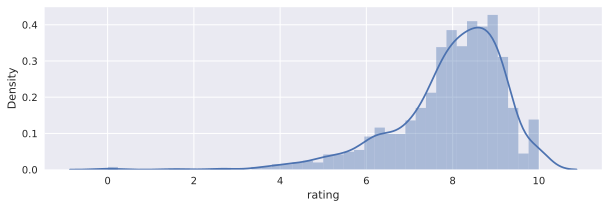

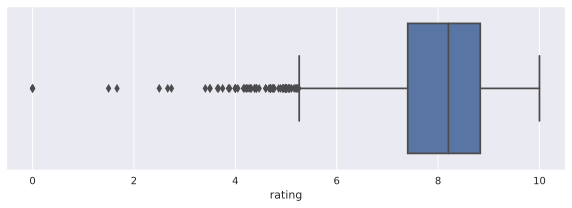

In [49]:
plt.figure(figsize=(10, 3))
sns.distplot(df_pr['rating'])
plt.show()

plt.figure(figsize=(10, 3))
sns.boxplot(df_pr['rating'], orient='h')
plt.show()

### Look at 5 movies for demo

* Чикатило ee48def6-c311-4b73-a878-1a5d3d1679a3,
* Манюня 9b202b16-55bf-418a-b01d-9f0329b18790,
* Оффлайн 49a3d528-44c0-408e-b6fc-a1507ce7641a
* Молодой человек 0271c9b5-b7b2-4e3f-96af-b9cefed99397
* Приплыли! 02eaefe0-296d-4e6f-b52f-2e2507d07103

In [50]:
demo_df = df_pr.loc[df_pr['element_uid'].isin(['ee48def6-c311-4b73-a878-1a5d3d1679a3', 
                                    '9b202b16-55bf-418a-b01d-9f0329b18790',
                                    '49a3d528-44c0-408e-b6fc-a1507ce7641a',
                                    '0271c9b5-b7b2-4e3f-96af-b9cefed99397',
                                    '02eaefe0-296d-4e6f-b52f-2e2507d07103'])]

In [51]:
ddf = demo_df.copy()

In [52]:
ddf.drop(['release_year', 'element_uid', 'name'], axis=1, inplace=True)

In [53]:
ddf.T

,6469,6550,9998,10433,10608
age_access_type,16,18,18,6,18
type,MOVIE,MOVIE,SERIAL,SERIAL,SERIAL
duration,15.70258,15.479437,17.723526,16.269958,17.218706
BUDGET,NaN,NaN,NaN,NaN,NaN
MARKETING,NaN,NaN,NaN,NaN,NaN
RUS,NaN,12.593543,NaN,NaN,NaN
USA,NaN,NaN,NaN,NaN,NaN
WORLD,NaN,NaN,NaN,NaN,NaN
rating,9.147352,6.519242,9.717041,9.192744,9.362527
Drama,0,0,1,0,1


## Split

In [54]:
df_pr.columns

Index(['age_access_type', 'name', 'type', 'release_year', 'duration',
       'element_uid', 'BUDGET', 'MARKETING', 'RUS', 'USA', 'WORLD', 'rating',
       'Drama', 'Comedy', 'Melodrama', '287a1485-7a88-4c2f-bc94-ca418b6c47a1',
       'Detective', 'Adventure', '364fdc2e-bdfe-40be-b2c5-d30f43ec432e',
       'Action', 'Thriller', 'Family', 'eb001d27-5be3-4d42-9d88-90d593f2627d',
       'russia', 'ukraine', 'germany', 'usa', 'france', 'great-britain',
       'Александр Робак', 'Андрей Харыбин', 'Александр Никольский',
       'Максим Важов', 'Тимофей Трибунцев', 'Фёдор Лавров', 'Андрей Мерзликин',
       'Андрей Смоляков', 'Дмитрий Поднозов', 'Михаил Ефремов',
       'Валерий Царьков', 'Максим Кошеваров', 'Иван Канаев', 'Елена Жукова',
       'Давид Дадунашвили', 'Алексей Праздников', 'Вячеслав Лавров',
       'Ольга Прошкина', 'Мария Сергеенкова', 'Степан Коваленко',
       'Алишер Хамидходжаев', 'Родион Павлючик', 'Влад Ряшин',
       'Рубен Дишдишян', 'Белла Прибылова', 'Виталий Шляппо']

In [55]:
from sklearn.model_selection import train_test_split

sorted_df = df_pr.sort_values('release_year')

test = sorted_df[sorted_df['release_year'] == 2022]
train = sorted_df[sorted_df['release_year'] != 2022]

# for looking at samples
test_df = test.copy(deep=True)
train_df = train.copy(deep=True)

test.drop(['release_year', 'element_uid', 'name'], axis=1, inplace=True)
train.drop(['release_year', 'element_uid', 'name'], axis=1, inplace=True)

X_test, y_test = test.drop('rating', axis=1), test['rating']
X, y = train.drop('rating', axis=1), train['rating']
X_train, X_val, y_train, y_val = train_test_split(X, y,
                                                  test_size=0.1, 
                                                  shuffle=False)
X_train.shape, X_val.shape, X_test.shape, y_train.shape, y_val.shape, y_test.shape


((1485, 51), (165, 51), (51, 51), (1485,), (165,), (51,))

In [56]:
X_train.columns

Index(['age_access_type', 'type', 'duration', 'BUDGET', 'MARKETING', 'RUS',
       'USA', 'WORLD', 'Drama', 'Comedy', 'Melodrama',
       '287a1485-7a88-4c2f-bc94-ca418b6c47a1', 'Detective', 'Adventure',
       '364fdc2e-bdfe-40be-b2c5-d30f43ec432e', 'Action', 'Thriller', 'Family',
       'eb001d27-5be3-4d42-9d88-90d593f2627d', 'russia', 'ukraine', 'germany',
       'usa', 'france', 'great-britain', 'Александр Робак', 'Андрей Харыбин',
       'Александр Никольский', 'Максим Важов', 'Тимофей Трибунцев',
       'Фёдор Лавров', 'Андрей Мерзликин', 'Андрей Смоляков',
       'Дмитрий Поднозов', 'Михаил Ефремов', 'Валерий Царьков',
       'Максим Кошеваров', 'Иван Канаев', 'Елена Жукова', 'Давид Дадунашвили',
       'Алексей Праздников', 'Вячеслав Лавров', 'Ольга Прошкина',
       'Мария Сергеенкова', 'Степан Коваленко', 'Алишер Хамидходжаев',
       'Родион Павлючик', 'Влад Ряшин', 'Рубен Дишдишян', 'Белла Прибылова',
       'Виталий Шляппо'],
      dtype='object')

In [57]:
cat_features = ['age_access_type', 'type']

# Modeling

In [58]:
import catboost as cat
from catboost import CatBoostRegressor
from sklearn.model_selection import GridSearchCV, RandomizedSearchCV

from scipy.stats import uniform, randint

In [59]:
train_dataset = cat.Pool(data=X_train,
                        label=y_train,
                         cat_features=cat_features)

test_dataset = cat.Pool(data=X_test, 
                        label=y_test,
                         cat_features=cat_features)

val_dataset = cat.Pool(X_val, y_val,
                       cat_features=cat_features)

cat_params = {
    'loss_function': 'RMSE',
    'eval_metric': 'MAE',
    'verbose': True,
    'random_seed': 321,
    'allow_writing_files': False, 
    'cat_features': cat_features
}

cat_model = cat.CatBoostRegressor(**cat_params)

cat_model.fit(
    train_dataset,
    eval_set=val_dataset,
    early_stopping_rounds=500,
    verbose=100,
    plot=False
)

Learning rate set to 0.054182
0:	learn: 0.9383576	test: 1.0097992	best: 1.0097992 (0)	total: 52.8ms	remaining: 52.7s
100:	learn: 0.7659337	test: 0.9134835	best: 0.9096313 (50)	total: 265ms	remaining: 2.36s
200:	learn: 0.7239741	test: 0.9064464	best: 0.9061992 (189)	total: 459ms	remaining: 1.82s
300:	learn: 0.6913121	test: 0.9008570	best: 0.8996173 (290)	total: 671ms	remaining: 1.56s
400:	learn: 0.6657354	test: 0.8993931	best: 0.8989068 (392)	total: 878ms	remaining: 1.31s
500:	learn: 0.6429658	test: 0.8987769	best: 0.8962512 (480)	total: 1.09s	remaining: 1.09s
600:	learn: 0.6214195	test: 0.9071560	best: 0.8962512 (480)	total: 1.32s	remaining: 880ms
700:	learn: 0.5980521	test: 0.9092032	best: 0.8962512 (480)	total: 1.55s	remaining: 662ms
800:	learn: 0.5768424	test: 0.9153372	best: 0.8962512 (480)	total: 1.79s	remaining: 445ms
900:	learn: 0.5597242	test: 0.9189579	best: 0.8962512 (480)	total: 2.02s	remaining: 222ms
Stopped by overfitting detector  (500 iterations wait)

bestTest = 0.89625

In [60]:
y_pred = cat_model.predict(test_dataset)

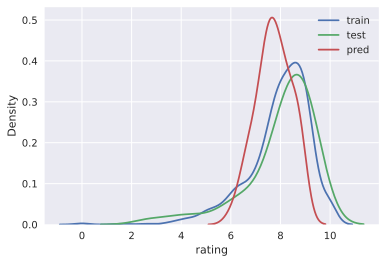

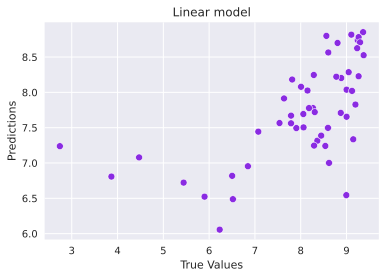

In [61]:
target_distr_linear(y_train, y_test, y_pred)   

In [62]:
calc_metrics(y_test, y_pred)

*** VAL **: 
MSE:   1.366837450630528
RMSE:  1.1691182363775394
R2:    0.3338261615278102
MAE:   0.8163517929525564
MedAE: 0.5583185233047043
------------------------------


In [63]:
cat_model.save_model('cat_reg_okko_ratings_cat_ntop_RUSS')

**Feature importance**

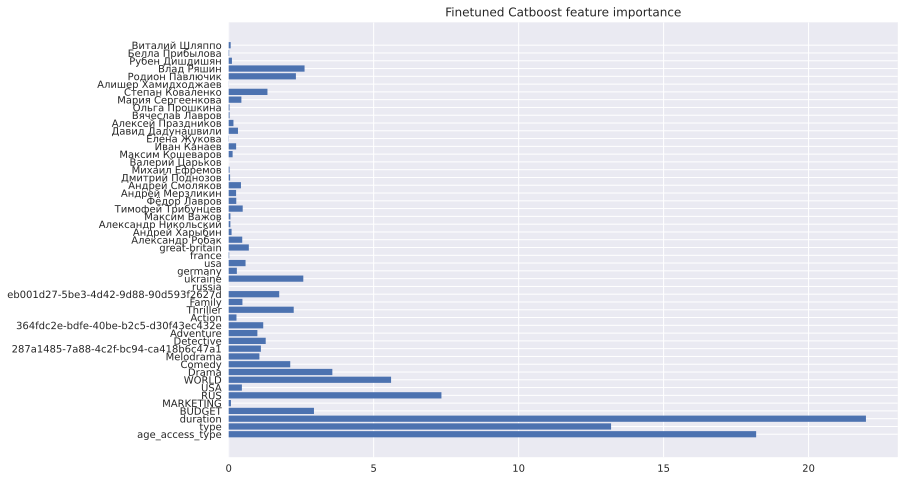

In [64]:
get_feature_imp(cat_model, train_dataset)

1)  The most influential features:  
    - duration  
    - average_rating  
    - age_access_type  

2)  The lowest influential features:  
    - actors and directors are not so important

**Detecting heteroscedasticity**

**Graphical Method:**

Firstly do the regression analysis and then plot the error terms against the predicted values. 
If there is a definite pattern (like linear or quadratic or funnel shaped) obtained from the scatter plot then heteroscedasticity is present.

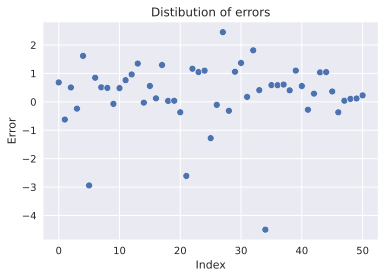

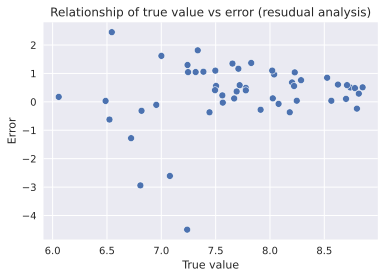

In [65]:
errors = y_test - y_pred
draw_res_analys(errors, y_pred)

**Conclusion**
* The trend in the second figure is not visible, now we will confirm the presence of heteroskedasticity on tests.

In [66]:
test_df['PREDS'] = y_pred.tolist()
test_df['TARGET'] = y_test.tolist()
test_df

,age_access_type,name,type,release_year,duration,element_uid,BUDGET,MARKETING,RUS,USA,...,Мария Сергеенкова,Степан Коваленко,Алишер Хамидходжаев,Родион Павлючик,Влад Ряшин,Рубен Дишдишян,Белла Прибылова,Виталий Шляппо,PREDS,TARGET
10681,18,Закрыть гештальт,SERIAL,2022,16.685680,e6ea57ce-52eb-465b-b9b8-270bc498ca53,NaN,NaN,NaN,NaN,...,0,0,0,0,0,0,0,0,8.203293,8.885542
6889,18,Рэпер,MOVIE,2022,15.636829,3eed9149-4311-4f23-ad37-e0985cae8cc8,NaN,NaN,NaN,NaN,...,0,0,0,0,0,0,0,0,6.523242,5.900000
7691,6,Финник,MOVIE,2022,15.468008,e9e71add-6d6f-41a1-bd81-705e9c9e3128,NaN,NaN,15.997514,NaN,...,0,0,0,0,0,0,0,0,8.739408,9.244676
7640,12,Первый Оскар,MOVIE,2022,15.738298,e69d2f4d-bb65-4e7e-93e1-74da99424ae8,NaN,NaN,14.252288,NaN,...,0,0,0,0,0,0,0,0,8.800050,8.560844
7630,18,Ника,MOVIE,2022,15.566448,5bd9b8c0-b482-4953-951a-813985e55e2d,NaN,NaN,12.233522,NaN,...,0,0,0,0,0,0,0,0,7.000921,8.618524
4554,16,Селфимания,MOVIE,2022,15.306165,75b6466f-9b0e-4195-9b99-c9f033d5589a,NaN,NaN,NaN,NaN,...,0,0,0,0,0,0,0,0,6.807670,3.865964
10607,16,И снова здравствуйте!,SERIAL,2022,16.665060,f02bc785-71a0-44cc-b6d6-ee2360a1c50f,NaN,NaN,NaN,NaN,...,0,0,0,0,0,0,0,0,8.526195,9.374117
10608,18,Оффлайн,SERIAL,2022,17.218706,49a3d528-44c0-408e-b6fc-a1507ce7641a,NaN,NaN,NaN,NaN,...,0,0,0,0,0,0,0,0,8.852562,9.362527
10630,0,Мой мир. Поем вместе,SERIAL,2022,15.358809,bd9a6edd-9eba-43c5-a053-4eca388798a5,NaN,NaN,NaN,NaN,...,0,0,0,0,0,0,0,0,7.777612,8.267857
10628,16,Кабинет Путешественника,SERIAL,2022,16.172584,fa45e8d6-7d96-40dc-b50d-3f012a89ecee,NaN,NaN,NaN,NaN,...,0,0,0,1,0,0,0,0,8.079149,8.007194


In [67]:
# predict demo dataset

In [68]:
X_demo, y_demo = ddf.drop('rating', axis=1), ddf['rating']

demo_dataset = cat.Pool(data=X_demo, 
                        label=y_demo,
                         cat_features=cat_features)

y_pred_demo = cat_model.predict(demo_dataset)

In [69]:
demo_df['TARGET'] = y_demo.tolist()
demo_df['PREDS'] = y_pred_demo.tolist()
demo_df

,age_access_type,name,type,release_year,duration,element_uid,BUDGET,MARKETING,RUS,USA,...,Мария Сергеенкова,Степан Коваленко,Алишер Хамидходжаев,Родион Павлючик,Влад Ряшин,Рубен Дишдишян,Белла Прибылова,Виталий Шляппо,TARGET,PREDS
6469,16,Молодой человек,MOVIE,2022,15.702580,0271c9b5-b7b2-4e3f-96af-b9cefed99397,NaN,NaN,NaN,NaN,...,0,0,0,0,0,0,0,0,9.147352,7.335317
6550,18,Приплыли!,MOVIE,2022,15.479437,02eaefe0-296d-4e6f-b52f-2e2507d07103,NaN,NaN,12.593543,NaN,...,0,0,0,0,0,0,0,0,6.519242,6.487421
9998,18,Чикатило,SERIAL,2020,17.723526,ee48def6-c311-4b73-a878-1a5d3d1679a3,NaN,NaN,NaN,NaN,...,0,0,0,0,0,0,0,0,9.717041,9.297865
10433,6,Манюня,SERIAL,2021,16.269958,9b202b16-55bf-418a-b01d-9f0329b18790,NaN,NaN,NaN,NaN,...,0,0,0,0,0,0,0,0,9.192744,7.613430
10608,18,Оффлайн,SERIAL,2022,17.218706,49a3d528-44c0-408e-b6fc-a1507ce7641a,NaN,NaN,NaN,NaN,...,0,0,0,0,0,0,0,0,9.362527,8.852562


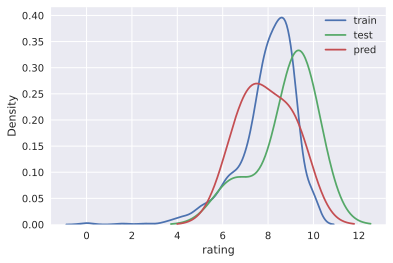

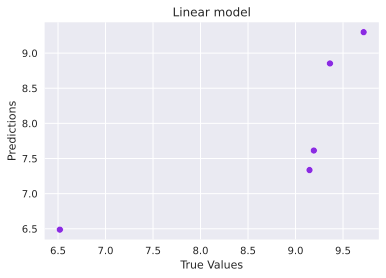

In [70]:
target_distr_linear(y_train, y_demo, y_pred_demo)   

# Tuning

In [71]:
train_dataset = cat.Pool(X_train, y_train, 
                         cat_features=cat_features) 

test_dataset = cat.Pool(X_test, y_test,
                         cat_features=cat_features)

cat_params = {
    'loss_function': 'RMSE',
    'eval_metric': 'MAE',
    'verbose': True,
    'random_seed': 321,
    'allow_writing_files': False, 
    'cat_features': cat_features
}

In [72]:
parameters_distr = {'depth': randint(5, 10),
              'learning_rate': uniform(0.01, 0.1),
              'iterations': [5000, 10000, 15000]
             }

cat_model = cat.CatBoostRegressor(**cat_params)
grid = RandomizedSearchCV(estimator=cat_model, param_distributions=parameters_distr, 
                            cv=5, 
#                           n_jobs=-1,
                          verbose=3)

grid.fit(X_train, y_train)

import pickle
with open('bestimator_okko_rat_ntop_RUSS', 'wb') as f:
    pickle.dump(grid.best_estimator_, f)
grid.best_params_

Fitting 5 folds for each of 10 candidates, totalling 50 fits
0:	learn: 0.8966480	total: 14.3ms	remaining: 3m 34s
1:	learn: 0.8865902	total: 16.8ms	remaining: 2m 5s
2:	learn: 0.8779112	total: 20.6ms	remaining: 1m 42s
3:	learn: 0.8701900	total: 22.4ms	remaining: 1m 23s
4:	learn: 0.8618750	total: 24.3ms	remaining: 1m 12s
5:	learn: 0.8538226	total: 26.3ms	remaining: 1m 5s
6:	learn: 0.8473916	total: 28ms	remaining: 59.9s
7:	learn: 0.8410821	total: 29.7ms	remaining: 55.6s
8:	learn: 0.8366514	total: 31.4ms	remaining: 52.3s
9:	learn: 0.8306090	total: 33ms	remaining: 49.5s
10:	learn: 0.8266245	total: 34.7ms	remaining: 47.2s
11:	learn: 0.8224994	total: 36.2ms	remaining: 45.2s
12:	learn: 0.8184009	total: 37.9ms	remaining: 43.7s
13:	learn: 0.8137053	total: 39.3ms	remaining: 42.1s
14:	learn: 0.8106061	total: 41.3ms	remaining: 41.3s
15:	learn: 0.8070394	total: 42.9ms	remaining: 40.2s
16:	learn: 0.8039607	total: 44.9ms	remaining: 39.5s
17:	learn: 0.8012074	total: 46.5ms	remaining: 38.7s
18:	learn: 0.

207:	learn: 0.6811868	total: 361ms	remaining: 25.7s
208:	learn: 0.6805220	total: 363ms	remaining: 25.7s
209:	learn: 0.6801852	total: 364ms	remaining: 25.7s
210:	learn: 0.6800332	total: 366ms	remaining: 25.6s
211:	learn: 0.6799777	total: 368ms	remaining: 25.6s
212:	learn: 0.6796133	total: 370ms	remaining: 25.7s
213:	learn: 0.6795781	total: 371ms	remaining: 25.6s
214:	learn: 0.6793371	total: 373ms	remaining: 25.7s
215:	learn: 0.6788455	total: 375ms	remaining: 25.7s
216:	learn: 0.6788320	total: 376ms	remaining: 25.6s
217:	learn: 0.6785402	total: 378ms	remaining: 25.6s
218:	learn: 0.6783299	total: 379ms	remaining: 25.6s
219:	learn: 0.6781514	total: 381ms	remaining: 25.6s
220:	learn: 0.6780827	total: 382ms	remaining: 25.5s
221:	learn: 0.6777790	total: 383ms	remaining: 25.5s
222:	learn: 0.6776536	total: 385ms	remaining: 25.5s
223:	learn: 0.6773304	total: 386ms	remaining: 25.5s
224:	learn: 0.6773175	total: 388ms	remaining: 25.5s
225:	learn: 0.6769738	total: 390ms	remaining: 25.5s
226:	learn: 

438:	learn: 0.6157540	total: 758ms	remaining: 25.1s
439:	learn: 0.6151983	total: 760ms	remaining: 25.1s
440:	learn: 0.6149270	total: 761ms	remaining: 25.1s
441:	learn: 0.6148184	total: 763ms	remaining: 25.1s
442:	learn: 0.6146610	total: 764ms	remaining: 25.1s
443:	learn: 0.6143733	total: 766ms	remaining: 25.1s
444:	learn: 0.6140719	total: 768ms	remaining: 25.1s
445:	learn: 0.6140866	total: 769ms	remaining: 25.1s
446:	learn: 0.6138395	total: 771ms	remaining: 25.1s
447:	learn: 0.6134909	total: 773ms	remaining: 25.1s
448:	learn: 0.6132357	total: 774ms	remaining: 25.1s
449:	learn: 0.6130196	total: 776ms	remaining: 25.1s
450:	learn: 0.6128088	total: 777ms	remaining: 25.1s
451:	learn: 0.6127128	total: 780ms	remaining: 25.1s
452:	learn: 0.6124620	total: 782ms	remaining: 25.1s
453:	learn: 0.6123956	total: 784ms	remaining: 25.1s
454:	learn: 0.6121609	total: 786ms	remaining: 25.1s
455:	learn: 0.6119079	total: 788ms	remaining: 25.1s
456:	learn: 0.6116705	total: 790ms	remaining: 25.1s
457:	learn: 

663:	learn: 0.5735864	total: 1.15s	remaining: 24.9s
664:	learn: 0.5734668	total: 1.16s	remaining: 24.9s
665:	learn: 0.5733093	total: 1.16s	remaining: 24.9s
666:	learn: 0.5728217	total: 1.16s	remaining: 24.9s
667:	learn: 0.5726035	total: 1.16s	remaining: 24.9s
668:	learn: 0.5724329	total: 1.16s	remaining: 24.9s
669:	learn: 0.5723952	total: 1.17s	remaining: 25s
670:	learn: 0.5722994	total: 1.17s	remaining: 25s
671:	learn: 0.5722833	total: 1.17s	remaining: 25s
672:	learn: 0.5721011	total: 1.17s	remaining: 25s
673:	learn: 0.5720159	total: 1.17s	remaining: 25s
674:	learn: 0.5717306	total: 1.18s	remaining: 25s
675:	learn: 0.5715070	total: 1.18s	remaining: 25s
676:	learn: 0.5714106	total: 1.18s	remaining: 25s
677:	learn: 0.5712017	total: 1.18s	remaining: 25s
678:	learn: 0.5709704	total: 1.18s	remaining: 25s
679:	learn: 0.5708114	total: 1.19s	remaining: 25s
680:	learn: 0.5707689	total: 1.19s	remaining: 25s
681:	learn: 0.5705177	total: 1.19s	remaining: 25s
682:	learn: 0.5701563	total: 1.19s	rem

892:	learn: 0.5366230	total: 1.55s	remaining: 24.5s
893:	learn: 0.5364441	total: 1.55s	remaining: 24.5s
894:	learn: 0.5362687	total: 1.55s	remaining: 24.5s
895:	learn: 0.5361563	total: 1.56s	remaining: 24.5s
896:	learn: 0.5358992	total: 1.56s	remaining: 24.5s
897:	learn: 0.5358837	total: 1.56s	remaining: 24.5s
898:	learn: 0.5357696	total: 1.56s	remaining: 24.5s
899:	learn: 0.5356481	total: 1.56s	remaining: 24.5s
900:	learn: 0.5355242	total: 1.57s	remaining: 24.5s
901:	learn: 0.5354611	total: 1.57s	remaining: 24.5s
902:	learn: 0.5351501	total: 1.57s	remaining: 24.5s
903:	learn: 0.5349514	total: 1.57s	remaining: 24.5s
904:	learn: 0.5347916	total: 1.57s	remaining: 24.5s
905:	learn: 0.5346954	total: 1.58s	remaining: 24.5s
906:	learn: 0.5346442	total: 1.58s	remaining: 24.5s
907:	learn: 0.5345571	total: 1.58s	remaining: 24.6s
908:	learn: 0.5344463	total: 1.58s	remaining: 24.6s
909:	learn: 0.5342931	total: 1.58s	remaining: 24.6s
910:	learn: 0.5341592	total: 1.59s	remaining: 24.6s
911:	learn: 

1106:	learn: 0.5093776	total: 1.95s	remaining: 24.5s
1107:	learn: 0.5093172	total: 1.95s	remaining: 24.5s
1108:	learn: 0.5090969	total: 1.95s	remaining: 24.5s
1109:	learn: 0.5089382	total: 1.95s	remaining: 24.5s
1110:	learn: 0.5087416	total: 1.96s	remaining: 24.4s
1111:	learn: 0.5087117	total: 1.96s	remaining: 24.4s
1112:	learn: 0.5086327	total: 1.96s	remaining: 24.4s
1113:	learn: 0.5084954	total: 1.96s	remaining: 24.4s
1114:	learn: 0.5083294	total: 1.96s	remaining: 24.4s
1115:	learn: 0.5081371	total: 1.96s	remaining: 24.4s
1116:	learn: 0.5079138	total: 1.96s	remaining: 24.4s
1117:	learn: 0.5078523	total: 1.97s	remaining: 24.4s
1118:	learn: 0.5076707	total: 1.97s	remaining: 24.4s
1119:	learn: 0.5074104	total: 1.97s	remaining: 24.4s
1120:	learn: 0.5073088	total: 1.97s	remaining: 24.4s
1121:	learn: 0.5070718	total: 1.97s	remaining: 24.4s
1122:	learn: 0.5070672	total: 1.97s	remaining: 24.4s
1123:	learn: 0.5070249	total: 1.98s	remaining: 24.4s
1124:	learn: 0.5070117	total: 1.98s	remaining:

1332:	learn: 0.4819105	total: 2.35s	remaining: 24s
1333:	learn: 0.4818540	total: 2.35s	remaining: 24s
1334:	learn: 0.4816691	total: 2.35s	remaining: 24s
1335:	learn: 0.4815410	total: 2.35s	remaining: 24s
1336:	learn: 0.4814860	total: 2.35s	remaining: 24s
1337:	learn: 0.4813311	total: 2.35s	remaining: 24s
1338:	learn: 0.4811658	total: 2.35s	remaining: 24s
1339:	learn: 0.4809493	total: 2.36s	remaining: 24s
1340:	learn: 0.4808783	total: 2.36s	remaining: 24s
1341:	learn: 0.4805754	total: 2.36s	remaining: 24s
1342:	learn: 0.4805283	total: 2.36s	remaining: 24s
1343:	learn: 0.4803726	total: 2.36s	remaining: 24s
1344:	learn: 0.4802902	total: 2.37s	remaining: 24s
1345:	learn: 0.4802086	total: 2.37s	remaining: 24s
1346:	learn: 0.4801072	total: 2.37s	remaining: 24s
1347:	learn: 0.4800509	total: 2.37s	remaining: 24s
1348:	learn: 0.4799087	total: 2.37s	remaining: 24s
1349:	learn: 0.4798599	total: 2.37s	remaining: 24s
1350:	learn: 0.4798254	total: 2.37s	remaining: 24s
1351:	learn: 0.4797270	total: 2

1549:	learn: 0.4607535	total: 2.74s	remaining: 23.8s
1550:	learn: 0.4607077	total: 2.74s	remaining: 23.8s
1551:	learn: 0.4606439	total: 2.75s	remaining: 23.8s
1552:	learn: 0.4606262	total: 2.75s	remaining: 23.8s
1553:	learn: 0.4604439	total: 2.75s	remaining: 23.8s
1554:	learn: 0.4602331	total: 2.75s	remaining: 23.8s
1555:	learn: 0.4600899	total: 2.75s	remaining: 23.8s
1556:	learn: 0.4600282	total: 2.76s	remaining: 23.8s
1557:	learn: 0.4598575	total: 2.76s	remaining: 23.8s
1558:	learn: 0.4597955	total: 2.76s	remaining: 23.8s
1559:	learn: 0.4595756	total: 2.76s	remaining: 23.8s
1560:	learn: 0.4593419	total: 2.76s	remaining: 23.8s
1561:	learn: 0.4593011	total: 2.77s	remaining: 23.8s
1562:	learn: 0.4591793	total: 2.77s	remaining: 23.8s
1563:	learn: 0.4591796	total: 2.77s	remaining: 23.8s
1564:	learn: 0.4591569	total: 2.77s	remaining: 23.8s
1565:	learn: 0.4590430	total: 2.77s	remaining: 23.8s
1566:	learn: 0.4589401	total: 2.77s	remaining: 23.8s
1567:	learn: 0.4588373	total: 2.77s	remaining:

1768:	learn: 0.4402691	total: 3.14s	remaining: 23.5s
1769:	learn: 0.4401370	total: 3.14s	remaining: 23.5s
1770:	learn: 0.4400900	total: 3.15s	remaining: 23.5s
1771:	learn: 0.4398926	total: 3.15s	remaining: 23.5s
1772:	learn: 0.4396980	total: 3.15s	remaining: 23.5s
1773:	learn: 0.4395712	total: 3.15s	remaining: 23.5s
1774:	learn: 0.4395535	total: 3.15s	remaining: 23.5s
1775:	learn: 0.4395014	total: 3.15s	remaining: 23.5s
1776:	learn: 0.4394449	total: 3.16s	remaining: 23.5s
1777:	learn: 0.4394184	total: 3.16s	remaining: 23.5s
1778:	learn: 0.4393738	total: 3.16s	remaining: 23.5s
1779:	learn: 0.4392570	total: 3.16s	remaining: 23.5s
1780:	learn: 0.4392201	total: 3.16s	remaining: 23.5s
1781:	learn: 0.4391480	total: 3.17s	remaining: 23.5s
1782:	learn: 0.4390748	total: 3.17s	remaining: 23.5s
1783:	learn: 0.4390341	total: 3.17s	remaining: 23.5s
1784:	learn: 0.4388829	total: 3.17s	remaining: 23.5s
1785:	learn: 0.4388418	total: 3.17s	remaining: 23.5s
1786:	learn: 0.4388311	total: 3.17s	remaining:

1985:	learn: 0.4235005	total: 3.54s	remaining: 23.2s
1986:	learn: 0.4234266	total: 3.54s	remaining: 23.2s
1987:	learn: 0.4234019	total: 3.54s	remaining: 23.2s
1988:	learn: 0.4232990	total: 3.54s	remaining: 23.2s
1989:	learn: 0.4232165	total: 3.54s	remaining: 23.2s
1990:	learn: 0.4232067	total: 3.54s	remaining: 23.2s
1991:	learn: 0.4230809	total: 3.55s	remaining: 23.2s
1992:	learn: 0.4229641	total: 3.55s	remaining: 23.2s
1993:	learn: 0.4229172	total: 3.55s	remaining: 23.2s
1994:	learn: 0.4228388	total: 3.56s	remaining: 23.2s
1995:	learn: 0.4228022	total: 3.56s	remaining: 23.2s
1996:	learn: 0.4227585	total: 3.56s	remaining: 23.2s
1997:	learn: 0.4227001	total: 3.56s	remaining: 23.2s
1998:	learn: 0.4226659	total: 3.56s	remaining: 23.2s
1999:	learn: 0.4226078	total: 3.57s	remaining: 23.2s
2000:	learn: 0.4225676	total: 3.57s	remaining: 23.2s
2001:	learn: 0.4224767	total: 3.57s	remaining: 23.2s
2002:	learn: 0.4224423	total: 3.57s	remaining: 23.2s
2003:	learn: 0.4222424	total: 3.57s	remaining:

2195:	learn: 0.4061986	total: 3.94s	remaining: 22.9s
2196:	learn: 0.4061260	total: 3.94s	remaining: 22.9s
2197:	learn: 0.4061044	total: 3.94s	remaining: 22.9s
2198:	learn: 0.4060519	total: 3.94s	remaining: 22.9s
2199:	learn: 0.4059202	total: 3.94s	remaining: 22.9s
2200:	learn: 0.4059093	total: 3.94s	remaining: 22.9s
2201:	learn: 0.4059068	total: 3.95s	remaining: 22.9s
2202:	learn: 0.4057680	total: 3.95s	remaining: 22.9s
2203:	learn: 0.4057396	total: 3.95s	remaining: 22.9s
2204:	learn: 0.4056881	total: 3.95s	remaining: 22.9s
2205:	learn: 0.4056633	total: 3.95s	remaining: 22.9s
2206:	learn: 0.4055686	total: 3.96s	remaining: 22.9s
2207:	learn: 0.4055511	total: 3.96s	remaining: 22.9s
2208:	learn: 0.4055350	total: 3.96s	remaining: 22.9s
2209:	learn: 0.4054603	total: 3.96s	remaining: 22.9s
2210:	learn: 0.4054413	total: 3.96s	remaining: 22.9s
2211:	learn: 0.4053435	total: 3.96s	remaining: 22.9s
2212:	learn: 0.4052947	total: 3.96s	remaining: 22.9s
2213:	learn: 0.4052292	total: 3.97s	remaining:

2411:	learn: 0.3913639	total: 4.33s	remaining: 22.6s
2412:	learn: 0.3912455	total: 4.33s	remaining: 22.6s
2413:	learn: 0.3910332	total: 4.34s	remaining: 22.6s
2414:	learn: 0.3909852	total: 4.34s	remaining: 22.6s
2415:	learn: 0.3909582	total: 4.34s	remaining: 22.6s
2416:	learn: 0.3907615	total: 4.34s	remaining: 22.6s
2417:	learn: 0.3906136	total: 4.34s	remaining: 22.6s
2418:	learn: 0.3905586	total: 4.35s	remaining: 22.6s
2419:	learn: 0.3904989	total: 4.35s	remaining: 22.6s
2420:	learn: 0.3904766	total: 4.35s	remaining: 22.6s
2421:	learn: 0.3904007	total: 4.36s	remaining: 22.6s
2422:	learn: 0.3902584	total: 4.36s	remaining: 22.6s
2423:	learn: 0.3902181	total: 4.36s	remaining: 22.6s
2424:	learn: 0.3901700	total: 4.36s	remaining: 22.6s
2425:	learn: 0.3901069	total: 4.36s	remaining: 22.6s
2426:	learn: 0.3900718	total: 4.37s	remaining: 22.6s
2427:	learn: 0.3900017	total: 4.37s	remaining: 22.6s
2428:	learn: 0.3898033	total: 4.37s	remaining: 22.6s
2429:	learn: 0.3897838	total: 4.37s	remaining:

2615:	learn: 0.3784572	total: 4.73s	remaining: 22.4s
2616:	learn: 0.3782988	total: 4.73s	remaining: 22.4s
2617:	learn: 0.3782550	total: 4.73s	remaining: 22.4s
2618:	learn: 0.3781999	total: 4.74s	remaining: 22.4s
2619:	learn: 0.3781970	total: 4.74s	remaining: 22.4s
2620:	learn: 0.3781597	total: 4.74s	remaining: 22.4s
2621:	learn: 0.3781315	total: 4.74s	remaining: 22.4s
2622:	learn: 0.3780811	total: 4.75s	remaining: 22.4s
2623:	learn: 0.3779737	total: 4.75s	remaining: 22.4s
2624:	learn: 0.3778696	total: 4.75s	remaining: 22.4s
2625:	learn: 0.3778473	total: 4.75s	remaining: 22.4s
2626:	learn: 0.3778031	total: 4.75s	remaining: 22.4s
2627:	learn: 0.3776983	total: 4.76s	remaining: 22.4s
2628:	learn: 0.3776679	total: 4.76s	remaining: 22.4s
2629:	learn: 0.3776458	total: 4.76s	remaining: 22.4s
2630:	learn: 0.3775110	total: 4.76s	remaining: 22.4s
2631:	learn: 0.3774335	total: 4.76s	remaining: 22.4s
2632:	learn: 0.3773979	total: 4.77s	remaining: 22.4s
2633:	learn: 0.3772144	total: 4.77s	remaining:

2819:	learn: 0.3664270	total: 5.13s	remaining: 22.1s
2820:	learn: 0.3663805	total: 5.13s	remaining: 22.1s
2821:	learn: 0.3663422	total: 5.13s	remaining: 22.1s
2822:	learn: 0.3662808	total: 5.13s	remaining: 22.1s
2823:	learn: 0.3661687	total: 5.13s	remaining: 22.1s
2824:	learn: 0.3660994	total: 5.14s	remaining: 22.1s
2825:	learn: 0.3659784	total: 5.14s	remaining: 22.1s
2826:	learn: 0.3659252	total: 5.14s	remaining: 22.1s
2827:	learn: 0.3658827	total: 5.14s	remaining: 22.1s
2828:	learn: 0.3658270	total: 5.14s	remaining: 22.1s
2829:	learn: 0.3657448	total: 5.14s	remaining: 22.1s
2830:	learn: 0.3657021	total: 5.15s	remaining: 22.1s
2831:	learn: 0.3656540	total: 5.15s	remaining: 22.1s
2832:	learn: 0.3656419	total: 5.15s	remaining: 22.1s
2833:	learn: 0.3654403	total: 5.15s	remaining: 22.1s
2834:	learn: 0.3653543	total: 5.16s	remaining: 22.1s
2835:	learn: 0.3653517	total: 5.16s	remaining: 22.1s
2836:	learn: 0.3652009	total: 5.16s	remaining: 22.1s
2837:	learn: 0.3651469	total: 5.16s	remaining:

3039:	learn: 0.3534973	total: 5.52s	remaining: 21.7s
3040:	learn: 0.3534656	total: 5.52s	remaining: 21.7s
3041:	learn: 0.3534571	total: 5.53s	remaining: 21.7s
3042:	learn: 0.3533680	total: 5.53s	remaining: 21.7s
3043:	learn: 0.3532834	total: 5.53s	remaining: 21.7s
3044:	learn: 0.3530941	total: 5.53s	remaining: 21.7s
3045:	learn: 0.3530621	total: 5.53s	remaining: 21.7s
3046:	learn: 0.3530064	total: 5.54s	remaining: 21.7s
3047:	learn: 0.3529487	total: 5.54s	remaining: 21.7s
3048:	learn: 0.3529153	total: 5.54s	remaining: 21.7s
3049:	learn: 0.3528729	total: 5.54s	remaining: 21.7s
3050:	learn: 0.3528587	total: 5.54s	remaining: 21.7s
3051:	learn: 0.3528230	total: 5.54s	remaining: 21.7s
3052:	learn: 0.3527935	total: 5.54s	remaining: 21.7s
3053:	learn: 0.3527695	total: 5.55s	remaining: 21.7s
3054:	learn: 0.3526057	total: 5.55s	remaining: 21.7s
3055:	learn: 0.3525121	total: 5.55s	remaining: 21.7s
3056:	learn: 0.3524894	total: 5.55s	remaining: 21.7s
3057:	learn: 0.3524062	total: 5.55s	remaining:

3265:	learn: 0.3424822	total: 5.92s	remaining: 21.3s
3266:	learn: 0.3424189	total: 5.92s	remaining: 21.3s
3267:	learn: 0.3424147	total: 5.92s	remaining: 21.3s
3268:	learn: 0.3423338	total: 5.92s	remaining: 21.3s
3269:	learn: 0.3423340	total: 5.92s	remaining: 21.3s
3270:	learn: 0.3422348	total: 5.93s	remaining: 21.3s
3271:	learn: 0.3421797	total: 5.93s	remaining: 21.3s
3272:	learn: 0.3421564	total: 5.93s	remaining: 21.2s
3273:	learn: 0.3420191	total: 5.93s	remaining: 21.2s
3274:	learn: 0.3419913	total: 5.93s	remaining: 21.2s
3275:	learn: 0.3419851	total: 5.93s	remaining: 21.2s
3276:	learn: 0.3419064	total: 5.94s	remaining: 21.2s
3277:	learn: 0.3417378	total: 5.94s	remaining: 21.2s
3278:	learn: 0.3417123	total: 5.94s	remaining: 21.2s
3279:	learn: 0.3416284	total: 5.94s	remaining: 21.2s
3280:	learn: 0.3416052	total: 5.94s	remaining: 21.2s
3281:	learn: 0.3415345	total: 5.95s	remaining: 21.2s
3282:	learn: 0.3414581	total: 5.95s	remaining: 21.2s
3283:	learn: 0.3413743	total: 5.95s	remaining:

3493:	learn: 0.3316410	total: 6.31s	remaining: 20.8s
3494:	learn: 0.3315830	total: 6.32s	remaining: 20.8s
3495:	learn: 0.3315184	total: 6.32s	remaining: 20.8s
3496:	learn: 0.3315009	total: 6.32s	remaining: 20.8s
3497:	learn: 0.3314720	total: 6.32s	remaining: 20.8s
3498:	learn: 0.3312494	total: 6.32s	remaining: 20.8s
3499:	learn: 0.3312496	total: 6.33s	remaining: 20.8s
3500:	learn: 0.3311801	total: 6.33s	remaining: 20.8s
3501:	learn: 0.3311529	total: 6.33s	remaining: 20.8s
3502:	learn: 0.3310610	total: 6.33s	remaining: 20.8s
3503:	learn: 0.3310110	total: 6.33s	remaining: 20.8s
3504:	learn: 0.3309273	total: 6.33s	remaining: 20.8s
3505:	learn: 0.3308459	total: 6.34s	remaining: 20.8s
3506:	learn: 0.3307571	total: 6.34s	remaining: 20.8s
3507:	learn: 0.3307111	total: 6.34s	remaining: 20.8s
3508:	learn: 0.3306609	total: 6.34s	remaining: 20.8s
3509:	learn: 0.3306179	total: 6.34s	remaining: 20.8s
3510:	learn: 0.3305761	total: 6.34s	remaining: 20.8s
3511:	learn: 0.3305368	total: 6.35s	remaining:

3711:	learn: 0.3215650	total: 6.71s	remaining: 20.4s
3712:	learn: 0.3215428	total: 6.71s	remaining: 20.4s
3713:	learn: 0.3213072	total: 6.72s	remaining: 20.4s
3714:	learn: 0.3212459	total: 6.72s	remaining: 20.4s
3715:	learn: 0.3211841	total: 6.72s	remaining: 20.4s
3716:	learn: 0.3211600	total: 6.72s	remaining: 20.4s
3717:	learn: 0.3211304	total: 6.72s	remaining: 20.4s
3718:	learn: 0.3211051	total: 6.72s	remaining: 20.4s
3719:	learn: 0.3210063	total: 6.72s	remaining: 20.4s
3720:	learn: 0.3209917	total: 6.73s	remaining: 20.4s
3721:	learn: 0.3209632	total: 6.73s	remaining: 20.4s
3722:	learn: 0.3208485	total: 6.73s	remaining: 20.4s
3723:	learn: 0.3208052	total: 6.73s	remaining: 20.4s
3724:	learn: 0.3207818	total: 6.74s	remaining: 20.4s
3725:	learn: 0.3207414	total: 6.74s	remaining: 20.4s
3726:	learn: 0.3206686	total: 6.74s	remaining: 20.4s
3727:	learn: 0.3206570	total: 6.74s	remaining: 20.4s
3728:	learn: 0.3206057	total: 6.74s	remaining: 20.4s
3729:	learn: 0.3205348	total: 6.74s	remaining:

3933:	learn: 0.3115445	total: 7.11s	remaining: 20s
3934:	learn: 0.3114718	total: 7.11s	remaining: 20s
3935:	learn: 0.3114473	total: 7.11s	remaining: 20s
3936:	learn: 0.3114347	total: 7.11s	remaining: 20s
3937:	learn: 0.3113528	total: 7.11s	remaining: 20s
3938:	learn: 0.3113311	total: 7.12s	remaining: 20s
3939:	learn: 0.3112310	total: 7.12s	remaining: 20s
3940:	learn: 0.3111579	total: 7.12s	remaining: 20s
3941:	learn: 0.3111117	total: 7.12s	remaining: 20s
3942:	learn: 0.3110973	total: 7.12s	remaining: 20s
3943:	learn: 0.3110839	total: 7.13s	remaining: 20s
3944:	learn: 0.3110204	total: 7.13s	remaining: 20s
3945:	learn: 0.3109726	total: 7.13s	remaining: 20s
3946:	learn: 0.3109283	total: 7.13s	remaining: 20s
3947:	learn: 0.3108575	total: 7.13s	remaining: 20s
3948:	learn: 0.3108354	total: 7.13s	remaining: 20s
3949:	learn: 0.3108131	total: 7.14s	remaining: 20s
3950:	learn: 0.3108219	total: 7.14s	remaining: 20s
3951:	learn: 0.3107926	total: 7.14s	remaining: 20s
3952:	learn: 0.3107357	total: 7

4151:	learn: 0.3018347	total: 7.5s	remaining: 19.6s
4152:	learn: 0.3018237	total: 7.5s	remaining: 19.6s
4153:	learn: 0.3018056	total: 7.51s	remaining: 19.6s
4154:	learn: 0.3017135	total: 7.51s	remaining: 19.6s
4155:	learn: 0.3017028	total: 7.51s	remaining: 19.6s
4156:	learn: 0.3016783	total: 7.51s	remaining: 19.6s
4157:	learn: 0.3016039	total: 7.51s	remaining: 19.6s
4158:	learn: 0.3015465	total: 7.52s	remaining: 19.6s
4159:	learn: 0.3015017	total: 7.52s	remaining: 19.6s
4160:	learn: 0.3014874	total: 7.52s	remaining: 19.6s
4161:	learn: 0.3014695	total: 7.52s	remaining: 19.6s
4162:	learn: 0.3013253	total: 7.52s	remaining: 19.6s
4163:	learn: 0.3013069	total: 7.52s	remaining: 19.6s
4164:	learn: 0.3012843	total: 7.53s	remaining: 19.6s
4165:	learn: 0.3012832	total: 7.53s	remaining: 19.6s
4166:	learn: 0.3012680	total: 7.53s	remaining: 19.6s
4167:	learn: 0.3011899	total: 7.53s	remaining: 19.6s
4168:	learn: 0.3011660	total: 7.53s	remaining: 19.6s
4169:	learn: 0.3010944	total: 7.54s	remaining: 1

4372:	learn: 0.2926962	total: 7.9s	remaining: 19.2s
4373:	learn: 0.2926848	total: 7.9s	remaining: 19.2s
4374:	learn: 0.2926700	total: 7.9s	remaining: 19.2s
4375:	learn: 0.2926597	total: 7.9s	remaining: 19.2s
4376:	learn: 0.2926414	total: 7.91s	remaining: 19.2s
4377:	learn: 0.2926335	total: 7.91s	remaining: 19.2s
4378:	learn: 0.2926212	total: 7.91s	remaining: 19.2s
4379:	learn: 0.2925682	total: 7.91s	remaining: 19.2s
4380:	learn: 0.2925203	total: 7.91s	remaining: 19.2s
4381:	learn: 0.2925175	total: 7.91s	remaining: 19.2s
4382:	learn: 0.2924690	total: 7.92s	remaining: 19.2s
4383:	learn: 0.2923909	total: 7.92s	remaining: 19.2s
4384:	learn: 0.2923253	total: 7.92s	remaining: 19.2s
4385:	learn: 0.2922570	total: 7.92s	remaining: 19.2s
4386:	learn: 0.2922199	total: 7.92s	remaining: 19.2s
4387:	learn: 0.2922059	total: 7.92s	remaining: 19.2s
4388:	learn: 0.2921889	total: 7.93s	remaining: 19.2s
4389:	learn: 0.2921876	total: 7.93s	remaining: 19.2s
4390:	learn: 0.2921225	total: 7.93s	remaining: 19.

4593:	learn: 0.2839110	total: 8.29s	remaining: 18.8s
4594:	learn: 0.2838704	total: 8.3s	remaining: 18.8s
4595:	learn: 0.2837981	total: 8.3s	remaining: 18.8s
4596:	learn: 0.2837793	total: 8.3s	remaining: 18.8s
4597:	learn: 0.2837338	total: 8.3s	remaining: 18.8s
4598:	learn: 0.2837164	total: 8.3s	remaining: 18.8s
4599:	learn: 0.2836818	total: 8.31s	remaining: 18.8s
4600:	learn: 0.2836128	total: 8.31s	remaining: 18.8s
4601:	learn: 0.2835140	total: 8.31s	remaining: 18.8s
4602:	learn: 0.2834781	total: 8.31s	remaining: 18.8s
4603:	learn: 0.2834225	total: 8.31s	remaining: 18.8s
4604:	learn: 0.2834214	total: 8.31s	remaining: 18.8s
4605:	learn: 0.2833772	total: 8.31s	remaining: 18.8s
4606:	learn: 0.2832999	total: 8.32s	remaining: 18.8s
4607:	learn: 0.2832978	total: 8.32s	remaining: 18.8s
4608:	learn: 0.2832502	total: 8.32s	remaining: 18.8s
4609:	learn: 0.2832301	total: 8.32s	remaining: 18.8s
4610:	learn: 0.2832239	total: 8.32s	remaining: 18.8s
4611:	learn: 0.2831908	total: 8.32s	remaining: 18.8

4820:	learn: 0.2756656	total: 8.69s	remaining: 18.3s
4821:	learn: 0.2755679	total: 8.69s	remaining: 18.3s
4822:	learn: 0.2755172	total: 8.69s	remaining: 18.3s
4823:	learn: 0.2754742	total: 8.7s	remaining: 18.3s
4824:	learn: 0.2754110	total: 8.7s	remaining: 18.3s
4825:	learn: 0.2753427	total: 8.7s	remaining: 18.3s
4826:	learn: 0.2753165	total: 8.7s	remaining: 18.3s
4827:	learn: 0.2753039	total: 8.71s	remaining: 18.3s
4828:	learn: 0.2752497	total: 8.71s	remaining: 18.3s
4829:	learn: 0.2752441	total: 8.71s	remaining: 18.3s
4830:	learn: 0.2752059	total: 8.71s	remaining: 18.3s
4831:	learn: 0.2751496	total: 8.71s	remaining: 18.3s
4832:	learn: 0.2750550	total: 8.71s	remaining: 18.3s
4833:	learn: 0.2750432	total: 8.72s	remaining: 18.3s
4834:	learn: 0.2750142	total: 8.72s	remaining: 18.3s
4835:	learn: 0.2749475	total: 8.72s	remaining: 18.3s
4836:	learn: 0.2749264	total: 8.72s	remaining: 18.3s
4837:	learn: 0.2748949	total: 8.72s	remaining: 18.3s
4838:	learn: 0.2748721	total: 8.73s	remaining: 18.

5034:	learn: 0.2688565	total: 9.09s	remaining: 18s
5035:	learn: 0.2688379	total: 9.09s	remaining: 18s
5036:	learn: 0.2688229	total: 9.09s	remaining: 18s
5037:	learn: 0.2687451	total: 9.09s	remaining: 18s
5038:	learn: 0.2686491	total: 9.09s	remaining: 18s
5039:	learn: 0.2685619	total: 9.09s	remaining: 18s
5040:	learn: 0.2685506	total: 9.1s	remaining: 18s
5041:	learn: 0.2685373	total: 9.1s	remaining: 18s
5042:	learn: 0.2684884	total: 9.1s	remaining: 18s
5043:	learn: 0.2684446	total: 9.1s	remaining: 18s
5044:	learn: 0.2684382	total: 9.1s	remaining: 18s
5045:	learn: 0.2683932	total: 9.11s	remaining: 18s
5046:	learn: 0.2683705	total: 9.11s	remaining: 18s
5047:	learn: 0.2683711	total: 9.11s	remaining: 18s
5048:	learn: 0.2683483	total: 9.11s	remaining: 18s
5049:	learn: 0.2683312	total: 9.11s	remaining: 18s
5050:	learn: 0.2683153	total: 9.11s	remaining: 17.9s
5051:	learn: 0.2682716	total: 9.12s	remaining: 17.9s
5052:	learn: 0.2682149	total: 9.12s	remaining: 17.9s
5053:	learn: 0.2681982	total: 

5256:	learn: 0.2626732	total: 9.48s	remaining: 17.6s
5257:	learn: 0.2626669	total: 9.48s	remaining: 17.6s
5258:	learn: 0.2626342	total: 9.48s	remaining: 17.6s
5259:	learn: 0.2626239	total: 9.49s	remaining: 17.6s
5260:	learn: 0.2625950	total: 9.49s	remaining: 17.6s
5261:	learn: 0.2625813	total: 9.49s	remaining: 17.6s
5262:	learn: 0.2625439	total: 9.49s	remaining: 17.6s
5263:	learn: 0.2624649	total: 9.49s	remaining: 17.6s
5264:	learn: 0.2624256	total: 9.49s	remaining: 17.6s
5265:	learn: 0.2624126	total: 9.5s	remaining: 17.6s
5266:	learn: 0.2623769	total: 9.5s	remaining: 17.6s
5267:	learn: 0.2623588	total: 9.5s	remaining: 17.6s
5268:	learn: 0.2623213	total: 9.5s	remaining: 17.5s
5269:	learn: 0.2622895	total: 9.5s	remaining: 17.5s
5270:	learn: 0.2622276	total: 9.51s	remaining: 17.5s
5271:	learn: 0.2621835	total: 9.51s	remaining: 17.5s
5272:	learn: 0.2621540	total: 9.51s	remaining: 17.5s
5273:	learn: 0.2621314	total: 9.51s	remaining: 17.5s
5274:	learn: 0.2620798	total: 9.51s	remaining: 17.5

5472:	learn: 0.2557466	total: 9.88s	remaining: 17.2s
5473:	learn: 0.2557229	total: 9.88s	remaining: 17.2s
5474:	learn: 0.2556641	total: 9.88s	remaining: 17.2s
5475:	learn: 0.2556533	total: 9.88s	remaining: 17.2s
5476:	learn: 0.2556212	total: 9.88s	remaining: 17.2s
5477:	learn: 0.2555556	total: 9.89s	remaining: 17.2s
5478:	learn: 0.2555205	total: 9.89s	remaining: 17.2s
5479:	learn: 0.2554849	total: 9.89s	remaining: 17.2s
5480:	learn: 0.2554086	total: 9.89s	remaining: 17.2s
5481:	learn: 0.2553220	total: 9.89s	remaining: 17.2s
5482:	learn: 0.2553181	total: 9.9s	remaining: 17.2s
5483:	learn: 0.2552635	total: 9.9s	remaining: 17.2s
5484:	learn: 0.2551743	total: 9.9s	remaining: 17.2s
5485:	learn: 0.2551093	total: 9.9s	remaining: 17.2s
5486:	learn: 0.2550704	total: 9.9s	remaining: 17.2s
5487:	learn: 0.2550364	total: 9.91s	remaining: 17.2s
5488:	learn: 0.2550101	total: 9.91s	remaining: 17.2s
5489:	learn: 0.2549752	total: 9.91s	remaining: 17.2s
5490:	learn: 0.2549705	total: 9.91s	remaining: 17.2

5689:	learn: 0.2499009	total: 10.3s	remaining: 16.8s
5690:	learn: 0.2498769	total: 10.3s	remaining: 16.8s
5691:	learn: 0.2498395	total: 10.3s	remaining: 16.8s
5692:	learn: 0.2498225	total: 10.3s	remaining: 16.8s
5693:	learn: 0.2497552	total: 10.3s	remaining: 16.8s
5694:	learn: 0.2497488	total: 10.3s	remaining: 16.8s
5695:	learn: 0.2497447	total: 10.3s	remaining: 16.8s
5696:	learn: 0.2497405	total: 10.3s	remaining: 16.8s
5697:	learn: 0.2496454	total: 10.3s	remaining: 16.8s
5698:	learn: 0.2495627	total: 10.3s	remaining: 16.8s
5699:	learn: 0.2495428	total: 10.3s	remaining: 16.8s
5700:	learn: 0.2495176	total: 10.3s	remaining: 16.8s
5701:	learn: 0.2494861	total: 10.3s	remaining: 16.8s
5702:	learn: 0.2494480	total: 10.3s	remaining: 16.8s
5703:	learn: 0.2494298	total: 10.3s	remaining: 16.8s
5704:	learn: 0.2493950	total: 10.3s	remaining: 16.8s
5705:	learn: 0.2493677	total: 10.3s	remaining: 16.8s
5706:	learn: 0.2493375	total: 10.3s	remaining: 16.8s
5707:	learn: 0.2492581	total: 10.3s	remaining:

5910:	learn: 0.2439391	total: 10.7s	remaining: 16.4s
5911:	learn: 0.2439181	total: 10.7s	remaining: 16.4s
5912:	learn: 0.2438780	total: 10.7s	remaining: 16.4s
5913:	learn: 0.2438718	total: 10.7s	remaining: 16.4s
5914:	learn: 0.2438509	total: 10.7s	remaining: 16.4s
5915:	learn: 0.2438225	total: 10.7s	remaining: 16.4s
5916:	learn: 0.2438070	total: 10.7s	remaining: 16.4s
5917:	learn: 0.2437610	total: 10.7s	remaining: 16.4s
5918:	learn: 0.2437339	total: 10.7s	remaining: 16.4s
5919:	learn: 0.2437060	total: 10.7s	remaining: 16.4s
5920:	learn: 0.2437110	total: 10.7s	remaining: 16.4s
5921:	learn: 0.2436894	total: 10.7s	remaining: 16.4s
5922:	learn: 0.2436725	total: 10.7s	remaining: 16.4s
5923:	learn: 0.2436677	total: 10.7s	remaining: 16.4s
5924:	learn: 0.2436645	total: 10.7s	remaining: 16.4s
5925:	learn: 0.2436442	total: 10.7s	remaining: 16.4s
5926:	learn: 0.2436095	total: 10.7s	remaining: 16.4s
5927:	learn: 0.2435906	total: 10.7s	remaining: 16.4s
5928:	learn: 0.2435522	total: 10.7s	remaining:

6116:	learn: 0.2392400	total: 11.1s	remaining: 16.1s
6117:	learn: 0.2392372	total: 11.1s	remaining: 16.1s
6118:	learn: 0.2392361	total: 11.1s	remaining: 16.1s
6119:	learn: 0.2391906	total: 11.1s	remaining: 16.1s
6120:	learn: 0.2391503	total: 11.1s	remaining: 16.1s
6121:	learn: 0.2391057	total: 11.1s	remaining: 16.1s
6122:	learn: 0.2390484	total: 11.1s	remaining: 16.1s
6123:	learn: 0.2389720	total: 11.1s	remaining: 16.1s
6124:	learn: 0.2389621	total: 11.1s	remaining: 16.1s
6125:	learn: 0.2389468	total: 11.1s	remaining: 16.1s
6126:	learn: 0.2388571	total: 11.1s	remaining: 16.1s
6127:	learn: 0.2388437	total: 11.1s	remaining: 16.1s
6128:	learn: 0.2388146	total: 11.1s	remaining: 16.1s
6129:	learn: 0.2388041	total: 11.1s	remaining: 16.1s
6130:	learn: 0.2387852	total: 11.1s	remaining: 16.1s
6131:	learn: 0.2387654	total: 11.1s	remaining: 16s
6132:	learn: 0.2387621	total: 11.1s	remaining: 16s
6133:	learn: 0.2387369	total: 11.1s	remaining: 16s
6134:	learn: 0.2387260	total: 11.1s	remaining: 16s
6

6333:	learn: 0.2335875	total: 11.5s	remaining: 15.7s
6334:	learn: 0.2335441	total: 11.5s	remaining: 15.7s
6335:	learn: 0.2335498	total: 11.5s	remaining: 15.7s
6336:	learn: 0.2335175	total: 11.5s	remaining: 15.7s
6337:	learn: 0.2334778	total: 11.5s	remaining: 15.7s
6338:	learn: 0.2334658	total: 11.5s	remaining: 15.7s
6339:	learn: 0.2334544	total: 11.5s	remaining: 15.7s
6340:	learn: 0.2333761	total: 11.5s	remaining: 15.7s
6341:	learn: 0.2333637	total: 11.5s	remaining: 15.7s
6342:	learn: 0.2333549	total: 11.5s	remaining: 15.7s
6343:	learn: 0.2333194	total: 11.5s	remaining: 15.7s
6344:	learn: 0.2333027	total: 11.5s	remaining: 15.7s
6345:	learn: 0.2333006	total: 11.5s	remaining: 15.7s
6346:	learn: 0.2332975	total: 11.5s	remaining: 15.7s
6347:	learn: 0.2332558	total: 11.5s	remaining: 15.7s
6348:	learn: 0.2332508	total: 11.5s	remaining: 15.7s
6349:	learn: 0.2332259	total: 11.5s	remaining: 15.7s
6350:	learn: 0.2331837	total: 11.5s	remaining: 15.7s
6351:	learn: 0.2331500	total: 11.5s	remaining:

6549:	learn: 0.2283577	total: 11.9s	remaining: 15.3s
6550:	learn: 0.2283139	total: 11.9s	remaining: 15.3s
6551:	learn: 0.2281929	total: 11.9s	remaining: 15.3s
6552:	learn: 0.2281689	total: 11.9s	remaining: 15.3s
6553:	learn: 0.2281297	total: 11.9s	remaining: 15.3s
6554:	learn: 0.2281151	total: 11.9s	remaining: 15.3s
6555:	learn: 0.2280716	total: 11.9s	remaining: 15.3s
6556:	learn: 0.2280386	total: 11.9s	remaining: 15.3s
6557:	learn: 0.2280243	total: 11.9s	remaining: 15.3s
6558:	learn: 0.2280133	total: 11.9s	remaining: 15.3s
6559:	learn: 0.2279766	total: 11.9s	remaining: 15.3s
6560:	learn: 0.2279644	total: 11.9s	remaining: 15.3s
6561:	learn: 0.2279565	total: 11.9s	remaining: 15.3s
6562:	learn: 0.2279584	total: 11.9s	remaining: 15.3s
6563:	learn: 0.2279488	total: 11.9s	remaining: 15.3s
6564:	learn: 0.2279469	total: 11.9s	remaining: 15.3s
6565:	learn: 0.2279417	total: 11.9s	remaining: 15.3s
6566:	learn: 0.2279143	total: 11.9s	remaining: 15.3s
6567:	learn: 0.2278574	total: 11.9s	remaining:

6762:	learn: 0.2233598	total: 12.3s	remaining: 14.9s
6763:	learn: 0.2233479	total: 12.3s	remaining: 14.9s
6764:	learn: 0.2233164	total: 12.3s	remaining: 14.9s
6765:	learn: 0.2233000	total: 12.3s	remaining: 14.9s
6766:	learn: 0.2232938	total: 12.3s	remaining: 14.9s
6767:	learn: 0.2232902	total: 12.3s	remaining: 14.9s
6768:	learn: 0.2232805	total: 12.3s	remaining: 14.9s
6769:	learn: 0.2232404	total: 12.3s	remaining: 14.9s
6770:	learn: 0.2231999	total: 12.3s	remaining: 14.9s
6771:	learn: 0.2231906	total: 12.3s	remaining: 14.9s
6772:	learn: 0.2231110	total: 12.3s	remaining: 14.9s
6773:	learn: 0.2230828	total: 12.3s	remaining: 14.9s
6774:	learn: 0.2230695	total: 12.3s	remaining: 14.9s
6775:	learn: 0.2230569	total: 12.3s	remaining: 14.9s
6776:	learn: 0.2230519	total: 12.3s	remaining: 14.9s
6777:	learn: 0.2230467	total: 12.3s	remaining: 14.9s
6778:	learn: 0.2230314	total: 12.3s	remaining: 14.9s
6779:	learn: 0.2229999	total: 12.3s	remaining: 14.9s
6780:	learn: 0.2229541	total: 12.3s	remaining:

6976:	learn: 0.2190254	total: 12.7s	remaining: 14.6s
6977:	learn: 0.2190122	total: 12.7s	remaining: 14.6s
6978:	learn: 0.2190061	total: 12.7s	remaining: 14.6s
6979:	learn: 0.2189823	total: 12.7s	remaining: 14.5s
6980:	learn: 0.2189667	total: 12.7s	remaining: 14.5s
6981:	learn: 0.2189498	total: 12.7s	remaining: 14.5s
6982:	learn: 0.2189523	total: 12.7s	remaining: 14.5s
6983:	learn: 0.2188796	total: 12.7s	remaining: 14.5s
6984:	learn: 0.2188594	total: 12.7s	remaining: 14.5s
6985:	learn: 0.2188578	total: 12.7s	remaining: 14.5s
6986:	learn: 0.2188413	total: 12.7s	remaining: 14.5s
6987:	learn: 0.2187916	total: 12.7s	remaining: 14.5s
6988:	learn: 0.2187846	total: 12.7s	remaining: 14.5s
6989:	learn: 0.2187615	total: 12.7s	remaining: 14.5s
6990:	learn: 0.2187433	total: 12.7s	remaining: 14.5s
6991:	learn: 0.2186642	total: 12.7s	remaining: 14.5s
6992:	learn: 0.2186468	total: 12.7s	remaining: 14.5s
6993:	learn: 0.2186284	total: 12.7s	remaining: 14.5s
6994:	learn: 0.2185910	total: 12.7s	remaining:

7194:	learn: 0.2145441	total: 13.1s	remaining: 14.2s
7195:	learn: 0.2145245	total: 13.1s	remaining: 14.2s
7196:	learn: 0.2145222	total: 13.1s	remaining: 14.2s
7197:	learn: 0.2145067	total: 13.1s	remaining: 14.2s
7198:	learn: 0.2144946	total: 13.1s	remaining: 14.2s
7199:	learn: 0.2144904	total: 13.1s	remaining: 14.1s
7200:	learn: 0.2144829	total: 13.1s	remaining: 14.1s
7201:	learn: 0.2144527	total: 13.1s	remaining: 14.1s
7202:	learn: 0.2144405	total: 13.1s	remaining: 14.1s
7203:	learn: 0.2144159	total: 13.1s	remaining: 14.1s
7204:	learn: 0.2144098	total: 13.1s	remaining: 14.1s
7205:	learn: 0.2143885	total: 13.1s	remaining: 14.1s
7206:	learn: 0.2143700	total: 13.1s	remaining: 14.1s
7207:	learn: 0.2143594	total: 13.1s	remaining: 14.1s
7208:	learn: 0.2143473	total: 13.1s	remaining: 14.1s
7209:	learn: 0.2143308	total: 13.1s	remaining: 14.1s
7210:	learn: 0.2143052	total: 13.1s	remaining: 14.1s
7211:	learn: 0.2143079	total: 13.1s	remaining: 14.1s
7212:	learn: 0.2142663	total: 13.1s	remaining:

7412:	learn: 0.2098743	total: 13.4s	remaining: 13.8s
7413:	learn: 0.2098633	total: 13.5s	remaining: 13.8s
7414:	learn: 0.2098632	total: 13.5s	remaining: 13.8s
7415:	learn: 0.2098317	total: 13.5s	remaining: 13.8s
7416:	learn: 0.2097645	total: 13.5s	remaining: 13.8s
7417:	learn: 0.2097600	total: 13.5s	remaining: 13.8s
7418:	learn: 0.2097590	total: 13.5s	remaining: 13.8s
7419:	learn: 0.2097444	total: 13.5s	remaining: 13.8s
7420:	learn: 0.2097326	total: 13.5s	remaining: 13.8s
7421:	learn: 0.2097376	total: 13.5s	remaining: 13.8s
7422:	learn: 0.2097161	total: 13.5s	remaining: 13.7s
7423:	learn: 0.2096923	total: 13.5s	remaining: 13.7s
7424:	learn: 0.2096514	total: 13.5s	remaining: 13.7s
7425:	learn: 0.2096185	total: 13.5s	remaining: 13.7s
7426:	learn: 0.2096060	total: 13.5s	remaining: 13.7s
7427:	learn: 0.2095961	total: 13.5s	remaining: 13.7s
7428:	learn: 0.2095773	total: 13.5s	remaining: 13.7s
7429:	learn: 0.2095236	total: 13.5s	remaining: 13.7s
7430:	learn: 0.2095206	total: 13.5s	remaining:

7632:	learn: 0.2052002	total: 13.8s	remaining: 13.4s
7633:	learn: 0.2051822	total: 13.8s	remaining: 13.4s
7634:	learn: 0.2051691	total: 13.8s	remaining: 13.4s
7635:	learn: 0.2051416	total: 13.9s	remaining: 13.4s
7636:	learn: 0.2051375	total: 13.9s	remaining: 13.4s
7637:	learn: 0.2051125	total: 13.9s	remaining: 13.4s
7638:	learn: 0.2050869	total: 13.9s	remaining: 13.4s
7639:	learn: 0.2050281	total: 13.9s	remaining: 13.4s
7640:	learn: 0.2050255	total: 13.9s	remaining: 13.4s
7641:	learn: 0.2050150	total: 13.9s	remaining: 13.3s
7642:	learn: 0.2049948	total: 13.9s	remaining: 13.3s
7643:	learn: 0.2049815	total: 13.9s	remaining: 13.3s
7644:	learn: 0.2049702	total: 13.9s	remaining: 13.3s
7645:	learn: 0.2049547	total: 13.9s	remaining: 13.3s
7646:	learn: 0.2049428	total: 13.9s	remaining: 13.3s
7647:	learn: 0.2049360	total: 13.9s	remaining: 13.3s
7648:	learn: 0.2049331	total: 13.9s	remaining: 13.3s
7649:	learn: 0.2049064	total: 13.9s	remaining: 13.3s
7650:	learn: 0.2048885	total: 13.9s	remaining:

7848:	learn: 0.2006377	total: 14.2s	remaining: 13s
7849:	learn: 0.2006339	total: 14.2s	remaining: 13s
7850:	learn: 0.2006283	total: 14.2s	remaining: 13s
7851:	learn: 0.2005871	total: 14.2s	remaining: 13s
7852:	learn: 0.2005778	total: 14.2s	remaining: 13s
7853:	learn: 0.2005480	total: 14.2s	remaining: 13s
7854:	learn: 0.2005545	total: 14.3s	remaining: 13s
7855:	learn: 0.2005231	total: 14.3s	remaining: 13s
7856:	learn: 0.2005088	total: 14.3s	remaining: 13s
7857:	learn: 0.2004992	total: 14.3s	remaining: 13s
7858:	learn: 0.2004695	total: 14.3s	remaining: 13s
7859:	learn: 0.2004495	total: 14.3s	remaining: 13s
7860:	learn: 0.2004427	total: 14.3s	remaining: 13s
7861:	learn: 0.2004198	total: 14.3s	remaining: 12.9s
7862:	learn: 0.2004028	total: 14.3s	remaining: 12.9s
7863:	learn: 0.2003846	total: 14.3s	remaining: 12.9s
7864:	learn: 0.2003491	total: 14.3s	remaining: 12.9s
7865:	learn: 0.2003367	total: 14.3s	remaining: 12.9s
7866:	learn: 0.2003073	total: 14.3s	remaining: 12.9s
7867:	learn: 0.2003

8057:	learn: 0.1967636	total: 14.6s	remaining: 12.6s
8058:	learn: 0.1967591	total: 14.6s	remaining: 12.6s
8059:	learn: 0.1966775	total: 14.6s	remaining: 12.6s
8060:	learn: 0.1966429	total: 14.6s	remaining: 12.6s
8061:	learn: 0.1966169	total: 14.6s	remaining: 12.6s
8062:	learn: 0.1965993	total: 14.6s	remaining: 12.6s
8063:	learn: 0.1965849	total: 14.6s	remaining: 12.6s
8064:	learn: 0.1965524	total: 14.6s	remaining: 12.6s
8065:	learn: 0.1965286	total: 14.6s	remaining: 12.6s
8066:	learn: 0.1964894	total: 14.7s	remaining: 12.6s
8067:	learn: 0.1964709	total: 14.7s	remaining: 12.6s
8068:	learn: 0.1964701	total: 14.7s	remaining: 12.6s
8069:	learn: 0.1964599	total: 14.7s	remaining: 12.6s
8070:	learn: 0.1964168	total: 14.7s	remaining: 12.6s
8071:	learn: 0.1964025	total: 14.7s	remaining: 12.6s
8072:	learn: 0.1963900	total: 14.7s	remaining: 12.6s
8073:	learn: 0.1963806	total: 14.7s	remaining: 12.6s
8074:	learn: 0.1963429	total: 14.7s	remaining: 12.6s
8075:	learn: 0.1962884	total: 14.7s	remaining:

8275:	learn: 0.1925664	total: 15s	remaining: 12.2s
8276:	learn: 0.1925637	total: 15s	remaining: 12.2s
8277:	learn: 0.1925156	total: 15s	remaining: 12.2s
8278:	learn: 0.1925108	total: 15s	remaining: 12.2s
8279:	learn: 0.1924816	total: 15s	remaining: 12.2s
8280:	learn: 0.1924649	total: 15s	remaining: 12.2s
8281:	learn: 0.1924450	total: 15s	remaining: 12.2s
8282:	learn: 0.1924396	total: 15s	remaining: 12.2s
8283:	learn: 0.1924198	total: 15s	remaining: 12.2s
8284:	learn: 0.1924143	total: 15s	remaining: 12.2s
8285:	learn: 0.1923896	total: 15.1s	remaining: 12.2s
8286:	learn: 0.1923669	total: 15.1s	remaining: 12.2s
8287:	learn: 0.1923483	total: 15.1s	remaining: 12.2s
8288:	learn: 0.1922628	total: 15.1s	remaining: 12.2s
8289:	learn: 0.1922402	total: 15.1s	remaining: 12.2s
8290:	learn: 0.1922383	total: 15.1s	remaining: 12.2s
8291:	learn: 0.1922310	total: 15.1s	remaining: 12.2s
8292:	learn: 0.1922006	total: 15.1s	remaining: 12.2s
8293:	learn: 0.1921795	total: 15.1s	remaining: 12.2s
8294:	learn: 

8495:	learn: 0.1883036	total: 15.4s	remaining: 11.8s
8496:	learn: 0.1882944	total: 15.4s	remaining: 11.8s
8497:	learn: 0.1882863	total: 15.4s	remaining: 11.8s
8498:	learn: 0.1882844	total: 15.4s	remaining: 11.8s
8499:	learn: 0.1882603	total: 15.4s	remaining: 11.8s
8500:	learn: 0.1882511	total: 15.4s	remaining: 11.8s
8501:	learn: 0.1882404	total: 15.4s	remaining: 11.8s
8502:	learn: 0.1882323	total: 15.4s	remaining: 11.8s
8503:	learn: 0.1882162	total: 15.4s	remaining: 11.8s
8504:	learn: 0.1882089	total: 15.4s	remaining: 11.8s
8505:	learn: 0.1882028	total: 15.4s	remaining: 11.8s
8506:	learn: 0.1881731	total: 15.4s	remaining: 11.8s
8507:	learn: 0.1881724	total: 15.4s	remaining: 11.8s
8508:	learn: 0.1881522	total: 15.5s	remaining: 11.8s
8509:	learn: 0.1881458	total: 15.5s	remaining: 11.8s
8510:	learn: 0.1881403	total: 15.5s	remaining: 11.8s
8511:	learn: 0.1880933	total: 15.5s	remaining: 11.8s
8512:	learn: 0.1880904	total: 15.5s	remaining: 11.8s
8513:	learn: 0.1880864	total: 15.5s	remaining:

8715:	learn: 0.1845656	total: 15.8s	remaining: 11.4s
8716:	learn: 0.1845622	total: 15.8s	remaining: 11.4s
8717:	learn: 0.1845537	total: 15.8s	remaining: 11.4s
8718:	learn: 0.1845357	total: 15.8s	remaining: 11.4s
8719:	learn: 0.1845239	total: 15.8s	remaining: 11.4s
8720:	learn: 0.1845177	total: 15.8s	remaining: 11.4s
8721:	learn: 0.1844825	total: 15.8s	remaining: 11.4s
8722:	learn: 0.1844679	total: 15.8s	remaining: 11.4s
8723:	learn: 0.1844285	total: 15.8s	remaining: 11.4s
8724:	learn: 0.1844259	total: 15.8s	remaining: 11.4s
8725:	learn: 0.1843402	total: 15.8s	remaining: 11.4s
8726:	learn: 0.1843353	total: 15.8s	remaining: 11.4s
8727:	learn: 0.1843327	total: 15.8s	remaining: 11.4s
8728:	learn: 0.1843297	total: 15.8s	remaining: 11.4s
8729:	learn: 0.1843233	total: 15.8s	remaining: 11.4s
8730:	learn: 0.1843176	total: 15.9s	remaining: 11.4s
8731:	learn: 0.1842869	total: 15.9s	remaining: 11.4s
8732:	learn: 0.1842559	total: 15.9s	remaining: 11.4s
8733:	learn: 0.1842564	total: 15.9s	remaining:

8937:	learn: 0.1809779	total: 16.2s	remaining: 11s
8938:	learn: 0.1809583	total: 16.2s	remaining: 11s
8939:	learn: 0.1809347	total: 16.2s	remaining: 11s
8940:	learn: 0.1809202	total: 16.2s	remaining: 11s
8941:	learn: 0.1809118	total: 16.2s	remaining: 11s
8942:	learn: 0.1809044	total: 16.2s	remaining: 11s
8943:	learn: 0.1808994	total: 16.2s	remaining: 11s
8944:	learn: 0.1808779	total: 16.2s	remaining: 11s
8945:	learn: 0.1808579	total: 16.2s	remaining: 11s
8946:	learn: 0.1808437	total: 16.2s	remaining: 11s
8947:	learn: 0.1808311	total: 16.2s	remaining: 11s
8948:	learn: 0.1807690	total: 16.2s	remaining: 11s
8949:	learn: 0.1807697	total: 16.2s	remaining: 11s
8950:	learn: 0.1806929	total: 16.2s	remaining: 11s
8951:	learn: 0.1806711	total: 16.2s	remaining: 11s
8952:	learn: 0.1806354	total: 16.2s	remaining: 11s
8953:	learn: 0.1806291	total: 16.2s	remaining: 11s
8954:	learn: 0.1805802	total: 16.3s	remaining: 11s
8955:	learn: 0.1805546	total: 16.3s	remaining: 11s
8956:	learn: 0.1805421	total: 1

9158:	learn: 0.1774983	total: 16.6s	remaining: 10.6s
9159:	learn: 0.1774774	total: 16.6s	remaining: 10.6s
9160:	learn: 0.1774407	total: 16.6s	remaining: 10.6s
9161:	learn: 0.1774155	total: 16.6s	remaining: 10.6s
9162:	learn: 0.1774106	total: 16.6s	remaining: 10.6s
9163:	learn: 0.1774022	total: 16.6s	remaining: 10.6s
9164:	learn: 0.1773608	total: 16.6s	remaining: 10.6s
9165:	learn: 0.1773558	total: 16.6s	remaining: 10.6s
9166:	learn: 0.1773487	total: 16.6s	remaining: 10.6s
9167:	learn: 0.1773107	total: 16.6s	remaining: 10.6s
9168:	learn: 0.1773100	total: 16.6s	remaining: 10.6s
9169:	learn: 0.1772717	total: 16.6s	remaining: 10.6s
9170:	learn: 0.1772580	total: 16.6s	remaining: 10.6s
9171:	learn: 0.1772356	total: 16.6s	remaining: 10.6s
9172:	learn: 0.1771606	total: 16.6s	remaining: 10.6s
9173:	learn: 0.1771388	total: 16.6s	remaining: 10.6s
9174:	learn: 0.1771364	total: 16.6s	remaining: 10.6s
9175:	learn: 0.1771343	total: 16.6s	remaining: 10.6s
9176:	learn: 0.1771300	total: 16.6s	remaining:

9368:	learn: 0.1741830	total: 17s	remaining: 10.2s
9369:	learn: 0.1741818	total: 17s	remaining: 10.2s
9370:	learn: 0.1741787	total: 17s	remaining: 10.2s
9371:	learn: 0.1741508	total: 17s	remaining: 10.2s
9372:	learn: 0.1741436	total: 17s	remaining: 10.2s
9373:	learn: 0.1741292	total: 17s	remaining: 10.2s
9374:	learn: 0.1741314	total: 17s	remaining: 10.2s
9375:	learn: 0.1741343	total: 17s	remaining: 10.2s
9376:	learn: 0.1741359	total: 17s	remaining: 10.2s
9377:	learn: 0.1741262	total: 17s	remaining: 10.2s
9378:	learn: 0.1740990	total: 17s	remaining: 10.2s
9379:	learn: 0.1740644	total: 17s	remaining: 10.2s
9380:	learn: 0.1740472	total: 17s	remaining: 10.2s
9381:	learn: 0.1740422	total: 17s	remaining: 10.2s
9382:	learn: 0.1740226	total: 17s	remaining: 10.2s
9383:	learn: 0.1739937	total: 17s	remaining: 10.2s
9384:	learn: 0.1739529	total: 17s	remaining: 10.2s
9385:	learn: 0.1739545	total: 17s	remaining: 10.2s
9386:	learn: 0.1739609	total: 17.1s	remaining: 10.2s
9387:	learn: 0.1739572	total:

9583:	learn: 0.1708787	total: 17.4s	remaining: 9.84s
9584:	learn: 0.1708453	total: 17.4s	remaining: 9.84s
9585:	learn: 0.1708354	total: 17.4s	remaining: 9.84s
9586:	learn: 0.1708336	total: 17.4s	remaining: 9.83s
9587:	learn: 0.1708279	total: 17.4s	remaining: 9.83s
9588:	learn: 0.1707868	total: 17.4s	remaining: 9.83s
9589:	learn: 0.1707835	total: 17.4s	remaining: 9.83s
9590:	learn: 0.1707505	total: 17.4s	remaining: 9.83s
9591:	learn: 0.1707433	total: 17.4s	remaining: 9.82s
9592:	learn: 0.1707550	total: 17.4s	remaining: 9.82s
9593:	learn: 0.1707564	total: 17.4s	remaining: 9.82s
9594:	learn: 0.1707344	total: 17.4s	remaining: 9.82s
9595:	learn: 0.1707058	total: 17.4s	remaining: 9.82s
9596:	learn: 0.1706898	total: 17.4s	remaining: 9.82s
9597:	learn: 0.1706730	total: 17.4s	remaining: 9.81s
9598:	learn: 0.1706707	total: 17.4s	remaining: 9.81s
9599:	learn: 0.1706551	total: 17.4s	remaining: 9.81s
9600:	learn: 0.1706491	total: 17.4s	remaining: 9.81s
9601:	learn: 0.1706356	total: 17.4s	remaining:

9798:	learn: 0.1681339	total: 17.8s	remaining: 9.45s
9799:	learn: 0.1681201	total: 17.8s	remaining: 9.45s
9800:	learn: 0.1681012	total: 17.8s	remaining: 9.45s
9801:	learn: 0.1680862	total: 17.8s	remaining: 9.45s
9802:	learn: 0.1680771	total: 17.8s	remaining: 9.44s
9803:	learn: 0.1680683	total: 17.8s	remaining: 9.44s
9804:	learn: 0.1680612	total: 17.8s	remaining: 9.44s
9805:	learn: 0.1680494	total: 17.8s	remaining: 9.44s
9806:	learn: 0.1680419	total: 17.8s	remaining: 9.44s
9807:	learn: 0.1679715	total: 17.8s	remaining: 9.44s
9808:	learn: 0.1679678	total: 17.8s	remaining: 9.43s
9809:	learn: 0.1679577	total: 17.8s	remaining: 9.43s
9810:	learn: 0.1679222	total: 17.8s	remaining: 9.43s
9811:	learn: 0.1678942	total: 17.8s	remaining: 9.43s
9812:	learn: 0.1678848	total: 17.8s	remaining: 9.43s
9813:	learn: 0.1678812	total: 17.8s	remaining: 9.42s
9814:	learn: 0.1678741	total: 17.8s	remaining: 9.42s
9815:	learn: 0.1678525	total: 17.8s	remaining: 9.42s
9816:	learn: 0.1678230	total: 17.8s	remaining:

10016:	learn: 0.1647977	total: 18.2s	remaining: 9.05s
10017:	learn: 0.1647859	total: 18.2s	remaining: 9.05s
10018:	learn: 0.1647851	total: 18.2s	remaining: 9.05s
10019:	learn: 0.1647706	total: 18.2s	remaining: 9.05s
10020:	learn: 0.1647596	total: 18.2s	remaining: 9.05s
10021:	learn: 0.1647417	total: 18.2s	remaining: 9.05s
10022:	learn: 0.1647448	total: 18.2s	remaining: 9.04s
10023:	learn: 0.1647301	total: 18.2s	remaining: 9.04s
10024:	learn: 0.1647110	total: 18.2s	remaining: 9.04s
10025:	learn: 0.1646687	total: 18.2s	remaining: 9.04s
10026:	learn: 0.1646542	total: 18.2s	remaining: 9.04s
10027:	learn: 0.1646457	total: 18.2s	remaining: 9.04s
10028:	learn: 0.1646423	total: 18.2s	remaining: 9.03s
10029:	learn: 0.1646327	total: 18.2s	remaining: 9.03s
10030:	learn: 0.1646069	total: 18.2s	remaining: 9.03s
10031:	learn: 0.1645837	total: 18.2s	remaining: 9.03s
10032:	learn: 0.1645796	total: 18.2s	remaining: 9.03s
10033:	learn: 0.1645762	total: 18.2s	remaining: 9.02s
10034:	learn: 0.1645762	tota

10230:	learn: 0.1616170	total: 18.6s	remaining: 8.67s
10231:	learn: 0.1616058	total: 18.6s	remaining: 8.67s
10232:	learn: 0.1616035	total: 18.6s	remaining: 8.67s
10233:	learn: 0.1615955	total: 18.6s	remaining: 8.66s
10234:	learn: 0.1615926	total: 18.6s	remaining: 8.66s
10235:	learn: 0.1615929	total: 18.6s	remaining: 8.66s
10236:	learn: 0.1615773	total: 18.6s	remaining: 8.66s
10237:	learn: 0.1615491	total: 18.6s	remaining: 8.66s
10238:	learn: 0.1615000	total: 18.6s	remaining: 8.66s
10239:	learn: 0.1614889	total: 18.6s	remaining: 8.65s
10240:	learn: 0.1614867	total: 18.6s	remaining: 8.65s
10241:	learn: 0.1614663	total: 18.6s	remaining: 8.65s
10242:	learn: 0.1614630	total: 18.6s	remaining: 8.65s
10243:	learn: 0.1614282	total: 18.6s	remaining: 8.65s
10244:	learn: 0.1614161	total: 18.6s	remaining: 8.64s
10245:	learn: 0.1614008	total: 18.6s	remaining: 8.64s
10246:	learn: 0.1613845	total: 18.6s	remaining: 8.64s
10247:	learn: 0.1613759	total: 18.6s	remaining: 8.64s
10248:	learn: 0.1613490	tota

10444:	learn: 0.1588055	total: 19s	remaining: 8.28s
10445:	learn: 0.1588006	total: 19s	remaining: 8.28s
10446:	learn: 0.1587936	total: 19s	remaining: 8.28s
10447:	learn: 0.1587701	total: 19s	remaining: 8.28s
10448:	learn: 0.1587795	total: 19s	remaining: 8.28s
10449:	learn: 0.1587668	total: 19s	remaining: 8.27s
10450:	learn: 0.1587543	total: 19s	remaining: 8.27s
10451:	learn: 0.1587324	total: 19s	remaining: 8.27s
10452:	learn: 0.1586981	total: 19s	remaining: 8.27s
10453:	learn: 0.1586966	total: 19s	remaining: 8.27s
10454:	learn: 0.1586700	total: 19s	remaining: 8.27s
10455:	learn: 0.1586228	total: 19s	remaining: 8.26s
10456:	learn: 0.1586164	total: 19s	remaining: 8.26s
10457:	learn: 0.1586157	total: 19s	remaining: 8.26s
10458:	learn: 0.1585611	total: 19s	remaining: 8.26s
10459:	learn: 0.1585144	total: 19s	remaining: 8.26s
10460:	learn: 0.1585028	total: 19s	remaining: 8.25s
10461:	learn: 0.1584920	total: 19s	remaining: 8.25s
10462:	learn: 0.1584926	total: 19s	remaining: 8.25s
10463:	learn

10658:	learn: 0.1560793	total: 19.4s	remaining: 7.9s
10659:	learn: 0.1560764	total: 19.4s	remaining: 7.89s
10660:	learn: 0.1560760	total: 19.4s	remaining: 7.89s
10661:	learn: 0.1560480	total: 19.4s	remaining: 7.89s
10662:	learn: 0.1560400	total: 19.4s	remaining: 7.89s
10663:	learn: 0.1560423	total: 19.4s	remaining: 7.89s
10664:	learn: 0.1560369	total: 19.4s	remaining: 7.89s
10665:	learn: 0.1560284	total: 19.4s	remaining: 7.88s
10666:	learn: 0.1560215	total: 19.4s	remaining: 7.88s
10667:	learn: 0.1560090	total: 19.4s	remaining: 7.88s
10668:	learn: 0.1559880	total: 19.4s	remaining: 7.88s
10669:	learn: 0.1559852	total: 19.4s	remaining: 7.88s
10670:	learn: 0.1559855	total: 19.4s	remaining: 7.88s
10671:	learn: 0.1559739	total: 19.4s	remaining: 7.87s
10672:	learn: 0.1559494	total: 19.4s	remaining: 7.87s
10673:	learn: 0.1559514	total: 19.4s	remaining: 7.87s
10674:	learn: 0.1559252	total: 19.4s	remaining: 7.87s
10675:	learn: 0.1559175	total: 19.4s	remaining: 7.87s
10676:	learn: 0.1559128	total

10862:	learn: 0.1537551	total: 19.8s	remaining: 7.54s
10863:	learn: 0.1537375	total: 19.8s	remaining: 7.53s
10864:	learn: 0.1537380	total: 19.8s	remaining: 7.53s
10865:	learn: 0.1537211	total: 19.8s	remaining: 7.53s
10866:	learn: 0.1537168	total: 19.8s	remaining: 7.53s
10867:	learn: 0.1537099	total: 19.8s	remaining: 7.53s
10868:	learn: 0.1537004	total: 19.8s	remaining: 7.53s
10869:	learn: 0.1536623	total: 19.8s	remaining: 7.52s
10870:	learn: 0.1536602	total: 19.8s	remaining: 7.52s
10871:	learn: 0.1536294	total: 19.8s	remaining: 7.52s
10872:	learn: 0.1535955	total: 19.8s	remaining: 7.52s
10873:	learn: 0.1535975	total: 19.8s	remaining: 7.52s
10874:	learn: 0.1535949	total: 19.8s	remaining: 7.51s
10875:	learn: 0.1535874	total: 19.8s	remaining: 7.51s
10876:	learn: 0.1535830	total: 19.8s	remaining: 7.51s
10877:	learn: 0.1535845	total: 19.8s	remaining: 7.51s
10878:	learn: 0.1535849	total: 19.8s	remaining: 7.51s
10879:	learn: 0.1535775	total: 19.8s	remaining: 7.5s
10880:	learn: 0.1535545	total

11080:	learn: 0.1511568	total: 20.2s	remaining: 7.14s
11081:	learn: 0.1511440	total: 20.2s	remaining: 7.14s
11082:	learn: 0.1511250	total: 20.2s	remaining: 7.13s
11083:	learn: 0.1511166	total: 20.2s	remaining: 7.13s
11084:	learn: 0.1510936	total: 20.2s	remaining: 7.13s
11085:	learn: 0.1510820	total: 20.2s	remaining: 7.13s
11086:	learn: 0.1510535	total: 20.2s	remaining: 7.13s
11087:	learn: 0.1510528	total: 20.2s	remaining: 7.13s
11088:	learn: 0.1510466	total: 20.2s	remaining: 7.12s
11089:	learn: 0.1510394	total: 20.2s	remaining: 7.12s
11090:	learn: 0.1510227	total: 20.2s	remaining: 7.12s
11091:	learn: 0.1510196	total: 20.2s	remaining: 7.12s
11092:	learn: 0.1509905	total: 20.2s	remaining: 7.12s
11093:	learn: 0.1509838	total: 20.2s	remaining: 7.11s
11094:	learn: 0.1509627	total: 20.2s	remaining: 7.11s
11095:	learn: 0.1509534	total: 20.2s	remaining: 7.11s
11096:	learn: 0.1509348	total: 20.2s	remaining: 7.11s
11097:	learn: 0.1509261	total: 20.2s	remaining: 7.11s
11098:	learn: 0.1508965	tota

11298:	learn: 0.1484827	total: 20.6s	remaining: 6.74s
11299:	learn: 0.1484835	total: 20.6s	remaining: 6.74s
11300:	learn: 0.1484796	total: 20.6s	remaining: 6.74s
11301:	learn: 0.1484698	total: 20.6s	remaining: 6.74s
11302:	learn: 0.1484580	total: 20.6s	remaining: 6.73s
11303:	learn: 0.1484564	total: 20.6s	remaining: 6.73s
11304:	learn: 0.1484443	total: 20.6s	remaining: 6.73s
11305:	learn: 0.1484419	total: 20.6s	remaining: 6.73s
11306:	learn: 0.1484435	total: 20.6s	remaining: 6.73s
11307:	learn: 0.1484183	total: 20.6s	remaining: 6.72s
11308:	learn: 0.1484032	total: 20.6s	remaining: 6.72s
11309:	learn: 0.1483981	total: 20.6s	remaining: 6.72s
11310:	learn: 0.1483726	total: 20.6s	remaining: 6.72s
11311:	learn: 0.1483605	total: 20.6s	remaining: 6.72s
11312:	learn: 0.1483616	total: 20.6s	remaining: 6.71s
11313:	learn: 0.1483574	total: 20.6s	remaining: 6.71s
11314:	learn: 0.1483516	total: 20.6s	remaining: 6.71s
11315:	learn: 0.1483033	total: 20.6s	remaining: 6.71s
11316:	learn: 0.1482937	tota

11514:	learn: 0.1463438	total: 21s	remaining: 6.35s
11515:	learn: 0.1463424	total: 21s	remaining: 6.35s
11516:	learn: 0.1463407	total: 21s	remaining: 6.34s
11517:	learn: 0.1463137	total: 21s	remaining: 6.34s
11518:	learn: 0.1463006	total: 21s	remaining: 6.34s
11519:	learn: 0.1462906	total: 21s	remaining: 6.34s
11520:	learn: 0.1462825	total: 21s	remaining: 6.34s
11521:	learn: 0.1462723	total: 21s	remaining: 6.33s
11522:	learn: 0.1462713	total: 21s	remaining: 6.33s
11523:	learn: 0.1462583	total: 21s	remaining: 6.33s
11524:	learn: 0.1462430	total: 21s	remaining: 6.33s
11525:	learn: 0.1462319	total: 21s	remaining: 6.33s
11526:	learn: 0.1462329	total: 21s	remaining: 6.33s
11527:	learn: 0.1462298	total: 21s	remaining: 6.32s
11528:	learn: 0.1462284	total: 21s	remaining: 6.32s
11529:	learn: 0.1462189	total: 21s	remaining: 6.32s
11530:	learn: 0.1461796	total: 21s	remaining: 6.32s
11531:	learn: 0.1461673	total: 21s	remaining: 6.32s
11532:	learn: 0.1461298	total: 21s	remaining: 6.31s
11533:	learn

11732:	learn: 0.1440694	total: 21.4s	remaining: 5.95s
11733:	learn: 0.1440550	total: 21.4s	remaining: 5.95s
11734:	learn: 0.1440444	total: 21.4s	remaining: 5.95s
11735:	learn: 0.1440372	total: 21.4s	remaining: 5.95s
11736:	learn: 0.1440185	total: 21.4s	remaining: 5.94s
11737:	learn: 0.1439990	total: 21.4s	remaining: 5.94s
11738:	learn: 0.1439837	total: 21.4s	remaining: 5.94s
11739:	learn: 0.1439687	total: 21.4s	remaining: 5.94s
11740:	learn: 0.1439527	total: 21.4s	remaining: 5.94s
11741:	learn: 0.1439644	total: 21.4s	remaining: 5.93s
11742:	learn: 0.1439493	total: 21.4s	remaining: 5.93s
11743:	learn: 0.1439460	total: 21.4s	remaining: 5.93s
11744:	learn: 0.1439225	total: 21.4s	remaining: 5.93s
11745:	learn: 0.1438919	total: 21.4s	remaining: 5.93s
11746:	learn: 0.1438433	total: 21.4s	remaining: 5.92s
11747:	learn: 0.1438431	total: 21.4s	remaining: 5.92s
11748:	learn: 0.1438221	total: 21.4s	remaining: 5.92s
11749:	learn: 0.1438092	total: 21.4s	remaining: 5.92s
11750:	learn: 0.1437941	tota

11950:	learn: 0.1417487	total: 21.8s	remaining: 5.55s
11951:	learn: 0.1417473	total: 21.8s	remaining: 5.55s
11952:	learn: 0.1417499	total: 21.8s	remaining: 5.55s
11953:	learn: 0.1417335	total: 21.8s	remaining: 5.55s
11954:	learn: 0.1417259	total: 21.8s	remaining: 5.54s
11955:	learn: 0.1417258	total: 21.8s	remaining: 5.54s
11956:	learn: 0.1417167	total: 21.8s	remaining: 5.54s
11957:	learn: 0.1417135	total: 21.8s	remaining: 5.54s
11958:	learn: 0.1417101	total: 21.8s	remaining: 5.54s
11959:	learn: 0.1417041	total: 21.8s	remaining: 5.54s
11960:	learn: 0.1416976	total: 21.8s	remaining: 5.53s
11961:	learn: 0.1416850	total: 21.8s	remaining: 5.53s
11962:	learn: 0.1416817	total: 21.8s	remaining: 5.53s
11963:	learn: 0.1416633	total: 21.8s	remaining: 5.53s
11964:	learn: 0.1416065	total: 21.8s	remaining: 5.53s
11965:	learn: 0.1416056	total: 21.8s	remaining: 5.53s
11966:	learn: 0.1416001	total: 21.8s	remaining: 5.52s
11967:	learn: 0.1415839	total: 21.8s	remaining: 5.52s
11968:	learn: 0.1415693	tota

12170:	learn: 0.1395779	total: 22.2s	remaining: 5.15s
12171:	learn: 0.1395623	total: 22.2s	remaining: 5.15s
12172:	learn: 0.1395578	total: 22.2s	remaining: 5.15s
12173:	learn: 0.1395597	total: 22.2s	remaining: 5.15s
12174:	learn: 0.1395600	total: 22.2s	remaining: 5.14s
12175:	learn: 0.1395474	total: 22.2s	remaining: 5.14s
12176:	learn: 0.1395434	total: 22.2s	remaining: 5.14s
12177:	learn: 0.1395363	total: 22.2s	remaining: 5.14s
12178:	learn: 0.1395226	total: 22.2s	remaining: 5.14s
12179:	learn: 0.1395217	total: 22.2s	remaining: 5.13s
12180:	learn: 0.1395100	total: 22.2s	remaining: 5.13s
12181:	learn: 0.1395099	total: 22.2s	remaining: 5.13s
12182:	learn: 0.1395049	total: 22.2s	remaining: 5.13s
12183:	learn: 0.1394825	total: 22.2s	remaining: 5.13s
12184:	learn: 0.1394722	total: 22.2s	remaining: 5.13s
12185:	learn: 0.1394676	total: 22.2s	remaining: 5.12s
12186:	learn: 0.1394653	total: 22.2s	remaining: 5.12s
12187:	learn: 0.1394610	total: 22.2s	remaining: 5.12s
12188:	learn: 0.1394551	tota

12382:	learn: 0.1372238	total: 22.6s	remaining: 4.77s
12383:	learn: 0.1372230	total: 22.6s	remaining: 4.77s
12384:	learn: 0.1372201	total: 22.6s	remaining: 4.76s
12385:	learn: 0.1372170	total: 22.6s	remaining: 4.76s
12386:	learn: 0.1371900	total: 22.6s	remaining: 4.76s
12387:	learn: 0.1371810	total: 22.6s	remaining: 4.76s
12388:	learn: 0.1371687	total: 22.6s	remaining: 4.76s
12389:	learn: 0.1371590	total: 22.6s	remaining: 4.75s
12390:	learn: 0.1371552	total: 22.6s	remaining: 4.75s
12391:	learn: 0.1371568	total: 22.6s	remaining: 4.75s
12392:	learn: 0.1371345	total: 22.6s	remaining: 4.75s
12393:	learn: 0.1371309	total: 22.6s	remaining: 4.75s
12394:	learn: 0.1371284	total: 22.6s	remaining: 4.75s
12395:	learn: 0.1371227	total: 22.6s	remaining: 4.74s
12396:	learn: 0.1371023	total: 22.6s	remaining: 4.74s
12397:	learn: 0.1370932	total: 22.6s	remaining: 4.74s
12398:	learn: 0.1370740	total: 22.6s	remaining: 4.74s
12399:	learn: 0.1370572	total: 22.6s	remaining: 4.74s
12400:	learn: 0.1370545	tota

12596:	learn: 0.1348212	total: 23s	remaining: 4.38s
12597:	learn: 0.1348146	total: 23s	remaining: 4.38s
12598:	learn: 0.1348107	total: 23s	remaining: 4.38s
12599:	learn: 0.1348051	total: 23s	remaining: 4.37s
12600:	learn: 0.1347945	total: 23s	remaining: 4.37s
12601:	learn: 0.1347619	total: 23s	remaining: 4.37s
12602:	learn: 0.1347556	total: 23s	remaining: 4.37s
12603:	learn: 0.1347406	total: 23s	remaining: 4.37s
12604:	learn: 0.1347416	total: 23s	remaining: 4.36s
12605:	learn: 0.1347403	total: 23s	remaining: 4.36s
12606:	learn: 0.1347138	total: 23s	remaining: 4.36s
12607:	learn: 0.1346814	total: 23s	remaining: 4.36s
12608:	learn: 0.1346688	total: 23s	remaining: 4.36s
12609:	learn: 0.1346575	total: 23s	remaining: 4.36s
12610:	learn: 0.1346542	total: 23s	remaining: 4.35s
12611:	learn: 0.1346537	total: 23s	remaining: 4.35s
12612:	learn: 0.1346405	total: 23s	remaining: 4.35s
12613:	learn: 0.1346383	total: 23s	remaining: 4.35s
12614:	learn: 0.1346374	total: 23s	remaining: 4.35s
12615:	learn

12809:	learn: 0.1328966	total: 23.4s	remaining: 3.99s
12810:	learn: 0.1328575	total: 23.4s	remaining: 3.99s
12811:	learn: 0.1328606	total: 23.4s	remaining: 3.99s
12812:	learn: 0.1328630	total: 23.4s	remaining: 3.99s
12813:	learn: 0.1328665	total: 23.4s	remaining: 3.98s
12814:	learn: 0.1328598	total: 23.4s	remaining: 3.98s
12815:	learn: 0.1328559	total: 23.4s	remaining: 3.98s
12816:	learn: 0.1328582	total: 23.4s	remaining: 3.98s
12817:	learn: 0.1328553	total: 23.4s	remaining: 3.98s
12818:	learn: 0.1328560	total: 23.4s	remaining: 3.98s
12819:	learn: 0.1328356	total: 23.4s	remaining: 3.97s
12820:	learn: 0.1328331	total: 23.4s	remaining: 3.97s
12821:	learn: 0.1328228	total: 23.4s	remaining: 3.97s
12822:	learn: 0.1328173	total: 23.4s	remaining: 3.97s
12823:	learn: 0.1328128	total: 23.4s	remaining: 3.97s
12824:	learn: 0.1327965	total: 23.4s	remaining: 3.96s
12825:	learn: 0.1327943	total: 23.4s	remaining: 3.96s
12826:	learn: 0.1327766	total: 23.4s	remaining: 3.96s
12827:	learn: 0.1327669	tota

13016:	learn: 0.1307782	total: 23.8s	remaining: 3.62s
13017:	learn: 0.1307627	total: 23.8s	remaining: 3.62s
13018:	learn: 0.1307577	total: 23.8s	remaining: 3.61s
13019:	learn: 0.1307584	total: 23.8s	remaining: 3.61s
13020:	learn: 0.1307516	total: 23.8s	remaining: 3.61s
13021:	learn: 0.1307393	total: 23.8s	remaining: 3.61s
13022:	learn: 0.1307267	total: 23.8s	remaining: 3.61s
13023:	learn: 0.1307217	total: 23.8s	remaining: 3.6s
13024:	learn: 0.1307094	total: 23.8s	remaining: 3.6s
13025:	learn: 0.1307092	total: 23.8s	remaining: 3.6s
13026:	learn: 0.1306895	total: 23.8s	remaining: 3.6s
13027:	learn: 0.1306805	total: 23.8s	remaining: 3.6s
13028:	learn: 0.1306565	total: 23.8s	remaining: 3.6s
13029:	learn: 0.1306538	total: 23.8s	remaining: 3.59s
13030:	learn: 0.1306443	total: 23.8s	remaining: 3.59s
13031:	learn: 0.1306337	total: 23.8s	remaining: 3.59s
13032:	learn: 0.1306277	total: 23.8s	remaining: 3.59s
13033:	learn: 0.1306184	total: 23.8s	remaining: 3.59s
13034:	learn: 0.1306144	total: 23.

13228:	learn: 0.1286498	total: 24.1s	remaining: 3.23s
13229:	learn: 0.1286406	total: 24.1s	remaining: 3.23s
13230:	learn: 0.1286340	total: 24.1s	remaining: 3.23s
13231:	learn: 0.1286308	total: 24.2s	remaining: 3.23s
13232:	learn: 0.1286051	total: 24.2s	remaining: 3.23s
13233:	learn: 0.1286006	total: 24.2s	remaining: 3.22s
13234:	learn: 0.1286001	total: 24.2s	remaining: 3.22s
13235:	learn: 0.1285924	total: 24.2s	remaining: 3.22s
13236:	learn: 0.1285896	total: 24.2s	remaining: 3.22s
13237:	learn: 0.1285603	total: 24.2s	remaining: 3.22s
13238:	learn: 0.1285508	total: 24.2s	remaining: 3.21s
13239:	learn: 0.1285177	total: 24.2s	remaining: 3.21s
13240:	learn: 0.1285223	total: 24.2s	remaining: 3.21s
13241:	learn: 0.1285112	total: 24.2s	remaining: 3.21s
13242:	learn: 0.1284884	total: 24.2s	remaining: 3.21s
13243:	learn: 0.1284748	total: 24.2s	remaining: 3.21s
13244:	learn: 0.1284685	total: 24.2s	remaining: 3.2s
13245:	learn: 0.1284643	total: 24.2s	remaining: 3.2s
13246:	learn: 0.1284521	total:

13421:	learn: 0.1267345	total: 24.5s	remaining: 2.88s
13422:	learn: 0.1267227	total: 24.5s	remaining: 2.88s
13423:	learn: 0.1267041	total: 24.6s	remaining: 2.88s
13424:	learn: 0.1266926	total: 24.6s	remaining: 2.88s
13425:	learn: 0.1266818	total: 24.6s	remaining: 2.88s
13426:	learn: 0.1266747	total: 24.6s	remaining: 2.88s
13427:	learn: 0.1266762	total: 24.6s	remaining: 2.88s
13428:	learn: 0.1266774	total: 24.6s	remaining: 2.87s
13429:	learn: 0.1266729	total: 24.6s	remaining: 2.87s
13430:	learn: 0.1266676	total: 24.6s	remaining: 2.87s
13431:	learn: 0.1266636	total: 24.6s	remaining: 2.87s
13432:	learn: 0.1266639	total: 24.6s	remaining: 2.87s
13433:	learn: 0.1266472	total: 24.6s	remaining: 2.87s
13434:	learn: 0.1266458	total: 24.6s	remaining: 2.86s
13435:	learn: 0.1266397	total: 24.6s	remaining: 2.86s
13436:	learn: 0.1266387	total: 24.6s	remaining: 2.86s
13437:	learn: 0.1266299	total: 24.6s	remaining: 2.86s
13438:	learn: 0.1266222	total: 24.6s	remaining: 2.86s
13439:	learn: 0.1266234	tota

13623:	learn: 0.1247739	total: 25.1s	remaining: 2.54s
13624:	learn: 0.1247663	total: 25.1s	remaining: 2.54s
13625:	learn: 0.1247600	total: 25.1s	remaining: 2.54s
13626:	learn: 0.1247618	total: 25.2s	remaining: 2.53s
13627:	learn: 0.1247566	total: 25.2s	remaining: 2.53s
13628:	learn: 0.1247489	total: 25.2s	remaining: 2.53s
13629:	learn: 0.1247387	total: 25.2s	remaining: 2.53s
13630:	learn: 0.1247341	total: 25.2s	remaining: 2.53s
13631:	learn: 0.1247288	total: 25.2s	remaining: 2.52s
13632:	learn: 0.1247239	total: 25.2s	remaining: 2.52s
13633:	learn: 0.1247234	total: 25.2s	remaining: 2.52s
13634:	learn: 0.1247213	total: 25.2s	remaining: 2.52s
13635:	learn: 0.1247200	total: 25.2s	remaining: 2.52s
13636:	learn: 0.1247022	total: 25.2s	remaining: 2.52s
13637:	learn: 0.1246912	total: 25.2s	remaining: 2.51s
13638:	learn: 0.1246772	total: 25.2s	remaining: 2.51s
13639:	learn: 0.1246671	total: 25.2s	remaining: 2.51s
13640:	learn: 0.1246605	total: 25.2s	remaining: 2.51s
13641:	learn: 0.1246652	tota

13839:	learn: 0.1226703	total: 25.5s	remaining: 2.14s
13840:	learn: 0.1226498	total: 25.5s	remaining: 2.14s
13841:	learn: 0.1226289	total: 25.5s	remaining: 2.14s
13842:	learn: 0.1225966	total: 25.5s	remaining: 2.13s
13843:	learn: 0.1225457	total: 25.5s	remaining: 2.13s
13844:	learn: 0.1225419	total: 25.6s	remaining: 2.13s
13845:	learn: 0.1225223	total: 25.6s	remaining: 2.13s
13846:	learn: 0.1225199	total: 25.6s	remaining: 2.13s
13847:	learn: 0.1225202	total: 25.6s	remaining: 2.13s
13848:	learn: 0.1225241	total: 25.6s	remaining: 2.12s
13849:	learn: 0.1225187	total: 25.6s	remaining: 2.12s
13850:	learn: 0.1224879	total: 25.6s	remaining: 2.12s
13851:	learn: 0.1224844	total: 25.6s	remaining: 2.12s
13852:	learn: 0.1224756	total: 25.6s	remaining: 2.12s
13853:	learn: 0.1224693	total: 25.6s	remaining: 2.11s
13854:	learn: 0.1224657	total: 25.6s	remaining: 2.11s
13855:	learn: 0.1224542	total: 25.6s	remaining: 2.11s
13856:	learn: 0.1224396	total: 25.6s	remaining: 2.11s
13857:	learn: 0.1224363	tota

14056:	learn: 0.1205721	total: 25.9s	remaining: 1.74s
14057:	learn: 0.1205670	total: 25.9s	remaining: 1.74s
14058:	learn: 0.1205481	total: 25.9s	remaining: 1.74s
14059:	learn: 0.1205365	total: 25.9s	remaining: 1.73s
14060:	learn: 0.1205367	total: 25.9s	remaining: 1.73s
14061:	learn: 0.1205341	total: 25.9s	remaining: 1.73s
14062:	learn: 0.1205259	total: 25.9s	remaining: 1.73s
14063:	learn: 0.1205242	total: 26s	remaining: 1.73s
14064:	learn: 0.1205143	total: 26s	remaining: 1.73s
14065:	learn: 0.1205026	total: 26s	remaining: 1.72s
14066:	learn: 0.1205028	total: 26s	remaining: 1.72s
14067:	learn: 0.1205005	total: 26s	remaining: 1.72s
14068:	learn: 0.1204971	total: 26s	remaining: 1.72s
14069:	learn: 0.1204920	total: 26s	remaining: 1.72s
14070:	learn: 0.1204891	total: 26s	remaining: 1.71s
14071:	learn: 0.1204719	total: 26s	remaining: 1.71s
14072:	learn: 0.1204538	total: 26s	remaining: 1.71s
14073:	learn: 0.1204525	total: 26s	remaining: 1.71s
14074:	learn: 0.1204511	total: 26s	remaining: 1.71

14268:	learn: 0.1189253	total: 26.3s	remaining: 1.35s
14269:	learn: 0.1189135	total: 26.3s	remaining: 1.35s
14270:	learn: 0.1189146	total: 26.3s	remaining: 1.34s
14271:	learn: 0.1189097	total: 26.3s	remaining: 1.34s
14272:	learn: 0.1189014	total: 26.3s	remaining: 1.34s
14273:	learn: 0.1188834	total: 26.3s	remaining: 1.34s
14274:	learn: 0.1188784	total: 26.3s	remaining: 1.34s
14275:	learn: 0.1188650	total: 26.3s	remaining: 1.34s
14276:	learn: 0.1188569	total: 26.4s	remaining: 1.33s
14277:	learn: 0.1188555	total: 26.4s	remaining: 1.33s
14278:	learn: 0.1188340	total: 26.4s	remaining: 1.33s
14279:	learn: 0.1188235	total: 26.4s	remaining: 1.33s
14280:	learn: 0.1188221	total: 26.4s	remaining: 1.33s
14281:	learn: 0.1188104	total: 26.4s	remaining: 1.32s
14282:	learn: 0.1188032	total: 26.4s	remaining: 1.32s
14283:	learn: 0.1188015	total: 26.4s	remaining: 1.32s
14284:	learn: 0.1187946	total: 26.4s	remaining: 1.32s
14285:	learn: 0.1187882	total: 26.4s	remaining: 1.32s
14286:	learn: 0.1187859	tota

14481:	learn: 0.1173173	total: 26.7s	remaining: 956ms
14482:	learn: 0.1173131	total: 26.7s	remaining: 954ms
14483:	learn: 0.1173096	total: 26.7s	remaining: 952ms
14484:	learn: 0.1173048	total: 26.7s	remaining: 951ms
14485:	learn: 0.1173022	total: 26.7s	remaining: 949ms
14486:	learn: 0.1172965	total: 26.7s	remaining: 947ms
14487:	learn: 0.1172927	total: 26.7s	remaining: 945ms
14488:	learn: 0.1172784	total: 26.7s	remaining: 943ms
14489:	learn: 0.1172640	total: 26.7s	remaining: 941ms
14490:	learn: 0.1172278	total: 26.7s	remaining: 940ms
14491:	learn: 0.1172268	total: 26.7s	remaining: 938ms
14492:	learn: 0.1172240	total: 26.8s	remaining: 936ms
14493:	learn: 0.1172235	total: 26.8s	remaining: 934ms
14494:	learn: 0.1172222	total: 26.8s	remaining: 932ms
14495:	learn: 0.1172148	total: 26.8s	remaining: 930ms
14496:	learn: 0.1172022	total: 26.8s	remaining: 928ms
14497:	learn: 0.1171949	total: 26.8s	remaining: 927ms
14498:	learn: 0.1171905	total: 26.8s	remaining: 925ms
14499:	learn: 0.1171915	tota

14696:	learn: 0.1155926	total: 27.1s	remaining: 559ms
14697:	learn: 0.1155820	total: 27.1s	remaining: 557ms
14698:	learn: 0.1155749	total: 27.1s	remaining: 556ms
14699:	learn: 0.1155751	total: 27.1s	remaining: 554ms
14700:	learn: 0.1155720	total: 27.1s	remaining: 552ms
14701:	learn: 0.1155718	total: 27.1s	remaining: 550ms
14702:	learn: 0.1155719	total: 27.1s	remaining: 548ms
14703:	learn: 0.1155656	total: 27.1s	remaining: 546ms
14704:	learn: 0.1155630	total: 27.1s	remaining: 545ms
14705:	learn: 0.1155624	total: 27.1s	remaining: 543ms
14706:	learn: 0.1155610	total: 27.1s	remaining: 541ms
14707:	learn: 0.1155498	total: 27.1s	remaining: 539ms
14708:	learn: 0.1155417	total: 27.1s	remaining: 537ms
14709:	learn: 0.1155335	total: 27.2s	remaining: 535ms
14710:	learn: 0.1155155	total: 27.2s	remaining: 533ms
14711:	learn: 0.1154992	total: 27.2s	remaining: 532ms
14712:	learn: 0.1155128	total: 27.2s	remaining: 530ms
14713:	learn: 0.1154850	total: 27.2s	remaining: 528ms
14714:	learn: 0.1154422	tota

14906:	learn: 0.1139743	total: 27.5s	remaining: 172ms
14907:	learn: 0.1139651	total: 27.5s	remaining: 170ms
14908:	learn: 0.1139595	total: 27.5s	remaining: 168ms
14909:	learn: 0.1139483	total: 27.5s	remaining: 166ms
14910:	learn: 0.1139538	total: 27.5s	remaining: 164ms
14911:	learn: 0.1139496	total: 27.5s	remaining: 162ms
14912:	learn: 0.1139361	total: 27.5s	remaining: 161ms
14913:	learn: 0.1139185	total: 27.5s	remaining: 159ms
14914:	learn: 0.1139122	total: 27.5s	remaining: 157ms
14915:	learn: 0.1139131	total: 27.5s	remaining: 155ms
14916:	learn: 0.1139103	total: 27.5s	remaining: 153ms
14917:	learn: 0.1139102	total: 27.5s	remaining: 151ms
14918:	learn: 0.1138904	total: 27.5s	remaining: 150ms
14919:	learn: 0.1138860	total: 27.5s	remaining: 148ms
14920:	learn: 0.1138829	total: 27.5s	remaining: 146ms
14921:	learn: 0.1138740	total: 27.6s	remaining: 144ms
14922:	learn: 0.1138662	total: 27.6s	remaining: 142ms
14923:	learn: 0.1138602	total: 27.6s	remaining: 140ms
14924:	learn: 0.1138565	tota

101:	learn: 0.7545312	total: 183ms	remaining: 26.8s
102:	learn: 0.7532771	total: 185ms	remaining: 26.8s
103:	learn: 0.7528297	total: 187ms	remaining: 26.8s
104:	learn: 0.7526466	total: 189ms	remaining: 26.8s
105:	learn: 0.7523680	total: 190ms	remaining: 26.7s
106:	learn: 0.7518117	total: 192ms	remaining: 26.7s
107:	learn: 0.7513291	total: 193ms	remaining: 26.7s
108:	learn: 0.7509956	total: 195ms	remaining: 26.6s
109:	learn: 0.7501385	total: 197ms	remaining: 26.6s
110:	learn: 0.7493947	total: 198ms	remaining: 26.6s
111:	learn: 0.7488205	total: 200ms	remaining: 26.5s
112:	learn: 0.7481792	total: 201ms	remaining: 26.5s
113:	learn: 0.7478195	total: 203ms	remaining: 26.5s
114:	learn: 0.7471847	total: 205ms	remaining: 26.5s
115:	learn: 0.7462674	total: 206ms	remaining: 26.4s
116:	learn: 0.7458004	total: 208ms	remaining: 26.4s
117:	learn: 0.7453461	total: 209ms	remaining: 26.4s
118:	learn: 0.7440744	total: 211ms	remaining: 26.4s
119:	learn: 0.7436361	total: 212ms	remaining: 26.3s
120:	learn: 

342:	learn: 0.6604614	total: 579ms	remaining: 24.7s
343:	learn: 0.6601020	total: 580ms	remaining: 24.7s
344:	learn: 0.6600760	total: 582ms	remaining: 24.7s
345:	learn: 0.6596556	total: 584ms	remaining: 24.7s
346:	learn: 0.6596264	total: 585ms	remaining: 24.7s
347:	learn: 0.6594168	total: 587ms	remaining: 24.7s
348:	learn: 0.6591889	total: 589ms	remaining: 24.7s
349:	learn: 0.6590126	total: 590ms	remaining: 24.7s
350:	learn: 0.6587841	total: 592ms	remaining: 24.7s
351:	learn: 0.6583731	total: 594ms	remaining: 24.7s
352:	learn: 0.6580840	total: 595ms	remaining: 24.7s
353:	learn: 0.6577822	total: 597ms	remaining: 24.7s
354:	learn: 0.6575117	total: 599ms	remaining: 24.7s
355:	learn: 0.6573189	total: 600ms	remaining: 24.7s
356:	learn: 0.6571639	total: 601ms	remaining: 24.7s
357:	learn: 0.6571002	total: 603ms	remaining: 24.7s
358:	learn: 0.6568997	total: 605ms	remaining: 24.7s
359:	learn: 0.6565655	total: 606ms	remaining: 24.6s
360:	learn: 0.6565636	total: 608ms	remaining: 24.7s
361:	learn: 

581:	learn: 0.6067427	total: 974ms	remaining: 24.1s
582:	learn: 0.6065962	total: 975ms	remaining: 24.1s
583:	learn: 0.6064358	total: 977ms	remaining: 24.1s
584:	learn: 0.6063226	total: 978ms	remaining: 24.1s
585:	learn: 0.6060546	total: 980ms	remaining: 24.1s
586:	learn: 0.6057938	total: 981ms	remaining: 24.1s
587:	learn: 0.6056718	total: 983ms	remaining: 24.1s
588:	learn: 0.6055102	total: 985ms	remaining: 24.1s
589:	learn: 0.6053451	total: 987ms	remaining: 24.1s
590:	learn: 0.6052334	total: 988ms	remaining: 24.1s
591:	learn: 0.6049654	total: 990ms	remaining: 24.1s
592:	learn: 0.6047453	total: 992ms	remaining: 24.1s
593:	learn: 0.6044866	total: 994ms	remaining: 24.1s
594:	learn: 0.6041179	total: 995ms	remaining: 24.1s
595:	learn: 0.6037133	total: 997ms	remaining: 24.1s
596:	learn: 0.6034001	total: 999ms	remaining: 24.1s
597:	learn: 0.6033323	total: 1s	remaining: 24.1s
598:	learn: 0.6030328	total: 1s	remaining: 24.1s
599:	learn: 0.6026863	total: 1s	remaining: 24.1s
600:	learn: 0.6026631

815:	learn: 0.5657234	total: 1.37s	remaining: 23.8s
816:	learn: 0.5655246	total: 1.37s	remaining: 23.8s
817:	learn: 0.5653630	total: 1.37s	remaining: 23.8s
818:	learn: 0.5653090	total: 1.37s	remaining: 23.8s
819:	learn: 0.5651921	total: 1.38s	remaining: 23.8s
820:	learn: 0.5651150	total: 1.38s	remaining: 23.8s
821:	learn: 0.5648196	total: 1.38s	remaining: 23.8s
822:	learn: 0.5646550	total: 1.38s	remaining: 23.8s
823:	learn: 0.5644999	total: 1.38s	remaining: 23.8s
824:	learn: 0.5643480	total: 1.38s	remaining: 23.8s
825:	learn: 0.5640594	total: 1.39s	remaining: 23.8s
826:	learn: 0.5638377	total: 1.39s	remaining: 23.8s
827:	learn: 0.5637416	total: 1.39s	remaining: 23.8s
828:	learn: 0.5633881	total: 1.39s	remaining: 23.8s
829:	learn: 0.5633279	total: 1.39s	remaining: 23.8s
830:	learn: 0.5631795	total: 1.39s	remaining: 23.8s
831:	learn: 0.5630708	total: 1.4s	remaining: 23.8s
832:	learn: 0.5629554	total: 1.4s	remaining: 23.8s
833:	learn: 0.5628334	total: 1.4s	remaining: 23.8s
834:	learn: 0.5

1037:	learn: 0.5321134	total: 1.77s	remaining: 23.8s
1038:	learn: 0.5319716	total: 1.77s	remaining: 23.8s
1039:	learn: 0.5319415	total: 1.77s	remaining: 23.8s
1040:	learn: 0.5317307	total: 1.77s	remaining: 23.8s
1041:	learn: 0.5316893	total: 1.77s	remaining: 23.8s
1042:	learn: 0.5315594	total: 1.77s	remaining: 23.8s
1043:	learn: 0.5314058	total: 1.78s	remaining: 23.8s
1044:	learn: 0.5311527	total: 1.78s	remaining: 23.8s
1045:	learn: 0.5309001	total: 1.78s	remaining: 23.8s
1046:	learn: 0.5308176	total: 1.78s	remaining: 23.8s
1047:	learn: 0.5307324	total: 1.78s	remaining: 23.8s
1048:	learn: 0.5306529	total: 1.79s	remaining: 23.8s
1049:	learn: 0.5304377	total: 1.79s	remaining: 23.8s
1050:	learn: 0.5302793	total: 1.79s	remaining: 23.8s
1051:	learn: 0.5300780	total: 1.79s	remaining: 23.7s
1052:	learn: 0.5299623	total: 1.79s	remaining: 23.7s
1053:	learn: 0.5297441	total: 1.79s	remaining: 23.7s
1054:	learn: 0.5297169	total: 1.8s	remaining: 23.7s
1055:	learn: 0.5294435	total: 1.8s	remaining: 2

1259:	learn: 0.5038648	total: 2.16s	remaining: 23.6s
1260:	learn: 0.5038544	total: 2.16s	remaining: 23.6s
1261:	learn: 0.5037648	total: 2.17s	remaining: 23.6s
1262:	learn: 0.5036109	total: 2.17s	remaining: 23.6s
1263:	learn: 0.5035460	total: 2.17s	remaining: 23.6s
1264:	learn: 0.5033630	total: 2.17s	remaining: 23.6s
1265:	learn: 0.5033325	total: 2.17s	remaining: 23.6s
1266:	learn: 0.5031313	total: 2.17s	remaining: 23.6s
1267:	learn: 0.5029983	total: 2.17s	remaining: 23.6s
1268:	learn: 0.5028817	total: 2.18s	remaining: 23.6s
1269:	learn: 0.5028437	total: 2.18s	remaining: 23.6s
1270:	learn: 0.5027295	total: 2.18s	remaining: 23.6s
1271:	learn: 0.5025940	total: 2.18s	remaining: 23.6s
1272:	learn: 0.5025337	total: 2.18s	remaining: 23.6s
1273:	learn: 0.5024971	total: 2.19s	remaining: 23.6s
1274:	learn: 0.5024588	total: 2.19s	remaining: 23.6s
1275:	learn: 0.5022939	total: 2.19s	remaining: 23.6s
1276:	learn: 0.5022108	total: 2.19s	remaining: 23.6s
1277:	learn: 0.5020684	total: 2.19s	remaining:

1483:	learn: 0.4807517	total: 2.56s	remaining: 23.3s
1484:	learn: 0.4805582	total: 2.56s	remaining: 23.3s
1485:	learn: 0.4804511	total: 2.56s	remaining: 23.3s
1486:	learn: 0.4802173	total: 2.56s	remaining: 23.3s
1487:	learn: 0.4801535	total: 2.56s	remaining: 23.3s
1488:	learn: 0.4801024	total: 2.57s	remaining: 23.3s
1489:	learn: 0.4800683	total: 2.57s	remaining: 23.3s
1490:	learn: 0.4799628	total: 2.57s	remaining: 23.3s
1491:	learn: 0.4798975	total: 2.57s	remaining: 23.3s
1492:	learn: 0.4798374	total: 2.57s	remaining: 23.3s
1493:	learn: 0.4797108	total: 2.57s	remaining: 23.3s
1494:	learn: 0.4794233	total: 2.58s	remaining: 23.3s
1495:	learn: 0.4792817	total: 2.58s	remaining: 23.3s
1496:	learn: 0.4791789	total: 2.58s	remaining: 23.3s
1497:	learn: 0.4789782	total: 2.58s	remaining: 23.3s
1498:	learn: 0.4788247	total: 2.58s	remaining: 23.3s
1499:	learn: 0.4786142	total: 2.58s	remaining: 23.3s
1500:	learn: 0.4785390	total: 2.59s	remaining: 23.3s
1501:	learn: 0.4784538	total: 2.59s	remaining:

1710:	learn: 0.4602060	total: 2.95s	remaining: 22.9s
1711:	learn: 0.4601275	total: 2.96s	remaining: 22.9s
1712:	learn: 0.4599753	total: 2.96s	remaining: 22.9s
1713:	learn: 0.4599361	total: 2.96s	remaining: 22.9s
1714:	learn: 0.4599313	total: 2.96s	remaining: 22.9s
1715:	learn: 0.4597455	total: 2.96s	remaining: 22.9s
1716:	learn: 0.4594770	total: 2.96s	remaining: 22.9s
1717:	learn: 0.4594518	total: 2.97s	remaining: 22.9s
1718:	learn: 0.4593446	total: 2.97s	remaining: 22.9s
1719:	learn: 0.4592058	total: 2.97s	remaining: 22.9s
1720:	learn: 0.4591113	total: 2.97s	remaining: 22.9s
1721:	learn: 0.4590950	total: 2.97s	remaining: 22.9s
1722:	learn: 0.4589739	total: 2.98s	remaining: 22.9s
1723:	learn: 0.4589131	total: 2.98s	remaining: 22.9s
1724:	learn: 0.4588259	total: 2.98s	remaining: 22.9s
1725:	learn: 0.4587895	total: 2.98s	remaining: 22.9s
1726:	learn: 0.4586103	total: 2.98s	remaining: 22.9s
1727:	learn: 0.4585523	total: 2.98s	remaining: 22.9s
1728:	learn: 0.4584172	total: 2.99s	remaining:

1937:	learn: 0.4400161	total: 3.35s	remaining: 22.6s
1938:	learn: 0.4400004	total: 3.35s	remaining: 22.6s
1939:	learn: 0.4398657	total: 3.35s	remaining: 22.6s
1940:	learn: 0.4397130	total: 3.35s	remaining: 22.6s
1941:	learn: 0.4395421	total: 3.36s	remaining: 22.6s
1942:	learn: 0.4394382	total: 3.36s	remaining: 22.6s
1943:	learn: 0.4393113	total: 3.36s	remaining: 22.6s
1944:	learn: 0.4392253	total: 3.36s	remaining: 22.6s
1945:	learn: 0.4391629	total: 3.36s	remaining: 22.6s
1946:	learn: 0.4390536	total: 3.37s	remaining: 22.6s
1947:	learn: 0.4389141	total: 3.37s	remaining: 22.6s
1948:	learn: 0.4388574	total: 3.37s	remaining: 22.6s
1949:	learn: 0.4388273	total: 3.37s	remaining: 22.6s
1950:	learn: 0.4387761	total: 3.37s	remaining: 22.6s
1951:	learn: 0.4387485	total: 3.38s	remaining: 22.6s
1952:	learn: 0.4386769	total: 3.38s	remaining: 22.6s
1953:	learn: 0.4386484	total: 3.38s	remaining: 22.6s
1954:	learn: 0.4385787	total: 3.38s	remaining: 22.6s
1955:	learn: 0.4385316	total: 3.38s	remaining:

2160:	learn: 0.4216506	total: 3.74s	remaining: 22.2s
2161:	learn: 0.4215327	total: 3.75s	remaining: 22.2s
2162:	learn: 0.4214190	total: 3.75s	remaining: 22.2s
2163:	learn: 0.4213027	total: 3.75s	remaining: 22.2s
2164:	learn: 0.4212939	total: 3.75s	remaining: 22.2s
2165:	learn: 0.4212430	total: 3.75s	remaining: 22.2s
2166:	learn: 0.4210923	total: 3.75s	remaining: 22.2s
2167:	learn: 0.4210660	total: 3.76s	remaining: 22.2s
2168:	learn: 0.4209883	total: 3.76s	remaining: 22.2s
2169:	learn: 0.4209176	total: 3.76s	remaining: 22.2s
2170:	learn: 0.4208819	total: 3.76s	remaining: 22.2s
2171:	learn: 0.4208333	total: 3.76s	remaining: 22.2s
2172:	learn: 0.4207749	total: 3.77s	remaining: 22.2s
2173:	learn: 0.4206288	total: 3.77s	remaining: 22.2s
2174:	learn: 0.4204933	total: 3.77s	remaining: 22.2s
2175:	learn: 0.4204875	total: 3.77s	remaining: 22.2s
2176:	learn: 0.4204460	total: 3.77s	remaining: 22.2s
2177:	learn: 0.4203418	total: 3.77s	remaining: 22.2s
2178:	learn: 0.4203271	total: 3.77s	remaining:

2388:	learn: 0.4058084	total: 4.14s	remaining: 21.9s
2389:	learn: 0.4057893	total: 4.14s	remaining: 21.9s
2390:	learn: 0.4055527	total: 4.14s	remaining: 21.9s
2391:	learn: 0.4054773	total: 4.14s	remaining: 21.8s
2392:	learn: 0.4053428	total: 4.15s	remaining: 21.8s
2393:	learn: 0.4052739	total: 4.15s	remaining: 21.8s
2394:	learn: 0.4052683	total: 4.15s	remaining: 21.8s
2395:	learn: 0.4052639	total: 4.15s	remaining: 21.8s
2396:	learn: 0.4051580	total: 4.15s	remaining: 21.8s
2397:	learn: 0.4050867	total: 4.16s	remaining: 21.8s
2398:	learn: 0.4047507	total: 4.16s	remaining: 21.8s
2399:	learn: 0.4047503	total: 4.16s	remaining: 21.8s
2400:	learn: 0.4047390	total: 4.16s	remaining: 21.8s
2401:	learn: 0.4047150	total: 4.16s	remaining: 21.8s
2402:	learn: 0.4045953	total: 4.16s	remaining: 21.8s
2403:	learn: 0.4045508	total: 4.17s	remaining: 21.8s
2404:	learn: 0.4044795	total: 4.17s	remaining: 21.8s
2405:	learn: 0.4044158	total: 4.17s	remaining: 21.8s
2406:	learn: 0.4042940	total: 4.17s	remaining:

2612:	learn: 0.3917274	total: 4.54s	remaining: 21.5s
2613:	learn: 0.3916720	total: 4.54s	remaining: 21.5s
2614:	learn: 0.3915876	total: 4.54s	remaining: 21.5s
2615:	learn: 0.3915424	total: 4.54s	remaining: 21.5s
2616:	learn: 0.3915227	total: 4.55s	remaining: 21.5s
2617:	learn: 0.3914582	total: 4.55s	remaining: 21.5s
2618:	learn: 0.3913497	total: 4.55s	remaining: 21.5s
2619:	learn: 0.3913326	total: 4.55s	remaining: 21.5s
2620:	learn: 0.3912962	total: 4.55s	remaining: 21.5s
2621:	learn: 0.3912774	total: 4.55s	remaining: 21.5s
2622:	learn: 0.3912112	total: 4.55s	remaining: 21.5s
2623:	learn: 0.3911912	total: 4.56s	remaining: 21.5s
2624:	learn: 0.3911095	total: 4.56s	remaining: 21.5s
2625:	learn: 0.3910817	total: 4.56s	remaining: 21.5s
2626:	learn: 0.3910271	total: 4.56s	remaining: 21.5s
2627:	learn: 0.3909516	total: 4.56s	remaining: 21.5s
2628:	learn: 0.3908524	total: 4.56s	remaining: 21.5s
2629:	learn: 0.3908157	total: 4.57s	remaining: 21.5s
2630:	learn: 0.3907649	total: 4.57s	remaining:

2834:	learn: 0.3781280	total: 4.93s	remaining: 21.2s
2835:	learn: 0.3780638	total: 4.93s	remaining: 21.2s
2836:	learn: 0.3780429	total: 4.94s	remaining: 21.2s
2837:	learn: 0.3779919	total: 4.94s	remaining: 21.2s
2838:	learn: 0.3778799	total: 4.94s	remaining: 21.2s
2839:	learn: 0.3778186	total: 4.94s	remaining: 21.2s
2840:	learn: 0.3777894	total: 4.94s	remaining: 21.2s
2841:	learn: 0.3777568	total: 4.95s	remaining: 21.2s
2842:	learn: 0.3776925	total: 4.95s	remaining: 21.2s
2843:	learn: 0.3775877	total: 4.95s	remaining: 21.2s
2844:	learn: 0.3775496	total: 4.95s	remaining: 21.2s
2845:	learn: 0.3775219	total: 4.95s	remaining: 21.2s
2846:	learn: 0.3774219	total: 4.96s	remaining: 21.2s
2847:	learn: 0.3773658	total: 4.96s	remaining: 21.2s
2848:	learn: 0.3772892	total: 4.96s	remaining: 21.1s
2849:	learn: 0.3771928	total: 4.96s	remaining: 21.1s
2850:	learn: 0.3771531	total: 4.96s	remaining: 21.1s
2851:	learn: 0.3771102	total: 4.96s	remaining: 21.1s
2852:	learn: 0.3769948	total: 4.96s	remaining:

3051:	learn: 0.3664152	total: 5.33s	remaining: 20.9s
3052:	learn: 0.3663726	total: 5.33s	remaining: 20.9s
3053:	learn: 0.3663161	total: 5.33s	remaining: 20.9s
3054:	learn: 0.3662014	total: 5.33s	remaining: 20.9s
3055:	learn: 0.3661370	total: 5.34s	remaining: 20.9s
3056:	learn: 0.3660406	total: 5.34s	remaining: 20.9s
3057:	learn: 0.3659357	total: 5.34s	remaining: 20.9s
3058:	learn: 0.3658989	total: 5.34s	remaining: 20.9s
3059:	learn: 0.3658705	total: 5.34s	remaining: 20.9s
3060:	learn: 0.3657961	total: 5.34s	remaining: 20.8s
3061:	learn: 0.3657398	total: 5.35s	remaining: 20.8s
3062:	learn: 0.3656292	total: 5.35s	remaining: 20.8s
3063:	learn: 0.3656051	total: 5.35s	remaining: 20.8s
3064:	learn: 0.3655100	total: 5.35s	remaining: 20.8s
3065:	learn: 0.3654872	total: 5.35s	remaining: 20.8s
3066:	learn: 0.3654672	total: 5.36s	remaining: 20.8s
3067:	learn: 0.3654312	total: 5.36s	remaining: 20.8s
3068:	learn: 0.3654030	total: 5.36s	remaining: 20.8s
3069:	learn: 0.3653072	total: 5.36s	remaining:

3273:	learn: 0.3540224	total: 5.72s	remaining: 20.5s
3274:	learn: 0.3539846	total: 5.72s	remaining: 20.5s
3275:	learn: 0.3539661	total: 5.73s	remaining: 20.5s
3276:	learn: 0.3539208	total: 5.73s	remaining: 20.5s
3277:	learn: 0.3538862	total: 5.73s	remaining: 20.5s
3278:	learn: 0.3538458	total: 5.74s	remaining: 20.5s
3279:	learn: 0.3538117	total: 5.74s	remaining: 20.5s
3280:	learn: 0.3537207	total: 5.74s	remaining: 20.5s
3281:	learn: 0.3536482	total: 5.74s	remaining: 20.5s
3282:	learn: 0.3536006	total: 5.74s	remaining: 20.5s
3283:	learn: 0.3535394	total: 5.75s	remaining: 20.5s
3284:	learn: 0.3534821	total: 5.75s	remaining: 20.5s
3285:	learn: 0.3534157	total: 5.75s	remaining: 20.5s
3286:	learn: 0.3533499	total: 5.75s	remaining: 20.5s
3287:	learn: 0.3533067	total: 5.75s	remaining: 20.5s
3288:	learn: 0.3532999	total: 5.75s	remaining: 20.5s
3289:	learn: 0.3532126	total: 5.76s	remaining: 20.5s
3290:	learn: 0.3532021	total: 5.76s	remaining: 20.5s
3291:	learn: 0.3532067	total: 5.76s	remaining:

3490:	learn: 0.3433980	total: 6.12s	remaining: 20.2s
3491:	learn: 0.3432485	total: 6.12s	remaining: 20.2s
3492:	learn: 0.3431456	total: 6.13s	remaining: 20.2s
3493:	learn: 0.3431224	total: 6.13s	remaining: 20.2s
3494:	learn: 0.3428673	total: 6.13s	remaining: 20.2s
3495:	learn: 0.3428215	total: 6.13s	remaining: 20.2s
3496:	learn: 0.3427974	total: 6.13s	remaining: 20.2s
3497:	learn: 0.3427584	total: 6.14s	remaining: 20.2s
3498:	learn: 0.3427404	total: 6.14s	remaining: 20.2s
3499:	learn: 0.3427158	total: 6.14s	remaining: 20.2s
3500:	learn: 0.3427054	total: 6.14s	remaining: 20.2s
3501:	learn: 0.3426430	total: 6.14s	remaining: 20.2s
3502:	learn: 0.3426068	total: 6.15s	remaining: 20.2s
3503:	learn: 0.3425654	total: 6.15s	remaining: 20.2s
3504:	learn: 0.3425572	total: 6.15s	remaining: 20.2s
3505:	learn: 0.3425637	total: 6.15s	remaining: 20.2s
3506:	learn: 0.3425350	total: 6.15s	remaining: 20.2s
3507:	learn: 0.3425319	total: 6.15s	remaining: 20.2s
3508:	learn: 0.3425092	total: 6.16s	remaining:

3714:	learn: 0.3332071	total: 6.52s	remaining: 19.8s
3715:	learn: 0.3331998	total: 6.52s	remaining: 19.8s
3716:	learn: 0.3331740	total: 6.52s	remaining: 19.8s
3717:	learn: 0.3331132	total: 6.53s	remaining: 19.8s
3718:	learn: 0.3330494	total: 6.53s	remaining: 19.8s
3719:	learn: 0.3330220	total: 6.53s	remaining: 19.8s
3720:	learn: 0.3330087	total: 6.53s	remaining: 19.8s
3721:	learn: 0.3329593	total: 6.53s	remaining: 19.8s
3722:	learn: 0.3329490	total: 6.53s	remaining: 19.8s
3723:	learn: 0.3329711	total: 6.54s	remaining: 19.8s
3724:	learn: 0.3328795	total: 6.54s	remaining: 19.8s
3725:	learn: 0.3328882	total: 6.54s	remaining: 19.8s
3726:	learn: 0.3328700	total: 6.54s	remaining: 19.8s
3727:	learn: 0.3328123	total: 6.54s	remaining: 19.8s
3728:	learn: 0.3327887	total: 6.54s	remaining: 19.8s
3729:	learn: 0.3327811	total: 6.55s	remaining: 19.8s
3730:	learn: 0.3327614	total: 6.55s	remaining: 19.8s
3731:	learn: 0.3327375	total: 6.55s	remaining: 19.8s
3732:	learn: 0.3327249	total: 6.55s	remaining:

3933:	learn: 0.3240309	total: 6.92s	remaining: 19.5s
3934:	learn: 0.3239824	total: 6.92s	remaining: 19.5s
3935:	learn: 0.3239071	total: 6.92s	remaining: 19.5s
3936:	learn: 0.3238264	total: 6.92s	remaining: 19.5s
3937:	learn: 0.3238030	total: 6.92s	remaining: 19.5s
3938:	learn: 0.3237924	total: 6.93s	remaining: 19.4s
3939:	learn: 0.3237562	total: 6.93s	remaining: 19.4s
3940:	learn: 0.3237437	total: 6.93s	remaining: 19.4s
3941:	learn: 0.3237249	total: 6.93s	remaining: 19.4s
3942:	learn: 0.3236346	total: 6.93s	remaining: 19.4s
3943:	learn: 0.3235970	total: 6.93s	remaining: 19.4s
3944:	learn: 0.3235245	total: 6.94s	remaining: 19.4s
3945:	learn: 0.3235032	total: 6.94s	remaining: 19.4s
3946:	learn: 0.3234154	total: 6.94s	remaining: 19.4s
3947:	learn: 0.3232942	total: 6.94s	remaining: 19.4s
3948:	learn: 0.3232843	total: 6.94s	remaining: 19.4s
3949:	learn: 0.3232736	total: 6.95s	remaining: 19.4s
3950:	learn: 0.3232209	total: 6.95s	remaining: 19.4s
3951:	learn: 0.3231267	total: 6.95s	remaining:

4153:	learn: 0.3144784	total: 7.31s	remaining: 19.1s
4154:	learn: 0.3144639	total: 7.32s	remaining: 19.1s
4155:	learn: 0.3144237	total: 7.32s	remaining: 19.1s
4156:	learn: 0.3143702	total: 7.32s	remaining: 19.1s
4157:	learn: 0.3143258	total: 7.32s	remaining: 19.1s
4158:	learn: 0.3143240	total: 7.32s	remaining: 19.1s
4159:	learn: 0.3142142	total: 7.33s	remaining: 19.1s
4160:	learn: 0.3141677	total: 7.33s	remaining: 19.1s
4161:	learn: 0.3141299	total: 7.33s	remaining: 19.1s
4162:	learn: 0.3141074	total: 7.33s	remaining: 19.1s
4163:	learn: 0.3140786	total: 7.33s	remaining: 19.1s
4164:	learn: 0.3140606	total: 7.33s	remaining: 19.1s
4165:	learn: 0.3140087	total: 7.34s	remaining: 19.1s
4166:	learn: 0.3139344	total: 7.34s	remaining: 19.1s
4167:	learn: 0.3139114	total: 7.34s	remaining: 19.1s
4168:	learn: 0.3139045	total: 7.34s	remaining: 19.1s
4169:	learn: 0.3138864	total: 7.34s	remaining: 19.1s
4170:	learn: 0.3137848	total: 7.35s	remaining: 19.1s
4171:	learn: 0.3137833	total: 7.35s	remaining:

4371:	learn: 0.3063196	total: 7.71s	remaining: 18.7s
4372:	learn: 0.3063113	total: 7.71s	remaining: 18.7s
4373:	learn: 0.3062947	total: 7.71s	remaining: 18.7s
4374:	learn: 0.3062910	total: 7.71s	remaining: 18.7s
4375:	learn: 0.3062322	total: 7.72s	remaining: 18.7s
4376:	learn: 0.3062221	total: 7.72s	remaining: 18.7s
4377:	learn: 0.3062080	total: 7.72s	remaining: 18.7s
4378:	learn: 0.3061522	total: 7.72s	remaining: 18.7s
4379:	learn: 0.3060944	total: 7.72s	remaining: 18.7s
4380:	learn: 0.3060795	total: 7.73s	remaining: 18.7s
4381:	learn: 0.3060713	total: 7.73s	remaining: 18.7s
4382:	learn: 0.3060611	total: 7.73s	remaining: 18.7s
4383:	learn: 0.3060113	total: 7.73s	remaining: 18.7s
4384:	learn: 0.3059662	total: 7.73s	remaining: 18.7s
4385:	learn: 0.3059414	total: 7.73s	remaining: 18.7s
4386:	learn: 0.3058804	total: 7.74s	remaining: 18.7s
4387:	learn: 0.3058761	total: 7.74s	remaining: 18.7s
4388:	learn: 0.3058390	total: 7.74s	remaining: 18.7s
4389:	learn: 0.3058488	total: 7.74s	remaining:

4588:	learn: 0.2993429	total: 8.11s	remaining: 18.4s
4589:	learn: 0.2993451	total: 8.11s	remaining: 18.4s
4590:	learn: 0.2993465	total: 8.11s	remaining: 18.4s
4591:	learn: 0.2993431	total: 8.11s	remaining: 18.4s
4592:	learn: 0.2993218	total: 8.12s	remaining: 18.4s
4593:	learn: 0.2992604	total: 8.12s	remaining: 18.4s
4594:	learn: 0.2992264	total: 8.12s	remaining: 18.4s
4595:	learn: 0.2991848	total: 8.12s	remaining: 18.4s
4596:	learn: 0.2991674	total: 8.12s	remaining: 18.4s
4597:	learn: 0.2991000	total: 8.12s	remaining: 18.4s
4598:	learn: 0.2990811	total: 8.13s	remaining: 18.4s
4599:	learn: 0.2990425	total: 8.13s	remaining: 18.4s
4600:	learn: 0.2990217	total: 8.13s	remaining: 18.4s
4601:	learn: 0.2989718	total: 8.13s	remaining: 18.4s
4602:	learn: 0.2989558	total: 8.13s	remaining: 18.4s
4603:	learn: 0.2989438	total: 8.13s	remaining: 18.4s
4604:	learn: 0.2989038	total: 8.14s	remaining: 18.4s
4605:	learn: 0.2988349	total: 8.14s	remaining: 18.4s
4606:	learn: 0.2988318	total: 8.14s	remaining:

4811:	learn: 0.2921010	total: 8.5s	remaining: 18s
4812:	learn: 0.2920502	total: 8.51s	remaining: 18s
4813:	learn: 0.2920216	total: 8.51s	remaining: 18s
4814:	learn: 0.2919192	total: 8.51s	remaining: 18s
4815:	learn: 0.2918938	total: 8.51s	remaining: 18s
4816:	learn: 0.2918535	total: 8.51s	remaining: 18s
4817:	learn: 0.2918035	total: 8.51s	remaining: 18s
4818:	learn: 0.2917818	total: 8.52s	remaining: 18s
4819:	learn: 0.2917984	total: 8.52s	remaining: 18s
4820:	learn: 0.2917507	total: 8.52s	remaining: 18s
4821:	learn: 0.2917295	total: 8.52s	remaining: 18s
4822:	learn: 0.2917082	total: 8.52s	remaining: 18s
4823:	learn: 0.2916482	total: 8.52s	remaining: 18s
4824:	learn: 0.2916380	total: 8.53s	remaining: 18s
4825:	learn: 0.2916416	total: 8.53s	remaining: 18s
4826:	learn: 0.2916416	total: 8.53s	remaining: 18s
4827:	learn: 0.2915988	total: 8.53s	remaining: 18s
4828:	learn: 0.2915922	total: 8.53s	remaining: 18s
4829:	learn: 0.2915090	total: 8.53s	remaining: 18s
4830:	learn: 0.2914847	total: 8.

5035:	learn: 0.2852468	total: 8.9s	remaining: 17.6s
5036:	learn: 0.2851390	total: 8.9s	remaining: 17.6s
5037:	learn: 0.2851244	total: 8.9s	remaining: 17.6s
5038:	learn: 0.2851075	total: 8.9s	remaining: 17.6s
5039:	learn: 0.2850398	total: 8.91s	remaining: 17.6s
5040:	learn: 0.2850125	total: 8.91s	remaining: 17.6s
5041:	learn: 0.2849692	total: 8.91s	remaining: 17.6s
5042:	learn: 0.2849353	total: 8.91s	remaining: 17.6s
5043:	learn: 0.2849139	total: 8.92s	remaining: 17.6s
5044:	learn: 0.2849134	total: 8.92s	remaining: 17.6s
5045:	learn: 0.2848574	total: 8.92s	remaining: 17.6s
5046:	learn: 0.2848322	total: 8.92s	remaining: 17.6s
5047:	learn: 0.2848217	total: 8.92s	remaining: 17.6s
5048:	learn: 0.2847626	total: 8.92s	remaining: 17.6s
5049:	learn: 0.2847466	total: 8.93s	remaining: 17.6s
5050:	learn: 0.2846976	total: 8.93s	remaining: 17.6s
5051:	learn: 0.2846948	total: 8.93s	remaining: 17.6s
5052:	learn: 0.2846974	total: 8.93s	remaining: 17.6s
5053:	learn: 0.2845708	total: 8.93s	remaining: 17.

5252:	learn: 0.2788895	total: 9.3s	remaining: 17.2s
5253:	learn: 0.2788567	total: 9.3s	remaining: 17.2s
5254:	learn: 0.2788114	total: 9.3s	remaining: 17.2s
5255:	learn: 0.2787962	total: 9.3s	remaining: 17.2s
5256:	learn: 0.2787959	total: 9.3s	remaining: 17.2s
5257:	learn: 0.2788095	total: 9.3s	remaining: 17.2s
5258:	learn: 0.2787012	total: 9.31s	remaining: 17.2s
5259:	learn: 0.2786620	total: 9.31s	remaining: 17.2s
5260:	learn: 0.2786567	total: 9.31s	remaining: 17.2s
5261:	learn: 0.2786192	total: 9.31s	remaining: 17.2s
5262:	learn: 0.2785968	total: 9.31s	remaining: 17.2s
5263:	learn: 0.2785411	total: 9.32s	remaining: 17.2s
5264:	learn: 0.2785378	total: 9.32s	remaining: 17.2s
5265:	learn: 0.2784538	total: 9.32s	remaining: 17.2s
5266:	learn: 0.2784494	total: 9.32s	remaining: 17.2s
5267:	learn: 0.2784431	total: 9.32s	remaining: 17.2s
5268:	learn: 0.2783459	total: 9.32s	remaining: 17.2s
5269:	learn: 0.2783208	total: 9.33s	remaining: 17.2s
5270:	learn: 0.2783139	total: 9.33s	remaining: 17.2s

5473:	learn: 0.2725937	total: 9.69s	remaining: 16.9s
5474:	learn: 0.2725740	total: 9.7s	remaining: 16.9s
5475:	learn: 0.2725316	total: 9.7s	remaining: 16.9s
5476:	learn: 0.2724977	total: 9.7s	remaining: 16.9s
5477:	learn: 0.2724610	total: 9.7s	remaining: 16.9s
5478:	learn: 0.2724313	total: 9.7s	remaining: 16.9s
5479:	learn: 0.2723968	total: 9.7s	remaining: 16.9s
5480:	learn: 0.2723511	total: 9.71s	remaining: 16.9s
5481:	learn: 0.2723215	total: 9.71s	remaining: 16.9s
5482:	learn: 0.2722519	total: 9.71s	remaining: 16.9s
5483:	learn: 0.2722004	total: 9.71s	remaining: 16.8s
5484:	learn: 0.2721576	total: 9.71s	remaining: 16.8s
5485:	learn: 0.2721512	total: 9.71s	remaining: 16.8s
5486:	learn: 0.2721414	total: 9.72s	remaining: 16.8s
5487:	learn: 0.2721378	total: 9.72s	remaining: 16.8s
5488:	learn: 0.2720718	total: 9.72s	remaining: 16.8s
5489:	learn: 0.2720207	total: 9.72s	remaining: 16.8s
5490:	learn: 0.2720220	total: 9.72s	remaining: 16.8s
5491:	learn: 0.2720291	total: 9.72s	remaining: 16.8s

5690:	learn: 0.2665923	total: 10.1s	remaining: 16.5s
5691:	learn: 0.2665661	total: 10.1s	remaining: 16.5s
5692:	learn: 0.2665531	total: 10.1s	remaining: 16.5s
5693:	learn: 0.2665403	total: 10.1s	remaining: 16.5s
5694:	learn: 0.2664886	total: 10.1s	remaining: 16.5s
5695:	learn: 0.2664523	total: 10.1s	remaining: 16.5s
5696:	learn: 0.2664358	total: 10.1s	remaining: 16.5s
5697:	learn: 0.2664094	total: 10.1s	remaining: 16.5s
5698:	learn: 0.2663880	total: 10.1s	remaining: 16.5s
5699:	learn: 0.2663797	total: 10.1s	remaining: 16.5s
5700:	learn: 0.2663526	total: 10.1s	remaining: 16.5s
5701:	learn: 0.2663228	total: 10.1s	remaining: 16.5s
5702:	learn: 0.2663063	total: 10.1s	remaining: 16.5s
5703:	learn: 0.2662841	total: 10.1s	remaining: 16.5s
5704:	learn: 0.2662806	total: 10.1s	remaining: 16.5s
5705:	learn: 0.2662198	total: 10.1s	remaining: 16.5s
5706:	learn: 0.2662122	total: 10.1s	remaining: 16.5s
5707:	learn: 0.2661890	total: 10.1s	remaining: 16.5s
5708:	learn: 0.2661583	total: 10.1s	remaining:

5908:	learn: 0.2605738	total: 10.5s	remaining: 16.1s
5909:	learn: 0.2605239	total: 10.5s	remaining: 16.1s
5910:	learn: 0.2605204	total: 10.5s	remaining: 16.1s
5911:	learn: 0.2604989	total: 10.5s	remaining: 16.1s
5912:	learn: 0.2604907	total: 10.5s	remaining: 16.1s
5913:	learn: 0.2604644	total: 10.5s	remaining: 16.1s
5914:	learn: 0.2604432	total: 10.5s	remaining: 16.1s
5915:	learn: 0.2604043	total: 10.5s	remaining: 16.1s
5916:	learn: 0.2603555	total: 10.5s	remaining: 16.1s
5917:	learn: 0.2603341	total: 10.5s	remaining: 16.1s
5918:	learn: 0.2603126	total: 10.5s	remaining: 16.1s
5919:	learn: 0.2602270	total: 10.5s	remaining: 16.1s
5920:	learn: 0.2601989	total: 10.5s	remaining: 16.1s
5921:	learn: 0.2601754	total: 10.5s	remaining: 16.1s
5922:	learn: 0.2601543	total: 10.5s	remaining: 16.1s
5923:	learn: 0.2601394	total: 10.5s	remaining: 16.1s
5924:	learn: 0.2600996	total: 10.5s	remaining: 16.1s
5925:	learn: 0.2600780	total: 10.5s	remaining: 16.1s
5926:	learn: 0.2600614	total: 10.5s	remaining:

6123:	learn: 0.2545519	total: 10.9s	remaining: 15.8s
6124:	learn: 0.2545371	total: 10.9s	remaining: 15.8s
6125:	learn: 0.2545141	total: 10.9s	remaining: 15.8s
6126:	learn: 0.2544743	total: 10.9s	remaining: 15.8s
6127:	learn: 0.2543644	total: 10.9s	remaining: 15.8s
6128:	learn: 0.2543525	total: 10.9s	remaining: 15.8s
6129:	learn: 0.2543428	total: 10.9s	remaining: 15.8s
6130:	learn: 0.2543075	total: 10.9s	remaining: 15.8s
6131:	learn: 0.2542986	total: 10.9s	remaining: 15.8s
6132:	learn: 0.2542774	total: 10.9s	remaining: 15.8s
6133:	learn: 0.2542472	total: 10.9s	remaining: 15.8s
6134:	learn: 0.2541987	total: 10.9s	remaining: 15.8s
6135:	learn: 0.2541409	total: 10.9s	remaining: 15.8s
6136:	learn: 0.2540091	total: 10.9s	remaining: 15.8s
6137:	learn: 0.2539688	total: 10.9s	remaining: 15.8s
6138:	learn: 0.2539390	total: 10.9s	remaining: 15.7s
6139:	learn: 0.2539306	total: 10.9s	remaining: 15.7s
6140:	learn: 0.2539100	total: 10.9s	remaining: 15.7s
6141:	learn: 0.2538786	total: 10.9s	remaining:

6337:	learn: 0.2489383	total: 11.3s	remaining: 15.4s
6338:	learn: 0.2489170	total: 11.3s	remaining: 15.4s
6339:	learn: 0.2488977	total: 11.3s	remaining: 15.4s
6340:	learn: 0.2488537	total: 11.3s	remaining: 15.4s
6341:	learn: 0.2488329	total: 11.3s	remaining: 15.4s
6342:	learn: 0.2488057	total: 11.3s	remaining: 15.4s
6343:	learn: 0.2487662	total: 11.3s	remaining: 15.4s
6344:	learn: 0.2487255	total: 11.3s	remaining: 15.4s
6345:	learn: 0.2487245	total: 11.3s	remaining: 15.4s
6346:	learn: 0.2487135	total: 11.3s	remaining: 15.4s
6347:	learn: 0.2486877	total: 11.3s	remaining: 15.4s
6348:	learn: 0.2486770	total: 11.3s	remaining: 15.4s
6349:	learn: 0.2486731	total: 11.3s	remaining: 15.4s
6350:	learn: 0.2486447	total: 11.3s	remaining: 15.4s
6351:	learn: 0.2486301	total: 11.3s	remaining: 15.4s
6352:	learn: 0.2485921	total: 11.3s	remaining: 15.4s
6353:	learn: 0.2485584	total: 11.3s	remaining: 15.4s
6354:	learn: 0.2485113	total: 11.3s	remaining: 15.4s
6355:	learn: 0.2484429	total: 11.3s	remaining:

6555:	learn: 0.2437663	total: 11.7s	remaining: 15s
6556:	learn: 0.2437454	total: 11.7s	remaining: 15s
6557:	learn: 0.2437250	total: 11.7s	remaining: 15s
6558:	learn: 0.2437053	total: 11.7s	remaining: 15s
6559:	learn: 0.2436635	total: 11.7s	remaining: 15s
6560:	learn: 0.2436269	total: 11.7s	remaining: 15s
6561:	learn: 0.2436263	total: 11.7s	remaining: 15s
6562:	learn: 0.2435913	total: 11.7s	remaining: 15s
6563:	learn: 0.2435867	total: 11.7s	remaining: 15s
6564:	learn: 0.2435589	total: 11.7s	remaining: 15s
6565:	learn: 0.2435515	total: 11.7s	remaining: 15s
6566:	learn: 0.2435495	total: 11.7s	remaining: 15s
6567:	learn: 0.2435271	total: 11.7s	remaining: 15s
6568:	learn: 0.2434653	total: 11.7s	remaining: 15s
6569:	learn: 0.2434350	total: 11.7s	remaining: 15s
6570:	learn: 0.2434044	total: 11.7s	remaining: 15s
6571:	learn: 0.2433978	total: 11.7s	remaining: 15s
6572:	learn: 0.2433701	total: 11.7s	remaining: 15s
6573:	learn: 0.2433410	total: 11.7s	remaining: 15s
6574:	learn: 0.2433232	total: 1

6774:	learn: 0.2385620	total: 12.1s	remaining: 14.7s
6775:	learn: 0.2385430	total: 12.1s	remaining: 14.7s
6776:	learn: 0.2385151	total: 12.1s	remaining: 14.7s
6777:	learn: 0.2385047	total: 12.1s	remaining: 14.7s
6778:	learn: 0.2384921	total: 12.1s	remaining: 14.7s
6779:	learn: 0.2384728	total: 12.1s	remaining: 14.7s
6780:	learn: 0.2384629	total: 12.1s	remaining: 14.6s
6781:	learn: 0.2384260	total: 12.1s	remaining: 14.6s
6782:	learn: 0.2384017	total: 12.1s	remaining: 14.6s
6783:	learn: 0.2383958	total: 12.1s	remaining: 14.6s
6784:	learn: 0.2383909	total: 12.1s	remaining: 14.6s
6785:	learn: 0.2383486	total: 12.1s	remaining: 14.6s
6786:	learn: 0.2383121	total: 12.1s	remaining: 14.6s
6787:	learn: 0.2382851	total: 12.1s	remaining: 14.6s
6788:	learn: 0.2382605	total: 12.1s	remaining: 14.6s
6789:	learn: 0.2382353	total: 12.1s	remaining: 14.6s
6790:	learn: 0.2382250	total: 12.1s	remaining: 14.6s
6791:	learn: 0.2382077	total: 12.1s	remaining: 14.6s
6792:	learn: 0.2381806	total: 12.1s	remaining:

6993:	learn: 0.2337457	total: 12.5s	remaining: 14.3s
6994:	learn: 0.2337304	total: 12.5s	remaining: 14.3s
6995:	learn: 0.2337059	total: 12.5s	remaining: 14.3s
6996:	learn: 0.2336968	total: 12.5s	remaining: 14.3s
6997:	learn: 0.2336922	total: 12.5s	remaining: 14.3s
6998:	learn: 0.2336510	total: 12.5s	remaining: 14.3s
6999:	learn: 0.2336391	total: 12.5s	remaining: 14.3s
7000:	learn: 0.2336241	total: 12.5s	remaining: 14.3s
7001:	learn: 0.2336190	total: 12.5s	remaining: 14.3s
7002:	learn: 0.2336018	total: 12.5s	remaining: 14.3s
7003:	learn: 0.2335405	total: 12.5s	remaining: 14.3s
7004:	learn: 0.2335282	total: 12.5s	remaining: 14.3s
7005:	learn: 0.2334615	total: 12.5s	remaining: 14.3s
7006:	learn: 0.2334521	total: 12.5s	remaining: 14.2s
7007:	learn: 0.2334412	total: 12.5s	remaining: 14.2s
7008:	learn: 0.2334100	total: 12.5s	remaining: 14.2s
7009:	learn: 0.2333666	total: 12.5s	remaining: 14.2s
7010:	learn: 0.2333401	total: 12.5s	remaining: 14.2s
7011:	learn: 0.2333281	total: 12.5s	remaining:

7203:	learn: 0.2296363	total: 12.9s	remaining: 13.9s
7204:	learn: 0.2296277	total: 12.9s	remaining: 13.9s
7205:	learn: 0.2296060	total: 12.9s	remaining: 13.9s
7206:	learn: 0.2295386	total: 12.9s	remaining: 13.9s
7207:	learn: 0.2295268	total: 12.9s	remaining: 13.9s
7208:	learn: 0.2295136	total: 12.9s	remaining: 13.9s
7209:	learn: 0.2295135	total: 12.9s	remaining: 13.9s
7210:	learn: 0.2294925	total: 12.9s	remaining: 13.9s
7211:	learn: 0.2294655	total: 12.9s	remaining: 13.9s
7212:	learn: 0.2294082	total: 12.9s	remaining: 13.9s
7213:	learn: 0.2293921	total: 12.9s	remaining: 13.9s
7214:	learn: 0.2293896	total: 12.9s	remaining: 13.9s
7215:	learn: 0.2293785	total: 12.9s	remaining: 13.9s
7216:	learn: 0.2293679	total: 12.9s	remaining: 13.9s
7217:	learn: 0.2293403	total: 12.9s	remaining: 13.9s
7218:	learn: 0.2293074	total: 12.9s	remaining: 13.9s
7219:	learn: 0.2292960	total: 12.9s	remaining: 13.9s
7220:	learn: 0.2292657	total: 12.9s	remaining: 13.9s
7221:	learn: 0.2292577	total: 12.9s	remaining:

7417:	learn: 0.2250913	total: 13.3s	remaining: 13.6s
7418:	learn: 0.2250667	total: 13.3s	remaining: 13.6s
7419:	learn: 0.2250637	total: 13.3s	remaining: 13.6s
7420:	learn: 0.2250426	total: 13.3s	remaining: 13.5s
7421:	learn: 0.2250204	total: 13.3s	remaining: 13.5s
7422:	learn: 0.2250140	total: 13.3s	remaining: 13.5s
7423:	learn: 0.2249823	total: 13.3s	remaining: 13.5s
7424:	learn: 0.2249606	total: 13.3s	remaining: 13.5s
7425:	learn: 0.2249426	total: 13.3s	remaining: 13.5s
7426:	learn: 0.2249108	total: 13.3s	remaining: 13.5s
7427:	learn: 0.2248728	total: 13.3s	remaining: 13.5s
7428:	learn: 0.2248556	total: 13.3s	remaining: 13.5s
7429:	learn: 0.2248349	total: 13.3s	remaining: 13.5s
7430:	learn: 0.2248173	total: 13.3s	remaining: 13.5s
7431:	learn: 0.2248125	total: 13.3s	remaining: 13.5s
7432:	learn: 0.2247614	total: 13.3s	remaining: 13.5s
7433:	learn: 0.2247529	total: 13.3s	remaining: 13.5s
7434:	learn: 0.2247373	total: 13.3s	remaining: 13.5s
7435:	learn: 0.2247265	total: 13.3s	remaining:

7634:	learn: 0.2208308	total: 13.7s	remaining: 13.2s
7635:	learn: 0.2207767	total: 13.7s	remaining: 13.2s
7636:	learn: 0.2207562	total: 13.7s	remaining: 13.2s
7637:	learn: 0.2207277	total: 13.7s	remaining: 13.2s
7638:	learn: 0.2207262	total: 13.7s	remaining: 13.2s
7639:	learn: 0.2207238	total: 13.7s	remaining: 13.2s
7640:	learn: 0.2207215	total: 13.7s	remaining: 13.2s
7641:	learn: 0.2206678	total: 13.7s	remaining: 13.2s
7642:	learn: 0.2206335	total: 13.7s	remaining: 13.2s
7643:	learn: 0.2206216	total: 13.7s	remaining: 13.2s
7644:	learn: 0.2205965	total: 13.7s	remaining: 13.2s
7645:	learn: 0.2205905	total: 13.7s	remaining: 13.2s
7646:	learn: 0.2205903	total: 13.7s	remaining: 13.2s
7647:	learn: 0.2205837	total: 13.7s	remaining: 13.2s
7648:	learn: 0.2205233	total: 13.7s	remaining: 13.1s
7649:	learn: 0.2204975	total: 13.7s	remaining: 13.1s
7650:	learn: 0.2204900	total: 13.7s	remaining: 13.1s
7651:	learn: 0.2204807	total: 13.7s	remaining: 13.1s
7652:	learn: 0.2204682	total: 13.7s	remaining:

7846:	learn: 0.2171098	total: 14.1s	remaining: 12.8s
7847:	learn: 0.2170487	total: 14.1s	remaining: 12.8s
7848:	learn: 0.2170283	total: 14.1s	remaining: 12.8s
7849:	learn: 0.2169521	total: 14.1s	remaining: 12.8s
7850:	learn: 0.2169166	total: 14.1s	remaining: 12.8s
7851:	learn: 0.2168888	total: 14.1s	remaining: 12.8s
7852:	learn: 0.2168566	total: 14.1s	remaining: 12.8s
7853:	learn: 0.2168245	total: 14.1s	remaining: 12.8s
7854:	learn: 0.2168186	total: 14.1s	remaining: 12.8s
7855:	learn: 0.2167997	total: 14.1s	remaining: 12.8s
7856:	learn: 0.2168047	total: 14.1s	remaining: 12.8s
7857:	learn: 0.2167911	total: 14.1s	remaining: 12.8s
7858:	learn: 0.2167667	total: 14.1s	remaining: 12.8s
7859:	learn: 0.2167521	total: 14.1s	remaining: 12.8s
7860:	learn: 0.2167490	total: 14.1s	remaining: 12.8s
7861:	learn: 0.2167324	total: 14.1s	remaining: 12.8s
7862:	learn: 0.2167304	total: 14.1s	remaining: 12.8s
7863:	learn: 0.2167150	total: 14.1s	remaining: 12.8s
7864:	learn: 0.2166149	total: 14.1s	remaining:

8067:	learn: 0.2130988	total: 14.4s	remaining: 12.4s
8068:	learn: 0.2130960	total: 14.5s	remaining: 12.4s
8069:	learn: 0.2130732	total: 14.5s	remaining: 12.4s
8070:	learn: 0.2130665	total: 14.5s	remaining: 12.4s
8071:	learn: 0.2130384	total: 14.5s	remaining: 12.4s
8072:	learn: 0.2130308	total: 14.5s	remaining: 12.4s
8073:	learn: 0.2130173	total: 14.5s	remaining: 12.4s
8074:	learn: 0.2129465	total: 14.5s	remaining: 12.4s
8075:	learn: 0.2129279	total: 14.5s	remaining: 12.4s
8076:	learn: 0.2128895	total: 14.5s	remaining: 12.4s
8077:	learn: 0.2128773	total: 14.5s	remaining: 12.4s
8078:	learn: 0.2128508	total: 14.5s	remaining: 12.4s
8079:	learn: 0.2128468	total: 14.5s	remaining: 12.4s
8080:	learn: 0.2128440	total: 14.5s	remaining: 12.4s
8081:	learn: 0.2128211	total: 14.5s	remaining: 12.4s
8082:	learn: 0.2128071	total: 14.5s	remaining: 12.4s
8083:	learn: 0.2127936	total: 14.5s	remaining: 12.4s
8084:	learn: 0.2127679	total: 14.5s	remaining: 12.4s
8085:	learn: 0.2127541	total: 14.5s	remaining:

8284:	learn: 0.2096207	total: 14.8s	remaining: 12s
8285:	learn: 0.2096081	total: 14.8s	remaining: 12s
8286:	learn: 0.2095723	total: 14.8s	remaining: 12s
8287:	learn: 0.2095451	total: 14.9s	remaining: 12s
8288:	learn: 0.2095471	total: 14.9s	remaining: 12s
8289:	learn: 0.2095486	total: 14.9s	remaining: 12s
8290:	learn: 0.2095464	total: 14.9s	remaining: 12s
8291:	learn: 0.2095067	total: 14.9s	remaining: 12s
8292:	learn: 0.2095062	total: 14.9s	remaining: 12s
8293:	learn: 0.2094967	total: 14.9s	remaining: 12s
8294:	learn: 0.2094803	total: 14.9s	remaining: 12s
8295:	learn: 0.2094590	total: 14.9s	remaining: 12s
8296:	learn: 0.2094498	total: 14.9s	remaining: 12s
8297:	learn: 0.2094375	total: 14.9s	remaining: 12s
8298:	learn: 0.2094243	total: 14.9s	remaining: 12s
8299:	learn: 0.2094207	total: 14.9s	remaining: 12s
8300:	learn: 0.2093892	total: 14.9s	remaining: 12s
8301:	learn: 0.2093666	total: 14.9s	remaining: 12s
8302:	learn: 0.2093560	total: 14.9s	remaining: 12s
8303:	learn: 0.2093490	total: 1

8501:	learn: 0.2055889	total: 15.2s	remaining: 11.7s
8502:	learn: 0.2055833	total: 15.2s	remaining: 11.6s
8503:	learn: 0.2055743	total: 15.2s	remaining: 11.6s
8504:	learn: 0.2055619	total: 15.2s	remaining: 11.6s
8505:	learn: 0.2055526	total: 15.3s	remaining: 11.6s
8506:	learn: 0.2055127	total: 15.3s	remaining: 11.6s
8507:	learn: 0.2055057	total: 15.3s	remaining: 11.6s
8508:	learn: 0.2054990	total: 15.3s	remaining: 11.6s
8509:	learn: 0.2054890	total: 15.3s	remaining: 11.6s
8510:	learn: 0.2054880	total: 15.3s	remaining: 11.6s
8511:	learn: 0.2054800	total: 15.3s	remaining: 11.6s
8512:	learn: 0.2054788	total: 15.3s	remaining: 11.6s
8513:	learn: 0.2054736	total: 15.3s	remaining: 11.6s
8514:	learn: 0.2054553	total: 15.3s	remaining: 11.6s
8515:	learn: 0.2054488	total: 15.3s	remaining: 11.6s
8516:	learn: 0.2054380	total: 15.3s	remaining: 11.6s
8517:	learn: 0.2054119	total: 15.3s	remaining: 11.6s
8518:	learn: 0.2054005	total: 15.3s	remaining: 11.6s
8519:	learn: 0.2053562	total: 15.3s	remaining:

8713:	learn: 0.2025448	total: 15.6s	remaining: 11.3s
8714:	learn: 0.2025275	total: 15.6s	remaining: 11.3s
8715:	learn: 0.2025079	total: 15.6s	remaining: 11.3s
8716:	learn: 0.2024913	total: 15.6s	remaining: 11.3s
8717:	learn: 0.2024838	total: 15.6s	remaining: 11.3s
8718:	learn: 0.2024590	total: 15.6s	remaining: 11.3s
8719:	learn: 0.2024631	total: 15.7s	remaining: 11.3s
8720:	learn: 0.2024508	total: 15.7s	remaining: 11.3s
8721:	learn: 0.2024492	total: 15.7s	remaining: 11.3s
8722:	learn: 0.2024435	total: 15.7s	remaining: 11.3s
8723:	learn: 0.2024304	total: 15.7s	remaining: 11.3s
8724:	learn: 0.2024258	total: 15.7s	remaining: 11.3s
8725:	learn: 0.2023658	total: 15.7s	remaining: 11.3s
8726:	learn: 0.2023617	total: 15.7s	remaining: 11.3s
8727:	learn: 0.2023542	total: 15.7s	remaining: 11.3s
8728:	learn: 0.2023406	total: 15.7s	remaining: 11.3s
8729:	learn: 0.2023391	total: 15.7s	remaining: 11.3s
8730:	learn: 0.2023393	total: 15.7s	remaining: 11.3s
8731:	learn: 0.2023351	total: 15.7s	remaining:

8927:	learn: 0.1991446	total: 16s	remaining: 10.9s
8928:	learn: 0.1991240	total: 16s	remaining: 10.9s
8929:	learn: 0.1990726	total: 16s	remaining: 10.9s
8930:	learn: 0.1990691	total: 16s	remaining: 10.9s
8931:	learn: 0.1990702	total: 16s	remaining: 10.9s
8932:	learn: 0.1990505	total: 16s	remaining: 10.9s
8933:	learn: 0.1990438	total: 16s	remaining: 10.9s
8934:	learn: 0.1990431	total: 16s	remaining: 10.9s
8935:	learn: 0.1990080	total: 16s	remaining: 10.9s
8936:	learn: 0.1989886	total: 16s	remaining: 10.9s
8937:	learn: 0.1989823	total: 16.1s	remaining: 10.9s
8938:	learn: 0.1989777	total: 16.1s	remaining: 10.9s
8939:	learn: 0.1989567	total: 16.1s	remaining: 10.9s
8940:	learn: 0.1989320	total: 16.1s	remaining: 10.9s
8941:	learn: 0.1989264	total: 16.1s	remaining: 10.9s
8942:	learn: 0.1988647	total: 16.1s	remaining: 10.9s
8943:	learn: 0.1988662	total: 16.1s	remaining: 10.9s
8944:	learn: 0.1988539	total: 16.1s	remaining: 10.9s
8945:	learn: 0.1988432	total: 16.1s	remaining: 10.9s
8946:	learn: 

9145:	learn: 0.1950326	total: 16.4s	remaining: 10.5s
9146:	learn: 0.1949948	total: 16.4s	remaining: 10.5s
9147:	learn: 0.1949822	total: 16.4s	remaining: 10.5s
9148:	learn: 0.1949773	total: 16.4s	remaining: 10.5s
9149:	learn: 0.1949680	total: 16.4s	remaining: 10.5s
9150:	learn: 0.1949547	total: 16.4s	remaining: 10.5s
9151:	learn: 0.1949064	total: 16.4s	remaining: 10.5s
9152:	learn: 0.1948133	total: 16.4s	remaining: 10.5s
9153:	learn: 0.1948106	total: 16.4s	remaining: 10.5s
9154:	learn: 0.1947950	total: 16.4s	remaining: 10.5s
9155:	learn: 0.1947954	total: 16.5s	remaining: 10.5s
9156:	learn: 0.1947632	total: 16.5s	remaining: 10.5s
9157:	learn: 0.1947534	total: 16.5s	remaining: 10.5s
9158:	learn: 0.1947455	total: 16.5s	remaining: 10.5s
9159:	learn: 0.1947447	total: 16.5s	remaining: 10.5s
9160:	learn: 0.1947118	total: 16.5s	remaining: 10.5s
9161:	learn: 0.1946698	total: 16.5s	remaining: 10.5s
9162:	learn: 0.1946438	total: 16.5s	remaining: 10.5s
9163:	learn: 0.1946349	total: 16.5s	remaining:

9362:	learn: 0.1917877	total: 16.8s	remaining: 10.1s
9363:	learn: 0.1917876	total: 16.8s	remaining: 10.1s
9364:	learn: 0.1917830	total: 16.8s	remaining: 10.1s
9365:	learn: 0.1917481	total: 16.8s	remaining: 10.1s
9366:	learn: 0.1917445	total: 16.8s	remaining: 10.1s
9367:	learn: 0.1917081	total: 16.8s	remaining: 10.1s
9368:	learn: 0.1917045	total: 16.8s	remaining: 10.1s
9369:	learn: 0.1916876	total: 16.8s	remaining: 10.1s
9370:	learn: 0.1916840	total: 16.8s	remaining: 10.1s
9371:	learn: 0.1916825	total: 16.8s	remaining: 10.1s
9372:	learn: 0.1916766	total: 16.8s	remaining: 10.1s
9373:	learn: 0.1916722	total: 16.8s	remaining: 10.1s
9374:	learn: 0.1916632	total: 16.9s	remaining: 10.1s
9375:	learn: 0.1916616	total: 16.9s	remaining: 10.1s
9376:	learn: 0.1916509	total: 16.9s	remaining: 10.1s
9377:	learn: 0.1916362	total: 16.9s	remaining: 10.1s
9378:	learn: 0.1916178	total: 16.9s	remaining: 10.1s
9379:	learn: 0.1916164	total: 16.9s	remaining: 10.1s
9380:	learn: 0.1915928	total: 16.9s	remaining:

9580:	learn: 0.1883633	total: 17.2s	remaining: 9.74s
9581:	learn: 0.1883489	total: 17.2s	remaining: 9.74s
9582:	learn: 0.1883321	total: 17.2s	remaining: 9.74s
9583:	learn: 0.1883213	total: 17.2s	remaining: 9.74s
9584:	learn: 0.1883137	total: 17.2s	remaining: 9.73s
9585:	learn: 0.1883039	total: 17.2s	remaining: 9.73s
9586:	learn: 0.1882809	total: 17.2s	remaining: 9.73s
9587:	learn: 0.1882719	total: 17.2s	remaining: 9.73s
9588:	learn: 0.1882655	total: 17.2s	remaining: 9.73s
9589:	learn: 0.1882419	total: 17.2s	remaining: 9.73s
9590:	learn: 0.1882315	total: 17.2s	remaining: 9.72s
9591:	learn: 0.1881886	total: 17.2s	remaining: 9.72s
9592:	learn: 0.1881821	total: 17.2s	remaining: 9.72s
9593:	learn: 0.1881795	total: 17.2s	remaining: 9.72s
9594:	learn: 0.1881878	total: 17.2s	remaining: 9.72s
9595:	learn: 0.1881669	total: 17.3s	remaining: 9.71s
9596:	learn: 0.1881562	total: 17.3s	remaining: 9.71s
9597:	learn: 0.1881565	total: 17.3s	remaining: 9.71s
9598:	learn: 0.1881459	total: 17.3s	remaining:

9795:	learn: 0.1852116	total: 17.6s	remaining: 9.36s
9796:	learn: 0.1851880	total: 17.6s	remaining: 9.36s
9797:	learn: 0.1851595	total: 17.6s	remaining: 9.36s
9798:	learn: 0.1851496	total: 17.6s	remaining: 9.36s
9799:	learn: 0.1851406	total: 17.6s	remaining: 9.35s
9800:	learn: 0.1851322	total: 17.6s	remaining: 9.35s
9801:	learn: 0.1851238	total: 17.6s	remaining: 9.35s
9802:	learn: 0.1851188	total: 17.6s	remaining: 9.35s
9803:	learn: 0.1850888	total: 17.6s	remaining: 9.35s
9804:	learn: 0.1850833	total: 17.6s	remaining: 9.34s
9805:	learn: 0.1850529	total: 17.6s	remaining: 9.34s
9806:	learn: 0.1850331	total: 17.6s	remaining: 9.34s
9807:	learn: 0.1850288	total: 17.6s	remaining: 9.34s
9808:	learn: 0.1850153	total: 17.6s	remaining: 9.34s
9809:	learn: 0.1849547	total: 17.6s	remaining: 9.34s
9810:	learn: 0.1849469	total: 17.6s	remaining: 9.33s
9811:	learn: 0.1849255	total: 17.6s	remaining: 9.33s
9812:	learn: 0.1849206	total: 17.7s	remaining: 9.33s
9813:	learn: 0.1849073	total: 17.7s	remaining:

10014:	learn: 0.1823137	total: 18s	remaining: 8.97s
10015:	learn: 0.1823106	total: 18s	remaining: 8.97s
10016:	learn: 0.1822937	total: 18s	remaining: 8.96s
10017:	learn: 0.1822912	total: 18s	remaining: 8.96s
10018:	learn: 0.1822715	total: 18s	remaining: 8.96s
10019:	learn: 0.1822535	total: 18s	remaining: 8.96s
10020:	learn: 0.1822474	total: 18s	remaining: 8.96s
10021:	learn: 0.1822386	total: 18s	remaining: 8.96s
10022:	learn: 0.1822358	total: 18s	remaining: 8.95s
10023:	learn: 0.1822003	total: 18s	remaining: 8.95s
10024:	learn: 0.1821602	total: 18s	remaining: 8.95s
10025:	learn: 0.1821503	total: 18s	remaining: 8.95s
10026:	learn: 0.1821353	total: 18s	remaining: 8.95s
10027:	learn: 0.1821402	total: 18s	remaining: 8.94s
10028:	learn: 0.1821190	total: 18s	remaining: 8.94s
10029:	learn: 0.1821043	total: 18s	remaining: 8.94s
10030:	learn: 0.1820971	total: 18s	remaining: 8.94s
10031:	learn: 0.1820771	total: 18s	remaining: 8.94s
10032:	learn: 0.1820698	total: 18.1s	remaining: 8.94s
10033:	lea

10227:	learn: 0.1791091	total: 18.4s	remaining: 8.59s
10228:	learn: 0.1791074	total: 18.4s	remaining: 8.59s
10229:	learn: 0.1790893	total: 18.4s	remaining: 8.59s
10230:	learn: 0.1790804	total: 18.4s	remaining: 8.59s
10231:	learn: 0.1790864	total: 18.4s	remaining: 8.58s
10232:	learn: 0.1790866	total: 18.4s	remaining: 8.58s
10233:	learn: 0.1790808	total: 18.4s	remaining: 8.58s
10234:	learn: 0.1790681	total: 18.4s	remaining: 8.58s
10235:	learn: 0.1790351	total: 18.4s	remaining: 8.58s
10236:	learn: 0.1790202	total: 18.4s	remaining: 8.57s
10237:	learn: 0.1790074	total: 18.4s	remaining: 8.57s
10238:	learn: 0.1790016	total: 18.4s	remaining: 8.57s
10239:	learn: 0.1789834	total: 18.4s	remaining: 8.57s
10240:	learn: 0.1789558	total: 18.4s	remaining: 8.57s
10241:	learn: 0.1789313	total: 18.4s	remaining: 8.56s
10242:	learn: 0.1789223	total: 18.4s	remaining: 8.56s
10243:	learn: 0.1789191	total: 18.4s	remaining: 8.56s
10244:	learn: 0.1789059	total: 18.4s	remaining: 8.56s
10245:	learn: 0.1789004	tota

10448:	learn: 0.1762902	total: 18.8s	remaining: 8.19s
10449:	learn: 0.1762789	total: 18.8s	remaining: 8.19s
10450:	learn: 0.1762510	total: 18.8s	remaining: 8.19s
10451:	learn: 0.1762388	total: 18.8s	remaining: 8.19s
10452:	learn: 0.1762359	total: 18.8s	remaining: 8.19s
10453:	learn: 0.1762344	total: 18.8s	remaining: 8.18s
10454:	learn: 0.1762266	total: 18.8s	remaining: 8.18s
10455:	learn: 0.1762171	total: 18.8s	remaining: 8.18s
10456:	learn: 0.1762125	total: 18.8s	remaining: 8.18s
10457:	learn: 0.1761501	total: 18.8s	remaining: 8.18s
10458:	learn: 0.1760681	total: 18.8s	remaining: 8.18s
10459:	learn: 0.1760627	total: 18.8s	remaining: 8.17s
10460:	learn: 0.1760565	total: 18.8s	remaining: 8.17s
10461:	learn: 0.1760506	total: 18.8s	remaining: 8.17s
10462:	learn: 0.1760447	total: 18.8s	remaining: 8.17s
10463:	learn: 0.1760402	total: 18.8s	remaining: 8.16s
10464:	learn: 0.1760392	total: 18.8s	remaining: 8.16s
10465:	learn: 0.1760349	total: 18.8s	remaining: 8.16s
10466:	learn: 0.1760340	tota

10664:	learn: 0.1733324	total: 19.2s	remaining: 7.81s
10665:	learn: 0.1733145	total: 19.2s	remaining: 7.8s
10666:	learn: 0.1732827	total: 19.2s	remaining: 7.8s
10667:	learn: 0.1732808	total: 19.2s	remaining: 7.8s
10668:	learn: 0.1732744	total: 19.2s	remaining: 7.8s
10669:	learn: 0.1732639	total: 19.2s	remaining: 7.8s
10670:	learn: 0.1732390	total: 19.2s	remaining: 7.8s
10671:	learn: 0.1732366	total: 19.2s	remaining: 7.79s
10672:	learn: 0.1732307	total: 19.2s	remaining: 7.79s
10673:	learn: 0.1732252	total: 19.2s	remaining: 7.79s
10674:	learn: 0.1731933	total: 19.2s	remaining: 7.79s
10675:	learn: 0.1731688	total: 19.2s	remaining: 7.79s
10676:	learn: 0.1731609	total: 19.2s	remaining: 7.79s
10677:	learn: 0.1731511	total: 19.2s	remaining: 7.78s
10678:	learn: 0.1731366	total: 19.2s	remaining: 7.78s
10679:	learn: 0.1731302	total: 19.2s	remaining: 7.78s
10680:	learn: 0.1731134	total: 19.2s	remaining: 7.78s
10681:	learn: 0.1731050	total: 19.2s	remaining: 7.78s
10682:	learn: 0.1731052	total: 19.

10879:	learn: 0.1705381	total: 19.6s	remaining: 7.42s
10880:	learn: 0.1705311	total: 19.6s	remaining: 7.42s
10881:	learn: 0.1705269	total: 19.6s	remaining: 7.42s
10882:	learn: 0.1705166	total: 19.6s	remaining: 7.42s
10883:	learn: 0.1704827	total: 19.6s	remaining: 7.42s
10884:	learn: 0.1704782	total: 19.6s	remaining: 7.42s
10885:	learn: 0.1704594	total: 19.6s	remaining: 7.41s
10886:	learn: 0.1704512	total: 19.6s	remaining: 7.41s
10887:	learn: 0.1704278	total: 19.6s	remaining: 7.41s
10888:	learn: 0.1704167	total: 19.6s	remaining: 7.41s
10889:	learn: 0.1704082	total: 19.6s	remaining: 7.41s
10890:	learn: 0.1703788	total: 19.6s	remaining: 7.4s
10891:	learn: 0.1703772	total: 19.6s	remaining: 7.4s
10892:	learn: 0.1703722	total: 19.6s	remaining: 7.4s
10893:	learn: 0.1703709	total: 19.6s	remaining: 7.4s
10894:	learn: 0.1703569	total: 19.6s	remaining: 7.4s
10895:	learn: 0.1703504	total: 19.6s	remaining: 7.39s
10896:	learn: 0.1703384	total: 19.6s	remaining: 7.39s
10897:	learn: 0.1703282	total: 19

11097:	learn: 0.1678252	total: 20s	remaining: 7.03s
11098:	learn: 0.1678242	total: 20s	remaining: 7.03s
11099:	learn: 0.1678229	total: 20s	remaining: 7.03s
11100:	learn: 0.1678081	total: 20s	remaining: 7.03s
11101:	learn: 0.1678095	total: 20s	remaining: 7.02s
11102:	learn: 0.1678077	total: 20s	remaining: 7.02s
11103:	learn: 0.1678025	total: 20s	remaining: 7.02s
11104:	learn: 0.1677986	total: 20s	remaining: 7.02s
11105:	learn: 0.1677881	total: 20s	remaining: 7.02s
11106:	learn: 0.1677694	total: 20s	remaining: 7.01s
11107:	learn: 0.1677603	total: 20s	remaining: 7.01s
11108:	learn: 0.1677523	total: 20s	remaining: 7.01s
11109:	learn: 0.1677354	total: 20s	remaining: 7.01s
11110:	learn: 0.1677243	total: 20s	remaining: 7.01s
11111:	learn: 0.1677265	total: 20s	remaining: 7.01s
11112:	learn: 0.1677258	total: 20s	remaining: 7s
11113:	learn: 0.1677123	total: 20s	remaining: 7s
11114:	learn: 0.1677025	total: 20s	remaining: 7s
11115:	learn: 0.1676733	total: 20s	remaining: 7s
11116:	learn: 0.1676577	

11309:	learn: 0.1648827	total: 20.4s	remaining: 6.65s
11310:	learn: 0.1649285	total: 20.4s	remaining: 6.65s
11311:	learn: 0.1649278	total: 20.4s	remaining: 6.65s
11312:	learn: 0.1649026	total: 20.4s	remaining: 6.65s
11313:	learn: 0.1648954	total: 20.4s	remaining: 6.65s
11314:	learn: 0.1648784	total: 20.4s	remaining: 6.64s
11315:	learn: 0.1648694	total: 20.4s	remaining: 6.64s
11316:	learn: 0.1648695	total: 20.4s	remaining: 6.64s
11317:	learn: 0.1648571	total: 20.4s	remaining: 6.64s
11318:	learn: 0.1648550	total: 20.4s	remaining: 6.64s
11319:	learn: 0.1648442	total: 20.4s	remaining: 6.64s
11320:	learn: 0.1648280	total: 20.4s	remaining: 6.63s
11321:	learn: 0.1648075	total: 20.4s	remaining: 6.63s
11322:	learn: 0.1647974	total: 20.4s	remaining: 6.63s
11323:	learn: 0.1647923	total: 20.4s	remaining: 6.63s
11324:	learn: 0.1647943	total: 20.4s	remaining: 6.63s
11325:	learn: 0.1647776	total: 20.4s	remaining: 6.63s
11326:	learn: 0.1647680	total: 20.4s	remaining: 6.62s
11327:	learn: 0.1647669	tota

11525:	learn: 0.1624052	total: 20.8s	remaining: 6.27s
11526:	learn: 0.1624063	total: 20.8s	remaining: 6.26s
11527:	learn: 0.1624074	total: 20.8s	remaining: 6.26s
11528:	learn: 0.1624045	total: 20.8s	remaining: 6.26s
11529:	learn: 0.1623939	total: 20.8s	remaining: 6.26s
11530:	learn: 0.1623904	total: 20.8s	remaining: 6.26s
11531:	learn: 0.1623552	total: 20.8s	remaining: 6.25s
11532:	learn: 0.1623501	total: 20.8s	remaining: 6.25s
11533:	learn: 0.1623477	total: 20.8s	remaining: 6.25s
11534:	learn: 0.1623258	total: 20.8s	remaining: 6.25s
11535:	learn: 0.1623176	total: 20.8s	remaining: 6.25s
11536:	learn: 0.1623084	total: 20.8s	remaining: 6.25s
11537:	learn: 0.1623021	total: 20.8s	remaining: 6.25s
11538:	learn: 0.1622924	total: 20.8s	remaining: 6.24s
11539:	learn: 0.1622937	total: 20.8s	remaining: 6.24s
11540:	learn: 0.1622870	total: 20.8s	remaining: 6.24s
11541:	learn: 0.1622791	total: 20.8s	remaining: 6.24s
11542:	learn: 0.1622739	total: 20.8s	remaining: 6.24s
11543:	learn: 0.1622731	tota

11739:	learn: 0.1600225	total: 21.2s	remaining: 5.88s
11740:	learn: 0.1599808	total: 21.2s	remaining: 5.88s
11741:	learn: 0.1599830	total: 21.2s	remaining: 5.88s
11742:	learn: 0.1599808	total: 21.2s	remaining: 5.88s
11743:	learn: 0.1599359	total: 21.2s	remaining: 5.88s
11744:	learn: 0.1599362	total: 21.2s	remaining: 5.87s
11745:	learn: 0.1599310	total: 21.2s	remaining: 5.87s
11746:	learn: 0.1599277	total: 21.2s	remaining: 5.87s
11747:	learn: 0.1599193	total: 21.2s	remaining: 5.87s
11748:	learn: 0.1599263	total: 21.2s	remaining: 5.87s
11749:	learn: 0.1598799	total: 21.2s	remaining: 5.87s
11750:	learn: 0.1598776	total: 21.2s	remaining: 5.86s
11751:	learn: 0.1598604	total: 21.2s	remaining: 5.86s
11752:	learn: 0.1598422	total: 21.2s	remaining: 5.86s
11753:	learn: 0.1598380	total: 21.2s	remaining: 5.86s
11754:	learn: 0.1598297	total: 21.2s	remaining: 5.86s
11755:	learn: 0.1598193	total: 21.2s	remaining: 5.85s
11756:	learn: 0.1598156	total: 21.2s	remaining: 5.85s
11757:	learn: 0.1598017	tota

11956:	learn: 0.1573648	total: 21.6s	remaining: 5.49s
11957:	learn: 0.1573510	total: 21.6s	remaining: 5.49s
11958:	learn: 0.1573402	total: 21.6s	remaining: 5.49s
11959:	learn: 0.1573250	total: 21.6s	remaining: 5.49s
11960:	learn: 0.1573661	total: 21.6s	remaining: 5.49s
11961:	learn: 0.1573553	total: 21.6s	remaining: 5.48s
11962:	learn: 0.1573475	total: 21.6s	remaining: 5.48s
11963:	learn: 0.1573404	total: 21.6s	remaining: 5.48s
11964:	learn: 0.1573404	total: 21.6s	remaining: 5.48s
11965:	learn: 0.1573375	total: 21.6s	remaining: 5.48s
11966:	learn: 0.1573169	total: 21.6s	remaining: 5.47s
11967:	learn: 0.1573178	total: 21.6s	remaining: 5.47s
11968:	learn: 0.1572254	total: 21.6s	remaining: 5.47s
11969:	learn: 0.1572173	total: 21.6s	remaining: 5.47s
11970:	learn: 0.1572183	total: 21.6s	remaining: 5.47s
11971:	learn: 0.1572123	total: 21.6s	remaining: 5.46s
11972:	learn: 0.1571621	total: 21.6s	remaining: 5.46s
11973:	learn: 0.1571540	total: 21.6s	remaining: 5.46s
11974:	learn: 0.1571559	tota

12175:	learn: 0.1549041	total: 22s	remaining: 5.1s
12176:	learn: 0.1548964	total: 22s	remaining: 5.1s
12177:	learn: 0.1548766	total: 22s	remaining: 5.09s
12178:	learn: 0.1548627	total: 22s	remaining: 5.09s
12179:	learn: 0.1548533	total: 22s	remaining: 5.09s
12180:	learn: 0.1548487	total: 22s	remaining: 5.09s
12181:	learn: 0.1547920	total: 22s	remaining: 5.09s
12182:	learn: 0.1547922	total: 22s	remaining: 5.08s
12183:	learn: 0.1547576	total: 22s	remaining: 5.08s
12184:	learn: 0.1547395	total: 22s	remaining: 5.08s
12185:	learn: 0.1547338	total: 22s	remaining: 5.08s
12186:	learn: 0.1547206	total: 22s	remaining: 5.08s
12187:	learn: 0.1547182	total: 22s	remaining: 5.08s
12188:	learn: 0.1547153	total: 22s	remaining: 5.07s
12189:	learn: 0.1547087	total: 22s	remaining: 5.07s
12190:	learn: 0.1547050	total: 22s	remaining: 5.07s
12191:	learn: 0.1546967	total: 22s	remaining: 5.07s
12192:	learn: 0.1546878	total: 22s	remaining: 5.07s
12193:	learn: 0.1546861	total: 22s	remaining: 5.07s
12194:	learn: 

12394:	learn: 0.1526276	total: 22.4s	remaining: 4.7s
12395:	learn: 0.1526209	total: 22.4s	remaining: 4.7s
12396:	learn: 0.1526034	total: 22.4s	remaining: 4.7s
12397:	learn: 0.1525942	total: 22.4s	remaining: 4.7s
12398:	learn: 0.1525956	total: 22.4s	remaining: 4.7s
12399:	learn: 0.1525785	total: 22.4s	remaining: 4.69s
12400:	learn: 0.1525544	total: 22.4s	remaining: 4.69s
12401:	learn: 0.1525463	total: 22.4s	remaining: 4.69s
12402:	learn: 0.1525433	total: 22.4s	remaining: 4.69s
12403:	learn: 0.1525228	total: 22.4s	remaining: 4.69s
12404:	learn: 0.1525064	total: 22.4s	remaining: 4.68s
12405:	learn: 0.1524996	total: 22.4s	remaining: 4.68s
12406:	learn: 0.1524841	total: 22.4s	remaining: 4.68s
12407:	learn: 0.1524792	total: 22.4s	remaining: 4.68s
12408:	learn: 0.1524669	total: 22.4s	remaining: 4.68s
12409:	learn: 0.1524528	total: 22.4s	remaining: 4.68s
12410:	learn: 0.1524528	total: 22.4s	remaining: 4.67s
12411:	learn: 0.1524416	total: 22.4s	remaining: 4.67s
12412:	learn: 0.1524232	total: 22

12612:	learn: 0.1505922	total: 22.8s	remaining: 4.31s
12613:	learn: 0.1505620	total: 22.8s	remaining: 4.31s
12614:	learn: 0.1505539	total: 22.8s	remaining: 4.31s
12615:	learn: 0.1505517	total: 22.8s	remaining: 4.3s
12616:	learn: 0.1505408	total: 22.8s	remaining: 4.3s
12617:	learn: 0.1505314	total: 22.8s	remaining: 4.3s
12618:	learn: 0.1505335	total: 22.8s	remaining: 4.3s
12619:	learn: 0.1505344	total: 22.8s	remaining: 4.3s
12620:	learn: 0.1505322	total: 22.8s	remaining: 4.29s
12621:	learn: 0.1505216	total: 22.8s	remaining: 4.29s
12622:	learn: 0.1505134	total: 22.8s	remaining: 4.29s
12623:	learn: 0.1504852	total: 22.8s	remaining: 4.29s
12624:	learn: 0.1504821	total: 22.8s	remaining: 4.29s
12625:	learn: 0.1504749	total: 22.8s	remaining: 4.29s
12626:	learn: 0.1504480	total: 22.8s	remaining: 4.28s
12627:	learn: 0.1504206	total: 22.8s	remaining: 4.28s
12628:	learn: 0.1504193	total: 22.8s	remaining: 4.28s
12629:	learn: 0.1504087	total: 22.8s	remaining: 4.28s
12630:	learn: 0.1503919	total: 22

12828:	learn: 0.1484016	total: 23.2s	remaining: 3.92s
12829:	learn: 0.1483965	total: 23.2s	remaining: 3.92s
12830:	learn: 0.1483867	total: 23.2s	remaining: 3.92s
12831:	learn: 0.1483846	total: 23.2s	remaining: 3.92s
12832:	learn: 0.1483777	total: 23.2s	remaining: 3.91s
12833:	learn: 0.1483696	total: 23.2s	remaining: 3.91s
12834:	learn: 0.1483675	total: 23.2s	remaining: 3.91s
12835:	learn: 0.1483635	total: 23.2s	remaining: 3.91s
12836:	learn: 0.1483558	total: 23.2s	remaining: 3.91s
12837:	learn: 0.1483581	total: 23.2s	remaining: 3.9s
12838:	learn: 0.1483469	total: 23.2s	remaining: 3.9s
12839:	learn: 0.1483480	total: 23.2s	remaining: 3.9s
12840:	learn: 0.1483414	total: 23.2s	remaining: 3.9s
12841:	learn: 0.1483365	total: 23.2s	remaining: 3.9s
12842:	learn: 0.1483291	total: 23.2s	remaining: 3.9s
12843:	learn: 0.1483066	total: 23.2s	remaining: 3.89s
12844:	learn: 0.1482997	total: 23.2s	remaining: 3.89s
12845:	learn: 0.1482926	total: 23.2s	remaining: 3.89s
12846:	learn: 0.1482918	total: 23.

13039:	learn: 0.1462880	total: 23.6s	remaining: 3.54s
13040:	learn: 0.1462814	total: 23.6s	remaining: 3.54s
13041:	learn: 0.1462752	total: 23.6s	remaining: 3.54s
13042:	learn: 0.1462643	total: 23.6s	remaining: 3.54s
13043:	learn: 0.1462566	total: 23.6s	remaining: 3.53s
13044:	learn: 0.1462527	total: 23.6s	remaining: 3.53s
13045:	learn: 0.1462230	total: 23.6s	remaining: 3.53s
13046:	learn: 0.1462155	total: 23.6s	remaining: 3.53s
13047:	learn: 0.1461872	total: 23.6s	remaining: 3.53s
13048:	learn: 0.1461822	total: 23.6s	remaining: 3.53s
13049:	learn: 0.1461748	total: 23.6s	remaining: 3.52s
13050:	learn: 0.1461671	total: 23.6s	remaining: 3.52s
13051:	learn: 0.1461554	total: 23.6s	remaining: 3.52s
13052:	learn: 0.1461380	total: 23.6s	remaining: 3.52s
13053:	learn: 0.1460980	total: 23.6s	remaining: 3.52s
13054:	learn: 0.1460859	total: 23.6s	remaining: 3.52s
13055:	learn: 0.1460583	total: 23.6s	remaining: 3.51s
13056:	learn: 0.1460238	total: 23.6s	remaining: 3.51s
13057:	learn: 0.1460103	tota

13252:	learn: 0.1440725	total: 24s	remaining: 3.16s
13253:	learn: 0.1440736	total: 24s	remaining: 3.16s
13254:	learn: 0.1440588	total: 24s	remaining: 3.15s
13255:	learn: 0.1440548	total: 24s	remaining: 3.15s
13256:	learn: 0.1440274	total: 24s	remaining: 3.15s
13257:	learn: 0.1440191	total: 24s	remaining: 3.15s
13258:	learn: 0.1440201	total: 24s	remaining: 3.15s
13259:	learn: 0.1440099	total: 24s	remaining: 3.15s
13260:	learn: 0.1439970	total: 24s	remaining: 3.14s
13261:	learn: 0.1439919	total: 24s	remaining: 3.14s
13262:	learn: 0.1439673	total: 24s	remaining: 3.14s
13263:	learn: 0.1439276	total: 24s	remaining: 3.14s
13264:	learn: 0.1439332	total: 24s	remaining: 3.14s
13265:	learn: 0.1439188	total: 24s	remaining: 3.13s
13266:	learn: 0.1439187	total: 24s	remaining: 3.13s
13267:	learn: 0.1439039	total: 24s	remaining: 3.13s
13268:	learn: 0.1438847	total: 24s	remaining: 3.13s
13269:	learn: 0.1438677	total: 24s	remaining: 3.13s
13270:	learn: 0.1438566	total: 24s	remaining: 3.13s
13271:	learn

13469:	learn: 0.1420338	total: 24.4s	remaining: 2.77s
13470:	learn: 0.1420451	total: 24.4s	remaining: 2.76s
13471:	learn: 0.1420393	total: 24.4s	remaining: 2.76s
13472:	learn: 0.1420368	total: 24.4s	remaining: 2.76s
13473:	learn: 0.1420324	total: 24.4s	remaining: 2.76s
13474:	learn: 0.1420293	total: 24.4s	remaining: 2.76s
13475:	learn: 0.1420053	total: 24.4s	remaining: 2.75s
13476:	learn: 0.1419995	total: 24.4s	remaining: 2.75s
13477:	learn: 0.1419980	total: 24.4s	remaining: 2.75s
13478:	learn: 0.1419891	total: 24.4s	remaining: 2.75s
13479:	learn: 0.1419845	total: 24.4s	remaining: 2.75s
13480:	learn: 0.1419521	total: 24.4s	remaining: 2.75s
13481:	learn: 0.1419518	total: 24.4s	remaining: 2.74s
13482:	learn: 0.1419457	total: 24.4s	remaining: 2.74s
13483:	learn: 0.1419468	total: 24.4s	remaining: 2.74s
13484:	learn: 0.1419416	total: 24.4s	remaining: 2.74s
13485:	learn: 0.1419538	total: 24.4s	remaining: 2.74s
13486:	learn: 0.1419426	total: 24.4s	remaining: 2.73s
13487:	learn: 0.1419379	tota

13688:	learn: 0.1398707	total: 24.8s	remaining: 2.37s
13689:	learn: 0.1398677	total: 24.8s	remaining: 2.37s
13690:	learn: 0.1398661	total: 24.8s	remaining: 2.37s
13691:	learn: 0.1398680	total: 24.8s	remaining: 2.37s
13692:	learn: 0.1398637	total: 24.8s	remaining: 2.36s
13693:	learn: 0.1398598	total: 24.8s	remaining: 2.36s
13694:	learn: 0.1398559	total: 24.8s	remaining: 2.36s
13695:	learn: 0.1398530	total: 24.8s	remaining: 2.36s
13696:	learn: 0.1398458	total: 24.8s	remaining: 2.36s
13697:	learn: 0.1398256	total: 24.8s	remaining: 2.35s
13698:	learn: 0.1398238	total: 24.8s	remaining: 2.35s
13699:	learn: 0.1398083	total: 24.8s	remaining: 2.35s
13700:	learn: 0.1397951	total: 24.8s	remaining: 2.35s
13701:	learn: 0.1397876	total: 24.8s	remaining: 2.35s
13702:	learn: 0.1397750	total: 24.8s	remaining: 2.35s
13703:	learn: 0.1397618	total: 24.8s	remaining: 2.34s
13704:	learn: 0.1397516	total: 24.8s	remaining: 2.34s
13705:	learn: 0.1397439	total: 24.8s	remaining: 2.34s
13706:	learn: 0.1397404	tota

13904:	learn: 0.1381738	total: 25.1s	remaining: 1.98s
13905:	learn: 0.1381585	total: 25.2s	remaining: 1.98s
13906:	learn: 0.1381516	total: 25.2s	remaining: 1.98s
13907:	learn: 0.1381497	total: 25.2s	remaining: 1.98s
13908:	learn: 0.1381332	total: 25.2s	remaining: 1.97s
13909:	learn: 0.1380971	total: 25.2s	remaining: 1.97s
13910:	learn: 0.1380948	total: 25.2s	remaining: 1.97s
13911:	learn: 0.1380855	total: 25.2s	remaining: 1.97s
13912:	learn: 0.1380793	total: 25.2s	remaining: 1.97s
13913:	learn: 0.1380776	total: 25.2s	remaining: 1.96s
13914:	learn: 0.1380672	total: 25.2s	remaining: 1.96s
13915:	learn: 0.1380503	total: 25.2s	remaining: 1.96s
13916:	learn: 0.1380444	total: 25.2s	remaining: 1.96s
13917:	learn: 0.1380439	total: 25.2s	remaining: 1.96s
13918:	learn: 0.1380392	total: 25.2s	remaining: 1.96s
13919:	learn: 0.1380366	total: 25.2s	remaining: 1.95s
13920:	learn: 0.1380409	total: 25.2s	remaining: 1.95s
13921:	learn: 0.1380386	total: 25.2s	remaining: 1.95s
13922:	learn: 0.1380322	tota

14123:	learn: 0.1362612	total: 25.5s	remaining: 1.58s
14124:	learn: 0.1362561	total: 25.5s	remaining: 1.58s
14125:	learn: 0.1362558	total: 25.6s	remaining: 1.58s
14126:	learn: 0.1362538	total: 25.6s	remaining: 1.58s
14127:	learn: 0.1362527	total: 25.6s	remaining: 1.58s
14128:	learn: 0.1362531	total: 25.6s	remaining: 1.57s
14129:	learn: 0.1362509	total: 25.6s	remaining: 1.57s
14130:	learn: 0.1362503	total: 25.6s	remaining: 1.57s
14131:	learn: 0.1362476	total: 25.6s	remaining: 1.57s
14132:	learn: 0.1362391	total: 25.6s	remaining: 1.57s
14133:	learn: 0.1362443	total: 25.6s	remaining: 1.57s
14134:	learn: 0.1362399	total: 25.6s	remaining: 1.56s
14135:	learn: 0.1362355	total: 25.6s	remaining: 1.56s
14136:	learn: 0.1362231	total: 25.6s	remaining: 1.56s
14137:	learn: 0.1362171	total: 25.6s	remaining: 1.56s
14138:	learn: 0.1362175	total: 25.6s	remaining: 1.56s
14139:	learn: 0.1362172	total: 25.6s	remaining: 1.55s
14140:	learn: 0.1362110	total: 25.6s	remaining: 1.55s
14141:	learn: 0.1362014	tota

14345:	learn: 0.1347136	total: 25.9s	remaining: 1.18s
14346:	learn: 0.1347067	total: 25.9s	remaining: 1.18s
14347:	learn: 0.1347163	total: 25.9s	remaining: 1.18s
14348:	learn: 0.1347084	total: 26s	remaining: 1.18s
14349:	learn: 0.1347054	total: 26s	remaining: 1.18s
14350:	learn: 0.1346900	total: 26s	remaining: 1.17s
14351:	learn: 0.1346870	total: 26s	remaining: 1.17s
14352:	learn: 0.1346713	total: 26s	remaining: 1.17s
14353:	learn: 0.1346588	total: 26s	remaining: 1.17s
14354:	learn: 0.1346435	total: 26s	remaining: 1.17s
14355:	learn: 0.1346430	total: 26s	remaining: 1.16s
14356:	learn: 0.1346386	total: 26s	remaining: 1.16s
14357:	learn: 0.1346275	total: 26s	remaining: 1.16s
14358:	learn: 0.1345996	total: 26s	remaining: 1.16s
14359:	learn: 0.1345935	total: 26s	remaining: 1.16s
14360:	learn: 0.1345896	total: 26s	remaining: 1.16s
14361:	learn: 0.1345878	total: 26s	remaining: 1.15s
14362:	learn: 0.1345868	total: 26s	remaining: 1.15s
14363:	learn: 0.1345856	total: 26s	remaining: 1.15s
14364:

14562:	learn: 0.1329521	total: 26.3s	remaining: 790ms
14563:	learn: 0.1329492	total: 26.3s	remaining: 789ms
14564:	learn: 0.1329502	total: 26.3s	remaining: 787ms
14565:	learn: 0.1329435	total: 26.3s	remaining: 785ms
14566:	learn: 0.1329337	total: 26.3s	remaining: 783ms
14567:	learn: 0.1329044	total: 26.4s	remaining: 781ms
14568:	learn: 0.1328991	total: 26.4s	remaining: 780ms
14569:	learn: 0.1328988	total: 26.4s	remaining: 778ms
14570:	learn: 0.1328981	total: 26.4s	remaining: 776ms
14571:	learn: 0.1328972	total: 26.4s	remaining: 774ms
14572:	learn: 0.1328931	total: 26.4s	remaining: 772ms
14573:	learn: 0.1328926	total: 26.4s	remaining: 771ms
14574:	learn: 0.1328823	total: 26.4s	remaining: 769ms
14575:	learn: 0.1328619	total: 26.4s	remaining: 767ms
14576:	learn: 0.1328474	total: 26.4s	remaining: 765ms
14577:	learn: 0.1328467	total: 26.4s	remaining: 763ms
14578:	learn: 0.1328500	total: 26.4s	remaining: 761ms
14579:	learn: 0.1328340	total: 26.4s	remaining: 760ms
14580:	learn: 0.1328300	tota

14774:	learn: 0.1313075	total: 26.7s	remaining: 407ms
14775:	learn: 0.1312991	total: 26.7s	remaining: 405ms
14776:	learn: 0.1312909	total: 26.7s	remaining: 404ms
14777:	learn: 0.1312758	total: 26.7s	remaining: 402ms
14778:	learn: 0.1312735	total: 26.7s	remaining: 400ms
14779:	learn: 0.1312637	total: 26.7s	remaining: 398ms
14780:	learn: 0.1312603	total: 26.7s	remaining: 396ms
14781:	learn: 0.1312592	total: 26.7s	remaining: 394ms
14782:	learn: 0.1312505	total: 26.8s	remaining: 393ms
14783:	learn: 0.1312447	total: 26.8s	remaining: 391ms
14784:	learn: 0.1312314	total: 26.8s	remaining: 389ms
14785:	learn: 0.1312183	total: 26.8s	remaining: 387ms
14786:	learn: 0.1312177	total: 26.8s	remaining: 385ms
14787:	learn: 0.1312135	total: 26.8s	remaining: 384ms
14788:	learn: 0.1312103	total: 26.8s	remaining: 382ms
14789:	learn: 0.1312248	total: 26.8s	remaining: 380ms
14790:	learn: 0.1312218	total: 26.8s	remaining: 378ms
14791:	learn: 0.1312182	total: 26.8s	remaining: 376ms
14792:	learn: 0.1312048	tota

14995:	learn: 0.1298146	total: 27.1s	remaining: 7.24ms
14996:	learn: 0.1297638	total: 27.1s	remaining: 5.43ms
14997:	learn: 0.1297598	total: 27.1s	remaining: 3.62ms
14998:	learn: 0.1297543	total: 27.1s	remaining: 1.81ms
14999:	learn: 0.1297500	total: 27.1s	remaining: 0us
[CV 2/5] END depth=5, iterations=15000, learning_rate=0.05634010440318953;, score=-0.100 total time=  27.8s
0:	learn: 0.9679891	total: 2.95ms	remaining: 44.2s
1:	learn: 0.9585854	total: 5.18ms	remaining: 38.8s
2:	learn: 0.9505719	total: 6.9ms	remaining: 34.5s
3:	learn: 0.9419041	total: 8.81ms	remaining: 33.1s
4:	learn: 0.9350502	total: 10.5ms	remaining: 31.5s
5:	learn: 0.9277493	total: 12.3ms	remaining: 30.8s
6:	learn: 0.9223588	total: 14ms	remaining: 30.1s
7:	learn: 0.9173397	total: 16.4ms	remaining: 30.8s
8:	learn: 0.9124759	total: 19.5ms	remaining: 32.6s
9:	learn: 0.9081667	total: 21.4ms	remaining: 32s
10:	learn: 0.9053781	total: 22.4ms	remaining: 30.5s
11:	learn: 0.9016316	total: 23.7ms	remaining: 29.6s
12:	learn: 

249:	learn: 0.7347504	total: 397ms	remaining: 23.4s
250:	learn: 0.7344773	total: 398ms	remaining: 23.4s
251:	learn: 0.7343813	total: 400ms	remaining: 23.4s
252:	learn: 0.7342993	total: 401ms	remaining: 23.4s
253:	learn: 0.7341275	total: 402ms	remaining: 23.3s
254:	learn: 0.7338002	total: 404ms	remaining: 23.3s
255:	learn: 0.7331742	total: 406ms	remaining: 23.4s
256:	learn: 0.7328702	total: 407ms	remaining: 23.3s
257:	learn: 0.7328210	total: 408ms	remaining: 23.3s
258:	learn: 0.7327906	total: 410ms	remaining: 23.3s
259:	learn: 0.7326354	total: 412ms	remaining: 23.3s
260:	learn: 0.7323610	total: 413ms	remaining: 23.3s
261:	learn: 0.7322313	total: 414ms	remaining: 23.3s
262:	learn: 0.7319990	total: 416ms	remaining: 23.3s
263:	learn: 0.7313933	total: 418ms	remaining: 23.3s
264:	learn: 0.7309236	total: 419ms	remaining: 23.3s
265:	learn: 0.7304902	total: 421ms	remaining: 23.3s
266:	learn: 0.7298712	total: 422ms	remaining: 23.3s
267:	learn: 0.7295403	total: 424ms	remaining: 23.3s
268:	learn: 

496:	learn: 0.6733850	total: 792ms	remaining: 23.1s
497:	learn: 0.6733306	total: 793ms	remaining: 23.1s
498:	learn: 0.6731161	total: 795ms	remaining: 23.1s
499:	learn: 0.6730449	total: 796ms	remaining: 23.1s
500:	learn: 0.6726207	total: 798ms	remaining: 23.1s
501:	learn: 0.6724055	total: 799ms	remaining: 23.1s
502:	learn: 0.6719218	total: 801ms	remaining: 23.1s
503:	learn: 0.6715904	total: 802ms	remaining: 23.1s
504:	learn: 0.6710442	total: 803ms	remaining: 23.1s
505:	learn: 0.6709853	total: 805ms	remaining: 23s
506:	learn: 0.6706932	total: 806ms	remaining: 23.1s
507:	learn: 0.6705468	total: 808ms	remaining: 23.1s
508:	learn: 0.6702582	total: 810ms	remaining: 23.1s
509:	learn: 0.6701094	total: 812ms	remaining: 23.1s
510:	learn: 0.6700155	total: 814ms	remaining: 23.1s
511:	learn: 0.6698204	total: 816ms	remaining: 23.1s
512:	learn: 0.6696441	total: 817ms	remaining: 23.1s
513:	learn: 0.6694374	total: 819ms	remaining: 23.1s
514:	learn: 0.6693345	total: 821ms	remaining: 23.1s
515:	learn: 0.

740:	learn: 0.6264024	total: 1.19s	remaining: 22.9s
741:	learn: 0.6261607	total: 1.19s	remaining: 22.9s
742:	learn: 0.6259225	total: 1.19s	remaining: 22.9s
743:	learn: 0.6258408	total: 1.19s	remaining: 22.8s
744:	learn: 0.6256869	total: 1.19s	remaining: 22.8s
745:	learn: 0.6253093	total: 1.2s	remaining: 22.8s
746:	learn: 0.6250609	total: 1.2s	remaining: 22.8s
747:	learn: 0.6249997	total: 1.2s	remaining: 22.8s
748:	learn: 0.6247307	total: 1.2s	remaining: 22.8s
749:	learn: 0.6246991	total: 1.2s	remaining: 22.8s
750:	learn: 0.6245935	total: 1.2s	remaining: 22.8s
751:	learn: 0.6244236	total: 1.21s	remaining: 22.8s
752:	learn: 0.6243286	total: 1.21s	remaining: 22.8s
753:	learn: 0.6237927	total: 1.21s	remaining: 22.8s
754:	learn: 0.6237584	total: 1.21s	remaining: 22.8s
755:	learn: 0.6236712	total: 1.21s	remaining: 22.8s
756:	learn: 0.6233469	total: 1.21s	remaining: 22.8s
757:	learn: 0.6232387	total: 1.22s	remaining: 22.8s
758:	learn: 0.6232243	total: 1.22s	remaining: 22.8s
759:	learn: 0.6231

980:	learn: 0.5920606	total: 1.58s	remaining: 22.6s
981:	learn: 0.5918880	total: 1.58s	remaining: 22.6s
982:	learn: 0.5918879	total: 1.59s	remaining: 22.6s
983:	learn: 0.5914868	total: 1.59s	remaining: 22.6s
984:	learn: 0.5913202	total: 1.59s	remaining: 22.6s
985:	learn: 0.5913001	total: 1.59s	remaining: 22.6s
986:	learn: 0.5911081	total: 1.59s	remaining: 22.6s
987:	learn: 0.5908538	total: 1.59s	remaining: 22.6s
988:	learn: 0.5908398	total: 1.6s	remaining: 22.6s
989:	learn: 0.5907465	total: 1.6s	remaining: 22.6s
990:	learn: 0.5907269	total: 1.6s	remaining: 22.6s
991:	learn: 0.5905749	total: 1.6s	remaining: 22.6s
992:	learn: 0.5904238	total: 1.6s	remaining: 22.6s
993:	learn: 0.5904477	total: 1.6s	remaining: 22.6s
994:	learn: 0.5902867	total: 1.61s	remaining: 22.6s
995:	learn: 0.5902582	total: 1.61s	remaining: 22.6s
996:	learn: 0.5902594	total: 1.61s	remaining: 22.6s
997:	learn: 0.5901150	total: 1.61s	remaining: 22.6s
998:	learn: 0.5898591	total: 1.61s	remaining: 22.6s
999:	learn: 0.5898

1212:	learn: 0.5600787	total: 1.98s	remaining: 22.5s
1213:	learn: 0.5599800	total: 1.98s	remaining: 22.5s
1214:	learn: 0.5599156	total: 1.98s	remaining: 22.5s
1215:	learn: 0.5597308	total: 1.98s	remaining: 22.5s
1216:	learn: 0.5595052	total: 1.99s	remaining: 22.5s
1217:	learn: 0.5593922	total: 1.99s	remaining: 22.5s
1218:	learn: 0.5592452	total: 1.99s	remaining: 22.5s
1219:	learn: 0.5591607	total: 1.99s	remaining: 22.5s
1220:	learn: 0.5588296	total: 1.99s	remaining: 22.5s
1221:	learn: 0.5587009	total: 2s	remaining: 22.5s
1222:	learn: 0.5586204	total: 2s	remaining: 22.5s
1223:	learn: 0.5585657	total: 2s	remaining: 22.5s
1224:	learn: 0.5583088	total: 2s	remaining: 22.5s
1225:	learn: 0.5581533	total: 2s	remaining: 22.5s
1226:	learn: 0.5578962	total: 2s	remaining: 22.5s
1227:	learn: 0.5576615	total: 2.01s	remaining: 22.5s
1228:	learn: 0.5575506	total: 2.01s	remaining: 22.5s
1229:	learn: 0.5574163	total: 2.01s	remaining: 22.5s
1230:	learn: 0.5572369	total: 2.01s	remaining: 22.5s
1231:	learn

1439:	learn: 0.5338816	total: 2.38s	remaining: 22.4s
1440:	learn: 0.5337890	total: 2.38s	remaining: 22.4s
1441:	learn: 0.5337089	total: 2.38s	remaining: 22.4s
1442:	learn: 0.5335581	total: 2.38s	remaining: 22.4s
1443:	learn: 0.5334965	total: 2.38s	remaining: 22.4s
1444:	learn: 0.5333165	total: 2.39s	remaining: 22.4s
1445:	learn: 0.5332443	total: 2.39s	remaining: 22.4s
1446:	learn: 0.5329396	total: 2.39s	remaining: 22.4s
1447:	learn: 0.5328753	total: 2.39s	remaining: 22.4s
1448:	learn: 0.5324332	total: 2.39s	remaining: 22.4s
1449:	learn: 0.5323525	total: 2.4s	remaining: 22.4s
1450:	learn: 0.5322410	total: 2.4s	remaining: 22.4s
1451:	learn: 0.5321619	total: 2.4s	remaining: 22.4s
1452:	learn: 0.5318194	total: 2.4s	remaining: 22.4s
1453:	learn: 0.5317219	total: 2.4s	remaining: 22.4s
1454:	learn: 0.5316347	total: 2.4s	remaining: 22.4s
1455:	learn: 0.5316020	total: 2.41s	remaining: 22.4s
1456:	learn: 0.5314613	total: 2.41s	remaining: 22.4s
1457:	learn: 0.5314190	total: 2.41s	remaining: 22.4s

1669:	learn: 0.5100528	total: 2.77s	remaining: 22.1s
1670:	learn: 0.5099105	total: 2.77s	remaining: 22.1s
1671:	learn: 0.5097979	total: 2.78s	remaining: 22.1s
1672:	learn: 0.5097719	total: 2.78s	remaining: 22.1s
1673:	learn: 0.5097112	total: 2.78s	remaining: 22.1s
1674:	learn: 0.5095138	total: 2.78s	remaining: 22.1s
1675:	learn: 0.5093891	total: 2.78s	remaining: 22.1s
1676:	learn: 0.5093642	total: 2.79s	remaining: 22.1s
1677:	learn: 0.5092928	total: 2.79s	remaining: 22.1s
1678:	learn: 0.5091459	total: 2.79s	remaining: 22.1s
1679:	learn: 0.5090448	total: 2.79s	remaining: 22.1s
1680:	learn: 0.5089731	total: 2.79s	remaining: 22.1s
1681:	learn: 0.5089402	total: 2.79s	remaining: 22.1s
1682:	learn: 0.5088976	total: 2.8s	remaining: 22.1s
1683:	learn: 0.5087859	total: 2.8s	remaining: 22.1s
1684:	learn: 0.5087230	total: 2.8s	remaining: 22.1s
1685:	learn: 0.5086155	total: 2.8s	remaining: 22.1s
1686:	learn: 0.5085191	total: 2.8s	remaining: 22.1s
1687:	learn: 0.5083576	total: 2.8s	remaining: 22.1s

1901:	learn: 0.4886677	total: 3.17s	remaining: 21.8s
1902:	learn: 0.4886100	total: 3.17s	remaining: 21.8s
1903:	learn: 0.4882796	total: 3.17s	remaining: 21.8s
1904:	learn: 0.4881647	total: 3.17s	remaining: 21.8s
1905:	learn: 0.4881396	total: 3.18s	remaining: 21.8s
1906:	learn: 0.4879812	total: 3.18s	remaining: 21.8s
1907:	learn: 0.4879598	total: 3.18s	remaining: 21.8s
1908:	learn: 0.4878534	total: 3.18s	remaining: 21.8s
1909:	learn: 0.4878072	total: 3.18s	remaining: 21.8s
1910:	learn: 0.4877023	total: 3.19s	remaining: 21.8s
1911:	learn: 0.4876894	total: 3.19s	remaining: 21.8s
1912:	learn: 0.4875872	total: 3.19s	remaining: 21.8s
1913:	learn: 0.4875350	total: 3.19s	remaining: 21.8s
1914:	learn: 0.4874323	total: 3.19s	remaining: 21.8s
1915:	learn: 0.4873735	total: 3.19s	remaining: 21.8s
1916:	learn: 0.4870102	total: 3.19s	remaining: 21.8s
1917:	learn: 0.4869429	total: 3.2s	remaining: 21.8s
1918:	learn: 0.4868898	total: 3.2s	remaining: 21.8s
1919:	learn: 0.4867749	total: 3.2s	remaining: 21

2129:	learn: 0.4682981	total: 3.57s	remaining: 21.6s
2130:	learn: 0.4682744	total: 3.57s	remaining: 21.5s
2131:	learn: 0.4682146	total: 3.57s	remaining: 21.5s
2132:	learn: 0.4679874	total: 3.57s	remaining: 21.5s
2133:	learn: 0.4679223	total: 3.57s	remaining: 21.5s
2134:	learn: 0.4678493	total: 3.58s	remaining: 21.5s
2135:	learn: 0.4678201	total: 3.58s	remaining: 21.5s
2136:	learn: 0.4676026	total: 3.58s	remaining: 21.5s
2137:	learn: 0.4674839	total: 3.58s	remaining: 21.5s
2138:	learn: 0.4674527	total: 3.58s	remaining: 21.5s
2139:	learn: 0.4674091	total: 3.58s	remaining: 21.5s
2140:	learn: 0.4673683	total: 3.58s	remaining: 21.5s
2141:	learn: 0.4673240	total: 3.59s	remaining: 21.5s
2142:	learn: 0.4672544	total: 3.59s	remaining: 21.5s
2143:	learn: 0.4672023	total: 3.59s	remaining: 21.5s
2144:	learn: 0.4670147	total: 3.59s	remaining: 21.5s
2145:	learn: 0.4670142	total: 3.59s	remaining: 21.5s
2146:	learn: 0.4670133	total: 3.59s	remaining: 21.5s
2147:	learn: 0.4668574	total: 3.6s	remaining: 

2356:	learn: 0.4502047	total: 3.96s	remaining: 21.3s
2357:	learn: 0.4500756	total: 3.96s	remaining: 21.3s
2358:	learn: 0.4500390	total: 3.97s	remaining: 21.3s
2359:	learn: 0.4500203	total: 3.97s	remaining: 21.3s
2360:	learn: 0.4500017	total: 3.97s	remaining: 21.3s
2361:	learn: 0.4499353	total: 3.97s	remaining: 21.3s
2362:	learn: 0.4498958	total: 3.97s	remaining: 21.2s
2363:	learn: 0.4498745	total: 3.97s	remaining: 21.2s
2364:	learn: 0.4497726	total: 3.98s	remaining: 21.2s
2365:	learn: 0.4495695	total: 3.98s	remaining: 21.2s
2366:	learn: 0.4493860	total: 3.98s	remaining: 21.2s
2367:	learn: 0.4493343	total: 3.98s	remaining: 21.2s
2368:	learn: 0.4492295	total: 3.98s	remaining: 21.2s
2369:	learn: 0.4492141	total: 3.98s	remaining: 21.2s
2370:	learn: 0.4491796	total: 3.99s	remaining: 21.2s
2371:	learn: 0.4491453	total: 3.99s	remaining: 21.2s
2372:	learn: 0.4491143	total: 3.99s	remaining: 21.2s
2373:	learn: 0.4490968	total: 3.99s	remaining: 21.2s
2374:	learn: 0.4488678	total: 3.99s	remaining:

2578:	learn: 0.4342116	total: 4.36s	remaining: 21s
2579:	learn: 0.4341789	total: 4.36s	remaining: 21s
2580:	learn: 0.4341393	total: 4.36s	remaining: 21s
2581:	learn: 0.4340857	total: 4.36s	remaining: 21s
2582:	learn: 0.4340602	total: 4.37s	remaining: 21s
2583:	learn: 0.4340363	total: 4.37s	remaining: 21s
2584:	learn: 0.4340331	total: 4.37s	remaining: 21s
2585:	learn: 0.4338216	total: 4.37s	remaining: 21s
2586:	learn: 0.4334963	total: 4.37s	remaining: 21s
2587:	learn: 0.4334202	total: 4.38s	remaining: 21s
2588:	learn: 0.4331406	total: 4.38s	remaining: 21s
2589:	learn: 0.4331118	total: 4.38s	remaining: 21s
2590:	learn: 0.4330510	total: 4.38s	remaining: 21s
2591:	learn: 0.4330190	total: 4.38s	remaining: 21s
2592:	learn: 0.4329942	total: 4.38s	remaining: 21s
2593:	learn: 0.4329908	total: 4.39s	remaining: 21s
2594:	learn: 0.4329798	total: 4.39s	remaining: 21s
2595:	learn: 0.4329851	total: 4.39s	remaining: 21s
2596:	learn: 0.4329354	total: 4.39s	remaining: 21s
2597:	learn: 0.4329037	total: 4

2801:	learn: 0.4195170	total: 4.75s	remaining: 20.7s
2802:	learn: 0.4194724	total: 4.75s	remaining: 20.7s
2803:	learn: 0.4194571	total: 4.76s	remaining: 20.7s
2804:	learn: 0.4194424	total: 4.76s	remaining: 20.7s
2805:	learn: 0.4194049	total: 4.76s	remaining: 20.7s
2806:	learn: 0.4192601	total: 4.76s	remaining: 20.7s
2807:	learn: 0.4192073	total: 4.76s	remaining: 20.7s
2808:	learn: 0.4191527	total: 4.77s	remaining: 20.7s
2809:	learn: 0.4190226	total: 4.77s	remaining: 20.7s
2810:	learn: 0.4190024	total: 4.77s	remaining: 20.7s
2811:	learn: 0.4189228	total: 4.77s	remaining: 20.7s
2812:	learn: 0.4188742	total: 4.77s	remaining: 20.7s
2813:	learn: 0.4188495	total: 4.78s	remaining: 20.7s
2814:	learn: 0.4187987	total: 4.78s	remaining: 20.7s
2815:	learn: 0.4187874	total: 4.78s	remaining: 20.7s
2816:	learn: 0.4186656	total: 4.78s	remaining: 20.7s
2817:	learn: 0.4186311	total: 4.78s	remaining: 20.7s
2818:	learn: 0.4186158	total: 4.79s	remaining: 20.7s
2819:	learn: 0.4185625	total: 4.79s	remaining:

3025:	learn: 0.4058199	total: 5.15s	remaining: 20.4s
3026:	learn: 0.4057303	total: 5.15s	remaining: 20.4s
3027:	learn: 0.4056239	total: 5.15s	remaining: 20.4s
3028:	learn: 0.4055809	total: 5.16s	remaining: 20.4s
3029:	learn: 0.4055547	total: 5.16s	remaining: 20.4s
3030:	learn: 0.4054568	total: 5.16s	remaining: 20.4s
3031:	learn: 0.4054324	total: 5.16s	remaining: 20.4s
3032:	learn: 0.4054131	total: 5.16s	remaining: 20.4s
3033:	learn: 0.4052828	total: 5.17s	remaining: 20.4s
3034:	learn: 0.4052400	total: 5.17s	remaining: 20.4s
3035:	learn: 0.4052377	total: 5.17s	remaining: 20.4s
3036:	learn: 0.4051165	total: 5.17s	remaining: 20.4s
3037:	learn: 0.4050382	total: 5.17s	remaining: 20.4s
3038:	learn: 0.4049833	total: 5.17s	remaining: 20.4s
3039:	learn: 0.4049608	total: 5.18s	remaining: 20.4s
3040:	learn: 0.4049184	total: 5.18s	remaining: 20.4s
3041:	learn: 0.4048527	total: 5.18s	remaining: 20.4s
3042:	learn: 0.4048254	total: 5.18s	remaining: 20.4s
3043:	learn: 0.4048196	total: 5.18s	remaining:

3248:	learn: 0.3929710	total: 5.55s	remaining: 20.1s
3249:	learn: 0.3929728	total: 5.55s	remaining: 20.1s
3250:	learn: 0.3929664	total: 5.55s	remaining: 20.1s
3251:	learn: 0.3929055	total: 5.55s	remaining: 20.1s
3252:	learn: 0.3927804	total: 5.55s	remaining: 20.1s
3253:	learn: 0.3926202	total: 5.55s	remaining: 20.1s
3254:	learn: 0.3925351	total: 5.56s	remaining: 20.1s
3255:	learn: 0.3924725	total: 5.56s	remaining: 20.1s
3256:	learn: 0.3923744	total: 5.56s	remaining: 20.1s
3257:	learn: 0.3922227	total: 5.56s	remaining: 20s
3258:	learn: 0.3921470	total: 5.57s	remaining: 20s
3259:	learn: 0.3920816	total: 5.57s	remaining: 20s
3260:	learn: 0.3920658	total: 5.57s	remaining: 20s
3261:	learn: 0.3920369	total: 5.57s	remaining: 20s
3262:	learn: 0.3919317	total: 5.57s	remaining: 20s
3263:	learn: 0.3919008	total: 5.57s	remaining: 20s
3264:	learn: 0.3918980	total: 5.58s	remaining: 20s
3265:	learn: 0.3918668	total: 5.58s	remaining: 20s
3266:	learn: 0.3918539	total: 5.58s	remaining: 20s
3267:	learn: 

3467:	learn: 0.3819118	total: 5.94s	remaining: 19.8s
3468:	learn: 0.3818859	total: 5.94s	remaining: 19.8s
3469:	learn: 0.3818013	total: 5.95s	remaining: 19.8s
3470:	learn: 0.3817927	total: 5.95s	remaining: 19.8s
3471:	learn: 0.3817371	total: 5.95s	remaining: 19.8s
3472:	learn: 0.3816995	total: 5.95s	remaining: 19.8s
3473:	learn: 0.3816412	total: 5.95s	remaining: 19.7s
3474:	learn: 0.3816461	total: 5.95s	remaining: 19.7s
3475:	learn: 0.3815416	total: 5.96s	remaining: 19.7s
3476:	learn: 0.3815036	total: 5.96s	remaining: 19.7s
3477:	learn: 0.3814799	total: 5.96s	remaining: 19.7s
3478:	learn: 0.3814042	total: 5.96s	remaining: 19.7s
3479:	learn: 0.3813451	total: 5.96s	remaining: 19.7s
3480:	learn: 0.3812911	total: 5.96s	remaining: 19.7s
3481:	learn: 0.3812447	total: 5.97s	remaining: 19.7s
3482:	learn: 0.3811414	total: 5.97s	remaining: 19.7s
3483:	learn: 0.3811143	total: 5.97s	remaining: 19.7s
3484:	learn: 0.3810467	total: 5.97s	remaining: 19.7s
3485:	learn: 0.3810459	total: 5.97s	remaining:

3688:	learn: 0.3716591	total: 6.34s	remaining: 19.4s
3689:	learn: 0.3715989	total: 6.34s	remaining: 19.4s
3690:	learn: 0.3715693	total: 6.34s	remaining: 19.4s
3691:	learn: 0.3715373	total: 6.34s	remaining: 19.4s
3692:	learn: 0.3715057	total: 6.34s	remaining: 19.4s
3693:	learn: 0.3714548	total: 6.35s	remaining: 19.4s
3694:	learn: 0.3713835	total: 6.35s	remaining: 19.4s
3695:	learn: 0.3712860	total: 6.35s	remaining: 19.4s
3696:	learn: 0.3712479	total: 6.35s	remaining: 19.4s
3697:	learn: 0.3711967	total: 6.35s	remaining: 19.4s
3698:	learn: 0.3711854	total: 6.36s	remaining: 19.4s
3699:	learn: 0.3711660	total: 6.36s	remaining: 19.4s
3700:	learn: 0.3711539	total: 6.36s	remaining: 19.4s
3701:	learn: 0.3710786	total: 6.36s	remaining: 19.4s
3702:	learn: 0.3710761	total: 6.36s	remaining: 19.4s
3703:	learn: 0.3708777	total: 6.37s	remaining: 19.4s
3704:	learn: 0.3708567	total: 6.37s	remaining: 19.4s
3705:	learn: 0.3708198	total: 6.37s	remaining: 19.4s
3706:	learn: 0.3706566	total: 6.37s	remaining:

3905:	learn: 0.3613512	total: 6.73s	remaining: 19.1s
3906:	learn: 0.3612794	total: 6.74s	remaining: 19.1s
3907:	learn: 0.3612482	total: 6.74s	remaining: 19.1s
3908:	learn: 0.3611572	total: 6.74s	remaining: 19.1s
3909:	learn: 0.3611360	total: 6.74s	remaining: 19.1s
3910:	learn: 0.3611153	total: 6.74s	remaining: 19.1s
3911:	learn: 0.3610749	total: 6.74s	remaining: 19.1s
3912:	learn: 0.3610438	total: 6.75s	remaining: 19.1s
3913:	learn: 0.3610413	total: 6.75s	remaining: 19.1s
3914:	learn: 0.3610037	total: 6.75s	remaining: 19.1s
3915:	learn: 0.3609618	total: 6.75s	remaining: 19.1s
3916:	learn: 0.3609385	total: 6.75s	remaining: 19.1s
3917:	learn: 0.3609113	total: 6.75s	remaining: 19.1s
3918:	learn: 0.3608760	total: 6.76s	remaining: 19.1s
3919:	learn: 0.3608500	total: 6.76s	remaining: 19.1s
3920:	learn: 0.3608130	total: 6.76s	remaining: 19.1s
3921:	learn: 0.3607344	total: 6.76s	remaining: 19.1s
3922:	learn: 0.3606395	total: 6.76s	remaining: 19.1s
3923:	learn: 0.3606075	total: 6.76s	remaining:

4128:	learn: 0.3502844	total: 7.13s	remaining: 18.8s
4129:	learn: 0.3502474	total: 7.13s	remaining: 18.8s
4130:	learn: 0.3501801	total: 7.13s	remaining: 18.8s
4131:	learn: 0.3501289	total: 7.13s	remaining: 18.8s
4132:	learn: 0.3501192	total: 7.14s	remaining: 18.8s
4133:	learn: 0.3500783	total: 7.14s	remaining: 18.8s
4134:	learn: 0.3500611	total: 7.14s	remaining: 18.8s
4135:	learn: 0.3500148	total: 7.14s	remaining: 18.8s
4136:	learn: 0.3499787	total: 7.14s	remaining: 18.8s
4137:	learn: 0.3499381	total: 7.14s	remaining: 18.8s
4138:	learn: 0.3499306	total: 7.15s	remaining: 18.8s
4139:	learn: 0.3499084	total: 7.15s	remaining: 18.8s
4140:	learn: 0.3498656	total: 7.15s	remaining: 18.8s
4141:	learn: 0.3498184	total: 7.15s	remaining: 18.8s
4142:	learn: 0.3497776	total: 7.16s	remaining: 18.8s
4143:	learn: 0.3497631	total: 7.16s	remaining: 18.7s
4144:	learn: 0.3497543	total: 7.16s	remaining: 18.7s
4145:	learn: 0.3497070	total: 7.16s	remaining: 18.7s
4146:	learn: 0.3496928	total: 7.16s	remaining:

4348:	learn: 0.3409929	total: 7.53s	remaining: 18.4s
4349:	learn: 0.3409891	total: 7.53s	remaining: 18.4s
4350:	learn: 0.3409380	total: 7.53s	remaining: 18.4s
4351:	learn: 0.3409059	total: 7.53s	remaining: 18.4s
4352:	learn: 0.3408491	total: 7.53s	remaining: 18.4s
4353:	learn: 0.3408464	total: 7.53s	remaining: 18.4s
4354:	learn: 0.3408082	total: 7.54s	remaining: 18.4s
4355:	learn: 0.3407803	total: 7.54s	remaining: 18.4s
4356:	learn: 0.3407666	total: 7.54s	remaining: 18.4s
4357:	learn: 0.3407060	total: 7.54s	remaining: 18.4s
4358:	learn: 0.3406395	total: 7.54s	remaining: 18.4s
4359:	learn: 0.3406138	total: 7.54s	remaining: 18.4s
4360:	learn: 0.3406199	total: 7.55s	remaining: 18.4s
4361:	learn: 0.3405963	total: 7.55s	remaining: 18.4s
4362:	learn: 0.3405760	total: 7.55s	remaining: 18.4s
4363:	learn: 0.3404934	total: 7.55s	remaining: 18.4s
4364:	learn: 0.3404646	total: 7.55s	remaining: 18.4s
4365:	learn: 0.3404518	total: 7.56s	remaining: 18.4s
4366:	learn: 0.3404008	total: 7.56s	remaining:

4564:	learn: 0.3325214	total: 7.92s	remaining: 18.1s
4565:	learn: 0.3325053	total: 7.92s	remaining: 18.1s
4566:	learn: 0.3324747	total: 7.92s	remaining: 18.1s
4567:	learn: 0.3324162	total: 7.92s	remaining: 18.1s
4568:	learn: 0.3323724	total: 7.93s	remaining: 18.1s
4569:	learn: 0.3323726	total: 7.93s	remaining: 18.1s
4570:	learn: 0.3323154	total: 7.93s	remaining: 18.1s
4571:	learn: 0.3322758	total: 7.93s	remaining: 18.1s
4572:	learn: 0.3322641	total: 7.93s	remaining: 18.1s
4573:	learn: 0.3322623	total: 7.93s	remaining: 18.1s
4574:	learn: 0.3322556	total: 7.94s	remaining: 18.1s
4575:	learn: 0.3322042	total: 7.94s	remaining: 18.1s
4576:	learn: 0.3321335	total: 7.94s	remaining: 18.1s
4577:	learn: 0.3321235	total: 7.94s	remaining: 18.1s
4578:	learn: 0.3320945	total: 7.94s	remaining: 18.1s
4579:	learn: 0.3320684	total: 7.95s	remaining: 18.1s
4580:	learn: 0.3320410	total: 7.95s	remaining: 18.1s
4581:	learn: 0.3319327	total: 7.95s	remaining: 18.1s
4582:	learn: 0.3319161	total: 7.95s	remaining:

4794:	learn: 0.3240943	total: 8.32s	remaining: 17.7s
4795:	learn: 0.3240533	total: 8.32s	remaining: 17.7s
4796:	learn: 0.3240171	total: 8.32s	remaining: 17.7s
4797:	learn: 0.3240010	total: 8.32s	remaining: 17.7s
4798:	learn: 0.3238331	total: 8.32s	remaining: 17.7s
4799:	learn: 0.3238034	total: 8.33s	remaining: 17.7s
4800:	learn: 0.3237673	total: 8.33s	remaining: 17.7s
4801:	learn: 0.3236779	total: 8.33s	remaining: 17.7s
4802:	learn: 0.3236131	total: 8.33s	remaining: 17.7s
4803:	learn: 0.3235963	total: 8.33s	remaining: 17.7s
4804:	learn: 0.3235508	total: 8.34s	remaining: 17.7s
4805:	learn: 0.3235471	total: 8.34s	remaining: 17.7s
4806:	learn: 0.3235157	total: 8.34s	remaining: 17.7s
4807:	learn: 0.3234927	total: 8.34s	remaining: 17.7s
4808:	learn: 0.3234030	total: 8.34s	remaining: 17.7s
4809:	learn: 0.3233756	total: 8.34s	remaining: 17.7s
4810:	learn: 0.3233409	total: 8.35s	remaining: 17.7s
4811:	learn: 0.3232869	total: 8.35s	remaining: 17.7s
4812:	learn: 0.3232906	total: 8.35s	remaining:

5020:	learn: 0.3152889	total: 8.71s	remaining: 17.3s
5021:	learn: 0.3152820	total: 8.72s	remaining: 17.3s
5022:	learn: 0.3152625	total: 8.72s	remaining: 17.3s
5023:	learn: 0.3152580	total: 8.72s	remaining: 17.3s
5024:	learn: 0.3152353	total: 8.72s	remaining: 17.3s
5025:	learn: 0.3152143	total: 8.72s	remaining: 17.3s
5026:	learn: 0.3150860	total: 8.72s	remaining: 17.3s
5027:	learn: 0.3150081	total: 8.73s	remaining: 17.3s
5028:	learn: 0.3149945	total: 8.73s	remaining: 17.3s
5029:	learn: 0.3149754	total: 8.73s	remaining: 17.3s
5030:	learn: 0.3149412	total: 8.73s	remaining: 17.3s
5031:	learn: 0.3148845	total: 8.73s	remaining: 17.3s
5032:	learn: 0.3148552	total: 8.73s	remaining: 17.3s
5033:	learn: 0.3147431	total: 8.74s	remaining: 17.3s
5034:	learn: 0.3147120	total: 8.74s	remaining: 17.3s
5035:	learn: 0.3147101	total: 8.74s	remaining: 17.3s
5036:	learn: 0.3146818	total: 8.74s	remaining: 17.3s
5037:	learn: 0.3146215	total: 8.74s	remaining: 17.3s
5038:	learn: 0.3145754	total: 8.74s	remaining:

5244:	learn: 0.3069029	total: 9.11s	remaining: 16.9s
5245:	learn: 0.3068820	total: 9.11s	remaining: 16.9s
5246:	learn: 0.3068767	total: 9.12s	remaining: 16.9s
5247:	learn: 0.3068680	total: 9.12s	remaining: 16.9s
5248:	learn: 0.3068234	total: 9.12s	remaining: 16.9s
5249:	learn: 0.3067621	total: 9.12s	remaining: 16.9s
5250:	learn: 0.3067835	total: 9.12s	remaining: 16.9s
5251:	learn: 0.3067466	total: 9.12s	remaining: 16.9s
5252:	learn: 0.3067041	total: 9.13s	remaining: 16.9s
5253:	learn: 0.3066771	total: 9.13s	remaining: 16.9s
5254:	learn: 0.3066270	total: 9.13s	remaining: 16.9s
5255:	learn: 0.3065778	total: 9.13s	remaining: 16.9s
5256:	learn: 0.3064623	total: 9.13s	remaining: 16.9s
5257:	learn: 0.3064390	total: 9.13s	remaining: 16.9s
5258:	learn: 0.3063906	total: 9.14s	remaining: 16.9s
5259:	learn: 0.3063679	total: 9.14s	remaining: 16.9s
5260:	learn: 0.3063468	total: 9.14s	remaining: 16.9s
5261:	learn: 0.3063107	total: 9.14s	remaining: 16.9s
5262:	learn: 0.3062897	total: 9.14s	remaining:

5463:	learn: 0.2996526	total: 9.51s	remaining: 16.6s
5464:	learn: 0.2996258	total: 9.51s	remaining: 16.6s
5465:	learn: 0.2996207	total: 9.51s	remaining: 16.6s
5466:	learn: 0.2995963	total: 9.51s	remaining: 16.6s
5467:	learn: 0.2995836	total: 9.51s	remaining: 16.6s
5468:	learn: 0.2995484	total: 9.52s	remaining: 16.6s
5469:	learn: 0.2995403	total: 9.52s	remaining: 16.6s
5470:	learn: 0.2995068	total: 9.52s	remaining: 16.6s
5471:	learn: 0.2994645	total: 9.52s	remaining: 16.6s
5472:	learn: 0.2994251	total: 9.52s	remaining: 16.6s
5473:	learn: 0.2993889	total: 9.52s	remaining: 16.6s
5474:	learn: 0.2992825	total: 9.53s	remaining: 16.6s
5475:	learn: 0.2992553	total: 9.53s	remaining: 16.6s
5476:	learn: 0.2992341	total: 9.53s	remaining: 16.6s
5477:	learn: 0.2992102	total: 9.53s	remaining: 16.6s
5478:	learn: 0.2991577	total: 9.53s	remaining: 16.6s
5479:	learn: 0.2991389	total: 9.54s	remaining: 16.6s
5480:	learn: 0.2991440	total: 9.54s	remaining: 16.6s
5481:	learn: 0.2991219	total: 9.54s	remaining:

5688:	learn: 0.2931584	total: 9.9s	remaining: 16.2s
5689:	learn: 0.2931347	total: 9.91s	remaining: 16.2s
5690:	learn: 0.2930719	total: 9.91s	remaining: 16.2s
5691:	learn: 0.2930682	total: 9.91s	remaining: 16.2s
5692:	learn: 0.2930316	total: 9.91s	remaining: 16.2s
5693:	learn: 0.2930110	total: 9.91s	remaining: 16.2s
5694:	learn: 0.2930062	total: 9.91s	remaining: 16.2s
5695:	learn: 0.2929885	total: 9.92s	remaining: 16.2s
5696:	learn: 0.2929794	total: 9.92s	remaining: 16.2s
5697:	learn: 0.2929728	total: 9.92s	remaining: 16.2s
5698:	learn: 0.2929027	total: 9.92s	remaining: 16.2s
5699:	learn: 0.2928530	total: 9.92s	remaining: 16.2s
5700:	learn: 0.2928413	total: 9.93s	remaining: 16.2s
5701:	learn: 0.2928204	total: 9.93s	remaining: 16.2s
5702:	learn: 0.2927747	total: 9.93s	remaining: 16.2s
5703:	learn: 0.2927455	total: 9.93s	remaining: 16.2s
5704:	learn: 0.2926943	total: 9.93s	remaining: 16.2s
5705:	learn: 0.2926217	total: 9.93s	remaining: 16.2s
5706:	learn: 0.2926024	total: 9.94s	remaining: 

5911:	learn: 0.2866491	total: 10.3s	remaining: 15.8s
5912:	learn: 0.2866426	total: 10.3s	remaining: 15.8s
5913:	learn: 0.2866216	total: 10.3s	remaining: 15.8s
5914:	learn: 0.2865996	total: 10.3s	remaining: 15.8s
5915:	learn: 0.2865896	total: 10.3s	remaining: 15.8s
5916:	learn: 0.2865619	total: 10.3s	remaining: 15.8s
5917:	learn: 0.2865612	total: 10.3s	remaining: 15.8s
5918:	learn: 0.2865536	total: 10.3s	remaining: 15.8s
5919:	learn: 0.2865331	total: 10.3s	remaining: 15.8s
5920:	learn: 0.2864913	total: 10.3s	remaining: 15.8s
5921:	learn: 0.2864116	total: 10.3s	remaining: 15.8s
5922:	learn: 0.2864031	total: 10.3s	remaining: 15.8s
5923:	learn: 0.2863767	total: 10.3s	remaining: 15.8s
5924:	learn: 0.2863663	total: 10.3s	remaining: 15.8s
5925:	learn: 0.2863267	total: 10.3s	remaining: 15.8s
5926:	learn: 0.2863156	total: 10.3s	remaining: 15.8s
5927:	learn: 0.2862908	total: 10.3s	remaining: 15.8s
5928:	learn: 0.2862702	total: 10.3s	remaining: 15.8s
5929:	learn: 0.2862672	total: 10.3s	remaining:

6133:	learn: 0.2804678	total: 10.7s	remaining: 15.5s
6134:	learn: 0.2804591	total: 10.7s	remaining: 15.5s
6135:	learn: 0.2803918	total: 10.7s	remaining: 15.5s
6136:	learn: 0.2803781	total: 10.7s	remaining: 15.5s
6137:	learn: 0.2803643	total: 10.7s	remaining: 15.5s
6138:	learn: 0.2803587	total: 10.7s	remaining: 15.5s
6139:	learn: 0.2803272	total: 10.7s	remaining: 15.5s
6140:	learn: 0.2803027	total: 10.7s	remaining: 15.5s
6141:	learn: 0.2802869	total: 10.7s	remaining: 15.5s
6142:	learn: 0.2802721	total: 10.7s	remaining: 15.4s
6143:	learn: 0.2802692	total: 10.7s	remaining: 15.4s
6144:	learn: 0.2801661	total: 10.7s	remaining: 15.4s
6145:	learn: 0.2801369	total: 10.7s	remaining: 15.4s
6146:	learn: 0.2801040	total: 10.7s	remaining: 15.4s
6147:	learn: 0.2800534	total: 10.7s	remaining: 15.4s
6148:	learn: 0.2800150	total: 10.7s	remaining: 15.4s
6149:	learn: 0.2799462	total: 10.7s	remaining: 15.4s
6150:	learn: 0.2799552	total: 10.7s	remaining: 15.4s
6151:	learn: 0.2799406	total: 10.7s	remaining:

6352:	learn: 0.2746218	total: 11.1s	remaining: 15.1s
6353:	learn: 0.2745863	total: 11.1s	remaining: 15.1s
6354:	learn: 0.2745613	total: 11.1s	remaining: 15.1s
6355:	learn: 0.2745167	total: 11.1s	remaining: 15.1s
6356:	learn: 0.2745199	total: 11.1s	remaining: 15.1s
6357:	learn: 0.2745163	total: 11.1s	remaining: 15.1s
6358:	learn: 0.2744966	total: 11.1s	remaining: 15.1s
6359:	learn: 0.2744779	total: 11.1s	remaining: 15.1s
6360:	learn: 0.2744894	total: 11.1s	remaining: 15.1s
6361:	learn: 0.2744833	total: 11.1s	remaining: 15.1s
6362:	learn: 0.2744689	total: 11.1s	remaining: 15.1s
6363:	learn: 0.2744183	total: 11.1s	remaining: 15.1s
6364:	learn: 0.2743953	total: 11.1s	remaining: 15.1s
6365:	learn: 0.2743510	total: 11.1s	remaining: 15.1s
6366:	learn: 0.2743553	total: 11.1s	remaining: 15.1s
6367:	learn: 0.2743277	total: 11.1s	remaining: 15.1s
6368:	learn: 0.2743290	total: 11.1s	remaining: 15.1s
6369:	learn: 0.2743222	total: 11.1s	remaining: 15.1s
6370:	learn: 0.2742821	total: 11.1s	remaining:

6578:	learn: 0.2689973	total: 11.5s	remaining: 14.7s
6579:	learn: 0.2689719	total: 11.5s	remaining: 14.7s
6580:	learn: 0.2689361	total: 11.5s	remaining: 14.7s
6581:	learn: 0.2689326	total: 11.5s	remaining: 14.7s
6582:	learn: 0.2688549	total: 11.5s	remaining: 14.7s
6583:	learn: 0.2688383	total: 11.5s	remaining: 14.7s
6584:	learn: 0.2688323	total: 11.5s	remaining: 14.7s
6585:	learn: 0.2688026	total: 11.5s	remaining: 14.7s
6586:	learn: 0.2687844	total: 11.5s	remaining: 14.7s
6587:	learn: 0.2687603	total: 11.5s	remaining: 14.7s
6588:	learn: 0.2687613	total: 11.5s	remaining: 14.7s
6589:	learn: 0.2687185	total: 11.5s	remaining: 14.7s
6590:	learn: 0.2687017	total: 11.5s	remaining: 14.7s
6591:	learn: 0.2686957	total: 11.5s	remaining: 14.7s
6592:	learn: 0.2686556	total: 11.5s	remaining: 14.7s
6593:	learn: 0.2686323	total: 11.5s	remaining: 14.7s
6594:	learn: 0.2686018	total: 11.5s	remaining: 14.7s
6595:	learn: 0.2685810	total: 11.5s	remaining: 14.7s
6596:	learn: 0.2685701	total: 11.5s	remaining:

6800:	learn: 0.2633842	total: 11.9s	remaining: 14.3s
6801:	learn: 0.2633551	total: 11.9s	remaining: 14.3s
6802:	learn: 0.2632626	total: 11.9s	remaining: 14.3s
6803:	learn: 0.2632030	total: 11.9s	remaining: 14.3s
6804:	learn: 0.2631748	total: 11.9s	remaining: 14.3s
6805:	learn: 0.2631551	total: 11.9s	remaining: 14.3s
6806:	learn: 0.2630789	total: 11.9s	remaining: 14.3s
6807:	learn: 0.2630787	total: 11.9s	remaining: 14.3s
6808:	learn: 0.2630822	total: 11.9s	remaining: 14.3s
6809:	learn: 0.2630798	total: 11.9s	remaining: 14.3s
6810:	learn: 0.2630561	total: 11.9s	remaining: 14.3s
6811:	learn: 0.2630392	total: 11.9s	remaining: 14.3s
6812:	learn: 0.2630205	total: 11.9s	remaining: 14.3s
6813:	learn: 0.2629927	total: 11.9s	remaining: 14.3s
6814:	learn: 0.2629129	total: 11.9s	remaining: 14.3s
6815:	learn: 0.2628657	total: 11.9s	remaining: 14.3s
6816:	learn: 0.2628448	total: 11.9s	remaining: 14.3s
6817:	learn: 0.2628371	total: 11.9s	remaining: 14.3s
6818:	learn: 0.2627707	total: 11.9s	remaining:

7024:	learn: 0.2576050	total: 12.3s	remaining: 13.9s
7025:	learn: 0.2575879	total: 12.3s	remaining: 13.9s
7026:	learn: 0.2575645	total: 12.3s	remaining: 13.9s
7027:	learn: 0.2575295	total: 12.3s	remaining: 13.9s
7028:	learn: 0.2575059	total: 12.3s	remaining: 13.9s
7029:	learn: 0.2575046	total: 12.3s	remaining: 13.9s
7030:	learn: 0.2575043	total: 12.3s	remaining: 13.9s
7031:	learn: 0.2574663	total: 12.3s	remaining: 13.9s
7032:	learn: 0.2574526	total: 12.3s	remaining: 13.9s
7033:	learn: 0.2574753	total: 12.3s	remaining: 13.9s
7034:	learn: 0.2574349	total: 12.3s	remaining: 13.9s
7035:	learn: 0.2574319	total: 12.3s	remaining: 13.9s
7036:	learn: 0.2574243	total: 12.3s	remaining: 13.9s
7037:	learn: 0.2574098	total: 12.3s	remaining: 13.9s
7038:	learn: 0.2574065	total: 12.3s	remaining: 13.9s
7039:	learn: 0.2573754	total: 12.3s	remaining: 13.9s
7040:	learn: 0.2573673	total: 12.3s	remaining: 13.9s
7041:	learn: 0.2573242	total: 12.3s	remaining: 13.9s
7042:	learn: 0.2573019	total: 12.3s	remaining:

7242:	learn: 0.2530067	total: 12.7s	remaining: 13.6s
7243:	learn: 0.2530020	total: 12.7s	remaining: 13.6s
7244:	learn: 0.2529924	total: 12.7s	remaining: 13.6s
7245:	learn: 0.2529847	total: 12.7s	remaining: 13.6s
7246:	learn: 0.2529662	total: 12.7s	remaining: 13.6s
7247:	learn: 0.2529268	total: 12.7s	remaining: 13.6s
7248:	learn: 0.2529124	total: 12.7s	remaining: 13.6s
7249:	learn: 0.2529000	total: 12.7s	remaining: 13.6s
7250:	learn: 0.2528869	total: 12.7s	remaining: 13.6s
7251:	learn: 0.2528586	total: 12.7s	remaining: 13.6s
7252:	learn: 0.2528217	total: 12.7s	remaining: 13.6s
7253:	learn: 0.2527808	total: 12.7s	remaining: 13.6s
7254:	learn: 0.2527549	total: 12.7s	remaining: 13.6s
7255:	learn: 0.2527295	total: 12.7s	remaining: 13.6s
7256:	learn: 0.2527057	total: 12.7s	remaining: 13.6s
7257:	learn: 0.2526452	total: 12.7s	remaining: 13.6s
7258:	learn: 0.2526389	total: 12.7s	remaining: 13.5s
7259:	learn: 0.2525842	total: 12.7s	remaining: 13.5s
7260:	learn: 0.2525804	total: 12.7s	remaining:

7457:	learn: 0.2476293	total: 13.1s	remaining: 13.2s
7458:	learn: 0.2476180	total: 13.1s	remaining: 13.2s
7459:	learn: 0.2475976	total: 13.1s	remaining: 13.2s
7460:	learn: 0.2475916	total: 13.1s	remaining: 13.2s
7461:	learn: 0.2475662	total: 13.1s	remaining: 13.2s
7462:	learn: 0.2474906	total: 13.1s	remaining: 13.2s
7463:	learn: 0.2474824	total: 13.1s	remaining: 13.2s
7464:	learn: 0.2474652	total: 13.1s	remaining: 13.2s
7465:	learn: 0.2473794	total: 13.1s	remaining: 13.2s
7466:	learn: 0.2473724	total: 13.1s	remaining: 13.2s
7467:	learn: 0.2473696	total: 13.1s	remaining: 13.2s
7468:	learn: 0.2473383	total: 13.1s	remaining: 13.2s
7469:	learn: 0.2473336	total: 13.1s	remaining: 13.2s
7470:	learn: 0.2472545	total: 13.1s	remaining: 13.2s
7471:	learn: 0.2472443	total: 13.1s	remaining: 13.2s
7472:	learn: 0.2472411	total: 13.1s	remaining: 13.2s
7473:	learn: 0.2472434	total: 13.1s	remaining: 13.2s
7474:	learn: 0.2472232	total: 13.1s	remaining: 13.2s
7475:	learn: 0.2471862	total: 13.1s	remaining:

7682:	learn: 0.2428522	total: 13.5s	remaining: 12.8s
7683:	learn: 0.2428487	total: 13.5s	remaining: 12.8s
7684:	learn: 0.2428335	total: 13.5s	remaining: 12.8s
7685:	learn: 0.2428053	total: 13.5s	remaining: 12.8s
7686:	learn: 0.2427842	total: 13.5s	remaining: 12.8s
7687:	learn: 0.2427770	total: 13.5s	remaining: 12.8s
7688:	learn: 0.2427040	total: 13.5s	remaining: 12.8s
7689:	learn: 0.2426929	total: 13.5s	remaining: 12.8s
7690:	learn: 0.2426528	total: 13.5s	remaining: 12.8s
7691:	learn: 0.2426482	total: 13.5s	remaining: 12.8s
7692:	learn: 0.2426442	total: 13.5s	remaining: 12.8s
7693:	learn: 0.2426089	total: 13.5s	remaining: 12.8s
7694:	learn: 0.2425426	total: 13.5s	remaining: 12.8s
7695:	learn: 0.2425345	total: 13.5s	remaining: 12.8s
7696:	learn: 0.2425069	total: 13.5s	remaining: 12.8s
7697:	learn: 0.2424964	total: 13.5s	remaining: 12.8s
7698:	learn: 0.2424823	total: 13.5s	remaining: 12.8s
7699:	learn: 0.2424686	total: 13.5s	remaining: 12.8s
7700:	learn: 0.2424330	total: 13.5s	remaining:

7902:	learn: 0.2386311	total: 13.9s	remaining: 12.4s
7903:	learn: 0.2386176	total: 13.9s	remaining: 12.4s
7904:	learn: 0.2386022	total: 13.9s	remaining: 12.4s
7905:	learn: 0.2385891	total: 13.9s	remaining: 12.4s
7906:	learn: 0.2385733	total: 13.9s	remaining: 12.4s
7907:	learn: 0.2385284	total: 13.9s	remaining: 12.4s
7908:	learn: 0.2385149	total: 13.9s	remaining: 12.4s
7909:	learn: 0.2385085	total: 13.9s	remaining: 12.4s
7910:	learn: 0.2384932	total: 13.9s	remaining: 12.4s
7911:	learn: 0.2384945	total: 13.9s	remaining: 12.4s
7912:	learn: 0.2385063	total: 13.9s	remaining: 12.4s
7913:	learn: 0.2385039	total: 13.9s	remaining: 12.4s
7914:	learn: 0.2384545	total: 13.9s	remaining: 12.4s
7915:	learn: 0.2384538	total: 13.9s	remaining: 12.4s
7916:	learn: 0.2384660	total: 13.9s	remaining: 12.4s
7917:	learn: 0.2383638	total: 13.9s	remaining: 12.4s
7918:	learn: 0.2383543	total: 13.9s	remaining: 12.4s
7919:	learn: 0.2383531	total: 13.9s	remaining: 12.4s
7920:	learn: 0.2383422	total: 13.9s	remaining:

8117:	learn: 0.2344000	total: 14.3s	remaining: 12.1s
8118:	learn: 0.2343706	total: 14.3s	remaining: 12.1s
8119:	learn: 0.2343570	total: 14.3s	remaining: 12.1s
8120:	learn: 0.2343224	total: 14.3s	remaining: 12.1s
8121:	learn: 0.2342468	total: 14.3s	remaining: 12.1s
8122:	learn: 0.2342380	total: 14.3s	remaining: 12.1s
8123:	learn: 0.2342134	total: 14.3s	remaining: 12.1s
8124:	learn: 0.2342012	total: 14.3s	remaining: 12.1s
8125:	learn: 0.2341744	total: 14.3s	remaining: 12.1s
8126:	learn: 0.2341567	total: 14.3s	remaining: 12.1s
8127:	learn: 0.2341448	total: 14.3s	remaining: 12.1s
8128:	learn: 0.2341182	total: 14.3s	remaining: 12.1s
8129:	learn: 0.2340965	total: 14.3s	remaining: 12.1s
8130:	learn: 0.2340878	total: 14.3s	remaining: 12.1s
8131:	learn: 0.2340731	total: 14.3s	remaining: 12.1s
8132:	learn: 0.2340715	total: 14.3s	remaining: 12.1s
8133:	learn: 0.2340512	total: 14.3s	remaining: 12.1s
8134:	learn: 0.2340447	total: 14.3s	remaining: 12.1s
8135:	learn: 0.2339713	total: 14.3s	remaining:

8333:	learn: 0.2300354	total: 14.7s	remaining: 11.7s
8334:	learn: 0.2300322	total: 14.7s	remaining: 11.7s
8335:	learn: 0.2299935	total: 14.7s	remaining: 11.7s
8336:	learn: 0.2299575	total: 14.7s	remaining: 11.7s
8337:	learn: 0.2299646	total: 14.7s	remaining: 11.7s
8338:	learn: 0.2299611	total: 14.7s	remaining: 11.7s
8339:	learn: 0.2299573	total: 14.7s	remaining: 11.7s
8340:	learn: 0.2299524	total: 14.7s	remaining: 11.7s
8341:	learn: 0.2299388	total: 14.7s	remaining: 11.7s
8342:	learn: 0.2299290	total: 14.7s	remaining: 11.7s
8343:	learn: 0.2299218	total: 14.7s	remaining: 11.7s
8344:	learn: 0.2298951	total: 14.7s	remaining: 11.7s
8345:	learn: 0.2298827	total: 14.7s	remaining: 11.7s
8346:	learn: 0.2298373	total: 14.7s	remaining: 11.7s
8347:	learn: 0.2298289	total: 14.7s	remaining: 11.7s
8348:	learn: 0.2297745	total: 14.7s	remaining: 11.7s
8349:	learn: 0.2297303	total: 14.7s	remaining: 11.7s
8350:	learn: 0.2297201	total: 14.7s	remaining: 11.7s
8351:	learn: 0.2297231	total: 14.7s	remaining:

8550:	learn: 0.2256859	total: 15.1s	remaining: 11.4s
8551:	learn: 0.2256448	total: 15.1s	remaining: 11.4s
8552:	learn: 0.2256356	total: 15.1s	remaining: 11.3s
8553:	learn: 0.2256273	total: 15.1s	remaining: 11.3s
8554:	learn: 0.2255586	total: 15.1s	remaining: 11.3s
8555:	learn: 0.2255535	total: 15.1s	remaining: 11.3s
8556:	learn: 0.2255474	total: 15.1s	remaining: 11.3s
8557:	learn: 0.2255360	total: 15.1s	remaining: 11.3s
8558:	learn: 0.2255225	total: 15.1s	remaining: 11.3s
8559:	learn: 0.2254834	total: 15.1s	remaining: 11.3s
8560:	learn: 0.2254484	total: 15.1s	remaining: 11.3s
8561:	learn: 0.2253953	total: 15.1s	remaining: 11.3s
8562:	learn: 0.2253859	total: 15.1s	remaining: 11.3s
8563:	learn: 0.2253855	total: 15.1s	remaining: 11.3s
8564:	learn: 0.2253789	total: 15.1s	remaining: 11.3s
8565:	learn: 0.2253007	total: 15.1s	remaining: 11.3s
8566:	learn: 0.2253017	total: 15.1s	remaining: 11.3s
8567:	learn: 0.2252369	total: 15.1s	remaining: 11.3s
8568:	learn: 0.2252248	total: 15.1s	remaining:

8771:	learn: 0.2213716	total: 15.4s	remaining: 11s
8772:	learn: 0.2213595	total: 15.4s	remaining: 11s
8773:	learn: 0.2213160	total: 15.5s	remaining: 11s
8774:	learn: 0.2212929	total: 15.5s	remaining: 11s
8775:	learn: 0.2212777	total: 15.5s	remaining: 11s
8776:	learn: 0.2212609	total: 15.5s	remaining: 11s
8777:	learn: 0.2212443	total: 15.5s	remaining: 11s
8778:	learn: 0.2212414	total: 15.5s	remaining: 11s
8779:	learn: 0.2212248	total: 15.5s	remaining: 11s
8780:	learn: 0.2212254	total: 15.5s	remaining: 11s
8781:	learn: 0.2212027	total: 15.5s	remaining: 10.9s
8782:	learn: 0.2211724	total: 15.5s	remaining: 10.9s
8783:	learn: 0.2211685	total: 15.5s	remaining: 10.9s
8784:	learn: 0.2211414	total: 15.5s	remaining: 10.9s
8785:	learn: 0.2211241	total: 15.5s	remaining: 10.9s
8786:	learn: 0.2211094	total: 15.5s	remaining: 10.9s
8787:	learn: 0.2210576	total: 15.5s	remaining: 10.9s
8788:	learn: 0.2210334	total: 15.5s	remaining: 10.9s
8789:	learn: 0.2209846	total: 15.5s	remaining: 10.9s
8790:	learn: 

8986:	learn: 0.2174666	total: 15.8s	remaining: 10.6s
8987:	learn: 0.2174050	total: 15.8s	remaining: 10.6s
8988:	learn: 0.2173931	total: 15.8s	remaining: 10.6s
8989:	learn: 0.2173877	total: 15.8s	remaining: 10.6s
8990:	learn: 0.2173577	total: 15.9s	remaining: 10.6s
8991:	learn: 0.2173408	total: 15.9s	remaining: 10.6s
8992:	learn: 0.2173138	total: 15.9s	remaining: 10.6s
8993:	learn: 0.2173123	total: 15.9s	remaining: 10.6s
8994:	learn: 0.2172617	total: 15.9s	remaining: 10.6s
8995:	learn: 0.2172506	total: 15.9s	remaining: 10.6s
8996:	learn: 0.2172403	total: 15.9s	remaining: 10.6s
8997:	learn: 0.2172402	total: 15.9s	remaining: 10.6s
8998:	learn: 0.2172122	total: 15.9s	remaining: 10.6s
8999:	learn: 0.2172041	total: 15.9s	remaining: 10.6s
9000:	learn: 0.2172027	total: 15.9s	remaining: 10.6s
9001:	learn: 0.2171853	total: 15.9s	remaining: 10.6s
9002:	learn: 0.2171384	total: 15.9s	remaining: 10.6s
9003:	learn: 0.2171326	total: 15.9s	remaining: 10.6s
9004:	learn: 0.2171173	total: 15.9s	remaining:

9208:	learn: 0.2139929	total: 16.2s	remaining: 10.2s
9209:	learn: 0.2139592	total: 16.2s	remaining: 10.2s
9210:	learn: 0.2139495	total: 16.2s	remaining: 10.2s
9211:	learn: 0.2139367	total: 16.2s	remaining: 10.2s
9212:	learn: 0.2139212	total: 16.2s	remaining: 10.2s
9213:	learn: 0.2139183	total: 16.2s	remaining: 10.2s
9214:	learn: 0.2138952	total: 16.3s	remaining: 10.2s
9215:	learn: 0.2138829	total: 16.3s	remaining: 10.2s
9216:	learn: 0.2138647	total: 16.3s	remaining: 10.2s
9217:	learn: 0.2138411	total: 16.3s	remaining: 10.2s
9218:	learn: 0.2138229	total: 16.3s	remaining: 10.2s
9219:	learn: 0.2138042	total: 16.3s	remaining: 10.2s
9220:	learn: 0.2137813	total: 16.3s	remaining: 10.2s
9221:	learn: 0.2137567	total: 16.3s	remaining: 10.2s
9222:	learn: 0.2137495	total: 16.3s	remaining: 10.2s
9223:	learn: 0.2137342	total: 16.3s	remaining: 10.2s
9224:	learn: 0.2137092	total: 16.3s	remaining: 10.2s
9225:	learn: 0.2136503	total: 16.3s	remaining: 10.2s
9226:	learn: 0.2136387	total: 16.3s	remaining:

9429:	learn: 0.2100567	total: 16.6s	remaining: 9.83s
9430:	learn: 0.2100264	total: 16.6s	remaining: 9.83s
9431:	learn: 0.2100234	total: 16.6s	remaining: 9.82s
9432:	learn: 0.2100060	total: 16.6s	remaining: 9.82s
9433:	learn: 0.2099933	total: 16.6s	remaining: 9.82s
9434:	learn: 0.2099892	total: 16.6s	remaining: 9.82s
9435:	learn: 0.2099852	total: 16.6s	remaining: 9.82s
9436:	learn: 0.2099189	total: 16.7s	remaining: 9.81s
9437:	learn: 0.2099043	total: 16.7s	remaining: 9.81s
9438:	learn: 0.2098998	total: 16.7s	remaining: 9.81s
9439:	learn: 0.2098553	total: 16.7s	remaining: 9.81s
9440:	learn: 0.2098527	total: 16.7s	remaining: 9.81s
9441:	learn: 0.2097905	total: 16.7s	remaining: 9.81s
9442:	learn: 0.2097735	total: 16.7s	remaining: 9.81s
9443:	learn: 0.2097603	total: 16.7s	remaining: 9.8s
9444:	learn: 0.2097348	total: 16.7s	remaining: 9.8s
9445:	learn: 0.2097376	total: 16.7s	remaining: 9.8s
9446:	learn: 0.2097394	total: 16.7s	remaining: 9.8s
9447:	learn: 0.2097161	total: 16.7s	remaining: 9.8

9646:	learn: 0.2065870	total: 17s	remaining: 9.45s
9647:	learn: 0.2065847	total: 17s	remaining: 9.45s
9648:	learn: 0.2064215	total: 17s	remaining: 9.45s
9649:	learn: 0.2064049	total: 17s	remaining: 9.45s
9650:	learn: 0.2063694	total: 17s	remaining: 9.44s
9651:	learn: 0.2063636	total: 17s	remaining: 9.44s
9652:	learn: 0.2063669	total: 17s	remaining: 9.44s
9653:	learn: 0.2063554	total: 17s	remaining: 9.44s
9654:	learn: 0.2063499	total: 17s	remaining: 9.44s
9655:	learn: 0.2063341	total: 17.1s	remaining: 9.44s
9656:	learn: 0.2063340	total: 17.1s	remaining: 9.43s
9657:	learn: 0.2063252	total: 17.1s	remaining: 9.43s
9658:	learn: 0.2063004	total: 17.1s	remaining: 9.43s
9659:	learn: 0.2062683	total: 17.1s	remaining: 9.43s
9660:	learn: 0.2062573	total: 17.1s	remaining: 9.43s
9661:	learn: 0.2062370	total: 17.1s	remaining: 9.43s
9662:	learn: 0.2062306	total: 17.1s	remaining: 9.42s
9663:	learn: 0.2062094	total: 17.1s	remaining: 9.42s
9664:	learn: 0.2061982	total: 17.1s	remaining: 9.42s
9665:	learn

9861:	learn: 0.2025969	total: 17.4s	remaining: 9.08s
9862:	learn: 0.2025894	total: 17.4s	remaining: 9.08s
9863:	learn: 0.2025845	total: 17.4s	remaining: 9.08s
9864:	learn: 0.2025799	total: 17.4s	remaining: 9.07s
9865:	learn: 0.2025630	total: 17.4s	remaining: 9.07s
9866:	learn: 0.2025410	total: 17.4s	remaining: 9.07s
9867:	learn: 0.2025333	total: 17.4s	remaining: 9.07s
9868:	learn: 0.2025269	total: 17.4s	remaining: 9.07s
9869:	learn: 0.2025084	total: 17.4s	remaining: 9.07s
9870:	learn: 0.2024924	total: 17.4s	remaining: 9.06s
9871:	learn: 0.2024542	total: 17.4s	remaining: 9.06s
9872:	learn: 0.2024286	total: 17.4s	remaining: 9.06s
9873:	learn: 0.2023909	total: 17.4s	remaining: 9.06s
9874:	learn: 0.2023695	total: 17.5s	remaining: 9.06s
9875:	learn: 0.2023544	total: 17.5s	remaining: 9.05s
9876:	learn: 0.2023381	total: 17.5s	remaining: 9.05s
9877:	learn: 0.2022996	total: 17.5s	remaining: 9.05s
9878:	learn: 0.2022848	total: 17.5s	remaining: 9.05s
9879:	learn: 0.2022471	total: 17.5s	remaining:

10076:	learn: 0.1986498	total: 17.8s	remaining: 8.71s
10077:	learn: 0.1986458	total: 17.8s	remaining: 8.71s
10078:	learn: 0.1986390	total: 17.8s	remaining: 8.71s
10079:	learn: 0.1986141	total: 17.8s	remaining: 8.7s
10080:	learn: 0.1986054	total: 17.8s	remaining: 8.7s
10081:	learn: 0.1985869	total: 17.8s	remaining: 8.7s
10082:	learn: 0.1985714	total: 17.8s	remaining: 8.7s
10083:	learn: 0.1985622	total: 17.8s	remaining: 8.7s
10084:	learn: 0.1985508	total: 17.8s	remaining: 8.69s
10085:	learn: 0.1985250	total: 17.8s	remaining: 8.69s
10086:	learn: 0.1985104	total: 17.8s	remaining: 8.69s
10087:	learn: 0.1985020	total: 17.8s	remaining: 8.69s
10088:	learn: 0.1985055	total: 17.8s	remaining: 8.69s
10089:	learn: 0.1984786	total: 17.8s	remaining: 8.69s
10090:	learn: 0.1984788	total: 17.8s	remaining: 8.68s
10091:	learn: 0.1984732	total: 17.9s	remaining: 8.68s
10092:	learn: 0.1984637	total: 17.9s	remaining: 8.68s
10093:	learn: 0.1984444	total: 17.9s	remaining: 8.68s
10094:	learn: 0.1984398	total: 17

10296:	learn: 0.1953352	total: 18.2s	remaining: 8.32s
10297:	learn: 0.1953198	total: 18.2s	remaining: 8.32s
10298:	learn: 0.1953123	total: 18.2s	remaining: 8.32s
10299:	learn: 0.1952697	total: 18.2s	remaining: 8.32s
10300:	learn: 0.1952458	total: 18.2s	remaining: 8.31s
10301:	learn: 0.1952237	total: 18.2s	remaining: 8.31s
10302:	learn: 0.1952292	total: 18.2s	remaining: 8.31s
10303:	learn: 0.1952283	total: 18.2s	remaining: 8.31s
10304:	learn: 0.1952264	total: 18.2s	remaining: 8.31s
10305:	learn: 0.1952172	total: 18.2s	remaining: 8.31s
10306:	learn: 0.1951812	total: 18.2s	remaining: 8.3s
10307:	learn: 0.1951291	total: 18.2s	remaining: 8.3s
10308:	learn: 0.1951066	total: 18.2s	remaining: 8.3s
10309:	learn: 0.1950310	total: 18.2s	remaining: 8.3s
10310:	learn: 0.1950237	total: 18.2s	remaining: 8.3s
10311:	learn: 0.1949963	total: 18.2s	remaining: 8.3s
10312:	learn: 0.1949743	total: 18.3s	remaining: 8.29s
10313:	learn: 0.1949211	total: 18.3s	remaining: 8.29s
10314:	learn: 0.1949213	total: 18.

10504:	learn: 0.1922426	total: 18.6s	remaining: 7.97s
10505:	learn: 0.1922391	total: 18.6s	remaining: 7.96s
10506:	learn: 0.1922267	total: 18.6s	remaining: 7.96s
10507:	learn: 0.1922231	total: 18.6s	remaining: 7.96s
10508:	learn: 0.1922213	total: 18.6s	remaining: 7.96s
10509:	learn: 0.1922114	total: 18.6s	remaining: 7.96s
10510:	learn: 0.1921825	total: 18.6s	remaining: 7.96s
10511:	learn: 0.1921629	total: 18.6s	remaining: 7.96s
10512:	learn: 0.1921374	total: 18.6s	remaining: 7.95s
10513:	learn: 0.1921324	total: 18.6s	remaining: 7.95s
10514:	learn: 0.1921289	total: 18.6s	remaining: 7.95s
10515:	learn: 0.1921231	total: 18.6s	remaining: 7.95s
10516:	learn: 0.1921008	total: 18.6s	remaining: 7.95s
10517:	learn: 0.1920790	total: 18.6s	remaining: 7.94s
10518:	learn: 0.1920752	total: 18.6s	remaining: 7.94s
10519:	learn: 0.1920469	total: 18.6s	remaining: 7.94s
10520:	learn: 0.1920357	total: 18.7s	remaining: 7.94s
10521:	learn: 0.1920265	total: 18.7s	remaining: 7.94s
10522:	learn: 0.1919864	tota

10715:	learn: 0.1892787	total: 19s	remaining: 7.6s
10716:	learn: 0.1892629	total: 19s	remaining: 7.6s
10717:	learn: 0.1892438	total: 19s	remaining: 7.6s
10718:	learn: 0.1892420	total: 19s	remaining: 7.6s
10719:	learn: 0.1892263	total: 19s	remaining: 7.59s
10720:	learn: 0.1891999	total: 19s	remaining: 7.59s
10721:	learn: 0.1891976	total: 19s	remaining: 7.59s
10722:	learn: 0.1891793	total: 19s	remaining: 7.59s
10723:	learn: 0.1891307	total: 19s	remaining: 7.59s
10724:	learn: 0.1891293	total: 19s	remaining: 7.59s
10725:	learn: 0.1891223	total: 19s	remaining: 7.58s
10726:	learn: 0.1891148	total: 19s	remaining: 7.58s
10727:	learn: 0.1890799	total: 19s	remaining: 7.58s
10728:	learn: 0.1890644	total: 19s	remaining: 7.58s
10729:	learn: 0.1890606	total: 19s	remaining: 7.58s
10730:	learn: 0.1890564	total: 19s	remaining: 7.58s
10731:	learn: 0.1890488	total: 19s	remaining: 7.57s
10732:	learn: 0.1890320	total: 19s	remaining: 7.57s
10733:	learn: 0.1890169	total: 19s	remaining: 7.57s
10734:	learn: 0.

10930:	learn: 0.1860833	total: 19.4s	remaining: 7.22s
10931:	learn: 0.1860671	total: 19.4s	remaining: 7.22s
10932:	learn: 0.1860632	total: 19.4s	remaining: 7.22s
10933:	learn: 0.1860369	total: 19.4s	remaining: 7.22s
10934:	learn: 0.1860113	total: 19.4s	remaining: 7.22s
10935:	learn: 0.1860089	total: 19.4s	remaining: 7.22s
10936:	learn: 0.1859874	total: 19.4s	remaining: 7.21s
10937:	learn: 0.1859805	total: 19.4s	remaining: 7.21s
10938:	learn: 0.1859912	total: 19.4s	remaining: 7.21s
10939:	learn: 0.1859808	total: 19.4s	remaining: 7.21s
10940:	learn: 0.1859739	total: 19.4s	remaining: 7.21s
10941:	learn: 0.1859718	total: 19.4s	remaining: 7.21s
10942:	learn: 0.1859610	total: 19.4s	remaining: 7.2s
10943:	learn: 0.1859187	total: 19.4s	remaining: 7.2s
10944:	learn: 0.1859320	total: 19.4s	remaining: 7.2s
10945:	learn: 0.1859306	total: 19.4s	remaining: 7.2s
10946:	learn: 0.1859308	total: 19.4s	remaining: 7.2s
10947:	learn: 0.1859198	total: 19.4s	remaining: 7.2s
10948:	learn: 0.1859132	total: 19.

11148:	learn: 0.1828295	total: 19.8s	remaining: 6.84s
11149:	learn: 0.1828145	total: 19.8s	remaining: 6.84s
11150:	learn: 0.1827976	total: 19.8s	remaining: 6.84s
11151:	learn: 0.1827679	total: 19.8s	remaining: 6.83s
11152:	learn: 0.1827424	total: 19.8s	remaining: 6.83s
11153:	learn: 0.1827083	total: 19.8s	remaining: 6.83s
11154:	learn: 0.1827040	total: 19.8s	remaining: 6.83s
11155:	learn: 0.1826740	total: 19.8s	remaining: 6.83s
11156:	learn: 0.1826674	total: 19.8s	remaining: 6.83s
11157:	learn: 0.1826568	total: 19.8s	remaining: 6.82s
11158:	learn: 0.1826509	total: 19.8s	remaining: 6.82s
11159:	learn: 0.1826373	total: 19.8s	remaining: 6.82s
11160:	learn: 0.1826252	total: 19.8s	remaining: 6.82s
11161:	learn: 0.1825842	total: 19.8s	remaining: 6.82s
11162:	learn: 0.1825704	total: 19.8s	remaining: 6.82s
11163:	learn: 0.1825687	total: 19.8s	remaining: 6.81s
11164:	learn: 0.1825648	total: 19.8s	remaining: 6.81s
11165:	learn: 0.1825494	total: 19.8s	remaining: 6.81s
11166:	learn: 0.1825514	tota

11361:	learn: 0.1796234	total: 20.2s	remaining: 6.47s
11362:	learn: 0.1796245	total: 20.2s	remaining: 6.47s
11363:	learn: 0.1796252	total: 20.2s	remaining: 6.46s
11364:	learn: 0.1796015	total: 20.2s	remaining: 6.46s
11365:	learn: 0.1795976	total: 20.2s	remaining: 6.46s
11366:	learn: 0.1795966	total: 20.2s	remaining: 6.46s
11367:	learn: 0.1795890	total: 20.2s	remaining: 6.46s
11368:	learn: 0.1795846	total: 20.2s	remaining: 6.46s
11369:	learn: 0.1795828	total: 20.2s	remaining: 6.45s
11370:	learn: 0.1795811	total: 20.2s	remaining: 6.45s
11371:	learn: 0.1795503	total: 20.2s	remaining: 6.45s
11372:	learn: 0.1795429	total: 20.2s	remaining: 6.45s
11373:	learn: 0.1795308	total: 20.2s	remaining: 6.45s
11374:	learn: 0.1795178	total: 20.2s	remaining: 6.45s
11375:	learn: 0.1794977	total: 20.2s	remaining: 6.44s
11376:	learn: 0.1794869	total: 20.2s	remaining: 6.44s
11377:	learn: 0.1794823	total: 20.2s	remaining: 6.44s
11378:	learn: 0.1794569	total: 20.2s	remaining: 6.44s
11379:	learn: 0.1794486	tota

11579:	learn: 0.1767170	total: 20.6s	remaining: 6.08s
11580:	learn: 0.1767047	total: 20.6s	remaining: 6.08s
11581:	learn: 0.1766805	total: 20.6s	remaining: 6.08s
11582:	learn: 0.1766244	total: 20.6s	remaining: 6.08s
11583:	learn: 0.1766214	total: 20.6s	remaining: 6.08s
11584:	learn: 0.1765860	total: 20.6s	remaining: 6.07s
11585:	learn: 0.1765815	total: 20.6s	remaining: 6.07s
11586:	learn: 0.1765697	total: 20.6s	remaining: 6.07s
11587:	learn: 0.1765437	total: 20.6s	remaining: 6.07s
11588:	learn: 0.1765315	total: 20.6s	remaining: 6.07s
11589:	learn: 0.1765234	total: 20.6s	remaining: 6.07s
11590:	learn: 0.1764880	total: 20.6s	remaining: 6.06s
11591:	learn: 0.1764903	total: 20.6s	remaining: 6.06s
11592:	learn: 0.1764826	total: 20.6s	remaining: 6.06s
11593:	learn: 0.1764695	total: 20.6s	remaining: 6.06s
11594:	learn: 0.1764545	total: 20.6s	remaining: 6.06s
11595:	learn: 0.1764485	total: 20.6s	remaining: 6.05s
11596:	learn: 0.1764169	total: 20.6s	remaining: 6.05s
11597:	learn: 0.1764157	tota

11796:	learn: 0.1740360	total: 21s	remaining: 5.7s
11797:	learn: 0.1740158	total: 21s	remaining: 5.7s
11798:	learn: 0.1739897	total: 21s	remaining: 5.7s
11799:	learn: 0.1739746	total: 21s	remaining: 5.69s
11800:	learn: 0.1739565	total: 21s	remaining: 5.69s
11801:	learn: 0.1739555	total: 21s	remaining: 5.69s
11802:	learn: 0.1739477	total: 21s	remaining: 5.69s
11803:	learn: 0.1739349	total: 21s	remaining: 5.69s
11804:	learn: 0.1739152	total: 21s	remaining: 5.68s
11805:	learn: 0.1739013	total: 21s	remaining: 5.68s
11806:	learn: 0.1739000	total: 21s	remaining: 5.68s
11807:	learn: 0.1738611	total: 21s	remaining: 5.68s
11808:	learn: 0.1738594	total: 21s	remaining: 5.68s
11809:	learn: 0.1738501	total: 21s	remaining: 5.68s
11810:	learn: 0.1738385	total: 21s	remaining: 5.67s
11811:	learn: 0.1738367	total: 21s	remaining: 5.67s
11812:	learn: 0.1738352	total: 21s	remaining: 5.67s
11813:	learn: 0.1738207	total: 21s	remaining: 5.67s
11814:	learn: 0.1738018	total: 21s	remaining: 5.67s
11815:	learn: 0

12016:	learn: 0.1714759	total: 21.4s	remaining: 5.31s
12017:	learn: 0.1714831	total: 21.4s	remaining: 5.31s
12018:	learn: 0.1714588	total: 21.4s	remaining: 5.3s
12019:	learn: 0.1714502	total: 21.4s	remaining: 5.3s
12020:	learn: 0.1714397	total: 21.4s	remaining: 5.3s
12021:	learn: 0.1714292	total: 21.4s	remaining: 5.3s
12022:	learn: 0.1714301	total: 21.4s	remaining: 5.3s
12023:	learn: 0.1714120	total: 21.4s	remaining: 5.3s
12024:	learn: 0.1714077	total: 21.4s	remaining: 5.29s
12025:	learn: 0.1713740	total: 21.4s	remaining: 5.29s
12026:	learn: 0.1713577	total: 21.4s	remaining: 5.29s
12027:	learn: 0.1713565	total: 21.4s	remaining: 5.29s
12028:	learn: 0.1713502	total: 21.4s	remaining: 5.29s
12029:	learn: 0.1713400	total: 21.4s	remaining: 5.29s
12030:	learn: 0.1712971	total: 21.4s	remaining: 5.28s
12031:	learn: 0.1712930	total: 21.4s	remaining: 5.28s
12032:	learn: 0.1712914	total: 21.4s	remaining: 5.28s
12033:	learn: 0.1712816	total: 21.4s	remaining: 5.28s
12034:	learn: 0.1712679	total: 21.

12231:	learn: 0.1686564	total: 21.8s	remaining: 4.93s
12232:	learn: 0.1686195	total: 21.8s	remaining: 4.93s
12233:	learn: 0.1686120	total: 21.8s	remaining: 4.92s
12234:	learn: 0.1686079	total: 21.8s	remaining: 4.92s
12235:	learn: 0.1686008	total: 21.8s	remaining: 4.92s
12236:	learn: 0.1685967	total: 21.8s	remaining: 4.92s
12237:	learn: 0.1685955	total: 21.8s	remaining: 4.92s
12238:	learn: 0.1685907	total: 21.8s	remaining: 4.92s
12239:	learn: 0.1685796	total: 21.8s	remaining: 4.92s
12240:	learn: 0.1685605	total: 21.8s	remaining: 4.91s
12241:	learn: 0.1685429	total: 21.8s	remaining: 4.91s
12242:	learn: 0.1685362	total: 21.8s	remaining: 4.91s
12243:	learn: 0.1685475	total: 21.8s	remaining: 4.91s
12244:	learn: 0.1685252	total: 21.8s	remaining: 4.91s
12245:	learn: 0.1685181	total: 21.8s	remaining: 4.9s
12246:	learn: 0.1685214	total: 21.8s	remaining: 4.9s
12247:	learn: 0.1685067	total: 21.8s	remaining: 4.9s
12248:	learn: 0.1684892	total: 21.8s	remaining: 4.9s
12249:	learn: 0.1684832	total: 2

12448:	learn: 0.1661757	total: 22.2s	remaining: 4.54s
12449:	learn: 0.1661785	total: 22.2s	remaining: 4.54s
12450:	learn: 0.1661806	total: 22.2s	remaining: 4.54s
12451:	learn: 0.1661773	total: 22.2s	remaining: 4.54s
12452:	learn: 0.1661603	total: 22.2s	remaining: 4.54s
12453:	learn: 0.1661462	total: 22.2s	remaining: 4.54s
12454:	learn: 0.1660908	total: 22.2s	remaining: 4.53s
12455:	learn: 0.1660499	total: 22.2s	remaining: 4.53s
12456:	learn: 0.1660420	total: 22.2s	remaining: 4.53s
12457:	learn: 0.1660205	total: 22.2s	remaining: 4.53s
12458:	learn: 0.1660167	total: 22.2s	remaining: 4.53s
12459:	learn: 0.1660175	total: 22.2s	remaining: 4.53s
12460:	learn: 0.1660180	total: 22.2s	remaining: 4.52s
12461:	learn: 0.1660105	total: 22.2s	remaining: 4.52s
12462:	learn: 0.1659591	total: 22.2s	remaining: 4.52s
12463:	learn: 0.1659476	total: 22.2s	remaining: 4.52s
12464:	learn: 0.1658927	total: 22.2s	remaining: 4.52s
12465:	learn: 0.1658869	total: 22.2s	remaining: 4.51s
12466:	learn: 0.1658610	tota

12662:	learn: 0.1640036	total: 22.6s	remaining: 4.17s
12663:	learn: 0.1639971	total: 22.6s	remaining: 4.17s
12664:	learn: 0.1639632	total: 22.6s	remaining: 4.16s
12665:	learn: 0.1639568	total: 22.6s	remaining: 4.16s
12666:	learn: 0.1639465	total: 22.6s	remaining: 4.16s
12667:	learn: 0.1639299	total: 22.6s	remaining: 4.16s
12668:	learn: 0.1639394	total: 22.6s	remaining: 4.16s
12669:	learn: 0.1639161	total: 22.6s	remaining: 4.15s
12670:	learn: 0.1639152	total: 22.6s	remaining: 4.15s
12671:	learn: 0.1639216	total: 22.6s	remaining: 4.15s
12672:	learn: 0.1639305	total: 22.6s	remaining: 4.15s
12673:	learn: 0.1639229	total: 22.6s	remaining: 4.15s
12674:	learn: 0.1639209	total: 22.6s	remaining: 4.14s
12675:	learn: 0.1639156	total: 22.6s	remaining: 4.14s
12676:	learn: 0.1639134	total: 22.6s	remaining: 4.14s
12677:	learn: 0.1639081	total: 22.6s	remaining: 4.14s
12678:	learn: 0.1639047	total: 22.6s	remaining: 4.14s
12679:	learn: 0.1638491	total: 22.6s	remaining: 4.14s
12680:	learn: 0.1638392	tota

12871:	learn: 0.1613850	total: 23s	remaining: 3.8s
12872:	learn: 0.1613696	total: 23s	remaining: 3.8s
12873:	learn: 0.1613463	total: 23s	remaining: 3.79s
12874:	learn: 0.1613347	total: 23s	remaining: 3.79s
12875:	learn: 0.1613142	total: 23s	remaining: 3.79s
12876:	learn: 0.1613033	total: 23s	remaining: 3.79s
12877:	learn: 0.1612947	total: 23s	remaining: 3.79s
12878:	learn: 0.1612839	total: 23s	remaining: 3.79s
12879:	learn: 0.1612710	total: 23s	remaining: 3.78s
12880:	learn: 0.1612621	total: 23s	remaining: 3.78s
12881:	learn: 0.1612585	total: 23s	remaining: 3.78s
12882:	learn: 0.1612492	total: 23s	remaining: 3.78s
12883:	learn: 0.1612527	total: 23s	remaining: 3.78s
12884:	learn: 0.1612510	total: 23s	remaining: 3.77s
12885:	learn: 0.1612534	total: 23s	remaining: 3.77s
12886:	learn: 0.1612370	total: 23s	remaining: 3.77s
12887:	learn: 0.1612469	total: 23s	remaining: 3.77s
12888:	learn: 0.1612002	total: 23s	remaining: 3.77s
12889:	learn: 0.1611938	total: 23s	remaining: 3.77s
12890:	learn: 

13084:	learn: 0.1592442	total: 23.4s	remaining: 3.42s
13085:	learn: 0.1592427	total: 23.4s	remaining: 3.42s
13086:	learn: 0.1592303	total: 23.4s	remaining: 3.42s
13087:	learn: 0.1592196	total: 23.4s	remaining: 3.42s
13088:	learn: 0.1592124	total: 23.4s	remaining: 3.41s
13089:	learn: 0.1592034	total: 23.4s	remaining: 3.41s
13090:	learn: 0.1591556	total: 23.4s	remaining: 3.41s
13091:	learn: 0.1591413	total: 23.4s	remaining: 3.41s
13092:	learn: 0.1591257	total: 23.4s	remaining: 3.41s
13093:	learn: 0.1591217	total: 23.4s	remaining: 3.4s
13094:	learn: 0.1591164	total: 23.4s	remaining: 3.4s
13095:	learn: 0.1591113	total: 23.4s	remaining: 3.4s
13096:	learn: 0.1590815	total: 23.4s	remaining: 3.4s
13097:	learn: 0.1590784	total: 23.4s	remaining: 3.4s
13098:	learn: 0.1590760	total: 23.4s	remaining: 3.4s
13099:	learn: 0.1590663	total: 23.4s	remaining: 3.39s
13100:	learn: 0.1590426	total: 23.4s	remaining: 3.39s
13101:	learn: 0.1590311	total: 23.4s	remaining: 3.39s
13102:	learn: 0.1590006	total: 23.

13291:	learn: 0.1567321	total: 23.8s	remaining: 3.05s
13292:	learn: 0.1567283	total: 23.8s	remaining: 3.05s
13293:	learn: 0.1567157	total: 23.8s	remaining: 3.05s
13294:	learn: 0.1567106	total: 23.8s	remaining: 3.05s
13295:	learn: 0.1567001	total: 23.8s	remaining: 3.05s
13296:	learn: 0.1566885	total: 23.8s	remaining: 3.04s
13297:	learn: 0.1566854	total: 23.8s	remaining: 3.04s
13298:	learn: 0.1566776	total: 23.8s	remaining: 3.04s
13299:	learn: 0.1566871	total: 23.8s	remaining: 3.04s
13300:	learn: 0.1566763	total: 23.8s	remaining: 3.04s
13301:	learn: 0.1566720	total: 23.8s	remaining: 3.04s
13302:	learn: 0.1566471	total: 23.8s	remaining: 3.03s
13303:	learn: 0.1566146	total: 23.8s	remaining: 3.03s
13304:	learn: 0.1566178	total: 23.8s	remaining: 3.03s
13305:	learn: 0.1565876	total: 23.8s	remaining: 3.03s
13306:	learn: 0.1565904	total: 23.8s	remaining: 3.03s
13307:	learn: 0.1565893	total: 23.8s	remaining: 3.02s
13308:	learn: 0.1565658	total: 23.8s	remaining: 3.02s
13309:	learn: 0.1565469	tota

13510:	learn: 0.1543287	total: 24.2s	remaining: 2.66s
13511:	learn: 0.1542703	total: 24.2s	remaining: 2.66s
13512:	learn: 0.1542616	total: 24.2s	remaining: 2.66s
13513:	learn: 0.1542350	total: 24.2s	remaining: 2.66s
13514:	learn: 0.1542181	total: 24.2s	remaining: 2.66s
13515:	learn: 0.1542089	total: 24.2s	remaining: 2.65s
13516:	learn: 0.1542066	total: 24.2s	remaining: 2.65s
13517:	learn: 0.1541980	total: 24.2s	remaining: 2.65s
13518:	learn: 0.1541935	total: 24.2s	remaining: 2.65s
13519:	learn: 0.1541812	total: 24.2s	remaining: 2.65s
13520:	learn: 0.1541570	total: 24.2s	remaining: 2.65s
13521:	learn: 0.1541577	total: 24.2s	remaining: 2.64s
13522:	learn: 0.1541417	total: 24.2s	remaining: 2.64s
13523:	learn: 0.1541455	total: 24.2s	remaining: 2.64s
13524:	learn: 0.1541427	total: 24.2s	remaining: 2.64s
13525:	learn: 0.1541405	total: 24.2s	remaining: 2.64s
13526:	learn: 0.1541412	total: 24.2s	remaining: 2.63s
13527:	learn: 0.1541294	total: 24.2s	remaining: 2.63s
13528:	learn: 0.1541301	tota

13729:	learn: 0.1521556	total: 24.6s	remaining: 2.27s
13730:	learn: 0.1521451	total: 24.6s	remaining: 2.27s
13731:	learn: 0.1521290	total: 24.6s	remaining: 2.27s
13732:	learn: 0.1521290	total: 24.6s	remaining: 2.27s
13733:	learn: 0.1521226	total: 24.6s	remaining: 2.26s
13734:	learn: 0.1520842	total: 24.6s	remaining: 2.26s
13735:	learn: 0.1520571	total: 24.6s	remaining: 2.26s
13736:	learn: 0.1520560	total: 24.6s	remaining: 2.26s
13737:	learn: 0.1520458	total: 24.6s	remaining: 2.26s
13738:	learn: 0.1520462	total: 24.6s	remaining: 2.25s
13739:	learn: 0.1520481	total: 24.6s	remaining: 2.25s
13740:	learn: 0.1520339	total: 24.6s	remaining: 2.25s
13741:	learn: 0.1520276	total: 24.6s	remaining: 2.25s
13742:	learn: 0.1520183	total: 24.6s	remaining: 2.25s
13743:	learn: 0.1520184	total: 24.6s	remaining: 2.25s
13744:	learn: 0.1520016	total: 24.6s	remaining: 2.25s
13745:	learn: 0.1519957	total: 24.6s	remaining: 2.24s
13746:	learn: 0.1519915	total: 24.6s	remaining: 2.24s
13747:	learn: 0.1519881	tota

13944:	learn: 0.1501557	total: 25s	remaining: 1.89s
13945:	learn: 0.1501420	total: 25s	remaining: 1.89s
13946:	learn: 0.1501239	total: 25s	remaining: 1.88s
13947:	learn: 0.1501218	total: 25s	remaining: 1.88s
13948:	learn: 0.1501102	total: 25s	remaining: 1.88s
13949:	learn: 0.1501026	total: 25s	remaining: 1.88s
13950:	learn: 0.1501005	total: 25s	remaining: 1.88s
13951:	learn: 0.1500920	total: 25s	remaining: 1.88s
13952:	learn: 0.1500848	total: 25s	remaining: 1.87s
13953:	learn: 0.1500779	total: 25s	remaining: 1.87s
13954:	learn: 0.1500759	total: 25s	remaining: 1.87s
13955:	learn: 0.1500673	total: 25s	remaining: 1.87s
13956:	learn: 0.1500717	total: 25s	remaining: 1.87s
13957:	learn: 0.1500466	total: 25s	remaining: 1.86s
13958:	learn: 0.1500301	total: 25s	remaining: 1.86s
13959:	learn: 0.1500239	total: 25s	remaining: 1.86s
13960:	learn: 0.1500122	total: 25s	remaining: 1.86s
13961:	learn: 0.1500097	total: 25s	remaining: 1.86s
13962:	learn: 0.1500060	total: 25s	remaining: 1.86s
13963:	learn

14158:	learn: 0.1482935	total: 25.4s	remaining: 1.5s
14159:	learn: 0.1482738	total: 25.4s	remaining: 1.5s
14160:	learn: 0.1482643	total: 25.4s	remaining: 1.5s
14161:	learn: 0.1482582	total: 25.4s	remaining: 1.5s
14162:	learn: 0.1482592	total: 25.4s	remaining: 1.5s
14163:	learn: 0.1482430	total: 25.4s	remaining: 1.5s
14164:	learn: 0.1482236	total: 25.4s	remaining: 1.5s
14165:	learn: 0.1482183	total: 25.4s	remaining: 1.49s
14166:	learn: 0.1482128	total: 25.4s	remaining: 1.49s
14167:	learn: 0.1482089	total: 25.4s	remaining: 1.49s
14168:	learn: 0.1482058	total: 25.4s	remaining: 1.49s
14169:	learn: 0.1481957	total: 25.4s	remaining: 1.49s
14170:	learn: 0.1481741	total: 25.4s	remaining: 1.48s
14171:	learn: 0.1481639	total: 25.4s	remaining: 1.48s
14172:	learn: 0.1481566	total: 25.4s	remaining: 1.48s
14173:	learn: 0.1481466	total: 25.4s	remaining: 1.48s
14174:	learn: 0.1481449	total: 25.4s	remaining: 1.48s
14175:	learn: 0.1481492	total: 25.4s	remaining: 1.48s
14176:	learn: 0.1481465	total: 25.4

14370:	learn: 0.1463533	total: 25.8s	remaining: 1.13s
14371:	learn: 0.1463472	total: 25.8s	remaining: 1.13s
14372:	learn: 0.1463067	total: 25.8s	remaining: 1.12s
14373:	learn: 0.1462752	total: 25.8s	remaining: 1.12s
14374:	learn: 0.1462585	total: 25.8s	remaining: 1.12s
14375:	learn: 0.1462518	total: 25.8s	remaining: 1.12s
14376:	learn: 0.1462381	total: 25.8s	remaining: 1.12s
14377:	learn: 0.1462125	total: 25.8s	remaining: 1.11s
14378:	learn: 0.1462089	total: 25.8s	remaining: 1.11s
14379:	learn: 0.1462075	total: 25.8s	remaining: 1.11s
14380:	learn: 0.1462089	total: 25.8s	remaining: 1.11s
14381:	learn: 0.1462078	total: 25.8s	remaining: 1.11s
14382:	learn: 0.1461971	total: 25.8s	remaining: 1.1s
14383:	learn: 0.1461823	total: 25.8s	remaining: 1.1s
14384:	learn: 0.1461759	total: 25.8s	remaining: 1.1s
14385:	learn: 0.1461627	total: 25.8s	remaining: 1.1s
14386:	learn: 0.1461654	total: 25.8s	remaining: 1.1s
14387:	learn: 0.1461655	total: 25.8s	remaining: 1.1s
14388:	learn: 0.1461531	total: 25.

14587:	learn: 0.1439948	total: 26.1s	remaining: 739ms
14588:	learn: 0.1439904	total: 26.2s	remaining: 737ms
14589:	learn: 0.1439795	total: 26.2s	remaining: 735ms
14590:	learn: 0.1439774	total: 26.2s	remaining: 733ms
14591:	learn: 0.1439638	total: 26.2s	remaining: 731ms
14592:	learn: 0.1439513	total: 26.2s	remaining: 730ms
14593:	learn: 0.1439394	total: 26.2s	remaining: 728ms
14594:	learn: 0.1439369	total: 26.2s	remaining: 726ms
14595:	learn: 0.1439276	total: 26.2s	remaining: 724ms
14596:	learn: 0.1439139	total: 26.2s	remaining: 722ms
14597:	learn: 0.1439006	total: 26.2s	remaining: 721ms
14598:	learn: 0.1438949	total: 26.2s	remaining: 719ms
14599:	learn: 0.1438802	total: 26.2s	remaining: 717ms
14600:	learn: 0.1438740	total: 26.2s	remaining: 715ms
14601:	learn: 0.1438699	total: 26.2s	remaining: 713ms
14602:	learn: 0.1438593	total: 26.2s	remaining: 712ms
14603:	learn: 0.1438591	total: 26.2s	remaining: 710ms
14604:	learn: 0.1438301	total: 26.2s	remaining: 708ms
14605:	learn: 0.1438236	tota

14799:	learn: 0.1421803	total: 26.5s	remaining: 359ms
14800:	learn: 0.1421818	total: 26.5s	remaining: 357ms
14801:	learn: 0.1421491	total: 26.6s	remaining: 355ms
14802:	learn: 0.1421482	total: 26.6s	remaining: 353ms
14803:	learn: 0.1421368	total: 26.6s	remaining: 352ms
14804:	learn: 0.1421128	total: 26.6s	remaining: 350ms
14805:	learn: 0.1421077	total: 26.6s	remaining: 348ms
14806:	learn: 0.1421009	total: 26.6s	remaining: 346ms
14807:	learn: 0.1420939	total: 26.6s	remaining: 344ms
14808:	learn: 0.1420809	total: 26.6s	remaining: 343ms
14809:	learn: 0.1420672	total: 26.6s	remaining: 341ms
14810:	learn: 0.1420537	total: 26.6s	remaining: 339ms
14811:	learn: 0.1420496	total: 26.6s	remaining: 337ms
14812:	learn: 0.1420435	total: 26.6s	remaining: 335ms
14813:	learn: 0.1420334	total: 26.6s	remaining: 334ms
14814:	learn: 0.1420279	total: 26.6s	remaining: 332ms
14815:	learn: 0.1420222	total: 26.6s	remaining: 330ms
14816:	learn: 0.1420199	total: 26.6s	remaining: 328ms
14817:	learn: 0.1420119	tota

[CV 3/5] END depth=5, iterations=15000, learning_rate=0.05634010440318953;, score=-0.065 total time=  27.6s
0:	learn: 0.9772271	total: 4.25ms	remaining: 1m 3s
1:	learn: 0.9703892	total: 7.46ms	remaining: 55.9s
2:	learn: 0.9627274	total: 9.54ms	remaining: 47.7s
3:	learn: 0.9563166	total: 11.2ms	remaining: 42s
4:	learn: 0.9497657	total: 13.4ms	remaining: 40.2s
5:	learn: 0.9430729	total: 15.3ms	remaining: 38.3s
6:	learn: 0.9383242	total: 17.7ms	remaining: 37.9s
7:	learn: 0.9346886	total: 19.6ms	remaining: 36.7s
8:	learn: 0.9292548	total: 21.9ms	remaining: 36.5s
9:	learn: 0.9260700	total: 23.1ms	remaining: 34.6s
10:	learn: 0.9230084	total: 25.2ms	remaining: 34.3s
11:	learn: 0.9173693	total: 27.9ms	remaining: 34.8s
12:	learn: 0.9148283	total: 29.4ms	remaining: 33.9s
13:	learn: 0.9111971	total: 31.4ms	remaining: 33.6s
14:	learn: 0.9068446	total: 33.5ms	remaining: 33.4s
15:	learn: 0.9042835	total: 35.8ms	remaining: 33.5s
16:	learn: 0.9007276	total: 37.8ms	remaining: 33.3s
17:	learn: 0.8972427

231:	learn: 0.7526869	total: 381ms	remaining: 24.3s
232:	learn: 0.7523988	total: 382ms	remaining: 24.2s
233:	learn: 0.7524098	total: 383ms	remaining: 24.2s
234:	learn: 0.7517661	total: 385ms	remaining: 24.2s
235:	learn: 0.7516632	total: 386ms	remaining: 24.2s
236:	learn: 0.7516818	total: 388ms	remaining: 24.1s
237:	learn: 0.7510535	total: 389ms	remaining: 24.1s
238:	learn: 0.7505551	total: 391ms	remaining: 24.1s
239:	learn: 0.7500755	total: 392ms	remaining: 24.1s
240:	learn: 0.7498474	total: 394ms	remaining: 24.2s
241:	learn: 0.7493287	total: 396ms	remaining: 24.2s
242:	learn: 0.7492490	total: 397ms	remaining: 24.1s
243:	learn: 0.7490644	total: 399ms	remaining: 24.1s
244:	learn: 0.7489271	total: 400ms	remaining: 24.1s
245:	learn: 0.7486077	total: 402ms	remaining: 24.1s
246:	learn: 0.7482109	total: 403ms	remaining: 24.1s
247:	learn: 0.7476081	total: 405ms	remaining: 24.1s
248:	learn: 0.7471228	total: 407ms	remaining: 24.1s
249:	learn: 0.7467934	total: 408ms	remaining: 24.1s
250:	learn: 

482:	learn: 0.6854229	total: 777ms	remaining: 23.3s
483:	learn: 0.6852147	total: 778ms	remaining: 23.3s
484:	learn: 0.6849198	total: 779ms	remaining: 23.3s
485:	learn: 0.6848678	total: 781ms	remaining: 23.3s
486:	learn: 0.6846018	total: 783ms	remaining: 23.3s
487:	learn: 0.6843129	total: 785ms	remaining: 23.3s
488:	learn: 0.6842501	total: 786ms	remaining: 23.3s
489:	learn: 0.6841909	total: 788ms	remaining: 23.3s
490:	learn: 0.6841179	total: 790ms	remaining: 23.3s
491:	learn: 0.6840812	total: 791ms	remaining: 23.3s
492:	learn: 0.6838141	total: 794ms	remaining: 23.4s
493:	learn: 0.6837386	total: 795ms	remaining: 23.3s
494:	learn: 0.6836188	total: 796ms	remaining: 23.3s
495:	learn: 0.6834310	total: 798ms	remaining: 23.3s
496:	learn: 0.6832914	total: 800ms	remaining: 23.3s
497:	learn: 0.6830777	total: 802ms	remaining: 23.3s
498:	learn: 0.6826788	total: 804ms	remaining: 23.4s
499:	learn: 0.6824672	total: 806ms	remaining: 23.4s
500:	learn: 0.6824044	total: 808ms	remaining: 23.4s
501:	learn: 

726:	learn: 0.6387415	total: 1.17s	remaining: 23s
727:	learn: 0.6386549	total: 1.17s	remaining: 23s
728:	learn: 0.6385079	total: 1.18s	remaining: 23s
729:	learn: 0.6383937	total: 1.18s	remaining: 23s
730:	learn: 0.6380586	total: 1.18s	remaining: 23s
731:	learn: 0.6379638	total: 1.18s	remaining: 23s
732:	learn: 0.6378285	total: 1.18s	remaining: 23s
733:	learn: 0.6376031	total: 1.18s	remaining: 23s
734:	learn: 0.6373750	total: 1.19s	remaining: 23s
735:	learn: 0.6370426	total: 1.19s	remaining: 23s
736:	learn: 0.6368560	total: 1.19s	remaining: 23s
737:	learn: 0.6367548	total: 1.19s	remaining: 23s
738:	learn: 0.6366266	total: 1.19s	remaining: 23s
739:	learn: 0.6363895	total: 1.19s	remaining: 23s
740:	learn: 0.6361549	total: 1.2s	remaining: 23s
741:	learn: 0.6359937	total: 1.2s	remaining: 23s
742:	learn: 0.6358650	total: 1.2s	remaining: 23s
743:	learn: 0.6357571	total: 1.2s	remaining: 23s
744:	learn: 0.6355344	total: 1.2s	remaining: 23s
745:	learn: 0.6354601	total: 1.2s	remaining: 23s
746:	l

963:	learn: 0.6003332	total: 1.57s	remaining: 22.9s
964:	learn: 0.6002483	total: 1.57s	remaining: 22.9s
965:	learn: 0.6000694	total: 1.57s	remaining: 22.8s
966:	learn: 0.6000018	total: 1.57s	remaining: 22.9s
967:	learn: 0.5997294	total: 1.58s	remaining: 22.9s
968:	learn: 0.5995629	total: 1.58s	remaining: 22.9s
969:	learn: 0.5994161	total: 1.58s	remaining: 22.9s
970:	learn: 0.5991522	total: 1.58s	remaining: 22.9s
971:	learn: 0.5990241	total: 1.58s	remaining: 22.9s
972:	learn: 0.5989487	total: 1.58s	remaining: 22.9s
973:	learn: 0.5988387	total: 1.59s	remaining: 22.9s
974:	learn: 0.5987301	total: 1.59s	remaining: 22.9s
975:	learn: 0.5986303	total: 1.59s	remaining: 22.9s
976:	learn: 0.5985695	total: 1.59s	remaining: 22.9s
977:	learn: 0.5984639	total: 1.59s	remaining: 22.9s
978:	learn: 0.5982619	total: 1.59s	remaining: 22.9s
979:	learn: 0.5977385	total: 1.6s	remaining: 22.9s
980:	learn: 0.5975740	total: 1.6s	remaining: 22.9s
981:	learn: 0.5973059	total: 1.6s	remaining: 22.9s
982:	learn: 0.5

1194:	learn: 0.5666033	total: 1.97s	remaining: 22.7s
1195:	learn: 0.5664163	total: 1.97s	remaining: 22.7s
1196:	learn: 0.5662460	total: 1.97s	remaining: 22.7s
1197:	learn: 0.5660706	total: 1.97s	remaining: 22.7s
1198:	learn: 0.5658958	total: 1.97s	remaining: 22.7s
1199:	learn: 0.5657983	total: 1.98s	remaining: 22.7s
1200:	learn: 0.5656562	total: 1.98s	remaining: 22.7s
1201:	learn: 0.5654297	total: 1.98s	remaining: 22.7s
1202:	learn: 0.5653234	total: 1.98s	remaining: 22.7s
1203:	learn: 0.5652644	total: 1.98s	remaining: 22.7s
1204:	learn: 0.5650682	total: 1.99s	remaining: 22.7s
1205:	learn: 0.5649164	total: 1.99s	remaining: 22.7s
1206:	learn: 0.5648224	total: 1.99s	remaining: 22.7s
1207:	learn: 0.5646998	total: 1.99s	remaining: 22.7s
1208:	learn: 0.5645878	total: 1.99s	remaining: 22.7s
1209:	learn: 0.5642386	total: 1.99s	remaining: 22.7s
1210:	learn: 0.5640406	total: 2s	remaining: 22.7s
1211:	learn: 0.5637982	total: 2s	remaining: 22.7s
1212:	learn: 0.5636863	total: 2s	remaining: 22.7s
12

1423:	learn: 0.5372005	total: 2.36s	remaining: 22.5s
1424:	learn: 0.5371013	total: 2.36s	remaining: 22.5s
1425:	learn: 0.5369277	total: 2.36s	remaining: 22.5s
1426:	learn: 0.5365802	total: 2.37s	remaining: 22.5s
1427:	learn: 0.5364972	total: 2.37s	remaining: 22.5s
1428:	learn: 0.5362842	total: 2.37s	remaining: 22.5s
1429:	learn: 0.5362009	total: 2.37s	remaining: 22.5s
1430:	learn: 0.5361651	total: 2.37s	remaining: 22.5s
1431:	learn: 0.5359169	total: 2.37s	remaining: 22.5s
1432:	learn: 0.5358297	total: 2.38s	remaining: 22.5s
1433:	learn: 0.5357460	total: 2.38s	remaining: 22.5s
1434:	learn: 0.5355618	total: 2.38s	remaining: 22.5s
1435:	learn: 0.5353871	total: 2.38s	remaining: 22.5s
1436:	learn: 0.5352014	total: 2.38s	remaining: 22.5s
1437:	learn: 0.5352248	total: 2.38s	remaining: 22.5s
1438:	learn: 0.5351897	total: 2.38s	remaining: 22.5s
1439:	learn: 0.5351105	total: 2.38s	remaining: 22.5s
1440:	learn: 0.5348962	total: 2.39s	remaining: 22.5s
1441:	learn: 0.5347267	total: 2.39s	remaining:

1652:	learn: 0.5123737	total: 2.96s	remaining: 23.9s
1653:	learn: 0.5122784	total: 2.96s	remaining: 23.9s
1654:	learn: 0.5121951	total: 2.96s	remaining: 23.9s
1655:	learn: 0.5121169	total: 2.96s	remaining: 23.9s
1656:	learn: 0.5121065	total: 2.97s	remaining: 23.9s
1657:	learn: 0.5120600	total: 2.97s	remaining: 23.9s
1658:	learn: 0.5119999	total: 2.97s	remaining: 23.9s
1659:	learn: 0.5119822	total: 2.98s	remaining: 23.9s
1660:	learn: 0.5117376	total: 2.98s	remaining: 23.9s
1661:	learn: 0.5116988	total: 2.98s	remaining: 23.9s
1662:	learn: 0.5116349	total: 2.98s	remaining: 23.9s
1663:	learn: 0.5115730	total: 2.98s	remaining: 23.9s
1664:	learn: 0.5114205	total: 2.99s	remaining: 23.9s
1665:	learn: 0.5113791	total: 2.99s	remaining: 23.9s
1666:	learn: 0.5112390	total: 2.99s	remaining: 23.9s
1667:	learn: 0.5111327	total: 3s	remaining: 24s
1668:	learn: 0.5109418	total: 3s	remaining: 24s
1669:	learn: 0.5108866	total: 3s	remaining: 24s
1670:	learn: 0.5108116	total: 3s	remaining: 24s
1671:	learn: 

1844:	learn: 0.4935700	total: 3.35s	remaining: 23.9s
1845:	learn: 0.4934985	total: 3.35s	remaining: 23.9s
1846:	learn: 0.4934184	total: 3.36s	remaining: 23.9s
1847:	learn: 0.4933631	total: 3.36s	remaining: 23.9s
1848:	learn: 0.4933194	total: 3.36s	remaining: 23.9s
1849:	learn: 0.4931134	total: 3.36s	remaining: 23.9s
1850:	learn: 0.4929551	total: 3.36s	remaining: 23.9s
1851:	learn: 0.4928657	total: 3.37s	remaining: 23.9s
1852:	learn: 0.4928211	total: 3.37s	remaining: 23.9s
1853:	learn: 0.4927186	total: 3.37s	remaining: 23.9s
1854:	learn: 0.4926656	total: 3.37s	remaining: 23.9s
1855:	learn: 0.4925386	total: 3.37s	remaining: 23.9s
1856:	learn: 0.4924162	total: 3.38s	remaining: 23.9s
1857:	learn: 0.4922824	total: 3.38s	remaining: 23.9s
1858:	learn: 0.4922498	total: 3.38s	remaining: 23.9s
1859:	learn: 0.4922209	total: 3.38s	remaining: 23.9s
1860:	learn: 0.4922050	total: 3.38s	remaining: 23.9s
1861:	learn: 0.4921844	total: 3.38s	remaining: 23.9s
1862:	learn: 0.4921736	total: 3.39s	remaining:

2071:	learn: 0.4736951	total: 3.75s	remaining: 23.4s
2072:	learn: 0.4736741	total: 3.75s	remaining: 23.4s
2073:	learn: 0.4735953	total: 3.75s	remaining: 23.4s
2074:	learn: 0.4735232	total: 3.75s	remaining: 23.4s
2075:	learn: 0.4734627	total: 3.76s	remaining: 23.4s
2076:	learn: 0.4733677	total: 3.76s	remaining: 23.4s
2077:	learn: 0.4731395	total: 3.76s	remaining: 23.4s
2078:	learn: 0.4730863	total: 3.76s	remaining: 23.4s
2079:	learn: 0.4730039	total: 3.76s	remaining: 23.4s
2080:	learn: 0.4729994	total: 3.77s	remaining: 23.4s
2081:	learn: 0.4728872	total: 3.77s	remaining: 23.4s
2082:	learn: 0.4725442	total: 3.77s	remaining: 23.4s
2083:	learn: 0.4723833	total: 3.77s	remaining: 23.4s
2084:	learn: 0.4723863	total: 3.77s	remaining: 23.4s
2085:	learn: 0.4723813	total: 3.77s	remaining: 23.4s
2086:	learn: 0.4723552	total: 3.77s	remaining: 23.4s
2087:	learn: 0.4722646	total: 3.78s	remaining: 23.4s
2088:	learn: 0.4721223	total: 3.78s	remaining: 23.4s
2089:	learn: 0.4719261	total: 3.78s	remaining:

2293:	learn: 0.4554703	total: 4.15s	remaining: 23s
2294:	learn: 0.4554262	total: 4.15s	remaining: 23s
2295:	learn: 0.4553010	total: 4.15s	remaining: 23s
2296:	learn: 0.4551834	total: 4.15s	remaining: 23s
2297:	learn: 0.4550841	total: 4.15s	remaining: 23s
2298:	learn: 0.4548236	total: 4.16s	remaining: 23s
2299:	learn: 0.4547312	total: 4.16s	remaining: 23s
2300:	learn: 0.4546461	total: 4.16s	remaining: 23s
2301:	learn: 0.4545737	total: 4.16s	remaining: 23s
2302:	learn: 0.4544826	total: 4.16s	remaining: 23s
2303:	learn: 0.4544743	total: 4.16s	remaining: 22.9s
2304:	learn: 0.4543468	total: 4.17s	remaining: 22.9s
2305:	learn: 0.4543377	total: 4.17s	remaining: 22.9s
2306:	learn: 0.4543271	total: 4.17s	remaining: 22.9s
2307:	learn: 0.4542049	total: 4.17s	remaining: 22.9s
2308:	learn: 0.4541784	total: 4.17s	remaining: 22.9s
2309:	learn: 0.4541315	total: 4.17s	remaining: 22.9s
2310:	learn: 0.4541256	total: 4.18s	remaining: 22.9s
2311:	learn: 0.4541195	total: 4.18s	remaining: 22.9s
2312:	learn: 

2519:	learn: 0.4382958	total: 4.54s	remaining: 22.5s
2520:	learn: 0.4382101	total: 4.54s	remaining: 22.5s
2521:	learn: 0.4381638	total: 4.55s	remaining: 22.5s
2522:	learn: 0.4380840	total: 4.55s	remaining: 22.5s
2523:	learn: 0.4378194	total: 4.55s	remaining: 22.5s
2524:	learn: 0.4378332	total: 4.55s	remaining: 22.5s
2525:	learn: 0.4377954	total: 4.55s	remaining: 22.5s
2526:	learn: 0.4377812	total: 4.55s	remaining: 22.5s
2527:	learn: 0.4376579	total: 4.56s	remaining: 22.5s
2528:	learn: 0.4376445	total: 4.56s	remaining: 22.5s
2529:	learn: 0.4376322	total: 4.56s	remaining: 22.5s
2530:	learn: 0.4375886	total: 4.56s	remaining: 22.5s
2531:	learn: 0.4375073	total: 4.56s	remaining: 22.5s
2532:	learn: 0.4374232	total: 4.57s	remaining: 22.5s
2533:	learn: 0.4373359	total: 4.57s	remaining: 22.5s
2534:	learn: 0.4373058	total: 4.57s	remaining: 22.5s
2535:	learn: 0.4372307	total: 4.57s	remaining: 22.5s
2536:	learn: 0.4370943	total: 4.57s	remaining: 22.5s
2537:	learn: 0.4370394	total: 4.57s	remaining:

2746:	learn: 0.4235685	total: 4.94s	remaining: 22s
2747:	learn: 0.4235503	total: 4.94s	remaining: 22s
2748:	learn: 0.4235400	total: 4.94s	remaining: 22s
2749:	learn: 0.4234466	total: 4.95s	remaining: 22s
2750:	learn: 0.4233215	total: 4.95s	remaining: 22s
2751:	learn: 0.4233172	total: 4.95s	remaining: 22s
2752:	learn: 0.4232938	total: 4.95s	remaining: 22s
2753:	learn: 0.4232235	total: 4.95s	remaining: 22s
2754:	learn: 0.4231606	total: 4.95s	remaining: 22s
2755:	learn: 0.4231145	total: 4.96s	remaining: 22s
2756:	learn: 0.4230607	total: 4.96s	remaining: 22s
2757:	learn: 0.4230121	total: 4.96s	remaining: 22s
2758:	learn: 0.4228929	total: 4.96s	remaining: 22s
2759:	learn: 0.4228041	total: 4.96s	remaining: 22s
2760:	learn: 0.4227841	total: 4.97s	remaining: 22s
2761:	learn: 0.4227586	total: 4.97s	remaining: 22s
2762:	learn: 0.4227290	total: 4.97s	remaining: 22s
2763:	learn: 0.4227260	total: 4.97s	remaining: 22s
2764:	learn: 0.4226757	total: 4.97s	remaining: 22s
2765:	learn: 0.4226177	total: 4

2964:	learn: 0.4101390	total: 5.33s	remaining: 21.7s
2965:	learn: 0.4100004	total: 5.34s	remaining: 21.7s
2966:	learn: 0.4098723	total: 5.34s	remaining: 21.7s
2967:	learn: 0.4097784	total: 5.34s	remaining: 21.6s
2968:	learn: 0.4097364	total: 5.34s	remaining: 21.6s
2969:	learn: 0.4096963	total: 5.34s	remaining: 21.6s
2970:	learn: 0.4096383	total: 5.34s	remaining: 21.6s
2971:	learn: 0.4096013	total: 5.35s	remaining: 21.6s
2972:	learn: 0.4095468	total: 5.35s	remaining: 21.6s
2973:	learn: 0.4094143	total: 5.35s	remaining: 21.6s
2974:	learn: 0.4093716	total: 5.35s	remaining: 21.6s
2975:	learn: 0.4093030	total: 5.35s	remaining: 21.6s
2976:	learn: 0.4092437	total: 5.36s	remaining: 21.6s
2977:	learn: 0.4092137	total: 5.36s	remaining: 21.6s
2978:	learn: 0.4091370	total: 5.36s	remaining: 21.6s
2979:	learn: 0.4091130	total: 5.36s	remaining: 21.6s
2980:	learn: 0.4090750	total: 5.36s	remaining: 21.6s
2981:	learn: 0.4090500	total: 5.37s	remaining: 21.6s
2982:	learn: 0.4089706	total: 5.37s	remaining:

3186:	learn: 0.3959335	total: 5.73s	remaining: 21.2s
3187:	learn: 0.3957629	total: 5.73s	remaining: 21.2s
3188:	learn: 0.3956933	total: 5.73s	remaining: 21.2s
3189:	learn: 0.3955929	total: 5.73s	remaining: 21.2s
3190:	learn: 0.3955436	total: 5.74s	remaining: 21.2s
3191:	learn: 0.3955325	total: 5.74s	remaining: 21.2s
3192:	learn: 0.3954849	total: 5.74s	remaining: 21.2s
3193:	learn: 0.3954042	total: 5.74s	remaining: 21.2s
3194:	learn: 0.3953680	total: 5.74s	remaining: 21.2s
3195:	learn: 0.3952819	total: 5.74s	remaining: 21.2s
3196:	learn: 0.3952353	total: 5.75s	remaining: 21.2s
3197:	learn: 0.3951793	total: 5.75s	remaining: 21.2s
3198:	learn: 0.3951356	total: 5.75s	remaining: 21.2s
3199:	learn: 0.3951144	total: 5.75s	remaining: 21.2s
3200:	learn: 0.3950881	total: 5.75s	remaining: 21.2s
3201:	learn: 0.3950075	total: 5.75s	remaining: 21.2s
3202:	learn: 0.3950020	total: 5.76s	remaining: 21.2s
3203:	learn: 0.3949813	total: 5.76s	remaining: 21.2s
3204:	learn: 0.3949678	total: 5.76s	remaining:

3409:	learn: 0.3843347	total: 6.12s	remaining: 20.8s
3410:	learn: 0.3842996	total: 6.13s	remaining: 20.8s
3411:	learn: 0.3841959	total: 6.13s	remaining: 20.8s
3412:	learn: 0.3841549	total: 6.13s	remaining: 20.8s
3413:	learn: 0.3841534	total: 6.13s	remaining: 20.8s
3414:	learn: 0.3841162	total: 6.13s	remaining: 20.8s
3415:	learn: 0.3840345	total: 6.13s	remaining: 20.8s
3416:	learn: 0.3840176	total: 6.14s	remaining: 20.8s
3417:	learn: 0.3839730	total: 6.14s	remaining: 20.8s
3418:	learn: 0.3837489	total: 6.14s	remaining: 20.8s
3419:	learn: 0.3836302	total: 6.14s	remaining: 20.8s
3420:	learn: 0.3834759	total: 6.14s	remaining: 20.8s
3421:	learn: 0.3833073	total: 6.14s	remaining: 20.8s
3422:	learn: 0.3832389	total: 6.15s	remaining: 20.8s
3423:	learn: 0.3831892	total: 6.15s	remaining: 20.8s
3424:	learn: 0.3830559	total: 6.15s	remaining: 20.8s
3425:	learn: 0.3830220	total: 6.15s	remaining: 20.8s
3426:	learn: 0.3828644	total: 6.15s	remaining: 20.8s
3427:	learn: 0.3828318	total: 6.16s	remaining:

3630:	learn: 0.3726956	total: 6.52s	remaining: 20.4s
3631:	learn: 0.3724207	total: 6.52s	remaining: 20.4s
3632:	learn: 0.3723744	total: 6.52s	remaining: 20.4s
3633:	learn: 0.3723291	total: 6.52s	remaining: 20.4s
3634:	learn: 0.3722514	total: 6.53s	remaining: 20.4s
3635:	learn: 0.3722027	total: 6.53s	remaining: 20.4s
3636:	learn: 0.3720894	total: 6.53s	remaining: 20.4s
3637:	learn: 0.3720932	total: 6.53s	remaining: 20.4s
3638:	learn: 0.3720255	total: 6.54s	remaining: 20.4s
3639:	learn: 0.3720109	total: 6.54s	remaining: 20.4s
3640:	learn: 0.3719871	total: 6.54s	remaining: 20.4s
3641:	learn: 0.3719242	total: 6.54s	remaining: 20.4s
3642:	learn: 0.3719055	total: 6.54s	remaining: 20.4s
3643:	learn: 0.3718619	total: 6.54s	remaining: 20.4s
3644:	learn: 0.3717103	total: 6.54s	remaining: 20.4s
3645:	learn: 0.3716502	total: 6.55s	remaining: 20.4s
3646:	learn: 0.3715606	total: 6.55s	remaining: 20.4s
3647:	learn: 0.3714027	total: 6.55s	remaining: 20.4s
3648:	learn: 0.3713197	total: 6.55s	remaining:

3847:	learn: 0.3615849	total: 6.92s	remaining: 20s
3848:	learn: 0.3615729	total: 6.92s	remaining: 20s
3849:	learn: 0.3615386	total: 6.92s	remaining: 20s
3850:	learn: 0.3614944	total: 6.92s	remaining: 20s
3851:	learn: 0.3614525	total: 6.92s	remaining: 20s
3852:	learn: 0.3614350	total: 6.92s	remaining: 20s
3853:	learn: 0.3613930	total: 6.93s	remaining: 20s
3854:	learn: 0.3613266	total: 6.93s	remaining: 20s
3855:	learn: 0.3613037	total: 6.93s	remaining: 20s
3856:	learn: 0.3613058	total: 6.93s	remaining: 20s
3857:	learn: 0.3612639	total: 6.93s	remaining: 20s
3858:	learn: 0.3611674	total: 6.93s	remaining: 20s
3859:	learn: 0.3611396	total: 6.94s	remaining: 20s
3860:	learn: 0.3610794	total: 6.94s	remaining: 20s
3861:	learn: 0.3610377	total: 6.94s	remaining: 20s
3862:	learn: 0.3609967	total: 6.94s	remaining: 20s
3863:	learn: 0.3609619	total: 6.95s	remaining: 20s
3864:	learn: 0.3609303	total: 6.95s	remaining: 20s
3865:	learn: 0.3608801	total: 6.95s	remaining: 20s
3866:	learn: 0.3607951	total: 6

4063:	learn: 0.3522472	total: 7.31s	remaining: 19.7s
4064:	learn: 0.3522213	total: 7.31s	remaining: 19.7s
4065:	learn: 0.3522029	total: 7.31s	remaining: 19.7s
4066:	learn: 0.3521504	total: 7.32s	remaining: 19.7s
4067:	learn: 0.3521367	total: 7.32s	remaining: 19.7s
4068:	learn: 0.3520951	total: 7.32s	remaining: 19.7s
4069:	learn: 0.3520657	total: 7.32s	remaining: 19.7s
4070:	learn: 0.3520658	total: 7.32s	remaining: 19.7s
4071:	learn: 0.3520487	total: 7.33s	remaining: 19.7s
4072:	learn: 0.3520294	total: 7.33s	remaining: 19.7s
4073:	learn: 0.3520133	total: 7.33s	remaining: 19.7s
4074:	learn: 0.3519912	total: 7.33s	remaining: 19.7s
4075:	learn: 0.3519771	total: 7.33s	remaining: 19.7s
4076:	learn: 0.3519452	total: 7.33s	remaining: 19.7s
4077:	learn: 0.3518577	total: 7.34s	remaining: 19.7s
4078:	learn: 0.3518144	total: 7.34s	remaining: 19.6s
4079:	learn: 0.3518165	total: 7.34s	remaining: 19.6s
4080:	learn: 0.3517604	total: 7.34s	remaining: 19.6s
4081:	learn: 0.3517465	total: 7.34s	remaining:

4288:	learn: 0.3426042	total: 7.71s	remaining: 19.3s
4289:	learn: 0.3425820	total: 7.71s	remaining: 19.2s
4290:	learn: 0.3425814	total: 7.71s	remaining: 19.2s
4291:	learn: 0.3425804	total: 7.71s	remaining: 19.2s
4292:	learn: 0.3425620	total: 7.72s	remaining: 19.2s
4293:	learn: 0.3425346	total: 7.72s	remaining: 19.2s
4294:	learn: 0.3425257	total: 7.72s	remaining: 19.2s
4295:	learn: 0.3425092	total: 7.72s	remaining: 19.2s
4296:	learn: 0.3424316	total: 7.72s	remaining: 19.2s
4297:	learn: 0.3424183	total: 7.72s	remaining: 19.2s
4298:	learn: 0.3423952	total: 7.73s	remaining: 19.2s
4299:	learn: 0.3423785	total: 7.73s	remaining: 19.2s
4300:	learn: 0.3423502	total: 7.73s	remaining: 19.2s
4301:	learn: 0.3422754	total: 7.73s	remaining: 19.2s
4302:	learn: 0.3422523	total: 7.73s	remaining: 19.2s
4303:	learn: 0.3422495	total: 7.74s	remaining: 19.2s
4304:	learn: 0.3422336	total: 7.74s	remaining: 19.2s
4305:	learn: 0.3421783	total: 7.74s	remaining: 19.2s
4306:	learn: 0.3421117	total: 7.74s	remaining:

4507:	learn: 0.3329050	total: 8.1s	remaining: 18.9s
4508:	learn: 0.3328708	total: 8.11s	remaining: 18.9s
4509:	learn: 0.3328275	total: 8.11s	remaining: 18.9s
4510:	learn: 0.3327716	total: 8.11s	remaining: 18.9s
4511:	learn: 0.3327233	total: 8.11s	remaining: 18.9s
4512:	learn: 0.3326582	total: 8.11s	remaining: 18.9s
4513:	learn: 0.3326637	total: 8.11s	remaining: 18.8s
4514:	learn: 0.3326500	total: 8.12s	remaining: 18.8s
4515:	learn: 0.3326507	total: 8.12s	remaining: 18.8s
4516:	learn: 0.3325852	total: 8.12s	remaining: 18.8s
4517:	learn: 0.3325284	total: 8.12s	remaining: 18.8s
4518:	learn: 0.3324647	total: 8.12s	remaining: 18.8s
4519:	learn: 0.3324622	total: 8.13s	remaining: 18.8s
4520:	learn: 0.3324390	total: 8.13s	remaining: 18.8s
4521:	learn: 0.3324297	total: 8.13s	remaining: 18.8s
4522:	learn: 0.3324267	total: 8.13s	remaining: 18.8s
4523:	learn: 0.3324064	total: 8.13s	remaining: 18.8s
4524:	learn: 0.3323569	total: 8.13s	remaining: 18.8s
4525:	learn: 0.3323164	total: 8.14s	remaining: 

4730:	learn: 0.3239900	total: 8.5s	remaining: 18.4s
4731:	learn: 0.3239649	total: 8.5s	remaining: 18.4s
4732:	learn: 0.3239317	total: 8.5s	remaining: 18.4s
4733:	learn: 0.3239277	total: 8.5s	remaining: 18.4s
4734:	learn: 0.3239247	total: 8.51s	remaining: 18.4s
4735:	learn: 0.3238699	total: 8.51s	remaining: 18.4s
4736:	learn: 0.3238200	total: 8.51s	remaining: 18.4s
4737:	learn: 0.3237129	total: 8.51s	remaining: 18.4s
4738:	learn: 0.3236441	total: 8.51s	remaining: 18.4s
4739:	learn: 0.3235780	total: 8.51s	remaining: 18.4s
4740:	learn: 0.3235441	total: 8.52s	remaining: 18.4s
4741:	learn: 0.3235080	total: 8.52s	remaining: 18.4s
4742:	learn: 0.3234826	total: 8.52s	remaining: 18.4s
4743:	learn: 0.3234810	total: 8.52s	remaining: 18.4s
4744:	learn: 0.3234424	total: 8.52s	remaining: 18.4s
4745:	learn: 0.3234209	total: 8.53s	remaining: 18.4s
4746:	learn: 0.3233994	total: 8.53s	remaining: 18.4s
4747:	learn: 0.3233846	total: 8.53s	remaining: 18.4s
4748:	learn: 0.3233008	total: 8.53s	remaining: 18.

4951:	learn: 0.3163181	total: 8.9s	remaining: 18.1s
4952:	learn: 0.3162672	total: 8.9s	remaining: 18s
4953:	learn: 0.3162554	total: 8.9s	remaining: 18s
4954:	learn: 0.3162424	total: 8.9s	remaining: 18s
4955:	learn: 0.3162251	total: 8.9s	remaining: 18s
4956:	learn: 0.3161585	total: 8.9s	remaining: 18s
4957:	learn: 0.3161283	total: 8.91s	remaining: 18s
4958:	learn: 0.3160786	total: 8.91s	remaining: 18s
4959:	learn: 0.3160173	total: 8.91s	remaining: 18s
4960:	learn: 0.3159357	total: 8.91s	remaining: 18s
4961:	learn: 0.3159218	total: 8.91s	remaining: 18s
4962:	learn: 0.3159016	total: 8.92s	remaining: 18s
4963:	learn: 0.3158734	total: 8.92s	remaining: 18s
4964:	learn: 0.3158195	total: 8.92s	remaining: 18s
4965:	learn: 0.3157868	total: 8.92s	remaining: 18s
4966:	learn: 0.3157366	total: 8.92s	remaining: 18s
4967:	learn: 0.3156771	total: 8.93s	remaining: 18s
4968:	learn: 0.3156361	total: 8.93s	remaining: 18s
4969:	learn: 0.3155666	total: 8.93s	remaining: 18s
4970:	learn: 0.3155641	total: 8.93s

5172:	learn: 0.3079412	total: 9.29s	remaining: 17.7s
5173:	learn: 0.3078946	total: 9.29s	remaining: 17.7s
5174:	learn: 0.3077978	total: 9.3s	remaining: 17.6s
5175:	learn: 0.3077783	total: 9.3s	remaining: 17.6s
5176:	learn: 0.3077585	total: 9.3s	remaining: 17.6s
5177:	learn: 0.3076794	total: 9.3s	remaining: 17.6s
5178:	learn: 0.3076483	total: 9.3s	remaining: 17.6s
5179:	learn: 0.3075926	total: 9.3s	remaining: 17.6s
5180:	learn: 0.3075530	total: 9.31s	remaining: 17.6s
5181:	learn: 0.3075516	total: 9.31s	remaining: 17.6s
5182:	learn: 0.3075290	total: 9.31s	remaining: 17.6s
5183:	learn: 0.3075095	total: 9.31s	remaining: 17.6s
5184:	learn: 0.3074951	total: 9.31s	remaining: 17.6s
5185:	learn: 0.3074350	total: 9.31s	remaining: 17.6s
5186:	learn: 0.3074104	total: 9.32s	remaining: 17.6s
5187:	learn: 0.3073748	total: 9.32s	remaining: 17.6s
5188:	learn: 0.3073533	total: 9.32s	remaining: 17.6s
5189:	learn: 0.3072985	total: 9.32s	remaining: 17.6s
5190:	learn: 0.3072783	total: 9.32s	remaining: 17.6s

5388:	learn: 0.3006494	total: 9.69s	remaining: 17.3s
5389:	learn: 0.3006257	total: 9.69s	remaining: 17.3s
5390:	learn: 0.3005891	total: 9.69s	remaining: 17.3s
5391:	learn: 0.3005612	total: 9.69s	remaining: 17.3s
5392:	learn: 0.3005408	total: 9.7s	remaining: 17.3s
5393:	learn: 0.3005194	total: 9.7s	remaining: 17.3s
5394:	learn: 0.3004937	total: 9.7s	remaining: 17.3s
5395:	learn: 0.3004534	total: 9.7s	remaining: 17.3s
5396:	learn: 0.3004275	total: 9.7s	remaining: 17.3s
5397:	learn: 0.3004300	total: 9.71s	remaining: 17.3s
5398:	learn: 0.3003791	total: 9.71s	remaining: 17.3s
5399:	learn: 0.3003417	total: 9.71s	remaining: 17.3s
5400:	learn: 0.3002958	total: 9.71s	remaining: 17.3s
5401:	learn: 0.3002824	total: 9.71s	remaining: 17.3s
5402:	learn: 0.3002409	total: 9.71s	remaining: 17.3s
5403:	learn: 0.3002178	total: 9.72s	remaining: 17.3s
5404:	learn: 0.3001777	total: 9.72s	remaining: 17.3s
5405:	learn: 0.3001520	total: 9.72s	remaining: 17.3s
5406:	learn: 0.3001211	total: 9.72s	remaining: 17.2

5604:	learn: 0.2937543	total: 10.1s	remaining: 16.9s
5605:	learn: 0.2937652	total: 10.1s	remaining: 16.9s
5606:	learn: 0.2937527	total: 10.1s	remaining: 16.9s
5607:	learn: 0.2937250	total: 10.1s	remaining: 16.9s
5608:	learn: 0.2937120	total: 10.1s	remaining: 16.9s
5609:	learn: 0.2936756	total: 10.1s	remaining: 16.9s
5610:	learn: 0.2936666	total: 10.1s	remaining: 16.9s
5611:	learn: 0.2936297	total: 10.1s	remaining: 16.9s
5612:	learn: 0.2935662	total: 10.1s	remaining: 16.9s
5613:	learn: 0.2935383	total: 10.1s	remaining: 16.9s
5614:	learn: 0.2934878	total: 10.1s	remaining: 16.9s
5615:	learn: 0.2934536	total: 10.1s	remaining: 16.9s
5616:	learn: 0.2932908	total: 10.1s	remaining: 16.9s
5617:	learn: 0.2931682	total: 10.1s	remaining: 16.9s
5618:	learn: 0.2930619	total: 10.1s	remaining: 16.9s
5619:	learn: 0.2930536	total: 10.1s	remaining: 16.9s
5620:	learn: 0.2930366	total: 10.1s	remaining: 16.9s
5621:	learn: 0.2930058	total: 10.1s	remaining: 16.9s
5622:	learn: 0.2929475	total: 10.1s	remaining:

5828:	learn: 0.2852421	total: 10.5s	remaining: 16.5s
5829:	learn: 0.2852050	total: 10.5s	remaining: 16.5s
5830:	learn: 0.2851861	total: 10.5s	remaining: 16.5s
5831:	learn: 0.2851183	total: 10.5s	remaining: 16.5s
5832:	learn: 0.2850508	total: 10.5s	remaining: 16.5s
5833:	learn: 0.2850416	total: 10.5s	remaining: 16.5s
5834:	learn: 0.2850002	total: 10.5s	remaining: 16.5s
5835:	learn: 0.2849591	total: 10.5s	remaining: 16.5s
5836:	learn: 0.2849401	total: 10.5s	remaining: 16.5s
5837:	learn: 0.2849242	total: 10.5s	remaining: 16.5s
5838:	learn: 0.2848333	total: 10.5s	remaining: 16.5s
5839:	learn: 0.2847633	total: 10.5s	remaining: 16.5s
5840:	learn: 0.2847462	total: 10.5s	remaining: 16.5s
5841:	learn: 0.2846752	total: 10.5s	remaining: 16.5s
5842:	learn: 0.2846797	total: 10.5s	remaining: 16.5s
5843:	learn: 0.2846216	total: 10.5s	remaining: 16.5s
5844:	learn: 0.2846164	total: 10.5s	remaining: 16.5s
5845:	learn: 0.2845967	total: 10.5s	remaining: 16.5s
5846:	learn: 0.2845959	total: 10.5s	remaining:

6045:	learn: 0.2788810	total: 10.9s	remaining: 16.1s
6046:	learn: 0.2788743	total: 10.9s	remaining: 16.1s
6047:	learn: 0.2788408	total: 10.9s	remaining: 16.1s
6048:	learn: 0.2788139	total: 10.9s	remaining: 16.1s
6049:	learn: 0.2788084	total: 10.9s	remaining: 16.1s
6050:	learn: 0.2788013	total: 10.9s	remaining: 16.1s
6051:	learn: 0.2787310	total: 10.9s	remaining: 16.1s
6052:	learn: 0.2787083	total: 10.9s	remaining: 16.1s
6053:	learn: 0.2786838	total: 10.9s	remaining: 16.1s
6054:	learn: 0.2786545	total: 10.9s	remaining: 16.1s
6055:	learn: 0.2786382	total: 10.9s	remaining: 16.1s
6056:	learn: 0.2786341	total: 10.9s	remaining: 16.1s
6057:	learn: 0.2786481	total: 10.9s	remaining: 16.1s
6058:	learn: 0.2786330	total: 10.9s	remaining: 16.1s
6059:	learn: 0.2786193	total: 10.9s	remaining: 16.1s
6060:	learn: 0.2785785	total: 10.9s	remaining: 16.1s
6061:	learn: 0.2785377	total: 10.9s	remaining: 16.1s
6062:	learn: 0.2784973	total: 10.9s	remaining: 16.1s
6063:	learn: 0.2784664	total: 10.9s	remaining:

6266:	learn: 0.2721894	total: 11.3s	remaining: 15.7s
6267:	learn: 0.2721817	total: 11.3s	remaining: 15.7s
6268:	learn: 0.2721383	total: 11.3s	remaining: 15.7s
6269:	learn: 0.2721342	total: 11.3s	remaining: 15.7s
6270:	learn: 0.2721138	total: 11.3s	remaining: 15.7s
6271:	learn: 0.2720905	total: 11.3s	remaining: 15.7s
6272:	learn: 0.2720746	total: 11.3s	remaining: 15.7s
6273:	learn: 0.2720488	total: 11.3s	remaining: 15.7s
6274:	learn: 0.2720393	total: 11.3s	remaining: 15.7s
6275:	learn: 0.2720392	total: 11.3s	remaining: 15.7s
6276:	learn: 0.2720338	total: 11.3s	remaining: 15.7s
6277:	learn: 0.2720355	total: 11.3s	remaining: 15.7s
6278:	learn: 0.2719967	total: 11.3s	remaining: 15.7s
6279:	learn: 0.2719737	total: 11.3s	remaining: 15.7s
6280:	learn: 0.2719025	total: 11.3s	remaining: 15.7s
6281:	learn: 0.2718950	total: 11.3s	remaining: 15.7s
6282:	learn: 0.2718600	total: 11.3s	remaining: 15.7s
6283:	learn: 0.2718564	total: 11.3s	remaining: 15.7s
6284:	learn: 0.2718421	total: 11.3s	remaining:

6484:	learn: 0.2658173	total: 11.7s	remaining: 15.3s
6485:	learn: 0.2657921	total: 11.7s	remaining: 15.3s
6486:	learn: 0.2657187	total: 11.7s	remaining: 15.3s
6487:	learn: 0.2656797	total: 11.7s	remaining: 15.3s
6488:	learn: 0.2656474	total: 11.7s	remaining: 15.3s
6489:	learn: 0.2656349	total: 11.7s	remaining: 15.3s
6490:	learn: 0.2656028	total: 11.7s	remaining: 15.3s
6491:	learn: 0.2655596	total: 11.7s	remaining: 15.3s
6492:	learn: 0.2654792	total: 11.7s	remaining: 15.3s
6493:	learn: 0.2654707	total: 11.7s	remaining: 15.3s
6494:	learn: 0.2654525	total: 11.7s	remaining: 15.3s
6495:	learn: 0.2654164	total: 11.7s	remaining: 15.3s
6496:	learn: 0.2653690	total: 11.7s	remaining: 15.3s
6497:	learn: 0.2653523	total: 11.7s	remaining: 15.3s
6498:	learn: 0.2653061	total: 11.7s	remaining: 15.3s
6499:	learn: 0.2652166	total: 11.7s	remaining: 15.3s
6500:	learn: 0.2652125	total: 11.7s	remaining: 15.3s
6501:	learn: 0.2651790	total: 11.7s	remaining: 15.3s
6502:	learn: 0.2651629	total: 11.7s	remaining:

6697:	learn: 0.2594739	total: 12.1s	remaining: 15s
6698:	learn: 0.2594209	total: 12.1s	remaining: 15s
6699:	learn: 0.2594176	total: 12.1s	remaining: 15s
6700:	learn: 0.2593919	total: 12.1s	remaining: 15s
6701:	learn: 0.2593817	total: 12.1s	remaining: 15s
6702:	learn: 0.2593366	total: 12.1s	remaining: 15s
6703:	learn: 0.2593267	total: 12.1s	remaining: 15s
6704:	learn: 0.2592649	total: 12.1s	remaining: 14.9s
6705:	learn: 0.2592609	total: 12.1s	remaining: 14.9s
6706:	learn: 0.2592405	total: 12.1s	remaining: 14.9s
6707:	learn: 0.2591733	total: 12.1s	remaining: 14.9s
6708:	learn: 0.2591348	total: 12.1s	remaining: 14.9s
6709:	learn: 0.2591066	total: 12.1s	remaining: 14.9s
6710:	learn: 0.2590152	total: 12.1s	remaining: 14.9s
6711:	learn: 0.2590033	total: 12.1s	remaining: 14.9s
6712:	learn: 0.2589865	total: 12.1s	remaining: 14.9s
6713:	learn: 0.2589618	total: 12.1s	remaining: 14.9s
6714:	learn: 0.2589371	total: 12.1s	remaining: 14.9s
6715:	learn: 0.2589007	total: 12.1s	remaining: 14.9s
6716:	l

6913:	learn: 0.2536953	total: 12.5s	remaining: 14.6s
6914:	learn: 0.2536786	total: 12.5s	remaining: 14.6s
6915:	learn: 0.2536376	total: 12.5s	remaining: 14.6s
6916:	learn: 0.2536234	total: 12.5s	remaining: 14.6s
6917:	learn: 0.2535886	total: 12.5s	remaining: 14.6s
6918:	learn: 0.2535774	total: 12.5s	remaining: 14.6s
6919:	learn: 0.2535572	total: 12.5s	remaining: 14.6s
6920:	learn: 0.2535441	total: 12.5s	remaining: 14.6s
6921:	learn: 0.2534942	total: 12.5s	remaining: 14.6s
6922:	learn: 0.2534616	total: 12.5s	remaining: 14.6s
6923:	learn: 0.2534588	total: 12.5s	remaining: 14.6s
6924:	learn: 0.2534539	total: 12.5s	remaining: 14.6s
6925:	learn: 0.2533973	total: 12.5s	remaining: 14.6s
6926:	learn: 0.2533860	total: 12.5s	remaining: 14.6s
6927:	learn: 0.2533858	total: 12.5s	remaining: 14.6s
6928:	learn: 0.2533687	total: 12.5s	remaining: 14.6s
6929:	learn: 0.2533145	total: 12.5s	remaining: 14.6s
6930:	learn: 0.2533201	total: 12.5s	remaining: 14.6s
6931:	learn: 0.2533021	total: 12.5s	remaining:

7131:	learn: 0.2481313	total: 12.9s	remaining: 14.2s
7132:	learn: 0.2480829	total: 12.9s	remaining: 14.2s
7133:	learn: 0.2480754	total: 12.9s	remaining: 14.2s
7134:	learn: 0.2480552	total: 12.9s	remaining: 14.2s
7135:	learn: 0.2480308	total: 12.9s	remaining: 14.2s
7136:	learn: 0.2479788	total: 12.9s	remaining: 14.2s
7137:	learn: 0.2479699	total: 12.9s	remaining: 14.2s
7138:	learn: 0.2479616	total: 12.9s	remaining: 14.2s
7139:	learn: 0.2479526	total: 12.9s	remaining: 14.2s
7140:	learn: 0.2479430	total: 12.9s	remaining: 14.2s
7141:	learn: 0.2479003	total: 12.9s	remaining: 14.2s
7142:	learn: 0.2478568	total: 12.9s	remaining: 14.2s
7143:	learn: 0.2478509	total: 12.9s	remaining: 14.2s
7144:	learn: 0.2478318	total: 12.9s	remaining: 14.2s
7145:	learn: 0.2478200	total: 12.9s	remaining: 14.2s
7146:	learn: 0.2477699	total: 12.9s	remaining: 14.2s
7147:	learn: 0.2477254	total: 12.9s	remaining: 14.2s
7148:	learn: 0.2477112	total: 12.9s	remaining: 14.2s
7149:	learn: 0.2476396	total: 12.9s	remaining:

7347:	learn: 0.2431514	total: 13.3s	remaining: 13.8s
7348:	learn: 0.2431429	total: 13.3s	remaining: 13.8s
7349:	learn: 0.2431256	total: 13.3s	remaining: 13.8s
7350:	learn: 0.2431198	total: 13.3s	remaining: 13.8s
7351:	learn: 0.2431049	total: 13.3s	remaining: 13.8s
7352:	learn: 0.2430687	total: 13.3s	remaining: 13.8s
7353:	learn: 0.2430272	total: 13.3s	remaining: 13.8s
7354:	learn: 0.2430060	total: 13.3s	remaining: 13.8s
7355:	learn: 0.2430024	total: 13.3s	remaining: 13.8s
7356:	learn: 0.2429912	total: 13.3s	remaining: 13.8s
7357:	learn: 0.2428798	total: 13.3s	remaining: 13.8s
7358:	learn: 0.2428536	total: 13.3s	remaining: 13.8s
7359:	learn: 0.2428462	total: 13.3s	remaining: 13.8s
7360:	learn: 0.2428307	total: 13.3s	remaining: 13.8s
7361:	learn: 0.2427628	total: 13.3s	remaining: 13.8s
7362:	learn: 0.2427569	total: 13.3s	remaining: 13.8s
7363:	learn: 0.2426645	total: 13.3s	remaining: 13.8s
7364:	learn: 0.2426320	total: 13.3s	remaining: 13.8s
7365:	learn: 0.2426064	total: 13.3s	remaining:

7558:	learn: 0.2382182	total: 13.7s	remaining: 13.4s
7559:	learn: 0.2382190	total: 13.7s	remaining: 13.4s
7560:	learn: 0.2381889	total: 13.7s	remaining: 13.4s
7561:	learn: 0.2381719	total: 13.7s	remaining: 13.4s
7562:	learn: 0.2381680	total: 13.7s	remaining: 13.4s
7563:	learn: 0.2381396	total: 13.7s	remaining: 13.4s
7564:	learn: 0.2381193	total: 13.7s	remaining: 13.4s
7565:	learn: 0.2380855	total: 13.7s	remaining: 13.4s
7566:	learn: 0.2380259	total: 13.7s	remaining: 13.4s
7567:	learn: 0.2380255	total: 13.7s	remaining: 13.4s
7568:	learn: 0.2380148	total: 13.7s	remaining: 13.4s
7569:	learn: 0.2380039	total: 13.7s	remaining: 13.4s
7570:	learn: 0.2379418	total: 13.7s	remaining: 13.4s
7571:	learn: 0.2379109	total: 13.7s	remaining: 13.4s
7572:	learn: 0.2378694	total: 13.7s	remaining: 13.4s
7573:	learn: 0.2378491	total: 13.7s	remaining: 13.4s
7574:	learn: 0.2378442	total: 13.7s	remaining: 13.4s
7575:	learn: 0.2378134	total: 13.7s	remaining: 13.4s
7576:	learn: 0.2377865	total: 13.7s	remaining:

7773:	learn: 0.2332427	total: 14.1s	remaining: 13.1s
7774:	learn: 0.2332311	total: 14.1s	remaining: 13.1s
7775:	learn: 0.2331835	total: 14.1s	remaining: 13.1s
7776:	learn: 0.2331661	total: 14.1s	remaining: 13.1s
7777:	learn: 0.2331345	total: 14.1s	remaining: 13.1s
7778:	learn: 0.2331016	total: 14.1s	remaining: 13.1s
7779:	learn: 0.2330688	total: 14.1s	remaining: 13.1s
7780:	learn: 0.2330602	total: 14.1s	remaining: 13s
7781:	learn: 0.2330309	total: 14.1s	remaining: 13s
7782:	learn: 0.2329922	total: 14.1s	remaining: 13s
7783:	learn: 0.2329922	total: 14.1s	remaining: 13s
7784:	learn: 0.2329654	total: 14.1s	remaining: 13s
7785:	learn: 0.2329550	total: 14.1s	remaining: 13s
7786:	learn: 0.2329306	total: 14.1s	remaining: 13s
7787:	learn: 0.2328975	total: 14.1s	remaining: 13s
7788:	learn: 0.2328783	total: 14.1s	remaining: 13s
7789:	learn: 0.2328735	total: 14.1s	remaining: 13s
7790:	learn: 0.2328675	total: 14.1s	remaining: 13s
7791:	learn: 0.2328726	total: 14.1s	remaining: 13s
7792:	learn: 0.23

7995:	learn: 0.2290514	total: 14.4s	remaining: 12.7s
7996:	learn: 0.2290341	total: 14.4s	remaining: 12.7s
7997:	learn: 0.2290237	total: 14.5s	remaining: 12.7s
7998:	learn: 0.2290114	total: 14.5s	remaining: 12.7s
7999:	learn: 0.2290101	total: 14.5s	remaining: 12.6s
8000:	learn: 0.2290102	total: 14.5s	remaining: 12.6s
8001:	learn: 0.2289745	total: 14.5s	remaining: 12.6s
8002:	learn: 0.2289119	total: 14.5s	remaining: 12.6s
8003:	learn: 0.2289113	total: 14.5s	remaining: 12.6s
8004:	learn: 0.2289117	total: 14.5s	remaining: 12.6s
8005:	learn: 0.2288979	total: 14.5s	remaining: 12.6s
8006:	learn: 0.2288715	total: 14.5s	remaining: 12.6s
8007:	learn: 0.2288694	total: 14.5s	remaining: 12.6s
8008:	learn: 0.2288536	total: 14.5s	remaining: 12.6s
8009:	learn: 0.2288345	total: 14.5s	remaining: 12.6s
8010:	learn: 0.2288205	total: 14.5s	remaining: 12.6s
8011:	learn: 0.2288160	total: 14.5s	remaining: 12.6s
8012:	learn: 0.2288012	total: 14.5s	remaining: 12.6s
8013:	learn: 0.2287490	total: 14.5s	remaining:

8214:	learn: 0.2240174	total: 14.8s	remaining: 12.3s
8215:	learn: 0.2240004	total: 14.8s	remaining: 12.3s
8216:	learn: 0.2239914	total: 14.8s	remaining: 12.3s
8217:	learn: 0.2239896	total: 14.9s	remaining: 12.3s
8218:	learn: 0.2239718	total: 14.9s	remaining: 12.3s
8219:	learn: 0.2239266	total: 14.9s	remaining: 12.3s
8220:	learn: 0.2238947	total: 14.9s	remaining: 12.3s
8221:	learn: 0.2238884	total: 14.9s	remaining: 12.2s
8222:	learn: 0.2238800	total: 14.9s	remaining: 12.2s
8223:	learn: 0.2238481	total: 14.9s	remaining: 12.2s
8224:	learn: 0.2238295	total: 14.9s	remaining: 12.2s
8225:	learn: 0.2238036	total: 14.9s	remaining: 12.2s
8226:	learn: 0.2238031	total: 14.9s	remaining: 12.2s
8227:	learn: 0.2237788	total: 14.9s	remaining: 12.2s
8228:	learn: 0.2237680	total: 14.9s	remaining: 12.2s
8229:	learn: 0.2237214	total: 14.9s	remaining: 12.2s
8230:	learn: 0.2236771	total: 14.9s	remaining: 12.2s
8231:	learn: 0.2236645	total: 14.9s	remaining: 12.2s
8232:	learn: 0.2236605	total: 14.9s	remaining:

8433:	learn: 0.2200983	total: 15.2s	remaining: 11.9s
8434:	learn: 0.2200885	total: 15.2s	remaining: 11.9s
8435:	learn: 0.2200403	total: 15.2s	remaining: 11.9s
8436:	learn: 0.2200226	total: 15.2s	remaining: 11.9s
8437:	learn: 0.2199577	total: 15.2s	remaining: 11.9s
8438:	learn: 0.2199446	total: 15.3s	remaining: 11.9s
8439:	learn: 0.2199291	total: 15.3s	remaining: 11.9s
8440:	learn: 0.2198947	total: 15.3s	remaining: 11.9s
8441:	learn: 0.2198567	total: 15.3s	remaining: 11.9s
8442:	learn: 0.2198077	total: 15.3s	remaining: 11.8s
8443:	learn: 0.2198031	total: 15.3s	remaining: 11.8s
8444:	learn: 0.2198001	total: 15.3s	remaining: 11.8s
8445:	learn: 0.2197548	total: 15.3s	remaining: 11.8s
8446:	learn: 0.2197409	total: 15.3s	remaining: 11.8s
8447:	learn: 0.2197187	total: 15.3s	remaining: 11.8s
8448:	learn: 0.2197251	total: 15.3s	remaining: 11.8s
8449:	learn: 0.2197143	total: 15.3s	remaining: 11.8s
8450:	learn: 0.2196402	total: 15.3s	remaining: 11.8s
8451:	learn: 0.2196157	total: 15.3s	remaining:

8655:	learn: 0.2163058	total: 15.6s	remaining: 11.5s
8656:	learn: 0.2162119	total: 15.6s	remaining: 11.5s
8657:	learn: 0.2161981	total: 15.6s	remaining: 11.5s
8658:	learn: 0.2161551	total: 15.6s	remaining: 11.5s
8659:	learn: 0.2161453	total: 15.6s	remaining: 11.5s
8660:	learn: 0.2161327	total: 15.6s	remaining: 11.5s
8661:	learn: 0.2161203	total: 15.6s	remaining: 11.4s
8662:	learn: 0.2160725	total: 15.6s	remaining: 11.4s
8663:	learn: 0.2160368	total: 15.7s	remaining: 11.4s
8664:	learn: 0.2160146	total: 15.7s	remaining: 11.4s
8665:	learn: 0.2160095	total: 15.7s	remaining: 11.4s
8666:	learn: 0.2160042	total: 15.7s	remaining: 11.4s
8667:	learn: 0.2159734	total: 15.7s	remaining: 11.4s
8668:	learn: 0.2159675	total: 15.7s	remaining: 11.4s
8669:	learn: 0.2159573	total: 15.7s	remaining: 11.4s
8670:	learn: 0.2159527	total: 15.7s	remaining: 11.4s
8671:	learn: 0.2159238	total: 15.7s	remaining: 11.4s
8672:	learn: 0.2158848	total: 15.7s	remaining: 11.4s
8673:	learn: 0.2158696	total: 15.7s	remaining:

8871:	learn: 0.2120127	total: 16s	remaining: 11.1s
8872:	learn: 0.2119579	total: 16s	remaining: 11.1s
8873:	learn: 0.2119397	total: 16s	remaining: 11.1s
8874:	learn: 0.2118526	total: 16s	remaining: 11.1s
8875:	learn: 0.2118417	total: 16s	remaining: 11.1s
8876:	learn: 0.2117984	total: 16s	remaining: 11.1s
8877:	learn: 0.2117943	total: 16s	remaining: 11.1s
8878:	learn: 0.2117906	total: 16s	remaining: 11.1s
8879:	learn: 0.2117761	total: 16.1s	remaining: 11.1s
8880:	learn: 0.2117665	total: 16.1s	remaining: 11.1s
8881:	learn: 0.2117589	total: 16.1s	remaining: 11.1s
8882:	learn: 0.2117345	total: 16.1s	remaining: 11.1s
8883:	learn: 0.2116955	total: 16.1s	remaining: 11.1s
8884:	learn: 0.2116775	total: 16.1s	remaining: 11.1s
8885:	learn: 0.2116766	total: 16.1s	remaining: 11.1s
8886:	learn: 0.2116626	total: 16.1s	remaining: 11s
8887:	learn: 0.2116324	total: 16.1s	remaining: 11s
8888:	learn: 0.2116209	total: 16.1s	remaining: 11s
8889:	learn: 0.2116114	total: 16.1s	remaining: 11s
8890:	learn: 0.21

9091:	learn: 0.2080085	total: 16.4s	remaining: 10.7s
9092:	learn: 0.2079987	total: 16.4s	remaining: 10.7s
9093:	learn: 0.2079894	total: 16.4s	remaining: 10.7s
9094:	learn: 0.2079831	total: 16.4s	remaining: 10.7s
9095:	learn: 0.2079753	total: 16.4s	remaining: 10.7s
9096:	learn: 0.2079677	total: 16.4s	remaining: 10.7s
9097:	learn: 0.2079525	total: 16.4s	remaining: 10.7s
9098:	learn: 0.2079182	total: 16.4s	remaining: 10.7s
9099:	learn: 0.2078954	total: 16.4s	remaining: 10.7s
9100:	learn: 0.2077960	total: 16.4s	remaining: 10.7s
9101:	learn: 0.2077691	total: 16.5s	remaining: 10.7s
9102:	learn: 0.2077568	total: 16.5s	remaining: 10.7s
9103:	learn: 0.2077486	total: 16.5s	remaining: 10.7s
9104:	learn: 0.2077242	total: 16.5s	remaining: 10.7s
9105:	learn: 0.2077010	total: 16.5s	remaining: 10.7s
9106:	learn: 0.2076982	total: 16.5s	remaining: 10.7s
9107:	learn: 0.2076899	total: 16.5s	remaining: 10.7s
9108:	learn: 0.2076591	total: 16.5s	remaining: 10.7s
9109:	learn: 0.2076409	total: 16.5s	remaining:

9309:	learn: 0.2042849	total: 16.8s	remaining: 10.3s
9310:	learn: 0.2042724	total: 16.8s	remaining: 10.3s
9311:	learn: 0.2042546	total: 16.8s	remaining: 10.3s
9312:	learn: 0.2042515	total: 16.8s	remaining: 10.3s
9313:	learn: 0.2042386	total: 16.8s	remaining: 10.3s
9314:	learn: 0.2042363	total: 16.8s	remaining: 10.3s
9315:	learn: 0.2042290	total: 16.8s	remaining: 10.3s
9316:	learn: 0.2042078	total: 16.8s	remaining: 10.3s
9317:	learn: 0.2042005	total: 16.8s	remaining: 10.3s
9318:	learn: 0.2041845	total: 16.8s	remaining: 10.3s
9319:	learn: 0.2040914	total: 16.8s	remaining: 10.3s
9320:	learn: 0.2040872	total: 16.8s	remaining: 10.3s
9321:	learn: 0.2040744	total: 16.8s	remaining: 10.3s
9322:	learn: 0.2040663	total: 16.9s	remaining: 10.3s
9323:	learn: 0.2040631	total: 16.9s	remaining: 10.3s
9324:	learn: 0.2040595	total: 16.9s	remaining: 10.3s
9325:	learn: 0.2040423	total: 16.9s	remaining: 10.3s
9326:	learn: 0.2040042	total: 16.9s	remaining: 10.3s
9327:	learn: 0.2039928	total: 16.9s	remaining:

9524:	learn: 0.2011988	total: 17.2s	remaining: 9.9s
9525:	learn: 0.2011737	total: 17.2s	remaining: 9.9s
9526:	learn: 0.2011692	total: 17.2s	remaining: 9.9s
9527:	learn: 0.2011409	total: 17.2s	remaining: 9.89s
9528:	learn: 0.2010868	total: 17.2s	remaining: 9.89s
9529:	learn: 0.2010376	total: 17.2s	remaining: 9.89s
9530:	learn: 0.2010253	total: 17.2s	remaining: 9.89s
9531:	learn: 0.2010217	total: 17.2s	remaining: 9.89s
9532:	learn: 0.2010221	total: 17.2s	remaining: 9.89s
9533:	learn: 0.2009763	total: 17.2s	remaining: 9.88s
9534:	learn: 0.2009555	total: 17.2s	remaining: 9.88s
9535:	learn: 0.2008837	total: 17.2s	remaining: 9.88s
9536:	learn: 0.2008751	total: 17.2s	remaining: 9.88s
9537:	learn: 0.2008699	total: 17.2s	remaining: 9.88s
9538:	learn: 0.2008542	total: 17.2s	remaining: 9.87s
9539:	learn: 0.2008363	total: 17.3s	remaining: 9.87s
9540:	learn: 0.2008108	total: 17.3s	remaining: 9.87s
9541:	learn: 0.2007967	total: 17.3s	remaining: 9.87s
9542:	learn: 0.2007459	total: 17.3s	remaining: 9.

9733:	learn: 0.1979218	total: 17.6s	remaining: 9.53s
9734:	learn: 0.1979195	total: 17.6s	remaining: 9.53s
9735:	learn: 0.1979285	total: 17.6s	remaining: 9.53s
9736:	learn: 0.1978998	total: 17.6s	remaining: 9.53s
9737:	learn: 0.1978728	total: 17.6s	remaining: 9.53s
9738:	learn: 0.1978677	total: 17.6s	remaining: 9.52s
9739:	learn: 0.1978660	total: 17.6s	remaining: 9.52s
9740:	learn: 0.1978604	total: 17.6s	remaining: 9.52s
9741:	learn: 0.1978538	total: 17.6s	remaining: 9.52s
9742:	learn: 0.1978440	total: 17.6s	remaining: 9.52s
9743:	learn: 0.1978233	total: 17.6s	remaining: 9.51s
9744:	learn: 0.1978224	total: 17.6s	remaining: 9.51s
9745:	learn: 0.1978174	total: 17.6s	remaining: 9.51s
9746:	learn: 0.1977960	total: 17.6s	remaining: 9.51s
9747:	learn: 0.1977943	total: 17.6s	remaining: 9.51s
9748:	learn: 0.1977886	total: 17.6s	remaining: 9.51s
9749:	learn: 0.1977510	total: 17.6s	remaining: 9.5s
9750:	learn: 0.1977481	total: 17.7s	remaining: 9.5s
9751:	learn: 0.1977421	total: 17.7s	remaining: 9

9947:	learn: 0.1951377	total: 18s	remaining: 9.15s
9948:	learn: 0.1951162	total: 18s	remaining: 9.15s
9949:	learn: 0.1951255	total: 18s	remaining: 9.14s
9950:	learn: 0.1951230	total: 18s	remaining: 9.14s
9951:	learn: 0.1951203	total: 18s	remaining: 9.14s
9952:	learn: 0.1950934	total: 18s	remaining: 9.14s
9953:	learn: 0.1950651	total: 18s	remaining: 9.14s
9954:	learn: 0.1950562	total: 18s	remaining: 9.14s
9955:	learn: 0.1950398	total: 18s	remaining: 9.13s
9956:	learn: 0.1950252	total: 18s	remaining: 9.13s
9957:	learn: 0.1950089	total: 18s	remaining: 9.13s
9958:	learn: 0.1949857	total: 18s	remaining: 9.13s
9959:	learn: 0.1949796	total: 18s	remaining: 9.13s
9960:	learn: 0.1949608	total: 18s	remaining: 9.13s
9961:	learn: 0.1949531	total: 18s	remaining: 9.12s
9962:	learn: 0.1949467	total: 18s	remaining: 9.12s
9963:	learn: 0.1949403	total: 18s	remaining: 9.12s
9964:	learn: 0.1949318	total: 18s	remaining: 9.12s
9965:	learn: 0.1948892	total: 18s	remaining: 9.12s
9966:	learn: 0.1948785	total: 1

10165:	learn: 0.1919387	total: 18.4s	remaining: 8.76s
10166:	learn: 0.1919245	total: 18.4s	remaining: 8.75s
10167:	learn: 0.1919142	total: 18.4s	remaining: 8.75s
10168:	learn: 0.1918239	total: 18.4s	remaining: 8.75s
10169:	learn: 0.1917641	total: 18.4s	remaining: 8.75s
10170:	learn: 0.1917140	total: 18.4s	remaining: 8.75s
10171:	learn: 0.1917130	total: 18.4s	remaining: 8.74s
10172:	learn: 0.1917029	total: 18.4s	remaining: 8.74s
10173:	learn: 0.1917004	total: 18.4s	remaining: 8.74s
10174:	learn: 0.1916680	total: 18.4s	remaining: 8.74s
10175:	learn: 0.1916467	total: 18.4s	remaining: 8.74s
10176:	learn: 0.1916407	total: 18.4s	remaining: 8.73s
10177:	learn: 0.1915931	total: 18.4s	remaining: 8.73s
10178:	learn: 0.1915868	total: 18.4s	remaining: 8.73s
10179:	learn: 0.1915748	total: 18.4s	remaining: 8.73s
10180:	learn: 0.1915658	total: 18.4s	remaining: 8.73s
10181:	learn: 0.1915488	total: 18.4s	remaining: 8.73s
10182:	learn: 0.1914942	total: 18.4s	remaining: 8.72s
10183:	learn: 0.1914898	tota

10380:	learn: 0.1890534	total: 18.8s	remaining: 8.37s
10381:	learn: 0.1890537	total: 18.8s	remaining: 8.37s
10382:	learn: 0.1890531	total: 18.8s	remaining: 8.36s
10383:	learn: 0.1889941	total: 18.8s	remaining: 8.36s
10384:	learn: 0.1889899	total: 18.8s	remaining: 8.36s
10385:	learn: 0.1889684	total: 18.8s	remaining: 8.36s
10386:	learn: 0.1889486	total: 18.8s	remaining: 8.36s
10387:	learn: 0.1889442	total: 18.8s	remaining: 8.35s
10388:	learn: 0.1889387	total: 18.8s	remaining: 8.35s
10389:	learn: 0.1889252	total: 18.8s	remaining: 8.35s
10390:	learn: 0.1889206	total: 18.8s	remaining: 8.35s
10391:	learn: 0.1889192	total: 18.8s	remaining: 8.35s
10392:	learn: 0.1889042	total: 18.8s	remaining: 8.35s
10393:	learn: 0.1888736	total: 18.8s	remaining: 8.34s
10394:	learn: 0.1888623	total: 18.8s	remaining: 8.34s
10395:	learn: 0.1888625	total: 18.8s	remaining: 8.34s
10396:	learn: 0.1888378	total: 18.8s	remaining: 8.34s
10397:	learn: 0.1888330	total: 18.8s	remaining: 8.34s
10398:	learn: 0.1888258	tota

10595:	learn: 0.1860795	total: 19.2s	remaining: 7.98s
10596:	learn: 0.1860790	total: 19.2s	remaining: 7.98s
10597:	learn: 0.1860754	total: 19.2s	remaining: 7.98s
10598:	learn: 0.1860731	total: 19.2s	remaining: 7.97s
10599:	learn: 0.1860655	total: 19.2s	remaining: 7.97s
10600:	learn: 0.1860393	total: 19.2s	remaining: 7.97s
10601:	learn: 0.1860360	total: 19.2s	remaining: 7.97s
10602:	learn: 0.1860365	total: 19.2s	remaining: 7.97s
10603:	learn: 0.1860187	total: 19.2s	remaining: 7.97s
10604:	learn: 0.1860048	total: 19.2s	remaining: 7.96s
10605:	learn: 0.1859591	total: 19.2s	remaining: 7.96s
10606:	learn: 0.1859572	total: 19.2s	remaining: 7.96s
10607:	learn: 0.1859516	total: 19.2s	remaining: 7.96s
10608:	learn: 0.1859472	total: 19.2s	remaining: 7.96s
10609:	learn: 0.1859236	total: 19.2s	remaining: 7.96s
10610:	learn: 0.1859044	total: 19.2s	remaining: 7.95s
10611:	learn: 0.1858981	total: 19.2s	remaining: 7.95s
10612:	learn: 0.1858539	total: 19.2s	remaining: 7.95s
10613:	learn: 0.1858361	tota

10817:	learn: 0.1828143	total: 19.6s	remaining: 7.58s
10818:	learn: 0.1828102	total: 19.6s	remaining: 7.58s
10819:	learn: 0.1828623	total: 19.6s	remaining: 7.57s
10820:	learn: 0.1828498	total: 19.6s	remaining: 7.57s
10821:	learn: 0.1828391	total: 19.6s	remaining: 7.57s
10822:	learn: 0.1828125	total: 19.6s	remaining: 7.57s
10823:	learn: 0.1828066	total: 19.6s	remaining: 7.57s
10824:	learn: 0.1827963	total: 19.6s	remaining: 7.56s
10825:	learn: 0.1827495	total: 19.6s	remaining: 7.56s
10826:	learn: 0.1827453	total: 19.6s	remaining: 7.56s
10827:	learn: 0.1827440	total: 19.6s	remaining: 7.56s
10828:	learn: 0.1827295	total: 19.6s	remaining: 7.56s
10829:	learn: 0.1827218	total: 19.6s	remaining: 7.55s
10830:	learn: 0.1826976	total: 19.6s	remaining: 7.55s
10831:	learn: 0.1826906	total: 19.6s	remaining: 7.55s
10832:	learn: 0.1826861	total: 19.6s	remaining: 7.55s
10833:	learn: 0.1826745	total: 19.6s	remaining: 7.55s
10834:	learn: 0.1826711	total: 19.6s	remaining: 7.54s
10835:	learn: 0.1826590	tota

11033:	learn: 0.1801430	total: 20s	remaining: 7.19s
11034:	learn: 0.1801343	total: 20s	remaining: 7.18s
11035:	learn: 0.1801393	total: 20s	remaining: 7.18s
11036:	learn: 0.1800992	total: 20s	remaining: 7.18s
11037:	learn: 0.1800952	total: 20s	remaining: 7.18s
11038:	learn: 0.1800940	total: 20s	remaining: 7.18s
11039:	learn: 0.1800897	total: 20s	remaining: 7.18s
11040:	learn: 0.1800810	total: 20s	remaining: 7.17s
11041:	learn: 0.1800821	total: 20s	remaining: 7.17s
11042:	learn: 0.1800799	total: 20s	remaining: 7.17s
11043:	learn: 0.1800746	total: 20s	remaining: 7.17s
11044:	learn: 0.1800171	total: 20s	remaining: 7.17s
11045:	learn: 0.1800300	total: 20s	remaining: 7.17s
11046:	learn: 0.1800125	total: 20s	remaining: 7.16s
11047:	learn: 0.1800113	total: 20s	remaining: 7.16s
11048:	learn: 0.1799651	total: 20s	remaining: 7.16s
11049:	learn: 0.1799148	total: 20s	remaining: 7.16s
11050:	learn: 0.1799140	total: 20s	remaining: 7.16s
11051:	learn: 0.1798518	total: 20s	remaining: 7.16s
11052:	learn

11253:	learn: 0.1770430	total: 20.4s	remaining: 6.79s
11254:	learn: 0.1770354	total: 20.4s	remaining: 6.79s
11255:	learn: 0.1769896	total: 20.4s	remaining: 6.78s
11256:	learn: 0.1769796	total: 20.4s	remaining: 6.78s
11257:	learn: 0.1769737	total: 20.4s	remaining: 6.78s
11258:	learn: 0.1769689	total: 20.4s	remaining: 6.78s
11259:	learn: 0.1769564	total: 20.4s	remaining: 6.78s
11260:	learn: 0.1769545	total: 20.4s	remaining: 6.78s
11261:	learn: 0.1769480	total: 20.4s	remaining: 6.77s
11262:	learn: 0.1769418	total: 20.4s	remaining: 6.77s
11263:	learn: 0.1769260	total: 20.4s	remaining: 6.77s
11264:	learn: 0.1769273	total: 20.4s	remaining: 6.77s
11265:	learn: 0.1769208	total: 20.4s	remaining: 6.76s
11266:	learn: 0.1768935	total: 20.4s	remaining: 6.76s
11267:	learn: 0.1768716	total: 20.4s	remaining: 6.76s
11268:	learn: 0.1768683	total: 20.4s	remaining: 6.76s
11269:	learn: 0.1768672	total: 20.4s	remaining: 6.76s
11270:	learn: 0.1768541	total: 20.4s	remaining: 6.76s
11271:	learn: 0.1768526	tota

11471:	learn: 0.1743185	total: 20.8s	remaining: 6.39s
11472:	learn: 0.1743129	total: 20.8s	remaining: 6.39s
11473:	learn: 0.1743078	total: 20.8s	remaining: 6.39s
11474:	learn: 0.1742939	total: 20.8s	remaining: 6.39s
11475:	learn: 0.1742854	total: 20.8s	remaining: 6.39s
11476:	learn: 0.1742696	total: 20.8s	remaining: 6.38s
11477:	learn: 0.1742619	total: 20.8s	remaining: 6.38s
11478:	learn: 0.1742527	total: 20.8s	remaining: 6.38s
11479:	learn: 0.1742504	total: 20.8s	remaining: 6.38s
11480:	learn: 0.1742221	total: 20.8s	remaining: 6.38s
11481:	learn: 0.1742184	total: 20.8s	remaining: 6.38s
11482:	learn: 0.1742140	total: 20.8s	remaining: 6.37s
11483:	learn: 0.1742024	total: 20.8s	remaining: 6.37s
11484:	learn: 0.1741931	total: 20.8s	remaining: 6.37s
11485:	learn: 0.1741912	total: 20.8s	remaining: 6.37s
11486:	learn: 0.1741915	total: 20.8s	remaining: 6.37s
11487:	learn: 0.1741883	total: 20.8s	remaining: 6.36s
11488:	learn: 0.1741860	total: 20.8s	remaining: 6.36s
11489:	learn: 0.1741430	tota

11684:	learn: 0.1717967	total: 21.2s	remaining: 6.01s
11685:	learn: 0.1717885	total: 21.2s	remaining: 6.01s
11686:	learn: 0.1717814	total: 21.2s	remaining: 6.01s
11687:	learn: 0.1717803	total: 21.2s	remaining: 6s
11688:	learn: 0.1717732	total: 21.2s	remaining: 6s
11689:	learn: 0.1717857	total: 21.2s	remaining: 6s
11690:	learn: 0.1717776	total: 21.2s	remaining: 6s
11691:	learn: 0.1717662	total: 21.2s	remaining: 6s
11692:	learn: 0.1717639	total: 21.2s	remaining: 6s
11693:	learn: 0.1717497	total: 21.2s	remaining: 6s
11694:	learn: 0.1717505	total: 21.2s	remaining: 5.99s
11695:	learn: 0.1717458	total: 21.2s	remaining: 5.99s
11696:	learn: 0.1717246	total: 21.2s	remaining: 5.99s
11697:	learn: 0.1717194	total: 21.2s	remaining: 5.99s
11698:	learn: 0.1717164	total: 21.2s	remaining: 5.99s
11699:	learn: 0.1716961	total: 21.2s	remaining: 5.98s
11700:	learn: 0.1716848	total: 21.2s	remaining: 5.98s
11701:	learn: 0.1716867	total: 21.2s	remaining: 5.98s
11702:	learn: 0.1716562	total: 21.2s	remaining: 5

11896:	learn: 0.1693005	total: 21.6s	remaining: 5.63s
11897:	learn: 0.1692957	total: 21.6s	remaining: 5.63s
11898:	learn: 0.1692754	total: 21.6s	remaining: 5.63s
11899:	learn: 0.1692658	total: 21.6s	remaining: 5.62s
11900:	learn: 0.1691822	total: 21.6s	remaining: 5.62s
11901:	learn: 0.1691826	total: 21.6s	remaining: 5.62s
11902:	learn: 0.1691641	total: 21.6s	remaining: 5.62s
11903:	learn: 0.1691541	total: 21.6s	remaining: 5.62s
11904:	learn: 0.1691059	total: 21.6s	remaining: 5.61s
11905:	learn: 0.1690883	total: 21.6s	remaining: 5.61s
11906:	learn: 0.1690813	total: 21.6s	remaining: 5.61s
11907:	learn: 0.1690695	total: 21.6s	remaining: 5.61s
11908:	learn: 0.1690463	total: 21.6s	remaining: 5.61s
11909:	learn: 0.1690370	total: 21.6s	remaining: 5.61s
11910:	learn: 0.1690368	total: 21.6s	remaining: 5.6s
11911:	learn: 0.1690282	total: 21.6s	remaining: 5.6s
11912:	learn: 0.1690192	total: 21.6s	remaining: 5.6s
11913:	learn: 0.1690123	total: 21.6s	remaining: 5.6s
11914:	learn: 0.1689758	total: 2

12111:	learn: 0.1667698	total: 22s	remaining: 5.24s
12112:	learn: 0.1667625	total: 22s	remaining: 5.24s
12113:	learn: 0.1667366	total: 22s	remaining: 5.24s
12114:	learn: 0.1667285	total: 22s	remaining: 5.24s
12115:	learn: 0.1667217	total: 22s	remaining: 5.23s
12116:	learn: 0.1667174	total: 22s	remaining: 5.23s
12117:	learn: 0.1667069	total: 22s	remaining: 5.23s
12118:	learn: 0.1666928	total: 22s	remaining: 5.23s
12119:	learn: 0.1666903	total: 22s	remaining: 5.23s
12120:	learn: 0.1666843	total: 22s	remaining: 5.22s
12121:	learn: 0.1666602	total: 22s	remaining: 5.22s
12122:	learn: 0.1666570	total: 22s	remaining: 5.22s
12123:	learn: 0.1666552	total: 22s	remaining: 5.22s
12124:	learn: 0.1666258	total: 22s	remaining: 5.22s
12125:	learn: 0.1666285	total: 22s	remaining: 5.21s
12126:	learn: 0.1666249	total: 22s	remaining: 5.21s
12127:	learn: 0.1665985	total: 22s	remaining: 5.21s
12128:	learn: 0.1665899	total: 22s	remaining: 5.21s
12129:	learn: 0.1665838	total: 22s	remaining: 5.21s
12130:	learn

12326:	learn: 0.1647717	total: 22.4s	remaining: 4.85s
12327:	learn: 0.1647590	total: 22.4s	remaining: 4.85s
12328:	learn: 0.1647515	total: 22.4s	remaining: 4.85s
12329:	learn: 0.1647498	total: 22.4s	remaining: 4.85s
12330:	learn: 0.1647431	total: 22.4s	remaining: 4.84s
12331:	learn: 0.1647418	total: 22.4s	remaining: 4.84s
12332:	learn: 0.1647318	total: 22.4s	remaining: 4.84s
12333:	learn: 0.1647183	total: 22.4s	remaining: 4.84s
12334:	learn: 0.1647108	total: 22.4s	remaining: 4.84s
12335:	learn: 0.1646826	total: 22.4s	remaining: 4.83s
12336:	learn: 0.1646695	total: 22.4s	remaining: 4.83s
12337:	learn: 0.1646544	total: 22.4s	remaining: 4.83s
12338:	learn: 0.1646508	total: 22.4s	remaining: 4.83s
12339:	learn: 0.1646467	total: 22.4s	remaining: 4.83s
12340:	learn: 0.1646350	total: 22.4s	remaining: 4.83s
12341:	learn: 0.1646326	total: 22.4s	remaining: 4.82s
12342:	learn: 0.1646259	total: 22.4s	remaining: 4.82s
12343:	learn: 0.1646071	total: 22.4s	remaining: 4.82s
12344:	learn: 0.1645898	tota

12539:	learn: 0.1624323	total: 22.8s	remaining: 4.47s
12540:	learn: 0.1624131	total: 22.8s	remaining: 4.46s
12541:	learn: 0.1624071	total: 22.8s	remaining: 4.46s
12542:	learn: 0.1623889	total: 22.8s	remaining: 4.46s
12543:	learn: 0.1623797	total: 22.8s	remaining: 4.46s
12544:	learn: 0.1623626	total: 22.8s	remaining: 4.46s
12545:	learn: 0.1623565	total: 22.8s	remaining: 4.46s
12546:	learn: 0.1623607	total: 22.8s	remaining: 4.45s
12547:	learn: 0.1623528	total: 22.8s	remaining: 4.45s
12548:	learn: 0.1623477	total: 22.8s	remaining: 4.45s
12549:	learn: 0.1623480	total: 22.8s	remaining: 4.45s
12550:	learn: 0.1623354	total: 22.8s	remaining: 4.45s
12551:	learn: 0.1623265	total: 22.8s	remaining: 4.45s
12552:	learn: 0.1623204	total: 22.8s	remaining: 4.44s
12553:	learn: 0.1623266	total: 22.8s	remaining: 4.44s
12554:	learn: 0.1623004	total: 22.8s	remaining: 4.44s
12555:	learn: 0.1622867	total: 22.8s	remaining: 4.44s
12556:	learn: 0.1622698	total: 22.8s	remaining: 4.44s
12557:	learn: 0.1622690	tota

12747:	learn: 0.1603758	total: 23.2s	remaining: 4.09s
12748:	learn: 0.1603693	total: 23.2s	remaining: 4.09s
12749:	learn: 0.1603805	total: 23.2s	remaining: 4.09s
12750:	learn: 0.1603706	total: 23.2s	remaining: 4.09s
12751:	learn: 0.1603606	total: 23.2s	remaining: 4.08s
12752:	learn: 0.1603331	total: 23.2s	remaining: 4.08s
12753:	learn: 0.1603063	total: 23.2s	remaining: 4.08s
12754:	learn: 0.1603016	total: 23.2s	remaining: 4.08s
12755:	learn: 0.1602866	total: 23.2s	remaining: 4.08s
12756:	learn: 0.1602804	total: 23.2s	remaining: 4.08s
12757:	learn: 0.1602764	total: 23.2s	remaining: 4.08s
12758:	learn: 0.1602691	total: 23.2s	remaining: 4.07s
12759:	learn: 0.1602594	total: 23.2s	remaining: 4.07s
12760:	learn: 0.1602511	total: 23.2s	remaining: 4.07s
12761:	learn: 0.1602404	total: 23.2s	remaining: 4.07s
12762:	learn: 0.1602355	total: 23.2s	remaining: 4.07s
12763:	learn: 0.1602256	total: 23.2s	remaining: 4.06s
12764:	learn: 0.1602198	total: 23.2s	remaining: 4.06s
12765:	learn: 0.1602168	tota

12956:	learn: 0.1580766	total: 23.6s	remaining: 3.71s
12957:	learn: 0.1580454	total: 23.6s	remaining: 3.71s
12958:	learn: 0.1580415	total: 23.6s	remaining: 3.71s
12959:	learn: 0.1580411	total: 23.6s	remaining: 3.71s
12960:	learn: 0.1580287	total: 23.6s	remaining: 3.71s
12961:	learn: 0.1580278	total: 23.6s	remaining: 3.71s
12962:	learn: 0.1580253	total: 23.6s	remaining: 3.7s
12963:	learn: 0.1580257	total: 23.6s	remaining: 3.7s
12964:	learn: 0.1580272	total: 23.6s	remaining: 3.7s
12965:	learn: 0.1580219	total: 23.6s	remaining: 3.7s
12966:	learn: 0.1580202	total: 23.6s	remaining: 3.7s
12967:	learn: 0.1580137	total: 23.6s	remaining: 3.69s
12968:	learn: 0.1580054	total: 23.6s	remaining: 3.69s
12969:	learn: 0.1579816	total: 23.6s	remaining: 3.69s
12970:	learn: 0.1579631	total: 23.6s	remaining: 3.69s
12971:	learn: 0.1579649	total: 23.6s	remaining: 3.69s
12972:	learn: 0.1579680	total: 23.6s	remaining: 3.69s
12973:	learn: 0.1579540	total: 23.6s	remaining: 3.69s
12974:	learn: 0.1579510	total: 23

13162:	learn: 0.1559642	total: 24s	remaining: 3.34s
13163:	learn: 0.1559638	total: 24s	remaining: 3.34s
13164:	learn: 0.1559501	total: 24s	remaining: 3.34s
13165:	learn: 0.1559433	total: 24s	remaining: 3.34s
13166:	learn: 0.1559247	total: 24s	remaining: 3.34s
13167:	learn: 0.1559209	total: 24s	remaining: 3.33s
13168:	learn: 0.1559164	total: 24s	remaining: 3.33s
13169:	learn: 0.1559012	total: 24s	remaining: 3.33s
13170:	learn: 0.1558761	total: 24s	remaining: 3.33s
13171:	learn: 0.1558674	total: 24s	remaining: 3.33s
13172:	learn: 0.1558650	total: 24s	remaining: 3.33s
13173:	learn: 0.1558411	total: 24s	remaining: 3.32s
13174:	learn: 0.1558316	total: 24s	remaining: 3.32s
13175:	learn: 0.1558277	total: 24s	remaining: 3.32s
13176:	learn: 0.1558482	total: 24s	remaining: 3.32s
13177:	learn: 0.1558446	total: 24s	remaining: 3.32s
13178:	learn: 0.1558433	total: 24s	remaining: 3.31s
13179:	learn: 0.1558334	total: 24s	remaining: 3.31s
13180:	learn: 0.1558271	total: 24s	remaining: 3.31s
13181:	learn

13375:	learn: 0.1540867	total: 24.4s	remaining: 2.96s
13376:	learn: 0.1540471	total: 24.4s	remaining: 2.96s
13377:	learn: 0.1540425	total: 24.4s	remaining: 2.95s
13378:	learn: 0.1540376	total: 24.4s	remaining: 2.95s
13379:	learn: 0.1540351	total: 24.4s	remaining: 2.95s
13380:	learn: 0.1540070	total: 24.4s	remaining: 2.95s
13381:	learn: 0.1540034	total: 24.4s	remaining: 2.95s
13382:	learn: 0.1540090	total: 24.4s	remaining: 2.94s
13383:	learn: 0.1540067	total: 24.4s	remaining: 2.94s
13384:	learn: 0.1539839	total: 24.4s	remaining: 2.94s
13385:	learn: 0.1539733	total: 24.4s	remaining: 2.94s
13386:	learn: 0.1539711	total: 24.4s	remaining: 2.94s
13387:	learn: 0.1539473	total: 24.4s	remaining: 2.94s
13388:	learn: 0.1539439	total: 24.4s	remaining: 2.93s
13389:	learn: 0.1539397	total: 24.4s	remaining: 2.93s
13390:	learn: 0.1539352	total: 24.4s	remaining: 2.93s
13391:	learn: 0.1539269	total: 24.4s	remaining: 2.93s
13392:	learn: 0.1539216	total: 24.4s	remaining: 2.93s
13393:	learn: 0.1539208	tota

13594:	learn: 0.1516442	total: 24.8s	remaining: 2.56s
13595:	learn: 0.1516425	total: 24.8s	remaining: 2.56s
13596:	learn: 0.1516410	total: 24.8s	remaining: 2.55s
13597:	learn: 0.1516369	total: 24.8s	remaining: 2.55s
13598:	learn: 0.1516040	total: 24.8s	remaining: 2.55s
13599:	learn: 0.1515963	total: 24.8s	remaining: 2.55s
13600:	learn: 0.1515780	total: 24.8s	remaining: 2.55s
13601:	learn: 0.1515758	total: 24.8s	remaining: 2.54s
13602:	learn: 0.1515660	total: 24.8s	remaining: 2.54s
13603:	learn: 0.1515634	total: 24.8s	remaining: 2.54s
13604:	learn: 0.1515577	total: 24.8s	remaining: 2.54s
13605:	learn: 0.1515518	total: 24.8s	remaining: 2.54s
13606:	learn: 0.1515411	total: 24.8s	remaining: 2.54s
13607:	learn: 0.1515357	total: 24.8s	remaining: 2.53s
13608:	learn: 0.1515156	total: 24.8s	remaining: 2.53s
13609:	learn: 0.1515056	total: 24.8s	remaining: 2.53s
13610:	learn: 0.1514996	total: 24.8s	remaining: 2.53s
13611:	learn: 0.1514652	total: 24.8s	remaining: 2.53s
13612:	learn: 0.1514569	tota

13812:	learn: 0.1491631	total: 25.1s	remaining: 2.16s
13813:	learn: 0.1491473	total: 25.1s	remaining: 2.16s
13814:	learn: 0.1491358	total: 25.2s	remaining: 2.16s
13815:	learn: 0.1491282	total: 25.2s	remaining: 2.15s
13816:	learn: 0.1491117	total: 25.2s	remaining: 2.15s
13817:	learn: 0.1491001	total: 25.2s	remaining: 2.15s
13818:	learn: 0.1490960	total: 25.2s	remaining: 2.15s
13819:	learn: 0.1490901	total: 25.2s	remaining: 2.15s
13820:	learn: 0.1490816	total: 25.2s	remaining: 2.15s
13821:	learn: 0.1490927	total: 25.2s	remaining: 2.14s
13822:	learn: 0.1490888	total: 25.2s	remaining: 2.14s
13823:	learn: 0.1490927	total: 25.2s	remaining: 2.14s
13824:	learn: 0.1490742	total: 25.2s	remaining: 2.14s
13825:	learn: 0.1490645	total: 25.2s	remaining: 2.14s
13826:	learn: 0.1490627	total: 25.2s	remaining: 2.13s
13827:	learn: 0.1490590	total: 25.2s	remaining: 2.13s
13828:	learn: 0.1490579	total: 25.2s	remaining: 2.13s
13829:	learn: 0.1490411	total: 25.2s	remaining: 2.13s
13830:	learn: 0.1490343	tota

14030:	learn: 0.1471315	total: 25.5s	remaining: 1.76s
14031:	learn: 0.1471240	total: 25.5s	remaining: 1.76s
14032:	learn: 0.1471153	total: 25.5s	remaining: 1.76s
14033:	learn: 0.1471096	total: 25.6s	remaining: 1.76s
14034:	learn: 0.1471071	total: 25.6s	remaining: 1.76s
14035:	learn: 0.1470982	total: 25.6s	remaining: 1.75s
14036:	learn: 0.1470838	total: 25.6s	remaining: 1.75s
14037:	learn: 0.1470830	total: 25.6s	remaining: 1.75s
14038:	learn: 0.1470677	total: 25.6s	remaining: 1.75s
14039:	learn: 0.1470409	total: 25.6s	remaining: 1.75s
14040:	learn: 0.1470320	total: 25.6s	remaining: 1.75s
14041:	learn: 0.1470287	total: 25.6s	remaining: 1.74s
14042:	learn: 0.1470241	total: 25.6s	remaining: 1.74s
14043:	learn: 0.1470042	total: 25.6s	remaining: 1.74s
14044:	learn: 0.1469958	total: 25.6s	remaining: 1.74s
14045:	learn: 0.1469929	total: 25.6s	remaining: 1.74s
14046:	learn: 0.1469860	total: 25.6s	remaining: 1.74s
14047:	learn: 0.1469696	total: 25.6s	remaining: 1.73s
14048:	learn: 0.1469694	tota

14243:	learn: 0.1452225	total: 25.9s	remaining: 1.38s
14244:	learn: 0.1451790	total: 25.9s	remaining: 1.38s
14245:	learn: 0.1451709	total: 25.9s	remaining: 1.37s
14246:	learn: 0.1451630	total: 25.9s	remaining: 1.37s
14247:	learn: 0.1451693	total: 25.9s	remaining: 1.37s
14248:	learn: 0.1451655	total: 25.9s	remaining: 1.37s
14249:	learn: 0.1451579	total: 26s	remaining: 1.36s
14250:	learn: 0.1451509	total: 26s	remaining: 1.36s
14251:	learn: 0.1451446	total: 26s	remaining: 1.36s
14252:	learn: 0.1451438	total: 26s	remaining: 1.36s
14253:	learn: 0.1451382	total: 26s	remaining: 1.36s
14254:	learn: 0.1451337	total: 26s	remaining: 1.36s
14255:	learn: 0.1451134	total: 26s	remaining: 1.35s
14256:	learn: 0.1450886	total: 26s	remaining: 1.35s
14257:	learn: 0.1450857	total: 26s	remaining: 1.35s
14258:	learn: 0.1450808	total: 26s	remaining: 1.35s
14259:	learn: 0.1450794	total: 26s	remaining: 1.35s
14260:	learn: 0.1450668	total: 26s	remaining: 1.34s
14261:	learn: 0.1450641	total: 26s	remaining: 1.34s


14457:	learn: 0.1433476	total: 26.3s	remaining: 987ms
14458:	learn: 0.1433498	total: 26.3s	remaining: 986ms
14459:	learn: 0.1433361	total: 26.3s	remaining: 984ms
14460:	learn: 0.1433226	total: 26.3s	remaining: 982ms
14461:	learn: 0.1433099	total: 26.3s	remaining: 980ms
14462:	learn: 0.1432999	total: 26.3s	remaining: 978ms
14463:	learn: 0.1432858	total: 26.3s	remaining: 976ms
14464:	learn: 0.1432549	total: 26.4s	remaining: 975ms
14465:	learn: 0.1432452	total: 26.4s	remaining: 973ms
14466:	learn: 0.1432386	total: 26.4s	remaining: 971ms
14467:	learn: 0.1432340	total: 26.4s	remaining: 969ms
14468:	learn: 0.1431971	total: 26.4s	remaining: 967ms
14469:	learn: 0.1431889	total: 26.4s	remaining: 965ms
14470:	learn: 0.1431563	total: 26.4s	remaining: 964ms
14471:	learn: 0.1431476	total: 26.4s	remaining: 962ms
14472:	learn: 0.1431429	total: 26.4s	remaining: 960ms
14473:	learn: 0.1431371	total: 26.4s	remaining: 958ms
14474:	learn: 0.1431138	total: 26.4s	remaining: 956ms
14475:	learn: 0.1431104	tota

14679:	learn: 0.1412144	total: 26.7s	remaining: 583ms
14680:	learn: 0.1412036	total: 26.7s	remaining: 581ms
14681:	learn: 0.1411802	total: 26.7s	remaining: 579ms
14682:	learn: 0.1411772	total: 26.7s	remaining: 577ms
14683:	learn: 0.1411707	total: 26.7s	remaining: 575ms
14684:	learn: 0.1411712	total: 26.7s	remaining: 574ms
14685:	learn: 0.1411524	total: 26.7s	remaining: 572ms
14686:	learn: 0.1411710	total: 26.7s	remaining: 570ms
14687:	learn: 0.1411735	total: 26.7s	remaining: 568ms
14688:	learn: 0.1411569	total: 26.8s	remaining: 566ms
14689:	learn: 0.1411502	total: 26.8s	remaining: 565ms
14690:	learn: 0.1411460	total: 26.8s	remaining: 563ms
14691:	learn: 0.1411400	total: 26.8s	remaining: 561ms
14692:	learn: 0.1411234	total: 26.8s	remaining: 559ms
14693:	learn: 0.1411120	total: 26.8s	remaining: 557ms
14694:	learn: 0.1411218	total: 26.8s	remaining: 555ms
14695:	learn: 0.1410825	total: 26.8s	remaining: 554ms
14696:	learn: 0.1410738	total: 26.8s	remaining: 552ms
14697:	learn: 0.1410394	tota

14898:	learn: 0.1391263	total: 27.1s	remaining: 184ms
14899:	learn: 0.1391138	total: 27.1s	remaining: 182ms
14900:	learn: 0.1391007	total: 27.1s	remaining: 180ms
14901:	learn: 0.1390978	total: 27.1s	remaining: 178ms
14902:	learn: 0.1390872	total: 27.1s	remaining: 177ms
14903:	learn: 0.1390813	total: 27.1s	remaining: 175ms
14904:	learn: 0.1390781	total: 27.1s	remaining: 173ms
14905:	learn: 0.1390700	total: 27.1s	remaining: 171ms
14906:	learn: 0.1390658	total: 27.1s	remaining: 169ms
14907:	learn: 0.1390573	total: 27.1s	remaining: 168ms
14908:	learn: 0.1390517	total: 27.1s	remaining: 166ms
14909:	learn: 0.1390447	total: 27.1s	remaining: 164ms
14910:	learn: 0.1390398	total: 27.2s	remaining: 162ms
14911:	learn: 0.1390204	total: 27.2s	remaining: 160ms
14912:	learn: 0.1390039	total: 27.2s	remaining: 158ms
14913:	learn: 0.1389798	total: 27.2s	remaining: 157ms
14914:	learn: 0.1389610	total: 27.2s	remaining: 155ms
14915:	learn: 0.1389588	total: 27.2s	remaining: 153ms
14916:	learn: 0.1389593	tota

122:	learn: 0.7526259	total: 190ms	remaining: 23s
123:	learn: 0.7520539	total: 192ms	remaining: 23.1s
124:	learn: 0.7520002	total: 193ms	remaining: 23s
125:	learn: 0.7515373	total: 194ms	remaining: 22.9s
126:	learn: 0.7514522	total: 195ms	remaining: 22.9s
127:	learn: 0.7514873	total: 197ms	remaining: 22.8s
128:	learn: 0.7504576	total: 198ms	remaining: 22.8s
129:	learn: 0.7503434	total: 200ms	remaining: 22.9s
130:	learn: 0.7500633	total: 202ms	remaining: 22.9s
131:	learn: 0.7495847	total: 203ms	remaining: 22.8s
132:	learn: 0.7491082	total: 205ms	remaining: 22.9s
133:	learn: 0.7482635	total: 207ms	remaining: 22.9s
134:	learn: 0.7477208	total: 208ms	remaining: 22.9s
135:	learn: 0.7473250	total: 209ms	remaining: 22.8s
136:	learn: 0.7468361	total: 210ms	remaining: 22.8s
137:	learn: 0.7463867	total: 212ms	remaining: 22.8s
138:	learn: 0.7459766	total: 213ms	remaining: 22.8s
139:	learn: 0.7454834	total: 215ms	remaining: 22.8s
140:	learn: 0.7449032	total: 216ms	remaining: 22.8s
141:	learn: 0.74

383:	learn: 0.6624901	total: 585ms	remaining: 22.3s
384:	learn: 0.6622915	total: 586ms	remaining: 22.3s
385:	learn: 0.6622012	total: 588ms	remaining: 22.3s
386:	learn: 0.6620016	total: 590ms	remaining: 22.3s
387:	learn: 0.6617320	total: 592ms	remaining: 22.3s
388:	learn: 0.6615867	total: 594ms	remaining: 22.3s
389:	learn: 0.6614878	total: 595ms	remaining: 22.3s
390:	learn: 0.6613298	total: 597ms	remaining: 22.3s
391:	learn: 0.6611763	total: 599ms	remaining: 22.3s
392:	learn: 0.6609515	total: 600ms	remaining: 22.3s
393:	learn: 0.6607717	total: 602ms	remaining: 22.3s
394:	learn: 0.6607131	total: 603ms	remaining: 22.3s
395:	learn: 0.6606437	total: 605ms	remaining: 22.3s
396:	learn: 0.6606149	total: 607ms	remaining: 22.3s
397:	learn: 0.6604356	total: 608ms	remaining: 22.3s
398:	learn: 0.6602798	total: 610ms	remaining: 22.3s
399:	learn: 0.6600086	total: 612ms	remaining: 22.3s
400:	learn: 0.6598663	total: 614ms	remaining: 22.3s
401:	learn: 0.6598568	total: 615ms	remaining: 22.3s
402:	learn: 

618:	learn: 0.6119615	total: 981ms	remaining: 22.8s
619:	learn: 0.6117420	total: 983ms	remaining: 22.8s
620:	learn: 0.6112353	total: 984ms	remaining: 22.8s
621:	learn: 0.6111480	total: 986ms	remaining: 22.8s
622:	learn: 0.6108349	total: 988ms	remaining: 22.8s
623:	learn: 0.6107790	total: 989ms	remaining: 22.8s
624:	learn: 0.6103896	total: 991ms	remaining: 22.8s
625:	learn: 0.6103396	total: 992ms	remaining: 22.8s
626:	learn: 0.6101439	total: 994ms	remaining: 22.8s
627:	learn: 0.6099344	total: 996ms	remaining: 22.8s
628:	learn: 0.6098824	total: 998ms	remaining: 22.8s
629:	learn: 0.6097137	total: 999ms	remaining: 22.8s
630:	learn: 0.6095285	total: 1s	remaining: 22.8s
631:	learn: 0.6092848	total: 1s	remaining: 22.8s
632:	learn: 0.6088511	total: 1s	remaining: 22.8s
633:	learn: 0.6087827	total: 1.01s	remaining: 22.8s
634:	learn: 0.6086670	total: 1.01s	remaining: 22.8s
635:	learn: 0.6084422	total: 1.01s	remaining: 22.8s
636:	learn: 0.6082549	total: 1.01s	remaining: 22.8s
637:	learn: 0.6082482

860:	learn: 0.5706432	total: 1.38s	remaining: 22.6s
861:	learn: 0.5705630	total: 1.38s	remaining: 22.6s
862:	learn: 0.5704021	total: 1.38s	remaining: 22.6s
863:	learn: 0.5702071	total: 1.38s	remaining: 22.6s
864:	learn: 0.5698646	total: 1.38s	remaining: 22.6s
865:	learn: 0.5697408	total: 1.38s	remaining: 22.6s
866:	learn: 0.5696363	total: 1.39s	remaining: 22.6s
867:	learn: 0.5694714	total: 1.39s	remaining: 22.6s
868:	learn: 0.5694071	total: 1.39s	remaining: 22.6s
869:	learn: 0.5690817	total: 1.39s	remaining: 22.6s
870:	learn: 0.5687375	total: 1.39s	remaining: 22.6s
871:	learn: 0.5686376	total: 1.39s	remaining: 22.6s
872:	learn: 0.5685108	total: 1.4s	remaining: 22.6s
873:	learn: 0.5684569	total: 1.4s	remaining: 22.6s
874:	learn: 0.5681106	total: 1.4s	remaining: 22.6s
875:	learn: 0.5678135	total: 1.4s	remaining: 22.6s
876:	learn: 0.5676031	total: 1.4s	remaining: 22.6s
877:	learn: 0.5674939	total: 1.41s	remaining: 22.6s
878:	learn: 0.5674278	total: 1.41s	remaining: 22.6s
879:	learn: 0.567

1090:	learn: 0.5332242	total: 1.77s	remaining: 22.6s
1091:	learn: 0.5331227	total: 1.77s	remaining: 22.6s
1092:	learn: 0.5330011	total: 1.78s	remaining: 22.6s
1093:	learn: 0.5327239	total: 1.78s	remaining: 22.6s
1094:	learn: 0.5326497	total: 1.78s	remaining: 22.6s
1095:	learn: 0.5323289	total: 1.78s	remaining: 22.6s
1096:	learn: 0.5322129	total: 1.78s	remaining: 22.6s
1097:	learn: 0.5319655	total: 1.78s	remaining: 22.6s
1098:	learn: 0.5317645	total: 1.79s	remaining: 22.6s
1099:	learn: 0.5317266	total: 1.79s	remaining: 22.6s
1100:	learn: 0.5315207	total: 1.79s	remaining: 22.6s
1101:	learn: 0.5314813	total: 1.79s	remaining: 22.6s
1102:	learn: 0.5314194	total: 1.79s	remaining: 22.6s
1103:	learn: 0.5310916	total: 1.79s	remaining: 22.6s
1104:	learn: 0.5310195	total: 1.8s	remaining: 22.6s
1105:	learn: 0.5308589	total: 1.8s	remaining: 22.6s
1106:	learn: 0.5306071	total: 1.8s	remaining: 22.6s
1107:	learn: 0.5305563	total: 1.8s	remaining: 22.6s
1108:	learn: 0.5304355	total: 1.8s	remaining: 22.6

1326:	learn: 0.5047405	total: 2.17s	remaining: 22.4s
1327:	learn: 0.5045911	total: 2.17s	remaining: 22.4s
1328:	learn: 0.5045598	total: 2.17s	remaining: 22.4s
1329:	learn: 0.5044529	total: 2.17s	remaining: 22.4s
1330:	learn: 0.5043338	total: 2.18s	remaining: 22.4s
1331:	learn: 0.5041915	total: 2.18s	remaining: 22.4s
1332:	learn: 0.5041857	total: 2.18s	remaining: 22.4s
1333:	learn: 0.5041784	total: 2.18s	remaining: 22.4s
1334:	learn: 0.5041520	total: 2.18s	remaining: 22.3s
1335:	learn: 0.5040438	total: 2.19s	remaining: 22.4s
1336:	learn: 0.5038602	total: 2.19s	remaining: 22.4s
1337:	learn: 0.5037245	total: 2.19s	remaining: 22.3s
1338:	learn: 0.5036689	total: 2.19s	remaining: 22.4s
1339:	learn: 0.5035242	total: 2.19s	remaining: 22.4s
1340:	learn: 0.5035148	total: 2.19s	remaining: 22.3s
1341:	learn: 0.5034677	total: 2.19s	remaining: 22.3s
1342:	learn: 0.5032427	total: 2.2s	remaining: 22.3s
1343:	learn: 0.5032647	total: 2.2s	remaining: 22.3s
1344:	learn: 0.5031233	total: 2.2s	remaining: 22

1559:	learn: 0.4783229	total: 2.56s	remaining: 22.1s
1560:	learn: 0.4783123	total: 2.56s	remaining: 22.1s
1561:	learn: 0.4781730	total: 2.57s	remaining: 22.1s
1562:	learn: 0.4780097	total: 2.57s	remaining: 22.1s
1563:	learn: 0.4778484	total: 2.57s	remaining: 22.1s
1564:	learn: 0.4776843	total: 2.57s	remaining: 22.1s
1565:	learn: 0.4775372	total: 2.57s	remaining: 22.1s
1566:	learn: 0.4773906	total: 2.58s	remaining: 22.1s
1567:	learn: 0.4771502	total: 2.58s	remaining: 22.1s
1568:	learn: 0.4771098	total: 2.58s	remaining: 22.1s
1569:	learn: 0.4770089	total: 2.58s	remaining: 22.1s
1570:	learn: 0.4769783	total: 2.58s	remaining: 22.1s
1571:	learn: 0.4767258	total: 2.58s	remaining: 22.1s
1572:	learn: 0.4766900	total: 2.59s	remaining: 22.1s
1573:	learn: 0.4766826	total: 2.59s	remaining: 22.1s
1574:	learn: 0.4766495	total: 2.59s	remaining: 22.1s
1575:	learn: 0.4765853	total: 2.59s	remaining: 22.1s
1576:	learn: 0.4764695	total: 2.59s	remaining: 22.1s
1577:	learn: 0.4763536	total: 2.6s	remaining: 

1792:	learn: 0.4559606	total: 2.96s	remaining: 21.8s
1793:	learn: 0.4558535	total: 2.96s	remaining: 21.8s
1794:	learn: 0.4558151	total: 2.96s	remaining: 21.8s
1795:	learn: 0.4557175	total: 2.97s	remaining: 21.8s
1796:	learn: 0.4556993	total: 2.97s	remaining: 21.8s
1797:	learn: 0.4556815	total: 2.97s	remaining: 21.8s
1798:	learn: 0.4556582	total: 2.97s	remaining: 21.8s
1799:	learn: 0.4555793	total: 2.98s	remaining: 21.8s
1800:	learn: 0.4553325	total: 2.98s	remaining: 21.8s
1801:	learn: 0.4551028	total: 2.98s	remaining: 21.8s
1802:	learn: 0.4550143	total: 2.98s	remaining: 21.8s
1803:	learn: 0.4548732	total: 2.98s	remaining: 21.8s
1804:	learn: 0.4547884	total: 2.99s	remaining: 21.8s
1805:	learn: 0.4547577	total: 2.99s	remaining: 21.8s
1806:	learn: 0.4546355	total: 2.99s	remaining: 21.8s
1807:	learn: 0.4545543	total: 2.99s	remaining: 21.8s
1808:	learn: 0.4545127	total: 3s	remaining: 21.8s
1809:	learn: 0.4545013	total: 3s	remaining: 21.8s
1810:	learn: 0.4542744	total: 3s	remaining: 21.8s
18

2020:	learn: 0.4358406	total: 3.36s	remaining: 21.6s
2021:	learn: 0.4356172	total: 3.36s	remaining: 21.6s
2022:	learn: 0.4354788	total: 3.36s	remaining: 21.6s
2023:	learn: 0.4354344	total: 3.36s	remaining: 21.6s
2024:	learn: 0.4354356	total: 3.36s	remaining: 21.5s
2025:	learn: 0.4353792	total: 3.36s	remaining: 21.5s
2026:	learn: 0.4353014	total: 3.37s	remaining: 21.5s
2027:	learn: 0.4351635	total: 3.37s	remaining: 21.5s
2028:	learn: 0.4348384	total: 3.37s	remaining: 21.5s
2029:	learn: 0.4347066	total: 3.37s	remaining: 21.5s
2030:	learn: 0.4346632	total: 3.37s	remaining: 21.5s
2031:	learn: 0.4346528	total: 3.37s	remaining: 21.5s
2032:	learn: 0.4345879	total: 3.38s	remaining: 21.5s
2033:	learn: 0.4345473	total: 3.38s	remaining: 21.5s
2034:	learn: 0.4344446	total: 3.38s	remaining: 21.5s
2035:	learn: 0.4344426	total: 3.38s	remaining: 21.5s
2036:	learn: 0.4342599	total: 3.38s	remaining: 21.5s
2037:	learn: 0.4342167	total: 3.38s	remaining: 21.5s
2038:	learn: 0.4342234	total: 3.39s	remaining:

2250:	learn: 0.4181781	total: 3.75s	remaining: 21.3s
2251:	learn: 0.4180743	total: 3.75s	remaining: 21.3s
2252:	learn: 0.4180463	total: 3.75s	remaining: 21.2s
2253:	learn: 0.4179474	total: 3.76s	remaining: 21.2s
2254:	learn: 0.4179104	total: 3.76s	remaining: 21.2s
2255:	learn: 0.4178748	total: 3.76s	remaining: 21.2s
2256:	learn: 0.4178385	total: 3.76s	remaining: 21.2s
2257:	learn: 0.4177241	total: 3.76s	remaining: 21.2s
2258:	learn: 0.4176934	total: 3.77s	remaining: 21.2s
2259:	learn: 0.4176327	total: 3.77s	remaining: 21.2s
2260:	learn: 0.4175462	total: 3.77s	remaining: 21.2s
2261:	learn: 0.4174934	total: 3.77s	remaining: 21.2s
2262:	learn: 0.4174369	total: 3.77s	remaining: 21.2s
2263:	learn: 0.4173751	total: 3.77s	remaining: 21.2s
2264:	learn: 0.4173270	total: 3.78s	remaining: 21.2s
2265:	learn: 0.4172671	total: 3.78s	remaining: 21.2s
2266:	learn: 0.4171951	total: 3.78s	remaining: 21.2s
2267:	learn: 0.4171671	total: 3.78s	remaining: 21.2s
2268:	learn: 0.4170674	total: 3.78s	remaining:

2476:	learn: 0.4014317	total: 4.15s	remaining: 21s
2477:	learn: 0.4013986	total: 4.15s	remaining: 21s
2478:	learn: 0.4013232	total: 4.15s	remaining: 21s
2479:	learn: 0.4011867	total: 4.15s	remaining: 21s
2480:	learn: 0.4010423	total: 4.15s	remaining: 21s
2481:	learn: 0.4010044	total: 4.16s	remaining: 21s
2482:	learn: 0.4009206	total: 4.16s	remaining: 21s
2483:	learn: 0.4008532	total: 4.16s	remaining: 21s
2484:	learn: 0.4007101	total: 4.16s	remaining: 21s
2485:	learn: 0.4005806	total: 4.16s	remaining: 21s
2486:	learn: 0.4005030	total: 4.16s	remaining: 21s
2487:	learn: 0.4004673	total: 4.17s	remaining: 21s
2488:	learn: 0.4003134	total: 4.17s	remaining: 20.9s
2489:	learn: 0.4002431	total: 4.17s	remaining: 20.9s
2490:	learn: 0.4002593	total: 4.17s	remaining: 20.9s
2491:	learn: 0.4002478	total: 4.17s	remaining: 20.9s
2492:	learn: 0.4000518	total: 4.17s	remaining: 20.9s
2493:	learn: 0.4000154	total: 4.18s	remaining: 20.9s
2494:	learn: 0.3999991	total: 4.18s	remaining: 20.9s
2495:	learn: 0.39

2700:	learn: 0.3870394	total: 4.54s	remaining: 20.7s
2701:	learn: 0.3869360	total: 4.54s	remaining: 20.7s
2702:	learn: 0.3869137	total: 4.55s	remaining: 20.7s
2703:	learn: 0.3868277	total: 4.55s	remaining: 20.7s
2704:	learn: 0.3867575	total: 4.55s	remaining: 20.7s
2705:	learn: 0.3865681	total: 4.55s	remaining: 20.7s
2706:	learn: 0.3865366	total: 4.55s	remaining: 20.7s
2707:	learn: 0.3864577	total: 4.56s	remaining: 20.7s
2708:	learn: 0.3864448	total: 4.56s	remaining: 20.7s
2709:	learn: 0.3863447	total: 4.56s	remaining: 20.7s
2710:	learn: 0.3863069	total: 4.56s	remaining: 20.7s
2711:	learn: 0.3861134	total: 4.56s	remaining: 20.7s
2712:	learn: 0.3861187	total: 4.56s	remaining: 20.7s
2713:	learn: 0.3860109	total: 4.57s	remaining: 20.7s
2714:	learn: 0.3859438	total: 4.57s	remaining: 20.7s
2715:	learn: 0.3857376	total: 4.57s	remaining: 20.7s
2716:	learn: 0.3856854	total: 4.57s	remaining: 20.7s
2717:	learn: 0.3856694	total: 4.57s	remaining: 20.7s
2718:	learn: 0.3856311	total: 4.57s	remaining:

2923:	learn: 0.3733375	total: 4.94s	remaining: 20.4s
2924:	learn: 0.3732959	total: 4.94s	remaining: 20.4s
2925:	learn: 0.3732485	total: 4.94s	remaining: 20.4s
2926:	learn: 0.3732284	total: 4.95s	remaining: 20.4s
2927:	learn: 0.3731532	total: 4.95s	remaining: 20.4s
2928:	learn: 0.3731323	total: 4.95s	remaining: 20.4s
2929:	learn: 0.3730168	total: 4.95s	remaining: 20.4s
2930:	learn: 0.3729867	total: 4.95s	remaining: 20.4s
2931:	learn: 0.3729668	total: 4.95s	remaining: 20.4s
2932:	learn: 0.3729454	total: 4.96s	remaining: 20.4s
2933:	learn: 0.3728409	total: 4.96s	remaining: 20.4s
2934:	learn: 0.3728064	total: 4.96s	remaining: 20.4s
2935:	learn: 0.3727004	total: 4.96s	remaining: 20.4s
2936:	learn: 0.3726846	total: 4.96s	remaining: 20.4s
2937:	learn: 0.3726757	total: 4.97s	remaining: 20.4s
2938:	learn: 0.3725969	total: 4.97s	remaining: 20.4s
2939:	learn: 0.3725511	total: 4.97s	remaining: 20.4s
2940:	learn: 0.3725149	total: 4.97s	remaining: 20.4s
2941:	learn: 0.3724858	total: 4.97s	remaining:

3144:	learn: 0.3621979	total: 5.33s	remaining: 20.1s
3145:	learn: 0.3621620	total: 5.34s	remaining: 20.1s
3146:	learn: 0.3620549	total: 5.34s	remaining: 20.1s
3147:	learn: 0.3620400	total: 5.34s	remaining: 20.1s
3148:	learn: 0.3619971	total: 5.34s	remaining: 20.1s
3149:	learn: 0.3619676	total: 5.34s	remaining: 20.1s
3150:	learn: 0.3619398	total: 5.35s	remaining: 20.1s
3151:	learn: 0.3618807	total: 5.35s	remaining: 20.1s
3152:	learn: 0.3618572	total: 5.35s	remaining: 20.1s
3153:	learn: 0.3617594	total: 5.35s	remaining: 20.1s
3154:	learn: 0.3616343	total: 5.35s	remaining: 20.1s
3155:	learn: 0.3615664	total: 5.36s	remaining: 20.1s
3156:	learn: 0.3615290	total: 5.36s	remaining: 20.1s
3157:	learn: 0.3615202	total: 5.36s	remaining: 20.1s
3158:	learn: 0.3614533	total: 5.36s	remaining: 20.1s
3159:	learn: 0.3614434	total: 5.36s	remaining: 20.1s
3160:	learn: 0.3613383	total: 5.37s	remaining: 20.1s
3161:	learn: 0.3612974	total: 5.37s	remaining: 20.1s
3162:	learn: 0.3612931	total: 5.37s	remaining:

3368:	learn: 0.3514673	total: 5.73s	remaining: 19.8s
3369:	learn: 0.3513824	total: 5.73s	remaining: 19.8s
3370:	learn: 0.3513458	total: 5.73s	remaining: 19.8s
3371:	learn: 0.3513109	total: 5.74s	remaining: 19.8s
3372:	learn: 0.3512578	total: 5.74s	remaining: 19.8s
3373:	learn: 0.3512407	total: 5.74s	remaining: 19.8s
3374:	learn: 0.3511305	total: 5.74s	remaining: 19.8s
3375:	learn: 0.3511247	total: 5.74s	remaining: 19.8s
3376:	learn: 0.3510903	total: 5.75s	remaining: 19.8s
3377:	learn: 0.3510527	total: 5.75s	remaining: 19.8s
3378:	learn: 0.3510255	total: 5.75s	remaining: 19.8s
3379:	learn: 0.3509873	total: 5.75s	remaining: 19.8s
3380:	learn: 0.3509739	total: 5.75s	remaining: 19.8s
3381:	learn: 0.3509102	total: 5.75s	remaining: 19.8s
3382:	learn: 0.3508593	total: 5.75s	remaining: 19.8s
3383:	learn: 0.3507470	total: 5.76s	remaining: 19.8s
3384:	learn: 0.3507426	total: 5.76s	remaining: 19.8s
3385:	learn: 0.3507054	total: 5.76s	remaining: 19.8s
3386:	learn: 0.3506958	total: 5.76s	remaining:

3591:	learn: 0.3411925	total: 6.13s	remaining: 19.5s
3592:	learn: 0.3411500	total: 6.13s	remaining: 19.5s
3593:	learn: 0.3410959	total: 6.13s	remaining: 19.5s
3594:	learn: 0.3410736	total: 6.13s	remaining: 19.5s
3595:	learn: 0.3410237	total: 6.13s	remaining: 19.5s
3596:	learn: 0.3410035	total: 6.14s	remaining: 19.5s
3597:	learn: 0.3409261	total: 6.14s	remaining: 19.4s
3598:	learn: 0.3408898	total: 6.14s	remaining: 19.4s
3599:	learn: 0.3408886	total: 6.14s	remaining: 19.4s
3600:	learn: 0.3407827	total: 6.14s	remaining: 19.4s
3601:	learn: 0.3407121	total: 6.14s	remaining: 19.4s
3602:	learn: 0.3407001	total: 6.15s	remaining: 19.4s
3603:	learn: 0.3406006	total: 6.15s	remaining: 19.4s
3604:	learn: 0.3405412	total: 6.15s	remaining: 19.4s
3605:	learn: 0.3404768	total: 6.15s	remaining: 19.4s
3606:	learn: 0.3404214	total: 6.15s	remaining: 19.4s
3607:	learn: 0.3403543	total: 6.16s	remaining: 19.4s
3608:	learn: 0.3402595	total: 6.16s	remaining: 19.4s
3609:	learn: 0.3401425	total: 6.16s	remaining:

3815:	learn: 0.3315919	total: 6.52s	remaining: 19.1s
3816:	learn: 0.3315651	total: 6.53s	remaining: 19.1s
3817:	learn: 0.3315591	total: 6.53s	remaining: 19.1s
3818:	learn: 0.3315169	total: 6.53s	remaining: 19.1s
3819:	learn: 0.3314924	total: 6.53s	remaining: 19.1s
3820:	learn: 0.3314848	total: 6.53s	remaining: 19.1s
3821:	learn: 0.3314545	total: 6.54s	remaining: 19.1s
3822:	learn: 0.3314573	total: 6.54s	remaining: 19.1s
3823:	learn: 0.3314914	total: 6.54s	remaining: 19.1s
3824:	learn: 0.3314021	total: 6.54s	remaining: 19.1s
3825:	learn: 0.3313743	total: 6.54s	remaining: 19.1s
3826:	learn: 0.3313665	total: 6.54s	remaining: 19.1s
3827:	learn: 0.3313623	total: 6.54s	remaining: 19.1s
3828:	learn: 0.3313282	total: 6.55s	remaining: 19.1s
3829:	learn: 0.3313045	total: 6.55s	remaining: 19.1s
3830:	learn: 0.3312231	total: 6.55s	remaining: 19.1s
3831:	learn: 0.3311198	total: 6.55s	remaining: 19.1s
3832:	learn: 0.3310208	total: 6.55s	remaining: 19.1s
3833:	learn: 0.3309912	total: 6.55s	remaining:

4032:	learn: 0.3233761	total: 6.92s	remaining: 18.8s
4033:	learn: 0.3233655	total: 6.92s	remaining: 18.8s
4034:	learn: 0.3233660	total: 6.92s	remaining: 18.8s
4035:	learn: 0.3233490	total: 6.92s	remaining: 18.8s
4036:	learn: 0.3233228	total: 6.93s	remaining: 18.8s
4037:	learn: 0.3232383	total: 6.93s	remaining: 18.8s
4038:	learn: 0.3231967	total: 6.93s	remaining: 18.8s
4039:	learn: 0.3231964	total: 6.93s	remaining: 18.8s
4040:	learn: 0.3231722	total: 6.93s	remaining: 18.8s
4041:	learn: 0.3232103	total: 6.94s	remaining: 18.8s
4042:	learn: 0.3231876	total: 6.94s	remaining: 18.8s
4043:	learn: 0.3231750	total: 6.94s	remaining: 18.8s
4044:	learn: 0.3231562	total: 6.94s	remaining: 18.8s
4045:	learn: 0.3231061	total: 6.94s	remaining: 18.8s
4046:	learn: 0.3230531	total: 6.95s	remaining: 18.8s
4047:	learn: 0.3230547	total: 6.95s	remaining: 18.8s
4048:	learn: 0.3229435	total: 6.95s	remaining: 18.8s
4049:	learn: 0.3228983	total: 6.95s	remaining: 18.8s
4050:	learn: 0.3228394	total: 6.95s	remaining:

4249:	learn: 0.3159705	total: 7.32s	remaining: 18.5s
4250:	learn: 0.3159436	total: 7.32s	remaining: 18.5s
4251:	learn: 0.3159089	total: 7.32s	remaining: 18.5s
4252:	learn: 0.3158853	total: 7.32s	remaining: 18.5s
4253:	learn: 0.3158859	total: 7.32s	remaining: 18.5s
4254:	learn: 0.3158812	total: 7.33s	remaining: 18.5s
4255:	learn: 0.3158736	total: 7.33s	remaining: 18.5s
4256:	learn: 0.3158193	total: 7.33s	remaining: 18.5s
4257:	learn: 0.3157646	total: 7.33s	remaining: 18.5s
4258:	learn: 0.3157599	total: 7.33s	remaining: 18.5s
4259:	learn: 0.3157185	total: 7.33s	remaining: 18.5s
4260:	learn: 0.3156855	total: 7.34s	remaining: 18.5s
4261:	learn: 0.3156870	total: 7.34s	remaining: 18.5s
4262:	learn: 0.3156874	total: 7.34s	remaining: 18.5s
4263:	learn: 0.3156738	total: 7.34s	remaining: 18.5s
4264:	learn: 0.3156582	total: 7.34s	remaining: 18.5s
4265:	learn: 0.3156338	total: 7.34s	remaining: 18.5s
4266:	learn: 0.3155668	total: 7.35s	remaining: 18.5s
4267:	learn: 0.3155777	total: 7.35s	remaining:

4469:	learn: 0.3086967	total: 7.71s	remaining: 18.2s
4470:	learn: 0.3086761	total: 7.71s	remaining: 18.2s
4471:	learn: 0.3086105	total: 7.71s	remaining: 18.2s
4472:	learn: 0.3085764	total: 7.72s	remaining: 18.2s
4473:	learn: 0.3085507	total: 7.72s	remaining: 18.2s
4474:	learn: 0.3085307	total: 7.72s	remaining: 18.2s
4475:	learn: 0.3084942	total: 7.72s	remaining: 18.2s
4476:	learn: 0.3084592	total: 7.72s	remaining: 18.2s
4477:	learn: 0.3084469	total: 7.73s	remaining: 18.2s
4478:	learn: 0.3084265	total: 7.73s	remaining: 18.2s
4479:	learn: 0.3084111	total: 7.73s	remaining: 18.2s
4480:	learn: 0.3084189	total: 7.73s	remaining: 18.2s
4481:	learn: 0.3083775	total: 7.73s	remaining: 18.1s
4482:	learn: 0.3083494	total: 7.74s	remaining: 18.1s
4483:	learn: 0.3083465	total: 7.74s	remaining: 18.1s
4484:	learn: 0.3083271	total: 7.74s	remaining: 18.1s
4485:	learn: 0.3083238	total: 7.74s	remaining: 18.1s
4486:	learn: 0.3083098	total: 7.74s	remaining: 18.1s
4487:	learn: 0.3082127	total: 7.74s	remaining:

4689:	learn: 0.3020332	total: 8.11s	remaining: 17.8s
4690:	learn: 0.3019685	total: 8.11s	remaining: 17.8s
4691:	learn: 0.3019645	total: 8.11s	remaining: 17.8s
4692:	learn: 0.3018979	total: 8.11s	remaining: 17.8s
4693:	learn: 0.3018956	total: 8.12s	remaining: 17.8s
4694:	learn: 0.3018738	total: 8.12s	remaining: 17.8s
4695:	learn: 0.3017822	total: 8.12s	remaining: 17.8s
4696:	learn: 0.3016855	total: 8.12s	remaining: 17.8s
4697:	learn: 0.3016863	total: 8.12s	remaining: 17.8s
4698:	learn: 0.3016559	total: 8.12s	remaining: 17.8s
4699:	learn: 0.3016559	total: 8.13s	remaining: 17.8s
4700:	learn: 0.3016286	total: 8.13s	remaining: 17.8s
4701:	learn: 0.3015496	total: 8.13s	remaining: 17.8s
4702:	learn: 0.3014897	total: 8.13s	remaining: 17.8s
4703:	learn: 0.3014848	total: 8.13s	remaining: 17.8s
4704:	learn: 0.3014730	total: 8.13s	remaining: 17.8s
4705:	learn: 0.3013980	total: 8.14s	remaining: 17.8s
4706:	learn: 0.3013506	total: 8.14s	remaining: 17.8s
4707:	learn: 0.3013442	total: 8.14s	remaining:

4906:	learn: 0.2947234	total: 8.5s	remaining: 17.5s
4907:	learn: 0.2946965	total: 8.51s	remaining: 17.5s
4908:	learn: 0.2946468	total: 8.51s	remaining: 17.5s
4909:	learn: 0.2945889	total: 8.51s	remaining: 17.5s
4910:	learn: 0.2945561	total: 8.51s	remaining: 17.5s
4911:	learn: 0.2945355	total: 8.51s	remaining: 17.5s
4912:	learn: 0.2944923	total: 8.52s	remaining: 17.5s
4913:	learn: 0.2944743	total: 8.52s	remaining: 17.5s
4914:	learn: 0.2944325	total: 8.52s	remaining: 17.5s
4915:	learn: 0.2942938	total: 8.52s	remaining: 17.5s
4916:	learn: 0.2942663	total: 8.52s	remaining: 17.5s
4917:	learn: 0.2942495	total: 8.52s	remaining: 17.5s
4918:	learn: 0.2941482	total: 8.53s	remaining: 17.5s
4919:	learn: 0.2941299	total: 8.53s	remaining: 17.5s
4920:	learn: 0.2940946	total: 8.53s	remaining: 17.5s
4921:	learn: 0.2940690	total: 8.53s	remaining: 17.5s
4922:	learn: 0.2940540	total: 8.53s	remaining: 17.5s
4923:	learn: 0.2940292	total: 8.54s	remaining: 17.5s
4924:	learn: 0.2939513	total: 8.54s	remaining: 

5123:	learn: 0.2878876	total: 8.9s	remaining: 17.2s
5124:	learn: 0.2878416	total: 8.9s	remaining: 17.2s
5125:	learn: 0.2878279	total: 8.9s	remaining: 17.2s
5126:	learn: 0.2878292	total: 8.9s	remaining: 17.1s
5127:	learn: 0.2878298	total: 8.91s	remaining: 17.1s
5128:	learn: 0.2878078	total: 8.91s	remaining: 17.1s
5129:	learn: 0.2877768	total: 8.91s	remaining: 17.1s
5130:	learn: 0.2877154	total: 8.91s	remaining: 17.1s
5131:	learn: 0.2876914	total: 8.91s	remaining: 17.1s
5132:	learn: 0.2876829	total: 8.92s	remaining: 17.1s
5133:	learn: 0.2876466	total: 8.92s	remaining: 17.1s
5134:	learn: 0.2876201	total: 8.92s	remaining: 17.1s
5135:	learn: 0.2876011	total: 8.92s	remaining: 17.1s
5136:	learn: 0.2875549	total: 8.92s	remaining: 17.1s
5137:	learn: 0.2875252	total: 8.93s	remaining: 17.1s
5138:	learn: 0.2874630	total: 8.93s	remaining: 17.1s
5139:	learn: 0.2874381	total: 8.93s	remaining: 17.1s
5140:	learn: 0.2874326	total: 8.93s	remaining: 17.1s
5141:	learn: 0.2873685	total: 8.93s	remaining: 17.

5340:	learn: 0.2817484	total: 9.29s	remaining: 16.8s
5341:	learn: 0.2817218	total: 9.3s	remaining: 16.8s
5342:	learn: 0.2817075	total: 9.3s	remaining: 16.8s
5343:	learn: 0.2816512	total: 9.3s	remaining: 16.8s
5344:	learn: 0.2816137	total: 9.3s	remaining: 16.8s
5345:	learn: 0.2816119	total: 9.3s	remaining: 16.8s
5346:	learn: 0.2815985	total: 9.3s	remaining: 16.8s
5347:	learn: 0.2815753	total: 9.31s	remaining: 16.8s
5348:	learn: 0.2815590	total: 9.31s	remaining: 16.8s
5349:	learn: 0.2815444	total: 9.31s	remaining: 16.8s
5350:	learn: 0.2814946	total: 9.31s	remaining: 16.8s
5351:	learn: 0.2814847	total: 9.31s	remaining: 16.8s
5352:	learn: 0.2813768	total: 9.31s	remaining: 16.8s
5353:	learn: 0.2813762	total: 9.32s	remaining: 16.8s
5354:	learn: 0.2813809	total: 9.32s	remaining: 16.8s
5355:	learn: 0.2813804	total: 9.32s	remaining: 16.8s
5356:	learn: 0.2813617	total: 9.32s	remaining: 16.8s
5357:	learn: 0.2812958	total: 9.32s	remaining: 16.8s
5358:	learn: 0.2812882	total: 9.32s	remaining: 16.8s

5560:	learn: 0.2758778	total: 9.69s	remaining: 16.4s
5561:	learn: 0.2758398	total: 9.69s	remaining: 16.4s
5562:	learn: 0.2757948	total: 9.69s	remaining: 16.4s
5563:	learn: 0.2757854	total: 9.7s	remaining: 16.4s
5564:	learn: 0.2757827	total: 9.7s	remaining: 16.4s
5565:	learn: 0.2757350	total: 9.7s	remaining: 16.4s
5566:	learn: 0.2756737	total: 9.7s	remaining: 16.4s
5567:	learn: 0.2756717	total: 9.7s	remaining: 16.4s
5568:	learn: 0.2756459	total: 9.7s	remaining: 16.4s
5569:	learn: 0.2756252	total: 9.71s	remaining: 16.4s
5570:	learn: 0.2756238	total: 9.71s	remaining: 16.4s
5571:	learn: 0.2756084	total: 9.71s	remaining: 16.4s
5572:	learn: 0.2756018	total: 9.71s	remaining: 16.4s
5573:	learn: 0.2755923	total: 9.71s	remaining: 16.4s
5574:	learn: 0.2755342	total: 9.71s	remaining: 16.4s
5575:	learn: 0.2755019	total: 9.72s	remaining: 16.4s
5576:	learn: 0.2753908	total: 9.72s	remaining: 16.4s
5577:	learn: 0.2753857	total: 9.72s	remaining: 16.4s
5578:	learn: 0.2753646	total: 9.72s	remaining: 16.4s

5778:	learn: 0.2695972	total: 10.1s	remaining: 16.1s
5779:	learn: 0.2695681	total: 10.1s	remaining: 16.1s
5780:	learn: 0.2695427	total: 10.1s	remaining: 16.1s
5781:	learn: 0.2694546	total: 10.1s	remaining: 16.1s
5782:	learn: 0.2694262	total: 10.1s	remaining: 16.1s
5783:	learn: 0.2694107	total: 10.1s	remaining: 16.1s
5784:	learn: 0.2694070	total: 10.1s	remaining: 16.1s
5785:	learn: 0.2694030	total: 10.1s	remaining: 16.1s
5786:	learn: 0.2693886	total: 10.1s	remaining: 16.1s
5787:	learn: 0.2693401	total: 10.1s	remaining: 16.1s
5788:	learn: 0.2693000	total: 10.1s	remaining: 16.1s
5789:	learn: 0.2692956	total: 10.1s	remaining: 16.1s
5790:	learn: 0.2692800	total: 10.1s	remaining: 16.1s
5791:	learn: 0.2692691	total: 10.1s	remaining: 16.1s
5792:	learn: 0.2692246	total: 10.1s	remaining: 16.1s
5793:	learn: 0.2692326	total: 10.1s	remaining: 16.1s
5794:	learn: 0.2692304	total: 10.1s	remaining: 16.1s
5795:	learn: 0.2692003	total: 10.1s	remaining: 16.1s
5796:	learn: 0.2691774	total: 10.1s	remaining:

5995:	learn: 0.2637217	total: 10.5s	remaining: 15.7s
5996:	learn: 0.2636658	total: 10.5s	remaining: 15.7s
5997:	learn: 0.2636658	total: 10.5s	remaining: 15.7s
5998:	learn: 0.2636490	total: 10.5s	remaining: 15.7s
5999:	learn: 0.2636336	total: 10.5s	remaining: 15.7s
6000:	learn: 0.2636194	total: 10.5s	remaining: 15.7s
6001:	learn: 0.2635989	total: 10.5s	remaining: 15.7s
6002:	learn: 0.2635632	total: 10.5s	remaining: 15.7s
6003:	learn: 0.2635614	total: 10.5s	remaining: 15.7s
6004:	learn: 0.2635241	total: 10.5s	remaining: 15.7s
6005:	learn: 0.2635101	total: 10.5s	remaining: 15.7s
6006:	learn: 0.2634905	total: 10.5s	remaining: 15.7s
6007:	learn: 0.2634869	total: 10.5s	remaining: 15.7s
6008:	learn: 0.2634880	total: 10.5s	remaining: 15.7s
6009:	learn: 0.2634723	total: 10.5s	remaining: 15.7s
6010:	learn: 0.2634380	total: 10.5s	remaining: 15.7s
6011:	learn: 0.2634186	total: 10.5s	remaining: 15.7s
6012:	learn: 0.2633683	total: 10.5s	remaining: 15.7s
6013:	learn: 0.2633427	total: 10.5s	remaining:

6214:	learn: 0.2585035	total: 10.9s	remaining: 15.4s
6215:	learn: 0.2584669	total: 10.9s	remaining: 15.4s
6216:	learn: 0.2584511	total: 10.9s	remaining: 15.4s
6217:	learn: 0.2584386	total: 10.9s	remaining: 15.4s
6218:	learn: 0.2584315	total: 10.9s	remaining: 15.4s
6219:	learn: 0.2584101	total: 10.9s	remaining: 15.4s
6220:	learn: 0.2583352	total: 10.9s	remaining: 15.4s
6221:	learn: 0.2583317	total: 10.9s	remaining: 15.4s
6222:	learn: 0.2583041	total: 10.9s	remaining: 15.4s
6223:	learn: 0.2582797	total: 10.9s	remaining: 15.4s
6224:	learn: 0.2582762	total: 10.9s	remaining: 15.4s
6225:	learn: 0.2582689	total: 10.9s	remaining: 15.4s
6226:	learn: 0.2582664	total: 10.9s	remaining: 15.4s
6227:	learn: 0.2582468	total: 10.9s	remaining: 15.4s
6228:	learn: 0.2581973	total: 10.9s	remaining: 15.4s
6229:	learn: 0.2581984	total: 10.9s	remaining: 15.3s
6230:	learn: 0.2581838	total: 10.9s	remaining: 15.3s
6231:	learn: 0.2581834	total: 10.9s	remaining: 15.3s
6232:	learn: 0.2581823	total: 10.9s	remaining:

6430:	learn: 0.2535377	total: 11.3s	remaining: 15s
6431:	learn: 0.2535265	total: 11.3s	remaining: 15s
6432:	learn: 0.2534956	total: 11.3s	remaining: 15s
6433:	learn: 0.2534705	total: 11.3s	remaining: 15s
6434:	learn: 0.2534758	total: 11.3s	remaining: 15s
6435:	learn: 0.2534098	total: 11.3s	remaining: 15s
6436:	learn: 0.2533760	total: 11.3s	remaining: 15s
6437:	learn: 0.2533689	total: 11.3s	remaining: 15s
6438:	learn: 0.2533658	total: 11.3s	remaining: 15s
6439:	learn: 0.2533436	total: 11.3s	remaining: 15s
6440:	learn: 0.2533339	total: 11.3s	remaining: 15s
6441:	learn: 0.2533227	total: 11.3s	remaining: 15s
6442:	learn: 0.2532879	total: 11.3s	remaining: 15s
6443:	learn: 0.2532336	total: 11.3s	remaining: 15s
6444:	learn: 0.2532032	total: 11.3s	remaining: 15s
6445:	learn: 0.2531014	total: 11.3s	remaining: 15s
6446:	learn: 0.2530758	total: 11.3s	remaining: 15s
6447:	learn: 0.2529998	total: 11.3s	remaining: 15s
6448:	learn: 0.2529937	total: 11.3s	remaining: 15s
6449:	learn: 0.2529617	total: 1

6646:	learn: 0.2479175	total: 11.7s	remaining: 14.7s
6647:	learn: 0.2479011	total: 11.7s	remaining: 14.7s
6648:	learn: 0.2478808	total: 11.7s	remaining: 14.7s
6649:	learn: 0.2478627	total: 11.7s	remaining: 14.7s
6650:	learn: 0.2478403	total: 11.7s	remaining: 14.7s
6651:	learn: 0.2477544	total: 11.7s	remaining: 14.7s
6652:	learn: 0.2477416	total: 11.7s	remaining: 14.7s
6653:	learn: 0.2477397	total: 11.7s	remaining: 14.7s
6654:	learn: 0.2477365	total: 11.7s	remaining: 14.7s
6655:	learn: 0.2476575	total: 11.7s	remaining: 14.7s
6656:	learn: 0.2476538	total: 11.7s	remaining: 14.6s
6657:	learn: 0.2476301	total: 11.7s	remaining: 14.6s
6658:	learn: 0.2475482	total: 11.7s	remaining: 14.6s
6659:	learn: 0.2475247	total: 11.7s	remaining: 14.6s
6660:	learn: 0.2475105	total: 11.7s	remaining: 14.6s
6661:	learn: 0.2474941	total: 11.7s	remaining: 14.6s
6662:	learn: 0.2474377	total: 11.7s	remaining: 14.6s
6663:	learn: 0.2474280	total: 11.7s	remaining: 14.6s
6664:	learn: 0.2474111	total: 11.7s	remaining:

6862:	learn: 0.2423244	total: 12.1s	remaining: 14.3s
6863:	learn: 0.2423117	total: 12.1s	remaining: 14.3s
6864:	learn: 0.2422873	total: 12.1s	remaining: 14.3s
6865:	learn: 0.2422588	total: 12.1s	remaining: 14.3s
6866:	learn: 0.2422349	total: 12.1s	remaining: 14.3s
6867:	learn: 0.2421846	total: 12.1s	remaining: 14.3s
6868:	learn: 0.2421844	total: 12.1s	remaining: 14.3s
6869:	learn: 0.2421652	total: 12.1s	remaining: 14.3s
6870:	learn: 0.2421100	total: 12.1s	remaining: 14.3s
6871:	learn: 0.2421055	total: 12.1s	remaining: 14.3s
6872:	learn: 0.2421021	total: 12.1s	remaining: 14.3s
6873:	learn: 0.2420919	total: 12.1s	remaining: 14.3s
6874:	learn: 0.2420950	total: 12.1s	remaining: 14.3s
6875:	learn: 0.2420587	total: 12.1s	remaining: 14.3s
6876:	learn: 0.2420243	total: 12.1s	remaining: 14.3s
6877:	learn: 0.2420165	total: 12.1s	remaining: 14.3s
6878:	learn: 0.2419299	total: 12.1s	remaining: 14.3s
6879:	learn: 0.2419130	total: 12.1s	remaining: 14.3s
6880:	learn: 0.2418814	total: 12.1s	remaining:

7077:	learn: 0.2371838	total: 12.5s	remaining: 14s
7078:	learn: 0.2371738	total: 12.5s	remaining: 13.9s
7079:	learn: 0.2371598	total: 12.5s	remaining: 13.9s
7080:	learn: 0.2371450	total: 12.5s	remaining: 13.9s
7081:	learn: 0.2371370	total: 12.5s	remaining: 13.9s
7082:	learn: 0.2370954	total: 12.5s	remaining: 13.9s
7083:	learn: 0.2370725	total: 12.5s	remaining: 13.9s
7084:	learn: 0.2370599	total: 12.5s	remaining: 13.9s
7085:	learn: 0.2370575	total: 12.5s	remaining: 13.9s
7086:	learn: 0.2369954	total: 12.5s	remaining: 13.9s
7087:	learn: 0.2369763	total: 12.5s	remaining: 13.9s
7088:	learn: 0.2369284	total: 12.5s	remaining: 13.9s
7089:	learn: 0.2368985	total: 12.5s	remaining: 13.9s
7090:	learn: 0.2368777	total: 12.5s	remaining: 13.9s
7091:	learn: 0.2368437	total: 12.5s	remaining: 13.9s
7092:	learn: 0.2368336	total: 12.5s	remaining: 13.9s
7093:	learn: 0.2368182	total: 12.5s	remaining: 13.9s
7094:	learn: 0.2367658	total: 12.5s	remaining: 13.9s
7095:	learn: 0.2367566	total: 12.5s	remaining: 1

7293:	learn: 0.2324094	total: 12.9s	remaining: 13.6s
7294:	learn: 0.2323933	total: 12.9s	remaining: 13.6s
7295:	learn: 0.2323556	total: 12.9s	remaining: 13.6s
7296:	learn: 0.2323414	total: 12.9s	remaining: 13.6s
7297:	learn: 0.2323080	total: 12.9s	remaining: 13.6s
7298:	learn: 0.2323069	total: 12.9s	remaining: 13.6s
7299:	learn: 0.2322965	total: 12.9s	remaining: 13.6s
7300:	learn: 0.2322751	total: 12.9s	remaining: 13.6s
7301:	learn: 0.2322217	total: 12.9s	remaining: 13.6s
7302:	learn: 0.2321994	total: 12.9s	remaining: 13.6s
7303:	learn: 0.2322099	total: 12.9s	remaining: 13.6s
7304:	learn: 0.2321999	total: 12.9s	remaining: 13.6s
7305:	learn: 0.2321980	total: 12.9s	remaining: 13.6s
7306:	learn: 0.2321954	total: 12.9s	remaining: 13.6s
7307:	learn: 0.2321188	total: 12.9s	remaining: 13.6s
7308:	learn: 0.2320884	total: 12.9s	remaining: 13.6s
7309:	learn: 0.2319863	total: 12.9s	remaining: 13.6s
7310:	learn: 0.2319858	total: 12.9s	remaining: 13.6s
7311:	learn: 0.2319839	total: 12.9s	remaining:

7506:	learn: 0.2278894	total: 13.3s	remaining: 13.2s
7507:	learn: 0.2278839	total: 13.3s	remaining: 13.2s
7508:	learn: 0.2278563	total: 13.3s	remaining: 13.2s
7509:	learn: 0.2278482	total: 13.3s	remaining: 13.2s
7510:	learn: 0.2278342	total: 13.3s	remaining: 13.2s
7511:	learn: 0.2278261	total: 13.3s	remaining: 13.2s
7512:	learn: 0.2278202	total: 13.3s	remaining: 13.2s
7513:	learn: 0.2277780	total: 13.3s	remaining: 13.2s
7514:	learn: 0.2276875	total: 13.3s	remaining: 13.2s
7515:	learn: 0.2276524	total: 13.3s	remaining: 13.2s
7516:	learn: 0.2276493	total: 13.3s	remaining: 13.2s
7517:	learn: 0.2276490	total: 13.3s	remaining: 13.2s
7518:	learn: 0.2276317	total: 13.3s	remaining: 13.2s
7519:	learn: 0.2276275	total: 13.3s	remaining: 13.2s
7520:	learn: 0.2276260	total: 13.3s	remaining: 13.2s
7521:	learn: 0.2275891	total: 13.3s	remaining: 13.2s
7522:	learn: 0.2275590	total: 13.3s	remaining: 13.2s
7523:	learn: 0.2275432	total: 13.3s	remaining: 13.2s
7524:	learn: 0.2275359	total: 13.3s	remaining:

7719:	learn: 0.2237409	total: 13.7s	remaining: 12.9s
7720:	learn: 0.2237210	total: 13.7s	remaining: 12.9s
7721:	learn: 0.2236711	total: 13.7s	remaining: 12.9s
7722:	learn: 0.2236434	total: 13.7s	remaining: 12.9s
7723:	learn: 0.2236271	total: 13.7s	remaining: 12.9s
7724:	learn: 0.2235903	total: 13.7s	remaining: 12.9s
7725:	learn: 0.2235855	total: 13.7s	remaining: 12.9s
7726:	learn: 0.2235695	total: 13.7s	remaining: 12.9s
7727:	learn: 0.2235624	total: 13.7s	remaining: 12.9s
7728:	learn: 0.2235436	total: 13.7s	remaining: 12.9s
7729:	learn: 0.2235228	total: 13.7s	remaining: 12.9s
7730:	learn: 0.2235053	total: 13.7s	remaining: 12.9s
7731:	learn: 0.2234916	total: 13.7s	remaining: 12.9s
7732:	learn: 0.2234820	total: 13.7s	remaining: 12.9s
7733:	learn: 0.2234566	total: 13.7s	remaining: 12.9s
7734:	learn: 0.2234561	total: 13.7s	remaining: 12.9s
7735:	learn: 0.2234370	total: 13.7s	remaining: 12.8s
7736:	learn: 0.2234354	total: 13.7s	remaining: 12.8s
7737:	learn: 0.2234155	total: 13.7s	remaining:

7934:	learn: 0.2195575	total: 14s	remaining: 12.5s
7935:	learn: 0.2195336	total: 14.1s	remaining: 12.5s
7936:	learn: 0.2195311	total: 14.1s	remaining: 12.5s
7937:	learn: 0.2195318	total: 14.1s	remaining: 12.5s
7938:	learn: 0.2195086	total: 14.1s	remaining: 12.5s
7939:	learn: 0.2194643	total: 14.1s	remaining: 12.5s
7940:	learn: 0.2194603	total: 14.1s	remaining: 12.5s
7941:	learn: 0.2194558	total: 14.1s	remaining: 12.5s
7942:	learn: 0.2194496	total: 14.1s	remaining: 12.5s
7943:	learn: 0.2194017	total: 14.1s	remaining: 12.5s
7944:	learn: 0.2193774	total: 14.1s	remaining: 12.5s
7945:	learn: 0.2193587	total: 14.1s	remaining: 12.5s
7946:	learn: 0.2193469	total: 14.1s	remaining: 12.5s
7947:	learn: 0.2193307	total: 14.1s	remaining: 12.5s
7948:	learn: 0.2193299	total: 14.1s	remaining: 12.5s
7949:	learn: 0.2193177	total: 14.1s	remaining: 12.5s
7950:	learn: 0.2193181	total: 14.1s	remaining: 12.5s
7951:	learn: 0.2192945	total: 14.1s	remaining: 12.5s
7952:	learn: 0.2192504	total: 14.1s	remaining: 1

8154:	learn: 0.2154789	total: 14.4s	remaining: 12.1s
8155:	learn: 0.2154581	total: 14.4s	remaining: 12.1s
8156:	learn: 0.2154140	total: 14.4s	remaining: 12.1s
8157:	learn: 0.2153996	total: 14.5s	remaining: 12.1s
8158:	learn: 0.2153848	total: 14.5s	remaining: 12.1s
8159:	learn: 0.2153754	total: 14.5s	remaining: 12.1s
8160:	learn: 0.2153316	total: 14.5s	remaining: 12.1s
8161:	learn: 0.2153299	total: 14.5s	remaining: 12.1s
8162:	learn: 0.2153163	total: 14.5s	remaining: 12.1s
8163:	learn: 0.2153181	total: 14.5s	remaining: 12.1s
8164:	learn: 0.2152868	total: 14.5s	remaining: 12.1s
8165:	learn: 0.2152554	total: 14.5s	remaining: 12.1s
8166:	learn: 0.2152510	total: 14.5s	remaining: 12.1s
8167:	learn: 0.2152069	total: 14.5s	remaining: 12.1s
8168:	learn: 0.2151864	total: 14.5s	remaining: 12.1s
8169:	learn: 0.2151677	total: 14.5s	remaining: 12.1s
8170:	learn: 0.2151651	total: 14.5s	remaining: 12.1s
8171:	learn: 0.2151597	total: 14.5s	remaining: 12.1s
8172:	learn: 0.2151369	total: 14.5s	remaining:

8368:	learn: 0.2114900	total: 14.8s	remaining: 11.8s
8369:	learn: 0.2114737	total: 14.8s	remaining: 11.8s
8370:	learn: 0.2114683	total: 14.8s	remaining: 11.8s
8371:	learn: 0.2114436	total: 14.8s	remaining: 11.8s
8372:	learn: 0.2114386	total: 14.9s	remaining: 11.8s
8373:	learn: 0.2114247	total: 14.9s	remaining: 11.8s
8374:	learn: 0.2113636	total: 14.9s	remaining: 11.8s
8375:	learn: 0.2113553	total: 14.9s	remaining: 11.7s
8376:	learn: 0.2113511	total: 14.9s	remaining: 11.7s
8377:	learn: 0.2113178	total: 14.9s	remaining: 11.7s
8378:	learn: 0.2112944	total: 14.9s	remaining: 11.7s
8379:	learn: 0.2112827	total: 14.9s	remaining: 11.7s
8380:	learn: 0.2112345	total: 14.9s	remaining: 11.7s
8381:	learn: 0.2112041	total: 14.9s	remaining: 11.7s
8382:	learn: 0.2111999	total: 14.9s	remaining: 11.7s
8383:	learn: 0.2112014	total: 14.9s	remaining: 11.7s
8384:	learn: 0.2112016	total: 14.9s	remaining: 11.7s
8385:	learn: 0.2111808	total: 14.9s	remaining: 11.7s
8386:	learn: 0.2111687	total: 14.9s	remaining:

8584:	learn: 0.2075435	total: 15.2s	remaining: 11.4s
8585:	learn: 0.2075254	total: 15.2s	remaining: 11.4s
8586:	learn: 0.2075242	total: 15.2s	remaining: 11.4s
8587:	learn: 0.2075223	total: 15.2s	remaining: 11.4s
8588:	learn: 0.2074965	total: 15.2s	remaining: 11.4s
8589:	learn: 0.2074926	total: 15.3s	remaining: 11.4s
8590:	learn: 0.2074787	total: 15.3s	remaining: 11.4s
8591:	learn: 0.2074553	total: 15.3s	remaining: 11.4s
8592:	learn: 0.2074440	total: 15.3s	remaining: 11.4s
8593:	learn: 0.2074418	total: 15.3s	remaining: 11.4s
8594:	learn: 0.2074250	total: 15.3s	remaining: 11.4s
8595:	learn: 0.2073937	total: 15.3s	remaining: 11.4s
8596:	learn: 0.2073904	total: 15.3s	remaining: 11.4s
8597:	learn: 0.2073636	total: 15.3s	remaining: 11.4s
8598:	learn: 0.2073588	total: 15.3s	remaining: 11.4s
8599:	learn: 0.2073450	total: 15.3s	remaining: 11.4s
8600:	learn: 0.2073292	total: 15.3s	remaining: 11.4s
8601:	learn: 0.2073128	total: 15.3s	remaining: 11.4s
8602:	learn: 0.2073073	total: 15.3s	remaining:

8794:	learn: 0.2040476	total: 15.6s	remaining: 11s
8795:	learn: 0.2040204	total: 15.6s	remaining: 11s
8796:	learn: 0.2040090	total: 15.6s	remaining: 11s
8797:	learn: 0.2039892	total: 15.6s	remaining: 11s
8798:	learn: 0.2039457	total: 15.6s	remaining: 11s
8799:	learn: 0.2039229	total: 15.6s	remaining: 11s
8800:	learn: 0.2039024	total: 15.6s	remaining: 11s
8801:	learn: 0.2038790	total: 15.6s	remaining: 11s
8802:	learn: 0.2038266	total: 15.7s	remaining: 11s
8803:	learn: 0.2037959	total: 15.7s	remaining: 11s
8804:	learn: 0.2037974	total: 15.7s	remaining: 11s
8805:	learn: 0.2037853	total: 15.7s	remaining: 11s
8806:	learn: 0.2037431	total: 15.7s	remaining: 11s
8807:	learn: 0.2037142	total: 15.7s	remaining: 11s
8808:	learn: 0.2037122	total: 15.7s	remaining: 11s
8809:	learn: 0.2037083	total: 15.7s	remaining: 11s
8810:	learn: 0.2037169	total: 15.7s	remaining: 11s
8811:	learn: 0.2037085	total: 15.7s	remaining: 11s
8812:	learn: 0.2036918	total: 15.7s	remaining: 11s
8813:	learn: 0.2036822	total: 1

9009:	learn: 0.1999938	total: 16s	remaining: 10.7s
9010:	learn: 0.1999333	total: 16s	remaining: 10.7s
9011:	learn: 0.1999280	total: 16s	remaining: 10.7s
9012:	learn: 0.1999184	total: 16s	remaining: 10.7s
9013:	learn: 0.1999122	total: 16s	remaining: 10.7s
9014:	learn: 0.1998913	total: 16s	remaining: 10.7s
9015:	learn: 0.1998271	total: 16s	remaining: 10.6s
9016:	learn: 0.1997591	total: 16s	remaining: 10.6s
9017:	learn: 0.1997556	total: 16s	remaining: 10.6s
9018:	learn: 0.1997398	total: 16s	remaining: 10.6s
9019:	learn: 0.1997406	total: 16.1s	remaining: 10.6s
9020:	learn: 0.1997250	total: 16.1s	remaining: 10.6s
9021:	learn: 0.1997028	total: 16.1s	remaining: 10.6s
9022:	learn: 0.1997025	total: 16.1s	remaining: 10.6s
9023:	learn: 0.1996458	total: 16.1s	remaining: 10.6s
9024:	learn: 0.1996306	total: 16.1s	remaining: 10.6s
9025:	learn: 0.1996294	total: 16.1s	remaining: 10.6s
9026:	learn: 0.1996207	total: 16.1s	remaining: 10.6s
9027:	learn: 0.1996198	total: 16.1s	remaining: 10.6s
9028:	learn: 

9227:	learn: 0.1963787	total: 16.4s	remaining: 10.3s
9228:	learn: 0.1963615	total: 16.4s	remaining: 10.3s
9229:	learn: 0.1963685	total: 16.4s	remaining: 10.3s
9230:	learn: 0.1963229	total: 16.4s	remaining: 10.3s
9231:	learn: 0.1963004	total: 16.4s	remaining: 10.3s
9232:	learn: 0.1962864	total: 16.4s	remaining: 10.3s
9233:	learn: 0.1962825	total: 16.4s	remaining: 10.3s
9234:	learn: 0.1962536	total: 16.4s	remaining: 10.3s
9235:	learn: 0.1962548	total: 16.4s	remaining: 10.3s
9236:	learn: 0.1962382	total: 16.4s	remaining: 10.3s
9237:	learn: 0.1962233	total: 16.4s	remaining: 10.3s
9238:	learn: 0.1961909	total: 16.4s	remaining: 10.3s
9239:	learn: 0.1961881	total: 16.5s	remaining: 10.3s
9240:	learn: 0.1961814	total: 16.5s	remaining: 10.3s
9241:	learn: 0.1961714	total: 16.5s	remaining: 10.3s
9242:	learn: 0.1961681	total: 16.5s	remaining: 10.3s
9243:	learn: 0.1961446	total: 16.5s	remaining: 10.2s
9244:	learn: 0.1960930	total: 16.5s	remaining: 10.2s
9245:	learn: 0.1960713	total: 16.5s	remaining:

9446:	learn: 0.1928575	total: 16.8s	remaining: 9.89s
9447:	learn: 0.1928314	total: 16.8s	remaining: 9.89s
9448:	learn: 0.1928208	total: 16.8s	remaining: 9.88s
9449:	learn: 0.1928182	total: 16.8s	remaining: 9.88s
9450:	learn: 0.1928121	total: 16.8s	remaining: 9.88s
9451:	learn: 0.1927825	total: 16.8s	remaining: 9.88s
9452:	learn: 0.1927701	total: 16.8s	remaining: 9.88s
9453:	learn: 0.1927549	total: 16.8s	remaining: 9.88s
9454:	learn: 0.1927500	total: 16.8s	remaining: 9.88s
9455:	learn: 0.1927431	total: 16.8s	remaining: 9.87s
9456:	learn: 0.1927254	total: 16.8s	remaining: 9.87s
9457:	learn: 0.1926987	total: 16.8s	remaining: 9.87s
9458:	learn: 0.1926912	total: 16.8s	remaining: 9.87s
9459:	learn: 0.1926752	total: 16.8s	remaining: 9.87s
9460:	learn: 0.1926535	total: 16.8s	remaining: 9.86s
9461:	learn: 0.1926420	total: 16.9s	remaining: 9.86s
9462:	learn: 0.1926412	total: 16.9s	remaining: 9.86s
9463:	learn: 0.1925986	total: 16.9s	remaining: 9.86s
9464:	learn: 0.1925851	total: 16.9s	remaining:

9660:	learn: 0.1896357	total: 17.2s	remaining: 9.52s
9661:	learn: 0.1896269	total: 17.2s	remaining: 9.51s
9662:	learn: 0.1895925	total: 17.2s	remaining: 9.51s
9663:	learn: 0.1895924	total: 17.2s	remaining: 9.51s
9664:	learn: 0.1895741	total: 17.2s	remaining: 9.51s
9665:	learn: 0.1895596	total: 17.2s	remaining: 9.51s
9666:	learn: 0.1895502	total: 17.2s	remaining: 9.51s
9667:	learn: 0.1895438	total: 17.2s	remaining: 9.5s
9668:	learn: 0.1895412	total: 17.2s	remaining: 9.5s
9669:	learn: 0.1895199	total: 17.2s	remaining: 9.5s
9670:	learn: 0.1894871	total: 17.2s	remaining: 9.5s
9671:	learn: 0.1894791	total: 17.2s	remaining: 9.5s
9672:	learn: 0.1894682	total: 17.2s	remaining: 9.49s
9673:	learn: 0.1894674	total: 17.2s	remaining: 9.49s
9674:	learn: 0.1894593	total: 17.2s	remaining: 9.49s
9675:	learn: 0.1894597	total: 17.2s	remaining: 9.49s
9676:	learn: 0.1894421	total: 17.2s	remaining: 9.49s
9677:	learn: 0.1894269	total: 17.3s	remaining: 9.49s
9678:	learn: 0.1894099	total: 17.3s	remaining: 9.48

9878:	learn: 0.1868216	total: 17.6s	remaining: 9.13s
9879:	learn: 0.1868160	total: 17.6s	remaining: 9.13s
9880:	learn: 0.1868000	total: 17.6s	remaining: 9.13s
9881:	learn: 0.1867909	total: 17.6s	remaining: 9.13s
9882:	learn: 0.1867853	total: 17.6s	remaining: 9.13s
9883:	learn: 0.1867543	total: 17.6s	remaining: 9.12s
9884:	learn: 0.1867505	total: 17.6s	remaining: 9.12s
9885:	learn: 0.1867461	total: 17.6s	remaining: 9.12s
9886:	learn: 0.1867087	total: 17.6s	remaining: 9.12s
9887:	learn: 0.1867029	total: 17.6s	remaining: 9.12s
9888:	learn: 0.1867020	total: 17.6s	remaining: 9.11s
9889:	learn: 0.1867031	total: 17.6s	remaining: 9.11s
9890:	learn: 0.1866819	total: 17.6s	remaining: 9.11s
9891:	learn: 0.1866649	total: 17.6s	remaining: 9.11s
9892:	learn: 0.1866522	total: 17.6s	remaining: 9.11s
9893:	learn: 0.1866446	total: 17.6s	remaining: 9.11s
9894:	learn: 0.1866257	total: 17.6s	remaining: 9.1s
9895:	learn: 0.1866181	total: 17.6s	remaining: 9.1s
9896:	learn: 0.1866159	total: 17.7s	remaining: 9

10093:	learn: 0.1835364	total: 18s	remaining: 8.76s
10094:	learn: 0.1835343	total: 18s	remaining: 8.75s
10095:	learn: 0.1835249	total: 18s	remaining: 8.75s
10096:	learn: 0.1835092	total: 18s	remaining: 8.75s
10097:	learn: 0.1834946	total: 18s	remaining: 8.75s
10098:	learn: 0.1834777	total: 18s	remaining: 8.75s
10099:	learn: 0.1834622	total: 18s	remaining: 8.74s
10100:	learn: 0.1834563	total: 18s	remaining: 8.74s
10101:	learn: 0.1834413	total: 18s	remaining: 8.74s
10102:	learn: 0.1834385	total: 18s	remaining: 8.74s
10103:	learn: 0.1834179	total: 18s	remaining: 8.74s
10104:	learn: 0.1834087	total: 18s	remaining: 8.74s
10105:	learn: 0.1834024	total: 18s	remaining: 8.73s
10106:	learn: 0.1833798	total: 18s	remaining: 8.73s
10107:	learn: 0.1833258	total: 18s	remaining: 8.73s
10108:	learn: 0.1833226	total: 18s	remaining: 8.73s
10109:	learn: 0.1833170	total: 18s	remaining: 8.73s
10110:	learn: 0.1833161	total: 18s	remaining: 8.72s
10111:	learn: 0.1833155	total: 18s	remaining: 8.72s
10112:	learn

10307:	learn: 0.1807073	total: 18.4s	remaining: 8.38s
10308:	learn: 0.1806791	total: 18.4s	remaining: 8.38s
10309:	learn: 0.1806739	total: 18.4s	remaining: 8.38s
10310:	learn: 0.1806717	total: 18.4s	remaining: 8.38s
10311:	learn: 0.1806654	total: 18.4s	remaining: 8.37s
10312:	learn: 0.1806638	total: 18.4s	remaining: 8.37s
10313:	learn: 0.1806351	total: 18.4s	remaining: 8.37s
10314:	learn: 0.1806351	total: 18.4s	remaining: 8.37s
10315:	learn: 0.1806344	total: 18.4s	remaining: 8.37s
10316:	learn: 0.1805516	total: 18.4s	remaining: 8.37s
10317:	learn: 0.1805392	total: 18.4s	remaining: 8.36s
10318:	learn: 0.1805333	total: 18.4s	remaining: 8.36s
10319:	learn: 0.1805208	total: 18.4s	remaining: 8.36s
10320:	learn: 0.1804854	total: 18.4s	remaining: 8.36s
10321:	learn: 0.1804301	total: 18.4s	remaining: 8.36s
10322:	learn: 0.1804200	total: 18.4s	remaining: 8.36s
10323:	learn: 0.1803993	total: 18.4s	remaining: 8.35s
10324:	learn: 0.1804051	total: 18.4s	remaining: 8.35s
10325:	learn: 0.1803620	tota

10519:	learn: 0.1774012	total: 18.8s	remaining: 8.01s
10520:	learn: 0.1773861	total: 18.8s	remaining: 8.01s
10521:	learn: 0.1773603	total: 18.8s	remaining: 8.01s
10522:	learn: 0.1773530	total: 18.8s	remaining: 8.01s
10523:	learn: 0.1773482	total: 18.8s	remaining: 8s
10524:	learn: 0.1773333	total: 18.8s	remaining: 8s
10525:	learn: 0.1773184	total: 18.8s	remaining: 8s
10526:	learn: 0.1773100	total: 18.8s	remaining: 8s
10527:	learn: 0.1773008	total: 18.8s	remaining: 8s
10528:	learn: 0.1772655	total: 18.8s	remaining: 8s
10529:	learn: 0.1772482	total: 18.8s	remaining: 7.99s
10530:	learn: 0.1772092	total: 18.8s	remaining: 7.99s
10531:	learn: 0.1772059	total: 18.8s	remaining: 7.99s
10532:	learn: 0.1771690	total: 18.8s	remaining: 7.99s
10533:	learn: 0.1771569	total: 18.8s	remaining: 7.99s
10534:	learn: 0.1771554	total: 18.8s	remaining: 7.98s
10535:	learn: 0.1771288	total: 18.8s	remaining: 7.98s
10536:	learn: 0.1771252	total: 18.8s	remaining: 7.98s
10537:	learn: 0.1771094	total: 18.8s	remaining

10730:	learn: 0.1746208	total: 19.2s	remaining: 7.64s
10731:	learn: 0.1745763	total: 19.2s	remaining: 7.64s
10732:	learn: 0.1745735	total: 19.2s	remaining: 7.64s
10733:	learn: 0.1745582	total: 19.2s	remaining: 7.64s
10734:	learn: 0.1745523	total: 19.2s	remaining: 7.63s
10735:	learn: 0.1745517	total: 19.2s	remaining: 7.63s
10736:	learn: 0.1745357	total: 19.2s	remaining: 7.63s
10737:	learn: 0.1745267	total: 19.2s	remaining: 7.63s
10738:	learn: 0.1745141	total: 19.2s	remaining: 7.63s
10739:	learn: 0.1744949	total: 19.2s	remaining: 7.63s
10740:	learn: 0.1744904	total: 19.2s	remaining: 7.62s
10741:	learn: 0.1744759	total: 19.2s	remaining: 7.62s
10742:	learn: 0.1744697	total: 19.2s	remaining: 7.62s
10743:	learn: 0.1744568	total: 19.2s	remaining: 7.62s
10744:	learn: 0.1743931	total: 19.2s	remaining: 7.62s
10745:	learn: 0.1743671	total: 19.2s	remaining: 7.62s
10746:	learn: 0.1743660	total: 19.2s	remaining: 7.61s
10747:	learn: 0.1743409	total: 19.2s	remaining: 7.61s
10748:	learn: 0.1743332	tota

10947:	learn: 0.1718433	total: 19.6s	remaining: 7.26s
10948:	learn: 0.1718260	total: 19.6s	remaining: 7.25s
10949:	learn: 0.1718076	total: 19.6s	remaining: 7.25s
10950:	learn: 0.1718041	total: 19.6s	remaining: 7.25s
10951:	learn: 0.1717914	total: 19.6s	remaining: 7.25s
10952:	learn: 0.1717824	total: 19.6s	remaining: 7.25s
10953:	learn: 0.1717615	total: 19.6s	remaining: 7.25s
10954:	learn: 0.1717422	total: 19.6s	remaining: 7.24s
10955:	learn: 0.1717220	total: 19.6s	remaining: 7.24s
10956:	learn: 0.1717171	total: 19.6s	remaining: 7.24s
10957:	learn: 0.1716876	total: 19.6s	remaining: 7.24s
10958:	learn: 0.1717013	total: 19.6s	remaining: 7.24s
10959:	learn: 0.1716962	total: 19.6s	remaining: 7.23s
10960:	learn: 0.1716832	total: 19.6s	remaining: 7.23s
10961:	learn: 0.1716783	total: 19.6s	remaining: 7.23s
10962:	learn: 0.1716756	total: 19.6s	remaining: 7.23s
10963:	learn: 0.1716627	total: 19.6s	remaining: 7.23s
10964:	learn: 0.1716456	total: 19.6s	remaining: 7.23s
10965:	learn: 0.1716369	tota

11161:	learn: 0.1691045	total: 20s	remaining: 6.88s
11162:	learn: 0.1690978	total: 20s	remaining: 6.88s
11163:	learn: 0.1690948	total: 20s	remaining: 6.88s
11164:	learn: 0.1690872	total: 20s	remaining: 6.87s
11165:	learn: 0.1690648	total: 20s	remaining: 6.87s
11166:	learn: 0.1690719	total: 20s	remaining: 6.87s
11167:	learn: 0.1690576	total: 20s	remaining: 6.87s
11168:	learn: 0.1690540	total: 20s	remaining: 6.87s
11169:	learn: 0.1690474	total: 20s	remaining: 6.87s
11170:	learn: 0.1690224	total: 20s	remaining: 6.86s
11171:	learn: 0.1689970	total: 20s	remaining: 6.86s
11172:	learn: 0.1689899	total: 20s	remaining: 6.86s
11173:	learn: 0.1689845	total: 20s	remaining: 6.86s
11174:	learn: 0.1689782	total: 20s	remaining: 6.86s
11175:	learn: 0.1689810	total: 20s	remaining: 6.85s
11176:	learn: 0.1689544	total: 20s	remaining: 6.85s
11177:	learn: 0.1689515	total: 20s	remaining: 6.85s
11178:	learn: 0.1689482	total: 20s	remaining: 6.85s
11179:	learn: 0.1689392	total: 20s	remaining: 6.85s
11180:	learn

11379:	learn: 0.1667423	total: 20.4s	remaining: 6.49s
11380:	learn: 0.1667413	total: 20.4s	remaining: 6.49s
11381:	learn: 0.1667658	total: 20.4s	remaining: 6.49s
11382:	learn: 0.1667641	total: 20.4s	remaining: 6.48s
11383:	learn: 0.1667557	total: 20.4s	remaining: 6.48s
11384:	learn: 0.1667544	total: 20.4s	remaining: 6.48s
11385:	learn: 0.1667321	total: 20.4s	remaining: 6.48s
11386:	learn: 0.1667116	total: 20.4s	remaining: 6.48s
11387:	learn: 0.1666828	total: 20.4s	remaining: 6.48s
11388:	learn: 0.1666695	total: 20.4s	remaining: 6.47s
11389:	learn: 0.1666581	total: 20.4s	remaining: 6.47s
11390:	learn: 0.1666186	total: 20.4s	remaining: 6.47s
11391:	learn: 0.1666143	total: 20.4s	remaining: 6.47s
11392:	learn: 0.1666026	total: 20.4s	remaining: 6.47s
11393:	learn: 0.1665883	total: 20.4s	remaining: 6.46s
11394:	learn: 0.1665454	total: 20.4s	remaining: 6.46s
11395:	learn: 0.1665369	total: 20.4s	remaining: 6.46s
11396:	learn: 0.1665413	total: 20.4s	remaining: 6.46s
11397:	learn: 0.1665046	tota

11593:	learn: 0.1643761	total: 20.8s	remaining: 6.11s
11594:	learn: 0.1643709	total: 20.8s	remaining: 6.11s
11595:	learn: 0.1643459	total: 20.8s	remaining: 6.11s
11596:	learn: 0.1643169	total: 20.8s	remaining: 6.11s
11597:	learn: 0.1643054	total: 20.8s	remaining: 6.1s
11598:	learn: 0.1642914	total: 20.8s	remaining: 6.1s
11599:	learn: 0.1642722	total: 20.8s	remaining: 6.1s
11600:	learn: 0.1642697	total: 20.8s	remaining: 6.1s
11601:	learn: 0.1642628	total: 20.8s	remaining: 6.1s
11602:	learn: 0.1642338	total: 20.8s	remaining: 6.09s
11603:	learn: 0.1642148	total: 20.8s	remaining: 6.09s
11604:	learn: 0.1642070	total: 20.8s	remaining: 6.09s
11605:	learn: 0.1641957	total: 20.8s	remaining: 6.09s
11606:	learn: 0.1641880	total: 20.8s	remaining: 6.09s
11607:	learn: 0.1641696	total: 20.8s	remaining: 6.08s
11608:	learn: 0.1641566	total: 20.8s	remaining: 6.08s
11609:	learn: 0.1641497	total: 20.8s	remaining: 6.08s
11610:	learn: 0.1641231	total: 20.8s	remaining: 6.08s
11611:	learn: 0.1641205	total: 20

11810:	learn: 0.1618806	total: 21.2s	remaining: 5.72s
11811:	learn: 0.1618266	total: 21.2s	remaining: 5.72s
11812:	learn: 0.1618034	total: 21.2s	remaining: 5.72s
11813:	learn: 0.1617965	total: 21.2s	remaining: 5.72s
11814:	learn: 0.1617894	total: 21.2s	remaining: 5.72s
11815:	learn: 0.1617791	total: 21.2s	remaining: 5.71s
11816:	learn: 0.1617663	total: 21.2s	remaining: 5.71s
11817:	learn: 0.1617579	total: 21.2s	remaining: 5.71s
11818:	learn: 0.1617508	total: 21.2s	remaining: 5.71s
11819:	learn: 0.1617477	total: 21.2s	remaining: 5.71s
11820:	learn: 0.1617361	total: 21.2s	remaining: 5.71s
11821:	learn: 0.1617260	total: 21.2s	remaining: 5.7s
11822:	learn: 0.1617089	total: 21.2s	remaining: 5.7s
11823:	learn: 0.1616803	total: 21.2s	remaining: 5.7s
11824:	learn: 0.1616149	total: 21.2s	remaining: 5.7s
11825:	learn: 0.1616048	total: 21.2s	remaining: 5.7s
11826:	learn: 0.1616034	total: 21.2s	remaining: 5.69s
11827:	learn: 0.1615882	total: 21.2s	remaining: 5.69s
11828:	learn: 0.1615882	total: 21

12023:	learn: 0.1590448	total: 21.6s	remaining: 5.34s
12024:	learn: 0.1590372	total: 21.6s	remaining: 5.34s
12025:	learn: 0.1590351	total: 21.6s	remaining: 5.34s
12026:	learn: 0.1590331	total: 21.6s	remaining: 5.34s
12027:	learn: 0.1590288	total: 21.6s	remaining: 5.34s
12028:	learn: 0.1590245	total: 21.6s	remaining: 5.33s
12029:	learn: 0.1590201	total: 21.6s	remaining: 5.33s
12030:	learn: 0.1590009	total: 21.6s	remaining: 5.33s
12031:	learn: 0.1590001	total: 21.6s	remaining: 5.33s
12032:	learn: 0.1589982	total: 21.6s	remaining: 5.33s
12033:	learn: 0.1590015	total: 21.6s	remaining: 5.33s
12034:	learn: 0.1589984	total: 21.6s	remaining: 5.33s
12035:	learn: 0.1589994	total: 21.6s	remaining: 5.32s
12036:	learn: 0.1589838	total: 21.6s	remaining: 5.32s
12037:	learn: 0.1589784	total: 21.6s	remaining: 5.32s
12038:	learn: 0.1589605	total: 21.6s	remaining: 5.32s
12039:	learn: 0.1589357	total: 21.6s	remaining: 5.32s
12040:	learn: 0.1589360	total: 21.6s	remaining: 5.31s
12041:	learn: 0.1589289	tota

12240:	learn: 0.1569355	total: 22s	remaining: 4.96s
12241:	learn: 0.1569170	total: 22s	remaining: 4.95s
12242:	learn: 0.1569156	total: 22s	remaining: 4.95s
12243:	learn: 0.1569128	total: 22s	remaining: 4.95s
12244:	learn: 0.1568955	total: 22s	remaining: 4.95s
12245:	learn: 0.1568858	total: 22s	remaining: 4.95s
12246:	learn: 0.1568573	total: 22s	remaining: 4.95s
12247:	learn: 0.1568368	total: 22s	remaining: 4.94s
12248:	learn: 0.1568315	total: 22s	remaining: 4.94s
12249:	learn: 0.1568312	total: 22s	remaining: 4.94s
12250:	learn: 0.1568222	total: 22s	remaining: 4.94s
12251:	learn: 0.1568165	total: 22s	remaining: 4.94s
12252:	learn: 0.1568109	total: 22s	remaining: 4.93s
12253:	learn: 0.1568036	total: 22s	remaining: 4.93s
12254:	learn: 0.1568016	total: 22s	remaining: 4.93s
12255:	learn: 0.1567994	total: 22s	remaining: 4.93s
12256:	learn: 0.1567921	total: 22s	remaining: 4.93s
12257:	learn: 0.1567941	total: 22s	remaining: 4.92s
12258:	learn: 0.1567619	total: 22s	remaining: 4.92s
12259:	learn

12451:	learn: 0.1546851	total: 22.4s	remaining: 4.58s
12452:	learn: 0.1546820	total: 22.4s	remaining: 4.58s
12453:	learn: 0.1546837	total: 22.4s	remaining: 4.58s
12454:	learn: 0.1546671	total: 22.4s	remaining: 4.58s
12455:	learn: 0.1546641	total: 22.4s	remaining: 4.57s
12456:	learn: 0.1546587	total: 22.4s	remaining: 4.57s
12457:	learn: 0.1546528	total: 22.4s	remaining: 4.57s
12458:	learn: 0.1546326	total: 22.4s	remaining: 4.57s
12459:	learn: 0.1546225	total: 22.4s	remaining: 4.57s
12460:	learn: 0.1546157	total: 22.4s	remaining: 4.56s
12461:	learn: 0.1546112	total: 22.4s	remaining: 4.56s
12462:	learn: 0.1546025	total: 22.4s	remaining: 4.56s
12463:	learn: 0.1545994	total: 22.4s	remaining: 4.56s
12464:	learn: 0.1545994	total: 22.4s	remaining: 4.56s
12465:	learn: 0.1545836	total: 22.4s	remaining: 4.55s
12466:	learn: 0.1545736	total: 22.4s	remaining: 4.55s
12467:	learn: 0.1545721	total: 22.4s	remaining: 4.55s
12468:	learn: 0.1545460	total: 22.4s	remaining: 4.55s
12469:	learn: 0.1545438	tota

12668:	learn: 0.1522767	total: 22.8s	remaining: 4.19s
12669:	learn: 0.1522485	total: 22.8s	remaining: 4.19s
12670:	learn: 0.1522392	total: 22.8s	remaining: 4.19s
12671:	learn: 0.1521985	total: 22.8s	remaining: 4.19s
12672:	learn: 0.1521769	total: 22.8s	remaining: 4.18s
12673:	learn: 0.1521624	total: 22.8s	remaining: 4.18s
12674:	learn: 0.1521488	total: 22.8s	remaining: 4.18s
12675:	learn: 0.1521428	total: 22.8s	remaining: 4.18s
12676:	learn: 0.1521394	total: 22.8s	remaining: 4.18s
12677:	learn: 0.1521255	total: 22.8s	remaining: 4.17s
12678:	learn: 0.1520984	total: 22.8s	remaining: 4.17s
12679:	learn: 0.1520929	total: 22.8s	remaining: 4.17s
12680:	learn: 0.1520915	total: 22.8s	remaining: 4.17s
12681:	learn: 0.1520753	total: 22.8s	remaining: 4.17s
12682:	learn: 0.1520620	total: 22.8s	remaining: 4.17s
12683:	learn: 0.1520595	total: 22.8s	remaining: 4.16s
12684:	learn: 0.1520537	total: 22.8s	remaining: 4.16s
12685:	learn: 0.1520448	total: 22.8s	remaining: 4.16s
12686:	learn: 0.1520288	tota

12876:	learn: 0.1500290	total: 23.2s	remaining: 3.82s
12877:	learn: 0.1500065	total: 23.2s	remaining: 3.82s
12878:	learn: 0.1499999	total: 23.2s	remaining: 3.82s
12879:	learn: 0.1500237	total: 23.2s	remaining: 3.82s
12880:	learn: 0.1499987	total: 23.2s	remaining: 3.81s
12881:	learn: 0.1499803	total: 23.2s	remaining: 3.81s
12882:	learn: 0.1499709	total: 23.2s	remaining: 3.81s
12883:	learn: 0.1499429	total: 23.2s	remaining: 3.81s
12884:	learn: 0.1499403	total: 23.2s	remaining: 3.81s
12885:	learn: 0.1499316	total: 23.2s	remaining: 3.81s
12886:	learn: 0.1499186	total: 23.2s	remaining: 3.8s
12887:	learn: 0.1499134	total: 23.2s	remaining: 3.8s
12888:	learn: 0.1498817	total: 23.2s	remaining: 3.8s
12889:	learn: 0.1498679	total: 23.2s	remaining: 3.8s
12890:	learn: 0.1498621	total: 23.2s	remaining: 3.8s
12891:	learn: 0.1498561	total: 23.2s	remaining: 3.79s
12892:	learn: 0.1498560	total: 23.2s	remaining: 3.79s
12893:	learn: 0.1498579	total: 23.2s	remaining: 3.79s
12894:	learn: 0.1498291	total: 23

13085:	learn: 0.1481926	total: 23.6s	remaining: 3.45s
13086:	learn: 0.1481724	total: 23.6s	remaining: 3.45s
13087:	learn: 0.1481692	total: 23.6s	remaining: 3.44s
13088:	learn: 0.1481438	total: 23.6s	remaining: 3.44s
13089:	learn: 0.1481274	total: 23.6s	remaining: 3.44s
13090:	learn: 0.1481105	total: 23.6s	remaining: 3.44s
13091:	learn: 0.1481090	total: 23.6s	remaining: 3.44s
13092:	learn: 0.1481063	total: 23.6s	remaining: 3.44s
13093:	learn: 0.1481078	total: 23.6s	remaining: 3.43s
13094:	learn: 0.1481057	total: 23.6s	remaining: 3.43s
13095:	learn: 0.1480876	total: 23.6s	remaining: 3.43s
13096:	learn: 0.1480544	total: 23.6s	remaining: 3.43s
13097:	learn: 0.1480521	total: 23.6s	remaining: 3.43s
13098:	learn: 0.1480496	total: 23.6s	remaining: 3.42s
13099:	learn: 0.1480313	total: 23.6s	remaining: 3.42s
13100:	learn: 0.1480215	total: 23.6s	remaining: 3.42s
13101:	learn: 0.1480095	total: 23.6s	remaining: 3.42s
13102:	learn: 0.1479936	total: 23.6s	remaining: 3.42s
13103:	learn: 0.1479807	tota

13287:	learn: 0.1461975	total: 24s	remaining: 3.09s
13288:	learn: 0.1461785	total: 24s	remaining: 3.09s
13289:	learn: 0.1461720	total: 24s	remaining: 3.08s
13290:	learn: 0.1461690	total: 24s	remaining: 3.08s
13291:	learn: 0.1461694	total: 24s	remaining: 3.08s
13292:	learn: 0.1461653	total: 24s	remaining: 3.08s
13293:	learn: 0.1461389	total: 24s	remaining: 3.08s
13294:	learn: 0.1461131	total: 24s	remaining: 3.08s
13295:	learn: 0.1460755	total: 24s	remaining: 3.07s
13296:	learn: 0.1460659	total: 24s	remaining: 3.07s
13297:	learn: 0.1460688	total: 24s	remaining: 3.07s
13298:	learn: 0.1460726	total: 24s	remaining: 3.07s
13299:	learn: 0.1460711	total: 24s	remaining: 3.07s
13300:	learn: 0.1460646	total: 24s	remaining: 3.06s
13301:	learn: 0.1460623	total: 24s	remaining: 3.06s
13302:	learn: 0.1460599	total: 24s	remaining: 3.06s
13303:	learn: 0.1460498	total: 24s	remaining: 3.06s
13304:	learn: 0.1460163	total: 24s	remaining: 3.06s
13305:	learn: 0.1460145	total: 24s	remaining: 3.06s
13306:	learn

13499:	learn: 0.1441977	total: 24.4s	remaining: 2.71s
13500:	learn: 0.1441801	total: 24.4s	remaining: 2.71s
13501:	learn: 0.1441455	total: 24.4s	remaining: 2.7s
13502:	learn: 0.1441452	total: 24.4s	remaining: 2.7s
13503:	learn: 0.1441404	total: 24.4s	remaining: 2.7s
13504:	learn: 0.1441409	total: 24.4s	remaining: 2.7s
13505:	learn: 0.1441407	total: 24.4s	remaining: 2.7s
13506:	learn: 0.1441410	total: 24.4s	remaining: 2.69s
13507:	learn: 0.1440975	total: 24.4s	remaining: 2.69s
13508:	learn: 0.1440913	total: 24.4s	remaining: 2.69s
13509:	learn: 0.1440913	total: 24.4s	remaining: 2.69s
13510:	learn: 0.1440916	total: 24.4s	remaining: 2.69s
13511:	learn: 0.1440912	total: 24.4s	remaining: 2.69s
13512:	learn: 0.1440765	total: 24.4s	remaining: 2.68s
13513:	learn: 0.1440622	total: 24.4s	remaining: 2.68s
13514:	learn: 0.1440305	total: 24.4s	remaining: 2.68s
13515:	learn: 0.1440253	total: 24.4s	remaining: 2.68s
13516:	learn: 0.1440192	total: 24.4s	remaining: 2.68s
13517:	learn: 0.1440125	total: 24

13710:	learn: 0.1425753	total: 24.8s	remaining: 2.33s
13711:	learn: 0.1425650	total: 24.8s	remaining: 2.33s
13712:	learn: 0.1425556	total: 24.8s	remaining: 2.32s
13713:	learn: 0.1425512	total: 24.8s	remaining: 2.32s
13714:	learn: 0.1425414	total: 24.8s	remaining: 2.32s
13715:	learn: 0.1425399	total: 24.8s	remaining: 2.32s
13716:	learn: 0.1425407	total: 24.8s	remaining: 2.32s
13717:	learn: 0.1425266	total: 24.8s	remaining: 2.31s
13718:	learn: 0.1425217	total: 24.8s	remaining: 2.31s
13719:	learn: 0.1425311	total: 24.8s	remaining: 2.31s
13720:	learn: 0.1425116	total: 24.8s	remaining: 2.31s
13721:	learn: 0.1425109	total: 24.8s	remaining: 2.31s
13722:	learn: 0.1425215	total: 24.8s	remaining: 2.31s
13723:	learn: 0.1424870	total: 24.8s	remaining: 2.31s
13724:	learn: 0.1424861	total: 24.8s	remaining: 2.3s
13725:	learn: 0.1424756	total: 24.8s	remaining: 2.3s
13726:	learn: 0.1424778	total: 24.8s	remaining: 2.3s
13727:	learn: 0.1424690	total: 24.8s	remaining: 2.3s
13728:	learn: 0.1424677	total: 2

13913:	learn: 0.1408125	total: 25.2s	remaining: 1.96s
13914:	learn: 0.1408027	total: 25.2s	remaining: 1.96s
13915:	learn: 0.1407828	total: 25.2s	remaining: 1.96s
13916:	learn: 0.1407833	total: 25.2s	remaining: 1.96s
13917:	learn: 0.1407644	total: 25.2s	remaining: 1.96s
13918:	learn: 0.1407562	total: 25.2s	remaining: 1.96s
13919:	learn: 0.1407151	total: 25.2s	remaining: 1.95s
13920:	learn: 0.1407129	total: 25.2s	remaining: 1.95s
13921:	learn: 0.1407203	total: 25.2s	remaining: 1.95s
13922:	learn: 0.1407180	total: 25.2s	remaining: 1.95s
13923:	learn: 0.1407162	total: 25.2s	remaining: 1.95s
13924:	learn: 0.1407232	total: 25.2s	remaining: 1.94s
13925:	learn: 0.1407079	total: 25.2s	remaining: 1.94s
13926:	learn: 0.1407061	total: 25.2s	remaining: 1.94s
13927:	learn: 0.1406860	total: 25.2s	remaining: 1.94s
13928:	learn: 0.1406764	total: 25.2s	remaining: 1.94s
13929:	learn: 0.1406707	total: 25.2s	remaining: 1.94s
13930:	learn: 0.1406600	total: 25.2s	remaining: 1.93s
13931:	learn: 0.1406532	tota

14125:	learn: 0.1386462	total: 25.6s	remaining: 1.58s
14126:	learn: 0.1386394	total: 25.6s	remaining: 1.58s
14127:	learn: 0.1386240	total: 25.6s	remaining: 1.58s
14128:	learn: 0.1386139	total: 25.6s	remaining: 1.58s
14129:	learn: 0.1386111	total: 25.6s	remaining: 1.57s
14130:	learn: 0.1386069	total: 25.6s	remaining: 1.57s
14131:	learn: 0.1385977	total: 25.6s	remaining: 1.57s
14132:	learn: 0.1385914	total: 25.6s	remaining: 1.57s
14133:	learn: 0.1385872	total: 25.6s	remaining: 1.57s
14134:	learn: 0.1385846	total: 25.6s	remaining: 1.56s
14135:	learn: 0.1385622	total: 25.6s	remaining: 1.56s
14136:	learn: 0.1385561	total: 25.6s	remaining: 1.56s
14137:	learn: 0.1385560	total: 25.6s	remaining: 1.56s
14138:	learn: 0.1385460	total: 25.6s	remaining: 1.56s
14139:	learn: 0.1385358	total: 25.6s	remaining: 1.56s
14140:	learn: 0.1385354	total: 25.6s	remaining: 1.55s
14141:	learn: 0.1385352	total: 25.6s	remaining: 1.55s
14142:	learn: 0.1385235	total: 25.6s	remaining: 1.55s
14143:	learn: 0.1385226	tota

14338:	learn: 0.1372017	total: 26s	remaining: 1.2s
14339:	learn: 0.1372048	total: 26s	remaining: 1.19s
14340:	learn: 0.1371982	total: 26s	remaining: 1.19s
14341:	learn: 0.1371912	total: 26s	remaining: 1.19s
14342:	learn: 0.1371845	total: 26s	remaining: 1.19s
14343:	learn: 0.1371712	total: 26s	remaining: 1.19s
14344:	learn: 0.1371623	total: 26s	remaining: 1.19s
14345:	learn: 0.1371403	total: 26s	remaining: 1.18s
14346:	learn: 0.1371337	total: 26s	remaining: 1.18s
14347:	learn: 0.1371193	total: 26s	remaining: 1.18s
14348:	learn: 0.1371238	total: 26s	remaining: 1.18s
14349:	learn: 0.1371216	total: 26s	remaining: 1.18s
14350:	learn: 0.1371114	total: 26s	remaining: 1.17s
14351:	learn: 0.1371089	total: 26s	remaining: 1.17s
14352:	learn: 0.1370984	total: 26s	remaining: 1.17s
14353:	learn: 0.1370912	total: 26s	remaining: 1.17s
14354:	learn: 0.1370747	total: 26s	remaining: 1.17s
14355:	learn: 0.1370722	total: 26s	remaining: 1.17s
14356:	learn: 0.1370576	total: 26s	remaining: 1.16s
14357:	learn:

14553:	learn: 0.1353133	total: 26.4s	remaining: 808ms
14554:	learn: 0.1353114	total: 26.4s	remaining: 806ms
14555:	learn: 0.1353044	total: 26.4s	remaining: 804ms
14556:	learn: 0.1352977	total: 26.4s	remaining: 802ms
14557:	learn: 0.1352972	total: 26.4s	remaining: 800ms
14558:	learn: 0.1352773	total: 26.4s	remaining: 799ms
14559:	learn: 0.1352598	total: 26.4s	remaining: 797ms
14560:	learn: 0.1352603	total: 26.4s	remaining: 795ms
14561:	learn: 0.1352513	total: 26.4s	remaining: 793ms
14562:	learn: 0.1352373	total: 26.4s	remaining: 791ms
14563:	learn: 0.1352348	total: 26.4s	remaining: 789ms
14564:	learn: 0.1352285	total: 26.4s	remaining: 788ms
14565:	learn: 0.1352192	total: 26.4s	remaining: 786ms
14566:	learn: 0.1351999	total: 26.4s	remaining: 784ms
14567:	learn: 0.1351961	total: 26.4s	remaining: 782ms
14568:	learn: 0.1351784	total: 26.4s	remaining: 780ms
14569:	learn: 0.1351714	total: 26.4s	remaining: 779ms
14570:	learn: 0.1351527	total: 26.4s	remaining: 777ms
14571:	learn: 0.1351414	tota

14760:	learn: 0.1334478	total: 26.7s	remaining: 433ms
14761:	learn: 0.1334424	total: 26.8s	remaining: 431ms
14762:	learn: 0.1334320	total: 26.8s	remaining: 429ms
14763:	learn: 0.1334347	total: 26.8s	remaining: 428ms
14764:	learn: 0.1333958	total: 26.8s	remaining: 426ms
14765:	learn: 0.1333932	total: 26.8s	remaining: 424ms
14766:	learn: 0.1333924	total: 26.8s	remaining: 422ms
14767:	learn: 0.1334002	total: 26.8s	remaining: 420ms
14768:	learn: 0.1333738	total: 26.8s	remaining: 419ms
14769:	learn: 0.1333367	total: 26.8s	remaining: 417ms
14770:	learn: 0.1333169	total: 26.8s	remaining: 415ms
14771:	learn: 0.1332980	total: 26.8s	remaining: 413ms
14772:	learn: 0.1332837	total: 26.8s	remaining: 411ms
14773:	learn: 0.1332715	total: 26.8s	remaining: 410ms
14774:	learn: 0.1332396	total: 26.8s	remaining: 408ms
14775:	learn: 0.1332292	total: 26.8s	remaining: 406ms
14776:	learn: 0.1332207	total: 26.8s	remaining: 404ms
14777:	learn: 0.1331999	total: 26.8s	remaining: 402ms
14778:	learn: 0.1331950	tota

14974:	learn: 0.1316343	total: 27.1s	remaining: 45.3ms
14975:	learn: 0.1316259	total: 27.1s	remaining: 43.5ms
14976:	learn: 0.1316212	total: 27.1s	remaining: 41.7ms
14977:	learn: 0.1316182	total: 27.2s	remaining: 39.9ms
14978:	learn: 0.1316175	total: 27.2s	remaining: 38.1ms
14979:	learn: 0.1316115	total: 27.2s	remaining: 36.3ms
14980:	learn: 0.1315971	total: 27.2s	remaining: 34.4ms
14981:	learn: 0.1315964	total: 27.2s	remaining: 32.6ms
14982:	learn: 0.1315903	total: 27.2s	remaining: 30.8ms
14983:	learn: 0.1315725	total: 27.2s	remaining: 29ms
14984:	learn: 0.1315538	total: 27.2s	remaining: 27.2ms
14985:	learn: 0.1315496	total: 27.2s	remaining: 25.4ms
14986:	learn: 0.1315396	total: 27.2s	remaining: 23.6ms
14987:	learn: 0.1315080	total: 27.2s	remaining: 21.8ms
14988:	learn: 0.1314597	total: 27.2s	remaining: 19.9ms
14989:	learn: 0.1314581	total: 27.2s	remaining: 18.1ms
14990:	learn: 0.1314562	total: 27.2s	remaining: 16.3ms
14991:	learn: 0.1314381	total: 27.2s	remaining: 14.5ms
14992:	learn

159:	learn: 0.6249716	total: 980ms	remaining: 29.6s
160:	learn: 0.6246826	total: 987ms	remaining: 29.7s
161:	learn: 0.6241501	total: 994ms	remaining: 29.7s
162:	learn: 0.6239700	total: 1s	remaining: 29.7s
163:	learn: 0.6233916	total: 1.01s	remaining: 29.7s
164:	learn: 0.6226749	total: 1.01s	remaining: 29.7s
165:	learn: 0.6218897	total: 1.02s	remaining: 29.7s
166:	learn: 0.6215436	total: 1.03s	remaining: 29.7s
167:	learn: 0.6193988	total: 1.03s	remaining: 29.7s
168:	learn: 0.6183765	total: 1.04s	remaining: 29.7s
169:	learn: 0.6181535	total: 1.05s	remaining: 29.8s
170:	learn: 0.6178225	total: 1.05s	remaining: 29.8s
171:	learn: 0.6171489	total: 1.06s	remaining: 29.8s
172:	learn: 0.6165792	total: 1.07s	remaining: 29.8s
173:	learn: 0.6154378	total: 1.07s	remaining: 29.8s
174:	learn: 0.6144734	total: 1.08s	remaining: 29.8s
175:	learn: 0.6129912	total: 1.09s	remaining: 29.8s
176:	learn: 0.6125029	total: 1.09s	remaining: 29.8s
177:	learn: 0.6118605	total: 1.1s	remaining: 29.8s
178:	learn: 0.61

345:	learn: 0.5253042	total: 2.19s	remaining: 29.5s
346:	learn: 0.5247413	total: 2.2s	remaining: 29.5s
347:	learn: 0.5244413	total: 2.21s	remaining: 29.5s
348:	learn: 0.5241798	total: 2.21s	remaining: 29.5s
349:	learn: 0.5236794	total: 2.22s	remaining: 29.5s
350:	learn: 0.5233445	total: 2.23s	remaining: 29.5s
351:	learn: 0.5229661	total: 2.23s	remaining: 29.5s
352:	learn: 0.5223691	total: 2.24s	remaining: 29.5s
353:	learn: 0.5218892	total: 2.25s	remaining: 29.5s
354:	learn: 0.5207745	total: 2.25s	remaining: 29.5s
355:	learn: 0.5198063	total: 2.26s	remaining: 29.5s
356:	learn: 0.5195852	total: 2.26s	remaining: 29.5s
357:	learn: 0.5190178	total: 2.27s	remaining: 29.5s
358:	learn: 0.5189118	total: 2.28s	remaining: 29.5s
359:	learn: 0.5180555	total: 2.29s	remaining: 29.5s
360:	learn: 0.5180081	total: 2.29s	remaining: 29.4s
361:	learn: 0.5175076	total: 2.3s	remaining: 29.4s
362:	learn: 0.5171824	total: 2.3s	remaining: 29.4s
363:	learn: 0.5167056	total: 2.31s	remaining: 29.4s
364:	learn: 0.5

529:	learn: 0.4547576	total: 3.4s	remaining: 28.7s
530:	learn: 0.4542522	total: 3.41s	remaining: 28.7s
531:	learn: 0.4537533	total: 3.42s	remaining: 28.7s
532:	learn: 0.4534616	total: 3.42s	remaining: 28.7s
533:	learn: 0.4528342	total: 3.43s	remaining: 28.7s
534:	learn: 0.4521968	total: 3.44s	remaining: 28.7s
535:	learn: 0.4520667	total: 3.44s	remaining: 28.7s
536:	learn: 0.4513579	total: 3.45s	remaining: 28.7s
537:	learn: 0.4511735	total: 3.46s	remaining: 28.7s
538:	learn: 0.4511495	total: 3.46s	remaining: 28.7s
539:	learn: 0.4508653	total: 3.47s	remaining: 28.6s
540:	learn: 0.4507018	total: 3.48s	remaining: 28.6s
541:	learn: 0.4504839	total: 3.48s	remaining: 28.6s
542:	learn: 0.4500805	total: 3.49s	remaining: 28.6s
543:	learn: 0.4500309	total: 3.5s	remaining: 28.6s
544:	learn: 0.4498213	total: 3.5s	remaining: 28.6s
545:	learn: 0.4494095	total: 3.51s	remaining: 28.6s
546:	learn: 0.4490970	total: 3.52s	remaining: 28.6s
547:	learn: 0.4488373	total: 3.52s	remaining: 28.6s
548:	learn: 0.4

711:	learn: 0.4043552	total: 4.62s	remaining: 27.8s
712:	learn: 0.4039193	total: 4.62s	remaining: 27.8s
713:	learn: 0.4038006	total: 4.63s	remaining: 27.8s
714:	learn: 0.4035890	total: 4.64s	remaining: 27.8s
715:	learn: 0.4031740	total: 4.64s	remaining: 27.8s
716:	learn: 0.4029688	total: 4.65s	remaining: 27.8s
717:	learn: 0.4026144	total: 4.66s	remaining: 27.8s
718:	learn: 0.4021366	total: 4.66s	remaining: 27.8s
719:	learn: 0.4020382	total: 4.67s	remaining: 27.8s
720:	learn: 0.4017873	total: 4.68s	remaining: 27.8s
721:	learn: 0.4015865	total: 4.68s	remaining: 27.8s
722:	learn: 0.4014792	total: 4.69s	remaining: 27.7s
723:	learn: 0.4012337	total: 4.7s	remaining: 27.7s
724:	learn: 0.4010225	total: 4.7s	remaining: 27.7s
725:	learn: 0.4007782	total: 4.71s	remaining: 27.7s
726:	learn: 0.4006879	total: 4.71s	remaining: 27.7s
727:	learn: 0.4004586	total: 4.72s	remaining: 27.7s
728:	learn: 0.4003451	total: 4.73s	remaining: 27.7s
729:	learn: 0.4003048	total: 4.73s	remaining: 27.7s
730:	learn: 0.

895:	learn: 0.3595031	total: 5.83s	remaining: 26.7s
896:	learn: 0.3592759	total: 5.84s	remaining: 26.7s
897:	learn: 0.3589879	total: 5.85s	remaining: 26.7s
898:	learn: 0.3587564	total: 5.86s	remaining: 26.7s
899:	learn: 0.3585485	total: 5.86s	remaining: 26.7s
900:	learn: 0.3584889	total: 5.87s	remaining: 26.7s
901:	learn: 0.3583556	total: 5.88s	remaining: 26.7s
902:	learn: 0.3582109	total: 5.88s	remaining: 26.7s
903:	learn: 0.3579272	total: 5.89s	remaining: 26.7s
904:	learn: 0.3577457	total: 5.9s	remaining: 26.7s
905:	learn: 0.3574662	total: 5.9s	remaining: 26.7s
906:	learn: 0.3568697	total: 5.91s	remaining: 26.7s
907:	learn: 0.3566590	total: 5.92s	remaining: 26.7s
908:	learn: 0.3564989	total: 5.92s	remaining: 26.7s
909:	learn: 0.3561970	total: 5.93s	remaining: 26.7s
910:	learn: 0.3560169	total: 5.94s	remaining: 26.7s
911:	learn: 0.3559562	total: 5.95s	remaining: 26.7s
912:	learn: 0.3558766	total: 5.95s	remaining: 26.7s
913:	learn: 0.3556870	total: 5.96s	remaining: 26.6s
914:	learn: 0.

1068:	learn: 0.3269473	total: 7.05s	remaining: 25.9s
1069:	learn: 0.3267268	total: 7.06s	remaining: 25.9s
1070:	learn: 0.3267085	total: 7.07s	remaining: 25.9s
1071:	learn: 0.3263124	total: 7.08s	remaining: 25.9s
1072:	learn: 0.3261899	total: 7.08s	remaining: 25.9s
1073:	learn: 0.3260576	total: 7.09s	remaining: 25.9s
1074:	learn: 0.3260245	total: 7.1s	remaining: 25.9s
1075:	learn: 0.3258417	total: 7.11s	remaining: 25.9s
1076:	learn: 0.3257459	total: 7.12s	remaining: 25.9s
1077:	learn: 0.3256958	total: 7.12s	remaining: 25.9s
1078:	learn: 0.3255337	total: 7.13s	remaining: 25.9s
1079:	learn: 0.3252874	total: 7.14s	remaining: 25.9s
1080:	learn: 0.3251393	total: 7.16s	remaining: 25.9s
1081:	learn: 0.3249290	total: 7.16s	remaining: 25.9s
1082:	learn: 0.3247855	total: 7.17s	remaining: 25.9s
1083:	learn: 0.3244988	total: 7.18s	remaining: 25.9s
1084:	learn: 0.3243264	total: 7.19s	remaining: 25.9s
1085:	learn: 0.3242333	total: 7.19s	remaining: 25.9s
1086:	learn: 0.3240160	total: 7.2s	remaining: 2

1244:	learn: 0.2967823	total: 8.27s	remaining: 24.9s
1245:	learn: 0.2964930	total: 8.28s	remaining: 24.9s
1246:	learn: 0.2963778	total: 8.28s	remaining: 24.9s
1247:	learn: 0.2962404	total: 8.29s	remaining: 24.9s
1248:	learn: 0.2958345	total: 8.3s	remaining: 24.9s
1249:	learn: 0.2956231	total: 8.3s	remaining: 24.9s
1250:	learn: 0.2955519	total: 8.31s	remaining: 24.9s
1251:	learn: 0.2954443	total: 8.32s	remaining: 24.9s
1252:	learn: 0.2952795	total: 8.32s	remaining: 24.9s
1253:	learn: 0.2950805	total: 8.33s	remaining: 24.9s
1254:	learn: 0.2949286	total: 8.34s	remaining: 24.9s
1255:	learn: 0.2947545	total: 8.35s	remaining: 24.9s
1256:	learn: 0.2946732	total: 8.35s	remaining: 24.9s
1257:	learn: 0.2944887	total: 8.36s	remaining: 24.9s
1258:	learn: 0.2942263	total: 8.37s	remaining: 24.9s
1259:	learn: 0.2940636	total: 8.37s	remaining: 24.9s
1260:	learn: 0.2939487	total: 8.38s	remaining: 24.9s
1261:	learn: 0.2935817	total: 8.39s	remaining: 24.9s
1262:	learn: 0.2932580	total: 8.41s	remaining: 2

1413:	learn: 0.2709931	total: 9.49s	remaining: 24.1s
1414:	learn: 0.2708963	total: 9.5s	remaining: 24.1s
1415:	learn: 0.2707852	total: 9.51s	remaining: 24.1s
1416:	learn: 0.2705980	total: 9.51s	remaining: 24.1s
1417:	learn: 0.2704951	total: 9.52s	remaining: 24s
1418:	learn: 0.2703595	total: 9.53s	remaining: 24s
1419:	learn: 0.2702156	total: 9.53s	remaining: 24s
1420:	learn: 0.2701438	total: 9.54s	remaining: 24s
1421:	learn: 0.2700421	total: 9.55s	remaining: 24s
1422:	learn: 0.2699217	total: 9.55s	remaining: 24s
1423:	learn: 0.2698274	total: 9.56s	remaining: 24s
1424:	learn: 0.2696489	total: 9.57s	remaining: 24s
1425:	learn: 0.2694933	total: 9.57s	remaining: 24s
1426:	learn: 0.2693845	total: 9.58s	remaining: 24s
1427:	learn: 0.2692011	total: 9.59s	remaining: 24s
1428:	learn: 0.2689413	total: 9.59s	remaining: 24s
1429:	learn: 0.2687706	total: 9.6s	remaining: 24s
1430:	learn: 0.2687123	total: 9.61s	remaining: 24s
1431:	learn: 0.2686238	total: 9.61s	remaining: 24s
1432:	learn: 0.2685668	to

1592:	learn: 0.2486092	total: 10.7s	remaining: 22.9s
1593:	learn: 0.2484157	total: 10.7s	remaining: 22.9s
1594:	learn: 0.2482876	total: 10.7s	remaining: 22.9s
1595:	learn: 0.2482728	total: 10.7s	remaining: 22.9s
1596:	learn: 0.2482076	total: 10.7s	remaining: 22.9s
1597:	learn: 0.2481047	total: 10.7s	remaining: 22.9s
1598:	learn: 0.2479459	total: 10.7s	remaining: 22.9s
1599:	learn: 0.2478287	total: 10.8s	remaining: 22.8s
1600:	learn: 0.2475589	total: 10.8s	remaining: 22.8s
1601:	learn: 0.2473066	total: 10.8s	remaining: 22.8s
1602:	learn: 0.2472571	total: 10.8s	remaining: 22.8s
1603:	learn: 0.2470825	total: 10.8s	remaining: 22.8s
1604:	learn: 0.2468265	total: 10.8s	remaining: 22.8s
1605:	learn: 0.2466722	total: 10.8s	remaining: 22.8s
1606:	learn: 0.2463491	total: 10.8s	remaining: 22.8s
1607:	learn: 0.2461666	total: 10.8s	remaining: 22.8s
1608:	learn: 0.2459884	total: 10.8s	remaining: 22.8s
1609:	learn: 0.2458728	total: 10.8s	remaining: 22.8s
1610:	learn: 0.2456863	total: 10.8s	remaining:

1771:	learn: 0.2287162	total: 11.9s	remaining: 21.7s
1772:	learn: 0.2286356	total: 11.9s	remaining: 21.7s
1773:	learn: 0.2284830	total: 11.9s	remaining: 21.7s
1774:	learn: 0.2283846	total: 11.9s	remaining: 21.7s
1775:	learn: 0.2283108	total: 11.9s	remaining: 21.7s
1776:	learn: 0.2281634	total: 12s	remaining: 21.7s
1777:	learn: 0.2279754	total: 12s	remaining: 21.7s
1778:	learn: 0.2278487	total: 12s	remaining: 21.7s
1779:	learn: 0.2276740	total: 12s	remaining: 21.7s
1780:	learn: 0.2275830	total: 12s	remaining: 21.7s
1781:	learn: 0.2275020	total: 12s	remaining: 21.7s
1782:	learn: 0.2274685	total: 12s	remaining: 21.6s
1783:	learn: 0.2273898	total: 12s	remaining: 21.6s
1784:	learn: 0.2273548	total: 12s	remaining: 21.6s
1785:	learn: 0.2271422	total: 12s	remaining: 21.6s
1786:	learn: 0.2270295	total: 12s	remaining: 21.6s
1787:	learn: 0.2269867	total: 12s	remaining: 21.6s
1788:	learn: 0.2269429	total: 12s	remaining: 21.6s
1789:	learn: 0.2268724	total: 12s	remaining: 21.6s
1790:	learn: 0.226675

1948:	learn: 0.2128429	total: 13.1s	remaining: 20.6s
1949:	learn: 0.2127130	total: 13.1s	remaining: 20.6s
1950:	learn: 0.2126247	total: 13.2s	remaining: 20.6s
1951:	learn: 0.2124860	total: 13.2s	remaining: 20.5s
1952:	learn: 0.2124558	total: 13.2s	remaining: 20.5s
1953:	learn: 0.2124329	total: 13.2s	remaining: 20.5s
1954:	learn: 0.2123676	total: 13.2s	remaining: 20.5s
1955:	learn: 0.2123612	total: 13.2s	remaining: 20.5s
1956:	learn: 0.2122937	total: 13.2s	remaining: 20.5s
1957:	learn: 0.2121928	total: 13.2s	remaining: 20.5s
1958:	learn: 0.2121634	total: 13.2s	remaining: 20.5s
1959:	learn: 0.2121208	total: 13.2s	remaining: 20.5s
1960:	learn: 0.2120691	total: 13.2s	remaining: 20.5s
1961:	learn: 0.2120070	total: 13.2s	remaining: 20.5s
1962:	learn: 0.2118933	total: 13.2s	remaining: 20.5s
1963:	learn: 0.2117070	total: 13.2s	remaining: 20.5s
1964:	learn: 0.2116720	total: 13.2s	remaining: 20.5s
1965:	learn: 0.2114548	total: 13.3s	remaining: 20.5s
1966:	learn: 0.2114204	total: 13.3s	remaining:

2120:	learn: 0.1992425	total: 14.3s	remaining: 19.5s
2121:	learn: 0.1991629	total: 14.4s	remaining: 19.5s
2122:	learn: 0.1991054	total: 14.4s	remaining: 19.5s
2123:	learn: 0.1990319	total: 14.4s	remaining: 19.5s
2124:	learn: 0.1989489	total: 14.4s	remaining: 19.5s
2125:	learn: 0.1989101	total: 14.4s	remaining: 19.4s
2126:	learn: 0.1986721	total: 14.4s	remaining: 19.4s
2127:	learn: 0.1986108	total: 14.4s	remaining: 19.4s
2128:	learn: 0.1984605	total: 14.4s	remaining: 19.4s
2129:	learn: 0.1984170	total: 14.4s	remaining: 19.4s
2130:	learn: 0.1982443	total: 14.4s	remaining: 19.4s
2131:	learn: 0.1981810	total: 14.4s	remaining: 19.4s
2132:	learn: 0.1981276	total: 14.4s	remaining: 19.4s
2133:	learn: 0.1980292	total: 14.4s	remaining: 19.4s
2134:	learn: 0.1979550	total: 14.4s	remaining: 19.4s
2135:	learn: 0.1979127	total: 14.5s	remaining: 19.4s
2136:	learn: 0.1978058	total: 14.5s	remaining: 19.4s
2137:	learn: 0.1977327	total: 14.5s	remaining: 19.4s
2138:	learn: 0.1977015	total: 14.5s	remaining:

2296:	learn: 0.1852249	total: 15.6s	remaining: 18.3s
2297:	learn: 0.1851394	total: 15.6s	remaining: 18.3s
2298:	learn: 0.1850646	total: 15.6s	remaining: 18.3s
2299:	learn: 0.1850434	total: 15.6s	remaining: 18.3s
2300:	learn: 0.1849573	total: 15.6s	remaining: 18.3s
2301:	learn: 0.1848117	total: 15.6s	remaining: 18.3s
2302:	learn: 0.1847178	total: 15.6s	remaining: 18.3s
2303:	learn: 0.1846441	total: 15.6s	remaining: 18.3s
2304:	learn: 0.1845580	total: 15.6s	remaining: 18.3s
2305:	learn: 0.1845440	total: 15.6s	remaining: 18.3s
2306:	learn: 0.1844518	total: 15.6s	remaining: 18.3s
2307:	learn: 0.1843735	total: 15.6s	remaining: 18.2s
2308:	learn: 0.1842828	total: 15.6s	remaining: 18.2s
2309:	learn: 0.1842187	total: 15.7s	remaining: 18.2s
2310:	learn: 0.1840604	total: 15.7s	remaining: 18.2s
2311:	learn: 0.1838798	total: 15.7s	remaining: 18.2s
2312:	learn: 0.1838485	total: 15.7s	remaining: 18.2s
2313:	learn: 0.1838057	total: 15.7s	remaining: 18.2s
2314:	learn: 0.1837501	total: 15.7s	remaining:

2469:	learn: 0.1721671	total: 16.8s	remaining: 17.2s
2470:	learn: 0.1721470	total: 16.8s	remaining: 17.2s
2471:	learn: 0.1719695	total: 16.8s	remaining: 17.2s
2472:	learn: 0.1719302	total: 16.8s	remaining: 17.2s
2473:	learn: 0.1717900	total: 16.8s	remaining: 17.2s
2474:	learn: 0.1717182	total: 16.8s	remaining: 17.2s
2475:	learn: 0.1716765	total: 16.8s	remaining: 17.1s
2476:	learn: 0.1716098	total: 16.8s	remaining: 17.1s
2477:	learn: 0.1715879	total: 16.8s	remaining: 17.1s
2478:	learn: 0.1715211	total: 16.8s	remaining: 17.1s
2479:	learn: 0.1715085	total: 16.8s	remaining: 17.1s
2480:	learn: 0.1714158	total: 16.9s	remaining: 17.1s
2481:	learn: 0.1713757	total: 16.9s	remaining: 17.1s
2482:	learn: 0.1713463	total: 16.9s	remaining: 17.1s
2483:	learn: 0.1712742	total: 16.9s	remaining: 17.1s
2484:	learn: 0.1712174	total: 16.9s	remaining: 17.1s
2485:	learn: 0.1711776	total: 16.9s	remaining: 17.1s
2486:	learn: 0.1710937	total: 16.9s	remaining: 17.1s
2487:	learn: 0.1710554	total: 16.9s	remaining:

2644:	learn: 0.1602887	total: 18s	remaining: 16s
2645:	learn: 0.1602325	total: 18s	remaining: 16s
2646:	learn: 0.1601521	total: 18s	remaining: 16s
2647:	learn: 0.1601111	total: 18s	remaining: 16s
2648:	learn: 0.1600704	total: 18s	remaining: 16s
2649:	learn: 0.1600313	total: 18s	remaining: 16s
2650:	learn: 0.1599918	total: 18s	remaining: 16s
2651:	learn: 0.1599312	total: 18s	remaining: 16s
2652:	learn: 0.1599332	total: 18s	remaining: 16s
2653:	learn: 0.1598547	total: 18.1s	remaining: 16s
2654:	learn: 0.1598240	total: 18.1s	remaining: 16s
2655:	learn: 0.1598047	total: 18.1s	remaining: 15.9s
2656:	learn: 0.1596450	total: 18.1s	remaining: 15.9s
2657:	learn: 0.1595970	total: 18.1s	remaining: 15.9s
2658:	learn: 0.1595970	total: 18.1s	remaining: 15.9s
2659:	learn: 0.1594093	total: 18.1s	remaining: 15.9s
2660:	learn: 0.1594195	total: 18.1s	remaining: 15.9s
2661:	learn: 0.1593881	total: 18.1s	remaining: 15.9s
2662:	learn: 0.1593234	total: 18.1s	remaining: 15.9s
2663:	learn: 0.1592666	total: 18.

2823:	learn: 0.1501647	total: 19.2s	remaining: 14.8s
2824:	learn: 0.1500890	total: 19.2s	remaining: 14.8s
2825:	learn: 0.1500226	total: 19.2s	remaining: 14.8s
2826:	learn: 0.1499980	total: 19.2s	remaining: 14.8s
2827:	learn: 0.1499111	total: 19.2s	remaining: 14.8s
2828:	learn: 0.1498382	total: 19.2s	remaining: 14.8s
2829:	learn: 0.1497941	total: 19.3s	remaining: 14.8s
2830:	learn: 0.1497545	total: 19.3s	remaining: 14.8s
2831:	learn: 0.1497246	total: 19.3s	remaining: 14.7s
2832:	learn: 0.1496737	total: 19.3s	remaining: 14.7s
2833:	learn: 0.1496248	total: 19.3s	remaining: 14.7s
2834:	learn: 0.1495920	total: 19.3s	remaining: 14.7s
2835:	learn: 0.1495424	total: 19.3s	remaining: 14.7s
2836:	learn: 0.1494858	total: 19.3s	remaining: 14.7s
2837:	learn: 0.1494008	total: 19.3s	remaining: 14.7s
2838:	learn: 0.1493380	total: 19.3s	remaining: 14.7s
2839:	learn: 0.1493025	total: 19.3s	remaining: 14.7s
2840:	learn: 0.1492395	total: 19.3s	remaining: 14.7s
2841:	learn: 0.1491807	total: 19.3s	remaining:

3001:	learn: 0.1407547	total: 20.4s	remaining: 13.6s
3002:	learn: 0.1407121	total: 20.4s	remaining: 13.6s
3003:	learn: 0.1406521	total: 20.4s	remaining: 13.6s
3004:	learn: 0.1406418	total: 20.4s	remaining: 13.6s
3005:	learn: 0.1406229	total: 20.4s	remaining: 13.6s
3006:	learn: 0.1406019	total: 20.5s	remaining: 13.6s
3007:	learn: 0.1405681	total: 20.5s	remaining: 13.6s
3008:	learn: 0.1404902	total: 20.5s	remaining: 13.5s
3009:	learn: 0.1404676	total: 20.5s	remaining: 13.5s
3010:	learn: 0.1404027	total: 20.5s	remaining: 13.5s
3011:	learn: 0.1403779	total: 20.5s	remaining: 13.5s
3012:	learn: 0.1403381	total: 20.5s	remaining: 13.5s
3013:	learn: 0.1403115	total: 20.5s	remaining: 13.5s
3014:	learn: 0.1402427	total: 20.5s	remaining: 13.5s
3015:	learn: 0.1402255	total: 20.5s	remaining: 13.5s
3016:	learn: 0.1400787	total: 20.5s	remaining: 13.5s
3017:	learn: 0.1400552	total: 20.5s	remaining: 13.5s
3018:	learn: 0.1400239	total: 20.5s	remaining: 13.5s
3019:	learn: 0.1399832	total: 20.5s	remaining:

3178:	learn: 0.1323404	total: 21.6s	remaining: 12.4s
3179:	learn: 0.1323121	total: 21.6s	remaining: 12.4s
3180:	learn: 0.1322604	total: 21.6s	remaining: 12.4s
3181:	learn: 0.1322115	total: 21.7s	remaining: 12.4s
3182:	learn: 0.1321957	total: 21.7s	remaining: 12.4s
3183:	learn: 0.1320938	total: 21.7s	remaining: 12.4s
3184:	learn: 0.1320789	total: 21.7s	remaining: 12.4s
3185:	learn: 0.1320067	total: 21.7s	remaining: 12.3s
3186:	learn: 0.1319532	total: 21.7s	remaining: 12.3s
3187:	learn: 0.1319126	total: 21.7s	remaining: 12.3s
3188:	learn: 0.1318918	total: 21.7s	remaining: 12.3s
3189:	learn: 0.1318645	total: 21.7s	remaining: 12.3s
3190:	learn: 0.1317920	total: 21.7s	remaining: 12.3s
3191:	learn: 0.1317105	total: 21.7s	remaining: 12.3s
3192:	learn: 0.1316891	total: 21.7s	remaining: 12.3s
3193:	learn: 0.1316645	total: 21.7s	remaining: 12.3s
3194:	learn: 0.1316482	total: 21.7s	remaining: 12.3s
3195:	learn: 0.1315981	total: 21.8s	remaining: 12.3s
3196:	learn: 0.1315622	total: 21.8s	remaining:

3354:	learn: 0.1235903	total: 22.8s	remaining: 11.2s
3355:	learn: 0.1235768	total: 22.9s	remaining: 11.2s
3356:	learn: 0.1235258	total: 22.9s	remaining: 11.2s
3357:	learn: 0.1234620	total: 22.9s	remaining: 11.2s
3358:	learn: 0.1234496	total: 22.9s	remaining: 11.2s
3359:	learn: 0.1234020	total: 22.9s	remaining: 11.2s
3360:	learn: 0.1233833	total: 22.9s	remaining: 11.2s
3361:	learn: 0.1233440	total: 22.9s	remaining: 11.2s
3362:	learn: 0.1232997	total: 22.9s	remaining: 11.1s
3363:	learn: 0.1232834	total: 22.9s	remaining: 11.1s
3364:	learn: 0.1231917	total: 22.9s	remaining: 11.1s
3365:	learn: 0.1231032	total: 22.9s	remaining: 11.1s
3366:	learn: 0.1230221	total: 22.9s	remaining: 11.1s
3367:	learn: 0.1229892	total: 22.9s	remaining: 11.1s
3368:	learn: 0.1228193	total: 22.9s	remaining: 11.1s
3369:	learn: 0.1227575	total: 22.9s	remaining: 11.1s
3370:	learn: 0.1226911	total: 23s	remaining: 11.1s
3371:	learn: 0.1226352	total: 23s	remaining: 11.1s
3372:	learn: 0.1225427	total: 23s	remaining: 11.1s

3529:	learn: 0.1149395	total: 24.1s	remaining: 10s
3530:	learn: 0.1149165	total: 24.1s	remaining: 10s
3531:	learn: 0.1148413	total: 24.1s	remaining: 10s
3532:	learn: 0.1148212	total: 24.1s	remaining: 10s
3533:	learn: 0.1148077	total: 24.1s	remaining: 9.99s
3534:	learn: 0.1147504	total: 24.1s	remaining: 9.98s
3535:	learn: 0.1147235	total: 24.1s	remaining: 9.98s
3536:	learn: 0.1146180	total: 24.1s	remaining: 9.97s
3537:	learn: 0.1145211	total: 24.1s	remaining: 9.96s
3538:	learn: 0.1144084	total: 24.1s	remaining: 9.96s
3539:	learn: 0.1143489	total: 24.1s	remaining: 9.95s
3540:	learn: 0.1143323	total: 24.1s	remaining: 9.95s
3541:	learn: 0.1142655	total: 24.1s	remaining: 9.94s
3542:	learn: 0.1142397	total: 24.1s	remaining: 9.93s
3543:	learn: 0.1142288	total: 24.2s	remaining: 9.92s
3544:	learn: 0.1142079	total: 24.2s	remaining: 9.92s
3545:	learn: 0.1141719	total: 24.2s	remaining: 9.91s
3546:	learn: 0.1141450	total: 24.2s	remaining: 9.9s
3547:	learn: 0.1141272	total: 24.2s	remaining: 9.9s
354

3705:	learn: 0.1079918	total: 25.3s	remaining: 8.83s
3706:	learn: 0.1079610	total: 25.3s	remaining: 8.82s
3707:	learn: 0.1079301	total: 25.3s	remaining: 8.81s
3708:	learn: 0.1078915	total: 25.3s	remaining: 8.81s
3709:	learn: 0.1078866	total: 25.3s	remaining: 8.8s
3710:	learn: 0.1078540	total: 25.3s	remaining: 8.79s
3711:	learn: 0.1078299	total: 25.3s	remaining: 8.79s
3712:	learn: 0.1077979	total: 25.3s	remaining: 8.78s
3713:	learn: 0.1077552	total: 25.3s	remaining: 8.77s
3714:	learn: 0.1077349	total: 25.3s	remaining: 8.77s
3715:	learn: 0.1076805	total: 25.3s	remaining: 8.76s
3716:	learn: 0.1076602	total: 25.4s	remaining: 8.75s
3717:	learn: 0.1076280	total: 25.4s	remaining: 8.74s
3718:	learn: 0.1075444	total: 25.4s	remaining: 8.74s
3719:	learn: 0.1074992	total: 25.4s	remaining: 8.73s
3720:	learn: 0.1074712	total: 25.4s	remaining: 8.72s
3721:	learn: 0.1074250	total: 25.4s	remaining: 8.72s
3722:	learn: 0.1073752	total: 25.4s	remaining: 8.71s
3723:	learn: 0.1073468	total: 25.4s	remaining: 

3881:	learn: 0.1015215	total: 26.5s	remaining: 7.63s
3882:	learn: 0.1015050	total: 26.5s	remaining: 7.62s
3883:	learn: 0.1014833	total: 26.5s	remaining: 7.62s
3884:	learn: 0.1014247	total: 26.5s	remaining: 7.61s
3885:	learn: 0.1013682	total: 26.5s	remaining: 7.6s
3886:	learn: 0.1013471	total: 26.5s	remaining: 7.6s
3887:	learn: 0.1012674	total: 26.5s	remaining: 7.59s
3888:	learn: 0.1012466	total: 26.5s	remaining: 7.58s
3889:	learn: 0.1012079	total: 26.6s	remaining: 7.58s
3890:	learn: 0.1011842	total: 26.6s	remaining: 7.57s
3891:	learn: 0.1011739	total: 26.6s	remaining: 7.56s
3892:	learn: 0.1011664	total: 26.6s	remaining: 7.56s
3893:	learn: 0.1011243	total: 26.6s	remaining: 7.55s
3894:	learn: 0.1011001	total: 26.6s	remaining: 7.54s
3895:	learn: 0.1010560	total: 26.6s	remaining: 7.54s
3896:	learn: 0.1009954	total: 26.6s	remaining: 7.53s
3897:	learn: 0.1009578	total: 26.6s	remaining: 7.52s
3898:	learn: 0.1009300	total: 26.6s	remaining: 7.52s
3899:	learn: 0.1008994	total: 26.6s	remaining: 7

4050:	learn: 0.0957487	total: 27.7s	remaining: 6.49s
4051:	learn: 0.0957125	total: 27.7s	remaining: 6.48s
4052:	learn: 0.0956680	total: 27.7s	remaining: 6.48s
4053:	learn: 0.0956279	total: 27.7s	remaining: 6.47s
4054:	learn: 0.0955871	total: 27.7s	remaining: 6.46s
4055:	learn: 0.0955622	total: 27.7s	remaining: 6.46s
4056:	learn: 0.0955252	total: 27.7s	remaining: 6.45s
4057:	learn: 0.0954995	total: 27.8s	remaining: 6.44s
4058:	learn: 0.0954815	total: 27.8s	remaining: 6.43s
4059:	learn: 0.0954247	total: 27.8s	remaining: 6.43s
4060:	learn: 0.0953814	total: 27.8s	remaining: 6.42s
4061:	learn: 0.0953455	total: 27.8s	remaining: 6.42s
4062:	learn: 0.0953223	total: 27.8s	remaining: 6.41s
4063:	learn: 0.0952827	total: 27.8s	remaining: 6.4s
4064:	learn: 0.0952602	total: 27.8s	remaining: 6.39s
4065:	learn: 0.0951987	total: 27.8s	remaining: 6.39s
4066:	learn: 0.0952020	total: 27.8s	remaining: 6.38s
4067:	learn: 0.0951697	total: 27.8s	remaining: 6.37s
4068:	learn: 0.0950241	total: 27.8s	remaining: 

4224:	learn: 0.0903988	total: 28.9s	remaining: 5.3s
4225:	learn: 0.0903581	total: 28.9s	remaining: 5.3s
4226:	learn: 0.0903061	total: 28.9s	remaining: 5.29s
4227:	learn: 0.0902807	total: 28.9s	remaining: 5.28s
4228:	learn: 0.0902391	total: 28.9s	remaining: 5.28s
4229:	learn: 0.0902132	total: 28.9s	remaining: 5.27s
4230:	learn: 0.0901930	total: 29s	remaining: 5.26s
4231:	learn: 0.0901764	total: 29s	remaining: 5.26s
4232:	learn: 0.0901503	total: 29s	remaining: 5.25s
4233:	learn: 0.0900297	total: 29s	remaining: 5.24s
4234:	learn: 0.0899923	total: 29s	remaining: 5.24s
4235:	learn: 0.0899091	total: 29s	remaining: 5.23s
4236:	learn: 0.0898995	total: 29s	remaining: 5.22s
4237:	learn: 0.0898475	total: 29s	remaining: 5.21s
4238:	learn: 0.0898293	total: 29s	remaining: 5.21s
4239:	learn: 0.0898022	total: 29s	remaining: 5.2s
4240:	learn: 0.0897859	total: 29s	remaining: 5.2s
4241:	learn: 0.0897558	total: 29s	remaining: 5.19s
4242:	learn: 0.0897060	total: 29s	remaining: 5.18s
4243:	learn: 0.0896623	

4398:	learn: 0.0849394	total: 30.1s	remaining: 4.12s
4399:	learn: 0.0849219	total: 30.1s	remaining: 4.11s
4400:	learn: 0.0849045	total: 30.1s	remaining: 4.1s
4401:	learn: 0.0848811	total: 30.1s	remaining: 4.09s
4402:	learn: 0.0848733	total: 30.2s	remaining: 4.09s
4403:	learn: 0.0848383	total: 30.2s	remaining: 4.08s
4404:	learn: 0.0848142	total: 30.2s	remaining: 4.07s
4405:	learn: 0.0847528	total: 30.2s	remaining: 4.07s
4406:	learn: 0.0847241	total: 30.2s	remaining: 4.06s
4407:	learn: 0.0846711	total: 30.2s	remaining: 4.05s
4408:	learn: 0.0846460	total: 30.2s	remaining: 4.05s
4409:	learn: 0.0846394	total: 30.2s	remaining: 4.04s
4410:	learn: 0.0846204	total: 30.2s	remaining: 4.03s
4411:	learn: 0.0845278	total: 30.2s	remaining: 4.03s
4412:	learn: 0.0844976	total: 30.2s	remaining: 4.02s
4413:	learn: 0.0844916	total: 30.2s	remaining: 4.01s
4414:	learn: 0.0844600	total: 30.2s	remaining: 4.01s
4415:	learn: 0.0844317	total: 30.2s	remaining: 4s
4416:	learn: 0.0844167	total: 30.3s	remaining: 3.9

4572:	learn: 0.0805092	total: 31.3s	remaining: 2.93s
4573:	learn: 0.0804779	total: 31.4s	remaining: 2.92s
4574:	learn: 0.0803916	total: 31.4s	remaining: 2.91s
4575:	learn: 0.0803803	total: 31.4s	remaining: 2.91s
4576:	learn: 0.0803518	total: 31.4s	remaining: 2.9s
4577:	learn: 0.0803295	total: 31.4s	remaining: 2.89s
4578:	learn: 0.0803176	total: 31.4s	remaining: 2.88s
4579:	learn: 0.0802840	total: 31.4s	remaining: 2.88s
4580:	learn: 0.0802751	total: 31.4s	remaining: 2.87s
4581:	learn: 0.0802614	total: 31.4s	remaining: 2.87s
4582:	learn: 0.0802205	total: 31.4s	remaining: 2.86s
4583:	learn: 0.0802167	total: 31.4s	remaining: 2.85s
4584:	learn: 0.0802031	total: 31.4s	remaining: 2.84s
4585:	learn: 0.0801607	total: 31.4s	remaining: 2.84s
4586:	learn: 0.0801326	total: 31.4s	remaining: 2.83s
4587:	learn: 0.0800937	total: 31.4s	remaining: 2.82s
4588:	learn: 0.0800070	total: 31.5s	remaining: 2.82s
4589:	learn: 0.0799778	total: 31.5s	remaining: 2.81s
4590:	learn: 0.0799433	total: 31.5s	remaining: 

4733:	learn: 0.0761846	total: 32.6s	remaining: 1.83s
4734:	learn: 0.0761413	total: 32.6s	remaining: 1.82s
4735:	learn: 0.0761290	total: 32.6s	remaining: 1.81s
4736:	learn: 0.0760678	total: 32.6s	remaining: 1.81s
4737:	learn: 0.0760190	total: 32.6s	remaining: 1.8s
4738:	learn: 0.0759966	total: 32.6s	remaining: 1.79s
4739:	learn: 0.0759889	total: 32.6s	remaining: 1.79s
4740:	learn: 0.0759804	total: 32.6s	remaining: 1.78s
4741:	learn: 0.0759458	total: 32.6s	remaining: 1.77s
4742:	learn: 0.0759274	total: 32.6s	remaining: 1.77s
4743:	learn: 0.0759205	total: 32.6s	remaining: 1.76s
4744:	learn: 0.0758955	total: 32.6s	remaining: 1.75s
4745:	learn: 0.0758811	total: 32.6s	remaining: 1.75s
4746:	learn: 0.0758586	total: 32.6s	remaining: 1.74s
4747:	learn: 0.0758269	total: 32.7s	remaining: 1.73s
4748:	learn: 0.0758004	total: 32.7s	remaining: 1.73s
4749:	learn: 0.0757606	total: 32.7s	remaining: 1.72s
4750:	learn: 0.0757535	total: 32.7s	remaining: 1.71s
4751:	learn: 0.0757402	total: 32.7s	remaining: 

4910:	learn: 0.0721271	total: 33.8s	remaining: 612ms
4911:	learn: 0.0721026	total: 33.8s	remaining: 605ms
4912:	learn: 0.0720796	total: 33.8s	remaining: 598ms
4913:	learn: 0.0720603	total: 33.8s	remaining: 591ms
4914:	learn: 0.0720266	total: 33.8s	remaining: 585ms
4915:	learn: 0.0720075	total: 33.8s	remaining: 578ms
4916:	learn: 0.0719905	total: 33.8s	remaining: 571ms
4917:	learn: 0.0719505	total: 33.8s	remaining: 564ms
4918:	learn: 0.0719393	total: 33.8s	remaining: 557ms
4919:	learn: 0.0719331	total: 33.8s	remaining: 550ms
4920:	learn: 0.0719138	total: 33.8s	remaining: 543ms
4921:	learn: 0.0719082	total: 33.9s	remaining: 536ms
4922:	learn: 0.0718863	total: 33.9s	remaining: 530ms
4923:	learn: 0.0718746	total: 33.9s	remaining: 523ms
4924:	learn: 0.0718508	total: 33.9s	remaining: 516ms
4925:	learn: 0.0718194	total: 33.9s	remaining: 509ms
4926:	learn: 0.0718083	total: 33.9s	remaining: 502ms
4927:	learn: 0.0717611	total: 33.9s	remaining: 495ms
4928:	learn: 0.0717166	total: 33.9s	remaining:

96:	learn: 0.6971787	total: 592ms	remaining: 29.9s
97:	learn: 0.6961455	total: 599ms	remaining: 30s
98:	learn: 0.6952825	total: 606ms	remaining: 30s
99:	learn: 0.6947303	total: 612ms	remaining: 30s
100:	learn: 0.6939784	total: 619ms	remaining: 30s
101:	learn: 0.6929827	total: 625ms	remaining: 30s
102:	learn: 0.6921526	total: 632ms	remaining: 30.1s
103:	learn: 0.6917846	total: 638ms	remaining: 30.1s
104:	learn: 0.6909647	total: 644ms	remaining: 30s
105:	learn: 0.6898409	total: 651ms	remaining: 30.1s
106:	learn: 0.6892416	total: 657ms	remaining: 30.1s
107:	learn: 0.6885787	total: 665ms	remaining: 30.1s
108:	learn: 0.6880041	total: 671ms	remaining: 30.1s
109:	learn: 0.6875501	total: 678ms	remaining: 30.1s
110:	learn: 0.6874102	total: 679ms	remaining: 29.9s
111:	learn: 0.6846824	total: 685ms	remaining: 29.9s
112:	learn: 0.6835257	total: 692ms	remaining: 29.9s
113:	learn: 0.6829426	total: 699ms	remaining: 30s
114:	learn: 0.6818724	total: 705ms	remaining: 30s
115:	learn: 0.6810392	total: 713

275:	learn: 0.5525575	total: 1.81s	remaining: 31s
276:	learn: 0.5518886	total: 1.82s	remaining: 31s
277:	learn: 0.5509898	total: 1.82s	remaining: 31s
278:	learn: 0.5503691	total: 1.83s	remaining: 31s
279:	learn: 0.5495297	total: 1.84s	remaining: 31s
280:	learn: 0.5489573	total: 1.84s	remaining: 31s
281:	learn: 0.5481677	total: 1.85s	remaining: 31s
282:	learn: 0.5473226	total: 1.86s	remaining: 31s
283:	learn: 0.5469161	total: 1.86s	remaining: 31s
284:	learn: 0.5464406	total: 1.87s	remaining: 31s
285:	learn: 0.5460237	total: 1.88s	remaining: 31s
286:	learn: 0.5457335	total: 1.88s	remaining: 30.9s
287:	learn: 0.5452362	total: 1.89s	remaining: 30.9s
288:	learn: 0.5446182	total: 1.9s	remaining: 30.9s
289:	learn: 0.5435893	total: 1.9s	remaining: 30.9s
290:	learn: 0.5426715	total: 1.91s	remaining: 30.9s
291:	learn: 0.5421945	total: 1.92s	remaining: 30.9s
292:	learn: 0.5414685	total: 1.92s	remaining: 30.9s
293:	learn: 0.5407976	total: 1.93s	remaining: 30.9s
294:	learn: 0.5404292	total: 1.94s	r

453:	learn: 0.4655277	total: 3.03s	remaining: 30.3s
454:	learn: 0.4651144	total: 3.04s	remaining: 30.3s
455:	learn: 0.4646318	total: 3.04s	remaining: 30.3s
456:	learn: 0.4639970	total: 3.05s	remaining: 30.3s
457:	learn: 0.4635196	total: 3.06s	remaining: 30.3s
458:	learn: 0.4631869	total: 3.06s	remaining: 30.3s
459:	learn: 0.4630991	total: 3.07s	remaining: 30.3s
460:	learn: 0.4627143	total: 3.08s	remaining: 30.3s
461:	learn: 0.4622011	total: 3.08s	remaining: 30.3s
462:	learn: 0.4620662	total: 3.09s	remaining: 30.3s
463:	learn: 0.4619672	total: 3.1s	remaining: 30.3s
464:	learn: 0.4617193	total: 3.1s	remaining: 30.3s
465:	learn: 0.4615832	total: 3.11s	remaining: 30.3s
466:	learn: 0.4611758	total: 3.12s	remaining: 30.3s
467:	learn: 0.4606237	total: 3.13s	remaining: 30.3s
468:	learn: 0.4603630	total: 3.13s	remaining: 30.3s
469:	learn: 0.4598488	total: 3.14s	remaining: 30.3s
470:	learn: 0.4592549	total: 3.15s	remaining: 30.3s
471:	learn: 0.4589300	total: 3.15s	remaining: 30.3s
472:	learn: 0.

627:	learn: 0.4083238	total: 4.24s	remaining: 29.5s
628:	learn: 0.4080711	total: 4.24s	remaining: 29.5s
629:	learn: 0.4077912	total: 4.25s	remaining: 29.5s
630:	learn: 0.4075500	total: 4.26s	remaining: 29.5s
631:	learn: 0.4072262	total: 4.26s	remaining: 29.5s
632:	learn: 0.4070317	total: 4.27s	remaining: 29.5s
633:	learn: 0.4068834	total: 4.28s	remaining: 29.5s
634:	learn: 0.4066411	total: 4.28s	remaining: 29.5s
635:	learn: 0.4064603	total: 4.29s	remaining: 29.5s
636:	learn: 0.4061207	total: 4.3s	remaining: 29.5s
637:	learn: 0.4057379	total: 4.31s	remaining: 29.5s
638:	learn: 0.4053400	total: 4.31s	remaining: 29.4s
639:	learn: 0.4048550	total: 4.32s	remaining: 29.4s
640:	learn: 0.4046027	total: 4.33s	remaining: 29.4s
641:	learn: 0.4038624	total: 4.33s	remaining: 29.4s
642:	learn: 0.4036786	total: 4.34s	remaining: 29.4s
643:	learn: 0.4035437	total: 4.35s	remaining: 29.4s
644:	learn: 0.4032494	total: 4.36s	remaining: 29.4s
645:	learn: 0.4028625	total: 4.37s	remaining: 29.4s
646:	learn: 0

793:	learn: 0.3649768	total: 5.46s	remaining: 29s
794:	learn: 0.3647620	total: 5.47s	remaining: 29s
795:	learn: 0.3647033	total: 5.48s	remaining: 28.9s
796:	learn: 0.3646407	total: 5.49s	remaining: 28.9s
797:	learn: 0.3646131	total: 5.49s	remaining: 28.9s
798:	learn: 0.3643453	total: 5.5s	remaining: 28.9s
799:	learn: 0.3640388	total: 5.51s	remaining: 28.9s
800:	learn: 0.3638343	total: 5.51s	remaining: 28.9s
801:	learn: 0.3636716	total: 5.52s	remaining: 28.9s
802:	learn: 0.3636752	total: 5.53s	remaining: 28.9s
803:	learn: 0.3634061	total: 5.54s	remaining: 28.9s
804:	learn: 0.3628102	total: 5.54s	remaining: 28.9s
805:	learn: 0.3622308	total: 5.55s	remaining: 28.9s
806:	learn: 0.3619701	total: 5.56s	remaining: 28.9s
807:	learn: 0.3617067	total: 5.57s	remaining: 28.9s
808:	learn: 0.3615094	total: 5.57s	remaining: 28.9s
809:	learn: 0.3614209	total: 5.58s	remaining: 28.9s
810:	learn: 0.3611178	total: 5.59s	remaining: 28.9s
811:	learn: 0.3609793	total: 5.6s	remaining: 28.9s
812:	learn: 0.3608

969:	learn: 0.3285478	total: 6.68s	remaining: 27.8s
970:	learn: 0.3281376	total: 6.69s	remaining: 27.8s
971:	learn: 0.3279849	total: 6.69s	remaining: 27.7s
972:	learn: 0.3278391	total: 6.7s	remaining: 27.7s
973:	learn: 0.3277629	total: 6.71s	remaining: 27.7s
974:	learn: 0.3276481	total: 6.71s	remaining: 27.7s
975:	learn: 0.3273614	total: 6.72s	remaining: 27.7s
976:	learn: 0.3270291	total: 6.73s	remaining: 27.7s
977:	learn: 0.3267137	total: 6.73s	remaining: 27.7s
978:	learn: 0.3265171	total: 6.74s	remaining: 27.7s
979:	learn: 0.3263250	total: 6.75s	remaining: 27.7s
980:	learn: 0.3261744	total: 6.76s	remaining: 27.7s
981:	learn: 0.3258592	total: 6.76s	remaining: 27.7s
982:	learn: 0.3256143	total: 6.77s	remaining: 27.7s
983:	learn: 0.3255334	total: 6.78s	remaining: 27.7s
984:	learn: 0.3253485	total: 6.78s	remaining: 27.7s
985:	learn: 0.3251025	total: 6.79s	remaining: 27.6s
986:	learn: 0.3249917	total: 6.8s	remaining: 27.6s
987:	learn: 0.3249048	total: 6.8s	remaining: 27.6s
988:	learn: 0.3

1144:	learn: 0.2986903	total: 7.89s	remaining: 26.6s
1145:	learn: 0.2986403	total: 7.9s	remaining: 26.6s
1146:	learn: 0.2985527	total: 7.91s	remaining: 26.6s
1147:	learn: 0.2983228	total: 7.91s	remaining: 26.6s
1148:	learn: 0.2982477	total: 7.92s	remaining: 26.5s
1149:	learn: 0.2980598	total: 7.93s	remaining: 26.5s
1150:	learn: 0.2979815	total: 7.93s	remaining: 26.5s
1151:	learn: 0.2977394	total: 7.94s	remaining: 26.5s
1152:	learn: 0.2973668	total: 7.95s	remaining: 26.5s
1153:	learn: 0.2972122	total: 7.96s	remaining: 26.5s
1154:	learn: 0.2969198	total: 7.96s	remaining: 26.5s
1155:	learn: 0.2968582	total: 7.97s	remaining: 26.5s
1156:	learn: 0.2965431	total: 7.97s	remaining: 26.5s
1157:	learn: 0.2964305	total: 7.98s	remaining: 26.5s
1158:	learn: 0.2960575	total: 7.99s	remaining: 26.5s
1159:	learn: 0.2960432	total: 7.99s	remaining: 26.4s
1160:	learn: 0.2959004	total: 8s	remaining: 26.4s
1161:	learn: 0.2956772	total: 8s	remaining: 26.4s
1162:	learn: 0.2955513	total: 8.01s	remaining: 26.4s


1317:	learn: 0.2733596	total: 9.11s	remaining: 25.4s
1318:	learn: 0.2732315	total: 9.11s	remaining: 25.4s
1319:	learn: 0.2728687	total: 9.12s	remaining: 25.4s
1320:	learn: 0.2726056	total: 9.13s	remaining: 25.4s
1321:	learn: 0.2724776	total: 9.13s	remaining: 25.4s
1322:	learn: 0.2723737	total: 9.14s	remaining: 25.4s
1323:	learn: 0.2723296	total: 9.15s	remaining: 25.4s
1324:	learn: 0.2722000	total: 9.15s	remaining: 25.4s
1325:	learn: 0.2721838	total: 9.16s	remaining: 25.4s
1326:	learn: 0.2721476	total: 9.17s	remaining: 25.4s
1327:	learn: 0.2721338	total: 9.17s	remaining: 25.4s
1328:	learn: 0.2720246	total: 9.18s	remaining: 25.4s
1329:	learn: 0.2719210	total: 9.19s	remaining: 25.4s
1330:	learn: 0.2717919	total: 9.2s	remaining: 25.3s
1331:	learn: 0.2716923	total: 9.2s	remaining: 25.3s
1332:	learn: 0.2715607	total: 9.21s	remaining: 25.3s
1333:	learn: 0.2713860	total: 9.22s	remaining: 25.3s
1334:	learn: 0.2712731	total: 9.22s	remaining: 25.3s
1335:	learn: 0.2710844	total: 9.23s	remaining: 2

1492:	learn: 0.2501853	total: 10.3s	remaining: 24.3s
1493:	learn: 0.2500037	total: 10.3s	remaining: 24.2s
1494:	learn: 0.2498404	total: 10.3s	remaining: 24.2s
1495:	learn: 0.2497564	total: 10.3s	remaining: 24.2s
1496:	learn: 0.2495713	total: 10.4s	remaining: 24.2s
1497:	learn: 0.2494886	total: 10.4s	remaining: 24.2s
1498:	learn: 0.2493628	total: 10.4s	remaining: 24.2s
1499:	learn: 0.2489989	total: 10.4s	remaining: 24.2s
1500:	learn: 0.2489757	total: 10.4s	remaining: 24.2s
1501:	learn: 0.2489422	total: 10.4s	remaining: 24.2s
1502:	learn: 0.2488906	total: 10.4s	remaining: 24.2s
1503:	learn: 0.2487813	total: 10.4s	remaining: 24.2s
1504:	learn: 0.2487028	total: 10.4s	remaining: 24.2s
1505:	learn: 0.2485915	total: 10.4s	remaining: 24.2s
1506:	learn: 0.2484820	total: 10.4s	remaining: 24.2s
1507:	learn: 0.2484117	total: 10.4s	remaining: 24.2s
1508:	learn: 0.2482914	total: 10.4s	remaining: 24.1s
1509:	learn: 0.2481498	total: 10.4s	remaining: 24.1s
1510:	learn: 0.2480961	total: 10.4s	remaining:

1668:	learn: 0.2311319	total: 11.5s	remaining: 23s
1669:	learn: 0.2310497	total: 11.6s	remaining: 23s
1670:	learn: 0.2308650	total: 11.6s	remaining: 23s
1671:	learn: 0.2307525	total: 11.6s	remaining: 23s
1672:	learn: 0.2305977	total: 11.6s	remaining: 23s
1673:	learn: 0.2304297	total: 11.6s	remaining: 23s
1674:	learn: 0.2304247	total: 11.6s	remaining: 23s
1675:	learn: 0.2303089	total: 11.6s	remaining: 23s
1676:	learn: 0.2300861	total: 11.6s	remaining: 23s
1677:	learn: 0.2299528	total: 11.6s	remaining: 23s
1678:	learn: 0.2298522	total: 11.6s	remaining: 23s
1679:	learn: 0.2297321	total: 11.6s	remaining: 23s
1680:	learn: 0.2296356	total: 11.6s	remaining: 23s
1681:	learn: 0.2294218	total: 11.6s	remaining: 23s
1682:	learn: 0.2293908	total: 11.6s	remaining: 23s
1683:	learn: 0.2293426	total: 11.7s	remaining: 22.9s
1684:	learn: 0.2292483	total: 11.7s	remaining: 22.9s
1685:	learn: 0.2292335	total: 11.7s	remaining: 22.9s
1686:	learn: 0.2291456	total: 11.7s	remaining: 22.9s
1687:	learn: 0.2290827	

1844:	learn: 0.2150708	total: 12.8s	remaining: 21.8s
1845:	learn: 0.2150316	total: 12.8s	remaining: 21.8s
1846:	learn: 0.2149630	total: 12.8s	remaining: 21.8s
1847:	learn: 0.2148417	total: 12.8s	remaining: 21.8s
1848:	learn: 0.2147298	total: 12.8s	remaining: 21.8s
1849:	learn: 0.2146087	total: 12.8s	remaining: 21.8s
1850:	learn: 0.2145913	total: 12.8s	remaining: 21.8s
1851:	learn: 0.2144368	total: 12.8s	remaining: 21.8s
1852:	learn: 0.2144037	total: 12.8s	remaining: 21.8s
1853:	learn: 0.2142660	total: 12.8s	remaining: 21.7s
1854:	learn: 0.2142237	total: 12.8s	remaining: 21.7s
1855:	learn: 0.2141228	total: 12.8s	remaining: 21.7s
1856:	learn: 0.2140766	total: 12.8s	remaining: 21.7s
1857:	learn: 0.2140435	total: 12.8s	remaining: 21.7s
1858:	learn: 0.2139559	total: 12.9s	remaining: 21.7s
1859:	learn: 0.2138521	total: 12.9s	remaining: 21.7s
1860:	learn: 0.2137744	total: 12.9s	remaining: 21.7s
1861:	learn: 0.2137212	total: 12.9s	remaining: 21.7s
1862:	learn: 0.2136128	total: 12.9s	remaining:

2017:	learn: 0.2005107	total: 14s	remaining: 20.6s
2018:	learn: 0.2004076	total: 14s	remaining: 20.6s
2019:	learn: 0.2003099	total: 14s	remaining: 20.6s
2020:	learn: 0.2002741	total: 14s	remaining: 20.6s
2021:	learn: 0.2001987	total: 14s	remaining: 20.6s
2022:	learn: 0.2000985	total: 14s	remaining: 20.6s
2023:	learn: 0.2000041	total: 14s	remaining: 20.6s
2024:	learn: 0.1999193	total: 14s	remaining: 20.6s
2025:	learn: 0.1998592	total: 14s	remaining: 20.6s
2026:	learn: 0.1998362	total: 14s	remaining: 20.6s
2027:	learn: 0.1995336	total: 14s	remaining: 20.6s
2028:	learn: 0.1995369	total: 14s	remaining: 20.6s
2029:	learn: 0.1993483	total: 14.1s	remaining: 20.6s
2030:	learn: 0.1992058	total: 14.1s	remaining: 20.6s
2031:	learn: 0.1991701	total: 14.1s	remaining: 20.5s
2032:	learn: 0.1991245	total: 14.1s	remaining: 20.5s
2033:	learn: 0.1990704	total: 14.1s	remaining: 20.5s
2034:	learn: 0.1989807	total: 14.1s	remaining: 20.5s
2035:	learn: 0.1988993	total: 14.1s	remaining: 20.5s
2036:	learn: 0.19

2193:	learn: 0.1873439	total: 15.2s	remaining: 19.4s
2194:	learn: 0.1872838	total: 15.2s	remaining: 19.4s
2195:	learn: 0.1872306	total: 15.2s	remaining: 19.4s
2196:	learn: 0.1871853	total: 15.2s	remaining: 19.4s
2197:	learn: 0.1870928	total: 15.2s	remaining: 19.4s
2198:	learn: 0.1870705	total: 15.2s	remaining: 19.4s
2199:	learn: 0.1869325	total: 15.2s	remaining: 19.4s
2200:	learn: 0.1869065	total: 15.2s	remaining: 19.4s
2201:	learn: 0.1868593	total: 15.2s	remaining: 19.4s
2202:	learn: 0.1868182	total: 15.3s	remaining: 19.4s
2203:	learn: 0.1867440	total: 15.3s	remaining: 19.4s
2204:	learn: 0.1866777	total: 15.3s	remaining: 19.4s
2205:	learn: 0.1865237	total: 15.3s	remaining: 19.3s
2206:	learn: 0.1864742	total: 15.3s	remaining: 19.3s
2207:	learn: 0.1864406	total: 15.3s	remaining: 19.3s
2208:	learn: 0.1864011	total: 15.3s	remaining: 19.3s
2209:	learn: 0.1863395	total: 15.3s	remaining: 19.3s
2210:	learn: 0.1863330	total: 15.3s	remaining: 19.3s
2211:	learn: 0.1862761	total: 15.3s	remaining:

2370:	learn: 0.1752270	total: 16.4s	remaining: 18.2s
2371:	learn: 0.1751703	total: 16.4s	remaining: 18.2s
2372:	learn: 0.1751282	total: 16.4s	remaining: 18.2s
2373:	learn: 0.1750694	total: 16.4s	remaining: 18.2s
2374:	learn: 0.1748684	total: 16.4s	remaining: 18.2s
2375:	learn: 0.1747778	total: 16.4s	remaining: 18.2s
2376:	learn: 0.1746780	total: 16.4s	remaining: 18.1s
2377:	learn: 0.1746468	total: 16.5s	remaining: 18.1s
2378:	learn: 0.1745487	total: 16.5s	remaining: 18.1s
2379:	learn: 0.1745083	total: 16.5s	remaining: 18.1s
2380:	learn: 0.1744739	total: 16.5s	remaining: 18.1s
2381:	learn: 0.1744142	total: 16.5s	remaining: 18.1s
2382:	learn: 0.1742944	total: 16.5s	remaining: 18.1s
2383:	learn: 0.1742638	total: 16.5s	remaining: 18.1s
2384:	learn: 0.1742594	total: 16.5s	remaining: 18.1s
2385:	learn: 0.1741997	total: 16.5s	remaining: 18.1s
2386:	learn: 0.1741827	total: 16.5s	remaining: 18.1s
2387:	learn: 0.1739391	total: 16.5s	remaining: 18.1s
2388:	learn: 0.1739190	total: 16.5s	remaining:

2544:	learn: 0.1638601	total: 17.6s	remaining: 17s
2545:	learn: 0.1638034	total: 17.6s	remaining: 17s
2546:	learn: 0.1637449	total: 17.6s	remaining: 17s
2547:	learn: 0.1636315	total: 17.6s	remaining: 17s
2548:	learn: 0.1635865	total: 17.6s	remaining: 17s
2549:	learn: 0.1635762	total: 17.7s	remaining: 17s
2550:	learn: 0.1635450	total: 17.7s	remaining: 17s
2551:	learn: 0.1634951	total: 17.7s	remaining: 16.9s
2552:	learn: 0.1634579	total: 17.7s	remaining: 16.9s
2553:	learn: 0.1634141	total: 17.7s	remaining: 16.9s
2554:	learn: 0.1633909	total: 17.7s	remaining: 16.9s
2555:	learn: 0.1632788	total: 17.7s	remaining: 16.9s
2556:	learn: 0.1632218	total: 17.7s	remaining: 16.9s
2557:	learn: 0.1631043	total: 17.7s	remaining: 16.9s
2558:	learn: 0.1630304	total: 17.7s	remaining: 16.9s
2559:	learn: 0.1629775	total: 17.7s	remaining: 16.9s
2560:	learn: 0.1629478	total: 17.7s	remaining: 16.9s
2561:	learn: 0.1628795	total: 17.7s	remaining: 16.9s
2562:	learn: 0.1628244	total: 17.8s	remaining: 16.9s
2563:	l

2721:	learn: 0.1541994	total: 18.8s	remaining: 15.8s
2722:	learn: 0.1541814	total: 18.8s	remaining: 15.8s
2723:	learn: 0.1540935	total: 18.8s	remaining: 15.7s
2724:	learn: 0.1540787	total: 18.9s	remaining: 15.7s
2725:	learn: 0.1540129	total: 18.9s	remaining: 15.7s
2726:	learn: 0.1539562	total: 18.9s	remaining: 15.7s
2727:	learn: 0.1538645	total: 18.9s	remaining: 15.7s
2728:	learn: 0.1538195	total: 18.9s	remaining: 15.7s
2729:	learn: 0.1538010	total: 18.9s	remaining: 15.7s
2730:	learn: 0.1537622	total: 18.9s	remaining: 15.7s
2731:	learn: 0.1536838	total: 18.9s	remaining: 15.7s
2732:	learn: 0.1536611	total: 18.9s	remaining: 15.7s
2733:	learn: 0.1535698	total: 18.9s	remaining: 15.7s
2734:	learn: 0.1534337	total: 18.9s	remaining: 15.7s
2735:	learn: 0.1533765	total: 18.9s	remaining: 15.7s
2736:	learn: 0.1533399	total: 18.9s	remaining: 15.7s
2737:	learn: 0.1532060	total: 18.9s	remaining: 15.7s
2738:	learn: 0.1531477	total: 19s	remaining: 15.6s
2739:	learn: 0.1531003	total: 19s	remaining: 15.

2896:	learn: 0.1449111	total: 20.1s	remaining: 14.6s
2897:	learn: 0.1448735	total: 20.1s	remaining: 14.5s
2898:	learn: 0.1448424	total: 20.1s	remaining: 14.5s
2899:	learn: 0.1447884	total: 20.1s	remaining: 14.5s
2900:	learn: 0.1447407	total: 20.1s	remaining: 14.5s
2901:	learn: 0.1447009	total: 20.1s	remaining: 14.5s
2902:	learn: 0.1445730	total: 20.1s	remaining: 14.5s
2903:	learn: 0.1444874	total: 20.1s	remaining: 14.5s
2904:	learn: 0.1444040	total: 20.1s	remaining: 14.5s
2905:	learn: 0.1443698	total: 20.1s	remaining: 14.5s
2906:	learn: 0.1443409	total: 20.1s	remaining: 14.5s
2907:	learn: 0.1443184	total: 20.1s	remaining: 14.5s
2908:	learn: 0.1442101	total: 20.1s	remaining: 14.5s
2909:	learn: 0.1441973	total: 20.1s	remaining: 14.5s
2910:	learn: 0.1441645	total: 20.1s	remaining: 14.5s
2911:	learn: 0.1441319	total: 20.1s	remaining: 14.4s
2912:	learn: 0.1440874	total: 20.2s	remaining: 14.4s
2913:	learn: 0.1440539	total: 20.2s	remaining: 14.4s
2914:	learn: 0.1440301	total: 20.2s	remaining:

3070:	learn: 0.1360637	total: 21.3s	remaining: 13.4s
3071:	learn: 0.1360246	total: 21.3s	remaining: 13.3s
3072:	learn: 0.1360198	total: 21.3s	remaining: 13.3s
3073:	learn: 0.1360029	total: 21.3s	remaining: 13.3s
3074:	learn: 0.1359594	total: 21.3s	remaining: 13.3s
3075:	learn: 0.1359451	total: 21.3s	remaining: 13.3s
3076:	learn: 0.1359358	total: 21.3s	remaining: 13.3s
3077:	learn: 0.1358930	total: 21.3s	remaining: 13.3s
3078:	learn: 0.1358564	total: 21.3s	remaining: 13.3s
3079:	learn: 0.1358364	total: 21.3s	remaining: 13.3s
3080:	learn: 0.1358303	total: 21.3s	remaining: 13.3s
3081:	learn: 0.1357603	total: 21.3s	remaining: 13.3s
3082:	learn: 0.1357216	total: 21.3s	remaining: 13.3s
3083:	learn: 0.1356232	total: 21.3s	remaining: 13.3s
3084:	learn: 0.1355580	total: 21.4s	remaining: 13.3s
3085:	learn: 0.1354930	total: 21.4s	remaining: 13.2s
3086:	learn: 0.1354656	total: 21.4s	remaining: 13.2s
3087:	learn: 0.1354612	total: 21.4s	remaining: 13.2s
3088:	learn: 0.1353964	total: 21.4s	remaining:

3242:	learn: 0.1290931	total: 22.5s	remaining: 12.2s
3243:	learn: 0.1290539	total: 22.5s	remaining: 12.2s
3244:	learn: 0.1289467	total: 22.5s	remaining: 12.2s
3245:	learn: 0.1288983	total: 22.5s	remaining: 12.2s
3246:	learn: 0.1288420	total: 22.5s	remaining: 12.2s
3247:	learn: 0.1288302	total: 22.5s	remaining: 12.1s
3248:	learn: 0.1288121	total: 22.5s	remaining: 12.1s
3249:	learn: 0.1287892	total: 22.5s	remaining: 12.1s
3250:	learn: 0.1287539	total: 22.5s	remaining: 12.1s
3251:	learn: 0.1287095	total: 22.5s	remaining: 12.1s
3252:	learn: 0.1285669	total: 22.5s	remaining: 12.1s
3253:	learn: 0.1285542	total: 22.6s	remaining: 12.1s
3254:	learn: 0.1285344	total: 22.6s	remaining: 12.1s
3255:	learn: 0.1284857	total: 22.6s	remaining: 12.1s
3256:	learn: 0.1284033	total: 22.6s	remaining: 12.1s
3257:	learn: 0.1283898	total: 22.6s	remaining: 12.1s
3258:	learn: 0.1283536	total: 22.6s	remaining: 12.1s
3259:	learn: 0.1282597	total: 22.6s	remaining: 12.1s
3260:	learn: 0.1282261	total: 22.6s	remaining:

3413:	learn: 0.1221514	total: 23.7s	remaining: 11s
3414:	learn: 0.1221278	total: 23.7s	remaining: 11s
3415:	learn: 0.1220997	total: 23.7s	remaining: 11s
3416:	learn: 0.1219987	total: 23.7s	remaining: 11s
3417:	learn: 0.1219486	total: 23.7s	remaining: 11s
3418:	learn: 0.1219082	total: 23.7s	remaining: 11s
3419:	learn: 0.1218796	total: 23.7s	remaining: 11s
3420:	learn: 0.1218218	total: 23.7s	remaining: 11s
3421:	learn: 0.1218034	total: 23.7s	remaining: 10.9s
3422:	learn: 0.1217800	total: 23.7s	remaining: 10.9s
3423:	learn: 0.1217763	total: 23.8s	remaining: 10.9s
3424:	learn: 0.1216639	total: 23.8s	remaining: 10.9s
3425:	learn: 0.1216274	total: 23.8s	remaining: 10.9s
3426:	learn: 0.1216098	total: 23.8s	remaining: 10.9s
3427:	learn: 0.1215730	total: 23.8s	remaining: 10.9s
3428:	learn: 0.1215262	total: 23.8s	remaining: 10.9s
3429:	learn: 0.1215014	total: 23.8s	remaining: 10.9s
3430:	learn: 0.1214922	total: 23.8s	remaining: 10.9s
3431:	learn: 0.1214583	total: 23.8s	remaining: 10.9s
3432:	lea

3586:	learn: 0.1154977	total: 24.9s	remaining: 9.81s
3587:	learn: 0.1154515	total: 24.9s	remaining: 9.8s
3588:	learn: 0.1154090	total: 24.9s	remaining: 9.79s
3589:	learn: 0.1154069	total: 24.9s	remaining: 9.78s
3590:	learn: 0.1153775	total: 24.9s	remaining: 9.78s
3591:	learn: 0.1153505	total: 24.9s	remaining: 9.77s
3592:	learn: 0.1153125	total: 24.9s	remaining: 9.76s
3593:	learn: 0.1152885	total: 24.9s	remaining: 9.76s
3594:	learn: 0.1152767	total: 24.9s	remaining: 9.75s
3595:	learn: 0.1152415	total: 25s	remaining: 9.74s
3596:	learn: 0.1152304	total: 25s	remaining: 9.74s
3597:	learn: 0.1151553	total: 25s	remaining: 9.73s
3598:	learn: 0.1150999	total: 25s	remaining: 9.72s
3599:	learn: 0.1150518	total: 25s	remaining: 9.71s
3600:	learn: 0.1150265	total: 25s	remaining: 9.71s
3601:	learn: 0.1149926	total: 25s	remaining: 9.7s
3602:	learn: 0.1149070	total: 25s	remaining: 9.7s
3603:	learn: 0.1148698	total: 25s	remaining: 9.69s
3604:	learn: 0.1148672	total: 25s	remaining: 9.68s
3605:	learn: 0.1

3760:	learn: 0.1094445	total: 26.1s	remaining: 8.6s
3761:	learn: 0.1094207	total: 26.1s	remaining: 8.59s
3762:	learn: 0.1093466	total: 26.1s	remaining: 8.59s
3763:	learn: 0.1092900	total: 26.1s	remaining: 8.58s
3764:	learn: 0.1092545	total: 26.1s	remaining: 8.57s
3765:	learn: 0.1092364	total: 26.1s	remaining: 8.57s
3766:	learn: 0.1092226	total: 26.2s	remaining: 8.56s
3767:	learn: 0.1091971	total: 26.2s	remaining: 8.55s
3768:	learn: 0.1091515	total: 26.2s	remaining: 8.55s
3769:	learn: 0.1091318	total: 26.2s	remaining: 8.54s
3770:	learn: 0.1091096	total: 26.2s	remaining: 8.53s
3771:	learn: 0.1090819	total: 26.2s	remaining: 8.53s
3772:	learn: 0.1090303	total: 26.2s	remaining: 8.52s
3773:	learn: 0.1090277	total: 26.2s	remaining: 8.51s
3774:	learn: 0.1089920	total: 26.2s	remaining: 8.5s
3775:	learn: 0.1089830	total: 26.2s	remaining: 8.5s
3776:	learn: 0.1089432	total: 26.2s	remaining: 8.49s
3777:	learn: 0.1089315	total: 26.2s	remaining: 8.48s
3778:	learn: 0.1088869	total: 26.2s	remaining: 8.

3932:	learn: 0.1037827	total: 27.3s	remaining: 7.41s
3933:	learn: 0.1037630	total: 27.3s	remaining: 7.41s
3934:	learn: 0.1037189	total: 27.3s	remaining: 7.4s
3935:	learn: 0.1036625	total: 27.3s	remaining: 7.39s
3936:	learn: 0.1036372	total: 27.4s	remaining: 7.38s
3937:	learn: 0.1036120	total: 27.4s	remaining: 7.38s
3938:	learn: 0.1035812	total: 27.4s	remaining: 7.37s
3939:	learn: 0.1035805	total: 27.4s	remaining: 7.36s
3940:	learn: 0.1035487	total: 27.4s	remaining: 7.36s
3941:	learn: 0.1035183	total: 27.4s	remaining: 7.35s
3942:	learn: 0.1034742	total: 27.4s	remaining: 7.34s
3943:	learn: 0.1034446	total: 27.4s	remaining: 7.34s
3944:	learn: 0.1034023	total: 27.4s	remaining: 7.33s
3945:	learn: 0.1033132	total: 27.4s	remaining: 7.32s
3946:	learn: 0.1032907	total: 27.4s	remaining: 7.32s
3947:	learn: 0.1032665	total: 27.4s	remaining: 7.31s
3948:	learn: 0.1032426	total: 27.4s	remaining: 7.3s
3949:	learn: 0.1032180	total: 27.4s	remaining: 7.29s
3950:	learn: 0.1031665	total: 27.4s	remaining: 7

4103:	learn: 0.0984703	total: 28.5s	remaining: 6.23s
4104:	learn: 0.0984562	total: 28.5s	remaining: 6.22s
4105:	learn: 0.0984520	total: 28.5s	remaining: 6.21s
4106:	learn: 0.0984156	total: 28.6s	remaining: 6.21s
4107:	learn: 0.0983726	total: 28.6s	remaining: 6.2s
4108:	learn: 0.0983467	total: 28.6s	remaining: 6.19s
4109:	learn: 0.0983385	total: 28.6s	remaining: 6.19s
4110:	learn: 0.0982975	total: 28.6s	remaining: 6.18s
4111:	learn: 0.0982684	total: 28.6s	remaining: 6.17s
4112:	learn: 0.0982588	total: 28.6s	remaining: 6.17s
4113:	learn: 0.0982367	total: 28.6s	remaining: 6.16s
4114:	learn: 0.0982068	total: 28.6s	remaining: 6.15s
4115:	learn: 0.0981655	total: 28.6s	remaining: 6.15s
4116:	learn: 0.0981254	total: 28.6s	remaining: 6.14s
4117:	learn: 0.0980892	total: 28.6s	remaining: 6.13s
4118:	learn: 0.0980642	total: 28.6s	remaining: 6.13s
4119:	learn: 0.0980320	total: 28.6s	remaining: 6.12s
4120:	learn: 0.0980245	total: 28.7s	remaining: 6.11s
4121:	learn: 0.0979916	total: 28.7s	remaining: 

4278:	learn: 0.0939166	total: 29.7s	remaining: 5.01s
4279:	learn: 0.0938462	total: 29.7s	remaining: 5s
4280:	learn: 0.0938304	total: 29.8s	remaining: 5s
4281:	learn: 0.0938154	total: 29.8s	remaining: 4.99s
4282:	learn: 0.0937861	total: 29.8s	remaining: 4.98s
4283:	learn: 0.0937715	total: 29.8s	remaining: 4.98s
4284:	learn: 0.0937331	total: 29.8s	remaining: 4.97s
4285:	learn: 0.0937020	total: 29.8s	remaining: 4.96s
4286:	learn: 0.0936707	total: 29.8s	remaining: 4.96s
4287:	learn: 0.0936313	total: 29.8s	remaining: 4.95s
4288:	learn: 0.0936009	total: 29.8s	remaining: 4.94s
4289:	learn: 0.0935845	total: 29.8s	remaining: 4.93s
4290:	learn: 0.0935035	total: 29.8s	remaining: 4.93s
4291:	learn: 0.0934833	total: 29.8s	remaining: 4.92s
4292:	learn: 0.0934540	total: 29.8s	remaining: 4.91s
4293:	learn: 0.0934134	total: 29.8s	remaining: 4.91s
4294:	learn: 0.0934070	total: 29.9s	remaining: 4.9s
4295:	learn: 0.0933998	total: 29.9s	remaining: 4.89s
4296:	learn: 0.0933851	total: 29.9s	remaining: 4.89s


4454:	learn: 0.0889324	total: 31s	remaining: 3.79s
4455:	learn: 0.0889177	total: 31s	remaining: 3.78s
4456:	learn: 0.0888946	total: 31s	remaining: 3.77s
4457:	learn: 0.0888640	total: 31s	remaining: 3.77s
4458:	learn: 0.0888520	total: 31s	remaining: 3.76s
4459:	learn: 0.0888337	total: 31s	remaining: 3.75s
4460:	learn: 0.0888224	total: 31s	remaining: 3.75s
4461:	learn: 0.0888150	total: 31s	remaining: 3.74s
4462:	learn: 0.0887749	total: 31s	remaining: 3.73s
4463:	learn: 0.0887582	total: 31s	remaining: 3.73s
4464:	learn: 0.0887449	total: 31s	remaining: 3.72s
4465:	learn: 0.0886999	total: 31s	remaining: 3.71s
4466:	learn: 0.0886812	total: 31s	remaining: 3.7s
4467:	learn: 0.0886555	total: 31.1s	remaining: 3.7s
4468:	learn: 0.0886514	total: 31.1s	remaining: 3.69s
4469:	learn: 0.0886454	total: 31.1s	remaining: 3.68s
4470:	learn: 0.0886047	total: 31.1s	remaining: 3.68s
4471:	learn: 0.0885800	total: 31.1s	remaining: 3.67s
4472:	learn: 0.0885565	total: 31.1s	remaining: 3.66s
4473:	learn: 0.088532

4626:	learn: 0.0848925	total: 32.2s	remaining: 2.59s
4627:	learn: 0.0848521	total: 32.2s	remaining: 2.59s
4628:	learn: 0.0848338	total: 32.2s	remaining: 2.58s
4629:	learn: 0.0847965	total: 32.2s	remaining: 2.57s
4630:	learn: 0.0847863	total: 32.2s	remaining: 2.56s
4631:	learn: 0.0847689	total: 32.2s	remaining: 2.56s
4632:	learn: 0.0847692	total: 32.2s	remaining: 2.55s
4633:	learn: 0.0847601	total: 32.2s	remaining: 2.54s
4634:	learn: 0.0847257	total: 32.2s	remaining: 2.54s
4635:	learn: 0.0847013	total: 32.2s	remaining: 2.53s
4636:	learn: 0.0846853	total: 32.2s	remaining: 2.52s
4637:	learn: 0.0846630	total: 32.3s	remaining: 2.52s
4638:	learn: 0.0846427	total: 32.3s	remaining: 2.51s
4639:	learn: 0.0846142	total: 32.3s	remaining: 2.5s
4640:	learn: 0.0845768	total: 32.3s	remaining: 2.5s
4641:	learn: 0.0845236	total: 32.3s	remaining: 2.49s
4642:	learn: 0.0845091	total: 32.3s	remaining: 2.48s
4643:	learn: 0.0844865	total: 32.3s	remaining: 2.48s
4644:	learn: 0.0844601	total: 32.3s	remaining: 2

4801:	learn: 0.0805919	total: 33.4s	remaining: 1.38s
4802:	learn: 0.0805717	total: 33.4s	remaining: 1.37s
4803:	learn: 0.0805661	total: 33.4s	remaining: 1.36s
4804:	learn: 0.0805567	total: 33.4s	remaining: 1.35s
4805:	learn: 0.0805388	total: 33.4s	remaining: 1.35s
4806:	learn: 0.0805011	total: 33.4s	remaining: 1.34s
4807:	learn: 0.0804579	total: 33.4s	remaining: 1.33s
4808:	learn: 0.0804316	total: 33.4s	remaining: 1.33s
4809:	learn: 0.0804077	total: 33.5s	remaining: 1.32s
4810:	learn: 0.0803826	total: 33.5s	remaining: 1.31s
4811:	learn: 0.0803638	total: 33.5s	remaining: 1.31s
4812:	learn: 0.0803312	total: 33.5s	remaining: 1.3s
4813:	learn: 0.0803137	total: 33.5s	remaining: 1.29s
4814:	learn: 0.0803051	total: 33.5s	remaining: 1.29s
4815:	learn: 0.0802927	total: 33.5s	remaining: 1.28s
4816:	learn: 0.0802735	total: 33.5s	remaining: 1.27s
4817:	learn: 0.0802294	total: 33.5s	remaining: 1.27s
4818:	learn: 0.0801849	total: 33.5s	remaining: 1.26s
4819:	learn: 0.0801603	total: 33.6s	remaining: 

4961:	learn: 0.0769582	total: 34.6s	remaining: 265ms
4962:	learn: 0.0769459	total: 34.6s	remaining: 258ms
4963:	learn: 0.0769076	total: 34.6s	remaining: 251ms
4964:	learn: 0.0769029	total: 34.6s	remaining: 244ms
4965:	learn: 0.0768671	total: 34.6s	remaining: 237ms
4966:	learn: 0.0768457	total: 34.7s	remaining: 230ms
4967:	learn: 0.0768171	total: 34.7s	remaining: 223ms
4968:	learn: 0.0767680	total: 34.7s	remaining: 216ms
4969:	learn: 0.0767509	total: 34.7s	remaining: 209ms
4970:	learn: 0.0767345	total: 34.7s	remaining: 202ms
4971:	learn: 0.0767225	total: 34.7s	remaining: 195ms
4972:	learn: 0.0767214	total: 34.7s	remaining: 188ms
4973:	learn: 0.0766836	total: 34.7s	remaining: 181ms
4974:	learn: 0.0766717	total: 34.7s	remaining: 174ms
4975:	learn: 0.0766510	total: 34.7s	remaining: 167ms
4976:	learn: 0.0766427	total: 34.7s	remaining: 160ms
4977:	learn: 0.0766335	total: 34.7s	remaining: 154ms
4978:	learn: 0.0766170	total: 34.7s	remaining: 147ms
4979:	learn: 0.0765841	total: 34.7s	remaining:

125:	learn: 0.7156338	total: 773ms	remaining: 29.9s
126:	learn: 0.7149925	total: 781ms	remaining: 30s
127:	learn: 0.7139021	total: 787ms	remaining: 30s
128:	learn: 0.7128280	total: 794ms	remaining: 30s
129:	learn: 0.7120827	total: 802ms	remaining: 30s
130:	learn: 0.7112893	total: 809ms	remaining: 30.1s
131:	learn: 0.7112276	total: 815ms	remaining: 30.1s
132:	learn: 0.7105643	total: 821ms	remaining: 30s
133:	learn: 0.7099323	total: 828ms	remaining: 30.1s
134:	learn: 0.7093024	total: 834ms	remaining: 30.1s
135:	learn: 0.7080603	total: 841ms	remaining: 30.1s
136:	learn: 0.7066061	total: 847ms	remaining: 30.1s
137:	learn: 0.7052572	total: 853ms	remaining: 30.1s
138:	learn: 0.7039235	total: 860ms	remaining: 30.1s
139:	learn: 0.7035084	total: 866ms	remaining: 30.1s
140:	learn: 0.7027056	total: 873ms	remaining: 30.1s
141:	learn: 0.7022094	total: 880ms	remaining: 30.1s
142:	learn: 0.7022026	total: 880ms	remaining: 29.9s
143:	learn: 0.7015880	total: 887ms	remaining: 29.9s
144:	learn: 0.7000375	

298:	learn: 0.6009633	total: 1.98s	remaining: 31.1s
299:	learn: 0.6001448	total: 1.99s	remaining: 31.1s
300:	learn: 0.5992981	total: 1.99s	remaining: 31.1s
301:	learn: 0.5982786	total: 2s	remaining: 31.1s
302:	learn: 0.5972822	total: 2.01s	remaining: 31.1s
303:	learn: 0.5971127	total: 2.01s	remaining: 31.1s
304:	learn: 0.5966311	total: 2.02s	remaining: 31.1s
305:	learn: 0.5959542	total: 2.03s	remaining: 31.1s
306:	learn: 0.5952697	total: 2.03s	remaining: 31.1s
307:	learn: 0.5950647	total: 2.04s	remaining: 31.1s
308:	learn: 0.5939697	total: 2.05s	remaining: 31.1s
309:	learn: 0.5935184	total: 2.05s	remaining: 31.1s
310:	learn: 0.5933276	total: 2.06s	remaining: 31.1s
311:	learn: 0.5922345	total: 2.07s	remaining: 31.1s
312:	learn: 0.5919331	total: 2.08s	remaining: 31.1s
313:	learn: 0.5915851	total: 2.08s	remaining: 31.1s
314:	learn: 0.5911346	total: 2.09s	remaining: 31.1s
315:	learn: 0.5907418	total: 2.1s	remaining: 31.1s
316:	learn: 0.5901970	total: 2.1s	remaining: 31.1s
317:	learn: 0.590

474:	learn: 0.5190878	total: 3.2s	remaining: 30.5s
475:	learn: 0.5181141	total: 3.21s	remaining: 30.5s
476:	learn: 0.5177346	total: 3.21s	remaining: 30.5s
477:	learn: 0.5173544	total: 3.22s	remaining: 30.5s
478:	learn: 0.5168003	total: 3.23s	remaining: 30.5s
479:	learn: 0.5164941	total: 3.24s	remaining: 30.5s
480:	learn: 0.5163224	total: 3.24s	remaining: 30.5s
481:	learn: 0.5156375	total: 3.25s	remaining: 30.5s
482:	learn: 0.5154758	total: 3.26s	remaining: 30.4s
483:	learn: 0.5150285	total: 3.26s	remaining: 30.4s
484:	learn: 0.5148230	total: 3.27s	remaining: 30.4s
485:	learn: 0.5143648	total: 3.27s	remaining: 30.4s
486:	learn: 0.5140126	total: 3.28s	remaining: 30.4s
487:	learn: 0.5135416	total: 3.29s	remaining: 30.4s
488:	learn: 0.5130166	total: 3.29s	remaining: 30.4s
489:	learn: 0.5124205	total: 3.3s	remaining: 30.4s
490:	learn: 0.5121637	total: 3.31s	remaining: 30.4s
491:	learn: 0.5121145	total: 3.31s	remaining: 30.4s
492:	learn: 0.5118059	total: 3.32s	remaining: 30.4s
493:	learn: 0.

650:	learn: 0.4591784	total: 4.41s	remaining: 29.5s
651:	learn: 0.4588415	total: 4.42s	remaining: 29.5s
652:	learn: 0.4587506	total: 4.42s	remaining: 29.5s
653:	learn: 0.4584669	total: 4.43s	remaining: 29.5s
654:	learn: 0.4580748	total: 4.44s	remaining: 29.5s
655:	learn: 0.4578008	total: 4.45s	remaining: 29.4s
656:	learn: 0.4570264	total: 4.45s	remaining: 29.4s
657:	learn: 0.4568868	total: 4.46s	remaining: 29.4s
658:	learn: 0.4567185	total: 4.47s	remaining: 29.4s
659:	learn: 0.4566539	total: 4.47s	remaining: 29.4s
660:	learn: 0.4562462	total: 4.48s	remaining: 29.4s
661:	learn: 0.4560961	total: 4.49s	remaining: 29.4s
662:	learn: 0.4557173	total: 4.5s	remaining: 29.4s
663:	learn: 0.4555924	total: 4.5s	remaining: 29.4s
664:	learn: 0.4553015	total: 4.51s	remaining: 29.4s
665:	learn: 0.4551480	total: 4.51s	remaining: 29.4s
666:	learn: 0.4548964	total: 4.52s	remaining: 29.4s
667:	learn: 0.4545203	total: 4.53s	remaining: 29.4s
668:	learn: 0.4543080	total: 4.54s	remaining: 29.4s
669:	learn: 0.

827:	learn: 0.4101278	total: 5.63s	remaining: 28.4s
828:	learn: 0.4099125	total: 5.64s	remaining: 28.4s
829:	learn: 0.4097272	total: 5.65s	remaining: 28.4s
830:	learn: 0.4095553	total: 5.65s	remaining: 28.4s
831:	learn: 0.4094304	total: 5.66s	remaining: 28.4s
832:	learn: 0.4093107	total: 5.67s	remaining: 28.3s
833:	learn: 0.4089911	total: 5.67s	remaining: 28.3s
834:	learn: 0.4088266	total: 5.68s	remaining: 28.3s
835:	learn: 0.4086567	total: 5.69s	remaining: 28.3s
836:	learn: 0.4082240	total: 5.69s	remaining: 28.3s
837:	learn: 0.4080178	total: 5.7s	remaining: 28.3s
838:	learn: 0.4078571	total: 5.71s	remaining: 28.3s
839:	learn: 0.4077533	total: 5.71s	remaining: 28.3s
840:	learn: 0.4074625	total: 5.72s	remaining: 28.3s
841:	learn: 0.4069629	total: 5.73s	remaining: 28.3s
842:	learn: 0.4066773	total: 5.73s	remaining: 28.3s
843:	learn: 0.4065798	total: 5.74s	remaining: 28.3s
844:	learn: 0.4062983	total: 5.75s	remaining: 28.3s
845:	learn: 0.4061429	total: 5.75s	remaining: 28.3s
846:	learn: 0

1005:	learn: 0.3697844	total: 6.85s	remaining: 27.2s
1006:	learn: 0.3697028	total: 6.86s	remaining: 27.2s
1007:	learn: 0.3694368	total: 6.86s	remaining: 27.2s
1008:	learn: 0.3693825	total: 6.87s	remaining: 27.2s
1009:	learn: 0.3692091	total: 6.87s	remaining: 27.2s
1010:	learn: 0.3685666	total: 6.88s	remaining: 27.1s
1011:	learn: 0.3683492	total: 6.89s	remaining: 27.1s
1012:	learn: 0.3682934	total: 6.89s	remaining: 27.1s
1013:	learn: 0.3681326	total: 6.9s	remaining: 27.1s
1014:	learn: 0.3680057	total: 6.91s	remaining: 27.1s
1015:	learn: 0.3678653	total: 6.92s	remaining: 27.1s
1016:	learn: 0.3676561	total: 6.92s	remaining: 27.1s
1017:	learn: 0.3674813	total: 6.93s	remaining: 27.1s
1018:	learn: 0.3673831	total: 6.93s	remaining: 27.1s
1019:	learn: 0.3670423	total: 6.94s	remaining: 27.1s
1020:	learn: 0.3668674	total: 6.95s	remaining: 27.1s
1021:	learn: 0.3665713	total: 6.96s	remaining: 27.1s
1022:	learn: 0.3664299	total: 6.96s	remaining: 27.1s
1023:	learn: 0.3662096	total: 6.97s	remaining: 

1179:	learn: 0.3335895	total: 8.06s	remaining: 26.1s
1180:	learn: 0.3334187	total: 8.06s	remaining: 26.1s
1181:	learn: 0.3333491	total: 8.07s	remaining: 26.1s
1182:	learn: 0.3330839	total: 8.08s	remaining: 26.1s
1183:	learn: 0.3329255	total: 8.08s	remaining: 26.1s
1184:	learn: 0.3328533	total: 8.09s	remaining: 26.1s
1185:	learn: 0.3328201	total: 8.1s	remaining: 26s
1186:	learn: 0.3326715	total: 8.11s	remaining: 26s
1187:	learn: 0.3322586	total: 8.11s	remaining: 26s
1188:	learn: 0.3321604	total: 8.12s	remaining: 26s
1189:	learn: 0.3320460	total: 8.13s	remaining: 26s
1190:	learn: 0.3319751	total: 8.13s	remaining: 26s
1191:	learn: 0.3318980	total: 8.14s	remaining: 26s
1192:	learn: 0.3318760	total: 8.14s	remaining: 26s
1193:	learn: 0.3317171	total: 8.15s	remaining: 26s
1194:	learn: 0.3316078	total: 8.16s	remaining: 26s
1195:	learn: 0.3315006	total: 8.16s	remaining: 26s
1196:	learn: 0.3312516	total: 8.17s	remaining: 26s
1197:	learn: 0.3310771	total: 8.18s	remaining: 26s
1198:	learn: 0.33087

1355:	learn: 0.3027133	total: 9.28s	remaining: 24.9s
1356:	learn: 0.3026299	total: 9.29s	remaining: 24.9s
1357:	learn: 0.3023348	total: 9.29s	remaining: 24.9s
1358:	learn: 0.3022371	total: 9.3s	remaining: 24.9s
1359:	learn: 0.3019598	total: 9.31s	remaining: 24.9s
1360:	learn: 0.3016291	total: 9.31s	remaining: 24.9s
1361:	learn: 0.3015427	total: 9.32s	remaining: 24.9s
1362:	learn: 0.3013276	total: 9.33s	remaining: 24.9s
1363:	learn: 0.3011615	total: 9.33s	remaining: 24.9s
1364:	learn: 0.3009665	total: 9.34s	remaining: 24.9s
1365:	learn: 0.3006906	total: 9.35s	remaining: 24.9s
1366:	learn: 0.3005439	total: 9.36s	remaining: 24.9s
1367:	learn: 0.3003932	total: 9.37s	remaining: 24.9s
1368:	learn: 0.3002258	total: 9.37s	remaining: 24.9s
1369:	learn: 0.3000457	total: 9.38s	remaining: 24.9s
1370:	learn: 0.2998853	total: 9.39s	remaining: 24.9s
1371:	learn: 0.2998193	total: 9.39s	remaining: 24.8s
1372:	learn: 0.2997917	total: 9.4s	remaining: 24.8s
1373:	learn: 0.2995996	total: 9.41s	remaining: 2

1534:	learn: 0.2768472	total: 10.5s	remaining: 23.7s
1535:	learn: 0.2767311	total: 10.5s	remaining: 23.7s
1536:	learn: 0.2766550	total: 10.5s	remaining: 23.7s
1537:	learn: 0.2765494	total: 10.5s	remaining: 23.7s
1538:	learn: 0.2764714	total: 10.5s	remaining: 23.7s
1539:	learn: 0.2763231	total: 10.5s	remaining: 23.7s
1540:	learn: 0.2762524	total: 10.5s	remaining: 23.7s
1541:	learn: 0.2761742	total: 10.5s	remaining: 23.6s
1542:	learn: 0.2761436	total: 10.6s	remaining: 23.6s
1543:	learn: 0.2761026	total: 10.6s	remaining: 23.6s
1544:	learn: 0.2759896	total: 10.6s	remaining: 23.6s
1545:	learn: 0.2757369	total: 10.6s	remaining: 23.6s
1546:	learn: 0.2756600	total: 10.6s	remaining: 23.6s
1547:	learn: 0.2756047	total: 10.6s	remaining: 23.6s
1548:	learn: 0.2755534	total: 10.6s	remaining: 23.6s
1549:	learn: 0.2754528	total: 10.6s	remaining: 23.6s
1550:	learn: 0.2753297	total: 10.6s	remaining: 23.6s
1551:	learn: 0.2752143	total: 10.6s	remaining: 23.6s
1552:	learn: 0.2750065	total: 10.6s	remaining:

1712:	learn: 0.2528553	total: 11.7s	remaining: 22.5s
1713:	learn: 0.2527661	total: 11.7s	remaining: 22.5s
1714:	learn: 0.2527070	total: 11.7s	remaining: 22.5s
1715:	learn: 0.2526308	total: 11.7s	remaining: 22.5s
1716:	learn: 0.2524779	total: 11.7s	remaining: 22.4s
1717:	learn: 0.2523610	total: 11.7s	remaining: 22.4s
1718:	learn: 0.2522756	total: 11.8s	remaining: 22.4s
1719:	learn: 0.2521003	total: 11.8s	remaining: 22.4s
1720:	learn: 0.2520302	total: 11.8s	remaining: 22.4s
1721:	learn: 0.2518303	total: 11.8s	remaining: 22.4s
1722:	learn: 0.2514245	total: 11.8s	remaining: 22.4s
1723:	learn: 0.2513464	total: 11.8s	remaining: 22.4s
1724:	learn: 0.2512365	total: 11.8s	remaining: 22.4s
1725:	learn: 0.2510926	total: 11.8s	remaining: 22.4s
1726:	learn: 0.2509380	total: 11.8s	remaining: 22.4s
1727:	learn: 0.2508835	total: 11.8s	remaining: 22.4s
1728:	learn: 0.2508677	total: 11.8s	remaining: 22.4s
1729:	learn: 0.2506665	total: 11.8s	remaining: 22.4s
1730:	learn: 0.2503552	total: 11.8s	remaining:

1891:	learn: 0.2310877	total: 12.9s	remaining: 21.2s
1892:	learn: 0.2309922	total: 12.9s	remaining: 21.2s
1893:	learn: 0.2308697	total: 12.9s	remaining: 21.2s
1894:	learn: 0.2307849	total: 12.9s	remaining: 21.2s
1895:	learn: 0.2307519	total: 12.9s	remaining: 21.2s
1896:	learn: 0.2306353	total: 13s	remaining: 21.2s
1897:	learn: 0.2305987	total: 13s	remaining: 21.2s
1898:	learn: 0.2305552	total: 13s	remaining: 21.2s
1899:	learn: 0.2305056	total: 13s	remaining: 21.2s
1900:	learn: 0.2304503	total: 13s	remaining: 21.2s
1901:	learn: 0.2303859	total: 13s	remaining: 21.2s
1902:	learn: 0.2302716	total: 13s	remaining: 21.2s
1903:	learn: 0.2301964	total: 13s	remaining: 21.1s
1904:	learn: 0.2301495	total: 13s	remaining: 21.1s
1905:	learn: 0.2299308	total: 13s	remaining: 21.1s
1906:	learn: 0.2298301	total: 13s	remaining: 21.1s
1907:	learn: 0.2297683	total: 13s	remaining: 21.1s
1908:	learn: 0.2297496	total: 13s	remaining: 21.1s
1909:	learn: 0.2297069	total: 13s	remaining: 21.1s
1910:	learn: 0.229556

2071:	learn: 0.2133841	total: 14.1s	remaining: 20s
2072:	learn: 0.2133227	total: 14.1s	remaining: 20s
2073:	learn: 0.2132300	total: 14.2s	remaining: 20s
2074:	learn: 0.2131213	total: 14.2s	remaining: 20s
2075:	learn: 0.2130869	total: 14.2s	remaining: 20s
2076:	learn: 0.2130447	total: 14.2s	remaining: 19.9s
2077:	learn: 0.2129632	total: 14.2s	remaining: 19.9s
2078:	learn: 0.2128714	total: 14.2s	remaining: 19.9s
2079:	learn: 0.2128198	total: 14.2s	remaining: 19.9s
2080:	learn: 0.2127140	total: 14.2s	remaining: 19.9s
2081:	learn: 0.2126093	total: 14.2s	remaining: 19.9s
2082:	learn: 0.2125075	total: 14.2s	remaining: 19.9s
2083:	learn: 0.2124589	total: 14.2s	remaining: 19.9s
2084:	learn: 0.2123561	total: 14.2s	remaining: 19.9s
2085:	learn: 0.2123197	total: 14.2s	remaining: 19.9s
2086:	learn: 0.2122871	total: 14.2s	remaining: 19.9s
2087:	learn: 0.2122015	total: 14.3s	remaining: 19.9s
2088:	learn: 0.2121426	total: 14.3s	remaining: 19.9s
2089:	learn: 0.2120443	total: 14.3s	remaining: 19.9s
209

2251:	learn: 0.1977076	total: 15.4s	remaining: 18.7s
2252:	learn: 0.1974384	total: 15.4s	remaining: 18.7s
2253:	learn: 0.1973374	total: 15.4s	remaining: 18.7s
2254:	learn: 0.1972812	total: 15.4s	remaining: 18.7s
2255:	learn: 0.1971702	total: 15.4s	remaining: 18.7s
2256:	learn: 0.1970520	total: 15.4s	remaining: 18.7s
2257:	learn: 0.1968164	total: 15.4s	remaining: 18.7s
2258:	learn: 0.1967259	total: 15.4s	remaining: 18.7s
2259:	learn: 0.1966702	total: 15.4s	remaining: 18.7s
2260:	learn: 0.1966265	total: 15.4s	remaining: 18.7s
2261:	learn: 0.1964618	total: 15.4s	remaining: 18.7s
2262:	learn: 0.1962952	total: 15.4s	remaining: 18.7s
2263:	learn: 0.1961563	total: 15.4s	remaining: 18.7s
2264:	learn: 0.1959925	total: 15.4s	remaining: 18.7s
2265:	learn: 0.1959323	total: 15.5s	remaining: 18.6s
2266:	learn: 0.1958855	total: 15.5s	remaining: 18.6s
2267:	learn: 0.1958241	total: 15.5s	remaining: 18.6s
2268:	learn: 0.1956748	total: 15.5s	remaining: 18.6s
2269:	learn: 0.1956375	total: 15.5s	remaining:

2422:	learn: 0.1844821	total: 16.8s	remaining: 17.9s
2423:	learn: 0.1844109	total: 16.8s	remaining: 17.8s
2424:	learn: 0.1843384	total: 16.8s	remaining: 17.8s
2425:	learn: 0.1843173	total: 16.8s	remaining: 17.8s
2426:	learn: 0.1842297	total: 16.8s	remaining: 17.8s
2427:	learn: 0.1841433	total: 16.8s	remaining: 17.8s
2428:	learn: 0.1840393	total: 16.8s	remaining: 17.8s
2429:	learn: 0.1840094	total: 16.8s	remaining: 17.8s
2430:	learn: 0.1839823	total: 16.9s	remaining: 17.8s
2431:	learn: 0.1839303	total: 16.9s	remaining: 17.8s
2432:	learn: 0.1838672	total: 16.9s	remaining: 17.8s
2433:	learn: 0.1837684	total: 16.9s	remaining: 17.8s
2434:	learn: 0.1836742	total: 16.9s	remaining: 17.8s
2435:	learn: 0.1836282	total: 16.9s	remaining: 17.8s
2436:	learn: 0.1834677	total: 16.9s	remaining: 17.8s
2437:	learn: 0.1834193	total: 16.9s	remaining: 17.8s
2438:	learn: 0.1833976	total: 16.9s	remaining: 17.8s
2439:	learn: 0.1832816	total: 16.9s	remaining: 17.8s
2440:	learn: 0.1832307	total: 17s	remaining: 1

2582:	learn: 0.1731763	total: 18.2s	remaining: 17s
2583:	learn: 0.1730133	total: 18.2s	remaining: 17s
2584:	learn: 0.1728895	total: 18.2s	remaining: 17s
2585:	learn: 0.1727940	total: 18.2s	remaining: 17s
2586:	learn: 0.1727838	total: 18.2s	remaining: 17s
2587:	learn: 0.1726595	total: 18.3s	remaining: 17s
2588:	learn: 0.1725788	total: 18.3s	remaining: 17s
2589:	learn: 0.1725334	total: 18.3s	remaining: 17s
2590:	learn: 0.1724445	total: 18.3s	remaining: 17s
2591:	learn: 0.1723759	total: 18.3s	remaining: 17s
2592:	learn: 0.1723599	total: 18.3s	remaining: 17s
2593:	learn: 0.1722899	total: 18.3s	remaining: 17s
2594:	learn: 0.1719309	total: 18.3s	remaining: 17s
2595:	learn: 0.1718693	total: 18.3s	remaining: 17s
2596:	learn: 0.1717203	total: 18.3s	remaining: 17s
2597:	learn: 0.1716255	total: 18.3s	remaining: 17s
2598:	learn: 0.1716004	total: 18.3s	remaining: 16.9s
2599:	learn: 0.1715680	total: 18.4s	remaining: 16.9s
2600:	learn: 0.1715203	total: 18.4s	remaining: 16.9s
2601:	learn: 0.1714326	to

2747:	learn: 0.1628901	total: 19.6s	remaining: 16.1s
2748:	learn: 0.1628503	total: 19.6s	remaining: 16.1s
2749:	learn: 0.1628178	total: 19.6s	remaining: 16.1s
2750:	learn: 0.1627980	total: 19.7s	remaining: 16.1s
2751:	learn: 0.1627202	total: 19.7s	remaining: 16.1s
2752:	learn: 0.1627023	total: 19.7s	remaining: 16.1s
2753:	learn: 0.1626666	total: 19.7s	remaining: 16.1s
2754:	learn: 0.1626319	total: 19.7s	remaining: 16s
2755:	learn: 0.1625843	total: 19.7s	remaining: 16s
2756:	learn: 0.1625146	total: 19.7s	remaining: 16s
2757:	learn: 0.1624047	total: 19.7s	remaining: 16s
2758:	learn: 0.1622889	total: 19.7s	remaining: 16s
2759:	learn: 0.1622868	total: 19.7s	remaining: 16s
2760:	learn: 0.1621971	total: 19.7s	remaining: 16s
2761:	learn: 0.1621871	total: 19.7s	remaining: 16s
2762:	learn: 0.1621312	total: 19.8s	remaining: 16s
2763:	learn: 0.1620660	total: 19.8s	remaining: 16s
2764:	learn: 0.1619769	total: 19.8s	remaining: 16s
2765:	learn: 0.1619360	total: 19.8s	remaining: 16s
2766:	learn: 0.16

2912:	learn: 0.1533809	total: 21.1s	remaining: 15.1s
2913:	learn: 0.1531803	total: 21.1s	remaining: 15.1s
2914:	learn: 0.1531600	total: 21.1s	remaining: 15.1s
2915:	learn: 0.1531322	total: 21.1s	remaining: 15.1s
2916:	learn: 0.1530734	total: 21.1s	remaining: 15.1s
2917:	learn: 0.1529912	total: 21.1s	remaining: 15s
2918:	learn: 0.1529970	total: 21.1s	remaining: 15s
2919:	learn: 0.1529633	total: 21.1s	remaining: 15s
2920:	learn: 0.1529266	total: 21.1s	remaining: 15s
2921:	learn: 0.1528726	total: 21.1s	remaining: 15s
2922:	learn: 0.1527972	total: 21.1s	remaining: 15s
2923:	learn: 0.1526579	total: 21.1s	remaining: 15s
2924:	learn: 0.1526096	total: 21.2s	remaining: 15s
2925:	learn: 0.1525741	total: 21.2s	remaining: 15s
2926:	learn: 0.1525013	total: 21.2s	remaining: 15s
2927:	learn: 0.1524056	total: 21.2s	remaining: 15s
2928:	learn: 0.1523706	total: 21.2s	remaining: 15s
2929:	learn: 0.1522920	total: 21.2s	remaining: 15s
2930:	learn: 0.1522432	total: 21.2s	remaining: 15s
2931:	learn: 0.152119

3079:	learn: 0.1433421	total: 22.5s	remaining: 14s
3080:	learn: 0.1433350	total: 22.5s	remaining: 14s
3081:	learn: 0.1432415	total: 22.5s	remaining: 14s
3082:	learn: 0.1431674	total: 22.5s	remaining: 14s
3083:	learn: 0.1431146	total: 22.5s	remaining: 14s
3084:	learn: 0.1430589	total: 22.5s	remaining: 14s
3085:	learn: 0.1429520	total: 22.5s	remaining: 14s
3086:	learn: 0.1428818	total: 22.5s	remaining: 14s
3087:	learn: 0.1428633	total: 22.5s	remaining: 14s
3088:	learn: 0.1428198	total: 22.6s	remaining: 14s
3089:	learn: 0.1427613	total: 22.6s	remaining: 13.9s
3090:	learn: 0.1427371	total: 22.6s	remaining: 13.9s
3091:	learn: 0.1427047	total: 22.6s	remaining: 13.9s
3092:	learn: 0.1426301	total: 22.6s	remaining: 13.9s
3093:	learn: 0.1425549	total: 22.6s	remaining: 13.9s
3094:	learn: 0.1424995	total: 22.6s	remaining: 13.9s
3095:	learn: 0.1424464	total: 22.6s	remaining: 13.9s
3096:	learn: 0.1424361	total: 22.6s	remaining: 13.9s
3097:	learn: 0.1424170	total: 22.6s	remaining: 13.9s
3098:	learn: 

3245:	learn: 0.1356816	total: 23.9s	remaining: 12.9s
3246:	learn: 0.1356703	total: 23.9s	remaining: 12.9s
3247:	learn: 0.1355301	total: 23.9s	remaining: 12.9s
3248:	learn: 0.1355016	total: 23.9s	remaining: 12.9s
3249:	learn: 0.1354710	total: 23.9s	remaining: 12.9s
3250:	learn: 0.1352928	total: 23.9s	remaining: 12.9s
3251:	learn: 0.1352542	total: 23.9s	remaining: 12.9s
3252:	learn: 0.1352234	total: 24s	remaining: 12.9s
3253:	learn: 0.1351963	total: 24s	remaining: 12.9s
3254:	learn: 0.1351352	total: 24s	remaining: 12.9s
3255:	learn: 0.1351305	total: 24s	remaining: 12.8s
3256:	learn: 0.1351028	total: 24s	remaining: 12.8s
3257:	learn: 0.1350768	total: 24s	remaining: 12.8s
3258:	learn: 0.1350498	total: 24s	remaining: 12.8s
3259:	learn: 0.1350094	total: 24s	remaining: 12.8s
3260:	learn: 0.1349800	total: 24s	remaining: 12.8s
3261:	learn: 0.1349702	total: 24s	remaining: 12.8s
3262:	learn: 0.1349289	total: 24s	remaining: 12.8s
3263:	learn: 0.1349271	total: 24s	remaining: 12.8s
3264:	learn: 0.13

3412:	learn: 0.1280498	total: 25.3s	remaining: 11.8s
3413:	learn: 0.1280090	total: 25.3s	remaining: 11.8s
3414:	learn: 0.1279347	total: 25.3s	remaining: 11.8s
3415:	learn: 0.1278901	total: 25.4s	remaining: 11.8s
3416:	learn: 0.1277226	total: 25.4s	remaining: 11.7s
3417:	learn: 0.1276939	total: 25.4s	remaining: 11.7s
3418:	learn: 0.1276863	total: 25.4s	remaining: 11.7s
3419:	learn: 0.1276378	total: 25.4s	remaining: 11.7s
3420:	learn: 0.1276334	total: 25.4s	remaining: 11.7s
3421:	learn: 0.1275414	total: 25.4s	remaining: 11.7s
3422:	learn: 0.1274772	total: 25.4s	remaining: 11.7s
3423:	learn: 0.1274376	total: 25.4s	remaining: 11.7s
3424:	learn: 0.1273604	total: 25.4s	remaining: 11.7s
3425:	learn: 0.1273257	total: 25.4s	remaining: 11.7s
3426:	learn: 0.1272861	total: 25.4s	remaining: 11.7s
3427:	learn: 0.1271765	total: 25.5s	remaining: 11.7s
3428:	learn: 0.1271712	total: 25.5s	remaining: 11.7s
3429:	learn: 0.1271535	total: 25.5s	remaining: 11.7s
3430:	learn: 0.1270672	total: 25.5s	remaining:

3572:	learn: 0.1213294	total: 26.7s	remaining: 10.7s
3573:	learn: 0.1212637	total: 26.7s	remaining: 10.7s
3574:	learn: 0.1211467	total: 26.8s	remaining: 10.7s
3575:	learn: 0.1210988	total: 26.8s	remaining: 10.7s
3576:	learn: 0.1210644	total: 26.8s	remaining: 10.7s
3577:	learn: 0.1210325	total: 26.8s	remaining: 10.6s
3578:	learn: 0.1209979	total: 26.8s	remaining: 10.6s
3579:	learn: 0.1208195	total: 26.8s	remaining: 10.6s
3580:	learn: 0.1208044	total: 26.8s	remaining: 10.6s
3581:	learn: 0.1207918	total: 26.8s	remaining: 10.6s
3582:	learn: 0.1207590	total: 26.8s	remaining: 10.6s
3583:	learn: 0.1207122	total: 26.8s	remaining: 10.6s
3584:	learn: 0.1206886	total: 26.8s	remaining: 10.6s
3585:	learn: 0.1206681	total: 26.9s	remaining: 10.6s
3586:	learn: 0.1206379	total: 26.9s	remaining: 10.6s
3587:	learn: 0.1205624	total: 26.9s	remaining: 10.6s
3588:	learn: 0.1205241	total: 26.9s	remaining: 10.6s
3589:	learn: 0.1204544	total: 26.9s	remaining: 10.6s
3590:	learn: 0.1204317	total: 26.9s	remaining:

3738:	learn: 0.1150500	total: 28.2s	remaining: 9.5s
3739:	learn: 0.1150425	total: 28.2s	remaining: 9.49s
3740:	learn: 0.1150149	total: 28.2s	remaining: 9.48s
3741:	learn: 0.1149824	total: 28.2s	remaining: 9.48s
3742:	learn: 0.1149353	total: 28.2s	remaining: 9.47s
3743:	learn: 0.1148765	total: 28.2s	remaining: 9.46s
3744:	learn: 0.1148553	total: 28.2s	remaining: 9.46s
3745:	learn: 0.1148525	total: 28.2s	remaining: 9.45s
3746:	learn: 0.1148413	total: 28.2s	remaining: 9.44s
3747:	learn: 0.1147458	total: 28.2s	remaining: 9.44s
3748:	learn: 0.1146827	total: 28.3s	remaining: 9.43s
3749:	learn: 0.1146557	total: 28.3s	remaining: 9.42s
3750:	learn: 0.1146321	total: 28.3s	remaining: 9.41s
3751:	learn: 0.1145874	total: 28.3s	remaining: 9.41s
3752:	learn: 0.1145728	total: 28.3s	remaining: 9.4s
3753:	learn: 0.1145520	total: 28.3s	remaining: 9.39s
3754:	learn: 0.1145347	total: 28.3s	remaining: 9.38s
3755:	learn: 0.1145055	total: 28.3s	remaining: 9.38s
3756:	learn: 0.1144976	total: 28.3s	remaining: 9

3902:	learn: 0.1097120	total: 29.6s	remaining: 8.32s
3903:	learn: 0.1097015	total: 29.6s	remaining: 8.31s
3904:	learn: 0.1096545	total: 29.6s	remaining: 8.3s
3905:	learn: 0.1096106	total: 29.6s	remaining: 8.3s
3906:	learn: 0.1095892	total: 29.6s	remaining: 8.29s
3907:	learn: 0.1095380	total: 29.6s	remaining: 8.28s
3908:	learn: 0.1095069	total: 29.7s	remaining: 8.28s
3909:	learn: 0.1094822	total: 29.7s	remaining: 8.27s
3910:	learn: 0.1093189	total: 29.7s	remaining: 8.26s
3911:	learn: 0.1092997	total: 29.7s	remaining: 8.26s
3912:	learn: 0.1092677	total: 29.7s	remaining: 8.25s
3913:	learn: 0.1092413	total: 29.7s	remaining: 8.24s
3914:	learn: 0.1091988	total: 29.7s	remaining: 8.23s
3915:	learn: 0.1091496	total: 29.7s	remaining: 8.23s
3916:	learn: 0.1091304	total: 29.7s	remaining: 8.22s
3917:	learn: 0.1090860	total: 29.7s	remaining: 8.21s
3918:	learn: 0.1090547	total: 29.7s	remaining: 8.2s
3919:	learn: 0.1090462	total: 29.8s	remaining: 8.2s
3920:	learn: 0.1089811	total: 29.8s	remaining: 8.1

4066:	learn: 0.1044309	total: 31s	remaining: 7.12s
4067:	learn: 0.1044005	total: 31s	remaining: 7.11s
4068:	learn: 0.1043881	total: 31s	remaining: 7.1s
4069:	learn: 0.1043699	total: 31.1s	remaining: 7.1s
4070:	learn: 0.1043593	total: 31.1s	remaining: 7.09s
4071:	learn: 0.1043039	total: 31.1s	remaining: 7.08s
4072:	learn: 0.1042757	total: 31.1s	remaining: 7.07s
4073:	learn: 0.1042547	total: 31.1s	remaining: 7.07s
4074:	learn: 0.1042143	total: 31.1s	remaining: 7.06s
4075:	learn: 0.1041554	total: 31.1s	remaining: 7.05s
4076:	learn: 0.1041302	total: 31.1s	remaining: 7.04s
4077:	learn: 0.1040987	total: 31.1s	remaining: 7.04s
4078:	learn: 0.1040759	total: 31.1s	remaining: 7.03s
4079:	learn: 0.1040248	total: 31.1s	remaining: 7.02s
4080:	learn: 0.1039986	total: 31.2s	remaining: 7.01s
4081:	learn: 0.1039901	total: 31.2s	remaining: 7.01s
4082:	learn: 0.1039649	total: 31.2s	remaining: 7s
4083:	learn: 0.1039480	total: 31.2s	remaining: 6.99s
4084:	learn: 0.1039393	total: 31.2s	remaining: 6.99s
4085

4231:	learn: 0.0994829	total: 32.5s	remaining: 5.89s
4232:	learn: 0.0994661	total: 32.5s	remaining: 5.88s
4233:	learn: 0.0994340	total: 32.5s	remaining: 5.88s
4234:	learn: 0.0994378	total: 32.5s	remaining: 5.87s
4235:	learn: 0.0993940	total: 32.5s	remaining: 5.86s
4236:	learn: 0.0993158	total: 32.5s	remaining: 5.85s
4237:	learn: 0.0992969	total: 32.5s	remaining: 5.84s
4238:	learn: 0.0992742	total: 32.5s	remaining: 5.84s
4239:	learn: 0.0992437	total: 32.5s	remaining: 5.83s
4240:	learn: 0.0992164	total: 32.5s	remaining: 5.82s
4241:	learn: 0.0991998	total: 32.5s	remaining: 5.82s
4242:	learn: 0.0991828	total: 32.6s	remaining: 5.81s
4243:	learn: 0.0991353	total: 32.6s	remaining: 5.8s
4244:	learn: 0.0990491	total: 32.6s	remaining: 5.79s
4245:	learn: 0.0990198	total: 32.6s	remaining: 5.79s
4246:	learn: 0.0990056	total: 32.6s	remaining: 5.78s
4247:	learn: 0.0989904	total: 32.6s	remaining: 5.77s
4248:	learn: 0.0989151	total: 32.6s	remaining: 5.76s
4249:	learn: 0.0988999	total: 32.6s	remaining: 

4393:	learn: 0.0947945	total: 33.9s	remaining: 4.67s
4394:	learn: 0.0947744	total: 33.9s	remaining: 4.66s
4395:	learn: 0.0947550	total: 33.9s	remaining: 4.66s
4396:	learn: 0.0947116	total: 33.9s	remaining: 4.65s
4397:	learn: 0.0947090	total: 33.9s	remaining: 4.64s
4398:	learn: 0.0947011	total: 33.9s	remaining: 4.63s
4399:	learn: 0.0946707	total: 33.9s	remaining: 4.63s
4400:	learn: 0.0946497	total: 33.9s	remaining: 4.62s
4401:	learn: 0.0946174	total: 33.9s	remaining: 4.61s
4402:	learn: 0.0945975	total: 34s	remaining: 4.6s
4403:	learn: 0.0945888	total: 34s	remaining: 4.6s
4404:	learn: 0.0945824	total: 34s	remaining: 4.59s
4405:	learn: 0.0945541	total: 34s	remaining: 4.58s
4406:	learn: 0.0944975	total: 34s	remaining: 4.57s
4407:	learn: 0.0944562	total: 34s	remaining: 4.57s
4408:	learn: 0.0944584	total: 34s	remaining: 4.56s
4409:	learn: 0.0943952	total: 34s	remaining: 4.55s
4410:	learn: 0.0943535	total: 34s	remaining: 4.54s
4411:	learn: 0.0943312	total: 34s	remaining: 4.54s
4412:	learn: 0.

4555:	learn: 0.0904100	total: 35.3s	remaining: 3.44s
4556:	learn: 0.0903651	total: 35.3s	remaining: 3.43s
4557:	learn: 0.0903446	total: 35.3s	remaining: 3.42s
4558:	learn: 0.0903286	total: 35.3s	remaining: 3.42s
4559:	learn: 0.0902833	total: 35.3s	remaining: 3.41s
4560:	learn: 0.0902650	total: 35.3s	remaining: 3.4s
4561:	learn: 0.0902072	total: 35.4s	remaining: 3.39s
4562:	learn: 0.0901895	total: 35.4s	remaining: 3.39s
4563:	learn: 0.0901789	total: 35.4s	remaining: 3.38s
4564:	learn: 0.0901630	total: 35.4s	remaining: 3.37s
4565:	learn: 0.0901211	total: 35.4s	remaining: 3.36s
4566:	learn: 0.0901133	total: 35.4s	remaining: 3.35s
4567:	learn: 0.0900763	total: 35.4s	remaining: 3.35s
4568:	learn: 0.0899603	total: 35.4s	remaining: 3.34s
4569:	learn: 0.0899515	total: 35.4s	remaining: 3.33s
4570:	learn: 0.0899277	total: 35.4s	remaining: 3.32s
4571:	learn: 0.0899154	total: 35.4s	remaining: 3.32s
4572:	learn: 0.0899073	total: 35.4s	remaining: 3.31s
4573:	learn: 0.0898647	total: 35.5s	remaining: 

4719:	learn: 0.0861482	total: 36.7s	remaining: 2.18s
4720:	learn: 0.0861357	total: 36.7s	remaining: 2.17s
4721:	learn: 0.0861209	total: 36.7s	remaining: 2.16s
4722:	learn: 0.0860857	total: 36.7s	remaining: 2.15s
4723:	learn: 0.0860761	total: 36.8s	remaining: 2.15s
4724:	learn: 0.0860657	total: 36.8s	remaining: 2.14s
4725:	learn: 0.0860130	total: 36.8s	remaining: 2.13s
4726:	learn: 0.0859827	total: 36.8s	remaining: 2.12s
4727:	learn: 0.0859501	total: 36.8s	remaining: 2.12s
4728:	learn: 0.0859127	total: 36.8s	remaining: 2.11s
4729:	learn: 0.0859005	total: 36.8s	remaining: 2.1s
4730:	learn: 0.0858780	total: 36.8s	remaining: 2.09s
4731:	learn: 0.0858571	total: 36.8s	remaining: 2.08s
4732:	learn: 0.0858008	total: 36.8s	remaining: 2.08s
4733:	learn: 0.0857448	total: 36.8s	remaining: 2.07s
4734:	learn: 0.0857149	total: 36.8s	remaining: 2.06s
4735:	learn: 0.0856685	total: 36.9s	remaining: 2.05s
4736:	learn: 0.0856565	total: 36.9s	remaining: 2.05s
4737:	learn: 0.0856353	total: 36.9s	remaining: 

4881:	learn: 0.0820953	total: 38.1s	remaining: 922ms
4882:	learn: 0.0820864	total: 38.1s	remaining: 914ms
4883:	learn: 0.0820771	total: 38.2s	remaining: 906ms
4884:	learn: 0.0820666	total: 38.2s	remaining: 898ms
4885:	learn: 0.0820500	total: 38.2s	remaining: 891ms
4886:	learn: 0.0820162	total: 38.2s	remaining: 883ms
4887:	learn: 0.0819828	total: 38.2s	remaining: 875ms
4888:	learn: 0.0819703	total: 38.2s	remaining: 867ms
4889:	learn: 0.0819558	total: 38.2s	remaining: 859ms
4890:	learn: 0.0819495	total: 38.2s	remaining: 852ms
4891:	learn: 0.0819423	total: 38.2s	remaining: 844ms
4892:	learn: 0.0819277	total: 38.2s	remaining: 836ms
4893:	learn: 0.0819054	total: 38.2s	remaining: 828ms
4894:	learn: 0.0818719	total: 38.3s	remaining: 821ms
4895:	learn: 0.0818564	total: 38.3s	remaining: 813ms
4896:	learn: 0.0818365	total: 38.3s	remaining: 805ms
4897:	learn: 0.0818041	total: 38.3s	remaining: 797ms
4898:	learn: 0.0817814	total: 38.3s	remaining: 789ms
4899:	learn: 0.0817781	total: 38.3s	remaining:

53:	learn: 0.7967860	total: 399ms	remaining: 36.5s
54:	learn: 0.7951936	total: 407ms	remaining: 36.5s
55:	learn: 0.7945735	total: 411ms	remaining: 36.3s
56:	learn: 0.7934218	total: 418ms	remaining: 36.3s
57:	learn: 0.7918489	total: 427ms	remaining: 36.4s
58:	learn: 0.7898449	total: 434ms	remaining: 36.4s
59:	learn: 0.7889253	total: 443ms	remaining: 36.5s
60:	learn: 0.7878561	total: 452ms	remaining: 36.6s
61:	learn: 0.7862750	total: 461ms	remaining: 36.7s
62:	learn: 0.7859760	total: 467ms	remaining: 36.6s
63:	learn: 0.7855099	total: 470ms	remaining: 36.2s
64:	learn: 0.7847862	total: 475ms	remaining: 36.1s
65:	learn: 0.7836856	total: 483ms	remaining: 36.1s
66:	learn: 0.7828119	total: 489ms	remaining: 36s
67:	learn: 0.7817967	total: 496ms	remaining: 36s
68:	learn: 0.7803586	total: 505ms	remaining: 36.1s
69:	learn: 0.7786001	total: 513ms	remaining: 36.1s
70:	learn: 0.7775533	total: 521ms	remaining: 36.2s
71:	learn: 0.7763022	total: 528ms	remaining: 36.1s
72:	learn: 0.7749837	total: 536ms	r

217:	learn: 0.6601026	total: 1.62s	remaining: 35.5s
218:	learn: 0.6591921	total: 1.63s	remaining: 35.5s
219:	learn: 0.6589604	total: 1.63s	remaining: 35.5s
220:	learn: 0.6588320	total: 1.64s	remaining: 35.5s
221:	learn: 0.6577048	total: 1.65s	remaining: 35.5s
222:	learn: 0.6568072	total: 1.66s	remaining: 35.6s
223:	learn: 0.6561444	total: 1.67s	remaining: 35.6s
224:	learn: 0.6550621	total: 1.68s	remaining: 35.6s
225:	learn: 0.6545864	total: 1.69s	remaining: 35.6s
226:	learn: 0.6541087	total: 1.69s	remaining: 35.6s
227:	learn: 0.6535246	total: 1.7s	remaining: 35.6s
228:	learn: 0.6527987	total: 1.71s	remaining: 35.6s
229:	learn: 0.6520572	total: 1.72s	remaining: 35.6s
230:	learn: 0.6519676	total: 1.72s	remaining: 35.6s
231:	learn: 0.6514903	total: 1.73s	remaining: 35.6s
232:	learn: 0.6500333	total: 1.74s	remaining: 35.6s
233:	learn: 0.6493718	total: 1.75s	remaining: 35.6s
234:	learn: 0.6483795	total: 1.76s	remaining: 35.6s
235:	learn: 0.6482971	total: 1.77s	remaining: 35.7s
236:	learn: 0

391:	learn: 0.5599904	total: 3.05s	remaining: 35.8s
392:	learn: 0.5595731	total: 3.06s	remaining: 35.8s
393:	learn: 0.5588691	total: 3.06s	remaining: 35.8s
394:	learn: 0.5582331	total: 3.07s	remaining: 35.8s
395:	learn: 0.5577415	total: 3.08s	remaining: 35.8s
396:	learn: 0.5570436	total: 3.09s	remaining: 35.8s
397:	learn: 0.5566870	total: 3.1s	remaining: 35.8s
398:	learn: 0.5559640	total: 3.11s	remaining: 35.8s
399:	learn: 0.5554446	total: 3.11s	remaining: 35.8s
400:	learn: 0.5551563	total: 3.12s	remaining: 35.8s
401:	learn: 0.5547972	total: 3.13s	remaining: 35.8s
402:	learn: 0.5541206	total: 3.14s	remaining: 35.8s
403:	learn: 0.5535013	total: 3.15s	remaining: 35.8s
404:	learn: 0.5530475	total: 3.15s	remaining: 35.8s
405:	learn: 0.5526397	total: 3.16s	remaining: 35.8s
406:	learn: 0.5519704	total: 3.17s	remaining: 35.8s
407:	learn: 0.5513705	total: 3.18s	remaining: 35.8s
408:	learn: 0.5504824	total: 3.19s	remaining: 35.8s
409:	learn: 0.5502429	total: 3.2s	remaining: 35.8s
410:	learn: 0.

563:	learn: 0.4849365	total: 4.48s	remaining: 35.3s
564:	learn: 0.4846054	total: 4.49s	remaining: 35.3s
565:	learn: 0.4841736	total: 4.5s	remaining: 35.3s
566:	learn: 0.4839405	total: 4.51s	remaining: 35.3s
567:	learn: 0.4836662	total: 4.52s	remaining: 35.2s
568:	learn: 0.4830894	total: 4.53s	remaining: 35.2s
569:	learn: 0.4827191	total: 4.53s	remaining: 35.2s
570:	learn: 0.4823449	total: 4.54s	remaining: 35.2s
571:	learn: 0.4821766	total: 4.55s	remaining: 35.2s
572:	learn: 0.4818744	total: 4.56s	remaining: 35.2s
573:	learn: 0.4807337	total: 4.57s	remaining: 35.2s
574:	learn: 0.4804120	total: 4.58s	remaining: 35.2s
575:	learn: 0.4803659	total: 4.58s	remaining: 35.2s
576:	learn: 0.4802588	total: 4.59s	remaining: 35.2s
577:	learn: 0.4800287	total: 4.59s	remaining: 35.2s
578:	learn: 0.4798379	total: 4.6s	remaining: 35.2s
579:	learn: 0.4795230	total: 4.61s	remaining: 35.1s
580:	learn: 0.4790020	total: 4.62s	remaining: 35.1s
581:	learn: 0.4786016	total: 4.63s	remaining: 35.1s
582:	learn: 0.

736:	learn: 0.4283958	total: 5.9s	remaining: 34.1s
737:	learn: 0.4283101	total: 5.91s	remaining: 34.1s
738:	learn: 0.4280511	total: 5.92s	remaining: 34.1s
739:	learn: 0.4275329	total: 5.92s	remaining: 34.1s
740:	learn: 0.4272717	total: 5.93s	remaining: 34.1s
741:	learn: 0.4268121	total: 5.94s	remaining: 34.1s
742:	learn: 0.4265082	total: 5.95s	remaining: 34.1s
743:	learn: 0.4261599	total: 5.96s	remaining: 34.1s
744:	learn: 0.4255193	total: 5.96s	remaining: 34.1s
745:	learn: 0.4251508	total: 5.97s	remaining: 34.1s
746:	learn: 0.4247611	total: 5.98s	remaining: 34.1s
747:	learn: 0.4244987	total: 5.99s	remaining: 34.1s
748:	learn: 0.4243423	total: 6s	remaining: 34s
749:	learn: 0.4239718	total: 6.01s	remaining: 34s
750:	learn: 0.4234476	total: 6.02s	remaining: 34s
751:	learn: 0.4230155	total: 6.03s	remaining: 34s
752:	learn: 0.4229256	total: 6.03s	remaining: 34s
753:	learn: 0.4227329	total: 6.04s	remaining: 34s
754:	learn: 0.4225207	total: 6.05s	remaining: 34s
755:	learn: 0.4222199	total: 6

908:	learn: 0.3844035	total: 7.33s	remaining: 33s
909:	learn: 0.3840931	total: 7.34s	remaining: 33s
910:	learn: 0.3838920	total: 7.35s	remaining: 33s
911:	learn: 0.3835507	total: 7.36s	remaining: 33s
912:	learn: 0.3834274	total: 7.36s	remaining: 33s
913:	learn: 0.3830983	total: 7.37s	remaining: 33s
914:	learn: 0.3826520	total: 7.38s	remaining: 33s
915:	learn: 0.3825291	total: 7.39s	remaining: 33s
916:	learn: 0.3823297	total: 7.4s	remaining: 32.9s
917:	learn: 0.3820881	total: 7.41s	remaining: 32.9s
918:	learn: 0.3817128	total: 7.42s	remaining: 32.9s
919:	learn: 0.3815254	total: 7.42s	remaining: 32.9s
920:	learn: 0.3811606	total: 7.43s	remaining: 32.9s
921:	learn: 0.3808065	total: 7.44s	remaining: 32.9s
922:	learn: 0.3804912	total: 7.45s	remaining: 32.9s
923:	learn: 0.3803326	total: 7.46s	remaining: 32.9s
924:	learn: 0.3802118	total: 7.46s	remaining: 32.9s
925:	learn: 0.3801774	total: 7.47s	remaining: 32.9s
926:	learn: 0.3799564	total: 7.48s	remaining: 32.9s
927:	learn: 0.3797275	total: 

1079:	learn: 0.3481455	total: 8.76s	remaining: 31.8s
1080:	learn: 0.3480798	total: 8.76s	remaining: 31.8s
1081:	learn: 0.3477885	total: 8.77s	remaining: 31.8s
1082:	learn: 0.3477162	total: 8.78s	remaining: 31.8s
1083:	learn: 0.3474416	total: 8.79s	remaining: 31.8s
1084:	learn: 0.3472899	total: 8.8s	remaining: 31.7s
1085:	learn: 0.3469883	total: 8.81s	remaining: 31.7s
1086:	learn: 0.3467407	total: 8.81s	remaining: 31.7s
1087:	learn: 0.3467007	total: 8.82s	remaining: 31.7s
1088:	learn: 0.3465292	total: 8.83s	remaining: 31.7s
1089:	learn: 0.3463010	total: 8.84s	remaining: 31.7s
1090:	learn: 0.3462443	total: 8.85s	remaining: 31.7s
1091:	learn: 0.3459706	total: 8.86s	remaining: 31.7s
1092:	learn: 0.3457264	total: 8.86s	remaining: 31.7s
1093:	learn: 0.3454850	total: 8.87s	remaining: 31.7s
1094:	learn: 0.3453115	total: 8.88s	remaining: 31.7s
1095:	learn: 0.3450880	total: 8.89s	remaining: 31.7s
1096:	learn: 0.3450356	total: 8.9s	remaining: 31.7s
1097:	learn: 0.3449802	total: 8.91s	remaining: 3

1247:	learn: 0.3177890	total: 10.2s	remaining: 30.6s
1248:	learn: 0.3175404	total: 10.2s	remaining: 30.6s
1249:	learn: 0.3174587	total: 10.2s	remaining: 30.6s
1250:	learn: 0.3173759	total: 10.2s	remaining: 30.6s
1251:	learn: 0.3172805	total: 10.2s	remaining: 30.6s
1252:	learn: 0.3171138	total: 10.2s	remaining: 30.6s
1253:	learn: 0.3169777	total: 10.2s	remaining: 30.6s
1254:	learn: 0.3168502	total: 10.2s	remaining: 30.6s
1255:	learn: 0.3165594	total: 10.2s	remaining: 30.5s
1256:	learn: 0.3165337	total: 10.3s	remaining: 30.5s
1257:	learn: 0.3163504	total: 10.3s	remaining: 30.5s
1258:	learn: 0.3162564	total: 10.3s	remaining: 30.5s
1259:	learn: 0.3161608	total: 10.3s	remaining: 30.5s
1260:	learn: 0.3159138	total: 10.3s	remaining: 30.5s
1261:	learn: 0.3158427	total: 10.3s	remaining: 30.5s
1262:	learn: 0.3157519	total: 10.3s	remaining: 30.5s
1263:	learn: 0.3155709	total: 10.3s	remaining: 30.5s
1264:	learn: 0.3154489	total: 10.3s	remaining: 30.5s
1265:	learn: 0.3152862	total: 10.3s	remaining:

1415:	learn: 0.2944836	total: 11.6s	remaining: 29.4s
1416:	learn: 0.2942710	total: 11.6s	remaining: 29.3s
1417:	learn: 0.2941531	total: 11.6s	remaining: 29.3s
1418:	learn: 0.2939603	total: 11.6s	remaining: 29.3s
1419:	learn: 0.2939055	total: 11.6s	remaining: 29.3s
1420:	learn: 0.2938156	total: 11.6s	remaining: 29.3s
1421:	learn: 0.2936203	total: 11.6s	remaining: 29.3s
1422:	learn: 0.2934418	total: 11.7s	remaining: 29.3s
1423:	learn: 0.2933482	total: 11.7s	remaining: 29.3s
1424:	learn: 0.2930674	total: 11.7s	remaining: 29.3s
1425:	learn: 0.2929794	total: 11.7s	remaining: 29.3s
1426:	learn: 0.2928826	total: 11.7s	remaining: 29.3s
1427:	learn: 0.2928221	total: 11.7s	remaining: 29.3s
1428:	learn: 0.2926988	total: 11.7s	remaining: 29.3s
1429:	learn: 0.2925571	total: 11.7s	remaining: 29.2s
1430:	learn: 0.2923560	total: 11.7s	remaining: 29.2s
1431:	learn: 0.2921932	total: 11.7s	remaining: 29.2s
1432:	learn: 0.2920876	total: 11.7s	remaining: 29.2s
1433:	learn: 0.2919313	total: 11.7s	remaining:

1583:	learn: 0.2728509	total: 13s	remaining: 28.1s
1584:	learn: 0.2727895	total: 13s	remaining: 28.1s
1585:	learn: 0.2726706	total: 13s	remaining: 28.1s
1586:	learn: 0.2725459	total: 13s	remaining: 28.1s
1587:	learn: 0.2724957	total: 13.1s	remaining: 28s
1588:	learn: 0.2721955	total: 13.1s	remaining: 28s
1589:	learn: 0.2720597	total: 13.1s	remaining: 28s
1590:	learn: 0.2719657	total: 13.1s	remaining: 28s
1591:	learn: 0.2717927	total: 13.1s	remaining: 28s
1592:	learn: 0.2716718	total: 13.1s	remaining: 28s
1593:	learn: 0.2715564	total: 13.1s	remaining: 28s
1594:	learn: 0.2713984	total: 13.1s	remaining: 28s
1595:	learn: 0.2712897	total: 13.1s	remaining: 28s
1596:	learn: 0.2712244	total: 13.1s	remaining: 28s
1597:	learn: 0.2707417	total: 13.1s	remaining: 28s
1598:	learn: 0.2706046	total: 13.2s	remaining: 28s
1599:	learn: 0.2705606	total: 13.2s	remaining: 28s
1600:	learn: 0.2704889	total: 13.2s	remaining: 28s
1601:	learn: 0.2703311	total: 13.2s	remaining: 27.9s
1602:	learn: 0.2702593	total:

1749:	learn: 0.2522246	total: 14.4s	remaining: 26.8s
1750:	learn: 0.2521873	total: 14.5s	remaining: 26.8s
1751:	learn: 0.2521203	total: 14.5s	remaining: 26.8s
1752:	learn: 0.2517364	total: 14.5s	remaining: 26.8s
1753:	learn: 0.2516855	total: 14.5s	remaining: 26.8s
1754:	learn: 0.2515745	total: 14.5s	remaining: 26.8s
1755:	learn: 0.2515024	total: 14.5s	remaining: 26.8s
1756:	learn: 0.2513985	total: 14.5s	remaining: 26.8s
1757:	learn: 0.2513254	total: 14.5s	remaining: 26.8s
1758:	learn: 0.2512294	total: 14.5s	remaining: 26.8s
1759:	learn: 0.2510973	total: 14.5s	remaining: 26.8s
1760:	learn: 0.2510193	total: 14.5s	remaining: 26.7s
1761:	learn: 0.2506746	total: 14.5s	remaining: 26.7s
1762:	learn: 0.2505235	total: 14.6s	remaining: 26.7s
1763:	learn: 0.2503800	total: 14.6s	remaining: 26.7s
1764:	learn: 0.2502204	total: 14.6s	remaining: 26.7s
1765:	learn: 0.2500915	total: 14.6s	remaining: 26.7s
1766:	learn: 0.2499757	total: 14.6s	remaining: 26.7s
1767:	learn: 0.2499237	total: 14.6s	remaining:

1919:	learn: 0.2337218	total: 15.9s	remaining: 25.5s
1920:	learn: 0.2335776	total: 15.9s	remaining: 25.5s
1921:	learn: 0.2334892	total: 15.9s	remaining: 25.5s
1922:	learn: 0.2334216	total: 15.9s	remaining: 25.4s
1923:	learn: 0.2332955	total: 15.9s	remaining: 25.4s
1924:	learn: 0.2332731	total: 15.9s	remaining: 25.4s
1925:	learn: 0.2330777	total: 15.9s	remaining: 25.4s
1926:	learn: 0.2329778	total: 15.9s	remaining: 25.4s
1927:	learn: 0.2328932	total: 15.9s	remaining: 25.4s
1928:	learn: 0.2327900	total: 16s	remaining: 25.4s
1929:	learn: 0.2326344	total: 16s	remaining: 25.4s
1930:	learn: 0.2325404	total: 16s	remaining: 25.4s
1931:	learn: 0.2324212	total: 16s	remaining: 25.4s
1932:	learn: 0.2323448	total: 16s	remaining: 25.4s
1933:	learn: 0.2321848	total: 16s	remaining: 25.4s
1934:	learn: 0.2320850	total: 16s	remaining: 25.3s
1935:	learn: 0.2319381	total: 16s	remaining: 25.3s
1936:	learn: 0.2317231	total: 16s	remaining: 25.3s
1937:	learn: 0.2316969	total: 16s	remaining: 25.3s
1938:	learn: 

2087:	learn: 0.2170065	total: 17.3s	remaining: 24.1s
2088:	learn: 0.2169038	total: 17.3s	remaining: 24.1s
2089:	learn: 0.2168650	total: 17.3s	remaining: 24.1s
2090:	learn: 0.2168572	total: 17.3s	remaining: 24.1s
2091:	learn: 0.2167868	total: 17.3s	remaining: 24.1s
2092:	learn: 0.2167145	total: 17.3s	remaining: 24.1s
2093:	learn: 0.2165882	total: 17.3s	remaining: 24.1s
2094:	learn: 0.2165606	total: 17.4s	remaining: 24.1s
2095:	learn: 0.2164439	total: 17.4s	remaining: 24.1s
2096:	learn: 0.2162733	total: 17.4s	remaining: 24.1s
2097:	learn: 0.2162422	total: 17.4s	remaining: 24s
2098:	learn: 0.2160937	total: 17.4s	remaining: 24s
2099:	learn: 0.2160359	total: 17.4s	remaining: 24s
2100:	learn: 0.2160147	total: 17.4s	remaining: 24s
2101:	learn: 0.2159042	total: 17.4s	remaining: 24s
2102:	learn: 0.2158111	total: 17.4s	remaining: 24s
2103:	learn: 0.2157107	total: 17.4s	remaining: 24s
2104:	learn: 0.2155828	total: 17.4s	remaining: 24s
2105:	learn: 0.2155775	total: 17.4s	remaining: 24s
2106:	learn

2252:	learn: 0.2031632	total: 18.7s	remaining: 22.8s
2253:	learn: 0.2030817	total: 18.7s	remaining: 22.8s
2254:	learn: 0.2030280	total: 18.7s	remaining: 22.8s
2255:	learn: 0.2029467	total: 18.7s	remaining: 22.8s
2256:	learn: 0.2028971	total: 18.8s	remaining: 22.8s
2257:	learn: 0.2028135	total: 18.8s	remaining: 22.8s
2258:	learn: 0.2027594	total: 18.8s	remaining: 22.8s
2259:	learn: 0.2026792	total: 18.8s	remaining: 22.8s
2260:	learn: 0.2026502	total: 18.8s	remaining: 22.8s
2261:	learn: 0.2026387	total: 18.8s	remaining: 22.8s
2262:	learn: 0.2025734	total: 18.8s	remaining: 22.7s
2263:	learn: 0.2025210	total: 18.8s	remaining: 22.7s
2264:	learn: 0.2024078	total: 18.8s	remaining: 22.7s
2265:	learn: 0.2023156	total: 18.8s	remaining: 22.7s
2266:	learn: 0.2021939	total: 18.8s	remaining: 22.7s
2267:	learn: 0.2020212	total: 18.8s	remaining: 22.7s
2268:	learn: 0.2019298	total: 18.9s	remaining: 22.7s
2269:	learn: 0.2018894	total: 18.9s	remaining: 22.7s
2270:	learn: 0.2018583	total: 18.9s	remaining:

2417:	learn: 0.1905022	total: 20.1s	remaining: 21.5s
2418:	learn: 0.1904442	total: 20.1s	remaining: 21.5s
2419:	learn: 0.1903952	total: 20.2s	remaining: 21.5s
2420:	learn: 0.1902665	total: 20.2s	remaining: 21.5s
2421:	learn: 0.1901109	total: 20.2s	remaining: 21.5s
2422:	learn: 0.1900504	total: 20.2s	remaining: 21.5s
2423:	learn: 0.1899507	total: 20.2s	remaining: 21.5s
2424:	learn: 0.1898595	total: 20.2s	remaining: 21.5s
2425:	learn: 0.1897838	total: 20.2s	remaining: 21.4s
2426:	learn: 0.1897778	total: 20.2s	remaining: 21.4s
2427:	learn: 0.1897364	total: 20.2s	remaining: 21.4s
2428:	learn: 0.1896799	total: 20.2s	remaining: 21.4s
2429:	learn: 0.1895358	total: 20.2s	remaining: 21.4s
2430:	learn: 0.1893035	total: 20.3s	remaining: 21.4s
2431:	learn: 0.1892657	total: 20.3s	remaining: 21.4s
2432:	learn: 0.1891990	total: 20.3s	remaining: 21.4s
2433:	learn: 0.1891383	total: 20.3s	remaining: 21.4s
2434:	learn: 0.1890003	total: 20.3s	remaining: 21.4s
2435:	learn: 0.1889667	total: 20.3s	remaining:

2584:	learn: 0.1789069	total: 21.6s	remaining: 20.2s
2585:	learn: 0.1788819	total: 21.6s	remaining: 20.1s
2586:	learn: 0.1787994	total: 21.6s	remaining: 20.1s
2587:	learn: 0.1786809	total: 21.6s	remaining: 20.1s
2588:	learn: 0.1786311	total: 21.6s	remaining: 20.1s
2589:	learn: 0.1786023	total: 21.6s	remaining: 20.1s
2590:	learn: 0.1785700	total: 21.6s	remaining: 20.1s
2591:	learn: 0.1785479	total: 21.6s	remaining: 20.1s
2592:	learn: 0.1784911	total: 21.6s	remaining: 20.1s
2593:	learn: 0.1784117	total: 21.7s	remaining: 20.1s
2594:	learn: 0.1783313	total: 21.7s	remaining: 20.1s
2595:	learn: 0.1782739	total: 21.7s	remaining: 20.1s
2596:	learn: 0.1782148	total: 21.7s	remaining: 20.1s
2597:	learn: 0.1781428	total: 21.7s	remaining: 20.1s
2598:	learn: 0.1781044	total: 21.7s	remaining: 20s
2599:	learn: 0.1780145	total: 21.7s	remaining: 20s
2600:	learn: 0.1779894	total: 21.7s	remaining: 20s
2601:	learn: 0.1779700	total: 21.7s	remaining: 20s
2602:	learn: 0.1779408	total: 21.7s	remaining: 20s
260

2749:	learn: 0.1689980	total: 23s	remaining: 18.8s
2750:	learn: 0.1689310	total: 23s	remaining: 18.8s
2751:	learn: 0.1688990	total: 23s	remaining: 18.8s
2752:	learn: 0.1688096	total: 23s	remaining: 18.8s
2753:	learn: 0.1688061	total: 23.1s	remaining: 18.8s
2754:	learn: 0.1686597	total: 23.1s	remaining: 18.8s
2755:	learn: 0.1686333	total: 23.1s	remaining: 18.8s
2756:	learn: 0.1685287	total: 23.1s	remaining: 18.8s
2757:	learn: 0.1684988	total: 23.1s	remaining: 18.8s
2758:	learn: 0.1684601	total: 23.1s	remaining: 18.8s
2759:	learn: 0.1684362	total: 23.1s	remaining: 18.8s
2760:	learn: 0.1683455	total: 23.1s	remaining: 18.7s
2761:	learn: 0.1682848	total: 23.1s	remaining: 18.7s
2762:	learn: 0.1682374	total: 23.1s	remaining: 18.7s
2763:	learn: 0.1681979	total: 23.1s	remaining: 18.7s
2764:	learn: 0.1680092	total: 23.1s	remaining: 18.7s
2765:	learn: 0.1679389	total: 23.2s	remaining: 18.7s
2766:	learn: 0.1679133	total: 23.2s	remaining: 18.7s
2767:	learn: 0.1678936	total: 23.2s	remaining: 18.7s
2

2917:	learn: 0.1584979	total: 24.5s	remaining: 17.4s
2918:	learn: 0.1583951	total: 24.5s	remaining: 17.4s
2919:	learn: 0.1583548	total: 24.5s	remaining: 17.4s
2920:	learn: 0.1583019	total: 24.5s	remaining: 17.4s
2921:	learn: 0.1582380	total: 24.5s	remaining: 17.4s
2922:	learn: 0.1581944	total: 24.5s	remaining: 17.4s
2923:	learn: 0.1581815	total: 24.5s	remaining: 17.4s
2924:	learn: 0.1581331	total: 24.5s	remaining: 17.4s
2925:	learn: 0.1581010	total: 24.5s	remaining: 17.4s
2926:	learn: 0.1580207	total: 24.5s	remaining: 17.4s
2927:	learn: 0.1579967	total: 24.5s	remaining: 17.4s
2928:	learn: 0.1579224	total: 24.5s	remaining: 17.4s
2929:	learn: 0.1578418	total: 24.6s	remaining: 17.3s
2930:	learn: 0.1578290	total: 24.6s	remaining: 17.3s
2931:	learn: 0.1577675	total: 24.6s	remaining: 17.3s
2932:	learn: 0.1577516	total: 24.6s	remaining: 17.3s
2933:	learn: 0.1576647	total: 24.6s	remaining: 17.3s
2934:	learn: 0.1576490	total: 24.6s	remaining: 17.3s
2935:	learn: 0.1576221	total: 24.6s	remaining:

3082:	learn: 0.1494448	total: 25.9s	remaining: 16.1s
3083:	learn: 0.1493866	total: 25.9s	remaining: 16.1s
3084:	learn: 0.1493069	total: 25.9s	remaining: 16.1s
3085:	learn: 0.1492605	total: 25.9s	remaining: 16.1s
3086:	learn: 0.1492207	total: 25.9s	remaining: 16.1s
3087:	learn: 0.1491957	total: 25.9s	remaining: 16s
3088:	learn: 0.1491150	total: 25.9s	remaining: 16s
3089:	learn: 0.1490596	total: 25.9s	remaining: 16s
3090:	learn: 0.1489981	total: 25.9s	remaining: 16s
3091:	learn: 0.1489824	total: 25.9s	remaining: 16s
3092:	learn: 0.1489387	total: 26s	remaining: 16s
3093:	learn: 0.1489144	total: 26s	remaining: 16s
3094:	learn: 0.1488453	total: 26s	remaining: 16s
3095:	learn: 0.1488311	total: 26s	remaining: 16s
3096:	learn: 0.1487972	total: 26s	remaining: 16s
3097:	learn: 0.1487264	total: 26s	remaining: 16s
3098:	learn: 0.1485710	total: 26s	remaining: 16s
3099:	learn: 0.1485333	total: 26s	remaining: 15.9s
3100:	learn: 0.1485056	total: 26s	remaining: 15.9s
3101:	learn: 0.1484088	total: 26s	r

3248:	learn: 0.1412929	total: 27.3s	remaining: 14.7s
3249:	learn: 0.1412570	total: 27.3s	remaining: 14.7s
3250:	learn: 0.1412397	total: 27.3s	remaining: 14.7s
3251:	learn: 0.1411885	total: 27.3s	remaining: 14.7s
3252:	learn: 0.1411348	total: 27.3s	remaining: 14.7s
3253:	learn: 0.1411088	total: 27.3s	remaining: 14.7s
3254:	learn: 0.1410558	total: 27.3s	remaining: 14.7s
3255:	learn: 0.1410223	total: 27.4s	remaining: 14.7s
3256:	learn: 0.1409337	total: 27.4s	remaining: 14.6s
3257:	learn: 0.1408180	total: 27.4s	remaining: 14.6s
3258:	learn: 0.1407655	total: 27.4s	remaining: 14.6s
3259:	learn: 0.1407354	total: 27.4s	remaining: 14.6s
3260:	learn: 0.1407122	total: 27.4s	remaining: 14.6s
3261:	learn: 0.1406480	total: 27.4s	remaining: 14.6s
3262:	learn: 0.1406142	total: 27.4s	remaining: 14.6s
3263:	learn: 0.1405828	total: 27.4s	remaining: 14.6s
3264:	learn: 0.1405681	total: 27.4s	remaining: 14.6s
3265:	learn: 0.1404882	total: 27.4s	remaining: 14.6s
3266:	learn: 0.1404764	total: 27.5s	remaining:

3411:	learn: 0.1334681	total: 28.7s	remaining: 13.4s
3412:	learn: 0.1334204	total: 28.7s	remaining: 13.4s
3413:	learn: 0.1333305	total: 28.7s	remaining: 13.3s
3414:	learn: 0.1332575	total: 28.7s	remaining: 13.3s
3415:	learn: 0.1332412	total: 28.8s	remaining: 13.3s
3416:	learn: 0.1331860	total: 28.8s	remaining: 13.3s
3417:	learn: 0.1331311	total: 28.8s	remaining: 13.3s
3418:	learn: 0.1331199	total: 28.8s	remaining: 13.3s
3419:	learn: 0.1331016	total: 28.8s	remaining: 13.3s
3420:	learn: 0.1330718	total: 28.8s	remaining: 13.3s
3421:	learn: 0.1330041	total: 28.8s	remaining: 13.3s
3422:	learn: 0.1329695	total: 28.8s	remaining: 13.3s
3423:	learn: 0.1329595	total: 28.8s	remaining: 13.3s
3424:	learn: 0.1329211	total: 28.8s	remaining: 13.3s
3425:	learn: 0.1328833	total: 28.8s	remaining: 13.2s
3426:	learn: 0.1328768	total: 28.8s	remaining: 13.2s
3427:	learn: 0.1328708	total: 28.9s	remaining: 13.2s
3428:	learn: 0.1328273	total: 28.9s	remaining: 13.2s
3429:	learn: 0.1327853	total: 28.9s	remaining:

3575:	learn: 0.1266858	total: 30.1s	remaining: 12s
3576:	learn: 0.1266492	total: 30.1s	remaining: 12s
3577:	learn: 0.1265519	total: 30.2s	remaining: 12s
3578:	learn: 0.1265185	total: 30.2s	remaining: 12s
3579:	learn: 0.1264787	total: 30.2s	remaining: 12s
3580:	learn: 0.1264408	total: 30.2s	remaining: 12s
3581:	learn: 0.1264287	total: 30.2s	remaining: 12s
3582:	learn: 0.1264206	total: 30.2s	remaining: 11.9s
3583:	learn: 0.1264028	total: 30.2s	remaining: 11.9s
3584:	learn: 0.1264002	total: 30.2s	remaining: 11.9s
3585:	learn: 0.1263313	total: 30.2s	remaining: 11.9s
3586:	learn: 0.1262675	total: 30.2s	remaining: 11.9s
3587:	learn: 0.1262355	total: 30.2s	remaining: 11.9s
3588:	learn: 0.1261911	total: 30.3s	remaining: 11.9s
3589:	learn: 0.1261701	total: 30.3s	remaining: 11.9s
3590:	learn: 0.1261472	total: 30.3s	remaining: 11.9s
3591:	learn: 0.1261145	total: 30.3s	remaining: 11.9s
3592:	learn: 0.1260870	total: 30.3s	remaining: 11.9s
3593:	learn: 0.1260042	total: 30.3s	remaining: 11.9s
3594:	l

3742:	learn: 0.1206765	total: 31.6s	remaining: 10.6s
3743:	learn: 0.1206665	total: 31.6s	remaining: 10.6s
3744:	learn: 0.1206365	total: 31.6s	remaining: 10.6s
3745:	learn: 0.1206227	total: 31.6s	remaining: 10.6s
3746:	learn: 0.1205623	total: 31.6s	remaining: 10.6s
3747:	learn: 0.1205534	total: 31.6s	remaining: 10.6s
3748:	learn: 0.1205579	total: 31.6s	remaining: 10.6s
3749:	learn: 0.1205271	total: 31.6s	remaining: 10.5s
3750:	learn: 0.1204905	total: 31.6s	remaining: 10.5s
3751:	learn: 0.1204707	total: 31.6s	remaining: 10.5s
3752:	learn: 0.1204463	total: 31.7s	remaining: 10.5s
3753:	learn: 0.1204224	total: 31.7s	remaining: 10.5s
3754:	learn: 0.1204062	total: 31.7s	remaining: 10.5s
3755:	learn: 0.1203981	total: 31.7s	remaining: 10.5s
3756:	learn: 0.1202774	total: 31.7s	remaining: 10.5s
3757:	learn: 0.1202503	total: 31.7s	remaining: 10.5s
3758:	learn: 0.1202402	total: 31.7s	remaining: 10.5s
3759:	learn: 0.1202305	total: 31.7s	remaining: 10.5s
3760:	learn: 0.1201885	total: 31.7s	remaining:

3909:	learn: 0.1153162	total: 33s	remaining: 9.2s
3910:	learn: 0.1152656	total: 33s	remaining: 9.19s
3911:	learn: 0.1152433	total: 33s	remaining: 9.18s
3912:	learn: 0.1152223	total: 33s	remaining: 9.17s
3913:	learn: 0.1152114	total: 33s	remaining: 9.16s
3914:	learn: 0.1151992	total: 33s	remaining: 9.15s
3915:	learn: 0.1151667	total: 33s	remaining: 9.15s
3916:	learn: 0.1151588	total: 33s	remaining: 9.14s
3917:	learn: 0.1150334	total: 33.1s	remaining: 9.13s
3918:	learn: 0.1149934	total: 33.1s	remaining: 9.12s
3919:	learn: 0.1149710	total: 33.1s	remaining: 9.11s
3920:	learn: 0.1149340	total: 33.1s	remaining: 9.1s
3921:	learn: 0.1148623	total: 33.1s	remaining: 9.1s
3922:	learn: 0.1147869	total: 33.1s	remaining: 9.09s
3923:	learn: 0.1147702	total: 33.1s	remaining: 9.08s
3924:	learn: 0.1146761	total: 33.1s	remaining: 9.07s
3925:	learn: 0.1146680	total: 33.1s	remaining: 9.06s
3926:	learn: 0.1146416	total: 33.1s	remaining: 9.05s
3927:	learn: 0.1146090	total: 33.1s	remaining: 9.05s
3928:	learn:

4073:	learn: 0.1097550	total: 34.4s	remaining: 7.82s
4074:	learn: 0.1097223	total: 34.4s	remaining: 7.81s
4075:	learn: 0.1096767	total: 34.4s	remaining: 7.8s
4076:	learn: 0.1096739	total: 34.4s	remaining: 7.79s
4077:	learn: 0.1096658	total: 34.4s	remaining: 7.79s
4078:	learn: 0.1096254	total: 34.5s	remaining: 7.78s
4079:	learn: 0.1095731	total: 34.5s	remaining: 7.77s
4080:	learn: 0.1095485	total: 34.5s	remaining: 7.76s
4081:	learn: 0.1094992	total: 34.5s	remaining: 7.75s
4082:	learn: 0.1094946	total: 34.5s	remaining: 7.74s
4083:	learn: 0.1094515	total: 34.5s	remaining: 7.74s
4084:	learn: 0.1094432	total: 34.5s	remaining: 7.73s
4085:	learn: 0.1094295	total: 34.5s	remaining: 7.72s
4086:	learn: 0.1093749	total: 34.5s	remaining: 7.71s
4087:	learn: 0.1093606	total: 34.5s	remaining: 7.7s
4088:	learn: 0.1093097	total: 34.5s	remaining: 7.69s
4089:	learn: 0.1092827	total: 34.5s	remaining: 7.68s
4090:	learn: 0.1092575	total: 34.5s	remaining: 7.68s
4091:	learn: 0.1091329	total: 34.6s	remaining: 7

4236:	learn: 0.1046056	total: 35.8s	remaining: 6.45s
4237:	learn: 0.1045275	total: 35.8s	remaining: 6.44s
4238:	learn: 0.1045079	total: 35.8s	remaining: 6.43s
4239:	learn: 0.1044896	total: 35.9s	remaining: 6.43s
4240:	learn: 0.1044517	total: 35.9s	remaining: 6.42s
4241:	learn: 0.1044373	total: 35.9s	remaining: 6.41s
4242:	learn: 0.1044113	total: 35.9s	remaining: 6.4s
4243:	learn: 0.1043772	total: 35.9s	remaining: 6.39s
4244:	learn: 0.1043612	total: 35.9s	remaining: 6.38s
4245:	learn: 0.1043279	total: 35.9s	remaining: 6.38s
4246:	learn: 0.1042727	total: 35.9s	remaining: 6.37s
4247:	learn: 0.1042130	total: 35.9s	remaining: 6.36s
4248:	learn: 0.1042050	total: 35.9s	remaining: 6.35s
4249:	learn: 0.1041701	total: 35.9s	remaining: 6.34s
4250:	learn: 0.1041181	total: 35.9s	remaining: 6.33s
4251:	learn: 0.1041114	total: 36s	remaining: 6.33s
4252:	learn: 0.1040722	total: 36s	remaining: 6.32s
4253:	learn: 0.1040456	total: 36s	remaining: 6.31s
4254:	learn: 0.1040291	total: 36s	remaining: 6.3s
425

4402:	learn: 0.0992067	total: 37.3s	remaining: 5.05s
4403:	learn: 0.0991667	total: 37.3s	remaining: 5.04s
4404:	learn: 0.0991451	total: 37.3s	remaining: 5.03s
4405:	learn: 0.0991275	total: 37.3s	remaining: 5.03s
4406:	learn: 0.0991260	total: 37.3s	remaining: 5.02s
4407:	learn: 0.0990562	total: 37.3s	remaining: 5.01s
4408:	learn: 0.0990253	total: 37.3s	remaining: 5s
4409:	learn: 0.0990067	total: 37.3s	remaining: 4.99s
4410:	learn: 0.0989603	total: 37.3s	remaining: 4.98s
4411:	learn: 0.0989517	total: 37.3s	remaining: 4.97s
4412:	learn: 0.0989415	total: 37.3s	remaining: 4.97s
4413:	learn: 0.0989114	total: 37.3s	remaining: 4.96s
4414:	learn: 0.0988831	total: 37.4s	remaining: 4.95s
4415:	learn: 0.0988806	total: 37.4s	remaining: 4.94s
4416:	learn: 0.0988436	total: 37.4s	remaining: 4.93s
4417:	learn: 0.0988049	total: 37.4s	remaining: 4.92s
4418:	learn: 0.0987836	total: 37.4s	remaining: 4.92s
4419:	learn: 0.0987640	total: 37.4s	remaining: 4.91s
4420:	learn: 0.0987503	total: 37.4s	remaining: 4.

4567:	learn: 0.0948753	total: 38.7s	remaining: 3.66s
4568:	learn: 0.0948532	total: 38.7s	remaining: 3.65s
4569:	learn: 0.0948367	total: 38.7s	remaining: 3.64s
4570:	learn: 0.0948208	total: 38.7s	remaining: 3.63s
4571:	learn: 0.0947964	total: 38.7s	remaining: 3.62s
4572:	learn: 0.0947724	total: 38.7s	remaining: 3.62s
4573:	learn: 0.0947469	total: 38.7s	remaining: 3.61s
4574:	learn: 0.0947420	total: 38.7s	remaining: 3.6s
4575:	learn: 0.0947302	total: 38.7s	remaining: 3.59s
4576:	learn: 0.0947254	total: 38.8s	remaining: 3.58s
4577:	learn: 0.0946620	total: 38.8s	remaining: 3.57s
4578:	learn: 0.0946403	total: 38.8s	remaining: 3.56s
4579:	learn: 0.0946299	total: 38.8s	remaining: 3.56s
4580:	learn: 0.0946223	total: 38.8s	remaining: 3.55s
4581:	learn: 0.0946167	total: 38.8s	remaining: 3.54s
4582:	learn: 0.0945409	total: 38.8s	remaining: 3.53s
4583:	learn: 0.0945099	total: 38.8s	remaining: 3.52s
4584:	learn: 0.0944447	total: 38.8s	remaining: 3.51s
4585:	learn: 0.0944421	total: 38.8s	remaining: 

4731:	learn: 0.0911964	total: 40.1s	remaining: 2.27s
4732:	learn: 0.0911755	total: 40.1s	remaining: 2.26s
4733:	learn: 0.0911720	total: 40.1s	remaining: 2.25s
4734:	learn: 0.0911595	total: 40.1s	remaining: 2.25s
4735:	learn: 0.0911315	total: 40.1s	remaining: 2.24s
4736:	learn: 0.0911077	total: 40.1s	remaining: 2.23s
4737:	learn: 0.0910772	total: 40.2s	remaining: 2.22s
4738:	learn: 0.0910524	total: 40.2s	remaining: 2.21s
4739:	learn: 0.0910468	total: 40.2s	remaining: 2.2s
4740:	learn: 0.0910319	total: 40.2s	remaining: 2.19s
4741:	learn: 0.0910043	total: 40.2s	remaining: 2.19s
4742:	learn: 0.0909936	total: 40.2s	remaining: 2.18s
4743:	learn: 0.0909402	total: 40.2s	remaining: 2.17s
4744:	learn: 0.0909213	total: 40.2s	remaining: 2.16s
4745:	learn: 0.0909143	total: 40.2s	remaining: 2.15s
4746:	learn: 0.0908858	total: 40.2s	remaining: 2.14s
4747:	learn: 0.0908776	total: 40.2s	remaining: 2.14s
4748:	learn: 0.0908353	total: 40.3s	remaining: 2.13s
4749:	learn: 0.0908119	total: 40.3s	remaining: 

4895:	learn: 0.0876185	total: 41.5s	remaining: 882ms
4896:	learn: 0.0875978	total: 41.5s	remaining: 874ms
4897:	learn: 0.0875839	total: 41.6s	remaining: 865ms
4898:	learn: 0.0875596	total: 41.6s	remaining: 857ms
4899:	learn: 0.0875518	total: 41.6s	remaining: 848ms
4900:	learn: 0.0875246	total: 41.6s	remaining: 840ms
4901:	learn: 0.0875104	total: 41.6s	remaining: 831ms
4902:	learn: 0.0874794	total: 41.6s	remaining: 823ms
4903:	learn: 0.0874673	total: 41.6s	remaining: 814ms
4904:	learn: 0.0874419	total: 41.6s	remaining: 806ms
4905:	learn: 0.0874316	total: 41.6s	remaining: 798ms
4906:	learn: 0.0874209	total: 41.6s	remaining: 789ms
4907:	learn: 0.0874056	total: 41.6s	remaining: 781ms
4908:	learn: 0.0873840	total: 41.6s	remaining: 772ms
4909:	learn: 0.0873817	total: 41.7s	remaining: 764ms
4910:	learn: 0.0873803	total: 41.7s	remaining: 755ms
4911:	learn: 0.0873692	total: 41.7s	remaining: 747ms
4912:	learn: 0.0873658	total: 41.7s	remaining: 738ms
4913:	learn: 0.0873687	total: 41.7s	remaining:

54:	learn: 0.7528802	total: 392ms	remaining: 35.2s
55:	learn: 0.7522677	total: 399ms	remaining: 35.3s
56:	learn: 0.7510342	total: 407ms	remaining: 35.3s
57:	learn: 0.7500392	total: 415ms	remaining: 35.4s
58:	learn: 0.7488355	total: 422ms	remaining: 35.4s
59:	learn: 0.7474461	total: 431ms	remaining: 35.5s
60:	learn: 0.7454180	total: 440ms	remaining: 35.7s
61:	learn: 0.7450972	total: 446ms	remaining: 35.5s
62:	learn: 0.7439577	total: 454ms	remaining: 35.6s
63:	learn: 0.7432855	total: 460ms	remaining: 35.5s
64:	learn: 0.7429345	total: 463ms	remaining: 35.1s
65:	learn: 0.7414485	total: 471ms	remaining: 35.2s
66:	learn: 0.7403889	total: 480ms	remaining: 35.3s
67:	learn: 0.7398058	total: 487ms	remaining: 35.3s
68:	learn: 0.7394894	total: 490ms	remaining: 35s
69:	learn: 0.7378511	total: 498ms	remaining: 35s
70:	learn: 0.7364376	total: 506ms	remaining: 35.1s
71:	learn: 0.7354261	total: 514ms	remaining: 35.2s
72:	learn: 0.7352058	total: 518ms	remaining: 34.9s
73:	learn: 0.7332701	total: 525ms	r

215:	learn: 0.6237054	total: 1.62s	remaining: 35.8s
216:	learn: 0.6228867	total: 1.63s	remaining: 35.9s
217:	learn: 0.6220437	total: 1.63s	remaining: 35.8s
218:	learn: 0.6214874	total: 1.64s	remaining: 35.9s
219:	learn: 0.6210476	total: 1.65s	remaining: 35.9s
220:	learn: 0.6207939	total: 1.66s	remaining: 35.9s
221:	learn: 0.6198231	total: 1.67s	remaining: 35.9s
222:	learn: 0.6192520	total: 1.68s	remaining: 35.9s
223:	learn: 0.6180222	total: 1.69s	remaining: 35.9s
224:	learn: 0.6170004	total: 1.69s	remaining: 36s
225:	learn: 0.6159170	total: 1.7s	remaining: 36s
226:	learn: 0.6150744	total: 1.71s	remaining: 36s
227:	learn: 0.6141883	total: 1.72s	remaining: 36s
228:	learn: 0.6131744	total: 1.73s	remaining: 36s
229:	learn: 0.6122401	total: 1.74s	remaining: 36.1s
230:	learn: 0.6114414	total: 1.75s	remaining: 36.1s
231:	learn: 0.6110748	total: 1.75s	remaining: 36.1s
232:	learn: 0.6105511	total: 1.76s	remaining: 36.1s
233:	learn: 0.6102384	total: 1.77s	remaining: 36.1s
234:	learn: 0.6100213	t

385:	learn: 0.5245300	total: 3.05s	remaining: 36.5s
386:	learn: 0.5242494	total: 3.06s	remaining: 36.4s
387:	learn: 0.5239611	total: 3.06s	remaining: 36.4s
388:	learn: 0.5234435	total: 3.07s	remaining: 36.4s
389:	learn: 0.5227897	total: 3.08s	remaining: 36.4s
390:	learn: 0.5220827	total: 3.09s	remaining: 36.5s
391:	learn: 0.5216235	total: 3.1s	remaining: 36.5s
392:	learn: 0.5210257	total: 3.11s	remaining: 36.5s
393:	learn: 0.5206672	total: 3.12s	remaining: 36.5s
394:	learn: 0.5206017	total: 3.13s	remaining: 36.4s
395:	learn: 0.5200755	total: 3.13s	remaining: 36.4s
396:	learn: 0.5193857	total: 3.14s	remaining: 36.4s
397:	learn: 0.5189257	total: 3.15s	remaining: 36.4s
398:	learn: 0.5181264	total: 3.16s	remaining: 36.4s
399:	learn: 0.5175914	total: 3.17s	remaining: 36.4s
400:	learn: 0.5171790	total: 3.17s	remaining: 36.4s
401:	learn: 0.5169646	total: 3.18s	remaining: 36.4s
402:	learn: 0.5164311	total: 3.19s	remaining: 36.4s
403:	learn: 0.5161441	total: 3.2s	remaining: 36.4s
404:	learn: 0.

557:	learn: 0.4591866	total: 4.47s	remaining: 35.6s
558:	learn: 0.4587683	total: 4.48s	remaining: 35.6s
559:	learn: 0.4583084	total: 4.49s	remaining: 35.6s
560:	learn: 0.4580464	total: 4.49s	remaining: 35.6s
561:	learn: 0.4578751	total: 4.5s	remaining: 35.6s
562:	learn: 0.4575155	total: 4.51s	remaining: 35.5s
563:	learn: 0.4571532	total: 4.52s	remaining: 35.5s
564:	learn: 0.4566688	total: 4.53s	remaining: 35.5s
565:	learn: 0.4565425	total: 4.54s	remaining: 35.5s
566:	learn: 0.4560227	total: 4.54s	remaining: 35.5s
567:	learn: 0.4558431	total: 4.55s	remaining: 35.5s
568:	learn: 0.4554492	total: 4.56s	remaining: 35.5s
569:	learn: 0.4551852	total: 4.57s	remaining: 35.5s
570:	learn: 0.4546300	total: 4.58s	remaining: 35.5s
571:	learn: 0.4543315	total: 4.59s	remaining: 35.5s
572:	learn: 0.4537915	total: 4.59s	remaining: 35.5s
573:	learn: 0.4532325	total: 4.6s	remaining: 35.5s
574:	learn: 0.4531047	total: 4.61s	remaining: 35.5s
575:	learn: 0.4523444	total: 4.62s	remaining: 35.5s
576:	learn: 0.

730:	learn: 0.4075159	total: 5.89s	remaining: 34.4s
731:	learn: 0.4073100	total: 5.9s	remaining: 34.4s
732:	learn: 0.4069982	total: 5.91s	remaining: 34.4s
733:	learn: 0.4066516	total: 5.92s	remaining: 34.4s
734:	learn: 0.4064974	total: 5.93s	remaining: 34.4s
735:	learn: 0.4060930	total: 5.94s	remaining: 34.4s
736:	learn: 0.4058803	total: 5.95s	remaining: 34.4s
737:	learn: 0.4056693	total: 5.95s	remaining: 34.4s
738:	learn: 0.4052941	total: 5.96s	remaining: 34.4s
739:	learn: 0.4049901	total: 5.97s	remaining: 34.4s
740:	learn: 0.4047949	total: 5.98s	remaining: 34.4s
741:	learn: 0.4044554	total: 5.99s	remaining: 34.4s
742:	learn: 0.4044045	total: 5.99s	remaining: 34.3s
743:	learn: 0.4042771	total: 6s	remaining: 34.3s
744:	learn: 0.4039992	total: 6.01s	remaining: 34.3s
745:	learn: 0.4036527	total: 6.02s	remaining: 34.3s
746:	learn: 0.4030668	total: 6.03s	remaining: 34.3s
747:	learn: 0.4027334	total: 6.04s	remaining: 34.3s
748:	learn: 0.4025222	total: 6.04s	remaining: 34.3s
749:	learn: 0.40

897:	learn: 0.3664345	total: 7.31s	remaining: 33.4s
898:	learn: 0.3663703	total: 7.32s	remaining: 33.4s
899:	learn: 0.3662032	total: 7.33s	remaining: 33.4s
900:	learn: 0.3660831	total: 7.33s	remaining: 33.4s
901:	learn: 0.3656915	total: 7.34s	remaining: 33.4s
902:	learn: 0.3655936	total: 7.35s	remaining: 33.4s
903:	learn: 0.3652609	total: 7.36s	remaining: 33.3s
904:	learn: 0.3652503	total: 7.37s	remaining: 33.3s
905:	learn: 0.3651058	total: 7.38s	remaining: 33.3s
906:	learn: 0.3649900	total: 7.38s	remaining: 33.3s
907:	learn: 0.3647742	total: 7.39s	remaining: 33.3s
908:	learn: 0.3646683	total: 7.4s	remaining: 33.3s
909:	learn: 0.3643919	total: 7.41s	remaining: 33.3s
910:	learn: 0.3643064	total: 7.42s	remaining: 33.3s
911:	learn: 0.3642567	total: 7.44s	remaining: 33.3s
912:	learn: 0.3635694	total: 7.45s	remaining: 33.3s
913:	learn: 0.3633016	total: 7.46s	remaining: 33.4s
914:	learn: 0.3630199	total: 7.48s	remaining: 33.4s
915:	learn: 0.3624701	total: 7.49s	remaining: 33.4s
916:	learn: 0

1060:	learn: 0.3354308	total: 8.73s	remaining: 32.4s
1061:	learn: 0.3352914	total: 8.74s	remaining: 32.4s
1062:	learn: 0.3350395	total: 8.75s	remaining: 32.4s
1063:	learn: 0.3349335	total: 8.76s	remaining: 32.4s
1064:	learn: 0.3347318	total: 8.77s	remaining: 32.4s
1065:	learn: 0.3344735	total: 8.78s	remaining: 32.4s
1066:	learn: 0.3342894	total: 8.79s	remaining: 32.4s
1067:	learn: 0.3341383	total: 8.79s	remaining: 32.4s
1068:	learn: 0.3339127	total: 8.8s	remaining: 32.4s
1069:	learn: 0.3337580	total: 8.81s	remaining: 32.4s
1070:	learn: 0.3333044	total: 8.82s	remaining: 32.4s
1071:	learn: 0.3332812	total: 8.83s	remaining: 32.3s
1072:	learn: 0.3331158	total: 8.84s	remaining: 32.3s
1073:	learn: 0.3329875	total: 8.85s	remaining: 32.3s
1074:	learn: 0.3327495	total: 8.85s	remaining: 32.3s
1075:	learn: 0.3326656	total: 8.86s	remaining: 32.3s
1076:	learn: 0.3325090	total: 8.87s	remaining: 32.3s
1077:	learn: 0.3323073	total: 8.88s	remaining: 32.3s
1078:	learn: 0.3320981	total: 8.89s	remaining: 

1225:	learn: 0.3048740	total: 10.2s	remaining: 31.3s
1226:	learn: 0.3046947	total: 10.2s	remaining: 31.3s
1227:	learn: 0.3045472	total: 10.2s	remaining: 31.3s
1228:	learn: 0.3043388	total: 10.2s	remaining: 31.3s
1229:	learn: 0.3041202	total: 10.2s	remaining: 31.2s
1230:	learn: 0.3040000	total: 10.2s	remaining: 31.2s
1231:	learn: 0.3037830	total: 10.2s	remaining: 31.2s
1232:	learn: 0.3035816	total: 10.2s	remaining: 31.2s
1233:	learn: 0.3034269	total: 10.2s	remaining: 31.2s
1234:	learn: 0.3032765	total: 10.2s	remaining: 31.2s
1235:	learn: 0.3030768	total: 10.2s	remaining: 31.2s
1236:	learn: 0.3029311	total: 10.3s	remaining: 31.2s
1237:	learn: 0.3024727	total: 10.3s	remaining: 31.2s
1238:	learn: 0.3023457	total: 10.3s	remaining: 31.2s
1239:	learn: 0.3022036	total: 10.3s	remaining: 31.2s
1240:	learn: 0.3020695	total: 10.3s	remaining: 31.2s
1241:	learn: 0.3018534	total: 10.3s	remaining: 31.1s
1242:	learn: 0.3017472	total: 10.3s	remaining: 31.1s
1243:	learn: 0.3017068	total: 10.3s	remaining:

1389:	learn: 0.2808402	total: 11.6s	remaining: 30.1s
1390:	learn: 0.2807598	total: 11.6s	remaining: 30.1s
1391:	learn: 0.2806575	total: 11.6s	remaining: 30.1s
1392:	learn: 0.2805995	total: 11.6s	remaining: 30.1s
1393:	learn: 0.2804561	total: 11.6s	remaining: 30.1s
1394:	learn: 0.2803218	total: 11.6s	remaining: 30.1s
1395:	learn: 0.2802238	total: 11.6s	remaining: 30.1s
1396:	learn: 0.2800244	total: 11.7s	remaining: 30.1s
1397:	learn: 0.2798455	total: 11.7s	remaining: 30.1s
1398:	learn: 0.2796254	total: 11.7s	remaining: 30s
1399:	learn: 0.2794016	total: 11.7s	remaining: 30s
1400:	learn: 0.2792271	total: 11.7s	remaining: 30s
1401:	learn: 0.2790879	total: 11.7s	remaining: 30s
1402:	learn: 0.2789396	total: 11.7s	remaining: 30s
1403:	learn: 0.2787121	total: 11.7s	remaining: 30s
1404:	learn: 0.2786177	total: 11.7s	remaining: 30s
1405:	learn: 0.2785204	total: 11.7s	remaining: 30s
1406:	learn: 0.2784268	total: 11.7s	remaining: 30s
1407:	learn: 0.2783144	total: 11.7s	remaining: 30s
1408:	learn: 

1552:	learn: 0.2597642	total: 13s	remaining: 28.9s
1553:	learn: 0.2596537	total: 13s	remaining: 28.9s
1554:	learn: 0.2593652	total: 13s	remaining: 28.9s
1555:	learn: 0.2592875	total: 13s	remaining: 28.9s
1556:	learn: 0.2592407	total: 13.1s	remaining: 28.9s
1557:	learn: 0.2591214	total: 13.1s	remaining: 28.9s
1558:	learn: 0.2590090	total: 13.1s	remaining: 28.9s
1559:	learn: 0.2589198	total: 13.1s	remaining: 28.8s
1560:	learn: 0.2588290	total: 13.1s	remaining: 28.8s
1561:	learn: 0.2587720	total: 13.1s	remaining: 28.8s
1562:	learn: 0.2586922	total: 13.1s	remaining: 28.8s
1563:	learn: 0.2584926	total: 13.1s	remaining: 28.8s
1564:	learn: 0.2582711	total: 13.1s	remaining: 28.8s
1565:	learn: 0.2580929	total: 13.1s	remaining: 28.8s
1566:	learn: 0.2580034	total: 13.1s	remaining: 28.8s
1567:	learn: 0.2579212	total: 13.1s	remaining: 28.8s
1568:	learn: 0.2578330	total: 13.2s	remaining: 28.8s
1569:	learn: 0.2577483	total: 13.2s	remaining: 28.8s
1570:	learn: 0.2576356	total: 13.2s	remaining: 28.8s
1

1715:	learn: 0.2412671	total: 14.4s	remaining: 27.6s
1716:	learn: 0.2410301	total: 14.4s	remaining: 27.6s
1717:	learn: 0.2409045	total: 14.5s	remaining: 27.6s
1718:	learn: 0.2407790	total: 14.5s	remaining: 27.6s
1719:	learn: 0.2406428	total: 14.5s	remaining: 27.6s
1720:	learn: 0.2405099	total: 14.5s	remaining: 27.6s
1721:	learn: 0.2403274	total: 14.5s	remaining: 27.6s
1722:	learn: 0.2402325	total: 14.5s	remaining: 27.6s
1723:	learn: 0.2401308	total: 14.5s	remaining: 27.6s
1724:	learn: 0.2399805	total: 14.5s	remaining: 27.5s
1725:	learn: 0.2398810	total: 14.5s	remaining: 27.5s
1726:	learn: 0.2397826	total: 14.5s	remaining: 27.5s
1727:	learn: 0.2397014	total: 14.5s	remaining: 27.5s
1728:	learn: 0.2395535	total: 14.5s	remaining: 27.5s
1729:	learn: 0.2394061	total: 14.6s	remaining: 27.5s
1730:	learn: 0.2393717	total: 14.6s	remaining: 27.5s
1731:	learn: 0.2392567	total: 14.6s	remaining: 27.5s
1732:	learn: 0.2390799	total: 14.6s	remaining: 27.5s
1733:	learn: 0.2389107	total: 14.6s	remaining:

1880:	learn: 0.2234826	total: 15.9s	remaining: 26.3s
1881:	learn: 0.2233554	total: 15.9s	remaining: 26.3s
1882:	learn: 0.2232334	total: 15.9s	remaining: 26.3s
1883:	learn: 0.2232139	total: 15.9s	remaining: 26.3s
1884:	learn: 0.2231232	total: 15.9s	remaining: 26.3s
1885:	learn: 0.2229681	total: 15.9s	remaining: 26.3s
1886:	learn: 0.2226972	total: 15.9s	remaining: 26.2s
1887:	learn: 0.2226402	total: 15.9s	remaining: 26.2s
1888:	learn: 0.2222662	total: 15.9s	remaining: 26.2s
1889:	learn: 0.2221986	total: 15.9s	remaining: 26.2s
1890:	learn: 0.2220705	total: 15.9s	remaining: 26.2s
1891:	learn: 0.2220194	total: 16s	remaining: 26.2s
1892:	learn: 0.2219817	total: 16s	remaining: 26.2s
1893:	learn: 0.2218880	total: 16s	remaining: 26.2s
1894:	learn: 0.2217889	total: 16s	remaining: 26.2s
1895:	learn: 0.2217024	total: 16s	remaining: 26.2s
1896:	learn: 0.2216669	total: 16s	remaining: 26.2s
1897:	learn: 0.2215424	total: 16s	remaining: 26.2s
1898:	learn: 0.2213606	total: 16s	remaining: 26.1s
1899:	lea

2043:	learn: 0.2094258	total: 17.3s	remaining: 25s
2044:	learn: 0.2094009	total: 17.3s	remaining: 25s
2045:	learn: 0.2093544	total: 17.3s	remaining: 25s
2046:	learn: 0.2092872	total: 17.3s	remaining: 25s
2047:	learn: 0.2089653	total: 17.3s	remaining: 24.9s
2048:	learn: 0.2088120	total: 17.3s	remaining: 24.9s
2049:	learn: 0.2087326	total: 17.3s	remaining: 24.9s
2050:	learn: 0.2086748	total: 17.3s	remaining: 24.9s
2051:	learn: 0.2085874	total: 17.3s	remaining: 24.9s
2052:	learn: 0.2085595	total: 17.3s	remaining: 24.9s
2053:	learn: 0.2084236	total: 17.4s	remaining: 24.9s
2054:	learn: 0.2083089	total: 17.4s	remaining: 24.9s
2055:	learn: 0.2080916	total: 17.4s	remaining: 24.9s
2056:	learn: 0.2080389	total: 17.4s	remaining: 24.9s
2057:	learn: 0.2079754	total: 17.4s	remaining: 24.9s
2058:	learn: 0.2078784	total: 17.4s	remaining: 24.9s
2059:	learn: 0.2078256	total: 17.4s	remaining: 24.8s
2060:	learn: 0.2077142	total: 17.4s	remaining: 24.8s
2061:	learn: 0.2076443	total: 17.4s	remaining: 24.8s
2

2207:	learn: 0.1967233	total: 18.7s	remaining: 23.6s
2208:	learn: 0.1966396	total: 18.7s	remaining: 23.6s
2209:	learn: 0.1965499	total: 18.7s	remaining: 23.6s
2210:	learn: 0.1964489	total: 18.7s	remaining: 23.6s
2211:	learn: 0.1964031	total: 18.7s	remaining: 23.6s
2212:	learn: 0.1962289	total: 18.7s	remaining: 23.6s
2213:	learn: 0.1962175	total: 18.7s	remaining: 23.6s
2214:	learn: 0.1961751	total: 18.8s	remaining: 23.6s
2215:	learn: 0.1961435	total: 18.8s	remaining: 23.6s
2216:	learn: 0.1960556	total: 18.8s	remaining: 23.6s
2217:	learn: 0.1959190	total: 18.8s	remaining: 23.6s
2218:	learn: 0.1958892	total: 18.8s	remaining: 23.5s
2219:	learn: 0.1958712	total: 18.8s	remaining: 23.5s
2220:	learn: 0.1957982	total: 18.8s	remaining: 23.5s
2221:	learn: 0.1957264	total: 18.8s	remaining: 23.5s
2222:	learn: 0.1956192	total: 18.8s	remaining: 23.5s
2223:	learn: 0.1955530	total: 18.8s	remaining: 23.5s
2224:	learn: 0.1954568	total: 18.8s	remaining: 23.5s
2225:	learn: 0.1953323	total: 18.8s	remaining:

2372:	learn: 0.1842354	total: 20.1s	remaining: 22.3s
2373:	learn: 0.1842180	total: 20.1s	remaining: 22.3s
2374:	learn: 0.1841358	total: 20.1s	remaining: 22.3s
2375:	learn: 0.1840777	total: 20.1s	remaining: 22.2s
2376:	learn: 0.1839224	total: 20.2s	remaining: 22.2s
2377:	learn: 0.1838825	total: 20.2s	remaining: 22.2s
2378:	learn: 0.1837913	total: 20.2s	remaining: 22.2s
2379:	learn: 0.1836704	total: 20.2s	remaining: 22.2s
2380:	learn: 0.1835415	total: 20.2s	remaining: 22.2s
2381:	learn: 0.1835046	total: 20.2s	remaining: 22.2s
2382:	learn: 0.1834218	total: 20.2s	remaining: 22.2s
2383:	learn: 0.1832866	total: 20.2s	remaining: 22.2s
2384:	learn: 0.1832233	total: 20.2s	remaining: 22.2s
2385:	learn: 0.1831977	total: 20.2s	remaining: 22.2s
2386:	learn: 0.1830264	total: 20.2s	remaining: 22.2s
2387:	learn: 0.1830134	total: 20.3s	remaining: 22.2s
2388:	learn: 0.1829663	total: 20.3s	remaining: 22.1s
2389:	learn: 0.1828697	total: 20.3s	remaining: 22.1s
2390:	learn: 0.1828212	total: 20.3s	remaining:

2537:	learn: 0.1719728	total: 21.6s	remaining: 20.9s
2538:	learn: 0.1718815	total: 21.6s	remaining: 20.9s
2539:	learn: 0.1718428	total: 21.6s	remaining: 20.9s
2540:	learn: 0.1718081	total: 21.6s	remaining: 20.9s
2541:	learn: 0.1717736	total: 21.6s	remaining: 20.9s
2542:	learn: 0.1717348	total: 21.6s	remaining: 20.9s
2543:	learn: 0.1716855	total: 21.6s	remaining: 20.9s
2544:	learn: 0.1716463	total: 21.6s	remaining: 20.8s
2545:	learn: 0.1715817	total: 21.6s	remaining: 20.8s
2546:	learn: 0.1715672	total: 21.6s	remaining: 20.8s
2547:	learn: 0.1714802	total: 21.6s	remaining: 20.8s
2548:	learn: 0.1713946	total: 21.6s	remaining: 20.8s
2549:	learn: 0.1713398	total: 21.7s	remaining: 20.8s
2550:	learn: 0.1713184	total: 21.7s	remaining: 20.8s
2551:	learn: 0.1712889	total: 21.7s	remaining: 20.8s
2552:	learn: 0.1712154	total: 21.7s	remaining: 20.8s
2553:	learn: 0.1711668	total: 21.7s	remaining: 20.8s
2554:	learn: 0.1711224	total: 21.7s	remaining: 20.8s
2555:	learn: 0.1710805	total: 21.7s	remaining:

2701:	learn: 0.1616397	total: 23s	remaining: 19.5s
2702:	learn: 0.1615250	total: 23s	remaining: 19.5s
2703:	learn: 0.1615009	total: 23s	remaining: 19.5s
2704:	learn: 0.1614296	total: 23s	remaining: 19.5s
2705:	learn: 0.1613200	total: 23s	remaining: 19.5s
2706:	learn: 0.1611833	total: 23s	remaining: 19.5s
2707:	learn: 0.1611394	total: 23s	remaining: 19.5s
2708:	learn: 0.1610814	total: 23s	remaining: 19.5s
2709:	learn: 0.1609108	total: 23s	remaining: 19.5s
2710:	learn: 0.1607884	total: 23.1s	remaining: 19.5s
2711:	learn: 0.1607455	total: 23.1s	remaining: 19.5s
2712:	learn: 0.1607247	total: 23.1s	remaining: 19.4s
2713:	learn: 0.1606954	total: 23.1s	remaining: 19.4s
2714:	learn: 0.1606608	total: 23.1s	remaining: 19.4s
2715:	learn: 0.1605589	total: 23.1s	remaining: 19.4s
2716:	learn: 0.1605176	total: 23.1s	remaining: 19.4s
2717:	learn: 0.1604072	total: 23.1s	remaining: 19.4s
2718:	learn: 0.1603643	total: 23.1s	remaining: 19.4s
2719:	learn: 0.1603297	total: 23.1s	remaining: 19.4s
2720:	learn

2865:	learn: 0.1524683	total: 24.4s	remaining: 18.2s
2866:	learn: 0.1524431	total: 24.4s	remaining: 18.2s
2867:	learn: 0.1522883	total: 24.4s	remaining: 18.2s
2868:	learn: 0.1520844	total: 24.4s	remaining: 18.1s
2869:	learn: 0.1520274	total: 24.4s	remaining: 18.1s
2870:	learn: 0.1519540	total: 24.4s	remaining: 18.1s
2871:	learn: 0.1518599	total: 24.5s	remaining: 18.1s
2872:	learn: 0.1518262	total: 24.5s	remaining: 18.1s
2873:	learn: 0.1518057	total: 24.5s	remaining: 18.1s
2874:	learn: 0.1517416	total: 24.5s	remaining: 18.1s
2875:	learn: 0.1517133	total: 24.5s	remaining: 18.1s
2876:	learn: 0.1516859	total: 24.5s	remaining: 18.1s
2877:	learn: 0.1516228	total: 24.5s	remaining: 18.1s
2878:	learn: 0.1515523	total: 24.5s	remaining: 18.1s
2879:	learn: 0.1514936	total: 24.5s	remaining: 18.1s
2880:	learn: 0.1514587	total: 24.5s	remaining: 18s
2881:	learn: 0.1514425	total: 24.5s	remaining: 18s
2882:	learn: 0.1514252	total: 24.6s	remaining: 18s
2883:	learn: 0.1513521	total: 24.6s	remaining: 18s
2

3032:	learn: 0.1436085	total: 25.8s	remaining: 16.8s
3033:	learn: 0.1435677	total: 25.9s	remaining: 16.8s
3034:	learn: 0.1434604	total: 25.9s	remaining: 16.7s
3035:	learn: 0.1434391	total: 25.9s	remaining: 16.7s
3036:	learn: 0.1434078	total: 25.9s	remaining: 16.7s
3037:	learn: 0.1433678	total: 25.9s	remaining: 16.7s
3038:	learn: 0.1433250	total: 25.9s	remaining: 16.7s
3039:	learn: 0.1432672	total: 25.9s	remaining: 16.7s
3040:	learn: 0.1431571	total: 25.9s	remaining: 16.7s
3041:	learn: 0.1430847	total: 25.9s	remaining: 16.7s
3042:	learn: 0.1430335	total: 25.9s	remaining: 16.7s
3043:	learn: 0.1429349	total: 25.9s	remaining: 16.7s
3044:	learn: 0.1428350	total: 25.9s	remaining: 16.7s
3045:	learn: 0.1428186	total: 26s	remaining: 16.6s
3046:	learn: 0.1427125	total: 26s	remaining: 16.6s
3047:	learn: 0.1426362	total: 26s	remaining: 16.6s
3048:	learn: 0.1425939	total: 26s	remaining: 16.6s
3049:	learn: 0.1425768	total: 26s	remaining: 16.6s
3050:	learn: 0.1425561	total: 26s	remaining: 16.6s
3051:

3196:	learn: 0.1355117	total: 27.3s	remaining: 15.4s
3197:	learn: 0.1354627	total: 27.3s	remaining: 15.4s
3198:	learn: 0.1353511	total: 27.3s	remaining: 15.4s
3199:	learn: 0.1353319	total: 27.3s	remaining: 15.4s
3200:	learn: 0.1353068	total: 27.3s	remaining: 15.3s
3201:	learn: 0.1352574	total: 27.3s	remaining: 15.3s
3202:	learn: 0.1351815	total: 27.3s	remaining: 15.3s
3203:	learn: 0.1351591	total: 27.3s	remaining: 15.3s
3204:	learn: 0.1351558	total: 27.3s	remaining: 15.3s
3205:	learn: 0.1351301	total: 27.3s	remaining: 15.3s
3206:	learn: 0.1349259	total: 27.4s	remaining: 15.3s
3207:	learn: 0.1348633	total: 27.4s	remaining: 15.3s
3208:	learn: 0.1348424	total: 27.4s	remaining: 15.3s
3209:	learn: 0.1347640	total: 27.4s	remaining: 15.3s
3210:	learn: 0.1346777	total: 27.4s	remaining: 15.3s
3211:	learn: 0.1346456	total: 27.4s	remaining: 15.3s
3212:	learn: 0.1346222	total: 27.4s	remaining: 15.2s
3213:	learn: 0.1345626	total: 27.4s	remaining: 15.2s
3214:	learn: 0.1345398	total: 27.4s	remaining:

3361:	learn: 0.1286775	total: 28.7s	remaining: 14s
3362:	learn: 0.1286599	total: 28.7s	remaining: 14s
3363:	learn: 0.1285650	total: 28.7s	remaining: 14s
3364:	learn: 0.1285461	total: 28.7s	remaining: 14s
3365:	learn: 0.1284864	total: 28.7s	remaining: 13.9s
3366:	learn: 0.1283906	total: 28.7s	remaining: 13.9s
3367:	learn: 0.1283741	total: 28.8s	remaining: 13.9s
3368:	learn: 0.1282959	total: 28.8s	remaining: 13.9s
3369:	learn: 0.1282156	total: 28.8s	remaining: 13.9s
3370:	learn: 0.1281780	total: 28.8s	remaining: 13.9s
3371:	learn: 0.1281501	total: 28.8s	remaining: 13.9s
3372:	learn: 0.1281028	total: 28.8s	remaining: 13.9s
3373:	learn: 0.1280843	total: 28.8s	remaining: 13.9s
3374:	learn: 0.1280680	total: 28.8s	remaining: 13.9s
3375:	learn: 0.1279923	total: 28.8s	remaining: 13.9s
3376:	learn: 0.1279492	total: 28.8s	remaining: 13.9s
3377:	learn: 0.1279324	total: 28.8s	remaining: 13.8s
3378:	learn: 0.1279111	total: 28.8s	remaining: 13.8s
3379:	learn: 0.1278729	total: 28.9s	remaining: 13.8s
3

3525:	learn: 0.1214954	total: 30.1s	remaining: 12.6s
3526:	learn: 0.1214336	total: 30.1s	remaining: 12.6s
3527:	learn: 0.1213350	total: 30.1s	remaining: 12.6s
3528:	learn: 0.1212652	total: 30.2s	remaining: 12.6s
3529:	learn: 0.1212563	total: 30.2s	remaining: 12.6s
3530:	learn: 0.1212162	total: 30.2s	remaining: 12.6s
3531:	learn: 0.1212055	total: 30.2s	remaining: 12.5s
3532:	learn: 0.1211473	total: 30.2s	remaining: 12.5s
3533:	learn: 0.1211221	total: 30.2s	remaining: 12.5s
3534:	learn: 0.1210949	total: 30.2s	remaining: 12.5s
3535:	learn: 0.1210853	total: 30.2s	remaining: 12.5s
3536:	learn: 0.1210551	total: 30.2s	remaining: 12.5s
3537:	learn: 0.1210306	total: 30.2s	remaining: 12.5s
3538:	learn: 0.1209952	total: 30.2s	remaining: 12.5s
3539:	learn: 0.1209820	total: 30.2s	remaining: 12.5s
3540:	learn: 0.1209348	total: 30.3s	remaining: 12.5s
3541:	learn: 0.1208622	total: 30.3s	remaining: 12.5s
3542:	learn: 0.1208310	total: 30.3s	remaining: 12.4s
3543:	learn: 0.1208077	total: 30.3s	remaining:

3690:	learn: 0.1155407	total: 31.6s	remaining: 11.2s
3691:	learn: 0.1154760	total: 31.6s	remaining: 11.2s
3692:	learn: 0.1154620	total: 31.6s	remaining: 11.2s
3693:	learn: 0.1154434	total: 31.6s	remaining: 11.2s
3694:	learn: 0.1154087	total: 31.6s	remaining: 11.2s
3695:	learn: 0.1153329	total: 31.6s	remaining: 11.1s
3696:	learn: 0.1152915	total: 31.6s	remaining: 11.1s
3697:	learn: 0.1152703	total: 31.6s	remaining: 11.1s
3698:	learn: 0.1152317	total: 31.6s	remaining: 11.1s
3699:	learn: 0.1151790	total: 31.6s	remaining: 11.1s
3700:	learn: 0.1150996	total: 31.6s	remaining: 11.1s
3701:	learn: 0.1150498	total: 31.6s	remaining: 11.1s
3702:	learn: 0.1150196	total: 31.7s	remaining: 11.1s
3703:	learn: 0.1150025	total: 31.7s	remaining: 11.1s
3704:	learn: 0.1149568	total: 31.7s	remaining: 11.1s
3705:	learn: 0.1149169	total: 31.7s	remaining: 11.1s
3706:	learn: 0.1148932	total: 31.7s	remaining: 11.1s
3707:	learn: 0.1148695	total: 31.7s	remaining: 11s
3708:	learn: 0.1148290	total: 31.7s	remaining: 1

3853:	learn: 0.1095198	total: 33s	remaining: 9.81s
3854:	learn: 0.1095060	total: 33s	remaining: 9.8s
3855:	learn: 0.1094490	total: 33s	remaining: 9.79s
3856:	learn: 0.1094359	total: 33s	remaining: 9.78s
3857:	learn: 0.1094281	total: 33s	remaining: 9.77s
3858:	learn: 0.1094130	total: 33s	remaining: 9.76s
3859:	learn: 0.1093167	total: 33s	remaining: 9.76s
3860:	learn: 0.1092509	total: 33s	remaining: 9.75s
3861:	learn: 0.1092143	total: 33s	remaining: 9.74s
3862:	learn: 0.1091835	total: 33.1s	remaining: 9.73s
3863:	learn: 0.1091709	total: 33.1s	remaining: 9.72s
3864:	learn: 0.1091104	total: 33.1s	remaining: 9.71s
3865:	learn: 0.1090970	total: 33.1s	remaining: 9.7s
3866:	learn: 0.1090551	total: 33.1s	remaining: 9.7s
3867:	learn: 0.1089978	total: 33.1s	remaining: 9.69s
3868:	learn: 0.1089960	total: 33.1s	remaining: 9.68s
3869:	learn: 0.1089527	total: 33.1s	remaining: 9.67s
3870:	learn: 0.1088932	total: 33.1s	remaining: 9.66s
3871:	learn: 0.1088732	total: 33.1s	remaining: 9.65s
3872:	learn: 0

4017:	learn: 0.1045227	total: 34.4s	remaining: 8.41s
4018:	learn: 0.1045113	total: 34.4s	remaining: 8.4s
4019:	learn: 0.1044251	total: 34.4s	remaining: 8.39s
4020:	learn: 0.1044044	total: 34.4s	remaining: 8.38s
4021:	learn: 0.1043784	total: 34.4s	remaining: 8.37s
4022:	learn: 0.1043608	total: 34.4s	remaining: 8.37s
4023:	learn: 0.1043224	total: 34.5s	remaining: 8.36s
4024:	learn: 0.1042965	total: 34.5s	remaining: 8.35s
4025:	learn: 0.1042703	total: 34.5s	remaining: 8.34s
4026:	learn: 0.1042390	total: 34.5s	remaining: 8.33s
4027:	learn: 0.1041971	total: 34.5s	remaining: 8.32s
4028:	learn: 0.1041928	total: 34.5s	remaining: 8.31s
4029:	learn: 0.1041509	total: 34.5s	remaining: 8.3s
4030:	learn: 0.1041040	total: 34.5s	remaining: 8.3s
4031:	learn: 0.1040857	total: 34.5s	remaining: 8.29s
4032:	learn: 0.1040574	total: 34.5s	remaining: 8.28s
4033:	learn: 0.1040359	total: 34.5s	remaining: 8.27s
4034:	learn: 0.1039832	total: 34.5s	remaining: 8.26s
4035:	learn: 0.1039284	total: 34.6s	remaining: 8.

4183:	learn: 0.0991357	total: 35.8s	remaining: 6.99s
4184:	learn: 0.0990993	total: 35.8s	remaining: 6.98s
4185:	learn: 0.0990575	total: 35.8s	remaining: 6.97s
4186:	learn: 0.0990486	total: 35.9s	remaining: 6.96s
4187:	learn: 0.0990217	total: 35.9s	remaining: 6.95s
4188:	learn: 0.0989999	total: 35.9s	remaining: 6.95s
4189:	learn: 0.0989880	total: 35.9s	remaining: 6.94s
4190:	learn: 0.0989747	total: 35.9s	remaining: 6.93s
4191:	learn: 0.0989485	total: 35.9s	remaining: 6.92s
4192:	learn: 0.0989330	total: 35.9s	remaining: 6.91s
4193:	learn: 0.0989118	total: 35.9s	remaining: 6.9s
4194:	learn: 0.0989067	total: 35.9s	remaining: 6.89s
4195:	learn: 0.0988873	total: 35.9s	remaining: 6.88s
4196:	learn: 0.0988515	total: 35.9s	remaining: 6.88s
4197:	learn: 0.0988140	total: 36s	remaining: 6.87s
4198:	learn: 0.0987871	total: 36s	remaining: 6.86s
4199:	learn: 0.0987448	total: 36s	remaining: 6.85s
4200:	learn: 0.0987173	total: 36s	remaining: 6.84s
4201:	learn: 0.0986817	total: 36s	remaining: 6.83s
4202

4349:	learn: 0.0944416	total: 37.3s	remaining: 5.57s
4350:	learn: 0.0944321	total: 37.3s	remaining: 5.56s
4351:	learn: 0.0943625	total: 37.3s	remaining: 5.55s
4352:	learn: 0.0943241	total: 37.3s	remaining: 5.54s
4353:	learn: 0.0942901	total: 37.3s	remaining: 5.53s
4354:	learn: 0.0942761	total: 37.3s	remaining: 5.53s
4355:	learn: 0.0942481	total: 37.3s	remaining: 5.52s
4356:	learn: 0.0942271	total: 37.3s	remaining: 5.51s
4357:	learn: 0.0941909	total: 37.3s	remaining: 5.5s
4358:	learn: 0.0941741	total: 37.3s	remaining: 5.49s
4359:	learn: 0.0941643	total: 37.4s	remaining: 5.48s
4360:	learn: 0.0941492	total: 37.4s	remaining: 5.47s
4361:	learn: 0.0941077	total: 37.4s	remaining: 5.47s
4362:	learn: 0.0940857	total: 37.4s	remaining: 5.46s
4363:	learn: 0.0940686	total: 37.4s	remaining: 5.45s
4364:	learn: 0.0940404	total: 37.4s	remaining: 5.44s
4365:	learn: 0.0940137	total: 37.4s	remaining: 5.43s
4366:	learn: 0.0939968	total: 37.4s	remaining: 5.42s
4367:	learn: 0.0939656	total: 37.4s	remaining: 

4513:	learn: 0.0901267	total: 38.7s	remaining: 4.17s
4514:	learn: 0.0900935	total: 38.7s	remaining: 4.16s
4515:	learn: 0.0900709	total: 38.7s	remaining: 4.15s
4516:	learn: 0.0900202	total: 38.7s	remaining: 4.14s
4517:	learn: 0.0900042	total: 38.7s	remaining: 4.13s
4518:	learn: 0.0899769	total: 38.7s	remaining: 4.12s
4519:	learn: 0.0899572	total: 38.7s	remaining: 4.11s
4520:	learn: 0.0899359	total: 38.7s	remaining: 4.11s
4521:	learn: 0.0899174	total: 38.8s	remaining: 4.1s
4522:	learn: 0.0898945	total: 38.8s	remaining: 4.09s
4523:	learn: 0.0898723	total: 38.8s	remaining: 4.08s
4524:	learn: 0.0898215	total: 38.8s	remaining: 4.07s
4525:	learn: 0.0897614	total: 38.8s	remaining: 4.06s
4526:	learn: 0.0896994	total: 38.8s	remaining: 4.05s
4527:	learn: 0.0896246	total: 38.8s	remaining: 4.04s
4528:	learn: 0.0896007	total: 38.8s	remaining: 4.04s
4529:	learn: 0.0895926	total: 38.8s	remaining: 4.03s
4530:	learn: 0.0895816	total: 38.8s	remaining: 4.02s
4531:	learn: 0.0895674	total: 38.8s	remaining: 

4674:	learn: 0.0860204	total: 40.1s	remaining: 2.79s
4675:	learn: 0.0860052	total: 40.1s	remaining: 2.78s
4676:	learn: 0.0859694	total: 40.1s	remaining: 2.77s
4677:	learn: 0.0859422	total: 40.1s	remaining: 2.76s
4678:	learn: 0.0859273	total: 40.2s	remaining: 2.75s
4679:	learn: 0.0858913	total: 40.2s	remaining: 2.75s
4680:	learn: 0.0858834	total: 40.2s	remaining: 2.74s
4681:	learn: 0.0858742	total: 40.2s	remaining: 2.73s
4682:	learn: 0.0858591	total: 40.2s	remaining: 2.72s
4683:	learn: 0.0858266	total: 40.2s	remaining: 2.71s
4684:	learn: 0.0857898	total: 40.2s	remaining: 2.7s
4685:	learn: 0.0857495	total: 40.2s	remaining: 2.69s
4686:	learn: 0.0857354	total: 40.2s	remaining: 2.69s
4687:	learn: 0.0857293	total: 40.2s	remaining: 2.68s
4688:	learn: 0.0857002	total: 40.3s	remaining: 2.67s
4689:	learn: 0.0856362	total: 40.3s	remaining: 2.66s
4690:	learn: 0.0856084	total: 40.3s	remaining: 2.65s
4691:	learn: 0.0856075	total: 40.3s	remaining: 2.64s
4692:	learn: 0.0855989	total: 40.3s	remaining: 

4833:	learn: 0.0824724	total: 41.6s	remaining: 1.43s
4834:	learn: 0.0824138	total: 41.6s	remaining: 1.42s
4835:	learn: 0.0823904	total: 41.6s	remaining: 1.41s
4836:	learn: 0.0823740	total: 41.6s	remaining: 1.4s
4837:	learn: 0.0823581	total: 41.6s	remaining: 1.39s
4838:	learn: 0.0823464	total: 41.6s	remaining: 1.38s
4839:	learn: 0.0823066	total: 41.6s	remaining: 1.38s
4840:	learn: 0.0822602	total: 41.6s	remaining: 1.37s
4841:	learn: 0.0822216	total: 41.6s	remaining: 1.36s
4842:	learn: 0.0821897	total: 41.6s	remaining: 1.35s
4843:	learn: 0.0821766	total: 41.6s	remaining: 1.34s
4844:	learn: 0.0821244	total: 41.7s	remaining: 1.33s
4845:	learn: 0.0820723	total: 41.7s	remaining: 1.32s
4846:	learn: 0.0820613	total: 41.7s	remaining: 1.31s
4847:	learn: 0.0820273	total: 41.7s	remaining: 1.31s
4848:	learn: 0.0819831	total: 41.7s	remaining: 1.3s
4849:	learn: 0.0819485	total: 41.7s	remaining: 1.29s
4850:	learn: 0.0819338	total: 41.7s	remaining: 1.28s
4851:	learn: 0.0818957	total: 41.7s	remaining: 1

4993:	learn: 0.0788091	total: 43s	remaining: 51.6ms
4994:	learn: 0.0787929	total: 43s	remaining: 43ms
4995:	learn: 0.0787904	total: 43s	remaining: 34.4ms
4996:	learn: 0.0787824	total: 43s	remaining: 25.8ms
4997:	learn: 0.0787644	total: 43s	remaining: 17.2ms
4998:	learn: 0.0787433	total: 43s	remaining: 8.6ms
4999:	learn: 0.0787371	total: 43s	remaining: 0us
[CV 5/5] END depth=9, iterations=5000, learning_rate=0.058965847565589306;, score=0.134 total time=  43.6s
0:	learn: 0.8965292	total: 11.7ms	remaining: 2m 55s
1:	learn: 0.8855181	total: 21.1ms	remaining: 2m 37s
2:	learn: 0.8778377	total: 25.5ms	remaining: 2m 7s
3:	learn: 0.8688086	total: 34.3ms	remaining: 2m 8s
4:	learn: 0.8598844	total: 42.4ms	remaining: 2m 7s
5:	learn: 0.8518847	total: 50.1ms	remaining: 2m 5s
6:	learn: 0.8450800	total: 58.8ms	remaining: 2m 5s
7:	learn: 0.8387006	total: 66.2ms	remaining: 2m 4s
8:	learn: 0.8321085	total: 71.9ms	remaining: 1m 59s
9:	learn: 0.8268895	total: 81.4ms	remaining: 2m 2s
10:	learn: 0.8208381	t

158:	learn: 0.6377691	total: 1.21s	remaining: 1m 52s
159:	learn: 0.6373271	total: 1.21s	remaining: 1m 52s
160:	learn: 0.6364904	total: 1.22s	remaining: 1m 52s
161:	learn: 0.6356910	total: 1.23s	remaining: 1m 52s
162:	learn: 0.6354716	total: 1.23s	remaining: 1m 52s
163:	learn: 0.6346289	total: 1.24s	remaining: 1m 52s
164:	learn: 0.6342599	total: 1.25s	remaining: 1m 52s
165:	learn: 0.6339590	total: 1.26s	remaining: 1m 52s
166:	learn: 0.6336600	total: 1.26s	remaining: 1m 52s
167:	learn: 0.6336603	total: 1.27s	remaining: 1m 51s
168:	learn: 0.6335665	total: 1.27s	remaining: 1m 51s
169:	learn: 0.6330832	total: 1.28s	remaining: 1m 51s
170:	learn: 0.6324435	total: 1.29s	remaining: 1m 51s
171:	learn: 0.6319062	total: 1.29s	remaining: 1m 51s
172:	learn: 0.6308819	total: 1.3s	remaining: 1m 51s
173:	learn: 0.6302555	total: 1.31s	remaining: 1m 51s
174:	learn: 0.6294910	total: 1.32s	remaining: 1m 51s
175:	learn: 0.6288791	total: 1.33s	remaining: 1m 51s
176:	learn: 0.6277499	total: 1.33s	remaining: 1

333:	learn: 0.5472410	total: 2.63s	remaining: 1m 55s
334:	learn: 0.5466968	total: 2.63s	remaining: 1m 55s
335:	learn: 0.5458031	total: 2.64s	remaining: 1m 55s
336:	learn: 0.5453076	total: 2.65s	remaining: 1m 55s
337:	learn: 0.5444269	total: 2.66s	remaining: 1m 55s
338:	learn: 0.5436627	total: 2.67s	remaining: 1m 55s
339:	learn: 0.5434447	total: 2.68s	remaining: 1m 55s
340:	learn: 0.5432381	total: 2.68s	remaining: 1m 55s
341:	learn: 0.5430683	total: 2.69s	remaining: 1m 55s
342:	learn: 0.5424772	total: 2.7s	remaining: 1m 55s
343:	learn: 0.5421251	total: 2.71s	remaining: 1m 55s
344:	learn: 0.5417808	total: 2.72s	remaining: 1m 55s
345:	learn: 0.5409269	total: 2.73s	remaining: 1m 55s
346:	learn: 0.5407642	total: 2.73s	remaining: 1m 55s
347:	learn: 0.5401807	total: 2.74s	remaining: 1m 55s
348:	learn: 0.5400018	total: 2.75s	remaining: 1m 55s
349:	learn: 0.5392216	total: 2.76s	remaining: 1m 55s
350:	learn: 0.5388390	total: 2.77s	remaining: 1m 55s
351:	learn: 0.5384179	total: 2.78s	remaining: 1

503:	learn: 0.4827749	total: 4.06s	remaining: 1m 56s
504:	learn: 0.4826865	total: 4.06s	remaining: 1m 56s
505:	learn: 0.4826518	total: 4.07s	remaining: 1m 56s
506:	learn: 0.4824806	total: 4.08s	remaining: 1m 56s
507:	learn: 0.4819664	total: 4.09s	remaining: 1m 56s
508:	learn: 0.4816146	total: 4.1s	remaining: 1m 56s
509:	learn: 0.4813218	total: 4.11s	remaining: 1m 56s
510:	learn: 0.4810341	total: 4.11s	remaining: 1m 56s
511:	learn: 0.4808955	total: 4.12s	remaining: 1m 56s
512:	learn: 0.4807279	total: 4.13s	remaining: 1m 56s
513:	learn: 0.4804632	total: 4.14s	remaining: 1m 56s
514:	learn: 0.4802551	total: 4.14s	remaining: 1m 56s
515:	learn: 0.4798286	total: 4.15s	remaining: 1m 56s
516:	learn: 0.4795403	total: 4.16s	remaining: 1m 56s
517:	learn: 0.4791810	total: 4.17s	remaining: 1m 56s
518:	learn: 0.4787770	total: 4.18s	remaining: 1m 56s
519:	learn: 0.4785498	total: 4.18s	remaining: 1m 56s
520:	learn: 0.4782005	total: 4.19s	remaining: 1m 56s
521:	learn: 0.4779430	total: 4.2s	remaining: 1m

673:	learn: 0.4283195	total: 5.48s	remaining: 1m 56s
674:	learn: 0.4279235	total: 5.49s	remaining: 1m 56s
675:	learn: 0.4273770	total: 5.5s	remaining: 1m 56s
676:	learn: 0.4269694	total: 5.51s	remaining: 1m 56s
677:	learn: 0.4268215	total: 5.52s	remaining: 1m 56s
678:	learn: 0.4260495	total: 5.53s	remaining: 1m 56s
679:	learn: 0.4256157	total: 5.53s	remaining: 1m 56s
680:	learn: 0.4253048	total: 5.54s	remaining: 1m 56s
681:	learn: 0.4251915	total: 5.55s	remaining: 1m 56s
682:	learn: 0.4249556	total: 5.56s	remaining: 1m 56s
683:	learn: 0.4247162	total: 5.57s	remaining: 1m 56s
684:	learn: 0.4243870	total: 5.58s	remaining: 1m 56s
685:	learn: 0.4241404	total: 5.58s	remaining: 1m 56s
686:	learn: 0.4240914	total: 5.59s	remaining: 1m 56s
687:	learn: 0.4237363	total: 5.6s	remaining: 1m 56s
688:	learn: 0.4235100	total: 5.61s	remaining: 1m 56s
689:	learn: 0.4234027	total: 5.62s	remaining: 1m 56s
690:	learn: 0.4228879	total: 5.63s	remaining: 1m 56s
691:	learn: 0.4226674	total: 5.63s	remaining: 1m

842:	learn: 0.3877517	total: 6.92s	remaining: 1m 56s
843:	learn: 0.3873638	total: 6.92s	remaining: 1m 56s
844:	learn: 0.3872371	total: 6.93s	remaining: 1m 56s
845:	learn: 0.3869212	total: 6.94s	remaining: 1m 56s
846:	learn: 0.3867455	total: 6.95s	remaining: 1m 56s
847:	learn: 0.3866177	total: 6.96s	remaining: 1m 56s
848:	learn: 0.3863990	total: 6.97s	remaining: 1m 56s
849:	learn: 0.3863306	total: 6.97s	remaining: 1m 56s
850:	learn: 0.3860949	total: 6.98s	remaining: 1m 56s
851:	learn: 0.3860315	total: 6.99s	remaining: 1m 56s
852:	learn: 0.3856668	total: 7s	remaining: 1m 56s
853:	learn: 0.3853641	total: 7.01s	remaining: 1m 56s
854:	learn: 0.3851420	total: 7.02s	remaining: 1m 56s
855:	learn: 0.3849770	total: 7.02s	remaining: 1m 56s
856:	learn: 0.3848169	total: 7.03s	remaining: 1m 56s
857:	learn: 0.3847113	total: 7.04s	remaining: 1m 56s
858:	learn: 0.3844510	total: 7.05s	remaining: 1m 56s
859:	learn: 0.3844185	total: 7.06s	remaining: 1m 56s
860:	learn: 0.3839895	total: 7.07s	remaining: 1m 

1012:	learn: 0.3530946	total: 8.34s	remaining: 1m 55s
1013:	learn: 0.3528627	total: 8.35s	remaining: 1m 55s
1014:	learn: 0.3528539	total: 8.36s	remaining: 1m 55s
1015:	learn: 0.3527151	total: 8.37s	remaining: 1m 55s
1016:	learn: 0.3525376	total: 8.37s	remaining: 1m 55s
1017:	learn: 0.3523860	total: 8.38s	remaining: 1m 55s
1018:	learn: 0.3518956	total: 8.39s	remaining: 1m 55s
1019:	learn: 0.3518374	total: 8.4s	remaining: 1m 55s
1020:	learn: 0.3516800	total: 8.4s	remaining: 1m 55s
1021:	learn: 0.3515862	total: 8.41s	remaining: 1m 55s
1022:	learn: 0.3514185	total: 8.42s	remaining: 1m 55s
1023:	learn: 0.3512847	total: 8.43s	remaining: 1m 55s
1024:	learn: 0.3509019	total: 8.44s	remaining: 1m 55s
1025:	learn: 0.3507643	total: 8.45s	remaining: 1m 55s
1026:	learn: 0.3503444	total: 8.45s	remaining: 1m 55s
1027:	learn: 0.3501800	total: 8.46s	remaining: 1m 55s
1028:	learn: 0.3500357	total: 8.47s	remaining: 1m 55s
1029:	learn: 0.3499799	total: 8.48s	remaining: 1m 55s
1030:	learn: 0.3498155	total: 

1182:	learn: 0.3231490	total: 9.78s	remaining: 1m 54s
1183:	learn: 0.3230069	total: 9.78s	remaining: 1m 54s
1184:	learn: 0.3229019	total: 9.79s	remaining: 1m 54s
1185:	learn: 0.3227897	total: 9.8s	remaining: 1m 54s
1186:	learn: 0.3226475	total: 9.81s	remaining: 1m 54s
1187:	learn: 0.3226316	total: 9.82s	remaining: 1m 54s
1188:	learn: 0.3225970	total: 9.83s	remaining: 1m 54s
1189:	learn: 0.3225713	total: 9.83s	remaining: 1m 54s
1190:	learn: 0.3225367	total: 9.84s	remaining: 1m 54s
1191:	learn: 0.3225210	total: 9.85s	remaining: 1m 54s
1192:	learn: 0.3221819	total: 9.86s	remaining: 1m 54s
1193:	learn: 0.3220637	total: 9.87s	remaining: 1m 54s
1194:	learn: 0.3218449	total: 9.88s	remaining: 1m 54s
1195:	learn: 0.3217667	total: 9.88s	remaining: 1m 54s
1196:	learn: 0.3215813	total: 9.89s	remaining: 1m 54s
1197:	learn: 0.3215037	total: 9.9s	remaining: 1m 54s
1198:	learn: 0.3213693	total: 9.91s	remaining: 1m 54s
1199:	learn: 0.3210461	total: 9.92s	remaining: 1m 54s
1200:	learn: 0.3209437	total: 

1352:	learn: 0.2996202	total: 11.2s	remaining: 1m 52s
1353:	learn: 0.2995761	total: 11.2s	remaining: 1m 52s
1354:	learn: 0.2994456	total: 11.2s	remaining: 1m 52s
1355:	learn: 0.2993730	total: 11.2s	remaining: 1m 52s
1356:	learn: 0.2990493	total: 11.2s	remaining: 1m 52s
1357:	learn: 0.2989530	total: 11.2s	remaining: 1m 52s
1358:	learn: 0.2988123	total: 11.2s	remaining: 1m 52s
1359:	learn: 0.2987523	total: 11.3s	remaining: 1m 52s
1360:	learn: 0.2985395	total: 11.3s	remaining: 1m 52s
1361:	learn: 0.2984669	total: 11.3s	remaining: 1m 52s
1362:	learn: 0.2983864	total: 11.3s	remaining: 1m 52s
1363:	learn: 0.2982005	total: 11.3s	remaining: 1m 52s
1364:	learn: 0.2980154	total: 11.3s	remaining: 1m 52s
1365:	learn: 0.2979580	total: 11.3s	remaining: 1m 52s
1366:	learn: 0.2977175	total: 11.3s	remaining: 1m 52s
1367:	learn: 0.2976470	total: 11.3s	remaining: 1m 52s
1368:	learn: 0.2974099	total: 11.3s	remaining: 1m 52s
1369:	learn: 0.2972612	total: 11.3s	remaining: 1m 52s
1370:	learn: 0.2971693	total

1518:	learn: 0.2766676	total: 12.6s	remaining: 1m 52s
1519:	learn: 0.2765951	total: 12.6s	remaining: 1m 52s
1520:	learn: 0.2764817	total: 12.6s	remaining: 1m 52s
1521:	learn: 0.2763935	total: 12.7s	remaining: 1m 52s
1522:	learn: 0.2763008	total: 12.7s	remaining: 1m 52s
1523:	learn: 0.2761325	total: 12.7s	remaining: 1m 52s
1524:	learn: 0.2760039	total: 12.7s	remaining: 1m 52s
1525:	learn: 0.2759137	total: 12.7s	remaining: 1m 52s
1526:	learn: 0.2757789	total: 12.7s	remaining: 1m 52s
1527:	learn: 0.2756419	total: 12.7s	remaining: 1m 52s
1528:	learn: 0.2755471	total: 12.7s	remaining: 1m 52s
1529:	learn: 0.2753974	total: 12.7s	remaining: 1m 51s
1530:	learn: 0.2752460	total: 12.7s	remaining: 1m 51s
1531:	learn: 0.2750482	total: 12.7s	remaining: 1m 51s
1532:	learn: 0.2749466	total: 12.7s	remaining: 1m 51s
1533:	learn: 0.2748701	total: 12.8s	remaining: 1m 51s
1534:	learn: 0.2747000	total: 12.8s	remaining: 1m 51s
1535:	learn: 0.2743963	total: 12.8s	remaining: 1m 51s
1536:	learn: 0.2743014	total

1686:	learn: 0.2572330	total: 14.1s	remaining: 1m 50s
1687:	learn: 0.2571339	total: 14.1s	remaining: 1m 50s
1688:	learn: 0.2570623	total: 14.1s	remaining: 1m 50s
1689:	learn: 0.2570096	total: 14.1s	remaining: 1m 50s
1690:	learn: 0.2569224	total: 14.1s	remaining: 1m 50s
1691:	learn: 0.2568650	total: 14.1s	remaining: 1m 50s
1692:	learn: 0.2568271	total: 14.1s	remaining: 1m 50s
1693:	learn: 0.2567681	total: 14.1s	remaining: 1m 50s
1694:	learn: 0.2567045	total: 14.1s	remaining: 1m 50s
1695:	learn: 0.2565998	total: 14.1s	remaining: 1m 50s
1696:	learn: 0.2564885	total: 14.1s	remaining: 1m 50s
1697:	learn: 0.2564060	total: 14.1s	remaining: 1m 50s
1698:	learn: 0.2563330	total: 14.2s	remaining: 1m 50s
1699:	learn: 0.2562875	total: 14.2s	remaining: 1m 50s
1700:	learn: 0.2562650	total: 14.2s	remaining: 1m 50s
1701:	learn: 0.2562181	total: 14.2s	remaining: 1m 50s
1702:	learn: 0.2560285	total: 14.2s	remaining: 1m 50s
1703:	learn: 0.2559622	total: 14.2s	remaining: 1m 50s
1704:	learn: 0.2559045	total

1851:	learn: 0.2396946	total: 15.5s	remaining: 1m 49s
1852:	learn: 0.2395720	total: 15.5s	remaining: 1m 49s
1853:	learn: 0.2394917	total: 15.5s	remaining: 1m 49s
1854:	learn: 0.2394515	total: 15.5s	remaining: 1m 49s
1855:	learn: 0.2392048	total: 15.5s	remaining: 1m 49s
1856:	learn: 0.2391858	total: 15.5s	remaining: 1m 49s
1857:	learn: 0.2391105	total: 15.5s	remaining: 1m 49s
1858:	learn: 0.2390523	total: 15.5s	remaining: 1m 49s
1859:	learn: 0.2389864	total: 15.5s	remaining: 1m 49s
1860:	learn: 0.2388904	total: 15.6s	remaining: 1m 49s
1861:	learn: 0.2388359	total: 15.6s	remaining: 1m 49s
1862:	learn: 0.2387641	total: 15.6s	remaining: 1m 49s
1863:	learn: 0.2386803	total: 15.6s	remaining: 1m 49s
1864:	learn: 0.2384713	total: 15.6s	remaining: 1m 49s
1865:	learn: 0.2384516	total: 15.6s	remaining: 1m 49s
1866:	learn: 0.2383178	total: 15.6s	remaining: 1m 49s
1867:	learn: 0.2381605	total: 15.6s	remaining: 1m 49s
1868:	learn: 0.2381204	total: 15.6s	remaining: 1m 49s
1869:	learn: 0.2380378	total

2019:	learn: 0.2234206	total: 16.9s	remaining: 1m 48s
2020:	learn: 0.2232219	total: 16.9s	remaining: 1m 48s
2021:	learn: 0.2230722	total: 16.9s	remaining: 1m 48s
2022:	learn: 0.2229538	total: 16.9s	remaining: 1m 48s
2023:	learn: 0.2228228	total: 16.9s	remaining: 1m 48s
2024:	learn: 0.2227530	total: 17s	remaining: 1m 48s
2025:	learn: 0.2226483	total: 17s	remaining: 1m 48s
2026:	learn: 0.2226185	total: 17s	remaining: 1m 48s
2027:	learn: 0.2225584	total: 17s	remaining: 1m 48s
2028:	learn: 0.2224556	total: 17s	remaining: 1m 48s
2029:	learn: 0.2223961	total: 17s	remaining: 1m 48s
2030:	learn: 0.2223198	total: 17s	remaining: 1m 48s
2031:	learn: 0.2222981	total: 17s	remaining: 1m 48s
2032:	learn: 0.2222331	total: 17s	remaining: 1m 48s
2033:	learn: 0.2221951	total: 17s	remaining: 1m 48s
2034:	learn: 0.2221079	total: 17s	remaining: 1m 48s
2035:	learn: 0.2220529	total: 17.1s	remaining: 1m 48s
2036:	learn: 0.2220243	total: 17.1s	remaining: 1m 48s
2037:	learn: 0.2219059	total: 17.1s	remaining: 1m 

2183:	learn: 0.2093971	total: 18.3s	remaining: 1m 47s
2184:	learn: 0.2093522	total: 18.4s	remaining: 1m 47s
2185:	learn: 0.2091714	total: 18.4s	remaining: 1m 47s
2186:	learn: 0.2090435	total: 18.4s	remaining: 1m 47s
2187:	learn: 0.2090062	total: 18.4s	remaining: 1m 47s
2188:	learn: 0.2088984	total: 18.4s	remaining: 1m 47s
2189:	learn: 0.2088720	total: 18.4s	remaining: 1m 47s
2190:	learn: 0.2087368	total: 18.4s	remaining: 1m 47s
2191:	learn: 0.2086844	total: 18.4s	remaining: 1m 47s
2192:	learn: 0.2085043	total: 18.4s	remaining: 1m 47s
2193:	learn: 0.2083635	total: 18.4s	remaining: 1m 47s
2194:	learn: 0.2083082	total: 18.4s	remaining: 1m 47s
2195:	learn: 0.2082613	total: 18.4s	remaining: 1m 47s
2196:	learn: 0.2082025	total: 18.5s	remaining: 1m 47s
2197:	learn: 0.2081694	total: 18.5s	remaining: 1m 47s
2198:	learn: 0.2080988	total: 18.5s	remaining: 1m 47s
2199:	learn: 0.2080202	total: 18.5s	remaining: 1m 47s
2200:	learn: 0.2079395	total: 18.5s	remaining: 1m 47s
2201:	learn: 0.2078696	total

2345:	learn: 0.1983296	total: 19.8s	remaining: 1m 46s
2346:	learn: 0.1982174	total: 19.8s	remaining: 1m 46s
2347:	learn: 0.1980775	total: 19.8s	remaining: 1m 46s
2348:	learn: 0.1980319	total: 19.8s	remaining: 1m 46s
2349:	learn: 0.1979826	total: 19.8s	remaining: 1m 46s
2350:	learn: 0.1978512	total: 19.8s	remaining: 1m 46s
2351:	learn: 0.1978372	total: 19.8s	remaining: 1m 46s
2352:	learn: 0.1977925	total: 19.8s	remaining: 1m 46s
2353:	learn: 0.1977402	total: 19.8s	remaining: 1m 46s
2354:	learn: 0.1976845	total: 19.8s	remaining: 1m 46s
2355:	learn: 0.1976033	total: 19.8s	remaining: 1m 46s
2356:	learn: 0.1974485	total: 19.9s	remaining: 1m 46s
2357:	learn: 0.1973967	total: 19.9s	remaining: 1m 46s
2358:	learn: 0.1973261	total: 19.9s	remaining: 1m 46s
2359:	learn: 0.1971165	total: 19.9s	remaining: 1m 46s
2360:	learn: 0.1970176	total: 19.9s	remaining: 1m 46s
2361:	learn: 0.1969701	total: 19.9s	remaining: 1m 46s
2362:	learn: 0.1968964	total: 19.9s	remaining: 1m 46s
2363:	learn: 0.1968239	total

2509:	learn: 0.1859086	total: 21.2s	remaining: 1m 45s
2510:	learn: 0.1858718	total: 21.2s	remaining: 1m 45s
2511:	learn: 0.1857706	total: 21.2s	remaining: 1m 45s
2512:	learn: 0.1857349	total: 21.2s	remaining: 1m 45s
2513:	learn: 0.1856535	total: 21.2s	remaining: 1m 45s
2514:	learn: 0.1856007	total: 21.2s	remaining: 1m 45s
2515:	learn: 0.1854717	total: 21.2s	remaining: 1m 45s
2516:	learn: 0.1853775	total: 21.2s	remaining: 1m 45s
2517:	learn: 0.1853491	total: 21.3s	remaining: 1m 45s
2518:	learn: 0.1853067	total: 21.3s	remaining: 1m 45s
2519:	learn: 0.1852556	total: 21.3s	remaining: 1m 45s
2520:	learn: 0.1850849	total: 21.3s	remaining: 1m 45s
2521:	learn: 0.1850234	total: 21.3s	remaining: 1m 45s
2522:	learn: 0.1849232	total: 21.3s	remaining: 1m 45s
2523:	learn: 0.1848600	total: 21.3s	remaining: 1m 45s
2524:	learn: 0.1848011	total: 21.3s	remaining: 1m 45s
2525:	learn: 0.1847412	total: 21.3s	remaining: 1m 45s
2526:	learn: 0.1846777	total: 21.3s	remaining: 1m 45s
2527:	learn: 0.1845740	total

2671:	learn: 0.1750320	total: 22.6s	remaining: 1m 44s
2672:	learn: 0.1749619	total: 22.6s	remaining: 1m 44s
2673:	learn: 0.1748902	total: 22.6s	remaining: 1m 44s
2674:	learn: 0.1748500	total: 22.6s	remaining: 1m 44s
2675:	learn: 0.1748288	total: 22.7s	remaining: 1m 44s
2676:	learn: 0.1748105	total: 22.7s	remaining: 1m 44s
2677:	learn: 0.1747341	total: 22.7s	remaining: 1m 44s
2678:	learn: 0.1746946	total: 22.7s	remaining: 1m 44s
2679:	learn: 0.1746054	total: 22.7s	remaining: 1m 44s
2680:	learn: 0.1745808	total: 22.7s	remaining: 1m 44s
2681:	learn: 0.1745232	total: 22.7s	remaining: 1m 44s
2682:	learn: 0.1745059	total: 22.7s	remaining: 1m 44s
2683:	learn: 0.1744366	total: 22.7s	remaining: 1m 44s
2684:	learn: 0.1744077	total: 22.7s	remaining: 1m 44s
2685:	learn: 0.1743406	total: 22.7s	remaining: 1m 44s
2686:	learn: 0.1742937	total: 22.8s	remaining: 1m 44s
2687:	learn: 0.1742556	total: 22.8s	remaining: 1m 44s
2688:	learn: 0.1741556	total: 22.8s	remaining: 1m 44s
2689:	learn: 0.1740082	total

2831:	learn: 0.1651958	total: 24s	remaining: 1m 43s
2832:	learn: 0.1651746	total: 24.1s	remaining: 1m 43s
2833:	learn: 0.1651309	total: 24.1s	remaining: 1m 43s
2834:	learn: 0.1651237	total: 24.1s	remaining: 1m 43s
2835:	learn: 0.1650847	total: 24.1s	remaining: 1m 43s
2836:	learn: 0.1650196	total: 24.1s	remaining: 1m 43s
2837:	learn: 0.1649621	total: 24.1s	remaining: 1m 43s
2838:	learn: 0.1649144	total: 24.1s	remaining: 1m 43s
2839:	learn: 0.1647872	total: 24.1s	remaining: 1m 43s
2840:	learn: 0.1647477	total: 24.1s	remaining: 1m 43s
2841:	learn: 0.1647010	total: 24.1s	remaining: 1m 43s
2842:	learn: 0.1646319	total: 24.1s	remaining: 1m 43s
2843:	learn: 0.1645535	total: 24.1s	remaining: 1m 43s
2844:	learn: 0.1644947	total: 24.1s	remaining: 1m 43s
2845:	learn: 0.1643959	total: 24.2s	remaining: 1m 43s
2846:	learn: 0.1643015	total: 24.2s	remaining: 1m 43s
2847:	learn: 0.1642760	total: 24.2s	remaining: 1m 43s
2848:	learn: 0.1642256	total: 24.2s	remaining: 1m 43s
2849:	learn: 0.1641742	total: 

2998:	learn: 0.1565072	total: 25.5s	remaining: 1m 41s
2999:	learn: 0.1564813	total: 25.5s	remaining: 1m 41s
3000:	learn: 0.1564766	total: 25.5s	remaining: 1m 41s
3001:	learn: 0.1564032	total: 25.5s	remaining: 1m 41s
3002:	learn: 0.1563917	total: 25.5s	remaining: 1m 41s
3003:	learn: 0.1563188	total: 25.5s	remaining: 1m 41s
3004:	learn: 0.1562763	total: 25.5s	remaining: 1m 41s
3005:	learn: 0.1562530	total: 25.5s	remaining: 1m 41s
3006:	learn: 0.1562162	total: 25.5s	remaining: 1m 41s
3007:	learn: 0.1561784	total: 25.5s	remaining: 1m 41s
3008:	learn: 0.1561594	total: 25.5s	remaining: 1m 41s
3009:	learn: 0.1561326	total: 25.6s	remaining: 1m 41s
3010:	learn: 0.1561128	total: 25.6s	remaining: 1m 41s
3011:	learn: 0.1559929	total: 25.6s	remaining: 1m 41s
3012:	learn: 0.1559395	total: 25.6s	remaining: 1m 41s
3013:	learn: 0.1559010	total: 25.6s	remaining: 1m 41s
3014:	learn: 0.1558125	total: 25.6s	remaining: 1m 41s
3015:	learn: 0.1556779	total: 25.6s	remaining: 1m 41s
3016:	learn: 0.1556538	total

3163:	learn: 0.1482920	total: 26.9s	remaining: 1m 40s
3164:	learn: 0.1482421	total: 26.9s	remaining: 1m 40s
3165:	learn: 0.1482017	total: 26.9s	remaining: 1m 40s
3166:	learn: 0.1481565	total: 26.9s	remaining: 1m 40s
3167:	learn: 0.1480907	total: 26.9s	remaining: 1m 40s
3168:	learn: 0.1480717	total: 26.9s	remaining: 1m 40s
3169:	learn: 0.1480327	total: 26.9s	remaining: 1m 40s
3170:	learn: 0.1480176	total: 26.9s	remaining: 1m 40s
3171:	learn: 0.1479971	total: 27s	remaining: 1m 40s
3172:	learn: 0.1479019	total: 27s	remaining: 1m 40s
3173:	learn: 0.1478030	total: 27s	remaining: 1m 40s
3174:	learn: 0.1477394	total: 27s	remaining: 1m 40s
3175:	learn: 0.1477008	total: 27s	remaining: 1m 40s
3176:	learn: 0.1476929	total: 27s	remaining: 1m 40s
3177:	learn: 0.1476213	total: 27s	remaining: 1m 40s
3178:	learn: 0.1475931	total: 27s	remaining: 1m 40s
3179:	learn: 0.1475242	total: 27s	remaining: 1m 40s
3180:	learn: 0.1474195	total: 27s	remaining: 1m 40s
3181:	learn: 0.1473527	total: 27s	remaining: 1m 

3342:	learn: 0.1401639	total: 28.3s	remaining: 1m 38s
3343:	learn: 0.1401265	total: 28.3s	remaining: 1m 38s
3344:	learn: 0.1400811	total: 28.3s	remaining: 1m 38s
3345:	learn: 0.1400598	total: 28.3s	remaining: 1m 38s
3346:	learn: 0.1400293	total: 28.4s	remaining: 1m 38s
3347:	learn: 0.1400149	total: 28.4s	remaining: 1m 38s
3348:	learn: 0.1399565	total: 28.4s	remaining: 1m 38s
3349:	learn: 0.1398788	total: 28.4s	remaining: 1m 38s
3350:	learn: 0.1398594	total: 28.4s	remaining: 1m 38s
3351:	learn: 0.1398293	total: 28.4s	remaining: 1m 38s
3352:	learn: 0.1397593	total: 28.4s	remaining: 1m 38s
3353:	learn: 0.1397222	total: 28.4s	remaining: 1m 38s
3354:	learn: 0.1397018	total: 28.4s	remaining: 1m 38s
3355:	learn: 0.1396612	total: 28.4s	remaining: 1m 38s
3356:	learn: 0.1396242	total: 28.4s	remaining: 1m 38s
3357:	learn: 0.1396015	total: 28.4s	remaining: 1m 38s
3358:	learn: 0.1395469	total: 28.5s	remaining: 1m 38s
3359:	learn: 0.1395102	total: 28.5s	remaining: 1m 38s
3360:	learn: 0.1394999	total

3504:	learn: 0.1336336	total: 29.7s	remaining: 1m 37s
3505:	learn: 0.1335713	total: 29.8s	remaining: 1m 37s
3506:	learn: 0.1335632	total: 29.8s	remaining: 1m 37s
3507:	learn: 0.1335486	total: 29.8s	remaining: 1m 37s
3508:	learn: 0.1334431	total: 29.8s	remaining: 1m 37s
3509:	learn: 0.1334077	total: 29.8s	remaining: 1m 37s
3510:	learn: 0.1333358	total: 29.8s	remaining: 1m 37s
3511:	learn: 0.1333105	total: 29.8s	remaining: 1m 37s
3512:	learn: 0.1332628	total: 29.8s	remaining: 1m 37s
3513:	learn: 0.1332496	total: 29.8s	remaining: 1m 37s
3514:	learn: 0.1331957	total: 29.8s	remaining: 1m 37s
3515:	learn: 0.1331715	total: 29.8s	remaining: 1m 37s
3516:	learn: 0.1331511	total: 29.8s	remaining: 1m 37s
3517:	learn: 0.1331203	total: 29.9s	remaining: 1m 37s
3518:	learn: 0.1330722	total: 29.9s	remaining: 1m 37s
3519:	learn: 0.1329607	total: 29.9s	remaining: 1m 37s
3520:	learn: 0.1329171	total: 29.9s	remaining: 1m 37s
3521:	learn: 0.1328999	total: 29.9s	remaining: 1m 37s
3522:	learn: 0.1328733	total

3664:	learn: 0.1272697	total: 31.2s	remaining: 1m 36s
3665:	learn: 0.1272399	total: 31.2s	remaining: 1m 36s
3666:	learn: 0.1272125	total: 31.2s	remaining: 1m 36s
3667:	learn: 0.1271602	total: 31.2s	remaining: 1m 36s
3668:	learn: 0.1271297	total: 31.2s	remaining: 1m 36s
3669:	learn: 0.1270778	total: 31.2s	remaining: 1m 36s
3670:	learn: 0.1270438	total: 31.2s	remaining: 1m 36s
3671:	learn: 0.1270268	total: 31.2s	remaining: 1m 36s
3672:	learn: 0.1269717	total: 31.2s	remaining: 1m 36s
3673:	learn: 0.1269132	total: 31.3s	remaining: 1m 36s
3674:	learn: 0.1269063	total: 31.3s	remaining: 1m 36s
3675:	learn: 0.1268951	total: 31.3s	remaining: 1m 36s
3676:	learn: 0.1268796	total: 31.3s	remaining: 1m 36s
3677:	learn: 0.1268084	total: 31.3s	remaining: 1m 36s
3678:	learn: 0.1267914	total: 31.3s	remaining: 1m 36s
3679:	learn: 0.1267384	total: 31.3s	remaining: 1m 36s
3680:	learn: 0.1267211	total: 31.3s	remaining: 1m 36s
3681:	learn: 0.1267010	total: 31.3s	remaining: 1m 36s
3682:	learn: 0.1266445	total

3825:	learn: 0.1215712	total: 32.6s	remaining: 1m 35s
3826:	learn: 0.1215397	total: 32.6s	remaining: 1m 35s
3827:	learn: 0.1215060	total: 32.6s	remaining: 1m 35s
3828:	learn: 0.1214589	total: 32.6s	remaining: 1m 35s
3829:	learn: 0.1214048	total: 32.6s	remaining: 1m 35s
3830:	learn: 0.1213301	total: 32.6s	remaining: 1m 35s
3831:	learn: 0.1212869	total: 32.7s	remaining: 1m 35s
3832:	learn: 0.1212422	total: 32.7s	remaining: 1m 35s
3833:	learn: 0.1212247	total: 32.7s	remaining: 1m 35s
3834:	learn: 0.1212070	total: 32.7s	remaining: 1m 35s
3835:	learn: 0.1211689	total: 32.7s	remaining: 1m 35s
3836:	learn: 0.1210736	total: 32.7s	remaining: 1m 35s
3837:	learn: 0.1210319	total: 32.7s	remaining: 1m 35s
3838:	learn: 0.1210125	total: 32.7s	remaining: 1m 35s
3839:	learn: 0.1209661	total: 32.7s	remaining: 1m 35s
3840:	learn: 0.1209474	total: 32.7s	remaining: 1m 35s
3841:	learn: 0.1208980	total: 32.7s	remaining: 1m 35s
3842:	learn: 0.1208813	total: 32.7s	remaining: 1m 35s
3843:	learn: 0.1207388	total

3985:	learn: 0.1151447	total: 34s	remaining: 1m 34s
3986:	learn: 0.1151046	total: 34s	remaining: 1m 34s
3987:	learn: 0.1150467	total: 34s	remaining: 1m 34s
3988:	learn: 0.1149211	total: 34.1s	remaining: 1m 34s
3989:	learn: 0.1148610	total: 34.1s	remaining: 1m 34s
3990:	learn: 0.1148224	total: 34.1s	remaining: 1m 34s
3991:	learn: 0.1147768	total: 34.1s	remaining: 1m 34s
3992:	learn: 0.1147548	total: 34.1s	remaining: 1m 34s
3993:	learn: 0.1147257	total: 34.1s	remaining: 1m 34s
3994:	learn: 0.1146881	total: 34.1s	remaining: 1m 33s
3995:	learn: 0.1146504	total: 34.1s	remaining: 1m 33s
3996:	learn: 0.1146376	total: 34.1s	remaining: 1m 33s
3997:	learn: 0.1146127	total: 34.1s	remaining: 1m 33s
3998:	learn: 0.1145522	total: 34.2s	remaining: 1m 33s
3999:	learn: 0.1144962	total: 34.2s	remaining: 1m 33s
4000:	learn: 0.1144459	total: 34.2s	remaining: 1m 33s
4001:	learn: 0.1144157	total: 34.2s	remaining: 1m 33s
4002:	learn: 0.1143792	total: 34.2s	remaining: 1m 33s
4003:	learn: 0.1143444	total: 34.2

4143:	learn: 0.1095811	total: 35.4s	remaining: 1m 32s
4144:	learn: 0.1095278	total: 35.5s	remaining: 1m 32s
4145:	learn: 0.1094772	total: 35.5s	remaining: 1m 32s
4146:	learn: 0.1094600	total: 35.5s	remaining: 1m 32s
4147:	learn: 0.1094005	total: 35.5s	remaining: 1m 32s
4148:	learn: 0.1093674	total: 35.5s	remaining: 1m 32s
4149:	learn: 0.1093494	total: 35.5s	remaining: 1m 32s
4150:	learn: 0.1093391	total: 35.5s	remaining: 1m 32s
4151:	learn: 0.1093039	total: 35.5s	remaining: 1m 32s
4152:	learn: 0.1092923	total: 35.5s	remaining: 1m 32s
4153:	learn: 0.1092813	total: 35.5s	remaining: 1m 32s
4154:	learn: 0.1092550	total: 35.5s	remaining: 1m 32s
4155:	learn: 0.1092283	total: 35.5s	remaining: 1m 32s
4156:	learn: 0.1092110	total: 35.6s	remaining: 1m 32s
4157:	learn: 0.1091796	total: 35.6s	remaining: 1m 32s
4158:	learn: 0.1091451	total: 35.6s	remaining: 1m 32s
4159:	learn: 0.1090920	total: 35.6s	remaining: 1m 32s
4160:	learn: 0.1090850	total: 35.6s	remaining: 1m 32s
4161:	learn: 0.1090517	total

4303:	learn: 0.1044434	total: 36.9s	remaining: 1m 31s
4304:	learn: 0.1044365	total: 36.9s	remaining: 1m 31s
4305:	learn: 0.1043618	total: 36.9s	remaining: 1m 31s
4306:	learn: 0.1043391	total: 36.9s	remaining: 1m 31s
4307:	learn: 0.1043008	total: 36.9s	remaining: 1m 31s
4308:	learn: 0.1042933	total: 36.9s	remaining: 1m 31s
4309:	learn: 0.1042669	total: 36.9s	remaining: 1m 31s
4310:	learn: 0.1042442	total: 36.9s	remaining: 1m 31s
4311:	learn: 0.1042293	total: 36.9s	remaining: 1m 31s
4312:	learn: 0.1041547	total: 36.9s	remaining: 1m 31s
4313:	learn: 0.1041168	total: 37s	remaining: 1m 31s
4314:	learn: 0.1040933	total: 37s	remaining: 1m 31s
4315:	learn: 0.1040509	total: 37s	remaining: 1m 31s
4316:	learn: 0.1040316	total: 37s	remaining: 1m 31s
4317:	learn: 0.1040000	total: 37s	remaining: 1m 31s
4318:	learn: 0.1039913	total: 37s	remaining: 1m 31s
4319:	learn: 0.1039770	total: 37s	remaining: 1m 31s
4320:	learn: 0.1038996	total: 37s	remaining: 1m 31s
4321:	learn: 0.1038613	total: 37s	remaining:

4463:	learn: 0.0993612	total: 38.3s	remaining: 1m 30s
4464:	learn: 0.0993382	total: 38.3s	remaining: 1m 30s
4465:	learn: 0.0993283	total: 38.3s	remaining: 1m 30s
4466:	learn: 0.0992977	total: 38.3s	remaining: 1m 30s
4467:	learn: 0.0992696	total: 38.3s	remaining: 1m 30s
4468:	learn: 0.0992388	total: 38.3s	remaining: 1m 30s
4469:	learn: 0.0992089	total: 38.3s	remaining: 1m 30s
4470:	learn: 0.0991893	total: 38.4s	remaining: 1m 30s
4471:	learn: 0.0991585	total: 38.4s	remaining: 1m 30s
4472:	learn: 0.0991179	total: 38.4s	remaining: 1m 30s
4473:	learn: 0.0990964	total: 38.4s	remaining: 1m 30s
4474:	learn: 0.0990637	total: 38.4s	remaining: 1m 30s
4475:	learn: 0.0990231	total: 38.4s	remaining: 1m 30s
4476:	learn: 0.0989671	total: 38.4s	remaining: 1m 30s
4477:	learn: 0.0989540	total: 38.4s	remaining: 1m 30s
4478:	learn: 0.0989416	total: 38.4s	remaining: 1m 30s
4479:	learn: 0.0989157	total: 38.4s	remaining: 1m 30s
4480:	learn: 0.0988692	total: 38.4s	remaining: 1m 30s
4481:	learn: 0.0988344	total

4624:	learn: 0.0948819	total: 39.7s	remaining: 1m 29s
4625:	learn: 0.0948624	total: 39.7s	remaining: 1m 29s
4626:	learn: 0.0948361	total: 39.7s	remaining: 1m 29s
4627:	learn: 0.0948359	total: 39.7s	remaining: 1m 29s
4628:	learn: 0.0947872	total: 39.7s	remaining: 1m 29s
4629:	learn: 0.0947478	total: 39.8s	remaining: 1m 29s
4630:	learn: 0.0947202	total: 39.8s	remaining: 1m 29s
4631:	learn: 0.0946755	total: 39.8s	remaining: 1m 29s
4632:	learn: 0.0946633	total: 39.8s	remaining: 1m 29s
4633:	learn: 0.0946420	total: 39.8s	remaining: 1m 29s
4634:	learn: 0.0945941	total: 39.8s	remaining: 1m 29s
4635:	learn: 0.0945390	total: 39.8s	remaining: 1m 28s
4636:	learn: 0.0945165	total: 39.8s	remaining: 1m 28s
4637:	learn: 0.0944787	total: 39.8s	remaining: 1m 28s
4638:	learn: 0.0944138	total: 39.8s	remaining: 1m 28s
4639:	learn: 0.0943424	total: 39.8s	remaining: 1m 28s
4640:	learn: 0.0943314	total: 39.9s	remaining: 1m 28s
4641:	learn: 0.0943150	total: 39.9s	remaining: 1m 28s
4642:	learn: 0.0942934	total

4786:	learn: 0.0903407	total: 41.1s	remaining: 1m 27s
4787:	learn: 0.0903013	total: 41.1s	remaining: 1m 27s
4788:	learn: 0.0902817	total: 41.1s	remaining: 1m 27s
4789:	learn: 0.0902552	total: 41.2s	remaining: 1m 27s
4790:	learn: 0.0902314	total: 41.2s	remaining: 1m 27s
4791:	learn: 0.0902275	total: 41.2s	remaining: 1m 27s
4792:	learn: 0.0901940	total: 41.2s	remaining: 1m 27s
4793:	learn: 0.0901450	total: 41.2s	remaining: 1m 27s
4794:	learn: 0.0901333	total: 41.2s	remaining: 1m 27s
4795:	learn: 0.0901041	total: 41.2s	remaining: 1m 27s
4796:	learn: 0.0900908	total: 41.2s	remaining: 1m 27s
4797:	learn: 0.0900596	total: 41.2s	remaining: 1m 27s
4798:	learn: 0.0900267	total: 41.2s	remaining: 1m 27s
4799:	learn: 0.0900072	total: 41.2s	remaining: 1m 27s
4800:	learn: 0.0899775	total: 41.3s	remaining: 1m 27s
4801:	learn: 0.0899770	total: 41.3s	remaining: 1m 27s
4802:	learn: 0.0899727	total: 41.3s	remaining: 1m 27s
4803:	learn: 0.0899393	total: 41.3s	remaining: 1m 27s
4804:	learn: 0.0898879	total

4950:	learn: 0.0863150	total: 42.6s	remaining: 1m 26s
4951:	learn: 0.0862873	total: 42.6s	remaining: 1m 26s
4952:	learn: 0.0862630	total: 42.6s	remaining: 1m 26s
4953:	learn: 0.0862463	total: 42.6s	remaining: 1m 26s
4954:	learn: 0.0861918	total: 42.6s	remaining: 1m 26s
4955:	learn: 0.0861804	total: 42.6s	remaining: 1m 26s
4956:	learn: 0.0861634	total: 42.6s	remaining: 1m 26s
4957:	learn: 0.0861498	total: 42.6s	remaining: 1m 26s
4958:	learn: 0.0861393	total: 42.6s	remaining: 1m 26s
4959:	learn: 0.0861193	total: 42.6s	remaining: 1m 26s
4960:	learn: 0.0860741	total: 42.6s	remaining: 1m 26s
4961:	learn: 0.0860537	total: 42.6s	remaining: 1m 26s
4962:	learn: 0.0860344	total: 42.7s	remaining: 1m 26s
4963:	learn: 0.0860192	total: 42.7s	remaining: 1m 26s
4964:	learn: 0.0860068	total: 42.7s	remaining: 1m 26s
4965:	learn: 0.0859554	total: 42.7s	remaining: 1m 26s
4966:	learn: 0.0859364	total: 42.7s	remaining: 1m 26s
4967:	learn: 0.0859139	total: 42.7s	remaining: 1m 26s
4968:	learn: 0.0859058	total

5113:	learn: 0.0822699	total: 44s	remaining: 1m 25s
5114:	learn: 0.0821866	total: 44s	remaining: 1m 25s
5115:	learn: 0.0821713	total: 44s	remaining: 1m 25s
5116:	learn: 0.0821599	total: 44s	remaining: 1m 24s
5117:	learn: 0.0821536	total: 44s	remaining: 1m 24s
5118:	learn: 0.0821254	total: 44s	remaining: 1m 24s
5119:	learn: 0.0821084	total: 44s	remaining: 1m 24s
5120:	learn: 0.0820830	total: 44s	remaining: 1m 24s
5121:	learn: 0.0820625	total: 44s	remaining: 1m 24s
5122:	learn: 0.0820420	total: 44.1s	remaining: 1m 24s
5123:	learn: 0.0820315	total: 44.1s	remaining: 1m 24s
5124:	learn: 0.0820152	total: 44.1s	remaining: 1m 24s
5125:	learn: 0.0820063	total: 44.1s	remaining: 1m 24s
5126:	learn: 0.0819714	total: 44.1s	remaining: 1m 24s
5127:	learn: 0.0819447	total: 44.1s	remaining: 1m 24s
5128:	learn: 0.0819032	total: 44.1s	remaining: 1m 24s
5129:	learn: 0.0818798	total: 44.1s	remaining: 1m 24s
5130:	learn: 0.0818429	total: 44.1s	remaining: 1m 24s
5131:	learn: 0.0818294	total: 44.1s	remaining:

5272:	learn: 0.0783393	total: 45.4s	remaining: 1m 23s
5273:	learn: 0.0783297	total: 45.4s	remaining: 1m 23s
5274:	learn: 0.0783092	total: 45.4s	remaining: 1m 23s
5275:	learn: 0.0782884	total: 45.4s	remaining: 1m 23s
5276:	learn: 0.0782705	total: 45.4s	remaining: 1m 23s
5277:	learn: 0.0782510	total: 45.4s	remaining: 1m 23s
5278:	learn: 0.0782316	total: 45.5s	remaining: 1m 23s
5279:	learn: 0.0782125	total: 45.5s	remaining: 1m 23s
5280:	learn: 0.0782056	total: 45.5s	remaining: 1m 23s
5281:	learn: 0.0781912	total: 45.5s	remaining: 1m 23s
5282:	learn: 0.0781678	total: 45.5s	remaining: 1m 23s
5283:	learn: 0.0781233	total: 45.5s	remaining: 1m 23s
5284:	learn: 0.0781152	total: 45.5s	remaining: 1m 23s
5285:	learn: 0.0780745	total: 45.5s	remaining: 1m 23s
5286:	learn: 0.0780724	total: 45.5s	remaining: 1m 23s
5287:	learn: 0.0780643	total: 45.5s	remaining: 1m 23s
5288:	learn: 0.0780222	total: 45.5s	remaining: 1m 23s
5289:	learn: 0.0780141	total: 45.5s	remaining: 1m 23s
5290:	learn: 0.0779797	total

5437:	learn: 0.0745506	total: 46.8s	remaining: 1m 22s
5438:	learn: 0.0745422	total: 46.8s	remaining: 1m 22s
5439:	learn: 0.0745141	total: 46.8s	remaining: 1m 22s
5440:	learn: 0.0745086	total: 46.9s	remaining: 1m 22s
5441:	learn: 0.0745016	total: 46.9s	remaining: 1m 22s
5442:	learn: 0.0744938	total: 46.9s	remaining: 1m 22s
5443:	learn: 0.0744610	total: 46.9s	remaining: 1m 22s
5444:	learn: 0.0744347	total: 46.9s	remaining: 1m 22s
5445:	learn: 0.0744031	total: 46.9s	remaining: 1m 22s
5446:	learn: 0.0743526	total: 46.9s	remaining: 1m 22s
5447:	learn: 0.0743452	total: 46.9s	remaining: 1m 22s
5448:	learn: 0.0743326	total: 46.9s	remaining: 1m 22s
5449:	learn: 0.0742943	total: 46.9s	remaining: 1m 22s
5450:	learn: 0.0742732	total: 46.9s	remaining: 1m 22s
5451:	learn: 0.0742638	total: 47s	remaining: 1m 22s
5452:	learn: 0.0742443	total: 47s	remaining: 1m 22s
5453:	learn: 0.0742323	total: 47s	remaining: 1m 22s
5454:	learn: 0.0742264	total: 47s	remaining: 1m 22s
5455:	learn: 0.0742256	total: 47s	re

5606:	learn: 0.0712915	total: 48.3s	remaining: 1m 20s
5607:	learn: 0.0712804	total: 48.3s	remaining: 1m 20s
5608:	learn: 0.0712458	total: 48.3s	remaining: 1m 20s
5609:	learn: 0.0712305	total: 48.3s	remaining: 1m 20s
5610:	learn: 0.0712081	total: 48.3s	remaining: 1m 20s
5611:	learn: 0.0711705	total: 48.3s	remaining: 1m 20s
5612:	learn: 0.0711670	total: 48.3s	remaining: 1m 20s
5613:	learn: 0.0711288	total: 48.3s	remaining: 1m 20s
5614:	learn: 0.0711014	total: 48.3s	remaining: 1m 20s
5615:	learn: 0.0710879	total: 48.3s	remaining: 1m 20s
5616:	learn: 0.0710738	total: 48.4s	remaining: 1m 20s
5617:	learn: 0.0710647	total: 48.4s	remaining: 1m 20s
5618:	learn: 0.0710429	total: 48.4s	remaining: 1m 20s
5619:	learn: 0.0710406	total: 48.4s	remaining: 1m 20s
5620:	learn: 0.0710044	total: 48.4s	remaining: 1m 20s
5621:	learn: 0.0709851	total: 48.4s	remaining: 1m 20s
5622:	learn: 0.0709472	total: 48.4s	remaining: 1m 20s
5623:	learn: 0.0709375	total: 48.4s	remaining: 1m 20s
5624:	learn: 0.0709212	total

5769:	learn: 0.0683285	total: 49.7s	remaining: 1m 19s
5770:	learn: 0.0683183	total: 49.7s	remaining: 1m 19s
5771:	learn: 0.0682938	total: 49.7s	remaining: 1m 19s
5772:	learn: 0.0682741	total: 49.7s	remaining: 1m 19s
5773:	learn: 0.0682685	total: 49.7s	remaining: 1m 19s
5774:	learn: 0.0682423	total: 49.7s	remaining: 1m 19s
5775:	learn: 0.0682269	total: 49.7s	remaining: 1m 19s
5776:	learn: 0.0682120	total: 49.7s	remaining: 1m 19s
5777:	learn: 0.0681921	total: 49.8s	remaining: 1m 19s
5778:	learn: 0.0681755	total: 49.8s	remaining: 1m 19s
5779:	learn: 0.0680941	total: 49.8s	remaining: 1m 19s
5780:	learn: 0.0680889	total: 49.8s	remaining: 1m 19s
5781:	learn: 0.0680612	total: 49.8s	remaining: 1m 19s
5782:	learn: 0.0680469	total: 49.8s	remaining: 1m 19s
5783:	learn: 0.0680320	total: 49.8s	remaining: 1m 19s
5784:	learn: 0.0679862	total: 49.8s	remaining: 1m 19s
5785:	learn: 0.0679788	total: 49.8s	remaining: 1m 19s
5786:	learn: 0.0679528	total: 49.8s	remaining: 1m 19s
5787:	learn: 0.0679148	total

5932:	learn: 0.0655349	total: 51.1s	remaining: 1m 18s
5933:	learn: 0.0654940	total: 51.1s	remaining: 1m 18s
5934:	learn: 0.0654661	total: 51.1s	remaining: 1m 18s
5935:	learn: 0.0654547	total: 51.2s	remaining: 1m 18s
5936:	learn: 0.0654251	total: 51.2s	remaining: 1m 18s
5937:	learn: 0.0654109	total: 51.2s	remaining: 1m 18s
5938:	learn: 0.0653878	total: 51.2s	remaining: 1m 18s
5939:	learn: 0.0653708	total: 51.2s	remaining: 1m 18s
5940:	learn: 0.0653634	total: 51.2s	remaining: 1m 18s
5941:	learn: 0.0653582	total: 51.2s	remaining: 1m 18s
5942:	learn: 0.0653378	total: 51.2s	remaining: 1m 18s
5943:	learn: 0.0653188	total: 51.2s	remaining: 1m 18s
5944:	learn: 0.0653097	total: 51.2s	remaining: 1m 18s
5945:	learn: 0.0652795	total: 51.2s	remaining: 1m 18s
5946:	learn: 0.0652499	total: 51.3s	remaining: 1m 18s
5947:	learn: 0.0652424	total: 51.3s	remaining: 1m 18s
5948:	learn: 0.0652344	total: 51.3s	remaining: 1m 18s
5949:	learn: 0.0652248	total: 51.3s	remaining: 1m 17s
5950:	learn: 0.0652089	total

6093:	learn: 0.0628186	total: 52.6s	remaining: 1m 16s
6094:	learn: 0.0628060	total: 52.6s	remaining: 1m 16s
6095:	learn: 0.0627885	total: 52.6s	remaining: 1m 16s
6096:	learn: 0.0627701	total: 52.6s	remaining: 1m 16s
6097:	learn: 0.0627661	total: 52.6s	remaining: 1m 16s
6098:	learn: 0.0627456	total: 52.6s	remaining: 1m 16s
6099:	learn: 0.0627265	total: 52.6s	remaining: 1m 16s
6100:	learn: 0.0627163	total: 52.6s	remaining: 1m 16s
6101:	learn: 0.0626768	total: 52.6s	remaining: 1m 16s
6102:	learn: 0.0626384	total: 52.6s	remaining: 1m 16s
6103:	learn: 0.0626124	total: 52.6s	remaining: 1m 16s
6104:	learn: 0.0626115	total: 52.7s	remaining: 1m 16s
6105:	learn: 0.0625979	total: 52.7s	remaining: 1m 16s
6106:	learn: 0.0625742	total: 52.7s	remaining: 1m 16s
6107:	learn: 0.0625481	total: 52.7s	remaining: 1m 16s
6108:	learn: 0.0625424	total: 52.7s	remaining: 1m 16s
6109:	learn: 0.0625308	total: 52.7s	remaining: 1m 16s
6110:	learn: 0.0625149	total: 52.7s	remaining: 1m 16s
6111:	learn: 0.0625076	total

6256:	learn: 0.0600797	total: 54s	remaining: 1m 15s
6257:	learn: 0.0600413	total: 54s	remaining: 1m 15s
6258:	learn: 0.0600249	total: 54s	remaining: 1m 15s
6259:	learn: 0.0600262	total: 54s	remaining: 1m 15s
6260:	learn: 0.0600184	total: 54s	remaining: 1m 15s
6261:	learn: 0.0599961	total: 54s	remaining: 1m 15s
6262:	learn: 0.0599780	total: 54s	remaining: 1m 15s
6263:	learn: 0.0599620	total: 54s	remaining: 1m 15s
6264:	learn: 0.0599445	total: 54.1s	remaining: 1m 15s
6265:	learn: 0.0599363	total: 54.1s	remaining: 1m 15s
6266:	learn: 0.0599367	total: 54.1s	remaining: 1m 15s
6267:	learn: 0.0599285	total: 54.1s	remaining: 1m 15s
6268:	learn: 0.0599153	total: 54.1s	remaining: 1m 15s
6269:	learn: 0.0599083	total: 54.1s	remaining: 1m 15s
6270:	learn: 0.0599000	total: 54.1s	remaining: 1m 15s
6271:	learn: 0.0598978	total: 54.1s	remaining: 1m 15s
6272:	learn: 0.0598868	total: 54.1s	remaining: 1m 15s
6273:	learn: 0.0598820	total: 54.1s	remaining: 1m 15s
6274:	learn: 0.0598506	total: 54.1s	remainin

6419:	learn: 0.0575472	total: 55.4s	remaining: 1m 14s
6420:	learn: 0.0575161	total: 55.4s	remaining: 1m 14s
6421:	learn: 0.0575117	total: 55.4s	remaining: 1m 14s
6422:	learn: 0.0575064	total: 55.4s	remaining: 1m 14s
6423:	learn: 0.0574866	total: 55.4s	remaining: 1m 14s
6424:	learn: 0.0574714	total: 55.5s	remaining: 1m 14s
6425:	learn: 0.0574534	total: 55.5s	remaining: 1m 14s
6426:	learn: 0.0574397	total: 55.5s	remaining: 1m 13s
6427:	learn: 0.0574297	total: 55.5s	remaining: 1m 13s
6428:	learn: 0.0574085	total: 55.5s	remaining: 1m 13s
6429:	learn: 0.0574019	total: 55.5s	remaining: 1m 13s
6430:	learn: 0.0573893	total: 55.5s	remaining: 1m 13s
6431:	learn: 0.0573606	total: 55.5s	remaining: 1m 13s
6432:	learn: 0.0573541	total: 55.5s	remaining: 1m 13s
6433:	learn: 0.0573380	total: 55.5s	remaining: 1m 13s
6434:	learn: 0.0573099	total: 55.5s	remaining: 1m 13s
6435:	learn: 0.0573076	total: 55.6s	remaining: 1m 13s
6436:	learn: 0.0572967	total: 55.6s	remaining: 1m 13s
6437:	learn: 0.0572858	total

6583:	learn: 0.0552331	total: 56.8s	remaining: 1m 12s
6584:	learn: 0.0552163	total: 56.8s	remaining: 1m 12s
6585:	learn: 0.0552091	total: 56.9s	remaining: 1m 12s
6586:	learn: 0.0551952	total: 56.9s	remaining: 1m 12s
6587:	learn: 0.0551825	total: 56.9s	remaining: 1m 12s
6588:	learn: 0.0551784	total: 56.9s	remaining: 1m 12s
6589:	learn: 0.0551647	total: 56.9s	remaining: 1m 12s
6590:	learn: 0.0551131	total: 56.9s	remaining: 1m 12s
6591:	learn: 0.0550804	total: 56.9s	remaining: 1m 12s
6592:	learn: 0.0550776	total: 56.9s	remaining: 1m 12s
6593:	learn: 0.0550691	total: 56.9s	remaining: 1m 12s
6594:	learn: 0.0550626	total: 56.9s	remaining: 1m 12s
6595:	learn: 0.0550575	total: 56.9s	remaining: 1m 12s
6596:	learn: 0.0550387	total: 56.9s	remaining: 1m 12s
6597:	learn: 0.0550238	total: 57s	remaining: 1m 12s
6598:	learn: 0.0550008	total: 57s	remaining: 1m 12s
6599:	learn: 0.0549779	total: 57s	remaining: 1m 12s
6600:	learn: 0.0549748	total: 57s	remaining: 1m 12s
6601:	learn: 0.0549640	total: 57s	re

6747:	learn: 0.0529018	total: 58.3s	remaining: 1m 11s
6748:	learn: 0.0528884	total: 58.3s	remaining: 1m 11s
6749:	learn: 0.0528748	total: 58.3s	remaining: 1m 11s
6750:	learn: 0.0528480	total: 58.3s	remaining: 1m 11s
6751:	learn: 0.0528329	total: 58.3s	remaining: 1m 11s
6752:	learn: 0.0528255	total: 58.3s	remaining: 1m 11s
6753:	learn: 0.0528048	total: 58.3s	remaining: 1m 11s
6754:	learn: 0.0528019	total: 58.3s	remaining: 1m 11s
6755:	learn: 0.0527829	total: 58.3s	remaining: 1m 11s
6756:	learn: 0.0527765	total: 58.3s	remaining: 1m 11s
6757:	learn: 0.0527495	total: 58.3s	remaining: 1m 11s
6758:	learn: 0.0527341	total: 58.4s	remaining: 1m 11s
6759:	learn: 0.0527250	total: 58.4s	remaining: 1m 11s
6760:	learn: 0.0527128	total: 58.4s	remaining: 1m 11s
6761:	learn: 0.0527068	total: 58.4s	remaining: 1m 11s
6762:	learn: 0.0526840	total: 58.4s	remaining: 1m 11s
6763:	learn: 0.0526808	total: 58.4s	remaining: 1m 11s
6764:	learn: 0.0526712	total: 58.4s	remaining: 1m 11s
6765:	learn: 0.0526446	total

6910:	learn: 0.0508482	total: 59.7s	remaining: 1m 9s
6911:	learn: 0.0508421	total: 59.7s	remaining: 1m 9s
6912:	learn: 0.0508329	total: 59.7s	remaining: 1m 9s
6913:	learn: 0.0508192	total: 59.7s	remaining: 1m 9s
6914:	learn: 0.0507948	total: 59.7s	remaining: 1m 9s
6915:	learn: 0.0507884	total: 59.7s	remaining: 1m 9s
6916:	learn: 0.0507658	total: 59.8s	remaining: 1m 9s
6917:	learn: 0.0506993	total: 59.8s	remaining: 1m 9s
6918:	learn: 0.0506837	total: 59.8s	remaining: 1m 9s
6919:	learn: 0.0506708	total: 59.8s	remaining: 1m 9s
6920:	learn: 0.0506614	total: 59.8s	remaining: 1m 9s
6921:	learn: 0.0506527	total: 59.8s	remaining: 1m 9s
6922:	learn: 0.0506456	total: 59.8s	remaining: 1m 9s
6923:	learn: 0.0506442	total: 59.8s	remaining: 1m 9s
6924:	learn: 0.0506216	total: 59.8s	remaining: 1m 9s
6925:	learn: 0.0506079	total: 59.8s	remaining: 1m 9s
6926:	learn: 0.0506026	total: 59.8s	remaining: 1m 9s
6927:	learn: 0.0505920	total: 59.8s	remaining: 1m 9s
6928:	learn: 0.0505786	total: 59.9s	remaining:

7072:	learn: 0.0487916	total: 1m 1s	remaining: 1m 8s
7073:	learn: 0.0487846	total: 1m 1s	remaining: 1m 8s
7074:	learn: 0.0487780	total: 1m 1s	remaining: 1m 8s
7075:	learn: 0.0487761	total: 1m 1s	remaining: 1m 8s
7076:	learn: 0.0487682	total: 1m 1s	remaining: 1m 8s
7077:	learn: 0.0487603	total: 1m 1s	remaining: 1m 8s
7078:	learn: 0.0487417	total: 1m 1s	remaining: 1m 8s
7079:	learn: 0.0487366	total: 1m 1s	remaining: 1m 8s
7080:	learn: 0.0487254	total: 1m 1s	remaining: 1m 8s
7081:	learn: 0.0487233	total: 1m 1s	remaining: 1m 8s
7082:	learn: 0.0486985	total: 1m 1s	remaining: 1m 8s
7083:	learn: 0.0486860	total: 1m 1s	remaining: 1m 8s
7084:	learn: 0.0486813	total: 1m 1s	remaining: 1m 8s
7085:	learn: 0.0486795	total: 1m 1s	remaining: 1m 8s
7086:	learn: 0.0486782	total: 1m 1s	remaining: 1m 8s
7087:	learn: 0.0486734	total: 1m 1s	remaining: 1m 8s
7088:	learn: 0.0486704	total: 1m 1s	remaining: 1m 8s
7089:	learn: 0.0486482	total: 1m 1s	remaining: 1m 8s
7090:	learn: 0.0486299	total: 1m 1s	remaining:

7232:	learn: 0.0471273	total: 1m 2s	remaining: 1m 7s
7233:	learn: 0.0471126	total: 1m 2s	remaining: 1m 7s
7234:	learn: 0.0470966	total: 1m 2s	remaining: 1m 7s
7235:	learn: 0.0470877	total: 1m 2s	remaining: 1m 7s
7236:	learn: 0.0470882	total: 1m 2s	remaining: 1m 7s
7237:	learn: 0.0470809	total: 1m 2s	remaining: 1m 7s
7238:	learn: 0.0470704	total: 1m 2s	remaining: 1m 7s
7239:	learn: 0.0470653	total: 1m 2s	remaining: 1m 7s
7240:	learn: 0.0470616	total: 1m 2s	remaining: 1m 7s
7241:	learn: 0.0470491	total: 1m 2s	remaining: 1m 7s
7242:	learn: 0.0470338	total: 1m 2s	remaining: 1m 7s
7243:	learn: 0.0470318	total: 1m 2s	remaining: 1m 7s
7244:	learn: 0.0470111	total: 1m 2s	remaining: 1m 7s
7245:	learn: 0.0470020	total: 1m 2s	remaining: 1m 7s
7246:	learn: 0.0469784	total: 1m 2s	remaining: 1m 7s
7247:	learn: 0.0469711	total: 1m 2s	remaining: 1m 7s
7248:	learn: 0.0469644	total: 1m 2s	remaining: 1m 7s
7249:	learn: 0.0469559	total: 1m 2s	remaining: 1m 7s
7250:	learn: 0.0469486	total: 1m 2s	remaining:

7396:	learn: 0.0452782	total: 1m 3s	remaining: 1m 5s
7397:	learn: 0.0452738	total: 1m 4s	remaining: 1m 5s
7398:	learn: 0.0452323	total: 1m 4s	remaining: 1m 5s
7399:	learn: 0.0452263	total: 1m 4s	remaining: 1m 5s
7400:	learn: 0.0452243	total: 1m 4s	remaining: 1m 5s
7401:	learn: 0.0452148	total: 1m 4s	remaining: 1m 5s
7402:	learn: 0.0452022	total: 1m 4s	remaining: 1m 5s
7403:	learn: 0.0451804	total: 1m 4s	remaining: 1m 5s
7404:	learn: 0.0451646	total: 1m 4s	remaining: 1m 5s
7405:	learn: 0.0451532	total: 1m 4s	remaining: 1m 5s
7406:	learn: 0.0451359	total: 1m 4s	remaining: 1m 5s
7407:	learn: 0.0451262	total: 1m 4s	remaining: 1m 5s
7408:	learn: 0.0451264	total: 1m 4s	remaining: 1m 5s
7409:	learn: 0.0451241	total: 1m 4s	remaining: 1m 5s
7410:	learn: 0.0451083	total: 1m 4s	remaining: 1m 5s
7411:	learn: 0.0450999	total: 1m 4s	remaining: 1m 5s
7412:	learn: 0.0450973	total: 1m 4s	remaining: 1m 5s
7413:	learn: 0.0450797	total: 1m 4s	remaining: 1m 5s
7414:	learn: 0.0450507	total: 1m 4s	remaining:

7560:	learn: 0.0435082	total: 1m 5s	remaining: 1m 4s
7561:	learn: 0.0435041	total: 1m 5s	remaining: 1m 4s
7562:	learn: 0.0434966	total: 1m 5s	remaining: 1m 4s
7563:	learn: 0.0434950	total: 1m 5s	remaining: 1m 4s
7564:	learn: 0.0434950	total: 1m 5s	remaining: 1m 4s
7565:	learn: 0.0434720	total: 1m 5s	remaining: 1m 4s
7566:	learn: 0.0434614	total: 1m 5s	remaining: 1m 4s
7567:	learn: 0.0434503	total: 1m 5s	remaining: 1m 4s
7568:	learn: 0.0434450	total: 1m 5s	remaining: 1m 4s
7569:	learn: 0.0434263	total: 1m 5s	remaining: 1m 4s
7570:	learn: 0.0433977	total: 1m 5s	remaining: 1m 4s
7571:	learn: 0.0433876	total: 1m 5s	remaining: 1m 4s
7572:	learn: 0.0433791	total: 1m 5s	remaining: 1m 4s
7573:	learn: 0.0433649	total: 1m 5s	remaining: 1m 4s
7574:	learn: 0.0433550	total: 1m 5s	remaining: 1m 4s
7575:	learn: 0.0433472	total: 1m 5s	remaining: 1m 4s
7576:	learn: 0.0433408	total: 1m 5s	remaining: 1m 4s
7577:	learn: 0.0433342	total: 1m 5s	remaining: 1m 4s
7578:	learn: 0.0433071	total: 1m 5s	remaining:

7722:	learn: 0.0418465	total: 1m 6s	remaining: 1m 2s
7723:	learn: 0.0418364	total: 1m 6s	remaining: 1m 2s
7724:	learn: 0.0418305	total: 1m 6s	remaining: 1m 2s
7725:	learn: 0.0418135	total: 1m 6s	remaining: 1m 2s
7726:	learn: 0.0418078	total: 1m 6s	remaining: 1m 2s
7727:	learn: 0.0418011	total: 1m 6s	remaining: 1m 2s
7728:	learn: 0.0417907	total: 1m 6s	remaining: 1m 2s
7729:	learn: 0.0417676	total: 1m 6s	remaining: 1m 2s
7730:	learn: 0.0417556	total: 1m 6s	remaining: 1m 2s
7731:	learn: 0.0417544	total: 1m 6s	remaining: 1m 2s
7732:	learn: 0.0417471	total: 1m 6s	remaining: 1m 2s
7733:	learn: 0.0417315	total: 1m 6s	remaining: 1m 2s
7734:	learn: 0.0417158	total: 1m 6s	remaining: 1m 2s
7735:	learn: 0.0417060	total: 1m 6s	remaining: 1m 2s
7736:	learn: 0.0417000	total: 1m 6s	remaining: 1m 2s
7737:	learn: 0.0417028	total: 1m 6s	remaining: 1m 2s
7738:	learn: 0.0416962	total: 1m 6s	remaining: 1m 2s
7739:	learn: 0.0416784	total: 1m 6s	remaining: 1m 2s
7740:	learn: 0.0416729	total: 1m 7s	remaining:

7886:	learn: 0.0403708	total: 1m 8s	remaining: 1m 1s
7887:	learn: 0.0403398	total: 1m 8s	remaining: 1m 1s
7888:	learn: 0.0403370	total: 1m 8s	remaining: 1m 1s
7889:	learn: 0.0403276	total: 1m 8s	remaining: 1m 1s
7890:	learn: 0.0403218	total: 1m 8s	remaining: 1m 1s
7891:	learn: 0.0402938	total: 1m 8s	remaining: 1m 1s
7892:	learn: 0.0402893	total: 1m 8s	remaining: 1m 1s
7893:	learn: 0.0402842	total: 1m 8s	remaining: 1m 1s
7894:	learn: 0.0402834	total: 1m 8s	remaining: 1m 1s
7895:	learn: 0.0402749	total: 1m 8s	remaining: 1m 1s
7896:	learn: 0.0402634	total: 1m 8s	remaining: 1m 1s
7897:	learn: 0.0402547	total: 1m 8s	remaining: 1m 1s
7898:	learn: 0.0402477	total: 1m 8s	remaining: 1m 1s
7899:	learn: 0.0402398	total: 1m 8s	remaining: 1m 1s
7900:	learn: 0.0402297	total: 1m 8s	remaining: 1m 1s
7901:	learn: 0.0402217	total: 1m 8s	remaining: 1m 1s
7902:	learn: 0.0402189	total: 1m 8s	remaining: 1m 1s
7903:	learn: 0.0402073	total: 1m 8s	remaining: 1m 1s
7904:	learn: 0.0401993	total: 1m 8s	remaining:

8067:	learn: 0.0388000	total: 1m 9s	remaining: 1m
8068:	learn: 0.0387925	total: 1m 9s	remaining: 1m
8069:	learn: 0.0387793	total: 1m 9s	remaining: 1m
8070:	learn: 0.0387768	total: 1m 9s	remaining: 1m
8071:	learn: 0.0387681	total: 1m 9s	remaining: 1m
8072:	learn: 0.0387264	total: 1m 9s	remaining: 1m
8073:	learn: 0.0386971	total: 1m 9s	remaining: 1m
8074:	learn: 0.0386782	total: 1m 9s	remaining: 1m
8075:	learn: 0.0386739	total: 1m 9s	remaining: 60s
8076:	learn: 0.0386657	total: 1m 9s	remaining: 60s
8077:	learn: 0.0386530	total: 1m 9s	remaining: 60s
8078:	learn: 0.0386390	total: 1m 10s	remaining: 60s
8079:	learn: 0.0386156	total: 1m 10s	remaining: 60s
8080:	learn: 0.0386023	total: 1m 10s	remaining: 59.9s
8081:	learn: 0.0385931	total: 1m 10s	remaining: 59.9s
8082:	learn: 0.0385865	total: 1m 10s	remaining: 59.9s
8083:	learn: 0.0385769	total: 1m 10s	remaining: 59.9s
8084:	learn: 0.0385652	total: 1m 10s	remaining: 59.9s
8085:	learn: 0.0385572	total: 1m 10s	remaining: 59.9s
8086:	learn: 0.0385

8230:	learn: 0.0373623	total: 1m 11s	remaining: 58.7s
8231:	learn: 0.0373401	total: 1m 11s	remaining: 58.6s
8232:	learn: 0.0373318	total: 1m 11s	remaining: 58.6s
8233:	learn: 0.0373185	total: 1m 11s	remaining: 58.6s
8234:	learn: 0.0373137	total: 1m 11s	remaining: 58.6s
8235:	learn: 0.0373061	total: 1m 11s	remaining: 58.6s
8236:	learn: 0.0372922	total: 1m 11s	remaining: 58.6s
8237:	learn: 0.0372847	total: 1m 11s	remaining: 58.6s
8238:	learn: 0.0372800	total: 1m 11s	remaining: 58.6s
8239:	learn: 0.0372768	total: 1m 11s	remaining: 58.6s
8240:	learn: 0.0372764	total: 1m 11s	remaining: 58.6s
8241:	learn: 0.0372736	total: 1m 11s	remaining: 58.6s
8242:	learn: 0.0372676	total: 1m 11s	remaining: 58.6s
8243:	learn: 0.0372573	total: 1m 11s	remaining: 58.5s
8244:	learn: 0.0372535	total: 1m 11s	remaining: 58.5s
8245:	learn: 0.0372420	total: 1m 11s	remaining: 58.5s
8246:	learn: 0.0372387	total: 1m 11s	remaining: 58.5s
8247:	learn: 0.0372270	total: 1m 11s	remaining: 58.5s
8248:	learn: 0.0372220	total

8393:	learn: 0.0359407	total: 1m 12s	remaining: 57.3s
8394:	learn: 0.0359226	total: 1m 12s	remaining: 57.2s
8395:	learn: 0.0359105	total: 1m 12s	remaining: 57.2s
8396:	learn: 0.0359080	total: 1m 12s	remaining: 57.2s
8397:	learn: 0.0359016	total: 1m 12s	remaining: 57.2s
8398:	learn: 0.0358968	total: 1m 12s	remaining: 57.2s
8399:	learn: 0.0358909	total: 1m 12s	remaining: 57.2s
8400:	learn: 0.0358862	total: 1m 12s	remaining: 57.2s
8401:	learn: 0.0358781	total: 1m 12s	remaining: 57.2s
8402:	learn: 0.0358692	total: 1m 12s	remaining: 57.2s
8403:	learn: 0.0358689	total: 1m 12s	remaining: 57.2s
8404:	learn: 0.0358614	total: 1m 12s	remaining: 57.2s
8405:	learn: 0.0358568	total: 1m 12s	remaining: 57.1s
8406:	learn: 0.0358543	total: 1m 12s	remaining: 57.1s
8407:	learn: 0.0358475	total: 1m 12s	remaining: 57.1s
8408:	learn: 0.0358439	total: 1m 12s	remaining: 57.1s
8409:	learn: 0.0358407	total: 1m 12s	remaining: 57.1s
8410:	learn: 0.0358391	total: 1m 12s	remaining: 57.1s
8411:	learn: 0.0358341	total

8555:	learn: 0.0347595	total: 1m 14s	remaining: 55.9s
8556:	learn: 0.0347527	total: 1m 14s	remaining: 55.9s
8557:	learn: 0.0347446	total: 1m 14s	remaining: 55.9s
8558:	learn: 0.0347213	total: 1m 14s	remaining: 55.8s
8559:	learn: 0.0347094	total: 1m 14s	remaining: 55.8s
8560:	learn: 0.0346995	total: 1m 14s	remaining: 55.8s
8561:	learn: 0.0346929	total: 1m 14s	remaining: 55.8s
8562:	learn: 0.0346894	total: 1m 14s	remaining: 55.8s
8563:	learn: 0.0346872	total: 1m 14s	remaining: 55.8s
8564:	learn: 0.0346800	total: 1m 14s	remaining: 55.8s
8565:	learn: 0.0346771	total: 1m 14s	remaining: 55.8s
8566:	learn: 0.0346718	total: 1m 14s	remaining: 55.8s
8567:	learn: 0.0346681	total: 1m 14s	remaining: 55.8s
8568:	learn: 0.0346662	total: 1m 14s	remaining: 55.8s
8569:	learn: 0.0346584	total: 1m 14s	remaining: 55.7s
8570:	learn: 0.0346544	total: 1m 14s	remaining: 55.7s
8571:	learn: 0.0346413	total: 1m 14s	remaining: 55.7s
8572:	learn: 0.0346222	total: 1m 14s	remaining: 55.7s
8573:	learn: 0.0346109	total

8718:	learn: 0.0335120	total: 1m 15s	remaining: 54.5s
8719:	learn: 0.0335081	total: 1m 15s	remaining: 54.5s
8720:	learn: 0.0335061	total: 1m 15s	remaining: 54.4s
8721:	learn: 0.0335140	total: 1m 15s	remaining: 54.4s
8722:	learn: 0.0335036	total: 1m 15s	remaining: 54.4s
8723:	learn: 0.0335003	total: 1m 15s	remaining: 54.4s
8724:	learn: 0.0334970	total: 1m 15s	remaining: 54.4s
8725:	learn: 0.0334966	total: 1m 15s	remaining: 54.4s
8726:	learn: 0.0334896	total: 1m 15s	remaining: 54.4s
8727:	learn: 0.0334864	total: 1m 15s	remaining: 54.4s
8728:	learn: 0.0334820	total: 1m 15s	remaining: 54.4s
8729:	learn: 0.0334779	total: 1m 15s	remaining: 54.4s
8730:	learn: 0.0334707	total: 1m 15s	remaining: 54.4s
8731:	learn: 0.0334708	total: 1m 15s	remaining: 54.4s
8732:	learn: 0.0334582	total: 1m 15s	remaining: 54.3s
8733:	learn: 0.0334518	total: 1m 15s	remaining: 54.3s
8734:	learn: 0.0334425	total: 1m 15s	remaining: 54.3s
8735:	learn: 0.0334217	total: 1m 15s	remaining: 54.3s
8736:	learn: 0.0334174	total

8880:	learn: 0.0324711	total: 1m 17s	remaining: 53.1s
8881:	learn: 0.0324625	total: 1m 17s	remaining: 53.1s
8882:	learn: 0.0324566	total: 1m 17s	remaining: 53.1s
8883:	learn: 0.0324523	total: 1m 17s	remaining: 53.1s
8884:	learn: 0.0324506	total: 1m 17s	remaining: 53s
8885:	learn: 0.0324455	total: 1m 17s	remaining: 53s
8886:	learn: 0.0324372	total: 1m 17s	remaining: 53s
8887:	learn: 0.0324343	total: 1m 17s	remaining: 53s
8888:	learn: 0.0324256	total: 1m 17s	remaining: 53s
8889:	learn: 0.0324236	total: 1m 17s	remaining: 53s
8890:	learn: 0.0324056	total: 1m 17s	remaining: 53s
8891:	learn: 0.0324012	total: 1m 17s	remaining: 53s
8892:	learn: 0.0323945	total: 1m 17s	remaining: 53s
8893:	learn: 0.0323875	total: 1m 17s	remaining: 53s
8894:	learn: 0.0323817	total: 1m 17s	remaining: 53s
8895:	learn: 0.0323792	total: 1m 17s	remaining: 52.9s
8896:	learn: 0.0323796	total: 1m 17s	remaining: 52.9s
8897:	learn: 0.0323727	total: 1m 17s	remaining: 52.9s
8898:	learn: 0.0323677	total: 1m 17s	remaining: 52

9043:	learn: 0.0314243	total: 1m 18s	remaining: 51.7s
9044:	learn: 0.0314212	total: 1m 18s	remaining: 51.7s
9045:	learn: 0.0314175	total: 1m 18s	remaining: 51.7s
9046:	learn: 0.0314120	total: 1m 18s	remaining: 51.6s
9047:	learn: 0.0314025	total: 1m 18s	remaining: 51.6s
9048:	learn: 0.0313941	total: 1m 18s	remaining: 51.6s
9049:	learn: 0.0313935	total: 1m 18s	remaining: 51.6s
9050:	learn: 0.0313880	total: 1m 18s	remaining: 51.6s
9051:	learn: 0.0313857	total: 1m 18s	remaining: 51.6s
9052:	learn: 0.0313759	total: 1m 18s	remaining: 51.6s
9053:	learn: 0.0313717	total: 1m 18s	remaining: 51.6s
9054:	learn: 0.0313654	total: 1m 18s	remaining: 51.6s
9055:	learn: 0.0313640	total: 1m 18s	remaining: 51.6s
9056:	learn: 0.0313581	total: 1m 18s	remaining: 51.6s
9057:	learn: 0.0313572	total: 1m 18s	remaining: 51.6s
9058:	learn: 0.0313560	total: 1m 18s	remaining: 51.5s
9059:	learn: 0.0313492	total: 1m 18s	remaining: 51.5s
9060:	learn: 0.0313374	total: 1m 18s	remaining: 51.5s
9061:	learn: 0.0313343	total

9208:	learn: 0.0303555	total: 1m 19s	remaining: 50.2s
9209:	learn: 0.0303514	total: 1m 19s	remaining: 50.2s
9210:	learn: 0.0303396	total: 1m 19s	remaining: 50.2s
9211:	learn: 0.0303268	total: 1m 19s	remaining: 50.2s
9212:	learn: 0.0303214	total: 1m 19s	remaining: 50.2s
9213:	learn: 0.0303175	total: 1m 19s	remaining: 50.2s
9214:	learn: 0.0303125	total: 1m 19s	remaining: 50.2s
9215:	learn: 0.0303117	total: 1m 19s	remaining: 50.2s
9216:	learn: 0.0303106	total: 1m 19s	remaining: 50.2s
9217:	learn: 0.0303062	total: 1m 19s	remaining: 50.2s
9218:	learn: 0.0302995	total: 1m 19s	remaining: 50.2s
9219:	learn: 0.0302928	total: 1m 19s	remaining: 50.1s
9220:	learn: 0.0302916	total: 1m 19s	remaining: 50.1s
9221:	learn: 0.0302861	total: 1m 20s	remaining: 50.1s
9222:	learn: 0.0302773	total: 1m 20s	remaining: 50.1s
9223:	learn: 0.0302728	total: 1m 20s	remaining: 50.1s
9224:	learn: 0.0302657	total: 1m 20s	remaining: 50.1s
9225:	learn: 0.0302614	total: 1m 20s	remaining: 50.1s
9226:	learn: 0.0302593	total

9371:	learn: 0.0293137	total: 1m 21s	remaining: 48.8s
9372:	learn: 0.0292895	total: 1m 21s	remaining: 48.8s
9373:	learn: 0.0292865	total: 1m 21s	remaining: 48.8s
9374:	learn: 0.0292757	total: 1m 21s	remaining: 48.8s
9375:	learn: 0.0292739	total: 1m 21s	remaining: 48.8s
9376:	learn: 0.0292661	total: 1m 21s	remaining: 48.8s
9377:	learn: 0.0292580	total: 1m 21s	remaining: 48.8s
9378:	learn: 0.0292499	total: 1m 21s	remaining: 48.8s
9379:	learn: 0.0292473	total: 1m 21s	remaining: 48.8s
9380:	learn: 0.0292433	total: 1m 21s	remaining: 48.8s
9381:	learn: 0.0292443	total: 1m 21s	remaining: 48.7s
9382:	learn: 0.0292344	total: 1m 21s	remaining: 48.7s
9383:	learn: 0.0292334	total: 1m 21s	remaining: 48.7s
9384:	learn: 0.0292286	total: 1m 21s	remaining: 48.7s
9385:	learn: 0.0292181	total: 1m 21s	remaining: 48.7s
9386:	learn: 0.0292134	total: 1m 21s	remaining: 48.7s
9387:	learn: 0.0292066	total: 1m 21s	remaining: 48.7s
9388:	learn: 0.0292045	total: 1m 21s	remaining: 48.7s
9389:	learn: 0.0291968	total

9536:	learn: 0.0283041	total: 1m 22s	remaining: 47.4s
9537:	learn: 0.0282999	total: 1m 22s	remaining: 47.4s
9538:	learn: 0.0282935	total: 1m 22s	remaining: 47.4s
9539:	learn: 0.0282906	total: 1m 22s	remaining: 47.4s
9540:	learn: 0.0282880	total: 1m 22s	remaining: 47.4s
9541:	learn: 0.0282839	total: 1m 22s	remaining: 47.4s
9542:	learn: 0.0282731	total: 1m 22s	remaining: 47.3s
9543:	learn: 0.0282726	total: 1m 22s	remaining: 47.3s
9544:	learn: 0.0282652	total: 1m 22s	remaining: 47.3s
9545:	learn: 0.0282647	total: 1m 22s	remaining: 47.3s
9546:	learn: 0.0282500	total: 1m 22s	remaining: 47.3s
9547:	learn: 0.0282450	total: 1m 22s	remaining: 47.3s
9548:	learn: 0.0282424	total: 1m 22s	remaining: 47.3s
9549:	learn: 0.0282379	total: 1m 22s	remaining: 47.3s
9550:	learn: 0.0282323	total: 1m 22s	remaining: 47.3s
9551:	learn: 0.0282274	total: 1m 22s	remaining: 47.3s
9552:	learn: 0.0282207	total: 1m 22s	remaining: 47.3s
9553:	learn: 0.0282176	total: 1m 22s	remaining: 47.3s
9554:	learn: 0.0282103	total

9699:	learn: 0.0273616	total: 1m 24s	remaining: 46s
9700:	learn: 0.0273541	total: 1m 24s	remaining: 46s
9701:	learn: 0.0273496	total: 1m 24s	remaining: 46s
9702:	learn: 0.0273413	total: 1m 24s	remaining: 46s
9703:	learn: 0.0273384	total: 1m 24s	remaining: 46s
9704:	learn: 0.0273333	total: 1m 24s	remaining: 45.9s
9705:	learn: 0.0273220	total: 1m 24s	remaining: 45.9s
9706:	learn: 0.0273190	total: 1m 24s	remaining: 45.9s
9707:	learn: 0.0273126	total: 1m 24s	remaining: 45.9s
9708:	learn: 0.0273086	total: 1m 24s	remaining: 45.9s
9709:	learn: 0.0273024	total: 1m 24s	remaining: 45.9s
9710:	learn: 0.0272986	total: 1m 24s	remaining: 45.9s
9711:	learn: 0.0272983	total: 1m 24s	remaining: 45.9s
9712:	learn: 0.0272898	total: 1m 24s	remaining: 45.9s
9713:	learn: 0.0272905	total: 1m 24s	remaining: 45.9s
9714:	learn: 0.0272853	total: 1m 24s	remaining: 45.9s
9715:	learn: 0.0272672	total: 1m 24s	remaining: 45.9s
9716:	learn: 0.0272644	total: 1m 24s	remaining: 45.8s
9717:	learn: 0.0272603	total: 1m 24s	r

9863:	learn: 0.0264385	total: 1m 25s	remaining: 44.6s
9864:	learn: 0.0264367	total: 1m 25s	remaining: 44.6s
9865:	learn: 0.0264335	total: 1m 25s	remaining: 44.5s
9866:	learn: 0.0264272	total: 1m 25s	remaining: 44.5s
9867:	learn: 0.0264236	total: 1m 25s	remaining: 44.5s
9868:	learn: 0.0264096	total: 1m 25s	remaining: 44.5s
9869:	learn: 0.0263989	total: 1m 25s	remaining: 44.5s
9870:	learn: 0.0263935	total: 1m 25s	remaining: 44.5s
9871:	learn: 0.0263843	total: 1m 25s	remaining: 44.5s
9872:	learn: 0.0263780	total: 1m 25s	remaining: 44.5s
9873:	learn: 0.0263772	total: 1m 25s	remaining: 44.5s
9874:	learn: 0.0263759	total: 1m 25s	remaining: 44.5s
9875:	learn: 0.0263700	total: 1m 25s	remaining: 44.5s
9876:	learn: 0.0263704	total: 1m 25s	remaining: 44.5s
9877:	learn: 0.0263647	total: 1m 25s	remaining: 44.4s
9878:	learn: 0.0263617	total: 1m 25s	remaining: 44.4s
9879:	learn: 0.0263601	total: 1m 25s	remaining: 44.4s
9880:	learn: 0.0263590	total: 1m 25s	remaining: 44.4s
9881:	learn: 0.0263549	total

10030:	learn: 0.0255692	total: 1m 27s	remaining: 43.1s
10031:	learn: 0.0255616	total: 1m 27s	remaining: 43.1s
10032:	learn: 0.0255569	total: 1m 27s	remaining: 43.1s
10033:	learn: 0.0255513	total: 1m 27s	remaining: 43.1s
10034:	learn: 0.0255444	total: 1m 27s	remaining: 43.1s
10035:	learn: 0.0255425	total: 1m 27s	remaining: 43.1s
10036:	learn: 0.0255434	total: 1m 27s	remaining: 43.1s
10037:	learn: 0.0255294	total: 1m 27s	remaining: 43s
10038:	learn: 0.0255232	total: 1m 27s	remaining: 43s
10039:	learn: 0.0255314	total: 1m 27s	remaining: 43s
10040:	learn: 0.0255250	total: 1m 27s	remaining: 43s
10041:	learn: 0.0255231	total: 1m 27s	remaining: 43s
10042:	learn: 0.0255218	total: 1m 27s	remaining: 43s
10043:	learn: 0.0255159	total: 1m 27s	remaining: 43s
10044:	learn: 0.0255091	total: 1m 27s	remaining: 43s
10045:	learn: 0.0255050	total: 1m 27s	remaining: 43s
10046:	learn: 0.0254990	total: 1m 27s	remaining: 43s
10047:	learn: 0.0254946	total: 1m 27s	remaining: 43s
10048:	learn: 0.0254941	total: 1

10196:	learn: 0.0247417	total: 1m 28s	remaining: 41.7s
10197:	learn: 0.0247279	total: 1m 28s	remaining: 41.7s
10198:	learn: 0.0247228	total: 1m 28s	remaining: 41.6s
10199:	learn: 0.0247215	total: 1m 28s	remaining: 41.6s
10200:	learn: 0.0247151	total: 1m 28s	remaining: 41.6s
10201:	learn: 0.0247118	total: 1m 28s	remaining: 41.6s
10202:	learn: 0.0247062	total: 1m 28s	remaining: 41.6s
10203:	learn: 0.0247027	total: 1m 28s	remaining: 41.6s
10204:	learn: 0.0246981	total: 1m 28s	remaining: 41.6s
10205:	learn: 0.0246891	total: 1m 28s	remaining: 41.6s
10206:	learn: 0.0246848	total: 1m 28s	remaining: 41.6s
10207:	learn: 0.0246814	total: 1m 28s	remaining: 41.6s
10208:	learn: 0.0246782	total: 1m 28s	remaining: 41.6s
10209:	learn: 0.0246734	total: 1m 28s	remaining: 41.6s
10210:	learn: 0.0246683	total: 1m 28s	remaining: 41.5s
10211:	learn: 0.0246645	total: 1m 28s	remaining: 41.5s
10212:	learn: 0.0246610	total: 1m 28s	remaining: 41.5s
10213:	learn: 0.0246588	total: 1m 28s	remaining: 41.5s
10214:	lea

10360:	learn: 0.0239519	total: 1m 29s	remaining: 40.2s
10361:	learn: 0.0239493	total: 1m 29s	remaining: 40.2s
10362:	learn: 0.0239482	total: 1m 29s	remaining: 40.2s
10363:	learn: 0.0239448	total: 1m 29s	remaining: 40.2s
10364:	learn: 0.0239407	total: 1m 29s	remaining: 40.2s
10365:	learn: 0.0239385	total: 1m 29s	remaining: 40.2s
10366:	learn: 0.0239376	total: 1m 29s	remaining: 40.2s
10367:	learn: 0.0239348	total: 1m 29s	remaining: 40.2s
10368:	learn: 0.0239339	total: 1m 29s	remaining: 40.2s
10369:	learn: 0.0239300	total: 1m 29s	remaining: 40.2s
10370:	learn: 0.0239214	total: 1m 29s	remaining: 40.2s
10371:	learn: 0.0239154	total: 1m 29s	remaining: 40.2s
10372:	learn: 0.0239067	total: 1m 29s	remaining: 40.1s
10373:	learn: 0.0238998	total: 1m 30s	remaining: 40.1s
10374:	learn: 0.0238992	total: 1m 30s	remaining: 40.1s
10375:	learn: 0.0238962	total: 1m 30s	remaining: 40.1s
10376:	learn: 0.0238919	total: 1m 30s	remaining: 40.1s
10377:	learn: 0.0238846	total: 1m 30s	remaining: 40.1s
10378:	lea

10521:	learn: 0.0232089	total: 1m 31s	remaining: 38.9s
10522:	learn: 0.0232040	total: 1m 31s	remaining: 38.9s
10523:	learn: 0.0232023	total: 1m 31s	remaining: 38.8s
10524:	learn: 0.0231959	total: 1m 31s	remaining: 38.8s
10525:	learn: 0.0231875	total: 1m 31s	remaining: 38.8s
10526:	learn: 0.0231816	total: 1m 31s	remaining: 38.8s
10527:	learn: 0.0231754	total: 1m 31s	remaining: 38.8s
10528:	learn: 0.0231708	total: 1m 31s	remaining: 38.8s
10529:	learn: 0.0231669	total: 1m 31s	remaining: 38.8s
10530:	learn: 0.0231663	total: 1m 31s	remaining: 38.8s
10531:	learn: 0.0231591	total: 1m 31s	remaining: 38.8s
10532:	learn: 0.0231509	total: 1m 31s	remaining: 38.8s
10533:	learn: 0.0231464	total: 1m 31s	remaining: 38.8s
10534:	learn: 0.0231448	total: 1m 31s	remaining: 38.8s
10535:	learn: 0.0231401	total: 1m 31s	remaining: 38.7s
10536:	learn: 0.0231342	total: 1m 31s	remaining: 38.7s
10537:	learn: 0.0231337	total: 1m 31s	remaining: 38.7s
10538:	learn: 0.0231322	total: 1m 31s	remaining: 38.7s
10539:	lea

10686:	learn: 0.0225584	total: 1m 32s	remaining: 37.4s
10687:	learn: 0.0225557	total: 1m 32s	remaining: 37.4s
10688:	learn: 0.0225474	total: 1m 32s	remaining: 37.4s
10689:	learn: 0.0225440	total: 1m 32s	remaining: 37.4s
10690:	learn: 0.0225412	total: 1m 32s	remaining: 37.4s
10691:	learn: 0.0225355	total: 1m 32s	remaining: 37.4s
10692:	learn: 0.0225327	total: 1m 32s	remaining: 37.4s
10693:	learn: 0.0225320	total: 1m 32s	remaining: 37.4s
10694:	learn: 0.0225267	total: 1m 32s	remaining: 37.4s
10695:	learn: 0.0225261	total: 1m 32s	remaining: 37.4s
10696:	learn: 0.0225150	total: 1m 32s	remaining: 37.3s
10697:	learn: 0.0225100	total: 1m 32s	remaining: 37.3s
10698:	learn: 0.0225016	total: 1m 32s	remaining: 37.3s
10699:	learn: 0.0225011	total: 1m 32s	remaining: 37.3s
10700:	learn: 0.0224995	total: 1m 32s	remaining: 37.3s
10701:	learn: 0.0224977	total: 1m 32s	remaining: 37.3s
10702:	learn: 0.0224924	total: 1m 32s	remaining: 37.3s
10703:	learn: 0.0224830	total: 1m 32s	remaining: 37.3s
10704:	lea

10850:	learn: 0.0218510	total: 1m 34s	remaining: 36s
10851:	learn: 0.0218416	total: 1m 34s	remaining: 36s
10852:	learn: 0.0218377	total: 1m 34s	remaining: 36s
10853:	learn: 0.0218344	total: 1m 34s	remaining: 36s
10854:	learn: 0.0218318	total: 1m 34s	remaining: 36s
10855:	learn: 0.0218292	total: 1m 34s	remaining: 36s
10856:	learn: 0.0218255	total: 1m 34s	remaining: 36s
10857:	learn: 0.0218241	total: 1m 34s	remaining: 36s
10858:	learn: 0.0218237	total: 1m 34s	remaining: 35.9s
10859:	learn: 0.0218204	total: 1m 34s	remaining: 35.9s
10860:	learn: 0.0218200	total: 1m 34s	remaining: 35.9s
10861:	learn: 0.0218158	total: 1m 34s	remaining: 35.9s
10862:	learn: 0.0218111	total: 1m 34s	remaining: 35.9s
10863:	learn: 0.0218060	total: 1m 34s	remaining: 35.9s
10864:	learn: 0.0218030	total: 1m 34s	remaining: 35.9s
10865:	learn: 0.0218019	total: 1m 34s	remaining: 35.9s
10866:	learn: 0.0218001	total: 1m 34s	remaining: 35.9s
10867:	learn: 0.0217997	total: 1m 34s	remaining: 35.9s
10868:	learn: 0.0217940	to

11010:	learn: 0.0212628	total: 1m 35s	remaining: 34.6s
11011:	learn: 0.0212619	total: 1m 35s	remaining: 34.6s
11012:	learn: 0.0212566	total: 1m 35s	remaining: 34.6s
11013:	learn: 0.0212534	total: 1m 35s	remaining: 34.6s
11014:	learn: 0.0212539	total: 1m 35s	remaining: 34.6s
11015:	learn: 0.0212523	total: 1m 35s	remaining: 34.6s
11016:	learn: 0.0212509	total: 1m 35s	remaining: 34.6s
11017:	learn: 0.0212479	total: 1m 35s	remaining: 34.6s
11018:	learn: 0.0212463	total: 1m 35s	remaining: 34.6s
11019:	learn: 0.0212450	total: 1m 35s	remaining: 34.6s
11020:	learn: 0.0212428	total: 1m 35s	remaining: 34.6s
11021:	learn: 0.0212415	total: 1m 35s	remaining: 34.5s
11022:	learn: 0.0212377	total: 1m 35s	remaining: 34.5s
11023:	learn: 0.0212291	total: 1m 35s	remaining: 34.5s
11024:	learn: 0.0212266	total: 1m 35s	remaining: 34.5s
11025:	learn: 0.0212185	total: 1m 35s	remaining: 34.5s
11026:	learn: 0.0212184	total: 1m 35s	remaining: 34.5s
11027:	learn: 0.0212164	total: 1m 35s	remaining: 34.5s
11028:	lea

11170:	learn: 0.0207426	total: 1m 37s	remaining: 33.3s
11171:	learn: 0.0207399	total: 1m 37s	remaining: 33.3s
11172:	learn: 0.0207357	total: 1m 37s	remaining: 33.2s
11173:	learn: 0.0207337	total: 1m 37s	remaining: 33.2s
11174:	learn: 0.0207305	total: 1m 37s	remaining: 33.2s
11175:	learn: 0.0207282	total: 1m 37s	remaining: 33.2s
11176:	learn: 0.0207246	total: 1m 37s	remaining: 33.2s
11177:	learn: 0.0207231	total: 1m 37s	remaining: 33.2s
11178:	learn: 0.0207193	total: 1m 37s	remaining: 33.2s
11179:	learn: 0.0207164	total: 1m 37s	remaining: 33.2s
11180:	learn: 0.0207159	total: 1m 37s	remaining: 33.2s
11181:	learn: 0.0207107	total: 1m 37s	remaining: 33.2s
11182:	learn: 0.0207065	total: 1m 37s	remaining: 33.2s
11183:	learn: 0.0207059	total: 1m 37s	remaining: 33.1s
11184:	learn: 0.0206964	total: 1m 37s	remaining: 33.1s
11185:	learn: 0.0206816	total: 1m 37s	remaining: 33.1s
11186:	learn: 0.0206803	total: 1m 37s	remaining: 33.1s
11187:	learn: 0.0206771	total: 1m 37s	remaining: 33.1s
11188:	lea

11332:	learn: 0.0201783	total: 1m 38s	remaining: 31.9s
11333:	learn: 0.0201784	total: 1m 38s	remaining: 31.8s
11334:	learn: 0.0201638	total: 1m 38s	remaining: 31.8s
11335:	learn: 0.0201613	total: 1m 38s	remaining: 31.8s
11336:	learn: 0.0201522	total: 1m 38s	remaining: 31.8s
11337:	learn: 0.0201498	total: 1m 38s	remaining: 31.8s
11338:	learn: 0.0201450	total: 1m 38s	remaining: 31.8s
11339:	learn: 0.0201365	total: 1m 38s	remaining: 31.8s
11340:	learn: 0.0201359	total: 1m 38s	remaining: 31.8s
11341:	learn: 0.0201337	total: 1m 38s	remaining: 31.8s
11342:	learn: 0.0201328	total: 1m 38s	remaining: 31.8s
11343:	learn: 0.0201315	total: 1m 38s	remaining: 31.8s
11344:	learn: 0.0201293	total: 1m 38s	remaining: 31.8s
11345:	learn: 0.0201263	total: 1m 38s	remaining: 31.7s
11346:	learn: 0.0201231	total: 1m 38s	remaining: 31.7s
11347:	learn: 0.0201168	total: 1m 38s	remaining: 31.7s
11348:	learn: 0.0201159	total: 1m 38s	remaining: 31.7s
11349:	learn: 0.0201084	total: 1m 38s	remaining: 31.7s
11350:	lea

11498:	learn: 0.0196355	total: 1m 39s	remaining: 30.4s
11499:	learn: 0.0196308	total: 1m 39s	remaining: 30.4s
11500:	learn: 0.0196186	total: 1m 39s	remaining: 30.4s
11501:	learn: 0.0196163	total: 1m 39s	remaining: 30.4s
11502:	learn: 0.0196119	total: 1m 39s	remaining: 30.4s
11503:	learn: 0.0196087	total: 1m 39s	remaining: 30.4s
11504:	learn: 0.0196074	total: 1m 39s	remaining: 30.4s
11505:	learn: 0.0196054	total: 1m 39s	remaining: 30.4s
11506:	learn: 0.0196000	total: 1m 39s	remaining: 30.3s
11507:	learn: 0.0195982	total: 1m 39s	remaining: 30.3s
11508:	learn: 0.0195911	total: 1m 39s	remaining: 30.3s
11509:	learn: 0.0195910	total: 1m 39s	remaining: 30.3s
11510:	learn: 0.0195893	total: 1m 40s	remaining: 30.3s
11511:	learn: 0.0195883	total: 1m 40s	remaining: 30.3s
11512:	learn: 0.0195868	total: 1m 40s	remaining: 30.3s
11513:	learn: 0.0195859	total: 1m 40s	remaining: 30.3s
11514:	learn: 0.0195757	total: 1m 40s	remaining: 30.3s
11515:	learn: 0.0195777	total: 1m 40s	remaining: 30.3s
11516:	lea

11664:	learn: 0.0190105	total: 1m 41s	remaining: 29s
11665:	learn: 0.0190090	total: 1m 41s	remaining: 29s
11666:	learn: 0.0190080	total: 1m 41s	remaining: 29s
11667:	learn: 0.0190073	total: 1m 41s	remaining: 28.9s
11668:	learn: 0.0190067	total: 1m 41s	remaining: 28.9s
11669:	learn: 0.0190035	total: 1m 41s	remaining: 28.9s
11670:	learn: 0.0190012	total: 1m 41s	remaining: 28.9s
11671:	learn: 0.0189982	total: 1m 41s	remaining: 28.9s
11672:	learn: 0.0189960	total: 1m 41s	remaining: 28.9s
11673:	learn: 0.0189913	total: 1m 41s	remaining: 28.9s
11674:	learn: 0.0189887	total: 1m 41s	remaining: 28.9s
11675:	learn: 0.0189826	total: 1m 41s	remaining: 28.9s
11676:	learn: 0.0189828	total: 1m 41s	remaining: 28.9s
11677:	learn: 0.0189786	total: 1m 41s	remaining: 28.9s
11678:	learn: 0.0189712	total: 1m 41s	remaining: 28.8s
11679:	learn: 0.0189648	total: 1m 41s	remaining: 28.8s
11680:	learn: 0.0189633	total: 1m 41s	remaining: 28.8s
11681:	learn: 0.0189620	total: 1m 41s	remaining: 28.8s
11682:	learn: 0.

11829:	learn: 0.0184940	total: 1m 42s	remaining: 27.5s
11830:	learn: 0.0184887	total: 1m 42s	remaining: 27.5s
11831:	learn: 0.0184797	total: 1m 42s	remaining: 27.5s
11832:	learn: 0.0184730	total: 1m 42s	remaining: 27.5s
11833:	learn: 0.0184715	total: 1m 42s	remaining: 27.5s
11834:	learn: 0.0184706	total: 1m 42s	remaining: 27.5s
11835:	learn: 0.0184684	total: 1m 42s	remaining: 27.5s
11836:	learn: 0.0184631	total: 1m 42s	remaining: 27.5s
11837:	learn: 0.0184614	total: 1m 42s	remaining: 27.5s
11838:	learn: 0.0184588	total: 1m 42s	remaining: 27.5s
11839:	learn: 0.0184560	total: 1m 42s	remaining: 27.5s
11840:	learn: 0.0184500	total: 1m 42s	remaining: 27.4s
11841:	learn: 0.0184430	total: 1m 42s	remaining: 27.4s
11842:	learn: 0.0184376	total: 1m 42s	remaining: 27.4s
11843:	learn: 0.0184343	total: 1m 42s	remaining: 27.4s
11844:	learn: 0.0184286	total: 1m 42s	remaining: 27.4s
11845:	learn: 0.0184256	total: 1m 42s	remaining: 27.4s
11846:	learn: 0.0184242	total: 1m 42s	remaining: 27.4s
11847:	lea

11994:	learn: 0.0179004	total: 1m 44s	remaining: 26.1s
11995:	learn: 0.0179041	total: 1m 44s	remaining: 26.1s
11996:	learn: 0.0178990	total: 1m 44s	remaining: 26.1s
11997:	learn: 0.0178957	total: 1m 44s	remaining: 26.1s
11998:	learn: 0.0178918	total: 1m 44s	remaining: 26.1s
11999:	learn: 0.0178891	total: 1m 44s	remaining: 26.1s
12000:	learn: 0.0178876	total: 1m 44s	remaining: 26.1s
12001:	learn: 0.0178851	total: 1m 44s	remaining: 26s
12002:	learn: 0.0178823	total: 1m 44s	remaining: 26s
12003:	learn: 0.0178772	total: 1m 44s	remaining: 26s
12004:	learn: 0.0178747	total: 1m 44s	remaining: 26s
12005:	learn: 0.0178725	total: 1m 44s	remaining: 26s
12006:	learn: 0.0178663	total: 1m 44s	remaining: 26s
12007:	learn: 0.0178649	total: 1m 44s	remaining: 26s
12008:	learn: 0.0178576	total: 1m 44s	remaining: 26s
12009:	learn: 0.0178545	total: 1m 44s	remaining: 26s
12010:	learn: 0.0178505	total: 1m 44s	remaining: 26s
12011:	learn: 0.0178475	total: 1m 44s	remaining: 26s
12012:	learn: 0.0178379	total: 1

12157:	learn: 0.0173687	total: 1m 45s	remaining: 24.7s
12158:	learn: 0.0173637	total: 1m 45s	remaining: 24.7s
12159:	learn: 0.0173644	total: 1m 45s	remaining: 24.7s
12160:	learn: 0.0173604	total: 1m 45s	remaining: 24.7s
12161:	learn: 0.0173560	total: 1m 45s	remaining: 24.7s
12162:	learn: 0.0173553	total: 1m 45s	remaining: 24.6s
12163:	learn: 0.0173535	total: 1m 45s	remaining: 24.6s
12164:	learn: 0.0173476	total: 1m 45s	remaining: 24.6s
12165:	learn: 0.0173473	total: 1m 45s	remaining: 24.6s
12166:	learn: 0.0173442	total: 1m 45s	remaining: 24.6s
12167:	learn: 0.0173415	total: 1m 45s	remaining: 24.6s
12168:	learn: 0.0173462	total: 1m 45s	remaining: 24.6s
12169:	learn: 0.0173429	total: 1m 45s	remaining: 24.6s
12170:	learn: 0.0173410	total: 1m 45s	remaining: 24.6s
12171:	learn: 0.0173399	total: 1m 45s	remaining: 24.6s
12172:	learn: 0.0173357	total: 1m 45s	remaining: 24.6s
12173:	learn: 0.0173358	total: 1m 45s	remaining: 24.6s
12174:	learn: 0.0173346	total: 1m 45s	remaining: 24.5s
12175:	lea

12321:	learn: 0.0169197	total: 1m 47s	remaining: 23.3s
12322:	learn: 0.0169149	total: 1m 47s	remaining: 23.3s
12323:	learn: 0.0169121	total: 1m 47s	remaining: 23.2s
12324:	learn: 0.0169118	total: 1m 47s	remaining: 23.2s
12325:	learn: 0.0169104	total: 1m 47s	remaining: 23.2s
12326:	learn: 0.0169080	total: 1m 47s	remaining: 23.2s
12327:	learn: 0.0169068	total: 1m 47s	remaining: 23.2s
12328:	learn: 0.0169019	total: 1m 47s	remaining: 23.2s
12329:	learn: 0.0168975	total: 1m 47s	remaining: 23.2s
12330:	learn: 0.0168919	total: 1m 47s	remaining: 23.2s
12331:	learn: 0.0168913	total: 1m 47s	remaining: 23.2s
12332:	learn: 0.0168890	total: 1m 47s	remaining: 23.2s
12333:	learn: 0.0168840	total: 1m 47s	remaining: 23.2s
12334:	learn: 0.0168827	total: 1m 47s	remaining: 23.1s
12335:	learn: 0.0168815	total: 1m 47s	remaining: 23.1s
12336:	learn: 0.0168788	total: 1m 47s	remaining: 23.1s
12337:	learn: 0.0168716	total: 1m 47s	remaining: 23.1s
12338:	learn: 0.0168710	total: 1m 47s	remaining: 23.1s
12339:	lea

12483:	learn: 0.0164281	total: 1m 48s	remaining: 21.9s
12484:	learn: 0.0164270	total: 1m 48s	remaining: 21.9s
12485:	learn: 0.0164244	total: 1m 48s	remaining: 21.8s
12486:	learn: 0.0164216	total: 1m 48s	remaining: 21.8s
12487:	learn: 0.0164197	total: 1m 48s	remaining: 21.8s
12488:	learn: 0.0164186	total: 1m 48s	remaining: 21.8s
12489:	learn: 0.0164169	total: 1m 48s	remaining: 21.8s
12490:	learn: 0.0164131	total: 1m 48s	remaining: 21.8s
12491:	learn: 0.0164093	total: 1m 48s	remaining: 21.8s
12492:	learn: 0.0164046	total: 1m 48s	remaining: 21.8s
12493:	learn: 0.0164031	total: 1m 48s	remaining: 21.8s
12494:	learn: 0.0164026	total: 1m 48s	remaining: 21.8s
12495:	learn: 0.0164013	total: 1m 48s	remaining: 21.8s
12496:	learn: 0.0163984	total: 1m 48s	remaining: 21.7s
12497:	learn: 0.0163940	total: 1m 48s	remaining: 21.7s
12498:	learn: 0.0163913	total: 1m 48s	remaining: 21.7s
12499:	learn: 0.0163898	total: 1m 48s	remaining: 21.7s
12500:	learn: 0.0163769	total: 1m 48s	remaining: 21.7s
12501:	lea

12649:	learn: 0.0159539	total: 1m 49s	remaining: 20.4s
12650:	learn: 0.0159435	total: 1m 49s	remaining: 20.4s
12651:	learn: 0.0159420	total: 1m 49s	remaining: 20.4s
12652:	learn: 0.0159392	total: 1m 49s	remaining: 20.4s
12653:	learn: 0.0159382	total: 1m 49s	remaining: 20.4s
12654:	learn: 0.0159283	total: 1m 49s	remaining: 20.4s
12655:	learn: 0.0159243	total: 1m 49s	remaining: 20.4s
12656:	learn: 0.0159181	total: 1m 49s	remaining: 20.4s
12657:	learn: 0.0159166	total: 1m 49s	remaining: 20.3s
12658:	learn: 0.0159192	total: 1m 49s	remaining: 20.3s
12659:	learn: 0.0159189	total: 1m 49s	remaining: 20.3s
12660:	learn: 0.0159182	total: 1m 49s	remaining: 20.3s
12661:	learn: 0.0159165	total: 1m 50s	remaining: 20.3s
12662:	learn: 0.0159148	total: 1m 50s	remaining: 20.3s
12663:	learn: 0.0159124	total: 1m 50s	remaining: 20.3s
12664:	learn: 0.0159105	total: 1m 50s	remaining: 20.3s
12665:	learn: 0.0159080	total: 1m 50s	remaining: 20.3s
12666:	learn: 0.0159053	total: 1m 50s	remaining: 20.3s
12667:	lea

12812:	learn: 0.0155145	total: 1m 51s	remaining: 19s
12813:	learn: 0.0155134	total: 1m 51s	remaining: 19s
12814:	learn: 0.0155123	total: 1m 51s	remaining: 19s
12815:	learn: 0.0155091	total: 1m 51s	remaining: 19s
12816:	learn: 0.0155084	total: 1m 51s	remaining: 19s
12817:	learn: 0.0155079	total: 1m 51s	remaining: 19s
12818:	learn: 0.0155051	total: 1m 51s	remaining: 18.9s
12819:	learn: 0.0155049	total: 1m 51s	remaining: 18.9s
12820:	learn: 0.0155029	total: 1m 51s	remaining: 18.9s
12821:	learn: 0.0155015	total: 1m 51s	remaining: 18.9s
12822:	learn: 0.0155010	total: 1m 51s	remaining: 18.9s
12823:	learn: 0.0154963	total: 1m 51s	remaining: 18.9s
12824:	learn: 0.0154928	total: 1m 51s	remaining: 18.9s
12825:	learn: 0.0154918	total: 1m 51s	remaining: 18.9s
12826:	learn: 0.0154859	total: 1m 51s	remaining: 18.9s
12827:	learn: 0.0154845	total: 1m 51s	remaining: 18.9s
12828:	learn: 0.0154830	total: 1m 51s	remaining: 18.9s
12829:	learn: 0.0154819	total: 1m 51s	remaining: 18.9s
12830:	learn: 0.015475

12976:	learn: 0.0150537	total: 1m 52s	remaining: 17.6s
12977:	learn: 0.0150515	total: 1m 52s	remaining: 17.6s
12978:	learn: 0.0150483	total: 1m 52s	remaining: 17.6s
12979:	learn: 0.0150459	total: 1m 52s	remaining: 17.5s
12980:	learn: 0.0150425	total: 1m 52s	remaining: 17.5s
12981:	learn: 0.0150417	total: 1m 52s	remaining: 17.5s
12982:	learn: 0.0150389	total: 1m 52s	remaining: 17.5s
12983:	learn: 0.0150368	total: 1m 52s	remaining: 17.5s
12984:	learn: 0.0150318	total: 1m 52s	remaining: 17.5s
12985:	learn: 0.0150276	total: 1m 52s	remaining: 17.5s
12986:	learn: 0.0150255	total: 1m 52s	remaining: 17.5s
12987:	learn: 0.0150226	total: 1m 52s	remaining: 17.5s
12988:	learn: 0.0150214	total: 1m 52s	remaining: 17.5s
12989:	learn: 0.0150195	total: 1m 52s	remaining: 17.5s
12990:	learn: 0.0150177	total: 1m 52s	remaining: 17.5s
12991:	learn: 0.0150159	total: 1m 52s	remaining: 17.4s
12992:	learn: 0.0150139	total: 1m 52s	remaining: 17.4s
12993:	learn: 0.0150119	total: 1m 52s	remaining: 17.4s
12994:	lea

13139:	learn: 0.0146941	total: 1m 54s	remaining: 16.2s
13140:	learn: 0.0146911	total: 1m 54s	remaining: 16.2s
13141:	learn: 0.0146893	total: 1m 54s	remaining: 16.1s
13142:	learn: 0.0146855	total: 1m 54s	remaining: 16.1s
13143:	learn: 0.0146831	total: 1m 54s	remaining: 16.1s
13144:	learn: 0.0146831	total: 1m 54s	remaining: 16.1s
13145:	learn: 0.0146822	total: 1m 54s	remaining: 16.1s
13146:	learn: 0.0146760	total: 1m 54s	remaining: 16.1s
13147:	learn: 0.0146755	total: 1m 54s	remaining: 16.1s
13148:	learn: 0.0146750	total: 1m 54s	remaining: 16.1s
13149:	learn: 0.0146745	total: 1m 54s	remaining: 16.1s
13150:	learn: 0.0146801	total: 1m 54s	remaining: 16.1s
13151:	learn: 0.0146757	total: 1m 54s	remaining: 16.1s
13152:	learn: 0.0146738	total: 1m 54s	remaining: 16s
13153:	learn: 0.0146719	total: 1m 54s	remaining: 16s
13154:	learn: 0.0146701	total: 1m 54s	remaining: 16s
13155:	learn: 0.0146625	total: 1m 54s	remaining: 16s
13156:	learn: 0.0146587	total: 1m 54s	remaining: 16s
13157:	learn: 0.0146

13298:	learn: 0.0142896	total: 1m 55s	remaining: 14.8s
13299:	learn: 0.0142880	total: 1m 55s	remaining: 14.8s
13300:	learn: 0.0142860	total: 1m 55s	remaining: 14.8s
13301:	learn: 0.0142796	total: 1m 55s	remaining: 14.8s
13302:	learn: 0.0142783	total: 1m 55s	remaining: 14.7s
13303:	learn: 0.0142766	total: 1m 55s	remaining: 14.7s
13304:	learn: 0.0142738	total: 1m 55s	remaining: 14.7s
13305:	learn: 0.0142729	total: 1m 55s	remaining: 14.7s
13306:	learn: 0.0142710	total: 1m 55s	remaining: 14.7s
13307:	learn: 0.0142681	total: 1m 55s	remaining: 14.7s
13308:	learn: 0.0142644	total: 1m 55s	remaining: 14.7s
13309:	learn: 0.0142600	total: 1m 55s	remaining: 14.7s
13310:	learn: 0.0142585	total: 1m 55s	remaining: 14.7s
13311:	learn: 0.0142565	total: 1m 55s	remaining: 14.7s
13312:	learn: 0.0142530	total: 1m 55s	remaining: 14.7s
13313:	learn: 0.0142525	total: 1m 55s	remaining: 14.7s
13314:	learn: 0.0142500	total: 1m 55s	remaining: 14.6s
13315:	learn: 0.0142469	total: 1m 55s	remaining: 14.6s
13316:	lea

13458:	learn: 0.0139204	total: 1m 57s	remaining: 13.4s
13459:	learn: 0.0139152	total: 1m 57s	remaining: 13.4s
13460:	learn: 0.0139128	total: 1m 57s	remaining: 13.4s
13461:	learn: 0.0139111	total: 1m 57s	remaining: 13.4s
13462:	learn: 0.0139021	total: 1m 57s	remaining: 13.4s
13463:	learn: 0.0139020	total: 1m 57s	remaining: 13.4s
13464:	learn: 0.0138971	total: 1m 57s	remaining: 13.3s
13465:	learn: 0.0138958	total: 1m 57s	remaining: 13.3s
13466:	learn: 0.0138953	total: 1m 57s	remaining: 13.3s
13467:	learn: 0.0138921	total: 1m 57s	remaining: 13.3s
13468:	learn: 0.0138880	total: 1m 57s	remaining: 13.3s
13469:	learn: 0.0138837	total: 1m 57s	remaining: 13.3s
13470:	learn: 0.0138805	total: 1m 57s	remaining: 13.3s
13471:	learn: 0.0138796	total: 1m 57s	remaining: 13.3s
13472:	learn: 0.0138790	total: 1m 57s	remaining: 13.3s
13473:	learn: 0.0138794	total: 1m 57s	remaining: 13.3s
13474:	learn: 0.0138774	total: 1m 57s	remaining: 13.3s
13475:	learn: 0.0138760	total: 1m 57s	remaining: 13.2s
13476:	lea

13622:	learn: 0.0135331	total: 1m 58s	remaining: 12s
13623:	learn: 0.0135291	total: 1m 58s	remaining: 12s
13624:	learn: 0.0135284	total: 1m 58s	remaining: 12s
13625:	learn: 0.0135275	total: 1m 58s	remaining: 11.9s
13626:	learn: 0.0135266	total: 1m 58s	remaining: 11.9s
13627:	learn: 0.0135217	total: 1m 58s	remaining: 11.9s
13628:	learn: 0.0135181	total: 1m 58s	remaining: 11.9s
13629:	learn: 0.0135175	total: 1m 58s	remaining: 11.9s
13630:	learn: 0.0135207	total: 1m 58s	remaining: 11.9s
13631:	learn: 0.0135155	total: 1m 58s	remaining: 11.9s
13632:	learn: 0.0135146	total: 1m 58s	remaining: 11.9s
13633:	learn: 0.0135123	total: 1m 58s	remaining: 11.9s
13634:	learn: 0.0135096	total: 1m 58s	remaining: 11.9s
13635:	learn: 0.0135085	total: 1m 58s	remaining: 11.9s
13636:	learn: 0.0135052	total: 1m 58s	remaining: 11.8s
13637:	learn: 0.0135009	total: 1m 58s	remaining: 11.8s
13638:	learn: 0.0134959	total: 1m 58s	remaining: 11.8s
13639:	learn: 0.0134952	total: 1m 58s	remaining: 11.8s
13640:	learn: 0.

13787:	learn: 0.0131587	total: 1m 59s	remaining: 10.5s
13788:	learn: 0.0131555	total: 1m 59s	remaining: 10.5s
13789:	learn: 0.0131527	total: 1m 59s	remaining: 10.5s
13790:	learn: 0.0131503	total: 1m 59s	remaining: 10.5s
13791:	learn: 0.0131451	total: 1m 59s	remaining: 10.5s
13792:	learn: 0.0131433	total: 1m 59s	remaining: 10.5s
13793:	learn: 0.0131422	total: 1m 59s	remaining: 10.5s
13794:	learn: 0.0131403	total: 1m 59s	remaining: 10.5s
13795:	learn: 0.0131400	total: 1m 59s	remaining: 10.5s
13796:	learn: 0.0131385	total: 1m 59s	remaining: 10.5s
13797:	learn: 0.0131371	total: 1m 59s	remaining: 10.4s
13798:	learn: 0.0131345	total: 1m 59s	remaining: 10.4s
13799:	learn: 0.0131337	total: 1m 59s	remaining: 10.4s
13800:	learn: 0.0131325	total: 1m 59s	remaining: 10.4s
13801:	learn: 0.0131310	total: 1m 59s	remaining: 10.4s
13802:	learn: 0.0131279	total: 2m	remaining: 10.4s
13803:	learn: 0.0131259	total: 2m	remaining: 10.4s
13804:	learn: 0.0131240	total: 2m	remaining: 10.4s
13805:	learn: 0.013114

13963:	learn: 0.0127840	total: 2m 1s	remaining: 9.01s
13964:	learn: 0.0127824	total: 2m 1s	remaining: 9s
13965:	learn: 0.0127809	total: 2m 1s	remaining: 8.99s
13966:	learn: 0.0127783	total: 2m 1s	remaining: 8.99s
13967:	learn: 0.0127750	total: 2m 1s	remaining: 8.98s
13968:	learn: 0.0127729	total: 2m 1s	remaining: 8.97s
13969:	learn: 0.0127739	total: 2m 1s	remaining: 8.96s
13970:	learn: 0.0127695	total: 2m 1s	remaining: 8.95s
13971:	learn: 0.0127677	total: 2m 1s	remaining: 8.94s
13972:	learn: 0.0127667	total: 2m 1s	remaining: 8.94s
13973:	learn: 0.0127658	total: 2m 1s	remaining: 8.93s
13974:	learn: 0.0127629	total: 2m 1s	remaining: 8.92s
13975:	learn: 0.0127623	total: 2m 1s	remaining: 8.91s
13976:	learn: 0.0127580	total: 2m 1s	remaining: 8.9s
13977:	learn: 0.0127564	total: 2m 1s	remaining: 8.89s
13978:	learn: 0.0127541	total: 2m 1s	remaining: 8.88s
13979:	learn: 0.0127532	total: 2m 1s	remaining: 8.87s
13980:	learn: 0.0127527	total: 2m 1s	remaining: 8.87s
13981:	learn: 0.0127488	total: 2

14126:	learn: 0.0124411	total: 2m 2s	remaining: 7.6s
14127:	learn: 0.0124391	total: 2m 2s	remaining: 7.59s
14128:	learn: 0.0124366	total: 2m 2s	remaining: 7.58s
14129:	learn: 0.0124339	total: 2m 2s	remaining: 7.57s
14130:	learn: 0.0124312	total: 2m 2s	remaining: 7.56s
14131:	learn: 0.0124310	total: 2m 2s	remaining: 7.55s
14132:	learn: 0.0124297	total: 2m 2s	remaining: 7.54s
14133:	learn: 0.0124261	total: 2m 2s	remaining: 7.54s
14134:	learn: 0.0124174	total: 2m 2s	remaining: 7.53s
14135:	learn: 0.0124164	total: 2m 3s	remaining: 7.52s
14136:	learn: 0.0124154	total: 2m 3s	remaining: 7.51s
14137:	learn: 0.0124141	total: 2m 3s	remaining: 7.5s
14138:	learn: 0.0124136	total: 2m 3s	remaining: 7.49s
14139:	learn: 0.0124118	total: 2m 3s	remaining: 7.48s
14140:	learn: 0.0124097	total: 2m 3s	remaining: 7.47s
14141:	learn: 0.0124071	total: 2m 3s	remaining: 7.46s
14142:	learn: 0.0124054	total: 2m 3s	remaining: 7.46s
14143:	learn: 0.0124023	total: 2m 3s	remaining: 7.45s
14144:	learn: 0.0124009	total:

14287:	learn: 0.0121178	total: 2m 4s	remaining: 6.2s
14288:	learn: 0.0121174	total: 2m 4s	remaining: 6.19s
14289:	learn: 0.0121126	total: 2m 4s	remaining: 6.18s
14290:	learn: 0.0121114	total: 2m 4s	remaining: 6.17s
14291:	learn: 0.0121142	total: 2m 4s	remaining: 6.16s
14292:	learn: 0.0121091	total: 2m 4s	remaining: 6.15s
14293:	learn: 0.0121075	total: 2m 4s	remaining: 6.14s
14294:	learn: 0.0120981	total: 2m 4s	remaining: 6.13s
14295:	learn: 0.0120937	total: 2m 4s	remaining: 6.13s
14296:	learn: 0.0120899	total: 2m 4s	remaining: 6.12s
14297:	learn: 0.0120842	total: 2m 4s	remaining: 6.11s
14298:	learn: 0.0120816	total: 2m 4s	remaining: 6.1s
14299:	learn: 0.0120822	total: 2m 4s	remaining: 6.09s
14300:	learn: 0.0120790	total: 2m 4s	remaining: 6.08s
14301:	learn: 0.0120772	total: 2m 4s	remaining: 6.08s
14302:	learn: 0.0120838	total: 2m 4s	remaining: 6.07s
14303:	learn: 0.0120824	total: 2m 4s	remaining: 6.06s
14304:	learn: 0.0120822	total: 2m 4s	remaining: 6.05s
14305:	learn: 0.0120760	total:

14448:	learn: 0.0117566	total: 2m 5s	remaining: 4.8s
14449:	learn: 0.0117490	total: 2m 5s	remaining: 4.79s
14450:	learn: 0.0117483	total: 2m 5s	remaining: 4.78s
14451:	learn: 0.0117449	total: 2m 5s	remaining: 4.77s
14452:	learn: 0.0117435	total: 2m 5s	remaining: 4.76s
14453:	learn: 0.0117432	total: 2m 5s	remaining: 4.75s
14454:	learn: 0.0117357	total: 2m 5s	remaining: 4.74s
14455:	learn: 0.0117344	total: 2m 5s	remaining: 4.74s
14456:	learn: 0.0117323	total: 2m 5s	remaining: 4.73s
14457:	learn: 0.0117266	total: 2m 5s	remaining: 4.72s
14458:	learn: 0.0117255	total: 2m 5s	remaining: 4.71s
14459:	learn: 0.0117236	total: 2m 5s	remaining: 4.7s
14460:	learn: 0.0117223	total: 2m 5s	remaining: 4.69s
14461:	learn: 0.0117217	total: 2m 5s	remaining: 4.68s
14462:	learn: 0.0117207	total: 2m 5s	remaining: 4.67s
14463:	learn: 0.0117197	total: 2m 5s	remaining: 4.67s
14464:	learn: 0.0117180	total: 2m 5s	remaining: 4.66s
14465:	learn: 0.0117160	total: 2m 5s	remaining: 4.65s
14466:	learn: 0.0117136	total:

14609:	learn: 0.0114078	total: 2m 7s	remaining: 3.4s
14610:	learn: 0.0114066	total: 2m 7s	remaining: 3.39s
14611:	learn: 0.0114045	total: 2m 7s	remaining: 3.38s
14612:	learn: 0.0114013	total: 2m 7s	remaining: 3.37s
14613:	learn: 0.0114004	total: 2m 7s	remaining: 3.36s
14614:	learn: 0.0113996	total: 2m 7s	remaining: 3.35s
14615:	learn: 0.0113985	total: 2m 7s	remaining: 3.34s
14616:	learn: 0.0113956	total: 2m 7s	remaining: 3.33s
14617:	learn: 0.0113907	total: 2m 7s	remaining: 3.33s
14618:	learn: 0.0113885	total: 2m 7s	remaining: 3.32s
14619:	learn: 0.0113852	total: 2m 7s	remaining: 3.31s
14620:	learn: 0.0113799	total: 2m 7s	remaining: 3.3s
14621:	learn: 0.0113783	total: 2m 7s	remaining: 3.29s
14622:	learn: 0.0113779	total: 2m 7s	remaining: 3.28s
14623:	learn: 0.0113763	total: 2m 7s	remaining: 3.27s
14624:	learn: 0.0113744	total: 2m 7s	remaining: 3.27s
14625:	learn: 0.0113710	total: 2m 7s	remaining: 3.26s
14626:	learn: 0.0113689	total: 2m 7s	remaining: 3.25s
14627:	learn: 0.0113621	total:

14774:	learn: 0.0110864	total: 2m 8s	remaining: 1.96s
14775:	learn: 0.0110844	total: 2m 8s	remaining: 1.95s
14776:	learn: 0.0110798	total: 2m 8s	remaining: 1.94s
14777:	learn: 0.0110772	total: 2m 8s	remaining: 1.93s
14778:	learn: 0.0110762	total: 2m 8s	remaining: 1.92s
14779:	learn: 0.0110755	total: 2m 8s	remaining: 1.92s
14780:	learn: 0.0110731	total: 2m 8s	remaining: 1.91s
14781:	learn: 0.0110710	total: 2m 8s	remaining: 1.9s
14782:	learn: 0.0110692	total: 2m 8s	remaining: 1.89s
14783:	learn: 0.0110661	total: 2m 8s	remaining: 1.88s
14784:	learn: 0.0110647	total: 2m 8s	remaining: 1.87s
14785:	learn: 0.0110639	total: 2m 8s	remaining: 1.86s
14786:	learn: 0.0110603	total: 2m 8s	remaining: 1.85s
14787:	learn: 0.0110579	total: 2m 8s	remaining: 1.84s
14788:	learn: 0.0110575	total: 2m 8s	remaining: 1.84s
14789:	learn: 0.0110578	total: 2m 8s	remaining: 1.83s
14790:	learn: 0.0110556	total: 2m 8s	remaining: 1.82s
14791:	learn: 0.0110541	total: 2m 8s	remaining: 1.81s
14792:	learn: 0.0110523	total

14934:	learn: 0.0107476	total: 2m 10s	remaining: 566ms
14935:	learn: 0.0107463	total: 2m 10s	remaining: 557ms
14936:	learn: 0.0107458	total: 2m 10s	remaining: 549ms
14937:	learn: 0.0107429	total: 2m 10s	remaining: 540ms
14938:	learn: 0.0107422	total: 2m 10s	remaining: 531ms
14939:	learn: 0.0107400	total: 2m 10s	remaining: 523ms
14940:	learn: 0.0107396	total: 2m 10s	remaining: 514ms
14941:	learn: 0.0107361	total: 2m 10s	remaining: 505ms
14942:	learn: 0.0107352	total: 2m 10s	remaining: 496ms
14943:	learn: 0.0107329	total: 2m 10s	remaining: 488ms
14944:	learn: 0.0107341	total: 2m 10s	remaining: 479ms
14945:	learn: 0.0107330	total: 2m 10s	remaining: 470ms
14946:	learn: 0.0107314	total: 2m 10s	remaining: 462ms
14947:	learn: 0.0107276	total: 2m 10s	remaining: 453ms
14948:	learn: 0.0107267	total: 2m 10s	remaining: 444ms
14949:	learn: 0.0107270	total: 2m 10s	remaining: 435ms
14950:	learn: 0.0107252	total: 2m 10s	remaining: 427ms
14951:	learn: 0.0107245	total: 2m 10s	remaining: 418ms
14952:	lea

108:	learn: 0.7030348	total: 803ms	remaining: 1m 49s
109:	learn: 0.7017712	total: 811ms	remaining: 1m 49s
110:	learn: 0.7010894	total: 820ms	remaining: 1m 49s
111:	learn: 0.7006217	total: 828ms	remaining: 1m 50s
112:	learn: 0.6997764	total: 837ms	remaining: 1m 50s
113:	learn: 0.6990887	total: 845ms	remaining: 1m 50s
114:	learn: 0.6979146	total: 853ms	remaining: 1m 50s
115:	learn: 0.6975843	total: 859ms	remaining: 1m 50s
116:	learn: 0.6965262	total: 868ms	remaining: 1m 50s
117:	learn: 0.6958364	total: 877ms	remaining: 1m 50s
118:	learn: 0.6952627	total: 886ms	remaining: 1m 50s
119:	learn: 0.6939441	total: 893ms	remaining: 1m 50s
120:	learn: 0.6938972	total: 894ms	remaining: 1m 49s
121:	learn: 0.6930594	total: 902ms	remaining: 1m 49s
122:	learn: 0.6923842	total: 911ms	remaining: 1m 50s
123:	learn: 0.6911809	total: 920ms	remaining: 1m 50s
124:	learn: 0.6898960	total: 927ms	remaining: 1m 50s
125:	learn: 0.6891179	total: 936ms	remaining: 1m 50s
126:	learn: 0.6881073	total: 945ms	remaining: 

282:	learn: 0.5778580	total: 2.23s	remaining: 1m 55s
283:	learn: 0.5772608	total: 2.24s	remaining: 1m 55s
284:	learn: 0.5765296	total: 2.24s	remaining: 1m 55s
285:	learn: 0.5760898	total: 2.25s	remaining: 1m 55s
286:	learn: 0.5756047	total: 2.26s	remaining: 1m 55s
287:	learn: 0.5749622	total: 2.27s	remaining: 1m 55s
288:	learn: 0.5746443	total: 2.28s	remaining: 1m 55s
289:	learn: 0.5744616	total: 2.29s	remaining: 1m 55s
290:	learn: 0.5741496	total: 2.29s	remaining: 1m 55s
291:	learn: 0.5734285	total: 2.3s	remaining: 1m 55s
292:	learn: 0.5723998	total: 2.31s	remaining: 1m 55s
293:	learn: 0.5715975	total: 2.32s	remaining: 1m 55s
294:	learn: 0.5711070	total: 2.33s	remaining: 1m 55s
295:	learn: 0.5705505	total: 2.33s	remaining: 1m 55s
296:	learn: 0.5700116	total: 2.34s	remaining: 1m 55s
297:	learn: 0.5694197	total: 2.35s	remaining: 1m 55s
298:	learn: 0.5687109	total: 2.36s	remaining: 1m 55s
299:	learn: 0.5681290	total: 2.37s	remaining: 1m 56s
300:	learn: 0.5678393	total: 2.37s	remaining: 1

451:	learn: 0.4913824	total: 3.66s	remaining: 1m 57s
452:	learn: 0.4907640	total: 3.67s	remaining: 1m 57s
453:	learn: 0.4902302	total: 3.68s	remaining: 1m 57s
454:	learn: 0.4898292	total: 3.69s	remaining: 1m 57s
455:	learn: 0.4895817	total: 3.69s	remaining: 1m 57s
456:	learn: 0.4889656	total: 3.7s	remaining: 1m 57s
457:	learn: 0.4883262	total: 3.71s	remaining: 1m 57s
458:	learn: 0.4879410	total: 3.72s	remaining: 1m 57s
459:	learn: 0.4875304	total: 3.73s	remaining: 1m 57s
460:	learn: 0.4871307	total: 3.74s	remaining: 1m 57s
461:	learn: 0.4865249	total: 3.75s	remaining: 1m 57s
462:	learn: 0.4861953	total: 3.75s	remaining: 1m 57s
463:	learn: 0.4858372	total: 3.76s	remaining: 1m 57s
464:	learn: 0.4854403	total: 3.77s	remaining: 1m 57s
465:	learn: 0.4851884	total: 3.78s	remaining: 1m 57s
466:	learn: 0.4849100	total: 3.79s	remaining: 1m 57s
467:	learn: 0.4843009	total: 3.79s	remaining: 1m 57s
468:	learn: 0.4835310	total: 3.8s	remaining: 1m 57s
469:	learn: 0.4832419	total: 3.81s	remaining: 1m

616:	learn: 0.4330842	total: 5.08s	remaining: 1m 58s
617:	learn: 0.4327719	total: 5.09s	remaining: 1m 58s
618:	learn: 0.4327204	total: 5.1s	remaining: 1m 58s
619:	learn: 0.4322762	total: 5.11s	remaining: 1m 58s
620:	learn: 0.4319167	total: 5.12s	remaining: 1m 58s
621:	learn: 0.4312872	total: 5.12s	remaining: 1m 58s
622:	learn: 0.4309083	total: 5.13s	remaining: 1m 58s
623:	learn: 0.4304139	total: 5.14s	remaining: 1m 58s
624:	learn: 0.4299794	total: 5.15s	remaining: 1m 58s
625:	learn: 0.4297044	total: 5.16s	remaining: 1m 58s
626:	learn: 0.4292932	total: 5.17s	remaining: 1m 58s
627:	learn: 0.4288239	total: 5.18s	remaining: 1m 58s
628:	learn: 0.4284899	total: 5.18s	remaining: 1m 58s
629:	learn: 0.4283655	total: 5.19s	remaining: 1m 58s
630:	learn: 0.4282683	total: 5.2s	remaining: 1m 58s
631:	learn: 0.4279262	total: 5.21s	remaining: 1m 58s
632:	learn: 0.4276295	total: 5.22s	remaining: 1m 58s
633:	learn: 0.4272358	total: 5.23s	remaining: 1m 58s
634:	learn: 0.4269714	total: 5.24s	remaining: 1m

780:	learn: 0.3889090	total: 6.51s	remaining: 1m 58s
781:	learn: 0.3887396	total: 6.52s	remaining: 1m 58s
782:	learn: 0.3884949	total: 6.53s	remaining: 1m 58s
783:	learn: 0.3881370	total: 6.54s	remaining: 1m 58s
784:	learn: 0.3879111	total: 6.54s	remaining: 1m 58s
785:	learn: 0.3877674	total: 6.55s	remaining: 1m 58s
786:	learn: 0.3876294	total: 6.56s	remaining: 1m 58s
787:	learn: 0.3875431	total: 6.57s	remaining: 1m 58s
788:	learn: 0.3875344	total: 6.58s	remaining: 1m 58s
789:	learn: 0.3874415	total: 6.58s	remaining: 1m 58s
790:	learn: 0.3871780	total: 6.59s	remaining: 1m 58s
791:	learn: 0.3868367	total: 6.6s	remaining: 1m 58s
792:	learn: 0.3866546	total: 6.61s	remaining: 1m 58s
793:	learn: 0.3865352	total: 6.62s	remaining: 1m 58s
794:	learn: 0.3863152	total: 6.63s	remaining: 1m 58s
795:	learn: 0.3862377	total: 6.64s	remaining: 1m 58s
796:	learn: 0.3860802	total: 6.64s	remaining: 1m 58s
797:	learn: 0.3858487	total: 6.65s	remaining: 1m 58s
798:	learn: 0.3857317	total: 6.66s	remaining: 1

946:	learn: 0.3543262	total: 7.94s	remaining: 1m 57s
947:	learn: 0.3542587	total: 7.95s	remaining: 1m 57s
948:	learn: 0.3539560	total: 7.96s	remaining: 1m 57s
949:	learn: 0.3539132	total: 7.96s	remaining: 1m 57s
950:	learn: 0.3537867	total: 7.97s	remaining: 1m 57s
951:	learn: 0.3537872	total: 7.97s	remaining: 1m 57s
952:	learn: 0.3535768	total: 7.98s	remaining: 1m 57s
953:	learn: 0.3534322	total: 7.99s	remaining: 1m 57s
954:	learn: 0.3529361	total: 8s	remaining: 1m 57s
955:	learn: 0.3528019	total: 8.01s	remaining: 1m 57s
956:	learn: 0.3526534	total: 8.02s	remaining: 1m 57s
957:	learn: 0.3525378	total: 8.02s	remaining: 1m 57s
958:	learn: 0.3524116	total: 8.03s	remaining: 1m 57s
959:	learn: 0.3522229	total: 8.04s	remaining: 1m 57s
960:	learn: 0.3520892	total: 8.05s	remaining: 1m 57s
961:	learn: 0.3519766	total: 8.06s	remaining: 1m 57s
962:	learn: 0.3514557	total: 8.07s	remaining: 1m 57s
963:	learn: 0.3510900	total: 8.08s	remaining: 1m 57s
964:	learn: 0.3507712	total: 8.09s	remaining: 1m 

1112:	learn: 0.3243656	total: 9.37s	remaining: 1m 56s
1113:	learn: 0.3243021	total: 9.38s	remaining: 1m 56s
1114:	learn: 0.3241479	total: 9.39s	remaining: 1m 56s
1115:	learn: 0.3240539	total: 9.4s	remaining: 1m 56s
1116:	learn: 0.3238445	total: 9.41s	remaining: 1m 56s
1117:	learn: 0.3237436	total: 9.42s	remaining: 1m 56s
1118:	learn: 0.3234871	total: 9.42s	remaining: 1m 56s
1119:	learn: 0.3233669	total: 9.43s	remaining: 1m 56s
1120:	learn: 0.3231863	total: 9.44s	remaining: 1m 56s
1121:	learn: 0.3230949	total: 9.45s	remaining: 1m 56s
1122:	learn: 0.3229792	total: 9.46s	remaining: 1m 56s
1123:	learn: 0.3228811	total: 9.47s	remaining: 1m 56s
1124:	learn: 0.3227387	total: 9.47s	remaining: 1m 56s
1125:	learn: 0.3227265	total: 9.48s	remaining: 1m 56s
1126:	learn: 0.3225354	total: 9.49s	remaining: 1m 56s
1127:	learn: 0.3223019	total: 9.5s	remaining: 1m 56s
1128:	learn: 0.3221247	total: 9.51s	remaining: 1m 56s
1129:	learn: 0.3219421	total: 9.52s	remaining: 1m 56s
1130:	learn: 0.3217110	total: 

1280:	learn: 0.2994565	total: 10.8s	remaining: 1m 55s
1281:	learn: 0.2994030	total: 10.8s	remaining: 1m 55s
1282:	learn: 0.2992670	total: 10.8s	remaining: 1m 55s
1283:	learn: 0.2991595	total: 10.8s	remaining: 1m 55s
1284:	learn: 0.2990096	total: 10.8s	remaining: 1m 55s
1285:	learn: 0.2988988	total: 10.8s	remaining: 1m 55s
1286:	learn: 0.2987297	total: 10.8s	remaining: 1m 55s
1287:	learn: 0.2984762	total: 10.8s	remaining: 1m 55s
1288:	learn: 0.2983699	total: 10.9s	remaining: 1m 55s
1289:	learn: 0.2982306	total: 10.9s	remaining: 1m 55s
1290:	learn: 0.2981209	total: 10.9s	remaining: 1m 55s
1291:	learn: 0.2980308	total: 10.9s	remaining: 1m 55s
1292:	learn: 0.2979336	total: 10.9s	remaining: 1m 55s
1293:	learn: 0.2977771	total: 10.9s	remaining: 1m 55s
1294:	learn: 0.2977305	total: 10.9s	remaining: 1m 55s
1295:	learn: 0.2976459	total: 10.9s	remaining: 1m 55s
1296:	learn: 0.2974712	total: 10.9s	remaining: 1m 55s
1297:	learn: 0.2974280	total: 10.9s	remaining: 1m 55s
1298:	learn: 0.2973068	total

1448:	learn: 0.2774487	total: 12.2s	remaining: 1m 54s
1449:	learn: 0.2772829	total: 12.2s	remaining: 1m 54s
1450:	learn: 0.2771538	total: 12.2s	remaining: 1m 54s
1451:	learn: 0.2768512	total: 12.2s	remaining: 1m 54s
1452:	learn: 0.2768121	total: 12.3s	remaining: 1m 54s
1453:	learn: 0.2767636	total: 12.3s	remaining: 1m 54s
1454:	learn: 0.2766296	total: 12.3s	remaining: 1m 54s
1455:	learn: 0.2765588	total: 12.3s	remaining: 1m 54s
1456:	learn: 0.2764706	total: 12.3s	remaining: 1m 54s
1457:	learn: 0.2763572	total: 12.3s	remaining: 1m 54s
1458:	learn: 0.2761130	total: 12.3s	remaining: 1m 54s
1459:	learn: 0.2759931	total: 12.3s	remaining: 1m 54s
1460:	learn: 0.2758653	total: 12.3s	remaining: 1m 54s
1461:	learn: 0.2757315	total: 12.3s	remaining: 1m 54s
1462:	learn: 0.2756425	total: 12.3s	remaining: 1m 54s
1463:	learn: 0.2755296	total: 12.4s	remaining: 1m 54s
1464:	learn: 0.2754259	total: 12.4s	remaining: 1m 54s
1465:	learn: 0.2753407	total: 12.4s	remaining: 1m 54s
1466:	learn: 0.2752428	total

1614:	learn: 0.2590112	total: 13.6s	remaining: 1m 53s
1615:	learn: 0.2589638	total: 13.7s	remaining: 1m 53s
1616:	learn: 0.2588716	total: 13.7s	remaining: 1m 53s
1617:	learn: 0.2588168	total: 13.7s	remaining: 1m 53s
1618:	learn: 0.2586194	total: 13.7s	remaining: 1m 53s
1619:	learn: 0.2585761	total: 13.7s	remaining: 1m 53s
1620:	learn: 0.2585105	total: 13.7s	remaining: 1m 53s
1621:	learn: 0.2584419	total: 13.7s	remaining: 1m 53s
1622:	learn: 0.2583898	total: 13.7s	remaining: 1m 53s
1623:	learn: 0.2583448	total: 13.7s	remaining: 1m 53s
1624:	learn: 0.2582766	total: 13.7s	remaining: 1m 53s
1625:	learn: 0.2582026	total: 13.7s	remaining: 1m 53s
1626:	learn: 0.2580885	total: 13.8s	remaining: 1m 53s
1627:	learn: 0.2580489	total: 13.8s	remaining: 1m 53s
1628:	learn: 0.2579242	total: 13.8s	remaining: 1m 53s
1629:	learn: 0.2578353	total: 13.8s	remaining: 1m 53s
1630:	learn: 0.2577999	total: 13.8s	remaining: 1m 53s
1631:	learn: 0.2577738	total: 13.8s	remaining: 1m 53s
1632:	learn: 0.2576969	total

1778:	learn: 0.2433617	total: 15.1s	remaining: 1m 52s
1779:	learn: 0.2433117	total: 15.1s	remaining: 1m 52s
1780:	learn: 0.2431782	total: 15.1s	remaining: 1m 52s
1781:	learn: 0.2430529	total: 15.1s	remaining: 1m 52s
1782:	learn: 0.2429697	total: 15.1s	remaining: 1m 52s
1783:	learn: 0.2428136	total: 15.1s	remaining: 1m 51s
1784:	learn: 0.2427300	total: 15.1s	remaining: 1m 51s
1785:	learn: 0.2425821	total: 15.1s	remaining: 1m 51s
1786:	learn: 0.2424251	total: 15.1s	remaining: 1m 51s
1787:	learn: 0.2422972	total: 15.2s	remaining: 1m 51s
1788:	learn: 0.2422211	total: 15.2s	remaining: 1m 51s
1789:	learn: 0.2421942	total: 15.2s	remaining: 1m 51s
1790:	learn: 0.2421322	total: 15.2s	remaining: 1m 51s
1791:	learn: 0.2420459	total: 15.2s	remaining: 1m 51s
1792:	learn: 0.2419597	total: 15.2s	remaining: 1m 51s
1793:	learn: 0.2419192	total: 15.2s	remaining: 1m 51s
1794:	learn: 0.2417570	total: 15.2s	remaining: 1m 51s
1795:	learn: 0.2416525	total: 15.2s	remaining: 1m 51s
1796:	learn: 0.2415957	total

1943:	learn: 0.2274154	total: 16.5s	remaining: 1m 50s
1944:	learn: 0.2273339	total: 16.5s	remaining: 1m 50s
1945:	learn: 0.2272511	total: 16.5s	remaining: 1m 50s
1946:	learn: 0.2270108	total: 16.5s	remaining: 1m 50s
1947:	learn: 0.2269950	total: 16.5s	remaining: 1m 50s
1948:	learn: 0.2268739	total: 16.6s	remaining: 1m 50s
1949:	learn: 0.2267507	total: 16.6s	remaining: 1m 50s
1950:	learn: 0.2267148	total: 16.6s	remaining: 1m 50s
1951:	learn: 0.2266137	total: 16.6s	remaining: 1m 50s
1952:	learn: 0.2265398	total: 16.6s	remaining: 1m 50s
1953:	learn: 0.2264062	total: 16.6s	remaining: 1m 50s
1954:	learn: 0.2262808	total: 16.6s	remaining: 1m 50s
1955:	learn: 0.2262434	total: 16.6s	remaining: 1m 50s
1956:	learn: 0.2261807	total: 16.6s	remaining: 1m 50s
1957:	learn: 0.2261071	total: 16.6s	remaining: 1m 50s
1958:	learn: 0.2260347	total: 16.6s	remaining: 1m 50s
1959:	learn: 0.2259009	total: 16.6s	remaining: 1m 50s
1960:	learn: 0.2257968	total: 16.7s	remaining: 1m 50s
1961:	learn: 0.2257303	total

2108:	learn: 0.2135656	total: 17.9s	remaining: 1m 49s
2109:	learn: 0.2134902	total: 17.9s	remaining: 1m 49s
2110:	learn: 0.2133707	total: 18s	remaining: 1m 49s
2111:	learn: 0.2133389	total: 18s	remaining: 1m 49s
2112:	learn: 0.2131671	total: 18s	remaining: 1m 49s
2113:	learn: 0.2130712	total: 18s	remaining: 1m 49s
2114:	learn: 0.2130079	total: 18s	remaining: 1m 49s
2115:	learn: 0.2129642	total: 18s	remaining: 1m 49s
2116:	learn: 0.2128021	total: 18s	remaining: 1m 49s
2117:	learn: 0.2127212	total: 18s	remaining: 1m 49s
2118:	learn: 0.2126771	total: 18s	remaining: 1m 49s
2119:	learn: 0.2126019	total: 18s	remaining: 1m 49s
2120:	learn: 0.2125717	total: 18s	remaining: 1m 49s
2121:	learn: 0.2125367	total: 18.1s	remaining: 1m 49s
2122:	learn: 0.2124784	total: 18.1s	remaining: 1m 49s
2123:	learn: 0.2123507	total: 18.1s	remaining: 1m 49s
2124:	learn: 0.2122296	total: 18.1s	remaining: 1m 49s
2125:	learn: 0.2121691	total: 18.1s	remaining: 1m 49s
2126:	learn: 0.2121159	total: 18.1s	remaining: 1m 

2274:	learn: 0.2013040	total: 19.4s	remaining: 1m 48s
2275:	learn: 0.2012322	total: 19.4s	remaining: 1m 48s
2276:	learn: 0.2011590	total: 19.4s	remaining: 1m 48s
2277:	learn: 0.2011041	total: 19.4s	remaining: 1m 48s
2278:	learn: 0.2009705	total: 19.4s	remaining: 1m 48s
2279:	learn: 0.2009176	total: 19.4s	remaining: 1m 48s
2280:	learn: 0.2007523	total: 19.4s	remaining: 1m 48s
2281:	learn: 0.2006375	total: 19.4s	remaining: 1m 48s
2282:	learn: 0.2005361	total: 19.4s	remaining: 1m 48s
2283:	learn: 0.2004444	total: 19.4s	remaining: 1m 48s
2284:	learn: 0.2003643	total: 19.4s	remaining: 1m 48s
2285:	learn: 0.2003164	total: 19.5s	remaining: 1m 48s
2286:	learn: 0.2002812	total: 19.5s	remaining: 1m 48s
2287:	learn: 0.2002495	total: 19.5s	remaining: 1m 48s
2288:	learn: 0.2001714	total: 19.5s	remaining: 1m 48s
2289:	learn: 0.2001110	total: 19.5s	remaining: 1m 48s
2290:	learn: 0.2000265	total: 19.5s	remaining: 1m 48s
2291:	learn: 0.1999683	total: 19.5s	remaining: 1m 48s
2292:	learn: 0.1999241	total

2437:	learn: 0.1906649	total: 20.8s	remaining: 1m 47s
2438:	learn: 0.1905882	total: 20.8s	remaining: 1m 47s
2439:	learn: 0.1905159	total: 20.8s	remaining: 1m 47s
2440:	learn: 0.1904546	total: 20.8s	remaining: 1m 47s
2441:	learn: 0.1903812	total: 20.8s	remaining: 1m 47s
2442:	learn: 0.1903153	total: 20.8s	remaining: 1m 47s
2443:	learn: 0.1902198	total: 20.8s	remaining: 1m 47s
2444:	learn: 0.1901327	total: 20.8s	remaining: 1m 47s
2445:	learn: 0.1900766	total: 20.8s	remaining: 1m 46s
2446:	learn: 0.1899998	total: 20.9s	remaining: 1m 46s
2447:	learn: 0.1899131	total: 20.9s	remaining: 1m 46s
2448:	learn: 0.1898158	total: 20.9s	remaining: 1m 46s
2449:	learn: 0.1897855	total: 20.9s	remaining: 1m 46s
2450:	learn: 0.1896851	total: 20.9s	remaining: 1m 46s
2451:	learn: 0.1896534	total: 20.9s	remaining: 1m 46s
2452:	learn: 0.1895615	total: 20.9s	remaining: 1m 46s
2453:	learn: 0.1895407	total: 20.9s	remaining: 1m 46s
2454:	learn: 0.1893736	total: 20.9s	remaining: 1m 46s
2455:	learn: 0.1891582	total

2601:	learn: 0.1796257	total: 22.2s	remaining: 1m 45s
2602:	learn: 0.1795571	total: 22.2s	remaining: 1m 45s
2603:	learn: 0.1794859	total: 22.2s	remaining: 1m 45s
2604:	learn: 0.1794285	total: 22.2s	remaining: 1m 45s
2605:	learn: 0.1794186	total: 22.2s	remaining: 1m 45s
2606:	learn: 0.1793841	total: 22.3s	remaining: 1m 45s
2607:	learn: 0.1793104	total: 22.3s	remaining: 1m 45s
2608:	learn: 0.1792767	total: 22.3s	remaining: 1m 45s
2609:	learn: 0.1792145	total: 22.3s	remaining: 1m 45s
2610:	learn: 0.1791785	total: 22.3s	remaining: 1m 45s
2611:	learn: 0.1790974	total: 22.3s	remaining: 1m 45s
2612:	learn: 0.1790404	total: 22.3s	remaining: 1m 45s
2613:	learn: 0.1790002	total: 22.3s	remaining: 1m 45s
2614:	learn: 0.1789791	total: 22.3s	remaining: 1m 45s
2615:	learn: 0.1789167	total: 22.3s	remaining: 1m 45s
2616:	learn: 0.1788102	total: 22.3s	remaining: 1m 45s
2617:	learn: 0.1786943	total: 22.4s	remaining: 1m 45s
2618:	learn: 0.1786246	total: 22.4s	remaining: 1m 45s
2619:	learn: 0.1785451	total

2762:	learn: 0.1693015	total: 23.6s	remaining: 1m 44s
2763:	learn: 0.1692523	total: 23.6s	remaining: 1m 44s
2764:	learn: 0.1691983	total: 23.7s	remaining: 1m 44s
2765:	learn: 0.1690294	total: 23.7s	remaining: 1m 44s
2766:	learn: 0.1690198	total: 23.7s	remaining: 1m 44s
2767:	learn: 0.1689462	total: 23.7s	remaining: 1m 44s
2768:	learn: 0.1688673	total: 23.7s	remaining: 1m 44s
2769:	learn: 0.1687547	total: 23.7s	remaining: 1m 44s
2770:	learn: 0.1686806	total: 23.7s	remaining: 1m 44s
2771:	learn: 0.1685721	total: 23.7s	remaining: 1m 44s
2772:	learn: 0.1685312	total: 23.7s	remaining: 1m 44s
2773:	learn: 0.1684429	total: 23.7s	remaining: 1m 44s
2774:	learn: 0.1684036	total: 23.7s	remaining: 1m 44s
2775:	learn: 0.1683320	total: 23.8s	remaining: 1m 44s
2776:	learn: 0.1682857	total: 23.8s	remaining: 1m 44s
2777:	learn: 0.1682757	total: 23.8s	remaining: 1m 44s
2778:	learn: 0.1682162	total: 23.8s	remaining: 1m 44s
2779:	learn: 0.1681564	total: 23.8s	remaining: 1m 44s
2780:	learn: 0.1681458	total

2925:	learn: 0.1597775	total: 25.1s	remaining: 1m 43s
2926:	learn: 0.1597099	total: 25.1s	remaining: 1m 43s
2927:	learn: 0.1596611	total: 25.1s	remaining: 1m 43s
2928:	learn: 0.1595689	total: 25.1s	remaining: 1m 43s
2929:	learn: 0.1595128	total: 25.1s	remaining: 1m 43s
2930:	learn: 0.1595010	total: 25.1s	remaining: 1m 43s
2931:	learn: 0.1593907	total: 25.1s	remaining: 1m 43s
2932:	learn: 0.1593461	total: 25.1s	remaining: 1m 43s
2933:	learn: 0.1592367	total: 25.1s	remaining: 1m 43s
2934:	learn: 0.1592084	total: 25.1s	remaining: 1m 43s
2935:	learn: 0.1591812	total: 25.2s	remaining: 1m 43s
2936:	learn: 0.1591605	total: 25.2s	remaining: 1m 43s
2937:	learn: 0.1590931	total: 25.2s	remaining: 1m 43s
2938:	learn: 0.1590226	total: 25.2s	remaining: 1m 43s
2939:	learn: 0.1589253	total: 25.2s	remaining: 1m 43s
2940:	learn: 0.1588790	total: 25.2s	remaining: 1m 43s
2941:	learn: 0.1588220	total: 25.2s	remaining: 1m 43s
2942:	learn: 0.1587256	total: 25.2s	remaining: 1m 43s
2943:	learn: 0.1586368	total

3087:	learn: 0.1515233	total: 26.5s	remaining: 1m 42s
3088:	learn: 0.1514987	total: 26.5s	remaining: 1m 42s
3089:	learn: 0.1514865	total: 26.5s	remaining: 1m 42s
3090:	learn: 0.1514507	total: 26.5s	remaining: 1m 42s
3091:	learn: 0.1514317	total: 26.5s	remaining: 1m 42s
3092:	learn: 0.1513785	total: 26.5s	remaining: 1m 42s
3093:	learn: 0.1513616	total: 26.5s	remaining: 1m 42s
3094:	learn: 0.1512964	total: 26.6s	remaining: 1m 42s
3095:	learn: 0.1512326	total: 26.6s	remaining: 1m 42s
3096:	learn: 0.1512129	total: 26.6s	remaining: 1m 42s
3097:	learn: 0.1511844	total: 26.6s	remaining: 1m 42s
3098:	learn: 0.1511597	total: 26.6s	remaining: 1m 42s
3099:	learn: 0.1510695	total: 26.6s	remaining: 1m 42s
3100:	learn: 0.1510205	total: 26.6s	remaining: 1m 42s
3101:	learn: 0.1509834	total: 26.6s	remaining: 1m 42s
3102:	learn: 0.1509545	total: 26.6s	remaining: 1m 42s
3103:	learn: 0.1508986	total: 26.6s	remaining: 1m 42s
3104:	learn: 0.1508871	total: 26.6s	remaining: 1m 42s
3105:	learn: 0.1508545	total

3249:	learn: 0.1444650	total: 27.9s	remaining: 1m 40s
3250:	learn: 0.1444069	total: 27.9s	remaining: 1m 40s
3251:	learn: 0.1443899	total: 27.9s	remaining: 1m 40s
3252:	learn: 0.1443302	total: 27.9s	remaining: 1m 40s
3253:	learn: 0.1442549	total: 28s	remaining: 1m 40s
3254:	learn: 0.1441890	total: 28s	remaining: 1m 40s
3255:	learn: 0.1441240	total: 28s	remaining: 1m 40s
3256:	learn: 0.1441048	total: 28s	remaining: 1m 40s
3257:	learn: 0.1440164	total: 28s	remaining: 1m 40s
3258:	learn: 0.1439899	total: 28s	remaining: 1m 40s
3259:	learn: 0.1439442	total: 28s	remaining: 1m 40s
3260:	learn: 0.1438880	total: 28s	remaining: 1m 40s
3261:	learn: 0.1438284	total: 28s	remaining: 1m 40s
3262:	learn: 0.1438059	total: 28s	remaining: 1m 40s
3263:	learn: 0.1437702	total: 28s	remaining: 1m 40s
3264:	learn: 0.1437015	total: 28s	remaining: 1m 40s
3265:	learn: 0.1436720	total: 28.1s	remaining: 1m 40s
3266:	learn: 0.1435660	total: 28.1s	remaining: 1m 40s
3267:	learn: 0.1434959	total: 28.1s	remaining: 1m 40

3408:	learn: 0.1376105	total: 29.3s	remaining: 1m 39s
3409:	learn: 0.1375836	total: 29.4s	remaining: 1m 39s
3410:	learn: 0.1375497	total: 29.4s	remaining: 1m 39s
3411:	learn: 0.1375120	total: 29.4s	remaining: 1m 39s
3412:	learn: 0.1374622	total: 29.4s	remaining: 1m 39s
3413:	learn: 0.1374197	total: 29.4s	remaining: 1m 39s
3414:	learn: 0.1373310	total: 29.4s	remaining: 1m 39s
3415:	learn: 0.1373246	total: 29.4s	remaining: 1m 39s
3416:	learn: 0.1373026	total: 29.4s	remaining: 1m 39s
3417:	learn: 0.1372580	total: 29.4s	remaining: 1m 39s
3418:	learn: 0.1372272	total: 29.4s	remaining: 1m 39s
3419:	learn: 0.1371973	total: 29.4s	remaining: 1m 39s
3420:	learn: 0.1371578	total: 29.5s	remaining: 1m 39s
3421:	learn: 0.1371517	total: 29.5s	remaining: 1m 39s
3422:	learn: 0.1371075	total: 29.5s	remaining: 1m 39s
3423:	learn: 0.1370844	total: 29.5s	remaining: 1m 39s
3424:	learn: 0.1370394	total: 29.5s	remaining: 1m 39s
3425:	learn: 0.1370129	total: 29.5s	remaining: 1m 39s
3426:	learn: 0.1369949	total

3570:	learn: 0.1310566	total: 30.8s	remaining: 1m 38s
3571:	learn: 0.1309901	total: 30.8s	remaining: 1m 38s
3572:	learn: 0.1309568	total: 30.8s	remaining: 1m 38s
3573:	learn: 0.1309299	total: 30.8s	remaining: 1m 38s
3574:	learn: 0.1308903	total: 30.8s	remaining: 1m 38s
3575:	learn: 0.1308700	total: 30.8s	remaining: 1m 38s
3576:	learn: 0.1308042	total: 30.8s	remaining: 1m 38s
3577:	learn: 0.1306789	total: 30.8s	remaining: 1m 38s
3578:	learn: 0.1306571	total: 30.8s	remaining: 1m 38s
3579:	learn: 0.1306276	total: 30.8s	remaining: 1m 38s
3580:	learn: 0.1305779	total: 30.9s	remaining: 1m 38s
3581:	learn: 0.1305402	total: 30.9s	remaining: 1m 38s
3582:	learn: 0.1305253	total: 30.9s	remaining: 1m 38s
3583:	learn: 0.1304819	total: 30.9s	remaining: 1m 38s
3584:	learn: 0.1304609	total: 30.9s	remaining: 1m 38s
3585:	learn: 0.1304509	total: 30.9s	remaining: 1m 38s
3586:	learn: 0.1304092	total: 30.9s	remaining: 1m 38s
3587:	learn: 0.1303591	total: 30.9s	remaining: 1m 38s
3588:	learn: 0.1303189	total

3732:	learn: 0.1247532	total: 32.2s	remaining: 1m 37s
3733:	learn: 0.1246797	total: 32.2s	remaining: 1m 37s
3734:	learn: 0.1246573	total: 32.2s	remaining: 1m 37s
3735:	learn: 0.1246309	total: 32.2s	remaining: 1m 37s
3736:	learn: 0.1245944	total: 32.2s	remaining: 1m 37s
3737:	learn: 0.1245548	total: 32.2s	remaining: 1m 37s
3738:	learn: 0.1245232	total: 32.2s	remaining: 1m 37s
3739:	learn: 0.1244285	total: 32.3s	remaining: 1m 37s
3740:	learn: 0.1244206	total: 32.3s	remaining: 1m 37s
3741:	learn: 0.1243806	total: 32.3s	remaining: 1m 37s
3742:	learn: 0.1243580	total: 32.3s	remaining: 1m 37s
3743:	learn: 0.1243220	total: 32.3s	remaining: 1m 37s
3744:	learn: 0.1242607	total: 32.3s	remaining: 1m 37s
3745:	learn: 0.1242441	total: 32.3s	remaining: 1m 37s
3746:	learn: 0.1242153	total: 32.3s	remaining: 1m 37s
3747:	learn: 0.1242122	total: 32.3s	remaining: 1m 37s
3748:	learn: 0.1241806	total: 32.3s	remaining: 1m 37s
3749:	learn: 0.1241653	total: 32.3s	remaining: 1m 37s
3750:	learn: 0.1241237	total

3893:	learn: 0.1188568	total: 33.6s	remaining: 1m 35s
3894:	learn: 0.1188045	total: 33.6s	remaining: 1m 35s
3895:	learn: 0.1187259	total: 33.6s	remaining: 1m 35s
3896:	learn: 0.1187203	total: 33.6s	remaining: 1m 35s
3897:	learn: 0.1186794	total: 33.7s	remaining: 1m 35s
3898:	learn: 0.1185495	total: 33.7s	remaining: 1m 35s
3899:	learn: 0.1185342	total: 33.7s	remaining: 1m 35s
3900:	learn: 0.1184261	total: 33.7s	remaining: 1m 35s
3901:	learn: 0.1184160	total: 33.7s	remaining: 1m 35s
3902:	learn: 0.1183890	total: 33.7s	remaining: 1m 35s
3903:	learn: 0.1183709	total: 33.7s	remaining: 1m 35s
3904:	learn: 0.1183323	total: 33.7s	remaining: 1m 35s
3905:	learn: 0.1182788	total: 33.7s	remaining: 1m 35s
3906:	learn: 0.1182508	total: 33.7s	remaining: 1m 35s
3907:	learn: 0.1182171	total: 33.7s	remaining: 1m 35s
3908:	learn: 0.1181977	total: 33.8s	remaining: 1m 35s
3909:	learn: 0.1181539	total: 33.8s	remaining: 1m 35s
3910:	learn: 0.1181191	total: 33.8s	remaining: 1m 35s
3911:	learn: 0.1180960	total

4048:	learn: 0.1138726	total: 35s	remaining: 1m 34s
4049:	learn: 0.1138586	total: 35s	remaining: 1m 34s
4050:	learn: 0.1138406	total: 35.1s	remaining: 1m 34s
4051:	learn: 0.1138210	total: 35.1s	remaining: 1m 34s
4052:	learn: 0.1137923	total: 35.1s	remaining: 1m 34s
4053:	learn: 0.1137456	total: 35.1s	remaining: 1m 34s
4054:	learn: 0.1137222	total: 35.1s	remaining: 1m 34s
4055:	learn: 0.1136553	total: 35.1s	remaining: 1m 34s
4056:	learn: 0.1136290	total: 35.1s	remaining: 1m 34s
4057:	learn: 0.1136174	total: 35.1s	remaining: 1m 34s
4058:	learn: 0.1135754	total: 35.1s	remaining: 1m 34s
4059:	learn: 0.1135622	total: 35.1s	remaining: 1m 34s
4060:	learn: 0.1134911	total: 35.1s	remaining: 1m 34s
4061:	learn: 0.1134761	total: 35.2s	remaining: 1m 34s
4062:	learn: 0.1134081	total: 35.2s	remaining: 1m 34s
4063:	learn: 0.1134042	total: 35.2s	remaining: 1m 34s
4064:	learn: 0.1133375	total: 35.2s	remaining: 1m 34s
4065:	learn: 0.1132986	total: 35.2s	remaining: 1m 34s
4066:	learn: 0.1132715	total: 35

4209:	learn: 0.1091429	total: 36.5s	remaining: 1m 33s
4210:	learn: 0.1091180	total: 36.5s	remaining: 1m 33s
4211:	learn: 0.1091007	total: 36.5s	remaining: 1m 33s
4212:	learn: 0.1090771	total: 36.5s	remaining: 1m 33s
4213:	learn: 0.1090403	total: 36.5s	remaining: 1m 33s
4214:	learn: 0.1089418	total: 36.5s	remaining: 1m 33s
4215:	learn: 0.1089050	total: 36.5s	remaining: 1m 33s
4216:	learn: 0.1088448	total: 36.5s	remaining: 1m 33s
4217:	learn: 0.1088181	total: 36.5s	remaining: 1m 33s
4218:	learn: 0.1087989	total: 36.5s	remaining: 1m 33s
4219:	learn: 0.1087716	total: 36.5s	remaining: 1m 33s
4220:	learn: 0.1087539	total: 36.6s	remaining: 1m 33s
4221:	learn: 0.1087138	total: 36.6s	remaining: 1m 33s
4222:	learn: 0.1086634	total: 36.6s	remaining: 1m 33s
4223:	learn: 0.1086057	total: 36.6s	remaining: 1m 33s
4224:	learn: 0.1085693	total: 36.6s	remaining: 1m 33s
4225:	learn: 0.1085464	total: 36.6s	remaining: 1m 33s
4226:	learn: 0.1084987	total: 36.6s	remaining: 1m 33s
4227:	learn: 0.1084813	total

4372:	learn: 0.1043827	total: 37.9s	remaining: 1m 32s
4373:	learn: 0.1043786	total: 37.9s	remaining: 1m 32s
4374:	learn: 0.1042854	total: 37.9s	remaining: 1m 32s
4375:	learn: 0.1042515	total: 37.9s	remaining: 1m 32s
4376:	learn: 0.1042127	total: 37.9s	remaining: 1m 32s
4377:	learn: 0.1041939	total: 37.9s	remaining: 1m 32s
4378:	learn: 0.1041695	total: 37.9s	remaining: 1m 32s
4379:	learn: 0.1041548	total: 38s	remaining: 1m 32s
4380:	learn: 0.1041371	total: 38s	remaining: 1m 32s
4381:	learn: 0.1041371	total: 38s	remaining: 1m 32s
4382:	learn: 0.1040952	total: 38s	remaining: 1m 31s
4383:	learn: 0.1040596	total: 38s	remaining: 1m 31s
4384:	learn: 0.1040300	total: 38s	remaining: 1m 31s
4385:	learn: 0.1040081	total: 38s	remaining: 1m 31s
4386:	learn: 0.1039918	total: 38s	remaining: 1m 31s
4387:	learn: 0.1039771	total: 38s	remaining: 1m 31s
4388:	learn: 0.1039249	total: 38s	remaining: 1m 31s
4389:	learn: 0.1038922	total: 38s	remaining: 1m 31s
4390:	learn: 0.1038460	total: 38s	remaining: 1m 31

4536:	learn: 0.1003134	total: 39.3s	remaining: 1m 30s
4537:	learn: 0.1003003	total: 39.3s	remaining: 1m 30s
4538:	learn: 0.1002662	total: 39.3s	remaining: 1m 30s
4539:	learn: 0.1001613	total: 39.3s	remaining: 1m 30s
4540:	learn: 0.1001594	total: 39.3s	remaining: 1m 30s
4541:	learn: 0.1001542	total: 39.4s	remaining: 1m 30s
4542:	learn: 0.1001360	total: 39.4s	remaining: 1m 30s
4543:	learn: 0.1001232	total: 39.4s	remaining: 1m 30s
4544:	learn: 0.1000966	total: 39.4s	remaining: 1m 30s
4545:	learn: 0.1000513	total: 39.4s	remaining: 1m 30s
4546:	learn: 0.1000323	total: 39.4s	remaining: 1m 30s
4547:	learn: 0.1000088	total: 39.4s	remaining: 1m 30s
4548:	learn: 0.0999989	total: 39.4s	remaining: 1m 30s
4549:	learn: 0.0999881	total: 39.4s	remaining: 1m 30s
4550:	learn: 0.0999410	total: 39.4s	remaining: 1m 30s
4551:	learn: 0.0999241	total: 39.4s	remaining: 1m 30s
4552:	learn: 0.0998998	total: 39.5s	remaining: 1m 30s
4553:	learn: 0.0998614	total: 39.5s	remaining: 1m 30s
4554:	learn: 0.0998351	total

4695:	learn: 0.0962292	total: 40.7s	remaining: 1m 29s
4696:	learn: 0.0961774	total: 40.7s	remaining: 1m 29s
4697:	learn: 0.0961756	total: 40.8s	remaining: 1m 29s
4698:	learn: 0.0961701	total: 40.8s	remaining: 1m 29s
4699:	learn: 0.0961553	total: 40.8s	remaining: 1m 29s
4700:	learn: 0.0961181	total: 40.8s	remaining: 1m 29s
4701:	learn: 0.0960929	total: 40.8s	remaining: 1m 29s
4702:	learn: 0.0960727	total: 40.8s	remaining: 1m 29s
4703:	learn: 0.0960588	total: 40.8s	remaining: 1m 29s
4704:	learn: 0.0960285	total: 40.8s	remaining: 1m 29s
4705:	learn: 0.0960147	total: 40.8s	remaining: 1m 29s
4706:	learn: 0.0960006	total: 40.8s	remaining: 1m 29s
4707:	learn: 0.0959074	total: 40.8s	remaining: 1m 29s
4708:	learn: 0.0958899	total: 40.9s	remaining: 1m 29s
4709:	learn: 0.0958854	total: 40.9s	remaining: 1m 29s
4710:	learn: 0.0958629	total: 40.9s	remaining: 1m 29s
4711:	learn: 0.0958483	total: 40.9s	remaining: 1m 29s
4712:	learn: 0.0958347	total: 40.9s	remaining: 1m 29s
4713:	learn: 0.0958149	total

4859:	learn: 0.0924827	total: 42.2s	remaining: 1m 27s
4860:	learn: 0.0924714	total: 42.2s	remaining: 1m 27s
4861:	learn: 0.0924303	total: 42.2s	remaining: 1m 27s
4862:	learn: 0.0923916	total: 42.2s	remaining: 1m 27s
4863:	learn: 0.0923841	total: 42.2s	remaining: 1m 27s
4864:	learn: 0.0923796	total: 42.2s	remaining: 1m 27s
4865:	learn: 0.0923647	total: 42.2s	remaining: 1m 27s
4866:	learn: 0.0923256	total: 42.2s	remaining: 1m 27s
4867:	learn: 0.0923019	total: 42.2s	remaining: 1m 27s
4868:	learn: 0.0922884	total: 42.3s	remaining: 1m 27s
4869:	learn: 0.0922917	total: 42.3s	remaining: 1m 27s
4870:	learn: 0.0922601	total: 42.3s	remaining: 1m 27s
4871:	learn: 0.0922531	total: 42.3s	remaining: 1m 27s
4872:	learn: 0.0922255	total: 42.3s	remaining: 1m 27s
4873:	learn: 0.0922090	total: 42.3s	remaining: 1m 27s
4874:	learn: 0.0922004	total: 42.3s	remaining: 1m 27s
4875:	learn: 0.0921756	total: 42.3s	remaining: 1m 27s
4876:	learn: 0.0921532	total: 42.3s	remaining: 1m 27s
4877:	learn: 0.0921295	total

5020:	learn: 0.0886563	total: 43.6s	remaining: 1m 26s
5021:	learn: 0.0886093	total: 43.6s	remaining: 1m 26s
5022:	learn: 0.0885798	total: 43.6s	remaining: 1m 26s
5023:	learn: 0.0885611	total: 43.6s	remaining: 1m 26s
5024:	learn: 0.0885357	total: 43.6s	remaining: 1m 26s
5025:	learn: 0.0885286	total: 43.6s	remaining: 1m 26s
5026:	learn: 0.0884744	total: 43.6s	remaining: 1m 26s
5027:	learn: 0.0884658	total: 43.7s	remaining: 1m 26s
5028:	learn: 0.0884475	total: 43.7s	remaining: 1m 26s
5029:	learn: 0.0884257	total: 43.7s	remaining: 1m 26s
5030:	learn: 0.0884016	total: 43.7s	remaining: 1m 26s
5031:	learn: 0.0883717	total: 43.7s	remaining: 1m 26s
5032:	learn: 0.0883372	total: 43.7s	remaining: 1m 26s
5033:	learn: 0.0882932	total: 43.7s	remaining: 1m 26s
5034:	learn: 0.0882603	total: 43.7s	remaining: 1m 26s
5035:	learn: 0.0882341	total: 43.7s	remaining: 1m 26s
5036:	learn: 0.0882126	total: 43.7s	remaining: 1m 26s
5037:	learn: 0.0882054	total: 43.7s	remaining: 1m 26s
5038:	learn: 0.0881798	total

5182:	learn: 0.0851193	total: 45s	remaining: 1m 25s
5183:	learn: 0.0851140	total: 45s	remaining: 1m 25s
5184:	learn: 0.0851000	total: 45s	remaining: 1m 25s
5185:	learn: 0.0850737	total: 45s	remaining: 1m 25s
5186:	learn: 0.0850524	total: 45.1s	remaining: 1m 25s
5187:	learn: 0.0850251	total: 45.1s	remaining: 1m 25s
5188:	learn: 0.0850078	total: 45.1s	remaining: 1m 25s
5189:	learn: 0.0849997	total: 45.1s	remaining: 1m 25s
5190:	learn: 0.0849976	total: 45.1s	remaining: 1m 25s
5191:	learn: 0.0849830	total: 45.1s	remaining: 1m 25s
5192:	learn: 0.0849660	total: 45.1s	remaining: 1m 25s
5193:	learn: 0.0849574	total: 45.1s	remaining: 1m 25s
5194:	learn: 0.0849350	total: 45.1s	remaining: 1m 25s
5195:	learn: 0.0849348	total: 45.1s	remaining: 1m 25s
5196:	learn: 0.0849178	total: 45.1s	remaining: 1m 25s
5197:	learn: 0.0848618	total: 45.1s	remaining: 1m 25s
5198:	learn: 0.0848173	total: 45.2s	remaining: 1m 25s
5199:	learn: 0.0848014	total: 45.2s	remaining: 1m 25s
5200:	learn: 0.0847848	total: 45.2s	

5342:	learn: 0.0816077	total: 46.4s	remaining: 1m 23s
5343:	learn: 0.0815791	total: 46.4s	remaining: 1m 23s
5344:	learn: 0.0815359	total: 46.5s	remaining: 1m 23s
5345:	learn: 0.0815307	total: 46.5s	remaining: 1m 23s
5346:	learn: 0.0815133	total: 46.5s	remaining: 1m 23s
5347:	learn: 0.0814763	total: 46.5s	remaining: 1m 23s
5348:	learn: 0.0814527	total: 46.5s	remaining: 1m 23s
5349:	learn: 0.0814356	total: 46.5s	remaining: 1m 23s
5350:	learn: 0.0814289	total: 46.5s	remaining: 1m 23s
5351:	learn: 0.0813743	total: 46.5s	remaining: 1m 23s
5352:	learn: 0.0813537	total: 46.5s	remaining: 1m 23s
5353:	learn: 0.0813316	total: 46.5s	remaining: 1m 23s
5354:	learn: 0.0813160	total: 46.5s	remaining: 1m 23s
5355:	learn: 0.0812872	total: 46.6s	remaining: 1m 23s
5356:	learn: 0.0812552	total: 46.6s	remaining: 1m 23s
5357:	learn: 0.0812298	total: 46.6s	remaining: 1m 23s
5358:	learn: 0.0811766	total: 46.6s	remaining: 1m 23s
5359:	learn: 0.0811572	total: 46.6s	remaining: 1m 23s
5360:	learn: 0.0811177	total

5503:	learn: 0.0785570	total: 47.9s	remaining: 1m 22s
5504:	learn: 0.0785148	total: 47.9s	remaining: 1m 22s
5505:	learn: 0.0785053	total: 47.9s	remaining: 1m 22s
5506:	learn: 0.0784503	total: 47.9s	remaining: 1m 22s
5507:	learn: 0.0784351	total: 47.9s	remaining: 1m 22s
5508:	learn: 0.0784280	total: 47.9s	remaining: 1m 22s
5509:	learn: 0.0784137	total: 47.9s	remaining: 1m 22s
5510:	learn: 0.0784037	total: 47.9s	remaining: 1m 22s
5511:	learn: 0.0783890	total: 47.9s	remaining: 1m 22s
5512:	learn: 0.0783455	total: 47.9s	remaining: 1m 22s
5513:	learn: 0.0783372	total: 48s	remaining: 1m 22s
5514:	learn: 0.0783293	total: 48s	remaining: 1m 22s
5515:	learn: 0.0783267	total: 48s	remaining: 1m 22s
5516:	learn: 0.0782983	total: 48s	remaining: 1m 22s
5517:	learn: 0.0782852	total: 48s	remaining: 1m 22s
5518:	learn: 0.0782641	total: 48s	remaining: 1m 22s
5519:	learn: 0.0782220	total: 48s	remaining: 1m 22s
5520:	learn: 0.0782145	total: 48s	remaining: 1m 22s
5521:	learn: 0.0781992	total: 48s	remaining:

5664:	learn: 0.0756551	total: 49.3s	remaining: 1m 21s
5665:	learn: 0.0756545	total: 49.3s	remaining: 1m 21s
5666:	learn: 0.0756343	total: 49.3s	remaining: 1m 21s
5667:	learn: 0.0756169	total: 49.3s	remaining: 1m 21s
5668:	learn: 0.0756066	total: 49.3s	remaining: 1m 21s
5669:	learn: 0.0755963	total: 49.3s	remaining: 1m 21s
5670:	learn: 0.0755682	total: 49.3s	remaining: 1m 21s
5671:	learn: 0.0755575	total: 49.3s	remaining: 1m 21s
5672:	learn: 0.0755473	total: 49.3s	remaining: 1m 21s
5673:	learn: 0.0755307	total: 49.4s	remaining: 1m 21s
5674:	learn: 0.0755160	total: 49.4s	remaining: 1m 21s
5675:	learn: 0.0754999	total: 49.4s	remaining: 1m 21s
5676:	learn: 0.0754761	total: 49.4s	remaining: 1m 21s
5677:	learn: 0.0754710	total: 49.4s	remaining: 1m 21s
5678:	learn: 0.0754541	total: 49.4s	remaining: 1m 21s
5679:	learn: 0.0754397	total: 49.4s	remaining: 1m 21s
5680:	learn: 0.0754091	total: 49.4s	remaining: 1m 21s
5681:	learn: 0.0753900	total: 49.4s	remaining: 1m 21s
5682:	learn: 0.0753789	total

5829:	learn: 0.0729591	total: 50.7s	remaining: 1m 19s
5830:	learn: 0.0729342	total: 50.7s	remaining: 1m 19s
5831:	learn: 0.0729185	total: 50.7s	remaining: 1m 19s
5832:	learn: 0.0729153	total: 50.8s	remaining: 1m 19s
5833:	learn: 0.0728989	total: 50.8s	remaining: 1m 19s
5834:	learn: 0.0728909	total: 50.8s	remaining: 1m 19s
5835:	learn: 0.0728885	total: 50.8s	remaining: 1m 19s
5836:	learn: 0.0728734	total: 50.8s	remaining: 1m 19s
5837:	learn: 0.0728587	total: 50.8s	remaining: 1m 19s
5838:	learn: 0.0728413	total: 50.8s	remaining: 1m 19s
5839:	learn: 0.0728273	total: 50.8s	remaining: 1m 19s
5840:	learn: 0.0728047	total: 50.8s	remaining: 1m 19s
5841:	learn: 0.0727620	total: 50.8s	remaining: 1m 19s
5842:	learn: 0.0727286	total: 50.8s	remaining: 1m 19s
5843:	learn: 0.0727101	total: 50.8s	remaining: 1m 19s
5844:	learn: 0.0727031	total: 50.9s	remaining: 1m 19s
5845:	learn: 0.0726823	total: 50.9s	remaining: 1m 19s
5846:	learn: 0.0726600	total: 50.9s	remaining: 1m 19s
5847:	learn: 0.0726413	total

5990:	learn: 0.0701970	total: 52.1s	remaining: 1m 18s
5991:	learn: 0.0701872	total: 52.1s	remaining: 1m 18s
5992:	learn: 0.0701811	total: 52.2s	remaining: 1m 18s
5993:	learn: 0.0701569	total: 52.2s	remaining: 1m 18s
5994:	learn: 0.0701513	total: 52.2s	remaining: 1m 18s
5995:	learn: 0.0701350	total: 52.2s	remaining: 1m 18s
5996:	learn: 0.0701264	total: 52.2s	remaining: 1m 18s
5997:	learn: 0.0701110	total: 52.2s	remaining: 1m 18s
5998:	learn: 0.0701030	total: 52.2s	remaining: 1m 18s
5999:	learn: 0.0700874	total: 52.2s	remaining: 1m 18s
6000:	learn: 0.0700848	total: 52.2s	remaining: 1m 18s
6001:	learn: 0.0700741	total: 52.2s	remaining: 1m 18s
6002:	learn: 0.0700519	total: 52.2s	remaining: 1m 18s
6003:	learn: 0.0700462	total: 52.3s	remaining: 1m 18s
6004:	learn: 0.0700130	total: 52.3s	remaining: 1m 18s
6005:	learn: 0.0699914	total: 52.3s	remaining: 1m 18s
6006:	learn: 0.0699789	total: 52.3s	remaining: 1m 18s
6007:	learn: 0.0699564	total: 52.3s	remaining: 1m 18s
6008:	learn: 0.0699275	total

6152:	learn: 0.0674467	total: 53.6s	remaining: 1m 17s
6153:	learn: 0.0674299	total: 53.6s	remaining: 1m 16s
6154:	learn: 0.0674117	total: 53.6s	remaining: 1m 16s
6155:	learn: 0.0674058	total: 53.6s	remaining: 1m 16s
6156:	learn: 0.0673929	total: 53.6s	remaining: 1m 16s
6157:	learn: 0.0673714	total: 53.6s	remaining: 1m 16s
6158:	learn: 0.0673594	total: 53.6s	remaining: 1m 16s
6159:	learn: 0.0673371	total: 53.6s	remaining: 1m 16s
6160:	learn: 0.0673182	total: 53.6s	remaining: 1m 16s
6161:	learn: 0.0672772	total: 53.6s	remaining: 1m 16s
6162:	learn: 0.0672703	total: 53.6s	remaining: 1m 16s
6163:	learn: 0.0672566	total: 53.7s	remaining: 1m 16s
6164:	learn: 0.0672626	total: 53.7s	remaining: 1m 16s
6165:	learn: 0.0672558	total: 53.7s	remaining: 1m 16s
6166:	learn: 0.0672287	total: 53.7s	remaining: 1m 16s
6167:	learn: 0.0672224	total: 53.7s	remaining: 1m 16s
6168:	learn: 0.0671989	total: 53.7s	remaining: 1m 16s
6169:	learn: 0.0671846	total: 53.7s	remaining: 1m 16s
6170:	learn: 0.0671793	total

6309:	learn: 0.0648219	total: 55s	remaining: 1m 15s
6310:	learn: 0.0648113	total: 55s	remaining: 1m 15s
6311:	learn: 0.0648093	total: 55s	remaining: 1m 15s
6312:	learn: 0.0647960	total: 55s	remaining: 1m 15s
6313:	learn: 0.0647750	total: 55s	remaining: 1m 15s
6314:	learn: 0.0647659	total: 55s	remaining: 1m 15s
6315:	learn: 0.0647693	total: 55s	remaining: 1m 15s
6316:	learn: 0.0647616	total: 55s	remaining: 1m 15s
6317:	learn: 0.0647611	total: 55.1s	remaining: 1m 15s
6318:	learn: 0.0647504	total: 55.1s	remaining: 1m 15s
6319:	learn: 0.0647400	total: 55.1s	remaining: 1m 15s
6320:	learn: 0.0647348	total: 55.1s	remaining: 1m 15s
6321:	learn: 0.0647306	total: 55.1s	remaining: 1m 15s
6322:	learn: 0.0647137	total: 55.1s	remaining: 1m 15s
6323:	learn: 0.0646982	total: 55.1s	remaining: 1m 15s
6324:	learn: 0.0646781	total: 55.1s	remaining: 1m 15s
6325:	learn: 0.0646771	total: 55.1s	remaining: 1m 15s
6326:	learn: 0.0646545	total: 55.1s	remaining: 1m 15s
6327:	learn: 0.0646490	total: 55.1s	remainin

6470:	learn: 0.0626067	total: 56.4s	remaining: 1m 14s
6471:	learn: 0.0625960	total: 56.4s	remaining: 1m 14s
6472:	learn: 0.0625797	total: 56.4s	remaining: 1m 14s
6473:	learn: 0.0625668	total: 56.4s	remaining: 1m 14s
6474:	learn: 0.0625492	total: 56.5s	remaining: 1m 14s
6475:	learn: 0.0625387	total: 56.5s	remaining: 1m 14s
6476:	learn: 0.0625299	total: 56.5s	remaining: 1m 14s
6477:	learn: 0.0625152	total: 56.5s	remaining: 1m 14s
6478:	learn: 0.0624963	total: 56.5s	remaining: 1m 14s
6479:	learn: 0.0624857	total: 56.5s	remaining: 1m 14s
6480:	learn: 0.0624634	total: 56.5s	remaining: 1m 14s
6481:	learn: 0.0624558	total: 56.5s	remaining: 1m 14s
6482:	learn: 0.0623691	total: 56.5s	remaining: 1m 14s
6483:	learn: 0.0623429	total: 56.6s	remaining: 1m 14s
6484:	learn: 0.0623331	total: 56.6s	remaining: 1m 14s
6485:	learn: 0.0623193	total: 56.6s	remaining: 1m 14s
6486:	learn: 0.0623005	total: 56.6s	remaining: 1m 14s
6487:	learn: 0.0623061	total: 56.6s	remaining: 1m 14s
6488:	learn: 0.0622992	total

6624:	learn: 0.0606359	total: 57.9s	remaining: 1m 13s
6625:	learn: 0.0606315	total: 57.9s	remaining: 1m 13s
6626:	learn: 0.0606303	total: 57.9s	remaining: 1m 13s
6627:	learn: 0.0606210	total: 57.9s	remaining: 1m 13s
6628:	learn: 0.0606094	total: 57.9s	remaining: 1m 13s
6629:	learn: 0.0606095	total: 57.9s	remaining: 1m 13s
6630:	learn: 0.0605927	total: 57.9s	remaining: 1m 13s
6631:	learn: 0.0605792	total: 57.9s	remaining: 1m 13s
6632:	learn: 0.0605715	total: 57.9s	remaining: 1m 13s
6633:	learn: 0.0605694	total: 57.9s	remaining: 1m 13s
6634:	learn: 0.0605658	total: 58s	remaining: 1m 13s
6635:	learn: 0.0605168	total: 58s	remaining: 1m 13s
6636:	learn: 0.0605039	total: 58s	remaining: 1m 13s
6637:	learn: 0.0604984	total: 58s	remaining: 1m 13s
6638:	learn: 0.0604918	total: 58s	remaining: 1m 13s
6639:	learn: 0.0604805	total: 58s	remaining: 1m 13s
6640:	learn: 0.0604750	total: 58s	remaining: 1m 13s
6641:	learn: 0.0604710	total: 58s	remaining: 1m 13s
6642:	learn: 0.0604582	total: 58s	remaining:

6783:	learn: 0.0584278	total: 59.3s	remaining: 1m 11s
6784:	learn: 0.0584068	total: 59.3s	remaining: 1m 11s
6785:	learn: 0.0583861	total: 59.3s	remaining: 1m 11s
6786:	learn: 0.0583533	total: 59.3s	remaining: 1m 11s
6787:	learn: 0.0583417	total: 59.3s	remaining: 1m 11s
6788:	learn: 0.0583290	total: 59.3s	remaining: 1m 11s
6789:	learn: 0.0583179	total: 59.3s	remaining: 1m 11s
6790:	learn: 0.0583126	total: 59.4s	remaining: 1m 11s
6791:	learn: 0.0583010	total: 59.4s	remaining: 1m 11s
6792:	learn: 0.0582951	total: 59.4s	remaining: 1m 11s
6793:	learn: 0.0582730	total: 59.4s	remaining: 1m 11s
6794:	learn: 0.0582649	total: 59.4s	remaining: 1m 11s
6795:	learn: 0.0582544	total: 59.4s	remaining: 1m 11s
6796:	learn: 0.0582378	total: 59.4s	remaining: 1m 11s
6797:	learn: 0.0582231	total: 59.4s	remaining: 1m 11s
6798:	learn: 0.0582192	total: 59.4s	remaining: 1m 11s
6799:	learn: 0.0582160	total: 59.4s	remaining: 1m 11s
6800:	learn: 0.0582109	total: 59.4s	remaining: 1m 11s
6801:	learn: 0.0581929	total

6961:	learn: 0.0563426	total: 1m	remaining: 1m 10s
6962:	learn: 0.0563304	total: 1m	remaining: 1m 10s
6963:	learn: 0.0563217	total: 1m	remaining: 1m 10s
6964:	learn: 0.0563088	total: 1m	remaining: 1m 10s
6965:	learn: 0.0563071	total: 1m	remaining: 1m 10s
6966:	learn: 0.0563033	total: 1m	remaining: 1m 10s
6967:	learn: 0.0562997	total: 1m	remaining: 1m 10s
6968:	learn: 0.0562728	total: 1m	remaining: 1m 10s
6969:	learn: 0.0562645	total: 1m	remaining: 1m 10s
6970:	learn: 0.0562589	total: 1m	remaining: 1m 10s
6971:	learn: 0.0562533	total: 1m 1s	remaining: 1m 10s
6972:	learn: 0.0562532	total: 1m 1s	remaining: 1m 10s
6973:	learn: 0.0562472	total: 1m 1s	remaining: 1m 10s
6974:	learn: 0.0562386	total: 1m 1s	remaining: 1m 10s
6975:	learn: 0.0562273	total: 1m 1s	remaining: 1m 10s
6976:	learn: 0.0562233	total: 1m 1s	remaining: 1m 10s
6977:	learn: 0.0561997	total: 1m 1s	remaining: 1m 10s
6978:	learn: 0.0561862	total: 1m 1s	remaining: 1m 10s
6979:	learn: 0.0561689	total: 1m 1s	remaining: 1m 10s
6980

7123:	learn: 0.0546574	total: 1m 2s	remaining: 1m 8s
7124:	learn: 0.0546408	total: 1m 2s	remaining: 1m 8s
7125:	learn: 0.0546338	total: 1m 2s	remaining: 1m 8s
7126:	learn: 0.0546272	total: 1m 2s	remaining: 1m 8s
7127:	learn: 0.0546221	total: 1m 2s	remaining: 1m 8s
7128:	learn: 0.0546134	total: 1m 2s	remaining: 1m 8s
7129:	learn: 0.0546099	total: 1m 2s	remaining: 1m 8s
7130:	learn: 0.0546043	total: 1m 2s	remaining: 1m 8s
7131:	learn: 0.0545815	total: 1m 2s	remaining: 1m 8s
7132:	learn: 0.0545678	total: 1m 2s	remaining: 1m 8s
7133:	learn: 0.0545430	total: 1m 2s	remaining: 1m 8s
7134:	learn: 0.0545231	total: 1m 2s	remaining: 1m 8s
7135:	learn: 0.0545222	total: 1m 2s	remaining: 1m 8s
7136:	learn: 0.0545125	total: 1m 2s	remaining: 1m 8s
7137:	learn: 0.0545042	total: 1m 2s	remaining: 1m 8s
7138:	learn: 0.0544997	total: 1m 2s	remaining: 1m 8s
7139:	learn: 0.0544948	total: 1m 2s	remaining: 1m 8s
7140:	learn: 0.0544917	total: 1m 2s	remaining: 1m 8s
7141:	learn: 0.0544862	total: 1m 2s	remaining:

7283:	learn: 0.0529264	total: 1m 3s	remaining: 1m 7s
7284:	learn: 0.0529214	total: 1m 3s	remaining: 1m 7s
7285:	learn: 0.0529133	total: 1m 3s	remaining: 1m 7s
7286:	learn: 0.0529102	total: 1m 3s	remaining: 1m 7s
7287:	learn: 0.0529062	total: 1m 3s	remaining: 1m 7s
7288:	learn: 0.0528985	total: 1m 3s	remaining: 1m 7s
7289:	learn: 0.0528923	total: 1m 3s	remaining: 1m 7s
7290:	learn: 0.0528828	total: 1m 3s	remaining: 1m 7s
7291:	learn: 0.0528766	total: 1m 3s	remaining: 1m 7s
7292:	learn: 0.0528764	total: 1m 3s	remaining: 1m 7s
7293:	learn: 0.0528685	total: 1m 3s	remaining: 1m 7s
7294:	learn: 0.0528517	total: 1m 3s	remaining: 1m 7s
7295:	learn: 0.0528348	total: 1m 3s	remaining: 1m 7s
7296:	learn: 0.0528303	total: 1m 3s	remaining: 1m 7s
7297:	learn: 0.0527918	total: 1m 3s	remaining: 1m 7s
7298:	learn: 0.0527899	total: 1m 3s	remaining: 1m 7s
7299:	learn: 0.0527718	total: 1m 3s	remaining: 1m 7s
7300:	learn: 0.0527649	total: 1m 3s	remaining: 1m 7s
7301:	learn: 0.0527571	total: 1m 3s	remaining:

7443:	learn: 0.0512204	total: 1m 5s	remaining: 1m 6s
7444:	learn: 0.0512056	total: 1m 5s	remaining: 1m 6s
7445:	learn: 0.0511797	total: 1m 5s	remaining: 1m 6s
7446:	learn: 0.0511653	total: 1m 5s	remaining: 1m 6s
7447:	learn: 0.0511609	total: 1m 5s	remaining: 1m 6s
7448:	learn: 0.0511430	total: 1m 5s	remaining: 1m 6s
7449:	learn: 0.0511373	total: 1m 5s	remaining: 1m 6s
7450:	learn: 0.0511180	total: 1m 5s	remaining: 1m 6s
7451:	learn: 0.0511044	total: 1m 5s	remaining: 1m 6s
7452:	learn: 0.0511013	total: 1m 5s	remaining: 1m 6s
7453:	learn: 0.0510958	total: 1m 5s	remaining: 1m 6s
7454:	learn: 0.0510953	total: 1m 5s	remaining: 1m 6s
7455:	learn: 0.0510768	total: 1m 5s	remaining: 1m 6s
7456:	learn: 0.0510671	total: 1m 5s	remaining: 1m 6s
7457:	learn: 0.0510349	total: 1m 5s	remaining: 1m 6s
7458:	learn: 0.0510299	total: 1m 5s	remaining: 1m 6s
7459:	learn: 0.0510181	total: 1m 5s	remaining: 1m 6s
7460:	learn: 0.0510128	total: 1m 5s	remaining: 1m 6s
7461:	learn: 0.0509925	total: 1m 5s	remaining:

7605:	learn: 0.0493882	total: 1m 6s	remaining: 1m 4s
7606:	learn: 0.0493828	total: 1m 6s	remaining: 1m 4s
7607:	learn: 0.0493739	total: 1m 6s	remaining: 1m 4s
7608:	learn: 0.0493554	total: 1m 6s	remaining: 1m 4s
7609:	learn: 0.0493523	total: 1m 6s	remaining: 1m 4s
7610:	learn: 0.0493190	total: 1m 6s	remaining: 1m 4s
7611:	learn: 0.0493121	total: 1m 6s	remaining: 1m 4s
7612:	learn: 0.0493044	total: 1m 6s	remaining: 1m 4s
7613:	learn: 0.0492976	total: 1m 6s	remaining: 1m 4s
7614:	learn: 0.0492740	total: 1m 6s	remaining: 1m 4s
7615:	learn: 0.0492564	total: 1m 6s	remaining: 1m 4s
7616:	learn: 0.0492402	total: 1m 6s	remaining: 1m 4s
7617:	learn: 0.0492388	total: 1m 6s	remaining: 1m 4s
7618:	learn: 0.0492283	total: 1m 6s	remaining: 1m 4s
7619:	learn: 0.0492133	total: 1m 6s	remaining: 1m 4s
7620:	learn: 0.0492089	total: 1m 6s	remaining: 1m 4s
7621:	learn: 0.0491961	total: 1m 6s	remaining: 1m 4s
7622:	learn: 0.0491874	total: 1m 6s	remaining: 1m 4s
7623:	learn: 0.0491854	total: 1m 6s	remaining:

7766:	learn: 0.0477479	total: 1m 8s	remaining: 1m 3s
7767:	learn: 0.0477348	total: 1m 8s	remaining: 1m 3s
7768:	learn: 0.0477302	total: 1m 8s	remaining: 1m 3s
7769:	learn: 0.0477283	total: 1m 8s	remaining: 1m 3s
7770:	learn: 0.0477192	total: 1m 8s	remaining: 1m 3s
7771:	learn: 0.0476984	total: 1m 8s	remaining: 1m 3s
7772:	learn: 0.0476977	total: 1m 8s	remaining: 1m 3s
7773:	learn: 0.0476836	total: 1m 8s	remaining: 1m 3s
7774:	learn: 0.0476795	total: 1m 8s	remaining: 1m 3s
7775:	learn: 0.0476659	total: 1m 8s	remaining: 1m 3s
7776:	learn: 0.0476563	total: 1m 8s	remaining: 1m 3s
7777:	learn: 0.0476518	total: 1m 8s	remaining: 1m 3s
7778:	learn: 0.0476446	total: 1m 8s	remaining: 1m 3s
7779:	learn: 0.0476412	total: 1m 8s	remaining: 1m 3s
7780:	learn: 0.0476317	total: 1m 8s	remaining: 1m 3s
7781:	learn: 0.0476250	total: 1m 8s	remaining: 1m 3s
7782:	learn: 0.0476159	total: 1m 8s	remaining: 1m 3s
7783:	learn: 0.0476013	total: 1m 8s	remaining: 1m 3s
7784:	learn: 0.0475881	total: 1m 8s	remaining:

7927:	learn: 0.0462685	total: 1m 9s	remaining: 1m 1s
7928:	learn: 0.0462619	total: 1m 9s	remaining: 1m 1s
7929:	learn: 0.0462639	total: 1m 9s	remaining: 1m 1s
7930:	learn: 0.0462596	total: 1m 9s	remaining: 1m 1s
7931:	learn: 0.0462514	total: 1m 9s	remaining: 1m 1s
7932:	learn: 0.0462372	total: 1m 9s	remaining: 1m 1s
7933:	learn: 0.0462321	total: 1m 9s	remaining: 1m 1s
7934:	learn: 0.0462382	total: 1m 9s	remaining: 1m 1s
7935:	learn: 0.0462400	total: 1m 9s	remaining: 1m 1s
7936:	learn: 0.0462291	total: 1m 9s	remaining: 1m 1s
7937:	learn: 0.0462205	total: 1m 9s	remaining: 1m 1s
7938:	learn: 0.0462130	total: 1m 9s	remaining: 1m 1s
7939:	learn: 0.0462069	total: 1m 9s	remaining: 1m 1s
7940:	learn: 0.0461949	total: 1m 9s	remaining: 1m 1s
7941:	learn: 0.0461837	total: 1m 9s	remaining: 1m 1s
7942:	learn: 0.0461541	total: 1m 9s	remaining: 1m 1s
7943:	learn: 0.0461522	total: 1m 9s	remaining: 1m 1s
7944:	learn: 0.0461438	total: 1m 9s	remaining: 1m 1s
7945:	learn: 0.0461394	total: 1m 9s	remaining:

8092:	learn: 0.0447723	total: 1m 10s	remaining: 1m
8093:	learn: 0.0447604	total: 1m 10s	remaining: 1m
8094:	learn: 0.0447461	total: 1m 10s	remaining: 1m
8095:	learn: 0.0447361	total: 1m 10s	remaining: 1m
8096:	learn: 0.0447216	total: 1m 10s	remaining: 1m
8097:	learn: 0.0447109	total: 1m 10s	remaining: 1m
8098:	learn: 0.0447014	total: 1m 10s	remaining: 1m
8099:	learn: 0.0446946	total: 1m 10s	remaining: 1m
8100:	learn: 0.0446921	total: 1m 11s	remaining: 1m
8101:	learn: 0.0446898	total: 1m 11s	remaining: 1m
8102:	learn: 0.0446775	total: 1m 11s	remaining: 1m
8103:	learn: 0.0446702	total: 1m 11s	remaining: 1m
8104:	learn: 0.0446605	total: 1m 11s	remaining: 1m
8105:	learn: 0.0446574	total: 1m 11s	remaining: 1m
8106:	learn: 0.0446485	total: 1m 11s	remaining: 1m
8107:	learn: 0.0446400	total: 1m 11s	remaining: 1m
8108:	learn: 0.0446351	total: 1m 11s	remaining: 1m
8109:	learn: 0.0446256	total: 1m 11s	remaining: 1m
8110:	learn: 0.0446131	total: 1m 11s	remaining: 1m
8111:	learn: 0.0446062	total: 1

8253:	learn: 0.0433410	total: 1m 12s	remaining: 59.1s
8254:	learn: 0.0433326	total: 1m 12s	remaining: 59.1s
8255:	learn: 0.0433302	total: 1m 12s	remaining: 59.1s
8256:	learn: 0.0433236	total: 1m 12s	remaining: 59.1s
8257:	learn: 0.0433246	total: 1m 12s	remaining: 59.1s
8258:	learn: 0.0433141	total: 1m 12s	remaining: 59.1s
8259:	learn: 0.0433147	total: 1m 12s	remaining: 59.1s
8260:	learn: 0.0433021	total: 1m 12s	remaining: 59.1s
8261:	learn: 0.0432924	total: 1m 12s	remaining: 59.1s
8262:	learn: 0.0432724	total: 1m 12s	remaining: 59.1s
8263:	learn: 0.0432671	total: 1m 12s	remaining: 59.1s
8264:	learn: 0.0432632	total: 1m 12s	remaining: 59s
8265:	learn: 0.0432603	total: 1m 12s	remaining: 59s
8266:	learn: 0.0432476	total: 1m 12s	remaining: 59s
8267:	learn: 0.0432309	total: 1m 12s	remaining: 59s
8268:	learn: 0.0432197	total: 1m 12s	remaining: 59s
8269:	learn: 0.0432114	total: 1m 12s	remaining: 59s
8270:	learn: 0.0432040	total: 1m 12s	remaining: 59s
8271:	learn: 0.0431981	total: 1m 12s	remai

8418:	learn: 0.0420553	total: 1m 13s	remaining: 57.7s
8419:	learn: 0.0420483	total: 1m 13s	remaining: 57.7s
8420:	learn: 0.0420483	total: 1m 13s	remaining: 57.7s
8421:	learn: 0.0420378	total: 1m 13s	remaining: 57.7s
8422:	learn: 0.0420316	total: 1m 13s	remaining: 57.6s
8423:	learn: 0.0420247	total: 1m 13s	remaining: 57.6s
8424:	learn: 0.0420216	total: 1m 13s	remaining: 57.6s
8425:	learn: 0.0420180	total: 1m 13s	remaining: 57.6s
8426:	learn: 0.0420096	total: 1m 13s	remaining: 57.6s
8427:	learn: 0.0420059	total: 1m 13s	remaining: 57.6s
8428:	learn: 0.0420013	total: 1m 13s	remaining: 57.6s
8429:	learn: 0.0419956	total: 1m 13s	remaining: 57.6s
8430:	learn: 0.0419766	total: 1m 13s	remaining: 57.6s
8431:	learn: 0.0419728	total: 1m 13s	remaining: 57.6s
8432:	learn: 0.0419682	total: 1m 13s	remaining: 57.6s
8433:	learn: 0.0419648	total: 1m 13s	remaining: 57.5s
8434:	learn: 0.0419577	total: 1m 13s	remaining: 57.5s
8435:	learn: 0.0419560	total: 1m 13s	remaining: 57.5s
8436:	learn: 0.0419549	total

8582:	learn: 0.0408718	total: 1m 15s	remaining: 56.2s
8583:	learn: 0.0408592	total: 1m 15s	remaining: 56.2s
8584:	learn: 0.0408572	total: 1m 15s	remaining: 56.2s
8585:	learn: 0.0408553	total: 1m 15s	remaining: 56.2s
8586:	learn: 0.0408516	total: 1m 15s	remaining: 56.2s
8587:	learn: 0.0408366	total: 1m 15s	remaining: 56.2s
8588:	learn: 0.0408319	total: 1m 15s	remaining: 56.2s
8589:	learn: 0.0408294	total: 1m 15s	remaining: 56.2s
8590:	learn: 0.0408271	total: 1m 15s	remaining: 56.2s
8591:	learn: 0.0408251	total: 1m 15s	remaining: 56.2s
8592:	learn: 0.0408116	total: 1m 15s	remaining: 56.2s
8593:	learn: 0.0408022	total: 1m 15s	remaining: 56.1s
8594:	learn: 0.0407961	total: 1m 15s	remaining: 56.1s
8595:	learn: 0.0407909	total: 1m 15s	remaining: 56.1s
8596:	learn: 0.0407885	total: 1m 15s	remaining: 56.1s
8597:	learn: 0.0407864	total: 1m 15s	remaining: 56.1s
8598:	learn: 0.0407787	total: 1m 15s	remaining: 56.1s
8599:	learn: 0.0407738	total: 1m 15s	remaining: 56.1s
8600:	learn: 0.0407589	total

8745:	learn: 0.0397245	total: 1m 16s	remaining: 54.8s
8746:	learn: 0.0397228	total: 1m 16s	remaining: 54.8s
8747:	learn: 0.0397205	total: 1m 16s	remaining: 54.8s
8748:	learn: 0.0397142	total: 1m 16s	remaining: 54.8s
8749:	learn: 0.0396931	total: 1m 16s	remaining: 54.8s
8750:	learn: 0.0396841	total: 1m 16s	remaining: 54.8s
8751:	learn: 0.0396779	total: 1m 16s	remaining: 54.8s
8752:	learn: 0.0396757	total: 1m 16s	remaining: 54.8s
8753:	learn: 0.0396678	total: 1m 16s	remaining: 54.7s
8754:	learn: 0.0396648	total: 1m 16s	remaining: 54.7s
8755:	learn: 0.0396604	total: 1m 16s	remaining: 54.7s
8756:	learn: 0.0396570	total: 1m 16s	remaining: 54.7s
8757:	learn: 0.0396565	total: 1m 16s	remaining: 54.7s
8758:	learn: 0.0396506	total: 1m 16s	remaining: 54.7s
8759:	learn: 0.0396466	total: 1m 16s	remaining: 54.7s
8760:	learn: 0.0396388	total: 1m 16s	remaining: 54.7s
8761:	learn: 0.0396331	total: 1m 16s	remaining: 54.7s
8762:	learn: 0.0396323	total: 1m 16s	remaining: 54.7s
8763:	learn: 0.0396330	total

8907:	learn: 0.0386988	total: 1m 18s	remaining: 53.4s
8908:	learn: 0.0386886	total: 1m 18s	remaining: 53.4s
8909:	learn: 0.0386888	total: 1m 18s	remaining: 53.4s
8910:	learn: 0.0386841	total: 1m 18s	remaining: 53.4s
8911:	learn: 0.0386835	total: 1m 18s	remaining: 53.4s
8912:	learn: 0.0386788	total: 1m 18s	remaining: 53.4s
8913:	learn: 0.0386774	total: 1m 18s	remaining: 53.3s
8914:	learn: 0.0386742	total: 1m 18s	remaining: 53.3s
8915:	learn: 0.0386706	total: 1m 18s	remaining: 53.3s
8916:	learn: 0.0386685	total: 1m 18s	remaining: 53.3s
8917:	learn: 0.0386622	total: 1m 18s	remaining: 53.3s
8918:	learn: 0.0386605	total: 1m 18s	remaining: 53.3s
8919:	learn: 0.0386527	total: 1m 18s	remaining: 53.3s
8920:	learn: 0.0386430	total: 1m 18s	remaining: 53.3s
8921:	learn: 0.0386390	total: 1m 18s	remaining: 53.3s
8922:	learn: 0.0386290	total: 1m 18s	remaining: 53.3s
8923:	learn: 0.0386269	total: 1m 18s	remaining: 53.3s
8924:	learn: 0.0386114	total: 1m 18s	remaining: 53.2s
8925:	learn: 0.0385996	total

9070:	learn: 0.0376510	total: 1m 19s	remaining: 52s
9071:	learn: 0.0376450	total: 1m 19s	remaining: 52s
9072:	learn: 0.0376412	total: 1m 19s	remaining: 52s
9073:	learn: 0.0376318	total: 1m 19s	remaining: 52s
9074:	learn: 0.0376240	total: 1m 19s	remaining: 51.9s
9075:	learn: 0.0376174	total: 1m 19s	remaining: 51.9s
9076:	learn: 0.0376126	total: 1m 19s	remaining: 51.9s
9077:	learn: 0.0376006	total: 1m 19s	remaining: 51.9s
9078:	learn: 0.0375918	total: 1m 19s	remaining: 51.9s
9079:	learn: 0.0375868	total: 1m 19s	remaining: 51.9s
9080:	learn: 0.0375824	total: 1m 19s	remaining: 51.9s
9081:	learn: 0.0375739	total: 1m 19s	remaining: 51.9s
9082:	learn: 0.0375661	total: 1m 19s	remaining: 51.9s
9083:	learn: 0.0375506	total: 1m 19s	remaining: 51.9s
9084:	learn: 0.0375495	total: 1m 19s	remaining: 51.9s
9085:	learn: 0.0375457	total: 1m 19s	remaining: 51.8s
9086:	learn: 0.0375309	total: 1m 19s	remaining: 51.8s
9087:	learn: 0.0375249	total: 1m 19s	remaining: 51.8s
9088:	learn: 0.0375211	total: 1m 19s

9232:	learn: 0.0367258	total: 1m 20s	remaining: 50.6s
9233:	learn: 0.0367236	total: 1m 20s	remaining: 50.6s
9234:	learn: 0.0367174	total: 1m 20s	remaining: 50.5s
9235:	learn: 0.0367130	total: 1m 20s	remaining: 50.5s
9236:	learn: 0.0366944	total: 1m 20s	remaining: 50.5s
9237:	learn: 0.0366905	total: 1m 21s	remaining: 50.5s
9238:	learn: 0.0366831	total: 1m 21s	remaining: 50.5s
9239:	learn: 0.0366757	total: 1m 21s	remaining: 50.5s
9240:	learn: 0.0366717	total: 1m 21s	remaining: 50.5s
9241:	learn: 0.0366655	total: 1m 21s	remaining: 50.5s
9242:	learn: 0.0366523	total: 1m 21s	remaining: 50.5s
9243:	learn: 0.0366483	total: 1m 21s	remaining: 50.5s
9244:	learn: 0.0366448	total: 1m 21s	remaining: 50.5s
9245:	learn: 0.0366448	total: 1m 21s	remaining: 50.5s
9246:	learn: 0.0366407	total: 1m 21s	remaining: 50.4s
9247:	learn: 0.0365983	total: 1m 21s	remaining: 50.4s
9248:	learn: 0.0365948	total: 1m 21s	remaining: 50.4s
9249:	learn: 0.0365907	total: 1m 21s	remaining: 50.4s
9250:	learn: 0.0365872	total

9394:	learn: 0.0357466	total: 1m 22s	remaining: 49.1s
9395:	learn: 0.0357380	total: 1m 22s	remaining: 49.1s
9396:	learn: 0.0357341	total: 1m 22s	remaining: 49.1s
9397:	learn: 0.0357272	total: 1m 22s	remaining: 49.1s
9398:	learn: 0.0357190	total: 1m 22s	remaining: 49.1s
9399:	learn: 0.0357117	total: 1m 22s	remaining: 49.1s
9400:	learn: 0.0356967	total: 1m 22s	remaining: 49.1s
9401:	learn: 0.0356932	total: 1m 22s	remaining: 49.1s
9402:	learn: 0.0356907	total: 1m 22s	remaining: 49.1s
9403:	learn: 0.0356796	total: 1m 22s	remaining: 49.1s
9404:	learn: 0.0356746	total: 1m 22s	remaining: 49.1s
9405:	learn: 0.0356601	total: 1m 22s	remaining: 49.1s
9406:	learn: 0.0356521	total: 1m 22s	remaining: 49s
9407:	learn: 0.0356453	total: 1m 22s	remaining: 49s
9408:	learn: 0.0356420	total: 1m 22s	remaining: 49s
9409:	learn: 0.0356411	total: 1m 22s	remaining: 49s
9410:	learn: 0.0356393	total: 1m 22s	remaining: 49s
9411:	learn: 0.0356347	total: 1m 22s	remaining: 49s
9412:	learn: 0.0356234	total: 1m 22s	rem

9555:	learn: 0.0347334	total: 1m 23s	remaining: 47.7s
9556:	learn: 0.0347189	total: 1m 23s	remaining: 47.7s
9557:	learn: 0.0347114	total: 1m 23s	remaining: 47.7s
9558:	learn: 0.0347071	total: 1m 23s	remaining: 47.7s
9559:	learn: 0.0347003	total: 1m 23s	remaining: 47.7s
9560:	learn: 0.0346978	total: 1m 23s	remaining: 47.7s
9561:	learn: 0.0346920	total: 1m 23s	remaining: 47.7s
9562:	learn: 0.0346848	total: 1m 23s	remaining: 47.7s
9563:	learn: 0.0346644	total: 1m 23s	remaining: 47.7s
9564:	learn: 0.0346535	total: 1m 23s	remaining: 47.7s
9565:	learn: 0.0346412	total: 1m 23s	remaining: 47.7s
9566:	learn: 0.0346390	total: 1m 23s	remaining: 47.6s
9567:	learn: 0.0346320	total: 1m 23s	remaining: 47.6s
9568:	learn: 0.0346227	total: 1m 23s	remaining: 47.6s
9569:	learn: 0.0346203	total: 1m 23s	remaining: 47.6s
9570:	learn: 0.0346166	total: 1m 23s	remaining: 47.6s
9571:	learn: 0.0346088	total: 1m 23s	remaining: 47.6s
9572:	learn: 0.0346023	total: 1m 23s	remaining: 47.6s
9573:	learn: 0.0345944	total

9716:	learn: 0.0337943	total: 1m 25s	remaining: 46.3s
9717:	learn: 0.0337857	total: 1m 25s	remaining: 46.3s
9718:	learn: 0.0337786	total: 1m 25s	remaining: 46.3s
9719:	learn: 0.0337755	total: 1m 25s	remaining: 46.3s
9720:	learn: 0.0337710	total: 1m 25s	remaining: 46.3s
9721:	learn: 0.0337668	total: 1m 25s	remaining: 46.3s
9722:	learn: 0.0337610	total: 1m 25s	remaining: 46.3s
9723:	learn: 0.0337555	total: 1m 25s	remaining: 46.3s
9724:	learn: 0.0337532	total: 1m 25s	remaining: 46.3s
9725:	learn: 0.0337532	total: 1m 25s	remaining: 46.3s
9726:	learn: 0.0337403	total: 1m 25s	remaining: 46.3s
9727:	learn: 0.0337376	total: 1m 25s	remaining: 46.2s
9728:	learn: 0.0337307	total: 1m 25s	remaining: 46.2s
9729:	learn: 0.0337310	total: 1m 25s	remaining: 46.2s
9730:	learn: 0.0337268	total: 1m 25s	remaining: 46.2s
9731:	learn: 0.0337066	total: 1m 25s	remaining: 46.2s
9732:	learn: 0.0337029	total: 1m 25s	remaining: 46.2s
9733:	learn: 0.0336990	total: 1m 25s	remaining: 46.2s
9734:	learn: 0.0336926	total

9873:	learn: 0.0327685	total: 1m 26s	remaining: 45s
9874:	learn: 0.0327646	total: 1m 26s	remaining: 45s
9875:	learn: 0.0327552	total: 1m 26s	remaining: 45s
9876:	learn: 0.0327519	total: 1m 26s	remaining: 45s
9877:	learn: 0.0327439	total: 1m 26s	remaining: 45s
9878:	learn: 0.0327418	total: 1m 26s	remaining: 44.9s
9879:	learn: 0.0327319	total: 1m 26s	remaining: 44.9s
9880:	learn: 0.0327300	total: 1m 26s	remaining: 44.9s
9881:	learn: 0.0327262	total: 1m 26s	remaining: 44.9s
9882:	learn: 0.0327281	total: 1m 26s	remaining: 44.9s
9883:	learn: 0.0327294	total: 1m 26s	remaining: 44.9s
9884:	learn: 0.0327171	total: 1m 26s	remaining: 44.9s
9885:	learn: 0.0327121	total: 1m 26s	remaining: 44.9s
9886:	learn: 0.0327095	total: 1m 26s	remaining: 44.9s
9887:	learn: 0.0327076	total: 1m 26s	remaining: 44.9s
9888:	learn: 0.0327042	total: 1m 26s	remaining: 44.9s
9889:	learn: 0.0327020	total: 1m 26s	remaining: 44.8s
9890:	learn: 0.0326954	total: 1m 26s	remaining: 44.8s
9891:	learn: 0.0326929	total: 1m 26s	r

10036:	learn: 0.0318787	total: 1m 28s	remaining: 43.6s
10037:	learn: 0.0318748	total: 1m 28s	remaining: 43.5s
10038:	learn: 0.0318673	total: 1m 28s	remaining: 43.5s
10039:	learn: 0.0318571	total: 1m 28s	remaining: 43.5s
10040:	learn: 0.0318533	total: 1m 28s	remaining: 43.5s
10041:	learn: 0.0318491	total: 1m 28s	remaining: 43.5s
10042:	learn: 0.0318348	total: 1m 28s	remaining: 43.5s
10043:	learn: 0.0318301	total: 1m 28s	remaining: 43.5s
10044:	learn: 0.0318266	total: 1m 28s	remaining: 43.5s
10045:	learn: 0.0318215	total: 1m 28s	remaining: 43.5s
10046:	learn: 0.0318164	total: 1m 28s	remaining: 43.5s
10047:	learn: 0.0318148	total: 1m 28s	remaining: 43.5s
10048:	learn: 0.0318121	total: 1m 28s	remaining: 43.5s
10049:	learn: 0.0318100	total: 1m 28s	remaining: 43.4s
10050:	learn: 0.0318030	total: 1m 28s	remaining: 43.4s
10051:	learn: 0.0317944	total: 1m 28s	remaining: 43.4s
10052:	learn: 0.0317895	total: 1m 28s	remaining: 43.4s
10053:	learn: 0.0317892	total: 1m 28s	remaining: 43.4s
10054:	lea

10198:	learn: 0.0308074	total: 1m 29s	remaining: 42.1s
10199:	learn: 0.0308066	total: 1m 29s	remaining: 42.1s
10200:	learn: 0.0308053	total: 1m 29s	remaining: 42.1s
10201:	learn: 0.0307945	total: 1m 29s	remaining: 42.1s
10202:	learn: 0.0307933	total: 1m 29s	remaining: 42.1s
10203:	learn: 0.0307880	total: 1m 29s	remaining: 42.1s
10204:	learn: 0.0307935	total: 1m 29s	remaining: 42.1s
10205:	learn: 0.0307892	total: 1m 29s	remaining: 42.1s
10206:	learn: 0.0307823	total: 1m 29s	remaining: 42.1s
10207:	learn: 0.0307768	total: 1m 29s	remaining: 42.1s
10208:	learn: 0.0307629	total: 1m 29s	remaining: 42.1s
10209:	learn: 0.0307600	total: 1m 29s	remaining: 42s
10210:	learn: 0.0307582	total: 1m 29s	remaining: 42s
10211:	learn: 0.0307534	total: 1m 29s	remaining: 42s
10212:	learn: 0.0307462	total: 1m 29s	remaining: 42s
10213:	learn: 0.0307371	total: 1m 29s	remaining: 42s
10214:	learn: 0.0307280	total: 1m 29s	remaining: 42s
10215:	learn: 0.0307266	total: 1m 29s	remaining: 42s
10216:	learn: 0.0307199	

10358:	learn: 0.0299481	total: 1m 30s	remaining: 40.7s
10359:	learn: 0.0299446	total: 1m 30s	remaining: 40.7s
10360:	learn: 0.0299325	total: 1m 30s	remaining: 40.7s
10361:	learn: 0.0299307	total: 1m 30s	remaining: 40.7s
10362:	learn: 0.0299271	total: 1m 30s	remaining: 40.7s
10363:	learn: 0.0299184	total: 1m 30s	remaining: 40.7s
10364:	learn: 0.0299121	total: 1m 31s	remaining: 40.7s
10365:	learn: 0.0299041	total: 1m 31s	remaining: 40.7s
10366:	learn: 0.0298968	total: 1m 31s	remaining: 40.7s
10367:	learn: 0.0298934	total: 1m 31s	remaining: 40.7s
10368:	learn: 0.0298899	total: 1m 31s	remaining: 40.7s
10369:	learn: 0.0298890	total: 1m 31s	remaining: 40.7s
10370:	learn: 0.0298855	total: 1m 31s	remaining: 40.6s
10371:	learn: 0.0298865	total: 1m 31s	remaining: 40.6s
10372:	learn: 0.0298803	total: 1m 31s	remaining: 40.6s
10373:	learn: 0.0298697	total: 1m 31s	remaining: 40.6s
10374:	learn: 0.0298649	total: 1m 31s	remaining: 40.6s
10375:	learn: 0.0298595	total: 1m 31s	remaining: 40.6s
10376:	lea

10517:	learn: 0.0291266	total: 1m 32s	remaining: 39.4s
10518:	learn: 0.0291235	total: 1m 32s	remaining: 39.4s
10519:	learn: 0.0291200	total: 1m 32s	remaining: 39.4s
10520:	learn: 0.0291195	total: 1m 32s	remaining: 39.3s
10521:	learn: 0.0291177	total: 1m 32s	remaining: 39.3s
10522:	learn: 0.0291167	total: 1m 32s	remaining: 39.3s
10523:	learn: 0.0291134	total: 1m 32s	remaining: 39.3s
10524:	learn: 0.0291118	total: 1m 32s	remaining: 39.3s
10525:	learn: 0.0291081	total: 1m 32s	remaining: 39.3s
10526:	learn: 0.0291046	total: 1m 32s	remaining: 39.3s
10527:	learn: 0.0291030	total: 1m 32s	remaining: 39.3s
10528:	learn: 0.0291092	total: 1m 32s	remaining: 39.3s
10529:	learn: 0.0290988	total: 1m 32s	remaining: 39.3s
10530:	learn: 0.0290947	total: 1m 32s	remaining: 39.3s
10531:	learn: 0.0290940	total: 1m 32s	remaining: 39.2s
10532:	learn: 0.0290765	total: 1m 32s	remaining: 39.2s
10533:	learn: 0.0290734	total: 1m 32s	remaining: 39.2s
10534:	learn: 0.0290712	total: 1m 32s	remaining: 39.2s
10535:	lea

10681:	learn: 0.0284079	total: 1m 33s	remaining: 37.9s
10682:	learn: 0.0284074	total: 1m 33s	remaining: 37.9s
10683:	learn: 0.0284059	total: 1m 33s	remaining: 37.9s
10684:	learn: 0.0283993	total: 1m 33s	remaining: 37.9s
10685:	learn: 0.0283946	total: 1m 33s	remaining: 37.9s
10686:	learn: 0.0283884	total: 1m 33s	remaining: 37.9s
10687:	learn: 0.0283793	total: 1m 33s	remaining: 37.9s
10688:	learn: 0.0283751	total: 1m 33s	remaining: 37.9s
10689:	learn: 0.0283727	total: 1m 33s	remaining: 37.9s
10690:	learn: 0.0283635	total: 1m 33s	remaining: 37.8s
10691:	learn: 0.0283617	total: 1m 33s	remaining: 37.8s
10692:	learn: 0.0283526	total: 1m 33s	remaining: 37.8s
10693:	learn: 0.0283415	total: 1m 33s	remaining: 37.8s
10694:	learn: 0.0283351	total: 1m 33s	remaining: 37.8s
10695:	learn: 0.0283329	total: 1m 33s	remaining: 37.8s
10696:	learn: 0.0283308	total: 1m 33s	remaining: 37.8s
10697:	learn: 0.0283246	total: 1m 33s	remaining: 37.8s
10698:	learn: 0.0283188	total: 1m 33s	remaining: 37.8s
10699:	lea

10844:	learn: 0.0276399	total: 1m 35s	remaining: 36.5s
10845:	learn: 0.0276381	total: 1m 35s	remaining: 36.5s
10846:	learn: 0.0276293	total: 1m 35s	remaining: 36.5s
10847:	learn: 0.0276255	total: 1m 35s	remaining: 36.5s
10848:	learn: 0.0276180	total: 1m 35s	remaining: 36.5s
10849:	learn: 0.0276163	total: 1m 35s	remaining: 36.5s
10850:	learn: 0.0276125	total: 1m 35s	remaining: 36.4s
10851:	learn: 0.0276121	total: 1m 35s	remaining: 36.4s
10852:	learn: 0.0276061	total: 1m 35s	remaining: 36.4s
10853:	learn: 0.0276005	total: 1m 35s	remaining: 36.4s
10854:	learn: 0.0275922	total: 1m 35s	remaining: 36.4s
10855:	learn: 0.0275898	total: 1m 35s	remaining: 36.4s
10856:	learn: 0.0275875	total: 1m 35s	remaining: 36.4s
10857:	learn: 0.0275849	total: 1m 35s	remaining: 36.4s
10858:	learn: 0.0275841	total: 1m 35s	remaining: 36.4s
10859:	learn: 0.0275827	total: 1m 35s	remaining: 36.4s
10860:	learn: 0.0275789	total: 1m 35s	remaining: 36.4s
10861:	learn: 0.0275750	total: 1m 35s	remaining: 36.3s
10862:	lea

11009:	learn: 0.0267697	total: 1m 36s	remaining: 35s
11010:	learn: 0.0267698	total: 1m 36s	remaining: 35s
11011:	learn: 0.0267654	total: 1m 36s	remaining: 35s
11012:	learn: 0.0267642	total: 1m 36s	remaining: 35s
11013:	learn: 0.0267612	total: 1m 36s	remaining: 35s
11014:	learn: 0.0267520	total: 1m 36s	remaining: 35s
11015:	learn: 0.0267493	total: 1m 36s	remaining: 35s
11016:	learn: 0.0267452	total: 1m 36s	remaining: 35s
11017:	learn: 0.0267412	total: 1m 36s	remaining: 35s
11018:	learn: 0.0267378	total: 1m 36s	remaining: 35s
11019:	learn: 0.0267280	total: 1m 36s	remaining: 35s
11020:	learn: 0.0267198	total: 1m 36s	remaining: 34.9s
11021:	learn: 0.0267152	total: 1m 36s	remaining: 34.9s
11022:	learn: 0.0267124	total: 1m 36s	remaining: 34.9s
11023:	learn: 0.0267085	total: 1m 36s	remaining: 34.9s
11024:	learn: 0.0267045	total: 1m 36s	remaining: 34.9s
11025:	learn: 0.0266993	total: 1m 36s	remaining: 34.9s
11026:	learn: 0.0266960	total: 1m 36s	remaining: 34.9s
11027:	learn: 0.0266902	total: 1

11169:	learn: 0.0260982	total: 1m 38s	remaining: 33.6s
11170:	learn: 0.0260923	total: 1m 38s	remaining: 33.6s
11171:	learn: 0.0260897	total: 1m 38s	remaining: 33.6s
11172:	learn: 0.0260823	total: 1m 38s	remaining: 33.6s
11173:	learn: 0.0260791	total: 1m 38s	remaining: 33.6s
11174:	learn: 0.0260711	total: 1m 38s	remaining: 33.6s
11175:	learn: 0.0260692	total: 1m 38s	remaining: 33.6s
11176:	learn: 0.0260647	total: 1m 38s	remaining: 33.6s
11177:	learn: 0.0260571	total: 1m 38s	remaining: 33.6s
11178:	learn: 0.0260511	total: 1m 38s	remaining: 33.6s
11179:	learn: 0.0260444	total: 1m 38s	remaining: 33.6s
11180:	learn: 0.0260402	total: 1m 38s	remaining: 33.5s
11181:	learn: 0.0260388	total: 1m 38s	remaining: 33.5s
11182:	learn: 0.0260347	total: 1m 38s	remaining: 33.5s
11183:	learn: 0.0260330	total: 1m 38s	remaining: 33.5s
11184:	learn: 0.0260252	total: 1m 38s	remaining: 33.5s
11185:	learn: 0.0260179	total: 1m 38s	remaining: 33.5s
11186:	learn: 0.0260162	total: 1m 38s	remaining: 33.5s
11187:	lea

11334:	learn: 0.0254436	total: 1m 39s	remaining: 32.2s
11335:	learn: 0.0254420	total: 1m 39s	remaining: 32.2s
11336:	learn: 0.0254372	total: 1m 39s	remaining: 32.2s
11337:	learn: 0.0254330	total: 1m 39s	remaining: 32.2s
11338:	learn: 0.0254304	total: 1m 39s	remaining: 32.2s
11339:	learn: 0.0254278	total: 1m 39s	remaining: 32.1s
11340:	learn: 0.0254253	total: 1m 39s	remaining: 32.1s
11341:	learn: 0.0254237	total: 1m 39s	remaining: 32.1s
11342:	learn: 0.0254153	total: 1m 39s	remaining: 32.1s
11343:	learn: 0.0254133	total: 1m 39s	remaining: 32.1s
11344:	learn: 0.0254117	total: 1m 39s	remaining: 32.1s
11345:	learn: 0.0254109	total: 1m 39s	remaining: 32.1s
11346:	learn: 0.0254043	total: 1m 39s	remaining: 32.1s
11347:	learn: 0.0254030	total: 1m 39s	remaining: 32.1s
11348:	learn: 0.0253779	total: 1m 39s	remaining: 32.1s
11349:	learn: 0.0253743	total: 1m 39s	remaining: 32.1s
11350:	learn: 0.0253716	total: 1m 39s	remaining: 32.1s
11351:	learn: 0.0253675	total: 1m 39s	remaining: 32s
11352:	learn

11491:	learn: 0.0247535	total: 1m 40s	remaining: 30.8s
11492:	learn: 0.0247423	total: 1m 40s	remaining: 30.8s
11493:	learn: 0.0247364	total: 1m 41s	remaining: 30.8s
11494:	learn: 0.0247344	total: 1m 41s	remaining: 30.8s
11495:	learn: 0.0247251	total: 1m 41s	remaining: 30.8s
11496:	learn: 0.0247209	total: 1m 41s	remaining: 30.8s
11497:	learn: 0.0247174	total: 1m 41s	remaining: 30.8s
11498:	learn: 0.0247158	total: 1m 41s	remaining: 30.8s
11499:	learn: 0.0247061	total: 1m 41s	remaining: 30.8s
11500:	learn: 0.0247035	total: 1m 41s	remaining: 30.7s
11501:	learn: 0.0246992	total: 1m 41s	remaining: 30.7s
11502:	learn: 0.0246905	total: 1m 41s	remaining: 30.7s
11503:	learn: 0.0246888	total: 1m 41s	remaining: 30.7s
11504:	learn: 0.0246853	total: 1m 41s	remaining: 30.7s
11505:	learn: 0.0246828	total: 1m 41s	remaining: 30.7s
11506:	learn: 0.0246766	total: 1m 41s	remaining: 30.7s
11507:	learn: 0.0246710	total: 1m 41s	remaining: 30.7s
11508:	learn: 0.0246795	total: 1m 41s	remaining: 30.7s
11509:	lea

11649:	learn: 0.0241863	total: 1m 42s	remaining: 29.4s
11650:	learn: 0.0241829	total: 1m 42s	remaining: 29.4s
11651:	learn: 0.0241813	total: 1m 42s	remaining: 29.4s
11652:	learn: 0.0241555	total: 1m 42s	remaining: 29.4s
11653:	learn: 0.0241496	total: 1m 42s	remaining: 29.4s
11654:	learn: 0.0241409	total: 1m 42s	remaining: 29.4s
11655:	learn: 0.0241327	total: 1m 42s	remaining: 29.4s
11656:	learn: 0.0241311	total: 1m 42s	remaining: 29.4s
11657:	learn: 0.0241278	total: 1m 42s	remaining: 29.4s
11658:	learn: 0.0241277	total: 1m 42s	remaining: 29.4s
11659:	learn: 0.0241259	total: 1m 42s	remaining: 29.4s
11660:	learn: 0.0241226	total: 1m 42s	remaining: 29.4s
11661:	learn: 0.0241184	total: 1m 42s	remaining: 29.3s
11662:	learn: 0.0241163	total: 1m 42s	remaining: 29.3s
11663:	learn: 0.0241149	total: 1m 42s	remaining: 29.3s
11664:	learn: 0.0241051	total: 1m 42s	remaining: 29.3s
11665:	learn: 0.0241009	total: 1m 42s	remaining: 29.3s
11666:	learn: 0.0240961	total: 1m 42s	remaining: 29.3s
11667:	lea

11807:	learn: 0.0234527	total: 1m 43s	remaining: 28.1s
11808:	learn: 0.0234493	total: 1m 43s	remaining: 28.1s
11809:	learn: 0.0234476	total: 1m 43s	remaining: 28.1s
11810:	learn: 0.0234468	total: 1m 43s	remaining: 28s
11811:	learn: 0.0234401	total: 1m 43s	remaining: 28s
11812:	learn: 0.0234366	total: 1m 43s	remaining: 28s
11813:	learn: 0.0234336	total: 1m 43s	remaining: 28s
11814:	learn: 0.0234310	total: 1m 43s	remaining: 28s
11815:	learn: 0.0234286	total: 1m 43s	remaining: 28s
11816:	learn: 0.0234229	total: 1m 43s	remaining: 28s
11817:	learn: 0.0234199	total: 1m 43s	remaining: 28s
11818:	learn: 0.0234093	total: 1m 43s	remaining: 28s
11819:	learn: 0.0234078	total: 1m 43s	remaining: 28s
11820:	learn: 0.0234026	total: 1m 43s	remaining: 28s
11821:	learn: 0.0233966	total: 1m 43s	remaining: 27.9s
11822:	learn: 0.0233823	total: 1m 43s	remaining: 27.9s
11823:	learn: 0.0233746	total: 1m 43s	remaining: 27.9s
11824:	learn: 0.0233726	total: 1m 43s	remaining: 27.9s
11825:	learn: 0.0233693	total: 1

11969:	learn: 0.0228508	total: 1m 45s	remaining: 26.6s
11970:	learn: 0.0228440	total: 1m 45s	remaining: 26.6s
11971:	learn: 0.0228424	total: 1m 45s	remaining: 26.6s
11972:	learn: 0.0228571	total: 1m 45s	remaining: 26.6s
11973:	learn: 0.0228565	total: 1m 45s	remaining: 26.6s
11974:	learn: 0.0228491	total: 1m 45s	remaining: 26.6s
11975:	learn: 0.0228465	total: 1m 45s	remaining: 26.6s
11976:	learn: 0.0228450	total: 1m 45s	remaining: 26.6s
11977:	learn: 0.0228495	total: 1m 45s	remaining: 26.6s
11978:	learn: 0.0228436	total: 1m 45s	remaining: 26.6s
11979:	learn: 0.0228404	total: 1m 45s	remaining: 26.6s
11980:	learn: 0.0228364	total: 1m 45s	remaining: 26.6s
11981:	learn: 0.0228320	total: 1m 45s	remaining: 26.5s
11982:	learn: 0.0228294	total: 1m 45s	remaining: 26.5s
11983:	learn: 0.0228297	total: 1m 45s	remaining: 26.5s
11984:	learn: 0.0228265	total: 1m 45s	remaining: 26.5s
11985:	learn: 0.0228245	total: 1m 45s	remaining: 26.5s
11986:	learn: 0.0228225	total: 1m 45s	remaining: 26.5s
11987:	lea

12128:	learn: 0.0223742	total: 1m 46s	remaining: 25.3s
12129:	learn: 0.0223715	total: 1m 46s	remaining: 25.2s
12130:	learn: 0.0223682	total: 1m 46s	remaining: 25.2s
12131:	learn: 0.0223665	total: 1m 46s	remaining: 25.2s
12132:	learn: 0.0223615	total: 1m 46s	remaining: 25.2s
12133:	learn: 0.0223598	total: 1m 46s	remaining: 25.2s
12134:	learn: 0.0223566	total: 1m 46s	remaining: 25.2s
12135:	learn: 0.0223511	total: 1m 46s	remaining: 25.2s
12136:	learn: 0.0223467	total: 1m 46s	remaining: 25.2s
12137:	learn: 0.0223453	total: 1m 46s	remaining: 25.2s
12138:	learn: 0.0223414	total: 1m 46s	remaining: 25.2s
12139:	learn: 0.0223397	total: 1m 46s	remaining: 25.2s
12140:	learn: 0.0223348	total: 1m 46s	remaining: 25.2s
12141:	learn: 0.0223287	total: 1m 46s	remaining: 25.1s
12142:	learn: 0.0223268	total: 1m 46s	remaining: 25.1s
12143:	learn: 0.0223233	total: 1m 46s	remaining: 25.1s
12144:	learn: 0.0223180	total: 1m 46s	remaining: 25.1s
12145:	learn: 0.0223159	total: 1m 46s	remaining: 25.1s
12146:	lea

12284:	learn: 0.0217967	total: 1m 48s	remaining: 23.9s
12285:	learn: 0.0217922	total: 1m 48s	remaining: 23.9s
12286:	learn: 0.0217912	total: 1m 48s	remaining: 23.9s
12287:	learn: 0.0217892	total: 1m 48s	remaining: 23.9s
12288:	learn: 0.0217872	total: 1m 48s	remaining: 23.9s
12289:	learn: 0.0217841	total: 1m 48s	remaining: 23.9s
12290:	learn: 0.0217823	total: 1m 48s	remaining: 23.8s
12291:	learn: 0.0217802	total: 1m 48s	remaining: 23.8s
12292:	learn: 0.0217788	total: 1m 48s	remaining: 23.8s
12293:	learn: 0.0217733	total: 1m 48s	remaining: 23.8s
12294:	learn: 0.0217680	total: 1m 48s	remaining: 23.8s
12295:	learn: 0.0217652	total: 1m 48s	remaining: 23.8s
12296:	learn: 0.0217596	total: 1m 48s	remaining: 23.8s
12297:	learn: 0.0217563	total: 1m 48s	remaining: 23.8s
12298:	learn: 0.0217480	total: 1m 48s	remaining: 23.8s
12299:	learn: 0.0217388	total: 1m 48s	remaining: 23.8s
12300:	learn: 0.0217368	total: 1m 48s	remaining: 23.8s
12301:	learn: 0.0217363	total: 1m 48s	remaining: 23.7s
12302:	lea

12444:	learn: 0.0212545	total: 1m 49s	remaining: 22.5s
12445:	learn: 0.0212533	total: 1m 49s	remaining: 22.5s
12446:	learn: 0.0212494	total: 1m 49s	remaining: 22.5s
12447:	learn: 0.0212294	total: 1m 49s	remaining: 22.5s
12448:	learn: 0.0212261	total: 1m 49s	remaining: 22.5s
12449:	learn: 0.0212158	total: 1m 49s	remaining: 22.4s
12450:	learn: 0.0212130	total: 1m 49s	remaining: 22.4s
12451:	learn: 0.0212106	total: 1m 49s	remaining: 22.4s
12452:	learn: 0.0212068	total: 1m 49s	remaining: 22.4s
12453:	learn: 0.0212062	total: 1m 49s	remaining: 22.4s
12454:	learn: 0.0212005	total: 1m 49s	remaining: 22.4s
12455:	learn: 0.0212008	total: 1m 49s	remaining: 22.4s
12456:	learn: 0.0211975	total: 1m 49s	remaining: 22.4s
12457:	learn: 0.0211938	total: 1m 49s	remaining: 22.4s
12458:	learn: 0.0211928	total: 1m 49s	remaining: 22.4s
12459:	learn: 0.0211891	total: 1m 49s	remaining: 22.4s
12460:	learn: 0.0211868	total: 1m 49s	remaining: 22.4s
12461:	learn: 0.0211829	total: 1m 49s	remaining: 22.3s
12462:	lea

12604:	learn: 0.0208050	total: 1m 50s	remaining: 21.1s
12605:	learn: 0.0208033	total: 1m 50s	remaining: 21.1s
12606:	learn: 0.0208034	total: 1m 51s	remaining: 21.1s
12607:	learn: 0.0208029	total: 1m 51s	remaining: 21.1s
12608:	learn: 0.0207992	total: 1m 51s	remaining: 21.1s
12609:	learn: 0.0207954	total: 1m 51s	remaining: 21s
12610:	learn: 0.0207894	total: 1m 51s	remaining: 21s
12611:	learn: 0.0207942	total: 1m 51s	remaining: 21s
12612:	learn: 0.0207913	total: 1m 51s	remaining: 21s
12613:	learn: 0.0207895	total: 1m 51s	remaining: 21s
12614:	learn: 0.0207791	total: 1m 51s	remaining: 21s
12615:	learn: 0.0207767	total: 1m 51s	remaining: 21s
12616:	learn: 0.0207777	total: 1m 51s	remaining: 21s
12617:	learn: 0.0207751	total: 1m 51s	remaining: 21s
12618:	learn: 0.0207742	total: 1m 51s	remaining: 21s
12619:	learn: 0.0207720	total: 1m 51s	remaining: 21s
12620:	learn: 0.0207694	total: 1m 51s	remaining: 20.9s
12621:	learn: 0.0207677	total: 1m 51s	remaining: 20.9s
12622:	learn: 0.0207627	total: 1

12763:	learn: 0.0203241	total: 1m 52s	remaining: 19.7s
12764:	learn: 0.0203193	total: 1m 52s	remaining: 19.7s
12765:	learn: 0.0203174	total: 1m 52s	remaining: 19.7s
12766:	learn: 0.0203162	total: 1m 52s	remaining: 19.7s
12767:	learn: 0.0203141	total: 1m 52s	remaining: 19.7s
12768:	learn: 0.0203130	total: 1m 52s	remaining: 19.6s
12769:	learn: 0.0203211	total: 1m 52s	remaining: 19.6s
12770:	learn: 0.0203210	total: 1m 52s	remaining: 19.6s
12771:	learn: 0.0203149	total: 1m 52s	remaining: 19.6s
12772:	learn: 0.0203142	total: 1m 52s	remaining: 19.6s
12773:	learn: 0.0203073	total: 1m 52s	remaining: 19.6s
12774:	learn: 0.0203056	total: 1m 52s	remaining: 19.6s
12775:	learn: 0.0203070	total: 1m 52s	remaining: 19.6s
12776:	learn: 0.0203050	total: 1m 52s	remaining: 19.6s
12777:	learn: 0.0203039	total: 1m 52s	remaining: 19.6s
12778:	learn: 0.0203024	total: 1m 52s	remaining: 19.6s
12779:	learn: 0.0202996	total: 1m 52s	remaining: 19.6s
12780:	learn: 0.0202969	total: 1m 52s	remaining: 19.5s
12781:	lea

12924:	learn: 0.0198489	total: 1m 53s	remaining: 18.3s
12925:	learn: 0.0198475	total: 1m 53s	remaining: 18.3s
12926:	learn: 0.0198466	total: 1m 53s	remaining: 18.3s
12927:	learn: 0.0198458	total: 1m 53s	remaining: 18.2s
12928:	learn: 0.0198426	total: 1m 53s	remaining: 18.2s
12929:	learn: 0.0198413	total: 1m 53s	remaining: 18.2s
12930:	learn: 0.0198375	total: 1m 53s	remaining: 18.2s
12931:	learn: 0.0198360	total: 1m 53s	remaining: 18.2s
12932:	learn: 0.0198368	total: 1m 53s	remaining: 18.2s
12933:	learn: 0.0198362	total: 1m 53s	remaining: 18.2s
12934:	learn: 0.0198343	total: 1m 53s	remaining: 18.2s
12935:	learn: 0.0198329	total: 1m 53s	remaining: 18.2s
12936:	learn: 0.0198303	total: 1m 53s	remaining: 18.2s
12937:	learn: 0.0198271	total: 1m 53s	remaining: 18.2s
12938:	learn: 0.0198248	total: 1m 53s	remaining: 18.2s
12939:	learn: 0.0198231	total: 1m 53s	remaining: 18.1s
12940:	learn: 0.0198150	total: 1m 53s	remaining: 18.1s
12941:	learn: 0.0198131	total: 1m 53s	remaining: 18.1s
12942:	lea

13085:	learn: 0.0193418	total: 1m 55s	remaining: 16.9s
13086:	learn: 0.0193346	total: 1m 55s	remaining: 16.9s
13087:	learn: 0.0193316	total: 1m 55s	remaining: 16.8s
13088:	learn: 0.0193312	total: 1m 55s	remaining: 16.8s
13089:	learn: 0.0193242	total: 1m 55s	remaining: 16.8s
13090:	learn: 0.0193220	total: 1m 55s	remaining: 16.8s
13091:	learn: 0.0193200	total: 1m 55s	remaining: 16.8s
13092:	learn: 0.0193186	total: 1m 55s	remaining: 16.8s
13093:	learn: 0.0193161	total: 1m 55s	remaining: 16.8s
13094:	learn: 0.0193160	total: 1m 55s	remaining: 16.8s
13095:	learn: 0.0193133	total: 1m 55s	remaining: 16.8s
13096:	learn: 0.0193108	total: 1m 55s	remaining: 16.8s
13097:	learn: 0.0193048	total: 1m 55s	remaining: 16.8s
13098:	learn: 0.0193037	total: 1m 55s	remaining: 16.7s
13099:	learn: 0.0193028	total: 1m 55s	remaining: 16.7s
13100:	learn: 0.0193002	total: 1m 55s	remaining: 16.7s
13101:	learn: 0.0192927	total: 1m 55s	remaining: 16.7s
13102:	learn: 0.0192844	total: 1m 55s	remaining: 16.7s
13103:	lea

13245:	learn: 0.0189026	total: 1m 56s	remaining: 15.5s
13246:	learn: 0.0189022	total: 1m 56s	remaining: 15.4s
13247:	learn: 0.0189005	total: 1m 56s	remaining: 15.4s
13248:	learn: 0.0188750	total: 1m 56s	remaining: 15.4s
13249:	learn: 0.0188717	total: 1m 56s	remaining: 15.4s
13250:	learn: 0.0188695	total: 1m 56s	remaining: 15.4s
13251:	learn: 0.0188731	total: 1m 56s	remaining: 15.4s
13252:	learn: 0.0188715	total: 1m 56s	remaining: 15.4s
13253:	learn: 0.0188673	total: 1m 56s	remaining: 15.4s
13254:	learn: 0.0188654	total: 1m 56s	remaining: 15.4s
13255:	learn: 0.0188645	total: 1m 56s	remaining: 15.4s
13256:	learn: 0.0188614	total: 1m 56s	remaining: 15.4s
13257:	learn: 0.0188562	total: 1m 56s	remaining: 15.3s
13258:	learn: 0.0188554	total: 1m 56s	remaining: 15.3s
13259:	learn: 0.0188540	total: 1m 56s	remaining: 15.3s
13260:	learn: 0.0188512	total: 1m 56s	remaining: 15.3s
13261:	learn: 0.0188366	total: 1m 56s	remaining: 15.3s
13262:	learn: 0.0188325	total: 1m 56s	remaining: 15.3s
13263:	lea

13404:	learn: 0.0184145	total: 1m 58s	remaining: 14.1s
13405:	learn: 0.0184131	total: 1m 58s	remaining: 14s
13406:	learn: 0.0184115	total: 1m 58s	remaining: 14s
13407:	learn: 0.0184101	total: 1m 58s	remaining: 14s
13408:	learn: 0.0184081	total: 1m 58s	remaining: 14s
13409:	learn: 0.0184066	total: 1m 58s	remaining: 14s
13410:	learn: 0.0184058	total: 1m 58s	remaining: 14s
13411:	learn: 0.0184027	total: 1m 58s	remaining: 14s
13412:	learn: 0.0184014	total: 1m 58s	remaining: 14s
13413:	learn: 0.0183960	total: 1m 58s	remaining: 14s
13414:	learn: 0.0183949	total: 1m 58s	remaining: 14s
13415:	learn: 0.0183897	total: 1m 58s	remaining: 14s
13416:	learn: 0.0183887	total: 1m 58s	remaining: 13.9s
13417:	learn: 0.0183853	total: 1m 58s	remaining: 13.9s
13418:	learn: 0.0183869	total: 1m 58s	remaining: 13.9s
13419:	learn: 0.0183859	total: 1m 58s	remaining: 13.9s
13420:	learn: 0.0183850	total: 1m 58s	remaining: 13.9s
13421:	learn: 0.0183849	total: 1m 58s	remaining: 13.9s
13422:	learn: 0.0183801	total: 1

13567:	learn: 0.0179599	total: 1m 59s	remaining: 12.6s
13568:	learn: 0.0179572	total: 1m 59s	remaining: 12.6s
13569:	learn: 0.0179466	total: 1m 59s	remaining: 12.6s
13570:	learn: 0.0179414	total: 1m 59s	remaining: 12.6s
13571:	learn: 0.0179390	total: 1m 59s	remaining: 12.6s
13572:	learn: 0.0179354	total: 1m 59s	remaining: 12.6s
13573:	learn: 0.0179326	total: 1m 59s	remaining: 12.6s
13574:	learn: 0.0179322	total: 1m 59s	remaining: 12.6s
13575:	learn: 0.0179298	total: 1m 59s	remaining: 12.5s
13576:	learn: 0.0179281	total: 1m 59s	remaining: 12.5s
13577:	learn: 0.0179255	total: 1m 59s	remaining: 12.5s
13578:	learn: 0.0179249	total: 1m 59s	remaining: 12.5s
13579:	learn: 0.0179234	total: 1m 59s	remaining: 12.5s
13580:	learn: 0.0179216	total: 1m 59s	remaining: 12.5s
13581:	learn: 0.0179172	total: 1m 59s	remaining: 12.5s
13582:	learn: 0.0179169	total: 1m 59s	remaining: 12.5s
13583:	learn: 0.0179142	total: 1m 59s	remaining: 12.5s
13584:	learn: 0.0179074	total: 1m 59s	remaining: 12.5s
13585:	lea

13746:	learn: 0.0174915	total: 2m 1s	remaining: 11s
13747:	learn: 0.0174887	total: 2m 1s	remaining: 11s
13748:	learn: 0.0174800	total: 2m 1s	remaining: 11s
13749:	learn: 0.0174776	total: 2m 1s	remaining: 11s
13750:	learn: 0.0174768	total: 2m 1s	remaining: 11s
13751:	learn: 0.0174720	total: 2m 1s	remaining: 11s
13752:	learn: 0.0174697	total: 2m 1s	remaining: 11s
13753:	learn: 0.0174673	total: 2m 1s	remaining: 11s
13754:	learn: 0.0174665	total: 2m 1s	remaining: 11s
13755:	learn: 0.0174637	total: 2m 1s	remaining: 11s
13756:	learn: 0.0174627	total: 2m 1s	remaining: 11s
13757:	learn: 0.0174483	total: 2m 1s	remaining: 10.9s
13758:	learn: 0.0174434	total: 2m 1s	remaining: 10.9s
13759:	learn: 0.0174407	total: 2m 1s	remaining: 10.9s
13760:	learn: 0.0174430	total: 2m 1s	remaining: 10.9s
13761:	learn: 0.0174412	total: 2m 1s	remaining: 10.9s
13762:	learn: 0.0174408	total: 2m 1s	remaining: 10.9s
13763:	learn: 0.0174378	total: 2m 1s	remaining: 10.9s
13764:	learn: 0.0174363	total: 2m 1s	remaining: 10

13904:	learn: 0.0171111	total: 2m 2s	remaining: 9.65s
13905:	learn: 0.0171080	total: 2m 2s	remaining: 9.65s
13906:	learn: 0.0171073	total: 2m 2s	remaining: 9.64s
13907:	learn: 0.0171062	total: 2m 2s	remaining: 9.63s
13908:	learn: 0.0171053	total: 2m 2s	remaining: 9.62s
13909:	learn: 0.0171022	total: 2m 2s	remaining: 9.61s
13910:	learn: 0.0171004	total: 2m 2s	remaining: 9.6s
13911:	learn: 0.0170969	total: 2m 2s	remaining: 9.59s
13912:	learn: 0.0170945	total: 2m 2s	remaining: 9.59s
13913:	learn: 0.0170914	total: 2m 2s	remaining: 9.58s
13914:	learn: 0.0170914	total: 2m 2s	remaining: 9.57s
13915:	learn: 0.0170896	total: 2m 2s	remaining: 9.56s
13916:	learn: 0.0170870	total: 2m 2s	remaining: 9.55s
13917:	learn: 0.0170842	total: 2m 2s	remaining: 9.54s
13918:	learn: 0.0170819	total: 2m 2s	remaining: 9.53s
13919:	learn: 0.0170806	total: 2m 2s	remaining: 9.52s
13920:	learn: 0.0170793	total: 2m 2s	remaining: 9.51s
13921:	learn: 0.0170782	total: 2m 2s	remaining: 9.51s
13922:	learn: 0.0170770	total

14063:	learn: 0.0166755	total: 2m 4s	remaining: 8.25s
14064:	learn: 0.0166738	total: 2m 4s	remaining: 8.24s
14065:	learn: 0.0166725	total: 2m 4s	remaining: 8.24s
14066:	learn: 0.0166708	total: 2m 4s	remaining: 8.23s
14067:	learn: 0.0166690	total: 2m 4s	remaining: 8.22s
14068:	learn: 0.0166676	total: 2m 4s	remaining: 8.21s
14069:	learn: 0.0166665	total: 2m 4s	remaining: 8.2s
14070:	learn: 0.0166644	total: 2m 4s	remaining: 8.19s
14071:	learn: 0.0166634	total: 2m 4s	remaining: 8.18s
14072:	learn: 0.0166612	total: 2m 4s	remaining: 8.18s
14073:	learn: 0.0166603	total: 2m 4s	remaining: 8.17s
14074:	learn: 0.0166578	total: 2m 4s	remaining: 8.16s
14075:	learn: 0.0166545	total: 2m 4s	remaining: 8.15s
14076:	learn: 0.0166440	total: 2m 4s	remaining: 8.14s
14077:	learn: 0.0166411	total: 2m 4s	remaining: 8.13s
14078:	learn: 0.0166396	total: 2m 4s	remaining: 8.12s
14079:	learn: 0.0166345	total: 2m 4s	remaining: 8.11s
14080:	learn: 0.0166340	total: 2m 4s	remaining: 8.1s
14081:	learn: 0.0166321	total:

14223:	learn: 0.0163058	total: 2m 5s	remaining: 6.84s
14224:	learn: 0.0163031	total: 2m 5s	remaining: 6.83s
14225:	learn: 0.0163010	total: 2m 5s	remaining: 6.83s
14226:	learn: 0.0162973	total: 2m 5s	remaining: 6.82s
14227:	learn: 0.0162952	total: 2m 5s	remaining: 6.81s
14228:	learn: 0.0162928	total: 2m 5s	remaining: 6.8s
14229:	learn: 0.0162919	total: 2m 5s	remaining: 6.79s
14230:	learn: 0.0162897	total: 2m 5s	remaining: 6.78s
14231:	learn: 0.0162883	total: 2m 5s	remaining: 6.77s
14232:	learn: 0.0162827	total: 2m 5s	remaining: 6.76s
14233:	learn: 0.0162816	total: 2m 5s	remaining: 6.76s
14234:	learn: 0.0162775	total: 2m 5s	remaining: 6.75s
14235:	learn: 0.0162670	total: 2m 5s	remaining: 6.74s
14236:	learn: 0.0162673	total: 2m 5s	remaining: 6.73s
14237:	learn: 0.0162669	total: 2m 5s	remaining: 6.72s
14238:	learn: 0.0162661	total: 2m 5s	remaining: 6.71s
14239:	learn: 0.0162649	total: 2m 5s	remaining: 6.7s
14240:	learn: 0.0162584	total: 2m 5s	remaining: 6.69s
14241:	learn: 0.0162640	total:

14384:	learn: 0.0159537	total: 2m 6s	remaining: 5.42s
14385:	learn: 0.0159528	total: 2m 6s	remaining: 5.42s
14386:	learn: 0.0159510	total: 2m 6s	remaining: 5.41s
14387:	learn: 0.0159485	total: 2m 6s	remaining: 5.4s
14388:	learn: 0.0159456	total: 2m 6s	remaining: 5.39s
14389:	learn: 0.0159429	total: 2m 6s	remaining: 5.38s
14390:	learn: 0.0159402	total: 2m 6s	remaining: 5.37s
14391:	learn: 0.0159386	total: 2m 6s	remaining: 5.36s
14392:	learn: 0.0159377	total: 2m 6s	remaining: 5.35s
14393:	learn: 0.0159357	total: 2m 6s	remaining: 5.34s
14394:	learn: 0.0159339	total: 2m 6s	remaining: 5.34s
14395:	learn: 0.0159328	total: 2m 6s	remaining: 5.33s
14396:	learn: 0.0159331	total: 2m 6s	remaining: 5.32s
14397:	learn: 0.0159299	total: 2m 7s	remaining: 5.31s
14398:	learn: 0.0159281	total: 2m 7s	remaining: 5.3s
14399:	learn: 0.0159279	total: 2m 7s	remaining: 5.29s
14400:	learn: 0.0159219	total: 2m 7s	remaining: 5.28s
14401:	learn: 0.0159263	total: 2m 7s	remaining: 5.27s
14402:	learn: 0.0159250	total:

14545:	learn: 0.0156363	total: 2m 8s	remaining: 4s
14546:	learn: 0.0156347	total: 2m 8s	remaining: 4s
14547:	learn: 0.0156342	total: 2m 8s	remaining: 3.99s
14548:	learn: 0.0156332	total: 2m 8s	remaining: 3.98s
14549:	learn: 0.0156322	total: 2m 8s	remaining: 3.97s
14550:	learn: 0.0156305	total: 2m 8s	remaining: 3.96s
14551:	learn: 0.0156279	total: 2m 8s	remaining: 3.95s
14552:	learn: 0.0156247	total: 2m 8s	remaining: 3.94s
14553:	learn: 0.0156216	total: 2m 8s	remaining: 3.93s
14554:	learn: 0.0156211	total: 2m 8s	remaining: 3.92s
14555:	learn: 0.0156177	total: 2m 8s	remaining: 3.92s
14556:	learn: 0.0156141	total: 2m 8s	remaining: 3.91s
14557:	learn: 0.0156058	total: 2m 8s	remaining: 3.9s
14558:	learn: 0.0156044	total: 2m 8s	remaining: 3.89s
14559:	learn: 0.0155924	total: 2m 8s	remaining: 3.88s
14560:	learn: 0.0155898	total: 2m 8s	remaining: 3.87s
14561:	learn: 0.0155850	total: 2m 8s	remaining: 3.86s
14562:	learn: 0.0155834	total: 2m 8s	remaining: 3.85s
14563:	learn: 0.0155822	total: 2m 8

14704:	learn: 0.0153105	total: 2m 9s	remaining: 2.6s
14705:	learn: 0.0153056	total: 2m 9s	remaining: 2.59s
14706:	learn: 0.0153039	total: 2m 9s	remaining: 2.58s
14707:	learn: 0.0153000	total: 2m 9s	remaining: 2.58s
14708:	learn: 0.0152974	total: 2m 9s	remaining: 2.57s
14709:	learn: 0.0152951	total: 2m 9s	remaining: 2.56s
14710:	learn: 0.0152907	total: 2m 9s	remaining: 2.55s
14711:	learn: 0.0152899	total: 2m 9s	remaining: 2.54s
14712:	learn: 0.0152886	total: 2m 9s	remaining: 2.53s
14713:	learn: 0.0152868	total: 2m 9s	remaining: 2.52s
14714:	learn: 0.0152859	total: 2m 9s	remaining: 2.51s
14715:	learn: 0.0152853	total: 2m 9s	remaining: 2.5s
14716:	learn: 0.0152847	total: 2m 9s	remaining: 2.5s
14717:	learn: 0.0152820	total: 2m 9s	remaining: 2.49s
14718:	learn: 0.0152832	total: 2m 9s	remaining: 2.48s
14719:	learn: 0.0152832	total: 2m 9s	remaining: 2.47s
14720:	learn: 0.0152816	total: 2m 9s	remaining: 2.46s
14721:	learn: 0.0152773	total: 2m 9s	remaining: 2.45s
14722:	learn: 0.0152788	total: 

14863:	learn: 0.0149942	total: 2m 11s	remaining: 1.2s
14864:	learn: 0.0149886	total: 2m 11s	remaining: 1.19s
14865:	learn: 0.0149878	total: 2m 11s	remaining: 1.18s
14866:	learn: 0.0149854	total: 2m 11s	remaining: 1.17s
14867:	learn: 0.0149850	total: 2m 11s	remaining: 1.16s
14868:	learn: 0.0149827	total: 2m 11s	remaining: 1.16s
14869:	learn: 0.0149822	total: 2m 11s	remaining: 1.15s
14870:	learn: 0.0149820	total: 2m 11s	remaining: 1.14s
14871:	learn: 0.0149803	total: 2m 11s	remaining: 1.13s
14872:	learn: 0.0149791	total: 2m 11s	remaining: 1.12s
14873:	learn: 0.0149663	total: 2m 11s	remaining: 1.11s
14874:	learn: 0.0149668	total: 2m 11s	remaining: 1.1s
14875:	learn: 0.0149688	total: 2m 11s	remaining: 1.09s
14876:	learn: 0.0149665	total: 2m 11s	remaining: 1.08s
14877:	learn: 0.0149651	total: 2m 11s	remaining: 1.08s
14878:	learn: 0.0149644	total: 2m 11s	remaining: 1.07s
14879:	learn: 0.0149619	total: 2m 11s	remaining: 1.06s
14880:	learn: 0.0149608	total: 2m 11s	remaining: 1.05s
14881:	learn

24:	learn: 0.8337072	total: 197ms	remaining: 1m 58s
25:	learn: 0.8308359	total: 205ms	remaining: 1m 58s
26:	learn: 0.8284825	total: 213ms	remaining: 1m 58s
27:	learn: 0.8254175	total: 221ms	remaining: 1m 58s
28:	learn: 0.8230727	total: 228ms	remaining: 1m 57s
29:	learn: 0.8201850	total: 236ms	remaining: 1m 57s
30:	learn: 0.8175242	total: 244ms	remaining: 1m 57s
31:	learn: 0.8160125	total: 252ms	remaining: 1m 57s
32:	learn: 0.8138506	total: 260ms	remaining: 1m 57s
33:	learn: 0.8112699	total: 267ms	remaining: 1m 57s
34:	learn: 0.8098369	total: 274ms	remaining: 1m 57s
35:	learn: 0.8086228	total: 282ms	remaining: 1m 57s
36:	learn: 0.8071059	total: 290ms	remaining: 1m 57s
37:	learn: 0.8058723	total: 298ms	remaining: 1m 57s
38:	learn: 0.8052446	total: 302ms	remaining: 1m 55s
39:	learn: 0.8028936	total: 310ms	remaining: 1m 55s
40:	learn: 0.8027133	total: 311ms	remaining: 1m 53s
41:	learn: 0.8004971	total: 318ms	remaining: 1m 53s
42:	learn: 0.7994410	total: 326ms	remaining: 1m 53s
43:	learn: 0

195:	learn: 0.6751719	total: 1.41s	remaining: 1m 46s
196:	learn: 0.6743495	total: 1.42s	remaining: 1m 46s
197:	learn: 0.6739111	total: 1.43s	remaining: 1m 46s
198:	learn: 0.6732168	total: 1.44s	remaining: 1m 46s
199:	learn: 0.6726466	total: 1.45s	remaining: 1m 46s
200:	learn: 0.6721755	total: 1.45s	remaining: 1m 47s
201:	learn: 0.6715139	total: 1.46s	remaining: 1m 47s
202:	learn: 0.6708447	total: 1.47s	remaining: 1m 47s
203:	learn: 0.6702180	total: 1.48s	remaining: 1m 47s
204:	learn: 0.6694450	total: 1.49s	remaining: 1m 47s
205:	learn: 0.6686969	total: 1.5s	remaining: 1m 47s
206:	learn: 0.6681371	total: 1.5s	remaining: 1m 47s
207:	learn: 0.6675309	total: 1.51s	remaining: 1m 47s
208:	learn: 0.6670068	total: 1.52s	remaining: 1m 47s
209:	learn: 0.6660665	total: 1.53s	remaining: 1m 47s
210:	learn: 0.6658322	total: 1.54s	remaining: 1m 47s
211:	learn: 0.6647496	total: 1.55s	remaining: 1m 47s
212:	learn: 0.6644425	total: 1.55s	remaining: 1m 48s
213:	learn: 0.6638614	total: 1.56s	remaining: 1m

367:	learn: 0.5835824	total: 2.84s	remaining: 1m 52s
368:	learn: 0.5831279	total: 2.85s	remaining: 1m 52s
369:	learn: 0.5824736	total: 2.86s	remaining: 1m 52s
370:	learn: 0.5824444	total: 2.86s	remaining: 1m 52s
371:	learn: 0.5820519	total: 2.87s	remaining: 1m 52s
372:	learn: 0.5820351	total: 2.88s	remaining: 1m 52s
373:	learn: 0.5815732	total: 2.88s	remaining: 1m 52s
374:	learn: 0.5813526	total: 2.89s	remaining: 1m 52s
375:	learn: 0.5810686	total: 2.9s	remaining: 1m 52s
376:	learn: 0.5807093	total: 2.91s	remaining: 1m 52s
377:	learn: 0.5802868	total: 2.92s	remaining: 1m 52s
378:	learn: 0.5795633	total: 2.92s	remaining: 1m 52s
379:	learn: 0.5790297	total: 2.93s	remaining: 1m 52s
380:	learn: 0.5788688	total: 2.94s	remaining: 1m 52s
381:	learn: 0.5784938	total: 2.95s	remaining: 1m 52s
382:	learn: 0.5780082	total: 2.96s	remaining: 1m 52s
383:	learn: 0.5777613	total: 2.96s	remaining: 1m 52s
384:	learn: 0.5773877	total: 2.97s	remaining: 1m 52s
385:	learn: 0.5769385	total: 2.98s	remaining: 1

539:	learn: 0.5165880	total: 4.26s	remaining: 1m 54s
540:	learn: 0.5165048	total: 4.27s	remaining: 1m 54s
541:	learn: 0.5162406	total: 4.28s	remaining: 1m 54s
542:	learn: 0.5160240	total: 4.29s	remaining: 1m 54s
543:	learn: 0.5156922	total: 4.3s	remaining: 1m 54s
544:	learn: 0.5151215	total: 4.3s	remaining: 1m 54s
545:	learn: 0.5147429	total: 4.31s	remaining: 1m 54s
546:	learn: 0.5144608	total: 4.32s	remaining: 1m 54s
547:	learn: 0.5141046	total: 4.33s	remaining: 1m 54s
548:	learn: 0.5139709	total: 4.34s	remaining: 1m 54s
549:	learn: 0.5138055	total: 4.35s	remaining: 1m 54s
550:	learn: 0.5136678	total: 4.36s	remaining: 1m 54s
551:	learn: 0.5134021	total: 4.36s	remaining: 1m 54s
552:	learn: 0.5130368	total: 4.37s	remaining: 1m 54s
553:	learn: 0.5128022	total: 4.38s	remaining: 1m 54s
554:	learn: 0.5124364	total: 4.39s	remaining: 1m 54s
555:	learn: 0.5124194	total: 4.4s	remaining: 1m 54s
556:	learn: 0.5122223	total: 4.41s	remaining: 1m 54s
557:	learn: 0.5120669	total: 4.41s	remaining: 1m 

709:	learn: 0.4653619	total: 5.71s	remaining: 1m 54s
710:	learn: 0.4651531	total: 5.72s	remaining: 1m 54s
711:	learn: 0.4647775	total: 5.73s	remaining: 1m 54s
712:	learn: 0.4646144	total: 5.74s	remaining: 1m 54s
713:	learn: 0.4644251	total: 5.75s	remaining: 1m 54s
714:	learn: 0.4640937	total: 5.75s	remaining: 1m 54s
715:	learn: 0.4640128	total: 5.76s	remaining: 1m 54s
716:	learn: 0.4639557	total: 5.77s	remaining: 1m 55s
717:	learn: 0.4639529	total: 5.78s	remaining: 1m 55s
718:	learn: 0.4638272	total: 5.79s	remaining: 1m 55s
719:	learn: 0.4634108	total: 5.8s	remaining: 1m 55s
720:	learn: 0.4632191	total: 5.81s	remaining: 1m 55s
721:	learn: 0.4628894	total: 5.82s	remaining: 1m 55s
722:	learn: 0.4627037	total: 5.83s	remaining: 1m 55s
723:	learn: 0.4621585	total: 5.83s	remaining: 1m 55s
724:	learn: 0.4620113	total: 5.84s	remaining: 1m 55s
725:	learn: 0.4616351	total: 5.85s	remaining: 1m 55s
726:	learn: 0.4613801	total: 5.86s	remaining: 1m 55s
727:	learn: 0.4606595	total: 5.87s	remaining: 1

874:	learn: 0.4217230	total: 7.13s	remaining: 1m 55s
875:	learn: 0.4216208	total: 7.14s	remaining: 1m 55s
876:	learn: 0.4215290	total: 7.15s	remaining: 1m 55s
877:	learn: 0.4208915	total: 7.16s	remaining: 1m 55s
878:	learn: 0.4208474	total: 7.17s	remaining: 1m 55s
879:	learn: 0.4204890	total: 7.18s	remaining: 1m 55s
880:	learn: 0.4203515	total: 7.18s	remaining: 1m 55s
881:	learn: 0.4201583	total: 7.19s	remaining: 1m 55s
882:	learn: 0.4200176	total: 7.2s	remaining: 1m 55s
883:	learn: 0.4197984	total: 7.21s	remaining: 1m 55s
884:	learn: 0.4193745	total: 7.22s	remaining: 1m 55s
885:	learn: 0.4189817	total: 7.23s	remaining: 1m 55s
886:	learn: 0.4187756	total: 7.24s	remaining: 1m 55s
887:	learn: 0.4184831	total: 7.25s	remaining: 1m 55s
888:	learn: 0.4184013	total: 7.25s	remaining: 1m 55s
889:	learn: 0.4183822	total: 7.26s	remaining: 1m 55s
890:	learn: 0.4180395	total: 7.27s	remaining: 1m 55s
891:	learn: 0.4178690	total: 7.28s	remaining: 1m 55s
892:	learn: 0.4176706	total: 7.29s	remaining: 1

1039:	learn: 0.3842896	total: 8.55s	remaining: 1m 54s
1040:	learn: 0.3842275	total: 8.56s	remaining: 1m 54s
1041:	learn: 0.3837204	total: 8.57s	remaining: 1m 54s
1042:	learn: 0.3834552	total: 8.58s	remaining: 1m 54s
1043:	learn: 0.3833848	total: 8.59s	remaining: 1m 54s
1044:	learn: 0.3830412	total: 8.6s	remaining: 1m 54s
1045:	learn: 0.3829544	total: 8.61s	remaining: 1m 54s
1046:	learn: 0.3826943	total: 8.62s	remaining: 1m 54s
1047:	learn: 0.3825927	total: 8.62s	remaining: 1m 54s
1048:	learn: 0.3824589	total: 8.63s	remaining: 1m 54s
1049:	learn: 0.3823354	total: 8.64s	remaining: 1m 54s
1050:	learn: 0.3821452	total: 8.65s	remaining: 1m 54s
1051:	learn: 0.3820640	total: 8.66s	remaining: 1m 54s
1052:	learn: 0.3817691	total: 8.66s	remaining: 1m 54s
1053:	learn: 0.3816318	total: 8.67s	remaining: 1m 54s
1054:	learn: 0.3814193	total: 8.68s	remaining: 1m 54s
1055:	learn: 0.3810321	total: 8.69s	remaining: 1m 54s
1056:	learn: 0.3809001	total: 8.7s	remaining: 1m 54s
1057:	learn: 0.3808092	total: 

1205:	learn: 0.3508745	total: 9.99s	remaining: 1m 54s
1206:	learn: 0.3506755	total: 10s	remaining: 1m 54s
1207:	learn: 0.3506209	total: 10s	remaining: 1m 54s
1208:	learn: 0.3503771	total: 10s	remaining: 1m 54s
1209:	learn: 0.3502232	total: 10s	remaining: 1m 54s
1210:	learn: 0.3501469	total: 10s	remaining: 1m 54s
1211:	learn: 0.3499486	total: 10s	remaining: 1m 54s
1212:	learn: 0.3497535	total: 10.1s	remaining: 1m 54s
1213:	learn: 0.3496768	total: 10.1s	remaining: 1m 54s
1214:	learn: 0.3493580	total: 10.1s	remaining: 1m 54s
1215:	learn: 0.3489874	total: 10.1s	remaining: 1m 54s
1216:	learn: 0.3489153	total: 10.1s	remaining: 1m 54s
1217:	learn: 0.3485877	total: 10.1s	remaining: 1m 54s
1218:	learn: 0.3484875	total: 10.1s	remaining: 1m 54s
1219:	learn: 0.3483199	total: 10.1s	remaining: 1m 54s
1220:	learn: 0.3482988	total: 10.1s	remaining: 1m 54s
1221:	learn: 0.3481823	total: 10.1s	remaining: 1m 54s
1222:	learn: 0.3478251	total: 10.1s	remaining: 1m 54s
1223:	learn: 0.3476801	total: 10.1s	rema

1374:	learn: 0.3207272	total: 11.4s	remaining: 1m 53s
1375:	learn: 0.3206304	total: 11.4s	remaining: 1m 53s
1376:	learn: 0.3206030	total: 11.4s	remaining: 1m 53s
1377:	learn: 0.3204220	total: 11.4s	remaining: 1m 53s
1378:	learn: 0.3202641	total: 11.5s	remaining: 1m 53s
1379:	learn: 0.3201763	total: 11.5s	remaining: 1m 53s
1380:	learn: 0.3200142	total: 11.5s	remaining: 1m 53s
1381:	learn: 0.3198239	total: 11.5s	remaining: 1m 53s
1382:	learn: 0.3196477	total: 11.5s	remaining: 1m 53s
1383:	learn: 0.3195874	total: 11.5s	remaining: 1m 53s
1384:	learn: 0.3194747	total: 11.5s	remaining: 1m 53s
1385:	learn: 0.3192087	total: 11.5s	remaining: 1m 53s
1386:	learn: 0.3190756	total: 11.5s	remaining: 1m 53s
1387:	learn: 0.3187792	total: 11.5s	remaining: 1m 53s
1388:	learn: 0.3186555	total: 11.5s	remaining: 1m 53s
1389:	learn: 0.3184741	total: 11.6s	remaining: 1m 53s
1390:	learn: 0.3182046	total: 11.6s	remaining: 1m 53s
1391:	learn: 0.3180717	total: 11.6s	remaining: 1m 53s
1392:	learn: 0.3179723	total

1538:	learn: 0.2965042	total: 12.8s	remaining: 1m 52s
1539:	learn: 0.2963988	total: 12.8s	remaining: 1m 52s
1540:	learn: 0.2962964	total: 12.9s	remaining: 1m 52s
1541:	learn: 0.2962052	total: 12.9s	remaining: 1m 52s
1542:	learn: 0.2958661	total: 12.9s	remaining: 1m 52s
1543:	learn: 0.2956260	total: 12.9s	remaining: 1m 52s
1544:	learn: 0.2955126	total: 12.9s	remaining: 1m 52s
1545:	learn: 0.2952961	total: 12.9s	remaining: 1m 52s
1546:	learn: 0.2952420	total: 12.9s	remaining: 1m 52s
1547:	learn: 0.2951373	total: 12.9s	remaining: 1m 52s
1548:	learn: 0.2950800	total: 12.9s	remaining: 1m 52s
1549:	learn: 0.2949627	total: 12.9s	remaining: 1m 52s
1550:	learn: 0.2948670	total: 12.9s	remaining: 1m 52s
1551:	learn: 0.2948243	total: 13s	remaining: 1m 52s
1552:	learn: 0.2947737	total: 13s	remaining: 1m 52s
1553:	learn: 0.2946815	total: 13s	remaining: 1m 52s
1554:	learn: 0.2945566	total: 13s	remaining: 1m 52s
1555:	learn: 0.2944708	total: 13s	remaining: 1m 52s
1556:	learn: 0.2942959	total: 13s	rema

1703:	learn: 0.2744055	total: 14.3s	remaining: 1m 51s
1704:	learn: 0.2743395	total: 14.3s	remaining: 1m 51s
1705:	learn: 0.2742372	total: 14.3s	remaining: 1m 51s
1706:	learn: 0.2741135	total: 14.3s	remaining: 1m 51s
1707:	learn: 0.2740457	total: 14.3s	remaining: 1m 51s
1708:	learn: 0.2738829	total: 14.3s	remaining: 1m 51s
1709:	learn: 0.2737813	total: 14.3s	remaining: 1m 51s
1710:	learn: 0.2736490	total: 14.3s	remaining: 1m 51s
1711:	learn: 0.2735646	total: 14.3s	remaining: 1m 51s
1712:	learn: 0.2734880	total: 14.3s	remaining: 1m 51s
1713:	learn: 0.2733997	total: 14.3s	remaining: 1m 51s
1714:	learn: 0.2732769	total: 14.4s	remaining: 1m 51s
1715:	learn: 0.2731561	total: 14.4s	remaining: 1m 51s
1716:	learn: 0.2729407	total: 14.4s	remaining: 1m 51s
1717:	learn: 0.2729244	total: 14.4s	remaining: 1m 51s
1718:	learn: 0.2727952	total: 14.4s	remaining: 1m 51s
1719:	learn: 0.2727898	total: 14.4s	remaining: 1m 51s
1720:	learn: 0.2727706	total: 14.4s	remaining: 1m 51s
1721:	learn: 0.2726228	total

1870:	learn: 0.2568133	total: 15.7s	remaining: 1m 50s
1871:	learn: 0.2567386	total: 15.7s	remaining: 1m 50s
1872:	learn: 0.2567018	total: 15.7s	remaining: 1m 50s
1873:	learn: 0.2566758	total: 15.7s	remaining: 1m 50s
1874:	learn: 0.2565113	total: 15.7s	remaining: 1m 50s
1875:	learn: 0.2564418	total: 15.7s	remaining: 1m 50s
1876:	learn: 0.2563869	total: 15.8s	remaining: 1m 50s
1877:	learn: 0.2562690	total: 15.8s	remaining: 1m 50s
1878:	learn: 0.2562107	total: 15.8s	remaining: 1m 50s
1879:	learn: 0.2561657	total: 15.8s	remaining: 1m 50s
1880:	learn: 0.2559178	total: 15.8s	remaining: 1m 50s
1881:	learn: 0.2557475	total: 15.8s	remaining: 1m 50s
1882:	learn: 0.2557234	total: 15.8s	remaining: 1m 50s
1883:	learn: 0.2555894	total: 15.8s	remaining: 1m 50s
1884:	learn: 0.2555192	total: 15.8s	remaining: 1m 50s
1885:	learn: 0.2554103	total: 15.8s	remaining: 1m 50s
1886:	learn: 0.2553492	total: 15.8s	remaining: 1m 50s
1887:	learn: 0.2551146	total: 15.9s	remaining: 1m 50s
1888:	learn: 0.2550434	total

2031:	learn: 0.2416043	total: 17.1s	remaining: 1m 49s
2032:	learn: 0.2415425	total: 17.1s	remaining: 1m 49s
2033:	learn: 0.2414977	total: 17.1s	remaining: 1m 49s
2034:	learn: 0.2414026	total: 17.1s	remaining: 1m 49s
2035:	learn: 0.2413088	total: 17.2s	remaining: 1m 49s
2036:	learn: 0.2411851	total: 17.2s	remaining: 1m 49s
2037:	learn: 0.2411165	total: 17.2s	remaining: 1m 49s
2038:	learn: 0.2410465	total: 17.2s	remaining: 1m 49s
2039:	learn: 0.2409651	total: 17.2s	remaining: 1m 49s
2040:	learn: 0.2409071	total: 17.2s	remaining: 1m 49s
2041:	learn: 0.2408339	total: 17.2s	remaining: 1m 49s
2042:	learn: 0.2407808	total: 17.2s	remaining: 1m 49s
2043:	learn: 0.2405392	total: 17.2s	remaining: 1m 49s
2044:	learn: 0.2405139	total: 17.2s	remaining: 1m 49s
2045:	learn: 0.2404576	total: 17.2s	remaining: 1m 49s
2046:	learn: 0.2403395	total: 17.3s	remaining: 1m 49s
2047:	learn: 0.2402666	total: 17.3s	remaining: 1m 49s
2048:	learn: 0.2402257	total: 17.3s	remaining: 1m 49s
2049:	learn: 0.2401179	total

2195:	learn: 0.2258064	total: 18.5s	remaining: 1m 48s
2196:	learn: 0.2257771	total: 18.6s	remaining: 1m 48s
2197:	learn: 0.2257554	total: 18.6s	remaining: 1m 48s
2198:	learn: 0.2255529	total: 18.6s	remaining: 1m 48s
2199:	learn: 0.2255469	total: 18.6s	remaining: 1m 48s
2200:	learn: 0.2252755	total: 18.6s	remaining: 1m 48s
2201:	learn: 0.2252409	total: 18.6s	remaining: 1m 48s
2202:	learn: 0.2251582	total: 18.6s	remaining: 1m 48s
2203:	learn: 0.2251061	total: 18.6s	remaining: 1m 48s
2204:	learn: 0.2250052	total: 18.6s	remaining: 1m 48s
2205:	learn: 0.2249468	total: 18.6s	remaining: 1m 48s
2206:	learn: 0.2248890	total: 18.6s	remaining: 1m 48s
2207:	learn: 0.2248358	total: 18.7s	remaining: 1m 48s
2208:	learn: 0.2247872	total: 18.7s	remaining: 1m 48s
2209:	learn: 0.2247282	total: 18.7s	remaining: 1m 48s
2210:	learn: 0.2246804	total: 18.7s	remaining: 1m 48s
2211:	learn: 0.2245878	total: 18.7s	remaining: 1m 48s
2212:	learn: 0.2244939	total: 18.7s	remaining: 1m 48s
2213:	learn: 0.2244462	total

2358:	learn: 0.2113965	total: 20s	remaining: 1m 46s
2359:	learn: 0.2113074	total: 20s	remaining: 1m 46s
2360:	learn: 0.2112635	total: 20s	remaining: 1m 46s
2361:	learn: 0.2112018	total: 20s	remaining: 1m 46s
2362:	learn: 0.2111409	total: 20s	remaining: 1m 46s
2363:	learn: 0.2109449	total: 20s	remaining: 1m 46s
2364:	learn: 0.2108907	total: 20s	remaining: 1m 46s
2365:	learn: 0.2107703	total: 20s	remaining: 1m 46s
2366:	learn: 0.2106283	total: 20s	remaining: 1m 46s
2367:	learn: 0.2105864	total: 20s	remaining: 1m 46s
2368:	learn: 0.2105340	total: 20.1s	remaining: 1m 46s
2369:	learn: 0.2102648	total: 20.1s	remaining: 1m 46s
2370:	learn: 0.2102281	total: 20.1s	remaining: 1m 46s
2371:	learn: 0.2101782	total: 20.1s	remaining: 1m 46s
2372:	learn: 0.2101287	total: 20.1s	remaining: 1m 46s
2373:	learn: 0.2100232	total: 20.1s	remaining: 1m 46s
2374:	learn: 0.2099597	total: 20.1s	remaining: 1m 46s
2375:	learn: 0.2098923	total: 20.1s	remaining: 1m 46s
2376:	learn: 0.2098190	total: 20.1s	remaining: 1

2522:	learn: 0.1975114	total: 21.4s	remaining: 1m 45s
2523:	learn: 0.1974602	total: 21.4s	remaining: 1m 45s
2524:	learn: 0.1974420	total: 21.4s	remaining: 1m 45s
2525:	learn: 0.1974332	total: 21.4s	remaining: 1m 45s
2526:	learn: 0.1973810	total: 21.4s	remaining: 1m 45s
2527:	learn: 0.1971316	total: 21.4s	remaining: 1m 45s
2528:	learn: 0.1970903	total: 21.5s	remaining: 1m 45s
2529:	learn: 0.1970746	total: 21.5s	remaining: 1m 45s
2530:	learn: 0.1969931	total: 21.5s	remaining: 1m 45s
2531:	learn: 0.1967669	total: 21.5s	remaining: 1m 45s
2532:	learn: 0.1967122	total: 21.5s	remaining: 1m 45s
2533:	learn: 0.1966472	total: 21.5s	remaining: 1m 45s
2534:	learn: 0.1965558	total: 21.5s	remaining: 1m 45s
2535:	learn: 0.1964275	total: 21.5s	remaining: 1m 45s
2536:	learn: 0.1963411	total: 21.5s	remaining: 1m 45s
2537:	learn: 0.1962295	total: 21.5s	remaining: 1m 45s
2538:	learn: 0.1961295	total: 21.5s	remaining: 1m 45s
2539:	learn: 0.1960880	total: 21.6s	remaining: 1m 45s
2540:	learn: 0.1960072	total

2686:	learn: 0.1847795	total: 22.8s	remaining: 1m 44s
2687:	learn: 0.1846547	total: 22.8s	remaining: 1m 44s
2688:	learn: 0.1846222	total: 22.8s	remaining: 1m 44s
2689:	learn: 0.1845526	total: 22.9s	remaining: 1m 44s
2690:	learn: 0.1844586	total: 22.9s	remaining: 1m 44s
2691:	learn: 0.1844128	total: 22.9s	remaining: 1m 44s
2692:	learn: 0.1843490	total: 22.9s	remaining: 1m 44s
2693:	learn: 0.1843168	total: 22.9s	remaining: 1m 44s
2694:	learn: 0.1842708	total: 22.9s	remaining: 1m 44s
2695:	learn: 0.1841597	total: 22.9s	remaining: 1m 44s
2696:	learn: 0.1841236	total: 22.9s	remaining: 1m 44s
2697:	learn: 0.1840731	total: 22.9s	remaining: 1m 44s
2698:	learn: 0.1840215	total: 22.9s	remaining: 1m 44s
2699:	learn: 0.1839620	total: 22.9s	remaining: 1m 44s
2700:	learn: 0.1839456	total: 23s	remaining: 1m 44s
2701:	learn: 0.1839029	total: 23s	remaining: 1m 44s
2702:	learn: 0.1838470	total: 23s	remaining: 1m 44s
2703:	learn: 0.1837446	total: 23s	remaining: 1m 44s
2704:	learn: 0.1837178	total: 23s	re

2851:	learn: 0.1743773	total: 24.3s	remaining: 1m 43s
2852:	learn: 0.1742664	total: 24.3s	remaining: 1m 43s
2853:	learn: 0.1742190	total: 24.3s	remaining: 1m 43s
2854:	learn: 0.1742158	total: 24.3s	remaining: 1m 43s
2855:	learn: 0.1741272	total: 24.3s	remaining: 1m 43s
2856:	learn: 0.1740241	total: 24.3s	remaining: 1m 43s
2857:	learn: 0.1739927	total: 24.3s	remaining: 1m 43s
2858:	learn: 0.1739482	total: 24.3s	remaining: 1m 43s
2859:	learn: 0.1738926	total: 24.3s	remaining: 1m 43s
2860:	learn: 0.1738228	total: 24.3s	remaining: 1m 43s
2861:	learn: 0.1737847	total: 24.3s	remaining: 1m 43s
2862:	learn: 0.1737191	total: 24.3s	remaining: 1m 43s
2863:	learn: 0.1736429	total: 24.4s	remaining: 1m 43s
2864:	learn: 0.1736068	total: 24.4s	remaining: 1m 43s
2865:	learn: 0.1735572	total: 24.4s	remaining: 1m 43s
2866:	learn: 0.1734197	total: 24.4s	remaining: 1m 43s
2867:	learn: 0.1733579	total: 24.4s	remaining: 1m 43s
2868:	learn: 0.1732979	total: 24.4s	remaining: 1m 43s
2869:	learn: 0.1732414	total

3015:	learn: 0.1647005	total: 25.7s	remaining: 1m 42s
3016:	learn: 0.1646219	total: 25.7s	remaining: 1m 42s
3017:	learn: 0.1645151	total: 25.7s	remaining: 1m 42s
3018:	learn: 0.1644960	total: 25.7s	remaining: 1m 42s
3019:	learn: 0.1644356	total: 25.7s	remaining: 1m 42s
3020:	learn: 0.1643083	total: 25.7s	remaining: 1m 42s
3021:	learn: 0.1641442	total: 25.7s	remaining: 1m 42s
3022:	learn: 0.1641173	total: 25.7s	remaining: 1m 42s
3023:	learn: 0.1640807	total: 25.8s	remaining: 1m 42s
3024:	learn: 0.1640682	total: 25.8s	remaining: 1m 41s
3025:	learn: 0.1639983	total: 25.8s	remaining: 1m 41s
3026:	learn: 0.1639354	total: 25.8s	remaining: 1m 41s
3027:	learn: 0.1638995	total: 25.8s	remaining: 1m 41s
3028:	learn: 0.1638648	total: 25.8s	remaining: 1m 41s
3029:	learn: 0.1637907	total: 25.8s	remaining: 1m 41s
3030:	learn: 0.1637450	total: 25.8s	remaining: 1m 41s
3031:	learn: 0.1637063	total: 25.8s	remaining: 1m 41s
3032:	learn: 0.1636692	total: 25.8s	remaining: 1m 41s
3033:	learn: 0.1636107	total

3179:	learn: 0.1556446	total: 27.1s	remaining: 1m 40s
3180:	learn: 0.1556162	total: 27.1s	remaining: 1m 40s
3181:	learn: 0.1555811	total: 27.1s	remaining: 1m 40s
3182:	learn: 0.1554862	total: 27.1s	remaining: 1m 40s
3183:	learn: 0.1554590	total: 27.2s	remaining: 1m 40s
3184:	learn: 0.1553361	total: 27.2s	remaining: 1m 40s
3185:	learn: 0.1552883	total: 27.2s	remaining: 1m 40s
3186:	learn: 0.1552284	total: 27.2s	remaining: 1m 40s
3187:	learn: 0.1550782	total: 27.2s	remaining: 1m 40s
3188:	learn: 0.1550441	total: 27.2s	remaining: 1m 40s
3189:	learn: 0.1549898	total: 27.2s	remaining: 1m 40s
3190:	learn: 0.1549472	total: 27.2s	remaining: 1m 40s
3191:	learn: 0.1549018	total: 27.2s	remaining: 1m 40s
3192:	learn: 0.1547565	total: 27.2s	remaining: 1m 40s
3193:	learn: 0.1547227	total: 27.2s	remaining: 1m 40s
3194:	learn: 0.1546616	total: 27.3s	remaining: 1m 40s
3195:	learn: 0.1545743	total: 27.3s	remaining: 1m 40s
3196:	learn: 0.1543473	total: 27.3s	remaining: 1m 40s
3197:	learn: 0.1542135	total

3339:	learn: 0.1464825	total: 28.5s	remaining: 1m 39s
3340:	learn: 0.1463950	total: 28.6s	remaining: 1m 39s
3341:	learn: 0.1463521	total: 28.6s	remaining: 1m 39s
3342:	learn: 0.1463100	total: 28.6s	remaining: 1m 39s
3343:	learn: 0.1462266	total: 28.6s	remaining: 1m 39s
3344:	learn: 0.1462293	total: 28.6s	remaining: 1m 39s
3345:	learn: 0.1461788	total: 28.6s	remaining: 1m 39s
3346:	learn: 0.1461512	total: 28.6s	remaining: 1m 39s
3347:	learn: 0.1460807	total: 28.6s	remaining: 1m 39s
3348:	learn: 0.1460028	total: 28.6s	remaining: 1m 39s
3349:	learn: 0.1459350	total: 28.6s	remaining: 1m 39s
3350:	learn: 0.1458967	total: 28.6s	remaining: 1m 39s
3351:	learn: 0.1458342	total: 28.6s	remaining: 1m 39s
3352:	learn: 0.1458119	total: 28.7s	remaining: 1m 39s
3353:	learn: 0.1457896	total: 28.7s	remaining: 1m 39s
3354:	learn: 0.1457435	total: 28.7s	remaining: 1m 39s
3355:	learn: 0.1457033	total: 28.7s	remaining: 1m 39s
3356:	learn: 0.1456555	total: 28.7s	remaining: 1m 39s
3357:	learn: 0.1455821	total

3500:	learn: 0.1393644	total: 30s	remaining: 1m 38s
3501:	learn: 0.1393218	total: 30s	remaining: 1m 38s
3502:	learn: 0.1393125	total: 30s	remaining: 1m 38s
3503:	learn: 0.1392567	total: 30s	remaining: 1m 38s
3504:	learn: 0.1392318	total: 30s	remaining: 1m 38s
3505:	learn: 0.1391880	total: 30s	remaining: 1m 38s
3506:	learn: 0.1391386	total: 30s	remaining: 1m 38s
3507:	learn: 0.1390977	total: 30s	remaining: 1m 38s
3508:	learn: 0.1390790	total: 30s	remaining: 1m 38s
3509:	learn: 0.1389445	total: 30s	remaining: 1m 38s
3510:	learn: 0.1389037	total: 30.1s	remaining: 1m 38s
3511:	learn: 0.1388536	total: 30.1s	remaining: 1m 38s
3512:	learn: 0.1388031	total: 30.1s	remaining: 1m 38s
3513:	learn: 0.1387733	total: 30.1s	remaining: 1m 38s
3514:	learn: 0.1387295	total: 30.1s	remaining: 1m 38s
3515:	learn: 0.1386761	total: 30.1s	remaining: 1m 38s
3516:	learn: 0.1386028	total: 30.1s	remaining: 1m 38s
3517:	learn: 0.1385735	total: 30.1s	remaining: 1m 38s
3518:	learn: 0.1385109	total: 30.1s	remaining: 1

3658:	learn: 0.1327201	total: 31.4s	remaining: 1m 37s
3659:	learn: 0.1326645	total: 31.4s	remaining: 1m 37s
3660:	learn: 0.1326125	total: 31.4s	remaining: 1m 37s
3661:	learn: 0.1325868	total: 31.4s	remaining: 1m 37s
3662:	learn: 0.1325452	total: 31.4s	remaining: 1m 37s
3663:	learn: 0.1325136	total: 31.4s	remaining: 1m 37s
3664:	learn: 0.1324828	total: 31.5s	remaining: 1m 37s
3665:	learn: 0.1324552	total: 31.5s	remaining: 1m 37s
3666:	learn: 0.1324067	total: 31.5s	remaining: 1m 37s
3667:	learn: 0.1323731	total: 31.5s	remaining: 1m 37s
3668:	learn: 0.1323479	total: 31.5s	remaining: 1m 37s
3669:	learn: 0.1323026	total: 31.5s	remaining: 1m 37s
3670:	learn: 0.1322730	total: 31.5s	remaining: 1m 37s
3671:	learn: 0.1321960	total: 31.5s	remaining: 1m 37s
3672:	learn: 0.1321387	total: 31.5s	remaining: 1m 37s
3673:	learn: 0.1320392	total: 31.5s	remaining: 1m 37s
3674:	learn: 0.1319995	total: 31.5s	remaining: 1m 37s
3675:	learn: 0.1319821	total: 31.6s	remaining: 1m 37s
3676:	learn: 0.1318843	total

3817:	learn: 0.1256306	total: 32.8s	remaining: 1m 36s
3818:	learn: 0.1256029	total: 32.8s	remaining: 1m 36s
3819:	learn: 0.1255846	total: 32.8s	remaining: 1m 36s
3820:	learn: 0.1255367	total: 32.9s	remaining: 1m 36s
3821:	learn: 0.1255114	total: 32.9s	remaining: 1m 36s
3822:	learn: 0.1254840	total: 32.9s	remaining: 1m 36s
3823:	learn: 0.1254348	total: 32.9s	remaining: 1m 36s
3824:	learn: 0.1254221	total: 32.9s	remaining: 1m 36s
3825:	learn: 0.1254050	total: 32.9s	remaining: 1m 36s
3826:	learn: 0.1253839	total: 32.9s	remaining: 1m 36s
3827:	learn: 0.1253632	total: 32.9s	remaining: 1m 36s
3828:	learn: 0.1253121	total: 32.9s	remaining: 1m 36s
3829:	learn: 0.1252629	total: 32.9s	remaining: 1m 36s
3830:	learn: 0.1252364	total: 32.9s	remaining: 1m 36s
3831:	learn: 0.1252145	total: 32.9s	remaining: 1m 36s
3832:	learn: 0.1251986	total: 33s	remaining: 1m 36s
3833:	learn: 0.1251677	total: 33s	remaining: 1m 36s
3834:	learn: 0.1251299	total: 33s	remaining: 1m 36s
3835:	learn: 0.1251087	total: 33s	

3982:	learn: 0.1194683	total: 34.3s	remaining: 1m 34s
3983:	learn: 0.1194571	total: 34.3s	remaining: 1m 34s
3984:	learn: 0.1194339	total: 34.3s	remaining: 1m 34s
3985:	learn: 0.1193913	total: 34.3s	remaining: 1m 34s
3986:	learn: 0.1193624	total: 34.3s	remaining: 1m 34s
3987:	learn: 0.1193356	total: 34.3s	remaining: 1m 34s
3988:	learn: 0.1192936	total: 34.3s	remaining: 1m 34s
3989:	learn: 0.1192783	total: 34.3s	remaining: 1m 34s
3990:	learn: 0.1192586	total: 34.3s	remaining: 1m 34s
3991:	learn: 0.1192392	total: 34.3s	remaining: 1m 34s
3992:	learn: 0.1192054	total: 34.3s	remaining: 1m 34s
3993:	learn: 0.1191756	total: 34.4s	remaining: 1m 34s
3994:	learn: 0.1191534	total: 34.4s	remaining: 1m 34s
3995:	learn: 0.1191377	total: 34.4s	remaining: 1m 34s
3996:	learn: 0.1191250	total: 34.4s	remaining: 1m 34s
3997:	learn: 0.1191045	total: 34.4s	remaining: 1m 34s
3998:	learn: 0.1190655	total: 34.4s	remaining: 1m 34s
3999:	learn: 0.1189902	total: 34.4s	remaining: 1m 34s
4000:	learn: 0.1189848	total

4148:	learn: 0.1142432	total: 35.7s	remaining: 1m 33s
4149:	learn: 0.1142315	total: 35.7s	remaining: 1m 33s
4150:	learn: 0.1141666	total: 35.7s	remaining: 1m 33s
4151:	learn: 0.1141407	total: 35.7s	remaining: 1m 33s
4152:	learn: 0.1141098	total: 35.7s	remaining: 1m 33s
4153:	learn: 0.1140607	total: 35.7s	remaining: 1m 33s
4154:	learn: 0.1140356	total: 35.7s	remaining: 1m 33s
4155:	learn: 0.1139870	total: 35.7s	remaining: 1m 33s
4156:	learn: 0.1138967	total: 35.8s	remaining: 1m 33s
4157:	learn: 0.1138763	total: 35.8s	remaining: 1m 33s
4158:	learn: 0.1138150	total: 35.8s	remaining: 1m 33s
4159:	learn: 0.1136567	total: 35.8s	remaining: 1m 33s
4160:	learn: 0.1136205	total: 35.8s	remaining: 1m 33s
4161:	learn: 0.1135273	total: 35.8s	remaining: 1m 33s
4162:	learn: 0.1135045	total: 35.8s	remaining: 1m 33s
4163:	learn: 0.1134667	total: 35.8s	remaining: 1m 33s
4164:	learn: 0.1134513	total: 35.8s	remaining: 1m 33s
4165:	learn: 0.1134451	total: 35.8s	remaining: 1m 33s
4166:	learn: 0.1133003	total

4315:	learn: 0.1086643	total: 37.1s	remaining: 1m 31s
4316:	learn: 0.1086527	total: 37.1s	remaining: 1m 31s
4317:	learn: 0.1086182	total: 37.1s	remaining: 1m 31s
4318:	learn: 0.1086026	total: 37.1s	remaining: 1m 31s
4319:	learn: 0.1085961	total: 37.2s	remaining: 1m 31s
4320:	learn: 0.1085711	total: 37.2s	remaining: 1m 31s
4321:	learn: 0.1085543	total: 37.2s	remaining: 1m 31s
4322:	learn: 0.1085462	total: 37.2s	remaining: 1m 31s
4323:	learn: 0.1085258	total: 37.2s	remaining: 1m 31s
4324:	learn: 0.1085090	total: 37.2s	remaining: 1m 31s
4325:	learn: 0.1084886	total: 37.2s	remaining: 1m 31s
4326:	learn: 0.1084316	total: 37.2s	remaining: 1m 31s
4327:	learn: 0.1084237	total: 37.2s	remaining: 1m 31s
4328:	learn: 0.1083973	total: 37.2s	remaining: 1m 31s
4329:	learn: 0.1083685	total: 37.2s	remaining: 1m 31s
4330:	learn: 0.1083130	total: 37.3s	remaining: 1m 31s
4331:	learn: 0.1083005	total: 37.3s	remaining: 1m 31s
4332:	learn: 0.1082718	total: 37.3s	remaining: 1m 31s
4333:	learn: 0.1082333	total

4478:	learn: 0.1041503	total: 38.5s	remaining: 1m 30s
4479:	learn: 0.1040817	total: 38.6s	remaining: 1m 30s
4480:	learn: 0.1040682	total: 38.6s	remaining: 1m 30s
4481:	learn: 0.1040546	total: 38.6s	remaining: 1m 30s
4482:	learn: 0.1040297	total: 38.6s	remaining: 1m 30s
4483:	learn: 0.1040216	total: 38.6s	remaining: 1m 30s
4484:	learn: 0.1040197	total: 38.6s	remaining: 1m 30s
4485:	learn: 0.1040152	total: 38.6s	remaining: 1m 30s
4486:	learn: 0.1039942	total: 38.6s	remaining: 1m 30s
4487:	learn: 0.1039617	total: 38.6s	remaining: 1m 30s
4488:	learn: 0.1039440	total: 38.6s	remaining: 1m 30s
4489:	learn: 0.1039341	total: 38.6s	remaining: 1m 30s
4490:	learn: 0.1039130	total: 38.6s	remaining: 1m 30s
4491:	learn: 0.1038961	total: 38.7s	remaining: 1m 30s
4492:	learn: 0.1038687	total: 38.7s	remaining: 1m 30s
4493:	learn: 0.1038451	total: 38.7s	remaining: 1m 30s
4494:	learn: 0.1037846	total: 38.7s	remaining: 1m 30s
4495:	learn: 0.1037490	total: 38.7s	remaining: 1m 30s
4496:	learn: 0.1037247	total

4640:	learn: 0.1000302	total: 40s	remaining: 1m 29s
4641:	learn: 0.1000124	total: 40s	remaining: 1m 29s
4642:	learn: 0.0999893	total: 40s	remaining: 1m 29s
4643:	learn: 0.0999840	total: 40s	remaining: 1m 29s
4644:	learn: 0.0999342	total: 40s	remaining: 1m 29s
4645:	learn: 0.0999165	total: 40s	remaining: 1m 29s
4646:	learn: 0.0998804	total: 40s	remaining: 1m 29s
4647:	learn: 0.0998674	total: 40s	remaining: 1m 29s
4648:	learn: 0.0998565	total: 40.1s	remaining: 1m 29s
4649:	learn: 0.0998332	total: 40.1s	remaining: 1m 29s
4650:	learn: 0.0997938	total: 40.1s	remaining: 1m 29s
4651:	learn: 0.0997329	total: 40.1s	remaining: 1m 29s
4652:	learn: 0.0997037	total: 40.1s	remaining: 1m 29s
4653:	learn: 0.0996855	total: 40.1s	remaining: 1m 29s
4654:	learn: 0.0996562	total: 40.1s	remaining: 1m 29s
4655:	learn: 0.0996327	total: 40.1s	remaining: 1m 29s
4656:	learn: 0.0996232	total: 40.1s	remaining: 1m 29s
4657:	learn: 0.0996021	total: 40.1s	remaining: 1m 29s
4658:	learn: 0.0995534	total: 40.1s	remainin

4802:	learn: 0.0956423	total: 41.4s	remaining: 1m 27s
4803:	learn: 0.0956186	total: 41.4s	remaining: 1m 27s
4804:	learn: 0.0955710	total: 41.4s	remaining: 1m 27s
4805:	learn: 0.0955568	total: 41.4s	remaining: 1m 27s
4806:	learn: 0.0955235	total: 41.4s	remaining: 1m 27s
4807:	learn: 0.0954641	total: 41.5s	remaining: 1m 27s
4808:	learn: 0.0954375	total: 41.5s	remaining: 1m 27s
4809:	learn: 0.0954232	total: 41.5s	remaining: 1m 27s
4810:	learn: 0.0954158	total: 41.5s	remaining: 1m 27s
4811:	learn: 0.0953620	total: 41.5s	remaining: 1m 27s
4812:	learn: 0.0953537	total: 41.5s	remaining: 1m 27s
4813:	learn: 0.0953532	total: 41.5s	remaining: 1m 27s
4814:	learn: 0.0953453	total: 41.5s	remaining: 1m 27s
4815:	learn: 0.0953051	total: 41.5s	remaining: 1m 27s
4816:	learn: 0.0952561	total: 41.5s	remaining: 1m 27s
4817:	learn: 0.0952392	total: 41.5s	remaining: 1m 27s
4818:	learn: 0.0952135	total: 41.6s	remaining: 1m 27s
4819:	learn: 0.0952076	total: 41.6s	remaining: 1m 27s
4820:	learn: 0.0952057	total

4963:	learn: 0.0914136	total: 42.9s	remaining: 1m 26s
4964:	learn: 0.0913555	total: 42.9s	remaining: 1m 26s
4965:	learn: 0.0913409	total: 42.9s	remaining: 1m 26s
4966:	learn: 0.0913308	total: 42.9s	remaining: 1m 26s
4967:	learn: 0.0913109	total: 42.9s	remaining: 1m 26s
4968:	learn: 0.0913024	total: 42.9s	remaining: 1m 26s
4969:	learn: 0.0912422	total: 42.9s	remaining: 1m 26s
4970:	learn: 0.0912139	total: 42.9s	remaining: 1m 26s
4971:	learn: 0.0911857	total: 42.9s	remaining: 1m 26s
4972:	learn: 0.0911605	total: 42.9s	remaining: 1m 26s
4973:	learn: 0.0911093	total: 42.9s	remaining: 1m 26s
4974:	learn: 0.0910743	total: 42.9s	remaining: 1m 26s
4975:	learn: 0.0910529	total: 43s	remaining: 1m 26s
4976:	learn: 0.0910270	total: 43s	remaining: 1m 26s
4977:	learn: 0.0909828	total: 43s	remaining: 1m 26s
4978:	learn: 0.0909590	total: 43s	remaining: 1m 26s
4979:	learn: 0.0909541	total: 43s	remaining: 1m 26s
4980:	learn: 0.0909478	total: 43s	remaining: 1m 26s
4981:	learn: 0.0909357	total: 43s	remain

5124:	learn: 0.0878717	total: 44.3s	remaining: 1m 25s
5125:	learn: 0.0878397	total: 44.3s	remaining: 1m 25s
5126:	learn: 0.0877669	total: 44.3s	remaining: 1m 25s
5127:	learn: 0.0877482	total: 44.3s	remaining: 1m 25s
5128:	learn: 0.0877392	total: 44.3s	remaining: 1m 25s
5129:	learn: 0.0877184	total: 44.3s	remaining: 1m 25s
5130:	learn: 0.0877091	total: 44.3s	remaining: 1m 25s
5131:	learn: 0.0876988	total: 44.3s	remaining: 1m 25s
5132:	learn: 0.0876504	total: 44.4s	remaining: 1m 25s
5133:	learn: 0.0876468	total: 44.4s	remaining: 1m 25s
5134:	learn: 0.0876452	total: 44.4s	remaining: 1m 25s
5135:	learn: 0.0876353	total: 44.4s	remaining: 1m 25s
5136:	learn: 0.0876074	total: 44.4s	remaining: 1m 25s
5137:	learn: 0.0875648	total: 44.4s	remaining: 1m 25s
5138:	learn: 0.0875468	total: 44.4s	remaining: 1m 25s
5139:	learn: 0.0875252	total: 44.4s	remaining: 1m 25s
5140:	learn: 0.0875125	total: 44.4s	remaining: 1m 25s
5141:	learn: 0.0875029	total: 44.4s	remaining: 1m 25s
5142:	learn: 0.0874845	total

5286:	learn: 0.0845384	total: 45.7s	remaining: 1m 23s
5287:	learn: 0.0845306	total: 45.7s	remaining: 1m 23s
5288:	learn: 0.0845195	total: 45.7s	remaining: 1m 23s
5289:	learn: 0.0845183	total: 45.7s	remaining: 1m 23s
5290:	learn: 0.0844746	total: 45.7s	remaining: 1m 23s
5291:	learn: 0.0844645	total: 45.8s	remaining: 1m 23s
5292:	learn: 0.0844601	total: 45.8s	remaining: 1m 23s
5293:	learn: 0.0844396	total: 45.8s	remaining: 1m 23s
5294:	learn: 0.0844373	total: 45.8s	remaining: 1m 23s
5295:	learn: 0.0844252	total: 45.8s	remaining: 1m 23s
5296:	learn: 0.0844047	total: 45.8s	remaining: 1m 23s
5297:	learn: 0.0843860	total: 45.8s	remaining: 1m 23s
5298:	learn: 0.0843805	total: 45.8s	remaining: 1m 23s
5299:	learn: 0.0843780	total: 45.8s	remaining: 1m 23s
5300:	learn: 0.0843565	total: 45.8s	remaining: 1m 23s
5301:	learn: 0.0843427	total: 45.8s	remaining: 1m 23s
5302:	learn: 0.0843301	total: 45.8s	remaining: 1m 23s
5303:	learn: 0.0843160	total: 45.9s	remaining: 1m 23s
5304:	learn: 0.0842814	total

5451:	learn: 0.0813244	total: 47.1s	remaining: 1m 22s
5452:	learn: 0.0813101	total: 47.1s	remaining: 1m 22s
5453:	learn: 0.0812695	total: 47.2s	remaining: 1m 22s
5454:	learn: 0.0812563	total: 47.2s	remaining: 1m 22s
5455:	learn: 0.0812284	total: 47.2s	remaining: 1m 22s
5456:	learn: 0.0811846	total: 47.2s	remaining: 1m 22s
5457:	learn: 0.0811777	total: 47.2s	remaining: 1m 22s
5458:	learn: 0.0811662	total: 47.2s	remaining: 1m 22s
5459:	learn: 0.0811419	total: 47.2s	remaining: 1m 22s
5460:	learn: 0.0811243	total: 47.2s	remaining: 1m 22s
5461:	learn: 0.0811045	total: 47.2s	remaining: 1m 22s
5462:	learn: 0.0810869	total: 47.2s	remaining: 1m 22s
5463:	learn: 0.0810790	total: 47.2s	remaining: 1m 22s
5464:	learn: 0.0810580	total: 47.3s	remaining: 1m 22s
5465:	learn: 0.0810410	total: 47.3s	remaining: 1m 22s
5466:	learn: 0.0810099	total: 47.3s	remaining: 1m 22s
5467:	learn: 0.0809915	total: 47.3s	remaining: 1m 22s
5468:	learn: 0.0809829	total: 47.3s	remaining: 1m 22s
5469:	learn: 0.0809584	total

5612:	learn: 0.0782295	total: 48.6s	remaining: 1m 21s
5613:	learn: 0.0782139	total: 48.6s	remaining: 1m 21s
5614:	learn: 0.0781759	total: 48.6s	remaining: 1m 21s
5615:	learn: 0.0781525	total: 48.6s	remaining: 1m 21s
5616:	learn: 0.0781414	total: 48.6s	remaining: 1m 21s
5617:	learn: 0.0781328	total: 48.6s	remaining: 1m 21s
5618:	learn: 0.0780794	total: 48.6s	remaining: 1m 21s
5619:	learn: 0.0780578	total: 48.6s	remaining: 1m 21s
5620:	learn: 0.0780498	total: 48.6s	remaining: 1m 21s
5621:	learn: 0.0780403	total: 48.7s	remaining: 1m 21s
5622:	learn: 0.0780210	total: 48.7s	remaining: 1m 21s
5623:	learn: 0.0780119	total: 48.7s	remaining: 1m 21s
5624:	learn: 0.0779766	total: 48.7s	remaining: 1m 21s
5625:	learn: 0.0779607	total: 48.7s	remaining: 1m 21s
5626:	learn: 0.0779577	total: 48.7s	remaining: 1m 21s
5627:	learn: 0.0779439	total: 48.7s	remaining: 1m 21s
5628:	learn: 0.0779341	total: 48.7s	remaining: 1m 21s
5629:	learn: 0.0779088	total: 48.7s	remaining: 1m 21s
5630:	learn: 0.0778753	total

5776:	learn: 0.0752220	total: 50s	remaining: 1m 19s
5777:	learn: 0.0752118	total: 50s	remaining: 1m 19s
5778:	learn: 0.0751972	total: 50s	remaining: 1m 19s
5779:	learn: 0.0751866	total: 50s	remaining: 1m 19s
5780:	learn: 0.0751463	total: 50s	remaining: 1m 19s
5781:	learn: 0.0751188	total: 50s	remaining: 1m 19s
5782:	learn: 0.0751153	total: 50.1s	remaining: 1m 19s
5783:	learn: 0.0750788	total: 50.1s	remaining: 1m 19s
5784:	learn: 0.0750676	total: 50.1s	remaining: 1m 19s
5785:	learn: 0.0750471	total: 50.1s	remaining: 1m 19s
5786:	learn: 0.0750410	total: 50.1s	remaining: 1m 19s
5787:	learn: 0.0750207	total: 50.1s	remaining: 1m 19s
5788:	learn: 0.0749989	total: 50.1s	remaining: 1m 19s
5789:	learn: 0.0749916	total: 50.1s	remaining: 1m 19s
5790:	learn: 0.0749769	total: 50.1s	remaining: 1m 19s
5791:	learn: 0.0749532	total: 50.1s	remaining: 1m 19s
5792:	learn: 0.0749330	total: 50.1s	remaining: 1m 19s
5793:	learn: 0.0748561	total: 50.1s	remaining: 1m 19s
5794:	learn: 0.0748362	total: 50.2s	rema

5939:	learn: 0.0721531	total: 51.4s	remaining: 1m 18s
5940:	learn: 0.0721466	total: 51.4s	remaining: 1m 18s
5941:	learn: 0.0721403	total: 51.4s	remaining: 1m 18s
5942:	learn: 0.0721211	total: 51.5s	remaining: 1m 18s
5943:	learn: 0.0720978	total: 51.5s	remaining: 1m 18s
5944:	learn: 0.0720773	total: 51.5s	remaining: 1m 18s
5945:	learn: 0.0720629	total: 51.5s	remaining: 1m 18s
5946:	learn: 0.0720472	total: 51.5s	remaining: 1m 18s
5947:	learn: 0.0720120	total: 51.5s	remaining: 1m 18s
5948:	learn: 0.0719919	total: 51.5s	remaining: 1m 18s
5949:	learn: 0.0719630	total: 51.5s	remaining: 1m 18s
5950:	learn: 0.0719505	total: 51.5s	remaining: 1m 18s
5951:	learn: 0.0719447	total: 51.5s	remaining: 1m 18s
5952:	learn: 0.0719364	total: 51.5s	remaining: 1m 18s
5953:	learn: 0.0719311	total: 51.5s	remaining: 1m 18s
5954:	learn: 0.0719113	total: 51.6s	remaining: 1m 18s
5955:	learn: 0.0719024	total: 51.6s	remaining: 1m 18s
5956:	learn: 0.0718933	total: 51.6s	remaining: 1m 18s
5957:	learn: 0.0718818	total

6100:	learn: 0.0694175	total: 52.9s	remaining: 1m 17s
6101:	learn: 0.0693909	total: 52.9s	remaining: 1m 17s
6102:	learn: 0.0693868	total: 52.9s	remaining: 1m 17s
6103:	learn: 0.0693836	total: 52.9s	remaining: 1m 17s
6104:	learn: 0.0693615	total: 52.9s	remaining: 1m 17s
6105:	learn: 0.0693541	total: 52.9s	remaining: 1m 17s
6106:	learn: 0.0693527	total: 52.9s	remaining: 1m 17s
6107:	learn: 0.0693300	total: 52.9s	remaining: 1m 17s
6108:	learn: 0.0693242	total: 52.9s	remaining: 1m 17s
6109:	learn: 0.0692970	total: 52.9s	remaining: 1m 17s
6110:	learn: 0.0692701	total: 52.9s	remaining: 1m 17s
6111:	learn: 0.0692576	total: 52.9s	remaining: 1m 16s
6112:	learn: 0.0692472	total: 53s	remaining: 1m 16s
6113:	learn: 0.0692385	total: 53s	remaining: 1m 16s
6114:	learn: 0.0692291	total: 53s	remaining: 1m 16s
6115:	learn: 0.0692037	total: 53s	remaining: 1m 16s
6116:	learn: 0.0691928	total: 53s	remaining: 1m 16s
6117:	learn: 0.0691378	total: 53s	remaining: 1m 16s
6118:	learn: 0.0691090	total: 53s	remain

6260:	learn: 0.0669315	total: 54.3s	remaining: 1m 15s
6261:	learn: 0.0669238	total: 54.3s	remaining: 1m 15s
6262:	learn: 0.0669108	total: 54.3s	remaining: 1m 15s
6263:	learn: 0.0668986	total: 54.3s	remaining: 1m 15s
6264:	learn: 0.0668783	total: 54.3s	remaining: 1m 15s
6265:	learn: 0.0668639	total: 54.4s	remaining: 1m 15s
6266:	learn: 0.0668622	total: 54.4s	remaining: 1m 15s
6267:	learn: 0.0668056	total: 54.4s	remaining: 1m 15s
6268:	learn: 0.0667383	total: 54.4s	remaining: 1m 15s
6269:	learn: 0.0667332	total: 54.4s	remaining: 1m 15s
6270:	learn: 0.0667197	total: 54.4s	remaining: 1m 15s
6271:	learn: 0.0667043	total: 54.4s	remaining: 1m 15s
6272:	learn: 0.0666918	total: 54.4s	remaining: 1m 15s
6273:	learn: 0.0666827	total: 54.4s	remaining: 1m 15s
6274:	learn: 0.0666780	total: 54.4s	remaining: 1m 15s
6275:	learn: 0.0666677	total: 54.4s	remaining: 1m 15s
6276:	learn: 0.0666466	total: 54.4s	remaining: 1m 15s
6277:	learn: 0.0666282	total: 54.5s	remaining: 1m 15s
6278:	learn: 0.0666148	total

6422:	learn: 0.0643373	total: 55.7s	remaining: 1m 14s
6423:	learn: 0.0643188	total: 55.7s	remaining: 1m 14s
6424:	learn: 0.0643185	total: 55.7s	remaining: 1m 14s
6425:	learn: 0.0643095	total: 55.8s	remaining: 1m 14s
6426:	learn: 0.0642869	total: 55.8s	remaining: 1m 14s
6427:	learn: 0.0642838	total: 55.8s	remaining: 1m 14s
6428:	learn: 0.0642531	total: 55.8s	remaining: 1m 14s
6429:	learn: 0.0642142	total: 55.8s	remaining: 1m 14s
6430:	learn: 0.0642091	total: 55.8s	remaining: 1m 14s
6431:	learn: 0.0641984	total: 55.8s	remaining: 1m 14s
6432:	learn: 0.0641799	total: 55.8s	remaining: 1m 14s
6433:	learn: 0.0641740	total: 55.8s	remaining: 1m 14s
6434:	learn: 0.0641574	total: 55.8s	remaining: 1m 14s
6435:	learn: 0.0641332	total: 55.8s	remaining: 1m 14s
6436:	learn: 0.0641266	total: 55.9s	remaining: 1m 14s
6437:	learn: 0.0641076	total: 55.9s	remaining: 1m 14s
6438:	learn: 0.0640955	total: 55.9s	remaining: 1m 14s
6439:	learn: 0.0640756	total: 55.9s	remaining: 1m 14s
6440:	learn: 0.0640636	total

6585:	learn: 0.0618609	total: 57.2s	remaining: 1m 13s
6586:	learn: 0.0618557	total: 57.2s	remaining: 1m 13s
6587:	learn: 0.0618518	total: 57.2s	remaining: 1m 13s
6588:	learn: 0.0618348	total: 57.2s	remaining: 1m 13s
6589:	learn: 0.0618095	total: 57.2s	remaining: 1m 12s
6590:	learn: 0.0618059	total: 57.2s	remaining: 1m 12s
6591:	learn: 0.0617927	total: 57.2s	remaining: 1m 12s
6592:	learn: 0.0617529	total: 57.2s	remaining: 1m 12s
6593:	learn: 0.0617355	total: 57.2s	remaining: 1m 12s
6594:	learn: 0.0617265	total: 57.2s	remaining: 1m 12s
6595:	learn: 0.0617148	total: 57.3s	remaining: 1m 12s
6596:	learn: 0.0617072	total: 57.3s	remaining: 1m 12s
6597:	learn: 0.0617012	total: 57.3s	remaining: 1m 12s
6598:	learn: 0.0616855	total: 57.3s	remaining: 1m 12s
6599:	learn: 0.0616803	total: 57.3s	remaining: 1m 12s
6600:	learn: 0.0616715	total: 57.3s	remaining: 1m 12s
6601:	learn: 0.0616645	total: 57.3s	remaining: 1m 12s
6602:	learn: 0.0616464	total: 57.3s	remaining: 1m 12s
6603:	learn: 0.0616306	total

6746:	learn: 0.0596394	total: 58.6s	remaining: 1m 11s
6747:	learn: 0.0596255	total: 58.6s	remaining: 1m 11s
6748:	learn: 0.0596254	total: 58.6s	remaining: 1m 11s
6749:	learn: 0.0596152	total: 58.6s	remaining: 1m 11s
6750:	learn: 0.0595783	total: 58.6s	remaining: 1m 11s
6751:	learn: 0.0595785	total: 58.6s	remaining: 1m 11s
6752:	learn: 0.0595676	total: 58.7s	remaining: 1m 11s
6753:	learn: 0.0595473	total: 58.7s	remaining: 1m 11s
6754:	learn: 0.0595382	total: 58.7s	remaining: 1m 11s
6755:	learn: 0.0595309	total: 58.7s	remaining: 1m 11s
6756:	learn: 0.0595162	total: 58.7s	remaining: 1m 11s
6757:	learn: 0.0595031	total: 58.7s	remaining: 1m 11s
6758:	learn: 0.0594904	total: 58.7s	remaining: 1m 11s
6759:	learn: 0.0594722	total: 58.7s	remaining: 1m 11s
6760:	learn: 0.0594593	total: 58.7s	remaining: 1m 11s
6761:	learn: 0.0594437	total: 58.7s	remaining: 1m 11s
6762:	learn: 0.0594269	total: 58.7s	remaining: 1m 11s
6763:	learn: 0.0594231	total: 58.8s	remaining: 1m 11s
6764:	learn: 0.0594080	total

6907:	learn: 0.0575683	total: 1m	remaining: 1m 10s
6908:	learn: 0.0575428	total: 1m	remaining: 1m 10s
6909:	learn: 0.0575286	total: 1m	remaining: 1m 10s
6910:	learn: 0.0575216	total: 1m	remaining: 1m 10s
6911:	learn: 0.0575096	total: 1m	remaining: 1m 10s
6912:	learn: 0.0575035	total: 1m	remaining: 1m 10s
6913:	learn: 0.0574988	total: 1m	remaining: 1m 10s
6914:	learn: 0.0574618	total: 1m	remaining: 1m 10s
6915:	learn: 0.0574513	total: 1m	remaining: 1m 10s
6916:	learn: 0.0574483	total: 1m	remaining: 1m 10s
6917:	learn: 0.0574281	total: 1m	remaining: 1m 10s
6918:	learn: 0.0574229	total: 1m	remaining: 1m 10s
6919:	learn: 0.0574066	total: 1m	remaining: 1m 10s
6920:	learn: 0.0574009	total: 1m	remaining: 1m 10s
6921:	learn: 0.0573954	total: 1m	remaining: 1m 10s
6922:	learn: 0.0573927	total: 1m	remaining: 1m 10s
6923:	learn: 0.0573828	total: 1m	remaining: 1m 10s
6924:	learn: 0.0573489	total: 1m	remaining: 1m 10s
6925:	learn: 0.0573340	total: 1m	remaining: 1m 10s
6926:	learn: 0.0573258	total: 1

7089:	learn: 0.0550714	total: 1m 1s	remaining: 1m 8s
7090:	learn: 0.0550509	total: 1m 1s	remaining: 1m 8s
7091:	learn: 0.0550469	total: 1m 1s	remaining: 1m 8s
7092:	learn: 0.0550426	total: 1m 1s	remaining: 1m 8s
7093:	learn: 0.0550348	total: 1m 1s	remaining: 1m 8s
7094:	learn: 0.0550289	total: 1m 1s	remaining: 1m 8s
7095:	learn: 0.0550274	total: 1m 1s	remaining: 1m 8s
7096:	learn: 0.0549653	total: 1m 1s	remaining: 1m 8s
7097:	learn: 0.0549579	total: 1m 1s	remaining: 1m 8s
7098:	learn: 0.0549449	total: 1m 1s	remaining: 1m 8s
7099:	learn: 0.0549385	total: 1m 1s	remaining: 1m 8s
7100:	learn: 0.0549159	total: 1m 1s	remaining: 1m 8s
7101:	learn: 0.0549113	total: 1m 1s	remaining: 1m 8s
7102:	learn: 0.0549052	total: 1m 1s	remaining: 1m 8s
7103:	learn: 0.0548731	total: 1m 1s	remaining: 1m 8s
7104:	learn: 0.0548693	total: 1m 1s	remaining: 1m 8s
7105:	learn: 0.0548647	total: 1m 1s	remaining: 1m 8s
7106:	learn: 0.0548604	total: 1m 1s	remaining: 1m 8s
7107:	learn: 0.0548561	total: 1m 1s	remaining:

7252:	learn: 0.0532011	total: 1m 3s	remaining: 1m 7s
7253:	learn: 0.0531905	total: 1m 3s	remaining: 1m 7s
7254:	learn: 0.0531817	total: 1m 3s	remaining: 1m 7s
7255:	learn: 0.0531729	total: 1m 3s	remaining: 1m 7s
7256:	learn: 0.0531627	total: 1m 3s	remaining: 1m 7s
7257:	learn: 0.0531520	total: 1m 3s	remaining: 1m 7s
7258:	learn: 0.0531414	total: 1m 3s	remaining: 1m 7s
7259:	learn: 0.0531357	total: 1m 3s	remaining: 1m 7s
7260:	learn: 0.0531263	total: 1m 3s	remaining: 1m 7s
7261:	learn: 0.0531203	total: 1m 3s	remaining: 1m 7s
7262:	learn: 0.0530895	total: 1m 3s	remaining: 1m 7s
7263:	learn: 0.0530823	total: 1m 3s	remaining: 1m 7s
7264:	learn: 0.0530809	total: 1m 3s	remaining: 1m 7s
7265:	learn: 0.0530558	total: 1m 3s	remaining: 1m 7s
7266:	learn: 0.0530419	total: 1m 3s	remaining: 1m 7s
7267:	learn: 0.0530354	total: 1m 3s	remaining: 1m 7s
7268:	learn: 0.0530229	total: 1m 3s	remaining: 1m 7s
7269:	learn: 0.0530182	total: 1m 3s	remaining: 1m 7s
7270:	learn: 0.0530133	total: 1m 3s	remaining:

7414:	learn: 0.0513013	total: 1m 4s	remaining: 1m 5s
7415:	learn: 0.0513016	total: 1m 4s	remaining: 1m 5s
7416:	learn: 0.0512853	total: 1m 4s	remaining: 1m 5s
7417:	learn: 0.0512825	total: 1m 4s	remaining: 1m 5s
7418:	learn: 0.0512706	total: 1m 4s	remaining: 1m 5s
7419:	learn: 0.0512577	total: 1m 4s	remaining: 1m 5s
7420:	learn: 0.0512439	total: 1m 4s	remaining: 1m 5s
7421:	learn: 0.0512366	total: 1m 4s	remaining: 1m 5s
7422:	learn: 0.0512317	total: 1m 4s	remaining: 1m 5s
7423:	learn: 0.0512119	total: 1m 4s	remaining: 1m 5s
7424:	learn: 0.0512054	total: 1m 4s	remaining: 1m 5s
7425:	learn: 0.0511924	total: 1m 4s	remaining: 1m 5s
7426:	learn: 0.0511655	total: 1m 4s	remaining: 1m 5s
7427:	learn: 0.0511533	total: 1m 4s	remaining: 1m 5s
7428:	learn: 0.0511063	total: 1m 4s	remaining: 1m 5s
7429:	learn: 0.0511034	total: 1m 4s	remaining: 1m 5s
7430:	learn: 0.0510986	total: 1m 4s	remaining: 1m 5s
7431:	learn: 0.0510896	total: 1m 4s	remaining: 1m 5s
7432:	learn: 0.0510851	total: 1m 4s	remaining:

7579:	learn: 0.0495913	total: 1m 5s	remaining: 1m 4s
7580:	learn: 0.0495837	total: 1m 5s	remaining: 1m 4s
7581:	learn: 0.0495804	total: 1m 5s	remaining: 1m 4s
7582:	learn: 0.0495647	total: 1m 5s	remaining: 1m 4s
7583:	learn: 0.0495175	total: 1m 5s	remaining: 1m 4s
7584:	learn: 0.0495139	total: 1m 5s	remaining: 1m 4s
7585:	learn: 0.0495040	total: 1m 5s	remaining: 1m 4s
7586:	learn: 0.0494935	total: 1m 5s	remaining: 1m 4s
7587:	learn: 0.0494738	total: 1m 5s	remaining: 1m 4s
7588:	learn: 0.0494582	total: 1m 6s	remaining: 1m 4s
7589:	learn: 0.0494464	total: 1m 6s	remaining: 1m 4s
7590:	learn: 0.0494395	total: 1m 6s	remaining: 1m 4s
7591:	learn: 0.0494301	total: 1m 6s	remaining: 1m 4s
7592:	learn: 0.0494245	total: 1m 6s	remaining: 1m 4s
7593:	learn: 0.0494196	total: 1m 6s	remaining: 1m 4s
7594:	learn: 0.0494021	total: 1m 6s	remaining: 1m 4s
7595:	learn: 0.0493926	total: 1m 6s	remaining: 1m 4s
7596:	learn: 0.0493790	total: 1m 6s	remaining: 1m 4s
7597:	learn: 0.0493674	total: 1m 6s	remaining:

7744:	learn: 0.0478204	total: 1m 7s	remaining: 1m 3s
7745:	learn: 0.0478190	total: 1m 7s	remaining: 1m 3s
7746:	learn: 0.0478012	total: 1m 7s	remaining: 1m 3s
7747:	learn: 0.0477902	total: 1m 7s	remaining: 1m 3s
7748:	learn: 0.0477764	total: 1m 7s	remaining: 1m 3s
7749:	learn: 0.0477598	total: 1m 7s	remaining: 1m 3s
7750:	learn: 0.0477570	total: 1m 7s	remaining: 1m 3s
7751:	learn: 0.0477508	total: 1m 7s	remaining: 1m 3s
7752:	learn: 0.0477391	total: 1m 7s	remaining: 1m 3s
7753:	learn: 0.0477131	total: 1m 7s	remaining: 1m 3s
7754:	learn: 0.0476998	total: 1m 7s	remaining: 1m 3s
7755:	learn: 0.0476794	total: 1m 7s	remaining: 1m 3s
7756:	learn: 0.0476729	total: 1m 7s	remaining: 1m 2s
7757:	learn: 0.0476686	total: 1m 7s	remaining: 1m 2s
7758:	learn: 0.0476513	total: 1m 7s	remaining: 1m 2s
7759:	learn: 0.0476474	total: 1m 7s	remaining: 1m 2s
7760:	learn: 0.0476423	total: 1m 7s	remaining: 1m 2s
7761:	learn: 0.0476118	total: 1m 7s	remaining: 1m 2s
7762:	learn: 0.0476030	total: 1m 7s	remaining:

7906:	learn: 0.0462489	total: 1m 8s	remaining: 1m 1s
7907:	learn: 0.0462442	total: 1m 8s	remaining: 1m 1s
7908:	learn: 0.0462409	total: 1m 8s	remaining: 1m 1s
7909:	learn: 0.0462376	total: 1m 8s	remaining: 1m 1s
7910:	learn: 0.0462283	total: 1m 8s	remaining: 1m 1s
7911:	learn: 0.0462234	total: 1m 8s	remaining: 1m 1s
7912:	learn: 0.0461933	total: 1m 8s	remaining: 1m 1s
7913:	learn: 0.0461838	total: 1m 8s	remaining: 1m 1s
7914:	learn: 0.0461659	total: 1m 8s	remaining: 1m 1s
7915:	learn: 0.0461549	total: 1m 8s	remaining: 1m 1s
7916:	learn: 0.0461528	total: 1m 8s	remaining: 1m 1s
7917:	learn: 0.0461071	total: 1m 8s	remaining: 1m 1s
7918:	learn: 0.0461045	total: 1m 8s	remaining: 1m 1s
7919:	learn: 0.0460804	total: 1m 8s	remaining: 1m 1s
7920:	learn: 0.0460792	total: 1m 8s	remaining: 1m 1s
7921:	learn: 0.0460673	total: 1m 8s	remaining: 1m 1s
7922:	learn: 0.0460638	total: 1m 8s	remaining: 1m 1s
7923:	learn: 0.0460549	total: 1m 8s	remaining: 1m 1s
7924:	learn: 0.0460526	total: 1m 8s	remaining:

8069:	learn: 0.0448369	total: 1m 10s	remaining: 1m
8070:	learn: 0.0448332	total: 1m 10s	remaining: 1m
8071:	learn: 0.0448286	total: 1m 10s	remaining: 1m
8072:	learn: 0.0448205	total: 1m 10s	remaining: 1m
8073:	learn: 0.0448075	total: 1m 10s	remaining: 1m
8074:	learn: 0.0447890	total: 1m 10s	remaining: 1m
8075:	learn: 0.0447852	total: 1m 10s	remaining: 1m
8076:	learn: 0.0447789	total: 1m 10s	remaining: 1m
8077:	learn: 0.0447785	total: 1m 10s	remaining: 1m
8078:	learn: 0.0447741	total: 1m 10s	remaining: 1m
8079:	learn: 0.0447592	total: 1m 10s	remaining: 1m
8080:	learn: 0.0447403	total: 1m 10s	remaining: 1m
8081:	learn: 0.0447338	total: 1m 10s	remaining: 1m
8082:	learn: 0.0447264	total: 1m 10s	remaining: 1m
8083:	learn: 0.0447191	total: 1m 10s	remaining: 1m
8084:	learn: 0.0446755	total: 1m 10s	remaining: 1m
8085:	learn: 0.0446646	total: 1m 10s	remaining: 1m
8086:	learn: 0.0446509	total: 1m 10s	remaining: 1m
8087:	learn: 0.0446466	total: 1m 10s	remaining: 1m
8088:	learn: 0.0446390	total: 1

8231:	learn: 0.0433726	total: 1m 11s	remaining: 58.9s
8232:	learn: 0.0433701	total: 1m 11s	remaining: 58.9s
8233:	learn: 0.0433569	total: 1m 11s	remaining: 58.9s
8234:	learn: 0.0433363	total: 1m 11s	remaining: 58.9s
8235:	learn: 0.0433274	total: 1m 11s	remaining: 58.9s
8236:	learn: 0.0433118	total: 1m 11s	remaining: 58.9s
8237:	learn: 0.0433025	total: 1m 11s	remaining: 58.9s
8238:	learn: 0.0432965	total: 1m 11s	remaining: 58.9s
8239:	learn: 0.0432911	total: 1m 11s	remaining: 58.8s
8240:	learn: 0.0432854	total: 1m 11s	remaining: 58.8s
8241:	learn: 0.0432821	total: 1m 11s	remaining: 58.8s
8242:	learn: 0.0432609	total: 1m 11s	remaining: 58.8s
8243:	learn: 0.0432582	total: 1m 11s	remaining: 58.8s
8244:	learn: 0.0432520	total: 1m 11s	remaining: 58.8s
8245:	learn: 0.0432398	total: 1m 11s	remaining: 58.8s
8246:	learn: 0.0432301	total: 1m 11s	remaining: 58.8s
8247:	learn: 0.0432291	total: 1m 11s	remaining: 58.8s
8248:	learn: 0.0432209	total: 1m 11s	remaining: 58.8s
8249:	learn: 0.0432064	total

8392:	learn: 0.0419992	total: 1m 13s	remaining: 57.5s
8393:	learn: 0.0419914	total: 1m 13s	remaining: 57.5s
8394:	learn: 0.0419866	total: 1m 13s	remaining: 57.5s
8395:	learn: 0.0419683	total: 1m 13s	remaining: 57.5s
8396:	learn: 0.0419640	total: 1m 13s	remaining: 57.5s
8397:	learn: 0.0419578	total: 1m 13s	remaining: 57.5s
8398:	learn: 0.0419517	total: 1m 13s	remaining: 57.5s
8399:	learn: 0.0419287	total: 1m 13s	remaining: 57.5s
8400:	learn: 0.0419214	total: 1m 13s	remaining: 57.5s
8401:	learn: 0.0419157	total: 1m 13s	remaining: 57.5s
8402:	learn: 0.0419049	total: 1m 13s	remaining: 57.5s
8403:	learn: 0.0418900	total: 1m 13s	remaining: 57.4s
8404:	learn: 0.0418698	total: 1m 13s	remaining: 57.4s
8405:	learn: 0.0418595	total: 1m 13s	remaining: 57.4s
8406:	learn: 0.0418566	total: 1m 13s	remaining: 57.4s
8407:	learn: 0.0418440	total: 1m 13s	remaining: 57.4s
8408:	learn: 0.0418288	total: 1m 13s	remaining: 57.4s
8409:	learn: 0.0418178	total: 1m 13s	remaining: 57.4s
8410:	learn: 0.0418072	total

8552:	learn: 0.0406385	total: 1m 14s	remaining: 56.2s
8553:	learn: 0.0406343	total: 1m 14s	remaining: 56.2s
8554:	learn: 0.0406274	total: 1m 14s	remaining: 56.2s
8555:	learn: 0.0406219	total: 1m 14s	remaining: 56.1s
8556:	learn: 0.0406167	total: 1m 14s	remaining: 56.1s
8557:	learn: 0.0405865	total: 1m 14s	remaining: 56.1s
8558:	learn: 0.0405682	total: 1m 14s	remaining: 56.1s
8559:	learn: 0.0405615	total: 1m 14s	remaining: 56.1s
8560:	learn: 0.0405529	total: 1m 14s	remaining: 56.1s
8561:	learn: 0.0405434	total: 1m 14s	remaining: 56.1s
8562:	learn: 0.0405030	total: 1m 14s	remaining: 56.1s
8563:	learn: 0.0405012	total: 1m 14s	remaining: 56.1s
8564:	learn: 0.0404851	total: 1m 14s	remaining: 56.1s
8565:	learn: 0.0404793	total: 1m 14s	remaining: 56.1s
8566:	learn: 0.0404727	total: 1m 14s	remaining: 56.1s
8567:	learn: 0.0404630	total: 1m 14s	remaining: 56s
8568:	learn: 0.0404461	total: 1m 14s	remaining: 56s
8569:	learn: 0.0404393	total: 1m 14s	remaining: 56s
8570:	learn: 0.0404343	total: 1m 1

8713:	learn: 0.0393092	total: 1m 15s	remaining: 54.8s
8714:	learn: 0.0392940	total: 1m 15s	remaining: 54.8s
8715:	learn: 0.0392909	total: 1m 15s	remaining: 54.8s
8716:	learn: 0.0392859	total: 1m 15s	remaining: 54.8s
8717:	learn: 0.0392828	total: 1m 15s	remaining: 54.8s
8718:	learn: 0.0392545	total: 1m 15s	remaining: 54.7s
8719:	learn: 0.0392482	total: 1m 16s	remaining: 54.7s
8720:	learn: 0.0392378	total: 1m 16s	remaining: 54.7s
8721:	learn: 0.0392345	total: 1m 16s	remaining: 54.7s
8722:	learn: 0.0392307	total: 1m 16s	remaining: 54.7s
8723:	learn: 0.0392236	total: 1m 16s	remaining: 54.7s
8724:	learn: 0.0392179	total: 1m 16s	remaining: 54.7s
8725:	learn: 0.0392128	total: 1m 16s	remaining: 54.7s
8726:	learn: 0.0392109	total: 1m 16s	remaining: 54.7s
8727:	learn: 0.0391964	total: 1m 16s	remaining: 54.7s
8728:	learn: 0.0391961	total: 1m 16s	remaining: 54.7s
8729:	learn: 0.0392015	total: 1m 16s	remaining: 54.6s
8730:	learn: 0.0391970	total: 1m 16s	remaining: 54.6s
8731:	learn: 0.0391751	total

8875:	learn: 0.0381348	total: 1m 17s	remaining: 53.4s
8876:	learn: 0.0381281	total: 1m 17s	remaining: 53.4s
8877:	learn: 0.0381203	total: 1m 17s	remaining: 53.4s
8878:	learn: 0.0381173	total: 1m 17s	remaining: 53.4s
8879:	learn: 0.0381079	total: 1m 17s	remaining: 53.4s
8880:	learn: 0.0380992	total: 1m 17s	remaining: 53.3s
8881:	learn: 0.0380967	total: 1m 17s	remaining: 53.3s
8882:	learn: 0.0380930	total: 1m 17s	remaining: 53.3s
8883:	learn: 0.0380859	total: 1m 17s	remaining: 53.3s
8884:	learn: 0.0380822	total: 1m 17s	remaining: 53.3s
8885:	learn: 0.0380794	total: 1m 17s	remaining: 53.3s
8886:	learn: 0.0380777	total: 1m 17s	remaining: 53.3s
8887:	learn: 0.0380725	total: 1m 17s	remaining: 53.3s
8888:	learn: 0.0380675	total: 1m 17s	remaining: 53.3s
8889:	learn: 0.0380638	total: 1m 17s	remaining: 53.3s
8890:	learn: 0.0380556	total: 1m 17s	remaining: 53.3s
8891:	learn: 0.0380535	total: 1m 17s	remaining: 53.2s
8892:	learn: 0.0380499	total: 1m 17s	remaining: 53.2s
8893:	learn: 0.0380384	total

9039:	learn: 0.0370466	total: 1m 18s	remaining: 52s
9040:	learn: 0.0370428	total: 1m 18s	remaining: 51.9s
9041:	learn: 0.0369938	total: 1m 18s	remaining: 51.9s
9042:	learn: 0.0369669	total: 1m 18s	remaining: 51.9s
9043:	learn: 0.0369632	total: 1m 18s	remaining: 51.9s
9044:	learn: 0.0369609	total: 1m 18s	remaining: 51.9s
9045:	learn: 0.0369446	total: 1m 18s	remaining: 51.9s
9046:	learn: 0.0369375	total: 1m 18s	remaining: 51.9s
9047:	learn: 0.0369283	total: 1m 18s	remaining: 51.9s
9048:	learn: 0.0369206	total: 1m 18s	remaining: 51.9s
9049:	learn: 0.0369115	total: 1m 18s	remaining: 51.9s
9050:	learn: 0.0369031	total: 1m 18s	remaining: 51.9s
9051:	learn: 0.0368905	total: 1m 18s	remaining: 51.9s
9052:	learn: 0.0368824	total: 1m 18s	remaining: 51.8s
9053:	learn: 0.0368734	total: 1m 18s	remaining: 51.8s
9054:	learn: 0.0368703	total: 1m 18s	remaining: 51.8s
9055:	learn: 0.0368620	total: 1m 18s	remaining: 51.8s
9056:	learn: 0.0368560	total: 1m 18s	remaining: 51.8s
9057:	learn: 0.0368547	total: 

9200:	learn: 0.0357804	total: 1m 20s	remaining: 50.6s
9201:	learn: 0.0357767	total: 1m 20s	remaining: 50.6s
9202:	learn: 0.0357674	total: 1m 20s	remaining: 50.6s
9203:	learn: 0.0357605	total: 1m 20s	remaining: 50.5s
9204:	learn: 0.0357589	total: 1m 20s	remaining: 50.5s
9205:	learn: 0.0357535	total: 1m 20s	remaining: 50.5s
9206:	learn: 0.0357479	total: 1m 20s	remaining: 50.5s
9207:	learn: 0.0357422	total: 1m 20s	remaining: 50.5s
9208:	learn: 0.0357410	total: 1m 20s	remaining: 50.5s
9209:	learn: 0.0357255	total: 1m 20s	remaining: 50.5s
9210:	learn: 0.0357226	total: 1m 20s	remaining: 50.5s
9211:	learn: 0.0357171	total: 1m 20s	remaining: 50.5s
9212:	learn: 0.0357145	total: 1m 20s	remaining: 50.5s
9213:	learn: 0.0357097	total: 1m 20s	remaining: 50.5s
9214:	learn: 0.0357074	total: 1m 20s	remaining: 50.4s
9215:	learn: 0.0356888	total: 1m 20s	remaining: 50.4s
9216:	learn: 0.0356838	total: 1m 20s	remaining: 50.4s
9217:	learn: 0.0356800	total: 1m 20s	remaining: 50.4s
9218:	learn: 0.0356769	total

9363:	learn: 0.0347019	total: 1m 21s	remaining: 49.2s
9364:	learn: 0.0346984	total: 1m 21s	remaining: 49.1s
9365:	learn: 0.0346927	total: 1m 21s	remaining: 49.1s
9366:	learn: 0.0346851	total: 1m 21s	remaining: 49.1s
9367:	learn: 0.0346828	total: 1m 21s	remaining: 49.1s
9368:	learn: 0.0346777	total: 1m 21s	remaining: 49.1s
9369:	learn: 0.0346727	total: 1m 21s	remaining: 49.1s
9370:	learn: 0.0346659	total: 1m 21s	remaining: 49.1s
9371:	learn: 0.0346629	total: 1m 21s	remaining: 49.1s
9372:	learn: 0.0346574	total: 1m 21s	remaining: 49.1s
9373:	learn: 0.0346528	total: 1m 21s	remaining: 49.1s
9374:	learn: 0.0346421	total: 1m 21s	remaining: 49.1s
9375:	learn: 0.0346375	total: 1m 21s	remaining: 49s
9376:	learn: 0.0346336	total: 1m 21s	remaining: 49s
9377:	learn: 0.0346316	total: 1m 21s	remaining: 49s
9378:	learn: 0.0346292	total: 1m 21s	remaining: 49s
9379:	learn: 0.0346252	total: 1m 21s	remaining: 49s
9380:	learn: 0.0346241	total: 1m 21s	remaining: 49s
9381:	learn: 0.0346219	total: 1m 21s	rem

9521:	learn: 0.0336670	total: 1m 23s	remaining: 47.8s
9522:	learn: 0.0336675	total: 1m 23s	remaining: 47.8s
9523:	learn: 0.0336678	total: 1m 23s	remaining: 47.8s
9524:	learn: 0.0336620	total: 1m 23s	remaining: 47.8s
9525:	learn: 0.0336584	total: 1m 23s	remaining: 47.8s
9526:	learn: 0.0336522	total: 1m 23s	remaining: 47.8s
9527:	learn: 0.0336492	total: 1m 23s	remaining: 47.8s
9528:	learn: 0.0336477	total: 1m 23s	remaining: 47.8s
9529:	learn: 0.0336464	total: 1m 23s	remaining: 47.7s
9530:	learn: 0.0336342	total: 1m 23s	remaining: 47.7s
9531:	learn: 0.0336355	total: 1m 23s	remaining: 47.7s
9532:	learn: 0.0336261	total: 1m 23s	remaining: 47.7s
9533:	learn: 0.0336249	total: 1m 23s	remaining: 47.7s
9534:	learn: 0.0336216	total: 1m 23s	remaining: 47.7s
9535:	learn: 0.0336091	total: 1m 23s	remaining: 47.7s
9536:	learn: 0.0336075	total: 1m 23s	remaining: 47.7s
9537:	learn: 0.0336003	total: 1m 23s	remaining: 47.7s
9538:	learn: 0.0335978	total: 1m 23s	remaining: 47.7s
9539:	learn: 0.0335992	total

9683:	learn: 0.0328091	total: 1m 24s	remaining: 46.4s
9684:	learn: 0.0328047	total: 1m 24s	remaining: 46.4s
9685:	learn: 0.0327945	total: 1m 24s	remaining: 46.4s
9686:	learn: 0.0327928	total: 1m 24s	remaining: 46.4s
9687:	learn: 0.0327721	total: 1m 24s	remaining: 46.4s
9688:	learn: 0.0327687	total: 1m 24s	remaining: 46.4s
9689:	learn: 0.0327674	total: 1m 24s	remaining: 46.4s
9690:	learn: 0.0327653	total: 1m 24s	remaining: 46.3s
9691:	learn: 0.0327542	total: 1m 24s	remaining: 46.3s
9692:	learn: 0.0327427	total: 1m 24s	remaining: 46.3s
9693:	learn: 0.0327375	total: 1m 24s	remaining: 46.3s
9694:	learn: 0.0327328	total: 1m 24s	remaining: 46.3s
9695:	learn: 0.0327181	total: 1m 24s	remaining: 46.3s
9696:	learn: 0.0327150	total: 1m 24s	remaining: 46.3s
9697:	learn: 0.0327146	total: 1m 24s	remaining: 46.3s
9698:	learn: 0.0327061	total: 1m 24s	remaining: 46.3s
9699:	learn: 0.0327035	total: 1m 24s	remaining: 46.3s
9700:	learn: 0.0326993	total: 1m 24s	remaining: 46.3s
9701:	learn: 0.0326955	total

9844:	learn: 0.0318497	total: 1m 25s	remaining: 45s
9845:	learn: 0.0318439	total: 1m 25s	remaining: 45s
9846:	learn: 0.0318323	total: 1m 25s	remaining: 45s
9847:	learn: 0.0318283	total: 1m 25s	remaining: 45s
9848:	learn: 0.0318275	total: 1m 25s	remaining: 45s
9849:	learn: 0.0318220	total: 1m 26s	remaining: 45s
9850:	learn: 0.0318166	total: 1m 26s	remaining: 45s
9851:	learn: 0.0318124	total: 1m 26s	remaining: 44.9s
9852:	learn: 0.0318115	total: 1m 26s	remaining: 44.9s
9853:	learn: 0.0318030	total: 1m 26s	remaining: 44.9s
9854:	learn: 0.0317968	total: 1m 26s	remaining: 44.9s
9855:	learn: 0.0317916	total: 1m 26s	remaining: 44.9s
9856:	learn: 0.0317713	total: 1m 26s	remaining: 44.9s
9857:	learn: 0.0317647	total: 1m 26s	remaining: 44.9s
9858:	learn: 0.0317648	total: 1m 26s	remaining: 44.9s
9859:	learn: 0.0317546	total: 1m 26s	remaining: 44.9s
9860:	learn: 0.0317456	total: 1m 26s	remaining: 44.9s
9861:	learn: 0.0317417	total: 1m 26s	remaining: 44.9s
9862:	learn: 0.0317398	total: 1m 26s	remai

10007:	learn: 0.0309502	total: 1m 27s	remaining: 43.6s
10008:	learn: 0.0309444	total: 1m 27s	remaining: 43.6s
10009:	learn: 0.0309386	total: 1m 27s	remaining: 43.6s
10010:	learn: 0.0309368	total: 1m 27s	remaining: 43.6s
10011:	learn: 0.0309279	total: 1m 27s	remaining: 43.6s
10012:	learn: 0.0309245	total: 1m 27s	remaining: 43.5s
10013:	learn: 0.0309139	total: 1m 27s	remaining: 43.5s
10014:	learn: 0.0309134	total: 1m 27s	remaining: 43.5s
10015:	learn: 0.0309147	total: 1m 27s	remaining: 43.5s
10016:	learn: 0.0309127	total: 1m 27s	remaining: 43.5s
10017:	learn: 0.0309108	total: 1m 27s	remaining: 43.5s
10018:	learn: 0.0309082	total: 1m 27s	remaining: 43.5s
10019:	learn: 0.0308989	total: 1m 27s	remaining: 43.5s
10020:	learn: 0.0308991	total: 1m 27s	remaining: 43.5s
10021:	learn: 0.0308933	total: 1m 27s	remaining: 43.5s
10022:	learn: 0.0308903	total: 1m 27s	remaining: 43.5s
10023:	learn: 0.0308881	total: 1m 27s	remaining: 43.5s
10024:	learn: 0.0308830	total: 1m 27s	remaining: 43.4s
10025:	lea

10168:	learn: 0.0301055	total: 1m 28s	remaining: 42.2s
10169:	learn: 0.0301002	total: 1m 28s	remaining: 42.2s
10170:	learn: 0.0300973	total: 1m 28s	remaining: 42.2s
10171:	learn: 0.0300957	total: 1m 28s	remaining: 42.2s
10172:	learn: 0.0300887	total: 1m 28s	remaining: 42.2s
10173:	learn: 0.0300871	total: 1m 28s	remaining: 42.1s
10174:	learn: 0.0300797	total: 1m 28s	remaining: 42.1s
10175:	learn: 0.0300773	total: 1m 28s	remaining: 42.1s
10176:	learn: 0.0300716	total: 1m 28s	remaining: 42.1s
10177:	learn: 0.0300636	total: 1m 28s	remaining: 42.1s
10178:	learn: 0.0300594	total: 1m 28s	remaining: 42.1s
10179:	learn: 0.0300532	total: 1m 28s	remaining: 42.1s
10180:	learn: 0.0300426	total: 1m 28s	remaining: 42.1s
10181:	learn: 0.0300410	total: 1m 28s	remaining: 42.1s
10182:	learn: 0.0300378	total: 1m 28s	remaining: 42.1s
10183:	learn: 0.0300346	total: 1m 28s	remaining: 42.1s
10184:	learn: 0.0300214	total: 1m 28s	remaining: 42.1s
10185:	learn: 0.0300186	total: 1m 28s	remaining: 42s
10186:	learn

10329:	learn: 0.0292909	total: 1m 30s	remaining: 40.8s
10330:	learn: 0.0292802	total: 1m 30s	remaining: 40.8s
10331:	learn: 0.0292752	total: 1m 30s	remaining: 40.8s
10332:	learn: 0.0292673	total: 1m 30s	remaining: 40.8s
10333:	learn: 0.0292651	total: 1m 30s	remaining: 40.8s
10334:	learn: 0.0292628	total: 1m 30s	remaining: 40.8s
10335:	learn: 0.0292582	total: 1m 30s	remaining: 40.7s
10336:	learn: 0.0292507	total: 1m 30s	remaining: 40.7s
10337:	learn: 0.0292503	total: 1m 30s	remaining: 40.7s
10338:	learn: 0.0292471	total: 1m 30s	remaining: 40.7s
10339:	learn: 0.0292413	total: 1m 30s	remaining: 40.7s
10340:	learn: 0.0292390	total: 1m 30s	remaining: 40.7s
10341:	learn: 0.0292311	total: 1m 30s	remaining: 40.7s
10342:	learn: 0.0292278	total: 1m 30s	remaining: 40.7s
10343:	learn: 0.0292246	total: 1m 30s	remaining: 40.7s
10344:	learn: 0.0292216	total: 1m 30s	remaining: 40.7s
10345:	learn: 0.0292183	total: 1m 30s	remaining: 40.7s
10346:	learn: 0.0292136	total: 1m 30s	remaining: 40.6s
10347:	lea

10492:	learn: 0.0284152	total: 1m 31s	remaining: 39.4s
10493:	learn: 0.0284145	total: 1m 31s	remaining: 39.4s
10494:	learn: 0.0284121	total: 1m 31s	remaining: 39.4s
10495:	learn: 0.0284104	total: 1m 31s	remaining: 39.4s
10496:	learn: 0.0284073	total: 1m 31s	remaining: 39.3s
10497:	learn: 0.0283977	total: 1m 31s	remaining: 39.3s
10498:	learn: 0.0283936	total: 1m 31s	remaining: 39.3s
10499:	learn: 0.0283909	total: 1m 31s	remaining: 39.3s
10500:	learn: 0.0283891	total: 1m 31s	remaining: 39.3s
10501:	learn: 0.0283872	total: 1m 31s	remaining: 39.3s
10502:	learn: 0.0283776	total: 1m 31s	remaining: 39.3s
10503:	learn: 0.0283671	total: 1m 31s	remaining: 39.3s
10504:	learn: 0.0283640	total: 1m 31s	remaining: 39.3s
10505:	learn: 0.0283628	total: 1m 31s	remaining: 39.3s
10506:	learn: 0.0283618	total: 1m 31s	remaining: 39.3s
10507:	learn: 0.0283561	total: 1m 31s	remaining: 39.2s
10508:	learn: 0.0283481	total: 1m 31s	remaining: 39.2s
10509:	learn: 0.0283425	total: 1m 31s	remaining: 39.2s
10510:	lea

10653:	learn: 0.0275173	total: 1m 33s	remaining: 38s
10654:	learn: 0.0275164	total: 1m 33s	remaining: 38s
10655:	learn: 0.0275089	total: 1m 33s	remaining: 38s
10656:	learn: 0.0275085	total: 1m 33s	remaining: 38s
10657:	learn: 0.0274997	total: 1m 33s	remaining: 38s
10658:	learn: 0.0274956	total: 1m 33s	remaining: 37.9s
10659:	learn: 0.0274869	total: 1m 33s	remaining: 37.9s
10660:	learn: 0.0274828	total: 1m 33s	remaining: 37.9s
10661:	learn: 0.0274725	total: 1m 33s	remaining: 37.9s
10662:	learn: 0.0274735	total: 1m 33s	remaining: 37.9s
10663:	learn: 0.0274721	total: 1m 33s	remaining: 37.9s
10664:	learn: 0.0274711	total: 1m 33s	remaining: 37.9s
10665:	learn: 0.0274615	total: 1m 33s	remaining: 37.9s
10666:	learn: 0.0274584	total: 1m 33s	remaining: 37.9s
10667:	learn: 0.0274563	total: 1m 33s	remaining: 37.9s
10668:	learn: 0.0274452	total: 1m 33s	remaining: 37.9s
10669:	learn: 0.0274397	total: 1m 33s	remaining: 37.8s
10670:	learn: 0.0274372	total: 1m 33s	remaining: 37.8s
10671:	learn: 0.0274

10814:	learn: 0.0267851	total: 1m 34s	remaining: 36.6s
10815:	learn: 0.0267839	total: 1m 34s	remaining: 36.6s
10816:	learn: 0.0267752	total: 1m 34s	remaining: 36.6s
10817:	learn: 0.0267681	total: 1m 34s	remaining: 36.6s
10818:	learn: 0.0267647	total: 1m 34s	remaining: 36.5s
10819:	learn: 0.0267637	total: 1m 34s	remaining: 36.5s
10820:	learn: 0.0267583	total: 1m 34s	remaining: 36.5s
10821:	learn: 0.0267469	total: 1m 34s	remaining: 36.5s
10822:	learn: 0.0267457	total: 1m 34s	remaining: 36.5s
10823:	learn: 0.0267442	total: 1m 34s	remaining: 36.5s
10824:	learn: 0.0267405	total: 1m 34s	remaining: 36.5s
10825:	learn: 0.0267372	total: 1m 34s	remaining: 36.5s
10826:	learn: 0.0267390	total: 1m 34s	remaining: 36.5s
10827:	learn: 0.0267362	total: 1m 34s	remaining: 36.5s
10828:	learn: 0.0267229	total: 1m 34s	remaining: 36.5s
10829:	learn: 0.0267212	total: 1m 34s	remaining: 36.5s
10830:	learn: 0.0267209	total: 1m 34s	remaining: 36.4s
10831:	learn: 0.0267193	total: 1m 34s	remaining: 36.4s
10832:	lea

10976:	learn: 0.0260179	total: 1m 35s	remaining: 35.2s
10977:	learn: 0.0260130	total: 1m 35s	remaining: 35.2s
10978:	learn: 0.0260144	total: 1m 35s	remaining: 35.2s
10979:	learn: 0.0260124	total: 1m 36s	remaining: 35.1s
10980:	learn: 0.0260053	total: 1m 36s	remaining: 35.1s
10981:	learn: 0.0260021	total: 1m 36s	remaining: 35.1s
10982:	learn: 0.0259997	total: 1m 36s	remaining: 35.1s
10983:	learn: 0.0259903	total: 1m 36s	remaining: 35.1s
10984:	learn: 0.0259774	total: 1m 36s	remaining: 35.1s
10985:	learn: 0.0259739	total: 1m 36s	remaining: 35.1s
10986:	learn: 0.0259701	total: 1m 36s	remaining: 35.1s
10987:	learn: 0.0259595	total: 1m 36s	remaining: 35.1s
10988:	learn: 0.0259558	total: 1m 36s	remaining: 35.1s
10989:	learn: 0.0259483	total: 1m 36s	remaining: 35.1s
10990:	learn: 0.0259424	total: 1m 36s	remaining: 35.1s
10991:	learn: 0.0259386	total: 1m 36s	remaining: 35s
10992:	learn: 0.0259383	total: 1m 36s	remaining: 35s
10993:	learn: 0.0259344	total: 1m 36s	remaining: 35s
10994:	learn: 0.

11139:	learn: 0.0253084	total: 1m 37s	remaining: 33.7s
11140:	learn: 0.0253075	total: 1m 37s	remaining: 33.7s
11141:	learn: 0.0253064	total: 1m 37s	remaining: 33.7s
11142:	learn: 0.0253006	total: 1m 37s	remaining: 33.7s
11143:	learn: 0.0252949	total: 1m 37s	remaining: 33.7s
11144:	learn: 0.0252849	total: 1m 37s	remaining: 33.7s
11145:	learn: 0.0252798	total: 1m 37s	remaining: 33.7s
11146:	learn: 0.0252710	total: 1m 37s	remaining: 33.7s
11147:	learn: 0.0252677	total: 1m 37s	remaining: 33.7s
11148:	learn: 0.0252636	total: 1m 37s	remaining: 33.7s
11149:	learn: 0.0252615	total: 1m 37s	remaining: 33.7s
11150:	learn: 0.0252557	total: 1m 37s	remaining: 33.7s
11151:	learn: 0.0252513	total: 1m 37s	remaining: 33.6s
11152:	learn: 0.0252500	total: 1m 37s	remaining: 33.6s
11153:	learn: 0.0252443	total: 1m 37s	remaining: 33.6s
11154:	learn: 0.0252405	total: 1m 37s	remaining: 33.6s
11155:	learn: 0.0252346	total: 1m 37s	remaining: 33.6s
11156:	learn: 0.0252143	total: 1m 37s	remaining: 33.6s
11157:	lea

11303:	learn: 0.0245117	total: 1m 38s	remaining: 32.3s
11304:	learn: 0.0245043	total: 1m 38s	remaining: 32.3s
11305:	learn: 0.0244925	total: 1m 38s	remaining: 32.3s
11306:	learn: 0.0244912	total: 1m 38s	remaining: 32.3s
11307:	learn: 0.0244862	total: 1m 38s	remaining: 32.3s
11308:	learn: 0.0244830	total: 1m 38s	remaining: 32.3s
11309:	learn: 0.0244565	total: 1m 38s	remaining: 32.3s
11310:	learn: 0.0244542	total: 1m 38s	remaining: 32.3s
11311:	learn: 0.0244511	total: 1m 38s	remaining: 32.2s
11312:	learn: 0.0244367	total: 1m 38s	remaining: 32.2s
11313:	learn: 0.0244372	total: 1m 38s	remaining: 32.2s
11314:	learn: 0.0244285	total: 1m 38s	remaining: 32.2s
11315:	learn: 0.0244267	total: 1m 38s	remaining: 32.2s
11316:	learn: 0.0244200	total: 1m 38s	remaining: 32.2s
11317:	learn: 0.0244184	total: 1m 38s	remaining: 32.2s
11318:	learn: 0.0244134	total: 1m 38s	remaining: 32.2s
11319:	learn: 0.0244124	total: 1m 38s	remaining: 32.2s
11320:	learn: 0.0244077	total: 1m 38s	remaining: 32.2s
11321:	lea

11466:	learn: 0.0237638	total: 1m 40s	remaining: 30.9s
11467:	learn: 0.0237621	total: 1m 40s	remaining: 30.9s
11468:	learn: 0.0237604	total: 1m 40s	remaining: 30.9s
11469:	learn: 0.0237578	total: 1m 40s	remaining: 30.9s
11470:	learn: 0.0237485	total: 1m 40s	remaining: 30.9s
11471:	learn: 0.0237411	total: 1m 40s	remaining: 30.8s
11472:	learn: 0.0237362	total: 1m 40s	remaining: 30.8s
11473:	learn: 0.0237299	total: 1m 40s	remaining: 30.8s
11474:	learn: 0.0237286	total: 1m 40s	remaining: 30.8s
11475:	learn: 0.0237268	total: 1m 40s	remaining: 30.8s
11476:	learn: 0.0237237	total: 1m 40s	remaining: 30.8s
11477:	learn: 0.0237219	total: 1m 40s	remaining: 30.8s
11478:	learn: 0.0237218	total: 1m 40s	remaining: 30.8s
11479:	learn: 0.0237182	total: 1m 40s	remaining: 30.8s
11480:	learn: 0.0237172	total: 1m 40s	remaining: 30.8s
11481:	learn: 0.0237153	total: 1m 40s	remaining: 30.8s
11482:	learn: 0.0237122	total: 1m 40s	remaining: 30.7s
11483:	learn: 0.0237058	total: 1m 40s	remaining: 30.7s
11484:	lea

11627:	learn: 0.0231311	total: 1m 41s	remaining: 29.5s
11628:	learn: 0.0231274	total: 1m 41s	remaining: 29.5s
11629:	learn: 0.0231247	total: 1m 41s	remaining: 29.5s
11630:	learn: 0.0231191	total: 1m 41s	remaining: 29.5s
11631:	learn: 0.0231171	total: 1m 41s	remaining: 29.4s
11632:	learn: 0.0231158	total: 1m 41s	remaining: 29.4s
11633:	learn: 0.0231134	total: 1m 41s	remaining: 29.4s
11634:	learn: 0.0231097	total: 1m 41s	remaining: 29.4s
11635:	learn: 0.0231088	total: 1m 41s	remaining: 29.4s
11636:	learn: 0.0231050	total: 1m 41s	remaining: 29.4s
11637:	learn: 0.0231028	total: 1m 41s	remaining: 29.4s
11638:	learn: 0.0231012	total: 1m 41s	remaining: 29.4s
11639:	learn: 0.0230967	total: 1m 41s	remaining: 29.4s
11640:	learn: 0.0230906	total: 1m 41s	remaining: 29.4s
11641:	learn: 0.0230803	total: 1m 41s	remaining: 29.4s
11642:	learn: 0.0230795	total: 1m 41s	remaining: 29.4s
11643:	learn: 0.0230757	total: 1m 41s	remaining: 29.3s
11644:	learn: 0.0230731	total: 1m 41s	remaining: 29.3s
11645:	lea

11789:	learn: 0.0225001	total: 1m 43s	remaining: 28.1s
11790:	learn: 0.0224950	total: 1m 43s	remaining: 28.1s
11791:	learn: 0.0224890	total: 1m 43s	remaining: 28.1s
11792:	learn: 0.0224847	total: 1m 43s	remaining: 28s
11793:	learn: 0.0224871	total: 1m 43s	remaining: 28s
11794:	learn: 0.0224844	total: 1m 43s	remaining: 28s
11795:	learn: 0.0224825	total: 1m 43s	remaining: 28s
11796:	learn: 0.0224811	total: 1m 43s	remaining: 28s
11797:	learn: 0.0224807	total: 1m 43s	remaining: 28s
11798:	learn: 0.0224700	total: 1m 43s	remaining: 28s
11799:	learn: 0.0224754	total: 1m 43s	remaining: 28s
11800:	learn: 0.0224739	total: 1m 43s	remaining: 28s
11801:	learn: 0.0224702	total: 1m 43s	remaining: 28s
11802:	learn: 0.0224644	total: 1m 43s	remaining: 28s
11803:	learn: 0.0224598	total: 1m 43s	remaining: 27.9s
11804:	learn: 0.0224585	total: 1m 43s	remaining: 27.9s
11805:	learn: 0.0224552	total: 1m 43s	remaining: 27.9s
11806:	learn: 0.0224454	total: 1m 43s	remaining: 27.9s
11807:	learn: 0.0224415	total: 1

11949:	learn: 0.0218179	total: 1m 44s	remaining: 26.7s
11950:	learn: 0.0218041	total: 1m 44s	remaining: 26.7s
11951:	learn: 0.0218043	total: 1m 44s	remaining: 26.7s
11952:	learn: 0.0217989	total: 1m 44s	remaining: 26.6s
11953:	learn: 0.0217980	total: 1m 44s	remaining: 26.6s
11954:	learn: 0.0217989	total: 1m 44s	remaining: 26.6s
11955:	learn: 0.0217942	total: 1m 44s	remaining: 26.6s
11956:	learn: 0.0217921	total: 1m 44s	remaining: 26.6s
11957:	learn: 0.0217904	total: 1m 44s	remaining: 26.6s
11958:	learn: 0.0217891	total: 1m 44s	remaining: 26.6s
11959:	learn: 0.0217876	total: 1m 44s	remaining: 26.6s
11960:	learn: 0.0217870	total: 1m 44s	remaining: 26.6s
11961:	learn: 0.0217805	total: 1m 44s	remaining: 26.6s
11962:	learn: 0.0217753	total: 1m 44s	remaining: 26.6s
11963:	learn: 0.0217703	total: 1m 44s	remaining: 26.6s
11964:	learn: 0.0217646	total: 1m 44s	remaining: 26.5s
11965:	learn: 0.0217621	total: 1m 44s	remaining: 26.5s
11966:	learn: 0.0217515	total: 1m 44s	remaining: 26.5s
11967:	lea

12109:	learn: 0.0211827	total: 1m 45s	remaining: 25.3s
12110:	learn: 0.0211785	total: 1m 45s	remaining: 25.3s
12111:	learn: 0.0211562	total: 1m 45s	remaining: 25.3s
12112:	learn: 0.0211547	total: 1m 45s	remaining: 25.3s
12113:	learn: 0.0211560	total: 1m 45s	remaining: 25.2s
12114:	learn: 0.0211540	total: 1m 45s	remaining: 25.2s
12115:	learn: 0.0211479	total: 1m 45s	remaining: 25.2s
12116:	learn: 0.0211515	total: 1m 45s	remaining: 25.2s
12117:	learn: 0.0211414	total: 1m 46s	remaining: 25.2s
12118:	learn: 0.0211396	total: 1m 46s	remaining: 25.2s
12119:	learn: 0.0211376	total: 1m 46s	remaining: 25.2s
12120:	learn: 0.0211333	total: 1m 46s	remaining: 25.2s
12121:	learn: 0.0211230	total: 1m 46s	remaining: 25.2s
12122:	learn: 0.0211070	total: 1m 46s	remaining: 25.2s
12123:	learn: 0.0211024	total: 1m 46s	remaining: 25.2s
12124:	learn: 0.0210974	total: 1m 46s	remaining: 25.1s
12125:	learn: 0.0210967	total: 1m 46s	remaining: 25.1s
12126:	learn: 0.0210908	total: 1m 46s	remaining: 25.1s
12127:	lea

12266:	learn: 0.0205897	total: 1m 47s	remaining: 23.9s
12267:	learn: 0.0205859	total: 1m 47s	remaining: 23.9s
12268:	learn: 0.0205837	total: 1m 47s	remaining: 23.9s
12269:	learn: 0.0205825	total: 1m 47s	remaining: 23.9s
12270:	learn: 0.0205804	total: 1m 47s	remaining: 23.9s
12271:	learn: 0.0205748	total: 1m 47s	remaining: 23.9s
12272:	learn: 0.0205718	total: 1m 47s	remaining: 23.9s
12273:	learn: 0.0205695	total: 1m 47s	remaining: 23.9s
12274:	learn: 0.0205692	total: 1m 47s	remaining: 23.8s
12275:	learn: 0.0205670	total: 1m 47s	remaining: 23.8s
12276:	learn: 0.0205623	total: 1m 47s	remaining: 23.8s
12277:	learn: 0.0205571	total: 1m 47s	remaining: 23.8s
12278:	learn: 0.0205548	total: 1m 47s	remaining: 23.8s
12279:	learn: 0.0205562	total: 1m 47s	remaining: 23.8s
12280:	learn: 0.0205531	total: 1m 47s	remaining: 23.8s
12281:	learn: 0.0205454	total: 1m 47s	remaining: 23.8s
12282:	learn: 0.0205419	total: 1m 47s	remaining: 23.8s
12283:	learn: 0.0205383	total: 1m 47s	remaining: 23.8s
12284:	lea

12428:	learn: 0.0200838	total: 1m 48s	remaining: 22.5s
12429:	learn: 0.0200823	total: 1m 48s	remaining: 22.5s
12430:	learn: 0.0200808	total: 1m 48s	remaining: 22.5s
12431:	learn: 0.0200797	total: 1m 48s	remaining: 22.5s
12432:	learn: 0.0200734	total: 1m 48s	remaining: 22.5s
12433:	learn: 0.0200728	total: 1m 48s	remaining: 22.5s
12434:	learn: 0.0200709	total: 1m 48s	remaining: 22.5s
12435:	learn: 0.0200510	total: 1m 48s	remaining: 22.4s
12436:	learn: 0.0200508	total: 1m 48s	remaining: 22.4s
12437:	learn: 0.0200463	total: 1m 48s	remaining: 22.4s
12438:	learn: 0.0200430	total: 1m 48s	remaining: 22.4s
12439:	learn: 0.0200406	total: 1m 48s	remaining: 22.4s
12440:	learn: 0.0200405	total: 1m 48s	remaining: 22.4s
12441:	learn: 0.0200386	total: 1m 48s	remaining: 22.4s
12442:	learn: 0.0200380	total: 1m 48s	remaining: 22.4s
12443:	learn: 0.0200287	total: 1m 48s	remaining: 22.4s
12444:	learn: 0.0200281	total: 1m 48s	remaining: 22.4s
12445:	learn: 0.0200261	total: 1m 48s	remaining: 22.4s
12446:	lea

12590:	learn: 0.0196151	total: 1m 50s	remaining: 21.1s
12591:	learn: 0.0196151	total: 1m 50s	remaining: 21.1s
12592:	learn: 0.0196125	total: 1m 50s	remaining: 21.1s
12593:	learn: 0.0196106	total: 1m 50s	remaining: 21.1s
12594:	learn: 0.0196059	total: 1m 50s	remaining: 21.1s
12595:	learn: 0.0196044	total: 1m 50s	remaining: 21s
12596:	learn: 0.0196034	total: 1m 50s	remaining: 21s
12597:	learn: 0.0196008	total: 1m 50s	remaining: 21s
12598:	learn: 0.0195952	total: 1m 50s	remaining: 21s
12599:	learn: 0.0195901	total: 1m 50s	remaining: 21s
12600:	learn: 0.0195883	total: 1m 50s	remaining: 21s
12601:	learn: 0.0195862	total: 1m 50s	remaining: 21s
12602:	learn: 0.0195820	total: 1m 50s	remaining: 21s
12603:	learn: 0.0195803	total: 1m 50s	remaining: 21s
12604:	learn: 0.0195800	total: 1m 50s	remaining: 21s
12605:	learn: 0.0195678	total: 1m 50s	remaining: 21s
12606:	learn: 0.0195638	total: 1m 50s	remaining: 20.9s
12607:	learn: 0.0195622	total: 1m 50s	remaining: 20.9s
12608:	learn: 0.0195599	total: 1

12749:	learn: 0.0191062	total: 1m 51s	remaining: 19.7s
12750:	learn: 0.0191021	total: 1m 51s	remaining: 19.7s
12751:	learn: 0.0190970	total: 1m 51s	remaining: 19.7s
12752:	learn: 0.0190964	total: 1m 51s	remaining: 19.7s
12753:	learn: 0.0190885	total: 1m 51s	remaining: 19.7s
12754:	learn: 0.0190861	total: 1m 51s	remaining: 19.7s
12755:	learn: 0.0190841	total: 1m 51s	remaining: 19.6s
12756:	learn: 0.0190810	total: 1m 51s	remaining: 19.6s
12757:	learn: 0.0190769	total: 1m 51s	remaining: 19.6s
12758:	learn: 0.0190749	total: 1m 51s	remaining: 19.6s
12759:	learn: 0.0190703	total: 1m 51s	remaining: 19.6s
12760:	learn: 0.0190634	total: 1m 51s	remaining: 19.6s
12761:	learn: 0.0190584	total: 1m 51s	remaining: 19.6s
12762:	learn: 0.0190566	total: 1m 51s	remaining: 19.6s
12763:	learn: 0.0190549	total: 1m 51s	remaining: 19.6s
12764:	learn: 0.0190518	total: 1m 51s	remaining: 19.6s
12765:	learn: 0.0190497	total: 1m 51s	remaining: 19.6s
12766:	learn: 0.0190456	total: 1m 51s	remaining: 19.6s
12767:	lea

12911:	learn: 0.0185795	total: 1m 53s	remaining: 18.3s
12912:	learn: 0.0185746	total: 1m 53s	remaining: 18.3s
12913:	learn: 0.0185736	total: 1m 53s	remaining: 18.3s
12914:	learn: 0.0185698	total: 1m 53s	remaining: 18.3s
12915:	learn: 0.0185685	total: 1m 53s	remaining: 18.2s
12916:	learn: 0.0185656	total: 1m 53s	remaining: 18.2s
12917:	learn: 0.0185644	total: 1m 53s	remaining: 18.2s
12918:	learn: 0.0185622	total: 1m 53s	remaining: 18.2s
12919:	learn: 0.0185595	total: 1m 53s	remaining: 18.2s
12920:	learn: 0.0185577	total: 1m 53s	remaining: 18.2s
12921:	learn: 0.0185567	total: 1m 53s	remaining: 18.2s
12922:	learn: 0.0185560	total: 1m 53s	remaining: 18.2s
12923:	learn: 0.0185535	total: 1m 53s	remaining: 18.2s
12924:	learn: 0.0185505	total: 1m 53s	remaining: 18.2s
12925:	learn: 0.0185485	total: 1m 53s	remaining: 18.2s
12926:	learn: 0.0185410	total: 1m 53s	remaining: 18.2s
12927:	learn: 0.0185395	total: 1m 53s	remaining: 18.1s
12928:	learn: 0.0185411	total: 1m 53s	remaining: 18.1s
12929:	lea

13071:	learn: 0.0181539	total: 1m 54s	remaining: 16.9s
13072:	learn: 0.0181536	total: 1m 54s	remaining: 16.9s
13073:	learn: 0.0181518	total: 1m 54s	remaining: 16.9s
13074:	learn: 0.0181492	total: 1m 54s	remaining: 16.9s
13075:	learn: 0.0181467	total: 1m 54s	remaining: 16.9s
13076:	learn: 0.0181453	total: 1m 54s	remaining: 16.8s
13077:	learn: 0.0181426	total: 1m 54s	remaining: 16.8s
13078:	learn: 0.0181412	total: 1m 54s	remaining: 16.8s
13079:	learn: 0.0181373	total: 1m 54s	remaining: 16.8s
13080:	learn: 0.0181348	total: 1m 54s	remaining: 16.8s
13081:	learn: 0.0181335	total: 1m 54s	remaining: 16.8s
13082:	learn: 0.0181301	total: 1m 54s	remaining: 16.8s
13083:	learn: 0.0181293	total: 1m 54s	remaining: 16.8s
13084:	learn: 0.0181276	total: 1m 54s	remaining: 16.8s
13085:	learn: 0.0181260	total: 1m 54s	remaining: 16.8s
13086:	learn: 0.0181253	total: 1m 54s	remaining: 16.8s
13087:	learn: 0.0181229	total: 1m 54s	remaining: 16.7s
13088:	learn: 0.0181173	total: 1m 54s	remaining: 16.7s
13089:	lea

13232:	learn: 0.0177025	total: 1m 55s	remaining: 15.5s
13233:	learn: 0.0176992	total: 1m 55s	remaining: 15.5s
13234:	learn: 0.0176926	total: 1m 55s	remaining: 15.5s
13235:	learn: 0.0176916	total: 1m 55s	remaining: 15.5s
13236:	learn: 0.0176852	total: 1m 55s	remaining: 15.4s
13237:	learn: 0.0176815	total: 1m 55s	remaining: 15.4s
13238:	learn: 0.0176805	total: 1m 55s	remaining: 15.4s
13239:	learn: 0.0176768	total: 1m 55s	remaining: 15.4s
13240:	learn: 0.0176779	total: 1m 55s	remaining: 15.4s
13241:	learn: 0.0176758	total: 1m 55s	remaining: 15.4s
13242:	learn: 0.0176727	total: 1m 56s	remaining: 15.4s
13243:	learn: 0.0176718	total: 1m 56s	remaining: 15.4s
13244:	learn: 0.0176681	total: 1m 56s	remaining: 15.4s
13245:	learn: 0.0176625	total: 1m 56s	remaining: 15.4s
13246:	learn: 0.0176612	total: 1m 56s	remaining: 15.4s
13247:	learn: 0.0176606	total: 1m 56s	remaining: 15.3s
13248:	learn: 0.0176546	total: 1m 56s	remaining: 15.3s
13249:	learn: 0.0176535	total: 1m 56s	remaining: 15.3s
13250:	lea

13394:	learn: 0.0173107	total: 1m 57s	remaining: 14.1s
13395:	learn: 0.0173098	total: 1m 57s	remaining: 14.1s
13396:	learn: 0.0173011	total: 1m 57s	remaining: 14s
13397:	learn: 0.0172956	total: 1m 57s	remaining: 14s
13398:	learn: 0.0172935	total: 1m 57s	remaining: 14s
13399:	learn: 0.0172913	total: 1m 57s	remaining: 14s
13400:	learn: 0.0172901	total: 1m 57s	remaining: 14s
13401:	learn: 0.0172901	total: 1m 57s	remaining: 14s
13402:	learn: 0.0172856	total: 1m 57s	remaining: 14s
13403:	learn: 0.0172845	total: 1m 57s	remaining: 14s
13404:	learn: 0.0172786	total: 1m 57s	remaining: 14s
13405:	learn: 0.0172764	total: 1m 57s	remaining: 14s
13406:	learn: 0.0172763	total: 1m 57s	remaining: 14s
13407:	learn: 0.0172761	total: 1m 57s	remaining: 13.9s
13408:	learn: 0.0172731	total: 1m 57s	remaining: 13.9s
13409:	learn: 0.0172694	total: 1m 57s	remaining: 13.9s
13410:	learn: 0.0172668	total: 1m 57s	remaining: 13.9s
13411:	learn: 0.0172627	total: 1m 57s	remaining: 13.9s
13412:	learn: 0.0172627	total: 1

13551:	learn: 0.0169172	total: 1m 58s	remaining: 12.7s
13552:	learn: 0.0169174	total: 1m 58s	remaining: 12.7s
13553:	learn: 0.0169185	total: 1m 58s	remaining: 12.7s
13554:	learn: 0.0169148	total: 1m 58s	remaining: 12.7s
13555:	learn: 0.0169105	total: 1m 58s	remaining: 12.7s
13556:	learn: 0.0169082	total: 1m 58s	remaining: 12.6s
13557:	learn: 0.0169049	total: 1m 58s	remaining: 12.6s
13558:	learn: 0.0169042	total: 1m 58s	remaining: 12.6s
13559:	learn: 0.0169031	total: 1m 58s	remaining: 12.6s
13560:	learn: 0.0169017	total: 1m 58s	remaining: 12.6s
13561:	learn: 0.0168996	total: 1m 58s	remaining: 12.6s
13562:	learn: 0.0168975	total: 1m 58s	remaining: 12.6s
13563:	learn: 0.0168967	total: 1m 58s	remaining: 12.6s
13564:	learn: 0.0168931	total: 1m 58s	remaining: 12.6s
13565:	learn: 0.0168907	total: 1m 58s	remaining: 12.6s
13566:	learn: 0.0168908	total: 1m 58s	remaining: 12.6s
13567:	learn: 0.0168885	total: 1m 58s	remaining: 12.6s
13568:	learn: 0.0168867	total: 1m 58s	remaining: 12.5s
13569:	lea

13713:	learn: 0.0165085	total: 2m	remaining: 11.3s
13714:	learn: 0.0165053	total: 2m	remaining: 11.3s
13715:	learn: 0.0165051	total: 2m	remaining: 11.3s
13716:	learn: 0.0165032	total: 2m	remaining: 11.2s
13717:	learn: 0.0165043	total: 2m	remaining: 11.2s
13718:	learn: 0.0165035	total: 2m	remaining: 11.2s
13719:	learn: 0.0165033	total: 2m	remaining: 11.2s
13720:	learn: 0.0164998	total: 2m	remaining: 11.2s
13721:	learn: 0.0164978	total: 2m	remaining: 11.2s
13722:	learn: 0.0164954	total: 2m	remaining: 11.2s
13723:	learn: 0.0164967	total: 2m	remaining: 11.2s
13724:	learn: 0.0164867	total: 2m	remaining: 11.2s
13725:	learn: 0.0164849	total: 2m	remaining: 11.2s
13726:	learn: 0.0164828	total: 2m	remaining: 11.2s
13727:	learn: 0.0164785	total: 2m	remaining: 11.1s
13728:	learn: 0.0164773	total: 2m	remaining: 11.1s
13729:	learn: 0.0164739	total: 2m	remaining: 11.1s
13730:	learn: 0.0164711	total: 2m	remaining: 11.1s
13731:	learn: 0.0164688	total: 2m	remaining: 11.1s
13732:	learn: 0.0164622	total: 

13873:	learn: 0.0160953	total: 2m 1s	remaining: 9.87s
13874:	learn: 0.0160940	total: 2m 1s	remaining: 9.86s
13875:	learn: 0.0160878	total: 2m 1s	remaining: 9.85s
13876:	learn: 0.0160861	total: 2m 1s	remaining: 9.85s
13877:	learn: 0.0160798	total: 2m 1s	remaining: 9.84s
13878:	learn: 0.0160756	total: 2m 1s	remaining: 9.83s
13879:	learn: 0.0160722	total: 2m 1s	remaining: 9.82s
13880:	learn: 0.0160703	total: 2m 1s	remaining: 9.81s
13881:	learn: 0.0160677	total: 2m 1s	remaining: 9.8s
13882:	learn: 0.0160633	total: 2m 1s	remaining: 9.79s
13883:	learn: 0.0160625	total: 2m 1s	remaining: 9.78s
13884:	learn: 0.0160582	total: 2m 1s	remaining: 9.78s
13885:	learn: 0.0160586	total: 2m 1s	remaining: 9.77s
13886:	learn: 0.0160579	total: 2m 1s	remaining: 9.76s
13887:	learn: 0.0160576	total: 2m 1s	remaining: 9.75s
13888:	learn: 0.0160507	total: 2m 1s	remaining: 9.74s
13889:	learn: 0.0160474	total: 2m 1s	remaining: 9.73s
13890:	learn: 0.0160473	total: 2m 1s	remaining: 9.72s
13891:	learn: 0.0160443	total

14034:	learn: 0.0156655	total: 2m 3s	remaining: 8.46s
14035:	learn: 0.0156638	total: 2m 3s	remaining: 8.45s
14036:	learn: 0.0156634	total: 2m 3s	remaining: 8.44s
14037:	learn: 0.0156624	total: 2m 3s	remaining: 8.43s
14038:	learn: 0.0156623	total: 2m 3s	remaining: 8.43s
14039:	learn: 0.0156591	total: 2m 3s	remaining: 8.42s
14040:	learn: 0.0156563	total: 2m 3s	remaining: 8.41s
14041:	learn: 0.0156546	total: 2m 3s	remaining: 8.4s
14042:	learn: 0.0156504	total: 2m 3s	remaining: 8.39s
14043:	learn: 0.0156484	total: 2m 3s	remaining: 8.38s
14044:	learn: 0.0156448	total: 2m 3s	remaining: 8.37s
14045:	learn: 0.0156400	total: 2m 3s	remaining: 8.36s
14046:	learn: 0.0156380	total: 2m 3s	remaining: 8.36s
14047:	learn: 0.0156368	total: 2m 3s	remaining: 8.35s
14048:	learn: 0.0156318	total: 2m 3s	remaining: 8.34s
14049:	learn: 0.0156302	total: 2m 3s	remaining: 8.33s
14050:	learn: 0.0156292	total: 2m 3s	remaining: 8.32s
14051:	learn: 0.0156288	total: 2m 3s	remaining: 8.31s
14052:	learn: 0.0156287	total

14196:	learn: 0.0152399	total: 2m 4s	remaining: 7.04s
14197:	learn: 0.0152390	total: 2m 4s	remaining: 7.03s
14198:	learn: 0.0152371	total: 2m 4s	remaining: 7.02s
14199:	learn: 0.0152357	total: 2m 4s	remaining: 7.01s
14200:	learn: 0.0152330	total: 2m 4s	remaining: 7.01s
14201:	learn: 0.0152307	total: 2m 4s	remaining: 7s
14202:	learn: 0.0152285	total: 2m 4s	remaining: 6.99s
14203:	learn: 0.0152279	total: 2m 4s	remaining: 6.98s
14204:	learn: 0.0152227	total: 2m 4s	remaining: 6.97s
14205:	learn: 0.0152205	total: 2m 4s	remaining: 6.96s
14206:	learn: 0.0152218	total: 2m 4s	remaining: 6.95s
14207:	learn: 0.0152187	total: 2m 4s	remaining: 6.94s
14208:	learn: 0.0152126	total: 2m 4s	remaining: 6.94s
14209:	learn: 0.0152107	total: 2m 4s	remaining: 6.93s
14210:	learn: 0.0152085	total: 2m 4s	remaining: 6.92s
14211:	learn: 0.0152048	total: 2m 4s	remaining: 6.91s
14212:	learn: 0.0151989	total: 2m 4s	remaining: 6.9s
14213:	learn: 0.0151983	total: 2m 4s	remaining: 6.89s
14214:	learn: 0.0151943	total: 2

14354:	learn: 0.0148806	total: 2m 5s	remaining: 5.66s
14355:	learn: 0.0148748	total: 2m 5s	remaining: 5.65s
14356:	learn: 0.0148711	total: 2m 5s	remaining: 5.64s
14357:	learn: 0.0148721	total: 2m 5s	remaining: 5.63s
14358:	learn: 0.0148712	total: 2m 5s	remaining: 5.62s
14359:	learn: 0.0148695	total: 2m 5s	remaining: 5.61s
14360:	learn: 0.0148685	total: 2m 5s	remaining: 5.6s
14361:	learn: 0.0148658	total: 2m 5s	remaining: 5.6s
14362:	learn: 0.0148642	total: 2m 5s	remaining: 5.59s
14363:	learn: 0.0148626	total: 2m 5s	remaining: 5.58s
14364:	learn: 0.0148620	total: 2m 6s	remaining: 5.57s
14365:	learn: 0.0148607	total: 2m 6s	remaining: 5.56s
14366:	learn: 0.0148590	total: 2m 6s	remaining: 5.55s
14367:	learn: 0.0148575	total: 2m 6s	remaining: 5.54s
14368:	learn: 0.0148556	total: 2m 6s	remaining: 5.53s
14369:	learn: 0.0148547	total: 2m 6s	remaining: 5.53s
14370:	learn: 0.0148536	total: 2m 6s	remaining: 5.52s
14371:	learn: 0.0148503	total: 2m 6s	remaining: 5.51s
14372:	learn: 0.0148483	total:

14515:	learn: 0.0145079	total: 2m 7s	remaining: 4.25s
14516:	learn: 0.0145063	total: 2m 7s	remaining: 4.24s
14517:	learn: 0.0145049	total: 2m 7s	remaining: 4.23s
14518:	learn: 0.0145036	total: 2m 7s	remaining: 4.22s
14519:	learn: 0.0144947	total: 2m 7s	remaining: 4.21s
14520:	learn: 0.0144919	total: 2m 7s	remaining: 4.2s
14521:	learn: 0.0144849	total: 2m 7s	remaining: 4.19s
14522:	learn: 0.0144823	total: 2m 7s	remaining: 4.18s
14523:	learn: 0.0144738	total: 2m 7s	remaining: 4.17s
14524:	learn: 0.0144719	total: 2m 7s	remaining: 4.17s
14525:	learn: 0.0144714	total: 2m 7s	remaining: 4.16s
14526:	learn: 0.0144662	total: 2m 7s	remaining: 4.15s
14527:	learn: 0.0144647	total: 2m 7s	remaining: 4.14s
14528:	learn: 0.0144641	total: 2m 7s	remaining: 4.13s
14529:	learn: 0.0144638	total: 2m 7s	remaining: 4.12s
14530:	learn: 0.0144614	total: 2m 7s	remaining: 4.11s
14531:	learn: 0.0144588	total: 2m 7s	remaining: 4.11s
14532:	learn: 0.0144500	total: 2m 7s	remaining: 4.1s
14533:	learn: 0.0144477	total:

14673:	learn: 0.0141204	total: 2m 8s	remaining: 2.86s
14674:	learn: 0.0141179	total: 2m 8s	remaining: 2.85s
14675:	learn: 0.0141175	total: 2m 8s	remaining: 2.84s
14676:	learn: 0.0141136	total: 2m 8s	remaining: 2.83s
14677:	learn: 0.0141114	total: 2m 8s	remaining: 2.83s
14678:	learn: 0.0141099	total: 2m 8s	remaining: 2.82s
14679:	learn: 0.0141095	total: 2m 8s	remaining: 2.81s
14680:	learn: 0.0141121	total: 2m 8s	remaining: 2.8s
14681:	learn: 0.0141110	total: 2m 8s	remaining: 2.79s
14682:	learn: 0.0141096	total: 2m 8s	remaining: 2.78s
14683:	learn: 0.0141084	total: 2m 8s	remaining: 2.77s
14684:	learn: 0.0141015	total: 2m 8s	remaining: 2.76s
14685:	learn: 0.0141002	total: 2m 8s	remaining: 2.75s
14686:	learn: 0.0140979	total: 2m 8s	remaining: 2.75s
14687:	learn: 0.0140939	total: 2m 8s	remaining: 2.74s
14688:	learn: 0.0140984	total: 2m 8s	remaining: 2.73s
14689:	learn: 0.0140970	total: 2m 8s	remaining: 2.72s
14690:	learn: 0.0140925	total: 2m 8s	remaining: 2.71s
14691:	learn: 0.0140916	total

14834:	learn: 0.0137826	total: 2m 10s	remaining: 1.45s
14835:	learn: 0.0137760	total: 2m 10s	remaining: 1.44s
14836:	learn: 0.0137742	total: 2m 10s	remaining: 1.43s
14837:	learn: 0.0137733	total: 2m 10s	remaining: 1.42s
14838:	learn: 0.0137719	total: 2m 10s	remaining: 1.41s
14839:	learn: 0.0137701	total: 2m 10s	remaining: 1.4s
14840:	learn: 0.0137662	total: 2m 10s	remaining: 1.4s
14841:	learn: 0.0137644	total: 2m 10s	remaining: 1.39s
14842:	learn: 0.0137565	total: 2m 10s	remaining: 1.38s
14843:	learn: 0.0137502	total: 2m 10s	remaining: 1.37s
14844:	learn: 0.0137477	total: 2m 10s	remaining: 1.36s
14845:	learn: 0.0137473	total: 2m 10s	remaining: 1.35s
14846:	learn: 0.0137459	total: 2m 10s	remaining: 1.34s
14847:	learn: 0.0137448	total: 2m 10s	remaining: 1.33s
14848:	learn: 0.0137414	total: 2m 10s	remaining: 1.32s
14849:	learn: 0.0137401	total: 2m 10s	remaining: 1.32s
14850:	learn: 0.0137338	total: 2m 10s	remaining: 1.31s
14851:	learn: 0.0137328	total: 2m 10s	remaining: 1.3s
14852:	learn:

14999:	learn: 0.0134681	total: 2m 11s	remaining: 0us
[CV 3/5] END depth=9, iterations=15000, learning_rate=0.05280790129080552;, score=0.010 total time= 2.2min
0:	learn: 0.9772465	total: 9.54ms	remaining: 2m 23s
1:	learn: 0.9689775	total: 27.3ms	remaining: 3m 24s
2:	learn: 0.9600591	total: 40ms	remaining: 3m 19s
3:	learn: 0.9530783	total: 54.7ms	remaining: 3m 24s
4:	learn: 0.9447466	total: 67.1ms	remaining: 3m 21s
5:	learn: 0.9386189	total: 76.3ms	remaining: 3m 10s
6:	learn: 0.9331169	total: 81.8ms	remaining: 2m 55s
7:	learn: 0.9271143	total: 91.3ms	remaining: 2m 51s
8:	learn: 0.9203570	total: 104ms	remaining: 2m 53s
9:	learn: 0.9151385	total: 112ms	remaining: 2m 48s
10:	learn: 0.9095767	total: 121ms	remaining: 2m 44s
11:	learn: 0.9039912	total: 131ms	remaining: 2m 43s
12:	learn: 0.8990537	total: 140ms	remaining: 2m 40s
13:	learn: 0.8945226	total: 149ms	remaining: 2m 39s
14:	learn: 0.8902212	total: 156ms	remaining: 2m 36s
15:	learn: 0.8871765	total: 165ms	remaining: 2m 34s
16:	learn: 0

173:	learn: 0.7035120	total: 1.41s	remaining: 1m 59s
174:	learn: 0.7027589	total: 1.42s	remaining: 1m 59s
175:	learn: 0.7018651	total: 1.42s	remaining: 1m 59s
176:	learn: 0.7010478	total: 1.43s	remaining: 1m 59s
177:	learn: 0.7004555	total: 1.44s	remaining: 1m 59s
178:	learn: 0.6993921	total: 1.45s	remaining: 1m 59s
179:	learn: 0.6986434	total: 1.46s	remaining: 1m 59s
180:	learn: 0.6976054	total: 1.46s	remaining: 1m 59s
181:	learn: 0.6967763	total: 1.47s	remaining: 1m 59s
182:	learn: 0.6961002	total: 1.48s	remaining: 1m 59s
183:	learn: 0.6955785	total: 1.49s	remaining: 1m 59s
184:	learn: 0.6951532	total: 1.5s	remaining: 1m 59s
185:	learn: 0.6950969	total: 1.5s	remaining: 1m 59s
186:	learn: 0.6947377	total: 1.51s	remaining: 1m 59s
187:	learn: 0.6941649	total: 1.52s	remaining: 1m 59s
188:	learn: 0.6927846	total: 1.53s	remaining: 1m 59s
189:	learn: 0.6921659	total: 1.54s	remaining: 1m 59s
190:	learn: 0.6913596	total: 1.55s	remaining: 1m 59s
191:	learn: 0.6906821	total: 1.55s	remaining: 1m

350:	learn: 0.6051743	total: 2.84s	remaining: 1m 58s
351:	learn: 0.6048799	total: 2.85s	remaining: 1m 58s
352:	learn: 0.6041941	total: 2.86s	remaining: 1m 58s
353:	learn: 0.6040312	total: 2.87s	remaining: 1m 58s
354:	learn: 0.6037757	total: 2.87s	remaining: 1m 58s
355:	learn: 0.6034719	total: 2.88s	remaining: 1m 58s
356:	learn: 0.6027906	total: 2.89s	remaining: 1m 58s
357:	learn: 0.6024844	total: 2.9s	remaining: 1m 58s
358:	learn: 0.6019308	total: 2.91s	remaining: 1m 58s
359:	learn: 0.6013782	total: 2.92s	remaining: 1m 58s
360:	learn: 0.6010831	total: 2.92s	remaining: 1m 58s
361:	learn: 0.6007458	total: 2.93s	remaining: 1m 58s
362:	learn: 0.6003129	total: 2.94s	remaining: 1m 58s
363:	learn: 0.5994288	total: 2.95s	remaining: 1m 58s
364:	learn: 0.5989758	total: 2.96s	remaining: 1m 58s
365:	learn: 0.5986570	total: 2.96s	remaining: 1m 58s
366:	learn: 0.5986330	total: 2.97s	remaining: 1m 58s
367:	learn: 0.5981686	total: 2.98s	remaining: 1m 58s
368:	learn: 0.5981276	total: 2.99s	remaining: 1

522:	learn: 0.5350063	total: 4.28s	remaining: 1m 58s
523:	learn: 0.5344142	total: 4.29s	remaining: 1m 58s
524:	learn: 0.5343767	total: 4.3s	remaining: 1m 58s
525:	learn: 0.5340049	total: 4.3s	remaining: 1m 58s
526:	learn: 0.5333205	total: 4.31s	remaining: 1m 58s
527:	learn: 0.5329455	total: 4.32s	remaining: 1m 58s
528:	learn: 0.5323243	total: 4.33s	remaining: 1m 58s
529:	learn: 0.5319352	total: 4.34s	remaining: 1m 58s
530:	learn: 0.5316308	total: 4.35s	remaining: 1m 58s
531:	learn: 0.5312883	total: 4.36s	remaining: 1m 58s
532:	learn: 0.5311166	total: 4.37s	remaining: 1m 58s
533:	learn: 0.5307293	total: 4.38s	remaining: 1m 58s
534:	learn: 0.5301973	total: 4.38s	remaining: 1m 58s
535:	learn: 0.5299893	total: 4.39s	remaining: 1m 58s
536:	learn: 0.5293715	total: 4.4s	remaining: 1m 58s
537:	learn: 0.5288853	total: 4.41s	remaining: 1m 58s
538:	learn: 0.5284960	total: 4.42s	remaining: 1m 58s
539:	learn: 0.5280574	total: 4.42s	remaining: 1m 58s
540:	learn: 0.5275519	total: 4.43s	remaining: 1m 

691:	learn: 0.4773025	total: 5.71s	remaining: 1m 58s
692:	learn: 0.4770862	total: 5.72s	remaining: 1m 58s
693:	learn: 0.4769138	total: 5.73s	remaining: 1m 58s
694:	learn: 0.4767272	total: 5.73s	remaining: 1m 58s
695:	learn: 0.4762398	total: 5.74s	remaining: 1m 58s
696:	learn: 0.4756517	total: 5.75s	remaining: 1m 58s
697:	learn: 0.4752462	total: 5.76s	remaining: 1m 58s
698:	learn: 0.4751347	total: 5.77s	remaining: 1m 58s
699:	learn: 0.4748190	total: 5.78s	remaining: 1m 58s
700:	learn: 0.4747392	total: 5.78s	remaining: 1m 57s
701:	learn: 0.4745105	total: 5.79s	remaining: 1m 57s
702:	learn: 0.4742529	total: 5.8s	remaining: 1m 57s
703:	learn: 0.4739958	total: 5.81s	remaining: 1m 57s
704:	learn: 0.4736162	total: 5.82s	remaining: 1m 57s
705:	learn: 0.4731491	total: 5.83s	remaining: 1m 57s
706:	learn: 0.4730219	total: 5.83s	remaining: 1m 57s
707:	learn: 0.4728393	total: 5.84s	remaining: 1m 57s
708:	learn: 0.4722876	total: 5.85s	remaining: 1m 57s
709:	learn: 0.4720822	total: 5.86s	remaining: 1

862:	learn: 0.4288318	total: 7.14s	remaining: 1m 56s
863:	learn: 0.4285427	total: 7.15s	remaining: 1m 56s
864:	learn: 0.4284536	total: 7.16s	remaining: 1m 56s
865:	learn: 0.4281263	total: 7.17s	remaining: 1m 56s
866:	learn: 0.4278825	total: 7.17s	remaining: 1m 56s
867:	learn: 0.4278288	total: 7.18s	remaining: 1m 56s
868:	learn: 0.4274905	total: 7.19s	remaining: 1m 56s
869:	learn: 0.4273925	total: 7.19s	remaining: 1m 56s
870:	learn: 0.4271517	total: 7.2s	remaining: 1m 56s
871:	learn: 0.4267713	total: 7.21s	remaining: 1m 56s
872:	learn: 0.4265406	total: 7.22s	remaining: 1m 56s
873:	learn: 0.4264147	total: 7.23s	remaining: 1m 56s
874:	learn: 0.4261573	total: 7.24s	remaining: 1m 56s
875:	learn: 0.4259281	total: 7.25s	remaining: 1m 56s
876:	learn: 0.4257594	total: 7.26s	remaining: 1m 56s
877:	learn: 0.4254438	total: 7.26s	remaining: 1m 56s
878:	learn: 0.4250662	total: 7.27s	remaining: 1m 56s
879:	learn: 0.4248859	total: 7.28s	remaining: 1m 56s
880:	learn: 0.4247002	total: 7.29s	remaining: 1

1031:	learn: 0.3900288	total: 8.57s	remaining: 1m 55s
1032:	learn: 0.3896381	total: 8.58s	remaining: 1m 55s
1033:	learn: 0.3895423	total: 8.58s	remaining: 1m 55s
1034:	learn: 0.3894148	total: 8.59s	remaining: 1m 55s
1035:	learn: 0.3891800	total: 8.6s	remaining: 1m 55s
1036:	learn: 0.3889465	total: 8.61s	remaining: 1m 55s
1037:	learn: 0.3886606	total: 8.62s	remaining: 1m 55s
1038:	learn: 0.3884613	total: 8.63s	remaining: 1m 55s
1039:	learn: 0.3880934	total: 8.63s	remaining: 1m 55s
1040:	learn: 0.3879231	total: 8.64s	remaining: 1m 55s
1041:	learn: 0.3877861	total: 8.65s	remaining: 1m 55s
1042:	learn: 0.3874920	total: 8.66s	remaining: 1m 55s
1043:	learn: 0.3872368	total: 8.67s	remaining: 1m 55s
1044:	learn: 0.3871636	total: 8.68s	remaining: 1m 55s
1045:	learn: 0.3869350	total: 8.69s	remaining: 1m 55s
1046:	learn: 0.3866469	total: 8.7s	remaining: 1m 55s
1047:	learn: 0.3863643	total: 8.71s	remaining: 1m 55s
1048:	learn: 0.3862413	total: 8.71s	remaining: 1m 55s
1049:	learn: 0.3860710	total: 

1198:	learn: 0.3580544	total: 9.99s	remaining: 1m 54s
1199:	learn: 0.3579669	total: 9.99s	remaining: 1m 54s
1200:	learn: 0.3578694	total: 10s	remaining: 1m 54s
1201:	learn: 0.3575545	total: 10s	remaining: 1m 54s
1202:	learn: 0.3574467	total: 10s	remaining: 1m 54s
1203:	learn: 0.3572551	total: 10s	remaining: 1m 54s
1204:	learn: 0.3571102	total: 10s	remaining: 1m 54s
1205:	learn: 0.3567079	total: 10s	remaining: 1m 54s
1206:	learn: 0.3566126	total: 10.1s	remaining: 1m 54s
1207:	learn: 0.3565023	total: 10.1s	remaining: 1m 54s
1208:	learn: 0.3562234	total: 10.1s	remaining: 1m 54s
1209:	learn: 0.3560558	total: 10.1s	remaining: 1m 54s
1210:	learn: 0.3558710	total: 10.1s	remaining: 1m 54s
1211:	learn: 0.3556973	total: 10.1s	remaining: 1m 54s
1212:	learn: 0.3554760	total: 10.1s	remaining: 1m 54s
1213:	learn: 0.3550696	total: 10.1s	remaining: 1m 54s
1214:	learn: 0.3547426	total: 10.1s	remaining: 1m 54s
1215:	learn: 0.3545378	total: 10.1s	remaining: 1m 54s
1216:	learn: 0.3544959	total: 10.1s	rema

1363:	learn: 0.3290475	total: 11.4s	remaining: 1m 54s
1364:	learn: 0.3289503	total: 11.4s	remaining: 1m 54s
1365:	learn: 0.3288627	total: 11.4s	remaining: 1m 53s
1366:	learn: 0.3285151	total: 11.4s	remaining: 1m 53s
1367:	learn: 0.3283831	total: 11.4s	remaining: 1m 53s
1368:	learn: 0.3281591	total: 11.4s	remaining: 1m 53s
1369:	learn: 0.3278267	total: 11.5s	remaining: 1m 53s
1370:	learn: 0.3277605	total: 11.5s	remaining: 1m 53s
1371:	learn: 0.3276866	total: 11.5s	remaining: 1m 53s
1372:	learn: 0.3275546	total: 11.5s	remaining: 1m 53s
1373:	learn: 0.3271976	total: 11.5s	remaining: 1m 53s
1374:	learn: 0.3271219	total: 11.5s	remaining: 1m 53s
1375:	learn: 0.3269302	total: 11.5s	remaining: 1m 53s
1376:	learn: 0.3268225	total: 11.5s	remaining: 1m 53s
1377:	learn: 0.3266175	total: 11.5s	remaining: 1m 53s
1378:	learn: 0.3264757	total: 11.5s	remaining: 1m 53s
1379:	learn: 0.3263599	total: 11.5s	remaining: 1m 53s
1380:	learn: 0.3261849	total: 11.6s	remaining: 1m 53s
1381:	learn: 0.3259789	total

1532:	learn: 0.3030837	total: 12.8s	remaining: 1m 52s
1533:	learn: 0.3029447	total: 12.9s	remaining: 1m 52s
1534:	learn: 0.3027590	total: 12.9s	remaining: 1m 52s
1535:	learn: 0.3025156	total: 12.9s	remaining: 1m 52s
1536:	learn: 0.3021946	total: 12.9s	remaining: 1m 52s
1537:	learn: 0.3021156	total: 12.9s	remaining: 1m 52s
1538:	learn: 0.3020963	total: 12.9s	remaining: 1m 52s
1539:	learn: 0.3019481	total: 12.9s	remaining: 1m 52s
1540:	learn: 0.3018654	total: 12.9s	remaining: 1m 52s
1541:	learn: 0.3016718	total: 12.9s	remaining: 1m 52s
1542:	learn: 0.3014712	total: 12.9s	remaining: 1m 52s
1543:	learn: 0.3013197	total: 12.9s	remaining: 1m 52s
1544:	learn: 0.3012999	total: 12.9s	remaining: 1m 52s
1545:	learn: 0.3011617	total: 13s	remaining: 1m 52s
1546:	learn: 0.3009730	total: 13s	remaining: 1m 52s
1547:	learn: 0.3008243	total: 13s	remaining: 1m 52s
1548:	learn: 0.3006424	total: 13s	remaining: 1m 52s
1549:	learn: 0.3005641	total: 13s	remaining: 1m 52s
1550:	learn: 0.3002079	total: 13s	rema

1699:	learn: 0.2824629	total: 14.3s	remaining: 1m 51s
1700:	learn: 0.2823212	total: 14.3s	remaining: 1m 51s
1701:	learn: 0.2821908	total: 14.3s	remaining: 1m 51s
1702:	learn: 0.2819810	total: 14.3s	remaining: 1m 51s
1703:	learn: 0.2819148	total: 14.3s	remaining: 1m 51s
1704:	learn: 0.2818715	total: 14.3s	remaining: 1m 51s
1705:	learn: 0.2818324	total: 14.3s	remaining: 1m 51s
1706:	learn: 0.2817254	total: 14.3s	remaining: 1m 51s
1707:	learn: 0.2816028	total: 14.3s	remaining: 1m 51s
1708:	learn: 0.2814763	total: 14.4s	remaining: 1m 51s
1709:	learn: 0.2814009	total: 14.4s	remaining: 1m 51s
1710:	learn: 0.2813673	total: 14.4s	remaining: 1m 51s
1711:	learn: 0.2812655	total: 14.4s	remaining: 1m 51s
1712:	learn: 0.2811219	total: 14.4s	remaining: 1m 51s
1713:	learn: 0.2810277	total: 14.4s	remaining: 1m 51s
1714:	learn: 0.2809792	total: 14.4s	remaining: 1m 51s
1715:	learn: 0.2808295	total: 14.4s	remaining: 1m 51s
1716:	learn: 0.2807251	total: 14.4s	remaining: 1m 51s
1717:	learn: 0.2806763	total

1864:	learn: 0.2643442	total: 15.7s	remaining: 1m 50s
1865:	learn: 0.2642949	total: 15.7s	remaining: 1m 50s
1866:	learn: 0.2642335	total: 15.7s	remaining: 1m 50s
1867:	learn: 0.2641750	total: 15.7s	remaining: 1m 50s
1868:	learn: 0.2640700	total: 15.7s	remaining: 1m 50s
1869:	learn: 0.2639472	total: 15.7s	remaining: 1m 50s
1870:	learn: 0.2637377	total: 15.7s	remaining: 1m 50s
1871:	learn: 0.2636352	total: 15.8s	remaining: 1m 50s
1872:	learn: 0.2634698	total: 15.8s	remaining: 1m 50s
1873:	learn: 0.2633072	total: 15.8s	remaining: 1m 50s
1874:	learn: 0.2632240	total: 15.8s	remaining: 1m 50s
1875:	learn: 0.2631173	total: 15.8s	remaining: 1m 50s
1876:	learn: 0.2629649	total: 15.8s	remaining: 1m 50s
1877:	learn: 0.2629024	total: 15.8s	remaining: 1m 50s
1878:	learn: 0.2628338	total: 15.8s	remaining: 1m 50s
1879:	learn: 0.2627483	total: 15.8s	remaining: 1m 50s
1880:	learn: 0.2626755	total: 15.8s	remaining: 1m 50s
1881:	learn: 0.2624821	total: 15.8s	remaining: 1m 50s
1882:	learn: 0.2623929	total

2023:	learn: 0.2485282	total: 17.1s	remaining: 1m 49s
2024:	learn: 0.2484886	total: 17.1s	remaining: 1m 49s
2025:	learn: 0.2484017	total: 17.1s	remaining: 1m 49s
2026:	learn: 0.2483225	total: 17.1s	remaining: 1m 49s
2027:	learn: 0.2481973	total: 17.1s	remaining: 1m 49s
2028:	learn: 0.2480895	total: 17.2s	remaining: 1m 49s
2029:	learn: 0.2479667	total: 17.2s	remaining: 1m 49s
2030:	learn: 0.2478951	total: 17.2s	remaining: 1m 49s
2031:	learn: 0.2478329	total: 17.2s	remaining: 1m 49s
2032:	learn: 0.2477797	total: 17.2s	remaining: 1m 49s
2033:	learn: 0.2475946	total: 17.2s	remaining: 1m 49s
2034:	learn: 0.2475301	total: 17.2s	remaining: 1m 49s
2035:	learn: 0.2473534	total: 17.2s	remaining: 1m 49s
2036:	learn: 0.2472270	total: 17.2s	remaining: 1m 49s
2037:	learn: 0.2471659	total: 17.2s	remaining: 1m 49s
2038:	learn: 0.2470864	total: 17.2s	remaining: 1m 49s
2039:	learn: 0.2470372	total: 17.3s	remaining: 1m 49s
2040:	learn: 0.2470077	total: 17.3s	remaining: 1m 49s
2041:	learn: 0.2468191	total

2188:	learn: 0.2327935	total: 18.5s	remaining: 1m 48s
2189:	learn: 0.2327549	total: 18.5s	remaining: 1m 48s
2190:	learn: 0.2326775	total: 18.6s	remaining: 1m 48s
2191:	learn: 0.2326029	total: 18.6s	remaining: 1m 48s
2192:	learn: 0.2325540	total: 18.6s	remaining: 1m 48s
2193:	learn: 0.2324595	total: 18.6s	remaining: 1m 48s
2194:	learn: 0.2324256	total: 18.6s	remaining: 1m 48s
2195:	learn: 0.2323368	total: 18.6s	remaining: 1m 48s
2196:	learn: 0.2322025	total: 18.6s	remaining: 1m 48s
2197:	learn: 0.2321022	total: 18.6s	remaining: 1m 48s
2198:	learn: 0.2320167	total: 18.6s	remaining: 1m 48s
2199:	learn: 0.2319626	total: 18.6s	remaining: 1m 48s
2200:	learn: 0.2318830	total: 18.6s	remaining: 1m 48s
2201:	learn: 0.2318329	total: 18.6s	remaining: 1m 48s
2202:	learn: 0.2316939	total: 18.7s	remaining: 1m 48s
2203:	learn: 0.2316635	total: 18.7s	remaining: 1m 48s
2204:	learn: 0.2316319	total: 18.7s	remaining: 1m 48s
2205:	learn: 0.2315165	total: 18.7s	remaining: 1m 48s
2206:	learn: 0.2314573	total

2354:	learn: 0.2194313	total: 20s	remaining: 1m 47s
2355:	learn: 0.2193025	total: 20s	remaining: 1m 47s
2356:	learn: 0.2192000	total: 20s	remaining: 1m 47s
2357:	learn: 0.2190865	total: 20s	remaining: 1m 47s
2358:	learn: 0.2189712	total: 20s	remaining: 1m 47s
2359:	learn: 0.2189460	total: 20s	remaining: 1m 47s
2360:	learn: 0.2188698	total: 20s	remaining: 1m 47s
2361:	learn: 0.2188482	total: 20s	remaining: 1m 47s
2362:	learn: 0.2187870	total: 20s	remaining: 1m 47s
2363:	learn: 0.2186901	total: 20s	remaining: 1m 47s
2364:	learn: 0.2186190	total: 20s	remaining: 1m 47s
2365:	learn: 0.2184926	total: 20.1s	remaining: 1m 47s
2366:	learn: 0.2182814	total: 20.1s	remaining: 1m 47s
2367:	learn: 0.2182116	total: 20.1s	remaining: 1m 47s
2368:	learn: 0.2181867	total: 20.1s	remaining: 1m 47s
2369:	learn: 0.2181488	total: 20.1s	remaining: 1m 47s
2370:	learn: 0.2180410	total: 20.1s	remaining: 1m 47s
2371:	learn: 0.2180139	total: 20.1s	remaining: 1m 47s
2372:	learn: 0.2179188	total: 20.1s	remaining: 1m 

2519:	learn: 0.2061669	total: 21.4s	remaining: 1m 45s
2520:	learn: 0.2060722	total: 21.4s	remaining: 1m 45s
2521:	learn: 0.2059905	total: 21.4s	remaining: 1m 45s
2522:	learn: 0.2059633	total: 21.4s	remaining: 1m 45s
2523:	learn: 0.2059336	total: 21.4s	remaining: 1m 45s
2524:	learn: 0.2058876	total: 21.4s	remaining: 1m 45s
2525:	learn: 0.2057733	total: 21.4s	remaining: 1m 45s
2526:	learn: 0.2057541	total: 21.4s	remaining: 1m 45s
2527:	learn: 0.2057184	total: 21.5s	remaining: 1m 45s
2528:	learn: 0.2056704	total: 21.5s	remaining: 1m 45s
2529:	learn: 0.2056321	total: 21.5s	remaining: 1m 45s
2530:	learn: 0.2055254	total: 21.5s	remaining: 1m 45s
2531:	learn: 0.2054450	total: 21.5s	remaining: 1m 45s
2532:	learn: 0.2054051	total: 21.5s	remaining: 1m 45s
2533:	learn: 0.2054061	total: 21.5s	remaining: 1m 45s
2534:	learn: 0.2053370	total: 21.5s	remaining: 1m 45s
2535:	learn: 0.2052926	total: 21.5s	remaining: 1m 45s
2536:	learn: 0.2051633	total: 21.5s	remaining: 1m 45s
2537:	learn: 0.2051235	total

2684:	learn: 0.1958040	total: 22.8s	remaining: 1m 44s
2685:	learn: 0.1956878	total: 22.8s	remaining: 1m 44s
2686:	learn: 0.1956719	total: 22.8s	remaining: 1m 44s
2687:	learn: 0.1956023	total: 22.8s	remaining: 1m 44s
2688:	learn: 0.1955555	total: 22.8s	remaining: 1m 44s
2689:	learn: 0.1955456	total: 22.9s	remaining: 1m 44s
2690:	learn: 0.1954891	total: 22.9s	remaining: 1m 44s
2691:	learn: 0.1953921	total: 22.9s	remaining: 1m 44s
2692:	learn: 0.1953294	total: 22.9s	remaining: 1m 44s
2693:	learn: 0.1952562	total: 22.9s	remaining: 1m 44s
2694:	learn: 0.1952112	total: 22.9s	remaining: 1m 44s
2695:	learn: 0.1951851	total: 22.9s	remaining: 1m 44s
2696:	learn: 0.1951265	total: 22.9s	remaining: 1m 44s
2697:	learn: 0.1951176	total: 22.9s	remaining: 1m 44s
2698:	learn: 0.1950192	total: 22.9s	remaining: 1m 44s
2699:	learn: 0.1949500	total: 22.9s	remaining: 1m 44s
2700:	learn: 0.1948891	total: 22.9s	remaining: 1m 44s
2701:	learn: 0.1947666	total: 23s	remaining: 1m 44s
2702:	learn: 0.1946976	total: 

2850:	learn: 0.1857513	total: 24.2s	remaining: 1m 43s
2851:	learn: 0.1857308	total: 24.2s	remaining: 1m 43s
2852:	learn: 0.1856304	total: 24.3s	remaining: 1m 43s
2853:	learn: 0.1856069	total: 24.3s	remaining: 1m 43s
2854:	learn: 0.1855221	total: 24.3s	remaining: 1m 43s
2855:	learn: 0.1854880	total: 24.3s	remaining: 1m 43s
2856:	learn: 0.1854143	total: 24.3s	remaining: 1m 43s
2857:	learn: 0.1853980	total: 24.3s	remaining: 1m 43s
2858:	learn: 0.1853406	total: 24.3s	remaining: 1m 43s
2859:	learn: 0.1852801	total: 24.3s	remaining: 1m 43s
2860:	learn: 0.1852091	total: 24.3s	remaining: 1m 43s
2861:	learn: 0.1851770	total: 24.3s	remaining: 1m 43s
2862:	learn: 0.1850480	total: 24.3s	remaining: 1m 43s
2863:	learn: 0.1849982	total: 24.3s	remaining: 1m 43s
2864:	learn: 0.1849647	total: 24.4s	remaining: 1m 43s
2865:	learn: 0.1849605	total: 24.4s	remaining: 1m 43s
2866:	learn: 0.1848290	total: 24.4s	remaining: 1m 43s
2867:	learn: 0.1848019	total: 24.4s	remaining: 1m 43s
2868:	learn: 0.1847509	total

3012:	learn: 0.1764700	total: 25.7s	remaining: 1m 42s
3013:	learn: 0.1764067	total: 25.7s	remaining: 1m 42s
3014:	learn: 0.1763717	total: 25.7s	remaining: 1m 42s
3015:	learn: 0.1763160	total: 25.7s	remaining: 1m 42s
3016:	learn: 0.1762917	total: 25.7s	remaining: 1m 42s
3017:	learn: 0.1762760	total: 25.7s	remaining: 1m 42s
3018:	learn: 0.1762553	total: 25.7s	remaining: 1m 42s
3019:	learn: 0.1762241	total: 25.7s	remaining: 1m 42s
3020:	learn: 0.1761644	total: 25.7s	remaining: 1m 41s
3021:	learn: 0.1760438	total: 25.7s	remaining: 1m 41s
3022:	learn: 0.1759672	total: 25.7s	remaining: 1m 41s
3023:	learn: 0.1758587	total: 25.8s	remaining: 1m 41s
3024:	learn: 0.1758419	total: 25.8s	remaining: 1m 41s
3025:	learn: 0.1757188	total: 25.8s	remaining: 1m 41s
3026:	learn: 0.1756910	total: 25.8s	remaining: 1m 41s
3027:	learn: 0.1756570	total: 25.8s	remaining: 1m 41s
3028:	learn: 0.1756470	total: 25.8s	remaining: 1m 41s
3029:	learn: 0.1756085	total: 25.8s	remaining: 1m 41s
3030:	learn: 0.1755903	total

3176:	learn: 0.1681304	total: 27.1s	remaining: 1m 40s
3177:	learn: 0.1681102	total: 27.1s	remaining: 1m 40s
3178:	learn: 0.1680392	total: 27.1s	remaining: 1m 40s
3179:	learn: 0.1679635	total: 27.1s	remaining: 1m 40s
3180:	learn: 0.1678684	total: 27.1s	remaining: 1m 40s
3181:	learn: 0.1678532	total: 27.1s	remaining: 1m 40s
3182:	learn: 0.1678140	total: 27.1s	remaining: 1m 40s
3183:	learn: 0.1677758	total: 27.1s	remaining: 1m 40s
3184:	learn: 0.1677495	total: 27.1s	remaining: 1m 40s
3185:	learn: 0.1677341	total: 27.2s	remaining: 1m 40s
3186:	learn: 0.1676826	total: 27.2s	remaining: 1m 40s
3187:	learn: 0.1676051	total: 27.2s	remaining: 1m 40s
3188:	learn: 0.1675343	total: 27.2s	remaining: 1m 40s
3189:	learn: 0.1675047	total: 27.2s	remaining: 1m 40s
3190:	learn: 0.1674455	total: 27.2s	remaining: 1m 40s
3191:	learn: 0.1674136	total: 27.2s	remaining: 1m 40s
3192:	learn: 0.1673031	total: 27.2s	remaining: 1m 40s
3193:	learn: 0.1672803	total: 27.2s	remaining: 1m 40s
3194:	learn: 0.1672460	total

3340:	learn: 0.1592639	total: 28.5s	remaining: 1m 39s
3341:	learn: 0.1592002	total: 28.5s	remaining: 1m 39s
3342:	learn: 0.1591653	total: 28.5s	remaining: 1m 39s
3343:	learn: 0.1591176	total: 28.5s	remaining: 1m 39s
3344:	learn: 0.1590983	total: 28.5s	remaining: 1m 39s
3345:	learn: 0.1590482	total: 28.5s	remaining: 1m 39s
3346:	learn: 0.1589599	total: 28.6s	remaining: 1m 39s
3347:	learn: 0.1588745	total: 28.6s	remaining: 1m 39s
3348:	learn: 0.1588115	total: 28.6s	remaining: 1m 39s
3349:	learn: 0.1587735	total: 28.6s	remaining: 1m 39s
3350:	learn: 0.1587221	total: 28.6s	remaining: 1m 39s
3351:	learn: 0.1586785	total: 28.6s	remaining: 1m 39s
3352:	learn: 0.1586325	total: 28.6s	remaining: 1m 39s
3353:	learn: 0.1585967	total: 28.6s	remaining: 1m 39s
3354:	learn: 0.1585965	total: 28.6s	remaining: 1m 39s
3355:	learn: 0.1585424	total: 28.6s	remaining: 1m 39s
3356:	learn: 0.1585118	total: 28.6s	remaining: 1m 39s
3357:	learn: 0.1584848	total: 28.6s	remaining: 1m 39s
3358:	learn: 0.1584089	total

3506:	learn: 0.1525181	total: 29.9s	remaining: 1m 38s
3507:	learn: 0.1524963	total: 29.9s	remaining: 1m 38s
3508:	learn: 0.1524822	total: 29.9s	remaining: 1m 38s
3509:	learn: 0.1524462	total: 29.9s	remaining: 1m 38s
3510:	learn: 0.1523895	total: 30s	remaining: 1m 38s
3511:	learn: 0.1522798	total: 30s	remaining: 1m 38s
3512:	learn: 0.1522355	total: 30s	remaining: 1m 38s
3513:	learn: 0.1522006	total: 30s	remaining: 1m 38s
3514:	learn: 0.1521755	total: 30s	remaining: 1m 38s
3515:	learn: 0.1521442	total: 30s	remaining: 1m 37s
3516:	learn: 0.1521261	total: 30s	remaining: 1m 37s
3517:	learn: 0.1521069	total: 30s	remaining: 1m 37s
3518:	learn: 0.1520131	total: 30s	remaining: 1m 37s
3519:	learn: 0.1519617	total: 30s	remaining: 1m 37s
3520:	learn: 0.1519480	total: 30s	remaining: 1m 37s
3521:	learn: 0.1518163	total: 30.1s	remaining: 1m 37s
3522:	learn: 0.1517612	total: 30.1s	remaining: 1m 37s
3523:	learn: 0.1517279	total: 30.1s	remaining: 1m 37s
3524:	learn: 0.1516703	total: 30.1s	remaining: 1m 

3670:	learn: 0.1453939	total: 31.4s	remaining: 1m 36s
3671:	learn: 0.1453837	total: 31.4s	remaining: 1m 36s
3672:	learn: 0.1453604	total: 31.4s	remaining: 1m 36s
3673:	learn: 0.1452488	total: 31.4s	remaining: 1m 36s
3674:	learn: 0.1451737	total: 31.4s	remaining: 1m 36s
3675:	learn: 0.1451390	total: 31.4s	remaining: 1m 36s
3676:	learn: 0.1451140	total: 31.4s	remaining: 1m 36s
3677:	learn: 0.1449469	total: 31.4s	remaining: 1m 36s
3678:	learn: 0.1449206	total: 31.4s	remaining: 1m 36s
3679:	learn: 0.1448286	total: 31.4s	remaining: 1m 36s
3680:	learn: 0.1448020	total: 31.4s	remaining: 1m 36s
3681:	learn: 0.1447037	total: 31.4s	remaining: 1m 36s
3682:	learn: 0.1446553	total: 31.5s	remaining: 1m 36s
3683:	learn: 0.1445923	total: 31.5s	remaining: 1m 36s
3684:	learn: 0.1445506	total: 31.5s	remaining: 1m 36s
3685:	learn: 0.1444662	total: 31.5s	remaining: 1m 36s
3686:	learn: 0.1444583	total: 31.5s	remaining: 1m 36s
3687:	learn: 0.1444351	total: 31.5s	remaining: 1m 36s
3688:	learn: 0.1444266	total

3832:	learn: 0.1384982	total: 32.8s	remaining: 1m 35s
3833:	learn: 0.1384760	total: 32.8s	remaining: 1m 35s
3834:	learn: 0.1384571	total: 32.8s	remaining: 1m 35s
3835:	learn: 0.1384177	total: 32.8s	remaining: 1m 35s
3836:	learn: 0.1383750	total: 32.8s	remaining: 1m 35s
3837:	learn: 0.1383554	total: 32.8s	remaining: 1m 35s
3838:	learn: 0.1383332	total: 32.8s	remaining: 1m 35s
3839:	learn: 0.1382843	total: 32.8s	remaining: 1m 35s
3840:	learn: 0.1382157	total: 32.8s	remaining: 1m 35s
3841:	learn: 0.1381625	total: 32.9s	remaining: 1m 35s
3842:	learn: 0.1381179	total: 32.9s	remaining: 1m 35s
3843:	learn: 0.1380893	total: 32.9s	remaining: 1m 35s
3844:	learn: 0.1380519	total: 32.9s	remaining: 1m 35s
3845:	learn: 0.1379804	total: 32.9s	remaining: 1m 35s
3846:	learn: 0.1379084	total: 32.9s	remaining: 1m 35s
3847:	learn: 0.1378941	total: 32.9s	remaining: 1m 35s
3848:	learn: 0.1378594	total: 32.9s	remaining: 1m 35s
3849:	learn: 0.1378525	total: 32.9s	remaining: 1m 35s
3850:	learn: 0.1378236	total

3995:	learn: 0.1326013	total: 34.2s	remaining: 1m 34s
3996:	learn: 0.1325677	total: 34.2s	remaining: 1m 34s
3997:	learn: 0.1324805	total: 34.2s	remaining: 1m 34s
3998:	learn: 0.1324324	total: 34.2s	remaining: 1m 34s
3999:	learn: 0.1323287	total: 34.2s	remaining: 1m 34s
4000:	learn: 0.1323032	total: 34.2s	remaining: 1m 34s
4001:	learn: 0.1322719	total: 34.2s	remaining: 1m 34s
4002:	learn: 0.1322592	total: 34.2s	remaining: 1m 34s
4003:	learn: 0.1322295	total: 34.2s	remaining: 1m 34s
4004:	learn: 0.1322042	total: 34.3s	remaining: 1m 34s
4005:	learn: 0.1321973	total: 34.3s	remaining: 1m 34s
4006:	learn: 0.1321768	total: 34.3s	remaining: 1m 34s
4007:	learn: 0.1320045	total: 34.3s	remaining: 1m 34s
4008:	learn: 0.1319672	total: 34.3s	remaining: 1m 34s
4009:	learn: 0.1319650	total: 34.3s	remaining: 1m 33s
4010:	learn: 0.1319410	total: 34.3s	remaining: 1m 33s
4011:	learn: 0.1319048	total: 34.3s	remaining: 1m 33s
4012:	learn: 0.1318644	total: 34.3s	remaining: 1m 33s
4013:	learn: 0.1318335	total

4160:	learn: 0.1267268	total: 35.6s	remaining: 1m 32s
4161:	learn: 0.1266999	total: 35.6s	remaining: 1m 32s
4162:	learn: 0.1266636	total: 35.6s	remaining: 1m 32s
4163:	learn: 0.1266541	total: 35.6s	remaining: 1m 32s
4164:	learn: 0.1266278	total: 35.6s	remaining: 1m 32s
4165:	learn: 0.1266173	total: 35.7s	remaining: 1m 32s
4166:	learn: 0.1265827	total: 35.7s	remaining: 1m 32s
4167:	learn: 0.1265503	total: 35.7s	remaining: 1m 32s
4168:	learn: 0.1264993	total: 35.7s	remaining: 1m 32s
4169:	learn: 0.1264737	total: 35.7s	remaining: 1m 32s
4170:	learn: 0.1264272	total: 35.7s	remaining: 1m 32s
4171:	learn: 0.1264184	total: 35.7s	remaining: 1m 32s
4172:	learn: 0.1263972	total: 35.7s	remaining: 1m 32s
4173:	learn: 0.1263744	total: 35.7s	remaining: 1m 32s
4174:	learn: 0.1263455	total: 35.7s	remaining: 1m 32s
4175:	learn: 0.1263291	total: 35.7s	remaining: 1m 32s
4176:	learn: 0.1262995	total: 35.8s	remaining: 1m 32s
4177:	learn: 0.1262846	total: 35.8s	remaining: 1m 32s
4178:	learn: 0.1262418	total

4322:	learn: 0.1207020	total: 37s	remaining: 1m 31s
4323:	learn: 0.1206643	total: 37.1s	remaining: 1m 31s
4324:	learn: 0.1206532	total: 37.1s	remaining: 1m 31s
4325:	learn: 0.1205901	total: 37.1s	remaining: 1m 31s
4326:	learn: 0.1205708	total: 37.1s	remaining: 1m 31s
4327:	learn: 0.1205330	total: 37.1s	remaining: 1m 31s
4328:	learn: 0.1205129	total: 37.1s	remaining: 1m 31s
4329:	learn: 0.1204969	total: 37.1s	remaining: 1m 31s
4330:	learn: 0.1204829	total: 37.1s	remaining: 1m 31s
4331:	learn: 0.1204611	total: 37.1s	remaining: 1m 31s
4332:	learn: 0.1204210	total: 37.1s	remaining: 1m 31s
4333:	learn: 0.1203999	total: 37.1s	remaining: 1m 31s
4334:	learn: 0.1203527	total: 37.2s	remaining: 1m 31s
4335:	learn: 0.1203395	total: 37.2s	remaining: 1m 31s
4336:	learn: 0.1203072	total: 37.2s	remaining: 1m 31s
4337:	learn: 0.1202968	total: 37.2s	remaining: 1m 31s
4338:	learn: 0.1202779	total: 37.2s	remaining: 1m 31s
4339:	learn: 0.1202512	total: 37.2s	remaining: 1m 31s
4340:	learn: 0.1201921	total: 

4485:	learn: 0.1156669	total: 38.5s	remaining: 1m 30s
4486:	learn: 0.1155579	total: 38.5s	remaining: 1m 30s
4487:	learn: 0.1155368	total: 38.5s	remaining: 1m 30s
4488:	learn: 0.1155215	total: 38.5s	remaining: 1m 30s
4489:	learn: 0.1154548	total: 38.5s	remaining: 1m 30s
4490:	learn: 0.1154344	total: 38.5s	remaining: 1m 30s
4491:	learn: 0.1154048	total: 38.5s	remaining: 1m 30s
4492:	learn: 0.1153571	total: 38.5s	remaining: 1m 30s
4493:	learn: 0.1153219	total: 38.5s	remaining: 1m 30s
4494:	learn: 0.1152812	total: 38.6s	remaining: 1m 30s
4495:	learn: 0.1152464	total: 38.6s	remaining: 1m 30s
4496:	learn: 0.1152432	total: 38.6s	remaining: 1m 30s
4497:	learn: 0.1152191	total: 38.6s	remaining: 1m 30s
4498:	learn: 0.1151797	total: 38.6s	remaining: 1m 30s
4499:	learn: 0.1151616	total: 38.6s	remaining: 1m 30s
4500:	learn: 0.1151533	total: 38.6s	remaining: 1m 30s
4501:	learn: 0.1151309	total: 38.6s	remaining: 1m 30s
4502:	learn: 0.1150995	total: 38.6s	remaining: 1m 30s
4503:	learn: 0.1150677	total

4649:	learn: 0.1113641	total: 39.9s	remaining: 1m 28s
4650:	learn: 0.1113312	total: 39.9s	remaining: 1m 28s
4651:	learn: 0.1112990	total: 39.9s	remaining: 1m 28s
4652:	learn: 0.1112915	total: 39.9s	remaining: 1m 28s
4653:	learn: 0.1112670	total: 39.9s	remaining: 1m 28s
4654:	learn: 0.1112565	total: 39.9s	remaining: 1m 28s
4655:	learn: 0.1112331	total: 40s	remaining: 1m 28s
4656:	learn: 0.1112065	total: 40s	remaining: 1m 28s
4657:	learn: 0.1111845	total: 40s	remaining: 1m 28s
4658:	learn: 0.1111613	total: 40s	remaining: 1m 28s
4659:	learn: 0.1111328	total: 40s	remaining: 1m 28s
4660:	learn: 0.1111136	total: 40s	remaining: 1m 28s
4661:	learn: 0.1110871	total: 40s	remaining: 1m 28s
4662:	learn: 0.1110134	total: 40s	remaining: 1m 28s
4663:	learn: 0.1109870	total: 40s	remaining: 1m 28s
4664:	learn: 0.1109693	total: 40s	remaining: 1m 28s
4665:	learn: 0.1109653	total: 40s	remaining: 1m 28s
4666:	learn: 0.1109347	total: 40.1s	remaining: 1m 28s
4667:	learn: 0.1109027	total: 40.1s	remaining: 1m 

4811:	learn: 0.1070680	total: 41.3s	remaining: 1m 27s
4812:	learn: 0.1070660	total: 41.3s	remaining: 1m 27s
4813:	learn: 0.1070418	total: 41.3s	remaining: 1m 27s
4814:	learn: 0.1069973	total: 41.4s	remaining: 1m 27s
4815:	learn: 0.1069668	total: 41.4s	remaining: 1m 27s
4816:	learn: 0.1069089	total: 41.4s	remaining: 1m 27s
4817:	learn: 0.1068913	total: 41.4s	remaining: 1m 27s
4818:	learn: 0.1068597	total: 41.4s	remaining: 1m 27s
4819:	learn: 0.1068465	total: 41.4s	remaining: 1m 27s
4820:	learn: 0.1067857	total: 41.4s	remaining: 1m 27s
4821:	learn: 0.1067753	total: 41.4s	remaining: 1m 27s
4822:	learn: 0.1067438	total: 41.4s	remaining: 1m 27s
4823:	learn: 0.1067123	total: 41.4s	remaining: 1m 27s
4824:	learn: 0.1066785	total: 41.4s	remaining: 1m 27s
4825:	learn: 0.1066380	total: 41.5s	remaining: 1m 27s
4826:	learn: 0.1066235	total: 41.5s	remaining: 1m 27s
4827:	learn: 0.1066029	total: 41.5s	remaining: 1m 27s
4828:	learn: 0.1065959	total: 41.5s	remaining: 1m 27s
4829:	learn: 0.1065789	total

4969:	learn: 0.1030159	total: 42.8s	remaining: 1m 26s
4970:	learn: 0.1030014	total: 42.8s	remaining: 1m 26s
4971:	learn: 0.1029711	total: 42.8s	remaining: 1m 26s
4972:	learn: 0.1029522	total: 42.8s	remaining: 1m 26s
4973:	learn: 0.1029444	total: 42.8s	remaining: 1m 26s
4974:	learn: 0.1029246	total: 42.8s	remaining: 1m 26s
4975:	learn: 0.1029214	total: 42.8s	remaining: 1m 26s
4976:	learn: 0.1028730	total: 42.8s	remaining: 1m 26s
4977:	learn: 0.1028490	total: 42.8s	remaining: 1m 26s
4978:	learn: 0.1028478	total: 42.8s	remaining: 1m 26s
4979:	learn: 0.1028228	total: 42.8s	remaining: 1m 26s
4980:	learn: 0.1027928	total: 42.8s	remaining: 1m 26s
4981:	learn: 0.1027888	total: 42.9s	remaining: 1m 26s
4982:	learn: 0.1027631	total: 42.9s	remaining: 1m 26s
4983:	learn: 0.1027436	total: 42.9s	remaining: 1m 26s
4984:	learn: 0.1027282	total: 42.9s	remaining: 1m 26s
4985:	learn: 0.1026833	total: 42.9s	remaining: 1m 26s
4986:	learn: 0.1026581	total: 42.9s	remaining: 1m 26s
4987:	learn: 0.1026026	total

5132:	learn: 0.0988383	total: 44.2s	remaining: 1m 24s
5133:	learn: 0.0987748	total: 44.2s	remaining: 1m 24s
5134:	learn: 0.0987559	total: 44.2s	remaining: 1m 24s
5135:	learn: 0.0987506	total: 44.2s	remaining: 1m 24s
5136:	learn: 0.0987149	total: 44.2s	remaining: 1m 24s
5137:	learn: 0.0986928	total: 44.2s	remaining: 1m 24s
5138:	learn: 0.0986784	total: 44.2s	remaining: 1m 24s
5139:	learn: 0.0986668	total: 44.2s	remaining: 1m 24s
5140:	learn: 0.0986190	total: 44.3s	remaining: 1m 24s
5141:	learn: 0.0986015	total: 44.3s	remaining: 1m 24s
5142:	learn: 0.0985688	total: 44.3s	remaining: 1m 24s
5143:	learn: 0.0985602	total: 44.3s	remaining: 1m 24s
5144:	learn: 0.0985460	total: 44.3s	remaining: 1m 24s
5145:	learn: 0.0985016	total: 44.3s	remaining: 1m 24s
5146:	learn: 0.0984869	total: 44.3s	remaining: 1m 24s
5147:	learn: 0.0984816	total: 44.3s	remaining: 1m 24s
5148:	learn: 0.0984675	total: 44.3s	remaining: 1m 24s
5149:	learn: 0.0984405	total: 44.3s	remaining: 1m 24s
5150:	learn: 0.0984269	total

5293:	learn: 0.0948227	total: 45.6s	remaining: 1m 23s
5294:	learn: 0.0947931	total: 45.6s	remaining: 1m 23s
5295:	learn: 0.0947468	total: 45.6s	remaining: 1m 23s
5296:	learn: 0.0947056	total: 45.6s	remaining: 1m 23s
5297:	learn: 0.0946925	total: 45.6s	remaining: 1m 23s
5298:	learn: 0.0946576	total: 45.7s	remaining: 1m 23s
5299:	learn: 0.0946479	total: 45.7s	remaining: 1m 23s
5300:	learn: 0.0946439	total: 45.7s	remaining: 1m 23s
5301:	learn: 0.0946139	total: 45.7s	remaining: 1m 23s
5302:	learn: 0.0945982	total: 45.7s	remaining: 1m 23s
5303:	learn: 0.0945829	total: 45.7s	remaining: 1m 23s
5304:	learn: 0.0945102	total: 45.7s	remaining: 1m 23s
5305:	learn: 0.0944964	total: 45.7s	remaining: 1m 23s
5306:	learn: 0.0944914	total: 45.7s	remaining: 1m 23s
5307:	learn: 0.0944644	total: 45.7s	remaining: 1m 23s
5308:	learn: 0.0944575	total: 45.7s	remaining: 1m 23s
5309:	learn: 0.0944224	total: 45.8s	remaining: 1m 23s
5310:	learn: 0.0944043	total: 45.8s	remaining: 1m 23s
5311:	learn: 0.0943955	total

5452:	learn: 0.0907905	total: 47s	remaining: 1m 22s
5453:	learn: 0.0907943	total: 47s	remaining: 1m 22s
5454:	learn: 0.0907816	total: 47s	remaining: 1m 22s
5455:	learn: 0.0907604	total: 47s	remaining: 1m 22s
5456:	learn: 0.0907022	total: 47.1s	remaining: 1m 22s
5457:	learn: 0.0906514	total: 47.1s	remaining: 1m 22s
5458:	learn: 0.0906394	total: 47.1s	remaining: 1m 22s
5459:	learn: 0.0906308	total: 47.1s	remaining: 1m 22s
5460:	learn: 0.0906207	total: 47.1s	remaining: 1m 22s
5461:	learn: 0.0906076	total: 47.1s	remaining: 1m 22s
5462:	learn: 0.0905872	total: 47.1s	remaining: 1m 22s
5463:	learn: 0.0905797	total: 47.1s	remaining: 1m 22s
5464:	learn: 0.0905587	total: 47.1s	remaining: 1m 22s
5465:	learn: 0.0905408	total: 47.1s	remaining: 1m 22s
5466:	learn: 0.0905195	total: 47.1s	remaining: 1m 22s
5467:	learn: 0.0904903	total: 47.2s	remaining: 1m 22s
5468:	learn: 0.0904748	total: 47.2s	remaining: 1m 22s
5469:	learn: 0.0904623	total: 47.2s	remaining: 1m 22s
5470:	learn: 0.0904572	total: 47.2s	

5611:	learn: 0.0874862	total: 48.4s	remaining: 1m 21s
5612:	learn: 0.0874643	total: 48.5s	remaining: 1m 21s
5613:	learn: 0.0874300	total: 48.5s	remaining: 1m 21s
5614:	learn: 0.0873952	total: 48.5s	remaining: 1m 21s
5615:	learn: 0.0873737	total: 48.5s	remaining: 1m 21s
5616:	learn: 0.0873668	total: 48.5s	remaining: 1m 21s
5617:	learn: 0.0873485	total: 48.5s	remaining: 1m 21s
5618:	learn: 0.0873433	total: 48.5s	remaining: 1m 20s
5619:	learn: 0.0873352	total: 48.5s	remaining: 1m 20s
5620:	learn: 0.0873166	total: 48.5s	remaining: 1m 20s
5621:	learn: 0.0872839	total: 48.5s	remaining: 1m 20s
5622:	learn: 0.0872853	total: 48.6s	remaining: 1m 20s
5623:	learn: 0.0872408	total: 48.6s	remaining: 1m 20s
5624:	learn: 0.0872286	total: 48.6s	remaining: 1m 20s
5625:	learn: 0.0872218	total: 48.6s	remaining: 1m 20s
5626:	learn: 0.0871812	total: 48.6s	remaining: 1m 20s
5627:	learn: 0.0871693	total: 48.6s	remaining: 1m 20s
5628:	learn: 0.0871174	total: 48.6s	remaining: 1m 20s
5629:	learn: 0.0871113	total

5768:	learn: 0.0844671	total: 49.9s	remaining: 1m 19s
5769:	learn: 0.0844600	total: 49.9s	remaining: 1m 19s
5770:	learn: 0.0844562	total: 49.9s	remaining: 1m 19s
5771:	learn: 0.0844429	total: 49.9s	remaining: 1m 19s
5772:	learn: 0.0844286	total: 49.9s	remaining: 1m 19s
5773:	learn: 0.0844093	total: 49.9s	remaining: 1m 19s
5774:	learn: 0.0843866	total: 49.9s	remaining: 1m 19s
5775:	learn: 0.0843803	total: 49.9s	remaining: 1m 19s
5776:	learn: 0.0843636	total: 49.9s	remaining: 1m 19s
5777:	learn: 0.0843439	total: 49.9s	remaining: 1m 19s
5778:	learn: 0.0843225	total: 49.9s	remaining: 1m 19s
5779:	learn: 0.0843191	total: 50s	remaining: 1m 19s
5780:	learn: 0.0843029	total: 50s	remaining: 1m 19s
5781:	learn: 0.0843006	total: 50s	remaining: 1m 19s
5782:	learn: 0.0842816	total: 50s	remaining: 1m 19s
5783:	learn: 0.0842484	total: 50s	remaining: 1m 19s
5784:	learn: 0.0842371	total: 50s	remaining: 1m 19s
5785:	learn: 0.0842126	total: 50s	remaining: 1m 19s
5786:	learn: 0.0841461	total: 50s	remainin

5930:	learn: 0.0811325	total: 51.3s	remaining: 1m 18s
5931:	learn: 0.0811103	total: 51.3s	remaining: 1m 18s
5932:	learn: 0.0811005	total: 51.3s	remaining: 1m 18s
5933:	learn: 0.0810646	total: 51.3s	remaining: 1m 18s
5934:	learn: 0.0810480	total: 51.3s	remaining: 1m 18s
5935:	learn: 0.0810343	total: 51.3s	remaining: 1m 18s
5936:	learn: 0.0810289	total: 51.3s	remaining: 1m 18s
5937:	learn: 0.0810181	total: 51.3s	remaining: 1m 18s
5938:	learn: 0.0809992	total: 51.4s	remaining: 1m 18s
5939:	learn: 0.0809831	total: 51.4s	remaining: 1m 18s
5940:	learn: 0.0809724	total: 51.4s	remaining: 1m 18s
5941:	learn: 0.0809452	total: 51.4s	remaining: 1m 18s
5942:	learn: 0.0809292	total: 51.4s	remaining: 1m 18s
5943:	learn: 0.0809161	total: 51.4s	remaining: 1m 18s
5944:	learn: 0.0809086	total: 51.4s	remaining: 1m 18s
5945:	learn: 0.0808875	total: 51.4s	remaining: 1m 18s
5946:	learn: 0.0808731	total: 51.4s	remaining: 1m 18s
5947:	learn: 0.0808330	total: 51.4s	remaining: 1m 18s
5948:	learn: 0.0808041	total

6094:	learn: 0.0776141	total: 52.7s	remaining: 1m 17s
6095:	learn: 0.0775949	total: 52.7s	remaining: 1m 17s
6096:	learn: 0.0775770	total: 52.7s	remaining: 1m 16s
6097:	learn: 0.0775665	total: 52.7s	remaining: 1m 16s
6098:	learn: 0.0775512	total: 52.7s	remaining: 1m 16s
6099:	learn: 0.0774854	total: 52.8s	remaining: 1m 16s
6100:	learn: 0.0774648	total: 52.8s	remaining: 1m 16s
6101:	learn: 0.0774419	total: 52.8s	remaining: 1m 16s
6102:	learn: 0.0773993	total: 52.8s	remaining: 1m 16s
6103:	learn: 0.0773959	total: 52.8s	remaining: 1m 16s
6104:	learn: 0.0773829	total: 52.8s	remaining: 1m 16s
6105:	learn: 0.0773836	total: 52.8s	remaining: 1m 16s
6106:	learn: 0.0773700	total: 52.8s	remaining: 1m 16s
6107:	learn: 0.0773619	total: 52.8s	remaining: 1m 16s
6108:	learn: 0.0773609	total: 52.8s	remaining: 1m 16s
6109:	learn: 0.0773542	total: 52.8s	remaining: 1m 16s
6110:	learn: 0.0773286	total: 52.8s	remaining: 1m 16s
6111:	learn: 0.0773223	total: 52.9s	remaining: 1m 16s
6112:	learn: 0.0772965	total

6257:	learn: 0.0747012	total: 54.1s	remaining: 1m 15s
6258:	learn: 0.0746634	total: 54.1s	remaining: 1m 15s
6259:	learn: 0.0746547	total: 54.1s	remaining: 1m 15s
6260:	learn: 0.0746154	total: 54.2s	remaining: 1m 15s
6261:	learn: 0.0745794	total: 54.2s	remaining: 1m 15s
6262:	learn: 0.0745675	total: 54.2s	remaining: 1m 15s
6263:	learn: 0.0745448	total: 54.2s	remaining: 1m 15s
6264:	learn: 0.0745220	total: 54.2s	remaining: 1m 15s
6265:	learn: 0.0745162	total: 54.2s	remaining: 1m 15s
6266:	learn: 0.0745043	total: 54.2s	remaining: 1m 15s
6267:	learn: 0.0744830	total: 54.2s	remaining: 1m 15s
6268:	learn: 0.0744721	total: 54.2s	remaining: 1m 15s
6269:	learn: 0.0744658	total: 54.2s	remaining: 1m 15s
6270:	learn: 0.0744527	total: 54.2s	remaining: 1m 15s
6271:	learn: 0.0744437	total: 54.3s	remaining: 1m 15s
6272:	learn: 0.0744293	total: 54.3s	remaining: 1m 15s
6273:	learn: 0.0744042	total: 54.3s	remaining: 1m 15s
6274:	learn: 0.0743555	total: 54.3s	remaining: 1m 15s
6275:	learn: 0.0743400	total

6418:	learn: 0.0719919	total: 55.5s	remaining: 1m 14s
6419:	learn: 0.0719771	total: 55.6s	remaining: 1m 14s
6420:	learn: 0.0719677	total: 55.6s	remaining: 1m 14s
6421:	learn: 0.0719522	total: 55.6s	remaining: 1m 14s
6422:	learn: 0.0719567	total: 55.6s	remaining: 1m 14s
6423:	learn: 0.0719520	total: 55.6s	remaining: 1m 14s
6424:	learn: 0.0719061	total: 55.6s	remaining: 1m 14s
6425:	learn: 0.0718985	total: 55.6s	remaining: 1m 14s
6426:	learn: 0.0718850	total: 55.6s	remaining: 1m 14s
6427:	learn: 0.0718825	total: 55.6s	remaining: 1m 14s
6428:	learn: 0.0718711	total: 55.6s	remaining: 1m 14s
6429:	learn: 0.0718562	total: 55.6s	remaining: 1m 14s
6430:	learn: 0.0718250	total: 55.7s	remaining: 1m 14s
6431:	learn: 0.0718180	total: 55.7s	remaining: 1m 14s
6432:	learn: 0.0718081	total: 55.7s	remaining: 1m 14s
6433:	learn: 0.0717936	total: 55.7s	remaining: 1m 14s
6434:	learn: 0.0717786	total: 55.7s	remaining: 1m 14s
6435:	learn: 0.0717468	total: 55.7s	remaining: 1m 14s
6436:	learn: 0.0717061	total

6583:	learn: 0.0690741	total: 57s	remaining: 1m 12s
6584:	learn: 0.0690202	total: 57s	remaining: 1m 12s
6585:	learn: 0.0689990	total: 57s	remaining: 1m 12s
6586:	learn: 0.0689886	total: 57s	remaining: 1m 12s
6587:	learn: 0.0689680	total: 57s	remaining: 1m 12s
6588:	learn: 0.0689593	total: 57s	remaining: 1m 12s
6589:	learn: 0.0689470	total: 57s	remaining: 1m 12s
6590:	learn: 0.0688993	total: 57s	remaining: 1m 12s
6591:	learn: 0.0688918	total: 57s	remaining: 1m 12s
6592:	learn: 0.0688776	total: 57s	remaining: 1m 12s
6593:	learn: 0.0688556	total: 57s	remaining: 1m 12s
6594:	learn: 0.0688170	total: 57.1s	remaining: 1m 12s
6595:	learn: 0.0688074	total: 57.1s	remaining: 1m 12s
6596:	learn: 0.0687955	total: 57.1s	remaining: 1m 12s
6597:	learn: 0.0687742	total: 57.1s	remaining: 1m 12s
6598:	learn: 0.0687520	total: 57.1s	remaining: 1m 12s
6599:	learn: 0.0687442	total: 57.1s	remaining: 1m 12s
6600:	learn: 0.0687289	total: 57.1s	remaining: 1m 12s
6601:	learn: 0.0687222	total: 57.1s	remaining: 1m 

6745:	learn: 0.0664541	total: 58.4s	remaining: 1m 11s
6746:	learn: 0.0664467	total: 58.4s	remaining: 1m 11s
6747:	learn: 0.0664373	total: 58.4s	remaining: 1m 11s
6748:	learn: 0.0664244	total: 58.4s	remaining: 1m 11s
6749:	learn: 0.0664201	total: 58.4s	remaining: 1m 11s
6750:	learn: 0.0664189	total: 58.4s	remaining: 1m 11s
6751:	learn: 0.0663913	total: 58.4s	remaining: 1m 11s
6752:	learn: 0.0663653	total: 58.5s	remaining: 1m 11s
6753:	learn: 0.0663547	total: 58.5s	remaining: 1m 11s
6754:	learn: 0.0663448	total: 58.5s	remaining: 1m 11s
6755:	learn: 0.0663420	total: 58.5s	remaining: 1m 11s
6756:	learn: 0.0663298	total: 58.5s	remaining: 1m 11s
6757:	learn: 0.0663060	total: 58.5s	remaining: 1m 11s
6758:	learn: 0.0663069	total: 58.5s	remaining: 1m 11s
6759:	learn: 0.0663038	total: 58.5s	remaining: 1m 11s
6760:	learn: 0.0662943	total: 58.5s	remaining: 1m 11s
6761:	learn: 0.0662730	total: 58.5s	remaining: 1m 11s
6762:	learn: 0.0661993	total: 58.5s	remaining: 1m 11s
6763:	learn: 0.0661918	total

6907:	learn: 0.0638677	total: 59.8s	remaining: 1m 10s
6908:	learn: 0.0638564	total: 59.8s	remaining: 1m 10s
6909:	learn: 0.0638364	total: 59.9s	remaining: 1m 10s
6910:	learn: 0.0638203	total: 59.9s	remaining: 1m 10s
6911:	learn: 0.0638121	total: 59.9s	remaining: 1m 10s
6912:	learn: 0.0637921	total: 59.9s	remaining: 1m 10s
6913:	learn: 0.0637848	total: 59.9s	remaining: 1m 10s
6914:	learn: 0.0637690	total: 59.9s	remaining: 1m 10s
6915:	learn: 0.0637622	total: 59.9s	remaining: 1m 10s
6916:	learn: 0.0637499	total: 59.9s	remaining: 1m 10s
6917:	learn: 0.0637160	total: 59.9s	remaining: 1m 10s
6918:	learn: 0.0637064	total: 59.9s	remaining: 1m 10s
6919:	learn: 0.0637013	total: 59.9s	remaining: 1m 9s
6920:	learn: 0.0636934	total: 60s	remaining: 1m 9s
6921:	learn: 0.0636781	total: 60s	remaining: 1m 9s
6922:	learn: 0.0636317	total: 60s	remaining: 1m 9s
6923:	learn: 0.0636240	total: 60s	remaining: 1m 9s
6924:	learn: 0.0636056	total: 60s	remaining: 1m 9s
6925:	learn: 0.0635797	total: 60s	remaining:

7088:	learn: 0.0614575	total: 1m 1s	remaining: 1m 8s
7089:	learn: 0.0614286	total: 1m 1s	remaining: 1m 8s
7090:	learn: 0.0614157	total: 1m 1s	remaining: 1m 8s
7091:	learn: 0.0614079	total: 1m 1s	remaining: 1m 8s
7092:	learn: 0.0613902	total: 1m 1s	remaining: 1m 8s
7093:	learn: 0.0613783	total: 1m 1s	remaining: 1m 8s
7094:	learn: 0.0613742	total: 1m 1s	remaining: 1m 8s
7095:	learn: 0.0613500	total: 1m 1s	remaining: 1m 8s
7096:	learn: 0.0613450	total: 1m 1s	remaining: 1m 8s
7097:	learn: 0.0613297	total: 1m 1s	remaining: 1m 8s
7098:	learn: 0.0613011	total: 1m 1s	remaining: 1m 8s
7099:	learn: 0.0612980	total: 1m 1s	remaining: 1m 8s
7100:	learn: 0.0612953	total: 1m 1s	remaining: 1m 8s
7101:	learn: 0.0612750	total: 1m 1s	remaining: 1m 8s
7102:	learn: 0.0612704	total: 1m 1s	remaining: 1m 8s
7103:	learn: 0.0612593	total: 1m 1s	remaining: 1m 8s
7104:	learn: 0.0612401	total: 1m 1s	remaining: 1m 8s
7105:	learn: 0.0612196	total: 1m 1s	remaining: 1m 8s
7106:	learn: 0.0611957	total: 1m 1s	remaining:

7250:	learn: 0.0593152	total: 1m 2s	remaining: 1m 7s
7251:	learn: 0.0592981	total: 1m 2s	remaining: 1m 7s
7252:	learn: 0.0592969	total: 1m 2s	remaining: 1m 7s
7253:	learn: 0.0592886	total: 1m 2s	remaining: 1m 7s
7254:	learn: 0.0592803	total: 1m 2s	remaining: 1m 7s
7255:	learn: 0.0592728	total: 1m 2s	remaining: 1m 7s
7256:	learn: 0.0592737	total: 1m 2s	remaining: 1m 7s
7257:	learn: 0.0592637	total: 1m 2s	remaining: 1m 7s
7258:	learn: 0.0592270	total: 1m 2s	remaining: 1m 7s
7259:	learn: 0.0592187	total: 1m 2s	remaining: 1m 7s
7260:	learn: 0.0592096	total: 1m 2s	remaining: 1m 7s
7261:	learn: 0.0591962	total: 1m 3s	remaining: 1m 7s
7262:	learn: 0.0591873	total: 1m 3s	remaining: 1m 7s
7263:	learn: 0.0591525	total: 1m 3s	remaining: 1m 7s
7264:	learn: 0.0591061	total: 1m 3s	remaining: 1m 7s
7265:	learn: 0.0591064	total: 1m 3s	remaining: 1m 7s
7266:	learn: 0.0590965	total: 1m 3s	remaining: 1m 7s
7267:	learn: 0.0590910	total: 1m 3s	remaining: 1m 7s
7268:	learn: 0.0590820	total: 1m 3s	remaining:

7408:	learn: 0.0571464	total: 1m 4s	remaining: 1m 5s
7409:	learn: 0.0571353	total: 1m 4s	remaining: 1m 5s
7410:	learn: 0.0571090	total: 1m 4s	remaining: 1m 5s
7411:	learn: 0.0571004	total: 1m 4s	remaining: 1m 5s
7412:	learn: 0.0570858	total: 1m 4s	remaining: 1m 5s
7413:	learn: 0.0570683	total: 1m 4s	remaining: 1m 5s
7414:	learn: 0.0570585	total: 1m 4s	remaining: 1m 5s
7415:	learn: 0.0570425	total: 1m 4s	remaining: 1m 5s
7416:	learn: 0.0570361	total: 1m 4s	remaining: 1m 5s
7417:	learn: 0.0570225	total: 1m 4s	remaining: 1m 5s
7418:	learn: 0.0570188	total: 1m 4s	remaining: 1m 5s
7419:	learn: 0.0569982	total: 1m 4s	remaining: 1m 5s
7420:	learn: 0.0569820	total: 1m 4s	remaining: 1m 5s
7421:	learn: 0.0569754	total: 1m 4s	remaining: 1m 5s
7422:	learn: 0.0569680	total: 1m 4s	remaining: 1m 5s
7423:	learn: 0.0569518	total: 1m 4s	remaining: 1m 5s
7424:	learn: 0.0569353	total: 1m 4s	remaining: 1m 5s
7425:	learn: 0.0569298	total: 1m 4s	remaining: 1m 5s
7426:	learn: 0.0569249	total: 1m 4s	remaining:

7570:	learn: 0.0547554	total: 1m 5s	remaining: 1m 4s
7571:	learn: 0.0547428	total: 1m 5s	remaining: 1m 4s
7572:	learn: 0.0547167	total: 1m 5s	remaining: 1m 4s
7573:	learn: 0.0546798	total: 1m 5s	remaining: 1m 4s
7574:	learn: 0.0546708	total: 1m 5s	remaining: 1m 4s
7575:	learn: 0.0546704	total: 1m 5s	remaining: 1m 4s
7576:	learn: 0.0546589	total: 1m 5s	remaining: 1m 4s
7577:	learn: 0.0546412	total: 1m 5s	remaining: 1m 4s
7578:	learn: 0.0546350	total: 1m 5s	remaining: 1m 4s
7579:	learn: 0.0546274	total: 1m 5s	remaining: 1m 4s
7580:	learn: 0.0546197	total: 1m 5s	remaining: 1m 4s
7581:	learn: 0.0546144	total: 1m 5s	remaining: 1m 4s
7582:	learn: 0.0546114	total: 1m 5s	remaining: 1m 4s
7583:	learn: 0.0546085	total: 1m 5s	remaining: 1m 4s
7584:	learn: 0.0546032	total: 1m 5s	remaining: 1m 4s
7585:	learn: 0.0545922	total: 1m 5s	remaining: 1m 4s
7586:	learn: 0.0545847	total: 1m 5s	remaining: 1m 4s
7587:	learn: 0.0545721	total: 1m 5s	remaining: 1m 4s
7588:	learn: 0.0545714	total: 1m 5s	remaining:

7731:	learn: 0.0528767	total: 1m 7s	remaining: 1m 3s
7732:	learn: 0.0528649	total: 1m 7s	remaining: 1m 3s
7733:	learn: 0.0528477	total: 1m 7s	remaining: 1m 3s
7734:	learn: 0.0528385	total: 1m 7s	remaining: 1m 3s
7735:	learn: 0.0528336	total: 1m 7s	remaining: 1m 3s
7736:	learn: 0.0528186	total: 1m 7s	remaining: 1m 3s
7737:	learn: 0.0527838	total: 1m 7s	remaining: 1m 3s
7738:	learn: 0.0527794	total: 1m 7s	remaining: 1m 3s
7739:	learn: 0.0527681	total: 1m 7s	remaining: 1m 3s
7740:	learn: 0.0527550	total: 1m 7s	remaining: 1m 3s
7741:	learn: 0.0527515	total: 1m 7s	remaining: 1m 3s
7742:	learn: 0.0527423	total: 1m 7s	remaining: 1m 3s
7743:	learn: 0.0527350	total: 1m 7s	remaining: 1m 3s
7744:	learn: 0.0527303	total: 1m 7s	remaining: 1m 3s
7745:	learn: 0.0527114	total: 1m 7s	remaining: 1m 3s
7746:	learn: 0.0526955	total: 1m 7s	remaining: 1m 3s
7747:	learn: 0.0526863	total: 1m 7s	remaining: 1m 3s
7748:	learn: 0.0526686	total: 1m 7s	remaining: 1m 3s
7749:	learn: 0.0526587	total: 1m 7s	remaining:

7892:	learn: 0.0511561	total: 1m 8s	remaining: 1m 1s
7893:	learn: 0.0511431	total: 1m 8s	remaining: 1m 1s
7894:	learn: 0.0511311	total: 1m 8s	remaining: 1m 1s
7895:	learn: 0.0511267	total: 1m 8s	remaining: 1m 1s
7896:	learn: 0.0511225	total: 1m 8s	remaining: 1m 1s
7897:	learn: 0.0511172	total: 1m 8s	remaining: 1m 1s
7898:	learn: 0.0511055	total: 1m 8s	remaining: 1m 1s
7899:	learn: 0.0510925	total: 1m 8s	remaining: 1m 1s
7900:	learn: 0.0510892	total: 1m 8s	remaining: 1m 1s
7901:	learn: 0.0510825	total: 1m 8s	remaining: 1m 1s
7902:	learn: 0.0510802	total: 1m 8s	remaining: 1m 1s
7903:	learn: 0.0510450	total: 1m 8s	remaining: 1m 1s
7904:	learn: 0.0510382	total: 1m 8s	remaining: 1m 1s
7905:	learn: 0.0510341	total: 1m 8s	remaining: 1m 1s
7906:	learn: 0.0510275	total: 1m 8s	remaining: 1m 1s
7907:	learn: 0.0510170	total: 1m 8s	remaining: 1m 1s
7908:	learn: 0.0510093	total: 1m 8s	remaining: 1m 1s
7909:	learn: 0.0510064	total: 1m 8s	remaining: 1m 1s
7910:	learn: 0.0509953	total: 1m 8s	remaining:

8055:	learn: 0.0497877	total: 1m 10s	remaining: 1m
8056:	learn: 0.0497811	total: 1m 10s	remaining: 1m
8057:	learn: 0.0497657	total: 1m 10s	remaining: 1m
8058:	learn: 0.0497632	total: 1m 10s	remaining: 1m
8059:	learn: 0.0497561	total: 1m 10s	remaining: 1m
8060:	learn: 0.0497495	total: 1m 10s	remaining: 1m
8061:	learn: 0.0497473	total: 1m 10s	remaining: 1m
8062:	learn: 0.0497434	total: 1m 10s	remaining: 1m
8063:	learn: 0.0497437	total: 1m 10s	remaining: 1m
8064:	learn: 0.0497433	total: 1m 10s	remaining: 1m
8065:	learn: 0.0497370	total: 1m 10s	remaining: 1m
8066:	learn: 0.0497253	total: 1m 10s	remaining: 1m
8067:	learn: 0.0497231	total: 1m 10s	remaining: 1m
8068:	learn: 0.0497146	total: 1m 10s	remaining: 1m
8069:	learn: 0.0497104	total: 1m 10s	remaining: 1m
8070:	learn: 0.0496902	total: 1m 10s	remaining: 1m
8071:	learn: 0.0496800	total: 1m 10s	remaining: 1m
8072:	learn: 0.0496696	total: 1m 10s	remaining: 1m
8073:	learn: 0.0496623	total: 1m 10s	remaining: 1m
8074:	learn: 0.0496466	total: 1

8218:	learn: 0.0482662	total: 1m 11s	remaining: 59s
8219:	learn: 0.0482619	total: 1m 11s	remaining: 59s
8220:	learn: 0.0482578	total: 1m 11s	remaining: 59s
8221:	learn: 0.0482478	total: 1m 11s	remaining: 58.9s
8222:	learn: 0.0482340	total: 1m 11s	remaining: 58.9s
8223:	learn: 0.0482299	total: 1m 11s	remaining: 58.9s
8224:	learn: 0.0482216	total: 1m 11s	remaining: 58.9s
8225:	learn: 0.0482159	total: 1m 11s	remaining: 58.9s
8226:	learn: 0.0482013	total: 1m 11s	remaining: 58.9s
8227:	learn: 0.0481946	total: 1m 11s	remaining: 58.9s
8228:	learn: 0.0481916	total: 1m 11s	remaining: 58.9s
8229:	learn: 0.0481838	total: 1m 11s	remaining: 58.9s
8230:	learn: 0.0481766	total: 1m 11s	remaining: 58.9s
8231:	learn: 0.0481765	total: 1m 11s	remaining: 58.9s
8232:	learn: 0.0481733	total: 1m 11s	remaining: 58.9s
8233:	learn: 0.0481708	total: 1m 11s	remaining: 58.8s
8234:	learn: 0.0481669	total: 1m 11s	remaining: 58.8s
8235:	learn: 0.0481572	total: 1m 11s	remaining: 58.8s
8236:	learn: 0.0481517	total: 1m 1

8380:	learn: 0.0468338	total: 1m 12s	remaining: 57.6s
8381:	learn: 0.0468243	total: 1m 12s	remaining: 57.6s
8382:	learn: 0.0468256	total: 1m 12s	remaining: 57.6s
8383:	learn: 0.0468134	total: 1m 12s	remaining: 57.5s
8384:	learn: 0.0468000	total: 1m 12s	remaining: 57.5s
8385:	learn: 0.0467930	total: 1m 12s	remaining: 57.5s
8386:	learn: 0.0467889	total: 1m 12s	remaining: 57.5s
8387:	learn: 0.0467698	total: 1m 12s	remaining: 57.5s
8388:	learn: 0.0467554	total: 1m 12s	remaining: 57.5s
8389:	learn: 0.0467399	total: 1m 12s	remaining: 57.5s
8390:	learn: 0.0467186	total: 1m 12s	remaining: 57.5s
8391:	learn: 0.0467135	total: 1m 12s	remaining: 57.5s
8392:	learn: 0.0467023	total: 1m 13s	remaining: 57.5s
8393:	learn: 0.0466900	total: 1m 13s	remaining: 57.5s
8394:	learn: 0.0466869	total: 1m 13s	remaining: 57.5s
8395:	learn: 0.0466774	total: 1m 13s	remaining: 57.4s
8396:	learn: 0.0466745	total: 1m 13s	remaining: 57.4s
8397:	learn: 0.0466723	total: 1m 13s	remaining: 57.4s
8398:	learn: 0.0466668	total

8542:	learn: 0.0453939	total: 1m 14s	remaining: 56.2s
8543:	learn: 0.0453287	total: 1m 14s	remaining: 56.2s
8544:	learn: 0.0453233	total: 1m 14s	remaining: 56.2s
8545:	learn: 0.0453134	total: 1m 14s	remaining: 56.2s
8546:	learn: 0.0453098	total: 1m 14s	remaining: 56.2s
8547:	learn: 0.0453063	total: 1m 14s	remaining: 56.1s
8548:	learn: 0.0453008	total: 1m 14s	remaining: 56.1s
8549:	learn: 0.0452875	total: 1m 14s	remaining: 56.1s
8550:	learn: 0.0452799	total: 1m 14s	remaining: 56.1s
8551:	learn: 0.0452677	total: 1m 14s	remaining: 56.1s
8552:	learn: 0.0452674	total: 1m 14s	remaining: 56.1s
8553:	learn: 0.0452468	total: 1m 14s	remaining: 56.1s
8554:	learn: 0.0452406	total: 1m 14s	remaining: 56.1s
8555:	learn: 0.0452297	total: 1m 14s	remaining: 56.1s
8556:	learn: 0.0452168	total: 1m 14s	remaining: 56.1s
8557:	learn: 0.0452160	total: 1m 14s	remaining: 56.1s
8558:	learn: 0.0452191	total: 1m 14s	remaining: 56.1s
8559:	learn: 0.0452162	total: 1m 14s	remaining: 56s
8560:	learn: 0.0452128	total: 

8701:	learn: 0.0439025	total: 1m 15s	remaining: 54.8s
8702:	learn: 0.0438913	total: 1m 15s	remaining: 54.8s
8703:	learn: 0.0438903	total: 1m 15s	remaining: 54.8s
8704:	learn: 0.0438741	total: 1m 15s	remaining: 54.8s
8705:	learn: 0.0438503	total: 1m 15s	remaining: 54.8s
8706:	learn: 0.0438455	total: 1m 15s	remaining: 54.8s
8707:	learn: 0.0438439	total: 1m 15s	remaining: 54.8s
8708:	learn: 0.0438385	total: 1m 15s	remaining: 54.8s
8709:	learn: 0.0438348	total: 1m 15s	remaining: 54.8s
8710:	learn: 0.0438310	total: 1m 15s	remaining: 54.8s
8711:	learn: 0.0438184	total: 1m 15s	remaining: 54.7s
8712:	learn: 0.0438147	total: 1m 15s	remaining: 54.7s
8713:	learn: 0.0438094	total: 1m 15s	remaining: 54.7s
8714:	learn: 0.0438049	total: 1m 15s	remaining: 54.7s
8715:	learn: 0.0437807	total: 1m 15s	remaining: 54.7s
8716:	learn: 0.0437651	total: 1m 15s	remaining: 54.7s
8717:	learn: 0.0437547	total: 1m 15s	remaining: 54.7s
8718:	learn: 0.0437458	total: 1m 15s	remaining: 54.7s
8719:	learn: 0.0437383	total

8865:	learn: 0.0424112	total: 1m 17s	remaining: 53.4s
8866:	learn: 0.0424093	total: 1m 17s	remaining: 53.4s
8867:	learn: 0.0424073	total: 1m 17s	remaining: 53.4s
8868:	learn: 0.0423973	total: 1m 17s	remaining: 53.4s
8869:	learn: 0.0423955	total: 1m 17s	remaining: 53.4s
8870:	learn: 0.0423918	total: 1m 17s	remaining: 53.4s
8871:	learn: 0.0423902	total: 1m 17s	remaining: 53.4s
8872:	learn: 0.0423771	total: 1m 17s	remaining: 53.3s
8873:	learn: 0.0423650	total: 1m 17s	remaining: 53.3s
8874:	learn: 0.0423628	total: 1m 17s	remaining: 53.3s
8875:	learn: 0.0423619	total: 1m 17s	remaining: 53.3s
8876:	learn: 0.0423571	total: 1m 17s	remaining: 53.3s
8877:	learn: 0.0423517	total: 1m 17s	remaining: 53.3s
8878:	learn: 0.0423487	total: 1m 17s	remaining: 53.3s
8879:	learn: 0.0423374	total: 1m 17s	remaining: 53.3s
8880:	learn: 0.0423289	total: 1m 17s	remaining: 53.3s
8881:	learn: 0.0423231	total: 1m 17s	remaining: 53.3s
8882:	learn: 0.0423134	total: 1m 17s	remaining: 53.3s
8883:	learn: 0.0423089	total

9027:	learn: 0.0411973	total: 1m 18s	remaining: 52s
9028:	learn: 0.0411936	total: 1m 18s	remaining: 52s
9029:	learn: 0.0411872	total: 1m 18s	remaining: 52s
9030:	learn: 0.0411831	total: 1m 18s	remaining: 52s
9031:	learn: 0.0411742	total: 1m 18s	remaining: 52s
9032:	learn: 0.0411636	total: 1m 18s	remaining: 52s
9033:	learn: 0.0411572	total: 1m 18s	remaining: 52s
9034:	learn: 0.0411545	total: 1m 18s	remaining: 51.9s
9035:	learn: 0.0411442	total: 1m 18s	remaining: 51.9s
9036:	learn: 0.0411391	total: 1m 18s	remaining: 51.9s
9037:	learn: 0.0411230	total: 1m 18s	remaining: 51.9s
9038:	learn: 0.0411197	total: 1m 18s	remaining: 51.9s
9039:	learn: 0.0411138	total: 1m 18s	remaining: 51.9s
9040:	learn: 0.0411129	total: 1m 18s	remaining: 51.9s
9041:	learn: 0.0411141	total: 1m 18s	remaining: 51.9s
9042:	learn: 0.0411040	total: 1m 18s	remaining: 51.9s
9043:	learn: 0.0410992	total: 1m 18s	remaining: 51.9s
9044:	learn: 0.0410970	total: 1m 18s	remaining: 51.9s
9045:	learn: 0.0411038	total: 1m 18s	remai

9187:	learn: 0.0400215	total: 1m 20s	remaining: 50.6s
9188:	learn: 0.0400172	total: 1m 20s	remaining: 50.6s
9189:	learn: 0.0400070	total: 1m 20s	remaining: 50.6s
9190:	learn: 0.0399914	total: 1m 20s	remaining: 50.6s
9191:	learn: 0.0399260	total: 1m 20s	remaining: 50.6s
9192:	learn: 0.0399160	total: 1m 20s	remaining: 50.6s
9193:	learn: 0.0399130	total: 1m 20s	remaining: 50.6s
9194:	learn: 0.0399123	total: 1m 20s	remaining: 50.6s
9195:	learn: 0.0399055	total: 1m 20s	remaining: 50.6s
9196:	learn: 0.0398990	total: 1m 20s	remaining: 50.5s
9197:	learn: 0.0398825	total: 1m 20s	remaining: 50.5s
9198:	learn: 0.0398715	total: 1m 20s	remaining: 50.5s
9199:	learn: 0.0398442	total: 1m 20s	remaining: 50.5s
9200:	learn: 0.0398430	total: 1m 20s	remaining: 50.5s
9201:	learn: 0.0398326	total: 1m 20s	remaining: 50.5s
9202:	learn: 0.0398219	total: 1m 20s	remaining: 50.5s
9203:	learn: 0.0398168	total: 1m 20s	remaining: 50.5s
9204:	learn: 0.0398154	total: 1m 20s	remaining: 50.5s
9205:	learn: 0.0398142	total

9351:	learn: 0.0387039	total: 1m 21s	remaining: 49.2s
9352:	learn: 0.0386990	total: 1m 21s	remaining: 49.2s
9353:	learn: 0.0386892	total: 1m 21s	remaining: 49.2s
9354:	learn: 0.0386849	total: 1m 21s	remaining: 49.2s
9355:	learn: 0.0386747	total: 1m 21s	remaining: 49.2s
9356:	learn: 0.0386720	total: 1m 21s	remaining: 49.2s
9357:	learn: 0.0386724	total: 1m 21s	remaining: 49.1s
9358:	learn: 0.0386726	total: 1m 21s	remaining: 49.1s
9359:	learn: 0.0386574	total: 1m 21s	remaining: 49.1s
9360:	learn: 0.0386489	total: 1m 21s	remaining: 49.1s
9361:	learn: 0.0386432	total: 1m 21s	remaining: 49.1s
9362:	learn: 0.0386406	total: 1m 21s	remaining: 49.1s
9363:	learn: 0.0386395	total: 1m 21s	remaining: 49.1s
9364:	learn: 0.0386267	total: 1m 21s	remaining: 49.1s
9365:	learn: 0.0386202	total: 1m 21s	remaining: 49.1s
9366:	learn: 0.0386113	total: 1m 21s	remaining: 49.1s
9367:	learn: 0.0386027	total: 1m 21s	remaining: 49.1s
9368:	learn: 0.0386029	total: 1m 21s	remaining: 49.1s
9369:	learn: 0.0385943	total

9512:	learn: 0.0375027	total: 1m 22s	remaining: 47.8s
9513:	learn: 0.0375003	total: 1m 22s	remaining: 47.8s
9514:	learn: 0.0374837	total: 1m 22s	remaining: 47.8s
9515:	learn: 0.0374780	total: 1m 22s	remaining: 47.8s
9516:	learn: 0.0374720	total: 1m 22s	remaining: 47.8s
9517:	learn: 0.0374672	total: 1m 22s	remaining: 47.8s
9518:	learn: 0.0374618	total: 1m 22s	remaining: 47.8s
9519:	learn: 0.0374473	total: 1m 22s	remaining: 47.8s
9520:	learn: 0.0374327	total: 1m 22s	remaining: 47.7s
9521:	learn: 0.0374261	total: 1m 22s	remaining: 47.7s
9522:	learn: 0.0374215	total: 1m 22s	remaining: 47.7s
9523:	learn: 0.0374197	total: 1m 22s	remaining: 47.7s
9524:	learn: 0.0374179	total: 1m 23s	remaining: 47.7s
9525:	learn: 0.0374175	total: 1m 23s	remaining: 47.7s
9526:	learn: 0.0374087	total: 1m 23s	remaining: 47.7s
9527:	learn: 0.0373995	total: 1m 23s	remaining: 47.7s
9528:	learn: 0.0373969	total: 1m 23s	remaining: 47.7s
9529:	learn: 0.0373896	total: 1m 23s	remaining: 47.7s
9530:	learn: 0.0373851	total

9676:	learn: 0.0363299	total: 1m 24s	remaining: 46.4s
9677:	learn: 0.0363014	total: 1m 24s	remaining: 46.4s
9678:	learn: 0.0362979	total: 1m 24s	remaining: 46.4s
9679:	learn: 0.0362949	total: 1m 24s	remaining: 46.4s
9680:	learn: 0.0362948	total: 1m 24s	remaining: 46.4s
9681:	learn: 0.0362924	total: 1m 24s	remaining: 46.3s
9682:	learn: 0.0362770	total: 1m 24s	remaining: 46.3s
9683:	learn: 0.0362756	total: 1m 24s	remaining: 46.3s
9684:	learn: 0.0362698	total: 1m 24s	remaining: 46.3s
9685:	learn: 0.0362648	total: 1m 24s	remaining: 46.3s
9686:	learn: 0.0362557	total: 1m 24s	remaining: 46.3s
9687:	learn: 0.0362389	total: 1m 24s	remaining: 46.3s
9688:	learn: 0.0362380	total: 1m 24s	remaining: 46.3s
9689:	learn: 0.0362352	total: 1m 24s	remaining: 46.3s
9690:	learn: 0.0362259	total: 1m 24s	remaining: 46.3s
9691:	learn: 0.0362283	total: 1m 24s	remaining: 46.3s
9692:	learn: 0.0362233	total: 1m 24s	remaining: 46.2s
9693:	learn: 0.0361988	total: 1m 24s	remaining: 46.2s
9694:	learn: 0.0361859	total

9838:	learn: 0.0352617	total: 1m 25s	remaining: 45s
9839:	learn: 0.0352572	total: 1m 25s	remaining: 45s
9840:	learn: 0.0352475	total: 1m 25s	remaining: 45s
9841:	learn: 0.0352012	total: 1m 25s	remaining: 45s
9842:	learn: 0.0351969	total: 1m 25s	remaining: 44.9s
9843:	learn: 0.0352004	total: 1m 25s	remaining: 44.9s
9844:	learn: 0.0351941	total: 1m 25s	remaining: 44.9s
9845:	learn: 0.0351832	total: 1m 25s	remaining: 44.9s
9846:	learn: 0.0351635	total: 1m 25s	remaining: 44.9s
9847:	learn: 0.0351610	total: 1m 25s	remaining: 44.9s
9848:	learn: 0.0351584	total: 1m 25s	remaining: 44.9s
9849:	learn: 0.0351380	total: 1m 25s	remaining: 44.9s
9850:	learn: 0.0351300	total: 1m 25s	remaining: 44.9s
9851:	learn: 0.0351258	total: 1m 25s	remaining: 44.9s
9852:	learn: 0.0351095	total: 1m 25s	remaining: 44.9s
9853:	learn: 0.0351074	total: 1m 25s	remaining: 44.9s
9854:	learn: 0.0350978	total: 1m 25s	remaining: 44.8s
9855:	learn: 0.0350858	total: 1m 25s	remaining: 44.8s
9856:	learn: 0.0350657	total: 1m 25s

10000:	learn: 0.0341894	total: 1m 27s	remaining: 43.6s
10001:	learn: 0.0341866	total: 1m 27s	remaining: 43.6s
10002:	learn: 0.0341740	total: 1m 27s	remaining: 43.6s
10003:	learn: 0.0341708	total: 1m 27s	remaining: 43.6s
10004:	learn: 0.0341688	total: 1m 27s	remaining: 43.5s
10005:	learn: 0.0341680	total: 1m 27s	remaining: 43.5s
10006:	learn: 0.0341357	total: 1m 27s	remaining: 43.5s
10007:	learn: 0.0341290	total: 1m 27s	remaining: 43.5s
10008:	learn: 0.0341282	total: 1m 27s	remaining: 43.5s
10009:	learn: 0.0341239	total: 1m 27s	remaining: 43.5s
10010:	learn: 0.0341227	total: 1m 27s	remaining: 43.5s
10011:	learn: 0.0341130	total: 1m 27s	remaining: 43.5s
10012:	learn: 0.0341081	total: 1m 27s	remaining: 43.5s
10013:	learn: 0.0341020	total: 1m 27s	remaining: 43.5s
10014:	learn: 0.0340950	total: 1m 27s	remaining: 43.5s
10015:	learn: 0.0340853	total: 1m 27s	remaining: 43.4s
10016:	learn: 0.0340820	total: 1m 27s	remaining: 43.4s
10017:	learn: 0.0340777	total: 1m 27s	remaining: 43.4s
10018:	lea

10161:	learn: 0.0333524	total: 1m 28s	remaining: 42.2s
10162:	learn: 0.0333297	total: 1m 28s	remaining: 42.2s
10163:	learn: 0.0333253	total: 1m 28s	remaining: 42.2s
10164:	learn: 0.0333219	total: 1m 28s	remaining: 42.2s
10165:	learn: 0.0333197	total: 1m 28s	remaining: 42.1s
10166:	learn: 0.0333154	total: 1m 28s	remaining: 42.1s
10167:	learn: 0.0333121	total: 1m 28s	remaining: 42.1s
10168:	learn: 0.0333090	total: 1m 28s	remaining: 42.1s
10169:	learn: 0.0332903	total: 1m 28s	remaining: 42.1s
10170:	learn: 0.0332889	total: 1m 28s	remaining: 42.1s
10171:	learn: 0.0332878	total: 1m 28s	remaining: 42.1s
10172:	learn: 0.0332886	total: 1m 28s	remaining: 42.1s
10173:	learn: 0.0332724	total: 1m 28s	remaining: 42.1s
10174:	learn: 0.0332715	total: 1m 28s	remaining: 42.1s
10175:	learn: 0.0332674	total: 1m 28s	remaining: 42.1s
10176:	learn: 0.0332668	total: 1m 28s	remaining: 42.1s
10177:	learn: 0.0332591	total: 1m 28s	remaining: 42s
10178:	learn: 0.0332703	total: 1m 28s	remaining: 42s
10179:	learn: 

10323:	learn: 0.0324468	total: 1m 30s	remaining: 40.8s
10324:	learn: 0.0324436	total: 1m 30s	remaining: 40.8s
10325:	learn: 0.0324370	total: 1m 30s	remaining: 40.8s
10326:	learn: 0.0324286	total: 1m 30s	remaining: 40.8s
10327:	learn: 0.0323864	total: 1m 30s	remaining: 40.7s
10328:	learn: 0.0323827	total: 1m 30s	remaining: 40.7s
10329:	learn: 0.0323723	total: 1m 30s	remaining: 40.7s
10330:	learn: 0.0323685	total: 1m 30s	remaining: 40.7s
10331:	learn: 0.0323634	total: 1m 30s	remaining: 40.7s
10332:	learn: 0.0323633	total: 1m 30s	remaining: 40.7s
10333:	learn: 0.0323575	total: 1m 30s	remaining: 40.7s
10334:	learn: 0.0323577	total: 1m 30s	remaining: 40.7s
10335:	learn: 0.0323382	total: 1m 30s	remaining: 40.7s
10336:	learn: 0.0323133	total: 1m 30s	remaining: 40.7s
10337:	learn: 0.0322977	total: 1m 30s	remaining: 40.7s
10338:	learn: 0.0322733	total: 1m 30s	remaining: 40.7s
10339:	learn: 0.0322684	total: 1m 30s	remaining: 40.6s
10340:	learn: 0.0322640	total: 1m 30s	remaining: 40.6s
10341:	lea

10481:	learn: 0.0313385	total: 1m 31s	remaining: 39.4s
10482:	learn: 0.0313326	total: 1m 31s	remaining: 39.4s
10483:	learn: 0.0313282	total: 1m 31s	remaining: 39.4s
10484:	learn: 0.0313180	total: 1m 31s	remaining: 39.4s
10485:	learn: 0.0313125	total: 1m 31s	remaining: 39.4s
10486:	learn: 0.0313047	total: 1m 31s	remaining: 39.4s
10487:	learn: 0.0313020	total: 1m 31s	remaining: 39.4s
10488:	learn: 0.0312978	total: 1m 31s	remaining: 39.4s
10489:	learn: 0.0312867	total: 1m 31s	remaining: 39.4s
10490:	learn: 0.0312875	total: 1m 31s	remaining: 39.3s
10491:	learn: 0.0312852	total: 1m 31s	remaining: 39.3s
10492:	learn: 0.0312836	total: 1m 31s	remaining: 39.3s
10493:	learn: 0.0312725	total: 1m 31s	remaining: 39.3s
10494:	learn: 0.0312699	total: 1m 31s	remaining: 39.3s
10495:	learn: 0.0312667	total: 1m 31s	remaining: 39.3s
10496:	learn: 0.0312508	total: 1m 31s	remaining: 39.3s
10497:	learn: 0.0312424	total: 1m 31s	remaining: 39.3s
10498:	learn: 0.0312413	total: 1m 31s	remaining: 39.3s
10499:	lea

10645:	learn: 0.0302647	total: 1m 32s	remaining: 38s
10646:	learn: 0.0302580	total: 1m 32s	remaining: 38s
10647:	learn: 0.0302508	total: 1m 32s	remaining: 38s
10648:	learn: 0.0302443	total: 1m 32s	remaining: 38s
10649:	learn: 0.0302377	total: 1m 32s	remaining: 38s
10650:	learn: 0.0302307	total: 1m 32s	remaining: 37.9s
10651:	learn: 0.0302282	total: 1m 32s	remaining: 37.9s
10652:	learn: 0.0302342	total: 1m 32s	remaining: 37.9s
10653:	learn: 0.0302187	total: 1m 32s	remaining: 37.9s
10654:	learn: 0.0302029	total: 1m 32s	remaining: 37.9s
10655:	learn: 0.0301971	total: 1m 32s	remaining: 37.9s
10656:	learn: 0.0301447	total: 1m 32s	remaining: 37.9s
10657:	learn: 0.0301424	total: 1m 32s	remaining: 37.9s
10658:	learn: 0.0301398	total: 1m 33s	remaining: 37.9s
10659:	learn: 0.0301335	total: 1m 33s	remaining: 37.9s
10660:	learn: 0.0301317	total: 1m 33s	remaining: 37.9s
10661:	learn: 0.0301228	total: 1m 33s	remaining: 37.8s
10662:	learn: 0.0301176	total: 1m 33s	remaining: 37.8s
10663:	learn: 0.0301

10810:	learn: 0.0292204	total: 1m 34s	remaining: 36.5s
10811:	learn: 0.0292285	total: 1m 34s	remaining: 36.5s
10812:	learn: 0.0292076	total: 1m 34s	remaining: 36.5s
10813:	learn: 0.0291994	total: 1m 34s	remaining: 36.5s
10814:	learn: 0.0291968	total: 1m 34s	remaining: 36.5s
10815:	learn: 0.0291935	total: 1m 34s	remaining: 36.5s
10816:	learn: 0.0291840	total: 1m 34s	remaining: 36.5s
10817:	learn: 0.0291800	total: 1m 34s	remaining: 36.5s
10818:	learn: 0.0291777	total: 1m 34s	remaining: 36.5s
10819:	learn: 0.0291510	total: 1m 34s	remaining: 36.5s
10820:	learn: 0.0291486	total: 1m 34s	remaining: 36.5s
10821:	learn: 0.0291461	total: 1m 34s	remaining: 36.4s
10822:	learn: 0.0291391	total: 1m 34s	remaining: 36.4s
10823:	learn: 0.0291370	total: 1m 34s	remaining: 36.4s
10824:	learn: 0.0291354	total: 1m 34s	remaining: 36.4s
10825:	learn: 0.0291326	total: 1m 34s	remaining: 36.4s
10826:	learn: 0.0291292	total: 1m 34s	remaining: 36.4s
10827:	learn: 0.0291274	total: 1m 34s	remaining: 36.4s
10828:	lea

10971:	learn: 0.0282543	total: 1m 35s	remaining: 35.1s
10972:	learn: 0.0282504	total: 1m 35s	remaining: 35.1s
10973:	learn: 0.0282366	total: 1m 35s	remaining: 35.1s
10974:	learn: 0.0282252	total: 1m 35s	remaining: 35.1s
10975:	learn: 0.0282191	total: 1m 35s	remaining: 35.1s
10976:	learn: 0.0282157	total: 1m 35s	remaining: 35.1s
10977:	learn: 0.0282032	total: 1m 35s	remaining: 35.1s
10978:	learn: 0.0282015	total: 1m 35s	remaining: 35.1s
10979:	learn: 0.0281925	total: 1m 35s	remaining: 35.1s
10980:	learn: 0.0281872	total: 1m 35s	remaining: 35.1s
10981:	learn: 0.0281821	total: 1m 35s	remaining: 35.1s
10982:	learn: 0.0281605	total: 1m 35s	remaining: 35s
10983:	learn: 0.0281542	total: 1m 35s	remaining: 35s
10984:	learn: 0.0281440	total: 1m 35s	remaining: 35s
10985:	learn: 0.0281430	total: 1m 35s	remaining: 35s
10986:	learn: 0.0281333	total: 1m 35s	remaining: 35s
10987:	learn: 0.0281252	total: 1m 35s	remaining: 35s
10988:	learn: 0.0281198	total: 1m 35s	remaining: 35s
10989:	learn: 0.0281164	

11135:	learn: 0.0274661	total: 1m 37s	remaining: 33.7s
11136:	learn: 0.0274630	total: 1m 37s	remaining: 33.7s
11137:	learn: 0.0274612	total: 1m 37s	remaining: 33.7s
11138:	learn: 0.0274329	total: 1m 37s	remaining: 33.7s
11139:	learn: 0.0274276	total: 1m 37s	remaining: 33.7s
11140:	learn: 0.0274252	total: 1m 37s	remaining: 33.7s
11141:	learn: 0.0274198	total: 1m 37s	remaining: 33.7s
11142:	learn: 0.0274176	total: 1m 37s	remaining: 33.6s
11143:	learn: 0.0274169	total: 1m 37s	remaining: 33.6s
11144:	learn: 0.0274144	total: 1m 37s	remaining: 33.6s
11145:	learn: 0.0274065	total: 1m 37s	remaining: 33.6s
11146:	learn: 0.0274002	total: 1m 37s	remaining: 33.6s
11147:	learn: 0.0273944	total: 1m 37s	remaining: 33.6s
11148:	learn: 0.0273927	total: 1m 37s	remaining: 33.6s
11149:	learn: 0.0273882	total: 1m 37s	remaining: 33.6s
11150:	learn: 0.0273708	total: 1m 37s	remaining: 33.6s
11151:	learn: 0.0273669	total: 1m 37s	remaining: 33.6s
11152:	learn: 0.0273605	total: 1m 37s	remaining: 33.6s
11153:	lea

11298:	learn: 0.0265739	total: 1m 38s	remaining: 32.3s
11299:	learn: 0.0265614	total: 1m 38s	remaining: 32.3s
11300:	learn: 0.0265537	total: 1m 38s	remaining: 32.3s
11301:	learn: 0.0265496	total: 1m 38s	remaining: 32.3s
11302:	learn: 0.0265373	total: 1m 38s	remaining: 32.3s
11303:	learn: 0.0265322	total: 1m 38s	remaining: 32.2s
11304:	learn: 0.0265265	total: 1m 38s	remaining: 32.2s
11305:	learn: 0.0265240	total: 1m 38s	remaining: 32.2s
11306:	learn: 0.0265189	total: 1m 38s	remaining: 32.2s
11307:	learn: 0.0265139	total: 1m 38s	remaining: 32.2s
11308:	learn: 0.0265079	total: 1m 38s	remaining: 32.2s
11309:	learn: 0.0264999	total: 1m 38s	remaining: 32.2s
11310:	learn: 0.0264991	total: 1m 38s	remaining: 32.2s
11311:	learn: 0.0264980	total: 1m 38s	remaining: 32.2s
11312:	learn: 0.0264939	total: 1m 38s	remaining: 32.2s
11313:	learn: 0.0264899	total: 1m 38s	remaining: 32.2s
11314:	learn: 0.0264870	total: 1m 38s	remaining: 32.2s
11315:	learn: 0.0264843	total: 1m 38s	remaining: 32.1s
11316:	lea

11459:	learn: 0.0258881	total: 1m 40s	remaining: 30.9s
11460:	learn: 0.0258651	total: 1m 40s	remaining: 30.9s
11461:	learn: 0.0258600	total: 1m 40s	remaining: 30.9s
11462:	learn: 0.0258575	total: 1m 40s	remaining: 30.9s
11463:	learn: 0.0258584	total: 1m 40s	remaining: 30.9s
11464:	learn: 0.0258568	total: 1m 40s	remaining: 30.8s
11465:	learn: 0.0258578	total: 1m 40s	remaining: 30.8s
11466:	learn: 0.0258552	total: 1m 40s	remaining: 30.8s
11467:	learn: 0.0258535	total: 1m 40s	remaining: 30.8s
11468:	learn: 0.0258597	total: 1m 40s	remaining: 30.8s
11469:	learn: 0.0258555	total: 1m 40s	remaining: 30.8s
11470:	learn: 0.0258463	total: 1m 40s	remaining: 30.8s
11471:	learn: 0.0258416	total: 1m 40s	remaining: 30.8s
11472:	learn: 0.0258348	total: 1m 40s	remaining: 30.8s
11473:	learn: 0.0258249	total: 1m 40s	remaining: 30.8s
11474:	learn: 0.0258256	total: 1m 40s	remaining: 30.8s
11475:	learn: 0.0258235	total: 1m 40s	remaining: 30.8s
11476:	learn: 0.0258200	total: 1m 40s	remaining: 30.7s
11477:	lea

11621:	learn: 0.0251482	total: 1m 41s	remaining: 29.5s
11622:	learn: 0.0251453	total: 1m 41s	remaining: 29.5s
11623:	learn: 0.0251418	total: 1m 41s	remaining: 29.5s
11624:	learn: 0.0251338	total: 1m 41s	remaining: 29.5s
11625:	learn: 0.0251293	total: 1m 41s	remaining: 29.4s
11626:	learn: 0.0251235	total: 1m 41s	remaining: 29.4s
11627:	learn: 0.0251168	total: 1m 41s	remaining: 29.4s
11628:	learn: 0.0251115	total: 1m 41s	remaining: 29.4s
11629:	learn: 0.0251085	total: 1m 41s	remaining: 29.4s
11630:	learn: 0.0250957	total: 1m 41s	remaining: 29.4s
11631:	learn: 0.0250807	total: 1m 41s	remaining: 29.4s
11632:	learn: 0.0250721	total: 1m 41s	remaining: 29.4s
11633:	learn: 0.0250691	total: 1m 41s	remaining: 29.4s
11634:	learn: 0.0250655	total: 1m 41s	remaining: 29.4s
11635:	learn: 0.0250633	total: 1m 41s	remaining: 29.4s
11636:	learn: 0.0250602	total: 1m 41s	remaining: 29.3s
11637:	learn: 0.0250588	total: 1m 41s	remaining: 29.3s
11638:	learn: 0.0250535	total: 1m 41s	remaining: 29.3s
11639:	lea

11785:	learn: 0.0243995	total: 1m 42s	remaining: 28s
11786:	learn: 0.0243929	total: 1m 42s	remaining: 28s
11787:	learn: 0.0243896	total: 1m 42s	remaining: 28s
11788:	learn: 0.0243831	total: 1m 42s	remaining: 28s
11789:	learn: 0.0243841	total: 1m 42s	remaining: 28s
11790:	learn: 0.0243834	total: 1m 42s	remaining: 28s
11791:	learn: 0.0243810	total: 1m 42s	remaining: 28s
11792:	learn: 0.0243817	total: 1m 42s	remaining: 28s
11793:	learn: 0.0243777	total: 1m 42s	remaining: 28s
11794:	learn: 0.0243702	total: 1m 42s	remaining: 28s
11795:	learn: 0.0243613	total: 1m 42s	remaining: 28s
11796:	learn: 0.0243575	total: 1m 42s	remaining: 28s
11797:	learn: 0.0243534	total: 1m 42s	remaining: 27.9s
11798:	learn: 0.0243512	total: 1m 42s	remaining: 27.9s
11799:	learn: 0.0243432	total: 1m 42s	remaining: 27.9s
11800:	learn: 0.0243394	total: 1m 42s	remaining: 27.9s
11801:	learn: 0.0243382	total: 1m 42s	remaining: 27.9s
11802:	learn: 0.0243316	total: 1m 43s	remaining: 27.9s
11803:	learn: 0.0243282	total: 1m 

11950:	learn: 0.0237819	total: 1m 44s	remaining: 26.6s
11951:	learn: 0.0237797	total: 1m 44s	remaining: 26.6s
11952:	learn: 0.0237743	total: 1m 44s	remaining: 26.6s
11953:	learn: 0.0237728	total: 1m 44s	remaining: 26.6s
11954:	learn: 0.0237727	total: 1m 44s	remaining: 26.6s
11955:	learn: 0.0237649	total: 1m 44s	remaining: 26.6s
11956:	learn: 0.0237625	total: 1m 44s	remaining: 26.6s
11957:	learn: 0.0237583	total: 1m 44s	remaining: 26.5s
11958:	learn: 0.0237556	total: 1m 44s	remaining: 26.5s
11959:	learn: 0.0237545	total: 1m 44s	remaining: 26.5s
11960:	learn: 0.0237504	total: 1m 44s	remaining: 26.5s
11961:	learn: 0.0237475	total: 1m 44s	remaining: 26.5s
11962:	learn: 0.0237460	total: 1m 44s	remaining: 26.5s
11963:	learn: 0.0237443	total: 1m 44s	remaining: 26.5s
11964:	learn: 0.0237441	total: 1m 44s	remaining: 26.5s
11965:	learn: 0.0237412	total: 1m 44s	remaining: 26.5s
11966:	learn: 0.0237381	total: 1m 44s	remaining: 26.5s
11967:	learn: 0.0237360	total: 1m 44s	remaining: 26.5s
11968:	lea

12114:	learn: 0.0231378	total: 1m 45s	remaining: 25.2s
12115:	learn: 0.0231362	total: 1m 45s	remaining: 25.2s
12116:	learn: 0.0231337	total: 1m 45s	remaining: 25.2s
12117:	learn: 0.0231320	total: 1m 45s	remaining: 25.1s
12118:	learn: 0.0231289	total: 1m 45s	remaining: 25.1s
12119:	learn: 0.0231271	total: 1m 45s	remaining: 25.1s
12120:	learn: 0.0231231	total: 1m 45s	remaining: 25.1s
12121:	learn: 0.0231213	total: 1m 45s	remaining: 25.1s
12122:	learn: 0.0231143	total: 1m 45s	remaining: 25.1s
12123:	learn: 0.0231112	total: 1m 45s	remaining: 25.1s
12124:	learn: 0.0231090	total: 1m 45s	remaining: 25.1s
12125:	learn: 0.0231055	total: 1m 45s	remaining: 25.1s
12126:	learn: 0.0231043	total: 1m 45s	remaining: 25.1s
12127:	learn: 0.0231036	total: 1m 45s	remaining: 25.1s
12128:	learn: 0.0231027	total: 1m 45s	remaining: 25.1s
12129:	learn: 0.0230991	total: 1m 45s	remaining: 25s
12130:	learn: 0.0230949	total: 1m 45s	remaining: 25s
12131:	learn: 0.0230905	total: 1m 45s	remaining: 25s
12132:	learn: 0.

12269:	learn: 0.0225798	total: 1m 47s	remaining: 23.8s
12270:	learn: 0.0225792	total: 1m 47s	remaining: 23.8s
12271:	learn: 0.0225771	total: 1m 47s	remaining: 23.8s
12272:	learn: 0.0225752	total: 1m 47s	remaining: 23.8s
12273:	learn: 0.0225717	total: 1m 47s	remaining: 23.8s
12274:	learn: 0.0225630	total: 1m 47s	remaining: 23.8s
12275:	learn: 0.0225602	total: 1m 47s	remaining: 23.8s
12276:	learn: 0.0225515	total: 1m 47s	remaining: 23.8s
12277:	learn: 0.0225482	total: 1m 47s	remaining: 23.8s
12278:	learn: 0.0225435	total: 1m 47s	remaining: 23.8s
12279:	learn: 0.0225333	total: 1m 47s	remaining: 23.7s
12280:	learn: 0.0225315	total: 1m 47s	remaining: 23.7s
12281:	learn: 0.0225288	total: 1m 47s	remaining: 23.7s
12282:	learn: 0.0225272	total: 1m 47s	remaining: 23.7s
12283:	learn: 0.0225259	total: 1m 47s	remaining: 23.7s
12284:	learn: 0.0225250	total: 1m 47s	remaining: 23.7s
12285:	learn: 0.0225243	total: 1m 47s	remaining: 23.7s
12286:	learn: 0.0225182	total: 1m 47s	remaining: 23.7s
12287:	lea

12432:	learn: 0.0219470	total: 1m 48s	remaining: 22.4s
12433:	learn: 0.0219446	total: 1m 48s	remaining: 22.4s
12434:	learn: 0.0219386	total: 1m 48s	remaining: 22.4s
12435:	learn: 0.0219317	total: 1m 48s	remaining: 22.4s
12436:	learn: 0.0219247	total: 1m 48s	remaining: 22.4s
12437:	learn: 0.0219202	total: 1m 48s	remaining: 22.4s
12438:	learn: 0.0219171	total: 1m 48s	remaining: 22.4s
12439:	learn: 0.0219139	total: 1m 48s	remaining: 22.4s
12440:	learn: 0.0219090	total: 1m 48s	remaining: 22.3s
12441:	learn: 0.0219051	total: 1m 48s	remaining: 22.3s
12442:	learn: 0.0219057	total: 1m 48s	remaining: 22.3s
12443:	learn: 0.0219028	total: 1m 48s	remaining: 22.3s
12444:	learn: 0.0218983	total: 1m 48s	remaining: 22.3s
12445:	learn: 0.0218946	total: 1m 48s	remaining: 22.3s
12446:	learn: 0.0218920	total: 1m 48s	remaining: 22.3s
12447:	learn: 0.0218913	total: 1m 48s	remaining: 22.3s
12448:	learn: 0.0218878	total: 1m 48s	remaining: 22.3s
12449:	learn: 0.0218831	total: 1m 48s	remaining: 22.3s
12450:	lea

12594:	learn: 0.0213156	total: 1m 49s	remaining: 21s
12595:	learn: 0.0213118	total: 1m 49s	remaining: 21s
12596:	learn: 0.0213066	total: 1m 50s	remaining: 21s
12597:	learn: 0.0213045	total: 1m 50s	remaining: 21s
12598:	learn: 0.0213046	total: 1m 50s	remaining: 21s
12599:	learn: 0.0213043	total: 1m 50s	remaining: 21s
12600:	learn: 0.0213044	total: 1m 50s	remaining: 20.9s
12601:	learn: 0.0213010	total: 1m 50s	remaining: 20.9s
12602:	learn: 0.0212989	total: 1m 50s	remaining: 20.9s
12603:	learn: 0.0212978	total: 1m 50s	remaining: 20.9s
12604:	learn: 0.0212934	total: 1m 50s	remaining: 20.9s
12605:	learn: 0.0212887	total: 1m 50s	remaining: 20.9s
12606:	learn: 0.0212867	total: 1m 50s	remaining: 20.9s
12607:	learn: 0.0212864	total: 1m 50s	remaining: 20.9s
12608:	learn: 0.0212790	total: 1m 50s	remaining: 20.9s
12609:	learn: 0.0212774	total: 1m 50s	remaining: 20.9s
12610:	learn: 0.0212717	total: 1m 50s	remaining: 20.9s
12611:	learn: 0.0212708	total: 1m 50s	remaining: 20.9s
12612:	learn: 0.021267

12757:	learn: 0.0207454	total: 1m 51s	remaining: 19.6s
12758:	learn: 0.0207449	total: 1m 51s	remaining: 19.6s
12759:	learn: 0.0207426	total: 1m 51s	remaining: 19.6s
12760:	learn: 0.0207401	total: 1m 51s	remaining: 19.6s
12761:	learn: 0.0207347	total: 1m 51s	remaining: 19.5s
12762:	learn: 0.0207327	total: 1m 51s	remaining: 19.5s
12763:	learn: 0.0207282	total: 1m 51s	remaining: 19.5s
12764:	learn: 0.0207256	total: 1m 51s	remaining: 19.5s
12765:	learn: 0.0207212	total: 1m 51s	remaining: 19.5s
12766:	learn: 0.0207199	total: 1m 51s	remaining: 19.5s
12767:	learn: 0.0207063	total: 1m 51s	remaining: 19.5s
12768:	learn: 0.0207041	total: 1m 51s	remaining: 19.5s
12769:	learn: 0.0207014	total: 1m 51s	remaining: 19.5s
12770:	learn: 0.0207002	total: 1m 51s	remaining: 19.5s
12771:	learn: 0.0206991	total: 1m 51s	remaining: 19.5s
12772:	learn: 0.0206955	total: 1m 51s	remaining: 19.4s
12773:	learn: 0.0206939	total: 1m 51s	remaining: 19.4s
12774:	learn: 0.0206939	total: 1m 51s	remaining: 19.4s
12775:	lea

12918:	learn: 0.0201393	total: 1m 52s	remaining: 18.2s
12919:	learn: 0.0201350	total: 1m 52s	remaining: 18.2s
12920:	learn: 0.0201331	total: 1m 52s	remaining: 18.2s
12921:	learn: 0.0201221	total: 1m 52s	remaining: 18.1s
12922:	learn: 0.0201153	total: 1m 52s	remaining: 18.1s
12923:	learn: 0.0201135	total: 1m 52s	remaining: 18.1s
12924:	learn: 0.0201091	total: 1m 52s	remaining: 18.1s
12925:	learn: 0.0201092	total: 1m 52s	remaining: 18.1s
12926:	learn: 0.0201076	total: 1m 52s	remaining: 18.1s
12927:	learn: 0.0201056	total: 1m 52s	remaining: 18.1s
12928:	learn: 0.0201030	total: 1m 52s	remaining: 18.1s
12929:	learn: 0.0201003	total: 1m 52s	remaining: 18.1s
12930:	learn: 0.0200987	total: 1m 52s	remaining: 18.1s
12931:	learn: 0.0200996	total: 1m 52s	remaining: 18.1s
12932:	learn: 0.0200987	total: 1m 52s	remaining: 18.1s
12933:	learn: 0.0200941	total: 1m 52s	remaining: 18s
12934:	learn: 0.0200919	total: 1m 52s	remaining: 18s
12935:	learn: 0.0200880	total: 1m 52s	remaining: 18s
12936:	learn: 0.

13080:	learn: 0.0196466	total: 1m 54s	remaining: 16.8s
13081:	learn: 0.0196459	total: 1m 54s	remaining: 16.8s
13082:	learn: 0.0196426	total: 1m 54s	remaining: 16.7s
13083:	learn: 0.0196411	total: 1m 54s	remaining: 16.7s
13084:	learn: 0.0196380	total: 1m 54s	remaining: 16.7s
13085:	learn: 0.0196375	total: 1m 54s	remaining: 16.7s
13086:	learn: 0.0196347	total: 1m 54s	remaining: 16.7s
13087:	learn: 0.0196295	total: 1m 54s	remaining: 16.7s
13088:	learn: 0.0196252	total: 1m 54s	remaining: 16.7s
13089:	learn: 0.0196208	total: 1m 54s	remaining: 16.7s
13090:	learn: 0.0196139	total: 1m 54s	remaining: 16.7s
13091:	learn: 0.0196142	total: 1m 54s	remaining: 16.7s
13092:	learn: 0.0196113	total: 1m 54s	remaining: 16.7s
13093:	learn: 0.0196089	total: 1m 54s	remaining: 16.7s
13094:	learn: 0.0196045	total: 1m 54s	remaining: 16.6s
13095:	learn: 0.0196026	total: 1m 54s	remaining: 16.6s
13096:	learn: 0.0196024	total: 1m 54s	remaining: 16.6s
13097:	learn: 0.0195991	total: 1m 54s	remaining: 16.6s
13098:	lea

13244:	learn: 0.0191323	total: 1m 55s	remaining: 15.3s
13245:	learn: 0.0191281	total: 1m 55s	remaining: 15.3s
13246:	learn: 0.0191247	total: 1m 55s	remaining: 15.3s
13247:	learn: 0.0191175	total: 1m 55s	remaining: 15.3s
13248:	learn: 0.0191150	total: 1m 55s	remaining: 15.3s
13249:	learn: 0.0191055	total: 1m 55s	remaining: 15.3s
13250:	learn: 0.0191050	total: 1m 55s	remaining: 15.3s
13251:	learn: 0.0191031	total: 1m 55s	remaining: 15.3s
13252:	learn: 0.0191004	total: 1m 55s	remaining: 15.3s
13253:	learn: 0.0191022	total: 1m 55s	remaining: 15.3s
13254:	learn: 0.0191008	total: 1m 55s	remaining: 15.2s
13255:	learn: 0.0190995	total: 1m 55s	remaining: 15.2s
13256:	learn: 0.0191057	total: 1m 55s	remaining: 15.2s
13257:	learn: 0.0191057	total: 1m 55s	remaining: 15.2s
13258:	learn: 0.0191037	total: 1m 55s	remaining: 15.2s
13259:	learn: 0.0191028	total: 1m 55s	remaining: 15.2s
13260:	learn: 0.0191033	total: 1m 55s	remaining: 15.2s
13261:	learn: 0.0191016	total: 1m 55s	remaining: 15.2s
13262:	lea

13408:	learn: 0.0186476	total: 1m 57s	remaining: 13.9s
13409:	learn: 0.0186456	total: 1m 57s	remaining: 13.9s
13410:	learn: 0.0186415	total: 1m 57s	remaining: 13.9s
13411:	learn: 0.0186438	total: 1m 57s	remaining: 13.9s
13412:	learn: 0.0186407	total: 1m 57s	remaining: 13.9s
13413:	learn: 0.0186397	total: 1m 57s	remaining: 13.9s
13414:	learn: 0.0186374	total: 1m 57s	remaining: 13.8s
13415:	learn: 0.0186347	total: 1m 57s	remaining: 13.8s
13416:	learn: 0.0186332	total: 1m 57s	remaining: 13.8s
13417:	learn: 0.0186276	total: 1m 57s	remaining: 13.8s
13418:	learn: 0.0186232	total: 1m 57s	remaining: 13.8s
13419:	learn: 0.0186218	total: 1m 57s	remaining: 13.8s
13420:	learn: 0.0186187	total: 1m 57s	remaining: 13.8s
13421:	learn: 0.0186181	total: 1m 57s	remaining: 13.8s
13422:	learn: 0.0186124	total: 1m 57s	remaining: 13.8s
13423:	learn: 0.0186092	total: 1m 57s	remaining: 13.8s
13424:	learn: 0.0186089	total: 1m 57s	remaining: 13.8s
13425:	learn: 0.0186078	total: 1m 57s	remaining: 13.7s
13426:	lea

13570:	learn: 0.0181315	total: 1m 58s	remaining: 12.5s
13571:	learn: 0.0181307	total: 1m 58s	remaining: 12.5s
13572:	learn: 0.0181213	total: 1m 58s	remaining: 12.5s
13573:	learn: 0.0181182	total: 1m 58s	remaining: 12.5s
13574:	learn: 0.0181218	total: 1m 58s	remaining: 12.4s
13575:	learn: 0.0181016	total: 1m 58s	remaining: 12.4s
13576:	learn: 0.0180972	total: 1m 58s	remaining: 12.4s
13577:	learn: 0.0180944	total: 1m 58s	remaining: 12.4s
13578:	learn: 0.0180921	total: 1m 58s	remaining: 12.4s
13579:	learn: 0.0180894	total: 1m 58s	remaining: 12.4s
13580:	learn: 0.0180913	total: 1m 58s	remaining: 12.4s
13581:	learn: 0.0180886	total: 1m 58s	remaining: 12.4s
13582:	learn: 0.0180865	total: 1m 58s	remaining: 12.4s
13583:	learn: 0.0180851	total: 1m 58s	remaining: 12.4s
13584:	learn: 0.0180882	total: 1m 58s	remaining: 12.4s
13585:	learn: 0.0180870	total: 1m 58s	remaining: 12.4s
13586:	learn: 0.0180858	total: 1m 58s	remaining: 12.3s
13587:	learn: 0.0180833	total: 1m 58s	remaining: 12.3s
13588:	lea

13729:	learn: 0.0176424	total: 1m 59s	remaining: 11.1s
13730:	learn: 0.0176413	total: 1m 59s	remaining: 11.1s
13731:	learn: 0.0176404	total: 2m	remaining: 11.1s
13732:	learn: 0.0176393	total: 2m	remaining: 11.1s
13733:	learn: 0.0176330	total: 2m	remaining: 11.1s
13734:	learn: 0.0176329	total: 2m	remaining: 11.1s
13735:	learn: 0.0176288	total: 2m	remaining: 11s
13736:	learn: 0.0176290	total: 2m	remaining: 11s
13737:	learn: 0.0176280	total: 2m	remaining: 11s
13738:	learn: 0.0176275	total: 2m	remaining: 11s
13739:	learn: 0.0176167	total: 2m	remaining: 11s
13740:	learn: 0.0176147	total: 2m	remaining: 11s
13741:	learn: 0.0176143	total: 2m	remaining: 11s
13742:	learn: 0.0176112	total: 2m	remaining: 11s
13743:	learn: 0.0176095	total: 2m	remaining: 11s
13744:	learn: 0.0176020	total: 2m	remaining: 11s
13745:	learn: 0.0176007	total: 2m	remaining: 11s
13746:	learn: 0.0175929	total: 2m	remaining: 10.9s
13747:	learn: 0.0175915	total: 2m	remaining: 10.9s
13748:	learn: 0.0175875	total: 2m	remaining: 

13890:	learn: 0.0171224	total: 2m 1s	remaining: 9.69s
13891:	learn: 0.0171208	total: 2m 1s	remaining: 9.68s
13892:	learn: 0.0171193	total: 2m 1s	remaining: 9.67s
13893:	learn: 0.0171191	total: 2m 1s	remaining: 9.67s
13894:	learn: 0.0171157	total: 2m 1s	remaining: 9.66s
13895:	learn: 0.0171134	total: 2m 1s	remaining: 9.65s
13896:	learn: 0.0171098	total: 2m 1s	remaining: 9.64s
13897:	learn: 0.0171048	total: 2m 1s	remaining: 9.63s
13898:	learn: 0.0170977	total: 2m 1s	remaining: 9.62s
13899:	learn: 0.0170893	total: 2m 1s	remaining: 9.61s
13900:	learn: 0.0170880	total: 2m 1s	remaining: 9.6s
13901:	learn: 0.0170837	total: 2m 1s	remaining: 9.6s
13902:	learn: 0.0170830	total: 2m 1s	remaining: 9.59s
13903:	learn: 0.0170770	total: 2m 1s	remaining: 9.58s
13904:	learn: 0.0170765	total: 2m 1s	remaining: 9.57s
13905:	learn: 0.0170737	total: 2m 1s	remaining: 9.56s
13906:	learn: 0.0170731	total: 2m 1s	remaining: 9.55s
13907:	learn: 0.0170682	total: 2m 1s	remaining: 9.54s
13908:	learn: 0.0170679	total:

14051:	learn: 0.0166970	total: 2m 2s	remaining: 8.29s
14052:	learn: 0.0166929	total: 2m 2s	remaining: 8.28s
14053:	learn: 0.0166916	total: 2m 2s	remaining: 8.27s
14054:	learn: 0.0166920	total: 2m 2s	remaining: 8.26s
14055:	learn: 0.0166923	total: 2m 2s	remaining: 8.25s
14056:	learn: 0.0166927	total: 2m 2s	remaining: 8.24s
14057:	learn: 0.0166862	total: 2m 2s	remaining: 8.23s
14058:	learn: 0.0166797	total: 2m 2s	remaining: 8.22s
14059:	learn: 0.0166761	total: 2m 2s	remaining: 8.22s
14060:	learn: 0.0166735	total: 2m 2s	remaining: 8.21s
14061:	learn: 0.0166713	total: 2m 2s	remaining: 8.2s
14062:	learn: 0.0166696	total: 2m 2s	remaining: 8.19s
14063:	learn: 0.0166685	total: 2m 2s	remaining: 8.18s
14064:	learn: 0.0166675	total: 2m 2s	remaining: 8.17s
14065:	learn: 0.0166660	total: 2m 2s	remaining: 8.16s
14066:	learn: 0.0166619	total: 2m 2s	remaining: 8.15s
14067:	learn: 0.0166616	total: 2m 2s	remaining: 8.15s
14068:	learn: 0.0166604	total: 2m 2s	remaining: 8.14s
14069:	learn: 0.0166599	total

14216:	learn: 0.0163267	total: 2m 4s	remaining: 6.84s
14217:	learn: 0.0163235	total: 2m 4s	remaining: 6.83s
14218:	learn: 0.0163197	total: 2m 4s	remaining: 6.83s
14219:	learn: 0.0163175	total: 2m 4s	remaining: 6.82s
14220:	learn: 0.0163148	total: 2m 4s	remaining: 6.81s
14221:	learn: 0.0163075	total: 2m 4s	remaining: 6.8s
14222:	learn: 0.0163081	total: 2m 4s	remaining: 6.79s
14223:	learn: 0.0163065	total: 2m 4s	remaining: 6.78s
14224:	learn: 0.0163035	total: 2m 4s	remaining: 6.77s
14225:	learn: 0.0162954	total: 2m 4s	remaining: 6.76s
14226:	learn: 0.0162925	total: 2m 4s	remaining: 6.76s
14227:	learn: 0.0162913	total: 2m 4s	remaining: 6.75s
14228:	learn: 0.0162896	total: 2m 4s	remaining: 6.74s
14229:	learn: 0.0162869	total: 2m 4s	remaining: 6.73s
14230:	learn: 0.0162727	total: 2m 4s	remaining: 6.72s
14231:	learn: 0.0162707	total: 2m 4s	remaining: 6.71s
14232:	learn: 0.0162691	total: 2m 4s	remaining: 6.7s
14233:	learn: 0.0162677	total: 2m 4s	remaining: 6.7s
14234:	learn: 0.0162663	total: 

14382:	learn: 0.0157985	total: 2m 5s	remaining: 5.39s
14383:	learn: 0.0157967	total: 2m 5s	remaining: 5.38s
14384:	learn: 0.0157958	total: 2m 5s	remaining: 5.37s
14385:	learn: 0.0157930	total: 2m 5s	remaining: 5.37s
14386:	learn: 0.0157914	total: 2m 5s	remaining: 5.36s
14387:	learn: 0.0157895	total: 2m 5s	remaining: 5.35s
14388:	learn: 0.0157884	total: 2m 5s	remaining: 5.34s
14389:	learn: 0.0157854	total: 2m 5s	remaining: 5.33s
14390:	learn: 0.0157813	total: 2m 5s	remaining: 5.32s
14391:	learn: 0.0157810	total: 2m 5s	remaining: 5.31s
14392:	learn: 0.0157796	total: 2m 5s	remaining: 5.3s
14393:	learn: 0.0157765	total: 2m 5s	remaining: 5.29s
14394:	learn: 0.0157756	total: 2m 5s	remaining: 5.29s
14395:	learn: 0.0157748	total: 2m 5s	remaining: 5.28s
14396:	learn: 0.0157741	total: 2m 5s	remaining: 5.27s
14397:	learn: 0.0157733	total: 2m 5s	remaining: 5.26s
14398:	learn: 0.0157715	total: 2m 5s	remaining: 5.25s
14399:	learn: 0.0157708	total: 2m 5s	remaining: 5.24s
14400:	learn: 0.0157702	total

14545:	learn: 0.0154065	total: 2m 7s	remaining: 3.97s
14546:	learn: 0.0154030	total: 2m 7s	remaining: 3.96s
14547:	learn: 0.0154013	total: 2m 7s	remaining: 3.95s
14548:	learn: 0.0153973	total: 2m 7s	remaining: 3.94s
14549:	learn: 0.0153935	total: 2m 7s	remaining: 3.93s
14550:	learn: 0.0153920	total: 2m 7s	remaining: 3.92s
14551:	learn: 0.0153902	total: 2m 7s	remaining: 3.92s
14552:	learn: 0.0153886	total: 2m 7s	remaining: 3.91s
14553:	learn: 0.0153881	total: 2m 7s	remaining: 3.9s
14554:	learn: 0.0153846	total: 2m 7s	remaining: 3.89s
14555:	learn: 0.0153801	total: 2m 7s	remaining: 3.88s
14556:	learn: 0.0153741	total: 2m 7s	remaining: 3.87s
14557:	learn: 0.0153696	total: 2m 7s	remaining: 3.86s
14558:	learn: 0.0153664	total: 2m 7s	remaining: 3.85s
14559:	learn: 0.0153651	total: 2m 7s	remaining: 3.85s
14560:	learn: 0.0153603	total: 2m 7s	remaining: 3.84s
14561:	learn: 0.0153583	total: 2m 7s	remaining: 3.83s
14562:	learn: 0.0153570	total: 2m 7s	remaining: 3.82s
14563:	learn: 0.0153547	total

14710:	learn: 0.0149721	total: 2m 8s	remaining: 2.52s
14711:	learn: 0.0149595	total: 2m 8s	remaining: 2.52s
14712:	learn: 0.0149590	total: 2m 8s	remaining: 2.51s
14713:	learn: 0.0149602	total: 2m 8s	remaining: 2.5s
14714:	learn: 0.0149584	total: 2m 8s	remaining: 2.49s
14715:	learn: 0.0149561	total: 2m 8s	remaining: 2.48s
14716:	learn: 0.0149515	total: 2m 8s	remaining: 2.47s
14717:	learn: 0.0149486	total: 2m 8s	remaining: 2.46s
14718:	learn: 0.0149462	total: 2m 8s	remaining: 2.46s
14719:	learn: 0.0149416	total: 2m 8s	remaining: 2.45s
14720:	learn: 0.0149392	total: 2m 8s	remaining: 2.44s
14721:	learn: 0.0149360	total: 2m 8s	remaining: 2.43s
14722:	learn: 0.0149342	total: 2m 8s	remaining: 2.42s
14723:	learn: 0.0149316	total: 2m 8s	remaining: 2.41s
14724:	learn: 0.0149313	total: 2m 8s	remaining: 2.4s
14725:	learn: 0.0149317	total: 2m 8s	remaining: 2.39s
14726:	learn: 0.0149307	total: 2m 8s	remaining: 2.38s
14727:	learn: 0.0149300	total: 2m 8s	remaining: 2.38s
14728:	learn: 0.0149298	total:

14874:	learn: 0.0145574	total: 2m 9s	remaining: 1.09s
14875:	learn: 0.0145298	total: 2m 9s	remaining: 1.08s
14876:	learn: 0.0145218	total: 2m 10s	remaining: 1.07s
14877:	learn: 0.0145195	total: 2m 10s	remaining: 1.07s
14878:	learn: 0.0145161	total: 2m 10s	remaining: 1.06s
14879:	learn: 0.0145144	total: 2m 10s	remaining: 1.05s
14880:	learn: 0.0145102	total: 2m 10s	remaining: 1.04s
14881:	learn: 0.0145095	total: 2m 10s	remaining: 1.03s
14882:	learn: 0.0145087	total: 2m 10s	remaining: 1.02s
14883:	learn: 0.0145082	total: 2m 10s	remaining: 1.01s
14884:	learn: 0.0145046	total: 2m 10s	remaining: 1s
14885:	learn: 0.0145031	total: 2m 10s	remaining: 996ms
14886:	learn: 0.0145005	total: 2m 10s	remaining: 987ms
14887:	learn: 0.0144984	total: 2m 10s	remaining: 979ms
14888:	learn: 0.0144966	total: 2m 10s	remaining: 970ms
14889:	learn: 0.0144959	total: 2m 10s	remaining: 961ms
14890:	learn: 0.0144953	total: 2m 10s	remaining: 952ms
14891:	learn: 0.0144903	total: 2m 10s	remaining: 944ms
14892:	learn: 0

24:	learn: 0.8053757	total: 198ms	remaining: 1m 58s
25:	learn: 0.8032593	total: 206ms	remaining: 1m 58s
26:	learn: 0.8013737	total: 215ms	remaining: 1m 59s
27:	learn: 0.7989705	total: 223ms	remaining: 1m 59s
28:	learn: 0.7986269	total: 225ms	remaining: 1m 55s
29:	learn: 0.7958233	total: 233ms	remaining: 1m 56s
30:	learn: 0.7935875	total: 242ms	remaining: 1m 56s
31:	learn: 0.7916662	total: 247ms	remaining: 1m 55s
32:	learn: 0.7890499	total: 256ms	remaining: 1m 55s
33:	learn: 0.7881143	total: 263ms	remaining: 1m 55s
34:	learn: 0.7858767	total: 271ms	remaining: 1m 55s
35:	learn: 0.7828648	total: 279ms	remaining: 1m 55s
36:	learn: 0.7815552	total: 284ms	remaining: 1m 54s
37:	learn: 0.7802240	total: 292ms	remaining: 1m 54s
38:	learn: 0.7791099	total: 296ms	remaining: 1m 53s
39:	learn: 0.7776963	total: 303ms	remaining: 1m 53s
40:	learn: 0.7763649	total: 310ms	remaining: 1m 52s
41:	learn: 0.7737884	total: 318ms	remaining: 1m 53s
42:	learn: 0.7730123	total: 326ms	remaining: 1m 53s
43:	learn: 0

187:	learn: 0.6502507	total: 1.41s	remaining: 1m 51s
188:	learn: 0.6499035	total: 1.42s	remaining: 1m 51s
189:	learn: 0.6498387	total: 1.43s	remaining: 1m 51s
190:	learn: 0.6488372	total: 1.44s	remaining: 1m 51s
191:	learn: 0.6479864	total: 1.44s	remaining: 1m 51s
192:	learn: 0.6476093	total: 1.45s	remaining: 1m 51s
193:	learn: 0.6470825	total: 1.46s	remaining: 1m 51s
194:	learn: 0.6462386	total: 1.47s	remaining: 1m 51s
195:	learn: 0.6457187	total: 1.48s	remaining: 1m 51s
196:	learn: 0.6452191	total: 1.49s	remaining: 1m 51s
197:	learn: 0.6439618	total: 1.5s	remaining: 1m 51s
198:	learn: 0.6434272	total: 1.5s	remaining: 1m 51s
199:	learn: 0.6430969	total: 1.51s	remaining: 1m 51s
200:	learn: 0.6426736	total: 1.52s	remaining: 1m 51s
201:	learn: 0.6420939	total: 1.53s	remaining: 1m 51s
202:	learn: 0.6418249	total: 1.53s	remaining: 1m 51s
203:	learn: 0.6408018	total: 1.54s	remaining: 1m 52s
204:	learn: 0.6401391	total: 1.55s	remaining: 1m 52s
205:	learn: 0.6398369	total: 1.56s	remaining: 1m

357:	learn: 0.5553527	total: 2.83s	remaining: 1m 55s
358:	learn: 0.5551527	total: 2.84s	remaining: 1m 55s
359:	learn: 0.5550866	total: 2.84s	remaining: 1m 55s
360:	learn: 0.5547239	total: 2.85s	remaining: 1m 55s
361:	learn: 0.5543650	total: 2.85s	remaining: 1m 55s
362:	learn: 0.5538213	total: 2.86s	remaining: 1m 55s
363:	learn: 0.5532747	total: 2.87s	remaining: 1m 55s
364:	learn: 0.5528812	total: 2.88s	remaining: 1m 55s
365:	learn: 0.5523953	total: 2.89s	remaining: 1m 55s
366:	learn: 0.5520752	total: 2.9s	remaining: 1m 55s
367:	learn: 0.5518208	total: 2.91s	remaining: 1m 55s
368:	learn: 0.5515888	total: 2.92s	remaining: 1m 55s
369:	learn: 0.5511334	total: 2.92s	remaining: 1m 55s
370:	learn: 0.5507389	total: 2.93s	remaining: 1m 55s
371:	learn: 0.5501456	total: 2.94s	remaining: 1m 55s
372:	learn: 0.5498894	total: 2.95s	remaining: 1m 55s
373:	learn: 0.5497635	total: 2.96s	remaining: 1m 55s
374:	learn: 0.5494850	total: 2.97s	remaining: 1m 55s
375:	learn: 0.5487539	total: 2.98s	remaining: 1

527:	learn: 0.4878658	total: 4.25s	remaining: 1m 56s
528:	learn: 0.4872737	total: 4.25s	remaining: 1m 56s
529:	learn: 0.4869860	total: 4.26s	remaining: 1m 56s
530:	learn: 0.4866021	total: 4.27s	remaining: 1m 56s
531:	learn: 0.4861189	total: 4.28s	remaining: 1m 56s
532:	learn: 0.4859662	total: 4.29s	remaining: 1m 56s
533:	learn: 0.4856197	total: 4.3s	remaining: 1m 56s
534:	learn: 0.4854225	total: 4.31s	remaining: 1m 56s
535:	learn: 0.4852584	total: 4.32s	remaining: 1m 56s
536:	learn: 0.4847381	total: 4.32s	remaining: 1m 56s
537:	learn: 0.4843660	total: 4.33s	remaining: 1m 56s
538:	learn: 0.4840879	total: 4.34s	remaining: 1m 56s
539:	learn: 0.4836674	total: 4.35s	remaining: 1m 56s
540:	learn: 0.4834837	total: 4.36s	remaining: 1m 56s
541:	learn: 0.4829939	total: 4.37s	remaining: 1m 56s
542:	learn: 0.4829327	total: 4.38s	remaining: 1m 56s
543:	learn: 0.4828220	total: 4.39s	remaining: 1m 56s
544:	learn: 0.4822619	total: 4.39s	remaining: 1m 56s
545:	learn: 0.4818177	total: 4.4s	remaining: 1m

696:	learn: 0.4352152	total: 5.68s	remaining: 1m 56s
697:	learn: 0.4347665	total: 5.69s	remaining: 1m 56s
698:	learn: 0.4344688	total: 5.69s	remaining: 1m 56s
699:	learn: 0.4343163	total: 5.7s	remaining: 1m 56s
700:	learn: 0.4339031	total: 5.71s	remaining: 1m 56s
701:	learn: 0.4335232	total: 5.72s	remaining: 1m 56s
702:	learn: 0.4334848	total: 5.73s	remaining: 1m 56s
703:	learn: 0.4333107	total: 5.74s	remaining: 1m 56s
704:	learn: 0.4329347	total: 5.75s	remaining: 1m 56s
705:	learn: 0.4326116	total: 5.75s	remaining: 1m 56s
706:	learn: 0.4323951	total: 5.76s	remaining: 1m 56s
707:	learn: 0.4319869	total: 5.78s	remaining: 1m 56s
708:	learn: 0.4316579	total: 5.78s	remaining: 1m 56s
709:	learn: 0.4313479	total: 5.79s	remaining: 1m 56s
710:	learn: 0.4312374	total: 5.8s	remaining: 1m 56s
711:	learn: 0.4310086	total: 5.81s	remaining: 1m 56s
712:	learn: 0.4306849	total: 5.82s	remaining: 1m 56s
713:	learn: 0.4304464	total: 5.83s	remaining: 1m 56s
714:	learn: 0.4301795	total: 5.84s	remaining: 1m

862:	learn: 0.3926520	total: 7.11s	remaining: 1m 56s
863:	learn: 0.3925877	total: 7.12s	remaining: 1m 56s
864:	learn: 0.3922897	total: 7.13s	remaining: 1m 56s
865:	learn: 0.3919538	total: 7.13s	remaining: 1m 56s
866:	learn: 0.3917212	total: 7.14s	remaining: 1m 56s
867:	learn: 0.3911837	total: 7.15s	remaining: 1m 56s
868:	learn: 0.3907148	total: 7.16s	remaining: 1m 56s
869:	learn: 0.3904847	total: 7.17s	remaining: 1m 56s
870:	learn: 0.3904019	total: 7.18s	remaining: 1m 56s
871:	learn: 0.3902541	total: 7.18s	remaining: 1m 56s
872:	learn: 0.3900284	total: 7.19s	remaining: 1m 56s
873:	learn: 0.3897495	total: 7.2s	remaining: 1m 56s
874:	learn: 0.3896405	total: 7.21s	remaining: 1m 56s
875:	learn: 0.3895046	total: 7.22s	remaining: 1m 56s
876:	learn: 0.3893281	total: 7.22s	remaining: 1m 56s
877:	learn: 0.3889758	total: 7.23s	remaining: 1m 56s
878:	learn: 0.3886923	total: 7.24s	remaining: 1m 56s
879:	learn: 0.3884720	total: 7.25s	remaining: 1m 56s
880:	learn: 0.3884042	total: 7.26s	remaining: 1

1029:	learn: 0.3580305	total: 8.53s	remaining: 1m 55s
1030:	learn: 0.3578822	total: 8.53s	remaining: 1m 55s
1031:	learn: 0.3578045	total: 8.54s	remaining: 1m 55s
1032:	learn: 0.3576198	total: 8.55s	remaining: 1m 55s
1033:	learn: 0.3574170	total: 8.56s	remaining: 1m 55s
1034:	learn: 0.3573563	total: 8.57s	remaining: 1m 55s
1035:	learn: 0.3572977	total: 8.58s	remaining: 1m 55s
1036:	learn: 0.3571006	total: 8.59s	remaining: 1m 55s
1037:	learn: 0.3569532	total: 8.6s	remaining: 1m 55s
1038:	learn: 0.3567121	total: 8.61s	remaining: 1m 55s
1039:	learn: 0.3565638	total: 8.61s	remaining: 1m 55s
1040:	learn: 0.3563746	total: 8.62s	remaining: 1m 55s
1041:	learn: 0.3561433	total: 8.63s	remaining: 1m 55s
1042:	learn: 0.3559948	total: 8.64s	remaining: 1m 55s
1043:	learn: 0.3558579	total: 8.65s	remaining: 1m 55s
1044:	learn: 0.3557496	total: 8.66s	remaining: 1m 55s
1045:	learn: 0.3554631	total: 8.67s	remaining: 1m 55s
1046:	learn: 0.3552707	total: 8.68s	remaining: 1m 55s
1047:	learn: 0.3551011	total:

1197:	learn: 0.3298336	total: 9.96s	remaining: 1m 54s
1198:	learn: 0.3297465	total: 9.97s	remaining: 1m 54s
1199:	learn: 0.3296512	total: 9.98s	remaining: 1m 54s
1200:	learn: 0.3294753	total: 9.99s	remaining: 1m 54s
1201:	learn: 0.3292692	total: 9.99s	remaining: 1m 54s
1202:	learn: 0.3291674	total: 10s	remaining: 1m 54s
1203:	learn: 0.3290511	total: 10s	remaining: 1m 54s
1204:	learn: 0.3290252	total: 10s	remaining: 1m 54s
1205:	learn: 0.3287052	total: 10s	remaining: 1m 54s
1206:	learn: 0.3285074	total: 10s	remaining: 1m 54s
1207:	learn: 0.3283584	total: 10s	remaining: 1m 54s
1208:	learn: 0.3281373	total: 10.1s	remaining: 1m 54s
1209:	learn: 0.3278968	total: 10.1s	remaining: 1m 54s
1210:	learn: 0.3277505	total: 10.1s	remaining: 1m 54s
1211:	learn: 0.3275248	total: 10.1s	remaining: 1m 54s
1212:	learn: 0.3274363	total: 10.1s	remaining: 1m 54s
1213:	learn: 0.3271525	total: 10.1s	remaining: 1m 54s
1214:	learn: 0.3269362	total: 10.1s	remaining: 1m 54s
1215:	learn: 0.3267735	total: 10.1s	rema

1363:	learn: 0.3060544	total: 11.4s	remaining: 1m 53s
1364:	learn: 0.3059436	total: 11.4s	remaining: 1m 53s
1365:	learn: 0.3057406	total: 11.4s	remaining: 1m 53s
1366:	learn: 0.3052546	total: 11.4s	remaining: 1m 53s
1367:	learn: 0.3050451	total: 11.4s	remaining: 1m 53s
1368:	learn: 0.3049115	total: 11.4s	remaining: 1m 53s
1369:	learn: 0.3048885	total: 11.4s	remaining: 1m 53s
1370:	learn: 0.3046463	total: 11.4s	remaining: 1m 53s
1371:	learn: 0.3045666	total: 11.5s	remaining: 1m 53s
1372:	learn: 0.3044666	total: 11.5s	remaining: 1m 53s
1373:	learn: 0.3043637	total: 11.5s	remaining: 1m 53s
1374:	learn: 0.3042618	total: 11.5s	remaining: 1m 53s
1375:	learn: 0.3039759	total: 11.5s	remaining: 1m 53s
1376:	learn: 0.3037245	total: 11.5s	remaining: 1m 53s
1377:	learn: 0.3036809	total: 11.5s	remaining: 1m 53s
1378:	learn: 0.3036089	total: 11.5s	remaining: 1m 53s
1379:	learn: 0.3035507	total: 11.5s	remaining: 1m 53s
1380:	learn: 0.3034045	total: 11.5s	remaining: 1m 53s
1381:	learn: 0.3033715	total

1528:	learn: 0.2830360	total: 12.8s	remaining: 1m 52s
1529:	learn: 0.2829472	total: 12.8s	remaining: 1m 52s
1530:	learn: 0.2829121	total: 12.8s	remaining: 1m 52s
1531:	learn: 0.2828803	total: 12.8s	remaining: 1m 52s
1532:	learn: 0.2828330	total: 12.8s	remaining: 1m 52s
1533:	learn: 0.2826668	total: 12.8s	remaining: 1m 52s
1534:	learn: 0.2823917	total: 12.9s	remaining: 1m 52s
1535:	learn: 0.2822404	total: 12.9s	remaining: 1m 52s
1536:	learn: 0.2821622	total: 12.9s	remaining: 1m 52s
1537:	learn: 0.2821226	total: 12.9s	remaining: 1m 52s
1538:	learn: 0.2819678	total: 12.9s	remaining: 1m 52s
1539:	learn: 0.2818260	total: 12.9s	remaining: 1m 52s
1540:	learn: 0.2815611	total: 12.9s	remaining: 1m 52s
1541:	learn: 0.2813261	total: 12.9s	remaining: 1m 52s
1542:	learn: 0.2811806	total: 12.9s	remaining: 1m 52s
1543:	learn: 0.2810926	total: 12.9s	remaining: 1m 52s
1544:	learn: 0.2809389	total: 12.9s	remaining: 1m 52s
1545:	learn: 0.2808814	total: 13s	remaining: 1m 52s
1546:	learn: 0.2806900	total: 

1693:	learn: 0.2633780	total: 14.2s	remaining: 1m 51s
1694:	learn: 0.2633023	total: 14.2s	remaining: 1m 51s
1695:	learn: 0.2630499	total: 14.2s	remaining: 1m 51s
1696:	learn: 0.2629765	total: 14.3s	remaining: 1m 51s
1697:	learn: 0.2629244	total: 14.3s	remaining: 1m 51s
1698:	learn: 0.2627691	total: 14.3s	remaining: 1m 51s
1699:	learn: 0.2625940	total: 14.3s	remaining: 1m 51s
1700:	learn: 0.2625609	total: 14.3s	remaining: 1m 51s
1701:	learn: 0.2624743	total: 14.3s	remaining: 1m 51s
1702:	learn: 0.2623658	total: 14.3s	remaining: 1m 51s
1703:	learn: 0.2622932	total: 14.3s	remaining: 1m 51s
1704:	learn: 0.2621387	total: 14.3s	remaining: 1m 51s
1705:	learn: 0.2620796	total: 14.3s	remaining: 1m 51s
1706:	learn: 0.2619899	total: 14.3s	remaining: 1m 51s
1707:	learn: 0.2619525	total: 14.3s	remaining: 1m 51s
1708:	learn: 0.2618314	total: 14.4s	remaining: 1m 51s
1709:	learn: 0.2617469	total: 14.4s	remaining: 1m 51s
1710:	learn: 0.2617429	total: 14.4s	remaining: 1m 51s
1711:	learn: 0.2616495	total

1858:	learn: 0.2458145	total: 15.7s	remaining: 1m 50s
1859:	learn: 0.2457410	total: 15.7s	remaining: 1m 50s
1860:	learn: 0.2456790	total: 15.7s	remaining: 1m 50s
1861:	learn: 0.2454826	total: 15.7s	remaining: 1m 50s
1862:	learn: 0.2453529	total: 15.7s	remaining: 1m 50s
1863:	learn: 0.2453341	total: 15.7s	remaining: 1m 50s
1864:	learn: 0.2452843	total: 15.7s	remaining: 1m 50s
1865:	learn: 0.2452027	total: 15.7s	remaining: 1m 50s
1866:	learn: 0.2450853	total: 15.7s	remaining: 1m 50s
1867:	learn: 0.2448986	total: 15.7s	remaining: 1m 50s
1868:	learn: 0.2448484	total: 15.7s	remaining: 1m 50s
1869:	learn: 0.2447954	total: 15.8s	remaining: 1m 50s
1870:	learn: 0.2447449	total: 15.8s	remaining: 1m 50s
1871:	learn: 0.2446622	total: 15.8s	remaining: 1m 50s
1872:	learn: 0.2445455	total: 15.8s	remaining: 1m 50s
1873:	learn: 0.2444837	total: 15.8s	remaining: 1m 50s
1874:	learn: 0.2444267	total: 15.8s	remaining: 1m 50s
1875:	learn: 0.2443897	total: 15.8s	remaining: 1m 50s
1876:	learn: 0.2443267	total

2024:	learn: 0.2311661	total: 17.1s	remaining: 1m 49s
2025:	learn: 0.2311010	total: 17.1s	remaining: 1m 49s
2026:	learn: 0.2310358	total: 17.1s	remaining: 1m 49s
2027:	learn: 0.2310009	total: 17.1s	remaining: 1m 49s
2028:	learn: 0.2308993	total: 17.1s	remaining: 1m 49s
2029:	learn: 0.2308246	total: 17.1s	remaining: 1m 49s
2030:	learn: 0.2307998	total: 17.1s	remaining: 1m 49s
2031:	learn: 0.2307892	total: 17.2s	remaining: 1m 49s
2032:	learn: 0.2306363	total: 17.2s	remaining: 1m 49s
2033:	learn: 0.2304978	total: 17.2s	remaining: 1m 49s
2034:	learn: 0.2304290	total: 17.2s	remaining: 1m 49s
2035:	learn: 0.2302744	total: 17.2s	remaining: 1m 49s
2036:	learn: 0.2302091	total: 17.2s	remaining: 1m 49s
2037:	learn: 0.2300322	total: 17.2s	remaining: 1m 49s
2038:	learn: 0.2299462	total: 17.2s	remaining: 1m 49s
2039:	learn: 0.2299116	total: 17.2s	remaining: 1m 49s
2040:	learn: 0.2296753	total: 17.2s	remaining: 1m 49s
2041:	learn: 0.2295749	total: 17.2s	remaining: 1m 49s
2042:	learn: 0.2295265	total

2186:	learn: 0.2186683	total: 18.5s	remaining: 1m 48s
2187:	learn: 0.2185095	total: 18.5s	remaining: 1m 48s
2188:	learn: 0.2184913	total: 18.5s	remaining: 1m 48s
2189:	learn: 0.2183906	total: 18.5s	remaining: 1m 48s
2190:	learn: 0.2183347	total: 18.5s	remaining: 1m 48s
2191:	learn: 0.2181708	total: 18.6s	remaining: 1m 48s
2192:	learn: 0.2181674	total: 18.6s	remaining: 1m 48s
2193:	learn: 0.2181086	total: 18.6s	remaining: 1m 48s
2194:	learn: 0.2180697	total: 18.6s	remaining: 1m 48s
2195:	learn: 0.2180178	total: 18.6s	remaining: 1m 48s
2196:	learn: 0.2179542	total: 18.6s	remaining: 1m 48s
2197:	learn: 0.2179141	total: 18.6s	remaining: 1m 48s
2198:	learn: 0.2178044	total: 18.6s	remaining: 1m 48s
2199:	learn: 0.2177362	total: 18.6s	remaining: 1m 48s
2200:	learn: 0.2175803	total: 18.6s	remaining: 1m 48s
2201:	learn: 0.2175257	total: 18.6s	remaining: 1m 48s
2202:	learn: 0.2174555	total: 18.7s	remaining: 1m 48s
2203:	learn: 0.2174121	total: 18.7s	remaining: 1m 48s
2204:	learn: 0.2173230	total

2350:	learn: 0.2057171	total: 19.9s	remaining: 1m 47s
2351:	learn: 0.2056155	total: 20s	remaining: 1m 47s
2352:	learn: 0.2055109	total: 20s	remaining: 1m 47s
2353:	learn: 0.2054447	total: 20s	remaining: 1m 47s
2354:	learn: 0.2053346	total: 20s	remaining: 1m 47s
2355:	learn: 0.2052942	total: 20s	remaining: 1m 47s
2356:	learn: 0.2052420	total: 20s	remaining: 1m 47s
2357:	learn: 0.2051786	total: 20s	remaining: 1m 47s
2358:	learn: 0.2050463	total: 20s	remaining: 1m 47s
2359:	learn: 0.2050057	total: 20s	remaining: 1m 47s
2360:	learn: 0.2049691	total: 20s	remaining: 1m 47s
2361:	learn: 0.2048844	total: 20s	remaining: 1m 47s
2362:	learn: 0.2048036	total: 20.1s	remaining: 1m 47s
2363:	learn: 0.2047120	total: 20.1s	remaining: 1m 47s
2364:	learn: 0.2046543	total: 20.1s	remaining: 1m 47s
2365:	learn: 0.2046145	total: 20.1s	remaining: 1m 47s
2366:	learn: 0.2045267	total: 20.1s	remaining: 1m 47s
2367:	learn: 0.2045075	total: 20.1s	remaining: 1m 47s
2368:	learn: 0.2043926	total: 20.1s	remaining: 1m 

2514:	learn: 0.1941403	total: 21.4s	remaining: 1m 46s
2515:	learn: 0.1940640	total: 21.4s	remaining: 1m 46s
2516:	learn: 0.1939616	total: 21.4s	remaining: 1m 46s
2517:	learn: 0.1938700	total: 21.4s	remaining: 1m 46s
2518:	learn: 0.1938303	total: 21.4s	remaining: 1m 46s
2519:	learn: 0.1937234	total: 21.4s	remaining: 1m 46s
2520:	learn: 0.1935857	total: 21.4s	remaining: 1m 46s
2521:	learn: 0.1935076	total: 21.4s	remaining: 1m 46s
2522:	learn: 0.1934745	total: 21.4s	remaining: 1m 46s
2523:	learn: 0.1932895	total: 21.5s	remaining: 1m 46s
2524:	learn: 0.1932203	total: 21.5s	remaining: 1m 46s
2525:	learn: 0.1931733	total: 21.5s	remaining: 1m 46s
2526:	learn: 0.1930860	total: 21.5s	remaining: 1m 46s
2527:	learn: 0.1930470	total: 21.5s	remaining: 1m 46s
2528:	learn: 0.1929222	total: 21.5s	remaining: 1m 46s
2529:	learn: 0.1928994	total: 21.5s	remaining: 1m 46s
2530:	learn: 0.1928788	total: 21.5s	remaining: 1m 46s
2531:	learn: 0.1928103	total: 21.5s	remaining: 1m 46s
2532:	learn: 0.1927283	total

2678:	learn: 0.1831813	total: 22.8s	remaining: 1m 44s
2679:	learn: 0.1831583	total: 22.8s	remaining: 1m 44s
2680:	learn: 0.1829093	total: 22.8s	remaining: 1m 44s
2681:	learn: 0.1827959	total: 22.8s	remaining: 1m 44s
2682:	learn: 0.1827667	total: 22.8s	remaining: 1m 44s
2683:	learn: 0.1826337	total: 22.8s	remaining: 1m 44s
2684:	learn: 0.1825435	total: 22.9s	remaining: 1m 44s
2685:	learn: 0.1824978	total: 22.9s	remaining: 1m 44s
2686:	learn: 0.1824246	total: 22.9s	remaining: 1m 44s
2687:	learn: 0.1823879	total: 22.9s	remaining: 1m 44s
2688:	learn: 0.1823664	total: 22.9s	remaining: 1m 44s
2689:	learn: 0.1822395	total: 22.9s	remaining: 1m 44s
2690:	learn: 0.1822177	total: 22.9s	remaining: 1m 44s
2691:	learn: 0.1821565	total: 22.9s	remaining: 1m 44s
2692:	learn: 0.1821016	total: 22.9s	remaining: 1m 44s
2693:	learn: 0.1820126	total: 22.9s	remaining: 1m 44s
2694:	learn: 0.1819787	total: 22.9s	remaining: 1m 44s
2695:	learn: 0.1819059	total: 22.9s	remaining: 1m 44s
2696:	learn: 0.1818453	total

2838:	learn: 0.1729717	total: 24.2s	remaining: 1m 43s
2839:	learn: 0.1729456	total: 24.2s	remaining: 1m 43s
2840:	learn: 0.1728620	total: 24.2s	remaining: 1m 43s
2841:	learn: 0.1728482	total: 24.2s	remaining: 1m 43s
2842:	learn: 0.1728132	total: 24.3s	remaining: 1m 43s
2843:	learn: 0.1727319	total: 24.3s	remaining: 1m 43s
2844:	learn: 0.1726615	total: 24.3s	remaining: 1m 43s
2845:	learn: 0.1726076	total: 24.3s	remaining: 1m 43s
2846:	learn: 0.1725782	total: 24.3s	remaining: 1m 43s
2847:	learn: 0.1725413	total: 24.3s	remaining: 1m 43s
2848:	learn: 0.1724864	total: 24.3s	remaining: 1m 43s
2849:	learn: 0.1724578	total: 24.3s	remaining: 1m 43s
2850:	learn: 0.1724269	total: 24.3s	remaining: 1m 43s
2851:	learn: 0.1723911	total: 24.3s	remaining: 1m 43s
2852:	learn: 0.1723632	total: 24.3s	remaining: 1m 43s
2853:	learn: 0.1723391	total: 24.4s	remaining: 1m 43s
2854:	learn: 0.1722776	total: 24.4s	remaining: 1m 43s
2855:	learn: 0.1722674	total: 24.4s	remaining: 1m 43s
2856:	learn: 0.1721758	total

3004:	learn: 0.1636324	total: 25.6s	remaining: 1m 42s
3005:	learn: 0.1635897	total: 25.7s	remaining: 1m 42s
3006:	learn: 0.1635539	total: 25.7s	remaining: 1m 42s
3007:	learn: 0.1634645	total: 25.7s	remaining: 1m 42s
3008:	learn: 0.1634276	total: 25.7s	remaining: 1m 42s
3009:	learn: 0.1633923	total: 25.7s	remaining: 1m 42s
3010:	learn: 0.1633069	total: 25.7s	remaining: 1m 42s
3011:	learn: 0.1632668	total: 25.7s	remaining: 1m 42s
3012:	learn: 0.1631536	total: 25.7s	remaining: 1m 42s
3013:	learn: 0.1631188	total: 25.7s	remaining: 1m 42s
3014:	learn: 0.1630629	total: 25.7s	remaining: 1m 42s
3015:	learn: 0.1630239	total: 25.7s	remaining: 1m 42s
3016:	learn: 0.1629161	total: 25.8s	remaining: 1m 42s
3017:	learn: 0.1628778	total: 25.8s	remaining: 1m 42s
3018:	learn: 0.1628119	total: 25.8s	remaining: 1m 42s
3019:	learn: 0.1627421	total: 25.8s	remaining: 1m 42s
3020:	learn: 0.1627267	total: 25.8s	remaining: 1m 42s
3021:	learn: 0.1626610	total: 25.8s	remaining: 1m 42s
3022:	learn: 0.1626094	total

3167:	learn: 0.1550710	total: 27.1s	remaining: 1m 41s
3168:	learn: 0.1550389	total: 27.1s	remaining: 1m 41s
3169:	learn: 0.1550071	total: 27.1s	remaining: 1m 41s
3170:	learn: 0.1549915	total: 27.1s	remaining: 1m 41s
3171:	learn: 0.1549042	total: 27.1s	remaining: 1m 41s
3172:	learn: 0.1548981	total: 27.1s	remaining: 1m 41s
3173:	learn: 0.1548497	total: 27.1s	remaining: 1m 41s
3174:	learn: 0.1547966	total: 27.1s	remaining: 1m 41s
3175:	learn: 0.1547526	total: 27.1s	remaining: 1m 41s
3176:	learn: 0.1547218	total: 27.2s	remaining: 1m 41s
3177:	learn: 0.1546956	total: 27.2s	remaining: 1m 41s
3178:	learn: 0.1546791	total: 27.2s	remaining: 1m 41s
3179:	learn: 0.1546281	total: 27.2s	remaining: 1m 41s
3180:	learn: 0.1545620	total: 27.2s	remaining: 1m 41s
3181:	learn: 0.1545376	total: 27.2s	remaining: 1m 41s
3182:	learn: 0.1544797	total: 27.2s	remaining: 1m 41s
3183:	learn: 0.1544842	total: 27.2s	remaining: 1m 41s
3184:	learn: 0.1544284	total: 27.2s	remaining: 1m 40s
3185:	learn: 0.1543671	total

3329:	learn: 0.1480458	total: 28.5s	remaining: 1m 39s
3330:	learn: 0.1480212	total: 28.5s	remaining: 1m 39s
3331:	learn: 0.1479971	total: 28.5s	remaining: 1m 39s
3332:	learn: 0.1479509	total: 28.5s	remaining: 1m 39s
3333:	learn: 0.1479225	total: 28.5s	remaining: 1m 39s
3334:	learn: 0.1478961	total: 28.5s	remaining: 1m 39s
3335:	learn: 0.1478783	total: 28.6s	remaining: 1m 39s
3336:	learn: 0.1478469	total: 28.6s	remaining: 1m 39s
3337:	learn: 0.1478067	total: 28.6s	remaining: 1m 39s
3338:	learn: 0.1477858	total: 28.6s	remaining: 1m 39s
3339:	learn: 0.1477268	total: 28.6s	remaining: 1m 39s
3340:	learn: 0.1476930	total: 28.6s	remaining: 1m 39s
3341:	learn: 0.1476217	total: 28.6s	remaining: 1m 39s
3342:	learn: 0.1475807	total: 28.6s	remaining: 1m 39s
3343:	learn: 0.1475409	total: 28.6s	remaining: 1m 39s
3344:	learn: 0.1475081	total: 28.6s	remaining: 1m 39s
3345:	learn: 0.1474658	total: 28.6s	remaining: 1m 39s
3346:	learn: 0.1474201	total: 28.6s	remaining: 1m 39s
3347:	learn: 0.1474038	total

3491:	learn: 0.1410717	total: 29.9s	remaining: 1m 38s
3492:	learn: 0.1410570	total: 29.9s	remaining: 1m 38s
3493:	learn: 0.1408654	total: 29.9s	remaining: 1m 38s
3494:	learn: 0.1408459	total: 29.9s	remaining: 1m 38s
3495:	learn: 0.1408038	total: 30s	remaining: 1m 38s
3496:	learn: 0.1407930	total: 30s	remaining: 1m 38s
3497:	learn: 0.1407449	total: 30s	remaining: 1m 38s
3498:	learn: 0.1407130	total: 30s	remaining: 1m 38s
3499:	learn: 0.1406476	total: 30s	remaining: 1m 38s
3500:	learn: 0.1405520	total: 30s	remaining: 1m 38s
3501:	learn: 0.1405020	total: 30s	remaining: 1m 38s
3502:	learn: 0.1404485	total: 30s	remaining: 1m 38s
3503:	learn: 0.1404205	total: 30s	remaining: 1m 38s
3504:	learn: 0.1403315	total: 30s	remaining: 1m 38s
3505:	learn: 0.1402951	total: 30s	remaining: 1m 38s
3506:	learn: 0.1400343	total: 30.1s	remaining: 1m 38s
3507:	learn: 0.1400107	total: 30.1s	remaining: 1m 38s
3508:	learn: 0.1399903	total: 30.1s	remaining: 1m 38s
3509:	learn: 0.1399648	total: 30.1s	remaining: 1m 

3647:	learn: 0.1342745	total: 31.3s	remaining: 1m 37s
3648:	learn: 0.1342190	total: 31.4s	remaining: 1m 37s
3649:	learn: 0.1342074	total: 31.4s	remaining: 1m 37s
3650:	learn: 0.1341706	total: 31.4s	remaining: 1m 37s
3651:	learn: 0.1341198	total: 31.4s	remaining: 1m 37s
3652:	learn: 0.1340835	total: 31.4s	remaining: 1m 37s
3653:	learn: 0.1340272	total: 31.4s	remaining: 1m 37s
3654:	learn: 0.1339487	total: 31.4s	remaining: 1m 37s
3655:	learn: 0.1339532	total: 31.4s	remaining: 1m 37s
3656:	learn: 0.1339042	total: 31.4s	remaining: 1m 37s
3657:	learn: 0.1338956	total: 31.4s	remaining: 1m 37s
3658:	learn: 0.1338845	total: 31.4s	remaining: 1m 37s
3659:	learn: 0.1338498	total: 31.5s	remaining: 1m 37s
3660:	learn: 0.1338342	total: 31.5s	remaining: 1m 37s
3661:	learn: 0.1338286	total: 31.5s	remaining: 1m 37s
3662:	learn: 0.1337915	total: 31.5s	remaining: 1m 37s
3663:	learn: 0.1337566	total: 31.5s	remaining: 1m 37s
3664:	learn: 0.1337274	total: 31.5s	remaining: 1m 37s
3665:	learn: 0.1336439	total

3805:	learn: 0.1287742	total: 32.8s	remaining: 1m 36s
3806:	learn: 0.1287383	total: 32.8s	remaining: 1m 36s
3807:	learn: 0.1286991	total: 32.8s	remaining: 1m 36s
3808:	learn: 0.1286312	total: 32.8s	remaining: 1m 36s
3809:	learn: 0.1286091	total: 32.8s	remaining: 1m 36s
3810:	learn: 0.1285625	total: 32.8s	remaining: 1m 36s
3811:	learn: 0.1285383	total: 32.8s	remaining: 1m 36s
3812:	learn: 0.1284993	total: 32.9s	remaining: 1m 36s
3813:	learn: 0.1284635	total: 32.9s	remaining: 1m 36s
3814:	learn: 0.1283977	total: 32.9s	remaining: 1m 36s
3815:	learn: 0.1283707	total: 32.9s	remaining: 1m 36s
3816:	learn: 0.1283600	total: 32.9s	remaining: 1m 36s
3817:	learn: 0.1283339	total: 32.9s	remaining: 1m 36s
3818:	learn: 0.1283220	total: 32.9s	remaining: 1m 36s
3819:	learn: 0.1283143	total: 32.9s	remaining: 1m 36s
3820:	learn: 0.1282989	total: 32.9s	remaining: 1m 36s
3821:	learn: 0.1282692	total: 32.9s	remaining: 1m 36s
3822:	learn: 0.1282345	total: 32.9s	remaining: 1m 36s
3823:	learn: 0.1282032	total

3966:	learn: 0.1232759	total: 34.2s	remaining: 1m 35s
3967:	learn: 0.1232425	total: 34.2s	remaining: 1m 35s
3968:	learn: 0.1232233	total: 34.2s	remaining: 1m 35s
3969:	learn: 0.1232012	total: 34.2s	remaining: 1m 35s
3970:	learn: 0.1231839	total: 34.3s	remaining: 1m 35s
3971:	learn: 0.1231560	total: 34.3s	remaining: 1m 35s
3972:	learn: 0.1231222	total: 34.3s	remaining: 1m 35s
3973:	learn: 0.1231091	total: 34.3s	remaining: 1m 35s
3974:	learn: 0.1230174	total: 34.3s	remaining: 1m 35s
3975:	learn: 0.1230020	total: 34.3s	remaining: 1m 35s
3976:	learn: 0.1229590	total: 34.3s	remaining: 1m 35s
3977:	learn: 0.1229083	total: 34.3s	remaining: 1m 35s
3978:	learn: 0.1228955	total: 34.3s	remaining: 1m 35s
3979:	learn: 0.1228526	total: 34.3s	remaining: 1m 35s
3980:	learn: 0.1228351	total: 34.3s	remaining: 1m 35s
3981:	learn: 0.1227629	total: 34.4s	remaining: 1m 35s
3982:	learn: 0.1227312	total: 34.4s	remaining: 1m 35s
3983:	learn: 0.1226984	total: 34.4s	remaining: 1m 35s
3984:	learn: 0.1226639	total

4129:	learn: 0.1178589	total: 35.6s	remaining: 1m 33s
4130:	learn: 0.1178280	total: 35.7s	remaining: 1m 33s
4131:	learn: 0.1177949	total: 35.7s	remaining: 1m 33s
4132:	learn: 0.1177487	total: 35.7s	remaining: 1m 33s
4133:	learn: 0.1177167	total: 35.7s	remaining: 1m 33s
4134:	learn: 0.1176737	total: 35.7s	remaining: 1m 33s
4135:	learn: 0.1176556	total: 35.7s	remaining: 1m 33s
4136:	learn: 0.1175957	total: 35.7s	remaining: 1m 33s
4137:	learn: 0.1175558	total: 35.7s	remaining: 1m 33s
4138:	learn: 0.1175342	total: 35.7s	remaining: 1m 33s
4139:	learn: 0.1175117	total: 35.7s	remaining: 1m 33s
4140:	learn: 0.1174474	total: 35.7s	remaining: 1m 33s
4141:	learn: 0.1174307	total: 35.8s	remaining: 1m 33s
4142:	learn: 0.1174031	total: 35.8s	remaining: 1m 33s
4143:	learn: 0.1173675	total: 35.8s	remaining: 1m 33s
4144:	learn: 0.1173416	total: 35.8s	remaining: 1m 33s
4145:	learn: 0.1173198	total: 35.8s	remaining: 1m 33s
4146:	learn: 0.1172981	total: 35.8s	remaining: 1m 33s
4147:	learn: 0.1172691	total

4293:	learn: 0.1127545	total: 37.1s	remaining: 1m 32s
4294:	learn: 0.1127417	total: 37.1s	remaining: 1m 32s
4295:	learn: 0.1127197	total: 37.1s	remaining: 1m 32s
4296:	learn: 0.1126986	total: 37.1s	remaining: 1m 32s
4297:	learn: 0.1126679	total: 37.1s	remaining: 1m 32s
4298:	learn: 0.1126494	total: 37.1s	remaining: 1m 32s
4299:	learn: 0.1126348	total: 37.1s	remaining: 1m 32s
4300:	learn: 0.1126035	total: 37.1s	remaining: 1m 32s
4301:	learn: 0.1125503	total: 37.2s	remaining: 1m 32s
4302:	learn: 0.1125198	total: 37.2s	remaining: 1m 32s
4303:	learn: 0.1124994	total: 37.2s	remaining: 1m 32s
4304:	learn: 0.1124397	total: 37.2s	remaining: 1m 32s
4305:	learn: 0.1124058	total: 37.2s	remaining: 1m 32s
4306:	learn: 0.1123961	total: 37.2s	remaining: 1m 32s
4307:	learn: 0.1123043	total: 37.2s	remaining: 1m 32s
4308:	learn: 0.1122900	total: 37.2s	remaining: 1m 32s
4309:	learn: 0.1122667	total: 37.2s	remaining: 1m 32s
4310:	learn: 0.1122359	total: 37.2s	remaining: 1m 32s
4311:	learn: 0.1121931	total

4456:	learn: 0.1079290	total: 38.5s	remaining: 1m 31s
4457:	learn: 0.1078918	total: 38.5s	remaining: 1m 31s
4458:	learn: 0.1078624	total: 38.5s	remaining: 1m 31s
4459:	learn: 0.1078616	total: 38.5s	remaining: 1m 31s
4460:	learn: 0.1078281	total: 38.5s	remaining: 1m 31s
4461:	learn: 0.1078029	total: 38.5s	remaining: 1m 31s
4462:	learn: 0.1077918	total: 38.6s	remaining: 1m 31s
4463:	learn: 0.1077914	total: 38.6s	remaining: 1m 31s
4464:	learn: 0.1077633	total: 38.6s	remaining: 1m 31s
4465:	learn: 0.1077308	total: 38.6s	remaining: 1m 31s
4466:	learn: 0.1077288	total: 38.6s	remaining: 1m 31s
4467:	learn: 0.1077059	total: 38.6s	remaining: 1m 30s
4468:	learn: 0.1076633	total: 38.6s	remaining: 1m 30s
4469:	learn: 0.1076035	total: 38.6s	remaining: 1m 30s
4470:	learn: 0.1075592	total: 38.6s	remaining: 1m 30s
4471:	learn: 0.1075310	total: 38.6s	remaining: 1m 30s
4472:	learn: 0.1074864	total: 38.6s	remaining: 1m 30s
4473:	learn: 0.1074416	total: 38.7s	remaining: 1m 30s
4474:	learn: 0.1074296	total

4620:	learn: 0.1036523	total: 39.9s	remaining: 1m 29s
4621:	learn: 0.1036307	total: 39.9s	remaining: 1m 29s
4622:	learn: 0.1036007	total: 40s	remaining: 1m 29s
4623:	learn: 0.1035543	total: 40s	remaining: 1m 29s
4624:	learn: 0.1035426	total: 40s	remaining: 1m 29s
4625:	learn: 0.1034849	total: 40s	remaining: 1m 29s
4626:	learn: 0.1034683	total: 40s	remaining: 1m 29s
4627:	learn: 0.1034340	total: 40s	remaining: 1m 29s
4628:	learn: 0.1034115	total: 40s	remaining: 1m 29s
4629:	learn: 0.1033942	total: 40s	remaining: 1m 29s
4630:	learn: 0.1033888	total: 40s	remaining: 1m 29s
4631:	learn: 0.1033772	total: 40s	remaining: 1m 29s
4632:	learn: 0.1033689	total: 40s	remaining: 1m 29s
4633:	learn: 0.1033393	total: 40.1s	remaining: 1m 29s
4634:	learn: 0.1033161	total: 40.1s	remaining: 1m 29s
4635:	learn: 0.1033038	total: 40.1s	remaining: 1m 29s
4636:	learn: 0.1032585	total: 40.1s	remaining: 1m 29s
4637:	learn: 0.1032251	total: 40.1s	remaining: 1m 29s
4638:	learn: 0.1031979	total: 40.1s	remaining: 1m 

4782:	learn: 0.0998060	total: 41.4s	remaining: 1m 28s
4783:	learn: 0.0997850	total: 41.4s	remaining: 1m 28s
4784:	learn: 0.0997832	total: 41.4s	remaining: 1m 28s
4785:	learn: 0.0997546	total: 41.4s	remaining: 1m 28s
4786:	learn: 0.0997338	total: 41.4s	remaining: 1m 28s
4787:	learn: 0.0997259	total: 41.4s	remaining: 1m 28s
4788:	learn: 0.0997093	total: 41.4s	remaining: 1m 28s
4789:	learn: 0.0996791	total: 41.4s	remaining: 1m 28s
4790:	learn: 0.0996659	total: 41.4s	remaining: 1m 28s
4791:	learn: 0.0996249	total: 41.4s	remaining: 1m 28s
4792:	learn: 0.0996094	total: 41.5s	remaining: 1m 28s
4793:	learn: 0.0996053	total: 41.5s	remaining: 1m 28s
4794:	learn: 0.0995894	total: 41.5s	remaining: 1m 28s
4795:	learn: 0.0995574	total: 41.5s	remaining: 1m 28s
4796:	learn: 0.0995387	total: 41.5s	remaining: 1m 28s
4797:	learn: 0.0995278	total: 41.5s	remaining: 1m 28s
4798:	learn: 0.0995076	total: 41.5s	remaining: 1m 28s
4799:	learn: 0.0994514	total: 41.5s	remaining: 1m 28s
4800:	learn: 0.0993926	total

4944:	learn: 0.0958564	total: 42.8s	remaining: 1m 27s
4945:	learn: 0.0958495	total: 42.8s	remaining: 1m 27s
4946:	learn: 0.0958271	total: 42.8s	remaining: 1m 27s
4947:	learn: 0.0958166	total: 42.8s	remaining: 1m 27s
4948:	learn: 0.0958135	total: 42.8s	remaining: 1m 26s
4949:	learn: 0.0957992	total: 42.8s	remaining: 1m 26s
4950:	learn: 0.0957849	total: 42.9s	remaining: 1m 26s
4951:	learn: 0.0957822	total: 42.9s	remaining: 1m 26s
4952:	learn: 0.0957739	total: 42.9s	remaining: 1m 26s
4953:	learn: 0.0957628	total: 42.9s	remaining: 1m 26s
4954:	learn: 0.0957584	total: 42.9s	remaining: 1m 26s
4955:	learn: 0.0957248	total: 42.9s	remaining: 1m 26s
4956:	learn: 0.0956993	total: 42.9s	remaining: 1m 26s
4957:	learn: 0.0956805	total: 42.9s	remaining: 1m 26s
4958:	learn: 0.0956457	total: 42.9s	remaining: 1m 26s
4959:	learn: 0.0956360	total: 42.9s	remaining: 1m 26s
4960:	learn: 0.0955681	total: 42.9s	remaining: 1m 26s
4961:	learn: 0.0955552	total: 42.9s	remaining: 1m 26s
4962:	learn: 0.0954727	total

5105:	learn: 0.0920659	total: 44.2s	remaining: 1m 25s
5106:	learn: 0.0920504	total: 44.2s	remaining: 1m 25s
5107:	learn: 0.0920227	total: 44.3s	remaining: 1m 25s
5108:	learn: 0.0920127	total: 44.3s	remaining: 1m 25s
5109:	learn: 0.0919938	total: 44.3s	remaining: 1m 25s
5110:	learn: 0.0919759	total: 44.3s	remaining: 1m 25s
5111:	learn: 0.0919442	total: 44.3s	remaining: 1m 25s
5112:	learn: 0.0919042	total: 44.3s	remaining: 1m 25s
5113:	learn: 0.0918956	total: 44.3s	remaining: 1m 25s
5114:	learn: 0.0918802	total: 44.3s	remaining: 1m 25s
5115:	learn: 0.0918596	total: 44.3s	remaining: 1m 25s
5116:	learn: 0.0918260	total: 44.3s	remaining: 1m 25s
5117:	learn: 0.0917827	total: 44.3s	remaining: 1m 25s
5118:	learn: 0.0917598	total: 44.4s	remaining: 1m 25s
5119:	learn: 0.0917274	total: 44.4s	remaining: 1m 25s
5120:	learn: 0.0916990	total: 44.4s	remaining: 1m 25s
5121:	learn: 0.0916060	total: 44.4s	remaining: 1m 25s
5122:	learn: 0.0915966	total: 44.4s	remaining: 1m 25s
5123:	learn: 0.0915833	total

5265:	learn: 0.0885213	total: 45.7s	remaining: 1m 24s
5266:	learn: 0.0885001	total: 45.7s	remaining: 1m 24s
5267:	learn: 0.0884915	total: 45.7s	remaining: 1m 24s
5268:	learn: 0.0884942	total: 45.7s	remaining: 1m 24s
5269:	learn: 0.0884533	total: 45.7s	remaining: 1m 24s
5270:	learn: 0.0884365	total: 45.7s	remaining: 1m 24s
5271:	learn: 0.0884202	total: 45.7s	remaining: 1m 24s
5272:	learn: 0.0883980	total: 45.7s	remaining: 1m 24s
5273:	learn: 0.0883726	total: 45.7s	remaining: 1m 24s
5274:	learn: 0.0883556	total: 45.7s	remaining: 1m 24s
5275:	learn: 0.0883299	total: 45.7s	remaining: 1m 24s
5276:	learn: 0.0883241	total: 45.8s	remaining: 1m 24s
5277:	learn: 0.0883177	total: 45.8s	remaining: 1m 24s
5278:	learn: 0.0883122	total: 45.8s	remaining: 1m 24s
5279:	learn: 0.0882861	total: 45.8s	remaining: 1m 24s
5280:	learn: 0.0881977	total: 45.8s	remaining: 1m 24s
5281:	learn: 0.0881576	total: 45.8s	remaining: 1m 24s
5282:	learn: 0.0881388	total: 45.8s	remaining: 1m 24s
5283:	learn: 0.0881248	total

5426:	learn: 0.0851209	total: 47.1s	remaining: 1m 23s
5427:	learn: 0.0851139	total: 47.1s	remaining: 1m 23s
5428:	learn: 0.0850970	total: 47.1s	remaining: 1m 23s
5429:	learn: 0.0850879	total: 47.1s	remaining: 1m 23s
5430:	learn: 0.0850825	total: 47.1s	remaining: 1m 23s
5431:	learn: 0.0850700	total: 47.1s	remaining: 1m 23s
5432:	learn: 0.0850570	total: 47.1s	remaining: 1m 23s
5433:	learn: 0.0850509	total: 47.1s	remaining: 1m 22s
5434:	learn: 0.0850436	total: 47.2s	remaining: 1m 22s
5435:	learn: 0.0850190	total: 47.2s	remaining: 1m 22s
5436:	learn: 0.0849812	total: 47.2s	remaining: 1m 22s
5437:	learn: 0.0849644	total: 47.2s	remaining: 1m 22s
5438:	learn: 0.0849573	total: 47.2s	remaining: 1m 22s
5439:	learn: 0.0849314	total: 47.2s	remaining: 1m 22s
5440:	learn: 0.0849262	total: 47.2s	remaining: 1m 22s
5441:	learn: 0.0849075	total: 47.2s	remaining: 1m 22s
5442:	learn: 0.0848954	total: 47.2s	remaining: 1m 22s
5443:	learn: 0.0848655	total: 47.2s	remaining: 1m 22s
5444:	learn: 0.0848596	total

5588:	learn: 0.0817829	total: 48.5s	remaining: 1m 21s
5589:	learn: 0.0817781	total: 48.5s	remaining: 1m 21s
5590:	learn: 0.0817691	total: 48.5s	remaining: 1m 21s
5591:	learn: 0.0817574	total: 48.5s	remaining: 1m 21s
5592:	learn: 0.0817444	total: 48.6s	remaining: 1m 21s
5593:	learn: 0.0817293	total: 48.6s	remaining: 1m 21s
5594:	learn: 0.0816781	total: 48.6s	remaining: 1m 21s
5595:	learn: 0.0816571	total: 48.6s	remaining: 1m 21s
5596:	learn: 0.0816279	total: 48.6s	remaining: 1m 21s
5597:	learn: 0.0816152	total: 48.6s	remaining: 1m 21s
5598:	learn: 0.0815950	total: 48.6s	remaining: 1m 21s
5599:	learn: 0.0815751	total: 48.6s	remaining: 1m 21s
5600:	learn: 0.0815624	total: 48.6s	remaining: 1m 21s
5601:	learn: 0.0815546	total: 48.6s	remaining: 1m 21s
5602:	learn: 0.0815482	total: 48.6s	remaining: 1m 21s
5603:	learn: 0.0815027	total: 48.6s	remaining: 1m 21s
5604:	learn: 0.0814564	total: 48.7s	remaining: 1m 21s
5605:	learn: 0.0814452	total: 48.7s	remaining: 1m 21s
5606:	learn: 0.0814324	total

5748:	learn: 0.0789066	total: 50s	remaining: 1m 20s
5749:	learn: 0.0788680	total: 50s	remaining: 1m 20s
5750:	learn: 0.0788471	total: 50s	remaining: 1m 20s
5751:	learn: 0.0788306	total: 50s	remaining: 1m 20s
5752:	learn: 0.0787706	total: 50s	remaining: 1m 20s
5753:	learn: 0.0787685	total: 50s	remaining: 1m 20s
5754:	learn: 0.0787573	total: 50s	remaining: 1m 20s
5755:	learn: 0.0787368	total: 50s	remaining: 1m 20s
5756:	learn: 0.0787187	total: 50s	remaining: 1m 20s
5757:	learn: 0.0787145	total: 50s	remaining: 1m 20s
5758:	learn: 0.0786819	total: 50s	remaining: 1m 20s
5759:	learn: 0.0786536	total: 50.1s	remaining: 1m 20s
5760:	learn: 0.0786500	total: 50.1s	remaining: 1m 20s
5761:	learn: 0.0786455	total: 50.1s	remaining: 1m 20s
5762:	learn: 0.0786347	total: 50.1s	remaining: 1m 20s
5763:	learn: 0.0786070	total: 50.1s	remaining: 1m 20s
5764:	learn: 0.0785871	total: 50.1s	remaining: 1m 20s
5765:	learn: 0.0785788	total: 50.1s	remaining: 1m 20s
5766:	learn: 0.0785719	total: 50.1s	remaining: 1m 

5909:	learn: 0.0753485	total: 51.4s	remaining: 1m 19s
5910:	learn: 0.0753329	total: 51.4s	remaining: 1m 19s
5911:	learn: 0.0753250	total: 51.4s	remaining: 1m 19s
5912:	learn: 0.0753022	total: 51.4s	remaining: 1m 19s
5913:	learn: 0.0752839	total: 51.4s	remaining: 1m 19s
5914:	learn: 0.0752821	total: 51.4s	remaining: 1m 19s
5915:	learn: 0.0752675	total: 51.4s	remaining: 1m 18s
5916:	learn: 0.0752443	total: 51.5s	remaining: 1m 18s
5917:	learn: 0.0752406	total: 51.5s	remaining: 1m 18s
5918:	learn: 0.0752117	total: 51.5s	remaining: 1m 18s
5919:	learn: 0.0751775	total: 51.5s	remaining: 1m 18s
5920:	learn: 0.0751500	total: 51.5s	remaining: 1m 18s
5921:	learn: 0.0751362	total: 51.5s	remaining: 1m 18s
5922:	learn: 0.0750788	total: 51.5s	remaining: 1m 18s
5923:	learn: 0.0750655	total: 51.5s	remaining: 1m 18s
5924:	learn: 0.0750619	total: 51.5s	remaining: 1m 18s
5925:	learn: 0.0750329	total: 51.5s	remaining: 1m 18s
5926:	learn: 0.0750059	total: 51.5s	remaining: 1m 18s
5927:	learn: 0.0749695	total

6066:	learn: 0.0721284	total: 52.8s	remaining: 1m 17s
6067:	learn: 0.0721214	total: 52.8s	remaining: 1m 17s
6068:	learn: 0.0721107	total: 52.8s	remaining: 1m 17s
6069:	learn: 0.0721008	total: 52.8s	remaining: 1m 17s
6070:	learn: 0.0720958	total: 52.8s	remaining: 1m 17s
6071:	learn: 0.0720826	total: 52.9s	remaining: 1m 17s
6072:	learn: 0.0720736	total: 52.9s	remaining: 1m 17s
6073:	learn: 0.0720456	total: 52.9s	remaining: 1m 17s
6074:	learn: 0.0720367	total: 52.9s	remaining: 1m 17s
6075:	learn: 0.0720335	total: 52.9s	remaining: 1m 17s
6076:	learn: 0.0720146	total: 52.9s	remaining: 1m 17s
6077:	learn: 0.0719844	total: 52.9s	remaining: 1m 17s
6078:	learn: 0.0719811	total: 52.9s	remaining: 1m 17s
6079:	learn: 0.0719629	total: 52.9s	remaining: 1m 17s
6080:	learn: 0.0719564	total: 52.9s	remaining: 1m 17s
6081:	learn: 0.0719295	total: 52.9s	remaining: 1m 17s
6082:	learn: 0.0719142	total: 53s	remaining: 1m 17s
6083:	learn: 0.0719113	total: 53s	remaining: 1m 17s
6084:	learn: 0.0718904	total: 53

6229:	learn: 0.0692756	total: 54.2s	remaining: 1m 16s
6230:	learn: 0.0692602	total: 54.3s	remaining: 1m 16s
6231:	learn: 0.0692556	total: 54.3s	remaining: 1m 16s
6232:	learn: 0.0692401	total: 54.3s	remaining: 1m 16s
6233:	learn: 0.0692008	total: 54.3s	remaining: 1m 16s
6234:	learn: 0.0691896	total: 54.3s	remaining: 1m 16s
6235:	learn: 0.0691776	total: 54.3s	remaining: 1m 16s
6236:	learn: 0.0691486	total: 54.3s	remaining: 1m 16s
6237:	learn: 0.0691129	total: 54.3s	remaining: 1m 16s
6238:	learn: 0.0691048	total: 54.3s	remaining: 1m 16s
6239:	learn: 0.0690687	total: 54.3s	remaining: 1m 16s
6240:	learn: 0.0690434	total: 54.3s	remaining: 1m 16s
6241:	learn: 0.0690421	total: 54.4s	remaining: 1m 16s
6242:	learn: 0.0690218	total: 54.4s	remaining: 1m 16s
6243:	learn: 0.0690174	total: 54.4s	remaining: 1m 16s
6244:	learn: 0.0690016	total: 54.4s	remaining: 1m 16s
6245:	learn: 0.0689693	total: 54.4s	remaining: 1m 16s
6246:	learn: 0.0689671	total: 54.4s	remaining: 1m 16s
6247:	learn: 0.0689560	total

6395:	learn: 0.0665930	total: 55.7s	remaining: 1m 14s
6396:	learn: 0.0665499	total: 55.7s	remaining: 1m 14s
6397:	learn: 0.0665454	total: 55.7s	remaining: 1m 14s
6398:	learn: 0.0665324	total: 55.7s	remaining: 1m 14s
6399:	learn: 0.0665104	total: 55.7s	remaining: 1m 14s
6400:	learn: 0.0664559	total: 55.7s	remaining: 1m 14s
6401:	learn: 0.0664367	total: 55.7s	remaining: 1m 14s
6402:	learn: 0.0664205	total: 55.7s	remaining: 1m 14s
6403:	learn: 0.0664114	total: 55.7s	remaining: 1m 14s
6404:	learn: 0.0663995	total: 55.8s	remaining: 1m 14s
6405:	learn: 0.0663552	total: 55.8s	remaining: 1m 14s
6406:	learn: 0.0663467	total: 55.8s	remaining: 1m 14s
6407:	learn: 0.0663389	total: 55.8s	remaining: 1m 14s
6408:	learn: 0.0663162	total: 55.8s	remaining: 1m 14s
6409:	learn: 0.0663131	total: 55.8s	remaining: 1m 14s
6410:	learn: 0.0662946	total: 55.8s	remaining: 1m 14s
6411:	learn: 0.0662804	total: 55.8s	remaining: 1m 14s
6412:	learn: 0.0662745	total: 55.8s	remaining: 1m 14s
6413:	learn: 0.0662615	total

6560:	learn: 0.0637877	total: 57.1s	remaining: 1m 13s
6561:	learn: 0.0637813	total: 57.1s	remaining: 1m 13s
6562:	learn: 0.0637769	total: 57.1s	remaining: 1m 13s
6563:	learn: 0.0637702	total: 57.1s	remaining: 1m 13s
6564:	learn: 0.0637572	total: 57.1s	remaining: 1m 13s
6565:	learn: 0.0637461	total: 57.2s	remaining: 1m 13s
6566:	learn: 0.0637397	total: 57.2s	remaining: 1m 13s
6567:	learn: 0.0637321	total: 57.2s	remaining: 1m 13s
6568:	learn: 0.0637229	total: 57.2s	remaining: 1m 13s
6569:	learn: 0.0637132	total: 57.2s	remaining: 1m 13s
6570:	learn: 0.0636991	total: 57.2s	remaining: 1m 13s
6571:	learn: 0.0636893	total: 57.2s	remaining: 1m 13s
6572:	learn: 0.0636818	total: 57.2s	remaining: 1m 13s
6573:	learn: 0.0636696	total: 57.2s	remaining: 1m 13s
6574:	learn: 0.0636639	total: 57.2s	remaining: 1m 13s
6575:	learn: 0.0636354	total: 57.2s	remaining: 1m 13s
6576:	learn: 0.0636211	total: 57.3s	remaining: 1m 13s
6577:	learn: 0.0636134	total: 57.3s	remaining: 1m 13s
6578:	learn: 0.0635885	total

6722:	learn: 0.0616271	total: 58.5s	remaining: 1m 12s
6723:	learn: 0.0615947	total: 58.5s	remaining: 1m 12s
6724:	learn: 0.0615723	total: 58.6s	remaining: 1m 12s
6725:	learn: 0.0615542	total: 58.6s	remaining: 1m 12s
6726:	learn: 0.0615311	total: 58.6s	remaining: 1m 12s
6727:	learn: 0.0615166	total: 58.6s	remaining: 1m 12s
6728:	learn: 0.0615107	total: 58.6s	remaining: 1m 12s
6729:	learn: 0.0614633	total: 58.6s	remaining: 1m 12s
6730:	learn: 0.0614343	total: 58.6s	remaining: 1m 11s
6731:	learn: 0.0614103	total: 58.6s	remaining: 1m 11s
6732:	learn: 0.0613959	total: 58.6s	remaining: 1m 11s
6733:	learn: 0.0613861	total: 58.6s	remaining: 1m 11s
6734:	learn: 0.0613727	total: 58.6s	remaining: 1m 11s
6735:	learn: 0.0613691	total: 58.7s	remaining: 1m 11s
6736:	learn: 0.0613578	total: 58.7s	remaining: 1m 11s
6737:	learn: 0.0613396	total: 58.7s	remaining: 1m 11s
6738:	learn: 0.0613231	total: 58.7s	remaining: 1m 11s
6739:	learn: 0.0613092	total: 58.7s	remaining: 1m 11s
6740:	learn: 0.0613069	total

6884:	learn: 0.0592548	total: 60s	remaining: 1m 10s
6885:	learn: 0.0592403	total: 60s	remaining: 1m 10s
6886:	learn: 0.0592252	total: 60s	remaining: 1m 10s
6887:	learn: 0.0592176	total: 60s	remaining: 1m 10s
6888:	learn: 0.0591883	total: 60s	remaining: 1m 10s
6889:	learn: 0.0591631	total: 1m	remaining: 1m 10s
6890:	learn: 0.0591496	total: 1m	remaining: 1m 10s
6891:	learn: 0.0591317	total: 1m	remaining: 1m 10s
6892:	learn: 0.0591162	total: 1m	remaining: 1m 10s
6893:	learn: 0.0590962	total: 1m	remaining: 1m 10s
6894:	learn: 0.0590926	total: 1m	remaining: 1m 10s
6895:	learn: 0.0590661	total: 1m	remaining: 1m 10s
6896:	learn: 0.0590117	total: 1m	remaining: 1m 10s
6897:	learn: 0.0589936	total: 1m	remaining: 1m 10s
6898:	learn: 0.0589791	total: 1m	remaining: 1m 10s
6899:	learn: 0.0589772	total: 1m	remaining: 1m 10s
6900:	learn: 0.0589488	total: 1m	remaining: 1m 10s
6901:	learn: 0.0589338	total: 1m	remaining: 1m 10s
6902:	learn: 0.0589165	total: 1m	remaining: 1m 10s
6903:	learn: 0.0588992	tot

7045:	learn: 0.0569238	total: 1m 1s	remaining: 1m 9s
7046:	learn: 0.0569197	total: 1m 1s	remaining: 1m 9s
7047:	learn: 0.0569160	total: 1m 1s	remaining: 1m 9s
7048:	learn: 0.0568957	total: 1m 1s	remaining: 1m 9s
7049:	learn: 0.0568848	total: 1m 1s	remaining: 1m 9s
7050:	learn: 0.0568795	total: 1m 1s	remaining: 1m 9s
7051:	learn: 0.0568764	total: 1m 1s	remaining: 1m 9s
7052:	learn: 0.0568698	total: 1m 1s	remaining: 1m 9s
7053:	learn: 0.0568517	total: 1m 1s	remaining: 1m 9s
7054:	learn: 0.0568477	total: 1m 1s	remaining: 1m 9s
7055:	learn: 0.0568372	total: 1m 1s	remaining: 1m 9s
7056:	learn: 0.0568342	total: 1m 1s	remaining: 1m 9s
7057:	learn: 0.0568304	total: 1m 1s	remaining: 1m 9s
7058:	learn: 0.0567893	total: 1m 1s	remaining: 1m 9s
7059:	learn: 0.0567786	total: 1m 1s	remaining: 1m 9s
7060:	learn: 0.0567717	total: 1m 1s	remaining: 1m 9s
7061:	learn: 0.0567605	total: 1m 1s	remaining: 1m 9s
7062:	learn: 0.0567587	total: 1m 1s	remaining: 1m 9s
7063:	learn: 0.0567259	total: 1m 1s	remaining:

7200:	learn: 0.0549202	total: 1m 2s	remaining: 1m 8s
7201:	learn: 0.0549096	total: 1m 2s	remaining: 1m 8s
7202:	learn: 0.0548890	total: 1m 2s	remaining: 1m 8s
7203:	learn: 0.0548720	total: 1m 2s	remaining: 1m 8s
7204:	learn: 0.0548659	total: 1m 2s	remaining: 1m 7s
7205:	learn: 0.0548483	total: 1m 2s	remaining: 1m 7s
7206:	learn: 0.0548439	total: 1m 2s	remaining: 1m 7s
7207:	learn: 0.0548338	total: 1m 2s	remaining: 1m 7s
7208:	learn: 0.0548314	total: 1m 2s	remaining: 1m 7s
7209:	learn: 0.0547925	total: 1m 2s	remaining: 1m 7s
7210:	learn: 0.0547745	total: 1m 2s	remaining: 1m 7s
7211:	learn: 0.0547669	total: 1m 2s	remaining: 1m 7s
7212:	learn: 0.0547311	total: 1m 2s	remaining: 1m 7s
7213:	learn: 0.0547117	total: 1m 2s	remaining: 1m 7s
7214:	learn: 0.0547012	total: 1m 2s	remaining: 1m 7s
7215:	learn: 0.0547000	total: 1m 2s	remaining: 1m 7s
7216:	learn: 0.0546951	total: 1m 2s	remaining: 1m 7s
7217:	learn: 0.0546885	total: 1m 2s	remaining: 1m 7s
7218:	learn: 0.0546839	total: 1m 2s	remaining:

7359:	learn: 0.0530192	total: 1m 4s	remaining: 1m 6s
7360:	learn: 0.0530147	total: 1m 4s	remaining: 1m 6s
7361:	learn: 0.0530144	total: 1m 4s	remaining: 1m 6s
7362:	learn: 0.0530082	total: 1m 4s	remaining: 1m 6s
7363:	learn: 0.0529946	total: 1m 4s	remaining: 1m 6s
7364:	learn: 0.0529936	total: 1m 4s	remaining: 1m 6s
7365:	learn: 0.0529872	total: 1m 4s	remaining: 1m 6s
7366:	learn: 0.0529818	total: 1m 4s	remaining: 1m 6s
7367:	learn: 0.0529782	total: 1m 4s	remaining: 1m 6s
7368:	learn: 0.0529565	total: 1m 4s	remaining: 1m 6s
7369:	learn: 0.0529558	total: 1m 4s	remaining: 1m 6s
7370:	learn: 0.0529506	total: 1m 4s	remaining: 1m 6s
7371:	learn: 0.0529324	total: 1m 4s	remaining: 1m 6s
7372:	learn: 0.0529267	total: 1m 4s	remaining: 1m 6s
7373:	learn: 0.0528786	total: 1m 4s	remaining: 1m 6s
7374:	learn: 0.0528623	total: 1m 4s	remaining: 1m 6s
7375:	learn: 0.0528519	total: 1m 4s	remaining: 1m 6s
7376:	learn: 0.0528255	total: 1m 4s	remaining: 1m 6s
7377:	learn: 0.0528050	total: 1m 4s	remaining:

7520:	learn: 0.0511151	total: 1m 5s	remaining: 1m 5s
7521:	learn: 0.0511134	total: 1m 5s	remaining: 1m 5s
7522:	learn: 0.0511012	total: 1m 5s	remaining: 1m 5s
7523:	learn: 0.0510873	total: 1m 5s	remaining: 1m 5s
7524:	learn: 0.0510773	total: 1m 5s	remaining: 1m 5s
7525:	learn: 0.0510724	total: 1m 5s	remaining: 1m 5s
7526:	learn: 0.0510701	total: 1m 5s	remaining: 1m 5s
7527:	learn: 0.0510660	total: 1m 5s	remaining: 1m 5s
7528:	learn: 0.0510617	total: 1m 5s	remaining: 1m 5s
7529:	learn: 0.0510523	total: 1m 5s	remaining: 1m 5s
7530:	learn: 0.0510424	total: 1m 5s	remaining: 1m 5s
7531:	learn: 0.0510316	total: 1m 5s	remaining: 1m 5s
7532:	learn: 0.0510188	total: 1m 5s	remaining: 1m 5s
7533:	learn: 0.0509928	total: 1m 5s	remaining: 1m 5s
7534:	learn: 0.0509904	total: 1m 5s	remaining: 1m 5s
7535:	learn: 0.0509896	total: 1m 5s	remaining: 1m 5s
7536:	learn: 0.0509817	total: 1m 5s	remaining: 1m 5s
7537:	learn: 0.0509705	total: 1m 5s	remaining: 1m 5s
7538:	learn: 0.0509525	total: 1m 5s	remaining:

7683:	learn: 0.0494410	total: 1m 7s	remaining: 1m 3s
7684:	learn: 0.0494370	total: 1m 7s	remaining: 1m 3s
7685:	learn: 0.0494240	total: 1m 7s	remaining: 1m 3s
7686:	learn: 0.0494221	total: 1m 7s	remaining: 1m 3s
7687:	learn: 0.0494074	total: 1m 7s	remaining: 1m 3s
7688:	learn: 0.0494043	total: 1m 7s	remaining: 1m 3s
7689:	learn: 0.0494016	total: 1m 7s	remaining: 1m 3s
7690:	learn: 0.0493963	total: 1m 7s	remaining: 1m 3s
7691:	learn: 0.0493899	total: 1m 7s	remaining: 1m 3s
7692:	learn: 0.0493820	total: 1m 7s	remaining: 1m 3s
7693:	learn: 0.0493604	total: 1m 7s	remaining: 1m 3s
7694:	learn: 0.0493556	total: 1m 7s	remaining: 1m 3s
7695:	learn: 0.0493498	total: 1m 7s	remaining: 1m 3s
7696:	learn: 0.0493327	total: 1m 7s	remaining: 1m 3s
7697:	learn: 0.0493318	total: 1m 7s	remaining: 1m 3s
7698:	learn: 0.0493270	total: 1m 7s	remaining: 1m 3s
7699:	learn: 0.0493160	total: 1m 7s	remaining: 1m 3s
7700:	learn: 0.0493009	total: 1m 7s	remaining: 1m 3s
7701:	learn: 0.0492951	total: 1m 7s	remaining:

7844:	learn: 0.0480049	total: 1m 8s	remaining: 1m 2s
7845:	learn: 0.0479808	total: 1m 8s	remaining: 1m 2s
7846:	learn: 0.0479753	total: 1m 8s	remaining: 1m 2s
7847:	learn: 0.0479748	total: 1m 8s	remaining: 1m 2s
7848:	learn: 0.0479656	total: 1m 8s	remaining: 1m 2s
7849:	learn: 0.0479605	total: 1m 8s	remaining: 1m 2s
7850:	learn: 0.0479502	total: 1m 8s	remaining: 1m 2s
7851:	learn: 0.0479445	total: 1m 8s	remaining: 1m 2s
7852:	learn: 0.0479354	total: 1m 8s	remaining: 1m 2s
7853:	learn: 0.0479149	total: 1m 8s	remaining: 1m 2s
7854:	learn: 0.0479048	total: 1m 8s	remaining: 1m 2s
7855:	learn: 0.0478948	total: 1m 8s	remaining: 1m 2s
7856:	learn: 0.0478783	total: 1m 8s	remaining: 1m 2s
7857:	learn: 0.0478708	total: 1m 8s	remaining: 1m 2s
7858:	learn: 0.0478698	total: 1m 8s	remaining: 1m 2s
7859:	learn: 0.0478538	total: 1m 8s	remaining: 1m 2s
7860:	learn: 0.0478413	total: 1m 8s	remaining: 1m 2s
7861:	learn: 0.0478180	total: 1m 8s	remaining: 1m 2s
7862:	learn: 0.0478165	total: 1m 8s	remaining:

8004:	learn: 0.0464799	total: 1m 9s	remaining: 1m 1s
8005:	learn: 0.0464655	total: 1m 9s	remaining: 1m 1s
8006:	learn: 0.0464492	total: 1m 9s	remaining: 1m 1s
8007:	learn: 0.0464311	total: 1m 9s	remaining: 1m 1s
8008:	learn: 0.0464321	total: 1m 9s	remaining: 1m 1s
8009:	learn: 0.0464310	total: 1m 9s	remaining: 1m 1s
8010:	learn: 0.0464178	total: 1m 10s	remaining: 1m 1s
8011:	learn: 0.0464105	total: 1m 10s	remaining: 1m 1s
8012:	learn: 0.0464013	total: 1m 10s	remaining: 1m 1s
8013:	learn: 0.0463889	total: 1m 10s	remaining: 1m 1s
8014:	learn: 0.0463826	total: 1m 10s	remaining: 1m 1s
8015:	learn: 0.0463802	total: 1m 10s	remaining: 1m 1s
8016:	learn: 0.0463630	total: 1m 10s	remaining: 1m 1s
8017:	learn: 0.0463615	total: 1m 10s	remaining: 1m 1s
8018:	learn: 0.0463543	total: 1m 10s	remaining: 1m 1s
8019:	learn: 0.0463521	total: 1m 10s	remaining: 1m 1s
8020:	learn: 0.0463500	total: 1m 10s	remaining: 1m
8021:	learn: 0.0463488	total: 1m 10s	remaining: 1m
8022:	learn: 0.0463433	total: 1m 10s	rem

8164:	learn: 0.0450093	total: 1m 11s	remaining: 59.7s
8165:	learn: 0.0450031	total: 1m 11s	remaining: 59.7s
8166:	learn: 0.0449959	total: 1m 11s	remaining: 59.7s
8167:	learn: 0.0449899	total: 1m 11s	remaining: 59.7s
8168:	learn: 0.0449884	total: 1m 11s	remaining: 59.7s
8169:	learn: 0.0449814	total: 1m 11s	remaining: 59.7s
8170:	learn: 0.0449781	total: 1m 11s	remaining: 59.7s
8171:	learn: 0.0449672	total: 1m 11s	remaining: 59.7s
8172:	learn: 0.0449417	total: 1m 11s	remaining: 59.7s
8173:	learn: 0.0449411	total: 1m 11s	remaining: 59.7s
8174:	learn: 0.0449409	total: 1m 11s	remaining: 59.7s
8175:	learn: 0.0449429	total: 1m 11s	remaining: 59.7s
8176:	learn: 0.0449425	total: 1m 11s	remaining: 59.6s
8177:	learn: 0.0449387	total: 1m 11s	remaining: 59.6s
8178:	learn: 0.0449097	total: 1m 11s	remaining: 59.6s
8179:	learn: 0.0449009	total: 1m 11s	remaining: 59.6s
8180:	learn: 0.0448770	total: 1m 11s	remaining: 59.6s
8181:	learn: 0.0448740	total: 1m 11s	remaining: 59.6s
8182:	learn: 0.0448715	total

8325:	learn: 0.0437616	total: 1m 12s	remaining: 58.4s
8326:	learn: 0.0437566	total: 1m 12s	remaining: 58.4s
8327:	learn: 0.0437608	total: 1m 12s	remaining: 58.3s
8328:	learn: 0.0437521	total: 1m 12s	remaining: 58.3s
8329:	learn: 0.0437483	total: 1m 12s	remaining: 58.3s
8330:	learn: 0.0437269	total: 1m 12s	remaining: 58.3s
8331:	learn: 0.0437233	total: 1m 12s	remaining: 58.3s
8332:	learn: 0.0437179	total: 1m 12s	remaining: 58.3s
8333:	learn: 0.0437108	total: 1m 12s	remaining: 58.3s
8334:	learn: 0.0437016	total: 1m 12s	remaining: 58.3s
8335:	learn: 0.0436954	total: 1m 12s	remaining: 58.3s
8336:	learn: 0.0436898	total: 1m 12s	remaining: 58.3s
8337:	learn: 0.0436662	total: 1m 12s	remaining: 58.3s
8338:	learn: 0.0436586	total: 1m 12s	remaining: 58.2s
8339:	learn: 0.0436475	total: 1m 12s	remaining: 58.2s
8340:	learn: 0.0436471	total: 1m 12s	remaining: 58.2s
8341:	learn: 0.0436424	total: 1m 12s	remaining: 58.2s
8342:	learn: 0.0436388	total: 1m 12s	remaining: 58.2s
8343:	learn: 0.0436348	total

8484:	learn: 0.0425344	total: 1m 14s	remaining: 57s
8485:	learn: 0.0425285	total: 1m 14s	remaining: 57s
8486:	learn: 0.0425220	total: 1m 14s	remaining: 57s
8487:	learn: 0.0425180	total: 1m 14s	remaining: 57s
8488:	learn: 0.0425114	total: 1m 14s	remaining: 57s
8489:	learn: 0.0425016	total: 1m 14s	remaining: 56.9s
8490:	learn: 0.0424987	total: 1m 14s	remaining: 56.9s
8491:	learn: 0.0424821	total: 1m 14s	remaining: 56.9s
8492:	learn: 0.0424658	total: 1m 14s	remaining: 56.9s
8493:	learn: 0.0424604	total: 1m 14s	remaining: 56.9s
8494:	learn: 0.0424542	total: 1m 14s	remaining: 56.9s
8495:	learn: 0.0424389	total: 1m 14s	remaining: 56.9s
8496:	learn: 0.0424225	total: 1m 14s	remaining: 56.9s
8497:	learn: 0.0424195	total: 1m 14s	remaining: 56.9s
8498:	learn: 0.0424116	total: 1m 14s	remaining: 56.9s
8499:	learn: 0.0424042	total: 1m 14s	remaining: 56.9s
8500:	learn: 0.0424005	total: 1m 14s	remaining: 56.9s
8501:	learn: 0.0423656	total: 1m 14s	remaining: 56.9s
8502:	learn: 0.0423622	total: 1m 14s	r

8645:	learn: 0.0413186	total: 1m 15s	remaining: 55.6s
8646:	learn: 0.0413124	total: 1m 15s	remaining: 55.6s
8647:	learn: 0.0413052	total: 1m 15s	remaining: 55.6s
8648:	learn: 0.0412956	total: 1m 15s	remaining: 55.6s
8649:	learn: 0.0412928	total: 1m 15s	remaining: 55.6s
8650:	learn: 0.0412890	total: 1m 15s	remaining: 55.6s
8651:	learn: 0.0412771	total: 1m 15s	remaining: 55.5s
8652:	learn: 0.0412712	total: 1m 15s	remaining: 55.5s
8653:	learn: 0.0412597	total: 1m 15s	remaining: 55.5s
8654:	learn: 0.0412592	total: 1m 15s	remaining: 55.5s
8655:	learn: 0.0412584	total: 1m 15s	remaining: 55.5s
8656:	learn: 0.0412547	total: 1m 15s	remaining: 55.5s
8657:	learn: 0.0412376	total: 1m 15s	remaining: 55.5s
8658:	learn: 0.0412346	total: 1m 15s	remaining: 55.5s
8659:	learn: 0.0412262	total: 1m 15s	remaining: 55.5s
8660:	learn: 0.0412226	total: 1m 15s	remaining: 55.5s
8661:	learn: 0.0412216	total: 1m 15s	remaining: 55.5s
8662:	learn: 0.0412159	total: 1m 15s	remaining: 55.5s
8663:	learn: 0.0412153	total

8805:	learn: 0.0402126	total: 1m 17s	remaining: 54.2s
8806:	learn: 0.0402058	total: 1m 17s	remaining: 54.2s
8807:	learn: 0.0401983	total: 1m 17s	remaining: 54.2s
8808:	learn: 0.0401793	total: 1m 17s	remaining: 54.2s
8809:	learn: 0.0401724	total: 1m 17s	remaining: 54.2s
8810:	learn: 0.0401649	total: 1m 17s	remaining: 54.2s
8811:	learn: 0.0401577	total: 1m 17s	remaining: 54.2s
8812:	learn: 0.0401497	total: 1m 17s	remaining: 54.2s
8813:	learn: 0.0401415	total: 1m 17s	remaining: 54.1s
8814:	learn: 0.0401342	total: 1m 17s	remaining: 54.1s
8815:	learn: 0.0401216	total: 1m 17s	remaining: 54.1s
8816:	learn: 0.0401154	total: 1m 17s	remaining: 54.1s
8817:	learn: 0.0401043	total: 1m 17s	remaining: 54.1s
8818:	learn: 0.0400932	total: 1m 17s	remaining: 54.1s
8819:	learn: 0.0400793	total: 1m 17s	remaining: 54.1s
8820:	learn: 0.0400767	total: 1m 17s	remaining: 54.1s
8821:	learn: 0.0400705	total: 1m 17s	remaining: 54.1s
8822:	learn: 0.0400616	total: 1m 17s	remaining: 54.1s
8823:	learn: 0.0400548	total

8966:	learn: 0.0389328	total: 1m 18s	remaining: 52.8s
8967:	learn: 0.0389279	total: 1m 18s	remaining: 52.8s
8968:	learn: 0.0389279	total: 1m 18s	remaining: 52.8s
8969:	learn: 0.0389252	total: 1m 18s	remaining: 52.8s
8970:	learn: 0.0389115	total: 1m 18s	remaining: 52.8s
8971:	learn: 0.0389100	total: 1m 18s	remaining: 52.8s
8972:	learn: 0.0389063	total: 1m 18s	remaining: 52.8s
8973:	learn: 0.0389044	total: 1m 18s	remaining: 52.8s
8974:	learn: 0.0389007	total: 1m 18s	remaining: 52.8s
8975:	learn: 0.0388949	total: 1m 18s	remaining: 52.7s
8976:	learn: 0.0388797	total: 1m 18s	remaining: 52.7s
8977:	learn: 0.0388775	total: 1m 18s	remaining: 52.7s
8978:	learn: 0.0388740	total: 1m 18s	remaining: 52.7s
8979:	learn: 0.0388737	total: 1m 18s	remaining: 52.7s
8980:	learn: 0.0388706	total: 1m 18s	remaining: 52.7s
8981:	learn: 0.0388661	total: 1m 18s	remaining: 52.7s
8982:	learn: 0.0388606	total: 1m 18s	remaining: 52.7s
8983:	learn: 0.0388521	total: 1m 18s	remaining: 52.7s
8984:	learn: 0.0388524	total

9127:	learn: 0.0376968	total: 1m 19s	remaining: 51.4s
9128:	learn: 0.0376887	total: 1m 19s	remaining: 51.4s
9129:	learn: 0.0376836	total: 1m 19s	remaining: 51.4s
9130:	learn: 0.0376805	total: 1m 19s	remaining: 51.4s
9131:	learn: 0.0376694	total: 1m 19s	remaining: 51.4s
9132:	learn: 0.0376664	total: 1m 19s	remaining: 51.4s
9133:	learn: 0.0376586	total: 1m 19s	remaining: 51.4s
9134:	learn: 0.0376303	total: 1m 20s	remaining: 51.4s
9135:	learn: 0.0376284	total: 1m 20s	remaining: 51.4s
9136:	learn: 0.0376240	total: 1m 20s	remaining: 51.3s
9137:	learn: 0.0376203	total: 1m 20s	remaining: 51.3s
9138:	learn: 0.0376062	total: 1m 20s	remaining: 51.3s
9139:	learn: 0.0375949	total: 1m 20s	remaining: 51.3s
9140:	learn: 0.0375840	total: 1m 20s	remaining: 51.3s
9141:	learn: 0.0375725	total: 1m 20s	remaining: 51.3s
9142:	learn: 0.0375670	total: 1m 20s	remaining: 51.3s
9143:	learn: 0.0375612	total: 1m 20s	remaining: 51.3s
9144:	learn: 0.0375564	total: 1m 20s	remaining: 51.3s
9145:	learn: 0.0375508	total

9287:	learn: 0.0364304	total: 1m 21s	remaining: 50s
9288:	learn: 0.0364205	total: 1m 21s	remaining: 50s
9289:	learn: 0.0364165	total: 1m 21s	remaining: 50s
9290:	learn: 0.0364142	total: 1m 21s	remaining: 50s
9291:	learn: 0.0364129	total: 1m 21s	remaining: 50s
9292:	learn: 0.0364105	total: 1m 21s	remaining: 50s
9293:	learn: 0.0364056	total: 1m 21s	remaining: 50s
9294:	learn: 0.0364043	total: 1m 21s	remaining: 50s
9295:	learn: 0.0363900	total: 1m 21s	remaining: 50s
9296:	learn: 0.0363860	total: 1m 21s	remaining: 50s
9297:	learn: 0.0363812	total: 1m 21s	remaining: 49.9s
9298:	learn: 0.0363667	total: 1m 21s	remaining: 49.9s
9299:	learn: 0.0363471	total: 1m 21s	remaining: 49.9s
9300:	learn: 0.0363449	total: 1m 21s	remaining: 49.9s
9301:	learn: 0.0363393	total: 1m 21s	remaining: 49.9s
9302:	learn: 0.0363313	total: 1m 21s	remaining: 49.9s
9303:	learn: 0.0363274	total: 1m 21s	remaining: 49.9s
9304:	learn: 0.0363172	total: 1m 21s	remaining: 49.9s
9305:	learn: 0.0363046	total: 1m 21s	remaining: 

9447:	learn: 0.0352967	total: 1m 22s	remaining: 48.6s
9448:	learn: 0.0352843	total: 1m 22s	remaining: 48.6s
9449:	learn: 0.0352793	total: 1m 22s	remaining: 48.6s
9450:	learn: 0.0352705	total: 1m 22s	remaining: 48.6s
9451:	learn: 0.0352643	total: 1m 22s	remaining: 48.6s
9452:	learn: 0.0352576	total: 1m 22s	remaining: 48.6s
9453:	learn: 0.0352566	total: 1m 22s	remaining: 48.6s
9454:	learn: 0.0352489	total: 1m 22s	remaining: 48.6s
9455:	learn: 0.0352425	total: 1m 22s	remaining: 48.6s
9456:	learn: 0.0352391	total: 1m 22s	remaining: 48.6s
9457:	learn: 0.0352370	total: 1m 22s	remaining: 48.6s
9458:	learn: 0.0352366	total: 1m 22s	remaining: 48.5s
9459:	learn: 0.0352387	total: 1m 22s	remaining: 48.5s
9460:	learn: 0.0352376	total: 1m 22s	remaining: 48.5s
9461:	learn: 0.0352303	total: 1m 22s	remaining: 48.5s
9462:	learn: 0.0352270	total: 1m 22s	remaining: 48.5s
9463:	learn: 0.0352137	total: 1m 22s	remaining: 48.5s
9464:	learn: 0.0352094	total: 1m 22s	remaining: 48.5s
9465:	learn: 0.0351927	total

9609:	learn: 0.0342656	total: 1m 24s	remaining: 47.2s
9610:	learn: 0.0342543	total: 1m 24s	remaining: 47.2s
9611:	learn: 0.0342536	total: 1m 24s	remaining: 47.2s
9612:	learn: 0.0342522	total: 1m 24s	remaining: 47.2s
9613:	learn: 0.0342491	total: 1m 24s	remaining: 47.2s
9614:	learn: 0.0342515	total: 1m 24s	remaining: 47.2s
9615:	learn: 0.0342396	total: 1m 24s	remaining: 47.2s
9616:	learn: 0.0342336	total: 1m 24s	remaining: 47.2s
9617:	learn: 0.0342311	total: 1m 24s	remaining: 47.2s
9618:	learn: 0.0342283	total: 1m 24s	remaining: 47.1s
9619:	learn: 0.0342245	total: 1m 24s	remaining: 47.1s
9620:	learn: 0.0342238	total: 1m 24s	remaining: 47.1s
9621:	learn: 0.0342224	total: 1m 24s	remaining: 47.1s
9622:	learn: 0.0342094	total: 1m 24s	remaining: 47.1s
9623:	learn: 0.0342003	total: 1m 24s	remaining: 47.1s
9624:	learn: 0.0341906	total: 1m 24s	remaining: 47.1s
9625:	learn: 0.0341729	total: 1m 24s	remaining: 47.1s
9626:	learn: 0.0341604	total: 1m 24s	remaining: 47.1s
9627:	learn: 0.0341544	total

9769:	learn: 0.0332800	total: 1m 25s	remaining: 45.8s
9770:	learn: 0.0332764	total: 1m 25s	remaining: 45.8s
9771:	learn: 0.0332659	total: 1m 25s	remaining: 45.8s
9772:	learn: 0.0332732	total: 1m 25s	remaining: 45.8s
9773:	learn: 0.0332705	total: 1m 25s	remaining: 45.8s
9774:	learn: 0.0332701	total: 1m 25s	remaining: 45.8s
9775:	learn: 0.0332664	total: 1m 25s	remaining: 45.8s
9776:	learn: 0.0332565	total: 1m 25s	remaining: 45.8s
9777:	learn: 0.0332562	total: 1m 25s	remaining: 45.8s
9778:	learn: 0.0332529	total: 1m 25s	remaining: 45.8s
9779:	learn: 0.0332325	total: 1m 25s	remaining: 45.8s
9780:	learn: 0.0332314	total: 1m 25s	remaining: 45.7s
9781:	learn: 0.0332246	total: 1m 25s	remaining: 45.7s
9782:	learn: 0.0332197	total: 1m 25s	remaining: 45.7s
9783:	learn: 0.0332185	total: 1m 25s	remaining: 45.7s
9784:	learn: 0.0332219	total: 1m 25s	remaining: 45.7s
9785:	learn: 0.0332165	total: 1m 25s	remaining: 45.7s
9786:	learn: 0.0332144	total: 1m 25s	remaining: 45.7s
9787:	learn: 0.0332027	total

9932:	learn: 0.0323954	total: 1m 27s	remaining: 44.4s
9933:	learn: 0.0323776	total: 1m 27s	remaining: 44.4s
9934:	learn: 0.0323737	total: 1m 27s	remaining: 44.4s
9935:	learn: 0.0323564	total: 1m 27s	remaining: 44.4s
9936:	learn: 0.0323478	total: 1m 27s	remaining: 44.4s
9937:	learn: 0.0323427	total: 1m 27s	remaining: 44.4s
9938:	learn: 0.0323365	total: 1m 27s	remaining: 44.4s
9939:	learn: 0.0323316	total: 1m 27s	remaining: 44.3s
9940:	learn: 0.0323287	total: 1m 27s	remaining: 44.3s
9941:	learn: 0.0323052	total: 1m 27s	remaining: 44.3s
9942:	learn: 0.0323003	total: 1m 27s	remaining: 44.3s
9943:	learn: 0.0322906	total: 1m 27s	remaining: 44.3s
9944:	learn: 0.0322884	total: 1m 27s	remaining: 44.3s
9945:	learn: 0.0322801	total: 1m 27s	remaining: 44.3s
9946:	learn: 0.0322746	total: 1m 27s	remaining: 44.3s
9947:	learn: 0.0322690	total: 1m 27s	remaining: 44.3s
9948:	learn: 0.0322610	total: 1m 27s	remaining: 44.3s
9949:	learn: 0.0322633	total: 1m 27s	remaining: 44.3s
9950:	learn: 0.0322551	total

10094:	learn: 0.0313751	total: 1m 28s	remaining: 43s
10095:	learn: 0.0313681	total: 1m 28s	remaining: 43s
10096:	learn: 0.0313671	total: 1m 28s	remaining: 43s
10097:	learn: 0.0313586	total: 1m 28s	remaining: 43s
10098:	learn: 0.0313507	total: 1m 28s	remaining: 43s
10099:	learn: 0.0313492	total: 1m 28s	remaining: 42.9s
10100:	learn: 0.0313497	total: 1m 28s	remaining: 42.9s
10101:	learn: 0.0313420	total: 1m 28s	remaining: 42.9s
10102:	learn: 0.0313328	total: 1m 28s	remaining: 42.9s
10103:	learn: 0.0313309	total: 1m 28s	remaining: 42.9s
10104:	learn: 0.0313243	total: 1m 28s	remaining: 42.9s
10105:	learn: 0.0313188	total: 1m 28s	remaining: 42.9s
10106:	learn: 0.0312993	total: 1m 28s	remaining: 42.9s
10107:	learn: 0.0312969	total: 1m 28s	remaining: 42.9s
10108:	learn: 0.0312960	total: 1m 28s	remaining: 42.9s
10109:	learn: 0.0312951	total: 1m 28s	remaining: 42.9s
10110:	learn: 0.0312873	total: 1m 28s	remaining: 42.9s
10111:	learn: 0.0312804	total: 1m 28s	remaining: 42.8s
10112:	learn: 0.0312

10254:	learn: 0.0303473	total: 1m 29s	remaining: 41.6s
10255:	learn: 0.0303376	total: 1m 29s	remaining: 41.6s
10256:	learn: 0.0303366	total: 1m 29s	remaining: 41.6s
10257:	learn: 0.0303241	total: 1m 29s	remaining: 41.6s
10258:	learn: 0.0303169	total: 1m 29s	remaining: 41.6s
10259:	learn: 0.0303116	total: 1m 29s	remaining: 41.6s
10260:	learn: 0.0303061	total: 1m 29s	remaining: 41.5s
10261:	learn: 0.0303037	total: 1m 29s	remaining: 41.5s
10262:	learn: 0.0302990	total: 1m 29s	remaining: 41.5s
10263:	learn: 0.0302962	total: 1m 29s	remaining: 41.5s
10264:	learn: 0.0302945	total: 1m 29s	remaining: 41.5s
10265:	learn: 0.0302875	total: 1m 29s	remaining: 41.5s
10266:	learn: 0.0302802	total: 1m 30s	remaining: 41.5s
10267:	learn: 0.0302766	total: 1m 30s	remaining: 41.5s
10268:	learn: 0.0302689	total: 1m 30s	remaining: 41.5s
10269:	learn: 0.0302643	total: 1m 30s	remaining: 41.5s
10270:	learn: 0.0302491	total: 1m 30s	remaining: 41.5s
10271:	learn: 0.0302452	total: 1m 30s	remaining: 41.4s
10272:	lea

10420:	learn: 0.0294576	total: 1m 31s	remaining: 40.1s
10421:	learn: 0.0294549	total: 1m 31s	remaining: 40.1s
10422:	learn: 0.0294513	total: 1m 31s	remaining: 40.1s
10423:	learn: 0.0294474	total: 1m 31s	remaining: 40.1s
10424:	learn: 0.0294442	total: 1m 31s	remaining: 40.1s
10425:	learn: 0.0294405	total: 1m 31s	remaining: 40.1s
10426:	learn: 0.0294368	total: 1m 31s	remaining: 40.1s
10427:	learn: 0.0294240	total: 1m 31s	remaining: 40.1s
10428:	learn: 0.0294182	total: 1m 31s	remaining: 40.1s
10429:	learn: 0.0294152	total: 1m 31s	remaining: 40s
10430:	learn: 0.0294113	total: 1m 31s	remaining: 40s
10431:	learn: 0.0294079	total: 1m 31s	remaining: 40s
10432:	learn: 0.0293992	total: 1m 31s	remaining: 40s
10433:	learn: 0.0293907	total: 1m 31s	remaining: 40s
10434:	learn: 0.0293821	total: 1m 31s	remaining: 40s
10435:	learn: 0.0293819	total: 1m 31s	remaining: 40s
10436:	learn: 0.0293816	total: 1m 31s	remaining: 40s
10437:	learn: 0.0293779	total: 1m 31s	remaining: 40s
10438:	learn: 0.0293775	tota

10584:	learn: 0.0286617	total: 1m 32s	remaining: 38.7s
10585:	learn: 0.0286558	total: 1m 32s	remaining: 38.7s
10586:	learn: 0.0286529	total: 1m 32s	remaining: 38.7s
10587:	learn: 0.0286485	total: 1m 32s	remaining: 38.7s
10588:	learn: 0.0286403	total: 1m 32s	remaining: 38.7s
10589:	learn: 0.0286382	total: 1m 32s	remaining: 38.6s
10590:	learn: 0.0286323	total: 1m 32s	remaining: 38.6s
10591:	learn: 0.0286201	total: 1m 32s	remaining: 38.6s
10592:	learn: 0.0286103	total: 1m 32s	remaining: 38.6s
10593:	learn: 0.0286036	total: 1m 32s	remaining: 38.6s
10594:	learn: 0.0286025	total: 1m 32s	remaining: 38.6s
10595:	learn: 0.0285941	total: 1m 32s	remaining: 38.6s
10596:	learn: 0.0285923	total: 1m 32s	remaining: 38.6s
10597:	learn: 0.0285842	total: 1m 32s	remaining: 38.6s
10598:	learn: 0.0285699	total: 1m 32s	remaining: 38.6s
10599:	learn: 0.0285682	total: 1m 32s	remaining: 38.6s
10600:	learn: 0.0285776	total: 1m 32s	remaining: 38.5s
10601:	learn: 0.0285748	total: 1m 32s	remaining: 38.5s
10602:	lea

10740:	learn: 0.0278220	total: 1m 34s	remaining: 37.3s
10741:	learn: 0.0278203	total: 1m 34s	remaining: 37.3s
10742:	learn: 0.0278177	total: 1m 34s	remaining: 37.3s
10743:	learn: 0.0278133	total: 1m 34s	remaining: 37.3s
10744:	learn: 0.0278108	total: 1m 34s	remaining: 37.3s
10745:	learn: 0.0278098	total: 1m 34s	remaining: 37.3s
10746:	learn: 0.0278066	total: 1m 34s	remaining: 37.3s
10747:	learn: 0.0278068	total: 1m 34s	remaining: 37.3s
10748:	learn: 0.0277986	total: 1m 34s	remaining: 37.3s
10749:	learn: 0.0277975	total: 1m 34s	remaining: 37.3s
10750:	learn: 0.0277930	total: 1m 34s	remaining: 37.3s
10751:	learn: 0.0277866	total: 1m 34s	remaining: 37.2s
10752:	learn: 0.0277821	total: 1m 34s	remaining: 37.2s
10753:	learn: 0.0277786	total: 1m 34s	remaining: 37.2s
10754:	learn: 0.0277705	total: 1m 34s	remaining: 37.2s
10755:	learn: 0.0277680	total: 1m 34s	remaining: 37.2s
10756:	learn: 0.0277669	total: 1m 34s	remaining: 37.2s
10757:	learn: 0.0277611	total: 1m 34s	remaining: 37.2s
10758:	lea

10899:	learn: 0.0270419	total: 1m 35s	remaining: 36s
10900:	learn: 0.0270376	total: 1m 35s	remaining: 36s
10901:	learn: 0.0270327	total: 1m 35s	remaining: 35.9s
10902:	learn: 0.0270292	total: 1m 35s	remaining: 35.9s
10903:	learn: 0.0270253	total: 1m 35s	remaining: 35.9s
10904:	learn: 0.0270219	total: 1m 35s	remaining: 35.9s
10905:	learn: 0.0270153	total: 1m 35s	remaining: 35.9s
10906:	learn: 0.0270102	total: 1m 35s	remaining: 35.9s
10907:	learn: 0.0270067	total: 1m 35s	remaining: 35.9s
10908:	learn: 0.0270035	total: 1m 35s	remaining: 35.9s
10909:	learn: 0.0270005	total: 1m 35s	remaining: 35.9s
10910:	learn: 0.0269968	total: 1m 35s	remaining: 35.9s
10911:	learn: 0.0269900	total: 1m 35s	remaining: 35.9s
10912:	learn: 0.0269871	total: 1m 35s	remaining: 35.8s
10913:	learn: 0.0269859	total: 1m 35s	remaining: 35.8s
10914:	learn: 0.0269829	total: 1m 35s	remaining: 35.8s
10915:	learn: 0.0269806	total: 1m 35s	remaining: 35.8s
10916:	learn: 0.0269765	total: 1m 35s	remaining: 35.8s
10917:	learn: 

11062:	learn: 0.0263303	total: 1m 37s	remaining: 34.5s
11063:	learn: 0.0263198	total: 1m 37s	remaining: 34.5s
11064:	learn: 0.0263146	total: 1m 37s	remaining: 34.5s
11065:	learn: 0.0263082	total: 1m 37s	remaining: 34.5s
11066:	learn: 0.0263070	total: 1m 37s	remaining: 34.5s
11067:	learn: 0.0263047	total: 1m 37s	remaining: 34.5s
11068:	learn: 0.0262992	total: 1m 37s	remaining: 34.5s
11069:	learn: 0.0262923	total: 1m 37s	remaining: 34.5s
11070:	learn: 0.0262881	total: 1m 37s	remaining: 34.5s
11071:	learn: 0.0262853	total: 1m 37s	remaining: 34.4s
11072:	learn: 0.0262794	total: 1m 37s	remaining: 34.4s
11073:	learn: 0.0262720	total: 1m 37s	remaining: 34.4s
11074:	learn: 0.0262712	total: 1m 37s	remaining: 34.4s
11075:	learn: 0.0262662	total: 1m 37s	remaining: 34.4s
11076:	learn: 0.0262617	total: 1m 37s	remaining: 34.4s
11077:	learn: 0.0262562	total: 1m 37s	remaining: 34.4s
11078:	learn: 0.0262527	total: 1m 37s	remaining: 34.4s
11079:	learn: 0.0262516	total: 1m 37s	remaining: 34.4s
11080:	lea

11224:	learn: 0.0256080	total: 1m 38s	remaining: 33.1s
11225:	learn: 0.0255989	total: 1m 38s	remaining: 33.1s
11226:	learn: 0.0255666	total: 1m 38s	remaining: 33.1s
11227:	learn: 0.0255650	total: 1m 38s	remaining: 33.1s
11228:	learn: 0.0255639	total: 1m 38s	remaining: 33.1s
11229:	learn: 0.0255548	total: 1m 38s	remaining: 33.1s
11230:	learn: 0.0255353	total: 1m 38s	remaining: 33.1s
11231:	learn: 0.0255240	total: 1m 38s	remaining: 33s
11232:	learn: 0.0255203	total: 1m 38s	remaining: 33s
11233:	learn: 0.0255101	total: 1m 38s	remaining: 33s
11234:	learn: 0.0255091	total: 1m 38s	remaining: 33s
11235:	learn: 0.0254995	total: 1m 38s	remaining: 33s
11236:	learn: 0.0254919	total: 1m 38s	remaining: 33s
11237:	learn: 0.0254884	total: 1m 38s	remaining: 33s
11238:	learn: 0.0254863	total: 1m 38s	remaining: 33s
11239:	learn: 0.0254833	total: 1m 38s	remaining: 33s
11240:	learn: 0.0254771	total: 1m 38s	remaining: 33s
11241:	learn: 0.0254774	total: 1m 38s	remaining: 33s
11242:	learn: 0.0254703	total: 1

11385:	learn: 0.0248581	total: 1m 39s	remaining: 31.7s
11386:	learn: 0.0248562	total: 1m 39s	remaining: 31.7s
11387:	learn: 0.0248495	total: 1m 39s	remaining: 31.7s
11388:	learn: 0.0248467	total: 1m 39s	remaining: 31.7s
11389:	learn: 0.0248443	total: 1m 39s	remaining: 31.7s
11390:	learn: 0.0248360	total: 1m 39s	remaining: 31.7s
11391:	learn: 0.0248302	total: 1m 39s	remaining: 31.7s
11392:	learn: 0.0248287	total: 1m 39s	remaining: 31.6s
11393:	learn: 0.0248262	total: 1m 39s	remaining: 31.6s
11394:	learn: 0.0248217	total: 1m 39s	remaining: 31.6s
11395:	learn: 0.0248186	total: 1m 39s	remaining: 31.6s
11396:	learn: 0.0248156	total: 1m 39s	remaining: 31.6s
11397:	learn: 0.0248133	total: 1m 39s	remaining: 31.6s
11398:	learn: 0.0248082	total: 1m 40s	remaining: 31.6s
11399:	learn: 0.0248044	total: 1m 40s	remaining: 31.6s
11400:	learn: 0.0247989	total: 1m 40s	remaining: 31.6s
11401:	learn: 0.0247941	total: 1m 40s	remaining: 31.6s
11402:	learn: 0.0247828	total: 1m 40s	remaining: 31.6s
11403:	lea

11544:	learn: 0.0241273	total: 1m 41s	remaining: 30.3s
11545:	learn: 0.0241229	total: 1m 41s	remaining: 30.3s
11546:	learn: 0.0241219	total: 1m 41s	remaining: 30.3s
11547:	learn: 0.0241211	total: 1m 41s	remaining: 30.3s
11548:	learn: 0.0241202	total: 1m 41s	remaining: 30.3s
11549:	learn: 0.0241185	total: 1m 41s	remaining: 30.3s
11550:	learn: 0.0241179	total: 1m 41s	remaining: 30.3s
11551:	learn: 0.0241155	total: 1m 41s	remaining: 30.3s
11552:	learn: 0.0241136	total: 1m 41s	remaining: 30.2s
11553:	learn: 0.0241099	total: 1m 41s	remaining: 30.2s
11554:	learn: 0.0241090	total: 1m 41s	remaining: 30.2s
11555:	learn: 0.0241078	total: 1m 41s	remaining: 30.2s
11556:	learn: 0.0241064	total: 1m 41s	remaining: 30.2s
11557:	learn: 0.0240988	total: 1m 41s	remaining: 30.2s
11558:	learn: 0.0240982	total: 1m 41s	remaining: 30.2s
11559:	learn: 0.0240971	total: 1m 41s	remaining: 30.2s
11560:	learn: 0.0240949	total: 1m 41s	remaining: 30.2s
11561:	learn: 0.0240952	total: 1m 41s	remaining: 30.2s
11562:	lea

11708:	learn: 0.0234162	total: 1m 42s	remaining: 28.9s
11709:	learn: 0.0234113	total: 1m 42s	remaining: 28.9s
11710:	learn: 0.0234087	total: 1m 42s	remaining: 28.9s
11711:	learn: 0.0234021	total: 1m 42s	remaining: 28.9s
11712:	learn: 0.0233973	total: 1m 42s	remaining: 28.8s
11713:	learn: 0.0233940	total: 1m 42s	remaining: 28.8s
11714:	learn: 0.0233862	total: 1m 42s	remaining: 28.8s
11715:	learn: 0.0233830	total: 1m 42s	remaining: 28.8s
11716:	learn: 0.0233792	total: 1m 42s	remaining: 28.8s
11717:	learn: 0.0233729	total: 1m 42s	remaining: 28.8s
11718:	learn: 0.0233703	total: 1m 42s	remaining: 28.8s
11719:	learn: 0.0233670	total: 1m 42s	remaining: 28.8s
11720:	learn: 0.0233602	total: 1m 42s	remaining: 28.8s
11721:	learn: 0.0233525	total: 1m 42s	remaining: 28.8s
11722:	learn: 0.0233502	total: 1m 42s	remaining: 28.8s
11723:	learn: 0.0233307	total: 1m 42s	remaining: 28.8s
11724:	learn: 0.0233286	total: 1m 42s	remaining: 28.7s
11725:	learn: 0.0233185	total: 1m 42s	remaining: 28.7s
11726:	lea

11869:	learn: 0.0227691	total: 1m 44s	remaining: 27.5s
11870:	learn: 0.0227664	total: 1m 44s	remaining: 27.5s
11871:	learn: 0.0227637	total: 1m 44s	remaining: 27.4s
11872:	learn: 0.0227594	total: 1m 44s	remaining: 27.4s
11873:	learn: 0.0227573	total: 1m 44s	remaining: 27.4s
11874:	learn: 0.0227518	total: 1m 44s	remaining: 27.4s
11875:	learn: 0.0227505	total: 1m 44s	remaining: 27.4s
11876:	learn: 0.0227461	total: 1m 44s	remaining: 27.4s
11877:	learn: 0.0227439	total: 1m 44s	remaining: 27.4s
11878:	learn: 0.0227436	total: 1m 44s	remaining: 27.4s
11879:	learn: 0.0227404	total: 1m 44s	remaining: 27.4s
11880:	learn: 0.0227355	total: 1m 44s	remaining: 27.4s
11881:	learn: 0.0227347	total: 1m 44s	remaining: 27.4s
11882:	learn: 0.0227343	total: 1m 44s	remaining: 27.4s
11883:	learn: 0.0227270	total: 1m 44s	remaining: 27.3s
11884:	learn: 0.0227225	total: 1m 44s	remaining: 27.3s
11885:	learn: 0.0227211	total: 1m 44s	remaining: 27.3s
11886:	learn: 0.0227187	total: 1m 44s	remaining: 27.3s
11887:	lea

12028:	learn: 0.0220979	total: 1m 45s	remaining: 26.1s
12029:	learn: 0.0220957	total: 1m 45s	remaining: 26.1s
12030:	learn: 0.0220905	total: 1m 45s	remaining: 26.1s
12031:	learn: 0.0220776	total: 1m 45s	remaining: 26.1s
12032:	learn: 0.0220761	total: 1m 45s	remaining: 26s
12033:	learn: 0.0220647	total: 1m 45s	remaining: 26s
12034:	learn: 0.0220624	total: 1m 45s	remaining: 26s
12035:	learn: 0.0220599	total: 1m 45s	remaining: 26s
12036:	learn: 0.0220563	total: 1m 45s	remaining: 26s
12037:	learn: 0.0220496	total: 1m 45s	remaining: 26s
12038:	learn: 0.0220402	total: 1m 45s	remaining: 26s
12039:	learn: 0.0220381	total: 1m 45s	remaining: 26s
12040:	learn: 0.0220322	total: 1m 45s	remaining: 26s
12041:	learn: 0.0220248	total: 1m 45s	remaining: 26s
12042:	learn: 0.0220237	total: 1m 45s	remaining: 26s
12043:	learn: 0.0220210	total: 1m 45s	remaining: 25.9s
12044:	learn: 0.0220100	total: 1m 45s	remaining: 25.9s
12045:	learn: 0.0220087	total: 1m 45s	remaining: 25.9s
12046:	learn: 0.0220062	total: 1

12190:	learn: 0.0214859	total: 1m 47s	remaining: 24.7s
12191:	learn: 0.0214713	total: 1m 47s	remaining: 24.7s
12192:	learn: 0.0214701	total: 1m 47s	remaining: 24.6s
12193:	learn: 0.0214606	total: 1m 47s	remaining: 24.6s
12194:	learn: 0.0214573	total: 1m 47s	remaining: 24.6s
12195:	learn: 0.0214518	total: 1m 47s	remaining: 24.6s
12196:	learn: 0.0214465	total: 1m 47s	remaining: 24.6s
12197:	learn: 0.0214449	total: 1m 47s	remaining: 24.6s
12198:	learn: 0.0214424	total: 1m 47s	remaining: 24.6s
12199:	learn: 0.0214401	total: 1m 47s	remaining: 24.6s
12200:	learn: 0.0214359	total: 1m 47s	remaining: 24.6s
12201:	learn: 0.0214320	total: 1m 47s	remaining: 24.6s
12202:	learn: 0.0214308	total: 1m 47s	remaining: 24.6s
12203:	learn: 0.0214285	total: 1m 47s	remaining: 24.6s
12204:	learn: 0.0214276	total: 1m 47s	remaining: 24.5s
12205:	learn: 0.0214263	total: 1m 47s	remaining: 24.5s
12206:	learn: 0.0214253	total: 1m 47s	remaining: 24.5s
12207:	learn: 0.0214229	total: 1m 47s	remaining: 24.5s
12208:	lea

12349:	learn: 0.0209467	total: 1m 48s	remaining: 23.3s
12350:	learn: 0.0209420	total: 1m 48s	remaining: 23.3s
12351:	learn: 0.0209405	total: 1m 48s	remaining: 23.3s
12352:	learn: 0.0209381	total: 1m 48s	remaining: 23.2s
12353:	learn: 0.0209378	total: 1m 48s	remaining: 23.2s
12354:	learn: 0.0209370	total: 1m 48s	remaining: 23.2s
12355:	learn: 0.0209200	total: 1m 48s	remaining: 23.2s
12356:	learn: 0.0209156	total: 1m 48s	remaining: 23.2s
12357:	learn: 0.0209142	total: 1m 48s	remaining: 23.2s
12358:	learn: 0.0209094	total: 1m 48s	remaining: 23.2s
12359:	learn: 0.0209050	total: 1m 48s	remaining: 23.2s
12360:	learn: 0.0209012	total: 1m 48s	remaining: 23.2s
12361:	learn: 0.0209001	total: 1m 48s	remaining: 23.2s
12362:	learn: 0.0208992	total: 1m 48s	remaining: 23.2s
12363:	learn: 0.0208956	total: 1m 48s	remaining: 23.1s
12364:	learn: 0.0208927	total: 1m 48s	remaining: 23.1s
12365:	learn: 0.0208921	total: 1m 48s	remaining: 23.1s
12366:	learn: 0.0208891	total: 1m 48s	remaining: 23.1s
12367:	lea

12511:	learn: 0.0204350	total: 1m 49s	remaining: 21.9s
12512:	learn: 0.0204332	total: 1m 49s	remaining: 21.8s
12513:	learn: 0.0204276	total: 1m 49s	remaining: 21.8s
12514:	learn: 0.0204217	total: 1m 49s	remaining: 21.8s
12515:	learn: 0.0204179	total: 1m 49s	remaining: 21.8s
12516:	learn: 0.0204138	total: 1m 49s	remaining: 21.8s
12517:	learn: 0.0204120	total: 1m 49s	remaining: 21.8s
12518:	learn: 0.0204070	total: 1m 49s	remaining: 21.8s
12519:	learn: 0.0204039	total: 1m 49s	remaining: 21.8s
12520:	learn: 0.0204009	total: 1m 49s	remaining: 21.8s
12521:	learn: 0.0203964	total: 1m 49s	remaining: 21.8s
12522:	learn: 0.0203773	total: 1m 49s	remaining: 21.8s
12523:	learn: 0.0203762	total: 1m 50s	remaining: 21.7s
12524:	learn: 0.0203736	total: 1m 50s	remaining: 21.7s
12525:	learn: 0.0203712	total: 1m 50s	remaining: 21.7s
12526:	learn: 0.0203696	total: 1m 50s	remaining: 21.7s
12527:	learn: 0.0203692	total: 1m 50s	remaining: 21.7s
12528:	learn: 0.0203666	total: 1m 50s	remaining: 21.7s
12529:	lea

12671:	learn: 0.0198943	total: 1m 51s	remaining: 20.4s
12672:	learn: 0.0198938	total: 1m 51s	remaining: 20.4s
12673:	learn: 0.0198942	total: 1m 51s	remaining: 20.4s
12674:	learn: 0.0198940	total: 1m 51s	remaining: 20.4s
12675:	learn: 0.0198944	total: 1m 51s	remaining: 20.4s
12676:	learn: 0.0198963	total: 1m 51s	remaining: 20.4s
12677:	learn: 0.0198915	total: 1m 51s	remaining: 20.4s
12678:	learn: 0.0198886	total: 1m 51s	remaining: 20.4s
12679:	learn: 0.0198845	total: 1m 51s	remaining: 20.4s
12680:	learn: 0.0198799	total: 1m 51s	remaining: 20.4s
12681:	learn: 0.0198729	total: 1m 51s	remaining: 20.4s
12682:	learn: 0.0198739	total: 1m 51s	remaining: 20.4s
12683:	learn: 0.0198697	total: 1m 51s	remaining: 20.3s
12684:	learn: 0.0198664	total: 1m 51s	remaining: 20.3s
12685:	learn: 0.0198627	total: 1m 51s	remaining: 20.3s
12686:	learn: 0.0198597	total: 1m 51s	remaining: 20.3s
12687:	learn: 0.0198496	total: 1m 51s	remaining: 20.3s
12688:	learn: 0.0198319	total: 1m 51s	remaining: 20.3s
12689:	lea

12826:	learn: 0.0193990	total: 1m 52s	remaining: 19.1s
12827:	learn: 0.0193919	total: 1m 52s	remaining: 19.1s
12828:	learn: 0.0193867	total: 1m 52s	remaining: 19.1s
12829:	learn: 0.0193828	total: 1m 52s	remaining: 19.1s
12830:	learn: 0.0193759	total: 1m 52s	remaining: 19.1s
12831:	learn: 0.0193647	total: 1m 52s	remaining: 19.1s
12832:	learn: 0.0193633	total: 1m 52s	remaining: 19s
12833:	learn: 0.0193611	total: 1m 52s	remaining: 19s
12834:	learn: 0.0193605	total: 1m 52s	remaining: 19s
12835:	learn: 0.0193598	total: 1m 52s	remaining: 19s
12836:	learn: 0.0193541	total: 1m 52s	remaining: 19s
12837:	learn: 0.0193509	total: 1m 52s	remaining: 19s
12838:	learn: 0.0193507	total: 1m 52s	remaining: 19s
12839:	learn: 0.0193498	total: 1m 52s	remaining: 19s
12840:	learn: 0.0193459	total: 1m 52s	remaining: 19s
12841:	learn: 0.0193428	total: 1m 52s	remaining: 19s
12842:	learn: 0.0193409	total: 1m 52s	remaining: 19s
12843:	learn: 0.0193300	total: 1m 52s	remaining: 19s
12844:	learn: 0.0193295	total: 1m 

12988:	learn: 0.0189453	total: 1m 54s	remaining: 17.7s
12989:	learn: 0.0189426	total: 1m 54s	remaining: 17.7s
12990:	learn: 0.0189415	total: 1m 54s	remaining: 17.7s
12991:	learn: 0.0189399	total: 1m 54s	remaining: 17.7s
12992:	learn: 0.0189377	total: 1m 54s	remaining: 17.6s
12993:	learn: 0.0189364	total: 1m 54s	remaining: 17.6s
12994:	learn: 0.0189347	total: 1m 54s	remaining: 17.6s
12995:	learn: 0.0189376	total: 1m 54s	remaining: 17.6s
12996:	learn: 0.0189367	total: 1m 54s	remaining: 17.6s
12997:	learn: 0.0189345	total: 1m 54s	remaining: 17.6s
12998:	learn: 0.0189297	total: 1m 54s	remaining: 17.6s
12999:	learn: 0.0189236	total: 1m 54s	remaining: 17.6s
13000:	learn: 0.0189223	total: 1m 54s	remaining: 17.6s
13001:	learn: 0.0189219	total: 1m 54s	remaining: 17.6s
13002:	learn: 0.0189192	total: 1m 54s	remaining: 17.6s
13003:	learn: 0.0189195	total: 1m 54s	remaining: 17.5s
13004:	learn: 0.0189166	total: 1m 54s	remaining: 17.5s
13005:	learn: 0.0189107	total: 1m 54s	remaining: 17.5s
13006:	lea

13148:	learn: 0.0184737	total: 1m 55s	remaining: 16.3s
13149:	learn: 0.0184728	total: 1m 55s	remaining: 16.3s
13150:	learn: 0.0184724	total: 1m 55s	remaining: 16.3s
13151:	learn: 0.0184722	total: 1m 55s	remaining: 16.2s
13152:	learn: 0.0184792	total: 1m 55s	remaining: 16.2s
13153:	learn: 0.0184765	total: 1m 55s	remaining: 16.2s
13154:	learn: 0.0184711	total: 1m 55s	remaining: 16.2s
13155:	learn: 0.0184700	total: 1m 55s	remaining: 16.2s
13156:	learn: 0.0184684	total: 1m 55s	remaining: 16.2s
13157:	learn: 0.0184672	total: 1m 55s	remaining: 16.2s
13158:	learn: 0.0184643	total: 1m 55s	remaining: 16.2s
13159:	learn: 0.0184581	total: 1m 55s	remaining: 16.2s
13160:	learn: 0.0184564	total: 1m 55s	remaining: 16.2s
13161:	learn: 0.0184550	total: 1m 55s	remaining: 16.2s
13162:	learn: 0.0184531	total: 1m 55s	remaining: 16.1s
13163:	learn: 0.0184501	total: 1m 55s	remaining: 16.1s
13164:	learn: 0.0184499	total: 1m 55s	remaining: 16.1s
13165:	learn: 0.0184482	total: 1m 55s	remaining: 16.1s
13166:	lea

13310:	learn: 0.0179555	total: 1m 57s	remaining: 14.8s
13311:	learn: 0.0179516	total: 1m 57s	remaining: 14.8s
13312:	learn: 0.0179501	total: 1m 57s	remaining: 14.8s
13313:	learn: 0.0179435	total: 1m 57s	remaining: 14.8s
13314:	learn: 0.0179390	total: 1m 57s	remaining: 14.8s
13315:	learn: 0.0179383	total: 1m 57s	remaining: 14.8s
13316:	learn: 0.0179330	total: 1m 57s	remaining: 14.8s
13317:	learn: 0.0179322	total: 1m 57s	remaining: 14.8s
13318:	learn: 0.0179276	total: 1m 57s	remaining: 14.8s
13319:	learn: 0.0179266	total: 1m 57s	remaining: 14.8s
13320:	learn: 0.0179251	total: 1m 57s	remaining: 14.8s
13321:	learn: 0.0179207	total: 1m 57s	remaining: 14.8s
13322:	learn: 0.0179182	total: 1m 57s	remaining: 14.7s
13323:	learn: 0.0179118	total: 1m 57s	remaining: 14.7s
13324:	learn: 0.0179057	total: 1m 57s	remaining: 14.7s
13325:	learn: 0.0179034	total: 1m 57s	remaining: 14.7s
13326:	learn: 0.0179022	total: 1m 57s	remaining: 14.7s
13327:	learn: 0.0178967	total: 1m 57s	remaining: 14.7s
13328:	lea

13476:	learn: 0.0174360	total: 1m 58s	remaining: 13.4s
13477:	learn: 0.0174325	total: 1m 58s	remaining: 13.4s
13478:	learn: 0.0174263	total: 1m 58s	remaining: 13.4s
13479:	learn: 0.0174240	total: 1m 58s	remaining: 13.4s
13480:	learn: 0.0174220	total: 1m 58s	remaining: 13.4s
13481:	learn: 0.0174191	total: 1m 58s	remaining: 13.3s
13482:	learn: 0.0174157	total: 1m 58s	remaining: 13.3s
13483:	learn: 0.0174149	total: 1m 58s	remaining: 13.3s
13484:	learn: 0.0174132	total: 1m 58s	remaining: 13.3s
13485:	learn: 0.0174083	total: 1m 58s	remaining: 13.3s
13486:	learn: 0.0174059	total: 1m 58s	remaining: 13.3s
13487:	learn: 0.0174010	total: 1m 58s	remaining: 13.3s
13488:	learn: 0.0173992	total: 1m 58s	remaining: 13.3s
13489:	learn: 0.0173981	total: 1m 58s	remaining: 13.3s
13490:	learn: 0.0173940	total: 1m 58s	remaining: 13.3s
13491:	learn: 0.0173947	total: 1m 58s	remaining: 13.3s
13492:	learn: 0.0173919	total: 1m 58s	remaining: 13.2s
13493:	learn: 0.0173914	total: 1m 58s	remaining: 13.2s
13494:	lea

13637:	learn: 0.0170323	total: 1m 59s	remaining: 12s
13638:	learn: 0.0170300	total: 1m 59s	remaining: 12s
13639:	learn: 0.0170247	total: 1m 59s	remaining: 12s
13640:	learn: 0.0170221	total: 1m 59s	remaining: 11.9s
13641:	learn: 0.0170190	total: 1m 59s	remaining: 11.9s
13642:	learn: 0.0170175	total: 1m 59s	remaining: 11.9s
13643:	learn: 0.0170135	total: 1m 59s	remaining: 11.9s
13644:	learn: 0.0170126	total: 1m 59s	remaining: 11.9s
13645:	learn: 0.0170105	total: 1m 59s	remaining: 11.9s
13646:	learn: 0.0170068	total: 1m 59s	remaining: 11.9s
13647:	learn: 0.0170050	total: 1m 59s	remaining: 11.9s
13648:	learn: 0.0169992	total: 1m 59s	remaining: 11.9s
13649:	learn: 0.0169982	total: 2m	remaining: 11.9s
13650:	learn: 0.0169953	total: 2m	remaining: 11.9s
13651:	learn: 0.0169935	total: 2m	remaining: 11.8s
13652:	learn: 0.0169914	total: 2m	remaining: 11.8s
13653:	learn: 0.0169866	total: 2m	remaining: 11.8s
13654:	learn: 0.0169841	total: 2m	remaining: 11.8s
13655:	learn: 0.0169805	total: 2m	remain

13818:	learn: 0.0165844	total: 2m 1s	remaining: 10.4s
13819:	learn: 0.0165811	total: 2m 1s	remaining: 10.4s
13820:	learn: 0.0165798	total: 2m 1s	remaining: 10.4s
13821:	learn: 0.0165711	total: 2m 1s	remaining: 10.4s
13822:	learn: 0.0165740	total: 2m 1s	remaining: 10.3s
13823:	learn: 0.0165730	total: 2m 1s	remaining: 10.3s
13824:	learn: 0.0165706	total: 2m 1s	remaining: 10.3s
13825:	learn: 0.0165604	total: 2m 1s	remaining: 10.3s
13826:	learn: 0.0165413	total: 2m 1s	remaining: 10.3s
13827:	learn: 0.0165394	total: 2m 1s	remaining: 10.3s
13828:	learn: 0.0165395	total: 2m 1s	remaining: 10.3s
13829:	learn: 0.0165383	total: 2m 1s	remaining: 10.3s
13830:	learn: 0.0165359	total: 2m 1s	remaining: 10.3s
13831:	learn: 0.0165339	total: 2m 1s	remaining: 10.3s
13832:	learn: 0.0165324	total: 2m 1s	remaining: 10.3s
13833:	learn: 0.0165318	total: 2m 1s	remaining: 10.3s
13834:	learn: 0.0165274	total: 2m 1s	remaining: 10.2s
13835:	learn: 0.0165267	total: 2m 1s	remaining: 10.2s
13836:	learn: 0.0165262	tota

13980:	learn: 0.0161672	total: 2m 2s	remaining: 8.96s
13981:	learn: 0.0161633	total: 2m 2s	remaining: 8.95s
13982:	learn: 0.0161598	total: 2m 2s	remaining: 8.95s
13983:	learn: 0.0161569	total: 2m 2s	remaining: 8.94s
13984:	learn: 0.0161508	total: 2m 3s	remaining: 8.93s
13985:	learn: 0.0161476	total: 2m 3s	remaining: 8.92s
13986:	learn: 0.0161451	total: 2m 3s	remaining: 8.91s
13987:	learn: 0.0161399	total: 2m 3s	remaining: 8.9s
13988:	learn: 0.0161375	total: 2m 3s	remaining: 8.89s
13989:	learn: 0.0161372	total: 2m 3s	remaining: 8.88s
13990:	learn: 0.0161334	total: 2m 3s	remaining: 8.87s
13991:	learn: 0.0161301	total: 2m 3s	remaining: 8.87s
13992:	learn: 0.0161253	total: 2m 3s	remaining: 8.86s
13993:	learn: 0.0161233	total: 2m 3s	remaining: 8.85s
13994:	learn: 0.0161207	total: 2m 3s	remaining: 8.84s
13995:	learn: 0.0161110	total: 2m 3s	remaining: 8.83s
13996:	learn: 0.0161064	total: 2m 3s	remaining: 8.82s
13997:	learn: 0.0161037	total: 2m 3s	remaining: 8.81s
13998:	learn: 0.0161014	total

14139:	learn: 0.0157227	total: 2m 4s	remaining: 7.57s
14140:	learn: 0.0157219	total: 2m 4s	remaining: 7.56s
14141:	learn: 0.0157195	total: 2m 4s	remaining: 7.55s
14142:	learn: 0.0157172	total: 2m 4s	remaining: 7.54s
14143:	learn: 0.0157167	total: 2m 4s	remaining: 7.53s
14144:	learn: 0.0157126	total: 2m 4s	remaining: 7.52s
14145:	learn: 0.0157077	total: 2m 4s	remaining: 7.51s
14146:	learn: 0.0157034	total: 2m 4s	remaining: 7.5s
14147:	learn: 0.0156991	total: 2m 4s	remaining: 7.5s
14148:	learn: 0.0156990	total: 2m 4s	remaining: 7.49s
14149:	learn: 0.0156974	total: 2m 4s	remaining: 7.48s
14150:	learn: 0.0156941	total: 2m 4s	remaining: 7.47s
14151:	learn: 0.0156916	total: 2m 4s	remaining: 7.46s
14152:	learn: 0.0156910	total: 2m 4s	remaining: 7.45s
14153:	learn: 0.0156860	total: 2m 4s	remaining: 7.44s
14154:	learn: 0.0156823	total: 2m 4s	remaining: 7.43s
14155:	learn: 0.0156763	total: 2m 4s	remaining: 7.42s
14156:	learn: 0.0156745	total: 2m 4s	remaining: 7.42s
14157:	learn: 0.0156720	total:

14299:	learn: 0.0153313	total: 2m 5s	remaining: 6.16s
14300:	learn: 0.0153303	total: 2m 5s	remaining: 6.15s
14301:	learn: 0.0153257	total: 2m 5s	remaining: 6.14s
14302:	learn: 0.0153236	total: 2m 5s	remaining: 6.13s
14303:	learn: 0.0153220	total: 2m 5s	remaining: 6.12s
14304:	learn: 0.0153207	total: 2m 5s	remaining: 6.12s
14305:	learn: 0.0153179	total: 2m 5s	remaining: 6.11s
14306:	learn: 0.0153114	total: 2m 5s	remaining: 6.1s
14307:	learn: 0.0153056	total: 2m 5s	remaining: 6.09s
14308:	learn: 0.0153033	total: 2m 5s	remaining: 6.08s
14309:	learn: 0.0153025	total: 2m 5s	remaining: 6.07s
14310:	learn: 0.0152995	total: 2m 5s	remaining: 6.06s
14311:	learn: 0.0152977	total: 2m 5s	remaining: 6.05s
14312:	learn: 0.0152969	total: 2m 5s	remaining: 6.04s
14313:	learn: 0.0152928	total: 2m 5s	remaining: 6.04s
14314:	learn: 0.0152892	total: 2m 5s	remaining: 6.03s
14315:	learn: 0.0152890	total: 2m 5s	remaining: 6.02s
14316:	learn: 0.0152821	total: 2m 5s	remaining: 6.01s
14317:	learn: 0.0152792	total

14459:	learn: 0.0149015	total: 2m 7s	remaining: 4.75s
14460:	learn: 0.0149006	total: 2m 7s	remaining: 4.74s
14461:	learn: 0.0148963	total: 2m 7s	remaining: 4.73s
14462:	learn: 0.0148931	total: 2m 7s	remaining: 4.72s
14463:	learn: 0.0148921	total: 2m 7s	remaining: 4.72s
14464:	learn: 0.0148904	total: 2m 7s	remaining: 4.71s
14465:	learn: 0.0148896	total: 2m 7s	remaining: 4.7s
14466:	learn: 0.0148887	total: 2m 7s	remaining: 4.69s
14467:	learn: 0.0148872	total: 2m 7s	remaining: 4.68s
14468:	learn: 0.0148840	total: 2m 7s	remaining: 4.67s
14469:	learn: 0.0148818	total: 2m 7s	remaining: 4.66s
14470:	learn: 0.0148788	total: 2m 7s	remaining: 4.66s
14471:	learn: 0.0148765	total: 2m 7s	remaining: 4.65s
14472:	learn: 0.0148746	total: 2m 7s	remaining: 4.64s
14473:	learn: 0.0148712	total: 2m 7s	remaining: 4.63s
14474:	learn: 0.0148655	total: 2m 7s	remaining: 4.62s
14475:	learn: 0.0148604	total: 2m 7s	remaining: 4.61s
14476:	learn: 0.0148552	total: 2m 7s	remaining: 4.6s
14477:	learn: 0.0148568	total:

14619:	learn: 0.0145181	total: 2m 8s	remaining: 3.34s
14620:	learn: 0.0145144	total: 2m 8s	remaining: 3.33s
14621:	learn: 0.0145130	total: 2m 8s	remaining: 3.33s
14622:	learn: 0.0145131	total: 2m 8s	remaining: 3.32s
14623:	learn: 0.0145068	total: 2m 8s	remaining: 3.31s
14624:	learn: 0.0145039	total: 2m 8s	remaining: 3.3s
14625:	learn: 0.0145025	total: 2m 8s	remaining: 3.29s
14626:	learn: 0.0145012	total: 2m 8s	remaining: 3.28s
14627:	learn: 0.0144966	total: 2m 8s	remaining: 3.27s
14628:	learn: 0.0144951	total: 2m 8s	remaining: 3.27s
14629:	learn: 0.0144948	total: 2m 8s	remaining: 3.26s
14630:	learn: 0.0144912	total: 2m 8s	remaining: 3.25s
14631:	learn: 0.0144864	total: 2m 8s	remaining: 3.24s
14632:	learn: 0.0144814	total: 2m 8s	remaining: 3.23s
14633:	learn: 0.0144808	total: 2m 8s	remaining: 3.22s
14634:	learn: 0.0144774	total: 2m 8s	remaining: 3.21s
14635:	learn: 0.0144759	total: 2m 8s	remaining: 3.2s
14636:	learn: 0.0144744	total: 2m 8s	remaining: 3.19s
14637:	learn: 0.0144724	total:

14781:	learn: 0.0141622	total: 2m 10s	remaining: 1.92s
14782:	learn: 0.0141618	total: 2m 10s	remaining: 1.91s
14783:	learn: 0.0141500	total: 2m 10s	remaining: 1.9s
14784:	learn: 0.0141593	total: 2m 10s	remaining: 1.89s
14785:	learn: 0.0141567	total: 2m 10s	remaining: 1.88s
14786:	learn: 0.0141542	total: 2m 10s	remaining: 1.87s
14787:	learn: 0.0141556	total: 2m 10s	remaining: 1.87s
14788:	learn: 0.0141546	total: 2m 10s	remaining: 1.86s
14789:	learn: 0.0141510	total: 2m 10s	remaining: 1.85s
14790:	learn: 0.0141504	total: 2m 10s	remaining: 1.84s
14791:	learn: 0.0141497	total: 2m 10s	remaining: 1.83s
14792:	learn: 0.0141489	total: 2m 10s	remaining: 1.82s
14793:	learn: 0.0141470	total: 2m 10s	remaining: 1.81s
14794:	learn: 0.0141421	total: 2m 10s	remaining: 1.8s
14795:	learn: 0.0141386	total: 2m 10s	remaining: 1.79s
14796:	learn: 0.0141342	total: 2m 10s	remaining: 1.79s
14797:	learn: 0.0141343	total: 2m 10s	remaining: 1.78s
14798:	learn: 0.0141331	total: 2m 10s	remaining: 1.77s
14799:	learn

14942:	learn: 0.0138635	total: 2m 11s	remaining: 502ms
14943:	learn: 0.0138649	total: 2m 11s	remaining: 493ms
14944:	learn: 0.0138623	total: 2m 11s	remaining: 484ms
14945:	learn: 0.0138554	total: 2m 11s	remaining: 475ms
14946:	learn: 0.0138543	total: 2m 11s	remaining: 467ms
14947:	learn: 0.0138517	total: 2m 11s	remaining: 458ms
14948:	learn: 0.0138505	total: 2m 11s	remaining: 449ms
14949:	learn: 0.0138475	total: 2m 11s	remaining: 440ms
14950:	learn: 0.0138466	total: 2m 11s	remaining: 431ms
14951:	learn: 0.0138443	total: 2m 11s	remaining: 423ms
14952:	learn: 0.0138406	total: 2m 11s	remaining: 414ms
14953:	learn: 0.0138373	total: 2m 11s	remaining: 405ms
14954:	learn: 0.0138354	total: 2m 11s	remaining: 396ms
14955:	learn: 0.0138323	total: 2m 11s	remaining: 387ms
14956:	learn: 0.0138314	total: 2m 11s	remaining: 379ms
14957:	learn: 0.0138300	total: 2m 11s	remaining: 370ms
14958:	learn: 0.0138289	total: 2m 11s	remaining: 361ms
14959:	learn: 0.0138258	total: 2m 11s	remaining: 352ms
14960:	lea

116:	learn: 0.6262478	total: 593ms	remaining: 1m 15s
117:	learn: 0.6258088	total: 598ms	remaining: 1m 15s
118:	learn: 0.6251812	total: 602ms	remaining: 1m 15s
119:	learn: 0.6249382	total: 607ms	remaining: 1m 15s
120:	learn: 0.6229036	total: 612ms	remaining: 1m 15s
121:	learn: 0.6222643	total: 617ms	remaining: 1m 15s
122:	learn: 0.6216459	total: 622ms	remaining: 1m 15s
123:	learn: 0.6215413	total: 626ms	remaining: 1m 15s
124:	learn: 0.6189437	total: 631ms	remaining: 1m 15s
125:	learn: 0.6183497	total: 637ms	remaining: 1m 15s
126:	learn: 0.6178003	total: 642ms	remaining: 1m 15s
127:	learn: 0.6164293	total: 647ms	remaining: 1m 15s
128:	learn: 0.6153045	total: 654ms	remaining: 1m 15s
129:	learn: 0.6150483	total: 658ms	remaining: 1m 15s
130:	learn: 0.6146458	total: 662ms	remaining: 1m 15s
131:	learn: 0.6130022	total: 668ms	remaining: 1m 15s
132:	learn: 0.6119280	total: 674ms	remaining: 1m 15s
133:	learn: 0.6105749	total: 679ms	remaining: 1m 15s
134:	learn: 0.6100060	total: 684ms	remaining: 

272:	learn: 0.5112394	total: 1.4s	remaining: 1m 15s
273:	learn: 0.5109664	total: 1.41s	remaining: 1m 15s
274:	learn: 0.5095971	total: 1.41s	remaining: 1m 15s
275:	learn: 0.5088485	total: 1.42s	remaining: 1m 15s
276:	learn: 0.5083965	total: 1.42s	remaining: 1m 15s
277:	learn: 0.5075168	total: 1.43s	remaining: 1m 15s
278:	learn: 0.5068937	total: 1.43s	remaining: 1m 15s
279:	learn: 0.5060494	total: 1.44s	remaining: 1m 15s
280:	learn: 0.5055335	total: 1.45s	remaining: 1m 15s
281:	learn: 0.5047342	total: 1.45s	remaining: 1m 15s
282:	learn: 0.5037333	total: 1.46s	remaining: 1m 15s
283:	learn: 0.5029422	total: 1.46s	remaining: 1m 15s
284:	learn: 0.5023024	total: 1.47s	remaining: 1m 15s
285:	learn: 0.5017361	total: 1.47s	remaining: 1m 15s
286:	learn: 0.5016895	total: 1.48s	remaining: 1m 15s
287:	learn: 0.5012662	total: 1.48s	remaining: 1m 15s
288:	learn: 0.5007857	total: 1.49s	remaining: 1m 15s
289:	learn: 0.5004814	total: 1.49s	remaining: 1m 15s
290:	learn: 0.5003440	total: 1.5s	remaining: 1m

457:	learn: 0.4277521	total: 2.41s	remaining: 1m 16s
458:	learn: 0.4269198	total: 2.42s	remaining: 1m 16s
459:	learn: 0.4265571	total: 2.42s	remaining: 1m 16s
460:	learn: 0.4263909	total: 2.43s	remaining: 1m 16s
461:	learn: 0.4255038	total: 2.44s	remaining: 1m 16s
462:	learn: 0.4253661	total: 2.44s	remaining: 1m 16s
463:	learn: 0.4251985	total: 2.45s	remaining: 1m 16s
464:	learn: 0.4249321	total: 2.45s	remaining: 1m 16s
465:	learn: 0.4247423	total: 2.46s	remaining: 1m 16s
466:	learn: 0.4242802	total: 2.46s	remaining: 1m 16s
467:	learn: 0.4238377	total: 2.47s	remaining: 1m 16s
468:	learn: 0.4231372	total: 2.48s	remaining: 1m 16s
469:	learn: 0.4228877	total: 2.48s	remaining: 1m 16s
470:	learn: 0.4226760	total: 2.49s	remaining: 1m 16s
471:	learn: 0.4221229	total: 2.49s	remaining: 1m 16s
472:	learn: 0.4220577	total: 2.5s	remaining: 1m 16s
473:	learn: 0.4215371	total: 2.5s	remaining: 1m 16s
474:	learn: 0.4213041	total: 2.51s	remaining: 1m 16s
475:	learn: 0.4204175	total: 2.52s	remaining: 1m

637:	learn: 0.3695573	total: 3.42s	remaining: 1m 17s
638:	learn: 0.3694985	total: 3.43s	remaining: 1m 17s
639:	learn: 0.3691488	total: 3.43s	remaining: 1m 17s
640:	learn: 0.3688263	total: 3.44s	remaining: 1m 17s
641:	learn: 0.3685255	total: 3.44s	remaining: 1m 16s
642:	learn: 0.3680649	total: 3.45s	remaining: 1m 16s
643:	learn: 0.3679151	total: 3.45s	remaining: 1m 16s
644:	learn: 0.3677650	total: 3.46s	remaining: 1m 16s
645:	learn: 0.3676021	total: 3.46s	remaining: 1m 16s
646:	learn: 0.3674678	total: 3.47s	remaining: 1m 16s
647:	learn: 0.3670837	total: 3.48s	remaining: 1m 16s
648:	learn: 0.3667888	total: 3.48s	remaining: 1m 17s
649:	learn: 0.3665979	total: 3.49s	remaining: 1m 17s
650:	learn: 0.3663017	total: 3.49s	remaining: 1m 16s
651:	learn: 0.3656608	total: 3.5s	remaining: 1m 16s
652:	learn: 0.3652876	total: 3.5s	remaining: 1m 16s
653:	learn: 0.3650272	total: 3.51s	remaining: 1m 16s
654:	learn: 0.3648725	total: 3.51s	remaining: 1m 16s
655:	learn: 0.3646955	total: 3.52s	remaining: 1m

815:	learn: 0.3214029	total: 4.43s	remaining: 1m 17s
816:	learn: 0.3211393	total: 4.44s	remaining: 1m 17s
817:	learn: 0.3209187	total: 4.45s	remaining: 1m 17s
818:	learn: 0.3207197	total: 4.45s	remaining: 1m 17s
819:	learn: 0.3205259	total: 4.46s	remaining: 1m 17s
820:	learn: 0.3203599	total: 4.46s	remaining: 1m 17s
821:	learn: 0.3200188	total: 4.47s	remaining: 1m 17s
822:	learn: 0.3196594	total: 4.47s	remaining: 1m 17s
823:	learn: 0.3193993	total: 4.48s	remaining: 1m 17s
824:	learn: 0.3192739	total: 4.49s	remaining: 1m 17s
825:	learn: 0.3192359	total: 4.49s	remaining: 1m 17s
826:	learn: 0.3190757	total: 4.5s	remaining: 1m 17s
827:	learn: 0.3190295	total: 4.5s	remaining: 1m 17s
828:	learn: 0.3186626	total: 4.51s	remaining: 1m 17s
829:	learn: 0.3183610	total: 4.51s	remaining: 1m 17s
830:	learn: 0.3182967	total: 4.52s	remaining: 1m 17s
831:	learn: 0.3179223	total: 4.53s	remaining: 1m 17s
832:	learn: 0.3177769	total: 4.53s	remaining: 1m 17s
833:	learn: 0.3175907	total: 4.54s	remaining: 1m

991:	learn: 0.2825662	total: 5.44s	remaining: 1m 16s
992:	learn: 0.2824362	total: 5.45s	remaining: 1m 16s
993:	learn: 0.2823539	total: 5.46s	remaining: 1m 16s
994:	learn: 0.2822739	total: 5.46s	remaining: 1m 16s
995:	learn: 0.2818513	total: 5.47s	remaining: 1m 16s
996:	learn: 0.2817249	total: 5.48s	remaining: 1m 16s
997:	learn: 0.2815478	total: 5.48s	remaining: 1m 16s
998:	learn: 0.2813748	total: 5.49s	remaining: 1m 16s
999:	learn: 0.2810502	total: 5.49s	remaining: 1m 16s
1000:	learn: 0.2807510	total: 5.5s	remaining: 1m 16s
1001:	learn: 0.2801132	total: 5.51s	remaining: 1m 16s
1002:	learn: 0.2797257	total: 5.51s	remaining: 1m 16s
1003:	learn: 0.2791981	total: 5.52s	remaining: 1m 16s
1004:	learn: 0.2790586	total: 5.53s	remaining: 1m 16s
1005:	learn: 0.2788271	total: 5.53s	remaining: 1m 16s
1006:	learn: 0.2785946	total: 5.54s	remaining: 1m 16s
1007:	learn: 0.2784978	total: 5.54s	remaining: 1m 16s
1008:	learn: 0.2782432	total: 5.55s	remaining: 1m 16s
1009:	learn: 0.2779395	total: 5.56s	re

1165:	learn: 0.2518352	total: 6.46s	remaining: 1m 16s
1166:	learn: 0.2516770	total: 6.46s	remaining: 1m 16s
1167:	learn: 0.2514991	total: 6.47s	remaining: 1m 16s
1168:	learn: 0.2514110	total: 6.47s	remaining: 1m 16s
1169:	learn: 0.2512870	total: 6.48s	remaining: 1m 16s
1170:	learn: 0.2511433	total: 6.49s	remaining: 1m 16s
1171:	learn: 0.2510745	total: 6.49s	remaining: 1m 16s
1172:	learn: 0.2509938	total: 6.5s	remaining: 1m 16s
1173:	learn: 0.2509000	total: 6.5s	remaining: 1m 16s
1174:	learn: 0.2507895	total: 6.51s	remaining: 1m 16s
1175:	learn: 0.2507676	total: 6.51s	remaining: 1m 16s
1176:	learn: 0.2506770	total: 6.52s	remaining: 1m 16s
1177:	learn: 0.2505560	total: 6.53s	remaining: 1m 16s
1178:	learn: 0.2503775	total: 6.53s	remaining: 1m 16s
1179:	learn: 0.2499924	total: 6.54s	remaining: 1m 16s
1180:	learn: 0.2499404	total: 6.54s	remaining: 1m 16s
1181:	learn: 0.2497582	total: 6.55s	remaining: 1m 16s
1182:	learn: 0.2494339	total: 6.56s	remaining: 1m 16s
1183:	learn: 0.2493893	total: 

1338:	learn: 0.2264490	total: 7.46s	remaining: 1m 16s
1339:	learn: 0.2263659	total: 7.47s	remaining: 1m 16s
1340:	learn: 0.2262136	total: 7.48s	remaining: 1m 16s
1341:	learn: 0.2260710	total: 7.48s	remaining: 1m 16s
1342:	learn: 0.2260297	total: 7.49s	remaining: 1m 16s
1343:	learn: 0.2260143	total: 7.49s	remaining: 1m 16s
1344:	learn: 0.2259258	total: 7.5s	remaining: 1m 16s
1345:	learn: 0.2257720	total: 7.5s	remaining: 1m 16s
1346:	learn: 0.2256811	total: 7.51s	remaining: 1m 16s
1347:	learn: 0.2256347	total: 7.52s	remaining: 1m 16s
1348:	learn: 0.2255690	total: 7.52s	remaining: 1m 16s
1349:	learn: 0.2253875	total: 7.53s	remaining: 1m 16s
1350:	learn: 0.2253274	total: 7.54s	remaining: 1m 16s
1351:	learn: 0.2253047	total: 7.54s	remaining: 1m 16s
1352:	learn: 0.2247476	total: 7.55s	remaining: 1m 16s
1353:	learn: 0.2245829	total: 7.55s	remaining: 1m 16s
1354:	learn: 0.2244868	total: 7.56s	remaining: 1m 16s
1355:	learn: 0.2242635	total: 7.56s	remaining: 1m 16s
1356:	learn: 0.2241351	total: 

1513:	learn: 0.2055377	total: 8.47s	remaining: 1m 15s
1514:	learn: 0.2055276	total: 8.48s	remaining: 1m 15s
1515:	learn: 0.2053735	total: 8.48s	remaining: 1m 15s
1516:	learn: 0.2053075	total: 8.49s	remaining: 1m 15s
1517:	learn: 0.2051725	total: 8.49s	remaining: 1m 15s
1518:	learn: 0.2050609	total: 8.5s	remaining: 1m 15s
1519:	learn: 0.2049660	total: 8.5s	remaining: 1m 15s
1520:	learn: 0.2048837	total: 8.51s	remaining: 1m 15s
1521:	learn: 0.2047583	total: 8.52s	remaining: 1m 15s
1522:	learn: 0.2045518	total: 8.52s	remaining: 1m 15s
1523:	learn: 0.2045135	total: 8.53s	remaining: 1m 15s
1524:	learn: 0.2043425	total: 8.53s	remaining: 1m 15s
1525:	learn: 0.2042548	total: 8.54s	remaining: 1m 15s
1526:	learn: 0.2041047	total: 8.55s	remaining: 1m 15s
1527:	learn: 0.2040556	total: 8.55s	remaining: 1m 15s
1528:	learn: 0.2039696	total: 8.56s	remaining: 1m 15s
1529:	learn: 0.2037899	total: 8.56s	remaining: 1m 15s
1530:	learn: 0.2037412	total: 8.57s	remaining: 1m 15s
1531:	learn: 0.2036645	total: 

1690:	learn: 0.1868273	total: 9.48s	remaining: 1m 14s
1691:	learn: 0.1867171	total: 9.49s	remaining: 1m 14s
1692:	learn: 0.1866397	total: 9.5s	remaining: 1m 14s
1693:	learn: 0.1866159	total: 9.5s	remaining: 1m 14s
1694:	learn: 0.1864929	total: 9.51s	remaining: 1m 14s
1695:	learn: 0.1863944	total: 9.52s	remaining: 1m 14s
1696:	learn: 0.1863277	total: 9.52s	remaining: 1m 14s
1697:	learn: 0.1862020	total: 9.53s	remaining: 1m 14s
1698:	learn: 0.1861224	total: 9.53s	remaining: 1m 14s
1699:	learn: 0.1860296	total: 9.54s	remaining: 1m 14s
1700:	learn: 0.1859801	total: 9.55s	remaining: 1m 14s
1701:	learn: 0.1859048	total: 9.55s	remaining: 1m 14s
1702:	learn: 0.1858470	total: 9.56s	remaining: 1m 14s
1703:	learn: 0.1857390	total: 9.56s	remaining: 1m 14s
1704:	learn: 0.1856855	total: 9.57s	remaining: 1m 14s
1705:	learn: 0.1854724	total: 9.58s	remaining: 1m 14s
1706:	learn: 0.1853072	total: 9.58s	remaining: 1m 14s
1707:	learn: 0.1851810	total: 9.59s	remaining: 1m 14s
1708:	learn: 0.1851082	total: 

1865:	learn: 0.1711542	total: 10.5s	remaining: 1m 13s
1866:	learn: 0.1710804	total: 10.5s	remaining: 1m 13s
1867:	learn: 0.1710574	total: 10.5s	remaining: 1m 13s
1868:	learn: 0.1710300	total: 10.5s	remaining: 1m 13s
1869:	learn: 0.1708950	total: 10.5s	remaining: 1m 13s
1870:	learn: 0.1708658	total: 10.5s	remaining: 1m 13s
1871:	learn: 0.1707225	total: 10.5s	remaining: 1m 13s
1872:	learn: 0.1704910	total: 10.5s	remaining: 1m 13s
1873:	learn: 0.1704272	total: 10.5s	remaining: 1m 13s
1874:	learn: 0.1704046	total: 10.5s	remaining: 1m 13s
1875:	learn: 0.1703228	total: 10.5s	remaining: 1m 13s
1876:	learn: 0.1702871	total: 10.6s	remaining: 1m 13s
1877:	learn: 0.1700450	total: 10.6s	remaining: 1m 13s
1878:	learn: 0.1700006	total: 10.6s	remaining: 1m 13s
1879:	learn: 0.1698858	total: 10.6s	remaining: 1m 13s
1880:	learn: 0.1698398	total: 10.6s	remaining: 1m 13s
1881:	learn: 0.1697171	total: 10.6s	remaining: 1m 13s
1882:	learn: 0.1696505	total: 10.6s	remaining: 1m 13s
1883:	learn: 0.1695873	total

2035:	learn: 0.1576446	total: 11.5s	remaining: 1m 13s
2036:	learn: 0.1576173	total: 11.5s	remaining: 1m 13s
2037:	learn: 0.1575725	total: 11.5s	remaining: 1m 13s
2038:	learn: 0.1574562	total: 11.5s	remaining: 1m 13s
2039:	learn: 0.1573844	total: 11.5s	remaining: 1m 13s
2040:	learn: 0.1572601	total: 11.5s	remaining: 1m 13s
2041:	learn: 0.1572243	total: 11.5s	remaining: 1m 13s
2042:	learn: 0.1571645	total: 11.5s	remaining: 1m 13s
2043:	learn: 0.1570855	total: 11.5s	remaining: 1m 13s
2044:	learn: 0.1570455	total: 11.6s	remaining: 1m 13s
2045:	learn: 0.1570313	total: 11.6s	remaining: 1m 13s
2046:	learn: 0.1569430	total: 11.6s	remaining: 1m 13s
2047:	learn: 0.1568766	total: 11.6s	remaining: 1m 13s
2048:	learn: 0.1568537	total: 11.6s	remaining: 1m 13s
2049:	learn: 0.1567127	total: 11.6s	remaining: 1m 13s
2050:	learn: 0.1566089	total: 11.6s	remaining: 1m 13s
2051:	learn: 0.1565748	total: 11.6s	remaining: 1m 13s
2052:	learn: 0.1564394	total: 11.6s	remaining: 1m 13s
2053:	learn: 0.1563942	total

2206:	learn: 0.1441883	total: 12.5s	remaining: 1m 12s
2207:	learn: 0.1440367	total: 12.5s	remaining: 1m 12s
2208:	learn: 0.1439295	total: 12.5s	remaining: 1m 12s
2209:	learn: 0.1437759	total: 12.5s	remaining: 1m 12s
2210:	learn: 0.1436366	total: 12.5s	remaining: 1m 12s
2211:	learn: 0.1436028	total: 12.5s	remaining: 1m 12s
2212:	learn: 0.1434751	total: 12.6s	remaining: 1m 12s
2213:	learn: 0.1434109	total: 12.6s	remaining: 1m 12s
2214:	learn: 0.1432960	total: 12.6s	remaining: 1m 12s
2215:	learn: 0.1432144	total: 12.6s	remaining: 1m 12s
2216:	learn: 0.1432062	total: 12.6s	remaining: 1m 12s
2217:	learn: 0.1431252	total: 12.6s	remaining: 1m 12s
2218:	learn: 0.1431183	total: 12.6s	remaining: 1m 12s
2219:	learn: 0.1430826	total: 12.6s	remaining: 1m 12s
2220:	learn: 0.1429691	total: 12.6s	remaining: 1m 12s
2221:	learn: 0.1429185	total: 12.6s	remaining: 1m 12s
2222:	learn: 0.1428741	total: 12.6s	remaining: 1m 12s
2223:	learn: 0.1427610	total: 12.6s	remaining: 1m 12s
2224:	learn: 0.1426608	total

2378:	learn: 0.1320978	total: 13.5s	remaining: 1m 11s
2379:	learn: 0.1320307	total: 13.5s	remaining: 1m 11s
2380:	learn: 0.1318696	total: 13.5s	remaining: 1m 11s
2381:	learn: 0.1317644	total: 13.5s	remaining: 1m 11s
2382:	learn: 0.1317298	total: 13.5s	remaining: 1m 11s
2383:	learn: 0.1317315	total: 13.5s	remaining: 1m 11s
2384:	learn: 0.1316217	total: 13.6s	remaining: 1m 11s
2385:	learn: 0.1315635	total: 13.6s	remaining: 1m 11s
2386:	learn: 0.1315227	total: 13.6s	remaining: 1m 11s
2387:	learn: 0.1313507	total: 13.6s	remaining: 1m 11s
2388:	learn: 0.1312306	total: 13.6s	remaining: 1m 11s
2389:	learn: 0.1311662	total: 13.6s	remaining: 1m 11s
2390:	learn: 0.1311241	total: 13.6s	remaining: 1m 11s
2391:	learn: 0.1310637	total: 13.6s	remaining: 1m 11s
2392:	learn: 0.1310230	total: 13.6s	remaining: 1m 11s
2393:	learn: 0.1309898	total: 13.6s	remaining: 1m 11s
2394:	learn: 0.1309473	total: 13.6s	remaining: 1m 11s
2395:	learn: 0.1308476	total: 13.6s	remaining: 1m 11s
2396:	learn: 0.1307833	total

2551:	learn: 0.1210519	total: 14.5s	remaining: 1m 10s
2552:	learn: 0.1209870	total: 14.5s	remaining: 1m 10s
2553:	learn: 0.1208889	total: 14.5s	remaining: 1m 10s
2554:	learn: 0.1208519	total: 14.5s	remaining: 1m 10s
2555:	learn: 0.1207708	total: 14.6s	remaining: 1m 10s
2556:	learn: 0.1206928	total: 14.6s	remaining: 1m 10s
2557:	learn: 0.1206464	total: 14.6s	remaining: 1m 10s
2558:	learn: 0.1205508	total: 14.6s	remaining: 1m 10s
2559:	learn: 0.1205374	total: 14.6s	remaining: 1m 10s
2560:	learn: 0.1204785	total: 14.6s	remaining: 1m 10s
2561:	learn: 0.1204127	total: 14.6s	remaining: 1m 10s
2562:	learn: 0.1203745	total: 14.6s	remaining: 1m 10s
2563:	learn: 0.1203458	total: 14.6s	remaining: 1m 10s
2564:	learn: 0.1202898	total: 14.6s	remaining: 1m 10s
2565:	learn: 0.1202411	total: 14.6s	remaining: 1m 10s
2566:	learn: 0.1202277	total: 14.6s	remaining: 1m 10s
2567:	learn: 0.1201680	total: 14.6s	remaining: 1m 10s
2568:	learn: 0.1200780	total: 14.6s	remaining: 1m 10s
2569:	learn: 0.1200064	total

2727:	learn: 0.1122063	total: 15.5s	remaining: 1m 9s
2728:	learn: 0.1121821	total: 15.5s	remaining: 1m 9s
2729:	learn: 0.1121398	total: 15.5s	remaining: 1m 9s
2730:	learn: 0.1120785	total: 15.6s	remaining: 1m 9s
2731:	learn: 0.1120303	total: 15.6s	remaining: 1m 9s
2732:	learn: 0.1119748	total: 15.6s	remaining: 1m 9s
2733:	learn: 0.1119320	total: 15.6s	remaining: 1m 9s
2734:	learn: 0.1119034	total: 15.6s	remaining: 1m 9s
2735:	learn: 0.1117960	total: 15.6s	remaining: 1m 9s
2736:	learn: 0.1117533	total: 15.6s	remaining: 1m 9s
2737:	learn: 0.1116382	total: 15.6s	remaining: 1m 9s
2738:	learn: 0.1115691	total: 15.6s	remaining: 1m 9s
2739:	learn: 0.1114759	total: 15.6s	remaining: 1m 9s
2740:	learn: 0.1114235	total: 15.6s	remaining: 1m 9s
2741:	learn: 0.1113740	total: 15.6s	remaining: 1m 9s
2742:	learn: 0.1113300	total: 15.6s	remaining: 1m 9s
2743:	learn: 0.1112321	total: 15.6s	remaining: 1m 9s
2744:	learn: 0.1111697	total: 15.6s	remaining: 1m 9s
2745:	learn: 0.1111034	total: 15.6s	remaining:

2901:	learn: 0.1039878	total: 16.6s	remaining: 1m 8s
2902:	learn: 0.1039538	total: 16.6s	remaining: 1m 8s
2903:	learn: 0.1039351	total: 16.6s	remaining: 1m 8s
2904:	learn: 0.1038736	total: 16.6s	remaining: 1m 8s
2905:	learn: 0.1038121	total: 16.6s	remaining: 1m 8s
2906:	learn: 0.1037717	total: 16.6s	remaining: 1m 8s
2907:	learn: 0.1037499	total: 16.6s	remaining: 1m 8s
2908:	learn: 0.1037004	total: 16.6s	remaining: 1m 8s
2909:	learn: 0.1036604	total: 16.6s	remaining: 1m 8s
2910:	learn: 0.1036459	total: 16.6s	remaining: 1m 8s
2911:	learn: 0.1036022	total: 16.6s	remaining: 1m 8s
2912:	learn: 0.1035603	total: 16.6s	remaining: 1m 8s
2913:	learn: 0.1035423	total: 16.6s	remaining: 1m 8s
2914:	learn: 0.1035191	total: 16.6s	remaining: 1m 8s
2915:	learn: 0.1034648	total: 16.6s	remaining: 1m 8s
2916:	learn: 0.1033720	total: 16.6s	remaining: 1m 8s
2917:	learn: 0.1033006	total: 16.6s	remaining: 1m 8s
2918:	learn: 0.1032669	total: 16.7s	remaining: 1m 8s
2919:	learn: 0.1032424	total: 16.7s	remaining:

3075:	learn: 0.0969381	total: 17.6s	remaining: 1m 8s
3076:	learn: 0.0968745	total: 17.6s	remaining: 1m 8s
3077:	learn: 0.0968631	total: 17.6s	remaining: 1m 8s
3078:	learn: 0.0968067	total: 17.6s	remaining: 1m 8s
3079:	learn: 0.0967476	total: 17.6s	remaining: 1m 8s
3080:	learn: 0.0967144	total: 17.6s	remaining: 1m 8s
3081:	learn: 0.0966742	total: 17.6s	remaining: 1m 8s
3082:	learn: 0.0966361	total: 17.6s	remaining: 1m 8s
3083:	learn: 0.0965532	total: 17.6s	remaining: 1m 8s
3084:	learn: 0.0965233	total: 17.6s	remaining: 1m 8s
3085:	learn: 0.0964725	total: 17.6s	remaining: 1m 8s
3086:	learn: 0.0963942	total: 17.6s	remaining: 1m 8s
3087:	learn: 0.0963193	total: 17.6s	remaining: 1m 8s
3088:	learn: 0.0962879	total: 17.6s	remaining: 1m 8s
3089:	learn: 0.0962805	total: 17.6s	remaining: 1m 7s
3090:	learn: 0.0962260	total: 17.6s	remaining: 1m 7s
3091:	learn: 0.0961602	total: 17.7s	remaining: 1m 7s
3092:	learn: 0.0960724	total: 17.7s	remaining: 1m 7s
3093:	learn: 0.0960195	total: 17.7s	remaining:

3249:	learn: 0.0900857	total: 18.6s	remaining: 1m 7s
3250:	learn: 0.0900612	total: 18.6s	remaining: 1m 7s
3251:	learn: 0.0900412	total: 18.6s	remaining: 1m 7s
3252:	learn: 0.0899904	total: 18.6s	remaining: 1m 7s
3253:	learn: 0.0899392	total: 18.6s	remaining: 1m 7s
3254:	learn: 0.0899347	total: 18.6s	remaining: 1m 7s
3255:	learn: 0.0898954	total: 18.6s	remaining: 1m 7s
3256:	learn: 0.0898544	total: 18.6s	remaining: 1m 7s
3257:	learn: 0.0898213	total: 18.6s	remaining: 1m 7s
3258:	learn: 0.0897752	total: 18.6s	remaining: 1m 7s
3259:	learn: 0.0897644	total: 18.6s	remaining: 1m 7s
3260:	learn: 0.0897401	total: 18.6s	remaining: 1m 7s
3261:	learn: 0.0897213	total: 18.6s	remaining: 1m 7s
3262:	learn: 0.0896317	total: 18.7s	remaining: 1m 7s
3263:	learn: 0.0896037	total: 18.7s	remaining: 1m 7s
3264:	learn: 0.0895709	total: 18.7s	remaining: 1m 7s
3265:	learn: 0.0895442	total: 18.7s	remaining: 1m 7s
3266:	learn: 0.0895442	total: 18.7s	remaining: 1m 7s
3267:	learn: 0.0894970	total: 18.7s	remaining:

3424:	learn: 0.0847117	total: 19.6s	remaining: 1m 6s
3425:	learn: 0.0846979	total: 19.6s	remaining: 1m 6s
3426:	learn: 0.0846336	total: 19.6s	remaining: 1m 6s
3427:	learn: 0.0846111	total: 19.6s	remaining: 1m 6s
3428:	learn: 0.0845766	total: 19.6s	remaining: 1m 6s
3429:	learn: 0.0845481	total: 19.6s	remaining: 1m 6s
3430:	learn: 0.0845404	total: 19.6s	remaining: 1m 6s
3431:	learn: 0.0844880	total: 19.6s	remaining: 1m 6s
3432:	learn: 0.0844451	total: 19.6s	remaining: 1m 6s
3433:	learn: 0.0843867	total: 19.6s	remaining: 1m 6s
3434:	learn: 0.0843800	total: 19.7s	remaining: 1m 6s
3435:	learn: 0.0843345	total: 19.7s	remaining: 1m 6s
3436:	learn: 0.0842808	total: 19.7s	remaining: 1m 6s
3437:	learn: 0.0842486	total: 19.7s	remaining: 1m 6s
3438:	learn: 0.0842491	total: 19.7s	remaining: 1m 6s
3439:	learn: 0.0842084	total: 19.7s	remaining: 1m 6s
3440:	learn: 0.0841628	total: 19.7s	remaining: 1m 6s
3441:	learn: 0.0841067	total: 19.7s	remaining: 1m 6s
3442:	learn: 0.0840800	total: 19.7s	remaining:

3597:	learn: 0.0789026	total: 20.6s	remaining: 1m 5s
3598:	learn: 0.0788827	total: 20.6s	remaining: 1m 5s
3599:	learn: 0.0788396	total: 20.6s	remaining: 1m 5s
3600:	learn: 0.0788121	total: 20.6s	remaining: 1m 5s
3601:	learn: 0.0787863	total: 20.6s	remaining: 1m 5s
3602:	learn: 0.0787742	total: 20.6s	remaining: 1m 5s
3603:	learn: 0.0787681	total: 20.6s	remaining: 1m 5s
3604:	learn: 0.0787513	total: 20.6s	remaining: 1m 5s
3605:	learn: 0.0787450	total: 20.6s	remaining: 1m 5s
3606:	learn: 0.0787103	total: 20.6s	remaining: 1m 5s
3607:	learn: 0.0787077	total: 20.7s	remaining: 1m 5s
3608:	learn: 0.0787030	total: 20.7s	remaining: 1m 5s
3609:	learn: 0.0786742	total: 20.7s	remaining: 1m 5s
3610:	learn: 0.0786498	total: 20.7s	remaining: 1m 5s
3611:	learn: 0.0786262	total: 20.7s	remaining: 1m 5s
3612:	learn: 0.0785450	total: 20.7s	remaining: 1m 5s
3613:	learn: 0.0785144	total: 20.7s	remaining: 1m 5s
3614:	learn: 0.0784867	total: 20.7s	remaining: 1m 5s
3615:	learn: 0.0784745	total: 20.7s	remaining:

3771:	learn: 0.0738247	total: 21.6s	remaining: 1m 4s
3772:	learn: 0.0738017	total: 21.6s	remaining: 1m 4s
3773:	learn: 0.0737771	total: 21.6s	remaining: 1m 4s
3774:	learn: 0.0737469	total: 21.6s	remaining: 1m 4s
3775:	learn: 0.0737002	total: 21.6s	remaining: 1m 4s
3776:	learn: 0.0736540	total: 21.6s	remaining: 1m 4s
3777:	learn: 0.0736265	total: 21.6s	remaining: 1m 4s
3778:	learn: 0.0736220	total: 21.6s	remaining: 1m 4s
3779:	learn: 0.0736053	total: 21.7s	remaining: 1m 4s
3780:	learn: 0.0735660	total: 21.7s	remaining: 1m 4s
3781:	learn: 0.0735538	total: 21.7s	remaining: 1m 4s
3782:	learn: 0.0734986	total: 21.7s	remaining: 1m 4s
3783:	learn: 0.0734386	total: 21.7s	remaining: 1m 4s
3784:	learn: 0.0734207	total: 21.7s	remaining: 1m 4s
3785:	learn: 0.0734068	total: 21.7s	remaining: 1m 4s
3786:	learn: 0.0733900	total: 21.7s	remaining: 1m 4s
3787:	learn: 0.0733711	total: 21.7s	remaining: 1m 4s
3788:	learn: 0.0733430	total: 21.7s	remaining: 1m 4s
3789:	learn: 0.0733204	total: 21.7s	remaining:

3943:	learn: 0.0691533	total: 22.6s	remaining: 1m 3s
3944:	learn: 0.0691106	total: 22.6s	remaining: 1m 3s
3945:	learn: 0.0690909	total: 22.6s	remaining: 1m 3s
3946:	learn: 0.0690710	total: 22.6s	remaining: 1m 3s
3947:	learn: 0.0690130	total: 22.6s	remaining: 1m 3s
3948:	learn: 0.0689737	total: 22.6s	remaining: 1m 3s
3949:	learn: 0.0689612	total: 22.7s	remaining: 1m 3s
3950:	learn: 0.0689525	total: 22.7s	remaining: 1m 3s
3951:	learn: 0.0689152	total: 22.7s	remaining: 1m 3s
3952:	learn: 0.0687925	total: 22.7s	remaining: 1m 3s
3953:	learn: 0.0687617	total: 22.7s	remaining: 1m 3s
3954:	learn: 0.0687079	total: 22.7s	remaining: 1m 3s
3955:	learn: 0.0686739	total: 22.7s	remaining: 1m 3s
3956:	learn: 0.0686301	total: 22.7s	remaining: 1m 3s
3957:	learn: 0.0686036	total: 22.7s	remaining: 1m 3s
3958:	learn: 0.0685829	total: 22.7s	remaining: 1m 3s
3959:	learn: 0.0685750	total: 22.7s	remaining: 1m 3s
3960:	learn: 0.0685445	total: 22.7s	remaining: 1m 3s
3961:	learn: 0.0684937	total: 22.7s	remaining:

4117:	learn: 0.0644956	total: 23.6s	remaining: 1m 2s
4118:	learn: 0.0644797	total: 23.6s	remaining: 1m 2s
4119:	learn: 0.0644603	total: 23.6s	remaining: 1m 2s
4120:	learn: 0.0644433	total: 23.7s	remaining: 1m 2s
4121:	learn: 0.0644329	total: 23.7s	remaining: 1m 2s
4122:	learn: 0.0644114	total: 23.7s	remaining: 1m 2s
4123:	learn: 0.0644069	total: 23.7s	remaining: 1m 2s
4124:	learn: 0.0643763	total: 23.7s	remaining: 1m 2s
4125:	learn: 0.0643344	total: 23.7s	remaining: 1m 2s
4126:	learn: 0.0643241	total: 23.7s	remaining: 1m 2s
4127:	learn: 0.0643006	total: 23.7s	remaining: 1m 2s
4128:	learn: 0.0642880	total: 23.7s	remaining: 1m 2s
4129:	learn: 0.0642744	total: 23.7s	remaining: 1m 2s
4130:	learn: 0.0642447	total: 23.7s	remaining: 1m 2s
4131:	learn: 0.0642342	total: 23.7s	remaining: 1m 2s
4132:	learn: 0.0641888	total: 23.7s	remaining: 1m 2s
4133:	learn: 0.0641868	total: 23.7s	remaining: 1m 2s
4134:	learn: 0.0641758	total: 23.7s	remaining: 1m 2s
4135:	learn: 0.0641663	total: 23.7s	remaining:

4288:	learn: 0.0607373	total: 24.6s	remaining: 1m 1s
4289:	learn: 0.0607131	total: 24.7s	remaining: 1m 1s
4290:	learn: 0.0606722	total: 24.7s	remaining: 1m 1s
4291:	learn: 0.0606554	total: 24.7s	remaining: 1m 1s
4292:	learn: 0.0606476	total: 24.7s	remaining: 1m 1s
4293:	learn: 0.0606486	total: 24.7s	remaining: 1m 1s
4294:	learn: 0.0605874	total: 24.7s	remaining: 1m 1s
4295:	learn: 0.0605641	total: 24.7s	remaining: 1m 1s
4296:	learn: 0.0605565	total: 24.7s	remaining: 1m 1s
4297:	learn: 0.0605109	total: 24.7s	remaining: 1m 1s
4298:	learn: 0.0605059	total: 24.7s	remaining: 1m 1s
4299:	learn: 0.0604840	total: 24.7s	remaining: 1m 1s
4300:	learn: 0.0604738	total: 24.7s	remaining: 1m 1s
4301:	learn: 0.0604476	total: 24.7s	remaining: 1m 1s
4302:	learn: 0.0604469	total: 24.7s	remaining: 1m 1s
4303:	learn: 0.0604341	total: 24.7s	remaining: 1m 1s
4304:	learn: 0.0604098	total: 24.7s	remaining: 1m 1s
4305:	learn: 0.0603801	total: 24.8s	remaining: 1m 1s
4306:	learn: 0.0603688	total: 24.8s	remaining:

4463:	learn: 0.0574614	total: 25.7s	remaining: 1m
4464:	learn: 0.0574290	total: 25.7s	remaining: 1m
4465:	learn: 0.0574103	total: 25.7s	remaining: 1m
4466:	learn: 0.0573979	total: 25.7s	remaining: 1m
4467:	learn: 0.0573734	total: 25.7s	remaining: 1m
4468:	learn: 0.0573607	total: 25.7s	remaining: 1m
4469:	learn: 0.0573456	total: 25.7s	remaining: 1m
4470:	learn: 0.0573350	total: 25.7s	remaining: 1m
4471:	learn: 0.0573255	total: 25.7s	remaining: 1m
4472:	learn: 0.0573054	total: 25.7s	remaining: 1m
4473:	learn: 0.0572959	total: 25.7s	remaining: 1m
4474:	learn: 0.0572725	total: 25.7s	remaining: 1m
4475:	learn: 0.0572609	total: 25.7s	remaining: 1m
4476:	learn: 0.0572571	total: 25.7s	remaining: 1m
4477:	learn: 0.0571949	total: 25.8s	remaining: 1m
4478:	learn: 0.0571728	total: 25.8s	remaining: 1m
4479:	learn: 0.0571684	total: 25.8s	remaining: 1m
4480:	learn: 0.0571652	total: 25.8s	remaining: 1m
4481:	learn: 0.0571079	total: 25.8s	remaining: 1m
4482:	learn: 0.0570973	total: 25.8s	remaining: 1m


4636:	learn: 0.0538812	total: 26.7s	remaining: 59.6s
4637:	learn: 0.0538695	total: 26.7s	remaining: 59.6s
4638:	learn: 0.0538530	total: 26.7s	remaining: 59.6s
4639:	learn: 0.0538262	total: 26.7s	remaining: 59.6s
4640:	learn: 0.0538102	total: 26.7s	remaining: 59.6s
4641:	learn: 0.0537609	total: 26.7s	remaining: 59.6s
4642:	learn: 0.0537503	total: 26.7s	remaining: 59.6s
4643:	learn: 0.0537310	total: 26.7s	remaining: 59.6s
4644:	learn: 0.0537316	total: 26.7s	remaining: 59.6s
4645:	learn: 0.0537197	total: 26.7s	remaining: 59.6s
4646:	learn: 0.0537086	total: 26.7s	remaining: 59.6s
4647:	learn: 0.0536975	total: 26.7s	remaining: 59.5s
4648:	learn: 0.0536876	total: 26.7s	remaining: 59.5s
4649:	learn: 0.0536676	total: 26.7s	remaining: 59.5s
4650:	learn: 0.0536209	total: 26.8s	remaining: 59.5s
4651:	learn: 0.0536070	total: 26.8s	remaining: 59.5s
4652:	learn: 0.0535855	total: 26.8s	remaining: 59.5s
4653:	learn: 0.0535676	total: 26.8s	remaining: 59.5s
4654:	learn: 0.0535027	total: 26.8s	remaining:

4807:	learn: 0.0508742	total: 27.7s	remaining: 58.7s
4808:	learn: 0.0508677	total: 27.7s	remaining: 58.7s
4809:	learn: 0.0508461	total: 27.7s	remaining: 58.7s
4810:	learn: 0.0508397	total: 27.7s	remaining: 58.6s
4811:	learn: 0.0508270	total: 27.7s	remaining: 58.6s
4812:	learn: 0.0507918	total: 27.7s	remaining: 58.6s
4813:	learn: 0.0507731	total: 27.7s	remaining: 58.6s
4814:	learn: 0.0507266	total: 27.7s	remaining: 58.6s
4815:	learn: 0.0507173	total: 27.7s	remaining: 58.6s
4816:	learn: 0.0507078	total: 27.7s	remaining: 58.6s
4817:	learn: 0.0506930	total: 27.7s	remaining: 58.6s
4818:	learn: 0.0506861	total: 27.7s	remaining: 58.6s
4819:	learn: 0.0506791	total: 27.7s	remaining: 58.6s
4820:	learn: 0.0506564	total: 27.7s	remaining: 58.6s
4821:	learn: 0.0506175	total: 27.8s	remaining: 58.6s
4822:	learn: 0.0506107	total: 27.8s	remaining: 58.6s
4823:	learn: 0.0506007	total: 27.8s	remaining: 58.6s
4824:	learn: 0.0505977	total: 27.8s	remaining: 58.6s
4825:	learn: 0.0505691	total: 27.8s	remaining:

4980:	learn: 0.0479083	total: 28.7s	remaining: 57.7s
4981:	learn: 0.0479042	total: 28.7s	remaining: 57.7s
4982:	learn: 0.0478849	total: 28.7s	remaining: 57.7s
4983:	learn: 0.0478660	total: 28.7s	remaining: 57.7s
4984:	learn: 0.0478554	total: 28.7s	remaining: 57.7s
4985:	learn: 0.0478511	total: 28.7s	remaining: 57.7s
4986:	learn: 0.0478185	total: 28.7s	remaining: 57.7s
4987:	learn: 0.0478039	total: 28.7s	remaining: 57.7s
4988:	learn: 0.0477940	total: 28.7s	remaining: 57.7s
4989:	learn: 0.0477562	total: 28.7s	remaining: 57.6s
4990:	learn: 0.0477493	total: 28.7s	remaining: 57.6s
4991:	learn: 0.0477251	total: 28.8s	remaining: 57.6s
4992:	learn: 0.0477096	total: 28.8s	remaining: 57.6s
4993:	learn: 0.0476675	total: 28.8s	remaining: 57.6s
4994:	learn: 0.0476525	total: 28.8s	remaining: 57.6s
4995:	learn: 0.0476437	total: 28.8s	remaining: 57.6s
4996:	learn: 0.0476317	total: 28.8s	remaining: 57.6s
4997:	learn: 0.0476034	total: 28.8s	remaining: 57.6s
4998:	learn: 0.0475968	total: 28.8s	remaining:

5151:	learn: 0.0449979	total: 29.7s	remaining: 56.8s
5152:	learn: 0.0449845	total: 29.7s	remaining: 56.8s
5153:	learn: 0.0449783	total: 29.7s	remaining: 56.7s
5154:	learn: 0.0449642	total: 29.7s	remaining: 56.7s
5155:	learn: 0.0449576	total: 29.7s	remaining: 56.7s
5156:	learn: 0.0449390	total: 29.7s	remaining: 56.7s
5157:	learn: 0.0448857	total: 29.7s	remaining: 56.7s
5158:	learn: 0.0448819	total: 29.7s	remaining: 56.7s
5159:	learn: 0.0448668	total: 29.7s	remaining: 56.7s
5160:	learn: 0.0448327	total: 29.7s	remaining: 56.7s
5161:	learn: 0.0448074	total: 29.8s	remaining: 56.7s
5162:	learn: 0.0447934	total: 29.8s	remaining: 56.7s
5163:	learn: 0.0447796	total: 29.8s	remaining: 56.7s
5164:	learn: 0.0447726	total: 29.8s	remaining: 56.7s
5165:	learn: 0.0447412	total: 29.8s	remaining: 56.7s
5166:	learn: 0.0447206	total: 29.8s	remaining: 56.7s
5167:	learn: 0.0447122	total: 29.8s	remaining: 56.7s
5168:	learn: 0.0447017	total: 29.8s	remaining: 56.7s
5169:	learn: 0.0446769	total: 29.8s	remaining:

5323:	learn: 0.0424126	total: 30.7s	remaining: 55.8s
5324:	learn: 0.0423795	total: 30.7s	remaining: 55.8s
5325:	learn: 0.0423271	total: 30.7s	remaining: 55.8s
5326:	learn: 0.0423106	total: 30.7s	remaining: 55.8s
5327:	learn: 0.0422732	total: 30.7s	remaining: 55.8s
5328:	learn: 0.0422603	total: 30.7s	remaining: 55.8s
5329:	learn: 0.0422463	total: 30.7s	remaining: 55.8s
5330:	learn: 0.0422168	total: 30.7s	remaining: 55.8s
5331:	learn: 0.0421914	total: 30.7s	remaining: 55.8s
5332:	learn: 0.0421812	total: 30.8s	remaining: 55.7s
5333:	learn: 0.0421571	total: 30.8s	remaining: 55.7s
5334:	learn: 0.0421378	total: 30.8s	remaining: 55.7s
5335:	learn: 0.0421237	total: 30.8s	remaining: 55.7s
5336:	learn: 0.0421089	total: 30.8s	remaining: 55.7s
5337:	learn: 0.0420902	total: 30.8s	remaining: 55.7s
5338:	learn: 0.0420846	total: 30.8s	remaining: 55.7s
5339:	learn: 0.0420696	total: 30.8s	remaining: 55.7s
5340:	learn: 0.0420470	total: 30.8s	remaining: 55.7s
5341:	learn: 0.0420425	total: 30.8s	remaining:

5495:	learn: 0.0402420	total: 31.7s	remaining: 54.8s
5496:	learn: 0.0402235	total: 31.7s	remaining: 54.8s
5497:	learn: 0.0402086	total: 31.7s	remaining: 54.8s
5498:	learn: 0.0401831	total: 31.7s	remaining: 54.8s
5499:	learn: 0.0401452	total: 31.7s	remaining: 54.8s
5500:	learn: 0.0401387	total: 31.7s	remaining: 54.8s
5501:	learn: 0.0401304	total: 31.8s	remaining: 54.8s
5502:	learn: 0.0401308	total: 31.8s	remaining: 54.8s
5503:	learn: 0.0401182	total: 31.8s	remaining: 54.8s
5504:	learn: 0.0401049	total: 31.8s	remaining: 54.8s
5505:	learn: 0.0401012	total: 31.8s	remaining: 54.8s
5506:	learn: 0.0400808	total: 31.8s	remaining: 54.8s
5507:	learn: 0.0400662	total: 31.8s	remaining: 54.8s
5508:	learn: 0.0400473	total: 31.8s	remaining: 54.8s
5509:	learn: 0.0400644	total: 31.8s	remaining: 54.8s
5510:	learn: 0.0400536	total: 31.8s	remaining: 54.8s
5511:	learn: 0.0400439	total: 31.8s	remaining: 54.8s
5512:	learn: 0.0400392	total: 31.8s	remaining: 54.8s
5513:	learn: 0.0400259	total: 31.8s	remaining:

5663:	learn: 0.0382027	total: 32.7s	remaining: 53.9s
5664:	learn: 0.0381870	total: 32.7s	remaining: 53.9s
5665:	learn: 0.0381698	total: 32.7s	remaining: 53.9s
5666:	learn: 0.0381455	total: 32.7s	remaining: 53.9s
5667:	learn: 0.0381416	total: 32.7s	remaining: 53.9s
5668:	learn: 0.0381388	total: 32.8s	remaining: 53.9s
5669:	learn: 0.0381289	total: 32.8s	remaining: 53.9s
5670:	learn: 0.0381237	total: 32.8s	remaining: 53.9s
5671:	learn: 0.0381127	total: 32.8s	remaining: 53.9s
5672:	learn: 0.0381046	total: 32.8s	remaining: 53.9s
5673:	learn: 0.0381002	total: 32.8s	remaining: 53.9s
5674:	learn: 0.0380981	total: 32.8s	remaining: 53.9s
5675:	learn: 0.0380871	total: 32.8s	remaining: 53.9s
5676:	learn: 0.0380775	total: 32.8s	remaining: 53.9s
5677:	learn: 0.0380698	total: 32.8s	remaining: 53.9s
5678:	learn: 0.0380590	total: 32.8s	remaining: 53.8s
5679:	learn: 0.0380444	total: 32.8s	remaining: 53.8s
5680:	learn: 0.0380267	total: 32.8s	remaining: 53.8s
5681:	learn: 0.0380161	total: 32.8s	remaining:

5836:	learn: 0.0364319	total: 33.7s	remaining: 53s
5837:	learn: 0.0364266	total: 33.7s	remaining: 52.9s
5838:	learn: 0.0364184	total: 33.7s	remaining: 52.9s
5839:	learn: 0.0364049	total: 33.7s	remaining: 52.9s
5840:	learn: 0.0364026	total: 33.8s	remaining: 52.9s
5841:	learn: 0.0363939	total: 33.8s	remaining: 52.9s
5842:	learn: 0.0363859	total: 33.8s	remaining: 52.9s
5843:	learn: 0.0363660	total: 33.8s	remaining: 52.9s
5844:	learn: 0.0363521	total: 33.8s	remaining: 52.9s
5845:	learn: 0.0363214	total: 33.8s	remaining: 52.9s
5846:	learn: 0.0363069	total: 33.8s	remaining: 52.9s
5847:	learn: 0.0362956	total: 33.8s	remaining: 52.9s
5848:	learn: 0.0362893	total: 33.8s	remaining: 52.9s
5849:	learn: 0.0362780	total: 33.8s	remaining: 52.9s
5850:	learn: 0.0362759	total: 33.8s	remaining: 52.9s
5851:	learn: 0.0362657	total: 33.8s	remaining: 52.9s
5852:	learn: 0.0362585	total: 33.8s	remaining: 52.9s
5853:	learn: 0.0362636	total: 33.8s	remaining: 52.9s
5854:	learn: 0.0362611	total: 33.8s	remaining: 5

6005:	learn: 0.0346411	total: 34.7s	remaining: 52s
6006:	learn: 0.0346305	total: 34.8s	remaining: 52s
6007:	learn: 0.0346205	total: 34.8s	remaining: 52s
6008:	learn: 0.0346185	total: 34.8s	remaining: 52s
6009:	learn: 0.0346177	total: 34.8s	remaining: 52s
6010:	learn: 0.0346119	total: 34.8s	remaining: 52s
6011:	learn: 0.0346039	total: 34.8s	remaining: 52s
6012:	learn: 0.0345962	total: 34.8s	remaining: 52s
6013:	learn: 0.0345893	total: 34.8s	remaining: 52s
6014:	learn: 0.0345820	total: 34.8s	remaining: 52s
6015:	learn: 0.0345704	total: 34.8s	remaining: 52s
6016:	learn: 0.0345366	total: 34.8s	remaining: 52s
6017:	learn: 0.0345334	total: 34.8s	remaining: 52s
6018:	learn: 0.0345272	total: 34.8s	remaining: 52s
6019:	learn: 0.0345074	total: 34.8s	remaining: 52s
6020:	learn: 0.0345056	total: 34.8s	remaining: 52s
6021:	learn: 0.0344989	total: 34.8s	remaining: 51.9s
6022:	learn: 0.0344920	total: 34.8s	remaining: 51.9s
6023:	learn: 0.0344828	total: 34.9s	remaining: 51.9s
6024:	learn: 0.0344514	to

6167:	learn: 0.0330625	total: 35.8s	remaining: 51.2s
6168:	learn: 0.0330411	total: 35.8s	remaining: 51.2s
6169:	learn: 0.0330376	total: 35.8s	remaining: 51.2s
6170:	learn: 0.0330205	total: 35.8s	remaining: 51.2s
6171:	learn: 0.0330100	total: 35.8s	remaining: 51.2s
6172:	learn: 0.0330040	total: 35.8s	remaining: 51.2s
6173:	learn: 0.0329930	total: 35.8s	remaining: 51.2s
6174:	learn: 0.0329865	total: 35.8s	remaining: 51.2s
6175:	learn: 0.0329815	total: 35.8s	remaining: 51.2s
6176:	learn: 0.0329653	total: 35.8s	remaining: 51.2s
6177:	learn: 0.0329612	total: 35.8s	remaining: 51.2s
6178:	learn: 0.0329450	total: 35.8s	remaining: 51.2s
6179:	learn: 0.0329429	total: 35.8s	remaining: 51.2s
6180:	learn: 0.0329369	total: 35.8s	remaining: 51.1s
6181:	learn: 0.0329291	total: 35.9s	remaining: 51.1s
6182:	learn: 0.0329260	total: 35.9s	remaining: 51.1s
6183:	learn: 0.0329211	total: 35.9s	remaining: 51.1s
6184:	learn: 0.0329098	total: 35.9s	remaining: 51.1s
6185:	learn: 0.0329008	total: 35.9s	remaining:

6327:	learn: 0.0315794	total: 36.8s	remaining: 50.4s
6328:	learn: 0.0315732	total: 36.8s	remaining: 50.4s
6329:	learn: 0.0315706	total: 36.8s	remaining: 50.4s
6330:	learn: 0.0315610	total: 36.8s	remaining: 50.4s
6331:	learn: 0.0315477	total: 36.8s	remaining: 50.4s
6332:	learn: 0.0315401	total: 36.8s	remaining: 50.4s
6333:	learn: 0.0315121	total: 36.8s	remaining: 50.4s
6334:	learn: 0.0315074	total: 36.8s	remaining: 50.4s
6335:	learn: 0.0315010	total: 36.8s	remaining: 50.3s
6336:	learn: 0.0314940	total: 36.8s	remaining: 50.3s
6337:	learn: 0.0314854	total: 36.8s	remaining: 50.3s
6338:	learn: 0.0314871	total: 36.8s	remaining: 50.3s
6339:	learn: 0.0314814	total: 36.8s	remaining: 50.3s
6340:	learn: 0.0314557	total: 36.8s	remaining: 50.3s
6341:	learn: 0.0314445	total: 36.9s	remaining: 50.3s
6342:	learn: 0.0314390	total: 36.9s	remaining: 50.3s
6343:	learn: 0.0314304	total: 36.9s	remaining: 50.3s
6344:	learn: 0.0314231	total: 36.9s	remaining: 50.3s
6345:	learn: 0.0314207	total: 36.9s	remaining:

6489:	learn: 0.0302260	total: 37.8s	remaining: 49.5s
6490:	learn: 0.0302191	total: 37.8s	remaining: 49.5s
6491:	learn: 0.0302104	total: 37.8s	remaining: 49.5s
6492:	learn: 0.0302015	total: 37.8s	remaining: 49.5s
6493:	learn: 0.0302010	total: 37.8s	remaining: 49.5s
6494:	learn: 0.0301942	total: 37.8s	remaining: 49.5s
6495:	learn: 0.0301876	total: 37.8s	remaining: 49.5s
6496:	learn: 0.0301796	total: 37.8s	remaining: 49.5s
6497:	learn: 0.0301632	total: 37.8s	remaining: 49.5s
6498:	learn: 0.0301597	total: 37.8s	remaining: 49.5s
6499:	learn: 0.0301470	total: 37.8s	remaining: 49.5s
6500:	learn: 0.0301389	total: 37.8s	remaining: 49.5s
6501:	learn: 0.0301346	total: 37.8s	remaining: 49.5s
6502:	learn: 0.0301330	total: 37.9s	remaining: 49.5s
6503:	learn: 0.0301301	total: 37.9s	remaining: 49.5s
6504:	learn: 0.0301080	total: 37.9s	remaining: 49.5s
6505:	learn: 0.0301074	total: 37.9s	remaining: 49.4s
6506:	learn: 0.0301042	total: 37.9s	remaining: 49.4s
6507:	learn: 0.0300921	total: 37.9s	remaining:

6657:	learn: 0.0290650	total: 38.8s	remaining: 48.6s
6658:	learn: 0.0290562	total: 38.8s	remaining: 48.6s
6659:	learn: 0.0290461	total: 38.8s	remaining: 48.6s
6660:	learn: 0.0290418	total: 38.8s	remaining: 48.6s
6661:	learn: 0.0290386	total: 38.8s	remaining: 48.6s
6662:	learn: 0.0290261	total: 38.8s	remaining: 48.6s
6663:	learn: 0.0290126	total: 38.8s	remaining: 48.6s
6664:	learn: 0.0289939	total: 38.8s	remaining: 48.5s
6665:	learn: 0.0289794	total: 38.8s	remaining: 48.5s
6666:	learn: 0.0289726	total: 38.8s	remaining: 48.5s
6667:	learn: 0.0289568	total: 38.8s	remaining: 48.5s
6668:	learn: 0.0289522	total: 38.8s	remaining: 48.5s
6669:	learn: 0.0289450	total: 38.9s	remaining: 48.5s
6670:	learn: 0.0289390	total: 38.9s	remaining: 48.5s
6671:	learn: 0.0289370	total: 38.9s	remaining: 48.5s
6672:	learn: 0.0289221	total: 38.9s	remaining: 48.5s
6673:	learn: 0.0289180	total: 38.9s	remaining: 48.5s
6674:	learn: 0.0289095	total: 38.9s	remaining: 48.5s
6675:	learn: 0.0289015	total: 38.9s	remaining:

6828:	learn: 0.0277279	total: 39.8s	remaining: 47.6s
6829:	learn: 0.0277189	total: 39.8s	remaining: 47.6s
6830:	learn: 0.0277140	total: 39.8s	remaining: 47.6s
6831:	learn: 0.0277069	total: 39.8s	remaining: 47.6s
6832:	learn: 0.0277104	total: 39.8s	remaining: 47.6s
6833:	learn: 0.0276971	total: 39.8s	remaining: 47.6s
6834:	learn: 0.0276884	total: 39.8s	remaining: 47.6s
6835:	learn: 0.0276846	total: 39.8s	remaining: 47.6s
6836:	learn: 0.0276801	total: 39.8s	remaining: 47.6s
6837:	learn: 0.0276759	total: 39.9s	remaining: 47.6s
6838:	learn: 0.0276698	total: 39.9s	remaining: 47.6s
6839:	learn: 0.0276667	total: 39.9s	remaining: 47.6s
6840:	learn: 0.0276620	total: 39.9s	remaining: 47.6s
6841:	learn: 0.0276150	total: 39.9s	remaining: 47.6s
6842:	learn: 0.0276119	total: 39.9s	remaining: 47.5s
6843:	learn: 0.0276065	total: 39.9s	remaining: 47.5s
6844:	learn: 0.0276003	total: 39.9s	remaining: 47.5s
6845:	learn: 0.0276007	total: 39.9s	remaining: 47.5s
6846:	learn: 0.0275945	total: 39.9s	remaining:

6998:	learn: 0.0265517	total: 40.8s	remaining: 46.7s
6999:	learn: 0.0265485	total: 40.8s	remaining: 46.6s
7000:	learn: 0.0265373	total: 40.8s	remaining: 46.6s
7001:	learn: 0.0265266	total: 40.8s	remaining: 46.6s
7002:	learn: 0.0265255	total: 40.8s	remaining: 46.6s
7003:	learn: 0.0265218	total: 40.8s	remaining: 46.6s
7004:	learn: 0.0265153	total: 40.8s	remaining: 46.6s
7005:	learn: 0.0265018	total: 40.9s	remaining: 46.6s
7006:	learn: 0.0264907	total: 40.9s	remaining: 46.6s
7007:	learn: 0.0264883	total: 40.9s	remaining: 46.6s
7008:	learn: 0.0264714	total: 40.9s	remaining: 46.6s
7009:	learn: 0.0264692	total: 40.9s	remaining: 46.6s
7010:	learn: 0.0264614	total: 40.9s	remaining: 46.6s
7011:	learn: 0.0264474	total: 40.9s	remaining: 46.6s
7012:	learn: 0.0264467	total: 40.9s	remaining: 46.6s
7013:	learn: 0.0264371	total: 40.9s	remaining: 46.6s
7014:	learn: 0.0264301	total: 40.9s	remaining: 46.6s
7015:	learn: 0.0264185	total: 40.9s	remaining: 46.6s
7016:	learn: 0.0264171	total: 40.9s	remaining:

7167:	learn: 0.0253734	total: 41.8s	remaining: 45.7s
7168:	learn: 0.0253556	total: 41.8s	remaining: 45.7s
7169:	learn: 0.0253395	total: 41.8s	remaining: 45.7s
7170:	learn: 0.0253381	total: 41.8s	remaining: 45.7s
7171:	learn: 0.0253368	total: 41.8s	remaining: 45.7s
7172:	learn: 0.0253305	total: 41.8s	remaining: 45.7s
7173:	learn: 0.0253266	total: 41.9s	remaining: 45.7s
7174:	learn: 0.0253198	total: 41.9s	remaining: 45.7s
7175:	learn: 0.0253005	total: 41.9s	remaining: 45.6s
7176:	learn: 0.0252927	total: 41.9s	remaining: 45.6s
7177:	learn: 0.0252822	total: 41.9s	remaining: 45.6s
7178:	learn: 0.0252808	total: 41.9s	remaining: 45.6s
7179:	learn: 0.0252629	total: 41.9s	remaining: 45.6s
7180:	learn: 0.0252563	total: 41.9s	remaining: 45.6s
7181:	learn: 0.0252568	total: 41.9s	remaining: 45.6s
7182:	learn: 0.0252528	total: 41.9s	remaining: 45.6s
7183:	learn: 0.0252521	total: 41.9s	remaining: 45.6s
7184:	learn: 0.0252402	total: 41.9s	remaining: 45.6s
7185:	learn: 0.0252367	total: 41.9s	remaining:

7335:	learn: 0.0241855	total: 42.8s	remaining: 44.8s
7336:	learn: 0.0241739	total: 42.8s	remaining: 44.7s
7337:	learn: 0.0241681	total: 42.8s	remaining: 44.7s
7338:	learn: 0.0241599	total: 42.9s	remaining: 44.7s
7339:	learn: 0.0241525	total: 42.9s	remaining: 44.7s
7340:	learn: 0.0241537	total: 42.9s	remaining: 44.7s
7341:	learn: 0.0241499	total: 42.9s	remaining: 44.7s
7342:	learn: 0.0241409	total: 42.9s	remaining: 44.7s
7343:	learn: 0.0241322	total: 42.9s	remaining: 44.7s
7344:	learn: 0.0241276	total: 42.9s	remaining: 44.7s
7345:	learn: 0.0241154	total: 42.9s	remaining: 44.7s
7346:	learn: 0.0241145	total: 42.9s	remaining: 44.7s
7347:	learn: 0.0241082	total: 42.9s	remaining: 44.7s
7348:	learn: 0.0241034	total: 42.9s	remaining: 44.7s
7349:	learn: 0.0241037	total: 42.9s	remaining: 44.7s
7350:	learn: 0.0240868	total: 42.9s	remaining: 44.7s
7351:	learn: 0.0240849	total: 42.9s	remaining: 44.7s
7352:	learn: 0.0240813	total: 42.9s	remaining: 44.6s
7353:	learn: 0.0240724	total: 42.9s	remaining:

7506:	learn: 0.0229725	total: 43.9s	remaining: 43.8s
7507:	learn: 0.0229563	total: 43.9s	remaining: 43.8s
7508:	learn: 0.0229537	total: 43.9s	remaining: 43.8s
7509:	learn: 0.0229491	total: 43.9s	remaining: 43.8s
7510:	learn: 0.0229373	total: 43.9s	remaining: 43.8s
7511:	learn: 0.0229241	total: 43.9s	remaining: 43.7s
7512:	learn: 0.0229160	total: 43.9s	remaining: 43.7s
7513:	learn: 0.0229148	total: 43.9s	remaining: 43.7s
7514:	learn: 0.0229211	total: 43.9s	remaining: 43.7s
7515:	learn: 0.0229161	total: 43.9s	remaining: 43.7s
7516:	learn: 0.0229059	total: 43.9s	remaining: 43.7s
7517:	learn: 0.0229060	total: 43.9s	remaining: 43.7s
7518:	learn: 0.0229008	total: 43.9s	remaining: 43.7s
7519:	learn: 0.0228978	total: 43.9s	remaining: 43.7s
7520:	learn: 0.0228968	total: 43.9s	remaining: 43.7s
7521:	learn: 0.0228949	total: 43.9s	remaining: 43.7s
7522:	learn: 0.0228896	total: 44s	remaining: 43.7s
7523:	learn: 0.0228883	total: 44s	remaining: 43.7s
7524:	learn: 0.0228829	total: 44s	remaining: 43.7s

7675:	learn: 0.0220353	total: 44.9s	remaining: 42.8s
7676:	learn: 0.0220335	total: 44.9s	remaining: 42.8s
7677:	learn: 0.0220310	total: 44.9s	remaining: 42.8s
7678:	learn: 0.0220281	total: 44.9s	remaining: 42.8s
7679:	learn: 0.0220270	total: 44.9s	remaining: 42.8s
7680:	learn: 0.0220249	total: 44.9s	remaining: 42.8s
7681:	learn: 0.0220136	total: 44.9s	remaining: 42.8s
7682:	learn: 0.0220121	total: 44.9s	remaining: 42.8s
7683:	learn: 0.0220086	total: 44.9s	remaining: 42.8s
7684:	learn: 0.0219975	total: 44.9s	remaining: 42.8s
7685:	learn: 0.0219914	total: 44.9s	remaining: 42.8s
7686:	learn: 0.0219844	total: 44.9s	remaining: 42.7s
7687:	learn: 0.0219827	total: 44.9s	remaining: 42.7s
7688:	learn: 0.0219815	total: 44.9s	remaining: 42.7s
7689:	learn: 0.0219823	total: 45s	remaining: 42.7s
7690:	learn: 0.0219781	total: 45s	remaining: 42.7s
7691:	learn: 0.0219748	total: 45s	remaining: 42.7s
7692:	learn: 0.0219651	total: 45s	remaining: 42.7s
7693:	learn: 0.0219620	total: 45s	remaining: 42.7s
769

7842:	learn: 0.0211823	total: 45.9s	remaining: 41.9s
7843:	learn: 0.0211752	total: 45.9s	remaining: 41.9s
7844:	learn: 0.0211595	total: 45.9s	remaining: 41.8s
7845:	learn: 0.0211519	total: 45.9s	remaining: 41.8s
7846:	learn: 0.0211495	total: 45.9s	remaining: 41.8s
7847:	learn: 0.0211430	total: 45.9s	remaining: 41.8s
7848:	learn: 0.0211407	total: 45.9s	remaining: 41.8s
7849:	learn: 0.0211360	total: 45.9s	remaining: 41.8s
7850:	learn: 0.0211336	total: 45.9s	remaining: 41.8s
7851:	learn: 0.0211143	total: 45.9s	remaining: 41.8s
7852:	learn: 0.0211208	total: 45.9s	remaining: 41.8s
7853:	learn: 0.0211177	total: 45.9s	remaining: 41.8s
7854:	learn: 0.0211154	total: 45.9s	remaining: 41.8s
7855:	learn: 0.0211122	total: 46s	remaining: 41.8s
7856:	learn: 0.0211104	total: 46s	remaining: 41.8s
7857:	learn: 0.0211055	total: 46s	remaining: 41.8s
7858:	learn: 0.0211017	total: 46s	remaining: 41.8s
7859:	learn: 0.0211011	total: 46s	remaining: 41.8s
7860:	learn: 0.0210981	total: 46s	remaining: 41.8s
7861:

8013:	learn: 0.0202533	total: 46.9s	remaining: 40.9s
8014:	learn: 0.0202522	total: 46.9s	remaining: 40.9s
8015:	learn: 0.0202479	total: 46.9s	remaining: 40.9s
8016:	learn: 0.0202409	total: 46.9s	remaining: 40.9s
8017:	learn: 0.0202190	total: 46.9s	remaining: 40.8s
8018:	learn: 0.0202062	total: 46.9s	remaining: 40.8s
8019:	learn: 0.0202023	total: 46.9s	remaining: 40.8s
8020:	learn: 0.0201972	total: 46.9s	remaining: 40.8s
8021:	learn: 0.0201964	total: 46.9s	remaining: 40.8s
8022:	learn: 0.0201943	total: 46.9s	remaining: 40.8s
8023:	learn: 0.0201931	total: 46.9s	remaining: 40.8s
8024:	learn: 0.0201892	total: 46.9s	remaining: 40.8s
8025:	learn: 0.0201857	total: 47s	remaining: 40.8s
8026:	learn: 0.0201773	total: 47s	remaining: 40.8s
8027:	learn: 0.0201768	total: 47s	remaining: 40.8s
8028:	learn: 0.0201734	total: 47s	remaining: 40.8s
8029:	learn: 0.0201582	total: 47s	remaining: 40.8s
8030:	learn: 0.0201523	total: 47s	remaining: 40.8s
8031:	learn: 0.0201447	total: 47s	remaining: 40.8s
8032:	l

8185:	learn: 0.0193763	total: 47.9s	remaining: 39.9s
8186:	learn: 0.0193733	total: 47.9s	remaining: 39.9s
8187:	learn: 0.0193670	total: 47.9s	remaining: 39.9s
8188:	learn: 0.0193678	total: 47.9s	remaining: 39.8s
8189:	learn: 0.0193613	total: 47.9s	remaining: 39.8s
8190:	learn: 0.0193595	total: 47.9s	remaining: 39.8s
8191:	learn: 0.0193528	total: 47.9s	remaining: 39.8s
8192:	learn: 0.0193489	total: 47.9s	remaining: 39.8s
8193:	learn: 0.0193438	total: 47.9s	remaining: 39.8s
8194:	learn: 0.0193380	total: 47.9s	remaining: 39.8s
8195:	learn: 0.0193348	total: 48s	remaining: 39.8s
8196:	learn: 0.0193338	total: 48s	remaining: 39.8s
8197:	learn: 0.0193292	total: 48s	remaining: 39.8s
8198:	learn: 0.0193243	total: 48s	remaining: 39.8s
8199:	learn: 0.0193228	total: 48s	remaining: 39.8s
8200:	learn: 0.0193187	total: 48s	remaining: 39.8s
8201:	learn: 0.0193108	total: 48s	remaining: 39.8s
8202:	learn: 0.0193008	total: 48s	remaining: 39.8s
8203:	learn: 0.0192849	total: 48s	remaining: 39.8s
8204:	learn

8355:	learn: 0.0185291	total: 48.9s	remaining: 38.9s
8356:	learn: 0.0185248	total: 48.9s	remaining: 38.9s
8357:	learn: 0.0185219	total: 48.9s	remaining: 38.9s
8358:	learn: 0.0185191	total: 48.9s	remaining: 38.9s
8359:	learn: 0.0185099	total: 48.9s	remaining: 38.9s
8360:	learn: 0.0185068	total: 48.9s	remaining: 38.9s
8361:	learn: 0.0185059	total: 48.9s	remaining: 38.9s
8362:	learn: 0.0184950	total: 49s	remaining: 38.8s
8363:	learn: 0.0184886	total: 49s	remaining: 38.8s
8364:	learn: 0.0184848	total: 49s	remaining: 38.8s
8365:	learn: 0.0184840	total: 49s	remaining: 38.8s
8366:	learn: 0.0184819	total: 49s	remaining: 38.8s
8367:	learn: 0.0184781	total: 49s	remaining: 38.8s
8368:	learn: 0.0184768	total: 49s	remaining: 38.8s
8369:	learn: 0.0184748	total: 49s	remaining: 38.8s
8370:	learn: 0.0184659	total: 49s	remaining: 38.8s
8371:	learn: 0.0184659	total: 49s	remaining: 38.8s
8372:	learn: 0.0184628	total: 49s	remaining: 38.8s
8373:	learn: 0.0184577	total: 49s	remaining: 38.8s
8374:	learn: 0.01

8526:	learn: 0.0176397	total: 49.9s	remaining: 37.9s
8527:	learn: 0.0176367	total: 49.9s	remaining: 37.9s
8528:	learn: 0.0176325	total: 49.9s	remaining: 37.9s
8529:	learn: 0.0176311	total: 49.9s	remaining: 37.9s
8530:	learn: 0.0176290	total: 49.9s	remaining: 37.9s
8531:	learn: 0.0176188	total: 50s	remaining: 37.9s
8532:	learn: 0.0176132	total: 50s	remaining: 37.9s
8533:	learn: 0.0176099	total: 50s	remaining: 37.9s
8534:	learn: 0.0176115	total: 50s	remaining: 37.9s
8535:	learn: 0.0176021	total: 50s	remaining: 37.8s
8536:	learn: 0.0176002	total: 50s	remaining: 37.8s
8537:	learn: 0.0175971	total: 50s	remaining: 37.8s
8538:	learn: 0.0175914	total: 50s	remaining: 37.8s
8539:	learn: 0.0175862	total: 50s	remaining: 37.8s
8540:	learn: 0.0175825	total: 50s	remaining: 37.8s
8541:	learn: 0.0175797	total: 50s	remaining: 37.8s
8542:	learn: 0.0175777	total: 50s	remaining: 37.8s
8543:	learn: 0.0175727	total: 50s	remaining: 37.8s
8544:	learn: 0.0175601	total: 50s	remaining: 37.8s
8545:	learn: 0.017555

8696:	learn: 0.0169188	total: 50.9s	remaining: 36.9s
8697:	learn: 0.0169124	total: 50.9s	remaining: 36.9s
8698:	learn: 0.0169061	total: 50.9s	remaining: 36.9s
8699:	learn: 0.0169021	total: 51s	remaining: 36.9s
8700:	learn: 0.0168924	total: 51s	remaining: 36.9s
8701:	learn: 0.0168912	total: 51s	remaining: 36.9s
8702:	learn: 0.0168906	total: 51s	remaining: 36.9s
8703:	learn: 0.0168873	total: 51s	remaining: 36.9s
8704:	learn: 0.0168848	total: 51s	remaining: 36.9s
8705:	learn: 0.0168827	total: 51s	remaining: 36.9s
8706:	learn: 0.0168789	total: 51s	remaining: 36.9s
8707:	learn: 0.0168686	total: 51s	remaining: 36.9s
8708:	learn: 0.0168653	total: 51s	remaining: 36.8s
8709:	learn: 0.0168551	total: 51s	remaining: 36.8s
8710:	learn: 0.0168433	total: 51s	remaining: 36.8s
8711:	learn: 0.0168427	total: 51s	remaining: 36.8s
8712:	learn: 0.0168399	total: 51s	remaining: 36.8s
8713:	learn: 0.0168375	total: 51s	remaining: 36.8s
8714:	learn: 0.0168355	total: 51s	remaining: 36.8s
8715:	learn: 0.0168299	to

8866:	learn: 0.0162777	total: 52s	remaining: 35.9s
8867:	learn: 0.0162777	total: 52s	remaining: 35.9s
8868:	learn: 0.0162743	total: 52s	remaining: 35.9s
8869:	learn: 0.0162693	total: 52s	remaining: 35.9s
8870:	learn: 0.0162653	total: 52s	remaining: 35.9s
8871:	learn: 0.0162615	total: 52s	remaining: 35.9s
8872:	learn: 0.0162592	total: 52s	remaining: 35.9s
8873:	learn: 0.0162570	total: 52s	remaining: 35.9s
8874:	learn: 0.0162542	total: 52s	remaining: 35.9s
8875:	learn: 0.0162531	total: 52s	remaining: 35.9s
8876:	learn: 0.0162481	total: 52s	remaining: 35.9s
8877:	learn: 0.0162449	total: 52s	remaining: 35.9s
8878:	learn: 0.0162243	total: 52s	remaining: 35.9s
8879:	learn: 0.0162151	total: 52s	remaining: 35.9s
8880:	learn: 0.0162069	total: 52s	remaining: 35.9s
8881:	learn: 0.0162067	total: 52s	remaining: 35.8s
8882:	learn: 0.0162004	total: 52s	remaining: 35.8s
8883:	learn: 0.0161968	total: 52.1s	remaining: 35.8s
8884:	learn: 0.0161958	total: 52.1s	remaining: 35.8s
8885:	learn: 0.0161942	tota

9036:	learn: 0.0156498	total: 53s	remaining: 35s
9037:	learn: 0.0156486	total: 53s	remaining: 34.9s
9038:	learn: 0.0156434	total: 53s	remaining: 34.9s
9039:	learn: 0.0156383	total: 53s	remaining: 34.9s
9040:	learn: 0.0156357	total: 53s	remaining: 34.9s
9041:	learn: 0.0156333	total: 53s	remaining: 34.9s
9042:	learn: 0.0156351	total: 53s	remaining: 34.9s
9043:	learn: 0.0156300	total: 53s	remaining: 34.9s
9044:	learn: 0.0156261	total: 53s	remaining: 34.9s
9045:	learn: 0.0156239	total: 53s	remaining: 34.9s
9046:	learn: 0.0156219	total: 53s	remaining: 34.9s
9047:	learn: 0.0156180	total: 53s	remaining: 34.9s
9048:	learn: 0.0156144	total: 53s	remaining: 34.9s
9049:	learn: 0.0156134	total: 53s	remaining: 34.9s
9050:	learn: 0.0156105	total: 53.1s	remaining: 34.9s
9051:	learn: 0.0156089	total: 53.1s	remaining: 34.9s
9052:	learn: 0.0156008	total: 53.1s	remaining: 34.9s
9053:	learn: 0.0156000	total: 53.1s	remaining: 34.9s
9054:	learn: 0.0155975	total: 53.1s	remaining: 34.8s
9055:	learn: 0.0155967	

9206:	learn: 0.0150829	total: 54s	remaining: 34s
9207:	learn: 0.0150763	total: 54s	remaining: 34s
9208:	learn: 0.0150732	total: 54s	remaining: 33.9s
9209:	learn: 0.0150699	total: 54s	remaining: 33.9s
9210:	learn: 0.0150646	total: 54s	remaining: 33.9s
9211:	learn: 0.0150556	total: 54s	remaining: 33.9s
9212:	learn: 0.0150500	total: 54s	remaining: 33.9s
9213:	learn: 0.0150495	total: 54s	remaining: 33.9s
9214:	learn: 0.0150478	total: 54s	remaining: 33.9s
9215:	learn: 0.0150443	total: 54s	remaining: 33.9s
9216:	learn: 0.0150427	total: 54s	remaining: 33.9s
9217:	learn: 0.0150312	total: 54s	remaining: 33.9s
9218:	learn: 0.0150276	total: 54s	remaining: 33.9s
9219:	learn: 0.0150231	total: 54s	remaining: 33.9s
9220:	learn: 0.0150227	total: 54.1s	remaining: 33.9s
9221:	learn: 0.0150264	total: 54.1s	remaining: 33.9s
9222:	learn: 0.0150150	total: 54.1s	remaining: 33.9s
9223:	learn: 0.0150117	total: 54.1s	remaining: 33.9s
9224:	learn: 0.0150040	total: 54.1s	remaining: 33.9s
9225:	learn: 0.0150032	to

9378:	learn: 0.0145183	total: 55s	remaining: 33s
9379:	learn: 0.0145158	total: 55s	remaining: 32.9s
9380:	learn: 0.0145134	total: 55s	remaining: 32.9s
9381:	learn: 0.0145115	total: 55s	remaining: 32.9s
9382:	learn: 0.0145101	total: 55s	remaining: 32.9s
9383:	learn: 0.0145071	total: 55s	remaining: 32.9s
9384:	learn: 0.0144978	total: 55s	remaining: 32.9s
9385:	learn: 0.0145042	total: 55s	remaining: 32.9s
9386:	learn: 0.0145022	total: 55s	remaining: 32.9s
9387:	learn: 0.0144894	total: 55s	remaining: 32.9s
9388:	learn: 0.0144893	total: 55s	remaining: 32.9s
9389:	learn: 0.0144829	total: 55s	remaining: 32.9s
9390:	learn: 0.0144804	total: 55.1s	remaining: 32.9s
9391:	learn: 0.0144777	total: 55.1s	remaining: 32.9s
9392:	learn: 0.0144755	total: 55.1s	remaining: 32.9s
9393:	learn: 0.0144730	total: 55.1s	remaining: 32.9s
9394:	learn: 0.0144622	total: 55.1s	remaining: 32.9s
9395:	learn: 0.0144605	total: 55.1s	remaining: 32.9s
9396:	learn: 0.0144592	total: 55.1s	remaining: 32.8s
9397:	learn: 0.0144

9547:	learn: 0.0139244	total: 56s	remaining: 32s
9548:	learn: 0.0139210	total: 56s	remaining: 32s
9549:	learn: 0.0139170	total: 56s	remaining: 32s
9550:	learn: 0.0139067	total: 56s	remaining: 32s
9551:	learn: 0.0139050	total: 56s	remaining: 31.9s
9552:	learn: 0.0139018	total: 56s	remaining: 31.9s
9553:	learn: 0.0138989	total: 56s	remaining: 31.9s
9554:	learn: 0.0138926	total: 56s	remaining: 31.9s
9555:	learn: 0.0138915	total: 56s	remaining: 31.9s
9556:	learn: 0.0138946	total: 56s	remaining: 31.9s
9557:	learn: 0.0138922	total: 56.1s	remaining: 31.9s
9558:	learn: 0.0138902	total: 56.1s	remaining: 31.9s
9559:	learn: 0.0138882	total: 56.1s	remaining: 31.9s
9560:	learn: 0.0138880	total: 56.1s	remaining: 31.9s
9561:	learn: 0.0138858	total: 56.1s	remaining: 31.9s
9562:	learn: 0.0138856	total: 56.1s	remaining: 31.9s
9563:	learn: 0.0138787	total: 56.1s	remaining: 31.9s
9564:	learn: 0.0138745	total: 56.1s	remaining: 31.9s
9565:	learn: 0.0138728	total: 56.1s	remaining: 31.9s
9566:	learn: 0.013870

9721:	learn: 0.0132692	total: 57s	remaining: 30.9s
9722:	learn: 0.0132657	total: 57s	remaining: 30.9s
9723:	learn: 0.0132636	total: 57s	remaining: 30.9s
9724:	learn: 0.0132584	total: 57s	remaining: 30.9s
9725:	learn: 0.0132483	total: 57s	remaining: 30.9s
9726:	learn: 0.0132452	total: 57s	remaining: 30.9s
9727:	learn: 0.0132238	total: 57s	remaining: 30.9s
9728:	learn: 0.0132172	total: 57.1s	remaining: 30.9s
9729:	learn: 0.0132137	total: 57.1s	remaining: 30.9s
9730:	learn: 0.0132120	total: 57.1s	remaining: 30.9s
9731:	learn: 0.0132114	total: 57.1s	remaining: 30.9s
9732:	learn: 0.0131974	total: 57.1s	remaining: 30.9s
9733:	learn: 0.0131922	total: 57.1s	remaining: 30.9s
9734:	learn: 0.0131906	total: 57.1s	remaining: 30.9s
9735:	learn: 0.0131828	total: 57.1s	remaining: 30.9s
9736:	learn: 0.0131763	total: 57.1s	remaining: 30.9s
9737:	learn: 0.0131736	total: 57.1s	remaining: 30.9s
9738:	learn: 0.0131717	total: 57.1s	remaining: 30.9s
9739:	learn: 0.0131695	total: 57.1s	remaining: 30.8s
9740:	l

9891:	learn: 0.0127511	total: 58s	remaining: 30s
9892:	learn: 0.0127497	total: 58s	remaining: 30s
9893:	learn: 0.0127458	total: 58s	remaining: 29.9s
9894:	learn: 0.0127400	total: 58s	remaining: 29.9s
9895:	learn: 0.0127390	total: 58s	remaining: 29.9s
9896:	learn: 0.0127379	total: 58.1s	remaining: 29.9s
9897:	learn: 0.0127306	total: 58.1s	remaining: 29.9s
9898:	learn: 0.0127286	total: 58.1s	remaining: 29.9s
9899:	learn: 0.0127274	total: 58.1s	remaining: 29.9s
9900:	learn: 0.0127267	total: 58.1s	remaining: 29.9s
9901:	learn: 0.0127215	total: 58.1s	remaining: 29.9s
9902:	learn: 0.0127200	total: 58.1s	remaining: 29.9s
9903:	learn: 0.0127198	total: 58.1s	remaining: 29.9s
9904:	learn: 0.0127186	total: 58.1s	remaining: 29.9s
9905:	learn: 0.0127163	total: 58.1s	remaining: 29.9s
9906:	learn: 0.0127149	total: 58.1s	remaining: 29.9s
9907:	learn: 0.0127118	total: 58.1s	remaining: 29.9s
9908:	learn: 0.0127104	total: 58.1s	remaining: 29.9s
9909:	learn: 0.0127097	total: 58.1s	remaining: 29.9s
9910:	l

10058:	learn: 0.0122919	total: 59s	remaining: 29s
10059:	learn: 0.0122892	total: 59s	remaining: 29s
10060:	learn: 0.0122884	total: 59s	remaining: 29s
10061:	learn: 0.0122859	total: 59s	remaining: 29s
10062:	learn: 0.0122860	total: 59.1s	remaining: 29s
10063:	learn: 0.0122853	total: 59.1s	remaining: 29s
10064:	learn: 0.0122780	total: 59.1s	remaining: 29s
10065:	learn: 0.0122745	total: 59.1s	remaining: 29s
10066:	learn: 0.0122720	total: 59.1s	remaining: 28.9s
10067:	learn: 0.0122701	total: 59.1s	remaining: 28.9s
10068:	learn: 0.0122657	total: 59.1s	remaining: 28.9s
10069:	learn: 0.0122628	total: 59.1s	remaining: 28.9s
10070:	learn: 0.0122577	total: 59.1s	remaining: 28.9s
10071:	learn: 0.0122567	total: 59.1s	remaining: 28.9s
10072:	learn: 0.0122547	total: 59.1s	remaining: 28.9s
10073:	learn: 0.0122528	total: 59.1s	remaining: 28.9s
10074:	learn: 0.0122508	total: 59.1s	remaining: 28.9s
10075:	learn: 0.0122478	total: 59.1s	remaining: 28.9s
10076:	learn: 0.0122456	total: 59.1s	remaining: 28.9

10229:	learn: 0.0118161	total: 1m	remaining: 28s
10230:	learn: 0.0118149	total: 1m	remaining: 28s
10231:	learn: 0.0118114	total: 1m	remaining: 28s
10232:	learn: 0.0118109	total: 1m	remaining: 28s
10233:	learn: 0.0118091	total: 1m	remaining: 28s
10234:	learn: 0.0118079	total: 1m	remaining: 28s
10235:	learn: 0.0118053	total: 1m	remaining: 28s
10236:	learn: 0.0118050	total: 1m	remaining: 28s
10237:	learn: 0.0118027	total: 1m	remaining: 27.9s
10238:	learn: 0.0117960	total: 1m	remaining: 27.9s
10239:	learn: 0.0117947	total: 1m	remaining: 27.9s
10240:	learn: 0.0117940	total: 1m	remaining: 27.9s
10241:	learn: 0.0117916	total: 1m	remaining: 27.9s
10242:	learn: 0.0117888	total: 1m	remaining: 27.9s
10243:	learn: 0.0117840	total: 1m	remaining: 27.9s
10244:	learn: 0.0117821	total: 1m	remaining: 27.9s
10245:	learn: 0.0117817	total: 1m	remaining: 27.9s
10246:	learn: 0.0117770	total: 1m	remaining: 27.9s
10247:	learn: 0.0117735	total: 1m	remaining: 27.9s
10248:	learn: 0.0117660	total: 1m	remaining: 27

10396:	learn: 0.0113795	total: 1m 1s	remaining: 27s
10397:	learn: 0.0113734	total: 1m 1s	remaining: 27s
10398:	learn: 0.0113734	total: 1m 1s	remaining: 27s
10399:	learn: 0.0113722	total: 1m 1s	remaining: 27s
10400:	learn: 0.0113705	total: 1m 1s	remaining: 27s
10401:	learn: 0.0113678	total: 1m 1s	remaining: 27s
10402:	learn: 0.0113665	total: 1m 1s	remaining: 27s
10403:	learn: 0.0113640	total: 1m 1s	remaining: 27s
10404:	learn: 0.0113626	total: 1m 1s	remaining: 27s
10405:	learn: 0.0113598	total: 1m 1s	remaining: 27s
10406:	learn: 0.0113490	total: 1m 1s	remaining: 27s
10407:	learn: 0.0113480	total: 1m 1s	remaining: 27s
10408:	learn: 0.0113421	total: 1m 1s	remaining: 27s
10409:	learn: 0.0113386	total: 1m 1s	remaining: 27s
10410:	learn: 0.0113373	total: 1m 1s	remaining: 26.9s
10411:	learn: 0.0113381	total: 1m 1s	remaining: 26.9s
10412:	learn: 0.0113348	total: 1m 1s	remaining: 26.9s
10413:	learn: 0.0113325	total: 1m 1s	remaining: 26.9s
10414:	learn: 0.0113301	total: 1m 1s	remaining: 26.9s
10

10561:	learn: 0.0109847	total: 1m 2s	remaining: 26.1s
10562:	learn: 0.0109835	total: 1m 2s	remaining: 26.1s
10563:	learn: 0.0109827	total: 1m 2s	remaining: 26.1s
10564:	learn: 0.0109791	total: 1m 2s	remaining: 26.1s
10565:	learn: 0.0109778	total: 1m 2s	remaining: 26.1s
10566:	learn: 0.0109747	total: 1m 2s	remaining: 26.1s
10567:	learn: 0.0109707	total: 1m 2s	remaining: 26s
10568:	learn: 0.0109664	total: 1m 2s	remaining: 26s
10569:	learn: 0.0109644	total: 1m 2s	remaining: 26s
10570:	learn: 0.0109631	total: 1m 2s	remaining: 26s
10571:	learn: 0.0109617	total: 1m 2s	remaining: 26s
10572:	learn: 0.0109592	total: 1m 2s	remaining: 26s
10573:	learn: 0.0109555	total: 1m 2s	remaining: 26s
10574:	learn: 0.0109539	total: 1m 2s	remaining: 26s
10575:	learn: 0.0109532	total: 1m 2s	remaining: 26s
10576:	learn: 0.0109502	total: 1m 2s	remaining: 26s
10577:	learn: 0.0109475	total: 1m 2s	remaining: 26s
10578:	learn: 0.0109530	total: 1m 2s	remaining: 26s
10579:	learn: 0.0109502	total: 1m 2s	remaining: 26s


10730:	learn: 0.0105484	total: 1m 3s	remaining: 25.1s
10731:	learn: 0.0105416	total: 1m 3s	remaining: 25.1s
10732:	learn: 0.0105383	total: 1m 3s	remaining: 25.1s
10733:	learn: 0.0105361	total: 1m 3s	remaining: 25.1s
10734:	learn: 0.0105306	total: 1m 3s	remaining: 25.1s
10735:	learn: 0.0105335	total: 1m 3s	remaining: 25.1s
10736:	learn: 0.0105313	total: 1m 3s	remaining: 25.1s
10737:	learn: 0.0105302	total: 1m 3s	remaining: 25.1s
10738:	learn: 0.0105280	total: 1m 3s	remaining: 25s
10739:	learn: 0.0105254	total: 1m 3s	remaining: 25s
10740:	learn: 0.0105191	total: 1m 3s	remaining: 25s
10741:	learn: 0.0105156	total: 1m 3s	remaining: 25s
10742:	learn: 0.0105143	total: 1m 3s	remaining: 25s
10743:	learn: 0.0105126	total: 1m 3s	remaining: 25s
10744:	learn: 0.0105098	total: 1m 3s	remaining: 25s
10745:	learn: 0.0105101	total: 1m 3s	remaining: 25s
10746:	learn: 0.0105071	total: 1m 3s	remaining: 25s
10747:	learn: 0.0105067	total: 1m 3s	remaining: 25s
10748:	learn: 0.0105073	total: 1m 3s	remaining: 

10892:	learn: 0.0101890	total: 1m 4s	remaining: 24.2s
10893:	learn: 0.0101842	total: 1m 4s	remaining: 24.2s
10894:	learn: 0.0101831	total: 1m 4s	remaining: 24.1s
10895:	learn: 0.0101790	total: 1m 4s	remaining: 24.1s
10896:	learn: 0.0101759	total: 1m 4s	remaining: 24.1s
10897:	learn: 0.0101732	total: 1m 4s	remaining: 24.1s
10898:	learn: 0.0101716	total: 1m 4s	remaining: 24.1s
10899:	learn: 0.0101704	total: 1m 4s	remaining: 24.1s
10900:	learn: 0.0101696	total: 1m 4s	remaining: 24.1s
10901:	learn: 0.0101656	total: 1m 4s	remaining: 24.1s
10902:	learn: 0.0101651	total: 1m 4s	remaining: 24.1s
10903:	learn: 0.0101637	total: 1m 4s	remaining: 24.1s
10904:	learn: 0.0101600	total: 1m 4s	remaining: 24.1s
10905:	learn: 0.0101598	total: 1m 4s	remaining: 24.1s
10906:	learn: 0.0101570	total: 1m 4s	remaining: 24.1s
10907:	learn: 0.0101556	total: 1m 4s	remaining: 24.1s
10908:	learn: 0.0101538	total: 1m 4s	remaining: 24.1s
10909:	learn: 0.0101525	total: 1m 4s	remaining: 24.1s
10910:	learn: 0.0101507	tota

11057:	learn: 0.0098337	total: 1m 5s	remaining: 23.2s
11058:	learn: 0.0098326	total: 1m 5s	remaining: 23.2s
11059:	learn: 0.0098312	total: 1m 5s	remaining: 23.2s
11060:	learn: 0.0098307	total: 1m 5s	remaining: 23.2s
11061:	learn: 0.0098286	total: 1m 5s	remaining: 23.2s
11062:	learn: 0.0098279	total: 1m 5s	remaining: 23.2s
11063:	learn: 0.0098273	total: 1m 5s	remaining: 23.2s
11064:	learn: 0.0098265	total: 1m 5s	remaining: 23.2s
11065:	learn: 0.0098240	total: 1m 5s	remaining: 23.2s
11066:	learn: 0.0098221	total: 1m 5s	remaining: 23.2s
11067:	learn: 0.0098197	total: 1m 5s	remaining: 23.1s
11068:	learn: 0.0098192	total: 1m 5s	remaining: 23.1s
11069:	learn: 0.0098187	total: 1m 5s	remaining: 23.1s
11070:	learn: 0.0098167	total: 1m 5s	remaining: 23.1s
11071:	learn: 0.0098131	total: 1m 5s	remaining: 23.1s
11072:	learn: 0.0098119	total: 1m 5s	remaining: 23.1s
11073:	learn: 0.0098056	total: 1m 5s	remaining: 23.1s
11074:	learn: 0.0098047	total: 1m 5s	remaining: 23.1s
11075:	learn: 0.0098005	tota

11224:	learn: 0.0095323	total: 1m 6s	remaining: 22.2s
11225:	learn: 0.0095304	total: 1m 6s	remaining: 22.2s
11226:	learn: 0.0095291	total: 1m 6s	remaining: 22.2s
11227:	learn: 0.0095234	total: 1m 6s	remaining: 22.2s
11228:	learn: 0.0095211	total: 1m 6s	remaining: 22.2s
11229:	learn: 0.0095173	total: 1m 6s	remaining: 22.2s
11230:	learn: 0.0095158	total: 1m 6s	remaining: 22.2s
11231:	learn: 0.0095146	total: 1m 6s	remaining: 22.2s
11232:	learn: 0.0095105	total: 1m 6s	remaining: 22.2s
11233:	learn: 0.0095089	total: 1m 6s	remaining: 22.2s
11234:	learn: 0.0095080	total: 1m 6s	remaining: 22.2s
11235:	learn: 0.0095078	total: 1m 6s	remaining: 22.2s
11236:	learn: 0.0095071	total: 1m 6s	remaining: 22.2s
11237:	learn: 0.0095042	total: 1m 6s	remaining: 22.2s
11238:	learn: 0.0095026	total: 1m 6s	remaining: 22.1s
11239:	learn: 0.0095019	total: 1m 6s	remaining: 22.1s
11240:	learn: 0.0094998	total: 1m 6s	remaining: 22.1s
11241:	learn: 0.0094955	total: 1m 6s	remaining: 22.1s
11242:	learn: 0.0094952	tota

11393:	learn: 0.0091686	total: 1m 7s	remaining: 21.2s
11394:	learn: 0.0091609	total: 1m 7s	remaining: 21.2s
11395:	learn: 0.0091586	total: 1m 7s	remaining: 21.2s
11396:	learn: 0.0091570	total: 1m 7s	remaining: 21.2s
11397:	learn: 0.0091567	total: 1m 7s	remaining: 21.2s
11398:	learn: 0.0091540	total: 1m 7s	remaining: 21.2s
11399:	learn: 0.0091465	total: 1m 7s	remaining: 21.2s
11400:	learn: 0.0091448	total: 1m 7s	remaining: 21.2s
11401:	learn: 0.0091400	total: 1m 7s	remaining: 21.2s
11402:	learn: 0.0091391	total: 1m 7s	remaining: 21.2s
11403:	learn: 0.0091368	total: 1m 7s	remaining: 21.2s
11404:	learn: 0.0091320	total: 1m 7s	remaining: 21.2s
11405:	learn: 0.0091312	total: 1m 7s	remaining: 21.2s
11406:	learn: 0.0091282	total: 1m 7s	remaining: 21.2s
11407:	learn: 0.0091158	total: 1m 7s	remaining: 21.2s
11408:	learn: 0.0091051	total: 1m 7s	remaining: 21.2s
11409:	learn: 0.0091042	total: 1m 7s	remaining: 21.1s
11410:	learn: 0.0091024	total: 1m 7s	remaining: 21.1s
11411:	learn: 0.0091002	tota

11565:	learn: 0.0088660	total: 1m 8s	remaining: 20.2s
11566:	learn: 0.0088626	total: 1m 8s	remaining: 20.2s
11567:	learn: 0.0088607	total: 1m 8s	remaining: 20.2s
11568:	learn: 0.0088601	total: 1m 8s	remaining: 20.2s
11569:	learn: 0.0088620	total: 1m 8s	remaining: 20.2s
11570:	learn: 0.0088613	total: 1m 8s	remaining: 20.2s
11571:	learn: 0.0088593	total: 1m 8s	remaining: 20.2s
11572:	learn: 0.0088551	total: 1m 8s	remaining: 20.2s
11573:	learn: 0.0088533	total: 1m 8s	remaining: 20.2s
11574:	learn: 0.0088533	total: 1m 8s	remaining: 20.2s
11575:	learn: 0.0088504	total: 1m 8s	remaining: 20.2s
11576:	learn: 0.0088502	total: 1m 8s	remaining: 20.2s
11577:	learn: 0.0088475	total: 1m 8s	remaining: 20.2s
11578:	learn: 0.0088454	total: 1m 8s	remaining: 20.2s
11579:	learn: 0.0088447	total: 1m 8s	remaining: 20.1s
11580:	learn: 0.0088438	total: 1m 8s	remaining: 20.1s
11581:	learn: 0.0088428	total: 1m 8s	remaining: 20.1s
11582:	learn: 0.0088409	total: 1m 8s	remaining: 20.1s
11583:	learn: 0.0088392	tota

11735:	learn: 0.0086055	total: 1m 9s	remaining: 19.2s
11736:	learn: 0.0086039	total: 1m 9s	remaining: 19.2s
11737:	learn: 0.0086000	total: 1m 9s	remaining: 19.2s
11738:	learn: 0.0085996	total: 1m 9s	remaining: 19.2s
11739:	learn: 0.0085965	total: 1m 9s	remaining: 19.2s
11740:	learn: 0.0085952	total: 1m 9s	remaining: 19.2s
11741:	learn: 0.0085949	total: 1m 9s	remaining: 19.2s
11742:	learn: 0.0085946	total: 1m 9s	remaining: 19.2s
11743:	learn: 0.0085890	total: 1m 9s	remaining: 19.2s
11744:	learn: 0.0085864	total: 1m 9s	remaining: 19.2s
11745:	learn: 0.0085863	total: 1m 9s	remaining: 19.2s
11746:	learn: 0.0085847	total: 1m 9s	remaining: 19.2s
11747:	learn: 0.0085813	total: 1m 9s	remaining: 19.2s
11748:	learn: 0.0085801	total: 1m 9s	remaining: 19.1s
11749:	learn: 0.0085800	total: 1m 9s	remaining: 19.1s
11750:	learn: 0.0085782	total: 1m 9s	remaining: 19.1s
11751:	learn: 0.0085769	total: 1m 9s	remaining: 19.1s
11752:	learn: 0.0085747	total: 1m 9s	remaining: 19.1s
11753:	learn: 0.0085755	tota

11910:	learn: 0.0083240	total: 1m 10s	remaining: 18.2s
11911:	learn: 0.0083234	total: 1m 10s	remaining: 18.2s
11912:	learn: 0.0083212	total: 1m 10s	remaining: 18.2s
11913:	learn: 0.0083160	total: 1m 10s	remaining: 18.2s
11914:	learn: 0.0083110	total: 1m 10s	remaining: 18.2s
11915:	learn: 0.0083103	total: 1m 10s	remaining: 18.2s
11916:	learn: 0.0083168	total: 1m 10s	remaining: 18.2s
11917:	learn: 0.0083159	total: 1m 10s	remaining: 18.1s
11918:	learn: 0.0083150	total: 1m 10s	remaining: 18.1s
11919:	learn: 0.0083130	total: 1m 10s	remaining: 18.1s
11920:	learn: 0.0083103	total: 1m 10s	remaining: 18.1s
11921:	learn: 0.0083063	total: 1m 10s	remaining: 18.1s
11922:	learn: 0.0083049	total: 1m 10s	remaining: 18.1s
11923:	learn: 0.0083043	total: 1m 10s	remaining: 18.1s
11924:	learn: 0.0083040	total: 1m 10s	remaining: 18.1s
11925:	learn: 0.0083032	total: 1m 10s	remaining: 18.1s
11926:	learn: 0.0083017	total: 1m 10s	remaining: 18.1s
11927:	learn: 0.0082953	total: 1m 10s	remaining: 18.1s
11928:	lea

12085:	learn: 0.0080563	total: 1m 11s	remaining: 17.2s
12086:	learn: 0.0080560	total: 1m 11s	remaining: 17.2s
12087:	learn: 0.0080546	total: 1m 11s	remaining: 17.1s
12088:	learn: 0.0080514	total: 1m 11s	remaining: 17.1s
12089:	learn: 0.0080457	total: 1m 11s	remaining: 17.1s
12090:	learn: 0.0080404	total: 1m 11s	remaining: 17.1s
12091:	learn: 0.0080396	total: 1m 11s	remaining: 17.1s
12092:	learn: 0.0080383	total: 1m 11s	remaining: 17.1s
12093:	learn: 0.0080377	total: 1m 11s	remaining: 17.1s
12094:	learn: 0.0080367	total: 1m 11s	remaining: 17.1s
12095:	learn: 0.0080365	total: 1m 11s	remaining: 17.1s
12096:	learn: 0.0080364	total: 1m 11s	remaining: 17.1s
12097:	learn: 0.0080357	total: 1m 11s	remaining: 17.1s
12098:	learn: 0.0080337	total: 1m 11s	remaining: 17.1s
12099:	learn: 0.0080329	total: 1m 11s	remaining: 17.1s
12100:	learn: 0.0080285	total: 1m 11s	remaining: 17.1s
12101:	learn: 0.0080263	total: 1m 11s	remaining: 17.1s
12102:	learn: 0.0080245	total: 1m 11s	remaining: 17.1s
12103:	lea

12254:	learn: 0.0077857	total: 1m 12s	remaining: 16.2s
12255:	learn: 0.0077829	total: 1m 12s	remaining: 16.2s
12256:	learn: 0.0077789	total: 1m 12s	remaining: 16.2s
12257:	learn: 0.0077783	total: 1m 12s	remaining: 16.1s
12258:	learn: 0.0077799	total: 1m 12s	remaining: 16.1s
12259:	learn: 0.0077775	total: 1m 12s	remaining: 16.1s
12260:	learn: 0.0077756	total: 1m 12s	remaining: 16.1s
12261:	learn: 0.0077748	total: 1m 12s	remaining: 16.1s
12262:	learn: 0.0077735	total: 1m 12s	remaining: 16.1s
12263:	learn: 0.0077726	total: 1m 12s	remaining: 16.1s
12264:	learn: 0.0077693	total: 1m 12s	remaining: 16.1s
12265:	learn: 0.0077675	total: 1m 12s	remaining: 16.1s
12266:	learn: 0.0077644	total: 1m 12s	remaining: 16.1s
12267:	learn: 0.0077636	total: 1m 12s	remaining: 16.1s
12268:	learn: 0.0077592	total: 1m 12s	remaining: 16.1s
12269:	learn: 0.0077573	total: 1m 12s	remaining: 16.1s
12270:	learn: 0.0077574	total: 1m 12s	remaining: 16.1s
12271:	learn: 0.0077561	total: 1m 12s	remaining: 16.1s
12272:	lea

12423:	learn: 0.0075290	total: 1m 13s	remaining: 15.2s
12424:	learn: 0.0075265	total: 1m 13s	remaining: 15.2s
12425:	learn: 0.0075251	total: 1m 13s	remaining: 15.2s
12426:	learn: 0.0075234	total: 1m 13s	remaining: 15.2s
12427:	learn: 0.0075192	total: 1m 13s	remaining: 15.2s
12428:	learn: 0.0075179	total: 1m 13s	remaining: 15.1s
12429:	learn: 0.0075171	total: 1m 13s	remaining: 15.1s
12430:	learn: 0.0075164	total: 1m 13s	remaining: 15.1s
12431:	learn: 0.0075142	total: 1m 13s	remaining: 15.1s
12432:	learn: 0.0075106	total: 1m 13s	remaining: 15.1s
12433:	learn: 0.0075028	total: 1m 13s	remaining: 15.1s
12434:	learn: 0.0075008	total: 1m 13s	remaining: 15.1s
12435:	learn: 0.0074995	total: 1m 13s	remaining: 15.1s
12436:	learn: 0.0075004	total: 1m 13s	remaining: 15.1s
12437:	learn: 0.0075013	total: 1m 13s	remaining: 15.1s
12438:	learn: 0.0075007	total: 1m 13s	remaining: 15.1s
12439:	learn: 0.0074978	total: 1m 13s	remaining: 15.1s
12440:	learn: 0.0074953	total: 1m 13s	remaining: 15.1s
12441:	lea

12593:	learn: 0.0072694	total: 1m 14s	remaining: 14.2s
12594:	learn: 0.0072683	total: 1m 14s	remaining: 14.2s
12595:	learn: 0.0072658	total: 1m 14s	remaining: 14.2s
12596:	learn: 0.0072642	total: 1m 14s	remaining: 14.2s
12597:	learn: 0.0072596	total: 1m 14s	remaining: 14.2s
12598:	learn: 0.0072588	total: 1m 14s	remaining: 14.1s
12599:	learn: 0.0072565	total: 1m 14s	remaining: 14.1s
12600:	learn: 0.0072545	total: 1m 14s	remaining: 14.1s
12601:	learn: 0.0072495	total: 1m 14s	remaining: 14.1s
12602:	learn: 0.0072485	total: 1m 14s	remaining: 14.1s
12603:	learn: 0.0072471	total: 1m 14s	remaining: 14.1s
12604:	learn: 0.0072439	total: 1m 14s	remaining: 14.1s
12605:	learn: 0.0072416	total: 1m 14s	remaining: 14.1s
12606:	learn: 0.0072403	total: 1m 14s	remaining: 14.1s
12607:	learn: 0.0072375	total: 1m 14s	remaining: 14.1s
12608:	learn: 0.0072369	total: 1m 14s	remaining: 14.1s
12609:	learn: 0.0072351	total: 1m 14s	remaining: 14.1s
12610:	learn: 0.0072330	total: 1m 14s	remaining: 14.1s
12611:	lea

12763:	learn: 0.0069737	total: 1m 15s	remaining: 13.2s
12764:	learn: 0.0069736	total: 1m 15s	remaining: 13.2s
12765:	learn: 0.0069730	total: 1m 15s	remaining: 13.2s
12766:	learn: 0.0069702	total: 1m 15s	remaining: 13.2s
12767:	learn: 0.0069678	total: 1m 15s	remaining: 13.2s
12768:	learn: 0.0069646	total: 1m 15s	remaining: 13.1s
12769:	learn: 0.0069654	total: 1m 15s	remaining: 13.1s
12770:	learn: 0.0069620	total: 1m 15s	remaining: 13.1s
12771:	learn: 0.0069603	total: 1m 15s	remaining: 13.1s
12772:	learn: 0.0069601	total: 1m 15s	remaining: 13.1s
12773:	learn: 0.0069569	total: 1m 15s	remaining: 13.1s
12774:	learn: 0.0069555	total: 1m 15s	remaining: 13.1s
12775:	learn: 0.0069531	total: 1m 15s	remaining: 13.1s
12776:	learn: 0.0069518	total: 1m 15s	remaining: 13.1s
12777:	learn: 0.0069509	total: 1m 15s	remaining: 13.1s
12778:	learn: 0.0069536	total: 1m 15s	remaining: 13.1s
12779:	learn: 0.0069529	total: 1m 15s	remaining: 13.1s
12780:	learn: 0.0069483	total: 1m 15s	remaining: 13.1s
12781:	lea

12933:	learn: 0.0067815	total: 1m 16s	remaining: 12.2s
12934:	learn: 0.0067787	total: 1m 16s	remaining: 12.2s
12935:	learn: 0.0067764	total: 1m 16s	remaining: 12.2s
12936:	learn: 0.0067756	total: 1m 16s	remaining: 12.2s
12937:	learn: 0.0067739	total: 1m 16s	remaining: 12.2s
12938:	learn: 0.0067725	total: 1m 16s	remaining: 12.1s
12939:	learn: 0.0067691	total: 1m 16s	remaining: 12.1s
12940:	learn: 0.0067684	total: 1m 16s	remaining: 12.1s
12941:	learn: 0.0067664	total: 1m 16s	remaining: 12.1s
12942:	learn: 0.0067634	total: 1m 16s	remaining: 12.1s
12943:	learn: 0.0067629	total: 1m 16s	remaining: 12.1s
12944:	learn: 0.0067606	total: 1m 16s	remaining: 12.1s
12945:	learn: 0.0067645	total: 1m 16s	remaining: 12.1s
12946:	learn: 0.0067638	total: 1m 16s	remaining: 12.1s
12947:	learn: 0.0067633	total: 1m 16s	remaining: 12.1s
12948:	learn: 0.0067631	total: 1m 16s	remaining: 12.1s
12949:	learn: 0.0067618	total: 1m 16s	remaining: 12.1s
12950:	learn: 0.0067604	total: 1m 16s	remaining: 12.1s
12951:	lea

13101:	learn: 0.0065448	total: 1m 17s	remaining: 11.2s
13102:	learn: 0.0065444	total: 1m 17s	remaining: 11.2s
13103:	learn: 0.0065428	total: 1m 17s	remaining: 11.2s
13104:	learn: 0.0065400	total: 1m 17s	remaining: 11.2s
13105:	learn: 0.0065386	total: 1m 17s	remaining: 11.2s
13106:	learn: 0.0065351	total: 1m 17s	remaining: 11.2s
13107:	learn: 0.0065344	total: 1m 17s	remaining: 11.2s
13108:	learn: 0.0065299	total: 1m 17s	remaining: 11.1s
13109:	learn: 0.0065322	total: 1m 17s	remaining: 11.1s
13110:	learn: 0.0065314	total: 1m 17s	remaining: 11.1s
13111:	learn: 0.0065310	total: 1m 17s	remaining: 11.1s
13112:	learn: 0.0065293	total: 1m 17s	remaining: 11.1s
13113:	learn: 0.0065282	total: 1m 17s	remaining: 11.1s
13114:	learn: 0.0065257	total: 1m 17s	remaining: 11.1s
13115:	learn: 0.0065228	total: 1m 17s	remaining: 11.1s
13116:	learn: 0.0065260	total: 1m 17s	remaining: 11.1s
13117:	learn: 0.0065228	total: 1m 17s	remaining: 11.1s
13118:	learn: 0.0065197	total: 1m 17s	remaining: 11.1s
13119:	lea

13266:	learn: 0.0063238	total: 1m 18s	remaining: 10.2s
13267:	learn: 0.0063234	total: 1m 18s	remaining: 10.2s
13268:	learn: 0.0063189	total: 1m 18s	remaining: 10.2s
13269:	learn: 0.0063158	total: 1m 18s	remaining: 10.2s
13270:	learn: 0.0063141	total: 1m 18s	remaining: 10.2s
13271:	learn: 0.0063131	total: 1m 18s	remaining: 10.2s
13272:	learn: 0.0063126	total: 1m 18s	remaining: 10.2s
13273:	learn: 0.0063122	total: 1m 18s	remaining: 10.2s
13274:	learn: 0.0063108	total: 1m 18s	remaining: 10.2s
13275:	learn: 0.0063099	total: 1m 18s	remaining: 10.2s
13276:	learn: 0.0063094	total: 1m 18s	remaining: 10.2s
13277:	learn: 0.0063090	total: 1m 18s	remaining: 10.2s
13278:	learn: 0.0063081	total: 1m 18s	remaining: 10.1s
13279:	learn: 0.0063076	total: 1m 18s	remaining: 10.1s
13280:	learn: 0.0063049	total: 1m 18s	remaining: 10.1s
13281:	learn: 0.0063048	total: 1m 18s	remaining: 10.1s
13282:	learn: 0.0063040	total: 1m 18s	remaining: 10.1s
13283:	learn: 0.0063025	total: 1m 18s	remaining: 10.1s
13284:	lea

13435:	learn: 0.0061229	total: 1m 19s	remaining: 9.22s
13436:	learn: 0.0061216	total: 1m 19s	remaining: 9.22s
13437:	learn: 0.0061199	total: 1m 19s	remaining: 9.21s
13438:	learn: 0.0061189	total: 1m 19s	remaining: 9.21s
13439:	learn: 0.0061176	total: 1m 19s	remaining: 9.2s
13440:	learn: 0.0061163	total: 1m 19s	remaining: 9.2s
13441:	learn: 0.0061156	total: 1m 19s	remaining: 9.19s
13442:	learn: 0.0061150	total: 1m 19s	remaining: 9.18s
13443:	learn: 0.0061133	total: 1m 19s	remaining: 9.18s
13444:	learn: 0.0061118	total: 1m 19s	remaining: 9.17s
13445:	learn: 0.0061099	total: 1m 19s	remaining: 9.17s
13446:	learn: 0.0061085	total: 1m 19s	remaining: 9.16s
13447:	learn: 0.0061057	total: 1m 19s	remaining: 9.15s
13448:	learn: 0.0061040	total: 1m 19s	remaining: 9.15s
13449:	learn: 0.0061033	total: 1m 19s	remaining: 9.14s
13450:	learn: 0.0061015	total: 1m 19s	remaining: 9.14s
13451:	learn: 0.0061008	total: 1m 19s	remaining: 9.13s
13452:	learn: 0.0061008	total: 1m 19s	remaining: 9.13s
13453:	learn

13600:	learn: 0.0059390	total: 1m 20s	remaining: 8.26s
13601:	learn: 0.0059375	total: 1m 20s	remaining: 8.25s
13602:	learn: 0.0059363	total: 1m 20s	remaining: 8.24s
13603:	learn: 0.0059336	total: 1m 20s	remaining: 8.24s
13604:	learn: 0.0059312	total: 1m 20s	remaining: 8.23s
13605:	learn: 0.0059304	total: 1m 20s	remaining: 8.22s
13606:	learn: 0.0059292	total: 1m 20s	remaining: 8.22s
13607:	learn: 0.0059277	total: 1m 20s	remaining: 8.21s
13608:	learn: 0.0059266	total: 1m 20s	remaining: 8.21s
13609:	learn: 0.0059255	total: 1m 20s	remaining: 8.2s
13610:	learn: 0.0059234	total: 1m 20s	remaining: 8.2s
13611:	learn: 0.0059232	total: 1m 20s	remaining: 8.19s
13612:	learn: 0.0059225	total: 1m 20s	remaining: 8.18s
13613:	learn: 0.0059188	total: 1m 20s	remaining: 8.18s
13614:	learn: 0.0059168	total: 1m 20s	remaining: 8.17s
13615:	learn: 0.0059154	total: 1m 20s	remaining: 8.17s
13616:	learn: 0.0059134	total: 1m 20s	remaining: 8.16s
13617:	learn: 0.0059230	total: 1m 20s	remaining: 8.15s
13618:	learn

13759:	learn: 0.0057868	total: 1m 21s	remaining: 7.32s
13760:	learn: 0.0057862	total: 1m 21s	remaining: 7.32s
13761:	learn: 0.0057853	total: 1m 21s	remaining: 7.31s
13762:	learn: 0.0057840	total: 1m 21s	remaining: 7.3s
13763:	learn: 0.0057824	total: 1m 21s	remaining: 7.3s
13764:	learn: 0.0057813	total: 1m 21s	remaining: 7.29s
13765:	learn: 0.0057804	total: 1m 21s	remaining: 7.29s
13766:	learn: 0.0057795	total: 1m 21s	remaining: 7.28s
13767:	learn: 0.0057785	total: 1m 21s	remaining: 7.28s
13768:	learn: 0.0057757	total: 1m 21s	remaining: 7.27s
13769:	learn: 0.0057750	total: 1m 21s	remaining: 7.26s
13770:	learn: 0.0057732	total: 1m 21s	remaining: 7.26s
13771:	learn: 0.0057731	total: 1m 21s	remaining: 7.25s
13772:	learn: 0.0057719	total: 1m 21s	remaining: 7.25s
13773:	learn: 0.0057713	total: 1m 21s	remaining: 7.24s
13774:	learn: 0.0057680	total: 1m 21s	remaining: 7.24s
13775:	learn: 0.0057676	total: 1m 21s	remaining: 7.23s
13776:	learn: 0.0057676	total: 1m 21s	remaining: 7.22s
13777:	learn

13928:	learn: 0.0055516	total: 1m 22s	remaining: 6.33s
13929:	learn: 0.0055509	total: 1m 22s	remaining: 6.32s
13930:	learn: 0.0055491	total: 1m 22s	remaining: 6.31s
13931:	learn: 0.0055473	total: 1m 22s	remaining: 6.31s
13932:	learn: 0.0055459	total: 1m 22s	remaining: 6.3s
13933:	learn: 0.0055452	total: 1m 22s	remaining: 6.3s
13934:	learn: 0.0055447	total: 1m 22s	remaining: 6.29s
13935:	learn: 0.0055434	total: 1m 22s	remaining: 6.28s
13936:	learn: 0.0055432	total: 1m 22s	remaining: 6.28s
13937:	learn: 0.0055412	total: 1m 22s	remaining: 6.27s
13938:	learn: 0.0055354	total: 1m 22s	remaining: 6.27s
13939:	learn: 0.0055346	total: 1m 22s	remaining: 6.26s
13940:	learn: 0.0055335	total: 1m 22s	remaining: 6.25s
13941:	learn: 0.0055333	total: 1m 22s	remaining: 6.25s
13942:	learn: 0.0055328	total: 1m 22s	remaining: 6.24s
13943:	learn: 0.0055324	total: 1m 22s	remaining: 6.24s
13944:	learn: 0.0055310	total: 1m 22s	remaining: 6.23s
13945:	learn: 0.0055304	total: 1m 22s	remaining: 6.22s
13946:	learn

14100:	learn: 0.0053462	total: 1m 23s	remaining: 5.31s
14101:	learn: 0.0053441	total: 1m 23s	remaining: 5.3s
14102:	learn: 0.0053432	total: 1m 23s	remaining: 5.3s
14103:	learn: 0.0053421	total: 1m 23s	remaining: 5.29s
14104:	learn: 0.0053415	total: 1m 23s	remaining: 5.29s
14105:	learn: 0.0053412	total: 1m 23s	remaining: 5.28s
14106:	learn: 0.0053368	total: 1m 23s	remaining: 5.27s
14107:	learn: 0.0053356	total: 1m 23s	remaining: 5.27s
14108:	learn: 0.0053347	total: 1m 23s	remaining: 5.26s
14109:	learn: 0.0053336	total: 1m 23s	remaining: 5.26s
14110:	learn: 0.0053315	total: 1m 23s	remaining: 5.25s
14111:	learn: 0.0053319	total: 1m 23s	remaining: 5.25s
14112:	learn: 0.0053306	total: 1m 23s	remaining: 5.24s
14113:	learn: 0.0053282	total: 1m 23s	remaining: 5.23s
14114:	learn: 0.0053271	total: 1m 23s	remaining: 5.23s
14115:	learn: 0.0053271	total: 1m 23s	remaining: 5.22s
14116:	learn: 0.0053266	total: 1m 23s	remaining: 5.21s
14117:	learn: 0.0053255	total: 1m 23s	remaining: 5.21s
14118:	learn

14273:	learn: 0.0051351	total: 1m 24s	remaining: 4.29s
14274:	learn: 0.0051340	total: 1m 24s	remaining: 4.28s
14275:	learn: 0.0051360	total: 1m 24s	remaining: 4.28s
14276:	learn: 0.0051361	total: 1m 24s	remaining: 4.27s
14277:	learn: 0.0051346	total: 1m 24s	remaining: 4.26s
14278:	learn: 0.0051340	total: 1m 24s	remaining: 4.26s
14279:	learn: 0.0051337	total: 1m 24s	remaining: 4.25s
14280:	learn: 0.0051332	total: 1m 24s	remaining: 4.25s
14281:	learn: 0.0051299	total: 1m 24s	remaining: 4.24s
14282:	learn: 0.0051297	total: 1m 24s	remaining: 4.23s
14283:	learn: 0.0051286	total: 1m 24s	remaining: 4.23s
14284:	learn: 0.0051284	total: 1m 24s	remaining: 4.22s
14285:	learn: 0.0051262	total: 1m 24s	remaining: 4.22s
14286:	learn: 0.0051254	total: 1m 24s	remaining: 4.21s
14287:	learn: 0.0051247	total: 1m 24s	remaining: 4.2s
14288:	learn: 0.0051239	total: 1m 24s	remaining: 4.2s
14289:	learn: 0.0051228	total: 1m 24s	remaining: 4.19s
14290:	learn: 0.0051216	total: 1m 24s	remaining: 4.19s
14291:	learn

14446:	learn: 0.0049737	total: 1m 25s	remaining: 3.27s
14447:	learn: 0.0049748	total: 1m 25s	remaining: 3.26s
14448:	learn: 0.0049735	total: 1m 25s	remaining: 3.25s
14449:	learn: 0.0049722	total: 1m 25s	remaining: 3.25s
14450:	learn: 0.0049716	total: 1m 25s	remaining: 3.24s
14451:	learn: 0.0049660	total: 1m 25s	remaining: 3.24s
14452:	learn: 0.0049648	total: 1m 25s	remaining: 3.23s
14453:	learn: 0.0049643	total: 1m 25s	remaining: 3.22s
14454:	learn: 0.0049637	total: 1m 25s	remaining: 3.22s
14455:	learn: 0.0049627	total: 1m 25s	remaining: 3.21s
14456:	learn: 0.0049618	total: 1m 25s	remaining: 3.21s
14457:	learn: 0.0049618	total: 1m 25s	remaining: 3.2s
14458:	learn: 0.0049600	total: 1m 25s	remaining: 3.19s
14459:	learn: 0.0049587	total: 1m 25s	remaining: 3.19s
14460:	learn: 0.0049576	total: 1m 25s	remaining: 3.18s
14461:	learn: 0.0049559	total: 1m 25s	remaining: 3.18s
14462:	learn: 0.0049533	total: 1m 25s	remaining: 3.17s
14463:	learn: 0.0049518	total: 1m 25s	remaining: 3.17s
14464:	lear

14616:	learn: 0.0047984	total: 1m 26s	remaining: 2.26s
14617:	learn: 0.0047975	total: 1m 26s	remaining: 2.26s
14618:	learn: 0.0047970	total: 1m 26s	remaining: 2.25s
14619:	learn: 0.0047960	total: 1m 26s	remaining: 2.24s
14620:	learn: 0.0047947	total: 1m 26s	remaining: 2.24s
14621:	learn: 0.0047944	total: 1m 26s	remaining: 2.23s
14622:	learn: 0.0047936	total: 1m 26s	remaining: 2.23s
14623:	learn: 0.0047927	total: 1m 26s	remaining: 2.22s
14624:	learn: 0.0047908	total: 1m 26s	remaining: 2.21s
14625:	learn: 0.0047907	total: 1m 26s	remaining: 2.21s
14626:	learn: 0.0047890	total: 1m 26s	remaining: 2.2s
14627:	learn: 0.0047872	total: 1m 26s	remaining: 2.2s
14628:	learn: 0.0047861	total: 1m 26s	remaining: 2.19s
14629:	learn: 0.0047859	total: 1m 26s	remaining: 2.19s
14630:	learn: 0.0047855	total: 1m 26s	remaining: 2.18s
14631:	learn: 0.0047857	total: 1m 26s	remaining: 2.17s
14632:	learn: 0.0047835	total: 1m 26s	remaining: 2.17s
14633:	learn: 0.0047813	total: 1m 26s	remaining: 2.16s
14634:	learn

14782:	learn: 0.0046506	total: 1m 27s	remaining: 1.28s
14783:	learn: 0.0046497	total: 1m 27s	remaining: 1.28s
14784:	learn: 0.0046534	total: 1m 27s	remaining: 1.27s
14785:	learn: 0.0046529	total: 1m 27s	remaining: 1.26s
14786:	learn: 0.0046531	total: 1m 27s	remaining: 1.26s
14787:	learn: 0.0046521	total: 1m 27s	remaining: 1.25s
14788:	learn: 0.0046499	total: 1m 27s	remaining: 1.25s
14789:	learn: 0.0046494	total: 1m 27s	remaining: 1.24s
14790:	learn: 0.0046486	total: 1m 27s	remaining: 1.23s
14791:	learn: 0.0046474	total: 1m 27s	remaining: 1.23s
14792:	learn: 0.0046465	total: 1m 27s	remaining: 1.22s
14793:	learn: 0.0046452	total: 1m 27s	remaining: 1.22s
14794:	learn: 0.0046439	total: 1m 27s	remaining: 1.21s
14795:	learn: 0.0046427	total: 1m 27s	remaining: 1.21s
14796:	learn: 0.0046415	total: 1m 27s	remaining: 1.2s
14797:	learn: 0.0046409	total: 1m 27s	remaining: 1.19s
14798:	learn: 0.0046409	total: 1m 27s	remaining: 1.19s
14799:	learn: 0.0046408	total: 1m 27s	remaining: 1.18s
14800:	lear

14952:	learn: 0.0045726	total: 1m 28s	remaining: 278ms
14953:	learn: 0.0045739	total: 1m 28s	remaining: 272ms
14954:	learn: 0.0045736	total: 1m 28s	remaining: 266ms
14955:	learn: 0.0045725	total: 1m 28s	remaining: 260ms
14956:	learn: 0.0045721	total: 1m 28s	remaining: 254ms
14957:	learn: 0.0045714	total: 1m 28s	remaining: 248ms
14958:	learn: 0.0045706	total: 1m 28s	remaining: 242ms
14959:	learn: 0.0045705	total: 1m 28s	remaining: 236ms
14960:	learn: 0.0045705	total: 1m 28s	remaining: 230ms
14961:	learn: 0.0045689	total: 1m 28s	remaining: 225ms
14962:	learn: 0.0045708	total: 1m 28s	remaining: 219ms
14963:	learn: 0.0045698	total: 1m 28s	remaining: 213ms
14964:	learn: 0.0045673	total: 1m 28s	remaining: 207ms
14965:	learn: 0.0045670	total: 1m 28s	remaining: 201ms
14966:	learn: 0.0045695	total: 1m 28s	remaining: 195ms
14967:	learn: 0.0045687	total: 1m 28s	remaining: 189ms
14968:	learn: 0.0045671	total: 1m 28s	remaining: 183ms
14969:	learn: 0.0045661	total: 1m 28s	remaining: 177ms
14970:	lea

113:	learn: 0.6438490	total: 592ms	remaining: 1m 17s
114:	learn: 0.6430220	total: 598ms	remaining: 1m 17s
115:	learn: 0.6419578	total: 603ms	remaining: 1m 17s
116:	learn: 0.6407457	total: 608ms	remaining: 1m 17s
117:	learn: 0.6384733	total: 614ms	remaining: 1m 17s
118:	learn: 0.6380811	total: 619ms	remaining: 1m 17s
119:	learn: 0.6366584	total: 625ms	remaining: 1m 17s
120:	learn: 0.6355234	total: 631ms	remaining: 1m 17s
121:	learn: 0.6340833	total: 636ms	remaining: 1m 17s
122:	learn: 0.6331646	total: 641ms	remaining: 1m 17s
123:	learn: 0.6324193	total: 646ms	remaining: 1m 17s
124:	learn: 0.6317199	total: 651ms	remaining: 1m 17s
125:	learn: 0.6314045	total: 655ms	remaining: 1m 17s
126:	learn: 0.6294249	total: 660ms	remaining: 1m 17s
127:	learn: 0.6288835	total: 666ms	remaining: 1m 17s
128:	learn: 0.6276831	total: 671ms	remaining: 1m 17s
129:	learn: 0.6261629	total: 677ms	remaining: 1m 17s
130:	learn: 0.6251879	total: 683ms	remaining: 1m 17s
131:	learn: 0.6246263	total: 689ms	remaining: 

295:	learn: 0.4980891	total: 1.59s	remaining: 1m 19s
296:	learn: 0.4974161	total: 1.6s	remaining: 1m 19s
297:	learn: 0.4971345	total: 1.61s	remaining: 1m 19s
298:	learn: 0.4968415	total: 1.61s	remaining: 1m 19s
299:	learn: 0.4962464	total: 1.61s	remaining: 1m 19s
300:	learn: 0.4956987	total: 1.62s	remaining: 1m 19s
301:	learn: 0.4953690	total: 1.63s	remaining: 1m 19s
302:	learn: 0.4948463	total: 1.63s	remaining: 1m 19s
303:	learn: 0.4942874	total: 1.64s	remaining: 1m 19s
304:	learn: 0.4938209	total: 1.65s	remaining: 1m 19s
305:	learn: 0.4931491	total: 1.65s	remaining: 1m 19s
306:	learn: 0.4920477	total: 1.66s	remaining: 1m 19s
307:	learn: 0.4910666	total: 1.66s	remaining: 1m 19s
308:	learn: 0.4901503	total: 1.67s	remaining: 1m 19s
309:	learn: 0.4892237	total: 1.67s	remaining: 1m 19s
310:	learn: 0.4888316	total: 1.68s	remaining: 1m 19s
311:	learn: 0.4881852	total: 1.69s	remaining: 1m 19s
312:	learn: 0.4873964	total: 1.69s	remaining: 1m 19s
313:	learn: 0.4863647	total: 1.7s	remaining: 1m

475:	learn: 0.4145397	total: 2.61s	remaining: 1m 19s
476:	learn: 0.4141109	total: 2.62s	remaining: 1m 19s
477:	learn: 0.4136328	total: 2.62s	remaining: 1m 19s
478:	learn: 0.4133357	total: 2.63s	remaining: 1m 19s
479:	learn: 0.4130645	total: 2.63s	remaining: 1m 19s
480:	learn: 0.4127292	total: 2.64s	remaining: 1m 19s
481:	learn: 0.4119156	total: 2.65s	remaining: 1m 19s
482:	learn: 0.4117101	total: 2.65s	remaining: 1m 19s
483:	learn: 0.4113905	total: 2.66s	remaining: 1m 19s
484:	learn: 0.4111518	total: 2.66s	remaining: 1m 19s
485:	learn: 0.4109509	total: 2.67s	remaining: 1m 19s
486:	learn: 0.4100328	total: 2.67s	remaining: 1m 19s
487:	learn: 0.4098549	total: 2.68s	remaining: 1m 19s
488:	learn: 0.4096160	total: 2.69s	remaining: 1m 19s
489:	learn: 0.4090064	total: 2.69s	remaining: 1m 19s
490:	learn: 0.4084968	total: 2.7s	remaining: 1m 19s
491:	learn: 0.4080235	total: 2.7s	remaining: 1m 19s
492:	learn: 0.4078234	total: 2.71s	remaining: 1m 19s
493:	learn: 0.4075424	total: 2.71s	remaining: 1m

656:	learn: 0.3553866	total: 3.63s	remaining: 1m 19s
657:	learn: 0.3549235	total: 3.63s	remaining: 1m 19s
658:	learn: 0.3546199	total: 3.64s	remaining: 1m 19s
659:	learn: 0.3544712	total: 3.65s	remaining: 1m 19s
660:	learn: 0.3543237	total: 3.65s	remaining: 1m 19s
661:	learn: 0.3537329	total: 3.66s	remaining: 1m 19s
662:	learn: 0.3533525	total: 3.66s	remaining: 1m 19s
663:	learn: 0.3532667	total: 3.67s	remaining: 1m 19s
664:	learn: 0.3531995	total: 3.67s	remaining: 1m 19s
665:	learn: 0.3531232	total: 3.68s	remaining: 1m 19s
666:	learn: 0.3530526	total: 3.68s	remaining: 1m 19s
667:	learn: 0.3526013	total: 3.69s	remaining: 1m 19s
668:	learn: 0.3519285	total: 3.69s	remaining: 1m 19s
669:	learn: 0.3517111	total: 3.7s	remaining: 1m 19s
670:	learn: 0.3514111	total: 3.7s	remaining: 1m 19s
671:	learn: 0.3510230	total: 3.71s	remaining: 1m 19s
672:	learn: 0.3509832	total: 3.72s	remaining: 1m 19s
673:	learn: 0.3508760	total: 3.72s	remaining: 1m 19s
674:	learn: 0.3505953	total: 3.73s	remaining: 1m

834:	learn: 0.3142639	total: 4.64s	remaining: 1m 18s
835:	learn: 0.3141033	total: 4.64s	remaining: 1m 18s
836:	learn: 0.3139417	total: 4.65s	remaining: 1m 18s
837:	learn: 0.3137945	total: 4.65s	remaining: 1m 18s
838:	learn: 0.3131477	total: 4.66s	remaining: 1m 18s
839:	learn: 0.3130067	total: 4.67s	remaining: 1m 18s
840:	learn: 0.3128363	total: 4.67s	remaining: 1m 18s
841:	learn: 0.3126150	total: 4.68s	remaining: 1m 18s
842:	learn: 0.3125366	total: 4.68s	remaining: 1m 18s
843:	learn: 0.3122701	total: 4.69s	remaining: 1m 18s
844:	learn: 0.3121545	total: 4.69s	remaining: 1m 18s
845:	learn: 0.3121463	total: 4.7s	remaining: 1m 18s
846:	learn: 0.3117837	total: 4.7s	remaining: 1m 18s
847:	learn: 0.3117259	total: 4.71s	remaining: 1m 18s
848:	learn: 0.3116257	total: 4.71s	remaining: 1m 18s
849:	learn: 0.3116151	total: 4.72s	remaining: 1m 18s
850:	learn: 0.3111648	total: 4.72s	remaining: 1m 18s
851:	learn: 0.3109017	total: 4.73s	remaining: 1m 18s
852:	learn: 0.3108376	total: 4.73s	remaining: 1m

1006:	learn: 0.2806434	total: 5.65s	remaining: 1m 18s
1007:	learn: 0.2804871	total: 5.66s	remaining: 1m 18s
1008:	learn: 0.2802579	total: 5.66s	remaining: 1m 18s
1009:	learn: 0.2799459	total: 5.67s	remaining: 1m 18s
1010:	learn: 0.2798536	total: 5.67s	remaining: 1m 18s
1011:	learn: 0.2796929	total: 5.68s	remaining: 1m 18s
1012:	learn: 0.2796048	total: 5.68s	remaining: 1m 18s
1013:	learn: 0.2794257	total: 5.69s	remaining: 1m 18s
1014:	learn: 0.2793784	total: 5.7s	remaining: 1m 18s
1015:	learn: 0.2792518	total: 5.7s	remaining: 1m 18s
1016:	learn: 0.2790712	total: 5.71s	remaining: 1m 18s
1017:	learn: 0.2789773	total: 5.71s	remaining: 1m 18s
1018:	learn: 0.2788953	total: 5.72s	remaining: 1m 18s
1019:	learn: 0.2788172	total: 5.72s	remaining: 1m 18s
1020:	learn: 0.2786711	total: 5.73s	remaining: 1m 18s
1021:	learn: 0.2781800	total: 5.74s	remaining: 1m 18s
1022:	learn: 0.2780792	total: 5.74s	remaining: 1m 18s
1023:	learn: 0.2779440	total: 5.75s	remaining: 1m 18s
1024:	learn: 0.2775577	total: 

1182:	learn: 0.2504049	total: 6.66s	remaining: 1m 17s
1183:	learn: 0.2503436	total: 6.66s	remaining: 1m 17s
1184:	learn: 0.2502158	total: 6.67s	remaining: 1m 17s
1185:	learn: 0.2501754	total: 6.67s	remaining: 1m 17s
1186:	learn: 0.2500583	total: 6.68s	remaining: 1m 17s
1187:	learn: 0.2499377	total: 6.69s	remaining: 1m 17s
1188:	learn: 0.2496637	total: 6.69s	remaining: 1m 17s
1189:	learn: 0.2494864	total: 6.7s	remaining: 1m 17s
1190:	learn: 0.2493655	total: 6.71s	remaining: 1m 17s
1191:	learn: 0.2492115	total: 6.71s	remaining: 1m 17s
1192:	learn: 0.2491319	total: 6.71s	remaining: 1m 17s
1193:	learn: 0.2490625	total: 6.72s	remaining: 1m 17s
1194:	learn: 0.2484869	total: 6.73s	remaining: 1m 17s
1195:	learn: 0.2484645	total: 6.73s	remaining: 1m 17s
1196:	learn: 0.2483458	total: 6.74s	remaining: 1m 17s
1197:	learn: 0.2482475	total: 6.75s	remaining: 1m 17s
1198:	learn: 0.2480196	total: 6.75s	remaining: 1m 17s
1199:	learn: 0.2479075	total: 6.76s	remaining: 1m 17s
1200:	learn: 0.2478135	total:

1357:	learn: 0.2266235	total: 7.66s	remaining: 1m 16s
1358:	learn: 0.2264885	total: 7.67s	remaining: 1m 16s
1359:	learn: 0.2264203	total: 7.67s	remaining: 1m 16s
1360:	learn: 0.2263146	total: 7.68s	remaining: 1m 16s
1361:	learn: 0.2262178	total: 7.69s	remaining: 1m 16s
1362:	learn: 0.2260294	total: 7.69s	remaining: 1m 16s
1363:	learn: 0.2259384	total: 7.7s	remaining: 1m 16s
1364:	learn: 0.2258608	total: 7.7s	remaining: 1m 16s
1365:	learn: 0.2258491	total: 7.71s	remaining: 1m 16s
1366:	learn: 0.2256976	total: 7.72s	remaining: 1m 16s
1367:	learn: 0.2256550	total: 7.72s	remaining: 1m 16s
1368:	learn: 0.2255438	total: 7.73s	remaining: 1m 16s
1369:	learn: 0.2254739	total: 7.73s	remaining: 1m 16s
1370:	learn: 0.2253036	total: 7.74s	remaining: 1m 16s
1371:	learn: 0.2252753	total: 7.75s	remaining: 1m 16s
1372:	learn: 0.2252526	total: 7.75s	remaining: 1m 16s
1373:	learn: 0.2251637	total: 7.76s	remaining: 1m 16s
1374:	learn: 0.2250620	total: 7.76s	remaining: 1m 16s
1375:	learn: 0.2249736	total: 

1529:	learn: 0.2078630	total: 8.67s	remaining: 1m 16s
1530:	learn: 0.2078109	total: 8.68s	remaining: 1m 16s
1531:	learn: 0.2077520	total: 8.68s	remaining: 1m 16s
1532:	learn: 0.2077493	total: 8.68s	remaining: 1m 16s
1533:	learn: 0.2076994	total: 8.69s	remaining: 1m 16s
1534:	learn: 0.2076054	total: 8.7s	remaining: 1m 16s
1535:	learn: 0.2075195	total: 8.7s	remaining: 1m 16s
1536:	learn: 0.2074147	total: 8.71s	remaining: 1m 16s
1537:	learn: 0.2073363	total: 8.71s	remaining: 1m 16s
1538:	learn: 0.2072724	total: 8.72s	remaining: 1m 16s
1539:	learn: 0.2071989	total: 8.72s	remaining: 1m 16s
1540:	learn: 0.2070967	total: 8.73s	remaining: 1m 16s
1541:	learn: 0.2070167	total: 8.74s	remaining: 1m 16s
1542:	learn: 0.2069218	total: 8.74s	remaining: 1m 16s
1543:	learn: 0.2069260	total: 8.75s	remaining: 1m 16s
1544:	learn: 0.2067907	total: 8.75s	remaining: 1m 16s
1545:	learn: 0.2066807	total: 8.76s	remaining: 1m 16s
1546:	learn: 0.2065953	total: 8.76s	remaining: 1m 16s
1547:	learn: 0.2065861	total: 

1701:	learn: 0.1902203	total: 9.68s	remaining: 1m 15s
1702:	learn: 0.1900072	total: 9.68s	remaining: 1m 15s
1703:	learn: 0.1899176	total: 9.69s	remaining: 1m 15s
1704:	learn: 0.1898595	total: 9.69s	remaining: 1m 15s
1705:	learn: 0.1898089	total: 9.7s	remaining: 1m 15s
1706:	learn: 0.1897500	total: 9.71s	remaining: 1m 15s
1707:	learn: 0.1896682	total: 9.71s	remaining: 1m 15s
1708:	learn: 0.1895499	total: 9.72s	remaining: 1m 15s
1709:	learn: 0.1894045	total: 9.72s	remaining: 1m 15s
1710:	learn: 0.1892755	total: 9.73s	remaining: 1m 15s
1711:	learn: 0.1891780	total: 9.73s	remaining: 1m 15s
1712:	learn: 0.1890573	total: 9.74s	remaining: 1m 15s
1713:	learn: 0.1890024	total: 9.75s	remaining: 1m 15s
1714:	learn: 0.1889508	total: 9.75s	remaining: 1m 15s
1715:	learn: 0.1888380	total: 9.76s	remaining: 1m 15s
1716:	learn: 0.1886886	total: 9.77s	remaining: 1m 15s
1717:	learn: 0.1886505	total: 9.77s	remaining: 1m 15s
1718:	learn: 0.1886217	total: 9.78s	remaining: 1m 15s
1719:	learn: 0.1885223	total:

1872:	learn: 0.1765276	total: 10.7s	remaining: 1m 14s
1873:	learn: 0.1764011	total: 10.7s	remaining: 1m 14s
1874:	learn: 0.1762626	total: 10.7s	remaining: 1m 14s
1875:	learn: 0.1762136	total: 10.7s	remaining: 1m 14s
1876:	learn: 0.1760026	total: 10.7s	remaining: 1m 14s
1877:	learn: 0.1759634	total: 10.7s	remaining: 1m 14s
1878:	learn: 0.1757970	total: 10.7s	remaining: 1m 14s
1879:	learn: 0.1757899	total: 10.7s	remaining: 1m 14s
1880:	learn: 0.1757064	total: 10.7s	remaining: 1m 14s
1881:	learn: 0.1756626	total: 10.7s	remaining: 1m 14s
1882:	learn: 0.1755688	total: 10.7s	remaining: 1m 14s
1883:	learn: 0.1755034	total: 10.7s	remaining: 1m 14s
1884:	learn: 0.1754390	total: 10.8s	remaining: 1m 14s
1885:	learn: 0.1753953	total: 10.8s	remaining: 1m 14s
1886:	learn: 0.1753285	total: 10.8s	remaining: 1m 14s
1887:	learn: 0.1752169	total: 10.8s	remaining: 1m 14s
1888:	learn: 0.1751267	total: 10.8s	remaining: 1m 14s
1889:	learn: 0.1749881	total: 10.8s	remaining: 1m 14s
1890:	learn: 0.1749854	total

2045:	learn: 0.1647511	total: 11.7s	remaining: 1m 14s
2046:	learn: 0.1646727	total: 11.7s	remaining: 1m 14s
2047:	learn: 0.1646279	total: 11.7s	remaining: 1m 14s
2048:	learn: 0.1645677	total: 11.7s	remaining: 1m 13s
2049:	learn: 0.1645139	total: 11.7s	remaining: 1m 13s
2050:	learn: 0.1644830	total: 11.7s	remaining: 1m 14s
2051:	learn: 0.1644539	total: 11.7s	remaining: 1m 13s
2052:	learn: 0.1644345	total: 11.7s	remaining: 1m 13s
2053:	learn: 0.1644157	total: 11.7s	remaining: 1m 13s
2054:	learn: 0.1643267	total: 11.7s	remaining: 1m 13s
2055:	learn: 0.1642389	total: 11.7s	remaining: 1m 13s
2056:	learn: 0.1639558	total: 11.7s	remaining: 1m 13s
2057:	learn: 0.1639065	total: 11.8s	remaining: 1m 13s
2058:	learn: 0.1637598	total: 11.8s	remaining: 1m 13s
2059:	learn: 0.1636562	total: 11.8s	remaining: 1m 13s
2060:	learn: 0.1635361	total: 11.8s	remaining: 1m 13s
2061:	learn: 0.1634637	total: 11.8s	remaining: 1m 13s
2062:	learn: 0.1633868	total: 11.8s	remaining: 1m 13s
2063:	learn: 0.1631548	total

2219:	learn: 0.1523360	total: 12.7s	remaining: 1m 13s
2220:	learn: 0.1523204	total: 12.7s	remaining: 1m 13s
2221:	learn: 0.1521712	total: 12.7s	remaining: 1m 13s
2222:	learn: 0.1521406	total: 12.7s	remaining: 1m 13s
2223:	learn: 0.1520457	total: 12.7s	remaining: 1m 13s
2224:	learn: 0.1520065	total: 12.7s	remaining: 1m 13s
2225:	learn: 0.1519870	total: 12.7s	remaining: 1m 13s
2226:	learn: 0.1519320	total: 12.7s	remaining: 1m 13s
2227:	learn: 0.1517974	total: 12.7s	remaining: 1m 13s
2228:	learn: 0.1517545	total: 12.8s	remaining: 1m 13s
2229:	learn: 0.1516136	total: 12.8s	remaining: 1m 13s
2230:	learn: 0.1515537	total: 12.8s	remaining: 1m 13s
2231:	learn: 0.1515183	total: 12.8s	remaining: 1m 13s
2232:	learn: 0.1514652	total: 12.8s	remaining: 1m 13s
2233:	learn: 0.1514080	total: 12.8s	remaining: 1m 13s
2234:	learn: 0.1513371	total: 12.8s	remaining: 1m 13s
2235:	learn: 0.1511772	total: 12.8s	remaining: 1m 13s
2236:	learn: 0.1511174	total: 12.8s	remaining: 1m 13s
2237:	learn: 0.1510923	total

2392:	learn: 0.1417788	total: 13.7s	remaining: 1m 12s
2393:	learn: 0.1416982	total: 13.7s	remaining: 1m 12s
2394:	learn: 0.1416468	total: 13.7s	remaining: 1m 12s
2395:	learn: 0.1416141	total: 13.7s	remaining: 1m 12s
2396:	learn: 0.1415824	total: 13.7s	remaining: 1m 12s
2397:	learn: 0.1415365	total: 13.7s	remaining: 1m 12s
2398:	learn: 0.1414918	total: 13.7s	remaining: 1m 12s
2399:	learn: 0.1414486	total: 13.8s	remaining: 1m 12s
2400:	learn: 0.1414007	total: 13.8s	remaining: 1m 12s
2401:	learn: 0.1413954	total: 13.8s	remaining: 1m 12s
2402:	learn: 0.1413549	total: 13.8s	remaining: 1m 12s
2403:	learn: 0.1412981	total: 13.8s	remaining: 1m 12s
2404:	learn: 0.1411481	total: 13.8s	remaining: 1m 12s
2405:	learn: 0.1410743	total: 13.8s	remaining: 1m 12s
2406:	learn: 0.1410249	total: 13.8s	remaining: 1m 12s
2407:	learn: 0.1409042	total: 13.8s	remaining: 1m 12s
2408:	learn: 0.1408273	total: 13.8s	remaining: 1m 12s
2409:	learn: 0.1406093	total: 13.8s	remaining: 1m 12s
2410:	learn: 0.1405650	total

2565:	learn: 0.1315840	total: 14.7s	remaining: 1m 11s
2566:	learn: 0.1314851	total: 14.7s	remaining: 1m 11s
2567:	learn: 0.1314200	total: 14.7s	remaining: 1m 11s
2568:	learn: 0.1313773	total: 14.7s	remaining: 1m 11s
2569:	learn: 0.1313476	total: 14.7s	remaining: 1m 11s
2570:	learn: 0.1313232	total: 14.7s	remaining: 1m 11s
2571:	learn: 0.1312397	total: 14.8s	remaining: 1m 11s
2572:	learn: 0.1312388	total: 14.8s	remaining: 1m 11s
2573:	learn: 0.1312137	total: 14.8s	remaining: 1m 11s
2574:	learn: 0.1311891	total: 14.8s	remaining: 1m 11s
2575:	learn: 0.1311439	total: 14.8s	remaining: 1m 11s
2576:	learn: 0.1310964	total: 14.8s	remaining: 1m 11s
2577:	learn: 0.1310573	total: 14.8s	remaining: 1m 11s
2578:	learn: 0.1309841	total: 14.8s	remaining: 1m 11s
2579:	learn: 0.1308859	total: 14.8s	remaining: 1m 11s
2580:	learn: 0.1308095	total: 14.8s	remaining: 1m 11s
2581:	learn: 0.1307819	total: 14.8s	remaining: 1m 11s
2582:	learn: 0.1307069	total: 14.8s	remaining: 1m 11s
2583:	learn: 0.1306579	total

2737:	learn: 0.1229497	total: 15.7s	remaining: 1m 10s
2738:	learn: 0.1229133	total: 15.7s	remaining: 1m 10s
2739:	learn: 0.1228362	total: 15.7s	remaining: 1m 10s
2740:	learn: 0.1228187	total: 15.8s	remaining: 1m 10s
2741:	learn: 0.1227956	total: 15.8s	remaining: 1m 10s
2742:	learn: 0.1227581	total: 15.8s	remaining: 1m 10s
2743:	learn: 0.1227034	total: 15.8s	remaining: 1m 10s
2744:	learn: 0.1226907	total: 15.8s	remaining: 1m 10s
2745:	learn: 0.1226549	total: 15.8s	remaining: 1m 10s
2746:	learn: 0.1226119	total: 15.8s	remaining: 1m 10s
2747:	learn: 0.1225475	total: 15.8s	remaining: 1m 10s
2748:	learn: 0.1225291	total: 15.8s	remaining: 1m 10s
2749:	learn: 0.1225076	total: 15.8s	remaining: 1m 10s
2750:	learn: 0.1224864	total: 15.8s	remaining: 1m 10s
2751:	learn: 0.1224110	total: 15.8s	remaining: 1m 10s
2752:	learn: 0.1223427	total: 15.8s	remaining: 1m 10s
2753:	learn: 0.1223256	total: 15.8s	remaining: 1m 10s
2754:	learn: 0.1222991	total: 15.8s	remaining: 1m 10s
2755:	learn: 0.1222794	total

2909:	learn: 0.1148978	total: 16.7s	remaining: 1m 9s
2910:	learn: 0.1148682	total: 16.7s	remaining: 1m 9s
2911:	learn: 0.1148512	total: 16.8s	remaining: 1m 9s
2912:	learn: 0.1147981	total: 16.8s	remaining: 1m 9s
2913:	learn: 0.1147422	total: 16.8s	remaining: 1m 9s
2914:	learn: 0.1147288	total: 16.8s	remaining: 1m 9s
2915:	learn: 0.1147022	total: 16.8s	remaining: 1m 9s
2916:	learn: 0.1146649	total: 16.8s	remaining: 1m 9s
2917:	learn: 0.1146559	total: 16.8s	remaining: 1m 9s
2918:	learn: 0.1146739	total: 16.8s	remaining: 1m 9s
2919:	learn: 0.1146576	total: 16.8s	remaining: 1m 9s
2920:	learn: 0.1146415	total: 16.8s	remaining: 1m 9s
2921:	learn: 0.1145596	total: 16.8s	remaining: 1m 9s
2922:	learn: 0.1145528	total: 16.8s	remaining: 1m 9s
2923:	learn: 0.1145240	total: 16.8s	remaining: 1m 9s
2924:	learn: 0.1144828	total: 16.8s	remaining: 1m 9s
2925:	learn: 0.1144447	total: 16.8s	remaining: 1m 9s
2926:	learn: 0.1144194	total: 16.8s	remaining: 1m 9s
2927:	learn: 0.1144178	total: 16.8s	remaining:

3080:	learn: 0.1081331	total: 17.7s	remaining: 1m 8s
3081:	learn: 0.1081205	total: 17.8s	remaining: 1m 8s
3082:	learn: 0.1080691	total: 17.8s	remaining: 1m 8s
3083:	learn: 0.1080330	total: 17.8s	remaining: 1m 8s
3084:	learn: 0.1080424	total: 17.8s	remaining: 1m 8s
3085:	learn: 0.1079075	total: 17.8s	remaining: 1m 8s
3086:	learn: 0.1078507	total: 17.8s	remaining: 1m 8s
3087:	learn: 0.1077864	total: 17.8s	remaining: 1m 8s
3088:	learn: 0.1077854	total: 17.8s	remaining: 1m 8s
3089:	learn: 0.1077741	total: 17.8s	remaining: 1m 8s
3090:	learn: 0.1077529	total: 17.8s	remaining: 1m 8s
3091:	learn: 0.1077416	total: 17.8s	remaining: 1m 8s
3092:	learn: 0.1077187	total: 17.8s	remaining: 1m 8s
3093:	learn: 0.1076168	total: 17.8s	remaining: 1m 8s
3094:	learn: 0.1075516	total: 17.8s	remaining: 1m 8s
3095:	learn: 0.1075304	total: 17.8s	remaining: 1m 8s
3096:	learn: 0.1074426	total: 17.8s	remaining: 1m 8s
3097:	learn: 0.1073913	total: 17.8s	remaining: 1m 8s
3098:	learn: 0.1073566	total: 17.8s	remaining:

3252:	learn: 0.1014406	total: 18.7s	remaining: 1m 7s
3253:	learn: 0.1013822	total: 18.8s	remaining: 1m 7s
3254:	learn: 0.1013495	total: 18.8s	remaining: 1m 7s
3255:	learn: 0.1013346	total: 18.8s	remaining: 1m 7s
3256:	learn: 0.1012739	total: 18.8s	remaining: 1m 7s
3257:	learn: 0.1012448	total: 18.8s	remaining: 1m 7s
3258:	learn: 0.1011727	total: 18.8s	remaining: 1m 7s
3259:	learn: 0.1011346	total: 18.8s	remaining: 1m 7s
3260:	learn: 0.1011193	total: 18.8s	remaining: 1m 7s
3261:	learn: 0.1010463	total: 18.8s	remaining: 1m 7s
3262:	learn: 0.1010235	total: 18.8s	remaining: 1m 7s
3263:	learn: 0.1009657	total: 18.8s	remaining: 1m 7s
3264:	learn: 0.1009503	total: 18.8s	remaining: 1m 7s
3265:	learn: 0.1009402	total: 18.8s	remaining: 1m 7s
3266:	learn: 0.1009338	total: 18.8s	remaining: 1m 7s
3267:	learn: 0.1008804	total: 18.8s	remaining: 1m 7s
3268:	learn: 0.1008220	total: 18.8s	remaining: 1m 7s
3269:	learn: 0.1007274	total: 18.9s	remaining: 1m 7s
3270:	learn: 0.1007045	total: 18.9s	remaining:

3423:	learn: 0.0954089	total: 19.8s	remaining: 1m 6s
3424:	learn: 0.0953792	total: 19.8s	remaining: 1m 6s
3425:	learn: 0.0953662	total: 19.8s	remaining: 1m 6s
3426:	learn: 0.0952985	total: 19.8s	remaining: 1m 6s
3427:	learn: 0.0952208	total: 19.8s	remaining: 1m 6s
3428:	learn: 0.0951702	total: 19.8s	remaining: 1m 6s
3429:	learn: 0.0951305	total: 19.8s	remaining: 1m 6s
3430:	learn: 0.0950615	total: 19.8s	remaining: 1m 6s
3431:	learn: 0.0950544	total: 19.8s	remaining: 1m 6s
3432:	learn: 0.0950295	total: 19.8s	remaining: 1m 6s
3433:	learn: 0.0950195	total: 19.8s	remaining: 1m 6s
3434:	learn: 0.0950065	total: 19.8s	remaining: 1m 6s
3435:	learn: 0.0949304	total: 19.8s	remaining: 1m 6s
3436:	learn: 0.0948792	total: 19.8s	remaining: 1m 6s
3437:	learn: 0.0948324	total: 19.8s	remaining: 1m 6s
3438:	learn: 0.0947929	total: 19.8s	remaining: 1m 6s
3439:	learn: 0.0947403	total: 19.9s	remaining: 1m 6s
3440:	learn: 0.0947236	total: 19.9s	remaining: 1m 6s
3441:	learn: 0.0945983	total: 19.9s	remaining:

3593:	learn: 0.0902845	total: 20.8s	remaining: 1m 5s
3594:	learn: 0.0902565	total: 20.8s	remaining: 1m 5s
3595:	learn: 0.0901933	total: 20.8s	remaining: 1m 5s
3596:	learn: 0.0901727	total: 20.8s	remaining: 1m 5s
3597:	learn: 0.0901410	total: 20.8s	remaining: 1m 5s
3598:	learn: 0.0901100	total: 20.8s	remaining: 1m 5s
3599:	learn: 0.0899898	total: 20.8s	remaining: 1m 5s
3600:	learn: 0.0899644	total: 20.8s	remaining: 1m 5s
3601:	learn: 0.0899433	total: 20.8s	remaining: 1m 5s
3602:	learn: 0.0899055	total: 20.8s	remaining: 1m 5s
3603:	learn: 0.0898618	total: 20.8s	remaining: 1m 5s
3604:	learn: 0.0898121	total: 20.8s	remaining: 1m 5s
3605:	learn: 0.0898115	total: 20.8s	remaining: 1m 5s
3606:	learn: 0.0897880	total: 20.9s	remaining: 1m 5s
3607:	learn: 0.0897574	total: 20.9s	remaining: 1m 5s
3608:	learn: 0.0897395	total: 20.9s	remaining: 1m 5s
3609:	learn: 0.0897406	total: 20.9s	remaining: 1m 5s
3610:	learn: 0.0896981	total: 20.9s	remaining: 1m 5s
3611:	learn: 0.0896746	total: 20.9s	remaining:

3766:	learn: 0.0848315	total: 21.8s	remaining: 1m 4s
3767:	learn: 0.0848236	total: 21.8s	remaining: 1m 4s
3768:	learn: 0.0848197	total: 21.8s	remaining: 1m 4s
3769:	learn: 0.0847893	total: 21.8s	remaining: 1m 4s
3770:	learn: 0.0847383	total: 21.8s	remaining: 1m 4s
3771:	learn: 0.0847041	total: 21.8s	remaining: 1m 4s
3772:	learn: 0.0846916	total: 21.8s	remaining: 1m 4s
3773:	learn: 0.0846611	total: 21.8s	remaining: 1m 4s
3774:	learn: 0.0846198	total: 21.8s	remaining: 1m 4s
3775:	learn: 0.0846025	total: 21.8s	remaining: 1m 4s
3776:	learn: 0.0845075	total: 21.8s	remaining: 1m 4s
3777:	learn: 0.0844896	total: 21.9s	remaining: 1m 4s
3778:	learn: 0.0844700	total: 21.9s	remaining: 1m 4s
3779:	learn: 0.0844537	total: 21.9s	remaining: 1m 4s
3780:	learn: 0.0844360	total: 21.9s	remaining: 1m 4s
3781:	learn: 0.0843990	total: 21.9s	remaining: 1m 4s
3782:	learn: 0.0843672	total: 21.9s	remaining: 1m 4s
3783:	learn: 0.0843553	total: 21.9s	remaining: 1m 4s
3784:	learn: 0.0843378	total: 21.9s	remaining:

3939:	learn: 0.0798719	total: 22.8s	remaining: 1m 3s
3940:	learn: 0.0798670	total: 22.8s	remaining: 1m 3s
3941:	learn: 0.0798400	total: 22.8s	remaining: 1m 3s
3942:	learn: 0.0798107	total: 22.8s	remaining: 1m 3s
3943:	learn: 0.0797539	total: 22.8s	remaining: 1m 3s
3944:	learn: 0.0797302	total: 22.8s	remaining: 1m 3s
3945:	learn: 0.0796663	total: 22.8s	remaining: 1m 3s
3946:	learn: 0.0796464	total: 22.8s	remaining: 1m 3s
3947:	learn: 0.0796023	total: 22.8s	remaining: 1m 3s
3948:	learn: 0.0795977	total: 22.8s	remaining: 1m 3s
3949:	learn: 0.0795571	total: 22.9s	remaining: 1m 3s
3950:	learn: 0.0795528	total: 22.9s	remaining: 1m 3s
3951:	learn: 0.0795290	total: 22.9s	remaining: 1m 3s
3952:	learn: 0.0795202	total: 22.9s	remaining: 1m 3s
3953:	learn: 0.0794979	total: 22.9s	remaining: 1m 3s
3954:	learn: 0.0794704	total: 22.9s	remaining: 1m 3s
3955:	learn: 0.0794620	total: 22.9s	remaining: 1m 3s
3956:	learn: 0.0794577	total: 22.9s	remaining: 1m 3s
3957:	learn: 0.0794210	total: 22.9s	remaining:

4110:	learn: 0.0753224	total: 23.8s	remaining: 1m 3s
4111:	learn: 0.0753093	total: 23.8s	remaining: 1m 3s
4112:	learn: 0.0752110	total: 23.8s	remaining: 1m 3s
4113:	learn: 0.0752067	total: 23.8s	remaining: 1m 3s
4114:	learn: 0.0751973	total: 23.8s	remaining: 1m 3s
4115:	learn: 0.0751933	total: 23.8s	remaining: 1m 3s
4116:	learn: 0.0751791	total: 23.8s	remaining: 1m 3s
4117:	learn: 0.0751032	total: 23.8s	remaining: 1m 3s
4118:	learn: 0.0750933	total: 23.9s	remaining: 1m 3s
4119:	learn: 0.0750850	total: 23.9s	remaining: 1m 3s
4120:	learn: 0.0750694	total: 23.9s	remaining: 1m 3s
4121:	learn: 0.0750508	total: 23.9s	remaining: 1m 2s
4122:	learn: 0.0750473	total: 23.9s	remaining: 1m 2s
4123:	learn: 0.0750246	total: 23.9s	remaining: 1m 2s
4124:	learn: 0.0750144	total: 23.9s	remaining: 1m 2s
4125:	learn: 0.0749918	total: 23.9s	remaining: 1m 2s
4126:	learn: 0.0749621	total: 23.9s	remaining: 1m 2s
4127:	learn: 0.0749342	total: 23.9s	remaining: 1m 2s
4128:	learn: 0.0749263	total: 23.9s	remaining:

4283:	learn: 0.0713316	total: 24.8s	remaining: 1m 2s
4284:	learn: 0.0713192	total: 24.8s	remaining: 1m 2s
4285:	learn: 0.0713168	total: 24.8s	remaining: 1m 2s
4286:	learn: 0.0713065	total: 24.8s	remaining: 1m 2s
4287:	learn: 0.0712850	total: 24.8s	remaining: 1m 2s
4288:	learn: 0.0712755	total: 24.9s	remaining: 1m 2s
4289:	learn: 0.0712440	total: 24.9s	remaining: 1m 2s
4290:	learn: 0.0712391	total: 24.9s	remaining: 1m 2s
4291:	learn: 0.0712107	total: 24.9s	remaining: 1m 2s
4292:	learn: 0.0711834	total: 24.9s	remaining: 1m 2s
4293:	learn: 0.0711569	total: 24.9s	remaining: 1m 2s
4294:	learn: 0.0711441	total: 24.9s	remaining: 1m 2s
4295:	learn: 0.0710957	total: 24.9s	remaining: 1m 2s
4296:	learn: 0.0710705	total: 24.9s	remaining: 1m 2s
4297:	learn: 0.0710298	total: 24.9s	remaining: 1m 2s
4298:	learn: 0.0709997	total: 24.9s	remaining: 1m 2s
4299:	learn: 0.0709867	total: 24.9s	remaining: 1m 2s
4300:	learn: 0.0709350	total: 24.9s	remaining: 1m 2s
4301:	learn: 0.0709299	total: 24.9s	remaining:

4454:	learn: 0.0676533	total: 25.8s	remaining: 1m 1s
4455:	learn: 0.0676255	total: 25.8s	remaining: 1m 1s
4456:	learn: 0.0676013	total: 25.8s	remaining: 1m 1s
4457:	learn: 0.0675992	total: 25.9s	remaining: 1m 1s
4458:	learn: 0.0675607	total: 25.9s	remaining: 1m 1s
4459:	learn: 0.0675397	total: 25.9s	remaining: 1m 1s
4460:	learn: 0.0675031	total: 25.9s	remaining: 1m 1s
4461:	learn: 0.0674998	total: 25.9s	remaining: 1m 1s
4462:	learn: 0.0674761	total: 25.9s	remaining: 1m 1s
4463:	learn: 0.0674658	total: 25.9s	remaining: 1m 1s
4464:	learn: 0.0673982	total: 25.9s	remaining: 1m 1s
4465:	learn: 0.0673751	total: 25.9s	remaining: 1m 1s
4466:	learn: 0.0673533	total: 25.9s	remaining: 1m 1s
4467:	learn: 0.0673550	total: 25.9s	remaining: 1m 1s
4468:	learn: 0.0673474	total: 25.9s	remaining: 1m 1s
4469:	learn: 0.0673208	total: 25.9s	remaining: 1m 1s
4470:	learn: 0.0672866	total: 25.9s	remaining: 1m 1s
4471:	learn: 0.0672813	total: 25.9s	remaining: 1m 1s
4472:	learn: 0.0672639	total: 25.9s	remaining:

4627:	learn: 0.0640501	total: 26.9s	remaining: 1m
4628:	learn: 0.0640431	total: 26.9s	remaining: 1m
4629:	learn: 0.0640537	total: 26.9s	remaining: 1m
4630:	learn: 0.0640285	total: 26.9s	remaining: 1m
4631:	learn: 0.0640197	total: 26.9s	remaining: 1m
4632:	learn: 0.0639761	total: 26.9s	remaining: 1m
4633:	learn: 0.0639727	total: 26.9s	remaining: 1m
4634:	learn: 0.0639363	total: 26.9s	remaining: 1m
4635:	learn: 0.0639159	total: 26.9s	remaining: 1m
4636:	learn: 0.0639100	total: 26.9s	remaining: 1m
4637:	learn: 0.0639075	total: 26.9s	remaining: 1m
4638:	learn: 0.0639004	total: 26.9s	remaining: 1m
4639:	learn: 0.0638812	total: 26.9s	remaining: 1m
4640:	learn: 0.0638671	total: 26.9s	remaining: 1m
4641:	learn: 0.0638514	total: 26.9s	remaining: 1m
4642:	learn: 0.0638211	total: 26.9s	remaining: 1m
4643:	learn: 0.0638163	total: 26.9s	remaining: 1m
4644:	learn: 0.0637874	total: 27s	remaining: 1m
4645:	learn: 0.0637722	total: 27s	remaining: 1m
4646:	learn: 0.0637439	total: 27s	remaining: 1m
4647:	

4796:	learn: 0.0609172	total: 27.9s	remaining: 59.2s
4797:	learn: 0.0608715	total: 27.9s	remaining: 59.2s
4798:	learn: 0.0608076	total: 27.9s	remaining: 59.2s
4799:	learn: 0.0607889	total: 27.9s	remaining: 59.2s
4800:	learn: 0.0607824	total: 27.9s	remaining: 59.2s
4801:	learn: 0.0607757	total: 27.9s	remaining: 59.2s
4802:	learn: 0.0607648	total: 27.9s	remaining: 59.2s
4803:	learn: 0.0607604	total: 27.9s	remaining: 59.2s
4804:	learn: 0.0607409	total: 27.9s	remaining: 59.2s
4805:	learn: 0.0607000	total: 27.9s	remaining: 59.2s
4806:	learn: 0.0606990	total: 27.9s	remaining: 59.2s
4807:	learn: 0.0606805	total: 27.9s	remaining: 59.2s
4808:	learn: 0.0606522	total: 27.9s	remaining: 59.2s
4809:	learn: 0.0606459	total: 27.9s	remaining: 59.2s
4810:	learn: 0.0606324	total: 27.9s	remaining: 59.2s
4811:	learn: 0.0606230	total: 27.9s	remaining: 59.2s
4812:	learn: 0.0606066	total: 27.9s	remaining: 59.2s
4813:	learn: 0.0605930	total: 28s	remaining: 59.1s
4814:	learn: 0.0605879	total: 28s	remaining: 59.

4968:	learn: 0.0578081	total: 28.9s	remaining: 58.3s
4969:	learn: 0.0577949	total: 28.9s	remaining: 58.3s
4970:	learn: 0.0577776	total: 28.9s	remaining: 58.3s
4971:	learn: 0.0577534	total: 28.9s	remaining: 58.2s
4972:	learn: 0.0577451	total: 28.9s	remaining: 58.2s
4973:	learn: 0.0577302	total: 28.9s	remaining: 58.2s
4974:	learn: 0.0577199	total: 28.9s	remaining: 58.2s
4975:	learn: 0.0577018	total: 28.9s	remaining: 58.2s
4976:	learn: 0.0576704	total: 28.9s	remaining: 58.2s
4977:	learn: 0.0576503	total: 28.9s	remaining: 58.2s
4978:	learn: 0.0576410	total: 28.9s	remaining: 58.2s
4979:	learn: 0.0576349	total: 28.9s	remaining: 58.2s
4980:	learn: 0.0576061	total: 28.9s	remaining: 58.2s
4981:	learn: 0.0575895	total: 28.9s	remaining: 58.2s
4982:	learn: 0.0575689	total: 28.9s	remaining: 58.2s
4983:	learn: 0.0575533	total: 29s	remaining: 58.2s
4984:	learn: 0.0575489	total: 29s	remaining: 58.2s
4985:	learn: 0.0575306	total: 29s	remaining: 58.2s
4986:	learn: 0.0575500	total: 29s	remaining: 58.2s
4

5137:	learn: 0.0551874	total: 29.9s	remaining: 57.3s
5138:	learn: 0.0551633	total: 29.9s	remaining: 57.3s
5139:	learn: 0.0551314	total: 29.9s	remaining: 57.3s
5140:	learn: 0.0551266	total: 29.9s	remaining: 57.3s
5141:	learn: 0.0551198	total: 29.9s	remaining: 57.3s
5142:	learn: 0.0550668	total: 29.9s	remaining: 57.3s
5143:	learn: 0.0550465	total: 29.9s	remaining: 57.3s
5144:	learn: 0.0550377	total: 29.9s	remaining: 57.3s
5145:	learn: 0.0550195	total: 29.9s	remaining: 57.3s
5146:	learn: 0.0549997	total: 29.9s	remaining: 57.3s
5147:	learn: 0.0549907	total: 29.9s	remaining: 57.3s
5148:	learn: 0.0549690	total: 29.9s	remaining: 57.3s
5149:	learn: 0.0549574	total: 29.9s	remaining: 57.3s
5150:	learn: 0.0549422	total: 29.9s	remaining: 57.3s
5151:	learn: 0.0549269	total: 30s	remaining: 57.3s
5152:	learn: 0.0549177	total: 30s	remaining: 57.3s
5153:	learn: 0.0549068	total: 30s	remaining: 57.2s
5154:	learn: 0.0549025	total: 30s	remaining: 57.2s
5155:	learn: 0.0549057	total: 30s	remaining: 57.2s
515

5307:	learn: 0.0523941	total: 30.9s	remaining: 56.4s
5308:	learn: 0.0523861	total: 30.9s	remaining: 56.4s
5309:	learn: 0.0523771	total: 30.9s	remaining: 56.4s
5310:	learn: 0.0523480	total: 30.9s	remaining: 56.4s
5311:	learn: 0.0523309	total: 30.9s	remaining: 56.4s
5312:	learn: 0.0522825	total: 30.9s	remaining: 56.4s
5313:	learn: 0.0522727	total: 30.9s	remaining: 56.4s
5314:	learn: 0.0522396	total: 30.9s	remaining: 56.3s
5315:	learn: 0.0522371	total: 30.9s	remaining: 56.3s
5316:	learn: 0.0522127	total: 30.9s	remaining: 56.3s
5317:	learn: 0.0522146	total: 30.9s	remaining: 56.3s
5318:	learn: 0.0522104	total: 30.9s	remaining: 56.3s
5319:	learn: 0.0521900	total: 31s	remaining: 56.3s
5320:	learn: 0.0521712	total: 31s	remaining: 56.3s
5321:	learn: 0.0521533	total: 31s	remaining: 56.3s
5322:	learn: 0.0521442	total: 31s	remaining: 56.3s
5323:	learn: 0.0521386	total: 31s	remaining: 56.3s
5324:	learn: 0.0521496	total: 31s	remaining: 56.3s
5325:	learn: 0.0520901	total: 31s	remaining: 56.3s
5326:	l

5479:	learn: 0.0496286	total: 31.9s	remaining: 55.4s
5480:	learn: 0.0496271	total: 31.9s	remaining: 55.4s
5481:	learn: 0.0496123	total: 31.9s	remaining: 55.4s
5482:	learn: 0.0496024	total: 31.9s	remaining: 55.4s
5483:	learn: 0.0495869	total: 31.9s	remaining: 55.4s
5484:	learn: 0.0495648	total: 31.9s	remaining: 55.4s
5485:	learn: 0.0495440	total: 31.9s	remaining: 55.4s
5486:	learn: 0.0495168	total: 31.9s	remaining: 55.4s
5487:	learn: 0.0495090	total: 31.9s	remaining: 55.4s
5488:	learn: 0.0494892	total: 31.9s	remaining: 55.3s
5489:	learn: 0.0494845	total: 31.9s	remaining: 55.3s
5490:	learn: 0.0494765	total: 32s	remaining: 55.3s
5491:	learn: 0.0494502	total: 32s	remaining: 55.3s
5492:	learn: 0.0494105	total: 32s	remaining: 55.3s
5493:	learn: 0.0493747	total: 32s	remaining: 55.3s
5494:	learn: 0.0493733	total: 32s	remaining: 55.3s
5495:	learn: 0.0493645	total: 32s	remaining: 55.3s
5496:	learn: 0.0493337	total: 32s	remaining: 55.3s
5497:	learn: 0.0492835	total: 32s	remaining: 55.3s
5498:	lea

5650:	learn: 0.0471516	total: 32.9s	remaining: 54.4s
5651:	learn: 0.0471378	total: 32.9s	remaining: 54.4s
5652:	learn: 0.0471225	total: 32.9s	remaining: 54.4s
5653:	learn: 0.0471018	total: 32.9s	remaining: 54.4s
5654:	learn: 0.0470938	total: 32.9s	remaining: 54.4s
5655:	learn: 0.0470797	total: 32.9s	remaining: 54.4s
5656:	learn: 0.0470748	total: 32.9s	remaining: 54.4s
5657:	learn: 0.0470641	total: 33s	remaining: 54.4s
5658:	learn: 0.0470576	total: 33s	remaining: 54.4s
5659:	learn: 0.0470426	total: 33s	remaining: 54.4s
5660:	learn: 0.0470324	total: 33s	remaining: 54.4s
5661:	learn: 0.0470234	total: 33s	remaining: 54.4s
5662:	learn: 0.0470051	total: 33s	remaining: 54.4s
5663:	learn: 0.0470012	total: 33s	remaining: 54.4s
5664:	learn: 0.0469948	total: 33s	remaining: 54.4s
5665:	learn: 0.0469903	total: 33s	remaining: 54.4s
5666:	learn: 0.0469357	total: 33s	remaining: 54.4s
5667:	learn: 0.0469305	total: 33s	remaining: 54.3s
5668:	learn: 0.0469187	total: 33s	remaining: 54.3s
5669:	learn: 0.04

5820:	learn: 0.0449746	total: 33.9s	remaining: 53.5s
5821:	learn: 0.0449763	total: 33.9s	remaining: 53.5s
5822:	learn: 0.0449667	total: 33.9s	remaining: 53.5s
5823:	learn: 0.0449558	total: 33.9s	remaining: 53.5s
5824:	learn: 0.0449428	total: 33.9s	remaining: 53.5s
5825:	learn: 0.0449375	total: 33.9s	remaining: 53.5s
5826:	learn: 0.0449347	total: 34s	remaining: 53.5s
5827:	learn: 0.0449244	total: 34s	remaining: 53.4s
5828:	learn: 0.0449179	total: 34s	remaining: 53.4s
5829:	learn: 0.0448938	total: 34s	remaining: 53.4s
5830:	learn: 0.0448910	total: 34s	remaining: 53.4s
5831:	learn: 0.0448853	total: 34s	remaining: 53.4s
5832:	learn: 0.0448733	total: 34s	remaining: 53.4s
5833:	learn: 0.0448522	total: 34s	remaining: 53.4s
5834:	learn: 0.0448243	total: 34s	remaining: 53.4s
5835:	learn: 0.0448167	total: 34s	remaining: 53.4s
5836:	learn: 0.0447936	total: 34s	remaining: 53.4s
5837:	learn: 0.0447905	total: 34s	remaining: 53.4s
5838:	learn: 0.0447605	total: 34s	remaining: 53.4s
5839:	learn: 0.0447

5989:	learn: 0.0430051	total: 34.9s	remaining: 52.5s
5990:	learn: 0.0429930	total: 34.9s	remaining: 52.5s
5991:	learn: 0.0429755	total: 34.9s	remaining: 52.5s
5992:	learn: 0.0429652	total: 34.9s	remaining: 52.5s
5993:	learn: 0.0429603	total: 35s	remaining: 52.5s
5994:	learn: 0.0429481	total: 35s	remaining: 52.5s
5995:	learn: 0.0429373	total: 35s	remaining: 52.5s
5996:	learn: 0.0429274	total: 35s	remaining: 52.5s
5997:	learn: 0.0428677	total: 35s	remaining: 52.5s
5998:	learn: 0.0428199	total: 35s	remaining: 52.5s
5999:	learn: 0.0428041	total: 35s	remaining: 52.5s
6000:	learn: 0.0427929	total: 35s	remaining: 52.5s
6001:	learn: 0.0427877	total: 35s	remaining: 52.5s
6002:	learn: 0.0427780	total: 35s	remaining: 52.5s
6003:	learn: 0.0427624	total: 35s	remaining: 52.5s
6004:	learn: 0.0427599	total: 35s	remaining: 52.5s
6005:	learn: 0.0427565	total: 35s	remaining: 52.5s
6006:	learn: 0.0427483	total: 35s	remaining: 52.4s
6007:	learn: 0.0427451	total: 35s	remaining: 52.4s
6008:	learn: 0.0427283	

6157:	learn: 0.0412563	total: 35.9s	remaining: 51.6s
6158:	learn: 0.0412448	total: 35.9s	remaining: 51.6s
6159:	learn: 0.0412431	total: 35.9s	remaining: 51.6s
6160:	learn: 0.0412371	total: 36s	remaining: 51.6s
6161:	learn: 0.0412358	total: 36s	remaining: 51.6s
6162:	learn: 0.0412115	total: 36s	remaining: 51.6s
6163:	learn: 0.0412091	total: 36s	remaining: 51.6s
6164:	learn: 0.0412110	total: 36s	remaining: 51.6s
6165:	learn: 0.0412103	total: 36s	remaining: 51.6s
6166:	learn: 0.0411935	total: 36s	remaining: 51.6s
6167:	learn: 0.0411853	total: 36s	remaining: 51.5s
6168:	learn: 0.0411743	total: 36s	remaining: 51.5s
6169:	learn: 0.0411637	total: 36s	remaining: 51.5s
6170:	learn: 0.0411235	total: 36s	remaining: 51.5s
6171:	learn: 0.0410803	total: 36s	remaining: 51.5s
6172:	learn: 0.0410527	total: 36s	remaining: 51.5s
6173:	learn: 0.0410469	total: 36s	remaining: 51.5s
6174:	learn: 0.0410409	total: 36s	remaining: 51.5s
6175:	learn: 0.0410325	total: 36.1s	remaining: 51.5s
6176:	learn: 0.0410212	

6324:	learn: 0.0396540	total: 36.9s	remaining: 50.7s
6325:	learn: 0.0396442	total: 37s	remaining: 50.7s
6326:	learn: 0.0396338	total: 37s	remaining: 50.7s
6327:	learn: 0.0396280	total: 37s	remaining: 50.7s
6328:	learn: 0.0396059	total: 37s	remaining: 50.7s
6329:	learn: 0.0395917	total: 37s	remaining: 50.6s
6330:	learn: 0.0395887	total: 37s	remaining: 50.6s
6331:	learn: 0.0395680	total: 37s	remaining: 50.6s
6332:	learn: 0.0395438	total: 37s	remaining: 50.6s
6333:	learn: 0.0395378	total: 37s	remaining: 50.6s
6334:	learn: 0.0395299	total: 37s	remaining: 50.6s
6335:	learn: 0.0395144	total: 37s	remaining: 50.6s
6336:	learn: 0.0395029	total: 37s	remaining: 50.6s
6337:	learn: 0.0394997	total: 37s	remaining: 50.6s
6338:	learn: 0.0394983	total: 37s	remaining: 50.6s
6339:	learn: 0.0394896	total: 37s	remaining: 50.6s
6340:	learn: 0.0394806	total: 37s	remaining: 50.6s
6341:	learn: 0.0394692	total: 37s	remaining: 50.6s
6342:	learn: 0.0394590	total: 37.1s	remaining: 50.6s
6343:	learn: 0.0394641	tota

6492:	learn: 0.0377509	total: 38s	remaining: 49.7s
6493:	learn: 0.0377428	total: 38s	remaining: 49.7s
6494:	learn: 0.0377348	total: 38s	remaining: 49.7s
6495:	learn: 0.0377223	total: 38s	remaining: 49.7s
6496:	learn: 0.0377286	total: 38s	remaining: 49.7s
6497:	learn: 0.0377212	total: 38s	remaining: 49.7s
6498:	learn: 0.0377209	total: 38s	remaining: 49.7s
6499:	learn: 0.0376946	total: 38s	remaining: 49.7s
6500:	learn: 0.0376821	total: 38s	remaining: 49.7s
6501:	learn: 0.0376656	total: 38s	remaining: 49.7s
6502:	learn: 0.0376448	total: 38s	remaining: 49.7s
6503:	learn: 0.0376148	total: 38s	remaining: 49.7s
6504:	learn: 0.0376123	total: 38s	remaining: 49.7s
6505:	learn: 0.0375951	total: 38s	remaining: 49.7s
6506:	learn: 0.0375845	total: 38s	remaining: 49.7s
6507:	learn: 0.0375738	total: 38.1s	remaining: 49.7s
6508:	learn: 0.0375469	total: 38.1s	remaining: 49.6s
6509:	learn: 0.0375385	total: 38.1s	remaining: 49.6s
6510:	learn: 0.0375267	total: 38.1s	remaining: 49.6s
6511:	learn: 0.0375246	

6663:	learn: 0.0360136	total: 39s	remaining: 48.8s
6664:	learn: 0.0360099	total: 39s	remaining: 48.7s
6665:	learn: 0.0360099	total: 39s	remaining: 48.7s
6666:	learn: 0.0359946	total: 39s	remaining: 48.7s
6667:	learn: 0.0359930	total: 39s	remaining: 48.7s
6668:	learn: 0.0359815	total: 39s	remaining: 48.7s
6669:	learn: 0.0359779	total: 39s	remaining: 48.7s
6670:	learn: 0.0359588	total: 39s	remaining: 48.7s
6671:	learn: 0.0359635	total: 39s	remaining: 48.7s
6672:	learn: 0.0359587	total: 39s	remaining: 48.7s
6673:	learn: 0.0359541	total: 39s	remaining: 48.7s
6674:	learn: 0.0359491	total: 39s	remaining: 48.7s
6675:	learn: 0.0359392	total: 39s	remaining: 48.7s
6676:	learn: 0.0359354	total: 39s	remaining: 48.7s
6677:	learn: 0.0359185	total: 39.1s	remaining: 48.7s
6678:	learn: 0.0359106	total: 39.1s	remaining: 48.7s
6679:	learn: 0.0359005	total: 39.1s	remaining: 48.7s
6680:	learn: 0.0358934	total: 39.1s	remaining: 48.7s
6681:	learn: 0.0358777	total: 39.1s	remaining: 48.6s
6682:	learn: 0.035870

6836:	learn: 0.0343797	total: 40s	remaining: 47.7s
6837:	learn: 0.0343725	total: 40s	remaining: 47.7s
6838:	learn: 0.0343703	total: 40s	remaining: 47.7s
6839:	learn: 0.0343653	total: 40s	remaining: 47.7s
6840:	learn: 0.0343550	total: 40s	remaining: 47.7s
6841:	learn: 0.0343472	total: 40s	remaining: 47.7s
6842:	learn: 0.0343446	total: 40s	remaining: 47.7s
6843:	learn: 0.0343394	total: 40s	remaining: 47.7s
6844:	learn: 0.0343340	total: 40s	remaining: 47.7s
6845:	learn: 0.0343189	total: 40s	remaining: 47.7s
6846:	learn: 0.0343123	total: 40s	remaining: 47.7s
6847:	learn: 0.0343080	total: 40.1s	remaining: 47.7s
6848:	learn: 0.0343056	total: 40.1s	remaining: 47.7s
6849:	learn: 0.0343057	total: 40.1s	remaining: 47.7s
6850:	learn: 0.0342991	total: 40.1s	remaining: 47.7s
6851:	learn: 0.0342961	total: 40.1s	remaining: 47.7s
6852:	learn: 0.0342701	total: 40.1s	remaining: 47.7s
6853:	learn: 0.0342628	total: 40.1s	remaining: 47.6s
6854:	learn: 0.0342605	total: 40.1s	remaining: 47.6s
6855:	learn: 0.

7006:	learn: 0.0329457	total: 41s	remaining: 46.8s
7007:	learn: 0.0329338	total: 41s	remaining: 46.8s
7008:	learn: 0.0329302	total: 41s	remaining: 46.8s
7009:	learn: 0.0329163	total: 41s	remaining: 46.8s
7010:	learn: 0.0328903	total: 41s	remaining: 46.7s
7011:	learn: 0.0328838	total: 41s	remaining: 46.7s
7012:	learn: 0.0328778	total: 41s	remaining: 46.7s
7013:	learn: 0.0328712	total: 41s	remaining: 46.7s
7014:	learn: 0.0328572	total: 41s	remaining: 46.7s
7015:	learn: 0.0328548	total: 41.1s	remaining: 46.7s
7016:	learn: 0.0328465	total: 41.1s	remaining: 46.7s
7017:	learn: 0.0328353	total: 41.1s	remaining: 46.7s
7018:	learn: 0.0328182	total: 41.1s	remaining: 46.7s
7019:	learn: 0.0328088	total: 41.1s	remaining: 46.7s
7020:	learn: 0.0328047	total: 41.1s	remaining: 46.7s
7021:	learn: 0.0328058	total: 41.1s	remaining: 46.7s
7022:	learn: 0.0328030	total: 41.1s	remaining: 46.7s
7023:	learn: 0.0327987	total: 41.1s	remaining: 46.7s
7024:	learn: 0.0327996	total: 41.1s	remaining: 46.7s
7025:	learn

7176:	learn: 0.0314562	total: 42s	remaining: 45.8s
7177:	learn: 0.0314337	total: 42s	remaining: 45.8s
7178:	learn: 0.0314205	total: 42s	remaining: 45.8s
7179:	learn: 0.0314142	total: 42s	remaining: 45.8s
7180:	learn: 0.0314029	total: 42s	remaining: 45.8s
7181:	learn: 0.0313966	total: 42s	remaining: 45.8s
7182:	learn: 0.0313927	total: 42s	remaining: 45.8s
7183:	learn: 0.0313852	total: 42.1s	remaining: 45.8s
7184:	learn: 0.0313712	total: 42.1s	remaining: 45.7s
7185:	learn: 0.0313579	total: 42.1s	remaining: 45.7s
7186:	learn: 0.0313504	total: 42.1s	remaining: 45.7s
7187:	learn: 0.0313401	total: 42.1s	remaining: 45.7s
7188:	learn: 0.0313288	total: 42.1s	remaining: 45.7s
7189:	learn: 0.0313261	total: 42.1s	remaining: 45.7s
7190:	learn: 0.0313248	total: 42.1s	remaining: 45.7s
7191:	learn: 0.0313184	total: 42.1s	remaining: 45.7s
7192:	learn: 0.0312994	total: 42.1s	remaining: 45.7s
7193:	learn: 0.0312967	total: 42.1s	remaining: 45.7s
7194:	learn: 0.0312920	total: 42.1s	remaining: 45.7s
7195:	l

7349:	learn: 0.0301009	total: 43s	remaining: 44.8s
7350:	learn: 0.0300766	total: 43s	remaining: 44.8s
7351:	learn: 0.0300727	total: 43s	remaining: 44.8s
7352:	learn: 0.0300665	total: 43s	remaining: 44.8s
7353:	learn: 0.0300630	total: 43.1s	remaining: 44.8s
7354:	learn: 0.0300588	total: 43.1s	remaining: 44.8s
7355:	learn: 0.0300479	total: 43.1s	remaining: 44.8s
7356:	learn: 0.0300398	total: 43.1s	remaining: 44.7s
7357:	learn: 0.0300367	total: 43.1s	remaining: 44.7s
7358:	learn: 0.0300295	total: 43.1s	remaining: 44.7s
7359:	learn: 0.0300208	total: 43.1s	remaining: 44.7s
7360:	learn: 0.0300170	total: 43.1s	remaining: 44.7s
7361:	learn: 0.0300128	total: 43.1s	remaining: 44.7s
7362:	learn: 0.0300096	total: 43.1s	remaining: 44.7s
7363:	learn: 0.0300072	total: 43.1s	remaining: 44.7s
7364:	learn: 0.0300042	total: 43.1s	remaining: 44.7s
7365:	learn: 0.0299964	total: 43.1s	remaining: 44.7s
7366:	learn: 0.0299950	total: 43.1s	remaining: 44.7s
7367:	learn: 0.0300071	total: 43.1s	remaining: 44.7s
7

7522:	learn: 0.0288703	total: 44s	remaining: 43.8s
7523:	learn: 0.0288605	total: 44s	remaining: 43.8s
7524:	learn: 0.0288564	total: 44.1s	remaining: 43.8s
7525:	learn: 0.0288540	total: 44.1s	remaining: 43.8s
7526:	learn: 0.0288502	total: 44.1s	remaining: 43.7s
7527:	learn: 0.0288511	total: 44.1s	remaining: 43.7s
7528:	learn: 0.0288492	total: 44.1s	remaining: 43.7s
7529:	learn: 0.0288501	total: 44.1s	remaining: 43.7s
7530:	learn: 0.0288417	total: 44.1s	remaining: 43.7s
7531:	learn: 0.0288326	total: 44.1s	remaining: 43.7s
7532:	learn: 0.0288292	total: 44.1s	remaining: 43.7s
7533:	learn: 0.0288199	total: 44.1s	remaining: 43.7s
7534:	learn: 0.0288188	total: 44.1s	remaining: 43.7s
7535:	learn: 0.0288160	total: 44.1s	remaining: 43.7s
7536:	learn: 0.0288073	total: 44.1s	remaining: 43.7s
7537:	learn: 0.0288079	total: 44.1s	remaining: 43.7s
7538:	learn: 0.0287997	total: 44.1s	remaining: 43.7s
7539:	learn: 0.0287993	total: 44.1s	remaining: 43.7s
7540:	learn: 0.0287894	total: 44.1s	remaining: 43.

7693:	learn: 0.0277506	total: 45.1s	remaining: 42.8s
7694:	learn: 0.0277496	total: 45.1s	remaining: 42.8s
7695:	learn: 0.0277444	total: 45.1s	remaining: 42.8s
7696:	learn: 0.0277352	total: 45.1s	remaining: 42.8s
7697:	learn: 0.0277335	total: 45.1s	remaining: 42.8s
7698:	learn: 0.0277282	total: 45.1s	remaining: 42.8s
7699:	learn: 0.0277394	total: 45.1s	remaining: 42.7s
7700:	learn: 0.0277551	total: 45.1s	remaining: 42.7s
7701:	learn: 0.0277384	total: 45.1s	remaining: 42.7s
7702:	learn: 0.0277301	total: 45.1s	remaining: 42.7s
7703:	learn: 0.0277259	total: 45.1s	remaining: 42.7s
7704:	learn: 0.0277099	total: 45.1s	remaining: 42.7s
7705:	learn: 0.0277089	total: 45.1s	remaining: 42.7s
7706:	learn: 0.0277066	total: 45.1s	remaining: 42.7s
7707:	learn: 0.0277040	total: 45.1s	remaining: 42.7s
7708:	learn: 0.0277027	total: 45.1s	remaining: 42.7s
7709:	learn: 0.0277009	total: 45.1s	remaining: 42.7s
7710:	learn: 0.0276933	total: 45.1s	remaining: 42.7s
7711:	learn: 0.0276673	total: 45.2s	remaining:

7856:	learn: 0.0266864	total: 46.1s	remaining: 41.9s
7857:	learn: 0.0266795	total: 46.1s	remaining: 41.9s
7858:	learn: 0.0266800	total: 46.1s	remaining: 41.9s
7859:	learn: 0.0266538	total: 46.1s	remaining: 41.9s
7860:	learn: 0.0266495	total: 46.1s	remaining: 41.9s
7861:	learn: 0.0266459	total: 46.1s	remaining: 41.9s
7862:	learn: 0.0266368	total: 46.1s	remaining: 41.8s
7863:	learn: 0.0266494	total: 46.1s	remaining: 41.8s
7864:	learn: 0.0266528	total: 46.1s	remaining: 41.8s
7865:	learn: 0.0266490	total: 46.1s	remaining: 41.8s
7866:	learn: 0.0266443	total: 46.1s	remaining: 41.8s
7867:	learn: 0.0266411	total: 46.1s	remaining: 41.8s
7868:	learn: 0.0266350	total: 46.1s	remaining: 41.8s
7869:	learn: 0.0266259	total: 46.1s	remaining: 41.8s
7870:	learn: 0.0266145	total: 46.2s	remaining: 41.8s
7871:	learn: 0.0266046	total: 46.2s	remaining: 41.8s
7872:	learn: 0.0265953	total: 46.2s	remaining: 41.8s
7873:	learn: 0.0265728	total: 46.2s	remaining: 41.8s
7874:	learn: 0.0265851	total: 46.2s	remaining:

8021:	learn: 0.0255801	total: 47.1s	remaining: 40.9s
8022:	learn: 0.0255654	total: 47.1s	remaining: 40.9s
8023:	learn: 0.0255574	total: 47.1s	remaining: 40.9s
8024:	learn: 0.0255487	total: 47.1s	remaining: 40.9s
8025:	learn: 0.0255409	total: 47.1s	remaining: 40.9s
8026:	learn: 0.0255386	total: 47.1s	remaining: 40.9s
8027:	learn: 0.0255355	total: 47.1s	remaining: 40.9s
8028:	learn: 0.0255329	total: 47.1s	remaining: 40.9s
8029:	learn: 0.0255345	total: 47.1s	remaining: 40.9s
8030:	learn: 0.0255306	total: 47.1s	remaining: 40.9s
8031:	learn: 0.0255242	total: 47.1s	remaining: 40.9s
8032:	learn: 0.0255152	total: 47.1s	remaining: 40.9s
8033:	learn: 0.0255125	total: 47.1s	remaining: 40.9s
8034:	learn: 0.0255057	total: 47.1s	remaining: 40.9s
8035:	learn: 0.0255033	total: 47.1s	remaining: 40.9s
8036:	learn: 0.0255006	total: 47.2s	remaining: 40.9s
8037:	learn: 0.0255048	total: 47.2s	remaining: 40.8s
8038:	learn: 0.0254962	total: 47.2s	remaining: 40.8s
8039:	learn: 0.0254897	total: 47.2s	remaining:

8190:	learn: 0.0245126	total: 48.1s	remaining: 40s
8191:	learn: 0.0245074	total: 48.1s	remaining: 40s
8192:	learn: 0.0244947	total: 48.1s	remaining: 40s
8193:	learn: 0.0244896	total: 48.1s	remaining: 40s
8194:	learn: 0.0244878	total: 48.1s	remaining: 39.9s
8195:	learn: 0.0244753	total: 48.1s	remaining: 39.9s
8196:	learn: 0.0244701	total: 48.1s	remaining: 39.9s
8197:	learn: 0.0244601	total: 48.1s	remaining: 39.9s
8198:	learn: 0.0244544	total: 48.1s	remaining: 39.9s
8199:	learn: 0.0244524	total: 48.1s	remaining: 39.9s
8200:	learn: 0.0244501	total: 48.1s	remaining: 39.9s
8201:	learn: 0.0244363	total: 48.1s	remaining: 39.9s
8202:	learn: 0.0244302	total: 48.2s	remaining: 39.9s
8203:	learn: 0.0244268	total: 48.2s	remaining: 39.9s
8204:	learn: 0.0244211	total: 48.2s	remaining: 39.9s
8205:	learn: 0.0244198	total: 48.2s	remaining: 39.9s
8206:	learn: 0.0244165	total: 48.2s	remaining: 39.9s
8207:	learn: 0.0244131	total: 48.2s	remaining: 39.9s
8208:	learn: 0.0244080	total: 48.2s	remaining: 39.9s
8

8360:	learn: 0.0236745	total: 49.1s	remaining: 39s
8361:	learn: 0.0236485	total: 49.1s	remaining: 39s
8362:	learn: 0.0236460	total: 49.1s	remaining: 39s
8363:	learn: 0.0236256	total: 49.1s	remaining: 39s
8364:	learn: 0.0236243	total: 49.1s	remaining: 39s
8365:	learn: 0.0236236	total: 49.1s	remaining: 39s
8366:	learn: 0.0236211	total: 49.1s	remaining: 38.9s
8367:	learn: 0.0236188	total: 49.1s	remaining: 38.9s
8368:	learn: 0.0236145	total: 49.1s	remaining: 38.9s
8369:	learn: 0.0236103	total: 49.1s	remaining: 38.9s
8370:	learn: 0.0235974	total: 49.2s	remaining: 38.9s
8371:	learn: 0.0235841	total: 49.2s	remaining: 38.9s
8372:	learn: 0.0235813	total: 49.2s	remaining: 38.9s
8373:	learn: 0.0235799	total: 49.2s	remaining: 38.9s
8374:	learn: 0.0235757	total: 49.2s	remaining: 38.9s
8375:	learn: 0.0235731	total: 49.2s	remaining: 38.9s
8376:	learn: 0.0235651	total: 49.2s	remaining: 38.9s
8377:	learn: 0.0235590	total: 49.2s	remaining: 38.9s
8378:	learn: 0.0235544	total: 49.2s	remaining: 38.9s
8379:

8527:	learn: 0.0227790	total: 50.1s	remaining: 38s
8528:	learn: 0.0227737	total: 50.1s	remaining: 38s
8529:	learn: 0.0227600	total: 50.1s	remaining: 38s
8530:	learn: 0.0227501	total: 50.1s	remaining: 38s
8531:	learn: 0.0227427	total: 50.1s	remaining: 38s
8532:	learn: 0.0227388	total: 50.1s	remaining: 38s
8533:	learn: 0.0227353	total: 50.1s	remaining: 38s
8534:	learn: 0.0227304	total: 50.1s	remaining: 38s
8535:	learn: 0.0227258	total: 50.2s	remaining: 38s
8536:	learn: 0.0227234	total: 50.2s	remaining: 38s
8537:	learn: 0.0227085	total: 50.2s	remaining: 38s
8538:	learn: 0.0227030	total: 50.2s	remaining: 38s
8539:	learn: 0.0227008	total: 50.2s	remaining: 38s
8540:	learn: 0.0226973	total: 50.2s	remaining: 37.9s
8541:	learn: 0.0226932	total: 50.2s	remaining: 37.9s
8542:	learn: 0.0226838	total: 50.2s	remaining: 37.9s
8543:	learn: 0.0226831	total: 50.2s	remaining: 37.9s
8544:	learn: 0.0226761	total: 50.2s	remaining: 37.9s
8545:	learn: 0.0226727	total: 50.2s	remaining: 37.9s
8546:	learn: 0.0226

8695:	learn: 0.0217805	total: 51.1s	remaining: 37.1s
8696:	learn: 0.0217815	total: 51.1s	remaining: 37s
8697:	learn: 0.0217788	total: 51.1s	remaining: 37s
8698:	learn: 0.0217744	total: 51.1s	remaining: 37s
8699:	learn: 0.0217728	total: 51.1s	remaining: 37s
8700:	learn: 0.0217686	total: 51.1s	remaining: 37s
8701:	learn: 0.0217638	total: 51.1s	remaining: 37s
8702:	learn: 0.0217601	total: 51.2s	remaining: 37s
8703:	learn: 0.0217585	total: 51.2s	remaining: 37s
8704:	learn: 0.0217576	total: 51.2s	remaining: 37s
8705:	learn: 0.0217490	total: 51.2s	remaining: 37s
8706:	learn: 0.0217459	total: 51.2s	remaining: 37s
8707:	learn: 0.0217348	total: 51.2s	remaining: 37s
8708:	learn: 0.0217297	total: 51.2s	remaining: 37s
8709:	learn: 0.0217244	total: 51.2s	remaining: 37s
8710:	learn: 0.0217181	total: 51.2s	remaining: 37s
8711:	learn: 0.0217067	total: 51.2s	remaining: 37s
8712:	learn: 0.0216980	total: 51.2s	remaining: 37s
8713:	learn: 0.0216978	total: 51.2s	remaining: 37s
8714:	learn: 0.0216951	total:

8863:	learn: 0.0210332	total: 52.1s	remaining: 36.1s
8864:	learn: 0.0210303	total: 52.1s	remaining: 36.1s
8865:	learn: 0.0210260	total: 52.1s	remaining: 36.1s
8866:	learn: 0.0210220	total: 52.1s	remaining: 36.1s
8867:	learn: 0.0210137	total: 52.1s	remaining: 36.1s
8868:	learn: 0.0210086	total: 52.2s	remaining: 36.1s
8869:	learn: 0.0210038	total: 52.2s	remaining: 36s
8870:	learn: 0.0210035	total: 52.2s	remaining: 36s
8871:	learn: 0.0209805	total: 52.2s	remaining: 36s
8872:	learn: 0.0209769	total: 52.2s	remaining: 36s
8873:	learn: 0.0209765	total: 52.2s	remaining: 36s
8874:	learn: 0.0209739	total: 52.2s	remaining: 36s
8875:	learn: 0.0209755	total: 52.2s	remaining: 36s
8876:	learn: 0.0209697	total: 52.2s	remaining: 36s
8877:	learn: 0.0209702	total: 52.2s	remaining: 36s
8878:	learn: 0.0209602	total: 52.2s	remaining: 36s
8879:	learn: 0.0209524	total: 52.2s	remaining: 36s
8880:	learn: 0.0209489	total: 52.2s	remaining: 36s
8881:	learn: 0.0209419	total: 52.2s	remaining: 36s
8882:	learn: 0.0209

9033:	learn: 0.0202495	total: 53.1s	remaining: 35.1s
9034:	learn: 0.0202476	total: 53.1s	remaining: 35.1s
9035:	learn: 0.0202446	total: 53.1s	remaining: 35.1s
9036:	learn: 0.0202413	total: 53.1s	remaining: 35.1s
9037:	learn: 0.0202420	total: 53.2s	remaining: 35.1s
9038:	learn: 0.0202432	total: 53.2s	remaining: 35.1s
9039:	learn: 0.0202371	total: 53.2s	remaining: 35.1s
9040:	learn: 0.0202325	total: 53.2s	remaining: 35s
9041:	learn: 0.0202311	total: 53.2s	remaining: 35s
9042:	learn: 0.0202267	total: 53.2s	remaining: 35s
9043:	learn: 0.0202215	total: 53.2s	remaining: 35s
9044:	learn: 0.0202149	total: 53.2s	remaining: 35s
9045:	learn: 0.0202130	total: 53.2s	remaining: 35s
9046:	learn: 0.0202118	total: 53.2s	remaining: 35s
9047:	learn: 0.0202095	total: 53.2s	remaining: 35s
9048:	learn: 0.0202046	total: 53.2s	remaining: 35s
9049:	learn: 0.0202017	total: 53.2s	remaining: 35s
9050:	learn: 0.0201822	total: 53.2s	remaining: 35s
9051:	learn: 0.0201811	total: 53.2s	remaining: 35s
9052:	learn: 0.02

9204:	learn: 0.0194521	total: 54.1s	remaining: 34.1s
9205:	learn: 0.0194501	total: 54.2s	remaining: 34.1s
9206:	learn: 0.0194486	total: 54.2s	remaining: 34.1s
9207:	learn: 0.0194350	total: 54.2s	remaining: 34.1s
9208:	learn: 0.0194319	total: 54.2s	remaining: 34.1s
9209:	learn: 0.0194299	total: 54.2s	remaining: 34.1s
9210:	learn: 0.0194292	total: 54.2s	remaining: 34.1s
9211:	learn: 0.0194308	total: 54.2s	remaining: 34s
9212:	learn: 0.0194272	total: 54.2s	remaining: 34s
9213:	learn: 0.0193999	total: 54.2s	remaining: 34s
9214:	learn: 0.0193947	total: 54.2s	remaining: 34s
9215:	learn: 0.0193925	total: 54.2s	remaining: 34s
9216:	learn: 0.0193772	total: 54.2s	remaining: 34s
9217:	learn: 0.0193748	total: 54.2s	remaining: 34s
9218:	learn: 0.0193704	total: 54.2s	remaining: 34s
9219:	learn: 0.0193679	total: 54.2s	remaining: 34s
9220:	learn: 0.0193612	total: 54.2s	remaining: 34s
9221:	learn: 0.0193552	total: 54.2s	remaining: 34s
9222:	learn: 0.0193540	total: 54.3s	remaining: 34s
9223:	learn: 0.01

9377:	learn: 0.0188002	total: 55.2s	remaining: 33.1s
9378:	learn: 0.0188004	total: 55.2s	remaining: 33.1s
9379:	learn: 0.0187988	total: 55.2s	remaining: 33.1s
9380:	learn: 0.0188161	total: 55.2s	remaining: 33.1s
9381:	learn: 0.0188141	total: 55.2s	remaining: 33s
9382:	learn: 0.0188063	total: 55.2s	remaining: 33s
9383:	learn: 0.0188004	total: 55.2s	remaining: 33s
9384:	learn: 0.0187974	total: 55.2s	remaining: 33s
9385:	learn: 0.0187933	total: 55.2s	remaining: 33s
9386:	learn: 0.0187875	total: 55.2s	remaining: 33s
9387:	learn: 0.0187842	total: 55.2s	remaining: 33s
9388:	learn: 0.0187806	total: 55.2s	remaining: 33s
9389:	learn: 0.0187740	total: 55.2s	remaining: 33s
9390:	learn: 0.0187693	total: 55.2s	remaining: 33s
9391:	learn: 0.0187690	total: 55.3s	remaining: 33s
9392:	learn: 0.0187676	total: 55.3s	remaining: 33s
9393:	learn: 0.0187634	total: 55.3s	remaining: 33s
9394:	learn: 0.0187578	total: 55.3s	remaining: 33s
9395:	learn: 0.0187365	total: 55.3s	remaining: 33s
9396:	learn: 0.0187343	

9546:	learn: 0.0180952	total: 56.2s	remaining: 32.1s
9547:	learn: 0.0180943	total: 56.2s	remaining: 32.1s
9548:	learn: 0.0180898	total: 56.2s	remaining: 32.1s
9549:	learn: 0.0181433	total: 56.2s	remaining: 32.1s
9550:	learn: 0.0181411	total: 56.2s	remaining: 32.1s
9551:	learn: 0.0181184	total: 56.2s	remaining: 32.1s
9552:	learn: 0.0181178	total: 56.2s	remaining: 32.1s
9553:	learn: 0.0181116	total: 56.2s	remaining: 32s
9554:	learn: 0.0181073	total: 56.2s	remaining: 32s
9555:	learn: 0.0181046	total: 56.2s	remaining: 32s
9556:	learn: 0.0181003	total: 56.2s	remaining: 32s
9557:	learn: 0.0180955	total: 56.2s	remaining: 32s
9558:	learn: 0.0180914	total: 56.3s	remaining: 32s
9559:	learn: 0.0180893	total: 56.3s	remaining: 32s
9560:	learn: 0.0180869	total: 56.3s	remaining: 32s
9561:	learn: 0.0180847	total: 56.3s	remaining: 32s
9562:	learn: 0.0180822	total: 56.3s	remaining: 32s
9563:	learn: 0.0180745	total: 56.3s	remaining: 32s
9564:	learn: 0.0180708	total: 56.3s	remaining: 32s
9565:	learn: 0.01

9715:	learn: 0.0175886	total: 57.2s	remaining: 31.1s
9716:	learn: 0.0175842	total: 57.2s	remaining: 31.1s
9717:	learn: 0.0175757	total: 57.2s	remaining: 31.1s
9718:	learn: 0.0175703	total: 57.2s	remaining: 31.1s
9719:	learn: 0.0175615	total: 57.2s	remaining: 31.1s
9720:	learn: 0.0175606	total: 57.2s	remaining: 31.1s
9721:	learn: 0.0175583	total: 57.2s	remaining: 31.1s
9722:	learn: 0.0175519	total: 57.2s	remaining: 31.1s
9723:	learn: 0.0175514	total: 57.2s	remaining: 31.1s
9724:	learn: 0.0175495	total: 57.2s	remaining: 31s
9725:	learn: 0.0175454	total: 57.2s	remaining: 31s
9726:	learn: 0.0175409	total: 57.2s	remaining: 31s
9727:	learn: 0.0175365	total: 57.3s	remaining: 31s
9728:	learn: 0.0175345	total: 57.3s	remaining: 31s
9729:	learn: 0.0175552	total: 57.3s	remaining: 31s
9730:	learn: 0.0175464	total: 57.3s	remaining: 31s
9731:	learn: 0.0175398	total: 57.3s	remaining: 31s
9732:	learn: 0.0175356	total: 57.3s	remaining: 31s
9733:	learn: 0.0175291	total: 57.3s	remaining: 31s
9734:	learn: 

9888:	learn: 0.0168428	total: 58.2s	remaining: 30.1s
9889:	learn: 0.0168205	total: 58.2s	remaining: 30.1s
9890:	learn: 0.0168173	total: 58.2s	remaining: 30.1s
9891:	learn: 0.0167991	total: 58.2s	remaining: 30.1s
9892:	learn: 0.0167969	total: 58.2s	remaining: 30.1s
9893:	learn: 0.0167932	total: 58.2s	remaining: 30.1s
9894:	learn: 0.0167883	total: 58.2s	remaining: 30s
9895:	learn: 0.0167859	total: 58.2s	remaining: 30s
9896:	learn: 0.0167807	total: 58.3s	remaining: 30s
9897:	learn: 0.0167787	total: 58.3s	remaining: 30s
9898:	learn: 0.0167762	total: 58.3s	remaining: 30s
9899:	learn: 0.0167747	total: 58.3s	remaining: 30s
9900:	learn: 0.0167738	total: 58.3s	remaining: 30s
9901:	learn: 0.0167722	total: 58.3s	remaining: 30s
9902:	learn: 0.0167691	total: 58.3s	remaining: 30s
9903:	learn: 0.0167637	total: 58.3s	remaining: 30s
9904:	learn: 0.0167591	total: 58.3s	remaining: 30s
9905:	learn: 0.0167515	total: 58.3s	remaining: 30s
9906:	learn: 0.0167460	total: 58.3s	remaining: 30s
9907:	learn: 0.0167

10062:	learn: 0.0161742	total: 59.2s	remaining: 29.1s
10063:	learn: 0.0161697	total: 59.2s	remaining: 29s
10064:	learn: 0.0161672	total: 59.2s	remaining: 29s
10065:	learn: 0.0161666	total: 59.2s	remaining: 29s
10066:	learn: 0.0161651	total: 59.2s	remaining: 29s
10067:	learn: 0.0161640	total: 59.3s	remaining: 29s
10068:	learn: 0.0161574	total: 59.3s	remaining: 29s
10069:	learn: 0.0161571	total: 59.3s	remaining: 29s
10070:	learn: 0.0161547	total: 59.3s	remaining: 29s
10071:	learn: 0.0161531	total: 59.3s	remaining: 29s
10072:	learn: 0.0161451	total: 59.3s	remaining: 29s
10073:	learn: 0.0161437	total: 59.3s	remaining: 29s
10074:	learn: 0.0161423	total: 59.3s	remaining: 29s
10075:	learn: 0.0161383	total: 59.3s	remaining: 29s
10076:	learn: 0.0161363	total: 59.3s	remaining: 29s
10077:	learn: 0.0161292	total: 59.3s	remaining: 29s
10078:	learn: 0.0161190	total: 59.3s	remaining: 29s
10079:	learn: 0.0161178	total: 59.3s	remaining: 29s
10080:	learn: 0.0161094	total: 59.3s	remaining: 28.9s
10081:	l

10232:	learn: 0.0155414	total: 1m	remaining: 28.1s
10233:	learn: 0.0155388	total: 1m	remaining: 28.1s
10234:	learn: 0.0155353	total: 1m	remaining: 28s
10235:	learn: 0.0155325	total: 1m	remaining: 28s
10236:	learn: 0.0155320	total: 1m	remaining: 28s
10237:	learn: 0.0155301	total: 1m	remaining: 28s
10238:	learn: 0.0155249	total: 1m	remaining: 28s
10239:	learn: 0.0155191	total: 1m	remaining: 28s
10240:	learn: 0.0155155	total: 1m	remaining: 28s
10241:	learn: 0.0155134	total: 1m	remaining: 28s
10242:	learn: 0.0155108	total: 1m	remaining: 28s
10243:	learn: 0.0155038	total: 1m	remaining: 28s
10244:	learn: 0.0155012	total: 1m	remaining: 28s
10245:	learn: 0.0155001	total: 1m	remaining: 28s
10246:	learn: 0.0154978	total: 1m	remaining: 28s
10247:	learn: 0.0154951	total: 1m	remaining: 28s
10248:	learn: 0.0154942	total: 1m	remaining: 28s
10249:	learn: 0.0154934	total: 1m	remaining: 28s
10250:	learn: 0.0154745	total: 1m	remaining: 28s
10251:	learn: 0.0154736	total: 1m	remaining: 27.9s
10252:	learn: 

10402:	learn: 0.0150751	total: 1m 1s	remaining: 27.1s
10403:	learn: 0.0150737	total: 1m 1s	remaining: 27.1s
10404:	learn: 0.0150715	total: 1m 1s	remaining: 27.1s
10405:	learn: 0.0150706	total: 1m 1s	remaining: 27s
10406:	learn: 0.0150680	total: 1m 1s	remaining: 27s
10407:	learn: 0.0150654	total: 1m 1s	remaining: 27s
10408:	learn: 0.0150629	total: 1m 1s	remaining: 27s
10409:	learn: 0.0150603	total: 1m 1s	remaining: 27s
10410:	learn: 0.0150581	total: 1m 1s	remaining: 27s
10411:	learn: 0.0150542	total: 1m 1s	remaining: 27s
10412:	learn: 0.0150481	total: 1m 1s	remaining: 27s
10413:	learn: 0.0150483	total: 1m 1s	remaining: 27s
10414:	learn: 0.0150458	total: 1m 1s	remaining: 27s
10415:	learn: 0.0150414	total: 1m 1s	remaining: 27s
10416:	learn: 0.0150349	total: 1m 1s	remaining: 27s
10417:	learn: 0.0150299	total: 1m 1s	remaining: 27s
10418:	learn: 0.0150276	total: 1m 1s	remaining: 27s
10419:	learn: 0.0150203	total: 1m 1s	remaining: 27s
10420:	learn: 0.0150164	total: 1m 1s	remaining: 27s
10421:

10573:	learn: 0.0144956	total: 1m 2s	remaining: 26.1s
10574:	learn: 0.0144955	total: 1m 2s	remaining: 26.1s
10575:	learn: 0.0144910	total: 1m 2s	remaining: 26.1s
10576:	learn: 0.0144894	total: 1m 2s	remaining: 26s
10577:	learn: 0.0144856	total: 1m 2s	remaining: 26s
10578:	learn: 0.0144847	total: 1m 2s	remaining: 26s
10579:	learn: 0.0144826	total: 1m 2s	remaining: 26s
10580:	learn: 0.0144801	total: 1m 2s	remaining: 26s
10581:	learn: 0.0144755	total: 1m 2s	remaining: 26s
10582:	learn: 0.0144690	total: 1m 2s	remaining: 26s
10583:	learn: 0.0144648	total: 1m 2s	remaining: 26s
10584:	learn: 0.0144617	total: 1m 2s	remaining: 26s
10585:	learn: 0.0144614	total: 1m 2s	remaining: 26s
10586:	learn: 0.0144488	total: 1m 2s	remaining: 26s
10587:	learn: 0.0144455	total: 1m 2s	remaining: 26s
10588:	learn: 0.0144386	total: 1m 2s	remaining: 26s
10589:	learn: 0.0144382	total: 1m 2s	remaining: 26s
10590:	learn: 0.0144283	total: 1m 2s	remaining: 26s
10591:	learn: 0.0144279	total: 1m 2s	remaining: 26s
10592:

10743:	learn: 0.0140236	total: 1m 3s	remaining: 25.1s
10744:	learn: 0.0140282	total: 1m 3s	remaining: 25.1s
10745:	learn: 0.0140237	total: 1m 3s	remaining: 25.1s
10746:	learn: 0.0140162	total: 1m 3s	remaining: 25s
10747:	learn: 0.0140152	total: 1m 3s	remaining: 25s
10748:	learn: 0.0140018	total: 1m 3s	remaining: 25s
10749:	learn: 0.0140012	total: 1m 3s	remaining: 25s
10750:	learn: 0.0139989	total: 1m 3s	remaining: 25s
10751:	learn: 0.0139976	total: 1m 3s	remaining: 25s
10752:	learn: 0.0139941	total: 1m 3s	remaining: 25s
10753:	learn: 0.0139931	total: 1m 3s	remaining: 25s
10754:	learn: 0.0139880	total: 1m 3s	remaining: 25s
10755:	learn: 0.0139867	total: 1m 3s	remaining: 25s
10756:	learn: 0.0139843	total: 1m 3s	remaining: 25s
10757:	learn: 0.0139836	total: 1m 3s	remaining: 25s
10758:	learn: 0.0139827	total: 1m 3s	remaining: 25s
10759:	learn: 0.0139799	total: 1m 3s	remaining: 25s
10760:	learn: 0.0139782	total: 1m 3s	remaining: 25s
10761:	learn: 0.0139667	total: 1m 3s	remaining: 25s
10762:

10916:	learn: 0.0135984	total: 1m 4s	remaining: 24s
10917:	learn: 0.0135963	total: 1m 4s	remaining: 24s
10918:	learn: 0.0135922	total: 1m 4s	remaining: 24s
10919:	learn: 0.0135913	total: 1m 4s	remaining: 24s
10920:	learn: 0.0135880	total: 1m 4s	remaining: 24s
10921:	learn: 0.0135839	total: 1m 4s	remaining: 24s
10922:	learn: 0.0135804	total: 1m 4s	remaining: 24s
10923:	learn: 0.0135789	total: 1m 4s	remaining: 24s
10924:	learn: 0.0135750	total: 1m 4s	remaining: 24s
10925:	learn: 0.0135743	total: 1m 4s	remaining: 24s
10926:	learn: 0.0135730	total: 1m 4s	remaining: 24s
10927:	learn: 0.0135668	total: 1m 4s	remaining: 24s
10928:	learn: 0.0135673	total: 1m 4s	remaining: 24s
10929:	learn: 0.0135660	total: 1m 4s	remaining: 24s
10930:	learn: 0.0135638	total: 1m 4s	remaining: 24s
10931:	learn: 0.0135627	total: 1m 4s	remaining: 24s
10932:	learn: 0.0135623	total: 1m 4s	remaining: 23.9s
10933:	learn: 0.0135583	total: 1m 4s	remaining: 23.9s
10934:	learn: 0.0135559	total: 1m 4s	remaining: 23.9s
10935:

11086:	learn: 0.0131615	total: 1m 5s	remaining: 23s
11087:	learn: 0.0131567	total: 1m 5s	remaining: 23s
11088:	learn: 0.0131557	total: 1m 5s	remaining: 23s
11089:	learn: 0.0131539	total: 1m 5s	remaining: 23s
11090:	learn: 0.0131532	total: 1m 5s	remaining: 23s
11091:	learn: 0.0131513	total: 1m 5s	remaining: 23s
11092:	learn: 0.0131528	total: 1m 5s	remaining: 23s
11093:	learn: 0.0131488	total: 1m 5s	remaining: 23s
11094:	learn: 0.0131438	total: 1m 5s	remaining: 23s
11095:	learn: 0.0131426	total: 1m 5s	remaining: 23s
11096:	learn: 0.0131395	total: 1m 5s	remaining: 23s
11097:	learn: 0.0131380	total: 1m 5s	remaining: 23s
11098:	learn: 0.0131344	total: 1m 5s	remaining: 23s
11099:	learn: 0.0131329	total: 1m 5s	remaining: 23s
11100:	learn: 0.0131298	total: 1m 5s	remaining: 23s
11101:	learn: 0.0131247	total: 1m 5s	remaining: 23s
11102:	learn: 0.0131238	total: 1m 5s	remaining: 23s
11103:	learn: 0.0131209	total: 1m 5s	remaining: 22.9s
11104:	learn: 0.0131196	total: 1m 5s	remaining: 22.9s
11105:	l

11253:	learn: 0.0127371	total: 1m 6s	remaining: 22.1s
11254:	learn: 0.0127359	total: 1m 6s	remaining: 22.1s
11255:	learn: 0.0127353	total: 1m 6s	remaining: 22.1s
11256:	learn: 0.0127337	total: 1m 6s	remaining: 22.1s
11257:	learn: 0.0127305	total: 1m 6s	remaining: 22s
11258:	learn: 0.0127263	total: 1m 6s	remaining: 22s
11259:	learn: 0.0127256	total: 1m 6s	remaining: 22s
11260:	learn: 0.0127248	total: 1m 6s	remaining: 22s
11261:	learn: 0.0127198	total: 1m 6s	remaining: 22s
11262:	learn: 0.0127193	total: 1m 6s	remaining: 22s
11263:	learn: 0.0127191	total: 1m 6s	remaining: 22s
11264:	learn: 0.0127158	total: 1m 6s	remaining: 22s
11265:	learn: 0.0127152	total: 1m 6s	remaining: 22s
11266:	learn: 0.0127079	total: 1m 6s	remaining: 22s
11267:	learn: 0.0127064	total: 1m 6s	remaining: 22s
11268:	learn: 0.0127058	total: 1m 6s	remaining: 22s
11269:	learn: 0.0127029	total: 1m 6s	remaining: 22s
11270:	learn: 0.0127012	total: 1m 6s	remaining: 22s
11271:	learn: 0.0126926	total: 1m 6s	remaining: 22s
1127

11423:	learn: 0.0122237	total: 1m 7s	remaining: 21.1s
11424:	learn: 0.0122077	total: 1m 7s	remaining: 21.1s
11425:	learn: 0.0122072	total: 1m 7s	remaining: 21.1s
11426:	learn: 0.0122034	total: 1m 7s	remaining: 21.1s
11427:	learn: 0.0121964	total: 1m 7s	remaining: 21.1s
11428:	learn: 0.0121915	total: 1m 7s	remaining: 21s
11429:	learn: 0.0121872	total: 1m 7s	remaining: 21s
11430:	learn: 0.0121839	total: 1m 7s	remaining: 21s
11431:	learn: 0.0121845	total: 1m 7s	remaining: 21s
11432:	learn: 0.0121838	total: 1m 7s	remaining: 21s
11433:	learn: 0.0121833	total: 1m 7s	remaining: 21s
11434:	learn: 0.0121787	total: 1m 7s	remaining: 21s
11435:	learn: 0.0121738	total: 1m 7s	remaining: 21s
11436:	learn: 0.0121701	total: 1m 7s	remaining: 21s
11437:	learn: 0.0121669	total: 1m 7s	remaining: 21s
11438:	learn: 0.0121604	total: 1m 7s	remaining: 21s
11439:	learn: 0.0121602	total: 1m 7s	remaining: 21s
11440:	learn: 0.0121520	total: 1m 7s	remaining: 21s
11441:	learn: 0.0121467	total: 1m 7s	remaining: 21s
11

11592:	learn: 0.0118235	total: 1m 8s	remaining: 20.1s
11593:	learn: 0.0118231	total: 1m 8s	remaining: 20.1s
11594:	learn: 0.0118255	total: 1m 8s	remaining: 20.1s
11595:	learn: 0.0118251	total: 1m 8s	remaining: 20.1s
11596:	learn: 0.0118232	total: 1m 8s	remaining: 20.1s
11597:	learn: 0.0118193	total: 1m 8s	remaining: 20.1s
11598:	learn: 0.0118179	total: 1m 8s	remaining: 20s
11599:	learn: 0.0118168	total: 1m 8s	remaining: 20s
11600:	learn: 0.0118156	total: 1m 8s	remaining: 20s
11601:	learn: 0.0118140	total: 1m 8s	remaining: 20s
11602:	learn: 0.0118107	total: 1m 8s	remaining: 20s
11603:	learn: 0.0118084	total: 1m 8s	remaining: 20s
11604:	learn: 0.0118046	total: 1m 8s	remaining: 20s
11605:	learn: 0.0118039	total: 1m 8s	remaining: 20s
11606:	learn: 0.0118025	total: 1m 8s	remaining: 20s
11607:	learn: 0.0118016	total: 1m 8s	remaining: 20s
11608:	learn: 0.0118005	total: 1m 8s	remaining: 20s
11609:	learn: 0.0117986	total: 1m 8s	remaining: 20s
11610:	learn: 0.0117960	total: 1m 8s	remaining: 20s


11761:	learn: 0.0114127	total: 1m 9s	remaining: 19.1s
11762:	learn: 0.0114056	total: 1m 9s	remaining: 19.1s
11763:	learn: 0.0114063	total: 1m 9s	remaining: 19.1s
11764:	learn: 0.0114045	total: 1m 9s	remaining: 19.1s
11765:	learn: 0.0114019	total: 1m 9s	remaining: 19.1s
11766:	learn: 0.0113985	total: 1m 9s	remaining: 19.1s
11767:	learn: 0.0113955	total: 1m 9s	remaining: 19.1s
11768:	learn: 0.0113934	total: 1m 9s	remaining: 19s
11769:	learn: 0.0113911	total: 1m 9s	remaining: 19s
11770:	learn: 0.0113783	total: 1m 9s	remaining: 19s
11771:	learn: 0.0113560	total: 1m 9s	remaining: 19s
11772:	learn: 0.0113525	total: 1m 9s	remaining: 19s
11773:	learn: 0.0113520	total: 1m 9s	remaining: 19s
11774:	learn: 0.0113478	total: 1m 9s	remaining: 19s
11775:	learn: 0.0113458	total: 1m 9s	remaining: 19s
11776:	learn: 0.0113444	total: 1m 9s	remaining: 19s
11777:	learn: 0.0113320	total: 1m 9s	remaining: 19s
11778:	learn: 0.0113310	total: 1m 9s	remaining: 19s
11779:	learn: 0.0113257	total: 1m 9s	remaining: 19

11933:	learn: 0.0110173	total: 1m 10s	remaining: 18.1s
11934:	learn: 0.0110122	total: 1m 10s	remaining: 18.1s
11935:	learn: 0.0110107	total: 1m 10s	remaining: 18.1s
11936:	learn: 0.0110101	total: 1m 10s	remaining: 18.1s
11937:	learn: 0.0110097	total: 1m 10s	remaining: 18.1s
11938:	learn: 0.0110071	total: 1m 10s	remaining: 18s
11939:	learn: 0.0110061	total: 1m 10s	remaining: 18s
11940:	learn: 0.0110040	total: 1m 10s	remaining: 18s
11941:	learn: 0.0110009	total: 1m 10s	remaining: 18s
11942:	learn: 0.0109942	total: 1m 10s	remaining: 18s
11943:	learn: 0.0110148	total: 1m 10s	remaining: 18s
11944:	learn: 0.0110125	total: 1m 10s	remaining: 18s
11945:	learn: 0.0110119	total: 1m 10s	remaining: 18s
11946:	learn: 0.0110120	total: 1m 10s	remaining: 18s
11947:	learn: 0.0110093	total: 1m 10s	remaining: 18s
11948:	learn: 0.0110049	total: 1m 10s	remaining: 18s
11949:	learn: 0.0110008	total: 1m 10s	remaining: 18s
11950:	learn: 0.0109959	total: 1m 10s	remaining: 18s
11951:	learn: 0.0109953	total: 1m 10

12104:	learn: 0.0107732	total: 1m 11s	remaining: 17.1s
12105:	learn: 0.0107724	total: 1m 11s	remaining: 17.1s
12106:	learn: 0.0107725	total: 1m 11s	remaining: 17.1s
12107:	learn: 0.0107705	total: 1m 11s	remaining: 17s
12108:	learn: 0.0107671	total: 1m 11s	remaining: 17s
12109:	learn: 0.0107644	total: 1m 11s	remaining: 17s
12110:	learn: 0.0107618	total: 1m 11s	remaining: 17s
12111:	learn: 0.0107635	total: 1m 11s	remaining: 17s
12112:	learn: 0.0107628	total: 1m 11s	remaining: 17s
12113:	learn: 0.0107625	total: 1m 11s	remaining: 17s
12114:	learn: 0.0107571	total: 1m 11s	remaining: 17s
12115:	learn: 0.0107556	total: 1m 11s	remaining: 17s
12116:	learn: 0.0107502	total: 1m 11s	remaining: 17s
12117:	learn: 0.0107425	total: 1m 11s	remaining: 17s
12118:	learn: 0.0107413	total: 1m 11s	remaining: 17s
12119:	learn: 0.0107387	total: 1m 11s	remaining: 17s
12120:	learn: 0.0107351	total: 1m 11s	remaining: 17s
12121:	learn: 0.0107309	total: 1m 11s	remaining: 17s
12122:	learn: 0.0107300	total: 1m 11s	re

12275:	learn: 0.0105040	total: 1m 12s	remaining: 16.1s
12276:	learn: 0.0104966	total: 1m 12s	remaining: 16.1s
12277:	learn: 0.0104951	total: 1m 12s	remaining: 16s
12278:	learn: 0.0104869	total: 1m 12s	remaining: 16s
12279:	learn: 0.0104843	total: 1m 12s	remaining: 16s
12280:	learn: 0.0104817	total: 1m 12s	remaining: 16s
12281:	learn: 0.0104800	total: 1m 12s	remaining: 16s
12282:	learn: 0.0104784	total: 1m 12s	remaining: 16s
12283:	learn: 0.0104739	total: 1m 12s	remaining: 16s
12284:	learn: 0.0104846	total: 1m 12s	remaining: 16s
12285:	learn: 0.0104855	total: 1m 12s	remaining: 16s
12286:	learn: 0.0104831	total: 1m 12s	remaining: 16s
12287:	learn: 0.0104830	total: 1m 12s	remaining: 16s
12288:	learn: 0.0104824	total: 1m 12s	remaining: 16s
12289:	learn: 0.0104801	total: 1m 12s	remaining: 16s
12290:	learn: 0.0104791	total: 1m 12s	remaining: 16s
12291:	learn: 0.0104748	total: 1m 12s	remaining: 16s
12292:	learn: 0.0104717	total: 1m 12s	remaining: 16s
12293:	learn: 0.0104669	total: 1m 12s	rema

12444:	learn: 0.0101809	total: 1m 13s	remaining: 15.1s
12445:	learn: 0.0101773	total: 1m 13s	remaining: 15.1s
12446:	learn: 0.0101773	total: 1m 13s	remaining: 15s
12447:	learn: 0.0101748	total: 1m 13s	remaining: 15s
12448:	learn: 0.0101725	total: 1m 13s	remaining: 15s
12449:	learn: 0.0101708	total: 1m 13s	remaining: 15s
12450:	learn: 0.0101558	total: 1m 13s	remaining: 15s
12451:	learn: 0.0101538	total: 1m 13s	remaining: 15s
12452:	learn: 0.0101501	total: 1m 13s	remaining: 15s
12453:	learn: 0.0101491	total: 1m 13s	remaining: 15s
12454:	learn: 0.0101428	total: 1m 13s	remaining: 15s
12455:	learn: 0.0101426	total: 1m 13s	remaining: 15s
12456:	learn: 0.0101414	total: 1m 13s	remaining: 15s
12457:	learn: 0.0101405	total: 1m 13s	remaining: 15s
12458:	learn: 0.0101392	total: 1m 13s	remaining: 15s
12459:	learn: 0.0101375	total: 1m 13s	remaining: 15s
12460:	learn: 0.0101373	total: 1m 13s	remaining: 15s
12461:	learn: 0.0101328	total: 1m 13s	remaining: 15s
12462:	learn: 0.0101272	total: 1m 13s	rema

12614:	learn: 0.0098319	total: 1m 14s	remaining: 14.1s
12615:	learn: 0.0098304	total: 1m 14s	remaining: 14.1s
12616:	learn: 0.0098301	total: 1m 14s	remaining: 14s
12617:	learn: 0.0098311	total: 1m 14s	remaining: 14s
12618:	learn: 0.0098265	total: 1m 14s	remaining: 14s
12619:	learn: 0.0098238	total: 1m 14s	remaining: 14s
12620:	learn: 0.0098222	total: 1m 14s	remaining: 14s
12621:	learn: 0.0098208	total: 1m 14s	remaining: 14s
12622:	learn: 0.0098197	total: 1m 14s	remaining: 14s
12623:	learn: 0.0098137	total: 1m 14s	remaining: 14s
12624:	learn: 0.0098118	total: 1m 14s	remaining: 14s
12625:	learn: 0.0098106	total: 1m 14s	remaining: 14s
12626:	learn: 0.0098092	total: 1m 14s	remaining: 14s
12627:	learn: 0.0098066	total: 1m 14s	remaining: 14s
12628:	learn: 0.0098062	total: 1m 14s	remaining: 14s
12629:	learn: 0.0098021	total: 1m 14s	remaining: 14s
12630:	learn: 0.0097985	total: 1m 14s	remaining: 14s
12631:	learn: 0.0097976	total: 1m 14s	remaining: 14s
12632:	learn: 0.0097946	total: 1m 14s	rema

12784:	learn: 0.0095648	total: 1m 15s	remaining: 13.1s
12785:	learn: 0.0095636	total: 1m 15s	remaining: 13.1s
12786:	learn: 0.0095638	total: 1m 15s	remaining: 13s
12787:	learn: 0.0095610	total: 1m 15s	remaining: 13s
12788:	learn: 0.0095595	total: 1m 15s	remaining: 13s
12789:	learn: 0.0095574	total: 1m 15s	remaining: 13s
12790:	learn: 0.0095595	total: 1m 15s	remaining: 13s
12791:	learn: 0.0095579	total: 1m 15s	remaining: 13s
12792:	learn: 0.0095551	total: 1m 15s	remaining: 13s
12793:	learn: 0.0095544	total: 1m 15s	remaining: 13s
12794:	learn: 0.0095499	total: 1m 15s	remaining: 13s
12795:	learn: 0.0095479	total: 1m 15s	remaining: 13s
12796:	learn: 0.0095460	total: 1m 15s	remaining: 13s
12797:	learn: 0.0095431	total: 1m 15s	remaining: 13s
12798:	learn: 0.0095428	total: 1m 15s	remaining: 13s
12799:	learn: 0.0095414	total: 1m 15s	remaining: 13s
12800:	learn: 0.0095395	total: 1m 15s	remaining: 13s
12801:	learn: 0.0095354	total: 1m 15s	remaining: 13s
12802:	learn: 0.0095326	total: 1m 15s	rema

12957:	learn: 0.0092771	total: 1m 16s	remaining: 12s
12958:	learn: 0.0092762	total: 1m 16s	remaining: 12s
12959:	learn: 0.0092753	total: 1m 16s	remaining: 12s
12960:	learn: 0.0092728	total: 1m 16s	remaining: 12s
12961:	learn: 0.0092726	total: 1m 16s	remaining: 12s
12962:	learn: 0.0092717	total: 1m 16s	remaining: 12s
12963:	learn: 0.0092694	total: 1m 16s	remaining: 12s
12964:	learn: 0.0092678	total: 1m 16s	remaining: 12s
12965:	learn: 0.0092661	total: 1m 16s	remaining: 12s
12966:	learn: 0.0092651	total: 1m 16s	remaining: 12s
12967:	learn: 0.0092651	total: 1m 16s	remaining: 12s
12968:	learn: 0.0092631	total: 1m 16s	remaining: 12s
12969:	learn: 0.0092628	total: 1m 16s	remaining: 12s
12970:	learn: 0.0092613	total: 1m 16s	remaining: 12s
12971:	learn: 0.0092608	total: 1m 16s	remaining: 12s
12972:	learn: 0.0092779	total: 1m 16s	remaining: 12s
12973:	learn: 0.0092769	total: 1m 16s	remaining: 11.9s
12974:	learn: 0.0092761	total: 1m 16s	remaining: 11.9s
12975:	learn: 0.0092748	total: 1m 16s	rema

13129:	learn: 0.0090423	total: 1m 17s	remaining: 11s
13130:	learn: 0.0090384	total: 1m 17s	remaining: 11s
13131:	learn: 0.0090381	total: 1m 17s	remaining: 11s
13132:	learn: 0.0090375	total: 1m 17s	remaining: 11s
13133:	learn: 0.0090504	total: 1m 17s	remaining: 11s
13134:	learn: 0.0090463	total: 1m 17s	remaining: 11s
13135:	learn: 0.0090442	total: 1m 17s	remaining: 11s
13136:	learn: 0.0090433	total: 1m 17s	remaining: 11s
13137:	learn: 0.0090415	total: 1m 17s	remaining: 11s
13138:	learn: 0.0090388	total: 1m 17s	remaining: 11s
13139:	learn: 0.0090378	total: 1m 17s	remaining: 11s
13140:	learn: 0.0090349	total: 1m 17s	remaining: 11s
13141:	learn: 0.0090336	total: 1m 17s	remaining: 11s
13142:	learn: 0.0090320	total: 1m 17s	remaining: 10.9s
13143:	learn: 0.0090271	total: 1m 17s	remaining: 10.9s
13144:	learn: 0.0090270	total: 1m 17s	remaining: 10.9s
13145:	learn: 0.0090246	total: 1m 17s	remaining: 10.9s
13146:	learn: 0.0090237	total: 1m 17s	remaining: 10.9s
13147:	learn: 0.0090226	total: 1m 17

13297:	learn: 0.0088892	total: 1m 18s	remaining: 10s
13298:	learn: 0.0088877	total: 1m 18s	remaining: 10s
13299:	learn: 0.0088844	total: 1m 18s	remaining: 10s
13300:	learn: 0.0088827	total: 1m 18s	remaining: 10s
13301:	learn: 0.0088794	total: 1m 18s	remaining: 10s
13302:	learn: 0.0088775	total: 1m 18s	remaining: 10s
13303:	learn: 0.0088757	total: 1m 18s	remaining: 10s
13304:	learn: 0.0088724	total: 1m 18s	remaining: 9.99s
13305:	learn: 0.0088709	total: 1m 18s	remaining: 9.99s
13306:	learn: 0.0088706	total: 1m 18s	remaining: 9.98s
13307:	learn: 0.0088678	total: 1m 18s	remaining: 9.98s
13308:	learn: 0.0088639	total: 1m 18s	remaining: 9.97s
13309:	learn: 0.0088621	total: 1m 18s	remaining: 9.96s
13310:	learn: 0.0088592	total: 1m 18s	remaining: 9.96s
13311:	learn: 0.0088585	total: 1m 18s	remaining: 9.95s
13312:	learn: 0.0088536	total: 1m 18s	remaining: 9.95s
13313:	learn: 0.0088520	total: 1m 18s	remaining: 9.94s
13314:	learn: 0.0088509	total: 1m 18s	remaining: 9.94s
13315:	learn: 0.0088500	

13466:	learn: 0.0086685	total: 1m 19s	remaining: 9.04s
13467:	learn: 0.0086660	total: 1m 19s	remaining: 9.03s
13468:	learn: 0.0086594	total: 1m 19s	remaining: 9.03s
13469:	learn: 0.0086581	total: 1m 19s	remaining: 9.02s
13470:	learn: 0.0086503	total: 1m 19s	remaining: 9.02s
13471:	learn: 0.0086482	total: 1m 19s	remaining: 9.01s
13472:	learn: 0.0086469	total: 1m 19s	remaining: 9.01s
13473:	learn: 0.0086460	total: 1m 19s	remaining: 9s
13474:	learn: 0.0086449	total: 1m 19s	remaining: 8.99s
13475:	learn: 0.0086439	total: 1m 19s	remaining: 8.99s
13476:	learn: 0.0086382	total: 1m 19s	remaining: 8.98s
13477:	learn: 0.0086565	total: 1m 19s	remaining: 8.97s
13478:	learn: 0.0086553	total: 1m 19s	remaining: 8.97s
13479:	learn: 0.0086551	total: 1m 19s	remaining: 8.96s
13480:	learn: 0.0086545	total: 1m 19s	remaining: 8.96s
13481:	learn: 0.0086536	total: 1m 19s	remaining: 8.95s
13482:	learn: 0.0086521	total: 1m 19s	remaining: 8.95s
13483:	learn: 0.0086510	total: 1m 19s	remaining: 8.94s
13484:	learn:

13636:	learn: 0.0084372	total: 1m 20s	remaining: 8.04s
13637:	learn: 0.0084354	total: 1m 20s	remaining: 8.03s
13638:	learn: 0.0084350	total: 1m 20s	remaining: 8.03s
13639:	learn: 0.0084352	total: 1m 20s	remaining: 8.02s
13640:	learn: 0.0084350	total: 1m 20s	remaining: 8.02s
13641:	learn: 0.0084299	total: 1m 20s	remaining: 8.01s
13642:	learn: 0.0084270	total: 1m 20s	remaining: 8s
13643:	learn: 0.0084255	total: 1m 20s	remaining: 8s
13644:	learn: 0.0084254	total: 1m 20s	remaining: 7.99s
13645:	learn: 0.0084259	total: 1m 20s	remaining: 7.99s
13646:	learn: 0.0084255	total: 1m 20s	remaining: 7.98s
13647:	learn: 0.0084232	total: 1m 20s	remaining: 7.97s
13648:	learn: 0.0084219	total: 1m 20s	remaining: 7.97s
13649:	learn: 0.0084184	total: 1m 20s	remaining: 7.96s
13650:	learn: 0.0084156	total: 1m 20s	remaining: 7.96s
13651:	learn: 0.0084144	total: 1m 20s	remaining: 7.95s
13652:	learn: 0.0084129	total: 1m 20s	remaining: 7.94s
13653:	learn: 0.0084096	total: 1m 20s	remaining: 7.94s
13654:	learn: 0.

13806:	learn: 0.0081436	total: 1m 21s	remaining: 7.04s
13807:	learn: 0.0081407	total: 1m 21s	remaining: 7.03s
13808:	learn: 0.0081396	total: 1m 21s	remaining: 7.03s
13809:	learn: 0.0081388	total: 1m 21s	remaining: 7.02s
13810:	learn: 0.0081329	total: 1m 21s	remaining: 7.01s
13811:	learn: 0.0081321	total: 1m 21s	remaining: 7.01s
13812:	learn: 0.0081304	total: 1m 21s	remaining: 7s
13813:	learn: 0.0081283	total: 1m 21s	remaining: 7s
13814:	learn: 0.0081268	total: 1m 21s	remaining: 6.99s
13815:	learn: 0.0081207	total: 1m 21s	remaining: 6.98s
13816:	learn: 0.0081197	total: 1m 21s	remaining: 6.98s
13817:	learn: 0.0081253	total: 1m 21s	remaining: 6.97s
13818:	learn: 0.0081246	total: 1m 21s	remaining: 6.96s
13819:	learn: 0.0081223	total: 1m 21s	remaining: 6.96s
13820:	learn: 0.0081216	total: 1m 21s	remaining: 6.95s
13821:	learn: 0.0081189	total: 1m 21s	remaining: 6.95s
13822:	learn: 0.0081172	total: 1m 21s	remaining: 6.94s
13823:	learn: 0.0081137	total: 1m 21s	remaining: 6.94s
13824:	learn: 0.

13974:	learn: 0.0078445	total: 1m 22s	remaining: 6.05s
13975:	learn: 0.0078439	total: 1m 22s	remaining: 6.04s
13976:	learn: 0.0078419	total: 1m 22s	remaining: 6.03s
13977:	learn: 0.0078412	total: 1m 22s	remaining: 6.03s
13978:	learn: 0.0078392	total: 1m 22s	remaining: 6.02s
13979:	learn: 0.0078385	total: 1m 22s	remaining: 6.02s
13980:	learn: 0.0078370	total: 1m 22s	remaining: 6.01s
13981:	learn: 0.0078355	total: 1m 22s	remaining: 6s
13982:	learn: 0.0078337	total: 1m 22s	remaining: 6s
13983:	learn: 0.0078328	total: 1m 22s	remaining: 5.99s
13984:	learn: 0.0078303	total: 1m 22s	remaining: 5.99s
13985:	learn: 0.0078271	total: 1m 22s	remaining: 5.98s
13986:	learn: 0.0078263	total: 1m 22s	remaining: 5.97s
13987:	learn: 0.0078252	total: 1m 22s	remaining: 5.97s
13988:	learn: 0.0078239	total: 1m 22s	remaining: 5.96s
13989:	learn: 0.0078220	total: 1m 22s	remaining: 5.96s
13990:	learn: 0.0078182	total: 1m 22s	remaining: 5.95s
13991:	learn: 0.0078170	total: 1m 22s	remaining: 5.95s
13992:	learn: 0.

14144:	learn: 0.0076841	total: 1m 23s	remaining: 5.04s
14145:	learn: 0.0076838	total: 1m 23s	remaining: 5.04s
14146:	learn: 0.0076857	total: 1m 23s	remaining: 5.03s
14147:	learn: 0.0076853	total: 1m 23s	remaining: 5.03s
14148:	learn: 0.0076817	total: 1m 23s	remaining: 5.02s
14149:	learn: 0.0076804	total: 1m 23s	remaining: 5.01s
14150:	learn: 0.0076790	total: 1m 23s	remaining: 5.01s
14151:	learn: 0.0076790	total: 1m 23s	remaining: 5s
14152:	learn: 0.0076788	total: 1m 23s	remaining: 5s
14153:	learn: 0.0076783	total: 1m 23s	remaining: 4.99s
14154:	learn: 0.0076760	total: 1m 23s	remaining: 4.99s
14155:	learn: 0.0076717	total: 1m 23s	remaining: 4.98s
14156:	learn: 0.0076671	total: 1m 23s	remaining: 4.97s
14157:	learn: 0.0076627	total: 1m 23s	remaining: 4.97s
14158:	learn: 0.0076732	total: 1m 23s	remaining: 4.96s
14159:	learn: 0.0076727	total: 1m 23s	remaining: 4.96s
14160:	learn: 0.0076708	total: 1m 23s	remaining: 4.95s
14161:	learn: 0.0076685	total: 1m 23s	remaining: 4.94s
14162:	learn: 0.

14313:	learn: 0.0074849	total: 1m 24s	remaining: 4.05s
14314:	learn: 0.0074834	total: 1m 24s	remaining: 4.04s
14315:	learn: 0.0074725	total: 1m 24s	remaining: 4.04s
14316:	learn: 0.0074717	total: 1m 24s	remaining: 4.03s
14317:	learn: 0.0074710	total: 1m 24s	remaining: 4.02s
14318:	learn: 0.0074688	total: 1m 24s	remaining: 4.02s
14319:	learn: 0.0074681	total: 1m 24s	remaining: 4.01s
14320:	learn: 0.0074662	total: 1m 24s	remaining: 4.01s
14321:	learn: 0.0074654	total: 1m 24s	remaining: 4s
14322:	learn: 0.0074645	total: 1m 24s	remaining: 3.99s
14323:	learn: 0.0074638	total: 1m 24s	remaining: 3.99s
14324:	learn: 0.0074632	total: 1m 24s	remaining: 3.98s
14325:	learn: 0.0074615	total: 1m 24s	remaining: 3.98s
14326:	learn: 0.0074608	total: 1m 24s	remaining: 3.97s
14327:	learn: 0.0074757	total: 1m 24s	remaining: 3.96s
14328:	learn: 0.0074746	total: 1m 24s	remaining: 3.96s
14329:	learn: 0.0074747	total: 1m 24s	remaining: 3.95s
14330:	learn: 0.0074734	total: 1m 24s	remaining: 3.95s
14331:	learn:

14481:	learn: 0.0073123	total: 1m 25s	remaining: 3.06s
14482:	learn: 0.0073118	total: 1m 25s	remaining: 3.05s
14483:	learn: 0.0073112	total: 1m 25s	remaining: 3.04s
14484:	learn: 0.0073090	total: 1m 25s	remaining: 3.04s
14485:	learn: 0.0073080	total: 1m 25s	remaining: 3.03s
14486:	learn: 0.0073053	total: 1m 25s	remaining: 3.03s
14487:	learn: 0.0073019	total: 1m 25s	remaining: 3.02s
14488:	learn: 0.0072996	total: 1m 25s	remaining: 3.02s
14489:	learn: 0.0072986	total: 1m 25s	remaining: 3.01s
14490:	learn: 0.0072982	total: 1m 25s	remaining: 3s
14491:	learn: 0.0072970	total: 1m 25s	remaining: 3s
14492:	learn: 0.0072959	total: 1m 25s	remaining: 2.99s
14493:	learn: 0.0072956	total: 1m 25s	remaining: 2.99s
14494:	learn: 0.0072947	total: 1m 25s	remaining: 2.98s
14495:	learn: 0.0072941	total: 1m 25s	remaining: 2.97s
14496:	learn: 0.0072934	total: 1m 25s	remaining: 2.97s
14497:	learn: 0.0072929	total: 1m 25s	remaining: 2.96s
14498:	learn: 0.0072920	total: 1m 25s	remaining: 2.96s
14499:	learn: 0.

14650:	learn: 0.0071978	total: 1m 26s	remaining: 2.06s
14651:	learn: 0.0071980	total: 1m 26s	remaining: 2.05s
14652:	learn: 0.0071970	total: 1m 26s	remaining: 2.05s
14653:	learn: 0.0071963	total: 1m 26s	remaining: 2.04s
14654:	learn: 0.0071898	total: 1m 26s	remaining: 2.04s
14655:	learn: 0.0071885	total: 1m 26s	remaining: 2.03s
14656:	learn: 0.0071881	total: 1m 26s	remaining: 2.02s
14657:	learn: 0.0071866	total: 1m 26s	remaining: 2.02s
14658:	learn: 0.0071839	total: 1m 26s	remaining: 2.01s
14659:	learn: 0.0071782	total: 1m 26s	remaining: 2.01s
14660:	learn: 0.0071767	total: 1m 26s	remaining: 2s
14661:	learn: 0.0071714	total: 1m 26s	remaining: 2s
14662:	learn: 0.0071697	total: 1m 26s	remaining: 1.99s
14663:	learn: 0.0071690	total: 1m 26s	remaining: 1.98s
14664:	learn: 0.0071662	total: 1m 26s	remaining: 1.98s
14665:	learn: 0.0071714	total: 1m 26s	remaining: 1.97s
14666:	learn: 0.0071704	total: 1m 26s	remaining: 1.97s
14667:	learn: 0.0071703	total: 1m 26s	remaining: 1.96s
14668:	learn: 0.

14816:	learn: 0.0069684	total: 1m 27s	remaining: 1.08s
14817:	learn: 0.0069670	total: 1m 27s	remaining: 1.07s
14818:	learn: 0.0069652	total: 1m 27s	remaining: 1.07s
14819:	learn: 0.0069660	total: 1m 27s	remaining: 1.06s
14820:	learn: 0.0069647	total: 1m 27s	remaining: 1.06s
14821:	learn: 0.0069616	total: 1m 27s	remaining: 1.05s
14822:	learn: 0.0069603	total: 1m 27s	remaining: 1.04s
14823:	learn: 0.0069575	total: 1m 27s	remaining: 1.04s
14824:	learn: 0.0069563	total: 1m 27s	remaining: 1.03s
14825:	learn: 0.0069552	total: 1m 27s	remaining: 1.03s
14826:	learn: 0.0069512	total: 1m 27s	remaining: 1.02s
14827:	learn: 0.0069508	total: 1m 27s	remaining: 1.01s
14828:	learn: 0.0069497	total: 1m 27s	remaining: 1.01s
14829:	learn: 0.0069491	total: 1m 27s	remaining: 1s
14830:	learn: 0.0069477	total: 1m 27s	remaining: 998ms
14831:	learn: 0.0069466	total: 1m 27s	remaining: 992ms
14832:	learn: 0.0069443	total: 1m 27s	remaining: 986ms
14833:	learn: 0.0069430	total: 1m 27s	remaining: 980ms
14834:	learn:

14985:	learn: 0.0067961	total: 1m 28s	remaining: 82.7ms
14986:	learn: 0.0067944	total: 1m 28s	remaining: 76.8ms
14987:	learn: 0.0067930	total: 1m 28s	remaining: 70.9ms
14988:	learn: 0.0067927	total: 1m 28s	remaining: 65ms
14989:	learn: 0.0067906	total: 1m 28s	remaining: 59.1ms
14990:	learn: 0.0067898	total: 1m 28s	remaining: 53.2ms
14991:	learn: 0.0067882	total: 1m 28s	remaining: 47.2ms
14992:	learn: 0.0067879	total: 1m 28s	remaining: 41.3ms
14993:	learn: 0.0067875	total: 1m 28s	remaining: 35.4ms
14994:	learn: 0.0067866	total: 1m 28s	remaining: 29.5ms
14995:	learn: 0.0067858	total: 1m 28s	remaining: 23.6ms
14996:	learn: 0.0067849	total: 1m 28s	remaining: 17.7ms
14997:	learn: 0.0067819	total: 1m 28s	remaining: 11.8ms
14998:	learn: 0.0067794	total: 1m 28s	remaining: 5.91ms
14999:	learn: 0.0067788	total: 1m 28s	remaining: 0us
[CV 2/5] END depth=8, iterations=15000, learning_rate=0.09895448336928894;, score=-0.107 total time= 1.5min
0:	learn: 0.9568192	total: 7.59ms	remaining: 1m 53s
1:	le

150:	learn: 0.6619159	total: 798ms	remaining: 1m 18s
151:	learn: 0.6612291	total: 803ms	remaining: 1m 18s
152:	learn: 0.6606871	total: 808ms	remaining: 1m 18s
153:	learn: 0.6601498	total: 812ms	remaining: 1m 18s
154:	learn: 0.6596592	total: 818ms	remaining: 1m 18s
155:	learn: 0.6595838	total: 824ms	remaining: 1m 18s
156:	learn: 0.6587799	total: 829ms	remaining: 1m 18s
157:	learn: 0.6582486	total: 833ms	remaining: 1m 18s
158:	learn: 0.6570369	total: 838ms	remaining: 1m 18s
159:	learn: 0.6561769	total: 843ms	remaining: 1m 18s
160:	learn: 0.6550647	total: 849ms	remaining: 1m 18s
161:	learn: 0.6541528	total: 855ms	remaining: 1m 18s
162:	learn: 0.6534054	total: 861ms	remaining: 1m 18s
163:	learn: 0.6526092	total: 866ms	remaining: 1m 18s
164:	learn: 0.6520447	total: 870ms	remaining: 1m 18s
165:	learn: 0.6515926	total: 876ms	remaining: 1m 18s
166:	learn: 0.6493064	total: 881ms	remaining: 1m 18s
167:	learn: 0.6490696	total: 886ms	remaining: 1m 18s
168:	learn: 0.6487952	total: 892ms	remaining: 

327:	learn: 0.5429006	total: 1.8s	remaining: 1m 20s
328:	learn: 0.5423985	total: 1.8s	remaining: 1m 20s
329:	learn: 0.5417245	total: 1.81s	remaining: 1m 20s
330:	learn: 0.5411232	total: 1.82s	remaining: 1m 20s
331:	learn: 0.5397342	total: 1.82s	remaining: 1m 20s
332:	learn: 0.5392622	total: 1.83s	remaining: 1m 20s
333:	learn: 0.5382584	total: 1.83s	remaining: 1m 20s
334:	learn: 0.5376663	total: 1.84s	remaining: 1m 20s
335:	learn: 0.5371648	total: 1.85s	remaining: 1m 20s
336:	learn: 0.5360168	total: 1.85s	remaining: 1m 20s
337:	learn: 0.5354087	total: 1.86s	remaining: 1m 20s
338:	learn: 0.5349548	total: 1.86s	remaining: 1m 20s
339:	learn: 0.5348169	total: 1.87s	remaining: 1m 20s
340:	learn: 0.5344163	total: 1.88s	remaining: 1m 20s
341:	learn: 0.5337465	total: 1.88s	remaining: 1m 20s
342:	learn: 0.5335176	total: 1.89s	remaining: 1m 20s
343:	learn: 0.5331167	total: 1.89s	remaining: 1m 20s
344:	learn: 0.5328034	total: 1.9s	remaining: 1m 20s
345:	learn: 0.5325998	total: 1.91s	remaining: 1m 

500:	learn: 0.4601744	total: 2.81s	remaining: 1m 21s
501:	learn: 0.4599254	total: 2.81s	remaining: 1m 21s
502:	learn: 0.4592834	total: 2.81s	remaining: 1m 21s
503:	learn: 0.4591799	total: 2.82s	remaining: 1m 21s
504:	learn: 0.4586815	total: 2.83s	remaining: 1m 21s
505:	learn: 0.4584198	total: 2.83s	remaining: 1m 21s
506:	learn: 0.4583152	total: 2.84s	remaining: 1m 21s
507:	learn: 0.4579147	total: 2.84s	remaining: 1m 21s
508:	learn: 0.4577359	total: 2.85s	remaining: 1m 21s
509:	learn: 0.4570048	total: 2.85s	remaining: 1m 21s
510:	learn: 0.4568000	total: 2.86s	remaining: 1m 21s
511:	learn: 0.4563087	total: 2.87s	remaining: 1m 21s
512:	learn: 0.4555386	total: 2.87s	remaining: 1m 21s
513:	learn: 0.4550242	total: 2.88s	remaining: 1m 21s
514:	learn: 0.4545214	total: 2.88s	remaining: 1m 21s
515:	learn: 0.4538729	total: 2.89s	remaining: 1m 21s
516:	learn: 0.4535681	total: 2.89s	remaining: 1m 21s
517:	learn: 0.4533350	total: 2.9s	remaining: 1m 21s
518:	learn: 0.4530051	total: 2.9s	remaining: 1m

679:	learn: 0.3990676	total: 3.82s	remaining: 1m 20s
680:	learn: 0.3984097	total: 3.83s	remaining: 1m 20s
681:	learn: 0.3976562	total: 3.83s	remaining: 1m 20s
682:	learn: 0.3971156	total: 3.84s	remaining: 1m 20s
683:	learn: 0.3969692	total: 3.85s	remaining: 1m 20s
684:	learn: 0.3966679	total: 3.85s	remaining: 1m 20s
685:	learn: 0.3961440	total: 3.86s	remaining: 1m 20s
686:	learn: 0.3959710	total: 3.86s	remaining: 1m 20s
687:	learn: 0.3958802	total: 3.87s	remaining: 1m 20s
688:	learn: 0.3956483	total: 3.87s	remaining: 1m 20s
689:	learn: 0.3955882	total: 3.88s	remaining: 1m 20s
690:	learn: 0.3951009	total: 3.88s	remaining: 1m 20s
691:	learn: 0.3947607	total: 3.89s	remaining: 1m 20s
692:	learn: 0.3945384	total: 3.9s	remaining: 1m 20s
693:	learn: 0.3941711	total: 3.9s	remaining: 1m 20s
694:	learn: 0.3940663	total: 3.91s	remaining: 1m 20s
695:	learn: 0.3935635	total: 3.91s	remaining: 1m 20s
696:	learn: 0.3934822	total: 3.92s	remaining: 1m 20s
697:	learn: 0.3933054	total: 3.92s	remaining: 1m

860:	learn: 0.3486691	total: 4.83s	remaining: 1m 19s
861:	learn: 0.3483264	total: 4.83s	remaining: 1m 19s
862:	learn: 0.3479201	total: 4.84s	remaining: 1m 19s
863:	learn: 0.3477195	total: 4.85s	remaining: 1m 19s
864:	learn: 0.3475724	total: 4.85s	remaining: 1m 19s
865:	learn: 0.3474467	total: 4.86s	remaining: 1m 19s
866:	learn: 0.3472753	total: 4.87s	remaining: 1m 19s
867:	learn: 0.3470071	total: 4.87s	remaining: 1m 19s
868:	learn: 0.3467437	total: 4.88s	remaining: 1m 19s
869:	learn: 0.3465828	total: 4.88s	remaining: 1m 19s
870:	learn: 0.3460618	total: 4.89s	remaining: 1m 19s
871:	learn: 0.3455578	total: 4.89s	remaining: 1m 19s
872:	learn: 0.3453603	total: 4.9s	remaining: 1m 19s
873:	learn: 0.3451947	total: 4.9s	remaining: 1m 19s
874:	learn: 0.3450301	total: 4.91s	remaining: 1m 19s
875:	learn: 0.3447786	total: 4.92s	remaining: 1m 19s
876:	learn: 0.3445111	total: 4.92s	remaining: 1m 19s
877:	learn: 0.3443661	total: 4.93s	remaining: 1m 19s
878:	learn: 0.3436959	total: 4.93s	remaining: 1m

1036:	learn: 0.3063337	total: 5.84s	remaining: 1m 18s
1037:	learn: 0.3062950	total: 5.84s	remaining: 1m 18s
1038:	learn: 0.3058540	total: 5.85s	remaining: 1m 18s
1039:	learn: 0.3057272	total: 5.85s	remaining: 1m 18s
1040:	learn: 0.3055167	total: 5.86s	remaining: 1m 18s
1041:	learn: 0.3052450	total: 5.86s	remaining: 1m 18s
1042:	learn: 0.3051130	total: 5.87s	remaining: 1m 18s
1043:	learn: 0.3048238	total: 5.87s	remaining: 1m 18s
1044:	learn: 0.3046296	total: 5.88s	remaining: 1m 18s
1045:	learn: 0.3041746	total: 5.88s	remaining: 1m 18s
1046:	learn: 0.3039787	total: 5.89s	remaining: 1m 18s
1047:	learn: 0.3038184	total: 5.89s	remaining: 1m 18s
1048:	learn: 0.3036203	total: 5.9s	remaining: 1m 18s
1049:	learn: 0.3032500	total: 5.91s	remaining: 1m 18s
1050:	learn: 0.3029731	total: 5.91s	remaining: 1m 18s
1051:	learn: 0.3026082	total: 5.92s	remaining: 1m 18s
1052:	learn: 0.3022288	total: 5.92s	remaining: 1m 18s
1053:	learn: 0.3019447	total: 5.93s	remaining: 1m 18s
1054:	learn: 0.3017582	total:

1212:	learn: 0.2724087	total: 6.84s	remaining: 1m 17s
1213:	learn: 0.2720358	total: 6.85s	remaining: 1m 17s
1214:	learn: 0.2719547	total: 6.85s	remaining: 1m 17s
1215:	learn: 0.2713665	total: 6.86s	remaining: 1m 17s
1216:	learn: 0.2712843	total: 6.87s	remaining: 1m 17s
1217:	learn: 0.2711713	total: 6.87s	remaining: 1m 17s
1218:	learn: 0.2710425	total: 6.88s	remaining: 1m 17s
1219:	learn: 0.2709685	total: 6.88s	remaining: 1m 17s
1220:	learn: 0.2708160	total: 6.89s	remaining: 1m 17s
1221:	learn: 0.2707024	total: 6.89s	remaining: 1m 17s
1222:	learn: 0.2705442	total: 6.9s	remaining: 1m 17s
1223:	learn: 0.2704115	total: 6.91s	remaining: 1m 17s
1224:	learn: 0.2703028	total: 6.91s	remaining: 1m 17s
1225:	learn: 0.2702061	total: 6.92s	remaining: 1m 17s
1226:	learn: 0.2700508	total: 6.92s	remaining: 1m 17s
1227:	learn: 0.2699319	total: 6.93s	remaining: 1m 17s
1228:	learn: 0.2697825	total: 6.93s	remaining: 1m 17s
1229:	learn: 0.2696931	total: 6.94s	remaining: 1m 17s
1230:	learn: 0.2693999	total:

1388:	learn: 0.2470522	total: 7.85s	remaining: 1m 16s
1389:	learn: 0.2469819	total: 7.86s	remaining: 1m 16s
1390:	learn: 0.2468413	total: 7.87s	remaining: 1m 16s
1391:	learn: 0.2467721	total: 7.87s	remaining: 1m 16s
1392:	learn: 0.2466599	total: 7.88s	remaining: 1m 16s
1393:	learn: 0.2465984	total: 7.88s	remaining: 1m 16s
1394:	learn: 0.2463310	total: 7.89s	remaining: 1m 16s
1395:	learn: 0.2462665	total: 7.89s	remaining: 1m 16s
1396:	learn: 0.2462180	total: 7.9s	remaining: 1m 16s
1397:	learn: 0.2460040	total: 7.91s	remaining: 1m 16s
1398:	learn: 0.2458443	total: 7.91s	remaining: 1m 16s
1399:	learn: 0.2456953	total: 7.92s	remaining: 1m 16s
1400:	learn: 0.2455349	total: 7.92s	remaining: 1m 16s
1401:	learn: 0.2454412	total: 7.93s	remaining: 1m 16s
1402:	learn: 0.2453647	total: 7.93s	remaining: 1m 16s
1403:	learn: 0.2451242	total: 7.94s	remaining: 1m 16s
1404:	learn: 0.2450496	total: 7.94s	remaining: 1m 16s
1405:	learn: 0.2449451	total: 7.95s	remaining: 1m 16s
1406:	learn: 0.2448535	total:

1562:	learn: 0.2273616	total: 8.86s	remaining: 1m 16s
1563:	learn: 0.2272988	total: 8.86s	remaining: 1m 16s
1564:	learn: 0.2272229	total: 8.87s	remaining: 1m 16s
1565:	learn: 0.2271514	total: 8.87s	remaining: 1m 16s
1566:	learn: 0.2270672	total: 8.88s	remaining: 1m 16s
1567:	learn: 0.2269605	total: 8.89s	remaining: 1m 16s
1568:	learn: 0.2267916	total: 8.89s	remaining: 1m 16s
1569:	learn: 0.2267274	total: 8.9s	remaining: 1m 16s
1570:	learn: 0.2266121	total: 8.9s	remaining: 1m 16s
1571:	learn: 0.2265712	total: 8.91s	remaining: 1m 16s
1572:	learn: 0.2265029	total: 8.92s	remaining: 1m 16s
1573:	learn: 0.2263690	total: 8.92s	remaining: 1m 16s
1574:	learn: 0.2261290	total: 8.93s	remaining: 1m 16s
1575:	learn: 0.2260327	total: 8.94s	remaining: 1m 16s
1576:	learn: 0.2258463	total: 8.94s	remaining: 1m 16s
1577:	learn: 0.2257926	total: 8.95s	remaining: 1m 16s
1578:	learn: 0.2257272	total: 8.95s	remaining: 1m 16s
1579:	learn: 0.2256033	total: 8.96s	remaining: 1m 16s
1580:	learn: 0.2255120	total: 

1736:	learn: 0.2074306	total: 9.87s	remaining: 1m 15s
1737:	learn: 0.2072215	total: 9.88s	remaining: 1m 15s
1738:	learn: 0.2071701	total: 9.88s	remaining: 1m 15s
1739:	learn: 0.2069685	total: 9.89s	remaining: 1m 15s
1740:	learn: 0.2069376	total: 9.89s	remaining: 1m 15s
1741:	learn: 0.2067645	total: 9.9s	remaining: 1m 15s
1742:	learn: 0.2067002	total: 9.9s	remaining: 1m 15s
1743:	learn: 0.2063818	total: 9.91s	remaining: 1m 15s
1744:	learn: 0.2061080	total: 9.92s	remaining: 1m 15s
1745:	learn: 0.2059861	total: 9.92s	remaining: 1m 15s
1746:	learn: 0.2058836	total: 9.93s	remaining: 1m 15s
1747:	learn: 0.2056480	total: 9.94s	remaining: 1m 15s
1748:	learn: 0.2055700	total: 9.94s	remaining: 1m 15s
1749:	learn: 0.2054231	total: 9.95s	remaining: 1m 15s
1750:	learn: 0.2052807	total: 9.95s	remaining: 1m 15s
1751:	learn: 0.2052153	total: 9.96s	remaining: 1m 15s
1752:	learn: 0.2050692	total: 9.96s	remaining: 1m 15s
1753:	learn: 0.2050046	total: 9.97s	remaining: 1m 15s
1754:	learn: 0.2048957	total: 

1910:	learn: 0.1897672	total: 10.9s	remaining: 1m 14s
1911:	learn: 0.1896585	total: 10.9s	remaining: 1m 14s
1912:	learn: 0.1895639	total: 10.9s	remaining: 1m 14s
1913:	learn: 0.1894947	total: 10.9s	remaining: 1m 14s
1914:	learn: 0.1894314	total: 10.9s	remaining: 1m 14s
1915:	learn: 0.1894060	total: 10.9s	remaining: 1m 14s
1916:	learn: 0.1893170	total: 10.9s	remaining: 1m 14s
1917:	learn: 0.1891666	total: 10.9s	remaining: 1m 14s
1918:	learn: 0.1891018	total: 10.9s	remaining: 1m 14s
1919:	learn: 0.1890683	total: 10.9s	remaining: 1m 14s
1920:	learn: 0.1888762	total: 10.9s	remaining: 1m 14s
1921:	learn: 0.1888226	total: 11s	remaining: 1m 14s
1922:	learn: 0.1887579	total: 11s	remaining: 1m 14s
1923:	learn: 0.1887240	total: 11s	remaining: 1m 14s
1924:	learn: 0.1886909	total: 11s	remaining: 1m 14s
1925:	learn: 0.1885060	total: 11s	remaining: 1m 14s
1926:	learn: 0.1883940	total: 11s	remaining: 1m 14s
1927:	learn: 0.1883384	total: 11s	remaining: 1m 14s
1928:	learn: 0.1882803	total: 11s	remainin

2082:	learn: 0.1752092	total: 11.9s	remaining: 1m 13s
2083:	learn: 0.1751736	total: 11.9s	remaining: 1m 13s
2084:	learn: 0.1751079	total: 11.9s	remaining: 1m 13s
2085:	learn: 0.1749955	total: 11.9s	remaining: 1m 13s
2086:	learn: 0.1748685	total: 11.9s	remaining: 1m 13s
2087:	learn: 0.1747720	total: 11.9s	remaining: 1m 13s
2088:	learn: 0.1747144	total: 11.9s	remaining: 1m 13s
2089:	learn: 0.1746787	total: 11.9s	remaining: 1m 13s
2090:	learn: 0.1745421	total: 11.9s	remaining: 1m 13s
2091:	learn: 0.1744757	total: 11.9s	remaining: 1m 13s
2092:	learn: 0.1744481	total: 12s	remaining: 1m 13s
2093:	learn: 0.1743259	total: 12s	remaining: 1m 13s
2094:	learn: 0.1742795	total: 12s	remaining: 1m 13s
2095:	learn: 0.1742510	total: 12s	remaining: 1m 13s
2096:	learn: 0.1742234	total: 12s	remaining: 1m 13s
2097:	learn: 0.1741383	total: 12s	remaining: 1m 13s
2098:	learn: 0.1740661	total: 12s	remaining: 1m 13s
2099:	learn: 0.1738993	total: 12s	remaining: 1m 13s
2100:	learn: 0.1737876	total: 12s	remaining:

2257:	learn: 0.1613326	total: 12.9s	remaining: 1m 12s
2258:	learn: 0.1612734	total: 12.9s	remaining: 1m 12s
2259:	learn: 0.1612042	total: 12.9s	remaining: 1m 12s
2260:	learn: 0.1610971	total: 12.9s	remaining: 1m 12s
2261:	learn: 0.1610222	total: 12.9s	remaining: 1m 12s
2262:	learn: 0.1610205	total: 12.9s	remaining: 1m 12s
2263:	learn: 0.1609126	total: 12.9s	remaining: 1m 12s
2264:	learn: 0.1607370	total: 12.9s	remaining: 1m 12s
2265:	learn: 0.1606721	total: 13s	remaining: 1m 12s
2266:	learn: 0.1606296	total: 13s	remaining: 1m 12s
2267:	learn: 0.1605552	total: 13s	remaining: 1m 12s
2268:	learn: 0.1605201	total: 13s	remaining: 1m 12s
2269:	learn: 0.1604503	total: 13s	remaining: 1m 12s
2270:	learn: 0.1603999	total: 13s	remaining: 1m 12s
2271:	learn: 0.1603700	total: 13s	remaining: 1m 12s
2272:	learn: 0.1602809	total: 13s	remaining: 1m 12s
2273:	learn: 0.1602011	total: 13s	remaining: 1m 12s
2274:	learn: 0.1601411	total: 13s	remaining: 1m 12s
2275:	learn: 0.1601161	total: 13s	remaining: 1m 

2430:	learn: 0.1498089	total: 13.9s	remaining: 1m 11s
2431:	learn: 0.1496799	total: 13.9s	remaining: 1m 11s
2432:	learn: 0.1496602	total: 13.9s	remaining: 1m 11s
2433:	learn: 0.1495929	total: 13.9s	remaining: 1m 11s
2434:	learn: 0.1495720	total: 13.9s	remaining: 1m 11s
2435:	learn: 0.1494597	total: 14s	remaining: 1m 11s
2436:	learn: 0.1493907	total: 14s	remaining: 1m 11s
2437:	learn: 0.1493369	total: 14s	remaining: 1m 11s
2438:	learn: 0.1493058	total: 14s	remaining: 1m 11s
2439:	learn: 0.1492015	total: 14s	remaining: 1m 11s
2440:	learn: 0.1491449	total: 14s	remaining: 1m 11s
2441:	learn: 0.1491188	total: 14s	remaining: 1m 11s
2442:	learn: 0.1490574	total: 14s	remaining: 1m 11s
2443:	learn: 0.1489026	total: 14s	remaining: 1m 11s
2444:	learn: 0.1488426	total: 14s	remaining: 1m 11s
2445:	learn: 0.1488329	total: 14s	remaining: 1m 11s
2446:	learn: 0.1486786	total: 14s	remaining: 1m 11s
2447:	learn: 0.1486276	total: 14s	remaining: 1m 11s
2448:	learn: 0.1484549	total: 14s	remaining: 1m 11s
24

2601:	learn: 0.1386524	total: 14.9s	remaining: 1m 11s
2602:	learn: 0.1385722	total: 14.9s	remaining: 1m 11s
2603:	learn: 0.1385077	total: 14.9s	remaining: 1m 11s
2604:	learn: 0.1384637	total: 15s	remaining: 1m 11s
2605:	learn: 0.1383842	total: 15s	remaining: 1m 11s
2606:	learn: 0.1383249	total: 15s	remaining: 1m 11s
2607:	learn: 0.1382336	total: 15s	remaining: 1m 11s
2608:	learn: 0.1381706	total: 15s	remaining: 1m 11s
2609:	learn: 0.1381078	total: 15s	remaining: 1m 11s
2610:	learn: 0.1380580	total: 15s	remaining: 1m 11s
2611:	learn: 0.1379451	total: 15s	remaining: 1m 11s
2612:	learn: 0.1378735	total: 15s	remaining: 1m 11s
2613:	learn: 0.1376323	total: 15s	remaining: 1m 11s
2614:	learn: 0.1374665	total: 15s	remaining: 1m 11s
2615:	learn: 0.1374492	total: 15s	remaining: 1m 11s
2616:	learn: 0.1374036	total: 15s	remaining: 1m 11s
2617:	learn: 0.1373490	total: 15s	remaining: 1m 11s
2618:	learn: 0.1372989	total: 15s	remaining: 1m 11s
2619:	learn: 0.1372363	total: 15s	remaining: 1m 11s
2620:	

2773:	learn: 0.1278007	total: 15.9s	remaining: 1m 10s
2774:	learn: 0.1277063	total: 16s	remaining: 1m 10s
2775:	learn: 0.1275756	total: 16s	remaining: 1m 10s
2776:	learn: 0.1275254	total: 16s	remaining: 1m 10s
2777:	learn: 0.1275090	total: 16s	remaining: 1m 10s
2778:	learn: 0.1274223	total: 16s	remaining: 1m 10s
2779:	learn: 0.1273980	total: 16s	remaining: 1m 10s
2780:	learn: 0.1273584	total: 16s	remaining: 1m 10s
2781:	learn: 0.1273287	total: 16s	remaining: 1m 10s
2782:	learn: 0.1273047	total: 16s	remaining: 1m 10s
2783:	learn: 0.1272658	total: 16s	remaining: 1m 10s
2784:	learn: 0.1272209	total: 16s	remaining: 1m 10s
2785:	learn: 0.1271858	total: 16s	remaining: 1m 10s
2786:	learn: 0.1271738	total: 16s	remaining: 1m 10s
2787:	learn: 0.1271492	total: 16s	remaining: 1m 10s
2788:	learn: 0.1270508	total: 16s	remaining: 1m 10s
2789:	learn: 0.1270390	total: 16s	remaining: 1m 10s
2790:	learn: 0.1270260	total: 16.1s	remaining: 1m 10s
2791:	learn: 0.1269922	total: 16.1s	remaining: 1m 10s
2792:	

2945:	learn: 0.1197969	total: 17s	remaining: 1m 9s
2946:	learn: 0.1197144	total: 17s	remaining: 1m 9s
2947:	learn: 0.1197111	total: 17s	remaining: 1m 9s
2948:	learn: 0.1196891	total: 17s	remaining: 1m 9s
2949:	learn: 0.1195331	total: 17s	remaining: 1m 9s
2950:	learn: 0.1195197	total: 17s	remaining: 1m 9s
2951:	learn: 0.1193884	total: 17s	remaining: 1m 9s
2952:	learn: 0.1193289	total: 17s	remaining: 1m 9s
2953:	learn: 0.1192993	total: 17s	remaining: 1m 9s
2954:	learn: 0.1192411	total: 17s	remaining: 1m 9s
2955:	learn: 0.1192229	total: 17s	remaining: 1m 9s
2956:	learn: 0.1191684	total: 17s	remaining: 1m 9s
2957:	learn: 0.1190561	total: 17s	remaining: 1m 9s
2958:	learn: 0.1190212	total: 17s	remaining: 1m 9s
2959:	learn: 0.1190011	total: 17s	remaining: 1m 9s
2960:	learn: 0.1189850	total: 17s	remaining: 1m 9s
2961:	learn: 0.1188732	total: 17.1s	remaining: 1m 9s
2962:	learn: 0.1188606	total: 17.1s	remaining: 1m 9s
2963:	learn: 0.1188528	total: 17.1s	remaining: 1m 9s
2964:	learn: 0.1188285	to

3118:	learn: 0.1123982	total: 18s	remaining: 1m 8s
3119:	learn: 0.1123518	total: 18s	remaining: 1m 8s
3120:	learn: 0.1123254	total: 18s	remaining: 1m 8s
3121:	learn: 0.1122978	total: 18s	remaining: 1m 8s
3122:	learn: 0.1121895	total: 18s	remaining: 1m 8s
3123:	learn: 0.1121281	total: 18s	remaining: 1m 8s
3124:	learn: 0.1121100	total: 18s	remaining: 1m 8s
3125:	learn: 0.1120860	total: 18s	remaining: 1m 8s
3126:	learn: 0.1120462	total: 18s	remaining: 1m 8s
3127:	learn: 0.1119753	total: 18s	remaining: 1m 8s
3128:	learn: 0.1119495	total: 18s	remaining: 1m 8s
3129:	learn: 0.1118935	total: 18s	remaining: 1m 8s
3130:	learn: 0.1118143	total: 18s	remaining: 1m 8s
3131:	learn: 0.1117589	total: 18s	remaining: 1m 8s
3132:	learn: 0.1117000	total: 18s	remaining: 1m 8s
3133:	learn: 0.1116400	total: 18.1s	remaining: 1m 8s
3134:	learn: 0.1116151	total: 18.1s	remaining: 1m 8s
3135:	learn: 0.1116040	total: 18.1s	remaining: 1m 8s
3136:	learn: 0.1115835	total: 18.1s	remaining: 1m 8s
3137:	learn: 0.1115675	

3294:	learn: 0.1052312	total: 19s	remaining: 1m 7s
3295:	learn: 0.1051886	total: 19s	remaining: 1m 7s
3296:	learn: 0.1051462	total: 19s	remaining: 1m 7s
3297:	learn: 0.1051059	total: 19s	remaining: 1m 7s
3298:	learn: 0.1050910	total: 19s	remaining: 1m 7s
3299:	learn: 0.1050650	total: 19s	remaining: 1m 7s
3300:	learn: 0.1050288	total: 19s	remaining: 1m 7s
3301:	learn: 0.1050133	total: 19s	remaining: 1m 7s
3302:	learn: 0.1049877	total: 19s	remaining: 1m 7s
3303:	learn: 0.1049705	total: 19s	remaining: 1m 7s
3304:	learn: 0.1049624	total: 19s	remaining: 1m 7s
3305:	learn: 0.1049317	total: 19s	remaining: 1m 7s
3306:	learn: 0.1049224	total: 19s	remaining: 1m 7s
3307:	learn: 0.1048906	total: 19.1s	remaining: 1m 7s
3308:	learn: 0.1048497	total: 19.1s	remaining: 1m 7s
3309:	learn: 0.1048343	total: 19.1s	remaining: 1m 7s
3310:	learn: 0.1047406	total: 19.1s	remaining: 1m 7s
3311:	learn: 0.1046930	total: 19.1s	remaining: 1m 7s
3312:	learn: 0.1046657	total: 19.1s	remaining: 1m 7s
3313:	learn: 0.1046

3466:	learn: 0.0988890	total: 20s	remaining: 1m 6s
3467:	learn: 0.0988384	total: 20s	remaining: 1m 6s
3468:	learn: 0.0988305	total: 20s	remaining: 1m 6s
3469:	learn: 0.0988128	total: 20s	remaining: 1m 6s
3470:	learn: 0.0987523	total: 20s	remaining: 1m 6s
3471:	learn: 0.0987478	total: 20s	remaining: 1m 6s
3472:	learn: 0.0987180	total: 20s	remaining: 1m 6s
3473:	learn: 0.0986772	total: 20s	remaining: 1m 6s
3474:	learn: 0.0986663	total: 20s	remaining: 1m 6s
3475:	learn: 0.0986610	total: 20s	remaining: 1m 6s
3476:	learn: 0.0986180	total: 20s	remaining: 1m 6s
3477:	learn: 0.0986003	total: 20s	remaining: 1m 6s
3478:	learn: 0.0985646	total: 20.1s	remaining: 1m 6s
3479:	learn: 0.0985314	total: 20.1s	remaining: 1m 6s
3480:	learn: 0.0985153	total: 20.1s	remaining: 1m 6s
3481:	learn: 0.0984895	total: 20.1s	remaining: 1m 6s
3482:	learn: 0.0984614	total: 20.1s	remaining: 1m 6s
3483:	learn: 0.0984261	total: 20.1s	remaining: 1m 6s
3484:	learn: 0.0983888	total: 20.1s	remaining: 1m 6s
3485:	learn: 0.09

3639:	learn: 0.0940963	total: 21s	remaining: 1m 5s
3640:	learn: 0.0940860	total: 21s	remaining: 1m 5s
3641:	learn: 0.0940779	total: 21s	remaining: 1m 5s
3642:	learn: 0.0940703	total: 21s	remaining: 1m 5s
3643:	learn: 0.0940178	total: 21s	remaining: 1m 5s
3644:	learn: 0.0940003	total: 21s	remaining: 1m 5s
3645:	learn: 0.0939606	total: 21s	remaining: 1m 5s
3646:	learn: 0.0939220	total: 21s	remaining: 1m 5s
3647:	learn: 0.0939117	total: 21s	remaining: 1m 5s
3648:	learn: 0.0938973	total: 21s	remaining: 1m 5s
3649:	learn: 0.0938859	total: 21s	remaining: 1m 5s
3650:	learn: 0.0938772	total: 21.1s	remaining: 1m 5s
3651:	learn: 0.0938512	total: 21.1s	remaining: 1m 5s
3652:	learn: 0.0938469	total: 21.1s	remaining: 1m 5s
3653:	learn: 0.0938147	total: 21.1s	remaining: 1m 5s
3654:	learn: 0.0937897	total: 21.1s	remaining: 1m 5s
3655:	learn: 0.0937661	total: 21.1s	remaining: 1m 5s
3656:	learn: 0.0936977	total: 21.1s	remaining: 1m 5s
3657:	learn: 0.0936828	total: 21.1s	remaining: 1m 5s
3658:	learn: 0.

3812:	learn: 0.0885032	total: 22s	remaining: 1m 4s
3813:	learn: 0.0884402	total: 22s	remaining: 1m 4s
3814:	learn: 0.0883909	total: 22s	remaining: 1m 4s
3815:	learn: 0.0883776	total: 22s	remaining: 1m 4s
3816:	learn: 0.0883627	total: 22s	remaining: 1m 4s
3817:	learn: 0.0883463	total: 22s	remaining: 1m 4s
3818:	learn: 0.0883243	total: 22s	remaining: 1m 4s
3819:	learn: 0.0883161	total: 22s	remaining: 1m 4s
3820:	learn: 0.0883034	total: 22.1s	remaining: 1m 4s
3821:	learn: 0.0882710	total: 22.1s	remaining: 1m 4s
3822:	learn: 0.0882550	total: 22.1s	remaining: 1m 4s
3823:	learn: 0.0882181	total: 22.1s	remaining: 1m 4s
3824:	learn: 0.0881657	total: 22.1s	remaining: 1m 4s
3825:	learn: 0.0881449	total: 22.1s	remaining: 1m 4s
3826:	learn: 0.0881152	total: 22.1s	remaining: 1m 4s
3827:	learn: 0.0880443	total: 22.1s	remaining: 1m 4s
3828:	learn: 0.0880385	total: 22.1s	remaining: 1m 4s
3829:	learn: 0.0880130	total: 22.1s	remaining: 1m 4s
3830:	learn: 0.0880071	total: 22.1s	remaining: 1m 4s
3831:	lea

3984:	learn: 0.0833884	total: 23s	remaining: 1m 3s
3985:	learn: 0.0833860	total: 23s	remaining: 1m 3s
3986:	learn: 0.0833753	total: 23s	remaining: 1m 3s
3987:	learn: 0.0833580	total: 23s	remaining: 1m 3s
3988:	learn: 0.0833467	total: 23s	remaining: 1m 3s
3989:	learn: 0.0833217	total: 23s	remaining: 1m 3s
3990:	learn: 0.0832285	total: 23s	remaining: 1m 3s
3991:	learn: 0.0831786	total: 23.1s	remaining: 1m 3s
3992:	learn: 0.0831693	total: 23.1s	remaining: 1m 3s
3993:	learn: 0.0831375	total: 23.1s	remaining: 1m 3s
3994:	learn: 0.0831138	total: 23.1s	remaining: 1m 3s
3995:	learn: 0.0830677	total: 23.1s	remaining: 1m 3s
3996:	learn: 0.0830499	total: 23.1s	remaining: 1m 3s
3997:	learn: 0.0830427	total: 23.1s	remaining: 1m 3s
3998:	learn: 0.0830179	total: 23.1s	remaining: 1m 3s
3999:	learn: 0.0829824	total: 23.1s	remaining: 1m 3s
4000:	learn: 0.0829637	total: 23.1s	remaining: 1m 3s
4001:	learn: 0.0829433	total: 23.1s	remaining: 1m 3s
4002:	learn: 0.0828838	total: 23.1s	remaining: 1m 3s
4003:	l

4160:	learn: 0.0783659	total: 24s	remaining: 1m 2s
4161:	learn: 0.0783311	total: 24s	remaining: 1m 2s
4162:	learn: 0.0783148	total: 24s	remaining: 1m 2s
4163:	learn: 0.0782983	total: 24s	remaining: 1m 2s
4164:	learn: 0.0782691	total: 24.1s	remaining: 1m 2s
4165:	learn: 0.0782492	total: 24.1s	remaining: 1m 2s
4166:	learn: 0.0782097	total: 24.1s	remaining: 1m 2s
4167:	learn: 0.0781513	total: 24.1s	remaining: 1m 2s
4168:	learn: 0.0781314	total: 24.1s	remaining: 1m 2s
4169:	learn: 0.0781066	total: 24.1s	remaining: 1m 2s
4170:	learn: 0.0780906	total: 24.1s	remaining: 1m 2s
4171:	learn: 0.0780526	total: 24.1s	remaining: 1m 2s
4172:	learn: 0.0780569	total: 24.1s	remaining: 1m 2s
4173:	learn: 0.0780362	total: 24.1s	remaining: 1m 2s
4174:	learn: 0.0780286	total: 24.1s	remaining: 1m 2s
4175:	learn: 0.0780026	total: 24.1s	remaining: 1m 2s
4176:	learn: 0.0779692	total: 24.1s	remaining: 1m 2s
4177:	learn: 0.0779103	total: 24.1s	remaining: 1m 2s
4178:	learn: 0.0778653	total: 24.1s	remaining: 1m 2s
4

4333:	learn: 0.0737599	total: 25s	remaining: 1m 1s
4334:	learn: 0.0737086	total: 25s	remaining: 1m 1s
4335:	learn: 0.0736918	total: 25s	remaining: 1m 1s
4336:	learn: 0.0736337	total: 25.1s	remaining: 1m 1s
4337:	learn: 0.0735865	total: 25.1s	remaining: 1m 1s
4338:	learn: 0.0735598	total: 25.1s	remaining: 1m 1s
4339:	learn: 0.0735577	total: 25.1s	remaining: 1m 1s
4340:	learn: 0.0735344	total: 25.1s	remaining: 1m 1s
4341:	learn: 0.0735182	total: 25.1s	remaining: 1m 1s
4342:	learn: 0.0734734	total: 25.1s	remaining: 1m 1s
4343:	learn: 0.0734711	total: 25.1s	remaining: 1m 1s
4344:	learn: 0.0734560	total: 25.1s	remaining: 1m 1s
4345:	learn: 0.0733653	total: 25.1s	remaining: 1m 1s
4346:	learn: 0.0733117	total: 25.1s	remaining: 1m 1s
4347:	learn: 0.0732979	total: 25.1s	remaining: 1m 1s
4348:	learn: 0.0732896	total: 25.1s	remaining: 1m 1s
4349:	learn: 0.0732510	total: 25.1s	remaining: 1m 1s
4350:	learn: 0.0731278	total: 25.1s	remaining: 1m 1s
4351:	learn: 0.0731212	total: 25.1s	remaining: 1m 1s

4505:	learn: 0.0692406	total: 26s	remaining: 1m
4506:	learn: 0.0692249	total: 26.1s	remaining: 1m
4507:	learn: 0.0692035	total: 26.1s	remaining: 1m
4508:	learn: 0.0691934	total: 26.1s	remaining: 1m
4509:	learn: 0.0691796	total: 26.1s	remaining: 1m
4510:	learn: 0.0691656	total: 26.1s	remaining: 1m
4511:	learn: 0.0690443	total: 26.1s	remaining: 1m
4512:	learn: 0.0690304	total: 26.1s	remaining: 1m
4513:	learn: 0.0690239	total: 26.1s	remaining: 1m
4514:	learn: 0.0690090	total: 26.1s	remaining: 1m
4515:	learn: 0.0689838	total: 26.1s	remaining: 1m
4516:	learn: 0.0689493	total: 26.1s	remaining: 1m
4517:	learn: 0.0689328	total: 26.1s	remaining: 1m
4518:	learn: 0.0688767	total: 26.1s	remaining: 1m
4519:	learn: 0.0688300	total: 26.1s	remaining: 1m
4520:	learn: 0.0688131	total: 26.1s	remaining: 1m
4521:	learn: 0.0687773	total: 26.1s	remaining: 1m
4522:	learn: 0.0687572	total: 26.1s	remaining: 1m
4523:	learn: 0.0687184	total: 26.2s	remaining: 1m
4524:	learn: 0.0686268	total: 26.2s	remaining: 1m
45

4676:	learn: 0.0658663	total: 27.1s	remaining: 59.7s
4677:	learn: 0.0658602	total: 27.1s	remaining: 59.7s
4678:	learn: 0.0658457	total: 27.1s	remaining: 59.7s
4679:	learn: 0.0658419	total: 27.1s	remaining: 59.7s
4680:	learn: 0.0658334	total: 27.1s	remaining: 59.7s
4681:	learn: 0.0658312	total: 27.1s	remaining: 59.7s
4682:	learn: 0.0657916	total: 27.1s	remaining: 59.7s
4683:	learn: 0.0657897	total: 27.1s	remaining: 59.7s
4684:	learn: 0.0657733	total: 27.1s	remaining: 59.7s
4685:	learn: 0.0656945	total: 27.1s	remaining: 59.7s
4686:	learn: 0.0656803	total: 27.1s	remaining: 59.7s
4687:	learn: 0.0656677	total: 27.1s	remaining: 59.7s
4688:	learn: 0.0656616	total: 27.1s	remaining: 59.6s
4689:	learn: 0.0656411	total: 27.1s	remaining: 59.6s
4690:	learn: 0.0656342	total: 27.1s	remaining: 59.6s
4691:	learn: 0.0656157	total: 27.1s	remaining: 59.6s
4692:	learn: 0.0655982	total: 27.1s	remaining: 59.6s
4693:	learn: 0.0655529	total: 27.2s	remaining: 59.6s
4694:	learn: 0.0655381	total: 27.2s	remaining:

4850:	learn: 0.0621154	total: 28.1s	remaining: 58.7s
4851:	learn: 0.0621060	total: 28.1s	remaining: 58.7s
4852:	learn: 0.0620880	total: 28.1s	remaining: 58.7s
4853:	learn: 0.0620559	total: 28.1s	remaining: 58.7s
4854:	learn: 0.0620394	total: 28.1s	remaining: 58.7s
4855:	learn: 0.0620511	total: 28.1s	remaining: 58.7s
4856:	learn: 0.0620060	total: 28.1s	remaining: 58.7s
4857:	learn: 0.0620029	total: 28.1s	remaining: 58.7s
4858:	learn: 0.0619972	total: 28.1s	remaining: 58.7s
4859:	learn: 0.0619676	total: 28.1s	remaining: 58.7s
4860:	learn: 0.0619629	total: 28.1s	remaining: 58.7s
4861:	learn: 0.0619629	total: 28.1s	remaining: 58.7s
4862:	learn: 0.0619094	total: 28.1s	remaining: 58.7s
4863:	learn: 0.0618808	total: 28.1s	remaining: 58.7s
4864:	learn: 0.0618542	total: 28.2s	remaining: 58.7s
4865:	learn: 0.0618208	total: 28.2s	remaining: 58.7s
4866:	learn: 0.0617305	total: 28.2s	remaining: 58.6s
4867:	learn: 0.0617216	total: 28.2s	remaining: 58.6s
4868:	learn: 0.0617062	total: 28.2s	remaining:

5020:	learn: 0.0582296	total: 29.1s	remaining: 57.8s
5021:	learn: 0.0582184	total: 29.1s	remaining: 57.8s
5022:	learn: 0.0582025	total: 29.1s	remaining: 57.8s
5023:	learn: 0.0581844	total: 29.1s	remaining: 57.8s
5024:	learn: 0.0581760	total: 29.1s	remaining: 57.8s
5025:	learn: 0.0581422	total: 29.1s	remaining: 57.8s
5026:	learn: 0.0581234	total: 29.1s	remaining: 57.8s
5027:	learn: 0.0581029	total: 29.1s	remaining: 57.8s
5028:	learn: 0.0580912	total: 29.1s	remaining: 57.8s
5029:	learn: 0.0580770	total: 29.1s	remaining: 57.7s
5030:	learn: 0.0580670	total: 29.1s	remaining: 57.7s
5031:	learn: 0.0580261	total: 29.1s	remaining: 57.7s
5032:	learn: 0.0580102	total: 29.1s	remaining: 57.7s
5033:	learn: 0.0579964	total: 29.2s	remaining: 57.7s
5034:	learn: 0.0579844	total: 29.2s	remaining: 57.7s
5035:	learn: 0.0579614	total: 29.2s	remaining: 57.7s
5036:	learn: 0.0579251	total: 29.2s	remaining: 57.7s
5037:	learn: 0.0579253	total: 29.2s	remaining: 57.7s
5038:	learn: 0.0579189	total: 29.2s	remaining:

5194:	learn: 0.0551563	total: 30.1s	remaining: 56.8s
5195:	learn: 0.0551351	total: 30.1s	remaining: 56.8s
5196:	learn: 0.0551162	total: 30.1s	remaining: 56.8s
5197:	learn: 0.0550996	total: 30.1s	remaining: 56.8s
5198:	learn: 0.0550798	total: 30.1s	remaining: 56.8s
5199:	learn: 0.0550732	total: 30.1s	remaining: 56.8s
5200:	learn: 0.0550553	total: 30.1s	remaining: 56.8s
5201:	learn: 0.0550456	total: 30.1s	remaining: 56.7s
5202:	learn: 0.0550368	total: 30.1s	remaining: 56.7s
5203:	learn: 0.0550291	total: 30.1s	remaining: 56.7s
5204:	learn: 0.0549929	total: 30.1s	remaining: 56.7s
5205:	learn: 0.0549596	total: 30.1s	remaining: 56.7s
5206:	learn: 0.0549378	total: 30.2s	remaining: 56.7s
5207:	learn: 0.0549008	total: 30.2s	remaining: 56.7s
5208:	learn: 0.0548885	total: 30.2s	remaining: 56.7s
5209:	learn: 0.0548877	total: 30.2s	remaining: 56.7s
5210:	learn: 0.0548717	total: 30.2s	remaining: 56.7s
5211:	learn: 0.0548629	total: 30.2s	remaining: 56.7s
5212:	learn: 0.0548150	total: 30.2s	remaining:

5366:	learn: 0.0524394	total: 31.1s	remaining: 55.8s
5367:	learn: 0.0524178	total: 31.1s	remaining: 55.8s
5368:	learn: 0.0523886	total: 31.1s	remaining: 55.8s
5369:	learn: 0.0523802	total: 31.1s	remaining: 55.8s
5370:	learn: 0.0523724	total: 31.1s	remaining: 55.8s
5371:	learn: 0.0523477	total: 31.1s	remaining: 55.8s
5372:	learn: 0.0523294	total: 31.1s	remaining: 55.8s
5373:	learn: 0.0523241	total: 31.1s	remaining: 55.8s
5374:	learn: 0.0523152	total: 31.2s	remaining: 55.8s
5375:	learn: 0.0523163	total: 31.2s	remaining: 55.8s
5376:	learn: 0.0522894	total: 31.2s	remaining: 55.8s
5377:	learn: 0.0522799	total: 31.2s	remaining: 55.8s
5378:	learn: 0.0522673	total: 31.2s	remaining: 55.8s
5379:	learn: 0.0521616	total: 31.2s	remaining: 55.8s
5380:	learn: 0.0521456	total: 31.2s	remaining: 55.8s
5381:	learn: 0.0521181	total: 31.2s	remaining: 55.7s
5382:	learn: 0.0521006	total: 31.2s	remaining: 55.7s
5383:	learn: 0.0520832	total: 31.2s	remaining: 55.7s
5384:	learn: 0.0520655	total: 31.2s	remaining:

5538:	learn: 0.0496714	total: 32.1s	remaining: 54.9s
5539:	learn: 0.0496680	total: 32.1s	remaining: 54.9s
5540:	learn: 0.0496605	total: 32.1s	remaining: 54.9s
5541:	learn: 0.0496532	total: 32.1s	remaining: 54.9s
5542:	learn: 0.0496334	total: 32.1s	remaining: 54.8s
5543:	learn: 0.0496264	total: 32.2s	remaining: 54.8s
5544:	learn: 0.0495724	total: 32.2s	remaining: 54.8s
5545:	learn: 0.0495567	total: 32.2s	remaining: 54.8s
5546:	learn: 0.0495243	total: 32.2s	remaining: 54.8s
5547:	learn: 0.0495123	total: 32.2s	remaining: 54.8s
5548:	learn: 0.0495079	total: 32.2s	remaining: 54.8s
5549:	learn: 0.0494966	total: 32.2s	remaining: 54.8s
5550:	learn: 0.0494956	total: 32.2s	remaining: 54.8s
5551:	learn: 0.0494711	total: 32.2s	remaining: 54.8s
5552:	learn: 0.0494309	total: 32.2s	remaining: 54.8s
5553:	learn: 0.0494006	total: 32.2s	remaining: 54.8s
5554:	learn: 0.0493727	total: 32.2s	remaining: 54.8s
5555:	learn: 0.0493675	total: 32.2s	remaining: 54.8s
5556:	learn: 0.0493719	total: 32.2s	remaining:

5713:	learn: 0.0468550	total: 33.1s	remaining: 53.9s
5714:	learn: 0.0468403	total: 33.1s	remaining: 53.9s
5715:	learn: 0.0468384	total: 33.2s	remaining: 53.9s
5716:	learn: 0.0468174	total: 33.2s	remaining: 53.8s
5717:	learn: 0.0468114	total: 33.2s	remaining: 53.8s
5718:	learn: 0.0467863	total: 33.2s	remaining: 53.8s
5719:	learn: 0.0467650	total: 33.2s	remaining: 53.8s
5720:	learn: 0.0467554	total: 33.2s	remaining: 53.8s
5721:	learn: 0.0467444	total: 33.2s	remaining: 53.8s
5722:	learn: 0.0467301	total: 33.2s	remaining: 53.8s
5723:	learn: 0.0466816	total: 33.2s	remaining: 53.8s
5724:	learn: 0.0466751	total: 33.2s	remaining: 53.8s
5725:	learn: 0.0466426	total: 33.2s	remaining: 53.8s
5726:	learn: 0.0466343	total: 33.2s	remaining: 53.8s
5727:	learn: 0.0466277	total: 33.2s	remaining: 53.8s
5728:	learn: 0.0466248	total: 33.2s	remaining: 53.8s
5729:	learn: 0.0466191	total: 33.2s	remaining: 53.8s
5730:	learn: 0.0466114	total: 33.2s	remaining: 53.8s
5731:	learn: 0.0466147	total: 33.2s	remaining:

5888:	learn: 0.0448379	total: 34.2s	remaining: 52.8s
5889:	learn: 0.0448201	total: 34.2s	remaining: 52.8s
5890:	learn: 0.0448173	total: 34.2s	remaining: 52.8s
5891:	learn: 0.0448023	total: 34.2s	remaining: 52.8s
5892:	learn: 0.0447886	total: 34.2s	remaining: 52.8s
5893:	learn: 0.0447849	total: 34.2s	remaining: 52.8s
5894:	learn: 0.0447581	total: 34.2s	remaining: 52.8s
5895:	learn: 0.0447548	total: 34.2s	remaining: 52.8s
5896:	learn: 0.0447446	total: 34.2s	remaining: 52.8s
5897:	learn: 0.0447405	total: 34.2s	remaining: 52.8s
5898:	learn: 0.0447312	total: 34.2s	remaining: 52.8s
5899:	learn: 0.0447102	total: 34.2s	remaining: 52.8s
5900:	learn: 0.0446936	total: 34.2s	remaining: 52.8s
5901:	learn: 0.0446884	total: 34.2s	remaining: 52.8s
5902:	learn: 0.0446899	total: 34.2s	remaining: 52.8s
5903:	learn: 0.0446757	total: 34.2s	remaining: 52.8s
5904:	learn: 0.0446637	total: 34.2s	remaining: 52.8s
5905:	learn: 0.0446610	total: 34.3s	remaining: 52.7s
5906:	learn: 0.0446523	total: 34.3s	remaining:

6061:	learn: 0.0426650	total: 35.2s	remaining: 51.9s
6062:	learn: 0.0426435	total: 35.2s	remaining: 51.9s
6063:	learn: 0.0426392	total: 35.2s	remaining: 51.8s
6064:	learn: 0.0426389	total: 35.2s	remaining: 51.8s
6065:	learn: 0.0426371	total: 35.2s	remaining: 51.8s
6066:	learn: 0.0426114	total: 35.2s	remaining: 51.8s
6067:	learn: 0.0425950	total: 35.2s	remaining: 51.8s
6068:	learn: 0.0425905	total: 35.2s	remaining: 51.8s
6069:	learn: 0.0425686	total: 35.2s	remaining: 51.8s
6070:	learn: 0.0425529	total: 35.2s	remaining: 51.8s
6071:	learn: 0.0425455	total: 35.2s	remaining: 51.8s
6072:	learn: 0.0425263	total: 35.2s	remaining: 51.8s
6073:	learn: 0.0424992	total: 35.2s	remaining: 51.8s
6074:	learn: 0.0424911	total: 35.2s	remaining: 51.8s
6075:	learn: 0.0424639	total: 35.2s	remaining: 51.8s
6076:	learn: 0.0424589	total: 35.3s	remaining: 51.8s
6077:	learn: 0.0424506	total: 35.3s	remaining: 51.8s
6078:	learn: 0.0424140	total: 35.3s	remaining: 51.8s
6079:	learn: 0.0424081	total: 35.3s	remaining:

6239:	learn: 0.0407340	total: 36.2s	remaining: 50.8s
6240:	learn: 0.0407258	total: 36.2s	remaining: 50.8s
6241:	learn: 0.0407189	total: 36.2s	remaining: 50.8s
6242:	learn: 0.0407084	total: 36.2s	remaining: 50.8s
6243:	learn: 0.0407070	total: 36.2s	remaining: 50.8s
6244:	learn: 0.0406933	total: 36.2s	remaining: 50.8s
6245:	learn: 0.0406872	total: 36.2s	remaining: 50.8s
6246:	learn: 0.0406791	total: 36.2s	remaining: 50.8s
6247:	learn: 0.0406741	total: 36.2s	remaining: 50.8s
6248:	learn: 0.0406721	total: 36.2s	remaining: 50.8s
6249:	learn: 0.0406675	total: 36.2s	remaining: 50.7s
6250:	learn: 0.0406636	total: 36.3s	remaining: 50.7s
6251:	learn: 0.0406602	total: 36.3s	remaining: 50.7s
6252:	learn: 0.0406484	total: 36.3s	remaining: 50.7s
6253:	learn: 0.0406457	total: 36.3s	remaining: 50.7s
6254:	learn: 0.0406328	total: 36.3s	remaining: 50.7s
6255:	learn: 0.0406330	total: 36.3s	remaining: 50.7s
6256:	learn: 0.0406170	total: 36.3s	remaining: 50.7s
6257:	learn: 0.0406077	total: 36.3s	remaining:

6413:	learn: 0.0392745	total: 37.2s	remaining: 49.8s
6414:	learn: 0.0392615	total: 37.2s	remaining: 49.8s
6415:	learn: 0.0392564	total: 37.2s	remaining: 49.8s
6416:	learn: 0.0392511	total: 37.2s	remaining: 49.8s
6417:	learn: 0.0392416	total: 37.2s	remaining: 49.8s
6418:	learn: 0.0392384	total: 37.2s	remaining: 49.8s
6419:	learn: 0.0392313	total: 37.2s	remaining: 49.8s
6420:	learn: 0.0392252	total: 37.2s	remaining: 49.8s
6421:	learn: 0.0391812	total: 37.3s	remaining: 49.8s
6422:	learn: 0.0391684	total: 37.3s	remaining: 49.8s
6423:	learn: 0.0391648	total: 37.3s	remaining: 49.7s
6424:	learn: 0.0391533	total: 37.3s	remaining: 49.7s
6425:	learn: 0.0391426	total: 37.3s	remaining: 49.7s
6426:	learn: 0.0391317	total: 37.3s	remaining: 49.7s
6427:	learn: 0.0391276	total: 37.3s	remaining: 49.7s
6428:	learn: 0.0391102	total: 37.3s	remaining: 49.7s
6429:	learn: 0.0390993	total: 37.3s	remaining: 49.7s
6430:	learn: 0.0390957	total: 37.3s	remaining: 49.7s
6431:	learn: 0.0390957	total: 37.3s	remaining:

6585:	learn: 0.0375496	total: 38.2s	remaining: 48.8s
6586:	learn: 0.0375406	total: 38.2s	remaining: 48.8s
6587:	learn: 0.0375388	total: 38.2s	remaining: 48.8s
6588:	learn: 0.0375373	total: 38.2s	remaining: 48.8s
6589:	learn: 0.0375132	total: 38.2s	remaining: 48.8s
6590:	learn: 0.0374886	total: 38.3s	remaining: 48.8s
6591:	learn: 0.0374858	total: 38.3s	remaining: 48.8s
6592:	learn: 0.0374832	total: 38.3s	remaining: 48.8s
6593:	learn: 0.0374662	total: 38.3s	remaining: 48.8s
6594:	learn: 0.0374414	total: 38.3s	remaining: 48.8s
6595:	learn: 0.0374387	total: 38.3s	remaining: 48.8s
6596:	learn: 0.0374377	total: 38.3s	remaining: 48.8s
6597:	learn: 0.0374315	total: 38.3s	remaining: 48.8s
6598:	learn: 0.0374245	total: 38.3s	remaining: 48.8s
6599:	learn: 0.0374081	total: 38.3s	remaining: 48.8s
6600:	learn: 0.0373846	total: 38.3s	remaining: 48.7s
6601:	learn: 0.0373778	total: 38.3s	remaining: 48.7s
6602:	learn: 0.0373646	total: 38.3s	remaining: 48.7s
6603:	learn: 0.0373598	total: 38.3s	remaining:

6758:	learn: 0.0358552	total: 39.2s	remaining: 47.8s
6759:	learn: 0.0358484	total: 39.2s	remaining: 47.8s
6760:	learn: 0.0358432	total: 39.2s	remaining: 47.8s
6761:	learn: 0.0358293	total: 39.3s	remaining: 47.8s
6762:	learn: 0.0358198	total: 39.3s	remaining: 47.8s
6763:	learn: 0.0358095	total: 39.3s	remaining: 47.8s
6764:	learn: 0.0357959	total: 39.3s	remaining: 47.8s
6765:	learn: 0.0357867	total: 39.3s	remaining: 47.8s
6766:	learn: 0.0357802	total: 39.3s	remaining: 47.8s
6767:	learn: 0.0357671	total: 39.3s	remaining: 47.8s
6768:	learn: 0.0357526	total: 39.3s	remaining: 47.8s
6769:	learn: 0.0357392	total: 39.3s	remaining: 47.8s
6770:	learn: 0.0357371	total: 39.3s	remaining: 47.8s
6771:	learn: 0.0357288	total: 39.3s	remaining: 47.8s
6772:	learn: 0.0357182	total: 39.3s	remaining: 47.8s
6773:	learn: 0.0356932	total: 39.3s	remaining: 47.8s
6774:	learn: 0.0356894	total: 39.3s	remaining: 47.7s
6775:	learn: 0.0356751	total: 39.3s	remaining: 47.7s
6776:	learn: 0.0356682	total: 39.3s	remaining:

6928:	learn: 0.0339358	total: 40.2s	remaining: 46.9s
6929:	learn: 0.0339328	total: 40.3s	remaining: 46.9s
6930:	learn: 0.0339247	total: 40.3s	remaining: 46.9s
6931:	learn: 0.0339311	total: 40.3s	remaining: 46.9s
6932:	learn: 0.0339063	total: 40.3s	remaining: 46.9s
6933:	learn: 0.0338981	total: 40.3s	remaining: 46.9s
6934:	learn: 0.0338909	total: 40.3s	remaining: 46.8s
6935:	learn: 0.0338871	total: 40.3s	remaining: 46.8s
6936:	learn: 0.0338849	total: 40.3s	remaining: 46.8s
6937:	learn: 0.0338832	total: 40.3s	remaining: 46.8s
6938:	learn: 0.0338792	total: 40.3s	remaining: 46.8s
6939:	learn: 0.0338541	total: 40.3s	remaining: 46.8s
6940:	learn: 0.0338608	total: 40.3s	remaining: 46.8s
6941:	learn: 0.0338505	total: 40.3s	remaining: 46.8s
6942:	learn: 0.0338389	total: 40.3s	remaining: 46.8s
6943:	learn: 0.0338299	total: 40.3s	remaining: 46.8s
6944:	learn: 0.0338240	total: 40.3s	remaining: 46.8s
6945:	learn: 0.0338124	total: 40.3s	remaining: 46.8s
6946:	learn: 0.0338048	total: 40.4s	remaining:

7100:	learn: 0.0322703	total: 41.3s	remaining: 45.9s
7101:	learn: 0.0322575	total: 41.3s	remaining: 45.9s
7102:	learn: 0.0322554	total: 41.3s	remaining: 45.9s
7103:	learn: 0.0322521	total: 41.3s	remaining: 45.9s
7104:	learn: 0.0322436	total: 41.3s	remaining: 45.9s
7105:	learn: 0.0322420	total: 41.3s	remaining: 45.9s
7106:	learn: 0.0322290	total: 41.3s	remaining: 45.9s
7107:	learn: 0.0322246	total: 41.3s	remaining: 45.9s
7108:	learn: 0.0322204	total: 41.3s	remaining: 45.9s
7109:	learn: 0.0322168	total: 41.3s	remaining: 45.8s
7110:	learn: 0.0322127	total: 41.3s	remaining: 45.8s
7111:	learn: 0.0322086	total: 41.3s	remaining: 45.8s
7112:	learn: 0.0322030	total: 41.3s	remaining: 45.8s
7113:	learn: 0.0321842	total: 41.3s	remaining: 45.8s
7114:	learn: 0.0321717	total: 41.3s	remaining: 45.8s
7115:	learn: 0.0321686	total: 41.4s	remaining: 45.8s
7116:	learn: 0.0321498	total: 41.4s	remaining: 45.8s
7117:	learn: 0.0321352	total: 41.4s	remaining: 45.8s
7118:	learn: 0.0321254	total: 41.4s	remaining:

7273:	learn: 0.0309416	total: 42.3s	remaining: 44.9s
7274:	learn: 0.0309333	total: 42.3s	remaining: 44.9s
7275:	learn: 0.0309294	total: 42.3s	remaining: 44.9s
7276:	learn: 0.0309276	total: 42.3s	remaining: 44.9s
7277:	learn: 0.0309236	total: 42.3s	remaining: 44.9s
7278:	learn: 0.0309091	total: 42.3s	remaining: 44.9s
7279:	learn: 0.0308909	total: 42.3s	remaining: 44.9s
7280:	learn: 0.0308813	total: 42.3s	remaining: 44.9s
7281:	learn: 0.0308807	total: 42.3s	remaining: 44.9s
7282:	learn: 0.0308795	total: 42.3s	remaining: 44.9s
7283:	learn: 0.0308723	total: 42.3s	remaining: 44.8s
7284:	learn: 0.0308707	total: 42.3s	remaining: 44.8s
7285:	learn: 0.0308640	total: 42.3s	remaining: 44.8s
7286:	learn: 0.0308518	total: 42.4s	remaining: 44.8s
7287:	learn: 0.0308477	total: 42.4s	remaining: 44.8s
7288:	learn: 0.0308401	total: 42.4s	remaining: 44.8s
7289:	learn: 0.0308348	total: 42.4s	remaining: 44.8s
7290:	learn: 0.0308277	total: 42.4s	remaining: 44.8s
7291:	learn: 0.0308227	total: 42.4s	remaining:

7442:	learn: 0.0296269	total: 43.3s	remaining: 43.9s
7443:	learn: 0.0295836	total: 43.3s	remaining: 43.9s
7444:	learn: 0.0295791	total: 43.3s	remaining: 43.9s
7445:	learn: 0.0295663	total: 43.3s	remaining: 43.9s
7446:	learn: 0.0295591	total: 43.3s	remaining: 43.9s
7447:	learn: 0.0295528	total: 43.3s	remaining: 43.9s
7448:	learn: 0.0295469	total: 43.3s	remaining: 43.9s
7449:	learn: 0.0295407	total: 43.3s	remaining: 43.9s
7450:	learn: 0.0295434	total: 43.3s	remaining: 43.9s
7451:	learn: 0.0295346	total: 43.3s	remaining: 43.9s
7452:	learn: 0.0295276	total: 43.3s	remaining: 43.9s
7453:	learn: 0.0295243	total: 43.4s	remaining: 43.9s
7454:	learn: 0.0295204	total: 43.4s	remaining: 43.9s
7455:	learn: 0.0295186	total: 43.4s	remaining: 43.9s
7456:	learn: 0.0295019	total: 43.4s	remaining: 43.9s
7457:	learn: 0.0294964	total: 43.4s	remaining: 43.9s
7458:	learn: 0.0294859	total: 43.4s	remaining: 43.9s
7459:	learn: 0.0294850	total: 43.4s	remaining: 43.8s
7460:	learn: 0.0294836	total: 43.4s	remaining:

7614:	learn: 0.0282982	total: 44.3s	remaining: 43s
7615:	learn: 0.0282839	total: 44.3s	remaining: 42.9s
7616:	learn: 0.0282823	total: 44.3s	remaining: 42.9s
7617:	learn: 0.0282783	total: 44.3s	remaining: 42.9s
7618:	learn: 0.0282739	total: 44.3s	remaining: 42.9s
7619:	learn: 0.0282744	total: 44.3s	remaining: 42.9s
7620:	learn: 0.0282714	total: 44.3s	remaining: 42.9s
7621:	learn: 0.0282689	total: 44.3s	remaining: 42.9s
7622:	learn: 0.0282688	total: 44.3s	remaining: 42.9s
7623:	learn: 0.0282645	total: 44.3s	remaining: 42.9s
7624:	learn: 0.0282549	total: 44.4s	remaining: 42.9s
7625:	learn: 0.0282419	total: 44.4s	remaining: 42.9s
7626:	learn: 0.0282413	total: 44.4s	remaining: 42.9s
7627:	learn: 0.0282342	total: 44.4s	remaining: 42.9s
7628:	learn: 0.0282298	total: 44.4s	remaining: 42.9s
7629:	learn: 0.0282243	total: 44.4s	remaining: 42.9s
7630:	learn: 0.0282239	total: 44.4s	remaining: 42.9s
7631:	learn: 0.0281910	total: 44.4s	remaining: 42.9s
7632:	learn: 0.0281647	total: 44.4s	remaining: 4

7784:	learn: 0.0270859	total: 45.3s	remaining: 42s
7785:	learn: 0.0270825	total: 45.3s	remaining: 42s
7786:	learn: 0.0270809	total: 45.3s	remaining: 42s
7787:	learn: 0.0270711	total: 45.3s	remaining: 42s
7788:	learn: 0.0270520	total: 45.3s	remaining: 42s
7789:	learn: 0.0270471	total: 45.3s	remaining: 42s
7790:	learn: 0.0270458	total: 45.3s	remaining: 41.9s
7791:	learn: 0.0270447	total: 45.3s	remaining: 41.9s
7792:	learn: 0.0270450	total: 45.3s	remaining: 41.9s
7793:	learn: 0.0270411	total: 45.4s	remaining: 41.9s
7794:	learn: 0.0270390	total: 45.4s	remaining: 41.9s
7795:	learn: 0.0270311	total: 45.4s	remaining: 41.9s
7796:	learn: 0.0270283	total: 45.4s	remaining: 41.9s
7797:	learn: 0.0270205	total: 45.4s	remaining: 41.9s
7798:	learn: 0.0270146	total: 45.4s	remaining: 41.9s
7799:	learn: 0.0270069	total: 45.4s	remaining: 41.9s
7800:	learn: 0.0270035	total: 45.4s	remaining: 41.9s
7801:	learn: 0.0269879	total: 45.4s	remaining: 41.9s
7802:	learn: 0.0269735	total: 45.4s	remaining: 41.9s
7803:

7953:	learn: 0.0259611	total: 46.3s	remaining: 41s
7954:	learn: 0.0259556	total: 46.3s	remaining: 41s
7955:	learn: 0.0259485	total: 46.3s	remaining: 41s
7956:	learn: 0.0259378	total: 46.3s	remaining: 41s
7957:	learn: 0.0259259	total: 46.3s	remaining: 41s
7958:	learn: 0.0259202	total: 46.3s	remaining: 41s
7959:	learn: 0.0259090	total: 46.3s	remaining: 41s
7960:	learn: 0.0259073	total: 46.3s	remaining: 41s
7961:	learn: 0.0259004	total: 46.3s	remaining: 41s
7962:	learn: 0.0258852	total: 46.4s	remaining: 41s
7963:	learn: 0.0258657	total: 46.4s	remaining: 41s
7964:	learn: 0.0258615	total: 46.4s	remaining: 41s
7965:	learn: 0.0258521	total: 46.4s	remaining: 40.9s
7966:	learn: 0.0258453	total: 46.4s	remaining: 40.9s
7967:	learn: 0.0258371	total: 46.4s	remaining: 40.9s
7968:	learn: 0.0258352	total: 46.4s	remaining: 40.9s
7969:	learn: 0.0258321	total: 46.4s	remaining: 40.9s
7970:	learn: 0.0258287	total: 46.4s	remaining: 40.9s
7971:	learn: 0.0258233	total: 46.4s	remaining: 40.9s
7972:	learn: 0.02

8125:	learn: 0.0248408	total: 47.3s	remaining: 40s
8126:	learn: 0.0248380	total: 47.3s	remaining: 40s
8127:	learn: 0.0248291	total: 47.3s	remaining: 40s
8128:	learn: 0.0248274	total: 47.3s	remaining: 40s
8129:	learn: 0.0248258	total: 47.3s	remaining: 40s
8130:	learn: 0.0248245	total: 47.3s	remaining: 40s
8131:	learn: 0.0248202	total: 47.4s	remaining: 40s
8132:	learn: 0.0248174	total: 47.4s	remaining: 40s
8133:	learn: 0.0248071	total: 47.4s	remaining: 40s
8134:	learn: 0.0247965	total: 47.4s	remaining: 40s
8135:	learn: 0.0247952	total: 47.4s	remaining: 40s
8136:	learn: 0.0247902	total: 47.4s	remaining: 40s
8137:	learn: 0.0247861	total: 47.4s	remaining: 40s
8138:	learn: 0.0247715	total: 47.4s	remaining: 40s
8139:	learn: 0.0247609	total: 47.4s	remaining: 39.9s
8140:	learn: 0.0247525	total: 47.4s	remaining: 39.9s
8141:	learn: 0.0247518	total: 47.4s	remaining: 39.9s
8142:	learn: 0.0247498	total: 47.4s	remaining: 39.9s
8143:	learn: 0.0247460	total: 47.4s	remaining: 39.9s
8144:	learn: 0.024733

8296:	learn: 0.0237960	total: 48.3s	remaining: 39s
8297:	learn: 0.0237922	total: 48.3s	remaining: 39s
8298:	learn: 0.0237918	total: 48.3s	remaining: 39s
8299:	learn: 0.0237819	total: 48.3s	remaining: 39s
8300:	learn: 0.0237733	total: 48.4s	remaining: 39s
8301:	learn: 0.0237688	total: 48.4s	remaining: 39s
8302:	learn: 0.0237607	total: 48.4s	remaining: 39s
8303:	learn: 0.0237403	total: 48.4s	remaining: 39s
8304:	learn: 0.0237381	total: 48.4s	remaining: 39s
8305:	learn: 0.0237178	total: 48.4s	remaining: 39s
8306:	learn: 0.0236891	total: 48.4s	remaining: 39s
8307:	learn: 0.0236819	total: 48.4s	remaining: 39s
8308:	learn: 0.0236784	total: 48.4s	remaining: 39s
8309:	learn: 0.0236745	total: 48.4s	remaining: 39s
8310:	learn: 0.0236625	total: 48.4s	remaining: 39s
8311:	learn: 0.0236406	total: 48.4s	remaining: 39s
8312:	learn: 0.0236327	total: 48.4s	remaining: 39s
8313:	learn: 0.0236286	total: 48.4s	remaining: 38.9s
8314:	learn: 0.0236259	total: 48.4s	remaining: 38.9s
8315:	learn: 0.0236215	tota

8465:	learn: 0.0226735	total: 49.3s	remaining: 38.1s
8466:	learn: 0.0226693	total: 49.4s	remaining: 38.1s
8467:	learn: 0.0226660	total: 49.4s	remaining: 38.1s
8468:	learn: 0.0226642	total: 49.4s	remaining: 38.1s
8469:	learn: 0.0226632	total: 49.4s	remaining: 38.1s
8470:	learn: 0.0226617	total: 49.4s	remaining: 38.1s
8471:	learn: 0.0226585	total: 49.4s	remaining: 38.1s
8472:	learn: 0.0226401	total: 49.4s	remaining: 38.1s
8473:	learn: 0.0226348	total: 49.4s	remaining: 38s
8474:	learn: 0.0226301	total: 49.4s	remaining: 38s
8475:	learn: 0.0226287	total: 49.4s	remaining: 38s
8476:	learn: 0.0226251	total: 49.4s	remaining: 38s
8477:	learn: 0.0226185	total: 49.4s	remaining: 38s
8478:	learn: 0.0226105	total: 49.4s	remaining: 38s
8479:	learn: 0.0226091	total: 49.5s	remaining: 38s
8480:	learn: 0.0226067	total: 49.5s	remaining: 38s
8481:	learn: 0.0226055	total: 49.5s	remaining: 38s
8482:	learn: 0.0226045	total: 49.5s	remaining: 38s
8483:	learn: 0.0226041	total: 49.5s	remaining: 38s
8484:	learn: 0.

8629:	learn: 0.0217824	total: 50.4s	remaining: 37.2s
8630:	learn: 0.0217779	total: 50.4s	remaining: 37.2s
8631:	learn: 0.0217707	total: 50.4s	remaining: 37.2s
8632:	learn: 0.0217643	total: 50.4s	remaining: 37.2s
8633:	learn: 0.0217588	total: 50.4s	remaining: 37.1s
8634:	learn: 0.0217513	total: 50.4s	remaining: 37.1s
8635:	learn: 0.0217488	total: 50.4s	remaining: 37.1s
8636:	learn: 0.0217458	total: 50.4s	remaining: 37.1s
8637:	learn: 0.0217420	total: 50.4s	remaining: 37.1s
8638:	learn: 0.0217411	total: 50.4s	remaining: 37.1s
8639:	learn: 0.0217352	total: 50.4s	remaining: 37.1s
8640:	learn: 0.0217308	total: 50.4s	remaining: 37.1s
8641:	learn: 0.0217243	total: 50.4s	remaining: 37.1s
8642:	learn: 0.0217206	total: 50.4s	remaining: 37.1s
8643:	learn: 0.0217182	total: 50.4s	remaining: 37.1s
8644:	learn: 0.0217072	total: 50.4s	remaining: 37.1s
8645:	learn: 0.0217031	total: 50.5s	remaining: 37.1s
8646:	learn: 0.0217029	total: 50.5s	remaining: 37.1s
8647:	learn: 0.0216893	total: 50.5s	remaining:

8799:	learn: 0.0208633	total: 51.4s	remaining: 36.2s
8800:	learn: 0.0208622	total: 51.4s	remaining: 36.2s
8801:	learn: 0.0208530	total: 51.4s	remaining: 36.2s
8802:	learn: 0.0208505	total: 51.4s	remaining: 36.2s
8803:	learn: 0.0208481	total: 51.4s	remaining: 36.2s
8804:	learn: 0.0208396	total: 51.4s	remaining: 36.2s
8805:	learn: 0.0208379	total: 51.4s	remaining: 36.2s
8806:	learn: 0.0208346	total: 51.4s	remaining: 36.2s
8807:	learn: 0.0208087	total: 51.4s	remaining: 36.1s
8808:	learn: 0.0208097	total: 51.4s	remaining: 36.1s
8809:	learn: 0.0208058	total: 51.4s	remaining: 36.1s
8810:	learn: 0.0208017	total: 51.4s	remaining: 36.1s
8811:	learn: 0.0207975	total: 51.4s	remaining: 36.1s
8812:	learn: 0.0207853	total: 51.5s	remaining: 36.1s
8813:	learn: 0.0207757	total: 51.5s	remaining: 36.1s
8814:	learn: 0.0207656	total: 51.5s	remaining: 36.1s
8815:	learn: 0.0207580	total: 51.5s	remaining: 36.1s
8816:	learn: 0.0207564	total: 51.5s	remaining: 36.1s
8817:	learn: 0.0207524	total: 51.5s	remaining:

8967:	learn: 0.0199808	total: 52.4s	remaining: 35.2s
8968:	learn: 0.0199761	total: 52.4s	remaining: 35.2s
8969:	learn: 0.0199723	total: 52.4s	remaining: 35.2s
8970:	learn: 0.0199729	total: 52.4s	remaining: 35.2s
8971:	learn: 0.0199675	total: 52.4s	remaining: 35.2s
8972:	learn: 0.0199639	total: 52.4s	remaining: 35.2s
8973:	learn: 0.0199613	total: 52.4s	remaining: 35.2s
8974:	learn: 0.0199589	total: 52.4s	remaining: 35.2s
8975:	learn: 0.0199552	total: 52.4s	remaining: 35.2s
8976:	learn: 0.0199491	total: 52.4s	remaining: 35.2s
8977:	learn: 0.0199437	total: 52.4s	remaining: 35.2s
8978:	learn: 0.0199413	total: 52.4s	remaining: 35.2s
8979:	learn: 0.0199265	total: 52.5s	remaining: 35.2s
8980:	learn: 0.0199181	total: 52.5s	remaining: 35.2s
8981:	learn: 0.0199195	total: 52.5s	remaining: 35.2s
8982:	learn: 0.0199237	total: 52.5s	remaining: 35.1s
8983:	learn: 0.0199248	total: 52.5s	remaining: 35.1s
8984:	learn: 0.0199195	total: 52.5s	remaining: 35.1s
8985:	learn: 0.0199178	total: 52.5s	remaining:

9135:	learn: 0.0192314	total: 53.4s	remaining: 34.3s
9136:	learn: 0.0192227	total: 53.4s	remaining: 34.3s
9137:	learn: 0.0192202	total: 53.4s	remaining: 34.3s
9138:	learn: 0.0192153	total: 53.4s	remaining: 34.3s
9139:	learn: 0.0192042	total: 53.4s	remaining: 34.2s
9140:	learn: 0.0191942	total: 53.4s	remaining: 34.2s
9141:	learn: 0.0191945	total: 53.4s	remaining: 34.2s
9142:	learn: 0.0191925	total: 53.4s	remaining: 34.2s
9143:	learn: 0.0191774	total: 53.4s	remaining: 34.2s
9144:	learn: 0.0191582	total: 53.4s	remaining: 34.2s
9145:	learn: 0.0191513	total: 53.5s	remaining: 34.2s
9146:	learn: 0.0191518	total: 53.5s	remaining: 34.2s
9147:	learn: 0.0191419	total: 53.5s	remaining: 34.2s
9148:	learn: 0.0191364	total: 53.5s	remaining: 34.2s
9149:	learn: 0.0191346	total: 53.5s	remaining: 34.2s
9150:	learn: 0.0191327	total: 53.5s	remaining: 34.2s
9151:	learn: 0.0191324	total: 53.5s	remaining: 34.2s
9152:	learn: 0.0191317	total: 53.5s	remaining: 34.2s
9153:	learn: 0.0191286	total: 53.5s	remaining:

9304:	learn: 0.0185499	total: 54.4s	remaining: 33.3s
9305:	learn: 0.0185472	total: 54.4s	remaining: 33.3s
9306:	learn: 0.0185461	total: 54.4s	remaining: 33.3s
9307:	learn: 0.0185417	total: 54.4s	remaining: 33.3s
9308:	learn: 0.0185372	total: 54.4s	remaining: 33.3s
9309:	learn: 0.0185378	total: 54.4s	remaining: 33.3s
9310:	learn: 0.0185339	total: 54.4s	remaining: 33.3s
9311:	learn: 0.0185415	total: 54.4s	remaining: 33.3s
9312:	learn: 0.0185389	total: 54.4s	remaining: 33.2s
9313:	learn: 0.0185357	total: 54.5s	remaining: 33.2s
9314:	learn: 0.0185323	total: 54.5s	remaining: 33.2s
9315:	learn: 0.0185333	total: 54.5s	remaining: 33.2s
9316:	learn: 0.0185336	total: 54.5s	remaining: 33.2s
9317:	learn: 0.0185075	total: 54.5s	remaining: 33.2s
9318:	learn: 0.0185061	total: 54.5s	remaining: 33.2s
9319:	learn: 0.0185027	total: 54.5s	remaining: 33.2s
9320:	learn: 0.0184938	total: 54.5s	remaining: 33.2s
9321:	learn: 0.0184866	total: 54.5s	remaining: 33.2s
9322:	learn: 0.0184852	total: 54.5s	remaining:

9475:	learn: 0.0178528	total: 55.4s	remaining: 32.3s
9476:	learn: 0.0178527	total: 55.4s	remaining: 32.3s
9477:	learn: 0.0178487	total: 55.4s	remaining: 32.3s
9478:	learn: 0.0178448	total: 55.4s	remaining: 32.3s
9479:	learn: 0.0178427	total: 55.4s	remaining: 32.3s
9480:	learn: 0.0178384	total: 55.4s	remaining: 32.3s
9481:	learn: 0.0178368	total: 55.4s	remaining: 32.3s
9482:	learn: 0.0178345	total: 55.5s	remaining: 32.3s
9483:	learn: 0.0178326	total: 55.5s	remaining: 32.3s
9484:	learn: 0.0178321	total: 55.5s	remaining: 32.3s
9485:	learn: 0.0178281	total: 55.5s	remaining: 32.2s
9486:	learn: 0.0178171	total: 55.5s	remaining: 32.2s
9487:	learn: 0.0178095	total: 55.5s	remaining: 32.2s
9488:	learn: 0.0178038	total: 55.5s	remaining: 32.2s
9489:	learn: 0.0178006	total: 55.5s	remaining: 32.2s
9490:	learn: 0.0177980	total: 55.5s	remaining: 32.2s
9491:	learn: 0.0177981	total: 55.5s	remaining: 32.2s
9492:	learn: 0.0177931	total: 55.5s	remaining: 32.2s
9493:	learn: 0.0177934	total: 55.5s	remaining:

9647:	learn: 0.0171756	total: 56.4s	remaining: 31.3s
9648:	learn: 0.0171745	total: 56.4s	remaining: 31.3s
9649:	learn: 0.0171813	total: 56.4s	remaining: 31.3s
9650:	learn: 0.0171790	total: 56.4s	remaining: 31.3s
9651:	learn: 0.0171783	total: 56.4s	remaining: 31.3s
9652:	learn: 0.0171778	total: 56.5s	remaining: 31.3s
9653:	learn: 0.0171680	total: 56.5s	remaining: 31.3s
9654:	learn: 0.0171661	total: 56.5s	remaining: 31.3s
9655:	learn: 0.0171622	total: 56.5s	remaining: 31.3s
9656:	learn: 0.0171618	total: 56.5s	remaining: 31.2s
9657:	learn: 0.0171597	total: 56.5s	remaining: 31.2s
9658:	learn: 0.0171536	total: 56.5s	remaining: 31.2s
9659:	learn: 0.0171444	total: 56.5s	remaining: 31.2s
9660:	learn: 0.0171416	total: 56.5s	remaining: 31.2s
9661:	learn: 0.0171351	total: 56.5s	remaining: 31.2s
9662:	learn: 0.0171305	total: 56.5s	remaining: 31.2s
9663:	learn: 0.0171274	total: 56.5s	remaining: 31.2s
9664:	learn: 0.0171254	total: 56.5s	remaining: 31.2s
9665:	learn: 0.0171260	total: 56.5s	remaining:

9817:	learn: 0.0165078	total: 57.4s	remaining: 30.3s
9818:	learn: 0.0164915	total: 57.4s	remaining: 30.3s
9819:	learn: 0.0164876	total: 57.4s	remaining: 30.3s
9820:	learn: 0.0164869	total: 57.4s	remaining: 30.3s
9821:	learn: 0.0164846	total: 57.5s	remaining: 30.3s
9822:	learn: 0.0164823	total: 57.5s	remaining: 30.3s
9823:	learn: 0.0164728	total: 57.5s	remaining: 30.3s
9824:	learn: 0.0164725	total: 57.5s	remaining: 30.3s
9825:	learn: 0.0164700	total: 57.5s	remaining: 30.3s
9826:	learn: 0.0164561	total: 57.5s	remaining: 30.3s
9827:	learn: 0.0164539	total: 57.5s	remaining: 30.3s
9828:	learn: 0.0164509	total: 57.5s	remaining: 30.2s
9829:	learn: 0.0164493	total: 57.5s	remaining: 30.2s
9830:	learn: 0.0164486	total: 57.5s	remaining: 30.2s
9831:	learn: 0.0164544	total: 57.5s	remaining: 30.2s
9832:	learn: 0.0164496	total: 57.5s	remaining: 30.2s
9833:	learn: 0.0164477	total: 57.5s	remaining: 30.2s
9834:	learn: 0.0164460	total: 57.5s	remaining: 30.2s
9835:	learn: 0.0164424	total: 57.5s	remaining:

9988:	learn: 0.0159032	total: 58.4s	remaining: 29.3s
9989:	learn: 0.0159018	total: 58.4s	remaining: 29.3s
9990:	learn: 0.0158955	total: 58.5s	remaining: 29.3s
9991:	learn: 0.0158944	total: 58.5s	remaining: 29.3s
9992:	learn: 0.0158937	total: 58.5s	remaining: 29.3s
9993:	learn: 0.0158917	total: 58.5s	remaining: 29.3s
9994:	learn: 0.0158904	total: 58.5s	remaining: 29.3s
9995:	learn: 0.0158826	total: 58.5s	remaining: 29.3s
9996:	learn: 0.0158816	total: 58.5s	remaining: 29.3s
9997:	learn: 0.0158817	total: 58.5s	remaining: 29.3s
9998:	learn: 0.0158791	total: 58.5s	remaining: 29.3s
9999:	learn: 0.0158773	total: 58.5s	remaining: 29.3s
10000:	learn: 0.0158749	total: 58.5s	remaining: 29.2s
10001:	learn: 0.0158716	total: 58.5s	remaining: 29.2s
10002:	learn: 0.0158671	total: 58.5s	remaining: 29.2s
10003:	learn: 0.0158603	total: 58.5s	remaining: 29.2s
10004:	learn: 0.0158587	total: 58.5s	remaining: 29.2s
10005:	learn: 0.0158595	total: 58.5s	remaining: 29.2s
10006:	learn: 0.0158580	total: 58.5s	rem

10160:	learn: 0.0152778	total: 59.4s	remaining: 28.3s
10161:	learn: 0.0152733	total: 59.5s	remaining: 28.3s
10162:	learn: 0.0152666	total: 59.5s	remaining: 28.3s
10163:	learn: 0.0152652	total: 59.5s	remaining: 28.3s
10164:	learn: 0.0152587	total: 59.5s	remaining: 28.3s
10165:	learn: 0.0152571	total: 59.5s	remaining: 28.3s
10166:	learn: 0.0152563	total: 59.5s	remaining: 28.3s
10167:	learn: 0.0152548	total: 59.5s	remaining: 28.3s
10168:	learn: 0.0152490	total: 59.5s	remaining: 28.3s
10169:	learn: 0.0152458	total: 59.5s	remaining: 28.3s
10170:	learn: 0.0152442	total: 59.5s	remaining: 28.3s
10171:	learn: 0.0152432	total: 59.5s	remaining: 28.2s
10172:	learn: 0.0152391	total: 59.5s	remaining: 28.2s
10173:	learn: 0.0152364	total: 59.5s	remaining: 28.2s
10174:	learn: 0.0152365	total: 59.5s	remaining: 28.2s
10175:	learn: 0.0152353	total: 59.5s	remaining: 28.2s
10176:	learn: 0.0152320	total: 59.5s	remaining: 28.2s
10177:	learn: 0.0152303	total: 59.6s	remaining: 28.2s
10178:	learn: 0.0152296	tota

10328:	learn: 0.0146489	total: 1m	remaining: 27.3s
10329:	learn: 0.0146471	total: 1m	remaining: 27.3s
10330:	learn: 0.0146445	total: 1m	remaining: 27.3s
10331:	learn: 0.0146404	total: 1m	remaining: 27.3s
10332:	learn: 0.0146380	total: 1m	remaining: 27.3s
10333:	learn: 0.0146327	total: 1m	remaining: 27.3s
10334:	learn: 0.0146285	total: 1m	remaining: 27.3s
10335:	learn: 0.0146276	total: 1m	remaining: 27.3s
10336:	learn: 0.0146249	total: 1m	remaining: 27.3s
10337:	learn: 0.0146225	total: 1m	remaining: 27.3s
10338:	learn: 0.0146239	total: 1m	remaining: 27.3s
10339:	learn: 0.0146192	total: 1m	remaining: 27.3s
10340:	learn: 0.0146136	total: 1m	remaining: 27.3s
10341:	learn: 0.0146078	total: 1m	remaining: 27.3s
10342:	learn: 0.0146026	total: 1m	remaining: 27.3s
10343:	learn: 0.0145991	total: 1m	remaining: 27.3s
10344:	learn: 0.0145967	total: 1m	remaining: 27.2s
10345:	learn: 0.0145934	total: 1m	remaining: 27.2s
10346:	learn: 0.0145901	total: 1m	remaining: 27.2s
10347:	learn: 0.0145829	total: 

10498:	learn: 0.0139697	total: 1m 1s	remaining: 26.4s
10499:	learn: 0.0139690	total: 1m 1s	remaining: 26.3s
10500:	learn: 0.0139670	total: 1m 1s	remaining: 26.3s
10501:	learn: 0.0139664	total: 1m 1s	remaining: 26.3s
10502:	learn: 0.0139645	total: 1m 1s	remaining: 26.3s
10503:	learn: 0.0139637	total: 1m 1s	remaining: 26.3s
10504:	learn: 0.0139642	total: 1m 1s	remaining: 26.3s
10505:	learn: 0.0139603	total: 1m 1s	remaining: 26.3s
10506:	learn: 0.0139575	total: 1m 1s	remaining: 26.3s
10507:	learn: 0.0139561	total: 1m 1s	remaining: 26.3s
10508:	learn: 0.0139516	total: 1m 1s	remaining: 26.3s
10509:	learn: 0.0139500	total: 1m 1s	remaining: 26.3s
10510:	learn: 0.0139478	total: 1m 1s	remaining: 26.3s
10511:	learn: 0.0139451	total: 1m 1s	remaining: 26.3s
10512:	learn: 0.0139418	total: 1m 1s	remaining: 26.3s
10513:	learn: 0.0139394	total: 1m 1s	remaining: 26.3s
10514:	learn: 0.0139395	total: 1m 1s	remaining: 26.3s
10515:	learn: 0.0139291	total: 1m 1s	remaining: 26.3s
10516:	learn: 0.0139253	tota

10667:	learn: 0.0134437	total: 1m 2s	remaining: 25.4s
10668:	learn: 0.0134447	total: 1m 2s	remaining: 25.4s
10669:	learn: 0.0134418	total: 1m 2s	remaining: 25.4s
10670:	learn: 0.0134395	total: 1m 2s	remaining: 25.4s
10671:	learn: 0.0134345	total: 1m 2s	remaining: 25.3s
10672:	learn: 0.0134291	total: 1m 2s	remaining: 25.3s
10673:	learn: 0.0134267	total: 1m 2s	remaining: 25.3s
10674:	learn: 0.0134241	total: 1m 2s	remaining: 25.3s
10675:	learn: 0.0134255	total: 1m 2s	remaining: 25.3s
10676:	learn: 0.0134221	total: 1m 2s	remaining: 25.3s
10677:	learn: 0.0134135	total: 1m 2s	remaining: 25.3s
10678:	learn: 0.0134066	total: 1m 2s	remaining: 25.3s
10679:	learn: 0.0134059	total: 1m 2s	remaining: 25.3s
10680:	learn: 0.0134072	total: 1m 2s	remaining: 25.3s
10681:	learn: 0.0134040	total: 1m 2s	remaining: 25.3s
10682:	learn: 0.0134008	total: 1m 2s	remaining: 25.3s
10683:	learn: 0.0133984	total: 1m 2s	remaining: 25.3s
10684:	learn: 0.0133945	total: 1m 2s	remaining: 25.3s
10685:	learn: 0.0133974	tota

10835:	learn: 0.0129920	total: 1m 3s	remaining: 24.4s
10836:	learn: 0.0129923	total: 1m 3s	remaining: 24.4s
10837:	learn: 0.0129902	total: 1m 3s	remaining: 24.4s
10838:	learn: 0.0129868	total: 1m 3s	remaining: 24.4s
10839:	learn: 0.0129836	total: 1m 3s	remaining: 24.4s
10840:	learn: 0.0129766	total: 1m 3s	remaining: 24.4s
10841:	learn: 0.0129759	total: 1m 3s	remaining: 24.4s
10842:	learn: 0.0129649	total: 1m 3s	remaining: 24.4s
10843:	learn: 0.0129642	total: 1m 3s	remaining: 24.3s
10844:	learn: 0.0129606	total: 1m 3s	remaining: 24.3s
10845:	learn: 0.0129633	total: 1m 3s	remaining: 24.3s
10846:	learn: 0.0129624	total: 1m 3s	remaining: 24.3s
10847:	learn: 0.0129616	total: 1m 3s	remaining: 24.3s
10848:	learn: 0.0129610	total: 1m 3s	remaining: 24.3s
10849:	learn: 0.0129592	total: 1m 3s	remaining: 24.3s
10850:	learn: 0.0129530	total: 1m 3s	remaining: 24.3s
10851:	learn: 0.0129519	total: 1m 3s	remaining: 24.3s
10852:	learn: 0.0129479	total: 1m 3s	remaining: 24.3s
10853:	learn: 0.0129507	tota

11008:	learn: 0.0124719	total: 1m 4s	remaining: 23.4s
11009:	learn: 0.0124710	total: 1m 4s	remaining: 23.4s
11010:	learn: 0.0124664	total: 1m 4s	remaining: 23.4s
11011:	learn: 0.0124640	total: 1m 4s	remaining: 23.4s
11012:	learn: 0.0124604	total: 1m 4s	remaining: 23.4s
11013:	learn: 0.0124548	total: 1m 4s	remaining: 23.4s
11014:	learn: 0.0124517	total: 1m 4s	remaining: 23.3s
11015:	learn: 0.0124502	total: 1m 4s	remaining: 23.3s
11016:	learn: 0.0124456	total: 1m 4s	remaining: 23.3s
11017:	learn: 0.0124452	total: 1m 4s	remaining: 23.3s
11018:	learn: 0.0124436	total: 1m 4s	remaining: 23.3s
11019:	learn: 0.0124441	total: 1m 4s	remaining: 23.3s
11020:	learn: 0.0124460	total: 1m 4s	remaining: 23.3s
11021:	learn: 0.0124452	total: 1m 4s	remaining: 23.3s
11022:	learn: 0.0124324	total: 1m 4s	remaining: 23.3s
11023:	learn: 0.0124221	total: 1m 4s	remaining: 23.3s
11024:	learn: 0.0124181	total: 1m 4s	remaining: 23.3s
11025:	learn: 0.0124159	total: 1m 4s	remaining: 23.3s
11026:	learn: 0.0124149	tota

11181:	learn: 0.0119749	total: 1m 5s	remaining: 22.4s
11182:	learn: 0.0119737	total: 1m 5s	remaining: 22.4s
11183:	learn: 0.0119714	total: 1m 5s	remaining: 22.4s
11184:	learn: 0.0119677	total: 1m 5s	remaining: 22.3s
11185:	learn: 0.0119685	total: 1m 5s	remaining: 22.3s
11186:	learn: 0.0119606	total: 1m 5s	remaining: 22.3s
11187:	learn: 0.0119600	total: 1m 5s	remaining: 22.3s
11188:	learn: 0.0119595	total: 1m 5s	remaining: 22.3s
11189:	learn: 0.0119565	total: 1m 5s	remaining: 22.3s
11190:	learn: 0.0119542	total: 1m 5s	remaining: 22.3s
11191:	learn: 0.0119565	total: 1m 5s	remaining: 22.3s
11192:	learn: 0.0119545	total: 1m 5s	remaining: 22.3s
11193:	learn: 0.0119541	total: 1m 5s	remaining: 22.3s
11194:	learn: 0.0119521	total: 1m 5s	remaining: 22.3s
11195:	learn: 0.0119494	total: 1m 5s	remaining: 22.3s
11196:	learn: 0.0119484	total: 1m 5s	remaining: 22.3s
11197:	learn: 0.0119454	total: 1m 5s	remaining: 22.3s
11198:	learn: 0.0119446	total: 1m 5s	remaining: 22.3s
11199:	learn: 0.0119441	tota

11352:	learn: 0.0116037	total: 1m 6s	remaining: 21.4s
11353:	learn: 0.0116019	total: 1m 6s	remaining: 21.4s
11354:	learn: 0.0116000	total: 1m 6s	remaining: 21.4s
11355:	learn: 0.0115886	total: 1m 6s	remaining: 21.4s
11356:	learn: 0.0115865	total: 1m 6s	remaining: 21.3s
11357:	learn: 0.0115859	total: 1m 6s	remaining: 21.3s
11358:	learn: 0.0115835	total: 1m 6s	remaining: 21.3s
11359:	learn: 0.0115799	total: 1m 6s	remaining: 21.3s
11360:	learn: 0.0115776	total: 1m 6s	remaining: 21.3s
11361:	learn: 0.0115773	total: 1m 6s	remaining: 21.3s
11362:	learn: 0.0115747	total: 1m 6s	remaining: 21.3s
11363:	learn: 0.0115714	total: 1m 6s	remaining: 21.3s
11364:	learn: 0.0115704	total: 1m 6s	remaining: 21.3s
11365:	learn: 0.0115699	total: 1m 6s	remaining: 21.3s
11366:	learn: 0.0115695	total: 1m 6s	remaining: 21.3s
11367:	learn: 0.0115682	total: 1m 6s	remaining: 21.3s
11368:	learn: 0.0115621	total: 1m 6s	remaining: 21.3s
11369:	learn: 0.0115622	total: 1m 6s	remaining: 21.3s
11370:	learn: 0.0115614	tota

11526:	learn: 0.0112024	total: 1m 7s	remaining: 20.3s
11527:	learn: 0.0111953	total: 1m 7s	remaining: 20.3s
11528:	learn: 0.0111910	total: 1m 7s	remaining: 20.3s
11529:	learn: 0.0111888	total: 1m 7s	remaining: 20.3s
11530:	learn: 0.0111850	total: 1m 7s	remaining: 20.3s
11531:	learn: 0.0111858	total: 1m 7s	remaining: 20.3s
11532:	learn: 0.0111802	total: 1m 7s	remaining: 20.3s
11533:	learn: 0.0111763	total: 1m 7s	remaining: 20.3s
11534:	learn: 0.0111754	total: 1m 7s	remaining: 20.3s
11535:	learn: 0.0111723	total: 1m 7s	remaining: 20.3s
11536:	learn: 0.0111695	total: 1m 7s	remaining: 20.3s
11537:	learn: 0.0111686	total: 1m 7s	remaining: 20.3s
11538:	learn: 0.0111632	total: 1m 7s	remaining: 20.3s
11539:	learn: 0.0111635	total: 1m 7s	remaining: 20.3s
11540:	learn: 0.0111593	total: 1m 7s	remaining: 20.3s
11541:	learn: 0.0111570	total: 1m 7s	remaining: 20.3s
11542:	learn: 0.0111542	total: 1m 7s	remaining: 20.2s
11543:	learn: 0.0111525	total: 1m 7s	remaining: 20.2s
11544:	learn: 0.0111514	tota

11701:	learn: 0.0108004	total: 1m 8s	remaining: 19.3s
11702:	learn: 0.0107974	total: 1m 8s	remaining: 19.3s
11703:	learn: 0.0107952	total: 1m 8s	remaining: 19.3s
11704:	learn: 0.0107932	total: 1m 8s	remaining: 19.3s
11705:	learn: 0.0107918	total: 1m 8s	remaining: 19.3s
11706:	learn: 0.0107832	total: 1m 8s	remaining: 19.3s
11707:	learn: 0.0107816	total: 1m 8s	remaining: 19.3s
11708:	learn: 0.0107686	total: 1m 8s	remaining: 19.3s
11709:	learn: 0.0107676	total: 1m 8s	remaining: 19.3s
11710:	learn: 0.0107671	total: 1m 8s	remaining: 19.3s
11711:	learn: 0.0107653	total: 1m 8s	remaining: 19.3s
11712:	learn: 0.0107634	total: 1m 8s	remaining: 19.3s
11713:	learn: 0.0107608	total: 1m 8s	remaining: 19.2s
11714:	learn: 0.0107561	total: 1m 8s	remaining: 19.2s
11715:	learn: 0.0107555	total: 1m 8s	remaining: 19.2s
11716:	learn: 0.0107560	total: 1m 8s	remaining: 19.2s
11717:	learn: 0.0107544	total: 1m 8s	remaining: 19.2s
11718:	learn: 0.0107529	total: 1m 8s	remaining: 19.2s
11719:	learn: 0.0107521	tota

11877:	learn: 0.0104268	total: 1m 9s	remaining: 18.3s
11878:	learn: 0.0104264	total: 1m 9s	remaining: 18.3s
11879:	learn: 0.0104225	total: 1m 9s	remaining: 18.3s
11880:	learn: 0.0104218	total: 1m 9s	remaining: 18.3s
11881:	learn: 0.0104214	total: 1m 9s	remaining: 18.3s
11882:	learn: 0.0104200	total: 1m 9s	remaining: 18.2s
11883:	learn: 0.0104172	total: 1m 9s	remaining: 18.2s
11884:	learn: 0.0104163	total: 1m 9s	remaining: 18.2s
11885:	learn: 0.0104172	total: 1m 9s	remaining: 18.2s
11886:	learn: 0.0104155	total: 1m 9s	remaining: 18.2s
11887:	learn: 0.0104140	total: 1m 9s	remaining: 18.2s
11888:	learn: 0.0104130	total: 1m 9s	remaining: 18.2s
11889:	learn: 0.0104197	total: 1m 9s	remaining: 18.2s
11890:	learn: 0.0104187	total: 1m 9s	remaining: 18.2s
11891:	learn: 0.0104160	total: 1m 9s	remaining: 18.2s
11892:	learn: 0.0104203	total: 1m 9s	remaining: 18.2s
11893:	learn: 0.0104252	total: 1m 9s	remaining: 18.2s
11894:	learn: 0.0104239	total: 1m 9s	remaining: 18.2s
11895:	learn: 0.0104208	tota

12051:	learn: 0.0101115	total: 1m 10s	remaining: 17.3s
12052:	learn: 0.0101104	total: 1m 10s	remaining: 17.3s
12053:	learn: 0.0101058	total: 1m 10s	remaining: 17.2s
12054:	learn: 0.0101053	total: 1m 10s	remaining: 17.2s
12055:	learn: 0.0101047	total: 1m 10s	remaining: 17.2s
12056:	learn: 0.0101039	total: 1m 10s	remaining: 17.2s
12057:	learn: 0.0101043	total: 1m 10s	remaining: 17.2s
12058:	learn: 0.0101031	total: 1m 10s	remaining: 17.2s
12059:	learn: 0.0101017	total: 1m 10s	remaining: 17.2s
12060:	learn: 0.0101018	total: 1m 10s	remaining: 17.2s
12061:	learn: 0.0100979	total: 1m 10s	remaining: 17.2s
12062:	learn: 0.0100955	total: 1m 10s	remaining: 17.2s
12063:	learn: 0.0100930	total: 1m 10s	remaining: 17.2s
12064:	learn: 0.0100912	total: 1m 10s	remaining: 17.2s
12065:	learn: 0.0100901	total: 1m 10s	remaining: 17.2s
12066:	learn: 0.0100899	total: 1m 10s	remaining: 17.2s
12067:	learn: 0.0100874	total: 1m 10s	remaining: 17.2s
12068:	learn: 0.0100855	total: 1m 10s	remaining: 17.2s
12069:	lea

12223:	learn: 0.0097686	total: 1m 11s	remaining: 16.3s
12224:	learn: 0.0097666	total: 1m 11s	remaining: 16.2s
12225:	learn: 0.0097652	total: 1m 11s	remaining: 16.2s
12226:	learn: 0.0097551	total: 1m 11s	remaining: 16.2s
12227:	learn: 0.0097544	total: 1m 11s	remaining: 16.2s
12228:	learn: 0.0097508	total: 1m 11s	remaining: 16.2s
12229:	learn: 0.0097477	total: 1m 11s	remaining: 16.2s
12230:	learn: 0.0097470	total: 1m 11s	remaining: 16.2s
12231:	learn: 0.0097462	total: 1m 11s	remaining: 16.2s
12232:	learn: 0.0097471	total: 1m 11s	remaining: 16.2s
12233:	learn: 0.0097455	total: 1m 11s	remaining: 16.2s
12234:	learn: 0.0097438	total: 1m 11s	remaining: 16.2s
12235:	learn: 0.0097419	total: 1m 11s	remaining: 16.2s
12236:	learn: 0.0097399	total: 1m 11s	remaining: 16.2s
12237:	learn: 0.0097370	total: 1m 11s	remaining: 16.2s
12238:	learn: 0.0097362	total: 1m 11s	remaining: 16.2s
12239:	learn: 0.0097349	total: 1m 11s	remaining: 16.2s
12240:	learn: 0.0097325	total: 1m 11s	remaining: 16.2s
12241:	lea

12392:	learn: 0.0094365	total: 1m 12s	remaining: 15.3s
12393:	learn: 0.0094334	total: 1m 12s	remaining: 15.3s
12394:	learn: 0.0094333	total: 1m 12s	remaining: 15.3s
12395:	learn: 0.0094329	total: 1m 12s	remaining: 15.2s
12396:	learn: 0.0094330	total: 1m 12s	remaining: 15.2s
12397:	learn: 0.0094268	total: 1m 12s	remaining: 15.2s
12398:	learn: 0.0094254	total: 1m 12s	remaining: 15.2s
12399:	learn: 0.0094251	total: 1m 12s	remaining: 15.2s
12400:	learn: 0.0094246	total: 1m 12s	remaining: 15.2s
12401:	learn: 0.0094236	total: 1m 12s	remaining: 15.2s
12402:	learn: 0.0094222	total: 1m 12s	remaining: 15.2s
12403:	learn: 0.0094182	total: 1m 12s	remaining: 15.2s
12404:	learn: 0.0094174	total: 1m 12s	remaining: 15.2s
12405:	learn: 0.0094168	total: 1m 12s	remaining: 15.2s
12406:	learn: 0.0094165	total: 1m 12s	remaining: 15.2s
12407:	learn: 0.0094132	total: 1m 12s	remaining: 15.2s
12408:	learn: 0.0094128	total: 1m 12s	remaining: 15.2s
12409:	learn: 0.0094105	total: 1m 12s	remaining: 15.2s
12410:	lea

12561:	learn: 0.0091393	total: 1m 13s	remaining: 14.3s
12562:	learn: 0.0091362	total: 1m 13s	remaining: 14.3s
12563:	learn: 0.0091339	total: 1m 13s	remaining: 14.3s
12564:	learn: 0.0091332	total: 1m 13s	remaining: 14.3s
12565:	learn: 0.0091307	total: 1m 13s	remaining: 14.3s
12566:	learn: 0.0091280	total: 1m 13s	remaining: 14.3s
12567:	learn: 0.0091220	total: 1m 13s	remaining: 14.2s
12568:	learn: 0.0091148	total: 1m 13s	remaining: 14.2s
12569:	learn: 0.0091140	total: 1m 13s	remaining: 14.2s
12570:	learn: 0.0091104	total: 1m 13s	remaining: 14.2s
12571:	learn: 0.0091092	total: 1m 13s	remaining: 14.2s
12572:	learn: 0.0091046	total: 1m 13s	remaining: 14.2s
12573:	learn: 0.0091044	total: 1m 13s	remaining: 14.2s
12574:	learn: 0.0091076	total: 1m 13s	remaining: 14.2s
12575:	learn: 0.0091045	total: 1m 13s	remaining: 14.2s
12576:	learn: 0.0091020	total: 1m 13s	remaining: 14.2s
12577:	learn: 0.0091017	total: 1m 13s	remaining: 14.2s
12578:	learn: 0.0090980	total: 1m 13s	remaining: 14.2s
12579:	lea

12731:	learn: 0.0088704	total: 1m 14s	remaining: 13.3s
12732:	learn: 0.0088697	total: 1m 14s	remaining: 13.3s
12733:	learn: 0.0088695	total: 1m 14s	remaining: 13.3s
12734:	learn: 0.0088627	total: 1m 14s	remaining: 13.3s
12735:	learn: 0.0088603	total: 1m 14s	remaining: 13.3s
12736:	learn: 0.0088552	total: 1m 14s	remaining: 13.3s
12737:	learn: 0.0088511	total: 1m 14s	remaining: 13.3s
12738:	learn: 0.0088507	total: 1m 14s	remaining: 13.2s
12739:	learn: 0.0088501	total: 1m 14s	remaining: 13.2s
12740:	learn: 0.0088489	total: 1m 14s	remaining: 13.2s
12741:	learn: 0.0088490	total: 1m 14s	remaining: 13.2s
12742:	learn: 0.0088481	total: 1m 14s	remaining: 13.2s
12743:	learn: 0.0088454	total: 1m 14s	remaining: 13.2s
12744:	learn: 0.0088458	total: 1m 14s	remaining: 13.2s
12745:	learn: 0.0088438	total: 1m 14s	remaining: 13.2s
12746:	learn: 0.0088391	total: 1m 14s	remaining: 13.2s
12747:	learn: 0.0088386	total: 1m 14s	remaining: 13.2s
12748:	learn: 0.0088365	total: 1m 14s	remaining: 13.2s
12749:	lea

12904:	learn: 0.0085297	total: 1m 15s	remaining: 12.3s
12905:	learn: 0.0085281	total: 1m 15s	remaining: 12.3s
12906:	learn: 0.0085265	total: 1m 15s	remaining: 12.3s
12907:	learn: 0.0085250	total: 1m 15s	remaining: 12.3s
12908:	learn: 0.0085244	total: 1m 15s	remaining: 12.3s
12909:	learn: 0.0085235	total: 1m 15s	remaining: 12.2s
12910:	learn: 0.0085225	total: 1m 15s	remaining: 12.2s
12911:	learn: 0.0085218	total: 1m 15s	remaining: 12.2s
12912:	learn: 0.0085232	total: 1m 15s	remaining: 12.2s
12913:	learn: 0.0085211	total: 1m 15s	remaining: 12.2s
12914:	learn: 0.0085196	total: 1m 15s	remaining: 12.2s
12915:	learn: 0.0085131	total: 1m 15s	remaining: 12.2s
12916:	learn: 0.0085122	total: 1m 15s	remaining: 12.2s
12917:	learn: 0.0085123	total: 1m 15s	remaining: 12.2s
12918:	learn: 0.0085102	total: 1m 15s	remaining: 12.2s
12919:	learn: 0.0085103	total: 1m 15s	remaining: 12.2s
12920:	learn: 0.0085074	total: 1m 15s	remaining: 12.2s
12921:	learn: 0.0085066	total: 1m 15s	remaining: 12.2s
12922:	lea

13077:	learn: 0.0082130	total: 1m 16s	remaining: 11.3s
13078:	learn: 0.0082119	total: 1m 16s	remaining: 11.3s
13079:	learn: 0.0082073	total: 1m 16s	remaining: 11.2s
13080:	learn: 0.0082053	total: 1m 16s	remaining: 11.2s
13081:	learn: 0.0082051	total: 1m 16s	remaining: 11.2s
13082:	learn: 0.0082041	total: 1m 16s	remaining: 11.2s
13083:	learn: 0.0082020	total: 1m 16s	remaining: 11.2s
13084:	learn: 0.0082004	total: 1m 16s	remaining: 11.2s
13085:	learn: 0.0082005	total: 1m 16s	remaining: 11.2s
13086:	learn: 0.0081944	total: 1m 16s	remaining: 11.2s
13087:	learn: 0.0081942	total: 1m 16s	remaining: 11.2s
13088:	learn: 0.0081923	total: 1m 16s	remaining: 11.2s
13089:	learn: 0.0081971	total: 1m 16s	remaining: 11.2s
13090:	learn: 0.0081971	total: 1m 16s	remaining: 11.2s
13091:	learn: 0.0081950	total: 1m 16s	remaining: 11.2s
13092:	learn: 0.0081933	total: 1m 16s	remaining: 11.2s
13093:	learn: 0.0081897	total: 1m 16s	remaining: 11.2s
13094:	learn: 0.0081861	total: 1m 16s	remaining: 11.2s
13095:	lea

13249:	learn: 0.0079179	total: 1m 17s	remaining: 10.3s
13250:	learn: 0.0079169	total: 1m 17s	remaining: 10.2s
13251:	learn: 0.0079150	total: 1m 17s	remaining: 10.2s
13252:	learn: 0.0079137	total: 1m 17s	remaining: 10.2s
13253:	learn: 0.0079128	total: 1m 17s	remaining: 10.2s
13254:	learn: 0.0079074	total: 1m 17s	remaining: 10.2s
13255:	learn: 0.0079066	total: 1m 17s	remaining: 10.2s
13256:	learn: 0.0079034	total: 1m 17s	remaining: 10.2s
13257:	learn: 0.0079001	total: 1m 17s	remaining: 10.2s
13258:	learn: 0.0079008	total: 1m 17s	remaining: 10.2s
13259:	learn: 0.0079007	total: 1m 17s	remaining: 10.2s
13260:	learn: 0.0078988	total: 1m 17s	remaining: 10.2s
13261:	learn: 0.0078968	total: 1m 17s	remaining: 10.2s
13262:	learn: 0.0078958	total: 1m 17s	remaining: 10.2s
13263:	learn: 0.0078925	total: 1m 17s	remaining: 10.2s
13264:	learn: 0.0078945	total: 1m 17s	remaining: 10.2s
13265:	learn: 0.0078917	total: 1m 17s	remaining: 10.2s
13266:	learn: 0.0078892	total: 1m 17s	remaining: 10.2s
13267:	lea

13417:	learn: 0.0075951	total: 1m 18s	remaining: 9.27s
13418:	learn: 0.0075971	total: 1m 18s	remaining: 9.27s
13419:	learn: 0.0075959	total: 1m 18s	remaining: 9.26s
13420:	learn: 0.0076021	total: 1m 18s	remaining: 9.25s
13421:	learn: 0.0076029	total: 1m 18s	remaining: 9.25s
13422:	learn: 0.0076008	total: 1m 18s	remaining: 9.24s
13423:	learn: 0.0076002	total: 1m 18s	remaining: 9.24s
13424:	learn: 0.0075966	total: 1m 18s	remaining: 9.23s
13425:	learn: 0.0075971	total: 1m 18s	remaining: 9.22s
13426:	learn: 0.0075963	total: 1m 18s	remaining: 9.22s
13427:	learn: 0.0075940	total: 1m 18s	remaining: 9.21s
13428:	learn: 0.0075934	total: 1m 18s	remaining: 9.21s
13429:	learn: 0.0075920	total: 1m 18s	remaining: 9.2s
13430:	learn: 0.0075909	total: 1m 18s	remaining: 9.2s
13431:	learn: 0.0075898	total: 1m 18s	remaining: 9.19s
13432:	learn: 0.0075885	total: 1m 18s	remaining: 9.18s
13433:	learn: 0.0075873	total: 1m 18s	remaining: 9.18s
13434:	learn: 0.0075837	total: 1m 18s	remaining: 9.17s
13435:	learn

13589:	learn: 0.0074002	total: 1m 19s	remaining: 8.26s
13590:	learn: 0.0073997	total: 1m 19s	remaining: 8.26s
13591:	learn: 0.0073991	total: 1m 19s	remaining: 8.25s
13592:	learn: 0.0073989	total: 1m 19s	remaining: 8.25s
13593:	learn: 0.0073985	total: 1m 19s	remaining: 8.24s
13594:	learn: 0.0073981	total: 1m 19s	remaining: 8.23s
13595:	learn: 0.0073974	total: 1m 19s	remaining: 8.23s
13596:	learn: 0.0073966	total: 1m 19s	remaining: 8.22s
13597:	learn: 0.0073962	total: 1m 19s	remaining: 8.22s
13598:	learn: 0.0073957	total: 1m 19s	remaining: 8.21s
13599:	learn: 0.0073952	total: 1m 19s	remaining: 8.21s
13600:	learn: 0.0073957	total: 1m 19s	remaining: 8.2s
13601:	learn: 0.0073943	total: 1m 19s	remaining: 8.19s
13602:	learn: 0.0073938	total: 1m 19s	remaining: 8.19s
13603:	learn: 0.0073925	total: 1m 19s	remaining: 8.18s
13604:	learn: 0.0073919	total: 1m 19s	remaining: 8.18s
13605:	learn: 0.0073871	total: 1m 19s	remaining: 8.17s
13606:	learn: 0.0073841	total: 1m 19s	remaining: 8.16s
13607:	lear

13757:	learn: 0.0071886	total: 1m 20s	remaining: 7.28s
13758:	learn: 0.0071872	total: 1m 20s	remaining: 7.28s
13759:	learn: 0.0071871	total: 1m 20s	remaining: 7.27s
13760:	learn: 0.0071863	total: 1m 20s	remaining: 7.26s
13761:	learn: 0.0071857	total: 1m 20s	remaining: 7.26s
13762:	learn: 0.0071851	total: 1m 20s	remaining: 7.25s
13763:	learn: 0.0071827	total: 1m 20s	remaining: 7.25s
13764:	learn: 0.0071818	total: 1m 20s	remaining: 7.24s
13765:	learn: 0.0071815	total: 1m 20s	remaining: 7.23s
13766:	learn: 0.0071807	total: 1m 20s	remaining: 7.23s
13767:	learn: 0.0071801	total: 1m 20s	remaining: 7.22s
13768:	learn: 0.0071791	total: 1m 20s	remaining: 7.22s
13769:	learn: 0.0071791	total: 1m 20s	remaining: 7.21s
13770:	learn: 0.0071776	total: 1m 20s	remaining: 7.2s
13771:	learn: 0.0071775	total: 1m 20s	remaining: 7.2s
13772:	learn: 0.0071758	total: 1m 20s	remaining: 7.19s
13773:	learn: 0.0071751	total: 1m 20s	remaining: 7.19s
13774:	learn: 0.0071732	total: 1m 20s	remaining: 7.18s
13775:	learn

13929:	learn: 0.0069526	total: 1m 21s	remaining: 6.27s
13930:	learn: 0.0069502	total: 1m 21s	remaining: 6.27s
13931:	learn: 0.0069499	total: 1m 21s	remaining: 6.26s
13932:	learn: 0.0069492	total: 1m 21s	remaining: 6.25s
13933:	learn: 0.0069431	total: 1m 21s	remaining: 6.25s
13934:	learn: 0.0069417	total: 1m 21s	remaining: 6.24s
13935:	learn: 0.0069429	total: 1m 21s	remaining: 6.24s
13936:	learn: 0.0069397	total: 1m 21s	remaining: 6.23s
13937:	learn: 0.0069391	total: 1m 21s	remaining: 6.22s
13938:	learn: 0.0069386	total: 1m 21s	remaining: 6.22s
13939:	learn: 0.0069365	total: 1m 21s	remaining: 6.21s
13940:	learn: 0.0069329	total: 1m 21s	remaining: 6.21s
13941:	learn: 0.0069318	total: 1m 21s	remaining: 6.2s
13942:	learn: 0.0069311	total: 1m 21s	remaining: 6.2s
13943:	learn: 0.0069277	total: 1m 21s	remaining: 6.19s
13944:	learn: 0.0069261	total: 1m 21s	remaining: 6.18s
13945:	learn: 0.0069252	total: 1m 21s	remaining: 6.18s
13946:	learn: 0.0069240	total: 1m 21s	remaining: 6.17s
13947:	learn

14102:	learn: 0.0066932	total: 1m 22s	remaining: 5.26s
14103:	learn: 0.0066926	total: 1m 22s	remaining: 5.25s
14104:	learn: 0.0066916	total: 1m 22s	remaining: 5.25s
14105:	learn: 0.0066908	total: 1m 22s	remaining: 5.24s
14106:	learn: 0.0066896	total: 1m 22s	remaining: 5.24s
14107:	learn: 0.0066887	total: 1m 22s	remaining: 5.23s
14108:	learn: 0.0066890	total: 1m 22s	remaining: 5.22s
14109:	learn: 0.0066898	total: 1m 22s	remaining: 5.22s
14110:	learn: 0.0066889	total: 1m 22s	remaining: 5.21s
14111:	learn: 0.0066871	total: 1m 22s	remaining: 5.21s
14112:	learn: 0.0066865	total: 1m 22s	remaining: 5.2s
14113:	learn: 0.0066840	total: 1m 22s	remaining: 5.19s
14114:	learn: 0.0066832	total: 1m 22s	remaining: 5.19s
14115:	learn: 0.0066816	total: 1m 22s	remaining: 5.18s
14116:	learn: 0.0066805	total: 1m 22s	remaining: 5.18s
14117:	learn: 0.0066788	total: 1m 22s	remaining: 5.17s
14118:	learn: 0.0066778	total: 1m 22s	remaining: 5.16s
14119:	learn: 0.0066768	total: 1m 22s	remaining: 5.16s
14120:	lear

14274:	learn: 0.0064608	total: 1m 23s	remaining: 4.25s
14275:	learn: 0.0064601	total: 1m 23s	remaining: 4.24s
14276:	learn: 0.0064579	total: 1m 23s	remaining: 4.24s
14277:	learn: 0.0064570	total: 1m 23s	remaining: 4.23s
14278:	learn: 0.0064558	total: 1m 23s	remaining: 4.23s
14279:	learn: 0.0064547	total: 1m 23s	remaining: 4.22s
14280:	learn: 0.0064554	total: 1m 23s	remaining: 4.21s
14281:	learn: 0.0064553	total: 1m 23s	remaining: 4.21s
14282:	learn: 0.0064544	total: 1m 23s	remaining: 4.2s
14283:	learn: 0.0064509	total: 1m 23s	remaining: 4.2s
14284:	learn: 0.0064501	total: 1m 23s	remaining: 4.19s
14285:	learn: 0.0064497	total: 1m 23s	remaining: 4.18s
14286:	learn: 0.0064482	total: 1m 23s	remaining: 4.18s
14287:	learn: 0.0064477	total: 1m 23s	remaining: 4.17s
14288:	learn: 0.0064452	total: 1m 23s	remaining: 4.17s
14289:	learn: 0.0064446	total: 1m 23s	remaining: 4.16s
14290:	learn: 0.0064456	total: 1m 23s	remaining: 4.16s
14291:	learn: 0.0064451	total: 1m 23s	remaining: 4.15s
14292:	learn

14448:	learn: 0.0063035	total: 1m 24s	remaining: 3.23s
14449:	learn: 0.0063046	total: 1m 24s	remaining: 3.22s
14450:	learn: 0.0063043	total: 1m 24s	remaining: 3.22s
14451:	learn: 0.0062999	total: 1m 24s	remaining: 3.21s
14452:	learn: 0.0062990	total: 1m 24s	remaining: 3.21s
14453:	learn: 0.0062989	total: 1m 24s	remaining: 3.2s
14454:	learn: 0.0062981	total: 1m 24s	remaining: 3.19s
14455:	learn: 0.0062974	total: 1m 24s	remaining: 3.19s
14456:	learn: 0.0062971	total: 1m 24s	remaining: 3.18s
14457:	learn: 0.0062980	total: 1m 24s	remaining: 3.18s
14458:	learn: 0.0062971	total: 1m 24s	remaining: 3.17s
14459:	learn: 0.0062964	total: 1m 24s	remaining: 3.17s
14460:	learn: 0.0062934	total: 1m 24s	remaining: 3.16s
14461:	learn: 0.0062932	total: 1m 24s	remaining: 3.15s
14462:	learn: 0.0062922	total: 1m 24s	remaining: 3.15s
14463:	learn: 0.0062916	total: 1m 24s	remaining: 3.14s
14464:	learn: 0.0062902	total: 1m 24s	remaining: 3.13s
14465:	learn: 0.0062903	total: 1m 24s	remaining: 3.13s
14466:	lear

14621:	learn: 0.0061297	total: 1m 25s	remaining: 2.21s
14622:	learn: 0.0061279	total: 1m 25s	remaining: 2.21s
14623:	learn: 0.0061265	total: 1m 25s	remaining: 2.2s
14624:	learn: 0.0061243	total: 1m 25s	remaining: 2.2s
14625:	learn: 0.0061237	total: 1m 25s	remaining: 2.19s
14626:	learn: 0.0061208	total: 1m 25s	remaining: 2.19s
14627:	learn: 0.0061205	total: 1m 25s	remaining: 2.18s
14628:	learn: 0.0061191	total: 1m 25s	remaining: 2.17s
14629:	learn: 0.0061186	total: 1m 25s	remaining: 2.17s
14630:	learn: 0.0061179	total: 1m 25s	remaining: 2.16s
14631:	learn: 0.0061174	total: 1m 25s	remaining: 2.16s
14632:	learn: 0.0061157	total: 1m 25s	remaining: 2.15s
14633:	learn: 0.0061148	total: 1m 25s	remaining: 2.15s
14634:	learn: 0.0061140	total: 1m 25s	remaining: 2.14s
14635:	learn: 0.0061135	total: 1m 25s	remaining: 2.13s
14636:	learn: 0.0061134	total: 1m 25s	remaining: 2.13s
14637:	learn: 0.0061121	total: 1m 25s	remaining: 2.12s
14638:	learn: 0.0061106	total: 1m 25s	remaining: 2.12s
14639:	learn

14793:	learn: 0.0059832	total: 1m 26s	remaining: 1.21s
14794:	learn: 0.0059821	total: 1m 26s	remaining: 1.2s
14795:	learn: 0.0059806	total: 1m 26s	remaining: 1.2s
14796:	learn: 0.0059786	total: 1m 26s	remaining: 1.19s
14797:	learn: 0.0059771	total: 1m 26s	remaining: 1.18s
14798:	learn: 0.0059776	total: 1m 26s	remaining: 1.18s
14799:	learn: 0.0059776	total: 1m 26s	remaining: 1.17s
14800:	learn: 0.0059771	total: 1m 26s	remaining: 1.17s
14801:	learn: 0.0059763	total: 1m 26s	remaining: 1.16s
14802:	learn: 0.0059757	total: 1m 26s	remaining: 1.15s
14803:	learn: 0.0059744	total: 1m 26s	remaining: 1.15s
14804:	learn: 0.0059734	total: 1m 26s	remaining: 1.14s
14805:	learn: 0.0059733	total: 1m 26s	remaining: 1.14s
14806:	learn: 0.0059696	total: 1m 26s	remaining: 1.13s
14807:	learn: 0.0059657	total: 1m 26s	remaining: 1.13s
14808:	learn: 0.0059647	total: 1m 26s	remaining: 1.12s
14809:	learn: 0.0059573	total: 1m 26s	remaining: 1.11s
14810:	learn: 0.0059565	total: 1m 26s	remaining: 1.11s
14811:	learn

14964:	learn: 0.0057619	total: 1m 27s	remaining: 205ms
14965:	learn: 0.0057618	total: 1m 27s	remaining: 199ms
14966:	learn: 0.0057577	total: 1m 27s	remaining: 193ms
14967:	learn: 0.0057552	total: 1m 27s	remaining: 188ms
14968:	learn: 0.0057534	total: 1m 27s	remaining: 182ms
14969:	learn: 0.0057505	total: 1m 27s	remaining: 176ms
14970:	learn: 0.0057505	total: 1m 27s	remaining: 170ms
14971:	learn: 0.0057510	total: 1m 27s	remaining: 164ms
14972:	learn: 0.0057492	total: 1m 27s	remaining: 158ms
14973:	learn: 0.0057486	total: 1m 27s	remaining: 152ms
14974:	learn: 0.0057479	total: 1m 27s	remaining: 147ms
14975:	learn: 0.0057474	total: 1m 27s	remaining: 141ms
14976:	learn: 0.0057468	total: 1m 27s	remaining: 135ms
14977:	learn: 0.0057460	total: 1m 27s	remaining: 129ms
14978:	learn: 0.0057440	total: 1m 27s	remaining: 123ms
14979:	learn: 0.0057417	total: 1m 27s	remaining: 117ms
14980:	learn: 0.0057393	total: 1m 27s	remaining: 111ms
14981:	learn: 0.0057388	total: 1m 27s	remaining: 106ms
14982:	lea

152:	learn: 0.6630435	total: 795ms	remaining: 1m 17s
153:	learn: 0.6621672	total: 800ms	remaining: 1m 17s
154:	learn: 0.6608533	total: 805ms	remaining: 1m 17s
155:	learn: 0.6604606	total: 810ms	remaining: 1m 17s
156:	learn: 0.6595452	total: 814ms	remaining: 1m 16s
157:	learn: 0.6585917	total: 818ms	remaining: 1m 16s
158:	learn: 0.6577293	total: 823ms	remaining: 1m 16s
159:	learn: 0.6563495	total: 829ms	remaining: 1m 16s
160:	learn: 0.6550024	total: 835ms	remaining: 1m 16s
161:	learn: 0.6542898	total: 840ms	remaining: 1m 16s
162:	learn: 0.6533639	total: 845ms	remaining: 1m 16s
163:	learn: 0.6527970	total: 851ms	remaining: 1m 16s
164:	learn: 0.6514762	total: 857ms	remaining: 1m 17s
165:	learn: 0.6502856	total: 862ms	remaining: 1m 17s
166:	learn: 0.6499056	total: 867ms	remaining: 1m 16s
167:	learn: 0.6490335	total: 872ms	remaining: 1m 17s
168:	learn: 0.6482910	total: 878ms	remaining: 1m 17s
169:	learn: 0.6472539	total: 883ms	remaining: 1m 16s
170:	learn: 0.6453911	total: 888ms	remaining: 

338:	learn: 0.5338774	total: 1.81s	remaining: 1m 18s
339:	learn: 0.5335540	total: 1.81s	remaining: 1m 18s
340:	learn: 0.5332561	total: 1.82s	remaining: 1m 18s
341:	learn: 0.5324384	total: 1.82s	remaining: 1m 18s
342:	learn: 0.5315827	total: 1.83s	remaining: 1m 18s
343:	learn: 0.5311337	total: 1.83s	remaining: 1m 18s
344:	learn: 0.5301439	total: 1.84s	remaining: 1m 18s
345:	learn: 0.5300153	total: 1.84s	remaining: 1m 18s
346:	learn: 0.5294145	total: 1.85s	remaining: 1m 18s
347:	learn: 0.5290405	total: 1.85s	remaining: 1m 18s
348:	learn: 0.5286139	total: 1.86s	remaining: 1m 18s
349:	learn: 0.5285362	total: 1.87s	remaining: 1m 18s
350:	learn: 0.5281724	total: 1.87s	remaining: 1m 18s
351:	learn: 0.5275662	total: 1.88s	remaining: 1m 18s
352:	learn: 0.5267121	total: 1.88s	remaining: 1m 18s
353:	learn: 0.5261693	total: 1.89s	remaining: 1m 18s
354:	learn: 0.5259221	total: 1.89s	remaining: 1m 18s
355:	learn: 0.5258113	total: 1.9s	remaining: 1m 18s
356:	learn: 0.5254927	total: 1.9s	remaining: 1m

520:	learn: 0.4487339	total: 2.82s	remaining: 1m 18s
521:	learn: 0.4486050	total: 2.82s	remaining: 1m 18s
522:	learn: 0.4480704	total: 2.83s	remaining: 1m 18s
523:	learn: 0.4479492	total: 2.83s	remaining: 1m 18s
524:	learn: 0.4472784	total: 2.84s	remaining: 1m 18s
525:	learn: 0.4471671	total: 2.84s	remaining: 1m 18s
526:	learn: 0.4463307	total: 2.85s	remaining: 1m 18s
527:	learn: 0.4461311	total: 2.85s	remaining: 1m 18s
528:	learn: 0.4453855	total: 2.86s	remaining: 1m 18s
529:	learn: 0.4450688	total: 2.87s	remaining: 1m 18s
530:	learn: 0.4445563	total: 2.87s	remaining: 1m 18s
531:	learn: 0.4441876	total: 2.88s	remaining: 1m 18s
532:	learn: 0.4438530	total: 2.88s	remaining: 1m 18s
533:	learn: 0.4434449	total: 2.89s	remaining: 1m 18s
534:	learn: 0.4432022	total: 2.89s	remaining: 1m 18s
535:	learn: 0.4426581	total: 2.9s	remaining: 1m 18s
536:	learn: 0.4421696	total: 2.9s	remaining: 1m 18s
537:	learn: 0.4419907	total: 2.91s	remaining: 1m 18s
538:	learn: 0.4415016	total: 2.92s	remaining: 1m

703:	learn: 0.3844890	total: 3.83s	remaining: 1m 17s
704:	learn: 0.3843163	total: 3.83s	remaining: 1m 17s
705:	learn: 0.3837755	total: 3.84s	remaining: 1m 17s
706:	learn: 0.3835419	total: 3.84s	remaining: 1m 17s
707:	learn: 0.3834862	total: 3.85s	remaining: 1m 17s
708:	learn: 0.3833318	total: 3.85s	remaining: 1m 17s
709:	learn: 0.3824177	total: 3.86s	remaining: 1m 17s
710:	learn: 0.3821861	total: 3.87s	remaining: 1m 17s
711:	learn: 0.3819915	total: 3.87s	remaining: 1m 17s
712:	learn: 0.3814965	total: 3.88s	remaining: 1m 17s
713:	learn: 0.3810543	total: 3.88s	remaining: 1m 17s
714:	learn: 0.3809165	total: 3.89s	remaining: 1m 17s
715:	learn: 0.3806473	total: 3.9s	remaining: 1m 17s
716:	learn: 0.3804374	total: 3.9s	remaining: 1m 17s
717:	learn: 0.3800232	total: 3.9s	remaining: 1m 17s
718:	learn: 0.3796789	total: 3.91s	remaining: 1m 17s
719:	learn: 0.3792277	total: 3.92s	remaining: 1m 17s
720:	learn: 0.3789069	total: 3.92s	remaining: 1m 17s
721:	learn: 0.3782297	total: 3.93s	remaining: 1m 

880:	learn: 0.3391197	total: 4.84s	remaining: 1m 17s
881:	learn: 0.3386373	total: 4.84s	remaining: 1m 17s
882:	learn: 0.3382885	total: 4.85s	remaining: 1m 17s
883:	learn: 0.3377568	total: 4.86s	remaining: 1m 17s
884:	learn: 0.3375870	total: 4.86s	remaining: 1m 17s
885:	learn: 0.3373443	total: 4.87s	remaining: 1m 17s
886:	learn: 0.3370633	total: 4.87s	remaining: 1m 17s
887:	learn: 0.3369562	total: 4.88s	remaining: 1m 17s
888:	learn: 0.3367589	total: 4.88s	remaining: 1m 17s
889:	learn: 0.3365295	total: 4.89s	remaining: 1m 17s
890:	learn: 0.3359950	total: 4.89s	remaining: 1m 17s
891:	learn: 0.3357071	total: 4.9s	remaining: 1m 17s
892:	learn: 0.3355002	total: 4.91s	remaining: 1m 17s
893:	learn: 0.3353038	total: 4.91s	remaining: 1m 17s
894:	learn: 0.3350256	total: 4.92s	remaining: 1m 17s
895:	learn: 0.3348483	total: 4.92s	remaining: 1m 17s
896:	learn: 0.3341608	total: 4.93s	remaining: 1m 17s
897:	learn: 0.3339041	total: 4.93s	remaining: 1m 17s
898:	learn: 0.3336307	total: 4.94s	remaining: 1

1060:	learn: 0.2976261	total: 5.85s	remaining: 1m 16s
1061:	learn: 0.2972776	total: 5.86s	remaining: 1m 16s
1062:	learn: 0.2969324	total: 5.86s	remaining: 1m 16s
1063:	learn: 0.2966512	total: 5.87s	remaining: 1m 16s
1064:	learn: 0.2963693	total: 5.87s	remaining: 1m 16s
1065:	learn: 0.2961645	total: 5.88s	remaining: 1m 16s
1066:	learn: 0.2958961	total: 5.89s	remaining: 1m 16s
1067:	learn: 0.2957393	total: 5.89s	remaining: 1m 16s
1068:	learn: 0.2954922	total: 5.9s	remaining: 1m 16s
1069:	learn: 0.2953101	total: 5.9s	remaining: 1m 16s
1070:	learn: 0.2952310	total: 5.91s	remaining: 1m 16s
1071:	learn: 0.2950071	total: 5.92s	remaining: 1m 16s
1072:	learn: 0.2949300	total: 5.92s	remaining: 1m 16s
1073:	learn: 0.2946774	total: 5.93s	remaining: 1m 16s
1074:	learn: 0.2945165	total: 5.93s	remaining: 1m 16s
1075:	learn: 0.2943572	total: 5.94s	remaining: 1m 16s
1076:	learn: 0.2943513	total: 5.94s	remaining: 1m 16s
1077:	learn: 0.2943103	total: 5.95s	remaining: 1m 16s
1078:	learn: 0.2942155	total: 

1235:	learn: 0.2694182	total: 6.86s	remaining: 1m 16s
1236:	learn: 0.2691385	total: 6.86s	remaining: 1m 16s
1237:	learn: 0.2690364	total: 6.87s	remaining: 1m 16s
1238:	learn: 0.2689917	total: 6.88s	remaining: 1m 16s
1239:	learn: 0.2688179	total: 6.88s	remaining: 1m 16s
1240:	learn: 0.2687471	total: 6.89s	remaining: 1m 16s
1241:	learn: 0.2686573	total: 6.89s	remaining: 1m 16s
1242:	learn: 0.2685438	total: 6.9s	remaining: 1m 16s
1243:	learn: 0.2684610	total: 6.9s	remaining: 1m 16s
1244:	learn: 0.2683272	total: 6.91s	remaining: 1m 16s
1245:	learn: 0.2682374	total: 6.91s	remaining: 1m 16s
1246:	learn: 0.2680590	total: 6.92s	remaining: 1m 16s
1247:	learn: 0.2679227	total: 6.93s	remaining: 1m 16s
1248:	learn: 0.2678559	total: 6.93s	remaining: 1m 16s
1249:	learn: 0.2677480	total: 6.94s	remaining: 1m 16s
1250:	learn: 0.2676384	total: 6.94s	remaining: 1m 16s
1251:	learn: 0.2675104	total: 6.95s	remaining: 1m 16s
1252:	learn: 0.2674517	total: 6.95s	remaining: 1m 16s
1253:	learn: 0.2673089	total: 

1402:	learn: 0.2460586	total: 7.87s	remaining: 1m 16s
1403:	learn: 0.2457046	total: 7.88s	remaining: 1m 16s
1404:	learn: 0.2455682	total: 7.88s	remaining: 1m 16s
1405:	learn: 0.2452776	total: 7.89s	remaining: 1m 16s
1406:	learn: 0.2451376	total: 7.9s	remaining: 1m 16s
1407:	learn: 0.2450655	total: 7.9s	remaining: 1m 16s
1408:	learn: 0.2449773	total: 7.91s	remaining: 1m 16s
1409:	learn: 0.2447959	total: 7.91s	remaining: 1m 16s
1410:	learn: 0.2447095	total: 7.92s	remaining: 1m 16s
1411:	learn: 0.2444419	total: 7.92s	remaining: 1m 16s
1412:	learn: 0.2443002	total: 7.93s	remaining: 1m 16s
1413:	learn: 0.2441908	total: 7.93s	remaining: 1m 16s
1414:	learn: 0.2441087	total: 7.94s	remaining: 1m 16s
1415:	learn: 0.2437757	total: 7.95s	remaining: 1m 16s
1416:	learn: 0.2436792	total: 7.95s	remaining: 1m 16s
1417:	learn: 0.2435670	total: 7.96s	remaining: 1m 16s
1418:	learn: 0.2433984	total: 7.96s	remaining: 1m 16s
1419:	learn: 0.2432401	total: 7.97s	remaining: 1m 16s
1420:	learn: 0.2431443	total: 

1575:	learn: 0.2260467	total: 8.89s	remaining: 1m 15s
1576:	learn: 0.2259532	total: 8.89s	remaining: 1m 15s
1577:	learn: 0.2257042	total: 8.9s	remaining: 1m 15s
1578:	learn: 0.2256028	total: 8.9s	remaining: 1m 15s
1579:	learn: 0.2255768	total: 8.91s	remaining: 1m 15s
1580:	learn: 0.2254695	total: 8.91s	remaining: 1m 15s
1581:	learn: 0.2254349	total: 8.92s	remaining: 1m 15s
1582:	learn: 0.2252663	total: 8.93s	remaining: 1m 15s
1583:	learn: 0.2251912	total: 8.93s	remaining: 1m 15s
1584:	learn: 0.2250615	total: 8.94s	remaining: 1m 15s
1585:	learn: 0.2248229	total: 8.94s	remaining: 1m 15s
1586:	learn: 0.2246614	total: 8.95s	remaining: 1m 15s
1587:	learn: 0.2246559	total: 8.96s	remaining: 1m 15s
1588:	learn: 0.2245210	total: 8.96s	remaining: 1m 15s
1589:	learn: 0.2243608	total: 8.97s	remaining: 1m 15s
1590:	learn: 0.2242274	total: 8.97s	remaining: 1m 15s
1591:	learn: 0.2240657	total: 8.98s	remaining: 1m 15s
1592:	learn: 0.2240502	total: 8.98s	remaining: 1m 15s
1593:	learn: 0.2239504	total: 

1751:	learn: 0.2075507	total: 9.9s	remaining: 1m 14s
1752:	learn: 0.2074770	total: 9.9s	remaining: 1m 14s
1753:	learn: 0.2072832	total: 9.91s	remaining: 1m 14s
1754:	learn: 0.2071014	total: 9.92s	remaining: 1m 14s
1755:	learn: 0.2069528	total: 9.92s	remaining: 1m 14s
1756:	learn: 0.2069444	total: 9.93s	remaining: 1m 14s
1757:	learn: 0.2067820	total: 9.93s	remaining: 1m 14s
1758:	learn: 0.2066296	total: 9.94s	remaining: 1m 14s
1759:	learn: 0.2064761	total: 9.94s	remaining: 1m 14s
1760:	learn: 0.2064382	total: 9.95s	remaining: 1m 14s
1761:	learn: 0.2061856	total: 9.96s	remaining: 1m 14s
1762:	learn: 0.2060731	total: 9.96s	remaining: 1m 14s
1763:	learn: 0.2059026	total: 9.97s	remaining: 1m 14s
1764:	learn: 0.2056054	total: 9.97s	remaining: 1m 14s
1765:	learn: 0.2055877	total: 9.98s	remaining: 1m 14s
1766:	learn: 0.2054197	total: 9.98s	remaining: 1m 14s
1767:	learn: 0.2053445	total: 9.99s	remaining: 1m 14s
1768:	learn: 0.2052904	total: 10s	remaining: 1m 14s
1769:	learn: 0.2051439	total: 10

1931:	learn: 0.1911176	total: 10.9s	remaining: 1m 13s
1932:	learn: 0.1910569	total: 10.9s	remaining: 1m 13s
1933:	learn: 0.1909851	total: 10.9s	remaining: 1m 13s
1934:	learn: 0.1909315	total: 10.9s	remaining: 1m 13s
1935:	learn: 0.1908538	total: 10.9s	remaining: 1m 13s
1936:	learn: 0.1908107	total: 10.9s	remaining: 1m 13s
1937:	learn: 0.1907825	total: 11s	remaining: 1m 13s
1938:	learn: 0.1906985	total: 11s	remaining: 1m 13s
1939:	learn: 0.1906718	total: 11s	remaining: 1m 13s
1940:	learn: 0.1906397	total: 11s	remaining: 1m 13s
1941:	learn: 0.1905750	total: 11s	remaining: 1m 13s
1942:	learn: 0.1905475	total: 11s	remaining: 1m 13s
1943:	learn: 0.1905007	total: 11s	remaining: 1m 13s
1944:	learn: 0.1904672	total: 11s	remaining: 1m 13s
1945:	learn: 0.1904557	total: 11s	remaining: 1m 13s
1946:	learn: 0.1903574	total: 11s	remaining: 1m 13s
1947:	learn: 0.1901466	total: 11s	remaining: 1m 13s
1948:	learn: 0.1901292	total: 11s	remaining: 1m 13s
1949:	learn: 0.1900752	total: 11s	remaining: 1m 13s


2107:	learn: 0.1759663	total: 11.9s	remaining: 1m 12s
2108:	learn: 0.1758942	total: 11.9s	remaining: 1m 12s
2109:	learn: 0.1757153	total: 11.9s	remaining: 1m 12s
2110:	learn: 0.1756249	total: 11.9s	remaining: 1m 12s
2111:	learn: 0.1755178	total: 11.9s	remaining: 1m 12s
2112:	learn: 0.1754366	total: 12s	remaining: 1m 12s
2113:	learn: 0.1751071	total: 12s	remaining: 1m 12s
2114:	learn: 0.1750498	total: 12s	remaining: 1m 12s
2115:	learn: 0.1750486	total: 12s	remaining: 1m 12s
2116:	learn: 0.1749572	total: 12s	remaining: 1m 12s
2117:	learn: 0.1749358	total: 12s	remaining: 1m 12s
2118:	learn: 0.1749295	total: 12s	remaining: 1m 12s
2119:	learn: 0.1748721	total: 12s	remaining: 1m 12s
2120:	learn: 0.1747113	total: 12s	remaining: 1m 12s
2121:	learn: 0.1746041	total: 12s	remaining: 1m 12s
2122:	learn: 0.1745270	total: 12s	remaining: 1m 12s
2123:	learn: 0.1744664	total: 12s	remaining: 1m 12s
2124:	learn: 0.1744155	total: 12s	remaining: 1m 12s
2125:	learn: 0.1744121	total: 12s	remaining: 1m 12s
21

2281:	learn: 0.1644822	total: 12.9s	remaining: 1m 12s
2282:	learn: 0.1644219	total: 12.9s	remaining: 1m 12s
2283:	learn: 0.1642437	total: 12.9s	remaining: 1m 12s
2284:	learn: 0.1641751	total: 13s	remaining: 1m 12s
2285:	learn: 0.1641666	total: 13s	remaining: 1m 12s
2286:	learn: 0.1641268	total: 13s	remaining: 1m 12s
2287:	learn: 0.1640743	total: 13s	remaining: 1m 12s
2288:	learn: 0.1640617	total: 13s	remaining: 1m 12s
2289:	learn: 0.1639870	total: 13s	remaining: 1m 12s
2290:	learn: 0.1639637	total: 13s	remaining: 1m 12s
2291:	learn: 0.1639410	total: 13s	remaining: 1m 12s
2292:	learn: 0.1638880	total: 13s	remaining: 1m 12s
2293:	learn: 0.1638186	total: 13s	remaining: 1m 12s
2294:	learn: 0.1637950	total: 13s	remaining: 1m 12s
2295:	learn: 0.1637791	total: 13s	remaining: 1m 12s
2296:	learn: 0.1637446	total: 13s	remaining: 1m 12s
2297:	learn: 0.1637156	total: 13s	remaining: 1m 12s
2298:	learn: 0.1636792	total: 13s	remaining: 1m 12s
2299:	learn: 0.1636130	total: 13s	remaining: 1m 12s
2300:	

2456:	learn: 0.1529987	total: 14s	remaining: 1m 11s
2457:	learn: 0.1529428	total: 14s	remaining: 1m 11s
2458:	learn: 0.1529344	total: 14s	remaining: 1m 11s
2459:	learn: 0.1529222	total: 14s	remaining: 1m 11s
2460:	learn: 0.1528691	total: 14s	remaining: 1m 11s
2461:	learn: 0.1528345	total: 14s	remaining: 1m 11s
2462:	learn: 0.1528252	total: 14s	remaining: 1m 11s
2463:	learn: 0.1527591	total: 14s	remaining: 1m 11s
2464:	learn: 0.1526921	total: 14s	remaining: 1m 11s
2465:	learn: 0.1526719	total: 14s	remaining: 1m 11s
2466:	learn: 0.1525828	total: 14s	remaining: 1m 11s
2467:	learn: 0.1522681	total: 14s	remaining: 1m 11s
2468:	learn: 0.1522060	total: 14s	remaining: 1m 11s
2469:	learn: 0.1521778	total: 14s	remaining: 1m 11s
2470:	learn: 0.1521475	total: 14s	remaining: 1m 11s
2471:	learn: 0.1521060	total: 14s	remaining: 1m 11s
2472:	learn: 0.1519445	total: 14s	remaining: 1m 11s
2473:	learn: 0.1518389	total: 14.1s	remaining: 1m 11s
2474:	learn: 0.1518363	total: 14.1s	remaining: 1m 11s
2475:	le

2630:	learn: 0.1421659	total: 15s	remaining: 1m 10s
2631:	learn: 0.1421428	total: 15s	remaining: 1m 10s
2632:	learn: 0.1420607	total: 15s	remaining: 1m 10s
2633:	learn: 0.1420359	total: 15s	remaining: 1m 10s
2634:	learn: 0.1420027	total: 15s	remaining: 1m 10s
2635:	learn: 0.1419556	total: 15s	remaining: 1m 10s
2636:	learn: 0.1419246	total: 15s	remaining: 1m 10s
2637:	learn: 0.1418816	total: 15s	remaining: 1m 10s
2638:	learn: 0.1418604	total: 15s	remaining: 1m 10s
2639:	learn: 0.1418612	total: 15s	remaining: 1m 10s
2640:	learn: 0.1418049	total: 15s	remaining: 1m 10s
2641:	learn: 0.1417662	total: 15s	remaining: 1m 10s
2642:	learn: 0.1416765	total: 15s	remaining: 1m 10s
2643:	learn: 0.1416672	total: 15s	remaining: 1m 10s
2644:	learn: 0.1416116	total: 15s	remaining: 1m 10s
2645:	learn: 0.1415910	total: 15s	remaining: 1m 10s
2646:	learn: 0.1414685	total: 15s	remaining: 1m 10s
2647:	learn: 0.1413862	total: 15.1s	remaining: 1m 10s
2648:	learn: 0.1413569	total: 15.1s	remaining: 1m 10s
2649:	le

2806:	learn: 0.1334916	total: 16s	remaining: 1m 9s
2807:	learn: 0.1334918	total: 16s	remaining: 1m 9s
2808:	learn: 0.1334546	total: 16s	remaining: 1m 9s
2809:	learn: 0.1334357	total: 16s	remaining: 1m 9s
2810:	learn: 0.1333601	total: 16s	remaining: 1m 9s
2811:	learn: 0.1332589	total: 16s	remaining: 1m 9s
2812:	learn: 0.1332499	total: 16s	remaining: 1m 9s
2813:	learn: 0.1332168	total: 16s	remaining: 1m 9s
2814:	learn: 0.1331520	total: 16s	remaining: 1m 9s
2815:	learn: 0.1331130	total: 16s	remaining: 1m 9s
2816:	learn: 0.1330553	total: 16s	remaining: 1m 9s
2817:	learn: 0.1328609	total: 16s	remaining: 1m 9s
2818:	learn: 0.1328536	total: 16s	remaining: 1m 9s
2819:	learn: 0.1328328	total: 16s	remaining: 1m 9s
2820:	learn: 0.1328243	total: 16.1s	remaining: 1m 9s
2821:	learn: 0.1327693	total: 16.1s	remaining: 1m 9s
2822:	learn: 0.1327523	total: 16.1s	remaining: 1m 9s
2823:	learn: 0.1325868	total: 16.1s	remaining: 1m 9s
2824:	learn: 0.1325506	total: 16.1s	remaining: 1m 9s
2825:	learn: 0.132490

2980:	learn: 0.1248537	total: 17s	remaining: 1m 8s
2981:	learn: 0.1248239	total: 17s	remaining: 1m 8s
2982:	learn: 0.1247840	total: 17s	remaining: 1m 8s
2983:	learn: 0.1247050	total: 17s	remaining: 1m 8s
2984:	learn: 0.1246370	total: 17s	remaining: 1m 8s
2985:	learn: 0.1245794	total: 17s	remaining: 1m 8s
2986:	learn: 0.1244789	total: 17s	remaining: 1m 8s
2987:	learn: 0.1244488	total: 17s	remaining: 1m 8s
2988:	learn: 0.1244074	total: 17s	remaining: 1m 8s
2989:	learn: 0.1243876	total: 17s	remaining: 1m 8s
2990:	learn: 0.1241821	total: 17s	remaining: 1m 8s
2991:	learn: 0.1241385	total: 17s	remaining: 1m 8s
2992:	learn: 0.1239783	total: 17.1s	remaining: 1m 8s
2993:	learn: 0.1239256	total: 17.1s	remaining: 1m 8s
2994:	learn: 0.1238084	total: 17.1s	remaining: 1m 8s
2995:	learn: 0.1237943	total: 17.1s	remaining: 1m 8s
2996:	learn: 0.1237461	total: 17.1s	remaining: 1m 8s
2997:	learn: 0.1237237	total: 17.1s	remaining: 1m 8s
2998:	learn: 0.1237741	total: 17.1s	remaining: 1m 8s
2999:	learn: 0.12

3151:	learn: 0.1169125	total: 18s	remaining: 1m 7s
3152:	learn: 0.1168785	total: 18s	remaining: 1m 7s
3153:	learn: 0.1168409	total: 18s	remaining: 1m 7s
3154:	learn: 0.1168155	total: 18s	remaining: 1m 7s
3155:	learn: 0.1167500	total: 18s	remaining: 1m 7s
3156:	learn: 0.1165957	total: 18s	remaining: 1m 7s
3157:	learn: 0.1165725	total: 18s	remaining: 1m 7s
3158:	learn: 0.1165319	total: 18s	remaining: 1m 7s
3159:	learn: 0.1165153	total: 18s	remaining: 1m 7s
3160:	learn: 0.1164703	total: 18s	remaining: 1m 7s
3161:	learn: 0.1163977	total: 18s	remaining: 1m 7s
3162:	learn: 0.1163781	total: 18s	remaining: 1m 7s
3163:	learn: 0.1163296	total: 18.1s	remaining: 1m 7s
3164:	learn: 0.1162961	total: 18.1s	remaining: 1m 7s
3165:	learn: 0.1162123	total: 18.1s	remaining: 1m 7s
3166:	learn: 0.1162062	total: 18.1s	remaining: 1m 7s
3167:	learn: 0.1161891	total: 18.1s	remaining: 1m 7s
3168:	learn: 0.1161710	total: 18.1s	remaining: 1m 7s
3169:	learn: 0.1161336	total: 18.1s	remaining: 1m 7s
3170:	learn: 0.11

3323:	learn: 0.1095005	total: 19s	remaining: 1m 6s
3324:	learn: 0.1094576	total: 19s	remaining: 1m 6s
3325:	learn: 0.1094299	total: 19s	remaining: 1m 6s
3326:	learn: 0.1093751	total: 19s	remaining: 1m 6s
3327:	learn: 0.1093573	total: 19s	remaining: 1m 6s
3328:	learn: 0.1092997	total: 19s	remaining: 1m 6s
3329:	learn: 0.1092319	total: 19s	remaining: 1m 6s
3330:	learn: 0.1091048	total: 19s	remaining: 1m 6s
3331:	learn: 0.1090929	total: 19s	remaining: 1m 6s
3332:	learn: 0.1090781	total: 19.1s	remaining: 1m 6s
3333:	learn: 0.1090587	total: 19.1s	remaining: 1m 6s
3334:	learn: 0.1090280	total: 19.1s	remaining: 1m 6s
3335:	learn: 0.1090055	total: 19.1s	remaining: 1m 6s
3336:	learn: 0.1090010	total: 19.1s	remaining: 1m 6s
3337:	learn: 0.1089750	total: 19.1s	remaining: 1m 6s
3338:	learn: 0.1089388	total: 19.1s	remaining: 1m 6s
3339:	learn: 0.1088907	total: 19.1s	remaining: 1m 6s
3340:	learn: 0.1088283	total: 19.1s	remaining: 1m 6s
3341:	learn: 0.1087577	total: 19.1s	remaining: 1m 6s
3342:	learn

3494:	learn: 0.1031506	total: 20s	remaining: 1m 5s
3495:	learn: 0.1031447	total: 20s	remaining: 1m 5s
3496:	learn: 0.1031285	total: 20s	remaining: 1m 5s
3497:	learn: 0.1030564	total: 20s	remaining: 1m 5s
3498:	learn: 0.1030086	total: 20s	remaining: 1m 5s
3499:	learn: 0.1030054	total: 20s	remaining: 1m 5s
3500:	learn: 0.1029116	total: 20s	remaining: 1m 5s
3501:	learn: 0.1028954	total: 20s	remaining: 1m 5s
3502:	learn: 0.1028887	total: 20.1s	remaining: 1m 5s
3503:	learn: 0.1028629	total: 20.1s	remaining: 1m 5s
3504:	learn: 0.1028511	total: 20.1s	remaining: 1m 5s
3505:	learn: 0.1028275	total: 20.1s	remaining: 1m 5s
3506:	learn: 0.1028030	total: 20.1s	remaining: 1m 5s
3507:	learn: 0.1027705	total: 20.1s	remaining: 1m 5s
3508:	learn: 0.1027354	total: 20.1s	remaining: 1m 5s
3509:	learn: 0.1026723	total: 20.1s	remaining: 1m 5s
3510:	learn: 0.1026273	total: 20.1s	remaining: 1m 5s
3511:	learn: 0.1026109	total: 20.1s	remaining: 1m 5s
3512:	learn: 0.1026013	total: 20.1s	remaining: 1m 5s
3513:	lea

3668:	learn: 0.0971991	total: 21s	remaining: 1m 4s
3669:	learn: 0.0971675	total: 21s	remaining: 1m 4s
3670:	learn: 0.0971155	total: 21s	remaining: 1m 4s
3671:	learn: 0.0971017	total: 21s	remaining: 1m 4s
3672:	learn: 0.0970819	total: 21s	remaining: 1m 4s
3673:	learn: 0.0970718	total: 21.1s	remaining: 1m 4s
3674:	learn: 0.0970361	total: 21.1s	remaining: 1m 4s
3675:	learn: 0.0970044	total: 21.1s	remaining: 1m 4s
3676:	learn: 0.0969952	total: 21.1s	remaining: 1m 4s
3677:	learn: 0.0968518	total: 21.1s	remaining: 1m 4s
3678:	learn: 0.0968470	total: 21.1s	remaining: 1m 4s
3679:	learn: 0.0968351	total: 21.1s	remaining: 1m 4s
3680:	learn: 0.0968188	total: 21.1s	remaining: 1m 4s
3681:	learn: 0.0968066	total: 21.1s	remaining: 1m 4s
3682:	learn: 0.0967817	total: 21.1s	remaining: 1m 4s
3683:	learn: 0.0966596	total: 21.1s	remaining: 1m 4s
3684:	learn: 0.0966144	total: 21.1s	remaining: 1m 4s
3685:	learn: 0.0965959	total: 21.1s	remaining: 1m 4s
3686:	learn: 0.0965374	total: 21.1s	remaining: 1m 4s
368

3839:	learn: 0.0911691	total: 22s	remaining: 1m 4s
3840:	learn: 0.0911482	total: 22s	remaining: 1m 4s
3841:	learn: 0.0910887	total: 22s	remaining: 1m 4s
3842:	learn: 0.0910867	total: 22s	remaining: 1m 4s
3843:	learn: 0.0910713	total: 22.1s	remaining: 1m 3s
3844:	learn: 0.0910414	total: 22.1s	remaining: 1m 3s
3845:	learn: 0.0910448	total: 22.1s	remaining: 1m 3s
3846:	learn: 0.0910263	total: 22.1s	remaining: 1m 3s
3847:	learn: 0.0910025	total: 22.1s	remaining: 1m 3s
3848:	learn: 0.0909922	total: 22.1s	remaining: 1m 3s
3849:	learn: 0.0909763	total: 22.1s	remaining: 1m 3s
3850:	learn: 0.0909340	total: 22.1s	remaining: 1m 3s
3851:	learn: 0.0908860	total: 22.1s	remaining: 1m 3s
3852:	learn: 0.0908759	total: 22.1s	remaining: 1m 3s
3853:	learn: 0.0908176	total: 22.1s	remaining: 1m 3s
3854:	learn: 0.0908067	total: 22.1s	remaining: 1m 3s
3855:	learn: 0.0907971	total: 22.1s	remaining: 1m 3s
3856:	learn: 0.0907556	total: 22.1s	remaining: 1m 3s
3857:	learn: 0.0907390	total: 22.1s	remaining: 1m 3s
3

4013:	learn: 0.0853495	total: 23s	remaining: 1m 3s
4014:	learn: 0.0852927	total: 23s	remaining: 1m 3s
4015:	learn: 0.0852816	total: 23.1s	remaining: 1m 3s
4016:	learn: 0.0852683	total: 23.1s	remaining: 1m 3s
4017:	learn: 0.0852551	total: 23.1s	remaining: 1m 3s
4018:	learn: 0.0852257	total: 23.1s	remaining: 1m 3s
4019:	learn: 0.0852009	total: 23.1s	remaining: 1m 3s
4020:	learn: 0.0851479	total: 23.1s	remaining: 1m 3s
4021:	learn: 0.0851366	total: 23.1s	remaining: 1m 3s
4022:	learn: 0.0851370	total: 23.1s	remaining: 1m 3s
4023:	learn: 0.0851234	total: 23.1s	remaining: 1m 3s
4024:	learn: 0.0851035	total: 23.1s	remaining: 1m 3s
4025:	learn: 0.0850968	total: 23.1s	remaining: 1m 3s
4026:	learn: 0.0850779	total: 23.1s	remaining: 1m 2s
4027:	learn: 0.0850573	total: 23.1s	remaining: 1m 2s
4028:	learn: 0.0850033	total: 23.1s	remaining: 1m 2s
4029:	learn: 0.0849769	total: 23.1s	remaining: 1m 2s
4030:	learn: 0.0849529	total: 23.1s	remaining: 1m 2s
4031:	learn: 0.0848892	total: 23.1s	remaining: 1m 

4188:	learn: 0.0801990	total: 24.1s	remaining: 1m 2s
4189:	learn: 0.0801828	total: 24.1s	remaining: 1m 2s
4190:	learn: 0.0801692	total: 24.1s	remaining: 1m 2s
4191:	learn: 0.0801510	total: 24.1s	remaining: 1m 2s
4192:	learn: 0.0801246	total: 24.1s	remaining: 1m 2s
4193:	learn: 0.0800753	total: 24.1s	remaining: 1m 2s
4194:	learn: 0.0800626	total: 24.1s	remaining: 1m 2s
4195:	learn: 0.0800322	total: 24.1s	remaining: 1m 2s
4196:	learn: 0.0799887	total: 24.1s	remaining: 1m 2s
4197:	learn: 0.0799639	total: 24.1s	remaining: 1m 2s
4198:	learn: 0.0799197	total: 24.1s	remaining: 1m 2s
4199:	learn: 0.0799111	total: 24.1s	remaining: 1m 2s
4200:	learn: 0.0798887	total: 24.1s	remaining: 1m 2s
4201:	learn: 0.0798665	total: 24.1s	remaining: 1m 2s
4202:	learn: 0.0798206	total: 24.1s	remaining: 1m 2s
4203:	learn: 0.0798256	total: 24.1s	remaining: 1m 2s
4204:	learn: 0.0798041	total: 24.1s	remaining: 1m 1s
4205:	learn: 0.0797807	total: 24.2s	remaining: 1m 1s
4206:	learn: 0.0797366	total: 24.2s	remaining:

4363:	learn: 0.0755538	total: 25.1s	remaining: 1m 1s
4364:	learn: 0.0755389	total: 25.1s	remaining: 1m 1s
4365:	learn: 0.0755093	total: 25.1s	remaining: 1m 1s
4366:	learn: 0.0754825	total: 25.1s	remaining: 1m 1s
4367:	learn: 0.0754783	total: 25.1s	remaining: 1m 1s
4368:	learn: 0.0754449	total: 25.1s	remaining: 1m 1s
4369:	learn: 0.0754220	total: 25.1s	remaining: 1m 1s
4370:	learn: 0.0754205	total: 25.1s	remaining: 1m 1s
4371:	learn: 0.0753448	total: 25.1s	remaining: 1m 1s
4372:	learn: 0.0753214	total: 25.1s	remaining: 1m 1s
4373:	learn: 0.0752611	total: 25.1s	remaining: 1m 1s
4374:	learn: 0.0752523	total: 25.1s	remaining: 1m 1s
4375:	learn: 0.0752359	total: 25.1s	remaining: 1m 1s
4376:	learn: 0.0752183	total: 25.2s	remaining: 1m 1s
4377:	learn: 0.0751813	total: 25.2s	remaining: 1m 1s
4378:	learn: 0.0751686	total: 25.2s	remaining: 1m 1s
4379:	learn: 0.0751264	total: 25.2s	remaining: 1m 1s
4380:	learn: 0.0750967	total: 25.2s	remaining: 1m 1s
4381:	learn: 0.0750636	total: 25.2s	remaining:

4539:	learn: 0.0718879	total: 26.1s	remaining: 1m
4540:	learn: 0.0718518	total: 26.1s	remaining: 1m
4541:	learn: 0.0718245	total: 26.1s	remaining: 1m
4542:	learn: 0.0718175	total: 26.1s	remaining: 1m
4543:	learn: 0.0718085	total: 26.1s	remaining: 1m
4544:	learn: 0.0717997	total: 26.1s	remaining: 1m
4545:	learn: 0.0717884	total: 26.1s	remaining: 1m
4546:	learn: 0.0717799	total: 26.1s	remaining: 1m
4547:	learn: 0.0717616	total: 26.1s	remaining: 1m
4548:	learn: 0.0717377	total: 26.1s	remaining: 1m
4549:	learn: 0.0716853	total: 26.1s	remaining: 1m
4550:	learn: 0.0716739	total: 26.1s	remaining: 1m
4551:	learn: 0.0716700	total: 26.2s	remaining: 1m
4552:	learn: 0.0716591	total: 26.2s	remaining: 1m
4553:	learn: 0.0715930	total: 26.2s	remaining: 1m
4554:	learn: 0.0715483	total: 26.2s	remaining: 1m
4555:	learn: 0.0715020	total: 26.2s	remaining: 1m
4556:	learn: 0.0714808	total: 26.2s	remaining: 1m
4557:	learn: 0.0714517	total: 26.2s	remaining: 60s
4558:	learn: 0.0714510	total: 26.2s	remaining: 60

4712:	learn: 0.0674723	total: 27.1s	remaining: 59.1s
4713:	learn: 0.0674652	total: 27.1s	remaining: 59.1s
4714:	learn: 0.0674480	total: 27.1s	remaining: 59.1s
4715:	learn: 0.0674606	total: 27.1s	remaining: 59.1s
4716:	learn: 0.0674602	total: 27.1s	remaining: 59.1s
4717:	learn: 0.0674469	total: 27.1s	remaining: 59.1s
4718:	learn: 0.0674359	total: 27.1s	remaining: 59.1s
4719:	learn: 0.0674307	total: 27.1s	remaining: 59.1s
4720:	learn: 0.0674090	total: 27.1s	remaining: 59.1s
4721:	learn: 0.0673983	total: 27.1s	remaining: 59.1s
4722:	learn: 0.0673784	total: 27.1s	remaining: 59.1s
4723:	learn: 0.0673585	total: 27.2s	remaining: 59.1s
4724:	learn: 0.0673283	total: 27.2s	remaining: 59.1s
4725:	learn: 0.0672712	total: 27.2s	remaining: 59.1s
4726:	learn: 0.0672478	total: 27.2s	remaining: 59s
4727:	learn: 0.0672195	total: 27.2s	remaining: 59s
4728:	learn: 0.0671485	total: 27.2s	remaining: 59s
4729:	learn: 0.0671260	total: 27.2s	remaining: 59s
4730:	learn: 0.0671190	total: 27.2s	remaining: 59s
473

4885:	learn: 0.0636616	total: 28.1s	remaining: 58.2s
4886:	learn: 0.0636075	total: 28.1s	remaining: 58.2s
4887:	learn: 0.0635892	total: 28.1s	remaining: 58.2s
4888:	learn: 0.0635668	total: 28.1s	remaining: 58.2s
4889:	learn: 0.0635256	total: 28.1s	remaining: 58.1s
4890:	learn: 0.0634674	total: 28.1s	remaining: 58.1s
4891:	learn: 0.0634507	total: 28.1s	remaining: 58.1s
4892:	learn: 0.0634484	total: 28.1s	remaining: 58.1s
4893:	learn: 0.0634157	total: 28.1s	remaining: 58.1s
4894:	learn: 0.0634040	total: 28.2s	remaining: 58.1s
4895:	learn: 0.0634023	total: 28.2s	remaining: 58.1s
4896:	learn: 0.0633935	total: 28.2s	remaining: 58.1s
4897:	learn: 0.0633793	total: 28.2s	remaining: 58.1s
4898:	learn: 0.0633589	total: 28.2s	remaining: 58.1s
4899:	learn: 0.0633442	total: 28.2s	remaining: 58.1s
4900:	learn: 0.0633362	total: 28.2s	remaining: 58.1s
4901:	learn: 0.0633231	total: 28.2s	remaining: 58.1s
4902:	learn: 0.0632251	total: 28.2s	remaining: 58.1s
4903:	learn: 0.0632104	total: 28.2s	remaining:

5058:	learn: 0.0600134	total: 29.1s	remaining: 57.2s
5059:	learn: 0.0600014	total: 29.1s	remaining: 57.2s
5060:	learn: 0.0599616	total: 29.1s	remaining: 57.2s
5061:	learn: 0.0599436	total: 29.1s	remaining: 57.2s
5062:	learn: 0.0599195	total: 29.1s	remaining: 57.2s
5063:	learn: 0.0598589	total: 29.1s	remaining: 57.2s
5064:	learn: 0.0598523	total: 29.1s	remaining: 57.2s
5065:	learn: 0.0598246	total: 29.2s	remaining: 57.2s
5066:	learn: 0.0597944	total: 29.2s	remaining: 57.2s
5067:	learn: 0.0597719	total: 29.2s	remaining: 57.2s
5068:	learn: 0.0597574	total: 29.2s	remaining: 57.2s
5069:	learn: 0.0597477	total: 29.2s	remaining: 57.1s
5070:	learn: 0.0597266	total: 29.2s	remaining: 57.1s
5071:	learn: 0.0596917	total: 29.2s	remaining: 57.1s
5072:	learn: 0.0596888	total: 29.2s	remaining: 57.1s
5073:	learn: 0.0596779	total: 29.2s	remaining: 57.1s
5074:	learn: 0.0596782	total: 29.2s	remaining: 57.1s
5075:	learn: 0.0596688	total: 29.2s	remaining: 57.1s
5076:	learn: 0.0596344	total: 29.2s	remaining:

5230:	learn: 0.0565178	total: 30.1s	remaining: 56.2s
5231:	learn: 0.0565070	total: 30.1s	remaining: 56.2s
5232:	learn: 0.0564839	total: 30.1s	remaining: 56.2s
5233:	learn: 0.0564714	total: 30.1s	remaining: 56.2s
5234:	learn: 0.0564439	total: 30.1s	remaining: 56.2s
5235:	learn: 0.0564132	total: 30.1s	remaining: 56.2s
5236:	learn: 0.0564026	total: 30.2s	remaining: 56.2s
5237:	learn: 0.0563904	total: 30.2s	remaining: 56.2s
5238:	learn: 0.0563738	total: 30.2s	remaining: 56.2s
5239:	learn: 0.0563710	total: 30.2s	remaining: 56.2s
5240:	learn: 0.0563412	total: 30.2s	remaining: 56.2s
5241:	learn: 0.0563192	total: 30.2s	remaining: 56.2s
5242:	learn: 0.0562945	total: 30.2s	remaining: 56.2s
5243:	learn: 0.0562770	total: 30.2s	remaining: 56.2s
5244:	learn: 0.0562235	total: 30.2s	remaining: 56.2s
5245:	learn: 0.0562158	total: 30.2s	remaining: 56.2s
5246:	learn: 0.0562079	total: 30.2s	remaining: 56.2s
5247:	learn: 0.0561978	total: 30.2s	remaining: 56.1s
5248:	learn: 0.0561859	total: 30.2s	remaining:

5402:	learn: 0.0536242	total: 31.1s	remaining: 55.3s
5403:	learn: 0.0536361	total: 31.1s	remaining: 55.3s
5404:	learn: 0.0536178	total: 31.1s	remaining: 55.3s
5405:	learn: 0.0536036	total: 31.1s	remaining: 55.3s
5406:	learn: 0.0535771	total: 31.2s	remaining: 55.3s
5407:	learn: 0.0535449	total: 31.2s	remaining: 55.3s
5408:	learn: 0.0535325	total: 31.2s	remaining: 55.3s
5409:	learn: 0.0535270	total: 31.2s	remaining: 55.3s
5410:	learn: 0.0535175	total: 31.2s	remaining: 55.2s
5411:	learn: 0.0535102	total: 31.2s	remaining: 55.2s
5412:	learn: 0.0535005	total: 31.2s	remaining: 55.2s
5413:	learn: 0.0534928	total: 31.2s	remaining: 55.2s
5414:	learn: 0.0534570	total: 31.2s	remaining: 55.2s
5415:	learn: 0.0533977	total: 31.2s	remaining: 55.2s
5416:	learn: 0.0533912	total: 31.2s	remaining: 55.2s
5417:	learn: 0.0533683	total: 31.2s	remaining: 55.2s
5418:	learn: 0.0533534	total: 31.2s	remaining: 55.2s
5419:	learn: 0.0533185	total: 31.2s	remaining: 55.2s
5420:	learn: 0.0532902	total: 31.2s	remaining:

5568:	learn: 0.0510319	total: 32.1s	remaining: 54.4s
5569:	learn: 0.0510296	total: 32.1s	remaining: 54.4s
5570:	learn: 0.0510144	total: 32.1s	remaining: 54.4s
5571:	learn: 0.0510062	total: 32.2s	remaining: 54.4s
5572:	learn: 0.0509932	total: 32.2s	remaining: 54.4s
5573:	learn: 0.0509677	total: 32.2s	remaining: 54.4s
5574:	learn: 0.0509562	total: 32.2s	remaining: 54.4s
5575:	learn: 0.0509469	total: 32.2s	remaining: 54.4s
5576:	learn: 0.0509385	total: 32.2s	remaining: 54.4s
5577:	learn: 0.0509367	total: 32.2s	remaining: 54.4s
5578:	learn: 0.0509096	total: 32.2s	remaining: 54.4s
5579:	learn: 0.0508961	total: 32.2s	remaining: 54.4s
5580:	learn: 0.0508823	total: 32.2s	remaining: 54.4s
5581:	learn: 0.0508613	total: 32.2s	remaining: 54.3s
5582:	learn: 0.0508570	total: 32.2s	remaining: 54.3s
5583:	learn: 0.0508555	total: 32.2s	remaining: 54.3s
5584:	learn: 0.0508424	total: 32.2s	remaining: 54.3s
5585:	learn: 0.0508012	total: 32.2s	remaining: 54.3s
5586:	learn: 0.0508036	total: 32.2s	remaining:

5737:	learn: 0.0488397	total: 33.1s	remaining: 53.5s
5738:	learn: 0.0488329	total: 33.2s	remaining: 53.5s
5739:	learn: 0.0488271	total: 33.2s	remaining: 53.5s
5740:	learn: 0.0488164	total: 33.2s	remaining: 53.5s
5741:	learn: 0.0488047	total: 33.2s	remaining: 53.5s
5742:	learn: 0.0487986	total: 33.2s	remaining: 53.5s
5743:	learn: 0.0487892	total: 33.2s	remaining: 53.5s
5744:	learn: 0.0487891	total: 33.2s	remaining: 53.5s
5745:	learn: 0.0487828	total: 33.2s	remaining: 53.5s
5746:	learn: 0.0487674	total: 33.2s	remaining: 53.5s
5747:	learn: 0.0487381	total: 33.2s	remaining: 53.4s
5748:	learn: 0.0487323	total: 33.2s	remaining: 53.4s
5749:	learn: 0.0487218	total: 33.2s	remaining: 53.4s
5750:	learn: 0.0487117	total: 33.2s	remaining: 53.4s
5751:	learn: 0.0487098	total: 33.2s	remaining: 53.4s
5752:	learn: 0.0486740	total: 33.2s	remaining: 53.4s
5753:	learn: 0.0486521	total: 33.2s	remaining: 53.4s
5754:	learn: 0.0486321	total: 33.2s	remaining: 53.4s
5755:	learn: 0.0485945	total: 33.3s	remaining:

5909:	learn: 0.0466356	total: 34.2s	remaining: 52.5s
5910:	learn: 0.0466233	total: 34.2s	remaining: 52.5s
5911:	learn: 0.0466153	total: 34.2s	remaining: 52.5s
5912:	learn: 0.0465989	total: 34.2s	remaining: 52.5s
5913:	learn: 0.0465823	total: 34.2s	remaining: 52.5s
5914:	learn: 0.0465688	total: 34.2s	remaining: 52.5s
5915:	learn: 0.0465734	total: 34.2s	remaining: 52.5s
5916:	learn: 0.0465477	total: 34.2s	remaining: 52.5s
5917:	learn: 0.0465389	total: 34.2s	remaining: 52.5s
5918:	learn: 0.0465360	total: 34.2s	remaining: 52.5s
5919:	learn: 0.0465196	total: 34.2s	remaining: 52.5s
5920:	learn: 0.0465083	total: 34.2s	remaining: 52.5s
5921:	learn: 0.0464938	total: 34.2s	remaining: 52.5s
5922:	learn: 0.0464535	total: 34.2s	remaining: 52.5s
5923:	learn: 0.0464329	total: 34.2s	remaining: 52.5s
5924:	learn: 0.0464279	total: 34.2s	remaining: 52.5s
5925:	learn: 0.0464274	total: 34.3s	remaining: 52.5s
5926:	learn: 0.0464068	total: 34.3s	remaining: 52.4s
5927:	learn: 0.0464060	total: 34.3s	remaining:

6083:	learn: 0.0443870	total: 35.2s	remaining: 51.5s
6084:	learn: 0.0443768	total: 35.2s	remaining: 51.5s
6085:	learn: 0.0443566	total: 35.2s	remaining: 51.5s
6086:	learn: 0.0443518	total: 35.2s	remaining: 51.5s
6087:	learn: 0.0443306	total: 35.2s	remaining: 51.5s
6088:	learn: 0.0443172	total: 35.2s	remaining: 51.5s
6089:	learn: 0.0443082	total: 35.2s	remaining: 51.5s
6090:	learn: 0.0442912	total: 35.2s	remaining: 51.5s
6091:	learn: 0.0442515	total: 35.2s	remaining: 51.5s
6092:	learn: 0.0442371	total: 35.2s	remaining: 51.5s
6093:	learn: 0.0442536	total: 35.2s	remaining: 51.5s
6094:	learn: 0.0442392	total: 35.2s	remaining: 51.5s
6095:	learn: 0.0442357	total: 35.2s	remaining: 51.5s
6096:	learn: 0.0442366	total: 35.3s	remaining: 51.5s
6097:	learn: 0.0442334	total: 35.3s	remaining: 51.5s
6098:	learn: 0.0442311	total: 35.3s	remaining: 51.5s
6099:	learn: 0.0442216	total: 35.3s	remaining: 51.5s
6100:	learn: 0.0442160	total: 35.3s	remaining: 51.5s
6101:	learn: 0.0442055	total: 35.3s	remaining:

6256:	learn: 0.0423605	total: 36.2s	remaining: 50.6s
6257:	learn: 0.0423548	total: 36.2s	remaining: 50.6s
6258:	learn: 0.0423415	total: 36.2s	remaining: 50.5s
6259:	learn: 0.0423356	total: 36.2s	remaining: 50.5s
6260:	learn: 0.0423200	total: 36.2s	remaining: 50.5s
6261:	learn: 0.0423148	total: 36.2s	remaining: 50.5s
6262:	learn: 0.0423105	total: 36.2s	remaining: 50.5s
6263:	learn: 0.0423058	total: 36.2s	remaining: 50.5s
6264:	learn: 0.0423069	total: 36.2s	remaining: 50.5s
6265:	learn: 0.0423015	total: 36.2s	remaining: 50.5s
6266:	learn: 0.0422982	total: 36.2s	remaining: 50.5s
6267:	learn: 0.0422930	total: 36.2s	remaining: 50.5s
6268:	learn: 0.0422814	total: 36.3s	remaining: 50.5s
6269:	learn: 0.0422881	total: 36.3s	remaining: 50.5s
6270:	learn: 0.0422792	total: 36.3s	remaining: 50.5s
6271:	learn: 0.0422730	total: 36.3s	remaining: 50.5s
6272:	learn: 0.0422585	total: 36.3s	remaining: 50.5s
6273:	learn: 0.0422550	total: 36.3s	remaining: 50.5s
6274:	learn: 0.0422525	total: 36.3s	remaining:

6431:	learn: 0.0405714	total: 37.2s	remaining: 49.5s
6432:	learn: 0.0405638	total: 37.2s	remaining: 49.5s
6433:	learn: 0.0405612	total: 37.2s	remaining: 49.5s
6434:	learn: 0.0405461	total: 37.2s	remaining: 49.5s
6435:	learn: 0.0405422	total: 37.2s	remaining: 49.5s
6436:	learn: 0.0405273	total: 37.2s	remaining: 49.5s
6437:	learn: 0.0405067	total: 37.2s	remaining: 49.5s
6438:	learn: 0.0404974	total: 37.2s	remaining: 49.5s
6439:	learn: 0.0404923	total: 37.2s	remaining: 49.5s
6440:	learn: 0.0404664	total: 37.2s	remaining: 49.5s
6441:	learn: 0.0404652	total: 37.3s	remaining: 49.5s
6442:	learn: 0.0404763	total: 37.3s	remaining: 49.5s
6443:	learn: 0.0404690	total: 37.3s	remaining: 49.5s
6444:	learn: 0.0404616	total: 37.3s	remaining: 49.5s
6445:	learn: 0.0404410	total: 37.3s	remaining: 49.5s
6446:	learn: 0.0404239	total: 37.3s	remaining: 49.5s
6447:	learn: 0.0404130	total: 37.3s	remaining: 49.5s
6448:	learn: 0.0404076	total: 37.3s	remaining: 49.4s
6449:	learn: 0.0404027	total: 37.3s	remaining:

6603:	learn: 0.0386669	total: 38.2s	remaining: 48.6s
6604:	learn: 0.0386588	total: 38.2s	remaining: 48.6s
6605:	learn: 0.0386473	total: 38.2s	remaining: 48.6s
6606:	learn: 0.0386383	total: 38.2s	remaining: 48.5s
6607:	learn: 0.0386359	total: 38.2s	remaining: 48.5s
6608:	learn: 0.0386318	total: 38.2s	remaining: 48.5s
6609:	learn: 0.0386214	total: 38.2s	remaining: 48.5s
6610:	learn: 0.0386158	total: 38.2s	remaining: 48.5s
6611:	learn: 0.0386018	total: 38.2s	remaining: 48.5s
6612:	learn: 0.0386022	total: 38.3s	remaining: 48.5s
6613:	learn: 0.0385968	total: 38.3s	remaining: 48.5s
6614:	learn: 0.0385956	total: 38.3s	remaining: 48.5s
6615:	learn: 0.0385877	total: 38.3s	remaining: 48.5s
6616:	learn: 0.0385757	total: 38.3s	remaining: 48.5s
6617:	learn: 0.0385427	total: 38.3s	remaining: 48.5s
6618:	learn: 0.0385333	total: 38.3s	remaining: 48.5s
6619:	learn: 0.0385391	total: 38.3s	remaining: 48.5s
6620:	learn: 0.0385363	total: 38.3s	remaining: 48.5s
6621:	learn: 0.0385360	total: 38.3s	remaining:

6774:	learn: 0.0369109	total: 39.2s	remaining: 47.6s
6775:	learn: 0.0368945	total: 39.2s	remaining: 47.6s
6776:	learn: 0.0368859	total: 39.2s	remaining: 47.6s
6777:	learn: 0.0368724	total: 39.2s	remaining: 47.6s
6778:	learn: 0.0368547	total: 39.2s	remaining: 47.6s
6779:	learn: 0.0368335	total: 39.2s	remaining: 47.6s
6780:	learn: 0.0368246	total: 39.3s	remaining: 47.6s
6781:	learn: 0.0368176	total: 39.3s	remaining: 47.6s
6782:	learn: 0.0368136	total: 39.3s	remaining: 47.6s
6783:	learn: 0.0368071	total: 39.3s	remaining: 47.6s
6784:	learn: 0.0367844	total: 39.3s	remaining: 47.6s
6785:	learn: 0.0367786	total: 39.3s	remaining: 47.5s
6786:	learn: 0.0367785	total: 39.3s	remaining: 47.5s
6787:	learn: 0.0367731	total: 39.3s	remaining: 47.5s
6788:	learn: 0.0367724	total: 39.3s	remaining: 47.5s
6789:	learn: 0.0367705	total: 39.3s	remaining: 47.5s
6790:	learn: 0.0367580	total: 39.3s	remaining: 47.5s
6791:	learn: 0.0367520	total: 39.3s	remaining: 47.5s
6792:	learn: 0.0367443	total: 39.3s	remaining:

6945:	learn: 0.0353182	total: 40.2s	remaining: 46.7s
6946:	learn: 0.0353131	total: 40.2s	remaining: 46.6s
6947:	learn: 0.0353053	total: 40.2s	remaining: 46.6s
6948:	learn: 0.0353046	total: 40.3s	remaining: 46.6s
6949:	learn: 0.0353036	total: 40.3s	remaining: 46.6s
6950:	learn: 0.0352917	total: 40.3s	remaining: 46.6s
6951:	learn: 0.0352899	total: 40.3s	remaining: 46.6s
6952:	learn: 0.0352812	total: 40.3s	remaining: 46.6s
6953:	learn: 0.0352748	total: 40.3s	remaining: 46.6s
6954:	learn: 0.0352642	total: 40.3s	remaining: 46.6s
6955:	learn: 0.0352599	total: 40.3s	remaining: 46.6s
6956:	learn: 0.0352483	total: 40.3s	remaining: 46.6s
6957:	learn: 0.0352429	total: 40.3s	remaining: 46.6s
6958:	learn: 0.0352195	total: 40.3s	remaining: 46.6s
6959:	learn: 0.0352158	total: 40.3s	remaining: 46.6s
6960:	learn: 0.0352073	total: 40.3s	remaining: 46.6s
6961:	learn: 0.0351980	total: 40.3s	remaining: 46.6s
6962:	learn: 0.0351846	total: 40.3s	remaining: 46.6s
6963:	learn: 0.0351736	total: 40.3s	remaining:

7114:	learn: 0.0338079	total: 41.2s	remaining: 45.7s
7115:	learn: 0.0338019	total: 41.3s	remaining: 45.7s
7116:	learn: 0.0337906	total: 41.3s	remaining: 45.7s
7117:	learn: 0.0337741	total: 41.3s	remaining: 45.7s
7118:	learn: 0.0337671	total: 41.3s	remaining: 45.7s
7119:	learn: 0.0337668	total: 41.3s	remaining: 45.7s
7120:	learn: 0.0337581	total: 41.3s	remaining: 45.7s
7121:	learn: 0.0337435	total: 41.3s	remaining: 45.7s
7122:	learn: 0.0336976	total: 41.3s	remaining: 45.7s
7123:	learn: 0.0336822	total: 41.3s	remaining: 45.7s
7124:	learn: 0.0336678	total: 41.3s	remaining: 45.7s
7125:	learn: 0.0336648	total: 41.3s	remaining: 45.7s
7126:	learn: 0.0336564	total: 41.3s	remaining: 45.6s
7127:	learn: 0.0336530	total: 41.3s	remaining: 45.6s
7128:	learn: 0.0336479	total: 41.3s	remaining: 45.6s
7129:	learn: 0.0336385	total: 41.3s	remaining: 45.6s
7130:	learn: 0.0336078	total: 41.3s	remaining: 45.6s
7131:	learn: 0.0336034	total: 41.3s	remaining: 45.6s
7132:	learn: 0.0336011	total: 41.4s	remaining:

7286:	learn: 0.0323839	total: 42.3s	remaining: 44.7s
7287:	learn: 0.0323795	total: 42.3s	remaining: 44.7s
7288:	learn: 0.0323730	total: 42.3s	remaining: 44.7s
7289:	learn: 0.0323673	total: 42.3s	remaining: 44.7s
7290:	learn: 0.0323556	total: 42.3s	remaining: 44.7s
7291:	learn: 0.0323429	total: 42.3s	remaining: 44.7s
7292:	learn: 0.0323403	total: 42.3s	remaining: 44.7s
7293:	learn: 0.0323336	total: 42.3s	remaining: 44.7s
7294:	learn: 0.0323315	total: 42.3s	remaining: 44.7s
7295:	learn: 0.0323246	total: 42.3s	remaining: 44.7s
7296:	learn: 0.0323131	total: 42.3s	remaining: 44.7s
7297:	learn: 0.0323085	total: 42.3s	remaining: 44.7s
7298:	learn: 0.0323003	total: 42.3s	remaining: 44.7s
7299:	learn: 0.0322962	total: 42.3s	remaining: 44.6s
7300:	learn: 0.0322865	total: 42.3s	remaining: 44.6s
7301:	learn: 0.0322873	total: 42.3s	remaining: 44.6s
7302:	learn: 0.0322796	total: 42.3s	remaining: 44.6s
7303:	learn: 0.0322669	total: 42.4s	remaining: 44.6s
7304:	learn: 0.0322640	total: 42.4s	remaining:

7460:	learn: 0.0309872	total: 43.3s	remaining: 43.7s
7461:	learn: 0.0309810	total: 43.3s	remaining: 43.7s
7462:	learn: 0.0309770	total: 43.3s	remaining: 43.7s
7463:	learn: 0.0309504	total: 43.3s	remaining: 43.7s
7464:	learn: 0.0309470	total: 43.3s	remaining: 43.7s
7465:	learn: 0.0309190	total: 43.3s	remaining: 43.7s
7466:	learn: 0.0309267	total: 43.3s	remaining: 43.7s
7467:	learn: 0.0309246	total: 43.3s	remaining: 43.7s
7468:	learn: 0.0309155	total: 43.3s	remaining: 43.7s
7469:	learn: 0.0309104	total: 43.3s	remaining: 43.7s
7470:	learn: 0.0308745	total: 43.3s	remaining: 43.7s
7471:	learn: 0.0308665	total: 43.3s	remaining: 43.7s
7472:	learn: 0.0308617	total: 43.3s	remaining: 43.7s
7473:	learn: 0.0308561	total: 43.3s	remaining: 43.6s
7474:	learn: 0.0308465	total: 43.4s	remaining: 43.6s
7475:	learn: 0.0308327	total: 43.4s	remaining: 43.6s
7476:	learn: 0.0308301	total: 43.4s	remaining: 43.6s
7477:	learn: 0.0307701	total: 43.4s	remaining: 43.6s
7478:	learn: 0.0307589	total: 43.4s	remaining:

7634:	learn: 0.0296284	total: 44.3s	remaining: 42.7s
7635:	learn: 0.0296247	total: 44.3s	remaining: 42.7s
7636:	learn: 0.0296207	total: 44.3s	remaining: 42.7s
7637:	learn: 0.0295769	total: 44.3s	remaining: 42.7s
7638:	learn: 0.0295753	total: 44.3s	remaining: 42.7s
7639:	learn: 0.0295681	total: 44.3s	remaining: 42.7s
7640:	learn: 0.0295691	total: 44.3s	remaining: 42.7s
7641:	learn: 0.0295639	total: 44.3s	remaining: 42.7s
7642:	learn: 0.0295566	total: 44.3s	remaining: 42.7s
7643:	learn: 0.0295494	total: 44.3s	remaining: 42.7s
7644:	learn: 0.0295459	total: 44.3s	remaining: 42.7s
7645:	learn: 0.0295382	total: 44.3s	remaining: 42.6s
7646:	learn: 0.0295298	total: 44.3s	remaining: 42.6s
7647:	learn: 0.0295252	total: 44.4s	remaining: 42.6s
7648:	learn: 0.0294988	total: 44.4s	remaining: 42.6s
7649:	learn: 0.0294731	total: 44.4s	remaining: 42.6s
7650:	learn: 0.0294650	total: 44.4s	remaining: 42.6s
7651:	learn: 0.0294514	total: 44.4s	remaining: 42.6s
7652:	learn: 0.0294384	total: 44.4s	remaining:

7804:	learn: 0.0282643	total: 45.3s	remaining: 41.7s
7805:	learn: 0.0282614	total: 45.3s	remaining: 41.7s
7806:	learn: 0.0282569	total: 45.3s	remaining: 41.7s
7807:	learn: 0.0282564	total: 45.3s	remaining: 41.7s
7808:	learn: 0.0282558	total: 45.3s	remaining: 41.7s
7809:	learn: 0.0282537	total: 45.3s	remaining: 41.7s
7810:	learn: 0.0282420	total: 45.3s	remaining: 41.7s
7811:	learn: 0.0282367	total: 45.3s	remaining: 41.7s
7812:	learn: 0.0282306	total: 45.3s	remaining: 41.7s
7813:	learn: 0.0282277	total: 45.3s	remaining: 41.7s
7814:	learn: 0.0282184	total: 45.3s	remaining: 41.7s
7815:	learn: 0.0281987	total: 45.3s	remaining: 41.7s
7816:	learn: 0.0281967	total: 45.4s	remaining: 41.7s
7817:	learn: 0.0281955	total: 45.4s	remaining: 41.7s
7818:	learn: 0.0281896	total: 45.4s	remaining: 41.7s
7819:	learn: 0.0281817	total: 45.4s	remaining: 41.7s
7820:	learn: 0.0281812	total: 45.4s	remaining: 41.7s
7821:	learn: 0.0281794	total: 45.4s	remaining: 41.6s
7822:	learn: 0.0281754	total: 45.4s	remaining:

7976:	learn: 0.0272281	total: 46.3s	remaining: 40.8s
7977:	learn: 0.0272255	total: 46.3s	remaining: 40.8s
7978:	learn: 0.0272221	total: 46.3s	remaining: 40.7s
7979:	learn: 0.0272041	total: 46.3s	remaining: 40.7s
7980:	learn: 0.0272006	total: 46.3s	remaining: 40.7s
7981:	learn: 0.0271883	total: 46.3s	remaining: 40.7s
7982:	learn: 0.0271862	total: 46.3s	remaining: 40.7s
7983:	learn: 0.0271812	total: 46.3s	remaining: 40.7s
7984:	learn: 0.0271780	total: 46.3s	remaining: 40.7s
7985:	learn: 0.0271777	total: 46.3s	remaining: 40.7s
7986:	learn: 0.0271731	total: 46.4s	remaining: 40.7s
7987:	learn: 0.0271694	total: 46.4s	remaining: 40.7s
7988:	learn: 0.0271642	total: 46.4s	remaining: 40.7s
7989:	learn: 0.0271589	total: 46.4s	remaining: 40.7s
7990:	learn: 0.0271534	total: 46.4s	remaining: 40.7s
7991:	learn: 0.0271422	total: 46.4s	remaining: 40.7s
7992:	learn: 0.0271263	total: 46.4s	remaining: 40.7s
7993:	learn: 0.0271066	total: 46.4s	remaining: 40.7s
7994:	learn: 0.0271033	total: 46.4s	remaining:

8148:	learn: 0.0261576	total: 47.3s	remaining: 39.8s
8149:	learn: 0.0261471	total: 47.3s	remaining: 39.8s
8150:	learn: 0.0261431	total: 47.3s	remaining: 39.8s
8151:	learn: 0.0261412	total: 47.3s	remaining: 39.8s
8152:	learn: 0.0261396	total: 47.3s	remaining: 39.7s
8153:	learn: 0.0261376	total: 47.3s	remaining: 39.7s
8154:	learn: 0.0261325	total: 47.3s	remaining: 39.7s
8155:	learn: 0.0261285	total: 47.3s	remaining: 39.7s
8156:	learn: 0.0261288	total: 47.4s	remaining: 39.7s
8157:	learn: 0.0261180	total: 47.4s	remaining: 39.7s
8158:	learn: 0.0261131	total: 47.4s	remaining: 39.7s
8159:	learn: 0.0260996	total: 47.4s	remaining: 39.7s
8160:	learn: 0.0260902	total: 47.4s	remaining: 39.7s
8161:	learn: 0.0260857	total: 47.4s	remaining: 39.7s
8162:	learn: 0.0260724	total: 47.4s	remaining: 39.7s
8163:	learn: 0.0260697	total: 47.4s	remaining: 39.7s
8164:	learn: 0.0260675	total: 47.4s	remaining: 39.7s
8165:	learn: 0.0260564	total: 47.4s	remaining: 39.7s
8166:	learn: 0.0260311	total: 47.4s	remaining:

8318:	learn: 0.0250842	total: 48.3s	remaining: 38.8s
8319:	learn: 0.0250785	total: 48.3s	remaining: 38.8s
8320:	learn: 0.0250724	total: 48.3s	remaining: 38.8s
8321:	learn: 0.0250622	total: 48.3s	remaining: 38.8s
8322:	learn: 0.0250592	total: 48.3s	remaining: 38.8s
8323:	learn: 0.0250425	total: 48.3s	remaining: 38.8s
8324:	learn: 0.0250389	total: 48.3s	remaining: 38.8s
8325:	learn: 0.0250376	total: 48.4s	remaining: 38.8s
8326:	learn: 0.0250345	total: 48.4s	remaining: 38.8s
8327:	learn: 0.0250115	total: 48.4s	remaining: 38.8s
8328:	learn: 0.0250052	total: 48.4s	remaining: 38.7s
8329:	learn: 0.0250003	total: 48.4s	remaining: 38.7s
8330:	learn: 0.0249987	total: 48.4s	remaining: 38.7s
8331:	learn: 0.0249753	total: 48.4s	remaining: 38.7s
8332:	learn: 0.0249738	total: 48.4s	remaining: 38.7s
8333:	learn: 0.0249652	total: 48.4s	remaining: 38.7s
8334:	learn: 0.0249632	total: 48.4s	remaining: 38.7s
8335:	learn: 0.0249526	total: 48.4s	remaining: 38.7s
8336:	learn: 0.0249427	total: 48.4s	remaining:

8489:	learn: 0.0241027	total: 49.3s	remaining: 37.8s
8490:	learn: 0.0240841	total: 49.3s	remaining: 37.8s
8491:	learn: 0.0240778	total: 49.3s	remaining: 37.8s
8492:	learn: 0.0240725	total: 49.3s	remaining: 37.8s
8493:	learn: 0.0240730	total: 49.3s	remaining: 37.8s
8494:	learn: 0.0240643	total: 49.4s	remaining: 37.8s
8495:	learn: 0.0240615	total: 49.4s	remaining: 37.8s
8496:	learn: 0.0240603	total: 49.4s	remaining: 37.8s
8497:	learn: 0.0240584	total: 49.4s	remaining: 37.8s
8498:	learn: 0.0240566	total: 49.4s	remaining: 37.8s
8499:	learn: 0.0240525	total: 49.4s	remaining: 37.8s
8500:	learn: 0.0240509	total: 49.4s	remaining: 37.8s
8501:	learn: 0.0240364	total: 49.4s	remaining: 37.8s
8502:	learn: 0.0240370	total: 49.4s	remaining: 37.7s
8503:	learn: 0.0240263	total: 49.4s	remaining: 37.7s
8504:	learn: 0.0240229	total: 49.4s	remaining: 37.7s
8505:	learn: 0.0240179	total: 49.4s	remaining: 37.7s
8506:	learn: 0.0240091	total: 49.4s	remaining: 37.7s
8507:	learn: 0.0239953	total: 49.4s	remaining:

8664:	learn: 0.0232243	total: 50.3s	remaining: 36.8s
8665:	learn: 0.0232206	total: 50.3s	remaining: 36.8s
8666:	learn: 0.0232186	total: 50.4s	remaining: 36.8s
8667:	learn: 0.0232105	total: 50.4s	remaining: 36.8s
8668:	learn: 0.0232085	total: 50.4s	remaining: 36.8s
8669:	learn: 0.0232062	total: 50.4s	remaining: 36.8s
8670:	learn: 0.0232048	total: 50.4s	remaining: 36.8s
8671:	learn: 0.0232015	total: 50.4s	remaining: 36.8s
8672:	learn: 0.0231976	total: 50.4s	remaining: 36.8s
8673:	learn: 0.0231905	total: 50.4s	remaining: 36.8s
8674:	learn: 0.0231867	total: 50.4s	remaining: 36.7s
8675:	learn: 0.0231854	total: 50.4s	remaining: 36.7s
8676:	learn: 0.0231842	total: 50.4s	remaining: 36.7s
8677:	learn: 0.0231862	total: 50.4s	remaining: 36.7s
8678:	learn: 0.0231786	total: 50.4s	remaining: 36.7s
8679:	learn: 0.0231772	total: 50.4s	remaining: 36.7s
8680:	learn: 0.0231754	total: 50.4s	remaining: 36.7s
8681:	learn: 0.0231657	total: 50.4s	remaining: 36.7s
8682:	learn: 0.0231625	total: 50.4s	remaining:

8838:	learn: 0.0222633	total: 51.3s	remaining: 35.8s
8839:	learn: 0.0222557	total: 51.4s	remaining: 35.8s
8840:	learn: 0.0222511	total: 51.4s	remaining: 35.8s
8841:	learn: 0.0222489	total: 51.4s	remaining: 35.8s
8842:	learn: 0.0222443	total: 51.4s	remaining: 35.8s
8843:	learn: 0.0222418	total: 51.4s	remaining: 35.8s
8844:	learn: 0.0222358	total: 51.4s	remaining: 35.8s
8845:	learn: 0.0222283	total: 51.4s	remaining: 35.8s
8846:	learn: 0.0222213	total: 51.4s	remaining: 35.7s
8847:	learn: 0.0222210	total: 51.4s	remaining: 35.7s
8848:	learn: 0.0222169	total: 51.4s	remaining: 35.7s
8849:	learn: 0.0222148	total: 51.4s	remaining: 35.7s
8850:	learn: 0.0222104	total: 51.4s	remaining: 35.7s
8851:	learn: 0.0222114	total: 51.4s	remaining: 35.7s
8852:	learn: 0.0222098	total: 51.4s	remaining: 35.7s
8853:	learn: 0.0222074	total: 51.4s	remaining: 35.7s
8854:	learn: 0.0222076	total: 51.4s	remaining: 35.7s
8855:	learn: 0.0222039	total: 51.4s	remaining: 35.7s
8856:	learn: 0.0221947	total: 51.5s	remaining:

9012:	learn: 0.0214230	total: 52.4s	remaining: 34.8s
9013:	learn: 0.0214099	total: 52.4s	remaining: 34.8s
9014:	learn: 0.0213873	total: 52.4s	remaining: 34.8s
9015:	learn: 0.0213781	total: 52.4s	remaining: 34.8s
9016:	learn: 0.0213724	total: 52.4s	remaining: 34.8s
9017:	learn: 0.0213690	total: 52.4s	remaining: 34.8s
9018:	learn: 0.0213556	total: 52.4s	remaining: 34.7s
9019:	learn: 0.0213473	total: 52.4s	remaining: 34.7s
9020:	learn: 0.0213439	total: 52.4s	remaining: 34.7s
9021:	learn: 0.0213427	total: 52.4s	remaining: 34.7s
9022:	learn: 0.0213413	total: 52.4s	remaining: 34.7s
9023:	learn: 0.0213348	total: 52.4s	remaining: 34.7s
9024:	learn: 0.0213296	total: 52.4s	remaining: 34.7s
9025:	learn: 0.0213287	total: 52.4s	remaining: 34.7s
9026:	learn: 0.0213130	total: 52.4s	remaining: 34.7s
9027:	learn: 0.0213109	total: 52.5s	remaining: 34.7s
9028:	learn: 0.0213095	total: 52.5s	remaining: 34.7s
9029:	learn: 0.0213049	total: 52.5s	remaining: 34.7s
9030:	learn: 0.0213033	total: 52.5s	remaining:

9172:	learn: 0.0206178	total: 53.4s	remaining: 33.9s
9173:	learn: 0.0206138	total: 53.4s	remaining: 33.9s
9174:	learn: 0.0206136	total: 53.4s	remaining: 33.9s
9175:	learn: 0.0206002	total: 53.4s	remaining: 33.9s
9176:	learn: 0.0205991	total: 53.4s	remaining: 33.9s
9177:	learn: 0.0205974	total: 53.4s	remaining: 33.9s
9178:	learn: 0.0205891	total: 53.4s	remaining: 33.9s
9179:	learn: 0.0205848	total: 53.4s	remaining: 33.9s
9180:	learn: 0.0205763	total: 53.4s	remaining: 33.9s
9181:	learn: 0.0205672	total: 53.4s	remaining: 33.9s
9182:	learn: 0.0205660	total: 53.4s	remaining: 33.8s
9183:	learn: 0.0205620	total: 53.4s	remaining: 33.8s
9184:	learn: 0.0205572	total: 53.4s	remaining: 33.8s
9185:	learn: 0.0205542	total: 53.4s	remaining: 33.8s
9186:	learn: 0.0205512	total: 53.5s	remaining: 33.8s
9187:	learn: 0.0205405	total: 53.5s	remaining: 33.8s
9188:	learn: 0.0205371	total: 53.5s	remaining: 33.8s
9189:	learn: 0.0205351	total: 53.5s	remaining: 33.8s
9190:	learn: 0.0205313	total: 53.5s	remaining:

9342:	learn: 0.0198294	total: 54.4s	remaining: 32.9s
9343:	learn: 0.0198266	total: 54.4s	remaining: 32.9s
9344:	learn: 0.0198249	total: 54.4s	remaining: 32.9s
9345:	learn: 0.0198228	total: 54.4s	remaining: 32.9s
9346:	learn: 0.0198147	total: 54.4s	remaining: 32.9s
9347:	learn: 0.0198130	total: 54.4s	remaining: 32.9s
9348:	learn: 0.0198072	total: 54.4s	remaining: 32.9s
9349:	learn: 0.0198043	total: 54.4s	remaining: 32.9s
9350:	learn: 0.0197967	total: 54.4s	remaining: 32.9s
9351:	learn: 0.0197891	total: 54.4s	remaining: 32.9s
9352:	learn: 0.0197868	total: 54.4s	remaining: 32.9s
9353:	learn: 0.0197861	total: 54.5s	remaining: 32.9s
9354:	learn: 0.0197815	total: 54.5s	remaining: 32.9s
9355:	learn: 0.0197736	total: 54.5s	remaining: 32.9s
9356:	learn: 0.0197724	total: 54.5s	remaining: 32.8s
9357:	learn: 0.0197707	total: 54.5s	remaining: 32.8s
9358:	learn: 0.0197689	total: 54.5s	remaining: 32.8s
9359:	learn: 0.0197698	total: 54.5s	remaining: 32.8s
9360:	learn: 0.0197487	total: 54.5s	remaining:

9511:	learn: 0.0191043	total: 55.4s	remaining: 32s
9512:	learn: 0.0191025	total: 55.4s	remaining: 32s
9513:	learn: 0.0191018	total: 55.4s	remaining: 31.9s
9514:	learn: 0.0191000	total: 55.4s	remaining: 31.9s
9515:	learn: 0.0190967	total: 55.4s	remaining: 31.9s
9516:	learn: 0.0190942	total: 55.4s	remaining: 31.9s
9517:	learn: 0.0190930	total: 55.4s	remaining: 31.9s
9518:	learn: 0.0190875	total: 55.4s	remaining: 31.9s
9519:	learn: 0.0190856	total: 55.4s	remaining: 31.9s
9520:	learn: 0.0190904	total: 55.4s	remaining: 31.9s
9521:	learn: 0.0190903	total: 55.5s	remaining: 31.9s
9522:	learn: 0.0190647	total: 55.5s	remaining: 31.9s
9523:	learn: 0.0190590	total: 55.5s	remaining: 31.9s
9524:	learn: 0.0190539	total: 55.5s	remaining: 31.9s
9525:	learn: 0.0190480	total: 55.5s	remaining: 31.9s
9526:	learn: 0.0190464	total: 55.5s	remaining: 31.9s
9527:	learn: 0.0190434	total: 55.5s	remaining: 31.9s
9528:	learn: 0.0190403	total: 55.5s	remaining: 31.9s
9529:	learn: 0.0190344	total: 55.5s	remaining: 31.

9682:	learn: 0.0183207	total: 56.4s	remaining: 31s
9683:	learn: 0.0183199	total: 56.4s	remaining: 31s
9684:	learn: 0.0183210	total: 56.4s	remaining: 31s
9685:	learn: 0.0183183	total: 56.4s	remaining: 31s
9686:	learn: 0.0183166	total: 56.4s	remaining: 31s
9687:	learn: 0.0183117	total: 56.4s	remaining: 30.9s
9688:	learn: 0.0183069	total: 56.4s	remaining: 30.9s
9689:	learn: 0.0183047	total: 56.5s	remaining: 30.9s
9690:	learn: 0.0182963	total: 56.5s	remaining: 30.9s
9691:	learn: 0.0182956	total: 56.5s	remaining: 30.9s
9692:	learn: 0.0182931	total: 56.5s	remaining: 30.9s
9693:	learn: 0.0182891	total: 56.5s	remaining: 30.9s
9694:	learn: 0.0182871	total: 56.5s	remaining: 30.9s
9695:	learn: 0.0182847	total: 56.5s	remaining: 30.9s
9696:	learn: 0.0182836	total: 56.5s	remaining: 30.9s
9697:	learn: 0.0182852	total: 56.5s	remaining: 30.9s
9698:	learn: 0.0182663	total: 56.5s	remaining: 30.9s
9699:	learn: 0.0182621	total: 56.5s	remaining: 30.9s
9700:	learn: 0.0182554	total: 56.5s	remaining: 30.9s
970

9855:	learn: 0.0175879	total: 57.4s	remaining: 30s
9856:	learn: 0.0175865	total: 57.4s	remaining: 30s
9857:	learn: 0.0175855	total: 57.4s	remaining: 30s
9858:	learn: 0.0175839	total: 57.4s	remaining: 29.9s
9859:	learn: 0.0175806	total: 57.4s	remaining: 29.9s
9860:	learn: 0.0175747	total: 57.4s	remaining: 29.9s
9861:	learn: 0.0175751	total: 57.5s	remaining: 29.9s
9862:	learn: 0.0175696	total: 57.5s	remaining: 29.9s
9863:	learn: 0.0175534	total: 57.5s	remaining: 29.9s
9864:	learn: 0.0175517	total: 57.5s	remaining: 29.9s
9865:	learn: 0.0175505	total: 57.5s	remaining: 29.9s
9866:	learn: 0.0175409	total: 57.5s	remaining: 29.9s
9867:	learn: 0.0175363	total: 57.5s	remaining: 29.9s
9868:	learn: 0.0175358	total: 57.5s	remaining: 29.9s
9869:	learn: 0.0175339	total: 57.5s	remaining: 29.9s
9870:	learn: 0.0175314	total: 57.5s	remaining: 29.9s
9871:	learn: 0.0175179	total: 57.5s	remaining: 29.9s
9872:	learn: 0.0175154	total: 57.5s	remaining: 29.9s
9873:	learn: 0.0175142	total: 57.5s	remaining: 29.9s

10027:	learn: 0.0169945	total: 58.4s	remaining: 29s
10028:	learn: 0.0169935	total: 58.4s	remaining: 29s
10029:	learn: 0.0169906	total: 58.4s	remaining: 29s
10030:	learn: 0.0169900	total: 58.5s	remaining: 29s
10031:	learn: 0.0169851	total: 58.5s	remaining: 28.9s
10032:	learn: 0.0169849	total: 58.5s	remaining: 28.9s
10033:	learn: 0.0169818	total: 58.5s	remaining: 28.9s
10034:	learn: 0.0169766	total: 58.5s	remaining: 28.9s
10035:	learn: 0.0169762	total: 58.5s	remaining: 28.9s
10036:	learn: 0.0169702	total: 58.5s	remaining: 28.9s
10037:	learn: 0.0169551	total: 58.5s	remaining: 28.9s
10038:	learn: 0.0169473	total: 58.5s	remaining: 28.9s
10039:	learn: 0.0169427	total: 58.5s	remaining: 28.9s
10040:	learn: 0.0169396	total: 58.5s	remaining: 28.9s
10041:	learn: 0.0169363	total: 58.5s	remaining: 28.9s
10042:	learn: 0.0169189	total: 58.5s	remaining: 28.9s
10043:	learn: 0.0169147	total: 58.5s	remaining: 28.9s
10044:	learn: 0.0169068	total: 58.5s	remaining: 28.9s
10045:	learn: 0.0168998	total: 58.5s

10200:	learn: 0.0163569	total: 59.5s	remaining: 28s
10201:	learn: 0.0163533	total: 59.5s	remaining: 28s
10202:	learn: 0.0163522	total: 59.5s	remaining: 28s
10203:	learn: 0.0163390	total: 59.5s	remaining: 28s
10204:	learn: 0.0163383	total: 59.5s	remaining: 27.9s
10205:	learn: 0.0163307	total: 59.5s	remaining: 27.9s
10206:	learn: 0.0163215	total: 59.5s	remaining: 27.9s
10207:	learn: 0.0163201	total: 59.5s	remaining: 27.9s
10208:	learn: 0.0163142	total: 59.5s	remaining: 27.9s
10209:	learn: 0.0163098	total: 59.5s	remaining: 27.9s
10210:	learn: 0.0163083	total: 59.5s	remaining: 27.9s
10211:	learn: 0.0163079	total: 59.5s	remaining: 27.9s
10212:	learn: 0.0163031	total: 59.5s	remaining: 27.9s
10213:	learn: 0.0163012	total: 59.5s	remaining: 27.9s
10214:	learn: 0.0162749	total: 59.5s	remaining: 27.9s
10215:	learn: 0.0162706	total: 59.5s	remaining: 27.9s
10216:	learn: 0.0162687	total: 59.5s	remaining: 27.9s
10217:	learn: 0.0162664	total: 59.6s	remaining: 27.9s
10218:	learn: 0.0162638	total: 59.6s

10368:	learn: 0.0155604	total: 1m	remaining: 27s
10369:	learn: 0.0155567	total: 1m	remaining: 27s
10370:	learn: 0.0155552	total: 1m	remaining: 27s
10371:	learn: 0.0155540	total: 1m	remaining: 27s
10372:	learn: 0.0155424	total: 1m	remaining: 27s
10373:	learn: 0.0155376	total: 1m	remaining: 27s
10374:	learn: 0.0155367	total: 1m	remaining: 27s
10375:	learn: 0.0155366	total: 1m	remaining: 27s
10376:	learn: 0.0155312	total: 1m	remaining: 27s
10377:	learn: 0.0155283	total: 1m	remaining: 26.9s
10378:	learn: 0.0155250	total: 1m	remaining: 26.9s
10379:	learn: 0.0155239	total: 1m	remaining: 26.9s
10380:	learn: 0.0155208	total: 1m	remaining: 26.9s
10381:	learn: 0.0155210	total: 1m	remaining: 26.9s
10382:	learn: 0.0155192	total: 1m	remaining: 26.9s
10383:	learn: 0.0155166	total: 1m	remaining: 26.9s
10384:	learn: 0.0155162	total: 1m	remaining: 26.9s
10385:	learn: 0.0155169	total: 1m	remaining: 26.9s
10386:	learn: 0.0155149	total: 1m	remaining: 26.9s
10387:	learn: 0.0155114	total: 1m	remaining: 26.9

10542:	learn: 0.0150377	total: 1m 1s	remaining: 26s
10543:	learn: 0.0150341	total: 1m 1s	remaining: 26s
10544:	learn: 0.0150421	total: 1m 1s	remaining: 26s
10545:	learn: 0.0150338	total: 1m 1s	remaining: 26s
10546:	learn: 0.0150334	total: 1m 1s	remaining: 26s
10547:	learn: 0.0150306	total: 1m 1s	remaining: 26s
10548:	learn: 0.0150285	total: 1m 1s	remaining: 25.9s
10549:	learn: 0.0150239	total: 1m 1s	remaining: 25.9s
10550:	learn: 0.0150208	total: 1m 1s	remaining: 25.9s
10551:	learn: 0.0150201	total: 1m 1s	remaining: 25.9s
10552:	learn: 0.0150203	total: 1m 1s	remaining: 25.9s
10553:	learn: 0.0150200	total: 1m 1s	remaining: 25.9s
10554:	learn: 0.0150201	total: 1m 1s	remaining: 25.9s
10555:	learn: 0.0150185	total: 1m 1s	remaining: 25.9s
10556:	learn: 0.0150160	total: 1m 1s	remaining: 25.9s
10557:	learn: 0.0150043	total: 1m 1s	remaining: 25.9s
10558:	learn: 0.0150041	total: 1m 1s	remaining: 25.9s
10559:	learn: 0.0150040	total: 1m 1s	remaining: 25.9s
10560:	learn: 0.0150012	total: 1m 1s	rem

10712:	learn: 0.0144246	total: 1m 2s	remaining: 25s
10713:	learn: 0.0144236	total: 1m 2s	remaining: 25s
10714:	learn: 0.0144214	total: 1m 2s	remaining: 25s
10715:	learn: 0.0144206	total: 1m 2s	remaining: 25s
10716:	learn: 0.0144191	total: 1m 2s	remaining: 25s
10717:	learn: 0.0144178	total: 1m 2s	remaining: 25s
10718:	learn: 0.0144151	total: 1m 2s	remaining: 25s
10719:	learn: 0.0144069	total: 1m 2s	remaining: 25s
10720:	learn: 0.0144064	total: 1m 2s	remaining: 25s
10721:	learn: 0.0144052	total: 1m 2s	remaining: 24.9s
10722:	learn: 0.0144041	total: 1m 2s	remaining: 24.9s
10723:	learn: 0.0144020	total: 1m 2s	remaining: 24.9s
10724:	learn: 0.0143992	total: 1m 2s	remaining: 24.9s
10725:	learn: 0.0143962	total: 1m 2s	remaining: 24.9s
10726:	learn: 0.0143936	total: 1m 2s	remaining: 24.9s
10727:	learn: 0.0143888	total: 1m 2s	remaining: 24.9s
10728:	learn: 0.0143905	total: 1m 2s	remaining: 24.9s
10729:	learn: 0.0143892	total: 1m 2s	remaining: 24.9s
10730:	learn: 0.0143874	total: 1m 2s	remaining

10883:	learn: 0.0138905	total: 1m 3s	remaining: 24s
10884:	learn: 0.0138899	total: 1m 3s	remaining: 24s
10885:	learn: 0.0138860	total: 1m 3s	remaining: 24s
10886:	learn: 0.0138837	total: 1m 3s	remaining: 24s
10887:	learn: 0.0138797	total: 1m 3s	remaining: 24s
10888:	learn: 0.0138634	total: 1m 3s	remaining: 24s
10889:	learn: 0.0138632	total: 1m 3s	remaining: 24s
10890:	learn: 0.0138607	total: 1m 3s	remaining: 24s
10891:	learn: 0.0138562	total: 1m 3s	remaining: 24s
10892:	learn: 0.0138552	total: 1m 3s	remaining: 24s
10893:	learn: 0.0138396	total: 1m 3s	remaining: 24s
10894:	learn: 0.0138392	total: 1m 3s	remaining: 23.9s
10895:	learn: 0.0138366	total: 1m 3s	remaining: 23.9s
10896:	learn: 0.0138323	total: 1m 3s	remaining: 23.9s
10897:	learn: 0.0138324	total: 1m 3s	remaining: 23.9s
10898:	learn: 0.0138267	total: 1m 3s	remaining: 23.9s
10899:	learn: 0.0138237	total: 1m 3s	remaining: 23.9s
10900:	learn: 0.0138222	total: 1m 3s	remaining: 23.9s
10901:	learn: 0.0138203	total: 1m 3s	remaining: 23

11054:	learn: 0.0134007	total: 1m 4s	remaining: 23s
11055:	learn: 0.0134002	total: 1m 4s	remaining: 23s
11056:	learn: 0.0133970	total: 1m 4s	remaining: 23s
11057:	learn: 0.0133959	total: 1m 4s	remaining: 23s
11058:	learn: 0.0133906	total: 1m 4s	remaining: 23s
11059:	learn: 0.0133904	total: 1m 4s	remaining: 23s
11060:	learn: 0.0133875	total: 1m 4s	remaining: 23s
11061:	learn: 0.0133852	total: 1m 4s	remaining: 23s
11062:	learn: 0.0133839	total: 1m 4s	remaining: 23s
11063:	learn: 0.0133794	total: 1m 4s	remaining: 23s
11064:	learn: 0.0133777	total: 1m 4s	remaining: 23s
11065:	learn: 0.0133761	total: 1m 4s	remaining: 23s
11066:	learn: 0.0133710	total: 1m 4s	remaining: 22.9s
11067:	learn: 0.0133656	total: 1m 4s	remaining: 22.9s
11068:	learn: 0.0133642	total: 1m 4s	remaining: 22.9s
11069:	learn: 0.0133592	total: 1m 4s	remaining: 22.9s
11070:	learn: 0.0133507	total: 1m 4s	remaining: 22.9s
11071:	learn: 0.0133473	total: 1m 4s	remaining: 22.9s
11072:	learn: 0.0133358	total: 1m 4s	remaining: 22.9

11226:	learn: 0.0128547	total: 1m 5s	remaining: 22s
11227:	learn: 0.0128532	total: 1m 5s	remaining: 22s
11228:	learn: 0.0128514	total: 1m 5s	remaining: 22s
11229:	learn: 0.0128505	total: 1m 5s	remaining: 22s
11230:	learn: 0.0128482	total: 1m 5s	remaining: 22s
11231:	learn: 0.0128474	total: 1m 5s	remaining: 22s
11232:	learn: 0.0128464	total: 1m 5s	remaining: 22s
11233:	learn: 0.0128383	total: 1m 5s	remaining: 22s
11234:	learn: 0.0128353	total: 1m 5s	remaining: 22s
11235:	learn: 0.0128338	total: 1m 5s	remaining: 22s
11236:	learn: 0.0128248	total: 1m 5s	remaining: 22s
11237:	learn: 0.0128215	total: 1m 5s	remaining: 21.9s
11238:	learn: 0.0128153	total: 1m 5s	remaining: 21.9s
11239:	learn: 0.0128163	total: 1m 5s	remaining: 21.9s
11240:	learn: 0.0128160	total: 1m 5s	remaining: 21.9s
11241:	learn: 0.0128153	total: 1m 5s	remaining: 21.9s
11242:	learn: 0.0128146	total: 1m 5s	remaining: 21.9s
11243:	learn: 0.0128123	total: 1m 5s	remaining: 21.9s
11244:	learn: 0.0128080	total: 1m 5s	remaining: 21

11396:	learn: 0.0124446	total: 1m 6s	remaining: 21s
11397:	learn: 0.0124409	total: 1m 6s	remaining: 21s
11398:	learn: 0.0124399	total: 1m 6s	remaining: 21s
11399:	learn: 0.0124387	total: 1m 6s	remaining: 21s
11400:	learn: 0.0124351	total: 1m 6s	remaining: 21s
11401:	learn: 0.0124315	total: 1m 6s	remaining: 21s
11402:	learn: 0.0124274	total: 1m 6s	remaining: 21s
11403:	learn: 0.0124268	total: 1m 6s	remaining: 21s
11404:	learn: 0.0124257	total: 1m 6s	remaining: 21s
11405:	learn: 0.0124244	total: 1m 6s	remaining: 21s
11406:	learn: 0.0124231	total: 1m 6s	remaining: 21s
11407:	learn: 0.0124241	total: 1m 6s	remaining: 21s
11408:	learn: 0.0124222	total: 1m 6s	remaining: 21s
11409:	learn: 0.0124105	total: 1m 6s	remaining: 21s
11410:	learn: 0.0124087	total: 1m 6s	remaining: 20.9s
11411:	learn: 0.0124098	total: 1m 6s	remaining: 20.9s
11412:	learn: 0.0124043	total: 1m 6s	remaining: 20.9s
11413:	learn: 0.0124026	total: 1m 6s	remaining: 20.9s
11414:	learn: 0.0123981	total: 1m 6s	remaining: 20.9s
11

11565:	learn: 0.0119486	total: 1m 7s	remaining: 20s
11566:	learn: 0.0119374	total: 1m 7s	remaining: 20s
11567:	learn: 0.0119369	total: 1m 7s	remaining: 20s
11568:	learn: 0.0119354	total: 1m 7s	remaining: 20s
11569:	learn: 0.0119367	total: 1m 7s	remaining: 20s
11570:	learn: 0.0119343	total: 1m 7s	remaining: 20s
11571:	learn: 0.0119313	total: 1m 7s	remaining: 20s
11572:	learn: 0.0119239	total: 1m 7s	remaining: 20s
11573:	learn: 0.0119211	total: 1m 7s	remaining: 20s
11574:	learn: 0.0119209	total: 1m 7s	remaining: 20s
11575:	learn: 0.0119156	total: 1m 7s	remaining: 20s
11576:	learn: 0.0119142	total: 1m 7s	remaining: 20s
11577:	learn: 0.0119127	total: 1m 7s	remaining: 20s
11578:	learn: 0.0119104	total: 1m 7s	remaining: 20s
11579:	learn: 0.0119108	total: 1m 7s	remaining: 20s
11580:	learn: 0.0119077	total: 1m 7s	remaining: 20s
11581:	learn: 0.0119037	total: 1m 7s	remaining: 20s
11582:	learn: 0.0119017	total: 1m 7s	remaining: 19.9s
11583:	learn: 0.0118996	total: 1m 7s	remaining: 19.9s
11584:	l

11736:	learn: 0.0115368	total: 1m 8s	remaining: 19.1s
11737:	learn: 0.0115356	total: 1m 8s	remaining: 19s
11738:	learn: 0.0115297	total: 1m 8s	remaining: 19s
11739:	learn: 0.0115275	total: 1m 8s	remaining: 19s
11740:	learn: 0.0115252	total: 1m 8s	remaining: 19s
11741:	learn: 0.0115221	total: 1m 8s	remaining: 19s
11742:	learn: 0.0115200	total: 1m 8s	remaining: 19s
11743:	learn: 0.0115194	total: 1m 8s	remaining: 19s
11744:	learn: 0.0115175	total: 1m 8s	remaining: 19s
11745:	learn: 0.0115158	total: 1m 8s	remaining: 19s
11746:	learn: 0.0115144	total: 1m 8s	remaining: 19s
11747:	learn: 0.0115142	total: 1m 8s	remaining: 19s
11748:	learn: 0.0115087	total: 1m 8s	remaining: 19s
11749:	learn: 0.0115071	total: 1m 8s	remaining: 19s
11750:	learn: 0.0115064	total: 1m 8s	remaining: 19s
11751:	learn: 0.0115024	total: 1m 8s	remaining: 19s
11752:	learn: 0.0115018	total: 1m 8s	remaining: 19s
11753:	learn: 0.0114989	total: 1m 8s	remaining: 19s
11754:	learn: 0.0114993	total: 1m 8s	remaining: 18.9s
11755:	l

11906:	learn: 0.0110673	total: 1m 9s	remaining: 18.1s
11907:	learn: 0.0110630	total: 1m 9s	remaining: 18.1s
11908:	learn: 0.0110530	total: 1m 9s	remaining: 18.1s
11909:	learn: 0.0110502	total: 1m 9s	remaining: 18s
11910:	learn: 0.0110504	total: 1m 9s	remaining: 18s
11911:	learn: 0.0110466	total: 1m 9s	remaining: 18s
11912:	learn: 0.0110443	total: 1m 9s	remaining: 18s
11913:	learn: 0.0110343	total: 1m 9s	remaining: 18s
11914:	learn: 0.0110315	total: 1m 9s	remaining: 18s
11915:	learn: 0.0110283	total: 1m 9s	remaining: 18s
11916:	learn: 0.0110241	total: 1m 9s	remaining: 18s
11917:	learn: 0.0110218	total: 1m 9s	remaining: 18s
11918:	learn: 0.0110188	total: 1m 9s	remaining: 18s
11919:	learn: 0.0110158	total: 1m 9s	remaining: 18s
11920:	learn: 0.0110135	total: 1m 9s	remaining: 18s
11921:	learn: 0.0110058	total: 1m 9s	remaining: 18s
11922:	learn: 0.0110013	total: 1m 9s	remaining: 18s
11923:	learn: 0.0109983	total: 1m 9s	remaining: 18s
11924:	learn: 0.0109955	total: 1m 9s	remaining: 18s
11925:

12076:	learn: 0.0106565	total: 1m 10s	remaining: 17.1s
12077:	learn: 0.0106546	total: 1m 10s	remaining: 17.1s
12078:	learn: 0.0106535	total: 1m 10s	remaining: 17.1s
12079:	learn: 0.0106531	total: 1m 10s	remaining: 17.1s
12080:	learn: 0.0106523	total: 1m 10s	remaining: 17.1s
12081:	learn: 0.0106516	total: 1m 10s	remaining: 17s
12082:	learn: 0.0106504	total: 1m 10s	remaining: 17s
12083:	learn: 0.0106493	total: 1m 10s	remaining: 17s
12084:	learn: 0.0106502	total: 1m 10s	remaining: 17s
12085:	learn: 0.0106495	total: 1m 10s	remaining: 17s
12086:	learn: 0.0106475	total: 1m 10s	remaining: 17s
12087:	learn: 0.0106410	total: 1m 10s	remaining: 17s
12088:	learn: 0.0106348	total: 1m 10s	remaining: 17s
12089:	learn: 0.0106275	total: 1m 10s	remaining: 17s
12090:	learn: 0.0106226	total: 1m 10s	remaining: 17s
12091:	learn: 0.0106201	total: 1m 10s	remaining: 17s
12092:	learn: 0.0106180	total: 1m 10s	remaining: 17s
12093:	learn: 0.0106176	total: 1m 10s	remaining: 17s
12094:	learn: 0.0106157	total: 1m 10

12246:	learn: 0.0103025	total: 1m 11s	remaining: 16.1s
12247:	learn: 0.0102915	total: 1m 11s	remaining: 16.1s
12248:	learn: 0.0102908	total: 1m 11s	remaining: 16.1s
12249:	learn: 0.0102868	total: 1m 11s	remaining: 16.1s
12250:	learn: 0.0102864	total: 1m 11s	remaining: 16.1s
12251:	learn: 0.0102803	total: 1m 11s	remaining: 16.1s
12252:	learn: 0.0102793	total: 1m 11s	remaining: 16.1s
12253:	learn: 0.0102721	total: 1m 11s	remaining: 16s
12254:	learn: 0.0102703	total: 1m 11s	remaining: 16s
12255:	learn: 0.0102700	total: 1m 11s	remaining: 16s
12256:	learn: 0.0102641	total: 1m 11s	remaining: 16s
12257:	learn: 0.0102587	total: 1m 11s	remaining: 16s
12258:	learn: 0.0102590	total: 1m 11s	remaining: 16s
12259:	learn: 0.0102576	total: 1m 11s	remaining: 16s
12260:	learn: 0.0102503	total: 1m 11s	remaining: 16s
12261:	learn: 0.0102453	total: 1m 11s	remaining: 16s
12262:	learn: 0.0102413	total: 1m 11s	remaining: 16s
12263:	learn: 0.0102369	total: 1m 11s	remaining: 16s
12264:	learn: 0.0102354	total: 1

12416:	learn: 0.0098407	total: 1m 12s	remaining: 15.1s
12417:	learn: 0.0098365	total: 1m 12s	remaining: 15.1s
12418:	learn: 0.0098357	total: 1m 12s	remaining: 15.1s
12419:	learn: 0.0098225	total: 1m 12s	remaining: 15.1s
12420:	learn: 0.0098221	total: 1m 12s	remaining: 15.1s
12421:	learn: 0.0098185	total: 1m 12s	remaining: 15.1s
12422:	learn: 0.0098165	total: 1m 12s	remaining: 15.1s
12423:	learn: 0.0098125	total: 1m 12s	remaining: 15.1s
12424:	learn: 0.0098113	total: 1m 12s	remaining: 15.1s
12425:	learn: 0.0098102	total: 1m 12s	remaining: 15s
12426:	learn: 0.0098071	total: 1m 12s	remaining: 15s
12427:	learn: 0.0098057	total: 1m 12s	remaining: 15s
12428:	learn: 0.0098034	total: 1m 12s	remaining: 15s
12429:	learn: 0.0098035	total: 1m 12s	remaining: 15s
12430:	learn: 0.0098029	total: 1m 12s	remaining: 15s
12431:	learn: 0.0097969	total: 1m 12s	remaining: 15s
12432:	learn: 0.0097940	total: 1m 12s	remaining: 15s
12433:	learn: 0.0097910	total: 1m 12s	remaining: 15s
12434:	learn: 0.0097892	tota

12588:	learn: 0.0094039	total: 1m 13s	remaining: 14.1s
12589:	learn: 0.0094026	total: 1m 13s	remaining: 14.1s
12590:	learn: 0.0094016	total: 1m 13s	remaining: 14.1s
12591:	learn: 0.0094004	total: 1m 13s	remaining: 14.1s
12592:	learn: 0.0093999	total: 1m 13s	remaining: 14.1s
12593:	learn: 0.0093998	total: 1m 13s	remaining: 14.1s
12594:	learn: 0.0093979	total: 1m 13s	remaining: 14.1s
12595:	learn: 0.0093974	total: 1m 13s	remaining: 14.1s
12596:	learn: 0.0093994	total: 1m 13s	remaining: 14s
12597:	learn: 0.0093965	total: 1m 13s	remaining: 14s
12598:	learn: 0.0093945	total: 1m 13s	remaining: 14s
12599:	learn: 0.0093936	total: 1m 13s	remaining: 14s
12600:	learn: 0.0093900	total: 1m 13s	remaining: 14s
12601:	learn: 0.0093890	total: 1m 13s	remaining: 14s
12602:	learn: 0.0093875	total: 1m 13s	remaining: 14s
12603:	learn: 0.0093863	total: 1m 13s	remaining: 14s
12604:	learn: 0.0093824	total: 1m 13s	remaining: 14s
12605:	learn: 0.0093805	total: 1m 13s	remaining: 14s
12606:	learn: 0.0093823	total:

12762:	learn: 0.0091206	total: 1m 14s	remaining: 13.1s
12763:	learn: 0.0091195	total: 1m 14s	remaining: 13.1s
12764:	learn: 0.0091177	total: 1m 14s	remaining: 13.1s
12765:	learn: 0.0091175	total: 1m 14s	remaining: 13.1s
12766:	learn: 0.0091160	total: 1m 14s	remaining: 13.1s
12767:	learn: 0.0091136	total: 1m 14s	remaining: 13s
12768:	learn: 0.0091114	total: 1m 14s	remaining: 13s
12769:	learn: 0.0091081	total: 1m 14s	remaining: 13s
12770:	learn: 0.0091066	total: 1m 14s	remaining: 13s
12771:	learn: 0.0091060	total: 1m 14s	remaining: 13s
12772:	learn: 0.0091057	total: 1m 14s	remaining: 13s
12773:	learn: 0.0091043	total: 1m 14s	remaining: 13s
12774:	learn: 0.0091039	total: 1m 14s	remaining: 13s
12775:	learn: 0.0091002	total: 1m 14s	remaining: 13s
12776:	learn: 0.0090988	total: 1m 14s	remaining: 13s
12777:	learn: 0.0090932	total: 1m 14s	remaining: 13s
12778:	learn: 0.0090921	total: 1m 14s	remaining: 13s
12779:	learn: 0.0090912	total: 1m 14s	remaining: 13s
12780:	learn: 0.0090890	total: 1m 14

12935:	learn: 0.0088542	total: 1m 15s	remaining: 12.1s
12936:	learn: 0.0088530	total: 1m 15s	remaining: 12.1s
12937:	learn: 0.0088521	total: 1m 15s	remaining: 12.1s
12938:	learn: 0.0088421	total: 1m 15s	remaining: 12s
12939:	learn: 0.0088406	total: 1m 15s	remaining: 12s
12940:	learn: 0.0088396	total: 1m 15s	remaining: 12s
12941:	learn: 0.0088380	total: 1m 15s	remaining: 12s
12942:	learn: 0.0088369	total: 1m 15s	remaining: 12s
12943:	learn: 0.0088368	total: 1m 15s	remaining: 12s
12944:	learn: 0.0088353	total: 1m 15s	remaining: 12s
12945:	learn: 0.0088324	total: 1m 15s	remaining: 12s
12946:	learn: 0.0088297	total: 1m 15s	remaining: 12s
12947:	learn: 0.0088239	total: 1m 15s	remaining: 12s
12948:	learn: 0.0088165	total: 1m 15s	remaining: 12s
12949:	learn: 0.0088148	total: 1m 15s	remaining: 12s
12950:	learn: 0.0088096	total: 1m 15s	remaining: 12s
12951:	learn: 0.0088088	total: 1m 15s	remaining: 12s
12952:	learn: 0.0088088	total: 1m 15s	remaining: 12s
12953:	learn: 0.0088027	total: 1m 15s	re

13105:	learn: 0.0085484	total: 1m 16s	remaining: 11.1s
13106:	learn: 0.0085468	total: 1m 16s	remaining: 11.1s
13107:	learn: 0.0085413	total: 1m 16s	remaining: 11.1s
13108:	learn: 0.0085409	total: 1m 16s	remaining: 11.1s
13109:	learn: 0.0085378	total: 1m 16s	remaining: 11.1s
13110:	learn: 0.0085355	total: 1m 16s	remaining: 11s
13111:	learn: 0.0085351	total: 1m 16s	remaining: 11s
13112:	learn: 0.0085376	total: 1m 16s	remaining: 11s
13113:	learn: 0.0085353	total: 1m 16s	remaining: 11s
13114:	learn: 0.0085350	total: 1m 16s	remaining: 11s
13115:	learn: 0.0085339	total: 1m 16s	remaining: 11s
13116:	learn: 0.0085315	total: 1m 16s	remaining: 11s
13117:	learn: 0.0085307	total: 1m 16s	remaining: 11s
13118:	learn: 0.0085288	total: 1m 16s	remaining: 11s
13119:	learn: 0.0085284	total: 1m 16s	remaining: 11s
13120:	learn: 0.0085274	total: 1m 16s	remaining: 11s
13121:	learn: 0.0085262	total: 1m 16s	remaining: 11s
13122:	learn: 0.0085288	total: 1m 16s	remaining: 11s
13123:	learn: 0.0085281	total: 1m 16

13271:	learn: 0.0082634	total: 1m 17s	remaining: 10.1s
13272:	learn: 0.0082615	total: 1m 17s	remaining: 10.1s
13273:	learn: 0.0082597	total: 1m 17s	remaining: 10.1s
13274:	learn: 0.0082587	total: 1m 17s	remaining: 10.1s
13275:	learn: 0.0082572	total: 1m 17s	remaining: 10.1s
13276:	learn: 0.0082539	total: 1m 17s	remaining: 10.1s
13277:	learn: 0.0082518	total: 1m 17s	remaining: 10.1s
13278:	learn: 0.0082447	total: 1m 17s	remaining: 10.1s
13279:	learn: 0.0082439	total: 1m 17s	remaining: 10.1s
13280:	learn: 0.0082431	total: 1m 17s	remaining: 10.1s
13281:	learn: 0.0082426	total: 1m 17s	remaining: 10.1s
13282:	learn: 0.0082412	total: 1m 17s	remaining: 10s
13283:	learn: 0.0082381	total: 1m 17s	remaining: 10s
13284:	learn: 0.0082374	total: 1m 17s	remaining: 10s
13285:	learn: 0.0082388	total: 1m 17s	remaining: 10s
13286:	learn: 0.0082325	total: 1m 17s	remaining: 10s
13287:	learn: 0.0082304	total: 1m 17s	remaining: 10s
13288:	learn: 0.0082288	total: 1m 17s	remaining: 10s
13289:	learn: 0.0082237	

13439:	learn: 0.0079036	total: 1m 18s	remaining: 9.13s
13440:	learn: 0.0079059	total: 1m 18s	remaining: 9.13s
13441:	learn: 0.0079040	total: 1m 18s	remaining: 9.12s
13442:	learn: 0.0079023	total: 1m 18s	remaining: 9.11s
13443:	learn: 0.0079006	total: 1m 18s	remaining: 9.11s
13444:	learn: 0.0078988	total: 1m 18s	remaining: 9.1s
13445:	learn: 0.0078976	total: 1m 18s	remaining: 9.1s
13446:	learn: 0.0078961	total: 1m 18s	remaining: 9.09s
13447:	learn: 0.0078943	total: 1m 18s	remaining: 9.08s
13448:	learn: 0.0078940	total: 1m 18s	remaining: 9.08s
13449:	learn: 0.0078848	total: 1m 18s	remaining: 9.07s
13450:	learn: 0.0078829	total: 1m 18s	remaining: 9.07s
13451:	learn: 0.0078816	total: 1m 18s	remaining: 9.06s
13452:	learn: 0.0078799	total: 1m 18s	remaining: 9.05s
13453:	learn: 0.0078832	total: 1m 18s	remaining: 9.05s
13454:	learn: 0.0078824	total: 1m 18s	remaining: 9.04s
13455:	learn: 0.0078809	total: 1m 18s	remaining: 9.04s
13456:	learn: 0.0078767	total: 1m 18s	remaining: 9.03s
13457:	learn

13606:	learn: 0.0075637	total: 1m 19s	remaining: 8.16s
13607:	learn: 0.0075619	total: 1m 19s	remaining: 8.15s
13608:	learn: 0.0075611	total: 1m 19s	remaining: 8.14s
13609:	learn: 0.0075556	total: 1m 19s	remaining: 8.14s
13610:	learn: 0.0075553	total: 1m 19s	remaining: 8.13s
13611:	learn: 0.0075547	total: 1m 19s	remaining: 8.13s
13612:	learn: 0.0075534	total: 1m 19s	remaining: 8.12s
13613:	learn: 0.0075524	total: 1m 19s	remaining: 8.12s
13614:	learn: 0.0075486	total: 1m 19s	remaining: 8.11s
13615:	learn: 0.0075485	total: 1m 19s	remaining: 8.1s
13616:	learn: 0.0075486	total: 1m 19s	remaining: 8.1s
13617:	learn: 0.0075470	total: 1m 19s	remaining: 8.09s
13618:	learn: 0.0075461	total: 1m 19s	remaining: 8.09s
13619:	learn: 0.0075458	total: 1m 19s	remaining: 8.08s
13620:	learn: 0.0075437	total: 1m 19s	remaining: 8.07s
13621:	learn: 0.0075434	total: 1m 19s	remaining: 8.07s
13622:	learn: 0.0075416	total: 1m 19s	remaining: 8.06s
13623:	learn: 0.0075414	total: 1m 19s	remaining: 8.06s
13624:	learn

13776:	learn: 0.0073400	total: 1m 20s	remaining: 7.16s
13777:	learn: 0.0073394	total: 1m 20s	remaining: 7.16s
13778:	learn: 0.0073401	total: 1m 20s	remaining: 7.15s
13779:	learn: 0.0073388	total: 1m 20s	remaining: 7.14s
13780:	learn: 0.0073372	total: 1m 20s	remaining: 7.14s
13781:	learn: 0.0073346	total: 1m 20s	remaining: 7.13s
13782:	learn: 0.0073341	total: 1m 20s	remaining: 7.13s
13783:	learn: 0.0073281	total: 1m 20s	remaining: 7.12s
13784:	learn: 0.0073274	total: 1m 20s	remaining: 7.12s
13785:	learn: 0.0073220	total: 1m 20s	remaining: 7.11s
13786:	learn: 0.0073212	total: 1m 20s	remaining: 7.1s
13787:	learn: 0.0073208	total: 1m 20s	remaining: 7.1s
13788:	learn: 0.0073205	total: 1m 20s	remaining: 7.09s
13789:	learn: 0.0073201	total: 1m 20s	remaining: 7.09s
13790:	learn: 0.0073208	total: 1m 20s	remaining: 7.08s
13791:	learn: 0.0073203	total: 1m 20s	remaining: 7.07s
13792:	learn: 0.0073152	total: 1m 20s	remaining: 7.07s
13793:	learn: 0.0073145	total: 1m 20s	remaining: 7.06s
13794:	learn

13944:	learn: 0.0071000	total: 1m 21s	remaining: 6.18s
13945:	learn: 0.0070980	total: 1m 21s	remaining: 6.17s
13946:	learn: 0.0070942	total: 1m 21s	remaining: 6.17s
13947:	learn: 0.0070934	total: 1m 21s	remaining: 6.16s
13948:	learn: 0.0070903	total: 1m 21s	remaining: 6.16s
13949:	learn: 0.0070910	total: 1m 21s	remaining: 6.15s
13950:	learn: 0.0070906	total: 1m 21s	remaining: 6.14s
13951:	learn: 0.0070903	total: 1m 21s	remaining: 6.14s
13952:	learn: 0.0070881	total: 1m 21s	remaining: 6.13s
13953:	learn: 0.0070874	total: 1m 21s	remaining: 6.13s
13954:	learn: 0.0070824	total: 1m 21s	remaining: 6.12s
13955:	learn: 0.0070829	total: 1m 21s	remaining: 6.12s
13956:	learn: 0.0070817	total: 1m 21s	remaining: 6.11s
13957:	learn: 0.0070810	total: 1m 21s	remaining: 6.1s
13958:	learn: 0.0070755	total: 1m 21s	remaining: 6.1s
13959:	learn: 0.0070714	total: 1m 21s	remaining: 6.09s
13960:	learn: 0.0070700	total: 1m 21s	remaining: 6.09s
13961:	learn: 0.0070707	total: 1m 21s	remaining: 6.08s
13962:	learn

14114:	learn: 0.0068755	total: 1m 22s	remaining: 5.18s
14115:	learn: 0.0068667	total: 1m 22s	remaining: 5.18s
14116:	learn: 0.0068663	total: 1m 22s	remaining: 5.17s
14117:	learn: 0.0068643	total: 1m 22s	remaining: 5.17s
14118:	learn: 0.0068636	total: 1m 22s	remaining: 5.16s
14119:	learn: 0.0068628	total: 1m 22s	remaining: 5.16s
14120:	learn: 0.0068613	total: 1m 22s	remaining: 5.15s
14121:	learn: 0.0068606	total: 1m 22s	remaining: 5.14s
14122:	learn: 0.0068596	total: 1m 22s	remaining: 5.14s
14123:	learn: 0.0068592	total: 1m 22s	remaining: 5.13s
14124:	learn: 0.0068589	total: 1m 22s	remaining: 5.13s
14125:	learn: 0.0068583	total: 1m 22s	remaining: 5.12s
14126:	learn: 0.0068571	total: 1m 22s	remaining: 5.12s
14127:	learn: 0.0068573	total: 1m 22s	remaining: 5.11s
14128:	learn: 0.0068564	total: 1m 22s	remaining: 5.1s
14129:	learn: 0.0068568	total: 1m 22s	remaining: 5.1s
14130:	learn: 0.0068504	total: 1m 22s	remaining: 5.09s
14131:	learn: 0.0068489	total: 1m 22s	remaining: 5.09s
14132:	learn

14283:	learn: 0.0066233	total: 1m 23s	remaining: 4.2s
14284:	learn: 0.0066225	total: 1m 23s	remaining: 4.19s
14285:	learn: 0.0066214	total: 1m 23s	remaining: 4.18s
14286:	learn: 0.0066201	total: 1m 23s	remaining: 4.18s
14287:	learn: 0.0066195	total: 1m 23s	remaining: 4.17s
14288:	learn: 0.0066184	total: 1m 23s	remaining: 4.17s
14289:	learn: 0.0066153	total: 1m 23s	remaining: 4.16s
14290:	learn: 0.0066141	total: 1m 23s	remaining: 4.16s
14291:	learn: 0.0066105	total: 1m 23s	remaining: 4.15s
14292:	learn: 0.0066095	total: 1m 23s	remaining: 4.14s
14293:	learn: 0.0066088	total: 1m 23s	remaining: 4.14s
14294:	learn: 0.0066084	total: 1m 23s	remaining: 4.13s
14295:	learn: 0.0066069	total: 1m 23s	remaining: 4.13s
14296:	learn: 0.0066061	total: 1m 23s	remaining: 4.12s
14297:	learn: 0.0066064	total: 1m 23s	remaining: 4.11s
14298:	learn: 0.0066059	total: 1m 23s	remaining: 4.11s
14299:	learn: 0.0066035	total: 1m 23s	remaining: 4.1s
14300:	learn: 0.0066019	total: 1m 23s	remaining: 4.1s
14301:	learn:

14455:	learn: 0.0063894	total: 1m 24s	remaining: 3.19s
14456:	learn: 0.0063891	total: 1m 24s	remaining: 3.18s
14457:	learn: 0.0063892	total: 1m 24s	remaining: 3.18s
14458:	learn: 0.0063888	total: 1m 24s	remaining: 3.17s
14459:	learn: 0.0063927	total: 1m 24s	remaining: 3.16s
14460:	learn: 0.0063921	total: 1m 24s	remaining: 3.16s
14461:	learn: 0.0063913	total: 1m 24s	remaining: 3.15s
14462:	learn: 0.0063886	total: 1m 24s	remaining: 3.15s
14463:	learn: 0.0063870	total: 1m 24s	remaining: 3.14s
14464:	learn: 0.0063847	total: 1m 24s	remaining: 3.13s
14465:	learn: 0.0063812	total: 1m 24s	remaining: 3.13s
14466:	learn: 0.0063790	total: 1m 24s	remaining: 3.12s
14467:	learn: 0.0063786	total: 1m 24s	remaining: 3.12s
14468:	learn: 0.0063770	total: 1m 24s	remaining: 3.11s
14469:	learn: 0.0063789	total: 1m 24s	remaining: 3.11s
14470:	learn: 0.0063790	total: 1m 24s	remaining: 3.1s
14471:	learn: 0.0063779	total: 1m 24s	remaining: 3.09s
14472:	learn: 0.0063764	total: 1m 24s	remaining: 3.09s
14473:	lear

14626:	learn: 0.0061754	total: 1m 25s	remaining: 2.19s
14627:	learn: 0.0061740	total: 1m 25s	remaining: 2.18s
14628:	learn: 0.0061731	total: 1m 25s	remaining: 2.17s
14629:	learn: 0.0061716	total: 1m 25s	remaining: 2.17s
14630:	learn: 0.0061707	total: 1m 25s	remaining: 2.16s
14631:	learn: 0.0061734	total: 1m 25s	remaining: 2.16s
14632:	learn: 0.0061726	total: 1m 25s	remaining: 2.15s
14633:	learn: 0.0061709	total: 1m 25s	remaining: 2.15s
14634:	learn: 0.0061705	total: 1m 25s	remaining: 2.14s
14635:	learn: 0.0061706	total: 1m 25s	remaining: 2.13s
14636:	learn: 0.0061692	total: 1m 25s	remaining: 2.13s
14637:	learn: 0.0061690	total: 1m 25s	remaining: 2.12s
14638:	learn: 0.0061674	total: 1m 25s	remaining: 2.12s
14639:	learn: 0.0061684	total: 1m 25s	remaining: 2.11s
14640:	learn: 0.0061709	total: 1m 25s	remaining: 2.1s
14641:	learn: 0.0061698	total: 1m 25s	remaining: 2.1s
14642:	learn: 0.0061690	total: 1m 25s	remaining: 2.09s
14643:	learn: 0.0061674	total: 1m 25s	remaining: 2.09s
14644:	learn

14795:	learn: 0.0059493	total: 1m 26s	remaining: 1.2s
14796:	learn: 0.0059475	total: 1m 26s	remaining: 1.19s
14797:	learn: 0.0059484	total: 1m 26s	remaining: 1.18s
14798:	learn: 0.0059477	total: 1m 26s	remaining: 1.18s
14799:	learn: 0.0059471	total: 1m 26s	remaining: 1.17s
14800:	learn: 0.0059455	total: 1m 26s	remaining: 1.17s
14801:	learn: 0.0059443	total: 1m 26s	remaining: 1.16s
14802:	learn: 0.0059437	total: 1m 26s	remaining: 1.16s
14803:	learn: 0.0059433	total: 1m 26s	remaining: 1.15s
14804:	learn: 0.0059462	total: 1m 26s	remaining: 1.14s
14805:	learn: 0.0059450	total: 1m 26s	remaining: 1.14s
14806:	learn: 0.0059406	total: 1m 26s	remaining: 1.13s
14807:	learn: 0.0059398	total: 1m 26s	remaining: 1.13s
14808:	learn: 0.0059386	total: 1m 26s	remaining: 1.12s
14809:	learn: 0.0059353	total: 1m 26s	remaining: 1.11s
14810:	learn: 0.0059360	total: 1m 26s	remaining: 1.11s
14811:	learn: 0.0059351	total: 1m 26s	remaining: 1.1s
14812:	learn: 0.0059341	total: 1m 26s	remaining: 1.1s
14813:	learn:

14967:	learn: 0.0057467	total: 1m 27s	remaining: 188ms
14968:	learn: 0.0057460	total: 1m 27s	remaining: 182ms
14969:	learn: 0.0057443	total: 1m 27s	remaining: 176ms
14970:	learn: 0.0057438	total: 1m 27s	remaining: 170ms
14971:	learn: 0.0057432	total: 1m 27s	remaining: 164ms
14972:	learn: 0.0057428	total: 1m 27s	remaining: 158ms
14973:	learn: 0.0057420	total: 1m 27s	remaining: 152ms
14974:	learn: 0.0057419	total: 1m 27s	remaining: 147ms
14975:	learn: 0.0057410	total: 1m 27s	remaining: 141ms
14976:	learn: 0.0057403	total: 1m 27s	remaining: 135ms
14977:	learn: 0.0057389	total: 1m 27s	remaining: 129ms
14978:	learn: 0.0057373	total: 1m 27s	remaining: 123ms
14979:	learn: 0.0057351	total: 1m 27s	remaining: 117ms
14980:	learn: 0.0057325	total: 1m 27s	remaining: 111ms
14981:	learn: 0.0057319	total: 1m 27s	remaining: 106ms
14982:	learn: 0.0057304	total: 1m 27s	remaining: 99.7ms
14983:	learn: 0.0057301	total: 1m 27s	remaining: 93.8ms
14984:	learn: 0.0057295	total: 1m 27s	remaining: 88ms
14985:	le

151:	learn: 0.6233770	total: 798ms	remaining: 1m 17s
152:	learn: 0.6229878	total: 805ms	remaining: 1m 18s
153:	learn: 0.6221505	total: 810ms	remaining: 1m 18s
154:	learn: 0.6211613	total: 814ms	remaining: 1m 17s
155:	learn: 0.6200114	total: 820ms	remaining: 1m 18s
156:	learn: 0.6193964	total: 824ms	remaining: 1m 17s
157:	learn: 0.6188837	total: 830ms	remaining: 1m 18s
158:	learn: 0.6184497	total: 835ms	remaining: 1m 17s
159:	learn: 0.6174296	total: 840ms	remaining: 1m 17s
160:	learn: 0.6168300	total: 846ms	remaining: 1m 17s
161:	learn: 0.6156091	total: 851ms	remaining: 1m 17s
162:	learn: 0.6153986	total: 855ms	remaining: 1m 17s
163:	learn: 0.6140710	total: 860ms	remaining: 1m 17s
164:	learn: 0.6127448	total: 865ms	remaining: 1m 17s
165:	learn: 0.6114857	total: 871ms	remaining: 1m 17s
166:	learn: 0.6107697	total: 877ms	remaining: 1m 17s
167:	learn: 0.6094487	total: 882ms	remaining: 1m 17s
168:	learn: 0.6085603	total: 888ms	remaining: 1m 17s
169:	learn: 0.6081152	total: 894ms	remaining: 

338:	learn: 0.4997362	total: 1.8s	remaining: 1m 18s
339:	learn: 0.4991667	total: 1.81s	remaining: 1m 17s
340:	learn: 0.4989687	total: 1.81s	remaining: 1m 18s
341:	learn: 0.4989219	total: 1.82s	remaining: 1m 17s
342:	learn: 0.4981382	total: 1.82s	remaining: 1m 17s
343:	learn: 0.4972764	total: 1.83s	remaining: 1m 17s
344:	learn: 0.4962830	total: 1.83s	remaining: 1m 17s
345:	learn: 0.4957537	total: 1.84s	remaining: 1m 17s
346:	learn: 0.4953198	total: 1.85s	remaining: 1m 17s
347:	learn: 0.4942215	total: 1.85s	remaining: 1m 17s
348:	learn: 0.4938273	total: 1.86s	remaining: 1m 17s
349:	learn: 0.4931029	total: 1.86s	remaining: 1m 17s
350:	learn: 0.4928287	total: 1.87s	remaining: 1m 17s
351:	learn: 0.4924219	total: 1.87s	remaining: 1m 17s
352:	learn: 0.4919612	total: 1.88s	remaining: 1m 17s
353:	learn: 0.4915613	total: 1.88s	remaining: 1m 17s
354:	learn: 0.4914063	total: 1.89s	remaining: 1m 18s
355:	learn: 0.4904389	total: 1.9s	remaining: 1m 18s
356:	learn: 0.4900712	total: 1.9s	remaining: 1m 

522:	learn: 0.4204688	total: 2.82s	remaining: 1m 18s
523:	learn: 0.4197993	total: 2.82s	remaining: 1m 18s
524:	learn: 0.4193103	total: 2.83s	remaining: 1m 18s
525:	learn: 0.4191329	total: 2.83s	remaining: 1m 18s
526:	learn: 0.4188104	total: 2.84s	remaining: 1m 18s
527:	learn: 0.4184151	total: 2.85s	remaining: 1m 18s
528:	learn: 0.4182925	total: 2.85s	remaining: 1m 18s
529:	learn: 0.4181636	total: 2.86s	remaining: 1m 18s
530:	learn: 0.4180144	total: 2.87s	remaining: 1m 18s
531:	learn: 0.4173816	total: 2.87s	remaining: 1m 18s
532:	learn: 0.4168655	total: 2.87s	remaining: 1m 18s
533:	learn: 0.4165214	total: 2.88s	remaining: 1m 18s
534:	learn: 0.4161578	total: 2.88s	remaining: 1m 18s
535:	learn: 0.4158487	total: 2.89s	remaining: 1m 18s
536:	learn: 0.4157830	total: 2.9s	remaining: 1m 17s
537:	learn: 0.4155266	total: 2.9s	remaining: 1m 17s
538:	learn: 0.4148898	total: 2.9s	remaining: 1m 17s
539:	learn: 0.4145134	total: 2.91s	remaining: 1m 18s
540:	learn: 0.4142281	total: 2.92s	remaining: 1m 

700:	learn: 0.3611118	total: 3.84s	remaining: 1m 18s
701:	learn: 0.3609695	total: 3.84s	remaining: 1m 18s
702:	learn: 0.3605102	total: 3.85s	remaining: 1m 18s
703:	learn: 0.3602471	total: 3.85s	remaining: 1m 18s
704:	learn: 0.3602062	total: 3.86s	remaining: 1m 18s
705:	learn: 0.3598760	total: 3.87s	remaining: 1m 18s
706:	learn: 0.3596126	total: 3.87s	remaining: 1m 18s
707:	learn: 0.3591314	total: 3.88s	remaining: 1m 18s
708:	learn: 0.3589735	total: 3.88s	remaining: 1m 18s
709:	learn: 0.3584805	total: 3.89s	remaining: 1m 18s
710:	learn: 0.3577306	total: 3.89s	remaining: 1m 18s
711:	learn: 0.3575746	total: 3.9s	remaining: 1m 18s
712:	learn: 0.3572174	total: 3.9s	remaining: 1m 18s
713:	learn: 0.3569500	total: 3.91s	remaining: 1m 18s
714:	learn: 0.3567790	total: 3.91s	remaining: 1m 18s
715:	learn: 0.3565045	total: 3.92s	remaining: 1m 18s
716:	learn: 0.3563980	total: 3.92s	remaining: 1m 18s
717:	learn: 0.3560363	total: 3.93s	remaining: 1m 18s
718:	learn: 0.3557498	total: 3.94s	remaining: 1m

878:	learn: 0.3154659	total: 4.84s	remaining: 1m 17s
879:	learn: 0.3153739	total: 4.85s	remaining: 1m 17s
880:	learn: 0.3149797	total: 4.86s	remaining: 1m 17s
881:	learn: 0.3148558	total: 4.86s	remaining: 1m 17s
882:	learn: 0.3145112	total: 4.87s	remaining: 1m 17s
883:	learn: 0.3143256	total: 4.87s	remaining: 1m 17s
884:	learn: 0.3142012	total: 4.88s	remaining: 1m 17s
885:	learn: 0.3139084	total: 4.88s	remaining: 1m 17s
886:	learn: 0.3138102	total: 4.89s	remaining: 1m 17s
887:	learn: 0.3137178	total: 4.89s	remaining: 1m 17s
888:	learn: 0.3135719	total: 4.9s	remaining: 1m 17s
889:	learn: 0.3134005	total: 4.91s	remaining: 1m 17s
890:	learn: 0.3132734	total: 4.91s	remaining: 1m 17s
891:	learn: 0.3130357	total: 4.92s	remaining: 1m 17s
892:	learn: 0.3125102	total: 4.92s	remaining: 1m 17s
893:	learn: 0.3124125	total: 4.93s	remaining: 1m 17s
894:	learn: 0.3119822	total: 4.94s	remaining: 1m 17s
895:	learn: 0.3118611	total: 4.94s	remaining: 1m 17s
896:	learn: 0.3115220	total: 4.95s	remaining: 1

1055:	learn: 0.2820711	total: 5.85s	remaining: 1m 17s
1056:	learn: 0.2818875	total: 5.86s	remaining: 1m 17s
1057:	learn: 0.2817702	total: 5.86s	remaining: 1m 17s
1058:	learn: 0.2813860	total: 5.87s	remaining: 1m 17s
1059:	learn: 0.2811943	total: 5.87s	remaining: 1m 17s
1060:	learn: 0.2809526	total: 5.88s	remaining: 1m 17s
1061:	learn: 0.2806642	total: 5.88s	remaining: 1m 17s
1062:	learn: 0.2805594	total: 5.89s	remaining: 1m 17s
1063:	learn: 0.2799293	total: 5.9s	remaining: 1m 17s
1064:	learn: 0.2798519	total: 5.9s	remaining: 1m 17s
1065:	learn: 0.2797631	total: 5.91s	remaining: 1m 17s
1066:	learn: 0.2797314	total: 5.91s	remaining: 1m 17s
1067:	learn: 0.2795207	total: 5.92s	remaining: 1m 17s
1068:	learn: 0.2789975	total: 5.93s	remaining: 1m 17s
1069:	learn: 0.2789182	total: 5.93s	remaining: 1m 17s
1070:	learn: 0.2787910	total: 5.94s	remaining: 1m 17s
1071:	learn: 0.2786210	total: 5.94s	remaining: 1m 17s
1072:	learn: 0.2784910	total: 5.95s	remaining: 1m 17s
1073:	learn: 0.2782136	total: 

1249:	learn: 0.2507182	total: 6.87s	remaining: 1m 15s
1250:	learn: 0.2506719	total: 6.87s	remaining: 1m 15s
1251:	learn: 0.2505628	total: 6.87s	remaining: 1m 15s
1252:	learn: 0.2505130	total: 6.88s	remaining: 1m 15s
1253:	learn: 0.2504263	total: 6.88s	remaining: 1m 15s
1254:	learn: 0.2503883	total: 6.89s	remaining: 1m 15s
1255:	learn: 0.2502822	total: 6.89s	remaining: 1m 15s
1256:	learn: 0.2500554	total: 6.89s	remaining: 1m 15s
1257:	learn: 0.2499824	total: 6.9s	remaining: 1m 15s
1258:	learn: 0.2498180	total: 6.9s	remaining: 1m 15s
1259:	learn: 0.2495927	total: 6.91s	remaining: 1m 15s
1260:	learn: 0.2494599	total: 6.91s	remaining: 1m 15s
1261:	learn: 0.2492638	total: 6.92s	remaining: 1m 15s
1262:	learn: 0.2490865	total: 6.92s	remaining: 1m 15s
1263:	learn: 0.2489892	total: 6.92s	remaining: 1m 15s
1264:	learn: 0.2489260	total: 6.93s	remaining: 1m 15s
1265:	learn: 0.2488240	total: 6.93s	remaining: 1m 15s
1266:	learn: 0.2485770	total: 6.94s	remaining: 1m 15s
1267:	learn: 0.2484295	total: 

1440:	learn: 0.2255679	total: 7.67s	remaining: 1m 12s
1441:	learn: 0.2253338	total: 7.67s	remaining: 1m 12s
1442:	learn: 0.2252259	total: 7.68s	remaining: 1m 12s
1443:	learn: 0.2251971	total: 7.68s	remaining: 1m 12s
1444:	learn: 0.2251405	total: 7.69s	remaining: 1m 12s
1445:	learn: 0.2251073	total: 7.69s	remaining: 1m 12s
1446:	learn: 0.2249275	total: 7.7s	remaining: 1m 12s
1447:	learn: 0.2248394	total: 7.7s	remaining: 1m 12s
1448:	learn: 0.2247539	total: 7.71s	remaining: 1m 12s
1449:	learn: 0.2244436	total: 7.71s	remaining: 1m 12s
1450:	learn: 0.2243683	total: 7.71s	remaining: 1m 12s
1451:	learn: 0.2242628	total: 7.72s	remaining: 1m 12s
1452:	learn: 0.2240727	total: 7.74s	remaining: 1m 12s
1453:	learn: 0.2239786	total: 7.75s	remaining: 1m 12s
1454:	learn: 0.2238614	total: 7.76s	remaining: 1m 12s
1455:	learn: 0.2237642	total: 7.76s	remaining: 1m 12s
1456:	learn: 0.2235175	total: 7.77s	remaining: 1m 12s
1457:	learn: 0.2233129	total: 7.78s	remaining: 1m 12s
1458:	learn: 0.2232222	total: 

1603:	learn: 0.2066475	total: 8.47s	remaining: 1m 10s
1604:	learn: 0.2065839	total: 8.48s	remaining: 1m 10s
1605:	learn: 0.2065045	total: 8.49s	remaining: 1m 10s
1606:	learn: 0.2064617	total: 8.49s	remaining: 1m 10s
1607:	learn: 0.2063997	total: 8.5s	remaining: 1m 10s
1608:	learn: 0.2063371	total: 8.51s	remaining: 1m 10s
1609:	learn: 0.2061957	total: 8.51s	remaining: 1m 10s
1610:	learn: 0.2061233	total: 8.52s	remaining: 1m 10s
1611:	learn: 0.2060534	total: 8.52s	remaining: 1m 10s
1612:	learn: 0.2059980	total: 8.53s	remaining: 1m 10s
1613:	learn: 0.2058906	total: 8.53s	remaining: 1m 10s
1614:	learn: 0.2056072	total: 8.54s	remaining: 1m 10s
1615:	learn: 0.2055248	total: 8.54s	remaining: 1m 10s
1616:	learn: 0.2054860	total: 8.55s	remaining: 1m 10s
1617:	learn: 0.2054103	total: 8.55s	remaining: 1m 10s
1618:	learn: 0.2051946	total: 8.56s	remaining: 1m 10s
1619:	learn: 0.2051139	total: 8.56s	remaining: 1m 10s
1620:	learn: 0.2050792	total: 8.56s	remaining: 1m 10s
1621:	learn: 0.2049900	total:

1766:	learn: 0.1906426	total: 9.27s	remaining: 1m 9s
1767:	learn: 0.1905226	total: 9.28s	remaining: 1m 9s
1768:	learn: 0.1904817	total: 9.29s	remaining: 1m 9s
1769:	learn: 0.1904051	total: 9.29s	remaining: 1m 9s
1770:	learn: 0.1903663	total: 9.3s	remaining: 1m 9s
1771:	learn: 0.1903193	total: 9.31s	remaining: 1m 9s
1772:	learn: 0.1901213	total: 9.31s	remaining: 1m 9s
1773:	learn: 0.1899476	total: 9.32s	remaining: 1m 9s
1774:	learn: 0.1898658	total: 9.33s	remaining: 1m 9s
1775:	learn: 0.1898187	total: 9.33s	remaining: 1m 9s
1776:	learn: 0.1895957	total: 9.34s	remaining: 1m 9s
1777:	learn: 0.1894282	total: 9.34s	remaining: 1m 9s
1778:	learn: 0.1893072	total: 9.35s	remaining: 1m 9s
1779:	learn: 0.1891533	total: 9.36s	remaining: 1m 9s
1780:	learn: 0.1889809	total: 9.36s	remaining: 1m 9s
1781:	learn: 0.1888021	total: 9.37s	remaining: 1m 9s
1782:	learn: 0.1887888	total: 9.37s	remaining: 1m 9s
1783:	learn: 0.1886543	total: 9.38s	remaining: 1m 9s
1784:	learn: 0.1885396	total: 9.39s	remaining: 

1937:	learn: 0.1751997	total: 10.3s	remaining: 1m 9s
1938:	learn: 0.1751066	total: 10.3s	remaining: 1m 9s
1939:	learn: 0.1750381	total: 10.3s	remaining: 1m 9s
1940:	learn: 0.1748807	total: 10.3s	remaining: 1m 9s
1941:	learn: 0.1748036	total: 10.3s	remaining: 1m 9s
1942:	learn: 0.1747497	total: 10.3s	remaining: 1m 9s
1943:	learn: 0.1747047	total: 10.3s	remaining: 1m 9s
1944:	learn: 0.1746442	total: 10.3s	remaining: 1m 9s
1945:	learn: 0.1744763	total: 10.3s	remaining: 1m 9s
1946:	learn: 0.1743590	total: 10.3s	remaining: 1m 9s
1947:	learn: 0.1743133	total: 10.3s	remaining: 1m 9s
1948:	learn: 0.1742600	total: 10.3s	remaining: 1m 9s
1949:	learn: 0.1741583	total: 10.4s	remaining: 1m 9s
1950:	learn: 0.1741269	total: 10.4s	remaining: 1m 9s
1951:	learn: 0.1740527	total: 10.4s	remaining: 1m 9s
1952:	learn: 0.1740284	total: 10.4s	remaining: 1m 9s
1953:	learn: 0.1739010	total: 10.4s	remaining: 1m 9s
1954:	learn: 0.1738375	total: 10.4s	remaining: 1m 9s
1955:	learn: 0.1737601	total: 10.4s	remaining:

2108:	learn: 0.1626934	total: 11.3s	remaining: 1m 9s
2109:	learn: 0.1626549	total: 11.3s	remaining: 1m 9s
2110:	learn: 0.1626067	total: 11.3s	remaining: 1m 9s
2111:	learn: 0.1626076	total: 11.3s	remaining: 1m 9s
2112:	learn: 0.1625899	total: 11.3s	remaining: 1m 9s
2113:	learn: 0.1624025	total: 11.3s	remaining: 1m 9s
2114:	learn: 0.1623346	total: 11.3s	remaining: 1m 9s
2115:	learn: 0.1623310	total: 11.3s	remaining: 1m 9s
2116:	learn: 0.1623212	total: 11.3s	remaining: 1m 9s
2117:	learn: 0.1622364	total: 11.3s	remaining: 1m 9s
2118:	learn: 0.1621972	total: 11.3s	remaining: 1m 9s
2119:	learn: 0.1621364	total: 11.4s	remaining: 1m 8s
2120:	learn: 0.1621267	total: 11.4s	remaining: 1m 8s
2121:	learn: 0.1621252	total: 11.4s	remaining: 1m 8s
2122:	learn: 0.1620973	total: 11.4s	remaining: 1m 8s
2123:	learn: 0.1620181	total: 11.4s	remaining: 1m 8s
2124:	learn: 0.1619816	total: 11.4s	remaining: 1m 8s
2125:	learn: 0.1617717	total: 11.4s	remaining: 1m 8s
2126:	learn: 0.1617350	total: 11.4s	remaining:

2278:	learn: 0.1517174	total: 12.3s	remaining: 1m 8s
2279:	learn: 0.1516642	total: 12.3s	remaining: 1m 8s
2280:	learn: 0.1516444	total: 12.3s	remaining: 1m 8s
2281:	learn: 0.1515709	total: 12.3s	remaining: 1m 8s
2282:	learn: 0.1515171	total: 12.3s	remaining: 1m 8s
2283:	learn: 0.1514321	total: 12.3s	remaining: 1m 8s
2284:	learn: 0.1513979	total: 12.3s	remaining: 1m 8s
2285:	learn: 0.1513598	total: 12.3s	remaining: 1m 8s
2286:	learn: 0.1512967	total: 12.4s	remaining: 1m 8s
2287:	learn: 0.1512395	total: 12.4s	remaining: 1m 8s
2288:	learn: 0.1511857	total: 12.4s	remaining: 1m 8s
2289:	learn: 0.1511229	total: 12.4s	remaining: 1m 8s
2290:	learn: 0.1510863	total: 12.4s	remaining: 1m 8s
2291:	learn: 0.1510671	total: 12.4s	remaining: 1m 8s
2292:	learn: 0.1510481	total: 12.4s	remaining: 1m 8s
2293:	learn: 0.1509872	total: 12.4s	remaining: 1m 8s
2294:	learn: 0.1509232	total: 12.4s	remaining: 1m 8s
2295:	learn: 0.1507758	total: 12.4s	remaining: 1m 8s
2296:	learn: 0.1507027	total: 12.4s	remaining:

2450:	learn: 0.1421291	total: 13.3s	remaining: 1m 8s
2451:	learn: 0.1421038	total: 13.3s	remaining: 1m 8s
2452:	learn: 0.1420468	total: 13.3s	remaining: 1m 8s
2453:	learn: 0.1419501	total: 13.3s	remaining: 1m 8s
2454:	learn: 0.1419125	total: 13.3s	remaining: 1m 8s
2455:	learn: 0.1418704	total: 13.4s	remaining: 1m 8s
2456:	learn: 0.1418436	total: 13.4s	remaining: 1m 8s
2457:	learn: 0.1418152	total: 13.4s	remaining: 1m 8s
2458:	learn: 0.1418100	total: 13.4s	remaining: 1m 8s
2459:	learn: 0.1417694	total: 13.4s	remaining: 1m 8s
2460:	learn: 0.1417481	total: 13.4s	remaining: 1m 8s
2461:	learn: 0.1416645	total: 13.4s	remaining: 1m 8s
2462:	learn: 0.1416088	total: 13.4s	remaining: 1m 8s
2463:	learn: 0.1415632	total: 13.4s	remaining: 1m 8s
2464:	learn: 0.1415154	total: 13.4s	remaining: 1m 8s
2465:	learn: 0.1414972	total: 13.4s	remaining: 1m 8s
2466:	learn: 0.1414184	total: 13.4s	remaining: 1m 8s
2467:	learn: 0.1413934	total: 13.4s	remaining: 1m 8s
2468:	learn: 0.1413265	total: 13.4s	remaining:

2621:	learn: 0.1318019	total: 14.3s	remaining: 1m 7s
2622:	learn: 0.1317727	total: 14.3s	remaining: 1m 7s
2623:	learn: 0.1317045	total: 14.3s	remaining: 1m 7s
2624:	learn: 0.1316783	total: 14.4s	remaining: 1m 7s
2625:	learn: 0.1316371	total: 14.4s	remaining: 1m 7s
2626:	learn: 0.1316241	total: 14.4s	remaining: 1m 7s
2627:	learn: 0.1315807	total: 14.4s	remaining: 1m 7s
2628:	learn: 0.1314931	total: 14.4s	remaining: 1m 7s
2629:	learn: 0.1314682	total: 14.4s	remaining: 1m 7s
2630:	learn: 0.1314202	total: 14.4s	remaining: 1m 7s
2631:	learn: 0.1314130	total: 14.4s	remaining: 1m 7s
2632:	learn: 0.1313781	total: 14.4s	remaining: 1m 7s
2633:	learn: 0.1313499	total: 14.4s	remaining: 1m 7s
2634:	learn: 0.1313140	total: 14.4s	remaining: 1m 7s
2635:	learn: 0.1313053	total: 14.4s	remaining: 1m 7s
2636:	learn: 0.1312638	total: 14.4s	remaining: 1m 7s
2637:	learn: 0.1312362	total: 14.4s	remaining: 1m 7s
2638:	learn: 0.1311881	total: 14.4s	remaining: 1m 7s
2639:	learn: 0.1311185	total: 14.4s	remaining:

2793:	learn: 0.1233279	total: 15.3s	remaining: 1m 7s
2794:	learn: 0.1231274	total: 15.3s	remaining: 1m 6s
2795:	learn: 0.1231139	total: 15.3s	remaining: 1m 6s
2796:	learn: 0.1230933	total: 15.4s	remaining: 1m 6s
2797:	learn: 0.1230345	total: 15.4s	remaining: 1m 6s
2798:	learn: 0.1229712	total: 15.4s	remaining: 1m 6s
2799:	learn: 0.1229346	total: 15.4s	remaining: 1m 6s
2800:	learn: 0.1228847	total: 15.4s	remaining: 1m 6s
2801:	learn: 0.1228056	total: 15.4s	remaining: 1m 6s
2802:	learn: 0.1227771	total: 15.4s	remaining: 1m 6s
2803:	learn: 0.1226747	total: 15.4s	remaining: 1m 6s
2804:	learn: 0.1225789	total: 15.4s	remaining: 1m 6s
2805:	learn: 0.1225258	total: 15.4s	remaining: 1m 6s
2806:	learn: 0.1224991	total: 15.4s	remaining: 1m 6s
2807:	learn: 0.1224752	total: 15.4s	remaining: 1m 6s
2808:	learn: 0.1224198	total: 15.4s	remaining: 1m 6s
2809:	learn: 0.1224044	total: 15.4s	remaining: 1m 6s
2810:	learn: 0.1223807	total: 15.4s	remaining: 1m 6s
2811:	learn: 0.1221498	total: 15.4s	remaining:

2965:	learn: 0.1146671	total: 16.3s	remaining: 1m 6s
2966:	learn: 0.1146075	total: 16.4s	remaining: 1m 6s
2967:	learn: 0.1144876	total: 16.4s	remaining: 1m 6s
2968:	learn: 0.1143397	total: 16.4s	remaining: 1m 6s
2969:	learn: 0.1142690	total: 16.4s	remaining: 1m 6s
2970:	learn: 0.1142105	total: 16.4s	remaining: 1m 6s
2971:	learn: 0.1141180	total: 16.4s	remaining: 1m 6s
2972:	learn: 0.1140766	total: 16.4s	remaining: 1m 6s
2973:	learn: 0.1139876	total: 16.4s	remaining: 1m 6s
2974:	learn: 0.1139679	total: 16.4s	remaining: 1m 6s
2975:	learn: 0.1139020	total: 16.4s	remaining: 1m 6s
2976:	learn: 0.1138594	total: 16.4s	remaining: 1m 6s
2977:	learn: 0.1138534	total: 16.4s	remaining: 1m 6s
2978:	learn: 0.1138136	total: 16.4s	remaining: 1m 6s
2979:	learn: 0.1137174	total: 16.4s	remaining: 1m 6s
2980:	learn: 0.1137109	total: 16.4s	remaining: 1m 6s
2981:	learn: 0.1137028	total: 16.4s	remaining: 1m 6s
2982:	learn: 0.1136269	total: 16.4s	remaining: 1m 6s
2983:	learn: 0.1135967	total: 16.5s	remaining:

3136:	learn: 0.1070338	total: 17.4s	remaining: 1m 5s
3137:	learn: 0.1070052	total: 17.4s	remaining: 1m 5s
3138:	learn: 0.1069315	total: 17.4s	remaining: 1m 5s
3139:	learn: 0.1069263	total: 17.4s	remaining: 1m 5s
3140:	learn: 0.1069178	total: 17.4s	remaining: 1m 5s
3141:	learn: 0.1069008	total: 17.4s	remaining: 1m 5s
3142:	learn: 0.1068538	total: 17.4s	remaining: 1m 5s
3143:	learn: 0.1068408	total: 17.4s	remaining: 1m 5s
3144:	learn: 0.1067844	total: 17.4s	remaining: 1m 5s
3145:	learn: 0.1067722	total: 17.4s	remaining: 1m 5s
3146:	learn: 0.1067558	total: 17.4s	remaining: 1m 5s
3147:	learn: 0.1067452	total: 17.4s	remaining: 1m 5s
3148:	learn: 0.1066939	total: 17.4s	remaining: 1m 5s
3149:	learn: 0.1066628	total: 17.4s	remaining: 1m 5s
3150:	learn: 0.1066362	total: 17.4s	remaining: 1m 5s
3151:	learn: 0.1066163	total: 17.4s	remaining: 1m 5s
3152:	learn: 0.1065850	total: 17.4s	remaining: 1m 5s
3153:	learn: 0.1065226	total: 17.4s	remaining: 1m 5s
3154:	learn: 0.1064688	total: 17.5s	remaining:

3307:	learn: 0.1001626	total: 18.4s	remaining: 1m 4s
3308:	learn: 0.1001080	total: 18.4s	remaining: 1m 4s
3309:	learn: 0.1000903	total: 18.4s	remaining: 1m 4s
3310:	learn: 0.1000579	total: 18.4s	remaining: 1m 4s
3311:	learn: 0.1000514	total: 18.4s	remaining: 1m 4s
3312:	learn: 0.1000150	total: 18.4s	remaining: 1m 4s
3313:	learn: 0.0999455	total: 18.4s	remaining: 1m 4s
3314:	learn: 0.0999073	total: 18.4s	remaining: 1m 4s
3315:	learn: 0.0998768	total: 18.4s	remaining: 1m 4s
3316:	learn: 0.0998246	total: 18.4s	remaining: 1m 4s
3317:	learn: 0.0997509	total: 18.4s	remaining: 1m 4s
3318:	learn: 0.0997000	total: 18.4s	remaining: 1m 4s
3319:	learn: 0.0996559	total: 18.4s	remaining: 1m 4s
3320:	learn: 0.0996252	total: 18.4s	remaining: 1m 4s
3321:	learn: 0.0995915	total: 18.4s	remaining: 1m 4s
3322:	learn: 0.0995747	total: 18.4s	remaining: 1m 4s
3323:	learn: 0.0995393	total: 18.5s	remaining: 1m 4s
3324:	learn: 0.0995159	total: 18.5s	remaining: 1m 4s
3325:	learn: 0.0994799	total: 18.5s	remaining:

3478:	learn: 0.0943246	total: 19.4s	remaining: 1m 4s
3479:	learn: 0.0943030	total: 19.4s	remaining: 1m 4s
3480:	learn: 0.0942539	total: 19.4s	remaining: 1m 4s
3481:	learn: 0.0942118	total: 19.4s	remaining: 1m 4s
3482:	learn: 0.0941537	total: 19.4s	remaining: 1m 4s
3483:	learn: 0.0941648	total: 19.4s	remaining: 1m 4s
3484:	learn: 0.0941228	total: 19.4s	remaining: 1m 4s
3485:	learn: 0.0940878	total: 19.4s	remaining: 1m 4s
3486:	learn: 0.0940743	total: 19.4s	remaining: 1m 4s
3487:	learn: 0.0940338	total: 19.4s	remaining: 1m 4s
3488:	learn: 0.0940227	total: 19.4s	remaining: 1m 4s
3489:	learn: 0.0940232	total: 19.4s	remaining: 1m 4s
3490:	learn: 0.0939929	total: 19.4s	remaining: 1m 4s
3491:	learn: 0.0939722	total: 19.5s	remaining: 1m 4s
3492:	learn: 0.0939591	total: 19.5s	remaining: 1m 4s
3493:	learn: 0.0939340	total: 19.5s	remaining: 1m 4s
3494:	learn: 0.0939228	total: 19.5s	remaining: 1m 4s
3495:	learn: 0.0939217	total: 19.5s	remaining: 1m 4s
3496:	learn: 0.0938913	total: 19.5s	remaining:

3649:	learn: 0.0893887	total: 20.4s	remaining: 1m 3s
3650:	learn: 0.0893618	total: 20.4s	remaining: 1m 3s
3651:	learn: 0.0893425	total: 20.4s	remaining: 1m 3s
3652:	learn: 0.0893239	total: 20.4s	remaining: 1m 3s
3653:	learn: 0.0893014	total: 20.4s	remaining: 1m 3s
3654:	learn: 0.0892748	total: 20.4s	remaining: 1m 3s
3655:	learn: 0.0892451	total: 20.4s	remaining: 1m 3s
3656:	learn: 0.0891941	total: 20.4s	remaining: 1m 3s
3657:	learn: 0.0891631	total: 20.4s	remaining: 1m 3s
3658:	learn: 0.0891502	total: 20.4s	remaining: 1m 3s
3659:	learn: 0.0891457	total: 20.4s	remaining: 1m 3s
3660:	learn: 0.0891372	total: 20.5s	remaining: 1m 3s
3661:	learn: 0.0891100	total: 20.5s	remaining: 1m 3s
3662:	learn: 0.0890810	total: 20.5s	remaining: 1m 3s
3663:	learn: 0.0889117	total: 20.5s	remaining: 1m 3s
3664:	learn: 0.0889029	total: 20.5s	remaining: 1m 3s
3665:	learn: 0.0888561	total: 20.5s	remaining: 1m 3s
3666:	learn: 0.0888017	total: 20.5s	remaining: 1m 3s
3667:	learn: 0.0887754	total: 20.5s	remaining:

3818:	learn: 0.0840690	total: 21.4s	remaining: 1m 2s
3819:	learn: 0.0840158	total: 21.4s	remaining: 1m 2s
3820:	learn: 0.0839520	total: 21.4s	remaining: 1m 2s
3821:	learn: 0.0839676	total: 21.4s	remaining: 1m 2s
3822:	learn: 0.0839312	total: 21.4s	remaining: 1m 2s
3823:	learn: 0.0838792	total: 21.4s	remaining: 1m 2s
3824:	learn: 0.0838246	total: 21.4s	remaining: 1m 2s
3825:	learn: 0.0837920	total: 21.4s	remaining: 1m 2s
3826:	learn: 0.0837821	total: 21.4s	remaining: 1m 2s
3827:	learn: 0.0837503	total: 21.5s	remaining: 1m 2s
3828:	learn: 0.0837338	total: 21.5s	remaining: 1m 2s
3829:	learn: 0.0836885	total: 21.5s	remaining: 1m 2s
3830:	learn: 0.0836498	total: 21.5s	remaining: 1m 2s
3831:	learn: 0.0836244	total: 21.5s	remaining: 1m 2s
3832:	learn: 0.0836104	total: 21.5s	remaining: 1m 2s
3833:	learn: 0.0835985	total: 21.5s	remaining: 1m 2s
3834:	learn: 0.0835724	total: 21.5s	remaining: 1m 2s
3835:	learn: 0.0835341	total: 21.5s	remaining: 1m 2s
3836:	learn: 0.0835080	total: 21.5s	remaining:

3988:	learn: 0.0792144	total: 22.4s	remaining: 1m 1s
3989:	learn: 0.0792017	total: 22.4s	remaining: 1m 1s
3990:	learn: 0.0791013	total: 22.4s	remaining: 1m 1s
3991:	learn: 0.0790489	total: 22.4s	remaining: 1m 1s
3992:	learn: 0.0790116	total: 22.4s	remaining: 1m 1s
3993:	learn: 0.0789351	total: 22.4s	remaining: 1m 1s
3994:	learn: 0.0789039	total: 22.4s	remaining: 1m 1s
3995:	learn: 0.0788710	total: 22.4s	remaining: 1m 1s
3996:	learn: 0.0788379	total: 22.5s	remaining: 1m 1s
3997:	learn: 0.0788173	total: 22.5s	remaining: 1m 1s
3998:	learn: 0.0787968	total: 22.5s	remaining: 1m 1s
3999:	learn: 0.0787743	total: 22.5s	remaining: 1m 1s
4000:	learn: 0.0787527	total: 22.5s	remaining: 1m 1s
4001:	learn: 0.0787016	total: 22.5s	remaining: 1m 1s
4002:	learn: 0.0786847	total: 22.5s	remaining: 1m 1s
4003:	learn: 0.0786535	total: 22.5s	remaining: 1m 1s
4004:	learn: 0.0786489	total: 22.5s	remaining: 1m 1s
4005:	learn: 0.0786089	total: 22.5s	remaining: 1m 1s
4006:	learn: 0.0785936	total: 22.5s	remaining:

4156:	learn: 0.0747402	total: 23.4s	remaining: 1m 1s
4157:	learn: 0.0747271	total: 23.4s	remaining: 1m 1s
4158:	learn: 0.0747063	total: 23.4s	remaining: 1m 1s
4159:	learn: 0.0746819	total: 23.4s	remaining: 1m 1s
4160:	learn: 0.0746589	total: 23.4s	remaining: 1m 1s
4161:	learn: 0.0746511	total: 23.4s	remaining: 1m 1s
4162:	learn: 0.0746580	total: 23.5s	remaining: 1m 1s
4163:	learn: 0.0746608	total: 23.5s	remaining: 1m 1s
4164:	learn: 0.0746159	total: 23.5s	remaining: 1m 1s
4165:	learn: 0.0745969	total: 23.5s	remaining: 1m 1s
4166:	learn: 0.0745851	total: 23.5s	remaining: 1m 1s
4167:	learn: 0.0745642	total: 23.5s	remaining: 1m 1s
4168:	learn: 0.0745538	total: 23.5s	remaining: 1m 1s
4169:	learn: 0.0745160	total: 23.5s	remaining: 1m 1s
4170:	learn: 0.0745202	total: 23.5s	remaining: 1m 1s
4171:	learn: 0.0744944	total: 23.5s	remaining: 1m 1s
4172:	learn: 0.0744780	total: 23.5s	remaining: 1m 1s
4173:	learn: 0.0744625	total: 23.5s	remaining: 1m 1s
4174:	learn: 0.0744453	total: 23.5s	remaining:

4324:	learn: 0.0711121	total: 24.4s	remaining: 1m
4325:	learn: 0.0710923	total: 24.4s	remaining: 1m
4326:	learn: 0.0710717	total: 24.4s	remaining: 1m
4327:	learn: 0.0710487	total: 24.4s	remaining: 1m
4328:	learn: 0.0710251	total: 24.4s	remaining: 1m
4329:	learn: 0.0710139	total: 24.4s	remaining: 1m
4330:	learn: 0.0709957	total: 24.5s	remaining: 1m
4331:	learn: 0.0709817	total: 24.5s	remaining: 1m
4332:	learn: 0.0709574	total: 24.5s	remaining: 1m
4333:	learn: 0.0709118	total: 24.5s	remaining: 1m
4334:	learn: 0.0708917	total: 24.5s	remaining: 1m
4335:	learn: 0.0708608	total: 24.5s	remaining: 1m
4336:	learn: 0.0708320	total: 24.5s	remaining: 1m
4337:	learn: 0.0708120	total: 24.5s	remaining: 1m
4338:	learn: 0.0708032	total: 24.5s	remaining: 1m
4339:	learn: 0.0707920	total: 24.5s	remaining: 1m
4340:	learn: 0.0707877	total: 24.5s	remaining: 1m
4341:	learn: 0.0707478	total: 24.5s	remaining: 1m
4342:	learn: 0.0707432	total: 24.5s	remaining: 1m
4343:	learn: 0.0707014	total: 24.5s	remaining: 1m


4498:	learn: 0.0673529	total: 25.4s	remaining: 59.4s
4499:	learn: 0.0673458	total: 25.4s	remaining: 59.4s
4500:	learn: 0.0673126	total: 25.4s	remaining: 59.4s
4501:	learn: 0.0672831	total: 25.5s	remaining: 59.3s
4502:	learn: 0.0672439	total: 25.5s	remaining: 59.3s
4503:	learn: 0.0672169	total: 25.5s	remaining: 59.3s
4504:	learn: 0.0671681	total: 25.5s	remaining: 59.3s
4505:	learn: 0.0671505	total: 25.5s	remaining: 59.3s
4506:	learn: 0.0671430	total: 25.5s	remaining: 59.3s
4507:	learn: 0.0671376	total: 25.5s	remaining: 59.3s
4508:	learn: 0.0671169	total: 25.5s	remaining: 59.3s
4509:	learn: 0.0670920	total: 25.5s	remaining: 59.3s
4510:	learn: 0.0670368	total: 25.5s	remaining: 59.3s
4511:	learn: 0.0670408	total: 25.5s	remaining: 59.3s
4512:	learn: 0.0670277	total: 25.5s	remaining: 59.3s
4513:	learn: 0.0670250	total: 25.5s	remaining: 59.3s
4514:	learn: 0.0670171	total: 25.5s	remaining: 59.3s
4515:	learn: 0.0669913	total: 25.5s	remaining: 59.3s
4516:	learn: 0.0669670	total: 25.5s	remaining:

4670:	learn: 0.0636856	total: 26.4s	remaining: 58.5s
4671:	learn: 0.0636467	total: 26.4s	remaining: 58.5s
4672:	learn: 0.0636349	total: 26.5s	remaining: 58.5s
4673:	learn: 0.0636267	total: 26.5s	remaining: 58.5s
4674:	learn: 0.0636199	total: 26.5s	remaining: 58.4s
4675:	learn: 0.0636057	total: 26.5s	remaining: 58.4s
4676:	learn: 0.0636048	total: 26.5s	remaining: 58.4s
4677:	learn: 0.0636034	total: 26.5s	remaining: 58.4s
4678:	learn: 0.0635812	total: 26.5s	remaining: 58.4s
4679:	learn: 0.0635335	total: 26.5s	remaining: 58.4s
4680:	learn: 0.0635141	total: 26.5s	remaining: 58.4s
4681:	learn: 0.0635136	total: 26.5s	remaining: 58.4s
4682:	learn: 0.0634987	total: 26.5s	remaining: 58.4s
4683:	learn: 0.0635002	total: 26.5s	remaining: 58.4s
4684:	learn: 0.0634871	total: 26.5s	remaining: 58.4s
4685:	learn: 0.0634487	total: 26.5s	remaining: 58.4s
4686:	learn: 0.0634231	total: 26.5s	remaining: 58.4s
4687:	learn: 0.0633841	total: 26.5s	remaining: 58.4s
4688:	learn: 0.0633778	total: 26.5s	remaining:

4837:	learn: 0.0605966	total: 27.4s	remaining: 57.7s
4838:	learn: 0.0605897	total: 27.5s	remaining: 57.7s
4839:	learn: 0.0605818	total: 27.5s	remaining: 57.6s
4840:	learn: 0.0605643	total: 27.5s	remaining: 57.6s
4841:	learn: 0.0605166	total: 27.5s	remaining: 57.6s
4842:	learn: 0.0605151	total: 27.5s	remaining: 57.6s
4843:	learn: 0.0605096	total: 27.5s	remaining: 57.6s
4844:	learn: 0.0604922	total: 27.5s	remaining: 57.6s
4845:	learn: 0.0604647	total: 27.5s	remaining: 57.6s
4846:	learn: 0.0604596	total: 27.5s	remaining: 57.6s
4847:	learn: 0.0604505	total: 27.5s	remaining: 57.6s
4848:	learn: 0.0604447	total: 27.5s	remaining: 57.6s
4849:	learn: 0.0604219	total: 27.5s	remaining: 57.6s
4850:	learn: 0.0603899	total: 27.5s	remaining: 57.6s
4851:	learn: 0.0603590	total: 27.5s	remaining: 57.6s
4852:	learn: 0.0603725	total: 27.5s	remaining: 57.6s
4853:	learn: 0.0603581	total: 27.5s	remaining: 57.6s
4854:	learn: 0.0603505	total: 27.5s	remaining: 57.6s
4855:	learn: 0.0603386	total: 27.6s	remaining:

5009:	learn: 0.0575182	total: 28.5s	remaining: 56.8s
5010:	learn: 0.0574718	total: 28.5s	remaining: 56.7s
5011:	learn: 0.0574547	total: 28.5s	remaining: 56.7s
5012:	learn: 0.0574487	total: 28.5s	remaining: 56.7s
5013:	learn: 0.0574418	total: 28.5s	remaining: 56.7s
5014:	learn: 0.0574330	total: 28.5s	remaining: 56.7s
5015:	learn: 0.0574304	total: 28.5s	remaining: 56.7s
5016:	learn: 0.0574043	total: 28.5s	remaining: 56.7s
5017:	learn: 0.0573978	total: 28.5s	remaining: 56.7s
5018:	learn: 0.0573951	total: 28.5s	remaining: 56.7s
5019:	learn: 0.0573673	total: 28.5s	remaining: 56.7s
5020:	learn: 0.0573613	total: 28.5s	remaining: 56.7s
5021:	learn: 0.0573582	total: 28.5s	remaining: 56.7s
5022:	learn: 0.0573540	total: 28.5s	remaining: 56.7s
5023:	learn: 0.0573525	total: 28.5s	remaining: 56.7s
5024:	learn: 0.0573352	total: 28.6s	remaining: 56.7s
5025:	learn: 0.0573031	total: 28.6s	remaining: 56.7s
5026:	learn: 0.0572924	total: 28.6s	remaining: 56.7s
5027:	learn: 0.0572844	total: 28.6s	remaining:

5179:	learn: 0.0547004	total: 29.5s	remaining: 55.9s
5180:	learn: 0.0546903	total: 29.5s	remaining: 55.9s
5181:	learn: 0.0546884	total: 29.5s	remaining: 55.9s
5182:	learn: 0.0546799	total: 29.5s	remaining: 55.8s
5183:	learn: 0.0546787	total: 29.5s	remaining: 55.8s
5184:	learn: 0.0546555	total: 29.5s	remaining: 55.8s
5185:	learn: 0.0546189	total: 29.5s	remaining: 55.8s
5186:	learn: 0.0545962	total: 29.5s	remaining: 55.8s
5187:	learn: 0.0545807	total: 29.5s	remaining: 55.8s
5188:	learn: 0.0545811	total: 29.5s	remaining: 55.8s
5189:	learn: 0.0545669	total: 29.5s	remaining: 55.8s
5190:	learn: 0.0545581	total: 29.5s	remaining: 55.8s
5191:	learn: 0.0545309	total: 29.5s	remaining: 55.8s
5192:	learn: 0.0544892	total: 29.5s	remaining: 55.8s
5193:	learn: 0.0544515	total: 29.5s	remaining: 55.8s
5194:	learn: 0.0544345	total: 29.6s	remaining: 55.8s
5195:	learn: 0.0544087	total: 29.6s	remaining: 55.8s
5196:	learn: 0.0544030	total: 29.6s	remaining: 55.8s
5197:	learn: 0.0543955	total: 29.6s	remaining:

5351:	learn: 0.0523031	total: 30.5s	remaining: 55s
5352:	learn: 0.0522988	total: 30.5s	remaining: 54.9s
5353:	learn: 0.0522961	total: 30.5s	remaining: 54.9s
5354:	learn: 0.0522853	total: 30.5s	remaining: 54.9s
5355:	learn: 0.0522774	total: 30.5s	remaining: 54.9s
5356:	learn: 0.0522580	total: 30.5s	remaining: 54.9s
5357:	learn: 0.0522511	total: 30.5s	remaining: 54.9s
5358:	learn: 0.0522377	total: 30.5s	remaining: 54.9s
5359:	learn: 0.0522341	total: 30.5s	remaining: 54.9s
5360:	learn: 0.0522228	total: 30.5s	remaining: 54.9s
5361:	learn: 0.0521894	total: 30.5s	remaining: 54.9s
5362:	learn: 0.0521814	total: 30.5s	remaining: 54.9s
5363:	learn: 0.0521376	total: 30.6s	remaining: 54.9s
5364:	learn: 0.0521267	total: 30.6s	remaining: 54.9s
5365:	learn: 0.0521134	total: 30.6s	remaining: 54.9s
5366:	learn: 0.0521144	total: 30.6s	remaining: 54.9s
5367:	learn: 0.0521097	total: 30.6s	remaining: 54.9s
5368:	learn: 0.0520895	total: 30.6s	remaining: 54.9s
5369:	learn: 0.0520838	total: 30.6s	remaining: 5

5521:	learn: 0.0498552	total: 31.5s	remaining: 54.1s
5522:	learn: 0.0498363	total: 31.5s	remaining: 54s
5523:	learn: 0.0498293	total: 31.5s	remaining: 54s
5524:	learn: 0.0498092	total: 31.5s	remaining: 54s
5525:	learn: 0.0497994	total: 31.5s	remaining: 54s
5526:	learn: 0.0497533	total: 31.5s	remaining: 54s
5527:	learn: 0.0497387	total: 31.5s	remaining: 54s
5528:	learn: 0.0497391	total: 31.5s	remaining: 54s
5529:	learn: 0.0496939	total: 31.5s	remaining: 54s
5530:	learn: 0.0496941	total: 31.5s	remaining: 54s
5531:	learn: 0.0496804	total: 31.5s	remaining: 54s
5532:	learn: 0.0496739	total: 31.6s	remaining: 54s
5533:	learn: 0.0496733	total: 31.6s	remaining: 54s
5534:	learn: 0.0496737	total: 31.6s	remaining: 54s
5535:	learn: 0.0496600	total: 31.6s	remaining: 54s
5536:	learn: 0.0496555	total: 31.6s	remaining: 54s
5537:	learn: 0.0496184	total: 31.6s	remaining: 54s
5538:	learn: 0.0496108	total: 31.6s	remaining: 54s
5539:	learn: 0.0496090	total: 31.6s	remaining: 53.9s
5540:	learn: 0.0495926	tota

5690:	learn: 0.0472274	total: 32.5s	remaining: 53.2s
5691:	learn: 0.0472220	total: 32.5s	remaining: 53.2s
5692:	learn: 0.0471989	total: 32.5s	remaining: 53.2s
5693:	learn: 0.0471973	total: 32.5s	remaining: 53.2s
5694:	learn: 0.0471801	total: 32.5s	remaining: 53.2s
5695:	learn: 0.0471657	total: 32.5s	remaining: 53.1s
5696:	learn: 0.0471475	total: 32.5s	remaining: 53.1s
5697:	learn: 0.0470932	total: 32.5s	remaining: 53.1s
5698:	learn: 0.0470892	total: 32.6s	remaining: 53.1s
5699:	learn: 0.0470756	total: 32.6s	remaining: 53.1s
5700:	learn: 0.0470621	total: 32.6s	remaining: 53.1s
5701:	learn: 0.0470510	total: 32.6s	remaining: 53.1s
5702:	learn: 0.0470451	total: 32.6s	remaining: 53.1s
5703:	learn: 0.0470286	total: 32.6s	remaining: 53.1s
5704:	learn: 0.0470235	total: 32.6s	remaining: 53.1s
5705:	learn: 0.0470182	total: 32.6s	remaining: 53.1s
5706:	learn: 0.0470162	total: 32.6s	remaining: 53.1s
5707:	learn: 0.0470117	total: 32.6s	remaining: 53.1s
5708:	learn: 0.0470014	total: 32.6s	remaining:

5862:	learn: 0.0451344	total: 33.5s	remaining: 52.2s
5863:	learn: 0.0451305	total: 33.5s	remaining: 52.2s
5864:	learn: 0.0451318	total: 33.5s	remaining: 52.2s
5865:	learn: 0.0451147	total: 33.5s	remaining: 52.2s
5866:	learn: 0.0450623	total: 33.5s	remaining: 52.2s
5867:	learn: 0.0450626	total: 33.5s	remaining: 52.2s
5868:	learn: 0.0450614	total: 33.6s	remaining: 52.2s
5869:	learn: 0.0450489	total: 33.6s	remaining: 52.2s
5870:	learn: 0.0450390	total: 33.6s	remaining: 52.2s
5871:	learn: 0.0450171	total: 33.6s	remaining: 52.2s
5872:	learn: 0.0450151	total: 33.6s	remaining: 52.2s
5873:	learn: 0.0450103	total: 33.6s	remaining: 52.2s
5874:	learn: 0.0450067	total: 33.6s	remaining: 52.2s
5875:	learn: 0.0450092	total: 33.6s	remaining: 52.2s
5876:	learn: 0.0450018	total: 33.6s	remaining: 52.2s
5877:	learn: 0.0449603	total: 33.6s	remaining: 52.2s
5878:	learn: 0.0449544	total: 33.6s	remaining: 52.1s
5879:	learn: 0.0449463	total: 33.6s	remaining: 52.1s
5880:	learn: 0.0449371	total: 33.6s	remaining:

6031:	learn: 0.0430884	total: 34.5s	remaining: 51.3s
6032:	learn: 0.0430783	total: 34.5s	remaining: 51.3s
6033:	learn: 0.0430623	total: 34.5s	remaining: 51.3s
6034:	learn: 0.0430387	total: 34.5s	remaining: 51.3s
6035:	learn: 0.0430297	total: 34.6s	remaining: 51.3s
6036:	learn: 0.0430230	total: 34.6s	remaining: 51.3s
6037:	learn: 0.0430144	total: 34.6s	remaining: 51.3s
6038:	learn: 0.0430105	total: 34.6s	remaining: 51.3s
6039:	learn: 0.0430148	total: 34.6s	remaining: 51.3s
6040:	learn: 0.0430401	total: 34.6s	remaining: 51.3s
6041:	learn: 0.0430282	total: 34.6s	remaining: 51.3s
6042:	learn: 0.0430106	total: 34.6s	remaining: 51.3s
6043:	learn: 0.0429984	total: 34.6s	remaining: 51.3s
6044:	learn: 0.0429788	total: 34.6s	remaining: 51.3s
6045:	learn: 0.0429755	total: 34.6s	remaining: 51.3s
6046:	learn: 0.0429556	total: 34.6s	remaining: 51.3s
6047:	learn: 0.0429412	total: 34.6s	remaining: 51.2s
6048:	learn: 0.0429360	total: 34.6s	remaining: 51.2s
6049:	learn: 0.0429346	total: 34.6s	remaining:

6198:	learn: 0.0409150	total: 35.5s	remaining: 50.5s
6199:	learn: 0.0409041	total: 35.5s	remaining: 50.4s
6200:	learn: 0.0408985	total: 35.5s	remaining: 50.4s
6201:	learn: 0.0408948	total: 35.6s	remaining: 50.4s
6202:	learn: 0.0408935	total: 35.6s	remaining: 50.4s
6203:	learn: 0.0408671	total: 35.6s	remaining: 50.4s
6204:	learn: 0.0408623	total: 35.6s	remaining: 50.4s
6205:	learn: 0.0408484	total: 35.6s	remaining: 50.4s
6206:	learn: 0.0407709	total: 35.6s	remaining: 50.4s
6207:	learn: 0.0407535	total: 35.6s	remaining: 50.4s
6208:	learn: 0.0407467	total: 35.6s	remaining: 50.4s
6209:	learn: 0.0407389	total: 35.6s	remaining: 50.4s
6210:	learn: 0.0407128	total: 35.6s	remaining: 50.4s
6211:	learn: 0.0406914	total: 35.6s	remaining: 50.4s
6212:	learn: 0.0406850	total: 35.6s	remaining: 50.4s
6213:	learn: 0.0406761	total: 35.6s	remaining: 50.4s
6214:	learn: 0.0406500	total: 35.6s	remaining: 50.4s
6215:	learn: 0.0406386	total: 35.6s	remaining: 50.4s
6216:	learn: 0.0406365	total: 35.6s	remaining:

6369:	learn: 0.0388476	total: 36.5s	remaining: 49.5s
6370:	learn: 0.0388389	total: 36.6s	remaining: 49.5s
6371:	learn: 0.0388190	total: 36.6s	remaining: 49.5s
6372:	learn: 0.0388141	total: 36.6s	remaining: 49.5s
6373:	learn: 0.0388118	total: 36.6s	remaining: 49.5s
6374:	learn: 0.0387993	total: 36.6s	remaining: 49.5s
6375:	learn: 0.0387904	total: 36.6s	remaining: 49.5s
6376:	learn: 0.0387852	total: 36.6s	remaining: 49.5s
6377:	learn: 0.0387841	total: 36.6s	remaining: 49.5s
6378:	learn: 0.0387549	total: 36.6s	remaining: 49.5s
6379:	learn: 0.0387499	total: 36.6s	remaining: 49.5s
6380:	learn: 0.0387384	total: 36.6s	remaining: 49.5s
6381:	learn: 0.0387124	total: 36.6s	remaining: 49.4s
6382:	learn: 0.0386970	total: 36.6s	remaining: 49.4s
6383:	learn: 0.0386882	total: 36.6s	remaining: 49.4s
6384:	learn: 0.0386852	total: 36.6s	remaining: 49.4s
6385:	learn: 0.0386764	total: 36.6s	remaining: 49.4s
6386:	learn: 0.0386668	total: 36.6s	remaining: 49.4s
6387:	learn: 0.0386642	total: 36.7s	remaining:

6541:	learn: 0.0367363	total: 37.6s	remaining: 48.6s
6542:	learn: 0.0367257	total: 37.6s	remaining: 48.6s
6543:	learn: 0.0367146	total: 37.6s	remaining: 48.5s
6544:	learn: 0.0367008	total: 37.6s	remaining: 48.5s
6545:	learn: 0.0366948	total: 37.6s	remaining: 48.5s
6546:	learn: 0.0366818	total: 37.6s	remaining: 48.5s
6547:	learn: 0.0366725	total: 37.6s	remaining: 48.5s
6548:	learn: 0.0366575	total: 37.6s	remaining: 48.5s
6549:	learn: 0.0366543	total: 37.6s	remaining: 48.5s
6550:	learn: 0.0366457	total: 37.6s	remaining: 48.5s
6551:	learn: 0.0366416	total: 37.6s	remaining: 48.5s
6552:	learn: 0.0366383	total: 37.6s	remaining: 48.5s
6553:	learn: 0.0366340	total: 37.6s	remaining: 48.5s
6554:	learn: 0.0366272	total: 37.6s	remaining: 48.5s
6555:	learn: 0.0366206	total: 37.6s	remaining: 48.5s
6556:	learn: 0.0366190	total: 37.6s	remaining: 48.5s
6557:	learn: 0.0366143	total: 37.7s	remaining: 48.5s
6558:	learn: 0.0366042	total: 37.7s	remaining: 48.5s
6559:	learn: 0.0365857	total: 37.7s	remaining:

6714:	learn: 0.0351824	total: 38.6s	remaining: 47.6s
6715:	learn: 0.0351658	total: 38.6s	remaining: 47.6s
6716:	learn: 0.0351631	total: 38.6s	remaining: 47.6s
6717:	learn: 0.0351569	total: 38.6s	remaining: 47.6s
6718:	learn: 0.0351510	total: 38.6s	remaining: 47.6s
6719:	learn: 0.0351498	total: 38.6s	remaining: 47.6s
6720:	learn: 0.0351473	total: 38.6s	remaining: 47.6s
6721:	learn: 0.0351466	total: 38.6s	remaining: 47.5s
6722:	learn: 0.0351392	total: 38.6s	remaining: 47.5s
6723:	learn: 0.0351415	total: 38.6s	remaining: 47.5s
6724:	learn: 0.0351379	total: 38.6s	remaining: 47.5s
6725:	learn: 0.0351338	total: 38.6s	remaining: 47.5s
6726:	learn: 0.0351244	total: 38.6s	remaining: 47.5s
6727:	learn: 0.0351234	total: 38.6s	remaining: 47.5s
6728:	learn: 0.0351057	total: 38.7s	remaining: 47.5s
6729:	learn: 0.0350904	total: 38.7s	remaining: 47.5s
6730:	learn: 0.0350751	total: 38.7s	remaining: 47.5s
6731:	learn: 0.0350612	total: 38.7s	remaining: 47.5s
6732:	learn: 0.0350542	total: 38.7s	remaining:

6885:	learn: 0.0338117	total: 39.6s	remaining: 46.6s
6886:	learn: 0.0338001	total: 39.6s	remaining: 46.6s
6887:	learn: 0.0337959	total: 39.6s	remaining: 46.6s
6888:	learn: 0.0337925	total: 39.6s	remaining: 46.6s
6889:	learn: 0.0337869	total: 39.6s	remaining: 46.6s
6890:	learn: 0.0337673	total: 39.6s	remaining: 46.6s
6891:	learn: 0.0337468	total: 39.6s	remaining: 46.6s
6892:	learn: 0.0337441	total: 39.6s	remaining: 46.6s
6893:	learn: 0.0337385	total: 39.6s	remaining: 46.6s
6894:	learn: 0.0337379	total: 39.6s	remaining: 46.6s
6895:	learn: 0.0337315	total: 39.6s	remaining: 46.6s
6896:	learn: 0.0337288	total: 39.7s	remaining: 46.6s
6897:	learn: 0.0337166	total: 39.7s	remaining: 46.6s
6898:	learn: 0.0337104	total: 39.7s	remaining: 46.6s
6899:	learn: 0.0337022	total: 39.7s	remaining: 46.6s
6900:	learn: 0.0336945	total: 39.7s	remaining: 46.6s
6901:	learn: 0.0336864	total: 39.7s	remaining: 46.6s
6902:	learn: 0.0336799	total: 39.7s	remaining: 46.6s
6903:	learn: 0.0336761	total: 39.7s	remaining:

7053:	learn: 0.0323900	total: 40.6s	remaining: 45.7s
7054:	learn: 0.0323710	total: 40.6s	remaining: 45.7s
7055:	learn: 0.0323669	total: 40.6s	remaining: 45.7s
7056:	learn: 0.0323608	total: 40.6s	remaining: 45.7s
7057:	learn: 0.0323521	total: 40.6s	remaining: 45.7s
7058:	learn: 0.0323466	total: 40.6s	remaining: 45.7s
7059:	learn: 0.0323418	total: 40.6s	remaining: 45.7s
7060:	learn: 0.0323341	total: 40.6s	remaining: 45.7s
7061:	learn: 0.0323283	total: 40.6s	remaining: 45.7s
7062:	learn: 0.0323233	total: 40.6s	remaining: 45.7s
7063:	learn: 0.0323198	total: 40.7s	remaining: 45.7s
7064:	learn: 0.0323117	total: 40.7s	remaining: 45.7s
7065:	learn: 0.0323116	total: 40.7s	remaining: 45.7s
7066:	learn: 0.0323065	total: 40.7s	remaining: 45.7s
7067:	learn: 0.0322962	total: 40.7s	remaining: 45.7s
7068:	learn: 0.0322859	total: 40.7s	remaining: 45.6s
7069:	learn: 0.0322782	total: 40.7s	remaining: 45.6s
7070:	learn: 0.0322753	total: 40.7s	remaining: 45.6s
7071:	learn: 0.0322684	total: 40.7s	remaining:

7221:	learn: 0.0309708	total: 41.6s	remaining: 44.8s
7222:	learn: 0.0309606	total: 41.6s	remaining: 44.8s
7223:	learn: 0.0309614	total: 41.6s	remaining: 44.8s
7224:	learn: 0.0309572	total: 41.6s	remaining: 44.8s
7225:	learn: 0.0309476	total: 41.6s	remaining: 44.8s
7226:	learn: 0.0309422	total: 41.6s	remaining: 44.8s
7227:	learn: 0.0309335	total: 41.6s	remaining: 44.8s
7228:	learn: 0.0309278	total: 41.7s	remaining: 44.8s
7229:	learn: 0.0309093	total: 41.7s	remaining: 44.8s
7230:	learn: 0.0309033	total: 41.7s	remaining: 44.8s
7231:	learn: 0.0309006	total: 41.7s	remaining: 44.8s
7232:	learn: 0.0308978	total: 41.7s	remaining: 44.8s
7233:	learn: 0.0308950	total: 41.7s	remaining: 44.8s
7234:	learn: 0.0308878	total: 41.7s	remaining: 44.7s
7235:	learn: 0.0308756	total: 41.7s	remaining: 44.7s
7236:	learn: 0.0308728	total: 41.7s	remaining: 44.7s
7237:	learn: 0.0308713	total: 41.7s	remaining: 44.7s
7238:	learn: 0.0308683	total: 41.7s	remaining: 44.7s
7239:	learn: 0.0308671	total: 41.7s	remaining:

7385:	learn: 0.0296453	total: 42.6s	remaining: 43.9s
7386:	learn: 0.0296411	total: 42.6s	remaining: 43.9s
7387:	learn: 0.0296153	total: 42.6s	remaining: 43.9s
7388:	learn: 0.0296078	total: 42.6s	remaining: 43.9s
7389:	learn: 0.0296040	total: 42.6s	remaining: 43.9s
7390:	learn: 0.0295929	total: 42.7s	remaining: 43.9s
7391:	learn: 0.0295801	total: 42.7s	remaining: 43.9s
7392:	learn: 0.0295742	total: 42.7s	remaining: 43.9s
7393:	learn: 0.0295701	total: 42.7s	remaining: 43.9s
7394:	learn: 0.0295636	total: 42.7s	remaining: 43.9s
7395:	learn: 0.0295590	total: 42.7s	remaining: 43.9s
7396:	learn: 0.0295528	total: 42.7s	remaining: 43.9s
7397:	learn: 0.0295501	total: 42.7s	remaining: 43.9s
7398:	learn: 0.0295412	total: 42.7s	remaining: 43.9s
7399:	learn: 0.0295349	total: 42.7s	remaining: 43.9s
7400:	learn: 0.0295141	total: 42.7s	remaining: 43.9s
7401:	learn: 0.0295094	total: 42.7s	remaining: 43.9s
7402:	learn: 0.0295041	total: 42.7s	remaining: 43.8s
7403:	learn: 0.0295007	total: 42.7s	remaining:

7550:	learn: 0.0284840	total: 43.6s	remaining: 43s
7551:	learn: 0.0284804	total: 43.6s	remaining: 43s
7552:	learn: 0.0284746	total: 43.6s	remaining: 43s
7553:	learn: 0.0284729	total: 43.6s	remaining: 43s
7554:	learn: 0.0284455	total: 43.6s	remaining: 43s
7555:	learn: 0.0284274	total: 43.7s	remaining: 43s
7556:	learn: 0.0284217	total: 43.7s	remaining: 43s
7557:	learn: 0.0284104	total: 43.7s	remaining: 43s
7558:	learn: 0.0284005	total: 43.7s	remaining: 43s
7559:	learn: 0.0283944	total: 43.7s	remaining: 43s
7560:	learn: 0.0283836	total: 43.7s	remaining: 43s
7561:	learn: 0.0283716	total: 43.7s	remaining: 43s
7562:	learn: 0.0283580	total: 43.7s	remaining: 43s
7563:	learn: 0.0283471	total: 43.7s	remaining: 43s
7564:	learn: 0.0283353	total: 43.7s	remaining: 43s
7565:	learn: 0.0282789	total: 43.7s	remaining: 43s
7566:	learn: 0.0282768	total: 43.7s	remaining: 42.9s
7567:	learn: 0.0282706	total: 43.7s	remaining: 42.9s
7568:	learn: 0.0282658	total: 43.7s	remaining: 42.9s
7569:	learn: 0.0282653	to

7718:	learn: 0.0271142	total: 44.6s	remaining: 42.1s
7719:	learn: 0.0271062	total: 44.6s	remaining: 42.1s
7720:	learn: 0.0271051	total: 44.6s	remaining: 42.1s
7721:	learn: 0.0270947	total: 44.7s	remaining: 42.1s
7722:	learn: 0.0270710	total: 44.7s	remaining: 42.1s
7723:	learn: 0.0270639	total: 44.7s	remaining: 42.1s
7724:	learn: 0.0270542	total: 44.7s	remaining: 42.1s
7725:	learn: 0.0270490	total: 44.7s	remaining: 42.1s
7726:	learn: 0.0270400	total: 44.7s	remaining: 42.1s
7727:	learn: 0.0270330	total: 44.7s	remaining: 42.1s
7728:	learn: 0.0270268	total: 44.7s	remaining: 42s
7729:	learn: 0.0270258	total: 44.7s	remaining: 42s
7730:	learn: 0.0270180	total: 44.7s	remaining: 42s
7731:	learn: 0.0270150	total: 44.7s	remaining: 42s
7732:	learn: 0.0270133	total: 44.7s	remaining: 42s
7733:	learn: 0.0270102	total: 44.7s	remaining: 42s
7734:	learn: 0.0270041	total: 44.7s	remaining: 42s
7735:	learn: 0.0270068	total: 44.7s	remaining: 42s
7736:	learn: 0.0270011	total: 44.7s	remaining: 42s
7737:	learn

7886:	learn: 0.0258623	total: 45.6s	remaining: 41.2s
7887:	learn: 0.0258536	total: 45.6s	remaining: 41.2s
7888:	learn: 0.0258353	total: 45.7s	remaining: 41.1s
7889:	learn: 0.0258301	total: 45.7s	remaining: 41.1s
7890:	learn: 0.0258249	total: 45.7s	remaining: 41.1s
7891:	learn: 0.0258213	total: 45.7s	remaining: 41.1s
7892:	learn: 0.0258254	total: 45.7s	remaining: 41.1s
7893:	learn: 0.0258220	total: 45.7s	remaining: 41.1s
7894:	learn: 0.0258154	total: 45.7s	remaining: 41.1s
7895:	learn: 0.0258129	total: 45.7s	remaining: 41.1s
7896:	learn: 0.0258108	total: 45.7s	remaining: 41.1s
7897:	learn: 0.0257848	total: 45.7s	remaining: 41.1s
7898:	learn: 0.0257735	total: 45.7s	remaining: 41.1s
7899:	learn: 0.0257708	total: 45.7s	remaining: 41.1s
7900:	learn: 0.0257672	total: 45.7s	remaining: 41.1s
7901:	learn: 0.0257629	total: 45.7s	remaining: 41.1s
7902:	learn: 0.0257620	total: 45.7s	remaining: 41.1s
7903:	learn: 0.0257619	total: 45.7s	remaining: 41.1s
7904:	learn: 0.0257576	total: 45.7s	remaining:

8054:	learn: 0.0248089	total: 46.6s	remaining: 40.2s
8055:	learn: 0.0248055	total: 46.7s	remaining: 40.2s
8056:	learn: 0.0247994	total: 46.7s	remaining: 40.2s
8057:	learn: 0.0247963	total: 46.7s	remaining: 40.2s
8058:	learn: 0.0247923	total: 46.7s	remaining: 40.2s
8059:	learn: 0.0247739	total: 46.7s	remaining: 40.2s
8060:	learn: 0.0247634	total: 46.7s	remaining: 40.2s
8061:	learn: 0.0247608	total: 46.7s	remaining: 40.2s
8062:	learn: 0.0247633	total: 46.7s	remaining: 40.2s
8063:	learn: 0.0247562	total: 46.7s	remaining: 40.2s
8064:	learn: 0.0247482	total: 46.7s	remaining: 40.2s
8065:	learn: 0.0247416	total: 46.7s	remaining: 40.2s
8066:	learn: 0.0247410	total: 46.7s	remaining: 40.2s
8067:	learn: 0.0247331	total: 46.7s	remaining: 40.1s
8068:	learn: 0.0247314	total: 46.7s	remaining: 40.1s
8069:	learn: 0.0247282	total: 46.7s	remaining: 40.1s
8070:	learn: 0.0247317	total: 46.7s	remaining: 40.1s
8071:	learn: 0.0247246	total: 46.8s	remaining: 40.1s
8072:	learn: 0.0247206	total: 46.8s	remaining:

8221:	learn: 0.0237980	total: 47.7s	remaining: 39.3s
8222:	learn: 0.0237905	total: 47.7s	remaining: 39.3s
8223:	learn: 0.0237858	total: 47.7s	remaining: 39.3s
8224:	learn: 0.0237822	total: 47.7s	remaining: 39.3s
8225:	learn: 0.0237780	total: 47.7s	remaining: 39.3s
8226:	learn: 0.0237652	total: 47.7s	remaining: 39.3s
8227:	learn: 0.0237568	total: 47.7s	remaining: 39.3s
8228:	learn: 0.0237429	total: 47.7s	remaining: 39.3s
8229:	learn: 0.0237420	total: 47.7s	remaining: 39.3s
8230:	learn: 0.0237392	total: 47.7s	remaining: 39.2s
8231:	learn: 0.0237351	total: 47.7s	remaining: 39.2s
8232:	learn: 0.0237164	total: 47.7s	remaining: 39.2s
8233:	learn: 0.0237118	total: 47.7s	remaining: 39.2s
8234:	learn: 0.0237087	total: 47.7s	remaining: 39.2s
8235:	learn: 0.0237081	total: 47.8s	remaining: 39.2s
8236:	learn: 0.0237043	total: 47.8s	remaining: 39.2s
8237:	learn: 0.0237009	total: 47.8s	remaining: 39.2s
8238:	learn: 0.0236971	total: 47.8s	remaining: 39.2s
8239:	learn: 0.0236910	total: 47.8s	remaining:

8394:	learn: 0.0229100	total: 48.7s	remaining: 38.3s
8395:	learn: 0.0229077	total: 48.7s	remaining: 38.3s
8396:	learn: 0.0229057	total: 48.7s	remaining: 38.3s
8397:	learn: 0.0229034	total: 48.7s	remaining: 38.3s
8398:	learn: 0.0228922	total: 48.7s	remaining: 38.3s
8399:	learn: 0.0228885	total: 48.7s	remaining: 38.3s
8400:	learn: 0.0228845	total: 48.7s	remaining: 38.3s
8401:	learn: 0.0228721	total: 48.7s	remaining: 38.3s
8402:	learn: 0.0228722	total: 48.7s	remaining: 38.3s
8403:	learn: 0.0228629	total: 48.7s	remaining: 38.2s
8404:	learn: 0.0228549	total: 48.7s	remaining: 38.2s
8405:	learn: 0.0228483	total: 48.7s	remaining: 38.2s
8406:	learn: 0.0228484	total: 48.7s	remaining: 38.2s
8407:	learn: 0.0228473	total: 48.8s	remaining: 38.2s
8408:	learn: 0.0228430	total: 48.8s	remaining: 38.2s
8409:	learn: 0.0228242	total: 48.8s	remaining: 38.2s
8410:	learn: 0.0228219	total: 48.8s	remaining: 38.2s
8411:	learn: 0.0228191	total: 48.8s	remaining: 38.2s
8412:	learn: 0.0228042	total: 48.8s	remaining:

8562:	learn: 0.0220812	total: 49.7s	remaining: 37.3s
8563:	learn: 0.0220806	total: 49.7s	remaining: 37.3s
8564:	learn: 0.0220755	total: 49.7s	remaining: 37.3s
8565:	learn: 0.0220662	total: 49.7s	remaining: 37.3s
8566:	learn: 0.0220631	total: 49.7s	remaining: 37.3s
8567:	learn: 0.0220602	total: 49.7s	remaining: 37.3s
8568:	learn: 0.0220451	total: 49.7s	remaining: 37.3s
8569:	learn: 0.0220335	total: 49.7s	remaining: 37.3s
8570:	learn: 0.0220319	total: 49.7s	remaining: 37.3s
8571:	learn: 0.0220250	total: 49.7s	remaining: 37.3s
8572:	learn: 0.0220136	total: 49.7s	remaining: 37.3s
8573:	learn: 0.0220079	total: 49.7s	remaining: 37.3s
8574:	learn: 0.0219977	total: 49.8s	remaining: 37.3s
8575:	learn: 0.0219917	total: 49.8s	remaining: 37.3s
8576:	learn: 0.0219795	total: 49.8s	remaining: 37.3s
8577:	learn: 0.0219782	total: 49.8s	remaining: 37.3s
8578:	learn: 0.0219769	total: 49.8s	remaining: 37.3s
8579:	learn: 0.0219647	total: 49.8s	remaining: 37.2s
8580:	learn: 0.0219619	total: 49.8s	remaining:

8734:	learn: 0.0212545	total: 50.7s	remaining: 36.4s
8735:	learn: 0.0212406	total: 50.7s	remaining: 36.4s
8736:	learn: 0.0212375	total: 50.7s	remaining: 36.3s
8737:	learn: 0.0212301	total: 50.7s	remaining: 36.3s
8738:	learn: 0.0212291	total: 50.7s	remaining: 36.3s
8739:	learn: 0.0212260	total: 50.7s	remaining: 36.3s
8740:	learn: 0.0212208	total: 50.7s	remaining: 36.3s
8741:	learn: 0.0212183	total: 50.7s	remaining: 36.3s
8742:	learn: 0.0212144	total: 50.7s	remaining: 36.3s
8743:	learn: 0.0212100	total: 50.7s	remaining: 36.3s
8744:	learn: 0.0212064	total: 50.7s	remaining: 36.3s
8745:	learn: 0.0212050	total: 50.8s	remaining: 36.3s
8746:	learn: 0.0212028	total: 50.8s	remaining: 36.3s
8747:	learn: 0.0212000	total: 50.8s	remaining: 36.3s
8748:	learn: 0.0211909	total: 50.8s	remaining: 36.3s
8749:	learn: 0.0211866	total: 50.8s	remaining: 36.3s
8750:	learn: 0.0211571	total: 50.8s	remaining: 36.3s
8751:	learn: 0.0211555	total: 50.8s	remaining: 36.3s
8752:	learn: 0.0211464	total: 50.8s	remaining:

8904:	learn: 0.0204484	total: 51.7s	remaining: 35.4s
8905:	learn: 0.0204552	total: 51.7s	remaining: 35.4s
8906:	learn: 0.0204462	total: 51.7s	remaining: 35.4s
8907:	learn: 0.0204367	total: 51.7s	remaining: 35.4s
8908:	learn: 0.0204361	total: 51.7s	remaining: 35.4s
8909:	learn: 0.0204398	total: 51.7s	remaining: 35.4s
8910:	learn: 0.0204365	total: 51.7s	remaining: 35.4s
8911:	learn: 0.0204346	total: 51.7s	remaining: 35.4s
8912:	learn: 0.0204249	total: 51.8s	remaining: 35.3s
8913:	learn: 0.0204250	total: 51.8s	remaining: 35.3s
8914:	learn: 0.0204227	total: 51.8s	remaining: 35.3s
8915:	learn: 0.0204192	total: 51.8s	remaining: 35.3s
8916:	learn: 0.0204143	total: 51.8s	remaining: 35.3s
8917:	learn: 0.0204137	total: 51.8s	remaining: 35.3s
8918:	learn: 0.0204024	total: 51.8s	remaining: 35.3s
8919:	learn: 0.0203837	total: 51.8s	remaining: 35.3s
8920:	learn: 0.0203784	total: 51.8s	remaining: 35.3s
8921:	learn: 0.0203663	total: 51.8s	remaining: 35.3s
8922:	learn: 0.0203640	total: 51.8s	remaining:

9071:	learn: 0.0195547	total: 52.7s	remaining: 34.4s
9072:	learn: 0.0195469	total: 52.7s	remaining: 34.4s
9073:	learn: 0.0195463	total: 52.7s	remaining: 34.4s
9074:	learn: 0.0195282	total: 52.7s	remaining: 34.4s
9075:	learn: 0.0195243	total: 52.7s	remaining: 34.4s
9076:	learn: 0.0195174	total: 52.8s	remaining: 34.4s
9077:	learn: 0.0195116	total: 52.8s	remaining: 34.4s
9078:	learn: 0.0194997	total: 52.8s	remaining: 34.4s
9079:	learn: 0.0194980	total: 52.8s	remaining: 34.4s
9080:	learn: 0.0194960	total: 52.8s	remaining: 34.4s
9081:	learn: 0.0194860	total: 52.8s	remaining: 34.4s
9082:	learn: 0.0194832	total: 52.8s	remaining: 34.4s
9083:	learn: 0.0194801	total: 52.8s	remaining: 34.4s
9084:	learn: 0.0194805	total: 52.8s	remaining: 34.4s
9085:	learn: 0.0194706	total: 52.8s	remaining: 34.4s
9086:	learn: 0.0194693	total: 52.8s	remaining: 34.4s
9087:	learn: 0.0194650	total: 52.8s	remaining: 34.4s
9088:	learn: 0.0194542	total: 52.8s	remaining: 34.4s
9089:	learn: 0.0194504	total: 52.8s	remaining:

9240:	learn: 0.0187694	total: 53.7s	remaining: 33.5s
9241:	learn: 0.0187663	total: 53.7s	remaining: 33.5s
9242:	learn: 0.0187630	total: 53.7s	remaining: 33.5s
9243:	learn: 0.0187555	total: 53.7s	remaining: 33.5s
9244:	learn: 0.0187552	total: 53.8s	remaining: 33.5s
9245:	learn: 0.0187496	total: 53.8s	remaining: 33.5s
9246:	learn: 0.0187435	total: 53.8s	remaining: 33.4s
9247:	learn: 0.0187358	total: 53.8s	remaining: 33.4s
9248:	learn: 0.0187272	total: 53.8s	remaining: 33.4s
9249:	learn: 0.0187220	total: 53.8s	remaining: 33.4s
9250:	learn: 0.0187026	total: 53.8s	remaining: 33.4s
9251:	learn: 0.0187007	total: 53.8s	remaining: 33.4s
9252:	learn: 0.0186902	total: 53.8s	remaining: 33.4s
9253:	learn: 0.0186943	total: 53.8s	remaining: 33.4s
9254:	learn: 0.0186850	total: 53.8s	remaining: 33.4s
9255:	learn: 0.0186808	total: 53.8s	remaining: 33.4s
9256:	learn: 0.0186794	total: 53.8s	remaining: 33.4s
9257:	learn: 0.0186696	total: 53.8s	remaining: 33.4s
9258:	learn: 0.0186647	total: 53.8s	remaining:

9401:	learn: 0.0180426	total: 54.8s	remaining: 32.6s
9402:	learn: 0.0180364	total: 54.8s	remaining: 32.6s
9403:	learn: 0.0180352	total: 54.8s	remaining: 32.6s
9404:	learn: 0.0180326	total: 54.8s	remaining: 32.6s
9405:	learn: 0.0180267	total: 54.8s	remaining: 32.6s
9406:	learn: 0.0180225	total: 54.8s	remaining: 32.6s
9407:	learn: 0.0180202	total: 54.8s	remaining: 32.6s
9408:	learn: 0.0180111	total: 54.8s	remaining: 32.6s
9409:	learn: 0.0180019	total: 54.8s	remaining: 32.6s
9410:	learn: 0.0179936	total: 54.8s	remaining: 32.5s
9411:	learn: 0.0179902	total: 54.8s	remaining: 32.5s
9412:	learn: 0.0179876	total: 54.8s	remaining: 32.5s
9413:	learn: 0.0179812	total: 54.8s	remaining: 32.5s
9414:	learn: 0.0179770	total: 54.8s	remaining: 32.5s
9415:	learn: 0.0179768	total: 54.8s	remaining: 32.5s
9416:	learn: 0.0179753	total: 54.8s	remaining: 32.5s
9417:	learn: 0.0179743	total: 54.8s	remaining: 32.5s
9418:	learn: 0.0179706	total: 54.8s	remaining: 32.5s
9419:	learn: 0.0179728	total: 54.9s	remaining:

9567:	learn: 0.0173762	total: 55.8s	remaining: 31.7s
9568:	learn: 0.0173693	total: 55.8s	remaining: 31.6s
9569:	learn: 0.0173683	total: 55.8s	remaining: 31.6s
9570:	learn: 0.0173680	total: 55.8s	remaining: 31.6s
9571:	learn: 0.0173585	total: 55.8s	remaining: 31.6s
9572:	learn: 0.0173505	total: 55.8s	remaining: 31.6s
9573:	learn: 0.0173507	total: 55.8s	remaining: 31.6s
9574:	learn: 0.0173504	total: 55.8s	remaining: 31.6s
9575:	learn: 0.0173487	total: 55.8s	remaining: 31.6s
9576:	learn: 0.0173475	total: 55.8s	remaining: 31.6s
9577:	learn: 0.0173426	total: 55.8s	remaining: 31.6s
9578:	learn: 0.0173402	total: 55.8s	remaining: 31.6s
9579:	learn: 0.0173386	total: 55.8s	remaining: 31.6s
9580:	learn: 0.0173249	total: 55.8s	remaining: 31.6s
9581:	learn: 0.0173194	total: 55.8s	remaining: 31.6s
9582:	learn: 0.0173182	total: 55.8s	remaining: 31.6s
9583:	learn: 0.0173377	total: 55.8s	remaining: 31.6s
9584:	learn: 0.0173351	total: 55.9s	remaining: 31.6s
9585:	learn: 0.0173299	total: 55.9s	remaining:

9753:	learn: 0.0166523	total: 56.8s	remaining: 30.5s
9754:	learn: 0.0166406	total: 56.8s	remaining: 30.5s
9755:	learn: 0.0166381	total: 56.8s	remaining: 30.5s
9756:	learn: 0.0166341	total: 56.8s	remaining: 30.5s
9757:	learn: 0.0166248	total: 56.8s	remaining: 30.5s
9758:	learn: 0.0166233	total: 56.8s	remaining: 30.5s
9759:	learn: 0.0166215	total: 56.8s	remaining: 30.5s
9760:	learn: 0.0166166	total: 56.8s	remaining: 30.5s
9761:	learn: 0.0166148	total: 56.8s	remaining: 30.5s
9762:	learn: 0.0166103	total: 56.8s	remaining: 30.5s
9763:	learn: 0.0166056	total: 56.8s	remaining: 30.5s
9764:	learn: 0.0166047	total: 56.8s	remaining: 30.5s
9765:	learn: 0.0166030	total: 56.8s	remaining: 30.4s
9766:	learn: 0.0166012	total: 56.8s	remaining: 30.4s
9767:	learn: 0.0165938	total: 56.8s	remaining: 30.4s
9768:	learn: 0.0165904	total: 56.8s	remaining: 30.4s
9769:	learn: 0.0165871	total: 56.8s	remaining: 30.4s
9770:	learn: 0.0165887	total: 56.8s	remaining: 30.4s
9771:	learn: 0.0165853	total: 56.8s	remaining:

9911:	learn: 0.0158740	total: 57.6s	remaining: 29.6s
9912:	learn: 0.0158716	total: 57.6s	remaining: 29.5s
9913:	learn: 0.0158696	total: 57.6s	remaining: 29.5s
9914:	learn: 0.0158641	total: 57.6s	remaining: 29.5s
9915:	learn: 0.0158591	total: 57.6s	remaining: 29.5s
9916:	learn: 0.0158551	total: 57.6s	remaining: 29.5s
9917:	learn: 0.0158506	total: 57.6s	remaining: 29.5s
9918:	learn: 0.0158476	total: 57.6s	remaining: 29.5s
9919:	learn: 0.0158435	total: 57.6s	remaining: 29.5s
9920:	learn: 0.0158422	total: 57.6s	remaining: 29.5s
9921:	learn: 0.0158358	total: 57.6s	remaining: 29.5s
9922:	learn: 0.0158336	total: 57.6s	remaining: 29.5s
9923:	learn: 0.0158308	total: 57.6s	remaining: 29.5s
9924:	learn: 0.0158274	total: 57.6s	remaining: 29.5s
9925:	learn: 0.0158258	total: 57.6s	remaining: 29.5s
9926:	learn: 0.0158057	total: 57.6s	remaining: 29.5s
9927:	learn: 0.0158057	total: 57.6s	remaining: 29.4s
9928:	learn: 0.0157990	total: 57.6s	remaining: 29.4s
9929:	learn: 0.0157988	total: 57.7s	remaining:

10089:	learn: 0.0153504	total: 58.4s	remaining: 28.4s
10090:	learn: 0.0153510	total: 58.4s	remaining: 28.4s
10091:	learn: 0.0153471	total: 58.4s	remaining: 28.4s
10092:	learn: 0.0153433	total: 58.4s	remaining: 28.4s
10093:	learn: 0.0153429	total: 58.4s	remaining: 28.4s
10094:	learn: 0.0153317	total: 58.4s	remaining: 28.4s
10095:	learn: 0.0153209	total: 58.4s	remaining: 28.4s
10096:	learn: 0.0153120	total: 58.4s	remaining: 28.4s
10097:	learn: 0.0153101	total: 58.4s	remaining: 28.4s
10098:	learn: 0.0153069	total: 58.4s	remaining: 28.4s
10099:	learn: 0.0153054	total: 58.4s	remaining: 28.3s
10100:	learn: 0.0152989	total: 58.4s	remaining: 28.3s
10101:	learn: 0.0152974	total: 58.4s	remaining: 28.3s
10102:	learn: 0.0152922	total: 58.4s	remaining: 28.3s
10103:	learn: 0.0152913	total: 58.4s	remaining: 28.3s
10104:	learn: 0.0152923	total: 58.4s	remaining: 28.3s
10105:	learn: 0.0152926	total: 58.5s	remaining: 28.3s
10106:	learn: 0.0152981	total: 58.5s	remaining: 28.3s
10107:	learn: 0.0152942	tota

10262:	learn: 0.0147734	total: 59.2s	remaining: 27.3s
10263:	learn: 0.0147728	total: 59.2s	remaining: 27.3s
10264:	learn: 0.0147720	total: 59.2s	remaining: 27.3s
10265:	learn: 0.0147692	total: 59.2s	remaining: 27.3s
10266:	learn: 0.0147713	total: 59.2s	remaining: 27.3s
10267:	learn: 0.0147712	total: 59.2s	remaining: 27.3s
10268:	learn: 0.0147696	total: 59.2s	remaining: 27.3s
10269:	learn: 0.0147641	total: 59.2s	remaining: 27.3s
10270:	learn: 0.0147630	total: 59.2s	remaining: 27.3s
10271:	learn: 0.0147592	total: 59.2s	remaining: 27.3s
10272:	learn: 0.0147582	total: 59.2s	remaining: 27.3s
10273:	learn: 0.0147556	total: 59.2s	remaining: 27.2s
10274:	learn: 0.0147540	total: 59.2s	remaining: 27.2s
10275:	learn: 0.0147530	total: 59.2s	remaining: 27.2s
10276:	learn: 0.0147513	total: 59.3s	remaining: 27.2s
10277:	learn: 0.0147491	total: 59.3s	remaining: 27.2s
10278:	learn: 0.0147477	total: 59.3s	remaining: 27.2s
10279:	learn: 0.0147452	total: 59.3s	remaining: 27.2s
10280:	learn: 0.0147394	tota

10438:	learn: 0.0141638	total: 60s	remaining: 26.2s
10439:	learn: 0.0141633	total: 60s	remaining: 26.2s
10440:	learn: 0.0141628	total: 60s	remaining: 26.2s
10441:	learn: 0.0141594	total: 60s	remaining: 26.2s
10442:	learn: 0.0141407	total: 1m	remaining: 26.2s
10443:	learn: 0.0141398	total: 1m	remaining: 26.2s
10444:	learn: 0.0141359	total: 1m	remaining: 26.2s
10445:	learn: 0.0141342	total: 1m	remaining: 26.2s
10446:	learn: 0.0141362	total: 1m	remaining: 26.2s
10447:	learn: 0.0141325	total: 1m	remaining: 26.2s
10448:	learn: 0.0141321	total: 1m	remaining: 26.1s
10449:	learn: 0.0141262	total: 1m	remaining: 26.1s
10450:	learn: 0.0141229	total: 1m	remaining: 26.1s
10451:	learn: 0.0141161	total: 1m	remaining: 26.1s
10452:	learn: 0.0141143	total: 1m	remaining: 26.1s
10453:	learn: 0.0141173	total: 1m	remaining: 26.1s
10454:	learn: 0.0141084	total: 1m	remaining: 26.1s
10455:	learn: 0.0141060	total: 1m	remaining: 26.1s
10456:	learn: 0.0141050	total: 1m	remaining: 26.1s
10457:	learn: 0.0141043	tot

10620:	learn: 0.0136310	total: 1m	remaining: 25.1s
10621:	learn: 0.0136283	total: 1m	remaining: 25.1s
10622:	learn: 0.0136264	total: 1m	remaining: 25s
10623:	learn: 0.0136268	total: 1m	remaining: 25s
10624:	learn: 0.0136269	total: 1m	remaining: 25s
10625:	learn: 0.0136217	total: 1m	remaining: 25s
10626:	learn: 0.0136191	total: 1m	remaining: 25s
10627:	learn: 0.0136143	total: 1m	remaining: 25s
10628:	learn: 0.0136126	total: 1m	remaining: 25s
10629:	learn: 0.0136121	total: 1m	remaining: 25s
10630:	learn: 0.0136088	total: 1m	remaining: 25s
10631:	learn: 0.0136070	total: 1m	remaining: 25s
10632:	learn: 0.0136049	total: 1m	remaining: 25s
10633:	learn: 0.0136035	total: 1m	remaining: 25s
10634:	learn: 0.0136023	total: 1m	remaining: 25s
10635:	learn: 0.0136001	total: 1m	remaining: 25s
10636:	learn: 0.0135973	total: 1m	remaining: 25s
10637:	learn: 0.0135944	total: 1m	remaining: 25s
10638:	learn: 0.0135961	total: 1m	remaining: 24.9s
10639:	learn: 0.0135926	total: 1m	remaining: 24.9s
10640:	learn

10797:	learn: 0.0132452	total: 1m 1s	remaining: 24s
10798:	learn: 0.0132422	total: 1m 1s	remaining: 24s
10799:	learn: 0.0132383	total: 1m 1s	remaining: 24s
10800:	learn: 0.0132343	total: 1m 1s	remaining: 23.9s
10801:	learn: 0.0132443	total: 1m 1s	remaining: 23.9s
10802:	learn: 0.0132388	total: 1m 1s	remaining: 23.9s
10803:	learn: 0.0132350	total: 1m 1s	remaining: 23.9s
10804:	learn: 0.0132328	total: 1m 1s	remaining: 23.9s
10805:	learn: 0.0132266	total: 1m 1s	remaining: 23.9s
10806:	learn: 0.0132258	total: 1m 1s	remaining: 23.9s
10807:	learn: 0.0132232	total: 1m 1s	remaining: 23.9s
10808:	learn: 0.0132210	total: 1m 1s	remaining: 23.9s
10809:	learn: 0.0132200	total: 1m 1s	remaining: 23.9s
10810:	learn: 0.0132190	total: 1m 1s	remaining: 23.9s
10811:	learn: 0.0132163	total: 1m 1s	remaining: 23.9s
10812:	learn: 0.0132143	total: 1m 1s	remaining: 23.9s
10813:	learn: 0.0132031	total: 1m 1s	remaining: 23.9s
10814:	learn: 0.0132014	total: 1m 1s	remaining: 23.9s
10815:	learn: 0.0132007	total: 1m 

10976:	learn: 0.0127475	total: 1m 2s	remaining: 22.9s
10977:	learn: 0.0127451	total: 1m 2s	remaining: 22.9s
10978:	learn: 0.0127415	total: 1m 2s	remaining: 22.9s
10979:	learn: 0.0127378	total: 1m 2s	remaining: 22.8s
10980:	learn: 0.0127323	total: 1m 2s	remaining: 22.8s
10981:	learn: 0.0127433	total: 1m 2s	remaining: 22.8s
10982:	learn: 0.0127374	total: 1m 2s	remaining: 22.8s
10983:	learn: 0.0127358	total: 1m 2s	remaining: 22.8s
10984:	learn: 0.0127321	total: 1m 2s	remaining: 22.8s
10985:	learn: 0.0127309	total: 1m 2s	remaining: 22.8s
10986:	learn: 0.0127290	total: 1m 2s	remaining: 22.8s
10987:	learn: 0.0127239	total: 1m 2s	remaining: 22.8s
10988:	learn: 0.0127227	total: 1m 2s	remaining: 22.8s
10989:	learn: 0.0127160	total: 1m 2s	remaining: 22.8s
10990:	learn: 0.0127103	total: 1m 2s	remaining: 22.8s
10991:	learn: 0.0127090	total: 1m 2s	remaining: 22.8s
10992:	learn: 0.0127063	total: 1m 2s	remaining: 22.8s
10993:	learn: 0.0127046	total: 1m 2s	remaining: 22.8s
10994:	learn: 0.0127032	tota

11155:	learn: 0.0122903	total: 1m 3s	remaining: 21.8s
11156:	learn: 0.0122885	total: 1m 3s	remaining: 21.8s
11157:	learn: 0.0122854	total: 1m 3s	remaining: 21.8s
11158:	learn: 0.0122844	total: 1m 3s	remaining: 21.8s
11159:	learn: 0.0122822	total: 1m 3s	remaining: 21.7s
11160:	learn: 0.0122777	total: 1m 3s	remaining: 21.7s
11161:	learn: 0.0122754	total: 1m 3s	remaining: 21.7s
11162:	learn: 0.0122799	total: 1m 3s	remaining: 21.7s
11163:	learn: 0.0122791	total: 1m 3s	remaining: 21.7s
11164:	learn: 0.0122778	total: 1m 3s	remaining: 21.7s
11165:	learn: 0.0122713	total: 1m 3s	remaining: 21.7s
11166:	learn: 0.0122699	total: 1m 3s	remaining: 21.7s
11167:	learn: 0.0122689	total: 1m 3s	remaining: 21.7s
11168:	learn: 0.0122680	total: 1m 3s	remaining: 21.7s
11169:	learn: 0.0122676	total: 1m 3s	remaining: 21.7s
11170:	learn: 0.0122648	total: 1m 3s	remaining: 21.7s
11171:	learn: 0.0122614	total: 1m 3s	remaining: 21.7s
11172:	learn: 0.0122597	total: 1m 3s	remaining: 21.7s
11173:	learn: 0.0122588	tota

11321:	learn: 0.0118063	total: 1m 3s	remaining: 20.8s
11322:	learn: 0.0118052	total: 1m 3s	remaining: 20.8s
11323:	learn: 0.0118047	total: 1m 4s	remaining: 20.8s
11324:	learn: 0.0118032	total: 1m 4s	remaining: 20.8s
11325:	learn: 0.0118025	total: 1m 4s	remaining: 20.8s
11326:	learn: 0.0118012	total: 1m 4s	remaining: 20.8s
11327:	learn: 0.0117966	total: 1m 4s	remaining: 20.8s
11328:	learn: 0.0117960	total: 1m 4s	remaining: 20.7s
11329:	learn: 0.0117931	total: 1m 4s	remaining: 20.7s
11330:	learn: 0.0117857	total: 1m 4s	remaining: 20.7s
11331:	learn: 0.0117847	total: 1m 4s	remaining: 20.7s
11332:	learn: 0.0117841	total: 1m 4s	remaining: 20.7s
11333:	learn: 0.0117813	total: 1m 4s	remaining: 20.7s
11334:	learn: 0.0117798	total: 1m 4s	remaining: 20.7s
11335:	learn: 0.0117785	total: 1m 4s	remaining: 20.7s
11336:	learn: 0.0117741	total: 1m 4s	remaining: 20.7s
11337:	learn: 0.0117710	total: 1m 4s	remaining: 20.7s
11338:	learn: 0.0117678	total: 1m 4s	remaining: 20.7s
11339:	learn: 0.0117668	tota

11499:	learn: 0.0113026	total: 1m 4s	remaining: 19.7s
11500:	learn: 0.0113005	total: 1m 4s	remaining: 19.7s
11501:	learn: 0.0112964	total: 1m 4s	remaining: 19.7s
11502:	learn: 0.0112957	total: 1m 4s	remaining: 19.7s
11503:	learn: 0.0112945	total: 1m 4s	remaining: 19.7s
11504:	learn: 0.0112920	total: 1m 4s	remaining: 19.7s
11505:	learn: 0.0112918	total: 1m 4s	remaining: 19.7s
11506:	learn: 0.0112852	total: 1m 4s	remaining: 19.7s
11507:	learn: 0.0112840	total: 1m 4s	remaining: 19.7s
11508:	learn: 0.0112836	total: 1m 4s	remaining: 19.7s
11509:	learn: 0.0112832	total: 1m 4s	remaining: 19.7s
11510:	learn: 0.0112829	total: 1m 4s	remaining: 19.7s
11511:	learn: 0.0112828	total: 1m 4s	remaining: 19.6s
11512:	learn: 0.0112787	total: 1m 4s	remaining: 19.6s
11513:	learn: 0.0112797	total: 1m 4s	remaining: 19.6s
11514:	learn: 0.0112772	total: 1m 4s	remaining: 19.6s
11515:	learn: 0.0112734	total: 1m 4s	remaining: 19.6s
11516:	learn: 0.0112710	total: 1m 4s	remaining: 19.6s
11517:	learn: 0.0112691	tota

11687:	learn: 0.0109097	total: 1m 5s	remaining: 18.6s
11688:	learn: 0.0109101	total: 1m 5s	remaining: 18.6s
11689:	learn: 0.0109078	total: 1m 5s	remaining: 18.6s
11690:	learn: 0.0109054	total: 1m 5s	remaining: 18.6s
11691:	learn: 0.0109032	total: 1m 5s	remaining: 18.6s
11692:	learn: 0.0109025	total: 1m 5s	remaining: 18.6s
11693:	learn: 0.0109011	total: 1m 5s	remaining: 18.6s
11694:	learn: 0.0109007	total: 1m 5s	remaining: 18.5s
11695:	learn: 0.0108969	total: 1m 5s	remaining: 18.5s
11696:	learn: 0.0108963	total: 1m 5s	remaining: 18.5s
11697:	learn: 0.0108912	total: 1m 5s	remaining: 18.5s
11698:	learn: 0.0108898	total: 1m 5s	remaining: 18.5s
11699:	learn: 0.0108887	total: 1m 5s	remaining: 18.5s
11700:	learn: 0.0108880	total: 1m 5s	remaining: 18.5s
11701:	learn: 0.0108875	total: 1m 5s	remaining: 18.5s
11702:	learn: 0.0108822	total: 1m 5s	remaining: 18.5s
11703:	learn: 0.0108770	total: 1m 5s	remaining: 18.5s
11704:	learn: 0.0108722	total: 1m 5s	remaining: 18.5s
11705:	learn: 0.0108728	tota

11876:	learn: 0.0105132	total: 1m 6s	remaining: 17.5s
11877:	learn: 0.0105093	total: 1m 6s	remaining: 17.5s
11878:	learn: 0.0105047	total: 1m 6s	remaining: 17.4s
11879:	learn: 0.0105000	total: 1m 6s	remaining: 17.4s
11880:	learn: 0.0104992	total: 1m 6s	remaining: 17.4s
11881:	learn: 0.0105043	total: 1m 6s	remaining: 17.4s
11882:	learn: 0.0105035	total: 1m 6s	remaining: 17.4s
11883:	learn: 0.0105019	total: 1m 6s	remaining: 17.4s
11884:	learn: 0.0104977	total: 1m 6s	remaining: 17.4s
11885:	learn: 0.0104934	total: 1m 6s	remaining: 17.4s
11886:	learn: 0.0104932	total: 1m 6s	remaining: 17.4s
11887:	learn: 0.0104921	total: 1m 6s	remaining: 17.4s
11888:	learn: 0.0104886	total: 1m 6s	remaining: 17.4s
11889:	learn: 0.0104863	total: 1m 6s	remaining: 17.4s
11890:	learn: 0.0104867	total: 1m 6s	remaining: 17.4s
11891:	learn: 0.0104848	total: 1m 6s	remaining: 17.4s
11892:	learn: 0.0104844	total: 1m 6s	remaining: 17.4s
11893:	learn: 0.0104811	total: 1m 6s	remaining: 17.4s
11894:	learn: 0.0104777	tota

12062:	learn: 0.0101835	total: 1m 7s	remaining: 16.4s
12063:	learn: 0.0101778	total: 1m 7s	remaining: 16.4s
12064:	learn: 0.0101737	total: 1m 7s	remaining: 16.4s
12065:	learn: 0.0101724	total: 1m 7s	remaining: 16.3s
12066:	learn: 0.0101694	total: 1m 7s	remaining: 16.3s
12067:	learn: 0.0101629	total: 1m 7s	remaining: 16.3s
12068:	learn: 0.0101602	total: 1m 7s	remaining: 16.3s
12069:	learn: 0.0101598	total: 1m 7s	remaining: 16.3s
12070:	learn: 0.0101593	total: 1m 7s	remaining: 16.3s
12071:	learn: 0.0101577	total: 1m 7s	remaining: 16.3s
12072:	learn: 0.0101555	total: 1m 7s	remaining: 16.3s
12073:	learn: 0.0101539	total: 1m 7s	remaining: 16.3s
12074:	learn: 0.0101525	total: 1m 7s	remaining: 16.3s
12075:	learn: 0.0101522	total: 1m 7s	remaining: 16.3s
12076:	learn: 0.0101492	total: 1m 7s	remaining: 16.3s
12077:	learn: 0.0101479	total: 1m 7s	remaining: 16.3s
12078:	learn: 0.0101468	total: 1m 7s	remaining: 16.3s
12079:	learn: 0.0101437	total: 1m 7s	remaining: 16.3s
12080:	learn: 0.0101403	tota

12246:	learn: 0.0098281	total: 1m 8s	remaining: 15.3s
12247:	learn: 0.0098262	total: 1m 8s	remaining: 15.3s
12248:	learn: 0.0098222	total: 1m 8s	remaining: 15.3s
12249:	learn: 0.0098207	total: 1m 8s	remaining: 15.3s
12250:	learn: 0.0098171	total: 1m 8s	remaining: 15.3s
12251:	learn: 0.0098166	total: 1m 8s	remaining: 15.3s
12252:	learn: 0.0098139	total: 1m 8s	remaining: 15.3s
12253:	learn: 0.0098127	total: 1m 8s	remaining: 15.2s
12254:	learn: 0.0098121	total: 1m 8s	remaining: 15.2s
12255:	learn: 0.0098105	total: 1m 8s	remaining: 15.2s
12256:	learn: 0.0097983	total: 1m 8s	remaining: 15.2s
12257:	learn: 0.0097961	total: 1m 8s	remaining: 15.2s
12258:	learn: 0.0097950	total: 1m 8s	remaining: 15.2s
12259:	learn: 0.0097935	total: 1m 8s	remaining: 15.2s
12260:	learn: 0.0097901	total: 1m 8s	remaining: 15.2s
12261:	learn: 0.0097862	total: 1m 8s	remaining: 15.2s
12262:	learn: 0.0097849	total: 1m 8s	remaining: 15.2s
12263:	learn: 0.0097846	total: 1m 8s	remaining: 15.2s
12264:	learn: 0.0097833	tota

12430:	learn: 0.0095144	total: 1m 8s	remaining: 14.2s
12431:	learn: 0.0095122	total: 1m 8s	remaining: 14.2s
12432:	learn: 0.0095082	total: 1m 8s	remaining: 14.2s
12433:	learn: 0.0095053	total: 1m 8s	remaining: 14.2s
12434:	learn: 0.0095033	total: 1m 8s	remaining: 14.2s
12435:	learn: 0.0095028	total: 1m 8s	remaining: 14.2s
12436:	learn: 0.0094979	total: 1m 8s	remaining: 14.2s
12437:	learn: 0.0094941	total: 1m 8s	remaining: 14.2s
12438:	learn: 0.0094930	total: 1m 8s	remaining: 14.2s
12439:	learn: 0.0094924	total: 1m 8s	remaining: 14.2s
12440:	learn: 0.0094973	total: 1m 8s	remaining: 14.2s
12441:	learn: 0.0094964	total: 1m 8s	remaining: 14.2s
12442:	learn: 0.0094921	total: 1m 8s	remaining: 14.2s
12443:	learn: 0.0094881	total: 1m 8s	remaining: 14.1s
12444:	learn: 0.0094864	total: 1m 8s	remaining: 14.1s
12445:	learn: 0.0094820	total: 1m 8s	remaining: 14.1s
12446:	learn: 0.0094799	total: 1m 8s	remaining: 14.1s
12447:	learn: 0.0094760	total: 1m 8s	remaining: 14.1s
12448:	learn: 0.0094743	tota

12616:	learn: 0.0091173	total: 1m 9s	remaining: 13.2s
12617:	learn: 0.0091177	total: 1m 9s	remaining: 13.1s
12618:	learn: 0.0091165	total: 1m 9s	remaining: 13.1s
12619:	learn: 0.0091145	total: 1m 9s	remaining: 13.1s
12620:	learn: 0.0091121	total: 1m 9s	remaining: 13.1s
12621:	learn: 0.0091181	total: 1m 9s	remaining: 13.1s
12622:	learn: 0.0091175	total: 1m 9s	remaining: 13.1s
12623:	learn: 0.0091111	total: 1m 9s	remaining: 13.1s
12624:	learn: 0.0091103	total: 1m 9s	remaining: 13.1s
12625:	learn: 0.0091050	total: 1m 9s	remaining: 13.1s
12626:	learn: 0.0091000	total: 1m 9s	remaining: 13.1s
12627:	learn: 0.0090980	total: 1m 9s	remaining: 13.1s
12628:	learn: 0.0090930	total: 1m 9s	remaining: 13.1s
12629:	learn: 0.0090932	total: 1m 9s	remaining: 13.1s
12630:	learn: 0.0090910	total: 1m 9s	remaining: 13.1s
12631:	learn: 0.0090890	total: 1m 9s	remaining: 13.1s
12632:	learn: 0.0090963	total: 1m 9s	remaining: 13.1s
12633:	learn: 0.0090981	total: 1m 9s	remaining: 13.1s
12634:	learn: 0.0090968	tota

12804:	learn: 0.0087472	total: 1m 10s	remaining: 12.1s
12805:	learn: 0.0087471	total: 1m 10s	remaining: 12.1s
12806:	learn: 0.0087457	total: 1m 10s	remaining: 12.1s
12807:	learn: 0.0087463	total: 1m 10s	remaining: 12.1s
12808:	learn: 0.0087408	total: 1m 10s	remaining: 12.1s
12809:	learn: 0.0087381	total: 1m 10s	remaining: 12s
12810:	learn: 0.0087361	total: 1m 10s	remaining: 12s
12811:	learn: 0.0087341	total: 1m 10s	remaining: 12s
12812:	learn: 0.0087319	total: 1m 10s	remaining: 12s
12813:	learn: 0.0087518	total: 1m 10s	remaining: 12s
12814:	learn: 0.0087481	total: 1m 10s	remaining: 12s
12815:	learn: 0.0087383	total: 1m 10s	remaining: 12s
12816:	learn: 0.0087377	total: 1m 10s	remaining: 12s
12817:	learn: 0.0087341	total: 1m 10s	remaining: 12s
12818:	learn: 0.0087313	total: 1m 10s	remaining: 12s
12819:	learn: 0.0087263	total: 1m 10s	remaining: 12s
12820:	learn: 0.0087248	total: 1m 10s	remaining: 12s
12821:	learn: 0.0087217	total: 1m 10s	remaining: 12s
12822:	learn: 0.0087211	total: 1m 10

12984:	learn: 0.0084092	total: 1m 11s	remaining: 11.1s
12985:	learn: 0.0084041	total: 1m 11s	remaining: 11s
12986:	learn: 0.0084013	total: 1m 11s	remaining: 11s
12987:	learn: 0.0083984	total: 1m 11s	remaining: 11s
12988:	learn: 0.0083971	total: 1m 11s	remaining: 11s
12989:	learn: 0.0083957	total: 1m 11s	remaining: 11s
12990:	learn: 0.0083958	total: 1m 11s	remaining: 11s
12991:	learn: 0.0083913	total: 1m 11s	remaining: 11s
12992:	learn: 0.0083893	total: 1m 11s	remaining: 11s
12993:	learn: 0.0083885	total: 1m 11s	remaining: 11s
12994:	learn: 0.0083861	total: 1m 11s	remaining: 11s
12995:	learn: 0.0083853	total: 1m 11s	remaining: 11s
12996:	learn: 0.0083856	total: 1m 11s	remaining: 11s
12997:	learn: 0.0083843	total: 1m 11s	remaining: 11s
12998:	learn: 0.0083827	total: 1m 11s	remaining: 11s
12999:	learn: 0.0083823	total: 1m 11s	remaining: 11s
13000:	learn: 0.0083815	total: 1m 11s	remaining: 11s
13001:	learn: 0.0083795	total: 1m 11s	remaining: 11s
13002:	learn: 0.0083790	total: 1m 11s	remain

13169:	learn: 0.0081090	total: 1m 12s	remaining: 10s
13170:	learn: 0.0081075	total: 1m 12s	remaining: 10s
13171:	learn: 0.0081060	total: 1m 12s	remaining: 10s
13172:	learn: 0.0081001	total: 1m 12s	remaining: 9.99s
13173:	learn: 0.0080987	total: 1m 12s	remaining: 9.99s
13174:	learn: 0.0080976	total: 1m 12s	remaining: 9.98s
13175:	learn: 0.0080959	total: 1m 12s	remaining: 9.97s
13176:	learn: 0.0080941	total: 1m 12s	remaining: 9.97s
13177:	learn: 0.0080934	total: 1m 12s	remaining: 9.96s
13178:	learn: 0.0080920	total: 1m 12s	remaining: 9.96s
13179:	learn: 0.0080916	total: 1m 12s	remaining: 9.95s
13180:	learn: 0.0080887	total: 1m 12s	remaining: 9.95s
13181:	learn: 0.0080859	total: 1m 12s	remaining: 9.94s
13182:	learn: 0.0080851	total: 1m 12s	remaining: 9.94s
13183:	learn: 0.0080843	total: 1m 12s	remaining: 9.93s
13184:	learn: 0.0080828	total: 1m 12s	remaining: 9.93s
13185:	learn: 0.0080821	total: 1m 12s	remaining: 9.92s
13186:	learn: 0.0080806	total: 1m 12s	remaining: 9.91s
13187:	learn: 0.

13351:	learn: 0.0078908	total: 1m 12s	remaining: 8.99s
13352:	learn: 0.0078892	total: 1m 12s	remaining: 8.98s
13353:	learn: 0.0078875	total: 1m 12s	remaining: 8.98s
13354:	learn: 0.0078865	total: 1m 12s	remaining: 8.97s
13355:	learn: 0.0078846	total: 1m 12s	remaining: 8.97s
13356:	learn: 0.0078823	total: 1m 12s	remaining: 8.96s
13357:	learn: 0.0078811	total: 1m 12s	remaining: 8.96s
13358:	learn: 0.0078807	total: 1m 12s	remaining: 8.95s
13359:	learn: 0.0078786	total: 1m 12s	remaining: 8.95s
13360:	learn: 0.0078796	total: 1m 12s	remaining: 8.94s
13361:	learn: 0.0078683	total: 1m 12s	remaining: 8.93s
13362:	learn: 0.0078625	total: 1m 12s	remaining: 8.93s
13363:	learn: 0.0078609	total: 1m 12s	remaining: 8.92s
13364:	learn: 0.0078561	total: 1m 12s	remaining: 8.92s
13365:	learn: 0.0078545	total: 1m 12s	remaining: 8.91s
13366:	learn: 0.0078526	total: 1m 12s	remaining: 8.91s
13367:	learn: 0.0078504	total: 1m 12s	remaining: 8.9s
13368:	learn: 0.0078493	total: 1m 12s	remaining: 8.89s
13369:	lear

13533:	learn: 0.0076098	total: 1m 13s	remaining: 7.98s
13534:	learn: 0.0076094	total: 1m 13s	remaining: 7.97s
13535:	learn: 0.0076085	total: 1m 13s	remaining: 7.97s
13536:	learn: 0.0076085	total: 1m 13s	remaining: 7.96s
13537:	learn: 0.0076025	total: 1m 13s	remaining: 7.96s
13538:	learn: 0.0076007	total: 1m 13s	remaining: 7.95s
13539:	learn: 0.0075981	total: 1m 13s	remaining: 7.94s
13540:	learn: 0.0075959	total: 1m 13s	remaining: 7.94s
13541:	learn: 0.0075948	total: 1m 13s	remaining: 7.93s
13542:	learn: 0.0075939	total: 1m 13s	remaining: 7.93s
13543:	learn: 0.0075915	total: 1m 13s	remaining: 7.92s
13544:	learn: 0.0075912	total: 1m 13s	remaining: 7.92s
13545:	learn: 0.0075895	total: 1m 13s	remaining: 7.91s
13546:	learn: 0.0075892	total: 1m 13s	remaining: 7.91s
13547:	learn: 0.0075883	total: 1m 13s	remaining: 7.9s
13548:	learn: 0.0075867	total: 1m 13s	remaining: 7.89s
13549:	learn: 0.0075848	total: 1m 13s	remaining: 7.89s
13550:	learn: 0.0075841	total: 1m 13s	remaining: 7.88s
13551:	lear

13720:	learn: 0.0073605	total: 1m 14s	remaining: 6.94s
13721:	learn: 0.0073578	total: 1m 14s	remaining: 6.93s
13722:	learn: 0.0073560	total: 1m 14s	remaining: 6.93s
13723:	learn: 0.0073559	total: 1m 14s	remaining: 6.92s
13724:	learn: 0.0073554	total: 1m 14s	remaining: 6.92s
13725:	learn: 0.0073537	total: 1m 14s	remaining: 6.91s
13726:	learn: 0.0073520	total: 1m 14s	remaining: 6.91s
13727:	learn: 0.0073505	total: 1m 14s	remaining: 6.9s
13728:	learn: 0.0073492	total: 1m 14s	remaining: 6.89s
13729:	learn: 0.0073504	total: 1m 14s	remaining: 6.89s
13730:	learn: 0.0073497	total: 1m 14s	remaining: 6.88s
13731:	learn: 0.0073512	total: 1m 14s	remaining: 6.88s
13732:	learn: 0.0073509	total: 1m 14s	remaining: 6.87s
13733:	learn: 0.0073504	total: 1m 14s	remaining: 6.87s
13734:	learn: 0.0073497	total: 1m 14s	remaining: 6.86s
13735:	learn: 0.0073486	total: 1m 14s	remaining: 6.86s
13736:	learn: 0.0073460	total: 1m 14s	remaining: 6.85s
13737:	learn: 0.0073456	total: 1m 14s	remaining: 6.84s
13738:	lear

13908:	learn: 0.0071433	total: 1m 15s	remaining: 5.9s
13909:	learn: 0.0071427	total: 1m 15s	remaining: 5.9s
13910:	learn: 0.0071376	total: 1m 15s	remaining: 5.89s
13911:	learn: 0.0071371	total: 1m 15s	remaining: 5.89s
13912:	learn: 0.0071333	total: 1m 15s	remaining: 5.88s
13913:	learn: 0.0071323	total: 1m 15s	remaining: 5.88s
13914:	learn: 0.0071296	total: 1m 15s	remaining: 5.87s
13915:	learn: 0.0071284	total: 1m 15s	remaining: 5.86s
13916:	learn: 0.0071270	total: 1m 15s	remaining: 5.86s
13917:	learn: 0.0071237	total: 1m 15s	remaining: 5.85s
13918:	learn: 0.0071227	total: 1m 15s	remaining: 5.85s
13919:	learn: 0.0071188	total: 1m 15s	remaining: 5.84s
13920:	learn: 0.0071177	total: 1m 15s	remaining: 5.84s
13921:	learn: 0.0071129	total: 1m 15s	remaining: 5.83s
13922:	learn: 0.0071118	total: 1m 15s	remaining: 5.83s
13923:	learn: 0.0071095	total: 1m 15s	remaining: 5.82s
13924:	learn: 0.0071112	total: 1m 15s	remaining: 5.82s
13925:	learn: 0.0071103	total: 1m 15s	remaining: 5.81s
13926:	learn

14094:	learn: 0.0068881	total: 1m 16s	remaining: 4.88s
14095:	learn: 0.0068879	total: 1m 16s	remaining: 4.88s
14096:	learn: 0.0068863	total: 1m 16s	remaining: 4.87s
14097:	learn: 0.0068845	total: 1m 16s	remaining: 4.87s
14098:	learn: 0.0068829	total: 1m 16s	remaining: 4.86s
14099:	learn: 0.0068792	total: 1m 16s	remaining: 4.86s
14100:	learn: 0.0068827	total: 1m 16s	remaining: 4.85s
14101:	learn: 0.0068815	total: 1m 16s	remaining: 4.84s
14102:	learn: 0.0068786	total: 1m 16s	remaining: 4.84s
14103:	learn: 0.0068768	total: 1m 16s	remaining: 4.83s
14104:	learn: 0.0068734	total: 1m 16s	remaining: 4.83s
14105:	learn: 0.0068707	total: 1m 16s	remaining: 4.82s
14106:	learn: 0.0068691	total: 1m 16s	remaining: 4.82s
14107:	learn: 0.0068656	total: 1m 16s	remaining: 4.81s
14108:	learn: 0.0068652	total: 1m 16s	remaining: 4.81s
14109:	learn: 0.0068635	total: 1m 16s	remaining: 4.8s
14110:	learn: 0.0068639	total: 1m 16s	remaining: 4.79s
14111:	learn: 0.0068629	total: 1m 16s	remaining: 4.79s
14112:	lear

14281:	learn: 0.0066675	total: 1m 16s	remaining: 3.86s
14282:	learn: 0.0066878	total: 1m 16s	remaining: 3.86s
14283:	learn: 0.0066863	total: 1m 16s	remaining: 3.85s
14284:	learn: 0.0066841	total: 1m 16s	remaining: 3.85s
14285:	learn: 0.0066617	total: 1m 16s	remaining: 3.84s
14286:	learn: 0.0066617	total: 1m 16s	remaining: 3.84s
14287:	learn: 0.0066615	total: 1m 16s	remaining: 3.83s
14288:	learn: 0.0066590	total: 1m 16s	remaining: 3.83s
14289:	learn: 0.0066569	total: 1m 16s	remaining: 3.82s
14290:	learn: 0.0066557	total: 1m 16s	remaining: 3.81s
14291:	learn: 0.0066546	total: 1m 16s	remaining: 3.81s
14292:	learn: 0.0066542	total: 1m 16s	remaining: 3.8s
14293:	learn: 0.0066531	total: 1m 16s	remaining: 3.8s
14294:	learn: 0.0066594	total: 1m 16s	remaining: 3.79s
14295:	learn: 0.0066578	total: 1m 16s	remaining: 3.79s
14296:	learn: 0.0066569	total: 1m 16s	remaining: 3.78s
14297:	learn: 0.0066572	total: 1m 16s	remaining: 3.78s
14298:	learn: 0.0066517	total: 1m 16s	remaining: 3.77s
14299:	learn

14470:	learn: 0.0064012	total: 1m 17s	remaining: 2.84s
14471:	learn: 0.0063982	total: 1m 17s	remaining: 2.83s
14472:	learn: 0.0063982	total: 1m 17s	remaining: 2.83s
14473:	learn: 0.0063935	total: 1m 17s	remaining: 2.82s
14474:	learn: 0.0063923	total: 1m 17s	remaining: 2.82s
14475:	learn: 0.0063895	total: 1m 17s	remaining: 2.81s
14476:	learn: 0.0063890	total: 1m 17s	remaining: 2.81s
14477:	learn: 0.0063863	total: 1m 17s	remaining: 2.8s
14478:	learn: 0.0063852	total: 1m 17s	remaining: 2.79s
14479:	learn: 0.0063840	total: 1m 17s	remaining: 2.79s
14480:	learn: 0.0063817	total: 1m 17s	remaining: 2.78s
14481:	learn: 0.0063801	total: 1m 17s	remaining: 2.78s
14482:	learn: 0.0063791	total: 1m 17s	remaining: 2.77s
14483:	learn: 0.0063781	total: 1m 17s	remaining: 2.77s
14484:	learn: 0.0063753	total: 1m 17s	remaining: 2.76s
14485:	learn: 0.0063743	total: 1m 17s	remaining: 2.76s
14486:	learn: 0.0063703	total: 1m 17s	remaining: 2.75s
14487:	learn: 0.0063689	total: 1m 17s	remaining: 2.75s
14488:	lear

14634:	learn: 0.0061982	total: 1m 18s	remaining: 1.96s
14635:	learn: 0.0061948	total: 1m 18s	remaining: 1.95s
14636:	learn: 0.0061939	total: 1m 18s	remaining: 1.95s
14637:	learn: 0.0061916	total: 1m 18s	remaining: 1.94s
14638:	learn: 0.0061913	total: 1m 18s	remaining: 1.94s
14639:	learn: 0.0061895	total: 1m 18s	remaining: 1.93s
14640:	learn: 0.0061928	total: 1m 18s	remaining: 1.92s
14641:	learn: 0.0061927	total: 1m 18s	remaining: 1.92s
14642:	learn: 0.0061917	total: 1m 18s	remaining: 1.91s
14643:	learn: 0.0061904	total: 1m 18s	remaining: 1.91s
14644:	learn: 0.0061893	total: 1m 18s	remaining: 1.9s
14645:	learn: 0.0061888	total: 1m 18s	remaining: 1.9s
14646:	learn: 0.0061899	total: 1m 18s	remaining: 1.89s
14647:	learn: 0.0061858	total: 1m 18s	remaining: 1.89s
14648:	learn: 0.0061855	total: 1m 18s	remaining: 1.88s
14649:	learn: 0.0061809	total: 1m 18s	remaining: 1.88s
14650:	learn: 0.0061804	total: 1m 18s	remaining: 1.87s
14651:	learn: 0.0061791	total: 1m 18s	remaining: 1.86s
14652:	learn

14823:	learn: 0.0059817	total: 1m 19s	remaining: 941ms
14824:	learn: 0.0059808	total: 1m 19s	remaining: 936ms
14825:	learn: 0.0059800	total: 1m 19s	remaining: 930ms
14826:	learn: 0.0059795	total: 1m 19s	remaining: 925ms
14827:	learn: 0.0059798	total: 1m 19s	remaining: 920ms
14828:	learn: 0.0059795	total: 1m 19s	remaining: 914ms
14829:	learn: 0.0059793	total: 1m 19s	remaining: 909ms
14830:	learn: 0.0059783	total: 1m 19s	remaining: 904ms
14831:	learn: 0.0059772	total: 1m 19s	remaining: 898ms
14832:	learn: 0.0059763	total: 1m 19s	remaining: 893ms
14833:	learn: 0.0059757	total: 1m 19s	remaining: 887ms
14834:	learn: 0.0059754	total: 1m 19s	remaining: 882ms
14835:	learn: 0.0059743	total: 1m 19s	remaining: 877ms
14836:	learn: 0.0059726	total: 1m 19s	remaining: 871ms
14837:	learn: 0.0059730	total: 1m 19s	remaining: 866ms
14838:	learn: 0.0059721	total: 1m 19s	remaining: 861ms
14839:	learn: 0.0059714	total: 1m 19s	remaining: 855ms
14840:	learn: 0.0059702	total: 1m 19s	remaining: 850ms
14841:	lea

[CV 5/5] END depth=8, iterations=15000, learning_rate=0.09895448336928894;, score=0.107 total time= 1.4min
0:	learn: 0.8967349	total: 6.2ms	remaining: 1m 32s
1:	learn: 0.8871019	total: 16.8ms	remaining: 2m 6s
2:	learn: 0.8779640	total: 21.3ms	remaining: 1m 46s
3:	learn: 0.8683282	total: 25.1ms	remaining: 1m 34s
4:	learn: 0.8603930	total: 28.1ms	remaining: 1m 24s
5:	learn: 0.8525597	total: 32.3ms	remaining: 1m 20s
6:	learn: 0.8457264	total: 36.8ms	remaining: 1m 18s
7:	learn: 0.8387317	total: 41.4ms	remaining: 1m 17s
8:	learn: 0.8328139	total: 45.5ms	remaining: 1m 15s
9:	learn: 0.8284528	total: 47.2ms	remaining: 1m 10s
10:	learn: 0.8231776	total: 50.6ms	remaining: 1m 8s
11:	learn: 0.8178169	total: 54ms	remaining: 1m 7s
12:	learn: 0.8137199	total: 58.3ms	remaining: 1m 7s
13:	learn: 0.8078708	total: 62ms	remaining: 1m 6s
14:	learn: 0.8039739	total: 66.2ms	remaining: 1m 6s
15:	learn: 0.8006124	total: 69.7ms	remaining: 1m 5s
16:	learn: 0.7983461	total: 71.5ms	remaining: 1m 2s
17:	learn: 0.79

164:	learn: 0.6543360	total: 588ms	remaining: 52.8s
165:	learn: 0.6535909	total: 592ms	remaining: 52.9s
166:	learn: 0.6529500	total: 596ms	remaining: 52.9s
167:	learn: 0.6524784	total: 600ms	remaining: 52.9s
168:	learn: 0.6516132	total: 603ms	remaining: 52.9s
169:	learn: 0.6506629	total: 608ms	remaining: 53s
170:	learn: 0.6504291	total: 611ms	remaining: 53s
171:	learn: 0.6495598	total: 615ms	remaining: 53s
172:	learn: 0.6492245	total: 619ms	remaining: 53s
173:	learn: 0.6479895	total: 622ms	remaining: 53s
174:	learn: 0.6475509	total: 626ms	remaining: 53s
175:	learn: 0.6475107	total: 630ms	remaining: 53s
176:	learn: 0.6472611	total: 633ms	remaining: 53s
177:	learn: 0.6465745	total: 637ms	remaining: 53s
178:	learn: 0.6462788	total: 640ms	remaining: 53s
179:	learn: 0.6457291	total: 644ms	remaining: 53s
180:	learn: 0.6452180	total: 647ms	remaining: 53s
181:	learn: 0.6448676	total: 651ms	remaining: 53s
182:	learn: 0.6446509	total: 655ms	remaining: 53.1s
183:	learn: 0.6437465	total: 659ms	rem

326:	learn: 0.5750669	total: 1.19s	remaining: 53.3s
327:	learn: 0.5747785	total: 1.19s	remaining: 53.3s
328:	learn: 0.5744798	total: 1.2s	remaining: 53.3s
329:	learn: 0.5741105	total: 1.2s	remaining: 53.4s
330:	learn: 0.5737586	total: 1.2s	remaining: 53.4s
331:	learn: 0.5731262	total: 1.21s	remaining: 53.4s
332:	learn: 0.5727428	total: 1.21s	remaining: 53.4s
333:	learn: 0.5721132	total: 1.22s	remaining: 53.4s
334:	learn: 0.5719124	total: 1.22s	remaining: 53.4s
335:	learn: 0.5714825	total: 1.22s	remaining: 53.4s
336:	learn: 0.5713802	total: 1.23s	remaining: 53.4s
337:	learn: 0.5707469	total: 1.23s	remaining: 53.4s
338:	learn: 0.5703125	total: 1.24s	remaining: 53.4s
339:	learn: 0.5699892	total: 1.24s	remaining: 53.4s
340:	learn: 0.5698286	total: 1.24s	remaining: 53.4s
341:	learn: 0.5696183	total: 1.25s	remaining: 53.4s
342:	learn: 0.5691840	total: 1.25s	remaining: 53.4s
343:	learn: 0.5689357	total: 1.25s	remaining: 53.4s
344:	learn: 0.5688530	total: 1.26s	remaining: 53.4s
345:	learn: 0.5

530:	learn: 0.5033733	total: 1.99s	remaining: 54.3s
531:	learn: 0.5029035	total: 2s	remaining: 54.3s
532:	learn: 0.5028024	total: 2s	remaining: 54.3s
533:	learn: 0.5021340	total: 2.01s	remaining: 54.3s
534:	learn: 0.5014862	total: 2.01s	remaining: 54.3s
535:	learn: 0.5011397	total: 2.01s	remaining: 54.3s
536:	learn: 0.5005290	total: 2.02s	remaining: 54.4s
537:	learn: 0.5003332	total: 2.02s	remaining: 54.4s
538:	learn: 0.4999622	total: 2.03s	remaining: 54.4s
539:	learn: 0.4995766	total: 2.03s	remaining: 54.4s
540:	learn: 0.4987568	total: 2.03s	remaining: 54.4s
541:	learn: 0.4980997	total: 2.04s	remaining: 54.4s
542:	learn: 0.4978807	total: 2.04s	remaining: 54.4s
543:	learn: 0.4977285	total: 2.04s	remaining: 54.4s
544:	learn: 0.4972947	total: 2.05s	remaining: 54.4s
545:	learn: 0.4970414	total: 2.05s	remaining: 54.4s
546:	learn: 0.4966234	total: 2.06s	remaining: 54.4s
547:	learn: 0.4960180	total: 2.06s	remaining: 54.4s
548:	learn: 0.4957968	total: 2.07s	remaining: 54.4s
549:	learn: 0.4956

726:	learn: 0.4492792	total: 2.79s	remaining: 54.8s
727:	learn: 0.4490637	total: 2.8s	remaining: 54.8s
728:	learn: 0.4486785	total: 2.8s	remaining: 54.8s
729:	learn: 0.4484068	total: 2.81s	remaining: 54.8s
730:	learn: 0.4483830	total: 2.81s	remaining: 54.8s
731:	learn: 0.4480841	total: 2.81s	remaining: 54.8s
732:	learn: 0.4479187	total: 2.82s	remaining: 54.8s
733:	learn: 0.4475894	total: 2.82s	remaining: 54.9s
734:	learn: 0.4472425	total: 2.83s	remaining: 54.9s
735:	learn: 0.4469326	total: 2.83s	remaining: 54.9s
736:	learn: 0.4465791	total: 2.83s	remaining: 54.9s
737:	learn: 0.4465045	total: 2.84s	remaining: 54.9s
738:	learn: 0.4462715	total: 2.84s	remaining: 54.9s
739:	learn: 0.4460163	total: 2.85s	remaining: 54.9s
740:	learn: 0.4457961	total: 2.85s	remaining: 54.9s
741:	learn: 0.4456472	total: 2.86s	remaining: 54.9s
742:	learn: 0.4454230	total: 2.86s	remaining: 54.9s
743:	learn: 0.4452367	total: 2.86s	remaining: 54.9s
744:	learn: 0.4451392	total: 2.87s	remaining: 54.9s
745:	learn: 0.

921:	learn: 0.4071908	total: 3.59s	remaining: 54.9s
922:	learn: 0.4070195	total: 3.6s	remaining: 54.9s
923:	learn: 0.4069433	total: 3.6s	remaining: 54.9s
924:	learn: 0.4068731	total: 3.6s	remaining: 54.9s
925:	learn: 0.4068506	total: 3.61s	remaining: 54.8s
926:	learn: 0.4068091	total: 3.61s	remaining: 54.9s
927:	learn: 0.4066298	total: 3.62s	remaining: 54.9s
928:	learn: 0.4066121	total: 3.62s	remaining: 54.9s
929:	learn: 0.4062996	total: 3.63s	remaining: 54.9s
930:	learn: 0.4061072	total: 3.63s	remaining: 54.8s
931:	learn: 0.4059567	total: 3.63s	remaining: 54.8s
932:	learn: 0.4055470	total: 3.64s	remaining: 54.8s
933:	learn: 0.4055023	total: 3.64s	remaining: 54.8s
934:	learn: 0.4054740	total: 3.64s	remaining: 54.8s
935:	learn: 0.4054691	total: 3.65s	remaining: 54.8s
936:	learn: 0.4054374	total: 3.65s	remaining: 54.8s
937:	learn: 0.4052071	total: 3.66s	remaining: 54.8s
938:	learn: 0.4051376	total: 3.66s	remaining: 54.8s
939:	learn: 0.4049979	total: 3.66s	remaining: 54.8s
940:	learn: 0.4

1119:	learn: 0.3734630	total: 4.39s	remaining: 54.5s
1120:	learn: 0.3733223	total: 4.4s	remaining: 54.4s
1121:	learn: 0.3733165	total: 4.4s	remaining: 54.4s
1122:	learn: 0.3731903	total: 4.41s	remaining: 54.4s
1123:	learn: 0.3731216	total: 4.41s	remaining: 54.4s
1124:	learn: 0.3727146	total: 4.41s	remaining: 54.4s
1125:	learn: 0.3723494	total: 4.42s	remaining: 54.4s
1126:	learn: 0.3722045	total: 4.42s	remaining: 54.4s
1127:	learn: 0.3720817	total: 4.43s	remaining: 54.4s
1128:	learn: 0.3719921	total: 4.43s	remaining: 54.4s
1129:	learn: 0.3715970	total: 4.43s	remaining: 54.4s
1130:	learn: 0.3714502	total: 4.44s	remaining: 54.4s
1131:	learn: 0.3713156	total: 4.44s	remaining: 54.4s
1132:	learn: 0.3710872	total: 4.45s	remaining: 54.4s
1133:	learn: 0.3709822	total: 4.45s	remaining: 54.4s
1134:	learn: 0.3707971	total: 4.46s	remaining: 54.4s
1135:	learn: 0.3704919	total: 4.46s	remaining: 54.4s
1136:	learn: 0.3703919	total: 4.46s	remaining: 54.4s
1137:	learn: 0.3700090	total: 4.47s	remaining: 5

1315:	learn: 0.3458408	total: 5.2s	remaining: 54.1s
1316:	learn: 0.3456948	total: 5.2s	remaining: 54s
1317:	learn: 0.3455941	total: 5.21s	remaining: 54s
1318:	learn: 0.3455192	total: 5.21s	remaining: 54s
1319:	learn: 0.3453834	total: 5.21s	remaining: 54s
1320:	learn: 0.3452299	total: 5.22s	remaining: 54s
1321:	learn: 0.3450317	total: 5.22s	remaining: 54s
1322:	learn: 0.3449261	total: 5.22s	remaining: 54s
1323:	learn: 0.3446752	total: 5.23s	remaining: 54s
1324:	learn: 0.3443144	total: 5.24s	remaining: 54s
1325:	learn: 0.3443047	total: 5.24s	remaining: 54s
1326:	learn: 0.3441795	total: 5.24s	remaining: 54s
1327:	learn: 0.3440838	total: 5.25s	remaining: 54s
1328:	learn: 0.3440323	total: 5.25s	remaining: 54s
1329:	learn: 0.3439182	total: 5.25s	remaining: 54s
1330:	learn: 0.3437111	total: 5.26s	remaining: 54s
1331:	learn: 0.3435405	total: 5.26s	remaining: 54s
1332:	learn: 0.3433279	total: 5.27s	remaining: 54s
1333:	learn: 0.3432489	total: 5.27s	remaining: 54s
1334:	learn: 0.3431606	total: 5

1509:	learn: 0.3192589	total: 6.01s	remaining: 53.7s
1510:	learn: 0.3191062	total: 6.01s	remaining: 53.7s
1511:	learn: 0.3190039	total: 6.01s	remaining: 53.7s
1512:	learn: 0.3189581	total: 6.02s	remaining: 53.6s
1513:	learn: 0.3187584	total: 6.02s	remaining: 53.6s
1514:	learn: 0.3186598	total: 6.03s	remaining: 53.7s
1515:	learn: 0.3184770	total: 6.03s	remaining: 53.7s
1516:	learn: 0.3183827	total: 6.04s	remaining: 53.6s
1517:	learn: 0.3182574	total: 6.04s	remaining: 53.6s
1518:	learn: 0.3181097	total: 6.04s	remaining: 53.6s
1519:	learn: 0.3179838	total: 6.05s	remaining: 53.6s
1520:	learn: 0.3178752	total: 6.05s	remaining: 53.6s
1521:	learn: 0.3178359	total: 6.06s	remaining: 53.6s
1522:	learn: 0.3177625	total: 6.06s	remaining: 53.6s
1523:	learn: 0.3176877	total: 6.07s	remaining: 53.6s
1524:	learn: 0.3174440	total: 6.07s	remaining: 53.6s
1525:	learn: 0.3173704	total: 6.07s	remaining: 53.6s
1526:	learn: 0.3171875	total: 6.08s	remaining: 53.6s
1527:	learn: 0.3169860	total: 6.08s	remaining:

1700:	learn: 0.2955891	total: 6.81s	remaining: 53.2s
1701:	learn: 0.2954541	total: 6.82s	remaining: 53.2s
1702:	learn: 0.2952750	total: 6.82s	remaining: 53.2s
1703:	learn: 0.2950031	total: 6.82s	remaining: 53.2s
1704:	learn: 0.2949516	total: 6.83s	remaining: 53.2s
1705:	learn: 0.2947224	total: 6.83s	remaining: 53.2s
1706:	learn: 0.2946572	total: 6.83s	remaining: 53.2s
1707:	learn: 0.2943499	total: 6.84s	remaining: 53.2s
1708:	learn: 0.2943215	total: 6.84s	remaining: 53.2s
1709:	learn: 0.2941926	total: 6.85s	remaining: 53.2s
1710:	learn: 0.2940824	total: 6.85s	remaining: 53.2s
1711:	learn: 0.2938997	total: 6.86s	remaining: 53.2s
1712:	learn: 0.2938011	total: 6.86s	remaining: 53.2s
1713:	learn: 0.2935660	total: 6.86s	remaining: 53.2s
1714:	learn: 0.2934625	total: 6.87s	remaining: 53.2s
1715:	learn: 0.2934126	total: 6.87s	remaining: 53.2s
1716:	learn: 0.2933045	total: 6.88s	remaining: 53.2s
1717:	learn: 0.2932023	total: 6.88s	remaining: 53.2s
1718:	learn: 0.2930501	total: 6.89s	remaining:

1887:	learn: 0.2743321	total: 7.61s	remaining: 52.9s
1888:	learn: 0.2741892	total: 7.62s	remaining: 52.9s
1889:	learn: 0.2741069	total: 7.62s	remaining: 52.9s
1890:	learn: 0.2739923	total: 7.63s	remaining: 52.9s
1891:	learn: 0.2739875	total: 7.63s	remaining: 52.9s
1892:	learn: 0.2739559	total: 7.63s	remaining: 52.9s
1893:	learn: 0.2738518	total: 7.64s	remaining: 52.9s
1894:	learn: 0.2737531	total: 7.64s	remaining: 52.9s
1895:	learn: 0.2736842	total: 7.65s	remaining: 52.9s
1896:	learn: 0.2735557	total: 7.65s	remaining: 52.9s
1897:	learn: 0.2734473	total: 7.66s	remaining: 52.9s
1898:	learn: 0.2733220	total: 7.66s	remaining: 52.9s
1899:	learn: 0.2732582	total: 7.67s	remaining: 52.9s
1900:	learn: 0.2731810	total: 7.67s	remaining: 52.9s
1901:	learn: 0.2731358	total: 7.67s	remaining: 52.9s
1902:	learn: 0.2729821	total: 7.68s	remaining: 52.9s
1903:	learn: 0.2729349	total: 7.68s	remaining: 52.9s
1904:	learn: 0.2728716	total: 7.69s	remaining: 52.8s
1905:	learn: 0.2728279	total: 7.69s	remaining:

2072:	learn: 0.2579607	total: 8.43s	remaining: 52.5s
2073:	learn: 0.2578752	total: 8.43s	remaining: 52.6s
2074:	learn: 0.2578173	total: 8.44s	remaining: 52.6s
2075:	learn: 0.2577897	total: 8.45s	remaining: 52.6s
2076:	learn: 0.2577235	total: 8.46s	remaining: 52.6s
2077:	learn: 0.2576692	total: 8.48s	remaining: 52.7s
2078:	learn: 0.2576415	total: 8.49s	remaining: 52.7s
2079:	learn: 0.2576141	total: 8.49s	remaining: 52.8s
2080:	learn: 0.2575479	total: 8.5s	remaining: 52.8s
2081:	learn: 0.2574859	total: 8.51s	remaining: 52.8s
2082:	learn: 0.2573749	total: 8.51s	remaining: 52.8s
2083:	learn: 0.2573291	total: 8.51s	remaining: 52.8s
2084:	learn: 0.2572223	total: 8.52s	remaining: 52.8s
2085:	learn: 0.2571030	total: 8.52s	remaining: 52.8s
2086:	learn: 0.2570701	total: 8.53s	remaining: 52.8s
2087:	learn: 0.2569648	total: 8.53s	remaining: 52.8s
2088:	learn: 0.2568918	total: 8.54s	remaining: 52.8s
2089:	learn: 0.2568463	total: 8.54s	remaining: 52.8s
2090:	learn: 0.2567331	total: 8.54s	remaining: 

2251:	learn: 0.2433096	total: 9.23s	remaining: 52.3s
2252:	learn: 0.2432424	total: 9.23s	remaining: 52.3s
2253:	learn: 0.2432095	total: 9.24s	remaining: 52.2s
2254:	learn: 0.2431795	total: 9.24s	remaining: 52.3s
2255:	learn: 0.2431440	total: 9.25s	remaining: 52.2s
2256:	learn: 0.2431072	total: 9.25s	remaining: 52.2s
2257:	learn: 0.2428906	total: 9.26s	remaining: 52.2s
2258:	learn: 0.2428182	total: 9.26s	remaining: 52.2s
2259:	learn: 0.2427660	total: 9.27s	remaining: 52.2s
2260:	learn: 0.2427281	total: 9.27s	remaining: 52.2s
2261:	learn: 0.2425233	total: 9.27s	remaining: 52.2s
2262:	learn: 0.2425025	total: 9.28s	remaining: 52.2s
2263:	learn: 0.2424278	total: 9.28s	remaining: 52.2s
2264:	learn: 0.2423226	total: 9.29s	remaining: 52.2s
2265:	learn: 0.2422052	total: 9.29s	remaining: 52.2s
2266:	learn: 0.2421646	total: 9.29s	remaining: 52.2s
2267:	learn: 0.2421259	total: 9.3s	remaining: 52.2s
2268:	learn: 0.2421048	total: 9.3s	remaining: 52.2s
2269:	learn: 0.2420564	total: 9.31s	remaining: 5

2438:	learn: 0.2289517	total: 10s	remaining: 51.7s
2439:	learn: 0.2288979	total: 10s	remaining: 51.7s
2440:	learn: 0.2288199	total: 10s	remaining: 51.7s
2441:	learn: 0.2287865	total: 10s	remaining: 51.7s
2442:	learn: 0.2287575	total: 10.1s	remaining: 51.7s
2443:	learn: 0.2287024	total: 10.1s	remaining: 51.7s
2444:	learn: 0.2285857	total: 10.1s	remaining: 51.7s
2445:	learn: 0.2285140	total: 10.1s	remaining: 51.7s
2446:	learn: 0.2284526	total: 10.1s	remaining: 51.6s
2447:	learn: 0.2283500	total: 10.1s	remaining: 51.6s
2448:	learn: 0.2282832	total: 10.1s	remaining: 51.6s
2449:	learn: 0.2282289	total: 10.1s	remaining: 51.6s
2450:	learn: 0.2281755	total: 10.1s	remaining: 51.6s
2451:	learn: 0.2281088	total: 10.1s	remaining: 51.6s
2452:	learn: 0.2280678	total: 10.1s	remaining: 51.6s
2453:	learn: 0.2280373	total: 10.1s	remaining: 51.6s
2454:	learn: 0.2279637	total: 10.1s	remaining: 51.6s
2455:	learn: 0.2278631	total: 10.1s	remaining: 51.6s
2456:	learn: 0.2277388	total: 10.1s	remaining: 51.6s
2

2624:	learn: 0.2162133	total: 10.8s	remaining: 51.1s
2625:	learn: 0.2161140	total: 10.8s	remaining: 51.1s
2626:	learn: 0.2160832	total: 10.8s	remaining: 51.1s
2627:	learn: 0.2160537	total: 10.9s	remaining: 51.1s
2628:	learn: 0.2160509	total: 10.9s	remaining: 51.1s
2629:	learn: 0.2159695	total: 10.9s	remaining: 51.1s
2630:	learn: 0.2159346	total: 10.9s	remaining: 51.1s
2631:	learn: 0.2159339	total: 10.9s	remaining: 51.1s
2632:	learn: 0.2158132	total: 10.9s	remaining: 51.1s
2633:	learn: 0.2158122	total: 10.9s	remaining: 51.1s
2634:	learn: 0.2157946	total: 10.9s	remaining: 51.1s
2635:	learn: 0.2157143	total: 10.9s	remaining: 51.1s
2636:	learn: 0.2156845	total: 10.9s	remaining: 51.1s
2637:	learn: 0.2156635	total: 10.9s	remaining: 51.1s
2638:	learn: 0.2156285	total: 10.9s	remaining: 51.1s
2639:	learn: 0.2155785	total: 10.9s	remaining: 51.1s
2640:	learn: 0.2154308	total: 10.9s	remaining: 51.1s
2641:	learn: 0.2153305	total: 10.9s	remaining: 51s
2642:	learn: 0.2152756	total: 10.9s	remaining: 5

2807:	learn: 0.2041983	total: 11.6s	remaining: 50.5s
2808:	learn: 0.2041273	total: 11.6s	remaining: 50.5s
2809:	learn: 0.2040780	total: 11.7s	remaining: 50.5s
2810:	learn: 0.2040169	total: 11.7s	remaining: 50.5s
2811:	learn: 0.2039617	total: 11.7s	remaining: 50.5s
2812:	learn: 0.2038764	total: 11.7s	remaining: 50.5s
2813:	learn: 0.2038292	total: 11.7s	remaining: 50.5s
2814:	learn: 0.2037262	total: 11.7s	remaining: 50.5s
2815:	learn: 0.2036853	total: 11.7s	remaining: 50.5s
2816:	learn: 0.2036372	total: 11.7s	remaining: 50.5s
2817:	learn: 0.2035934	total: 11.7s	remaining: 50.5s
2818:	learn: 0.2035500	total: 11.7s	remaining: 50.5s
2819:	learn: 0.2034254	total: 11.7s	remaining: 50.5s
2820:	learn: 0.2033730	total: 11.7s	remaining: 50.5s
2821:	learn: 0.2033445	total: 11.7s	remaining: 50.5s
2822:	learn: 0.2032579	total: 11.7s	remaining: 50.5s
2823:	learn: 0.2032203	total: 11.7s	remaining: 50.5s
2824:	learn: 0.2031485	total: 11.7s	remaining: 50.5s
2825:	learn: 0.2031045	total: 11.7s	remaining:

2991:	learn: 0.1932777	total: 12.4s	remaining: 49.9s
2992:	learn: 0.1932363	total: 12.4s	remaining: 49.9s
2993:	learn: 0.1932284	total: 12.5s	remaining: 49.9s
2994:	learn: 0.1931834	total: 12.5s	remaining: 49.9s
2995:	learn: 0.1931671	total: 12.5s	remaining: 49.9s
2996:	learn: 0.1931518	total: 12.5s	remaining: 49.9s
2997:	learn: 0.1931346	total: 12.5s	remaining: 49.9s
2998:	learn: 0.1931242	total: 12.5s	remaining: 49.9s
2999:	learn: 0.1930882	total: 12.5s	remaining: 49.9s
3000:	learn: 0.1930349	total: 12.5s	remaining: 49.9s
3001:	learn: 0.1930322	total: 12.5s	remaining: 49.9s
3002:	learn: 0.1929344	total: 12.5s	remaining: 49.9s
3003:	learn: 0.1929299	total: 12.5s	remaining: 49.9s
3004:	learn: 0.1929153	total: 12.5s	remaining: 49.9s
3005:	learn: 0.1928998	total: 12.5s	remaining: 49.9s
3006:	learn: 0.1928648	total: 12.5s	remaining: 49.9s
3007:	learn: 0.1928247	total: 12.5s	remaining: 49.9s
3008:	learn: 0.1927661	total: 12.5s	remaining: 49.9s
3009:	learn: 0.1927398	total: 12.5s	remaining:

3177:	learn: 0.1840871	total: 13.2s	remaining: 49.3s
3178:	learn: 0.1840058	total: 13.3s	remaining: 49.3s
3179:	learn: 0.1839603	total: 13.3s	remaining: 49.3s
3180:	learn: 0.1839005	total: 13.3s	remaining: 49.3s
3181:	learn: 0.1838586	total: 13.3s	remaining: 49.3s
3182:	learn: 0.1837795	total: 13.3s	remaining: 49.3s
3183:	learn: 0.1837008	total: 13.3s	remaining: 49.3s
3184:	learn: 0.1836955	total: 13.3s	remaining: 49.3s
3185:	learn: 0.1836820	total: 13.3s	remaining: 49.3s
3186:	learn: 0.1836512	total: 13.3s	remaining: 49.2s
3187:	learn: 0.1836139	total: 13.3s	remaining: 49.2s
3188:	learn: 0.1835727	total: 13.3s	remaining: 49.2s
3189:	learn: 0.1835103	total: 13.3s	remaining: 49.2s
3190:	learn: 0.1835033	total: 13.3s	remaining: 49.2s
3191:	learn: 0.1834554	total: 13.3s	remaining: 49.2s
3192:	learn: 0.1833911	total: 13.3s	remaining: 49.2s
3193:	learn: 0.1833682	total: 13.3s	remaining: 49.2s
3194:	learn: 0.1833056	total: 13.3s	remaining: 49.2s
3195:	learn: 0.1832821	total: 13.3s	remaining:

3368:	learn: 0.1746481	total: 14.1s	remaining: 48.5s
3369:	learn: 0.1745956	total: 14.1s	remaining: 48.5s
3370:	learn: 0.1745405	total: 14.1s	remaining: 48.5s
3371:	learn: 0.1745158	total: 14.1s	remaining: 48.5s
3372:	learn: 0.1744701	total: 14.1s	remaining: 48.5s
3373:	learn: 0.1744147	total: 14.1s	remaining: 48.5s
3374:	learn: 0.1743951	total: 14.1s	remaining: 48.5s
3375:	learn: 0.1743064	total: 14.1s	remaining: 48.5s
3376:	learn: 0.1742793	total: 14.1s	remaining: 48.5s
3377:	learn: 0.1741996	total: 14.1s	remaining: 48.5s
3378:	learn: 0.1741625	total: 14.1s	remaining: 48.5s
3379:	learn: 0.1741344	total: 14.1s	remaining: 48.5s
3380:	learn: 0.1740997	total: 14.1s	remaining: 48.5s
3381:	learn: 0.1740067	total: 14.1s	remaining: 48.5s
3382:	learn: 0.1739568	total: 14.1s	remaining: 48.5s
3383:	learn: 0.1739277	total: 14.1s	remaining: 48.5s
3384:	learn: 0.1738547	total: 14.1s	remaining: 48.5s
3385:	learn: 0.1738215	total: 14.1s	remaining: 48.5s
3386:	learn: 0.1738027	total: 14.1s	remaining:

3540:	learn: 0.1663625	total: 14.9s	remaining: 48.1s
3541:	learn: 0.1663448	total: 14.9s	remaining: 48.1s
3542:	learn: 0.1663198	total: 14.9s	remaining: 48.1s
3543:	learn: 0.1662708	total: 14.9s	remaining: 48.1s
3544:	learn: 0.1662665	total: 14.9s	remaining: 48.1s
3545:	learn: 0.1662297	total: 14.9s	remaining: 48.1s
3546:	learn: 0.1661800	total: 14.9s	remaining: 48s
3547:	learn: 0.1659632	total: 14.9s	remaining: 48s
3548:	learn: 0.1659292	total: 14.9s	remaining: 48s
3549:	learn: 0.1659229	total: 14.9s	remaining: 48s
3550:	learn: 0.1658915	total: 14.9s	remaining: 48s
3551:	learn: 0.1658785	total: 14.9s	remaining: 48s
3552:	learn: 0.1657898	total: 14.9s	remaining: 48s
3553:	learn: 0.1656900	total: 14.9s	remaining: 48s
3554:	learn: 0.1656668	total: 14.9s	remaining: 48s
3555:	learn: 0.1656453	total: 14.9s	remaining: 48s
3556:	learn: 0.1656133	total: 14.9s	remaining: 48s
3557:	learn: 0.1655625	total: 14.9s	remaining: 48s
3558:	learn: 0.1655420	total: 14.9s	remaining: 48s
3559:	learn: 0.1654

3727:	learn: 0.1574981	total: 15.7s	remaining: 47.3s
3728:	learn: 0.1574606	total: 15.7s	remaining: 47.3s
3729:	learn: 0.1574049	total: 15.7s	remaining: 47.3s
3730:	learn: 0.1573796	total: 15.7s	remaining: 47.3s
3731:	learn: 0.1573030	total: 15.7s	remaining: 47.3s
3732:	learn: 0.1572489	total: 15.7s	remaining: 47.3s
3733:	learn: 0.1572605	total: 15.7s	remaining: 47.3s
3734:	learn: 0.1572562	total: 15.7s	remaining: 47.3s
3735:	learn: 0.1572239	total: 15.7s	remaining: 47.3s
3736:	learn: 0.1571675	total: 15.7s	remaining: 47.3s
3737:	learn: 0.1571448	total: 15.7s	remaining: 47.3s
3738:	learn: 0.1570967	total: 15.7s	remaining: 47.3s
3739:	learn: 0.1570801	total: 15.7s	remaining: 47.3s
3740:	learn: 0.1570500	total: 15.7s	remaining: 47.3s
3741:	learn: 0.1569584	total: 15.7s	remaining: 47.3s
3742:	learn: 0.1569103	total: 15.7s	remaining: 47.3s
3743:	learn: 0.1568897	total: 15.7s	remaining: 47.3s
3744:	learn: 0.1567851	total: 15.7s	remaining: 47.3s
3745:	learn: 0.1566816	total: 15.7s	remaining:

3916:	learn: 0.1502077	total: 16.5s	remaining: 46.6s
3917:	learn: 0.1502133	total: 16.5s	remaining: 46.6s
3918:	learn: 0.1501990	total: 16.5s	remaining: 46.6s
3919:	learn: 0.1501814	total: 16.5s	remaining: 46.6s
3920:	learn: 0.1501347	total: 16.5s	remaining: 46.6s
3921:	learn: 0.1500577	total: 16.5s	remaining: 46.6s
3922:	learn: 0.1499780	total: 16.5s	remaining: 46.6s
3923:	learn: 0.1499508	total: 16.5s	remaining: 46.6s
3924:	learn: 0.1499132	total: 16.5s	remaining: 46.6s
3925:	learn: 0.1498871	total: 16.5s	remaining: 46.6s
3926:	learn: 0.1498680	total: 16.5s	remaining: 46.6s
3927:	learn: 0.1498625	total: 16.5s	remaining: 46.6s
3928:	learn: 0.1498445	total: 16.5s	remaining: 46.6s
3929:	learn: 0.1498049	total: 16.5s	remaining: 46.6s
3930:	learn: 0.1497648	total: 16.5s	remaining: 46.6s
3931:	learn: 0.1497665	total: 16.5s	remaining: 46.5s
3932:	learn: 0.1497465	total: 16.5s	remaining: 46.5s
3933:	learn: 0.1497221	total: 16.5s	remaining: 46.5s
3934:	learn: 0.1496926	total: 16.6s	remaining:

4100:	learn: 0.1434379	total: 17.3s	remaining: 45.9s
4101:	learn: 0.1433966	total: 17.3s	remaining: 45.9s
4102:	learn: 0.1433550	total: 17.3s	remaining: 45.9s
4103:	learn: 0.1433060	total: 17.3s	remaining: 45.9s
4104:	learn: 0.1432871	total: 17.3s	remaining: 45.9s
4105:	learn: 0.1432451	total: 17.3s	remaining: 45.9s
4106:	learn: 0.1432015	total: 17.3s	remaining: 45.9s
4107:	learn: 0.1431757	total: 17.3s	remaining: 45.9s
4108:	learn: 0.1431650	total: 17.3s	remaining: 45.9s
4109:	learn: 0.1431424	total: 17.3s	remaining: 45.8s
4110:	learn: 0.1430265	total: 17.3s	remaining: 45.8s
4111:	learn: 0.1430053	total: 17.3s	remaining: 45.8s
4112:	learn: 0.1429546	total: 17.3s	remaining: 45.8s
4113:	learn: 0.1429359	total: 17.3s	remaining: 45.8s
4114:	learn: 0.1429106	total: 17.3s	remaining: 45.8s
4115:	learn: 0.1428834	total: 17.3s	remaining: 45.8s
4116:	learn: 0.1428634	total: 17.3s	remaining: 45.8s
4117:	learn: 0.1428270	total: 17.3s	remaining: 45.8s
4118:	learn: 0.1428165	total: 17.3s	remaining:

4286:	learn: 0.1363925	total: 18.1s	remaining: 45.2s
4287:	learn: 0.1363743	total: 18.1s	remaining: 45.2s
4288:	learn: 0.1363313	total: 18.1s	remaining: 45.2s
4289:	learn: 0.1363282	total: 18.1s	remaining: 45.2s
4290:	learn: 0.1363172	total: 18.1s	remaining: 45.1s
4291:	learn: 0.1362885	total: 18.1s	remaining: 45.1s
4292:	learn: 0.1362644	total: 18.1s	remaining: 45.1s
4293:	learn: 0.1362463	total: 18.1s	remaining: 45.1s
4294:	learn: 0.1361989	total: 18.1s	remaining: 45.1s
4295:	learn: 0.1361892	total: 18.1s	remaining: 45.1s
4296:	learn: 0.1361717	total: 18.1s	remaining: 45.1s
4297:	learn: 0.1360816	total: 18.1s	remaining: 45.1s
4298:	learn: 0.1360315	total: 18.1s	remaining: 45.1s
4299:	learn: 0.1359800	total: 18.1s	remaining: 45.1s
4300:	learn: 0.1359480	total: 18.1s	remaining: 45.1s
4301:	learn: 0.1359276	total: 18.1s	remaining: 45.1s
4302:	learn: 0.1359177	total: 18.1s	remaining: 45.1s
4303:	learn: 0.1358820	total: 18.1s	remaining: 45.1s
4304:	learn: 0.1358298	total: 18.1s	remaining:

4477:	learn: 0.1303867	total: 18.9s	remaining: 44.4s
4478:	learn: 0.1303277	total: 18.9s	remaining: 44.4s
4479:	learn: 0.1302924	total: 18.9s	remaining: 44.4s
4480:	learn: 0.1302471	total: 18.9s	remaining: 44.3s
4481:	learn: 0.1302399	total: 18.9s	remaining: 44.3s
4482:	learn: 0.1302108	total: 18.9s	remaining: 44.3s
4483:	learn: 0.1301951	total: 18.9s	remaining: 44.3s
4484:	learn: 0.1301751	total: 18.9s	remaining: 44.3s
4485:	learn: 0.1301425	total: 18.9s	remaining: 44.3s
4486:	learn: 0.1301146	total: 18.9s	remaining: 44.3s
4487:	learn: 0.1300464	total: 18.9s	remaining: 44.3s
4488:	learn: 0.1300062	total: 18.9s	remaining: 44.3s
4489:	learn: 0.1299682	total: 18.9s	remaining: 44.3s
4490:	learn: 0.1299434	total: 18.9s	remaining: 44.3s
4491:	learn: 0.1299139	total: 18.9s	remaining: 44.3s
4492:	learn: 0.1298839	total: 18.9s	remaining: 44.3s
4493:	learn: 0.1298678	total: 18.9s	remaining: 44.3s
4494:	learn: 0.1298338	total: 18.9s	remaining: 44.3s
4495:	learn: 0.1297916	total: 19s	remaining: 4

4663:	learn: 0.1247501	total: 19.7s	remaining: 43.6s
4664:	learn: 0.1247319	total: 19.7s	remaining: 43.6s
4665:	learn: 0.1247093	total: 19.7s	remaining: 43.6s
4666:	learn: 0.1246888	total: 19.7s	remaining: 43.6s
4667:	learn: 0.1246214	total: 19.7s	remaining: 43.6s
4668:	learn: 0.1245985	total: 19.7s	remaining: 43.6s
4669:	learn: 0.1245678	total: 19.7s	remaining: 43.6s
4670:	learn: 0.1245208	total: 19.7s	remaining: 43.6s
4671:	learn: 0.1244686	total: 19.7s	remaining: 43.6s
4672:	learn: 0.1244285	total: 19.7s	remaining: 43.6s
4673:	learn: 0.1244042	total: 19.7s	remaining: 43.6s
4674:	learn: 0.1244070	total: 19.7s	remaining: 43.6s
4675:	learn: 0.1243747	total: 19.7s	remaining: 43.6s
4676:	learn: 0.1243231	total: 19.7s	remaining: 43.5s
4677:	learn: 0.1242946	total: 19.7s	remaining: 43.5s
4678:	learn: 0.1242801	total: 19.7s	remaining: 43.5s
4679:	learn: 0.1242601	total: 19.7s	remaining: 43.5s
4680:	learn: 0.1242323	total: 19.7s	remaining: 43.5s
4681:	learn: 0.1241850	total: 19.8s	remaining:

4854:	learn: 0.1194968	total: 20.5s	remaining: 42.8s
4855:	learn: 0.1194642	total: 20.5s	remaining: 42.8s
4856:	learn: 0.1193975	total: 20.5s	remaining: 42.8s
4857:	learn: 0.1193758	total: 20.5s	remaining: 42.8s
4858:	learn: 0.1193536	total: 20.5s	remaining: 42.8s
4859:	learn: 0.1193119	total: 20.5s	remaining: 42.8s
4860:	learn: 0.1192973	total: 20.5s	remaining: 42.8s
4861:	learn: 0.1192836	total: 20.5s	remaining: 42.8s
4862:	learn: 0.1192746	total: 20.5s	remaining: 42.8s
4863:	learn: 0.1192593	total: 20.5s	remaining: 42.8s
4864:	learn: 0.1192337	total: 20.5s	remaining: 42.8s
4865:	learn: 0.1192029	total: 20.5s	remaining: 42.7s
4866:	learn: 0.1191686	total: 20.5s	remaining: 42.7s
4867:	learn: 0.1191322	total: 20.5s	remaining: 42.7s
4868:	learn: 0.1191035	total: 20.5s	remaining: 42.7s
4869:	learn: 0.1190857	total: 20.5s	remaining: 42.7s
4870:	learn: 0.1190792	total: 20.5s	remaining: 42.7s
4871:	learn: 0.1190646	total: 20.6s	remaining: 42.7s
4872:	learn: 0.1190549	total: 20.6s	remaining:

5044:	learn: 0.1146922	total: 21.3s	remaining: 42s
5045:	learn: 0.1146831	total: 21.3s	remaining: 42s
5046:	learn: 0.1146380	total: 21.3s	remaining: 42s
5047:	learn: 0.1145906	total: 21.3s	remaining: 42s
5048:	learn: 0.1145700	total: 21.3s	remaining: 42s
5049:	learn: 0.1145483	total: 21.3s	remaining: 42s
5050:	learn: 0.1145005	total: 21.3s	remaining: 42s
5051:	learn: 0.1144600	total: 21.3s	remaining: 42s
5052:	learn: 0.1144177	total: 21.3s	remaining: 42s
5053:	learn: 0.1143932	total: 21.3s	remaining: 42s
5054:	learn: 0.1143459	total: 21.3s	remaining: 42s
5055:	learn: 0.1143379	total: 21.3s	remaining: 42s
5056:	learn: 0.1143273	total: 21.3s	remaining: 42s
5057:	learn: 0.1143093	total: 21.3s	remaining: 41.9s
5058:	learn: 0.1142767	total: 21.3s	remaining: 41.9s
5059:	learn: 0.1142525	total: 21.3s	remaining: 41.9s
5060:	learn: 0.1142070	total: 21.4s	remaining: 41.9s
5061:	learn: 0.1141705	total: 21.4s	remaining: 41.9s
5062:	learn: 0.1141359	total: 21.4s	remaining: 41.9s
5063:	learn: 0.1141

5229:	learn: 0.1101846	total: 22.1s	remaining: 41.3s
5230:	learn: 0.1101832	total: 22.1s	remaining: 41.3s
5231:	learn: 0.1101521	total: 22.1s	remaining: 41.3s
5232:	learn: 0.1101416	total: 22.1s	remaining: 41.3s
5233:	learn: 0.1101357	total: 22.1s	remaining: 41.3s
5234:	learn: 0.1100826	total: 22.1s	remaining: 41.2s
5235:	learn: 0.1100671	total: 22.1s	remaining: 41.2s
5236:	learn: 0.1100358	total: 22.1s	remaining: 41.2s
5237:	learn: 0.1100231	total: 22.1s	remaining: 41.2s
5238:	learn: 0.1099711	total: 22.1s	remaining: 41.2s
5239:	learn: 0.1099390	total: 22.1s	remaining: 41.2s
5240:	learn: 0.1099348	total: 22.1s	remaining: 41.2s
5241:	learn: 0.1099001	total: 22.1s	remaining: 41.2s
5242:	learn: 0.1098596	total: 22.1s	remaining: 41.2s
5243:	learn: 0.1098315	total: 22.2s	remaining: 41.2s
5244:	learn: 0.1098020	total: 22.2s	remaining: 41.2s
5245:	learn: 0.1097772	total: 22.2s	remaining: 41.2s
5246:	learn: 0.1097530	total: 22.2s	remaining: 41.2s
5247:	learn: 0.1097245	total: 22.2s	remaining:

5416:	learn: 0.1056595	total: 22.9s	remaining: 40.5s
5417:	learn: 0.1056375	total: 22.9s	remaining: 40.5s
5418:	learn: 0.1056022	total: 22.9s	remaining: 40.5s
5419:	learn: 0.1055992	total: 22.9s	remaining: 40.5s
5420:	learn: 0.1055968	total: 22.9s	remaining: 40.5s
5421:	learn: 0.1055424	total: 22.9s	remaining: 40.5s
5422:	learn: 0.1055207	total: 22.9s	remaining: 40.5s
5423:	learn: 0.1054932	total: 22.9s	remaining: 40.5s
5424:	learn: 0.1054896	total: 22.9s	remaining: 40.5s
5425:	learn: 0.1054563	total: 22.9s	remaining: 40.5s
5426:	learn: 0.1054462	total: 22.9s	remaining: 40.5s
5427:	learn: 0.1054320	total: 22.9s	remaining: 40.5s
5428:	learn: 0.1054154	total: 22.9s	remaining: 40.5s
5429:	learn: 0.1054103	total: 23s	remaining: 40.5s
5430:	learn: 0.1053914	total: 23s	remaining: 40.4s
5431:	learn: 0.1053570	total: 23s	remaining: 40.4s
5432:	learn: 0.1053369	total: 23s	remaining: 40.4s
5433:	learn: 0.1053246	total: 23s	remaining: 40.4s
5434:	learn: 0.1053292	total: 23s	remaining: 40.4s
5435:

5607:	learn: 0.1016418	total: 23.7s	remaining: 39.7s
5608:	learn: 0.1016019	total: 23.7s	remaining: 39.7s
5609:	learn: 0.1015700	total: 23.7s	remaining: 39.7s
5610:	learn: 0.1015562	total: 23.7s	remaining: 39.7s
5611:	learn: 0.1015468	total: 23.7s	remaining: 39.7s
5612:	learn: 0.1015252	total: 23.7s	remaining: 39.7s
5613:	learn: 0.1014743	total: 23.7s	remaining: 39.7s
5614:	learn: 0.1014444	total: 23.7s	remaining: 39.7s
5615:	learn: 0.1014164	total: 23.7s	remaining: 39.7s
5616:	learn: 0.1013909	total: 23.7s	remaining: 39.7s
5617:	learn: 0.1013564	total: 23.7s	remaining: 39.7s
5618:	learn: 0.1013208	total: 23.7s	remaining: 39.6s
5619:	learn: 0.1012719	total: 23.8s	remaining: 39.6s
5620:	learn: 0.1012730	total: 23.8s	remaining: 39.6s
5621:	learn: 0.1012266	total: 23.8s	remaining: 39.6s
5622:	learn: 0.1012116	total: 23.8s	remaining: 39.6s
5623:	learn: 0.1011991	total: 23.8s	remaining: 39.6s
5624:	learn: 0.1011871	total: 23.8s	remaining: 39.6s
5625:	learn: 0.1011737	total: 23.8s	remaining:

5797:	learn: 0.0976911	total: 24.5s	remaining: 38.9s
5798:	learn: 0.0976672	total: 24.5s	remaining: 38.9s
5799:	learn: 0.0976529	total: 24.5s	remaining: 38.9s
5800:	learn: 0.0976230	total: 24.5s	remaining: 38.9s
5801:	learn: 0.0976163	total: 24.5s	remaining: 38.9s
5802:	learn: 0.0976156	total: 24.5s	remaining: 38.9s
5803:	learn: 0.0975759	total: 24.5s	remaining: 38.9s
5804:	learn: 0.0975659	total: 24.5s	remaining: 38.9s
5805:	learn: 0.0975481	total: 24.5s	remaining: 38.9s
5806:	learn: 0.0975426	total: 24.5s	remaining: 38.9s
5807:	learn: 0.0975283	total: 24.5s	remaining: 38.8s
5808:	learn: 0.0974973	total: 24.5s	remaining: 38.8s
5809:	learn: 0.0974926	total: 24.6s	remaining: 38.8s
5810:	learn: 0.0974610	total: 24.6s	remaining: 38.8s
5811:	learn: 0.0974271	total: 24.6s	remaining: 38.8s
5812:	learn: 0.0974195	total: 24.6s	remaining: 38.8s
5813:	learn: 0.0974089	total: 24.6s	remaining: 38.8s
5814:	learn: 0.0974026	total: 24.6s	remaining: 38.8s
5815:	learn: 0.0973686	total: 24.6s	remaining:

5985:	learn: 0.0938830	total: 25.3s	remaining: 38.1s
5986:	learn: 0.0938731	total: 25.3s	remaining: 38.1s
5987:	learn: 0.0938615	total: 25.3s	remaining: 38.1s
5988:	learn: 0.0938472	total: 25.3s	remaining: 38.1s
5989:	learn: 0.0938324	total: 25.3s	remaining: 38.1s
5990:	learn: 0.0938102	total: 25.3s	remaining: 38.1s
5991:	learn: 0.0938088	total: 25.3s	remaining: 38.1s
5992:	learn: 0.0937674	total: 25.3s	remaining: 38.1s
5993:	learn: 0.0937425	total: 25.3s	remaining: 38.1s
5994:	learn: 0.0937345	total: 25.3s	remaining: 38.1s
5995:	learn: 0.0937233	total: 25.3s	remaining: 38.1s
5996:	learn: 0.0937065	total: 25.4s	remaining: 38.1s
5997:	learn: 0.0936620	total: 25.4s	remaining: 38.1s
5998:	learn: 0.0936595	total: 25.4s	remaining: 38s
5999:	learn: 0.0936159	total: 25.4s	remaining: 38s
6000:	learn: 0.0935760	total: 25.4s	remaining: 38s
6001:	learn: 0.0935756	total: 25.4s	remaining: 38s
6002:	learn: 0.0935749	total: 25.4s	remaining: 38s
6003:	learn: 0.0935597	total: 25.4s	remaining: 38s
6004:

6180:	learn: 0.0901285	total: 26.1s	remaining: 37.3s
6181:	learn: 0.0901096	total: 26.1s	remaining: 37.3s
6182:	learn: 0.0900948	total: 26.1s	remaining: 37.2s
6183:	learn: 0.0900756	total: 26.1s	remaining: 37.2s
6184:	learn: 0.0900592	total: 26.1s	remaining: 37.2s
6185:	learn: 0.0900537	total: 26.1s	remaining: 37.2s
6186:	learn: 0.0900394	total: 26.1s	remaining: 37.2s
6187:	learn: 0.0900132	total: 26.1s	remaining: 37.2s
6188:	learn: 0.0899948	total: 26.1s	remaining: 37.2s
6189:	learn: 0.0899788	total: 26.1s	remaining: 37.2s
6190:	learn: 0.0899720	total: 26.2s	remaining: 37.2s
6191:	learn: 0.0899702	total: 26.2s	remaining: 37.2s
6192:	learn: 0.0899508	total: 26.2s	remaining: 37.2s
6193:	learn: 0.0899364	total: 26.2s	remaining: 37.2s
6194:	learn: 0.0899259	total: 26.2s	remaining: 37.2s
6195:	learn: 0.0899120	total: 26.2s	remaining: 37.2s
6196:	learn: 0.0898805	total: 26.2s	remaining: 37.2s
6197:	learn: 0.0898607	total: 26.2s	remaining: 37.2s
6198:	learn: 0.0898498	total: 26.2s	remaining:

6367:	learn: 0.0864971	total: 26.9s	remaining: 36.5s
6368:	learn: 0.0864842	total: 26.9s	remaining: 36.5s
6369:	learn: 0.0864611	total: 26.9s	remaining: 36.5s
6370:	learn: 0.0864547	total: 26.9s	remaining: 36.5s
6371:	learn: 0.0864236	total: 26.9s	remaining: 36.5s
6372:	learn: 0.0863881	total: 26.9s	remaining: 36.5s
6373:	learn: 0.0863746	total: 26.9s	remaining: 36.5s
6374:	learn: 0.0863687	total: 26.9s	remaining: 36.4s
6375:	learn: 0.0863389	total: 26.9s	remaining: 36.4s
6376:	learn: 0.0863353	total: 26.9s	remaining: 36.4s
6377:	learn: 0.0863065	total: 27s	remaining: 36.4s
6378:	learn: 0.0862787	total: 27s	remaining: 36.4s
6379:	learn: 0.0862695	total: 27s	remaining: 36.4s
6380:	learn: 0.0862571	total: 27s	remaining: 36.4s
6381:	learn: 0.0862491	total: 27s	remaining: 36.4s
6382:	learn: 0.0861946	total: 27s	remaining: 36.4s
6383:	learn: 0.0861757	total: 27s	remaining: 36.4s
6384:	learn: 0.0861550	total: 27s	remaining: 36.4s
6385:	learn: 0.0861369	total: 27s	remaining: 36.4s
6386:	learn

6555:	learn: 0.0827006	total: 27.7s	remaining: 35.7s
6556:	learn: 0.0826761	total: 27.7s	remaining: 35.7s
6557:	learn: 0.0826722	total: 27.7s	remaining: 35.7s
6558:	learn: 0.0826436	total: 27.7s	remaining: 35.7s
6559:	learn: 0.0826398	total: 27.7s	remaining: 35.7s
6560:	learn: 0.0826288	total: 27.7s	remaining: 35.7s
6561:	learn: 0.0825973	total: 27.7s	remaining: 35.7s
6562:	learn: 0.0825931	total: 27.7s	remaining: 35.7s
6563:	learn: 0.0825799	total: 27.7s	remaining: 35.7s
6564:	learn: 0.0825569	total: 27.7s	remaining: 35.7s
6565:	learn: 0.0825435	total: 27.8s	remaining: 35.6s
6566:	learn: 0.0825144	total: 27.8s	remaining: 35.6s
6567:	learn: 0.0824869	total: 27.8s	remaining: 35.6s
6568:	learn: 0.0824639	total: 27.8s	remaining: 35.6s
6569:	learn: 0.0824529	total: 27.8s	remaining: 35.6s
6570:	learn: 0.0824470	total: 27.8s	remaining: 35.6s
6571:	learn: 0.0823925	total: 27.8s	remaining: 35.6s
6572:	learn: 0.0823809	total: 27.8s	remaining: 35.6s
6573:	learn: 0.0823726	total: 27.8s	remaining:

6743:	learn: 0.0793462	total: 28.5s	remaining: 34.9s
6744:	learn: 0.0793353	total: 28.5s	remaining: 34.9s
6745:	learn: 0.0793265	total: 28.5s	remaining: 34.9s
6746:	learn: 0.0793160	total: 28.5s	remaining: 34.9s
6747:	learn: 0.0792979	total: 28.5s	remaining: 34.9s
6748:	learn: 0.0792605	total: 28.5s	remaining: 34.9s
6749:	learn: 0.0792087	total: 28.5s	remaining: 34.9s
6750:	learn: 0.0791903	total: 28.5s	remaining: 34.9s
6751:	learn: 0.0791798	total: 28.5s	remaining: 34.9s
6752:	learn: 0.0791669	total: 28.5s	remaining: 34.9s
6753:	learn: 0.0791301	total: 28.6s	remaining: 34.9s
6754:	learn: 0.0791127	total: 28.6s	remaining: 34.9s
6755:	learn: 0.0791009	total: 28.6s	remaining: 34.9s
6756:	learn: 0.0790817	total: 28.6s	remaining: 34.8s
6757:	learn: 0.0790684	total: 28.6s	remaining: 34.8s
6758:	learn: 0.0790463	total: 28.6s	remaining: 34.8s
6759:	learn: 0.0790392	total: 28.6s	remaining: 34.8s
6760:	learn: 0.0790171	total: 28.6s	remaining: 34.8s
6761:	learn: 0.0789763	total: 28.6s	remaining:

6929:	learn: 0.0757984	total: 29.3s	remaining: 34.1s
6930:	learn: 0.0757869	total: 29.3s	remaining: 34.1s
6931:	learn: 0.0757724	total: 29.3s	remaining: 34.1s
6932:	learn: 0.0757454	total: 29.3s	remaining: 34.1s
6933:	learn: 0.0756975	total: 29.3s	remaining: 34.1s
6934:	learn: 0.0756692	total: 29.3s	remaining: 34.1s
6935:	learn: 0.0756517	total: 29.3s	remaining: 34.1s
6936:	learn: 0.0756459	total: 29.3s	remaining: 34.1s
6937:	learn: 0.0756349	total: 29.4s	remaining: 34.1s
6938:	learn: 0.0756070	total: 29.4s	remaining: 34.1s
6939:	learn: 0.0755994	total: 29.4s	remaining: 34.1s
6940:	learn: 0.0755891	total: 29.4s	remaining: 34.1s
6941:	learn: 0.0755682	total: 29.4s	remaining: 34.1s
6942:	learn: 0.0755478	total: 29.4s	remaining: 34.1s
6943:	learn: 0.0755409	total: 29.4s	remaining: 34.1s
6944:	learn: 0.0755213	total: 29.4s	remaining: 34.1s
6945:	learn: 0.0755133	total: 29.4s	remaining: 34.1s
6946:	learn: 0.0754951	total: 29.4s	remaining: 34.1s
6947:	learn: 0.0754424	total: 29.4s	remaining:

7118:	learn: 0.0724845	total: 30.1s	remaining: 33.3s
7119:	learn: 0.0724507	total: 30.1s	remaining: 33.3s
7120:	learn: 0.0724377	total: 30.1s	remaining: 33.3s
7121:	learn: 0.0724192	total: 30.1s	remaining: 33.3s
7122:	learn: 0.0723382	total: 30.1s	remaining: 33.3s
7123:	learn: 0.0723056	total: 30.1s	remaining: 33.3s
7124:	learn: 0.0722778	total: 30.1s	remaining: 33.3s
7125:	learn: 0.0722623	total: 30.1s	remaining: 33.3s
7126:	learn: 0.0722296	total: 30.2s	remaining: 33.3s
7127:	learn: 0.0722203	total: 30.2s	remaining: 33.3s
7128:	learn: 0.0722176	total: 30.2s	remaining: 33.3s
7129:	learn: 0.0722054	total: 30.2s	remaining: 33.3s
7130:	learn: 0.0721797	total: 30.2s	remaining: 33.3s
7131:	learn: 0.0721593	total: 30.2s	remaining: 33.3s
7132:	learn: 0.0721423	total: 30.2s	remaining: 33.3s
7133:	learn: 0.0721118	total: 30.2s	remaining: 33.3s
7134:	learn: 0.0721014	total: 30.2s	remaining: 33.3s
7135:	learn: 0.0720532	total: 30.2s	remaining: 33.3s
7136:	learn: 0.0720380	total: 30.2s	remaining:

7307:	learn: 0.0693099	total: 30.9s	remaining: 32.5s
7308:	learn: 0.0692938	total: 30.9s	remaining: 32.5s
7309:	learn: 0.0692870	total: 30.9s	remaining: 32.5s
7310:	learn: 0.0692748	total: 30.9s	remaining: 32.5s
7311:	learn: 0.0692712	total: 30.9s	remaining: 32.5s
7312:	learn: 0.0692635	total: 30.9s	remaining: 32.5s
7313:	learn: 0.0692530	total: 30.9s	remaining: 32.5s
7314:	learn: 0.0692394	total: 30.9s	remaining: 32.5s
7315:	learn: 0.0692184	total: 31s	remaining: 32.5s
7316:	learn: 0.0691992	total: 31s	remaining: 32.5s
7317:	learn: 0.0691966	total: 31s	remaining: 32.5s
7318:	learn: 0.0691860	total: 31s	remaining: 32.5s
7319:	learn: 0.0691789	total: 31s	remaining: 32.5s
7320:	learn: 0.0691516	total: 31s	remaining: 32.5s
7321:	learn: 0.0691361	total: 31s	remaining: 32.5s
7322:	learn: 0.0691287	total: 31s	remaining: 32.5s
7323:	learn: 0.0691213	total: 31s	remaining: 32.5s
7324:	learn: 0.0691132	total: 31s	remaining: 32.5s
7325:	learn: 0.0691058	total: 31s	remaining: 32.5s
7326:	learn: 0.

7496:	learn: 0.0665567	total: 31.7s	remaining: 31.7s
7497:	learn: 0.0665569	total: 31.7s	remaining: 31.7s
7498:	learn: 0.0665335	total: 31.7s	remaining: 31.7s
7499:	learn: 0.0665167	total: 31.7s	remaining: 31.7s
7500:	learn: 0.0665085	total: 31.7s	remaining: 31.7s
7501:	learn: 0.0665026	total: 31.7s	remaining: 31.7s
7502:	learn: 0.0664953	total: 31.7s	remaining: 31.7s
7503:	learn: 0.0664799	total: 31.8s	remaining: 31.7s
7504:	learn: 0.0664634	total: 31.8s	remaining: 31.7s
7505:	learn: 0.0664560	total: 31.8s	remaining: 31.7s
7506:	learn: 0.0664377	total: 31.8s	remaining: 31.7s
7507:	learn: 0.0664225	total: 31.8s	remaining: 31.7s
7508:	learn: 0.0664061	total: 31.8s	remaining: 31.7s
7509:	learn: 0.0663929	total: 31.8s	remaining: 31.7s
7510:	learn: 0.0663830	total: 31.8s	remaining: 31.7s
7511:	learn: 0.0663748	total: 31.8s	remaining: 31.7s
7512:	learn: 0.0663683	total: 31.8s	remaining: 31.7s
7513:	learn: 0.0663484	total: 31.8s	remaining: 31.7s
7514:	learn: 0.0663159	total: 31.8s	remaining:

7687:	learn: 0.0638703	total: 32.5s	remaining: 30.9s
7688:	learn: 0.0638560	total: 32.5s	remaining: 30.9s
7689:	learn: 0.0638413	total: 32.5s	remaining: 30.9s
7690:	learn: 0.0638256	total: 32.5s	remaining: 30.9s
7691:	learn: 0.0638081	total: 32.5s	remaining: 30.9s
7692:	learn: 0.0638005	total: 32.5s	remaining: 30.9s
7693:	learn: 0.0637815	total: 32.6s	remaining: 30.9s
7694:	learn: 0.0637568	total: 32.6s	remaining: 30.9s
7695:	learn: 0.0637503	total: 32.6s	remaining: 30.9s
7696:	learn: 0.0637347	total: 32.6s	remaining: 30.9s
7697:	learn: 0.0637240	total: 32.6s	remaining: 30.9s
7698:	learn: 0.0637118	total: 32.6s	remaining: 30.9s
7699:	learn: 0.0637034	total: 32.6s	remaining: 30.9s
7700:	learn: 0.0636794	total: 32.6s	remaining: 30.9s
7701:	learn: 0.0636711	total: 32.6s	remaining: 30.9s
7702:	learn: 0.0636581	total: 32.6s	remaining: 30.9s
7703:	learn: 0.0636458	total: 32.6s	remaining: 30.9s
7704:	learn: 0.0636407	total: 32.6s	remaining: 30.9s
7705:	learn: 0.0636403	total: 32.6s	remaining:

7873:	learn: 0.0614279	total: 33.3s	remaining: 30.2s
7874:	learn: 0.0614263	total: 33.3s	remaining: 30.2s
7875:	learn: 0.0614110	total: 33.3s	remaining: 30.2s
7876:	learn: 0.0613945	total: 33.4s	remaining: 30.2s
7877:	learn: 0.0613828	total: 33.4s	remaining: 30.2s
7878:	learn: 0.0613586	total: 33.4s	remaining: 30.1s
7879:	learn: 0.0613358	total: 33.4s	remaining: 30.1s
7880:	learn: 0.0613043	total: 33.4s	remaining: 30.1s
7881:	learn: 0.0612902	total: 33.4s	remaining: 30.1s
7882:	learn: 0.0612815	total: 33.4s	remaining: 30.1s
7883:	learn: 0.0612734	total: 33.4s	remaining: 30.1s
7884:	learn: 0.0612562	total: 33.4s	remaining: 30.1s
7885:	learn: 0.0612546	total: 33.4s	remaining: 30.1s
7886:	learn: 0.0612472	total: 33.4s	remaining: 30.1s
7887:	learn: 0.0612309	total: 33.4s	remaining: 30.1s
7888:	learn: 0.0612194	total: 33.4s	remaining: 30.1s
7889:	learn: 0.0612110	total: 33.4s	remaining: 30.1s
7890:	learn: 0.0612030	total: 33.4s	remaining: 30.1s
7891:	learn: 0.0612041	total: 33.4s	remaining:

8056:	learn: 0.0590225	total: 34.1s	remaining: 29.4s
8057:	learn: 0.0590051	total: 34.1s	remaining: 29.4s
8058:	learn: 0.0589980	total: 34.1s	remaining: 29.4s
8059:	learn: 0.0589555	total: 34.2s	remaining: 29.4s
8060:	learn: 0.0589436	total: 34.2s	remaining: 29.4s
8061:	learn: 0.0589385	total: 34.2s	remaining: 29.4s
8062:	learn: 0.0589334	total: 34.2s	remaining: 29.4s
8063:	learn: 0.0589274	total: 34.2s	remaining: 29.4s
8064:	learn: 0.0589247	total: 34.2s	remaining: 29.4s
8065:	learn: 0.0589140	total: 34.2s	remaining: 29.4s
8066:	learn: 0.0589114	total: 34.2s	remaining: 29.4s
8067:	learn: 0.0588890	total: 34.2s	remaining: 29.4s
8068:	learn: 0.0588820	total: 34.2s	remaining: 29.4s
8069:	learn: 0.0588787	total: 34.2s	remaining: 29.4s
8070:	learn: 0.0588593	total: 34.2s	remaining: 29.4s
8071:	learn: 0.0588476	total: 34.2s	remaining: 29.4s
8072:	learn: 0.0588212	total: 34.2s	remaining: 29.4s
8073:	learn: 0.0588158	total: 34.2s	remaining: 29.3s
8074:	learn: 0.0588123	total: 34.2s	remaining:

8242:	learn: 0.0569433	total: 35s	remaining: 28.7s
8243:	learn: 0.0569339	total: 35s	remaining: 28.6s
8244:	learn: 0.0569270	total: 35s	remaining: 28.6s
8245:	learn: 0.0569260	total: 35s	remaining: 28.6s
8246:	learn: 0.0569023	total: 35s	remaining: 28.6s
8247:	learn: 0.0568715	total: 35s	remaining: 28.6s
8248:	learn: 0.0568624	total: 35s	remaining: 28.6s
8249:	learn: 0.0568469	total: 35s	remaining: 28.6s
8250:	learn: 0.0568239	total: 35s	remaining: 28.6s
8251:	learn: 0.0568079	total: 35s	remaining: 28.6s
8252:	learn: 0.0567908	total: 35s	remaining: 28.6s
8253:	learn: 0.0567840	total: 35s	remaining: 28.6s
8254:	learn: 0.0567915	total: 35s	remaining: 28.6s
8255:	learn: 0.0567896	total: 35s	remaining: 28.6s
8256:	learn: 0.0567593	total: 35s	remaining: 28.6s
8257:	learn: 0.0567505	total: 35s	remaining: 28.6s
8258:	learn: 0.0567170	total: 35s	remaining: 28.6s
8259:	learn: 0.0567128	total: 35s	remaining: 28.6s
8260:	learn: 0.0567006	total: 35s	remaining: 28.6s
8261:	learn: 0.0566914	total: 3

8430:	learn: 0.0550409	total: 35.8s	remaining: 27.9s
8431:	learn: 0.0550389	total: 35.8s	remaining: 27.9s
8432:	learn: 0.0550344	total: 35.8s	remaining: 27.9s
8433:	learn: 0.0550171	total: 35.8s	remaining: 27.8s
8434:	learn: 0.0550114	total: 35.8s	remaining: 27.8s
8435:	learn: 0.0549943	total: 35.8s	remaining: 27.8s
8436:	learn: 0.0549870	total: 35.8s	remaining: 27.8s
8437:	learn: 0.0549637	total: 35.8s	remaining: 27.8s
8438:	learn: 0.0549533	total: 35.8s	remaining: 27.8s
8439:	learn: 0.0549468	total: 35.8s	remaining: 27.8s
8440:	learn: 0.0549188	total: 35.8s	remaining: 27.8s
8441:	learn: 0.0549116	total: 35.8s	remaining: 27.8s
8442:	learn: 0.0548975	total: 35.8s	remaining: 27.8s
8443:	learn: 0.0548781	total: 35.8s	remaining: 27.8s
8444:	learn: 0.0548777	total: 35.8s	remaining: 27.8s
8445:	learn: 0.0548750	total: 35.8s	remaining: 27.8s
8446:	learn: 0.0548688	total: 35.8s	remaining: 27.8s
8447:	learn: 0.0548558	total: 35.8s	remaining: 27.8s
8448:	learn: 0.0548477	total: 35.8s	remaining:

8615:	learn: 0.0532370	total: 36.6s	remaining: 27.1s
8616:	learn: 0.0532168	total: 36.6s	remaining: 27.1s
8617:	learn: 0.0532077	total: 36.6s	remaining: 27.1s
8618:	learn: 0.0531959	total: 36.6s	remaining: 27.1s
8619:	learn: 0.0531855	total: 36.6s	remaining: 27.1s
8620:	learn: 0.0531794	total: 36.6s	remaining: 27.1s
8621:	learn: 0.0531735	total: 36.6s	remaining: 27.1s
8622:	learn: 0.0531589	total: 36.6s	remaining: 27.1s
8623:	learn: 0.0531491	total: 36.6s	remaining: 27.1s
8624:	learn: 0.0531439	total: 36.6s	remaining: 27.1s
8625:	learn: 0.0531184	total: 36.6s	remaining: 27.1s
8626:	learn: 0.0531156	total: 36.6s	remaining: 27s
8627:	learn: 0.0531105	total: 36.6s	remaining: 27s
8628:	learn: 0.0531077	total: 36.6s	remaining: 27s
8629:	learn: 0.0531022	total: 36.6s	remaining: 27s
8630:	learn: 0.0531008	total: 36.6s	remaining: 27s
8631:	learn: 0.0530841	total: 36.6s	remaining: 27s
8632:	learn: 0.0530798	total: 36.6s	remaining: 27s
8633:	learn: 0.0530757	total: 36.6s	remaining: 27s
8634:	lea

8800:	learn: 0.0514922	total: 37.4s	remaining: 26.3s
8801:	learn: 0.0514762	total: 37.4s	remaining: 26.3s
8802:	learn: 0.0514707	total: 37.4s	remaining: 26.3s
8803:	learn: 0.0514616	total: 37.4s	remaining: 26.3s
8804:	learn: 0.0514554	total: 37.4s	remaining: 26.3s
8805:	learn: 0.0514540	total: 37.4s	remaining: 26.3s
8806:	learn: 0.0514524	total: 37.4s	remaining: 26.3s
8807:	learn: 0.0514474	total: 37.4s	remaining: 26.3s
8808:	learn: 0.0514408	total: 37.4s	remaining: 26.3s
8809:	learn: 0.0514362	total: 37.4s	remaining: 26.3s
8810:	learn: 0.0514099	total: 37.4s	remaining: 26.3s
8811:	learn: 0.0513994	total: 37.4s	remaining: 26.3s
8812:	learn: 0.0513949	total: 37.4s	remaining: 26.3s
8813:	learn: 0.0513819	total: 37.4s	remaining: 26.3s
8814:	learn: 0.0513765	total: 37.4s	remaining: 26.3s
8815:	learn: 0.0513724	total: 37.4s	remaining: 26.3s
8816:	learn: 0.0513596	total: 37.4s	remaining: 26.3s
8817:	learn: 0.0513520	total: 37.4s	remaining: 26.2s
8818:	learn: 0.0513342	total: 37.4s	remaining:

8985:	learn: 0.0498149	total: 38.2s	remaining: 25.6s
8986:	learn: 0.0498096	total: 38.2s	remaining: 25.5s
8987:	learn: 0.0497992	total: 38.2s	remaining: 25.5s
8988:	learn: 0.0497911	total: 38.2s	remaining: 25.5s
8989:	learn: 0.0497887	total: 38.2s	remaining: 25.5s
8990:	learn: 0.0497856	total: 38.2s	remaining: 25.5s
8991:	learn: 0.0497824	total: 38.2s	remaining: 25.5s
8992:	learn: 0.0497481	total: 38.2s	remaining: 25.5s
8993:	learn: 0.0497483	total: 38.2s	remaining: 25.5s
8994:	learn: 0.0497423	total: 38.2s	remaining: 25.5s
8995:	learn: 0.0497403	total: 38.2s	remaining: 25.5s
8996:	learn: 0.0497286	total: 38.2s	remaining: 25.5s
8997:	learn: 0.0497237	total: 38.2s	remaining: 25.5s
8998:	learn: 0.0497073	total: 38.2s	remaining: 25.5s
8999:	learn: 0.0497011	total: 38.2s	remaining: 25.5s
9000:	learn: 0.0496953	total: 38.2s	remaining: 25.5s
9001:	learn: 0.0496907	total: 38.2s	remaining: 25.5s
9002:	learn: 0.0496886	total: 38.3s	remaining: 25.5s
9003:	learn: 0.0496746	total: 38.3s	remaining:

9170:	learn: 0.0482085	total: 39s	remaining: 24.8s
9171:	learn: 0.0481953	total: 39s	remaining: 24.8s
9172:	learn: 0.0481840	total: 39s	remaining: 24.8s
9173:	learn: 0.0481732	total: 39s	remaining: 24.8s
9174:	learn: 0.0481563	total: 39s	remaining: 24.8s
9175:	learn: 0.0481501	total: 39s	remaining: 24.8s
9176:	learn: 0.0481428	total: 39s	remaining: 24.8s
9177:	learn: 0.0481154	total: 39s	remaining: 24.8s
9178:	learn: 0.0481078	total: 39s	remaining: 24.7s
9179:	learn: 0.0481018	total: 39s	remaining: 24.7s
9180:	learn: 0.0480936	total: 39s	remaining: 24.7s
9181:	learn: 0.0480860	total: 39s	remaining: 24.7s
9182:	learn: 0.0480835	total: 39s	remaining: 24.7s
9183:	learn: 0.0480722	total: 39s	remaining: 24.7s
9184:	learn: 0.0480607	total: 39s	remaining: 24.7s
9185:	learn: 0.0480415	total: 39.1s	remaining: 24.7s
9186:	learn: 0.0480380	total: 39.1s	remaining: 24.7s
9187:	learn: 0.0480177	total: 39.1s	remaining: 24.7s
9188:	learn: 0.0480005	total: 39.1s	remaining: 24.7s
9189:	learn: 0.0479872	

9358:	learn: 0.0466893	total: 39.8s	remaining: 24s
9359:	learn: 0.0466872	total: 39.8s	remaining: 24s
9360:	learn: 0.0466800	total: 39.8s	remaining: 24s
9361:	learn: 0.0466729	total: 39.8s	remaining: 24s
9362:	learn: 0.0466579	total: 39.8s	remaining: 24s
9363:	learn: 0.0466502	total: 39.8s	remaining: 24s
9364:	learn: 0.0466407	total: 39.8s	remaining: 24s
9365:	learn: 0.0466413	total: 39.8s	remaining: 24s
9366:	learn: 0.0466370	total: 39.8s	remaining: 24s
9367:	learn: 0.0466286	total: 39.8s	remaining: 23.9s
9368:	learn: 0.0466121	total: 39.8s	remaining: 23.9s
9369:	learn: 0.0466017	total: 39.8s	remaining: 23.9s
9370:	learn: 0.0465991	total: 39.9s	remaining: 23.9s
9371:	learn: 0.0465985	total: 39.9s	remaining: 23.9s
9372:	learn: 0.0465925	total: 39.9s	remaining: 23.9s
9373:	learn: 0.0465725	total: 39.9s	remaining: 23.9s
9374:	learn: 0.0465569	total: 39.9s	remaining: 23.9s
9375:	learn: 0.0465527	total: 39.9s	remaining: 23.9s
9376:	learn: 0.0465469	total: 39.9s	remaining: 23.9s
9377:	learn

9533:	learn: 0.0451072	total: 40.6s	remaining: 23.3s
9534:	learn: 0.0450911	total: 40.6s	remaining: 23.3s
9535:	learn: 0.0450805	total: 40.6s	remaining: 23.3s
9536:	learn: 0.0450523	total: 40.6s	remaining: 23.3s
9537:	learn: 0.0450322	total: 40.6s	remaining: 23.3s
9538:	learn: 0.0450273	total: 40.6s	remaining: 23.3s
9539:	learn: 0.0450030	total: 40.6s	remaining: 23.3s
9540:	learn: 0.0449952	total: 40.6s	remaining: 23.2s
9541:	learn: 0.0449889	total: 40.6s	remaining: 23.2s
9542:	learn: 0.0449818	total: 40.6s	remaining: 23.2s
9543:	learn: 0.0449736	total: 40.6s	remaining: 23.2s
9544:	learn: 0.0449622	total: 40.6s	remaining: 23.2s
9545:	learn: 0.0449585	total: 40.7s	remaining: 23.2s
9546:	learn: 0.0449464	total: 40.7s	remaining: 23.2s
9547:	learn: 0.0449351	total: 40.7s	remaining: 23.2s
9548:	learn: 0.0449011	total: 40.7s	remaining: 23.2s
9549:	learn: 0.0448655	total: 40.7s	remaining: 23.2s
9550:	learn: 0.0448519	total: 40.7s	remaining: 23.2s
9551:	learn: 0.0448393	total: 40.7s	remaining:

9720:	learn: 0.0434454	total: 41.4s	remaining: 22.5s
9721:	learn: 0.0434363	total: 41.4s	remaining: 22.5s
9722:	learn: 0.0434295	total: 41.4s	remaining: 22.5s
9723:	learn: 0.0434184	total: 41.4s	remaining: 22.5s
9724:	learn: 0.0434176	total: 41.4s	remaining: 22.5s
9725:	learn: 0.0434173	total: 41.4s	remaining: 22.5s
9726:	learn: 0.0434094	total: 41.4s	remaining: 22.5s
9727:	learn: 0.0433833	total: 41.4s	remaining: 22.5s
9728:	learn: 0.0433737	total: 41.4s	remaining: 22.4s
9729:	learn: 0.0433668	total: 41.4s	remaining: 22.4s
9730:	learn: 0.0433609	total: 41.4s	remaining: 22.4s
9731:	learn: 0.0433505	total: 41.5s	remaining: 22.4s
9732:	learn: 0.0433462	total: 41.5s	remaining: 22.4s
9733:	learn: 0.0433278	total: 41.5s	remaining: 22.4s
9734:	learn: 0.0433181	total: 41.5s	remaining: 22.4s
9735:	learn: 0.0433166	total: 41.5s	remaining: 22.4s
9736:	learn: 0.0432990	total: 41.5s	remaining: 22.4s
9737:	learn: 0.0432877	total: 41.5s	remaining: 22.4s
9738:	learn: 0.0432832	total: 41.5s	remaining:

9908:	learn: 0.0419696	total: 42.2s	remaining: 21.7s
9909:	learn: 0.0419662	total: 42.2s	remaining: 21.7s
9910:	learn: 0.0419467	total: 42.2s	remaining: 21.7s
9911:	learn: 0.0419339	total: 42.2s	remaining: 21.7s
9912:	learn: 0.0419290	total: 42.2s	remaining: 21.7s
9913:	learn: 0.0419179	total: 42.2s	remaining: 21.7s
9914:	learn: 0.0419032	total: 42.2s	remaining: 21.7s
9915:	learn: 0.0418861	total: 42.2s	remaining: 21.7s
9916:	learn: 0.0418831	total: 42.2s	remaining: 21.6s
9917:	learn: 0.0418746	total: 42.2s	remaining: 21.6s
9918:	learn: 0.0418759	total: 42.2s	remaining: 21.6s
9919:	learn: 0.0418681	total: 42.3s	remaining: 21.6s
9920:	learn: 0.0418609	total: 42.3s	remaining: 21.6s
9921:	learn: 0.0418587	total: 42.3s	remaining: 21.6s
9922:	learn: 0.0418567	total: 42.3s	remaining: 21.6s
9923:	learn: 0.0418560	total: 42.3s	remaining: 21.6s
9924:	learn: 0.0418394	total: 42.3s	remaining: 21.6s
9925:	learn: 0.0418254	total: 42.3s	remaining: 21.6s
9926:	learn: 0.0418244	total: 42.3s	remaining:

10100:	learn: 0.0404991	total: 43s	remaining: 20.9s
10101:	learn: 0.0404790	total: 43s	remaining: 20.9s
10102:	learn: 0.0404706	total: 43s	remaining: 20.9s
10103:	learn: 0.0404586	total: 43s	remaining: 20.9s
10104:	learn: 0.0404527	total: 43s	remaining: 20.8s
10105:	learn: 0.0404525	total: 43s	remaining: 20.8s
10106:	learn: 0.0404448	total: 43s	remaining: 20.8s
10107:	learn: 0.0404360	total: 43s	remaining: 20.8s
10108:	learn: 0.0404322	total: 43.1s	remaining: 20.8s
10109:	learn: 0.0404296	total: 43.1s	remaining: 20.8s
10110:	learn: 0.0404271	total: 43.1s	remaining: 20.8s
10111:	learn: 0.0404245	total: 43.1s	remaining: 20.8s
10112:	learn: 0.0404176	total: 43.1s	remaining: 20.8s
10113:	learn: 0.0404141	total: 43.1s	remaining: 20.8s
10114:	learn: 0.0404126	total: 43.1s	remaining: 20.8s
10115:	learn: 0.0404053	total: 43.1s	remaining: 20.8s
10116:	learn: 0.0404051	total: 43.1s	remaining: 20.8s
10117:	learn: 0.0403955	total: 43.1s	remaining: 20.8s
10118:	learn: 0.0403842	total: 43.1s	remaini

10291:	learn: 0.0391639	total: 43.8s	remaining: 20s
10292:	learn: 0.0391589	total: 43.8s	remaining: 20s
10293:	learn: 0.0391571	total: 43.8s	remaining: 20s
10294:	learn: 0.0391453	total: 43.8s	remaining: 20s
10295:	learn: 0.0391441	total: 43.8s	remaining: 20s
10296:	learn: 0.0391411	total: 43.8s	remaining: 20s
10297:	learn: 0.0391391	total: 43.9s	remaining: 20s
10298:	learn: 0.0391290	total: 43.9s	remaining: 20s
10299:	learn: 0.0391272	total: 43.9s	remaining: 20s
10300:	learn: 0.0391227	total: 43.9s	remaining: 20s
10301:	learn: 0.0391197	total: 43.9s	remaining: 20s
10302:	learn: 0.0391123	total: 43.9s	remaining: 20s
10303:	learn: 0.0391091	total: 43.9s	remaining: 20s
10304:	learn: 0.0391058	total: 43.9s	remaining: 20s
10305:	learn: 0.0391045	total: 43.9s	remaining: 20s
10306:	learn: 0.0391005	total: 43.9s	remaining: 20s
10307:	learn: 0.0390994	total: 43.9s	remaining: 20s
10308:	learn: 0.0390933	total: 43.9s	remaining: 20s
10309:	learn: 0.0390757	total: 43.9s	remaining: 20s
10310:	learn

10476:	learn: 0.0379712	total: 44.6s	remaining: 19.3s
10477:	learn: 0.0379673	total: 44.6s	remaining: 19.3s
10478:	learn: 0.0379630	total: 44.6s	remaining: 19.3s
10479:	learn: 0.0379603	total: 44.6s	remaining: 19.3s
10480:	learn: 0.0379570	total: 44.6s	remaining: 19.2s
10481:	learn: 0.0379445	total: 44.6s	remaining: 19.2s
10482:	learn: 0.0379414	total: 44.7s	remaining: 19.2s
10483:	learn: 0.0379393	total: 44.7s	remaining: 19.2s
10484:	learn: 0.0379373	total: 44.7s	remaining: 19.2s
10485:	learn: 0.0379379	total: 44.7s	remaining: 19.2s
10486:	learn: 0.0379334	total: 44.7s	remaining: 19.2s
10487:	learn: 0.0379314	total: 44.7s	remaining: 19.2s
10488:	learn: 0.0379231	total: 44.7s	remaining: 19.2s
10489:	learn: 0.0379140	total: 44.7s	remaining: 19.2s
10490:	learn: 0.0379042	total: 44.7s	remaining: 19.2s
10491:	learn: 0.0378949	total: 44.7s	remaining: 19.2s
10492:	learn: 0.0378749	total: 44.7s	remaining: 19.2s
10493:	learn: 0.0378722	total: 44.7s	remaining: 19.2s
10494:	learn: 0.0378649	tota

10660:	learn: 0.0367249	total: 45.4s	remaining: 18.5s
10661:	learn: 0.0367170	total: 45.4s	remaining: 18.5s
10662:	learn: 0.0367050	total: 45.4s	remaining: 18.5s
10663:	learn: 0.0367000	total: 45.4s	remaining: 18.5s
10664:	learn: 0.0366996	total: 45.4s	remaining: 18.5s
10665:	learn: 0.0367002	total: 45.4s	remaining: 18.5s
10666:	learn: 0.0366852	total: 45.5s	remaining: 18.5s
10667:	learn: 0.0366807	total: 45.5s	remaining: 18.5s
10668:	learn: 0.0366745	total: 45.5s	remaining: 18.5s
10669:	learn: 0.0366738	total: 45.5s	remaining: 18.5s
10670:	learn: 0.0366679	total: 45.5s	remaining: 18.4s
10671:	learn: 0.0366632	total: 45.5s	remaining: 18.4s
10672:	learn: 0.0366532	total: 45.5s	remaining: 18.4s
10673:	learn: 0.0366499	total: 45.5s	remaining: 18.4s
10674:	learn: 0.0366461	total: 45.5s	remaining: 18.4s
10675:	learn: 0.0366409	total: 45.5s	remaining: 18.4s
10676:	learn: 0.0366381	total: 45.5s	remaining: 18.4s
10677:	learn: 0.0366396	total: 45.5s	remaining: 18.4s
10678:	learn: 0.0366345	tota

10832:	learn: 0.0355921	total: 46.2s	remaining: 17.8s
10833:	learn: 0.0355898	total: 46.2s	remaining: 17.8s
10834:	learn: 0.0355808	total: 46.2s	remaining: 17.8s
10835:	learn: 0.0355792	total: 46.2s	remaining: 17.8s
10836:	learn: 0.0355710	total: 46.2s	remaining: 17.8s
10837:	learn: 0.0355686	total: 46.3s	remaining: 17.8s
10838:	learn: 0.0355641	total: 46.3s	remaining: 17.8s
10839:	learn: 0.0355587	total: 46.3s	remaining: 17.8s
10840:	learn: 0.0355526	total: 46.3s	remaining: 17.7s
10841:	learn: 0.0355510	total: 46.3s	remaining: 17.7s
10842:	learn: 0.0355465	total: 46.3s	remaining: 17.7s
10843:	learn: 0.0355422	total: 46.3s	remaining: 17.7s
10844:	learn: 0.0355410	total: 46.3s	remaining: 17.7s
10845:	learn: 0.0355300	total: 46.3s	remaining: 17.7s
10846:	learn: 0.0355282	total: 46.3s	remaining: 17.7s
10847:	learn: 0.0355030	total: 46.3s	remaining: 17.7s
10848:	learn: 0.0354967	total: 46.3s	remaining: 17.7s
10849:	learn: 0.0354820	total: 46.3s	remaining: 17.7s
10850:	learn: 0.0354788	tota

11015:	learn: 0.0345669	total: 47s	remaining: 17s
11016:	learn: 0.0345648	total: 47s	remaining: 17s
11017:	learn: 0.0345628	total: 47s	remaining: 17s
11018:	learn: 0.0345551	total: 47s	remaining: 17s
11019:	learn: 0.0345535	total: 47.1s	remaining: 17s
11020:	learn: 0.0345480	total: 47.1s	remaining: 17s
11021:	learn: 0.0345349	total: 47.1s	remaining: 17s
11022:	learn: 0.0345306	total: 47.1s	remaining: 17s
11023:	learn: 0.0345270	total: 47.1s	remaining: 17s
11024:	learn: 0.0345176	total: 47.1s	remaining: 17s
11025:	learn: 0.0345116	total: 47.1s	remaining: 17s
11026:	learn: 0.0344973	total: 47.1s	remaining: 17s
11027:	learn: 0.0344912	total: 47.1s	remaining: 17s
11028:	learn: 0.0344856	total: 47.1s	remaining: 17s
11029:	learn: 0.0344723	total: 47.1s	remaining: 17s
11030:	learn: 0.0344601	total: 47.1s	remaining: 16.9s
11031:	learn: 0.0344591	total: 47.1s	remaining: 16.9s
11032:	learn: 0.0344398	total: 47.1s	remaining: 16.9s
11033:	learn: 0.0344388	total: 47.1s	remaining: 16.9s
11034:	learn

11199:	learn: 0.0335650	total: 47.8s	remaining: 16.2s
11200:	learn: 0.0335596	total: 47.8s	remaining: 16.2s
11201:	learn: 0.0335501	total: 47.8s	remaining: 16.2s
11202:	learn: 0.0335255	total: 47.9s	remaining: 16.2s
11203:	learn: 0.0335186	total: 47.9s	remaining: 16.2s
11204:	learn: 0.0335130	total: 47.9s	remaining: 16.2s
11205:	learn: 0.0335106	total: 47.9s	remaining: 16.2s
11206:	learn: 0.0334998	total: 47.9s	remaining: 16.2s
11207:	learn: 0.0334902	total: 47.9s	remaining: 16.2s
11208:	learn: 0.0334892	total: 47.9s	remaining: 16.2s
11209:	learn: 0.0334864	total: 47.9s	remaining: 16.2s
11210:	learn: 0.0334778	total: 47.9s	remaining: 16.2s
11211:	learn: 0.0334731	total: 47.9s	remaining: 16.2s
11212:	learn: 0.0334679	total: 47.9s	remaining: 16.2s
11213:	learn: 0.0334631	total: 47.9s	remaining: 16.2s
11214:	learn: 0.0334565	total: 47.9s	remaining: 16.2s
11215:	learn: 0.0334539	total: 47.9s	remaining: 16.2s
11216:	learn: 0.0334465	total: 47.9s	remaining: 16.2s
11217:	learn: 0.0334431	tota

11382:	learn: 0.0326302	total: 48.6s	remaining: 15.5s
11383:	learn: 0.0326273	total: 48.6s	remaining: 15.4s
11384:	learn: 0.0326230	total: 48.6s	remaining: 15.4s
11385:	learn: 0.0326168	total: 48.6s	remaining: 15.4s
11386:	learn: 0.0326093	total: 48.7s	remaining: 15.4s
11387:	learn: 0.0326044	total: 48.7s	remaining: 15.4s
11388:	learn: 0.0326039	total: 48.7s	remaining: 15.4s
11389:	learn: 0.0325989	total: 48.7s	remaining: 15.4s
11390:	learn: 0.0325995	total: 48.7s	remaining: 15.4s
11391:	learn: 0.0325949	total: 48.7s	remaining: 15.4s
11392:	learn: 0.0325910	total: 48.7s	remaining: 15.4s
11393:	learn: 0.0325887	total: 48.7s	remaining: 15.4s
11394:	learn: 0.0325836	total: 48.7s	remaining: 15.4s
11395:	learn: 0.0325817	total: 48.7s	remaining: 15.4s
11396:	learn: 0.0325805	total: 48.7s	remaining: 15.4s
11397:	learn: 0.0325697	total: 48.7s	remaining: 15.4s
11398:	learn: 0.0325698	total: 48.7s	remaining: 15.4s
11399:	learn: 0.0325679	total: 48.7s	remaining: 15.4s
11400:	learn: 0.0325661	tota

11567:	learn: 0.0316641	total: 49.4s	remaining: 14.7s
11568:	learn: 0.0316593	total: 49.4s	remaining: 14.7s
11569:	learn: 0.0316529	total: 49.5s	remaining: 14.7s
11570:	learn: 0.0316405	total: 49.5s	remaining: 14.7s
11571:	learn: 0.0316367	total: 49.5s	remaining: 14.7s
11572:	learn: 0.0316257	total: 49.5s	remaining: 14.6s
11573:	learn: 0.0316237	total: 49.5s	remaining: 14.6s
11574:	learn: 0.0316222	total: 49.5s	remaining: 14.6s
11575:	learn: 0.0316110	total: 49.5s	remaining: 14.6s
11576:	learn: 0.0316089	total: 49.5s	remaining: 14.6s
11577:	learn: 0.0315970	total: 49.5s	remaining: 14.6s
11578:	learn: 0.0315904	total: 49.5s	remaining: 14.6s
11579:	learn: 0.0315777	total: 49.5s	remaining: 14.6s
11580:	learn: 0.0315677	total: 49.5s	remaining: 14.6s
11581:	learn: 0.0315671	total: 49.5s	remaining: 14.6s
11582:	learn: 0.0315561	total: 49.5s	remaining: 14.6s
11583:	learn: 0.0315338	total: 49.5s	remaining: 14.6s
11584:	learn: 0.0315237	total: 49.5s	remaining: 14.6s
11585:	learn: 0.0315220	tota

11751:	learn: 0.0306074	total: 50.3s	remaining: 13.9s
11752:	learn: 0.0306052	total: 50.3s	remaining: 13.9s
11753:	learn: 0.0305997	total: 50.3s	remaining: 13.9s
11754:	learn: 0.0305956	total: 50.3s	remaining: 13.9s
11755:	learn: 0.0305811	total: 50.3s	remaining: 13.9s
11756:	learn: 0.0305687	total: 50.3s	remaining: 13.9s
11757:	learn: 0.0305651	total: 50.3s	remaining: 13.9s
11758:	learn: 0.0305565	total: 50.3s	remaining: 13.9s
11759:	learn: 0.0305513	total: 50.3s	remaining: 13.9s
11760:	learn: 0.0305437	total: 50.3s	remaining: 13.9s
11761:	learn: 0.0305349	total: 50.3s	remaining: 13.8s
11762:	learn: 0.0305332	total: 50.3s	remaining: 13.8s
11763:	learn: 0.0305242	total: 50.3s	remaining: 13.8s
11764:	learn: 0.0305212	total: 50.3s	remaining: 13.8s
11765:	learn: 0.0304991	total: 50.3s	remaining: 13.8s
11766:	learn: 0.0304965	total: 50.3s	remaining: 13.8s
11767:	learn: 0.0304910	total: 50.3s	remaining: 13.8s
11768:	learn: 0.0304879	total: 50.3s	remaining: 13.8s
11769:	learn: 0.0304865	tota

11930:	learn: 0.0297190	total: 51.1s	remaining: 13.1s
11931:	learn: 0.0297160	total: 51.1s	remaining: 13.1s
11932:	learn: 0.0297094	total: 51.1s	remaining: 13.1s
11933:	learn: 0.0297048	total: 51.1s	remaining: 13.1s
11934:	learn: 0.0297009	total: 51.1s	remaining: 13.1s
11935:	learn: 0.0296981	total: 51.1s	remaining: 13.1s
11936:	learn: 0.0296953	total: 51.1s	remaining: 13.1s
11937:	learn: 0.0296805	total: 51.1s	remaining: 13.1s
11938:	learn: 0.0296798	total: 51.1s	remaining: 13.1s
11939:	learn: 0.0296777	total: 51.1s	remaining: 13.1s
11940:	learn: 0.0296591	total: 51.1s	remaining: 13.1s
11941:	learn: 0.0296525	total: 51.1s	remaining: 13.1s
11942:	learn: 0.0296435	total: 51.1s	remaining: 13.1s
11943:	learn: 0.0296363	total: 51.1s	remaining: 13.1s
11944:	learn: 0.0296330	total: 51.1s	remaining: 13.1s
11945:	learn: 0.0296197	total: 51.1s	remaining: 13.1s
11946:	learn: 0.0296158	total: 51.1s	remaining: 13.1s
11947:	learn: 0.0296115	total: 51.1s	remaining: 13.1s
11948:	learn: 0.0296065	tota

12115:	learn: 0.0288650	total: 51.9s	remaining: 12.3s
12116:	learn: 0.0288587	total: 51.9s	remaining: 12.3s
12117:	learn: 0.0288563	total: 51.9s	remaining: 12.3s
12118:	learn: 0.0288508	total: 51.9s	remaining: 12.3s
12119:	learn: 0.0288424	total: 51.9s	remaining: 12.3s
12120:	learn: 0.0288391	total: 51.9s	remaining: 12.3s
12121:	learn: 0.0288268	total: 51.9s	remaining: 12.3s
12122:	learn: 0.0288218	total: 51.9s	remaining: 12.3s
12123:	learn: 0.0288206	total: 51.9s	remaining: 12.3s
12124:	learn: 0.0288153	total: 51.9s	remaining: 12.3s
12125:	learn: 0.0288098	total: 51.9s	remaining: 12.3s
12126:	learn: 0.0288067	total: 51.9s	remaining: 12.3s
12127:	learn: 0.0288049	total: 51.9s	remaining: 12.3s
12128:	learn: 0.0287984	total: 51.9s	remaining: 12.3s
12129:	learn: 0.0287967	total: 51.9s	remaining: 12.3s
12130:	learn: 0.0287781	total: 51.9s	remaining: 12.3s
12131:	learn: 0.0287694	total: 51.9s	remaining: 12.3s
12132:	learn: 0.0287553	total: 51.9s	remaining: 12.3s
12133:	learn: 0.0287540	tota

12299:	learn: 0.0279486	total: 52.7s	remaining: 11.6s
12300:	learn: 0.0279425	total: 52.7s	remaining: 11.6s
12301:	learn: 0.0279410	total: 52.7s	remaining: 11.6s
12302:	learn: 0.0279364	total: 52.7s	remaining: 11.5s
12303:	learn: 0.0279337	total: 52.7s	remaining: 11.5s
12304:	learn: 0.0279256	total: 52.7s	remaining: 11.5s
12305:	learn: 0.0279204	total: 52.7s	remaining: 11.5s
12306:	learn: 0.0279196	total: 52.7s	remaining: 11.5s
12307:	learn: 0.0279159	total: 52.7s	remaining: 11.5s
12308:	learn: 0.0279133	total: 52.7s	remaining: 11.5s
12309:	learn: 0.0279095	total: 52.7s	remaining: 11.5s
12310:	learn: 0.0279051	total: 52.7s	remaining: 11.5s
12311:	learn: 0.0278967	total: 52.7s	remaining: 11.5s
12312:	learn: 0.0278911	total: 52.7s	remaining: 11.5s
12313:	learn: 0.0278847	total: 52.7s	remaining: 11.5s
12314:	learn: 0.0278787	total: 52.7s	remaining: 11.5s
12315:	learn: 0.0278713	total: 52.7s	remaining: 11.5s
12316:	learn: 0.0278592	total: 52.7s	remaining: 11.5s
12317:	learn: 0.0278531	tota

12486:	learn: 0.0270894	total: 53.5s	remaining: 10.8s
12487:	learn: 0.0270821	total: 53.5s	remaining: 10.8s
12488:	learn: 0.0270799	total: 53.5s	remaining: 10.8s
12489:	learn: 0.0270776	total: 53.5s	remaining: 10.7s
12490:	learn: 0.0270748	total: 53.5s	remaining: 10.7s
12491:	learn: 0.0270728	total: 53.5s	remaining: 10.7s
12492:	learn: 0.0270697	total: 53.5s	remaining: 10.7s
12493:	learn: 0.0270625	total: 53.5s	remaining: 10.7s
12494:	learn: 0.0270591	total: 53.5s	remaining: 10.7s
12495:	learn: 0.0270563	total: 53.5s	remaining: 10.7s
12496:	learn: 0.0270446	total: 53.5s	remaining: 10.7s
12497:	learn: 0.0270421	total: 53.5s	remaining: 10.7s
12498:	learn: 0.0270361	total: 53.5s	remaining: 10.7s
12499:	learn: 0.0270330	total: 53.5s	remaining: 10.7s
12500:	learn: 0.0270306	total: 53.5s	remaining: 10.7s
12501:	learn: 0.0270263	total: 53.5s	remaining: 10.7s
12502:	learn: 0.0270242	total: 53.5s	remaining: 10.7s
12503:	learn: 0.0270230	total: 53.6s	remaining: 10.7s
12504:	learn: 0.0270220	tota

12668:	learn: 0.0263786	total: 54.3s	remaining: 9.99s
12669:	learn: 0.0263724	total: 54.3s	remaining: 9.98s
12670:	learn: 0.0263655	total: 54.3s	remaining: 9.98s
12671:	learn: 0.0263597	total: 54.3s	remaining: 9.97s
12672:	learn: 0.0263600	total: 54.3s	remaining: 9.97s
12673:	learn: 0.0263391	total: 54.3s	remaining: 9.96s
12674:	learn: 0.0263283	total: 54.3s	remaining: 9.96s
12675:	learn: 0.0263277	total: 54.3s	remaining: 9.96s
12676:	learn: 0.0263226	total: 54.3s	remaining: 9.95s
12677:	learn: 0.0263212	total: 54.3s	remaining: 9.95s
12678:	learn: 0.0263176	total: 54.3s	remaining: 9.94s
12679:	learn: 0.0263144	total: 54.3s	remaining: 9.94s
12680:	learn: 0.0263066	total: 54.3s	remaining: 9.94s
12681:	learn: 0.0263042	total: 54.3s	remaining: 9.93s
12682:	learn: 0.0263005	total: 54.3s	remaining: 9.93s
12683:	learn: 0.0262972	total: 54.3s	remaining: 9.92s
12684:	learn: 0.0262945	total: 54.3s	remaining: 9.92s
12685:	learn: 0.0262890	total: 54.4s	remaining: 9.91s
12686:	learn: 0.0262848	tota

12853:	learn: 0.0256147	total: 55.1s	remaining: 9.2s
12854:	learn: 0.0256094	total: 55.1s	remaining: 9.19s
12855:	learn: 0.0256088	total: 55.1s	remaining: 9.19s
12856:	learn: 0.0256063	total: 55.1s	remaining: 9.18s
12857:	learn: 0.0256033	total: 55.1s	remaining: 9.18s
12858:	learn: 0.0255939	total: 55.1s	remaining: 9.18s
12859:	learn: 0.0255864	total: 55.1s	remaining: 9.17s
12860:	learn: 0.0255791	total: 55.1s	remaining: 9.17s
12861:	learn: 0.0255749	total: 55.1s	remaining: 9.16s
12862:	learn: 0.0255722	total: 55.1s	remaining: 9.16s
12863:	learn: 0.0255691	total: 55.2s	remaining: 9.16s
12864:	learn: 0.0255646	total: 55.2s	remaining: 9.15s
12865:	learn: 0.0255567	total: 55.2s	remaining: 9.15s
12866:	learn: 0.0255490	total: 55.2s	remaining: 9.15s
12867:	learn: 0.0255475	total: 55.2s	remaining: 9.14s
12868:	learn: 0.0255442	total: 55.2s	remaining: 9.14s
12869:	learn: 0.0255398	total: 55.2s	remaining: 9.14s
12870:	learn: 0.0255376	total: 55.2s	remaining: 9.13s
12871:	learn: 0.0255341	total

13022:	learn: 0.0248706	total: 55.9s	remaining: 8.48s
13023:	learn: 0.0248701	total: 55.9s	remaining: 8.48s
13024:	learn: 0.0248687	total: 55.9s	remaining: 8.48s
13025:	learn: 0.0248648	total: 55.9s	remaining: 8.47s
13026:	learn: 0.0248622	total: 55.9s	remaining: 8.47s
13027:	learn: 0.0248558	total: 55.9s	remaining: 8.46s
13028:	learn: 0.0248533	total: 55.9s	remaining: 8.46s
13029:	learn: 0.0248507	total: 55.9s	remaining: 8.45s
13030:	learn: 0.0248491	total: 55.9s	remaining: 8.45s
13031:	learn: 0.0248419	total: 55.9s	remaining: 8.45s
13032:	learn: 0.0248411	total: 55.9s	remaining: 8.44s
13033:	learn: 0.0248382	total: 55.9s	remaining: 8.44s
13034:	learn: 0.0248320	total: 55.9s	remaining: 8.43s
13035:	learn: 0.0248200	total: 55.9s	remaining: 8.43s
13036:	learn: 0.0248202	total: 56s	remaining: 8.42s
13037:	learn: 0.0248166	total: 56s	remaining: 8.42s
13038:	learn: 0.0248158	total: 56s	remaining: 8.41s
13039:	learn: 0.0248125	total: 56s	remaining: 8.41s
13040:	learn: 0.0248104	total: 56s	r

13196:	learn: 0.0242785	total: 56.7s	remaining: 7.75s
13197:	learn: 0.0242772	total: 56.7s	remaining: 7.74s
13198:	learn: 0.0242770	total: 56.7s	remaining: 7.74s
13199:	learn: 0.0242795	total: 56.7s	remaining: 7.73s
13200:	learn: 0.0242792	total: 56.7s	remaining: 7.73s
13201:	learn: 0.0242782	total: 56.7s	remaining: 7.72s
13202:	learn: 0.0242778	total: 56.7s	remaining: 7.72s
13203:	learn: 0.0242777	total: 56.7s	remaining: 7.71s
13204:	learn: 0.0242740	total: 56.7s	remaining: 7.71s
13205:	learn: 0.0242713	total: 56.7s	remaining: 7.71s
13206:	learn: 0.0242675	total: 56.7s	remaining: 7.7s
13207:	learn: 0.0242660	total: 56.7s	remaining: 7.7s
13208:	learn: 0.0242601	total: 56.7s	remaining: 7.69s
13209:	learn: 0.0242595	total: 56.7s	remaining: 7.69s
13210:	learn: 0.0242601	total: 56.8s	remaining: 7.68s
13211:	learn: 0.0242573	total: 56.8s	remaining: 7.68s
13212:	learn: 0.0242525	total: 56.8s	remaining: 7.68s
13213:	learn: 0.0242498	total: 56.8s	remaining: 7.67s
13214:	learn: 0.0242457	total:

13382:	learn: 0.0236885	total: 57.5s	remaining: 6.95s
13383:	learn: 0.0236850	total: 57.5s	remaining: 6.94s
13384:	learn: 0.0236833	total: 57.5s	remaining: 6.94s
13385:	learn: 0.0236804	total: 57.5s	remaining: 6.93s
13386:	learn: 0.0236764	total: 57.5s	remaining: 6.93s
13387:	learn: 0.0236710	total: 57.5s	remaining: 6.93s
13388:	learn: 0.0236649	total: 57.5s	remaining: 6.92s
13389:	learn: 0.0236615	total: 57.5s	remaining: 6.92s
13390:	learn: 0.0236554	total: 57.5s	remaining: 6.91s
13391:	learn: 0.0236478	total: 57.5s	remaining: 6.91s
13392:	learn: 0.0236456	total: 57.5s	remaining: 6.9s
13393:	learn: 0.0236433	total: 57.5s	remaining: 6.9s
13394:	learn: 0.0236381	total: 57.6s	remaining: 6.9s
13395:	learn: 0.0236350	total: 57.6s	remaining: 6.89s
13396:	learn: 0.0236336	total: 57.6s	remaining: 6.89s
13397:	learn: 0.0236320	total: 57.6s	remaining: 6.88s
13398:	learn: 0.0236302	total: 57.6s	remaining: 6.88s
13399:	learn: 0.0236276	total: 57.6s	remaining: 6.87s
13400:	learn: 0.0236244	total: 

13563:	learn: 0.0229664	total: 58.3s	remaining: 6.17s
13564:	learn: 0.0229591	total: 58.3s	remaining: 6.17s
13565:	learn: 0.0229575	total: 58.3s	remaining: 6.16s
13566:	learn: 0.0229468	total: 58.3s	remaining: 6.16s
13567:	learn: 0.0229437	total: 58.3s	remaining: 6.16s
13568:	learn: 0.0229411	total: 58.3s	remaining: 6.15s
13569:	learn: 0.0229372	total: 58.3s	remaining: 6.15s
13570:	learn: 0.0229357	total: 58.3s	remaining: 6.14s
13571:	learn: 0.0229295	total: 58.3s	remaining: 6.14s
13572:	learn: 0.0229253	total: 58.3s	remaining: 6.13s
13573:	learn: 0.0229226	total: 58.3s	remaining: 6.13s
13574:	learn: 0.0229223	total: 58.4s	remaining: 6.13s
13575:	learn: 0.0229194	total: 58.4s	remaining: 6.12s
13576:	learn: 0.0229171	total: 58.4s	remaining: 6.12s
13577:	learn: 0.0229089	total: 58.4s	remaining: 6.11s
13578:	learn: 0.0228995	total: 58.4s	remaining: 6.11s
13579:	learn: 0.0228964	total: 58.4s	remaining: 6.1s
13580:	learn: 0.0228941	total: 58.4s	remaining: 6.1s
13581:	learn: 0.0228924	total:

13745:	learn: 0.0222919	total: 59.1s	remaining: 5.39s
13746:	learn: 0.0222874	total: 59.1s	remaining: 5.39s
13747:	learn: 0.0222813	total: 59.1s	remaining: 5.38s
13748:	learn: 0.0222760	total: 59.1s	remaining: 5.38s
13749:	learn: 0.0222742	total: 59.1s	remaining: 5.37s
13750:	learn: 0.0222717	total: 59.1s	remaining: 5.37s
13751:	learn: 0.0222629	total: 59.1s	remaining: 5.37s
13752:	learn: 0.0222595	total: 59.1s	remaining: 5.36s
13753:	learn: 0.0222575	total: 59.1s	remaining: 5.36s
13754:	learn: 0.0222531	total: 59.1s	remaining: 5.35s
13755:	learn: 0.0222448	total: 59.1s	remaining: 5.35s
13756:	learn: 0.0222419	total: 59.2s	remaining: 5.34s
13757:	learn: 0.0222396	total: 59.2s	remaining: 5.34s
13758:	learn: 0.0222305	total: 59.2s	remaining: 5.33s
13759:	learn: 0.0222295	total: 59.2s	remaining: 5.33s
13760:	learn: 0.0222201	total: 59.2s	remaining: 5.33s
13761:	learn: 0.0222171	total: 59.2s	remaining: 5.32s
13762:	learn: 0.0222102	total: 59.2s	remaining: 5.32s
13763:	learn: 0.0222080	tota

13930:	learn: 0.0216365	total: 59.9s	remaining: 4.6s
13931:	learn: 0.0216349	total: 59.9s	remaining: 4.59s
13932:	learn: 0.0216327	total: 59.9s	remaining: 4.59s
13933:	learn: 0.0216313	total: 59.9s	remaining: 4.58s
13934:	learn: 0.0216278	total: 59.9s	remaining: 4.58s
13935:	learn: 0.0216265	total: 59.9s	remaining: 4.58s
13936:	learn: 0.0216238	total: 59.9s	remaining: 4.57s
13937:	learn: 0.0216227	total: 59.9s	remaining: 4.57s
13938:	learn: 0.0216115	total: 59.9s	remaining: 4.56s
13939:	learn: 0.0216091	total: 59.9s	remaining: 4.56s
13940:	learn: 0.0216083	total: 59.9s	remaining: 4.55s
13941:	learn: 0.0216054	total: 60s	remaining: 4.55s
13942:	learn: 0.0216002	total: 60s	remaining: 4.54s
13943:	learn: 0.0215972	total: 60s	remaining: 4.54s
13944:	learn: 0.0215953	total: 60s	remaining: 4.54s
13945:	learn: 0.0215951	total: 60s	remaining: 4.53s
13946:	learn: 0.0215938	total: 60s	remaining: 4.53s
13947:	learn: 0.0215876	total: 60s	remaining: 4.52s
13948:	learn: 0.0215868	total: 60s	remainin

14118:	learn: 0.0210938	total: 1m	remaining: 3.79s
14119:	learn: 0.0210923	total: 1m	remaining: 3.78s
14120:	learn: 0.0210874	total: 1m	remaining: 3.78s
14121:	learn: 0.0210820	total: 1m	remaining: 3.77s
14122:	learn: 0.0210778	total: 1m	remaining: 3.77s
14123:	learn: 0.0210766	total: 1m	remaining: 3.77s
14124:	learn: 0.0210760	total: 1m	remaining: 3.76s
14125:	learn: 0.0210695	total: 1m	remaining: 3.76s
14126:	learn: 0.0210622	total: 1m	remaining: 3.75s
14127:	learn: 0.0210630	total: 1m	remaining: 3.75s
14128:	learn: 0.0210605	total: 1m	remaining: 3.74s
14129:	learn: 0.0210588	total: 1m	remaining: 3.74s
14130:	learn: 0.0210493	total: 1m	remaining: 3.74s
14131:	learn: 0.0210502	total: 1m	remaining: 3.73s
14132:	learn: 0.0210477	total: 1m	remaining: 3.73s
14133:	learn: 0.0210440	total: 1m	remaining: 3.72s
14134:	learn: 0.0210446	total: 1m	remaining: 3.72s
14135:	learn: 0.0210313	total: 1m	remaining: 3.71s
14136:	learn: 0.0210291	total: 1m	remaining: 3.71s
14137:	learn: 0.0210276	total: 

14309:	learn: 0.0205434	total: 1m 1s	remaining: 2.96s
14310:	learn: 0.0205409	total: 1m 1s	remaining: 2.96s
14311:	learn: 0.0205374	total: 1m 1s	remaining: 2.96s
14312:	learn: 0.0205345	total: 1m 1s	remaining: 2.95s
14313:	learn: 0.0205304	total: 1m 1s	remaining: 2.95s
14314:	learn: 0.0205288	total: 1m 1s	remaining: 2.94s
14315:	learn: 0.0205267	total: 1m 1s	remaining: 2.94s
14316:	learn: 0.0205240	total: 1m 1s	remaining: 2.94s
14317:	learn: 0.0205143	total: 1m 1s	remaining: 2.93s
14318:	learn: 0.0205062	total: 1m 1s	remaining: 2.93s
14319:	learn: 0.0205028	total: 1m 1s	remaining: 2.92s
14320:	learn: 0.0204983	total: 1m 1s	remaining: 2.92s
14321:	learn: 0.0204958	total: 1m 1s	remaining: 2.91s
14322:	learn: 0.0204926	total: 1m 1s	remaining: 2.91s
14323:	learn: 0.0204926	total: 1m 1s	remaining: 2.9s
14324:	learn: 0.0204903	total: 1m 1s	remaining: 2.9s
14325:	learn: 0.0204890	total: 1m 1s	remaining: 2.9s
14326:	learn: 0.0204826	total: 1m 1s	remaining: 2.89s
14327:	learn: 0.0204808	total: 

14502:	learn: 0.0200134	total: 1m 2s	remaining: 2.13s
14503:	learn: 0.0200113	total: 1m 2s	remaining: 2.13s
14504:	learn: 0.0200098	total: 1m 2s	remaining: 2.13s
14505:	learn: 0.0200088	total: 1m 2s	remaining: 2.12s
14506:	learn: 0.0200071	total: 1m 2s	remaining: 2.12s
14507:	learn: 0.0200059	total: 1m 2s	remaining: 2.11s
14508:	learn: 0.0200013	total: 1m 2s	remaining: 2.11s
14509:	learn: 0.0200007	total: 1m 2s	remaining: 2.1s
14510:	learn: 0.0199985	total: 1m 2s	remaining: 2.1s
14511:	learn: 0.0199962	total: 1m 2s	remaining: 2.1s
14512:	learn: 0.0199946	total: 1m 2s	remaining: 2.09s
14513:	learn: 0.0199929	total: 1m 2s	remaining: 2.09s
14514:	learn: 0.0199903	total: 1m 2s	remaining: 2.08s
14515:	learn: 0.0199875	total: 1m 2s	remaining: 2.08s
14516:	learn: 0.0199864	total: 1m 2s	remaining: 2.08s
14517:	learn: 0.0199852	total: 1m 2s	remaining: 2.07s
14518:	learn: 0.0199782	total: 1m 2s	remaining: 2.07s
14519:	learn: 0.0199684	total: 1m 2s	remaining: 2.06s
14520:	learn: 0.0199683	total: 

14693:	learn: 0.0194667	total: 1m 3s	remaining: 1.31s
14694:	learn: 0.0194652	total: 1m 3s	remaining: 1.31s
14695:	learn: 0.0194635	total: 1m 3s	remaining: 1.3s
14696:	learn: 0.0194573	total: 1m 3s	remaining: 1.3s
14697:	learn: 0.0194515	total: 1m 3s	remaining: 1.3s
14698:	learn: 0.0194510	total: 1m 3s	remaining: 1.29s
14699:	learn: 0.0194469	total: 1m 3s	remaining: 1.29s
14700:	learn: 0.0194450	total: 1m 3s	remaining: 1.28s
14701:	learn: 0.0194417	total: 1m 3s	remaining: 1.28s
14702:	learn: 0.0194336	total: 1m 3s	remaining: 1.27s
14703:	learn: 0.0194280	total: 1m 3s	remaining: 1.27s
14704:	learn: 0.0194277	total: 1m 3s	remaining: 1.27s
14705:	learn: 0.0194251	total: 1m 3s	remaining: 1.26s
14706:	learn: 0.0194200	total: 1m 3s	remaining: 1.26s
14707:	learn: 0.0194185	total: 1m 3s	remaining: 1.25s
14708:	learn: 0.0194146	total: 1m 3s	remaining: 1.25s
14709:	learn: 0.0194125	total: 1m 3s	remaining: 1.25s
14710:	learn: 0.0194107	total: 1m 3s	remaining: 1.24s
14711:	learn: 0.0194097	total: 

14882:	learn: 0.0189411	total: 1m 3s	remaining: 502ms
14883:	learn: 0.0189394	total: 1m 3s	remaining: 498ms
14884:	learn: 0.0189371	total: 1m 3s	remaining: 494ms
14885:	learn: 0.0189366	total: 1m 3s	remaining: 490ms
14886:	learn: 0.0189336	total: 1m 3s	remaining: 485ms
14887:	learn: 0.0189313	total: 1m 3s	remaining: 481ms
14888:	learn: 0.0189296	total: 1m 3s	remaining: 477ms
14889:	learn: 0.0189289	total: 1m 3s	remaining: 472ms
14890:	learn: 0.0189253	total: 1m 3s	remaining: 468ms
14891:	learn: 0.0189190	total: 1m 3s	remaining: 464ms
14892:	learn: 0.0189150	total: 1m 3s	remaining: 460ms
14893:	learn: 0.0189112	total: 1m 3s	remaining: 455ms
14894:	learn: 0.0189105	total: 1m 3s	remaining: 451ms
14895:	learn: 0.0189103	total: 1m 3s	remaining: 447ms
14896:	learn: 0.0189080	total: 1m 3s	remaining: 442ms
14897:	learn: 0.0189077	total: 1m 3s	remaining: 438ms
14898:	learn: 0.0189058	total: 1m 3s	remaining: 434ms
14899:	learn: 0.0189029	total: 1m 3s	remaining: 429ms
14900:	learn: 0.0188994	tota

34:	learn: 0.7846172	total: 140ms	remaining: 59.9s
35:	learn: 0.7833801	total: 145ms	remaining: 1m
36:	learn: 0.7812375	total: 150ms	remaining: 1m
37:	learn: 0.7789990	total: 154ms	remaining: 1m
38:	learn: 0.7774492	total: 158ms	remaining: 1m
39:	learn: 0.7762078	total: 162ms	remaining: 1m
40:	learn: 0.7745878	total: 166ms	remaining: 1m
41:	learn: 0.7721021	total: 171ms	remaining: 1m
42:	learn: 0.7716083	total: 172ms	remaining: 59.7s
43:	learn: 0.7698355	total: 175ms	remaining: 59.5s
44:	learn: 0.7682663	total: 179ms	remaining: 59.6s
45:	learn: 0.7673450	total: 183ms	remaining: 59.5s
46:	learn: 0.7657417	total: 187ms	remaining: 59.4s
47:	learn: 0.7625448	total: 191ms	remaining: 59.5s
48:	learn: 0.7616610	total: 194ms	remaining: 59.3s
49:	learn: 0.7610742	total: 199ms	remaining: 59.4s
50:	learn: 0.7600445	total: 203ms	remaining: 59.4s
51:	learn: 0.7577020	total: 207ms	remaining: 59.4s
52:	learn: 0.7565988	total: 212ms	remaining: 59.7s
53:	learn: 0.7560270	total: 216ms	remaining: 59.8s
5

242:	learn: 0.6282408	total: 939ms	remaining: 57s
243:	learn: 0.6279547	total: 943ms	remaining: 57s
244:	learn: 0.6274783	total: 947ms	remaining: 57s
245:	learn: 0.6273392	total: 950ms	remaining: 57s
246:	learn: 0.6269286	total: 954ms	remaining: 57s
247:	learn: 0.6261178	total: 958ms	remaining: 57s
248:	learn: 0.6260209	total: 963ms	remaining: 57s
249:	learn: 0.6255602	total: 967ms	remaining: 57s
250:	learn: 0.6250424	total: 971ms	remaining: 57.1s
251:	learn: 0.6246957	total: 978ms	remaining: 57.2s
252:	learn: 0.6241506	total: 982ms	remaining: 57.2s
253:	learn: 0.6235840	total: 986ms	remaining: 57.2s
254:	learn: 0.6228273	total: 990ms	remaining: 57.2s
255:	learn: 0.6223284	total: 994ms	remaining: 57.2s
256:	learn: 0.6216890	total: 998ms	remaining: 57.2s
257:	learn: 0.6214888	total: 1s	remaining: 57.3s
258:	learn: 0.6206526	total: 1.01s	remaining: 57.3s
259:	learn: 0.6200439	total: 1.01s	remaining: 57.3s
260:	learn: 0.6194418	total: 1.01s	remaining: 57.2s
261:	learn: 0.6186891	total: 1.

444:	learn: 0.5331418	total: 1.74s	remaining: 56.9s
445:	learn: 0.5327919	total: 1.74s	remaining: 56.9s
446:	learn: 0.5325043	total: 1.75s	remaining: 56.9s
447:	learn: 0.5322936	total: 1.75s	remaining: 56.9s
448:	learn: 0.5320154	total: 1.76s	remaining: 56.9s
449:	learn: 0.5314622	total: 1.76s	remaining: 56.9s
450:	learn: 0.5309405	total: 1.76s	remaining: 56.9s
451:	learn: 0.5306241	total: 1.77s	remaining: 56.9s
452:	learn: 0.5300393	total: 1.77s	remaining: 56.9s
453:	learn: 0.5292242	total: 1.78s	remaining: 56.9s
454:	learn: 0.5290474	total: 1.78s	remaining: 56.9s
455:	learn: 0.5288656	total: 1.78s	remaining: 56.9s
456:	learn: 0.5282586	total: 1.79s	remaining: 56.9s
457:	learn: 0.5277826	total: 1.79s	remaining: 56.9s
458:	learn: 0.5275096	total: 1.79s	remaining: 56.9s
459:	learn: 0.5273336	total: 1.8s	remaining: 56.9s
460:	learn: 0.5270624	total: 1.8s	remaining: 56.9s
461:	learn: 0.5264539	total: 1.81s	remaining: 56.9s
462:	learn: 0.5262387	total: 1.81s	remaining: 56.9s
463:	learn: 0.

647:	learn: 0.4651098	total: 2.54s	remaining: 56.3s
648:	learn: 0.4647462	total: 2.55s	remaining: 56.3s
649:	learn: 0.4646159	total: 2.55s	remaining: 56.3s
650:	learn: 0.4642010	total: 2.56s	remaining: 56.3s
651:	learn: 0.4641336	total: 2.56s	remaining: 56.3s
652:	learn: 0.4638993	total: 2.56s	remaining: 56.3s
653:	learn: 0.4637258	total: 2.57s	remaining: 56.3s
654:	learn: 0.4633232	total: 2.57s	remaining: 56.3s
655:	learn: 0.4630675	total: 2.58s	remaining: 56.3s
656:	learn: 0.4629393	total: 2.58s	remaining: 56.3s
657:	learn: 0.4624948	total: 2.58s	remaining: 56.3s
658:	learn: 0.4621176	total: 2.59s	remaining: 56.3s
659:	learn: 0.4617917	total: 2.59s	remaining: 56.3s
660:	learn: 0.4614929	total: 2.6s	remaining: 56.3s
661:	learn: 0.4612015	total: 2.6s	remaining: 56.3s
662:	learn: 0.4609137	total: 2.6s	remaining: 56.4s
663:	learn: 0.4606980	total: 2.61s	remaining: 56.4s
664:	learn: 0.4603052	total: 2.61s	remaining: 56.3s
665:	learn: 0.4600302	total: 2.62s	remaining: 56.3s
666:	learn: 0.4

844:	learn: 0.4186885	total: 3.35s	remaining: 56.1s
845:	learn: 0.4184936	total: 3.35s	remaining: 56.1s
846:	learn: 0.4183124	total: 3.36s	remaining: 56.1s
847:	learn: 0.4180536	total: 3.36s	remaining: 56.1s
848:	learn: 0.4179618	total: 3.36s	remaining: 56.1s
849:	learn: 0.4177644	total: 3.37s	remaining: 56.1s
850:	learn: 0.4171970	total: 3.37s	remaining: 56.1s
851:	learn: 0.4170029	total: 3.38s	remaining: 56.1s
852:	learn: 0.4168833	total: 3.38s	remaining: 56.1s
853:	learn: 0.4168297	total: 3.38s	remaining: 56.1s
854:	learn: 0.4163980	total: 3.39s	remaining: 56.1s
855:	learn: 0.4162928	total: 3.39s	remaining: 56.1s
856:	learn: 0.4158293	total: 3.4s	remaining: 56.1s
857:	learn: 0.4155826	total: 3.4s	remaining: 56.1s
858:	learn: 0.4154029	total: 3.4s	remaining: 56.1s
859:	learn: 0.4153206	total: 3.41s	remaining: 56s
860:	learn: 0.4151135	total: 3.41s	remaining: 56s
861:	learn: 0.4150156	total: 3.42s	remaining: 56s
862:	learn: 0.4148433	total: 3.42s	remaining: 56s
863:	learn: 0.4145465	t

1042:	learn: 0.3798767	total: 4.15s	remaining: 55.6s
1043:	learn: 0.3797554	total: 4.16s	remaining: 55.6s
1044:	learn: 0.3795342	total: 4.16s	remaining: 55.6s
1045:	learn: 0.3794346	total: 4.16s	remaining: 55.5s
1046:	learn: 0.3792593	total: 4.17s	remaining: 55.6s
1047:	learn: 0.3792010	total: 4.17s	remaining: 55.6s
1048:	learn: 0.3790205	total: 4.18s	remaining: 55.5s
1049:	learn: 0.3787198	total: 4.18s	remaining: 55.5s
1050:	learn: 0.3784541	total: 4.18s	remaining: 55.5s
1051:	learn: 0.3782605	total: 4.19s	remaining: 55.5s
1052:	learn: 0.3781718	total: 4.19s	remaining: 55.5s
1053:	learn: 0.3781357	total: 4.2s	remaining: 55.5s
1054:	learn: 0.3780540	total: 4.2s	remaining: 55.5s
1055:	learn: 0.3779656	total: 4.21s	remaining: 55.5s
1056:	learn: 0.3779507	total: 4.21s	remaining: 55.5s
1057:	learn: 0.3777926	total: 4.21s	remaining: 55.5s
1058:	learn: 0.3776688	total: 4.22s	remaining: 55.5s
1059:	learn: 0.3774224	total: 4.22s	remaining: 55.5s
1060:	learn: 0.3772650	total: 4.23s	remaining: 5

1236:	learn: 0.3505359	total: 4.96s	remaining: 55.1s
1237:	learn: 0.3504677	total: 4.96s	remaining: 55.2s
1238:	learn: 0.3500877	total: 4.96s	remaining: 55.1s
1239:	learn: 0.3499476	total: 4.97s	remaining: 55.1s
1240:	learn: 0.3498831	total: 4.97s	remaining: 55.1s
1241:	learn: 0.3498502	total: 4.98s	remaining: 55.1s
1242:	learn: 0.3496298	total: 4.98s	remaining: 55.1s
1243:	learn: 0.3493083	total: 4.99s	remaining: 55.1s
1244:	learn: 0.3490451	total: 4.99s	remaining: 55.1s
1245:	learn: 0.3489494	total: 4.99s	remaining: 55.1s
1246:	learn: 0.3489027	total: 5s	remaining: 55.2s
1247:	learn: 0.3488369	total: 5s	remaining: 55.2s
1248:	learn: 0.3486894	total: 5.01s	remaining: 55.2s
1249:	learn: 0.3485706	total: 5.01s	remaining: 55.2s
1250:	learn: 0.3485671	total: 5.02s	remaining: 55.1s
1251:	learn: 0.3484110	total: 5.02s	remaining: 55.1s
1252:	learn: 0.3483075	total: 5.03s	remaining: 55.1s
1253:	learn: 0.3481304	total: 5.03s	remaining: 55.1s
1254:	learn: 0.3479854	total: 5.03s	remaining: 55.1s

1433:	learn: 0.3255867	total: 5.76s	remaining: 54.5s
1434:	learn: 0.3255449	total: 5.77s	remaining: 54.5s
1435:	learn: 0.3254520	total: 5.77s	remaining: 54.5s
1436:	learn: 0.3252588	total: 5.78s	remaining: 54.5s
1437:	learn: 0.3251153	total: 5.78s	remaining: 54.5s
1438:	learn: 0.3250488	total: 5.79s	remaining: 54.5s
1439:	learn: 0.3249268	total: 5.79s	remaining: 54.5s
1440:	learn: 0.3248700	total: 5.8s	remaining: 54.5s
1441:	learn: 0.3246786	total: 5.8s	remaining: 54.5s
1442:	learn: 0.3245848	total: 5.8s	remaining: 54.5s
1443:	learn: 0.3244402	total: 5.81s	remaining: 54.5s
1444:	learn: 0.3243153	total: 5.81s	remaining: 54.5s
1445:	learn: 0.3242690	total: 5.82s	remaining: 54.5s
1446:	learn: 0.3238521	total: 5.82s	remaining: 54.5s
1447:	learn: 0.3237286	total: 5.82s	remaining: 54.5s
1448:	learn: 0.3235446	total: 5.83s	remaining: 54.5s
1449:	learn: 0.3233994	total: 5.83s	remaining: 54.5s
1450:	learn: 0.3233054	total: 5.83s	remaining: 54.5s
1451:	learn: 0.3232156	total: 5.84s	remaining: 54

1626:	learn: 0.3025105	total: 6.57s	remaining: 54s
1627:	learn: 0.3023765	total: 6.57s	remaining: 54s
1628:	learn: 0.3022671	total: 6.57s	remaining: 54s
1629:	learn: 0.3021456	total: 6.58s	remaining: 53.9s
1630:	learn: 0.3019671	total: 6.58s	remaining: 53.9s
1631:	learn: 0.3018292	total: 6.58s	remaining: 53.9s
1632:	learn: 0.3017892	total: 6.59s	remaining: 53.9s
1633:	learn: 0.3017372	total: 6.59s	remaining: 53.9s
1634:	learn: 0.3015466	total: 6.6s	remaining: 53.9s
1635:	learn: 0.3014802	total: 6.6s	remaining: 53.9s
1636:	learn: 0.3013226	total: 6.61s	remaining: 54s
1637:	learn: 0.3012112	total: 6.62s	remaining: 54s
1638:	learn: 0.3011323	total: 6.62s	remaining: 54s
1639:	learn: 0.3008853	total: 6.63s	remaining: 54s
1640:	learn: 0.3008481	total: 6.63s	remaining: 54s
1641:	learn: 0.3007453	total: 6.64s	remaining: 54s
1642:	learn: 0.3006282	total: 6.65s	remaining: 54.1s
1643:	learn: 0.3005425	total: 6.68s	remaining: 54.2s
1644:	learn: 0.3005121	total: 6.68s	remaining: 54.3s
1645:	learn: 

1807:	learn: 0.2826928	total: 7.37s	remaining: 53.8s
1808:	learn: 0.2825140	total: 7.38s	remaining: 53.8s
1809:	learn: 0.2824305	total: 7.38s	remaining: 53.8s
1810:	learn: 0.2823735	total: 7.38s	remaining: 53.8s
1811:	learn: 0.2822184	total: 7.39s	remaining: 53.8s
1812:	learn: 0.2820230	total: 7.39s	remaining: 53.8s
1813:	learn: 0.2818450	total: 7.4s	remaining: 53.8s
1814:	learn: 0.2817601	total: 7.4s	remaining: 53.8s
1815:	learn: 0.2816730	total: 7.41s	remaining: 53.8s
1816:	learn: 0.2816150	total: 7.41s	remaining: 53.8s
1817:	learn: 0.2814747	total: 7.41s	remaining: 53.8s
1818:	learn: 0.2814330	total: 7.42s	remaining: 53.7s
1819:	learn: 0.2813735	total: 7.42s	remaining: 53.7s
1820:	learn: 0.2812289	total: 7.43s	remaining: 53.7s
1821:	learn: 0.2811432	total: 7.43s	remaining: 53.7s
1822:	learn: 0.2811070	total: 7.43s	remaining: 53.7s
1823:	learn: 0.2810686	total: 7.44s	remaining: 53.7s
1824:	learn: 0.2810192	total: 7.44s	remaining: 53.7s
1825:	learn: 0.2809927	total: 7.45s	remaining: 5

1998:	learn: 0.2643339	total: 8.17s	remaining: 53.2s
1999:	learn: 0.2642596	total: 8.18s	remaining: 53.1s
2000:	learn: 0.2641792	total: 8.18s	remaining: 53.1s
2001:	learn: 0.2641538	total: 8.18s	remaining: 53.1s
2002:	learn: 0.2639558	total: 8.19s	remaining: 53.1s
2003:	learn: 0.2638849	total: 8.19s	remaining: 53.1s
2004:	learn: 0.2638126	total: 8.2s	remaining: 53.1s
2005:	learn: 0.2637275	total: 8.2s	remaining: 53.1s
2006:	learn: 0.2636575	total: 8.2s	remaining: 53.1s
2007:	learn: 0.2635408	total: 8.21s	remaining: 53.1s
2008:	learn: 0.2634344	total: 8.21s	remaining: 53.1s
2009:	learn: 0.2633586	total: 8.22s	remaining: 53.1s
2010:	learn: 0.2632947	total: 8.22s	remaining: 53.1s
2011:	learn: 0.2632086	total: 8.22s	remaining: 53.1s
2012:	learn: 0.2631534	total: 8.23s	remaining: 53.1s
2013:	learn: 0.2630719	total: 8.23s	remaining: 53.1s
2014:	learn: 0.2629999	total: 8.24s	remaining: 53.1s
2015:	learn: 0.2628044	total: 8.24s	remaining: 53.1s
2016:	learn: 0.2626736	total: 8.24s	remaining: 53

2188:	learn: 0.2482581	total: 8.97s	remaining: 52.5s
2189:	learn: 0.2481762	total: 8.98s	remaining: 52.5s
2190:	learn: 0.2479732	total: 8.98s	remaining: 52.5s
2191:	learn: 0.2479125	total: 8.99s	remaining: 52.5s
2192:	learn: 0.2478511	total: 8.99s	remaining: 52.5s
2193:	learn: 0.2476848	total: 8.99s	remaining: 52.5s
2194:	learn: 0.2475899	total: 9s	remaining: 52.5s
2195:	learn: 0.2475325	total: 9s	remaining: 52.5s
2196:	learn: 0.2473789	total: 9.01s	remaining: 52.5s
2197:	learn: 0.2473060	total: 9.01s	remaining: 52.5s
2198:	learn: 0.2472306	total: 9.02s	remaining: 52.5s
2199:	learn: 0.2471814	total: 9.02s	remaining: 52.5s
2200:	learn: 0.2470841	total: 9.03s	remaining: 52.5s
2201:	learn: 0.2470757	total: 9.03s	remaining: 52.5s
2202:	learn: 0.2468794	total: 9.03s	remaining: 52.5s
2203:	learn: 0.2467403	total: 9.04s	remaining: 52.5s
2204:	learn: 0.2466984	total: 9.04s	remaining: 52.5s
2205:	learn: 0.2466374	total: 9.04s	remaining: 52.4s
2206:	learn: 0.2465994	total: 9.05s	remaining: 52.4s

2380:	learn: 0.2337174	total: 9.78s	remaining: 51.8s
2381:	learn: 0.2336950	total: 9.78s	remaining: 51.8s
2382:	learn: 0.2335842	total: 9.79s	remaining: 51.8s
2383:	learn: 0.2334899	total: 9.79s	remaining: 51.8s
2384:	learn: 0.2334636	total: 9.8s	remaining: 51.8s
2385:	learn: 0.2333127	total: 9.8s	remaining: 51.8s
2386:	learn: 0.2332013	total: 9.8s	remaining: 51.8s
2387:	learn: 0.2331519	total: 9.81s	remaining: 51.8s
2388:	learn: 0.2330556	total: 9.81s	remaining: 51.8s
2389:	learn: 0.2329745	total: 9.82s	remaining: 51.8s
2390:	learn: 0.2328775	total: 9.82s	remaining: 51.8s
2391:	learn: 0.2327625	total: 9.82s	remaining: 51.8s
2392:	learn: 0.2326129	total: 9.83s	remaining: 51.8s
2393:	learn: 0.2324846	total: 9.83s	remaining: 51.8s
2394:	learn: 0.2324428	total: 9.84s	remaining: 51.8s
2395:	learn: 0.2324073	total: 9.84s	remaining: 51.8s
2396:	learn: 0.2323451	total: 9.85s	remaining: 51.8s
2397:	learn: 0.2322805	total: 9.85s	remaining: 51.8s
2398:	learn: 0.2322502	total: 9.85s	remaining: 51

2574:	learn: 0.2205958	total: 10.6s	remaining: 51.1s
2575:	learn: 0.2205885	total: 10.6s	remaining: 51.1s
2576:	learn: 0.2203881	total: 10.6s	remaining: 51.1s
2577:	learn: 0.2202897	total: 10.6s	remaining: 51.1s
2578:	learn: 0.2202540	total: 10.6s	remaining: 51.1s
2579:	learn: 0.2201796	total: 10.6s	remaining: 51.1s
2580:	learn: 0.2201341	total: 10.6s	remaining: 51.1s
2581:	learn: 0.2199067	total: 10.6s	remaining: 51s
2582:	learn: 0.2198691	total: 10.6s	remaining: 51s
2583:	learn: 0.2197756	total: 10.6s	remaining: 51s
2584:	learn: 0.2197004	total: 10.6s	remaining: 51s
2585:	learn: 0.2196742	total: 10.6s	remaining: 51s
2586:	learn: 0.2196421	total: 10.6s	remaining: 51s
2587:	learn: 0.2195630	total: 10.6s	remaining: 51s
2588:	learn: 0.2195372	total: 10.6s	remaining: 51s
2589:	learn: 0.2194084	total: 10.6s	remaining: 51s
2590:	learn: 0.2193509	total: 10.7s	remaining: 51s
2591:	learn: 0.2192793	total: 10.7s	remaining: 51s
2592:	learn: 0.2192144	total: 10.7s	remaining: 51s
2593:	learn: 0.21

2761:	learn: 0.2094371	total: 11.4s	remaining: 50.5s
2762:	learn: 0.2093459	total: 11.4s	remaining: 50.5s
2763:	learn: 0.2093098	total: 11.4s	remaining: 50.5s
2764:	learn: 0.2092651	total: 11.4s	remaining: 50.4s
2765:	learn: 0.2091998	total: 11.4s	remaining: 50.4s
2766:	learn: 0.2091784	total: 11.4s	remaining: 50.4s
2767:	learn: 0.2091708	total: 11.4s	remaining: 50.4s
2768:	learn: 0.2091515	total: 11.4s	remaining: 50.4s
2769:	learn: 0.2091048	total: 11.4s	remaining: 50.4s
2770:	learn: 0.2090315	total: 11.4s	remaining: 50.4s
2771:	learn: 0.2089614	total: 11.4s	remaining: 50.4s
2772:	learn: 0.2088874	total: 11.4s	remaining: 50.4s
2773:	learn: 0.2086932	total: 11.4s	remaining: 50.4s
2774:	learn: 0.2085637	total: 11.4s	remaining: 50.4s
2775:	learn: 0.2085152	total: 11.4s	remaining: 50.4s
2776:	learn: 0.2084791	total: 11.5s	remaining: 50.4s
2777:	learn: 0.2084165	total: 11.5s	remaining: 50.4s
2778:	learn: 0.2083185	total: 11.5s	remaining: 50.4s
2779:	learn: 0.2082669	total: 11.5s	remaining:

2932:	learn: 0.1990500	total: 12.2s	remaining: 50.1s
2933:	learn: 0.1989948	total: 12.2s	remaining: 50.1s
2934:	learn: 0.1989753	total: 12.2s	remaining: 50.1s
2935:	learn: 0.1989383	total: 12.2s	remaining: 50.1s
2936:	learn: 0.1988821	total: 12.2s	remaining: 50.1s
2937:	learn: 0.1988327	total: 12.2s	remaining: 50.1s
2938:	learn: 0.1987842	total: 12.2s	remaining: 50.1s
2939:	learn: 0.1987638	total: 12.2s	remaining: 50.1s
2940:	learn: 0.1986457	total: 12.2s	remaining: 50.1s
2941:	learn: 0.1985732	total: 12.2s	remaining: 50.1s
2942:	learn: 0.1984285	total: 12.2s	remaining: 50.1s
2943:	learn: 0.1984036	total: 12.2s	remaining: 50.1s
2944:	learn: 0.1982714	total: 12.2s	remaining: 50.1s
2945:	learn: 0.1982232	total: 12.2s	remaining: 50.1s
2946:	learn: 0.1982216	total: 12.2s	remaining: 50.1s
2947:	learn: 0.1981717	total: 12.2s	remaining: 50.1s
2948:	learn: 0.1980777	total: 12.3s	remaining: 50.1s
2949:	learn: 0.1980199	total: 12.3s	remaining: 50.1s
2950:	learn: 0.1979770	total: 12.3s	remaining:

3123:	learn: 0.1886429	total: 13s	remaining: 49.4s
3124:	learn: 0.1885783	total: 13s	remaining: 49.4s
3125:	learn: 0.1885284	total: 13s	remaining: 49.4s
3126:	learn: 0.1885041	total: 13s	remaining: 49.4s
3127:	learn: 0.1884705	total: 13s	remaining: 49.4s
3128:	learn: 0.1884250	total: 13s	remaining: 49.4s
3129:	learn: 0.1883888	total: 13s	remaining: 49.4s
3130:	learn: 0.1883388	total: 13s	remaining: 49.4s
3131:	learn: 0.1883269	total: 13s	remaining: 49.4s
3132:	learn: 0.1883110	total: 13s	remaining: 49.4s
3133:	learn: 0.1882053	total: 13s	remaining: 49.4s
3134:	learn: 0.1881599	total: 13s	remaining: 49.4s
3135:	learn: 0.1881397	total: 13s	remaining: 49.3s
3136:	learn: 0.1880702	total: 13s	remaining: 49.3s
3137:	learn: 0.1879947	total: 13.1s	remaining: 49.3s
3138:	learn: 0.1879575	total: 13.1s	remaining: 49.3s
3139:	learn: 0.1879345	total: 13.1s	remaining: 49.3s
3140:	learn: 0.1879269	total: 13.1s	remaining: 49.3s
3141:	learn: 0.1878783	total: 13.1s	remaining: 49.3s
3142:	learn: 0.187842

3315:	learn: 0.1799707	total: 13.8s	remaining: 48.6s
3316:	learn: 0.1799403	total: 13.8s	remaining: 48.6s
3317:	learn: 0.1799258	total: 13.8s	remaining: 48.6s
3318:	learn: 0.1799096	total: 13.8s	remaining: 48.6s
3319:	learn: 0.1798735	total: 13.8s	remaining: 48.6s
3320:	learn: 0.1798153	total: 13.8s	remaining: 48.6s
3321:	learn: 0.1797692	total: 13.8s	remaining: 48.6s
3322:	learn: 0.1797049	total: 13.8s	remaining: 48.6s
3323:	learn: 0.1796852	total: 13.8s	remaining: 48.6s
3324:	learn: 0.1796760	total: 13.8s	remaining: 48.6s
3325:	learn: 0.1796528	total: 13.8s	remaining: 48.6s
3326:	learn: 0.1796188	total: 13.8s	remaining: 48.6s
3327:	learn: 0.1794691	total: 13.9s	remaining: 48.6s
3328:	learn: 0.1794411	total: 13.9s	remaining: 48.6s
3329:	learn: 0.1793965	total: 13.9s	remaining: 48.6s
3330:	learn: 0.1793004	total: 13.9s	remaining: 48.6s
3331:	learn: 0.1792920	total: 13.9s	remaining: 48.6s
3332:	learn: 0.1792466	total: 13.9s	remaining: 48.6s
3333:	learn: 0.1791722	total: 13.9s	remaining:

3508:	learn: 0.1714549	total: 14.6s	remaining: 47.8s
3509:	learn: 0.1713622	total: 14.6s	remaining: 47.8s
3510:	learn: 0.1712552	total: 14.6s	remaining: 47.8s
3511:	learn: 0.1712169	total: 14.6s	remaining: 47.8s
3512:	learn: 0.1711676	total: 14.6s	remaining: 47.8s
3513:	learn: 0.1711299	total: 14.6s	remaining: 47.8s
3514:	learn: 0.1710811	total: 14.6s	remaining: 47.8s
3515:	learn: 0.1710164	total: 14.6s	remaining: 47.8s
3516:	learn: 0.1709760	total: 14.6s	remaining: 47.8s
3517:	learn: 0.1709437	total: 14.6s	remaining: 47.8s
3518:	learn: 0.1708930	total: 14.7s	remaining: 47.8s
3519:	learn: 0.1708410	total: 14.7s	remaining: 47.8s
3520:	learn: 0.1708050	total: 14.7s	remaining: 47.8s
3521:	learn: 0.1707143	total: 14.7s	remaining: 47.8s
3522:	learn: 0.1706709	total: 14.7s	remaining: 47.8s
3523:	learn: 0.1705709	total: 14.7s	remaining: 47.8s
3524:	learn: 0.1705450	total: 14.7s	remaining: 47.8s
3525:	learn: 0.1705091	total: 14.7s	remaining: 47.8s
3526:	learn: 0.1704772	total: 14.7s	remaining:

3700:	learn: 0.1633177	total: 15.4s	remaining: 47.1s
3701:	learn: 0.1632292	total: 15.4s	remaining: 47s
3702:	learn: 0.1631352	total: 15.4s	remaining: 47s
3703:	learn: 0.1631103	total: 15.4s	remaining: 47s
3704:	learn: 0.1630936	total: 15.4s	remaining: 47s
3705:	learn: 0.1630309	total: 15.4s	remaining: 47s
3706:	learn: 0.1630188	total: 15.4s	remaining: 47s
3707:	learn: 0.1629958	total: 15.4s	remaining: 47s
3708:	learn: 0.1629608	total: 15.4s	remaining: 47s
3709:	learn: 0.1628658	total: 15.5s	remaining: 47s
3710:	learn: 0.1628220	total: 15.5s	remaining: 47s
3711:	learn: 0.1627668	total: 15.5s	remaining: 47s
3712:	learn: 0.1627236	total: 15.5s	remaining: 47s
3713:	learn: 0.1626633	total: 15.5s	remaining: 47s
3714:	learn: 0.1626417	total: 15.5s	remaining: 47s
3715:	learn: 0.1625841	total: 15.5s	remaining: 47s
3716:	learn: 0.1625485	total: 15.5s	remaining: 47s
3717:	learn: 0.1624852	total: 15.5s	remaining: 47s
3718:	learn: 0.1624424	total: 15.5s	remaining: 47s
3719:	learn: 0.1624069	total:

3891:	learn: 0.1561826	total: 16.2s	remaining: 46.3s
3892:	learn: 0.1561267	total: 16.2s	remaining: 46.3s
3893:	learn: 0.1561077	total: 16.2s	remaining: 46.3s
3894:	learn: 0.1560175	total: 16.2s	remaining: 46.3s
3895:	learn: 0.1559081	total: 16.2s	remaining: 46.3s
3896:	learn: 0.1558574	total: 16.2s	remaining: 46.3s
3897:	learn: 0.1557904	total: 16.2s	remaining: 46.3s
3898:	learn: 0.1557316	total: 16.3s	remaining: 46.3s
3899:	learn: 0.1557198	total: 16.3s	remaining: 46.3s
3900:	learn: 0.1556832	total: 16.3s	remaining: 46.3s
3901:	learn: 0.1556584	total: 16.3s	remaining: 46.3s
3902:	learn: 0.1555562	total: 16.3s	remaining: 46.3s
3903:	learn: 0.1555345	total: 16.3s	remaining: 46.3s
3904:	learn: 0.1555024	total: 16.3s	remaining: 46.3s
3905:	learn: 0.1554875	total: 16.3s	remaining: 46.2s
3906:	learn: 0.1554564	total: 16.3s	remaining: 46.2s
3907:	learn: 0.1552842	total: 16.3s	remaining: 46.2s
3908:	learn: 0.1552681	total: 16.3s	remaining: 46.2s
3909:	learn: 0.1552240	total: 16.3s	remaining:

4084:	learn: 0.1492462	total: 17s	remaining: 45.5s
4085:	learn: 0.1491987	total: 17s	remaining: 45.5s
4086:	learn: 0.1491896	total: 17s	remaining: 45.5s
4087:	learn: 0.1490909	total: 17s	remaining: 45.5s
4088:	learn: 0.1490180	total: 17s	remaining: 45.5s
4089:	learn: 0.1489949	total: 17.1s	remaining: 45.5s
4090:	learn: 0.1489790	total: 17.1s	remaining: 45.5s
4091:	learn: 0.1489468	total: 17.1s	remaining: 45.5s
4092:	learn: 0.1488914	total: 17.1s	remaining: 45.5s
4093:	learn: 0.1488686	total: 17.1s	remaining: 45.5s
4094:	learn: 0.1487802	total: 17.1s	remaining: 45.5s
4095:	learn: 0.1487607	total: 17.1s	remaining: 45.5s
4096:	learn: 0.1487406	total: 17.1s	remaining: 45.5s
4097:	learn: 0.1487117	total: 17.1s	remaining: 45.5s
4098:	learn: 0.1486834	total: 17.1s	remaining: 45.4s
4099:	learn: 0.1486462	total: 17.1s	remaining: 45.4s
4100:	learn: 0.1486197	total: 17.1s	remaining: 45.4s
4101:	learn: 0.1485711	total: 17.1s	remaining: 45.4s
4102:	learn: 0.1485626	total: 17.1s	remaining: 45.4s
410

4273:	learn: 0.1429544	total: 17.8s	remaining: 44.7s
4274:	learn: 0.1428729	total: 17.8s	remaining: 44.7s
4275:	learn: 0.1428215	total: 17.8s	remaining: 44.7s
4276:	learn: 0.1427726	total: 17.8s	remaining: 44.7s
4277:	learn: 0.1427627	total: 17.8s	remaining: 44.7s
4278:	learn: 0.1427235	total: 17.8s	remaining: 44.7s
4279:	learn: 0.1426885	total: 17.9s	remaining: 44.7s
4280:	learn: 0.1426591	total: 17.9s	remaining: 44.7s
4281:	learn: 0.1425930	total: 17.9s	remaining: 44.7s
4282:	learn: 0.1425258	total: 17.9s	remaining: 44.7s
4283:	learn: 0.1424295	total: 17.9s	remaining: 44.7s
4284:	learn: 0.1424075	total: 17.9s	remaining: 44.7s
4285:	learn: 0.1423830	total: 17.9s	remaining: 44.7s
4286:	learn: 0.1423343	total: 17.9s	remaining: 44.7s
4287:	learn: 0.1423129	total: 17.9s	remaining: 44.7s
4288:	learn: 0.1422947	total: 17.9s	remaining: 44.7s
4289:	learn: 0.1422821	total: 17.9s	remaining: 44.7s
4290:	learn: 0.1422794	total: 17.9s	remaining: 44.7s
4291:	learn: 0.1422576	total: 17.9s	remaining:

4463:	learn: 0.1365703	total: 18.6s	remaining: 44s
4464:	learn: 0.1365564	total: 18.6s	remaining: 44s
4465:	learn: 0.1365218	total: 18.6s	remaining: 44s
4466:	learn: 0.1364828	total: 18.6s	remaining: 44s
4467:	learn: 0.1364750	total: 18.6s	remaining: 44s
4468:	learn: 0.1364299	total: 18.6s	remaining: 43.9s
4469:	learn: 0.1363875	total: 18.7s	remaining: 43.9s
4470:	learn: 0.1363793	total: 18.7s	remaining: 43.9s
4471:	learn: 0.1363561	total: 18.7s	remaining: 43.9s
4472:	learn: 0.1363421	total: 18.7s	remaining: 43.9s
4473:	learn: 0.1363221	total: 18.7s	remaining: 43.9s
4474:	learn: 0.1363032	total: 18.7s	remaining: 43.9s
4475:	learn: 0.1362739	total: 18.7s	remaining: 43.9s
4476:	learn: 0.1362448	total: 18.7s	remaining: 43.9s
4477:	learn: 0.1362440	total: 18.7s	remaining: 43.9s
4478:	learn: 0.1362224	total: 18.7s	remaining: 43.9s
4479:	learn: 0.1361447	total: 18.7s	remaining: 43.9s
4480:	learn: 0.1361199	total: 18.7s	remaining: 43.9s
4481:	learn: 0.1361041	total: 18.7s	remaining: 43.9s
448

4652:	learn: 0.1312613	total: 19.4s	remaining: 43.2s
4653:	learn: 0.1312313	total: 19.4s	remaining: 43.2s
4654:	learn: 0.1312032	total: 19.4s	remaining: 43.2s
4655:	learn: 0.1311898	total: 19.4s	remaining: 43.2s
4656:	learn: 0.1311677	total: 19.4s	remaining: 43.2s
4657:	learn: 0.1311448	total: 19.5s	remaining: 43.2s
4658:	learn: 0.1311044	total: 19.5s	remaining: 43.2s
4659:	learn: 0.1310840	total: 19.5s	remaining: 43.2s
4660:	learn: 0.1310654	total: 19.5s	remaining: 43.2s
4661:	learn: 0.1310213	total: 19.5s	remaining: 43.2s
4662:	learn: 0.1310074	total: 19.5s	remaining: 43.2s
4663:	learn: 0.1309600	total: 19.5s	remaining: 43.2s
4664:	learn: 0.1309122	total: 19.5s	remaining: 43.2s
4665:	learn: 0.1308878	total: 19.5s	remaining: 43.2s
4666:	learn: 0.1308635	total: 19.5s	remaining: 43.2s
4667:	learn: 0.1308428	total: 19.5s	remaining: 43.2s
4668:	learn: 0.1308231	total: 19.5s	remaining: 43.1s
4669:	learn: 0.1308070	total: 19.5s	remaining: 43.1s
4670:	learn: 0.1307903	total: 19.5s	remaining:

4841:	learn: 0.1262850	total: 20.2s	remaining: 42.5s
4842:	learn: 0.1262572	total: 20.2s	remaining: 42.5s
4843:	learn: 0.1262404	total: 20.2s	remaining: 42.4s
4844:	learn: 0.1262174	total: 20.2s	remaining: 42.4s
4845:	learn: 0.1261792	total: 20.3s	remaining: 42.4s
4846:	learn: 0.1261672	total: 20.3s	remaining: 42.4s
4847:	learn: 0.1261613	total: 20.3s	remaining: 42.4s
4848:	learn: 0.1261516	total: 20.3s	remaining: 42.4s
4849:	learn: 0.1261243	total: 20.3s	remaining: 42.4s
4850:	learn: 0.1260940	total: 20.3s	remaining: 42.4s
4851:	learn: 0.1260779	total: 20.3s	remaining: 42.4s
4852:	learn: 0.1260572	total: 20.3s	remaining: 42.4s
4853:	learn: 0.1260230	total: 20.3s	remaining: 42.4s
4854:	learn: 0.1260061	total: 20.3s	remaining: 42.4s
4855:	learn: 0.1260014	total: 20.3s	remaining: 42.4s
4856:	learn: 0.1259804	total: 20.3s	remaining: 42.4s
4857:	learn: 0.1259605	total: 20.3s	remaining: 42.4s
4858:	learn: 0.1259261	total: 20.3s	remaining: 42.4s
4859:	learn: 0.1259010	total: 20.3s	remaining:

5026:	learn: 0.1216796	total: 21s	remaining: 41.7s
5027:	learn: 0.1216715	total: 21s	remaining: 41.7s
5028:	learn: 0.1216391	total: 21s	remaining: 41.7s
5029:	learn: 0.1216198	total: 21.1s	remaining: 41.7s
5030:	learn: 0.1215980	total: 21.1s	remaining: 41.7s
5031:	learn: 0.1215661	total: 21.1s	remaining: 41.7s
5032:	learn: 0.1215597	total: 21.1s	remaining: 41.7s
5033:	learn: 0.1215284	total: 21.1s	remaining: 41.7s
5034:	learn: 0.1214883	total: 21.1s	remaining: 41.7s
5035:	learn: 0.1214622	total: 21.1s	remaining: 41.7s
5036:	learn: 0.1214370	total: 21.1s	remaining: 41.7s
5037:	learn: 0.1214079	total: 21.1s	remaining: 41.7s
5038:	learn: 0.1213782	total: 21.1s	remaining: 41.7s
5039:	learn: 0.1213480	total: 21.1s	remaining: 41.7s
5040:	learn: 0.1213264	total: 21.1s	remaining: 41.7s
5041:	learn: 0.1212907	total: 21.1s	remaining: 41.7s
5042:	learn: 0.1212802	total: 21.1s	remaining: 41.7s
5043:	learn: 0.1212593	total: 21.1s	remaining: 41.7s
5044:	learn: 0.1212409	total: 21.1s	remaining: 41.7s

5215:	learn: 0.1170938	total: 21.8s	remaining: 41s
5216:	learn: 0.1170756	total: 21.8s	remaining: 41s
5217:	learn: 0.1170703	total: 21.9s	remaining: 41s
5218:	learn: 0.1170265	total: 21.9s	remaining: 41s
5219:	learn: 0.1170135	total: 21.9s	remaining: 41s
5220:	learn: 0.1169566	total: 21.9s	remaining: 41s
5221:	learn: 0.1169517	total: 21.9s	remaining: 40.9s
5222:	learn: 0.1169309	total: 21.9s	remaining: 40.9s
5223:	learn: 0.1168984	total: 21.9s	remaining: 40.9s
5224:	learn: 0.1168393	total: 21.9s	remaining: 40.9s
5225:	learn: 0.1168296	total: 21.9s	remaining: 40.9s
5226:	learn: 0.1168070	total: 21.9s	remaining: 40.9s
5227:	learn: 0.1167797	total: 21.9s	remaining: 40.9s
5228:	learn: 0.1167566	total: 21.9s	remaining: 40.9s
5229:	learn: 0.1167469	total: 21.9s	remaining: 40.9s
5230:	learn: 0.1167268	total: 21.9s	remaining: 40.9s
5231:	learn: 0.1167151	total: 21.9s	remaining: 40.9s
5232:	learn: 0.1166960	total: 21.9s	remaining: 40.9s
5233:	learn: 0.1166497	total: 21.9s	remaining: 40.9s
5234:

5402:	learn: 0.1129920	total: 22.6s	remaining: 40.2s
5403:	learn: 0.1129768	total: 22.6s	remaining: 40.2s
5404:	learn: 0.1129566	total: 22.7s	remaining: 40.2s
5405:	learn: 0.1129533	total: 22.7s	remaining: 40.2s
5406:	learn: 0.1129425	total: 22.7s	remaining: 40.2s
5407:	learn: 0.1128964	total: 22.7s	remaining: 40.2s
5408:	learn: 0.1128928	total: 22.7s	remaining: 40.2s
5409:	learn: 0.1128606	total: 22.7s	remaining: 40.2s
5410:	learn: 0.1128565	total: 22.7s	remaining: 40.2s
5411:	learn: 0.1128458	total: 22.7s	remaining: 40.2s
5412:	learn: 0.1128293	total: 22.7s	remaining: 40.2s
5413:	learn: 0.1128164	total: 22.7s	remaining: 40.2s
5414:	learn: 0.1127902	total: 22.7s	remaining: 40.2s
5415:	learn: 0.1127832	total: 22.7s	remaining: 40.2s
5416:	learn: 0.1127738	total: 22.7s	remaining: 40.2s
5417:	learn: 0.1127553	total: 22.7s	remaining: 40.2s
5418:	learn: 0.1127300	total: 22.7s	remaining: 40.2s
5419:	learn: 0.1126970	total: 22.7s	remaining: 40.2s
5420:	learn: 0.1126845	total: 22.7s	remaining:

5591:	learn: 0.1091465	total: 23.4s	remaining: 39.5s
5592:	learn: 0.1091356	total: 23.5s	remaining: 39.4s
5593:	learn: 0.1091012	total: 23.5s	remaining: 39.4s
5594:	learn: 0.1090839	total: 23.5s	remaining: 39.4s
5595:	learn: 0.1090678	total: 23.5s	remaining: 39.4s
5596:	learn: 0.1090335	total: 23.5s	remaining: 39.4s
5597:	learn: 0.1090298	total: 23.5s	remaining: 39.4s
5598:	learn: 0.1090217	total: 23.5s	remaining: 39.4s
5599:	learn: 0.1090003	total: 23.5s	remaining: 39.4s
5600:	learn: 0.1089864	total: 23.5s	remaining: 39.4s
5601:	learn: 0.1089757	total: 23.5s	remaining: 39.4s
5602:	learn: 0.1089596	total: 23.5s	remaining: 39.4s
5603:	learn: 0.1089299	total: 23.5s	remaining: 39.4s
5604:	learn: 0.1088966	total: 23.5s	remaining: 39.4s
5605:	learn: 0.1088868	total: 23.5s	remaining: 39.4s
5606:	learn: 0.1088625	total: 23.5s	remaining: 39.4s
5607:	learn: 0.1087784	total: 23.5s	remaining: 39.4s
5608:	learn: 0.1087766	total: 23.5s	remaining: 39.4s
5609:	learn: 0.1087452	total: 23.5s	remaining:

5778:	learn: 0.1051737	total: 24.2s	remaining: 38.7s
5779:	learn: 0.1051668	total: 24.3s	remaining: 38.7s
5780:	learn: 0.1051390	total: 24.3s	remaining: 38.7s
5781:	learn: 0.1051356	total: 24.3s	remaining: 38.7s
5782:	learn: 0.1051323	total: 24.3s	remaining: 38.7s
5783:	learn: 0.1051149	total: 24.3s	remaining: 38.7s
5784:	learn: 0.1051120	total: 24.3s	remaining: 38.7s
5785:	learn: 0.1051125	total: 24.3s	remaining: 38.7s
5786:	learn: 0.1050663	total: 24.3s	remaining: 38.7s
5787:	learn: 0.1050678	total: 24.3s	remaining: 38.6s
5788:	learn: 0.1050464	total: 24.3s	remaining: 38.6s
5789:	learn: 0.1050396	total: 24.3s	remaining: 38.6s
5790:	learn: 0.1050210	total: 24.3s	remaining: 38.6s
5791:	learn: 0.1049975	total: 24.3s	remaining: 38.6s
5792:	learn: 0.1049900	total: 24.3s	remaining: 38.6s
5793:	learn: 0.1049818	total: 24.3s	remaining: 38.6s
5794:	learn: 0.1049650	total: 24.3s	remaining: 38.6s
5795:	learn: 0.1049193	total: 24.3s	remaining: 38.6s
5796:	learn: 0.1049094	total: 24.3s	remaining:

5966:	learn: 0.1015123	total: 25.1s	remaining: 37.9s
5967:	learn: 0.1015043	total: 25.1s	remaining: 37.9s
5968:	learn: 0.1014665	total: 25.1s	remaining: 37.9s
5969:	learn: 0.1014482	total: 25.1s	remaining: 37.9s
5970:	learn: 0.1014331	total: 25.1s	remaining: 37.9s
5971:	learn: 0.1013946	total: 25.1s	remaining: 37.9s
5972:	learn: 0.1013867	total: 25.1s	remaining: 37.9s
5973:	learn: 0.1013403	total: 25.1s	remaining: 37.9s
5974:	learn: 0.1012871	total: 25.1s	remaining: 37.9s
5975:	learn: 0.1012621	total: 25.1s	remaining: 37.9s
5976:	learn: 0.1012397	total: 25.1s	remaining: 37.9s
5977:	learn: 0.1012139	total: 25.1s	remaining: 37.9s
5978:	learn: 0.1012074	total: 25.1s	remaining: 37.9s
5979:	learn: 0.1011734	total: 25.1s	remaining: 37.9s
5980:	learn: 0.1011260	total: 25.1s	remaining: 37.9s
5981:	learn: 0.1011072	total: 25.1s	remaining: 37.9s
5982:	learn: 0.1010924	total: 25.1s	remaining: 37.9s
5983:	learn: 0.1010615	total: 25.1s	remaining: 37.9s
5984:	learn: 0.1010510	total: 25.1s	remaining:

6158:	learn: 0.0979484	total: 25.9s	remaining: 37.1s
6159:	learn: 0.0979368	total: 25.9s	remaining: 37.1s
6160:	learn: 0.0979200	total: 25.9s	remaining: 37.1s
6161:	learn: 0.0978891	total: 25.9s	remaining: 37.1s
6162:	learn: 0.0978785	total: 25.9s	remaining: 37.1s
6163:	learn: 0.0978677	total: 25.9s	remaining: 37.1s
6164:	learn: 0.0978661	total: 25.9s	remaining: 37.1s
6165:	learn: 0.0978599	total: 25.9s	remaining: 37.1s
6166:	learn: 0.0978388	total: 25.9s	remaining: 37.1s
6167:	learn: 0.0978217	total: 25.9s	remaining: 37.1s
6168:	learn: 0.0978045	total: 25.9s	remaining: 37.1s
6169:	learn: 0.0977856	total: 25.9s	remaining: 37.1s
6170:	learn: 0.0977720	total: 25.9s	remaining: 37.1s
6171:	learn: 0.0977583	total: 25.9s	remaining: 37.1s
6172:	learn: 0.0977344	total: 25.9s	remaining: 37.1s
6173:	learn: 0.0976991	total: 25.9s	remaining: 37.1s
6174:	learn: 0.0976985	total: 25.9s	remaining: 37s
6175:	learn: 0.0976721	total: 25.9s	remaining: 37s
6176:	learn: 0.0976690	total: 25.9s	remaining: 37s

6348:	learn: 0.0943325	total: 26.7s	remaining: 36.3s
6349:	learn: 0.0943276	total: 26.7s	remaining: 36.3s
6350:	learn: 0.0943149	total: 26.7s	remaining: 36.3s
6351:	learn: 0.0942664	total: 26.7s	remaining: 36.3s
6352:	learn: 0.0942314	total: 26.7s	remaining: 36.3s
6353:	learn: 0.0942273	total: 26.7s	remaining: 36.3s
6354:	learn: 0.0942205	total: 26.7s	remaining: 36.3s
6355:	learn: 0.0942033	total: 26.7s	remaining: 36.3s
6356:	learn: 0.0941732	total: 26.7s	remaining: 36.3s
6357:	learn: 0.0941642	total: 26.7s	remaining: 36.3s
6358:	learn: 0.0941506	total: 26.7s	remaining: 36.3s
6359:	learn: 0.0941400	total: 26.7s	remaining: 36.3s
6360:	learn: 0.0941229	total: 26.7s	remaining: 36.3s
6361:	learn: 0.0940567	total: 26.7s	remaining: 36.3s
6362:	learn: 0.0940444	total: 26.7s	remaining: 36.3s
6363:	learn: 0.0940271	total: 26.7s	remaining: 36.3s
6364:	learn: 0.0940156	total: 26.7s	remaining: 36.3s
6365:	learn: 0.0940098	total: 26.7s	remaining: 36.3s
6366:	learn: 0.0940031	total: 26.7s	remaining:

6538:	learn: 0.0908535	total: 27.5s	remaining: 35.5s
6539:	learn: 0.0908377	total: 27.5s	remaining: 35.5s
6540:	learn: 0.0907962	total: 27.5s	remaining: 35.5s
6541:	learn: 0.0907795	total: 27.5s	remaining: 35.5s
6542:	learn: 0.0907646	total: 27.5s	remaining: 35.5s
6543:	learn: 0.0907585	total: 27.5s	remaining: 35.5s
6544:	learn: 0.0907461	total: 27.5s	remaining: 35.5s
6545:	learn: 0.0907451	total: 27.5s	remaining: 35.5s
6546:	learn: 0.0906751	total: 27.5s	remaining: 35.5s
6547:	learn: 0.0906591	total: 27.5s	remaining: 35.5s
6548:	learn: 0.0906503	total: 27.5s	remaining: 35.5s
6549:	learn: 0.0906430	total: 27.5s	remaining: 35.5s
6550:	learn: 0.0906267	total: 27.5s	remaining: 35.5s
6551:	learn: 0.0906107	total: 27.5s	remaining: 35.5s
6552:	learn: 0.0906048	total: 27.5s	remaining: 35.5s
6553:	learn: 0.0905892	total: 27.6s	remaining: 35.5s
6554:	learn: 0.0905593	total: 27.6s	remaining: 35.5s
6555:	learn: 0.0905328	total: 27.6s	remaining: 35.5s
6556:	learn: 0.0905236	total: 27.6s	remaining:

6723:	learn: 0.0878441	total: 28.3s	remaining: 34.8s
6724:	learn: 0.0878446	total: 28.3s	remaining: 34.8s
6725:	learn: 0.0878258	total: 28.3s	remaining: 34.8s
6726:	learn: 0.0878157	total: 28.3s	remaining: 34.8s
6727:	learn: 0.0877954	total: 28.3s	remaining: 34.8s
6728:	learn: 0.0877973	total: 28.3s	remaining: 34.8s
6729:	learn: 0.0877893	total: 28.3s	remaining: 34.8s
6730:	learn: 0.0877609	total: 28.3s	remaining: 34.8s
6731:	learn: 0.0877538	total: 28.3s	remaining: 34.8s
6732:	learn: 0.0877136	total: 28.3s	remaining: 34.8s
6733:	learn: 0.0877057	total: 28.3s	remaining: 34.8s
6734:	learn: 0.0876745	total: 28.3s	remaining: 34.8s
6735:	learn: 0.0876499	total: 28.3s	remaining: 34.7s
6736:	learn: 0.0876423	total: 28.3s	remaining: 34.7s
6737:	learn: 0.0876334	total: 28.3s	remaining: 34.7s
6738:	learn: 0.0876213	total: 28.3s	remaining: 34.7s
6739:	learn: 0.0876115	total: 28.3s	remaining: 34.7s
6740:	learn: 0.0876041	total: 28.3s	remaining: 34.7s
6741:	learn: 0.0876015	total: 28.3s	remaining:

6910:	learn: 0.0850486	total: 29.1s	remaining: 34s
6911:	learn: 0.0850322	total: 29.1s	remaining: 34s
6912:	learn: 0.0850120	total: 29.1s	remaining: 34s
6913:	learn: 0.0850000	total: 29.1s	remaining: 34s
6914:	learn: 0.0849839	total: 29.1s	remaining: 34s
6915:	learn: 0.0849694	total: 29.1s	remaining: 34s
6916:	learn: 0.0849640	total: 29.1s	remaining: 34s
6917:	learn: 0.0849533	total: 29.1s	remaining: 34s
6918:	learn: 0.0849418	total: 29.1s	remaining: 34s
6919:	learn: 0.0849233	total: 29.1s	remaining: 34s
6920:	learn: 0.0849037	total: 29.1s	remaining: 34s
6921:	learn: 0.0848902	total: 29.1s	remaining: 34s
6922:	learn: 0.0848911	total: 29.1s	remaining: 34s
6923:	learn: 0.0848607	total: 29.1s	remaining: 34s
6924:	learn: 0.0848386	total: 29.1s	remaining: 34s
6925:	learn: 0.0848318	total: 29.1s	remaining: 34s
6926:	learn: 0.0848074	total: 29.1s	remaining: 34s
6927:	learn: 0.0847957	total: 29.1s	remaining: 34s
6928:	learn: 0.0847282	total: 29.2s	remaining: 34s
6929:	learn: 0.0847031	total: 2

7099:	learn: 0.0820465	total: 29.9s	remaining: 33.2s
7100:	learn: 0.0820243	total: 29.9s	remaining: 33.2s
7101:	learn: 0.0820212	total: 29.9s	remaining: 33.2s
7102:	learn: 0.0820182	total: 29.9s	remaining: 33.2s
7103:	learn: 0.0820127	total: 29.9s	remaining: 33.2s
7104:	learn: 0.0820124	total: 29.9s	remaining: 33.2s
7105:	learn: 0.0820131	total: 29.9s	remaining: 33.2s
7106:	learn: 0.0820120	total: 29.9s	remaining: 33.2s
7107:	learn: 0.0820057	total: 29.9s	remaining: 33.2s
7108:	learn: 0.0819915	total: 29.9s	remaining: 33.2s
7109:	learn: 0.0819541	total: 29.9s	remaining: 33.2s
7110:	learn: 0.0819345	total: 29.9s	remaining: 33.2s
7111:	learn: 0.0819087	total: 29.9s	remaining: 33.2s
7112:	learn: 0.0818985	total: 29.9s	remaining: 33.2s
7113:	learn: 0.0818911	total: 30s	remaining: 33.2s
7114:	learn: 0.0818889	total: 30s	remaining: 33.2s
7115:	learn: 0.0818684	total: 30s	remaining: 33.2s
7116:	learn: 0.0818182	total: 30s	remaining: 33.2s
7117:	learn: 0.0818116	total: 30s	remaining: 33.2s
711

7271:	learn: 0.0796191	total: 30.7s	remaining: 32.6s
7272:	learn: 0.0796075	total: 30.7s	remaining: 32.6s
7273:	learn: 0.0795881	total: 30.7s	remaining: 32.6s
7274:	learn: 0.0795669	total: 30.7s	remaining: 32.6s
7275:	learn: 0.0795486	total: 30.7s	remaining: 32.6s
7276:	learn: 0.0795196	total: 30.7s	remaining: 32.6s
7277:	learn: 0.0794812	total: 30.7s	remaining: 32.6s
7278:	learn: 0.0794785	total: 30.7s	remaining: 32.6s
7279:	learn: 0.0794727	total: 30.7s	remaining: 32.6s
7280:	learn: 0.0794651	total: 30.7s	remaining: 32.6s
7281:	learn: 0.0794644	total: 30.7s	remaining: 32.6s
7282:	learn: 0.0794511	total: 30.7s	remaining: 32.6s
7283:	learn: 0.0794318	total: 30.7s	remaining: 32.5s
7284:	learn: 0.0794210	total: 30.7s	remaining: 32.5s
7285:	learn: 0.0793938	total: 30.7s	remaining: 32.5s
7286:	learn: 0.0793827	total: 30.7s	remaining: 32.5s
7287:	learn: 0.0793642	total: 30.7s	remaining: 32.5s
7288:	learn: 0.0793538	total: 30.7s	remaining: 32.5s
7289:	learn: 0.0793355	total: 30.8s	remaining:

7457:	learn: 0.0770326	total: 31.5s	remaining: 31.8s
7458:	learn: 0.0770236	total: 31.5s	remaining: 31.8s
7459:	learn: 0.0770199	total: 31.5s	remaining: 31.8s
7460:	learn: 0.0770128	total: 31.5s	remaining: 31.8s
7461:	learn: 0.0770126	total: 31.5s	remaining: 31.8s
7462:	learn: 0.0769934	total: 31.5s	remaining: 31.8s
7463:	learn: 0.0769807	total: 31.5s	remaining: 31.8s
7464:	learn: 0.0769665	total: 31.5s	remaining: 31.8s
7465:	learn: 0.0769570	total: 31.5s	remaining: 31.8s
7466:	learn: 0.0769211	total: 31.5s	remaining: 31.8s
7467:	learn: 0.0769167	total: 31.5s	remaining: 31.8s
7468:	learn: 0.0769084	total: 31.5s	remaining: 31.8s
7469:	learn: 0.0768943	total: 31.5s	remaining: 31.8s
7470:	learn: 0.0768823	total: 31.5s	remaining: 31.8s
7471:	learn: 0.0768723	total: 31.5s	remaining: 31.8s
7472:	learn: 0.0768558	total: 31.5s	remaining: 31.8s
7473:	learn: 0.0768362	total: 31.5s	remaining: 31.8s
7474:	learn: 0.0768221	total: 31.6s	remaining: 31.8s
7475:	learn: 0.0768180	total: 31.6s	remaining:

7648:	learn: 0.0745233	total: 32.3s	remaining: 31s
7649:	learn: 0.0745173	total: 32.3s	remaining: 31s
7650:	learn: 0.0745146	total: 32.3s	remaining: 31s
7651:	learn: 0.0745042	total: 32.3s	remaining: 31s
7652:	learn: 0.0744887	total: 32.3s	remaining: 31s
7653:	learn: 0.0744895	total: 32.3s	remaining: 31s
7654:	learn: 0.0744781	total: 32.3s	remaining: 31s
7655:	learn: 0.0744746	total: 32.3s	remaining: 31s
7656:	learn: 0.0744589	total: 32.3s	remaining: 31s
7657:	learn: 0.0744558	total: 32.3s	remaining: 31s
7658:	learn: 0.0744540	total: 32.3s	remaining: 31s
7659:	learn: 0.0744313	total: 32.3s	remaining: 31s
7660:	learn: 0.0744125	total: 32.3s	remaining: 31s
7661:	learn: 0.0743859	total: 32.3s	remaining: 31s
7662:	learn: 0.0743724	total: 32.3s	remaining: 31s
7663:	learn: 0.0743620	total: 32.3s	remaining: 31s
7664:	learn: 0.0743541	total: 32.4s	remaining: 31s
7665:	learn: 0.0743411	total: 32.4s	remaining: 31s
7666:	learn: 0.0742816	total: 32.4s	remaining: 31s
7667:	learn: 0.0742802	total: 3

7840:	learn: 0.0719350	total: 33.1s	remaining: 30.2s
7841:	learn: 0.0719304	total: 33.1s	remaining: 30.2s
7842:	learn: 0.0719202	total: 33.1s	remaining: 30.2s
7843:	learn: 0.0719160	total: 33.1s	remaining: 30.2s
7844:	learn: 0.0719028	total: 33.1s	remaining: 30.2s
7845:	learn: 0.0718951	total: 33.1s	remaining: 30.2s
7846:	learn: 0.0718728	total: 33.1s	remaining: 30.2s
7847:	learn: 0.0718646	total: 33.1s	remaining: 30.2s
7848:	learn: 0.0718676	total: 33.1s	remaining: 30.2s
7849:	learn: 0.0718278	total: 33.1s	remaining: 30.2s
7850:	learn: 0.0718231	total: 33.1s	remaining: 30.2s
7851:	learn: 0.0718045	total: 33.1s	remaining: 30.2s
7852:	learn: 0.0717874	total: 33.1s	remaining: 30.2s
7853:	learn: 0.0717840	total: 33.1s	remaining: 30.2s
7854:	learn: 0.0717595	total: 33.2s	remaining: 30.2s
7855:	learn: 0.0717475	total: 33.2s	remaining: 30.2s
7856:	learn: 0.0717400	total: 33.2s	remaining: 30.1s
7857:	learn: 0.0717268	total: 33.2s	remaining: 30.1s
7858:	learn: 0.0717161	total: 33.2s	remaining:

8029:	learn: 0.0694641	total: 33.9s	remaining: 29.4s
8030:	learn: 0.0694386	total: 33.9s	remaining: 29.4s
8031:	learn: 0.0694360	total: 33.9s	remaining: 29.4s
8032:	learn: 0.0694301	total: 33.9s	remaining: 29.4s
8033:	learn: 0.0694218	total: 33.9s	remaining: 29.4s
8034:	learn: 0.0694031	total: 33.9s	remaining: 29.4s
8035:	learn: 0.0693996	total: 33.9s	remaining: 29.4s
8036:	learn: 0.0693835	total: 33.9s	remaining: 29.4s
8037:	learn: 0.0693696	total: 33.9s	remaining: 29.4s
8038:	learn: 0.0693545	total: 33.9s	remaining: 29.4s
8039:	learn: 0.0693325	total: 33.9s	remaining: 29.4s
8040:	learn: 0.0693039	total: 33.9s	remaining: 29.4s
8041:	learn: 0.0692926	total: 33.9s	remaining: 29.4s
8042:	learn: 0.0692793	total: 33.9s	remaining: 29.4s
8043:	learn: 0.0692575	total: 34s	remaining: 29.4s
8044:	learn: 0.0692453	total: 34s	remaining: 29.4s
8045:	learn: 0.0692276	total: 34s	remaining: 29.4s
8046:	learn: 0.0692246	total: 34s	remaining: 29.3s
8047:	learn: 0.0692057	total: 34s	remaining: 29.3s
804

8217:	learn: 0.0669975	total: 34.7s	remaining: 28.6s
8218:	learn: 0.0669962	total: 34.7s	remaining: 28.6s
8219:	learn: 0.0669825	total: 34.7s	remaining: 28.6s
8220:	learn: 0.0669695	total: 34.7s	remaining: 28.6s
8221:	learn: 0.0669619	total: 34.7s	remaining: 28.6s
8222:	learn: 0.0669371	total: 34.7s	remaining: 28.6s
8223:	learn: 0.0669283	total: 34.7s	remaining: 28.6s
8224:	learn: 0.0669151	total: 34.7s	remaining: 28.6s
8225:	learn: 0.0669063	total: 34.7s	remaining: 28.6s
8226:	learn: 0.0669032	total: 34.7s	remaining: 28.6s
8227:	learn: 0.0668855	total: 34.7s	remaining: 28.6s
8228:	learn: 0.0668762	total: 34.7s	remaining: 28.6s
8229:	learn: 0.0668412	total: 34.8s	remaining: 28.6s
8230:	learn: 0.0668359	total: 34.8s	remaining: 28.6s
8231:	learn: 0.0668278	total: 34.8s	remaining: 28.6s
8232:	learn: 0.0668245	total: 34.8s	remaining: 28.6s
8233:	learn: 0.0668181	total: 34.8s	remaining: 28.6s
8234:	learn: 0.0668088	total: 34.8s	remaining: 28.6s
8235:	learn: 0.0667993	total: 34.8s	remaining:

8406:	learn: 0.0649677	total: 35.5s	remaining: 27.8s
8407:	learn: 0.0649442	total: 35.5s	remaining: 27.8s
8408:	learn: 0.0649214	total: 35.5s	remaining: 27.8s
8409:	learn: 0.0649142	total: 35.5s	remaining: 27.8s
8410:	learn: 0.0648899	total: 35.5s	remaining: 27.8s
8411:	learn: 0.0648844	total: 35.5s	remaining: 27.8s
8412:	learn: 0.0648765	total: 35.5s	remaining: 27.8s
8413:	learn: 0.0648585	total: 35.5s	remaining: 27.8s
8414:	learn: 0.0648475	total: 35.5s	remaining: 27.8s
8415:	learn: 0.0648328	total: 35.5s	remaining: 27.8s
8416:	learn: 0.0648182	total: 35.5s	remaining: 27.8s
8417:	learn: 0.0648174	total: 35.6s	remaining: 27.8s
8418:	learn: 0.0648101	total: 35.6s	remaining: 27.8s
8419:	learn: 0.0647957	total: 35.6s	remaining: 27.8s
8420:	learn: 0.0647911	total: 35.6s	remaining: 27.8s
8421:	learn: 0.0647796	total: 35.6s	remaining: 27.8s
8422:	learn: 0.0647654	total: 35.6s	remaining: 27.8s
8423:	learn: 0.0647533	total: 35.6s	remaining: 27.8s
8424:	learn: 0.0647440	total: 35.6s	remaining:

8593:	learn: 0.0627620	total: 36.3s	remaining: 27.1s
8594:	learn: 0.0627570	total: 36.3s	remaining: 27.1s
8595:	learn: 0.0627367	total: 36.3s	remaining: 27.1s
8596:	learn: 0.0627265	total: 36.3s	remaining: 27.1s
8597:	learn: 0.0627225	total: 36.3s	remaining: 27s
8598:	learn: 0.0627138	total: 36.3s	remaining: 27s
8599:	learn: 0.0627122	total: 36.3s	remaining: 27s
8600:	learn: 0.0626784	total: 36.3s	remaining: 27s
8601:	learn: 0.0626731	total: 36.3s	remaining: 27s
8602:	learn: 0.0626671	total: 36.3s	remaining: 27s
8603:	learn: 0.0626053	total: 36.4s	remaining: 27s
8604:	learn: 0.0625831	total: 36.4s	remaining: 27s
8605:	learn: 0.0625682	total: 36.4s	remaining: 27s
8606:	learn: 0.0625615	total: 36.4s	remaining: 27s
8607:	learn: 0.0625362	total: 36.4s	remaining: 27s
8608:	learn: 0.0625295	total: 36.4s	remaining: 27s
8609:	learn: 0.0625147	total: 36.4s	remaining: 27s
8610:	learn: 0.0624638	total: 36.4s	remaining: 27s
8611:	learn: 0.0624491	total: 36.4s	remaining: 27s
8612:	learn: 0.0624397	

8774:	learn: 0.0609214	total: 37.1s	remaining: 26.3s
8775:	learn: 0.0609146	total: 37.1s	remaining: 26.3s
8776:	learn: 0.0609099	total: 37.1s	remaining: 26.3s
8777:	learn: 0.0608934	total: 37.1s	remaining: 26.3s
8778:	learn: 0.0608891	total: 37.1s	remaining: 26.3s
8779:	learn: 0.0609050	total: 37.1s	remaining: 26.3s
8780:	learn: 0.0608965	total: 37.1s	remaining: 26.3s
8781:	learn: 0.0608802	total: 37.1s	remaining: 26.3s
8782:	learn: 0.0608728	total: 37.1s	remaining: 26.3s
8783:	learn: 0.0608552	total: 37.1s	remaining: 26.3s
8784:	learn: 0.0608518	total: 37.2s	remaining: 26.3s
8785:	learn: 0.0608382	total: 37.2s	remaining: 26.3s
8786:	learn: 0.0607958	total: 37.2s	remaining: 26.3s
8787:	learn: 0.0607881	total: 37.2s	remaining: 26.3s
8788:	learn: 0.0607829	total: 37.2s	remaining: 26.3s
8789:	learn: 0.0607727	total: 37.2s	remaining: 26.3s
8790:	learn: 0.0607708	total: 37.2s	remaining: 26.3s
8791:	learn: 0.0607589	total: 37.2s	remaining: 26.3s
8792:	learn: 0.0607483	total: 37.2s	remaining:

8961:	learn: 0.0586977	total: 37.9s	remaining: 25.5s
8962:	learn: 0.0586952	total: 37.9s	remaining: 25.5s
8963:	learn: 0.0586891	total: 37.9s	remaining: 25.5s
8964:	learn: 0.0586875	total: 37.9s	remaining: 25.5s
8965:	learn: 0.0586805	total: 37.9s	remaining: 25.5s
8966:	learn: 0.0586527	total: 37.9s	remaining: 25.5s
8967:	learn: 0.0586487	total: 37.9s	remaining: 25.5s
8968:	learn: 0.0586250	total: 37.9s	remaining: 25.5s
8969:	learn: 0.0586100	total: 37.9s	remaining: 25.5s
8970:	learn: 0.0585985	total: 38s	remaining: 25.5s
8971:	learn: 0.0585945	total: 38s	remaining: 25.5s
8972:	learn: 0.0585884	total: 38s	remaining: 25.5s
8973:	learn: 0.0585220	total: 38s	remaining: 25.5s
8974:	learn: 0.0585104	total: 38s	remaining: 25.5s
8975:	learn: 0.0585066	total: 38s	remaining: 25.5s
8976:	learn: 0.0584891	total: 38s	remaining: 25.5s
8977:	learn: 0.0584835	total: 38s	remaining: 25.5s
8978:	learn: 0.0584795	total: 38s	remaining: 25.5s
8979:	learn: 0.0584522	total: 38s	remaining: 25.5s
8980:	learn: 

9150:	learn: 0.0567582	total: 38.7s	remaining: 24.7s
9151:	learn: 0.0567463	total: 38.7s	remaining: 24.7s
9152:	learn: 0.0567443	total: 38.7s	remaining: 24.7s
9153:	learn: 0.0567322	total: 38.7s	remaining: 24.7s
9154:	learn: 0.0567237	total: 38.7s	remaining: 24.7s
9155:	learn: 0.0567197	total: 38.7s	remaining: 24.7s
9156:	learn: 0.0566827	total: 38.7s	remaining: 24.7s
9157:	learn: 0.0566763	total: 38.8s	remaining: 24.7s
9158:	learn: 0.0566687	total: 38.8s	remaining: 24.7s
9159:	learn: 0.0566614	total: 38.8s	remaining: 24.7s
9160:	learn: 0.0566581	total: 38.8s	remaining: 24.7s
9161:	learn: 0.0566382	total: 38.8s	remaining: 24.7s
9162:	learn: 0.0566369	total: 38.8s	remaining: 24.7s
9163:	learn: 0.0566252	total: 38.8s	remaining: 24.7s
9164:	learn: 0.0566105	total: 38.8s	remaining: 24.7s
9165:	learn: 0.0566063	total: 38.8s	remaining: 24.7s
9166:	learn: 0.0565966	total: 38.8s	remaining: 24.7s
9167:	learn: 0.0565796	total: 38.8s	remaining: 24.7s
9168:	learn: 0.0565679	total: 38.8s	remaining:

9337:	learn: 0.0551962	total: 39.5s	remaining: 24s
9338:	learn: 0.0551916	total: 39.5s	remaining: 24s
9339:	learn: 0.0551915	total: 39.5s	remaining: 24s
9340:	learn: 0.0551791	total: 39.5s	remaining: 24s
9341:	learn: 0.0551522	total: 39.5s	remaining: 23.9s
9342:	learn: 0.0551501	total: 39.5s	remaining: 23.9s
9343:	learn: 0.0551398	total: 39.6s	remaining: 23.9s
9344:	learn: 0.0551174	total: 39.6s	remaining: 23.9s
9345:	learn: 0.0551103	total: 39.6s	remaining: 23.9s
9346:	learn: 0.0551054	total: 39.6s	remaining: 23.9s
9347:	learn: 0.0550992	total: 39.6s	remaining: 23.9s
9348:	learn: 0.0550913	total: 39.6s	remaining: 23.9s
9349:	learn: 0.0550879	total: 39.6s	remaining: 23.9s
9350:	learn: 0.0550780	total: 39.6s	remaining: 23.9s
9351:	learn: 0.0550749	total: 39.6s	remaining: 23.9s
9352:	learn: 0.0550634	total: 39.6s	remaining: 23.9s
9353:	learn: 0.0550429	total: 39.6s	remaining: 23.9s
9354:	learn: 0.0550309	total: 39.6s	remaining: 23.9s
9355:	learn: 0.0550240	total: 39.6s	remaining: 23.9s
9

9510:	learn: 0.0537329	total: 40.3s	remaining: 23.3s
9511:	learn: 0.0537289	total: 40.3s	remaining: 23.3s
9512:	learn: 0.0537023	total: 40.3s	remaining: 23.3s
9513:	learn: 0.0536883	total: 40.3s	remaining: 23.3s
9514:	learn: 0.0536723	total: 40.3s	remaining: 23.3s
9515:	learn: 0.0536645	total: 40.3s	remaining: 23.3s
9516:	learn: 0.0536633	total: 40.4s	remaining: 23.2s
9517:	learn: 0.0536405	total: 40.4s	remaining: 23.2s
9518:	learn: 0.0536378	total: 40.4s	remaining: 23.2s
9519:	learn: 0.0536363	total: 40.4s	remaining: 23.2s
9520:	learn: 0.0536350	total: 40.4s	remaining: 23.2s
9521:	learn: 0.0536200	total: 40.4s	remaining: 23.2s
9522:	learn: 0.0536187	total: 40.4s	remaining: 23.2s
9523:	learn: 0.0536128	total: 40.4s	remaining: 23.2s
9524:	learn: 0.0536042	total: 40.4s	remaining: 23.2s
9525:	learn: 0.0535933	total: 40.4s	remaining: 23.2s
9526:	learn: 0.0535854	total: 40.4s	remaining: 23.2s
9527:	learn: 0.0535692	total: 40.4s	remaining: 23.2s
9528:	learn: 0.0535478	total: 40.4s	remaining:

9697:	learn: 0.0521626	total: 41.1s	remaining: 22.5s
9698:	learn: 0.0521495	total: 41.1s	remaining: 22.5s
9699:	learn: 0.0521464	total: 41.1s	remaining: 22.5s
9700:	learn: 0.0521404	total: 41.1s	remaining: 22.5s
9701:	learn: 0.0521344	total: 41.1s	remaining: 22.5s
9702:	learn: 0.0521254	total: 41.2s	remaining: 22.5s
9703:	learn: 0.0521255	total: 41.2s	remaining: 22.5s
9704:	learn: 0.0521072	total: 41.2s	remaining: 22.5s
9705:	learn: 0.0521042	total: 41.2s	remaining: 22.5s
9706:	learn: 0.0520925	total: 41.2s	remaining: 22.4s
9707:	learn: 0.0520804	total: 41.2s	remaining: 22.4s
9708:	learn: 0.0520704	total: 41.2s	remaining: 22.4s
9709:	learn: 0.0520655	total: 41.2s	remaining: 22.4s
9710:	learn: 0.0520516	total: 41.2s	remaining: 22.4s
9711:	learn: 0.0520445	total: 41.2s	remaining: 22.4s
9712:	learn: 0.0520341	total: 41.2s	remaining: 22.4s
9713:	learn: 0.0520270	total: 41.2s	remaining: 22.4s
9714:	learn: 0.0520215	total: 41.2s	remaining: 22.4s
9715:	learn: 0.0520195	total: 41.2s	remaining:

9885:	learn: 0.0507797	total: 41.9s	remaining: 21.7s
9886:	learn: 0.0507724	total: 41.9s	remaining: 21.7s
9887:	learn: 0.0507677	total: 41.9s	remaining: 21.7s
9888:	learn: 0.0507622	total: 42s	remaining: 21.7s
9889:	learn: 0.0507559	total: 42s	remaining: 21.7s
9890:	learn: 0.0507482	total: 42s	remaining: 21.7s
9891:	learn: 0.0507437	total: 42s	remaining: 21.7s
9892:	learn: 0.0507290	total: 42s	remaining: 21.7s
9893:	learn: 0.0507145	total: 42s	remaining: 21.7s
9894:	learn: 0.0507005	total: 42s	remaining: 21.7s
9895:	learn: 0.0506917	total: 42s	remaining: 21.7s
9896:	learn: 0.0506865	total: 42s	remaining: 21.6s
9897:	learn: 0.0506784	total: 42s	remaining: 21.6s
9898:	learn: 0.0506482	total: 42s	remaining: 21.6s
9899:	learn: 0.0506403	total: 42s	remaining: 21.6s
9900:	learn: 0.0506202	total: 42s	remaining: 21.6s
9901:	learn: 0.0506192	total: 42s	remaining: 21.6s
9902:	learn: 0.0506131	total: 42s	remaining: 21.6s
9903:	learn: 0.0506060	total: 42s	remaining: 21.6s
9904:	learn: 0.0506020	to

10073:	learn: 0.0494052	total: 42.7s	remaining: 20.9s
10074:	learn: 0.0493706	total: 42.7s	remaining: 20.9s
10075:	learn: 0.0493609	total: 42.8s	remaining: 20.9s
10076:	learn: 0.0493551	total: 42.8s	remaining: 20.9s
10077:	learn: 0.0493453	total: 42.8s	remaining: 20.9s
10078:	learn: 0.0493415	total: 42.8s	remaining: 20.9s
10079:	learn: 0.0493342	total: 42.8s	remaining: 20.9s
10080:	learn: 0.0493244	total: 42.8s	remaining: 20.9s
10081:	learn: 0.0493216	total: 42.8s	remaining: 20.9s
10082:	learn: 0.0493158	total: 42.8s	remaining: 20.9s
10083:	learn: 0.0493104	total: 42.8s	remaining: 20.9s
10084:	learn: 0.0492946	total: 42.8s	remaining: 20.9s
10085:	learn: 0.0492804	total: 42.8s	remaining: 20.8s
10086:	learn: 0.0492743	total: 42.8s	remaining: 20.8s
10087:	learn: 0.0492646	total: 42.8s	remaining: 20.8s
10088:	learn: 0.0492583	total: 42.8s	remaining: 20.8s
10089:	learn: 0.0492543	total: 42.8s	remaining: 20.8s
10090:	learn: 0.0492456	total: 42.8s	remaining: 20.8s
10091:	learn: 0.0492402	tota

10264:	learn: 0.0478992	total: 43.5s	remaining: 20.1s
10265:	learn: 0.0478908	total: 43.5s	remaining: 20.1s
10266:	learn: 0.0478629	total: 43.6s	remaining: 20.1s
10267:	learn: 0.0478569	total: 43.6s	remaining: 20.1s
10268:	learn: 0.0478546	total: 43.6s	remaining: 20.1s
10269:	learn: 0.0478485	total: 43.6s	remaining: 20.1s
10270:	learn: 0.0478360	total: 43.6s	remaining: 20.1s
10271:	learn: 0.0478317	total: 43.6s	remaining: 20.1s
10272:	learn: 0.0478251	total: 43.6s	remaining: 20.1s
10273:	learn: 0.0478186	total: 43.6s	remaining: 20.1s
10274:	learn: 0.0478146	total: 43.6s	remaining: 20.1s
10275:	learn: 0.0478098	total: 43.6s	remaining: 20.1s
10276:	learn: 0.0478065	total: 43.7s	remaining: 20.1s
10277:	learn: 0.0478010	total: 43.7s	remaining: 20.1s
10278:	learn: 0.0478008	total: 43.7s	remaining: 20.1s
10279:	learn: 0.0477909	total: 43.7s	remaining: 20.1s
10280:	learn: 0.0477877	total: 43.7s	remaining: 20s
10281:	learn: 0.0477859	total: 43.7s	remaining: 20s
10282:	learn: 0.0477812	total: 4

10437:	learn: 0.0466979	total: 44.3s	remaining: 19.4s
10438:	learn: 0.0466782	total: 44.4s	remaining: 19.4s
10439:	learn: 0.0466758	total: 44.4s	remaining: 19.4s
10440:	learn: 0.0466584	total: 44.4s	remaining: 19.4s
10441:	learn: 0.0466528	total: 44.4s	remaining: 19.4s
10442:	learn: 0.0466512	total: 44.4s	remaining: 19.4s
10443:	learn: 0.0466489	total: 44.4s	remaining: 19.4s
10444:	learn: 0.0466454	total: 44.4s	remaining: 19.4s
10445:	learn: 0.0466436	total: 44.4s	remaining: 19.3s
10446:	learn: 0.0466383	total: 44.4s	remaining: 19.3s
10447:	learn: 0.0466322	total: 44.4s	remaining: 19.3s
10448:	learn: 0.0466310	total: 44.4s	remaining: 19.3s
10449:	learn: 0.0466256	total: 44.4s	remaining: 19.3s
10450:	learn: 0.0466246	total: 44.4s	remaining: 19.3s
10451:	learn: 0.0466217	total: 44.4s	remaining: 19.3s
10452:	learn: 0.0466191	total: 44.4s	remaining: 19.3s
10453:	learn: 0.0466133	total: 44.4s	remaining: 19.3s
10454:	learn: 0.0466114	total: 44.4s	remaining: 19.3s
10455:	learn: 0.0466039	tota

10624:	learn: 0.0455194	total: 45.2s	remaining: 18.6s
10625:	learn: 0.0455126	total: 45.2s	remaining: 18.6s
10626:	learn: 0.0455123	total: 45.2s	remaining: 18.6s
10627:	learn: 0.0455124	total: 45.2s	remaining: 18.6s
10628:	learn: 0.0455092	total: 45.2s	remaining: 18.6s
10629:	learn: 0.0455058	total: 45.2s	remaining: 18.6s
10630:	learn: 0.0455101	total: 45.2s	remaining: 18.6s
10631:	learn: 0.0455064	total: 45.2s	remaining: 18.6s
10632:	learn: 0.0455043	total: 45.2s	remaining: 18.6s
10633:	learn: 0.0455008	total: 45.2s	remaining: 18.6s
10634:	learn: 0.0454941	total: 45.2s	remaining: 18.6s
10635:	learn: 0.0454875	total: 45.2s	remaining: 18.5s
10636:	learn: 0.0454809	total: 45.2s	remaining: 18.5s
10637:	learn: 0.0454751	total: 45.2s	remaining: 18.5s
10638:	learn: 0.0454699	total: 45.2s	remaining: 18.5s
10639:	learn: 0.0454660	total: 45.2s	remaining: 18.5s
10640:	learn: 0.0454518	total: 45.2s	remaining: 18.5s
10641:	learn: 0.0454423	total: 45.2s	remaining: 18.5s
10642:	learn: 0.0454354	tota

10812:	learn: 0.0444227	total: 46s	remaining: 17.8s
10813:	learn: 0.0444072	total: 46s	remaining: 17.8s
10814:	learn: 0.0443997	total: 46s	remaining: 17.8s
10815:	learn: 0.0443956	total: 46s	remaining: 17.8s
10816:	learn: 0.0443800	total: 46s	remaining: 17.8s
10817:	learn: 0.0443720	total: 46s	remaining: 17.8s
10818:	learn: 0.0443681	total: 46s	remaining: 17.8s
10819:	learn: 0.0443645	total: 46s	remaining: 17.8s
10820:	learn: 0.0443639	total: 46s	remaining: 17.8s
10821:	learn: 0.0443530	total: 46s	remaining: 17.8s
10822:	learn: 0.0443482	total: 46s	remaining: 17.8s
10823:	learn: 0.0443352	total: 46s	remaining: 17.7s
10824:	learn: 0.0443274	total: 46s	remaining: 17.7s
10825:	learn: 0.0443271	total: 46s	remaining: 17.7s
10826:	learn: 0.0443185	total: 46s	remaining: 17.7s
10827:	learn: 0.0443073	total: 46s	remaining: 17.7s
10828:	learn: 0.0443056	total: 46s	remaining: 17.7s
10829:	learn: 0.0443150	total: 46s	remaining: 17.7s
10830:	learn: 0.0443202	total: 46s	remaining: 17.7s
10831:	learn

10995:	learn: 0.0433553	total: 46.8s	remaining: 17s
10996:	learn: 0.0433475	total: 46.8s	remaining: 17s
10997:	learn: 0.0433437	total: 46.8s	remaining: 17s
10998:	learn: 0.0433346	total: 46.8s	remaining: 17s
10999:	learn: 0.0433302	total: 46.8s	remaining: 17s
11000:	learn: 0.0433300	total: 46.8s	remaining: 17s
11001:	learn: 0.0433224	total: 46.8s	remaining: 17s
11002:	learn: 0.0433197	total: 46.8s	remaining: 17s
11003:	learn: 0.0433185	total: 46.8s	remaining: 17s
11004:	learn: 0.0433142	total: 46.8s	remaining: 17s
11005:	learn: 0.0433098	total: 46.8s	remaining: 17s
11006:	learn: 0.0433083	total: 46.8s	remaining: 17s
11007:	learn: 0.0433080	total: 46.8s	remaining: 17s
11008:	learn: 0.0433059	total: 46.8s	remaining: 17s
11009:	learn: 0.0432923	total: 46.8s	remaining: 17s
11010:	learn: 0.0432855	total: 46.8s	remaining: 17s
11011:	learn: 0.0432806	total: 46.8s	remaining: 17s
11012:	learn: 0.0432760	total: 46.8s	remaining: 17s
11013:	learn: 0.0432672	total: 46.8s	remaining: 17s
11014:	learn

11182:	learn: 0.0422805	total: 47.6s	remaining: 16.2s
11183:	learn: 0.0422725	total: 47.6s	remaining: 16.2s
11184:	learn: 0.0422700	total: 47.6s	remaining: 16.2s
11185:	learn: 0.0422698	total: 47.6s	remaining: 16.2s
11186:	learn: 0.0422612	total: 47.6s	remaining: 16.2s
11187:	learn: 0.0422545	total: 47.6s	remaining: 16.2s
11188:	learn: 0.0422452	total: 47.6s	remaining: 16.2s
11189:	learn: 0.0422409	total: 47.6s	remaining: 16.2s
11190:	learn: 0.0422365	total: 47.6s	remaining: 16.2s
11191:	learn: 0.0422323	total: 47.6s	remaining: 16.2s
11192:	learn: 0.0422248	total: 47.6s	remaining: 16.2s
11193:	learn: 0.0422224	total: 47.6s	remaining: 16.2s
11194:	learn: 0.0422197	total: 47.6s	remaining: 16.2s
11195:	learn: 0.0422190	total: 47.6s	remaining: 16.2s
11196:	learn: 0.0422063	total: 47.6s	remaining: 16.2s
11197:	learn: 0.0422017	total: 47.6s	remaining: 16.2s
11198:	learn: 0.0422001	total: 47.6s	remaining: 16.2s
11199:	learn: 0.0421892	total: 47.6s	remaining: 16.2s
11200:	learn: 0.0421874	tota

11368:	learn: 0.0410179	total: 48.4s	remaining: 15.4s
11369:	learn: 0.0410169	total: 48.4s	remaining: 15.4s
11370:	learn: 0.0410133	total: 48.4s	remaining: 15.4s
11371:	learn: 0.0410011	total: 48.4s	remaining: 15.4s
11372:	learn: 0.0409978	total: 48.4s	remaining: 15.4s
11373:	learn: 0.0409923	total: 48.4s	remaining: 15.4s
11374:	learn: 0.0409906	total: 48.4s	remaining: 15.4s
11375:	learn: 0.0409883	total: 48.4s	remaining: 15.4s
11376:	learn: 0.0409730	total: 48.4s	remaining: 15.4s
11377:	learn: 0.0409661	total: 48.4s	remaining: 15.4s
11378:	learn: 0.0409629	total: 48.4s	remaining: 15.4s
11379:	learn: 0.0409453	total: 48.4s	remaining: 15.4s
11380:	learn: 0.0409383	total: 48.4s	remaining: 15.4s
11381:	learn: 0.0409303	total: 48.4s	remaining: 15.4s
11382:	learn: 0.0409205	total: 48.4s	remaining: 15.4s
11383:	learn: 0.0409106	total: 48.4s	remaining: 15.4s
11384:	learn: 0.0409041	total: 48.4s	remaining: 15.4s
11385:	learn: 0.0408986	total: 48.4s	remaining: 15.4s
11386:	learn: 0.0408944	tota

11555:	learn: 0.0398202	total: 49.2s	remaining: 14.7s
11556:	learn: 0.0398139	total: 49.2s	remaining: 14.6s
11557:	learn: 0.0398099	total: 49.2s	remaining: 14.6s
11558:	learn: 0.0398066	total: 49.2s	remaining: 14.6s
11559:	learn: 0.0397978	total: 49.2s	remaining: 14.6s
11560:	learn: 0.0397899	total: 49.2s	remaining: 14.6s
11561:	learn: 0.0397874	total: 49.2s	remaining: 14.6s
11562:	learn: 0.0397794	total: 49.2s	remaining: 14.6s
11563:	learn: 0.0397764	total: 49.2s	remaining: 14.6s
11564:	learn: 0.0397747	total: 49.2s	remaining: 14.6s
11565:	learn: 0.0397711	total: 49.2s	remaining: 14.6s
11566:	learn: 0.0397681	total: 49.2s	remaining: 14.6s
11567:	learn: 0.0397639	total: 49.2s	remaining: 14.6s
11568:	learn: 0.0397593	total: 49.2s	remaining: 14.6s
11569:	learn: 0.0397470	total: 49.2s	remaining: 14.6s
11570:	learn: 0.0397387	total: 49.2s	remaining: 14.6s
11571:	learn: 0.0397358	total: 49.2s	remaining: 14.6s
11572:	learn: 0.0397357	total: 49.2s	remaining: 14.6s
11573:	learn: 0.0397298	tota

11747:	learn: 0.0387554	total: 50s	remaining: 13.8s
11748:	learn: 0.0387540	total: 50s	remaining: 13.8s
11749:	learn: 0.0387513	total: 50s	remaining: 13.8s
11750:	learn: 0.0387455	total: 50s	remaining: 13.8s
11751:	learn: 0.0387436	total: 50s	remaining: 13.8s
11752:	learn: 0.0387316	total: 50s	remaining: 13.8s
11753:	learn: 0.0387179	total: 50s	remaining: 13.8s
11754:	learn: 0.0387161	total: 50s	remaining: 13.8s
11755:	learn: 0.0387078	total: 50s	remaining: 13.8s
11756:	learn: 0.0387051	total: 50s	remaining: 13.8s
11757:	learn: 0.0387005	total: 50s	remaining: 13.8s
11758:	learn: 0.0386908	total: 50s	remaining: 13.8s
11759:	learn: 0.0386902	total: 50s	remaining: 13.8s
11760:	learn: 0.0386864	total: 50s	remaining: 13.8s
11761:	learn: 0.0386821	total: 50s	remaining: 13.8s
11762:	learn: 0.0386796	total: 50s	remaining: 13.8s
11763:	learn: 0.0386737	total: 50s	remaining: 13.8s
11764:	learn: 0.0386685	total: 50s	remaining: 13.8s
11765:	learn: 0.0386613	total: 50s	remaining: 13.8s
11766:	learn

11936:	learn: 0.0377885	total: 50.8s	remaining: 13s
11937:	learn: 0.0377828	total: 50.8s	remaining: 13s
11938:	learn: 0.0377769	total: 50.8s	remaining: 13s
11939:	learn: 0.0377602	total: 50.8s	remaining: 13s
11940:	learn: 0.0377573	total: 50.8s	remaining: 13s
11941:	learn: 0.0377512	total: 50.8s	remaining: 13s
11942:	learn: 0.0377489	total: 50.8s	remaining: 13s
11943:	learn: 0.0377455	total: 50.8s	remaining: 13s
11944:	learn: 0.0377414	total: 50.8s	remaining: 13s
11945:	learn: 0.0377347	total: 50.8s	remaining: 13s
11946:	learn: 0.0377256	total: 50.8s	remaining: 13s
11947:	learn: 0.0377247	total: 50.8s	remaining: 13s
11948:	learn: 0.0377213	total: 50.8s	remaining: 13s
11949:	learn: 0.0377162	total: 50.8s	remaining: 13s
11950:	learn: 0.0377150	total: 50.8s	remaining: 13s
11951:	learn: 0.0377080	total: 50.8s	remaining: 13s
11952:	learn: 0.0377063	total: 50.8s	remaining: 13s
11953:	learn: 0.0377013	total: 50.8s	remaining: 13s
11954:	learn: 0.0376987	total: 50.8s	remaining: 12.9s
11955:	lea

12128:	learn: 0.0367216	total: 51.6s	remaining: 12.2s
12129:	learn: 0.0367202	total: 51.6s	remaining: 12.2s
12130:	learn: 0.0367136	total: 51.6s	remaining: 12.2s
12131:	learn: 0.0367088	total: 51.6s	remaining: 12.2s
12132:	learn: 0.0367069	total: 51.6s	remaining: 12.2s
12133:	learn: 0.0366968	total: 51.6s	remaining: 12.2s
12134:	learn: 0.0366954	total: 51.6s	remaining: 12.2s
12135:	learn: 0.0366912	total: 51.6s	remaining: 12.2s
12136:	learn: 0.0366864	total: 51.6s	remaining: 12.2s
12137:	learn: 0.0366842	total: 51.6s	remaining: 12.2s
12138:	learn: 0.0366824	total: 51.6s	remaining: 12.2s
12139:	learn: 0.0366776	total: 51.6s	remaining: 12.2s
12140:	learn: 0.0366784	total: 51.6s	remaining: 12.2s
12141:	learn: 0.0366739	total: 51.6s	remaining: 12.2s
12142:	learn: 0.0366721	total: 51.6s	remaining: 12.1s
12143:	learn: 0.0366693	total: 51.6s	remaining: 12.1s
12144:	learn: 0.0366670	total: 51.6s	remaining: 12.1s
12145:	learn: 0.0366579	total: 51.6s	remaining: 12.1s
12146:	learn: 0.0366522	tota

12316:	learn: 0.0358203	total: 52.4s	remaining: 11.4s
12317:	learn: 0.0358197	total: 52.4s	remaining: 11.4s
12318:	learn: 0.0357963	total: 52.4s	remaining: 11.4s
12319:	learn: 0.0357936	total: 52.4s	remaining: 11.4s
12320:	learn: 0.0357876	total: 52.4s	remaining: 11.4s
12321:	learn: 0.0357863	total: 52.4s	remaining: 11.4s
12322:	learn: 0.0357865	total: 52.4s	remaining: 11.4s
12323:	learn: 0.0357824	total: 52.4s	remaining: 11.4s
12324:	learn: 0.0357815	total: 52.4s	remaining: 11.4s
12325:	learn: 0.0357790	total: 52.4s	remaining: 11.4s
12326:	learn: 0.0357529	total: 52.4s	remaining: 11.4s
12327:	learn: 0.0357491	total: 52.4s	remaining: 11.4s
12328:	learn: 0.0357473	total: 52.4s	remaining: 11.4s
12329:	learn: 0.0357422	total: 52.4s	remaining: 11.4s
12330:	learn: 0.0357353	total: 52.4s	remaining: 11.3s
12331:	learn: 0.0357351	total: 52.4s	remaining: 11.3s
12332:	learn: 0.0357188	total: 52.4s	remaining: 11.3s
12333:	learn: 0.0357141	total: 52.5s	remaining: 11.3s
12334:	learn: 0.0357061	tota

12505:	learn: 0.0349130	total: 53.2s	remaining: 10.6s
12506:	learn: 0.0349076	total: 53.2s	remaining: 10.6s
12507:	learn: 0.0349057	total: 53.2s	remaining: 10.6s
12508:	learn: 0.0349033	total: 53.2s	remaining: 10.6s
12509:	learn: 0.0349032	total: 53.2s	remaining: 10.6s
12510:	learn: 0.0348998	total: 53.2s	remaining: 10.6s
12511:	learn: 0.0348983	total: 53.2s	remaining: 10.6s
12512:	learn: 0.0348915	total: 53.2s	remaining: 10.6s
12513:	learn: 0.0348846	total: 53.2s	remaining: 10.6s
12514:	learn: 0.0348768	total: 53.2s	remaining: 10.6s
12515:	learn: 0.0348747	total: 53.2s	remaining: 10.6s
12516:	learn: 0.0348726	total: 53.2s	remaining: 10.6s
12517:	learn: 0.0348678	total: 53.2s	remaining: 10.6s
12518:	learn: 0.0348491	total: 53.2s	remaining: 10.6s
12519:	learn: 0.0348404	total: 53.2s	remaining: 10.5s
12520:	learn: 0.0348383	total: 53.2s	remaining: 10.5s
12521:	learn: 0.0348336	total: 53.2s	remaining: 10.5s
12522:	learn: 0.0348294	total: 53.3s	remaining: 10.5s
12523:	learn: 0.0348265	tota

12696:	learn: 0.0339721	total: 54s	remaining: 9.79s
12697:	learn: 0.0339710	total: 54s	remaining: 9.79s
12698:	learn: 0.0339681	total: 54s	remaining: 9.78s
12699:	learn: 0.0339584	total: 54s	remaining: 9.78s
12700:	learn: 0.0339547	total: 54s	remaining: 9.77s
12701:	learn: 0.0339514	total: 54s	remaining: 9.77s
12702:	learn: 0.0339501	total: 54s	remaining: 9.77s
12703:	learn: 0.0339427	total: 54s	remaining: 9.76s
12704:	learn: 0.0339370	total: 54s	remaining: 9.76s
12705:	learn: 0.0339346	total: 54s	remaining: 9.75s
12706:	learn: 0.0339313	total: 54s	remaining: 9.75s
12707:	learn: 0.0339281	total: 54s	remaining: 9.74s
12708:	learn: 0.0339409	total: 54s	remaining: 9.74s
12709:	learn: 0.0339371	total: 54s	remaining: 9.73s
12710:	learn: 0.0339320	total: 54s	remaining: 9.73s
12711:	learn: 0.0339265	total: 54s	remaining: 9.73s
12712:	learn: 0.0339233	total: 54s	remaining: 9.72s
12713:	learn: 0.0339221	total: 54s	remaining: 9.72s
12714:	learn: 0.0339185	total: 54.1s	remaining: 9.71s
12715:	lea

12889:	learn: 0.0331129	total: 54.8s	remaining: 8.97s
12890:	learn: 0.0331030	total: 54.8s	remaining: 8.96s
12891:	learn: 0.0330946	total: 54.8s	remaining: 8.96s
12892:	learn: 0.0330814	total: 54.8s	remaining: 8.96s
12893:	learn: 0.0330789	total: 54.8s	remaining: 8.95s
12894:	learn: 0.0330677	total: 54.8s	remaining: 8.95s
12895:	learn: 0.0330657	total: 54.8s	remaining: 8.94s
12896:	learn: 0.0330648	total: 54.8s	remaining: 8.94s
12897:	learn: 0.0330628	total: 54.8s	remaining: 8.93s
12898:	learn: 0.0330611	total: 54.8s	remaining: 8.93s
12899:	learn: 0.0330602	total: 54.8s	remaining: 8.93s
12900:	learn: 0.0330559	total: 54.8s	remaining: 8.92s
12901:	learn: 0.0330496	total: 54.8s	remaining: 8.92s
12902:	learn: 0.0330433	total: 54.8s	remaining: 8.91s
12903:	learn: 0.0330394	total: 54.8s	remaining: 8.91s
12904:	learn: 0.0330350	total: 54.9s	remaining: 8.9s
12905:	learn: 0.0330332	total: 54.9s	remaining: 8.9s
12906:	learn: 0.0330307	total: 54.9s	remaining: 8.9s
12907:	learn: 0.0330290	total: 

13076:	learn: 0.0323159	total: 55.6s	remaining: 8.18s
13077:	learn: 0.0323129	total: 55.6s	remaining: 8.17s
13078:	learn: 0.0322983	total: 55.6s	remaining: 8.17s
13079:	learn: 0.0322941	total: 55.6s	remaining: 8.16s
13080:	learn: 0.0322895	total: 55.6s	remaining: 8.16s
13081:	learn: 0.0322856	total: 55.6s	remaining: 8.15s
13082:	learn: 0.0322673	total: 55.6s	remaining: 8.15s
13083:	learn: 0.0322614	total: 55.6s	remaining: 8.14s
13084:	learn: 0.0322555	total: 55.6s	remaining: 8.14s
13085:	learn: 0.0322546	total: 55.6s	remaining: 8.14s
13086:	learn: 0.0322442	total: 55.6s	remaining: 8.13s
13087:	learn: 0.0322416	total: 55.6s	remaining: 8.13s
13088:	learn: 0.0322390	total: 55.6s	remaining: 8.12s
13089:	learn: 0.0322402	total: 55.6s	remaining: 8.12s
13090:	learn: 0.0322241	total: 55.7s	remaining: 8.12s
13091:	learn: 0.0322169	total: 55.7s	remaining: 8.11s
13092:	learn: 0.0322159	total: 55.7s	remaining: 8.11s
13093:	learn: 0.0321960	total: 55.7s	remaining: 8.1s
13094:	learn: 0.0321923	total

13264:	learn: 0.0314812	total: 56.4s	remaining: 7.38s
13265:	learn: 0.0314793	total: 56.4s	remaining: 7.37s
13266:	learn: 0.0314794	total: 56.4s	remaining: 7.37s
13267:	learn: 0.0314763	total: 56.4s	remaining: 7.36s
13268:	learn: 0.0314657	total: 56.4s	remaining: 7.36s
13269:	learn: 0.0314645	total: 56.4s	remaining: 7.36s
13270:	learn: 0.0314610	total: 56.4s	remaining: 7.35s
13271:	learn: 0.0314602	total: 56.4s	remaining: 7.35s
13272:	learn: 0.0314584	total: 56.4s	remaining: 7.34s
13273:	learn: 0.0314566	total: 56.4s	remaining: 7.34s
13274:	learn: 0.0314598	total: 56.4s	remaining: 7.33s
13275:	learn: 0.0314541	total: 56.4s	remaining: 7.33s
13276:	learn: 0.0314537	total: 56.4s	remaining: 7.33s
13277:	learn: 0.0314514	total: 56.5s	remaining: 7.32s
13278:	learn: 0.0314515	total: 56.5s	remaining: 7.32s
13279:	learn: 0.0314516	total: 56.5s	remaining: 7.31s
13280:	learn: 0.0314476	total: 56.5s	remaining: 7.31s
13281:	learn: 0.0314408	total: 56.5s	remaining: 7.3s
13282:	learn: 0.0314371	total

13454:	learn: 0.0307834	total: 57.2s	remaining: 6.57s
13455:	learn: 0.0307862	total: 57.2s	remaining: 6.56s
13456:	learn: 0.0307853	total: 57.2s	remaining: 6.56s
13457:	learn: 0.0307798	total: 57.2s	remaining: 6.56s
13458:	learn: 0.0307623	total: 57.2s	remaining: 6.55s
13459:	learn: 0.0307744	total: 57.2s	remaining: 6.55s
13460:	learn: 0.0307707	total: 57.2s	remaining: 6.54s
13461:	learn: 0.0307609	total: 57.2s	remaining: 6.54s
13462:	learn: 0.0307454	total: 57.2s	remaining: 6.53s
13463:	learn: 0.0307435	total: 57.2s	remaining: 6.53s
13464:	learn: 0.0307427	total: 57.3s	remaining: 6.53s
13465:	learn: 0.0307408	total: 57.3s	remaining: 6.52s
13466:	learn: 0.0307366	total: 57.3s	remaining: 6.52s
13467:	learn: 0.0307317	total: 57.3s	remaining: 6.51s
13468:	learn: 0.0307371	total: 57.3s	remaining: 6.51s
13469:	learn: 0.0307355	total: 57.3s	remaining: 6.5s
13470:	learn: 0.0307323	total: 57.3s	remaining: 6.5s
13471:	learn: 0.0307270	total: 57.3s	remaining: 6.5s
13472:	learn: 0.0307191	total: 

13639:	learn: 0.0301181	total: 58s	remaining: 5.78s
13640:	learn: 0.0301119	total: 58s	remaining: 5.78s
13641:	learn: 0.0301017	total: 58s	remaining: 5.78s
13642:	learn: 0.0300951	total: 58s	remaining: 5.77s
13643:	learn: 0.0300942	total: 58s	remaining: 5.77s
13644:	learn: 0.0300906	total: 58s	remaining: 5.76s
13645:	learn: 0.0300916	total: 58s	remaining: 5.76s
13646:	learn: 0.0300886	total: 58s	remaining: 5.75s
13647:	learn: 0.0300811	total: 58s	remaining: 5.75s
13648:	learn: 0.0300793	total: 58s	remaining: 5.75s
13649:	learn: 0.0300758	total: 58.1s	remaining: 5.74s
13650:	learn: 0.0300748	total: 58.1s	remaining: 5.74s
13651:	learn: 0.0300733	total: 58.1s	remaining: 5.73s
13652:	learn: 0.0300677	total: 58.1s	remaining: 5.73s
13653:	learn: 0.0300645	total: 58.1s	remaining: 5.72s
13654:	learn: 0.0300634	total: 58.1s	remaining: 5.72s
13655:	learn: 0.0300606	total: 58.1s	remaining: 5.71s
13656:	learn: 0.0300585	total: 58.1s	remaining: 5.71s
13657:	learn: 0.0300568	total: 58.1s	remaining: 

13823:	learn: 0.0294423	total: 58.8s	remaining: 5s
13824:	learn: 0.0294427	total: 58.8s	remaining: 5s
13825:	learn: 0.0294362	total: 58.8s	remaining: 4.99s
13826:	learn: 0.0294347	total: 58.8s	remaining: 4.99s
13827:	learn: 0.0294276	total: 58.8s	remaining: 4.99s
13828:	learn: 0.0294240	total: 58.8s	remaining: 4.98s
13829:	learn: 0.0294213	total: 58.8s	remaining: 4.98s
13830:	learn: 0.0294194	total: 58.8s	remaining: 4.97s
13831:	learn: 0.0294162	total: 58.8s	remaining: 4.97s
13832:	learn: 0.0294148	total: 58.8s	remaining: 4.96s
13833:	learn: 0.0294124	total: 58.9s	remaining: 4.96s
13834:	learn: 0.0294002	total: 58.9s	remaining: 4.96s
13835:	learn: 0.0293940	total: 58.9s	remaining: 4.95s
13836:	learn: 0.0293915	total: 58.9s	remaining: 4.95s
13837:	learn: 0.0293888	total: 58.9s	remaining: 4.94s
13838:	learn: 0.0293852	total: 58.9s	remaining: 4.94s
13839:	learn: 0.0293821	total: 58.9s	remaining: 4.93s
13840:	learn: 0.0293829	total: 58.9s	remaining: 4.93s
13841:	learn: 0.0293809	total: 58.

14012:	learn: 0.0287442	total: 59.6s	remaining: 4.2s
14013:	learn: 0.0287421	total: 59.6s	remaining: 4.19s
14014:	learn: 0.0287413	total: 59.6s	remaining: 4.19s
14015:	learn: 0.0287366	total: 59.6s	remaining: 4.19s
14016:	learn: 0.0287273	total: 59.6s	remaining: 4.18s
14017:	learn: 0.0287208	total: 59.6s	remaining: 4.18s
14018:	learn: 0.0287116	total: 59.6s	remaining: 4.17s
14019:	learn: 0.0287058	total: 59.6s	remaining: 4.17s
14020:	learn: 0.0287030	total: 59.6s	remaining: 4.16s
14021:	learn: 0.0286997	total: 59.6s	remaining: 4.16s
14022:	learn: 0.0286983	total: 59.7s	remaining: 4.16s
14023:	learn: 0.0287059	total: 59.7s	remaining: 4.15s
14024:	learn: 0.0286961	total: 59.7s	remaining: 4.15s
14025:	learn: 0.0286954	total: 59.7s	remaining: 4.14s
14026:	learn: 0.0286908	total: 59.7s	remaining: 4.14s
14027:	learn: 0.0286907	total: 59.7s	remaining: 4.13s
14028:	learn: 0.0286886	total: 59.7s	remaining: 4.13s
14029:	learn: 0.0286794	total: 59.7s	remaining: 4.13s
14030:	learn: 0.0286667	total

14206:	learn: 0.0279920	total: 1m	remaining: 3.37s
14207:	learn: 0.0279891	total: 1m	remaining: 3.37s
14208:	learn: 0.0279844	total: 1m	remaining: 3.36s
14209:	learn: 0.0279823	total: 1m	remaining: 3.36s
14210:	learn: 0.0279805	total: 1m	remaining: 3.35s
14211:	learn: 0.0279780	total: 1m	remaining: 3.35s
14212:	learn: 0.0279775	total: 1m	remaining: 3.35s
14213:	learn: 0.0279752	total: 1m	remaining: 3.34s
14214:	learn: 0.0279798	total: 1m	remaining: 3.34s
14215:	learn: 0.0279759	total: 1m	remaining: 3.33s
14216:	learn: 0.0279712	total: 1m	remaining: 3.33s
14217:	learn: 0.0279710	total: 1m	remaining: 3.33s
14218:	learn: 0.0279684	total: 1m	remaining: 3.32s
14219:	learn: 0.0279604	total: 1m	remaining: 3.32s
14220:	learn: 0.0279595	total: 1m	remaining: 3.31s
14221:	learn: 0.0279590	total: 1m	remaining: 3.31s
14222:	learn: 0.0279560	total: 1m	remaining: 3.3s
14223:	learn: 0.0279536	total: 1m	remaining: 3.3s
14224:	learn: 0.0279517	total: 1m	remaining: 3.29s
14225:	learn: 0.0279499	total: 1m

14403:	learn: 0.0273766	total: 1m 1s	remaining: 2.53s
14404:	learn: 0.0273746	total: 1m 1s	remaining: 2.53s
14405:	learn: 0.0273704	total: 1m 1s	remaining: 2.52s
14406:	learn: 0.0273702	total: 1m 1s	remaining: 2.52s
14407:	learn: 0.0273690	total: 1m 1s	remaining: 2.52s
14408:	learn: 0.0273663	total: 1m 1s	remaining: 2.51s
14409:	learn: 0.0273509	total: 1m 1s	remaining: 2.51s
14410:	learn: 0.0273455	total: 1m 1s	remaining: 2.5s
14411:	learn: 0.0273410	total: 1m 1s	remaining: 2.5s
14412:	learn: 0.0273388	total: 1m 1s	remaining: 2.49s
14413:	learn: 0.0273381	total: 1m 1s	remaining: 2.49s
14414:	learn: 0.0273347	total: 1m 1s	remaining: 2.49s
14415:	learn: 0.0273351	total: 1m 1s	remaining: 2.48s
14416:	learn: 0.0273246	total: 1m 1s	remaining: 2.48s
14417:	learn: 0.0273195	total: 1m 1s	remaining: 2.47s
14418:	learn: 0.0273158	total: 1m 1s	remaining: 2.47s
14419:	learn: 0.0273145	total: 1m 1s	remaining: 2.46s
14420:	learn: 0.0273085	total: 1m 1s	remaining: 2.46s
14421:	learn: 0.0273138	total:

14592:	learn: 0.0267504	total: 1m 2s	remaining: 1.73s
14593:	learn: 0.0267484	total: 1m 2s	remaining: 1.73s
14594:	learn: 0.0267450	total: 1m 2s	remaining: 1.72s
14595:	learn: 0.0267410	total: 1m 2s	remaining: 1.72s
14596:	learn: 0.0267378	total: 1m 2s	remaining: 1.71s
14597:	learn: 0.0267287	total: 1m 2s	remaining: 1.71s
14598:	learn: 0.0267267	total: 1m 2s	remaining: 1.7s
14599:	learn: 0.0267241	total: 1m 2s	remaining: 1.7s
14600:	learn: 0.0267263	total: 1m 2s	remaining: 1.7s
14601:	learn: 0.0267158	total: 1m 2s	remaining: 1.69s
14602:	learn: 0.0267118	total: 1m 2s	remaining: 1.69s
14603:	learn: 0.0267103	total: 1m 2s	remaining: 1.68s
14604:	learn: 0.0267187	total: 1m 2s	remaining: 1.68s
14605:	learn: 0.0267218	total: 1m 2s	remaining: 1.67s
14606:	learn: 0.0267202	total: 1m 2s	remaining: 1.67s
14607:	learn: 0.0267181	total: 1m 2s	remaining: 1.67s
14608:	learn: 0.0267128	total: 1m 2s	remaining: 1.66s
14609:	learn: 0.0267118	total: 1m 2s	remaining: 1.66s
14610:	learn: 0.0267108	total: 

14778:	learn: 0.0261918	total: 1m 2s	remaining: 939ms
14779:	learn: 0.0261894	total: 1m 2s	remaining: 935ms
14780:	learn: 0.0261856	total: 1m 2s	remaining: 931ms
14781:	learn: 0.0261824	total: 1m 2s	remaining: 927ms
14782:	learn: 0.0261806	total: 1m 2s	remaining: 923ms
14783:	learn: 0.0261785	total: 1m 2s	remaining: 918ms
14784:	learn: 0.0261765	total: 1m 2s	remaining: 914ms
14785:	learn: 0.0261770	total: 1m 2s	remaining: 910ms
14786:	learn: 0.0261739	total: 1m 2s	remaining: 906ms
14787:	learn: 0.0261734	total: 1m 2s	remaining: 901ms
14788:	learn: 0.0261726	total: 1m 2s	remaining: 897ms
14789:	learn: 0.0261687	total: 1m 2s	remaining: 893ms
14790:	learn: 0.0261707	total: 1m 2s	remaining: 888ms
14791:	learn: 0.0261634	total: 1m 2s	remaining: 884ms
14792:	learn: 0.0261613	total: 1m 2s	remaining: 880ms
14793:	learn: 0.0261606	total: 1m 2s	remaining: 876ms
14794:	learn: 0.0261590	total: 1m 2s	remaining: 871ms
14795:	learn: 0.0261545	total: 1m 2s	remaining: 867ms
14796:	learn: 0.0261528	tota

14968:	learn: 0.0256361	total: 1m 3s	remaining: 132ms
14969:	learn: 0.0256344	total: 1m 3s	remaining: 128ms
14970:	learn: 0.0256319	total: 1m 3s	remaining: 123ms
14971:	learn: 0.0256299	total: 1m 3s	remaining: 119ms
14972:	learn: 0.0256265	total: 1m 3s	remaining: 115ms
14973:	learn: 0.0256242	total: 1m 3s	remaining: 111ms
14974:	learn: 0.0256240	total: 1m 3s	remaining: 106ms
14975:	learn: 0.0256186	total: 1m 3s	remaining: 102ms
14976:	learn: 0.0256159	total: 1m 3s	remaining: 97.8ms
14977:	learn: 0.0256150	total: 1m 3s	remaining: 93.5ms
14978:	learn: 0.0256142	total: 1m 3s	remaining: 89.3ms
14979:	learn: 0.0256136	total: 1m 3s	remaining: 85ms
14980:	learn: 0.0256047	total: 1m 3s	remaining: 80.8ms
14981:	learn: 0.0255990	total: 1m 3s	remaining: 76.5ms
14982:	learn: 0.0255799	total: 1m 3s	remaining: 72.3ms
14983:	learn: 0.0255758	total: 1m 3s	remaining: 68ms
14984:	learn: 0.0255746	total: 1m 3s	remaining: 63.8ms
14985:	learn: 0.0255691	total: 1m 3s	remaining: 59.5ms
14986:	learn: 0.025567

156:	learn: 0.7205458	total: 590ms	remaining: 55.7s
157:	learn: 0.7198730	total: 594ms	remaining: 55.8s
158:	learn: 0.7186966	total: 597ms	remaining: 55.8s
159:	learn: 0.7182334	total: 601ms	remaining: 55.8s
160:	learn: 0.7179880	total: 605ms	remaining: 55.8s
161:	learn: 0.7177042	total: 609ms	remaining: 55.8s
162:	learn: 0.7170580	total: 613ms	remaining: 55.8s
163:	learn: 0.7169963	total: 615ms	remaining: 55.6s
164:	learn: 0.7163413	total: 619ms	remaining: 55.6s
165:	learn: 0.7154531	total: 623ms	remaining: 55.7s
166:	learn: 0.7148307	total: 627ms	remaining: 55.7s
167:	learn: 0.7142145	total: 631ms	remaining: 55.7s
168:	learn: 0.7135203	total: 635ms	remaining: 55.7s
169:	learn: 0.7127481	total: 639ms	remaining: 55.7s
170:	learn: 0.7125822	total: 643ms	remaining: 55.8s
171:	learn: 0.7123359	total: 647ms	remaining: 55.7s
172:	learn: 0.7117455	total: 651ms	remaining: 55.8s
173:	learn: 0.7116291	total: 654ms	remaining: 55.7s
174:	learn: 0.7109447	total: 658ms	remaining: 55.8s
175:	learn: 

355:	learn: 0.6183770	total: 1.39s	remaining: 57.2s
356:	learn: 0.6179735	total: 1.4s	remaining: 57.2s
357:	learn: 0.6178321	total: 1.4s	remaining: 57.2s
358:	learn: 0.6170991	total: 1.4s	remaining: 57.2s
359:	learn: 0.6167122	total: 1.41s	remaining: 57.2s
360:	learn: 0.6165375	total: 1.41s	remaining: 57.2s
361:	learn: 0.6163000	total: 1.41s	remaining: 57.2s
362:	learn: 0.6160576	total: 1.42s	remaining: 57.2s
363:	learn: 0.6156001	total: 1.42s	remaining: 57.2s
364:	learn: 0.6150543	total: 1.43s	remaining: 57.2s
365:	learn: 0.6145677	total: 1.43s	remaining: 57.2s
366:	learn: 0.6141175	total: 1.43s	remaining: 57.2s
367:	learn: 0.6138540	total: 1.44s	remaining: 57.2s
368:	learn: 0.6131707	total: 1.44s	remaining: 57.2s
369:	learn: 0.6127638	total: 1.45s	remaining: 57.2s
370:	learn: 0.6123426	total: 1.45s	remaining: 57.2s
371:	learn: 0.6116115	total: 1.45s	remaining: 57.2s
372:	learn: 0.6114395	total: 1.46s	remaining: 57.2s
373:	learn: 0.6112234	total: 1.46s	remaining: 57.1s
374:	learn: 0.6

553:	learn: 0.5467452	total: 2.19s	remaining: 57.1s
554:	learn: 0.5462196	total: 2.19s	remaining: 57.1s
555:	learn: 0.5456872	total: 2.2s	remaining: 57.1s
556:	learn: 0.5456694	total: 2.2s	remaining: 57.1s
557:	learn: 0.5454016	total: 2.21s	remaining: 57.1s
558:	learn: 0.5452692	total: 2.21s	remaining: 57.1s
559:	learn: 0.5451648	total: 2.21s	remaining: 57.1s
560:	learn: 0.5449012	total: 2.22s	remaining: 57.1s
561:	learn: 0.5445171	total: 2.22s	remaining: 57.1s
562:	learn: 0.5441440	total: 2.23s	remaining: 57.1s
563:	learn: 0.5436977	total: 2.23s	remaining: 57.1s
564:	learn: 0.5435257	total: 2.23s	remaining: 57s
565:	learn: 0.5432994	total: 2.24s	remaining: 57s
566:	learn: 0.5428815	total: 2.24s	remaining: 57s
567:	learn: 0.5422970	total: 2.24s	remaining: 57s
568:	learn: 0.5420344	total: 2.25s	remaining: 57s
569:	learn: 0.5417186	total: 2.25s	remaining: 57s
570:	learn: 0.5414920	total: 2.25s	remaining: 57s
571:	learn: 0.5413538	total: 2.26s	remaining: 57s
572:	learn: 0.5412733	total: 2

749:	learn: 0.4929241	total: 2.99s	remaining: 56.8s
750:	learn: 0.4928487	total: 2.99s	remaining: 56.8s
751:	learn: 0.4927943	total: 3s	remaining: 56.8s
752:	learn: 0.4926037	total: 3s	remaining: 56.8s
753:	learn: 0.4921665	total: 3s	remaining: 56.8s
754:	learn: 0.4920345	total: 3.01s	remaining: 56.8s
755:	learn: 0.4918261	total: 3.01s	remaining: 56.8s
756:	learn: 0.4918013	total: 3.01s	remaining: 56.7s
757:	learn: 0.4916312	total: 3.02s	remaining: 56.7s
758:	learn: 0.4915233	total: 3.02s	remaining: 56.7s
759:	learn: 0.4911078	total: 3.02s	remaining: 56.7s
760:	learn: 0.4908381	total: 3.03s	remaining: 56.7s
761:	learn: 0.4907721	total: 3.03s	remaining: 56.7s
762:	learn: 0.4905658	total: 3.04s	remaining: 56.7s
763:	learn: 0.4904720	total: 3.04s	remaining: 56.7s
764:	learn: 0.4902388	total: 3.04s	remaining: 56.7s
765:	learn: 0.4901613	total: 3.05s	remaining: 56.7s
766:	learn: 0.4898882	total: 3.05s	remaining: 56.7s
767:	learn: 0.4896677	total: 3.06s	remaining: 56.7s
768:	learn: 0.4895300

944:	learn: 0.4498071	total: 3.79s	remaining: 56.4s
945:	learn: 0.4497806	total: 3.8s	remaining: 56.4s
946:	learn: 0.4495424	total: 3.8s	remaining: 56.4s
947:	learn: 0.4494167	total: 3.81s	remaining: 56.4s
948:	learn: 0.4493121	total: 3.81s	remaining: 56.4s
949:	learn: 0.4491140	total: 3.81s	remaining: 56.4s
950:	learn: 0.4487547	total: 3.82s	remaining: 56.4s
951:	learn: 0.4484572	total: 3.82s	remaining: 56.4s
952:	learn: 0.4484199	total: 3.83s	remaining: 56.4s
953:	learn: 0.4483572	total: 3.83s	remaining: 56.4s
954:	learn: 0.4482602	total: 3.83s	remaining: 56.4s
955:	learn: 0.4479916	total: 3.84s	remaining: 56.4s
956:	learn: 0.4478817	total: 3.84s	remaining: 56.4s
957:	learn: 0.4477589	total: 3.85s	remaining: 56.4s
958:	learn: 0.4474526	total: 3.85s	remaining: 56.4s
959:	learn: 0.4472746	total: 3.85s	remaining: 56.4s
960:	learn: 0.4470330	total: 3.86s	remaining: 56.4s
961:	learn: 0.4469021	total: 3.86s	remaining: 56.4s
962:	learn: 0.4467050	total: 3.87s	remaining: 56.4s
963:	learn: 0.

1142:	learn: 0.4135705	total: 4.6s	remaining: 55.8s
1143:	learn: 0.4133576	total: 4.61s	remaining: 55.8s
1144:	learn: 0.4131614	total: 4.61s	remaining: 55.8s
1145:	learn: 0.4128616	total: 4.61s	remaining: 55.8s
1146:	learn: 0.4126698	total: 4.62s	remaining: 55.8s
1147:	learn: 0.4124750	total: 4.62s	remaining: 55.8s
1148:	learn: 0.4123848	total: 4.63s	remaining: 55.8s
1149:	learn: 0.4121523	total: 4.63s	remaining: 55.8s
1150:	learn: 0.4120537	total: 4.63s	remaining: 55.8s
1151:	learn: 0.4116916	total: 4.64s	remaining: 55.8s
1152:	learn: 0.4115753	total: 4.64s	remaining: 55.8s
1153:	learn: 0.4115470	total: 4.65s	remaining: 55.8s
1154:	learn: 0.4115031	total: 4.65s	remaining: 55.8s
1155:	learn: 0.4112335	total: 4.66s	remaining: 55.8s
1156:	learn: 0.4110021	total: 4.66s	remaining: 55.8s
1157:	learn: 0.4109446	total: 4.66s	remaining: 55.8s
1158:	learn: 0.4107258	total: 4.67s	remaining: 55.8s
1159:	learn: 0.4105732	total: 4.67s	remaining: 55.7s
1160:	learn: 0.4104969	total: 4.68s	remaining: 

1343:	learn: 0.3790288	total: 5.41s	remaining: 55s
1344:	learn: 0.3789240	total: 5.41s	remaining: 55s
1345:	learn: 0.3788715	total: 5.42s	remaining: 55s
1346:	learn: 0.3788005	total: 5.42s	remaining: 55s
1347:	learn: 0.3786705	total: 5.43s	remaining: 55s
1348:	learn: 0.3785225	total: 5.43s	remaining: 55s
1349:	learn: 0.3784666	total: 5.44s	remaining: 55s
1350:	learn: 0.3784645	total: 5.44s	remaining: 55s
1351:	learn: 0.3783790	total: 5.45s	remaining: 55s
1352:	learn: 0.3783116	total: 5.45s	remaining: 55s
1353:	learn: 0.3779415	total: 5.46s	remaining: 55s
1354:	learn: 0.3778090	total: 5.46s	remaining: 55s
1355:	learn: 0.3776375	total: 5.47s	remaining: 55s
1356:	learn: 0.3772886	total: 5.47s	remaining: 55s
1357:	learn: 0.3772241	total: 5.48s	remaining: 55.1s
1358:	learn: 0.3769925	total: 5.49s	remaining: 55.1s
1359:	learn: 0.3767319	total: 5.49s	remaining: 55.1s
1360:	learn: 0.3766881	total: 5.5s	remaining: 55.1s
1361:	learn: 0.3766127	total: 5.5s	remaining: 55.1s
1362:	learn: 0.3764753	

1530:	learn: 0.3505018	total: 6.22s	remaining: 54.7s
1531:	learn: 0.3501539	total: 6.22s	remaining: 54.7s
1532:	learn: 0.3500082	total: 6.23s	remaining: 54.7s
1533:	learn: 0.3498045	total: 6.23s	remaining: 54.7s
1534:	learn: 0.3496581	total: 6.23s	remaining: 54.7s
1535:	learn: 0.3495891	total: 6.24s	remaining: 54.7s
1536:	learn: 0.3495479	total: 6.24s	remaining: 54.7s
1537:	learn: 0.3494152	total: 6.25s	remaining: 54.7s
1538:	learn: 0.3493228	total: 6.25s	remaining: 54.7s
1539:	learn: 0.3491825	total: 6.25s	remaining: 54.7s
1540:	learn: 0.3490192	total: 6.26s	remaining: 54.7s
1541:	learn: 0.3489177	total: 6.26s	remaining: 54.7s
1542:	learn: 0.3487150	total: 6.27s	remaining: 54.7s
1543:	learn: 0.3484851	total: 6.27s	remaining: 54.7s
1544:	learn: 0.3482659	total: 6.28s	remaining: 54.7s
1545:	learn: 0.3482441	total: 6.28s	remaining: 54.7s
1546:	learn: 0.3481147	total: 6.28s	remaining: 54.6s
1547:	learn: 0.3479687	total: 6.29s	remaining: 54.6s
1548:	learn: 0.3478977	total: 6.29s	remaining:

1717:	learn: 0.3278121	total: 7.02s	remaining: 54.3s
1718:	learn: 0.3275960	total: 7.03s	remaining: 54.3s
1719:	learn: 0.3273536	total: 7.04s	remaining: 54.4s
1720:	learn: 0.3272896	total: 7.07s	remaining: 54.5s
1721:	learn: 0.3271848	total: 7.07s	remaining: 54.5s
1722:	learn: 0.3269607	total: 7.08s	remaining: 54.6s
1723:	learn: 0.3269145	total: 7.09s	remaining: 54.6s
1724:	learn: 0.3268521	total: 7.1s	remaining: 54.6s
1725:	learn: 0.3267930	total: 7.1s	remaining: 54.6s
1726:	learn: 0.3264367	total: 7.11s	remaining: 54.6s
1727:	learn: 0.3262574	total: 7.11s	remaining: 54.6s
1728:	learn: 0.3261546	total: 7.12s	remaining: 54.6s
1729:	learn: 0.3259821	total: 7.12s	remaining: 54.6s
1730:	learn: 0.3259362	total: 7.12s	remaining: 54.6s
1731:	learn: 0.3258875	total: 7.13s	remaining: 54.6s
1732:	learn: 0.3258604	total: 7.13s	remaining: 54.6s
1733:	learn: 0.3257686	total: 7.14s	remaining: 54.6s
1734:	learn: 0.3256859	total: 7.14s	remaining: 54.6s
1735:	learn: 0.3255951	total: 7.14s	remaining: 5

1900:	learn: 0.3069747	total: 7.83s	remaining: 53.9s
1901:	learn: 0.3067497	total: 7.83s	remaining: 53.9s
1902:	learn: 0.3064903	total: 7.84s	remaining: 53.9s
1903:	learn: 0.3064285	total: 7.84s	remaining: 53.9s
1904:	learn: 0.3061648	total: 7.85s	remaining: 53.9s
1905:	learn: 0.3060685	total: 7.85s	remaining: 53.9s
1906:	learn: 0.3060283	total: 7.85s	remaining: 53.9s
1907:	learn: 0.3060240	total: 7.86s	remaining: 53.9s
1908:	learn: 0.3060157	total: 7.86s	remaining: 53.9s
1909:	learn: 0.3058496	total: 7.87s	remaining: 53.9s
1910:	learn: 0.3057779	total: 7.87s	remaining: 53.9s
1911:	learn: 0.3057606	total: 7.87s	remaining: 53.9s
1912:	learn: 0.3056369	total: 7.88s	remaining: 53.9s
1913:	learn: 0.3055012	total: 7.88s	remaining: 53.9s
1914:	learn: 0.3051193	total: 7.89s	remaining: 53.9s
1915:	learn: 0.3049619	total: 7.89s	remaining: 53.9s
1916:	learn: 0.3047542	total: 7.89s	remaining: 53.9s
1917:	learn: 0.3045464	total: 7.9s	remaining: 53.9s
1918:	learn: 0.3044264	total: 7.9s	remaining: 5

2092:	learn: 0.2878141	total: 8.63s	remaining: 53.2s
2093:	learn: 0.2875300	total: 8.64s	remaining: 53.2s
2094:	learn: 0.2874873	total: 8.64s	remaining: 53.2s
2095:	learn: 0.2874585	total: 8.64s	remaining: 53.2s
2096:	learn: 0.2873838	total: 8.65s	remaining: 53.2s
2097:	learn: 0.2873518	total: 8.65s	remaining: 53.2s
2098:	learn: 0.2872283	total: 8.66s	remaining: 53.2s
2099:	learn: 0.2871685	total: 8.66s	remaining: 53.2s
2100:	learn: 0.2870554	total: 8.66s	remaining: 53.2s
2101:	learn: 0.2869669	total: 8.67s	remaining: 53.2s
2102:	learn: 0.2868805	total: 8.67s	remaining: 53.2s
2103:	learn: 0.2868749	total: 8.68s	remaining: 53.2s
2104:	learn: 0.2868028	total: 8.68s	remaining: 53.2s
2105:	learn: 0.2867292	total: 8.68s	remaining: 53.2s
2106:	learn: 0.2866404	total: 8.69s	remaining: 53.2s
2107:	learn: 0.2864632	total: 8.69s	remaining: 53.2s
2108:	learn: 0.2863839	total: 8.7s	remaining: 53.2s
2109:	learn: 0.2863161	total: 8.7s	remaining: 53.1s
2110:	learn: 0.2862298	total: 8.7s	remaining: 53

2292:	learn: 0.2687955	total: 9.45s	remaining: 52.4s
2293:	learn: 0.2686656	total: 9.45s	remaining: 52.4s
2294:	learn: 0.2685831	total: 9.46s	remaining: 52.4s
2295:	learn: 0.2684873	total: 9.46s	remaining: 52.4s
2296:	learn: 0.2684209	total: 9.47s	remaining: 52.4s
2297:	learn: 0.2684019	total: 9.47s	remaining: 52.3s
2298:	learn: 0.2683405	total: 9.47s	remaining: 52.3s
2299:	learn: 0.2682522	total: 9.48s	remaining: 52.3s
2300:	learn: 0.2680956	total: 9.48s	remaining: 52.3s
2301:	learn: 0.2680383	total: 9.49s	remaining: 52.3s
2302:	learn: 0.2679632	total: 9.49s	remaining: 52.3s
2303:	learn: 0.2678435	total: 9.5s	remaining: 52.3s
2304:	learn: 0.2678127	total: 9.5s	remaining: 52.3s
2305:	learn: 0.2677107	total: 9.5s	remaining: 52.3s
2306:	learn: 0.2675541	total: 9.51s	remaining: 52.3s
2307:	learn: 0.2674627	total: 9.51s	remaining: 52.3s
2308:	learn: 0.2672666	total: 9.52s	remaining: 52.3s
2309:	learn: 0.2672044	total: 9.52s	remaining: 52.3s
2310:	learn: 0.2668918	total: 9.53s	remaining: 52

2485:	learn: 0.2504429	total: 10.3s	remaining: 51.6s
2486:	learn: 0.2503895	total: 10.3s	remaining: 51.6s
2487:	learn: 0.2503442	total: 10.3s	remaining: 51.6s
2488:	learn: 0.2502611	total: 10.3s	remaining: 51.6s
2489:	learn: 0.2501654	total: 10.3s	remaining: 51.6s
2490:	learn: 0.2501167	total: 10.3s	remaining: 51.6s
2491:	learn: 0.2499495	total: 10.3s	remaining: 51.6s
2492:	learn: 0.2499174	total: 10.3s	remaining: 51.6s
2493:	learn: 0.2497626	total: 10.3s	remaining: 51.6s
2494:	learn: 0.2497005	total: 10.3s	remaining: 51.6s
2495:	learn: 0.2495330	total: 10.3s	remaining: 51.6s
2496:	learn: 0.2492751	total: 10.3s	remaining: 51.6s
2497:	learn: 0.2492617	total: 10.3s	remaining: 51.6s
2498:	learn: 0.2492241	total: 10.3s	remaining: 51.6s
2499:	learn: 0.2491290	total: 10.3s	remaining: 51.6s
2500:	learn: 0.2490907	total: 10.3s	remaining: 51.6s
2501:	learn: 0.2489445	total: 10.3s	remaining: 51.6s
2502:	learn: 0.2488836	total: 10.3s	remaining: 51.6s
2503:	learn: 0.2487321	total: 10.3s	remaining:

2681:	learn: 0.2358884	total: 11.1s	remaining: 50.8s
2682:	learn: 0.2358172	total: 11.1s	remaining: 50.8s
2683:	learn: 0.2356961	total: 11.1s	remaining: 50.8s
2684:	learn: 0.2356127	total: 11.1s	remaining: 50.8s
2685:	learn: 0.2355446	total: 11.1s	remaining: 50.8s
2686:	learn: 0.2354850	total: 11.1s	remaining: 50.8s
2687:	learn: 0.2354543	total: 11.1s	remaining: 50.8s
2688:	learn: 0.2354078	total: 11.1s	remaining: 50.8s
2689:	learn: 0.2353796	total: 11.1s	remaining: 50.8s
2690:	learn: 0.2353581	total: 11.1s	remaining: 50.8s
2691:	learn: 0.2352465	total: 11.1s	remaining: 50.8s
2692:	learn: 0.2350988	total: 11.1s	remaining: 50.8s
2693:	learn: 0.2350355	total: 11.1s	remaining: 50.8s
2694:	learn: 0.2349853	total: 11.1s	remaining: 50.8s
2695:	learn: 0.2348890	total: 11.1s	remaining: 50.8s
2696:	learn: 0.2348092	total: 11.1s	remaining: 50.7s
2697:	learn: 0.2348057	total: 11.1s	remaining: 50.7s
2698:	learn: 0.2347467	total: 11.1s	remaining: 50.7s
2699:	learn: 0.2346140	total: 11.1s	remaining:

2880:	learn: 0.2219659	total: 11.9s	remaining: 49.9s
2881:	learn: 0.2218419	total: 11.9s	remaining: 49.9s
2882:	learn: 0.2218019	total: 11.9s	remaining: 49.9s
2883:	learn: 0.2217718	total: 11.9s	remaining: 49.9s
2884:	learn: 0.2217213	total: 11.9s	remaining: 49.9s
2885:	learn: 0.2216416	total: 11.9s	remaining: 49.9s
2886:	learn: 0.2216022	total: 11.9s	remaining: 49.9s
2887:	learn: 0.2214729	total: 11.9s	remaining: 49.9s
2888:	learn: 0.2214247	total: 11.9s	remaining: 49.9s
2889:	learn: 0.2213962	total: 11.9s	remaining: 49.9s
2890:	learn: 0.2213608	total: 11.9s	remaining: 49.9s
2891:	learn: 0.2213034	total: 11.9s	remaining: 49.9s
2892:	learn: 0.2212344	total: 11.9s	remaining: 49.9s
2893:	learn: 0.2211664	total: 11.9s	remaining: 49.9s
2894:	learn: 0.2211129	total: 11.9s	remaining: 49.9s
2895:	learn: 0.2209199	total: 11.9s	remaining: 49.9s
2896:	learn: 0.2208522	total: 11.9s	remaining: 49.9s
2897:	learn: 0.2207804	total: 11.9s	remaining: 49.9s
2898:	learn: 0.2207611	total: 11.9s	remaining:

3074:	learn: 0.2089169	total: 12.7s	remaining: 49.1s
3075:	learn: 0.2088680	total: 12.7s	remaining: 49.1s
3076:	learn: 0.2088035	total: 12.7s	remaining: 49.1s
3077:	learn: 0.2087242	total: 12.7s	remaining: 49.1s
3078:	learn: 0.2086352	total: 12.7s	remaining: 49.1s
3079:	learn: 0.2086011	total: 12.7s	remaining: 49.1s
3080:	learn: 0.2085285	total: 12.7s	remaining: 49.1s
3081:	learn: 0.2084021	total: 12.7s	remaining: 49.1s
3082:	learn: 0.2083817	total: 12.7s	remaining: 49.1s
3083:	learn: 0.2083453	total: 12.7s	remaining: 49.1s
3084:	learn: 0.2083052	total: 12.7s	remaining: 49.1s
3085:	learn: 0.2081910	total: 12.7s	remaining: 49.1s
3086:	learn: 0.2081695	total: 12.7s	remaining: 49.1s
3087:	learn: 0.2081102	total: 12.7s	remaining: 49.1s
3088:	learn: 0.2080789	total: 12.7s	remaining: 49.1s
3089:	learn: 0.2080027	total: 12.7s	remaining: 49.1s
3090:	learn: 0.2079248	total: 12.7s	remaining: 49.1s
3091:	learn: 0.2078395	total: 12.7s	remaining: 49.1s
3092:	learn: 0.2078201	total: 12.7s	remaining:

3274:	learn: 0.1982102	total: 13.5s	remaining: 48.3s
3275:	learn: 0.1981607	total: 13.5s	remaining: 48.3s
3276:	learn: 0.1981144	total: 13.5s	remaining: 48.3s
3277:	learn: 0.1980641	total: 13.5s	remaining: 48.2s
3278:	learn: 0.1980172	total: 13.5s	remaining: 48.2s
3279:	learn: 0.1979533	total: 13.5s	remaining: 48.2s
3280:	learn: 0.1979336	total: 13.5s	remaining: 48.2s
3281:	learn: 0.1979110	total: 13.5s	remaining: 48.2s
3282:	learn: 0.1979053	total: 13.5s	remaining: 48.2s
3283:	learn: 0.1978471	total: 13.5s	remaining: 48.2s
3284:	learn: 0.1978113	total: 13.5s	remaining: 48.2s
3285:	learn: 0.1978023	total: 13.5s	remaining: 48.2s
3286:	learn: 0.1977619	total: 13.5s	remaining: 48.2s
3287:	learn: 0.1977283	total: 13.5s	remaining: 48.2s
3288:	learn: 0.1975764	total: 13.5s	remaining: 48.2s
3289:	learn: 0.1975106	total: 13.5s	remaining: 48.2s
3290:	learn: 0.1974591	total: 13.5s	remaining: 48.2s
3291:	learn: 0.1974469	total: 13.5s	remaining: 48.2s
3292:	learn: 0.1974298	total: 13.6s	remaining:

3471:	learn: 0.1873926	total: 14.3s	remaining: 47.4s
3472:	learn: 0.1873022	total: 14.3s	remaining: 47.4s
3473:	learn: 0.1872816	total: 14.3s	remaining: 47.4s
3474:	learn: 0.1872124	total: 14.3s	remaining: 47.4s
3475:	learn: 0.1871634	total: 14.3s	remaining: 47.4s
3476:	learn: 0.1871104	total: 14.3s	remaining: 47.4s
3477:	learn: 0.1870842	total: 14.3s	remaining: 47.4s
3478:	learn: 0.1870225	total: 14.3s	remaining: 47.4s
3479:	learn: 0.1868857	total: 14.3s	remaining: 47.4s
3480:	learn: 0.1868515	total: 14.3s	remaining: 47.4s
3481:	learn: 0.1868077	total: 14.3s	remaining: 47.4s
3482:	learn: 0.1867755	total: 14.3s	remaining: 47.4s
3483:	learn: 0.1867440	total: 14.3s	remaining: 47.4s
3484:	learn: 0.1867168	total: 14.3s	remaining: 47.4s
3485:	learn: 0.1866861	total: 14.3s	remaining: 47.4s
3486:	learn: 0.1866340	total: 14.3s	remaining: 47.4s
3487:	learn: 0.1866277	total: 14.3s	remaining: 47.4s
3488:	learn: 0.1865239	total: 14.4s	remaining: 47.4s
3489:	learn: 0.1864902	total: 14.4s	remaining:

3665:	learn: 0.1782399	total: 15.1s	remaining: 46.6s
3666:	learn: 0.1781746	total: 15.1s	remaining: 46.6s
3667:	learn: 0.1781476	total: 15.1s	remaining: 46.6s
3668:	learn: 0.1781099	total: 15.1s	remaining: 46.6s
3669:	learn: 0.1780580	total: 15.1s	remaining: 46.6s
3670:	learn: 0.1780152	total: 15.1s	remaining: 46.6s
3671:	learn: 0.1779767	total: 15.1s	remaining: 46.6s
3672:	learn: 0.1779315	total: 15.1s	remaining: 46.6s
3673:	learn: 0.1778741	total: 15.1s	remaining: 46.6s
3674:	learn: 0.1778030	total: 15.1s	remaining: 46.6s
3675:	learn: 0.1777625	total: 15.1s	remaining: 46.6s
3676:	learn: 0.1777132	total: 15.1s	remaining: 46.6s
3677:	learn: 0.1776550	total: 15.1s	remaining: 46.6s
3678:	learn: 0.1776461	total: 15.1s	remaining: 46.6s
3679:	learn: 0.1775656	total: 15.1s	remaining: 46.6s
3680:	learn: 0.1775427	total: 15.1s	remaining: 46.6s
3681:	learn: 0.1774825	total: 15.2s	remaining: 46.6s
3682:	learn: 0.1774433	total: 15.2s	remaining: 46.6s
3683:	learn: 0.1774034	total: 15.2s	remaining:

3856:	learn: 0.1692175	total: 15.9s	remaining: 45.9s
3857:	learn: 0.1691840	total: 15.9s	remaining: 45.9s
3858:	learn: 0.1691289	total: 15.9s	remaining: 45.9s
3859:	learn: 0.1690661	total: 15.9s	remaining: 45.9s
3860:	learn: 0.1690433	total: 15.9s	remaining: 45.9s
3861:	learn: 0.1690289	total: 15.9s	remaining: 45.9s
3862:	learn: 0.1689633	total: 15.9s	remaining: 45.9s
3863:	learn: 0.1689322	total: 15.9s	remaining: 45.9s
3864:	learn: 0.1688735	total: 15.9s	remaining: 45.9s
3865:	learn: 0.1688430	total: 15.9s	remaining: 45.9s
3866:	learn: 0.1687960	total: 15.9s	remaining: 45.9s
3867:	learn: 0.1687359	total: 15.9s	remaining: 45.9s
3868:	learn: 0.1686924	total: 15.9s	remaining: 45.9s
3869:	learn: 0.1686762	total: 15.9s	remaining: 45.8s
3870:	learn: 0.1685990	total: 15.9s	remaining: 45.8s
3871:	learn: 0.1685276	total: 15.9s	remaining: 45.8s
3872:	learn: 0.1684595	total: 16s	remaining: 45.8s
3873:	learn: 0.1684187	total: 16s	remaining: 45.8s
3874:	learn: 0.1683758	total: 16s	remaining: 45.8s

4050:	learn: 0.1608035	total: 16.7s	remaining: 45.1s
4051:	learn: 0.1607328	total: 16.7s	remaining: 45.1s
4052:	learn: 0.1607025	total: 16.7s	remaining: 45.1s
4053:	learn: 0.1606463	total: 16.7s	remaining: 45.1s
4054:	learn: 0.1605973	total: 16.7s	remaining: 45.1s
4055:	learn: 0.1605592	total: 16.7s	remaining: 45.1s
4056:	learn: 0.1605223	total: 16.7s	remaining: 45.1s
4057:	learn: 0.1604969	total: 16.7s	remaining: 45.1s
4058:	learn: 0.1604802	total: 16.7s	remaining: 45.1s
4059:	learn: 0.1604233	total: 16.7s	remaining: 45.1s
4060:	learn: 0.1604055	total: 16.7s	remaining: 45.1s
4061:	learn: 0.1603858	total: 16.7s	remaining: 45.1s
4062:	learn: 0.1603750	total: 16.7s	remaining: 45.1s
4063:	learn: 0.1603677	total: 16.7s	remaining: 45s
4064:	learn: 0.1603173	total: 16.7s	remaining: 45s
4065:	learn: 0.1602806	total: 16.7s	remaining: 45s
4066:	learn: 0.1602603	total: 16.8s	remaining: 45s
4067:	learn: 0.1602499	total: 16.8s	remaining: 45s
4068:	learn: 0.1602127	total: 16.8s	remaining: 45s
4069:

4244:	learn: 0.1535472	total: 17.5s	remaining: 44.3s
4245:	learn: 0.1535275	total: 17.5s	remaining: 44.3s
4246:	learn: 0.1534935	total: 17.5s	remaining: 44.3s
4247:	learn: 0.1533734	total: 17.5s	remaining: 44.3s
4248:	learn: 0.1533389	total: 17.5s	remaining: 44.3s
4249:	learn: 0.1533101	total: 17.5s	remaining: 44.3s
4250:	learn: 0.1532471	total: 17.5s	remaining: 44.3s
4251:	learn: 0.1532045	total: 17.5s	remaining: 44.3s
4252:	learn: 0.1531349	total: 17.5s	remaining: 44.3s
4253:	learn: 0.1531013	total: 17.5s	remaining: 44.3s
4254:	learn: 0.1531014	total: 17.5s	remaining: 44.3s
4255:	learn: 0.1530439	total: 17.5s	remaining: 44.3s
4256:	learn: 0.1530215	total: 17.5s	remaining: 44.3s
4257:	learn: 0.1529877	total: 17.5s	remaining: 44.3s
4258:	learn: 0.1529780	total: 17.6s	remaining: 44.3s
4259:	learn: 0.1529646	total: 17.6s	remaining: 44.3s
4260:	learn: 0.1529409	total: 17.6s	remaining: 44.3s
4261:	learn: 0.1528711	total: 17.6s	remaining: 44.2s
4262:	learn: 0.1528521	total: 17.6s	remaining:

4438:	learn: 0.1468018	total: 18.3s	remaining: 43.5s
4439:	learn: 0.1467543	total: 18.3s	remaining: 43.5s
4440:	learn: 0.1467215	total: 18.3s	remaining: 43.5s
4441:	learn: 0.1467013	total: 18.3s	remaining: 43.5s
4442:	learn: 0.1466523	total: 18.3s	remaining: 43.5s
4443:	learn: 0.1465917	total: 18.3s	remaining: 43.5s
4444:	learn: 0.1465578	total: 18.3s	remaining: 43.5s
4445:	learn: 0.1464821	total: 18.3s	remaining: 43.5s
4446:	learn: 0.1464520	total: 18.3s	remaining: 43.5s
4447:	learn: 0.1464211	total: 18.3s	remaining: 43.5s
4448:	learn: 0.1463952	total: 18.3s	remaining: 43.5s
4449:	learn: 0.1462803	total: 18.3s	remaining: 43.5s
4450:	learn: 0.1462604	total: 18.3s	remaining: 43.5s
4451:	learn: 0.1462226	total: 18.4s	remaining: 43.5s
4452:	learn: 0.1461987	total: 18.4s	remaining: 43.5s
4453:	learn: 0.1461855	total: 18.4s	remaining: 43.5s
4454:	learn: 0.1461713	total: 18.4s	remaining: 43.5s
4455:	learn: 0.1461456	total: 18.4s	remaining: 43.5s
4456:	learn: 0.1461042	total: 18.4s	remaining:

4632:	learn: 0.1404305	total: 19.1s	remaining: 42.8s
4633:	learn: 0.1404265	total: 19.1s	remaining: 42.8s
4634:	learn: 0.1403787	total: 19.1s	remaining: 42.7s
4635:	learn: 0.1402886	total: 19.1s	remaining: 42.7s
4636:	learn: 0.1402890	total: 19.1s	remaining: 42.7s
4637:	learn: 0.1402614	total: 19.1s	remaining: 42.7s
4638:	learn: 0.1402289	total: 19.1s	remaining: 42.7s
4639:	learn: 0.1402052	total: 19.1s	remaining: 42.7s
4640:	learn: 0.1401504	total: 19.1s	remaining: 42.7s
4641:	learn: 0.1401014	total: 19.1s	remaining: 42.7s
4642:	learn: 0.1400561	total: 19.2s	remaining: 42.7s
4643:	learn: 0.1400241	total: 19.2s	remaining: 42.7s
4644:	learn: 0.1399812	total: 19.2s	remaining: 42.7s
4645:	learn: 0.1399666	total: 19.2s	remaining: 42.7s
4646:	learn: 0.1399205	total: 19.2s	remaining: 42.7s
4647:	learn: 0.1398837	total: 19.2s	remaining: 42.7s
4648:	learn: 0.1398438	total: 19.2s	remaining: 42.7s
4649:	learn: 0.1398250	total: 19.2s	remaining: 42.7s
4650:	learn: 0.1397516	total: 19.2s	remaining:

4825:	learn: 0.1344654	total: 19.9s	remaining: 42s
4826:	learn: 0.1343781	total: 19.9s	remaining: 42s
4827:	learn: 0.1342894	total: 19.9s	remaining: 42s
4828:	learn: 0.1342796	total: 19.9s	remaining: 42s
4829:	learn: 0.1342653	total: 19.9s	remaining: 42s
4830:	learn: 0.1342472	total: 19.9s	remaining: 42s
4831:	learn: 0.1342148	total: 19.9s	remaining: 42s
4832:	learn: 0.1342105	total: 19.9s	remaining: 42s
4833:	learn: 0.1341865	total: 19.9s	remaining: 41.9s
4834:	learn: 0.1341703	total: 20s	remaining: 41.9s
4835:	learn: 0.1341031	total: 20s	remaining: 41.9s
4836:	learn: 0.1340870	total: 20s	remaining: 41.9s
4837:	learn: 0.1340359	total: 20s	remaining: 41.9s
4838:	learn: 0.1340126	total: 20s	remaining: 41.9s
4839:	learn: 0.1339692	total: 20s	remaining: 41.9s
4840:	learn: 0.1339376	total: 20s	remaining: 41.9s
4841:	learn: 0.1339329	total: 20s	remaining: 41.9s
4842:	learn: 0.1338918	total: 20s	remaining: 41.9s
4843:	learn: 0.1338625	total: 20s	remaining: 41.9s
4844:	learn: 0.1338015	total:

5012:	learn: 0.1291518	total: 20.7s	remaining: 41.3s
5013:	learn: 0.1291212	total: 20.7s	remaining: 41.3s
5014:	learn: 0.1290878	total: 20.7s	remaining: 41.3s
5015:	learn: 0.1290031	total: 20.7s	remaining: 41.3s
5016:	learn: 0.1289753	total: 20.7s	remaining: 41.3s
5017:	learn: 0.1289611	total: 20.7s	remaining: 41.2s
5018:	learn: 0.1289222	total: 20.7s	remaining: 41.2s
5019:	learn: 0.1289040	total: 20.7s	remaining: 41.2s
5020:	learn: 0.1288797	total: 20.7s	remaining: 41.2s
5021:	learn: 0.1288473	total: 20.8s	remaining: 41.2s
5022:	learn: 0.1288318	total: 20.8s	remaining: 41.2s
5023:	learn: 0.1287997	total: 20.8s	remaining: 41.2s
5024:	learn: 0.1287523	total: 20.8s	remaining: 41.2s
5025:	learn: 0.1286899	total: 20.8s	remaining: 41.2s
5026:	learn: 0.1286643	total: 20.8s	remaining: 41.2s
5027:	learn: 0.1286404	total: 20.8s	remaining: 41.2s
5028:	learn: 0.1286168	total: 20.8s	remaining: 41.2s
5029:	learn: 0.1286052	total: 20.8s	remaining: 41.2s
5030:	learn: 0.1285951	total: 20.8s	remaining:

5207:	learn: 0.1235485	total: 21.5s	remaining: 40.5s
5208:	learn: 0.1235153	total: 21.5s	remaining: 40.5s
5209:	learn: 0.1234981	total: 21.5s	remaining: 40.5s
5210:	learn: 0.1234890	total: 21.5s	remaining: 40.5s
5211:	learn: 0.1234145	total: 21.5s	remaining: 40.4s
5212:	learn: 0.1234029	total: 21.5s	remaining: 40.4s
5213:	learn: 0.1233664	total: 21.5s	remaining: 40.4s
5214:	learn: 0.1233554	total: 21.6s	remaining: 40.4s
5215:	learn: 0.1233047	total: 21.6s	remaining: 40.4s
5216:	learn: 0.1232980	total: 21.6s	remaining: 40.4s
5217:	learn: 0.1232657	total: 21.6s	remaining: 40.4s
5218:	learn: 0.1232286	total: 21.6s	remaining: 40.4s
5219:	learn: 0.1231836	total: 21.6s	remaining: 40.4s
5220:	learn: 0.1231789	total: 21.6s	remaining: 40.4s
5221:	learn: 0.1231644	total: 21.6s	remaining: 40.4s
5222:	learn: 0.1231330	total: 21.6s	remaining: 40.4s
5223:	learn: 0.1231230	total: 21.6s	remaining: 40.4s
5224:	learn: 0.1231172	total: 21.6s	remaining: 40.4s
5225:	learn: 0.1229999	total: 21.6s	remaining:

5395:	learn: 0.1185326	total: 22.3s	remaining: 39.7s
5396:	learn: 0.1185237	total: 22.3s	remaining: 39.7s
5397:	learn: 0.1185116	total: 22.3s	remaining: 39.7s
5398:	learn: 0.1184959	total: 22.3s	remaining: 39.7s
5399:	learn: 0.1184743	total: 22.3s	remaining: 39.7s
5400:	learn: 0.1184270	total: 22.3s	remaining: 39.7s
5401:	learn: 0.1183800	total: 22.3s	remaining: 39.7s
5402:	learn: 0.1183299	total: 22.4s	remaining: 39.7s
5403:	learn: 0.1183103	total: 22.4s	remaining: 39.7s
5404:	learn: 0.1182978	total: 22.4s	remaining: 39.7s
5405:	learn: 0.1182752	total: 22.4s	remaining: 39.7s
5406:	learn: 0.1182473	total: 22.4s	remaining: 39.7s
5407:	learn: 0.1182129	total: 22.4s	remaining: 39.7s
5408:	learn: 0.1181821	total: 22.4s	remaining: 39.7s
5409:	learn: 0.1181470	total: 22.4s	remaining: 39.7s
5410:	learn: 0.1181074	total: 22.4s	remaining: 39.7s
5411:	learn: 0.1180905	total: 22.4s	remaining: 39.7s
5412:	learn: 0.1180876	total: 22.4s	remaining: 39.7s
5413:	learn: 0.1180460	total: 22.4s	remaining:

5585:	learn: 0.1135539	total: 23.1s	remaining: 39s
5586:	learn: 0.1135509	total: 23.1s	remaining: 39s
5587:	learn: 0.1135158	total: 23.1s	remaining: 39s
5588:	learn: 0.1134769	total: 23.1s	remaining: 39s
5589:	learn: 0.1134623	total: 23.1s	remaining: 39s
5590:	learn: 0.1134562	total: 23.1s	remaining: 38.9s
5591:	learn: 0.1134550	total: 23.1s	remaining: 38.9s
5592:	learn: 0.1134170	total: 23.2s	remaining: 38.9s
5593:	learn: 0.1133951	total: 23.2s	remaining: 38.9s
5594:	learn: 0.1133509	total: 23.2s	remaining: 38.9s
5595:	learn: 0.1133296	total: 23.2s	remaining: 38.9s
5596:	learn: 0.1133095	total: 23.2s	remaining: 38.9s
5597:	learn: 0.1132967	total: 23.2s	remaining: 38.9s
5598:	learn: 0.1132743	total: 23.2s	remaining: 38.9s
5599:	learn: 0.1132016	total: 23.2s	remaining: 38.9s
5600:	learn: 0.1131735	total: 23.2s	remaining: 38.9s
5601:	learn: 0.1131709	total: 23.2s	remaining: 38.9s
5602:	learn: 0.1131387	total: 23.2s	remaining: 38.9s
5603:	learn: 0.1131076	total: 23.2s	remaining: 38.9s
560

5776:	learn: 0.1095655	total: 23.9s	remaining: 38.2s
5777:	learn: 0.1095594	total: 23.9s	remaining: 38.2s
5778:	learn: 0.1095396	total: 23.9s	remaining: 38.2s
5779:	learn: 0.1095020	total: 23.9s	remaining: 38.2s
5780:	learn: 0.1094991	total: 23.9s	remaining: 38.2s
5781:	learn: 0.1094996	total: 23.9s	remaining: 38.2s
5782:	learn: 0.1094745	total: 24s	remaining: 38.2s
5783:	learn: 0.1094380	total: 24s	remaining: 38.2s
5784:	learn: 0.1094368	total: 24s	remaining: 38.2s
5785:	learn: 0.1094231	total: 24s	remaining: 38.2s
5786:	learn: 0.1093459	total: 24s	remaining: 38.2s
5787:	learn: 0.1093268	total: 24s	remaining: 38.2s
5788:	learn: 0.1092947	total: 24s	remaining: 38.2s
5789:	learn: 0.1092694	total: 24s	remaining: 38.1s
5790:	learn: 0.1092663	total: 24s	remaining: 38.1s
5791:	learn: 0.1092630	total: 24s	remaining: 38.1s
5792:	learn: 0.1092484	total: 24s	remaining: 38.1s
5793:	learn: 0.1092376	total: 24s	remaining: 38.1s
5794:	learn: 0.1091971	total: 24s	remaining: 38.1s
5795:	learn: 0.1091

5968:	learn: 0.1052976	total: 24.7s	remaining: 37.4s
5969:	learn: 0.1052344	total: 24.7s	remaining: 37.4s
5970:	learn: 0.1051830	total: 24.7s	remaining: 37.4s
5971:	learn: 0.1051617	total: 24.7s	remaining: 37.4s
5972:	learn: 0.1051536	total: 24.8s	remaining: 37.4s
5973:	learn: 0.1051404	total: 24.8s	remaining: 37.4s
5974:	learn: 0.1051265	total: 24.8s	remaining: 37.4s
5975:	learn: 0.1051126	total: 24.8s	remaining: 37.4s
5976:	learn: 0.1050966	total: 24.8s	remaining: 37.4s
5977:	learn: 0.1050832	total: 24.8s	remaining: 37.4s
5978:	learn: 0.1050404	total: 24.8s	remaining: 37.4s
5979:	learn: 0.1049847	total: 24.8s	remaining: 37.4s
5980:	learn: 0.1049753	total: 24.8s	remaining: 37.4s
5981:	learn: 0.1049349	total: 24.8s	remaining: 37.4s
5982:	learn: 0.1049091	total: 24.8s	remaining: 37.4s
5983:	learn: 0.1048862	total: 24.8s	remaining: 37.4s
5984:	learn: 0.1048728	total: 24.8s	remaining: 37.4s
5985:	learn: 0.1048262	total: 24.8s	remaining: 37.4s
5986:	learn: 0.1047791	total: 24.8s	remaining:

6162:	learn: 0.1007404	total: 25.5s	remaining: 36.6s
6163:	learn: 0.1007218	total: 25.5s	remaining: 36.6s
6164:	learn: 0.1007141	total: 25.6s	remaining: 36.6s
6165:	learn: 0.1006886	total: 25.6s	remaining: 36.6s
6166:	learn: 0.1006815	total: 25.6s	remaining: 36.6s
6167:	learn: 0.1006404	total: 25.6s	remaining: 36.6s
6168:	learn: 0.1006331	total: 25.6s	remaining: 36.6s
6169:	learn: 0.1006220	total: 25.6s	remaining: 36.6s
6170:	learn: 0.1006199	total: 25.6s	remaining: 36.6s
6171:	learn: 0.1005549	total: 25.6s	remaining: 36.6s
6172:	learn: 0.1005539	total: 25.6s	remaining: 36.6s
6173:	learn: 0.1004996	total: 25.6s	remaining: 36.6s
6174:	learn: 0.1004592	total: 25.6s	remaining: 36.6s
6175:	learn: 0.1004467	total: 25.6s	remaining: 36.6s
6176:	learn: 0.1004338	total: 25.6s	remaining: 36.6s
6177:	learn: 0.1004047	total: 25.6s	remaining: 36.6s
6178:	learn: 0.1003862	total: 25.6s	remaining: 36.6s
6179:	learn: 0.1003759	total: 25.6s	remaining: 36.6s
6180:	learn: 0.1002589	total: 25.6s	remaining:

6352:	learn: 0.0968785	total: 26.4s	remaining: 35.9s
6353:	learn: 0.0968619	total: 26.4s	remaining: 35.9s
6354:	learn: 0.0968367	total: 26.4s	remaining: 35.9s
6355:	learn: 0.0968178	total: 26.4s	remaining: 35.9s
6356:	learn: 0.0967802	total: 26.4s	remaining: 35.8s
6357:	learn: 0.0967661	total: 26.4s	remaining: 35.8s
6358:	learn: 0.0967544	total: 26.4s	remaining: 35.8s
6359:	learn: 0.0967469	total: 26.4s	remaining: 35.8s
6360:	learn: 0.0967248	total: 26.4s	remaining: 35.8s
6361:	learn: 0.0966383	total: 26.4s	remaining: 35.8s
6362:	learn: 0.0966362	total: 26.4s	remaining: 35.8s
6363:	learn: 0.0966203	total: 26.4s	remaining: 35.8s
6364:	learn: 0.0965823	total: 26.4s	remaining: 35.8s
6365:	learn: 0.0965801	total: 26.4s	remaining: 35.8s
6366:	learn: 0.0965051	total: 26.4s	remaining: 35.8s
6367:	learn: 0.0964744	total: 26.4s	remaining: 35.8s
6368:	learn: 0.0964038	total: 26.4s	remaining: 35.8s
6369:	learn: 0.0963875	total: 26.4s	remaining: 35.8s
6370:	learn: 0.0963743	total: 26.4s	remaining:

6547:	learn: 0.0929528	total: 27.2s	remaining: 35s
6548:	learn: 0.0929459	total: 27.2s	remaining: 35s
6549:	learn: 0.0929304	total: 27.2s	remaining: 35s
6550:	learn: 0.0929044	total: 27.2s	remaining: 35s
6551:	learn: 0.0929010	total: 27.2s	remaining: 35s
6552:	learn: 0.0928900	total: 27.2s	remaining: 35s
6553:	learn: 0.0928838	total: 27.2s	remaining: 35s
6554:	learn: 0.0928110	total: 27.2s	remaining: 35s
6555:	learn: 0.0927835	total: 27.2s	remaining: 35s
6556:	learn: 0.0927669	total: 27.2s	remaining: 35s
6557:	learn: 0.0927662	total: 27.2s	remaining: 35s
6558:	learn: 0.0927607	total: 27.2s	remaining: 35s
6559:	learn: 0.0927562	total: 27.2s	remaining: 35s
6560:	learn: 0.0927154	total: 27.2s	remaining: 35s
6561:	learn: 0.0927106	total: 27.2s	remaining: 35s
6562:	learn: 0.0927105	total: 27.2s	remaining: 35s
6563:	learn: 0.0926607	total: 27.2s	remaining: 35s
6564:	learn: 0.0926479	total: 27.2s	remaining: 35s
6565:	learn: 0.0926337	total: 27.2s	remaining: 35s
6566:	learn: 0.0926283	total: 2

6744:	learn: 0.0893222	total: 28s	remaining: 34.2s
6745:	learn: 0.0892949	total: 28s	remaining: 34.2s
6746:	learn: 0.0892853	total: 28s	remaining: 34.2s
6747:	learn: 0.0892751	total: 28s	remaining: 34.2s
6748:	learn: 0.0892688	total: 28s	remaining: 34.2s
6749:	learn: 0.0892513	total: 28s	remaining: 34.2s
6750:	learn: 0.0892340	total: 28s	remaining: 34.2s
6751:	learn: 0.0892284	total: 28s	remaining: 34.2s
6752:	learn: 0.0892216	total: 28s	remaining: 34.2s
6753:	learn: 0.0892101	total: 28s	remaining: 34.2s
6754:	learn: 0.0891805	total: 28s	remaining: 34.2s
6755:	learn: 0.0891721	total: 28s	remaining: 34.2s
6756:	learn: 0.0891686	total: 28s	remaining: 34.2s
6757:	learn: 0.0891537	total: 28s	remaining: 34.2s
6758:	learn: 0.0891426	total: 28s	remaining: 34.2s
6759:	learn: 0.0891348	total: 28s	remaining: 34.2s
6760:	learn: 0.0891229	total: 28s	remaining: 34.1s
6761:	learn: 0.0891173	total: 28s	remaining: 34.1s
6762:	learn: 0.0891062	total: 28s	remaining: 34.1s
6763:	learn: 0.0890988	total: 2

6940:	learn: 0.0863877	total: 28.8s	remaining: 33.4s
6941:	learn: 0.0863642	total: 28.8s	remaining: 33.4s
6942:	learn: 0.0863479	total: 28.8s	remaining: 33.4s
6943:	learn: 0.0863157	total: 28.8s	remaining: 33.4s
6944:	learn: 0.0863003	total: 28.8s	remaining: 33.4s
6945:	learn: 0.0862603	total: 28.8s	remaining: 33.4s
6946:	learn: 0.0862500	total: 28.8s	remaining: 33.4s
6947:	learn: 0.0862398	total: 28.8s	remaining: 33.4s
6948:	learn: 0.0862276	total: 28.8s	remaining: 33.4s
6949:	learn: 0.0862129	total: 28.8s	remaining: 33.4s
6950:	learn: 0.0862057	total: 28.8s	remaining: 33.4s
6951:	learn: 0.0860917	total: 28.8s	remaining: 33.4s
6952:	learn: 0.0860811	total: 28.8s	remaining: 33.3s
6953:	learn: 0.0860740	total: 28.8s	remaining: 33.3s
6954:	learn: 0.0860551	total: 28.8s	remaining: 33.3s
6955:	learn: 0.0860069	total: 28.8s	remaining: 33.3s
6956:	learn: 0.0859745	total: 28.8s	remaining: 33.3s
6957:	learn: 0.0859494	total: 28.8s	remaining: 33.3s
6958:	learn: 0.0859272	total: 28.8s	remaining:

7131:	learn: 0.0829309	total: 29.6s	remaining: 32.6s
7132:	learn: 0.0828938	total: 29.6s	remaining: 32.6s
7133:	learn: 0.0828876	total: 29.6s	remaining: 32.6s
7134:	learn: 0.0828643	total: 29.6s	remaining: 32.6s
7135:	learn: 0.0828425	total: 29.6s	remaining: 32.6s
7136:	learn: 0.0828285	total: 29.6s	remaining: 32.6s
7137:	learn: 0.0827946	total: 29.6s	remaining: 32.6s
7138:	learn: 0.0827688	total: 29.6s	remaining: 32.6s
7139:	learn: 0.0827128	total: 29.6s	remaining: 32.6s
7140:	learn: 0.0827122	total: 29.6s	remaining: 32.6s
7141:	learn: 0.0827007	total: 29.6s	remaining: 32.6s
7142:	learn: 0.0826863	total: 29.6s	remaining: 32.6s
7143:	learn: 0.0826465	total: 29.6s	remaining: 32.6s
7144:	learn: 0.0826377	total: 29.6s	remaining: 32.6s
7145:	learn: 0.0826301	total: 29.6s	remaining: 32.6s
7146:	learn: 0.0826118	total: 29.6s	remaining: 32.6s
7147:	learn: 0.0825978	total: 29.6s	remaining: 32.6s
7148:	learn: 0.0825666	total: 29.6s	remaining: 32.6s
7149:	learn: 0.0825329	total: 29.6s	remaining:

7320:	learn: 0.0797102	total: 30.4s	remaining: 31.9s
7321:	learn: 0.0796955	total: 30.4s	remaining: 31.8s
7322:	learn: 0.0796830	total: 30.4s	remaining: 31.8s
7323:	learn: 0.0796614	total: 30.4s	remaining: 31.8s
7324:	learn: 0.0796487	total: 30.4s	remaining: 31.8s
7325:	learn: 0.0796176	total: 30.4s	remaining: 31.8s
7326:	learn: 0.0796159	total: 30.4s	remaining: 31.8s
7327:	learn: 0.0796003	total: 30.4s	remaining: 31.8s
7328:	learn: 0.0795924	total: 30.4s	remaining: 31.8s
7329:	learn: 0.0795671	total: 30.4s	remaining: 31.8s
7330:	learn: 0.0795479	total: 30.4s	remaining: 31.8s
7331:	learn: 0.0795387	total: 30.4s	remaining: 31.8s
7332:	learn: 0.0795280	total: 30.4s	remaining: 31.8s
7333:	learn: 0.0795183	total: 30.4s	remaining: 31.8s
7334:	learn: 0.0795093	total: 30.4s	remaining: 31.8s
7335:	learn: 0.0794993	total: 30.4s	remaining: 31.8s
7336:	learn: 0.0794803	total: 30.4s	remaining: 31.8s
7337:	learn: 0.0794627	total: 30.4s	remaining: 31.8s
7338:	learn: 0.0794454	total: 30.4s	remaining:

7510:	learn: 0.0768123	total: 31.2s	remaining: 31.1s
7511:	learn: 0.0768115	total: 31.2s	remaining: 31.1s
7512:	learn: 0.0767964	total: 31.2s	remaining: 31.1s
7513:	learn: 0.0767918	total: 31.2s	remaining: 31.1s
7514:	learn: 0.0767777	total: 31.2s	remaining: 31.1s
7515:	learn: 0.0767706	total: 31.2s	remaining: 31.1s
7516:	learn: 0.0767564	total: 31.2s	remaining: 31.1s
7517:	learn: 0.0767387	total: 31.2s	remaining: 31.1s
7518:	learn: 0.0767397	total: 31.2s	remaining: 31s
7519:	learn: 0.0767252	total: 31.2s	remaining: 31s
7520:	learn: 0.0767234	total: 31.2s	remaining: 31s
7521:	learn: 0.0766984	total: 31.2s	remaining: 31s
7522:	learn: 0.0766644	total: 31.2s	remaining: 31s
7523:	learn: 0.0766687	total: 31.2s	remaining: 31s
7524:	learn: 0.0766728	total: 31.2s	remaining: 31s
7525:	learn: 0.0766716	total: 31.2s	remaining: 31s
7526:	learn: 0.0766445	total: 31.2s	remaining: 31s
7527:	learn: 0.0766170	total: 31.2s	remaining: 31s
7528:	learn: 0.0765918	total: 31.2s	remaining: 31s
7529:	learn: 0.

7705:	learn: 0.0741740	total: 32s	remaining: 30.3s
7706:	learn: 0.0741391	total: 32s	remaining: 30.3s
7707:	learn: 0.0741263	total: 32s	remaining: 30.3s
7708:	learn: 0.0741224	total: 32s	remaining: 30.3s
7709:	learn: 0.0741176	total: 32s	remaining: 30.2s
7710:	learn: 0.0741101	total: 32s	remaining: 30.2s
7711:	learn: 0.0741022	total: 32s	remaining: 30.2s
7712:	learn: 0.0740924	total: 32s	remaining: 30.2s
7713:	learn: 0.0740858	total: 32s	remaining: 30.2s
7714:	learn: 0.0740738	total: 32s	remaining: 30.2s
7715:	learn: 0.0740465	total: 32s	remaining: 30.2s
7716:	learn: 0.0740128	total: 32s	remaining: 30.2s
7717:	learn: 0.0739908	total: 32s	remaining: 30.2s
7718:	learn: 0.0739804	total: 32s	remaining: 30.2s
7719:	learn: 0.0739699	total: 32s	remaining: 30.2s
7720:	learn: 0.0739625	total: 32s	remaining: 30.2s
7721:	learn: 0.0739471	total: 32s	remaining: 30.2s
7722:	learn: 0.0739396	total: 32s	remaining: 30.2s
7723:	learn: 0.0739284	total: 32s	remaining: 30.2s
7724:	learn: 0.0739137	total: 3

7899:	learn: 0.0716067	total: 32.8s	remaining: 29.5s
7900:	learn: 0.0715962	total: 32.8s	remaining: 29.5s
7901:	learn: 0.0715876	total: 32.8s	remaining: 29.4s
7902:	learn: 0.0715768	total: 32.8s	remaining: 29.4s
7903:	learn: 0.0715719	total: 32.8s	remaining: 29.4s
7904:	learn: 0.0715633	total: 32.8s	remaining: 29.4s
7905:	learn: 0.0715548	total: 32.8s	remaining: 29.4s
7906:	learn: 0.0715508	total: 32.8s	remaining: 29.4s
7907:	learn: 0.0715428	total: 32.8s	remaining: 29.4s
7908:	learn: 0.0715342	total: 32.8s	remaining: 29.4s
7909:	learn: 0.0715114	total: 32.8s	remaining: 29.4s
7910:	learn: 0.0715034	total: 32.8s	remaining: 29.4s
7911:	learn: 0.0714807	total: 32.8s	remaining: 29.4s
7912:	learn: 0.0714579	total: 32.8s	remaining: 29.4s
7913:	learn: 0.0714475	total: 32.8s	remaining: 29.4s
7914:	learn: 0.0714362	total: 32.8s	remaining: 29.4s
7915:	learn: 0.0714240	total: 32.8s	remaining: 29.4s
7916:	learn: 0.0713972	total: 32.8s	remaining: 29.4s
7917:	learn: 0.0713612	total: 32.8s	remaining:

8089:	learn: 0.0690086	total: 33.6s	remaining: 28.7s
8090:	learn: 0.0690009	total: 33.6s	remaining: 28.7s
8091:	learn: 0.0689888	total: 33.6s	remaining: 28.7s
8092:	learn: 0.0689825	total: 33.6s	remaining: 28.7s
8093:	learn: 0.0689477	total: 33.6s	remaining: 28.7s
8094:	learn: 0.0689451	total: 33.6s	remaining: 28.7s
8095:	learn: 0.0689083	total: 33.6s	remaining: 28.7s
8096:	learn: 0.0689053	total: 33.6s	remaining: 28.6s
8097:	learn: 0.0689013	total: 33.6s	remaining: 28.6s
8098:	learn: 0.0689008	total: 33.6s	remaining: 28.6s
8099:	learn: 0.0688947	total: 33.6s	remaining: 28.6s
8100:	learn: 0.0688910	total: 33.6s	remaining: 28.6s
8101:	learn: 0.0688872	total: 33.6s	remaining: 28.6s
8102:	learn: 0.0688724	total: 33.6s	remaining: 28.6s
8103:	learn: 0.0688675	total: 33.6s	remaining: 28.6s
8104:	learn: 0.0688553	total: 33.6s	remaining: 28.6s
8105:	learn: 0.0688449	total: 33.6s	remaining: 28.6s
8106:	learn: 0.0688424	total: 33.6s	remaining: 28.6s
8107:	learn: 0.0688236	total: 33.6s	remaining:

8271:	learn: 0.0664105	total: 34.4s	remaining: 28s
8272:	learn: 0.0663874	total: 34.4s	remaining: 28s
8273:	learn: 0.0663544	total: 34.4s	remaining: 28s
8274:	learn: 0.0663370	total: 34.4s	remaining: 28s
8275:	learn: 0.0663269	total: 34.4s	remaining: 27.9s
8276:	learn: 0.0663057	total: 34.4s	remaining: 27.9s
8277:	learn: 0.0662901	total: 34.4s	remaining: 27.9s
8278:	learn: 0.0662789	total: 34.4s	remaining: 27.9s
8279:	learn: 0.0662832	total: 34.4s	remaining: 27.9s
8280:	learn: 0.0662731	total: 34.4s	remaining: 27.9s
8281:	learn: 0.0662752	total: 34.4s	remaining: 27.9s
8282:	learn: 0.0662718	total: 34.4s	remaining: 27.9s
8283:	learn: 0.0662654	total: 34.4s	remaining: 27.9s
8284:	learn: 0.0662440	total: 34.4s	remaining: 27.9s
8285:	learn: 0.0662380	total: 34.4s	remaining: 27.9s
8286:	learn: 0.0662314	total: 34.4s	remaining: 27.9s
8287:	learn: 0.0662194	total: 34.4s	remaining: 27.9s
8288:	learn: 0.0662153	total: 34.5s	remaining: 27.9s
8289:	learn: 0.0662088	total: 34.5s	remaining: 27.9s
8

8461:	learn: 0.0643224	total: 35.2s	remaining: 27.2s
8462:	learn: 0.0643015	total: 35.2s	remaining: 27.2s
8463:	learn: 0.0642908	total: 35.2s	remaining: 27.2s
8464:	learn: 0.0642759	total: 35.2s	remaining: 27.2s
8465:	learn: 0.0642581	total: 35.2s	remaining: 27.2s
8466:	learn: 0.0642437	total: 35.2s	remaining: 27.2s
8467:	learn: 0.0642401	total: 35.2s	remaining: 27.2s
8468:	learn: 0.0642161	total: 35.2s	remaining: 27.2s
8469:	learn: 0.0642052	total: 35.2s	remaining: 27.1s
8470:	learn: 0.0642005	total: 35.2s	remaining: 27.1s
8471:	learn: 0.0641955	total: 35.2s	remaining: 27.1s
8472:	learn: 0.0641889	total: 35.2s	remaining: 27.1s
8473:	learn: 0.0641843	total: 35.2s	remaining: 27.1s
8474:	learn: 0.0641812	total: 35.2s	remaining: 27.1s
8475:	learn: 0.0641590	total: 35.2s	remaining: 27.1s
8476:	learn: 0.0641535	total: 35.2s	remaining: 27.1s
8477:	learn: 0.0641419	total: 35.2s	remaining: 27.1s
8478:	learn: 0.0641355	total: 35.3s	remaining: 27.1s
8479:	learn: 0.0641259	total: 35.3s	remaining:

8649:	learn: 0.0619302	total: 36s	remaining: 26.4s
8650:	learn: 0.0619228	total: 36s	remaining: 26.4s
8651:	learn: 0.0619175	total: 36s	remaining: 26.4s
8652:	learn: 0.0619134	total: 36s	remaining: 26.4s
8653:	learn: 0.0618862	total: 36s	remaining: 26.4s
8654:	learn: 0.0618750	total: 36s	remaining: 26.4s
8655:	learn: 0.0618793	total: 36s	remaining: 26.4s
8656:	learn: 0.0618749	total: 36s	remaining: 26.4s
8657:	learn: 0.0618657	total: 36s	remaining: 26.4s
8658:	learn: 0.0618584	total: 36s	remaining: 26.4s
8659:	learn: 0.0618514	total: 36s	remaining: 26.4s
8660:	learn: 0.0618467	total: 36s	remaining: 26.4s
8661:	learn: 0.0618410	total: 36s	remaining: 26.4s
8662:	learn: 0.0618214	total: 36s	remaining: 26.4s
8663:	learn: 0.0618156	total: 36s	remaining: 26.4s
8664:	learn: 0.0618098	total: 36s	remaining: 26.4s
8665:	learn: 0.0618006	total: 36s	remaining: 26.3s
8666:	learn: 0.0617991	total: 36s	remaining: 26.3s
8667:	learn: 0.0617892	total: 36.1s	remaining: 26.3s
8668:	learn: 0.0617730	total:

8840:	learn: 0.0597693	total: 36.8s	remaining: 25.6s
8841:	learn: 0.0597677	total: 36.8s	remaining: 25.6s
8842:	learn: 0.0597581	total: 36.8s	remaining: 25.6s
8843:	learn: 0.0597551	total: 36.8s	remaining: 25.6s
8844:	learn: 0.0597552	total: 36.8s	remaining: 25.6s
8845:	learn: 0.0597426	total: 36.8s	remaining: 25.6s
8846:	learn: 0.0597353	total: 36.8s	remaining: 25.6s
8847:	learn: 0.0597293	total: 36.8s	remaining: 25.6s
8848:	learn: 0.0597227	total: 36.8s	remaining: 25.6s
8849:	learn: 0.0597207	total: 36.8s	remaining: 25.6s
8850:	learn: 0.0597094	total: 36.8s	remaining: 25.6s
8851:	learn: 0.0597067	total: 36.8s	remaining: 25.6s
8852:	learn: 0.0596772	total: 36.8s	remaining: 25.6s
8853:	learn: 0.0596597	total: 36.8s	remaining: 25.6s
8854:	learn: 0.0596360	total: 36.8s	remaining: 25.6s
8855:	learn: 0.0596310	total: 36.8s	remaining: 25.6s
8856:	learn: 0.0596182	total: 36.8s	remaining: 25.6s
8857:	learn: 0.0596169	total: 36.9s	remaining: 25.6s
8858:	learn: 0.0596136	total: 36.9s	remaining:

9036:	learn: 0.0579265	total: 37.6s	remaining: 24.8s
9037:	learn: 0.0579191	total: 37.6s	remaining: 24.8s
9038:	learn: 0.0579078	total: 37.6s	remaining: 24.8s
9039:	learn: 0.0578927	total: 37.6s	remaining: 24.8s
9040:	learn: 0.0578911	total: 37.6s	remaining: 24.8s
9041:	learn: 0.0578669	total: 37.6s	remaining: 24.8s
9042:	learn: 0.0578248	total: 37.6s	remaining: 24.8s
9043:	learn: 0.0578149	total: 37.6s	remaining: 24.8s
9044:	learn: 0.0577869	total: 37.6s	remaining: 24.8s
9045:	learn: 0.0577815	total: 37.6s	remaining: 24.8s
9046:	learn: 0.0577705	total: 37.6s	remaining: 24.8s
9047:	learn: 0.0577706	total: 37.6s	remaining: 24.8s
9048:	learn: 0.0577623	total: 37.6s	remaining: 24.8s
9049:	learn: 0.0577575	total: 37.6s	remaining: 24.7s
9050:	learn: 0.0577505	total: 37.6s	remaining: 24.7s
9051:	learn: 0.0577463	total: 37.6s	remaining: 24.7s
9052:	learn: 0.0577367	total: 37.7s	remaining: 24.7s
9053:	learn: 0.0577327	total: 37.7s	remaining: 24.7s
9054:	learn: 0.0577254	total: 37.7s	remaining:

9231:	learn: 0.0560144	total: 38.4s	remaining: 24s
9232:	learn: 0.0560116	total: 38.4s	remaining: 24s
9233:	learn: 0.0560084	total: 38.4s	remaining: 24s
9234:	learn: 0.0560026	total: 38.4s	remaining: 24s
9235:	learn: 0.0559926	total: 38.4s	remaining: 24s
9236:	learn: 0.0559915	total: 38.4s	remaining: 24s
9237:	learn: 0.0559733	total: 38.4s	remaining: 24s
9238:	learn: 0.0559596	total: 38.4s	remaining: 24s
9239:	learn: 0.0559346	total: 38.4s	remaining: 24s
9240:	learn: 0.0559228	total: 38.4s	remaining: 24s
9241:	learn: 0.0559126	total: 38.4s	remaining: 23.9s
9242:	learn: 0.0559045	total: 38.4s	remaining: 23.9s
9243:	learn: 0.0559008	total: 38.4s	remaining: 23.9s
9244:	learn: 0.0558886	total: 38.4s	remaining: 23.9s
9245:	learn: 0.0558804	total: 38.5s	remaining: 23.9s
9246:	learn: 0.0558753	total: 38.5s	remaining: 23.9s
9247:	learn: 0.0558713	total: 38.5s	remaining: 23.9s
9248:	learn: 0.0558588	total: 38.5s	remaining: 23.9s
9249:	learn: 0.0558514	total: 38.5s	remaining: 23.9s
9250:	learn: 

9422:	learn: 0.0542960	total: 39.2s	remaining: 23.2s
9423:	learn: 0.0542918	total: 39.2s	remaining: 23.2s
9424:	learn: 0.0542866	total: 39.2s	remaining: 23.2s
9425:	learn: 0.0542749	total: 39.2s	remaining: 23.2s
9426:	learn: 0.0542626	total: 39.2s	remaining: 23.2s
9427:	learn: 0.0542614	total: 39.2s	remaining: 23.2s
9428:	learn: 0.0542565	total: 39.2s	remaining: 23.2s
9429:	learn: 0.0542503	total: 39.2s	remaining: 23.2s
9430:	learn: 0.0542443	total: 39.2s	remaining: 23.2s
9431:	learn: 0.0542402	total: 39.2s	remaining: 23.2s
9432:	learn: 0.0542339	total: 39.2s	remaining: 23.2s
9433:	learn: 0.0542274	total: 39.2s	remaining: 23.2s
9434:	learn: 0.0541877	total: 39.2s	remaining: 23.1s
9435:	learn: 0.0541850	total: 39.3s	remaining: 23.1s
9436:	learn: 0.0541613	total: 39.3s	remaining: 23.1s
9437:	learn: 0.0541586	total: 39.3s	remaining: 23.1s
9438:	learn: 0.0541534	total: 39.3s	remaining: 23.1s
9439:	learn: 0.0541480	total: 39.3s	remaining: 23.1s
9440:	learn: 0.0541432	total: 39.3s	remaining:

9612:	learn: 0.0524305	total: 40s	remaining: 22.4s
9613:	learn: 0.0524208	total: 40s	remaining: 22.4s
9614:	learn: 0.0524112	total: 40s	remaining: 22.4s
9615:	learn: 0.0523892	total: 40s	remaining: 22.4s
9616:	learn: 0.0523794	total: 40s	remaining: 22.4s
9617:	learn: 0.0523582	total: 40s	remaining: 22.4s
9618:	learn: 0.0523439	total: 40s	remaining: 22.4s
9619:	learn: 0.0523405	total: 40s	remaining: 22.4s
9620:	learn: 0.0523347	total: 40s	remaining: 22.4s
9621:	learn: 0.0523270	total: 40s	remaining: 22.4s
9622:	learn: 0.0523203	total: 40s	remaining: 22.4s
9623:	learn: 0.0523172	total: 40.1s	remaining: 22.4s
9624:	learn: 0.0523068	total: 40.1s	remaining: 22.4s
9625:	learn: 0.0522910	total: 40.1s	remaining: 22.4s
9626:	learn: 0.0522854	total: 40.1s	remaining: 22.4s
9627:	learn: 0.0522719	total: 40.1s	remaining: 22.4s
9628:	learn: 0.0522667	total: 40.1s	remaining: 22.4s
9629:	learn: 0.0522621	total: 40.1s	remaining: 22.3s
9630:	learn: 0.0522587	total: 40.1s	remaining: 22.3s
9631:	learn: 0.

9801:	learn: 0.0507868	total: 40.8s	remaining: 21.6s
9802:	learn: 0.0507813	total: 40.8s	remaining: 21.6s
9803:	learn: 0.0507789	total: 40.8s	remaining: 21.6s
9804:	learn: 0.0507754	total: 40.8s	remaining: 21.6s
9805:	learn: 0.0507674	total: 40.8s	remaining: 21.6s
9806:	learn: 0.0507614	total: 40.8s	remaining: 21.6s
9807:	learn: 0.0507526	total: 40.8s	remaining: 21.6s
9808:	learn: 0.0507433	total: 40.8s	remaining: 21.6s
9809:	learn: 0.0507232	total: 40.8s	remaining: 21.6s
9810:	learn: 0.0507200	total: 40.9s	remaining: 21.6s
9811:	learn: 0.0507136	total: 40.9s	remaining: 21.6s
9812:	learn: 0.0507076	total: 40.9s	remaining: 21.6s
9813:	learn: 0.0506883	total: 40.9s	remaining: 21.6s
9814:	learn: 0.0506695	total: 40.9s	remaining: 21.6s
9815:	learn: 0.0506396	total: 40.9s	remaining: 21.6s
9816:	learn: 0.0506239	total: 40.9s	remaining: 21.6s
9817:	learn: 0.0506123	total: 40.9s	remaining: 21.6s
9818:	learn: 0.0506048	total: 40.9s	remaining: 21.6s
9819:	learn: 0.0505987	total: 40.9s	remaining:

9990:	learn: 0.0492142	total: 41.6s	remaining: 20.9s
9991:	learn: 0.0492113	total: 41.6s	remaining: 20.9s
9992:	learn: 0.0492079	total: 41.6s	remaining: 20.9s
9993:	learn: 0.0491892	total: 41.6s	remaining: 20.9s
9994:	learn: 0.0491773	total: 41.6s	remaining: 20.8s
9995:	learn: 0.0491763	total: 41.6s	remaining: 20.8s
9996:	learn: 0.0491610	total: 41.6s	remaining: 20.8s
9997:	learn: 0.0491595	total: 41.6s	remaining: 20.8s
9998:	learn: 0.0491418	total: 41.6s	remaining: 20.8s
9999:	learn: 0.0491398	total: 41.6s	remaining: 20.8s
10000:	learn: 0.0491297	total: 41.7s	remaining: 20.8s
10001:	learn: 0.0491128	total: 41.7s	remaining: 20.8s
10002:	learn: 0.0491052	total: 41.7s	remaining: 20.8s
10003:	learn: 0.0490964	total: 41.7s	remaining: 20.8s
10004:	learn: 0.0490883	total: 41.7s	remaining: 20.8s
10005:	learn: 0.0490603	total: 41.7s	remaining: 20.8s
10006:	learn: 0.0490265	total: 41.7s	remaining: 20.8s
10007:	learn: 0.0490191	total: 41.7s	remaining: 20.8s
10008:	learn: 0.0489867	total: 41.7s	r

10179:	learn: 0.0476055	total: 42.4s	remaining: 20.1s
10180:	learn: 0.0475866	total: 42.4s	remaining: 20.1s
10181:	learn: 0.0475803	total: 42.4s	remaining: 20.1s
10182:	learn: 0.0475768	total: 42.4s	remaining: 20.1s
10183:	learn: 0.0475748	total: 42.4s	remaining: 20.1s
10184:	learn: 0.0475680	total: 42.4s	remaining: 20.1s
10185:	learn: 0.0475600	total: 42.4s	remaining: 20.1s
10186:	learn: 0.0475554	total: 42.4s	remaining: 20.1s
10187:	learn: 0.0475427	total: 42.5s	remaining: 20.1s
10188:	learn: 0.0475364	total: 42.5s	remaining: 20s
10189:	learn: 0.0475115	total: 42.5s	remaining: 20s
10190:	learn: 0.0475037	total: 42.5s	remaining: 20s
10191:	learn: 0.0474997	total: 42.5s	remaining: 20s
10192:	learn: 0.0474915	total: 42.5s	remaining: 20s
10193:	learn: 0.0474864	total: 42.5s	remaining: 20s
10194:	learn: 0.0474872	total: 42.5s	remaining: 20s
10195:	learn: 0.0474879	total: 42.5s	remaining: 20s
10196:	learn: 0.0474831	total: 42.5s	remaining: 20s
10197:	learn: 0.0474817	total: 42.5s	remaining

10354:	learn: 0.0462232	total: 43.2s	remaining: 19.4s
10355:	learn: 0.0462084	total: 43.2s	remaining: 19.4s
10356:	learn: 0.0462042	total: 43.2s	remaining: 19.4s
10357:	learn: 0.0462015	total: 43.2s	remaining: 19.4s
10358:	learn: 0.0461974	total: 43.2s	remaining: 19.4s
10359:	learn: 0.0461943	total: 43.2s	remaining: 19.4s
10360:	learn: 0.0461880	total: 43.3s	remaining: 19.4s
10361:	learn: 0.0461866	total: 43.3s	remaining: 19.4s
10362:	learn: 0.0461739	total: 43.3s	remaining: 19.4s
10363:	learn: 0.0461546	total: 43.3s	remaining: 19.4s
10364:	learn: 0.0461490	total: 43.3s	remaining: 19.3s
10365:	learn: 0.0461455	total: 43.3s	remaining: 19.3s
10366:	learn: 0.0461410	total: 43.3s	remaining: 19.3s
10367:	learn: 0.0461402	total: 43.3s	remaining: 19.3s
10368:	learn: 0.0461228	total: 43.3s	remaining: 19.3s
10369:	learn: 0.0461137	total: 43.3s	remaining: 19.3s
10370:	learn: 0.0461092	total: 43.3s	remaining: 19.3s
10371:	learn: 0.0461025	total: 43.3s	remaining: 19.3s
10372:	learn: 0.0460983	tota

10540:	learn: 0.0447811	total: 44s	remaining: 18.6s
10541:	learn: 0.0447678	total: 44s	remaining: 18.6s
10542:	learn: 0.0447647	total: 44s	remaining: 18.6s
10543:	learn: 0.0447588	total: 44s	remaining: 18.6s
10544:	learn: 0.0447559	total: 44s	remaining: 18.6s
10545:	learn: 0.0447499	total: 44s	remaining: 18.6s
10546:	learn: 0.0447474	total: 44.1s	remaining: 18.6s
10547:	learn: 0.0447462	total: 44.1s	remaining: 18.6s
10548:	learn: 0.0447369	total: 44.1s	remaining: 18.6s
10549:	learn: 0.0447222	total: 44.1s	remaining: 18.6s
10550:	learn: 0.0447169	total: 44.1s	remaining: 18.6s
10551:	learn: 0.0447147	total: 44.1s	remaining: 18.6s
10552:	learn: 0.0447130	total: 44.1s	remaining: 18.6s
10553:	learn: 0.0446950	total: 44.1s	remaining: 18.6s
10554:	learn: 0.0446939	total: 44.1s	remaining: 18.6s
10555:	learn: 0.0446930	total: 44.1s	remaining: 18.6s
10556:	learn: 0.0446919	total: 44.1s	remaining: 18.6s
10557:	learn: 0.0446870	total: 44.1s	remaining: 18.6s
10558:	learn: 0.0446837	total: 44.1s	rem

10728:	learn: 0.0432580	total: 44.8s	remaining: 17.8s
10729:	learn: 0.0432532	total: 44.8s	remaining: 17.8s
10730:	learn: 0.0432490	total: 44.8s	remaining: 17.8s
10731:	learn: 0.0432188	total: 44.8s	remaining: 17.8s
10732:	learn: 0.0432093	total: 44.8s	remaining: 17.8s
10733:	learn: 0.0431985	total: 44.9s	remaining: 17.8s
10734:	learn: 0.0431950	total: 44.9s	remaining: 17.8s
10735:	learn: 0.0431911	total: 44.9s	remaining: 17.8s
10736:	learn: 0.0431854	total: 44.9s	remaining: 17.8s
10737:	learn: 0.0431845	total: 44.9s	remaining: 17.8s
10738:	learn: 0.0431804	total: 44.9s	remaining: 17.8s
10739:	learn: 0.0431717	total: 44.9s	remaining: 17.8s
10740:	learn: 0.0431644	total: 44.9s	remaining: 17.8s
10741:	learn: 0.0431550	total: 44.9s	remaining: 17.8s
10742:	learn: 0.0431521	total: 44.9s	remaining: 17.8s
10743:	learn: 0.0431502	total: 44.9s	remaining: 17.8s
10744:	learn: 0.0431464	total: 44.9s	remaining: 17.8s
10745:	learn: 0.0431378	total: 44.9s	remaining: 17.8s
10746:	learn: 0.0431285	tota

10917:	learn: 0.0421107	total: 45.6s	remaining: 17.1s
10918:	learn: 0.0421086	total: 45.6s	remaining: 17.1s
10919:	learn: 0.0421076	total: 45.6s	remaining: 17.1s
10920:	learn: 0.0421015	total: 45.7s	remaining: 17.1s
10921:	learn: 0.0420983	total: 45.7s	remaining: 17s
10922:	learn: 0.0420885	total: 45.7s	remaining: 17s
10923:	learn: 0.0420850	total: 45.7s	remaining: 17s
10924:	learn: 0.0420668	total: 45.7s	remaining: 17s
10925:	learn: 0.0420579	total: 45.7s	remaining: 17s
10926:	learn: 0.0420435	total: 45.7s	remaining: 17s
10927:	learn: 0.0420407	total: 45.7s	remaining: 17s
10928:	learn: 0.0420356	total: 45.7s	remaining: 17s
10929:	learn: 0.0420308	total: 45.7s	remaining: 17s
10930:	learn: 0.0420251	total: 45.7s	remaining: 17s
10931:	learn: 0.0420217	total: 45.7s	remaining: 17s
10932:	learn: 0.0420119	total: 45.7s	remaining: 17s
10933:	learn: 0.0420069	total: 45.7s	remaining: 17s
10934:	learn: 0.0420043	total: 45.7s	remaining: 17s
10935:	learn: 0.0419963	total: 45.7s	remaining: 17s
1093

11108:	learn: 0.0406359	total: 46.4s	remaining: 16.3s
11109:	learn: 0.0406247	total: 46.4s	remaining: 16.3s
11110:	learn: 0.0406229	total: 46.5s	remaining: 16.3s
11111:	learn: 0.0406080	total: 46.5s	remaining: 16.3s
11112:	learn: 0.0406041	total: 46.5s	remaining: 16.3s
11113:	learn: 0.0405949	total: 46.5s	remaining: 16.2s
11114:	learn: 0.0405949	total: 46.5s	remaining: 16.2s
11115:	learn: 0.0405913	total: 46.5s	remaining: 16.2s
11116:	learn: 0.0405900	total: 46.5s	remaining: 16.2s
11117:	learn: 0.0405872	total: 46.5s	remaining: 16.2s
11118:	learn: 0.0405824	total: 46.5s	remaining: 16.2s
11119:	learn: 0.0405761	total: 46.5s	remaining: 16.2s
11120:	learn: 0.0405732	total: 46.5s	remaining: 16.2s
11121:	learn: 0.0405565	total: 46.5s	remaining: 16.2s
11122:	learn: 0.0405440	total: 46.5s	remaining: 16.2s
11123:	learn: 0.0405381	total: 46.5s	remaining: 16.2s
11124:	learn: 0.0405315	total: 46.5s	remaining: 16.2s
11125:	learn: 0.0405204	total: 46.5s	remaining: 16.2s
11126:	learn: 0.0405136	tota

11301:	learn: 0.0395193	total: 47.2s	remaining: 15.5s
11302:	learn: 0.0395148	total: 47.3s	remaining: 15.5s
11303:	learn: 0.0395070	total: 47.3s	remaining: 15.5s
11304:	learn: 0.0395053	total: 47.3s	remaining: 15.4s
11305:	learn: 0.0395020	total: 47.3s	remaining: 15.4s
11306:	learn: 0.0394917	total: 47.3s	remaining: 15.4s
11307:	learn: 0.0394886	total: 47.3s	remaining: 15.4s
11308:	learn: 0.0394646	total: 47.3s	remaining: 15.4s
11309:	learn: 0.0394647	total: 47.3s	remaining: 15.4s
11310:	learn: 0.0394355	total: 47.3s	remaining: 15.4s
11311:	learn: 0.0394339	total: 47.3s	remaining: 15.4s
11312:	learn: 0.0394321	total: 47.3s	remaining: 15.4s
11313:	learn: 0.0394283	total: 47.3s	remaining: 15.4s
11314:	learn: 0.0394235	total: 47.3s	remaining: 15.4s
11315:	learn: 0.0394185	total: 47.3s	remaining: 15.4s
11316:	learn: 0.0394158	total: 47.3s	remaining: 15.4s
11317:	learn: 0.0394063	total: 47.3s	remaining: 15.4s
11318:	learn: 0.0394059	total: 47.3s	remaining: 15.4s
11319:	learn: 0.0394044	tota

11492:	learn: 0.0384112	total: 48.1s	remaining: 14.7s
11493:	learn: 0.0384084	total: 48.1s	remaining: 14.7s
11494:	learn: 0.0384064	total: 48.1s	remaining: 14.7s
11495:	learn: 0.0384008	total: 48.1s	remaining: 14.7s
11496:	learn: 0.0383979	total: 48.1s	remaining: 14.6s
11497:	learn: 0.0383934	total: 48.1s	remaining: 14.6s
11498:	learn: 0.0383917	total: 48.1s	remaining: 14.6s
11499:	learn: 0.0383910	total: 48.1s	remaining: 14.6s
11500:	learn: 0.0383651	total: 48.1s	remaining: 14.6s
11501:	learn: 0.0383605	total: 48.1s	remaining: 14.6s
11502:	learn: 0.0383559	total: 48.1s	remaining: 14.6s
11503:	learn: 0.0383514	total: 48.1s	remaining: 14.6s
11504:	learn: 0.0383320	total: 48.1s	remaining: 14.6s
11505:	learn: 0.0383213	total: 48.1s	remaining: 14.6s
11506:	learn: 0.0383100	total: 48.1s	remaining: 14.6s
11507:	learn: 0.0382981	total: 48.1s	remaining: 14.6s
11508:	learn: 0.0382949	total: 48.1s	remaining: 14.6s
11509:	learn: 0.0382901	total: 48.1s	remaining: 14.6s
11510:	learn: 0.0382882	tota

11681:	learn: 0.0372288	total: 48.9s	remaining: 13.9s
11682:	learn: 0.0372272	total: 48.9s	remaining: 13.9s
11683:	learn: 0.0372288	total: 48.9s	remaining: 13.9s
11684:	learn: 0.0372279	total: 48.9s	remaining: 13.9s
11685:	learn: 0.0372143	total: 48.9s	remaining: 13.9s
11686:	learn: 0.0372105	total: 48.9s	remaining: 13.9s
11687:	learn: 0.0372022	total: 48.9s	remaining: 13.9s
11688:	learn: 0.0371986	total: 48.9s	remaining: 13.8s
11689:	learn: 0.0371962	total: 48.9s	remaining: 13.8s
11690:	learn: 0.0371942	total: 48.9s	remaining: 13.8s
11691:	learn: 0.0371906	total: 48.9s	remaining: 13.8s
11692:	learn: 0.0371869	total: 48.9s	remaining: 13.8s
11693:	learn: 0.0371827	total: 48.9s	remaining: 13.8s
11694:	learn: 0.0371767	total: 48.9s	remaining: 13.8s
11695:	learn: 0.0371708	total: 48.9s	remaining: 13.8s
11696:	learn: 0.0371644	total: 48.9s	remaining: 13.8s
11697:	learn: 0.0371554	total: 48.9s	remaining: 13.8s
11698:	learn: 0.0371543	total: 48.9s	remaining: 13.8s
11699:	learn: 0.0371461	tota

11872:	learn: 0.0362161	total: 49.7s	remaining: 13.1s
11873:	learn: 0.0362174	total: 49.7s	remaining: 13.1s
11874:	learn: 0.0362099	total: 49.7s	remaining: 13.1s
11875:	learn: 0.0361965	total: 49.7s	remaining: 13.1s
11876:	learn: 0.0361949	total: 49.7s	remaining: 13.1s
11877:	learn: 0.0361882	total: 49.7s	remaining: 13.1s
11878:	learn: 0.0361747	total: 49.7s	remaining: 13.1s
11879:	learn: 0.0361740	total: 49.7s	remaining: 13s
11880:	learn: 0.0361716	total: 49.7s	remaining: 13s
11881:	learn: 0.0361673	total: 49.7s	remaining: 13s
11882:	learn: 0.0361633	total: 49.7s	remaining: 13s
11883:	learn: 0.0361596	total: 49.7s	remaining: 13s
11884:	learn: 0.0361531	total: 49.7s	remaining: 13s
11885:	learn: 0.0361492	total: 49.7s	remaining: 13s
11886:	learn: 0.0361466	total: 49.7s	remaining: 13s
11887:	learn: 0.0361458	total: 49.7s	remaining: 13s
11888:	learn: 0.0361405	total: 49.7s	remaining: 13s
11889:	learn: 0.0361386	total: 49.7s	remaining: 13s
11890:	learn: 0.0361331	total: 49.7s	remaining: 13

12060:	learn: 0.0351238	total: 50.5s	remaining: 12.3s
12061:	learn: 0.0351227	total: 50.5s	remaining: 12.3s
12062:	learn: 0.0351179	total: 50.5s	remaining: 12.3s
12063:	learn: 0.0351128	total: 50.5s	remaining: 12.3s
12064:	learn: 0.0351025	total: 50.5s	remaining: 12.3s
12065:	learn: 0.0351004	total: 50.5s	remaining: 12.3s
12066:	learn: 0.0350983	total: 50.5s	remaining: 12.3s
12067:	learn: 0.0350961	total: 50.5s	remaining: 12.3s
12068:	learn: 0.0350872	total: 50.5s	remaining: 12.3s
12069:	learn: 0.0350863	total: 50.5s	remaining: 12.3s
12070:	learn: 0.0350836	total: 50.5s	remaining: 12.3s
12071:	learn: 0.0350798	total: 50.5s	remaining: 12.3s
12072:	learn: 0.0350720	total: 50.5s	remaining: 12.2s
12073:	learn: 0.0350682	total: 50.5s	remaining: 12.2s
12074:	learn: 0.0350545	total: 50.5s	remaining: 12.2s
12075:	learn: 0.0350498	total: 50.5s	remaining: 12.2s
12076:	learn: 0.0350431	total: 50.5s	remaining: 12.2s
12077:	learn: 0.0350392	total: 50.5s	remaining: 12.2s
12078:	learn: 0.0350376	tota

12245:	learn: 0.0341421	total: 51.3s	remaining: 11.5s
12246:	learn: 0.0341245	total: 51.3s	remaining: 11.5s
12247:	learn: 0.0341200	total: 51.3s	remaining: 11.5s
12248:	learn: 0.0341171	total: 51.3s	remaining: 11.5s
12249:	learn: 0.0341109	total: 51.3s	remaining: 11.5s
12250:	learn: 0.0340999	total: 51.3s	remaining: 11.5s
12251:	learn: 0.0340984	total: 51.3s	remaining: 11.5s
12252:	learn: 0.0340882	total: 51.3s	remaining: 11.5s
12253:	learn: 0.0340845	total: 51.3s	remaining: 11.5s
12254:	learn: 0.0340764	total: 51.3s	remaining: 11.5s
12255:	learn: 0.0340700	total: 51.3s	remaining: 11.5s
12256:	learn: 0.0340632	total: 51.3s	remaining: 11.5s
12257:	learn: 0.0340530	total: 51.3s	remaining: 11.5s
12258:	learn: 0.0340449	total: 51.3s	remaining: 11.5s
12259:	learn: 0.0340400	total: 51.3s	remaining: 11.5s
12260:	learn: 0.0340340	total: 51.3s	remaining: 11.5s
12261:	learn: 0.0340300	total: 51.3s	remaining: 11.5s
12262:	learn: 0.0340228	total: 51.3s	remaining: 11.5s
12263:	learn: 0.0340189	tota

12436:	learn: 0.0332035	total: 52.1s	remaining: 10.7s
12437:	learn: 0.0332005	total: 52.1s	remaining: 10.7s
12438:	learn: 0.0331980	total: 52.1s	remaining: 10.7s
12439:	learn: 0.0331926	total: 52.1s	remaining: 10.7s
12440:	learn: 0.0331916	total: 52.1s	remaining: 10.7s
12441:	learn: 0.0331875	total: 52.1s	remaining: 10.7s
12442:	learn: 0.0331850	total: 52.1s	remaining: 10.7s
12443:	learn: 0.0331800	total: 52.1s	remaining: 10.7s
12444:	learn: 0.0331761	total: 52.1s	remaining: 10.7s
12445:	learn: 0.0331609	total: 52.1s	remaining: 10.7s
12446:	learn: 0.0331522	total: 52.1s	remaining: 10.7s
12447:	learn: 0.0331521	total: 52.1s	remaining: 10.7s
12448:	learn: 0.0331477	total: 52.1s	remaining: 10.7s
12449:	learn: 0.0331447	total: 52.1s	remaining: 10.7s
12450:	learn: 0.0331422	total: 52.1s	remaining: 10.7s
12451:	learn: 0.0331388	total: 52.1s	remaining: 10.7s
12452:	learn: 0.0331297	total: 52.1s	remaining: 10.7s
12453:	learn: 0.0331183	total: 52.1s	remaining: 10.7s
12454:	learn: 0.0331146	tota

12626:	learn: 0.0322832	total: 52.9s	remaining: 9.94s
12627:	learn: 0.0322775	total: 52.9s	remaining: 9.93s
12628:	learn: 0.0322774	total: 52.9s	remaining: 9.93s
12629:	learn: 0.0322699	total: 52.9s	remaining: 9.93s
12630:	learn: 0.0322497	total: 52.9s	remaining: 9.92s
12631:	learn: 0.0322376	total: 52.9s	remaining: 9.92s
12632:	learn: 0.0322374	total: 52.9s	remaining: 9.91s
12633:	learn: 0.0322354	total: 52.9s	remaining: 9.91s
12634:	learn: 0.0322259	total: 52.9s	remaining: 9.9s
12635:	learn: 0.0322248	total: 52.9s	remaining: 9.9s
12636:	learn: 0.0322214	total: 52.9s	remaining: 9.9s
12637:	learn: 0.0322177	total: 52.9s	remaining: 9.89s
12638:	learn: 0.0322160	total: 52.9s	remaining: 9.89s
12639:	learn: 0.0322148	total: 52.9s	remaining: 9.88s
12640:	learn: 0.0322027	total: 52.9s	remaining: 9.88s
12641:	learn: 0.0322013	total: 52.9s	remaining: 9.88s
12642:	learn: 0.0321922	total: 52.9s	remaining: 9.87s
12643:	learn: 0.0321833	total: 53s	remaining: 9.87s
12644:	learn: 0.0321790	total: 53

12816:	learn: 0.0313892	total: 53.7s	remaining: 9.14s
12817:	learn: 0.0313755	total: 53.7s	remaining: 9.14s
12818:	learn: 0.0313665	total: 53.7s	remaining: 9.13s
12819:	learn: 0.0313616	total: 53.7s	remaining: 9.13s
12820:	learn: 0.0313584	total: 53.7s	remaining: 9.13s
12821:	learn: 0.0313566	total: 53.7s	remaining: 9.12s
12822:	learn: 0.0313520	total: 53.7s	remaining: 9.12s
12823:	learn: 0.0313493	total: 53.7s	remaining: 9.11s
12824:	learn: 0.0313487	total: 53.7s	remaining: 9.11s
12825:	learn: 0.0313461	total: 53.7s	remaining: 9.11s
12826:	learn: 0.0313421	total: 53.7s	remaining: 9.1s
12827:	learn: 0.0313363	total: 53.7s	remaining: 9.1s
12828:	learn: 0.0313291	total: 53.7s	remaining: 9.09s
12829:	learn: 0.0313182	total: 53.7s	remaining: 9.09s
12830:	learn: 0.0313074	total: 53.7s	remaining: 9.09s
12831:	learn: 0.0313022	total: 53.8s	remaining: 9.08s
12832:	learn: 0.0312946	total: 53.8s	remaining: 9.08s
12833:	learn: 0.0312852	total: 53.8s	remaining: 9.07s
12834:	learn: 0.0312822	total:

13000:	learn: 0.0304745	total: 54.5s	remaining: 8.38s
13001:	learn: 0.0304706	total: 54.5s	remaining: 8.37s
13002:	learn: 0.0304516	total: 54.5s	remaining: 8.37s
13003:	learn: 0.0304491	total: 54.5s	remaining: 8.36s
13004:	learn: 0.0304418	total: 54.5s	remaining: 8.36s
13005:	learn: 0.0304405	total: 54.5s	remaining: 8.36s
13006:	learn: 0.0304375	total: 54.5s	remaining: 8.35s
13007:	learn: 0.0304349	total: 54.5s	remaining: 8.35s
13008:	learn: 0.0304284	total: 54.5s	remaining: 8.34s
13009:	learn: 0.0304194	total: 54.5s	remaining: 8.34s
13010:	learn: 0.0304102	total: 54.5s	remaining: 8.34s
13011:	learn: 0.0304061	total: 54.5s	remaining: 8.33s
13012:	learn: 0.0303971	total: 54.5s	remaining: 8.33s
13013:	learn: 0.0303905	total: 54.5s	remaining: 8.32s
13014:	learn: 0.0303776	total: 54.5s	remaining: 8.32s
13015:	learn: 0.0303756	total: 54.5s	remaining: 8.31s
13016:	learn: 0.0303685	total: 54.6s	remaining: 8.31s
13017:	learn: 0.0303663	total: 54.6s	remaining: 8.31s
13018:	learn: 0.0303612	tota

13190:	learn: 0.0296314	total: 55.3s	remaining: 7.58s
13191:	learn: 0.0296248	total: 55.3s	remaining: 7.58s
13192:	learn: 0.0296164	total: 55.3s	remaining: 7.57s
13193:	learn: 0.0296115	total: 55.3s	remaining: 7.57s
13194:	learn: 0.0296081	total: 55.3s	remaining: 7.57s
13195:	learn: 0.0296069	total: 55.3s	remaining: 7.56s
13196:	learn: 0.0296031	total: 55.3s	remaining: 7.56s
13197:	learn: 0.0296006	total: 55.3s	remaining: 7.55s
13198:	learn: 0.0295960	total: 55.3s	remaining: 7.55s
13199:	learn: 0.0295892	total: 55.3s	remaining: 7.54s
13200:	learn: 0.0295863	total: 55.3s	remaining: 7.54s
13201:	learn: 0.0295843	total: 55.3s	remaining: 7.54s
13202:	learn: 0.0295836	total: 55.3s	remaining: 7.53s
13203:	learn: 0.0295835	total: 55.3s	remaining: 7.53s
13204:	learn: 0.0295547	total: 55.4s	remaining: 7.52s
13205:	learn: 0.0295500	total: 55.4s	remaining: 7.52s
13206:	learn: 0.0295470	total: 55.4s	remaining: 7.52s
13207:	learn: 0.0295449	total: 55.4s	remaining: 7.51s
13208:	learn: 0.0295365	tota

13375:	learn: 0.0287177	total: 56.1s	remaining: 6.81s
13376:	learn: 0.0287059	total: 56.1s	remaining: 6.81s
13377:	learn: 0.0286989	total: 56.1s	remaining: 6.8s
13378:	learn: 0.0286897	total: 56.1s	remaining: 6.8s
13379:	learn: 0.0286893	total: 56.1s	remaining: 6.79s
13380:	learn: 0.0286868	total: 56.1s	remaining: 6.79s
13381:	learn: 0.0286842	total: 56.1s	remaining: 6.79s
13382:	learn: 0.0286825	total: 56.1s	remaining: 6.78s
13383:	learn: 0.0286810	total: 56.1s	remaining: 6.78s
13384:	learn: 0.0286801	total: 56.1s	remaining: 6.77s
13385:	learn: 0.0286692	total: 56.1s	remaining: 6.77s
13386:	learn: 0.0286659	total: 56.1s	remaining: 6.76s
13387:	learn: 0.0286633	total: 56.1s	remaining: 6.76s
13388:	learn: 0.0286610	total: 56.1s	remaining: 6.75s
13389:	learn: 0.0286591	total: 56.2s	remaining: 6.75s
13390:	learn: 0.0286566	total: 56.2s	remaining: 6.75s
13391:	learn: 0.0286507	total: 56.2s	remaining: 6.74s
13392:	learn: 0.0286480	total: 56.2s	remaining: 6.74s
13393:	learn: 0.0286458	total:

13560:	learn: 0.0278895	total: 56.9s	remaining: 6.04s
13561:	learn: 0.0278863	total: 56.9s	remaining: 6.03s
13562:	learn: 0.0278842	total: 56.9s	remaining: 6.03s
13563:	learn: 0.0278826	total: 56.9s	remaining: 6.02s
13564:	learn: 0.0278722	total: 56.9s	remaining: 6.02s
13565:	learn: 0.0278701	total: 56.9s	remaining: 6.02s
13566:	learn: 0.0278696	total: 56.9s	remaining: 6.01s
13567:	learn: 0.0278611	total: 56.9s	remaining: 6.01s
13568:	learn: 0.0278534	total: 56.9s	remaining: 6s
13569:	learn: 0.0278516	total: 56.9s	remaining: 6s
13570:	learn: 0.0278449	total: 56.9s	remaining: 6s
13571:	learn: 0.0278344	total: 56.9s	remaining: 5.99s
13572:	learn: 0.0278336	total: 56.9s	remaining: 5.99s
13573:	learn: 0.0278284	total: 56.9s	remaining: 5.98s
13574:	learn: 0.0278261	total: 57s	remaining: 5.98s
13575:	learn: 0.0278238	total: 57s	remaining: 5.97s
13576:	learn: 0.0278207	total: 57s	remaining: 5.97s
13577:	learn: 0.0278174	total: 57s	remaining: 5.97s
13578:	learn: 0.0278115	total: 57s	remaining:

13746:	learn: 0.0271366	total: 57.7s	remaining: 5.26s
13747:	learn: 0.0271369	total: 57.7s	remaining: 5.25s
13748:	learn: 0.0271349	total: 57.7s	remaining: 5.25s
13749:	learn: 0.0271320	total: 57.7s	remaining: 5.25s
13750:	learn: 0.0271286	total: 57.7s	remaining: 5.24s
13751:	learn: 0.0271258	total: 57.7s	remaining: 5.24s
13752:	learn: 0.0271260	total: 57.7s	remaining: 5.23s
13753:	learn: 0.0271189	total: 57.7s	remaining: 5.23s
13754:	learn: 0.0271152	total: 57.7s	remaining: 5.22s
13755:	learn: 0.0271127	total: 57.7s	remaining: 5.22s
13756:	learn: 0.0271069	total: 57.7s	remaining: 5.22s
13757:	learn: 0.0271031	total: 57.7s	remaining: 5.21s
13758:	learn: 0.0271025	total: 57.7s	remaining: 5.21s
13759:	learn: 0.0270987	total: 57.8s	remaining: 5.2s
13760:	learn: 0.0270934	total: 57.8s	remaining: 5.2s
13761:	learn: 0.0270933	total: 57.8s	remaining: 5.2s
13762:	learn: 0.0270923	total: 57.8s	remaining: 5.19s
13763:	learn: 0.0270807	total: 57.8s	remaining: 5.19s
13764:	learn: 0.0270793	total: 

13936:	learn: 0.0264451	total: 58.5s	remaining: 4.46s
13937:	learn: 0.0264445	total: 58.5s	remaining: 4.46s
13938:	learn: 0.0264429	total: 58.5s	remaining: 4.45s
13939:	learn: 0.0264408	total: 58.5s	remaining: 4.45s
13940:	learn: 0.0264347	total: 58.5s	remaining: 4.45s
13941:	learn: 0.0264258	total: 58.5s	remaining: 4.44s
13942:	learn: 0.0264107	total: 58.5s	remaining: 4.44s
13943:	learn: 0.0264089	total: 58.5s	remaining: 4.43s
13944:	learn: 0.0264101	total: 58.5s	remaining: 4.43s
13945:	learn: 0.0264097	total: 58.5s	remaining: 4.42s
13946:	learn: 0.0264008	total: 58.5s	remaining: 4.42s
13947:	learn: 0.0263930	total: 58.6s	remaining: 4.42s
13948:	learn: 0.0263835	total: 58.6s	remaining: 4.41s
13949:	learn: 0.0263809	total: 58.6s	remaining: 4.41s
13950:	learn: 0.0263772	total: 58.6s	remaining: 4.4s
13951:	learn: 0.0263745	total: 58.6s	remaining: 4.4s
13952:	learn: 0.0263704	total: 58.6s	remaining: 4.39s
13953:	learn: 0.0263677	total: 58.6s	remaining: 4.39s
13954:	learn: 0.0263656	total:

14131:	learn: 0.0256884	total: 59.3s	remaining: 3.64s
14132:	learn: 0.0256772	total: 59.3s	remaining: 3.64s
14133:	learn: 0.0256755	total: 59.3s	remaining: 3.63s
14134:	learn: 0.0256685	total: 59.3s	remaining: 3.63s
14135:	learn: 0.0256646	total: 59.3s	remaining: 3.63s
14136:	learn: 0.0256609	total: 59.3s	remaining: 3.62s
14137:	learn: 0.0256563	total: 59.3s	remaining: 3.62s
14138:	learn: 0.0256544	total: 59.3s	remaining: 3.61s
14139:	learn: 0.0256508	total: 59.3s	remaining: 3.61s
14140:	learn: 0.0256504	total: 59.3s	remaining: 3.6s
14141:	learn: 0.0256463	total: 59.4s	remaining: 3.6s
14142:	learn: 0.0256402	total: 59.4s	remaining: 3.6s
14143:	learn: 0.0256354	total: 59.4s	remaining: 3.59s
14144:	learn: 0.0256269	total: 59.4s	remaining: 3.59s
14145:	learn: 0.0256252	total: 59.4s	remaining: 3.58s
14146:	learn: 0.0256250	total: 59.4s	remaining: 3.58s
14147:	learn: 0.0256225	total: 59.4s	remaining: 3.58s
14148:	learn: 0.0256216	total: 59.4s	remaining: 3.57s
14149:	learn: 0.0256185	total: 

14326:	learn: 0.0249702	total: 1m	remaining: 2.82s
14327:	learn: 0.0249675	total: 1m	remaining: 2.82s
14328:	learn: 0.0249664	total: 1m	remaining: 2.81s
14329:	learn: 0.0249639	total: 1m	remaining: 2.81s
14330:	learn: 0.0249596	total: 1m	remaining: 2.81s
14331:	learn: 0.0249549	total: 1m	remaining: 2.8s
14332:	learn: 0.0249538	total: 1m	remaining: 2.8s
14333:	learn: 0.0249511	total: 1m	remaining: 2.79s
14334:	learn: 0.0249506	total: 1m	remaining: 2.79s
14335:	learn: 0.0249504	total: 1m	remaining: 2.79s
14336:	learn: 0.0249486	total: 1m	remaining: 2.78s
14337:	learn: 0.0249412	total: 1m	remaining: 2.78s
14338:	learn: 0.0249362	total: 1m	remaining: 2.77s
14339:	learn: 0.0249353	total: 1m	remaining: 2.77s
14340:	learn: 0.0249345	total: 1m	remaining: 2.77s
14341:	learn: 0.0249308	total: 1m	remaining: 2.76s
14342:	learn: 0.0249284	total: 1m	remaining: 2.76s
14343:	learn: 0.0249255	total: 1m	remaining: 2.75s
14344:	learn: 0.0249214	total: 1m	remaining: 2.75s
14345:	learn: 0.0249208	total: 1m

14516:	learn: 0.0242631	total: 1m	remaining: 2.03s
14517:	learn: 0.0242604	total: 1m	remaining: 2.02s
14518:	learn: 0.0242581	total: 1m	remaining: 2.02s
14519:	learn: 0.0242529	total: 1m	remaining: 2.01s
14520:	learn: 0.0242416	total: 1m	remaining: 2.01s
14521:	learn: 0.0242366	total: 1m	remaining: 2s
14522:	learn: 0.0242350	total: 1m	remaining: 2s
14523:	learn: 0.0242312	total: 1m	remaining: 2s
14524:	learn: 0.0242319	total: 1m	remaining: 1.99s
14525:	learn: 0.0242311	total: 1m	remaining: 1.99s
14526:	learn: 0.0242249	total: 1m	remaining: 1.98s
14527:	learn: 0.0242238	total: 1m	remaining: 1.98s
14528:	learn: 0.0242222	total: 1m	remaining: 1.98s
14529:	learn: 0.0242181	total: 1m	remaining: 1.97s
14530:	learn: 0.0242141	total: 1m	remaining: 1.97s
14531:	learn: 0.0242123	total: 1m	remaining: 1.96s
14532:	learn: 0.0242083	total: 1m	remaining: 1.96s
14533:	learn: 0.0242038	total: 1m	remaining: 1.96s
14534:	learn: 0.0242048	total: 1m	remaining: 1.95s
14535:	learn: 0.0242018	total: 1m	remain

14706:	learn: 0.0235616	total: 1m 1s	remaining: 1.23s
14707:	learn: 0.0235610	total: 1m 1s	remaining: 1.23s
14708:	learn: 0.0235550	total: 1m 1s	remaining: 1.22s
14709:	learn: 0.0235508	total: 1m 1s	remaining: 1.22s
14710:	learn: 0.0235478	total: 1m 1s	remaining: 1.21s
14711:	learn: 0.0235447	total: 1m 1s	remaining: 1.21s
14712:	learn: 0.0235426	total: 1m 1s	remaining: 1.2s
14713:	learn: 0.0235338	total: 1m 1s	remaining: 1.2s
14714:	learn: 0.0235310	total: 1m 1s	remaining: 1.2s
14715:	learn: 0.0235303	total: 1m 1s	remaining: 1.19s
14716:	learn: 0.0235246	total: 1m 1s	remaining: 1.19s
14717:	learn: 0.0235231	total: 1m 1s	remaining: 1.18s
14718:	learn: 0.0235120	total: 1m 1s	remaining: 1.18s
14719:	learn: 0.0235080	total: 1m 1s	remaining: 1.18s
14720:	learn: 0.0235096	total: 1m 1s	remaining: 1.17s
14721:	learn: 0.0235070	total: 1m 1s	remaining: 1.17s
14722:	learn: 0.0235041	total: 1m 1s	remaining: 1.16s
14723:	learn: 0.0234973	total: 1m 1s	remaining: 1.16s
14724:	learn: 0.0234910	total: 

14897:	learn: 0.0228914	total: 1m 2s	remaining: 428ms
14898:	learn: 0.0228854	total: 1m 2s	remaining: 424ms
14899:	learn: 0.0228822	total: 1m 2s	remaining: 420ms
14900:	learn: 0.0228773	total: 1m 2s	remaining: 415ms
14901:	learn: 0.0228757	total: 1m 2s	remaining: 411ms
14902:	learn: 0.0228687	total: 1m 2s	remaining: 407ms
14903:	learn: 0.0228676	total: 1m 2s	remaining: 403ms
14904:	learn: 0.0228661	total: 1m 2s	remaining: 399ms
14905:	learn: 0.0228651	total: 1m 2s	remaining: 395ms
14906:	learn: 0.0228534	total: 1m 2s	remaining: 390ms
14907:	learn: 0.0228511	total: 1m 2s	remaining: 386ms
14908:	learn: 0.0228486	total: 1m 2s	remaining: 382ms
14909:	learn: 0.0228459	total: 1m 2s	remaining: 378ms
14910:	learn: 0.0228448	total: 1m 2s	remaining: 374ms
14911:	learn: 0.0228427	total: 1m 2s	remaining: 369ms
14912:	learn: 0.0228415	total: 1m 2s	remaining: 365ms
14913:	learn: 0.0228416	total: 1m 2s	remaining: 361ms
14914:	learn: 0.0228372	total: 1m 2s	remaining: 357ms
14915:	learn: 0.0228274	tota

94:	learn: 0.7814778	total: 346ms	remaining: 54.2s
95:	learn: 0.7805998	total: 350ms	remaining: 54.3s
96:	learn: 0.7794867	total: 354ms	remaining: 54.4s
97:	learn: 0.7784481	total: 357ms	remaining: 54.4s
98:	learn: 0.7775581	total: 361ms	remaining: 54.3s
99:	learn: 0.7767692	total: 365ms	remaining: 54.4s
100:	learn: 0.7760667	total: 369ms	remaining: 54.5s
101:	learn: 0.7753962	total: 373ms	remaining: 54.4s
102:	learn: 0.7741864	total: 376ms	remaining: 54.4s
103:	learn: 0.7740731	total: 378ms	remaining: 54.2s
104:	learn: 0.7732979	total: 382ms	remaining: 54.2s
105:	learn: 0.7718094	total: 387ms	remaining: 54.3s
106:	learn: 0.7711589	total: 390ms	remaining: 54.3s
107:	learn: 0.7703978	total: 394ms	remaining: 54.3s
108:	learn: 0.7690971	total: 397ms	remaining: 54.3s
109:	learn: 0.7686657	total: 401ms	remaining: 54.2s
110:	learn: 0.7679809	total: 404ms	remaining: 54.3s
111:	learn: 0.7673739	total: 408ms	remaining: 54.3s
112:	learn: 0.7668466	total: 413ms	remaining: 54.4s
113:	learn: 0.7660

254:	learn: 0.6793670	total: 946ms	remaining: 54.7s
255:	learn: 0.6786470	total: 950ms	remaining: 54.7s
256:	learn: 0.6780444	total: 953ms	remaining: 54.7s
257:	learn: 0.6777360	total: 958ms	remaining: 54.7s
258:	learn: 0.6774217	total: 962ms	remaining: 54.8s
259:	learn: 0.6765814	total: 966ms	remaining: 54.8s
260:	learn: 0.6759126	total: 970ms	remaining: 54.8s
261:	learn: 0.6748485	total: 974ms	remaining: 54.8s
262:	learn: 0.6744854	total: 979ms	remaining: 54.8s
263:	learn: 0.6741852	total: 982ms	remaining: 54.8s
264:	learn: 0.6736112	total: 986ms	remaining: 54.8s
265:	learn: 0.6732945	total: 991ms	remaining: 54.9s
266:	learn: 0.6730392	total: 994ms	remaining: 54.9s
267:	learn: 0.6724796	total: 998ms	remaining: 54.9s
268:	learn: 0.6721998	total: 1s	remaining: 54.8s
269:	learn: 0.6716371	total: 1s	remaining: 54.9s
270:	learn: 0.6711761	total: 1.01s	remaining: 54.9s
271:	learn: 0.6705458	total: 1.01s	remaining: 54.9s
272:	learn: 0.6696391	total: 1.02s	remaining: 54.9s
273:	learn: 0.6692

454:	learn: 0.5909343	total: 1.75s	remaining: 55.8s
455:	learn: 0.5906628	total: 1.75s	remaining: 55.8s
456:	learn: 0.5902022	total: 1.75s	remaining: 55.8s
457:	learn: 0.5900721	total: 1.76s	remaining: 55.8s
458:	learn: 0.5897778	total: 1.76s	remaining: 55.8s
459:	learn: 0.5895222	total: 1.76s	remaining: 55.8s
460:	learn: 0.5891790	total: 1.77s	remaining: 55.8s
461:	learn: 0.5889273	total: 1.77s	remaining: 55.8s
462:	learn: 0.5887775	total: 1.78s	remaining: 55.8s
463:	learn: 0.5887042	total: 1.78s	remaining: 55.8s
464:	learn: 0.5885854	total: 1.78s	remaining: 55.8s
465:	learn: 0.5881206	total: 1.79s	remaining: 55.8s
466:	learn: 0.5878441	total: 1.79s	remaining: 55.8s
467:	learn: 0.5876447	total: 1.79s	remaining: 55.8s
468:	learn: 0.5873928	total: 1.8s	remaining: 55.7s
469:	learn: 0.5865659	total: 1.8s	remaining: 55.7s
470:	learn: 0.5860067	total: 1.81s	remaining: 55.7s
471:	learn: 0.5859263	total: 1.81s	remaining: 55.7s
472:	learn: 0.5855269	total: 1.81s	remaining: 55.7s
473:	learn: 0.

658:	learn: 0.5240305	total: 2.54s	remaining: 55.4s
659:	learn: 0.5234901	total: 2.55s	remaining: 55.4s
660:	learn: 0.5232695	total: 2.55s	remaining: 55.4s
661:	learn: 0.5231489	total: 2.56s	remaining: 55.4s
662:	learn: 0.5229220	total: 2.56s	remaining: 55.4s
663:	learn: 0.5219787	total: 2.57s	remaining: 55.4s
664:	learn: 0.5216424	total: 2.57s	remaining: 55.4s
665:	learn: 0.5213044	total: 2.57s	remaining: 55.4s
666:	learn: 0.5207094	total: 2.58s	remaining: 55.4s
667:	learn: 0.5206016	total: 2.58s	remaining: 55.4s
668:	learn: 0.5204216	total: 2.59s	remaining: 55.4s
669:	learn: 0.5201367	total: 2.59s	remaining: 55.4s
670:	learn: 0.5200094	total: 2.6s	remaining: 55.4s
671:	learn: 0.5198675	total: 2.6s	remaining: 55.4s
672:	learn: 0.5195933	total: 2.6s	remaining: 55.4s
673:	learn: 0.5193450	total: 2.61s	remaining: 55.4s
674:	learn: 0.5192302	total: 2.61s	remaining: 55.4s
675:	learn: 0.5191714	total: 2.62s	remaining: 55.4s
676:	learn: 0.5188513	total: 2.62s	remaining: 55.4s
677:	learn: 0.5

853:	learn: 0.4733932	total: 3.35s	remaining: 55.5s
854:	learn: 0.4732677	total: 3.35s	remaining: 55.5s
855:	learn: 0.4729657	total: 3.36s	remaining: 55.5s
856:	learn: 0.4728421	total: 3.36s	remaining: 55.5s
857:	learn: 0.4726779	total: 3.36s	remaining: 55.4s
858:	learn: 0.4726124	total: 3.37s	remaining: 55.4s
859:	learn: 0.4725156	total: 3.37s	remaining: 55.4s
860:	learn: 0.4723040	total: 3.38s	remaining: 55.4s
861:	learn: 0.4722516	total: 3.38s	remaining: 55.4s
862:	learn: 0.4719822	total: 3.38s	remaining: 55.4s
863:	learn: 0.4714157	total: 3.39s	remaining: 55.4s
864:	learn: 0.4713983	total: 3.39s	remaining: 55.4s
865:	learn: 0.4710904	total: 3.39s	remaining: 55.4s
866:	learn: 0.4709979	total: 3.4s	remaining: 55.4s
867:	learn: 0.4706582	total: 3.4s	remaining: 55.4s
868:	learn: 0.4704715	total: 3.41s	remaining: 55.4s
869:	learn: 0.4704071	total: 3.41s	remaining: 55.4s
870:	learn: 0.4700074	total: 3.41s	remaining: 55.4s
871:	learn: 0.4693635	total: 3.42s	remaining: 55.3s
872:	learn: 0.

1053:	learn: 0.4321431	total: 4.16s	remaining: 55s
1054:	learn: 0.4318273	total: 4.16s	remaining: 55s
1055:	learn: 0.4317184	total: 4.16s	remaining: 55s
1056:	learn: 0.4315282	total: 4.17s	remaining: 55s
1057:	learn: 0.4313307	total: 4.17s	remaining: 55s
1058:	learn: 0.4311706	total: 4.18s	remaining: 55s
1059:	learn: 0.4307839	total: 4.18s	remaining: 55s
1060:	learn: 0.4304188	total: 4.18s	remaining: 55s
1061:	learn: 0.4302711	total: 4.19s	remaining: 55s
1062:	learn: 0.4301111	total: 4.19s	remaining: 55s
1063:	learn: 0.4298896	total: 4.2s	remaining: 55s
1064:	learn: 0.4297327	total: 4.2s	remaining: 55s
1065:	learn: 0.4296652	total: 4.21s	remaining: 55s
1066:	learn: 0.4292960	total: 4.21s	remaining: 55s
1067:	learn: 0.4291312	total: 4.21s	remaining: 55s
1068:	learn: 0.4287970	total: 4.22s	remaining: 55s
1069:	learn: 0.4286438	total: 4.22s	remaining: 55s
1070:	learn: 0.4284020	total: 4.23s	remaining: 55s
1071:	learn: 0.4282912	total: 4.23s	remaining: 55s
1072:	learn: 0.4280903	total: 4.2

1252:	learn: 0.3955136	total: 4.96s	remaining: 54.4s
1253:	learn: 0.3953786	total: 4.97s	remaining: 54.4s
1254:	learn: 0.3952737	total: 4.97s	remaining: 54.4s
1255:	learn: 0.3951910	total: 4.97s	remaining: 54.4s
1256:	learn: 0.3949144	total: 4.98s	remaining: 54.4s
1257:	learn: 0.3948525	total: 4.98s	remaining: 54.4s
1258:	learn: 0.3945446	total: 4.99s	remaining: 54.4s
1259:	learn: 0.3940471	total: 4.99s	remaining: 54.4s
1260:	learn: 0.3939207	total: 5s	remaining: 54.4s
1261:	learn: 0.3936610	total: 5s	remaining: 54.4s
1262:	learn: 0.3934727	total: 5s	remaining: 54.4s
1263:	learn: 0.3933701	total: 5.01s	remaining: 54.4s
1264:	learn: 0.3933218	total: 5.01s	remaining: 54.4s
1265:	learn: 0.3930982	total: 5.01s	remaining: 54.4s
1266:	learn: 0.3929427	total: 5.02s	remaining: 54.4s
1267:	learn: 0.3928352	total: 5.02s	remaining: 54.4s
1268:	learn: 0.3926640	total: 5.02s	remaining: 54.4s
1269:	learn: 0.3924470	total: 5.03s	remaining: 54.4s
1270:	learn: 0.3923094	total: 5.03s	remaining: 54.4s
12

1451:	learn: 0.3632044	total: 5.76s	remaining: 53.8s
1452:	learn: 0.3630262	total: 5.76s	remaining: 53.8s
1453:	learn: 0.3629427	total: 5.77s	remaining: 53.7s
1454:	learn: 0.3628379	total: 5.77s	remaining: 53.7s
1455:	learn: 0.3627787	total: 5.78s	remaining: 53.7s
1456:	learn: 0.3627661	total: 5.78s	remaining: 53.7s
1457:	learn: 0.3627007	total: 5.78s	remaining: 53.7s
1458:	learn: 0.3626009	total: 5.79s	remaining: 53.7s
1459:	learn: 0.3624400	total: 5.79s	remaining: 53.7s
1460:	learn: 0.3624263	total: 5.8s	remaining: 53.7s
1461:	learn: 0.3623258	total: 5.8s	remaining: 53.7s
1462:	learn: 0.3622182	total: 5.8s	remaining: 53.7s
1463:	learn: 0.3621895	total: 5.8s	remaining: 53.7s
1464:	learn: 0.3620430	total: 5.81s	remaining: 53.7s
1465:	learn: 0.3618652	total: 5.81s	remaining: 53.7s
1466:	learn: 0.3617322	total: 5.82s	remaining: 53.7s
1467:	learn: 0.3615955	total: 5.82s	remaining: 53.7s
1468:	learn: 0.3614911	total: 5.83s	remaining: 53.7s
1469:	learn: 0.3614145	total: 5.83s	remaining: 53.

1649:	learn: 0.3367949	total: 6.56s	remaining: 53.1s
1650:	learn: 0.3367134	total: 6.57s	remaining: 53.1s
1651:	learn: 0.3366287	total: 6.57s	remaining: 53.1s
1652:	learn: 0.3365514	total: 6.57s	remaining: 53.1s
1653:	learn: 0.3363933	total: 6.58s	remaining: 53.1s
1654:	learn: 0.3363119	total: 6.58s	remaining: 53.1s
1655:	learn: 0.3362820	total: 6.59s	remaining: 53.1s
1656:	learn: 0.3362697	total: 6.59s	remaining: 53.1s
1657:	learn: 0.3361675	total: 6.6s	remaining: 53.1s
1658:	learn: 0.3360096	total: 6.6s	remaining: 53.1s
1659:	learn: 0.3359064	total: 6.6s	remaining: 53.1s
1660:	learn: 0.3353135	total: 6.61s	remaining: 53.1s
1661:	learn: 0.3352415	total: 6.61s	remaining: 53.1s
1662:	learn: 0.3351225	total: 6.62s	remaining: 53.1s
1663:	learn: 0.3349824	total: 6.62s	remaining: 53.1s
1664:	learn: 0.3349772	total: 6.63s	remaining: 53.1s
1665:	learn: 0.3347354	total: 6.63s	remaining: 53.1s
1666:	learn: 0.3346347	total: 6.63s	remaining: 53.1s
1667:	learn: 0.3346084	total: 6.64s	remaining: 53

1831:	learn: 0.3142226	total: 7.37s	remaining: 53s
1832:	learn: 0.3141094	total: 7.38s	remaining: 53s
1833:	learn: 0.3140939	total: 7.38s	remaining: 53s
1834:	learn: 0.3140443	total: 7.38s	remaining: 53s
1835:	learn: 0.3139006	total: 7.39s	remaining: 53s
1836:	learn: 0.3138911	total: 7.39s	remaining: 53s
1837:	learn: 0.3138452	total: 7.4s	remaining: 53s
1838:	learn: 0.3137018	total: 7.4s	remaining: 53s
1839:	learn: 0.3135636	total: 7.4s	remaining: 53s
1840:	learn: 0.3134687	total: 7.41s	remaining: 53s
1841:	learn: 0.3134079	total: 7.41s	remaining: 53s
1842:	learn: 0.3131040	total: 7.42s	remaining: 52.9s
1843:	learn: 0.3129937	total: 7.42s	remaining: 52.9s
1844:	learn: 0.3128362	total: 7.42s	remaining: 52.9s
1845:	learn: 0.3126990	total: 7.43s	remaining: 52.9s
1846:	learn: 0.3126729	total: 7.43s	remaining: 52.9s
1847:	learn: 0.3125154	total: 7.44s	remaining: 52.9s
1848:	learn: 0.3122847	total: 7.44s	remaining: 52.9s
1849:	learn: 0.3122052	total: 7.44s	remaining: 52.9s
1850:	learn: 0.312

2027:	learn: 0.2931851	total: 8.18s	remaining: 52.3s
2028:	learn: 0.2931272	total: 8.18s	remaining: 52.3s
2029:	learn: 0.2930446	total: 8.18s	remaining: 52.3s
2030:	learn: 0.2929549	total: 8.19s	remaining: 52.3s
2031:	learn: 0.2928433	total: 8.19s	remaining: 52.3s
2032:	learn: 0.2927367	total: 8.2s	remaining: 52.3s
2033:	learn: 0.2927155	total: 8.2s	remaining: 52.3s
2034:	learn: 0.2925751	total: 8.21s	remaining: 52.3s
2035:	learn: 0.2925179	total: 8.21s	remaining: 52.3s
2036:	learn: 0.2924054	total: 8.21s	remaining: 52.3s
2037:	learn: 0.2923853	total: 8.22s	remaining: 52.3s
2038:	learn: 0.2922912	total: 8.22s	remaining: 52.3s
2039:	learn: 0.2922111	total: 8.22s	remaining: 52.3s
2040:	learn: 0.2920948	total: 8.23s	remaining: 52.3s
2041:	learn: 0.2919829	total: 8.23s	remaining: 52.3s
2042:	learn: 0.2917656	total: 8.24s	remaining: 52.2s
2043:	learn: 0.2916349	total: 8.24s	remaining: 52.2s
2044:	learn: 0.2915557	total: 8.25s	remaining: 52.2s
2045:	learn: 0.2914664	total: 8.25s	remaining: 5

2217:	learn: 0.2758544	total: 8.97s	remaining: 51.7s
2218:	learn: 0.2757221	total: 8.98s	remaining: 51.7s
2219:	learn: 0.2756141	total: 8.98s	remaining: 51.7s
2220:	learn: 0.2755140	total: 8.99s	remaining: 51.7s
2221:	learn: 0.2754545	total: 8.99s	remaining: 51.7s
2222:	learn: 0.2752733	total: 9s	remaining: 51.7s
2223:	learn: 0.2751812	total: 9s	remaining: 51.7s
2224:	learn: 0.2750753	total: 9.01s	remaining: 51.7s
2225:	learn: 0.2749849	total: 9.01s	remaining: 51.7s
2226:	learn: 0.2749280	total: 9.02s	remaining: 51.7s
2227:	learn: 0.2748561	total: 9.02s	remaining: 51.7s
2228:	learn: 0.2746795	total: 9.02s	remaining: 51.7s
2229:	learn: 0.2745664	total: 9.03s	remaining: 51.7s
2230:	learn: 0.2743766	total: 9.03s	remaining: 51.7s
2231:	learn: 0.2743290	total: 9.04s	remaining: 51.7s
2232:	learn: 0.2742883	total: 9.04s	remaining: 51.7s
2233:	learn: 0.2741423	total: 9.05s	remaining: 51.7s
2234:	learn: 0.2740642	total: 9.05s	remaining: 51.7s
2235:	learn: 0.2740420	total: 9.05s	remaining: 51.7s

2408:	learn: 0.2596626	total: 9.78s	remaining: 51.1s
2409:	learn: 0.2595724	total: 9.78s	remaining: 51.1s
2410:	learn: 0.2594441	total: 9.78s	remaining: 51.1s
2411:	learn: 0.2594064	total: 9.79s	remaining: 51.1s
2412:	learn: 0.2593377	total: 9.79s	remaining: 51.1s
2413:	learn: 0.2592023	total: 9.8s	remaining: 51.1s
2414:	learn: 0.2591638	total: 9.8s	remaining: 51.1s
2415:	learn: 0.2589296	total: 9.8s	remaining: 51.1s
2416:	learn: 0.2589033	total: 9.81s	remaining: 51.1s
2417:	learn: 0.2588089	total: 9.81s	remaining: 51.1s
2418:	learn: 0.2587131	total: 9.82s	remaining: 51.1s
2419:	learn: 0.2586474	total: 9.82s	remaining: 51.1s
2420:	learn: 0.2586047	total: 9.83s	remaining: 51.1s
2421:	learn: 0.2585841	total: 9.83s	remaining: 51s
2422:	learn: 0.2584073	total: 9.83s	remaining: 51s
2423:	learn: 0.2582878	total: 9.84s	remaining: 51s
2424:	learn: 0.2581967	total: 9.84s	remaining: 51s
2425:	learn: 0.2581790	total: 9.85s	remaining: 51s
2426:	learn: 0.2581469	total: 9.85s	remaining: 51s
2427:	le

2600:	learn: 0.2453985	total: 10.6s	remaining: 50.4s
2601:	learn: 0.2453247	total: 10.6s	remaining: 50.4s
2602:	learn: 0.2452561	total: 10.6s	remaining: 50.4s
2603:	learn: 0.2452235	total: 10.6s	remaining: 50.4s
2604:	learn: 0.2450743	total: 10.6s	remaining: 50.4s
2605:	learn: 0.2450408	total: 10.6s	remaining: 50.4s
2606:	learn: 0.2449526	total: 10.6s	remaining: 50.4s
2607:	learn: 0.2449082	total: 10.6s	remaining: 50.4s
2608:	learn: 0.2448228	total: 10.6s	remaining: 50.4s
2609:	learn: 0.2447361	total: 10.6s	remaining: 50.4s
2610:	learn: 0.2447212	total: 10.6s	remaining: 50.4s
2611:	learn: 0.2446949	total: 10.6s	remaining: 50.4s
2612:	learn: 0.2446568	total: 10.6s	remaining: 50.4s
2613:	learn: 0.2445653	total: 10.6s	remaining: 50.4s
2614:	learn: 0.2444968	total: 10.6s	remaining: 50.4s
2615:	learn: 0.2444612	total: 10.6s	remaining: 50.4s
2616:	learn: 0.2444148	total: 10.6s	remaining: 50.3s
2617:	learn: 0.2443597	total: 10.6s	remaining: 50.3s
2618:	learn: 0.2442986	total: 10.6s	remaining:

2788:	learn: 0.2319526	total: 11.4s	remaining: 49.8s
2789:	learn: 0.2318276	total: 11.4s	remaining: 49.8s
2790:	learn: 0.2315940	total: 11.4s	remaining: 49.8s
2791:	learn: 0.2315744	total: 11.4s	remaining: 49.8s
2792:	learn: 0.2315695	total: 11.4s	remaining: 49.8s
2793:	learn: 0.2315457	total: 11.4s	remaining: 49.8s
2794:	learn: 0.2314891	total: 11.4s	remaining: 49.8s
2795:	learn: 0.2314782	total: 11.4s	remaining: 49.8s
2796:	learn: 0.2313850	total: 11.4s	remaining: 49.8s
2797:	learn: 0.2313630	total: 11.4s	remaining: 49.8s
2798:	learn: 0.2313174	total: 11.4s	remaining: 49.8s
2799:	learn: 0.2312783	total: 11.4s	remaining: 49.8s
2800:	learn: 0.2312556	total: 11.4s	remaining: 49.8s
2801:	learn: 0.2311770	total: 11.4s	remaining: 49.8s
2802:	learn: 0.2311592	total: 11.4s	remaining: 49.8s
2803:	learn: 0.2311278	total: 11.4s	remaining: 49.8s
2804:	learn: 0.2310289	total: 11.4s	remaining: 49.8s
2805:	learn: 0.2309251	total: 11.5s	remaining: 49.8s
2806:	learn: 0.2308835	total: 11.5s	remaining:

2982:	learn: 0.2194492	total: 12.2s	remaining: 49.1s
2983:	learn: 0.2194047	total: 12.2s	remaining: 49.1s
2984:	learn: 0.2193322	total: 12.2s	remaining: 49.1s
2985:	learn: 0.2192721	total: 12.2s	remaining: 49.1s
2986:	learn: 0.2192068	total: 12.2s	remaining: 49.1s
2987:	learn: 0.2190100	total: 12.2s	remaining: 49.1s
2988:	learn: 0.2189993	total: 12.2s	remaining: 49.1s
2989:	learn: 0.2189942	total: 12.2s	remaining: 49.1s
2990:	learn: 0.2189089	total: 12.2s	remaining: 49.1s
2991:	learn: 0.2188208	total: 12.2s	remaining: 49.1s
2992:	learn: 0.2186926	total: 12.2s	remaining: 49.1s
2993:	learn: 0.2185904	total: 12.2s	remaining: 49.1s
2994:	learn: 0.2185047	total: 12.2s	remaining: 49.1s
2995:	learn: 0.2184583	total: 12.2s	remaining: 49.1s
2996:	learn: 0.2184133	total: 12.2s	remaining: 49s
2997:	learn: 0.2183910	total: 12.3s	remaining: 49s
2998:	learn: 0.2183503	total: 12.3s	remaining: 49s
2999:	learn: 0.2182880	total: 12.3s	remaining: 49s
3000:	learn: 0.2182490	total: 12.3s	remaining: 49s
300

3175:	learn: 0.2079137	total: 13s	remaining: 48.4s
3176:	learn: 0.2078686	total: 13s	remaining: 48.3s
3177:	learn: 0.2077481	total: 13s	remaining: 48.3s
3178:	learn: 0.2077195	total: 13s	remaining: 48.3s
3179:	learn: 0.2076571	total: 13s	remaining: 48.3s
3180:	learn: 0.2075930	total: 13s	remaining: 48.3s
3181:	learn: 0.2075533	total: 13s	remaining: 48.3s
3182:	learn: 0.2075150	total: 13s	remaining: 48.3s
3183:	learn: 0.2074374	total: 13s	remaining: 48.3s
3184:	learn: 0.2073348	total: 13s	remaining: 48.3s
3185:	learn: 0.2073189	total: 13s	remaining: 48.3s
3186:	learn: 0.2072836	total: 13s	remaining: 48.3s
3187:	learn: 0.2072291	total: 13s	remaining: 48.3s
3188:	learn: 0.2071905	total: 13s	remaining: 48.3s
3189:	learn: 0.2071282	total: 13s	remaining: 48.3s
3190:	learn: 0.2070662	total: 13s	remaining: 48.3s
3191:	learn: 0.2069798	total: 13.1s	remaining: 48.3s
3192:	learn: 0.2068676	total: 13.1s	remaining: 48.3s
3193:	learn: 0.2068653	total: 13.1s	remaining: 48.3s
3194:	learn: 0.2068262	to

3365:	learn: 0.1977870	total: 13.8s	remaining: 47.7s
3366:	learn: 0.1977533	total: 13.8s	remaining: 47.7s
3367:	learn: 0.1977001	total: 13.8s	remaining: 47.7s
3368:	learn: 0.1976181	total: 13.8s	remaining: 47.7s
3369:	learn: 0.1975646	total: 13.8s	remaining: 47.7s
3370:	learn: 0.1975265	total: 13.8s	remaining: 47.7s
3371:	learn: 0.1974639	total: 13.8s	remaining: 47.7s
3372:	learn: 0.1973472	total: 13.8s	remaining: 47.7s
3373:	learn: 0.1973056	total: 13.8s	remaining: 47.7s
3374:	learn: 0.1972763	total: 13.8s	remaining: 47.7s
3375:	learn: 0.1972436	total: 13.8s	remaining: 47.6s
3376:	learn: 0.1971861	total: 13.8s	remaining: 47.6s
3377:	learn: 0.1971025	total: 13.8s	remaining: 47.6s
3378:	learn: 0.1970569	total: 13.8s	remaining: 47.6s
3379:	learn: 0.1969993	total: 13.9s	remaining: 47.6s
3380:	learn: 0.1969706	total: 13.9s	remaining: 47.6s
3381:	learn: 0.1969665	total: 13.9s	remaining: 47.6s
3382:	learn: 0.1969236	total: 13.9s	remaining: 47.6s
3383:	learn: 0.1968320	total: 13.9s	remaining:

3556:	learn: 0.1883941	total: 14.6s	remaining: 47s
3557:	learn: 0.1883872	total: 14.6s	remaining: 47s
3558:	learn: 0.1883726	total: 14.6s	remaining: 47s
3559:	learn: 0.1883567	total: 14.6s	remaining: 47s
3560:	learn: 0.1883290	total: 14.6s	remaining: 47s
3561:	learn: 0.1882829	total: 14.6s	remaining: 47s
3562:	learn: 0.1882704	total: 14.6s	remaining: 47s
3563:	learn: 0.1882633	total: 14.6s	remaining: 46.9s
3564:	learn: 0.1882451	total: 14.6s	remaining: 46.9s
3565:	learn: 0.1882174	total: 14.6s	remaining: 46.9s
3566:	learn: 0.1881664	total: 14.6s	remaining: 46.9s
3567:	learn: 0.1881565	total: 14.6s	remaining: 46.9s
3568:	learn: 0.1880880	total: 14.7s	remaining: 46.9s
3569:	learn: 0.1880129	total: 14.7s	remaining: 46.9s
3570:	learn: 0.1879561	total: 14.7s	remaining: 46.9s
3571:	learn: 0.1879432	total: 14.7s	remaining: 46.9s
3572:	learn: 0.1879355	total: 14.7s	remaining: 46.9s
3573:	learn: 0.1878752	total: 14.7s	remaining: 46.9s
3574:	learn: 0.1878525	total: 14.7s	remaining: 46.9s
3575:	l

3746:	learn: 0.1798632	total: 15.4s	remaining: 46.3s
3747:	learn: 0.1798203	total: 15.4s	remaining: 46.3s
3748:	learn: 0.1798089	total: 15.4s	remaining: 46.3s
3749:	learn: 0.1797654	total: 15.4s	remaining: 46.3s
3750:	learn: 0.1797488	total: 15.4s	remaining: 46.2s
3751:	learn: 0.1797193	total: 15.4s	remaining: 46.2s
3752:	learn: 0.1796964	total: 15.4s	remaining: 46.2s
3753:	learn: 0.1796775	total: 15.4s	remaining: 46.2s
3754:	learn: 0.1796380	total: 15.4s	remaining: 46.2s
3755:	learn: 0.1796191	total: 15.4s	remaining: 46.2s
3756:	learn: 0.1795517	total: 15.4s	remaining: 46.2s
3757:	learn: 0.1795282	total: 15.5s	remaining: 46.2s
3758:	learn: 0.1795127	total: 15.5s	remaining: 46.2s
3759:	learn: 0.1794582	total: 15.5s	remaining: 46.2s
3760:	learn: 0.1794089	total: 15.5s	remaining: 46.2s
3761:	learn: 0.1793813	total: 15.5s	remaining: 46.2s
3762:	learn: 0.1793449	total: 15.5s	remaining: 46.2s
3763:	learn: 0.1792934	total: 15.5s	remaining: 46.2s
3764:	learn: 0.1792353	total: 15.5s	remaining:

3939:	learn: 0.1717204	total: 16.2s	remaining: 45.5s
3940:	learn: 0.1717196	total: 16.2s	remaining: 45.5s
3941:	learn: 0.1716814	total: 16.2s	remaining: 45.5s
3942:	learn: 0.1715951	total: 16.2s	remaining: 45.5s
3943:	learn: 0.1715673	total: 16.2s	remaining: 45.5s
3944:	learn: 0.1715505	total: 16.2s	remaining: 45.5s
3945:	learn: 0.1715326	total: 16.2s	remaining: 45.5s
3946:	learn: 0.1715027	total: 16.2s	remaining: 45.5s
3947:	learn: 0.1714359	total: 16.2s	remaining: 45.5s
3948:	learn: 0.1713836	total: 16.2s	remaining: 45.5s
3949:	learn: 0.1713555	total: 16.3s	remaining: 45.5s
3950:	learn: 0.1713393	total: 16.3s	remaining: 45.5s
3951:	learn: 0.1712979	total: 16.3s	remaining: 45.5s
3952:	learn: 0.1712334	total: 16.3s	remaining: 45.5s
3953:	learn: 0.1711569	total: 16.3s	remaining: 45.4s
3954:	learn: 0.1710504	total: 16.3s	remaining: 45.4s
3955:	learn: 0.1710087	total: 16.3s	remaining: 45.4s
3956:	learn: 0.1709891	total: 16.3s	remaining: 45.4s
3957:	learn: 0.1709659	total: 16.3s	remaining:

4130:	learn: 0.1634378	total: 17s	remaining: 44.8s
4131:	learn: 0.1634203	total: 17s	remaining: 44.8s
4132:	learn: 0.1634214	total: 17s	remaining: 44.8s
4133:	learn: 0.1633715	total: 17s	remaining: 44.8s
4134:	learn: 0.1633609	total: 17s	remaining: 44.7s
4135:	learn: 0.1633380	total: 17s	remaining: 44.7s
4136:	learn: 0.1633211	total: 17s	remaining: 44.7s
4137:	learn: 0.1632828	total: 17s	remaining: 44.7s
4138:	learn: 0.1632530	total: 17s	remaining: 44.7s
4139:	learn: 0.1632490	total: 17.1s	remaining: 44.7s
4140:	learn: 0.1632276	total: 17.1s	remaining: 44.7s
4141:	learn: 0.1631722	total: 17.1s	remaining: 44.7s
4142:	learn: 0.1631611	total: 17.1s	remaining: 44.7s
4143:	learn: 0.1631535	total: 17.1s	remaining: 44.7s
4144:	learn: 0.1630875	total: 17.1s	remaining: 44.7s
4145:	learn: 0.1630776	total: 17.1s	remaining: 44.7s
4146:	learn: 0.1630490	total: 17.1s	remaining: 44.7s
4147:	learn: 0.1630185	total: 17.1s	remaining: 44.7s
4148:	learn: 0.1629844	total: 17.1s	remaining: 44.7s
4149:	learn

4321:	learn: 0.1569287	total: 17.8s	remaining: 44s
4322:	learn: 0.1569096	total: 17.8s	remaining: 44s
4323:	learn: 0.1568730	total: 17.8s	remaining: 44s
4324:	learn: 0.1568388	total: 17.8s	remaining: 44s
4325:	learn: 0.1567928	total: 17.8s	remaining: 44s
4326:	learn: 0.1567535	total: 17.8s	remaining: 44s
4327:	learn: 0.1567333	total: 17.8s	remaining: 44s
4328:	learn: 0.1566938	total: 17.9s	remaining: 44s
4329:	learn: 0.1566859	total: 17.9s	remaining: 44s
4330:	learn: 0.1566572	total: 17.9s	remaining: 44s
4331:	learn: 0.1566502	total: 17.9s	remaining: 44s
4332:	learn: 0.1565813	total: 17.9s	remaining: 44s
4333:	learn: 0.1565754	total: 17.9s	remaining: 44s
4334:	learn: 0.1565439	total: 17.9s	remaining: 44s
4335:	learn: 0.1565361	total: 17.9s	remaining: 44s
4336:	learn: 0.1564918	total: 17.9s	remaining: 44s
4337:	learn: 0.1564804	total: 17.9s	remaining: 44s
4338:	learn: 0.1564473	total: 17.9s	remaining: 44s
4339:	learn: 0.1564398	total: 17.9s	remaining: 44s
4340:	learn: 0.1563997	total: 1

4511:	learn: 0.1504927	total: 18.6s	remaining: 43.3s
4512:	learn: 0.1504560	total: 18.6s	remaining: 43.3s
4513:	learn: 0.1503936	total: 18.6s	remaining: 43.3s
4514:	learn: 0.1503358	total: 18.6s	remaining: 43.3s
4515:	learn: 0.1503188	total: 18.6s	remaining: 43.3s
4516:	learn: 0.1502821	total: 18.6s	remaining: 43.3s
4517:	learn: 0.1502594	total: 18.7s	remaining: 43.3s
4518:	learn: 0.1502215	total: 18.7s	remaining: 43.3s
4519:	learn: 0.1501877	total: 18.7s	remaining: 43.3s
4520:	learn: 0.1501263	total: 18.7s	remaining: 43.3s
4521:	learn: 0.1500960	total: 18.7s	remaining: 43.3s
4522:	learn: 0.1500764	total: 18.7s	remaining: 43.3s
4523:	learn: 0.1500426	total: 18.7s	remaining: 43.3s
4524:	learn: 0.1500130	total: 18.7s	remaining: 43.3s
4525:	learn: 0.1499693	total: 18.7s	remaining: 43.2s
4526:	learn: 0.1499531	total: 18.7s	remaining: 43.2s
4527:	learn: 0.1499276	total: 18.7s	remaining: 43.2s
4528:	learn: 0.1499153	total: 18.7s	remaining: 43.2s
4529:	learn: 0.1498920	total: 18.7s	remaining:

4700:	learn: 0.1438519	total: 19.4s	remaining: 42.6s
4701:	learn: 0.1438201	total: 19.4s	remaining: 42.6s
4702:	learn: 0.1438180	total: 19.4s	remaining: 42.5s
4703:	learn: 0.1437905	total: 19.4s	remaining: 42.5s
4704:	learn: 0.1437272	total: 19.4s	remaining: 42.5s
4705:	learn: 0.1436883	total: 19.4s	remaining: 42.5s
4706:	learn: 0.1436558	total: 19.4s	remaining: 42.5s
4707:	learn: 0.1436237	total: 19.5s	remaining: 42.5s
4708:	learn: 0.1436116	total: 19.5s	remaining: 42.5s
4709:	learn: 0.1435710	total: 19.5s	remaining: 42.5s
4710:	learn: 0.1435496	total: 19.5s	remaining: 42.5s
4711:	learn: 0.1435362	total: 19.5s	remaining: 42.5s
4712:	learn: 0.1434900	total: 19.5s	remaining: 42.5s
4713:	learn: 0.1434604	total: 19.5s	remaining: 42.5s
4714:	learn: 0.1434500	total: 19.5s	remaining: 42.5s
4715:	learn: 0.1434011	total: 19.5s	remaining: 42.5s
4716:	learn: 0.1433845	total: 19.5s	remaining: 42.5s
4717:	learn: 0.1433714	total: 19.5s	remaining: 42.5s
4718:	learn: 0.1433226	total: 19.5s	remaining:

4895:	learn: 0.1374182	total: 20.2s	remaining: 41.8s
4896:	learn: 0.1373581	total: 20.2s	remaining: 41.7s
4897:	learn: 0.1373485	total: 20.2s	remaining: 41.7s
4898:	learn: 0.1373004	total: 20.2s	remaining: 41.7s
4899:	learn: 0.1372857	total: 20.2s	remaining: 41.7s
4900:	learn: 0.1372783	total: 20.3s	remaining: 41.7s
4901:	learn: 0.1372551	total: 20.3s	remaining: 41.7s
4902:	learn: 0.1372325	total: 20.3s	remaining: 41.7s
4903:	learn: 0.1372118	total: 20.3s	remaining: 41.7s
4904:	learn: 0.1371905	total: 20.3s	remaining: 41.7s
4905:	learn: 0.1371692	total: 20.3s	remaining: 41.7s
4906:	learn: 0.1371361	total: 20.3s	remaining: 41.7s
4907:	learn: 0.1370731	total: 20.3s	remaining: 41.7s
4908:	learn: 0.1370529	total: 20.3s	remaining: 41.7s
4909:	learn: 0.1370261	total: 20.3s	remaining: 41.7s
4910:	learn: 0.1369977	total: 20.3s	remaining: 41.7s
4911:	learn: 0.1369709	total: 20.3s	remaining: 41.7s
4912:	learn: 0.1369595	total: 20.3s	remaining: 41.7s
4913:	learn: 0.1369323	total: 20.3s	remaining:

5086:	learn: 0.1311318	total: 21s	remaining: 41s
5087:	learn: 0.1311352	total: 21s	remaining: 41s
5088:	learn: 0.1311170	total: 21s	remaining: 41s
5089:	learn: 0.1310958	total: 21s	remaining: 41s
5090:	learn: 0.1310736	total: 21.1s	remaining: 41s
5091:	learn: 0.1310483	total: 21.1s	remaining: 41s
5092:	learn: 0.1310243	total: 21.1s	remaining: 41s
5093:	learn: 0.1309872	total: 21.1s	remaining: 41s
5094:	learn: 0.1309786	total: 21.1s	remaining: 41s
5095:	learn: 0.1309078	total: 21.1s	remaining: 41s
5096:	learn: 0.1308564	total: 21.1s	remaining: 41s
5097:	learn: 0.1308350	total: 21.1s	remaining: 40.9s
5098:	learn: 0.1308352	total: 21.1s	remaining: 40.9s
5099:	learn: 0.1308221	total: 21.1s	remaining: 40.9s
5100:	learn: 0.1308082	total: 21.1s	remaining: 40.9s
5101:	learn: 0.1308016	total: 21.1s	remaining: 40.9s
5102:	learn: 0.1307963	total: 21.1s	remaining: 40.9s
5103:	learn: 0.1307873	total: 21.1s	remaining: 40.9s
5104:	learn: 0.1307787	total: 21.1s	remaining: 40.9s
5105:	learn: 0.1307782	

5280:	learn: 0.1257814	total: 21.8s	remaining: 40.2s
5281:	learn: 0.1257382	total: 21.8s	remaining: 40.2s
5282:	learn: 0.1256855	total: 21.9s	remaining: 40.2s
5283:	learn: 0.1256866	total: 21.9s	remaining: 40.2s
5284:	learn: 0.1256766	total: 21.9s	remaining: 40.2s
5285:	learn: 0.1256547	total: 21.9s	remaining: 40.2s
5286:	learn: 0.1255983	total: 21.9s	remaining: 40.2s
5287:	learn: 0.1255798	total: 21.9s	remaining: 40.2s
5288:	learn: 0.1255161	total: 21.9s	remaining: 40.2s
5289:	learn: 0.1254843	total: 21.9s	remaining: 40.2s
5290:	learn: 0.1254761	total: 21.9s	remaining: 40.2s
5291:	learn: 0.1254622	total: 21.9s	remaining: 40.2s
5292:	learn: 0.1254459	total: 21.9s	remaining: 40.2s
5293:	learn: 0.1254308	total: 21.9s	remaining: 40.1s
5294:	learn: 0.1254139	total: 21.9s	remaining: 40.1s
5295:	learn: 0.1253592	total: 21.9s	remaining: 40.1s
5296:	learn: 0.1253400	total: 21.9s	remaining: 40.1s
5297:	learn: 0.1253042	total: 21.9s	remaining: 40.1s
5298:	learn: 0.1253027	total: 21.9s	remaining:

5470:	learn: 0.1205386	total: 22.6s	remaining: 39.4s
5471:	learn: 0.1205210	total: 22.7s	remaining: 39.4s
5472:	learn: 0.1204994	total: 22.7s	remaining: 39.4s
5473:	learn: 0.1204923	total: 22.7s	remaining: 39.4s
5474:	learn: 0.1204706	total: 22.7s	remaining: 39.4s
5475:	learn: 0.1204459	total: 22.7s	remaining: 39.4s
5476:	learn: 0.1204343	total: 22.7s	remaining: 39.4s
5477:	learn: 0.1204207	total: 22.7s	remaining: 39.4s
5478:	learn: 0.1204142	total: 22.7s	remaining: 39.4s
5479:	learn: 0.1204090	total: 22.7s	remaining: 39.4s
5480:	learn: 0.1203621	total: 22.7s	remaining: 39.4s
5481:	learn: 0.1203483	total: 22.7s	remaining: 39.4s
5482:	learn: 0.1203084	total: 22.7s	remaining: 39.4s
5483:	learn: 0.1203047	total: 22.7s	remaining: 39.4s
5484:	learn: 0.1202519	total: 22.7s	remaining: 39.4s
5485:	learn: 0.1202272	total: 22.7s	remaining: 39.4s
5486:	learn: 0.1202150	total: 22.7s	remaining: 39.4s
5487:	learn: 0.1202027	total: 22.7s	remaining: 39.4s
5488:	learn: 0.1201845	total: 22.7s	remaining:

5645:	learn: 0.1164080	total: 23.5s	remaining: 38.9s
5646:	learn: 0.1163929	total: 23.5s	remaining: 38.8s
5647:	learn: 0.1163164	total: 23.5s	remaining: 38.8s
5648:	learn: 0.1162803	total: 23.5s	remaining: 38.8s
5649:	learn: 0.1162436	total: 23.5s	remaining: 38.8s
5650:	learn: 0.1162239	total: 23.5s	remaining: 38.8s
5651:	learn: 0.1162045	total: 23.5s	remaining: 38.8s
5652:	learn: 0.1161758	total: 23.5s	remaining: 38.8s
5653:	learn: 0.1161371	total: 23.5s	remaining: 38.8s
5654:	learn: 0.1161001	total: 23.5s	remaining: 38.8s
5655:	learn: 0.1160840	total: 23.5s	remaining: 38.8s
5656:	learn: 0.1160756	total: 23.5s	remaining: 38.8s
5657:	learn: 0.1160726	total: 23.5s	remaining: 38.8s
5658:	learn: 0.1160212	total: 23.5s	remaining: 38.8s
5659:	learn: 0.1160027	total: 23.5s	remaining: 38.8s
5660:	learn: 0.1159414	total: 23.5s	remaining: 38.8s
5661:	learn: 0.1159119	total: 23.5s	remaining: 38.8s
5662:	learn: 0.1159075	total: 23.5s	remaining: 38.8s
5663:	learn: 0.1158885	total: 23.5s	remaining:

5831:	learn: 0.1120333	total: 24.3s	remaining: 38.1s
5832:	learn: 0.1119988	total: 24.3s	remaining: 38.1s
5833:	learn: 0.1119931	total: 24.3s	remaining: 38.1s
5834:	learn: 0.1119669	total: 24.3s	remaining: 38.1s
5835:	learn: 0.1119415	total: 24.3s	remaining: 38.1s
5836:	learn: 0.1119403	total: 24.3s	remaining: 38.1s
5837:	learn: 0.1119282	total: 24.3s	remaining: 38.1s
5838:	learn: 0.1119147	total: 24.3s	remaining: 38.1s
5839:	learn: 0.1118969	total: 24.3s	remaining: 38.1s
5840:	learn: 0.1118830	total: 24.3s	remaining: 38.1s
5841:	learn: 0.1118805	total: 24.3s	remaining: 38.1s
5842:	learn: 0.1118467	total: 24.3s	remaining: 38.1s
5843:	learn: 0.1118191	total: 24.3s	remaining: 38.1s
5844:	learn: 0.1118154	total: 24.3s	remaining: 38.1s
5845:	learn: 0.1118090	total: 24.3s	remaining: 38.1s
5846:	learn: 0.1117891	total: 24.3s	remaining: 38.1s
5847:	learn: 0.1117662	total: 24.3s	remaining: 38.1s
5848:	learn: 0.1117409	total: 24.3s	remaining: 38.1s
5849:	learn: 0.1116448	total: 24.3s	remaining:

6022:	learn: 0.1075667	total: 25.1s	remaining: 37.4s
6023:	learn: 0.1075398	total: 25.1s	remaining: 37.4s
6024:	learn: 0.1074871	total: 25.1s	remaining: 37.3s
6025:	learn: 0.1074791	total: 25.1s	remaining: 37.3s
6026:	learn: 0.1074378	total: 25.1s	remaining: 37.3s
6027:	learn: 0.1074210	total: 25.1s	remaining: 37.3s
6028:	learn: 0.1074013	total: 25.1s	remaining: 37.3s
6029:	learn: 0.1073675	total: 25.1s	remaining: 37.3s
6030:	learn: 0.1073173	total: 25.1s	remaining: 37.3s
6031:	learn: 0.1073096	total: 25.1s	remaining: 37.3s
6032:	learn: 0.1073068	total: 25.1s	remaining: 37.3s
6033:	learn: 0.1072804	total: 25.1s	remaining: 37.3s
6034:	learn: 0.1072554	total: 25.1s	remaining: 37.3s
6035:	learn: 0.1072349	total: 25.1s	remaining: 37.3s
6036:	learn: 0.1072056	total: 25.1s	remaining: 37.3s
6037:	learn: 0.1071381	total: 25.1s	remaining: 37.3s
6038:	learn: 0.1071208	total: 25.1s	remaining: 37.3s
6039:	learn: 0.1070970	total: 25.1s	remaining: 37.3s
6040:	learn: 0.1070670	total: 25.1s	remaining:

6211:	learn: 0.1030786	total: 25.9s	remaining: 36.6s
6212:	learn: 0.1030653	total: 25.9s	remaining: 36.6s
6213:	learn: 0.1030545	total: 25.9s	remaining: 36.6s
6214:	learn: 0.1030409	total: 25.9s	remaining: 36.6s
6215:	learn: 0.1030230	total: 25.9s	remaining: 36.6s
6216:	learn: 0.1030122	total: 25.9s	remaining: 36.6s
6217:	learn: 0.1030062	total: 25.9s	remaining: 36.6s
6218:	learn: 0.1029960	total: 25.9s	remaining: 36.6s
6219:	learn: 0.1029678	total: 25.9s	remaining: 36.6s
6220:	learn: 0.1029527	total: 25.9s	remaining: 36.6s
6221:	learn: 0.1029521	total: 25.9s	remaining: 36.6s
6222:	learn: 0.1028432	total: 25.9s	remaining: 36.6s
6223:	learn: 0.1028322	total: 25.9s	remaining: 36.5s
6224:	learn: 0.1028390	total: 25.9s	remaining: 36.5s
6225:	learn: 0.1028186	total: 25.9s	remaining: 36.5s
6226:	learn: 0.1028169	total: 25.9s	remaining: 36.5s
6227:	learn: 0.1028029	total: 25.9s	remaining: 36.5s
6228:	learn: 0.1027893	total: 25.9s	remaining: 36.5s
6229:	learn: 0.1027804	total: 25.9s	remaining:

6402:	learn: 0.0988807	total: 26.7s	remaining: 35.8s
6403:	learn: 0.0988623	total: 26.7s	remaining: 35.8s
6404:	learn: 0.0988541	total: 26.7s	remaining: 35.8s
6405:	learn: 0.0988352	total: 26.7s	remaining: 35.8s
6406:	learn: 0.0988074	total: 26.7s	remaining: 35.8s
6407:	learn: 0.0987896	total: 26.7s	remaining: 35.8s
6408:	learn: 0.0987689	total: 26.7s	remaining: 35.8s
6409:	learn: 0.0987508	total: 26.7s	remaining: 35.8s
6410:	learn: 0.0987468	total: 26.7s	remaining: 35.8s
6411:	learn: 0.0987026	total: 26.7s	remaining: 35.8s
6412:	learn: 0.0986687	total: 26.7s	remaining: 35.8s
6413:	learn: 0.0986761	total: 26.7s	remaining: 35.8s
6414:	learn: 0.0986474	total: 26.7s	remaining: 35.8s
6415:	learn: 0.0986217	total: 26.7s	remaining: 35.8s
6416:	learn: 0.0986116	total: 26.7s	remaining: 35.8s
6417:	learn: 0.0986061	total: 26.7s	remaining: 35.7s
6418:	learn: 0.0985914	total: 26.7s	remaining: 35.7s
6419:	learn: 0.0985902	total: 26.7s	remaining: 35.7s
6420:	learn: 0.0985778	total: 26.7s	remaining:

6599:	learn: 0.0949737	total: 27.5s	remaining: 35s
6600:	learn: 0.0949485	total: 27.5s	remaining: 35s
6601:	learn: 0.0949355	total: 27.5s	remaining: 35s
6602:	learn: 0.0949233	total: 27.5s	remaining: 35s
6603:	learn: 0.0949351	total: 27.5s	remaining: 35s
6604:	learn: 0.0949304	total: 27.5s	remaining: 35s
6605:	learn: 0.0949239	total: 27.5s	remaining: 34.9s
6606:	learn: 0.0949145	total: 27.5s	remaining: 34.9s
6607:	learn: 0.0949011	total: 27.5s	remaining: 34.9s
6608:	learn: 0.0948919	total: 27.5s	remaining: 34.9s
6609:	learn: 0.0948713	total: 27.5s	remaining: 34.9s
6610:	learn: 0.0948504	total: 27.5s	remaining: 34.9s
6611:	learn: 0.0948294	total: 27.5s	remaining: 34.9s
6612:	learn: 0.0948149	total: 27.5s	remaining: 34.9s
6613:	learn: 0.0947668	total: 27.5s	remaining: 34.9s
6614:	learn: 0.0947180	total: 27.5s	remaining: 34.9s
6615:	learn: 0.0947060	total: 27.5s	remaining: 34.9s
6616:	learn: 0.0946817	total: 27.5s	remaining: 34.9s
6617:	learn: 0.0946640	total: 27.5s	remaining: 34.9s
6618:

6793:	learn: 0.0909365	total: 28.3s	remaining: 34.2s
6794:	learn: 0.0909149	total: 28.3s	remaining: 34.2s
6795:	learn: 0.0909031	total: 28.3s	remaining: 34.2s
6796:	learn: 0.0908840	total: 28.3s	remaining: 34.1s
6797:	learn: 0.0908715	total: 28.3s	remaining: 34.1s
6798:	learn: 0.0908628	total: 28.3s	remaining: 34.1s
6799:	learn: 0.0908398	total: 28.3s	remaining: 34.1s
6800:	learn: 0.0908369	total: 28.3s	remaining: 34.1s
6801:	learn: 0.0907925	total: 28.3s	remaining: 34.1s
6802:	learn: 0.0907742	total: 28.3s	remaining: 34.1s
6803:	learn: 0.0907657	total: 28.3s	remaining: 34.1s
6804:	learn: 0.0907433	total: 28.3s	remaining: 34.1s
6805:	learn: 0.0907328	total: 28.3s	remaining: 34.1s
6806:	learn: 0.0907057	total: 28.3s	remaining: 34.1s
6807:	learn: 0.0906671	total: 28.3s	remaining: 34.1s
6808:	learn: 0.0906602	total: 28.3s	remaining: 34.1s
6809:	learn: 0.0906377	total: 28.4s	remaining: 34.1s
6810:	learn: 0.0906270	total: 28.4s	remaining: 34.1s
6811:	learn: 0.0906155	total: 28.4s	remaining:

6983:	learn: 0.0878758	total: 29.1s	remaining: 33.4s
6984:	learn: 0.0878588	total: 29.1s	remaining: 33.4s
6985:	learn: 0.0878496	total: 29.1s	remaining: 33.4s
6986:	learn: 0.0878279	total: 29.1s	remaining: 33.4s
6987:	learn: 0.0878029	total: 29.1s	remaining: 33.4s
6988:	learn: 0.0877843	total: 29.1s	remaining: 33.4s
6989:	learn: 0.0877690	total: 29.1s	remaining: 33.4s
6990:	learn: 0.0877310	total: 29.1s	remaining: 33.4s
6991:	learn: 0.0877021	total: 29.1s	remaining: 33.3s
6992:	learn: 0.0876843	total: 29.1s	remaining: 33.3s
6993:	learn: 0.0876831	total: 29.1s	remaining: 33.3s
6994:	learn: 0.0876774	total: 29.1s	remaining: 33.3s
6995:	learn: 0.0876345	total: 29.1s	remaining: 33.3s
6996:	learn: 0.0876138	total: 29.1s	remaining: 33.3s
6997:	learn: 0.0876062	total: 29.1s	remaining: 33.3s
6998:	learn: 0.0876033	total: 29.1s	remaining: 33.3s
6999:	learn: 0.0875952	total: 29.1s	remaining: 33.3s
7000:	learn: 0.0875892	total: 29.2s	remaining: 33.3s
7001:	learn: 0.0875670	total: 29.2s	remaining:

7170:	learn: 0.0848133	total: 29.9s	remaining: 32.6s
7171:	learn: 0.0847843	total: 29.9s	remaining: 32.6s
7172:	learn: 0.0847610	total: 29.9s	remaining: 32.6s
7173:	learn: 0.0847576	total: 29.9s	remaining: 32.6s
7174:	learn: 0.0847556	total: 29.9s	remaining: 32.6s
7175:	learn: 0.0847288	total: 29.9s	remaining: 32.6s
7176:	learn: 0.0847184	total: 29.9s	remaining: 32.6s
7177:	learn: 0.0847079	total: 29.9s	remaining: 32.6s
7178:	learn: 0.0846758	total: 29.9s	remaining: 32.6s
7179:	learn: 0.0846710	total: 29.9s	remaining: 32.6s
7180:	learn: 0.0846605	total: 29.9s	remaining: 32.6s
7181:	learn: 0.0846364	total: 29.9s	remaining: 32.6s
7182:	learn: 0.0846021	total: 29.9s	remaining: 32.6s
7183:	learn: 0.0845753	total: 29.9s	remaining: 32.6s
7184:	learn: 0.0845608	total: 29.9s	remaining: 32.6s
7185:	learn: 0.0845598	total: 29.9s	remaining: 32.6s
7186:	learn: 0.0845497	total: 30s	remaining: 32.6s
7187:	learn: 0.0845356	total: 30s	remaining: 32.6s
7188:	learn: 0.0845314	total: 30s	remaining: 32.6s

7363:	learn: 0.0817302	total: 30.7s	remaining: 31.8s
7364:	learn: 0.0817270	total: 30.7s	remaining: 31.8s
7365:	learn: 0.0817162	total: 30.7s	remaining: 31.8s
7366:	learn: 0.0817013	total: 30.7s	remaining: 31.8s
7367:	learn: 0.0816692	total: 30.7s	remaining: 31.8s
7368:	learn: 0.0816336	total: 30.7s	remaining: 31.8s
7369:	learn: 0.0816258	total: 30.7s	remaining: 31.8s
7370:	learn: 0.0816029	total: 30.7s	remaining: 31.8s
7371:	learn: 0.0816000	total: 30.7s	remaining: 31.8s
7372:	learn: 0.0815960	total: 30.7s	remaining: 31.8s
7373:	learn: 0.0815822	total: 30.7s	remaining: 31.8s
7374:	learn: 0.0815208	total: 30.7s	remaining: 31.8s
7375:	learn: 0.0814836	total: 30.7s	remaining: 31.8s
7376:	learn: 0.0814501	total: 30.8s	remaining: 31.8s
7377:	learn: 0.0814425	total: 30.8s	remaining: 31.8s
7378:	learn: 0.0814343	total: 30.8s	remaining: 31.8s
7379:	learn: 0.0814056	total: 30.8s	remaining: 31.8s
7380:	learn: 0.0813626	total: 30.8s	remaining: 31.8s
7381:	learn: 0.0813546	total: 30.8s	remaining:

7553:	learn: 0.0784832	total: 31.5s	remaining: 31s
7554:	learn: 0.0784824	total: 31.5s	remaining: 31s
7555:	learn: 0.0784761	total: 31.5s	remaining: 31s
7556:	learn: 0.0784765	total: 31.5s	remaining: 31s
7557:	learn: 0.0784744	total: 31.5s	remaining: 31s
7558:	learn: 0.0784658	total: 31.5s	remaining: 31s
7559:	learn: 0.0784592	total: 31.5s	remaining: 31s
7560:	learn: 0.0784446	total: 31.5s	remaining: 31s
7561:	learn: 0.0784232	total: 31.5s	remaining: 31s
7562:	learn: 0.0784078	total: 31.5s	remaining: 31s
7563:	learn: 0.0784003	total: 31.5s	remaining: 31s
7564:	learn: 0.0783877	total: 31.5s	remaining: 31s
7565:	learn: 0.0783855	total: 31.5s	remaining: 31s
7566:	learn: 0.0783676	total: 31.6s	remaining: 31s
7567:	learn: 0.0783540	total: 31.6s	remaining: 31s
7568:	learn: 0.0783570	total: 31.6s	remaining: 31s
7569:	learn: 0.0783487	total: 31.6s	remaining: 31s
7570:	learn: 0.0783217	total: 31.6s	remaining: 31s
7571:	learn: 0.0783211	total: 31.6s	remaining: 31s
7572:	learn: 0.0783153	total: 3

7741:	learn: 0.0756412	total: 32.3s	remaining: 30.3s
7742:	learn: 0.0756386	total: 32.3s	remaining: 30.3s
7743:	learn: 0.0756266	total: 32.3s	remaining: 30.3s
7744:	learn: 0.0756210	total: 32.3s	remaining: 30.3s
7745:	learn: 0.0756193	total: 32.3s	remaining: 30.3s
7746:	learn: 0.0756118	total: 32.3s	remaining: 30.3s
7747:	learn: 0.0756017	total: 32.3s	remaining: 30.3s
7748:	learn: 0.0755800	total: 32.3s	remaining: 30.3s
7749:	learn: 0.0755552	total: 32.3s	remaining: 30.3s
7750:	learn: 0.0755461	total: 32.3s	remaining: 30.2s
7751:	learn: 0.0755200	total: 32.3s	remaining: 30.2s
7752:	learn: 0.0755006	total: 32.4s	remaining: 30.2s
7753:	learn: 0.0755008	total: 32.4s	remaining: 30.2s
7754:	learn: 0.0754677	total: 32.4s	remaining: 30.2s
7755:	learn: 0.0754571	total: 32.4s	remaining: 30.2s
7756:	learn: 0.0754527	total: 32.4s	remaining: 30.2s
7757:	learn: 0.0754387	total: 32.4s	remaining: 30.2s
7758:	learn: 0.0754140	total: 32.4s	remaining: 30.2s
7759:	learn: 0.0754096	total: 32.4s	remaining:

7929:	learn: 0.0730787	total: 33.1s	remaining: 29.5s
7930:	learn: 0.0730766	total: 33.1s	remaining: 29.5s
7931:	learn: 0.0730511	total: 33.1s	remaining: 29.5s
7932:	learn: 0.0730414	total: 33.1s	remaining: 29.5s
7933:	learn: 0.0730276	total: 33.1s	remaining: 29.5s
7934:	learn: 0.0730188	total: 33.1s	remaining: 29.5s
7935:	learn: 0.0730060	total: 33.1s	remaining: 29.5s
7936:	learn: 0.0729745	total: 33.1s	remaining: 29.5s
7937:	learn: 0.0729708	total: 33.1s	remaining: 29.5s
7938:	learn: 0.0729364	total: 33.1s	remaining: 29.5s
7939:	learn: 0.0729320	total: 33.1s	remaining: 29.5s
7940:	learn: 0.0729250	total: 33.1s	remaining: 29.5s
7941:	learn: 0.0729228	total: 33.2s	remaining: 29.5s
7942:	learn: 0.0729022	total: 33.2s	remaining: 29.5s
7943:	learn: 0.0728863	total: 33.2s	remaining: 29.5s
7944:	learn: 0.0728824	total: 33.2s	remaining: 29.5s
7945:	learn: 0.0728759	total: 33.2s	remaining: 29.4s
7946:	learn: 0.0728706	total: 33.2s	remaining: 29.4s
7947:	learn: 0.0728658	total: 33.2s	remaining:

8120:	learn: 0.0708019	total: 33.9s	remaining: 28.7s
8121:	learn: 0.0707839	total: 33.9s	remaining: 28.7s
8122:	learn: 0.0707841	total: 33.9s	remaining: 28.7s
8123:	learn: 0.0707741	total: 33.9s	remaining: 28.7s
8124:	learn: 0.0707714	total: 33.9s	remaining: 28.7s
8125:	learn: 0.0707520	total: 33.9s	remaining: 28.7s
8126:	learn: 0.0707480	total: 33.9s	remaining: 28.7s
8127:	learn: 0.0707504	total: 33.9s	remaining: 28.7s
8128:	learn: 0.0707217	total: 33.9s	remaining: 28.7s
8129:	learn: 0.0707190	total: 33.9s	remaining: 28.7s
8130:	learn: 0.0707053	total: 34s	remaining: 28.7s
8131:	learn: 0.0706981	total: 34s	remaining: 28.7s
8132:	learn: 0.0706917	total: 34s	remaining: 28.7s
8133:	learn: 0.0706787	total: 34s	remaining: 28.7s
8134:	learn: 0.0706595	total: 34s	remaining: 28.7s
8135:	learn: 0.0706474	total: 34s	remaining: 28.7s
8136:	learn: 0.0706460	total: 34s	remaining: 28.7s
8137:	learn: 0.0706346	total: 34s	remaining: 28.6s
8138:	learn: 0.0706318	total: 34s	remaining: 28.6s
8139:	learn

8311:	learn: 0.0685814	total: 34.7s	remaining: 27.9s
8312:	learn: 0.0685722	total: 34.7s	remaining: 27.9s
8313:	learn: 0.0685688	total: 34.7s	remaining: 27.9s
8314:	learn: 0.0685481	total: 34.7s	remaining: 27.9s
8315:	learn: 0.0685413	total: 34.7s	remaining: 27.9s
8316:	learn: 0.0685292	total: 34.7s	remaining: 27.9s
8317:	learn: 0.0684881	total: 34.7s	remaining: 27.9s
8318:	learn: 0.0684541	total: 34.7s	remaining: 27.9s
8319:	learn: 0.0684435	total: 34.7s	remaining: 27.9s
8320:	learn: 0.0684379	total: 34.7s	remaining: 27.9s
8321:	learn: 0.0684126	total: 34.8s	remaining: 27.9s
8322:	learn: 0.0684082	total: 34.8s	remaining: 27.9s
8323:	learn: 0.0683946	total: 34.8s	remaining: 27.9s
8324:	learn: 0.0683788	total: 34.8s	remaining: 27.9s
8325:	learn: 0.0683711	total: 34.8s	remaining: 27.9s
8326:	learn: 0.0683639	total: 34.8s	remaining: 27.9s
8327:	learn: 0.0683506	total: 34.8s	remaining: 27.9s
8328:	learn: 0.0683299	total: 34.8s	remaining: 27.9s
8329:	learn: 0.0683278	total: 34.8s	remaining:

8507:	learn: 0.0662057	total: 35.5s	remaining: 27.1s
8508:	learn: 0.0661870	total: 35.5s	remaining: 27.1s
8509:	learn: 0.0661838	total: 35.5s	remaining: 27.1s
8510:	learn: 0.0661768	total: 35.5s	remaining: 27.1s
8511:	learn: 0.0661605	total: 35.5s	remaining: 27.1s
8512:	learn: 0.0661358	total: 35.5s	remaining: 27.1s
8513:	learn: 0.0661296	total: 35.5s	remaining: 27.1s
8514:	learn: 0.0661040	total: 35.5s	remaining: 27.1s
8515:	learn: 0.0660736	total: 35.5s	remaining: 27.1s
8516:	learn: 0.0660696	total: 35.6s	remaining: 27.1s
8517:	learn: 0.0660627	total: 35.6s	remaining: 27.1s
8518:	learn: 0.0660560	total: 35.6s	remaining: 27.1s
8519:	learn: 0.0660408	total: 35.6s	remaining: 27.1s
8520:	learn: 0.0660344	total: 35.6s	remaining: 27s
8521:	learn: 0.0660282	total: 35.6s	remaining: 27s
8522:	learn: 0.0660231	total: 35.6s	remaining: 27s
8523:	learn: 0.0660249	total: 35.6s	remaining: 27s
8524:	learn: 0.0660195	total: 35.6s	remaining: 27s
8525:	learn: 0.0660142	total: 35.6s	remaining: 27s
8526:

8698:	learn: 0.0642971	total: 36.3s	remaining: 26.3s
8699:	learn: 0.0642932	total: 36.3s	remaining: 26.3s
8700:	learn: 0.0642772	total: 36.3s	remaining: 26.3s
8701:	learn: 0.0642708	total: 36.3s	remaining: 26.3s
8702:	learn: 0.0642558	total: 36.3s	remaining: 26.3s
8703:	learn: 0.0642612	total: 36.3s	remaining: 26.3s
8704:	learn: 0.0642574	total: 36.3s	remaining: 26.3s
8705:	learn: 0.0642409	total: 36.3s	remaining: 26.3s
8706:	learn: 0.0642285	total: 36.4s	remaining: 26.3s
8707:	learn: 0.0642217	total: 36.4s	remaining: 26.3s
8708:	learn: 0.0642183	total: 36.4s	remaining: 26.3s
8709:	learn: 0.0642135	total: 36.4s	remaining: 26.3s
8710:	learn: 0.0642043	total: 36.4s	remaining: 26.3s
8711:	learn: 0.0641882	total: 36.4s	remaining: 26.3s
8712:	learn: 0.0641737	total: 36.4s	remaining: 26.2s
8713:	learn: 0.0641643	total: 36.4s	remaining: 26.2s
8714:	learn: 0.0641589	total: 36.4s	remaining: 26.2s
8715:	learn: 0.0641582	total: 36.4s	remaining: 26.2s
8716:	learn: 0.0641444	total: 36.4s	remaining:

8886:	learn: 0.0624138	total: 37.1s	remaining: 25.5s
8887:	learn: 0.0623950	total: 37.1s	remaining: 25.5s
8888:	learn: 0.0623939	total: 37.1s	remaining: 25.5s
8889:	learn: 0.0623833	total: 37.1s	remaining: 25.5s
8890:	learn: 0.0623809	total: 37.1s	remaining: 25.5s
8891:	learn: 0.0623806	total: 37.1s	remaining: 25.5s
8892:	learn: 0.0623637	total: 37.1s	remaining: 25.5s
8893:	learn: 0.0623483	total: 37.1s	remaining: 25.5s
8894:	learn: 0.0623348	total: 37.2s	remaining: 25.5s
8895:	learn: 0.0623279	total: 37.2s	remaining: 25.5s
8896:	learn: 0.0623268	total: 37.2s	remaining: 25.5s
8897:	learn: 0.0623215	total: 37.2s	remaining: 25.5s
8898:	learn: 0.0623152	total: 37.2s	remaining: 25.5s
8899:	learn: 0.0623094	total: 37.2s	remaining: 25.5s
8900:	learn: 0.0622976	total: 37.2s	remaining: 25.5s
8901:	learn: 0.0622899	total: 37.2s	remaining: 25.5s
8902:	learn: 0.0622796	total: 37.2s	remaining: 25.5s
8903:	learn: 0.0622628	total: 37.2s	remaining: 25.5s
8904:	learn: 0.0622289	total: 37.2s	remaining:

9079:	learn: 0.0604498	total: 37.9s	remaining: 24.7s
9080:	learn: 0.0604416	total: 37.9s	remaining: 24.7s
9081:	learn: 0.0604390	total: 37.9s	remaining: 24.7s
9082:	learn: 0.0604113	total: 37.9s	remaining: 24.7s
9083:	learn: 0.0603683	total: 37.9s	remaining: 24.7s
9084:	learn: 0.0603500	total: 37.9s	remaining: 24.7s
9085:	learn: 0.0603397	total: 37.9s	remaining: 24.7s
9086:	learn: 0.0603374	total: 38s	remaining: 24.7s
9087:	learn: 0.0603371	total: 38s	remaining: 24.7s
9088:	learn: 0.0603327	total: 38s	remaining: 24.7s
9089:	learn: 0.0603303	total: 38s	remaining: 24.7s
9090:	learn: 0.0603172	total: 38s	remaining: 24.7s
9091:	learn: 0.0603155	total: 38s	remaining: 24.7s
9092:	learn: 0.0603133	total: 38s	remaining: 24.7s
9093:	learn: 0.0603123	total: 38s	remaining: 24.7s
9094:	learn: 0.0603120	total: 38s	remaining: 24.7s
9095:	learn: 0.0602893	total: 38s	remaining: 24.7s
9096:	learn: 0.0602747	total: 38s	remaining: 24.7s
9097:	learn: 0.0602541	total: 38s	remaining: 24.6s
9098:	learn: 0.06

9262:	learn: 0.0585794	total: 38.7s	remaining: 24s
9263:	learn: 0.0585760	total: 38.7s	remaining: 24s
9264:	learn: 0.0585666	total: 38.7s	remaining: 24s
9265:	learn: 0.0585549	total: 38.7s	remaining: 24s
9266:	learn: 0.0585510	total: 38.8s	remaining: 24s
9267:	learn: 0.0585496	total: 38.8s	remaining: 24s
9268:	learn: 0.0585325	total: 38.8s	remaining: 24s
9269:	learn: 0.0585295	total: 38.8s	remaining: 24s
9270:	learn: 0.0585242	total: 38.8s	remaining: 24s
9271:	learn: 0.0585100	total: 38.8s	remaining: 24s
9272:	learn: 0.0585036	total: 38.8s	remaining: 24s
9273:	learn: 0.0584925	total: 38.8s	remaining: 24s
9274:	learn: 0.0584834	total: 38.8s	remaining: 24s
9275:	learn: 0.0584744	total: 38.8s	remaining: 24s
9276:	learn: 0.0584613	total: 38.8s	remaining: 23.9s
9277:	learn: 0.0584556	total: 38.8s	remaining: 23.9s
9278:	learn: 0.0584513	total: 38.8s	remaining: 23.9s
9279:	learn: 0.0584401	total: 38.8s	remaining: 23.9s
9280:	learn: 0.0584243	total: 38.8s	remaining: 23.9s
9281:	learn: 0.058422

9442:	learn: 0.0570233	total: 39.5s	remaining: 23.3s
9443:	learn: 0.0570144	total: 39.5s	remaining: 23.3s
9444:	learn: 0.0570072	total: 39.5s	remaining: 23.3s
9445:	learn: 0.0570007	total: 39.5s	remaining: 23.2s
9446:	learn: 0.0569981	total: 39.5s	remaining: 23.2s
9447:	learn: 0.0569957	total: 39.5s	remaining: 23.2s
9448:	learn: 0.0569945	total: 39.5s	remaining: 23.2s
9449:	learn: 0.0569755	total: 39.6s	remaining: 23.2s
9450:	learn: 0.0569745	total: 39.6s	remaining: 23.2s
9451:	learn: 0.0569694	total: 39.6s	remaining: 23.2s
9452:	learn: 0.0569577	total: 39.6s	remaining: 23.2s
9453:	learn: 0.0569494	total: 39.6s	remaining: 23.2s
9454:	learn: 0.0569429	total: 39.6s	remaining: 23.2s
9455:	learn: 0.0569052	total: 39.6s	remaining: 23.2s
9456:	learn: 0.0568988	total: 39.6s	remaining: 23.2s
9457:	learn: 0.0568921	total: 39.6s	remaining: 23.2s
9458:	learn: 0.0568829	total: 39.6s	remaining: 23.2s
9459:	learn: 0.0568737	total: 39.6s	remaining: 23.2s
9460:	learn: 0.0568684	total: 39.6s	remaining:

9630:	learn: 0.0551687	total: 40.3s	remaining: 22.5s
9631:	learn: 0.0551650	total: 40.3s	remaining: 22.5s
9632:	learn: 0.0551496	total: 40.3s	remaining: 22.5s
9633:	learn: 0.0551419	total: 40.3s	remaining: 22.5s
9634:	learn: 0.0551373	total: 40.3s	remaining: 22.5s
9635:	learn: 0.0551328	total: 40.3s	remaining: 22.5s
9636:	learn: 0.0551177	total: 40.4s	remaining: 22.5s
9637:	learn: 0.0551072	total: 40.4s	remaining: 22.5s
9638:	learn: 0.0551009	total: 40.4s	remaining: 22.4s
9639:	learn: 0.0550813	total: 40.4s	remaining: 22.4s
9640:	learn: 0.0550605	total: 40.4s	remaining: 22.4s
9641:	learn: 0.0550457	total: 40.4s	remaining: 22.4s
9642:	learn: 0.0550434	total: 40.4s	remaining: 22.4s
9643:	learn: 0.0550379	total: 40.4s	remaining: 22.4s
9644:	learn: 0.0550320	total: 40.4s	remaining: 22.4s
9645:	learn: 0.0550175	total: 40.4s	remaining: 22.4s
9646:	learn: 0.0550116	total: 40.4s	remaining: 22.4s
9647:	learn: 0.0549883	total: 40.4s	remaining: 22.4s
9648:	learn: 0.0549885	total: 40.4s	remaining:

9813:	learn: 0.0534591	total: 41.1s	remaining: 21.7s
9814:	learn: 0.0534570	total: 41.1s	remaining: 21.7s
9815:	learn: 0.0534524	total: 41.1s	remaining: 21.7s
9816:	learn: 0.0534497	total: 41.1s	remaining: 21.7s
9817:	learn: 0.0534434	total: 41.1s	remaining: 21.7s
9818:	learn: 0.0533989	total: 41.1s	remaining: 21.7s
9819:	learn: 0.0533956	total: 41.2s	remaining: 21.7s
9820:	learn: 0.0533933	total: 41.2s	remaining: 21.7s
9821:	learn: 0.0533851	total: 41.2s	remaining: 21.7s
9822:	learn: 0.0533741	total: 41.2s	remaining: 21.7s
9823:	learn: 0.0533660	total: 41.2s	remaining: 21.7s
9824:	learn: 0.0533548	total: 41.2s	remaining: 21.7s
9825:	learn: 0.0533521	total: 41.2s	remaining: 21.7s
9826:	learn: 0.0533524	total: 41.2s	remaining: 21.7s
9827:	learn: 0.0533461	total: 41.2s	remaining: 21.7s
9828:	learn: 0.0533376	total: 41.2s	remaining: 21.7s
9829:	learn: 0.0533338	total: 41.2s	remaining: 21.7s
9830:	learn: 0.0533255	total: 41.2s	remaining: 21.7s
9831:	learn: 0.0533159	total: 41.2s	remaining:

10000:	learn: 0.0516563	total: 41.9s	remaining: 21s
10001:	learn: 0.0516282	total: 41.9s	remaining: 21s
10002:	learn: 0.0516224	total: 41.9s	remaining: 21s
10003:	learn: 0.0516040	total: 41.9s	remaining: 20.9s
10004:	learn: 0.0515975	total: 42s	remaining: 20.9s
10005:	learn: 0.0515924	total: 42s	remaining: 20.9s
10006:	learn: 0.0515871	total: 42s	remaining: 20.9s
10007:	learn: 0.0515798	total: 42s	remaining: 20.9s
10008:	learn: 0.0515748	total: 42s	remaining: 20.9s
10009:	learn: 0.0515590	total: 42s	remaining: 20.9s
10010:	learn: 0.0515537	total: 42s	remaining: 20.9s
10011:	learn: 0.0515520	total: 42s	remaining: 20.9s
10012:	learn: 0.0515436	total: 42s	remaining: 20.9s
10013:	learn: 0.0515336	total: 42s	remaining: 20.9s
10014:	learn: 0.0515297	total: 42s	remaining: 20.9s
10015:	learn: 0.0515235	total: 42s	remaining: 20.9s
10016:	learn: 0.0515168	total: 42s	remaining: 20.9s
10017:	learn: 0.0515123	total: 42s	remaining: 20.9s
10018:	learn: 0.0515074	total: 42s	remaining: 20.9s
10019:	lea

10176:	learn: 0.0503317	total: 42.7s	remaining: 20.3s
10177:	learn: 0.0503292	total: 42.7s	remaining: 20.2s
10178:	learn: 0.0503254	total: 42.7s	remaining: 20.2s
10179:	learn: 0.0502971	total: 42.7s	remaining: 20.2s
10180:	learn: 0.0502919	total: 42.8s	remaining: 20.2s
10181:	learn: 0.0502810	total: 42.8s	remaining: 20.2s
10182:	learn: 0.0502653	total: 42.8s	remaining: 20.2s
10183:	learn: 0.0502620	total: 42.8s	remaining: 20.2s
10184:	learn: 0.0502527	total: 42.8s	remaining: 20.2s
10185:	learn: 0.0502284	total: 42.8s	remaining: 20.2s
10186:	learn: 0.0502239	total: 42.8s	remaining: 20.2s
10187:	learn: 0.0502182	total: 42.8s	remaining: 20.2s
10188:	learn: 0.0502077	total: 42.8s	remaining: 20.2s
10189:	learn: 0.0501982	total: 42.8s	remaining: 20.2s
10190:	learn: 0.0501889	total: 42.8s	remaining: 20.2s
10191:	learn: 0.0501861	total: 42.8s	remaining: 20.2s
10192:	learn: 0.0501787	total: 42.8s	remaining: 20.2s
10193:	learn: 0.0501638	total: 42.8s	remaining: 20.2s
10194:	learn: 0.0501460	tota

10365:	learn: 0.0487416	total: 43.5s	remaining: 19.5s
10366:	learn: 0.0487255	total: 43.5s	remaining: 19.5s
10367:	learn: 0.0487255	total: 43.5s	remaining: 19.5s
10368:	learn: 0.0487183	total: 43.6s	remaining: 19.5s
10369:	learn: 0.0487142	total: 43.6s	remaining: 19.4s
10370:	learn: 0.0487115	total: 43.6s	remaining: 19.4s
10371:	learn: 0.0487106	total: 43.6s	remaining: 19.4s
10372:	learn: 0.0486974	total: 43.6s	remaining: 19.4s
10373:	learn: 0.0486905	total: 43.6s	remaining: 19.4s
10374:	learn: 0.0486720	total: 43.6s	remaining: 19.4s
10375:	learn: 0.0486703	total: 43.6s	remaining: 19.4s
10376:	learn: 0.0486674	total: 43.6s	remaining: 19.4s
10377:	learn: 0.0486681	total: 43.6s	remaining: 19.4s
10378:	learn: 0.0486633	total: 43.6s	remaining: 19.4s
10379:	learn: 0.0486559	total: 43.6s	remaining: 19.4s
10380:	learn: 0.0486476	total: 43.6s	remaining: 19.4s
10381:	learn: 0.0486406	total: 43.6s	remaining: 19.4s
10382:	learn: 0.0486170	total: 43.6s	remaining: 19.4s
10383:	learn: 0.0486073	tota

10553:	learn: 0.0475338	total: 44.3s	remaining: 18.7s
10554:	learn: 0.0475311	total: 44.4s	remaining: 18.7s
10555:	learn: 0.0475308	total: 44.4s	remaining: 18.7s
10556:	learn: 0.0475220	total: 44.4s	remaining: 18.7s
10557:	learn: 0.0475221	total: 44.4s	remaining: 18.7s
10558:	learn: 0.0475148	total: 44.4s	remaining: 18.7s
10559:	learn: 0.0475134	total: 44.4s	remaining: 18.7s
10560:	learn: 0.0475081	total: 44.4s	remaining: 18.7s
10561:	learn: 0.0475001	total: 44.4s	remaining: 18.6s
10562:	learn: 0.0474919	total: 44.4s	remaining: 18.6s
10563:	learn: 0.0474395	total: 44.4s	remaining: 18.6s
10564:	learn: 0.0474354	total: 44.4s	remaining: 18.6s
10565:	learn: 0.0474352	total: 44.4s	remaining: 18.6s
10566:	learn: 0.0474295	total: 44.4s	remaining: 18.6s
10567:	learn: 0.0474271	total: 44.4s	remaining: 18.6s
10568:	learn: 0.0474238	total: 44.4s	remaining: 18.6s
10569:	learn: 0.0474199	total: 44.4s	remaining: 18.6s
10570:	learn: 0.0474301	total: 44.4s	remaining: 18.6s
10571:	learn: 0.0474211	tota

10740:	learn: 0.0463168	total: 45.1s	remaining: 17.9s
10741:	learn: 0.0463109	total: 45.2s	remaining: 17.9s
10742:	learn: 0.0463058	total: 45.2s	remaining: 17.9s
10743:	learn: 0.0462942	total: 45.2s	remaining: 17.9s
10744:	learn: 0.0462849	total: 45.2s	remaining: 17.9s
10745:	learn: 0.0462862	total: 45.2s	remaining: 17.9s
10746:	learn: 0.0462847	total: 45.2s	remaining: 17.9s
10747:	learn: 0.0462566	total: 45.2s	remaining: 17.9s
10748:	learn: 0.0462547	total: 45.2s	remaining: 17.9s
10749:	learn: 0.0462420	total: 45.2s	remaining: 17.9s
10750:	learn: 0.0462393	total: 45.2s	remaining: 17.9s
10751:	learn: 0.0462289	total: 45.2s	remaining: 17.9s
10752:	learn: 0.0462221	total: 45.2s	remaining: 17.9s
10753:	learn: 0.0462072	total: 45.2s	remaining: 17.8s
10754:	learn: 0.0462012	total: 45.2s	remaining: 17.8s
10755:	learn: 0.0461993	total: 45.2s	remaining: 17.8s
10756:	learn: 0.0461959	total: 45.2s	remaining: 17.8s
10757:	learn: 0.0461927	total: 45.2s	remaining: 17.8s
10758:	learn: 0.0461784	tota

10926:	learn: 0.0448245	total: 46s	remaining: 17.1s
10927:	learn: 0.0448244	total: 46s	remaining: 17.1s
10928:	learn: 0.0448223	total: 46s	remaining: 17.1s
10929:	learn: 0.0448199	total: 46s	remaining: 17.1s
10930:	learn: 0.0448065	total: 46s	remaining: 17.1s
10931:	learn: 0.0448046	total: 46s	remaining: 17.1s
10932:	learn: 0.0448001	total: 46s	remaining: 17.1s
10933:	learn: 0.0447958	total: 46s	remaining: 17.1s
10934:	learn: 0.0447925	total: 46s	remaining: 17.1s
10935:	learn: 0.0447904	total: 46s	remaining: 17.1s
10936:	learn: 0.0447798	total: 46s	remaining: 17.1s
10937:	learn: 0.0447763	total: 46s	remaining: 17.1s
10938:	learn: 0.0447670	total: 46s	remaining: 17.1s
10939:	learn: 0.0447687	total: 46s	remaining: 17.1s
10940:	learn: 0.0447607	total: 46s	remaining: 17.1s
10941:	learn: 0.0447602	total: 46s	remaining: 17.1s
10942:	learn: 0.0447540	total: 46s	remaining: 17.1s
10943:	learn: 0.0447517	total: 46s	remaining: 17.1s
10944:	learn: 0.0447462	total: 46s	remaining: 17.1s
10945:	learn

11115:	learn: 0.0436436	total: 46.8s	remaining: 16.3s
11116:	learn: 0.0436395	total: 46.8s	remaining: 16.3s
11117:	learn: 0.0436312	total: 46.8s	remaining: 16.3s
11118:	learn: 0.0436193	total: 46.8s	remaining: 16.3s
11119:	learn: 0.0436063	total: 46.8s	remaining: 16.3s
11120:	learn: 0.0436001	total: 46.8s	remaining: 16.3s
11121:	learn: 0.0435933	total: 46.8s	remaining: 16.3s
11122:	learn: 0.0435809	total: 46.8s	remaining: 16.3s
11123:	learn: 0.0435739	total: 46.8s	remaining: 16.3s
11124:	learn: 0.0435709	total: 46.8s	remaining: 16.3s
11125:	learn: 0.0435612	total: 46.8s	remaining: 16.3s
11126:	learn: 0.0435436	total: 46.8s	remaining: 16.3s
11127:	learn: 0.0435390	total: 46.8s	remaining: 16.3s
11128:	learn: 0.0435369	total: 46.8s	remaining: 16.3s
11129:	learn: 0.0435291	total: 46.8s	remaining: 16.3s
11130:	learn: 0.0435275	total: 46.8s	remaining: 16.3s
11131:	learn: 0.0435245	total: 46.8s	remaining: 16.3s
11132:	learn: 0.0435393	total: 46.8s	remaining: 16.3s
11133:	learn: 0.0435358	tota

11305:	learn: 0.0424947	total: 47.6s	remaining: 15.5s
11306:	learn: 0.0424911	total: 47.6s	remaining: 15.5s
11307:	learn: 0.0424896	total: 47.6s	remaining: 15.5s
11308:	learn: 0.0424918	total: 47.6s	remaining: 15.5s
11309:	learn: 0.0424877	total: 47.6s	remaining: 15.5s
11310:	learn: 0.0424754	total: 47.6s	remaining: 15.5s
11311:	learn: 0.0424698	total: 47.6s	remaining: 15.5s
11312:	learn: 0.0424631	total: 47.6s	remaining: 15.5s
11313:	learn: 0.0424437	total: 47.6s	remaining: 15.5s
11314:	learn: 0.0424330	total: 47.6s	remaining: 15.5s
11315:	learn: 0.0424283	total: 47.6s	remaining: 15.5s
11316:	learn: 0.0424260	total: 47.6s	remaining: 15.5s
11317:	learn: 0.0424212	total: 47.6s	remaining: 15.5s
11318:	learn: 0.0424123	total: 47.6s	remaining: 15.5s
11319:	learn: 0.0424121	total: 47.6s	remaining: 15.5s
11320:	learn: 0.0424029	total: 47.6s	remaining: 15.5s
11321:	learn: 0.0423998	total: 47.6s	remaining: 15.5s
11322:	learn: 0.0423995	total: 47.6s	remaining: 15.5s
11323:	learn: 0.0423986	tota

11492:	learn: 0.0414234	total: 48.4s	remaining: 14.8s
11493:	learn: 0.0413916	total: 48.4s	remaining: 14.8s
11494:	learn: 0.0413837	total: 48.4s	remaining: 14.8s
11495:	learn: 0.0413791	total: 48.4s	remaining: 14.7s
11496:	learn: 0.0413663	total: 48.4s	remaining: 14.7s
11497:	learn: 0.0413573	total: 48.4s	remaining: 14.7s
11498:	learn: 0.0413511	total: 48.4s	remaining: 14.7s
11499:	learn: 0.0413388	total: 48.4s	remaining: 14.7s
11500:	learn: 0.0413318	total: 48.4s	remaining: 14.7s
11501:	learn: 0.0413262	total: 48.4s	remaining: 14.7s
11502:	learn: 0.0413104	total: 48.4s	remaining: 14.7s
11503:	learn: 0.0413022	total: 48.4s	remaining: 14.7s
11504:	learn: 0.0412966	total: 48.4s	remaining: 14.7s
11505:	learn: 0.0412878	total: 48.4s	remaining: 14.7s
11506:	learn: 0.0412825	total: 48.4s	remaining: 14.7s
11507:	learn: 0.0412773	total: 48.4s	remaining: 14.7s
11508:	learn: 0.0412719	total: 48.4s	remaining: 14.7s
11509:	learn: 0.0412666	total: 48.4s	remaining: 14.7s
11510:	learn: 0.0412604	tota

11680:	learn: 0.0401684	total: 49.2s	remaining: 14s
11681:	learn: 0.0401640	total: 49.2s	remaining: 14s
11682:	learn: 0.0401536	total: 49.2s	remaining: 14s
11683:	learn: 0.0401506	total: 49.2s	remaining: 14s
11684:	learn: 0.0401417	total: 49.2s	remaining: 14s
11685:	learn: 0.0401376	total: 49.2s	remaining: 13.9s
11686:	learn: 0.0401353	total: 49.2s	remaining: 13.9s
11687:	learn: 0.0401337	total: 49.2s	remaining: 13.9s
11688:	learn: 0.0401252	total: 49.2s	remaining: 13.9s
11689:	learn: 0.0401060	total: 49.2s	remaining: 13.9s
11690:	learn: 0.0401008	total: 49.2s	remaining: 13.9s
11691:	learn: 0.0400989	total: 49.2s	remaining: 13.9s
11692:	learn: 0.0400898	total: 49.2s	remaining: 13.9s
11693:	learn: 0.0400872	total: 49.2s	remaining: 13.9s
11694:	learn: 0.0400848	total: 49.2s	remaining: 13.9s
11695:	learn: 0.0400815	total: 49.2s	remaining: 13.9s
11696:	learn: 0.0400741	total: 49.2s	remaining: 13.9s
11697:	learn: 0.0400639	total: 49.2s	remaining: 13.9s
11698:	learn: 0.0400566	total: 49.2s	r

11866:	learn: 0.0388517	total: 50s	remaining: 13.2s
11867:	learn: 0.0388493	total: 50s	remaining: 13.2s
11868:	learn: 0.0388486	total: 50s	remaining: 13.2s
11869:	learn: 0.0388479	total: 50s	remaining: 13.2s
11870:	learn: 0.0388454	total: 50s	remaining: 13.2s
11871:	learn: 0.0388359	total: 50s	remaining: 13.2s
11872:	learn: 0.0388236	total: 50s	remaining: 13.2s
11873:	learn: 0.0388189	total: 50s	remaining: 13.2s
11874:	learn: 0.0388068	total: 50s	remaining: 13.2s
11875:	learn: 0.0387994	total: 50s	remaining: 13.2s
11876:	learn: 0.0387957	total: 50s	remaining: 13.2s
11877:	learn: 0.0387883	total: 50s	remaining: 13.1s
11878:	learn: 0.0387867	total: 50s	remaining: 13.1s
11879:	learn: 0.0387748	total: 50s	remaining: 13.1s
11880:	learn: 0.0387729	total: 50s	remaining: 13.1s
11881:	learn: 0.0387619	total: 50s	remaining: 13.1s
11882:	learn: 0.0387605	total: 50s	remaining: 13.1s
11883:	learn: 0.0387508	total: 50s	remaining: 13.1s
11884:	learn: 0.0387459	total: 50s	remaining: 13.1s
11885:	learn

12050:	learn: 0.0377311	total: 50.8s	remaining: 12.4s
12051:	learn: 0.0377285	total: 50.8s	remaining: 12.4s
12052:	learn: 0.0377225	total: 50.8s	remaining: 12.4s
12053:	learn: 0.0377178	total: 50.8s	remaining: 12.4s
12054:	learn: 0.0377119	total: 50.8s	remaining: 12.4s
12055:	learn: 0.0377079	total: 50.8s	remaining: 12.4s
12056:	learn: 0.0377048	total: 50.8s	remaining: 12.4s
12057:	learn: 0.0377050	total: 50.8s	remaining: 12.4s
12058:	learn: 0.0376879	total: 50.8s	remaining: 12.4s
12059:	learn: 0.0376844	total: 50.8s	remaining: 12.4s
12060:	learn: 0.0376809	total: 50.8s	remaining: 12.4s
12061:	learn: 0.0376774	total: 50.8s	remaining: 12.4s
12062:	learn: 0.0376745	total: 50.8s	remaining: 12.4s
12063:	learn: 0.0376696	total: 50.8s	remaining: 12.4s
12064:	learn: 0.0376728	total: 50.8s	remaining: 12.4s
12065:	learn: 0.0376673	total: 50.8s	remaining: 12.4s
12066:	learn: 0.0376599	total: 50.8s	remaining: 12.4s
12067:	learn: 0.0376550	total: 50.9s	remaining: 12.4s
12068:	learn: 0.0376475	tota

12239:	learn: 0.0367373	total: 51.6s	remaining: 11.6s
12240:	learn: 0.0367235	total: 51.6s	remaining: 11.6s
12241:	learn: 0.0367188	total: 51.6s	remaining: 11.6s
12242:	learn: 0.0367158	total: 51.6s	remaining: 11.6s
12243:	learn: 0.0367103	total: 51.6s	remaining: 11.6s
12244:	learn: 0.0367085	total: 51.6s	remaining: 11.6s
12245:	learn: 0.0367072	total: 51.6s	remaining: 11.6s
12246:	learn: 0.0367034	total: 51.6s	remaining: 11.6s
12247:	learn: 0.0367020	total: 51.6s	remaining: 11.6s
12248:	learn: 0.0367002	total: 51.6s	remaining: 11.6s
12249:	learn: 0.0366986	total: 51.6s	remaining: 11.6s
12250:	learn: 0.0366894	total: 51.6s	remaining: 11.6s
12251:	learn: 0.0366835	total: 51.6s	remaining: 11.6s
12252:	learn: 0.0366760	total: 51.6s	remaining: 11.6s
12253:	learn: 0.0366678	total: 51.6s	remaining: 11.6s
12254:	learn: 0.0366668	total: 51.6s	remaining: 11.6s
12255:	learn: 0.0366474	total: 51.6s	remaining: 11.6s
12256:	learn: 0.0366498	total: 51.7s	remaining: 11.6s
12257:	learn: 0.0366503	tota

12428:	learn: 0.0356924	total: 52.4s	remaining: 10.8s
12429:	learn: 0.0356882	total: 52.4s	remaining: 10.8s
12430:	learn: 0.0356843	total: 52.4s	remaining: 10.8s
12431:	learn: 0.0356824	total: 52.4s	remaining: 10.8s
12432:	learn: 0.0356715	total: 52.4s	remaining: 10.8s
12433:	learn: 0.0356644	total: 52.4s	remaining: 10.8s
12434:	learn: 0.0356589	total: 52.4s	remaining: 10.8s
12435:	learn: 0.0356567	total: 52.4s	remaining: 10.8s
12436:	learn: 0.0356524	total: 52.4s	remaining: 10.8s
12437:	learn: 0.0356492	total: 52.4s	remaining: 10.8s
12438:	learn: 0.0356354	total: 52.4s	remaining: 10.8s
12439:	learn: 0.0356351	total: 52.4s	remaining: 10.8s
12440:	learn: 0.0356314	total: 52.4s	remaining: 10.8s
12441:	learn: 0.0356220	total: 52.4s	remaining: 10.8s
12442:	learn: 0.0356143	total: 52.4s	remaining: 10.8s
12443:	learn: 0.0356087	total: 52.5s	remaining: 10.8s
12444:	learn: 0.0356020	total: 52.5s	remaining: 10.8s
12445:	learn: 0.0355979	total: 52.5s	remaining: 10.8s
12446:	learn: 0.0355905	tota

12617:	learn: 0.0347158	total: 53.2s	remaining: 10s
12618:	learn: 0.0347139	total: 53.2s	remaining: 10s
12619:	learn: 0.0346980	total: 53.2s	remaining: 10s
12620:	learn: 0.0346957	total: 53.2s	remaining: 10s
12621:	learn: 0.0346894	total: 53.2s	remaining: 10s
12622:	learn: 0.0346846	total: 53.2s	remaining: 10s
12623:	learn: 0.0346793	total: 53.2s	remaining: 10s
12624:	learn: 0.0346782	total: 53.2s	remaining: 10s
12625:	learn: 0.0346748	total: 53.2s	remaining: 10s
12626:	learn: 0.0346779	total: 53.2s	remaining: 10s
12627:	learn: 0.0346732	total: 53.2s	remaining: 10s
12628:	learn: 0.0346517	total: 53.2s	remaining: 9.99s
12629:	learn: 0.0346400	total: 53.2s	remaining: 9.99s
12630:	learn: 0.0346347	total: 53.3s	remaining: 9.99s
12631:	learn: 0.0346286	total: 53.3s	remaining: 9.98s
12632:	learn: 0.0346133	total: 53.3s	remaining: 9.98s
12633:	learn: 0.0346112	total: 53.3s	remaining: 9.97s
12634:	learn: 0.0346104	total: 53.3s	remaining: 9.97s
12635:	learn: 0.0346060	total: 53.3s	remaining: 9.

12803:	learn: 0.0338097	total: 54s	remaining: 9.26s
12804:	learn: 0.0338036	total: 54s	remaining: 9.26s
12805:	learn: 0.0337984	total: 54s	remaining: 9.25s
12806:	learn: 0.0337942	total: 54s	remaining: 9.25s
12807:	learn: 0.0337908	total: 54s	remaining: 9.24s
12808:	learn: 0.0337905	total: 54s	remaining: 9.24s
12809:	learn: 0.0337899	total: 54s	remaining: 9.24s
12810:	learn: 0.0337806	total: 54s	remaining: 9.23s
12811:	learn: 0.0337747	total: 54s	remaining: 9.23s
12812:	learn: 0.0337743	total: 54s	remaining: 9.22s
12813:	learn: 0.0337683	total: 54s	remaining: 9.22s
12814:	learn: 0.0337639	total: 54s	remaining: 9.21s
12815:	learn: 0.0337627	total: 54s	remaining: 9.21s
12816:	learn: 0.0337531	total: 54.1s	remaining: 9.21s
12817:	learn: 0.0337517	total: 54.1s	remaining: 9.2s
12818:	learn: 0.0337416	total: 54.1s	remaining: 9.2s
12819:	learn: 0.0337412	total: 54.1s	remaining: 9.19s
12820:	learn: 0.0337399	total: 54.1s	remaining: 9.19s
12821:	learn: 0.0337366	total: 54.1s	remaining: 9.19s
12

12992:	learn: 0.0329493	total: 54.8s	remaining: 8.46s
12993:	learn: 0.0329454	total: 54.8s	remaining: 8.46s
12994:	learn: 0.0329403	total: 54.8s	remaining: 8.46s
12995:	learn: 0.0329387	total: 54.8s	remaining: 8.45s
12996:	learn: 0.0329312	total: 54.8s	remaining: 8.45s
12997:	learn: 0.0329275	total: 54.8s	remaining: 8.44s
12998:	learn: 0.0329249	total: 54.8s	remaining: 8.44s
12999:	learn: 0.0329240	total: 54.8s	remaining: 8.44s
13000:	learn: 0.0329011	total: 54.8s	remaining: 8.43s
13001:	learn: 0.0329007	total: 54.8s	remaining: 8.43s
13002:	learn: 0.0328949	total: 54.8s	remaining: 8.42s
13003:	learn: 0.0328900	total: 54.8s	remaining: 8.42s
13004:	learn: 0.0328892	total: 54.9s	remaining: 8.41s
13005:	learn: 0.0328881	total: 54.9s	remaining: 8.41s
13006:	learn: 0.0328830	total: 54.9s	remaining: 8.4s
13007:	learn: 0.0328746	total: 54.9s	remaining: 8.4s
13008:	learn: 0.0328687	total: 54.9s	remaining: 8.4s
13009:	learn: 0.0328599	total: 54.9s	remaining: 8.39s
13010:	learn: 0.0328592	total: 

13181:	learn: 0.0319914	total: 55.6s	remaining: 7.67s
13182:	learn: 0.0319883	total: 55.6s	remaining: 7.67s
13183:	learn: 0.0319850	total: 55.6s	remaining: 7.66s
13184:	learn: 0.0319733	total: 55.6s	remaining: 7.66s
13185:	learn: 0.0319734	total: 55.6s	remaining: 7.65s
13186:	learn: 0.0319709	total: 55.6s	remaining: 7.65s
13187:	learn: 0.0319700	total: 55.6s	remaining: 7.64s
13188:	learn: 0.0319688	total: 55.6s	remaining: 7.64s
13189:	learn: 0.0319617	total: 55.7s	remaining: 7.64s
13190:	learn: 0.0319585	total: 55.7s	remaining: 7.63s
13191:	learn: 0.0319543	total: 55.7s	remaining: 7.63s
13192:	learn: 0.0319466	total: 55.7s	remaining: 7.62s
13193:	learn: 0.0319402	total: 55.7s	remaining: 7.62s
13194:	learn: 0.0319246	total: 55.7s	remaining: 7.62s
13195:	learn: 0.0319254	total: 55.7s	remaining: 7.61s
13196:	learn: 0.0319215	total: 55.7s	remaining: 7.61s
13197:	learn: 0.0319146	total: 55.7s	remaining: 7.6s
13198:	learn: 0.0319135	total: 55.7s	remaining: 7.6s
13199:	learn: 0.0319040	total:

13365:	learn: 0.0312127	total: 56.4s	remaining: 6.9s
13366:	learn: 0.0312063	total: 56.4s	remaining: 6.89s
13367:	learn: 0.0312035	total: 56.4s	remaining: 6.89s
13368:	learn: 0.0312039	total: 56.4s	remaining: 6.88s
13369:	learn: 0.0311994	total: 56.4s	remaining: 6.88s
13370:	learn: 0.0311989	total: 56.4s	remaining: 6.88s
13371:	learn: 0.0311898	total: 56.4s	remaining: 6.87s
13372:	learn: 0.0311933	total: 56.4s	remaining: 6.87s
13373:	learn: 0.0311926	total: 56.5s	remaining: 6.86s
13374:	learn: 0.0311859	total: 56.5s	remaining: 6.86s
13375:	learn: 0.0311834	total: 56.5s	remaining: 6.86s
13376:	learn: 0.0311712	total: 56.5s	remaining: 6.85s
13377:	learn: 0.0311738	total: 56.5s	remaining: 6.85s
13378:	learn: 0.0311597	total: 56.5s	remaining: 6.84s
13379:	learn: 0.0311551	total: 56.5s	remaining: 6.84s
13380:	learn: 0.0311546	total: 56.5s	remaining: 6.83s
13381:	learn: 0.0311514	total: 56.5s	remaining: 6.83s
13382:	learn: 0.0311466	total: 56.5s	remaining: 6.83s
13383:	learn: 0.0311462	total

13550:	learn: 0.0305390	total: 57.2s	remaining: 6.12s
13551:	learn: 0.0305386	total: 57.2s	remaining: 6.11s
13552:	learn: 0.0305358	total: 57.2s	remaining: 6.11s
13553:	learn: 0.0305334	total: 57.2s	remaining: 6.11s
13554:	learn: 0.0305239	total: 57.2s	remaining: 6.1s
13555:	learn: 0.0305188	total: 57.2s	remaining: 6.1s
13556:	learn: 0.0305166	total: 57.2s	remaining: 6.09s
13557:	learn: 0.0305133	total: 57.2s	remaining: 6.09s
13558:	learn: 0.0305027	total: 57.2s	remaining: 6.08s
13559:	learn: 0.0304986	total: 57.3s	remaining: 6.08s
13560:	learn: 0.0304963	total: 57.3s	remaining: 6.08s
13561:	learn: 0.0304873	total: 57.3s	remaining: 6.07s
13562:	learn: 0.0304850	total: 57.3s	remaining: 6.07s
13563:	learn: 0.0304836	total: 57.3s	remaining: 6.06s
13564:	learn: 0.0304760	total: 57.3s	remaining: 6.06s
13565:	learn: 0.0304738	total: 57.3s	remaining: 6.05s
13566:	learn: 0.0304675	total: 57.3s	remaining: 6.05s
13567:	learn: 0.0304637	total: 57.3s	remaining: 6.05s
13568:	learn: 0.0304610	total:

13740:	learn: 0.0297849	total: 58s	remaining: 5.32s
13741:	learn: 0.0297883	total: 58s	remaining: 5.31s
13742:	learn: 0.0297811	total: 58s	remaining: 5.31s
13743:	learn: 0.0297778	total: 58s	remaining: 5.3s
13744:	learn: 0.0297751	total: 58s	remaining: 5.3s
13745:	learn: 0.0297708	total: 58s	remaining: 5.29s
13746:	learn: 0.0297690	total: 58s	remaining: 5.29s
13747:	learn: 0.0297694	total: 58s	remaining: 5.29s
13748:	learn: 0.0297660	total: 58.1s	remaining: 5.28s
13749:	learn: 0.0297677	total: 58.1s	remaining: 5.28s
13750:	learn: 0.0297653	total: 58.1s	remaining: 5.27s
13751:	learn: 0.0297652	total: 58.1s	remaining: 5.27s
13752:	learn: 0.0297561	total: 58.1s	remaining: 5.26s
13753:	learn: 0.0297507	total: 58.1s	remaining: 5.26s
13754:	learn: 0.0297491	total: 58.1s	remaining: 5.26s
13755:	learn: 0.0297448	total: 58.1s	remaining: 5.25s
13756:	learn: 0.0297435	total: 58.1s	remaining: 5.25s
13757:	learn: 0.0297436	total: 58.1s	remaining: 5.24s
13758:	learn: 0.0297423	total: 58.1s	remaining

13925:	learn: 0.0291017	total: 58.8s	remaining: 4.54s
13926:	learn: 0.0290973	total: 58.8s	remaining: 4.53s
13927:	learn: 0.0290879	total: 58.8s	remaining: 4.53s
13928:	learn: 0.0290894	total: 58.8s	remaining: 4.52s
13929:	learn: 0.0290864	total: 58.8s	remaining: 4.52s
13930:	learn: 0.0290859	total: 58.8s	remaining: 4.51s
13931:	learn: 0.0290814	total: 58.8s	remaining: 4.51s
13932:	learn: 0.0290766	total: 58.8s	remaining: 4.51s
13933:	learn: 0.0290760	total: 58.8s	remaining: 4.5s
13934:	learn: 0.0290631	total: 58.9s	remaining: 4.5s
13935:	learn: 0.0290627	total: 58.9s	remaining: 4.49s
13936:	learn: 0.0290618	total: 58.9s	remaining: 4.49s
13937:	learn: 0.0290597	total: 58.9s	remaining: 4.49s
13938:	learn: 0.0290590	total: 58.9s	remaining: 4.48s
13939:	learn: 0.0290442	total: 58.9s	remaining: 4.48s
13940:	learn: 0.0290412	total: 58.9s	remaining: 4.47s
13941:	learn: 0.0290356	total: 58.9s	remaining: 4.47s
13942:	learn: 0.0290327	total: 58.9s	remaining: 4.46s
13943:	learn: 0.0290306	total:

14120:	learn: 0.0282809	total: 59.6s	remaining: 3.71s
14121:	learn: 0.0282825	total: 59.6s	remaining: 3.71s
14122:	learn: 0.0282821	total: 59.6s	remaining: 3.7s
14123:	learn: 0.0282795	total: 59.6s	remaining: 3.7s
14124:	learn: 0.0282774	total: 59.6s	remaining: 3.69s
14125:	learn: 0.0282753	total: 59.6s	remaining: 3.69s
14126:	learn: 0.0282723	total: 59.6s	remaining: 3.69s
14127:	learn: 0.0282700	total: 59.6s	remaining: 3.68s
14128:	learn: 0.0282661	total: 59.7s	remaining: 3.68s
14129:	learn: 0.0282595	total: 59.7s	remaining: 3.67s
14130:	learn: 0.0282533	total: 59.7s	remaining: 3.67s
14131:	learn: 0.0282529	total: 59.7s	remaining: 3.66s
14132:	learn: 0.0282520	total: 59.7s	remaining: 3.66s
14133:	learn: 0.0282471	total: 59.7s	remaining: 3.66s
14134:	learn: 0.0282460	total: 59.7s	remaining: 3.65s
14135:	learn: 0.0282443	total: 59.7s	remaining: 3.65s
14136:	learn: 0.0282388	total: 59.7s	remaining: 3.64s
14137:	learn: 0.0282391	total: 59.7s	remaining: 3.64s
14138:	learn: 0.0282322	total:

14309:	learn: 0.0276165	total: 1m	remaining: 2.91s
14310:	learn: 0.0276164	total: 1m	remaining: 2.91s
14311:	learn: 0.0276128	total: 1m	remaining: 2.9s
14312:	learn: 0.0276081	total: 1m	remaining: 2.9s
14313:	learn: 0.0276103	total: 1m	remaining: 2.9s
14314:	learn: 0.0276092	total: 1m	remaining: 2.89s
14315:	learn: 0.0276088	total: 1m	remaining: 2.89s
14316:	learn: 0.0276067	total: 1m	remaining: 2.88s
14317:	learn: 0.0276111	total: 1m	remaining: 2.88s
14318:	learn: 0.0276037	total: 1m	remaining: 2.88s
14319:	learn: 0.0276035	total: 1m	remaining: 2.87s
14320:	learn: 0.0275844	total: 1m	remaining: 2.87s
14321:	learn: 0.0275680	total: 1m	remaining: 2.86s
14322:	learn: 0.0275695	total: 1m	remaining: 2.86s
14323:	learn: 0.0275688	total: 1m	remaining: 2.85s
14324:	learn: 0.0275644	total: 1m	remaining: 2.85s
14325:	learn: 0.0275588	total: 1m	remaining: 2.85s
14326:	learn: 0.0275578	total: 1m	remaining: 2.84s
14327:	learn: 0.0275576	total: 1m	remaining: 2.84s
14328:	learn: 0.0275560	total: 1m	

14502:	learn: 0.0269060	total: 1m 1s	remaining: 2.1s
14503:	learn: 0.0269026	total: 1m 1s	remaining: 2.09s
14504:	learn: 0.0269012	total: 1m 1s	remaining: 2.09s
14505:	learn: 0.0269001	total: 1m 1s	remaining: 2.08s
14506:	learn: 0.0268970	total: 1m 1s	remaining: 2.08s
14507:	learn: 0.0268917	total: 1m 1s	remaining: 2.08s
14508:	learn: 0.0268844	total: 1m 1s	remaining: 2.07s
14509:	learn: 0.0268832	total: 1m 1s	remaining: 2.07s
14510:	learn: 0.0268815	total: 1m 1s	remaining: 2.06s
14511:	learn: 0.0268786	total: 1m 1s	remaining: 2.06s
14512:	learn: 0.0268778	total: 1m 1s	remaining: 2.06s
14513:	learn: 0.0268735	total: 1m 1s	remaining: 2.05s
14514:	learn: 0.0268679	total: 1m 1s	remaining: 2.05s
14515:	learn: 0.0268664	total: 1m 1s	remaining: 2.04s
14516:	learn: 0.0268654	total: 1m 1s	remaining: 2.04s
14517:	learn: 0.0268626	total: 1m 1s	remaining: 2.03s
14518:	learn: 0.0268584	total: 1m 1s	remaining: 2.03s
14519:	learn: 0.0268542	total: 1m 1s	remaining: 2.03s
14520:	learn: 0.0268470	total

14691:	learn: 0.0261228	total: 1m 2s	remaining: 1.3s
14692:	learn: 0.0261214	total: 1m 2s	remaining: 1.3s
14693:	learn: 0.0261189	total: 1m 2s	remaining: 1.29s
14694:	learn: 0.0261151	total: 1m 2s	remaining: 1.29s
14695:	learn: 0.0261133	total: 1m 2s	remaining: 1.28s
14696:	learn: 0.0261064	total: 1m 2s	remaining: 1.28s
14697:	learn: 0.0261001	total: 1m 2s	remaining: 1.27s
14698:	learn: 0.0260922	total: 1m 2s	remaining: 1.27s
14699:	learn: 0.0260898	total: 1m 2s	remaining: 1.27s
14700:	learn: 0.0260819	total: 1m 2s	remaining: 1.26s
14701:	learn: 0.0260796	total: 1m 2s	remaining: 1.26s
14702:	learn: 0.0260794	total: 1m 2s	remaining: 1.25s
14703:	learn: 0.0260769	total: 1m 2s	remaining: 1.25s
14704:	learn: 0.0260722	total: 1m 2s	remaining: 1.25s
14705:	learn: 0.0260621	total: 1m 2s	remaining: 1.24s
14706:	learn: 0.0260600	total: 1m 2s	remaining: 1.24s
14707:	learn: 0.0260598	total: 1m 2s	remaining: 1.23s
14708:	learn: 0.0260587	total: 1m 2s	remaining: 1.23s
14709:	learn: 0.0260581	total:

14877:	learn: 0.0254401	total: 1m 2s	remaining: 515ms
14878:	learn: 0.0254379	total: 1m 2s	remaining: 511ms
14879:	learn: 0.0254375	total: 1m 2s	remaining: 507ms
14880:	learn: 0.0254338	total: 1m 2s	remaining: 503ms
14881:	learn: 0.0254313	total: 1m 2s	remaining: 498ms
14882:	learn: 0.0254301	total: 1m 2s	remaining: 494ms
14883:	learn: 0.0254328	total: 1m 2s	remaining: 490ms
14884:	learn: 0.0254271	total: 1m 2s	remaining: 486ms
14885:	learn: 0.0254236	total: 1m 2s	remaining: 482ms
14886:	learn: 0.0254211	total: 1m 2s	remaining: 477ms
14887:	learn: 0.0254213	total: 1m 2s	remaining: 473ms
14888:	learn: 0.0254190	total: 1m 2s	remaining: 469ms
14889:	learn: 0.0254101	total: 1m 2s	remaining: 465ms
14890:	learn: 0.0254098	total: 1m 2s	remaining: 460ms
14891:	learn: 0.0254075	total: 1m 2s	remaining: 456ms
14892:	learn: 0.0254026	total: 1m 2s	remaining: 452ms
14893:	learn: 0.0253989	total: 1m 2s	remaining: 448ms
14894:	learn: 0.0253992	total: 1m 2s	remaining: 444ms
14895:	learn: 0.0253951	tota

45:	learn: 0.7787866	total: 170ms	remaining: 55.2s
46:	learn: 0.7777119	total: 172ms	remaining: 54.9s
47:	learn: 0.7761925	total: 176ms	remaining: 55s
48:	learn: 0.7756196	total: 180ms	remaining: 54.9s
49:	learn: 0.7754176	total: 181ms	remaining: 54s
50:	learn: 0.7749709	total: 185ms	remaining: 54.2s
51:	learn: 0.7740341	total: 189ms	remaining: 54.4s
52:	learn: 0.7721858	total: 193ms	remaining: 54.5s
53:	learn: 0.7711987	total: 197ms	remaining: 54.6s
54:	learn: 0.7705611	total: 199ms	remaining: 54s
55:	learn: 0.7701569	total: 201ms	remaining: 53.5s
56:	learn: 0.7687755	total: 205ms	remaining: 53.8s
57:	learn: 0.7675538	total: 209ms	remaining: 53.8s
58:	learn: 0.7641688	total: 213ms	remaining: 53.9s
59:	learn: 0.7629495	total: 217ms	remaining: 54s
60:	learn: 0.7616866	total: 221ms	remaining: 54.1s
61:	learn: 0.7603195	total: 225ms	remaining: 54.2s
62:	learn: 0.7591417	total: 230ms	remaining: 54.4s
63:	learn: 0.7579316	total: 233ms	remaining: 54.5s
64:	learn: 0.7569074	total: 238ms	remai

209:	learn: 0.6563291	total: 773ms	remaining: 54.4s
210:	learn: 0.6561222	total: 776ms	remaining: 54.4s
211:	learn: 0.6552807	total: 781ms	remaining: 54.5s
212:	learn: 0.6551828	total: 784ms	remaining: 54.5s
213:	learn: 0.6549761	total: 788ms	remaining: 54.5s
214:	learn: 0.6539565	total: 792ms	remaining: 54.4s
215:	learn: 0.6535373	total: 796ms	remaining: 54.5s
216:	learn: 0.6529036	total: 800ms	remaining: 54.5s
217:	learn: 0.6522145	total: 805ms	remaining: 54.6s
218:	learn: 0.6509882	total: 809ms	remaining: 54.6s
219:	learn: 0.6505931	total: 813ms	remaining: 54.6s
220:	learn: 0.6501707	total: 817ms	remaining: 54.6s
221:	learn: 0.6499694	total: 821ms	remaining: 54.6s
222:	learn: 0.6494112	total: 824ms	remaining: 54.6s
223:	learn: 0.6486134	total: 828ms	remaining: 54.6s
224:	learn: 0.6477325	total: 833ms	remaining: 54.7s
225:	learn: 0.6471673	total: 837ms	remaining: 54.7s
226:	learn: 0.6469698	total: 840ms	remaining: 54.7s
227:	learn: 0.6467533	total: 844ms	remaining: 54.7s
228:	learn: 

417:	learn: 0.5675723	total: 1.58s	remaining: 55.1s
418:	learn: 0.5673739	total: 1.58s	remaining: 55.1s
419:	learn: 0.5671037	total: 1.58s	remaining: 55.1s
420:	learn: 0.5666159	total: 1.59s	remaining: 55.1s
421:	learn: 0.5659217	total: 1.59s	remaining: 55.1s
422:	learn: 0.5650729	total: 1.6s	remaining: 55.1s
423:	learn: 0.5646359	total: 1.6s	remaining: 55.1s
424:	learn: 0.5642815	total: 1.61s	remaining: 55.1s
425:	learn: 0.5642378	total: 1.61s	remaining: 55.1s
426:	learn: 0.5641683	total: 1.61s	remaining: 55.1s
427:	learn: 0.5641391	total: 1.62s	remaining: 55s
428:	learn: 0.5638443	total: 1.62s	remaining: 55s
429:	learn: 0.5636153	total: 1.62s	remaining: 55s
430:	learn: 0.5632924	total: 1.63s	remaining: 55s
431:	learn: 0.5631028	total: 1.63s	remaining: 55s
432:	learn: 0.5627524	total: 1.64s	remaining: 55s
433:	learn: 0.5626363	total: 1.64s	remaining: 55s
434:	learn: 0.5621727	total: 1.64s	remaining: 55s
435:	learn: 0.5615521	total: 1.65s	remaining: 55.1s
436:	learn: 0.5614280	total: 1

619:	learn: 0.4995778	total: 2.38s	remaining: 55.3s
620:	learn: 0.4990090	total: 2.39s	remaining: 55.3s
621:	learn: 0.4981839	total: 2.39s	remaining: 55.3s
622:	learn: 0.4978085	total: 2.4s	remaining: 55.4s
623:	learn: 0.4971417	total: 2.4s	remaining: 55.3s
624:	learn: 0.4968645	total: 2.41s	remaining: 55.4s
625:	learn: 0.4965881	total: 2.41s	remaining: 55.4s
626:	learn: 0.4963142	total: 2.42s	remaining: 55.4s
627:	learn: 0.4961758	total: 2.42s	remaining: 55.4s
628:	learn: 0.4959961	total: 2.42s	remaining: 55.4s
629:	learn: 0.4956879	total: 2.43s	remaining: 55.4s
630:	learn: 0.4954494	total: 2.43s	remaining: 55.4s
631:	learn: 0.4952484	total: 2.44s	remaining: 55.4s
632:	learn: 0.4949815	total: 2.44s	remaining: 55.3s
633:	learn: 0.4946934	total: 2.44s	remaining: 55.3s
634:	learn: 0.4943848	total: 2.44s	remaining: 55.3s
635:	learn: 0.4942283	total: 2.45s	remaining: 55.3s
636:	learn: 0.4941144	total: 2.45s	remaining: 55.3s
637:	learn: 0.4939594	total: 2.46s	remaining: 55.3s
638:	learn: 0.

818:	learn: 0.4459531	total: 3.19s	remaining: 55.2s
819:	learn: 0.4457258	total: 3.19s	remaining: 55.2s
820:	learn: 0.4454739	total: 3.2s	remaining: 55.2s
821:	learn: 0.4451139	total: 3.2s	remaining: 55.2s
822:	learn: 0.4448246	total: 3.21s	remaining: 55.2s
823:	learn: 0.4446274	total: 3.21s	remaining: 55.2s
824:	learn: 0.4443892	total: 3.21s	remaining: 55.2s
825:	learn: 0.4441672	total: 3.22s	remaining: 55.2s
826:	learn: 0.4441365	total: 3.22s	remaining: 55.2s
827:	learn: 0.4439186	total: 3.23s	remaining: 55.2s
828:	learn: 0.4437593	total: 3.23s	remaining: 55.2s
829:	learn: 0.4436021	total: 3.23s	remaining: 55.2s
830:	learn: 0.4433941	total: 3.24s	remaining: 55.2s
831:	learn: 0.4430163	total: 3.24s	remaining: 55.2s
832:	learn: 0.4428079	total: 3.25s	remaining: 55.2s
833:	learn: 0.4424261	total: 3.25s	remaining: 55.2s
834:	learn: 0.4421609	total: 3.25s	remaining: 55.2s
835:	learn: 0.4417126	total: 3.26s	remaining: 55.2s
836:	learn: 0.4414881	total: 3.26s	remaining: 55.2s
837:	learn: 0.

1016:	learn: 0.4052963	total: 3.99s	remaining: 54.9s
1017:	learn: 0.4052098	total: 4s	remaining: 54.9s
1018:	learn: 0.4047989	total: 4s	remaining: 54.9s
1019:	learn: 0.4044179	total: 4.01s	remaining: 54.9s
1020:	learn: 0.4042104	total: 4.01s	remaining: 54.9s
1021:	learn: 0.4038610	total: 4.01s	remaining: 54.9s
1022:	learn: 0.4038437	total: 4.02s	remaining: 54.9s
1023:	learn: 0.4036309	total: 4.02s	remaining: 54.9s
1024:	learn: 0.4035039	total: 4.03s	remaining: 54.9s
1025:	learn: 0.4033725	total: 4.03s	remaining: 54.9s
1026:	learn: 0.4032229	total: 4.04s	remaining: 54.9s
1027:	learn: 0.4031175	total: 4.04s	remaining: 54.9s
1028:	learn: 0.4029954	total: 4.04s	remaining: 54.9s
1029:	learn: 0.4029017	total: 4.05s	remaining: 54.9s
1030:	learn: 0.4027375	total: 4.05s	remaining: 54.9s
1031:	learn: 0.4026617	total: 4.05s	remaining: 54.9s
1032:	learn: 0.4024796	total: 4.06s	remaining: 54.9s
1033:	learn: 0.4022801	total: 4.06s	remaining: 54.9s
1034:	learn: 0.4021139	total: 4.07s	remaining: 54.9s

1218:	learn: 0.3714737	total: 4.8s	remaining: 54.3s
1219:	learn: 0.3713241	total: 4.8s	remaining: 54.2s
1220:	learn: 0.3710895	total: 4.81s	remaining: 54.2s
1221:	learn: 0.3709784	total: 4.81s	remaining: 54.2s
1222:	learn: 0.3708794	total: 4.82s	remaining: 54.2s
1223:	learn: 0.3706359	total: 4.82s	remaining: 54.2s
1224:	learn: 0.3704217	total: 4.82s	remaining: 54.2s
1225:	learn: 0.3703345	total: 4.83s	remaining: 54.2s
1226:	learn: 0.3699281	total: 4.83s	remaining: 54.2s
1227:	learn: 0.3696450	total: 4.83s	remaining: 54.2s
1228:	learn: 0.3694787	total: 4.84s	remaining: 54.2s
1229:	learn: 0.3692150	total: 4.84s	remaining: 54.2s
1230:	learn: 0.3690580	total: 4.85s	remaining: 54.2s
1231:	learn: 0.3689357	total: 4.85s	remaining: 54.2s
1232:	learn: 0.3687978	total: 4.86s	remaining: 54.2s
1233:	learn: 0.3687296	total: 4.86s	remaining: 54.2s
1234:	learn: 0.3685403	total: 4.86s	remaining: 54.2s
1235:	learn: 0.3682933	total: 4.87s	remaining: 54.2s
1236:	learn: 0.3681557	total: 4.87s	remaining: 5

1417:	learn: 0.3435613	total: 5.6s	remaining: 53.6s
1418:	learn: 0.3434114	total: 5.6s	remaining: 53.6s
1419:	learn: 0.3433606	total: 5.61s	remaining: 53.6s
1420:	learn: 0.3432055	total: 5.61s	remaining: 53.6s
1421:	learn: 0.3429842	total: 5.62s	remaining: 53.6s
1422:	learn: 0.3428459	total: 5.62s	remaining: 53.6s
1423:	learn: 0.3426359	total: 5.62s	remaining: 53.6s
1424:	learn: 0.3424043	total: 5.63s	remaining: 53.6s
1425:	learn: 0.3423316	total: 5.63s	remaining: 53.6s
1426:	learn: 0.3422902	total: 5.63s	remaining: 53.6s
1427:	learn: 0.3421340	total: 5.64s	remaining: 53.6s
1428:	learn: 0.3419919	total: 5.64s	remaining: 53.6s
1429:	learn: 0.3419310	total: 5.65s	remaining: 53.6s
1430:	learn: 0.3418269	total: 5.65s	remaining: 53.6s
1431:	learn: 0.3415699	total: 5.66s	remaining: 53.6s
1432:	learn: 0.3414618	total: 5.66s	remaining: 53.6s
1433:	learn: 0.3411975	total: 5.67s	remaining: 53.6s
1434:	learn: 0.3411619	total: 5.67s	remaining: 53.6s
1435:	learn: 0.3411364	total: 5.67s	remaining: 5

1597:	learn: 0.3226786	total: 6.4s	remaining: 53.7s
1598:	learn: 0.3224147	total: 6.41s	remaining: 53.7s
1599:	learn: 0.3221066	total: 6.41s	remaining: 53.7s
1600:	learn: 0.3219541	total: 6.41s	remaining: 53.7s
1601:	learn: 0.3219345	total: 6.42s	remaining: 53.7s
1602:	learn: 0.3217439	total: 6.42s	remaining: 53.7s
1603:	learn: 0.3215981	total: 6.42s	remaining: 53.7s
1604:	learn: 0.3214388	total: 6.43s	remaining: 53.7s
1605:	learn: 0.3213640	total: 6.43s	remaining: 53.6s
1606:	learn: 0.3211790	total: 6.44s	remaining: 53.6s
1607:	learn: 0.3210802	total: 6.44s	remaining: 53.6s
1608:	learn: 0.3209754	total: 6.45s	remaining: 53.6s
1609:	learn: 0.3208823	total: 6.45s	remaining: 53.6s
1610:	learn: 0.3208265	total: 6.45s	remaining: 53.6s
1611:	learn: 0.3207445	total: 6.46s	remaining: 53.6s
1612:	learn: 0.3206868	total: 6.46s	remaining: 53.6s
1613:	learn: 0.3205460	total: 6.46s	remaining: 53.6s
1614:	learn: 0.3203996	total: 6.47s	remaining: 53.6s
1615:	learn: 0.3203580	total: 6.47s	remaining: 

1792:	learn: 0.3000161	total: 7.2s	remaining: 53.1s
1793:	learn: 0.2999391	total: 7.21s	remaining: 53.1s
1794:	learn: 0.2998837	total: 7.21s	remaining: 53.1s
1795:	learn: 0.2997605	total: 7.21s	remaining: 53s
1796:	learn: 0.2996447	total: 7.22s	remaining: 53s
1797:	learn: 0.2995428	total: 7.22s	remaining: 53s
1798:	learn: 0.2994006	total: 7.23s	remaining: 53s
1799:	learn: 0.2992502	total: 7.23s	remaining: 53s
1800:	learn: 0.2991294	total: 7.24s	remaining: 53s
1801:	learn: 0.2989790	total: 7.24s	remaining: 53s
1802:	learn: 0.2987629	total: 7.24s	remaining: 53s
1803:	learn: 0.2987124	total: 7.25s	remaining: 53s
1804:	learn: 0.2986970	total: 7.25s	remaining: 53s
1805:	learn: 0.2986603	total: 7.26s	remaining: 53s
1806:	learn: 0.2985944	total: 7.26s	remaining: 53s
1807:	learn: 0.2984568	total: 7.26s	remaining: 53s
1808:	learn: 0.2983286	total: 7.27s	remaining: 53s
1809:	learn: 0.2982682	total: 7.27s	remaining: 53s
1810:	learn: 0.2981609	total: 7.28s	remaining: 53s
1811:	learn: 0.2981248	tot

1985:	learn: 0.2810500	total: 8s	remaining: 52.4s
1986:	learn: 0.2809485	total: 8.01s	remaining: 52.4s
1987:	learn: 0.2807691	total: 8.01s	remaining: 52.4s
1988:	learn: 0.2805432	total: 8.02s	remaining: 52.4s
1989:	learn: 0.2805057	total: 8.02s	remaining: 52.4s
1990:	learn: 0.2802941	total: 8.02s	remaining: 52.4s
1991:	learn: 0.2802551	total: 8.03s	remaining: 52.4s
1992:	learn: 0.2801365	total: 8.03s	remaining: 52.4s
1993:	learn: 0.2801054	total: 8.04s	remaining: 52.4s
1994:	learn: 0.2799949	total: 8.04s	remaining: 52.4s
1995:	learn: 0.2799521	total: 8.04s	remaining: 52.4s
1996:	learn: 0.2798632	total: 8.05s	remaining: 52.4s
1997:	learn: 0.2797736	total: 8.05s	remaining: 52.4s
1998:	learn: 0.2796160	total: 8.06s	remaining: 52.4s
1999:	learn: 0.2795633	total: 8.06s	remaining: 52.4s
2000:	learn: 0.2794095	total: 8.06s	remaining: 52.4s
2001:	learn: 0.2792598	total: 8.07s	remaining: 52.4s
2002:	learn: 0.2791820	total: 8.07s	remaining: 52.4s
2003:	learn: 0.2791379	total: 8.07s	remaining: 52

2174:	learn: 0.2644116	total: 8.81s	remaining: 51.9s
2175:	learn: 0.2643361	total: 8.81s	remaining: 51.9s
2176:	learn: 0.2643031	total: 8.81s	remaining: 51.9s
2177:	learn: 0.2641827	total: 8.82s	remaining: 51.9s
2178:	learn: 0.2641005	total: 8.82s	remaining: 51.9s
2179:	learn: 0.2639374	total: 8.82s	remaining: 51.9s
2180:	learn: 0.2638972	total: 8.83s	remaining: 51.9s
2181:	learn: 0.2638930	total: 8.83s	remaining: 51.9s
2182:	learn: 0.2638409	total: 8.84s	remaining: 51.9s
2183:	learn: 0.2637066	total: 8.84s	remaining: 51.9s
2184:	learn: 0.2636707	total: 8.84s	remaining: 51.9s
2185:	learn: 0.2635862	total: 8.85s	remaining: 51.9s
2186:	learn: 0.2635353	total: 8.86s	remaining: 51.9s
2187:	learn: 0.2634920	total: 8.86s	remaining: 51.9s
2188:	learn: 0.2634110	total: 8.87s	remaining: 51.9s
2189:	learn: 0.2634005	total: 8.87s	remaining: 51.9s
2190:	learn: 0.2633584	total: 8.88s	remaining: 51.9s
2191:	learn: 0.2632285	total: 8.88s	remaining: 51.9s
2192:	learn: 0.2631959	total: 8.88s	remaining:

2355:	learn: 0.2500554	total: 9.61s	remaining: 51.6s
2356:	learn: 0.2500199	total: 9.62s	remaining: 51.6s
2357:	learn: 0.2498318	total: 9.63s	remaining: 51.6s
2358:	learn: 0.2498231	total: 9.63s	remaining: 51.6s
2359:	learn: 0.2497650	total: 9.64s	remaining: 51.6s
2360:	learn: 0.2495881	total: 9.65s	remaining: 51.6s
2361:	learn: 0.2494724	total: 9.65s	remaining: 51.7s
2362:	learn: 0.2493660	total: 9.66s	remaining: 51.7s
2363:	learn: 0.2492456	total: 9.66s	remaining: 51.7s
2364:	learn: 0.2491963	total: 9.67s	remaining: 51.7s
2365:	learn: 0.2491783	total: 9.67s	remaining: 51.7s
2366:	learn: 0.2490875	total: 9.68s	remaining: 51.7s
2367:	learn: 0.2490554	total: 9.68s	remaining: 51.6s
2368:	learn: 0.2490231	total: 9.69s	remaining: 51.6s
2369:	learn: 0.2489837	total: 9.69s	remaining: 51.6s
2370:	learn: 0.2489597	total: 9.69s	remaining: 51.6s
2371:	learn: 0.2488117	total: 9.7s	remaining: 51.6s
2372:	learn: 0.2487487	total: 9.7s	remaining: 51.6s
2373:	learn: 0.2487049	total: 9.71s	remaining: 5

2543:	learn: 0.2363996	total: 10.4s	remaining: 51s
2544:	learn: 0.2362780	total: 10.4s	remaining: 51s
2545:	learn: 0.2361189	total: 10.4s	remaining: 51s
2546:	learn: 0.2360338	total: 10.4s	remaining: 51s
2547:	learn: 0.2359838	total: 10.4s	remaining: 51s
2548:	learn: 0.2359127	total: 10.4s	remaining: 51s
2549:	learn: 0.2358868	total: 10.4s	remaining: 51s
2550:	learn: 0.2358236	total: 10.5s	remaining: 51s
2551:	learn: 0.2357198	total: 10.5s	remaining: 51s
2552:	learn: 0.2356176	total: 10.5s	remaining: 51s
2553:	learn: 0.2355840	total: 10.5s	remaining: 51s
2554:	learn: 0.2354958	total: 10.5s	remaining: 51s
2555:	learn: 0.2353309	total: 10.5s	remaining: 51s
2556:	learn: 0.2353016	total: 10.5s	remaining: 51s
2557:	learn: 0.2352242	total: 10.5s	remaining: 51s
2558:	learn: 0.2351906	total: 10.5s	remaining: 51s
2559:	learn: 0.2351355	total: 10.5s	remaining: 51s
2560:	learn: 0.2350316	total: 10.5s	remaining: 51s
2561:	learn: 0.2350000	total: 10.5s	remaining: 51s
2562:	learn: 0.2349319	total: 1

2730:	learn: 0.2235451	total: 11.2s	remaining: 50.4s
2731:	learn: 0.2234235	total: 11.2s	remaining: 50.4s
2732:	learn: 0.2233251	total: 11.2s	remaining: 50.4s
2733:	learn: 0.2232630	total: 11.2s	remaining: 50.4s
2734:	learn: 0.2231815	total: 11.2s	remaining: 50.4s
2735:	learn: 0.2231115	total: 11.2s	remaining: 50.4s
2736:	learn: 0.2230337	total: 11.3s	remaining: 50.4s
2737:	learn: 0.2230094	total: 11.3s	remaining: 50.4s
2738:	learn: 0.2229316	total: 11.3s	remaining: 50.4s
2739:	learn: 0.2228115	total: 11.3s	remaining: 50.4s
2740:	learn: 0.2226487	total: 11.3s	remaining: 50.4s
2741:	learn: 0.2226212	total: 11.3s	remaining: 50.4s
2742:	learn: 0.2225722	total: 11.3s	remaining: 50.4s
2743:	learn: 0.2225020	total: 11.3s	remaining: 50.4s
2744:	learn: 0.2224480	total: 11.3s	remaining: 50.4s
2745:	learn: 0.2223787	total: 11.3s	remaining: 50.4s
2746:	learn: 0.2223476	total: 11.3s	remaining: 50.4s
2747:	learn: 0.2223091	total: 11.3s	remaining: 50.4s
2748:	learn: 0.2222039	total: 11.3s	remaining:

2922:	learn: 0.2117716	total: 12s	remaining: 49.7s
2923:	learn: 0.2117546	total: 12s	remaining: 49.7s
2924:	learn: 0.2116478	total: 12s	remaining: 49.7s
2925:	learn: 0.2115855	total: 12s	remaining: 49.7s
2926:	learn: 0.2115294	total: 12s	remaining: 49.7s
2927:	learn: 0.2115035	total: 12.1s	remaining: 49.7s
2928:	learn: 0.2114867	total: 12.1s	remaining: 49.7s
2929:	learn: 0.2114600	total: 12.1s	remaining: 49.7s
2930:	learn: 0.2114520	total: 12.1s	remaining: 49.7s
2931:	learn: 0.2114279	total: 12.1s	remaining: 49.7s
2932:	learn: 0.2113622	total: 12.1s	remaining: 49.7s
2933:	learn: 0.2113127	total: 12.1s	remaining: 49.7s
2934:	learn: 0.2112865	total: 12.1s	remaining: 49.7s
2935:	learn: 0.2112468	total: 12.1s	remaining: 49.6s
2936:	learn: 0.2112405	total: 12.1s	remaining: 49.6s
2937:	learn: 0.2112332	total: 12.1s	remaining: 49.6s
2938:	learn: 0.2112083	total: 12.1s	remaining: 49.6s
2939:	learn: 0.2111238	total: 12.1s	remaining: 49.6s
2940:	learn: 0.2110541	total: 12.1s	remaining: 49.6s
294

3111:	learn: 0.2005291	total: 12.8s	remaining: 49s
3112:	learn: 0.2005206	total: 12.8s	remaining: 49s
3113:	learn: 0.2004745	total: 12.8s	remaining: 49s
3114:	learn: 0.2004493	total: 12.8s	remaining: 49s
3115:	learn: 0.2003791	total: 12.9s	remaining: 49s
3116:	learn: 0.2003669	total: 12.9s	remaining: 49s
3117:	learn: 0.2003497	total: 12.9s	remaining: 49s
3118:	learn: 0.2002430	total: 12.9s	remaining: 49s
3119:	learn: 0.2001626	total: 12.9s	remaining: 49s
3120:	learn: 0.2000770	total: 12.9s	remaining: 49s
3121:	learn: 0.2000277	total: 12.9s	remaining: 49s
3122:	learn: 0.1999955	total: 12.9s	remaining: 49s
3123:	learn: 0.1999580	total: 12.9s	remaining: 49s
3124:	learn: 0.1999418	total: 12.9s	remaining: 49s
3125:	learn: 0.1999079	total: 12.9s	remaining: 49s
3126:	learn: 0.1997542	total: 12.9s	remaining: 49s
3127:	learn: 0.1996725	total: 12.9s	remaining: 49s
3128:	learn: 0.1995135	total: 12.9s	remaining: 49s
3129:	learn: 0.1994944	total: 12.9s	remaining: 49s
3130:	learn: 0.1994441	total: 1

3301:	learn: 0.1907694	total: 13.6s	remaining: 48.3s
3302:	learn: 0.1907646	total: 13.6s	remaining: 48.3s
3303:	learn: 0.1907402	total: 13.6s	remaining: 48.3s
3304:	learn: 0.1906747	total: 13.7s	remaining: 48.3s
3305:	learn: 0.1906143	total: 13.7s	remaining: 48.3s
3306:	learn: 0.1905815	total: 13.7s	remaining: 48.3s
3307:	learn: 0.1905185	total: 13.7s	remaining: 48.3s
3308:	learn: 0.1904543	total: 13.7s	remaining: 48.3s
3309:	learn: 0.1903794	total: 13.7s	remaining: 48.3s
3310:	learn: 0.1903658	total: 13.7s	remaining: 48.3s
3311:	learn: 0.1902310	total: 13.7s	remaining: 48.3s
3312:	learn: 0.1901646	total: 13.7s	remaining: 48.3s
3313:	learn: 0.1900885	total: 13.7s	remaining: 48.3s
3314:	learn: 0.1900474	total: 13.7s	remaining: 48.3s
3315:	learn: 0.1900165	total: 13.7s	remaining: 48.3s
3316:	learn: 0.1899586	total: 13.7s	remaining: 48.3s
3317:	learn: 0.1898022	total: 13.7s	remaining: 48.3s
3318:	learn: 0.1897888	total: 13.7s	remaining: 48.2s
3319:	learn: 0.1897733	total: 13.7s	remaining:

3487:	learn: 0.1820818	total: 14.4s	remaining: 47.7s
3488:	learn: 0.1820630	total: 14.4s	remaining: 47.7s
3489:	learn: 0.1820176	total: 14.4s	remaining: 47.7s
3490:	learn: 0.1819712	total: 14.5s	remaining: 47.6s
3491:	learn: 0.1819686	total: 14.5s	remaining: 47.6s
3492:	learn: 0.1819377	total: 14.5s	remaining: 47.6s
3493:	learn: 0.1818883	total: 14.5s	remaining: 47.6s
3494:	learn: 0.1818301	total: 14.5s	remaining: 47.6s
3495:	learn: 0.1818123	total: 14.5s	remaining: 47.6s
3496:	learn: 0.1817166	total: 14.5s	remaining: 47.6s
3497:	learn: 0.1816446	total: 14.5s	remaining: 47.6s
3498:	learn: 0.1816178	total: 14.5s	remaining: 47.6s
3499:	learn: 0.1815525	total: 14.5s	remaining: 47.6s
3500:	learn: 0.1814969	total: 14.5s	remaining: 47.6s
3501:	learn: 0.1814579	total: 14.5s	remaining: 47.6s
3502:	learn: 0.1814509	total: 14.5s	remaining: 47.6s
3503:	learn: 0.1813825	total: 14.5s	remaining: 47.6s
3504:	learn: 0.1813267	total: 14.5s	remaining: 47.6s
3505:	learn: 0.1812960	total: 14.5s	remaining:

3677:	learn: 0.1737775	total: 15.2s	remaining: 46.9s
3678:	learn: 0.1737784	total: 15.3s	remaining: 46.9s
3679:	learn: 0.1736908	total: 15.3s	remaining: 46.9s
3680:	learn: 0.1736548	total: 15.3s	remaining: 46.9s
3681:	learn: 0.1736466	total: 15.3s	remaining: 46.9s
3682:	learn: 0.1735082	total: 15.3s	remaining: 46.9s
3683:	learn: 0.1734312	total: 15.3s	remaining: 46.9s
3684:	learn: 0.1733687	total: 15.3s	remaining: 46.9s
3685:	learn: 0.1732698	total: 15.3s	remaining: 46.9s
3686:	learn: 0.1732400	total: 15.3s	remaining: 46.9s
3687:	learn: 0.1732089	total: 15.3s	remaining: 46.9s
3688:	learn: 0.1731787	total: 15.3s	remaining: 46.9s
3689:	learn: 0.1731737	total: 15.3s	remaining: 46.9s
3690:	learn: 0.1731318	total: 15.3s	remaining: 46.9s
3691:	learn: 0.1731123	total: 15.3s	remaining: 46.9s
3692:	learn: 0.1730551	total: 15.3s	remaining: 46.9s
3693:	learn: 0.1730303	total: 15.3s	remaining: 46.9s
3694:	learn: 0.1729533	total: 15.3s	remaining: 46.9s
3695:	learn: 0.1729118	total: 15.3s	remaining:

3869:	learn: 0.1651884	total: 16s	remaining: 46.2s
3870:	learn: 0.1651302	total: 16.1s	remaining: 46.1s
3871:	learn: 0.1651176	total: 16.1s	remaining: 46.1s
3872:	learn: 0.1650241	total: 16.1s	remaining: 46.1s
3873:	learn: 0.1649923	total: 16.1s	remaining: 46.1s
3874:	learn: 0.1649431	total: 16.1s	remaining: 46.1s
3875:	learn: 0.1648759	total: 16.1s	remaining: 46.1s
3876:	learn: 0.1648207	total: 16.1s	remaining: 46.1s
3877:	learn: 0.1647450	total: 16.1s	remaining: 46.1s
3878:	learn: 0.1646212	total: 16.1s	remaining: 46.1s
3879:	learn: 0.1645605	total: 16.1s	remaining: 46.1s
3880:	learn: 0.1645432	total: 16.1s	remaining: 46.1s
3881:	learn: 0.1644910	total: 16.1s	remaining: 46.1s
3882:	learn: 0.1644188	total: 16.1s	remaining: 46.1s
3883:	learn: 0.1643937	total: 16.1s	remaining: 46.1s
3884:	learn: 0.1643317	total: 16.1s	remaining: 46.1s
3885:	learn: 0.1642891	total: 16.1s	remaining: 46.1s
3886:	learn: 0.1641836	total: 16.1s	remaining: 46.1s
3887:	learn: 0.1641597	total: 16.1s	remaining: 4

4060:	learn: 0.1572831	total: 16.8s	remaining: 45.4s
4061:	learn: 0.1572303	total: 16.9s	remaining: 45.4s
4062:	learn: 0.1572073	total: 16.9s	remaining: 45.4s
4063:	learn: 0.1571749	total: 16.9s	remaining: 45.4s
4064:	learn: 0.1571223	total: 16.9s	remaining: 45.4s
4065:	learn: 0.1570848	total: 16.9s	remaining: 45.4s
4066:	learn: 0.1570628	total: 16.9s	remaining: 45.4s
4067:	learn: 0.1570200	total: 16.9s	remaining: 45.4s
4068:	learn: 0.1569875	total: 16.9s	remaining: 45.4s
4069:	learn: 0.1568889	total: 16.9s	remaining: 45.3s
4070:	learn: 0.1568652	total: 16.9s	remaining: 45.3s
4071:	learn: 0.1568129	total: 16.9s	remaining: 45.3s
4072:	learn: 0.1567886	total: 16.9s	remaining: 45.3s
4073:	learn: 0.1567941	total: 16.9s	remaining: 45.3s
4074:	learn: 0.1567711	total: 16.9s	remaining: 45.3s
4075:	learn: 0.1567521	total: 16.9s	remaining: 45.3s
4076:	learn: 0.1567288	total: 16.9s	remaining: 45.3s
4077:	learn: 0.1567218	total: 16.9s	remaining: 45.3s
4078:	learn: 0.1566702	total: 16.9s	remaining:

4247:	learn: 0.1501409	total: 17.7s	remaining: 44.7s
4248:	learn: 0.1501064	total: 17.7s	remaining: 44.7s
4249:	learn: 0.1500708	total: 17.7s	remaining: 44.7s
4250:	learn: 0.1500537	total: 17.7s	remaining: 44.7s
4251:	learn: 0.1500300	total: 17.7s	remaining: 44.7s
4252:	learn: 0.1499809	total: 17.7s	remaining: 44.7s
4253:	learn: 0.1499534	total: 17.7s	remaining: 44.7s
4254:	learn: 0.1499317	total: 17.7s	remaining: 44.7s
4255:	learn: 0.1498827	total: 17.7s	remaining: 44.7s
4256:	learn: 0.1498236	total: 17.7s	remaining: 44.6s
4257:	learn: 0.1497815	total: 17.7s	remaining: 44.6s
4258:	learn: 0.1497681	total: 17.7s	remaining: 44.6s
4259:	learn: 0.1497189	total: 17.7s	remaining: 44.6s
4260:	learn: 0.1496795	total: 17.7s	remaining: 44.6s
4261:	learn: 0.1496384	total: 17.7s	remaining: 44.6s
4262:	learn: 0.1496266	total: 17.7s	remaining: 44.6s
4263:	learn: 0.1496176	total: 17.7s	remaining: 44.6s
4264:	learn: 0.1495022	total: 17.7s	remaining: 44.6s
4265:	learn: 0.1494494	total: 17.7s	remaining:

4436:	learn: 0.1441449	total: 18.5s	remaining: 43.9s
4437:	learn: 0.1441140	total: 18.5s	remaining: 43.9s
4438:	learn: 0.1440841	total: 18.5s	remaining: 43.9s
4439:	learn: 0.1440603	total: 18.5s	remaining: 43.9s
4440:	learn: 0.1439797	total: 18.5s	remaining: 43.9s
4441:	learn: 0.1439578	total: 18.5s	remaining: 43.9s
4442:	learn: 0.1439251	total: 18.5s	remaining: 43.9s
4443:	learn: 0.1438818	total: 18.5s	remaining: 43.9s
4444:	learn: 0.1438405	total: 18.5s	remaining: 43.9s
4445:	learn: 0.1438150	total: 18.5s	remaining: 43.9s
4446:	learn: 0.1437916	total: 18.5s	remaining: 43.9s
4447:	learn: 0.1437786	total: 18.5s	remaining: 43.9s
4448:	learn: 0.1437578	total: 18.5s	remaining: 43.9s
4449:	learn: 0.1437468	total: 18.5s	remaining: 43.9s
4450:	learn: 0.1437166	total: 18.5s	remaining: 43.9s
4451:	learn: 0.1436878	total: 18.5s	remaining: 43.9s
4452:	learn: 0.1436086	total: 18.5s	remaining: 43.9s
4453:	learn: 0.1435602	total: 18.5s	remaining: 43.9s
4454:	learn: 0.1435413	total: 18.5s	remaining:

4627:	learn: 0.1382724	total: 19.3s	remaining: 43.2s
4628:	learn: 0.1382443	total: 19.3s	remaining: 43.2s
4629:	learn: 0.1381289	total: 19.3s	remaining: 43.1s
4630:	learn: 0.1381054	total: 19.3s	remaining: 43.1s
4631:	learn: 0.1380804	total: 19.3s	remaining: 43.1s
4632:	learn: 0.1380469	total: 19.3s	remaining: 43.1s
4633:	learn: 0.1380118	total: 19.3s	remaining: 43.1s
4634:	learn: 0.1379608	total: 19.3s	remaining: 43.1s
4635:	learn: 0.1379395	total: 19.3s	remaining: 43.1s
4636:	learn: 0.1379266	total: 19.3s	remaining: 43.1s
4637:	learn: 0.1379029	total: 19.3s	remaining: 43.1s
4638:	learn: 0.1378625	total: 19.3s	remaining: 43.1s
4639:	learn: 0.1378352	total: 19.3s	remaining: 43.1s
4640:	learn: 0.1377697	total: 19.3s	remaining: 43.1s
4641:	learn: 0.1377471	total: 19.3s	remaining: 43.1s
4642:	learn: 0.1377365	total: 19.3s	remaining: 43.1s
4643:	learn: 0.1376199	total: 19.3s	remaining: 43.1s
4644:	learn: 0.1375990	total: 19.3s	remaining: 43.1s
4645:	learn: 0.1375664	total: 19.3s	remaining:

4819:	learn: 0.1323498	total: 20.1s	remaining: 42.4s
4820:	learn: 0.1323136	total: 20.1s	remaining: 42.4s
4821:	learn: 0.1322152	total: 20.1s	remaining: 42.4s
4822:	learn: 0.1321946	total: 20.1s	remaining: 42.4s
4823:	learn: 0.1321734	total: 20.1s	remaining: 42.4s
4824:	learn: 0.1321667	total: 20.1s	remaining: 42.4s
4825:	learn: 0.1321299	total: 20.1s	remaining: 42.4s
4826:	learn: 0.1320792	total: 20.1s	remaining: 42.3s
4827:	learn: 0.1319732	total: 20.1s	remaining: 42.3s
4828:	learn: 0.1319286	total: 20.1s	remaining: 42.3s
4829:	learn: 0.1319058	total: 20.1s	remaining: 42.3s
4830:	learn: 0.1318864	total: 20.1s	remaining: 42.3s
4831:	learn: 0.1318663	total: 20.1s	remaining: 42.3s
4832:	learn: 0.1318533	total: 20.1s	remaining: 42.3s
4833:	learn: 0.1318320	total: 20.1s	remaining: 42.3s
4834:	learn: 0.1318076	total: 20.1s	remaining: 42.3s
4835:	learn: 0.1317902	total: 20.1s	remaining: 42.3s
4836:	learn: 0.1317408	total: 20.1s	remaining: 42.3s
4837:	learn: 0.1317085	total: 20.1s	remaining:

5010:	learn: 0.1266030	total: 20.9s	remaining: 41.6s
5011:	learn: 0.1265776	total: 20.9s	remaining: 41.6s
5012:	learn: 0.1265614	total: 20.9s	remaining: 41.6s
5013:	learn: 0.1265313	total: 20.9s	remaining: 41.6s
5014:	learn: 0.1265172	total: 20.9s	remaining: 41.6s
5015:	learn: 0.1264930	total: 20.9s	remaining: 41.6s
5016:	learn: 0.1264365	total: 20.9s	remaining: 41.6s
5017:	learn: 0.1263945	total: 20.9s	remaining: 41.6s
5018:	learn: 0.1263116	total: 20.9s	remaining: 41.6s
5019:	learn: 0.1263014	total: 20.9s	remaining: 41.6s
5020:	learn: 0.1262826	total: 20.9s	remaining: 41.6s
5021:	learn: 0.1262602	total: 20.9s	remaining: 41.6s
5022:	learn: 0.1262167	total: 20.9s	remaining: 41.6s
5023:	learn: 0.1262021	total: 20.9s	remaining: 41.6s
5024:	learn: 0.1261803	total: 20.9s	remaining: 41.6s
5025:	learn: 0.1261708	total: 20.9s	remaining: 41.6s
5026:	learn: 0.1261621	total: 20.9s	remaining: 41.6s
5027:	learn: 0.1261447	total: 20.9s	remaining: 41.6s
5028:	learn: 0.1261350	total: 21s	remaining: 4

5201:	learn: 0.1218562	total: 21.7s	remaining: 40.8s
5202:	learn: 0.1218406	total: 21.7s	remaining: 40.8s
5203:	learn: 0.1218366	total: 21.7s	remaining: 40.8s
5204:	learn: 0.1218200	total: 21.7s	remaining: 40.8s
5205:	learn: 0.1217950	total: 21.7s	remaining: 40.8s
5206:	learn: 0.1217896	total: 21.7s	remaining: 40.8s
5207:	learn: 0.1217752	total: 21.7s	remaining: 40.8s
5208:	learn: 0.1217606	total: 21.7s	remaining: 40.8s
5209:	learn: 0.1217641	total: 21.7s	remaining: 40.8s
5210:	learn: 0.1217205	total: 21.7s	remaining: 40.8s
5211:	learn: 0.1217033	total: 21.7s	remaining: 40.8s
5212:	learn: 0.1216350	total: 21.7s	remaining: 40.8s
5213:	learn: 0.1216269	total: 21.7s	remaining: 40.8s
5214:	learn: 0.1216129	total: 21.7s	remaining: 40.8s
5215:	learn: 0.1216107	total: 21.7s	remaining: 40.8s
5216:	learn: 0.1215853	total: 21.7s	remaining: 40.8s
5217:	learn: 0.1215713	total: 21.8s	remaining: 40.8s
5218:	learn: 0.1215573	total: 21.8s	remaining: 40.8s
5219:	learn: 0.1215413	total: 21.8s	remaining:

5390:	learn: 0.1171776	total: 22.5s	remaining: 40.1s
5391:	learn: 0.1171656	total: 22.5s	remaining: 40.1s
5392:	learn: 0.1171488	total: 22.5s	remaining: 40.1s
5393:	learn: 0.1171329	total: 22.5s	remaining: 40.1s
5394:	learn: 0.1171225	total: 22.5s	remaining: 40.1s
5395:	learn: 0.1170807	total: 22.5s	remaining: 40.1s
5396:	learn: 0.1170675	total: 22.5s	remaining: 40.1s
5397:	learn: 0.1170270	total: 22.5s	remaining: 40.1s
5398:	learn: 0.1170120	total: 22.5s	remaining: 40s
5399:	learn: 0.1170032	total: 22.5s	remaining: 40s
5400:	learn: 0.1169894	total: 22.5s	remaining: 40s
5401:	learn: 0.1169773	total: 22.5s	remaining: 40s
5402:	learn: 0.1169757	total: 22.5s	remaining: 40s
5403:	learn: 0.1169619	total: 22.5s	remaining: 40s
5404:	learn: 0.1169592	total: 22.5s	remaining: 40s
5405:	learn: 0.1169272	total: 22.5s	remaining: 40s
5406:	learn: 0.1168915	total: 22.6s	remaining: 40s
5407:	learn: 0.1168544	total: 22.6s	remaining: 40s
5408:	learn: 0.1168015	total: 22.6s	remaining: 40s
5409:	learn: 0.

5582:	learn: 0.1129915	total: 23.3s	remaining: 39.3s
5583:	learn: 0.1129491	total: 23.3s	remaining: 39.3s
5584:	learn: 0.1129354	total: 23.3s	remaining: 39.3s
5585:	learn: 0.1129179	total: 23.3s	remaining: 39.3s
5586:	learn: 0.1129029	total: 23.3s	remaining: 39.3s
5587:	learn: 0.1128710	total: 23.3s	remaining: 39.3s
5588:	learn: 0.1128563	total: 23.3s	remaining: 39.3s
5589:	learn: 0.1128284	total: 23.3s	remaining: 39.3s
5590:	learn: 0.1128001	total: 23.3s	remaining: 39.3s
5591:	learn: 0.1127858	total: 23.3s	remaining: 39.3s
5592:	learn: 0.1127153	total: 23.3s	remaining: 39.3s
5593:	learn: 0.1126878	total: 23.3s	remaining: 39.2s
5594:	learn: 0.1126766	total: 23.3s	remaining: 39.2s
5595:	learn: 0.1126664	total: 23.3s	remaining: 39.2s
5596:	learn: 0.1126533	total: 23.4s	remaining: 39.2s
5597:	learn: 0.1126365	total: 23.4s	remaining: 39.2s
5598:	learn: 0.1126317	total: 23.4s	remaining: 39.2s
5599:	learn: 0.1126122	total: 23.4s	remaining: 39.2s
5600:	learn: 0.1125870	total: 23.4s	remaining:

5772:	learn: 0.1087148	total: 24.1s	remaining: 38.5s
5773:	learn: 0.1086838	total: 24.1s	remaining: 38.5s
5774:	learn: 0.1086592	total: 24.1s	remaining: 38.5s
5775:	learn: 0.1086374	total: 24.1s	remaining: 38.5s
5776:	learn: 0.1086303	total: 24.1s	remaining: 38.5s
5777:	learn: 0.1086213	total: 24.1s	remaining: 38.5s
5778:	learn: 0.1086052	total: 24.1s	remaining: 38.5s
5779:	learn: 0.1085665	total: 24.1s	remaining: 38.5s
5780:	learn: 0.1085428	total: 24.1s	remaining: 38.5s
5781:	learn: 0.1085037	total: 24.1s	remaining: 38.5s
5782:	learn: 0.1084866	total: 24.1s	remaining: 38.5s
5783:	learn: 0.1084800	total: 24.1s	remaining: 38.5s
5784:	learn: 0.1084618	total: 24.1s	remaining: 38.5s
5785:	learn: 0.1084460	total: 24.2s	remaining: 38.5s
5786:	learn: 0.1084360	total: 24.2s	remaining: 38.5s
5787:	learn: 0.1084347	total: 24.2s	remaining: 38.5s
5788:	learn: 0.1084244	total: 24.2s	remaining: 38.5s
5789:	learn: 0.1083975	total: 24.2s	remaining: 38.4s
5790:	learn: 0.1083496	total: 24.2s	remaining:

5962:	learn: 0.1046324	total: 24.9s	remaining: 37.7s
5963:	learn: 0.1045719	total: 24.9s	remaining: 37.7s
5964:	learn: 0.1045555	total: 24.9s	remaining: 37.7s
5965:	learn: 0.1045456	total: 24.9s	remaining: 37.7s
5966:	learn: 0.1045204	total: 24.9s	remaining: 37.7s
5967:	learn: 0.1044954	total: 24.9s	remaining: 37.7s
5968:	learn: 0.1044661	total: 24.9s	remaining: 37.7s
5969:	learn: 0.1044482	total: 24.9s	remaining: 37.7s
5970:	learn: 0.1044331	total: 24.9s	remaining: 37.7s
5971:	learn: 0.1044173	total: 24.9s	remaining: 37.7s
5972:	learn: 0.1044014	total: 24.9s	remaining: 37.7s
5973:	learn: 0.1043640	total: 25s	remaining: 37.7s
5974:	learn: 0.1043159	total: 25s	remaining: 37.7s
5975:	learn: 0.1042977	total: 25s	remaining: 37.7s
5976:	learn: 0.1042746	total: 25s	remaining: 37.7s
5977:	learn: 0.1042275	total: 25s	remaining: 37.7s
5978:	learn: 0.1042195	total: 25s	remaining: 37.7s
5979:	learn: 0.1042229	total: 25s	remaining: 37.7s
5980:	learn: 0.1042048	total: 25s	remaining: 37.7s
5981:	lea

6153:	learn: 0.1008938	total: 25.7s	remaining: 37s
6154:	learn: 0.1008772	total: 25.7s	remaining: 36.9s
6155:	learn: 0.1008626	total: 25.7s	remaining: 36.9s
6156:	learn: 0.1008263	total: 25.7s	remaining: 36.9s
6157:	learn: 0.1008173	total: 25.7s	remaining: 36.9s
6158:	learn: 0.1008121	total: 25.7s	remaining: 36.9s
6159:	learn: 0.1007989	total: 25.7s	remaining: 36.9s
6160:	learn: 0.1007900	total: 25.7s	remaining: 36.9s
6161:	learn: 0.1007580	total: 25.7s	remaining: 36.9s
6162:	learn: 0.1007426	total: 25.7s	remaining: 36.9s
6163:	learn: 0.1007245	total: 25.8s	remaining: 36.9s
6164:	learn: 0.1006603	total: 25.8s	remaining: 36.9s
6165:	learn: 0.1006462	total: 25.8s	remaining: 36.9s
6166:	learn: 0.1006369	total: 25.8s	remaining: 36.9s
6167:	learn: 0.1006180	total: 25.8s	remaining: 36.9s
6168:	learn: 0.1006128	total: 25.8s	remaining: 36.9s
6169:	learn: 0.1006009	total: 25.8s	remaining: 36.9s
6170:	learn: 0.1005720	total: 25.8s	remaining: 36.9s
6171:	learn: 0.1005635	total: 25.8s	remaining: 3

6344:	learn: 0.0974034	total: 26.5s	remaining: 36.2s
6345:	learn: 0.0973802	total: 26.5s	remaining: 36.2s
6346:	learn: 0.0973481	total: 26.5s	remaining: 36.2s
6347:	learn: 0.0973376	total: 26.5s	remaining: 36.1s
6348:	learn: 0.0973172	total: 26.5s	remaining: 36.1s
6349:	learn: 0.0973049	total: 26.5s	remaining: 36.1s
6350:	learn: 0.0972712	total: 26.5s	remaining: 36.1s
6351:	learn: 0.0972508	total: 26.5s	remaining: 36.1s
6352:	learn: 0.0972429	total: 26.5s	remaining: 36.1s
6353:	learn: 0.0972380	total: 26.5s	remaining: 36.1s
6354:	learn: 0.0972293	total: 26.6s	remaining: 36.1s
6355:	learn: 0.0972104	total: 26.6s	remaining: 36.1s
6356:	learn: 0.0971936	total: 26.6s	remaining: 36.1s
6357:	learn: 0.0971787	total: 26.6s	remaining: 36.1s
6358:	learn: 0.0971344	total: 26.6s	remaining: 36.1s
6359:	learn: 0.0971170	total: 26.6s	remaining: 36.1s
6360:	learn: 0.0970831	total: 26.6s	remaining: 36.1s
6361:	learn: 0.0970643	total: 26.6s	remaining: 36.1s
6362:	learn: 0.0970514	total: 26.6s	remaining:

6538:	learn: 0.0936328	total: 27.3s	remaining: 35.3s
6539:	learn: 0.0936188	total: 27.3s	remaining: 35.3s
6540:	learn: 0.0936075	total: 27.3s	remaining: 35.3s
6541:	learn: 0.0935940	total: 27.3s	remaining: 35.3s
6542:	learn: 0.0935598	total: 27.3s	remaining: 35.3s
6543:	learn: 0.0935467	total: 27.3s	remaining: 35.3s
6544:	learn: 0.0935391	total: 27.3s	remaining: 35.3s
6545:	learn: 0.0935317	total: 27.3s	remaining: 35.3s
6546:	learn: 0.0935150	total: 27.3s	remaining: 35.3s
6547:	learn: 0.0934883	total: 27.3s	remaining: 35.3s
6548:	learn: 0.0934817	total: 27.4s	remaining: 35.3s
6549:	learn: 0.0934613	total: 27.4s	remaining: 35.3s
6550:	learn: 0.0934314	total: 27.4s	remaining: 35.3s
6551:	learn: 0.0934067	total: 27.4s	remaining: 35.3s
6552:	learn: 0.0933916	total: 27.4s	remaining: 35.3s
6553:	learn: 0.0933869	total: 27.4s	remaining: 35.3s
6554:	learn: 0.0933704	total: 27.4s	remaining: 35.3s
6555:	learn: 0.0933620	total: 27.4s	remaining: 35.3s
6556:	learn: 0.0933505	total: 27.4s	remaining:

6726:	learn: 0.0903591	total: 28.1s	remaining: 34.6s
6727:	learn: 0.0903439	total: 28.1s	remaining: 34.6s
6728:	learn: 0.0903239	total: 28.1s	remaining: 34.6s
6729:	learn: 0.0903187	total: 28.1s	remaining: 34.6s
6730:	learn: 0.0903073	total: 28.1s	remaining: 34.6s
6731:	learn: 0.0902972	total: 28.1s	remaining: 34.6s
6732:	learn: 0.0902808	total: 28.1s	remaining: 34.5s
6733:	learn: 0.0902618	total: 28.1s	remaining: 34.5s
6734:	learn: 0.0902456	total: 28.1s	remaining: 34.5s
6735:	learn: 0.0902412	total: 28.1s	remaining: 34.5s
6736:	learn: 0.0902330	total: 28.2s	remaining: 34.5s
6737:	learn: 0.0902276	total: 28.2s	remaining: 34.5s
6738:	learn: 0.0902200	total: 28.2s	remaining: 34.5s
6739:	learn: 0.0902134	total: 28.2s	remaining: 34.5s
6740:	learn: 0.0902065	total: 28.2s	remaining: 34.5s
6741:	learn: 0.0901677	total: 28.2s	remaining: 34.5s
6742:	learn: 0.0901390	total: 28.2s	remaining: 34.5s
6743:	learn: 0.0901320	total: 28.2s	remaining: 34.5s
6744:	learn: 0.0901239	total: 28.2s	remaining:

6915:	learn: 0.0871074	total: 28.9s	remaining: 33.8s
6916:	learn: 0.0870931	total: 28.9s	remaining: 33.8s
6917:	learn: 0.0870865	total: 28.9s	remaining: 33.8s
6918:	learn: 0.0870833	total: 28.9s	remaining: 33.8s
6919:	learn: 0.0870655	total: 28.9s	remaining: 33.8s
6920:	learn: 0.0870507	total: 28.9s	remaining: 33.8s
6921:	learn: 0.0870118	total: 28.9s	remaining: 33.8s
6922:	learn: 0.0870008	total: 28.9s	remaining: 33.8s
6923:	learn: 0.0869973	total: 28.9s	remaining: 33.8s
6924:	learn: 0.0869498	total: 29s	remaining: 33.8s
6925:	learn: 0.0869300	total: 29s	remaining: 33.8s
6926:	learn: 0.0869148	total: 29s	remaining: 33.8s
6927:	learn: 0.0869085	total: 29s	remaining: 33.8s
6928:	learn: 0.0869063	total: 29s	remaining: 33.7s
6929:	learn: 0.0868989	total: 29s	remaining: 33.7s
6930:	learn: 0.0868913	total: 29s	remaining: 33.7s
6931:	learn: 0.0868835	total: 29s	remaining: 33.7s
6932:	learn: 0.0868781	total: 29s	remaining: 33.7s
6933:	learn: 0.0868139	total: 29s	remaining: 33.7s
6934:	learn: 

7109:	learn: 0.0837874	total: 29.7s	remaining: 33s
7110:	learn: 0.0837625	total: 29.7s	remaining: 33s
7111:	learn: 0.0837610	total: 29.7s	remaining: 33s
7112:	learn: 0.0837534	total: 29.7s	remaining: 33s
7113:	learn: 0.0837394	total: 29.7s	remaining: 33s
7114:	learn: 0.0837195	total: 29.7s	remaining: 33s
7115:	learn: 0.0836912	total: 29.7s	remaining: 33s
7116:	learn: 0.0836852	total: 29.8s	remaining: 33s
7117:	learn: 0.0836746	total: 29.8s	remaining: 33s
7118:	learn: 0.0836616	total: 29.8s	remaining: 32.9s
7119:	learn: 0.0836508	total: 29.8s	remaining: 32.9s
7120:	learn: 0.0836409	total: 29.8s	remaining: 32.9s
7121:	learn: 0.0836233	total: 29.8s	remaining: 32.9s
7122:	learn: 0.0836226	total: 29.8s	remaining: 32.9s
7123:	learn: 0.0836160	total: 29.8s	remaining: 32.9s
7124:	learn: 0.0835805	total: 29.8s	remaining: 32.9s
7125:	learn: 0.0835716	total: 29.8s	remaining: 32.9s
7126:	learn: 0.0835661	total: 29.8s	remaining: 32.9s
7127:	learn: 0.0835605	total: 29.8s	remaining: 32.9s
7128:	learn

7298:	learn: 0.0807363	total: 30.5s	remaining: 32.2s
7299:	learn: 0.0807172	total: 30.5s	remaining: 32.2s
7300:	learn: 0.0807123	total: 30.5s	remaining: 32.2s
7301:	learn: 0.0806956	total: 30.5s	remaining: 32.2s
7302:	learn: 0.0806890	total: 30.5s	remaining: 32.2s
7303:	learn: 0.0806766	total: 30.5s	remaining: 32.2s
7304:	learn: 0.0806723	total: 30.6s	remaining: 32.2s
7305:	learn: 0.0806494	total: 30.6s	remaining: 32.2s
7306:	learn: 0.0806352	total: 30.6s	remaining: 32.2s
7307:	learn: 0.0806269	total: 30.6s	remaining: 32.2s
7308:	learn: 0.0806179	total: 30.6s	remaining: 32.2s
7309:	learn: 0.0806080	total: 30.6s	remaining: 32.2s
7310:	learn: 0.0805887	total: 30.6s	remaining: 32.2s
7311:	learn: 0.0805724	total: 30.6s	remaining: 32.2s
7312:	learn: 0.0805702	total: 30.6s	remaining: 32.1s
7313:	learn: 0.0805536	total: 30.6s	remaining: 32.1s
7314:	learn: 0.0805193	total: 30.6s	remaining: 32.1s
7315:	learn: 0.0805007	total: 30.6s	remaining: 32.1s
7316:	learn: 0.0804791	total: 30.6s	remaining:

7486:	learn: 0.0780177	total: 31.3s	remaining: 31.4s
7487:	learn: 0.0780048	total: 31.3s	remaining: 31.4s
7488:	learn: 0.0779751	total: 31.3s	remaining: 31.4s
7489:	learn: 0.0779534	total: 31.3s	remaining: 31.4s
7490:	learn: 0.0779508	total: 31.3s	remaining: 31.4s
7491:	learn: 0.0779453	total: 31.4s	remaining: 31.4s
7492:	learn: 0.0779175	total: 31.4s	remaining: 31.4s
7493:	learn: 0.0779153	total: 31.4s	remaining: 31.4s
7494:	learn: 0.0779005	total: 31.4s	remaining: 31.4s
7495:	learn: 0.0778896	total: 31.4s	remaining: 31.4s
7496:	learn: 0.0778843	total: 31.4s	remaining: 31.4s
7497:	learn: 0.0778798	total: 31.4s	remaining: 31.4s
7498:	learn: 0.0778465	total: 31.4s	remaining: 31.4s
7499:	learn: 0.0778343	total: 31.4s	remaining: 31.4s
7500:	learn: 0.0778308	total: 31.4s	remaining: 31.4s
7501:	learn: 0.0778016	total: 31.4s	remaining: 31.4s
7502:	learn: 0.0777930	total: 31.4s	remaining: 31.4s
7503:	learn: 0.0777886	total: 31.4s	remaining: 31.4s
7504:	learn: 0.0777866	total: 31.4s	remaining:

7674:	learn: 0.0753778	total: 32.1s	remaining: 30.7s
7675:	learn: 0.0753756	total: 32.1s	remaining: 30.7s
7676:	learn: 0.0753436	total: 32.1s	remaining: 30.7s
7677:	learn: 0.0753354	total: 32.1s	remaining: 30.7s
7678:	learn: 0.0753236	total: 32.2s	remaining: 30.7s
7679:	learn: 0.0753122	total: 32.2s	remaining: 30.6s
7680:	learn: 0.0753086	total: 32.2s	remaining: 30.6s
7681:	learn: 0.0753042	total: 32.2s	remaining: 30.6s
7682:	learn: 0.0753010	total: 32.2s	remaining: 30.6s
7683:	learn: 0.0752863	total: 32.2s	remaining: 30.6s
7684:	learn: 0.0752785	total: 32.2s	remaining: 30.6s
7685:	learn: 0.0752496	total: 32.2s	remaining: 30.6s
7686:	learn: 0.0752300	total: 32.2s	remaining: 30.6s
7687:	learn: 0.0752189	total: 32.2s	remaining: 30.6s
7688:	learn: 0.0752027	total: 32.2s	remaining: 30.6s
7689:	learn: 0.0752003	total: 32.2s	remaining: 30.6s
7690:	learn: 0.0751915	total: 32.2s	remaining: 30.6s
7691:	learn: 0.0751650	total: 32.2s	remaining: 30.6s
7692:	learn: 0.0751553	total: 32.2s	remaining:

7864:	learn: 0.0728824	total: 32.9s	remaining: 29.9s
7865:	learn: 0.0728805	total: 32.9s	remaining: 29.9s
7866:	learn: 0.0728627	total: 32.9s	remaining: 29.9s
7867:	learn: 0.0728519	total: 32.9s	remaining: 29.9s
7868:	learn: 0.0728305	total: 33s	remaining: 29.9s
7869:	learn: 0.0728295	total: 33s	remaining: 29.9s
7870:	learn: 0.0727877	total: 33s	remaining: 29.9s
7871:	learn: 0.0727804	total: 33s	remaining: 29.8s
7872:	learn: 0.0727552	total: 33s	remaining: 29.8s
7873:	learn: 0.0727503	total: 33s	remaining: 29.8s
7874:	learn: 0.0727434	total: 33s	remaining: 29.8s
7875:	learn: 0.0727301	total: 33s	remaining: 29.8s
7876:	learn: 0.0727130	total: 33s	remaining: 29.8s
7877:	learn: 0.0727052	total: 33s	remaining: 29.8s
7878:	learn: 0.0726834	total: 33s	remaining: 29.8s
7879:	learn: 0.0726755	total: 33s	remaining: 29.8s
7880:	learn: 0.0726554	total: 33s	remaining: 29.8s
7881:	learn: 0.0726189	total: 33s	remaining: 29.8s
7882:	learn: 0.0726085	total: 33s	remaining: 29.8s
7883:	learn: 0.0726033	

8054:	learn: 0.0700497	total: 33.7s	remaining: 29.1s
8055:	learn: 0.0700446	total: 33.7s	remaining: 29.1s
8056:	learn: 0.0700360	total: 33.7s	remaining: 29.1s
8057:	learn: 0.0700019	total: 33.8s	remaining: 29.1s
8058:	learn: 0.0699917	total: 33.8s	remaining: 29.1s
8059:	learn: 0.0699866	total: 33.8s	remaining: 29.1s
8060:	learn: 0.0699795	total: 33.8s	remaining: 29.1s
8061:	learn: 0.0699634	total: 33.8s	remaining: 29.1s
8062:	learn: 0.0699483	total: 33.8s	remaining: 29.1s
8063:	learn: 0.0699371	total: 33.8s	remaining: 29.1s
8064:	learn: 0.0699325	total: 33.8s	remaining: 29s
8065:	learn: 0.0699206	total: 33.8s	remaining: 29s
8066:	learn: 0.0699201	total: 33.8s	remaining: 29s
8067:	learn: 0.0699163	total: 33.8s	remaining: 29s
8068:	learn: 0.0698793	total: 33.8s	remaining: 29s
8069:	learn: 0.0698784	total: 33.8s	remaining: 29s
8070:	learn: 0.0698675	total: 33.8s	remaining: 29s
8071:	learn: 0.0698382	total: 33.8s	remaining: 29s
8072:	learn: 0.0698353	total: 33.8s	remaining: 29s
8073:	learn

8243:	learn: 0.0677202	total: 34.5s	remaining: 28.3s
8244:	learn: 0.0677020	total: 34.5s	remaining: 28.3s
8245:	learn: 0.0676902	total: 34.6s	remaining: 28.3s
8246:	learn: 0.0676799	total: 34.6s	remaining: 28.3s
8247:	learn: 0.0676562	total: 34.6s	remaining: 28.3s
8248:	learn: 0.0676300	total: 34.6s	remaining: 28.3s
8249:	learn: 0.0676155	total: 34.6s	remaining: 28.3s
8250:	learn: 0.0676061	total: 34.6s	remaining: 28.3s
8251:	learn: 0.0675915	total: 34.6s	remaining: 28.3s
8252:	learn: 0.0675834	total: 34.6s	remaining: 28.3s
8253:	learn: 0.0675754	total: 34.6s	remaining: 28.3s
8254:	learn: 0.0675468	total: 34.6s	remaining: 28.3s
8255:	learn: 0.0675389	total: 34.6s	remaining: 28.3s
8256:	learn: 0.0675334	total: 34.6s	remaining: 28.3s
8257:	learn: 0.0675310	total: 34.6s	remaining: 28.2s
8258:	learn: 0.0675145	total: 34.6s	remaining: 28.2s
8259:	learn: 0.0675071	total: 34.6s	remaining: 28.2s
8260:	learn: 0.0674944	total: 34.6s	remaining: 28.2s
8261:	learn: 0.0674892	total: 34.6s	remaining:

8435:	learn: 0.0654441	total: 35.3s	remaining: 27.5s
8436:	learn: 0.0654439	total: 35.4s	remaining: 27.5s
8437:	learn: 0.0654398	total: 35.4s	remaining: 27.5s
8438:	learn: 0.0654194	total: 35.4s	remaining: 27.5s
8439:	learn: 0.0654103	total: 35.4s	remaining: 27.5s
8440:	learn: 0.0654072	total: 35.4s	remaining: 27.5s
8441:	learn: 0.0653970	total: 35.4s	remaining: 27.5s
8442:	learn: 0.0653895	total: 35.4s	remaining: 27.5s
8443:	learn: 0.0653885	total: 35.4s	remaining: 27.5s
8444:	learn: 0.0653823	total: 35.4s	remaining: 27.5s
8445:	learn: 0.0653777	total: 35.4s	remaining: 27.5s
8446:	learn: 0.0653692	total: 35.4s	remaining: 27.5s
8447:	learn: 0.0653616	total: 35.4s	remaining: 27.5s
8448:	learn: 0.0653611	total: 35.4s	remaining: 27.4s
8449:	learn: 0.0653501	total: 35.4s	remaining: 27.4s
8450:	learn: 0.0653353	total: 35.4s	remaining: 27.4s
8451:	learn: 0.0653277	total: 35.4s	remaining: 27.4s
8452:	learn: 0.0653186	total: 35.4s	remaining: 27.4s
8453:	learn: 0.0653064	total: 35.4s	remaining:

8630:	learn: 0.0633569	total: 36.2s	remaining: 26.7s
8631:	learn: 0.0633558	total: 36.2s	remaining: 26.7s
8632:	learn: 0.0633426	total: 36.2s	remaining: 26.7s
8633:	learn: 0.0633419	total: 36.2s	remaining: 26.7s
8634:	learn: 0.0633392	total: 36.2s	remaining: 26.7s
8635:	learn: 0.0633312	total: 36.2s	remaining: 26.7s
8636:	learn: 0.0633201	total: 36.2s	remaining: 26.7s
8637:	learn: 0.0633076	total: 36.2s	remaining: 26.6s
8638:	learn: 0.0632944	total: 36.2s	remaining: 26.6s
8639:	learn: 0.0632852	total: 36.2s	remaining: 26.6s
8640:	learn: 0.0632779	total: 36.2s	remaining: 26.6s
8641:	learn: 0.0632747	total: 36.2s	remaining: 26.6s
8642:	learn: 0.0632657	total: 36.2s	remaining: 26.6s
8643:	learn: 0.0632531	total: 36.2s	remaining: 26.6s
8644:	learn: 0.0632478	total: 36.2s	remaining: 26.6s
8645:	learn: 0.0632306	total: 36.2s	remaining: 26.6s
8646:	learn: 0.0632227	total: 36.2s	remaining: 26.6s
8647:	learn: 0.0631990	total: 36.2s	remaining: 26.6s
8648:	learn: 0.0631868	total: 36.2s	remaining:

8822:	learn: 0.0613851	total: 37s	remaining: 25.9s
8823:	learn: 0.0613658	total: 37s	remaining: 25.9s
8824:	learn: 0.0613533	total: 37s	remaining: 25.9s
8825:	learn: 0.0613441	total: 37s	remaining: 25.9s
8826:	learn: 0.0613319	total: 37s	remaining: 25.9s
8827:	learn: 0.0613272	total: 37s	remaining: 25.9s
8828:	learn: 0.0613260	total: 37s	remaining: 25.8s
8829:	learn: 0.0613131	total: 37s	remaining: 25.8s
8830:	learn: 0.0613125	total: 37s	remaining: 25.8s
8831:	learn: 0.0613049	total: 37s	remaining: 25.8s
8832:	learn: 0.0612958	total: 37s	remaining: 25.8s
8833:	learn: 0.0612909	total: 37s	remaining: 25.8s
8834:	learn: 0.0612878	total: 37s	remaining: 25.8s
8835:	learn: 0.0612879	total: 37s	remaining: 25.8s
8836:	learn: 0.0612842	total: 37s	remaining: 25.8s
8837:	learn: 0.0612722	total: 37s	remaining: 25.8s
8838:	learn: 0.0612608	total: 37s	remaining: 25.8s
8839:	learn: 0.0612547	total: 37s	remaining: 25.8s
8840:	learn: 0.0612506	total: 37s	remaining: 25.8s
8841:	learn: 0.0612470	total: 3

9008:	learn: 0.0598210	total: 37.8s	remaining: 25.1s
9009:	learn: 0.0598058	total: 37.8s	remaining: 25.1s
9010:	learn: 0.0597928	total: 37.8s	remaining: 25.1s
9011:	learn: 0.0597862	total: 37.8s	remaining: 25.1s
9012:	learn: 0.0597743	total: 37.8s	remaining: 25.1s
9013:	learn: 0.0597519	total: 37.8s	remaining: 25.1s
9014:	learn: 0.0597487	total: 37.8s	remaining: 25.1s
9015:	learn: 0.0597350	total: 37.8s	remaining: 25.1s
9016:	learn: 0.0597039	total: 37.8s	remaining: 25.1s
9017:	learn: 0.0596850	total: 37.8s	remaining: 25.1s
9018:	learn: 0.0596756	total: 37.8s	remaining: 25.1s
9019:	learn: 0.0596748	total: 37.8s	remaining: 25.1s
9020:	learn: 0.0596678	total: 37.8s	remaining: 25.1s
9021:	learn: 0.0596648	total: 37.8s	remaining: 25.1s
9022:	learn: 0.0596652	total: 37.9s	remaining: 25.1s
9023:	learn: 0.0596571	total: 37.9s	remaining: 25.1s
9024:	learn: 0.0596540	total: 37.9s	remaining: 25.1s
9025:	learn: 0.0596463	total: 37.9s	remaining: 25.1s
9026:	learn: 0.0596386	total: 37.9s	remaining:

9187:	learn: 0.0580906	total: 38.6s	remaining: 24.4s
9188:	learn: 0.0580875	total: 38.6s	remaining: 24.4s
9189:	learn: 0.0580830	total: 38.6s	remaining: 24.4s
9190:	learn: 0.0580747	total: 38.6s	remaining: 24.4s
9191:	learn: 0.0580501	total: 38.6s	remaining: 24.4s
9192:	learn: 0.0580451	total: 38.6s	remaining: 24.4s
9193:	learn: 0.0580370	total: 38.6s	remaining: 24.4s
9194:	learn: 0.0580314	total: 38.6s	remaining: 24.4s
9195:	learn: 0.0580291	total: 38.6s	remaining: 24.4s
9196:	learn: 0.0580125	total: 38.6s	remaining: 24.4s
9197:	learn: 0.0579992	total: 38.6s	remaining: 24.4s
9198:	learn: 0.0579952	total: 38.6s	remaining: 24.4s
9199:	learn: 0.0579945	total: 38.6s	remaining: 24.3s
9200:	learn: 0.0579882	total: 38.6s	remaining: 24.3s
9201:	learn: 0.0579810	total: 38.6s	remaining: 24.3s
9202:	learn: 0.0579695	total: 38.6s	remaining: 24.3s
9203:	learn: 0.0579484	total: 38.6s	remaining: 24.3s
9204:	learn: 0.0579459	total: 38.6s	remaining: 24.3s
9205:	learn: 0.0579369	total: 38.6s	remaining:

9379:	learn: 0.0563438	total: 39.4s	remaining: 23.6s
9380:	learn: 0.0563254	total: 39.4s	remaining: 23.6s
9381:	learn: 0.0563228	total: 39.4s	remaining: 23.6s
9382:	learn: 0.0563182	total: 39.4s	remaining: 23.6s
9383:	learn: 0.0563093	total: 39.4s	remaining: 23.6s
9384:	learn: 0.0562915	total: 39.4s	remaining: 23.6s
9385:	learn: 0.0562903	total: 39.4s	remaining: 23.6s
9386:	learn: 0.0562889	total: 39.4s	remaining: 23.6s
9387:	learn: 0.0562869	total: 39.4s	remaining: 23.6s
9388:	learn: 0.0562733	total: 39.4s	remaining: 23.6s
9389:	learn: 0.0562651	total: 39.4s	remaining: 23.6s
9390:	learn: 0.0562620	total: 39.4s	remaining: 23.5s
9391:	learn: 0.0562533	total: 39.4s	remaining: 23.5s
9392:	learn: 0.0562473	total: 39.4s	remaining: 23.5s
9393:	learn: 0.0562369	total: 39.4s	remaining: 23.5s
9394:	learn: 0.0562331	total: 39.4s	remaining: 23.5s
9395:	learn: 0.0562287	total: 39.4s	remaining: 23.5s
9396:	learn: 0.0562252	total: 39.4s	remaining: 23.5s
9397:	learn: 0.0562169	total: 39.5s	remaining:

9573:	learn: 0.0547241	total: 40.2s	remaining: 22.8s
9574:	learn: 0.0547000	total: 40.2s	remaining: 22.8s
9575:	learn: 0.0546991	total: 40.2s	remaining: 22.8s
9576:	learn: 0.0546881	total: 40.2s	remaining: 22.8s
9577:	learn: 0.0546752	total: 40.2s	remaining: 22.8s
9578:	learn: 0.0546634	total: 40.2s	remaining: 22.8s
9579:	learn: 0.0546623	total: 40.2s	remaining: 22.8s
9580:	learn: 0.0546545	total: 40.2s	remaining: 22.7s
9581:	learn: 0.0546516	total: 40.2s	remaining: 22.7s
9582:	learn: 0.0546477	total: 40.2s	remaining: 22.7s
9583:	learn: 0.0546461	total: 40.2s	remaining: 22.7s
9584:	learn: 0.0546440	total: 40.2s	remaining: 22.7s
9585:	learn: 0.0546245	total: 40.2s	remaining: 22.7s
9586:	learn: 0.0546192	total: 40.2s	remaining: 22.7s
9587:	learn: 0.0546173	total: 40.2s	remaining: 22.7s
9588:	learn: 0.0546131	total: 40.2s	remaining: 22.7s
9589:	learn: 0.0546033	total: 40.3s	remaining: 22.7s
9590:	learn: 0.0545911	total: 40.3s	remaining: 22.7s
9591:	learn: 0.0545445	total: 40.3s	remaining:

9764:	learn: 0.0532085	total: 41s	remaining: 22s
9765:	learn: 0.0531985	total: 41s	remaining: 22s
9766:	learn: 0.0531930	total: 41s	remaining: 22s
9767:	learn: 0.0531676	total: 41s	remaining: 22s
9768:	learn: 0.0531658	total: 41s	remaining: 22s
9769:	learn: 0.0531576	total: 41s	remaining: 22s
9770:	learn: 0.0531511	total: 41s	remaining: 22s
9771:	learn: 0.0531443	total: 41s	remaining: 21.9s
9772:	learn: 0.0531353	total: 41s	remaining: 21.9s
9773:	learn: 0.0531342	total: 41s	remaining: 21.9s
9774:	learn: 0.0531170	total: 41s	remaining: 21.9s
9775:	learn: 0.0531097	total: 41s	remaining: 21.9s
9776:	learn: 0.0531010	total: 41s	remaining: 21.9s
9777:	learn: 0.0530861	total: 41s	remaining: 21.9s
9778:	learn: 0.0530859	total: 41.1s	remaining: 21.9s
9779:	learn: 0.0530830	total: 41.1s	remaining: 21.9s
9780:	learn: 0.0530763	total: 41.1s	remaining: 21.9s
9781:	learn: 0.0530641	total: 41.1s	remaining: 21.9s
9782:	learn: 0.0530611	total: 41.1s	remaining: 21.9s
9783:	learn: 0.0530566	total: 41.1s

9941:	learn: 0.0518923	total: 41.8s	remaining: 21.3s
9942:	learn: 0.0518866	total: 41.8s	remaining: 21.3s
9943:	learn: 0.0518798	total: 41.8s	remaining: 21.3s
9944:	learn: 0.0518729	total: 41.8s	remaining: 21.3s
9945:	learn: 0.0518713	total: 41.8s	remaining: 21.2s
9946:	learn: 0.0518680	total: 41.8s	remaining: 21.2s
9947:	learn: 0.0518655	total: 41.8s	remaining: 21.2s
9948:	learn: 0.0518578	total: 41.8s	remaining: 21.2s
9949:	learn: 0.0518530	total: 41.8s	remaining: 21.2s
9950:	learn: 0.0518440	total: 41.8s	remaining: 21.2s
9951:	learn: 0.0518400	total: 41.8s	remaining: 21.2s
9952:	learn: 0.0518363	total: 41.8s	remaining: 21.2s
9953:	learn: 0.0518352	total: 41.8s	remaining: 21.2s
9954:	learn: 0.0518250	total: 41.9s	remaining: 21.2s
9955:	learn: 0.0518204	total: 41.9s	remaining: 21.2s
9956:	learn: 0.0518185	total: 41.9s	remaining: 21.2s
9957:	learn: 0.0517982	total: 41.9s	remaining: 21.2s
9958:	learn: 0.0517909	total: 41.9s	remaining: 21.2s
9959:	learn: 0.0517771	total: 41.9s	remaining:

10131:	learn: 0.0505008	total: 42.6s	remaining: 20.5s
10132:	learn: 0.0504886	total: 42.6s	remaining: 20.5s
10133:	learn: 0.0504827	total: 42.6s	remaining: 20.5s
10134:	learn: 0.0504755	total: 42.6s	remaining: 20.5s
10135:	learn: 0.0504759	total: 42.6s	remaining: 20.5s
10136:	learn: 0.0504707	total: 42.6s	remaining: 20.4s
10137:	learn: 0.0504603	total: 42.6s	remaining: 20.4s
10138:	learn: 0.0504533	total: 42.6s	remaining: 20.4s
10139:	learn: 0.0504507	total: 42.6s	remaining: 20.4s
10140:	learn: 0.0504493	total: 42.6s	remaining: 20.4s
10141:	learn: 0.0504379	total: 42.6s	remaining: 20.4s
10142:	learn: 0.0504320	total: 42.6s	remaining: 20.4s
10143:	learn: 0.0504297	total: 42.7s	remaining: 20.4s
10144:	learn: 0.0504285	total: 42.7s	remaining: 20.4s
10145:	learn: 0.0504074	total: 42.7s	remaining: 20.4s
10146:	learn: 0.0504016	total: 42.7s	remaining: 20.4s
10147:	learn: 0.0503958	total: 42.7s	remaining: 20.4s
10148:	learn: 0.0503892	total: 42.7s	remaining: 20.4s
10149:	learn: 0.0503895	tota

10320:	learn: 0.0491785	total: 43.4s	remaining: 19.7s
10321:	learn: 0.0491749	total: 43.4s	remaining: 19.7s
10322:	learn: 0.0491687	total: 43.4s	remaining: 19.7s
10323:	learn: 0.0491634	total: 43.4s	remaining: 19.7s
10324:	learn: 0.0491598	total: 43.4s	remaining: 19.7s
10325:	learn: 0.0491532	total: 43.4s	remaining: 19.7s
10326:	learn: 0.0491499	total: 43.4s	remaining: 19.7s
10327:	learn: 0.0491360	total: 43.4s	remaining: 19.6s
10328:	learn: 0.0491264	total: 43.4s	remaining: 19.6s
10329:	learn: 0.0491256	total: 43.4s	remaining: 19.6s
10330:	learn: 0.0491130	total: 43.4s	remaining: 19.6s
10331:	learn: 0.0491135	total: 43.4s	remaining: 19.6s
10332:	learn: 0.0490984	total: 43.5s	remaining: 19.6s
10333:	learn: 0.0490879	total: 43.5s	remaining: 19.6s
10334:	learn: 0.0490850	total: 43.5s	remaining: 19.6s
10335:	learn: 0.0490690	total: 43.5s	remaining: 19.6s
10336:	learn: 0.0490557	total: 43.5s	remaining: 19.6s
10337:	learn: 0.0490527	total: 43.5s	remaining: 19.6s
10338:	learn: 0.0490484	tota

10509:	learn: 0.0477755	total: 44.2s	remaining: 18.9s
10510:	learn: 0.0477727	total: 44.2s	remaining: 18.9s
10511:	learn: 0.0477618	total: 44.2s	remaining: 18.9s
10512:	learn: 0.0477510	total: 44.2s	remaining: 18.9s
10513:	learn: 0.0477428	total: 44.2s	remaining: 18.9s
10514:	learn: 0.0477264	total: 44.2s	remaining: 18.9s
10515:	learn: 0.0477226	total: 44.2s	remaining: 18.9s
10516:	learn: 0.0477123	total: 44.2s	remaining: 18.9s
10517:	learn: 0.0477048	total: 44.2s	remaining: 18.9s
10518:	learn: 0.0476943	total: 44.2s	remaining: 18.8s
10519:	learn: 0.0476663	total: 44.3s	remaining: 18.8s
10520:	learn: 0.0476609	total: 44.3s	remaining: 18.8s
10521:	learn: 0.0476588	total: 44.3s	remaining: 18.8s
10522:	learn: 0.0476562	total: 44.3s	remaining: 18.8s
10523:	learn: 0.0476489	total: 44.3s	remaining: 18.8s
10524:	learn: 0.0476478	total: 44.3s	remaining: 18.8s
10525:	learn: 0.0476244	total: 44.3s	remaining: 18.8s
10526:	learn: 0.0476185	total: 44.3s	remaining: 18.8s
10527:	learn: 0.0476176	tota

10697:	learn: 0.0464084	total: 45s	remaining: 18.1s
10698:	learn: 0.0464007	total: 45s	remaining: 18.1s
10699:	learn: 0.0463849	total: 45s	remaining: 18.1s
10700:	learn: 0.0463761	total: 45s	remaining: 18.1s
10701:	learn: 0.0463715	total: 45s	remaining: 18.1s
10702:	learn: 0.0463591	total: 45s	remaining: 18.1s
10703:	learn: 0.0463549	total: 45s	remaining: 18.1s
10704:	learn: 0.0463422	total: 45s	remaining: 18.1s
10705:	learn: 0.0463345	total: 45s	remaining: 18.1s
10706:	learn: 0.0463278	total: 45s	remaining: 18.1s
10707:	learn: 0.0463238	total: 45.1s	remaining: 18.1s
10708:	learn: 0.0462985	total: 45.1s	remaining: 18.1s
10709:	learn: 0.0462947	total: 45.1s	remaining: 18.1s
10710:	learn: 0.0462782	total: 45.1s	remaining: 18s
10711:	learn: 0.0462667	total: 45.1s	remaining: 18s
10712:	learn: 0.0462606	total: 45.1s	remaining: 18s
10713:	learn: 0.0462253	total: 45.1s	remaining: 18s
10714:	learn: 0.0462194	total: 45.1s	remaining: 18s
10715:	learn: 0.0462166	total: 45.1s	remaining: 18s
10716:

10885:	learn: 0.0451182	total: 45.8s	remaining: 17.3s
10886:	learn: 0.0451151	total: 45.8s	remaining: 17.3s
10887:	learn: 0.0451095	total: 45.8s	remaining: 17.3s
10888:	learn: 0.0451007	total: 45.8s	remaining: 17.3s
10889:	learn: 0.0450973	total: 45.8s	remaining: 17.3s
10890:	learn: 0.0450835	total: 45.8s	remaining: 17.3s
10891:	learn: 0.0450719	total: 45.8s	remaining: 17.3s
10892:	learn: 0.0450721	total: 45.8s	remaining: 17.3s
10893:	learn: 0.0450675	total: 45.9s	remaining: 17.3s
10894:	learn: 0.0450589	total: 45.9s	remaining: 17.3s
10895:	learn: 0.0450538	total: 45.9s	remaining: 17.3s
10896:	learn: 0.0450482	total: 45.9s	remaining: 17.3s
10897:	learn: 0.0450425	total: 45.9s	remaining: 17.3s
10898:	learn: 0.0450358	total: 45.9s	remaining: 17.3s
10899:	learn: 0.0450322	total: 45.9s	remaining: 17.3s
10900:	learn: 0.0450272	total: 45.9s	remaining: 17.3s
10901:	learn: 0.0450232	total: 45.9s	remaining: 17.2s
10902:	learn: 0.0450234	total: 45.9s	remaining: 17.2s
10903:	learn: 0.0450153	tota

11078:	learn: 0.0439268	total: 46.6s	remaining: 16.5s
11079:	learn: 0.0439237	total: 46.6s	remaining: 16.5s
11080:	learn: 0.0439213	total: 46.6s	remaining: 16.5s
11081:	learn: 0.0439154	total: 46.6s	remaining: 16.5s
11082:	learn: 0.0439136	total: 46.6s	remaining: 16.5s
11083:	learn: 0.0439052	total: 46.6s	remaining: 16.5s
11084:	learn: 0.0438981	total: 46.7s	remaining: 16.5s
11085:	learn: 0.0438885	total: 46.7s	remaining: 16.5s
11086:	learn: 0.0438767	total: 46.7s	remaining: 16.5s
11087:	learn: 0.0438738	total: 46.7s	remaining: 16.5s
11088:	learn: 0.0438621	total: 46.7s	remaining: 16.5s
11089:	learn: 0.0438624	total: 46.7s	remaining: 16.5s
11090:	learn: 0.0438565	total: 46.7s	remaining: 16.4s
11091:	learn: 0.0438538	total: 46.7s	remaining: 16.4s
11092:	learn: 0.0438483	total: 46.7s	remaining: 16.4s
11093:	learn: 0.0438387	total: 46.7s	remaining: 16.4s
11094:	learn: 0.0437992	total: 46.7s	remaining: 16.4s
11095:	learn: 0.0437920	total: 46.7s	remaining: 16.4s
11096:	learn: 0.0437932	tota

11266:	learn: 0.0425069	total: 47.4s	remaining: 15.7s
11267:	learn: 0.0425027	total: 47.4s	remaining: 15.7s
11268:	learn: 0.0424978	total: 47.4s	remaining: 15.7s
11269:	learn: 0.0424962	total: 47.4s	remaining: 15.7s
11270:	learn: 0.0424901	total: 47.4s	remaining: 15.7s
11271:	learn: 0.0424664	total: 47.5s	remaining: 15.7s
11272:	learn: 0.0424610	total: 47.5s	remaining: 15.7s
11273:	learn: 0.0424525	total: 47.5s	remaining: 15.7s
11274:	learn: 0.0424320	total: 47.5s	remaining: 15.7s
11275:	learn: 0.0424321	total: 47.5s	remaining: 15.7s
11276:	learn: 0.0424308	total: 47.5s	remaining: 15.7s
11277:	learn: 0.0424219	total: 47.5s	remaining: 15.7s
11278:	learn: 0.0424207	total: 47.5s	remaining: 15.7s
11279:	learn: 0.0424087	total: 47.5s	remaining: 15.7s
11280:	learn: 0.0423975	total: 47.5s	remaining: 15.7s
11281:	learn: 0.0423945	total: 47.5s	remaining: 15.7s
11282:	learn: 0.0423894	total: 47.5s	remaining: 15.6s
11283:	learn: 0.0423891	total: 47.5s	remaining: 15.6s
11284:	learn: 0.0423816	tota

11452:	learn: 0.0413516	total: 48.2s	remaining: 14.9s
11453:	learn: 0.0413494	total: 48.2s	remaining: 14.9s
11454:	learn: 0.0413467	total: 48.2s	remaining: 14.9s
11455:	learn: 0.0413386	total: 48.2s	remaining: 14.9s
11456:	learn: 0.0413277	total: 48.2s	remaining: 14.9s
11457:	learn: 0.0413251	total: 48.3s	remaining: 14.9s
11458:	learn: 0.0413241	total: 48.3s	remaining: 14.9s
11459:	learn: 0.0413215	total: 48.3s	remaining: 14.9s
11460:	learn: 0.0413201	total: 48.3s	remaining: 14.9s
11461:	learn: 0.0413206	total: 48.3s	remaining: 14.9s
11462:	learn: 0.0413167	total: 48.3s	remaining: 14.9s
11463:	learn: 0.0413072	total: 48.3s	remaining: 14.9s
11464:	learn: 0.0412912	total: 48.3s	remaining: 14.9s
11465:	learn: 0.0412845	total: 48.3s	remaining: 14.9s
11466:	learn: 0.0412849	total: 48.3s	remaining: 14.9s
11467:	learn: 0.0412673	total: 48.3s	remaining: 14.9s
11468:	learn: 0.0412569	total: 48.3s	remaining: 14.9s
11469:	learn: 0.0412538	total: 48.3s	remaining: 14.9s
11470:	learn: 0.0412504	tota

11638:	learn: 0.0400804	total: 49s	remaining: 14.2s
11639:	learn: 0.0400728	total: 49s	remaining: 14.2s
11640:	learn: 0.0400692	total: 49s	remaining: 14.2s
11641:	learn: 0.0400685	total: 49.1s	remaining: 14.1s
11642:	learn: 0.0400652	total: 49.1s	remaining: 14.1s
11643:	learn: 0.0400628	total: 49.1s	remaining: 14.1s
11644:	learn: 0.0400601	total: 49.1s	remaining: 14.1s
11645:	learn: 0.0400595	total: 49.1s	remaining: 14.1s
11646:	learn: 0.0400449	total: 49.1s	remaining: 14.1s
11647:	learn: 0.0400445	total: 49.1s	remaining: 14.1s
11648:	learn: 0.0400387	total: 49.1s	remaining: 14.1s
11649:	learn: 0.0400344	total: 49.1s	remaining: 14.1s
11650:	learn: 0.0400337	total: 49.1s	remaining: 14.1s
11651:	learn: 0.0400290	total: 49.1s	remaining: 14.1s
11652:	learn: 0.0400040	total: 49.1s	remaining: 14.1s
11653:	learn: 0.0399984	total: 49.1s	remaining: 14.1s
11654:	learn: 0.0399943	total: 49.1s	remaining: 14.1s
11655:	learn: 0.0399879	total: 49.1s	remaining: 14.1s
11656:	learn: 0.0399702	total: 49.

11822:	learn: 0.0389231	total: 49.8s	remaining: 13.4s
11823:	learn: 0.0389235	total: 49.8s	remaining: 13.4s
11824:	learn: 0.0389228	total: 49.8s	remaining: 13.4s
11825:	learn: 0.0389209	total: 49.9s	remaining: 13.4s
11826:	learn: 0.0389175	total: 49.9s	remaining: 13.4s
11827:	learn: 0.0389148	total: 49.9s	remaining: 13.4s
11828:	learn: 0.0389051	total: 49.9s	remaining: 13.4s
11829:	learn: 0.0389042	total: 49.9s	remaining: 13.4s
11830:	learn: 0.0389018	total: 49.9s	remaining: 13.4s
11831:	learn: 0.0388965	total: 49.9s	remaining: 13.4s
11832:	learn: 0.0388926	total: 49.9s	remaining: 13.4s
11833:	learn: 0.0388917	total: 49.9s	remaining: 13.3s
11834:	learn: 0.0388763	total: 49.9s	remaining: 13.3s
11835:	learn: 0.0388746	total: 49.9s	remaining: 13.3s
11836:	learn: 0.0388595	total: 49.9s	remaining: 13.3s
11837:	learn: 0.0388551	total: 49.9s	remaining: 13.3s
11838:	learn: 0.0388189	total: 49.9s	remaining: 13.3s
11839:	learn: 0.0388167	total: 49.9s	remaining: 13.3s
11840:	learn: 0.0388160	tota

12010:	learn: 0.0378087	total: 50.6s	remaining: 12.6s
12011:	learn: 0.0378001	total: 50.6s	remaining: 12.6s
12012:	learn: 0.0377987	total: 50.6s	remaining: 12.6s
12013:	learn: 0.0377953	total: 50.7s	remaining: 12.6s
12014:	learn: 0.0377929	total: 50.7s	remaining: 12.6s
12015:	learn: 0.0377805	total: 50.7s	remaining: 12.6s
12016:	learn: 0.0377752	total: 50.7s	remaining: 12.6s
12017:	learn: 0.0377639	total: 50.7s	remaining: 12.6s
12018:	learn: 0.0377582	total: 50.7s	remaining: 12.6s
12019:	learn: 0.0377553	total: 50.7s	remaining: 12.6s
12020:	learn: 0.0377534	total: 50.7s	remaining: 12.6s
12021:	learn: 0.0377478	total: 50.7s	remaining: 12.6s
12022:	learn: 0.0377449	total: 50.7s	remaining: 12.6s
12023:	learn: 0.0377451	total: 50.7s	remaining: 12.5s
12024:	learn: 0.0377374	total: 50.7s	remaining: 12.5s
12025:	learn: 0.0377304	total: 50.7s	remaining: 12.5s
12026:	learn: 0.0377267	total: 50.7s	remaining: 12.5s
12027:	learn: 0.0377254	total: 50.7s	remaining: 12.5s
12028:	learn: 0.0377204	tota

12200:	learn: 0.0366957	total: 51.4s	remaining: 11.8s
12201:	learn: 0.0366902	total: 51.5s	remaining: 11.8s
12202:	learn: 0.0366825	total: 51.5s	remaining: 11.8s
12203:	learn: 0.0366813	total: 51.5s	remaining: 11.8s
12204:	learn: 0.0366695	total: 51.5s	remaining: 11.8s
12205:	learn: 0.0366689	total: 51.5s	remaining: 11.8s
12206:	learn: 0.0366687	total: 51.5s	remaining: 11.8s
12207:	learn: 0.0366451	total: 51.5s	remaining: 11.8s
12208:	learn: 0.0366424	total: 51.5s	remaining: 11.8s
12209:	learn: 0.0366366	total: 51.5s	remaining: 11.8s
12210:	learn: 0.0366110	total: 51.5s	remaining: 11.8s
12211:	learn: 0.0366065	total: 51.5s	remaining: 11.8s
12212:	learn: 0.0366044	total: 51.5s	remaining: 11.8s
12213:	learn: 0.0366043	total: 51.5s	remaining: 11.7s
12214:	learn: 0.0365954	total: 51.5s	remaining: 11.7s
12215:	learn: 0.0365919	total: 51.5s	remaining: 11.7s
12216:	learn: 0.0365781	total: 51.5s	remaining: 11.7s
12217:	learn: 0.0365763	total: 51.5s	remaining: 11.7s
12218:	learn: 0.0365730	tota

12388:	learn: 0.0356867	total: 52.3s	remaining: 11s
12389:	learn: 0.0356842	total: 52.3s	remaining: 11s
12390:	learn: 0.0356746	total: 52.3s	remaining: 11s
12391:	learn: 0.0356707	total: 52.3s	remaining: 11s
12392:	learn: 0.0356645	total: 52.3s	remaining: 11s
12393:	learn: 0.0356594	total: 52.3s	remaining: 11s
12394:	learn: 0.0356588	total: 52.3s	remaining: 11s
12395:	learn: 0.0356550	total: 52.3s	remaining: 11s
12396:	learn: 0.0356500	total: 52.3s	remaining: 11s
12397:	learn: 0.0356459	total: 52.3s	remaining: 11s
12398:	learn: 0.0356391	total: 52.3s	remaining: 11s
12399:	learn: 0.0356383	total: 52.3s	remaining: 11s
12400:	learn: 0.0356248	total: 52.3s	remaining: 11s
12401:	learn: 0.0356192	total: 52.3s	remaining: 11s
12402:	learn: 0.0356100	total: 52.3s	remaining: 11s
12403:	learn: 0.0356000	total: 52.3s	remaining: 11s
12404:	learn: 0.0355944	total: 52.3s	remaining: 10.9s
12405:	learn: 0.0355889	total: 52.3s	remaining: 10.9s
12406:	learn: 0.0355812	total: 52.3s	remaining: 10.9s
12407:

12576:	learn: 0.0347708	total: 53.1s	remaining: 10.2s
12577:	learn: 0.0347707	total: 53.1s	remaining: 10.2s
12578:	learn: 0.0347646	total: 53.1s	remaining: 10.2s
12579:	learn: 0.0347641	total: 53.1s	remaining: 10.2s
12580:	learn: 0.0347631	total: 53.1s	remaining: 10.2s
12581:	learn: 0.0347606	total: 53.1s	remaining: 10.2s
12582:	learn: 0.0347593	total: 53.1s	remaining: 10.2s
12583:	learn: 0.0347511	total: 53.1s	remaining: 10.2s
12584:	learn: 0.0347427	total: 53.1s	remaining: 10.2s
12585:	learn: 0.0347409	total: 53.1s	remaining: 10.2s
12586:	learn: 0.0347348	total: 53.1s	remaining: 10.2s
12587:	learn: 0.0347244	total: 53.1s	remaining: 10.2s
12588:	learn: 0.0347229	total: 53.1s	remaining: 10.2s
12589:	learn: 0.0347200	total: 53.1s	remaining: 10.2s
12590:	learn: 0.0347188	total: 53.1s	remaining: 10.2s
12591:	learn: 0.0347078	total: 53.1s	remaining: 10.2s
12592:	learn: 0.0347073	total: 53.1s	remaining: 10.2s
12593:	learn: 0.0347048	total: 53.1s	remaining: 10.2s
12594:	learn: 0.0347038	tota

12767:	learn: 0.0338024	total: 53.9s	remaining: 9.42s
12768:	learn: 0.0337971	total: 53.9s	remaining: 9.41s
12769:	learn: 0.0337943	total: 53.9s	remaining: 9.41s
12770:	learn: 0.0337771	total: 53.9s	remaining: 9.4s
12771:	learn: 0.0337726	total: 53.9s	remaining: 9.4s
12772:	learn: 0.0337608	total: 53.9s	remaining: 9.39s
12773:	learn: 0.0337578	total: 53.9s	remaining: 9.39s
12774:	learn: 0.0337523	total: 53.9s	remaining: 9.39s
12775:	learn: 0.0337447	total: 53.9s	remaining: 9.38s
12776:	learn: 0.0337349	total: 53.9s	remaining: 9.38s
12777:	learn: 0.0337337	total: 53.9s	remaining: 9.37s
12778:	learn: 0.0337274	total: 53.9s	remaining: 9.37s
12779:	learn: 0.0337160	total: 53.9s	remaining: 9.37s
12780:	learn: 0.0337105	total: 53.9s	remaining: 9.36s
12781:	learn: 0.0337102	total: 53.9s	remaining: 9.36s
12782:	learn: 0.0337052	total: 53.9s	remaining: 9.35s
12783:	learn: 0.0337043	total: 53.9s	remaining: 9.35s
12784:	learn: 0.0336966	total: 53.9s	remaining: 9.34s
12785:	learn: 0.0336909	total:

12958:	learn: 0.0328048	total: 54.7s	remaining: 8.61s
12959:	learn: 0.0328031	total: 54.7s	remaining: 8.61s
12960:	learn: 0.0327949	total: 54.7s	remaining: 8.6s
12961:	learn: 0.0327811	total: 54.7s	remaining: 8.6s
12962:	learn: 0.0327750	total: 54.7s	remaining: 8.59s
12963:	learn: 0.0327705	total: 54.7s	remaining: 8.59s
12964:	learn: 0.0327680	total: 54.7s	remaining: 8.58s
12965:	learn: 0.0327606	total: 54.7s	remaining: 8.58s
12966:	learn: 0.0327465	total: 54.7s	remaining: 8.58s
12967:	learn: 0.0327415	total: 54.7s	remaining: 8.57s
12968:	learn: 0.0327341	total: 54.7s	remaining: 8.57s
12969:	learn: 0.0327304	total: 54.7s	remaining: 8.56s
12970:	learn: 0.0327035	total: 54.7s	remaining: 8.56s
12971:	learn: 0.0326980	total: 54.7s	remaining: 8.55s
12972:	learn: 0.0326974	total: 54.7s	remaining: 8.55s
12973:	learn: 0.0326966	total: 54.7s	remaining: 8.55s
12974:	learn: 0.0326952	total: 54.7s	remaining: 8.54s
12975:	learn: 0.0326929	total: 54.7s	remaining: 8.54s
12976:	learn: 0.0326876	total:

13148:	learn: 0.0318932	total: 55.5s	remaining: 7.81s
13149:	learn: 0.0318909	total: 55.5s	remaining: 7.8s
13150:	learn: 0.0318883	total: 55.5s	remaining: 7.8s
13151:	learn: 0.0318862	total: 55.5s	remaining: 7.8s
13152:	learn: 0.0318817	total: 55.5s	remaining: 7.79s
13153:	learn: 0.0318798	total: 55.5s	remaining: 7.79s
13154:	learn: 0.0318781	total: 55.5s	remaining: 7.78s
13155:	learn: 0.0318761	total: 55.5s	remaining: 7.78s
13156:	learn: 0.0318758	total: 55.5s	remaining: 7.78s
13157:	learn: 0.0318795	total: 55.5s	remaining: 7.77s
13158:	learn: 0.0318763	total: 55.5s	remaining: 7.77s
13159:	learn: 0.0318654	total: 55.5s	remaining: 7.76s
13160:	learn: 0.0318647	total: 55.5s	remaining: 7.76s
13161:	learn: 0.0318478	total: 55.5s	remaining: 7.75s
13162:	learn: 0.0318465	total: 55.5s	remaining: 7.75s
13163:	learn: 0.0318488	total: 55.5s	remaining: 7.75s
13164:	learn: 0.0318454	total: 55.5s	remaining: 7.74s
13165:	learn: 0.0318440	total: 55.5s	remaining: 7.74s
13166:	learn: 0.0318405	total: 

13333:	learn: 0.0310111	total: 56.3s	remaining: 7.03s
13334:	learn: 0.0310105	total: 56.3s	remaining: 7.03s
13335:	learn: 0.0310048	total: 56.3s	remaining: 7.02s
13336:	learn: 0.0310019	total: 56.3s	remaining: 7.02s
13337:	learn: 0.0309994	total: 56.3s	remaining: 7.01s
13338:	learn: 0.0309983	total: 56.3s	remaining: 7.01s
13339:	learn: 0.0309927	total: 56.3s	remaining: 7.01s
13340:	learn: 0.0309837	total: 56.3s	remaining: 7s
13341:	learn: 0.0309808	total: 56.3s	remaining: 7s
13342:	learn: 0.0309752	total: 56.3s	remaining: 6.99s
13343:	learn: 0.0309686	total: 56.3s	remaining: 6.99s
13344:	learn: 0.0309658	total: 56.3s	remaining: 6.99s
13345:	learn: 0.0309658	total: 56.3s	remaining: 6.98s
13346:	learn: 0.0309632	total: 56.3s	remaining: 6.98s
13347:	learn: 0.0309593	total: 56.3s	remaining: 6.97s
13348:	learn: 0.0309581	total: 56.3s	remaining: 6.97s
13349:	learn: 0.0309576	total: 56.3s	remaining: 6.96s
13350:	learn: 0.0309504	total: 56.4s	remaining: 6.96s
13351:	learn: 0.0309465	total: 56.

13520:	learn: 0.0302139	total: 57.1s	remaining: 6.24s
13521:	learn: 0.0302113	total: 57.1s	remaining: 6.24s
13522:	learn: 0.0302055	total: 57.1s	remaining: 6.24s
13523:	learn: 0.0301990	total: 57.1s	remaining: 6.23s
13524:	learn: 0.0301972	total: 57.1s	remaining: 6.23s
13525:	learn: 0.0301916	total: 57.1s	remaining: 6.22s
13526:	learn: 0.0301891	total: 57.1s	remaining: 6.22s
13527:	learn: 0.0301856	total: 57.1s	remaining: 6.21s
13528:	learn: 0.0301839	total: 57.1s	remaining: 6.21s
13529:	learn: 0.0301788	total: 57.1s	remaining: 6.21s
13530:	learn: 0.0301772	total: 57.1s	remaining: 6.2s
13531:	learn: 0.0301732	total: 57.1s	remaining: 6.2s
13532:	learn: 0.0301690	total: 57.1s	remaining: 6.19s
13533:	learn: 0.0301634	total: 57.1s	remaining: 6.19s
13534:	learn: 0.0301574	total: 57.1s	remaining: 6.18s
13535:	learn: 0.0301576	total: 57.1s	remaining: 6.18s
13536:	learn: 0.0301572	total: 57.2s	remaining: 6.18s
13537:	learn: 0.0301577	total: 57.2s	remaining: 6.17s
13538:	learn: 0.0301522	total:

13707:	learn: 0.0294704	total: 57.9s	remaining: 5.46s
13708:	learn: 0.0294663	total: 57.9s	remaining: 5.45s
13709:	learn: 0.0294564	total: 57.9s	remaining: 5.45s
13710:	learn: 0.0294544	total: 57.9s	remaining: 5.44s
13711:	learn: 0.0294498	total: 57.9s	remaining: 5.44s
13712:	learn: 0.0294407	total: 57.9s	remaining: 5.43s
13713:	learn: 0.0294388	total: 57.9s	remaining: 5.43s
13714:	learn: 0.0294332	total: 57.9s	remaining: 5.43s
13715:	learn: 0.0294321	total: 57.9s	remaining: 5.42s
13716:	learn: 0.0294269	total: 57.9s	remaining: 5.42s
13717:	learn: 0.0294264	total: 57.9s	remaining: 5.41s
13718:	learn: 0.0294248	total: 57.9s	remaining: 5.41s
13719:	learn: 0.0294216	total: 57.9s	remaining: 5.41s
13720:	learn: 0.0294203	total: 57.9s	remaining: 5.4s
13721:	learn: 0.0294116	total: 57.9s	remaining: 5.4s
13722:	learn: 0.0294041	total: 58s	remaining: 5.39s
13723:	learn: 0.0294013	total: 58s	remaining: 5.39s
13724:	learn: 0.0293956	total: 58s	remaining: 5.38s
13725:	learn: 0.0293929	total: 58s	r

13896:	learn: 0.0286997	total: 58.7s	remaining: 4.66s
13897:	learn: 0.0286995	total: 58.7s	remaining: 4.65s
13898:	learn: 0.0286931	total: 58.7s	remaining: 4.65s
13899:	learn: 0.0286935	total: 58.7s	remaining: 4.64s
13900:	learn: 0.0286977	total: 58.7s	remaining: 4.64s
13901:	learn: 0.0286837	total: 58.7s	remaining: 4.64s
13902:	learn: 0.0286811	total: 58.7s	remaining: 4.63s
13903:	learn: 0.0286767	total: 58.7s	remaining: 4.63s
13904:	learn: 0.0286762	total: 58.7s	remaining: 4.62s
13905:	learn: 0.0286685	total: 58.7s	remaining: 4.62s
13906:	learn: 0.0286660	total: 58.7s	remaining: 4.62s
13907:	learn: 0.0286613	total: 58.7s	remaining: 4.61s
13908:	learn: 0.0286577	total: 58.7s	remaining: 4.61s
13909:	learn: 0.0286552	total: 58.7s	remaining: 4.6s
13910:	learn: 0.0286532	total: 58.8s	remaining: 4.6s
13911:	learn: 0.0286525	total: 58.8s	remaining: 4.59s
13912:	learn: 0.0286462	total: 58.8s	remaining: 4.59s
13913:	learn: 0.0286473	total: 58.8s	remaining: 4.59s
13914:	learn: 0.0286471	total:

14089:	learn: 0.0279816	total: 59.5s	remaining: 3.84s
14090:	learn: 0.0279794	total: 59.5s	remaining: 3.84s
14091:	learn: 0.0279758	total: 59.5s	remaining: 3.83s
14092:	learn: 0.0279719	total: 59.5s	remaining: 3.83s
14093:	learn: 0.0279652	total: 59.5s	remaining: 3.83s
14094:	learn: 0.0279523	total: 59.5s	remaining: 3.82s
14095:	learn: 0.0279505	total: 59.5s	remaining: 3.82s
14096:	learn: 0.0279440	total: 59.5s	remaining: 3.81s
14097:	learn: 0.0279390	total: 59.5s	remaining: 3.81s
14098:	learn: 0.0279305	total: 59.5s	remaining: 3.81s
14099:	learn: 0.0279263	total: 59.5s	remaining: 3.8s
14100:	learn: 0.0279211	total: 59.6s	remaining: 3.8s
14101:	learn: 0.0279200	total: 59.6s	remaining: 3.79s
14102:	learn: 0.0279137	total: 59.6s	remaining: 3.79s
14103:	learn: 0.0279005	total: 59.6s	remaining: 3.78s
14104:	learn: 0.0278937	total: 59.6s	remaining: 3.78s
14105:	learn: 0.0278935	total: 59.6s	remaining: 3.77s
14106:	learn: 0.0278923	total: 59.6s	remaining: 3.77s
14107:	learn: 0.0278918	total:

14276:	learn: 0.0271822	total: 1m	remaining: 3.05s
14277:	learn: 0.0271787	total: 1m	remaining: 3.05s
14278:	learn: 0.0271744	total: 1m	remaining: 3.04s
14279:	learn: 0.0271738	total: 1m	remaining: 3.04s
14280:	learn: 0.0271730	total: 1m	remaining: 3.04s
14281:	learn: 0.0271640	total: 1m	remaining: 3.03s
14282:	learn: 0.0271522	total: 1m	remaining: 3.03s
14283:	learn: 0.0271506	total: 1m	remaining: 3.02s
14284:	learn: 0.0271457	total: 1m	remaining: 3.02s
14285:	learn: 0.0271422	total: 1m	remaining: 3.02s
14286:	learn: 0.0271389	total: 1m	remaining: 3.01s
14287:	learn: 0.0271347	total: 1m	remaining: 3.01s
14288:	learn: 0.0271323	total: 1m	remaining: 3s
14289:	learn: 0.0271270	total: 1m	remaining: 3s
14290:	learn: 0.0271248	total: 1m	remaining: 2.99s
14291:	learn: 0.0271198	total: 1m	remaining: 2.99s
14292:	learn: 0.0271169	total: 1m	remaining: 2.99s
14293:	learn: 0.0271168	total: 1m	remaining: 2.98s
14294:	learn: 0.0270965	total: 1m	remaining: 2.98s
14295:	learn: 0.0270949	total: 1m	rem

14462:	learn: 0.0264841	total: 1m 1s	remaining: 2.27s
14463:	learn: 0.0264820	total: 1m 1s	remaining: 2.26s
14464:	learn: 0.0264805	total: 1m 1s	remaining: 2.26s
14465:	learn: 0.0264777	total: 1m 1s	remaining: 2.26s
14466:	learn: 0.0264755	total: 1m 1s	remaining: 2.25s
14467:	learn: 0.0264739	total: 1m 1s	remaining: 2.25s
14468:	learn: 0.0264656	total: 1m 1s	remaining: 2.24s
14469:	learn: 0.0264631	total: 1m 1s	remaining: 2.24s
14470:	learn: 0.0264614	total: 1m 1s	remaining: 2.23s
14471:	learn: 0.0264611	total: 1m 1s	remaining: 2.23s
14472:	learn: 0.0264579	total: 1m 1s	remaining: 2.23s
14473:	learn: 0.0264526	total: 1m 1s	remaining: 2.22s
14474:	learn: 0.0264444	total: 1m 1s	remaining: 2.22s
14475:	learn: 0.0264414	total: 1m 1s	remaining: 2.21s
14476:	learn: 0.0264398	total: 1m 1s	remaining: 2.21s
14477:	learn: 0.0264389	total: 1m 1s	remaining: 2.21s
14478:	learn: 0.0264379	total: 1m 1s	remaining: 2.2s
14479:	learn: 0.0264321	total: 1m 1s	remaining: 2.2s
14480:	learn: 0.0264315	total:

14647:	learn: 0.0256700	total: 1m 1s	remaining: 1.49s
14648:	learn: 0.0256617	total: 1m 1s	remaining: 1.48s
14649:	learn: 0.0256527	total: 1m 1s	remaining: 1.48s
14650:	learn: 0.0256473	total: 1m 1s	remaining: 1.48s
14651:	learn: 0.0256438	total: 1m 1s	remaining: 1.47s
14652:	learn: 0.0256389	total: 1m 1s	remaining: 1.47s
14653:	learn: 0.0256380	total: 1m 1s	remaining: 1.46s
14654:	learn: 0.0256351	total: 1m 1s	remaining: 1.46s
14655:	learn: 0.0256298	total: 1m 1s	remaining: 1.45s
14656:	learn: 0.0256252	total: 1m 1s	remaining: 1.45s
14657:	learn: 0.0256248	total: 1m 1s	remaining: 1.45s
14658:	learn: 0.0256233	total: 1m 1s	remaining: 1.44s
14659:	learn: 0.0256188	total: 1m 1s	remaining: 1.44s
14660:	learn: 0.0256190	total: 1m 1s	remaining: 1.43s
14661:	learn: 0.0256167	total: 1m 1s	remaining: 1.43s
14662:	learn: 0.0256153	total: 1m 1s	remaining: 1.42s
14663:	learn: 0.0256134	total: 1m 1s	remaining: 1.42s
14664:	learn: 0.0256085	total: 1m 1s	remaining: 1.42s
14665:	learn: 0.0255989	tota

14834:	learn: 0.0249277	total: 1m 2s	remaining: 698ms
14835:	learn: 0.0249152	total: 1m 2s	remaining: 693ms
14836:	learn: 0.0249147	total: 1m 2s	remaining: 689ms
14837:	learn: 0.0249106	total: 1m 2s	remaining: 685ms
14838:	learn: 0.0249050	total: 1m 2s	remaining: 681ms
14839:	learn: 0.0249007	total: 1m 2s	remaining: 677ms
14840:	learn: 0.0249002	total: 1m 2s	remaining: 672ms
14841:	learn: 0.0248990	total: 1m 2s	remaining: 668ms
14842:	learn: 0.0248970	total: 1m 2s	remaining: 664ms
14843:	learn: 0.0248943	total: 1m 2s	remaining: 660ms
14844:	learn: 0.0248936	total: 1m 2s	remaining: 655ms
14845:	learn: 0.0248905	total: 1m 2s	remaining: 651ms
14846:	learn: 0.0248899	total: 1m 2s	remaining: 647ms
14847:	learn: 0.0248868	total: 1m 2s	remaining: 643ms
14848:	learn: 0.0248866	total: 1m 2s	remaining: 638ms
14849:	learn: 0.0248824	total: 1m 2s	remaining: 634ms
14850:	learn: 0.0248840	total: 1m 2s	remaining: 630ms
14851:	learn: 0.0248815	total: 1m 2s	remaining: 626ms
14852:	learn: 0.0248750	tota

[CV 5/5] END depth=8, iterations=15000, learning_rate=0.053908288208241235;, score=0.145 total time= 1.1min
0:	learn: 0.9026294	total: 4.63ms	remaining: 23.2s
1:	learn: 0.8978014	total: 7.6ms	remaining: 19s
2:	learn: 0.8933593	total: 10.8ms	remaining: 18.1s
3:	learn: 0.8896177	total: 13.4ms	remaining: 16.8s
4:	learn: 0.8863421	total: 16.3ms	remaining: 16.3s
5:	learn: 0.8825411	total: 18.3ms	remaining: 15.3s
6:	learn: 0.8781549	total: 20.9ms	remaining: 14.9s
7:	learn: 0.8741760	total: 24.6ms	remaining: 15.3s
8:	learn: 0.8701650	total: 28ms	remaining: 15.5s
9:	learn: 0.8670502	total: 29.8ms	remaining: 14.8s
10:	learn: 0.8637010	total: 32.1ms	remaining: 14.5s
11:	learn: 0.8606655	total: 34.9ms	remaining: 14.5s
12:	learn: 0.8574904	total: 37.7ms	remaining: 14.5s
13:	learn: 0.8549326	total: 39.1ms	remaining: 13.9s
14:	learn: 0.8525747	total: 40.6ms	remaining: 13.5s
15:	learn: 0.8496052	total: 43ms	remaining: 13.4s
16:	learn: 0.8465453	total: 46ms	remaining: 13.5s
17:	learn: 0.8435054	total:

211:	learn: 0.7008592	total: 560ms	remaining: 12.7s
212:	learn: 0.7006009	total: 563ms	remaining: 12.6s
213:	learn: 0.6999508	total: 565ms	remaining: 12.6s
214:	learn: 0.6996196	total: 568ms	remaining: 12.6s
215:	learn: 0.6990449	total: 571ms	remaining: 12.6s
216:	learn: 0.6986680	total: 575ms	remaining: 12.7s
217:	learn: 0.6985554	total: 577ms	remaining: 12.6s
218:	learn: 0.6985491	total: 577ms	remaining: 12.6s
219:	learn: 0.6983310	total: 580ms	remaining: 12.6s
220:	learn: 0.6979347	total: 583ms	remaining: 12.6s
221:	learn: 0.6973894	total: 586ms	remaining: 12.6s
222:	learn: 0.6972428	total: 588ms	remaining: 12.6s
223:	learn: 0.6971893	total: 591ms	remaining: 12.6s
224:	learn: 0.6971844	total: 591ms	remaining: 12.6s
225:	learn: 0.6968840	total: 594ms	remaining: 12.6s
226:	learn: 0.6968634	total: 597ms	remaining: 12.5s
227:	learn: 0.6964307	total: 599ms	remaining: 12.5s
228:	learn: 0.6962157	total: 601ms	remaining: 12.5s
229:	learn: 0.6960560	total: 604ms	remaining: 12.5s
230:	learn: 

371:	learn: 0.6633343	total: 960ms	remaining: 11.9s
372:	learn: 0.6630696	total: 962ms	remaining: 11.9s
373:	learn: 0.6628217	total: 964ms	remaining: 11.9s
374:	learn: 0.6627949	total: 966ms	remaining: 11.9s
375:	learn: 0.6626350	total: 969ms	remaining: 11.9s
376:	learn: 0.6624771	total: 971ms	remaining: 11.9s
377:	learn: 0.6622749	total: 974ms	remaining: 11.9s
378:	learn: 0.6620521	total: 976ms	remaining: 11.9s
379:	learn: 0.6618695	total: 979ms	remaining: 11.9s
380:	learn: 0.6617321	total: 981ms	remaining: 11.9s
381:	learn: 0.6615384	total: 983ms	remaining: 11.9s
382:	learn: 0.6615005	total: 985ms	remaining: 11.9s
383:	learn: 0.6613473	total: 988ms	remaining: 11.9s
384:	learn: 0.6612568	total: 990ms	remaining: 11.9s
385:	learn: 0.6609846	total: 993ms	remaining: 11.9s
386:	learn: 0.6609783	total: 995ms	remaining: 11.9s
387:	learn: 0.6607825	total: 997ms	remaining: 11.9s
388:	learn: 0.6605198	total: 1s	remaining: 11.9s
389:	learn: 0.6600681	total: 1s	remaining: 11.9s
390:	learn: 0.6597

529:	learn: 0.6355313	total: 1.35s	remaining: 11.4s
530:	learn: 0.6355008	total: 1.36s	remaining: 11.4s
531:	learn: 0.6353795	total: 1.36s	remaining: 11.4s
532:	learn: 0.6352094	total: 1.36s	remaining: 11.4s
533:	learn: 0.6350079	total: 1.36s	remaining: 11.4s
534:	learn: 0.6348831	total: 1.37s	remaining: 11.4s
535:	learn: 0.6345997	total: 1.37s	remaining: 11.4s
536:	learn: 0.6345681	total: 1.37s	remaining: 11.4s
537:	learn: 0.6345539	total: 1.38s	remaining: 11.4s
538:	learn: 0.6343923	total: 1.38s	remaining: 11.4s
539:	learn: 0.6343742	total: 1.38s	remaining: 11.4s
540:	learn: 0.6343303	total: 1.38s	remaining: 11.4s
541:	learn: 0.6340652	total: 1.39s	remaining: 11.4s
542:	learn: 0.6339254	total: 1.39s	remaining: 11.4s
543:	learn: 0.6336001	total: 1.39s	remaining: 11.4s
544:	learn: 0.6335591	total: 1.39s	remaining: 11.4s
545:	learn: 0.6335289	total: 1.4s	remaining: 11.4s
546:	learn: 0.6332830	total: 1.4s	remaining: 11.4s
547:	learn: 0.6329336	total: 1.4s	remaining: 11.4s
548:	learn: 0.6

754:	learn: 0.5970626	total: 1.95s	remaining: 11s
755:	learn: 0.5969846	total: 1.96s	remaining: 11s
756:	learn: 0.5966917	total: 1.96s	remaining: 11s
757:	learn: 0.5966706	total: 1.96s	remaining: 11s
758:	learn: 0.5964393	total: 1.96s	remaining: 11s
759:	learn: 0.5963686	total: 1.97s	remaining: 11s
760:	learn: 0.5961560	total: 1.97s	remaining: 11s
761:	learn: 0.5960866	total: 1.97s	remaining: 11s
762:	learn: 0.5959600	total: 1.97s	remaining: 11s
763:	learn: 0.5957991	total: 1.98s	remaining: 11s
764:	learn: 0.5957743	total: 1.98s	remaining: 11s
765:	learn: 0.5954559	total: 1.98s	remaining: 11s
766:	learn: 0.5952810	total: 1.99s	remaining: 11s
767:	learn: 0.5951711	total: 1.99s	remaining: 11s
768:	learn: 0.5950377	total: 1.99s	remaining: 11s
769:	learn: 0.5949112	total: 2s	remaining: 11s
770:	learn: 0.5946440	total: 2s	remaining: 11s
771:	learn: 0.5945911	total: 2s	remaining: 11s
772:	learn: 0.5944211	total: 2s	remaining: 11s
773:	learn: 0.5941994	total: 2.01s	remaining: 11s
774:	learn: 

976:	learn: 0.5603691	total: 2.55s	remaining: 10.5s
977:	learn: 0.5601303	total: 2.55s	remaining: 10.5s
978:	learn: 0.5600359	total: 2.56s	remaining: 10.5s
979:	learn: 0.5599195	total: 2.56s	remaining: 10.5s
980:	learn: 0.5598643	total: 2.56s	remaining: 10.5s
981:	learn: 0.5596471	total: 2.56s	remaining: 10.5s
982:	learn: 0.5594275	total: 2.57s	remaining: 10.5s
983:	learn: 0.5591613	total: 2.57s	remaining: 10.5s
984:	learn: 0.5590704	total: 2.57s	remaining: 10.5s
985:	learn: 0.5588911	total: 2.57s	remaining: 10.5s
986:	learn: 0.5588088	total: 2.58s	remaining: 10.5s
987:	learn: 0.5587133	total: 2.58s	remaining: 10.5s
988:	learn: 0.5586228	total: 2.58s	remaining: 10.5s
989:	learn: 0.5584739	total: 2.58s	remaining: 10.5s
990:	learn: 0.5583029	total: 2.59s	remaining: 10.5s
991:	learn: 0.5582619	total: 2.59s	remaining: 10.5s
992:	learn: 0.5581625	total: 2.59s	remaining: 10.5s
993:	learn: 0.5580832	total: 2.6s	remaining: 10.5s
994:	learn: 0.5579798	total: 2.6s	remaining: 10.5s
995:	learn: 0.

1200:	learn: 0.5297377	total: 3.15s	remaining: 9.97s
1201:	learn: 0.5295423	total: 3.15s	remaining: 9.97s
1202:	learn: 0.5294465	total: 3.16s	remaining: 9.97s
1203:	learn: 0.5293609	total: 3.16s	remaining: 9.96s
1204:	learn: 0.5292316	total: 3.16s	remaining: 9.96s
1205:	learn: 0.5290635	total: 3.17s	remaining: 9.96s
1206:	learn: 0.5290436	total: 3.17s	remaining: 9.96s
1207:	learn: 0.5287512	total: 3.17s	remaining: 9.95s
1208:	learn: 0.5286638	total: 3.17s	remaining: 9.95s
1209:	learn: 0.5285425	total: 3.18s	remaining: 9.95s
1210:	learn: 0.5283723	total: 3.18s	remaining: 9.95s
1211:	learn: 0.5281706	total: 3.18s	remaining: 9.94s
1212:	learn: 0.5281104	total: 3.18s	remaining: 9.94s
1213:	learn: 0.5280129	total: 3.19s	remaining: 9.94s
1214:	learn: 0.5279453	total: 3.19s	remaining: 9.93s
1215:	learn: 0.5279197	total: 3.19s	remaining: 9.93s
1216:	learn: 0.5278420	total: 3.19s	remaining: 9.93s
1217:	learn: 0.5277745	total: 3.2s	remaining: 9.93s
1218:	learn: 0.5276287	total: 3.2s	remaining: 9

1420:	learn: 0.5057991	total: 3.75s	remaining: 9.45s
1421:	learn: 0.5056858	total: 3.75s	remaining: 9.44s
1422:	learn: 0.5055843	total: 3.75s	remaining: 9.44s
1423:	learn: 0.5054038	total: 3.76s	remaining: 9.44s
1424:	learn: 0.5051694	total: 3.76s	remaining: 9.44s
1425:	learn: 0.5048798	total: 3.76s	remaining: 9.43s
1426:	learn: 0.5048587	total: 3.77s	remaining: 9.43s
1427:	learn: 0.5047120	total: 3.77s	remaining: 9.43s
1428:	learn: 0.5045868	total: 3.77s	remaining: 9.43s
1429:	learn: 0.5044870	total: 3.77s	remaining: 9.42s
1430:	learn: 0.5043906	total: 3.78s	remaining: 9.42s
1431:	learn: 0.5042419	total: 3.78s	remaining: 9.42s
1432:	learn: 0.5040901	total: 3.78s	remaining: 9.42s
1433:	learn: 0.5040792	total: 3.79s	remaining: 9.41s
1434:	learn: 0.5040105	total: 3.79s	remaining: 9.41s
1435:	learn: 0.5038512	total: 3.79s	remaining: 9.41s
1436:	learn: 0.5037723	total: 3.79s	remaining: 9.41s
1437:	learn: 0.5037800	total: 3.8s	remaining: 9.4s
1438:	learn: 0.5037072	total: 3.8s	remaining: 9.

1638:	learn: 0.4815569	total: 4.35s	remaining: 8.92s
1639:	learn: 0.4814805	total: 4.35s	remaining: 8.91s
1640:	learn: 0.4813385	total: 4.35s	remaining: 8.91s
1641:	learn: 0.4812872	total: 4.36s	remaining: 8.91s
1642:	learn: 0.4812719	total: 4.36s	remaining: 8.91s
1643:	learn: 0.4810618	total: 4.36s	remaining: 8.9s
1644:	learn: 0.4810439	total: 4.37s	remaining: 8.9s
1645:	learn: 0.4809321	total: 4.37s	remaining: 8.9s
1646:	learn: 0.4808712	total: 4.37s	remaining: 8.9s
1647:	learn: 0.4807199	total: 4.37s	remaining: 8.9s
1648:	learn: 0.4807045	total: 4.38s	remaining: 8.89s
1649:	learn: 0.4805926	total: 4.38s	remaining: 8.89s
1650:	learn: 0.4804788	total: 4.38s	remaining: 8.89s
1651:	learn: 0.4803265	total: 4.38s	remaining: 8.89s
1652:	learn: 0.4802308	total: 4.39s	remaining: 8.88s
1653:	learn: 0.4800057	total: 4.39s	remaining: 8.88s
1654:	learn: 0.4799888	total: 4.39s	remaining: 8.88s
1655:	learn: 0.4799123	total: 4.4s	remaining: 8.88s
1656:	learn: 0.4798673	total: 4.4s	remaining: 8.88s


1853:	learn: 0.4619524	total: 4.95s	remaining: 8.4s
1854:	learn: 0.4619364	total: 4.95s	remaining: 8.39s
1855:	learn: 0.4618176	total: 4.95s	remaining: 8.39s
1856:	learn: 0.4617091	total: 4.96s	remaining: 8.39s
1857:	learn: 0.4615204	total: 4.96s	remaining: 8.39s
1858:	learn: 0.4613143	total: 4.96s	remaining: 8.39s
1859:	learn: 0.4612439	total: 4.97s	remaining: 8.38s
1860:	learn: 0.4612078	total: 4.97s	remaining: 8.38s
1861:	learn: 0.4610610	total: 4.97s	remaining: 8.38s
1862:	learn: 0.4609165	total: 4.97s	remaining: 8.38s
1863:	learn: 0.4608645	total: 4.98s	remaining: 8.37s
1864:	learn: 0.4607909	total: 4.98s	remaining: 8.37s
1865:	learn: 0.4607550	total: 4.98s	remaining: 8.37s
1866:	learn: 0.4607460	total: 4.99s	remaining: 8.37s
1867:	learn: 0.4607363	total: 4.99s	remaining: 8.36s
1868:	learn: 0.4606046	total: 4.99s	remaining: 8.36s
1869:	learn: 0.4605154	total: 4.99s	remaining: 8.36s
1870:	learn: 0.4604387	total: 5s	remaining: 8.36s
1871:	learn: 0.4603961	total: 5s	remaining: 8.35s


2045:	learn: 0.4454208	total: 5.55s	remaining: 8.01s
2046:	learn: 0.4452861	total: 5.55s	remaining: 8.01s
2047:	learn: 0.4451379	total: 5.55s	remaining: 8.01s
2048:	learn: 0.4450835	total: 5.56s	remaining: 8s
2049:	learn: 0.4449179	total: 5.56s	remaining: 8s
2050:	learn: 0.4448531	total: 5.56s	remaining: 8s
2051:	learn: 0.4447195	total: 5.57s	remaining: 8s
2052:	learn: 0.4446801	total: 5.57s	remaining: 7.99s
2053:	learn: 0.4446404	total: 5.57s	remaining: 7.99s
2054:	learn: 0.4445941	total: 5.58s	remaining: 7.99s
2055:	learn: 0.4443942	total: 5.58s	remaining: 7.99s
2056:	learn: 0.4443853	total: 5.58s	remaining: 7.98s
2057:	learn: 0.4443754	total: 5.58s	remaining: 7.98s
2058:	learn: 0.4441354	total: 5.59s	remaining: 7.98s
2059:	learn: 0.4440500	total: 5.59s	remaining: 7.98s
2060:	learn: 0.4439595	total: 5.59s	remaining: 7.97s
2061:	learn: 0.4439282	total: 5.59s	remaining: 7.97s
2062:	learn: 0.4438588	total: 5.6s	remaining: 7.97s
2063:	learn: 0.4437500	total: 5.6s	remaining: 7.97s
2064:	l

2252:	learn: 0.4290878	total: 6.15s	remaining: 7.5s
2253:	learn: 0.4290293	total: 6.15s	remaining: 7.49s
2254:	learn: 0.4289496	total: 6.15s	remaining: 7.49s
2255:	learn: 0.4288864	total: 6.16s	remaining: 7.49s
2256:	learn: 0.4288756	total: 6.16s	remaining: 7.49s
2257:	learn: 0.4288199	total: 6.16s	remaining: 7.48s
2258:	learn: 0.4288146	total: 6.17s	remaining: 7.48s
2259:	learn: 0.4288056	total: 6.17s	remaining: 7.48s
2260:	learn: 0.4287077	total: 6.17s	remaining: 7.48s
2261:	learn: 0.4286508	total: 6.17s	remaining: 7.47s
2262:	learn: 0.4285685	total: 6.18s	remaining: 7.47s
2263:	learn: 0.4284429	total: 6.18s	remaining: 7.47s
2264:	learn: 0.4284156	total: 6.18s	remaining: 7.47s
2265:	learn: 0.4284119	total: 6.19s	remaining: 7.46s
2266:	learn: 0.4283505	total: 6.19s	remaining: 7.46s
2267:	learn: 0.4282337	total: 6.19s	remaining: 7.46s
2268:	learn: 0.4281803	total: 6.2s	remaining: 7.46s
2269:	learn: 0.4281037	total: 6.2s	remaining: 7.45s
2270:	learn: 0.4280107	total: 6.2s	remaining: 7.4

2461:	learn: 0.4142407	total: 6.75s	remaining: 6.95s
2462:	learn: 0.4141513	total: 6.75s	remaining: 6.95s
2463:	learn: 0.4141180	total: 6.75s	remaining: 6.95s
2464:	learn: 0.4140751	total: 6.75s	remaining: 6.95s
2465:	learn: 0.4140623	total: 6.76s	remaining: 6.94s
2466:	learn: 0.4140299	total: 6.76s	remaining: 6.94s
2467:	learn: 0.4139830	total: 6.76s	remaining: 6.94s
2468:	learn: 0.4139595	total: 6.76s	remaining: 6.93s
2469:	learn: 0.4138333	total: 6.77s	remaining: 6.93s
2470:	learn: 0.4137703	total: 6.77s	remaining: 6.93s
2471:	learn: 0.4137293	total: 6.77s	remaining: 6.93s
2472:	learn: 0.4136299	total: 6.78s	remaining: 6.92s
2473:	learn: 0.4134910	total: 6.78s	remaining: 6.92s
2474:	learn: 0.4134852	total: 6.78s	remaining: 6.92s
2475:	learn: 0.4134602	total: 6.79s	remaining: 6.92s
2476:	learn: 0.4133916	total: 6.79s	remaining: 6.92s
2477:	learn: 0.4133828	total: 6.79s	remaining: 6.91s
2478:	learn: 0.4133463	total: 6.79s	remaining: 6.91s
2479:	learn: 0.4133101	total: 6.8s	remaining: 

2673:	learn: 0.4013390	total: 7.35s	remaining: 6.39s
2674:	learn: 0.4012960	total: 7.35s	remaining: 6.39s
2675:	learn: 0.4012480	total: 7.35s	remaining: 6.38s
2676:	learn: 0.4012332	total: 7.36s	remaining: 6.38s
2677:	learn: 0.4012167	total: 7.36s	remaining: 6.38s
2678:	learn: 0.4011987	total: 7.36s	remaining: 6.38s
2679:	learn: 0.4011839	total: 7.36s	remaining: 6.37s
2680:	learn: 0.4010867	total: 7.37s	remaining: 6.37s
2681:	learn: 0.4009676	total: 7.37s	remaining: 6.37s
2682:	learn: 0.4008833	total: 7.37s	remaining: 6.37s
2683:	learn: 0.4008125	total: 7.38s	remaining: 6.36s
2684:	learn: 0.4007730	total: 7.38s	remaining: 6.36s
2685:	learn: 0.4007245	total: 7.38s	remaining: 6.36s
2686:	learn: 0.4007193	total: 7.38s	remaining: 6.36s
2687:	learn: 0.4006886	total: 7.39s	remaining: 6.35s
2688:	learn: 0.4005296	total: 7.39s	remaining: 6.35s
2689:	learn: 0.4005328	total: 7.39s	remaining: 6.35s
2690:	learn: 0.4004210	total: 7.39s	remaining: 6.35s
2691:	learn: 0.4003699	total: 7.4s	remaining: 

2879:	learn: 0.3892695	total: 7.94s	remaining: 5.85s
2880:	learn: 0.3892430	total: 7.95s	remaining: 5.84s
2881:	learn: 0.3892040	total: 7.95s	remaining: 5.84s
2882:	learn: 0.3892018	total: 7.95s	remaining: 5.84s
2883:	learn: 0.3891180	total: 7.95s	remaining: 5.84s
2884:	learn: 0.3890820	total: 7.96s	remaining: 5.83s
2885:	learn: 0.3889650	total: 7.96s	remaining: 5.83s
2886:	learn: 0.3889313	total: 7.96s	remaining: 5.83s
2887:	learn: 0.3888809	total: 7.97s	remaining: 5.83s
2888:	learn: 0.3888322	total: 7.97s	remaining: 5.82s
2889:	learn: 0.3888035	total: 7.97s	remaining: 5.82s
2890:	learn: 0.3887176	total: 7.97s	remaining: 5.82s
2891:	learn: 0.3886863	total: 7.98s	remaining: 5.82s
2892:	learn: 0.3886183	total: 7.98s	remaining: 5.81s
2893:	learn: 0.3884504	total: 7.98s	remaining: 5.81s
2894:	learn: 0.3884251	total: 7.99s	remaining: 5.81s
2895:	learn: 0.3883807	total: 7.99s	remaining: 5.8s
2896:	learn: 0.3883633	total: 7.99s	remaining: 5.8s
2897:	learn: 0.3882944	total: 8s	remaining: 5.8s

3081:	learn: 0.3771680	total: 8.54s	remaining: 5.32s
3082:	learn: 0.3770859	total: 8.54s	remaining: 5.31s
3083:	learn: 0.3770025	total: 8.55s	remaining: 5.31s
3084:	learn: 0.3769356	total: 8.55s	remaining: 5.31s
3085:	learn: 0.3769178	total: 8.55s	remaining: 5.3s
3086:	learn: 0.3769155	total: 8.55s	remaining: 5.3s
3087:	learn: 0.3768738	total: 8.56s	remaining: 5.3s
3088:	learn: 0.3767843	total: 8.56s	remaining: 5.3s
3089:	learn: 0.3767499	total: 8.56s	remaining: 5.29s
3090:	learn: 0.3767402	total: 8.57s	remaining: 5.29s
3091:	learn: 0.3766736	total: 8.57s	remaining: 5.29s
3092:	learn: 0.3766510	total: 8.57s	remaining: 5.29s
3093:	learn: 0.3765910	total: 8.58s	remaining: 5.28s
3094:	learn: 0.3765697	total: 8.58s	remaining: 5.28s
3095:	learn: 0.3765313	total: 8.58s	remaining: 5.28s
3096:	learn: 0.3764519	total: 8.59s	remaining: 5.28s
3097:	learn: 0.3764074	total: 8.59s	remaining: 5.27s
3098:	learn: 0.3763287	total: 8.59s	remaining: 5.27s
3099:	learn: 0.3762980	total: 8.59s	remaining: 5.2

3286:	learn: 0.3656405	total: 9.14s	remaining: 4.76s
3287:	learn: 0.3656407	total: 9.14s	remaining: 4.76s
3288:	learn: 0.3656209	total: 9.14s	remaining: 4.76s
3289:	learn: 0.3655821	total: 9.14s	remaining: 4.75s
3290:	learn: 0.3654986	total: 9.15s	remaining: 4.75s
3291:	learn: 0.3654800	total: 9.15s	remaining: 4.75s
3292:	learn: 0.3654607	total: 9.15s	remaining: 4.75s
3293:	learn: 0.3654247	total: 9.16s	remaining: 4.74s
3294:	learn: 0.3654099	total: 9.16s	remaining: 4.74s
3295:	learn: 0.3653288	total: 9.16s	remaining: 4.74s
3296:	learn: 0.3652525	total: 9.17s	remaining: 4.73s
3297:	learn: 0.3652475	total: 9.17s	remaining: 4.73s
3298:	learn: 0.3652311	total: 9.17s	remaining: 4.73s
3299:	learn: 0.3652116	total: 9.18s	remaining: 4.73s
3300:	learn: 0.3651751	total: 9.18s	remaining: 4.72s
3301:	learn: 0.3651433	total: 9.18s	remaining: 4.72s
3302:	learn: 0.3650792	total: 9.18s	remaining: 4.72s
3303:	learn: 0.3649819	total: 9.19s	remaining: 4.71s
3304:	learn: 0.3649530	total: 9.19s	remaining:

3493:	learn: 0.3538536	total: 9.74s	remaining: 4.2s
3494:	learn: 0.3538133	total: 9.74s	remaining: 4.19s
3495:	learn: 0.3537820	total: 9.74s	remaining: 4.19s
3496:	learn: 0.3537560	total: 9.75s	remaining: 4.19s
3497:	learn: 0.3536964	total: 9.75s	remaining: 4.19s
3498:	learn: 0.3536552	total: 9.75s	remaining: 4.18s
3499:	learn: 0.3535954	total: 9.75s	remaining: 4.18s
3500:	learn: 0.3535066	total: 9.76s	remaining: 4.18s
3501:	learn: 0.3534660	total: 9.76s	remaining: 4.17s
3502:	learn: 0.3534311	total: 9.76s	remaining: 4.17s
3503:	learn: 0.3534081	total: 9.77s	remaining: 4.17s
3504:	learn: 0.3533711	total: 9.77s	remaining: 4.17s
3505:	learn: 0.3533425	total: 9.78s	remaining: 4.17s
3506:	learn: 0.3532600	total: 9.78s	remaining: 4.16s
3507:	learn: 0.3531727	total: 9.78s	remaining: 4.16s
3508:	learn: 0.3531156	total: 9.78s	remaining: 4.16s
3509:	learn: 0.3530737	total: 9.79s	remaining: 4.15s
3510:	learn: 0.3530609	total: 9.79s	remaining: 4.15s
3511:	learn: 0.3529990	total: 9.79s	remaining: 

3697:	learn: 0.3431424	total: 10.3s	remaining: 3.64s
3698:	learn: 0.3431254	total: 10.3s	remaining: 3.64s
3699:	learn: 0.3430595	total: 10.3s	remaining: 3.63s
3700:	learn: 0.3430260	total: 10.3s	remaining: 3.63s
3701:	learn: 0.3429745	total: 10.3s	remaining: 3.63s
3702:	learn: 0.3429536	total: 10.4s	remaining: 3.63s
3703:	learn: 0.3429188	total: 10.4s	remaining: 3.62s
3704:	learn: 0.3428611	total: 10.4s	remaining: 3.62s
3705:	learn: 0.3428246	total: 10.4s	remaining: 3.62s
3706:	learn: 0.3427683	total: 10.4s	remaining: 3.62s
3707:	learn: 0.3427253	total: 10.4s	remaining: 3.61s
3708:	learn: 0.3426875	total: 10.4s	remaining: 3.61s
3709:	learn: 0.3426539	total: 10.4s	remaining: 3.61s
3710:	learn: 0.3426427	total: 10.4s	remaining: 3.6s
3711:	learn: 0.3425680	total: 10.4s	remaining: 3.6s
3712:	learn: 0.3424995	total: 10.4s	remaining: 3.6s
3713:	learn: 0.3424699	total: 10.4s	remaining: 3.6s
3714:	learn: 0.3424417	total: 10.4s	remaining: 3.59s
3715:	learn: 0.3423898	total: 10.4s	remaining: 3.5

3900:	learn: 0.3335367	total: 10.9s	remaining: 3.08s
3901:	learn: 0.3334863	total: 10.9s	remaining: 3.08s
3902:	learn: 0.3334100	total: 10.9s	remaining: 3.08s
3903:	learn: 0.3333460	total: 11s	remaining: 3.07s
3904:	learn: 0.3333014	total: 11s	remaining: 3.07s
3905:	learn: 0.3332422	total: 11s	remaining: 3.07s
3906:	learn: 0.3331976	total: 11s	remaining: 3.07s
3907:	learn: 0.3331284	total: 11s	remaining: 3.06s
3908:	learn: 0.3330622	total: 11s	remaining: 3.06s
3909:	learn: 0.3329396	total: 11s	remaining: 3.06s
3910:	learn: 0.3328759	total: 11s	remaining: 3.06s
3911:	learn: 0.3328705	total: 11s	remaining: 3.05s
3912:	learn: 0.3327537	total: 11s	remaining: 3.05s
3913:	learn: 0.3326924	total: 11s	remaining: 3.05s
3914:	learn: 0.3326466	total: 11s	remaining: 3.04s
3915:	learn: 0.3326334	total: 11s	remaining: 3.04s
3916:	learn: 0.3325994	total: 11s	remaining: 3.04s
3917:	learn: 0.3325127	total: 11s	remaining: 3.04s
3918:	learn: 0.3324798	total: 11s	remaining: 3.03s
3919:	learn: 0.3323998	to

4101:	learn: 0.3233146	total: 11.5s	remaining: 2.53s
4102:	learn: 0.3232265	total: 11.5s	remaining: 2.52s
4103:	learn: 0.3231727	total: 11.6s	remaining: 2.52s
4104:	learn: 0.3231353	total: 11.6s	remaining: 2.52s
4105:	learn: 0.3230741	total: 11.6s	remaining: 2.52s
4106:	learn: 0.3230318	total: 11.6s	remaining: 2.51s
4107:	learn: 0.3229996	total: 11.6s	remaining: 2.51s
4108:	learn: 0.3229756	total: 11.6s	remaining: 2.51s
4109:	learn: 0.3229547	total: 11.6s	remaining: 2.5s
4110:	learn: 0.3228503	total: 11.6s	remaining: 2.5s
4111:	learn: 0.3228293	total: 11.6s	remaining: 2.5s
4112:	learn: 0.3227989	total: 11.6s	remaining: 2.5s
4113:	learn: 0.3227276	total: 11.6s	remaining: 2.49s
4114:	learn: 0.3225963	total: 11.6s	remaining: 2.49s
4115:	learn: 0.3225556	total: 11.6s	remaining: 2.49s
4116:	learn: 0.3225407	total: 11.6s	remaining: 2.48s
4117:	learn: 0.3225267	total: 11.6s	remaining: 2.48s
4118:	learn: 0.3224579	total: 11.6s	remaining: 2.48s
4119:	learn: 0.3224219	total: 11.6s	remaining: 2.4

4305:	learn: 0.3140006	total: 12.1s	remaining: 1.96s
4306:	learn: 0.3139792	total: 12.1s	remaining: 1.95s
4307:	learn: 0.3139244	total: 12.2s	remaining: 1.95s
4308:	learn: 0.3138497	total: 12.2s	remaining: 1.95s
4309:	learn: 0.3138325	total: 12.2s	remaining: 1.95s
4310:	learn: 0.3138282	total: 12.2s	remaining: 1.94s
4311:	learn: 0.3137896	total: 12.2s	remaining: 1.94s
4312:	learn: 0.3137514	total: 12.2s	remaining: 1.94s
4313:	learn: 0.3137273	total: 12.2s	remaining: 1.94s
4314:	learn: 0.3136149	total: 12.2s	remaining: 1.93s
4315:	learn: 0.3135702	total: 12.2s	remaining: 1.93s
4316:	learn: 0.3135178	total: 12.2s	remaining: 1.93s
4317:	learn: 0.3134863	total: 12.2s	remaining: 1.92s
4318:	learn: 0.3134633	total: 12.2s	remaining: 1.92s
4319:	learn: 0.3134325	total: 12.2s	remaining: 1.92s
4320:	learn: 0.3134038	total: 12.2s	remaining: 1.92s
4321:	learn: 0.3133697	total: 12.2s	remaining: 1.91s
4322:	learn: 0.3133404	total: 12.2s	remaining: 1.91s
4323:	learn: 0.3133196	total: 12.2s	remaining:

4508:	learn: 0.3058488	total: 12.7s	remaining: 1.39s
4509:	learn: 0.3058044	total: 12.7s	remaining: 1.39s
4510:	learn: 0.3057653	total: 12.8s	remaining: 1.38s
4511:	learn: 0.3057089	total: 12.8s	remaining: 1.38s
4512:	learn: 0.3056807	total: 12.8s	remaining: 1.38s
4513:	learn: 0.3056312	total: 12.8s	remaining: 1.37s
4514:	learn: 0.3055580	total: 12.8s	remaining: 1.37s
4515:	learn: 0.3054716	total: 12.8s	remaining: 1.37s
4516:	learn: 0.3054474	total: 12.8s	remaining: 1.36s
4517:	learn: 0.3054317	total: 12.8s	remaining: 1.36s
4518:	learn: 0.3053887	total: 12.8s	remaining: 1.36s
4519:	learn: 0.3053246	total: 12.8s	remaining: 1.36s
4520:	learn: 0.3053141	total: 12.8s	remaining: 1.35s
4521:	learn: 0.3053019	total: 12.8s	remaining: 1.35s
4522:	learn: 0.3052729	total: 12.8s	remaining: 1.35s
4523:	learn: 0.3052064	total: 12.8s	remaining: 1.34s
4524:	learn: 0.3051795	total: 12.8s	remaining: 1.34s
4525:	learn: 0.3051433	total: 12.8s	remaining: 1.34s
4526:	learn: 0.3050934	total: 12.8s	remaining:

4707:	learn: 0.2976507	total: 13.3s	remaining: 828ms
4708:	learn: 0.2975584	total: 13.3s	remaining: 825ms
4709:	learn: 0.2975500	total: 13.4s	remaining: 822ms
4710:	learn: 0.2975266	total: 13.4s	remaining: 819ms
4711:	learn: 0.2974278	total: 13.4s	remaining: 816ms
4712:	learn: 0.2973706	total: 13.4s	remaining: 814ms
4713:	learn: 0.2973336	total: 13.4s	remaining: 811ms
4714:	learn: 0.2972872	total: 13.4s	remaining: 808ms
4715:	learn: 0.2972678	total: 13.4s	remaining: 805ms
4716:	learn: 0.2971142	total: 13.4s	remaining: 802ms
4717:	learn: 0.2970654	total: 13.4s	remaining: 799ms
4718:	learn: 0.2970289	total: 13.4s	remaining: 797ms
4719:	learn: 0.2969959	total: 13.4s	remaining: 794ms
4720:	learn: 0.2969378	total: 13.4s	remaining: 791ms
4721:	learn: 0.2969114	total: 13.4s	remaining: 788ms
4722:	learn: 0.2968776	total: 13.4s	remaining: 785ms
4723:	learn: 0.2968133	total: 13.4s	remaining: 782ms
4724:	learn: 0.2967792	total: 13.4s	remaining: 780ms
4725:	learn: 0.2967380	total: 13.4s	remaining:

4908:	learn: 0.2896029	total: 13.9s	remaining: 258ms
4909:	learn: 0.2895456	total: 13.9s	remaining: 256ms
4910:	learn: 0.2895063	total: 13.9s	remaining: 253ms
4911:	learn: 0.2894894	total: 13.9s	remaining: 250ms
4912:	learn: 0.2894463	total: 14s	remaining: 247ms
4913:	learn: 0.2893880	total: 14s	remaining: 244ms
4914:	learn: 0.2893501	total: 14s	remaining: 241ms
4915:	learn: 0.2893350	total: 14s	remaining: 239ms
4916:	learn: 0.2893296	total: 14s	remaining: 236ms
4917:	learn: 0.2892282	total: 14s	remaining: 233ms
4918:	learn: 0.2891888	total: 14s	remaining: 230ms
4919:	learn: 0.2891475	total: 14s	remaining: 227ms
4920:	learn: 0.2891346	total: 14s	remaining: 224ms
4921:	learn: 0.2891134	total: 14s	remaining: 222ms
4922:	learn: 0.2890637	total: 14s	remaining: 219ms
4923:	learn: 0.2890314	total: 14s	remaining: 216ms
4924:	learn: 0.2889924	total: 14s	remaining: 213ms
4925:	learn: 0.2889639	total: 14s	remaining: 210ms
4926:	learn: 0.2889026	total: 14s	remaining: 207ms
4927:	learn: 0.2888150	

88:	learn: 0.7881798	total: 228ms	remaining: 12.6s
89:	learn: 0.7874653	total: 230ms	remaining: 12.6s
90:	learn: 0.7866769	total: 233ms	remaining: 12.6s
91:	learn: 0.7854632	total: 236ms	remaining: 12.6s
92:	learn: 0.7848401	total: 238ms	remaining: 12.6s
93:	learn: 0.7839007	total: 241ms	remaining: 12.6s
94:	learn: 0.7835378	total: 244ms	remaining: 12.6s
95:	learn: 0.7832759	total: 246ms	remaining: 12.6s
96:	learn: 0.7821605	total: 249ms	remaining: 12.6s
97:	learn: 0.7817079	total: 252ms	remaining: 12.6s
98:	learn: 0.7812885	total: 255ms	remaining: 12.6s
99:	learn: 0.7806676	total: 258ms	remaining: 12.6s
100:	learn: 0.7802055	total: 260ms	remaining: 12.6s
101:	learn: 0.7791555	total: 263ms	remaining: 12.6s
102:	learn: 0.7783979	total: 266ms	remaining: 12.7s
103:	learn: 0.7781731	total: 269ms	remaining: 12.6s
104:	learn: 0.7776160	total: 271ms	remaining: 12.6s
105:	learn: 0.7772709	total: 274ms	remaining: 12.6s
106:	learn: 0.7767114	total: 277ms	remaining: 12.6s
107:	learn: 0.7764163	to

320:	learn: 0.7076168	total: 823ms	remaining: 12s
321:	learn: 0.7073797	total: 826ms	remaining: 12s
322:	learn: 0.7069712	total: 829ms	remaining: 12s
323:	learn: 0.7067292	total: 831ms	remaining: 12s
324:	learn: 0.7064566	total: 834ms	remaining: 12s
325:	learn: 0.7060283	total: 837ms	remaining: 12s
326:	learn: 0.7057938	total: 840ms	remaining: 12s
327:	learn: 0.7055821	total: 843ms	remaining: 12s
328:	learn: 0.7053988	total: 846ms	remaining: 12s
329:	learn: 0.7051751	total: 849ms	remaining: 12s
330:	learn: 0.7049867	total: 851ms	remaining: 12s
331:	learn: 0.7047176	total: 854ms	remaining: 12s
332:	learn: 0.7041027	total: 856ms	remaining: 12s
333:	learn: 0.7039742	total: 859ms	remaining: 12s
334:	learn: 0.7035842	total: 862ms	remaining: 12s
335:	learn: 0.7032237	total: 864ms	remaining: 12s
336:	learn: 0.7028840	total: 867ms	remaining: 12s
337:	learn: 0.7026461	total: 869ms	remaining: 12s
338:	learn: 0.7024719	total: 872ms	remaining: 12s
339:	learn: 0.7023191	total: 874ms	remaining: 12s


538:	learn: 0.6508327	total: 1.42s	remaining: 11.8s
539:	learn: 0.6506271	total: 1.43s	remaining: 11.8s
540:	learn: 0.6503369	total: 1.43s	remaining: 11.8s
541:	learn: 0.6500766	total: 1.43s	remaining: 11.8s
542:	learn: 0.6498809	total: 1.43s	remaining: 11.8s
543:	learn: 0.6497368	total: 1.44s	remaining: 11.8s
544:	learn: 0.6496343	total: 1.44s	remaining: 11.8s
545:	learn: 0.6494120	total: 1.44s	remaining: 11.8s
546:	learn: 0.6493593	total: 1.45s	remaining: 11.8s
547:	learn: 0.6490743	total: 1.45s	remaining: 11.8s
548:	learn: 0.6488608	total: 1.45s	remaining: 11.8s
549:	learn: 0.6487072	total: 1.45s	remaining: 11.8s
550:	learn: 0.6484428	total: 1.46s	remaining: 11.7s
551:	learn: 0.6481743	total: 1.46s	remaining: 11.7s
552:	learn: 0.6480788	total: 1.46s	remaining: 11.7s
553:	learn: 0.6479203	total: 1.46s	remaining: 11.7s
554:	learn: 0.6477318	total: 1.47s	remaining: 11.8s
555:	learn: 0.6474427	total: 1.47s	remaining: 11.7s
556:	learn: 0.6472042	total: 1.47s	remaining: 11.7s
557:	learn: 

749:	learn: 0.6095435	total: 2.03s	remaining: 11.5s
750:	learn: 0.6092607	total: 2.03s	remaining: 11.5s
751:	learn: 0.6090917	total: 2.03s	remaining: 11.5s
752:	learn: 0.6088978	total: 2.04s	remaining: 11.5s
753:	learn: 0.6088172	total: 2.04s	remaining: 11.5s
754:	learn: 0.6087568	total: 2.04s	remaining: 11.5s
755:	learn: 0.6085200	total: 2.04s	remaining: 11.5s
756:	learn: 0.6083582	total: 2.04s	remaining: 11.5s
757:	learn: 0.6082317	total: 2.05s	remaining: 11.5s
758:	learn: 0.6080109	total: 2.05s	remaining: 11.5s
759:	learn: 0.6079750	total: 2.05s	remaining: 11.5s
760:	learn: 0.6077343	total: 2.06s	remaining: 11.5s
761:	learn: 0.6076195	total: 2.06s	remaining: 11.5s
762:	learn: 0.6075470	total: 2.06s	remaining: 11.5s
763:	learn: 0.6074122	total: 2.07s	remaining: 11.5s
764:	learn: 0.6071692	total: 2.07s	remaining: 11.5s
765:	learn: 0.6069071	total: 2.07s	remaining: 11.5s
766:	learn: 0.6068586	total: 2.08s	remaining: 11.5s
767:	learn: 0.6066431	total: 2.08s	remaining: 11.5s
768:	learn: 

962:	learn: 0.5736067	total: 2.63s	remaining: 11s
963:	learn: 0.5735722	total: 2.63s	remaining: 11s
964:	learn: 0.5733156	total: 2.63s	remaining: 11s
965:	learn: 0.5730698	total: 2.63s	remaining: 11s
966:	learn: 0.5730395	total: 2.64s	remaining: 11s
967:	learn: 0.5729601	total: 2.64s	remaining: 11s
968:	learn: 0.5727841	total: 2.64s	remaining: 11s
969:	learn: 0.5724841	total: 2.64s	remaining: 11s
970:	learn: 0.5723676	total: 2.65s	remaining: 11s
971:	learn: 0.5722980	total: 2.65s	remaining: 11s
972:	learn: 0.5722256	total: 2.65s	remaining: 11s
973:	learn: 0.5721698	total: 2.65s	remaining: 11s
974:	learn: 0.5720777	total: 2.66s	remaining: 11s
975:	learn: 0.5719309	total: 2.66s	remaining: 11s
976:	learn: 0.5717561	total: 2.66s	remaining: 11s
977:	learn: 0.5716266	total: 2.67s	remaining: 11s
978:	learn: 0.5714575	total: 2.67s	remaining: 11s
979:	learn: 0.5714084	total: 2.67s	remaining: 11s
980:	learn: 0.5712659	total: 2.67s	remaining: 11s
981:	learn: 0.5709789	total: 2.68s	remaining: 11s


1172:	learn: 0.5424932	total: 3.23s	remaining: 10.5s
1173:	learn: 0.5424068	total: 3.23s	remaining: 10.5s
1174:	learn: 0.5422899	total: 3.23s	remaining: 10.5s
1175:	learn: 0.5421879	total: 3.23s	remaining: 10.5s
1176:	learn: 0.5419514	total: 3.24s	remaining: 10.5s
1177:	learn: 0.5417197	total: 3.24s	remaining: 10.5s
1178:	learn: 0.5416107	total: 3.24s	remaining: 10.5s
1179:	learn: 0.5414762	total: 3.25s	remaining: 10.5s
1180:	learn: 0.5413310	total: 3.25s	remaining: 10.5s
1181:	learn: 0.5412307	total: 3.25s	remaining: 10.5s
1182:	learn: 0.5411586	total: 3.25s	remaining: 10.5s
1183:	learn: 0.5410511	total: 3.26s	remaining: 10.5s
1184:	learn: 0.5410088	total: 3.26s	remaining: 10.5s
1185:	learn: 0.5407878	total: 3.26s	remaining: 10.5s
1186:	learn: 0.5406834	total: 3.27s	remaining: 10.5s
1187:	learn: 0.5405320	total: 3.27s	remaining: 10.5s
1188:	learn: 0.5404334	total: 3.27s	remaining: 10.5s
1189:	learn: 0.5402255	total: 3.27s	remaining: 10.5s
1190:	learn: 0.5401817	total: 3.28s	remaining:

1377:	learn: 0.5173671	total: 3.83s	remaining: 10.1s
1378:	learn: 0.5172230	total: 3.83s	remaining: 10.1s
1379:	learn: 0.5171078	total: 3.83s	remaining: 10.1s
1380:	learn: 0.5169738	total: 3.84s	remaining: 10.1s
1381:	learn: 0.5168807	total: 3.84s	remaining: 10.1s
1382:	learn: 0.5166313	total: 3.84s	remaining: 10s
1383:	learn: 0.5164402	total: 3.84s	remaining: 10s
1384:	learn: 0.5163208	total: 3.85s	remaining: 10s
1385:	learn: 0.5161603	total: 3.85s	remaining: 10s
1386:	learn: 0.5160966	total: 3.85s	remaining: 10s
1387:	learn: 0.5158818	total: 3.86s	remaining: 10s
1388:	learn: 0.5156905	total: 3.86s	remaining: 10s
1389:	learn: 0.5156372	total: 3.86s	remaining: 10s
1390:	learn: 0.5154255	total: 3.87s	remaining: 10s
1391:	learn: 0.5154082	total: 3.87s	remaining: 10s
1392:	learn: 0.5153061	total: 3.87s	remaining: 10s
1393:	learn: 0.5151582	total: 3.88s	remaining: 10s
1394:	learn: 0.5150581	total: 3.88s	remaining: 10s
1395:	learn: 0.5149484	total: 3.88s	remaining: 10s
1396:	learn: 0.514848

1586:	learn: 0.4944844	total: 4.43s	remaining: 9.52s
1587:	learn: 0.4944124	total: 4.43s	remaining: 9.52s
1588:	learn: 0.4942499	total: 4.43s	remaining: 9.52s
1589:	learn: 0.4942138	total: 4.44s	remaining: 9.52s
1590:	learn: 0.4940968	total: 4.44s	remaining: 9.51s
1591:	learn: 0.4940104	total: 4.44s	remaining: 9.51s
1592:	learn: 0.4939349	total: 4.45s	remaining: 9.51s
1593:	learn: 0.4937392	total: 4.45s	remaining: 9.51s
1594:	learn: 0.4936936	total: 4.45s	remaining: 9.5s
1595:	learn: 0.4936458	total: 4.45s	remaining: 9.5s
1596:	learn: 0.4935566	total: 4.46s	remaining: 9.5s
1597:	learn: 0.4934510	total: 4.46s	remaining: 9.49s
1598:	learn: 0.4932341	total: 4.46s	remaining: 9.49s
1599:	learn: 0.4932234	total: 4.46s	remaining: 9.49s
1600:	learn: 0.4931328	total: 4.47s	remaining: 9.48s
1601:	learn: 0.4929407	total: 4.47s	remaining: 9.48s
1602:	learn: 0.4928888	total: 4.47s	remaining: 9.48s
1603:	learn: 0.4928334	total: 4.47s	remaining: 9.47s
1604:	learn: 0.4927134	total: 4.48s	remaining: 9.

1791:	learn: 0.4743413	total: 5.03s	remaining: 9s
1792:	learn: 0.4742260	total: 5.03s	remaining: 9s
1793:	learn: 0.4742198	total: 5.03s	remaining: 8.99s
1794:	learn: 0.4741715	total: 5.04s	remaining: 8.99s
1795:	learn: 0.4740715	total: 5.04s	remaining: 8.99s
1796:	learn: 0.4740330	total: 5.04s	remaining: 8.99s
1797:	learn: 0.4738487	total: 5.04s	remaining: 8.98s
1798:	learn: 0.4738153	total: 5.05s	remaining: 8.98s
1799:	learn: 0.4736738	total: 5.05s	remaining: 8.98s
1800:	learn: 0.4735805	total: 5.05s	remaining: 8.97s
1801:	learn: 0.4735401	total: 5.06s	remaining: 8.97s
1802:	learn: 0.4733930	total: 5.06s	remaining: 8.97s
1803:	learn: 0.4732795	total: 5.06s	remaining: 8.97s
1804:	learn: 0.4731889	total: 5.06s	remaining: 8.96s
1805:	learn: 0.4731252	total: 5.07s	remaining: 8.96s
1806:	learn: 0.4730306	total: 5.07s	remaining: 8.96s
1807:	learn: 0.4729629	total: 5.07s	remaining: 8.96s
1808:	learn: 0.4728759	total: 5.08s	remaining: 8.95s
1809:	learn: 0.4727539	total: 5.08s	remaining: 8.95s

2001:	learn: 0.4568206	total: 5.63s	remaining: 8.43s
2002:	learn: 0.4567746	total: 5.63s	remaining: 8.43s
2003:	learn: 0.4567760	total: 5.63s	remaining: 8.42s
2004:	learn: 0.4567363	total: 5.64s	remaining: 8.42s
2005:	learn: 0.4566667	total: 5.64s	remaining: 8.42s
2006:	learn: 0.4566068	total: 5.64s	remaining: 8.41s
2007:	learn: 0.4565464	total: 5.64s	remaining: 8.41s
2008:	learn: 0.4564784	total: 5.65s	remaining: 8.41s
2009:	learn: 0.4564286	total: 5.65s	remaining: 8.4s
2010:	learn: 0.4562884	total: 5.65s	remaining: 8.4s
2011:	learn: 0.4562297	total: 5.66s	remaining: 8.4s
2012:	learn: 0.4561816	total: 5.66s	remaining: 8.4s
2013:	learn: 0.4560885	total: 5.66s	remaining: 8.39s
2014:	learn: 0.4559754	total: 5.66s	remaining: 8.39s
2015:	learn: 0.4559032	total: 5.67s	remaining: 8.39s
2016:	learn: 0.4558442	total: 5.67s	remaining: 8.39s
2017:	learn: 0.4558047	total: 5.67s	remaining: 8.38s
2018:	learn: 0.4557256	total: 5.67s	remaining: 8.38s
2019:	learn: 0.4556709	total: 5.68s	remaining: 8.3

2211:	learn: 0.4391725	total: 6.23s	remaining: 7.85s
2212:	learn: 0.4390807	total: 6.23s	remaining: 7.85s
2213:	learn: 0.4389575	total: 6.23s	remaining: 7.84s
2214:	learn: 0.4388533	total: 6.24s	remaining: 7.84s
2215:	learn: 0.4387877	total: 6.24s	remaining: 7.84s
2216:	learn: 0.4387433	total: 6.24s	remaining: 7.84s
2217:	learn: 0.4386582	total: 6.25s	remaining: 7.83s
2218:	learn: 0.4385590	total: 6.25s	remaining: 7.83s
2219:	learn: 0.4385288	total: 6.25s	remaining: 7.83s
2220:	learn: 0.4385068	total: 6.25s	remaining: 7.83s
2221:	learn: 0.4383893	total: 6.26s	remaining: 7.82s
2222:	learn: 0.4383398	total: 6.26s	remaining: 7.82s
2223:	learn: 0.4382980	total: 6.26s	remaining: 7.82s
2224:	learn: 0.4382827	total: 6.27s	remaining: 7.82s
2225:	learn: 0.4382000	total: 6.27s	remaining: 7.81s
2226:	learn: 0.4380767	total: 6.27s	remaining: 7.81s
2227:	learn: 0.4380152	total: 6.28s	remaining: 7.81s
2228:	learn: 0.4379615	total: 6.28s	remaining: 7.8s
2229:	learn: 0.4379044	total: 6.28s	remaining: 

2418:	learn: 0.4247497	total: 6.83s	remaining: 7.29s
2419:	learn: 0.4246897	total: 6.83s	remaining: 7.28s
2420:	learn: 0.4246114	total: 6.83s	remaining: 7.28s
2421:	learn: 0.4245052	total: 6.84s	remaining: 7.28s
2422:	learn: 0.4244520	total: 6.84s	remaining: 7.28s
2423:	learn: 0.4244089	total: 6.84s	remaining: 7.27s
2424:	learn: 0.4243536	total: 6.85s	remaining: 7.27s
2425:	learn: 0.4242857	total: 6.85s	remaining: 7.27s
2426:	learn: 0.4241571	total: 6.85s	remaining: 7.26s
2427:	learn: 0.4240448	total: 6.86s	remaining: 7.26s
2428:	learn: 0.4239454	total: 6.86s	remaining: 7.26s
2429:	learn: 0.4238617	total: 6.86s	remaining: 7.26s
2430:	learn: 0.4237819	total: 6.86s	remaining: 7.25s
2431:	learn: 0.4236608	total: 6.87s	remaining: 7.25s
2432:	learn: 0.4235793	total: 6.87s	remaining: 7.25s
2433:	learn: 0.4234763	total: 6.87s	remaining: 7.25s
2434:	learn: 0.4233748	total: 6.87s	remaining: 7.24s
2435:	learn: 0.4232354	total: 6.88s	remaining: 7.24s
2436:	learn: 0.4231901	total: 6.88s	remaining:

2629:	learn: 0.4098509	total: 7.43s	remaining: 6.69s
2630:	learn: 0.4098459	total: 7.43s	remaining: 6.69s
2631:	learn: 0.4098190	total: 7.43s	remaining: 6.69s
2632:	learn: 0.4097536	total: 7.44s	remaining: 6.68s
2633:	learn: 0.4097255	total: 7.44s	remaining: 6.68s
2634:	learn: 0.4097196	total: 7.44s	remaining: 6.68s
2635:	learn: 0.4096721	total: 7.44s	remaining: 6.68s
2636:	learn: 0.4096158	total: 7.45s	remaining: 6.67s
2637:	learn: 0.4095861	total: 7.45s	remaining: 6.67s
2638:	learn: 0.4095312	total: 7.45s	remaining: 6.67s
2639:	learn: 0.4094337	total: 7.46s	remaining: 6.67s
2640:	learn: 0.4093807	total: 7.46s	remaining: 6.66s
2641:	learn: 0.4093285	total: 7.46s	remaining: 6.66s
2642:	learn: 0.4092902	total: 7.46s	remaining: 6.66s
2643:	learn: 0.4092115	total: 7.47s	remaining: 6.65s
2644:	learn: 0.4091638	total: 7.47s	remaining: 6.65s
2645:	learn: 0.4090787	total: 7.47s	remaining: 6.65s
2646:	learn: 0.4089967	total: 7.47s	remaining: 6.64s
2647:	learn: 0.4089302	total: 7.48s	remaining:

2835:	learn: 0.3977768	total: 8.03s	remaining: 6.12s
2836:	learn: 0.3977063	total: 8.03s	remaining: 6.12s
2837:	learn: 0.3976974	total: 8.03s	remaining: 6.12s
2838:	learn: 0.3976746	total: 8.03s	remaining: 6.12s
2839:	learn: 0.3976756	total: 8.04s	remaining: 6.11s
2840:	learn: 0.3976308	total: 8.04s	remaining: 6.11s
2841:	learn: 0.3975783	total: 8.04s	remaining: 6.11s
2842:	learn: 0.3975305	total: 8.05s	remaining: 6.1s
2843:	learn: 0.3974573	total: 8.05s	remaining: 6.1s
2844:	learn: 0.3973104	total: 8.05s	remaining: 6.1s
2845:	learn: 0.3972188	total: 8.05s	remaining: 6.1s
2846:	learn: 0.3971713	total: 8.06s	remaining: 6.09s
2847:	learn: 0.3971387	total: 8.06s	remaining: 6.09s
2848:	learn: 0.3969966	total: 8.06s	remaining: 6.09s
2849:	learn: 0.3969124	total: 8.07s	remaining: 6.08s
2850:	learn: 0.3968950	total: 8.07s	remaining: 6.08s
2851:	learn: 0.3967933	total: 8.07s	remaining: 6.08s
2852:	learn: 0.3967472	total: 8.07s	remaining: 6.08s
2853:	learn: 0.3966946	total: 8.08s	remaining: 6.0

3042:	learn: 0.3855788	total: 8.63s	remaining: 5.55s
3043:	learn: 0.3854693	total: 8.63s	remaining: 5.54s
3044:	learn: 0.3854526	total: 8.63s	remaining: 5.54s
3045:	learn: 0.3854258	total: 8.63s	remaining: 5.54s
3046:	learn: 0.3854089	total: 8.64s	remaining: 5.54s
3047:	learn: 0.3853929	total: 8.64s	remaining: 5.53s
3048:	learn: 0.3853533	total: 8.64s	remaining: 5.53s
3049:	learn: 0.3853250	total: 8.65s	remaining: 5.53s
3050:	learn: 0.3853184	total: 8.65s	remaining: 5.53s
3051:	learn: 0.3852826	total: 8.65s	remaining: 5.52s
3052:	learn: 0.3852603	total: 8.65s	remaining: 5.52s
3053:	learn: 0.3851875	total: 8.66s	remaining: 5.52s
3054:	learn: 0.3851517	total: 8.66s	remaining: 5.51s
3055:	learn: 0.3850579	total: 8.66s	remaining: 5.51s
3056:	learn: 0.3849856	total: 8.67s	remaining: 5.51s
3057:	learn: 0.3849259	total: 8.67s	remaining: 5.5s
3058:	learn: 0.3849180	total: 8.67s	remaining: 5.5s
3059:	learn: 0.3848039	total: 8.67s	remaining: 5.5s
3060:	learn: 0.3847394	total: 8.68s	remaining: 5.

3249:	learn: 0.3742920	total: 9.22s	remaining: 4.97s
3250:	learn: 0.3742656	total: 9.23s	remaining: 4.96s
3251:	learn: 0.3742271	total: 9.23s	remaining: 4.96s
3252:	learn: 0.3741948	total: 9.23s	remaining: 4.96s
3253:	learn: 0.3741821	total: 9.24s	remaining: 4.96s
3254:	learn: 0.3741220	total: 9.24s	remaining: 4.95s
3255:	learn: 0.3740967	total: 9.24s	remaining: 4.95s
3256:	learn: 0.3740168	total: 9.24s	remaining: 4.95s
3257:	learn: 0.3740084	total: 9.25s	remaining: 4.94s
3258:	learn: 0.3739176	total: 9.25s	remaining: 4.94s
3259:	learn: 0.3738735	total: 9.25s	remaining: 4.94s
3260:	learn: 0.3738132	total: 9.26s	remaining: 4.94s
3261:	learn: 0.3737478	total: 9.26s	remaining: 4.93s
3262:	learn: 0.3737091	total: 9.26s	remaining: 4.93s
3263:	learn: 0.3736767	total: 9.27s	remaining: 4.93s
3264:	learn: 0.3736584	total: 9.27s	remaining: 4.92s
3265:	learn: 0.3736121	total: 9.27s	remaining: 4.92s
3266:	learn: 0.3735648	total: 9.28s	remaining: 4.92s
3267:	learn: 0.3735224	total: 9.28s	remaining:

3453:	learn: 0.3636303	total: 9.83s	remaining: 4.4s
3454:	learn: 0.3635889	total: 9.83s	remaining: 4.4s
3455:	learn: 0.3635054	total: 9.83s	remaining: 4.39s
3456:	learn: 0.3634962	total: 9.84s	remaining: 4.39s
3457:	learn: 0.3634597	total: 9.84s	remaining: 4.39s
3458:	learn: 0.3634562	total: 9.84s	remaining: 4.38s
3459:	learn: 0.3634108	total: 9.85s	remaining: 4.38s
3460:	learn: 0.3633450	total: 9.85s	remaining: 4.38s
3461:	learn: 0.3632881	total: 9.85s	remaining: 4.38s
3462:	learn: 0.3632592	total: 9.85s	remaining: 4.37s
3463:	learn: 0.3631619	total: 9.86s	remaining: 4.37s
3464:	learn: 0.3631053	total: 9.86s	remaining: 4.37s
3465:	learn: 0.3630493	total: 9.86s	remaining: 4.36s
3466:	learn: 0.3630038	total: 9.86s	remaining: 4.36s
3467:	learn: 0.3629446	total: 9.87s	remaining: 4.36s
3468:	learn: 0.3629196	total: 9.87s	remaining: 4.36s
3469:	learn: 0.3628392	total: 9.87s	remaining: 4.35s
3470:	learn: 0.3627957	total: 9.88s	remaining: 4.35s
3471:	learn: 0.3627427	total: 9.88s	remaining: 4

3660:	learn: 0.3529966	total: 10.4s	remaining: 3.81s
3661:	learn: 0.3529862	total: 10.4s	remaining: 3.81s
3662:	learn: 0.3529042	total: 10.4s	remaining: 3.81s
3663:	learn: 0.3528864	total: 10.4s	remaining: 3.81s
3664:	learn: 0.3528477	total: 10.4s	remaining: 3.8s
3665:	learn: 0.3527513	total: 10.4s	remaining: 3.8s
3666:	learn: 0.3527144	total: 10.4s	remaining: 3.8s
3667:	learn: 0.3526380	total: 10.4s	remaining: 3.79s
3668:	learn: 0.3525864	total: 10.5s	remaining: 3.79s
3669:	learn: 0.3524931	total: 10.5s	remaining: 3.79s
3670:	learn: 0.3524267	total: 10.5s	remaining: 3.79s
3671:	learn: 0.3524154	total: 10.5s	remaining: 3.78s
3672:	learn: 0.3523954	total: 10.5s	remaining: 3.78s
3673:	learn: 0.3523542	total: 10.5s	remaining: 3.78s
3674:	learn: 0.3523057	total: 10.5s	remaining: 3.77s
3675:	learn: 0.3522365	total: 10.5s	remaining: 3.77s
3676:	learn: 0.3521914	total: 10.5s	remaining: 3.77s
3677:	learn: 0.3521714	total: 10.5s	remaining: 3.77s
3678:	learn: 0.3521234	total: 10.5s	remaining: 3.

3867:	learn: 0.3435177	total: 11s	remaining: 3.23s
3868:	learn: 0.3434393	total: 11s	remaining: 3.22s
3869:	learn: 0.3434138	total: 11s	remaining: 3.22s
3870:	learn: 0.3433824	total: 11s	remaining: 3.22s
3871:	learn: 0.3433742	total: 11s	remaining: 3.21s
3872:	learn: 0.3433248	total: 11s	remaining: 3.21s
3873:	learn: 0.3432775	total: 11s	remaining: 3.21s
3874:	learn: 0.3432126	total: 11s	remaining: 3.21s
3875:	learn: 0.3431455	total: 11.1s	remaining: 3.2s
3876:	learn: 0.3431092	total: 11.1s	remaining: 3.2s
3877:	learn: 0.3431066	total: 11.1s	remaining: 3.2s
3878:	learn: 0.3430449	total: 11.1s	remaining: 3.2s
3879:	learn: 0.3430047	total: 11.1s	remaining: 3.19s
3880:	learn: 0.3429941	total: 11.1s	remaining: 3.19s
3881:	learn: 0.3429765	total: 11.1s	remaining: 3.19s
3882:	learn: 0.3429057	total: 11.1s	remaining: 3.19s
3883:	learn: 0.3428682	total: 11.1s	remaining: 3.18s
3884:	learn: 0.3428191	total: 11.1s	remaining: 3.18s
3885:	learn: 0.3427351	total: 11.1s	remaining: 3.18s
3886:	learn: 

4073:	learn: 0.3342622	total: 11.6s	remaining: 2.64s
4074:	learn: 0.3342477	total: 11.6s	remaining: 2.64s
4075:	learn: 0.3341992	total: 11.6s	remaining: 2.64s
4076:	learn: 0.3341821	total: 11.6s	remaining: 2.63s
4077:	learn: 0.3341385	total: 11.6s	remaining: 2.63s
4078:	learn: 0.3340977	total: 11.6s	remaining: 2.63s
4079:	learn: 0.3340723	total: 11.6s	remaining: 2.63s
4080:	learn: 0.3340336	total: 11.6s	remaining: 2.62s
4081:	learn: 0.3339649	total: 11.6s	remaining: 2.62s
4082:	learn: 0.3339535	total: 11.7s	remaining: 2.62s
4083:	learn: 0.3338868	total: 11.7s	remaining: 2.61s
4084:	learn: 0.3338203	total: 11.7s	remaining: 2.61s
4085:	learn: 0.3337734	total: 11.7s	remaining: 2.61s
4086:	learn: 0.3336716	total: 11.7s	remaining: 2.6s
4087:	learn: 0.3336364	total: 11.7s	remaining: 2.6s
4088:	learn: 0.3335855	total: 11.7s	remaining: 2.6s
4089:	learn: 0.3335549	total: 11.7s	remaining: 2.6s
4090:	learn: 0.3335228	total: 11.7s	remaining: 2.59s
4091:	learn: 0.3335071	total: 11.7s	remaining: 2.5

4276:	learn: 0.3259927	total: 12.2s	remaining: 2.07s
4277:	learn: 0.3259633	total: 12.2s	remaining: 2.06s
4278:	learn: 0.3259151	total: 12.2s	remaining: 2.06s
4279:	learn: 0.3258589	total: 12.2s	remaining: 2.06s
4280:	learn: 0.3258341	total: 12.2s	remaining: 2.06s
4281:	learn: 0.3257998	total: 12.2s	remaining: 2.05s
4282:	learn: 0.3257430	total: 12.2s	remaining: 2.05s
4283:	learn: 0.3257001	total: 12.2s	remaining: 2.05s
4284:	learn: 0.3256593	total: 12.3s	remaining: 2.04s
4285:	learn: 0.3256184	total: 12.3s	remaining: 2.04s
4286:	learn: 0.3255910	total: 12.3s	remaining: 2.04s
4287:	learn: 0.3255378	total: 12.3s	remaining: 2.04s
4288:	learn: 0.3255295	total: 12.3s	remaining: 2.03s
4289:	learn: 0.3254868	total: 12.3s	remaining: 2.03s
4290:	learn: 0.3254471	total: 12.3s	remaining: 2.03s
4291:	learn: 0.3254147	total: 12.3s	remaining: 2.02s
4292:	learn: 0.3253997	total: 12.3s	remaining: 2.02s
4293:	learn: 0.3253605	total: 12.3s	remaining: 2.02s
4294:	learn: 0.3253126	total: 12.3s	remaining:

4482:	learn: 0.3178529	total: 12.8s	remaining: 1.48s
4483:	learn: 0.3177910	total: 12.8s	remaining: 1.48s
4484:	learn: 0.3177822	total: 12.8s	remaining: 1.47s
4485:	learn: 0.3177460	total: 12.8s	remaining: 1.47s
4486:	learn: 0.3176927	total: 12.8s	remaining: 1.47s
4487:	learn: 0.3176807	total: 12.8s	remaining: 1.46s
4488:	learn: 0.3176755	total: 12.8s	remaining: 1.46s
4489:	learn: 0.3176276	total: 12.8s	remaining: 1.46s
4490:	learn: 0.3175969	total: 12.8s	remaining: 1.46s
4491:	learn: 0.3175513	total: 12.9s	remaining: 1.45s
4492:	learn: 0.3175127	total: 12.9s	remaining: 1.45s
4493:	learn: 0.3174819	total: 12.9s	remaining: 1.45s
4494:	learn: 0.3174412	total: 12.9s	remaining: 1.44s
4495:	learn: 0.3173338	total: 12.9s	remaining: 1.44s
4496:	learn: 0.3172928	total: 12.9s	remaining: 1.44s
4497:	learn: 0.3172665	total: 12.9s	remaining: 1.44s
4498:	learn: 0.3172538	total: 12.9s	remaining: 1.43s
4499:	learn: 0.3172071	total: 12.9s	remaining: 1.43s
4500:	learn: 0.3172017	total: 12.9s	remaining:

4687:	learn: 0.3097715	total: 13.4s	remaining: 894ms
4688:	learn: 0.3097263	total: 13.4s	remaining: 891ms
4689:	learn: 0.3096934	total: 13.4s	remaining: 888ms
4690:	learn: 0.3096539	total: 13.4s	remaining: 885ms
4691:	learn: 0.3096209	total: 13.4s	remaining: 882ms
4692:	learn: 0.3095998	total: 13.4s	remaining: 879ms
4693:	learn: 0.3095742	total: 13.4s	remaining: 876ms
4694:	learn: 0.3095597	total: 13.4s	remaining: 873ms
4695:	learn: 0.3094743	total: 13.4s	remaining: 871ms
4696:	learn: 0.3094655	total: 13.4s	remaining: 868ms
4697:	learn: 0.3094292	total: 13.5s	remaining: 865ms
4698:	learn: 0.3094068	total: 13.5s	remaining: 862ms
4699:	learn: 0.3093320	total: 13.5s	remaining: 859ms
4700:	learn: 0.3093025	total: 13.5s	remaining: 856ms
4701:	learn: 0.3092615	total: 13.5s	remaining: 853ms
4702:	learn: 0.3091805	total: 13.5s	remaining: 851ms
4703:	learn: 0.3091670	total: 13.5s	remaining: 848ms
4704:	learn: 0.3091379	total: 13.5s	remaining: 845ms
4705:	learn: 0.3091041	total: 13.5s	remaining:

4891:	learn: 0.3026133	total: 14s	remaining: 310ms
4892:	learn: 0.3026050	total: 14s	remaining: 307ms
4893:	learn: 0.3025936	total: 14s	remaining: 304ms
4894:	learn: 0.3025562	total: 14s	remaining: 301ms
4895:	learn: 0.3025201	total: 14s	remaining: 298ms
4896:	learn: 0.3024738	total: 14s	remaining: 295ms
4897:	learn: 0.3024465	total: 14s	remaining: 292ms
4898:	learn: 0.3024262	total: 14s	remaining: 290ms
4899:	learn: 0.3024046	total: 14s	remaining: 287ms
4900:	learn: 0.3023826	total: 14.1s	remaining: 284ms
4901:	learn: 0.3023158	total: 14.1s	remaining: 281ms
4902:	learn: 0.3022793	total: 14.1s	remaining: 278ms
4903:	learn: 0.3021966	total: 14.1s	remaining: 275ms
4904:	learn: 0.3021700	total: 14.1s	remaining: 272ms
4905:	learn: 0.3021159	total: 14.1s	remaining: 270ms
4906:	learn: 0.3020892	total: 14.1s	remaining: 267ms
4907:	learn: 0.3020502	total: 14.1s	remaining: 264ms
4908:	learn: 0.3020155	total: 14.1s	remaining: 261ms
4909:	learn: 0.3020059	total: 14.1s	remaining: 258ms
4910:	learn

59:	learn: 0.8421883	total: 165ms	remaining: 13.6s
60:	learn: 0.8411300	total: 168ms	remaining: 13.6s
61:	learn: 0.8400208	total: 171ms	remaining: 13.6s
62:	learn: 0.8389923	total: 173ms	remaining: 13.6s
63:	learn: 0.8382652	total: 176ms	remaining: 13.5s
64:	learn: 0.8376707	total: 178ms	remaining: 13.5s
65:	learn: 0.8357685	total: 181ms	remaining: 13.5s
66:	learn: 0.8350023	total: 183ms	remaining: 13.5s
67:	learn: 0.8344433	total: 186ms	remaining: 13.5s
68:	learn: 0.8328444	total: 188ms	remaining: 13.5s
69:	learn: 0.8321136	total: 192ms	remaining: 13.5s
70:	learn: 0.8308987	total: 194ms	remaining: 13.5s
71:	learn: 0.8301439	total: 197ms	remaining: 13.5s
72:	learn: 0.8293994	total: 199ms	remaining: 13.5s
73:	learn: 0.8284241	total: 202ms	remaining: 13.5s
74:	learn: 0.8276530	total: 205ms	remaining: 13.5s
75:	learn: 0.8268785	total: 208ms	remaining: 13.5s
76:	learn: 0.8256918	total: 211ms	remaining: 13.5s
77:	learn: 0.8247662	total: 213ms	remaining: 13.4s
78:	learn: 0.8240865	total: 216

291:	learn: 0.7457700	total: 762ms	remaining: 12.3s
292:	learn: 0.7455394	total: 764ms	remaining: 12.3s
293:	learn: 0.7452577	total: 767ms	remaining: 12.3s
294:	learn: 0.7449330	total: 770ms	remaining: 12.3s
295:	learn: 0.7447922	total: 772ms	remaining: 12.3s
296:	learn: 0.7447385	total: 773ms	remaining: 12.2s
297:	learn: 0.7445544	total: 776ms	remaining: 12.2s
298:	learn: 0.7443466	total: 778ms	remaining: 12.2s
299:	learn: 0.7439811	total: 781ms	remaining: 12.2s
300:	learn: 0.7437323	total: 784ms	remaining: 12.2s
301:	learn: 0.7434512	total: 786ms	remaining: 12.2s
302:	learn: 0.7432969	total: 789ms	remaining: 12.2s
303:	learn: 0.7428960	total: 792ms	remaining: 12.2s
304:	learn: 0.7425608	total: 795ms	remaining: 12.2s
305:	learn: 0.7423979	total: 797ms	remaining: 12.2s
306:	learn: 0.7419368	total: 800ms	remaining: 12.2s
307:	learn: 0.7416977	total: 803ms	remaining: 12.2s
308:	learn: 0.7413453	total: 805ms	remaining: 12.2s
309:	learn: 0.7412215	total: 808ms	remaining: 12.2s
310:	learn: 

509:	learn: 0.6979681	total: 1.36s	remaining: 12s
510:	learn: 0.6977741	total: 1.37s	remaining: 12s
511:	learn: 0.6972636	total: 1.37s	remaining: 12s
512:	learn: 0.6971668	total: 1.37s	remaining: 12s
513:	learn: 0.6969891	total: 1.37s	remaining: 12s
514:	learn: 0.6969660	total: 1.38s	remaining: 12s
515:	learn: 0.6967186	total: 1.38s	remaining: 12s
516:	learn: 0.6966430	total: 1.38s	remaining: 12s
517:	learn: 0.6964331	total: 1.39s	remaining: 12s
518:	learn: 0.6962506	total: 1.39s	remaining: 12s
519:	learn: 0.6960919	total: 1.39s	remaining: 12s
520:	learn: 0.6958222	total: 1.4s	remaining: 12s
521:	learn: 0.6957513	total: 1.4s	remaining: 12s
522:	learn: 0.6955273	total: 1.4s	remaining: 12s
523:	learn: 0.6955076	total: 1.4s	remaining: 12s
524:	learn: 0.6952029	total: 1.41s	remaining: 12s
525:	learn: 0.6951043	total: 1.41s	remaining: 12s
526:	learn: 0.6950529	total: 1.41s	remaining: 12s
527:	learn: 0.6947678	total: 1.42s	remaining: 12s
528:	learn: 0.6945792	total: 1.42s	remaining: 12s
529:

724:	learn: 0.6617121	total: 1.96s	remaining: 11.6s
725:	learn: 0.6615496	total: 1.97s	remaining: 11.6s
726:	learn: 0.6614501	total: 1.97s	remaining: 11.6s
727:	learn: 0.6613430	total: 1.98s	remaining: 11.6s
728:	learn: 0.6612115	total: 1.98s	remaining: 11.6s
729:	learn: 0.6609513	total: 1.98s	remaining: 11.6s
730:	learn: 0.6607853	total: 1.99s	remaining: 11.6s
731:	learn: 0.6606851	total: 1.99s	remaining: 11.6s
732:	learn: 0.6604567	total: 1.99s	remaining: 11.6s
733:	learn: 0.6603388	total: 1.99s	remaining: 11.6s
734:	learn: 0.6602850	total: 2s	remaining: 11.6s
735:	learn: 0.6602102	total: 2s	remaining: 11.6s
736:	learn: 0.6600589	total: 2s	remaining: 11.6s
737:	learn: 0.6597841	total: 2s	remaining: 11.6s
738:	learn: 0.6594749	total: 2.01s	remaining: 11.6s
739:	learn: 0.6592806	total: 2.01s	remaining: 11.6s
740:	learn: 0.6591276	total: 2.01s	remaining: 11.6s
741:	learn: 0.6590796	total: 2.02s	remaining: 11.6s
742:	learn: 0.6589673	total: 2.02s	remaining: 11.6s
743:	learn: 0.6587615	to

937:	learn: 0.6270413	total: 2.57s	remaining: 11.1s
938:	learn: 0.6268960	total: 2.57s	remaining: 11.1s
939:	learn: 0.6267893	total: 2.57s	remaining: 11.1s
940:	learn: 0.6267099	total: 2.58s	remaining: 11.1s
941:	learn: 0.6262302	total: 2.58s	remaining: 11.1s
942:	learn: 0.6260221	total: 2.58s	remaining: 11.1s
943:	learn: 0.6258525	total: 2.58s	remaining: 11.1s
944:	learn: 0.6257066	total: 2.59s	remaining: 11.1s
945:	learn: 0.6256747	total: 2.59s	remaining: 11.1s
946:	learn: 0.6256448	total: 2.59s	remaining: 11.1s
947:	learn: 0.6254124	total: 2.6s	remaining: 11.1s
948:	learn: 0.6253250	total: 2.6s	remaining: 11.1s
949:	learn: 0.6249451	total: 2.6s	remaining: 11.1s
950:	learn: 0.6247902	total: 2.6s	remaining: 11.1s
951:	learn: 0.6245928	total: 2.61s	remaining: 11.1s
952:	learn: 0.6244123	total: 2.61s	remaining: 11.1s
953:	learn: 0.6242766	total: 2.61s	remaining: 11.1s
954:	learn: 0.6242057	total: 2.61s	remaining: 11.1s
955:	learn: 0.6240901	total: 2.62s	remaining: 11.1s
956:	learn: 0.62

1151:	learn: 0.5950080	total: 3.17s	remaining: 10.6s
1152:	learn: 0.5949526	total: 3.17s	remaining: 10.6s
1153:	learn: 0.5948179	total: 3.17s	remaining: 10.6s
1154:	learn: 0.5946781	total: 3.17s	remaining: 10.6s
1155:	learn: 0.5945462	total: 3.18s	remaining: 10.6s
1156:	learn: 0.5945364	total: 3.18s	remaining: 10.6s
1157:	learn: 0.5944281	total: 3.18s	remaining: 10.6s
1158:	learn: 0.5942542	total: 3.18s	remaining: 10.6s
1159:	learn: 0.5941630	total: 3.19s	remaining: 10.6s
1160:	learn: 0.5940256	total: 3.19s	remaining: 10.6s
1161:	learn: 0.5938800	total: 3.19s	remaining: 10.5s
1162:	learn: 0.5937533	total: 3.19s	remaining: 10.5s
1163:	learn: 0.5934863	total: 3.2s	remaining: 10.5s
1164:	learn: 0.5933634	total: 3.2s	remaining: 10.5s
1165:	learn: 0.5931947	total: 3.2s	remaining: 10.5s
1166:	learn: 0.5931075	total: 3.21s	remaining: 10.5s
1167:	learn: 0.5930874	total: 3.21s	remaining: 10.5s
1168:	learn: 0.5929900	total: 3.21s	remaining: 10.5s
1169:	learn: 0.5928893	total: 3.21s	remaining: 10

1367:	learn: 0.5686028	total: 3.76s	remaining: 9.98s
1368:	learn: 0.5685240	total: 3.76s	remaining: 9.98s
1369:	learn: 0.5684841	total: 3.77s	remaining: 9.98s
1370:	learn: 0.5683539	total: 3.77s	remaining: 9.98s
1371:	learn: 0.5682992	total: 3.77s	remaining: 9.98s
1372:	learn: 0.5681961	total: 3.77s	remaining: 9.97s
1373:	learn: 0.5681400	total: 3.78s	remaining: 9.97s
1374:	learn: 0.5677858	total: 3.78s	remaining: 9.97s
1375:	learn: 0.5677381	total: 3.78s	remaining: 9.96s
1376:	learn: 0.5676461	total: 3.79s	remaining: 9.96s
1377:	learn: 0.5675225	total: 3.79s	remaining: 9.96s
1378:	learn: 0.5673942	total: 3.79s	remaining: 9.96s
1379:	learn: 0.5673187	total: 3.79s	remaining: 9.95s
1380:	learn: 0.5672506	total: 3.8s	remaining: 9.95s
1381:	learn: 0.5671172	total: 3.8s	remaining: 9.95s
1382:	learn: 0.5669539	total: 3.8s	remaining: 9.95s
1383:	learn: 0.5668147	total: 3.81s	remaining: 9.94s
1384:	learn: 0.5667180	total: 3.81s	remaining: 9.94s
1385:	learn: 0.5665469	total: 3.81s	remaining: 9.

1581:	learn: 0.5457082	total: 4.36s	remaining: 9.42s
1582:	learn: 0.5456005	total: 4.36s	remaining: 9.42s
1583:	learn: 0.5454426	total: 4.37s	remaining: 9.42s
1584:	learn: 0.5453150	total: 4.37s	remaining: 9.41s
1585:	learn: 0.5450980	total: 4.37s	remaining: 9.41s
1586:	learn: 0.5450212	total: 4.38s	remaining: 9.41s
1587:	learn: 0.5449629	total: 4.38s	remaining: 9.41s
1588:	learn: 0.5449038	total: 4.38s	remaining: 9.41s
1589:	learn: 0.5448598	total: 4.38s	remaining: 9.4s
1590:	learn: 0.5448086	total: 4.39s	remaining: 9.4s
1591:	learn: 0.5447720	total: 4.39s	remaining: 9.4s
1592:	learn: 0.5446837	total: 4.39s	remaining: 9.39s
1593:	learn: 0.5446164	total: 4.39s	remaining: 9.39s
1594:	learn: 0.5445589	total: 4.4s	remaining: 9.39s
1595:	learn: 0.5443693	total: 4.4s	remaining: 9.39s
1596:	learn: 0.5441380	total: 4.4s	remaining: 9.38s
1597:	learn: 0.5440833	total: 4.41s	remaining: 9.38s
1598:	learn: 0.5438721	total: 4.41s	remaining: 9.38s
1599:	learn: 0.5437502	total: 4.41s	remaining: 9.38s

1791:	learn: 0.5263818	total: 4.96s	remaining: 8.88s
1792:	learn: 0.5263316	total: 4.96s	remaining: 8.88s
1793:	learn: 0.5263064	total: 4.97s	remaining: 8.88s
1794:	learn: 0.5262215	total: 4.97s	remaining: 8.88s
1795:	learn: 0.5261823	total: 4.97s	remaining: 8.87s
1796:	learn: 0.5261511	total: 4.98s	remaining: 8.87s
1797:	learn: 0.5260693	total: 4.98s	remaining: 8.87s
1798:	learn: 0.5260099	total: 4.98s	remaining: 8.86s
1799:	learn: 0.5259516	total: 4.98s	remaining: 8.86s
1800:	learn: 0.5259039	total: 4.99s	remaining: 8.86s
1801:	learn: 0.5258191	total: 4.99s	remaining: 8.86s
1802:	learn: 0.5257359	total: 4.99s	remaining: 8.85s
1803:	learn: 0.5256713	total: 5s	remaining: 8.85s
1804:	learn: 0.5255696	total: 5s	remaining: 8.85s
1805:	learn: 0.5254036	total: 5s	remaining: 8.85s
1806:	learn: 0.5253631	total: 5s	remaining: 8.84s
1807:	learn: 0.5251553	total: 5.01s	remaining: 8.84s
1808:	learn: 0.5250590	total: 5.01s	remaining: 8.84s
1809:	learn: 0.5249532	total: 5.01s	remaining: 8.83s
1810:

2004:	learn: 0.5074472	total: 5.56s	remaining: 8.3s
2005:	learn: 0.5073632	total: 5.56s	remaining: 8.3s
2006:	learn: 0.5073133	total: 5.57s	remaining: 8.3s
2007:	learn: 0.5071954	total: 5.57s	remaining: 8.3s
2008:	learn: 0.5071190	total: 5.57s	remaining: 8.29s
2009:	learn: 0.5070996	total: 5.57s	remaining: 8.29s
2010:	learn: 0.5070412	total: 5.58s	remaining: 8.29s
2011:	learn: 0.5069595	total: 5.58s	remaining: 8.29s
2012:	learn: 0.5068650	total: 5.58s	remaining: 8.28s
2013:	learn: 0.5067577	total: 5.58s	remaining: 8.28s
2014:	learn: 0.5066245	total: 5.59s	remaining: 8.28s
2015:	learn: 0.5066097	total: 5.59s	remaining: 8.28s
2016:	learn: 0.5065048	total: 5.59s	remaining: 8.27s
2017:	learn: 0.5064369	total: 5.6s	remaining: 8.27s
2018:	learn: 0.5064226	total: 5.6s	remaining: 8.27s
2019:	learn: 0.5062754	total: 5.6s	remaining: 8.26s
2020:	learn: 0.5062163	total: 5.61s	remaining: 8.26s
2021:	learn: 0.5061946	total: 5.61s	remaining: 8.26s
2022:	learn: 0.5061263	total: 5.61s	remaining: 8.26s


2216:	learn: 0.4902092	total: 6.16s	remaining: 7.73s
2217:	learn: 0.4901864	total: 6.16s	remaining: 7.73s
2218:	learn: 0.4901567	total: 6.17s	remaining: 7.73s
2219:	learn: 0.4900271	total: 6.17s	remaining: 7.72s
2220:	learn: 0.4898785	total: 6.17s	remaining: 7.72s
2221:	learn: 0.4898064	total: 6.17s	remaining: 7.72s
2222:	learn: 0.4897108	total: 6.18s	remaining: 7.71s
2223:	learn: 0.4896308	total: 6.18s	remaining: 7.71s
2224:	learn: 0.4895030	total: 6.18s	remaining: 7.71s
2225:	learn: 0.4894486	total: 6.18s	remaining: 7.71s
2226:	learn: 0.4893590	total: 6.19s	remaining: 7.71s
2227:	learn: 0.4892823	total: 6.19s	remaining: 7.7s
2228:	learn: 0.4892128	total: 6.19s	remaining: 7.7s
2229:	learn: 0.4890364	total: 6.2s	remaining: 7.7s
2230:	learn: 0.4889955	total: 6.2s	remaining: 7.69s
2231:	learn: 0.4888820	total: 6.2s	remaining: 7.69s
2232:	learn: 0.4888536	total: 6.21s	remaining: 7.69s
2233:	learn: 0.4887970	total: 6.21s	remaining: 7.69s
2234:	learn: 0.4886813	total: 6.21s	remaining: 7.68s

2428:	learn: 0.4739624	total: 6.76s	remaining: 7.15s
2429:	learn: 0.4739339	total: 6.76s	remaining: 7.15s
2430:	learn: 0.4738636	total: 6.76s	remaining: 7.15s
2431:	learn: 0.4736891	total: 6.77s	remaining: 7.14s
2432:	learn: 0.4735273	total: 6.77s	remaining: 7.14s
2433:	learn: 0.4734752	total: 6.77s	remaining: 7.14s
2434:	learn: 0.4734115	total: 6.78s	remaining: 7.14s
2435:	learn: 0.4733391	total: 6.78s	remaining: 7.13s
2436:	learn: 0.4732830	total: 6.78s	remaining: 7.13s
2437:	learn: 0.4732164	total: 6.78s	remaining: 7.13s
2438:	learn: 0.4732043	total: 6.79s	remaining: 7.13s
2439:	learn: 0.4730994	total: 6.79s	remaining: 7.12s
2440:	learn: 0.4729441	total: 6.79s	remaining: 7.12s
2441:	learn: 0.4727895	total: 6.79s	remaining: 7.12s
2442:	learn: 0.4727274	total: 6.8s	remaining: 7.12s
2443:	learn: 0.4726265	total: 6.8s	remaining: 7.11s
2444:	learn: 0.4726088	total: 6.8s	remaining: 7.11s
2445:	learn: 0.4725398	total: 6.81s	remaining: 7.11s
2446:	learn: 0.4724626	total: 6.81s	remaining: 7.

2639:	learn: 0.4582109	total: 7.36s	remaining: 6.58s
2640:	learn: 0.4581807	total: 7.36s	remaining: 6.58s
2641:	learn: 0.4581129	total: 7.36s	remaining: 6.57s
2642:	learn: 0.4579594	total: 7.37s	remaining: 6.57s
2643:	learn: 0.4579164	total: 7.37s	remaining: 6.57s
2644:	learn: 0.4578176	total: 7.37s	remaining: 6.56s
2645:	learn: 0.4576994	total: 7.38s	remaining: 6.56s
2646:	learn: 0.4576891	total: 7.38s	remaining: 6.56s
2647:	learn: 0.4576300	total: 7.38s	remaining: 6.56s
2648:	learn: 0.4575863	total: 7.38s	remaining: 6.55s
2649:	learn: 0.4573992	total: 7.39s	remaining: 6.55s
2650:	learn: 0.4573452	total: 7.39s	remaining: 6.55s
2651:	learn: 0.4573071	total: 7.39s	remaining: 6.54s
2652:	learn: 0.4572952	total: 7.39s	remaining: 6.54s
2653:	learn: 0.4572233	total: 7.4s	remaining: 6.54s
2654:	learn: 0.4571246	total: 7.4s	remaining: 6.54s
2655:	learn: 0.4570261	total: 7.4s	remaining: 6.53s
2656:	learn: 0.4568840	total: 7.41s	remaining: 6.53s
2657:	learn: 0.4568414	total: 7.41s	remaining: 6.

2832:	learn: 0.4444057	total: 7.96s	remaining: 6.09s
2833:	learn: 0.4443842	total: 7.97s	remaining: 6.09s
2834:	learn: 0.4443543	total: 7.97s	remaining: 6.09s
2835:	learn: 0.4442351	total: 7.98s	remaining: 6.09s
2836:	learn: 0.4441031	total: 7.99s	remaining: 6.09s
2837:	learn: 0.4440635	total: 8s	remaining: 6.1s
2838:	learn: 0.4440227	total: 8.01s	remaining: 6.1s
2839:	learn: 0.4439628	total: 8.01s	remaining: 6.09s
2840:	learn: 0.4438278	total: 8.03s	remaining: 6.1s
2841:	learn: 0.4437410	total: 8.03s	remaining: 6.1s
2842:	learn: 0.4437070	total: 8.03s	remaining: 6.09s
2843:	learn: 0.4436429	total: 8.04s	remaining: 6.09s
2844:	learn: 0.4436420	total: 8.04s	remaining: 6.09s
2845:	learn: 0.4435720	total: 8.04s	remaining: 6.09s
2846:	learn: 0.4435126	total: 8.04s	remaining: 6.08s
2847:	learn: 0.4434347	total: 8.05s	remaining: 6.08s
2848:	learn: 0.4434070	total: 8.05s	remaining: 6.08s
2849:	learn: 0.4433657	total: 8.05s	remaining: 6.08s
2850:	learn: 0.4431801	total: 8.06s	remaining: 6.07s


3020:	learn: 0.4322044	total: 8.56s	remaining: 5.61s
3021:	learn: 0.4321342	total: 8.57s	remaining: 5.61s
3022:	learn: 0.4321093	total: 8.57s	remaining: 5.6s
3023:	learn: 0.4320595	total: 8.57s	remaining: 5.6s
3024:	learn: 0.4320188	total: 8.57s	remaining: 5.6s
3025:	learn: 0.4319203	total: 8.58s	remaining: 5.6s
3026:	learn: 0.4318319	total: 8.58s	remaining: 5.59s
3027:	learn: 0.4317855	total: 8.58s	remaining: 5.59s
3028:	learn: 0.4317453	total: 8.59s	remaining: 5.59s
3029:	learn: 0.4316323	total: 8.59s	remaining: 5.58s
3030:	learn: 0.4315589	total: 8.59s	remaining: 5.58s
3031:	learn: 0.4315479	total: 8.6s	remaining: 5.58s
3032:	learn: 0.4315375	total: 8.6s	remaining: 5.58s
3033:	learn: 0.4314824	total: 8.6s	remaining: 5.57s
3034:	learn: 0.4314614	total: 8.61s	remaining: 5.57s
3035:	learn: 0.4313981	total: 8.61s	remaining: 5.57s
3036:	learn: 0.4313259	total: 8.61s	remaining: 5.57s
3037:	learn: 0.4313068	total: 8.61s	remaining: 5.56s
3038:	learn: 0.4312315	total: 8.62s	remaining: 5.56s


3227:	learn: 0.4203613	total: 9.16s	remaining: 5.03s
3228:	learn: 0.4203197	total: 9.16s	remaining: 5.03s
3229:	learn: 0.4202605	total: 9.17s	remaining: 5.02s
3230:	learn: 0.4201998	total: 9.17s	remaining: 5.02s
3231:	learn: 0.4201853	total: 9.17s	remaining: 5.02s
3232:	learn: 0.4201456	total: 9.17s	remaining: 5.01s
3233:	learn: 0.4201089	total: 9.18s	remaining: 5.01s
3234:	learn: 0.4200607	total: 9.18s	remaining: 5.01s
3235:	learn: 0.4200555	total: 9.18s	remaining: 5s
3236:	learn: 0.4199961	total: 9.19s	remaining: 5s
3237:	learn: 0.4199927	total: 9.19s	remaining: 5s
3238:	learn: 0.4198735	total: 9.19s	remaining: 5s
3239:	learn: 0.4198611	total: 9.2s	remaining: 4.99s
3240:	learn: 0.4197582	total: 9.2s	remaining: 4.99s
3241:	learn: 0.4197112	total: 9.2s	remaining: 4.99s
3242:	learn: 0.4196859	total: 9.2s	remaining: 4.99s
3243:	learn: 0.4196424	total: 9.21s	remaining: 4.98s
3244:	learn: 0.4195434	total: 9.21s	remaining: 4.98s
3245:	learn: 0.4194708	total: 9.21s	remaining: 4.98s
3246:	lea

3437:	learn: 0.4082454	total: 9.76s	remaining: 4.43s
3438:	learn: 0.4081289	total: 9.76s	remaining: 4.43s
3439:	learn: 0.4080718	total: 9.76s	remaining: 4.43s
3440:	learn: 0.4079554	total: 9.77s	remaining: 4.42s
3441:	learn: 0.4078590	total: 9.77s	remaining: 4.42s
3442:	learn: 0.4078278	total: 9.77s	remaining: 4.42s
3443:	learn: 0.4077893	total: 9.78s	remaining: 4.42s
3444:	learn: 0.4077490	total: 9.78s	remaining: 4.41s
3445:	learn: 0.4077268	total: 9.78s	remaining: 4.41s
3446:	learn: 0.4076919	total: 9.78s	remaining: 4.41s
3447:	learn: 0.4075758	total: 9.79s	remaining: 4.41s
3448:	learn: 0.4075602	total: 9.79s	remaining: 4.4s
3449:	learn: 0.4075043	total: 9.79s	remaining: 4.4s
3450:	learn: 0.4074826	total: 9.79s	remaining: 4.4s
3451:	learn: 0.4074084	total: 9.8s	remaining: 4.39s
3452:	learn: 0.4072668	total: 9.8s	remaining: 4.39s
3453:	learn: 0.4072131	total: 9.8s	remaining: 4.39s
3454:	learn: 0.4071896	total: 9.81s	remaining: 4.38s
3455:	learn: 0.4071254	total: 9.81s	remaining: 4.38s

3648:	learn: 0.3955536	total: 10.4s	remaining: 3.83s
3649:	learn: 0.3955488	total: 10.4s	remaining: 3.83s
3650:	learn: 0.3955050	total: 10.4s	remaining: 3.83s
3651:	learn: 0.3954912	total: 10.4s	remaining: 3.83s
3652:	learn: 0.3953048	total: 10.4s	remaining: 3.82s
3653:	learn: 0.3951989	total: 10.4s	remaining: 3.82s
3654:	learn: 0.3951740	total: 10.4s	remaining: 3.82s
3655:	learn: 0.3951583	total: 10.4s	remaining: 3.81s
3656:	learn: 0.3950865	total: 10.4s	remaining: 3.81s
3657:	learn: 0.3950834	total: 10.4s	remaining: 3.81s
3658:	learn: 0.3950175	total: 10.4s	remaining: 3.81s
3659:	learn: 0.3950002	total: 10.4s	remaining: 3.8s
3660:	learn: 0.3949512	total: 10.4s	remaining: 3.8s
3661:	learn: 0.3948915	total: 10.4s	remaining: 3.8s
3662:	learn: 0.3948753	total: 10.4s	remaining: 3.79s
3663:	learn: 0.3948131	total: 10.4s	remaining: 3.79s
3664:	learn: 0.3947668	total: 10.4s	remaining: 3.79s
3665:	learn: 0.3947412	total: 10.4s	remaining: 3.79s
3666:	learn: 0.3946494	total: 10.4s	remaining: 3.

3854:	learn: 0.3844486	total: 11s	remaining: 3.26s
3855:	learn: 0.3843724	total: 11s	remaining: 3.25s
3856:	learn: 0.3843464	total: 11s	remaining: 3.25s
3857:	learn: 0.3842932	total: 11s	remaining: 3.25s
3858:	learn: 0.3842409	total: 11s	remaining: 3.25s
3859:	learn: 0.3841260	total: 11s	remaining: 3.24s
3860:	learn: 0.3841121	total: 11s	remaining: 3.24s
3861:	learn: 0.3840857	total: 11s	remaining: 3.24s
3862:	learn: 0.3840454	total: 11s	remaining: 3.23s
3863:	learn: 0.3839696	total: 11s	remaining: 3.23s
3864:	learn: 0.3839150	total: 11s	remaining: 3.23s
3865:	learn: 0.3838520	total: 11s	remaining: 3.23s
3866:	learn: 0.3838380	total: 11s	remaining: 3.22s
3867:	learn: 0.3837721	total: 11s	remaining: 3.22s
3868:	learn: 0.3837147	total: 11s	remaining: 3.22s
3869:	learn: 0.3836956	total: 11s	remaining: 3.21s
3870:	learn: 0.3836165	total: 11s	remaining: 3.21s
3871:	learn: 0.3835098	total: 11s	remaining: 3.21s
3872:	learn: 0.3833531	total: 11s	remaining: 3.21s
3873:	learn: 0.3832761	total: 1

4034:	learn: 0.3747282	total: 11.6s	remaining: 2.77s
4035:	learn: 0.3746686	total: 11.6s	remaining: 2.76s
4036:	learn: 0.3746476	total: 11.6s	remaining: 2.76s
4037:	learn: 0.3746357	total: 11.6s	remaining: 2.76s
4038:	learn: 0.3745426	total: 11.6s	remaining: 2.75s
4039:	learn: 0.3745163	total: 11.6s	remaining: 2.75s
4040:	learn: 0.3744995	total: 11.6s	remaining: 2.75s
4041:	learn: 0.3744210	total: 11.6s	remaining: 2.75s
4042:	learn: 0.3744023	total: 11.6s	remaining: 2.74s
4043:	learn: 0.3743108	total: 11.6s	remaining: 2.74s
4044:	learn: 0.3742270	total: 11.6s	remaining: 2.74s
4045:	learn: 0.3741912	total: 11.6s	remaining: 2.73s
4046:	learn: 0.3741356	total: 11.6s	remaining: 2.73s
4047:	learn: 0.3741201	total: 11.6s	remaining: 2.73s
4048:	learn: 0.3740480	total: 11.6s	remaining: 2.73s
4049:	learn: 0.3740236	total: 11.6s	remaining: 2.72s
4050:	learn: 0.3739446	total: 11.6s	remaining: 2.72s
4051:	learn: 0.3738213	total: 11.6s	remaining: 2.72s
4052:	learn: 0.3737362	total: 11.6s	remaining:

4242:	learn: 0.3638460	total: 12.2s	remaining: 2.17s
4243:	learn: 0.3638174	total: 12.2s	remaining: 2.17s
4244:	learn: 0.3637900	total: 12.2s	remaining: 2.16s
4245:	learn: 0.3637786	total: 12.2s	remaining: 2.16s
4246:	learn: 0.3637315	total: 12.2s	remaining: 2.16s
4247:	learn: 0.3636553	total: 12.2s	remaining: 2.16s
4248:	learn: 0.3636240	total: 12.2s	remaining: 2.15s
4249:	learn: 0.3635938	total: 12.2s	remaining: 2.15s
4250:	learn: 0.3635503	total: 12.2s	remaining: 2.15s
4251:	learn: 0.3635061	total: 12.2s	remaining: 2.14s
4252:	learn: 0.3634298	total: 12.2s	remaining: 2.14s
4253:	learn: 0.3633725	total: 12.2s	remaining: 2.14s
4254:	learn: 0.3633432	total: 12.2s	remaining: 2.14s
4255:	learn: 0.3633025	total: 12.2s	remaining: 2.13s
4256:	learn: 0.3632867	total: 12.2s	remaining: 2.13s
4257:	learn: 0.3632253	total: 12.2s	remaining: 2.13s
4258:	learn: 0.3631631	total: 12.2s	remaining: 2.12s
4259:	learn: 0.3631208	total: 12.2s	remaining: 2.12s
4260:	learn: 0.3630578	total: 12.2s	remaining:

4442:	learn: 0.3542527	total: 12.8s	remaining: 1.6s
4443:	learn: 0.3542381	total: 12.8s	remaining: 1.6s
4444:	learn: 0.3541946	total: 12.8s	remaining: 1.59s
4445:	learn: 0.3541032	total: 12.8s	remaining: 1.59s
4446:	learn: 0.3540311	total: 12.8s	remaining: 1.59s
4447:	learn: 0.3540122	total: 12.8s	remaining: 1.58s
4448:	learn: 0.3539823	total: 12.8s	remaining: 1.58s
4449:	learn: 0.3538456	total: 12.8s	remaining: 1.58s
4450:	learn: 0.3537808	total: 12.8s	remaining: 1.58s
4451:	learn: 0.3537677	total: 12.8s	remaining: 1.57s
4452:	learn: 0.3537559	total: 12.8s	remaining: 1.57s
4453:	learn: 0.3537264	total: 12.8s	remaining: 1.57s
4454:	learn: 0.3536407	total: 12.8s	remaining: 1.56s
4455:	learn: 0.3536089	total: 12.8s	remaining: 1.56s
4456:	learn: 0.3535798	total: 12.8s	remaining: 1.56s
4457:	learn: 0.3535615	total: 12.8s	remaining: 1.56s
4458:	learn: 0.3535148	total: 12.8s	remaining: 1.55s
4459:	learn: 0.3535104	total: 12.8s	remaining: 1.55s
4460:	learn: 0.3534209	total: 12.8s	remaining: 1

4648:	learn: 0.3449233	total: 13.4s	remaining: 1.01s
4649:	learn: 0.3448838	total: 13.4s	remaining: 1.01s
4650:	learn: 0.3448459	total: 13.4s	remaining: 1s
4651:	learn: 0.3447924	total: 13.4s	remaining: 1s
4652:	learn: 0.3447471	total: 13.4s	remaining: 998ms
4653:	learn: 0.3446741	total: 13.4s	remaining: 995ms
4654:	learn: 0.3446480	total: 13.4s	remaining: 992ms
4655:	learn: 0.3445339	total: 13.4s	remaining: 989ms
4656:	learn: 0.3445094	total: 13.4s	remaining: 986ms
4657:	learn: 0.3444781	total: 13.4s	remaining: 983ms
4658:	learn: 0.3443854	total: 13.4s	remaining: 980ms
4659:	learn: 0.3443672	total: 13.4s	remaining: 978ms
4660:	learn: 0.3443470	total: 13.4s	remaining: 975ms
4661:	learn: 0.3442964	total: 13.4s	remaining: 972ms
4662:	learn: 0.3442806	total: 13.4s	remaining: 969ms
4663:	learn: 0.3442272	total: 13.4s	remaining: 966ms
4664:	learn: 0.3441907	total: 13.4s	remaining: 963ms
4665:	learn: 0.3441667	total: 13.4s	remaining: 960ms
4666:	learn: 0.3440933	total: 13.4s	remaining: 958ms

4851:	learn: 0.3357032	total: 14s	remaining: 426ms
4852:	learn: 0.3356284	total: 14s	remaining: 423ms
4853:	learn: 0.3356159	total: 14s	remaining: 420ms
4854:	learn: 0.3355454	total: 14s	remaining: 417ms
4855:	learn: 0.3354940	total: 14s	remaining: 414ms
4856:	learn: 0.3354161	total: 14s	remaining: 412ms
4857:	learn: 0.3353725	total: 14s	remaining: 409ms
4858:	learn: 0.3352275	total: 14s	remaining: 406ms
4859:	learn: 0.3351343	total: 14s	remaining: 403ms
4860:	learn: 0.3351015	total: 14s	remaining: 400ms
4861:	learn: 0.3350518	total: 14s	remaining: 397ms
4862:	learn: 0.3350430	total: 14s	remaining: 394ms
4863:	learn: 0.3350078	total: 14s	remaining: 391ms
4864:	learn: 0.3349775	total: 14s	remaining: 389ms
4865:	learn: 0.3348911	total: 14s	remaining: 386ms
4866:	learn: 0.3348226	total: 14s	remaining: 383ms
4867:	learn: 0.3348091	total: 14s	remaining: 380ms
4868:	learn: 0.3347991	total: 14s	remaining: 377ms
4869:	learn: 0.3347460	total: 14s	remaining: 374ms
4870:	learn: 0.3346630	total: 1

79:	learn: 0.8497740	total: 205ms	remaining: 12.6s
80:	learn: 0.8489679	total: 208ms	remaining: 12.6s
81:	learn: 0.8483368	total: 210ms	remaining: 12.6s
82:	learn: 0.8473872	total: 213ms	remaining: 12.6s
83:	learn: 0.8468992	total: 216ms	remaining: 12.6s
84:	learn: 0.8458882	total: 219ms	remaining: 12.6s
85:	learn: 0.8444760	total: 221ms	remaining: 12.6s
86:	learn: 0.8435281	total: 223ms	remaining: 12.6s
87:	learn: 0.8430875	total: 226ms	remaining: 12.6s
88:	learn: 0.8424060	total: 229ms	remaining: 12.6s
89:	learn: 0.8417301	total: 231ms	remaining: 12.6s
90:	learn: 0.8408591	total: 234ms	remaining: 12.6s
91:	learn: 0.8401269	total: 237ms	remaining: 12.6s
92:	learn: 0.8391281	total: 239ms	remaining: 12.6s
93:	learn: 0.8384429	total: 242ms	remaining: 12.6s
94:	learn: 0.8383825	total: 243ms	remaining: 12.5s
95:	learn: 0.8376084	total: 245ms	remaining: 12.5s
96:	learn: 0.8371697	total: 248ms	remaining: 12.5s
97:	learn: 0.8361980	total: 251ms	remaining: 12.5s
98:	learn: 0.8354953	total: 253

310:	learn: 0.7585186	total: 802ms	remaining: 12.1s
311:	learn: 0.7583945	total: 804ms	remaining: 12.1s
312:	learn: 0.7580256	total: 807ms	remaining: 12.1s
313:	learn: 0.7577327	total: 810ms	remaining: 12.1s
314:	learn: 0.7573162	total: 812ms	remaining: 12.1s
315:	learn: 0.7572187	total: 815ms	remaining: 12.1s
316:	learn: 0.7568791	total: 817ms	remaining: 12.1s
317:	learn: 0.7566514	total: 820ms	remaining: 12.1s
318:	learn: 0.7566351	total: 822ms	remaining: 12.1s
319:	learn: 0.7562157	total: 825ms	remaining: 12.1s
320:	learn: 0.7558310	total: 828ms	remaining: 12.1s
321:	learn: 0.7555325	total: 830ms	remaining: 12.1s
322:	learn: 0.7549088	total: 832ms	remaining: 12.1s
323:	learn: 0.7547309	total: 835ms	remaining: 12.1s
324:	learn: 0.7543435	total: 838ms	remaining: 12.1s
325:	learn: 0.7543260	total: 839ms	remaining: 12s
326:	learn: 0.7541401	total: 842ms	remaining: 12s
327:	learn: 0.7541411	total: 842ms	remaining: 12s
328:	learn: 0.7537950	total: 845ms	remaining: 12s
329:	learn: 0.753599

536:	learn: 0.7061723	total: 1.4s	remaining: 11.6s
537:	learn: 0.7061652	total: 1.4s	remaining: 11.6s
538:	learn: 0.7060507	total: 1.4s	remaining: 11.6s
539:	learn: 0.7060502	total: 1.41s	remaining: 11.6s
540:	learn: 0.7058071	total: 1.41s	remaining: 11.6s
541:	learn: 0.7056993	total: 1.41s	remaining: 11.6s
542:	learn: 0.7055200	total: 1.41s	remaining: 11.6s
543:	learn: 0.7052609	total: 1.42s	remaining: 11.6s
544:	learn: 0.7050592	total: 1.42s	remaining: 11.6s
545:	learn: 0.7048411	total: 1.42s	remaining: 11.6s
546:	learn: 0.7045818	total: 1.43s	remaining: 11.6s
547:	learn: 0.7043562	total: 1.43s	remaining: 11.6s
548:	learn: 0.7041296	total: 1.43s	remaining: 11.6s
549:	learn: 0.7038267	total: 1.43s	remaining: 11.6s
550:	learn: 0.7035962	total: 1.44s	remaining: 11.6s
551:	learn: 0.7034045	total: 1.44s	remaining: 11.6s
552:	learn: 0.7032457	total: 1.44s	remaining: 11.6s
553:	learn: 0.7030315	total: 1.45s	remaining: 11.6s
554:	learn: 0.7028859	total: 1.45s	remaining: 11.6s
555:	learn: 0.7

752:	learn: 0.6653681	total: 2s	remaining: 11.3s
753:	learn: 0.6652586	total: 2s	remaining: 11.3s
754:	learn: 0.6650510	total: 2s	remaining: 11.3s
755:	learn: 0.6647721	total: 2s	remaining: 11.3s
756:	learn: 0.6645914	total: 2.01s	remaining: 11.3s
757:	learn: 0.6643204	total: 2.01s	remaining: 11.3s
758:	learn: 0.6642622	total: 2.01s	remaining: 11.3s
759:	learn: 0.6641356	total: 2.02s	remaining: 11.3s
760:	learn: 0.6640969	total: 2.02s	remaining: 11.3s
761:	learn: 0.6639248	total: 2.02s	remaining: 11.2s
762:	learn: 0.6637747	total: 2.02s	remaining: 11.2s
763:	learn: 0.6637156	total: 2.03s	remaining: 11.2s
764:	learn: 0.6635510	total: 2.03s	remaining: 11.2s
765:	learn: 0.6634126	total: 2.03s	remaining: 11.2s
766:	learn: 0.6631275	total: 2.04s	remaining: 11.2s
767:	learn: 0.6628690	total: 2.04s	remaining: 11.2s
768:	learn: 0.6628616	total: 2.04s	remaining: 11.2s
769:	learn: 0.6627724	total: 2.04s	remaining: 11.2s
770:	learn: 0.6624391	total: 2.05s	remaining: 11.2s
771:	learn: 0.6623046	to

965:	learn: 0.6314150	total: 2.6s	remaining: 10.8s
966:	learn: 0.6313568	total: 2.6s	remaining: 10.8s
967:	learn: 0.6312914	total: 2.6s	remaining: 10.8s
968:	learn: 0.6310189	total: 2.61s	remaining: 10.8s
969:	learn: 0.6308511	total: 2.61s	remaining: 10.8s
970:	learn: 0.6307213	total: 2.61s	remaining: 10.8s
971:	learn: 0.6306583	total: 2.61s	remaining: 10.8s
972:	learn: 0.6306203	total: 2.62s	remaining: 10.8s
973:	learn: 0.6305775	total: 2.62s	remaining: 10.8s
974:	learn: 0.6303979	total: 2.62s	remaining: 10.8s
975:	learn: 0.6302739	total: 2.62s	remaining: 10.8s
976:	learn: 0.6302245	total: 2.63s	remaining: 10.8s
977:	learn: 0.6301213	total: 2.63s	remaining: 10.8s
978:	learn: 0.6300304	total: 2.63s	remaining: 10.8s
979:	learn: 0.6298022	total: 2.63s	remaining: 10.8s
980:	learn: 0.6294375	total: 2.64s	remaining: 10.8s
981:	learn: 0.6293420	total: 2.64s	remaining: 10.8s
982:	learn: 0.6292638	total: 2.64s	remaining: 10.8s
983:	learn: 0.6290849	total: 2.64s	remaining: 10.8s
984:	learn: 0.6

1166:	learn: 0.6038046	total: 3.2s	remaining: 10.5s
1167:	learn: 0.6036117	total: 3.2s	remaining: 10.5s
1168:	learn: 0.6034326	total: 3.2s	remaining: 10.5s
1169:	learn: 0.6032830	total: 3.21s	remaining: 10.5s
1170:	learn: 0.6029542	total: 3.21s	remaining: 10.5s
1171:	learn: 0.6029092	total: 3.21s	remaining: 10.5s
1172:	learn: 0.6027994	total: 3.21s	remaining: 10.5s
1173:	learn: 0.6026108	total: 3.22s	remaining: 10.5s
1174:	learn: 0.6024474	total: 3.22s	remaining: 10.5s
1175:	learn: 0.6021555	total: 3.22s	remaining: 10.5s
1176:	learn: 0.6019637	total: 3.23s	remaining: 10.5s
1177:	learn: 0.6018086	total: 3.23s	remaining: 10.5s
1178:	learn: 0.6017398	total: 3.23s	remaining: 10.5s
1179:	learn: 0.6016101	total: 3.23s	remaining: 10.5s
1180:	learn: 0.6013809	total: 3.24s	remaining: 10.5s
1181:	learn: 0.6012199	total: 3.24s	remaining: 10.5s
1182:	learn: 0.6009707	total: 3.24s	remaining: 10.5s
1183:	learn: 0.6008633	total: 3.25s	remaining: 10.5s
1184:	learn: 0.6006775	total: 3.25s	remaining: 10

1379:	learn: 0.5758662	total: 3.79s	remaining: 9.95s
1380:	learn: 0.5758182	total: 3.8s	remaining: 9.95s
1381:	learn: 0.5757057	total: 3.8s	remaining: 9.94s
1382:	learn: 0.5754952	total: 3.8s	remaining: 9.94s
1383:	learn: 0.5752724	total: 3.8s	remaining: 9.94s
1384:	learn: 0.5752015	total: 3.81s	remaining: 9.94s
1385:	learn: 0.5749866	total: 3.81s	remaining: 9.93s
1386:	learn: 0.5749052	total: 3.81s	remaining: 9.93s
1387:	learn: 0.5748386	total: 3.82s	remaining: 9.93s
1388:	learn: 0.5745868	total: 3.82s	remaining: 9.93s
1389:	learn: 0.5745024	total: 3.82s	remaining: 9.93s
1390:	learn: 0.5743430	total: 3.83s	remaining: 9.93s
1391:	learn: 0.5742535	total: 3.83s	remaining: 9.93s
1392:	learn: 0.5740442	total: 3.83s	remaining: 9.92s
1393:	learn: 0.5738701	total: 3.83s	remaining: 9.92s
1394:	learn: 0.5738298	total: 3.84s	remaining: 9.92s
1395:	learn: 0.5737462	total: 3.84s	remaining: 9.92s
1396:	learn: 0.5736928	total: 3.84s	remaining: 9.91s
1397:	learn: 0.5735881	total: 3.85s	remaining: 9.9

1587:	learn: 0.5514892	total: 4.39s	remaining: 9.43s
1588:	learn: 0.5513114	total: 4.39s	remaining: 9.43s
1589:	learn: 0.5512194	total: 4.4s	remaining: 9.43s
1590:	learn: 0.5510443	total: 4.4s	remaining: 9.43s
1591:	learn: 0.5510260	total: 4.4s	remaining: 9.42s
1592:	learn: 0.5509388	total: 4.41s	remaining: 9.42s
1593:	learn: 0.5507763	total: 4.41s	remaining: 9.42s
1594:	learn: 0.5506562	total: 4.41s	remaining: 9.42s
1595:	learn: 0.5505350	total: 4.41s	remaining: 9.41s
1596:	learn: 0.5503843	total: 4.42s	remaining: 9.41s
1597:	learn: 0.5503767	total: 4.42s	remaining: 9.41s
1598:	learn: 0.5502515	total: 4.42s	remaining: 9.4s
1599:	learn: 0.5500791	total: 4.42s	remaining: 9.4s
1600:	learn: 0.5498923	total: 4.43s	remaining: 9.4s
1601:	learn: 0.5498517	total: 4.43s	remaining: 9.4s
1602:	learn: 0.5497036	total: 4.43s	remaining: 9.4s
1603:	learn: 0.5495757	total: 4.44s	remaining: 9.39s
1604:	learn: 0.5495092	total: 4.44s	remaining: 9.39s
1605:	learn: 0.5493529	total: 4.44s	remaining: 9.39s
1

1790:	learn: 0.5314231	total: 4.99s	remaining: 8.94s
1791:	learn: 0.5313847	total: 4.99s	remaining: 8.94s
1792:	learn: 0.5313085	total: 5s	remaining: 8.93s
1793:	learn: 0.5312443	total: 5s	remaining: 8.93s
1794:	learn: 0.5312111	total: 5s	remaining: 8.93s
1795:	learn: 0.5311251	total: 5s	remaining: 8.93s
1796:	learn: 0.5309497	total: 5.01s	remaining: 8.92s
1797:	learn: 0.5309369	total: 5.01s	remaining: 8.92s
1798:	learn: 0.5308819	total: 5.01s	remaining: 8.92s
1799:	learn: 0.5308432	total: 5.01s	remaining: 8.91s
1800:	learn: 0.5306868	total: 5.02s	remaining: 8.91s
1801:	learn: 0.5306128	total: 5.02s	remaining: 8.91s
1802:	learn: 0.5304640	total: 5.02s	remaining: 8.91s
1803:	learn: 0.5302932	total: 5.03s	remaining: 8.9s
1804:	learn: 0.5301524	total: 5.03s	remaining: 8.9s
1805:	learn: 0.5300803	total: 5.03s	remaining: 8.9s
1806:	learn: 0.5299262	total: 5.04s	remaining: 8.9s
1807:	learn: 0.5297059	total: 5.04s	remaining: 8.9s
1808:	learn: 0.5295521	total: 5.04s	remaining: 8.89s
1809:	lear

1999:	learn: 0.5126978	total: 5.58s	remaining: 8.38s
2000:	learn: 0.5125425	total: 5.59s	remaining: 8.37s
2001:	learn: 0.5125100	total: 5.59s	remaining: 8.37s
2002:	learn: 0.5124121	total: 5.59s	remaining: 8.37s
2003:	learn: 0.5122119	total: 5.59s	remaining: 8.36s
2004:	learn: 0.5121624	total: 5.6s	remaining: 8.36s
2005:	learn: 0.5120721	total: 5.6s	remaining: 8.36s
2006:	learn: 0.5118035	total: 5.6s	remaining: 8.36s
2007:	learn: 0.5116518	total: 5.61s	remaining: 8.35s
2008:	learn: 0.5115886	total: 5.61s	remaining: 8.35s
2009:	learn: 0.5114877	total: 5.61s	remaining: 8.35s
2010:	learn: 0.5114026	total: 5.62s	remaining: 8.35s
2011:	learn: 0.5113280	total: 5.62s	remaining: 8.34s
2012:	learn: 0.5112567	total: 5.62s	remaining: 8.34s
2013:	learn: 0.5111378	total: 5.62s	remaining: 8.34s
2014:	learn: 0.5110892	total: 5.63s	remaining: 8.34s
2015:	learn: 0.5109791	total: 5.63s	remaining: 8.34s
2016:	learn: 0.5108396	total: 5.63s	remaining: 8.33s
2017:	learn: 0.5108217	total: 5.64s	remaining: 8.

2210:	learn: 0.4939282	total: 6.18s	remaining: 7.8s
2211:	learn: 0.4938565	total: 6.19s	remaining: 7.8s
2212:	learn: 0.4936730	total: 6.19s	remaining: 7.79s
2213:	learn: 0.4935954	total: 6.19s	remaining: 7.79s
2214:	learn: 0.4935395	total: 6.19s	remaining: 7.79s
2215:	learn: 0.4934463	total: 6.2s	remaining: 7.79s
2216:	learn: 0.4933538	total: 6.2s	remaining: 7.78s
2217:	learn: 0.4932695	total: 6.2s	remaining: 7.78s
2218:	learn: 0.4931976	total: 6.21s	remaining: 7.78s
2219:	learn: 0.4931707	total: 6.21s	remaining: 7.78s
2220:	learn: 0.4930958	total: 6.21s	remaining: 7.77s
2221:	learn: 0.4930045	total: 6.21s	remaining: 7.77s
2222:	learn: 0.4928672	total: 6.22s	remaining: 7.77s
2223:	learn: 0.4927880	total: 6.22s	remaining: 7.76s
2224:	learn: 0.4926785	total: 6.22s	remaining: 7.76s
2225:	learn: 0.4926170	total: 6.23s	remaining: 7.76s
2226:	learn: 0.4925657	total: 6.23s	remaining: 7.76s
2227:	learn: 0.4924738	total: 6.23s	remaining: 7.75s
2228:	learn: 0.4923842	total: 6.23s	remaining: 7.75

2420:	learn: 0.4769884	total: 6.78s	remaining: 7.22s
2421:	learn: 0.4768584	total: 6.79s	remaining: 7.22s
2422:	learn: 0.4767138	total: 6.79s	remaining: 7.22s
2423:	learn: 0.4766671	total: 6.79s	remaining: 7.22s
2424:	learn: 0.4766204	total: 6.79s	remaining: 7.21s
2425:	learn: 0.4765829	total: 6.8s	remaining: 7.21s
2426:	learn: 0.4764869	total: 6.8s	remaining: 7.21s
2427:	learn: 0.4763467	total: 6.8s	remaining: 7.21s
2428:	learn: 0.4763005	total: 6.81s	remaining: 7.2s
2429:	learn: 0.4761543	total: 6.81s	remaining: 7.2s
2430:	learn: 0.4760809	total: 6.81s	remaining: 7.2s
2431:	learn: 0.4759522	total: 6.81s	remaining: 7.2s
2432:	learn: 0.4758769	total: 6.82s	remaining: 7.19s
2433:	learn: 0.4758414	total: 6.82s	remaining: 7.19s
2434:	learn: 0.4758124	total: 6.83s	remaining: 7.19s
2435:	learn: 0.4757183	total: 6.83s	remaining: 7.19s
2436:	learn: 0.4756859	total: 6.83s	remaining: 7.18s
2437:	learn: 0.4755987	total: 6.83s	remaining: 7.18s
2438:	learn: 0.4755436	total: 6.83s	remaining: 7.18s


2631:	learn: 0.4614793	total: 7.39s	remaining: 6.64s
2632:	learn: 0.4613152	total: 7.39s	remaining: 6.64s
2633:	learn: 0.4612262	total: 7.39s	remaining: 6.64s
2634:	learn: 0.4611638	total: 7.39s	remaining: 6.64s
2635:	learn: 0.4610931	total: 7.4s	remaining: 6.63s
2636:	learn: 0.4610688	total: 7.4s	remaining: 6.63s
2637:	learn: 0.4610016	total: 7.4s	remaining: 6.63s
2638:	learn: 0.4609720	total: 7.41s	remaining: 6.63s
2639:	learn: 0.4608906	total: 7.41s	remaining: 6.62s
2640:	learn: 0.4608210	total: 7.41s	remaining: 6.62s
2641:	learn: 0.4607974	total: 7.42s	remaining: 6.62s
2642:	learn: 0.4607825	total: 7.42s	remaining: 6.62s
2643:	learn: 0.4606723	total: 7.42s	remaining: 6.61s
2644:	learn: 0.4606136	total: 7.42s	remaining: 6.61s
2645:	learn: 0.4605469	total: 7.43s	remaining: 6.61s
2646:	learn: 0.4604525	total: 7.43s	remaining: 6.61s
2647:	learn: 0.4603985	total: 7.43s	remaining: 6.6s
2648:	learn: 0.4602806	total: 7.44s	remaining: 6.6s
2649:	learn: 0.4602039	total: 7.44s	remaining: 6.6s

2842:	learn: 0.4463062	total: 7.99s	remaining: 6.06s
2843:	learn: 0.4462208	total: 7.99s	remaining: 6.06s
2844:	learn: 0.4461316	total: 7.99s	remaining: 6.05s
2845:	learn: 0.4460400	total: 8s	remaining: 6.05s
2846:	learn: 0.4459279	total: 8s	remaining: 6.05s
2847:	learn: 0.4458179	total: 8s	remaining: 6.05s
2848:	learn: 0.4456884	total: 8.01s	remaining: 6.04s
2849:	learn: 0.4456033	total: 8.01s	remaining: 6.04s
2850:	learn: 0.4455209	total: 8.01s	remaining: 6.04s
2851:	learn: 0.4455017	total: 8.01s	remaining: 6.04s
2852:	learn: 0.4454560	total: 8.02s	remaining: 6.03s
2853:	learn: 0.4453944	total: 8.02s	remaining: 6.03s
2854:	learn: 0.4453668	total: 8.02s	remaining: 6.03s
2855:	learn: 0.4451914	total: 8.03s	remaining: 6.03s
2856:	learn: 0.4451161	total: 8.03s	remaining: 6.02s
2857:	learn: 0.4450342	total: 8.03s	remaining: 6.02s
2858:	learn: 0.4449381	total: 8.04s	remaining: 6.02s
2859:	learn: 0.4448446	total: 8.04s	remaining: 6.01s
2860:	learn: 0.4448332	total: 8.04s	remaining: 6.01s
28

3051:	learn: 0.4315037	total: 8.59s	remaining: 5.48s
3052:	learn: 0.4314667	total: 8.59s	remaining: 5.48s
3053:	learn: 0.4314463	total: 8.59s	remaining: 5.48s
3054:	learn: 0.4314042	total: 8.6s	remaining: 5.47s
3055:	learn: 0.4313891	total: 8.6s	remaining: 5.47s
3056:	learn: 0.4312788	total: 8.6s	remaining: 5.47s
3057:	learn: 0.4312276	total: 8.6s	remaining: 5.46s
3058:	learn: 0.4312120	total: 8.61s	remaining: 5.46s
3059:	learn: 0.4310833	total: 8.61s	remaining: 5.46s
3060:	learn: 0.4310154	total: 8.61s	remaining: 5.46s
3061:	learn: 0.4309381	total: 8.62s	remaining: 5.45s
3062:	learn: 0.4308418	total: 8.62s	remaining: 5.45s
3063:	learn: 0.4308243	total: 8.62s	remaining: 5.45s
3064:	learn: 0.4307409	total: 8.62s	remaining: 5.44s
3065:	learn: 0.4307138	total: 8.63s	remaining: 5.44s
3066:	learn: 0.4306528	total: 8.63s	remaining: 5.44s
3067:	learn: 0.4306094	total: 8.63s	remaining: 5.43s
3068:	learn: 0.4306053	total: 8.63s	remaining: 5.43s
3069:	learn: 0.4305249	total: 8.64s	remaining: 5.4

3258:	learn: 0.4188105	total: 9.19s	remaining: 4.91s
3259:	learn: 0.4187565	total: 9.19s	remaining: 4.91s
3260:	learn: 0.4187042	total: 9.19s	remaining: 4.9s
3261:	learn: 0.4186515	total: 9.2s	remaining: 4.9s
3262:	learn: 0.4185156	total: 9.2s	remaining: 4.9s
3263:	learn: 0.4184722	total: 9.2s	remaining: 4.89s
3264:	learn: 0.4184220	total: 9.21s	remaining: 4.89s
3265:	learn: 0.4183930	total: 9.21s	remaining: 4.89s
3266:	learn: 0.4183720	total: 9.21s	remaining: 4.89s
3267:	learn: 0.4183554	total: 9.21s	remaining: 4.88s
3268:	learn: 0.4183507	total: 9.22s	remaining: 4.88s
3269:	learn: 0.4182684	total: 9.22s	remaining: 4.88s
3270:	learn: 0.4182285	total: 9.22s	remaining: 4.88s
3271:	learn: 0.4181829	total: 9.23s	remaining: 4.87s
3272:	learn: 0.4180736	total: 9.23s	remaining: 4.87s
3273:	learn: 0.4180383	total: 9.23s	remaining: 4.87s
3274:	learn: 0.4180130	total: 9.24s	remaining: 4.87s
3275:	learn: 0.4179608	total: 9.24s	remaining: 4.86s
3276:	learn: 0.4179218	total: 9.24s	remaining: 4.86s

3465:	learn: 0.4067102	total: 9.78s	remaining: 4.33s
3466:	learn: 0.4066393	total: 9.79s	remaining: 4.33s
3467:	learn: 0.4065778	total: 9.79s	remaining: 4.32s
3468:	learn: 0.4065089	total: 9.79s	remaining: 4.32s
3469:	learn: 0.4064423	total: 9.79s	remaining: 4.32s
3470:	learn: 0.4063857	total: 9.8s	remaining: 4.32s
3471:	learn: 0.4063207	total: 9.8s	remaining: 4.31s
3472:	learn: 0.4062304	total: 9.8s	remaining: 4.31s
3473:	learn: 0.4062220	total: 9.81s	remaining: 4.31s
3474:	learn: 0.4061201	total: 9.81s	remaining: 4.3s
3475:	learn: 0.4060931	total: 9.81s	remaining: 4.3s
3476:	learn: 0.4060206	total: 9.81s	remaining: 4.3s
3477:	learn: 0.4059086	total: 9.82s	remaining: 4.3s
3478:	learn: 0.4058392	total: 9.82s	remaining: 4.29s
3479:	learn: 0.4057710	total: 9.82s	remaining: 4.29s
3480:	learn: 0.4057635	total: 9.83s	remaining: 4.29s
3481:	learn: 0.4055783	total: 9.83s	remaining: 4.29s
3482:	learn: 0.4055591	total: 9.83s	remaining: 4.28s
3483:	learn: 0.4055068	total: 9.84s	remaining: 4.28s


3665:	learn: 0.3947542	total: 10.4s	remaining: 3.78s
3666:	learn: 0.3947420	total: 10.4s	remaining: 3.77s
3667:	learn: 0.3947182	total: 10.4s	remaining: 3.77s
3668:	learn: 0.3946971	total: 10.4s	remaining: 3.77s
3669:	learn: 0.3946462	total: 10.4s	remaining: 3.77s
3670:	learn: 0.3946201	total: 10.4s	remaining: 3.76s
3671:	learn: 0.3946057	total: 10.4s	remaining: 3.76s
3672:	learn: 0.3945317	total: 10.4s	remaining: 3.76s
3673:	learn: 0.3944580	total: 10.4s	remaining: 3.75s
3674:	learn: 0.3943968	total: 10.4s	remaining: 3.75s
3675:	learn: 0.3943134	total: 10.4s	remaining: 3.75s
3676:	learn: 0.3942926	total: 10.4s	remaining: 3.75s
3677:	learn: 0.3942838	total: 10.4s	remaining: 3.74s
3678:	learn: 0.3942552	total: 10.4s	remaining: 3.74s
3679:	learn: 0.3941500	total: 10.4s	remaining: 3.74s
3680:	learn: 0.3941029	total: 10.4s	remaining: 3.74s
3681:	learn: 0.3940373	total: 10.4s	remaining: 3.73s
3682:	learn: 0.3939585	total: 10.4s	remaining: 3.73s
3683:	learn: 0.3938951	total: 10.4s	remaining:

3870:	learn: 0.3842091	total: 11s	remaining: 3.2s
3871:	learn: 0.3841631	total: 11s	remaining: 3.2s
3872:	learn: 0.3841071	total: 11s	remaining: 3.2s
3873:	learn: 0.3839887	total: 11s	remaining: 3.19s
3874:	learn: 0.3839703	total: 11s	remaining: 3.19s
3875:	learn: 0.3838904	total: 11s	remaining: 3.19s
3876:	learn: 0.3838392	total: 11s	remaining: 3.18s
3877:	learn: 0.3837791	total: 11s	remaining: 3.18s
3878:	learn: 0.3836992	total: 11s	remaining: 3.18s
3879:	learn: 0.3836635	total: 11s	remaining: 3.18s
3880:	learn: 0.3836407	total: 11s	remaining: 3.17s
3881:	learn: 0.3835504	total: 11s	remaining: 3.17s
3882:	learn: 0.3835403	total: 11s	remaining: 3.17s
3883:	learn: 0.3834646	total: 11s	remaining: 3.17s
3884:	learn: 0.3834333	total: 11s	remaining: 3.16s
3885:	learn: 0.3833766	total: 11s	remaining: 3.16s
3886:	learn: 0.3833101	total: 11s	remaining: 3.16s
3887:	learn: 0.3832557	total: 11s	remaining: 3.15s
3888:	learn: 0.3832170	total: 11s	remaining: 3.15s
3889:	learn: 0.3831490	total: 11s	

4046:	learn: 0.3752924	total: 11.6s	remaining: 2.73s
4047:	learn: 0.3752858	total: 11.6s	remaining: 2.72s
4048:	learn: 0.3752484	total: 11.6s	remaining: 2.72s
4049:	learn: 0.3752127	total: 11.6s	remaining: 2.72s
4050:	learn: 0.3751407	total: 11.6s	remaining: 2.71s
4051:	learn: 0.3751118	total: 11.6s	remaining: 2.71s
4052:	learn: 0.3750917	total: 11.6s	remaining: 2.71s
4053:	learn: 0.3750042	total: 11.6s	remaining: 2.71s
4054:	learn: 0.3749930	total: 11.6s	remaining: 2.7s
4055:	learn: 0.3748938	total: 11.6s	remaining: 2.7s
4056:	learn: 0.3748577	total: 11.6s	remaining: 2.7s
4057:	learn: 0.3748403	total: 11.6s	remaining: 2.69s
4058:	learn: 0.3747711	total: 11.6s	remaining: 2.69s
4059:	learn: 0.3747471	total: 11.6s	remaining: 2.69s
4060:	learn: 0.3746729	total: 11.6s	remaining: 2.69s
4061:	learn: 0.3746601	total: 11.6s	remaining: 2.68s
4062:	learn: 0.3746192	total: 11.6s	remaining: 2.68s
4063:	learn: 0.3745145	total: 11.6s	remaining: 2.68s
4064:	learn: 0.3744244	total: 11.6s	remaining: 2.

4247:	learn: 0.3657902	total: 12.2s	remaining: 2.15s
4248:	learn: 0.3657690	total: 12.2s	remaining: 2.15s
4249:	learn: 0.3657360	total: 12.2s	remaining: 2.15s
4250:	learn: 0.3656477	total: 12.2s	remaining: 2.15s
4251:	learn: 0.3656181	total: 12.2s	remaining: 2.14s
4252:	learn: 0.3655844	total: 12.2s	remaining: 2.14s
4253:	learn: 0.3655403	total: 12.2s	remaining: 2.14s
4254:	learn: 0.3654683	total: 12.2s	remaining: 2.13s
4255:	learn: 0.3654181	total: 12.2s	remaining: 2.13s
4256:	learn: 0.3653651	total: 12.2s	remaining: 2.13s
4257:	learn: 0.3652721	total: 12.2s	remaining: 2.13s
4258:	learn: 0.3651563	total: 12.2s	remaining: 2.12s
4259:	learn: 0.3650659	total: 12.2s	remaining: 2.12s
4260:	learn: 0.3649756	total: 12.2s	remaining: 2.12s
4261:	learn: 0.3649660	total: 12.2s	remaining: 2.12s
4262:	learn: 0.3649248	total: 12.2s	remaining: 2.11s
4263:	learn: 0.3648330	total: 12.2s	remaining: 2.11s
4264:	learn: 0.3648120	total: 12.2s	remaining: 2.11s
4265:	learn: 0.3647315	total: 12.2s	remaining:

4450:	learn: 0.3561349	total: 12.8s	remaining: 1.58s
4451:	learn: 0.3561023	total: 12.8s	remaining: 1.57s
4452:	learn: 0.3560454	total: 12.8s	remaining: 1.57s
4453:	learn: 0.3560168	total: 12.8s	remaining: 1.57s
4454:	learn: 0.3559750	total: 12.8s	remaining: 1.56s
4455:	learn: 0.3558641	total: 12.8s	remaining: 1.56s
4456:	learn: 0.3558414	total: 12.8s	remaining: 1.56s
4457:	learn: 0.3557833	total: 12.8s	remaining: 1.56s
4458:	learn: 0.3557683	total: 12.8s	remaining: 1.55s
4459:	learn: 0.3557188	total: 12.8s	remaining: 1.55s
4460:	learn: 0.3557079	total: 12.8s	remaining: 1.55s
4461:	learn: 0.3556476	total: 12.8s	remaining: 1.54s
4462:	learn: 0.3556363	total: 12.8s	remaining: 1.54s
4463:	learn: 0.3555904	total: 12.8s	remaining: 1.54s
4464:	learn: 0.3555644	total: 12.8s	remaining: 1.54s
4465:	learn: 0.3555433	total: 12.8s	remaining: 1.53s
4466:	learn: 0.3554800	total: 12.8s	remaining: 1.53s
4467:	learn: 0.3554305	total: 12.8s	remaining: 1.53s
4468:	learn: 0.3553974	total: 12.8s	remaining:

4655:	learn: 0.3462640	total: 13.4s	remaining: 988ms
4656:	learn: 0.3462536	total: 13.4s	remaining: 985ms
4657:	learn: 0.3462274	total: 13.4s	remaining: 983ms
4658:	learn: 0.3462041	total: 13.4s	remaining: 980ms
4659:	learn: 0.3461705	total: 13.4s	remaining: 977ms
4660:	learn: 0.3461031	total: 13.4s	remaining: 974ms
4661:	learn: 0.3459851	total: 13.4s	remaining: 971ms
4662:	learn: 0.3459221	total: 13.4s	remaining: 968ms
4663:	learn: 0.3458536	total: 13.4s	remaining: 965ms
4664:	learn: 0.3458240	total: 13.4s	remaining: 962ms
4665:	learn: 0.3457828	total: 13.4s	remaining: 960ms
4666:	learn: 0.3457451	total: 13.4s	remaining: 957ms
4667:	learn: 0.3457320	total: 13.4s	remaining: 954ms
4668:	learn: 0.3456882	total: 13.4s	remaining: 951ms
4669:	learn: 0.3455930	total: 13.4s	remaining: 948ms
4670:	learn: 0.3455727	total: 13.4s	remaining: 945ms
4671:	learn: 0.3455505	total: 13.4s	remaining: 942ms
4672:	learn: 0.3455291	total: 13.4s	remaining: 939ms
4673:	learn: 0.3454796	total: 13.4s	remaining:

4861:	learn: 0.3376996	total: 14s	remaining: 397ms
4862:	learn: 0.3376728	total: 14s	remaining: 394ms
4863:	learn: 0.3375633	total: 14s	remaining: 391ms
4864:	learn: 0.3375540	total: 14s	remaining: 388ms
4865:	learn: 0.3374734	total: 14s	remaining: 385ms
4866:	learn: 0.3374457	total: 14s	remaining: 382ms
4867:	learn: 0.3374021	total: 14s	remaining: 379ms
4868:	learn: 0.3373795	total: 14s	remaining: 377ms
4869:	learn: 0.3373534	total: 14s	remaining: 374ms
4870:	learn: 0.3373055	total: 14s	remaining: 371ms
4871:	learn: 0.3372717	total: 14s	remaining: 368ms
4872:	learn: 0.3372280	total: 14s	remaining: 365ms
4873:	learn: 0.3371983	total: 14s	remaining: 362ms
4874:	learn: 0.3371875	total: 14s	remaining: 359ms
4875:	learn: 0.3371238	total: 14s	remaining: 356ms
4876:	learn: 0.3370749	total: 14s	remaining: 354ms
4877:	learn: 0.3370367	total: 14s	remaining: 351ms
4878:	learn: 0.3370002	total: 14s	remaining: 348ms
4879:	learn: 0.3369535	total: 14s	remaining: 345ms
4880:	learn: 0.3369246	total: 1

68:	learn: 0.7996288	total: 181ms	remaining: 12.9s
69:	learn: 0.7994696	total: 182ms	remaining: 12.8s
70:	learn: 0.7988439	total: 184ms	remaining: 12.8s
71:	learn: 0.7981411	total: 187ms	remaining: 12.8s
72:	learn: 0.7977525	total: 190ms	remaining: 12.8s
73:	learn: 0.7968170	total: 192ms	remaining: 12.8s
74:	learn: 0.7965633	total: 195ms	remaining: 12.8s
75:	learn: 0.7957197	total: 198ms	remaining: 12.8s
76:	learn: 0.7951320	total: 201ms	remaining: 12.8s
77:	learn: 0.7948828	total: 203ms	remaining: 12.8s
78:	learn: 0.7940257	total: 206ms	remaining: 12.8s
79:	learn: 0.7934707	total: 209ms	remaining: 12.8s
80:	learn: 0.7927654	total: 212ms	remaining: 12.9s
81:	learn: 0.7923407	total: 214ms	remaining: 12.8s
82:	learn: 0.7917153	total: 217ms	remaining: 12.8s
83:	learn: 0.7908151	total: 220ms	remaining: 12.9s
84:	learn: 0.7902683	total: 222ms	remaining: 12.9s
85:	learn: 0.7897281	total: 225ms	remaining: 12.8s
86:	learn: 0.7889523	total: 227ms	remaining: 12.8s
87:	learn: 0.7880146	total: 230

227:	learn: 0.7355370	total: 578ms	remaining: 12.1s
228:	learn: 0.7352732	total: 581ms	remaining: 12.1s
229:	learn: 0.7349577	total: 584ms	remaining: 12.1s
230:	learn: 0.7345310	total: 587ms	remaining: 12.1s
231:	learn: 0.7343138	total: 590ms	remaining: 12.1s
232:	learn: 0.7340230	total: 593ms	remaining: 12.1s
233:	learn: 0.7336527	total: 595ms	remaining: 12.1s
234:	learn: 0.7334317	total: 598ms	remaining: 12.1s
235:	learn: 0.7333125	total: 600ms	remaining: 12.1s
236:	learn: 0.7327682	total: 602ms	remaining: 12.1s
237:	learn: 0.7325900	total: 604ms	remaining: 12.1s
238:	learn: 0.7323412	total: 607ms	remaining: 12.1s
239:	learn: 0.7317074	total: 610ms	remaining: 12.1s
240:	learn: 0.7309886	total: 614ms	remaining: 12.1s
241:	learn: 0.7306974	total: 616ms	remaining: 12.1s
242:	learn: 0.7303205	total: 619ms	remaining: 12.1s
243:	learn: 0.7299005	total: 622ms	remaining: 12.1s
244:	learn: 0.7297023	total: 625ms	remaining: 12.1s
245:	learn: 0.7294428	total: 628ms	remaining: 12.1s
246:	learn: 

458:	learn: 0.6765079	total: 1.18s	remaining: 11.6s
459:	learn: 0.6762421	total: 1.18s	remaining: 11.6s
460:	learn: 0.6760965	total: 1.18s	remaining: 11.6s
461:	learn: 0.6757970	total: 1.18s	remaining: 11.6s
462:	learn: 0.6755096	total: 1.19s	remaining: 11.6s
463:	learn: 0.6753552	total: 1.19s	remaining: 11.6s
464:	learn: 0.6751896	total: 1.19s	remaining: 11.6s
465:	learn: 0.6749342	total: 1.19s	remaining: 11.6s
466:	learn: 0.6748472	total: 1.2s	remaining: 11.6s
467:	learn: 0.6746572	total: 1.2s	remaining: 11.6s
468:	learn: 0.6743348	total: 1.2s	remaining: 11.6s
469:	learn: 0.6742598	total: 1.2s	remaining: 11.6s
470:	learn: 0.6740773	total: 1.21s	remaining: 11.6s
471:	learn: 0.6738762	total: 1.21s	remaining: 11.6s
472:	learn: 0.6736037	total: 1.21s	remaining: 11.6s
473:	learn: 0.6733152	total: 1.21s	remaining: 11.6s
474:	learn: 0.6729047	total: 1.22s	remaining: 11.6s
475:	learn: 0.6728229	total: 1.22s	remaining: 11.6s
476:	learn: 0.6725180	total: 1.22s	remaining: 11.6s
477:	learn: 0.67

679:	learn: 0.6308601	total: 1.77s	remaining: 11.3s
680:	learn: 0.6307431	total: 1.77s	remaining: 11.3s
681:	learn: 0.6305996	total: 1.78s	remaining: 11.3s
682:	learn: 0.6304772	total: 1.78s	remaining: 11.3s
683:	learn: 0.6302838	total: 1.78s	remaining: 11.3s
684:	learn: 0.6300576	total: 1.79s	remaining: 11.3s
685:	learn: 0.6299239	total: 1.79s	remaining: 11.3s
686:	learn: 0.6297894	total: 1.79s	remaining: 11.3s
687:	learn: 0.6295303	total: 1.79s	remaining: 11.3s
688:	learn: 0.6294104	total: 1.8s	remaining: 11.3s
689:	learn: 0.6292265	total: 1.8s	remaining: 11.2s
690:	learn: 0.6291513	total: 1.8s	remaining: 11.2s
691:	learn: 0.6290114	total: 1.8s	remaining: 11.2s
692:	learn: 0.6288989	total: 1.81s	remaining: 11.2s
693:	learn: 0.6287072	total: 1.81s	remaining: 11.2s
694:	learn: 0.6284097	total: 1.81s	remaining: 11.2s
695:	learn: 0.6281684	total: 1.82s	remaining: 11.2s
696:	learn: 0.6280933	total: 1.82s	remaining: 11.2s
697:	learn: 0.6280018	total: 1.82s	remaining: 11.2s
698:	learn: 0.62

899:	learn: 0.5968955	total: 2.38s	remaining: 10.8s
900:	learn: 0.5966822	total: 2.38s	remaining: 10.8s
901:	learn: 0.5964572	total: 2.38s	remaining: 10.8s
902:	learn: 0.5961882	total: 2.39s	remaining: 10.8s
903:	learn: 0.5959673	total: 2.39s	remaining: 10.8s
904:	learn: 0.5959246	total: 2.39s	remaining: 10.8s
905:	learn: 0.5957281	total: 2.4s	remaining: 10.8s
906:	learn: 0.5956749	total: 2.4s	remaining: 10.8s
907:	learn: 0.5955637	total: 2.4s	remaining: 10.8s
908:	learn: 0.5954207	total: 2.4s	remaining: 10.8s
909:	learn: 0.5953353	total: 2.41s	remaining: 10.8s
910:	learn: 0.5952202	total: 2.41s	remaining: 10.8s
911:	learn: 0.5951069	total: 2.41s	remaining: 10.8s
912:	learn: 0.5948741	total: 2.41s	remaining: 10.8s
913:	learn: 0.5948251	total: 2.42s	remaining: 10.8s
914:	learn: 0.5947242	total: 2.42s	remaining: 10.8s
915:	learn: 0.5946364	total: 2.42s	remaining: 10.8s
916:	learn: 0.5943222	total: 2.42s	remaining: 10.8s
917:	learn: 0.5941013	total: 2.43s	remaining: 10.8s
918:	learn: 0.59

1112:	learn: 0.5681835	total: 2.98s	remaining: 10.4s
1113:	learn: 0.5681642	total: 2.98s	remaining: 10.4s
1114:	learn: 0.5679033	total: 2.98s	remaining: 10.4s
1115:	learn: 0.5676925	total: 2.99s	remaining: 10.4s
1116:	learn: 0.5675555	total: 2.99s	remaining: 10.4s
1117:	learn: 0.5675322	total: 2.99s	remaining: 10.4s
1118:	learn: 0.5674182	total: 3s	remaining: 10.4s
1119:	learn: 0.5671543	total: 3s	remaining: 10.4s
1120:	learn: 0.5671434	total: 3s	remaining: 10.4s
1121:	learn: 0.5668375	total: 3s	remaining: 10.4s
1122:	learn: 0.5666463	total: 3.01s	remaining: 10.4s
1123:	learn: 0.5664875	total: 3.01s	remaining: 10.4s
1124:	learn: 0.5664630	total: 3.01s	remaining: 10.4s
1125:	learn: 0.5664311	total: 3.02s	remaining: 10.4s
1126:	learn: 0.5662585	total: 3.02s	remaining: 10.4s
1127:	learn: 0.5662048	total: 3.02s	remaining: 10.4s
1128:	learn: 0.5660349	total: 3.02s	remaining: 10.4s
1129:	learn: 0.5658995	total: 3.03s	remaining: 10.4s
1130:	learn: 0.5657454	total: 3.03s	remaining: 10.4s
1131:

1325:	learn: 0.5408115	total: 3.58s	remaining: 9.91s
1326:	learn: 0.5406858	total: 3.58s	remaining: 9.91s
1327:	learn: 0.5406047	total: 3.58s	remaining: 9.91s
1328:	learn: 0.5405920	total: 3.59s	remaining: 9.91s
1329:	learn: 0.5404417	total: 3.59s	remaining: 9.9s
1330:	learn: 0.5404211	total: 3.59s	remaining: 9.9s
1331:	learn: 0.5403011	total: 3.59s	remaining: 9.9s
1332:	learn: 0.5400335	total: 3.6s	remaining: 9.89s
1333:	learn: 0.5398938	total: 3.6s	remaining: 9.89s
1334:	learn: 0.5397007	total: 3.6s	remaining: 9.89s
1335:	learn: 0.5394635	total: 3.6s	remaining: 9.89s
1336:	learn: 0.5394237	total: 3.61s	remaining: 9.88s
1337:	learn: 0.5394114	total: 3.61s	remaining: 9.88s
1338:	learn: 0.5393729	total: 3.61s	remaining: 9.88s
1339:	learn: 0.5392447	total: 3.62s	remaining: 9.88s
1340:	learn: 0.5392069	total: 3.62s	remaining: 9.87s
1341:	learn: 0.5391503	total: 3.62s	remaining: 9.87s
1342:	learn: 0.5390109	total: 3.62s	remaining: 9.87s
1343:	learn: 0.5389398	total: 3.63s	remaining: 9.86s


1537:	learn: 0.5184732	total: 4.17s	remaining: 9.4s
1538:	learn: 0.5183426	total: 4.18s	remaining: 9.4s
1539:	learn: 0.5182888	total: 4.18s	remaining: 9.39s
1540:	learn: 0.5182712	total: 4.18s	remaining: 9.39s
1541:	learn: 0.5182394	total: 4.19s	remaining: 9.39s
1542:	learn: 0.5180958	total: 4.19s	remaining: 9.39s
1543:	learn: 0.5178957	total: 4.19s	remaining: 9.38s
1544:	learn: 0.5178103	total: 4.2s	remaining: 9.38s
1545:	learn: 0.5177448	total: 4.2s	remaining: 9.38s
1546:	learn: 0.5177029	total: 4.2s	remaining: 9.38s
1547:	learn: 0.5176037	total: 4.21s	remaining: 9.38s
1548:	learn: 0.5175963	total: 4.21s	remaining: 9.37s
1549:	learn: 0.5174803	total: 4.21s	remaining: 9.37s
1550:	learn: 0.5173848	total: 4.21s	remaining: 9.37s
1551:	learn: 0.5173063	total: 4.22s	remaining: 9.37s
1552:	learn: 0.5170847	total: 4.22s	remaining: 9.37s
1553:	learn: 0.5169918	total: 4.22s	remaining: 9.36s
1554:	learn: 0.5168891	total: 4.22s	remaining: 9.36s
1555:	learn: 0.5168806	total: 4.23s	remaining: 9.36

1749:	learn: 0.4978646	total: 4.77s	remaining: 8.87s
1750:	learn: 0.4975321	total: 4.78s	remaining: 8.86s
1751:	learn: 0.4974451	total: 4.78s	remaining: 8.86s
1752:	learn: 0.4974325	total: 4.78s	remaining: 8.86s
1753:	learn: 0.4973789	total: 4.79s	remaining: 8.86s
1754:	learn: 0.4973061	total: 4.79s	remaining: 8.85s
1755:	learn: 0.4972610	total: 4.79s	remaining: 8.85s
1756:	learn: 0.4971886	total: 4.79s	remaining: 8.85s
1757:	learn: 0.4971242	total: 4.8s	remaining: 8.85s
1758:	learn: 0.4970642	total: 4.8s	remaining: 8.84s
1759:	learn: 0.4969934	total: 4.8s	remaining: 8.84s
1760:	learn: 0.4969445	total: 4.8s	remaining: 8.84s
1761:	learn: 0.4968569	total: 4.81s	remaining: 8.84s
1762:	learn: 0.4968038	total: 4.82s	remaining: 8.84s
1763:	learn: 0.4967280	total: 4.82s	remaining: 8.84s
1764:	learn: 0.4965923	total: 4.82s	remaining: 8.84s
1765:	learn: 0.4965006	total: 4.83s	remaining: 8.84s
1766:	learn: 0.4964759	total: 4.83s	remaining: 8.84s
1767:	learn: 0.4964061	total: 4.83s	remaining: 8.8

1957:	learn: 0.4771424	total: 5.37s	remaining: 8.35s
1958:	learn: 0.4770899	total: 5.38s	remaining: 8.35s
1959:	learn: 0.4769409	total: 5.38s	remaining: 8.34s
1960:	learn: 0.4768437	total: 5.38s	remaining: 8.34s
1961:	learn: 0.4767594	total: 5.38s	remaining: 8.34s
1962:	learn: 0.4767230	total: 5.39s	remaining: 8.33s
1963:	learn: 0.4766424	total: 5.39s	remaining: 8.33s
1964:	learn: 0.4763835	total: 5.39s	remaining: 8.33s
1965:	learn: 0.4762406	total: 5.39s	remaining: 8.33s
1966:	learn: 0.4761335	total: 5.4s	remaining: 8.32s
1967:	learn: 0.4760021	total: 5.4s	remaining: 8.32s
1968:	learn: 0.4758983	total: 5.4s	remaining: 8.32s
1969:	learn: 0.4758646	total: 5.41s	remaining: 8.32s
1970:	learn: 0.4758037	total: 5.41s	remaining: 8.31s
1971:	learn: 0.4756819	total: 5.41s	remaining: 8.31s
1972:	learn: 0.4755932	total: 5.42s	remaining: 8.31s
1973:	learn: 0.4754831	total: 5.42s	remaining: 8.3s
1974:	learn: 0.4754137	total: 5.42s	remaining: 8.3s
1975:	learn: 0.4752737	total: 5.42s	remaining: 8.3s

2166:	learn: 0.4597718	total: 5.97s	remaining: 7.81s
2167:	learn: 0.4597437	total: 5.97s	remaining: 7.8s
2168:	learn: 0.4596398	total: 5.98s	remaining: 7.8s
2169:	learn: 0.4595978	total: 5.98s	remaining: 7.8s
2170:	learn: 0.4594624	total: 5.98s	remaining: 7.8s
2171:	learn: 0.4592817	total: 5.99s	remaining: 7.79s
2172:	learn: 0.4591451	total: 5.99s	remaining: 7.79s
2173:	learn: 0.4591357	total: 5.99s	remaining: 7.79s
2174:	learn: 0.4590362	total: 6s	remaining: 7.79s
2175:	learn: 0.4589119	total: 6s	remaining: 7.79s
2176:	learn: 0.4587565	total: 6s	remaining: 7.78s
2177:	learn: 0.4587052	total: 6s	remaining: 7.78s
2178:	learn: 0.4586675	total: 6.01s	remaining: 7.78s
2179:	learn: 0.4586081	total: 6.01s	remaining: 7.77s
2180:	learn: 0.4585156	total: 6.01s	remaining: 7.77s
2181:	learn: 0.4584983	total: 6.01s	remaining: 7.77s
2182:	learn: 0.4584080	total: 6.02s	remaining: 7.77s
2183:	learn: 0.4583366	total: 6.02s	remaining: 7.76s
2184:	learn: 0.4583036	total: 6.02s	remaining: 7.76s
2185:	lea

2374:	learn: 0.4426346	total: 6.57s	remaining: 7.26s
2375:	learn: 0.4425969	total: 6.57s	remaining: 7.26s
2376:	learn: 0.4424904	total: 6.58s	remaining: 7.26s
2377:	learn: 0.4424574	total: 6.58s	remaining: 7.25s
2378:	learn: 0.4424311	total: 6.58s	remaining: 7.25s
2379:	learn: 0.4423964	total: 6.58s	remaining: 7.25s
2380:	learn: 0.4422819	total: 6.59s	remaining: 7.25s
2381:	learn: 0.4422320	total: 6.59s	remaining: 7.24s
2382:	learn: 0.4421974	total: 6.59s	remaining: 7.24s
2383:	learn: 0.4421616	total: 6.6s	remaining: 7.24s
2384:	learn: 0.4420499	total: 6.6s	remaining: 7.24s
2385:	learn: 0.4420382	total: 6.6s	remaining: 7.23s
2386:	learn: 0.4419890	total: 6.6s	remaining: 7.23s
2387:	learn: 0.4419277	total: 6.61s	remaining: 7.23s
2388:	learn: 0.4418560	total: 6.61s	remaining: 7.22s
2389:	learn: 0.4418070	total: 6.61s	remaining: 7.22s
2390:	learn: 0.4417064	total: 6.62s	remaining: 7.22s
2391:	learn: 0.4416106	total: 6.62s	remaining: 7.22s
2392:	learn: 0.4416032	total: 6.62s	remaining: 7.2

2575:	learn: 0.4275668	total: 7.17s	remaining: 6.75s
2576:	learn: 0.4275280	total: 7.17s	remaining: 6.74s
2577:	learn: 0.4274405	total: 7.17s	remaining: 6.74s
2578:	learn: 0.4273234	total: 7.18s	remaining: 6.74s
2579:	learn: 0.4272106	total: 7.18s	remaining: 6.74s
2580:	learn: 0.4270484	total: 7.18s	remaining: 6.73s
2581:	learn: 0.4269712	total: 7.19s	remaining: 6.73s
2582:	learn: 0.4269041	total: 7.19s	remaining: 6.73s
2583:	learn: 0.4268345	total: 7.19s	remaining: 6.72s
2584:	learn: 0.4267802	total: 7.2s	remaining: 6.72s
2585:	learn: 0.4266983	total: 7.2s	remaining: 6.72s
2586:	learn: 0.4266587	total: 7.2s	remaining: 6.72s
2587:	learn: 0.4266313	total: 7.2s	remaining: 6.71s
2588:	learn: 0.4265573	total: 7.21s	remaining: 6.71s
2589:	learn: 0.4264933	total: 7.21s	remaining: 6.71s
2590:	learn: 0.4264787	total: 7.21s	remaining: 6.71s
2591:	learn: 0.4264028	total: 7.21s	remaining: 6.7s
2592:	learn: 0.4263516	total: 7.22s	remaining: 6.7s
2593:	learn: 0.4261651	total: 7.22s	remaining: 6.7s


2781:	learn: 0.4132025	total: 7.77s	remaining: 6.19s
2782:	learn: 0.4131360	total: 7.77s	remaining: 6.19s
2783:	learn: 0.4130822	total: 7.77s	remaining: 6.19s
2784:	learn: 0.4129863	total: 7.78s	remaining: 6.18s
2785:	learn: 0.4129091	total: 7.78s	remaining: 6.18s
2786:	learn: 0.4128886	total: 7.78s	remaining: 6.18s
2787:	learn: 0.4127545	total: 7.79s	remaining: 6.18s
2788:	learn: 0.4126849	total: 7.79s	remaining: 6.17s
2789:	learn: 0.4126226	total: 7.79s	remaining: 6.17s
2790:	learn: 0.4126014	total: 7.79s	remaining: 6.17s
2791:	learn: 0.4124950	total: 7.8s	remaining: 6.17s
2792:	learn: 0.4124100	total: 7.8s	remaining: 6.16s
2793:	learn: 0.4123383	total: 7.8s	remaining: 6.16s
2794:	learn: 0.4122516	total: 7.8s	remaining: 6.16s
2795:	learn: 0.4122276	total: 7.81s	remaining: 6.16s
2796:	learn: 0.4120807	total: 7.81s	remaining: 6.15s
2797:	learn: 0.4120280	total: 7.81s	remaining: 6.15s
2798:	learn: 0.4119807	total: 7.82s	remaining: 6.15s
2799:	learn: 0.4119295	total: 7.82s	remaining: 6.1

2986:	learn: 0.3998543	total: 8.36s	remaining: 5.64s
2987:	learn: 0.3997707	total: 8.37s	remaining: 5.63s
2988:	learn: 0.3997558	total: 8.37s	remaining: 5.63s
2989:	learn: 0.3996501	total: 8.37s	remaining: 5.63s
2990:	learn: 0.3995828	total: 8.37s	remaining: 5.63s
2991:	learn: 0.3995718	total: 8.38s	remaining: 5.62s
2992:	learn: 0.3994505	total: 8.38s	remaining: 5.62s
2993:	learn: 0.3994287	total: 8.38s	remaining: 5.62s
2994:	learn: 0.3994090	total: 8.39s	remaining: 5.61s
2995:	learn: 0.3993502	total: 8.39s	remaining: 5.61s
2996:	learn: 0.3993075	total: 8.39s	remaining: 5.61s
2997:	learn: 0.3992687	total: 8.39s	remaining: 5.61s
2998:	learn: 0.3991618	total: 8.4s	remaining: 5.6s
2999:	learn: 0.3990883	total: 8.4s	remaining: 5.6s
3000:	learn: 0.3990537	total: 8.4s	remaining: 5.6s
3001:	learn: 0.3989832	total: 8.41s	remaining: 5.59s
3002:	learn: 0.3989212	total: 8.41s	remaining: 5.59s
3003:	learn: 0.3988854	total: 8.41s	remaining: 5.59s
3004:	learn: 0.3987810	total: 8.41s	remaining: 5.59s

3193:	learn: 0.3871207	total: 8.96s	remaining: 5.07s
3194:	learn: 0.3871048	total: 8.97s	remaining: 5.07s
3195:	learn: 0.3870755	total: 8.97s	remaining: 5.06s
3196:	learn: 0.3870608	total: 8.97s	remaining: 5.06s
3197:	learn: 0.3869664	total: 8.97s	remaining: 5.06s
3198:	learn: 0.3869069	total: 8.98s	remaining: 5.05s
3199:	learn: 0.3868458	total: 8.98s	remaining: 5.05s
3200:	learn: 0.3867872	total: 8.98s	remaining: 5.05s
3201:	learn: 0.3866995	total: 8.98s	remaining: 5.04s
3202:	learn: 0.3865932	total: 8.99s	remaining: 5.04s
3203:	learn: 0.3865177	total: 8.99s	remaining: 5.04s
3204:	learn: 0.3864380	total: 8.99s	remaining: 5.04s
3205:	learn: 0.3863700	total: 9s	remaining: 5.03s
3206:	learn: 0.3863589	total: 9s	remaining: 5.03s
3207:	learn: 0.3862451	total: 9s	remaining: 5.03s
3208:	learn: 0.3861674	total: 9.01s	remaining: 5.03s
3209:	learn: 0.3860518	total: 9.01s	remaining: 5.02s
3210:	learn: 0.3859698	total: 9.01s	remaining: 5.02s
3211:	learn: 0.3859123	total: 9.01s	remaining: 5.02s
32

3403:	learn: 0.3748216	total: 9.56s	remaining: 4.48s
3404:	learn: 0.3747842	total: 9.56s	remaining: 4.48s
3405:	learn: 0.3746789	total: 9.56s	remaining: 4.48s
3406:	learn: 0.3746228	total: 9.57s	remaining: 4.47s
3407:	learn: 0.3745877	total: 9.57s	remaining: 4.47s
3408:	learn: 0.3745273	total: 9.57s	remaining: 4.47s
3409:	learn: 0.3744772	total: 9.58s	remaining: 4.46s
3410:	learn: 0.3743001	total: 9.58s	remaining: 4.46s
3411:	learn: 0.3742513	total: 9.58s	remaining: 4.46s
3412:	learn: 0.3741873	total: 9.59s	remaining: 4.46s
3413:	learn: 0.3741556	total: 9.59s	remaining: 4.45s
3414:	learn: 0.3741155	total: 9.59s	remaining: 4.45s
3415:	learn: 0.3740874	total: 9.59s	remaining: 4.45s
3416:	learn: 0.3740445	total: 9.6s	remaining: 4.45s
3417:	learn: 0.3739901	total: 9.6s	remaining: 4.44s
3418:	learn: 0.3738969	total: 9.6s	remaining: 4.44s
3419:	learn: 0.3737952	total: 9.61s	remaining: 4.44s
3420:	learn: 0.3737135	total: 9.61s	remaining: 4.43s
3421:	learn: 0.3736647	total: 9.61s	remaining: 4.

3610:	learn: 0.3642393	total: 10.2s	remaining: 3.91s
3611:	learn: 0.3641926	total: 10.2s	remaining: 3.9s
3612:	learn: 0.3641761	total: 10.2s	remaining: 3.9s
3613:	learn: 0.3641064	total: 10.2s	remaining: 3.9s
3614:	learn: 0.3640546	total: 10.2s	remaining: 3.9s
3615:	learn: 0.3639948	total: 10.2s	remaining: 3.89s
3616:	learn: 0.3639342	total: 10.2s	remaining: 3.89s
3617:	learn: 0.3638624	total: 10.2s	remaining: 3.89s
3618:	learn: 0.3638567	total: 10.2s	remaining: 3.89s
3619:	learn: 0.3637899	total: 10.2s	remaining: 3.88s
3620:	learn: 0.3637225	total: 10.2s	remaining: 3.88s
3621:	learn: 0.3636566	total: 10.2s	remaining: 3.88s
3622:	learn: 0.3636440	total: 10.2s	remaining: 3.88s
3623:	learn: 0.3635316	total: 10.2s	remaining: 3.87s
3624:	learn: 0.3634822	total: 10.2s	remaining: 3.87s
3625:	learn: 0.3634424	total: 10.2s	remaining: 3.87s
3626:	learn: 0.3633194	total: 10.2s	remaining: 3.86s
3627:	learn: 0.3632718	total: 10.2s	remaining: 3.86s
3628:	learn: 0.3632610	total: 10.2s	remaining: 3.8

3817:	learn: 0.3541456	total: 10.8s	remaining: 3.33s
3818:	learn: 0.3541208	total: 10.8s	remaining: 3.33s
3819:	learn: 0.3540583	total: 10.8s	remaining: 3.33s
3820:	learn: 0.3539716	total: 10.8s	remaining: 3.32s
3821:	learn: 0.3539394	total: 10.8s	remaining: 3.32s
3822:	learn: 0.3539179	total: 10.8s	remaining: 3.32s
3823:	learn: 0.3538358	total: 10.8s	remaining: 3.31s
3824:	learn: 0.3537840	total: 10.8s	remaining: 3.31s
3825:	learn: 0.3537364	total: 10.8s	remaining: 3.31s
3826:	learn: 0.3537301	total: 10.8s	remaining: 3.31s
3827:	learn: 0.3537023	total: 10.8s	remaining: 3.3s
3828:	learn: 0.3536290	total: 10.8s	remaining: 3.3s
3829:	learn: 0.3535964	total: 10.8s	remaining: 3.3s
3830:	learn: 0.3535304	total: 10.8s	remaining: 3.29s
3831:	learn: 0.3534999	total: 10.8s	remaining: 3.29s
3832:	learn: 0.3534441	total: 10.8s	remaining: 3.29s
3833:	learn: 0.3533859	total: 10.8s	remaining: 3.29s
3834:	learn: 0.3532690	total: 10.8s	remaining: 3.28s
3835:	learn: 0.3532476	total: 10.8s	remaining: 3.

4026:	learn: 0.3448828	total: 11.4s	remaining: 2.74s
4027:	learn: 0.3448422	total: 11.4s	remaining: 2.74s
4028:	learn: 0.3447417	total: 11.4s	remaining: 2.74s
4029:	learn: 0.3447284	total: 11.4s	remaining: 2.74s
4030:	learn: 0.3447099	total: 11.4s	remaining: 2.73s
4031:	learn: 0.3446712	total: 11.4s	remaining: 2.73s
4032:	learn: 0.3446225	total: 11.4s	remaining: 2.73s
4033:	learn: 0.3445828	total: 11.4s	remaining: 2.73s
4034:	learn: 0.3444882	total: 11.4s	remaining: 2.72s
4035:	learn: 0.3444657	total: 11.4s	remaining: 2.72s
4036:	learn: 0.3444325	total: 11.4s	remaining: 2.72s
4037:	learn: 0.3443952	total: 11.4s	remaining: 2.71s
4038:	learn: 0.3443891	total: 11.4s	remaining: 2.71s
4039:	learn: 0.3443323	total: 11.4s	remaining: 2.71s
4040:	learn: 0.3442664	total: 11.4s	remaining: 2.71s
4041:	learn: 0.3442472	total: 11.4s	remaining: 2.7s
4042:	learn: 0.3442187	total: 11.4s	remaining: 2.7s
4043:	learn: 0.3441947	total: 11.4s	remaining: 2.7s
4044:	learn: 0.3441185	total: 11.4s	remaining: 2.

4232:	learn: 0.3350888	total: 12s	remaining: 2.17s
4233:	learn: 0.3350549	total: 12s	remaining: 2.16s
4234:	learn: 0.3350306	total: 12s	remaining: 2.16s
4235:	learn: 0.3349919	total: 12s	remaining: 2.16s
4236:	learn: 0.3349692	total: 12s	remaining: 2.16s
4237:	learn: 0.3349209	total: 12s	remaining: 2.15s
4238:	learn: 0.3349007	total: 12s	remaining: 2.15s
4239:	learn: 0.3348248	total: 12s	remaining: 2.15s
4240:	learn: 0.3347711	total: 12s	remaining: 2.15s
4241:	learn: 0.3347404	total: 12s	remaining: 2.14s
4242:	learn: 0.3346905	total: 12s	remaining: 2.14s
4243:	learn: 0.3346735	total: 12s	remaining: 2.14s
4244:	learn: 0.3346108	total: 12s	remaining: 2.13s
4245:	learn: 0.3345721	total: 12s	remaining: 2.13s
4246:	learn: 0.3345650	total: 12s	remaining: 2.13s
4247:	learn: 0.3345070	total: 12s	remaining: 2.13s
4248:	learn: 0.3344757	total: 12s	remaining: 2.12s
4249:	learn: 0.3344527	total: 12s	remaining: 2.12s
4250:	learn: 0.3344044	total: 12s	remaining: 2.12s
4251:	learn: 0.3343346	total: 1

4438:	learn: 0.3259961	total: 12.6s	remaining: 1.59s
4439:	learn: 0.3259686	total: 12.6s	remaining: 1.58s
4440:	learn: 0.3258824	total: 12.6s	remaining: 1.58s
4441:	learn: 0.3258099	total: 12.6s	remaining: 1.58s
4442:	learn: 0.3257306	total: 12.6s	remaining: 1.58s
4443:	learn: 0.3256709	total: 12.6s	remaining: 1.57s
4444:	learn: 0.3256419	total: 12.6s	remaining: 1.57s
4445:	learn: 0.3255955	total: 12.6s	remaining: 1.57s
4446:	learn: 0.3255733	total: 12.6s	remaining: 1.56s
4447:	learn: 0.3254890	total: 12.6s	remaining: 1.56s
4448:	learn: 0.3254296	total: 12.6s	remaining: 1.56s
4449:	learn: 0.3253658	total: 12.6s	remaining: 1.56s
4450:	learn: 0.3253184	total: 12.6s	remaining: 1.55s
4451:	learn: 0.3252698	total: 12.6s	remaining: 1.55s
4452:	learn: 0.3252581	total: 12.6s	remaining: 1.55s
4453:	learn: 0.3252018	total: 12.6s	remaining: 1.54s
4454:	learn: 0.3251659	total: 12.6s	remaining: 1.54s
4455:	learn: 0.3251315	total: 12.6s	remaining: 1.54s
4456:	learn: 0.3250713	total: 12.6s	remaining:

4645:	learn: 0.3177004	total: 13.2s	remaining: 1s
4646:	learn: 0.3176751	total: 13.2s	remaining: 1s
4647:	learn: 0.3176258	total: 13.2s	remaining: 997ms
4648:	learn: 0.3175980	total: 13.2s	remaining: 994ms
4649:	learn: 0.3174833	total: 13.2s	remaining: 991ms
4650:	learn: 0.3174508	total: 13.2s	remaining: 989ms
4651:	learn: 0.3173175	total: 13.2s	remaining: 986ms
4652:	learn: 0.3172535	total: 13.2s	remaining: 983ms
4653:	learn: 0.3172527	total: 13.2s	remaining: 980ms
4654:	learn: 0.3172276	total: 13.2s	remaining: 977ms
4655:	learn: 0.3171795	total: 13.2s	remaining: 975ms
4656:	learn: 0.3171249	total: 13.2s	remaining: 972ms
4657:	learn: 0.3170781	total: 13.2s	remaining: 969ms
4658:	learn: 0.3170499	total: 13.2s	remaining: 966ms
4659:	learn: 0.3170457	total: 13.2s	remaining: 963ms
4660:	learn: 0.3169944	total: 13.2s	remaining: 960ms
4661:	learn: 0.3169706	total: 13.2s	remaining: 958ms
4662:	learn: 0.3169305	total: 13.2s	remaining: 955ms
4663:	learn: 0.3168385	total: 13.2s	remaining: 952ms

4832:	learn: 0.3100865	total: 13.8s	remaining: 476ms
4833:	learn: 0.3100392	total: 13.8s	remaining: 473ms
4834:	learn: 0.3100166	total: 13.8s	remaining: 471ms
4835:	learn: 0.3100000	total: 13.8s	remaining: 468ms
4836:	learn: 0.3099659	total: 13.8s	remaining: 466ms
4837:	learn: 0.3099510	total: 13.8s	remaining: 463ms
4838:	learn: 0.3099196	total: 13.8s	remaining: 460ms
4839:	learn: 0.3099079	total: 13.8s	remaining: 457ms
4840:	learn: 0.3098577	total: 13.8s	remaining: 454ms
4841:	learn: 0.3098064	total: 13.8s	remaining: 451ms
4842:	learn: 0.3097742	total: 13.8s	remaining: 448ms
4843:	learn: 0.3097586	total: 13.8s	remaining: 446ms
4844:	learn: 0.3097192	total: 13.8s	remaining: 443ms
4845:	learn: 0.3096986	total: 13.8s	remaining: 440ms
4846:	learn: 0.3096767	total: 13.8s	remaining: 437ms
4847:	learn: 0.3096486	total: 13.8s	remaining: 434ms
4848:	learn: 0.3096218	total: 13.9s	remaining: 431ms
4849:	learn: 0.3095961	total: 13.9s	remaining: 429ms
4850:	learn: 0.3095715	total: 13.9s	remaining:

[CV 5/5] END depth=7, iterations=5000, learning_rate=0.02466610733956726;, score=0.236 total time=  14.6s
0:	learn: 0.9021919	total: 3.47ms	remaining: 52.1s
1:	learn: 0.8975377	total: 5.7ms	remaining: 42.7s
2:	learn: 0.8925957	total: 7.84ms	remaining: 39.2s
3:	learn: 0.8877928	total: 10ms	remaining: 37.6s
4:	learn: 0.8831409	total: 11.8ms	remaining: 35.5s
5:	learn: 0.8785930	total: 13.9ms	remaining: 34.7s
6:	learn: 0.8748398	total: 15ms	remaining: 32s
7:	learn: 0.8704760	total: 17.6ms	remaining: 33s
8:	learn: 0.8663027	total: 20.7ms	remaining: 34.5s
9:	learn: 0.8624914	total: 24.6ms	remaining: 36.9s
10:	learn: 0.8593554	total: 26.8ms	remaining: 36.5s
11:	learn: 0.8554986	total: 28.9ms	remaining: 36.1s
12:	learn: 0.8521164	total: 30.9ms	remaining: 35.6s
13:	learn: 0.8498111	total: 32.8ms	remaining: 35.1s
14:	learn: 0.8465460	total: 35.2ms	remaining: 35.1s
15:	learn: 0.8435901	total: 37.9ms	remaining: 35.5s
16:	learn: 0.8410563	total: 40.2ms	remaining: 35.4s
17:	learn: 0.8384560	total: 4

186:	learn: 0.7151446	total: 389ms	remaining: 30.9s
187:	learn: 0.7149215	total: 391ms	remaining: 30.8s
188:	learn: 0.7148512	total: 392ms	remaining: 30.7s
189:	learn: 0.7146413	total: 394ms	remaining: 30.7s
190:	learn: 0.7144495	total: 395ms	remaining: 30.6s
191:	learn: 0.7141349	total: 397ms	remaining: 30.6s
192:	learn: 0.7138250	total: 399ms	remaining: 30.6s
193:	learn: 0.7137164	total: 401ms	remaining: 30.6s
194:	learn: 0.7134386	total: 404ms	remaining: 30.6s
195:	learn: 0.7132402	total: 406ms	remaining: 30.6s
196:	learn: 0.7130761	total: 407ms	remaining: 30.6s
197:	learn: 0.7126345	total: 409ms	remaining: 30.6s
198:	learn: 0.7122715	total: 411ms	remaining: 30.6s
199:	learn: 0.7122405	total: 412ms	remaining: 30.5s
200:	learn: 0.7121211	total: 415ms	remaining: 30.5s
201:	learn: 0.7116961	total: 417ms	remaining: 30.5s
202:	learn: 0.7114753	total: 418ms	remaining: 30.5s
203:	learn: 0.7111025	total: 420ms	remaining: 30.5s
204:	learn: 0.7108910	total: 422ms	remaining: 30.5s
205:	learn: 

400:	learn: 0.6700434	total: 786ms	remaining: 28.6s
401:	learn: 0.6698079	total: 788ms	remaining: 28.6s
402:	learn: 0.6694117	total: 790ms	remaining: 28.6s
403:	learn: 0.6692213	total: 792ms	remaining: 28.6s
404:	learn: 0.6690157	total: 794ms	remaining: 28.6s
405:	learn: 0.6684130	total: 796ms	remaining: 28.6s
406:	learn: 0.6683145	total: 798ms	remaining: 28.6s
407:	learn: 0.6680780	total: 800ms	remaining: 28.6s
408:	learn: 0.6680351	total: 802ms	remaining: 28.6s
409:	learn: 0.6678147	total: 804ms	remaining: 28.6s
410:	learn: 0.6674933	total: 806ms	remaining: 28.6s
411:	learn: 0.6673467	total: 808ms	remaining: 28.6s
412:	learn: 0.6669762	total: 810ms	remaining: 28.6s
413:	learn: 0.6666686	total: 812ms	remaining: 28.6s
414:	learn: 0.6662973	total: 814ms	remaining: 28.6s
415:	learn: 0.6662630	total: 816ms	remaining: 28.6s
416:	learn: 0.6662332	total: 818ms	remaining: 28.6s
417:	learn: 0.6661465	total: 820ms	remaining: 28.6s
418:	learn: 0.6660070	total: 822ms	remaining: 28.6s
419:	learn: 

606:	learn: 0.6345479	total: 1.18s	remaining: 28.1s
607:	learn: 0.6344976	total: 1.19s	remaining: 28.1s
608:	learn: 0.6343917	total: 1.19s	remaining: 28.1s
609:	learn: 0.6342634	total: 1.19s	remaining: 28.1s
610:	learn: 0.6340913	total: 1.19s	remaining: 28s
611:	learn: 0.6340040	total: 1.19s	remaining: 28s
612:	learn: 0.6338953	total: 1.19s	remaining: 28s
613:	learn: 0.6338018	total: 1.2s	remaining: 28s
614:	learn: 0.6335448	total: 1.2s	remaining: 28s
615:	learn: 0.6331828	total: 1.2s	remaining: 28s
616:	learn: 0.6329967	total: 1.2s	remaining: 28s
617:	learn: 0.6328610	total: 1.2s	remaining: 28s
618:	learn: 0.6326975	total: 1.21s	remaining: 28s
619:	learn: 0.6325358	total: 1.21s	remaining: 28s
620:	learn: 0.6324200	total: 1.21s	remaining: 28s
621:	learn: 0.6323809	total: 1.21s	remaining: 28s
622:	learn: 0.6323593	total: 1.21s	remaining: 28s
623:	learn: 0.6322007	total: 1.22s	remaining: 28s
624:	learn: 0.6317051	total: 1.22s	remaining: 28s
625:	learn: 0.6314632	total: 1.22s	remaining: 2

791:	learn: 0.6028422	total: 1.58s	remaining: 28.4s
792:	learn: 0.6026431	total: 1.58s	remaining: 28.4s
793:	learn: 0.6024986	total: 1.59s	remaining: 28.4s
794:	learn: 0.6022497	total: 1.59s	remaining: 28.4s
795:	learn: 0.6022571	total: 1.59s	remaining: 28.4s
796:	learn: 0.6021140	total: 1.59s	remaining: 28.4s
797:	learn: 0.6019885	total: 1.59s	remaining: 28.4s
798:	learn: 0.6018609	total: 1.6s	remaining: 28.4s
799:	learn: 0.6015773	total: 1.6s	remaining: 28.4s
800:	learn: 0.6014331	total: 1.6s	remaining: 28.4s
801:	learn: 0.6011970	total: 1.6s	remaining: 28.4s
802:	learn: 0.6011961	total: 1.6s	remaining: 28.4s
803:	learn: 0.6010768	total: 1.61s	remaining: 28.4s
804:	learn: 0.6010083	total: 1.61s	remaining: 28.4s
805:	learn: 0.6009924	total: 1.61s	remaining: 28.4s
806:	learn: 0.6007329	total: 1.61s	remaining: 28.4s
807:	learn: 0.6007171	total: 1.61s	remaining: 28.4s
808:	learn: 0.6005415	total: 1.62s	remaining: 28.4s
809:	learn: 0.6003154	total: 1.62s	remaining: 28.4s
810:	learn: 0.600

976:	learn: 0.5765955	total: 1.98s	remaining: 28.4s
977:	learn: 0.5765617	total: 1.98s	remaining: 28.4s
978:	learn: 0.5764751	total: 1.99s	remaining: 28.5s
979:	learn: 0.5764093	total: 1.99s	remaining: 28.5s
980:	learn: 0.5762070	total: 1.99s	remaining: 28.5s
981:	learn: 0.5759155	total: 1.99s	remaining: 28.5s
982:	learn: 0.5758771	total: 2s	remaining: 28.5s
983:	learn: 0.5756936	total: 2s	remaining: 28.5s
984:	learn: 0.5755811	total: 2s	remaining: 28.5s
985:	learn: 0.5755092	total: 2s	remaining: 28.5s
986:	learn: 0.5753199	total: 2.01s	remaining: 28.5s
987:	learn: 0.5751561	total: 2.01s	remaining: 28.5s
988:	learn: 0.5750582	total: 2.01s	remaining: 28.5s
989:	learn: 0.5749316	total: 2.02s	remaining: 28.5s
990:	learn: 0.5748553	total: 2.02s	remaining: 28.5s
991:	learn: 0.5746493	total: 2.02s	remaining: 28.5s
992:	learn: 0.5744954	total: 2.02s	remaining: 28.5s
993:	learn: 0.5743823	total: 2.02s	remaining: 28.5s
994:	learn: 0.5743515	total: 2.03s	remaining: 28.6s
995:	learn: 0.5741690	to

1162:	learn: 0.5553039	total: 2.38s	remaining: 28.3s
1163:	learn: 0.5552008	total: 2.38s	remaining: 28.3s
1164:	learn: 0.5551755	total: 2.38s	remaining: 28.3s
1165:	learn: 0.5551268	total: 2.39s	remaining: 28.3s
1166:	learn: 0.5550042	total: 2.39s	remaining: 28.3s
1167:	learn: 0.5549501	total: 2.39s	remaining: 28.3s
1168:	learn: 0.5548796	total: 2.4s	remaining: 28.4s
1169:	learn: 0.5548242	total: 2.4s	remaining: 28.4s
1170:	learn: 0.5547568	total: 2.4s	remaining: 28.4s
1171:	learn: 0.5546770	total: 2.41s	remaining: 28.4s
1172:	learn: 0.5546056	total: 2.41s	remaining: 28.4s
1173:	learn: 0.5544505	total: 2.41s	remaining: 28.4s
1174:	learn: 0.5543815	total: 2.41s	remaining: 28.4s
1175:	learn: 0.5543479	total: 2.42s	remaining: 28.4s
1176:	learn: 0.5543146	total: 2.42s	remaining: 28.4s
1177:	learn: 0.5542551	total: 2.42s	remaining: 28.4s
1178:	learn: 0.5541916	total: 2.42s	remaining: 28.4s
1179:	learn: 0.5540820	total: 2.43s	remaining: 28.4s
1180:	learn: 0.5539882	total: 2.43s	remaining: 28

1339:	learn: 0.5371127	total: 2.78s	remaining: 28.3s
1340:	learn: 0.5369248	total: 2.78s	remaining: 28.3s
1341:	learn: 0.5367973	total: 2.78s	remaining: 28.3s
1342:	learn: 0.5367138	total: 2.78s	remaining: 28.3s
1343:	learn: 0.5366629	total: 2.79s	remaining: 28.3s
1344:	learn: 0.5366028	total: 2.79s	remaining: 28.3s
1345:	learn: 0.5365179	total: 2.79s	remaining: 28.3s
1346:	learn: 0.5364523	total: 2.79s	remaining: 28.3s
1347:	learn: 0.5364391	total: 2.79s	remaining: 28.3s
1348:	learn: 0.5364150	total: 2.8s	remaining: 28.3s
1349:	learn: 0.5363546	total: 2.8s	remaining: 28.3s
1350:	learn: 0.5362425	total: 2.8s	remaining: 28.3s
1351:	learn: 0.5360447	total: 2.8s	remaining: 28.3s
1352:	learn: 0.5360207	total: 2.8s	remaining: 28.3s
1353:	learn: 0.5359512	total: 2.81s	remaining: 28.3s
1354:	learn: 0.5356779	total: 2.81s	remaining: 28.3s
1355:	learn: 0.5356176	total: 2.81s	remaining: 28.3s
1356:	learn: 0.5355892	total: 2.81s	remaining: 28.3s
1357:	learn: 0.5355531	total: 2.81s	remaining: 28.3

1526:	learn: 0.5206502	total: 3.17s	remaining: 28s
1527:	learn: 0.5204512	total: 3.18s	remaining: 28s
1528:	learn: 0.5204230	total: 3.18s	remaining: 28s
1529:	learn: 0.5202723	total: 3.18s	remaining: 28s
1530:	learn: 0.5201255	total: 3.19s	remaining: 28s
1531:	learn: 0.5200209	total: 3.19s	remaining: 28s
1532:	learn: 0.5199042	total: 3.19s	remaining: 28s
1533:	learn: 0.5198396	total: 3.19s	remaining: 28s
1534:	learn: 0.5198011	total: 3.2s	remaining: 28.1s
1535:	learn: 0.5197245	total: 3.2s	remaining: 28.1s
1536:	learn: 0.5197197	total: 3.2s	remaining: 28.1s
1537:	learn: 0.5196915	total: 3.21s	remaining: 28.1s
1538:	learn: 0.5195989	total: 3.21s	remaining: 28.1s
1539:	learn: 0.5195394	total: 3.21s	remaining: 28.1s
1540:	learn: 0.5194800	total: 3.21s	remaining: 28.1s
1541:	learn: 0.5194639	total: 3.22s	remaining: 28.1s
1542:	learn: 0.5193825	total: 3.22s	remaining: 28.1s
1543:	learn: 0.5192028	total: 3.22s	remaining: 28.1s
1544:	learn: 0.5191924	total: 3.23s	remaining: 28.1s
1545:	learn:

1696:	learn: 0.5055822	total: 3.57s	remaining: 28s
1697:	learn: 0.5055554	total: 3.57s	remaining: 28s
1698:	learn: 0.5055498	total: 3.57s	remaining: 28s
1699:	learn: 0.5054766	total: 3.58s	remaining: 28s
1700:	learn: 0.5054169	total: 3.58s	remaining: 28s
1701:	learn: 0.5053672	total: 3.58s	remaining: 28s
1702:	learn: 0.5052997	total: 3.58s	remaining: 28s
1703:	learn: 0.5052799	total: 3.58s	remaining: 28s
1704:	learn: 0.5052593	total: 3.59s	remaining: 28s
1705:	learn: 0.5051724	total: 3.59s	remaining: 28s
1706:	learn: 0.5050962	total: 3.59s	remaining: 28s
1707:	learn: 0.5050090	total: 3.59s	remaining: 28s
1708:	learn: 0.5049230	total: 3.6s	remaining: 28s
1709:	learn: 0.5049060	total: 3.6s	remaining: 28s
1710:	learn: 0.5048617	total: 3.6s	remaining: 28s
1711:	learn: 0.5048002	total: 3.6s	remaining: 28s
1712:	learn: 0.5047798	total: 3.6s	remaining: 27.9s
1713:	learn: 0.5046099	total: 3.6s	remaining: 27.9s
1714:	learn: 0.5045571	total: 3.61s	remaining: 27.9s
1715:	learn: 0.5044907	total: 3

1883:	learn: 0.4917279	total: 3.97s	remaining: 27.6s
1884:	learn: 0.4916494	total: 3.97s	remaining: 27.6s
1885:	learn: 0.4916116	total: 3.97s	remaining: 27.6s
1886:	learn: 0.4915744	total: 3.97s	remaining: 27.6s
1887:	learn: 0.4915107	total: 3.98s	remaining: 27.6s
1888:	learn: 0.4914534	total: 3.98s	remaining: 27.6s
1889:	learn: 0.4913948	total: 3.98s	remaining: 27.6s
1890:	learn: 0.4913278	total: 3.98s	remaining: 27.6s
1891:	learn: 0.4910708	total: 3.98s	remaining: 27.6s
1892:	learn: 0.4910028	total: 3.98s	remaining: 27.6s
1893:	learn: 0.4909199	total: 3.99s	remaining: 27.6s
1894:	learn: 0.4908584	total: 3.99s	remaining: 27.6s
1895:	learn: 0.4907539	total: 3.99s	remaining: 27.6s
1896:	learn: 0.4906889	total: 3.99s	remaining: 27.6s
1897:	learn: 0.4906369	total: 4s	remaining: 27.6s
1898:	learn: 0.4906083	total: 4s	remaining: 27.6s
1899:	learn: 0.4905944	total: 4s	remaining: 27.6s
1900:	learn: 0.4905443	total: 4s	remaining: 27.6s
1901:	learn: 0.4904469	total: 4s	remaining: 27.6s
1902:	le

2062:	learn: 0.4784755	total: 4.36s	remaining: 27.4s
2063:	learn: 0.4784084	total: 4.37s	remaining: 27.4s
2064:	learn: 0.4783710	total: 4.37s	remaining: 27.4s
2065:	learn: 0.4783147	total: 4.37s	remaining: 27.4s
2066:	learn: 0.4782821	total: 4.37s	remaining: 27.4s
2067:	learn: 0.4781576	total: 4.37s	remaining: 27.4s
2068:	learn: 0.4781303	total: 4.38s	remaining: 27.4s
2069:	learn: 0.4779649	total: 4.38s	remaining: 27.4s
2070:	learn: 0.4779228	total: 4.38s	remaining: 27.4s
2071:	learn: 0.4778635	total: 4.38s	remaining: 27.4s
2072:	learn: 0.4777467	total: 4.38s	remaining: 27.3s
2073:	learn: 0.4776986	total: 4.39s	remaining: 27.3s
2074:	learn: 0.4776299	total: 4.39s	remaining: 27.3s
2075:	learn: 0.4776016	total: 4.39s	remaining: 27.3s
2076:	learn: 0.4775441	total: 4.39s	remaining: 27.3s
2077:	learn: 0.4774032	total: 4.4s	remaining: 27.3s
2078:	learn: 0.4773920	total: 4.4s	remaining: 27.3s
2079:	learn: 0.4773057	total: 4.4s	remaining: 27.3s
2080:	learn: 0.4772322	total: 4.4s	remaining: 27.

2232:	learn: 0.4670458	total: 4.76s	remaining: 27.2s
2233:	learn: 0.4669822	total: 4.76s	remaining: 27.2s
2234:	learn: 0.4669482	total: 4.77s	remaining: 27.2s
2235:	learn: 0.4668294	total: 4.77s	remaining: 27.2s
2236:	learn: 0.4668098	total: 4.77s	remaining: 27.2s
2237:	learn: 0.4667093	total: 4.77s	remaining: 27.2s
2238:	learn: 0.4666014	total: 4.77s	remaining: 27.2s
2239:	learn: 0.4665680	total: 4.78s	remaining: 27.2s
2240:	learn: 0.4664805	total: 4.78s	remaining: 27.2s
2241:	learn: 0.4664550	total: 4.78s	remaining: 27.2s
2242:	learn: 0.4664137	total: 4.78s	remaining: 27.2s
2243:	learn: 0.4663202	total: 4.79s	remaining: 27.2s
2244:	learn: 0.4662852	total: 4.79s	remaining: 27.2s
2245:	learn: 0.4662401	total: 4.79s	remaining: 27.2s
2246:	learn: 0.4662152	total: 4.79s	remaining: 27.2s
2247:	learn: 0.4661591	total: 4.79s	remaining: 27.2s
2248:	learn: 0.4660661	total: 4.8s	remaining: 27.2s
2249:	learn: 0.4659771	total: 4.8s	remaining: 27.2s
2250:	learn: 0.4658897	total: 4.8s	remaining: 27

2417:	learn: 0.4545145	total: 5.16s	remaining: 26.8s
2418:	learn: 0.4544762	total: 5.16s	remaining: 26.8s
2419:	learn: 0.4544174	total: 5.16s	remaining: 26.8s
2420:	learn: 0.4543666	total: 5.16s	remaining: 26.8s
2421:	learn: 0.4543066	total: 5.17s	remaining: 26.8s
2422:	learn: 0.4542504	total: 5.17s	remaining: 26.8s
2423:	learn: 0.4541974	total: 5.17s	remaining: 26.8s
2424:	learn: 0.4541742	total: 5.17s	remaining: 26.8s
2425:	learn: 0.4541546	total: 5.17s	remaining: 26.8s
2426:	learn: 0.4541118	total: 5.18s	remaining: 26.8s
2427:	learn: 0.4540708	total: 5.18s	remaining: 26.8s
2428:	learn: 0.4540235	total: 5.18s	remaining: 26.8s
2429:	learn: 0.4539775	total: 5.18s	remaining: 26.8s
2430:	learn: 0.4539605	total: 5.18s	remaining: 26.8s
2431:	learn: 0.4538462	total: 5.19s	remaining: 26.8s
2432:	learn: 0.4537744	total: 5.19s	remaining: 26.8s
2433:	learn: 0.4536958	total: 5.19s	remaining: 26.8s
2434:	learn: 0.4536646	total: 5.19s	remaining: 26.8s
2435:	learn: 0.4536581	total: 5.2s	remaining: 

2606:	learn: 0.4432197	total: 5.55s	remaining: 26.4s
2607:	learn: 0.4431952	total: 5.56s	remaining: 26.4s
2608:	learn: 0.4430576	total: 5.56s	remaining: 26.4s
2609:	learn: 0.4429399	total: 5.56s	remaining: 26.4s
2610:	learn: 0.4428848	total: 5.56s	remaining: 26.4s
2611:	learn: 0.4427440	total: 5.57s	remaining: 26.4s
2612:	learn: 0.4426914	total: 5.57s	remaining: 26.4s
2613:	learn: 0.4426279	total: 5.57s	remaining: 26.4s
2614:	learn: 0.4425495	total: 5.57s	remaining: 26.4s
2615:	learn: 0.4425140	total: 5.58s	remaining: 26.4s
2616:	learn: 0.4424882	total: 5.58s	remaining: 26.4s
2617:	learn: 0.4424764	total: 5.58s	remaining: 26.4s
2618:	learn: 0.4424186	total: 5.58s	remaining: 26.4s
2619:	learn: 0.4423558	total: 5.58s	remaining: 26.4s
2620:	learn: 0.4422969	total: 5.58s	remaining: 26.4s
2621:	learn: 0.4421816	total: 5.59s	remaining: 26.4s
2622:	learn: 0.4421145	total: 5.59s	remaining: 26.4s
2623:	learn: 0.4421174	total: 5.59s	remaining: 26.4s
2624:	learn: 0.4420652	total: 5.59s	remaining:

2789:	learn: 0.4318607	total: 5.95s	remaining: 26.1s
2790:	learn: 0.4318441	total: 5.96s	remaining: 26.1s
2791:	learn: 0.4318315	total: 5.96s	remaining: 26.1s
2792:	learn: 0.4317364	total: 5.96s	remaining: 26.1s
2793:	learn: 0.4317253	total: 5.96s	remaining: 26s
2794:	learn: 0.4316349	total: 5.96s	remaining: 26s
2795:	learn: 0.4315272	total: 5.97s	remaining: 26s
2796:	learn: 0.4315142	total: 5.97s	remaining: 26s
2797:	learn: 0.4314203	total: 5.97s	remaining: 26s
2798:	learn: 0.4314157	total: 5.97s	remaining: 26s
2799:	learn: 0.4314037	total: 5.97s	remaining: 26s
2800:	learn: 0.4313889	total: 5.98s	remaining: 26s
2801:	learn: 0.4312609	total: 5.98s	remaining: 26s
2802:	learn: 0.4311916	total: 5.98s	remaining: 26s
2803:	learn: 0.4311226	total: 5.98s	remaining: 26s
2804:	learn: 0.4310214	total: 5.99s	remaining: 26s
2805:	learn: 0.4309444	total: 5.99s	remaining: 26s
2806:	learn: 0.4309208	total: 5.99s	remaining: 26s
2807:	learn: 0.4307796	total: 5.99s	remaining: 26s
2808:	learn: 0.4307078	

2970:	learn: 0.4212519	total: 6.35s	remaining: 25.7s
2971:	learn: 0.4211576	total: 6.35s	remaining: 25.7s
2972:	learn: 0.4210625	total: 6.36s	remaining: 25.7s
2973:	learn: 0.4209976	total: 6.36s	remaining: 25.7s
2974:	learn: 0.4209626	total: 6.36s	remaining: 25.7s
2975:	learn: 0.4209165	total: 6.36s	remaining: 25.7s
2976:	learn: 0.4208204	total: 6.37s	remaining: 25.7s
2977:	learn: 0.4207783	total: 6.37s	remaining: 25.7s
2978:	learn: 0.4207151	total: 6.37s	remaining: 25.7s
2979:	learn: 0.4206618	total: 6.37s	remaining: 25.7s
2980:	learn: 0.4205732	total: 6.37s	remaining: 25.7s
2981:	learn: 0.4205456	total: 6.38s	remaining: 25.7s
2982:	learn: 0.4205343	total: 6.38s	remaining: 25.7s
2983:	learn: 0.4205138	total: 6.38s	remaining: 25.7s
2984:	learn: 0.4205091	total: 6.38s	remaining: 25.7s
2985:	learn: 0.4204803	total: 6.38s	remaining: 25.7s
2986:	learn: 0.4204139	total: 6.39s	remaining: 25.7s
2987:	learn: 0.4203911	total: 6.39s	remaining: 25.7s
2988:	learn: 0.4203457	total: 6.39s	remaining:

3149:	learn: 0.4121461	total: 6.75s	remaining: 25.4s
3150:	learn: 0.4121095	total: 6.75s	remaining: 25.4s
3151:	learn: 0.4120646	total: 6.76s	remaining: 25.4s
3152:	learn: 0.4120229	total: 6.76s	remaining: 25.4s
3153:	learn: 0.4119448	total: 6.76s	remaining: 25.4s
3154:	learn: 0.4119377	total: 6.76s	remaining: 25.4s
3155:	learn: 0.4119109	total: 6.77s	remaining: 25.4s
3156:	learn: 0.4118883	total: 6.77s	remaining: 25.4s
3157:	learn: 0.4118111	total: 6.77s	remaining: 25.4s
3158:	learn: 0.4117843	total: 6.77s	remaining: 25.4s
3159:	learn: 0.4117672	total: 6.78s	remaining: 25.4s
3160:	learn: 0.4117216	total: 6.78s	remaining: 25.4s
3161:	learn: 0.4117130	total: 6.78s	remaining: 25.4s
3162:	learn: 0.4116659	total: 6.78s	remaining: 25.4s
3163:	learn: 0.4116509	total: 6.78s	remaining: 25.4s
3164:	learn: 0.4116169	total: 6.79s	remaining: 25.4s
3165:	learn: 0.4116073	total: 6.79s	remaining: 25.4s
3166:	learn: 0.4114298	total: 6.79s	remaining: 25.4s
3167:	learn: 0.4114271	total: 6.79s	remaining:

3331:	learn: 0.4027120	total: 7.15s	remaining: 25s
3332:	learn: 0.4026334	total: 7.15s	remaining: 25s
3333:	learn: 0.4026030	total: 7.15s	remaining: 25s
3334:	learn: 0.4024701	total: 7.16s	remaining: 25s
3335:	learn: 0.4024399	total: 7.16s	remaining: 25s
3336:	learn: 0.4023336	total: 7.16s	remaining: 25s
3337:	learn: 0.4022475	total: 7.16s	remaining: 25s
3338:	learn: 0.4021973	total: 7.17s	remaining: 25s
3339:	learn: 0.4021829	total: 7.17s	remaining: 25s
3340:	learn: 0.4021166	total: 7.17s	remaining: 25s
3341:	learn: 0.4020733	total: 7.17s	remaining: 25s
3342:	learn: 0.4020024	total: 7.17s	remaining: 25s
3343:	learn: 0.4019703	total: 7.18s	remaining: 25s
3344:	learn: 0.4019418	total: 7.18s	remaining: 25s
3345:	learn: 0.4018835	total: 7.18s	remaining: 25s
3346:	learn: 0.4018182	total: 7.18s	remaining: 25s
3347:	learn: 0.4017685	total: 7.18s	remaining: 25s
3348:	learn: 0.4017455	total: 7.19s	remaining: 25s
3349:	learn: 0.4016838	total: 7.19s	remaining: 25s
3350:	learn: 0.4016691	total: 7

3507:	learn: 0.3936695	total: 7.54s	remaining: 24.7s
3508:	learn: 0.3936336	total: 7.55s	remaining: 24.7s
3509:	learn: 0.3935688	total: 7.55s	remaining: 24.7s
3510:	learn: 0.3935378	total: 7.55s	remaining: 24.7s
3511:	learn: 0.3935116	total: 7.55s	remaining: 24.7s
3512:	learn: 0.3933955	total: 7.56s	remaining: 24.7s
3513:	learn: 0.3933718	total: 7.56s	remaining: 24.7s
3514:	learn: 0.3933689	total: 7.56s	remaining: 24.7s
3515:	learn: 0.3933302	total: 7.56s	remaining: 24.7s
3516:	learn: 0.3933101	total: 7.57s	remaining: 24.7s
3517:	learn: 0.3932700	total: 7.57s	remaining: 24.7s
3518:	learn: 0.3931512	total: 7.57s	remaining: 24.7s
3519:	learn: 0.3930959	total: 7.57s	remaining: 24.7s
3520:	learn: 0.3929589	total: 7.57s	remaining: 24.7s
3521:	learn: 0.3928875	total: 7.58s	remaining: 24.7s
3522:	learn: 0.3927859	total: 7.58s	remaining: 24.7s
3523:	learn: 0.3927693	total: 7.58s	remaining: 24.7s
3524:	learn: 0.3927672	total: 7.58s	remaining: 24.7s
3525:	learn: 0.3927505	total: 7.58s	remaining:

3683:	learn: 0.3853586	total: 7.94s	remaining: 24.4s
3684:	learn: 0.3853402	total: 7.94s	remaining: 24.4s
3685:	learn: 0.3852853	total: 7.95s	remaining: 24.4s
3686:	learn: 0.3852642	total: 7.95s	remaining: 24.4s
3687:	learn: 0.3851838	total: 7.95s	remaining: 24.4s
3688:	learn: 0.3851563	total: 7.95s	remaining: 24.4s
3689:	learn: 0.3851241	total: 7.96s	remaining: 24.4s
3690:	learn: 0.3851013	total: 7.96s	remaining: 24.4s
3691:	learn: 0.3850544	total: 7.96s	remaining: 24.4s
3692:	learn: 0.3849910	total: 7.96s	remaining: 24.4s
3693:	learn: 0.3849249	total: 7.96s	remaining: 24.4s
3694:	learn: 0.3849093	total: 7.97s	remaining: 24.4s
3695:	learn: 0.3848735	total: 7.97s	remaining: 24.4s
3696:	learn: 0.3848726	total: 7.97s	remaining: 24.4s
3697:	learn: 0.3847981	total: 7.97s	remaining: 24.4s
3698:	learn: 0.3847410	total: 7.98s	remaining: 24.4s
3699:	learn: 0.3846292	total: 7.98s	remaining: 24.4s
3700:	learn: 0.3845745	total: 7.98s	remaining: 24.4s
3701:	learn: 0.3845586	total: 7.98s	remaining:

3862:	learn: 0.3768978	total: 8.34s	remaining: 24.1s
3863:	learn: 0.3768602	total: 8.34s	remaining: 24s
3864:	learn: 0.3768377	total: 8.35s	remaining: 24s
3865:	learn: 0.3767997	total: 8.35s	remaining: 24s
3866:	learn: 0.3767905	total: 8.35s	remaining: 24s
3867:	learn: 0.3767690	total: 8.35s	remaining: 24s
3868:	learn: 0.3767658	total: 8.36s	remaining: 24s
3869:	learn: 0.3767578	total: 8.36s	remaining: 24s
3870:	learn: 0.3767333	total: 8.36s	remaining: 24s
3871:	learn: 0.3766944	total: 8.36s	remaining: 24s
3872:	learn: 0.3766632	total: 8.37s	remaining: 24s
3873:	learn: 0.3765429	total: 8.37s	remaining: 24s
3874:	learn: 0.3764924	total: 8.37s	remaining: 24s
3875:	learn: 0.3764602	total: 8.37s	remaining: 24s
3876:	learn: 0.3764411	total: 8.37s	remaining: 24s
3877:	learn: 0.3764127	total: 8.38s	remaining: 24s
3878:	learn: 0.3762966	total: 8.38s	remaining: 24s
3879:	learn: 0.3762616	total: 8.38s	remaining: 24s
3880:	learn: 0.3762473	total: 8.38s	remaining: 24s
3881:	learn: 0.3761797	total:

4038:	learn: 0.3694131	total: 8.74s	remaining: 23.7s
4039:	learn: 0.3693495	total: 8.74s	remaining: 23.7s
4040:	learn: 0.3693454	total: 8.74s	remaining: 23.7s
4041:	learn: 0.3692990	total: 8.75s	remaining: 23.7s
4042:	learn: 0.3692977	total: 8.75s	remaining: 23.7s
4043:	learn: 0.3692058	total: 8.75s	remaining: 23.7s
4044:	learn: 0.3691228	total: 8.75s	remaining: 23.7s
4045:	learn: 0.3690376	total: 8.76s	remaining: 23.7s
4046:	learn: 0.3689924	total: 8.76s	remaining: 23.7s
4047:	learn: 0.3689691	total: 8.76s	remaining: 23.7s
4048:	learn: 0.3689410	total: 8.76s	remaining: 23.7s
4049:	learn: 0.3688713	total: 8.77s	remaining: 23.7s
4050:	learn: 0.3687932	total: 8.77s	remaining: 23.7s
4051:	learn: 0.3687906	total: 8.77s	remaining: 23.7s
4052:	learn: 0.3687757	total: 8.77s	remaining: 23.7s
4053:	learn: 0.3687344	total: 8.78s	remaining: 23.7s
4054:	learn: 0.3687232	total: 8.78s	remaining: 23.7s
4055:	learn: 0.3686311	total: 8.78s	remaining: 23.7s
4056:	learn: 0.3685805	total: 8.78s	remaining:

4213:	learn: 0.3621999	total: 9.14s	remaining: 23.4s
4214:	learn: 0.3621832	total: 9.14s	remaining: 23.4s
4215:	learn: 0.3621439	total: 9.14s	remaining: 23.4s
4216:	learn: 0.3621144	total: 9.14s	remaining: 23.4s
4217:	learn: 0.3620499	total: 9.15s	remaining: 23.4s
4218:	learn: 0.3620463	total: 9.15s	remaining: 23.4s
4219:	learn: 0.3619796	total: 9.15s	remaining: 23.4s
4220:	learn: 0.3619612	total: 9.15s	remaining: 23.4s
4221:	learn: 0.3619256	total: 9.15s	remaining: 23.4s
4222:	learn: 0.3618201	total: 9.16s	remaining: 23.4s
4223:	learn: 0.3617890	total: 9.16s	remaining: 23.4s
4224:	learn: 0.3617657	total: 9.16s	remaining: 23.4s
4225:	learn: 0.3617384	total: 9.16s	remaining: 23.4s
4226:	learn: 0.3616438	total: 9.17s	remaining: 23.4s
4227:	learn: 0.3616289	total: 9.17s	remaining: 23.4s
4228:	learn: 0.3616257	total: 9.17s	remaining: 23.4s
4229:	learn: 0.3615502	total: 9.17s	remaining: 23.4s
4230:	learn: 0.3615366	total: 9.18s	remaining: 23.4s
4231:	learn: 0.3614394	total: 9.18s	remaining:

4393:	learn: 0.3555322	total: 9.54s	remaining: 23s
4394:	learn: 0.3554612	total: 9.54s	remaining: 23s
4395:	learn: 0.3554047	total: 9.54s	remaining: 23s
4396:	learn: 0.3553262	total: 9.54s	remaining: 23s
4397:	learn: 0.3552864	total: 9.54s	remaining: 23s
4398:	learn: 0.3552167	total: 9.55s	remaining: 23s
4399:	learn: 0.3551678	total: 9.55s	remaining: 23s
4400:	learn: 0.3551140	total: 9.55s	remaining: 23s
4401:	learn: 0.3550567	total: 9.55s	remaining: 23s
4402:	learn: 0.3550389	total: 9.56s	remaining: 23s
4403:	learn: 0.3550185	total: 9.56s	remaining: 23s
4404:	learn: 0.3549649	total: 9.56s	remaining: 23s
4405:	learn: 0.3549618	total: 9.56s	remaining: 23s
4406:	learn: 0.3549464	total: 9.56s	remaining: 23s
4407:	learn: 0.3549050	total: 9.57s	remaining: 23s
4408:	learn: 0.3548583	total: 9.57s	remaining: 23s
4409:	learn: 0.3548426	total: 9.57s	remaining: 23s
4410:	learn: 0.3548100	total: 9.57s	remaining: 23s
4411:	learn: 0.3548001	total: 9.58s	remaining: 23s
4412:	learn: 0.3547172	total: 9

4568:	learn: 0.3486040	total: 9.93s	remaining: 22.7s
4569:	learn: 0.3485588	total: 9.94s	remaining: 22.7s
4570:	learn: 0.3484948	total: 9.94s	remaining: 22.7s
4571:	learn: 0.3484763	total: 9.94s	remaining: 22.7s
4572:	learn: 0.3484561	total: 9.94s	remaining: 22.7s
4573:	learn: 0.3484124	total: 9.94s	remaining: 22.7s
4574:	learn: 0.3484074	total: 9.95s	remaining: 22.7s
4575:	learn: 0.3483967	total: 9.95s	remaining: 22.7s
4576:	learn: 0.3483621	total: 9.95s	remaining: 22.7s
4577:	learn: 0.3483422	total: 9.95s	remaining: 22.7s
4578:	learn: 0.3483107	total: 9.96s	remaining: 22.7s
4579:	learn: 0.3482942	total: 9.96s	remaining: 22.7s
4580:	learn: 0.3482488	total: 9.96s	remaining: 22.7s
4581:	learn: 0.3481305	total: 9.96s	remaining: 22.7s
4582:	learn: 0.3480358	total: 9.96s	remaining: 22.6s
4583:	learn: 0.3480092	total: 9.97s	remaining: 22.6s
4584:	learn: 0.3479477	total: 9.97s	remaining: 22.6s
4585:	learn: 0.3479258	total: 9.97s	remaining: 22.6s
4586:	learn: 0.3478941	total: 9.97s	remaining:

4741:	learn: 0.3417252	total: 10.3s	remaining: 22.4s
4742:	learn: 0.3416860	total: 10.3s	remaining: 22.4s
4743:	learn: 0.3416522	total: 10.3s	remaining: 22.3s
4744:	learn: 0.3416533	total: 10.3s	remaining: 22.3s
4745:	learn: 0.3415521	total: 10.3s	remaining: 22.3s
4746:	learn: 0.3415364	total: 10.3s	remaining: 22.3s
4747:	learn: 0.3414941	total: 10.3s	remaining: 22.3s
4748:	learn: 0.3414780	total: 10.3s	remaining: 22.3s
4749:	learn: 0.3414687	total: 10.4s	remaining: 22.3s
4750:	learn: 0.3414353	total: 10.4s	remaining: 22.3s
4751:	learn: 0.3413870	total: 10.4s	remaining: 22.3s
4752:	learn: 0.3413469	total: 10.4s	remaining: 22.3s
4753:	learn: 0.3412795	total: 10.4s	remaining: 22.3s
4754:	learn: 0.3412310	total: 10.4s	remaining: 22.3s
4755:	learn: 0.3412208	total: 10.4s	remaining: 22.3s
4756:	learn: 0.3412108	total: 10.4s	remaining: 22.3s
4757:	learn: 0.3411591	total: 10.4s	remaining: 22.3s
4758:	learn: 0.3411551	total: 10.4s	remaining: 22.3s
4759:	learn: 0.3411374	total: 10.4s	remaining:

4917:	learn: 0.3354015	total: 10.7s	remaining: 22s
4918:	learn: 0.3353577	total: 10.7s	remaining: 22s
4919:	learn: 0.3353153	total: 10.7s	remaining: 22s
4920:	learn: 0.3352914	total: 10.7s	remaining: 22s
4921:	learn: 0.3352383	total: 10.7s	remaining: 22s
4922:	learn: 0.3352045	total: 10.7s	remaining: 22s
4923:	learn: 0.3352029	total: 10.7s	remaining: 22s
4924:	learn: 0.3351610	total: 10.7s	remaining: 22s
4925:	learn: 0.3351398	total: 10.7s	remaining: 22s
4926:	learn: 0.3350498	total: 10.8s	remaining: 22s
4927:	learn: 0.3350406	total: 10.8s	remaining: 22s
4928:	learn: 0.3350053	total: 10.8s	remaining: 22s
4929:	learn: 0.3349897	total: 10.8s	remaining: 22s
4930:	learn: 0.3349734	total: 10.8s	remaining: 22s
4931:	learn: 0.3349189	total: 10.8s	remaining: 22s
4932:	learn: 0.3348784	total: 10.8s	remaining: 22s
4933:	learn: 0.3348274	total: 10.8s	remaining: 22s
4934:	learn: 0.3348096	total: 10.8s	remaining: 22s
4935:	learn: 0.3348043	total: 10.8s	remaining: 22s
4936:	learn: 0.3347560	total: 1

5091:	learn: 0.3296483	total: 11.1s	remaining: 21.7s
5092:	learn: 0.3296253	total: 11.1s	remaining: 21.7s
5093:	learn: 0.3296087	total: 11.1s	remaining: 21.6s
5094:	learn: 0.3295481	total: 11.1s	remaining: 21.6s
5095:	learn: 0.3295333	total: 11.1s	remaining: 21.6s
5096:	learn: 0.3295105	total: 11.1s	remaining: 21.6s
5097:	learn: 0.3294825	total: 11.1s	remaining: 21.6s
5098:	learn: 0.3294574	total: 11.1s	remaining: 21.6s
5099:	learn: 0.3294542	total: 11.1s	remaining: 21.6s
5100:	learn: 0.3294412	total: 11.1s	remaining: 21.6s
5101:	learn: 0.3294159	total: 11.2s	remaining: 21.6s
5102:	learn: 0.3293886	total: 11.2s	remaining: 21.6s
5103:	learn: 0.3293676	total: 11.2s	remaining: 21.6s
5104:	learn: 0.3293348	total: 11.2s	remaining: 21.6s
5105:	learn: 0.3292691	total: 11.2s	remaining: 21.6s
5106:	learn: 0.3292567	total: 11.2s	remaining: 21.6s
5107:	learn: 0.3292609	total: 11.2s	remaining: 21.6s
5108:	learn: 0.3291103	total: 11.2s	remaining: 21.6s
5109:	learn: 0.3290699	total: 11.2s	remaining:

5265:	learn: 0.3239361	total: 11.5s	remaining: 21.3s
5266:	learn: 0.3239016	total: 11.5s	remaining: 21.3s
5267:	learn: 0.3238854	total: 11.5s	remaining: 21.3s
5268:	learn: 0.3238458	total: 11.5s	remaining: 21.3s
5269:	learn: 0.3238416	total: 11.5s	remaining: 21.3s
5270:	learn: 0.3238237	total: 11.5s	remaining: 21.3s
5271:	learn: 0.3238197	total: 11.5s	remaining: 21.3s
5272:	learn: 0.3238056	total: 11.5s	remaining: 21.3s
5273:	learn: 0.3237848	total: 11.5s	remaining: 21.3s
5274:	learn: 0.3237119	total: 11.5s	remaining: 21.3s
5275:	learn: 0.3236754	total: 11.5s	remaining: 21.3s
5276:	learn: 0.3236375	total: 11.6s	remaining: 21.3s
5277:	learn: 0.3236247	total: 11.6s	remaining: 21.3s
5278:	learn: 0.3235901	total: 11.6s	remaining: 21.3s
5279:	learn: 0.3235713	total: 11.6s	remaining: 21.3s
5280:	learn: 0.3235334	total: 11.6s	remaining: 21.3s
5281:	learn: 0.3235220	total: 11.6s	remaining: 21.3s
5282:	learn: 0.3234846	total: 11.6s	remaining: 21.3s
5283:	learn: 0.3233653	total: 11.6s	remaining:

5442:	learn: 0.3185339	total: 11.9s	remaining: 20.9s
5443:	learn: 0.3184926	total: 11.9s	remaining: 20.9s
5444:	learn: 0.3184144	total: 11.9s	remaining: 20.9s
5445:	learn: 0.3184112	total: 11.9s	remaining: 20.9s
5446:	learn: 0.3183913	total: 11.9s	remaining: 20.9s
5447:	learn: 0.3183561	total: 11.9s	remaining: 20.9s
5448:	learn: 0.3182711	total: 11.9s	remaining: 20.9s
5449:	learn: 0.3182294	total: 11.9s	remaining: 20.9s
5450:	learn: 0.3181987	total: 11.9s	remaining: 20.9s
5451:	learn: 0.3181598	total: 11.9s	remaining: 20.9s
5452:	learn: 0.3181449	total: 11.9s	remaining: 20.9s
5453:	learn: 0.3181377	total: 11.9s	remaining: 20.9s
5454:	learn: 0.3181136	total: 12s	remaining: 20.9s
5455:	learn: 0.3180898	total: 12s	remaining: 20.9s
5456:	learn: 0.3180399	total: 12s	remaining: 20.9s
5457:	learn: 0.3179916	total: 12s	remaining: 20.9s
5458:	learn: 0.3179799	total: 12s	remaining: 20.9s
5459:	learn: 0.3178803	total: 12s	remaining: 20.9s
5460:	learn: 0.3178503	total: 12s	remaining: 20.9s
5461:	l

5599:	learn: 0.3135978	total: 12.3s	remaining: 20.7s
5600:	learn: 0.3135488	total: 12.3s	remaining: 20.7s
5601:	learn: 0.3135164	total: 12.3s	remaining: 20.7s
5602:	learn: 0.3134699	total: 12.3s	remaining: 20.7s
5603:	learn: 0.3134595	total: 12.3s	remaining: 20.7s
5604:	learn: 0.3134270	total: 12.3s	remaining: 20.7s
5605:	learn: 0.3133992	total: 12.3s	remaining: 20.7s
5606:	learn: 0.3133802	total: 12.3s	remaining: 20.7s
5607:	learn: 0.3133554	total: 12.3s	remaining: 20.7s
5608:	learn: 0.3133474	total: 12.3s	remaining: 20.7s
5609:	learn: 0.3133319	total: 12.3s	remaining: 20.7s
5610:	learn: 0.3133119	total: 12.3s	remaining: 20.7s
5611:	learn: 0.3132932	total: 12.3s	remaining: 20.7s
5612:	learn: 0.3132562	total: 12.4s	remaining: 20.7s
5613:	learn: 0.3132192	total: 12.4s	remaining: 20.7s
5614:	learn: 0.3131916	total: 12.4s	remaining: 20.7s
5615:	learn: 0.3131645	total: 12.4s	remaining: 20.6s
5616:	learn: 0.3131390	total: 12.4s	remaining: 20.6s
5617:	learn: 0.3131171	total: 12.4s	remaining:

5777:	learn: 0.3078294	total: 12.7s	remaining: 20.3s
5778:	learn: 0.3077769	total: 12.7s	remaining: 20.3s
5779:	learn: 0.3077637	total: 12.7s	remaining: 20.3s
5780:	learn: 0.3077422	total: 12.7s	remaining: 20.3s
5781:	learn: 0.3076703	total: 12.7s	remaining: 20.3s
5782:	learn: 0.3076141	total: 12.7s	remaining: 20.3s
5783:	learn: 0.3075786	total: 12.7s	remaining: 20.3s
5784:	learn: 0.3074481	total: 12.7s	remaining: 20.3s
5785:	learn: 0.3074213	total: 12.7s	remaining: 20.3s
5786:	learn: 0.3074080	total: 12.7s	remaining: 20.3s
5787:	learn: 0.3073952	total: 12.7s	remaining: 20.3s
5788:	learn: 0.3073875	total: 12.7s	remaining: 20.3s
5789:	learn: 0.3073457	total: 12.8s	remaining: 20.3s
5790:	learn: 0.3073192	total: 12.8s	remaining: 20.3s
5791:	learn: 0.3073035	total: 12.8s	remaining: 20.3s
5792:	learn: 0.3072911	total: 12.8s	remaining: 20.3s
5793:	learn: 0.3072520	total: 12.8s	remaining: 20.3s
5794:	learn: 0.3072184	total: 12.8s	remaining: 20.3s
5795:	learn: 0.3072019	total: 12.8s	remaining:

5948:	learn: 0.3020827	total: 13.1s	remaining: 20s
5949:	learn: 0.3020622	total: 13.1s	remaining: 20s
5950:	learn: 0.3020292	total: 13.1s	remaining: 20s
5951:	learn: 0.3020179	total: 13.1s	remaining: 19.9s
5952:	learn: 0.3019571	total: 13.1s	remaining: 19.9s
5953:	learn: 0.3019083	total: 13.1s	remaining: 19.9s
5954:	learn: 0.3018650	total: 13.1s	remaining: 19.9s
5955:	learn: 0.3017987	total: 13.1s	remaining: 19.9s
5956:	learn: 0.3017903	total: 13.1s	remaining: 19.9s
5957:	learn: 0.3017803	total: 13.1s	remaining: 19.9s
5958:	learn: 0.3017467	total: 13.1s	remaining: 19.9s
5959:	learn: 0.3016862	total: 13.1s	remaining: 19.9s
5960:	learn: 0.3016595	total: 13.1s	remaining: 19.9s
5961:	learn: 0.3016515	total: 13.1s	remaining: 19.9s
5962:	learn: 0.3016335	total: 13.1s	remaining: 19.9s
5963:	learn: 0.3016178	total: 13.2s	remaining: 19.9s
5964:	learn: 0.3016154	total: 13.2s	remaining: 19.9s
5965:	learn: 0.3015854	total: 13.2s	remaining: 19.9s
5966:	learn: 0.3015410	total: 13.2s	remaining: 19.9s

6120:	learn: 0.2968096	total: 13.5s	remaining: 19.6s
6121:	learn: 0.2967835	total: 13.5s	remaining: 19.6s
6122:	learn: 0.2967412	total: 13.5s	remaining: 19.6s
6123:	learn: 0.2967377	total: 13.5s	remaining: 19.6s
6124:	learn: 0.2967083	total: 13.5s	remaining: 19.6s
6125:	learn: 0.2966981	total: 13.5s	remaining: 19.6s
6126:	learn: 0.2966642	total: 13.5s	remaining: 19.6s
6127:	learn: 0.2966605	total: 13.5s	remaining: 19.6s
6128:	learn: 0.2966264	total: 13.5s	remaining: 19.6s
6129:	learn: 0.2966175	total: 13.5s	remaining: 19.6s
6130:	learn: 0.2965985	total: 13.5s	remaining: 19.6s
6131:	learn: 0.2965830	total: 13.5s	remaining: 19.6s
6132:	learn: 0.2965659	total: 13.5s	remaining: 19.6s
6133:	learn: 0.2965279	total: 13.5s	remaining: 19.6s
6134:	learn: 0.2964377	total: 13.5s	remaining: 19.6s
6135:	learn: 0.2964151	total: 13.5s	remaining: 19.6s
6136:	learn: 0.2963978	total: 13.6s	remaining: 19.6s
6137:	learn: 0.2963256	total: 13.6s	remaining: 19.6s
6138:	learn: 0.2963231	total: 13.6s	remaining:

6287:	learn: 0.2920848	total: 13.9s	remaining: 19.3s
6288:	learn: 0.2920305	total: 13.9s	remaining: 19.3s
6289:	learn: 0.2920209	total: 13.9s	remaining: 19.3s
6290:	learn: 0.2919685	total: 13.9s	remaining: 19.3s
6291:	learn: 0.2919573	total: 13.9s	remaining: 19.3s
6292:	learn: 0.2919255	total: 13.9s	remaining: 19.3s
6293:	learn: 0.2918813	total: 13.9s	remaining: 19.3s
6294:	learn: 0.2918587	total: 13.9s	remaining: 19.3s
6295:	learn: 0.2918244	total: 13.9s	remaining: 19.3s
6296:	learn: 0.2918251	total: 13.9s	remaining: 19.3s
6297:	learn: 0.2916867	total: 13.9s	remaining: 19.3s
6298:	learn: 0.2916492	total: 13.9s	remaining: 19.3s
6299:	learn: 0.2916147	total: 13.9s	remaining: 19.2s
6300:	learn: 0.2915767	total: 13.9s	remaining: 19.2s
6301:	learn: 0.2915603	total: 13.9s	remaining: 19.2s
6302:	learn: 0.2915161	total: 13.9s	remaining: 19.2s
6303:	learn: 0.2914814	total: 13.9s	remaining: 19.2s
6304:	learn: 0.2913905	total: 13.9s	remaining: 19.2s
6305:	learn: 0.2913672	total: 14s	remaining: 1

6463:	learn: 0.2871804	total: 14.3s	remaining: 18.9s
6464:	learn: 0.2871262	total: 14.3s	remaining: 18.9s
6465:	learn: 0.2870710	total: 14.3s	remaining: 18.9s
6466:	learn: 0.2870565	total: 14.3s	remaining: 18.9s
6467:	learn: 0.2870366	total: 14.3s	remaining: 18.9s
6468:	learn: 0.2870206	total: 14.3s	remaining: 18.9s
6469:	learn: 0.2869567	total: 14.3s	remaining: 18.9s
6470:	learn: 0.2869472	total: 14.3s	remaining: 18.9s
6471:	learn: 0.2869212	total: 14.3s	remaining: 18.9s
6472:	learn: 0.2868897	total: 14.3s	remaining: 18.9s
6473:	learn: 0.2868522	total: 14.3s	remaining: 18.9s
6474:	learn: 0.2867991	total: 14.3s	remaining: 18.9s
6475:	learn: 0.2867052	total: 14.3s	remaining: 18.9s
6476:	learn: 0.2866991	total: 14.3s	remaining: 18.9s
6477:	learn: 0.2866661	total: 14.3s	remaining: 18.9s
6478:	learn: 0.2866571	total: 14.3s	remaining: 18.9s
6479:	learn: 0.2866362	total: 14.3s	remaining: 18.9s
6480:	learn: 0.2866122	total: 14.4s	remaining: 18.9s
6481:	learn: 0.2865493	total: 14.4s	remaining:

6636:	learn: 0.2825267	total: 14.7s	remaining: 18.5s
6637:	learn: 0.2825135	total: 14.7s	remaining: 18.5s
6638:	learn: 0.2824759	total: 14.7s	remaining: 18.5s
6639:	learn: 0.2824551	total: 14.7s	remaining: 18.5s
6640:	learn: 0.2824267	total: 14.7s	remaining: 18.5s
6641:	learn: 0.2824063	total: 14.7s	remaining: 18.5s
6642:	learn: 0.2823841	total: 14.7s	remaining: 18.5s
6643:	learn: 0.2823757	total: 14.7s	remaining: 18.5s
6644:	learn: 0.2823612	total: 14.7s	remaining: 18.5s
6645:	learn: 0.2823349	total: 14.7s	remaining: 18.5s
6646:	learn: 0.2823060	total: 14.7s	remaining: 18.5s
6647:	learn: 0.2822866	total: 14.7s	remaining: 18.5s
6648:	learn: 0.2822737	total: 14.7s	remaining: 18.5s
6649:	learn: 0.2822663	total: 14.7s	remaining: 18.5s
6650:	learn: 0.2822493	total: 14.7s	remaining: 18.5s
6651:	learn: 0.2822396	total: 14.7s	remaining: 18.5s
6652:	learn: 0.2822135	total: 14.7s	remaining: 18.5s
6653:	learn: 0.2821881	total: 14.7s	remaining: 18.5s
6654:	learn: 0.2821789	total: 14.7s	remaining:

6815:	learn: 0.2783349	total: 15.1s	remaining: 18.1s
6816:	learn: 0.2783150	total: 15.1s	remaining: 18.1s
6817:	learn: 0.2782918	total: 15.1s	remaining: 18.1s
6818:	learn: 0.2782778	total: 15.1s	remaining: 18.1s
6819:	learn: 0.2782611	total: 15.1s	remaining: 18.1s
6820:	learn: 0.2782274	total: 15.1s	remaining: 18.1s
6821:	learn: 0.2781949	total: 15.1s	remaining: 18.1s
6822:	learn: 0.2781603	total: 15.1s	remaining: 18.1s
6823:	learn: 0.2781235	total: 15.1s	remaining: 18.1s
6824:	learn: 0.2780950	total: 15.1s	remaining: 18.1s
6825:	learn: 0.2780587	total: 15.1s	remaining: 18.1s
6826:	learn: 0.2780452	total: 15.1s	remaining: 18.1s
6827:	learn: 0.2780424	total: 15.1s	remaining: 18.1s
6828:	learn: 0.2780284	total: 15.1s	remaining: 18.1s
6829:	learn: 0.2780091	total: 15.1s	remaining: 18.1s
6830:	learn: 0.2779773	total: 15.1s	remaining: 18.1s
6831:	learn: 0.2779699	total: 15.1s	remaining: 18.1s
6832:	learn: 0.2779365	total: 15.1s	remaining: 18.1s
6833:	learn: 0.2779138	total: 15.1s	remaining:

6990:	learn: 0.2744677	total: 15.5s	remaining: 17.8s
6991:	learn: 0.2744220	total: 15.5s	remaining: 17.8s
6992:	learn: 0.2744171	total: 15.5s	remaining: 17.8s
6993:	learn: 0.2743819	total: 15.5s	remaining: 17.8s
6994:	learn: 0.2743670	total: 15.5s	remaining: 17.8s
6995:	learn: 0.2743485	total: 15.5s	remaining: 17.8s
6996:	learn: 0.2742823	total: 15.5s	remaining: 17.8s
6997:	learn: 0.2742496	total: 15.5s	remaining: 17.7s
6998:	learn: 0.2742370	total: 15.5s	remaining: 17.7s
6999:	learn: 0.2742308	total: 15.5s	remaining: 17.7s
7000:	learn: 0.2741983	total: 15.5s	remaining: 17.7s
7001:	learn: 0.2741938	total: 15.5s	remaining: 17.7s
7002:	learn: 0.2741527	total: 15.5s	remaining: 17.7s
7003:	learn: 0.2741225	total: 15.5s	remaining: 17.7s
7004:	learn: 0.2740958	total: 15.5s	remaining: 17.7s
7005:	learn: 0.2740493	total: 15.5s	remaining: 17.7s
7006:	learn: 0.2740217	total: 15.5s	remaining: 17.7s
7007:	learn: 0.2739807	total: 15.5s	remaining: 17.7s
7008:	learn: 0.2739565	total: 15.5s	remaining:

7171:	learn: 0.2699279	total: 15.9s	remaining: 17.4s
7172:	learn: 0.2698697	total: 15.9s	remaining: 17.4s
7173:	learn: 0.2698382	total: 15.9s	remaining: 17.4s
7174:	learn: 0.2698227	total: 15.9s	remaining: 17.4s
7175:	learn: 0.2698237	total: 15.9s	remaining: 17.3s
7176:	learn: 0.2698160	total: 15.9s	remaining: 17.3s
7177:	learn: 0.2697833	total: 15.9s	remaining: 17.3s
7178:	learn: 0.2697355	total: 15.9s	remaining: 17.3s
7179:	learn: 0.2696923	total: 15.9s	remaining: 17.3s
7180:	learn: 0.2696569	total: 15.9s	remaining: 17.3s
7181:	learn: 0.2696347	total: 15.9s	remaining: 17.3s
7182:	learn: 0.2696130	total: 15.9s	remaining: 17.3s
7183:	learn: 0.2695893	total: 15.9s	remaining: 17.3s
7184:	learn: 0.2695553	total: 15.9s	remaining: 17.3s
7185:	learn: 0.2695493	total: 15.9s	remaining: 17.3s
7186:	learn: 0.2695328	total: 15.9s	remaining: 17.3s
7187:	learn: 0.2694794	total: 15.9s	remaining: 17.3s
7188:	learn: 0.2694636	total: 15.9s	remaining: 17.3s
7189:	learn: 0.2694316	total: 15.9s	remaining:

7345:	learn: 0.2654852	total: 16.3s	remaining: 17s
7346:	learn: 0.2654426	total: 16.3s	remaining: 17s
7347:	learn: 0.2654217	total: 16.3s	remaining: 17s
7348:	learn: 0.2653776	total: 16.3s	remaining: 17s
7349:	learn: 0.2653415	total: 16.3s	remaining: 17s
7350:	learn: 0.2653274	total: 16.3s	remaining: 17s
7351:	learn: 0.2653150	total: 16.3s	remaining: 17s
7352:	learn: 0.2653058	total: 16.3s	remaining: 17s
7353:	learn: 0.2652882	total: 16.3s	remaining: 17s
7354:	learn: 0.2652706	total: 16.3s	remaining: 17s
7355:	learn: 0.2652657	total: 16.3s	remaining: 17s
7356:	learn: 0.2652585	total: 16.3s	remaining: 17s
7357:	learn: 0.2652469	total: 16.3s	remaining: 17s
7358:	learn: 0.2652361	total: 16.3s	remaining: 17s
7359:	learn: 0.2652319	total: 16.3s	remaining: 17s
7360:	learn: 0.2652205	total: 16.3s	remaining: 16.9s
7361:	learn: 0.2651800	total: 16.3s	remaining: 16.9s
7362:	learn: 0.2651772	total: 16.3s	remaining: 16.9s
7363:	learn: 0.2651292	total: 16.3s	remaining: 16.9s
7364:	learn: 0.2651091	

7523:	learn: 0.2614443	total: 16.7s	remaining: 16.6s
7524:	learn: 0.2614125	total: 16.7s	remaining: 16.6s
7525:	learn: 0.2614146	total: 16.7s	remaining: 16.6s
7526:	learn: 0.2613891	total: 16.7s	remaining: 16.6s
7527:	learn: 0.2613816	total: 16.7s	remaining: 16.6s
7528:	learn: 0.2613605	total: 16.7s	remaining: 16.6s
7529:	learn: 0.2613489	total: 16.7s	remaining: 16.6s
7530:	learn: 0.2612920	total: 16.7s	remaining: 16.6s
7531:	learn: 0.2612839	total: 16.7s	remaining: 16.6s
7532:	learn: 0.2612844	total: 16.7s	remaining: 16.6s
7533:	learn: 0.2612530	total: 16.7s	remaining: 16.6s
7534:	learn: 0.2612370	total: 16.7s	remaining: 16.6s
7535:	learn: 0.2612295	total: 16.7s	remaining: 16.6s
7536:	learn: 0.2611823	total: 16.7s	remaining: 16.6s
7537:	learn: 0.2611553	total: 16.7s	remaining: 16.6s
7538:	learn: 0.2611322	total: 16.7s	remaining: 16.6s
7539:	learn: 0.2611141	total: 16.7s	remaining: 16.6s
7540:	learn: 0.2611120	total: 16.7s	remaining: 16.6s
7541:	learn: 0.2610683	total: 16.7s	remaining:

7699:	learn: 0.2573983	total: 17.1s	remaining: 16.2s
7700:	learn: 0.2573860	total: 17.1s	remaining: 16.2s
7701:	learn: 0.2573769	total: 17.1s	remaining: 16.2s
7702:	learn: 0.2573625	total: 17.1s	remaining: 16.2s
7703:	learn: 0.2573376	total: 17.1s	remaining: 16.2s
7704:	learn: 0.2573161	total: 17.1s	remaining: 16.2s
7705:	learn: 0.2572999	total: 17.1s	remaining: 16.2s
7706:	learn: 0.2572780	total: 17.1s	remaining: 16.2s
7707:	learn: 0.2572755	total: 17.1s	remaining: 16.2s
7708:	learn: 0.2572604	total: 17.1s	remaining: 16.2s
7709:	learn: 0.2572583	total: 17.1s	remaining: 16.2s
7710:	learn: 0.2572385	total: 17.1s	remaining: 16.2s
7711:	learn: 0.2572315	total: 17.1s	remaining: 16.2s
7712:	learn: 0.2572099	total: 17.1s	remaining: 16.2s
7713:	learn: 0.2571857	total: 17.1s	remaining: 16.2s
7714:	learn: 0.2571699	total: 17.1s	remaining: 16.2s
7715:	learn: 0.2571682	total: 17.1s	remaining: 16.2s
7716:	learn: 0.2571578	total: 17.1s	remaining: 16.2s
7717:	learn: 0.2571474	total: 17.1s	remaining:

7871:	learn: 0.2536022	total: 17.5s	remaining: 15.8s
7872:	learn: 0.2535828	total: 17.5s	remaining: 15.8s
7873:	learn: 0.2535630	total: 17.5s	remaining: 15.8s
7874:	learn: 0.2535494	total: 17.5s	remaining: 15.8s
7875:	learn: 0.2535300	total: 17.5s	remaining: 15.8s
7876:	learn: 0.2535085	total: 17.5s	remaining: 15.8s
7877:	learn: 0.2534917	total: 17.5s	remaining: 15.8s
7878:	learn: 0.2534795	total: 17.5s	remaining: 15.8s
7879:	learn: 0.2534542	total: 17.5s	remaining: 15.8s
7880:	learn: 0.2534209	total: 17.5s	remaining: 15.8s
7881:	learn: 0.2533922	total: 17.5s	remaining: 15.8s
7882:	learn: 0.2533559	total: 17.5s	remaining: 15.8s
7883:	learn: 0.2533362	total: 17.5s	remaining: 15.8s
7884:	learn: 0.2533116	total: 17.5s	remaining: 15.8s
7885:	learn: 0.2532994	total: 17.5s	remaining: 15.8s
7886:	learn: 0.2532630	total: 17.5s	remaining: 15.8s
7887:	learn: 0.2532492	total: 17.5s	remaining: 15.8s
7888:	learn: 0.2532476	total: 17.5s	remaining: 15.8s
7889:	learn: 0.2532040	total: 17.5s	remaining:

8048:	learn: 0.2494330	total: 17.9s	remaining: 15.4s
8049:	learn: 0.2494226	total: 17.9s	remaining: 15.4s
8050:	learn: 0.2494171	total: 17.9s	remaining: 15.4s
8051:	learn: 0.2493816	total: 17.9s	remaining: 15.4s
8052:	learn: 0.2493307	total: 17.9s	remaining: 15.4s
8053:	learn: 0.2493196	total: 17.9s	remaining: 15.4s
8054:	learn: 0.2492999	total: 17.9s	remaining: 15.4s
8055:	learn: 0.2492884	total: 17.9s	remaining: 15.4s
8056:	learn: 0.2492594	total: 17.9s	remaining: 15.4s
8057:	learn: 0.2492408	total: 17.9s	remaining: 15.4s
8058:	learn: 0.2492264	total: 17.9s	remaining: 15.4s
8059:	learn: 0.2492209	total: 17.9s	remaining: 15.4s
8060:	learn: 0.2492140	total: 17.9s	remaining: 15.4s
8061:	learn: 0.2491980	total: 17.9s	remaining: 15.4s
8062:	learn: 0.2491471	total: 17.9s	remaining: 15.4s
8063:	learn: 0.2491204	total: 17.9s	remaining: 15.4s
8064:	learn: 0.2490951	total: 17.9s	remaining: 15.4s
8065:	learn: 0.2490915	total: 17.9s	remaining: 15.4s
8066:	learn: 0.2490807	total: 17.9s	remaining:

8222:	learn: 0.2456682	total: 18.3s	remaining: 15.1s
8223:	learn: 0.2456504	total: 18.3s	remaining: 15.1s
8224:	learn: 0.2456496	total: 18.3s	remaining: 15.1s
8225:	learn: 0.2456432	total: 18.3s	remaining: 15.1s
8226:	learn: 0.2456374	total: 18.3s	remaining: 15.1s
8227:	learn: 0.2456247	total: 18.3s	remaining: 15.1s
8228:	learn: 0.2455888	total: 18.3s	remaining: 15.1s
8229:	learn: 0.2455760	total: 18.3s	remaining: 15.1s
8230:	learn: 0.2455492	total: 18.3s	remaining: 15.1s
8231:	learn: 0.2455240	total: 18.3s	remaining: 15.1s
8232:	learn: 0.2455078	total: 18.3s	remaining: 15s
8233:	learn: 0.2454988	total: 18.3s	remaining: 15s
8234:	learn: 0.2454749	total: 18.3s	remaining: 15s
8235:	learn: 0.2454632	total: 18.3s	remaining: 15s
8236:	learn: 0.2454540	total: 18.3s	remaining: 15s
8237:	learn: 0.2454377	total: 18.3s	remaining: 15s
8238:	learn: 0.2454280	total: 18.3s	remaining: 15s
8239:	learn: 0.2454058	total: 18.3s	remaining: 15s
8240:	learn: 0.2453926	total: 18.3s	remaining: 15s
8241:	learn

8398:	learn: 0.2422333	total: 18.7s	remaining: 14.7s
8399:	learn: 0.2422217	total: 18.7s	remaining: 14.7s
8400:	learn: 0.2422116	total: 18.7s	remaining: 14.7s
8401:	learn: 0.2421863	total: 18.7s	remaining: 14.7s
8402:	learn: 0.2421783	total: 18.7s	remaining: 14.7s
8403:	learn: 0.2421637	total: 18.7s	remaining: 14.7s
8404:	learn: 0.2421520	total: 18.7s	remaining: 14.7s
8405:	learn: 0.2421374	total: 18.7s	remaining: 14.7s
8406:	learn: 0.2421151	total: 18.7s	remaining: 14.7s
8407:	learn: 0.2420875	total: 18.7s	remaining: 14.7s
8408:	learn: 0.2420483	total: 18.7s	remaining: 14.7s
8409:	learn: 0.2420278	total: 18.7s	remaining: 14.7s
8410:	learn: 0.2419947	total: 18.7s	remaining: 14.7s
8411:	learn: 0.2419784	total: 18.7s	remaining: 14.7s
8412:	learn: 0.2419695	total: 18.7s	remaining: 14.7s
8413:	learn: 0.2419307	total: 18.7s	remaining: 14.7s
8414:	learn: 0.2419252	total: 18.7s	remaining: 14.7s
8415:	learn: 0.2419050	total: 18.7s	remaining: 14.6s
8416:	learn: 0.2418938	total: 18.7s	remaining:

8572:	learn: 0.2389513	total: 19.1s	remaining: 14.3s
8573:	learn: 0.2389332	total: 19.1s	remaining: 14.3s
8574:	learn: 0.2389011	total: 19.1s	remaining: 14.3s
8575:	learn: 0.2388849	total: 19.1s	remaining: 14.3s
8576:	learn: 0.2388684	total: 19.1s	remaining: 14.3s
8577:	learn: 0.2388684	total: 19.1s	remaining: 14.3s
8578:	learn: 0.2388302	total: 19.1s	remaining: 14.3s
8579:	learn: 0.2388203	total: 19.1s	remaining: 14.3s
8580:	learn: 0.2388162	total: 19.1s	remaining: 14.3s
8581:	learn: 0.2388126	total: 19.1s	remaining: 14.3s
8582:	learn: 0.2388049	total: 19.1s	remaining: 14.3s
8583:	learn: 0.2387842	total: 19.1s	remaining: 14.3s
8584:	learn: 0.2387486	total: 19.1s	remaining: 14.3s
8585:	learn: 0.2387389	total: 19.1s	remaining: 14.3s
8586:	learn: 0.2387175	total: 19.1s	remaining: 14.3s
8587:	learn: 0.2386656	total: 19.1s	remaining: 14.3s
8588:	learn: 0.2386075	total: 19.1s	remaining: 14.3s
8589:	learn: 0.2385937	total: 19.1s	remaining: 14.3s
8590:	learn: 0.2385698	total: 19.1s	remaining:

8739:	learn: 0.2359201	total: 19.5s	remaining: 13.9s
8740:	learn: 0.2359049	total: 19.5s	remaining: 13.9s
8741:	learn: 0.2358946	total: 19.5s	remaining: 13.9s
8742:	learn: 0.2358902	total: 19.5s	remaining: 13.9s
8743:	learn: 0.2358761	total: 19.5s	remaining: 13.9s
8744:	learn: 0.2358671	total: 19.5s	remaining: 13.9s
8745:	learn: 0.2358605	total: 19.5s	remaining: 13.9s
8746:	learn: 0.2358569	total: 19.5s	remaining: 13.9s
8747:	learn: 0.2358132	total: 19.5s	remaining: 13.9s
8748:	learn: 0.2357995	total: 19.5s	remaining: 13.9s
8749:	learn: 0.2357678	total: 19.5s	remaining: 13.9s
8750:	learn: 0.2357538	total: 19.5s	remaining: 13.9s
8751:	learn: 0.2357319	total: 19.5s	remaining: 13.9s
8752:	learn: 0.2357274	total: 19.5s	remaining: 13.9s
8753:	learn: 0.2356552	total: 19.5s	remaining: 13.9s
8754:	learn: 0.2356290	total: 19.5s	remaining: 13.9s
8755:	learn: 0.2356195	total: 19.5s	remaining: 13.9s
8756:	learn: 0.2356035	total: 19.5s	remaining: 13.9s
8757:	learn: 0.2355852	total: 19.5s	remaining:

8908:	learn: 0.2328405	total: 19.9s	remaining: 13.6s
8909:	learn: 0.2328211	total: 19.9s	remaining: 13.6s
8910:	learn: 0.2328138	total: 19.9s	remaining: 13.6s
8911:	learn: 0.2328080	total: 19.9s	remaining: 13.6s
8912:	learn: 0.2327796	total: 19.9s	remaining: 13.6s
8913:	learn: 0.2327648	total: 19.9s	remaining: 13.6s
8914:	learn: 0.2327468	total: 19.9s	remaining: 13.6s
8915:	learn: 0.2327009	total: 19.9s	remaining: 13.6s
8916:	learn: 0.2326825	total: 19.9s	remaining: 13.6s
8917:	learn: 0.2326737	total: 19.9s	remaining: 13.6s
8918:	learn: 0.2326586	total: 19.9s	remaining: 13.6s
8919:	learn: 0.2326425	total: 19.9s	remaining: 13.6s
8920:	learn: 0.2326420	total: 19.9s	remaining: 13.6s
8921:	learn: 0.2326238	total: 19.9s	remaining: 13.6s
8922:	learn: 0.2326190	total: 19.9s	remaining: 13.6s
8923:	learn: 0.2326109	total: 19.9s	remaining: 13.6s
8924:	learn: 0.2325714	total: 19.9s	remaining: 13.6s
8925:	learn: 0.2325541	total: 19.9s	remaining: 13.6s
8926:	learn: 0.2325458	total: 19.9s	remaining:

9078:	learn: 0.2297917	total: 20.3s	remaining: 13.2s
9079:	learn: 0.2297891	total: 20.3s	remaining: 13.2s
9080:	learn: 0.2297764	total: 20.3s	remaining: 13.2s
9081:	learn: 0.2297654	total: 20.3s	remaining: 13.2s
9082:	learn: 0.2297441	total: 20.3s	remaining: 13.2s
9083:	learn: 0.2296963	total: 20.3s	remaining: 13.2s
9084:	learn: 0.2296845	total: 20.3s	remaining: 13.2s
9085:	learn: 0.2296549	total: 20.3s	remaining: 13.2s
9086:	learn: 0.2296430	total: 20.3s	remaining: 13.2s
9087:	learn: 0.2296124	total: 20.3s	remaining: 13.2s
9088:	learn: 0.2296092	total: 20.3s	remaining: 13.2s
9089:	learn: 0.2295778	total: 20.3s	remaining: 13.2s
9090:	learn: 0.2295638	total: 20.3s	remaining: 13.2s
9091:	learn: 0.2295452	total: 20.3s	remaining: 13.2s
9092:	learn: 0.2295423	total: 20.3s	remaining: 13.2s
9093:	learn: 0.2294913	total: 20.3s	remaining: 13.2s
9094:	learn: 0.2294707	total: 20.3s	remaining: 13.2s
9095:	learn: 0.2294364	total: 20.3s	remaining: 13.2s
9096:	learn: 0.2294323	total: 20.3s	remaining:

9250:	learn: 0.2264009	total: 20.7s	remaining: 12.8s
9251:	learn: 0.2263680	total: 20.7s	remaining: 12.8s
9252:	learn: 0.2263453	total: 20.7s	remaining: 12.8s
9253:	learn: 0.2263388	total: 20.7s	remaining: 12.8s
9254:	learn: 0.2263167	total: 20.7s	remaining: 12.8s
9255:	learn: 0.2262873	total: 20.7s	remaining: 12.8s
9256:	learn: 0.2262741	total: 20.7s	remaining: 12.8s
9257:	learn: 0.2262466	total: 20.7s	remaining: 12.8s
9258:	learn: 0.2262127	total: 20.7s	remaining: 12.8s
9259:	learn: 0.2262075	total: 20.7s	remaining: 12.8s
9260:	learn: 0.2261981	total: 20.7s	remaining: 12.8s
9261:	learn: 0.2261832	total: 20.7s	remaining: 12.8s
9262:	learn: 0.2261797	total: 20.7s	remaining: 12.8s
9263:	learn: 0.2261496	total: 20.7s	remaining: 12.8s
9264:	learn: 0.2261284	total: 20.7s	remaining: 12.8s
9265:	learn: 0.2261145	total: 20.7s	remaining: 12.8s
9266:	learn: 0.2260969	total: 20.7s	remaining: 12.8s
9267:	learn: 0.2260803	total: 20.7s	remaining: 12.8s
9268:	learn: 0.2260535	total: 20.7s	remaining:

9418:	learn: 0.2235977	total: 21.1s	remaining: 12.5s
9419:	learn: 0.2235897	total: 21.1s	remaining: 12.5s
9420:	learn: 0.2235698	total: 21.1s	remaining: 12.5s
9421:	learn: 0.2235450	total: 21.1s	remaining: 12.5s
9422:	learn: 0.2235243	total: 21.1s	remaining: 12.5s
9423:	learn: 0.2235199	total: 21.1s	remaining: 12.5s
9424:	learn: 0.2235045	total: 21.1s	remaining: 12.5s
9425:	learn: 0.2234932	total: 21.1s	remaining: 12.5s
9426:	learn: 0.2234720	total: 21.1s	remaining: 12.5s
9427:	learn: 0.2234655	total: 21.1s	remaining: 12.5s
9428:	learn: 0.2234600	total: 21.1s	remaining: 12.5s
9429:	learn: 0.2234487	total: 21.1s	remaining: 12.5s
9430:	learn: 0.2234202	total: 21.1s	remaining: 12.5s
9431:	learn: 0.2233989	total: 21.1s	remaining: 12.5s
9432:	learn: 0.2233870	total: 21.1s	remaining: 12.5s
9433:	learn: 0.2233654	total: 21.1s	remaining: 12.4s
9434:	learn: 0.2233435	total: 21.1s	remaining: 12.4s
9435:	learn: 0.2233195	total: 21.1s	remaining: 12.4s
9436:	learn: 0.2233112	total: 21.1s	remaining:

9593:	learn: 0.2207141	total: 21.5s	remaining: 12.1s
9594:	learn: 0.2206754	total: 21.5s	remaining: 12.1s
9595:	learn: 0.2206547	total: 21.5s	remaining: 12.1s
9596:	learn: 0.2206381	total: 21.5s	remaining: 12.1s
9597:	learn: 0.2206127	total: 21.5s	remaining: 12.1s
9598:	learn: 0.2206068	total: 21.5s	remaining: 12.1s
9599:	learn: 0.2206062	total: 21.5s	remaining: 12.1s
9600:	learn: 0.2206027	total: 21.5s	remaining: 12.1s
9601:	learn: 0.2205885	total: 21.5s	remaining: 12.1s
9602:	learn: 0.2205848	total: 21.5s	remaining: 12.1s
9603:	learn: 0.2205776	total: 21.5s	remaining: 12.1s
9604:	learn: 0.2205735	total: 21.5s	remaining: 12.1s
9605:	learn: 0.2205719	total: 21.5s	remaining: 12.1s
9606:	learn: 0.2205578	total: 21.5s	remaining: 12.1s
9607:	learn: 0.2205460	total: 21.5s	remaining: 12.1s
9608:	learn: 0.2205251	total: 21.5s	remaining: 12.1s
9609:	learn: 0.2205075	total: 21.5s	remaining: 12.1s
9610:	learn: 0.2204565	total: 21.5s	remaining: 12.1s
9611:	learn: 0.2204401	total: 21.5s	remaining:

9762:	learn: 0.2176086	total: 21.9s	remaining: 11.7s
9763:	learn: 0.2176020	total: 21.9s	remaining: 11.7s
9764:	learn: 0.2175882	total: 21.9s	remaining: 11.7s
9765:	learn: 0.2175839	total: 21.9s	remaining: 11.7s
9766:	learn: 0.2175806	total: 21.9s	remaining: 11.7s
9767:	learn: 0.2175609	total: 21.9s	remaining: 11.7s
9768:	learn: 0.2175404	total: 21.9s	remaining: 11.7s
9769:	learn: 0.2175261	total: 21.9s	remaining: 11.7s
9770:	learn: 0.2174770	total: 21.9s	remaining: 11.7s
9771:	learn: 0.2174685	total: 21.9s	remaining: 11.7s
9772:	learn: 0.2174512	total: 21.9s	remaining: 11.7s
9773:	learn: 0.2174452	total: 21.9s	remaining: 11.7s
9774:	learn: 0.2174307	total: 21.9s	remaining: 11.7s
9775:	learn: 0.2174133	total: 21.9s	remaining: 11.7s
9776:	learn: 0.2174062	total: 21.9s	remaining: 11.7s
9777:	learn: 0.2173683	total: 21.9s	remaining: 11.7s
9778:	learn: 0.2173598	total: 21.9s	remaining: 11.7s
9779:	learn: 0.2173436	total: 21.9s	remaining: 11.7s
9780:	learn: 0.2173272	total: 21.9s	remaining:

9930:	learn: 0.2144452	total: 22.3s	remaining: 11.4s
9931:	learn: 0.2144372	total: 22.3s	remaining: 11.4s
9932:	learn: 0.2144330	total: 22.3s	remaining: 11.4s
9933:	learn: 0.2143947	total: 22.3s	remaining: 11.4s
9934:	learn: 0.2143845	total: 22.3s	remaining: 11.4s
9935:	learn: 0.2143627	total: 22.3s	remaining: 11.4s
9936:	learn: 0.2143545	total: 22.3s	remaining: 11.4s
9937:	learn: 0.2143427	total: 22.3s	remaining: 11.3s
9938:	learn: 0.2143301	total: 22.3s	remaining: 11.3s
9939:	learn: 0.2143238	total: 22.3s	remaining: 11.3s
9940:	learn: 0.2143165	total: 22.3s	remaining: 11.3s
9941:	learn: 0.2143049	total: 22.3s	remaining: 11.3s
9942:	learn: 0.2142987	total: 22.3s	remaining: 11.3s
9943:	learn: 0.2142816	total: 22.3s	remaining: 11.3s
9944:	learn: 0.2142630	total: 22.3s	remaining: 11.3s
9945:	learn: 0.2142513	total: 22.3s	remaining: 11.3s
9946:	learn: 0.2142377	total: 22.3s	remaining: 11.3s
9947:	learn: 0.2142244	total: 22.3s	remaining: 11.3s
9948:	learn: 0.2142108	total: 22.3s	remaining:

10104:	learn: 0.2118290	total: 22.7s	remaining: 11s
10105:	learn: 0.2117603	total: 22.7s	remaining: 11s
10106:	learn: 0.2117578	total: 22.7s	remaining: 11s
10107:	learn: 0.2117469	total: 22.7s	remaining: 11s
10108:	learn: 0.2117387	total: 22.7s	remaining: 11s
10109:	learn: 0.2117212	total: 22.7s	remaining: 11s
10110:	learn: 0.2117044	total: 22.7s	remaining: 11s
10111:	learn: 0.2116934	total: 22.7s	remaining: 11s
10112:	learn: 0.2116843	total: 22.7s	remaining: 11s
10113:	learn: 0.2116794	total: 22.7s	remaining: 11s
10114:	learn: 0.2116719	total: 22.7s	remaining: 11s
10115:	learn: 0.2116528	total: 22.7s	remaining: 11s
10116:	learn: 0.2116408	total: 22.7s	remaining: 11s
10117:	learn: 0.2116302	total: 22.7s	remaining: 11s
10118:	learn: 0.2115777	total: 22.7s	remaining: 10.9s
10119:	learn: 0.2115740	total: 22.7s	remaining: 10.9s
10120:	learn: 0.2115564	total: 22.7s	remaining: 10.9s
10121:	learn: 0.2115344	total: 22.7s	remaining: 10.9s
10122:	learn: 0.2115108	total: 22.7s	remaining: 10.9s
10

10271:	learn: 0.2092863	total: 23.1s	remaining: 10.6s
10272:	learn: 0.2092677	total: 23.1s	remaining: 10.6s
10273:	learn: 0.2092604	total: 23.1s	remaining: 10.6s
10274:	learn: 0.2092417	total: 23.1s	remaining: 10.6s
10275:	learn: 0.2092204	total: 23.1s	remaining: 10.6s
10276:	learn: 0.2091946	total: 23.1s	remaining: 10.6s
10277:	learn: 0.2091820	total: 23.1s	remaining: 10.6s
10278:	learn: 0.2091683	total: 23.1s	remaining: 10.6s
10279:	learn: 0.2091526	total: 23.1s	remaining: 10.6s
10280:	learn: 0.2091434	total: 23.1s	remaining: 10.6s
10281:	learn: 0.2091175	total: 23.1s	remaining: 10.6s
10282:	learn: 0.2091153	total: 23.1s	remaining: 10.6s
10283:	learn: 0.2090691	total: 23.1s	remaining: 10.6s
10284:	learn: 0.2090466	total: 23.1s	remaining: 10.6s
10285:	learn: 0.2090250	total: 23.1s	remaining: 10.6s
10286:	learn: 0.2089965	total: 23.1s	remaining: 10.6s
10287:	learn: 0.2089974	total: 23.1s	remaining: 10.6s
10288:	learn: 0.2089615	total: 23.1s	remaining: 10.6s
10289:	learn: 0.2089447	tota

10443:	learn: 0.2065676	total: 23.5s	remaining: 10.2s
10444:	learn: 0.2065668	total: 23.5s	remaining: 10.2s
10445:	learn: 0.2065352	total: 23.5s	remaining: 10.2s
10446:	learn: 0.2065225	total: 23.5s	remaining: 10.2s
10447:	learn: 0.2065082	total: 23.5s	remaining: 10.2s
10448:	learn: 0.2064745	total: 23.5s	remaining: 10.2s
10449:	learn: 0.2064567	total: 23.5s	remaining: 10.2s
10450:	learn: 0.2064554	total: 23.5s	remaining: 10.2s
10451:	learn: 0.2064424	total: 23.5s	remaining: 10.2s
10452:	learn: 0.2064208	total: 23.5s	remaining: 10.2s
10453:	learn: 0.2063985	total: 23.5s	remaining: 10.2s
10454:	learn: 0.2063473	total: 23.5s	remaining: 10.2s
10455:	learn: 0.2063336	total: 23.5s	remaining: 10.2s
10456:	learn: 0.2063251	total: 23.5s	remaining: 10.2s
10457:	learn: 0.2063238	total: 23.5s	remaining: 10.2s
10458:	learn: 0.2063097	total: 23.5s	remaining: 10.2s
10459:	learn: 0.2063079	total: 23.5s	remaining: 10.2s
10460:	learn: 0.2062842	total: 23.5s	remaining: 10.2s
10461:	learn: 0.2062715	tota

10617:	learn: 0.2038145	total: 23.9s	remaining: 9.85s
10618:	learn: 0.2038113	total: 23.9s	remaining: 9.84s
10619:	learn: 0.2038102	total: 23.9s	remaining: 9.84s
10620:	learn: 0.2037960	total: 23.9s	remaining: 9.84s
10621:	learn: 0.2037614	total: 23.9s	remaining: 9.84s
10622:	learn: 0.2037503	total: 23.9s	remaining: 9.84s
10623:	learn: 0.2037258	total: 23.9s	remaining: 9.83s
10624:	learn: 0.2037020	total: 23.9s	remaining: 9.83s
10625:	learn: 0.2036965	total: 23.9s	remaining: 9.83s
10626:	learn: 0.2036640	total: 23.9s	remaining: 9.83s
10627:	learn: 0.2036518	total: 23.9s	remaining: 9.82s
10628:	learn: 0.2036365	total: 23.9s	remaining: 9.82s
10629:	learn: 0.2036278	total: 23.9s	remaining: 9.82s
10630:	learn: 0.2036005	total: 23.9s	remaining: 9.82s
10631:	learn: 0.2035936	total: 23.9s	remaining: 9.81s
10632:	learn: 0.2035951	total: 23.9s	remaining: 9.81s
10633:	learn: 0.2035603	total: 23.9s	remaining: 9.81s
10634:	learn: 0.2035414	total: 23.9s	remaining: 9.81s
10635:	learn: 0.2035250	tota

10789:	learn: 0.2010265	total: 24.3s	remaining: 9.46s
10790:	learn: 0.2010141	total: 24.3s	remaining: 9.46s
10791:	learn: 0.2009779	total: 24.3s	remaining: 9.46s
10792:	learn: 0.2009433	total: 24.3s	remaining: 9.46s
10793:	learn: 0.2009351	total: 24.3s	remaining: 9.45s
10794:	learn: 0.2009295	total: 24.3s	remaining: 9.45s
10795:	learn: 0.2009193	total: 24.3s	remaining: 9.45s
10796:	learn: 0.2009117	total: 24.3s	remaining: 9.45s
10797:	learn: 0.2008986	total: 24.3s	remaining: 9.45s
10798:	learn: 0.2008894	total: 24.3s	remaining: 9.44s
10799:	learn: 0.2008834	total: 24.3s	remaining: 9.44s
10800:	learn: 0.2008654	total: 24.3s	remaining: 9.44s
10801:	learn: 0.2008560	total: 24.3s	remaining: 9.44s
10802:	learn: 0.2008574	total: 24.3s	remaining: 9.44s
10803:	learn: 0.2008536	total: 24.3s	remaining: 9.43s
10804:	learn: 0.2008387	total: 24.3s	remaining: 9.43s
10805:	learn: 0.2008236	total: 24.3s	remaining: 9.43s
10806:	learn: 0.2008144	total: 24.3s	remaining: 9.43s
10807:	learn: 0.2008085	tota

10963:	learn: 0.1984877	total: 24.7s	remaining: 9.07s
10964:	learn: 0.1984709	total: 24.7s	remaining: 9.07s
10965:	learn: 0.1984575	total: 24.7s	remaining: 9.07s
10966:	learn: 0.1984530	total: 24.7s	remaining: 9.07s
10967:	learn: 0.1984450	total: 24.7s	remaining: 9.07s
10968:	learn: 0.1984381	total: 24.7s	remaining: 9.06s
10969:	learn: 0.1984087	total: 24.7s	remaining: 9.06s
10970:	learn: 0.1983966	total: 24.7s	remaining: 9.06s
10971:	learn: 0.1983679	total: 24.7s	remaining: 9.06s
10972:	learn: 0.1983648	total: 24.7s	remaining: 9.05s
10973:	learn: 0.1983580	total: 24.7s	remaining: 9.05s
10974:	learn: 0.1983606	total: 24.7s	remaining: 9.05s
10975:	learn: 0.1983464	total: 24.7s	remaining: 9.05s
10976:	learn: 0.1983045	total: 24.7s	remaining: 9.05s
10977:	learn: 0.1982900	total: 24.7s	remaining: 9.04s
10978:	learn: 0.1982826	total: 24.7s	remaining: 9.04s
10979:	learn: 0.1982373	total: 24.7s	remaining: 9.04s
10980:	learn: 0.1982273	total: 24.7s	remaining: 9.04s
10981:	learn: 0.1982221	tota

11126:	learn: 0.1962178	total: 25.1s	remaining: 8.72s
11127:	learn: 0.1962113	total: 25.1s	remaining: 8.72s
11128:	learn: 0.1962030	total: 25.1s	remaining: 8.71s
11129:	learn: 0.1961849	total: 25.1s	remaining: 8.71s
11130:	learn: 0.1961837	total: 25.1s	remaining: 8.71s
11131:	learn: 0.1961707	total: 25.1s	remaining: 8.71s
11132:	learn: 0.1961608	total: 25.1s	remaining: 8.71s
11133:	learn: 0.1961498	total: 25.1s	remaining: 8.71s
11134:	learn: 0.1961213	total: 25.1s	remaining: 8.7s
11135:	learn: 0.1960925	total: 25.1s	remaining: 8.7s
11136:	learn: 0.1960752	total: 25.1s	remaining: 8.7s
11137:	learn: 0.1960777	total: 25.1s	remaining: 8.7s
11138:	learn: 0.1960687	total: 25.1s	remaining: 8.69s
11139:	learn: 0.1960588	total: 25.1s	remaining: 8.69s
11140:	learn: 0.1960521	total: 25.1s	remaining: 8.69s
11141:	learn: 0.1960282	total: 25.1s	remaining: 8.69s
11142:	learn: 0.1959981	total: 25.1s	remaining: 8.69s
11143:	learn: 0.1959997	total: 25.1s	remaining: 8.68s
11144:	learn: 0.1959881	total: 2

11298:	learn: 0.1937346	total: 25.5s	remaining: 8.34s
11299:	learn: 0.1937210	total: 25.5s	remaining: 8.33s
11300:	learn: 0.1937040	total: 25.5s	remaining: 8.33s
11301:	learn: 0.1936928	total: 25.5s	remaining: 8.33s
11302:	learn: 0.1936664	total: 25.5s	remaining: 8.33s
11303:	learn: 0.1936397	total: 25.5s	remaining: 8.33s
11304:	learn: 0.1936064	total: 25.5s	remaining: 8.32s
11305:	learn: 0.1935851	total: 25.5s	remaining: 8.32s
11306:	learn: 0.1935738	total: 25.5s	remaining: 8.32s
11307:	learn: 0.1935585	total: 25.5s	remaining: 8.32s
11308:	learn: 0.1935213	total: 25.5s	remaining: 8.31s
11309:	learn: 0.1935060	total: 25.5s	remaining: 8.31s
11310:	learn: 0.1934971	total: 25.5s	remaining: 8.31s
11311:	learn: 0.1934946	total: 25.5s	remaining: 8.31s
11312:	learn: 0.1934814	total: 25.5s	remaining: 8.3s
11313:	learn: 0.1934717	total: 25.5s	remaining: 8.3s
11314:	learn: 0.1934545	total: 25.5s	remaining: 8.3s
11315:	learn: 0.1934486	total: 25.5s	remaining: 8.3s
11316:	learn: 0.1934470	total: 2

11471:	learn: 0.1913555	total: 25.9s	remaining: 7.95s
11472:	learn: 0.1913306	total: 25.9s	remaining: 7.95s
11473:	learn: 0.1913276	total: 25.9s	remaining: 7.95s
11474:	learn: 0.1913020	total: 25.9s	remaining: 7.94s
11475:	learn: 0.1912947	total: 25.9s	remaining: 7.94s
11476:	learn: 0.1912694	total: 25.9s	remaining: 7.94s
11477:	learn: 0.1912571	total: 25.9s	remaining: 7.94s
11478:	learn: 0.1912525	total: 25.9s	remaining: 7.93s
11479:	learn: 0.1912461	total: 25.9s	remaining: 7.93s
11480:	learn: 0.1912259	total: 25.9s	remaining: 7.93s
11481:	learn: 0.1912134	total: 25.9s	remaining: 7.93s
11482:	learn: 0.1912161	total: 25.9s	remaining: 7.92s
11483:	learn: 0.1912004	total: 25.9s	remaining: 7.92s
11484:	learn: 0.1911873	total: 25.9s	remaining: 7.92s
11485:	learn: 0.1911729	total: 25.9s	remaining: 7.92s
11486:	learn: 0.1911666	total: 25.9s	remaining: 7.92s
11487:	learn: 0.1911511	total: 25.9s	remaining: 7.91s
11488:	learn: 0.1911144	total: 25.9s	remaining: 7.91s
11489:	learn: 0.1911032	tota

11643:	learn: 0.1891007	total: 26.2s	remaining: 7.57s
11644:	learn: 0.1890947	total: 26.3s	remaining: 7.56s
11645:	learn: 0.1890942	total: 26.3s	remaining: 7.56s
11646:	learn: 0.1890796	total: 26.3s	remaining: 7.56s
11647:	learn: 0.1890696	total: 26.3s	remaining: 7.56s
11648:	learn: 0.1890337	total: 26.3s	remaining: 7.55s
11649:	learn: 0.1890130	total: 26.3s	remaining: 7.55s
11650:	learn: 0.1890117	total: 26.3s	remaining: 7.55s
11651:	learn: 0.1890061	total: 26.3s	remaining: 7.55s
11652:	learn: 0.1890027	total: 26.3s	remaining: 7.54s
11653:	learn: 0.1889719	total: 26.3s	remaining: 7.54s
11654:	learn: 0.1889663	total: 26.3s	remaining: 7.54s
11655:	learn: 0.1889562	total: 26.3s	remaining: 7.54s
11656:	learn: 0.1889414	total: 26.3s	remaining: 7.54s
11657:	learn: 0.1889273	total: 26.3s	remaining: 7.53s
11658:	learn: 0.1889165	total: 26.3s	remaining: 7.53s
11659:	learn: 0.1889077	total: 26.3s	remaining: 7.53s
11660:	learn: 0.1889041	total: 26.3s	remaining: 7.53s
11661:	learn: 0.1888952	tota

11817:	learn: 0.1867196	total: 26.6s	remaining: 7.17s
11818:	learn: 0.1866991	total: 26.6s	remaining: 7.17s
11819:	learn: 0.1866959	total: 26.6s	remaining: 7.17s
11820:	learn: 0.1866883	total: 26.7s	remaining: 7.17s
11821:	learn: 0.1866885	total: 26.7s	remaining: 7.17s
11822:	learn: 0.1866640	total: 26.7s	remaining: 7.16s
11823:	learn: 0.1866440	total: 26.7s	remaining: 7.16s
11824:	learn: 0.1866380	total: 26.7s	remaining: 7.16s
11825:	learn: 0.1866176	total: 26.7s	remaining: 7.16s
11826:	learn: 0.1866040	total: 26.7s	remaining: 7.15s
11827:	learn: 0.1865926	total: 26.7s	remaining: 7.15s
11828:	learn: 0.1865759	total: 26.7s	remaining: 7.15s
11829:	learn: 0.1865702	total: 26.7s	remaining: 7.15s
11830:	learn: 0.1865631	total: 26.7s	remaining: 7.14s
11831:	learn: 0.1865461	total: 26.7s	remaining: 7.14s
11832:	learn: 0.1865464	total: 26.7s	remaining: 7.14s
11833:	learn: 0.1865476	total: 26.7s	remaining: 7.14s
11834:	learn: 0.1865276	total: 26.7s	remaining: 7.14s
11835:	learn: 0.1865122	tota

11989:	learn: 0.1843611	total: 27s	remaining: 6.79s
11990:	learn: 0.1843487	total: 27s	remaining: 6.79s
11991:	learn: 0.1843218	total: 27s	remaining: 6.78s
11992:	learn: 0.1843043	total: 27.1s	remaining: 6.78s
11993:	learn: 0.1842882	total: 27.1s	remaining: 6.78s
11994:	learn: 0.1842652	total: 27.1s	remaining: 6.78s
11995:	learn: 0.1842653	total: 27.1s	remaining: 6.78s
11996:	learn: 0.1842591	total: 27.1s	remaining: 6.77s
11997:	learn: 0.1841738	total: 27.1s	remaining: 6.77s
11998:	learn: 0.1841684	total: 27.1s	remaining: 6.77s
11999:	learn: 0.1841417	total: 27.1s	remaining: 6.77s
12000:	learn: 0.1841346	total: 27.1s	remaining: 6.76s
12001:	learn: 0.1841300	total: 27.1s	remaining: 6.76s
12002:	learn: 0.1841205	total: 27.1s	remaining: 6.76s
12003:	learn: 0.1841050	total: 27.1s	remaining: 6.76s
12004:	learn: 0.1840917	total: 27.1s	remaining: 6.76s
12005:	learn: 0.1840931	total: 27.1s	remaining: 6.75s
12006:	learn: 0.1840757	total: 27.1s	remaining: 6.75s
12007:	learn: 0.1840268	total: 27.

12154:	learn: 0.1822005	total: 27.4s	remaining: 6.42s
12155:	learn: 0.1821820	total: 27.4s	remaining: 6.42s
12156:	learn: 0.1821837	total: 27.4s	remaining: 6.42s
12157:	learn: 0.1821777	total: 27.4s	remaining: 6.42s
12158:	learn: 0.1821684	total: 27.4s	remaining: 6.41s
12159:	learn: 0.1821555	total: 27.5s	remaining: 6.41s
12160:	learn: 0.1821337	total: 27.5s	remaining: 6.41s
12161:	learn: 0.1821245	total: 27.5s	remaining: 6.41s
12162:	learn: 0.1821156	total: 27.5s	remaining: 6.41s
12163:	learn: 0.1821021	total: 27.5s	remaining: 6.4s
12164:	learn: 0.1820953	total: 27.5s	remaining: 6.4s
12165:	learn: 0.1820953	total: 27.5s	remaining: 6.4s
12166:	learn: 0.1820932	total: 27.5s	remaining: 6.4s
12167:	learn: 0.1820689	total: 27.5s	remaining: 6.39s
12168:	learn: 0.1820473	total: 27.5s	remaining: 6.39s
12169:	learn: 0.1820353	total: 27.5s	remaining: 6.39s
12170:	learn: 0.1820306	total: 27.5s	remaining: 6.39s
12171:	learn: 0.1819928	total: 27.5s	remaining: 6.38s
12172:	learn: 0.1819824	total: 2

12325:	learn: 0.1801456	total: 27.8s	remaining: 6.04s
12326:	learn: 0.1801393	total: 27.8s	remaining: 6.04s
12327:	learn: 0.1801307	total: 27.8s	remaining: 6.03s
12328:	learn: 0.1801184	total: 27.8s	remaining: 6.03s
12329:	learn: 0.1801169	total: 27.8s	remaining: 6.03s
12330:	learn: 0.1801155	total: 27.8s	remaining: 6.03s
12331:	learn: 0.1800887	total: 27.9s	remaining: 6.03s
12332:	learn: 0.1800755	total: 27.9s	remaining: 6.02s
12333:	learn: 0.1800634	total: 27.9s	remaining: 6.02s
12334:	learn: 0.1800474	total: 27.9s	remaining: 6.02s
12335:	learn: 0.1800188	total: 27.9s	remaining: 6.02s
12336:	learn: 0.1799984	total: 27.9s	remaining: 6.01s
12337:	learn: 0.1799844	total: 27.9s	remaining: 6.01s
12338:	learn: 0.1799775	total: 27.9s	remaining: 6.01s
12339:	learn: 0.1799677	total: 27.9s	remaining: 6.01s
12340:	learn: 0.1799562	total: 27.9s	remaining: 6s
12341:	learn: 0.1799493	total: 27.9s	remaining: 6s
12342:	learn: 0.1799161	total: 27.9s	remaining: 6s
12343:	learn: 0.1799105	total: 27.9s	

12495:	learn: 0.1779583	total: 28.2s	remaining: 5.66s
12496:	learn: 0.1779402	total: 28.2s	remaining: 5.66s
12497:	learn: 0.1779321	total: 28.2s	remaining: 5.65s
12498:	learn: 0.1779036	total: 28.2s	remaining: 5.65s
12499:	learn: 0.1778888	total: 28.2s	remaining: 5.65s
12500:	learn: 0.1778633	total: 28.2s	remaining: 5.65s
12501:	learn: 0.1778626	total: 28.2s	remaining: 5.64s
12502:	learn: 0.1778596	total: 28.3s	remaining: 5.64s
12503:	learn: 0.1778480	total: 28.3s	remaining: 5.64s
12504:	learn: 0.1778515	total: 28.3s	remaining: 5.64s
12505:	learn: 0.1778387	total: 28.3s	remaining: 5.63s
12506:	learn: 0.1778105	total: 28.3s	remaining: 5.63s
12507:	learn: 0.1778022	total: 28.3s	remaining: 5.63s
12508:	learn: 0.1778046	total: 28.3s	remaining: 5.63s
12509:	learn: 0.1777909	total: 28.3s	remaining: 5.63s
12510:	learn: 0.1777776	total: 28.3s	remaining: 5.62s
12511:	learn: 0.1777440	total: 28.3s	remaining: 5.62s
12512:	learn: 0.1777383	total: 28.3s	remaining: 5.62s
12513:	learn: 0.1777259	tota

12664:	learn: 0.1758149	total: 28.6s	remaining: 5.28s
12665:	learn: 0.1757872	total: 28.6s	remaining: 5.28s
12666:	learn: 0.1757723	total: 28.6s	remaining: 5.27s
12667:	learn: 0.1757653	total: 28.6s	remaining: 5.27s
12668:	learn: 0.1757578	total: 28.6s	remaining: 5.27s
12669:	learn: 0.1757457	total: 28.6s	remaining: 5.27s
12670:	learn: 0.1757314	total: 28.6s	remaining: 5.26s
12671:	learn: 0.1757277	total: 28.6s	remaining: 5.26s
12672:	learn: 0.1757172	total: 28.7s	remaining: 5.26s
12673:	learn: 0.1757148	total: 28.7s	remaining: 5.26s
12674:	learn: 0.1756908	total: 28.7s	remaining: 5.26s
12675:	learn: 0.1756750	total: 28.7s	remaining: 5.25s
12676:	learn: 0.1756678	total: 28.7s	remaining: 5.25s
12677:	learn: 0.1756607	total: 28.7s	remaining: 5.25s
12678:	learn: 0.1756311	total: 28.7s	remaining: 5.25s
12679:	learn: 0.1756251	total: 28.7s	remaining: 5.25s
12680:	learn: 0.1756161	total: 28.7s	remaining: 5.24s
12681:	learn: 0.1755598	total: 28.7s	remaining: 5.24s
12682:	learn: 0.1755526	tota

12834:	learn: 0.1735207	total: 29s	remaining: 4.9s
12835:	learn: 0.1735187	total: 29s	remaining: 4.89s
12836:	learn: 0.1735175	total: 29s	remaining: 4.89s
12837:	learn: 0.1735101	total: 29s	remaining: 4.89s
12838:	learn: 0.1735061	total: 29s	remaining: 4.89s
12839:	learn: 0.1735032	total: 29s	remaining: 4.88s
12840:	learn: 0.1734885	total: 29s	remaining: 4.88s
12841:	learn: 0.1734756	total: 29s	remaining: 4.88s
12842:	learn: 0.1734649	total: 29s	remaining: 4.88s
12843:	learn: 0.1734581	total: 29.1s	remaining: 4.88s
12844:	learn: 0.1734560	total: 29.1s	remaining: 4.87s
12845:	learn: 0.1734489	total: 29.1s	remaining: 4.87s
12846:	learn: 0.1734491	total: 29.1s	remaining: 4.87s
12847:	learn: 0.1734293	total: 29.1s	remaining: 4.87s
12848:	learn: 0.1734234	total: 29.1s	remaining: 4.87s
12849:	learn: 0.1734103	total: 29.1s	remaining: 4.86s
12850:	learn: 0.1734037	total: 29.1s	remaining: 4.86s
12851:	learn: 0.1734001	total: 29.1s	remaining: 4.86s
12852:	learn: 0.1733693	total: 29.1s	remaining:

13008:	learn: 0.1712786	total: 29.4s	remaining: 4.5s
13009:	learn: 0.1712618	total: 29.4s	remaining: 4.5s
13010:	learn: 0.1712484	total: 29.4s	remaining: 4.5s
13011:	learn: 0.1712370	total: 29.4s	remaining: 4.5s
13012:	learn: 0.1712274	total: 29.4s	remaining: 4.5s
13013:	learn: 0.1712210	total: 29.4s	remaining: 4.49s
13014:	learn: 0.1712110	total: 29.4s	remaining: 4.49s
13015:	learn: 0.1712007	total: 29.4s	remaining: 4.49s
13016:	learn: 0.1711771	total: 29.4s	remaining: 4.49s
13017:	learn: 0.1711503	total: 29.4s	remaining: 4.48s
13018:	learn: 0.1711284	total: 29.5s	remaining: 4.48s
13019:	learn: 0.1711178	total: 29.5s	remaining: 4.48s
13020:	learn: 0.1711149	total: 29.5s	remaining: 4.48s
13021:	learn: 0.1711014	total: 29.5s	remaining: 4.47s
13022:	learn: 0.1710844	total: 29.5s	remaining: 4.47s
13023:	learn: 0.1710610	total: 29.5s	remaining: 4.47s
13024:	learn: 0.1710384	total: 29.5s	remaining: 4.47s
13025:	learn: 0.1710286	total: 29.5s	remaining: 4.46s
13026:	learn: 0.1710250	total: 29

13180:	learn: 0.1692280	total: 29.8s	remaining: 4.12s
13181:	learn: 0.1692088	total: 29.8s	remaining: 4.11s
13182:	learn: 0.1691962	total: 29.8s	remaining: 4.11s
13183:	learn: 0.1691902	total: 29.8s	remaining: 4.11s
13184:	learn: 0.1691649	total: 29.8s	remaining: 4.11s
13185:	learn: 0.1691593	total: 29.8s	remaining: 4.11s
13186:	learn: 0.1691507	total: 29.8s	remaining: 4.1s
13187:	learn: 0.1691254	total: 29.8s	remaining: 4.1s
13188:	learn: 0.1690958	total: 29.8s	remaining: 4.1s
13189:	learn: 0.1690926	total: 29.8s	remaining: 4.1s
13190:	learn: 0.1690833	total: 29.9s	remaining: 4.09s
13191:	learn: 0.1690590	total: 29.9s	remaining: 4.09s
13192:	learn: 0.1690546	total: 29.9s	remaining: 4.09s
13193:	learn: 0.1690395	total: 29.9s	remaining: 4.09s
13194:	learn: 0.1690267	total: 29.9s	remaining: 4.08s
13195:	learn: 0.1690181	total: 29.9s	remaining: 4.08s
13196:	learn: 0.1690021	total: 29.9s	remaining: 4.08s
13197:	learn: 0.1689891	total: 29.9s	remaining: 4.08s
13198:	learn: 0.1689747	total: 2

13350:	learn: 0.1669325	total: 30.2s	remaining: 3.73s
13351:	learn: 0.1669230	total: 30.2s	remaining: 3.73s
13352:	learn: 0.1669209	total: 30.2s	remaining: 3.73s
13353:	learn: 0.1669012	total: 30.2s	remaining: 3.73s
13354:	learn: 0.1668928	total: 30.2s	remaining: 3.72s
13355:	learn: 0.1668602	total: 30.2s	remaining: 3.72s
13356:	learn: 0.1668515	total: 30.2s	remaining: 3.72s
13357:	learn: 0.1668325	total: 30.2s	remaining: 3.72s
13358:	learn: 0.1668235	total: 30.2s	remaining: 3.71s
13359:	learn: 0.1668093	total: 30.2s	remaining: 3.71s
13360:	learn: 0.1667994	total: 30.2s	remaining: 3.71s
13361:	learn: 0.1667940	total: 30.3s	remaining: 3.71s
13362:	learn: 0.1667863	total: 30.3s	remaining: 3.71s
13363:	learn: 0.1667586	total: 30.3s	remaining: 3.7s
13364:	learn: 0.1667367	total: 30.3s	remaining: 3.7s
13365:	learn: 0.1666863	total: 30.3s	remaining: 3.7s
13366:	learn: 0.1666646	total: 30.3s	remaining: 3.7s
13367:	learn: 0.1666643	total: 30.3s	remaining: 3.69s
13368:	learn: 0.1666587	total: 3

13516:	learn: 0.1651576	total: 30.6s	remaining: 3.36s
13517:	learn: 0.1651503	total: 30.6s	remaining: 3.36s
13518:	learn: 0.1651452	total: 30.6s	remaining: 3.35s
13519:	learn: 0.1651427	total: 30.6s	remaining: 3.35s
13520:	learn: 0.1651183	total: 30.6s	remaining: 3.35s
13521:	learn: 0.1651084	total: 30.6s	remaining: 3.35s
13522:	learn: 0.1651010	total: 30.6s	remaining: 3.35s
13523:	learn: 0.1650988	total: 30.6s	remaining: 3.34s
13524:	learn: 0.1650958	total: 30.6s	remaining: 3.34s
13525:	learn: 0.1650863	total: 30.6s	remaining: 3.34s
13526:	learn: 0.1650730	total: 30.6s	remaining: 3.34s
13527:	learn: 0.1650604	total: 30.7s	remaining: 3.33s
13528:	learn: 0.1650279	total: 30.7s	remaining: 3.33s
13529:	learn: 0.1650172	total: 30.7s	remaining: 3.33s
13530:	learn: 0.1650040	total: 30.7s	remaining: 3.33s
13531:	learn: 0.1649655	total: 30.7s	remaining: 3.33s
13532:	learn: 0.1649649	total: 30.7s	remaining: 3.32s
13533:	learn: 0.1649553	total: 30.7s	remaining: 3.32s
13534:	learn: 0.1649253	tota

13686:	learn: 0.1632508	total: 31s	remaining: 2.98s
13687:	learn: 0.1632397	total: 31s	remaining: 2.97s
13688:	learn: 0.1632332	total: 31s	remaining: 2.97s
13689:	learn: 0.1632270	total: 31s	remaining: 2.97s
13690:	learn: 0.1632140	total: 31s	remaining: 2.97s
13691:	learn: 0.1632118	total: 31s	remaining: 2.96s
13692:	learn: 0.1632084	total: 31s	remaining: 2.96s
13693:	learn: 0.1632068	total: 31s	remaining: 2.96s
13694:	learn: 0.1631896	total: 31s	remaining: 2.96s
13695:	learn: 0.1631873	total: 31s	remaining: 2.96s
13696:	learn: 0.1631800	total: 31s	remaining: 2.95s
13697:	learn: 0.1631654	total: 31s	remaining: 2.95s
13698:	learn: 0.1631591	total: 31s	remaining: 2.95s
13699:	learn: 0.1631499	total: 31.1s	remaining: 2.95s
13700:	learn: 0.1631333	total: 31.1s	remaining: 2.94s
13701:	learn: 0.1631249	total: 31.1s	remaining: 2.94s
13702:	learn: 0.1631141	total: 31.1s	remaining: 2.94s
13703:	learn: 0.1631090	total: 31.1s	remaining: 2.94s
13704:	learn: 0.1630924	total: 31.1s	remaining: 2.94s


13915:	learn: 0.1608030	total: 31.6s	remaining: 2.46s
13916:	learn: 0.1607992	total: 31.6s	remaining: 2.46s
13917:	learn: 0.1607914	total: 31.6s	remaining: 2.46s
13918:	learn: 0.1607849	total: 31.6s	remaining: 2.46s
13919:	learn: 0.1607630	total: 31.6s	remaining: 2.45s
13920:	learn: 0.1607372	total: 31.6s	remaining: 2.45s
13921:	learn: 0.1607263	total: 31.6s	remaining: 2.45s
13922:	learn: 0.1607124	total: 31.6s	remaining: 2.45s
13923:	learn: 0.1607105	total: 31.6s	remaining: 2.44s
13924:	learn: 0.1607030	total: 31.6s	remaining: 2.44s
13925:	learn: 0.1606958	total: 31.6s	remaining: 2.44s
13926:	learn: 0.1606859	total: 31.6s	remaining: 2.44s
13927:	learn: 0.1606712	total: 31.6s	remaining: 2.44s
13928:	learn: 0.1606644	total: 31.6s	remaining: 2.43s
13929:	learn: 0.1606555	total: 31.6s	remaining: 2.43s
13930:	learn: 0.1606544	total: 31.7s	remaining: 2.43s
13931:	learn: 0.1606481	total: 31.7s	remaining: 2.43s
13932:	learn: 0.1606204	total: 31.7s	remaining: 2.42s
13933:	learn: 0.1606181	tota

14077:	learn: 0.1591067	total: 32s	remaining: 2.1s
14078:	learn: 0.1590769	total: 32s	remaining: 2.09s
14079:	learn: 0.1590712	total: 32s	remaining: 2.09s
14080:	learn: 0.1590480	total: 32s	remaining: 2.09s
14081:	learn: 0.1590424	total: 32s	remaining: 2.09s
14082:	learn: 0.1590342	total: 32s	remaining: 2.08s
14083:	learn: 0.1590276	total: 32s	remaining: 2.08s
14084:	learn: 0.1590116	total: 32s	remaining: 2.08s
14085:	learn: 0.1590007	total: 32s	remaining: 2.08s
14086:	learn: 0.1589987	total: 32s	remaining: 2.08s
14087:	learn: 0.1589929	total: 32s	remaining: 2.07s
14088:	learn: 0.1589853	total: 32s	remaining: 2.07s
14089:	learn: 0.1589814	total: 32s	remaining: 2.07s
14090:	learn: 0.1589649	total: 32.1s	remaining: 2.07s
14091:	learn: 0.1589607	total: 32.1s	remaining: 2.06s
14092:	learn: 0.1589501	total: 32.1s	remaining: 2.06s
14093:	learn: 0.1588961	total: 32.1s	remaining: 2.06s
14094:	learn: 0.1588818	total: 32.1s	remaining: 2.06s
14095:	learn: 0.1588697	total: 32.1s	remaining: 2.06s
1

14246:	learn: 0.1571543	total: 32.4s	remaining: 1.71s
14247:	learn: 0.1571361	total: 32.4s	remaining: 1.71s
14248:	learn: 0.1571322	total: 32.4s	remaining: 1.71s
14249:	learn: 0.1571171	total: 32.4s	remaining: 1.71s
14250:	learn: 0.1571074	total: 32.4s	remaining: 1.7s
14251:	learn: 0.1571033	total: 32.4s	remaining: 1.7s
14252:	learn: 0.1571015	total: 32.4s	remaining: 1.7s
14253:	learn: 0.1570966	total: 32.4s	remaining: 1.7s
14254:	learn: 0.1570744	total: 32.4s	remaining: 1.7s
14255:	learn: 0.1570698	total: 32.4s	remaining: 1.69s
14256:	learn: 0.1570651	total: 32.4s	remaining: 1.69s
14257:	learn: 0.1570508	total: 32.4s	remaining: 1.69s
14258:	learn: 0.1570475	total: 32.4s	remaining: 1.69s
14259:	learn: 0.1570432	total: 32.5s	remaining: 1.68s
14260:	learn: 0.1570360	total: 32.5s	remaining: 1.68s
14261:	learn: 0.1570185	total: 32.5s	remaining: 1.68s
14262:	learn: 0.1569944	total: 32.5s	remaining: 1.68s
14263:	learn: 0.1569818	total: 32.5s	remaining: 1.67s
14264:	learn: 0.1569787	total: 32

14417:	learn: 0.1554027	total: 32.8s	remaining: 1.32s
14418:	learn: 0.1553993	total: 32.8s	remaining: 1.32s
14419:	learn: 0.1553952	total: 32.8s	remaining: 1.32s
14420:	learn: 0.1553943	total: 32.8s	remaining: 1.32s
14421:	learn: 0.1553926	total: 32.8s	remaining: 1.31s
14422:	learn: 0.1553863	total: 32.8s	remaining: 1.31s
14423:	learn: 0.1553731	total: 32.8s	remaining: 1.31s
14424:	learn: 0.1553594	total: 32.8s	remaining: 1.31s
14425:	learn: 0.1553487	total: 32.8s	remaining: 1.31s
14426:	learn: 0.1553454	total: 32.8s	remaining: 1.3s
14427:	learn: 0.1553137	total: 32.8s	remaining: 1.3s
14428:	learn: 0.1553072	total: 32.8s	remaining: 1.3s
14429:	learn: 0.1553032	total: 32.8s	remaining: 1.3s
14430:	learn: 0.1552762	total: 32.8s	remaining: 1.29s
14431:	learn: 0.1552758	total: 32.8s	remaining: 1.29s
14432:	learn: 0.1552682	total: 32.9s	remaining: 1.29s
14433:	learn: 0.1552474	total: 32.9s	remaining: 1.29s
14434:	learn: 0.1552392	total: 32.9s	remaining: 1.28s
14435:	learn: 0.1552218	total: 3

14587:	learn: 0.1536491	total: 33.2s	remaining: 938ms
14588:	learn: 0.1536436	total: 33.2s	remaining: 936ms
14589:	learn: 0.1536315	total: 33.2s	remaining: 934ms
14590:	learn: 0.1536203	total: 33.2s	remaining: 931ms
14591:	learn: 0.1536109	total: 33.2s	remaining: 929ms
14592:	learn: 0.1536077	total: 33.2s	remaining: 927ms
14593:	learn: 0.1536008	total: 33.2s	remaining: 924ms
14594:	learn: 0.1535905	total: 33.2s	remaining: 922ms
14595:	learn: 0.1535792	total: 33.2s	remaining: 920ms
14596:	learn: 0.1535684	total: 33.2s	remaining: 918ms
14597:	learn: 0.1535694	total: 33.2s	remaining: 915ms
14598:	learn: 0.1535587	total: 33.2s	remaining: 913ms
14599:	learn: 0.1535495	total: 33.2s	remaining: 911ms
14600:	learn: 0.1535308	total: 33.2s	remaining: 909ms
14601:	learn: 0.1535141	total: 33.2s	remaining: 906ms
14602:	learn: 0.1535028	total: 33.3s	remaining: 904ms
14603:	learn: 0.1534971	total: 33.3s	remaining: 902ms
14604:	learn: 0.1534830	total: 33.3s	remaining: 899ms
14605:	learn: 0.1534810	tota

14757:	learn: 0.1518967	total: 33.6s	remaining: 551ms
14758:	learn: 0.1518781	total: 33.6s	remaining: 549ms
14759:	learn: 0.1518741	total: 33.6s	remaining: 547ms
14760:	learn: 0.1518480	total: 33.6s	remaining: 544ms
14761:	learn: 0.1518377	total: 33.6s	remaining: 542ms
14762:	learn: 0.1518237	total: 33.6s	remaining: 540ms
14763:	learn: 0.1518205	total: 33.6s	remaining: 538ms
14764:	learn: 0.1518168	total: 33.6s	remaining: 535ms
14765:	learn: 0.1518046	total: 33.6s	remaining: 533ms
14766:	learn: 0.1518084	total: 33.6s	remaining: 531ms
14767:	learn: 0.1518094	total: 33.6s	remaining: 528ms
14768:	learn: 0.1518032	total: 33.6s	remaining: 526ms
14769:	learn: 0.1517952	total: 33.6s	remaining: 524ms
14770:	learn: 0.1517882	total: 33.6s	remaining: 522ms
14771:	learn: 0.1517842	total: 33.6s	remaining: 519ms
14772:	learn: 0.1517837	total: 33.6s	remaining: 517ms
14773:	learn: 0.1517706	total: 33.7s	remaining: 515ms
14774:	learn: 0.1517594	total: 33.7s	remaining: 513ms
14775:	learn: 0.1517529	tota

14926:	learn: 0.1503497	total: 34s	remaining: 166ms
14927:	learn: 0.1503261	total: 34s	remaining: 164ms
14928:	learn: 0.1502973	total: 34s	remaining: 162ms
14929:	learn: 0.1502944	total: 34s	remaining: 160ms
14930:	learn: 0.1502901	total: 34s	remaining: 157ms
14931:	learn: 0.1502829	total: 34s	remaining: 155ms
14932:	learn: 0.1502763	total: 34s	remaining: 153ms
14933:	learn: 0.1502690	total: 34s	remaining: 150ms
14934:	learn: 0.1502359	total: 34s	remaining: 148ms
14935:	learn: 0.1502325	total: 34s	remaining: 146ms
14936:	learn: 0.1502190	total: 34s	remaining: 144ms
14937:	learn: 0.1501998	total: 34s	remaining: 141ms
14938:	learn: 0.1501960	total: 34s	remaining: 139ms
14939:	learn: 0.1501918	total: 34s	remaining: 137ms
14940:	learn: 0.1501868	total: 34s	remaining: 134ms
14941:	learn: 0.1501879	total: 34s	remaining: 132ms
14942:	learn: 0.1501845	total: 34.1s	remaining: 130ms
14943:	learn: 0.1501797	total: 34.1s	remaining: 128ms
14944:	learn: 0.1501792	total: 34.1s	remaining: 125ms
14945:

89:	learn: 0.7899455	total: 190ms	remaining: 31.5s
90:	learn: 0.7894097	total: 193ms	remaining: 31.6s
91:	learn: 0.7890805	total: 196ms	remaining: 31.8s
92:	learn: 0.7884092	total: 199ms	remaining: 32s
93:	learn: 0.7880910	total: 202ms	remaining: 32s
94:	learn: 0.7878090	total: 205ms	remaining: 32.2s
95:	learn: 0.7874744	total: 208ms	remaining: 32.3s
96:	learn: 0.7868732	total: 211ms	remaining: 32.4s
97:	learn: 0.7864572	total: 214ms	remaining: 32.6s
98:	learn: 0.7856451	total: 218ms	remaining: 32.8s
99:	learn: 0.7843767	total: 221ms	remaining: 32.9s
100:	learn: 0.7837695	total: 224ms	remaining: 33s
101:	learn: 0.7832221	total: 228ms	remaining: 33.3s
102:	learn: 0.7825639	total: 231ms	remaining: 33.4s
103:	learn: 0.7821730	total: 234ms	remaining: 33.5s
104:	learn: 0.7817751	total: 237ms	remaining: 33.6s
105:	learn: 0.7815860	total: 239ms	remaining: 33.6s
106:	learn: 0.7811688	total: 242ms	remaining: 33.7s
107:	learn: 0.7807066	total: 245ms	remaining: 33.8s
108:	learn: 0.7800805	total: 

270:	learn: 0.7285352	total: 588ms	remaining: 31.9s
271:	learn: 0.7283954	total: 590ms	remaining: 31.9s
272:	learn: 0.7281428	total: 592ms	remaining: 31.9s
273:	learn: 0.7278828	total: 593ms	remaining: 31.9s
274:	learn: 0.7272733	total: 596ms	remaining: 31.9s
275:	learn: 0.7271934	total: 597ms	remaining: 31.9s
276:	learn: 0.7268840	total: 599ms	remaining: 31.8s
277:	learn: 0.7266162	total: 602ms	remaining: 31.9s
278:	learn: 0.7262706	total: 603ms	remaining: 31.8s
279:	learn: 0.7257829	total: 605ms	remaining: 31.8s
280:	learn: 0.7256785	total: 607ms	remaining: 31.8s
281:	learn: 0.7255034	total: 609ms	remaining: 31.8s
282:	learn: 0.7253121	total: 613ms	remaining: 31.9s
283:	learn: 0.7249347	total: 615ms	remaining: 31.9s
284:	learn: 0.7246998	total: 617ms	remaining: 31.9s
285:	learn: 0.7243227	total: 620ms	remaining: 31.9s
286:	learn: 0.7240673	total: 621ms	remaining: 31.9s
287:	learn: 0.7237873	total: 623ms	remaining: 31.8s
288:	learn: 0.7234860	total: 625ms	remaining: 31.8s
289:	learn: 

437:	learn: 0.6864313	total: 984ms	remaining: 32.7s
438:	learn: 0.6862269	total: 986ms	remaining: 32.7s
439:	learn: 0.6861126	total: 988ms	remaining: 32.7s
440:	learn: 0.6858293	total: 991ms	remaining: 32.7s
441:	learn: 0.6855740	total: 993ms	remaining: 32.7s
442:	learn: 0.6852329	total: 995ms	remaining: 32.7s
443:	learn: 0.6850884	total: 997ms	remaining: 32.7s
444:	learn: 0.6849000	total: 1000ms	remaining: 32.7s
445:	learn: 0.6848193	total: 1s	remaining: 32.7s
446:	learn: 0.6845251	total: 1s	remaining: 32.7s
447:	learn: 0.6844419	total: 1.01s	remaining: 32.7s
448:	learn: 0.6840953	total: 1.01s	remaining: 32.7s
449:	learn: 0.6838483	total: 1.01s	remaining: 32.7s
450:	learn: 0.6836296	total: 1.01s	remaining: 32.7s
451:	learn: 0.6834802	total: 1.01s	remaining: 32.7s
452:	learn: 0.6834252	total: 1.02s	remaining: 32.6s
453:	learn: 0.6831192	total: 1.02s	remaining: 32.6s
454:	learn: 0.6827914	total: 1.02s	remaining: 32.6s
455:	learn: 0.6824090	total: 1.02s	remaining: 32.6s
456:	learn: 0.682

621:	learn: 0.6492151	total: 1.38s	remaining: 31.9s
622:	learn: 0.6491423	total: 1.38s	remaining: 31.9s
623:	learn: 0.6488429	total: 1.38s	remaining: 31.9s
624:	learn: 0.6487005	total: 1.39s	remaining: 31.9s
625:	learn: 0.6485289	total: 1.39s	remaining: 31.9s
626:	learn: 0.6482701	total: 1.39s	remaining: 31.9s
627:	learn: 0.6480350	total: 1.39s	remaining: 31.9s
628:	learn: 0.6477915	total: 1.4s	remaining: 31.9s
629:	learn: 0.6476123	total: 1.4s	remaining: 32s
630:	learn: 0.6473717	total: 1.4s	remaining: 32s
631:	learn: 0.6472474	total: 1.41s	remaining: 32s
632:	learn: 0.6471275	total: 1.41s	remaining: 32s
633:	learn: 0.6469592	total: 1.41s	remaining: 32s
634:	learn: 0.6467544	total: 1.42s	remaining: 32s
635:	learn: 0.6466166	total: 1.42s	remaining: 32.1s
636:	learn: 0.6463716	total: 1.42s	remaining: 32.1s
637:	learn: 0.6459718	total: 1.42s	remaining: 32.1s
638:	learn: 0.6456804	total: 1.43s	remaining: 32s
639:	learn: 0.6454731	total: 1.43s	remaining: 32s
640:	learn: 0.6452328	total: 1.

791:	learn: 0.6219273	total: 1.78s	remaining: 31.9s
792:	learn: 0.6216548	total: 1.78s	remaining: 31.9s
793:	learn: 0.6213605	total: 1.78s	remaining: 31.9s
794:	learn: 0.6211206	total: 1.78s	remaining: 31.9s
795:	learn: 0.6209062	total: 1.79s	remaining: 31.9s
796:	learn: 0.6207401	total: 1.79s	remaining: 31.9s
797:	learn: 0.6204886	total: 1.79s	remaining: 31.9s
798:	learn: 0.6203712	total: 1.79s	remaining: 31.9s
799:	learn: 0.6201506	total: 1.79s	remaining: 31.9s
800:	learn: 0.6198957	total: 1.8s	remaining: 31.9s
801:	learn: 0.6198204	total: 1.8s	remaining: 31.8s
802:	learn: 0.6196225	total: 1.8s	remaining: 31.8s
803:	learn: 0.6194549	total: 1.8s	remaining: 31.8s
804:	learn: 0.6192785	total: 1.8s	remaining: 31.8s
805:	learn: 0.6191312	total: 1.81s	remaining: 31.8s
806:	learn: 0.6189951	total: 1.81s	remaining: 31.8s
807:	learn: 0.6189583	total: 1.81s	remaining: 31.8s
808:	learn: 0.6187343	total: 1.81s	remaining: 31.8s
809:	learn: 0.6186357	total: 1.81s	remaining: 31.8s
810:	learn: 0.618

975:	learn: 0.5932597	total: 2.17s	remaining: 31.2s
976:	learn: 0.5931763	total: 2.18s	remaining: 31.2s
977:	learn: 0.5931119	total: 2.18s	remaining: 31.2s
978:	learn: 0.5930655	total: 2.18s	remaining: 31.2s
979:	learn: 0.5930551	total: 2.18s	remaining: 31.2s
980:	learn: 0.5929568	total: 2.18s	remaining: 31.2s
981:	learn: 0.5928596	total: 2.19s	remaining: 31.2s
982:	learn: 0.5927883	total: 2.19s	remaining: 31.2s
983:	learn: 0.5925367	total: 2.19s	remaining: 31.2s
984:	learn: 0.5924218	total: 2.19s	remaining: 31.2s
985:	learn: 0.5923656	total: 2.19s	remaining: 31.2s
986:	learn: 0.5921723	total: 2.2s	remaining: 31.2s
987:	learn: 0.5920260	total: 2.2s	remaining: 31.2s
988:	learn: 0.5918459	total: 2.2s	remaining: 31.2s
989:	learn: 0.5913741	total: 2.2s	remaining: 31.2s
990:	learn: 0.5912020	total: 2.21s	remaining: 31.2s
991:	learn: 0.5909457	total: 2.21s	remaining: 31.2s
992:	learn: 0.5908081	total: 2.21s	remaining: 31.2s
993:	learn: 0.5906879	total: 2.21s	remaining: 31.2s
994:	learn: 0.59

1162:	learn: 0.5686898	total: 2.57s	remaining: 30.6s
1163:	learn: 0.5685846	total: 2.57s	remaining: 30.6s
1164:	learn: 0.5684869	total: 2.58s	remaining: 30.6s
1165:	learn: 0.5683518	total: 2.58s	remaining: 30.6s
1166:	learn: 0.5682736	total: 2.58s	remaining: 30.6s
1167:	learn: 0.5682095	total: 2.58s	remaining: 30.6s
1168:	learn: 0.5681098	total: 2.58s	remaining: 30.6s
1169:	learn: 0.5680636	total: 2.59s	remaining: 30.6s
1170:	learn: 0.5678656	total: 2.59s	remaining: 30.6s
1171:	learn: 0.5677872	total: 2.59s	remaining: 30.6s
1172:	learn: 0.5676801	total: 2.59s	remaining: 30.6s
1173:	learn: 0.5675870	total: 2.6s	remaining: 30.6s
1174:	learn: 0.5674808	total: 2.6s	remaining: 30.6s
1175:	learn: 0.5672859	total: 2.6s	remaining: 30.6s
1176:	learn: 0.5672012	total: 2.6s	remaining: 30.6s
1177:	learn: 0.5670655	total: 2.6s	remaining: 30.6s
1178:	learn: 0.5668357	total: 2.61s	remaining: 30.6s
1179:	learn: 0.5667192	total: 2.61s	remaining: 30.6s
1180:	learn: 0.5666787	total: 2.61s	remaining: 30.6

1342:	learn: 0.5480407	total: 2.97s	remaining: 30.2s
1343:	learn: 0.5479803	total: 2.97s	remaining: 30.2s
1344:	learn: 0.5479055	total: 2.97s	remaining: 30.2s
1345:	learn: 0.5478826	total: 2.98s	remaining: 30.2s
1346:	learn: 0.5478009	total: 2.98s	remaining: 30.2s
1347:	learn: 0.5477006	total: 2.98s	remaining: 30.2s
1348:	learn: 0.5473904	total: 2.98s	remaining: 30.2s
1349:	learn: 0.5472912	total: 2.98s	remaining: 30.2s
1350:	learn: 0.5472553	total: 2.99s	remaining: 30.2s
1351:	learn: 0.5471629	total: 2.99s	remaining: 30.2s
1352:	learn: 0.5471066	total: 2.99s	remaining: 30.2s
1353:	learn: 0.5470568	total: 2.99s	remaining: 30.2s
1354:	learn: 0.5469512	total: 3s	remaining: 30.2s
1355:	learn: 0.5468148	total: 3s	remaining: 30.2s
1356:	learn: 0.5468131	total: 3s	remaining: 30.2s
1357:	learn: 0.5466937	total: 3s	remaining: 30.2s
1358:	learn: 0.5465253	total: 3s	remaining: 30.2s
1359:	learn: 0.5462335	total: 3.01s	remaining: 30.1s
1360:	learn: 0.5461798	total: 3.01s	remaining: 30.1s
1361:	le

1523:	learn: 0.5294617	total: 3.37s	remaining: 29.8s
1524:	learn: 0.5293189	total: 3.37s	remaining: 29.8s
1525:	learn: 0.5292832	total: 3.37s	remaining: 29.8s
1526:	learn: 0.5291548	total: 3.37s	remaining: 29.8s
1527:	learn: 0.5290425	total: 3.38s	remaining: 29.8s
1528:	learn: 0.5289866	total: 3.38s	remaining: 29.8s
1529:	learn: 0.5288603	total: 3.38s	remaining: 29.8s
1530:	learn: 0.5287337	total: 3.38s	remaining: 29.8s
1531:	learn: 0.5285996	total: 3.38s	remaining: 29.8s
1532:	learn: 0.5285078	total: 3.39s	remaining: 29.8s
1533:	learn: 0.5283902	total: 3.39s	remaining: 29.8s
1534:	learn: 0.5283466	total: 3.39s	remaining: 29.8s
1535:	learn: 0.5281540	total: 3.39s	remaining: 29.7s
1536:	learn: 0.5280272	total: 3.4s	remaining: 29.7s
1537:	learn: 0.5279452	total: 3.4s	remaining: 29.7s
1538:	learn: 0.5278217	total: 3.4s	remaining: 29.7s
1539:	learn: 0.5277574	total: 3.4s	remaining: 29.7s
1540:	learn: 0.5276223	total: 3.4s	remaining: 29.7s
1541:	learn: 0.5275731	total: 3.41s	remaining: 29.7

1699:	learn: 0.5123662	total: 3.76s	remaining: 29.4s
1700:	learn: 0.5122732	total: 3.76s	remaining: 29.4s
1701:	learn: 0.5120859	total: 3.77s	remaining: 29.4s
1702:	learn: 0.5120566	total: 3.77s	remaining: 29.4s
1703:	learn: 0.5119426	total: 3.77s	remaining: 29.4s
1704:	learn: 0.5118949	total: 3.77s	remaining: 29.4s
1705:	learn: 0.5118082	total: 3.77s	remaining: 29.4s
1706:	learn: 0.5117287	total: 3.78s	remaining: 29.4s
1707:	learn: 0.5115607	total: 3.78s	remaining: 29.4s
1708:	learn: 0.5113599	total: 3.78s	remaining: 29.4s
1709:	learn: 0.5113295	total: 3.79s	remaining: 29.4s
1710:	learn: 0.5112156	total: 3.79s	remaining: 29.4s
1711:	learn: 0.5111388	total: 3.79s	remaining: 29.4s
1712:	learn: 0.5111012	total: 3.79s	remaining: 29.4s
1713:	learn: 0.5110648	total: 3.79s	remaining: 29.4s
1714:	learn: 0.5110228	total: 3.8s	remaining: 29.4s
1715:	learn: 0.5108709	total: 3.8s	remaining: 29.4s
1716:	learn: 0.5107840	total: 3.8s	remaining: 29.4s
1717:	learn: 0.5107310	total: 3.8s	remaining: 29.

1872:	learn: 0.4966920	total: 4.16s	remaining: 29.1s
1873:	learn: 0.4965675	total: 4.16s	remaining: 29.1s
1874:	learn: 0.4965010	total: 4.16s	remaining: 29.1s
1875:	learn: 0.4964125	total: 4.16s	remaining: 29.1s
1876:	learn: 0.4963488	total: 4.17s	remaining: 29.1s
1877:	learn: 0.4963141	total: 4.17s	remaining: 29.1s
1878:	learn: 0.4962200	total: 4.17s	remaining: 29.1s
1879:	learn: 0.4962096	total: 4.17s	remaining: 29.1s
1880:	learn: 0.4961413	total: 4.18s	remaining: 29.1s
1881:	learn: 0.4960676	total: 4.18s	remaining: 29.1s
1882:	learn: 0.4960000	total: 4.18s	remaining: 29.1s
1883:	learn: 0.4959761	total: 4.18s	remaining: 29.1s
1884:	learn: 0.4959219	total: 4.18s	remaining: 29.1s
1885:	learn: 0.4959102	total: 4.19s	remaining: 29.1s
1886:	learn: 0.4958621	total: 4.19s	remaining: 29.1s
1887:	learn: 0.4958069	total: 4.19s	remaining: 29.1s
1888:	learn: 0.4956735	total: 4.19s	remaining: 29.1s
1889:	learn: 0.4955156	total: 4.2s	remaining: 29.1s
1890:	learn: 0.4954257	total: 4.2s	remaining: 2

2056:	learn: 0.4824507	total: 4.55s	remaining: 28.7s
2057:	learn: 0.4824158	total: 4.56s	remaining: 28.7s
2058:	learn: 0.4823792	total: 4.56s	remaining: 28.7s
2059:	learn: 0.4822195	total: 4.56s	remaining: 28.7s
2060:	learn: 0.4821403	total: 4.56s	remaining: 28.7s
2061:	learn: 0.4821231	total: 4.57s	remaining: 28.6s
2062:	learn: 0.4820348	total: 4.57s	remaining: 28.6s
2063:	learn: 0.4819692	total: 4.57s	remaining: 28.6s
2064:	learn: 0.4819146	total: 4.57s	remaining: 28.6s
2065:	learn: 0.4817768	total: 4.58s	remaining: 28.7s
2066:	learn: 0.4816169	total: 4.58s	remaining: 28.6s
2067:	learn: 0.4814399	total: 4.58s	remaining: 28.6s
2068:	learn: 0.4813471	total: 4.58s	remaining: 28.6s
2069:	learn: 0.4813345	total: 4.58s	remaining: 28.6s
2070:	learn: 0.4812981	total: 4.59s	remaining: 28.6s
2071:	learn: 0.4812138	total: 4.59s	remaining: 28.7s
2072:	learn: 0.4811868	total: 4.59s	remaining: 28.7s
2073:	learn: 0.4811019	total: 4.6s	remaining: 28.7s
2074:	learn: 0.4810661	total: 4.6s	remaining: 2

2212:	learn: 0.4708452	total: 4.95s	remaining: 28.6s
2213:	learn: 0.4708346	total: 4.95s	remaining: 28.6s
2214:	learn: 0.4706887	total: 4.96s	remaining: 28.6s
2215:	learn: 0.4706320	total: 4.96s	remaining: 28.6s
2216:	learn: 0.4705899	total: 4.96s	remaining: 28.6s
2217:	learn: 0.4704677	total: 4.96s	remaining: 28.6s
2218:	learn: 0.4704413	total: 4.97s	remaining: 28.6s
2219:	learn: 0.4704051	total: 4.97s	remaining: 28.6s
2220:	learn: 0.4702986	total: 4.97s	remaining: 28.6s
2221:	learn: 0.4702930	total: 4.97s	remaining: 28.6s
2222:	learn: 0.4702925	total: 4.97s	remaining: 28.6s
2223:	learn: 0.4702520	total: 4.98s	remaining: 28.6s
2224:	learn: 0.4702058	total: 4.98s	remaining: 28.6s
2225:	learn: 0.4700978	total: 4.98s	remaining: 28.6s
2226:	learn: 0.4700618	total: 4.99s	remaining: 28.6s
2227:	learn: 0.4700649	total: 4.99s	remaining: 28.6s
2228:	learn: 0.4699250	total: 4.99s	remaining: 28.6s
2229:	learn: 0.4698722	total: 4.99s	remaining: 28.6s
2230:	learn: 0.4698523	total: 4.99s	remaining:

2394:	learn: 0.4592327	total: 5.35s	remaining: 28.2s
2395:	learn: 0.4590753	total: 5.35s	remaining: 28.1s
2396:	learn: 0.4589935	total: 5.35s	remaining: 28.1s
2397:	learn: 0.4589473	total: 5.36s	remaining: 28.1s
2398:	learn: 0.4589274	total: 5.36s	remaining: 28.1s
2399:	learn: 0.4589078	total: 5.36s	remaining: 28.1s
2400:	learn: 0.4588238	total: 5.36s	remaining: 28.1s
2401:	learn: 0.4587604	total: 5.36s	remaining: 28.1s
2402:	learn: 0.4587323	total: 5.37s	remaining: 28.1s
2403:	learn: 0.4586948	total: 5.37s	remaining: 28.1s
2404:	learn: 0.4585763	total: 5.37s	remaining: 28.1s
2405:	learn: 0.4585686	total: 5.37s	remaining: 28.1s
2406:	learn: 0.4585342	total: 5.37s	remaining: 28.1s
2407:	learn: 0.4584922	total: 5.38s	remaining: 28.1s
2408:	learn: 0.4584355	total: 5.38s	remaining: 28.1s
2409:	learn: 0.4583569	total: 5.38s	remaining: 28.1s
2410:	learn: 0.4582466	total: 5.38s	remaining: 28.1s
2411:	learn: 0.4581809	total: 5.39s	remaining: 28.1s
2412:	learn: 0.4579524	total: 5.39s	remaining:

2575:	learn: 0.4486162	total: 5.75s	remaining: 27.7s
2576:	learn: 0.4485699	total: 5.75s	remaining: 27.7s
2577:	learn: 0.4484166	total: 5.75s	remaining: 27.7s
2578:	learn: 0.4483460	total: 5.75s	remaining: 27.7s
2579:	learn: 0.4481288	total: 5.76s	remaining: 27.7s
2580:	learn: 0.4481135	total: 5.76s	remaining: 27.7s
2581:	learn: 0.4480931	total: 5.76s	remaining: 27.7s
2582:	learn: 0.4480540	total: 5.76s	remaining: 27.7s
2583:	learn: 0.4479376	total: 5.76s	remaining: 27.7s
2584:	learn: 0.4478556	total: 5.77s	remaining: 27.7s
2585:	learn: 0.4476921	total: 5.77s	remaining: 27.7s
2586:	learn: 0.4476635	total: 5.77s	remaining: 27.7s
2587:	learn: 0.4476421	total: 5.77s	remaining: 27.7s
2588:	learn: 0.4475666	total: 5.78s	remaining: 27.7s
2589:	learn: 0.4475288	total: 5.78s	remaining: 27.7s
2590:	learn: 0.4474553	total: 5.78s	remaining: 27.7s
2591:	learn: 0.4473882	total: 5.78s	remaining: 27.7s
2592:	learn: 0.4472904	total: 5.79s	remaining: 27.7s
2593:	learn: 0.4472706	total: 5.79s	remaining:

2754:	learn: 0.4385556	total: 6.14s	remaining: 27.3s
2755:	learn: 0.4385304	total: 6.15s	remaining: 27.3s
2756:	learn: 0.4385018	total: 6.15s	remaining: 27.3s
2757:	learn: 0.4384978	total: 6.15s	remaining: 27.3s
2758:	learn: 0.4384808	total: 6.16s	remaining: 27.3s
2759:	learn: 0.4384430	total: 6.16s	remaining: 27.3s
2760:	learn: 0.4383716	total: 6.16s	remaining: 27.3s
2761:	learn: 0.4383139	total: 6.16s	remaining: 27.3s
2762:	learn: 0.4382371	total: 6.16s	remaining: 27.3s
2763:	learn: 0.4381504	total: 6.17s	remaining: 27.3s
2764:	learn: 0.4380458	total: 6.17s	remaining: 27.3s
2765:	learn: 0.4380040	total: 6.17s	remaining: 27.3s
2766:	learn: 0.4379068	total: 6.17s	remaining: 27.3s
2767:	learn: 0.4378939	total: 6.17s	remaining: 27.3s
2768:	learn: 0.4378507	total: 6.18s	remaining: 27.3s
2769:	learn: 0.4378490	total: 6.18s	remaining: 27.3s
2770:	learn: 0.4377457	total: 6.18s	remaining: 27.3s
2771:	learn: 0.4376937	total: 6.18s	remaining: 27.3s
2772:	learn: 0.4376064	total: 6.19s	remaining:

2930:	learn: 0.4282695	total: 6.54s	remaining: 26.9s
2931:	learn: 0.4282194	total: 6.54s	remaining: 26.9s
2932:	learn: 0.4281486	total: 6.55s	remaining: 26.9s
2933:	learn: 0.4281219	total: 6.55s	remaining: 26.9s
2934:	learn: 0.4280078	total: 6.55s	remaining: 26.9s
2935:	learn: 0.4278933	total: 6.55s	remaining: 26.9s
2936:	learn: 0.4278503	total: 6.56s	remaining: 26.9s
2937:	learn: 0.4277737	total: 6.56s	remaining: 26.9s
2938:	learn: 0.4276567	total: 6.56s	remaining: 26.9s
2939:	learn: 0.4275792	total: 6.56s	remaining: 26.9s
2940:	learn: 0.4275286	total: 6.57s	remaining: 26.9s
2941:	learn: 0.4274797	total: 6.57s	remaining: 26.9s
2942:	learn: 0.4273845	total: 6.57s	remaining: 26.9s
2943:	learn: 0.4273096	total: 6.57s	remaining: 26.9s
2944:	learn: 0.4272777	total: 6.57s	remaining: 26.9s
2945:	learn: 0.4272133	total: 6.58s	remaining: 26.9s
2946:	learn: 0.4271608	total: 6.58s	remaining: 26.9s
2947:	learn: 0.4271474	total: 6.58s	remaining: 26.9s
2948:	learn: 0.4270569	total: 6.58s	remaining:

3111:	learn: 0.4178902	total: 6.94s	remaining: 26.5s
3112:	learn: 0.4178097	total: 6.94s	remaining: 26.5s
3113:	learn: 0.4177710	total: 6.95s	remaining: 26.5s
3114:	learn: 0.4177430	total: 6.95s	remaining: 26.5s
3115:	learn: 0.4177083	total: 6.95s	remaining: 26.5s
3116:	learn: 0.4176440	total: 6.95s	remaining: 26.5s
3117:	learn: 0.4175052	total: 6.95s	remaining: 26.5s
3118:	learn: 0.4174423	total: 6.96s	remaining: 26.5s
3119:	learn: 0.4173764	total: 6.96s	remaining: 26.5s
3120:	learn: 0.4172410	total: 6.96s	remaining: 26.5s
3121:	learn: 0.4171688	total: 6.96s	remaining: 26.5s
3122:	learn: 0.4171061	total: 6.97s	remaining: 26.5s
3123:	learn: 0.4170256	total: 6.97s	remaining: 26.5s
3124:	learn: 0.4170074	total: 6.97s	remaining: 26.5s
3125:	learn: 0.4169489	total: 6.97s	remaining: 26.5s
3126:	learn: 0.4169213	total: 6.97s	remaining: 26.5s
3127:	learn: 0.4169053	total: 6.98s	remaining: 26.5s
3128:	learn: 0.4168601	total: 6.98s	remaining: 26.5s
3129:	learn: 0.4167874	total: 6.98s	remaining:

3276:	learn: 0.4096058	total: 7.34s	remaining: 26.3s
3277:	learn: 0.4095678	total: 7.34s	remaining: 26.3s
3278:	learn: 0.4095126	total: 7.34s	remaining: 26.3s
3279:	learn: 0.4094656	total: 7.35s	remaining: 26.3s
3280:	learn: 0.4094311	total: 7.35s	remaining: 26.3s
3281:	learn: 0.4094108	total: 7.35s	remaining: 26.3s
3282:	learn: 0.4094189	total: 7.36s	remaining: 26.3s
3283:	learn: 0.4093580	total: 7.36s	remaining: 26.2s
3284:	learn: 0.4092672	total: 7.36s	remaining: 26.2s
3285:	learn: 0.4092413	total: 7.36s	remaining: 26.2s
3286:	learn: 0.4091748	total: 7.36s	remaining: 26.2s
3287:	learn: 0.4091465	total: 7.37s	remaining: 26.2s
3288:	learn: 0.4091184	total: 7.37s	remaining: 26.2s
3289:	learn: 0.4090369	total: 7.37s	remaining: 26.2s
3290:	learn: 0.4089744	total: 7.37s	remaining: 26.2s
3291:	learn: 0.4089321	total: 7.38s	remaining: 26.2s
3292:	learn: 0.4088842	total: 7.38s	remaining: 26.2s
3293:	learn: 0.4088221	total: 7.38s	remaining: 26.2s
3294:	learn: 0.4087304	total: 7.38s	remaining:

3450:	learn: 0.4015817	total: 7.74s	remaining: 25.9s
3451:	learn: 0.4015130	total: 7.74s	remaining: 25.9s
3452:	learn: 0.4014793	total: 7.74s	remaining: 25.9s
3453:	learn: 0.4014474	total: 7.75s	remaining: 25.9s
3454:	learn: 0.4013860	total: 7.75s	remaining: 25.9s
3455:	learn: 0.4012331	total: 7.75s	remaining: 25.9s
3456:	learn: 0.4011968	total: 7.76s	remaining: 25.9s
3457:	learn: 0.4011768	total: 7.76s	remaining: 25.9s
3458:	learn: 0.4011142	total: 7.76s	remaining: 25.9s
3459:	learn: 0.4010079	total: 7.77s	remaining: 25.9s
3460:	learn: 0.4009447	total: 7.77s	remaining: 25.9s
3461:	learn: 0.4008872	total: 7.77s	remaining: 25.9s
3462:	learn: 0.4007879	total: 7.78s	remaining: 25.9s
3463:	learn: 0.4007055	total: 7.78s	remaining: 25.9s
3464:	learn: 0.4006802	total: 7.78s	remaining: 25.9s
3465:	learn: 0.4006604	total: 7.79s	remaining: 25.9s
3466:	learn: 0.4005974	total: 7.79s	remaining: 25.9s
3467:	learn: 0.4005838	total: 7.79s	remaining: 25.9s
3468:	learn: 0.4005407	total: 7.79s	remaining:

3617:	learn: 0.3936548	total: 8.14s	remaining: 25.6s
3618:	learn: 0.3935682	total: 8.14s	remaining: 25.6s
3619:	learn: 0.3934930	total: 8.14s	remaining: 25.6s
3620:	learn: 0.3934355	total: 8.14s	remaining: 25.6s
3621:	learn: 0.3933830	total: 8.15s	remaining: 25.6s
3622:	learn: 0.3933247	total: 8.15s	remaining: 25.6s
3623:	learn: 0.3932848	total: 8.15s	remaining: 25.6s
3624:	learn: 0.3932196	total: 8.15s	remaining: 25.6s
3625:	learn: 0.3931312	total: 8.15s	remaining: 25.6s
3626:	learn: 0.3930820	total: 8.16s	remaining: 25.6s
3627:	learn: 0.3930444	total: 8.16s	remaining: 25.6s
3628:	learn: 0.3930098	total: 8.16s	remaining: 25.6s
3629:	learn: 0.3929252	total: 8.16s	remaining: 25.6s
3630:	learn: 0.3928343	total: 8.17s	remaining: 25.6s
3631:	learn: 0.3927266	total: 8.17s	remaining: 25.6s
3632:	learn: 0.3926765	total: 8.17s	remaining: 25.6s
3633:	learn: 0.3926287	total: 8.17s	remaining: 25.6s
3634:	learn: 0.3926041	total: 8.18s	remaining: 25.6s
3635:	learn: 0.3925723	total: 8.18s	remaining:

3800:	learn: 0.3858397	total: 8.54s	remaining: 25.1s
3801:	learn: 0.3858044	total: 8.54s	remaining: 25.1s
3802:	learn: 0.3857483	total: 8.54s	remaining: 25.1s
3803:	learn: 0.3857140	total: 8.54s	remaining: 25.1s
3804:	learn: 0.3857038	total: 8.54s	remaining: 25.1s
3805:	learn: 0.3856653	total: 8.55s	remaining: 25.1s
3806:	learn: 0.3856204	total: 8.55s	remaining: 25.1s
3807:	learn: 0.3855888	total: 8.55s	remaining: 25.1s
3808:	learn: 0.3855447	total: 8.55s	remaining: 25.1s
3809:	learn: 0.3854455	total: 8.55s	remaining: 25.1s
3810:	learn: 0.3853694	total: 8.56s	remaining: 25.1s
3811:	learn: 0.3853611	total: 8.56s	remaining: 25.1s
3812:	learn: 0.3853290	total: 8.56s	remaining: 25.1s
3813:	learn: 0.3852715	total: 8.56s	remaining: 25.1s
3814:	learn: 0.3852435	total: 8.57s	remaining: 25.1s
3815:	learn: 0.3851560	total: 8.57s	remaining: 25.1s
3816:	learn: 0.3850659	total: 8.57s	remaining: 25.1s
3817:	learn: 0.3850595	total: 8.57s	remaining: 25.1s
3818:	learn: 0.3849826	total: 8.58s	remaining:

3978:	learn: 0.3784796	total: 8.93s	remaining: 24.7s
3979:	learn: 0.3784652	total: 8.93s	remaining: 24.7s
3980:	learn: 0.3784523	total: 8.94s	remaining: 24.7s
3981:	learn: 0.3784036	total: 8.94s	remaining: 24.7s
3982:	learn: 0.3783598	total: 8.94s	remaining: 24.7s
3983:	learn: 0.3783386	total: 8.94s	remaining: 24.7s
3984:	learn: 0.3782897	total: 8.95s	remaining: 24.7s
3985:	learn: 0.3782405	total: 8.95s	remaining: 24.7s
3986:	learn: 0.3782061	total: 8.95s	remaining: 24.7s
3987:	learn: 0.3781817	total: 8.95s	remaining: 24.7s
3988:	learn: 0.3781436	total: 8.95s	remaining: 24.7s
3989:	learn: 0.3781347	total: 8.96s	remaining: 24.7s
3990:	learn: 0.3781177	total: 8.96s	remaining: 24.7s
3991:	learn: 0.3780859	total: 8.96s	remaining: 24.7s
3992:	learn: 0.3780673	total: 8.96s	remaining: 24.7s
3993:	learn: 0.3780336	total: 8.96s	remaining: 24.7s
3994:	learn: 0.3780135	total: 8.97s	remaining: 24.7s
3995:	learn: 0.3779290	total: 8.97s	remaining: 24.7s
3996:	learn: 0.3779121	total: 8.97s	remaining:

4158:	learn: 0.3714415	total: 9.33s	remaining: 24.3s
4159:	learn: 0.3714103	total: 9.33s	remaining: 24.3s
4160:	learn: 0.3714004	total: 9.33s	remaining: 24.3s
4161:	learn: 0.3713274	total: 9.34s	remaining: 24.3s
4162:	learn: 0.3712681	total: 9.34s	remaining: 24.3s
4163:	learn: 0.3712407	total: 9.34s	remaining: 24.3s
4164:	learn: 0.3712178	total: 9.34s	remaining: 24.3s
4165:	learn: 0.3712093	total: 9.34s	remaining: 24.3s
4166:	learn: 0.3711620	total: 9.35s	remaining: 24.3s
4167:	learn: 0.3711413	total: 9.35s	remaining: 24.3s
4168:	learn: 0.3711166	total: 9.35s	remaining: 24.3s
4169:	learn: 0.3710762	total: 9.35s	remaining: 24.3s
4170:	learn: 0.3710250	total: 9.35s	remaining: 24.3s
4171:	learn: 0.3709727	total: 9.36s	remaining: 24.3s
4172:	learn: 0.3709685	total: 9.36s	remaining: 24.3s
4173:	learn: 0.3709507	total: 9.36s	remaining: 24.3s
4174:	learn: 0.3709369	total: 9.36s	remaining: 24.3s
4175:	learn: 0.3709265	total: 9.36s	remaining: 24.3s
4176:	learn: 0.3709013	total: 9.37s	remaining:

4338:	learn: 0.3642690	total: 9.73s	remaining: 23.9s
4339:	learn: 0.3641672	total: 9.73s	remaining: 23.9s
4340:	learn: 0.3641464	total: 9.73s	remaining: 23.9s
4341:	learn: 0.3640754	total: 9.73s	remaining: 23.9s
4342:	learn: 0.3640470	total: 9.74s	remaining: 23.9s
4343:	learn: 0.3639981	total: 9.74s	remaining: 23.9s
4344:	learn: 0.3639815	total: 9.74s	remaining: 23.9s
4345:	learn: 0.3639468	total: 9.74s	remaining: 23.9s
4346:	learn: 0.3638630	total: 9.75s	remaining: 23.9s
4347:	learn: 0.3638602	total: 9.75s	remaining: 23.9s
4348:	learn: 0.3638101	total: 9.75s	remaining: 23.9s
4349:	learn: 0.3637560	total: 9.75s	remaining: 23.9s
4350:	learn: 0.3637178	total: 9.76s	remaining: 23.9s
4351:	learn: 0.3636437	total: 9.76s	remaining: 23.9s
4352:	learn: 0.3636424	total: 9.76s	remaining: 23.9s
4353:	learn: 0.3636167	total: 9.76s	remaining: 23.9s
4354:	learn: 0.3635060	total: 9.76s	remaining: 23.9s
4355:	learn: 0.3634708	total: 9.77s	remaining: 23.9s
4356:	learn: 0.3633669	total: 9.77s	remaining:

4512:	learn: 0.3571933	total: 10.1s	remaining: 23.5s
4513:	learn: 0.3571643	total: 10.1s	remaining: 23.5s
4514:	learn: 0.3571283	total: 10.1s	remaining: 23.5s
4515:	learn: 0.3570966	total: 10.1s	remaining: 23.5s
4516:	learn: 0.3570940	total: 10.1s	remaining: 23.5s
4517:	learn: 0.3570762	total: 10.1s	remaining: 23.5s
4518:	learn: 0.3570480	total: 10.1s	remaining: 23.5s
4519:	learn: 0.3569743	total: 10.1s	remaining: 23.5s
4520:	learn: 0.3569048	total: 10.1s	remaining: 23.5s
4521:	learn: 0.3568932	total: 10.1s	remaining: 23.5s
4522:	learn: 0.3568747	total: 10.1s	remaining: 23.5s
4523:	learn: 0.3568348	total: 10.2s	remaining: 23.5s
4524:	learn: 0.3567977	total: 10.2s	remaining: 23.5s
4525:	learn: 0.3568029	total: 10.2s	remaining: 23.5s
4526:	learn: 0.3567434	total: 10.2s	remaining: 23.5s
4527:	learn: 0.3567159	total: 10.2s	remaining: 23.5s
4528:	learn: 0.3567004	total: 10.2s	remaining: 23.5s
4529:	learn: 0.3566529	total: 10.2s	remaining: 23.5s
4530:	learn: 0.3566113	total: 10.2s	remaining:

4691:	learn: 0.3500416	total: 10.5s	remaining: 23.1s
4692:	learn: 0.3500216	total: 10.5s	remaining: 23.1s
4693:	learn: 0.3500134	total: 10.5s	remaining: 23.1s
4694:	learn: 0.3499930	total: 10.5s	remaining: 23.1s
4695:	learn: 0.3499665	total: 10.5s	remaining: 23.1s
4696:	learn: 0.3499346	total: 10.5s	remaining: 23.1s
4697:	learn: 0.3499205	total: 10.5s	remaining: 23.1s
4698:	learn: 0.3498880	total: 10.5s	remaining: 23.1s
4699:	learn: 0.3498324	total: 10.5s	remaining: 23.1s
4700:	learn: 0.3498065	total: 10.5s	remaining: 23.1s
4701:	learn: 0.3497459	total: 10.5s	remaining: 23.1s
4702:	learn: 0.3497248	total: 10.5s	remaining: 23.1s
4703:	learn: 0.3496716	total: 10.6s	remaining: 23.1s
4704:	learn: 0.3496458	total: 10.6s	remaining: 23.1s
4705:	learn: 0.3496254	total: 10.6s	remaining: 23.1s
4706:	learn: 0.3495800	total: 10.6s	remaining: 23.1s
4707:	learn: 0.3495220	total: 10.6s	remaining: 23.1s
4708:	learn: 0.3495033	total: 10.6s	remaining: 23.1s
4709:	learn: 0.3495020	total: 10.6s	remaining:

4866:	learn: 0.3440368	total: 10.9s	remaining: 22.7s
4867:	learn: 0.3439802	total: 10.9s	remaining: 22.7s
4868:	learn: 0.3439734	total: 10.9s	remaining: 22.7s
4869:	learn: 0.3439350	total: 10.9s	remaining: 22.7s
4870:	learn: 0.3438304	total: 10.9s	remaining: 22.7s
4871:	learn: 0.3437687	total: 10.9s	remaining: 22.7s
4872:	learn: 0.3437561	total: 10.9s	remaining: 22.7s
4873:	learn: 0.3437433	total: 10.9s	remaining: 22.7s
4874:	learn: 0.3436872	total: 10.9s	remaining: 22.7s
4875:	learn: 0.3436436	total: 10.9s	remaining: 22.7s
4876:	learn: 0.3436190	total: 10.9s	remaining: 22.7s
4877:	learn: 0.3435170	total: 10.9s	remaining: 22.7s
4878:	learn: 0.3434612	total: 10.9s	remaining: 22.7s
4879:	learn: 0.3434489	total: 10.9s	remaining: 22.7s
4880:	learn: 0.3434197	total: 11s	remaining: 22.7s
4881:	learn: 0.3432904	total: 11s	remaining: 22.7s
4882:	learn: 0.3432583	total: 11s	remaining: 22.7s
4883:	learn: 0.3432240	total: 11s	remaining: 22.7s
4884:	learn: 0.3431825	total: 11s	remaining: 22.7s
488

5039:	learn: 0.3372930	total: 11.3s	remaining: 22.4s
5040:	learn: 0.3372783	total: 11.3s	remaining: 22.4s
5041:	learn: 0.3372617	total: 11.3s	remaining: 22.4s
5042:	learn: 0.3372151	total: 11.3s	remaining: 22.4s
5043:	learn: 0.3371497	total: 11.3s	remaining: 22.4s
5044:	learn: 0.3370874	total: 11.3s	remaining: 22.4s
5045:	learn: 0.3370417	total: 11.3s	remaining: 22.4s
5046:	learn: 0.3370383	total: 11.3s	remaining: 22.4s
5047:	learn: 0.3369976	total: 11.3s	remaining: 22.4s
5048:	learn: 0.3369847	total: 11.3s	remaining: 22.3s
5049:	learn: 0.3369726	total: 11.3s	remaining: 22.3s
5050:	learn: 0.3369524	total: 11.3s	remaining: 22.3s
5051:	learn: 0.3369288	total: 11.3s	remaining: 22.3s
5052:	learn: 0.3369263	total: 11.3s	remaining: 22.3s
5053:	learn: 0.3368984	total: 11.3s	remaining: 22.3s
5054:	learn: 0.3368767	total: 11.4s	remaining: 22.3s
5055:	learn: 0.3368731	total: 11.4s	remaining: 22.3s
5056:	learn: 0.3367811	total: 11.4s	remaining: 22.3s
5057:	learn: 0.3367518	total: 11.4s	remaining:

5220:	learn: 0.3314730	total: 11.7s	remaining: 21.9s
5221:	learn: 0.3314630	total: 11.7s	remaining: 21.9s
5222:	learn: 0.3314544	total: 11.7s	remaining: 21.9s
5223:	learn: 0.3314391	total: 11.7s	remaining: 21.9s
5224:	learn: 0.3314076	total: 11.7s	remaining: 21.9s
5225:	learn: 0.3313468	total: 11.7s	remaining: 21.9s
5226:	learn: 0.3313111	total: 11.7s	remaining: 21.9s
5227:	learn: 0.3312895	total: 11.7s	remaining: 21.9s
5228:	learn: 0.3312325	total: 11.7s	remaining: 21.9s
5229:	learn: 0.3312218	total: 11.7s	remaining: 21.9s
5230:	learn: 0.3312076	total: 11.7s	remaining: 21.9s
5231:	learn: 0.3311744	total: 11.7s	remaining: 21.9s
5232:	learn: 0.3311455	total: 11.7s	remaining: 21.9s
5233:	learn: 0.3311071	total: 11.7s	remaining: 21.9s
5234:	learn: 0.3310909	total: 11.8s	remaining: 21.9s
5235:	learn: 0.3309832	total: 11.8s	remaining: 21.9s
5236:	learn: 0.3309597	total: 11.8s	remaining: 21.9s
5237:	learn: 0.3309206	total: 11.8s	remaining: 21.9s
5238:	learn: 0.3308675	total: 11.8s	remaining:

5398:	learn: 0.3260338	total: 12.1s	remaining: 21.5s
5399:	learn: 0.3260046	total: 12.1s	remaining: 21.5s
5400:	learn: 0.3260007	total: 12.1s	remaining: 21.5s
5401:	learn: 0.3259807	total: 12.1s	remaining: 21.5s
5402:	learn: 0.3259588	total: 12.1s	remaining: 21.5s
5403:	learn: 0.3259627	total: 12.1s	remaining: 21.5s
5404:	learn: 0.3259182	total: 12.1s	remaining: 21.5s
5405:	learn: 0.3258651	total: 12.1s	remaining: 21.5s
5406:	learn: 0.3258028	total: 12.1s	remaining: 21.5s
5407:	learn: 0.3257444	total: 12.1s	remaining: 21.5s
5408:	learn: 0.3257071	total: 12.1s	remaining: 21.5s
5409:	learn: 0.3256780	total: 12.1s	remaining: 21.5s
5410:	learn: 0.3256520	total: 12.1s	remaining: 21.5s
5411:	learn: 0.3255931	total: 12.1s	remaining: 21.5s
5412:	learn: 0.3255340	total: 12.1s	remaining: 21.5s
5413:	learn: 0.3255296	total: 12.2s	remaining: 21.5s
5414:	learn: 0.3255258	total: 12.2s	remaining: 21.5s
5415:	learn: 0.3254772	total: 12.2s	remaining: 21.5s
5416:	learn: 0.3254297	total: 12.2s	remaining:

5575:	learn: 0.3201396	total: 12.5s	remaining: 21.1s
5576:	learn: 0.3201344	total: 12.5s	remaining: 21.1s
5577:	learn: 0.3200917	total: 12.5s	remaining: 21.1s
5578:	learn: 0.3200519	total: 12.5s	remaining: 21.1s
5579:	learn: 0.3200513	total: 12.5s	remaining: 21.1s
5580:	learn: 0.3200160	total: 12.5s	remaining: 21.1s
5581:	learn: 0.3200039	total: 12.5s	remaining: 21.1s
5582:	learn: 0.3199735	total: 12.5s	remaining: 21.1s
5583:	learn: 0.3199612	total: 12.5s	remaining: 21.1s
5584:	learn: 0.3199251	total: 12.5s	remaining: 21.1s
5585:	learn: 0.3199237	total: 12.5s	remaining: 21.1s
5586:	learn: 0.3199032	total: 12.5s	remaining: 21.1s
5587:	learn: 0.3198873	total: 12.5s	remaining: 21.1s
5588:	learn: 0.3198770	total: 12.5s	remaining: 21.1s
5589:	learn: 0.3198338	total: 12.5s	remaining: 21.1s
5590:	learn: 0.3198152	total: 12.6s	remaining: 21.1s
5591:	learn: 0.3197395	total: 12.6s	remaining: 21.1s
5592:	learn: 0.3197304	total: 12.6s	remaining: 21.1s
5593:	learn: 0.3197301	total: 12.6s	remaining:

5746:	learn: 0.3155261	total: 12.9s	remaining: 20.8s
5747:	learn: 0.3154942	total: 12.9s	remaining: 20.8s
5748:	learn: 0.3154810	total: 12.9s	remaining: 20.8s
5749:	learn: 0.3154530	total: 12.9s	remaining: 20.8s
5750:	learn: 0.3154395	total: 12.9s	remaining: 20.8s
5751:	learn: 0.3154133	total: 12.9s	remaining: 20.8s
5752:	learn: 0.3154083	total: 12.9s	remaining: 20.8s
5753:	learn: 0.3154039	total: 12.9s	remaining: 20.8s
5754:	learn: 0.3153814	total: 12.9s	remaining: 20.8s
5755:	learn: 0.3152877	total: 12.9s	remaining: 20.8s
5756:	learn: 0.3152612	total: 12.9s	remaining: 20.8s
5757:	learn: 0.3152558	total: 12.9s	remaining: 20.8s
5758:	learn: 0.3152457	total: 12.9s	remaining: 20.8s
5759:	learn: 0.3152066	total: 12.9s	remaining: 20.8s
5760:	learn: 0.3151649	total: 12.9s	remaining: 20.8s
5761:	learn: 0.3151488	total: 12.9s	remaining: 20.8s
5762:	learn: 0.3151354	total: 12.9s	remaining: 20.8s
5763:	learn: 0.3151153	total: 12.9s	remaining: 20.8s
5764:	learn: 0.3150430	total: 13s	remaining: 2

5921:	learn: 0.3107400	total: 13.3s	remaining: 20.4s
5922:	learn: 0.3107038	total: 13.3s	remaining: 20.4s
5923:	learn: 0.3106477	total: 13.3s	remaining: 20.4s
5924:	learn: 0.3106126	total: 13.3s	remaining: 20.4s
5925:	learn: 0.3105839	total: 13.3s	remaining: 20.4s
5926:	learn: 0.3105523	total: 13.3s	remaining: 20.4s
5927:	learn: 0.3105125	total: 13.3s	remaining: 20.4s
5928:	learn: 0.3104871	total: 13.3s	remaining: 20.4s
5929:	learn: 0.3104742	total: 13.3s	remaining: 20.4s
5930:	learn: 0.3104476	total: 13.3s	remaining: 20.4s
5931:	learn: 0.3104207	total: 13.3s	remaining: 20.4s
5932:	learn: 0.3103903	total: 13.3s	remaining: 20.4s
5933:	learn: 0.3103901	total: 13.3s	remaining: 20.4s
5934:	learn: 0.3103763	total: 13.3s	remaining: 20.4s
5935:	learn: 0.3103234	total: 13.3s	remaining: 20.4s
5936:	learn: 0.3102743	total: 13.3s	remaining: 20.4s
5937:	learn: 0.3102476	total: 13.3s	remaining: 20.4s
5938:	learn: 0.3102001	total: 13.3s	remaining: 20.4s
5939:	learn: 0.3101621	total: 13.4s	remaining:

6099:	learn: 0.3054085	total: 13.7s	remaining: 20s
6100:	learn: 0.3053913	total: 13.7s	remaining: 20s
6101:	learn: 0.3053778	total: 13.7s	remaining: 20s
6102:	learn: 0.3053329	total: 13.7s	remaining: 20s
6103:	learn: 0.3052937	total: 13.7s	remaining: 20s
6104:	learn: 0.3052827	total: 13.7s	remaining: 20s
6105:	learn: 0.3052815	total: 13.7s	remaining: 20s
6106:	learn: 0.3052463	total: 13.7s	remaining: 20s
6107:	learn: 0.3052010	total: 13.7s	remaining: 20s
6108:	learn: 0.3051726	total: 13.7s	remaining: 20s
6109:	learn: 0.3051455	total: 13.7s	remaining: 20s
6110:	learn: 0.3051141	total: 13.7s	remaining: 20s
6111:	learn: 0.3050972	total: 13.7s	remaining: 20s
6112:	learn: 0.3050621	total: 13.7s	remaining: 20s
6113:	learn: 0.3050319	total: 13.7s	remaining: 20s
6114:	learn: 0.3050070	total: 13.7s	remaining: 20s
6115:	learn: 0.3049946	total: 13.7s	remaining: 20s
6116:	learn: 0.3049764	total: 13.7s	remaining: 20s
6117:	learn: 0.3049516	total: 13.7s	remaining: 20s
6118:	learn: 0.3049459	total: 1

6274:	learn: 0.3006697	total: 14.1s	remaining: 19.6s
6275:	learn: 0.3006504	total: 14.1s	remaining: 19.6s
6276:	learn: 0.3006276	total: 14.1s	remaining: 19.6s
6277:	learn: 0.3005837	total: 14.1s	remaining: 19.6s
6278:	learn: 0.3005204	total: 14.1s	remaining: 19.6s
6279:	learn: 0.3005015	total: 14.1s	remaining: 19.6s
6280:	learn: 0.3004671	total: 14.1s	remaining: 19.6s
6281:	learn: 0.3004241	total: 14.1s	remaining: 19.6s
6282:	learn: 0.3004066	total: 14.1s	remaining: 19.6s
6283:	learn: 0.3003963	total: 14.1s	remaining: 19.6s
6284:	learn: 0.3003464	total: 14.1s	remaining: 19.6s
6285:	learn: 0.3003201	total: 14.1s	remaining: 19.6s
6286:	learn: 0.3002758	total: 14.1s	remaining: 19.6s
6287:	learn: 0.3002484	total: 14.1s	remaining: 19.6s
6288:	learn: 0.3002319	total: 14.1s	remaining: 19.6s
6289:	learn: 0.3001666	total: 14.1s	remaining: 19.6s
6290:	learn: 0.3001342	total: 14.1s	remaining: 19.6s
6291:	learn: 0.3001265	total: 14.1s	remaining: 19.6s
6292:	learn: 0.3000912	total: 14.1s	remaining:

6450:	learn: 0.2960984	total: 14.5s	remaining: 19.2s
6451:	learn: 0.2960735	total: 14.5s	remaining: 19.2s
6452:	learn: 0.2960653	total: 14.5s	remaining: 19.2s
6453:	learn: 0.2960440	total: 14.5s	remaining: 19.2s
6454:	learn: 0.2960203	total: 14.5s	remaining: 19.2s
6455:	learn: 0.2960066	total: 14.5s	remaining: 19.2s
6456:	learn: 0.2959717	total: 14.5s	remaining: 19.2s
6457:	learn: 0.2959087	total: 14.5s	remaining: 19.2s
6458:	learn: 0.2958722	total: 14.5s	remaining: 19.2s
6459:	learn: 0.2958361	total: 14.5s	remaining: 19.2s
6460:	learn: 0.2958228	total: 14.5s	remaining: 19.2s
6461:	learn: 0.2958039	total: 14.5s	remaining: 19.2s
6462:	learn: 0.2958055	total: 14.5s	remaining: 19.2s
6463:	learn: 0.2957492	total: 14.5s	remaining: 19.2s
6464:	learn: 0.2957104	total: 14.5s	remaining: 19.2s
6465:	learn: 0.2956971	total: 14.5s	remaining: 19.2s
6466:	learn: 0.2956343	total: 14.5s	remaining: 19.2s
6467:	learn: 0.2955957	total: 14.5s	remaining: 19.2s
6468:	learn: 0.2955710	total: 14.5s	remaining:

6622:	learn: 0.2918282	total: 14.9s	remaining: 18.8s
6623:	learn: 0.2917997	total: 14.9s	remaining: 18.8s
6624:	learn: 0.2917310	total: 14.9s	remaining: 18.8s
6625:	learn: 0.2917110	total: 14.9s	remaining: 18.8s
6626:	learn: 0.2916876	total: 14.9s	remaining: 18.8s
6627:	learn: 0.2916835	total: 14.9s	remaining: 18.8s
6628:	learn: 0.2916664	total: 14.9s	remaining: 18.8s
6629:	learn: 0.2915943	total: 14.9s	remaining: 18.8s
6630:	learn: 0.2915492	total: 14.9s	remaining: 18.8s
6631:	learn: 0.2915278	total: 14.9s	remaining: 18.8s
6632:	learn: 0.2915187	total: 14.9s	remaining: 18.8s
6633:	learn: 0.2915138	total: 14.9s	remaining: 18.8s
6634:	learn: 0.2914763	total: 14.9s	remaining: 18.8s
6635:	learn: 0.2914368	total: 14.9s	remaining: 18.8s
6636:	learn: 0.2914265	total: 14.9s	remaining: 18.8s
6637:	learn: 0.2914131	total: 14.9s	remaining: 18.8s
6638:	learn: 0.2913783	total: 14.9s	remaining: 18.8s
6639:	learn: 0.2913556	total: 14.9s	remaining: 18.8s
6640:	learn: 0.2913040	total: 14.9s	remaining:

6793:	learn: 0.2875335	total: 15.3s	remaining: 18.5s
6794:	learn: 0.2875174	total: 15.3s	remaining: 18.5s
6795:	learn: 0.2875139	total: 15.3s	remaining: 18.5s
6796:	learn: 0.2874899	total: 15.3s	remaining: 18.5s
6797:	learn: 0.2874733	total: 15.3s	remaining: 18.5s
6798:	learn: 0.2874628	total: 15.3s	remaining: 18.5s
6799:	learn: 0.2874437	total: 15.3s	remaining: 18.5s
6800:	learn: 0.2873818	total: 15.3s	remaining: 18.5s
6801:	learn: 0.2873583	total: 15.3s	remaining: 18.5s
6802:	learn: 0.2873384	total: 15.3s	remaining: 18.5s
6803:	learn: 0.2873280	total: 15.3s	remaining: 18.5s
6804:	learn: 0.2872661	total: 15.3s	remaining: 18.5s
6805:	learn: 0.2872571	total: 15.3s	remaining: 18.5s
6806:	learn: 0.2872254	total: 15.3s	remaining: 18.4s
6807:	learn: 0.2871850	total: 15.3s	remaining: 18.4s
6808:	learn: 0.2871950	total: 15.3s	remaining: 18.4s
6809:	learn: 0.2871744	total: 15.3s	remaining: 18.4s
6810:	learn: 0.2871490	total: 15.3s	remaining: 18.4s
6811:	learn: 0.2871347	total: 15.3s	remaining:

6966:	learn: 0.2832404	total: 15.7s	remaining: 18.1s
6967:	learn: 0.2832277	total: 15.7s	remaining: 18.1s
6968:	learn: 0.2832233	total: 15.7s	remaining: 18.1s
6969:	learn: 0.2832203	total: 15.7s	remaining: 18.1s
6970:	learn: 0.2831689	total: 15.7s	remaining: 18.1s
6971:	learn: 0.2831347	total: 15.7s	remaining: 18.1s
6972:	learn: 0.2830893	total: 15.7s	remaining: 18.1s
6973:	learn: 0.2830596	total: 15.7s	remaining: 18.1s
6974:	learn: 0.2830492	total: 15.7s	remaining: 18.1s
6975:	learn: 0.2830156	total: 15.7s	remaining: 18.1s
6976:	learn: 0.2829516	total: 15.7s	remaining: 18.1s
6977:	learn: 0.2829532	total: 15.7s	remaining: 18.1s
6978:	learn: 0.2829390	total: 15.7s	remaining: 18.1s
6979:	learn: 0.2828754	total: 15.7s	remaining: 18.1s
6980:	learn: 0.2828683	total: 15.7s	remaining: 18.1s
6981:	learn: 0.2827914	total: 15.7s	remaining: 18.1s
6982:	learn: 0.2827965	total: 15.7s	remaining: 18.1s
6983:	learn: 0.2827908	total: 15.7s	remaining: 18.1s
6984:	learn: 0.2827882	total: 15.7s	remaining:

7139:	learn: 0.2793612	total: 16.1s	remaining: 17.7s
7140:	learn: 0.2793304	total: 16.1s	remaining: 17.7s
7141:	learn: 0.2792918	total: 16.1s	remaining: 17.7s
7142:	learn: 0.2793012	total: 16.1s	remaining: 17.7s
7143:	learn: 0.2792922	total: 16.1s	remaining: 17.7s
7144:	learn: 0.2792830	total: 16.1s	remaining: 17.7s
7145:	learn: 0.2792702	total: 16.1s	remaining: 17.7s
7146:	learn: 0.2792514	total: 16.1s	remaining: 17.7s
7147:	learn: 0.2792604	total: 16.1s	remaining: 17.7s
7148:	learn: 0.2792434	total: 16.1s	remaining: 17.7s
7149:	learn: 0.2792147	total: 16.1s	remaining: 17.7s
7150:	learn: 0.2792050	total: 16.1s	remaining: 17.7s
7151:	learn: 0.2791863	total: 16.1s	remaining: 17.7s
7152:	learn: 0.2791614	total: 16.1s	remaining: 17.7s
7153:	learn: 0.2791323	total: 16.1s	remaining: 17.7s
7154:	learn: 0.2791007	total: 16.1s	remaining: 17.7s
7155:	learn: 0.2790225	total: 16.1s	remaining: 17.7s
7156:	learn: 0.2789926	total: 16.1s	remaining: 17.7s
7157:	learn: 0.2789894	total: 16.1s	remaining:

7310:	learn: 0.2753769	total: 16.5s	remaining: 17.3s
7311:	learn: 0.2752961	total: 16.5s	remaining: 17.3s
7312:	learn: 0.2752650	total: 16.5s	remaining: 17.3s
7313:	learn: 0.2752570	total: 16.5s	remaining: 17.3s
7314:	learn: 0.2752318	total: 16.5s	remaining: 17.3s
7315:	learn: 0.2751909	total: 16.5s	remaining: 17.3s
7316:	learn: 0.2751471	total: 16.5s	remaining: 17.3s
7317:	learn: 0.2751443	total: 16.5s	remaining: 17.3s
7318:	learn: 0.2751227	total: 16.5s	remaining: 17.3s
7319:	learn: 0.2751117	total: 16.5s	remaining: 17.3s
7320:	learn: 0.2751080	total: 16.5s	remaining: 17.3s
7321:	learn: 0.2750902	total: 16.5s	remaining: 17.3s
7322:	learn: 0.2750685	total: 16.5s	remaining: 17.3s
7323:	learn: 0.2750603	total: 16.5s	remaining: 17.3s
7324:	learn: 0.2750463	total: 16.5s	remaining: 17.3s
7325:	learn: 0.2750219	total: 16.5s	remaining: 17.3s
7326:	learn: 0.2749973	total: 16.5s	remaining: 17.3s
7327:	learn: 0.2749563	total: 16.5s	remaining: 17.3s
7328:	learn: 0.2749311	total: 16.5s	remaining:

7484:	learn: 0.2713890	total: 16.9s	remaining: 17s
7485:	learn: 0.2713629	total: 16.9s	remaining: 17s
7486:	learn: 0.2713253	total: 16.9s	remaining: 17s
7487:	learn: 0.2713158	total: 16.9s	remaining: 17s
7488:	learn: 0.2713037	total: 16.9s	remaining: 16.9s
7489:	learn: 0.2712756	total: 16.9s	remaining: 16.9s
7490:	learn: 0.2712626	total: 16.9s	remaining: 16.9s
7491:	learn: 0.2711933	total: 16.9s	remaining: 16.9s
7492:	learn: 0.2711728	total: 16.9s	remaining: 16.9s
7493:	learn: 0.2711583	total: 16.9s	remaining: 16.9s
7494:	learn: 0.2710991	total: 16.9s	remaining: 16.9s
7495:	learn: 0.2710617	total: 16.9s	remaining: 16.9s
7496:	learn: 0.2710710	total: 16.9s	remaining: 16.9s
7497:	learn: 0.2710376	total: 16.9s	remaining: 16.9s
7498:	learn: 0.2710184	total: 16.9s	remaining: 16.9s
7499:	learn: 0.2709863	total: 16.9s	remaining: 16.9s
7500:	learn: 0.2709603	total: 16.9s	remaining: 16.9s
7501:	learn: 0.2709556	total: 16.9s	remaining: 16.9s
7502:	learn: 0.2708997	total: 16.9s	remaining: 16.9s
7

7657:	learn: 0.2675643	total: 17.3s	remaining: 16.6s
7658:	learn: 0.2675618	total: 17.3s	remaining: 16.6s
7659:	learn: 0.2675240	total: 17.3s	remaining: 16.6s
7660:	learn: 0.2674624	total: 17.3s	remaining: 16.6s
7661:	learn: 0.2674244	total: 17.3s	remaining: 16.6s
7662:	learn: 0.2674123	total: 17.3s	remaining: 16.6s
7663:	learn: 0.2673901	total: 17.3s	remaining: 16.6s
7664:	learn: 0.2673559	total: 17.3s	remaining: 16.6s
7665:	learn: 0.2673409	total: 17.3s	remaining: 16.6s
7666:	learn: 0.2673186	total: 17.3s	remaining: 16.6s
7667:	learn: 0.2673078	total: 17.3s	remaining: 16.6s
7668:	learn: 0.2672922	total: 17.3s	remaining: 16.6s
7669:	learn: 0.2672808	total: 17.3s	remaining: 16.6s
7670:	learn: 0.2672608	total: 17.3s	remaining: 16.6s
7671:	learn: 0.2672428	total: 17.3s	remaining: 16.5s
7672:	learn: 0.2672230	total: 17.3s	remaining: 16.5s
7673:	learn: 0.2671968	total: 17.3s	remaining: 16.5s
7674:	learn: 0.2671352	total: 17.3s	remaining: 16.5s
7675:	learn: 0.2671196	total: 17.3s	remaining:

7828:	learn: 0.2637298	total: 17.7s	remaining: 16.2s
7829:	learn: 0.2637270	total: 17.7s	remaining: 16.2s
7830:	learn: 0.2637072	total: 17.7s	remaining: 16.2s
7831:	learn: 0.2636562	total: 17.7s	remaining: 16.2s
7832:	learn: 0.2636467	total: 17.7s	remaining: 16.2s
7833:	learn: 0.2636369	total: 17.7s	remaining: 16.2s
7834:	learn: 0.2636074	total: 17.7s	remaining: 16.2s
7835:	learn: 0.2635746	total: 17.7s	remaining: 16.2s
7836:	learn: 0.2635702	total: 17.7s	remaining: 16.2s
7837:	learn: 0.2635262	total: 17.7s	remaining: 16.2s
7838:	learn: 0.2635075	total: 17.7s	remaining: 16.2s
7839:	learn: 0.2634910	total: 17.7s	remaining: 16.2s
7840:	learn: 0.2634739	total: 17.7s	remaining: 16.2s
7841:	learn: 0.2634644	total: 17.7s	remaining: 16.2s
7842:	learn: 0.2634572	total: 17.7s	remaining: 16.2s
7843:	learn: 0.2634512	total: 17.7s	remaining: 16.2s
7844:	learn: 0.2634136	total: 17.7s	remaining: 16.2s
7845:	learn: 0.2633887	total: 17.7s	remaining: 16.2s
7846:	learn: 0.2633862	total: 17.7s	remaining:

8000:	learn: 0.2600669	total: 18.1s	remaining: 15.8s
8001:	learn: 0.2600576	total: 18.1s	remaining: 15.8s
8002:	learn: 0.2600397	total: 18.1s	remaining: 15.8s
8003:	learn: 0.2600107	total: 18.1s	remaining: 15.8s
8004:	learn: 0.2600034	total: 18.1s	remaining: 15.8s
8005:	learn: 0.2599715	total: 18.1s	remaining: 15.8s
8006:	learn: 0.2599513	total: 18.1s	remaining: 15.8s
8007:	learn: 0.2599240	total: 18.1s	remaining: 15.8s
8008:	learn: 0.2599078	total: 18.1s	remaining: 15.8s
8009:	learn: 0.2598955	total: 18.1s	remaining: 15.8s
8010:	learn: 0.2598574	total: 18.1s	remaining: 15.8s
8011:	learn: 0.2598463	total: 18.1s	remaining: 15.8s
8012:	learn: 0.2598263	total: 18.1s	remaining: 15.8s
8013:	learn: 0.2598036	total: 18.1s	remaining: 15.8s
8014:	learn: 0.2598089	total: 18.1s	remaining: 15.8s
8015:	learn: 0.2597699	total: 18.1s	remaining: 15.8s
8016:	learn: 0.2597428	total: 18.1s	remaining: 15.8s
8017:	learn: 0.2596980	total: 18.1s	remaining: 15.8s
8018:	learn: 0.2596920	total: 18.1s	remaining:

8167:	learn: 0.2568825	total: 18.5s	remaining: 15.5s
8168:	learn: 0.2568524	total: 18.5s	remaining: 15.5s
8169:	learn: 0.2568341	total: 18.5s	remaining: 15.5s
8170:	learn: 0.2568284	total: 18.5s	remaining: 15.5s
8171:	learn: 0.2568118	total: 18.5s	remaining: 15.4s
8172:	learn: 0.2568010	total: 18.5s	remaining: 15.4s
8173:	learn: 0.2567739	total: 18.5s	remaining: 15.4s
8174:	learn: 0.2567702	total: 18.5s	remaining: 15.4s
8175:	learn: 0.2567538	total: 18.5s	remaining: 15.4s
8176:	learn: 0.2567436	total: 18.5s	remaining: 15.4s
8177:	learn: 0.2567406	total: 18.5s	remaining: 15.4s
8178:	learn: 0.2567189	total: 18.5s	remaining: 15.4s
8179:	learn: 0.2567127	total: 18.5s	remaining: 15.4s
8180:	learn: 0.2566850	total: 18.5s	remaining: 15.4s
8181:	learn: 0.2566657	total: 18.5s	remaining: 15.4s
8182:	learn: 0.2566640	total: 18.5s	remaining: 15.4s
8183:	learn: 0.2566296	total: 18.5s	remaining: 15.4s
8184:	learn: 0.2566220	total: 18.5s	remaining: 15.4s
8185:	learn: 0.2566099	total: 18.5s	remaining:

8333:	learn: 0.2535001	total: 18.9s	remaining: 15.1s
8334:	learn: 0.2534843	total: 18.9s	remaining: 15.1s
8335:	learn: 0.2534668	total: 18.9s	remaining: 15.1s
8336:	learn: 0.2533968	total: 18.9s	remaining: 15.1s
8337:	learn: 0.2533789	total: 18.9s	remaining: 15.1s
8338:	learn: 0.2533463	total: 18.9s	remaining: 15.1s
8339:	learn: 0.2533390	total: 18.9s	remaining: 15.1s
8340:	learn: 0.2533109	total: 18.9s	remaining: 15.1s
8341:	learn: 0.2532987	total: 18.9s	remaining: 15.1s
8342:	learn: 0.2532762	total: 18.9s	remaining: 15.1s
8343:	learn: 0.2532569	total: 18.9s	remaining: 15.1s
8344:	learn: 0.2532149	total: 18.9s	remaining: 15.1s
8345:	learn: 0.2531891	total: 18.9s	remaining: 15.1s
8346:	learn: 0.2531772	total: 18.9s	remaining: 15.1s
8347:	learn: 0.2531463	total: 18.9s	remaining: 15.1s
8348:	learn: 0.2531139	total: 18.9s	remaining: 15.1s
8349:	learn: 0.2530877	total: 18.9s	remaining: 15.1s
8350:	learn: 0.2530824	total: 18.9s	remaining: 15.1s
8351:	learn: 0.2530637	total: 18.9s	remaining:

8504:	learn: 0.2499029	total: 19.3s	remaining: 14.7s
8505:	learn: 0.2498902	total: 19.3s	remaining: 14.7s
8506:	learn: 0.2498659	total: 19.3s	remaining: 14.7s
8507:	learn: 0.2498412	total: 19.3s	remaining: 14.7s
8508:	learn: 0.2498218	total: 19.3s	remaining: 14.7s
8509:	learn: 0.2497961	total: 19.3s	remaining: 14.7s
8510:	learn: 0.2497808	total: 19.3s	remaining: 14.7s
8511:	learn: 0.2497690	total: 19.3s	remaining: 14.7s
8512:	learn: 0.2497119	total: 19.3s	remaining: 14.7s
8513:	learn: 0.2496958	total: 19.3s	remaining: 14.7s
8514:	learn: 0.2496930	total: 19.3s	remaining: 14.7s
8515:	learn: 0.2496838	total: 19.3s	remaining: 14.7s
8516:	learn: 0.2496701	total: 19.3s	remaining: 14.7s
8517:	learn: 0.2496499	total: 19.3s	remaining: 14.7s
8518:	learn: 0.2496180	total: 19.3s	remaining: 14.7s
8519:	learn: 0.2496054	total: 19.3s	remaining: 14.7s
8520:	learn: 0.2495904	total: 19.3s	remaining: 14.7s
8521:	learn: 0.2495598	total: 19.3s	remaining: 14.7s
8522:	learn: 0.2495469	total: 19.3s	remaining:

8679:	learn: 0.2467874	total: 19.7s	remaining: 14.3s
8680:	learn: 0.2467576	total: 19.7s	remaining: 14.3s
8681:	learn: 0.2467379	total: 19.7s	remaining: 14.3s
8682:	learn: 0.2467101	total: 19.7s	remaining: 14.3s
8683:	learn: 0.2466996	total: 19.7s	remaining: 14.3s
8684:	learn: 0.2466666	total: 19.7s	remaining: 14.3s
8685:	learn: 0.2466187	total: 19.7s	remaining: 14.3s
8686:	learn: 0.2465922	total: 19.7s	remaining: 14.3s
8687:	learn: 0.2465845	total: 19.7s	remaining: 14.3s
8688:	learn: 0.2465523	total: 19.7s	remaining: 14.3s
8689:	learn: 0.2465311	total: 19.7s	remaining: 14.3s
8690:	learn: 0.2465248	total: 19.7s	remaining: 14.3s
8691:	learn: 0.2465108	total: 19.7s	remaining: 14.3s
8692:	learn: 0.2465049	total: 19.7s	remaining: 14.3s
8693:	learn: 0.2465027	total: 19.7s	remaining: 14.3s
8694:	learn: 0.2464917	total: 19.7s	remaining: 14.3s
8695:	learn: 0.2464806	total: 19.7s	remaining: 14.3s
8696:	learn: 0.2464520	total: 19.7s	remaining: 14.3s
8697:	learn: 0.2464355	total: 19.7s	remaining:

8848:	learn: 0.2436036	total: 20.1s	remaining: 14s
8849:	learn: 0.2435843	total: 20.1s	remaining: 13.9s
8850:	learn: 0.2435480	total: 20.1s	remaining: 13.9s
8851:	learn: 0.2434993	total: 20.1s	remaining: 13.9s
8852:	learn: 0.2434893	total: 20.1s	remaining: 13.9s
8853:	learn: 0.2434828	total: 20.1s	remaining: 13.9s
8854:	learn: 0.2434662	total: 20.1s	remaining: 13.9s
8855:	learn: 0.2434524	total: 20.1s	remaining: 13.9s
8856:	learn: 0.2433660	total: 20.1s	remaining: 13.9s
8857:	learn: 0.2433426	total: 20.1s	remaining: 13.9s
8858:	learn: 0.2433147	total: 20.1s	remaining: 13.9s
8859:	learn: 0.2433060	total: 20.1s	remaining: 13.9s
8860:	learn: 0.2432683	total: 20.1s	remaining: 13.9s
8861:	learn: 0.2432375	total: 20.1s	remaining: 13.9s
8862:	learn: 0.2432145	total: 20.1s	remaining: 13.9s
8863:	learn: 0.2432012	total: 20.1s	remaining: 13.9s
8864:	learn: 0.2431603	total: 20.1s	remaining: 13.9s
8865:	learn: 0.2431507	total: 20.1s	remaining: 13.9s
8866:	learn: 0.2431492	total: 20.1s	remaining: 1

9021:	learn: 0.2399883	total: 20.5s	remaining: 13.6s
9022:	learn: 0.2399763	total: 20.5s	remaining: 13.6s
9023:	learn: 0.2399537	total: 20.5s	remaining: 13.6s
9024:	learn: 0.2399473	total: 20.5s	remaining: 13.6s
9025:	learn: 0.2399200	total: 20.5s	remaining: 13.6s
9026:	learn: 0.2398802	total: 20.5s	remaining: 13.6s
9027:	learn: 0.2398758	total: 20.5s	remaining: 13.6s
9028:	learn: 0.2398702	total: 20.5s	remaining: 13.5s
9029:	learn: 0.2398638	total: 20.5s	remaining: 13.5s
9030:	learn: 0.2398254	total: 20.5s	remaining: 13.5s
9031:	learn: 0.2398037	total: 20.5s	remaining: 13.5s
9032:	learn: 0.2398010	total: 20.5s	remaining: 13.5s
9033:	learn: 0.2397935	total: 20.5s	remaining: 13.5s
9034:	learn: 0.2397897	total: 20.5s	remaining: 13.5s
9035:	learn: 0.2397929	total: 20.5s	remaining: 13.5s
9036:	learn: 0.2397795	total: 20.5s	remaining: 13.5s
9037:	learn: 0.2397697	total: 20.5s	remaining: 13.5s
9038:	learn: 0.2397331	total: 20.5s	remaining: 13.5s
9039:	learn: 0.2397214	total: 20.5s	remaining:

9193:	learn: 0.2368649	total: 20.9s	remaining: 13.2s
9194:	learn: 0.2368491	total: 20.9s	remaining: 13.2s
9195:	learn: 0.2368334	total: 20.9s	remaining: 13.2s
9196:	learn: 0.2368074	total: 20.9s	remaining: 13.2s
9197:	learn: 0.2367772	total: 20.9s	remaining: 13.2s
9198:	learn: 0.2367619	total: 20.9s	remaining: 13.2s
9199:	learn: 0.2367480	total: 20.9s	remaining: 13.2s
9200:	learn: 0.2367315	total: 20.9s	remaining: 13.2s
9201:	learn: 0.2367152	total: 20.9s	remaining: 13.2s
9202:	learn: 0.2366957	total: 20.9s	remaining: 13.2s
9203:	learn: 0.2366562	total: 20.9s	remaining: 13.2s
9204:	learn: 0.2366604	total: 20.9s	remaining: 13.2s
9205:	learn: 0.2366526	total: 20.9s	remaining: 13.2s
9206:	learn: 0.2366039	total: 20.9s	remaining: 13.1s
9207:	learn: 0.2365715	total: 20.9s	remaining: 13.1s
9208:	learn: 0.2365627	total: 20.9s	remaining: 13.1s
9209:	learn: 0.2365503	total: 20.9s	remaining: 13.1s
9210:	learn: 0.2365436	total: 20.9s	remaining: 13.1s
9211:	learn: 0.2365363	total: 20.9s	remaining:

9364:	learn: 0.2338889	total: 21.3s	remaining: 12.8s
9365:	learn: 0.2338753	total: 21.3s	remaining: 12.8s
9366:	learn: 0.2338523	total: 21.3s	remaining: 12.8s
9367:	learn: 0.2338402	total: 21.3s	remaining: 12.8s
9368:	learn: 0.2338224	total: 21.3s	remaining: 12.8s
9369:	learn: 0.2338076	total: 21.3s	remaining: 12.8s
9370:	learn: 0.2337949	total: 21.3s	remaining: 12.8s
9371:	learn: 0.2337780	total: 21.3s	remaining: 12.8s
9372:	learn: 0.2337617	total: 21.3s	remaining: 12.8s
9373:	learn: 0.2337171	total: 21.3s	remaining: 12.8s
9374:	learn: 0.2336933	total: 21.3s	remaining: 12.8s
9375:	learn: 0.2336757	total: 21.3s	remaining: 12.8s
9376:	learn: 0.2336556	total: 21.3s	remaining: 12.8s
9377:	learn: 0.2336371	total: 21.3s	remaining: 12.8s
9378:	learn: 0.2336122	total: 21.3s	remaining: 12.8s
9379:	learn: 0.2335832	total: 21.3s	remaining: 12.8s
9380:	learn: 0.2335407	total: 21.3s	remaining: 12.8s
9381:	learn: 0.2335327	total: 21.3s	remaining: 12.8s
9382:	learn: 0.2335267	total: 21.3s	remaining:

9535:	learn: 0.2309510	total: 21.7s	remaining: 12.4s
9536:	learn: 0.2309471	total: 21.7s	remaining: 12.4s
9537:	learn: 0.2309194	total: 21.7s	remaining: 12.4s
9538:	learn: 0.2308662	total: 21.7s	remaining: 12.4s
9539:	learn: 0.2308492	total: 21.7s	remaining: 12.4s
9540:	learn: 0.2307933	total: 21.7s	remaining: 12.4s
9541:	learn: 0.2307485	total: 21.7s	remaining: 12.4s
9542:	learn: 0.2307040	total: 21.7s	remaining: 12.4s
9543:	learn: 0.2306859	total: 21.7s	remaining: 12.4s
9544:	learn: 0.2306597	total: 21.7s	remaining: 12.4s
9545:	learn: 0.2306425	total: 21.7s	remaining: 12.4s
9546:	learn: 0.2306309	total: 21.7s	remaining: 12.4s
9547:	learn: 0.2305945	total: 21.7s	remaining: 12.4s
9548:	learn: 0.2305705	total: 21.7s	remaining: 12.4s
9549:	learn: 0.2305699	total: 21.7s	remaining: 12.4s
9550:	learn: 0.2305444	total: 21.7s	remaining: 12.4s
9551:	learn: 0.2305067	total: 21.7s	remaining: 12.4s
9552:	learn: 0.2304869	total: 21.7s	remaining: 12.4s
9553:	learn: 0.2304607	total: 21.7s	remaining:

9707:	learn: 0.2280041	total: 22.1s	remaining: 12s
9708:	learn: 0.2279853	total: 22.1s	remaining: 12s
9709:	learn: 0.2279687	total: 22.1s	remaining: 12s
9710:	learn: 0.2279645	total: 22.1s	remaining: 12s
9711:	learn: 0.2279233	total: 22.1s	remaining: 12s
9712:	learn: 0.2279160	total: 22.1s	remaining: 12s
9713:	learn: 0.2279095	total: 22.1s	remaining: 12s
9714:	learn: 0.2279033	total: 22.1s	remaining: 12s
9715:	learn: 0.2278962	total: 22.1s	remaining: 12s
9716:	learn: 0.2278782	total: 22.1s	remaining: 12s
9717:	learn: 0.2278756	total: 22.1s	remaining: 12s
9718:	learn: 0.2278496	total: 22.1s	remaining: 12s
9719:	learn: 0.2278280	total: 22.1s	remaining: 12s
9720:	learn: 0.2277787	total: 22.1s	remaining: 12s
9721:	learn: 0.2277605	total: 22.1s	remaining: 12s
9722:	learn: 0.2277439	total: 22.1s	remaining: 12s
9723:	learn: 0.2277155	total: 22.1s	remaining: 12s
9724:	learn: 0.2276700	total: 22.1s	remaining: 12s
9725:	learn: 0.2276466	total: 22.1s	remaining: 12s
9726:	learn: 0.2276008	total: 2

9875:	learn: 0.2248912	total: 22.5s	remaining: 11.7s
9876:	learn: 0.2248732	total: 22.5s	remaining: 11.7s
9877:	learn: 0.2248661	total: 22.5s	remaining: 11.6s
9878:	learn: 0.2248509	total: 22.5s	remaining: 11.6s
9879:	learn: 0.2248388	total: 22.5s	remaining: 11.6s
9880:	learn: 0.2248209	total: 22.5s	remaining: 11.6s
9881:	learn: 0.2248024	total: 22.5s	remaining: 11.6s
9882:	learn: 0.2247776	total: 22.5s	remaining: 11.6s
9883:	learn: 0.2247747	total: 22.5s	remaining: 11.6s
9884:	learn: 0.2247674	total: 22.5s	remaining: 11.6s
9885:	learn: 0.2247508	total: 22.5s	remaining: 11.6s
9886:	learn: 0.2247282	total: 22.5s	remaining: 11.6s
9887:	learn: 0.2246994	total: 22.5s	remaining: 11.6s
9888:	learn: 0.2246720	total: 22.5s	remaining: 11.6s
9889:	learn: 0.2246612	total: 22.5s	remaining: 11.6s
9890:	learn: 0.2246507	total: 22.5s	remaining: 11.6s
9891:	learn: 0.2246410	total: 22.5s	remaining: 11.6s
9892:	learn: 0.2246037	total: 22.5s	remaining: 11.6s
9893:	learn: 0.2245829	total: 22.5s	remaining:

10044:	learn: 0.2218349	total: 22.9s	remaining: 11.3s
10045:	learn: 0.2218346	total: 22.9s	remaining: 11.3s
10046:	learn: 0.2218233	total: 22.9s	remaining: 11.3s
10047:	learn: 0.2218118	total: 22.9s	remaining: 11.3s
10048:	learn: 0.2217936	total: 22.9s	remaining: 11.3s
10049:	learn: 0.2217887	total: 22.9s	remaining: 11.3s
10050:	learn: 0.2217723	total: 22.9s	remaining: 11.3s
10051:	learn: 0.2217482	total: 22.9s	remaining: 11.3s
10052:	learn: 0.2217453	total: 22.9s	remaining: 11.3s
10053:	learn: 0.2217206	total: 22.9s	remaining: 11.3s
10054:	learn: 0.2217119	total: 22.9s	remaining: 11.3s
10055:	learn: 0.2216795	total: 22.9s	remaining: 11.2s
10056:	learn: 0.2216420	total: 22.9s	remaining: 11.2s
10057:	learn: 0.2216337	total: 22.9s	remaining: 11.2s
10058:	learn: 0.2216279	total: 22.9s	remaining: 11.2s
10059:	learn: 0.2216152	total: 22.9s	remaining: 11.2s
10060:	learn: 0.2216111	total: 22.9s	remaining: 11.2s
10061:	learn: 0.2216093	total: 22.9s	remaining: 11.2s
10062:	learn: 0.2215989	tota

10215:	learn: 0.2192510	total: 23.3s	remaining: 10.9s
10216:	learn: 0.2192307	total: 23.3s	remaining: 10.9s
10217:	learn: 0.2192249	total: 23.3s	remaining: 10.9s
10218:	learn: 0.2192091	total: 23.3s	remaining: 10.9s
10219:	learn: 0.2191979	total: 23.3s	remaining: 10.9s
10220:	learn: 0.2191816	total: 23.3s	remaining: 10.9s
10221:	learn: 0.2191609	total: 23.3s	remaining: 10.9s
10222:	learn: 0.2191378	total: 23.3s	remaining: 10.9s
10223:	learn: 0.2191323	total: 23.3s	remaining: 10.9s
10224:	learn: 0.2191310	total: 23.3s	remaining: 10.9s
10225:	learn: 0.2191246	total: 23.3s	remaining: 10.9s
10226:	learn: 0.2190877	total: 23.3s	remaining: 10.9s
10227:	learn: 0.2190744	total: 23.3s	remaining: 10.9s
10228:	learn: 0.2190633	total: 23.3s	remaining: 10.9s
10229:	learn: 0.2190501	total: 23.3s	remaining: 10.9s
10230:	learn: 0.2190370	total: 23.3s	remaining: 10.9s
10231:	learn: 0.2190241	total: 23.3s	remaining: 10.9s
10232:	learn: 0.2190178	total: 23.3s	remaining: 10.8s
10233:	learn: 0.2189913	tota

10390:	learn: 0.2162531	total: 23.7s	remaining: 10.5s
10391:	learn: 0.2162401	total: 23.7s	remaining: 10.5s
10392:	learn: 0.2162155	total: 23.7s	remaining: 10.5s
10393:	learn: 0.2162003	total: 23.7s	remaining: 10.5s
10394:	learn: 0.2161716	total: 23.7s	remaining: 10.5s
10395:	learn: 0.2161359	total: 23.7s	remaining: 10.5s
10396:	learn: 0.2161329	total: 23.7s	remaining: 10.5s
10397:	learn: 0.2161153	total: 23.7s	remaining: 10.5s
10398:	learn: 0.2160568	total: 23.7s	remaining: 10.5s
10399:	learn: 0.2160494	total: 23.7s	remaining: 10.5s
10400:	learn: 0.2160366	total: 23.7s	remaining: 10.5s
10401:	learn: 0.2160263	total: 23.7s	remaining: 10.5s
10402:	learn: 0.2159916	total: 23.7s	remaining: 10.5s
10403:	learn: 0.2159853	total: 23.7s	remaining: 10.5s
10404:	learn: 0.2159644	total: 23.7s	remaining: 10.5s
10405:	learn: 0.2159585	total: 23.7s	remaining: 10.5s
10406:	learn: 0.2159371	total: 23.7s	remaining: 10.5s
10407:	learn: 0.2159190	total: 23.7s	remaining: 10.5s
10408:	learn: 0.2159077	tota

10560:	learn: 0.2137174	total: 24s	remaining: 10.1s
10561:	learn: 0.2137133	total: 24.1s	remaining: 10.1s
10562:	learn: 0.2137053	total: 24.1s	remaining: 10.1s
10563:	learn: 0.2136939	total: 24.1s	remaining: 10.1s
10564:	learn: 0.2136906	total: 24.1s	remaining: 10.1s
10565:	learn: 0.2136821	total: 24.1s	remaining: 10.1s
10566:	learn: 0.2136531	total: 24.1s	remaining: 10.1s
10567:	learn: 0.2136261	total: 24.1s	remaining: 10.1s
10568:	learn: 0.2136211	total: 24.1s	remaining: 10.1s
10569:	learn: 0.2135730	total: 24.1s	remaining: 10.1s
10570:	learn: 0.2135502	total: 24.1s	remaining: 10.1s
10571:	learn: 0.2135437	total: 24.1s	remaining: 10.1s
10572:	learn: 0.2135318	total: 24.1s	remaining: 10.1s
10573:	learn: 0.2135222	total: 24.1s	remaining: 10.1s
10574:	learn: 0.2135151	total: 24.1s	remaining: 10.1s
10575:	learn: 0.2135103	total: 24.1s	remaining: 10.1s
10576:	learn: 0.2135017	total: 24.1s	remaining: 10.1s
10577:	learn: 0.2134761	total: 24.1s	remaining: 10.1s
10578:	learn: 0.2134636	total:

10734:	learn: 0.2112906	total: 24.4s	remaining: 9.71s
10735:	learn: 0.2112837	total: 24.4s	remaining: 9.71s
10736:	learn: 0.2112762	total: 24.5s	remaining: 9.71s
10737:	learn: 0.2112678	total: 24.5s	remaining: 9.71s
10738:	learn: 0.2112523	total: 24.5s	remaining: 9.7s
10739:	learn: 0.2112386	total: 24.5s	remaining: 9.7s
10740:	learn: 0.2112252	total: 24.5s	remaining: 9.7s
10741:	learn: 0.2112017	total: 24.5s	remaining: 9.7s
10742:	learn: 0.2111933	total: 24.5s	remaining: 9.69s
10743:	learn: 0.2111791	total: 24.5s	remaining: 9.69s
10744:	learn: 0.2111768	total: 24.5s	remaining: 9.69s
10745:	learn: 0.2111620	total: 24.5s	remaining: 9.69s
10746:	learn: 0.2111592	total: 24.5s	remaining: 9.68s
10747:	learn: 0.2111474	total: 24.5s	remaining: 9.68s
10748:	learn: 0.2111383	total: 24.5s	remaining: 9.68s
10749:	learn: 0.2111348	total: 24.5s	remaining: 9.68s
10750:	learn: 0.2111244	total: 24.5s	remaining: 9.68s
10751:	learn: 0.2111245	total: 24.5s	remaining: 9.67s
10752:	learn: 0.2111206	total: 2

10961:	learn: 0.2082732	total: 25s	remaining: 9.22s
10962:	learn: 0.2082503	total: 25s	remaining: 9.22s
10963:	learn: 0.2082258	total: 25s	remaining: 9.22s
10964:	learn: 0.2082071	total: 25.1s	remaining: 9.22s
10965:	learn: 0.2081741	total: 25.1s	remaining: 9.22s
10966:	learn: 0.2081689	total: 25.1s	remaining: 9.21s
10967:	learn: 0.2081627	total: 25.1s	remaining: 9.21s
10968:	learn: 0.2081592	total: 25.1s	remaining: 9.21s
10969:	learn: 0.2081479	total: 25.1s	remaining: 9.21s
10970:	learn: 0.2081072	total: 25.1s	remaining: 9.21s
10971:	learn: 0.2080816	total: 25.1s	remaining: 9.2s
10972:	learn: 0.2080499	total: 25.1s	remaining: 9.2s
10973:	learn: 0.2080486	total: 25.1s	remaining: 9.2s
10974:	learn: 0.2080341	total: 25.1s	remaining: 9.2s
10975:	learn: 0.2080251	total: 25.1s	remaining: 9.19s
10976:	learn: 0.2080127	total: 25.1s	remaining: 9.19s
10977:	learn: 0.2080120	total: 25.1s	remaining: 9.19s
10978:	learn: 0.2080062	total: 25.1s	remaining: 9.19s
10979:	learn: 0.2080047	total: 25.1s	r

11125:	learn: 0.2059921	total: 25.4s	remaining: 8.86s
11126:	learn: 0.2059737	total: 25.4s	remaining: 8.86s
11127:	learn: 0.2059605	total: 25.4s	remaining: 8.86s
11128:	learn: 0.2059449	total: 25.5s	remaining: 8.85s
11129:	learn: 0.2059383	total: 25.5s	remaining: 8.85s
11130:	learn: 0.2059321	total: 25.5s	remaining: 8.85s
11131:	learn: 0.2059192	total: 25.5s	remaining: 8.85s
11132:	learn: 0.2059099	total: 25.5s	remaining: 8.84s
11133:	learn: 0.2059038	total: 25.5s	remaining: 8.84s
11134:	learn: 0.2058832	total: 25.5s	remaining: 8.84s
11135:	learn: 0.2058602	total: 25.5s	remaining: 8.84s
11136:	learn: 0.2058537	total: 25.5s	remaining: 8.84s
11137:	learn: 0.2058409	total: 25.5s	remaining: 8.83s
11138:	learn: 0.2058346	total: 25.5s	remaining: 8.83s
11139:	learn: 0.2058225	total: 25.5s	remaining: 8.83s
11140:	learn: 0.2058091	total: 25.5s	remaining: 8.83s
11141:	learn: 0.2057990	total: 25.5s	remaining: 8.82s
11142:	learn: 0.2057894	total: 25.5s	remaining: 8.82s
11143:	learn: 0.2057845	tota

11290:	learn: 0.2038099	total: 25.8s	remaining: 8.49s
11291:	learn: 0.2038046	total: 25.8s	remaining: 8.49s
11292:	learn: 0.2038015	total: 25.8s	remaining: 8.48s
11293:	learn: 0.2037918	total: 25.8s	remaining: 8.48s
11294:	learn: 0.2037797	total: 25.9s	remaining: 8.48s
11295:	learn: 0.2037735	total: 25.9s	remaining: 8.48s
11296:	learn: 0.2037642	total: 25.9s	remaining: 8.47s
11297:	learn: 0.2037546	total: 25.9s	remaining: 8.47s
11298:	learn: 0.2037468	total: 25.9s	remaining: 8.47s
11299:	learn: 0.2037286	total: 25.9s	remaining: 8.47s
11300:	learn: 0.2037200	total: 25.9s	remaining: 8.47s
11301:	learn: 0.2037128	total: 25.9s	remaining: 8.46s
11302:	learn: 0.2036931	total: 25.9s	remaining: 8.46s
11303:	learn: 0.2036780	total: 25.9s	remaining: 8.46s
11304:	learn: 0.2036750	total: 25.9s	remaining: 8.46s
11305:	learn: 0.2036556	total: 25.9s	remaining: 8.46s
11306:	learn: 0.2036430	total: 25.9s	remaining: 8.45s
11307:	learn: 0.2036358	total: 25.9s	remaining: 8.45s
11308:	learn: 0.2036195	tota

11459:	learn: 0.2017130	total: 26.2s	remaining: 8.1s
11460:	learn: 0.2017189	total: 26.2s	remaining: 8.1s
11461:	learn: 0.2016959	total: 26.2s	remaining: 8.1s
11462:	learn: 0.2016801	total: 26.2s	remaining: 8.1s
11463:	learn: 0.2016341	total: 26.2s	remaining: 8.1s
11464:	learn: 0.2016264	total: 26.2s	remaining: 8.09s
11465:	learn: 0.2016179	total: 26.3s	remaining: 8.09s
11466:	learn: 0.2016044	total: 26.3s	remaining: 8.09s
11467:	learn: 0.2015656	total: 26.3s	remaining: 8.09s
11468:	learn: 0.2015569	total: 26.3s	remaining: 8.08s
11469:	learn: 0.2015431	total: 26.3s	remaining: 8.08s
11470:	learn: 0.2015360	total: 26.3s	remaining: 8.08s
11471:	learn: 0.2015158	total: 26.3s	remaining: 8.08s
11472:	learn: 0.2014797	total: 26.3s	remaining: 8.07s
11473:	learn: 0.2014756	total: 26.3s	remaining: 8.07s
11474:	learn: 0.2014754	total: 26.3s	remaining: 8.07s
11475:	learn: 0.2014767	total: 26.3s	remaining: 8.07s
11476:	learn: 0.2014677	total: 26.3s	remaining: 8.07s
11477:	learn: 0.2014664	total: 26

11629:	learn: 0.1995226	total: 26.6s	remaining: 7.72s
11630:	learn: 0.1995112	total: 26.6s	remaining: 7.72s
11631:	learn: 0.1994949	total: 26.6s	remaining: 7.71s
11632:	learn: 0.1994890	total: 26.6s	remaining: 7.71s
11633:	learn: 0.1994935	total: 26.6s	remaining: 7.71s
11634:	learn: 0.1994828	total: 26.6s	remaining: 7.71s
11635:	learn: 0.1994677	total: 26.6s	remaining: 7.7s
11636:	learn: 0.1994566	total: 26.7s	remaining: 7.7s
11637:	learn: 0.1994489	total: 26.7s	remaining: 7.7s
11638:	learn: 0.1994385	total: 26.7s	remaining: 7.7s
11639:	learn: 0.1994316	total: 26.7s	remaining: 7.7s
11640:	learn: 0.1994159	total: 26.7s	remaining: 7.69s
11641:	learn: 0.1993959	total: 26.7s	remaining: 7.69s
11642:	learn: 0.1993866	total: 26.7s	remaining: 7.69s
11643:	learn: 0.1993796	total: 26.7s	remaining: 7.69s
11644:	learn: 0.1993679	total: 26.7s	remaining: 7.68s
11645:	learn: 0.1993510	total: 26.7s	remaining: 7.68s
11646:	learn: 0.1993387	total: 26.7s	remaining: 7.68s
11647:	learn: 0.1993339	total: 26

11803:	learn: 0.1973990	total: 27s	remaining: 7.32s
11804:	learn: 0.1973845	total: 27s	remaining: 7.32s
11805:	learn: 0.1973666	total: 27s	remaining: 7.31s
11806:	learn: 0.1973605	total: 27s	remaining: 7.31s
11807:	learn: 0.1973467	total: 27s	remaining: 7.31s
11808:	learn: 0.1973294	total: 27s	remaining: 7.31s
11809:	learn: 0.1973233	total: 27s	remaining: 7.31s
11810:	learn: 0.1973248	total: 27.1s	remaining: 7.3s
11811:	learn: 0.1973200	total: 27.1s	remaining: 7.3s
11812:	learn: 0.1973160	total: 27.1s	remaining: 7.3s
11813:	learn: 0.1972999	total: 27.1s	remaining: 7.3s
11814:	learn: 0.1972926	total: 27.1s	remaining: 7.29s
11815:	learn: 0.1972837	total: 27.1s	remaining: 7.29s
11816:	learn: 0.1972546	total: 27.1s	remaining: 7.29s
11817:	learn: 0.1972238	total: 27.1s	remaining: 7.29s
11818:	learn: 0.1972188	total: 27.1s	remaining: 7.29s
11819:	learn: 0.1972143	total: 27.1s	remaining: 7.28s
11820:	learn: 0.1972053	total: 27.1s	remaining: 7.28s
11821:	learn: 0.1971878	total: 27.1s	remaining

11974:	learn: 0.1951965	total: 27.4s	remaining: 6.93s
11975:	learn: 0.1951928	total: 27.4s	remaining: 6.93s
11976:	learn: 0.1951899	total: 27.4s	remaining: 6.92s
11977:	learn: 0.1951661	total: 27.4s	remaining: 6.92s
11978:	learn: 0.1951633	total: 27.4s	remaining: 6.92s
11979:	learn: 0.1951516	total: 27.4s	remaining: 6.92s
11980:	learn: 0.1951377	total: 27.4s	remaining: 6.92s
11981:	learn: 0.1951154	total: 27.4s	remaining: 6.91s
11982:	learn: 0.1951074	total: 27.4s	remaining: 6.91s
11983:	learn: 0.1951051	total: 27.5s	remaining: 6.91s
11984:	learn: 0.1950991	total: 27.5s	remaining: 6.91s
11985:	learn: 0.1950898	total: 27.5s	remaining: 6.9s
11986:	learn: 0.1950543	total: 27.5s	remaining: 6.9s
11987:	learn: 0.1950217	total: 27.5s	remaining: 6.9s
11988:	learn: 0.1950135	total: 27.5s	remaining: 6.9s
11989:	learn: 0.1950088	total: 27.5s	remaining: 6.89s
11990:	learn: 0.1949936	total: 27.5s	remaining: 6.89s
11991:	learn: 0.1949890	total: 27.5s	remaining: 6.89s
11992:	learn: 0.1949856	total: 2

12149:	learn: 0.1931133	total: 27.8s	remaining: 6.53s
12150:	learn: 0.1931125	total: 27.8s	remaining: 6.53s
12151:	learn: 0.1931057	total: 27.8s	remaining: 6.52s
12152:	learn: 0.1931052	total: 27.8s	remaining: 6.52s
12153:	learn: 0.1931017	total: 27.8s	remaining: 6.52s
12154:	learn: 0.1930887	total: 27.8s	remaining: 6.52s
12155:	learn: 0.1930830	total: 27.8s	remaining: 6.51s
12156:	learn: 0.1930721	total: 27.8s	remaining: 6.51s
12157:	learn: 0.1930621	total: 27.9s	remaining: 6.51s
12158:	learn: 0.1930542	total: 27.9s	remaining: 6.51s
12159:	learn: 0.1930477	total: 27.9s	remaining: 6.5s
12160:	learn: 0.1930482	total: 27.9s	remaining: 6.5s
12161:	learn: 0.1930416	total: 27.9s	remaining: 6.5s
12162:	learn: 0.1930320	total: 27.9s	remaining: 6.5s
12163:	learn: 0.1930038	total: 27.9s	remaining: 6.5s
12164:	learn: 0.1930044	total: 27.9s	remaining: 6.49s
12165:	learn: 0.1929954	total: 27.9s	remaining: 6.49s
12166:	learn: 0.1929840	total: 27.9s	remaining: 6.49s
12167:	learn: 0.1929700	total: 27

12321:	learn: 0.1910635	total: 28.2s	remaining: 6.13s
12322:	learn: 0.1910400	total: 28.2s	remaining: 6.13s
12323:	learn: 0.1910284	total: 28.2s	remaining: 6.13s
12324:	learn: 0.1910023	total: 28.2s	remaining: 6.13s
12325:	learn: 0.1909979	total: 28.2s	remaining: 6.13s
12326:	learn: 0.1909956	total: 28.2s	remaining: 6.12s
12327:	learn: 0.1909938	total: 28.2s	remaining: 6.12s
12328:	learn: 0.1909849	total: 28.2s	remaining: 6.12s
12329:	learn: 0.1909831	total: 28.3s	remaining: 6.12s
12330:	learn: 0.1909752	total: 28.3s	remaining: 6.12s
12331:	learn: 0.1909643	total: 28.3s	remaining: 6.11s
12332:	learn: 0.1909465	total: 28.3s	remaining: 6.11s
12333:	learn: 0.1909426	total: 28.3s	remaining: 6.11s
12334:	learn: 0.1909209	total: 28.3s	remaining: 6.11s
12335:	learn: 0.1909202	total: 28.3s	remaining: 6.1s
12336:	learn: 0.1909190	total: 28.3s	remaining: 6.1s
12337:	learn: 0.1909210	total: 28.3s	remaining: 6.1s
12338:	learn: 0.1908840	total: 28.3s	remaining: 6.1s
12339:	learn: 0.1908691	total: 2

12488:	learn: 0.1892649	total: 28.6s	remaining: 5.76s
12489:	learn: 0.1892456	total: 28.6s	remaining: 5.75s
12490:	learn: 0.1892479	total: 28.6s	remaining: 5.75s
12491:	learn: 0.1892406	total: 28.6s	remaining: 5.75s
12492:	learn: 0.1892374	total: 28.6s	remaining: 5.75s
12493:	learn: 0.1892336	total: 28.6s	remaining: 5.74s
12494:	learn: 0.1892170	total: 28.6s	remaining: 5.74s
12495:	learn: 0.1892184	total: 28.6s	remaining: 5.74s
12496:	learn: 0.1892154	total: 28.6s	remaining: 5.74s
12497:	learn: 0.1891939	total: 28.7s	remaining: 5.74s
12498:	learn: 0.1891771	total: 28.7s	remaining: 5.73s
12499:	learn: 0.1891664	total: 28.7s	remaining: 5.73s
12500:	learn: 0.1891375	total: 28.7s	remaining: 5.73s
12501:	learn: 0.1891149	total: 28.7s	remaining: 5.73s
12502:	learn: 0.1891098	total: 28.7s	remaining: 5.72s
12503:	learn: 0.1890912	total: 28.7s	remaining: 5.72s
12504:	learn: 0.1890799	total: 28.7s	remaining: 5.72s
12505:	learn: 0.1890788	total: 28.7s	remaining: 5.72s
12506:	learn: 0.1890692	tota

12657:	learn: 0.1872206	total: 29s	remaining: 5.37s
12658:	learn: 0.1872149	total: 29s	remaining: 5.37s
12659:	learn: 0.1872164	total: 29s	remaining: 5.37s
12660:	learn: 0.1872162	total: 29s	remaining: 5.36s
12661:	learn: 0.1871612	total: 29s	remaining: 5.36s
12662:	learn: 0.1871521	total: 29s	remaining: 5.36s
12663:	learn: 0.1871420	total: 29s	remaining: 5.36s
12664:	learn: 0.1871332	total: 29s	remaining: 5.35s
12665:	learn: 0.1871290	total: 29s	remaining: 5.35s
12666:	learn: 0.1871158	total: 29s	remaining: 5.35s
12667:	learn: 0.1871037	total: 29s	remaining: 5.35s
12668:	learn: 0.1870890	total: 29.1s	remaining: 5.34s
12669:	learn: 0.1870688	total: 29.1s	remaining: 5.34s
12670:	learn: 0.1870507	total: 29.1s	remaining: 5.34s
12671:	learn: 0.1870281	total: 29.1s	remaining: 5.34s
12672:	learn: 0.1870231	total: 29.1s	remaining: 5.34s
12673:	learn: 0.1870119	total: 29.1s	remaining: 5.33s
12674:	learn: 0.1870109	total: 29.1s	remaining: 5.33s
12675:	learn: 0.1869973	total: 29.1s	remaining: 5.

12827:	learn: 0.1850432	total: 29.4s	remaining: 4.98s
12828:	learn: 0.1850358	total: 29.4s	remaining: 4.98s
12829:	learn: 0.1850246	total: 29.4s	remaining: 4.98s
12830:	learn: 0.1850131	total: 29.4s	remaining: 4.97s
12831:	learn: 0.1850104	total: 29.4s	remaining: 4.97s
12832:	learn: 0.1850043	total: 29.4s	remaining: 4.97s
12833:	learn: 0.1849958	total: 29.4s	remaining: 4.97s
12834:	learn: 0.1849787	total: 29.4s	remaining: 4.97s
12835:	learn: 0.1849684	total: 29.4s	remaining: 4.96s
12836:	learn: 0.1849488	total: 29.4s	remaining: 4.96s
12837:	learn: 0.1849358	total: 29.4s	remaining: 4.96s
12838:	learn: 0.1849326	total: 29.5s	remaining: 4.96s
12839:	learn: 0.1849334	total: 29.5s	remaining: 4.95s
12840:	learn: 0.1849286	total: 29.5s	remaining: 4.95s
12841:	learn: 0.1849049	total: 29.5s	remaining: 4.95s
12842:	learn: 0.1848976	total: 29.5s	remaining: 4.95s
12843:	learn: 0.1848950	total: 29.5s	remaining: 4.95s
12844:	learn: 0.1848939	total: 29.5s	remaining: 4.94s
12845:	learn: 0.1848720	tota

12996:	learn: 0.1829625	total: 29.8s	remaining: 4.6s
12997:	learn: 0.1829517	total: 29.8s	remaining: 4.59s
12998:	learn: 0.1829497	total: 29.8s	remaining: 4.59s
12999:	learn: 0.1829342	total: 29.8s	remaining: 4.59s
13000:	learn: 0.1829103	total: 29.8s	remaining: 4.59s
13001:	learn: 0.1828990	total: 29.8s	remaining: 4.58s
13002:	learn: 0.1828703	total: 29.8s	remaining: 4.58s
13003:	learn: 0.1828720	total: 29.8s	remaining: 4.58s
13004:	learn: 0.1828690	total: 29.8s	remaining: 4.58s
13005:	learn: 0.1828490	total: 29.8s	remaining: 4.58s
13006:	learn: 0.1828427	total: 29.8s	remaining: 4.57s
13007:	learn: 0.1828305	total: 29.8s	remaining: 4.57s
13008:	learn: 0.1828153	total: 29.9s	remaining: 4.57s
13009:	learn: 0.1827950	total: 29.9s	remaining: 4.57s
13010:	learn: 0.1827897	total: 29.9s	remaining: 4.56s
13011:	learn: 0.1827785	total: 29.9s	remaining: 4.56s
13012:	learn: 0.1827569	total: 29.9s	remaining: 4.56s
13013:	learn: 0.1827418	total: 29.9s	remaining: 4.56s
13014:	learn: 0.1827327	total

13159:	learn: 0.1809894	total: 30.2s	remaining: 4.22s
13160:	learn: 0.1809853	total: 30.2s	remaining: 4.22s
13161:	learn: 0.1809758	total: 30.2s	remaining: 4.22s
13162:	learn: 0.1809784	total: 30.2s	remaining: 4.22s
13163:	learn: 0.1809637	total: 30.2s	remaining: 4.22s
13164:	learn: 0.1809609	total: 30.2s	remaining: 4.21s
13165:	learn: 0.1809518	total: 30.2s	remaining: 4.21s
13166:	learn: 0.1809290	total: 30.2s	remaining: 4.21s
13167:	learn: 0.1809104	total: 30.2s	remaining: 4.21s
13168:	learn: 0.1809000	total: 30.2s	remaining: 4.2s
13169:	learn: 0.1808889	total: 30.2s	remaining: 4.2s
13170:	learn: 0.1808724	total: 30.2s	remaining: 4.2s
13171:	learn: 0.1808723	total: 30.2s	remaining: 4.2s
13172:	learn: 0.1808565	total: 30.3s	remaining: 4.2s
13173:	learn: 0.1808530	total: 30.3s	remaining: 4.19s
13174:	learn: 0.1808492	total: 30.3s	remaining: 4.19s
13175:	learn: 0.1808304	total: 30.3s	remaining: 4.19s
13176:	learn: 0.1808019	total: 30.3s	remaining: 4.19s
13177:	learn: 0.1807968	total: 30

13330:	learn: 0.1790742	total: 30.6s	remaining: 3.83s
13331:	learn: 0.1790822	total: 30.6s	remaining: 3.83s
13332:	learn: 0.1790668	total: 30.6s	remaining: 3.83s
13333:	learn: 0.1790549	total: 30.6s	remaining: 3.83s
13334:	learn: 0.1790459	total: 30.6s	remaining: 3.82s
13335:	learn: 0.1790428	total: 30.6s	remaining: 3.82s
13336:	learn: 0.1790405	total: 30.6s	remaining: 3.82s
13337:	learn: 0.1790332	total: 30.6s	remaining: 3.82s
13338:	learn: 0.1790291	total: 30.6s	remaining: 3.81s
13339:	learn: 0.1790123	total: 30.6s	remaining: 3.81s
13340:	learn: 0.1790052	total: 30.6s	remaining: 3.81s
13341:	learn: 0.1790036	total: 30.6s	remaining: 3.81s
13342:	learn: 0.1790018	total: 30.6s	remaining: 3.81s
13343:	learn: 0.1789745	total: 30.6s	remaining: 3.8s
13344:	learn: 0.1789593	total: 30.7s	remaining: 3.8s
13345:	learn: 0.1789417	total: 30.7s	remaining: 3.8s
13346:	learn: 0.1789427	total: 30.7s	remaining: 3.8s
13347:	learn: 0.1789360	total: 30.7s	remaining: 3.79s
13348:	learn: 0.1789324	total: 3

13496:	learn: 0.1773354	total: 31s	remaining: 3.45s
13497:	learn: 0.1773339	total: 31s	remaining: 3.45s
13498:	learn: 0.1773297	total: 31s	remaining: 3.45s
13499:	learn: 0.1773253	total: 31s	remaining: 3.45s
13500:	learn: 0.1773164	total: 31s	remaining: 3.44s
13501:	learn: 0.1773030	total: 31s	remaining: 3.44s
13502:	learn: 0.1772998	total: 31s	remaining: 3.44s
13503:	learn: 0.1772887	total: 31s	remaining: 3.44s
13504:	learn: 0.1772838	total: 31s	remaining: 3.44s
13505:	learn: 0.1772758	total: 31s	remaining: 3.43s
13506:	learn: 0.1772611	total: 31s	remaining: 3.43s
13507:	learn: 0.1772592	total: 31s	remaining: 3.43s
13508:	learn: 0.1772556	total: 31s	remaining: 3.43s
13509:	learn: 0.1772540	total: 31s	remaining: 3.42s
13510:	learn: 0.1772266	total: 31s	remaining: 3.42s
13511:	learn: 0.1772190	total: 31.1s	remaining: 3.42s
13512:	learn: 0.1772073	total: 31.1s	remaining: 3.42s
13513:	learn: 0.1772025	total: 31.1s	remaining: 3.41s
13514:	learn: 0.1771908	total: 31.1s	remaining: 3.41s
1351

13667:	learn: 0.1756518	total: 31.4s	remaining: 3.06s
13668:	learn: 0.1756501	total: 31.4s	remaining: 3.06s
13669:	learn: 0.1756465	total: 31.4s	remaining: 3.06s
13670:	learn: 0.1756408	total: 31.4s	remaining: 3.05s
13671:	learn: 0.1756359	total: 31.4s	remaining: 3.05s
13672:	learn: 0.1756275	total: 31.4s	remaining: 3.05s
13673:	learn: 0.1756195	total: 31.4s	remaining: 3.05s
13674:	learn: 0.1756139	total: 31.4s	remaining: 3.04s
13675:	learn: 0.1756009	total: 31.4s	remaining: 3.04s
13676:	learn: 0.1755817	total: 31.4s	remaining: 3.04s
13677:	learn: 0.1755706	total: 31.4s	remaining: 3.04s
13678:	learn: 0.1755614	total: 31.4s	remaining: 3.04s
13679:	learn: 0.1755615	total: 31.4s	remaining: 3.03s
13680:	learn: 0.1755272	total: 31.4s	remaining: 3.03s
13681:	learn: 0.1755122	total: 31.4s	remaining: 3.03s
13682:	learn: 0.1754989	total: 31.4s	remaining: 3.03s
13683:	learn: 0.1754894	total: 31.5s	remaining: 3.02s
13684:	learn: 0.1754865	total: 31.5s	remaining: 3.02s
13685:	learn: 0.1754631	tota

13834:	learn: 0.1738621	total: 31.8s	remaining: 2.68s
13835:	learn: 0.1738453	total: 31.8s	remaining: 2.68s
13836:	learn: 0.1738368	total: 31.8s	remaining: 2.67s
13837:	learn: 0.1738348	total: 31.8s	remaining: 2.67s
13838:	learn: 0.1738135	total: 31.8s	remaining: 2.67s
13839:	learn: 0.1738031	total: 31.8s	remaining: 2.67s
13840:	learn: 0.1737898	total: 31.8s	remaining: 2.67s
13841:	learn: 0.1737873	total: 31.8s	remaining: 2.66s
13842:	learn: 0.1737765	total: 31.8s	remaining: 2.66s
13843:	learn: 0.1737710	total: 31.8s	remaining: 2.66s
13844:	learn: 0.1737658	total: 31.8s	remaining: 2.66s
13845:	learn: 0.1737479	total: 31.8s	remaining: 2.65s
13846:	learn: 0.1737242	total: 31.8s	remaining: 2.65s
13847:	learn: 0.1737092	total: 31.8s	remaining: 2.65s
13848:	learn: 0.1736975	total: 31.8s	remaining: 2.65s
13849:	learn: 0.1736971	total: 31.8s	remaining: 2.64s
13850:	learn: 0.1736740	total: 31.9s	remaining: 2.64s
13851:	learn: 0.1736643	total: 31.9s	remaining: 2.64s
13852:	learn: 0.1736543	tota

14002:	learn: 0.1721037	total: 32.2s	remaining: 2.29s
14003:	learn: 0.1721009	total: 32.2s	remaining: 2.29s
14004:	learn: 0.1720931	total: 32.2s	remaining: 2.29s
14005:	learn: 0.1720779	total: 32.2s	remaining: 2.29s
14006:	learn: 0.1720661	total: 32.2s	remaining: 2.28s
14007:	learn: 0.1720344	total: 32.2s	remaining: 2.28s
14008:	learn: 0.1720222	total: 32.2s	remaining: 2.28s
14009:	learn: 0.1720057	total: 32.2s	remaining: 2.28s
14010:	learn: 0.1719941	total: 32.2s	remaining: 2.27s
14011:	learn: 0.1719891	total: 32.2s	remaining: 2.27s
14012:	learn: 0.1719770	total: 32.2s	remaining: 2.27s
14013:	learn: 0.1719737	total: 32.2s	remaining: 2.27s
14014:	learn: 0.1719753	total: 32.2s	remaining: 2.27s
14015:	learn: 0.1719647	total: 32.2s	remaining: 2.26s
14016:	learn: 0.1719495	total: 32.2s	remaining: 2.26s
14017:	learn: 0.1719477	total: 32.2s	remaining: 2.26s
14018:	learn: 0.1719409	total: 32.2s	remaining: 2.26s
14019:	learn: 0.1719303	total: 32.2s	remaining: 2.25s
14020:	learn: 0.1719264	tota

14173:	learn: 0.1702445	total: 32.6s	remaining: 1.9s
14174:	learn: 0.1702383	total: 32.6s	remaining: 1.9s
14175:	learn: 0.1702016	total: 32.6s	remaining: 1.9s
14176:	learn: 0.1701971	total: 32.6s	remaining: 1.89s
14177:	learn: 0.1701937	total: 32.6s	remaining: 1.89s
14178:	learn: 0.1701896	total: 32.6s	remaining: 1.89s
14179:	learn: 0.1701860	total: 32.6s	remaining: 1.89s
14180:	learn: 0.1701793	total: 32.6s	remaining: 1.88s
14181:	learn: 0.1701672	total: 32.6s	remaining: 1.88s
14182:	learn: 0.1701503	total: 32.6s	remaining: 1.88s
14183:	learn: 0.1701365	total: 32.6s	remaining: 1.88s
14184:	learn: 0.1701279	total: 32.6s	remaining: 1.87s
14185:	learn: 0.1701241	total: 32.6s	remaining: 1.87s
14186:	learn: 0.1701156	total: 32.6s	remaining: 1.87s
14187:	learn: 0.1701148	total: 32.6s	remaining: 1.87s
14188:	learn: 0.1701089	total: 32.6s	remaining: 1.86s
14189:	learn: 0.1700961	total: 32.6s	remaining: 1.86s
14190:	learn: 0.1700902	total: 32.6s	remaining: 1.86s
14191:	learn: 0.1700798	total: 

14329:	learn: 0.1686986	total: 33s	remaining: 1.54s
14330:	learn: 0.1686999	total: 33s	remaining: 1.54s
14331:	learn: 0.1686903	total: 33s	remaining: 1.54s
14332:	learn: 0.1686789	total: 33s	remaining: 1.54s
14333:	learn: 0.1686716	total: 33s	remaining: 1.53s
14334:	learn: 0.1686663	total: 33s	remaining: 1.53s
14335:	learn: 0.1686566	total: 33s	remaining: 1.53s
14336:	learn: 0.1686539	total: 33s	remaining: 1.53s
14337:	learn: 0.1686215	total: 33s	remaining: 1.52s
14338:	learn: 0.1686103	total: 33s	remaining: 1.52s
14339:	learn: 0.1685917	total: 33s	remaining: 1.52s
14340:	learn: 0.1685872	total: 33s	remaining: 1.52s
14341:	learn: 0.1685713	total: 33s	remaining: 1.51s
14342:	learn: 0.1685678	total: 33s	remaining: 1.51s
14343:	learn: 0.1685420	total: 33s	remaining: 1.51s
14344:	learn: 0.1685345	total: 33s	remaining: 1.51s
14345:	learn: 0.1685016	total: 33s	remaining: 1.51s
14346:	learn: 0.1684941	total: 33s	remaining: 1.5s
14347:	learn: 0.1684835	total: 33s	remaining: 1.5s
14348:	learn: 

14500:	learn: 0.1666766	total: 33.4s	remaining: 1.15s
14501:	learn: 0.1666549	total: 33.4s	remaining: 1.15s
14502:	learn: 0.1666432	total: 33.4s	remaining: 1.14s
14503:	learn: 0.1666384	total: 33.4s	remaining: 1.14s
14504:	learn: 0.1666239	total: 33.4s	remaining: 1.14s
14505:	learn: 0.1666093	total: 33.4s	remaining: 1.14s
14506:	learn: 0.1666057	total: 33.4s	remaining: 1.14s
14507:	learn: 0.1665983	total: 33.4s	remaining: 1.13s
14508:	learn: 0.1665818	total: 33.4s	remaining: 1.13s
14509:	learn: 0.1665696	total: 33.4s	remaining: 1.13s
14510:	learn: 0.1665607	total: 33.4s	remaining: 1.13s
14511:	learn: 0.1665570	total: 33.4s	remaining: 1.12s
14512:	learn: 0.1665526	total: 33.4s	remaining: 1.12s
14513:	learn: 0.1665459	total: 33.4s	remaining: 1.12s
14514:	learn: 0.1665262	total: 33.4s	remaining: 1.12s
14515:	learn: 0.1665114	total: 33.4s	remaining: 1.11s
14516:	learn: 0.1665061	total: 33.4s	remaining: 1.11s
14517:	learn: 0.1664990	total: 33.4s	remaining: 1.11s
14518:	learn: 0.1664998	tota

14673:	learn: 0.1648842	total: 33.8s	remaining: 751ms
14674:	learn: 0.1648808	total: 33.8s	remaining: 749ms
14675:	learn: 0.1648765	total: 33.8s	remaining: 746ms
14676:	learn: 0.1648566	total: 33.8s	remaining: 744ms
14677:	learn: 0.1648528	total: 33.8s	remaining: 742ms
14678:	learn: 0.1648441	total: 33.8s	remaining: 739ms
14679:	learn: 0.1648291	total: 33.8s	remaining: 737ms
14680:	learn: 0.1648146	total: 33.8s	remaining: 735ms
14681:	learn: 0.1648138	total: 33.8s	remaining: 732ms
14682:	learn: 0.1648063	total: 33.8s	remaining: 730ms
14683:	learn: 0.1648021	total: 33.8s	remaining: 728ms
14684:	learn: 0.1647891	total: 33.8s	remaining: 726ms
14685:	learn: 0.1647783	total: 33.8s	remaining: 723ms
14686:	learn: 0.1647567	total: 33.8s	remaining: 721ms
14687:	learn: 0.1647539	total: 33.8s	remaining: 719ms
14688:	learn: 0.1647484	total: 33.8s	remaining: 716ms
14689:	learn: 0.1647171	total: 33.8s	remaining: 714ms
14690:	learn: 0.1646926	total: 33.8s	remaining: 712ms
14691:	learn: 0.1646850	tota

14844:	learn: 0.1631683	total: 34.2s	remaining: 357ms
14845:	learn: 0.1631590	total: 34.2s	remaining: 355ms
14846:	learn: 0.1631484	total: 34.2s	remaining: 352ms
14847:	learn: 0.1631396	total: 34.2s	remaining: 350ms
14848:	learn: 0.1631374	total: 34.2s	remaining: 348ms
14849:	learn: 0.1631250	total: 34.2s	remaining: 346ms
14850:	learn: 0.1631245	total: 34.2s	remaining: 343ms
14851:	learn: 0.1631003	total: 34.2s	remaining: 341ms
14852:	learn: 0.1630924	total: 34.2s	remaining: 339ms
14853:	learn: 0.1630721	total: 34.2s	remaining: 336ms
14854:	learn: 0.1630375	total: 34.2s	remaining: 334ms
14855:	learn: 0.1630188	total: 34.2s	remaining: 332ms
14856:	learn: 0.1630158	total: 34.2s	remaining: 329ms
14857:	learn: 0.1629914	total: 34.2s	remaining: 327ms
14858:	learn: 0.1629796	total: 34.2s	remaining: 325ms
14859:	learn: 0.1629669	total: 34.2s	remaining: 323ms
14860:	learn: 0.1629589	total: 34.2s	remaining: 320ms
14861:	learn: 0.1629533	total: 34.2s	remaining: 318ms
14862:	learn: 0.1629552	tota

[CV 2/5] END depth=6, iterations=15000, learning_rate=0.027148371356840645;, score=-0.058 total time=  35.4s
0:	learn: 0.9729721	total: 3.83ms	remaining: 57.5s
1:	learn: 0.9687709	total: 6.15ms	remaining: 46.1s
2:	learn: 0.9644603	total: 8.15ms	remaining: 40.7s
3:	learn: 0.9601657	total: 10.6ms	remaining: 39.7s
4:	learn: 0.9552722	total: 12.4ms	remaining: 37.3s
5:	learn: 0.9513010	total: 14.7ms	remaining: 36.6s
6:	learn: 0.9475316	total: 16.6ms	remaining: 35.7s
7:	learn: 0.9435777	total: 18.7ms	remaining: 35s
8:	learn: 0.9403790	total: 20.7ms	remaining: 34.4s
9:	learn: 0.9371717	total: 22.7ms	remaining: 34s
10:	learn: 0.9333897	total: 24.8ms	remaining: 33.8s
11:	learn: 0.9306797	total: 26.8ms	remaining: 33.5s
12:	learn: 0.9272728	total: 28.8ms	remaining: 33.2s
13:	learn: 0.9239393	total: 30.9ms	remaining: 33s
14:	learn: 0.9209403	total: 32.7ms	remaining: 32.7s
15:	learn: 0.9182921	total: 34.9ms	remaining: 32.7s
16:	learn: 0.9154202	total: 37ms	remaining: 32.6s
17:	learn: 0.9126436	tota

182:	learn: 0.7860695	total: 367ms	remaining: 29.8s
183:	learn: 0.7857615	total: 370ms	remaining: 29.8s
184:	learn: 0.7857065	total: 372ms	remaining: 29.8s
185:	learn: 0.7854085	total: 374ms	remaining: 29.8s
186:	learn: 0.7847993	total: 377ms	remaining: 29.8s
187:	learn: 0.7846543	total: 379ms	remaining: 29.9s
188:	learn: 0.7844135	total: 381ms	remaining: 29.9s
189:	learn: 0.7839458	total: 383ms	remaining: 29.9s
190:	learn: 0.7836927	total: 385ms	remaining: 29.8s
191:	learn: 0.7833502	total: 387ms	remaining: 29.8s
192:	learn: 0.7830399	total: 389ms	remaining: 29.8s
193:	learn: 0.7828227	total: 391ms	remaining: 29.8s
194:	learn: 0.7824176	total: 393ms	remaining: 29.8s
195:	learn: 0.7821167	total: 396ms	remaining: 29.9s
196:	learn: 0.7821013	total: 397ms	remaining: 29.9s
197:	learn: 0.7816627	total: 399ms	remaining: 29.9s
198:	learn: 0.7815184	total: 402ms	remaining: 29.9s
199:	learn: 0.7812126	total: 404ms	remaining: 29.9s
200:	learn: 0.7811715	total: 405ms	remaining: 29.8s
201:	learn: 

381:	learn: 0.7384304	total: 770ms	remaining: 29.4s
382:	learn: 0.7382247	total: 772ms	remaining: 29.5s
383:	learn: 0.7380591	total: 779ms	remaining: 29.6s
384:	learn: 0.7380106	total: 781ms	remaining: 29.7s
385:	learn: 0.7378283	total: 783ms	remaining: 29.6s
386:	learn: 0.7376201	total: 785ms	remaining: 29.7s
387:	learn: 0.7374117	total: 788ms	remaining: 29.7s
388:	learn: 0.7371175	total: 790ms	remaining: 29.7s
389:	learn: 0.7369729	total: 792ms	remaining: 29.7s
390:	learn: 0.7368555	total: 794ms	remaining: 29.7s
391:	learn: 0.7366107	total: 796ms	remaining: 29.7s
392:	learn: 0.7362861	total: 799ms	remaining: 29.7s
393:	learn: 0.7362868	total: 801ms	remaining: 29.7s
394:	learn: 0.7361121	total: 802ms	remaining: 29.7s
395:	learn: 0.7360041	total: 804ms	remaining: 29.7s
396:	learn: 0.7358575	total: 806ms	remaining: 29.7s
397:	learn: 0.7357093	total: 808ms	remaining: 29.6s
398:	learn: 0.7355240	total: 809ms	remaining: 29.6s
399:	learn: 0.7353440	total: 811ms	remaining: 29.6s
400:	learn: 

570:	learn: 0.7024443	total: 1.17s	remaining: 29.5s
571:	learn: 0.7022737	total: 1.17s	remaining: 29.5s
572:	learn: 0.7020687	total: 1.17s	remaining: 29.5s
573:	learn: 0.7020156	total: 1.17s	remaining: 29.5s
574:	learn: 0.7018549	total: 1.18s	remaining: 29.5s
575:	learn: 0.7015503	total: 1.18s	remaining: 29.5s
576:	learn: 0.7012659	total: 1.18s	remaining: 29.5s
577:	learn: 0.7012474	total: 1.18s	remaining: 29.5s
578:	learn: 0.7012188	total: 1.18s	remaining: 29.5s
579:	learn: 0.7010803	total: 1.19s	remaining: 29.5s
580:	learn: 0.7009768	total: 1.19s	remaining: 29.5s
581:	learn: 0.7007306	total: 1.19s	remaining: 29.5s
582:	learn: 0.7004938	total: 1.19s	remaining: 29.5s
583:	learn: 0.7004622	total: 1.19s	remaining: 29.5s
584:	learn: 0.7002785	total: 1.2s	remaining: 29.5s
585:	learn: 0.7001578	total: 1.2s	remaining: 29.5s
586:	learn: 0.6999897	total: 1.2s	remaining: 29.5s
587:	learn: 0.6998414	total: 1.2s	remaining: 29.5s
588:	learn: 0.6995318	total: 1.21s	remaining: 29.5s
589:	learn: 0.69

760:	learn: 0.6725822	total: 1.56s	remaining: 29.2s
761:	learn: 0.6723415	total: 1.56s	remaining: 29.2s
762:	learn: 0.6721245	total: 1.57s	remaining: 29.2s
763:	learn: 0.6720817	total: 1.57s	remaining: 29.2s
764:	learn: 0.6719251	total: 1.57s	remaining: 29.2s
765:	learn: 0.6717375	total: 1.57s	remaining: 29.2s
766:	learn: 0.6714533	total: 1.57s	remaining: 29.2s
767:	learn: 0.6714270	total: 1.58s	remaining: 29.2s
768:	learn: 0.6713097	total: 1.58s	remaining: 29.2s
769:	learn: 0.6711295	total: 1.58s	remaining: 29.2s
770:	learn: 0.6709457	total: 1.58s	remaining: 29.2s
771:	learn: 0.6707662	total: 1.58s	remaining: 29.2s
772:	learn: 0.6705133	total: 1.59s	remaining: 29.2s
773:	learn: 0.6703519	total: 1.59s	remaining: 29.2s
774:	learn: 0.6700992	total: 1.59s	remaining: 29.2s
775:	learn: 0.6699380	total: 1.59s	remaining: 29.2s
776:	learn: 0.6694954	total: 1.59s	remaining: 29.2s
777:	learn: 0.6693668	total: 1.6s	remaining: 29.2s
778:	learn: 0.6693148	total: 1.6s	remaining: 29.2s
779:	learn: 0.

948:	learn: 0.6477045	total: 1.96s	remaining: 29s
949:	learn: 0.6476430	total: 1.96s	remaining: 29s
950:	learn: 0.6475370	total: 1.96s	remaining: 29s
951:	learn: 0.6474450	total: 1.97s	remaining: 29s
952:	learn: 0.6474063	total: 1.97s	remaining: 29s
953:	learn: 0.6473630	total: 1.97s	remaining: 29s
954:	learn: 0.6473096	total: 1.97s	remaining: 29s
955:	learn: 0.6471555	total: 1.98s	remaining: 29s
956:	learn: 0.6469028	total: 1.98s	remaining: 29s
957:	learn: 0.6467795	total: 1.98s	remaining: 29s
958:	learn: 0.6467159	total: 1.98s	remaining: 29s
959:	learn: 0.6465837	total: 1.98s	remaining: 29s
960:	learn: 0.6464491	total: 1.99s	remaining: 29s
961:	learn: 0.6463659	total: 1.99s	remaining: 29s
962:	learn: 0.6462597	total: 1.99s	remaining: 29s
963:	learn: 0.6462095	total: 1.99s	remaining: 29s
964:	learn: 0.6461655	total: 1.99s	remaining: 29s
965:	learn: 0.6460272	total: 2s	remaining: 29s
966:	learn: 0.6460235	total: 2s	remaining: 29s
967:	learn: 0.6459934	total: 2s	remaining: 29s
968:	lear

1141:	learn: 0.6280621	total: 2.35s	remaining: 28.6s
1142:	learn: 0.6278738	total: 2.36s	remaining: 28.6s
1143:	learn: 0.6277339	total: 2.36s	remaining: 28.6s
1144:	learn: 0.6276897	total: 2.36s	remaining: 28.6s
1145:	learn: 0.6276203	total: 2.36s	remaining: 28.6s
1146:	learn: 0.6275824	total: 2.37s	remaining: 28.6s
1147:	learn: 0.6275096	total: 2.37s	remaining: 28.6s
1148:	learn: 0.6272898	total: 2.37s	remaining: 28.6s
1149:	learn: 0.6272662	total: 2.37s	remaining: 28.6s
1150:	learn: 0.6271694	total: 2.37s	remaining: 28.6s
1151:	learn: 0.6270332	total: 2.38s	remaining: 28.6s
1152:	learn: 0.6269803	total: 2.38s	remaining: 28.6s
1153:	learn: 0.6269811	total: 2.38s	remaining: 28.6s
1154:	learn: 0.6269409	total: 2.38s	remaining: 28.6s
1155:	learn: 0.6268985	total: 2.38s	remaining: 28.5s
1156:	learn: 0.6267696	total: 2.39s	remaining: 28.5s
1157:	learn: 0.6267487	total: 2.39s	remaining: 28.5s
1158:	learn: 0.6265820	total: 2.39s	remaining: 28.5s
1159:	learn: 0.6265212	total: 2.39s	remaining:

1326:	learn: 0.6089891	total: 2.75s	remaining: 28.4s
1327:	learn: 0.6090131	total: 2.75s	remaining: 28.4s
1328:	learn: 0.6089149	total: 2.76s	remaining: 28.4s
1329:	learn: 0.6088150	total: 2.76s	remaining: 28.4s
1330:	learn: 0.6087902	total: 2.76s	remaining: 28.4s
1331:	learn: 0.6086906	total: 2.76s	remaining: 28.4s
1332:	learn: 0.6086770	total: 2.77s	remaining: 28.4s
1333:	learn: 0.6084328	total: 2.77s	remaining: 28.4s
1334:	learn: 0.6084304	total: 2.77s	remaining: 28.4s
1335:	learn: 0.6084331	total: 2.77s	remaining: 28.3s
1336:	learn: 0.6081905	total: 2.77s	remaining: 28.3s
1337:	learn: 0.6080453	total: 2.77s	remaining: 28.3s
1338:	learn: 0.6079796	total: 2.78s	remaining: 28.3s
1339:	learn: 0.6079308	total: 2.78s	remaining: 28.3s
1340:	learn: 0.6079279	total: 2.78s	remaining: 28.3s
1341:	learn: 0.6077879	total: 2.78s	remaining: 28.3s
1342:	learn: 0.6076674	total: 2.79s	remaining: 28.3s
1343:	learn: 0.6074300	total: 2.79s	remaining: 28.3s
1344:	learn: 0.6073063	total: 2.79s	remaining:

1516:	learn: 0.5910130	total: 3.15s	remaining: 28s
1517:	learn: 0.5909978	total: 3.15s	remaining: 28s
1518:	learn: 0.5909163	total: 3.15s	remaining: 28s
1519:	learn: 0.5908452	total: 3.15s	remaining: 28s
1520:	learn: 0.5907772	total: 3.16s	remaining: 28s
1521:	learn: 0.5907589	total: 3.16s	remaining: 28s
1522:	learn: 0.5905709	total: 3.16s	remaining: 28s
1523:	learn: 0.5905625	total: 3.16s	remaining: 28s
1524:	learn: 0.5904584	total: 3.16s	remaining: 28s
1525:	learn: 0.5903509	total: 3.17s	remaining: 28s
1526:	learn: 0.5902883	total: 3.17s	remaining: 28s
1527:	learn: 0.5901509	total: 3.17s	remaining: 28s
1528:	learn: 0.5899364	total: 3.17s	remaining: 28s
1529:	learn: 0.5898028	total: 3.17s	remaining: 28s
1530:	learn: 0.5897479	total: 3.18s	remaining: 28s
1531:	learn: 0.5896130	total: 3.18s	remaining: 28s
1532:	learn: 0.5894062	total: 3.18s	remaining: 27.9s
1533:	learn: 0.5893119	total: 3.18s	remaining: 27.9s
1534:	learn: 0.5892992	total: 3.19s	remaining: 27.9s
1535:	learn: 0.5892001	to

1706:	learn: 0.5724339	total: 3.54s	remaining: 27.6s
1707:	learn: 0.5721942	total: 3.55s	remaining: 27.6s
1708:	learn: 0.5721338	total: 3.55s	remaining: 27.6s
1709:	learn: 0.5720481	total: 3.55s	remaining: 27.6s
1710:	learn: 0.5719283	total: 3.55s	remaining: 27.6s
1711:	learn: 0.5718645	total: 3.56s	remaining: 27.6s
1712:	learn: 0.5718527	total: 3.56s	remaining: 27.6s
1713:	learn: 0.5718229	total: 3.56s	remaining: 27.6s
1714:	learn: 0.5717675	total: 3.56s	remaining: 27.6s
1715:	learn: 0.5716120	total: 3.56s	remaining: 27.6s
1716:	learn: 0.5714387	total: 3.57s	remaining: 27.6s
1717:	learn: 0.5713675	total: 3.57s	remaining: 27.6s
1718:	learn: 0.5712718	total: 3.57s	remaining: 27.6s
1719:	learn: 0.5712729	total: 3.57s	remaining: 27.6s
1720:	learn: 0.5712148	total: 3.58s	remaining: 27.6s
1721:	learn: 0.5711798	total: 3.58s	remaining: 27.6s
1722:	learn: 0.5710936	total: 3.58s	remaining: 27.6s
1723:	learn: 0.5710594	total: 3.58s	remaining: 27.6s
1724:	learn: 0.5710028	total: 3.58s	remaining:

1891:	learn: 0.5569323	total: 3.94s	remaining: 27.3s
1892:	learn: 0.5568439	total: 3.94s	remaining: 27.3s
1893:	learn: 0.5567923	total: 3.94s	remaining: 27.3s
1894:	learn: 0.5566323	total: 3.95s	remaining: 27.3s
1895:	learn: 0.5564851	total: 3.95s	remaining: 27.3s
1896:	learn: 0.5564590	total: 3.95s	remaining: 27.3s
1897:	learn: 0.5564554	total: 3.95s	remaining: 27.3s
1898:	learn: 0.5563907	total: 3.95s	remaining: 27.3s
1899:	learn: 0.5563049	total: 3.96s	remaining: 27.3s
1900:	learn: 0.5562289	total: 3.96s	remaining: 27.3s
1901:	learn: 0.5561080	total: 3.96s	remaining: 27.3s
1902:	learn: 0.5561061	total: 3.96s	remaining: 27.3s
1903:	learn: 0.5560470	total: 3.96s	remaining: 27.3s
1904:	learn: 0.5559568	total: 3.97s	remaining: 27.3s
1905:	learn: 0.5559308	total: 3.97s	remaining: 27.3s
1906:	learn: 0.5558314	total: 3.97s	remaining: 27.3s
1907:	learn: 0.5557498	total: 3.97s	remaining: 27.3s
1908:	learn: 0.5556863	total: 3.98s	remaining: 27.3s
1909:	learn: 0.5556399	total: 3.98s	remaining:

2074:	learn: 0.5425361	total: 4.34s	remaining: 27s
2075:	learn: 0.5425172	total: 4.34s	remaining: 27s
2076:	learn: 0.5424213	total: 4.34s	remaining: 27s
2077:	learn: 0.5423942	total: 4.34s	remaining: 27s
2078:	learn: 0.5423062	total: 4.35s	remaining: 27s
2079:	learn: 0.5422852	total: 4.35s	remaining: 27s
2080:	learn: 0.5422292	total: 4.35s	remaining: 27s
2081:	learn: 0.5421173	total: 4.35s	remaining: 27s
2082:	learn: 0.5419632	total: 4.36s	remaining: 27s
2083:	learn: 0.5419090	total: 4.36s	remaining: 27s
2084:	learn: 0.5417311	total: 4.36s	remaining: 27s
2085:	learn: 0.5416321	total: 4.36s	remaining: 27s
2086:	learn: 0.5415534	total: 4.36s	remaining: 27s
2087:	learn: 0.5414874	total: 4.37s	remaining: 27s
2088:	learn: 0.5414613	total: 4.37s	remaining: 27s
2089:	learn: 0.5413839	total: 4.37s	remaining: 27s
2090:	learn: 0.5413742	total: 4.37s	remaining: 27s
2091:	learn: 0.5413372	total: 4.37s	remaining: 27s
2092:	learn: 0.5412832	total: 4.38s	remaining: 27s
2093:	learn: 0.5412333	total: 4

2256:	learn: 0.5284287	total: 4.74s	remaining: 26.7s
2257:	learn: 0.5283516	total: 4.74s	remaining: 26.7s
2258:	learn: 0.5283089	total: 4.74s	remaining: 26.7s
2259:	learn: 0.5282344	total: 4.74s	remaining: 26.7s
2260:	learn: 0.5281888	total: 4.74s	remaining: 26.7s
2261:	learn: 0.5279424	total: 4.75s	remaining: 26.7s
2262:	learn: 0.5278889	total: 4.75s	remaining: 26.7s
2263:	learn: 0.5278652	total: 4.75s	remaining: 26.7s
2264:	learn: 0.5278594	total: 4.75s	remaining: 26.7s
2265:	learn: 0.5277436	total: 4.75s	remaining: 26.7s
2266:	learn: 0.5277229	total: 4.75s	remaining: 26.7s
2267:	learn: 0.5276971	total: 4.76s	remaining: 26.7s
2268:	learn: 0.5276211	total: 4.76s	remaining: 26.7s
2269:	learn: 0.5275773	total: 4.76s	remaining: 26.7s
2270:	learn: 0.5273077	total: 4.76s	remaining: 26.7s
2271:	learn: 0.5272439	total: 4.76s	remaining: 26.7s
2272:	learn: 0.5272171	total: 4.77s	remaining: 26.7s
2273:	learn: 0.5271929	total: 4.77s	remaining: 26.7s
2274:	learn: 0.5271429	total: 4.77s	remaining:

2434:	learn: 0.5147976	total: 5.13s	remaining: 26.5s
2435:	learn: 0.5147690	total: 5.13s	remaining: 26.5s
2436:	learn: 0.5147096	total: 5.14s	remaining: 26.5s
2437:	learn: 0.5145872	total: 5.14s	remaining: 26.5s
2438:	learn: 0.5145022	total: 5.14s	remaining: 26.5s
2439:	learn: 0.5144856	total: 5.14s	remaining: 26.5s
2440:	learn: 0.5144538	total: 5.14s	remaining: 26.5s
2441:	learn: 0.5144389	total: 5.15s	remaining: 26.5s
2442:	learn: 0.5143434	total: 5.15s	remaining: 26.5s
2443:	learn: 0.5143077	total: 5.15s	remaining: 26.5s
2444:	learn: 0.5142628	total: 5.15s	remaining: 26.5s
2445:	learn: 0.5142493	total: 5.16s	remaining: 26.5s
2446:	learn: 0.5141916	total: 5.16s	remaining: 26.5s
2447:	learn: 0.5141162	total: 5.16s	remaining: 26.5s
2448:	learn: 0.5140659	total: 5.16s	remaining: 26.5s
2449:	learn: 0.5139728	total: 5.17s	remaining: 26.5s
2450:	learn: 0.5139475	total: 5.17s	remaining: 26.5s
2451:	learn: 0.5139127	total: 5.17s	remaining: 26.5s
2452:	learn: 0.5139003	total: 5.17s	remaining:

2612:	learn: 0.5024098	total: 5.53s	remaining: 26.2s
2613:	learn: 0.5023475	total: 5.53s	remaining: 26.2s
2614:	learn: 0.5021918	total: 5.53s	remaining: 26.2s
2615:	learn: 0.5020273	total: 5.53s	remaining: 26.2s
2616:	learn: 0.5019914	total: 5.54s	remaining: 26.2s
2617:	learn: 0.5019587	total: 5.54s	remaining: 26.2s
2618:	learn: 0.5018844	total: 5.54s	remaining: 26.2s
2619:	learn: 0.5017486	total: 5.55s	remaining: 26.2s
2620:	learn: 0.5016769	total: 5.55s	remaining: 26.2s
2621:	learn: 0.5016083	total: 5.55s	remaining: 26.2s
2622:	learn: 0.5015772	total: 5.55s	remaining: 26.2s
2623:	learn: 0.5013881	total: 5.55s	remaining: 26.2s
2624:	learn: 0.5013614	total: 5.56s	remaining: 26.2s
2625:	learn: 0.5013118	total: 5.56s	remaining: 26.2s
2626:	learn: 0.5012905	total: 5.56s	remaining: 26.2s
2627:	learn: 0.5012442	total: 5.56s	remaining: 26.2s
2628:	learn: 0.5011865	total: 5.57s	remaining: 26.2s
2629:	learn: 0.5011510	total: 5.57s	remaining: 26.2s
2630:	learn: 0.5011162	total: 5.57s	remaining:

2791:	learn: 0.4900432	total: 5.92s	remaining: 25.9s
2792:	learn: 0.4900083	total: 5.93s	remaining: 25.9s
2793:	learn: 0.4899429	total: 5.93s	remaining: 25.9s
2794:	learn: 0.4898901	total: 5.93s	remaining: 25.9s
2795:	learn: 0.4898580	total: 5.93s	remaining: 25.9s
2796:	learn: 0.4897781	total: 5.94s	remaining: 25.9s
2797:	learn: 0.4896997	total: 5.94s	remaining: 25.9s
2798:	learn: 0.4895075	total: 5.94s	remaining: 25.9s
2799:	learn: 0.4894413	total: 5.94s	remaining: 25.9s
2800:	learn: 0.4893243	total: 5.95s	remaining: 25.9s
2801:	learn: 0.4891965	total: 5.95s	remaining: 25.9s
2802:	learn: 0.4892009	total: 5.95s	remaining: 25.9s
2803:	learn: 0.4891550	total: 5.95s	remaining: 25.9s
2804:	learn: 0.4890960	total: 5.96s	remaining: 25.9s
2805:	learn: 0.4889866	total: 5.96s	remaining: 25.9s
2806:	learn: 0.4889303	total: 5.96s	remaining: 25.9s
2807:	learn: 0.4889069	total: 5.96s	remaining: 25.9s
2808:	learn: 0.4888535	total: 5.96s	remaining: 25.9s
2809:	learn: 0.4888147	total: 5.96s	remaining:

2966:	learn: 0.4785506	total: 6.32s	remaining: 25.6s
2967:	learn: 0.4784508	total: 6.33s	remaining: 25.6s
2968:	learn: 0.4783879	total: 6.33s	remaining: 25.6s
2969:	learn: 0.4783301	total: 6.33s	remaining: 25.6s
2970:	learn: 0.4782684	total: 6.33s	remaining: 25.6s
2971:	learn: 0.4782203	total: 6.33s	remaining: 25.6s
2972:	learn: 0.4781370	total: 6.34s	remaining: 25.6s
2973:	learn: 0.4780863	total: 6.34s	remaining: 25.6s
2974:	learn: 0.4780548	total: 6.34s	remaining: 25.6s
2975:	learn: 0.4780009	total: 6.34s	remaining: 25.6s
2976:	learn: 0.4779168	total: 6.34s	remaining: 25.6s
2977:	learn: 0.4778439	total: 6.35s	remaining: 25.6s
2978:	learn: 0.4778205	total: 6.35s	remaining: 25.6s
2979:	learn: 0.4777838	total: 6.35s	remaining: 25.6s
2980:	learn: 0.4777226	total: 6.35s	remaining: 25.6s
2981:	learn: 0.4776785	total: 6.36s	remaining: 25.6s
2982:	learn: 0.4776674	total: 6.36s	remaining: 25.6s
2983:	learn: 0.4776446	total: 6.36s	remaining: 25.6s
2984:	learn: 0.4775442	total: 6.36s	remaining:

3143:	learn: 0.4685899	total: 6.72s	remaining: 25.3s
3144:	learn: 0.4685877	total: 6.72s	remaining: 25.3s
3145:	learn: 0.4685392	total: 6.72s	remaining: 25.3s
3146:	learn: 0.4685101	total: 6.73s	remaining: 25.3s
3147:	learn: 0.4684913	total: 6.73s	remaining: 25.3s
3148:	learn: 0.4683050	total: 6.73s	remaining: 25.3s
3149:	learn: 0.4682426	total: 6.73s	remaining: 25.3s
3150:	learn: 0.4682140	total: 6.73s	remaining: 25.3s
3151:	learn: 0.4681641	total: 6.74s	remaining: 25.3s
3152:	learn: 0.4681286	total: 6.74s	remaining: 25.3s
3153:	learn: 0.4680719	total: 6.74s	remaining: 25.3s
3154:	learn: 0.4680235	total: 6.74s	remaining: 25.3s
3155:	learn: 0.4679034	total: 6.75s	remaining: 25.3s
3156:	learn: 0.4678079	total: 6.75s	remaining: 25.3s
3157:	learn: 0.4677968	total: 6.75s	remaining: 25.3s
3158:	learn: 0.4677072	total: 6.75s	remaining: 25.3s
3159:	learn: 0.4676300	total: 6.75s	remaining: 25.3s
3160:	learn: 0.4676066	total: 6.76s	remaining: 25.3s
3161:	learn: 0.4675529	total: 6.76s	remaining:

3322:	learn: 0.4586986	total: 7.12s	remaining: 25s
3323:	learn: 0.4586284	total: 7.12s	remaining: 25s
3324:	learn: 0.4586109	total: 7.12s	remaining: 25s
3325:	learn: 0.4586026	total: 7.12s	remaining: 25s
3326:	learn: 0.4585304	total: 7.13s	remaining: 25s
3327:	learn: 0.4584896	total: 7.13s	remaining: 25s
3328:	learn: 0.4584119	total: 7.13s	remaining: 25s
3329:	learn: 0.4583646	total: 7.13s	remaining: 25s
3330:	learn: 0.4582640	total: 7.14s	remaining: 25s
3331:	learn: 0.4582087	total: 7.14s	remaining: 25s
3332:	learn: 0.4581412	total: 7.14s	remaining: 25s
3333:	learn: 0.4580045	total: 7.14s	remaining: 25s
3334:	learn: 0.4578969	total: 7.15s	remaining: 25s
3335:	learn: 0.4577998	total: 7.15s	remaining: 25s
3336:	learn: 0.4577179	total: 7.15s	remaining: 25s
3337:	learn: 0.4576445	total: 7.16s	remaining: 25s
3338:	learn: 0.4575933	total: 7.16s	remaining: 25s
3339:	learn: 0.4574651	total: 7.16s	remaining: 25s
3340:	learn: 0.4573568	total: 7.16s	remaining: 25s
3341:	learn: 0.4571970	total: 7

3481:	learn: 0.4488202	total: 7.52s	remaining: 24.9s
3482:	learn: 0.4487574	total: 7.52s	remaining: 24.9s
3483:	learn: 0.4487097	total: 7.52s	remaining: 24.9s
3484:	learn: 0.4486909	total: 7.52s	remaining: 24.9s
3485:	learn: 0.4486218	total: 7.53s	remaining: 24.9s
3486:	learn: 0.4486064	total: 7.53s	remaining: 24.9s
3487:	learn: 0.4486021	total: 7.53s	remaining: 24.9s
3488:	learn: 0.4485337	total: 7.53s	remaining: 24.9s
3489:	learn: 0.4485002	total: 7.53s	remaining: 24.8s
3490:	learn: 0.4484602	total: 7.54s	remaining: 24.8s
3491:	learn: 0.4484256	total: 7.54s	remaining: 24.8s
3492:	learn: 0.4484092	total: 7.54s	remaining: 24.8s
3493:	learn: 0.4483331	total: 7.54s	remaining: 24.8s
3494:	learn: 0.4483270	total: 7.54s	remaining: 24.8s
3495:	learn: 0.4482884	total: 7.55s	remaining: 24.8s
3496:	learn: 0.4482219	total: 7.55s	remaining: 24.8s
3497:	learn: 0.4481738	total: 7.55s	remaining: 24.8s
3498:	learn: 0.4481235	total: 7.55s	remaining: 24.8s
3499:	learn: 0.4480774	total: 7.55s	remaining:

3656:	learn: 0.4394310	total: 7.91s	remaining: 24.5s
3657:	learn: 0.4394259	total: 7.92s	remaining: 24.5s
3658:	learn: 0.4394015	total: 7.92s	remaining: 24.5s
3659:	learn: 0.4393528	total: 7.92s	remaining: 24.5s
3660:	learn: 0.4392927	total: 7.92s	remaining: 24.5s
3661:	learn: 0.4391648	total: 7.92s	remaining: 24.5s
3662:	learn: 0.4389826	total: 7.93s	remaining: 24.5s
3663:	learn: 0.4388875	total: 7.93s	remaining: 24.5s
3664:	learn: 0.4387156	total: 7.93s	remaining: 24.5s
3665:	learn: 0.4386351	total: 7.93s	remaining: 24.5s
3666:	learn: 0.4386057	total: 7.94s	remaining: 24.5s
3667:	learn: 0.4385088	total: 7.94s	remaining: 24.5s
3668:	learn: 0.4384556	total: 7.94s	remaining: 24.5s
3669:	learn: 0.4384142	total: 7.94s	remaining: 24.5s
3670:	learn: 0.4383391	total: 7.95s	remaining: 24.5s
3671:	learn: 0.4382959	total: 7.95s	remaining: 24.5s
3672:	learn: 0.4382730	total: 7.95s	remaining: 24.5s
3673:	learn: 0.4381685	total: 7.95s	remaining: 24.5s
3674:	learn: 0.4380780	total: 7.96s	remaining:

3832:	learn: 0.4305536	total: 8.31s	remaining: 24.2s
3833:	learn: 0.4304446	total: 8.32s	remaining: 24.2s
3834:	learn: 0.4304025	total: 8.32s	remaining: 24.2s
3835:	learn: 0.4303764	total: 8.32s	remaining: 24.2s
3836:	learn: 0.4303319	total: 8.32s	remaining: 24.2s
3837:	learn: 0.4302377	total: 8.32s	remaining: 24.2s
3838:	learn: 0.4302247	total: 8.33s	remaining: 24.2s
3839:	learn: 0.4301178	total: 8.33s	remaining: 24.2s
3840:	learn: 0.4301037	total: 8.33s	remaining: 24.2s
3841:	learn: 0.4300463	total: 8.33s	remaining: 24.2s
3842:	learn: 0.4299773	total: 8.34s	remaining: 24.2s
3843:	learn: 0.4298197	total: 8.34s	remaining: 24.2s
3844:	learn: 0.4297619	total: 8.34s	remaining: 24.2s
3845:	learn: 0.4297401	total: 8.34s	remaining: 24.2s
3846:	learn: 0.4296347	total: 8.35s	remaining: 24.2s
3847:	learn: 0.4296113	total: 8.35s	remaining: 24.2s
3848:	learn: 0.4295810	total: 8.35s	remaining: 24.2s
3849:	learn: 0.4293814	total: 8.35s	remaining: 24.2s
3850:	learn: 0.4293441	total: 8.36s	remaining:

4005:	learn: 0.4219801	total: 8.71s	remaining: 23.9s
4006:	learn: 0.4219792	total: 8.71s	remaining: 23.9s
4007:	learn: 0.4218359	total: 8.72s	remaining: 23.9s
4008:	learn: 0.4217669	total: 8.72s	remaining: 23.9s
4009:	learn: 0.4217259	total: 8.72s	remaining: 23.9s
4010:	learn: 0.4217006	total: 8.72s	remaining: 23.9s
4011:	learn: 0.4216698	total: 8.73s	remaining: 23.9s
4012:	learn: 0.4216111	total: 8.73s	remaining: 23.9s
4013:	learn: 0.4215681	total: 8.73s	remaining: 23.9s
4014:	learn: 0.4214701	total: 8.73s	remaining: 23.9s
4015:	learn: 0.4213843	total: 8.74s	remaining: 23.9s
4016:	learn: 0.4213725	total: 8.74s	remaining: 23.9s
4017:	learn: 0.4213273	total: 8.74s	remaining: 23.9s
4018:	learn: 0.4212060	total: 8.74s	remaining: 23.9s
4019:	learn: 0.4211738	total: 8.74s	remaining: 23.9s
4020:	learn: 0.4211404	total: 8.75s	remaining: 23.9s
4021:	learn: 0.4211198	total: 8.75s	remaining: 23.9s
4022:	learn: 0.4210998	total: 8.75s	remaining: 23.9s
4023:	learn: 0.4210322	total: 8.75s	remaining:

4184:	learn: 0.4136915	total: 9.11s	remaining: 23.5s
4185:	learn: 0.4135438	total: 9.11s	remaining: 23.5s
4186:	learn: 0.4135369	total: 9.12s	remaining: 23.5s
4187:	learn: 0.4135189	total: 9.12s	remaining: 23.5s
4188:	learn: 0.4134541	total: 9.12s	remaining: 23.5s
4189:	learn: 0.4134033	total: 9.12s	remaining: 23.5s
4190:	learn: 0.4133432	total: 9.12s	remaining: 23.5s
4191:	learn: 0.4133001	total: 9.13s	remaining: 23.5s
4192:	learn: 0.4132259	total: 9.13s	remaining: 23.5s
4193:	learn: 0.4131294	total: 9.13s	remaining: 23.5s
4194:	learn: 0.4130900	total: 9.13s	remaining: 23.5s
4195:	learn: 0.4130753	total: 9.14s	remaining: 23.5s
4196:	learn: 0.4130202	total: 9.14s	remaining: 23.5s
4197:	learn: 0.4129459	total: 9.14s	remaining: 23.5s
4198:	learn: 0.4129584	total: 9.14s	remaining: 23.5s
4199:	learn: 0.4129166	total: 9.15s	remaining: 23.5s
4200:	learn: 0.4128795	total: 9.15s	remaining: 23.5s
4201:	learn: 0.4128574	total: 9.15s	remaining: 23.5s
4202:	learn: 0.4127501	total: 9.15s	remaining:

4363:	learn: 0.4053021	total: 9.51s	remaining: 23.2s
4364:	learn: 0.4052835	total: 9.51s	remaining: 23.2s
4365:	learn: 0.4052677	total: 9.51s	remaining: 23.2s
4366:	learn: 0.4052200	total: 9.52s	remaining: 23.2s
4367:	learn: 0.4051663	total: 9.52s	remaining: 23.2s
4368:	learn: 0.4051379	total: 9.52s	remaining: 23.2s
4369:	learn: 0.4050800	total: 9.52s	remaining: 23.2s
4370:	learn: 0.4050411	total: 9.53s	remaining: 23.2s
4371:	learn: 0.4049625	total: 9.53s	remaining: 23.2s
4372:	learn: 0.4049477	total: 9.53s	remaining: 23.2s
4373:	learn: 0.4049274	total: 9.53s	remaining: 23.2s
4374:	learn: 0.4048777	total: 9.54s	remaining: 23.2s
4375:	learn: 0.4048332	total: 9.54s	remaining: 23.2s
4376:	learn: 0.4047437	total: 9.54s	remaining: 23.2s
4377:	learn: 0.4046852	total: 9.54s	remaining: 23.2s
4378:	learn: 0.4046788	total: 9.54s	remaining: 23.2s
4379:	learn: 0.4046000	total: 9.55s	remaining: 23.1s
4380:	learn: 0.4045930	total: 9.55s	remaining: 23.1s
4381:	learn: 0.4045611	total: 9.55s	remaining:

4539:	learn: 0.3979773	total: 9.9s	remaining: 22.8s
4540:	learn: 0.3979384	total: 9.91s	remaining: 22.8s
4541:	learn: 0.3979137	total: 9.91s	remaining: 22.8s
4542:	learn: 0.3978700	total: 9.91s	remaining: 22.8s
4543:	learn: 0.3978615	total: 9.91s	remaining: 22.8s
4544:	learn: 0.3977818	total: 9.92s	remaining: 22.8s
4545:	learn: 0.3977509	total: 9.92s	remaining: 22.8s
4546:	learn: 0.3977245	total: 9.92s	remaining: 22.8s
4547:	learn: 0.3977051	total: 9.92s	remaining: 22.8s
4548:	learn: 0.3976648	total: 9.93s	remaining: 22.8s
4549:	learn: 0.3976016	total: 9.93s	remaining: 22.8s
4550:	learn: 0.3975381	total: 9.93s	remaining: 22.8s
4551:	learn: 0.3975255	total: 9.93s	remaining: 22.8s
4552:	learn: 0.3973188	total: 9.94s	remaining: 22.8s
4553:	learn: 0.3972749	total: 9.94s	remaining: 22.8s
4554:	learn: 0.3972428	total: 9.94s	remaining: 22.8s
4555:	learn: 0.3972160	total: 9.94s	remaining: 22.8s
4556:	learn: 0.3971988	total: 9.94s	remaining: 22.8s
4557:	learn: 0.3971495	total: 9.95s	remaining: 

4748:	learn: 0.3893139	total: 10.5s	remaining: 22.7s
4749:	learn: 0.3892923	total: 10.5s	remaining: 22.7s
4750:	learn: 0.3892252	total: 10.5s	remaining: 22.7s
4751:	learn: 0.3891477	total: 10.5s	remaining: 22.7s
4752:	learn: 0.3891004	total: 10.5s	remaining: 22.7s
4753:	learn: 0.3890710	total: 10.5s	remaining: 22.7s
4754:	learn: 0.3889693	total: 10.5s	remaining: 22.7s
4755:	learn: 0.3889690	total: 10.5s	remaining: 22.7s
4756:	learn: 0.3889369	total: 10.5s	remaining: 22.7s
4757:	learn: 0.3888192	total: 10.5s	remaining: 22.7s
4758:	learn: 0.3886623	total: 10.5s	remaining: 22.7s
4759:	learn: 0.3886281	total: 10.5s	remaining: 22.7s
4760:	learn: 0.3885466	total: 10.5s	remaining: 22.7s
4761:	learn: 0.3885274	total: 10.5s	remaining: 22.7s
4762:	learn: 0.3885023	total: 10.5s	remaining: 22.7s
4763:	learn: 0.3884501	total: 10.5s	remaining: 22.7s
4764:	learn: 0.3883969	total: 10.5s	remaining: 22.7s
4765:	learn: 0.3883579	total: 10.5s	remaining: 22.7s
4766:	learn: 0.3883346	total: 10.6s	remaining:

4921:	learn: 0.3819992	total: 10.9s	remaining: 22.3s
4922:	learn: 0.3818795	total: 10.9s	remaining: 22.3s
4923:	learn: 0.3818519	total: 10.9s	remaining: 22.3s
4924:	learn: 0.3817758	total: 10.9s	remaining: 22.3s
4925:	learn: 0.3817426	total: 10.9s	remaining: 22.3s
4926:	learn: 0.3816669	total: 10.9s	remaining: 22.3s
4927:	learn: 0.3816567	total: 10.9s	remaining: 22.3s
4928:	learn: 0.3816201	total: 10.9s	remaining: 22.3s
4929:	learn: 0.3815861	total: 10.9s	remaining: 22.3s
4930:	learn: 0.3815795	total: 10.9s	remaining: 22.3s
4931:	learn: 0.3815419	total: 10.9s	remaining: 22.3s
4932:	learn: 0.3814754	total: 10.9s	remaining: 22.3s
4933:	learn: 0.3814545	total: 10.9s	remaining: 22.3s
4934:	learn: 0.3814043	total: 10.9s	remaining: 22.3s
4935:	learn: 0.3813891	total: 10.9s	remaining: 22.3s
4936:	learn: 0.3813048	total: 10.9s	remaining: 22.3s
4937:	learn: 0.3812095	total: 10.9s	remaining: 22.3s
4938:	learn: 0.3811425	total: 10.9s	remaining: 22.3s
4939:	learn: 0.3811117	total: 10.9s	remaining:

5099:	learn: 0.3748645	total: 11.3s	remaining: 21.9s
5100:	learn: 0.3748320	total: 11.3s	remaining: 21.9s
5101:	learn: 0.3747324	total: 11.3s	remaining: 21.9s
5102:	learn: 0.3747221	total: 11.3s	remaining: 21.9s
5103:	learn: 0.3747105	total: 11.3s	remaining: 21.9s
5104:	learn: 0.3746778	total: 11.3s	remaining: 21.9s
5105:	learn: 0.3746562	total: 11.3s	remaining: 21.9s
5106:	learn: 0.3745973	total: 11.3s	remaining: 21.9s
5107:	learn: 0.3745483	total: 11.3s	remaining: 21.9s
5108:	learn: 0.3745228	total: 11.3s	remaining: 21.9s
5109:	learn: 0.3744867	total: 11.3s	remaining: 21.9s
5110:	learn: 0.3744573	total: 11.3s	remaining: 21.9s
5111:	learn: 0.3744522	total: 11.3s	remaining: 21.9s
5112:	learn: 0.3743912	total: 11.3s	remaining: 21.9s
5113:	learn: 0.3743640	total: 11.3s	remaining: 21.9s
5114:	learn: 0.3742646	total: 11.3s	remaining: 21.9s
5115:	learn: 0.3742485	total: 11.3s	remaining: 21.9s
5116:	learn: 0.3741903	total: 11.3s	remaining: 21.9s
5117:	learn: 0.3741697	total: 11.3s	remaining:

5273:	learn: 0.3687879	total: 11.7s	remaining: 21.6s
5274:	learn: 0.3687865	total: 11.7s	remaining: 21.6s
5275:	learn: 0.3687711	total: 11.7s	remaining: 21.6s
5276:	learn: 0.3687590	total: 11.7s	remaining: 21.6s
5277:	learn: 0.3687533	total: 11.7s	remaining: 21.6s
5278:	learn: 0.3687487	total: 11.7s	remaining: 21.6s
5279:	learn: 0.3687082	total: 11.7s	remaining: 21.6s
5280:	learn: 0.3686527	total: 11.7s	remaining: 21.6s
5281:	learn: 0.3686408	total: 11.7s	remaining: 21.6s
5282:	learn: 0.3686286	total: 11.7s	remaining: 21.5s
5283:	learn: 0.3685736	total: 11.7s	remaining: 21.5s
5284:	learn: 0.3685482	total: 11.7s	remaining: 21.5s
5285:	learn: 0.3685451	total: 11.7s	remaining: 21.5s
5286:	learn: 0.3684999	total: 11.7s	remaining: 21.5s
5287:	learn: 0.3685032	total: 11.7s	remaining: 21.5s
5288:	learn: 0.3684735	total: 11.7s	remaining: 21.5s
5289:	learn: 0.3683386	total: 11.7s	remaining: 21.5s
5290:	learn: 0.3683344	total: 11.7s	remaining: 21.5s
5291:	learn: 0.3683320	total: 11.7s	remaining:

5444:	learn: 0.3629558	total: 12.1s	remaining: 21.2s
5445:	learn: 0.3628952	total: 12.1s	remaining: 21.2s
5446:	learn: 0.3628849	total: 12.1s	remaining: 21.2s
5447:	learn: 0.3628605	total: 12.1s	remaining: 21.2s
5448:	learn: 0.3628437	total: 12.1s	remaining: 21.2s
5449:	learn: 0.3627703	total: 12.1s	remaining: 21.2s
5450:	learn: 0.3627645	total: 12.1s	remaining: 21.2s
5451:	learn: 0.3627552	total: 12.1s	remaining: 21.2s
5452:	learn: 0.3627491	total: 12.1s	remaining: 21.2s
5453:	learn: 0.3627262	total: 12.1s	remaining: 21.2s
5454:	learn: 0.3626995	total: 12.1s	remaining: 21.2s
5455:	learn: 0.3626447	total: 12.1s	remaining: 21.2s
5456:	learn: 0.3626253	total: 12.1s	remaining: 21.2s
5457:	learn: 0.3626133	total: 12.1s	remaining: 21.2s
5458:	learn: 0.3625841	total: 12.1s	remaining: 21.2s
5459:	learn: 0.3625384	total: 12.1s	remaining: 21.2s
5460:	learn: 0.3624473	total: 12.1s	remaining: 21.2s
5461:	learn: 0.3623781	total: 12.1s	remaining: 21.2s
5462:	learn: 0.3623511	total: 12.1s	remaining:

5619:	learn: 0.3572792	total: 12.5s	remaining: 20.8s
5620:	learn: 0.3572440	total: 12.5s	remaining: 20.8s
5621:	learn: 0.3572365	total: 12.5s	remaining: 20.8s
5622:	learn: 0.3572147	total: 12.5s	remaining: 20.8s
5623:	learn: 0.3572062	total: 12.5s	remaining: 20.8s
5624:	learn: 0.3571686	total: 12.5s	remaining: 20.8s
5625:	learn: 0.3571062	total: 12.5s	remaining: 20.8s
5626:	learn: 0.3570423	total: 12.5s	remaining: 20.8s
5627:	learn: 0.3569860	total: 12.5s	remaining: 20.8s
5628:	learn: 0.3569699	total: 12.5s	remaining: 20.8s
5629:	learn: 0.3569340	total: 12.5s	remaining: 20.8s
5630:	learn: 0.3569174	total: 12.5s	remaining: 20.8s
5631:	learn: 0.3568901	total: 12.5s	remaining: 20.8s
5632:	learn: 0.3568691	total: 12.5s	remaining: 20.8s
5633:	learn: 0.3568317	total: 12.5s	remaining: 20.8s
5634:	learn: 0.3567969	total: 12.5s	remaining: 20.8s
5635:	learn: 0.3567913	total: 12.5s	remaining: 20.8s
5636:	learn: 0.3567865	total: 12.5s	remaining: 20.8s
5637:	learn: 0.3567442	total: 12.5s	remaining:

5799:	learn: 0.3515403	total: 12.9s	remaining: 20.5s
5800:	learn: 0.3515119	total: 12.9s	remaining: 20.4s
5801:	learn: 0.3514546	total: 12.9s	remaining: 20.4s
5802:	learn: 0.3514390	total: 12.9s	remaining: 20.4s
5803:	learn: 0.3514039	total: 12.9s	remaining: 20.4s
5804:	learn: 0.3513293	total: 12.9s	remaining: 20.4s
5805:	learn: 0.3512638	total: 12.9s	remaining: 20.4s
5806:	learn: 0.3512483	total: 12.9s	remaining: 20.4s
5807:	learn: 0.3511897	total: 12.9s	remaining: 20.4s
5808:	learn: 0.3511585	total: 12.9s	remaining: 20.4s
5809:	learn: 0.3511452	total: 12.9s	remaining: 20.4s
5810:	learn: 0.3511230	total: 12.9s	remaining: 20.4s
5811:	learn: 0.3511004	total: 12.9s	remaining: 20.4s
5812:	learn: 0.3510930	total: 12.9s	remaining: 20.4s
5813:	learn: 0.3510351	total: 12.9s	remaining: 20.4s
5814:	learn: 0.3510061	total: 12.9s	remaining: 20.4s
5815:	learn: 0.3509763	total: 12.9s	remaining: 20.4s
5816:	learn: 0.3509716	total: 12.9s	remaining: 20.4s
5817:	learn: 0.3509419	total: 12.9s	remaining:

5964:	learn: 0.3457113	total: 13.3s	remaining: 20.1s
5965:	learn: 0.3456714	total: 13.3s	remaining: 20.1s
5966:	learn: 0.3456527	total: 13.3s	remaining: 20.1s
5967:	learn: 0.3456159	total: 13.3s	remaining: 20.1s
5968:	learn: 0.3455988	total: 13.3s	remaining: 20.1s
5969:	learn: 0.3455921	total: 13.3s	remaining: 20.1s
5970:	learn: 0.3455757	total: 13.3s	remaining: 20.1s
5971:	learn: 0.3455020	total: 13.3s	remaining: 20.1s
5972:	learn: 0.3454557	total: 13.3s	remaining: 20.1s
5973:	learn: 0.3454193	total: 13.3s	remaining: 20.1s
5974:	learn: 0.3454006	total: 13.3s	remaining: 20.1s
5975:	learn: 0.3453925	total: 13.3s	remaining: 20.1s
5976:	learn: 0.3453692	total: 13.3s	remaining: 20.1s
5977:	learn: 0.3453456	total: 13.3s	remaining: 20.1s
5978:	learn: 0.3453233	total: 13.3s	remaining: 20.1s
5979:	learn: 0.3453244	total: 13.3s	remaining: 20.1s
5980:	learn: 0.3453089	total: 13.3s	remaining: 20.1s
5981:	learn: 0.3452573	total: 13.3s	remaining: 20.1s
5982:	learn: 0.3452134	total: 13.3s	remaining:

6135:	learn: 0.3403492	total: 13.7s	remaining: 19.8s
6136:	learn: 0.3402839	total: 13.7s	remaining: 19.8s
6137:	learn: 0.3402538	total: 13.7s	remaining: 19.8s
6138:	learn: 0.3402147	total: 13.7s	remaining: 19.8s
6139:	learn: 0.3401836	total: 13.7s	remaining: 19.8s
6140:	learn: 0.3401328	total: 13.7s	remaining: 19.8s
6141:	learn: 0.3401118	total: 13.7s	remaining: 19.8s
6142:	learn: 0.3400900	total: 13.7s	remaining: 19.8s
6143:	learn: 0.3400418	total: 13.7s	remaining: 19.8s
6144:	learn: 0.3399961	total: 13.7s	remaining: 19.8s
6145:	learn: 0.3399522	total: 13.7s	remaining: 19.8s
6146:	learn: 0.3399500	total: 13.7s	remaining: 19.7s
6147:	learn: 0.3399210	total: 13.7s	remaining: 19.7s
6148:	learn: 0.3398906	total: 13.7s	remaining: 19.7s
6149:	learn: 0.3398432	total: 13.7s	remaining: 19.7s
6150:	learn: 0.3398304	total: 13.7s	remaining: 19.7s
6151:	learn: 0.3397930	total: 13.7s	remaining: 19.7s
6152:	learn: 0.3396975	total: 13.7s	remaining: 19.7s
6153:	learn: 0.3396817	total: 13.7s	remaining:

6307:	learn: 0.3343923	total: 14.1s	remaining: 19.4s
6308:	learn: 0.3343726	total: 14.1s	remaining: 19.4s
6309:	learn: 0.3343382	total: 14.1s	remaining: 19.4s
6310:	learn: 0.3343329	total: 14.1s	remaining: 19.4s
6311:	learn: 0.3343209	total: 14.1s	remaining: 19.4s
6312:	learn: 0.3342950	total: 14.1s	remaining: 19.4s
6313:	learn: 0.3342906	total: 14.1s	remaining: 19.4s
6314:	learn: 0.3342473	total: 14.1s	remaining: 19.4s
6315:	learn: 0.3342331	total: 14.1s	remaining: 19.4s
6316:	learn: 0.3341807	total: 14.1s	remaining: 19.4s
6317:	learn: 0.3341717	total: 14.1s	remaining: 19.4s
6318:	learn: 0.3341576	total: 14.1s	remaining: 19.4s
6319:	learn: 0.3341291	total: 14.1s	remaining: 19.4s
6320:	learn: 0.3341159	total: 14.1s	remaining: 19.4s
6321:	learn: 0.3340502	total: 14.1s	remaining: 19.4s
6322:	learn: 0.3340327	total: 14.1s	remaining: 19.4s
6323:	learn: 0.3340263	total: 14.1s	remaining: 19.4s
6324:	learn: 0.3339602	total: 14.1s	remaining: 19.4s
6325:	learn: 0.3339487	total: 14.1s	remaining:

6482:	learn: 0.3286700	total: 14.5s	remaining: 19s
6483:	learn: 0.3286434	total: 14.5s	remaining: 19s
6484:	learn: 0.3286205	total: 14.5s	remaining: 19s
6485:	learn: 0.3286085	total: 14.5s	remaining: 19s
6486:	learn: 0.3285975	total: 14.5s	remaining: 19s
6487:	learn: 0.3285083	total: 14.5s	remaining: 19s
6488:	learn: 0.3284819	total: 14.5s	remaining: 19s
6489:	learn: 0.3284485	total: 14.5s	remaining: 19s
6490:	learn: 0.3284245	total: 14.5s	remaining: 19s
6491:	learn: 0.3284174	total: 14.5s	remaining: 19s
6492:	learn: 0.3283999	total: 14.5s	remaining: 19s
6493:	learn: 0.3283682	total: 14.5s	remaining: 19s
6494:	learn: 0.3283241	total: 14.5s	remaining: 19s
6495:	learn: 0.3282949	total: 14.5s	remaining: 19s
6496:	learn: 0.3282852	total: 14.5s	remaining: 19s
6497:	learn: 0.3282730	total: 14.5s	remaining: 19s
6498:	learn: 0.3282221	total: 14.5s	remaining: 19s
6499:	learn: 0.3281910	total: 14.5s	remaining: 19s
6500:	learn: 0.3281609	total: 14.5s	remaining: 19s
6501:	learn: 0.3281333	total: 1

6658:	learn: 0.3235307	total: 14.9s	remaining: 18.6s
6659:	learn: 0.3235271	total: 14.9s	remaining: 18.6s
6660:	learn: 0.3234994	total: 14.9s	remaining: 18.6s
6661:	learn: 0.3234543	total: 14.9s	remaining: 18.6s
6662:	learn: 0.3234371	total: 14.9s	remaining: 18.6s
6663:	learn: 0.3234230	total: 14.9s	remaining: 18.6s
6664:	learn: 0.3234019	total: 14.9s	remaining: 18.6s
6665:	learn: 0.3233660	total: 14.9s	remaining: 18.6s
6666:	learn: 0.3233429	total: 14.9s	remaining: 18.6s
6667:	learn: 0.3233062	total: 14.9s	remaining: 18.6s
6668:	learn: 0.3232603	total: 14.9s	remaining: 18.6s
6669:	learn: 0.3232314	total: 14.9s	remaining: 18.6s
6670:	learn: 0.3232048	total: 14.9s	remaining: 18.6s
6671:	learn: 0.3231734	total: 14.9s	remaining: 18.6s
6672:	learn: 0.3231019	total: 14.9s	remaining: 18.6s
6673:	learn: 0.3230559	total: 14.9s	remaining: 18.6s
6674:	learn: 0.3230390	total: 14.9s	remaining: 18.6s
6675:	learn: 0.3229915	total: 14.9s	remaining: 18.6s
6676:	learn: 0.3229639	total: 14.9s	remaining:

6833:	learn: 0.3183485	total: 15.3s	remaining: 18.3s
6834:	learn: 0.3183333	total: 15.3s	remaining: 18.3s
6835:	learn: 0.3183149	total: 15.3s	remaining: 18.3s
6836:	learn: 0.3182899	total: 15.3s	remaining: 18.3s
6837:	learn: 0.3182703	total: 15.3s	remaining: 18.3s
6838:	learn: 0.3182335	total: 15.3s	remaining: 18.3s
6839:	learn: 0.3181941	total: 15.3s	remaining: 18.3s
6840:	learn: 0.3181664	total: 15.3s	remaining: 18.3s
6841:	learn: 0.3181002	total: 15.3s	remaining: 18.3s
6842:	learn: 0.3180540	total: 15.3s	remaining: 18.3s
6843:	learn: 0.3180442	total: 15.3s	remaining: 18.3s
6844:	learn: 0.3179952	total: 15.3s	remaining: 18.2s
6845:	learn: 0.3179707	total: 15.3s	remaining: 18.2s
6846:	learn: 0.3179163	total: 15.3s	remaining: 18.2s
6847:	learn: 0.3178946	total: 15.3s	remaining: 18.2s
6848:	learn: 0.3178819	total: 15.3s	remaining: 18.2s
6849:	learn: 0.3178747	total: 15.3s	remaining: 18.2s
6850:	learn: 0.3178298	total: 15.3s	remaining: 18.2s
6851:	learn: 0.3177743	total: 15.3s	remaining:

7002:	learn: 0.3134521	total: 15.7s	remaining: 17.9s
7003:	learn: 0.3133841	total: 15.7s	remaining: 17.9s
7004:	learn: 0.3133751	total: 15.7s	remaining: 17.9s
7005:	learn: 0.3133578	total: 15.7s	remaining: 17.9s
7006:	learn: 0.3133411	total: 15.7s	remaining: 17.9s
7007:	learn: 0.3133282	total: 15.7s	remaining: 17.9s
7008:	learn: 0.3132926	total: 15.7s	remaining: 17.9s
7009:	learn: 0.3132620	total: 15.7s	remaining: 17.9s
7010:	learn: 0.3132482	total: 15.7s	remaining: 17.9s
7011:	learn: 0.3132111	total: 15.7s	remaining: 17.9s
7012:	learn: 0.3131892	total: 15.7s	remaining: 17.9s
7013:	learn: 0.3131806	total: 15.7s	remaining: 17.9s
7014:	learn: 0.3131543	total: 15.7s	remaining: 17.9s
7015:	learn: 0.3131078	total: 15.7s	remaining: 17.9s
7016:	learn: 0.3130708	total: 15.7s	remaining: 17.9s
7017:	learn: 0.3130252	total: 15.7s	remaining: 17.9s
7018:	learn: 0.3129534	total: 15.7s	remaining: 17.9s
7019:	learn: 0.3129350	total: 15.7s	remaining: 17.9s
7020:	learn: 0.3129188	total: 15.7s	remaining:

7179:	learn: 0.3079784	total: 16.1s	remaining: 17.5s
7180:	learn: 0.3079396	total: 16.1s	remaining: 17.5s
7181:	learn: 0.3079253	total: 16.1s	remaining: 17.5s
7182:	learn: 0.3079119	total: 16.1s	remaining: 17.5s
7183:	learn: 0.3078838	total: 16.1s	remaining: 17.5s
7184:	learn: 0.3078524	total: 16.1s	remaining: 17.5s
7185:	learn: 0.3078402	total: 16.1s	remaining: 17.5s
7186:	learn: 0.3077882	total: 16.1s	remaining: 17.5s
7187:	learn: 0.3077006	total: 16.1s	remaining: 17.5s
7188:	learn: 0.3076850	total: 16.1s	remaining: 17.5s
7189:	learn: 0.3076241	total: 16.1s	remaining: 17.5s
7190:	learn: 0.3076004	total: 16.1s	remaining: 17.5s
7191:	learn: 0.3075878	total: 16.1s	remaining: 17.5s
7192:	learn: 0.3075597	total: 16.1s	remaining: 17.5s
7193:	learn: 0.3074827	total: 16.1s	remaining: 17.5s
7194:	learn: 0.3074233	total: 16.1s	remaining: 17.5s
7195:	learn: 0.3073978	total: 16.1s	remaining: 17.5s
7196:	learn: 0.3073622	total: 16.1s	remaining: 17.5s
7197:	learn: 0.3073388	total: 16.1s	remaining:

7361:	learn: 0.3030062	total: 16.5s	remaining: 17.1s
7362:	learn: 0.3030018	total: 16.5s	remaining: 17.1s
7363:	learn: 0.3029866	total: 16.5s	remaining: 17.1s
7364:	learn: 0.3029841	total: 16.5s	remaining: 17.1s
7365:	learn: 0.3029474	total: 16.5s	remaining: 17.1s
7366:	learn: 0.3029366	total: 16.5s	remaining: 17.1s
7367:	learn: 0.3029240	total: 16.5s	remaining: 17.1s
7368:	learn: 0.3029026	total: 16.5s	remaining: 17.1s
7369:	learn: 0.3028975	total: 16.5s	remaining: 17.1s
7370:	learn: 0.3028745	total: 16.5s	remaining: 17.1s
7371:	learn: 0.3028535	total: 16.5s	remaining: 17.1s
7372:	learn: 0.3028255	total: 16.5s	remaining: 17.1s
7373:	learn: 0.3027979	total: 16.5s	remaining: 17.1s
7374:	learn: 0.3027407	total: 16.5s	remaining: 17.1s
7375:	learn: 0.3027203	total: 16.5s	remaining: 17.1s
7376:	learn: 0.3027109	total: 16.5s	remaining: 17.1s
7377:	learn: 0.3026742	total: 16.5s	remaining: 17.1s
7378:	learn: 0.3026349	total: 16.5s	remaining: 17.1s
7379:	learn: 0.3026231	total: 16.5s	remaining:

7537:	learn: 0.2984342	total: 16.9s	remaining: 16.7s
7538:	learn: 0.2983978	total: 16.9s	remaining: 16.7s
7539:	learn: 0.2983640	total: 16.9s	remaining: 16.7s
7540:	learn: 0.2983094	total: 16.9s	remaining: 16.7s
7541:	learn: 0.2983068	total: 16.9s	remaining: 16.7s
7542:	learn: 0.2982670	total: 16.9s	remaining: 16.7s
7543:	learn: 0.2982366	total: 16.9s	remaining: 16.7s
7544:	learn: 0.2982264	total: 16.9s	remaining: 16.7s
7545:	learn: 0.2982192	total: 16.9s	remaining: 16.7s
7546:	learn: 0.2982084	total: 16.9s	remaining: 16.7s
7547:	learn: 0.2981789	total: 16.9s	remaining: 16.7s
7548:	learn: 0.2981590	total: 16.9s	remaining: 16.7s
7549:	learn: 0.2981525	total: 16.9s	remaining: 16.7s
7550:	learn: 0.2981266	total: 16.9s	remaining: 16.7s
7551:	learn: 0.2980936	total: 16.9s	remaining: 16.7s
7552:	learn: 0.2980455	total: 16.9s	remaining: 16.7s
7553:	learn: 0.2980150	total: 16.9s	remaining: 16.7s
7554:	learn: 0.2979402	total: 16.9s	remaining: 16.7s
7555:	learn: 0.2979038	total: 16.9s	remaining:

7717:	learn: 0.2931118	total: 17.3s	remaining: 16.3s
7718:	learn: 0.2930760	total: 17.3s	remaining: 16.3s
7719:	learn: 0.2930523	total: 17.3s	remaining: 16.3s
7720:	learn: 0.2930284	total: 17.3s	remaining: 16.3s
7721:	learn: 0.2930158	total: 17.3s	remaining: 16.3s
7722:	learn: 0.2930001	total: 17.3s	remaining: 16.3s
7723:	learn: 0.2929820	total: 17.3s	remaining: 16.3s
7724:	learn: 0.2929638	total: 17.3s	remaining: 16.3s
7725:	learn: 0.2929550	total: 17.3s	remaining: 16.3s
7726:	learn: 0.2929505	total: 17.3s	remaining: 16.3s
7727:	learn: 0.2929374	total: 17.3s	remaining: 16.3s
7728:	learn: 0.2929020	total: 17.3s	remaining: 16.3s
7729:	learn: 0.2928888	total: 17.3s	remaining: 16.3s
7730:	learn: 0.2927887	total: 17.3s	remaining: 16.3s
7731:	learn: 0.2927869	total: 17.3s	remaining: 16.3s
7732:	learn: 0.2927630	total: 17.3s	remaining: 16.3s
7733:	learn: 0.2927522	total: 17.3s	remaining: 16.3s
7734:	learn: 0.2927218	total: 17.3s	remaining: 16.3s
7735:	learn: 0.2927179	total: 17.3s	remaining:

7896:	learn: 0.2888481	total: 17.7s	remaining: 15.9s
7897:	learn: 0.2888215	total: 17.7s	remaining: 15.9s
7898:	learn: 0.2888001	total: 17.7s	remaining: 15.9s
7899:	learn: 0.2887874	total: 17.7s	remaining: 15.9s
7900:	learn: 0.2887694	total: 17.7s	remaining: 15.9s
7901:	learn: 0.2887666	total: 17.7s	remaining: 15.9s
7902:	learn: 0.2887439	total: 17.7s	remaining: 15.9s
7903:	learn: 0.2887306	total: 17.7s	remaining: 15.9s
7904:	learn: 0.2886785	total: 17.7s	remaining: 15.9s
7905:	learn: 0.2886246	total: 17.7s	remaining: 15.9s
7906:	learn: 0.2886207	total: 17.7s	remaining: 15.9s
7907:	learn: 0.2885988	total: 17.7s	remaining: 15.9s
7908:	learn: 0.2885905	total: 17.7s	remaining: 15.9s
7909:	learn: 0.2885747	total: 17.7s	remaining: 15.9s
7910:	learn: 0.2885604	total: 17.7s	remaining: 15.9s
7911:	learn: 0.2885279	total: 17.7s	remaining: 15.9s
7912:	learn: 0.2885156	total: 17.7s	remaining: 15.9s
7913:	learn: 0.2885028	total: 17.7s	remaining: 15.9s
7914:	learn: 0.2884926	total: 17.7s	remaining:

8072:	learn: 0.2842104	total: 18.1s	remaining: 15.5s
8073:	learn: 0.2841454	total: 18.1s	remaining: 15.5s
8074:	learn: 0.2841265	total: 18.1s	remaining: 15.5s
8075:	learn: 0.2840759	total: 18.1s	remaining: 15.5s
8076:	learn: 0.2840597	total: 18.1s	remaining: 15.5s
8077:	learn: 0.2840036	total: 18.1s	remaining: 15.5s
8078:	learn: 0.2839610	total: 18.1s	remaining: 15.5s
8079:	learn: 0.2839400	total: 18.1s	remaining: 15.5s
8080:	learn: 0.2838672	total: 18.1s	remaining: 15.5s
8081:	learn: 0.2838529	total: 18.1s	remaining: 15.5s
8082:	learn: 0.2838372	total: 18.1s	remaining: 15.5s
8083:	learn: 0.2837508	total: 18.1s	remaining: 15.5s
8084:	learn: 0.2837229	total: 18.1s	remaining: 15.5s
8085:	learn: 0.2837026	total: 18.1s	remaining: 15.5s
8086:	learn: 0.2836942	total: 18.1s	remaining: 15.5s
8087:	learn: 0.2836834	total: 18.1s	remaining: 15.5s
8088:	learn: 0.2836698	total: 18.1s	remaining: 15.5s
8089:	learn: 0.2836425	total: 18.1s	remaining: 15.5s
8090:	learn: 0.2836227	total: 18.1s	remaining:

8245:	learn: 0.2802428	total: 18.5s	remaining: 15.1s
8246:	learn: 0.2801887	total: 18.5s	remaining: 15.1s
8247:	learn: 0.2801764	total: 18.5s	remaining: 15.1s
8248:	learn: 0.2801659	total: 18.5s	remaining: 15.1s
8249:	learn: 0.2801471	total: 18.5s	remaining: 15.1s
8250:	learn: 0.2801410	total: 18.5s	remaining: 15.1s
8251:	learn: 0.2801261	total: 18.5s	remaining: 15.1s
8252:	learn: 0.2800925	total: 18.5s	remaining: 15.1s
8253:	learn: 0.2800686	total: 18.5s	remaining: 15.1s
8254:	learn: 0.2800639	total: 18.5s	remaining: 15.1s
8255:	learn: 0.2800487	total: 18.5s	remaining: 15.1s
8256:	learn: 0.2800053	total: 18.5s	remaining: 15.1s
8257:	learn: 0.2799963	total: 18.5s	remaining: 15.1s
8258:	learn: 0.2799729	total: 18.5s	remaining: 15.1s
8259:	learn: 0.2799470	total: 18.5s	remaining: 15.1s
8260:	learn: 0.2799020	total: 18.5s	remaining: 15.1s
8261:	learn: 0.2798970	total: 18.5s	remaining: 15.1s
8262:	learn: 0.2798585	total: 18.5s	remaining: 15.1s
8263:	learn: 0.2798412	total: 18.5s	remaining:

8421:	learn: 0.2762465	total: 18.9s	remaining: 14.7s
8422:	learn: 0.2762041	total: 18.9s	remaining: 14.7s
8423:	learn: 0.2761722	total: 18.9s	remaining: 14.7s
8424:	learn: 0.2761537	total: 18.9s	remaining: 14.7s
8425:	learn: 0.2761446	total: 18.9s	remaining: 14.7s
8426:	learn: 0.2761293	total: 18.9s	remaining: 14.7s
8427:	learn: 0.2760896	total: 18.9s	remaining: 14.7s
8428:	learn: 0.2760643	total: 18.9s	remaining: 14.7s
8429:	learn: 0.2760451	total: 18.9s	remaining: 14.7s
8430:	learn: 0.2759893	total: 18.9s	remaining: 14.7s
8431:	learn: 0.2759692	total: 18.9s	remaining: 14.7s
8432:	learn: 0.2759339	total: 18.9s	remaining: 14.7s
8433:	learn: 0.2758795	total: 18.9s	remaining: 14.7s
8434:	learn: 0.2758704	total: 18.9s	remaining: 14.7s
8435:	learn: 0.2758644	total: 18.9s	remaining: 14.7s
8436:	learn: 0.2758556	total: 18.9s	remaining: 14.7s
8437:	learn: 0.2758530	total: 18.9s	remaining: 14.7s
8438:	learn: 0.2758502	total: 18.9s	remaining: 14.7s
8439:	learn: 0.2758333	total: 18.9s	remaining:

8593:	learn: 0.2722993	total: 19.3s	remaining: 14.4s
8594:	learn: 0.2722939	total: 19.3s	remaining: 14.4s
8595:	learn: 0.2722535	total: 19.3s	remaining: 14.4s
8596:	learn: 0.2722372	total: 19.3s	remaining: 14.4s
8597:	learn: 0.2722290	total: 19.3s	remaining: 14.4s
8598:	learn: 0.2722162	total: 19.3s	remaining: 14.4s
8599:	learn: 0.2722143	total: 19.3s	remaining: 14.4s
8600:	learn: 0.2721980	total: 19.3s	remaining: 14.3s
8601:	learn: 0.2721656	total: 19.3s	remaining: 14.3s
8602:	learn: 0.2721652	total: 19.3s	remaining: 14.3s
8603:	learn: 0.2721550	total: 19.3s	remaining: 14.3s
8604:	learn: 0.2721513	total: 19.3s	remaining: 14.3s
8605:	learn: 0.2721416	total: 19.3s	remaining: 14.3s
8606:	learn: 0.2721084	total: 19.3s	remaining: 14.3s
8607:	learn: 0.2721057	total: 19.3s	remaining: 14.3s
8608:	learn: 0.2720808	total: 19.3s	remaining: 14.3s
8609:	learn: 0.2720314	total: 19.3s	remaining: 14.3s
8610:	learn: 0.2719863	total: 19.3s	remaining: 14.3s
8611:	learn: 0.2719743	total: 19.3s	remaining:

8767:	learn: 0.2688899	total: 19.7s	remaining: 14s
8768:	learn: 0.2688780	total: 19.7s	remaining: 14s
8769:	learn: 0.2688131	total: 19.7s	remaining: 14s
8770:	learn: 0.2688104	total: 19.7s	remaining: 14s
8771:	learn: 0.2687937	total: 19.7s	remaining: 14s
8772:	learn: 0.2687394	total: 19.7s	remaining: 14s
8773:	learn: 0.2687063	total: 19.7s	remaining: 14s
8774:	learn: 0.2686564	total: 19.7s	remaining: 14s
8775:	learn: 0.2686470	total: 19.7s	remaining: 14s
8776:	learn: 0.2686377	total: 19.7s	remaining: 14s
8777:	learn: 0.2686090	total: 19.7s	remaining: 14s
8778:	learn: 0.2685790	total: 19.7s	remaining: 14s
8779:	learn: 0.2685633	total: 19.7s	remaining: 14s
8780:	learn: 0.2685417	total: 19.7s	remaining: 13.9s
8781:	learn: 0.2684907	total: 19.7s	remaining: 13.9s
8782:	learn: 0.2684847	total: 19.7s	remaining: 13.9s
8783:	learn: 0.2684678	total: 19.7s	remaining: 13.9s
8784:	learn: 0.2684455	total: 19.7s	remaining: 13.9s
8785:	learn: 0.2684170	total: 19.7s	remaining: 13.9s
8786:	learn: 0.2684

8942:	learn: 0.2651308	total: 20.1s	remaining: 13.6s
8943:	learn: 0.2651132	total: 20.1s	remaining: 13.6s
8944:	learn: 0.2650971	total: 20.1s	remaining: 13.6s
8945:	learn: 0.2650631	total: 20.1s	remaining: 13.6s
8946:	learn: 0.2650598	total: 20.1s	remaining: 13.6s
8947:	learn: 0.2650397	total: 20.1s	remaining: 13.6s
8948:	learn: 0.2650387	total: 20.1s	remaining: 13.6s
8949:	learn: 0.2650103	total: 20.1s	remaining: 13.6s
8950:	learn: 0.2649748	total: 20.1s	remaining: 13.6s
8951:	learn: 0.2649653	total: 20.1s	remaining: 13.6s
8952:	learn: 0.2649566	total: 20.1s	remaining: 13.6s
8953:	learn: 0.2649492	total: 20.1s	remaining: 13.6s
8954:	learn: 0.2649457	total: 20.1s	remaining: 13.6s
8955:	learn: 0.2649138	total: 20.1s	remaining: 13.6s
8956:	learn: 0.2648730	total: 20.1s	remaining: 13.6s
8957:	learn: 0.2648605	total: 20.1s	remaining: 13.6s
8958:	learn: 0.2648550	total: 20.1s	remaining: 13.6s
8959:	learn: 0.2648351	total: 20.1s	remaining: 13.6s
8960:	learn: 0.2648018	total: 20.1s	remaining:

9118:	learn: 0.2612470	total: 20.5s	remaining: 13.2s
9119:	learn: 0.2612123	total: 20.5s	remaining: 13.2s
9120:	learn: 0.2611847	total: 20.5s	remaining: 13.2s
9121:	learn: 0.2611807	total: 20.5s	remaining: 13.2s
9122:	learn: 0.2611716	total: 20.5s	remaining: 13.2s
9123:	learn: 0.2611522	total: 20.5s	remaining: 13.2s
9124:	learn: 0.2611354	total: 20.5s	remaining: 13.2s
9125:	learn: 0.2610964	total: 20.5s	remaining: 13.2s
9126:	learn: 0.2610890	total: 20.5s	remaining: 13.2s
9127:	learn: 0.2610718	total: 20.5s	remaining: 13.2s
9128:	learn: 0.2610511	total: 20.5s	remaining: 13.2s
9129:	learn: 0.2610149	total: 20.5s	remaining: 13.2s
9130:	learn: 0.2610076	total: 20.5s	remaining: 13.2s
9131:	learn: 0.2609853	total: 20.5s	remaining: 13.2s
9132:	learn: 0.2609633	total: 20.5s	remaining: 13.2s
9133:	learn: 0.2609409	total: 20.5s	remaining: 13.2s
9134:	learn: 0.2609144	total: 20.5s	remaining: 13.2s
9135:	learn: 0.2609059	total: 20.5s	remaining: 13.2s
9136:	learn: 0.2608745	total: 20.5s	remaining:

9293:	learn: 0.2577541	total: 20.9s	remaining: 12.8s
9294:	learn: 0.2577298	total: 20.9s	remaining: 12.8s
9295:	learn: 0.2577185	total: 20.9s	remaining: 12.8s
9296:	learn: 0.2576790	total: 20.9s	remaining: 12.8s
9297:	learn: 0.2576549	total: 20.9s	remaining: 12.8s
9298:	learn: 0.2576339	total: 20.9s	remaining: 12.8s
9299:	learn: 0.2576059	total: 20.9s	remaining: 12.8s
9300:	learn: 0.2575933	total: 20.9s	remaining: 12.8s
9301:	learn: 0.2575863	total: 20.9s	remaining: 12.8s
9302:	learn: 0.2575740	total: 20.9s	remaining: 12.8s
9303:	learn: 0.2575690	total: 20.9s	remaining: 12.8s
9304:	learn: 0.2575485	total: 20.9s	remaining: 12.8s
9305:	learn: 0.2575199	total: 20.9s	remaining: 12.8s
9306:	learn: 0.2575011	total: 20.9s	remaining: 12.8s
9307:	learn: 0.2574888	total: 20.9s	remaining: 12.8s
9308:	learn: 0.2574269	total: 20.9s	remaining: 12.8s
9309:	learn: 0.2573821	total: 20.9s	remaining: 12.8s
9310:	learn: 0.2573519	total: 20.9s	remaining: 12.8s
9311:	learn: 0.2573446	total: 20.9s	remaining:

9467:	learn: 0.2544366	total: 21.3s	remaining: 12.4s
9468:	learn: 0.2544249	total: 21.3s	remaining: 12.4s
9469:	learn: 0.2544158	total: 21.3s	remaining: 12.4s
9470:	learn: 0.2543959	total: 21.3s	remaining: 12.4s
9471:	learn: 0.2543603	total: 21.3s	remaining: 12.4s
9472:	learn: 0.2543446	total: 21.3s	remaining: 12.4s
9473:	learn: 0.2543342	total: 21.3s	remaining: 12.4s
9474:	learn: 0.2543168	total: 21.3s	remaining: 12.4s
9475:	learn: 0.2543013	total: 21.3s	remaining: 12.4s
9476:	learn: 0.2542877	total: 21.3s	remaining: 12.4s
9477:	learn: 0.2542583	total: 21.3s	remaining: 12.4s
9478:	learn: 0.2542551	total: 21.3s	remaining: 12.4s
9479:	learn: 0.2542396	total: 21.3s	remaining: 12.4s
9480:	learn: 0.2542353	total: 21.3s	remaining: 12.4s
9481:	learn: 0.2542179	total: 21.3s	remaining: 12.4s
9482:	learn: 0.2542054	total: 21.3s	remaining: 12.4s
9483:	learn: 0.2541608	total: 21.3s	remaining: 12.4s
9484:	learn: 0.2541241	total: 21.3s	remaining: 12.4s
9485:	learn: 0.2541107	total: 21.3s	remaining:

9631:	learn: 0.2510397	total: 21.7s	remaining: 12.1s
9632:	learn: 0.2510229	total: 21.7s	remaining: 12.1s
9633:	learn: 0.2510114	total: 21.7s	remaining: 12.1s
9634:	learn: 0.2510011	total: 21.7s	remaining: 12.1s
9635:	learn: 0.2509992	total: 21.7s	remaining: 12.1s
9636:	learn: 0.2509865	total: 21.7s	remaining: 12.1s
9637:	learn: 0.2509770	total: 21.7s	remaining: 12.1s
9638:	learn: 0.2509473	total: 21.7s	remaining: 12.1s
9639:	learn: 0.2509276	total: 21.7s	remaining: 12.1s
9640:	learn: 0.2509034	total: 21.7s	remaining: 12.1s
9641:	learn: 0.2508901	total: 21.7s	remaining: 12s
9642:	learn: 0.2508707	total: 21.7s	remaining: 12s
9643:	learn: 0.2508713	total: 21.7s	remaining: 12s
9644:	learn: 0.2508311	total: 21.7s	remaining: 12s
9645:	learn: 0.2508289	total: 21.7s	remaining: 12s
9646:	learn: 0.2508268	total: 21.7s	remaining: 12s
9647:	learn: 0.2508155	total: 21.7s	remaining: 12s
9648:	learn: 0.2507925	total: 21.7s	remaining: 12s
9649:	learn: 0.2507851	total: 21.7s	remaining: 12s
9650:	learn

9807:	learn: 0.2477981	total: 22.1s	remaining: 11.7s
9808:	learn: 0.2477567	total: 22.1s	remaining: 11.7s
9809:	learn: 0.2477566	total: 22.1s	remaining: 11.7s
9810:	learn: 0.2477480	total: 22.1s	remaining: 11.7s
9811:	learn: 0.2476678	total: 22.1s	remaining: 11.7s
9812:	learn: 0.2476631	total: 22.1s	remaining: 11.7s
9813:	learn: 0.2476594	total: 22.1s	remaining: 11.7s
9814:	learn: 0.2476361	total: 22.1s	remaining: 11.7s
9815:	learn: 0.2475986	total: 22.1s	remaining: 11.7s
9816:	learn: 0.2475913	total: 22.1s	remaining: 11.7s
9817:	learn: 0.2475871	total: 22.1s	remaining: 11.7s
9818:	learn: 0.2475583	total: 22.1s	remaining: 11.7s
9819:	learn: 0.2475560	total: 22.1s	remaining: 11.6s
9820:	learn: 0.2475156	total: 22.1s	remaining: 11.6s
9821:	learn: 0.2475120	total: 22.1s	remaining: 11.6s
9822:	learn: 0.2474722	total: 22.1s	remaining: 11.6s
9823:	learn: 0.2474430	total: 22.1s	remaining: 11.6s
9824:	learn: 0.2474171	total: 22.1s	remaining: 11.6s
9825:	learn: 0.2474067	total: 22.1s	remaining:

9986:	learn: 0.2446558	total: 22.5s	remaining: 11.3s
9987:	learn: 0.2446401	total: 22.5s	remaining: 11.3s
9988:	learn: 0.2446368	total: 22.5s	remaining: 11.3s
9989:	learn: 0.2446133	total: 22.5s	remaining: 11.3s
9990:	learn: 0.2446034	total: 22.5s	remaining: 11.3s
9991:	learn: 0.2445747	total: 22.5s	remaining: 11.3s
9992:	learn: 0.2445255	total: 22.5s	remaining: 11.3s
9993:	learn: 0.2444940	total: 22.5s	remaining: 11.3s
9994:	learn: 0.2444950	total: 22.5s	remaining: 11.3s
9995:	learn: 0.2444676	total: 22.5s	remaining: 11.3s
9996:	learn: 0.2444662	total: 22.5s	remaining: 11.3s
9997:	learn: 0.2444502	total: 22.5s	remaining: 11.2s
9998:	learn: 0.2443882	total: 22.5s	remaining: 11.2s
9999:	learn: 0.2443716	total: 22.5s	remaining: 11.2s
10000:	learn: 0.2443579	total: 22.5s	remaining: 11.2s
10001:	learn: 0.2443498	total: 22.5s	remaining: 11.2s
10002:	learn: 0.2443369	total: 22.5s	remaining: 11.2s
10003:	learn: 0.2443269	total: 22.5s	remaining: 11.2s
10004:	learn: 0.2443069	total: 22.5s	remai

10158:	learn: 0.2420320	total: 22.9s	remaining: 10.9s
10159:	learn: 0.2420268	total: 22.9s	remaining: 10.9s
10160:	learn: 0.2419934	total: 22.9s	remaining: 10.9s
10161:	learn: 0.2419730	total: 22.9s	remaining: 10.9s
10162:	learn: 0.2419617	total: 22.9s	remaining: 10.9s
10163:	learn: 0.2419599	total: 22.9s	remaining: 10.9s
10164:	learn: 0.2419495	total: 22.9s	remaining: 10.9s
10165:	learn: 0.2419432	total: 22.9s	remaining: 10.9s
10166:	learn: 0.2419176	total: 22.9s	remaining: 10.9s
10167:	learn: 0.2419094	total: 22.9s	remaining: 10.9s
10168:	learn: 0.2418948	total: 22.9s	remaining: 10.9s
10169:	learn: 0.2418750	total: 22.9s	remaining: 10.9s
10170:	learn: 0.2418628	total: 22.9s	remaining: 10.9s
10171:	learn: 0.2418373	total: 22.9s	remaining: 10.9s
10172:	learn: 0.2418223	total: 22.9s	remaining: 10.9s
10173:	learn: 0.2418034	total: 22.9s	remaining: 10.9s
10174:	learn: 0.2417850	total: 22.9s	remaining: 10.9s
10175:	learn: 0.2417809	total: 22.9s	remaining: 10.9s
10176:	learn: 0.2417738	tota

10333:	learn: 0.2393430	total: 23.3s	remaining: 10.5s
10334:	learn: 0.2393328	total: 23.3s	remaining: 10.5s
10335:	learn: 0.2393294	total: 23.3s	remaining: 10.5s
10336:	learn: 0.2393152	total: 23.3s	remaining: 10.5s
10337:	learn: 0.2392905	total: 23.3s	remaining: 10.5s
10338:	learn: 0.2392855	total: 23.3s	remaining: 10.5s
10339:	learn: 0.2392625	total: 23.3s	remaining: 10.5s
10340:	learn: 0.2392635	total: 23.3s	remaining: 10.5s
10341:	learn: 0.2392551	total: 23.3s	remaining: 10.5s
10342:	learn: 0.2392503	total: 23.3s	remaining: 10.5s
10343:	learn: 0.2392424	total: 23.3s	remaining: 10.5s
10344:	learn: 0.2392274	total: 23.3s	remaining: 10.5s
10345:	learn: 0.2392135	total: 23.3s	remaining: 10.5s
10346:	learn: 0.2391935	total: 23.3s	remaining: 10.5s
10347:	learn: 0.2391871	total: 23.3s	remaining: 10.5s
10348:	learn: 0.2391709	total: 23.3s	remaining: 10.5s
10349:	learn: 0.2391706	total: 23.3s	remaining: 10.5s
10350:	learn: 0.2391518	total: 23.3s	remaining: 10.5s
10351:	learn: 0.2391447	tota

10505:	learn: 0.2365700	total: 23.6s	remaining: 10.1s
10506:	learn: 0.2365589	total: 23.7s	remaining: 10.1s
10507:	learn: 0.2365485	total: 23.7s	remaining: 10.1s
10508:	learn: 0.2365078	total: 23.7s	remaining: 10.1s
10509:	learn: 0.2364744	total: 23.7s	remaining: 10.1s
10510:	learn: 0.2364598	total: 23.7s	remaining: 10.1s
10511:	learn: 0.2364478	total: 23.7s	remaining: 10.1s
10512:	learn: 0.2363910	total: 23.7s	remaining: 10.1s
10513:	learn: 0.2363852	total: 23.7s	remaining: 10.1s
10514:	learn: 0.2363803	total: 23.7s	remaining: 10.1s
10515:	learn: 0.2363738	total: 23.7s	remaining: 10.1s
10516:	learn: 0.2363548	total: 23.7s	remaining: 10.1s
10517:	learn: 0.2363372	total: 23.7s	remaining: 10.1s
10518:	learn: 0.2363311	total: 23.7s	remaining: 10.1s
10519:	learn: 0.2363162	total: 23.7s	remaining: 10.1s
10520:	learn: 0.2363135	total: 23.7s	remaining: 10.1s
10521:	learn: 0.2362983	total: 23.7s	remaining: 10.1s
10522:	learn: 0.2362838	total: 23.7s	remaining: 10.1s
10523:	learn: 0.2362608	tota

10678:	learn: 0.2337195	total: 24s	remaining: 9.73s
10679:	learn: 0.2336964	total: 24s	remaining: 9.73s
10680:	learn: 0.2336652	total: 24s	remaining: 9.72s
10681:	learn: 0.2336405	total: 24.1s	remaining: 9.72s
10682:	learn: 0.2336202	total: 24.1s	remaining: 9.72s
10683:	learn: 0.2336074	total: 24.1s	remaining: 9.72s
10684:	learn: 0.2335688	total: 24.1s	remaining: 9.71s
10685:	learn: 0.2335611	total: 24.1s	remaining: 9.71s
10686:	learn: 0.2335540	total: 24.1s	remaining: 9.71s
10687:	learn: 0.2335126	total: 24.1s	remaining: 9.71s
10688:	learn: 0.2335085	total: 24.1s	remaining: 9.71s
10689:	learn: 0.2335024	total: 24.1s	remaining: 9.7s
10690:	learn: 0.2334841	total: 24.1s	remaining: 9.7s
10691:	learn: 0.2334850	total: 24.1s	remaining: 9.7s
10692:	learn: 0.2334681	total: 24.1s	remaining: 9.7s
10693:	learn: 0.2334185	total: 24.1s	remaining: 9.69s
10694:	learn: 0.2334009	total: 24.1s	remaining: 9.69s
10695:	learn: 0.2333965	total: 24.1s	remaining: 9.69s
10696:	learn: 0.2333901	total: 24.1s	r

10918:	learn: 0.2296826	total: 24.6s	remaining: 9.21s
10919:	learn: 0.2296456	total: 24.6s	remaining: 9.21s
10920:	learn: 0.2296400	total: 24.6s	remaining: 9.2s
10921:	learn: 0.2296269	total: 24.6s	remaining: 9.2s
10922:	learn: 0.2296014	total: 24.6s	remaining: 9.2s
10923:	learn: 0.2295941	total: 24.6s	remaining: 9.2s
10924:	learn: 0.2295935	total: 24.6s	remaining: 9.19s
10925:	learn: 0.2295752	total: 24.7s	remaining: 9.19s
10926:	learn: 0.2295658	total: 24.7s	remaining: 9.19s
10927:	learn: 0.2295578	total: 24.7s	remaining: 9.19s
10928:	learn: 0.2295398	total: 24.7s	remaining: 9.18s
10929:	learn: 0.2295262	total: 24.7s	remaining: 9.18s
10930:	learn: 0.2295136	total: 24.7s	remaining: 9.18s
10931:	learn: 0.2295026	total: 24.7s	remaining: 9.18s
10932:	learn: 0.2294934	total: 24.7s	remaining: 9.18s
10933:	learn: 0.2294795	total: 24.7s	remaining: 9.17s
10934:	learn: 0.2294548	total: 24.7s	remaining: 9.17s
10935:	learn: 0.2294279	total: 24.7s	remaining: 9.17s
10936:	learn: 0.2293938	total: 2

11099:	learn: 0.2269014	total: 25s	remaining: 8.79s
11100:	learn: 0.2268772	total: 25s	remaining: 8.79s
11101:	learn: 0.2268710	total: 25s	remaining: 8.79s
11102:	learn: 0.2268465	total: 25s	remaining: 8.79s
11103:	learn: 0.2268355	total: 25s	remaining: 8.79s
11104:	learn: 0.2268242	total: 25s	remaining: 8.78s
11105:	learn: 0.2267916	total: 25s	remaining: 8.78s
11106:	learn: 0.2267889	total: 25s	remaining: 8.78s
11107:	learn: 0.2267803	total: 25.1s	remaining: 8.78s
11108:	learn: 0.2267498	total: 25.1s	remaining: 8.78s
11109:	learn: 0.2267433	total: 25.1s	remaining: 8.77s
11110:	learn: 0.2267349	total: 25.1s	remaining: 8.77s
11111:	learn: 0.2267122	total: 25.1s	remaining: 8.77s
11112:	learn: 0.2266906	total: 25.1s	remaining: 8.77s
11113:	learn: 0.2266672	total: 25.1s	remaining: 8.76s
11114:	learn: 0.2266332	total: 25.1s	remaining: 8.76s
11115:	learn: 0.2265885	total: 25.1s	remaining: 8.76s
11116:	learn: 0.2265733	total: 25.1s	remaining: 8.76s
11117:	learn: 0.2265556	total: 25.1s	remaini

11272:	learn: 0.2243393	total: 25.4s	remaining: 8.41s
11273:	learn: 0.2243322	total: 25.4s	remaining: 8.41s
11274:	learn: 0.2243101	total: 25.4s	remaining: 8.4s
11275:	learn: 0.2243079	total: 25.4s	remaining: 8.4s
11276:	learn: 0.2242868	total: 25.4s	remaining: 8.4s
11277:	learn: 0.2242780	total: 25.4s	remaining: 8.4s
11278:	learn: 0.2242533	total: 25.4s	remaining: 8.39s
11279:	learn: 0.2242282	total: 25.4s	remaining: 8.39s
11280:	learn: 0.2242145	total: 25.4s	remaining: 8.39s
11281:	learn: 0.2241778	total: 25.5s	remaining: 8.39s
11282:	learn: 0.2241634	total: 25.5s	remaining: 8.38s
11283:	learn: 0.2241395	total: 25.5s	remaining: 8.38s
11284:	learn: 0.2241261	total: 25.5s	remaining: 8.38s
11285:	learn: 0.2241219	total: 25.5s	remaining: 8.38s
11286:	learn: 0.2241101	total: 25.5s	remaining: 8.38s
11287:	learn: 0.2240791	total: 25.5s	remaining: 8.37s
11288:	learn: 0.2240685	total: 25.5s	remaining: 8.37s
11289:	learn: 0.2240590	total: 25.5s	remaining: 8.37s
11290:	learn: 0.2240349	total: 2

11446:	learn: 0.2217856	total: 25.8s	remaining: 8.02s
11447:	learn: 0.2217789	total: 25.8s	remaining: 8.02s
11448:	learn: 0.2217730	total: 25.8s	remaining: 8.01s
11449:	learn: 0.2217645	total: 25.8s	remaining: 8.01s
11450:	learn: 0.2217569	total: 25.8s	remaining: 8.01s
11451:	learn: 0.2217503	total: 25.8s	remaining: 8.01s
11452:	learn: 0.2217208	total: 25.8s	remaining: 8s
11453:	learn: 0.2217194	total: 25.8s	remaining: 8s
11454:	learn: 0.2217130	total: 25.8s	remaining: 8s
11455:	learn: 0.2217064	total: 25.9s	remaining: 8s
11456:	learn: 0.2216933	total: 25.9s	remaining: 7.99s
11457:	learn: 0.2216918	total: 25.9s	remaining: 7.99s
11458:	learn: 0.2216743	total: 25.9s	remaining: 7.99s
11459:	learn: 0.2216691	total: 25.9s	remaining: 7.99s
11460:	learn: 0.2216652	total: 25.9s	remaining: 7.99s
11461:	learn: 0.2216569	total: 25.9s	remaining: 7.98s
11462:	learn: 0.2216468	total: 25.9s	remaining: 7.98s
11463:	learn: 0.2216381	total: 25.9s	remaining: 7.98s
11464:	learn: 0.2216193	total: 25.9s	rem

11616:	learn: 0.2194222	total: 26.2s	remaining: 7.64s
11617:	learn: 0.2194160	total: 26.2s	remaining: 7.63s
11618:	learn: 0.2193973	total: 26.2s	remaining: 7.63s
11619:	learn: 0.2193617	total: 26.2s	remaining: 7.63s
11620:	learn: 0.2193288	total: 26.2s	remaining: 7.63s
11621:	learn: 0.2193217	total: 26.2s	remaining: 7.63s
11622:	learn: 0.2193155	total: 26.2s	remaining: 7.62s
11623:	learn: 0.2193033	total: 26.2s	remaining: 7.62s
11624:	learn: 0.2192979	total: 26.2s	remaining: 7.62s
11625:	learn: 0.2192837	total: 26.2s	remaining: 7.62s
11626:	learn: 0.2192845	total: 26.2s	remaining: 7.62s
11627:	learn: 0.2192565	total: 26.3s	remaining: 7.61s
11628:	learn: 0.2192364	total: 26.3s	remaining: 7.61s
11629:	learn: 0.2192332	total: 26.3s	remaining: 7.61s
11630:	learn: 0.2192262	total: 26.3s	remaining: 7.61s
11631:	learn: 0.2192079	total: 26.3s	remaining: 7.6s
11632:	learn: 0.2192006	total: 26.3s	remaining: 7.6s
11633:	learn: 0.2191823	total: 26.3s	remaining: 7.6s
11634:	learn: 0.2191645	total: 

11790:	learn: 0.2167855	total: 26.6s	remaining: 7.25s
11791:	learn: 0.2167828	total: 26.6s	remaining: 7.24s
11792:	learn: 0.2167487	total: 26.6s	remaining: 7.24s
11793:	learn: 0.2167293	total: 26.6s	remaining: 7.24s
11794:	learn: 0.2167242	total: 26.6s	remaining: 7.24s
11795:	learn: 0.2167207	total: 26.6s	remaining: 7.23s
11796:	learn: 0.2166649	total: 26.6s	remaining: 7.23s
11797:	learn: 0.2166049	total: 26.6s	remaining: 7.23s
11798:	learn: 0.2165967	total: 26.6s	remaining: 7.23s
11799:	learn: 0.2165884	total: 26.6s	remaining: 7.22s
11800:	learn: 0.2165820	total: 26.6s	remaining: 7.22s
11801:	learn: 0.2165539	total: 26.6s	remaining: 7.22s
11802:	learn: 0.2165374	total: 26.6s	remaining: 7.22s
11803:	learn: 0.2165144	total: 26.7s	remaining: 7.22s
11804:	learn: 0.2164946	total: 26.7s	remaining: 7.21s
11805:	learn: 0.2164731	total: 26.7s	remaining: 7.21s
11806:	learn: 0.2164744	total: 26.7s	remaining: 7.21s
11807:	learn: 0.2164567	total: 26.7s	remaining: 7.21s
11808:	learn: 0.2164490	tota

11967:	learn: 0.2141007	total: 27s	remaining: 6.84s
11968:	learn: 0.2140808	total: 27s	remaining: 6.84s
11969:	learn: 0.2140665	total: 27s	remaining: 6.84s
11970:	learn: 0.2140490	total: 27s	remaining: 6.84s
11971:	learn: 0.2140386	total: 27s	remaining: 6.84s
11972:	learn: 0.2140189	total: 27s	remaining: 6.83s
11973:	learn: 0.2139750	total: 27s	remaining: 6.83s
11974:	learn: 0.2139571	total: 27s	remaining: 6.83s
11975:	learn: 0.2139529	total: 27s	remaining: 6.83s
11976:	learn: 0.2139327	total: 27s	remaining: 6.83s
11977:	learn: 0.2139133	total: 27s	remaining: 6.82s
11978:	learn: 0.2139087	total: 27s	remaining: 6.82s
11979:	learn: 0.2138908	total: 27s	remaining: 6.82s
11980:	learn: 0.2138835	total: 27.1s	remaining: 6.82s
11981:	learn: 0.2138637	total: 27.1s	remaining: 6.81s
11982:	learn: 0.2138463	total: 27.1s	remaining: 6.81s
11983:	learn: 0.2138374	total: 27.1s	remaining: 6.81s
11984:	learn: 0.2138460	total: 27.1s	remaining: 6.81s
11985:	learn: 0.2138242	total: 27.1s	remaining: 6.8s
1

12139:	learn: 0.2116869	total: 27.4s	remaining: 6.46s
12140:	learn: 0.2116759	total: 27.4s	remaining: 6.46s
12141:	learn: 0.2116659	total: 27.4s	remaining: 6.46s
12142:	learn: 0.2116607	total: 27.4s	remaining: 6.45s
12143:	learn: 0.2116556	total: 27.4s	remaining: 6.45s
12144:	learn: 0.2116421	total: 27.4s	remaining: 6.45s
12145:	learn: 0.2116387	total: 27.4s	remaining: 6.45s
12146:	learn: 0.2116127	total: 27.4s	remaining: 6.44s
12147:	learn: 0.2115980	total: 27.4s	remaining: 6.44s
12148:	learn: 0.2115761	total: 27.4s	remaining: 6.44s
12149:	learn: 0.2115570	total: 27.4s	remaining: 6.44s
12150:	learn: 0.2115513	total: 27.5s	remaining: 6.44s
12151:	learn: 0.2115490	total: 27.5s	remaining: 6.43s
12152:	learn: 0.2114928	total: 27.5s	remaining: 6.43s
12153:	learn: 0.2114825	total: 27.5s	remaining: 6.43s
12154:	learn: 0.2114737	total: 27.5s	remaining: 6.43s
12155:	learn: 0.2114596	total: 27.5s	remaining: 6.42s
12156:	learn: 0.2114413	total: 27.5s	remaining: 6.42s
12157:	learn: 0.2114208	tota

12310:	learn: 0.2092437	total: 27.8s	remaining: 6.08s
12311:	learn: 0.2092380	total: 27.8s	remaining: 6.07s
12312:	learn: 0.2092353	total: 27.8s	remaining: 6.07s
12313:	learn: 0.2092247	total: 27.8s	remaining: 6.07s
12314:	learn: 0.2092149	total: 27.8s	remaining: 6.07s
12315:	learn: 0.2092061	total: 27.8s	remaining: 6.07s
12316:	learn: 0.2091951	total: 27.8s	remaining: 6.06s
12317:	learn: 0.2091819	total: 27.8s	remaining: 6.06s
12318:	learn: 0.2091687	total: 27.8s	remaining: 6.06s
12319:	learn: 0.2091606	total: 27.8s	remaining: 6.06s
12320:	learn: 0.2091365	total: 27.8s	remaining: 6.05s
12321:	learn: 0.2091161	total: 27.8s	remaining: 6.05s
12322:	learn: 0.2091077	total: 27.8s	remaining: 6.05s
12323:	learn: 0.2090888	total: 27.9s	remaining: 6.05s
12324:	learn: 0.2090283	total: 27.9s	remaining: 6.04s
12325:	learn: 0.2090101	total: 27.9s	remaining: 6.04s
12326:	learn: 0.2089820	total: 27.9s	remaining: 6.04s
12327:	learn: 0.2089752	total: 27.9s	remaining: 6.04s
12328:	learn: 0.2089691	tota

12485:	learn: 0.2068245	total: 28.2s	remaining: 5.68s
12486:	learn: 0.2068151	total: 28.2s	remaining: 5.68s
12487:	learn: 0.2068098	total: 28.2s	remaining: 5.68s
12488:	learn: 0.2067874	total: 28.2s	remaining: 5.67s
12489:	learn: 0.2067681	total: 28.2s	remaining: 5.67s
12490:	learn: 0.2067673	total: 28.2s	remaining: 5.67s
12491:	learn: 0.2067550	total: 28.2s	remaining: 5.67s
12492:	learn: 0.2067585	total: 28.2s	remaining: 5.67s
12493:	learn: 0.2067585	total: 28.2s	remaining: 5.66s
12494:	learn: 0.2067274	total: 28.2s	remaining: 5.66s
12495:	learn: 0.2067164	total: 28.2s	remaining: 5.66s
12496:	learn: 0.2066976	total: 28.2s	remaining: 5.66s
12497:	learn: 0.2066912	total: 28.2s	remaining: 5.65s
12498:	learn: 0.2066671	total: 28.2s	remaining: 5.65s
12499:	learn: 0.2066580	total: 28.2s	remaining: 5.65s
12500:	learn: 0.2066407	total: 28.3s	remaining: 5.65s
12501:	learn: 0.2066348	total: 28.3s	remaining: 5.64s
12502:	learn: 0.2066186	total: 28.3s	remaining: 5.64s
12503:	learn: 0.2066146	tota

12657:	learn: 0.2047991	total: 28.6s	remaining: 5.29s
12658:	learn: 0.2047733	total: 28.6s	remaining: 5.29s
12659:	learn: 0.2047473	total: 28.6s	remaining: 5.29s
12660:	learn: 0.2047420	total: 28.6s	remaining: 5.29s
12661:	learn: 0.2047414	total: 28.6s	remaining: 5.29s
12662:	learn: 0.2047295	total: 28.6s	remaining: 5.28s
12663:	learn: 0.2047170	total: 28.6s	remaining: 5.28s
12664:	learn: 0.2047130	total: 28.6s	remaining: 5.28s
12665:	learn: 0.2047013	total: 28.6s	remaining: 5.28s
12666:	learn: 0.2046972	total: 28.6s	remaining: 5.27s
12667:	learn: 0.2046865	total: 28.6s	remaining: 5.27s
12668:	learn: 0.2046652	total: 28.6s	remaining: 5.27s
12669:	learn: 0.2046591	total: 28.6s	remaining: 5.27s
12670:	learn: 0.2046340	total: 28.6s	remaining: 5.26s
12671:	learn: 0.2046094	total: 28.7s	remaining: 5.26s
12672:	learn: 0.2046016	total: 28.7s	remaining: 5.26s
12673:	learn: 0.2045928	total: 28.7s	remaining: 5.26s
12674:	learn: 0.2045833	total: 28.7s	remaining: 5.26s
12675:	learn: 0.2045839	tota

12833:	learn: 0.2026504	total: 29s	remaining: 4.9s
12834:	learn: 0.2026278	total: 29s	remaining: 4.89s
12835:	learn: 0.2026085	total: 29s	remaining: 4.89s
12836:	learn: 0.2025890	total: 29s	remaining: 4.89s
12837:	learn: 0.2025806	total: 29s	remaining: 4.89s
12838:	learn: 0.2025573	total: 29s	remaining: 4.89s
12839:	learn: 0.2025564	total: 29s	remaining: 4.88s
12840:	learn: 0.2025258	total: 29s	remaining: 4.88s
12841:	learn: 0.2025007	total: 29s	remaining: 4.88s
12842:	learn: 0.2024938	total: 29s	remaining: 4.88s
12843:	learn: 0.2024868	total: 29s	remaining: 4.87s
12844:	learn: 0.2024727	total: 29s	remaining: 4.87s
12845:	learn: 0.2024721	total: 29s	remaining: 4.87s
12846:	learn: 0.2024706	total: 29s	remaining: 4.87s
12847:	learn: 0.2024652	total: 29s	remaining: 4.87s
12848:	learn: 0.2024542	total: 29.1s	remaining: 4.86s
12849:	learn: 0.2024461	total: 29.1s	remaining: 4.86s
12850:	learn: 0.2024196	total: 29.1s	remaining: 4.86s
12851:	learn: 0.2024024	total: 29.1s	remaining: 4.86s
12852

13004:	learn: 0.2005211	total: 29.4s	remaining: 4.51s
13005:	learn: 0.2005012	total: 29.4s	remaining: 4.51s
13006:	learn: 0.2004888	total: 29.4s	remaining: 4.51s
13007:	learn: 0.2004662	total: 29.4s	remaining: 4.5s
13008:	learn: 0.2004611	total: 29.4s	remaining: 4.5s
13009:	learn: 0.2004544	total: 29.4s	remaining: 4.5s
13010:	learn: 0.2004402	total: 29.4s	remaining: 4.5s
13011:	learn: 0.2004362	total: 29.4s	remaining: 4.5s
13012:	learn: 0.2004086	total: 29.4s	remaining: 4.49s
13013:	learn: 0.2004066	total: 29.4s	remaining: 4.49s
13014:	learn: 0.2003827	total: 29.4s	remaining: 4.49s
13015:	learn: 0.2003600	total: 29.4s	remaining: 4.49s
13016:	learn: 0.2003580	total: 29.4s	remaining: 4.49s
13017:	learn: 0.2003520	total: 29.4s	remaining: 4.48s
13018:	learn: 0.2003258	total: 29.4s	remaining: 4.48s
13019:	learn: 0.2003130	total: 29.4s	remaining: 4.48s
13020:	learn: 0.2003085	total: 29.5s	remaining: 4.48s
13021:	learn: 0.2003017	total: 29.5s	remaining: 4.47s
13022:	learn: 0.2002995	total: 29

13176:	learn: 0.1983194	total: 29.8s	remaining: 4.12s
13177:	learn: 0.1983064	total: 29.8s	remaining: 4.12s
13178:	learn: 0.1982973	total: 29.8s	remaining: 4.12s
13179:	learn: 0.1982969	total: 29.8s	remaining: 4.12s
13180:	learn: 0.1982929	total: 29.8s	remaining: 4.12s
13181:	learn: 0.1982837	total: 29.8s	remaining: 4.11s
13182:	learn: 0.1982805	total: 29.8s	remaining: 4.11s
13183:	learn: 0.1982480	total: 29.8s	remaining: 4.11s
13184:	learn: 0.1982362	total: 29.8s	remaining: 4.11s
13185:	learn: 0.1982137	total: 29.8s	remaining: 4.1s
13186:	learn: 0.1982084	total: 29.8s	remaining: 4.1s
13187:	learn: 0.1981973	total: 29.8s	remaining: 4.1s
13188:	learn: 0.1981824	total: 29.8s	remaining: 4.1s
13189:	learn: 0.1981828	total: 29.8s	remaining: 4.09s
13190:	learn: 0.1981725	total: 29.8s	remaining: 4.09s
13191:	learn: 0.1981695	total: 29.8s	remaining: 4.09s
13192:	learn: 0.1981539	total: 29.8s	remaining: 4.09s
13193:	learn: 0.1981447	total: 29.9s	remaining: 4.09s
13194:	learn: 0.1981203	total: 2

13347:	learn: 0.1962691	total: 30.2s	remaining: 3.74s
13348:	learn: 0.1962621	total: 30.2s	remaining: 3.74s
13349:	learn: 0.1962515	total: 30.2s	remaining: 3.73s
13350:	learn: 0.1962499	total: 30.2s	remaining: 3.73s
13351:	learn: 0.1962365	total: 30.2s	remaining: 3.73s
13352:	learn: 0.1962275	total: 30.2s	remaining: 3.73s
13353:	learn: 0.1962261	total: 30.2s	remaining: 3.73s
13354:	learn: 0.1962167	total: 30.2s	remaining: 3.72s
13355:	learn: 0.1961953	total: 30.2s	remaining: 3.72s
13356:	learn: 0.1961849	total: 30.2s	remaining: 3.72s
13357:	learn: 0.1961575	total: 30.2s	remaining: 3.72s
13358:	learn: 0.1961571	total: 30.2s	remaining: 3.71s
13359:	learn: 0.1961481	total: 30.2s	remaining: 3.71s
13360:	learn: 0.1961155	total: 30.2s	remaining: 3.71s
13361:	learn: 0.1961097	total: 30.3s	remaining: 3.71s
13362:	learn: 0.1961086	total: 30.3s	remaining: 3.71s
13363:	learn: 0.1961035	total: 30.3s	remaining: 3.7s
13364:	learn: 0.1961026	total: 30.3s	remaining: 3.7s
13365:	learn: 0.1960977	total:

13514:	learn: 0.1944366	total: 30.6s	remaining: 3.36s
13515:	learn: 0.1944292	total: 30.6s	remaining: 3.36s
13516:	learn: 0.1944159	total: 30.6s	remaining: 3.36s
13517:	learn: 0.1943924	total: 30.6s	remaining: 3.36s
13518:	learn: 0.1943856	total: 30.6s	remaining: 3.35s
13519:	learn: 0.1943745	total: 30.6s	remaining: 3.35s
13520:	learn: 0.1943643	total: 30.6s	remaining: 3.35s
13521:	learn: 0.1943513	total: 30.6s	remaining: 3.35s
13522:	learn: 0.1943332	total: 30.6s	remaining: 3.35s
13523:	learn: 0.1943246	total: 30.6s	remaining: 3.34s
13524:	learn: 0.1943158	total: 30.6s	remaining: 3.34s
13525:	learn: 0.1942992	total: 30.6s	remaining: 3.34s
13526:	learn: 0.1942954	total: 30.6s	remaining: 3.34s
13527:	learn: 0.1942875	total: 30.6s	remaining: 3.33s
13528:	learn: 0.1942872	total: 30.6s	remaining: 3.33s
13529:	learn: 0.1942519	total: 30.6s	remaining: 3.33s
13530:	learn: 0.1942153	total: 30.7s	remaining: 3.33s
13531:	learn: 0.1941937	total: 30.7s	remaining: 3.33s
13532:	learn: 0.1941638	tota

13688:	learn: 0.1922871	total: 31s	remaining: 2.97s
13689:	learn: 0.1922660	total: 31s	remaining: 2.97s
13690:	learn: 0.1922585	total: 31s	remaining: 2.96s
13691:	learn: 0.1922562	total: 31s	remaining: 2.96s
13692:	learn: 0.1922433	total: 31s	remaining: 2.96s
13693:	learn: 0.1922338	total: 31s	remaining: 2.96s
13694:	learn: 0.1922206	total: 31s	remaining: 2.96s
13695:	learn: 0.1922121	total: 31s	remaining: 2.95s
13696:	learn: 0.1922016	total: 31s	remaining: 2.95s
13697:	learn: 0.1921794	total: 31s	remaining: 2.95s
13698:	learn: 0.1921744	total: 31s	remaining: 2.95s
13699:	learn: 0.1921666	total: 31s	remaining: 2.94s
13700:	learn: 0.1921582	total: 31s	remaining: 2.94s
13701:	learn: 0.1921500	total: 31s	remaining: 2.94s
13702:	learn: 0.1921497	total: 31s	remaining: 2.94s
13703:	learn: 0.1921387	total: 31s	remaining: 2.94s
13704:	learn: 0.1921285	total: 31s	remaining: 2.93s
13705:	learn: 0.1921228	total: 31.1s	remaining: 2.93s
13706:	learn: 0.1921084	total: 31.1s	remaining: 2.93s
13707:	l

13863:	learn: 0.1903223	total: 31.4s	remaining: 2.57s
13864:	learn: 0.1903032	total: 31.4s	remaining: 2.57s
13865:	learn: 0.1902669	total: 31.4s	remaining: 2.57s
13866:	learn: 0.1902653	total: 31.4s	remaining: 2.57s
13867:	learn: 0.1902635	total: 31.4s	remaining: 2.56s
13868:	learn: 0.1902506	total: 31.4s	remaining: 2.56s
13869:	learn: 0.1902444	total: 31.4s	remaining: 2.56s
13870:	learn: 0.1902435	total: 31.4s	remaining: 2.56s
13871:	learn: 0.1902432	total: 31.4s	remaining: 2.56s
13872:	learn: 0.1902371	total: 31.4s	remaining: 2.55s
13873:	learn: 0.1902292	total: 31.4s	remaining: 2.55s
13874:	learn: 0.1902133	total: 31.4s	remaining: 2.55s
13875:	learn: 0.1902004	total: 31.4s	remaining: 2.55s
13876:	learn: 0.1901971	total: 31.4s	remaining: 2.54s
13877:	learn: 0.1901851	total: 31.4s	remaining: 2.54s
13878:	learn: 0.1901806	total: 31.4s	remaining: 2.54s
13879:	learn: 0.1901677	total: 31.4s	remaining: 2.54s
13880:	learn: 0.1901653	total: 31.4s	remaining: 2.54s
13881:	learn: 0.1901525	tota

14037:	learn: 0.1883236	total: 31.8s	remaining: 2.18s
14038:	learn: 0.1882796	total: 31.8s	remaining: 2.18s
14039:	learn: 0.1882610	total: 31.8s	remaining: 2.17s
14040:	learn: 0.1882534	total: 31.8s	remaining: 2.17s
14041:	learn: 0.1882510	total: 31.8s	remaining: 2.17s
14042:	learn: 0.1882475	total: 31.8s	remaining: 2.17s
14043:	learn: 0.1882334	total: 31.8s	remaining: 2.17s
14044:	learn: 0.1882151	total: 31.8s	remaining: 2.16s
14045:	learn: 0.1882100	total: 31.8s	remaining: 2.16s
14046:	learn: 0.1881970	total: 31.8s	remaining: 2.16s
14047:	learn: 0.1881704	total: 31.8s	remaining: 2.16s
14048:	learn: 0.1881339	total: 31.8s	remaining: 2.15s
14049:	learn: 0.1881259	total: 31.8s	remaining: 2.15s
14050:	learn: 0.1881189	total: 31.8s	remaining: 2.15s
14051:	learn: 0.1881078	total: 31.8s	remaining: 2.15s
14052:	learn: 0.1881040	total: 31.8s	remaining: 2.15s
14053:	learn: 0.1880702	total: 31.8s	remaining: 2.14s
14054:	learn: 0.1880686	total: 31.8s	remaining: 2.14s
14055:	learn: 0.1880590	tota

14213:	learn: 0.1861747	total: 32.2s	remaining: 1.78s
14214:	learn: 0.1861686	total: 32.2s	remaining: 1.78s
14215:	learn: 0.1861682	total: 32.2s	remaining: 1.78s
14216:	learn: 0.1861491	total: 32.2s	remaining: 1.77s
14217:	learn: 0.1861348	total: 32.2s	remaining: 1.77s
14218:	learn: 0.1861206	total: 32.2s	remaining: 1.77s
14219:	learn: 0.1861084	total: 32.2s	remaining: 1.77s
14220:	learn: 0.1861083	total: 32.2s	remaining: 1.76s
14221:	learn: 0.1860971	total: 32.2s	remaining: 1.76s
14222:	learn: 0.1860860	total: 32.2s	remaining: 1.76s
14223:	learn: 0.1860814	total: 32.2s	remaining: 1.76s
14224:	learn: 0.1860735	total: 32.2s	remaining: 1.76s
14225:	learn: 0.1860575	total: 32.2s	remaining: 1.75s
14226:	learn: 0.1860336	total: 32.2s	remaining: 1.75s
14227:	learn: 0.1860246	total: 32.2s	remaining: 1.75s
14228:	learn: 0.1860213	total: 32.2s	remaining: 1.75s
14229:	learn: 0.1860244	total: 32.2s	remaining: 1.75s
14230:	learn: 0.1860140	total: 32.3s	remaining: 1.74s
14231:	learn: 0.1859959	tota

14378:	learn: 0.1844196	total: 32.6s	remaining: 1.41s
14379:	learn: 0.1844265	total: 32.6s	remaining: 1.41s
14380:	learn: 0.1844332	total: 32.6s	remaining: 1.4s
14381:	learn: 0.1844229	total: 32.6s	remaining: 1.4s
14382:	learn: 0.1844048	total: 32.6s	remaining: 1.4s
14383:	learn: 0.1843940	total: 32.6s	remaining: 1.4s
14384:	learn: 0.1843884	total: 32.6s	remaining: 1.39s
14385:	learn: 0.1843640	total: 32.6s	remaining: 1.39s
14386:	learn: 0.1843423	total: 32.6s	remaining: 1.39s
14387:	learn: 0.1843307	total: 32.6s	remaining: 1.39s
14388:	learn: 0.1843050	total: 32.6s	remaining: 1.39s
14389:	learn: 0.1842976	total: 32.6s	remaining: 1.38s
14390:	learn: 0.1842860	total: 32.6s	remaining: 1.38s
14391:	learn: 0.1842785	total: 32.6s	remaining: 1.38s
14392:	learn: 0.1842724	total: 32.6s	remaining: 1.38s
14393:	learn: 0.1842678	total: 32.6s	remaining: 1.37s
14394:	learn: 0.1842583	total: 32.6s	remaining: 1.37s
14395:	learn: 0.1842483	total: 32.6s	remaining: 1.37s
14396:	learn: 0.1842351	total: 3

14551:	learn: 0.1825626	total: 33s	remaining: 1.02s
14552:	learn: 0.1825560	total: 33s	remaining: 1.01s
14553:	learn: 0.1825353	total: 33s	remaining: 1.01s
14554:	learn: 0.1825344	total: 33s	remaining: 1.01s
14555:	learn: 0.1824893	total: 33s	remaining: 1.01s
14556:	learn: 0.1824865	total: 33s	remaining: 1s
14557:	learn: 0.1824811	total: 33s	remaining: 1s
14558:	learn: 0.1824699	total: 33s	remaining: 1s
14559:	learn: 0.1824690	total: 33s	remaining: 998ms
14560:	learn: 0.1824617	total: 33s	remaining: 996ms
14561:	learn: 0.1824494	total: 33s	remaining: 993ms
14562:	learn: 0.1824487	total: 33s	remaining: 991ms
14563:	learn: 0.1824440	total: 33s	remaining: 989ms
14564:	learn: 0.1824345	total: 33s	remaining: 987ms
14565:	learn: 0.1824213	total: 33s	remaining: 984ms
14566:	learn: 0.1824121	total: 33s	remaining: 982ms
14567:	learn: 0.1823999	total: 33s	remaining: 980ms
14568:	learn: 0.1823894	total: 33s	remaining: 977ms
14569:	learn: 0.1823813	total: 33s	remaining: 975ms
14570:	learn: 0.18236

14724:	learn: 0.1806056	total: 33.4s	remaining: 624ms
14725:	learn: 0.1806023	total: 33.4s	remaining: 622ms
14726:	learn: 0.1805966	total: 33.4s	remaining: 619ms
14727:	learn: 0.1805833	total: 33.4s	remaining: 617ms
14728:	learn: 0.1805801	total: 33.4s	remaining: 615ms
14729:	learn: 0.1805676	total: 33.4s	remaining: 613ms
14730:	learn: 0.1805618	total: 33.4s	remaining: 610ms
14731:	learn: 0.1805561	total: 33.4s	remaining: 608ms
14732:	learn: 0.1805484	total: 33.4s	remaining: 606ms
14733:	learn: 0.1805281	total: 33.4s	remaining: 603ms
14734:	learn: 0.1805239	total: 33.4s	remaining: 601ms
14735:	learn: 0.1805068	total: 33.4s	remaining: 599ms
14736:	learn: 0.1804902	total: 33.4s	remaining: 597ms
14737:	learn: 0.1804687	total: 33.4s	remaining: 594ms
14738:	learn: 0.1804628	total: 33.4s	remaining: 592ms
14739:	learn: 0.1804539	total: 33.4s	remaining: 590ms
14740:	learn: 0.1804477	total: 33.4s	remaining: 588ms
14741:	learn: 0.1804216	total: 33.4s	remaining: 585ms
14742:	learn: 0.1804110	tota

14893:	learn: 0.1786614	total: 33.8s	remaining: 241ms
14894:	learn: 0.1786232	total: 33.8s	remaining: 238ms
14895:	learn: 0.1786171	total: 33.8s	remaining: 236ms
14896:	learn: 0.1785992	total: 33.8s	remaining: 234ms
14897:	learn: 0.1785938	total: 33.8s	remaining: 231ms
14898:	learn: 0.1785858	total: 33.8s	remaining: 229ms
14899:	learn: 0.1785716	total: 33.8s	remaining: 227ms
14900:	learn: 0.1785609	total: 33.8s	remaining: 225ms
14901:	learn: 0.1785544	total: 33.8s	remaining: 222ms
14902:	learn: 0.1785535	total: 33.8s	remaining: 220ms
14903:	learn: 0.1785461	total: 33.8s	remaining: 218ms
14904:	learn: 0.1785323	total: 33.8s	remaining: 216ms
14905:	learn: 0.1785213	total: 33.8s	remaining: 213ms
14906:	learn: 0.1785041	total: 33.8s	remaining: 211ms
14907:	learn: 0.1784926	total: 33.8s	remaining: 209ms
14908:	learn: 0.1784784	total: 33.8s	remaining: 207ms
14909:	learn: 0.1784723	total: 33.8s	remaining: 204ms
14910:	learn: 0.1784658	total: 33.8s	remaining: 202ms
14911:	learn: 0.1784282	tota

86:	learn: 0.8480169	total: 181ms	remaining: 31.1s
87:	learn: 0.8471906	total: 184ms	remaining: 31.1s
88:	learn: 0.8465049	total: 186ms	remaining: 31.1s
89:	learn: 0.8458249	total: 188ms	remaining: 31.1s
90:	learn: 0.8450033	total: 190ms	remaining: 31.2s
91:	learn: 0.8441259	total: 193ms	remaining: 31.3s
92:	learn: 0.8437038	total: 195ms	remaining: 31.3s
93:	learn: 0.8434623	total: 197ms	remaining: 31.2s
94:	learn: 0.8428068	total: 199ms	remaining: 31.3s
95:	learn: 0.8420712	total: 201ms	remaining: 31.2s
96:	learn: 0.8412975	total: 204ms	remaining: 31.3s
97:	learn: 0.8407488	total: 206ms	remaining: 31.3s
98:	learn: 0.8397834	total: 207ms	remaining: 31.2s
99:	learn: 0.8395672	total: 209ms	remaining: 31.1s
100:	learn: 0.8388362	total: 211ms	remaining: 31.1s
101:	learn: 0.8382803	total: 213ms	remaining: 31.1s
102:	learn: 0.8378653	total: 215ms	remaining: 31.1s
103:	learn: 0.8369337	total: 217ms	remaining: 31.1s
104:	learn: 0.8365357	total: 219ms	remaining: 31.1s
105:	learn: 0.8362801	tota

285:	learn: 0.7765452	total: 577ms	remaining: 29.7s
286:	learn: 0.7760313	total: 579ms	remaining: 29.7s
287:	learn: 0.7756968	total: 581ms	remaining: 29.7s
288:	learn: 0.7752866	total: 584ms	remaining: 29.7s
289:	learn: 0.7751114	total: 586ms	remaining: 29.7s
290:	learn: 0.7742476	total: 588ms	remaining: 29.7s
291:	learn: 0.7738539	total: 590ms	remaining: 29.7s
292:	learn: 0.7736004	total: 592ms	remaining: 29.7s
293:	learn: 0.7735347	total: 594ms	remaining: 29.7s
294:	learn: 0.7732613	total: 595ms	remaining: 29.7s
295:	learn: 0.7731114	total: 597ms	remaining: 29.6s
296:	learn: 0.7725048	total: 599ms	remaining: 29.7s
297:	learn: 0.7722717	total: 601ms	remaining: 29.7s
298:	learn: 0.7720104	total: 603ms	remaining: 29.7s
299:	learn: 0.7717349	total: 606ms	remaining: 29.7s
300:	learn: 0.7714876	total: 608ms	remaining: 29.7s
301:	learn: 0.7711802	total: 610ms	remaining: 29.7s
302:	learn: 0.7707453	total: 612ms	remaining: 29.7s
303:	learn: 0.7701352	total: 614ms	remaining: 29.7s
304:	learn: 

493:	learn: 0.7300959	total: 971ms	remaining: 28.5s
494:	learn: 0.7296606	total: 973ms	remaining: 28.5s
495:	learn: 0.7292735	total: 975ms	remaining: 28.5s
496:	learn: 0.7290942	total: 977ms	remaining: 28.5s
497:	learn: 0.7288483	total: 979ms	remaining: 28.5s
498:	learn: 0.7285592	total: 981ms	remaining: 28.5s
499:	learn: 0.7282840	total: 983ms	remaining: 28.5s
500:	learn: 0.7280904	total: 985ms	remaining: 28.5s
501:	learn: 0.7279781	total: 988ms	remaining: 28.5s
502:	learn: 0.7278563	total: 990ms	remaining: 28.5s
503:	learn: 0.7277387	total: 992ms	remaining: 28.5s
504:	learn: 0.7277371	total: 994ms	remaining: 28.5s
505:	learn: 0.7275398	total: 995ms	remaining: 28.5s
506:	learn: 0.7274076	total: 997ms	remaining: 28.5s
507:	learn: 0.7271923	total: 1000ms	remaining: 28.5s
508:	learn: 0.7271351	total: 1s	remaining: 28.5s
509:	learn: 0.7269292	total: 1s	remaining: 28.5s
510:	learn: 0.7267554	total: 1s	remaining: 28.5s
511:	learn: 0.7266096	total: 1.01s	remaining: 28.5s
512:	learn: 0.726318

689:	learn: 0.6949189	total: 1.37s	remaining: 28.4s
690:	learn: 0.6948189	total: 1.37s	remaining: 28.4s
691:	learn: 0.6947130	total: 1.37s	remaining: 28.4s
692:	learn: 0.6946346	total: 1.38s	remaining: 28.4s
693:	learn: 0.6945290	total: 1.38s	remaining: 28.4s
694:	learn: 0.6944057	total: 1.38s	remaining: 28.4s
695:	learn: 0.6942627	total: 1.38s	remaining: 28.4s
696:	learn: 0.6940784	total: 1.38s	remaining: 28.4s
697:	learn: 0.6940394	total: 1.39s	remaining: 28.4s
698:	learn: 0.6937540	total: 1.39s	remaining: 28.4s
699:	learn: 0.6935274	total: 1.39s	remaining: 28.4s
700:	learn: 0.6933707	total: 1.39s	remaining: 28.4s
701:	learn: 0.6931606	total: 1.39s	remaining: 28.4s
702:	learn: 0.6930353	total: 1.4s	remaining: 28.4s
703:	learn: 0.6928358	total: 1.4s	remaining: 28.4s
704:	learn: 0.6925680	total: 1.4s	remaining: 28.4s
705:	learn: 0.6924351	total: 1.4s	remaining: 28.4s
706:	learn: 0.6923910	total: 1.4s	remaining: 28.4s
707:	learn: 0.6922907	total: 1.41s	remaining: 28.4s
708:	learn: 0.692

882:	learn: 0.6690122	total: 1.77s	remaining: 28.3s
883:	learn: 0.6689107	total: 1.77s	remaining: 28.3s
884:	learn: 0.6687850	total: 1.77s	remaining: 28.3s
885:	learn: 0.6685956	total: 1.77s	remaining: 28.3s
886:	learn: 0.6685032	total: 1.78s	remaining: 28.3s
887:	learn: 0.6683863	total: 1.78s	remaining: 28.3s
888:	learn: 0.6683178	total: 1.78s	remaining: 28.3s
889:	learn: 0.6680544	total: 1.78s	remaining: 28.3s
890:	learn: 0.6680382	total: 1.78s	remaining: 28.3s
891:	learn: 0.6678658	total: 1.79s	remaining: 28.3s
892:	learn: 0.6677085	total: 1.79s	remaining: 28.3s
893:	learn: 0.6676855	total: 1.79s	remaining: 28.3s
894:	learn: 0.6674941	total: 1.79s	remaining: 28.3s
895:	learn: 0.6674058	total: 1.79s	remaining: 28.2s
896:	learn: 0.6673443	total: 1.8s	remaining: 28.2s
897:	learn: 0.6672735	total: 1.8s	remaining: 28.3s
898:	learn: 0.6671914	total: 1.8s	remaining: 28.2s
899:	learn: 0.6670190	total: 1.8s	remaining: 28.3s
900:	learn: 0.6668794	total: 1.8s	remaining: 28.2s
901:	learn: 0.666

1072:	learn: 0.6453825	total: 2.16s	remaining: 28.1s
1073:	learn: 0.6452576	total: 2.17s	remaining: 28.1s
1074:	learn: 0.6452003	total: 2.17s	remaining: 28.1s
1075:	learn: 0.6450753	total: 2.17s	remaining: 28.1s
1076:	learn: 0.6449026	total: 2.17s	remaining: 28.1s
1077:	learn: 0.6447201	total: 2.17s	remaining: 28.1s
1078:	learn: 0.6446369	total: 2.18s	remaining: 28.1s
1079:	learn: 0.6444423	total: 2.18s	remaining: 28.1s
1080:	learn: 0.6443459	total: 2.18s	remaining: 28.1s
1081:	learn: 0.6442790	total: 2.18s	remaining: 28.1s
1082:	learn: 0.6441747	total: 2.19s	remaining: 28.1s
1083:	learn: 0.6440537	total: 2.19s	remaining: 28.1s
1084:	learn: 0.6438514	total: 2.19s	remaining: 28.1s
1085:	learn: 0.6436720	total: 2.19s	remaining: 28.1s
1086:	learn: 0.6436039	total: 2.19s	remaining: 28.1s
1087:	learn: 0.6435221	total: 2.19s	remaining: 28.1s
1088:	learn: 0.6433247	total: 2.2s	remaining: 28.1s
1089:	learn: 0.6430614	total: 2.2s	remaining: 28.1s
1090:	learn: 0.6429848	total: 2.2s	remaining: 28

1256:	learn: 0.6233537	total: 2.56s	remaining: 28s
1257:	learn: 0.6232832	total: 2.56s	remaining: 28s
1258:	learn: 0.6231461	total: 2.57s	remaining: 28s
1259:	learn: 0.6230574	total: 2.57s	remaining: 28s
1260:	learn: 0.6227756	total: 2.57s	remaining: 28s
1261:	learn: 0.6227163	total: 2.57s	remaining: 28s
1262:	learn: 0.6225791	total: 2.58s	remaining: 28s
1263:	learn: 0.6225032	total: 2.58s	remaining: 28s
1264:	learn: 0.6224279	total: 2.58s	remaining: 28s
1265:	learn: 0.6224105	total: 2.58s	remaining: 28s
1266:	learn: 0.6222867	total: 2.58s	remaining: 28s
1267:	learn: 0.6221091	total: 2.59s	remaining: 28s
1268:	learn: 0.6220488	total: 2.59s	remaining: 28s
1269:	learn: 0.6219433	total: 2.59s	remaining: 28s
1270:	learn: 0.6217896	total: 2.59s	remaining: 28s
1271:	learn: 0.6215600	total: 2.6s	remaining: 28s
1272:	learn: 0.6214418	total: 2.6s	remaining: 28s
1273:	learn: 0.6212702	total: 2.6s	remaining: 28s
1274:	learn: 0.6211931	total: 2.6s	remaining: 28s
1275:	learn: 0.6211134	total: 2.6s	

1441:	learn: 0.6022696	total: 2.96s	remaining: 27.8s
1442:	learn: 0.6020863	total: 2.96s	remaining: 27.8s
1443:	learn: 0.6020189	total: 2.96s	remaining: 27.8s
1444:	learn: 0.6018498	total: 2.97s	remaining: 27.8s
1445:	learn: 0.6017020	total: 2.97s	remaining: 27.8s
1446:	learn: 0.6015877	total: 2.97s	remaining: 27.8s
1447:	learn: 0.6014852	total: 2.97s	remaining: 27.8s
1448:	learn: 0.6013349	total: 2.98s	remaining: 27.8s
1449:	learn: 0.6012136	total: 2.98s	remaining: 27.8s
1450:	learn: 0.6010958	total: 2.98s	remaining: 27.8s
1451:	learn: 0.6009975	total: 2.98s	remaining: 27.8s
1452:	learn: 0.6009762	total: 2.98s	remaining: 27.8s
1453:	learn: 0.6007821	total: 2.99s	remaining: 27.8s
1454:	learn: 0.6007228	total: 2.99s	remaining: 27.8s
1455:	learn: 0.6007105	total: 2.99s	remaining: 27.8s
1456:	learn: 0.6005718	total: 2.99s	remaining: 27.8s
1457:	learn: 0.6005301	total: 2.99s	remaining: 27.8s
1458:	learn: 0.6004117	total: 3s	remaining: 27.8s
1459:	learn: 0.6003873	total: 3s	remaining: 27.8s

1629:	learn: 0.5844475	total: 3.36s	remaining: 27.5s
1630:	learn: 0.5843509	total: 3.36s	remaining: 27.5s
1631:	learn: 0.5842702	total: 3.36s	remaining: 27.5s
1632:	learn: 0.5842396	total: 3.36s	remaining: 27.5s
1633:	learn: 0.5840734	total: 3.37s	remaining: 27.5s
1634:	learn: 0.5840360	total: 3.37s	remaining: 27.5s
1635:	learn: 0.5840061	total: 3.37s	remaining: 27.5s
1636:	learn: 0.5838857	total: 3.37s	remaining: 27.5s
1637:	learn: 0.5838836	total: 3.37s	remaining: 27.5s
1638:	learn: 0.5837183	total: 3.38s	remaining: 27.5s
1639:	learn: 0.5836474	total: 3.38s	remaining: 27.5s
1640:	learn: 0.5835006	total: 3.38s	remaining: 27.5s
1641:	learn: 0.5834116	total: 3.38s	remaining: 27.5s
1642:	learn: 0.5832289	total: 3.38s	remaining: 27.5s
1643:	learn: 0.5831795	total: 3.39s	remaining: 27.5s
1644:	learn: 0.5830626	total: 3.39s	remaining: 27.5s
1645:	learn: 0.5830285	total: 3.39s	remaining: 27.5s
1646:	learn: 0.5829308	total: 3.39s	remaining: 27.5s
1647:	learn: 0.5828637	total: 3.4s	remaining: 

1813:	learn: 0.5668977	total: 3.75s	remaining: 27.3s
1814:	learn: 0.5668221	total: 3.76s	remaining: 27.3s
1815:	learn: 0.5666788	total: 3.76s	remaining: 27.3s
1816:	learn: 0.5665647	total: 3.76s	remaining: 27.3s
1817:	learn: 0.5665122	total: 3.76s	remaining: 27.3s
1818:	learn: 0.5664576	total: 3.77s	remaining: 27.3s
1819:	learn: 0.5663058	total: 3.77s	remaining: 27.3s
1820:	learn: 0.5661265	total: 3.77s	remaining: 27.3s
1821:	learn: 0.5659640	total: 3.77s	remaining: 27.3s
1822:	learn: 0.5657568	total: 3.77s	remaining: 27.3s
1823:	learn: 0.5655597	total: 3.78s	remaining: 27.3s
1824:	learn: 0.5655166	total: 3.78s	remaining: 27.3s
1825:	learn: 0.5654387	total: 3.78s	remaining: 27.3s
1826:	learn: 0.5653202	total: 3.78s	remaining: 27.3s
1827:	learn: 0.5652793	total: 3.79s	remaining: 27.3s
1828:	learn: 0.5652127	total: 3.79s	remaining: 27.3s
1829:	learn: 0.5651844	total: 3.79s	remaining: 27.3s
1830:	learn: 0.5651176	total: 3.79s	remaining: 27.3s
1831:	learn: 0.5649817	total: 3.79s	remaining:

1994:	learn: 0.5493569	total: 4.15s	remaining: 27.1s
1995:	learn: 0.5493122	total: 4.15s	remaining: 27.1s
1996:	learn: 0.5492253	total: 4.16s	remaining: 27.1s
1997:	learn: 0.5492094	total: 4.16s	remaining: 27.1s
1998:	learn: 0.5491704	total: 4.16s	remaining: 27.1s
1999:	learn: 0.5491309	total: 4.16s	remaining: 27.1s
2000:	learn: 0.5490886	total: 4.17s	remaining: 27.1s
2001:	learn: 0.5490417	total: 4.17s	remaining: 27.1s
2002:	learn: 0.5489210	total: 4.17s	remaining: 27.1s
2003:	learn: 0.5487944	total: 4.17s	remaining: 27.1s
2004:	learn: 0.5487147	total: 4.17s	remaining: 27.1s
2005:	learn: 0.5486091	total: 4.18s	remaining: 27.1s
2006:	learn: 0.5485804	total: 4.18s	remaining: 27.1s
2007:	learn: 0.5484164	total: 4.18s	remaining: 27.1s
2008:	learn: 0.5483349	total: 4.18s	remaining: 27s
2009:	learn: 0.5482841	total: 4.18s	remaining: 27s
2010:	learn: 0.5482604	total: 4.19s	remaining: 27s
2011:	learn: 0.5482608	total: 4.19s	remaining: 27s
2012:	learn: 0.5482253	total: 4.19s	remaining: 27s
201

2180:	learn: 0.5361265	total: 4.55s	remaining: 26.7s
2181:	learn: 0.5360819	total: 4.55s	remaining: 26.7s
2182:	learn: 0.5359513	total: 4.55s	remaining: 26.7s
2183:	learn: 0.5359527	total: 4.55s	remaining: 26.7s
2184:	learn: 0.5358786	total: 4.56s	remaining: 26.7s
2185:	learn: 0.5358306	total: 4.56s	remaining: 26.7s
2186:	learn: 0.5357725	total: 4.56s	remaining: 26.7s
2187:	learn: 0.5357415	total: 4.56s	remaining: 26.7s
2188:	learn: 0.5356252	total: 4.57s	remaining: 26.7s
2189:	learn: 0.5355328	total: 4.57s	remaining: 26.7s
2190:	learn: 0.5354313	total: 4.57s	remaining: 26.7s
2191:	learn: 0.5354325	total: 4.57s	remaining: 26.7s
2192:	learn: 0.5354029	total: 4.57s	remaining: 26.7s
2193:	learn: 0.5353710	total: 4.58s	remaining: 26.7s
2194:	learn: 0.5352718	total: 4.58s	remaining: 26.7s
2195:	learn: 0.5350822	total: 4.58s	remaining: 26.7s
2196:	learn: 0.5350197	total: 4.58s	remaining: 26.7s
2197:	learn: 0.5349729	total: 4.58s	remaining: 26.7s
2198:	learn: 0.5348596	total: 4.59s	remaining:

2360:	learn: 0.5225787	total: 4.95s	remaining: 26.5s
2361:	learn: 0.5225147	total: 4.95s	remaining: 26.5s
2362:	learn: 0.5224263	total: 4.95s	remaining: 26.5s
2363:	learn: 0.5223330	total: 4.96s	remaining: 26.5s
2364:	learn: 0.5222397	total: 4.96s	remaining: 26.5s
2365:	learn: 0.5221127	total: 4.96s	remaining: 26.5s
2366:	learn: 0.5219985	total: 4.96s	remaining: 26.5s
2367:	learn: 0.5219637	total: 4.96s	remaining: 26.5s
2368:	learn: 0.5219370	total: 4.96s	remaining: 26.5s
2369:	learn: 0.5217888	total: 4.97s	remaining: 26.5s
2370:	learn: 0.5216946	total: 4.97s	remaining: 26.5s
2371:	learn: 0.5216303	total: 4.97s	remaining: 26.5s
2372:	learn: 0.5216170	total: 4.97s	remaining: 26.5s
2373:	learn: 0.5216092	total: 4.98s	remaining: 26.5s
2374:	learn: 0.5215237	total: 4.98s	remaining: 26.5s
2375:	learn: 0.5214746	total: 4.98s	remaining: 26.5s
2376:	learn: 0.5212813	total: 4.98s	remaining: 26.5s
2377:	learn: 0.5212358	total: 4.99s	remaining: 26.5s
2378:	learn: 0.5211639	total: 4.99s	remaining:

2541:	learn: 0.5108283	total: 5.34s	remaining: 26.2s
2542:	learn: 0.5108022	total: 5.35s	remaining: 26.2s
2543:	learn: 0.5107222	total: 5.35s	remaining: 26.2s
2544:	learn: 0.5106238	total: 5.35s	remaining: 26.2s
2545:	learn: 0.5105218	total: 5.36s	remaining: 26.2s
2546:	learn: 0.5104308	total: 5.36s	remaining: 26.2s
2547:	learn: 0.5103489	total: 5.36s	remaining: 26.2s
2548:	learn: 0.5102560	total: 5.36s	remaining: 26.2s
2549:	learn: 0.5102273	total: 5.36s	remaining: 26.2s
2550:	learn: 0.5101412	total: 5.37s	remaining: 26.2s
2551:	learn: 0.5100708	total: 5.37s	remaining: 26.2s
2552:	learn: 0.5100230	total: 5.37s	remaining: 26.2s
2553:	learn: 0.5099562	total: 5.37s	remaining: 26.2s
2554:	learn: 0.5099508	total: 5.38s	remaining: 26.2s
2555:	learn: 0.5099244	total: 5.38s	remaining: 26.2s
2556:	learn: 0.5098158	total: 5.38s	remaining: 26.2s
2557:	learn: 0.5097766	total: 5.38s	remaining: 26.2s
2558:	learn: 0.5097255	total: 5.38s	remaining: 26.2s
2559:	learn: 0.5096821	total: 5.39s	remaining:

2717:	learn: 0.4986879	total: 5.74s	remaining: 26s
2718:	learn: 0.4986658	total: 5.75s	remaining: 25.9s
2719:	learn: 0.4985904	total: 5.75s	remaining: 25.9s
2720:	learn: 0.4984936	total: 5.75s	remaining: 25.9s
2721:	learn: 0.4984073	total: 5.75s	remaining: 25.9s
2722:	learn: 0.4983945	total: 5.75s	remaining: 25.9s
2723:	learn: 0.4983595	total: 5.75s	remaining: 25.9s
2724:	learn: 0.4982624	total: 5.76s	remaining: 25.9s
2725:	learn: 0.4981758	total: 5.76s	remaining: 25.9s
2726:	learn: 0.4980512	total: 5.76s	remaining: 25.9s
2727:	learn: 0.4979523	total: 5.76s	remaining: 25.9s
2728:	learn: 0.4978647	total: 5.77s	remaining: 25.9s
2729:	learn: 0.4977646	total: 5.77s	remaining: 25.9s
2730:	learn: 0.4977122	total: 5.77s	remaining: 25.9s
2731:	learn: 0.4976181	total: 5.77s	remaining: 25.9s
2732:	learn: 0.4975697	total: 5.78s	remaining: 25.9s
2733:	learn: 0.4974709	total: 5.78s	remaining: 25.9s
2734:	learn: 0.4973911	total: 5.78s	remaining: 25.9s
2735:	learn: 0.4973083	total: 5.78s	remaining: 2

2892:	learn: 0.4866743	total: 6.14s	remaining: 25.7s
2893:	learn: 0.4866417	total: 6.14s	remaining: 25.7s
2894:	learn: 0.4866018	total: 6.14s	remaining: 25.7s
2895:	learn: 0.4865802	total: 6.15s	remaining: 25.7s
2896:	learn: 0.4864574	total: 6.15s	remaining: 25.7s
2897:	learn: 0.4863319	total: 6.15s	remaining: 25.7s
2898:	learn: 0.4862973	total: 6.15s	remaining: 25.7s
2899:	learn: 0.4862787	total: 6.16s	remaining: 25.7s
2900:	learn: 0.4861844	total: 6.16s	remaining: 25.7s
2901:	learn: 0.4861713	total: 6.16s	remaining: 25.7s
2902:	learn: 0.4861389	total: 6.16s	remaining: 25.7s
2903:	learn: 0.4860932	total: 6.16s	remaining: 25.7s
2904:	learn: 0.4860596	total: 6.17s	remaining: 25.7s
2905:	learn: 0.4860386	total: 6.17s	remaining: 25.7s
2906:	learn: 0.4857959	total: 6.17s	remaining: 25.7s
2907:	learn: 0.4857367	total: 6.17s	remaining: 25.7s
2908:	learn: 0.4856526	total: 6.17s	remaining: 25.7s
2909:	learn: 0.4855820	total: 6.18s	remaining: 25.7s
2910:	learn: 0.4855495	total: 6.18s	remaining:

3072:	learn: 0.4751498	total: 6.54s	remaining: 25.4s
3073:	learn: 0.4750817	total: 6.54s	remaining: 25.4s
3074:	learn: 0.4750321	total: 6.54s	remaining: 25.4s
3075:	learn: 0.4750130	total: 6.54s	remaining: 25.4s
3076:	learn: 0.4749501	total: 6.55s	remaining: 25.4s
3077:	learn: 0.4748884	total: 6.55s	remaining: 25.4s
3078:	learn: 0.4748244	total: 6.55s	remaining: 25.4s
3079:	learn: 0.4747412	total: 6.55s	remaining: 25.4s
3080:	learn: 0.4746142	total: 6.55s	remaining: 25.4s
3081:	learn: 0.4745686	total: 6.56s	remaining: 25.4s
3082:	learn: 0.4744623	total: 6.56s	remaining: 25.4s
3083:	learn: 0.4744057	total: 6.56s	remaining: 25.4s
3084:	learn: 0.4742989	total: 6.56s	remaining: 25.4s
3085:	learn: 0.4741908	total: 6.57s	remaining: 25.3s
3086:	learn: 0.4741299	total: 6.57s	remaining: 25.3s
3087:	learn: 0.4740283	total: 6.57s	remaining: 25.3s
3088:	learn: 0.4739188	total: 6.57s	remaining: 25.3s
3089:	learn: 0.4738579	total: 6.58s	remaining: 25.3s
3090:	learn: 0.4737898	total: 6.58s	remaining:

3252:	learn: 0.4637686	total: 6.93s	remaining: 25s
3253:	learn: 0.4637577	total: 6.94s	remaining: 25s
3254:	learn: 0.4635233	total: 6.94s	remaining: 25s
3255:	learn: 0.4634836	total: 6.94s	remaining: 25s
3256:	learn: 0.4634506	total: 6.94s	remaining: 25s
3257:	learn: 0.4633778	total: 6.95s	remaining: 25s
3258:	learn: 0.4633104	total: 6.95s	remaining: 25s
3259:	learn: 0.4632495	total: 6.95s	remaining: 25s
3260:	learn: 0.4632043	total: 6.95s	remaining: 25s
3261:	learn: 0.4630671	total: 6.95s	remaining: 25s
3262:	learn: 0.4629925	total: 6.96s	remaining: 25s
3263:	learn: 0.4629862	total: 6.96s	remaining: 25s
3264:	learn: 0.4629621	total: 6.96s	remaining: 25s
3265:	learn: 0.4629114	total: 6.96s	remaining: 25s
3266:	learn: 0.4629003	total: 6.96s	remaining: 25s
3267:	learn: 0.4628081	total: 6.97s	remaining: 25s
3268:	learn: 0.4627361	total: 6.97s	remaining: 25s
3269:	learn: 0.4626944	total: 6.97s	remaining: 25s
3270:	learn: 0.4626727	total: 6.97s	remaining: 25s
3271:	learn: 0.4626350	total: 6

3428:	learn: 0.4540817	total: 7.33s	remaining: 24.7s
3429:	learn: 0.4540649	total: 7.33s	remaining: 24.7s
3430:	learn: 0.4540474	total: 7.33s	remaining: 24.7s
3431:	learn: 0.4540356	total: 7.34s	remaining: 24.7s
3432:	learn: 0.4540229	total: 7.34s	remaining: 24.7s
3433:	learn: 0.4539602	total: 7.34s	remaining: 24.7s
3434:	learn: 0.4539008	total: 7.34s	remaining: 24.7s
3435:	learn: 0.4538724	total: 7.34s	remaining: 24.7s
3436:	learn: 0.4538261	total: 7.35s	remaining: 24.7s
3437:	learn: 0.4537806	total: 7.35s	remaining: 24.7s
3438:	learn: 0.4537165	total: 7.35s	remaining: 24.7s
3439:	learn: 0.4536202	total: 7.35s	remaining: 24.7s
3440:	learn: 0.4535960	total: 7.36s	remaining: 24.7s
3441:	learn: 0.4535495	total: 7.36s	remaining: 24.7s
3442:	learn: 0.4534977	total: 7.36s	remaining: 24.7s
3443:	learn: 0.4534392	total: 7.36s	remaining: 24.7s
3444:	learn: 0.4534117	total: 7.37s	remaining: 24.7s
3445:	learn: 0.4533906	total: 7.37s	remaining: 24.7s
3446:	learn: 0.4533617	total: 7.37s	remaining:

3608:	learn: 0.4446721	total: 7.73s	remaining: 24.4s
3609:	learn: 0.4446041	total: 7.73s	remaining: 24.4s
3610:	learn: 0.4445919	total: 7.73s	remaining: 24.4s
3611:	learn: 0.4445306	total: 7.73s	remaining: 24.4s
3612:	learn: 0.4444637	total: 7.73s	remaining: 24.4s
3613:	learn: 0.4444225	total: 7.74s	remaining: 24.4s
3614:	learn: 0.4444181	total: 7.74s	remaining: 24.4s
3615:	learn: 0.4443584	total: 7.74s	remaining: 24.4s
3616:	learn: 0.4443321	total: 7.74s	remaining: 24.4s
3617:	learn: 0.4442587	total: 7.75s	remaining: 24.4s
3618:	learn: 0.4442132	total: 7.75s	remaining: 24.4s
3619:	learn: 0.4442023	total: 7.75s	remaining: 24.4s
3620:	learn: 0.4441956	total: 7.75s	remaining: 24.4s
3621:	learn: 0.4441538	total: 7.75s	remaining: 24.4s
3622:	learn: 0.4441142	total: 7.76s	remaining: 24.4s
3623:	learn: 0.4440350	total: 7.76s	remaining: 24.4s
3624:	learn: 0.4439703	total: 7.76s	remaining: 24.4s
3625:	learn: 0.4439373	total: 7.76s	remaining: 24.4s
3626:	learn: 0.4438644	total: 7.76s	remaining:

3785:	learn: 0.4362924	total: 8.12s	remaining: 24.1s
3786:	learn: 0.4362416	total: 8.13s	remaining: 24.1s
3787:	learn: 0.4362179	total: 8.13s	remaining: 24.1s
3788:	learn: 0.4362082	total: 8.13s	remaining: 24.1s
3789:	learn: 0.4361938	total: 8.13s	remaining: 24.1s
3790:	learn: 0.4361588	total: 8.14s	remaining: 24.1s
3791:	learn: 0.4361212	total: 8.14s	remaining: 24.1s
3792:	learn: 0.4360732	total: 8.14s	remaining: 24.1s
3793:	learn: 0.4360267	total: 8.14s	remaining: 24.1s
3794:	learn: 0.4360039	total: 8.14s	remaining: 24s
3795:	learn: 0.4359274	total: 8.15s	remaining: 24s
3796:	learn: 0.4358840	total: 8.15s	remaining: 24s
3797:	learn: 0.4358491	total: 8.15s	remaining: 24s
3798:	learn: 0.4358034	total: 8.15s	remaining: 24s
3799:	learn: 0.4357600	total: 8.16s	remaining: 24s
3800:	learn: 0.4356932	total: 8.16s	remaining: 24s
3801:	learn: 0.4356711	total: 8.16s	remaining: 24s
3802:	learn: 0.4356353	total: 8.16s	remaining: 24s
3803:	learn: 0.4355770	total: 8.17s	remaining: 24s
3804:	learn: 

3953:	learn: 0.4284269	total: 8.52s	remaining: 23.8s
3954:	learn: 0.4283896	total: 8.52s	remaining: 23.8s
3955:	learn: 0.4283773	total: 8.53s	remaining: 23.8s
3956:	learn: 0.4282985	total: 8.53s	remaining: 23.8s
3957:	learn: 0.4282250	total: 8.53s	remaining: 23.8s
3958:	learn: 0.4282032	total: 8.53s	remaining: 23.8s
3959:	learn: 0.4281719	total: 8.53s	remaining: 23.8s
3960:	learn: 0.4281490	total: 8.54s	remaining: 23.8s
3961:	learn: 0.4281107	total: 8.54s	remaining: 23.8s
3962:	learn: 0.4280437	total: 8.54s	remaining: 23.8s
3963:	learn: 0.4280072	total: 8.54s	remaining: 23.8s
3964:	learn: 0.4279346	total: 8.55s	remaining: 23.8s
3965:	learn: 0.4278992	total: 8.55s	remaining: 23.8s
3966:	learn: 0.4278220	total: 8.55s	remaining: 23.8s
3967:	learn: 0.4278147	total: 8.55s	remaining: 23.8s
3968:	learn: 0.4276832	total: 8.55s	remaining: 23.8s
3969:	learn: 0.4276694	total: 8.56s	remaining: 23.8s
3970:	learn: 0.4275510	total: 8.56s	remaining: 23.8s
3971:	learn: 0.4275143	total: 8.56s	remaining:

4133:	learn: 0.4194108	total: 8.92s	remaining: 23.4s
4134:	learn: 0.4193619	total: 8.92s	remaining: 23.4s
4135:	learn: 0.4192619	total: 8.92s	remaining: 23.4s
4136:	learn: 0.4191766	total: 8.93s	remaining: 23.4s
4137:	learn: 0.4191269	total: 8.93s	remaining: 23.4s
4138:	learn: 0.4190599	total: 8.93s	remaining: 23.4s
4139:	learn: 0.4189922	total: 8.93s	remaining: 23.4s
4140:	learn: 0.4189629	total: 8.93s	remaining: 23.4s
4141:	learn: 0.4188840	total: 8.94s	remaining: 23.4s
4142:	learn: 0.4188598	total: 8.94s	remaining: 23.4s
4143:	learn: 0.4187841	total: 8.94s	remaining: 23.4s
4144:	learn: 0.4187304	total: 8.94s	remaining: 23.4s
4145:	learn: 0.4187101	total: 8.95s	remaining: 23.4s
4146:	learn: 0.4186590	total: 8.95s	remaining: 23.4s
4147:	learn: 0.4186193	total: 8.95s	remaining: 23.4s
4148:	learn: 0.4185481	total: 8.95s	remaining: 23.4s
4149:	learn: 0.4185332	total: 8.95s	remaining: 23.4s
4150:	learn: 0.4184747	total: 8.96s	remaining: 23.4s
4151:	learn: 0.4184112	total: 8.96s	remaining:

4311:	learn: 0.4110515	total: 9.32s	remaining: 23.1s
4312:	learn: 0.4109833	total: 9.32s	remaining: 23.1s
4313:	learn: 0.4109794	total: 9.32s	remaining: 23.1s
4314:	learn: 0.4109385	total: 9.32s	remaining: 23.1s
4315:	learn: 0.4108764	total: 9.32s	remaining: 23.1s
4316:	learn: 0.4108387	total: 9.33s	remaining: 23.1s
4317:	learn: 0.4107617	total: 9.33s	remaining: 23.1s
4318:	learn: 0.4107157	total: 9.33s	remaining: 23.1s
4319:	learn: 0.4106693	total: 9.34s	remaining: 23.1s
4320:	learn: 0.4106130	total: 9.34s	remaining: 23.1s
4321:	learn: 0.4105650	total: 9.34s	remaining: 23.1s
4322:	learn: 0.4105576	total: 9.34s	remaining: 23.1s
4323:	learn: 0.4103630	total: 9.35s	remaining: 23.1s
4324:	learn: 0.4102948	total: 9.35s	remaining: 23.1s
4325:	learn: 0.4102271	total: 9.35s	remaining: 23.1s
4326:	learn: 0.4101851	total: 9.35s	remaining: 23.1s
4327:	learn: 0.4101457	total: 9.35s	remaining: 23.1s
4328:	learn: 0.4101249	total: 9.36s	remaining: 23.1s
4329:	learn: 0.4100961	total: 9.36s	remaining:

4486:	learn: 0.4031428	total: 9.71s	remaining: 22.8s
4487:	learn: 0.4030799	total: 9.72s	remaining: 22.8s
4488:	learn: 0.4030393	total: 9.72s	remaining: 22.8s
4489:	learn: 0.4029819	total: 9.72s	remaining: 22.8s
4490:	learn: 0.4029356	total: 9.72s	remaining: 22.8s
4491:	learn: 0.4028439	total: 9.73s	remaining: 22.8s
4492:	learn: 0.4027571	total: 9.73s	remaining: 22.7s
4493:	learn: 0.4027261	total: 9.73s	remaining: 22.7s
4494:	learn: 0.4027060	total: 9.73s	remaining: 22.7s
4495:	learn: 0.4026036	total: 9.73s	remaining: 22.7s
4496:	learn: 0.4025578	total: 9.74s	remaining: 22.7s
4497:	learn: 0.4025159	total: 9.74s	remaining: 22.7s
4498:	learn: 0.4024954	total: 9.74s	remaining: 22.7s
4499:	learn: 0.4024743	total: 9.74s	remaining: 22.7s
4500:	learn: 0.4024738	total: 9.75s	remaining: 22.7s
4501:	learn: 0.4024391	total: 9.75s	remaining: 22.7s
4502:	learn: 0.4023997	total: 9.75s	remaining: 22.7s
4503:	learn: 0.4023975	total: 9.75s	remaining: 22.7s
4504:	learn: 0.4023771	total: 9.76s	remaining:

4661:	learn: 0.3957135	total: 10.1s	remaining: 22.4s
4662:	learn: 0.3956534	total: 10.1s	remaining: 22.4s
4663:	learn: 0.3956304	total: 10.1s	remaining: 22.4s
4664:	learn: 0.3956187	total: 10.1s	remaining: 22.4s
4665:	learn: 0.3956010	total: 10.1s	remaining: 22.4s
4666:	learn: 0.3955202	total: 10.1s	remaining: 22.4s
4667:	learn: 0.3954948	total: 10.1s	remaining: 22.4s
4668:	learn: 0.3954288	total: 10.1s	remaining: 22.4s
4669:	learn: 0.3953146	total: 10.1s	remaining: 22.4s
4670:	learn: 0.3952953	total: 10.1s	remaining: 22.4s
4671:	learn: 0.3952533	total: 10.1s	remaining: 22.4s
4672:	learn: 0.3952015	total: 10.1s	remaining: 22.4s
4673:	learn: 0.3951859	total: 10.1s	remaining: 22.4s
4674:	learn: 0.3951007	total: 10.1s	remaining: 22.4s
4675:	learn: 0.3950544	total: 10.1s	remaining: 22.4s
4676:	learn: 0.3950226	total: 10.1s	remaining: 22.4s
4677:	learn: 0.3950171	total: 10.1s	remaining: 22.4s
4678:	learn: 0.3949642	total: 10.2s	remaining: 22.4s
4679:	learn: 0.3949278	total: 10.2s	remaining:

4837:	learn: 0.3882130	total: 10.5s	remaining: 22.1s
4838:	learn: 0.3881882	total: 10.5s	remaining: 22.1s
4839:	learn: 0.3881317	total: 10.5s	remaining: 22.1s
4840:	learn: 0.3881006	total: 10.5s	remaining: 22.1s
4841:	learn: 0.3880455	total: 10.5s	remaining: 22.1s
4842:	learn: 0.3880112	total: 10.5s	remaining: 22.1s
4843:	learn: 0.3879702	total: 10.5s	remaining: 22.1s
4844:	learn: 0.3879607	total: 10.5s	remaining: 22.1s
4845:	learn: 0.3879045	total: 10.5s	remaining: 22.1s
4846:	learn: 0.3878696	total: 10.5s	remaining: 22.1s
4847:	learn: 0.3878263	total: 10.5s	remaining: 22.1s
4848:	learn: 0.3878034	total: 10.5s	remaining: 22.1s
4849:	learn: 0.3877393	total: 10.5s	remaining: 22.1s
4850:	learn: 0.3876460	total: 10.5s	remaining: 22.1s
4851:	learn: 0.3876286	total: 10.5s	remaining: 22s
4852:	learn: 0.3876113	total: 10.5s	remaining: 22s
4853:	learn: 0.3876051	total: 10.6s	remaining: 22.1s
4854:	learn: 0.3875472	total: 10.6s	remaining: 22.1s
4855:	learn: 0.3875334	total: 10.6s	remaining: 22.

5005:	learn: 0.3809686	total: 10.9s	remaining: 21.8s
5006:	learn: 0.3808804	total: 10.9s	remaining: 21.8s
5007:	learn: 0.3808496	total: 10.9s	remaining: 21.8s
5008:	learn: 0.3808215	total: 10.9s	remaining: 21.8s
5009:	learn: 0.3808090	total: 10.9s	remaining: 21.8s
5010:	learn: 0.3807647	total: 10.9s	remaining: 21.8s
5011:	learn: 0.3807527	total: 10.9s	remaining: 21.8s
5012:	learn: 0.3807142	total: 10.9s	remaining: 21.8s
5013:	learn: 0.3807137	total: 10.9s	remaining: 21.8s
5014:	learn: 0.3806404	total: 10.9s	remaining: 21.8s
5015:	learn: 0.3806262	total: 10.9s	remaining: 21.8s
5016:	learn: 0.3805511	total: 10.9s	remaining: 21.8s
5017:	learn: 0.3805184	total: 10.9s	remaining: 21.8s
5018:	learn: 0.3804255	total: 10.9s	remaining: 21.7s
5019:	learn: 0.3804069	total: 10.9s	remaining: 21.7s
5020:	learn: 0.3803990	total: 10.9s	remaining: 21.7s
5021:	learn: 0.3803597	total: 10.9s	remaining: 21.7s
5022:	learn: 0.3803371	total: 10.9s	remaining: 21.7s
5023:	learn: 0.3802922	total: 10.9s	remaining:

5179:	learn: 0.3741602	total: 11.3s	remaining: 21.4s
5180:	learn: 0.3740873	total: 11.3s	remaining: 21.4s
5181:	learn: 0.3740672	total: 11.3s	remaining: 21.4s
5182:	learn: 0.3739794	total: 11.3s	remaining: 21.4s
5183:	learn: 0.3739473	total: 11.3s	remaining: 21.4s
5184:	learn: 0.3739021	total: 11.3s	remaining: 21.4s
5185:	learn: 0.3738927	total: 11.3s	remaining: 21.4s
5186:	learn: 0.3738692	total: 11.3s	remaining: 21.4s
5187:	learn: 0.3738237	total: 11.3s	remaining: 21.4s
5188:	learn: 0.3738287	total: 11.3s	remaining: 21.4s
5189:	learn: 0.3738116	total: 11.3s	remaining: 21.4s
5190:	learn: 0.3737791	total: 11.3s	remaining: 21.4s
5191:	learn: 0.3737151	total: 11.3s	remaining: 21.4s
5192:	learn: 0.3736630	total: 11.3s	remaining: 21.4s
5193:	learn: 0.3736274	total: 11.3s	remaining: 21.4s
5194:	learn: 0.3736005	total: 11.3s	remaining: 21.4s
5195:	learn: 0.3735616	total: 11.3s	remaining: 21.4s
5196:	learn: 0.3735545	total: 11.3s	remaining: 21.4s
5197:	learn: 0.3735260	total: 11.3s	remaining:

5351:	learn: 0.3675118	total: 11.7s	remaining: 21.1s
5352:	learn: 0.3675050	total: 11.7s	remaining: 21.1s
5353:	learn: 0.3674433	total: 11.7s	remaining: 21.1s
5354:	learn: 0.3673809	total: 11.7s	remaining: 21.1s
5355:	learn: 0.3673447	total: 11.7s	remaining: 21.1s
5356:	learn: 0.3672697	total: 11.7s	remaining: 21.1s
5357:	learn: 0.3672600	total: 11.7s	remaining: 21.1s
5358:	learn: 0.3672417	total: 11.7s	remaining: 21.1s
5359:	learn: 0.3671745	total: 11.7s	remaining: 21.1s
5360:	learn: 0.3671642	total: 11.7s	remaining: 21.1s
5361:	learn: 0.3671301	total: 11.7s	remaining: 21.1s
5362:	learn: 0.3671154	total: 11.7s	remaining: 21.1s
5363:	learn: 0.3670982	total: 11.7s	remaining: 21.1s
5364:	learn: 0.3670935	total: 11.7s	remaining: 21.1s
5365:	learn: 0.3670884	total: 11.7s	remaining: 21.1s
5366:	learn: 0.3670602	total: 11.7s	remaining: 21.1s
5367:	learn: 0.3670421	total: 11.7s	remaining: 21.1s
5368:	learn: 0.3669347	total: 11.7s	remaining: 21.1s
5369:	learn: 0.3668404	total: 11.7s	remaining:

5524:	learn: 0.3611533	total: 12.1s	remaining: 20.8s
5525:	learn: 0.3611492	total: 12.1s	remaining: 20.8s
5526:	learn: 0.3611414	total: 12.1s	remaining: 20.8s
5527:	learn: 0.3611274	total: 12.1s	remaining: 20.7s
5528:	learn: 0.3610690	total: 12.1s	remaining: 20.7s
5529:	learn: 0.3610559	total: 12.1s	remaining: 20.7s
5530:	learn: 0.3610324	total: 12.1s	remaining: 20.7s
5531:	learn: 0.3610018	total: 12.1s	remaining: 20.7s
5532:	learn: 0.3609616	total: 12.1s	remaining: 20.7s
5533:	learn: 0.3609141	total: 12.1s	remaining: 20.7s
5534:	learn: 0.3608257	total: 12.1s	remaining: 20.7s
5535:	learn: 0.3607644	total: 12.1s	remaining: 20.7s
5536:	learn: 0.3607719	total: 12.1s	remaining: 20.7s
5537:	learn: 0.3607667	total: 12.1s	remaining: 20.7s
5538:	learn: 0.3606786	total: 12.1s	remaining: 20.7s
5539:	learn: 0.3606318	total: 12.1s	remaining: 20.7s
5540:	learn: 0.3605987	total: 12.1s	remaining: 20.7s
5541:	learn: 0.3606040	total: 12.1s	remaining: 20.7s
5542:	learn: 0.3605739	total: 12.1s	remaining:

5702:	learn: 0.3546124	total: 12.5s	remaining: 20.4s
5703:	learn: 0.3545607	total: 12.5s	remaining: 20.4s
5704:	learn: 0.3545065	total: 12.5s	remaining: 20.4s
5705:	learn: 0.3544732	total: 12.5s	remaining: 20.4s
5706:	learn: 0.3544346	total: 12.5s	remaining: 20.4s
5707:	learn: 0.3543857	total: 12.5s	remaining: 20.4s
5708:	learn: 0.3543796	total: 12.5s	remaining: 20.4s
5709:	learn: 0.3543570	total: 12.5s	remaining: 20.4s
5710:	learn: 0.3542776	total: 12.5s	remaining: 20.4s
5711:	learn: 0.3542455	total: 12.5s	remaining: 20.4s
5712:	learn: 0.3541935	total: 12.5s	remaining: 20.4s
5713:	learn: 0.3541779	total: 12.5s	remaining: 20.4s
5714:	learn: 0.3541502	total: 12.5s	remaining: 20.4s
5715:	learn: 0.3540603	total: 12.5s	remaining: 20.4s
5716:	learn: 0.3539858	total: 12.5s	remaining: 20.4s
5717:	learn: 0.3538946	total: 12.5s	remaining: 20.4s
5718:	learn: 0.3538802	total: 12.5s	remaining: 20.4s
5719:	learn: 0.3538626	total: 12.5s	remaining: 20.3s
5720:	learn: 0.3538108	total: 12.5s	remaining:

5875:	learn: 0.3489223	total: 12.9s	remaining: 20s
5876:	learn: 0.3489218	total: 12.9s	remaining: 20s
5877:	learn: 0.3489115	total: 12.9s	remaining: 20s
5878:	learn: 0.3489007	total: 12.9s	remaining: 20s
5879:	learn: 0.3488512	total: 12.9s	remaining: 20s
5880:	learn: 0.3488128	total: 12.9s	remaining: 20s
5881:	learn: 0.3487923	total: 12.9s	remaining: 20s
5882:	learn: 0.3487505	total: 12.9s	remaining: 20s
5883:	learn: 0.3487428	total: 12.9s	remaining: 20s
5884:	learn: 0.3487235	total: 12.9s	remaining: 20s
5885:	learn: 0.3486504	total: 12.9s	remaining: 20s
5886:	learn: 0.3486309	total: 12.9s	remaining: 20s
5887:	learn: 0.3486263	total: 12.9s	remaining: 20s
5888:	learn: 0.3486174	total: 12.9s	remaining: 20s
5889:	learn: 0.3485652	total: 12.9s	remaining: 20s
5890:	learn: 0.3484613	total: 12.9s	remaining: 20s
5891:	learn: 0.3484488	total: 12.9s	remaining: 20s
5892:	learn: 0.3484325	total: 12.9s	remaining: 20s
5893:	learn: 0.3484021	total: 12.9s	remaining: 20s
5894:	learn: 0.3483417	total: 1

6046:	learn: 0.3436585	total: 13.3s	remaining: 19.7s
6047:	learn: 0.3436526	total: 13.3s	remaining: 19.7s
6048:	learn: 0.3436151	total: 13.3s	remaining: 19.7s
6049:	learn: 0.3435931	total: 13.3s	remaining: 19.7s
6050:	learn: 0.3435693	total: 13.3s	remaining: 19.7s
6051:	learn: 0.3435338	total: 13.3s	remaining: 19.7s
6052:	learn: 0.3435329	total: 13.3s	remaining: 19.7s
6053:	learn: 0.3435205	total: 13.3s	remaining: 19.7s
6054:	learn: 0.3434842	total: 13.3s	remaining: 19.7s
6055:	learn: 0.3434656	total: 13.3s	remaining: 19.7s
6056:	learn: 0.3434537	total: 13.3s	remaining: 19.7s
6057:	learn: 0.3434296	total: 13.3s	remaining: 19.7s
6058:	learn: 0.3434083	total: 13.3s	remaining: 19.7s
6059:	learn: 0.3433800	total: 13.3s	remaining: 19.7s
6060:	learn: 0.3433573	total: 13.3s	remaining: 19.7s
6061:	learn: 0.3433272	total: 13.3s	remaining: 19.7s
6062:	learn: 0.3432864	total: 13.3s	remaining: 19.7s
6063:	learn: 0.3432385	total: 13.3s	remaining: 19.7s
6064:	learn: 0.3432107	total: 13.3s	remaining:

6215:	learn: 0.3382064	total: 13.7s	remaining: 19.4s
6216:	learn: 0.3382009	total: 13.7s	remaining: 19.4s
6217:	learn: 0.3381489	total: 13.7s	remaining: 19.4s
6218:	learn: 0.3381024	total: 13.7s	remaining: 19.3s
6219:	learn: 0.3380899	total: 13.7s	remaining: 19.3s
6220:	learn: 0.3380722	total: 13.7s	remaining: 19.3s
6221:	learn: 0.3380469	total: 13.7s	remaining: 19.3s
6222:	learn: 0.3379971	total: 13.7s	remaining: 19.3s
6223:	learn: 0.3379725	total: 13.7s	remaining: 19.3s
6224:	learn: 0.3377899	total: 13.7s	remaining: 19.3s
6225:	learn: 0.3377806	total: 13.7s	remaining: 19.3s
6226:	learn: 0.3377715	total: 13.7s	remaining: 19.3s
6227:	learn: 0.3377246	total: 13.7s	remaining: 19.3s
6228:	learn: 0.3377161	total: 13.7s	remaining: 19.3s
6229:	learn: 0.3377084	total: 13.7s	remaining: 19.3s
6230:	learn: 0.3376677	total: 13.7s	remaining: 19.3s
6231:	learn: 0.3376444	total: 13.7s	remaining: 19.3s
6232:	learn: 0.3376074	total: 13.7s	remaining: 19.3s
6233:	learn: 0.3376013	total: 13.7s	remaining:

6385:	learn: 0.3324476	total: 14.1s	remaining: 19s
6386:	learn: 0.3324132	total: 14.1s	remaining: 19s
6387:	learn: 0.3323947	total: 14.1s	remaining: 19s
6388:	learn: 0.3323748	total: 14.1s	remaining: 19s
6389:	learn: 0.3323293	total: 14.1s	remaining: 19s
6390:	learn: 0.3322568	total: 14.1s	remaining: 19s
6391:	learn: 0.3322416	total: 14.1s	remaining: 19s
6392:	learn: 0.3322009	total: 14.1s	remaining: 19s
6393:	learn: 0.3321908	total: 14.1s	remaining: 19s
6394:	learn: 0.3321729	total: 14.1s	remaining: 19s
6395:	learn: 0.3321690	total: 14.1s	remaining: 19s
6396:	learn: 0.3321448	total: 14.1s	remaining: 19s
6397:	learn: 0.3321202	total: 14.1s	remaining: 19s
6398:	learn: 0.3320512	total: 14.1s	remaining: 19s
6399:	learn: 0.3320230	total: 14.1s	remaining: 19s
6400:	learn: 0.3319822	total: 14.1s	remaining: 19s
6401:	learn: 0.3319299	total: 14.1s	remaining: 19s
6402:	learn: 0.3318934	total: 14.1s	remaining: 19s
6403:	learn: 0.3318800	total: 14.1s	remaining: 19s
6404:	learn: 0.3318476	total: 1

6560:	learn: 0.3265822	total: 14.5s	remaining: 18.6s
6561:	learn: 0.3264852	total: 14.5s	remaining: 18.6s
6562:	learn: 0.3264418	total: 14.5s	remaining: 18.6s
6563:	learn: 0.3264364	total: 14.5s	remaining: 18.6s
6564:	learn: 0.3264214	total: 14.5s	remaining: 18.6s
6565:	learn: 0.3264100	total: 14.5s	remaining: 18.6s
6566:	learn: 0.3263658	total: 14.5s	remaining: 18.6s
6567:	learn: 0.3263525	total: 14.5s	remaining: 18.6s
6568:	learn: 0.3263456	total: 14.5s	remaining: 18.6s
6569:	learn: 0.3263086	total: 14.5s	remaining: 18.6s
6570:	learn: 0.3262636	total: 14.5s	remaining: 18.6s
6571:	learn: 0.3262355	total: 14.5s	remaining: 18.6s
6572:	learn: 0.3261971	total: 14.5s	remaining: 18.6s
6573:	learn: 0.3261561	total: 14.5s	remaining: 18.6s
6574:	learn: 0.3261514	total: 14.5s	remaining: 18.6s
6575:	learn: 0.3261315	total: 14.5s	remaining: 18.6s
6576:	learn: 0.3261002	total: 14.5s	remaining: 18.6s
6577:	learn: 0.3260557	total: 14.5s	remaining: 18.6s
6578:	learn: 0.3260230	total: 14.5s	remaining:

6735:	learn: 0.3210789	total: 14.9s	remaining: 18.3s
6736:	learn: 0.3210065	total: 14.9s	remaining: 18.3s
6737:	learn: 0.3209873	total: 14.9s	remaining: 18.3s
6738:	learn: 0.3209787	total: 14.9s	remaining: 18.3s
6739:	learn: 0.3209663	total: 14.9s	remaining: 18.3s
6740:	learn: 0.3209458	total: 14.9s	remaining: 18.3s
6741:	learn: 0.3209046	total: 14.9s	remaining: 18.3s
6742:	learn: 0.3208790	total: 14.9s	remaining: 18.3s
6743:	learn: 0.3208425	total: 14.9s	remaining: 18.2s
6744:	learn: 0.3207835	total: 14.9s	remaining: 18.2s
6745:	learn: 0.3207388	total: 14.9s	remaining: 18.2s
6746:	learn: 0.3207191	total: 14.9s	remaining: 18.2s
6747:	learn: 0.3206795	total: 14.9s	remaining: 18.2s
6748:	learn: 0.3206554	total: 14.9s	remaining: 18.2s
6749:	learn: 0.3206208	total: 14.9s	remaining: 18.2s
6750:	learn: 0.3205613	total: 14.9s	remaining: 18.2s
6751:	learn: 0.3205394	total: 14.9s	remaining: 18.2s
6752:	learn: 0.3204550	total: 14.9s	remaining: 18.2s
6753:	learn: 0.3204143	total: 14.9s	remaining:

6913:	learn: 0.3161348	total: 15.3s	remaining: 17.9s
6914:	learn: 0.3161204	total: 15.3s	remaining: 17.9s
6915:	learn: 0.3161055	total: 15.3s	remaining: 17.9s
6916:	learn: 0.3160653	total: 15.3s	remaining: 17.9s
6917:	learn: 0.3160427	total: 15.3s	remaining: 17.9s
6918:	learn: 0.3160299	total: 15.3s	remaining: 17.9s
6919:	learn: 0.3160050	total: 15.3s	remaining: 17.9s
6920:	learn: 0.3159830	total: 15.3s	remaining: 17.9s
6921:	learn: 0.3159559	total: 15.3s	remaining: 17.9s
6922:	learn: 0.3159115	total: 15.3s	remaining: 17.9s
6923:	learn: 0.3159014	total: 15.3s	remaining: 17.9s
6924:	learn: 0.3158858	total: 15.3s	remaining: 17.9s
6925:	learn: 0.3158334	total: 15.3s	remaining: 17.9s
6926:	learn: 0.3158114	total: 15.3s	remaining: 17.9s
6927:	learn: 0.3158012	total: 15.3s	remaining: 17.8s
6928:	learn: 0.3156827	total: 15.3s	remaining: 17.8s
6929:	learn: 0.3156678	total: 15.3s	remaining: 17.8s
6930:	learn: 0.3156611	total: 15.3s	remaining: 17.8s
6931:	learn: 0.3156353	total: 15.3s	remaining:

7089:	learn: 0.3113449	total: 15.7s	remaining: 17.5s
7090:	learn: 0.3113240	total: 15.7s	remaining: 17.5s
7091:	learn: 0.3112752	total: 15.7s	remaining: 17.5s
7092:	learn: 0.3112538	total: 15.7s	remaining: 17.5s
7093:	learn: 0.3112224	total: 15.7s	remaining: 17.5s
7094:	learn: 0.3111722	total: 15.7s	remaining: 17.5s
7095:	learn: 0.3111548	total: 15.7s	remaining: 17.5s
7096:	learn: 0.3111226	total: 15.7s	remaining: 17.5s
7097:	learn: 0.3111135	total: 15.7s	remaining: 17.5s
7098:	learn: 0.3111051	total: 15.7s	remaining: 17.5s
7099:	learn: 0.3110790	total: 15.7s	remaining: 17.5s
7100:	learn: 0.3110644	total: 15.7s	remaining: 17.5s
7101:	learn: 0.3110502	total: 15.7s	remaining: 17.5s
7102:	learn: 0.3110208	total: 15.7s	remaining: 17.5s
7103:	learn: 0.3110106	total: 15.7s	remaining: 17.5s
7104:	learn: 0.3110043	total: 15.7s	remaining: 17.5s
7105:	learn: 0.3109631	total: 15.7s	remaining: 17.5s
7106:	learn: 0.3109448	total: 15.7s	remaining: 17.5s
7107:	learn: 0.3109194	total: 15.7s	remaining:

7260:	learn: 0.3069320	total: 16.1s	remaining: 17.1s
7261:	learn: 0.3069216	total: 16.1s	remaining: 17.1s
7262:	learn: 0.3068983	total: 16.1s	remaining: 17.1s
7263:	learn: 0.3068685	total: 16.1s	remaining: 17.1s
7264:	learn: 0.3068619	total: 16.1s	remaining: 17.1s
7265:	learn: 0.3068544	total: 16.1s	remaining: 17.1s
7266:	learn: 0.3068214	total: 16.1s	remaining: 17.1s
7267:	learn: 0.3067810	total: 16.1s	remaining: 17.1s
7268:	learn: 0.3067599	total: 16.1s	remaining: 17.1s
7269:	learn: 0.3067326	total: 16.1s	remaining: 17.1s
7270:	learn: 0.3067088	total: 16.1s	remaining: 17.1s
7271:	learn: 0.3066957	total: 16.1s	remaining: 17.1s
7272:	learn: 0.3066802	total: 16.1s	remaining: 17.1s
7273:	learn: 0.3066661	total: 16.1s	remaining: 17.1s
7274:	learn: 0.3066517	total: 16.1s	remaining: 17.1s
7275:	learn: 0.3066157	total: 16.1s	remaining: 17.1s
7276:	learn: 0.3065988	total: 16.1s	remaining: 17.1s
7277:	learn: 0.3065578	total: 16.1s	remaining: 17.1s
7278:	learn: 0.3064802	total: 16.1s	remaining:

7432:	learn: 0.3025374	total: 16.5s	remaining: 16.8s
7433:	learn: 0.3025257	total: 16.5s	remaining: 16.8s
7434:	learn: 0.3025115	total: 16.5s	remaining: 16.8s
7435:	learn: 0.3024992	total: 16.5s	remaining: 16.8s
7436:	learn: 0.3024629	total: 16.5s	remaining: 16.8s
7437:	learn: 0.3024579	total: 16.5s	remaining: 16.8s
7438:	learn: 0.3024260	total: 16.5s	remaining: 16.8s
7439:	learn: 0.3023854	total: 16.5s	remaining: 16.8s
7440:	learn: 0.3023382	total: 16.5s	remaining: 16.8s
7441:	learn: 0.3023204	total: 16.5s	remaining: 16.8s
7442:	learn: 0.3023144	total: 16.5s	remaining: 16.8s
7443:	learn: 0.3023105	total: 16.5s	remaining: 16.8s
7444:	learn: 0.3022744	total: 16.5s	remaining: 16.8s
7445:	learn: 0.3022299	total: 16.5s	remaining: 16.8s
7446:	learn: 0.3022124	total: 16.5s	remaining: 16.8s
7447:	learn: 0.3022022	total: 16.5s	remaining: 16.8s
7448:	learn: 0.3021689	total: 16.5s	remaining: 16.7s
7449:	learn: 0.3021404	total: 16.5s	remaining: 16.7s
7450:	learn: 0.3021051	total: 16.5s	remaining:

7605:	learn: 0.2983828	total: 16.9s	remaining: 16.4s
7606:	learn: 0.2983714	total: 16.9s	remaining: 16.4s
7607:	learn: 0.2983434	total: 16.9s	remaining: 16.4s
7608:	learn: 0.2983373	total: 16.9s	remaining: 16.4s
7609:	learn: 0.2983265	total: 16.9s	remaining: 16.4s
7610:	learn: 0.2982962	total: 16.9s	remaining: 16.4s
7611:	learn: 0.2982702	total: 16.9s	remaining: 16.4s
7612:	learn: 0.2982364	total: 16.9s	remaining: 16.4s
7613:	learn: 0.2982240	total: 16.9s	remaining: 16.4s
7614:	learn: 0.2981909	total: 16.9s	remaining: 16.4s
7615:	learn: 0.2981841	total: 16.9s	remaining: 16.4s
7616:	learn: 0.2981645	total: 16.9s	remaining: 16.4s
7617:	learn: 0.2981396	total: 16.9s	remaining: 16.4s
7618:	learn: 0.2981340	total: 16.9s	remaining: 16.4s
7619:	learn: 0.2981122	total: 16.9s	remaining: 16.4s
7620:	learn: 0.2980940	total: 16.9s	remaining: 16.4s
7621:	learn: 0.2980799	total: 16.9s	remaining: 16.4s
7622:	learn: 0.2980643	total: 16.9s	remaining: 16.4s
7623:	learn: 0.2980488	total: 16.9s	remaining:

7781:	learn: 0.2936514	total: 17.3s	remaining: 16s
7782:	learn: 0.2936231	total: 17.3s	remaining: 16s
7783:	learn: 0.2936078	total: 17.3s	remaining: 16s
7784:	learn: 0.2935099	total: 17.3s	remaining: 16s
7785:	learn: 0.2934633	total: 17.3s	remaining: 16s
7786:	learn: 0.2934292	total: 17.3s	remaining: 16s
7787:	learn: 0.2933626	total: 17.3s	remaining: 16s
7788:	learn: 0.2933390	total: 17.3s	remaining: 16s
7789:	learn: 0.2933142	total: 17.3s	remaining: 16s
7790:	learn: 0.2932908	total: 17.3s	remaining: 16s
7791:	learn: 0.2932690	total: 17.3s	remaining: 16s
7792:	learn: 0.2932600	total: 17.3s	remaining: 16s
7793:	learn: 0.2932403	total: 17.3s	remaining: 16s
7794:	learn: 0.2932234	total: 17.3s	remaining: 16s
7795:	learn: 0.2931761	total: 17.3s	remaining: 16s
7796:	learn: 0.2931637	total: 17.3s	remaining: 16s
7797:	learn: 0.2931625	total: 17.3s	remaining: 16s
7798:	learn: 0.2931669	total: 17.3s	remaining: 16s
7799:	learn: 0.2931521	total: 17.3s	remaining: 16s
7800:	learn: 0.2931265	total: 1

7952:	learn: 0.2892359	total: 17.7s	remaining: 15.7s
7953:	learn: 0.2891765	total: 17.7s	remaining: 15.7s
7954:	learn: 0.2891406	total: 17.7s	remaining: 15.7s
7955:	learn: 0.2890721	total: 17.7s	remaining: 15.7s
7956:	learn: 0.2890604	total: 17.7s	remaining: 15.7s
7957:	learn: 0.2890337	total: 17.7s	remaining: 15.7s
7958:	learn: 0.2890031	total: 17.7s	remaining: 15.7s
7959:	learn: 0.2889885	total: 17.7s	remaining: 15.6s
7960:	learn: 0.2889781	total: 17.7s	remaining: 15.6s
7961:	learn: 0.2889677	total: 17.7s	remaining: 15.6s
7962:	learn: 0.2889596	total: 17.7s	remaining: 15.6s
7963:	learn: 0.2889547	total: 17.7s	remaining: 15.6s
7964:	learn: 0.2889419	total: 17.7s	remaining: 15.6s
7965:	learn: 0.2889258	total: 17.7s	remaining: 15.6s
7966:	learn: 0.2889227	total: 17.7s	remaining: 15.6s
7967:	learn: 0.2889097	total: 17.7s	remaining: 15.6s
7968:	learn: 0.2888855	total: 17.7s	remaining: 15.6s
7969:	learn: 0.2888238	total: 17.7s	remaining: 15.6s
7970:	learn: 0.2887807	total: 17.7s	remaining:

8126:	learn: 0.2849558	total: 18.1s	remaining: 15.3s
8127:	learn: 0.2849513	total: 18.1s	remaining: 15.3s
8128:	learn: 0.2849333	total: 18.1s	remaining: 15.3s
8129:	learn: 0.2849217	total: 18.1s	remaining: 15.3s
8130:	learn: 0.2849057	total: 18.1s	remaining: 15.3s
8131:	learn: 0.2848694	total: 18.1s	remaining: 15.3s
8132:	learn: 0.2848352	total: 18.1s	remaining: 15.3s
8133:	learn: 0.2848192	total: 18.1s	remaining: 15.3s
8134:	learn: 0.2847986	total: 18.1s	remaining: 15.3s
8135:	learn: 0.2847795	total: 18.1s	remaining: 15.3s
8136:	learn: 0.2847544	total: 18.1s	remaining: 15.3s
8137:	learn: 0.2847163	total: 18.1s	remaining: 15.3s
8138:	learn: 0.2846917	total: 18.1s	remaining: 15.3s
8139:	learn: 0.2846640	total: 18.1s	remaining: 15.3s
8140:	learn: 0.2846588	total: 18.1s	remaining: 15.3s
8141:	learn: 0.2846569	total: 18.1s	remaining: 15.3s
8142:	learn: 0.2846278	total: 18.1s	remaining: 15.3s
8143:	learn: 0.2846225	total: 18.1s	remaining: 15.2s
8144:	learn: 0.2845955	total: 18.1s	remaining:

8298:	learn: 0.2815348	total: 18.5s	remaining: 14.9s
8299:	learn: 0.2815250	total: 18.5s	remaining: 14.9s
8300:	learn: 0.2815153	total: 18.5s	remaining: 14.9s
8301:	learn: 0.2814870	total: 18.5s	remaining: 14.9s
8302:	learn: 0.2814763	total: 18.5s	remaining: 14.9s
8303:	learn: 0.2814371	total: 18.5s	remaining: 14.9s
8304:	learn: 0.2814282	total: 18.5s	remaining: 14.9s
8305:	learn: 0.2813826	total: 18.5s	remaining: 14.9s
8306:	learn: 0.2813589	total: 18.5s	remaining: 14.9s
8307:	learn: 0.2813026	total: 18.5s	remaining: 14.9s
8308:	learn: 0.2812929	total: 18.5s	remaining: 14.9s
8309:	learn: 0.2812869	total: 18.5s	remaining: 14.9s
8310:	learn: 0.2812776	total: 18.5s	remaining: 14.9s
8311:	learn: 0.2812664	total: 18.5s	remaining: 14.9s
8312:	learn: 0.2812551	total: 18.5s	remaining: 14.9s
8313:	learn: 0.2812442	total: 18.5s	remaining: 14.9s
8314:	learn: 0.2812230	total: 18.5s	remaining: 14.9s
8315:	learn: 0.2811310	total: 18.5s	remaining: 14.9s
8316:	learn: 0.2811071	total: 18.5s	remaining:

8467:	learn: 0.2776554	total: 18.9s	remaining: 14.6s
8468:	learn: 0.2776289	total: 18.9s	remaining: 14.6s
8469:	learn: 0.2776174	total: 18.9s	remaining: 14.6s
8470:	learn: 0.2775931	total: 18.9s	remaining: 14.5s
8471:	learn: 0.2775787	total: 18.9s	remaining: 14.5s
8472:	learn: 0.2775636	total: 18.9s	remaining: 14.5s
8473:	learn: 0.2775708	total: 18.9s	remaining: 14.5s
8474:	learn: 0.2775492	total: 18.9s	remaining: 14.5s
8475:	learn: 0.2775375	total: 18.9s	remaining: 14.5s
8476:	learn: 0.2775288	total: 18.9s	remaining: 14.5s
8477:	learn: 0.2775187	total: 18.9s	remaining: 14.5s
8478:	learn: 0.2774992	total: 18.9s	remaining: 14.5s
8479:	learn: 0.2774808	total: 18.9s	remaining: 14.5s
8480:	learn: 0.2774526	total: 18.9s	remaining: 14.5s
8481:	learn: 0.2774327	total: 18.9s	remaining: 14.5s
8482:	learn: 0.2773946	total: 18.9s	remaining: 14.5s
8483:	learn: 0.2773559	total: 18.9s	remaining: 14.5s
8484:	learn: 0.2773506	total: 18.9s	remaining: 14.5s
8485:	learn: 0.2773365	total: 18.9s	remaining:

8640:	learn: 0.2738846	total: 19.3s	remaining: 14.2s
8641:	learn: 0.2738776	total: 19.3s	remaining: 14.2s
8642:	learn: 0.2738722	total: 19.3s	remaining: 14.2s
8643:	learn: 0.2738382	total: 19.3s	remaining: 14.2s
8644:	learn: 0.2738111	total: 19.3s	remaining: 14.2s
8645:	learn: 0.2737831	total: 19.3s	remaining: 14.2s
8646:	learn: 0.2737793	total: 19.3s	remaining: 14.2s
8647:	learn: 0.2737743	total: 19.3s	remaining: 14.2s
8648:	learn: 0.2737674	total: 19.3s	remaining: 14.2s
8649:	learn: 0.2737528	total: 19.3s	remaining: 14.2s
8650:	learn: 0.2737340	total: 19.3s	remaining: 14.2s
8651:	learn: 0.2737009	total: 19.3s	remaining: 14.2s
8652:	learn: 0.2736934	total: 19.3s	remaining: 14.2s
8653:	learn: 0.2736878	total: 19.3s	remaining: 14.2s
8654:	learn: 0.2736774	total: 19.3s	remaining: 14.2s
8655:	learn: 0.2736756	total: 19.3s	remaining: 14.1s
8656:	learn: 0.2736662	total: 19.3s	remaining: 14.1s
8657:	learn: 0.2736516	total: 19.3s	remaining: 14.1s
8658:	learn: 0.2736210	total: 19.3s	remaining:

8870:	learn: 0.2692832	total: 19.9s	remaining: 13.7s
8871:	learn: 0.2692649	total: 19.9s	remaining: 13.7s
8872:	learn: 0.2692633	total: 19.9s	remaining: 13.7s
8873:	learn: 0.2692342	total: 19.9s	remaining: 13.7s
8874:	learn: 0.2691856	total: 19.9s	remaining: 13.7s
8875:	learn: 0.2691831	total: 19.9s	remaining: 13.7s
8876:	learn: 0.2691662	total: 19.9s	remaining: 13.7s
8877:	learn: 0.2691609	total: 19.9s	remaining: 13.7s
8878:	learn: 0.2691405	total: 19.9s	remaining: 13.7s
8879:	learn: 0.2691354	total: 19.9s	remaining: 13.7s
8880:	learn: 0.2691257	total: 19.9s	remaining: 13.7s
8881:	learn: 0.2691035	total: 19.9s	remaining: 13.7s
8882:	learn: 0.2690627	total: 19.9s	remaining: 13.7s
8883:	learn: 0.2690511	total: 19.9s	remaining: 13.7s
8884:	learn: 0.2690028	total: 19.9s	remaining: 13.7s
8885:	learn: 0.2689860	total: 19.9s	remaining: 13.7s
8886:	learn: 0.2689743	total: 19.9s	remaining: 13.7s
8887:	learn: 0.2689533	total: 19.9s	remaining: 13.7s
8888:	learn: 0.2689150	total: 19.9s	remaining:

9042:	learn: 0.2653451	total: 20.3s	remaining: 13.3s
9043:	learn: 0.2653315	total: 20.3s	remaining: 13.3s
9044:	learn: 0.2653136	total: 20.3s	remaining: 13.3s
9045:	learn: 0.2653081	total: 20.3s	remaining: 13.3s
9046:	learn: 0.2652804	total: 20.3s	remaining: 13.3s
9047:	learn: 0.2652609	total: 20.3s	remaining: 13.3s
9048:	learn: 0.2652119	total: 20.3s	remaining: 13.3s
9049:	learn: 0.2651966	total: 20.3s	remaining: 13.3s
9050:	learn: 0.2651767	total: 20.3s	remaining: 13.3s
9051:	learn: 0.2651678	total: 20.3s	remaining: 13.3s
9052:	learn: 0.2651230	total: 20.3s	remaining: 13.3s
9053:	learn: 0.2651143	total: 20.3s	remaining: 13.3s
9054:	learn: 0.2650680	total: 20.3s	remaining: 13.3s
9055:	learn: 0.2650547	total: 20.3s	remaining: 13.3s
9056:	learn: 0.2650305	total: 20.3s	remaining: 13.3s
9057:	learn: 0.2650108	total: 20.3s	remaining: 13.3s
9058:	learn: 0.2649913	total: 20.3s	remaining: 13.3s
9059:	learn: 0.2649800	total: 20.3s	remaining: 13.3s
9060:	learn: 0.2649470	total: 20.3s	remaining:

9216:	learn: 0.2621286	total: 20.7s	remaining: 13s
9217:	learn: 0.2620989	total: 20.7s	remaining: 13s
9218:	learn: 0.2620714	total: 20.7s	remaining: 13s
9219:	learn: 0.2620641	total: 20.7s	remaining: 13s
9220:	learn: 0.2620553	total: 20.7s	remaining: 13s
9221:	learn: 0.2620291	total: 20.7s	remaining: 12.9s
9222:	learn: 0.2620016	total: 20.7s	remaining: 12.9s
9223:	learn: 0.2619654	total: 20.7s	remaining: 12.9s
9224:	learn: 0.2619488	total: 20.7s	remaining: 12.9s
9225:	learn: 0.2619396	total: 20.7s	remaining: 12.9s
9226:	learn: 0.2618798	total: 20.7s	remaining: 12.9s
9227:	learn: 0.2618064	total: 20.7s	remaining: 12.9s
9228:	learn: 0.2617917	total: 20.7s	remaining: 12.9s
9229:	learn: 0.2617506	total: 20.7s	remaining: 12.9s
9230:	learn: 0.2617370	total: 20.7s	remaining: 12.9s
9231:	learn: 0.2617240	total: 20.7s	remaining: 12.9s
9232:	learn: 0.2616606	total: 20.7s	remaining: 12.9s
9233:	learn: 0.2616549	total: 20.7s	remaining: 12.9s
9234:	learn: 0.2616095	total: 20.7s	remaining: 12.9s
923

9384:	learn: 0.2585643	total: 21.1s	remaining: 12.6s
9385:	learn: 0.2585368	total: 21.1s	remaining: 12.6s
9386:	learn: 0.2585185	total: 21.1s	remaining: 12.6s
9387:	learn: 0.2585088	total: 21.1s	remaining: 12.6s
9388:	learn: 0.2584841	total: 21.1s	remaining: 12.6s
9389:	learn: 0.2584651	total: 21.1s	remaining: 12.6s
9390:	learn: 0.2584470	total: 21.1s	remaining: 12.6s
9391:	learn: 0.2584298	total: 21.1s	remaining: 12.6s
9392:	learn: 0.2584107	total: 21.1s	remaining: 12.6s
9393:	learn: 0.2583908	total: 21.1s	remaining: 12.6s
9394:	learn: 0.2583865	total: 21.1s	remaining: 12.6s
9395:	learn: 0.2583859	total: 21.1s	remaining: 12.6s
9396:	learn: 0.2583665	total: 21.1s	remaining: 12.6s
9397:	learn: 0.2583434	total: 21.1s	remaining: 12.6s
9398:	learn: 0.2583183	total: 21.1s	remaining: 12.6s
9399:	learn: 0.2583017	total: 21.1s	remaining: 12.6s
9400:	learn: 0.2582977	total: 21.1s	remaining: 12.6s
9401:	learn: 0.2582941	total: 21.1s	remaining: 12.6s
9402:	learn: 0.2582491	total: 21.1s	remaining:

9558:	learn: 0.2549209	total: 21.5s	remaining: 12.2s
9559:	learn: 0.2549131	total: 21.5s	remaining: 12.2s
9560:	learn: 0.2548892	total: 21.5s	remaining: 12.2s
9561:	learn: 0.2548622	total: 21.5s	remaining: 12.2s
9562:	learn: 0.2548487	total: 21.5s	remaining: 12.2s
9563:	learn: 0.2548409	total: 21.5s	remaining: 12.2s
9564:	learn: 0.2548110	total: 21.5s	remaining: 12.2s
9565:	learn: 0.2547778	total: 21.5s	remaining: 12.2s
9566:	learn: 0.2547508	total: 21.5s	remaining: 12.2s
9567:	learn: 0.2547223	total: 21.5s	remaining: 12.2s
9568:	learn: 0.2546888	total: 21.5s	remaining: 12.2s
9569:	learn: 0.2546704	total: 21.5s	remaining: 12.2s
9570:	learn: 0.2546599	total: 21.5s	remaining: 12.2s
9571:	learn: 0.2546523	total: 21.5s	remaining: 12.2s
9572:	learn: 0.2546409	total: 21.5s	remaining: 12.2s
9573:	learn: 0.2546348	total: 21.5s	remaining: 12.2s
9574:	learn: 0.2546137	total: 21.5s	remaining: 12.2s
9575:	learn: 0.2546018	total: 21.5s	remaining: 12.2s
9576:	learn: 0.2545920	total: 21.5s	remaining:

9791:	learn: 0.2502005	total: 22s	remaining: 11.7s
9792:	learn: 0.2501838	total: 22s	remaining: 11.7s
9793:	learn: 0.2501651	total: 22s	remaining: 11.7s
9794:	learn: 0.2501600	total: 22.1s	remaining: 11.7s
9795:	learn: 0.2501386	total: 22.1s	remaining: 11.7s
9796:	learn: 0.2501138	total: 22.1s	remaining: 11.7s
9797:	learn: 0.2501076	total: 22.1s	remaining: 11.7s
9798:	learn: 0.2500726	total: 22.1s	remaining: 11.7s
9799:	learn: 0.2500547	total: 22.1s	remaining: 11.7s
9800:	learn: 0.2500470	total: 22.1s	remaining: 11.7s
9801:	learn: 0.2500139	total: 22.1s	remaining: 11.7s
9802:	learn: 0.2500080	total: 22.1s	remaining: 11.7s
9803:	learn: 0.2499859	total: 22.1s	remaining: 11.7s
9804:	learn: 0.2499691	total: 22.1s	remaining: 11.7s
9805:	learn: 0.2499571	total: 22.1s	remaining: 11.7s
9806:	learn: 0.2499207	total: 22.1s	remaining: 11.7s
9807:	learn: 0.2498995	total: 22.1s	remaining: 11.7s
9808:	learn: 0.2498818	total: 22.1s	remaining: 11.7s
9809:	learn: 0.2498655	total: 22.1s	remaining: 11.7s

9966:	learn: 0.2470869	total: 22.4s	remaining: 11.3s
9967:	learn: 0.2470705	total: 22.4s	remaining: 11.3s
9968:	learn: 0.2470622	total: 22.4s	remaining: 11.3s
9969:	learn: 0.2470504	total: 22.4s	remaining: 11.3s
9970:	learn: 0.2470217	total: 22.4s	remaining: 11.3s
9971:	learn: 0.2469914	total: 22.4s	remaining: 11.3s
9972:	learn: 0.2469541	total: 22.5s	remaining: 11.3s
9973:	learn: 0.2469508	total: 22.5s	remaining: 11.3s
9974:	learn: 0.2469259	total: 22.5s	remaining: 11.3s
9975:	learn: 0.2469165	total: 22.5s	remaining: 11.3s
9976:	learn: 0.2469149	total: 22.5s	remaining: 11.3s
9977:	learn: 0.2468807	total: 22.5s	remaining: 11.3s
9978:	learn: 0.2468503	total: 22.5s	remaining: 11.3s
9979:	learn: 0.2468345	total: 22.5s	remaining: 11.3s
9980:	learn: 0.2468230	total: 22.5s	remaining: 11.3s
9981:	learn: 0.2467949	total: 22.5s	remaining: 11.3s
9982:	learn: 0.2467849	total: 22.5s	remaining: 11.3s
9983:	learn: 0.2467908	total: 22.5s	remaining: 11.3s
9984:	learn: 0.2467798	total: 22.5s	remaining:

10137:	learn: 0.2441004	total: 22.8s	remaining: 11s
10138:	learn: 0.2440894	total: 22.8s	remaining: 10.9s
10139:	learn: 0.2440772	total: 22.8s	remaining: 10.9s
10140:	learn: 0.2440525	total: 22.8s	remaining: 10.9s
10141:	learn: 0.2440365	total: 22.8s	remaining: 10.9s
10142:	learn: 0.2440330	total: 22.8s	remaining: 10.9s
10143:	learn: 0.2439826	total: 22.9s	remaining: 10.9s
10144:	learn: 0.2439620	total: 22.9s	remaining: 10.9s
10145:	learn: 0.2439515	total: 22.9s	remaining: 10.9s
10146:	learn: 0.2439270	total: 22.9s	remaining: 10.9s
10147:	learn: 0.2439200	total: 22.9s	remaining: 10.9s
10148:	learn: 0.2438896	total: 22.9s	remaining: 10.9s
10149:	learn: 0.2438846	total: 22.9s	remaining: 10.9s
10150:	learn: 0.2438690	total: 22.9s	remaining: 10.9s
10151:	learn: 0.2438417	total: 22.9s	remaining: 10.9s
10152:	learn: 0.2438284	total: 22.9s	remaining: 10.9s
10153:	learn: 0.2438284	total: 22.9s	remaining: 10.9s
10154:	learn: 0.2438081	total: 22.9s	remaining: 10.9s
10155:	learn: 0.2437692	total:

10311:	learn: 0.2411974	total: 23.2s	remaining: 10.6s
10312:	learn: 0.2411843	total: 23.2s	remaining: 10.6s
10313:	learn: 0.2411792	total: 23.2s	remaining: 10.6s
10314:	learn: 0.2411552	total: 23.2s	remaining: 10.6s
10315:	learn: 0.2411448	total: 23.2s	remaining: 10.6s
10316:	learn: 0.2411405	total: 23.2s	remaining: 10.6s
10317:	learn: 0.2411338	total: 23.2s	remaining: 10.5s
10318:	learn: 0.2411224	total: 23.3s	remaining: 10.5s
10319:	learn: 0.2411138	total: 23.3s	remaining: 10.5s
10320:	learn: 0.2411018	total: 23.3s	remaining: 10.5s
10321:	learn: 0.2410876	total: 23.3s	remaining: 10.5s
10322:	learn: 0.2410677	total: 23.3s	remaining: 10.5s
10323:	learn: 0.2410548	total: 23.3s	remaining: 10.5s
10324:	learn: 0.2410483	total: 23.3s	remaining: 10.5s
10325:	learn: 0.2410460	total: 23.3s	remaining: 10.5s
10326:	learn: 0.2410239	total: 23.3s	remaining: 10.5s
10327:	learn: 0.2410202	total: 23.3s	remaining: 10.5s
10328:	learn: 0.2410114	total: 23.3s	remaining: 10.5s
10329:	learn: 0.2410016	tota

10480:	learn: 0.2381416	total: 23.6s	remaining: 10.2s
10481:	learn: 0.2381387	total: 23.6s	remaining: 10.2s
10482:	learn: 0.2380909	total: 23.6s	remaining: 10.2s
10483:	learn: 0.2380633	total: 23.6s	remaining: 10.2s
10484:	learn: 0.2380633	total: 23.6s	remaining: 10.2s
10485:	learn: 0.2380465	total: 23.6s	remaining: 10.2s
10486:	learn: 0.2380294	total: 23.6s	remaining: 10.2s
10487:	learn: 0.2380187	total: 23.6s	remaining: 10.2s
10488:	learn: 0.2379928	total: 23.6s	remaining: 10.2s
10489:	learn: 0.2379721	total: 23.7s	remaining: 10.2s
10490:	learn: 0.2379685	total: 23.7s	remaining: 10.2s
10491:	learn: 0.2379391	total: 23.7s	remaining: 10.2s
10492:	learn: 0.2379336	total: 23.7s	remaining: 10.2s
10493:	learn: 0.2378986	total: 23.7s	remaining: 10.2s
10494:	learn: 0.2378857	total: 23.7s	remaining: 10.2s
10495:	learn: 0.2378777	total: 23.7s	remaining: 10.2s
10496:	learn: 0.2378657	total: 23.7s	remaining: 10.2s
10497:	learn: 0.2378531	total: 23.7s	remaining: 10.2s
10498:	learn: 0.2378209	tota

10650:	learn: 0.2353283	total: 24s	remaining: 9.81s
10651:	learn: 0.2352888	total: 24s	remaining: 9.81s
10652:	learn: 0.2352589	total: 24s	remaining: 9.81s
10653:	learn: 0.2352390	total: 24s	remaining: 9.81s
10654:	learn: 0.2352369	total: 24s	remaining: 9.8s
10655:	learn: 0.2352099	total: 24s	remaining: 9.8s
10656:	learn: 0.2351987	total: 24s	remaining: 9.8s
10657:	learn: 0.2351860	total: 24.1s	remaining: 9.8s
10658:	learn: 0.2351740	total: 24.1s	remaining: 9.79s
10659:	learn: 0.2351543	total: 24.1s	remaining: 9.79s
10660:	learn: 0.2351422	total: 24.1s	remaining: 9.79s
10661:	learn: 0.2351367	total: 24.1s	remaining: 9.79s
10662:	learn: 0.2351308	total: 24.1s	remaining: 9.79s
10663:	learn: 0.2351244	total: 24.1s	remaining: 9.78s
10664:	learn: 0.2350896	total: 24.1s	remaining: 9.78s
10665:	learn: 0.2350740	total: 24.1s	remaining: 9.78s
10666:	learn: 0.2350662	total: 24.1s	remaining: 9.78s
10667:	learn: 0.2350403	total: 24.1s	remaining: 9.78s
10668:	learn: 0.2350056	total: 24.1s	remaining

10815:	learn: 0.2327195	total: 24.4s	remaining: 9.45s
10816:	learn: 0.2326495	total: 24.4s	remaining: 9.45s
10817:	learn: 0.2326287	total: 24.4s	remaining: 9.45s
10818:	learn: 0.2325954	total: 24.4s	remaining: 9.45s
10819:	learn: 0.2325753	total: 24.4s	remaining: 9.44s
10820:	learn: 0.2325672	total: 24.4s	remaining: 9.44s
10821:	learn: 0.2325619	total: 24.5s	remaining: 9.44s
10822:	learn: 0.2325425	total: 24.5s	remaining: 9.44s
10823:	learn: 0.2325215	total: 24.5s	remaining: 9.44s
10824:	learn: 0.2325119	total: 24.5s	remaining: 9.44s
10825:	learn: 0.2324894	total: 24.5s	remaining: 9.43s
10826:	learn: 0.2324403	total: 24.5s	remaining: 9.43s
10827:	learn: 0.2324287	total: 24.5s	remaining: 9.43s
10828:	learn: 0.2324168	total: 24.5s	remaining: 9.43s
10829:	learn: 0.2323804	total: 24.5s	remaining: 9.43s
10830:	learn: 0.2323608	total: 24.5s	remaining: 9.43s
10831:	learn: 0.2323496	total: 24.5s	remaining: 9.42s
10832:	learn: 0.2323259	total: 24.5s	remaining: 9.42s
10833:	learn: 0.2323122	tota

11050:	learn: 0.2288964	total: 25s	remaining: 8.94s
11051:	learn: 0.2288893	total: 25s	remaining: 8.94s
11052:	learn: 0.2288815	total: 25s	remaining: 8.94s
11053:	learn: 0.2288665	total: 25s	remaining: 8.94s
11054:	learn: 0.2288532	total: 25s	remaining: 8.94s
11055:	learn: 0.2288100	total: 25s	remaining: 8.93s
11056:	learn: 0.2287888	total: 25s	remaining: 8.93s
11057:	learn: 0.2287684	total: 25s	remaining: 8.93s
11058:	learn: 0.2287448	total: 25s	remaining: 8.93s
11059:	learn: 0.2287367	total: 25.1s	remaining: 8.92s
11060:	learn: 0.2287151	total: 25.1s	remaining: 8.92s
11061:	learn: 0.2286934	total: 25.1s	remaining: 8.92s
11062:	learn: 0.2286747	total: 25.1s	remaining: 8.92s
11063:	learn: 0.2286655	total: 25.1s	remaining: 8.91s
11064:	learn: 0.2286532	total: 25.1s	remaining: 8.91s
11065:	learn: 0.2286330	total: 25.1s	remaining: 8.91s
11066:	learn: 0.2286288	total: 25.1s	remaining: 8.91s
11067:	learn: 0.2286100	total: 25.1s	remaining: 8.9s
11068:	learn: 0.2286104	total: 25.1s	remaining:

11221:	learn: 0.2261892	total: 25.4s	remaining: 8.56s
11222:	learn: 0.2261225	total: 25.4s	remaining: 8.56s
11223:	learn: 0.2261041	total: 25.4s	remaining: 8.55s
11224:	learn: 0.2260876	total: 25.4s	remaining: 8.55s
11225:	learn: 0.2260795	total: 25.4s	remaining: 8.55s
11226:	learn: 0.2260655	total: 25.4s	remaining: 8.55s
11227:	learn: 0.2260523	total: 25.4s	remaining: 8.55s
11228:	learn: 0.2260428	total: 25.4s	remaining: 8.54s
11229:	learn: 0.2260236	total: 25.4s	remaining: 8.54s
11230:	learn: 0.2260136	total: 25.4s	remaining: 8.54s
11231:	learn: 0.2260038	total: 25.4s	remaining: 8.54s
11232:	learn: 0.2259520	total: 25.5s	remaining: 8.54s
11233:	learn: 0.2259448	total: 25.5s	remaining: 8.53s
11234:	learn: 0.2259404	total: 25.5s	remaining: 8.53s
11235:	learn: 0.2259306	total: 25.5s	remaining: 8.53s
11236:	learn: 0.2259256	total: 25.5s	remaining: 8.53s
11237:	learn: 0.2259172	total: 25.5s	remaining: 8.52s
11238:	learn: 0.2259032	total: 25.5s	remaining: 8.52s
11239:	learn: 0.2258930	tota

11393:	learn: 0.2236083	total: 25.8s	remaining: 8.17s
11394:	learn: 0.2235980	total: 25.8s	remaining: 8.17s
11395:	learn: 0.2235872	total: 25.8s	remaining: 8.17s
11396:	learn: 0.2235723	total: 25.8s	remaining: 8.16s
11397:	learn: 0.2235541	total: 25.8s	remaining: 8.16s
11398:	learn: 0.2235289	total: 25.8s	remaining: 8.16s
11399:	learn: 0.2235199	total: 25.8s	remaining: 8.16s
11400:	learn: 0.2235111	total: 25.8s	remaining: 8.16s
11401:	learn: 0.2234851	total: 25.8s	remaining: 8.15s
11402:	learn: 0.2234701	total: 25.8s	remaining: 8.15s
11403:	learn: 0.2234526	total: 25.8s	remaining: 8.15s
11404:	learn: 0.2234401	total: 25.8s	remaining: 8.15s
11405:	learn: 0.2234372	total: 25.9s	remaining: 8.14s
11406:	learn: 0.2233755	total: 25.9s	remaining: 8.14s
11407:	learn: 0.2233569	total: 25.9s	remaining: 8.14s
11408:	learn: 0.2233471	total: 25.9s	remaining: 8.14s
11409:	learn: 0.2233462	total: 25.9s	remaining: 8.14s
11410:	learn: 0.2233456	total: 25.9s	remaining: 8.13s
11411:	learn: 0.2233230	tota

11569:	learn: 0.2208665	total: 26.2s	remaining: 7.77s
11570:	learn: 0.2208442	total: 26.2s	remaining: 7.77s
11571:	learn: 0.2208406	total: 26.2s	remaining: 7.77s
11572:	learn: 0.2208335	total: 26.2s	remaining: 7.77s
11573:	learn: 0.2208296	total: 26.2s	remaining: 7.76s
11574:	learn: 0.2208158	total: 26.2s	remaining: 7.76s
11575:	learn: 0.2208064	total: 26.2s	remaining: 7.76s
11576:	learn: 0.2207999	total: 26.2s	remaining: 7.76s
11577:	learn: 0.2207829	total: 26.2s	remaining: 7.75s
11578:	learn: 0.2207735	total: 26.2s	remaining: 7.75s
11579:	learn: 0.2207661	total: 26.2s	remaining: 7.75s
11580:	learn: 0.2207590	total: 26.2s	remaining: 7.75s
11581:	learn: 0.2207352	total: 26.3s	remaining: 7.75s
11582:	learn: 0.2207231	total: 26.3s	remaining: 7.74s
11583:	learn: 0.2207175	total: 26.3s	remaining: 7.74s
11584:	learn: 0.2206852	total: 26.3s	remaining: 7.74s
11585:	learn: 0.2206751	total: 26.3s	remaining: 7.74s
11586:	learn: 0.2206359	total: 26.3s	remaining: 7.74s
11587:	learn: 0.2206273	tota

11740:	learn: 0.2182387	total: 26.6s	remaining: 7.39s
11741:	learn: 0.2182236	total: 26.6s	remaining: 7.39s
11742:	learn: 0.2182064	total: 26.6s	remaining: 7.38s
11743:	learn: 0.2182039	total: 26.6s	remaining: 7.38s
11744:	learn: 0.2182006	total: 26.6s	remaining: 7.38s
11745:	learn: 0.2181534	total: 26.6s	remaining: 7.38s
11746:	learn: 0.2181194	total: 26.6s	remaining: 7.38s
11747:	learn: 0.2181226	total: 26.6s	remaining: 7.37s
11748:	learn: 0.2181014	total: 26.6s	remaining: 7.37s
11749:	learn: 0.2180976	total: 26.6s	remaining: 7.37s
11750:	learn: 0.2180913	total: 26.6s	remaining: 7.37s
11751:	learn: 0.2180693	total: 26.6s	remaining: 7.37s
11752:	learn: 0.2180539	total: 26.7s	remaining: 7.36s
11753:	learn: 0.2180337	total: 26.7s	remaining: 7.36s
11754:	learn: 0.2180130	total: 26.7s	remaining: 7.36s
11755:	learn: 0.2179694	total: 26.7s	remaining: 7.36s
11756:	learn: 0.2179609	total: 26.7s	remaining: 7.35s
11757:	learn: 0.2179254	total: 26.7s	remaining: 7.35s
11758:	learn: 0.2179234	tota

11911:	learn: 0.2156025	total: 27s	remaining: 7s
11912:	learn: 0.2155939	total: 27s	remaining: 7s
11913:	learn: 0.2155710	total: 27s	remaining: 7s
11914:	learn: 0.2155678	total: 27s	remaining: 7s
11915:	learn: 0.2155537	total: 27s	remaining: 7s
11916:	learn: 0.2155441	total: 27s	remaining: 6.99s
11917:	learn: 0.2155406	total: 27s	remaining: 6.99s
11918:	learn: 0.2155096	total: 27s	remaining: 6.99s
11919:	learn: 0.2154912	total: 27s	remaining: 6.99s
11920:	learn: 0.2154730	total: 27s	remaining: 6.98s
11921:	learn: 0.2154667	total: 27s	remaining: 6.98s
11922:	learn: 0.2154474	total: 27s	remaining: 6.98s
11923:	learn: 0.2154321	total: 27s	remaining: 6.98s
11924:	learn: 0.2154146	total: 27s	remaining: 6.97s
11925:	learn: 0.2153937	total: 27.1s	remaining: 6.97s
11926:	learn: 0.2153837	total: 27.1s	remaining: 6.97s
11927:	learn: 0.2153728	total: 27.1s	remaining: 6.97s
11928:	learn: 0.2153592	total: 27.1s	remaining: 6.96s
11929:	learn: 0.2153293	total: 27.1s	remaining: 6.96s
11930:	learn: 0.2

12083:	learn: 0.2131313	total: 27.4s	remaining: 6.62s
12084:	learn: 0.2131295	total: 27.4s	remaining: 6.61s
12085:	learn: 0.2131230	total: 27.4s	remaining: 6.61s
12086:	learn: 0.2131151	total: 27.4s	remaining: 6.61s
12087:	learn: 0.2130994	total: 27.4s	remaining: 6.61s
12088:	learn: 0.2130780	total: 27.4s	remaining: 6.6s
12089:	learn: 0.2130620	total: 27.4s	remaining: 6.6s
12090:	learn: 0.2130589	total: 27.4s	remaining: 6.6s
12091:	learn: 0.2130435	total: 27.4s	remaining: 6.6s
12092:	learn: 0.2130286	total: 27.4s	remaining: 6.59s
12093:	learn: 0.2130224	total: 27.4s	remaining: 6.59s
12094:	learn: 0.2130133	total: 27.4s	remaining: 6.59s
12095:	learn: 0.2129932	total: 27.4s	remaining: 6.59s
12096:	learn: 0.2129831	total: 27.4s	remaining: 6.59s
12097:	learn: 0.2129649	total: 27.4s	remaining: 6.58s
12098:	learn: 0.2129298	total: 27.4s	remaining: 6.58s
12099:	learn: 0.2129231	total: 27.5s	remaining: 6.58s
12100:	learn: 0.2129030	total: 27.5s	remaining: 6.58s
12101:	learn: 0.2128914	total: 2

12251:	learn: 0.2108772	total: 27.8s	remaining: 6.24s
12252:	learn: 0.2108636	total: 27.8s	remaining: 6.24s
12253:	learn: 0.2108466	total: 27.8s	remaining: 6.23s
12254:	learn: 0.2108245	total: 27.8s	remaining: 6.23s
12255:	learn: 0.2108010	total: 27.8s	remaining: 6.23s
12256:	learn: 0.2107948	total: 27.8s	remaining: 6.23s
12257:	learn: 0.2107869	total: 27.8s	remaining: 6.22s
12258:	learn: 0.2107619	total: 27.8s	remaining: 6.22s
12259:	learn: 0.2107530	total: 27.8s	remaining: 6.22s
12260:	learn: 0.2107355	total: 27.8s	remaining: 6.22s
12261:	learn: 0.2107254	total: 27.8s	remaining: 6.21s
12262:	learn: 0.2107204	total: 27.8s	remaining: 6.21s
12263:	learn: 0.2107148	total: 27.8s	remaining: 6.21s
12264:	learn: 0.2107070	total: 27.8s	remaining: 6.21s
12265:	learn: 0.2106713	total: 27.8s	remaining: 6.21s
12266:	learn: 0.2106700	total: 27.8s	remaining: 6.2s
12267:	learn: 0.2106543	total: 27.9s	remaining: 6.2s
12268:	learn: 0.2106447	total: 27.9s	remaining: 6.2s
12269:	learn: 0.2106417	total: 

12423:	learn: 0.2084723	total: 28.2s	remaining: 5.85s
12424:	learn: 0.2084528	total: 28.2s	remaining: 5.85s
12425:	learn: 0.2084330	total: 28.2s	remaining: 5.84s
12426:	learn: 0.2084206	total: 28.2s	remaining: 5.84s
12427:	learn: 0.2084073	total: 28.2s	remaining: 5.84s
12428:	learn: 0.2084163	total: 28.2s	remaining: 5.84s
12429:	learn: 0.2084083	total: 28.2s	remaining: 5.84s
12430:	learn: 0.2083730	total: 28.2s	remaining: 5.83s
12431:	learn: 0.2083638	total: 28.2s	remaining: 5.83s
12432:	learn: 0.2083571	total: 28.2s	remaining: 5.83s
12433:	learn: 0.2083479	total: 28.2s	remaining: 5.83s
12434:	learn: 0.2083339	total: 28.2s	remaining: 5.83s
12435:	learn: 0.2083324	total: 28.2s	remaining: 5.82s
12436:	learn: 0.2083228	total: 28.2s	remaining: 5.82s
12437:	learn: 0.2083011	total: 28.2s	remaining: 5.82s
12438:	learn: 0.2083011	total: 28.3s	remaining: 5.82s
12439:	learn: 0.2082974	total: 28.3s	remaining: 5.81s
12440:	learn: 0.2082854	total: 28.3s	remaining: 5.81s
12441:	learn: 0.2082809	tota

12590:	learn: 0.2063016	total: 28.6s	remaining: 5.47s
12591:	learn: 0.2063002	total: 28.6s	remaining: 5.47s
12592:	learn: 0.2062830	total: 28.6s	remaining: 5.47s
12593:	learn: 0.2062751	total: 28.6s	remaining: 5.47s
12594:	learn: 0.2062664	total: 28.6s	remaining: 5.46s
12595:	learn: 0.2062604	total: 28.6s	remaining: 5.46s
12596:	learn: 0.2062522	total: 28.6s	remaining: 5.46s
12597:	learn: 0.2062498	total: 28.6s	remaining: 5.46s
12598:	learn: 0.2062387	total: 28.6s	remaining: 5.46s
12599:	learn: 0.2062386	total: 28.6s	remaining: 5.45s
12600:	learn: 0.2062303	total: 28.6s	remaining: 5.45s
12601:	learn: 0.2062220	total: 28.6s	remaining: 5.45s
12602:	learn: 0.2062148	total: 28.6s	remaining: 5.45s
12603:	learn: 0.2062033	total: 28.6s	remaining: 5.45s
12604:	learn: 0.2061884	total: 28.6s	remaining: 5.44s
12605:	learn: 0.2061841	total: 28.6s	remaining: 5.44s
12606:	learn: 0.2061750	total: 28.6s	remaining: 5.44s
12607:	learn: 0.2061599	total: 28.7s	remaining: 5.43s
12608:	learn: 0.2061463	tota

12761:	learn: 0.2042753	total: 29s	remaining: 5.09s
12762:	learn: 0.2042623	total: 29s	remaining: 5.08s
12763:	learn: 0.2042465	total: 29s	remaining: 5.08s
12764:	learn: 0.2042426	total: 29s	remaining: 5.08s
12765:	learn: 0.2042402	total: 29s	remaining: 5.08s
12766:	learn: 0.2042307	total: 29s	remaining: 5.08s
12767:	learn: 0.2042295	total: 29s	remaining: 5.07s
12768:	learn: 0.2042154	total: 29s	remaining: 5.07s
12769:	learn: 0.2041994	total: 29s	remaining: 5.07s
12770:	learn: 0.2041880	total: 29s	remaining: 5.07s
12771:	learn: 0.2041771	total: 29s	remaining: 5.06s
12772:	learn: 0.2041568	total: 29s	remaining: 5.06s
12773:	learn: 0.2041450	total: 29s	remaining: 5.06s
12774:	learn: 0.2041307	total: 29s	remaining: 5.06s
12775:	learn: 0.2041200	total: 29s	remaining: 5.05s
12776:	learn: 0.2041138	total: 29s	remaining: 5.05s
12777:	learn: 0.2040903	total: 29s	remaining: 5.05s
12778:	learn: 0.2040691	total: 29s	remaining: 5.05s
12779:	learn: 0.2040621	total: 29.1s	remaining: 5.05s
12780:	lea

12932:	learn: 0.2019489	total: 29.4s	remaining: 4.7s
12933:	learn: 0.2019318	total: 29.4s	remaining: 4.7s
12934:	learn: 0.2019028	total: 29.4s	remaining: 4.7s
12935:	learn: 0.2018800	total: 29.4s	remaining: 4.69s
12936:	learn: 0.2018752	total: 29.4s	remaining: 4.69s
12937:	learn: 0.2018624	total: 29.4s	remaining: 4.69s
12938:	learn: 0.2018594	total: 29.4s	remaining: 4.69s
12939:	learn: 0.2018246	total: 29.4s	remaining: 4.68s
12940:	learn: 0.2018185	total: 29.4s	remaining: 4.68s
12941:	learn: 0.2017971	total: 29.4s	remaining: 4.68s
12942:	learn: 0.2017883	total: 29.4s	remaining: 4.68s
12943:	learn: 0.2017687	total: 29.4s	remaining: 4.67s
12944:	learn: 0.2017680	total: 29.4s	remaining: 4.67s
12945:	learn: 0.2017465	total: 29.4s	remaining: 4.67s
12946:	learn: 0.2017313	total: 29.4s	remaining: 4.67s
12947:	learn: 0.2017139	total: 29.4s	remaining: 4.67s
12948:	learn: 0.2016987	total: 29.4s	remaining: 4.66s
12949:	learn: 0.2016867	total: 29.4s	remaining: 4.66s
12950:	learn: 0.2016786	total: 

13102:	learn: 0.1999246	total: 29.8s	remaining: 4.32s
13103:	learn: 0.1999063	total: 29.8s	remaining: 4.31s
13104:	learn: 0.1999049	total: 29.8s	remaining: 4.31s
13105:	learn: 0.1999008	total: 29.8s	remaining: 4.31s
13106:	learn: 0.1998863	total: 29.8s	remaining: 4.31s
13107:	learn: 0.1998857	total: 29.8s	remaining: 4.3s
13108:	learn: 0.1998785	total: 29.8s	remaining: 4.3s
13109:	learn: 0.1998737	total: 29.8s	remaining: 4.3s
13110:	learn: 0.1998687	total: 29.8s	remaining: 4.3s
13111:	learn: 0.1998562	total: 29.8s	remaining: 4.29s
13112:	learn: 0.1998389	total: 29.8s	remaining: 4.29s
13113:	learn: 0.1998314	total: 29.8s	remaining: 4.29s
13114:	learn: 0.1998278	total: 29.8s	remaining: 4.29s
13115:	learn: 0.1998213	total: 29.8s	remaining: 4.29s
13116:	learn: 0.1998168	total: 29.8s	remaining: 4.28s
13117:	learn: 0.1998172	total: 29.8s	remaining: 4.28s
13118:	learn: 0.1998164	total: 29.8s	remaining: 4.28s
13119:	learn: 0.1998038	total: 29.8s	remaining: 4.28s
13120:	learn: 0.1997841	total: 2

13272:	learn: 0.1977839	total: 30.2s	remaining: 3.93s
13273:	learn: 0.1977749	total: 30.2s	remaining: 3.93s
13274:	learn: 0.1977641	total: 30.2s	remaining: 3.93s
13275:	learn: 0.1977465	total: 30.2s	remaining: 3.92s
13276:	learn: 0.1977297	total: 30.2s	remaining: 3.92s
13277:	learn: 0.1977063	total: 30.2s	remaining: 3.92s
13278:	learn: 0.1976915	total: 30.2s	remaining: 3.92s
13279:	learn: 0.1976704	total: 30.2s	remaining: 3.91s
13280:	learn: 0.1976458	total: 30.2s	remaining: 3.91s
13281:	learn: 0.1976322	total: 30.2s	remaining: 3.91s
13282:	learn: 0.1976215	total: 30.2s	remaining: 3.91s
13283:	learn: 0.1976128	total: 30.2s	remaining: 3.9s
13284:	learn: 0.1975916	total: 30.2s	remaining: 3.9s
13285:	learn: 0.1975753	total: 30.2s	remaining: 3.9s
13286:	learn: 0.1975697	total: 30.2s	remaining: 3.9s
13287:	learn: 0.1975398	total: 30.2s	remaining: 3.9s
13288:	learn: 0.1975157	total: 30.2s	remaining: 3.89s
13289:	learn: 0.1975014	total: 30.2s	remaining: 3.89s
13290:	learn: 0.1974848	total: 30

13438:	learn: 0.1957233	total: 30.6s	remaining: 3.55s
13439:	learn: 0.1957005	total: 30.6s	remaining: 3.55s
13440:	learn: 0.1956996	total: 30.6s	remaining: 3.55s
13441:	learn: 0.1956915	total: 30.6s	remaining: 3.55s
13442:	learn: 0.1956671	total: 30.6s	remaining: 3.54s
13443:	learn: 0.1956568	total: 30.6s	remaining: 3.54s
13444:	learn: 0.1956169	total: 30.6s	remaining: 3.54s
13445:	learn: 0.1956091	total: 30.6s	remaining: 3.54s
13446:	learn: 0.1956058	total: 30.6s	remaining: 3.54s
13447:	learn: 0.1955986	total: 30.6s	remaining: 3.53s
13448:	learn: 0.1955854	total: 30.6s	remaining: 3.53s
13449:	learn: 0.1955797	total: 30.6s	remaining: 3.53s
13450:	learn: 0.1955770	total: 30.6s	remaining: 3.53s
13451:	learn: 0.1955754	total: 30.6s	remaining: 3.52s
13452:	learn: 0.1955730	total: 30.6s	remaining: 3.52s
13453:	learn: 0.1955563	total: 30.6s	remaining: 3.52s
13454:	learn: 0.1955393	total: 30.6s	remaining: 3.52s
13455:	learn: 0.1955181	total: 30.6s	remaining: 3.52s
13456:	learn: 0.1955118	tota

13606:	learn: 0.1937672	total: 31s	remaining: 3.17s
13607:	learn: 0.1937459	total: 31s	remaining: 3.17s
13608:	learn: 0.1937389	total: 31s	remaining: 3.17s
13609:	learn: 0.1937247	total: 31s	remaining: 3.17s
13610:	learn: 0.1937171	total: 31s	remaining: 3.16s
13611:	learn: 0.1937067	total: 31s	remaining: 3.16s
13612:	learn: 0.1936827	total: 31s	remaining: 3.16s
13613:	learn: 0.1936543	total: 31s	remaining: 3.16s
13614:	learn: 0.1936475	total: 31s	remaining: 3.15s
13615:	learn: 0.1936440	total: 31s	remaining: 3.15s
13616:	learn: 0.1936342	total: 31s	remaining: 3.15s
13617:	learn: 0.1936266	total: 31s	remaining: 3.15s
13618:	learn: 0.1936244	total: 31s	remaining: 3.15s
13619:	learn: 0.1936063	total: 31s	remaining: 3.14s
13620:	learn: 0.1935802	total: 31s	remaining: 3.14s
13621:	learn: 0.1935563	total: 31s	remaining: 3.14s
13622:	learn: 0.1935450	total: 31s	remaining: 3.14s
13623:	learn: 0.1935344	total: 31s	remaining: 3.13s
13624:	learn: 0.1935097	total: 31s	remaining: 3.13s
13625:	learn

13769:	learn: 0.1918433	total: 31.4s	remaining: 2.8s
13770:	learn: 0.1918349	total: 31.4s	remaining: 2.8s
13771:	learn: 0.1918288	total: 31.4s	remaining: 2.8s
13772:	learn: 0.1918029	total: 31.4s	remaining: 2.8s
13773:	learn: 0.1917852	total: 31.4s	remaining: 2.79s
13774:	learn: 0.1917787	total: 31.4s	remaining: 2.79s
13775:	learn: 0.1917781	total: 31.4s	remaining: 2.79s
13776:	learn: 0.1917657	total: 31.4s	remaining: 2.79s
13777:	learn: 0.1917569	total: 31.4s	remaining: 2.79s
13778:	learn: 0.1917311	total: 31.4s	remaining: 2.78s
13779:	learn: 0.1917218	total: 31.4s	remaining: 2.78s
13780:	learn: 0.1917154	total: 31.4s	remaining: 2.78s
13781:	learn: 0.1916882	total: 31.4s	remaining: 2.78s
13782:	learn: 0.1916809	total: 31.4s	remaining: 2.77s
13783:	learn: 0.1916694	total: 31.4s	remaining: 2.77s
13784:	learn: 0.1916427	total: 31.4s	remaining: 2.77s
13785:	learn: 0.1916415	total: 31.4s	remaining: 2.77s
13786:	learn: 0.1916345	total: 31.4s	remaining: 2.77s
13787:	learn: 0.1916270	total: 3

13938:	learn: 0.1897901	total: 31.8s	remaining: 2.42s
13939:	learn: 0.1897872	total: 31.8s	remaining: 2.42s
13940:	learn: 0.1897753	total: 31.8s	remaining: 2.42s
13941:	learn: 0.1897717	total: 31.8s	remaining: 2.41s
13942:	learn: 0.1897569	total: 31.8s	remaining: 2.41s
13943:	learn: 0.1897374	total: 31.8s	remaining: 2.41s
13944:	learn: 0.1897257	total: 31.8s	remaining: 2.41s
13945:	learn: 0.1897168	total: 31.8s	remaining: 2.4s
13946:	learn: 0.1896868	total: 31.8s	remaining: 2.4s
13947:	learn: 0.1896843	total: 31.8s	remaining: 2.4s
13948:	learn: 0.1896452	total: 31.8s	remaining: 2.4s
13949:	learn: 0.1896372	total: 31.8s	remaining: 2.4s
13950:	learn: 0.1896268	total: 31.8s	remaining: 2.39s
13951:	learn: 0.1896231	total: 31.8s	remaining: 2.39s
13952:	learn: 0.1896113	total: 31.8s	remaining: 2.39s
13953:	learn: 0.1896017	total: 31.8s	remaining: 2.39s
13954:	learn: 0.1895913	total: 31.8s	remaining: 2.38s
13955:	learn: 0.1895762	total: 31.8s	remaining: 2.38s
13956:	learn: 0.1895703	total: 31

14103:	learn: 0.1879709	total: 32.2s	remaining: 2.04s
14104:	learn: 0.1879492	total: 32.2s	remaining: 2.04s
14105:	learn: 0.1879362	total: 32.2s	remaining: 2.04s
14106:	learn: 0.1879335	total: 32.2s	remaining: 2.04s
14107:	learn: 0.1879313	total: 32.2s	remaining: 2.04s
14108:	learn: 0.1879215	total: 32.2s	remaining: 2.03s
14109:	learn: 0.1879166	total: 32.2s	remaining: 2.03s
14110:	learn: 0.1878947	total: 32.2s	remaining: 2.03s
14111:	learn: 0.1878812	total: 32.2s	remaining: 2.03s
14112:	learn: 0.1878602	total: 32.2s	remaining: 2.02s
14113:	learn: 0.1878522	total: 32.2s	remaining: 2.02s
14114:	learn: 0.1878411	total: 32.2s	remaining: 2.02s
14115:	learn: 0.1878336	total: 32.2s	remaining: 2.02s
14116:	learn: 0.1878197	total: 32.2s	remaining: 2.02s
14117:	learn: 0.1878000	total: 32.2s	remaining: 2.01s
14118:	learn: 0.1877824	total: 32.2s	remaining: 2.01s
14119:	learn: 0.1877668	total: 32.2s	remaining: 2.01s
14120:	learn: 0.1877641	total: 32.2s	remaining: 2.01s
14121:	learn: 0.1877553	tota

14275:	learn: 0.1860603	total: 32.6s	remaining: 1.65s
14276:	learn: 0.1860451	total: 32.6s	remaining: 1.65s
14277:	learn: 0.1860443	total: 32.6s	remaining: 1.65s
14278:	learn: 0.1860379	total: 32.6s	remaining: 1.65s
14279:	learn: 0.1860306	total: 32.6s	remaining: 1.64s
14280:	learn: 0.1860201	total: 32.6s	remaining: 1.64s
14281:	learn: 0.1860104	total: 32.6s	remaining: 1.64s
14282:	learn: 0.1860030	total: 32.6s	remaining: 1.64s
14283:	learn: 0.1859960	total: 32.6s	remaining: 1.63s
14284:	learn: 0.1859580	total: 32.6s	remaining: 1.63s
14285:	learn: 0.1859514	total: 32.6s	remaining: 1.63s
14286:	learn: 0.1859363	total: 32.6s	remaining: 1.63s
14287:	learn: 0.1859300	total: 32.6s	remaining: 1.63s
14288:	learn: 0.1859156	total: 32.6s	remaining: 1.62s
14289:	learn: 0.1858896	total: 32.6s	remaining: 1.62s
14290:	learn: 0.1858831	total: 32.6s	remaining: 1.62s
14291:	learn: 0.1858719	total: 32.6s	remaining: 1.62s
14292:	learn: 0.1858499	total: 32.6s	remaining: 1.61s
14293:	learn: 0.1858460	tota

14444:	learn: 0.1841175	total: 33s	remaining: 1.27s
14445:	learn: 0.1840762	total: 33s	remaining: 1.26s
14446:	learn: 0.1840514	total: 33s	remaining: 1.26s
14447:	learn: 0.1840333	total: 33s	remaining: 1.26s
14448:	learn: 0.1840302	total: 33s	remaining: 1.26s
14449:	learn: 0.1840256	total: 33s	remaining: 1.26s
14450:	learn: 0.1840015	total: 33s	remaining: 1.25s
14451:	learn: 0.1839760	total: 33s	remaining: 1.25s
14452:	learn: 0.1839756	total: 33s	remaining: 1.25s
14453:	learn: 0.1839700	total: 33s	remaining: 1.25s
14454:	learn: 0.1839626	total: 33s	remaining: 1.24s
14455:	learn: 0.1839546	total: 33s	remaining: 1.24s
14456:	learn: 0.1839179	total: 33s	remaining: 1.24s
14457:	learn: 0.1839125	total: 33s	remaining: 1.24s
14458:	learn: 0.1838968	total: 33s	remaining: 1.24s
14459:	learn: 0.1838717	total: 33s	remaining: 1.23s
14460:	learn: 0.1838625	total: 33s	remaining: 1.23s
14461:	learn: 0.1838412	total: 33s	remaining: 1.23s
14462:	learn: 0.1838346	total: 33s	remaining: 1.23s
14463:	learn

14615:	learn: 0.1821679	total: 33.4s	remaining: 877ms
14616:	learn: 0.1821539	total: 33.4s	remaining: 875ms
14617:	learn: 0.1821535	total: 33.4s	remaining: 873ms
14618:	learn: 0.1821503	total: 33.4s	remaining: 870ms
14619:	learn: 0.1821323	total: 33.4s	remaining: 868ms
14620:	learn: 0.1821191	total: 33.4s	remaining: 866ms
14621:	learn: 0.1821155	total: 33.4s	remaining: 864ms
14622:	learn: 0.1820884	total: 33.4s	remaining: 861ms
14623:	learn: 0.1820857	total: 33.4s	remaining: 859ms
14624:	learn: 0.1820750	total: 33.4s	remaining: 857ms
14625:	learn: 0.1820591	total: 33.4s	remaining: 855ms
14626:	learn: 0.1820417	total: 33.4s	remaining: 852ms
14627:	learn: 0.1820332	total: 33.4s	remaining: 850ms
14628:	learn: 0.1820332	total: 33.4s	remaining: 848ms
14629:	learn: 0.1820333	total: 33.4s	remaining: 845ms
14630:	learn: 0.1820257	total: 33.4s	remaining: 843ms
14631:	learn: 0.1820085	total: 33.4s	remaining: 841ms
14632:	learn: 0.1820038	total: 33.4s	remaining: 839ms
14633:	learn: 0.1819814	tota

14779:	learn: 0.1805264	total: 33.8s	remaining: 503ms
14780:	learn: 0.1805180	total: 33.8s	remaining: 501ms
14781:	learn: 0.1805051	total: 33.8s	remaining: 498ms
14782:	learn: 0.1805071	total: 33.8s	remaining: 496ms
14783:	learn: 0.1805004	total: 33.8s	remaining: 494ms
14784:	learn: 0.1804994	total: 33.8s	remaining: 492ms
14785:	learn: 0.1804928	total: 33.8s	remaining: 489ms
14786:	learn: 0.1804930	total: 33.8s	remaining: 487ms
14787:	learn: 0.1804923	total: 33.8s	remaining: 485ms
14788:	learn: 0.1804699	total: 33.8s	remaining: 482ms
14789:	learn: 0.1804626	total: 33.8s	remaining: 480ms
14790:	learn: 0.1804563	total: 33.8s	remaining: 478ms
14791:	learn: 0.1804442	total: 33.8s	remaining: 476ms
14792:	learn: 0.1804387	total: 33.8s	remaining: 473ms
14793:	learn: 0.1804330	total: 33.8s	remaining: 471ms
14794:	learn: 0.1804296	total: 33.8s	remaining: 469ms
14795:	learn: 0.1804136	total: 33.8s	remaining: 466ms
14796:	learn: 0.1803967	total: 33.8s	remaining: 464ms
14797:	learn: 0.1803863	tota

14948:	learn: 0.1788008	total: 34.2s	remaining: 117ms
14949:	learn: 0.1787965	total: 34.2s	remaining: 114ms
14950:	learn: 0.1787943	total: 34.2s	remaining: 112ms
14951:	learn: 0.1787870	total: 34.2s	remaining: 110ms
14952:	learn: 0.1787863	total: 34.2s	remaining: 108ms
14953:	learn: 0.1787799	total: 34.2s	remaining: 105ms
14954:	learn: 0.1787774	total: 34.2s	remaining: 103ms
14955:	learn: 0.1787694	total: 34.2s	remaining: 101ms
14956:	learn: 0.1787614	total: 34.2s	remaining: 98.4ms
14957:	learn: 0.1787497	total: 34.2s	remaining: 96.1ms
14958:	learn: 0.1787293	total: 34.2s	remaining: 93.8ms
14959:	learn: 0.1787262	total: 34.2s	remaining: 91.5ms
14960:	learn: 0.1787164	total: 34.2s	remaining: 89.2ms
14961:	learn: 0.1787063	total: 34.2s	remaining: 86.9ms
14962:	learn: 0.1786945	total: 34.2s	remaining: 84.6ms
14963:	learn: 0.1786793	total: 34.2s	remaining: 82.4ms
14964:	learn: 0.1786663	total: 34.2s	remaining: 80.1ms
14965:	learn: 0.1786558	total: 34.2s	remaining: 77.8ms
14966:	learn: 0.17

199:	learn: 0.7501812	total: 386ms	remaining: 28.6s
200:	learn: 0.7495621	total: 389ms	remaining: 28.6s
201:	learn: 0.7492058	total: 391ms	remaining: 28.6s
202:	learn: 0.7487458	total: 392ms	remaining: 28.6s
203:	learn: 0.7485556	total: 394ms	remaining: 28.6s
204:	learn: 0.7483406	total: 396ms	remaining: 28.6s
205:	learn: 0.7481291	total: 398ms	remaining: 28.6s
206:	learn: 0.7480223	total: 399ms	remaining: 28.5s
207:	learn: 0.7478340	total: 401ms	remaining: 28.5s
208:	learn: 0.7475319	total: 403ms	remaining: 28.5s
209:	learn: 0.7470824	total: 405ms	remaining: 28.5s
210:	learn: 0.7468749	total: 407ms	remaining: 28.5s
211:	learn: 0.7466754	total: 409ms	remaining: 28.5s
212:	learn: 0.7463980	total: 411ms	remaining: 28.5s
213:	learn: 0.7463229	total: 412ms	remaining: 28.5s
214:	learn: 0.7461225	total: 415ms	remaining: 28.5s
215:	learn: 0.7456855	total: 417ms	remaining: 28.5s
216:	learn: 0.7455845	total: 418ms	remaining: 28.5s
217:	learn: 0.7453219	total: 420ms	remaining: 28.5s
218:	learn: 

402:	learn: 0.7018876	total: 784ms	remaining: 28.4s
403:	learn: 0.7016088	total: 786ms	remaining: 28.4s
404:	learn: 0.7014520	total: 788ms	remaining: 28.4s
405:	learn: 0.7013737	total: 791ms	remaining: 28.4s
406:	learn: 0.7011330	total: 793ms	remaining: 28.4s
407:	learn: 0.7009534	total: 795ms	remaining: 28.4s
408:	learn: 0.7008441	total: 797ms	remaining: 28.4s
409:	learn: 0.7006539	total: 799ms	remaining: 28.4s
410:	learn: 0.7005272	total: 800ms	remaining: 28.4s
411:	learn: 0.7005051	total: 802ms	remaining: 28.4s
412:	learn: 0.7002519	total: 804ms	remaining: 28.4s
413:	learn: 0.6997925	total: 806ms	remaining: 28.4s
414:	learn: 0.6997429	total: 808ms	remaining: 28.4s
415:	learn: 0.6996026	total: 810ms	remaining: 28.4s
416:	learn: 0.6994084	total: 812ms	remaining: 28.4s
417:	learn: 0.6991834	total: 815ms	remaining: 28.4s
418:	learn: 0.6991190	total: 817ms	remaining: 28.4s
419:	learn: 0.6990683	total: 818ms	remaining: 28.4s
420:	learn: 0.6989403	total: 820ms	remaining: 28.4s
421:	learn: 

598:	learn: 0.6661943	total: 1.18s	remaining: 28.3s
599:	learn: 0.6661120	total: 1.18s	remaining: 28.3s
600:	learn: 0.6659575	total: 1.18s	remaining: 28.3s
601:	learn: 0.6657886	total: 1.18s	remaining: 28.3s
602:	learn: 0.6655320	total: 1.19s	remaining: 28.3s
603:	learn: 0.6654625	total: 1.19s	remaining: 28.3s
604:	learn: 0.6651365	total: 1.19s	remaining: 28.3s
605:	learn: 0.6649165	total: 1.19s	remaining: 28.3s
606:	learn: 0.6647241	total: 1.2s	remaining: 28.4s
607:	learn: 0.6645709	total: 1.2s	remaining: 28.4s
608:	learn: 0.6644642	total: 1.2s	remaining: 28.4s
609:	learn: 0.6643117	total: 1.2s	remaining: 28.4s
610:	learn: 0.6641651	total: 1.21s	remaining: 28.4s
611:	learn: 0.6639436	total: 1.21s	remaining: 28.4s
612:	learn: 0.6637976	total: 1.21s	remaining: 28.4s
613:	learn: 0.6635914	total: 1.21s	remaining: 28.4s
614:	learn: 0.6632521	total: 1.21s	remaining: 28.4s
615:	learn: 0.6631616	total: 1.22s	remaining: 28.4s
616:	learn: 0.6630661	total: 1.22s	remaining: 28.4s
617:	learn: 0.66

784:	learn: 0.6362348	total: 1.58s	remaining: 28.5s
785:	learn: 0.6359891	total: 1.58s	remaining: 28.5s
786:	learn: 0.6359444	total: 1.58s	remaining: 28.5s
787:	learn: 0.6357245	total: 1.58s	remaining: 28.5s
788:	learn: 0.6356628	total: 1.58s	remaining: 28.5s
789:	learn: 0.6356525	total: 1.58s	remaining: 28.5s
790:	learn: 0.6355140	total: 1.59s	remaining: 28.5s
791:	learn: 0.6354278	total: 1.59s	remaining: 28.5s
792:	learn: 0.6352725	total: 1.59s	remaining: 28.5s
793:	learn: 0.6350074	total: 1.59s	remaining: 28.5s
794:	learn: 0.6346945	total: 1.6s	remaining: 28.5s
795:	learn: 0.6345658	total: 1.6s	remaining: 28.5s
796:	learn: 0.6344843	total: 1.6s	remaining: 28.5s
797:	learn: 0.6343553	total: 1.6s	remaining: 28.6s
798:	learn: 0.6342105	total: 1.61s	remaining: 28.6s
799:	learn: 0.6339391	total: 1.61s	remaining: 28.6s
800:	learn: 0.6338284	total: 1.61s	remaining: 28.6s
801:	learn: 0.6336070	total: 1.61s	remaining: 28.6s
802:	learn: 0.6334714	total: 1.62s	remaining: 28.6s
803:	learn: 0.63

972:	learn: 0.6111682	total: 1.97s	remaining: 28.5s
973:	learn: 0.6111187	total: 1.98s	remaining: 28.5s
974:	learn: 0.6110967	total: 1.98s	remaining: 28.5s
975:	learn: 0.6108910	total: 1.98s	remaining: 28.5s
976:	learn: 0.6108126	total: 1.98s	remaining: 28.5s
977:	learn: 0.6107146	total: 1.98s	remaining: 28.5s
978:	learn: 0.6106222	total: 1.99s	remaining: 28.5s
979:	learn: 0.6105210	total: 1.99s	remaining: 28.4s
980:	learn: 0.6103722	total: 1.99s	remaining: 28.4s
981:	learn: 0.6101207	total: 1.99s	remaining: 28.4s
982:	learn: 0.6100354	total: 1.99s	remaining: 28.4s
983:	learn: 0.6099545	total: 2s	remaining: 28.4s
984:	learn: 0.6098341	total: 2s	remaining: 28.4s
985:	learn: 0.6096611	total: 2s	remaining: 28.4s
986:	learn: 0.6096165	total: 2s	remaining: 28.4s
987:	learn: 0.6095605	total: 2s	remaining: 28.4s
988:	learn: 0.6095050	total: 2.01s	remaining: 28.4s
989:	learn: 0.6094771	total: 2.01s	remaining: 28.4s
990:	learn: 0.6093509	total: 2.01s	remaining: 28.4s
991:	learn: 0.6093172	total

1159:	learn: 0.5880702	total: 2.37s	remaining: 28.3s
1160:	learn: 0.5878839	total: 2.37s	remaining: 28.3s
1161:	learn: 0.5876579	total: 2.38s	remaining: 28.3s
1162:	learn: 0.5875783	total: 2.38s	remaining: 28.3s
1163:	learn: 0.5873765	total: 2.38s	remaining: 28.3s
1164:	learn: 0.5872570	total: 2.38s	remaining: 28.3s
1165:	learn: 0.5872187	total: 2.38s	remaining: 28.3s
1166:	learn: 0.5871291	total: 2.39s	remaining: 28.3s
1167:	learn: 0.5871056	total: 2.39s	remaining: 28.3s
1168:	learn: 0.5870229	total: 2.39s	remaining: 28.3s
1169:	learn: 0.5868376	total: 2.39s	remaining: 28.3s
1170:	learn: 0.5866348	total: 2.39s	remaining: 28.3s
1171:	learn: 0.5864337	total: 2.4s	remaining: 28.3s
1172:	learn: 0.5862525	total: 2.4s	remaining: 28.3s
1173:	learn: 0.5861997	total: 2.4s	remaining: 28.3s
1174:	learn: 0.5861675	total: 2.4s	remaining: 28.3s
1175:	learn: 0.5861348	total: 2.4s	remaining: 28.3s
1176:	learn: 0.5859657	total: 2.41s	remaining: 28.3s
1177:	learn: 0.5858088	total: 2.41s	remaining: 28.3

1348:	learn: 0.5657201	total: 2.77s	remaining: 28s
1349:	learn: 0.5656350	total: 2.77s	remaining: 28s
1350:	learn: 0.5655453	total: 2.77s	remaining: 28s
1351:	learn: 0.5654293	total: 2.77s	remaining: 28s
1352:	learn: 0.5651441	total: 2.78s	remaining: 28s
1353:	learn: 0.5651114	total: 2.78s	remaining: 28s
1354:	learn: 0.5650192	total: 2.78s	remaining: 28s
1355:	learn: 0.5649688	total: 2.78s	remaining: 28s
1356:	learn: 0.5646499	total: 2.79s	remaining: 28s
1357:	learn: 0.5646260	total: 2.79s	remaining: 28s
1358:	learn: 0.5644423	total: 2.79s	remaining: 28s
1359:	learn: 0.5643933	total: 2.79s	remaining: 28s
1360:	learn: 0.5642605	total: 2.79s	remaining: 28s
1361:	learn: 0.5640738	total: 2.79s	remaining: 28s
1362:	learn: 0.5639740	total: 2.8s	remaining: 28s
1363:	learn: 0.5639616	total: 2.8s	remaining: 28s
1364:	learn: 0.5638727	total: 2.8s	remaining: 28s
1365:	learn: 0.5637611	total: 2.8s	remaining: 28s
1366:	learn: 0.5635952	total: 2.81s	remaining: 28s
1367:	learn: 0.5634375	total: 2.81s

1540:	learn: 0.5457072	total: 3.16s	remaining: 27.6s
1541:	learn: 0.5455596	total: 3.17s	remaining: 27.6s
1542:	learn: 0.5455071	total: 3.17s	remaining: 27.6s
1543:	learn: 0.5454083	total: 3.17s	remaining: 27.6s
1544:	learn: 0.5450641	total: 3.17s	remaining: 27.6s
1545:	learn: 0.5449374	total: 3.17s	remaining: 27.6s
1546:	learn: 0.5448908	total: 3.18s	remaining: 27.6s
1547:	learn: 0.5445811	total: 3.18s	remaining: 27.6s
1548:	learn: 0.5444109	total: 3.18s	remaining: 27.6s
1549:	learn: 0.5443893	total: 3.18s	remaining: 27.6s
1550:	learn: 0.5443255	total: 3.19s	remaining: 27.6s
1551:	learn: 0.5442324	total: 3.19s	remaining: 27.6s
1552:	learn: 0.5441864	total: 3.19s	remaining: 27.6s
1553:	learn: 0.5440660	total: 3.19s	remaining: 27.6s
1554:	learn: 0.5440232	total: 3.19s	remaining: 27.6s
1555:	learn: 0.5439895	total: 3.2s	remaining: 27.7s
1556:	learn: 0.5439463	total: 3.2s	remaining: 27.7s
1557:	learn: 0.5438415	total: 3.21s	remaining: 27.7s
1558:	learn: 0.5438090	total: 3.21s	remaining: 2

1724:	learn: 0.5283340	total: 3.56s	remaining: 27.4s
1725:	learn: 0.5281712	total: 3.56s	remaining: 27.4s
1726:	learn: 0.5279463	total: 3.57s	remaining: 27.4s
1727:	learn: 0.5278730	total: 3.57s	remaining: 27.4s
1728:	learn: 0.5278550	total: 3.57s	remaining: 27.4s
1729:	learn: 0.5277383	total: 3.57s	remaining: 27.4s
1730:	learn: 0.5276332	total: 3.58s	remaining: 27.4s
1731:	learn: 0.5274847	total: 3.58s	remaining: 27.4s
1732:	learn: 0.5274250	total: 3.58s	remaining: 27.4s
1733:	learn: 0.5273106	total: 3.58s	remaining: 27.4s
1734:	learn: 0.5271843	total: 3.58s	remaining: 27.4s
1735:	learn: 0.5269979	total: 3.58s	remaining: 27.4s
1736:	learn: 0.5268835	total: 3.59s	remaining: 27.4s
1737:	learn: 0.5268429	total: 3.59s	remaining: 27.4s
1738:	learn: 0.5268186	total: 3.59s	remaining: 27.4s
1739:	learn: 0.5266827	total: 3.59s	remaining: 27.4s
1740:	learn: 0.5266266	total: 3.6s	remaining: 27.4s
1741:	learn: 0.5264939	total: 3.6s	remaining: 27.4s
1742:	learn: 0.5264438	total: 3.6s	remaining: 27

1913:	learn: 0.5110565	total: 3.96s	remaining: 27.1s
1914:	learn: 0.5109763	total: 3.96s	remaining: 27.1s
1915:	learn: 0.5109389	total: 3.96s	remaining: 27.1s
1916:	learn: 0.5107508	total: 3.97s	remaining: 27.1s
1917:	learn: 0.5106522	total: 3.97s	remaining: 27.1s
1918:	learn: 0.5104861	total: 3.97s	remaining: 27.1s
1919:	learn: 0.5103468	total: 3.97s	remaining: 27.1s
1920:	learn: 0.5102337	total: 3.98s	remaining: 27.1s
1921:	learn: 0.5101678	total: 3.98s	remaining: 27.1s
1922:	learn: 0.5101595	total: 3.98s	remaining: 27.1s
1923:	learn: 0.5099176	total: 3.98s	remaining: 27.1s
1924:	learn: 0.5098192	total: 3.99s	remaining: 27.1s
1925:	learn: 0.5097706	total: 3.99s	remaining: 27.1s
1926:	learn: 0.5096734	total: 3.99s	remaining: 27.1s
1927:	learn: 0.5096014	total: 3.99s	remaining: 27.1s
1928:	learn: 0.5094850	total: 3.99s	remaining: 27.1s
1929:	learn: 0.5094487	total: 4s	remaining: 27.1s
1930:	learn: 0.5094084	total: 4s	remaining: 27.1s
1931:	learn: 0.5093251	total: 4s	remaining: 27.1s
19

2096:	learn: 0.4970070	total: 4.36s	remaining: 26.8s
2097:	learn: 0.4968717	total: 4.36s	remaining: 26.8s
2098:	learn: 0.4967864	total: 4.36s	remaining: 26.8s
2099:	learn: 0.4967219	total: 4.37s	remaining: 26.8s
2100:	learn: 0.4966364	total: 4.37s	remaining: 26.8s
2101:	learn: 0.4966226	total: 4.37s	remaining: 26.8s
2102:	learn: 0.4966153	total: 4.37s	remaining: 26.8s
2103:	learn: 0.4964203	total: 4.37s	remaining: 26.8s
2104:	learn: 0.4962158	total: 4.38s	remaining: 26.8s
2105:	learn: 0.4961785	total: 4.38s	remaining: 26.8s
2106:	learn: 0.4960922	total: 4.38s	remaining: 26.8s
2107:	learn: 0.4960436	total: 4.38s	remaining: 26.8s
2108:	learn: 0.4958840	total: 4.38s	remaining: 26.8s
2109:	learn: 0.4957628	total: 4.39s	remaining: 26.8s
2110:	learn: 0.4957308	total: 4.39s	remaining: 26.8s
2111:	learn: 0.4955879	total: 4.39s	remaining: 26.8s
2112:	learn: 0.4955133	total: 4.39s	remaining: 26.8s
2113:	learn: 0.4954109	total: 4.39s	remaining: 26.8s
2114:	learn: 0.4953341	total: 4.4s	remaining: 

2278:	learn: 0.4829698	total: 4.76s	remaining: 26.6s
2279:	learn: 0.4829526	total: 4.76s	remaining: 26.6s
2280:	learn: 0.4828911	total: 4.76s	remaining: 26.5s
2281:	learn: 0.4828192	total: 4.76s	remaining: 26.5s
2282:	learn: 0.4828072	total: 4.76s	remaining: 26.5s
2283:	learn: 0.4827607	total: 4.77s	remaining: 26.5s
2284:	learn: 0.4826084	total: 4.77s	remaining: 26.5s
2285:	learn: 0.4825474	total: 4.77s	remaining: 26.5s
2286:	learn: 0.4824577	total: 4.77s	remaining: 26.5s
2287:	learn: 0.4823906	total: 4.78s	remaining: 26.5s
2288:	learn: 0.4823413	total: 4.78s	remaining: 26.5s
2289:	learn: 0.4823059	total: 4.78s	remaining: 26.5s
2290:	learn: 0.4822525	total: 4.78s	remaining: 26.5s
2291:	learn: 0.4821447	total: 4.79s	remaining: 26.5s
2292:	learn: 0.4820530	total: 4.79s	remaining: 26.5s
2293:	learn: 0.4819646	total: 4.79s	remaining: 26.5s
2294:	learn: 0.4818822	total: 4.79s	remaining: 26.5s
2295:	learn: 0.4818057	total: 4.79s	remaining: 26.5s
2296:	learn: 0.4817974	total: 4.79s	remaining:

2464:	learn: 0.4710278	total: 5.15s	remaining: 26.2s
2465:	learn: 0.4709866	total: 5.16s	remaining: 26.2s
2466:	learn: 0.4708030	total: 5.16s	remaining: 26.2s
2467:	learn: 0.4707919	total: 5.16s	remaining: 26.2s
2468:	learn: 0.4706311	total: 5.16s	remaining: 26.2s
2469:	learn: 0.4705926	total: 5.17s	remaining: 26.2s
2470:	learn: 0.4705781	total: 5.17s	remaining: 26.2s
2471:	learn: 0.4704739	total: 5.17s	remaining: 26.2s
2472:	learn: 0.4704692	total: 5.17s	remaining: 26.2s
2473:	learn: 0.4704385	total: 5.17s	remaining: 26.2s
2474:	learn: 0.4704021	total: 5.18s	remaining: 26.2s
2475:	learn: 0.4703022	total: 5.18s	remaining: 26.2s
2476:	learn: 0.4702125	total: 5.18s	remaining: 26.2s
2477:	learn: 0.4701970	total: 5.18s	remaining: 26.2s
2478:	learn: 0.4701045	total: 5.18s	remaining: 26.2s
2479:	learn: 0.4699761	total: 5.19s	remaining: 26.2s
2480:	learn: 0.4699378	total: 5.19s	remaining: 26.2s
2481:	learn: 0.4698318	total: 5.19s	remaining: 26.2s
2482:	learn: 0.4698001	total: 5.19s	remaining:

2645:	learn: 0.4584474	total: 5.55s	remaining: 25.9s
2646:	learn: 0.4584074	total: 5.55s	remaining: 25.9s
2647:	learn: 0.4582645	total: 5.55s	remaining: 25.9s
2648:	learn: 0.4581315	total: 5.56s	remaining: 25.9s
2649:	learn: 0.4580937	total: 5.56s	remaining: 25.9s
2650:	learn: 0.4580148	total: 5.56s	remaining: 25.9s
2651:	learn: 0.4579716	total: 5.56s	remaining: 25.9s
2652:	learn: 0.4579578	total: 5.57s	remaining: 25.9s
2653:	learn: 0.4578871	total: 5.57s	remaining: 25.9s
2654:	learn: 0.4578241	total: 5.57s	remaining: 25.9s
2655:	learn: 0.4577247	total: 5.57s	remaining: 25.9s
2656:	learn: 0.4576941	total: 5.58s	remaining: 25.9s
2657:	learn: 0.4575678	total: 5.58s	remaining: 25.9s
2658:	learn: 0.4575253	total: 5.58s	remaining: 25.9s
2659:	learn: 0.4574782	total: 5.58s	remaining: 25.9s
2660:	learn: 0.4573772	total: 5.58s	remaining: 25.9s
2661:	learn: 0.4573296	total: 5.59s	remaining: 25.9s
2662:	learn: 0.4572753	total: 5.59s	remaining: 25.9s
2663:	learn: 0.4572359	total: 5.59s	remaining:

2825:	learn: 0.4473027	total: 5.95s	remaining: 25.6s
2826:	learn: 0.4472704	total: 5.95s	remaining: 25.6s
2827:	learn: 0.4472047	total: 5.95s	remaining: 25.6s
2828:	learn: 0.4471913	total: 5.95s	remaining: 25.6s
2829:	learn: 0.4471134	total: 5.96s	remaining: 25.6s
2830:	learn: 0.4470656	total: 5.96s	remaining: 25.6s
2831:	learn: 0.4469890	total: 5.96s	remaining: 25.6s
2832:	learn: 0.4469384	total: 5.96s	remaining: 25.6s
2833:	learn: 0.4468963	total: 5.96s	remaining: 25.6s
2834:	learn: 0.4468499	total: 5.97s	remaining: 25.6s
2835:	learn: 0.4467472	total: 5.97s	remaining: 25.6s
2836:	learn: 0.4466662	total: 5.97s	remaining: 25.6s
2837:	learn: 0.4464759	total: 5.97s	remaining: 25.6s
2838:	learn: 0.4464590	total: 5.97s	remaining: 25.6s
2839:	learn: 0.4463989	total: 5.98s	remaining: 25.6s
2840:	learn: 0.4463009	total: 5.98s	remaining: 25.6s
2841:	learn: 0.4462757	total: 5.98s	remaining: 25.6s
2842:	learn: 0.4462807	total: 5.98s	remaining: 25.6s
2843:	learn: 0.4462266	total: 5.99s	remaining:

2999:	learn: 0.4366022	total: 6.34s	remaining: 25.4s
3000:	learn: 0.4365549	total: 6.35s	remaining: 25.4s
3001:	learn: 0.4364763	total: 6.35s	remaining: 25.4s
3002:	learn: 0.4364597	total: 6.35s	remaining: 25.4s
3003:	learn: 0.4364351	total: 6.35s	remaining: 25.4s
3004:	learn: 0.4363431	total: 6.36s	remaining: 25.4s
3005:	learn: 0.4362765	total: 6.36s	remaining: 25.4s
3006:	learn: 0.4362361	total: 6.36s	remaining: 25.4s
3007:	learn: 0.4361164	total: 6.36s	remaining: 25.4s
3008:	learn: 0.4360415	total: 6.36s	remaining: 25.4s
3009:	learn: 0.4359825	total: 6.37s	remaining: 25.4s
3010:	learn: 0.4358615	total: 6.37s	remaining: 25.4s
3011:	learn: 0.4357207	total: 6.37s	remaining: 25.4s
3012:	learn: 0.4356724	total: 6.37s	remaining: 25.4s
3013:	learn: 0.4356032	total: 6.38s	remaining: 25.4s
3014:	learn: 0.4354923	total: 6.38s	remaining: 25.4s
3015:	learn: 0.4354495	total: 6.38s	remaining: 25.4s
3016:	learn: 0.4354150	total: 6.38s	remaining: 25.4s
3017:	learn: 0.4353870	total: 6.38s	remaining:

3172:	learn: 0.4264603	total: 6.74s	remaining: 25.1s
3173:	learn: 0.4263633	total: 6.75s	remaining: 25.1s
3174:	learn: 0.4263120	total: 6.75s	remaining: 25.1s
3175:	learn: 0.4262490	total: 6.75s	remaining: 25.1s
3176:	learn: 0.4261490	total: 6.75s	remaining: 25.1s
3177:	learn: 0.4260488	total: 6.75s	remaining: 25.1s
3178:	learn: 0.4259309	total: 6.76s	remaining: 25.1s
3179:	learn: 0.4258609	total: 6.76s	remaining: 25.1s
3180:	learn: 0.4258015	total: 6.76s	remaining: 25.1s
3181:	learn: 0.4257366	total: 6.76s	remaining: 25.1s
3182:	learn: 0.4256822	total: 6.77s	remaining: 25.1s
3183:	learn: 0.4256130	total: 6.77s	remaining: 25.1s
3184:	learn: 0.4255898	total: 6.77s	remaining: 25.1s
3185:	learn: 0.4255466	total: 6.77s	remaining: 25.1s
3186:	learn: 0.4254458	total: 6.78s	remaining: 25.1s
3187:	learn: 0.4253241	total: 6.78s	remaining: 25.1s
3188:	learn: 0.4252807	total: 6.78s	remaining: 25.1s
3189:	learn: 0.4251946	total: 6.78s	remaining: 25.1s
3190:	learn: 0.4251529	total: 6.79s	remaining:

3345:	learn: 0.4168211	total: 7.14s	remaining: 24.9s
3346:	learn: 0.4168056	total: 7.14s	remaining: 24.9s
3347:	learn: 0.4167980	total: 7.15s	remaining: 24.9s
3348:	learn: 0.4167886	total: 7.15s	remaining: 24.9s
3349:	learn: 0.4167787	total: 7.15s	remaining: 24.9s
3350:	learn: 0.4166965	total: 7.15s	remaining: 24.9s
3351:	learn: 0.4166242	total: 7.16s	remaining: 24.9s
3352:	learn: 0.4165411	total: 7.16s	remaining: 24.9s
3353:	learn: 0.4164922	total: 7.16s	remaining: 24.9s
3354:	learn: 0.4164581	total: 7.16s	remaining: 24.9s
3355:	learn: 0.4164386	total: 7.17s	remaining: 24.9s
3356:	learn: 0.4163587	total: 7.17s	remaining: 24.9s
3357:	learn: 0.4162543	total: 7.17s	remaining: 24.9s
3358:	learn: 0.4162299	total: 7.17s	remaining: 24.9s
3359:	learn: 0.4161070	total: 7.17s	remaining: 24.9s
3360:	learn: 0.4160805	total: 7.18s	remaining: 24.9s
3361:	learn: 0.4160516	total: 7.18s	remaining: 24.8s
3362:	learn: 0.4160410	total: 7.18s	remaining: 24.8s
3363:	learn: 0.4160287	total: 7.18s	remaining:

3524:	learn: 0.4071448	total: 7.54s	remaining: 24.5s
3525:	learn: 0.4070991	total: 7.54s	remaining: 24.5s
3526:	learn: 0.4070608	total: 7.54s	remaining: 24.5s
3527:	learn: 0.4069804	total: 7.55s	remaining: 24.5s
3528:	learn: 0.4068618	total: 7.55s	remaining: 24.5s
3529:	learn: 0.4068354	total: 7.55s	remaining: 24.5s
3530:	learn: 0.4067892	total: 7.55s	remaining: 24.5s
3531:	learn: 0.4067462	total: 7.56s	remaining: 24.5s
3532:	learn: 0.4066780	total: 7.56s	remaining: 24.5s
3533:	learn: 0.4066357	total: 7.56s	remaining: 24.5s
3534:	learn: 0.4065763	total: 7.56s	remaining: 24.5s
3535:	learn: 0.4064778	total: 7.57s	remaining: 24.5s
3536:	learn: 0.4063884	total: 7.57s	remaining: 24.5s
3537:	learn: 0.4063277	total: 7.57s	remaining: 24.5s
3538:	learn: 0.4063084	total: 7.57s	remaining: 24.5s
3539:	learn: 0.4062739	total: 7.58s	remaining: 24.5s
3540:	learn: 0.4061819	total: 7.58s	remaining: 24.5s
3541:	learn: 0.4060698	total: 7.58s	remaining: 24.5s
3542:	learn: 0.4060542	total: 7.58s	remaining:

3697:	learn: 0.3984068	total: 7.94s	remaining: 24.3s
3698:	learn: 0.3983651	total: 7.94s	remaining: 24.3s
3699:	learn: 0.3983209	total: 7.94s	remaining: 24.3s
3700:	learn: 0.3983131	total: 7.95s	remaining: 24.3s
3701:	learn: 0.3982554	total: 7.95s	remaining: 24.3s
3702:	learn: 0.3982250	total: 7.95s	remaining: 24.3s
3703:	learn: 0.3981982	total: 7.95s	remaining: 24.3s
3704:	learn: 0.3980841	total: 7.96s	remaining: 24.3s
3705:	learn: 0.3980713	total: 7.96s	remaining: 24.3s
3706:	learn: 0.3979014	total: 7.96s	remaining: 24.2s
3707:	learn: 0.3978965	total: 7.96s	remaining: 24.2s
3708:	learn: 0.3977983	total: 7.96s	remaining: 24.2s
3709:	learn: 0.3976907	total: 7.97s	remaining: 24.2s
3710:	learn: 0.3976673	total: 7.97s	remaining: 24.2s
3711:	learn: 0.3975747	total: 7.97s	remaining: 24.2s
3712:	learn: 0.3975580	total: 7.97s	remaining: 24.2s
3713:	learn: 0.3974414	total: 7.98s	remaining: 24.2s
3714:	learn: 0.3973478	total: 7.98s	remaining: 24.2s
3715:	learn: 0.3973187	total: 7.98s	remaining:

3870:	learn: 0.3902891	total: 8.34s	remaining: 24s
3871:	learn: 0.3902806	total: 8.34s	remaining: 24s
3872:	learn: 0.3902634	total: 8.34s	remaining: 24s
3873:	learn: 0.3902241	total: 8.34s	remaining: 24s
3874:	learn: 0.3901758	total: 8.35s	remaining: 24s
3875:	learn: 0.3901451	total: 8.35s	remaining: 24s
3876:	learn: 0.3901306	total: 8.35s	remaining: 24s
3877:	learn: 0.3900382	total: 8.35s	remaining: 24s
3878:	learn: 0.3899875	total: 8.36s	remaining: 24s
3879:	learn: 0.3899649	total: 8.36s	remaining: 24s
3880:	learn: 0.3898767	total: 8.36s	remaining: 24s
3881:	learn: 0.3897883	total: 8.36s	remaining: 23.9s
3882:	learn: 0.3897800	total: 8.36s	remaining: 23.9s
3883:	learn: 0.3897361	total: 8.37s	remaining: 23.9s
3884:	learn: 0.3897027	total: 8.37s	remaining: 23.9s
3885:	learn: 0.3896972	total: 8.37s	remaining: 23.9s
3886:	learn: 0.3896451	total: 8.37s	remaining: 23.9s
3887:	learn: 0.3895984	total: 8.38s	remaining: 23.9s
3888:	learn: 0.3895570	total: 8.38s	remaining: 23.9s
3889:	learn: 0.

4046:	learn: 0.3825205	total: 8.73s	remaining: 23.6s
4047:	learn: 0.3824346	total: 8.74s	remaining: 23.6s
4048:	learn: 0.3823475	total: 8.74s	remaining: 23.6s
4049:	learn: 0.3822786	total: 8.74s	remaining: 23.6s
4050:	learn: 0.3822275	total: 8.74s	remaining: 23.6s
4051:	learn: 0.3822199	total: 8.75s	remaining: 23.6s
4052:	learn: 0.3821493	total: 8.75s	remaining: 23.6s
4053:	learn: 0.3820425	total: 8.75s	remaining: 23.6s
4054:	learn: 0.3819825	total: 8.75s	remaining: 23.6s
4055:	learn: 0.3819556	total: 8.76s	remaining: 23.6s
4056:	learn: 0.3819364	total: 8.76s	remaining: 23.6s
4057:	learn: 0.3818790	total: 8.76s	remaining: 23.6s
4058:	learn: 0.3818467	total: 8.76s	remaining: 23.6s
4059:	learn: 0.3817797	total: 8.77s	remaining: 23.6s
4060:	learn: 0.3817691	total: 8.77s	remaining: 23.6s
4061:	learn: 0.3817003	total: 8.77s	remaining: 23.6s
4062:	learn: 0.3816352	total: 8.77s	remaining: 23.6s
4063:	learn: 0.3815869	total: 8.77s	remaining: 23.6s
4064:	learn: 0.3815508	total: 8.78s	remaining:

4220:	learn: 0.3750932	total: 9.13s	remaining: 23.3s
4221:	learn: 0.3750889	total: 9.14s	remaining: 23.3s
4222:	learn: 0.3750518	total: 9.14s	remaining: 23.3s
4223:	learn: 0.3750223	total: 9.14s	remaining: 23.3s
4224:	learn: 0.3749999	total: 9.14s	remaining: 23.3s
4225:	learn: 0.3749585	total: 9.14s	remaining: 23.3s
4226:	learn: 0.3748558	total: 9.15s	remaining: 23.3s
4227:	learn: 0.3748300	total: 9.15s	remaining: 23.3s
4228:	learn: 0.3748032	total: 9.15s	remaining: 23.3s
4229:	learn: 0.3747699	total: 9.15s	remaining: 23.3s
4230:	learn: 0.3747238	total: 9.16s	remaining: 23.3s
4231:	learn: 0.3746697	total: 9.16s	remaining: 23.3s
4232:	learn: 0.3745660	total: 9.16s	remaining: 23.3s
4233:	learn: 0.3745447	total: 9.16s	remaining: 23.3s
4234:	learn: 0.3745374	total: 9.16s	remaining: 23.3s
4235:	learn: 0.3745024	total: 9.17s	remaining: 23.3s
4236:	learn: 0.3744479	total: 9.17s	remaining: 23.3s
4237:	learn: 0.3742492	total: 9.17s	remaining: 23.3s
4238:	learn: 0.3741979	total: 9.17s	remaining:

4394:	learn: 0.3680173	total: 9.53s	remaining: 23s
4395:	learn: 0.3679791	total: 9.54s	remaining: 23s
4396:	learn: 0.3679737	total: 9.54s	remaining: 23s
4397:	learn: 0.3678947	total: 9.54s	remaining: 23s
4398:	learn: 0.3678209	total: 9.54s	remaining: 23s
4399:	learn: 0.3677937	total: 9.55s	remaining: 23s
4400:	learn: 0.3677457	total: 9.55s	remaining: 23s
4401:	learn: 0.3676893	total: 9.55s	remaining: 23s
4402:	learn: 0.3676254	total: 9.55s	remaining: 23s
4403:	learn: 0.3675960	total: 9.56s	remaining: 23s
4404:	learn: 0.3675878	total: 9.56s	remaining: 23s
4405:	learn: 0.3675652	total: 9.56s	remaining: 23s
4406:	learn: 0.3675236	total: 9.56s	remaining: 23s
4407:	learn: 0.3674910	total: 9.57s	remaining: 23s
4408:	learn: 0.3674660	total: 9.57s	remaining: 23s
4409:	learn: 0.3674223	total: 9.57s	remaining: 23s
4410:	learn: 0.3673831	total: 9.57s	remaining: 23s
4411:	learn: 0.3673121	total: 9.58s	remaining: 23s
4412:	learn: 0.3672978	total: 9.58s	remaining: 23s
4413:	learn: 0.3672914	total: 9

4570:	learn: 0.3615636	total: 9.93s	remaining: 22.7s
4571:	learn: 0.3615390	total: 9.93s	remaining: 22.7s
4572:	learn: 0.3615115	total: 9.94s	remaining: 22.7s
4573:	learn: 0.3613898	total: 9.94s	remaining: 22.7s
4574:	learn: 0.3613752	total: 9.94s	remaining: 22.7s
4575:	learn: 0.3613465	total: 9.94s	remaining: 22.6s
4576:	learn: 0.3613175	total: 9.94s	remaining: 22.6s
4577:	learn: 0.3612965	total: 9.95s	remaining: 22.6s
4578:	learn: 0.3612771	total: 9.95s	remaining: 22.6s
4579:	learn: 0.3612487	total: 9.95s	remaining: 22.6s
4580:	learn: 0.3612384	total: 9.95s	remaining: 22.6s
4581:	learn: 0.3611835	total: 9.96s	remaining: 22.6s
4582:	learn: 0.3611634	total: 9.96s	remaining: 22.6s
4583:	learn: 0.3611578	total: 9.96s	remaining: 22.6s
4584:	learn: 0.3611531	total: 9.96s	remaining: 22.6s
4585:	learn: 0.3611030	total: 9.96s	remaining: 22.6s
4586:	learn: 0.3610678	total: 9.97s	remaining: 22.6s
4587:	learn: 0.3610443	total: 9.97s	remaining: 22.6s
4588:	learn: 0.3609913	total: 9.97s	remaining:

4747:	learn: 0.3552627	total: 10.3s	remaining: 22.3s
4748:	learn: 0.3552209	total: 10.3s	remaining: 22.3s
4749:	learn: 0.3551824	total: 10.3s	remaining: 22.3s
4750:	learn: 0.3551264	total: 10.3s	remaining: 22.3s
4751:	learn: 0.3550693	total: 10.3s	remaining: 22.3s
4752:	learn: 0.3550094	total: 10.3s	remaining: 22.3s
4753:	learn: 0.3550021	total: 10.3s	remaining: 22.3s
4754:	learn: 0.3549755	total: 10.3s	remaining: 22.3s
4755:	learn: 0.3549376	total: 10.3s	remaining: 22.3s
4756:	learn: 0.3548770	total: 10.4s	remaining: 22.3s
4757:	learn: 0.3548507	total: 10.4s	remaining: 22.3s
4758:	learn: 0.3548484	total: 10.4s	remaining: 22.3s
4759:	learn: 0.3548374	total: 10.4s	remaining: 22.3s
4760:	learn: 0.3547764	total: 10.4s	remaining: 22.3s
4761:	learn: 0.3547493	total: 10.4s	remaining: 22.3s
4762:	learn: 0.3547129	total: 10.4s	remaining: 22.3s
4763:	learn: 0.3546926	total: 10.4s	remaining: 22.3s
4764:	learn: 0.3546438	total: 10.4s	remaining: 22.3s
4765:	learn: 0.3546076	total: 10.4s	remaining:

4918:	learn: 0.3492521	total: 10.7s	remaining: 22s
4919:	learn: 0.3492139	total: 10.7s	remaining: 22s
4920:	learn: 0.3492120	total: 10.7s	remaining: 22s
4921:	learn: 0.3491883	total: 10.7s	remaining: 22s
4922:	learn: 0.3491185	total: 10.7s	remaining: 22s
4923:	learn: 0.3491060	total: 10.7s	remaining: 22s
4924:	learn: 0.3489793	total: 10.7s	remaining: 22s
4925:	learn: 0.3489256	total: 10.7s	remaining: 22s
4926:	learn: 0.3488583	total: 10.7s	remaining: 22s
4927:	learn: 0.3487827	total: 10.8s	remaining: 22s
4928:	learn: 0.3487436	total: 10.8s	remaining: 22s
4929:	learn: 0.3487400	total: 10.8s	remaining: 22s
4930:	learn: 0.3486470	total: 10.8s	remaining: 22s
4931:	learn: 0.3486215	total: 10.8s	remaining: 22s
4932:	learn: 0.3485859	total: 10.8s	remaining: 22s
4933:	learn: 0.3485594	total: 10.8s	remaining: 22s
4934:	learn: 0.3485535	total: 10.8s	remaining: 22s
4935:	learn: 0.3485076	total: 10.8s	remaining: 22s
4936:	learn: 0.3484776	total: 10.8s	remaining: 22s
4937:	learn: 0.3484576	total: 1

5092:	learn: 0.3433235	total: 11.1s	remaining: 21.6s
5093:	learn: 0.3432879	total: 11.1s	remaining: 21.6s
5094:	learn: 0.3432591	total: 11.1s	remaining: 21.6s
5095:	learn: 0.3432274	total: 11.1s	remaining: 21.6s
5096:	learn: 0.3431887	total: 11.1s	remaining: 21.6s
5097:	learn: 0.3431597	total: 11.1s	remaining: 21.6s
5098:	learn: 0.3431307	total: 11.1s	remaining: 21.6s
5099:	learn: 0.3430638	total: 11.1s	remaining: 21.6s
5100:	learn: 0.3430469	total: 11.1s	remaining: 21.6s
5101:	learn: 0.3430446	total: 11.1s	remaining: 21.6s
5102:	learn: 0.3430016	total: 11.2s	remaining: 21.6s
5103:	learn: 0.3429847	total: 11.2s	remaining: 21.6s
5104:	learn: 0.3429336	total: 11.2s	remaining: 21.6s
5105:	learn: 0.3428873	total: 11.2s	remaining: 21.6s
5106:	learn: 0.3428781	total: 11.2s	remaining: 21.6s
5107:	learn: 0.3428715	total: 11.2s	remaining: 21.6s
5108:	learn: 0.3428293	total: 11.2s	remaining: 21.6s
5109:	learn: 0.3428075	total: 11.2s	remaining: 21.6s
5110:	learn: 0.3427630	total: 11.2s	remaining:

5271:	learn: 0.3380796	total: 11.5s	remaining: 21.3s
5272:	learn: 0.3380472	total: 11.5s	remaining: 21.3s
5273:	learn: 0.3380012	total: 11.5s	remaining: 21.3s
5274:	learn: 0.3379767	total: 11.5s	remaining: 21.3s
5275:	learn: 0.3379550	total: 11.5s	remaining: 21.3s
5276:	learn: 0.3379125	total: 11.5s	remaining: 21.3s
5277:	learn: 0.3378930	total: 11.5s	remaining: 21.3s
5278:	learn: 0.3378569	total: 11.5s	remaining: 21.3s
5279:	learn: 0.3378277	total: 11.5s	remaining: 21.3s
5280:	learn: 0.3378063	total: 11.5s	remaining: 21.3s
5281:	learn: 0.3377349	total: 11.6s	remaining: 21.3s
5282:	learn: 0.3376926	total: 11.6s	remaining: 21.2s
5283:	learn: 0.3376757	total: 11.6s	remaining: 21.2s
5284:	learn: 0.3376582	total: 11.6s	remaining: 21.2s
5285:	learn: 0.3375983	total: 11.6s	remaining: 21.2s
5286:	learn: 0.3375628	total: 11.6s	remaining: 21.2s
5287:	learn: 0.3375389	total: 11.6s	remaining: 21.2s
5288:	learn: 0.3375054	total: 11.6s	remaining: 21.2s
5289:	learn: 0.3374904	total: 11.6s	remaining:

5448:	learn: 0.3322989	total: 11.9s	remaining: 20.9s
5449:	learn: 0.3322270	total: 11.9s	remaining: 20.9s
5450:	learn: 0.3322009	total: 11.9s	remaining: 20.9s
5451:	learn: 0.3321776	total: 11.9s	remaining: 20.9s
5452:	learn: 0.3321657	total: 11.9s	remaining: 20.9s
5453:	learn: 0.3321060	total: 11.9s	remaining: 20.9s
5454:	learn: 0.3320686	total: 11.9s	remaining: 20.9s
5455:	learn: 0.3320168	total: 11.9s	remaining: 20.9s
5456:	learn: 0.3320004	total: 11.9s	remaining: 20.9s
5457:	learn: 0.3319345	total: 11.9s	remaining: 20.9s
5458:	learn: 0.3319145	total: 11.9s	remaining: 20.9s
5459:	learn: 0.3318632	total: 12s	remaining: 20.9s
5460:	learn: 0.3318540	total: 12s	remaining: 20.9s
5461:	learn: 0.3318198	total: 12s	remaining: 20.9s
5462:	learn: 0.3317912	total: 12s	remaining: 20.9s
5463:	learn: 0.3317894	total: 12s	remaining: 20.9s
5464:	learn: 0.3317635	total: 12s	remaining: 20.9s
5465:	learn: 0.3317324	total: 12s	remaining: 20.9s
5466:	learn: 0.3316683	total: 12s	remaining: 20.9s
5467:	lea

5622:	learn: 0.3266943	total: 12.3s	remaining: 20.6s
5623:	learn: 0.3266762	total: 12.3s	remaining: 20.5s
5624:	learn: 0.3266205	total: 12.3s	remaining: 20.5s
5625:	learn: 0.3265670	total: 12.3s	remaining: 20.5s
5626:	learn: 0.3265620	total: 12.3s	remaining: 20.5s
5627:	learn: 0.3265345	total: 12.3s	remaining: 20.5s
5628:	learn: 0.3264710	total: 12.3s	remaining: 20.5s
5629:	learn: 0.3264145	total: 12.3s	remaining: 20.5s
5630:	learn: 0.3263655	total: 12.3s	remaining: 20.5s
5631:	learn: 0.3263665	total: 12.3s	remaining: 20.5s
5632:	learn: 0.3263089	total: 12.3s	remaining: 20.5s
5633:	learn: 0.3262705	total: 12.3s	remaining: 20.5s
5634:	learn: 0.3262212	total: 12.3s	remaining: 20.5s
5635:	learn: 0.3262015	total: 12.4s	remaining: 20.5s
5636:	learn: 0.3261759	total: 12.4s	remaining: 20.5s
5637:	learn: 0.3261305	total: 12.4s	remaining: 20.5s
5638:	learn: 0.3260307	total: 12.4s	remaining: 20.5s
5639:	learn: 0.3259724	total: 12.4s	remaining: 20.5s
5640:	learn: 0.3259521	total: 12.4s	remaining:

5797:	learn: 0.3213156	total: 12.7s	remaining: 20.2s
5798:	learn: 0.3212941	total: 12.7s	remaining: 20.2s
5799:	learn: 0.3212359	total: 12.7s	remaining: 20.2s
5800:	learn: 0.3212061	total: 12.7s	remaining: 20.2s
5801:	learn: 0.3211940	total: 12.7s	remaining: 20.2s
5802:	learn: 0.3211533	total: 12.7s	remaining: 20.2s
5803:	learn: 0.3210825	total: 12.7s	remaining: 20.2s
5804:	learn: 0.3210114	total: 12.7s	remaining: 20.2s
5805:	learn: 0.3209649	total: 12.7s	remaining: 20.2s
5806:	learn: 0.3208802	total: 12.7s	remaining: 20.2s
5807:	learn: 0.3208216	total: 12.7s	remaining: 20.2s
5808:	learn: 0.3208133	total: 12.8s	remaining: 20.2s
5809:	learn: 0.3207890	total: 12.8s	remaining: 20.2s
5810:	learn: 0.3207824	total: 12.8s	remaining: 20.2s
5811:	learn: 0.3207339	total: 12.8s	remaining: 20.2s
5812:	learn: 0.3207320	total: 12.8s	remaining: 20.2s
5813:	learn: 0.3207124	total: 12.8s	remaining: 20.2s
5814:	learn: 0.3207029	total: 12.8s	remaining: 20.2s
5815:	learn: 0.3206642	total: 12.8s	remaining:

5972:	learn: 0.3159793	total: 13.1s	remaining: 19.8s
5973:	learn: 0.3159508	total: 13.1s	remaining: 19.8s
5974:	learn: 0.3158904	total: 13.1s	remaining: 19.8s
5975:	learn: 0.3158868	total: 13.1s	remaining: 19.8s
5976:	learn: 0.3158365	total: 13.1s	remaining: 19.8s
5977:	learn: 0.3158194	total: 13.1s	remaining: 19.8s
5978:	learn: 0.3158003	total: 13.1s	remaining: 19.8s
5979:	learn: 0.3156860	total: 13.1s	remaining: 19.8s
5980:	learn: 0.3156515	total: 13.1s	remaining: 19.8s
5981:	learn: 0.3156406	total: 13.1s	remaining: 19.8s
5982:	learn: 0.3155947	total: 13.1s	remaining: 19.8s
5983:	learn: 0.3155528	total: 13.1s	remaining: 19.8s
5984:	learn: 0.3155327	total: 13.1s	remaining: 19.8s
5985:	learn: 0.3154871	total: 13.2s	remaining: 19.8s
5986:	learn: 0.3154416	total: 13.2s	remaining: 19.8s
5987:	learn: 0.3153668	total: 13.2s	remaining: 19.8s
5988:	learn: 0.3153438	total: 13.2s	remaining: 19.8s
5989:	learn: 0.3153348	total: 13.2s	remaining: 19.8s
5990:	learn: 0.3151941	total: 13.2s	remaining:

6141:	learn: 0.3107675	total: 13.5s	remaining: 19.5s
6142:	learn: 0.3107481	total: 13.5s	remaining: 19.5s
6143:	learn: 0.3107438	total: 13.5s	remaining: 19.5s
6144:	learn: 0.3107360	total: 13.5s	remaining: 19.5s
6145:	learn: 0.3106867	total: 13.5s	remaining: 19.5s
6146:	learn: 0.3106239	total: 13.5s	remaining: 19.5s
6147:	learn: 0.3106011	total: 13.5s	remaining: 19.5s
6148:	learn: 0.3105874	total: 13.5s	remaining: 19.5s
6149:	learn: 0.3105503	total: 13.5s	remaining: 19.5s
6150:	learn: 0.3105351	total: 13.5s	remaining: 19.5s
6151:	learn: 0.3105260	total: 13.5s	remaining: 19.5s
6152:	learn: 0.3104664	total: 13.5s	remaining: 19.5s
6153:	learn: 0.3104513	total: 13.5s	remaining: 19.5s
6154:	learn: 0.3104218	total: 13.6s	remaining: 19.5s
6155:	learn: 0.3104023	total: 13.6s	remaining: 19.5s
6156:	learn: 0.3103557	total: 13.6s	remaining: 19.5s
6157:	learn: 0.3103159	total: 13.6s	remaining: 19.5s
6158:	learn: 0.3103098	total: 13.6s	remaining: 19.5s
6159:	learn: 0.3103027	total: 13.6s	remaining:

6314:	learn: 0.3058304	total: 13.9s	remaining: 19.1s
6315:	learn: 0.3057783	total: 13.9s	remaining: 19.1s
6316:	learn: 0.3057096	total: 13.9s	remaining: 19.1s
6317:	learn: 0.3056235	total: 13.9s	remaining: 19.1s
6318:	learn: 0.3055903	total: 13.9s	remaining: 19.1s
6319:	learn: 0.3055674	total: 13.9s	remaining: 19.1s
6320:	learn: 0.3055394	total: 13.9s	remaining: 19.1s
6321:	learn: 0.3055251	total: 13.9s	remaining: 19.1s
6322:	learn: 0.3055189	total: 13.9s	remaining: 19.1s
6323:	learn: 0.3054706	total: 13.9s	remaining: 19.1s
6324:	learn: 0.3054473	total: 13.9s	remaining: 19.1s
6325:	learn: 0.3054031	total: 13.9s	remaining: 19.1s
6326:	learn: 0.3053834	total: 13.9s	remaining: 19.1s
6327:	learn: 0.3053529	total: 13.9s	remaining: 19.1s
6328:	learn: 0.3053303	total: 13.9s	remaining: 19.1s
6329:	learn: 0.3053220	total: 14s	remaining: 19.1s
6330:	learn: 0.3053016	total: 14s	remaining: 19.1s
6331:	learn: 0.3052955	total: 14s	remaining: 19.1s
6332:	learn: 0.3052641	total: 14s	remaining: 19.1s
6

6480:	learn: 0.3011774	total: 14.3s	remaining: 18.8s
6481:	learn: 0.3011315	total: 14.3s	remaining: 18.8s
6482:	learn: 0.3011107	total: 14.3s	remaining: 18.8s
6483:	learn: 0.3010828	total: 14.3s	remaining: 18.8s
6484:	learn: 0.3010340	total: 14.3s	remaining: 18.8s
6485:	learn: 0.3010107	total: 14.3s	remaining: 18.8s
6486:	learn: 0.3008611	total: 14.3s	remaining: 18.8s
6487:	learn: 0.3008494	total: 14.3s	remaining: 18.8s
6488:	learn: 0.3008388	total: 14.3s	remaining: 18.8s
6489:	learn: 0.3008019	total: 14.3s	remaining: 18.8s
6490:	learn: 0.3007870	total: 14.3s	remaining: 18.8s
6491:	learn: 0.3007671	total: 14.3s	remaining: 18.8s
6492:	learn: 0.3007469	total: 14.3s	remaining: 18.8s
6493:	learn: 0.3007210	total: 14.3s	remaining: 18.8s
6494:	learn: 0.3007167	total: 14.3s	remaining: 18.8s
6495:	learn: 0.3006795	total: 14.3s	remaining: 18.8s
6496:	learn: 0.3006633	total: 14.3s	remaining: 18.8s
6497:	learn: 0.3006289	total: 14.4s	remaining: 18.8s
6498:	learn: 0.3005180	total: 14.4s	remaining:

6648:	learn: 0.2967301	total: 14.7s	remaining: 18.5s
6649:	learn: 0.2967221	total: 14.7s	remaining: 18.5s
6650:	learn: 0.2967137	total: 14.7s	remaining: 18.5s
6651:	learn: 0.2966373	total: 14.7s	remaining: 18.5s
6652:	learn: 0.2966327	total: 14.7s	remaining: 18.5s
6653:	learn: 0.2966146	total: 14.7s	remaining: 18.5s
6654:	learn: 0.2965644	total: 14.7s	remaining: 18.5s
6655:	learn: 0.2965369	total: 14.7s	remaining: 18.5s
6656:	learn: 0.2965273	total: 14.7s	remaining: 18.5s
6657:	learn: 0.2965080	total: 14.7s	remaining: 18.5s
6658:	learn: 0.2964631	total: 14.7s	remaining: 18.5s
6659:	learn: 0.2964351	total: 14.7s	remaining: 18.5s
6660:	learn: 0.2963899	total: 14.7s	remaining: 18.4s
6661:	learn: 0.2963756	total: 14.7s	remaining: 18.4s
6662:	learn: 0.2963480	total: 14.7s	remaining: 18.4s
6663:	learn: 0.2962926	total: 14.7s	remaining: 18.4s
6664:	learn: 0.2962648	total: 14.7s	remaining: 18.4s
6665:	learn: 0.2962557	total: 14.8s	remaining: 18.4s
6666:	learn: 0.2962504	total: 14.8s	remaining:

6817:	learn: 0.2919927	total: 15.1s	remaining: 18.1s
6818:	learn: 0.2919722	total: 15.1s	remaining: 18.1s
6819:	learn: 0.2919133	total: 15.1s	remaining: 18.1s
6820:	learn: 0.2919076	total: 15.1s	remaining: 18.1s
6821:	learn: 0.2918858	total: 15.1s	remaining: 18.1s
6822:	learn: 0.2918179	total: 15.1s	remaining: 18.1s
6823:	learn: 0.2917850	total: 15.1s	remaining: 18.1s
6824:	learn: 0.2917716	total: 15.1s	remaining: 18.1s
6825:	learn: 0.2917247	total: 15.1s	remaining: 18.1s
6826:	learn: 0.2916986	total: 15.1s	remaining: 18.1s
6827:	learn: 0.2916775	total: 15.1s	remaining: 18.1s
6828:	learn: 0.2916882	total: 15.1s	remaining: 18.1s
6829:	learn: 0.2916640	total: 15.1s	remaining: 18.1s
6830:	learn: 0.2916520	total: 15.1s	remaining: 18.1s
6831:	learn: 0.2916491	total: 15.1s	remaining: 18.1s
6832:	learn: 0.2915495	total: 15.1s	remaining: 18.1s
6833:	learn: 0.2915337	total: 15.1s	remaining: 18.1s
6834:	learn: 0.2915151	total: 15.1s	remaining: 18.1s
6835:	learn: 0.2914968	total: 15.2s	remaining:

6992:	learn: 0.2879297	total: 15.5s	remaining: 17.8s
6993:	learn: 0.2878918	total: 15.5s	remaining: 17.8s
6994:	learn: 0.2878786	total: 15.5s	remaining: 17.7s
6995:	learn: 0.2878765	total: 15.5s	remaining: 17.7s
6996:	learn: 0.2878601	total: 15.5s	remaining: 17.7s
6997:	learn: 0.2878072	total: 15.5s	remaining: 17.7s
6998:	learn: 0.2877810	total: 15.5s	remaining: 17.7s
6999:	learn: 0.2877537	total: 15.5s	remaining: 17.7s
7000:	learn: 0.2877055	total: 15.5s	remaining: 17.7s
7001:	learn: 0.2876764	total: 15.5s	remaining: 17.7s
7002:	learn: 0.2876399	total: 15.5s	remaining: 17.7s
7003:	learn: 0.2876061	total: 15.5s	remaining: 17.7s
7004:	learn: 0.2875997	total: 15.5s	remaining: 17.7s
7005:	learn: 0.2875643	total: 15.5s	remaining: 17.7s
7006:	learn: 0.2875321	total: 15.5s	remaining: 17.7s
7007:	learn: 0.2875308	total: 15.5s	remaining: 17.7s
7008:	learn: 0.2874942	total: 15.5s	remaining: 17.7s
7009:	learn: 0.2874843	total: 15.5s	remaining: 17.7s
7010:	learn: 0.2874570	total: 15.5s	remaining:

7166:	learn: 0.2839688	total: 15.9s	remaining: 17.4s
7167:	learn: 0.2839600	total: 15.9s	remaining: 17.4s
7168:	learn: 0.2839272	total: 15.9s	remaining: 17.4s
7169:	learn: 0.2839019	total: 15.9s	remaining: 17.4s
7170:	learn: 0.2838617	total: 15.9s	remaining: 17.4s
7171:	learn: 0.2838387	total: 15.9s	remaining: 17.4s
7172:	learn: 0.2838140	total: 15.9s	remaining: 17.4s
7173:	learn: 0.2837653	total: 15.9s	remaining: 17.4s
7174:	learn: 0.2837497	total: 15.9s	remaining: 17.4s
7175:	learn: 0.2837008	total: 15.9s	remaining: 17.4s
7176:	learn: 0.2836930	total: 15.9s	remaining: 17.4s
7177:	learn: 0.2836584	total: 15.9s	remaining: 17.4s
7178:	learn: 0.2836554	total: 15.9s	remaining: 17.4s
7179:	learn: 0.2836480	total: 15.9s	remaining: 17.4s
7180:	learn: 0.2836447	total: 15.9s	remaining: 17.4s
7181:	learn: 0.2836228	total: 15.9s	remaining: 17.3s
7182:	learn: 0.2836131	total: 15.9s	remaining: 17.3s
7183:	learn: 0.2835830	total: 15.9s	remaining: 17.3s
7184:	learn: 0.2835673	total: 15.9s	remaining:

7331:	learn: 0.2801225	total: 16.3s	remaining: 17s
7332:	learn: 0.2801201	total: 16.3s	remaining: 17s
7333:	learn: 0.2800546	total: 16.3s	remaining: 17s
7334:	learn: 0.2800488	total: 16.3s	remaining: 17s
7335:	learn: 0.2800413	total: 16.3s	remaining: 17s
7336:	learn: 0.2800028	total: 16.3s	remaining: 17s
7337:	learn: 0.2799765	total: 16.3s	remaining: 17s
7338:	learn: 0.2799749	total: 16.3s	remaining: 17s
7339:	learn: 0.2799690	total: 16.3s	remaining: 17s
7340:	learn: 0.2799390	total: 16.3s	remaining: 17s
7341:	learn: 0.2799138	total: 16.3s	remaining: 17s
7342:	learn: 0.2798985	total: 16.3s	remaining: 17s
7343:	learn: 0.2798942	total: 16.3s	remaining: 17s
7344:	learn: 0.2798592	total: 16.3s	remaining: 17s
7345:	learn: 0.2798238	total: 16.3s	remaining: 17s
7346:	learn: 0.2798015	total: 16.3s	remaining: 17s
7347:	learn: 0.2797728	total: 16.3s	remaining: 17s
7348:	learn: 0.2797510	total: 16.3s	remaining: 17s
7349:	learn: 0.2796919	total: 16.3s	remaining: 17s
7350:	learn: 0.2796779	total: 1

7501:	learn: 0.2765425	total: 16.7s	remaining: 16.7s
7502:	learn: 0.2765408	total: 16.7s	remaining: 16.7s
7503:	learn: 0.2764726	total: 16.7s	remaining: 16.7s
7504:	learn: 0.2764617	total: 16.7s	remaining: 16.7s
7505:	learn: 0.2764417	total: 16.7s	remaining: 16.7s
7506:	learn: 0.2764170	total: 16.7s	remaining: 16.7s
7507:	learn: 0.2764112	total: 16.7s	remaining: 16.7s
7508:	learn: 0.2763931	total: 16.7s	remaining: 16.7s
7509:	learn: 0.2763551	total: 16.7s	remaining: 16.7s
7510:	learn: 0.2763202	total: 16.7s	remaining: 16.7s
7511:	learn: 0.2763037	total: 16.7s	remaining: 16.7s
7512:	learn: 0.2762888	total: 16.7s	remaining: 16.7s
7513:	learn: 0.2762659	total: 16.7s	remaining: 16.7s
7514:	learn: 0.2762301	total: 16.7s	remaining: 16.7s
7515:	learn: 0.2762267	total: 16.7s	remaining: 16.7s
7516:	learn: 0.2762203	total: 16.7s	remaining: 16.7s
7517:	learn: 0.2761922	total: 16.7s	remaining: 16.7s
7518:	learn: 0.2761719	total: 16.7s	remaining: 16.7s
7519:	learn: 0.2761558	total: 16.7s	remaining:

7726:	learn: 0.2718994	total: 17.3s	remaining: 16.3s
7727:	learn: 0.2718730	total: 17.3s	remaining: 16.3s
7728:	learn: 0.2718679	total: 17.3s	remaining: 16.3s
7729:	learn: 0.2718528	total: 17.3s	remaining: 16.3s
7730:	learn: 0.2718279	total: 17.3s	remaining: 16.3s
7731:	learn: 0.2718033	total: 17.3s	remaining: 16.3s
7732:	learn: 0.2717973	total: 17.3s	remaining: 16.3s
7733:	learn: 0.2717612	total: 17.3s	remaining: 16.3s
7734:	learn: 0.2717068	total: 17.3s	remaining: 16.3s
7735:	learn: 0.2716890	total: 17.3s	remaining: 16.3s
7736:	learn: 0.2716760	total: 17.3s	remaining: 16.3s
7737:	learn: 0.2716963	total: 17.3s	remaining: 16.3s
7738:	learn: 0.2716840	total: 17.3s	remaining: 16.3s
7739:	learn: 0.2716546	total: 17.3s	remaining: 16.3s
7740:	learn: 0.2716302	total: 17.3s	remaining: 16.3s
7741:	learn: 0.2716232	total: 17.3s	remaining: 16.2s
7742:	learn: 0.2715864	total: 17.3s	remaining: 16.2s
7743:	learn: 0.2715646	total: 17.3s	remaining: 16.2s
7744:	learn: 0.2715255	total: 17.3s	remaining:

7893:	learn: 0.2682477	total: 17.7s	remaining: 15.9s
7894:	learn: 0.2682452	total: 17.7s	remaining: 15.9s
7895:	learn: 0.2681999	total: 17.7s	remaining: 15.9s
7896:	learn: 0.2681940	total: 17.7s	remaining: 15.9s
7897:	learn: 0.2681748	total: 17.7s	remaining: 15.9s
7898:	learn: 0.2681444	total: 17.7s	remaining: 15.9s
7899:	learn: 0.2681337	total: 17.7s	remaining: 15.9s
7900:	learn: 0.2680697	total: 17.7s	remaining: 15.9s
7901:	learn: 0.2680339	total: 17.7s	remaining: 15.9s
7902:	learn: 0.2679983	total: 17.7s	remaining: 15.9s
7903:	learn: 0.2679602	total: 17.7s	remaining: 15.9s
7904:	learn: 0.2679609	total: 17.7s	remaining: 15.9s
7905:	learn: 0.2679531	total: 17.7s	remaining: 15.9s
7906:	learn: 0.2679320	total: 17.7s	remaining: 15.9s
7907:	learn: 0.2679085	total: 17.7s	remaining: 15.9s
7908:	learn: 0.2678829	total: 17.7s	remaining: 15.9s
7909:	learn: 0.2678745	total: 17.7s	remaining: 15.9s
7910:	learn: 0.2678188	total: 17.7s	remaining: 15.9s
7911:	learn: 0.2677933	total: 17.7s	remaining:

8059:	learn: 0.2647187	total: 18.1s	remaining: 15.6s
8060:	learn: 0.2647136	total: 18.1s	remaining: 15.6s
8061:	learn: 0.2646872	total: 18.1s	remaining: 15.6s
8062:	learn: 0.2646439	total: 18.1s	remaining: 15.6s
8063:	learn: 0.2645921	total: 18.1s	remaining: 15.6s
8064:	learn: 0.2645846	total: 18.1s	remaining: 15.6s
8065:	learn: 0.2645741	total: 18.1s	remaining: 15.6s
8066:	learn: 0.2645438	total: 18.1s	remaining: 15.6s
8067:	learn: 0.2645323	total: 18.1s	remaining: 15.6s
8068:	learn: 0.2645059	total: 18.1s	remaining: 15.6s
8069:	learn: 0.2645036	total: 18.1s	remaining: 15.6s
8070:	learn: 0.2644787	total: 18.1s	remaining: 15.6s
8071:	learn: 0.2644383	total: 18.1s	remaining: 15.6s
8072:	learn: 0.2644309	total: 18.1s	remaining: 15.6s
8073:	learn: 0.2644032	total: 18.1s	remaining: 15.5s
8074:	learn: 0.2643916	total: 18.1s	remaining: 15.5s
8075:	learn: 0.2643763	total: 18.1s	remaining: 15.5s
8076:	learn: 0.2643549	total: 18.1s	remaining: 15.5s
8077:	learn: 0.2643427	total: 18.1s	remaining:

8286:	learn: 0.2603402	total: 18.7s	remaining: 15.1s
8287:	learn: 0.2603307	total: 18.7s	remaining: 15.1s
8288:	learn: 0.2603286	total: 18.7s	remaining: 15.1s
8289:	learn: 0.2603226	total: 18.7s	remaining: 15.1s
8290:	learn: 0.2603189	total: 18.7s	remaining: 15.1s
8291:	learn: 0.2602925	total: 18.7s	remaining: 15.1s
8292:	learn: 0.2602645	total: 18.7s	remaining: 15.1s
8293:	learn: 0.2602344	total: 18.7s	remaining: 15.1s
8294:	learn: 0.2602109	total: 18.7s	remaining: 15.1s
8295:	learn: 0.2602031	total: 18.7s	remaining: 15.1s
8296:	learn: 0.2602025	total: 18.7s	remaining: 15.1s
8297:	learn: 0.2601909	total: 18.7s	remaining: 15.1s
8298:	learn: 0.2601560	total: 18.7s	remaining: 15.1s
8299:	learn: 0.2601459	total: 18.7s	remaining: 15.1s
8300:	learn: 0.2601375	total: 18.7s	remaining: 15.1s
8301:	learn: 0.2601264	total: 18.7s	remaining: 15.1s
8302:	learn: 0.2600941	total: 18.7s	remaining: 15.1s
8303:	learn: 0.2600729	total: 18.7s	remaining: 15.1s
8304:	learn: 0.2600529	total: 18.7s	remaining:

8453:	learn: 0.2569552	total: 19.1s	remaining: 14.8s
8454:	learn: 0.2569427	total: 19.1s	remaining: 14.8s
8455:	learn: 0.2569217	total: 19.1s	remaining: 14.8s
8456:	learn: 0.2568989	total: 19.1s	remaining: 14.8s
8457:	learn: 0.2568923	total: 19.1s	remaining: 14.8s
8458:	learn: 0.2568851	total: 19.1s	remaining: 14.8s
8459:	learn: 0.2568846	total: 19.1s	remaining: 14.8s
8460:	learn: 0.2568735	total: 19.1s	remaining: 14.8s
8461:	learn: 0.2568718	total: 19.1s	remaining: 14.8s
8462:	learn: 0.2568616	total: 19.1s	remaining: 14.8s
8463:	learn: 0.2568437	total: 19.1s	remaining: 14.8s
8464:	learn: 0.2568368	total: 19.1s	remaining: 14.8s
8465:	learn: 0.2568234	total: 19.1s	remaining: 14.8s
8466:	learn: 0.2568138	total: 19.1s	remaining: 14.8s
8467:	learn: 0.2568029	total: 19.1s	remaining: 14.8s
8468:	learn: 0.2567930	total: 19.1s	remaining: 14.8s
8469:	learn: 0.2567956	total: 19.1s	remaining: 14.7s
8470:	learn: 0.2567835	total: 19.1s	remaining: 14.7s
8471:	learn: 0.2567641	total: 19.1s	remaining:

8626:	learn: 0.2540774	total: 19.5s	remaining: 14.4s
8627:	learn: 0.2540716	total: 19.5s	remaining: 14.4s
8628:	learn: 0.2540611	total: 19.5s	remaining: 14.4s
8629:	learn: 0.2539802	total: 19.5s	remaining: 14.4s
8630:	learn: 0.2539545	total: 19.5s	remaining: 14.4s
8631:	learn: 0.2539405	total: 19.5s	remaining: 14.4s
8632:	learn: 0.2539255	total: 19.5s	remaining: 14.4s
8633:	learn: 0.2538940	total: 19.5s	remaining: 14.4s
8634:	learn: 0.2538754	total: 19.5s	remaining: 14.4s
8635:	learn: 0.2538507	total: 19.5s	remaining: 14.4s
8636:	learn: 0.2538399	total: 19.5s	remaining: 14.4s
8637:	learn: 0.2538146	total: 19.5s	remaining: 14.4s
8638:	learn: 0.2538121	total: 19.5s	remaining: 14.4s
8639:	learn: 0.2537834	total: 19.5s	remaining: 14.4s
8640:	learn: 0.2537784	total: 19.5s	remaining: 14.4s
8641:	learn: 0.2537650	total: 19.5s	remaining: 14.4s
8642:	learn: 0.2537422	total: 19.5s	remaining: 14.4s
8643:	learn: 0.2536797	total: 19.5s	remaining: 14.4s
8644:	learn: 0.2536554	total: 19.5s	remaining:

8797:	learn: 0.2509409	total: 19.9s	remaining: 14s
8798:	learn: 0.2509116	total: 19.9s	remaining: 14s
8799:	learn: 0.2508894	total: 19.9s	remaining: 14s
8800:	learn: 0.2508739	total: 19.9s	remaining: 14s
8801:	learn: 0.2508665	total: 19.9s	remaining: 14s
8802:	learn: 0.2508447	total: 19.9s	remaining: 14s
8803:	learn: 0.2508364	total: 19.9s	remaining: 14s
8804:	learn: 0.2508199	total: 19.9s	remaining: 14s
8805:	learn: 0.2507822	total: 19.9s	remaining: 14s
8806:	learn: 0.2507393	total: 19.9s	remaining: 14s
8807:	learn: 0.2507321	total: 19.9s	remaining: 14s
8808:	learn: 0.2507214	total: 19.9s	remaining: 14s
8809:	learn: 0.2507139	total: 19.9s	remaining: 14s
8810:	learn: 0.2507087	total: 19.9s	remaining: 14s
8811:	learn: 0.2506901	total: 19.9s	remaining: 14s
8812:	learn: 0.2506693	total: 19.9s	remaining: 14s
8813:	learn: 0.2506519	total: 19.9s	remaining: 14s
8814:	learn: 0.2506202	total: 19.9s	remaining: 14s
8815:	learn: 0.2506172	total: 19.9s	remaining: 14s
8816:	learn: 0.2505955	total: 1

8969:	learn: 0.2478861	total: 20.3s	remaining: 13.6s
8970:	learn: 0.2478652	total: 20.3s	remaining: 13.6s
8971:	learn: 0.2478576	total: 20.3s	remaining: 13.6s
8972:	learn: 0.2478371	total: 20.3s	remaining: 13.6s
8973:	learn: 0.2478340	total: 20.3s	remaining: 13.6s
8974:	learn: 0.2478246	total: 20.3s	remaining: 13.6s
8975:	learn: 0.2478091	total: 20.3s	remaining: 13.6s
8976:	learn: 0.2478062	total: 20.3s	remaining: 13.6s
8977:	learn: 0.2477996	total: 20.3s	remaining: 13.6s
8978:	learn: 0.2477827	total: 20.3s	remaining: 13.6s
8979:	learn: 0.2477825	total: 20.3s	remaining: 13.6s
8980:	learn: 0.2477752	total: 20.3s	remaining: 13.6s
8981:	learn: 0.2477790	total: 20.3s	remaining: 13.6s
8982:	learn: 0.2477702	total: 20.3s	remaining: 13.6s
8983:	learn: 0.2477757	total: 20.3s	remaining: 13.6s
8984:	learn: 0.2477642	total: 20.3s	remaining: 13.6s
8985:	learn: 0.2477333	total: 20.3s	remaining: 13.6s
8986:	learn: 0.2477108	total: 20.3s	remaining: 13.6s
8987:	learn: 0.2477024	total: 20.3s	remaining:

9142:	learn: 0.2449050	total: 20.7s	remaining: 13.3s
9143:	learn: 0.2448624	total: 20.7s	remaining: 13.3s
9144:	learn: 0.2448534	total: 20.7s	remaining: 13.3s
9145:	learn: 0.2448105	total: 20.7s	remaining: 13.2s
9146:	learn: 0.2447907	total: 20.7s	remaining: 13.2s
9147:	learn: 0.2447780	total: 20.7s	remaining: 13.2s
9148:	learn: 0.2447681	total: 20.7s	remaining: 13.2s
9149:	learn: 0.2447527	total: 20.7s	remaining: 13.2s
9150:	learn: 0.2447358	total: 20.7s	remaining: 13.2s
9151:	learn: 0.2447142	total: 20.7s	remaining: 13.2s
9152:	learn: 0.2446904	total: 20.7s	remaining: 13.2s
9153:	learn: 0.2446644	total: 20.7s	remaining: 13.2s
9154:	learn: 0.2446397	total: 20.7s	remaining: 13.2s
9155:	learn: 0.2446386	total: 20.7s	remaining: 13.2s
9156:	learn: 0.2446320	total: 20.7s	remaining: 13.2s
9157:	learn: 0.2446254	total: 20.7s	remaining: 13.2s
9158:	learn: 0.2446176	total: 20.7s	remaining: 13.2s
9159:	learn: 0.2445981	total: 20.7s	remaining: 13.2s
9160:	learn: 0.2445878	total: 20.7s	remaining:

9315:	learn: 0.2421658	total: 21.1s	remaining: 12.9s
9316:	learn: 0.2421564	total: 21.1s	remaining: 12.9s
9317:	learn: 0.2421447	total: 21.1s	remaining: 12.9s
9318:	learn: 0.2421156	total: 21.1s	remaining: 12.9s
9319:	learn: 0.2421025	total: 21.1s	remaining: 12.9s
9320:	learn: 0.2420765	total: 21.1s	remaining: 12.9s
9321:	learn: 0.2420612	total: 21.1s	remaining: 12.9s
9322:	learn: 0.2420296	total: 21.1s	remaining: 12.9s
9323:	learn: 0.2420100	total: 21.1s	remaining: 12.8s
9324:	learn: 0.2419737	total: 21.1s	remaining: 12.8s
9325:	learn: 0.2419709	total: 21.1s	remaining: 12.8s
9326:	learn: 0.2419598	total: 21.1s	remaining: 12.8s
9327:	learn: 0.2419472	total: 21.1s	remaining: 12.8s
9328:	learn: 0.2419202	total: 21.1s	remaining: 12.8s
9329:	learn: 0.2419144	total: 21.1s	remaining: 12.8s
9330:	learn: 0.2418883	total: 21.1s	remaining: 12.8s
9331:	learn: 0.2418914	total: 21.1s	remaining: 12.8s
9332:	learn: 0.2418804	total: 21.1s	remaining: 12.8s
9333:	learn: 0.2418789	total: 21.1s	remaining:

9479:	learn: 0.2396287	total: 21.5s	remaining: 12.5s
9480:	learn: 0.2396233	total: 21.5s	remaining: 12.5s
9481:	learn: 0.2395939	total: 21.5s	remaining: 12.5s
9482:	learn: 0.2395683	total: 21.5s	remaining: 12.5s
9483:	learn: 0.2395589	total: 21.5s	remaining: 12.5s
9484:	learn: 0.2395311	total: 21.5s	remaining: 12.5s
9485:	learn: 0.2395294	total: 21.5s	remaining: 12.5s
9486:	learn: 0.2394983	total: 21.5s	remaining: 12.5s
9487:	learn: 0.2394878	total: 21.5s	remaining: 12.5s
9488:	learn: 0.2394860	total: 21.5s	remaining: 12.5s
9489:	learn: 0.2394554	total: 21.5s	remaining: 12.5s
9490:	learn: 0.2394541	total: 21.5s	remaining: 12.5s
9491:	learn: 0.2394214	total: 21.5s	remaining: 12.5s
9492:	learn: 0.2394185	total: 21.5s	remaining: 12.5s
9493:	learn: 0.2394104	total: 21.5s	remaining: 12.5s
9494:	learn: 0.2393871	total: 21.5s	remaining: 12.5s
9495:	learn: 0.2393707	total: 21.5s	remaining: 12.5s
9496:	learn: 0.2393499	total: 21.5s	remaining: 12.5s
9497:	learn: 0.2393439	total: 21.5s	remaining:

9651:	learn: 0.2366518	total: 21.9s	remaining: 12.1s
9652:	learn: 0.2366408	total: 21.9s	remaining: 12.1s
9653:	learn: 0.2366285	total: 21.9s	remaining: 12.1s
9654:	learn: 0.2366097	total: 21.9s	remaining: 12.1s
9655:	learn: 0.2365857	total: 21.9s	remaining: 12.1s
9656:	learn: 0.2365698	total: 21.9s	remaining: 12.1s
9657:	learn: 0.2365340	total: 21.9s	remaining: 12.1s
9658:	learn: 0.2365323	total: 21.9s	remaining: 12.1s
9659:	learn: 0.2365271	total: 21.9s	remaining: 12.1s
9660:	learn: 0.2365267	total: 21.9s	remaining: 12.1s
9661:	learn: 0.2365049	total: 21.9s	remaining: 12.1s
9662:	learn: 0.2364767	total: 21.9s	remaining: 12.1s
9663:	learn: 0.2364661	total: 21.9s	remaining: 12.1s
9664:	learn: 0.2364505	total: 21.9s	remaining: 12.1s
9665:	learn: 0.2364311	total: 21.9s	remaining: 12.1s
9666:	learn: 0.2364047	total: 21.9s	remaining: 12.1s
9667:	learn: 0.2363834	total: 21.9s	remaining: 12.1s
9668:	learn: 0.2363748	total: 21.9s	remaining: 12.1s
9669:	learn: 0.2363772	total: 21.9s	remaining:

9823:	learn: 0.2336818	total: 22.3s	remaining: 11.7s
9824:	learn: 0.2336515	total: 22.3s	remaining: 11.7s
9825:	learn: 0.2336332	total: 22.3s	remaining: 11.7s
9826:	learn: 0.2336082	total: 22.3s	remaining: 11.7s
9827:	learn: 0.2335999	total: 22.3s	remaining: 11.7s
9828:	learn: 0.2335869	total: 22.3s	remaining: 11.7s
9829:	learn: 0.2335802	total: 22.3s	remaining: 11.7s
9830:	learn: 0.2335483	total: 22.3s	remaining: 11.7s
9831:	learn: 0.2335315	total: 22.3s	remaining: 11.7s
9832:	learn: 0.2335015	total: 22.3s	remaining: 11.7s
9833:	learn: 0.2334923	total: 22.3s	remaining: 11.7s
9834:	learn: 0.2334512	total: 22.3s	remaining: 11.7s
9835:	learn: 0.2334416	total: 22.3s	remaining: 11.7s
9836:	learn: 0.2334395	total: 22.3s	remaining: 11.7s
9837:	learn: 0.2334121	total: 22.3s	remaining: 11.7s
9838:	learn: 0.2333969	total: 22.3s	remaining: 11.7s
9839:	learn: 0.2333891	total: 22.3s	remaining: 11.7s
9840:	learn: 0.2333766	total: 22.3s	remaining: 11.7s
9841:	learn: 0.2333624	total: 22.3s	remaining:

9997:	learn: 0.2310160	total: 22.7s	remaining: 11.3s
9998:	learn: 0.2310006	total: 22.7s	remaining: 11.3s
9999:	learn: 0.2309954	total: 22.7s	remaining: 11.3s
10000:	learn: 0.2309937	total: 22.7s	remaining: 11.3s
10001:	learn: 0.2309722	total: 22.7s	remaining: 11.3s
10002:	learn: 0.2309504	total: 22.7s	remaining: 11.3s
10003:	learn: 0.2309426	total: 22.7s	remaining: 11.3s
10004:	learn: 0.2309298	total: 22.7s	remaining: 11.3s
10005:	learn: 0.2309221	total: 22.7s	remaining: 11.3s
10006:	learn: 0.2309076	total: 22.7s	remaining: 11.3s
10007:	learn: 0.2309058	total: 22.7s	remaining: 11.3s
10008:	learn: 0.2309063	total: 22.7s	remaining: 11.3s
10009:	learn: 0.2308530	total: 22.7s	remaining: 11.3s
10010:	learn: 0.2308341	total: 22.7s	remaining: 11.3s
10011:	learn: 0.2308061	total: 22.7s	remaining: 11.3s
10012:	learn: 0.2308016	total: 22.7s	remaining: 11.3s
10013:	learn: 0.2307787	total: 22.7s	remaining: 11.3s
10014:	learn: 0.2307736	total: 22.7s	remaining: 11.3s
10015:	learn: 0.2307526	total: 

10169:	learn: 0.2283296	total: 23.1s	remaining: 11s
10170:	learn: 0.2283059	total: 23.1s	remaining: 11s
10171:	learn: 0.2282989	total: 23.1s	remaining: 11s
10172:	learn: 0.2282757	total: 23.1s	remaining: 11s
10173:	learn: 0.2282610	total: 23.1s	remaining: 11s
10174:	learn: 0.2282510	total: 23.1s	remaining: 10.9s
10175:	learn: 0.2282434	total: 23.1s	remaining: 10.9s
10176:	learn: 0.2281893	total: 23.1s	remaining: 10.9s
10177:	learn: 0.2281819	total: 23.1s	remaining: 10.9s
10178:	learn: 0.2281605	total: 23.1s	remaining: 10.9s
10179:	learn: 0.2281443	total: 23.1s	remaining: 10.9s
10180:	learn: 0.2281404	total: 23.1s	remaining: 10.9s
10181:	learn: 0.2281328	total: 23.1s	remaining: 10.9s
10182:	learn: 0.2281228	total: 23.1s	remaining: 10.9s
10183:	learn: 0.2281050	total: 23.1s	remaining: 10.9s
10184:	learn: 0.2280636	total: 23.1s	remaining: 10.9s
10185:	learn: 0.2280155	total: 23.1s	remaining: 10.9s
10186:	learn: 0.2279962	total: 23.1s	remaining: 10.9s
10187:	learn: 0.2279560	total: 23.1s	r

10346:	learn: 0.2255642	total: 23.5s	remaining: 10.6s
10347:	learn: 0.2255453	total: 23.5s	remaining: 10.6s
10348:	learn: 0.2255436	total: 23.5s	remaining: 10.6s
10349:	learn: 0.2255306	total: 23.5s	remaining: 10.6s
10350:	learn: 0.2255164	total: 23.5s	remaining: 10.6s
10351:	learn: 0.2254405	total: 23.5s	remaining: 10.5s
10352:	learn: 0.2254084	total: 23.5s	remaining: 10.5s
10353:	learn: 0.2253860	total: 23.5s	remaining: 10.5s
10354:	learn: 0.2253713	total: 23.5s	remaining: 10.5s
10355:	learn: 0.2253530	total: 23.5s	remaining: 10.5s
10356:	learn: 0.2253512	total: 23.5s	remaining: 10.5s
10357:	learn: 0.2253398	total: 23.5s	remaining: 10.5s
10358:	learn: 0.2253225	total: 23.5s	remaining: 10.5s
10359:	learn: 0.2253094	total: 23.5s	remaining: 10.5s
10360:	learn: 0.2253050	total: 23.5s	remaining: 10.5s
10361:	learn: 0.2252904	total: 23.5s	remaining: 10.5s
10362:	learn: 0.2252800	total: 23.5s	remaining: 10.5s
10363:	learn: 0.2252734	total: 23.5s	remaining: 10.5s
10364:	learn: 0.2252550	tota

10520:	learn: 0.2227486	total: 23.9s	remaining: 10.2s
10521:	learn: 0.2227448	total: 23.9s	remaining: 10.2s
10522:	learn: 0.2227395	total: 23.9s	remaining: 10.2s
10523:	learn: 0.2227205	total: 23.9s	remaining: 10.2s
10524:	learn: 0.2227049	total: 23.9s	remaining: 10.2s
10525:	learn: 0.2226806	total: 23.9s	remaining: 10.2s
10526:	learn: 0.2226699	total: 23.9s	remaining: 10.2s
10527:	learn: 0.2226197	total: 23.9s	remaining: 10.2s
10528:	learn: 0.2226139	total: 23.9s	remaining: 10.2s
10529:	learn: 0.2225924	total: 23.9s	remaining: 10.1s
10530:	learn: 0.2225668	total: 23.9s	remaining: 10.1s
10531:	learn: 0.2225570	total: 23.9s	remaining: 10.1s
10532:	learn: 0.2225585	total: 23.9s	remaining: 10.1s
10533:	learn: 0.2224964	total: 23.9s	remaining: 10.1s
10534:	learn: 0.2224873	total: 23.9s	remaining: 10.1s
10535:	learn: 0.2224868	total: 23.9s	remaining: 10.1s
10536:	learn: 0.2224723	total: 23.9s	remaining: 10.1s
10537:	learn: 0.2224518	total: 23.9s	remaining: 10.1s
10538:	learn: 0.2224393	tota

10691:	learn: 0.2199861	total: 24.3s	remaining: 9.78s
10692:	learn: 0.2199777	total: 24.3s	remaining: 9.78s
10693:	learn: 0.2199095	total: 24.3s	remaining: 9.78s
10694:	learn: 0.2198913	total: 24.3s	remaining: 9.78s
10695:	learn: 0.2198858	total: 24.3s	remaining: 9.78s
10696:	learn: 0.2198825	total: 24.3s	remaining: 9.77s
10697:	learn: 0.2198752	total: 24.3s	remaining: 9.77s
10698:	learn: 0.2198560	total: 24.3s	remaining: 9.77s
10699:	learn: 0.2198482	total: 24.3s	remaining: 9.77s
10700:	learn: 0.2198396	total: 24.3s	remaining: 9.76s
10701:	learn: 0.2198155	total: 24.3s	remaining: 9.76s
10702:	learn: 0.2197834	total: 24.3s	remaining: 9.76s
10703:	learn: 0.2197630	total: 24.3s	remaining: 9.76s
10704:	learn: 0.2197492	total: 24.3s	remaining: 9.75s
10705:	learn: 0.2197430	total: 24.3s	remaining: 9.75s
10706:	learn: 0.2196764	total: 24.3s	remaining: 9.75s
10707:	learn: 0.2196740	total: 24.3s	remaining: 9.75s
10708:	learn: 0.2196605	total: 24.3s	remaining: 9.74s
10709:	learn: 0.2196395	tota

10862:	learn: 0.2171286	total: 24.7s	remaining: 9.4s
10863:	learn: 0.2171000	total: 24.7s	remaining: 9.4s
10864:	learn: 0.2170739	total: 24.7s	remaining: 9.39s
10865:	learn: 0.2170487	total: 24.7s	remaining: 9.39s
10866:	learn: 0.2170272	total: 24.7s	remaining: 9.39s
10867:	learn: 0.2170005	total: 24.7s	remaining: 9.39s
10868:	learn: 0.2169932	total: 24.7s	remaining: 9.38s
10869:	learn: 0.2169734	total: 24.7s	remaining: 9.38s
10870:	learn: 0.2169688	total: 24.7s	remaining: 9.38s
10871:	learn: 0.2169612	total: 24.7s	remaining: 9.38s
10872:	learn: 0.2169504	total: 24.7s	remaining: 9.38s
10873:	learn: 0.2169434	total: 24.7s	remaining: 9.37s
10874:	learn: 0.2169385	total: 24.7s	remaining: 9.37s
10875:	learn: 0.2169268	total: 24.7s	remaining: 9.37s
10876:	learn: 0.2169005	total: 24.7s	remaining: 9.37s
10877:	learn: 0.2168949	total: 24.7s	remaining: 9.36s
10878:	learn: 0.2168897	total: 24.7s	remaining: 9.36s
10879:	learn: 0.2168797	total: 24.7s	remaining: 9.36s
10880:	learn: 0.2168728	total:

11034:	learn: 0.2145263	total: 25.1s	remaining: 9.01s
11035:	learn: 0.2144995	total: 25.1s	remaining: 9.01s
11036:	learn: 0.2144781	total: 25.1s	remaining: 9.01s
11037:	learn: 0.2144806	total: 25.1s	remaining: 9s
11038:	learn: 0.2144670	total: 25.1s	remaining: 9s
11039:	learn: 0.2144611	total: 25.1s	remaining: 9s
11040:	learn: 0.2144244	total: 25.1s	remaining: 9s
11041:	learn: 0.2144162	total: 25.1s	remaining: 8.99s
11042:	learn: 0.2143974	total: 25.1s	remaining: 8.99s
11043:	learn: 0.2143886	total: 25.1s	remaining: 8.99s
11044:	learn: 0.2143746	total: 25.1s	remaining: 8.99s
11045:	learn: 0.2143527	total: 25.1s	remaining: 8.99s
11046:	learn: 0.2143353	total: 25.1s	remaining: 8.98s
11047:	learn: 0.2143178	total: 25.1s	remaining: 8.98s
11048:	learn: 0.2143158	total: 25.1s	remaining: 8.98s
11049:	learn: 0.2143037	total: 25.1s	remaining: 8.98s
11050:	learn: 0.2142995	total: 25.1s	remaining: 8.97s
11051:	learn: 0.2142684	total: 25.1s	remaining: 8.97s
11052:	learn: 0.2142600	total: 25.1s	rem

11202:	learn: 0.2121151	total: 25.5s	remaining: 8.63s
11203:	learn: 0.2120864	total: 25.5s	remaining: 8.63s
11204:	learn: 0.2120719	total: 25.5s	remaining: 8.63s
11205:	learn: 0.2120674	total: 25.5s	remaining: 8.63s
11206:	learn: 0.2120607	total: 25.5s	remaining: 8.63s
11207:	learn: 0.2120586	total: 25.5s	remaining: 8.62s
11208:	learn: 0.2120530	total: 25.5s	remaining: 8.62s
11209:	learn: 0.2120458	total: 25.5s	remaining: 8.62s
11210:	learn: 0.2120186	total: 25.5s	remaining: 8.62s
11211:	learn: 0.2120060	total: 25.5s	remaining: 8.61s
11212:	learn: 0.2119971	total: 25.5s	remaining: 8.61s
11213:	learn: 0.2119539	total: 25.5s	remaining: 8.61s
11214:	learn: 0.2119257	total: 25.5s	remaining: 8.61s
11215:	learn: 0.2119010	total: 25.5s	remaining: 8.6s
11216:	learn: 0.2118773	total: 25.5s	remaining: 8.6s
11217:	learn: 0.2118741	total: 25.5s	remaining: 8.6s
11218:	learn: 0.2118710	total: 25.5s	remaining: 8.6s
11219:	learn: 0.2118535	total: 25.5s	remaining: 8.6s
11220:	learn: 0.2118012	total: 25

11376:	learn: 0.2093917	total: 25.9s	remaining: 8.24s
11377:	learn: 0.2093773	total: 25.9s	remaining: 8.24s
11378:	learn: 0.2093531	total: 25.9s	remaining: 8.23s
11379:	learn: 0.2093491	total: 25.9s	remaining: 8.23s
11380:	learn: 0.2093288	total: 25.9s	remaining: 8.23s
11381:	learn: 0.2092790	total: 25.9s	remaining: 8.23s
11382:	learn: 0.2092699	total: 25.9s	remaining: 8.22s
11383:	learn: 0.2092558	total: 25.9s	remaining: 8.22s
11384:	learn: 0.2092374	total: 25.9s	remaining: 8.22s
11385:	learn: 0.2092221	total: 25.9s	remaining: 8.22s
11386:	learn: 0.2092152	total: 25.9s	remaining: 8.21s
11387:	learn: 0.2092107	total: 25.9s	remaining: 8.21s
11388:	learn: 0.2091986	total: 25.9s	remaining: 8.21s
11389:	learn: 0.2091740	total: 25.9s	remaining: 8.21s
11390:	learn: 0.2091680	total: 25.9s	remaining: 8.21s
11391:	learn: 0.2091626	total: 25.9s	remaining: 8.2s
11392:	learn: 0.2091593	total: 25.9s	remaining: 8.2s
11393:	learn: 0.2091279	total: 25.9s	remaining: 8.2s
11394:	learn: 0.2091182	total: 

11547:	learn: 0.2070277	total: 26.3s	remaining: 7.85s
11548:	learn: 0.2070039	total: 26.3s	remaining: 7.85s
11549:	learn: 0.2069935	total: 26.3s	remaining: 7.85s
11550:	learn: 0.2069853	total: 26.3s	remaining: 7.85s
11551:	learn: 0.2069849	total: 26.3s	remaining: 7.84s
11552:	learn: 0.2069707	total: 26.3s	remaining: 7.84s
11553:	learn: 0.2069622	total: 26.3s	remaining: 7.84s
11554:	learn: 0.2069241	total: 26.3s	remaining: 7.84s
11555:	learn: 0.2068959	total: 26.3s	remaining: 7.83s
11556:	learn: 0.2068638	total: 26.3s	remaining: 7.83s
11557:	learn: 0.2068501	total: 26.3s	remaining: 7.83s
11558:	learn: 0.2068459	total: 26.3s	remaining: 7.83s
11559:	learn: 0.2068420	total: 26.3s	remaining: 7.83s
11560:	learn: 0.2068115	total: 26.3s	remaining: 7.82s
11561:	learn: 0.2068037	total: 26.3s	remaining: 7.82s
11562:	learn: 0.2067972	total: 26.3s	remaining: 7.82s
11563:	learn: 0.2067865	total: 26.3s	remaining: 7.82s
11564:	learn: 0.2067802	total: 26.3s	remaining: 7.81s
11565:	learn: 0.2067701	tota

11710:	learn: 0.2045995	total: 26.7s	remaining: 7.49s
11711:	learn: 0.2045871	total: 26.7s	remaining: 7.49s
11712:	learn: 0.2045742	total: 26.7s	remaining: 7.49s
11713:	learn: 0.2045474	total: 26.7s	remaining: 7.48s
11714:	learn: 0.2045461	total: 26.7s	remaining: 7.48s
11715:	learn: 0.2045444	total: 26.7s	remaining: 7.48s
11716:	learn: 0.2045450	total: 26.7s	remaining: 7.48s
11717:	learn: 0.2045268	total: 26.7s	remaining: 7.47s
11718:	learn: 0.2045259	total: 26.7s	remaining: 7.47s
11719:	learn: 0.2045032	total: 26.7s	remaining: 7.47s
11720:	learn: 0.2044798	total: 26.7s	remaining: 7.47s
11721:	learn: 0.2044660	total: 26.7s	remaining: 7.46s
11722:	learn: 0.2044427	total: 26.7s	remaining: 7.46s
11723:	learn: 0.2044313	total: 26.7s	remaining: 7.46s
11724:	learn: 0.2044281	total: 26.7s	remaining: 7.46s
11725:	learn: 0.2044043	total: 26.7s	remaining: 7.46s
11726:	learn: 0.2043939	total: 26.7s	remaining: 7.45s
11727:	learn: 0.2043689	total: 26.7s	remaining: 7.45s
11728:	learn: 0.2043683	tota

11881:	learn: 0.2022363	total: 27.1s	remaining: 7.1s
11882:	learn: 0.2022242	total: 27.1s	remaining: 7.1s
11883:	learn: 0.2022164	total: 27.1s	remaining: 7.1s
11884:	learn: 0.2022052	total: 27.1s	remaining: 7.09s
11885:	learn: 0.2021972	total: 27.1s	remaining: 7.09s
11886:	learn: 0.2021833	total: 27.1s	remaining: 7.09s
11887:	learn: 0.2021763	total: 27.1s	remaining: 7.09s
11888:	learn: 0.2021759	total: 27.1s	remaining: 7.09s
11889:	learn: 0.2021687	total: 27.1s	remaining: 7.08s
11890:	learn: 0.2021670	total: 27.1s	remaining: 7.08s
11891:	learn: 0.2021518	total: 27.1s	remaining: 7.08s
11892:	learn: 0.2021358	total: 27.1s	remaining: 7.08s
11893:	learn: 0.2021273	total: 27.1s	remaining: 7.08s
11894:	learn: 0.2021266	total: 27.1s	remaining: 7.07s
11895:	learn: 0.2021235	total: 27.1s	remaining: 7.07s
11896:	learn: 0.2021137	total: 27.1s	remaining: 7.07s
11897:	learn: 0.2021056	total: 27.1s	remaining: 7.07s
11898:	learn: 0.2020999	total: 27.1s	remaining: 7.06s
11899:	learn: 0.2020988	total: 

12047:	learn: 0.1999851	total: 27.5s	remaining: 6.73s
12048:	learn: 0.1999726	total: 27.5s	remaining: 6.73s
12049:	learn: 0.1999454	total: 27.5s	remaining: 6.72s
12050:	learn: 0.1999433	total: 27.5s	remaining: 6.72s
12051:	learn: 0.1999393	total: 27.5s	remaining: 6.72s
12052:	learn: 0.1999243	total: 27.5s	remaining: 6.72s
12053:	learn: 0.1999188	total: 27.5s	remaining: 6.72s
12054:	learn: 0.1999152	total: 27.5s	remaining: 6.71s
12055:	learn: 0.1999066	total: 27.5s	remaining: 6.71s
12056:	learn: 0.1998987	total: 27.5s	remaining: 6.71s
12057:	learn: 0.1998895	total: 27.5s	remaining: 6.71s
12058:	learn: 0.1998837	total: 27.5s	remaining: 6.71s
12059:	learn: 0.1998659	total: 27.5s	remaining: 6.7s
12060:	learn: 0.1998389	total: 27.5s	remaining: 6.7s
12061:	learn: 0.1998252	total: 27.5s	remaining: 6.7s
12062:	learn: 0.1998233	total: 27.5s	remaining: 6.7s
12063:	learn: 0.1998103	total: 27.5s	remaining: 6.69s
12064:	learn: 0.1997824	total: 27.5s	remaining: 6.69s
12065:	learn: 0.1997639	total: 2

12216:	learn: 0.1977270	total: 27.9s	remaining: 6.35s
12217:	learn: 0.1977162	total: 27.9s	remaining: 6.34s
12218:	learn: 0.1977094	total: 27.9s	remaining: 6.34s
12219:	learn: 0.1976986	total: 27.9s	remaining: 6.34s
12220:	learn: 0.1976921	total: 27.9s	remaining: 6.34s
12221:	learn: 0.1976806	total: 27.9s	remaining: 6.34s
12222:	learn: 0.1976669	total: 27.9s	remaining: 6.33s
12223:	learn: 0.1976663	total: 27.9s	remaining: 6.33s
12224:	learn: 0.1976595	total: 27.9s	remaining: 6.33s
12225:	learn: 0.1976548	total: 27.9s	remaining: 6.33s
12226:	learn: 0.1976367	total: 27.9s	remaining: 6.32s
12227:	learn: 0.1976191	total: 27.9s	remaining: 6.32s
12228:	learn: 0.1976068	total: 27.9s	remaining: 6.32s
12229:	learn: 0.1976019	total: 27.9s	remaining: 6.32s
12230:	learn: 0.1975872	total: 27.9s	remaining: 6.32s
12231:	learn: 0.1975826	total: 27.9s	remaining: 6.31s
12232:	learn: 0.1975785	total: 27.9s	remaining: 6.31s
12233:	learn: 0.1975742	total: 27.9s	remaining: 6.31s
12234:	learn: 0.1975479	tota

12388:	learn: 0.1956937	total: 28.3s	remaining: 5.96s
12389:	learn: 0.1956854	total: 28.3s	remaining: 5.95s
12390:	learn: 0.1956716	total: 28.3s	remaining: 5.95s
12391:	learn: 0.1956669	total: 28.3s	remaining: 5.95s
12392:	learn: 0.1956472	total: 28.3s	remaining: 5.95s
12393:	learn: 0.1956333	total: 28.3s	remaining: 5.94s
12394:	learn: 0.1956283	total: 28.3s	remaining: 5.94s
12395:	learn: 0.1956173	total: 28.3s	remaining: 5.94s
12396:	learn: 0.1955900	total: 28.3s	remaining: 5.94s
12397:	learn: 0.1955699	total: 28.3s	remaining: 5.93s
12398:	learn: 0.1955430	total: 28.3s	remaining: 5.93s
12399:	learn: 0.1955283	total: 28.3s	remaining: 5.93s
12400:	learn: 0.1955149	total: 28.3s	remaining: 5.93s
12401:	learn: 0.1955027	total: 28.3s	remaining: 5.93s
12402:	learn: 0.1954933	total: 28.3s	remaining: 5.92s
12403:	learn: 0.1954856	total: 28.3s	remaining: 5.92s
12404:	learn: 0.1954735	total: 28.3s	remaining: 5.92s
12405:	learn: 0.1954538	total: 28.3s	remaining: 5.92s
12406:	learn: 0.1954410	tota

12559:	learn: 0.1937457	total: 28.7s	remaining: 5.57s
12560:	learn: 0.1937248	total: 28.7s	remaining: 5.57s
12561:	learn: 0.1937014	total: 28.7s	remaining: 5.56s
12562:	learn: 0.1936980	total: 28.7s	remaining: 5.56s
12563:	learn: 0.1936942	total: 28.7s	remaining: 5.56s
12564:	learn: 0.1936914	total: 28.7s	remaining: 5.56s
12565:	learn: 0.1936950	total: 28.7s	remaining: 5.55s
12566:	learn: 0.1936848	total: 28.7s	remaining: 5.55s
12567:	learn: 0.1936667	total: 28.7s	remaining: 5.55s
12568:	learn: 0.1936473	total: 28.7s	remaining: 5.55s
12569:	learn: 0.1936327	total: 28.7s	remaining: 5.54s
12570:	learn: 0.1936248	total: 28.7s	remaining: 5.54s
12571:	learn: 0.1936041	total: 28.7s	remaining: 5.54s
12572:	learn: 0.1935815	total: 28.7s	remaining: 5.54s
12573:	learn: 0.1935832	total: 28.7s	remaining: 5.54s
12574:	learn: 0.1935808	total: 28.7s	remaining: 5.53s
12575:	learn: 0.1935713	total: 28.7s	remaining: 5.53s
12576:	learn: 0.1935659	total: 28.7s	remaining: 5.53s
12577:	learn: 0.1935660	tota

12729:	learn: 0.1915895	total: 29.1s	remaining: 5.18s
12730:	learn: 0.1915863	total: 29.1s	remaining: 5.18s
12731:	learn: 0.1915540	total: 29.1s	remaining: 5.18s
12732:	learn: 0.1915383	total: 29.1s	remaining: 5.17s
12733:	learn: 0.1915351	total: 29.1s	remaining: 5.17s
12734:	learn: 0.1915201	total: 29.1s	remaining: 5.17s
12735:	learn: 0.1915103	total: 29.1s	remaining: 5.17s
12736:	learn: 0.1915017	total: 29.1s	remaining: 5.17s
12737:	learn: 0.1914913	total: 29.1s	remaining: 5.16s
12738:	learn: 0.1914810	total: 29.1s	remaining: 5.16s
12739:	learn: 0.1914697	total: 29.1s	remaining: 5.16s
12740:	learn: 0.1914625	total: 29.1s	remaining: 5.16s
12741:	learn: 0.1914465	total: 29.1s	remaining: 5.15s
12742:	learn: 0.1914350	total: 29.1s	remaining: 5.15s
12743:	learn: 0.1914280	total: 29.1s	remaining: 5.15s
12744:	learn: 0.1914080	total: 29.1s	remaining: 5.15s
12745:	learn: 0.1913922	total: 29.1s	remaining: 5.14s
12746:	learn: 0.1913714	total: 29.1s	remaining: 5.14s
12747:	learn: 0.1913610	tota

12902:	learn: 0.1894348	total: 29.5s	remaining: 4.79s
12903:	learn: 0.1894327	total: 29.5s	remaining: 4.79s
12904:	learn: 0.1894170	total: 29.5s	remaining: 4.78s
12905:	learn: 0.1894023	total: 29.5s	remaining: 4.78s
12906:	learn: 0.1893923	total: 29.5s	remaining: 4.78s
12907:	learn: 0.1893883	total: 29.5s	remaining: 4.78s
12908:	learn: 0.1893766	total: 29.5s	remaining: 4.77s
12909:	learn: 0.1893705	total: 29.5s	remaining: 4.77s
12910:	learn: 0.1893428	total: 29.5s	remaining: 4.77s
12911:	learn: 0.1893412	total: 29.5s	remaining: 4.77s
12912:	learn: 0.1893375	total: 29.5s	remaining: 4.76s
12913:	learn: 0.1893160	total: 29.5s	remaining: 4.76s
12914:	learn: 0.1892955	total: 29.5s	remaining: 4.76s
12915:	learn: 0.1892899	total: 29.5s	remaining: 4.76s
12916:	learn: 0.1892891	total: 29.5s	remaining: 4.75s
12917:	learn: 0.1892886	total: 29.5s	remaining: 4.75s
12918:	learn: 0.1892837	total: 29.5s	remaining: 4.75s
12919:	learn: 0.1892543	total: 29.5s	remaining: 4.75s
12920:	learn: 0.1892531	tota

13072:	learn: 0.1874234	total: 29.9s	remaining: 4.4s
13073:	learn: 0.1874196	total: 29.9s	remaining: 4.4s
13074:	learn: 0.1874154	total: 29.9s	remaining: 4.4s
13075:	learn: 0.1873962	total: 29.9s	remaining: 4.39s
13076:	learn: 0.1873911	total: 29.9s	remaining: 4.39s
13077:	learn: 0.1873809	total: 29.9s	remaining: 4.39s
13078:	learn: 0.1873800	total: 29.9s	remaining: 4.39s
13079:	learn: 0.1873276	total: 29.9s	remaining: 4.38s
13080:	learn: 0.1873205	total: 29.9s	remaining: 4.38s
13081:	learn: 0.1873133	total: 29.9s	remaining: 4.38s
13082:	learn: 0.1873112	total: 29.9s	remaining: 4.38s
13083:	learn: 0.1873111	total: 29.9s	remaining: 4.38s
13084:	learn: 0.1872889	total: 29.9s	remaining: 4.37s
13085:	learn: 0.1872781	total: 29.9s	remaining: 4.37s
13086:	learn: 0.1872713	total: 29.9s	remaining: 4.37s
13087:	learn: 0.1872506	total: 29.9s	remaining: 4.37s
13088:	learn: 0.1872463	total: 29.9s	remaining: 4.36s
13089:	learn: 0.1872427	total: 29.9s	remaining: 4.36s
13090:	learn: 0.1872295	total: 

13241:	learn: 0.1853426	total: 30.3s	remaining: 4.02s
13242:	learn: 0.1853394	total: 30.3s	remaining: 4.01s
13243:	learn: 0.1853378	total: 30.3s	remaining: 4.01s
13244:	learn: 0.1853179	total: 30.3s	remaining: 4.01s
13245:	learn: 0.1853093	total: 30.3s	remaining: 4.01s
13246:	learn: 0.1852953	total: 30.3s	remaining: 4s
13247:	learn: 0.1852853	total: 30.3s	remaining: 4s
13248:	learn: 0.1852585	total: 30.3s	remaining: 4s
13249:	learn: 0.1852418	total: 30.3s	remaining: 4s
13250:	learn: 0.1852340	total: 30.3s	remaining: 4s
13251:	learn: 0.1852288	total: 30.3s	remaining: 3.99s
13252:	learn: 0.1852066	total: 30.3s	remaining: 3.99s
13253:	learn: 0.1851920	total: 30.3s	remaining: 3.99s
13254:	learn: 0.1851831	total: 30.3s	remaining: 3.99s
13255:	learn: 0.1851773	total: 30.3s	remaining: 3.98s
13256:	learn: 0.1851701	total: 30.3s	remaining: 3.98s
13257:	learn: 0.1851470	total: 30.3s	remaining: 3.98s
13258:	learn: 0.1851354	total: 30.3s	remaining: 3.98s
13259:	learn: 0.1851355	total: 30.3s	remain

13410:	learn: 0.1832264	total: 30.7s	remaining: 3.63s
13411:	learn: 0.1832145	total: 30.7s	remaining: 3.63s
13412:	learn: 0.1832081	total: 30.7s	remaining: 3.63s
13413:	learn: 0.1831977	total: 30.7s	remaining: 3.63s
13414:	learn: 0.1831848	total: 30.7s	remaining: 3.62s
13415:	learn: 0.1831642	total: 30.7s	remaining: 3.62s
13416:	learn: 0.1831597	total: 30.7s	remaining: 3.62s
13417:	learn: 0.1831433	total: 30.7s	remaining: 3.62s
13418:	learn: 0.1831355	total: 30.7s	remaining: 3.61s
13419:	learn: 0.1831332	total: 30.7s	remaining: 3.61s
13420:	learn: 0.1831275	total: 30.7s	remaining: 3.61s
13421:	learn: 0.1831207	total: 30.7s	remaining: 3.61s
13422:	learn: 0.1831066	total: 30.7s	remaining: 3.6s
13423:	learn: 0.1831047	total: 30.7s	remaining: 3.6s
13424:	learn: 0.1830927	total: 30.7s	remaining: 3.6s
13425:	learn: 0.1830786	total: 30.7s	remaining: 3.6s
13426:	learn: 0.1830703	total: 30.7s	remaining: 3.6s
13427:	learn: 0.1830673	total: 30.7s	remaining: 3.59s
13428:	learn: 0.1830640	total: 30

13575:	learn: 0.1814246	total: 31.1s	remaining: 3.26s
13576:	learn: 0.1814100	total: 31.1s	remaining: 3.25s
13577:	learn: 0.1813991	total: 31.1s	remaining: 3.25s
13578:	learn: 0.1813932	total: 31.1s	remaining: 3.25s
13579:	learn: 0.1813846	total: 31.1s	remaining: 3.25s
13580:	learn: 0.1813728	total: 31.1s	remaining: 3.25s
13581:	learn: 0.1813459	total: 31.1s	remaining: 3.24s
13582:	learn: 0.1813414	total: 31.1s	remaining: 3.24s
13583:	learn: 0.1813269	total: 31.1s	remaining: 3.24s
13584:	learn: 0.1813214	total: 31.1s	remaining: 3.24s
13585:	learn: 0.1813037	total: 31.1s	remaining: 3.23s
13586:	learn: 0.1812942	total: 31.1s	remaining: 3.23s
13587:	learn: 0.1812829	total: 31.1s	remaining: 3.23s
13588:	learn: 0.1812820	total: 31.1s	remaining: 3.23s
13589:	learn: 0.1812712	total: 31.1s	remaining: 3.23s
13590:	learn: 0.1812661	total: 31.1s	remaining: 3.22s
13591:	learn: 0.1812547	total: 31.1s	remaining: 3.22s
13592:	learn: 0.1812429	total: 31.1s	remaining: 3.22s
13593:	learn: 0.1812325	tota

13745:	learn: 0.1795286	total: 31.5s	remaining: 2.87s
13746:	learn: 0.1795186	total: 31.5s	remaining: 2.87s
13747:	learn: 0.1795153	total: 31.5s	remaining: 2.86s
13748:	learn: 0.1795040	total: 31.5s	remaining: 2.86s
13749:	learn: 0.1794864	total: 31.5s	remaining: 2.86s
13750:	learn: 0.1794684	total: 31.5s	remaining: 2.86s
13751:	learn: 0.1794609	total: 31.5s	remaining: 2.85s
13752:	learn: 0.1794595	total: 31.5s	remaining: 2.85s
13753:	learn: 0.1794484	total: 31.5s	remaining: 2.85s
13754:	learn: 0.1794386	total: 31.5s	remaining: 2.85s
13755:	learn: 0.1794282	total: 31.5s	remaining: 2.85s
13756:	learn: 0.1794112	total: 31.5s	remaining: 2.84s
13757:	learn: 0.1794010	total: 31.5s	remaining: 2.84s
13758:	learn: 0.1793928	total: 31.5s	remaining: 2.84s
13759:	learn: 0.1793922	total: 31.5s	remaining: 2.84s
13760:	learn: 0.1793902	total: 31.5s	remaining: 2.83s
13761:	learn: 0.1793701	total: 31.5s	remaining: 2.83s
13762:	learn: 0.1793610	total: 31.5s	remaining: 2.83s
13763:	learn: 0.1793703	tota

13914:	learn: 0.1777229	total: 31.9s	remaining: 2.48s
13915:	learn: 0.1776905	total: 31.9s	remaining: 2.48s
13916:	learn: 0.1776754	total: 31.9s	remaining: 2.48s
13917:	learn: 0.1776655	total: 31.9s	remaining: 2.48s
13918:	learn: 0.1776502	total: 31.9s	remaining: 2.47s
13919:	learn: 0.1776383	total: 31.9s	remaining: 2.47s
13920:	learn: 0.1776343	total: 31.9s	remaining: 2.47s
13921:	learn: 0.1776155	total: 31.9s	remaining: 2.47s
13922:	learn: 0.1776011	total: 31.9s	remaining: 2.46s
13923:	learn: 0.1775751	total: 31.9s	remaining: 2.46s
13924:	learn: 0.1775671	total: 31.9s	remaining: 2.46s
13925:	learn: 0.1775487	total: 31.9s	remaining: 2.46s
13926:	learn: 0.1775423	total: 31.9s	remaining: 2.46s
13927:	learn: 0.1775197	total: 31.9s	remaining: 2.45s
13928:	learn: 0.1774996	total: 31.9s	remaining: 2.45s
13929:	learn: 0.1774952	total: 31.9s	remaining: 2.45s
13930:	learn: 0.1774715	total: 31.9s	remaining: 2.45s
13931:	learn: 0.1774635	total: 31.9s	remaining: 2.44s
13932:	learn: 0.1774474	tota

14081:	learn: 0.1756855	total: 32.3s	remaining: 2.1s
14082:	learn: 0.1756856	total: 32.3s	remaining: 2.1s
14083:	learn: 0.1756856	total: 32.3s	remaining: 2.1s
14084:	learn: 0.1756684	total: 32.3s	remaining: 2.1s
14085:	learn: 0.1756533	total: 32.3s	remaining: 2.09s
14086:	learn: 0.1756410	total: 32.3s	remaining: 2.09s
14087:	learn: 0.1756322	total: 32.3s	remaining: 2.09s
14088:	learn: 0.1756259	total: 32.3s	remaining: 2.09s
14089:	learn: 0.1756265	total: 32.3s	remaining: 2.08s
14090:	learn: 0.1756060	total: 32.3s	remaining: 2.08s
14091:	learn: 0.1756053	total: 32.3s	remaining: 2.08s
14092:	learn: 0.1756015	total: 32.3s	remaining: 2.08s
14093:	learn: 0.1755930	total: 32.3s	remaining: 2.08s
14094:	learn: 0.1755776	total: 32.3s	remaining: 2.07s
14095:	learn: 0.1755569	total: 32.3s	remaining: 2.07s
14096:	learn: 0.1755439	total: 32.3s	remaining: 2.07s
14097:	learn: 0.1755337	total: 32.3s	remaining: 2.06s
14098:	learn: 0.1755198	total: 32.3s	remaining: 2.06s
14099:	learn: 0.1755048	total: 3

14244:	learn: 0.1739988	total: 32.6s	remaining: 1.73s
14245:	learn: 0.1739756	total: 32.7s	remaining: 1.73s
14246:	learn: 0.1739286	total: 32.7s	remaining: 1.73s
14247:	learn: 0.1739237	total: 32.7s	remaining: 1.72s
14248:	learn: 0.1739183	total: 32.7s	remaining: 1.72s
14249:	learn: 0.1739074	total: 32.7s	remaining: 1.72s
14250:	learn: 0.1738977	total: 32.7s	remaining: 1.72s
14251:	learn: 0.1738392	total: 32.7s	remaining: 1.71s
14252:	learn: 0.1738345	total: 32.7s	remaining: 1.71s
14253:	learn: 0.1738253	total: 32.7s	remaining: 1.71s
14254:	learn: 0.1738084	total: 32.7s	remaining: 1.71s
14255:	learn: 0.1737941	total: 32.7s	remaining: 1.71s
14256:	learn: 0.1737882	total: 32.7s	remaining: 1.7s
14257:	learn: 0.1737968	total: 32.7s	remaining: 1.7s
14258:	learn: 0.1737916	total: 32.7s	remaining: 1.7s
14259:	learn: 0.1737816	total: 32.7s	remaining: 1.7s
14260:	learn: 0.1737703	total: 32.7s	remaining: 1.69s
14261:	learn: 0.1737634	total: 32.7s	remaining: 1.69s
14262:	learn: 0.1737602	total: 3

14415:	learn: 0.1720481	total: 33s	remaining: 1.34s
14416:	learn: 0.1720282	total: 33s	remaining: 1.34s
14417:	learn: 0.1720260	total: 33.1s	remaining: 1.33s
14418:	learn: 0.1720205	total: 33.1s	remaining: 1.33s
14419:	learn: 0.1720133	total: 33.1s	remaining: 1.33s
14420:	learn: 0.1720033	total: 33.1s	remaining: 1.33s
14421:	learn: 0.1719885	total: 33.1s	remaining: 1.32s
14422:	learn: 0.1719844	total: 33.1s	remaining: 1.32s
14423:	learn: 0.1719761	total: 33.1s	remaining: 1.32s
14424:	learn: 0.1719660	total: 33.1s	remaining: 1.32s
14425:	learn: 0.1719584	total: 33.1s	remaining: 1.31s
14426:	learn: 0.1719467	total: 33.1s	remaining: 1.31s
14427:	learn: 0.1719412	total: 33.1s	remaining: 1.31s
14428:	learn: 0.1719110	total: 33.1s	remaining: 1.31s
14429:	learn: 0.1718947	total: 33.1s	remaining: 1.31s
14430:	learn: 0.1718779	total: 33.1s	remaining: 1.3s
14431:	learn: 0.1718798	total: 33.1s	remaining: 1.3s
14432:	learn: 0.1718705	total: 33.1s	remaining: 1.3s
14433:	learn: 0.1718650	total: 33.1

14586:	learn: 0.1704013	total: 33.4s	remaining: 947ms
14587:	learn: 0.1703839	total: 33.4s	remaining: 945ms
14588:	learn: 0.1703829	total: 33.4s	remaining: 942ms
14589:	learn: 0.1703625	total: 33.5s	remaining: 940ms
14590:	learn: 0.1703514	total: 33.5s	remaining: 938ms
14591:	learn: 0.1703443	total: 33.5s	remaining: 935ms
14592:	learn: 0.1703392	total: 33.5s	remaining: 933ms
14593:	learn: 0.1703307	total: 33.5s	remaining: 931ms
14594:	learn: 0.1703267	total: 33.5s	remaining: 929ms
14595:	learn: 0.1703262	total: 33.5s	remaining: 926ms
14596:	learn: 0.1703210	total: 33.5s	remaining: 924ms
14597:	learn: 0.1703181	total: 33.5s	remaining: 922ms
14598:	learn: 0.1703083	total: 33.5s	remaining: 919ms
14599:	learn: 0.1703050	total: 33.5s	remaining: 917ms
14600:	learn: 0.1703010	total: 33.5s	remaining: 915ms
14601:	learn: 0.1702900	total: 33.5s	remaining: 913ms
14602:	learn: 0.1702861	total: 33.5s	remaining: 910ms
14603:	learn: 0.1702788	total: 33.5s	remaining: 908ms
14604:	learn: 0.1702784	tota

14755:	learn: 0.1686909	total: 33.8s	remaining: 560ms
14756:	learn: 0.1686831	total: 33.8s	remaining: 557ms
14757:	learn: 0.1686823	total: 33.8s	remaining: 555ms
14758:	learn: 0.1686744	total: 33.8s	remaining: 553ms
14759:	learn: 0.1686674	total: 33.9s	remaining: 550ms
14760:	learn: 0.1686557	total: 33.9s	remaining: 548ms
14761:	learn: 0.1686530	total: 33.9s	remaining: 546ms
14762:	learn: 0.1686452	total: 33.9s	remaining: 544ms
14763:	learn: 0.1686394	total: 33.9s	remaining: 541ms
14764:	learn: 0.1686227	total: 33.9s	remaining: 539ms
14765:	learn: 0.1686056	total: 33.9s	remaining: 537ms
14766:	learn: 0.1686032	total: 33.9s	remaining: 534ms
14767:	learn: 0.1685923	total: 33.9s	remaining: 532ms
14768:	learn: 0.1685856	total: 33.9s	remaining: 530ms
14769:	learn: 0.1685744	total: 33.9s	remaining: 527ms
14770:	learn: 0.1685669	total: 33.9s	remaining: 525ms
14771:	learn: 0.1685672	total: 33.9s	remaining: 523ms
14772:	learn: 0.1685607	total: 33.9s	remaining: 521ms
14773:	learn: 0.1685483	tota

14929:	learn: 0.1671363	total: 34.2s	remaining: 161ms
14930:	learn: 0.1671173	total: 34.2s	remaining: 158ms
14931:	learn: 0.1671122	total: 34.2s	remaining: 156ms
14932:	learn: 0.1671030	total: 34.2s	remaining: 154ms
14933:	learn: 0.1671001	total: 34.3s	remaining: 151ms
14934:	learn: 0.1670964	total: 34.3s	remaining: 149ms
14935:	learn: 0.1670940	total: 34.3s	remaining: 147ms
14936:	learn: 0.1670922	total: 34.3s	remaining: 144ms
14937:	learn: 0.1670834	total: 34.3s	remaining: 142ms
14938:	learn: 0.1670772	total: 34.3s	remaining: 140ms
14939:	learn: 0.1670435	total: 34.3s	remaining: 138ms
14940:	learn: 0.1670375	total: 34.3s	remaining: 135ms
14941:	learn: 0.1670296	total: 34.3s	remaining: 133ms
14942:	learn: 0.1670216	total: 34.3s	remaining: 131ms
14943:	learn: 0.1670167	total: 34.3s	remaining: 128ms
14944:	learn: 0.1670049	total: 34.3s	remaining: 126ms
14945:	learn: 0.1669998	total: 34.3s	remaining: 124ms
14946:	learn: 0.1669884	total: 34.3s	remaining: 122ms
14947:	learn: 0.1669832	tota

107:	learn: 0.7811702	total: 181ms	remaining: 25s
108:	learn: 0.7808165	total: 183ms	remaining: 25s
109:	learn: 0.7804529	total: 184ms	remaining: 25s
110:	learn: 0.7801298	total: 186ms	remaining: 25s
111:	learn: 0.7796711	total: 188ms	remaining: 25s
112:	learn: 0.7793618	total: 189ms	remaining: 24.9s
113:	learn: 0.7789592	total: 191ms	remaining: 24.9s
114:	learn: 0.7786328	total: 192ms	remaining: 24.9s
115:	learn: 0.7782592	total: 194ms	remaining: 24.9s
116:	learn: 0.7780152	total: 196ms	remaining: 24.9s
117:	learn: 0.7772573	total: 197ms	remaining: 24.8s
118:	learn: 0.7767521	total: 199ms	remaining: 24.9s
119:	learn: 0.7760359	total: 200ms	remaining: 24.8s
120:	learn: 0.7758207	total: 201ms	remaining: 24.8s
121:	learn: 0.7753287	total: 203ms	remaining: 24.7s
122:	learn: 0.7747883	total: 204ms	remaining: 24.7s
123:	learn: 0.7744429	total: 206ms	remaining: 24.7s
124:	learn: 0.7738975	total: 208ms	remaining: 24.7s
125:	learn: 0.7735829	total: 209ms	remaining: 24.7s
126:	learn: 0.7731063	

363:	learn: 0.7256635	total: 576ms	remaining: 23.2s
364:	learn: 0.7254777	total: 578ms	remaining: 23.2s
365:	learn: 0.7253005	total: 580ms	remaining: 23.2s
366:	learn: 0.7252804	total: 581ms	remaining: 23.2s
367:	learn: 0.7250989	total: 582ms	remaining: 23.2s
368:	learn: 0.7248195	total: 584ms	remaining: 23.2s
369:	learn: 0.7246245	total: 585ms	remaining: 23.1s
370:	learn: 0.7244051	total: 587ms	remaining: 23.1s
371:	learn: 0.7243719	total: 588ms	remaining: 23.1s
372:	learn: 0.7242082	total: 589ms	remaining: 23.1s
373:	learn: 0.7241516	total: 591ms	remaining: 23.1s
374:	learn: 0.7241231	total: 592ms	remaining: 23.1s
375:	learn: 0.7240816	total: 594ms	remaining: 23.1s
376:	learn: 0.7239568	total: 596ms	remaining: 23.1s
377:	learn: 0.7237241	total: 598ms	remaining: 23.1s
378:	learn: 0.7235989	total: 600ms	remaining: 23.1s
379:	learn: 0.7234319	total: 601ms	remaining: 23.1s
380:	learn: 0.7233593	total: 603ms	remaining: 23.1s
381:	learn: 0.7231940	total: 604ms	remaining: 23.1s
382:	learn: 

620:	learn: 0.6983839	total: 971ms	remaining: 22.5s
621:	learn: 0.6982849	total: 972ms	remaining: 22.5s
622:	learn: 0.6982745	total: 973ms	remaining: 22.5s
623:	learn: 0.6982013	total: 975ms	remaining: 22.5s
624:	learn: 0.6981848	total: 976ms	remaining: 22.4s
625:	learn: 0.6979660	total: 978ms	remaining: 22.5s
626:	learn: 0.6978176	total: 980ms	remaining: 22.5s
627:	learn: 0.6977281	total: 981ms	remaining: 22.5s
628:	learn: 0.6976538	total: 982ms	remaining: 22.4s
629:	learn: 0.6973857	total: 984ms	remaining: 22.4s
630:	learn: 0.6973287	total: 986ms	remaining: 22.4s
631:	learn: 0.6972866	total: 987ms	remaining: 22.4s
632:	learn: 0.6972842	total: 988ms	remaining: 22.4s
633:	learn: 0.6972681	total: 989ms	remaining: 22.4s
634:	learn: 0.6971501	total: 990ms	remaining: 22.4s
635:	learn: 0.6971341	total: 991ms	remaining: 22.4s
636:	learn: 0.6970896	total: 993ms	remaining: 22.4s
637:	learn: 0.6969710	total: 994ms	remaining: 22.4s
638:	learn: 0.6969551	total: 995ms	remaining: 22.4s
639:	learn: 

889:	learn: 0.6762235	total: 1.36s	remaining: 21.6s
890:	learn: 0.6761679	total: 1.37s	remaining: 21.6s
891:	learn: 0.6761599	total: 1.37s	remaining: 21.6s
892:	learn: 0.6761015	total: 1.37s	remaining: 21.6s
893:	learn: 0.6760734	total: 1.37s	remaining: 21.6s
894:	learn: 0.6758937	total: 1.37s	remaining: 21.6s
895:	learn: 0.6758734	total: 1.37s	remaining: 21.6s
896:	learn: 0.6757721	total: 1.38s	remaining: 21.6s
897:	learn: 0.6757422	total: 1.38s	remaining: 21.6s
898:	learn: 0.6757416	total: 1.38s	remaining: 21.6s
899:	learn: 0.6756447	total: 1.38s	remaining: 21.6s
900:	learn: 0.6756388	total: 1.38s	remaining: 21.6s
901:	learn: 0.6755443	total: 1.38s	remaining: 21.6s
902:	learn: 0.6755069	total: 1.38s	remaining: 21.6s
903:	learn: 0.6755006	total: 1.39s	remaining: 21.6s
904:	learn: 0.6754395	total: 1.39s	remaining: 21.6s
905:	learn: 0.6754330	total: 1.39s	remaining: 21.6s
906:	learn: 0.6753112	total: 1.39s	remaining: 21.6s
907:	learn: 0.6752180	total: 1.39s	remaining: 21.6s
908:	learn: 

1146:	learn: 0.6579757	total: 1.76s	remaining: 21.2s
1147:	learn: 0.6578299	total: 1.76s	remaining: 21.2s
1148:	learn: 0.6577981	total: 1.76s	remaining: 21.2s
1149:	learn: 0.6577426	total: 1.76s	remaining: 21.2s
1150:	learn: 0.6577307	total: 1.76s	remaining: 21.2s
1151:	learn: 0.6577102	total: 1.77s	remaining: 21.2s
1152:	learn: 0.6575335	total: 1.77s	remaining: 21.2s
1153:	learn: 0.6574423	total: 1.77s	remaining: 21.2s
1154:	learn: 0.6572760	total: 1.77s	remaining: 21.2s
1155:	learn: 0.6571086	total: 1.77s	remaining: 21.2s
1156:	learn: 0.6570747	total: 1.77s	remaining: 21.2s
1157:	learn: 0.6570290	total: 1.77s	remaining: 21.2s
1158:	learn: 0.6569467	total: 1.78s	remaining: 21.2s
1159:	learn: 0.6568022	total: 1.78s	remaining: 21.2s
1160:	learn: 0.6567637	total: 1.78s	remaining: 21.2s
1161:	learn: 0.6567399	total: 1.78s	remaining: 21.2s
1162:	learn: 0.6567074	total: 1.78s	remaining: 21.2s
1163:	learn: 0.6565845	total: 1.78s	remaining: 21.2s
1164:	learn: 0.6564963	total: 1.79s	remaining:

1395:	learn: 0.6403449	total: 2.15s	remaining: 21s
1396:	learn: 0.6403219	total: 2.15s	remaining: 21s
1397:	learn: 0.6402748	total: 2.16s	remaining: 21s
1398:	learn: 0.6402300	total: 2.16s	remaining: 21s
1399:	learn: 0.6400168	total: 2.16s	remaining: 21s
1400:	learn: 0.6399543	total: 2.16s	remaining: 21s
1401:	learn: 0.6398812	total: 2.16s	remaining: 21s
1402:	learn: 0.6398494	total: 2.16s	remaining: 21s
1403:	learn: 0.6398293	total: 2.16s	remaining: 21s
1404:	learn: 0.6396881	total: 2.17s	remaining: 21s
1405:	learn: 0.6395659	total: 2.17s	remaining: 21s
1406:	learn: 0.6394742	total: 2.17s	remaining: 21s
1407:	learn: 0.6393519	total: 2.17s	remaining: 21s
1408:	learn: 0.6392334	total: 2.17s	remaining: 20.9s
1409:	learn: 0.6391723	total: 2.17s	remaining: 20.9s
1410:	learn: 0.6390399	total: 2.17s	remaining: 20.9s
1411:	learn: 0.6389986	total: 2.18s	remaining: 20.9s
1412:	learn: 0.6389501	total: 2.18s	remaining: 20.9s
1413:	learn: 0.6388140	total: 2.18s	remaining: 20.9s
1414:	learn: 0.6388

1645:	learn: 0.6206209	total: 2.55s	remaining: 20.7s
1646:	learn: 0.6205605	total: 2.55s	remaining: 20.7s
1647:	learn: 0.6205298	total: 2.55s	remaining: 20.7s
1648:	learn: 0.6205023	total: 2.55s	remaining: 20.7s
1649:	learn: 0.6204545	total: 2.55s	remaining: 20.7s
1650:	learn: 0.6203961	total: 2.56s	remaining: 20.7s
1651:	learn: 0.6203089	total: 2.56s	remaining: 20.7s
1652:	learn: 0.6202357	total: 2.56s	remaining: 20.7s
1653:	learn: 0.6200909	total: 2.56s	remaining: 20.7s
1654:	learn: 0.6200794	total: 2.56s	remaining: 20.6s
1655:	learn: 0.6200511	total: 2.56s	remaining: 20.6s
1656:	learn: 0.6199933	total: 2.56s	remaining: 20.6s
1657:	learn: 0.6199428	total: 2.56s	remaining: 20.6s
1658:	learn: 0.6198079	total: 2.57s	remaining: 20.6s
1659:	learn: 0.6197474	total: 2.57s	remaining: 20.6s
1660:	learn: 0.6196785	total: 2.57s	remaining: 20.6s
1661:	learn: 0.6196055	total: 2.57s	remaining: 20.6s
1662:	learn: 0.6195350	total: 2.57s	remaining: 20.6s
1663:	learn: 0.6194817	total: 2.57s	remaining:

1896:	learn: 0.6048383	total: 2.94s	remaining: 20.3s
1897:	learn: 0.6047537	total: 2.95s	remaining: 20.3s
1898:	learn: 0.6046734	total: 2.95s	remaining: 20.3s
1899:	learn: 0.6045900	total: 2.95s	remaining: 20.3s
1900:	learn: 0.6045420	total: 2.95s	remaining: 20.3s
1901:	learn: 0.6044486	total: 2.95s	remaining: 20.3s
1902:	learn: 0.6043962	total: 2.95s	remaining: 20.3s
1903:	learn: 0.6043861	total: 2.96s	remaining: 20.3s
1904:	learn: 0.6043448	total: 2.96s	remaining: 20.3s
1905:	learn: 0.6042801	total: 2.96s	remaining: 20.3s
1906:	learn: 0.6042677	total: 2.96s	remaining: 20.3s
1907:	learn: 0.6042323	total: 2.96s	remaining: 20.3s
1908:	learn: 0.6040844	total: 2.96s	remaining: 20.3s
1909:	learn: 0.6040824	total: 2.96s	remaining: 20.3s
1910:	learn: 0.6040608	total: 2.96s	remaining: 20.3s
1911:	learn: 0.6040163	total: 2.97s	remaining: 20.3s
1912:	learn: 0.6039021	total: 2.97s	remaining: 20.3s
1913:	learn: 0.6038020	total: 2.97s	remaining: 20.3s
1914:	learn: 0.6037874	total: 2.97s	remaining:

2141:	learn: 0.5920103	total: 3.34s	remaining: 20s
2142:	learn: 0.5919953	total: 3.34s	remaining: 20s
2143:	learn: 0.5919856	total: 3.34s	remaining: 20s
2144:	learn: 0.5919515	total: 3.34s	remaining: 20s
2145:	learn: 0.5919198	total: 3.35s	remaining: 20s
2146:	learn: 0.5918597	total: 3.35s	remaining: 20s
2147:	learn: 0.5918346	total: 3.35s	remaining: 20s
2148:	learn: 0.5917540	total: 3.35s	remaining: 20s
2149:	learn: 0.5916690	total: 3.35s	remaining: 20s
2150:	learn: 0.5916504	total: 3.35s	remaining: 20s
2151:	learn: 0.5916012	total: 3.35s	remaining: 20s
2152:	learn: 0.5915540	total: 3.36s	remaining: 20s
2153:	learn: 0.5915040	total: 3.36s	remaining: 20s
2154:	learn: 0.5914378	total: 3.36s	remaining: 20s
2155:	learn: 0.5914344	total: 3.36s	remaining: 20s
2156:	learn: 0.5913610	total: 3.36s	remaining: 20s
2157:	learn: 0.5912610	total: 3.37s	remaining: 20s
2158:	learn: 0.5912095	total: 3.37s	remaining: 20s
2159:	learn: 0.5911565	total: 3.37s	remaining: 20s
2160:	learn: 0.5911191	total: 3

2376:	learn: 0.5811755	total: 3.73s	remaining: 19.8s
2377:	learn: 0.5811419	total: 3.74s	remaining: 19.8s
2378:	learn: 0.5810731	total: 3.74s	remaining: 19.8s
2379:	learn: 0.5810111	total: 3.74s	remaining: 19.8s
2380:	learn: 0.5809335	total: 3.74s	remaining: 19.8s
2381:	learn: 0.5809143	total: 3.74s	remaining: 19.8s
2382:	learn: 0.5808964	total: 3.74s	remaining: 19.8s
2383:	learn: 0.5808577	total: 3.75s	remaining: 19.8s
2384:	learn: 0.5807778	total: 3.75s	remaining: 19.8s
2385:	learn: 0.5807383	total: 3.75s	remaining: 19.8s
2386:	learn: 0.5806658	total: 3.75s	remaining: 19.8s
2387:	learn: 0.5805792	total: 3.75s	remaining: 19.8s
2388:	learn: 0.5805161	total: 3.75s	remaining: 19.8s
2389:	learn: 0.5804364	total: 3.76s	remaining: 19.8s
2390:	learn: 0.5804305	total: 3.76s	remaining: 19.8s
2391:	learn: 0.5803696	total: 3.76s	remaining: 19.8s
2392:	learn: 0.5803672	total: 3.76s	remaining: 19.8s
2393:	learn: 0.5802897	total: 3.76s	remaining: 19.8s
2394:	learn: 0.5802571	total: 3.77s	remaining:

2548:	learn: 0.5734731	total: 4.13s	remaining: 20.2s
2549:	learn: 0.5734023	total: 4.13s	remaining: 20.2s
2550:	learn: 0.5733236	total: 4.14s	remaining: 20.2s
2551:	learn: 0.5733012	total: 4.14s	remaining: 20.2s
2552:	learn: 0.5732808	total: 4.14s	remaining: 20.2s
2553:	learn: 0.5732396	total: 4.14s	remaining: 20.2s
2554:	learn: 0.5732382	total: 4.15s	remaining: 20.2s
2555:	learn: 0.5732098	total: 4.15s	remaining: 20.2s
2556:	learn: 0.5731693	total: 4.15s	remaining: 20.2s
2557:	learn: 0.5731183	total: 4.15s	remaining: 20.2s
2558:	learn: 0.5730852	total: 4.15s	remaining: 20.2s
2559:	learn: 0.5730129	total: 4.16s	remaining: 20.2s
2560:	learn: 0.5729963	total: 4.16s	remaining: 20.2s
2561:	learn: 0.5729458	total: 4.16s	remaining: 20.2s
2562:	learn: 0.5729068	total: 4.16s	remaining: 20.2s
2563:	learn: 0.5728658	total: 4.16s	remaining: 20.2s
2564:	learn: 0.5727604	total: 4.17s	remaining: 20.2s
2565:	learn: 0.5727324	total: 4.17s	remaining: 20.2s
2566:	learn: 0.5726987	total: 4.17s	remaining:

2783:	learn: 0.5634303	total: 4.53s	remaining: 19.9s
2784:	learn: 0.5633639	total: 4.53s	remaining: 19.9s
2785:	learn: 0.5633266	total: 4.53s	remaining: 19.9s
2786:	learn: 0.5633108	total: 4.53s	remaining: 19.9s
2787:	learn: 0.5632970	total: 4.53s	remaining: 19.9s
2788:	learn: 0.5632487	total: 4.54s	remaining: 19.9s
2789:	learn: 0.5632117	total: 4.54s	remaining: 19.9s
2790:	learn: 0.5632000	total: 4.54s	remaining: 19.9s
2791:	learn: 0.5631525	total: 4.54s	remaining: 19.9s
2792:	learn: 0.5631285	total: 4.54s	remaining: 19.9s
2793:	learn: 0.5630372	total: 4.54s	remaining: 19.9s
2794:	learn: 0.5629590	total: 4.54s	remaining: 19.9s
2795:	learn: 0.5629516	total: 4.55s	remaining: 19.9s
2796:	learn: 0.5629453	total: 4.55s	remaining: 19.8s
2797:	learn: 0.5629202	total: 4.55s	remaining: 19.8s
2798:	learn: 0.5629122	total: 4.55s	remaining: 19.8s
2799:	learn: 0.5628557	total: 4.55s	remaining: 19.8s
2800:	learn: 0.5627619	total: 4.55s	remaining: 19.8s
2801:	learn: 0.5627300	total: 4.56s	remaining:

3019:	learn: 0.5534506	total: 4.92s	remaining: 19.5s
3020:	learn: 0.5534244	total: 4.92s	remaining: 19.5s
3021:	learn: 0.5534017	total: 4.92s	remaining: 19.5s
3022:	learn: 0.5533272	total: 4.93s	remaining: 19.5s
3023:	learn: 0.5533058	total: 4.93s	remaining: 19.5s
3024:	learn: 0.5532827	total: 4.93s	remaining: 19.5s
3025:	learn: 0.5532785	total: 4.93s	remaining: 19.5s
3026:	learn: 0.5532650	total: 4.93s	remaining: 19.5s
3027:	learn: 0.5532441	total: 4.93s	remaining: 19.5s
3028:	learn: 0.5531734	total: 4.94s	remaining: 19.5s
3029:	learn: 0.5531196	total: 4.94s	remaining: 19.5s
3030:	learn: 0.5530936	total: 4.94s	remaining: 19.5s
3031:	learn: 0.5530604	total: 4.94s	remaining: 19.5s
3032:	learn: 0.5529783	total: 4.94s	remaining: 19.5s
3033:	learn: 0.5528785	total: 4.95s	remaining: 19.5s
3034:	learn: 0.5527977	total: 4.95s	remaining: 19.5s
3035:	learn: 0.5527464	total: 4.95s	remaining: 19.5s
3036:	learn: 0.5527162	total: 4.95s	remaining: 19.5s
3037:	learn: 0.5526592	total: 4.95s	remaining:

3250:	learn: 0.5439811	total: 5.32s	remaining: 19.2s
3251:	learn: 0.5439555	total: 5.32s	remaining: 19.2s
3252:	learn: 0.5439207	total: 5.32s	remaining: 19.2s
3253:	learn: 0.5438792	total: 5.32s	remaining: 19.2s
3254:	learn: 0.5437965	total: 5.32s	remaining: 19.2s
3255:	learn: 0.5437895	total: 5.33s	remaining: 19.2s
3256:	learn: 0.5437826	total: 5.33s	remaining: 19.2s
3257:	learn: 0.5437452	total: 5.33s	remaining: 19.2s
3258:	learn: 0.5437246	total: 5.33s	remaining: 19.2s
3259:	learn: 0.5437072	total: 5.33s	remaining: 19.2s
3260:	learn: 0.5436218	total: 5.33s	remaining: 19.2s
3261:	learn: 0.5435942	total: 5.33s	remaining: 19.2s
3262:	learn: 0.5435127	total: 5.34s	remaining: 19.2s
3263:	learn: 0.5435064	total: 5.34s	remaining: 19.2s
3264:	learn: 0.5434084	total: 5.34s	remaining: 19.2s
3265:	learn: 0.5433878	total: 5.34s	remaining: 19.2s
3266:	learn: 0.5433776	total: 5.34s	remaining: 19.2s
3267:	learn: 0.5433521	total: 5.34s	remaining: 19.2s
3268:	learn: 0.5433297	total: 5.35s	remaining:

3484:	learn: 0.5353242	total: 5.71s	remaining: 18.9s
3485:	learn: 0.5353201	total: 5.71s	remaining: 18.9s
3486:	learn: 0.5352560	total: 5.71s	remaining: 18.9s
3487:	learn: 0.5351959	total: 5.72s	remaining: 18.9s
3488:	learn: 0.5351860	total: 5.72s	remaining: 18.9s
3489:	learn: 0.5350966	total: 5.72s	remaining: 18.9s
3490:	learn: 0.5350848	total: 5.72s	remaining: 18.9s
3491:	learn: 0.5350441	total: 5.72s	remaining: 18.9s
3492:	learn: 0.5349949	total: 5.73s	remaining: 18.9s
3493:	learn: 0.5349692	total: 5.73s	remaining: 18.9s
3494:	learn: 0.5349274	total: 5.73s	remaining: 18.9s
3495:	learn: 0.5348466	total: 5.73s	remaining: 18.9s
3496:	learn: 0.5347871	total: 5.74s	remaining: 18.9s
3497:	learn: 0.5347434	total: 5.74s	remaining: 18.9s
3498:	learn: 0.5347163	total: 5.74s	remaining: 18.9s
3499:	learn: 0.5346425	total: 5.74s	remaining: 18.9s
3500:	learn: 0.5345698	total: 5.74s	remaining: 18.9s
3501:	learn: 0.5345641	total: 5.74s	remaining: 18.9s
3502:	learn: 0.5344910	total: 5.74s	remaining:

3718:	learn: 0.5271218	total: 6.11s	remaining: 18.5s
3719:	learn: 0.5271088	total: 6.11s	remaining: 18.5s
3720:	learn: 0.5270937	total: 6.11s	remaining: 18.5s
3721:	learn: 0.5270597	total: 6.12s	remaining: 18.5s
3722:	learn: 0.5270069	total: 6.12s	remaining: 18.5s
3723:	learn: 0.5269850	total: 6.12s	remaining: 18.5s
3724:	learn: 0.5269703	total: 6.12s	remaining: 18.5s
3725:	learn: 0.5269083	total: 6.12s	remaining: 18.5s
3726:	learn: 0.5268915	total: 6.13s	remaining: 18.5s
3727:	learn: 0.5268897	total: 6.13s	remaining: 18.5s
3728:	learn: 0.5268517	total: 6.13s	remaining: 18.5s
3729:	learn: 0.5267831	total: 6.13s	remaining: 18.5s
3730:	learn: 0.5267578	total: 6.13s	remaining: 18.5s
3731:	learn: 0.5267557	total: 6.13s	remaining: 18.5s
3732:	learn: 0.5267112	total: 6.13s	remaining: 18.5s
3733:	learn: 0.5266770	total: 6.14s	remaining: 18.5s
3734:	learn: 0.5266319	total: 6.14s	remaining: 18.5s
3735:	learn: 0.5265747	total: 6.14s	remaining: 18.5s
3736:	learn: 0.5265070	total: 6.14s	remaining:

3945:	learn: 0.5186021	total: 6.5s	remaining: 18.2s
3946:	learn: 0.5185465	total: 6.51s	remaining: 18.2s
3947:	learn: 0.5184968	total: 6.51s	remaining: 18.2s
3948:	learn: 0.5184661	total: 6.51s	remaining: 18.2s
3949:	learn: 0.5184603	total: 6.51s	remaining: 18.2s
3950:	learn: 0.5184306	total: 6.51s	remaining: 18.2s
3951:	learn: 0.5183943	total: 6.51s	remaining: 18.2s
3952:	learn: 0.5183386	total: 6.52s	remaining: 18.2s
3953:	learn: 0.5183286	total: 6.52s	remaining: 18.2s
3954:	learn: 0.5183179	total: 6.52s	remaining: 18.2s
3955:	learn: 0.5182535	total: 6.52s	remaining: 18.2s
3956:	learn: 0.5182091	total: 6.52s	remaining: 18.2s
3957:	learn: 0.5181726	total: 6.52s	remaining: 18.2s
3958:	learn: 0.5181663	total: 6.53s	remaining: 18.2s
3959:	learn: 0.5181651	total: 6.53s	remaining: 18.2s
3960:	learn: 0.5181423	total: 6.53s	remaining: 18.2s
3961:	learn: 0.5181131	total: 6.53s	remaining: 18.2s
3962:	learn: 0.5180643	total: 6.53s	remaining: 18.2s
3963:	learn: 0.5180559	total: 6.53s	remaining: 

4174:	learn: 0.5105042	total: 6.9s	remaining: 17.9s
4175:	learn: 0.5105009	total: 6.9s	remaining: 17.9s
4176:	learn: 0.5105028	total: 6.9s	remaining: 17.9s
4177:	learn: 0.5104683	total: 6.91s	remaining: 17.9s
4178:	learn: 0.5104154	total: 6.91s	remaining: 17.9s
4179:	learn: 0.5103741	total: 6.91s	remaining: 17.9s
4180:	learn: 0.5103578	total: 6.91s	remaining: 17.9s
4181:	learn: 0.5103061	total: 6.91s	remaining: 17.9s
4182:	learn: 0.5102504	total: 6.91s	remaining: 17.9s
4183:	learn: 0.5102154	total: 6.92s	remaining: 17.9s
4184:	learn: 0.5102096	total: 6.92s	remaining: 17.9s
4185:	learn: 0.5101633	total: 6.92s	remaining: 17.9s
4186:	learn: 0.5101138	total: 6.92s	remaining: 17.9s
4187:	learn: 0.5100575	total: 6.92s	remaining: 17.9s
4188:	learn: 0.5100533	total: 6.92s	remaining: 17.9s
4189:	learn: 0.5100453	total: 6.93s	remaining: 17.9s
4190:	learn: 0.5100149	total: 6.93s	remaining: 17.9s
4191:	learn: 0.5099251	total: 6.93s	remaining: 17.9s
4192:	learn: 0.5099211	total: 6.93s	remaining: 17

4399:	learn: 0.5028096	total: 7.3s	remaining: 17.6s
4400:	learn: 0.5027533	total: 7.3s	remaining: 17.6s
4401:	learn: 0.5027230	total: 7.3s	remaining: 17.6s
4402:	learn: 0.5027051	total: 7.3s	remaining: 17.6s
4403:	learn: 0.5026705	total: 7.3s	remaining: 17.6s
4404:	learn: 0.5026674	total: 7.31s	remaining: 17.6s
4405:	learn: 0.5026343	total: 7.31s	remaining: 17.6s
4406:	learn: 0.5026126	total: 7.31s	remaining: 17.6s
4407:	learn: 0.5025930	total: 7.31s	remaining: 17.6s
4408:	learn: 0.5025740	total: 7.31s	remaining: 17.6s
4409:	learn: 0.5025561	total: 7.31s	remaining: 17.6s
4410:	learn: 0.5025212	total: 7.32s	remaining: 17.6s
4411:	learn: 0.5025023	total: 7.32s	remaining: 17.6s
4412:	learn: 0.5024981	total: 7.32s	remaining: 17.6s
4413:	learn: 0.5024845	total: 7.32s	remaining: 17.6s
4414:	learn: 0.5024542	total: 7.32s	remaining: 17.6s
4415:	learn: 0.5024431	total: 7.32s	remaining: 17.6s
4416:	learn: 0.5024298	total: 7.33s	remaining: 17.6s
4417:	learn: 0.5024200	total: 7.33s	remaining: 17.5

4632:	learn: 0.4957901	total: 7.69s	remaining: 17.2s
4633:	learn: 0.4957466	total: 7.7s	remaining: 17.2s
4634:	learn: 0.4957122	total: 7.7s	remaining: 17.2s
4635:	learn: 0.4956426	total: 7.7s	remaining: 17.2s
4636:	learn: 0.4956193	total: 7.7s	remaining: 17.2s
4637:	learn: 0.4956137	total: 7.7s	remaining: 17.2s
4638:	learn: 0.4956038	total: 7.71s	remaining: 17.2s
4639:	learn: 0.4955794	total: 7.71s	remaining: 17.2s
4640:	learn: 0.4955492	total: 7.71s	remaining: 17.2s
4641:	learn: 0.4955259	total: 7.71s	remaining: 17.2s
4642:	learn: 0.4954956	total: 7.71s	remaining: 17.2s
4643:	learn: 0.4954540	total: 7.71s	remaining: 17.2s
4644:	learn: 0.4954384	total: 7.72s	remaining: 17.2s
4645:	learn: 0.4953790	total: 7.72s	remaining: 17.2s
4646:	learn: 0.4953527	total: 7.72s	remaining: 17.2s
4647:	learn: 0.4953024	total: 7.72s	remaining: 17.2s
4648:	learn: 0.4952922	total: 7.72s	remaining: 17.2s
4649:	learn: 0.4952370	total: 7.73s	remaining: 17.2s
4650:	learn: 0.4951646	total: 7.73s	remaining: 17.2

4853:	learn: 0.4895748	total: 8.09s	remaining: 16.9s
4854:	learn: 0.4895315	total: 8.09s	remaining: 16.9s
4855:	learn: 0.4895036	total: 8.09s	remaining: 16.9s
4856:	learn: 0.4894707	total: 8.09s	remaining: 16.9s
4857:	learn: 0.4894421	total: 8.09s	remaining: 16.9s
4858:	learn: 0.4894105	total: 8.1s	remaining: 16.9s
4859:	learn: 0.4894037	total: 8.1s	remaining: 16.9s
4860:	learn: 0.4893597	total: 8.1s	remaining: 16.9s
4861:	learn: 0.4893451	total: 8.1s	remaining: 16.9s
4862:	learn: 0.4893166	total: 8.1s	remaining: 16.9s
4863:	learn: 0.4893068	total: 8.11s	remaining: 16.9s
4864:	learn: 0.4892728	total: 8.11s	remaining: 16.9s
4865:	learn: 0.4892423	total: 8.11s	remaining: 16.9s
4866:	learn: 0.4892009	total: 8.11s	remaining: 16.9s
4867:	learn: 0.4891633	total: 8.11s	remaining: 16.9s
4868:	learn: 0.4891466	total: 8.11s	remaining: 16.9s
4869:	learn: 0.4891387	total: 8.12s	remaining: 16.9s
4870:	learn: 0.4891204	total: 8.12s	remaining: 16.9s
4871:	learn: 0.4890846	total: 8.12s	remaining: 16.9

5088:	learn: 0.4832826	total: 8.48s	remaining: 16.5s
5089:	learn: 0.4832453	total: 8.49s	remaining: 16.5s
5090:	learn: 0.4831689	total: 8.49s	remaining: 16.5s
5091:	learn: 0.4831593	total: 8.49s	remaining: 16.5s
5092:	learn: 0.4831465	total: 8.49s	remaining: 16.5s
5093:	learn: 0.4831209	total: 8.49s	remaining: 16.5s
5094:	learn: 0.4830922	total: 8.49s	remaining: 16.5s
5095:	learn: 0.4830727	total: 8.5s	remaining: 16.5s
5096:	learn: 0.4830550	total: 8.5s	remaining: 16.5s
5097:	learn: 0.4830164	total: 8.5s	remaining: 16.5s
5098:	learn: 0.4829872	total: 8.5s	remaining: 16.5s
5099:	learn: 0.4829648	total: 8.5s	remaining: 16.5s
5100:	learn: 0.4829215	total: 8.5s	remaining: 16.5s
5101:	learn: 0.4828980	total: 8.51s	remaining: 16.5s
5102:	learn: 0.4828680	total: 8.51s	remaining: 16.5s
5103:	learn: 0.4828492	total: 8.51s	remaining: 16.5s
5104:	learn: 0.4828442	total: 8.51s	remaining: 16.5s
5105:	learn: 0.4828094	total: 8.51s	remaining: 16.5s
5106:	learn: 0.4827954	total: 8.51s	remaining: 16.5s

5319:	learn: 0.4770787	total: 8.88s	remaining: 16.2s
5320:	learn: 0.4770451	total: 8.88s	remaining: 16.2s
5321:	learn: 0.4770176	total: 8.88s	remaining: 16.2s
5322:	learn: 0.4769614	total: 8.89s	remaining: 16.2s
5323:	learn: 0.4769597	total: 8.89s	remaining: 16.2s
5324:	learn: 0.4769389	total: 8.89s	remaining: 16.2s
5325:	learn: 0.4769215	total: 8.89s	remaining: 16.2s
5326:	learn: 0.4768865	total: 8.89s	remaining: 16.2s
5327:	learn: 0.4768595	total: 8.89s	remaining: 16.1s
5328:	learn: 0.4768502	total: 8.9s	remaining: 16.1s
5329:	learn: 0.4768487	total: 8.9s	remaining: 16.1s
5330:	learn: 0.4768390	total: 8.9s	remaining: 16.1s
5331:	learn: 0.4768289	total: 8.9s	remaining: 16.1s
5332:	learn: 0.4768035	total: 8.9s	remaining: 16.1s
5333:	learn: 0.4767833	total: 8.9s	remaining: 16.1s
5334:	learn: 0.4767604	total: 8.91s	remaining: 16.1s
5335:	learn: 0.4767417	total: 8.91s	remaining: 16.1s
5336:	learn: 0.4767114	total: 8.91s	remaining: 16.1s
5337:	learn: 0.4766940	total: 8.91s	remaining: 16.1s

5551:	learn: 0.4708958	total: 9.28s	remaining: 15.8s
5552:	learn: 0.4708760	total: 9.28s	remaining: 15.8s
5553:	learn: 0.4708438	total: 9.28s	remaining: 15.8s
5554:	learn: 0.4708309	total: 9.28s	remaining: 15.8s
5555:	learn: 0.4708098	total: 9.28s	remaining: 15.8s
5556:	learn: 0.4707791	total: 9.29s	remaining: 15.8s
5557:	learn: 0.4707560	total: 9.29s	remaining: 15.8s
5558:	learn: 0.4707429	total: 9.29s	remaining: 15.8s
5559:	learn: 0.4707033	total: 9.29s	remaining: 15.8s
5560:	learn: 0.4706611	total: 9.29s	remaining: 15.8s
5561:	learn: 0.4706500	total: 9.29s	remaining: 15.8s
5562:	learn: 0.4706248	total: 9.3s	remaining: 15.8s
5563:	learn: 0.4706075	total: 9.3s	remaining: 15.8s
5564:	learn: 0.4705938	total: 9.3s	remaining: 15.8s
5565:	learn: 0.4705823	total: 9.3s	remaining: 15.8s
5566:	learn: 0.4705648	total: 9.3s	remaining: 15.8s
5567:	learn: 0.4705339	total: 9.3s	remaining: 15.8s
5568:	learn: 0.4705044	total: 9.31s	remaining: 15.8s
5569:	learn: 0.4704829	total: 9.31s	remaining: 15.8s

5781:	learn: 0.4646035	total: 9.67s	remaining: 15.4s
5782:	learn: 0.4646011	total: 9.67s	remaining: 15.4s
5783:	learn: 0.4645847	total: 9.68s	remaining: 15.4s
5784:	learn: 0.4645726	total: 9.68s	remaining: 15.4s
5785:	learn: 0.4645548	total: 9.68s	remaining: 15.4s
5786:	learn: 0.4645262	total: 9.68s	remaining: 15.4s
5787:	learn: 0.4645150	total: 9.68s	remaining: 15.4s
5788:	learn: 0.4645135	total: 9.68s	remaining: 15.4s
5789:	learn: 0.4644878	total: 9.69s	remaining: 15.4s
5790:	learn: 0.4644852	total: 9.69s	remaining: 15.4s
5791:	learn: 0.4643935	total: 9.69s	remaining: 15.4s
5792:	learn: 0.4643095	total: 9.69s	remaining: 15.4s
5793:	learn: 0.4642884	total: 9.69s	remaining: 15.4s
5794:	learn: 0.4642695	total: 9.69s	remaining: 15.4s
5795:	learn: 0.4642614	total: 9.7s	remaining: 15.4s
5796:	learn: 0.4642462	total: 9.7s	remaining: 15.4s
5797:	learn: 0.4641851	total: 9.7s	remaining: 15.4s
5798:	learn: 0.4641662	total: 9.7s	remaining: 15.4s
5799:	learn: 0.4641574	total: 9.7s	remaining: 15.4

6011:	learn: 0.4591383	total: 10.1s	remaining: 15.1s
6012:	learn: 0.4591116	total: 10.1s	remaining: 15.1s
6013:	learn: 0.4590869	total: 10.1s	remaining: 15s
6014:	learn: 0.4590792	total: 10.1s	remaining: 15s
6015:	learn: 0.4590604	total: 10.1s	remaining: 15s
6016:	learn: 0.4590503	total: 10.1s	remaining: 15s
6017:	learn: 0.4590278	total: 10.1s	remaining: 15s
6018:	learn: 0.4590056	total: 10.1s	remaining: 15s
6019:	learn: 0.4589913	total: 10.1s	remaining: 15s
6020:	learn: 0.4589626	total: 10.1s	remaining: 15s
6021:	learn: 0.4589184	total: 10.1s	remaining: 15s
6022:	learn: 0.4589062	total: 10.1s	remaining: 15s
6023:	learn: 0.4588929	total: 10.1s	remaining: 15s
6024:	learn: 0.4588632	total: 10.1s	remaining: 15s
6025:	learn: 0.4588463	total: 10.1s	remaining: 15s
6026:	learn: 0.4588276	total: 10.1s	remaining: 15s
6027:	learn: 0.4587912	total: 10.1s	remaining: 15s
6028:	learn: 0.4587298	total: 10.1s	remaining: 15s
6029:	learn: 0.4587119	total: 10.1s	remaining: 15s
6030:	learn: 0.4586921	tota

6238:	learn: 0.4535747	total: 10.5s	remaining: 14.7s
6239:	learn: 0.4535267	total: 10.5s	remaining: 14.7s
6240:	learn: 0.4535196	total: 10.5s	remaining: 14.7s
6241:	learn: 0.4534863	total: 10.5s	remaining: 14.7s
6242:	learn: 0.4534542	total: 10.5s	remaining: 14.7s
6243:	learn: 0.4534484	total: 10.5s	remaining: 14.7s
6244:	learn: 0.4534415	total: 10.5s	remaining: 14.7s
6245:	learn: 0.4534287	total: 10.5s	remaining: 14.7s
6246:	learn: 0.4533826	total: 10.5s	remaining: 14.7s
6247:	learn: 0.4533738	total: 10.5s	remaining: 14.7s
6248:	learn: 0.4533643	total: 10.5s	remaining: 14.7s
6249:	learn: 0.4533541	total: 10.5s	remaining: 14.7s
6250:	learn: 0.4533324	total: 10.5s	remaining: 14.7s
6251:	learn: 0.4533220	total: 10.5s	remaining: 14.7s
6252:	learn: 0.4533051	total: 10.5s	remaining: 14.7s
6253:	learn: 0.4532666	total: 10.5s	remaining: 14.7s
6254:	learn: 0.4532390	total: 10.5s	remaining: 14.7s
6255:	learn: 0.4532154	total: 10.5s	remaining: 14.7s
6256:	learn: 0.4532029	total: 10.5s	remaining:

6461:	learn: 0.4483114	total: 10.9s	remaining: 14.3s
6462:	learn: 0.4482907	total: 10.9s	remaining: 14.3s
6463:	learn: 0.4482824	total: 10.9s	remaining: 14.3s
6464:	learn: 0.4482723	total: 10.9s	remaining: 14.3s
6465:	learn: 0.4482447	total: 10.9s	remaining: 14.3s
6466:	learn: 0.4482204	total: 10.9s	remaining: 14.3s
6467:	learn: 0.4481743	total: 10.9s	remaining: 14.3s
6468:	learn: 0.4481464	total: 10.9s	remaining: 14.3s
6469:	learn: 0.4481448	total: 10.9s	remaining: 14.3s
6470:	learn: 0.4481142	total: 10.9s	remaining: 14.3s
6471:	learn: 0.4480935	total: 10.9s	remaining: 14.3s
6472:	learn: 0.4480636	total: 10.9s	remaining: 14.3s
6473:	learn: 0.4480565	total: 10.9s	remaining: 14.3s
6474:	learn: 0.4480035	total: 10.9s	remaining: 14.3s
6475:	learn: 0.4479852	total: 10.9s	remaining: 14.3s
6476:	learn: 0.4479626	total: 10.9s	remaining: 14.3s
6477:	learn: 0.4479178	total: 10.9s	remaining: 14.3s
6478:	learn: 0.4478982	total: 10.9s	remaining: 14.3s
6479:	learn: 0.4478856	total: 10.9s	remaining:

6684:	learn: 0.4433818	total: 11.3s	remaining: 14s
6685:	learn: 0.4433550	total: 11.3s	remaining: 14s
6686:	learn: 0.4433111	total: 11.3s	remaining: 14s
6687:	learn: 0.4433084	total: 11.3s	remaining: 14s
6688:	learn: 0.4432943	total: 11.3s	remaining: 14s
6689:	learn: 0.4432818	total: 11.3s	remaining: 14s
6690:	learn: 0.4432818	total: 11.3s	remaining: 14s
6691:	learn: 0.4432588	total: 11.3s	remaining: 14s
6692:	learn: 0.4432336	total: 11.3s	remaining: 14s
6693:	learn: 0.4432159	total: 11.3s	remaining: 14s
6694:	learn: 0.4431966	total: 11.3s	remaining: 14s
6695:	learn: 0.4431870	total: 11.3s	remaining: 14s
6696:	learn: 0.4431658	total: 11.3s	remaining: 14s
6697:	learn: 0.4431455	total: 11.3s	remaining: 14s
6698:	learn: 0.4431274	total: 11.3s	remaining: 14s
6699:	learn: 0.4431088	total: 11.3s	remaining: 14s
6700:	learn: 0.4430709	total: 11.3s	remaining: 14s
6701:	learn: 0.4430324	total: 11.3s	remaining: 14s
6702:	learn: 0.4430295	total: 11.3s	remaining: 14s
6703:	learn: 0.4430053	total: 1

6912:	learn: 0.4383270	total: 11.7s	remaining: 13.6s
6913:	learn: 0.4383108	total: 11.7s	remaining: 13.6s
6914:	learn: 0.4383098	total: 11.7s	remaining: 13.6s
6915:	learn: 0.4383031	total: 11.7s	remaining: 13.6s
6916:	learn: 0.4382948	total: 11.7s	remaining: 13.6s
6917:	learn: 0.4382928	total: 11.7s	remaining: 13.6s
6918:	learn: 0.4382740	total: 11.7s	remaining: 13.6s
6919:	learn: 0.4382587	total: 11.7s	remaining: 13.6s
6920:	learn: 0.4382430	total: 11.7s	remaining: 13.6s
6921:	learn: 0.4382109	total: 11.7s	remaining: 13.6s
6922:	learn: 0.4381950	total: 11.7s	remaining: 13.6s
6923:	learn: 0.4381617	total: 11.7s	remaining: 13.6s
6924:	learn: 0.4381335	total: 11.7s	remaining: 13.6s
6925:	learn: 0.4381250	total: 11.7s	remaining: 13.6s
6926:	learn: 0.4381133	total: 11.7s	remaining: 13.6s
6927:	learn: 0.4380929	total: 11.7s	remaining: 13.6s
6928:	learn: 0.4380444	total: 11.7s	remaining: 13.6s
6929:	learn: 0.4380336	total: 11.7s	remaining: 13.6s
6930:	learn: 0.4380044	total: 11.7s	remaining:

7134:	learn: 0.4336991	total: 12s	remaining: 13.3s
7135:	learn: 0.4336610	total: 12s	remaining: 13.3s
7136:	learn: 0.4336455	total: 12s	remaining: 13.3s
7137:	learn: 0.4336241	total: 12.1s	remaining: 13.3s
7138:	learn: 0.4335872	total: 12.1s	remaining: 13.3s
7139:	learn: 0.4335474	total: 12.1s	remaining: 13.3s
7140:	learn: 0.4334886	total: 12.1s	remaining: 13.3s
7141:	learn: 0.4334548	total: 12.1s	remaining: 13.3s
7142:	learn: 0.4334353	total: 12.1s	remaining: 13.3s
7143:	learn: 0.4333847	total: 12.1s	remaining: 13.3s
7144:	learn: 0.4333626	total: 12.1s	remaining: 13.3s
7145:	learn: 0.4333605	total: 12.1s	remaining: 13.3s
7146:	learn: 0.4333382	total: 12.1s	remaining: 13.3s
7147:	learn: 0.4333216	total: 12.1s	remaining: 13.3s
7148:	learn: 0.4333188	total: 12.1s	remaining: 13.3s
7149:	learn: 0.4333131	total: 12.1s	remaining: 13.3s
7150:	learn: 0.4332712	total: 12.1s	remaining: 13.3s
7151:	learn: 0.4332472	total: 12.1s	remaining: 13.3s
7152:	learn: 0.4332419	total: 12.1s	remaining: 13.2s

7357:	learn: 0.4286468	total: 12.4s	remaining: 12.9s
7358:	learn: 0.4286433	total: 12.4s	remaining: 12.9s
7359:	learn: 0.4286296	total: 12.4s	remaining: 12.9s
7360:	learn: 0.4286185	total: 12.4s	remaining: 12.9s
7361:	learn: 0.4285792	total: 12.4s	remaining: 12.9s
7362:	learn: 0.4285397	total: 12.4s	remaining: 12.9s
7363:	learn: 0.4285254	total: 12.5s	remaining: 12.9s
7364:	learn: 0.4284793	total: 12.5s	remaining: 12.9s
7365:	learn: 0.4284565	total: 12.5s	remaining: 12.9s
7366:	learn: 0.4284100	total: 12.5s	remaining: 12.9s
7367:	learn: 0.4283852	total: 12.5s	remaining: 12.9s
7368:	learn: 0.4283560	total: 12.5s	remaining: 12.9s
7369:	learn: 0.4283374	total: 12.5s	remaining: 12.9s
7370:	learn: 0.4283281	total: 12.5s	remaining: 12.9s
7371:	learn: 0.4283115	total: 12.5s	remaining: 12.9s
7372:	learn: 0.4282769	total: 12.5s	remaining: 12.9s
7373:	learn: 0.4282528	total: 12.5s	remaining: 12.9s
7374:	learn: 0.4282516	total: 12.5s	remaining: 12.9s
7375:	learn: 0.4282397	total: 12.5s	remaining:

7581:	learn: 0.4241030	total: 12.8s	remaining: 12.6s
7582:	learn: 0.4240976	total: 12.8s	remaining: 12.6s
7583:	learn: 0.4240890	total: 12.8s	remaining: 12.6s
7584:	learn: 0.4240730	total: 12.8s	remaining: 12.6s
7585:	learn: 0.4240360	total: 12.8s	remaining: 12.6s
7586:	learn: 0.4240134	total: 12.8s	remaining: 12.6s
7587:	learn: 0.4239837	total: 12.8s	remaining: 12.5s
7588:	learn: 0.4239674	total: 12.8s	remaining: 12.5s
7589:	learn: 0.4239330	total: 12.8s	remaining: 12.5s
7590:	learn: 0.4239090	total: 12.9s	remaining: 12.5s
7591:	learn: 0.4238888	total: 12.9s	remaining: 12.5s
7592:	learn: 0.4238804	total: 12.9s	remaining: 12.5s
7593:	learn: 0.4238766	total: 12.9s	remaining: 12.5s
7594:	learn: 0.4238656	total: 12.9s	remaining: 12.5s
7595:	learn: 0.4238517	total: 12.9s	remaining: 12.5s
7596:	learn: 0.4238363	total: 12.9s	remaining: 12.5s
7597:	learn: 0.4237837	total: 12.9s	remaining: 12.5s
7598:	learn: 0.4237752	total: 12.9s	remaining: 12.5s
7599:	learn: 0.4237467	total: 12.9s	remaining:

7798:	learn: 0.4192005	total: 13.2s	remaining: 12.2s
7799:	learn: 0.4191797	total: 13.2s	remaining: 12.2s
7800:	learn: 0.4191800	total: 13.2s	remaining: 12.2s
7801:	learn: 0.4191427	total: 13.2s	remaining: 12.2s
7802:	learn: 0.4191223	total: 13.2s	remaining: 12.2s
7803:	learn: 0.4191228	total: 13.2s	remaining: 12.2s
7804:	learn: 0.4191140	total: 13.2s	remaining: 12.2s
7805:	learn: 0.4191117	total: 13.2s	remaining: 12.2s
7806:	learn: 0.4190942	total: 13.2s	remaining: 12.2s
7807:	learn: 0.4190704	total: 13.2s	remaining: 12.2s
7808:	learn: 0.4190406	total: 13.2s	remaining: 12.2s
7809:	learn: 0.4190287	total: 13.3s	remaining: 12.2s
7810:	learn: 0.4190094	total: 13.3s	remaining: 12.2s
7811:	learn: 0.4190078	total: 13.3s	remaining: 12.2s
7812:	learn: 0.4189806	total: 13.3s	remaining: 12.2s
7813:	learn: 0.4189624	total: 13.3s	remaining: 12.2s
7814:	learn: 0.4189325	total: 13.3s	remaining: 12.2s
7815:	learn: 0.4189129	total: 13.3s	remaining: 12.2s
7816:	learn: 0.4188871	total: 13.3s	remaining:

8020:	learn: 0.4142988	total: 13.6s	remaining: 11.9s
8021:	learn: 0.4142691	total: 13.6s	remaining: 11.9s
8022:	learn: 0.4142668	total: 13.6s	remaining: 11.9s
8023:	learn: 0.4142442	total: 13.6s	remaining: 11.9s
8024:	learn: 0.4142099	total: 13.6s	remaining: 11.9s
8025:	learn: 0.4141904	total: 13.6s	remaining: 11.9s
8026:	learn: 0.4141722	total: 13.6s	remaining: 11.8s
8027:	learn: 0.4141412	total: 13.6s	remaining: 11.8s
8028:	learn: 0.4141219	total: 13.6s	remaining: 11.8s
8029:	learn: 0.4141075	total: 13.6s	remaining: 11.8s
8030:	learn: 0.4140844	total: 13.6s	remaining: 11.8s
8031:	learn: 0.4140827	total: 13.7s	remaining: 11.8s
8032:	learn: 0.4140522	total: 13.7s	remaining: 11.8s
8033:	learn: 0.4140345	total: 13.7s	remaining: 11.8s
8034:	learn: 0.4140209	total: 13.7s	remaining: 11.8s
8035:	learn: 0.4140084	total: 13.7s	remaining: 11.8s
8036:	learn: 0.4139903	total: 13.7s	remaining: 11.8s
8037:	learn: 0.4139508	total: 13.7s	remaining: 11.8s
8038:	learn: 0.4139303	total: 13.7s	remaining:

8200:	learn: 0.4109004	total: 14s	remaining: 11.6s
8201:	learn: 0.4108698	total: 14s	remaining: 11.6s
8202:	learn: 0.4108365	total: 14s	remaining: 11.6s
8203:	learn: 0.4108271	total: 14s	remaining: 11.6s
8204:	learn: 0.4108036	total: 14s	remaining: 11.6s
8205:	learn: 0.4107794	total: 14s	remaining: 11.6s
8206:	learn: 0.4107528	total: 14s	remaining: 11.6s
8207:	learn: 0.4107508	total: 14s	remaining: 11.6s
8208:	learn: 0.4107169	total: 14s	remaining: 11.6s
8209:	learn: 0.4106942	total: 14s	remaining: 11.6s
8210:	learn: 0.4106561	total: 14s	remaining: 11.6s
8211:	learn: 0.4106259	total: 14s	remaining: 11.6s
8212:	learn: 0.4106154	total: 14s	remaining: 11.6s
8213:	learn: 0.4105967	total: 14.1s	remaining: 11.6s
8214:	learn: 0.4105785	total: 14.1s	remaining: 11.6s
8215:	learn: 0.4105568	total: 14.1s	remaining: 11.6s
8216:	learn: 0.4105508	total: 14.1s	remaining: 11.6s
8217:	learn: 0.4105449	total: 14.1s	remaining: 11.6s
8218:	learn: 0.4105308	total: 14.1s	remaining: 11.6s
8219:	learn: 0.4105

8422:	learn: 0.4065226	total: 14.4s	remaining: 11.3s
8423:	learn: 0.4065188	total: 14.4s	remaining: 11.3s
8424:	learn: 0.4065120	total: 14.4s	remaining: 11.3s
8425:	learn: 0.4065100	total: 14.4s	remaining: 11.3s
8426:	learn: 0.4064802	total: 14.4s	remaining: 11.3s
8427:	learn: 0.4064811	total: 14.4s	remaining: 11.3s
8428:	learn: 0.4064535	total: 14.4s	remaining: 11.3s
8429:	learn: 0.4064354	total: 14.4s	remaining: 11.3s
8430:	learn: 0.4064339	total: 14.4s	remaining: 11.3s
8431:	learn: 0.4064202	total: 14.4s	remaining: 11.2s
8432:	learn: 0.4064012	total: 14.4s	remaining: 11.2s
8433:	learn: 0.4063918	total: 14.4s	remaining: 11.2s
8434:	learn: 0.4063822	total: 14.4s	remaining: 11.2s
8435:	learn: 0.4063417	total: 14.4s	remaining: 11.2s
8436:	learn: 0.4063184	total: 14.4s	remaining: 11.2s
8437:	learn: 0.4062817	total: 14.5s	remaining: 11.2s
8438:	learn: 0.4062737	total: 14.5s	remaining: 11.2s
8439:	learn: 0.4062153	total: 14.5s	remaining: 11.2s
8440:	learn: 0.4061966	total: 14.5s	remaining:

8641:	learn: 0.4023673	total: 14.8s	remaining: 10.9s
8642:	learn: 0.4023605	total: 14.8s	remaining: 10.9s
8643:	learn: 0.4023532	total: 14.8s	remaining: 10.9s
8644:	learn: 0.4022687	total: 14.8s	remaining: 10.9s
8645:	learn: 0.4022395	total: 14.8s	remaining: 10.9s
8646:	learn: 0.4022206	total: 14.8s	remaining: 10.9s
8647:	learn: 0.4022022	total: 14.8s	remaining: 10.9s
8648:	learn: 0.4021845	total: 14.8s	remaining: 10.9s
8649:	learn: 0.4021826	total: 14.8s	remaining: 10.9s
8650:	learn: 0.4021603	total: 14.8s	remaining: 10.9s
8651:	learn: 0.4021387	total: 14.8s	remaining: 10.9s
8652:	learn: 0.4021259	total: 14.8s	remaining: 10.9s
8653:	learn: 0.4020843	total: 14.8s	remaining: 10.9s
8654:	learn: 0.4020689	total: 14.8s	remaining: 10.9s
8655:	learn: 0.4020409	total: 14.8s	remaining: 10.9s
8656:	learn: 0.4020167	total: 14.8s	remaining: 10.9s
8657:	learn: 0.4020002	total: 14.8s	remaining: 10.9s
8658:	learn: 0.4019849	total: 14.8s	remaining: 10.9s
8659:	learn: 0.4019780	total: 14.9s	remaining:

8838:	learn: 0.3985444	total: 15.2s	remaining: 10.6s
8839:	learn: 0.3985378	total: 15.2s	remaining: 10.6s
8840:	learn: 0.3984840	total: 15.2s	remaining: 10.6s
8841:	learn: 0.3984734	total: 15.2s	remaining: 10.6s
8842:	learn: 0.3984615	total: 15.2s	remaining: 10.6s
8843:	learn: 0.3984437	total: 15.2s	remaining: 10.6s
8844:	learn: 0.3984317	total: 15.2s	remaining: 10.6s
8845:	learn: 0.3984133	total: 15.2s	remaining: 10.6s
8846:	learn: 0.3983949	total: 15.2s	remaining: 10.6s
8847:	learn: 0.3983847	total: 15.2s	remaining: 10.6s
8848:	learn: 0.3983671	total: 15.2s	remaining: 10.6s
8849:	learn: 0.3983604	total: 15.3s	remaining: 10.6s
8850:	learn: 0.3983568	total: 15.3s	remaining: 10.6s
8851:	learn: 0.3983425	total: 15.3s	remaining: 10.6s
8852:	learn: 0.3983254	total: 15.3s	remaining: 10.6s
8853:	learn: 0.3983241	total: 15.3s	remaining: 10.6s
8854:	learn: 0.3983159	total: 15.3s	remaining: 10.6s
8855:	learn: 0.3982999	total: 15.3s	remaining: 10.6s
8856:	learn: 0.3982932	total: 15.3s	remaining:

9052:	learn: 0.3949138	total: 15.6s	remaining: 10.3s
9053:	learn: 0.3948882	total: 15.6s	remaining: 10.3s
9054:	learn: 0.3948458	total: 15.6s	remaining: 10.3s
9055:	learn: 0.3948284	total: 15.6s	remaining: 10.3s
9056:	learn: 0.3948300	total: 15.6s	remaining: 10.2s
9057:	learn: 0.3948161	total: 15.6s	remaining: 10.2s
9058:	learn: 0.3947978	total: 15.6s	remaining: 10.2s
9059:	learn: 0.3947581	total: 15.6s	remaining: 10.2s
9060:	learn: 0.3947455	total: 15.6s	remaining: 10.2s
9061:	learn: 0.3947267	total: 15.6s	remaining: 10.2s
9062:	learn: 0.3947209	total: 15.6s	remaining: 10.2s
9063:	learn: 0.3947119	total: 15.6s	remaining: 10.2s
9064:	learn: 0.3946949	total: 15.6s	remaining: 10.2s
9065:	learn: 0.3946844	total: 15.6s	remaining: 10.2s
9066:	learn: 0.3946827	total: 15.6s	remaining: 10.2s
9067:	learn: 0.3946493	total: 15.6s	remaining: 10.2s
9068:	learn: 0.3946412	total: 15.6s	remaining: 10.2s
9069:	learn: 0.3946402	total: 15.6s	remaining: 10.2s
9070:	learn: 0.3946207	total: 15.6s	remaining:

9272:	learn: 0.3912486	total: 16s	remaining: 9.89s
9273:	learn: 0.3912091	total: 16s	remaining: 9.88s
9274:	learn: 0.3912051	total: 16s	remaining: 9.88s
9275:	learn: 0.3911851	total: 16s	remaining: 9.88s
9276:	learn: 0.3911682	total: 16s	remaining: 9.88s
9277:	learn: 0.3911494	total: 16s	remaining: 9.88s
9278:	learn: 0.3911148	total: 16s	remaining: 9.88s
9279:	learn: 0.3910900	total: 16s	remaining: 9.88s
9280:	learn: 0.3910798	total: 16s	remaining: 9.87s
9281:	learn: 0.3910533	total: 16s	remaining: 9.87s
9282:	learn: 0.3910519	total: 16s	remaining: 9.87s
9283:	learn: 0.3910174	total: 16s	remaining: 9.87s
9284:	learn: 0.3910060	total: 16s	remaining: 9.87s
9285:	learn: 0.3909971	total: 16s	remaining: 9.87s
9286:	learn: 0.3909530	total: 16s	remaining: 9.86s
9287:	learn: 0.3909364	total: 16s	remaining: 9.86s
9288:	learn: 0.3909198	total: 16s	remaining: 9.86s
9289:	learn: 0.3909084	total: 16s	remaining: 9.86s
9290:	learn: 0.3908877	total: 16s	remaining: 9.86s
9291:	learn: 0.3908779	total: 1

9490:	learn: 0.3875912	total: 16.4s	remaining: 9.52s
9491:	learn: 0.3875828	total: 16.4s	remaining: 9.52s
9492:	learn: 0.3875295	total: 16.4s	remaining: 9.52s
9493:	learn: 0.3875181	total: 16.4s	remaining: 9.52s
9494:	learn: 0.3875134	total: 16.4s	remaining: 9.52s
9495:	learn: 0.3875123	total: 16.4s	remaining: 9.51s
9496:	learn: 0.3875057	total: 16.4s	remaining: 9.51s
9497:	learn: 0.3874731	total: 16.4s	remaining: 9.51s
9498:	learn: 0.3874682	total: 16.4s	remaining: 9.51s
9499:	learn: 0.3874382	total: 16.4s	remaining: 9.51s
9500:	learn: 0.3874358	total: 16.4s	remaining: 9.51s
9501:	learn: 0.3874038	total: 16.4s	remaining: 9.5s
9502:	learn: 0.3873765	total: 16.4s	remaining: 9.5s
9503:	learn: 0.3873603	total: 16.4s	remaining: 9.5s
9504:	learn: 0.3873404	total: 16.4s	remaining: 9.5s
9505:	learn: 0.3873355	total: 16.4s	remaining: 9.5s
9506:	learn: 0.3873328	total: 16.4s	remaining: 9.49s
9507:	learn: 0.3873229	total: 16.4s	remaining: 9.49s
9508:	learn: 0.3873020	total: 16.4s	remaining: 9.49

9705:	learn: 0.3839943	total: 16.8s	remaining: 9.16s
9706:	learn: 0.3839887	total: 16.8s	remaining: 9.16s
9707:	learn: 0.3839609	total: 16.8s	remaining: 9.16s
9708:	learn: 0.3839515	total: 16.8s	remaining: 9.16s
9709:	learn: 0.3839362	total: 16.8s	remaining: 9.16s
9710:	learn: 0.3839259	total: 16.8s	remaining: 9.16s
9711:	learn: 0.3839010	total: 16.8s	remaining: 9.15s
9712:	learn: 0.3838718	total: 16.8s	remaining: 9.15s
9713:	learn: 0.3838739	total: 16.8s	remaining: 9.15s
9714:	learn: 0.3838547	total: 16.8s	remaining: 9.15s
9715:	learn: 0.3838135	total: 16.8s	remaining: 9.15s
9716:	learn: 0.3837912	total: 16.8s	remaining: 9.15s
9717:	learn: 0.3837699	total: 16.8s	remaining: 9.14s
9718:	learn: 0.3837669	total: 16.8s	remaining: 9.14s
9719:	learn: 0.3837592	total: 16.8s	remaining: 9.14s
9720:	learn: 0.3837439	total: 16.8s	remaining: 9.14s
9721:	learn: 0.3837278	total: 16.8s	remaining: 9.14s
9722:	learn: 0.3837218	total: 16.8s	remaining: 9.13s
9723:	learn: 0.3836939	total: 16.8s	remaining:

9919:	learn: 0.3802459	total: 17.2s	remaining: 8.81s
9920:	learn: 0.3802383	total: 17.2s	remaining: 8.8s
9921:	learn: 0.3802239	total: 17.2s	remaining: 8.8s
9922:	learn: 0.3802204	total: 17.2s	remaining: 8.8s
9923:	learn: 0.3802010	total: 17.2s	remaining: 8.8s
9924:	learn: 0.3801597	total: 17.2s	remaining: 8.8s
9925:	learn: 0.3801574	total: 17.2s	remaining: 8.79s
9926:	learn: 0.3801337	total: 17.2s	remaining: 8.79s
9927:	learn: 0.3801173	total: 17.2s	remaining: 8.79s
9928:	learn: 0.3801041	total: 17.2s	remaining: 8.79s
9929:	learn: 0.3800852	total: 17.2s	remaining: 8.79s
9930:	learn: 0.3800663	total: 17.2s	remaining: 8.79s
9931:	learn: 0.3800582	total: 17.2s	remaining: 8.79s
9932:	learn: 0.3800509	total: 17.2s	remaining: 8.78s
9933:	learn: 0.3800365	total: 17.2s	remaining: 8.78s
9934:	learn: 0.3800209	total: 17.2s	remaining: 8.78s
9935:	learn: 0.3800083	total: 17.2s	remaining: 8.78s
9936:	learn: 0.3799745	total: 17.2s	remaining: 8.78s
9937:	learn: 0.3799464	total: 17.2s	remaining: 8.78

10135:	learn: 0.3764870	total: 17.6s	remaining: 8.44s
10136:	learn: 0.3764833	total: 17.6s	remaining: 8.44s
10137:	learn: 0.3764777	total: 17.6s	remaining: 8.44s
10138:	learn: 0.3764495	total: 17.6s	remaining: 8.44s
10139:	learn: 0.3764352	total: 17.6s	remaining: 8.44s
10140:	learn: 0.3764287	total: 17.6s	remaining: 8.43s
10141:	learn: 0.3764259	total: 17.6s	remaining: 8.43s
10142:	learn: 0.3764158	total: 17.6s	remaining: 8.43s
10143:	learn: 0.3763980	total: 17.6s	remaining: 8.43s
10144:	learn: 0.3763560	total: 17.6s	remaining: 8.43s
10145:	learn: 0.3763375	total: 17.6s	remaining: 8.43s
10146:	learn: 0.3763120	total: 17.6s	remaining: 8.42s
10147:	learn: 0.3762935	total: 17.6s	remaining: 8.42s
10148:	learn: 0.3762931	total: 17.6s	remaining: 8.42s
10149:	learn: 0.3762799	total: 17.6s	remaining: 8.42s
10150:	learn: 0.3762714	total: 17.6s	remaining: 8.42s
10151:	learn: 0.3762629	total: 17.6s	remaining: 8.41s
10152:	learn: 0.3762504	total: 17.6s	remaining: 8.41s
10153:	learn: 0.3762276	tota

10348:	learn: 0.3729349	total: 18s	remaining: 8.09s
10349:	learn: 0.3729272	total: 18s	remaining: 8.08s
10350:	learn: 0.3728824	total: 18s	remaining: 8.08s
10351:	learn: 0.3728645	total: 18s	remaining: 8.08s
10352:	learn: 0.3728560	total: 18s	remaining: 8.08s
10353:	learn: 0.3728338	total: 18s	remaining: 8.08s
10354:	learn: 0.3727888	total: 18s	remaining: 8.07s
10355:	learn: 0.3727863	total: 18s	remaining: 8.07s
10356:	learn: 0.3727694	total: 18s	remaining: 8.07s
10357:	learn: 0.3727536	total: 18s	remaining: 8.07s
10358:	learn: 0.3727488	total: 18s	remaining: 8.07s
10359:	learn: 0.3727327	total: 18s	remaining: 8.07s
10360:	learn: 0.3727271	total: 18s	remaining: 8.06s
10361:	learn: 0.3727199	total: 18s	remaining: 8.06s
10362:	learn: 0.3727043	total: 18s	remaining: 8.06s
10363:	learn: 0.3726909	total: 18s	remaining: 8.06s
10364:	learn: 0.3726861	total: 18s	remaining: 8.06s
10365:	learn: 0.3726670	total: 18s	remaining: 8.06s
10366:	learn: 0.3726488	total: 18s	remaining: 8.06s
10367:	learn

10551:	learn: 0.3696439	total: 18.4s	remaining: 7.75s
10552:	learn: 0.3696349	total: 18.4s	remaining: 7.75s
10553:	learn: 0.3696174	total: 18.4s	remaining: 7.75s
10554:	learn: 0.3696070	total: 18.4s	remaining: 7.75s
10555:	learn: 0.3696040	total: 18.4s	remaining: 7.74s
10556:	learn: 0.3696022	total: 18.4s	remaining: 7.74s
10557:	learn: 0.3696017	total: 18.4s	remaining: 7.74s
10558:	learn: 0.3695829	total: 18.4s	remaining: 7.74s
10559:	learn: 0.3695769	total: 18.4s	remaining: 7.74s
10560:	learn: 0.3695733	total: 18.4s	remaining: 7.74s
10561:	learn: 0.3695752	total: 18.4s	remaining: 7.73s
10562:	learn: 0.3695684	total: 18.4s	remaining: 7.73s
10563:	learn: 0.3695450	total: 18.4s	remaining: 7.73s
10564:	learn: 0.3695421	total: 18.4s	remaining: 7.73s
10565:	learn: 0.3695138	total: 18.4s	remaining: 7.73s
10566:	learn: 0.3694919	total: 18.4s	remaining: 7.72s
10567:	learn: 0.3694679	total: 18.4s	remaining: 7.72s
10568:	learn: 0.3694601	total: 18.4s	remaining: 7.72s
10569:	learn: 0.3694347	tota

10764:	learn: 0.3663110	total: 18.8s	remaining: 7.39s
10765:	learn: 0.3663064	total: 18.8s	remaining: 7.39s
10766:	learn: 0.3662929	total: 18.8s	remaining: 7.38s
10767:	learn: 0.3662558	total: 18.8s	remaining: 7.38s
10768:	learn: 0.3662355	total: 18.8s	remaining: 7.38s
10769:	learn: 0.3662293	total: 18.8s	remaining: 7.38s
10770:	learn: 0.3661948	total: 18.8s	remaining: 7.38s
10771:	learn: 0.3661805	total: 18.8s	remaining: 7.38s
10772:	learn: 0.3661779	total: 18.8s	remaining: 7.38s
10773:	learn: 0.3661402	total: 18.8s	remaining: 7.37s
10774:	learn: 0.3661256	total: 18.8s	remaining: 7.37s
10775:	learn: 0.3661199	total: 18.8s	remaining: 7.37s
10776:	learn: 0.3661045	total: 18.8s	remaining: 7.37s
10777:	learn: 0.3660926	total: 18.8s	remaining: 7.37s
10778:	learn: 0.3660835	total: 18.8s	remaining: 7.37s
10779:	learn: 0.3660825	total: 18.8s	remaining: 7.36s
10780:	learn: 0.3660803	total: 18.8s	remaining: 7.36s
10781:	learn: 0.3660633	total: 18.8s	remaining: 7.36s
10782:	learn: 0.3660531	tota

10982:	learn: 0.3632017	total: 19.2s	remaining: 7.01s
10983:	learn: 0.3632016	total: 19.2s	remaining: 7.01s
10984:	learn: 0.3631933	total: 19.2s	remaining: 7.01s
10985:	learn: 0.3631786	total: 19.2s	remaining: 7.01s
10986:	learn: 0.3631748	total: 19.2s	remaining: 7.01s
10987:	learn: 0.3631732	total: 19.2s	remaining: 7.01s
10988:	learn: 0.3631718	total: 19.2s	remaining: 7s
10989:	learn: 0.3631546	total: 19.2s	remaining: 7s
10990:	learn: 0.3631222	total: 19.2s	remaining: 7s
10991:	learn: 0.3631098	total: 19.2s	remaining: 7s
10992:	learn: 0.3631057	total: 19.2s	remaining: 7s
10993:	learn: 0.3630868	total: 19.2s	remaining: 7s
10994:	learn: 0.3630798	total: 19.2s	remaining: 6.99s
10995:	learn: 0.3630737	total: 19.2s	remaining: 6.99s
10996:	learn: 0.3630666	total: 19.2s	remaining: 6.99s
10997:	learn: 0.3630427	total: 19.2s	remaining: 6.99s
10998:	learn: 0.3630168	total: 19.2s	remaining: 6.99s
10999:	learn: 0.3630078	total: 19.2s	remaining: 6.99s
11000:	learn: 0.3629928	total: 19.2s	remaining

11202:	learn: 0.3597915	total: 19.6s	remaining: 6.63s
11203:	learn: 0.3597854	total: 19.6s	remaining: 6.63s
11204:	learn: 0.3597613	total: 19.6s	remaining: 6.63s
11205:	learn: 0.3597593	total: 19.6s	remaining: 6.63s
11206:	learn: 0.3597463	total: 19.6s	remaining: 6.63s
11207:	learn: 0.3597453	total: 19.6s	remaining: 6.63s
11208:	learn: 0.3597352	total: 19.6s	remaining: 6.62s
11209:	learn: 0.3597317	total: 19.6s	remaining: 6.62s
11210:	learn: 0.3597061	total: 19.6s	remaining: 6.62s
11211:	learn: 0.3596813	total: 19.6s	remaining: 6.62s
11212:	learn: 0.3596736	total: 19.6s	remaining: 6.62s
11213:	learn: 0.3596610	total: 19.6s	remaining: 6.62s
11214:	learn: 0.3596603	total: 19.6s	remaining: 6.61s
11215:	learn: 0.3596363	total: 19.6s	remaining: 6.61s
11216:	learn: 0.3596139	total: 19.6s	remaining: 6.61s
11217:	learn: 0.3596116	total: 19.6s	remaining: 6.61s
11218:	learn: 0.3595923	total: 19.6s	remaining: 6.61s
11219:	learn: 0.3595791	total: 19.6s	remaining: 6.61s
11220:	learn: 0.3595569	tota

11417:	learn: 0.3565507	total: 20s	remaining: 6.26s
11418:	learn: 0.3565351	total: 20s	remaining: 6.26s
11419:	learn: 0.3565250	total: 20s	remaining: 6.26s
11420:	learn: 0.3565233	total: 20s	remaining: 6.26s
11421:	learn: 0.3565150	total: 20s	remaining: 6.26s
11422:	learn: 0.3565030	total: 20s	remaining: 6.26s
11423:	learn: 0.3564969	total: 20s	remaining: 6.25s
11424:	learn: 0.3564907	total: 20s	remaining: 6.25s
11425:	learn: 0.3564714	total: 20s	remaining: 6.25s
11426:	learn: 0.3564504	total: 20s	remaining: 6.25s
11427:	learn: 0.3564273	total: 20s	remaining: 6.25s
11428:	learn: 0.3564111	total: 20s	remaining: 6.25s
11429:	learn: 0.3563970	total: 20s	remaining: 6.24s
11430:	learn: 0.3563819	total: 20s	remaining: 6.24s
11431:	learn: 0.3563771	total: 20s	remaining: 6.24s
11432:	learn: 0.3563731	total: 20s	remaining: 6.24s
11433:	learn: 0.3563560	total: 20s	remaining: 6.24s
11434:	learn: 0.3563470	total: 20s	remaining: 6.24s
11435:	learn: 0.3563235	total: 20s	remaining: 6.23s
11436:	learn

11634:	learn: 0.3533654	total: 20.4s	remaining: 5.89s
11635:	learn: 0.3533562	total: 20.4s	remaining: 5.89s
11636:	learn: 0.3533533	total: 20.4s	remaining: 5.89s
11637:	learn: 0.3533233	total: 20.4s	remaining: 5.88s
11638:	learn: 0.3533206	total: 20.4s	remaining: 5.88s
11639:	learn: 0.3533103	total: 20.4s	remaining: 5.88s
11640:	learn: 0.3532984	total: 20.4s	remaining: 5.88s
11641:	learn: 0.3532819	total: 20.4s	remaining: 5.88s
11642:	learn: 0.3532758	total: 20.4s	remaining: 5.88s
11643:	learn: 0.3532580	total: 20.4s	remaining: 5.87s
11644:	learn: 0.3532506	total: 20.4s	remaining: 5.87s
11645:	learn: 0.3532420	total: 20.4s	remaining: 5.87s
11646:	learn: 0.3532267	total: 20.4s	remaining: 5.87s
11647:	learn: 0.3532251	total: 20.4s	remaining: 5.87s
11648:	learn: 0.3532199	total: 20.4s	remaining: 5.87s
11649:	learn: 0.3531995	total: 20.4s	remaining: 5.86s
11650:	learn: 0.3531838	total: 20.4s	remaining: 5.86s
11651:	learn: 0.3531665	total: 20.4s	remaining: 5.86s
11652:	learn: 0.3531579	tota

11851:	learn: 0.3502169	total: 20.8s	remaining: 5.51s
11852:	learn: 0.3501909	total: 20.8s	remaining: 5.51s
11853:	learn: 0.3501890	total: 20.8s	remaining: 5.51s
11854:	learn: 0.3501803	total: 20.8s	remaining: 5.51s
11855:	learn: 0.3501709	total: 20.8s	remaining: 5.51s
11856:	learn: 0.3501595	total: 20.8s	remaining: 5.51s
11857:	learn: 0.3501522	total: 20.8s	remaining: 5.5s
11858:	learn: 0.3501471	total: 20.8s	remaining: 5.5s
11859:	learn: 0.3501421	total: 20.8s	remaining: 5.5s
11860:	learn: 0.3501286	total: 20.8s	remaining: 5.5s
11861:	learn: 0.3501200	total: 20.8s	remaining: 5.5s
11862:	learn: 0.3500993	total: 20.8s	remaining: 5.5s
11863:	learn: 0.3500836	total: 20.8s	remaining: 5.49s
11864:	learn: 0.3500589	total: 20.8s	remaining: 5.49s
11865:	learn: 0.3500568	total: 20.8s	remaining: 5.49s
11866:	learn: 0.3500410	total: 20.8s	remaining: 5.49s
11867:	learn: 0.3500350	total: 20.8s	remaining: 5.49s
11868:	learn: 0.3500231	total: 20.8s	remaining: 5.49s
11869:	learn: 0.3500183	total: 20.

12057:	learn: 0.3474386	total: 21.2s	remaining: 5.16s
12058:	learn: 0.3474068	total: 21.2s	remaining: 5.16s
12059:	learn: 0.3473948	total: 21.2s	remaining: 5.16s
12060:	learn: 0.3473761	total: 21.2s	remaining: 5.16s
12061:	learn: 0.3473663	total: 21.2s	remaining: 5.16s
12062:	learn: 0.3473489	total: 21.2s	remaining: 5.16s
12063:	learn: 0.3473444	total: 21.2s	remaining: 5.15s
12064:	learn: 0.3473049	total: 21.2s	remaining: 5.15s
12065:	learn: 0.3473033	total: 21.2s	remaining: 5.15s
12066:	learn: 0.3472983	total: 21.2s	remaining: 5.15s
12067:	learn: 0.3472825	total: 21.2s	remaining: 5.15s
12068:	learn: 0.3472725	total: 21.2s	remaining: 5.14s
12069:	learn: 0.3472697	total: 21.2s	remaining: 5.14s
12070:	learn: 0.3472474	total: 21.2s	remaining: 5.14s
12071:	learn: 0.3472328	total: 21.2s	remaining: 5.14s
12072:	learn: 0.3472317	total: 21.2s	remaining: 5.14s
12073:	learn: 0.3472218	total: 21.2s	remaining: 5.14s
12074:	learn: 0.3472162	total: 21.2s	remaining: 5.13s
12075:	learn: 0.3472143	tota

12269:	learn: 0.3444922	total: 21.6s	remaining: 4.8s
12270:	learn: 0.3444850	total: 21.6s	remaining: 4.79s
12271:	learn: 0.3444745	total: 21.6s	remaining: 4.79s
12272:	learn: 0.3444357	total: 21.6s	remaining: 4.79s
12273:	learn: 0.3444082	total: 21.6s	remaining: 4.79s
12274:	learn: 0.3444007	total: 21.6s	remaining: 4.79s
12275:	learn: 0.3443731	total: 21.6s	remaining: 4.79s
12276:	learn: 0.3443589	total: 21.6s	remaining: 4.78s
12277:	learn: 0.3443559	total: 21.6s	remaining: 4.78s
12278:	learn: 0.3443352	total: 21.6s	remaining: 4.78s
12279:	learn: 0.3443117	total: 21.6s	remaining: 4.78s
12280:	learn: 0.3442718	total: 21.6s	remaining: 4.78s
12281:	learn: 0.3442622	total: 21.6s	remaining: 4.78s
12282:	learn: 0.3442439	total: 21.6s	remaining: 4.77s
12283:	learn: 0.3442351	total: 21.6s	remaining: 4.77s
12284:	learn: 0.3442163	total: 21.6s	remaining: 4.77s
12285:	learn: 0.3442156	total: 21.6s	remaining: 4.77s
12286:	learn: 0.3442065	total: 21.6s	remaining: 4.77s
12287:	learn: 0.3442000	total

12486:	learn: 0.3415378	total: 22s	remaining: 4.42s
12487:	learn: 0.3415337	total: 22s	remaining: 4.42s
12488:	learn: 0.3415194	total: 22s	remaining: 4.42s
12489:	learn: 0.3415165	total: 22s	remaining: 4.41s
12490:	learn: 0.3414867	total: 22s	remaining: 4.41s
12491:	learn: 0.3414823	total: 22s	remaining: 4.41s
12492:	learn: 0.3414615	total: 22s	remaining: 4.41s
12493:	learn: 0.3414496	total: 22s	remaining: 4.41s
12494:	learn: 0.3414438	total: 22s	remaining: 4.41s
12495:	learn: 0.3414271	total: 22s	remaining: 4.4s
12496:	learn: 0.3414188	total: 22s	remaining: 4.4s
12497:	learn: 0.3414088	total: 22s	remaining: 4.4s
12498:	learn: 0.3414023	total: 22s	remaining: 4.4s
12499:	learn: 0.3413884	total: 22s	remaining: 4.4s
12500:	learn: 0.3413856	total: 22s	remaining: 4.39s
12501:	learn: 0.3413773	total: 22s	remaining: 4.39s
12502:	learn: 0.3413586	total: 22s	remaining: 4.39s
12503:	learn: 0.3413403	total: 22s	remaining: 4.39s
12504:	learn: 0.3413336	total: 22s	remaining: 4.39s
12505:	learn: 0.3

12696:	learn: 0.3389480	total: 22.4s	remaining: 4.05s
12697:	learn: 0.3389405	total: 22.4s	remaining: 4.05s
12698:	learn: 0.3389157	total: 22.4s	remaining: 4.05s
12699:	learn: 0.3389003	total: 22.4s	remaining: 4.05s
12700:	learn: 0.3388827	total: 22.4s	remaining: 4.05s
12701:	learn: 0.3388737	total: 22.4s	remaining: 4.04s
12702:	learn: 0.3388587	total: 22.4s	remaining: 4.04s
12703:	learn: 0.3388479	total: 22.4s	remaining: 4.04s
12704:	learn: 0.3388365	total: 22.4s	remaining: 4.04s
12705:	learn: 0.3388265	total: 22.4s	remaining: 4.04s
12706:	learn: 0.3388043	total: 22.4s	remaining: 4.04s
12707:	learn: 0.3388010	total: 22.4s	remaining: 4.03s
12708:	learn: 0.3388007	total: 22.4s	remaining: 4.03s
12709:	learn: 0.3387931	total: 22.4s	remaining: 4.03s
12710:	learn: 0.3387623	total: 22.4s	remaining: 4.03s
12711:	learn: 0.3387556	total: 22.4s	remaining: 4.03s
12712:	learn: 0.3387491	total: 22.4s	remaining: 4.03s
12713:	learn: 0.3387310	total: 22.4s	remaining: 4.02s
12714:	learn: 0.3387113	tota

12904:	learn: 0.3360622	total: 22.7s	remaining: 3.69s
12905:	learn: 0.3360539	total: 22.8s	remaining: 3.69s
12906:	learn: 0.3360303	total: 22.8s	remaining: 3.69s
12907:	learn: 0.3360199	total: 22.8s	remaining: 3.69s
12908:	learn: 0.3360177	total: 22.8s	remaining: 3.69s
12909:	learn: 0.3360081	total: 22.8s	remaining: 3.68s
12910:	learn: 0.3359985	total: 22.8s	remaining: 3.68s
12911:	learn: 0.3359929	total: 22.8s	remaining: 3.68s
12912:	learn: 0.3359878	total: 22.8s	remaining: 3.68s
12913:	learn: 0.3359844	total: 22.8s	remaining: 3.68s
12914:	learn: 0.3359808	total: 22.8s	remaining: 3.67s
12915:	learn: 0.3359760	total: 22.8s	remaining: 3.67s
12916:	learn: 0.3359694	total: 22.8s	remaining: 3.67s
12917:	learn: 0.3359500	total: 22.8s	remaining: 3.67s
12918:	learn: 0.3359491	total: 22.8s	remaining: 3.67s
12919:	learn: 0.3359459	total: 22.8s	remaining: 3.67s
12920:	learn: 0.3359364	total: 22.8s	remaining: 3.67s
12921:	learn: 0.3359337	total: 22.8s	remaining: 3.66s
12922:	learn: 0.3359191	tota

13116:	learn: 0.3332674	total: 23.1s	remaining: 3.32s
13117:	learn: 0.3332627	total: 23.1s	remaining: 3.32s
13118:	learn: 0.3332346	total: 23.1s	remaining: 3.32s
13119:	learn: 0.3332194	total: 23.1s	remaining: 3.32s
13120:	learn: 0.3332132	total: 23.2s	remaining: 3.31s
13121:	learn: 0.3332059	total: 23.2s	remaining: 3.31s
13122:	learn: 0.3331974	total: 23.2s	remaining: 3.31s
13123:	learn: 0.3331897	total: 23.2s	remaining: 3.31s
13124:	learn: 0.3331903	total: 23.2s	remaining: 3.31s
13125:	learn: 0.3331762	total: 23.2s	remaining: 3.31s
13126:	learn: 0.3331646	total: 23.2s	remaining: 3.3s
13127:	learn: 0.3331409	total: 23.2s	remaining: 3.3s
13128:	learn: 0.3331364	total: 23.2s	remaining: 3.3s
13129:	learn: 0.3331342	total: 23.2s	remaining: 3.3s
13130:	learn: 0.3331290	total: 23.2s	remaining: 3.3s
13131:	learn: 0.3331129	total: 23.2s	remaining: 3.29s
13132:	learn: 0.3330983	total: 23.2s	remaining: 3.29s
13133:	learn: 0.3330942	total: 23.2s	remaining: 3.29s
13134:	learn: 0.3330914	total: 23

13327:	learn: 0.3305262	total: 23.5s	remaining: 2.95s
13328:	learn: 0.3305099	total: 23.5s	remaining: 2.95s
13329:	learn: 0.3304645	total: 23.5s	remaining: 2.95s
13330:	learn: 0.3304473	total: 23.5s	remaining: 2.95s
13331:	learn: 0.3304408	total: 23.5s	remaining: 2.95s
13332:	learn: 0.3304377	total: 23.5s	remaining: 2.94s
13333:	learn: 0.3304262	total: 23.6s	remaining: 2.94s
13334:	learn: 0.3304051	total: 23.6s	remaining: 2.94s
13335:	learn: 0.3303913	total: 23.6s	remaining: 2.94s
13336:	learn: 0.3303816	total: 23.6s	remaining: 2.94s
13337:	learn: 0.3303630	total: 23.6s	remaining: 2.94s
13338:	learn: 0.3303528	total: 23.6s	remaining: 2.93s
13339:	learn: 0.3303453	total: 23.6s	remaining: 2.93s
13340:	learn: 0.3303395	total: 23.6s	remaining: 2.93s
13341:	learn: 0.3303063	total: 23.6s	remaining: 2.93s
13342:	learn: 0.3303016	total: 23.6s	remaining: 2.93s
13343:	learn: 0.3302842	total: 23.6s	remaining: 2.92s
13344:	learn: 0.3302709	total: 23.6s	remaining: 2.92s
13345:	learn: 0.3302571	tota

13540:	learn: 0.3277500	total: 23.9s	remaining: 2.58s
13541:	learn: 0.3277432	total: 23.9s	remaining: 2.58s
13542:	learn: 0.3277261	total: 23.9s	remaining: 2.58s
13543:	learn: 0.3277024	total: 23.9s	remaining: 2.57s
13544:	learn: 0.3276852	total: 23.9s	remaining: 2.57s
13545:	learn: 0.3276841	total: 23.9s	remaining: 2.57s
13546:	learn: 0.3276645	total: 23.9s	remaining: 2.57s
13547:	learn: 0.3276528	total: 23.9s	remaining: 2.57s
13548:	learn: 0.3276457	total: 24s	remaining: 2.56s
13549:	learn: 0.3276414	total: 24s	remaining: 2.56s
13550:	learn: 0.3276203	total: 24s	remaining: 2.56s
13551:	learn: 0.3275765	total: 24s	remaining: 2.56s
13552:	learn: 0.3275552	total: 24s	remaining: 2.56s
13553:	learn: 0.3275370	total: 24s	remaining: 2.56s
13554:	learn: 0.3275292	total: 24s	remaining: 2.55s
13555:	learn: 0.3275277	total: 24s	remaining: 2.55s
13556:	learn: 0.3275256	total: 24s	remaining: 2.55s
13557:	learn: 0.3275013	total: 24s	remaining: 2.55s
13558:	learn: 0.3274931	total: 24s	remaining: 2.

13750:	learn: 0.3251124	total: 24.3s	remaining: 2.21s
13751:	learn: 0.3251069	total: 24.3s	remaining: 2.21s
13752:	learn: 0.3250970	total: 24.3s	remaining: 2.21s
13753:	learn: 0.3250865	total: 24.3s	remaining: 2.2s
13754:	learn: 0.3250833	total: 24.3s	remaining: 2.2s
13755:	learn: 0.3250706	total: 24.3s	remaining: 2.2s
13756:	learn: 0.3250588	total: 24.3s	remaining: 2.2s
13757:	learn: 0.3250435	total: 24.3s	remaining: 2.2s
13758:	learn: 0.3250310	total: 24.3s	remaining: 2.2s
13759:	learn: 0.3250233	total: 24.4s	remaining: 2.19s
13760:	learn: 0.3250174	total: 24.4s	remaining: 2.19s
13761:	learn: 0.3249999	total: 24.4s	remaining: 2.19s
13762:	learn: 0.3249962	total: 24.4s	remaining: 2.19s
13763:	learn: 0.3249942	total: 24.4s	remaining: 2.19s
13764:	learn: 0.3249776	total: 24.4s	remaining: 2.19s
13765:	learn: 0.3249714	total: 24.4s	remaining: 2.18s
13766:	learn: 0.3249622	total: 24.4s	remaining: 2.18s
13767:	learn: 0.3249557	total: 24.4s	remaining: 2.18s
13768:	learn: 0.3249415	total: 24.

13962:	learn: 0.3226644	total: 24.7s	remaining: 1.84s
13963:	learn: 0.3226504	total: 24.7s	remaining: 1.83s
13964:	learn: 0.3226323	total: 24.7s	remaining: 1.83s
13965:	learn: 0.3226250	total: 24.7s	remaining: 1.83s
13966:	learn: 0.3226156	total: 24.7s	remaining: 1.83s
13967:	learn: 0.3225963	total: 24.7s	remaining: 1.83s
13968:	learn: 0.3225937	total: 24.7s	remaining: 1.83s
13969:	learn: 0.3225845	total: 24.7s	remaining: 1.82s
13970:	learn: 0.3225812	total: 24.7s	remaining: 1.82s
13971:	learn: 0.3225644	total: 24.7s	remaining: 1.82s
13972:	learn: 0.3225421	total: 24.7s	remaining: 1.82s
13973:	learn: 0.3225350	total: 24.7s	remaining: 1.82s
13974:	learn: 0.3225226	total: 24.8s	remaining: 1.81s
13975:	learn: 0.3225122	total: 24.8s	remaining: 1.81s
13976:	learn: 0.3225031	total: 24.8s	remaining: 1.81s
13977:	learn: 0.3225006	total: 24.8s	remaining: 1.81s
13978:	learn: 0.3224913	total: 24.8s	remaining: 1.81s
13979:	learn: 0.3224882	total: 24.8s	remaining: 1.81s
13980:	learn: 0.3224767	tota

14173:	learn: 0.3201960	total: 25.1s	remaining: 1.46s
14174:	learn: 0.3201825	total: 25.1s	remaining: 1.46s
14175:	learn: 0.3201652	total: 25.1s	remaining: 1.46s
14176:	learn: 0.3201445	total: 25.1s	remaining: 1.46s
14177:	learn: 0.3201364	total: 25.1s	remaining: 1.46s
14178:	learn: 0.3201188	total: 25.1s	remaining: 1.46s
14179:	learn: 0.3201019	total: 25.1s	remaining: 1.45s
14180:	learn: 0.3200943	total: 25.1s	remaining: 1.45s
14181:	learn: 0.3200890	total: 25.1s	remaining: 1.45s
14182:	learn: 0.3200848	total: 25.1s	remaining: 1.45s
14183:	learn: 0.3200806	total: 25.1s	remaining: 1.45s
14184:	learn: 0.3200511	total: 25.1s	remaining: 1.44s
14185:	learn: 0.3200357	total: 25.1s	remaining: 1.44s
14186:	learn: 0.3200330	total: 25.1s	remaining: 1.44s
14187:	learn: 0.3200228	total: 25.2s	remaining: 1.44s
14188:	learn: 0.3200191	total: 25.2s	remaining: 1.44s
14189:	learn: 0.3200103	total: 25.2s	remaining: 1.44s
14190:	learn: 0.3200069	total: 25.2s	remaining: 1.43s
14191:	learn: 0.3200055	tota

14380:	learn: 0.3177694	total: 25.5s	remaining: 1.1s
14381:	learn: 0.3177658	total: 25.5s	remaining: 1.1s
14382:	learn: 0.3177637	total: 25.5s	remaining: 1.09s
14383:	learn: 0.3177581	total: 25.5s	remaining: 1.09s
14384:	learn: 0.3177419	total: 25.5s	remaining: 1.09s
14385:	learn: 0.3177277	total: 25.5s	remaining: 1.09s
14386:	learn: 0.3177166	total: 25.5s	remaining: 1.09s
14387:	learn: 0.3177129	total: 25.5s	remaining: 1.09s
14388:	learn: 0.3176923	total: 25.5s	remaining: 1.08s
14389:	learn: 0.3176822	total: 25.5s	remaining: 1.08s
14390:	learn: 0.3176780	total: 25.5s	remaining: 1.08s
14391:	learn: 0.3176707	total: 25.5s	remaining: 1.08s
14392:	learn: 0.3176675	total: 25.5s	remaining: 1.08s
14393:	learn: 0.3176596	total: 25.5s	remaining: 1.07s
14394:	learn: 0.3176550	total: 25.5s	remaining: 1.07s
14395:	learn: 0.3176461	total: 25.5s	remaining: 1.07s
14396:	learn: 0.3176412	total: 25.6s	remaining: 1.07s
14397:	learn: 0.3176216	total: 25.6s	remaining: 1.07s
14398:	learn: 0.3176139	total:

14593:	learn: 0.3151898	total: 25.9s	remaining: 721ms
14594:	learn: 0.3151854	total: 25.9s	remaining: 719ms
14595:	learn: 0.3151763	total: 25.9s	remaining: 717ms
14596:	learn: 0.3151611	total: 25.9s	remaining: 716ms
14597:	learn: 0.3151524	total: 25.9s	remaining: 714ms
14598:	learn: 0.3151356	total: 25.9s	remaining: 712ms
14599:	learn: 0.3151219	total: 25.9s	remaining: 710ms
14600:	learn: 0.3151183	total: 25.9s	remaining: 709ms
14601:	learn: 0.3151164	total: 25.9s	remaining: 707ms
14602:	learn: 0.3151055	total: 25.9s	remaining: 705ms
14603:	learn: 0.3150916	total: 25.9s	remaining: 703ms
14604:	learn: 0.3150740	total: 25.9s	remaining: 702ms
14605:	learn: 0.3150691	total: 25.9s	remaining: 700ms
14606:	learn: 0.3150537	total: 25.9s	remaining: 698ms
14607:	learn: 0.3150427	total: 25.9s	remaining: 696ms
14608:	learn: 0.3150229	total: 25.9s	remaining: 694ms
14609:	learn: 0.3150162	total: 25.9s	remaining: 693ms
14610:	learn: 0.3150023	total: 25.9s	remaining: 691ms
14611:	learn: 0.3149966	tota

14807:	learn: 0.3128112	total: 26.3s	remaining: 341ms
14808:	learn: 0.3127986	total: 26.3s	remaining: 339ms
14809:	learn: 0.3127935	total: 26.3s	remaining: 338ms
14810:	learn: 0.3127928	total: 26.3s	remaining: 336ms
14811:	learn: 0.3127826	total: 26.3s	remaining: 334ms
14812:	learn: 0.3127673	total: 26.3s	remaining: 332ms
14813:	learn: 0.3127559	total: 26.3s	remaining: 331ms
14814:	learn: 0.3127522	total: 26.3s	remaining: 329ms
14815:	learn: 0.3127419	total: 26.3s	remaining: 327ms
14816:	learn: 0.3127366	total: 26.3s	remaining: 325ms
14817:	learn: 0.3127125	total: 26.3s	remaining: 323ms
14818:	learn: 0.3126943	total: 26.3s	remaining: 322ms
14819:	learn: 0.3126914	total: 26.3s	remaining: 320ms
14820:	learn: 0.3126719	total: 26.3s	remaining: 318ms
14821:	learn: 0.3126532	total: 26.3s	remaining: 316ms
14822:	learn: 0.3126492	total: 26.3s	remaining: 315ms
14823:	learn: 0.3126434	total: 26.3s	remaining: 313ms
14824:	learn: 0.3126316	total: 26.3s	remaining: 311ms
14825:	learn: 0.3126088	tota

[CV 1/5] END depth=5, iterations=15000, learning_rate=0.014747682238759021;, score=-0.047 total time=  27.4s
0:	learn: 0.9479579	total: 3.56ms	remaining: 53.3s
1:	learn: 0.9449532	total: 5.5ms	remaining: 41.2s
2:	learn: 0.9425075	total: 7.17ms	remaining: 35.9s
3:	learn: 0.9398926	total: 9.03ms	remaining: 33.9s
4:	learn: 0.9374965	total: 11.2ms	remaining: 33.5s
5:	learn: 0.9346121	total: 13.1ms	remaining: 32.7s
6:	learn: 0.9321369	total: 16ms	remaining: 34.2s
7:	learn: 0.9299928	total: 17.6ms	remaining: 33.1s
8:	learn: 0.9278731	total: 19.1ms	remaining: 31.9s
9:	learn: 0.9253154	total: 20.8ms	remaining: 31.2s
10:	learn: 0.9227927	total: 22.2ms	remaining: 30.3s
11:	learn: 0.9204134	total: 23.6ms	remaining: 29.5s
12:	learn: 0.9185405	total: 25.3ms	remaining: 29.2s
13:	learn: 0.9164078	total: 26.7ms	remaining: 28.6s
14:	learn: 0.9147133	total: 28ms	remaining: 28s
15:	learn: 0.9126650	total: 29.5ms	remaining: 27.7s
16:	learn: 0.9107905	total: 31.2ms	remaining: 27.5s
17:	learn: 0.9092795	tot

232:	learn: 0.7812731	total: 377ms	remaining: 23.9s
233:	learn: 0.7809643	total: 378ms	remaining: 23.9s
234:	learn: 0.7807740	total: 380ms	remaining: 23.9s
235:	learn: 0.7806800	total: 382ms	remaining: 23.9s
236:	learn: 0.7803611	total: 384ms	remaining: 23.9s
237:	learn: 0.7802142	total: 386ms	remaining: 23.9s
238:	learn: 0.7801651	total: 387ms	remaining: 23.9s
239:	learn: 0.7799231	total: 389ms	remaining: 23.9s
240:	learn: 0.7797136	total: 391ms	remaining: 23.9s
241:	learn: 0.7794246	total: 392ms	remaining: 23.9s
242:	learn: 0.7792139	total: 394ms	remaining: 23.9s
243:	learn: 0.7789326	total: 395ms	remaining: 23.9s
244:	learn: 0.7787464	total: 397ms	remaining: 23.9s
245:	learn: 0.7786425	total: 398ms	remaining: 23.9s
246:	learn: 0.7785151	total: 399ms	remaining: 23.8s
247:	learn: 0.7783435	total: 400ms	remaining: 23.8s
248:	learn: 0.7780688	total: 402ms	remaining: 23.8s
249:	learn: 0.7780508	total: 403ms	remaining: 23.8s
250:	learn: 0.7777656	total: 404ms	remaining: 23.7s
251:	learn: 

478:	learn: 0.7434343	total: 771ms	remaining: 23.4s
479:	learn: 0.7433615	total: 773ms	remaining: 23.4s
480:	learn: 0.7432327	total: 774ms	remaining: 23.4s
481:	learn: 0.7430303	total: 776ms	remaining: 23.4s
482:	learn: 0.7429811	total: 778ms	remaining: 23.4s
483:	learn: 0.7428458	total: 780ms	remaining: 23.4s
484:	learn: 0.7427475	total: 782ms	remaining: 23.4s
485:	learn: 0.7426085	total: 783ms	remaining: 23.4s
486:	learn: 0.7425657	total: 786ms	remaining: 23.4s
487:	learn: 0.7424899	total: 787ms	remaining: 23.4s
488:	learn: 0.7422956	total: 788ms	remaining: 23.4s
489:	learn: 0.7420641	total: 790ms	remaining: 23.4s
490:	learn: 0.7418609	total: 792ms	remaining: 23.4s
491:	learn: 0.7418217	total: 793ms	remaining: 23.4s
492:	learn: 0.7417973	total: 794ms	remaining: 23.4s
493:	learn: 0.7416573	total: 796ms	remaining: 23.4s
494:	learn: 0.7416155	total: 797ms	remaining: 23.4s
495:	learn: 0.7414970	total: 800ms	remaining: 23.4s
496:	learn: 0.7414293	total: 801ms	remaining: 23.4s
497:	learn: 

722:	learn: 0.7151648	total: 1.17s	remaining: 23s
723:	learn: 0.7151115	total: 1.17s	remaining: 23s
724:	learn: 0.7150830	total: 1.17s	remaining: 23s
725:	learn: 0.7150090	total: 1.17s	remaining: 23s
726:	learn: 0.7149059	total: 1.17s	remaining: 23s
727:	learn: 0.7148822	total: 1.17s	remaining: 23s
728:	learn: 0.7146837	total: 1.17s	remaining: 23s
729:	learn: 0.7146158	total: 1.18s	remaining: 23s
730:	learn: 0.7145517	total: 1.18s	remaining: 23s
731:	learn: 0.7144634	total: 1.18s	remaining: 23s
732:	learn: 0.7143398	total: 1.18s	remaining: 23s
733:	learn: 0.7142123	total: 1.18s	remaining: 23s
734:	learn: 0.7140758	total: 1.18s	remaining: 23s
735:	learn: 0.7139719	total: 1.19s	remaining: 23s
736:	learn: 0.7138823	total: 1.19s	remaining: 23s
737:	learn: 0.7137963	total: 1.19s	remaining: 23s
738:	learn: 0.7137747	total: 1.19s	remaining: 23s
739:	learn: 0.7137037	total: 1.19s	remaining: 23s
740:	learn: 0.7136454	total: 1.19s	remaining: 23s
741:	learn: 0.7135727	total: 1.2s	remaining: 23s
7

975:	learn: 0.6914881	total: 1.56s	remaining: 22.4s
976:	learn: 0.6913257	total: 1.56s	remaining: 22.4s
977:	learn: 0.6912208	total: 1.56s	remaining: 22.4s
978:	learn: 0.6911083	total: 1.56s	remaining: 22.4s
979:	learn: 0.6909249	total: 1.57s	remaining: 22.4s
980:	learn: 0.6908286	total: 1.57s	remaining: 22.4s
981:	learn: 0.6907983	total: 1.57s	remaining: 22.4s
982:	learn: 0.6907157	total: 1.57s	remaining: 22.4s
983:	learn: 0.6906919	total: 1.57s	remaining: 22.4s
984:	learn: 0.6905695	total: 1.57s	remaining: 22.4s
985:	learn: 0.6904741	total: 1.58s	remaining: 22.4s
986:	learn: 0.6903436	total: 1.58s	remaining: 22.4s
987:	learn: 0.6902405	total: 1.58s	remaining: 22.4s
988:	learn: 0.6901658	total: 1.58s	remaining: 22.4s
989:	learn: 0.6901376	total: 1.58s	remaining: 22.4s
990:	learn: 0.6900585	total: 1.58s	remaining: 22.4s
991:	learn: 0.6899591	total: 1.59s	remaining: 22.4s
992:	learn: 0.6898391	total: 1.59s	remaining: 22.4s
993:	learn: 0.6897123	total: 1.59s	remaining: 22.4s
994:	learn: 

1215:	learn: 0.6726581	total: 1.96s	remaining: 22.2s
1216:	learn: 0.6725965	total: 1.96s	remaining: 22.2s
1217:	learn: 0.6724787	total: 1.96s	remaining: 22.2s
1218:	learn: 0.6723206	total: 1.96s	remaining: 22.2s
1219:	learn: 0.6722208	total: 1.97s	remaining: 22.2s
1220:	learn: 0.6721292	total: 1.97s	remaining: 22.2s
1221:	learn: 0.6719098	total: 1.97s	remaining: 22.2s
1222:	learn: 0.6718525	total: 1.97s	remaining: 22.2s
1223:	learn: 0.6717931	total: 1.97s	remaining: 22.2s
1224:	learn: 0.6717470	total: 1.97s	remaining: 22.2s
1225:	learn: 0.6717154	total: 1.98s	remaining: 22.2s
1226:	learn: 0.6716332	total: 1.98s	remaining: 22.2s
1227:	learn: 0.6716275	total: 1.98s	remaining: 22.2s
1228:	learn: 0.6715923	total: 1.98s	remaining: 22.2s
1229:	learn: 0.6714729	total: 1.98s	remaining: 22.2s
1230:	learn: 0.6714239	total: 1.98s	remaining: 22.2s
1231:	learn: 0.6713838	total: 1.99s	remaining: 22.2s
1232:	learn: 0.6713384	total: 1.99s	remaining: 22.2s
1233:	learn: 0.6713263	total: 1.99s	remaining:

1446:	learn: 0.6563869	total: 2.35s	remaining: 22s
1447:	learn: 0.6562177	total: 2.35s	remaining: 22s
1448:	learn: 0.6561210	total: 2.36s	remaining: 22s
1449:	learn: 0.6560549	total: 2.36s	remaining: 22.1s
1450:	learn: 0.6559920	total: 2.36s	remaining: 22.1s
1451:	learn: 0.6559018	total: 2.36s	remaining: 22s
1452:	learn: 0.6558542	total: 2.37s	remaining: 22.1s
1453:	learn: 0.6557654	total: 2.37s	remaining: 22s
1454:	learn: 0.6557091	total: 2.37s	remaining: 22.1s
1455:	learn: 0.6557035	total: 2.37s	remaining: 22s
1456:	learn: 0.6556385	total: 2.37s	remaining: 22.1s
1457:	learn: 0.6556244	total: 2.37s	remaining: 22s
1458:	learn: 0.6555430	total: 2.38s	remaining: 22s
1459:	learn: 0.6554572	total: 2.38s	remaining: 22s
1460:	learn: 0.6554041	total: 2.38s	remaining: 22s
1461:	learn: 0.6553510	total: 2.38s	remaining: 22s
1462:	learn: 0.6552725	total: 2.38s	remaining: 22s
1463:	learn: 0.6551802	total: 2.38s	remaining: 22s
1464:	learn: 0.6551564	total: 2.38s	remaining: 22s
1465:	learn: 0.655023

1681:	learn: 0.6409808	total: 2.75s	remaining: 21.8s
1682:	learn: 0.6408793	total: 2.75s	remaining: 21.8s
1683:	learn: 0.6408192	total: 2.75s	remaining: 21.8s
1684:	learn: 0.6407854	total: 2.75s	remaining: 21.8s
1685:	learn: 0.6407070	total: 2.76s	remaining: 21.8s
1686:	learn: 0.6406107	total: 2.76s	remaining: 21.8s
1687:	learn: 0.6405539	total: 2.76s	remaining: 21.8s
1688:	learn: 0.6405045	total: 2.76s	remaining: 21.8s
1689:	learn: 0.6404500	total: 2.76s	remaining: 21.8s
1690:	learn: 0.6404255	total: 2.77s	remaining: 21.8s
1691:	learn: 0.6403692	total: 2.77s	remaining: 21.8s
1692:	learn: 0.6403232	total: 2.77s	remaining: 21.8s
1693:	learn: 0.6402583	total: 2.77s	remaining: 21.8s
1694:	learn: 0.6401921	total: 2.77s	remaining: 21.8s
1695:	learn: 0.6401463	total: 2.77s	remaining: 21.8s
1696:	learn: 0.6400670	total: 2.78s	remaining: 21.8s
1697:	learn: 0.6399841	total: 2.78s	remaining: 21.8s
1698:	learn: 0.6399387	total: 2.78s	remaining: 21.8s
1699:	learn: 0.6398710	total: 2.78s	remaining:

1911:	learn: 0.6274083	total: 3.15s	remaining: 21.5s
1912:	learn: 0.6273733	total: 3.15s	remaining: 21.5s
1913:	learn: 0.6273582	total: 3.15s	remaining: 21.5s
1914:	learn: 0.6273329	total: 3.15s	remaining: 21.5s
1915:	learn: 0.6272555	total: 3.15s	remaining: 21.5s
1916:	learn: 0.6272462	total: 3.15s	remaining: 21.5s
1917:	learn: 0.6271803	total: 3.15s	remaining: 21.5s
1918:	learn: 0.6271378	total: 3.16s	remaining: 21.5s
1919:	learn: 0.6270630	total: 3.16s	remaining: 21.5s
1920:	learn: 0.6269940	total: 3.16s	remaining: 21.5s
1921:	learn: 0.6269614	total: 3.16s	remaining: 21.5s
1922:	learn: 0.6269542	total: 3.16s	remaining: 21.5s
1923:	learn: 0.6269006	total: 3.16s	remaining: 21.5s
1924:	learn: 0.6268102	total: 3.17s	remaining: 21.5s
1925:	learn: 0.6267939	total: 3.17s	remaining: 21.5s
1926:	learn: 0.6267212	total: 3.17s	remaining: 21.5s
1927:	learn: 0.6266071	total: 3.17s	remaining: 21.5s
1928:	learn: 0.6265551	total: 3.17s	remaining: 21.5s
1929:	learn: 0.6264568	total: 3.18s	remaining:

2135:	learn: 0.6153600	total: 3.54s	remaining: 21.3s
2136:	learn: 0.6153254	total: 3.54s	remaining: 21.3s
2137:	learn: 0.6152420	total: 3.54s	remaining: 21.3s
2138:	learn: 0.6151867	total: 3.55s	remaining: 21.3s
2139:	learn: 0.6151309	total: 3.55s	remaining: 21.3s
2140:	learn: 0.6150758	total: 3.55s	remaining: 21.3s
2141:	learn: 0.6150474	total: 3.55s	remaining: 21.3s
2142:	learn: 0.6149643	total: 3.55s	remaining: 21.3s
2143:	learn: 0.6148978	total: 3.55s	remaining: 21.3s
2144:	learn: 0.6148253	total: 3.56s	remaining: 21.3s
2145:	learn: 0.6147538	total: 3.56s	remaining: 21.3s
2146:	learn: 0.6147469	total: 3.56s	remaining: 21.3s
2147:	learn: 0.6146903	total: 3.56s	remaining: 21.3s
2148:	learn: 0.6146345	total: 3.56s	remaining: 21.3s
2149:	learn: 0.6145893	total: 3.56s	remaining: 21.3s
2150:	learn: 0.6145023	total: 3.57s	remaining: 21.3s
2151:	learn: 0.6144520	total: 3.57s	remaining: 21.3s
2152:	learn: 0.6144237	total: 3.57s	remaining: 21.3s
2153:	learn: 0.6143693	total: 3.57s	remaining:

2365:	learn: 0.6031145	total: 3.94s	remaining: 21s
2366:	learn: 0.6030496	total: 3.94s	remaining: 21s
2367:	learn: 0.6030444	total: 3.94s	remaining: 21s
2368:	learn: 0.6029992	total: 3.94s	remaining: 21s
2369:	learn: 0.6029778	total: 3.94s	remaining: 21s
2370:	learn: 0.6029186	total: 3.94s	remaining: 21s
2371:	learn: 0.6029152	total: 3.95s	remaining: 21s
2372:	learn: 0.6028323	total: 3.95s	remaining: 21s
2373:	learn: 0.6028041	total: 3.95s	remaining: 21s
2374:	learn: 0.6028039	total: 3.95s	remaining: 21s
2375:	learn: 0.6027602	total: 3.95s	remaining: 21s
2376:	learn: 0.6027104	total: 3.95s	remaining: 21s
2377:	learn: 0.6026612	total: 3.96s	remaining: 21s
2378:	learn: 0.6026523	total: 3.96s	remaining: 21s
2379:	learn: 0.6026173	total: 3.96s	remaining: 21s
2380:	learn: 0.6026072	total: 3.96s	remaining: 21s
2381:	learn: 0.6025876	total: 3.96s	remaining: 21s
2382:	learn: 0.6025478	total: 3.96s	remaining: 21s
2383:	learn: 0.6024315	total: 3.97s	remaining: 21s
2384:	learn: 0.6024094	total: 3

2583:	learn: 0.5927853	total: 4.33s	remaining: 20.8s
2584:	learn: 0.5927623	total: 4.33s	remaining: 20.8s
2585:	learn: 0.5926281	total: 4.33s	remaining: 20.8s
2586:	learn: 0.5925780	total: 4.34s	remaining: 20.8s
2587:	learn: 0.5925497	total: 4.34s	remaining: 20.8s
2588:	learn: 0.5925360	total: 4.34s	remaining: 20.8s
2589:	learn: 0.5924558	total: 4.34s	remaining: 20.8s
2590:	learn: 0.5923864	total: 4.34s	remaining: 20.8s
2591:	learn: 0.5923220	total: 4.35s	remaining: 20.8s
2592:	learn: 0.5923018	total: 4.35s	remaining: 20.8s
2593:	learn: 0.5922486	total: 4.35s	remaining: 20.8s
2594:	learn: 0.5921962	total: 4.35s	remaining: 20.8s
2595:	learn: 0.5921127	total: 4.35s	remaining: 20.8s
2596:	learn: 0.5920844	total: 4.35s	remaining: 20.8s
2597:	learn: 0.5920576	total: 4.36s	remaining: 20.8s
2598:	learn: 0.5920310	total: 4.36s	remaining: 20.8s
2599:	learn: 0.5919806	total: 4.36s	remaining: 20.8s
2600:	learn: 0.5919283	total: 4.36s	remaining: 20.8s
2601:	learn: 0.5919084	total: 4.36s	remaining:

2815:	learn: 0.5828720	total: 4.73s	remaining: 20.5s
2816:	learn: 0.5828362	total: 4.73s	remaining: 20.5s
2817:	learn: 0.5827926	total: 4.73s	remaining: 20.5s
2818:	learn: 0.5827233	total: 4.74s	remaining: 20.5s
2819:	learn: 0.5826902	total: 4.74s	remaining: 20.5s
2820:	learn: 0.5826290	total: 4.74s	remaining: 20.5s
2821:	learn: 0.5826127	total: 4.74s	remaining: 20.5s
2822:	learn: 0.5825159	total: 4.74s	remaining: 20.5s
2823:	learn: 0.5824786	total: 4.74s	remaining: 20.5s
2824:	learn: 0.5824529	total: 4.75s	remaining: 20.5s
2825:	learn: 0.5824075	total: 4.75s	remaining: 20.5s
2826:	learn: 0.5823355	total: 4.75s	remaining: 20.4s
2827:	learn: 0.5823101	total: 4.75s	remaining: 20.4s
2828:	learn: 0.5822726	total: 4.75s	remaining: 20.4s
2829:	learn: 0.5822284	total: 4.75s	remaining: 20.4s
2830:	learn: 0.5822129	total: 4.76s	remaining: 20.4s
2831:	learn: 0.5822011	total: 4.76s	remaining: 20.4s
2832:	learn: 0.5821562	total: 4.76s	remaining: 20.4s
2833:	learn: 0.5819618	total: 4.76s	remaining:

3040:	learn: 0.5726007	total: 5.13s	remaining: 20.2s
3041:	learn: 0.5725501	total: 5.13s	remaining: 20.2s
3042:	learn: 0.5724750	total: 5.13s	remaining: 20.2s
3043:	learn: 0.5724522	total: 5.13s	remaining: 20.1s
3044:	learn: 0.5724332	total: 5.13s	remaining: 20.1s
3045:	learn: 0.5724067	total: 5.13s	remaining: 20.1s
3046:	learn: 0.5723687	total: 5.13s	remaining: 20.1s
3047:	learn: 0.5722678	total: 5.14s	remaining: 20.1s
3048:	learn: 0.5722454	total: 5.14s	remaining: 20.1s
3049:	learn: 0.5721949	total: 5.14s	remaining: 20.1s
3050:	learn: 0.5721728	total: 5.14s	remaining: 20.1s
3051:	learn: 0.5721354	total: 5.14s	remaining: 20.1s
3052:	learn: 0.5720723	total: 5.15s	remaining: 20.1s
3053:	learn: 0.5720596	total: 5.15s	remaining: 20.1s
3054:	learn: 0.5720328	total: 5.15s	remaining: 20.1s
3055:	learn: 0.5719845	total: 5.15s	remaining: 20.1s
3056:	learn: 0.5719200	total: 5.15s	remaining: 20.1s
3057:	learn: 0.5718414	total: 5.15s	remaining: 20.1s
3058:	learn: 0.5718096	total: 5.16s	remaining:

3267:	learn: 0.5629135	total: 5.52s	remaining: 19.8s
3268:	learn: 0.5628201	total: 5.52s	remaining: 19.8s
3269:	learn: 0.5627666	total: 5.52s	remaining: 19.8s
3270:	learn: 0.5627331	total: 5.53s	remaining: 19.8s
3271:	learn: 0.5626954	total: 5.53s	remaining: 19.8s
3272:	learn: 0.5626566	total: 5.53s	remaining: 19.8s
3273:	learn: 0.5626312	total: 5.53s	remaining: 19.8s
3274:	learn: 0.5625432	total: 5.53s	remaining: 19.8s
3275:	learn: 0.5624645	total: 5.54s	remaining: 19.8s
3276:	learn: 0.5624160	total: 5.54s	remaining: 19.8s
3277:	learn: 0.5623773	total: 5.54s	remaining: 19.8s
3278:	learn: 0.5622939	total: 5.54s	remaining: 19.8s
3279:	learn: 0.5622770	total: 5.54s	remaining: 19.8s
3280:	learn: 0.5622355	total: 5.54s	remaining: 19.8s
3281:	learn: 0.5622327	total: 5.54s	remaining: 19.8s
3282:	learn: 0.5622012	total: 5.55s	remaining: 19.8s
3283:	learn: 0.5621749	total: 5.55s	remaining: 19.8s
3284:	learn: 0.5621456	total: 5.55s	remaining: 19.8s
3285:	learn: 0.5621256	total: 5.55s	remaining:

3495:	learn: 0.5531171	total: 5.92s	remaining: 19.5s
3496:	learn: 0.5530969	total: 5.92s	remaining: 19.5s
3497:	learn: 0.5530704	total: 5.92s	remaining: 19.5s
3498:	learn: 0.5530380	total: 5.92s	remaining: 19.5s
3499:	learn: 0.5529996	total: 5.92s	remaining: 19.5s
3500:	learn: 0.5529347	total: 5.93s	remaining: 19.5s
3501:	learn: 0.5528978	total: 5.93s	remaining: 19.5s
3502:	learn: 0.5528359	total: 5.93s	remaining: 19.5s
3503:	learn: 0.5527772	total: 5.93s	remaining: 19.5s
3504:	learn: 0.5527648	total: 5.93s	remaining: 19.5s
3505:	learn: 0.5527235	total: 5.93s	remaining: 19.5s
3506:	learn: 0.5526977	total: 5.94s	remaining: 19.5s
3507:	learn: 0.5526727	total: 5.94s	remaining: 19.5s
3508:	learn: 0.5526689	total: 5.94s	remaining: 19.5s
3509:	learn: 0.5526582	total: 5.94s	remaining: 19.5s
3510:	learn: 0.5526375	total: 5.94s	remaining: 19.5s
3511:	learn: 0.5526276	total: 5.95s	remaining: 19.5s
3512:	learn: 0.5525922	total: 5.95s	remaining: 19.4s
3513:	learn: 0.5525789	total: 5.95s	remaining:

3720:	learn: 0.5446107	total: 6.32s	remaining: 19.1s
3721:	learn: 0.5445565	total: 6.32s	remaining: 19.1s
3722:	learn: 0.5444797	total: 6.32s	remaining: 19.1s
3723:	learn: 0.5444363	total: 6.32s	remaining: 19.1s
3724:	learn: 0.5444049	total: 6.32s	remaining: 19.1s
3725:	learn: 0.5443806	total: 6.33s	remaining: 19.1s
3726:	learn: 0.5443351	total: 6.33s	remaining: 19.1s
3727:	learn: 0.5442735	total: 6.33s	remaining: 19.1s
3728:	learn: 0.5442331	total: 6.33s	remaining: 19.1s
3729:	learn: 0.5441954	total: 6.33s	remaining: 19.1s
3730:	learn: 0.5441529	total: 6.34s	remaining: 19.1s
3731:	learn: 0.5440919	total: 6.34s	remaining: 19.1s
3732:	learn: 0.5440421	total: 6.34s	remaining: 19.1s
3733:	learn: 0.5439748	total: 6.34s	remaining: 19.1s
3734:	learn: 0.5439362	total: 6.34s	remaining: 19.1s
3735:	learn: 0.5438762	total: 6.34s	remaining: 19.1s
3736:	learn: 0.5438693	total: 6.35s	remaining: 19.1s
3737:	learn: 0.5438489	total: 6.35s	remaining: 19.1s
3738:	learn: 0.5438372	total: 6.35s	remaining:

3933:	learn: 0.5361261	total: 6.71s	remaining: 18.9s
3934:	learn: 0.5361114	total: 6.72s	remaining: 18.9s
3935:	learn: 0.5360669	total: 6.72s	remaining: 18.9s
3936:	learn: 0.5360156	total: 6.72s	remaining: 18.9s
3937:	learn: 0.5359610	total: 6.72s	remaining: 18.9s
3938:	learn: 0.5359117	total: 6.72s	remaining: 18.9s
3939:	learn: 0.5358828	total: 6.73s	remaining: 18.9s
3940:	learn: 0.5358769	total: 6.73s	remaining: 18.9s
3941:	learn: 0.5358541	total: 6.73s	remaining: 18.9s
3942:	learn: 0.5358428	total: 6.73s	remaining: 18.9s
3943:	learn: 0.5358333	total: 6.73s	remaining: 18.9s
3944:	learn: 0.5358165	total: 6.74s	remaining: 18.9s
3945:	learn: 0.5357812	total: 6.74s	remaining: 18.9s
3946:	learn: 0.5357222	total: 6.74s	remaining: 18.9s
3947:	learn: 0.5357047	total: 6.74s	remaining: 18.9s
3948:	learn: 0.5356594	total: 6.74s	remaining: 18.9s
3949:	learn: 0.5356212	total: 6.74s	remaining: 18.9s
3950:	learn: 0.5356041	total: 6.75s	remaining: 18.9s
3951:	learn: 0.5355443	total: 6.75s	remaining:

4156:	learn: 0.5286972	total: 7.11s	remaining: 18.5s
4157:	learn: 0.5286682	total: 7.11s	remaining: 18.5s
4158:	learn: 0.5286472	total: 7.12s	remaining: 18.5s
4159:	learn: 0.5286235	total: 7.12s	remaining: 18.5s
4160:	learn: 0.5285984	total: 7.12s	remaining: 18.5s
4161:	learn: 0.5285451	total: 7.12s	remaining: 18.5s
4162:	learn: 0.5284882	total: 7.12s	remaining: 18.5s
4163:	learn: 0.5284614	total: 7.12s	remaining: 18.5s
4164:	learn: 0.5284299	total: 7.12s	remaining: 18.5s
4165:	learn: 0.5284063	total: 7.13s	remaining: 18.5s
4166:	learn: 0.5283977	total: 7.13s	remaining: 18.5s
4167:	learn: 0.5283643	total: 7.13s	remaining: 18.5s
4168:	learn: 0.5283592	total: 7.13s	remaining: 18.5s
4169:	learn: 0.5283245	total: 7.13s	remaining: 18.5s
4170:	learn: 0.5282962	total: 7.13s	remaining: 18.5s
4171:	learn: 0.5282811	total: 7.14s	remaining: 18.5s
4172:	learn: 0.5282675	total: 7.14s	remaining: 18.5s
4173:	learn: 0.5282257	total: 7.14s	remaining: 18.5s
4174:	learn: 0.5281702	total: 7.14s	remaining:

4380:	learn: 0.5212320	total: 7.5s	remaining: 18.2s
4381:	learn: 0.5212094	total: 7.51s	remaining: 18.2s
4382:	learn: 0.5211553	total: 7.51s	remaining: 18.2s
4383:	learn: 0.5210746	total: 7.51s	remaining: 18.2s
4384:	learn: 0.5210279	total: 7.51s	remaining: 18.2s
4385:	learn: 0.5210203	total: 7.51s	remaining: 18.2s
4386:	learn: 0.5209646	total: 7.52s	remaining: 18.2s
4387:	learn: 0.5209583	total: 7.52s	remaining: 18.2s
4388:	learn: 0.5209153	total: 7.52s	remaining: 18.2s
4389:	learn: 0.5208871	total: 7.52s	remaining: 18.2s
4390:	learn: 0.5208837	total: 7.52s	remaining: 18.2s
4391:	learn: 0.5208482	total: 7.52s	remaining: 18.2s
4392:	learn: 0.5208005	total: 7.53s	remaining: 18.2s
4393:	learn: 0.5207919	total: 7.53s	remaining: 18.2s
4394:	learn: 0.5207794	total: 7.53s	remaining: 18.2s
4395:	learn: 0.5207197	total: 7.53s	remaining: 18.2s
4396:	learn: 0.5206871	total: 7.53s	remaining: 18.2s
4397:	learn: 0.5206562	total: 7.54s	remaining: 18.2s
4398:	learn: 0.5206227	total: 7.54s	remaining: 

4591:	learn: 0.5143872	total: 7.9s	remaining: 17.9s
4592:	learn: 0.5143616	total: 7.9s	remaining: 17.9s
4593:	learn: 0.5143388	total: 7.9s	remaining: 17.9s
4594:	learn: 0.5143266	total: 7.91s	remaining: 17.9s
4595:	learn: 0.5143001	total: 7.91s	remaining: 17.9s
4596:	learn: 0.5142254	total: 7.91s	remaining: 17.9s
4597:	learn: 0.5142225	total: 7.91s	remaining: 17.9s
4598:	learn: 0.5141697	total: 7.91s	remaining: 17.9s
4599:	learn: 0.5141619	total: 7.92s	remaining: 17.9s
4600:	learn: 0.5140779	total: 7.92s	remaining: 17.9s
4601:	learn: 0.5140512	total: 7.92s	remaining: 17.9s
4602:	learn: 0.5140129	total: 7.92s	remaining: 17.9s
4603:	learn: 0.5139819	total: 7.92s	remaining: 17.9s
4604:	learn: 0.5139553	total: 7.93s	remaining: 17.9s
4605:	learn: 0.5139320	total: 7.93s	remaining: 17.9s
4606:	learn: 0.5139081	total: 7.93s	remaining: 17.9s
4607:	learn: 0.5138881	total: 7.93s	remaining: 17.9s
4608:	learn: 0.5138699	total: 7.93s	remaining: 17.9s
4609:	learn: 0.5138122	total: 7.94s	remaining: 17

4793:	learn: 0.5079896	total: 8.3s	remaining: 17.7s
4794:	learn: 0.5079607	total: 8.3s	remaining: 17.7s
4795:	learn: 0.5078980	total: 8.3s	remaining: 17.7s
4796:	learn: 0.5078577	total: 8.3s	remaining: 17.7s
4797:	learn: 0.5078170	total: 8.31s	remaining: 17.7s
4798:	learn: 0.5077654	total: 8.31s	remaining: 17.7s
4799:	learn: 0.5077172	total: 8.31s	remaining: 17.7s
4800:	learn: 0.5076618	total: 8.31s	remaining: 17.7s
4801:	learn: 0.5076414	total: 8.31s	remaining: 17.7s
4802:	learn: 0.5076065	total: 8.31s	remaining: 17.6s
4803:	learn: 0.5075945	total: 8.31s	remaining: 17.6s
4804:	learn: 0.5075818	total: 8.32s	remaining: 17.6s
4805:	learn: 0.5075414	total: 8.32s	remaining: 17.6s
4806:	learn: 0.5075269	total: 8.32s	remaining: 17.6s
4807:	learn: 0.5075066	total: 8.32s	remaining: 17.6s
4808:	learn: 0.5074819	total: 8.32s	remaining: 17.6s
4809:	learn: 0.5074371	total: 8.33s	remaining: 17.6s
4810:	learn: 0.5074255	total: 8.33s	remaining: 17.6s
4811:	learn: 0.5074237	total: 8.33s	remaining: 17.

5016:	learn: 0.5008222	total: 8.7s	remaining: 17.3s
5017:	learn: 0.5008085	total: 8.7s	remaining: 17.3s
5018:	learn: 0.5007821	total: 8.7s	remaining: 17.3s
5019:	learn: 0.5007220	total: 8.7s	remaining: 17.3s
5020:	learn: 0.5006938	total: 8.7s	remaining: 17.3s
5021:	learn: 0.5006785	total: 8.71s	remaining: 17.3s
5022:	learn: 0.5006537	total: 8.71s	remaining: 17.3s
5023:	learn: 0.5006300	total: 8.71s	remaining: 17.3s
5024:	learn: 0.5005773	total: 8.71s	remaining: 17.3s
5025:	learn: 0.5005475	total: 8.71s	remaining: 17.3s
5026:	learn: 0.5005330	total: 8.71s	remaining: 17.3s
5027:	learn: 0.5005155	total: 8.72s	remaining: 17.3s
5028:	learn: 0.5004459	total: 8.72s	remaining: 17.3s
5029:	learn: 0.5004142	total: 8.72s	remaining: 17.3s
5030:	learn: 0.5004002	total: 8.72s	remaining: 17.3s
5031:	learn: 0.5003928	total: 8.72s	remaining: 17.3s
5032:	learn: 0.5003691	total: 8.73s	remaining: 17.3s
5033:	learn: 0.5003563	total: 8.73s	remaining: 17.3s
5034:	learn: 0.5003088	total: 8.73s	remaining: 17.3

5232:	learn: 0.4944590	total: 9.09s	remaining: 17s
5233:	learn: 0.4944298	total: 9.09s	remaining: 17s
5234:	learn: 0.4944106	total: 9.1s	remaining: 17s
5235:	learn: 0.4944029	total: 9.1s	remaining: 17s
5236:	learn: 0.4943954	total: 9.1s	remaining: 17s
5237:	learn: 0.4943730	total: 9.1s	remaining: 17s
5238:	learn: 0.4943253	total: 9.1s	remaining: 17s
5239:	learn: 0.4942979	total: 9.11s	remaining: 17s
5240:	learn: 0.4942707	total: 9.11s	remaining: 17s
5241:	learn: 0.4942369	total: 9.11s	remaining: 17s
5242:	learn: 0.4941981	total: 9.11s	remaining: 17s
5243:	learn: 0.4941223	total: 9.12s	remaining: 17s
5244:	learn: 0.4941194	total: 9.12s	remaining: 17s
5245:	learn: 0.4940856	total: 9.12s	remaining: 17s
5246:	learn: 0.4940364	total: 9.12s	remaining: 17s
5247:	learn: 0.4939791	total: 9.12s	remaining: 16.9s
5248:	learn: 0.4939682	total: 9.12s	remaining: 16.9s
5249:	learn: 0.4939469	total: 9.13s	remaining: 16.9s
5250:	learn: 0.4939214	total: 9.13s	remaining: 16.9s
5251:	learn: 0.4938982	total

5454:	learn: 0.4878382	total: 9.49s	remaining: 16.6s
5455:	learn: 0.4878295	total: 9.49s	remaining: 16.6s
5456:	learn: 0.4877833	total: 9.49s	remaining: 16.6s
5457:	learn: 0.4877394	total: 9.49s	remaining: 16.6s
5458:	learn: 0.4877058	total: 9.49s	remaining: 16.6s
5459:	learn: 0.4876601	total: 9.5s	remaining: 16.6s
5460:	learn: 0.4876379	total: 9.5s	remaining: 16.6s
5461:	learn: 0.4875961	total: 9.5s	remaining: 16.6s
5462:	learn: 0.4875929	total: 9.5s	remaining: 16.6s
5463:	learn: 0.4875516	total: 9.51s	remaining: 16.6s
5464:	learn: 0.4875499	total: 9.51s	remaining: 16.6s
5465:	learn: 0.4875227	total: 9.51s	remaining: 16.6s
5466:	learn: 0.4874954	total: 9.51s	remaining: 16.6s
5467:	learn: 0.4874773	total: 9.51s	remaining: 16.6s
5468:	learn: 0.4874633	total: 9.52s	remaining: 16.6s
5469:	learn: 0.4874295	total: 9.52s	remaining: 16.6s
5470:	learn: 0.4874199	total: 9.52s	remaining: 16.6s
5471:	learn: 0.4874016	total: 9.52s	remaining: 16.6s
5472:	learn: 0.4873776	total: 9.52s	remaining: 16.

5663:	learn: 0.4823812	total: 9.88s	remaining: 16.3s
5664:	learn: 0.4822905	total: 9.89s	remaining: 16.3s
5665:	learn: 0.4822256	total: 9.89s	remaining: 16.3s
5666:	learn: 0.4821744	total: 9.89s	remaining: 16.3s
5667:	learn: 0.4821499	total: 9.89s	remaining: 16.3s
5668:	learn: 0.4821475	total: 9.89s	remaining: 16.3s
5669:	learn: 0.4821334	total: 9.89s	remaining: 16.3s
5670:	learn: 0.4821324	total: 9.9s	remaining: 16.3s
5671:	learn: 0.4821170	total: 9.9s	remaining: 16.3s
5672:	learn: 0.4820952	total: 9.9s	remaining: 16.3s
5673:	learn: 0.4820813	total: 9.9s	remaining: 16.3s
5674:	learn: 0.4820562	total: 9.9s	remaining: 16.3s
5675:	learn: 0.4819886	total: 9.9s	remaining: 16.3s
5676:	learn: 0.4819504	total: 9.91s	remaining: 16.3s
5677:	learn: 0.4819310	total: 9.91s	remaining: 16.3s
5678:	learn: 0.4819176	total: 9.91s	remaining: 16.3s
5679:	learn: 0.4818442	total: 9.91s	remaining: 16.3s
5680:	learn: 0.4818256	total: 9.91s	remaining: 16.3s
5681:	learn: 0.4818194	total: 9.91s	remaining: 16.3s

5885:	learn: 0.4762948	total: 10.3s	remaining: 15.9s
5886:	learn: 0.4762878	total: 10.3s	remaining: 15.9s
5887:	learn: 0.4762416	total: 10.3s	remaining: 15.9s
5888:	learn: 0.4762222	total: 10.3s	remaining: 15.9s
5889:	learn: 0.4762027	total: 10.3s	remaining: 15.9s
5890:	learn: 0.4761963	total: 10.3s	remaining: 15.9s
5891:	learn: 0.4761877	total: 10.3s	remaining: 15.9s
5892:	learn: 0.4761859	total: 10.3s	remaining: 15.9s
5893:	learn: 0.4761497	total: 10.3s	remaining: 15.9s
5894:	learn: 0.4761165	total: 10.3s	remaining: 15.9s
5895:	learn: 0.4761029	total: 10.3s	remaining: 15.9s
5896:	learn: 0.4761001	total: 10.3s	remaining: 15.9s
5897:	learn: 0.4760440	total: 10.3s	remaining: 15.9s
5898:	learn: 0.4760156	total: 10.3s	remaining: 15.9s
5899:	learn: 0.4759899	total: 10.3s	remaining: 15.9s
5900:	learn: 0.4758984	total: 10.3s	remaining: 15.9s
5901:	learn: 0.4758453	total: 10.3s	remaining: 15.9s
5902:	learn: 0.4758363	total: 10.3s	remaining: 15.9s
5903:	learn: 0.4758267	total: 10.3s	remaining:

6102:	learn: 0.4707976	total: 10.7s	remaining: 15.6s
6103:	learn: 0.4707778	total: 10.7s	remaining: 15.6s
6104:	learn: 0.4707648	total: 10.7s	remaining: 15.6s
6105:	learn: 0.4707113	total: 10.7s	remaining: 15.6s
6106:	learn: 0.4706715	total: 10.7s	remaining: 15.6s
6107:	learn: 0.4706358	total: 10.7s	remaining: 15.6s
6108:	learn: 0.4705933	total: 10.7s	remaining: 15.6s
6109:	learn: 0.4705819	total: 10.7s	remaining: 15.6s
6110:	learn: 0.4705751	total: 10.7s	remaining: 15.5s
6111:	learn: 0.4705557	total: 10.7s	remaining: 15.5s
6112:	learn: 0.4704633	total: 10.7s	remaining: 15.5s
6113:	learn: 0.4704420	total: 10.7s	remaining: 15.5s
6114:	learn: 0.4704378	total: 10.7s	remaining: 15.5s
6115:	learn: 0.4704154	total: 10.7s	remaining: 15.5s
6116:	learn: 0.4703840	total: 10.7s	remaining: 15.5s
6117:	learn: 0.4703694	total: 10.7s	remaining: 15.5s
6118:	learn: 0.4703508	total: 10.7s	remaining: 15.5s
6119:	learn: 0.4703097	total: 10.7s	remaining: 15.5s
6120:	learn: 0.4702849	total: 10.7s	remaining:

6313:	learn: 0.4652475	total: 11.1s	remaining: 15.2s
6314:	learn: 0.4652326	total: 11.1s	remaining: 15.2s
6315:	learn: 0.4652093	total: 11.1s	remaining: 15.2s
6316:	learn: 0.4651753	total: 11.1s	remaining: 15.2s
6317:	learn: 0.4651654	total: 11.1s	remaining: 15.2s
6318:	learn: 0.4651399	total: 11.1s	remaining: 15.2s
6319:	learn: 0.4651054	total: 11.1s	remaining: 15.2s
6320:	learn: 0.4650760	total: 11.1s	remaining: 15.2s
6321:	learn: 0.4650720	total: 11.1s	remaining: 15.2s
6322:	learn: 0.4650701	total: 11.1s	remaining: 15.2s
6323:	learn: 0.4650458	total: 11.1s	remaining: 15.2s
6324:	learn: 0.4650069	total: 11.1s	remaining: 15.2s
6325:	learn: 0.4649895	total: 11.1s	remaining: 15.2s
6326:	learn: 0.4649701	total: 11.1s	remaining: 15.2s
6327:	learn: 0.4649604	total: 11.1s	remaining: 15.2s
6328:	learn: 0.4649382	total: 11.1s	remaining: 15.2s
6329:	learn: 0.4649186	total: 11.1s	remaining: 15.2s
6330:	learn: 0.4649107	total: 11.1s	remaining: 15.2s
6331:	learn: 0.4648705	total: 11.1s	remaining:

6530:	learn: 0.4603414	total: 11.5s	remaining: 14.9s
6531:	learn: 0.4602942	total: 11.5s	remaining: 14.9s
6532:	learn: 0.4602904	total: 11.5s	remaining: 14.9s
6533:	learn: 0.4602505	total: 11.5s	remaining: 14.9s
6534:	learn: 0.4602244	total: 11.5s	remaining: 14.9s
6535:	learn: 0.4601925	total: 11.5s	remaining: 14.9s
6536:	learn: 0.4601870	total: 11.5s	remaining: 14.9s
6537:	learn: 0.4601652	total: 11.5s	remaining: 14.9s
6538:	learn: 0.4600998	total: 11.5s	remaining: 14.9s
6539:	learn: 0.4600834	total: 11.5s	remaining: 14.9s
6540:	learn: 0.4600682	total: 11.5s	remaining: 14.9s
6541:	learn: 0.4600676	total: 11.5s	remaining: 14.9s
6542:	learn: 0.4600424	total: 11.5s	remaining: 14.8s
6543:	learn: 0.4600385	total: 11.5s	remaining: 14.8s
6544:	learn: 0.4600163	total: 11.5s	remaining: 14.8s
6545:	learn: 0.4599800	total: 11.5s	remaining: 14.8s
6546:	learn: 0.4598936	total: 11.5s	remaining: 14.8s
6547:	learn: 0.4598890	total: 11.5s	remaining: 14.8s
6548:	learn: 0.4598582	total: 11.5s	remaining:

6742:	learn: 0.4551840	total: 11.9s	remaining: 14.5s
6743:	learn: 0.4551567	total: 11.9s	remaining: 14.5s
6744:	learn: 0.4551377	total: 11.9s	remaining: 14.5s
6745:	learn: 0.4551083	total: 11.9s	remaining: 14.5s
6746:	learn: 0.4551064	total: 11.9s	remaining: 14.5s
6747:	learn: 0.4550666	total: 11.9s	remaining: 14.5s
6748:	learn: 0.4550499	total: 11.9s	remaining: 14.5s
6749:	learn: 0.4550414	total: 11.9s	remaining: 14.5s
6750:	learn: 0.4550193	total: 11.9s	remaining: 14.5s
6751:	learn: 0.4549942	total: 11.9s	remaining: 14.5s
6752:	learn: 0.4549863	total: 11.9s	remaining: 14.5s
6753:	learn: 0.4549536	total: 11.9s	remaining: 14.5s
6754:	learn: 0.4549289	total: 11.9s	remaining: 14.5s
6755:	learn: 0.4548704	total: 11.9s	remaining: 14.5s
6756:	learn: 0.4548382	total: 11.9s	remaining: 14.5s
6757:	learn: 0.4548090	total: 11.9s	remaining: 14.5s
6758:	learn: 0.4547620	total: 11.9s	remaining: 14.5s
6759:	learn: 0.4547383	total: 11.9s	remaining: 14.5s
6760:	learn: 0.4547061	total: 11.9s	remaining:

6963:	learn: 0.4501617	total: 12.3s	remaining: 14.1s
6964:	learn: 0.4501476	total: 12.3s	remaining: 14.1s
6965:	learn: 0.4501449	total: 12.3s	remaining: 14.1s
6966:	learn: 0.4501078	total: 12.3s	remaining: 14.1s
6967:	learn: 0.4501029	total: 12.3s	remaining: 14.1s
6968:	learn: 0.4500712	total: 12.3s	remaining: 14.1s
6969:	learn: 0.4500651	total: 12.3s	remaining: 14.1s
6970:	learn: 0.4500622	total: 12.3s	remaining: 14.1s
6971:	learn: 0.4500273	total: 12.3s	remaining: 14.1s
6972:	learn: 0.4500289	total: 12.3s	remaining: 14.1s
6973:	learn: 0.4499934	total: 12.3s	remaining: 14.1s
6974:	learn: 0.4499758	total: 12.3s	remaining: 14.1s
6975:	learn: 0.4499459	total: 12.3s	remaining: 14.1s
6976:	learn: 0.4498766	total: 12.3s	remaining: 14.1s
6977:	learn: 0.4498417	total: 12.3s	remaining: 14.1s
6978:	learn: 0.4498093	total: 12.3s	remaining: 14.1s
6979:	learn: 0.4497676	total: 12.3s	remaining: 14.1s
6980:	learn: 0.4497420	total: 12.3s	remaining: 14.1s
6981:	learn: 0.4497204	total: 12.3s	remaining:

7185:	learn: 0.4450718	total: 12.7s	remaining: 13.8s
7186:	learn: 0.4450602	total: 12.7s	remaining: 13.8s
7187:	learn: 0.4450562	total: 12.7s	remaining: 13.8s
7188:	learn: 0.4450560	total: 12.7s	remaining: 13.8s
7189:	learn: 0.4450182	total: 12.7s	remaining: 13.8s
7190:	learn: 0.4450165	total: 12.7s	remaining: 13.8s
7191:	learn: 0.4449797	total: 12.7s	remaining: 13.7s
7192:	learn: 0.4449629	total: 12.7s	remaining: 13.7s
7193:	learn: 0.4449434	total: 12.7s	remaining: 13.7s
7194:	learn: 0.4449104	total: 12.7s	remaining: 13.7s
7195:	learn: 0.4448834	total: 12.7s	remaining: 13.7s
7196:	learn: 0.4448819	total: 12.7s	remaining: 13.7s
7197:	learn: 0.4448645	total: 12.7s	remaining: 13.7s
7198:	learn: 0.4448540	total: 12.7s	remaining: 13.7s
7199:	learn: 0.4448445	total: 12.7s	remaining: 13.7s
7200:	learn: 0.4448233	total: 12.7s	remaining: 13.7s
7201:	learn: 0.4447754	total: 12.7s	remaining: 13.7s
7202:	learn: 0.4447724	total: 12.7s	remaining: 13.7s
7203:	learn: 0.4447227	total: 12.7s	remaining:

7407:	learn: 0.4402676	total: 13.1s	remaining: 13.4s
7408:	learn: 0.4402573	total: 13.1s	remaining: 13.4s
7409:	learn: 0.4402457	total: 13.1s	remaining: 13.4s
7410:	learn: 0.4402434	total: 13.1s	remaining: 13.4s
7411:	learn: 0.4402284	total: 13.1s	remaining: 13.4s
7412:	learn: 0.4402292	total: 13.1s	remaining: 13.4s
7413:	learn: 0.4402106	total: 13.1s	remaining: 13.4s
7414:	learn: 0.4401800	total: 13.1s	remaining: 13.4s
7415:	learn: 0.4401730	total: 13.1s	remaining: 13.4s
7416:	learn: 0.4401729	total: 13.1s	remaining: 13.4s
7417:	learn: 0.4401621	total: 13.1s	remaining: 13.4s
7418:	learn: 0.4401525	total: 13.1s	remaining: 13.4s
7419:	learn: 0.4401121	total: 13.1s	remaining: 13.4s
7420:	learn: 0.4401107	total: 13.1s	remaining: 13.3s
7421:	learn: 0.4401023	total: 13.1s	remaining: 13.3s
7422:	learn: 0.4400989	total: 13.1s	remaining: 13.3s
7423:	learn: 0.4400560	total: 13.1s	remaining: 13.3s
7424:	learn: 0.4400536	total: 13.1s	remaining: 13.3s
7425:	learn: 0.4400509	total: 13.1s	remaining:

7623:	learn: 0.4357004	total: 13.4s	remaining: 13s
7624:	learn: 0.4356994	total: 13.4s	remaining: 13s
7625:	learn: 0.4356917	total: 13.4s	remaining: 13s
7626:	learn: 0.4356859	total: 13.5s	remaining: 13s
7627:	learn: 0.4356661	total: 13.5s	remaining: 13s
7628:	learn: 0.4356489	total: 13.5s	remaining: 13s
7629:	learn: 0.4356216	total: 13.5s	remaining: 13s
7630:	learn: 0.4355931	total: 13.5s	remaining: 13s
7631:	learn: 0.4355440	total: 13.5s	remaining: 13s
7632:	learn: 0.4355457	total: 13.5s	remaining: 13s
7633:	learn: 0.4355252	total: 13.5s	remaining: 13s
7634:	learn: 0.4354926	total: 13.5s	remaining: 13s
7635:	learn: 0.4354822	total: 13.5s	remaining: 13s
7636:	learn: 0.4354520	total: 13.5s	remaining: 13s
7637:	learn: 0.4354515	total: 13.5s	remaining: 13s
7638:	learn: 0.4354159	total: 13.5s	remaining: 13s
7639:	learn: 0.4354035	total: 13.5s	remaining: 13s
7640:	learn: 0.4353790	total: 13.5s	remaining: 13s
7641:	learn: 0.4353834	total: 13.5s	remaining: 13s
7642:	learn: 0.4353497	total: 1

7842:	learn: 0.4311563	total: 13.8s	remaining: 12.6s
7843:	learn: 0.4311281	total: 13.8s	remaining: 12.6s
7844:	learn: 0.4310945	total: 13.8s	remaining: 12.6s
7845:	learn: 0.4310480	total: 13.8s	remaining: 12.6s
7846:	learn: 0.4310429	total: 13.8s	remaining: 12.6s
7847:	learn: 0.4310054	total: 13.9s	remaining: 12.6s
7848:	learn: 0.4310040	total: 13.9s	remaining: 12.6s
7849:	learn: 0.4309768	total: 13.9s	remaining: 12.6s
7850:	learn: 0.4309789	total: 13.9s	remaining: 12.6s
7851:	learn: 0.4309269	total: 13.9s	remaining: 12.6s
7852:	learn: 0.4308973	total: 13.9s	remaining: 12.6s
7853:	learn: 0.4308834	total: 13.9s	remaining: 12.6s
7854:	learn: 0.4308799	total: 13.9s	remaining: 12.6s
7855:	learn: 0.4308707	total: 13.9s	remaining: 12.6s
7856:	learn: 0.4308420	total: 13.9s	remaining: 12.6s
7857:	learn: 0.4308092	total: 13.9s	remaining: 12.6s
7858:	learn: 0.4307642	total: 13.9s	remaining: 12.6s
7859:	learn: 0.4307146	total: 13.9s	remaining: 12.6s
7860:	learn: 0.4307059	total: 13.9s	remaining:

8057:	learn: 0.4266138	total: 14.2s	remaining: 12.3s
8058:	learn: 0.4266046	total: 14.2s	remaining: 12.3s
8059:	learn: 0.4265807	total: 14.2s	remaining: 12.3s
8060:	learn: 0.4265734	total: 14.2s	remaining: 12.3s
8061:	learn: 0.4265321	total: 14.2s	remaining: 12.3s
8062:	learn: 0.4265198	total: 14.2s	remaining: 12.3s
8063:	learn: 0.4264466	total: 14.2s	remaining: 12.3s
8064:	learn: 0.4264089	total: 14.3s	remaining: 12.3s
8065:	learn: 0.4264111	total: 14.3s	remaining: 12.3s
8066:	learn: 0.4263642	total: 14.3s	remaining: 12.3s
8067:	learn: 0.4263379	total: 14.3s	remaining: 12.2s
8068:	learn: 0.4263239	total: 14.3s	remaining: 12.2s
8069:	learn: 0.4263242	total: 14.3s	remaining: 12.2s
8070:	learn: 0.4263062	total: 14.3s	remaining: 12.2s
8071:	learn: 0.4263032	total: 14.3s	remaining: 12.2s
8072:	learn: 0.4262851	total: 14.3s	remaining: 12.2s
8073:	learn: 0.4262833	total: 14.3s	remaining: 12.2s
8074:	learn: 0.4262811	total: 14.3s	remaining: 12.2s
8075:	learn: 0.4262651	total: 14.3s	remaining:

8276:	learn: 0.4226479	total: 14.6s	remaining: 11.9s
8277:	learn: 0.4226451	total: 14.6s	remaining: 11.9s
8278:	learn: 0.4226253	total: 14.6s	remaining: 11.9s
8279:	learn: 0.4226070	total: 14.6s	remaining: 11.9s
8280:	learn: 0.4225995	total: 14.6s	remaining: 11.9s
8281:	learn: 0.4225983	total: 14.6s	remaining: 11.9s
8282:	learn: 0.4225720	total: 14.6s	remaining: 11.9s
8283:	learn: 0.4225698	total: 14.6s	remaining: 11.9s
8284:	learn: 0.4225561	total: 14.6s	remaining: 11.9s
8285:	learn: 0.4225452	total: 14.7s	remaining: 11.9s
8286:	learn: 0.4225248	total: 14.7s	remaining: 11.9s
8287:	learn: 0.4225091	total: 14.7s	remaining: 11.9s
8288:	learn: 0.4224940	total: 14.7s	remaining: 11.9s
8289:	learn: 0.4224817	total: 14.7s	remaining: 11.9s
8290:	learn: 0.4224819	total: 14.7s	remaining: 11.9s
8291:	learn: 0.4224760	total: 14.7s	remaining: 11.9s
8292:	learn: 0.4224505	total: 14.7s	remaining: 11.9s
8293:	learn: 0.4224402	total: 14.7s	remaining: 11.9s
8294:	learn: 0.4224276	total: 14.7s	remaining:

8494:	learn: 0.4190533	total: 15s	remaining: 11.5s
8495:	learn: 0.4190506	total: 15s	remaining: 11.5s
8496:	learn: 0.4190239	total: 15s	remaining: 11.5s
8497:	learn: 0.4190153	total: 15s	remaining: 11.5s
8498:	learn: 0.4189977	total: 15s	remaining: 11.5s
8499:	learn: 0.4189710	total: 15s	remaining: 11.5s
8500:	learn: 0.4189474	total: 15s	remaining: 11.5s
8501:	learn: 0.4189138	total: 15s	remaining: 11.5s
8502:	learn: 0.4188975	total: 15s	remaining: 11.5s
8503:	learn: 0.4188914	total: 15s	remaining: 11.5s
8504:	learn: 0.4188771	total: 15.1s	remaining: 11.5s
8505:	learn: 0.4188696	total: 15.1s	remaining: 11.5s
8506:	learn: 0.4188577	total: 15.1s	remaining: 11.5s
8507:	learn: 0.4188303	total: 15.1s	remaining: 11.5s
8508:	learn: 0.4188251	total: 15.1s	remaining: 11.5s
8509:	learn: 0.4187918	total: 15.1s	remaining: 11.5s
8510:	learn: 0.4187887	total: 15.1s	remaining: 11.5s
8511:	learn: 0.4187652	total: 15.1s	remaining: 11.5s
8512:	learn: 0.4187564	total: 15.1s	remaining: 11.5s
8513:	learn: 

8711:	learn: 0.4154227	total: 15.4s	remaining: 11.1s
8712:	learn: 0.4153989	total: 15.4s	remaining: 11.1s
8713:	learn: 0.4153629	total: 15.4s	remaining: 11.1s
8714:	learn: 0.4153132	total: 15.4s	remaining: 11.1s
8715:	learn: 0.4153063	total: 15.4s	remaining: 11.1s
8716:	learn: 0.4152823	total: 15.4s	remaining: 11.1s
8717:	learn: 0.4152711	total: 15.4s	remaining: 11.1s
8718:	learn: 0.4152529	total: 15.4s	remaining: 11.1s
8719:	learn: 0.4152197	total: 15.4s	remaining: 11.1s
8720:	learn: 0.4151994	total: 15.4s	remaining: 11.1s
8721:	learn: 0.4151886	total: 15.4s	remaining: 11.1s
8722:	learn: 0.4151686	total: 15.4s	remaining: 11.1s
8723:	learn: 0.4151590	total: 15.4s	remaining: 11.1s
8724:	learn: 0.4151464	total: 15.4s	remaining: 11.1s
8725:	learn: 0.4151373	total: 15.4s	remaining: 11.1s
8726:	learn: 0.4151370	total: 15.5s	remaining: 11.1s
8727:	learn: 0.4151314	total: 15.5s	remaining: 11.1s
8728:	learn: 0.4151263	total: 15.5s	remaining: 11.1s
8729:	learn: 0.4151070	total: 15.5s	remaining:

8932:	learn: 0.4118266	total: 15.8s	remaining: 10.7s
8933:	learn: 0.4118234	total: 15.8s	remaining: 10.7s
8934:	learn: 0.4118073	total: 15.8s	remaining: 10.7s
8935:	learn: 0.4117716	total: 15.8s	remaining: 10.7s
8936:	learn: 0.4117569	total: 15.8s	remaining: 10.7s
8937:	learn: 0.4117511	total: 15.8s	remaining: 10.7s
8938:	learn: 0.4117154	total: 15.8s	remaining: 10.7s
8939:	learn: 0.4116903	total: 15.8s	remaining: 10.7s
8940:	learn: 0.4116636	total: 15.8s	remaining: 10.7s
8941:	learn: 0.4116517	total: 15.8s	remaining: 10.7s
8942:	learn: 0.4116123	total: 15.8s	remaining: 10.7s
8943:	learn: 0.4115975	total: 15.8s	remaining: 10.7s
8944:	learn: 0.4115758	total: 15.8s	remaining: 10.7s
8945:	learn: 0.4115688	total: 15.8s	remaining: 10.7s
8946:	learn: 0.4115178	total: 15.8s	remaining: 10.7s
8947:	learn: 0.4115125	total: 15.8s	remaining: 10.7s
8948:	learn: 0.4115105	total: 15.9s	remaining: 10.7s
8949:	learn: 0.4115060	total: 15.9s	remaining: 10.7s
8950:	learn: 0.4114953	total: 15.9s	remaining:

9150:	learn: 0.4080768	total: 16.2s	remaining: 10.4s
9151:	learn: 0.4080351	total: 16.2s	remaining: 10.4s
9152:	learn: 0.4080255	total: 16.2s	remaining: 10.4s
9153:	learn: 0.4080102	total: 16.2s	remaining: 10.4s
9154:	learn: 0.4079770	total: 16.2s	remaining: 10.4s
9155:	learn: 0.4079737	total: 16.2s	remaining: 10.4s
9156:	learn: 0.4079682	total: 16.2s	remaining: 10.4s
9157:	learn: 0.4079630	total: 16.2s	remaining: 10.4s
9158:	learn: 0.4079353	total: 16.2s	remaining: 10.4s
9159:	learn: 0.4079155	total: 16.2s	remaining: 10.3s
9160:	learn: 0.4078788	total: 16.2s	remaining: 10.3s
9161:	learn: 0.4078502	total: 16.2s	remaining: 10.3s
9162:	learn: 0.4078359	total: 16.2s	remaining: 10.3s
9163:	learn: 0.4078259	total: 16.2s	remaining: 10.3s
9164:	learn: 0.4077879	total: 16.2s	remaining: 10.3s
9165:	learn: 0.4077647	total: 16.2s	remaining: 10.3s
9166:	learn: 0.4077598	total: 16.2s	remaining: 10.3s
9167:	learn: 0.4077501	total: 16.2s	remaining: 10.3s
9168:	learn: 0.4077375	total: 16.3s	remaining:

9371:	learn: 0.4042551	total: 16.6s	remaining: 9.98s
9372:	learn: 0.4042439	total: 16.6s	remaining: 9.97s
9373:	learn: 0.4042239	total: 16.6s	remaining: 9.97s
9374:	learn: 0.4042064	total: 16.6s	remaining: 9.97s
9375:	learn: 0.4041972	total: 16.6s	remaining: 9.97s
9376:	learn: 0.4041737	total: 16.6s	remaining: 9.97s
9377:	learn: 0.4041595	total: 16.6s	remaining: 9.96s
9378:	learn: 0.4041394	total: 16.6s	remaining: 9.96s
9379:	learn: 0.4041265	total: 16.6s	remaining: 9.96s
9380:	learn: 0.4041167	total: 16.6s	remaining: 9.96s
9381:	learn: 0.4041155	total: 16.6s	remaining: 9.96s
9382:	learn: 0.4040745	total: 16.6s	remaining: 9.96s
9383:	learn: 0.4040700	total: 16.6s	remaining: 9.96s
9384:	learn: 0.4040659	total: 16.6s	remaining: 9.95s
9385:	learn: 0.4040638	total: 16.6s	remaining: 9.95s
9386:	learn: 0.4040609	total: 16.6s	remaining: 9.95s
9387:	learn: 0.4040460	total: 16.6s	remaining: 9.95s
9388:	learn: 0.4040361	total: 16.6s	remaining: 9.95s
9389:	learn: 0.4040280	total: 16.6s	remaining:

9589:	learn: 0.4008352	total: 17s	remaining: 9.6s
9590:	learn: 0.4008231	total: 17s	remaining: 9.59s
9591:	learn: 0.4007993	total: 17s	remaining: 9.59s
9592:	learn: 0.4007885	total: 17s	remaining: 9.59s
9593:	learn: 0.4007640	total: 17s	remaining: 9.59s
9594:	learn: 0.4007592	total: 17s	remaining: 9.59s
9595:	learn: 0.4007508	total: 17s	remaining: 9.59s
9596:	learn: 0.4007447	total: 17s	remaining: 9.59s
9597:	learn: 0.4007272	total: 17s	remaining: 9.58s
9598:	learn: 0.4007064	total: 17s	remaining: 9.58s
9599:	learn: 0.4007048	total: 17s	remaining: 9.58s
9600:	learn: 0.4006998	total: 17s	remaining: 9.58s
9601:	learn: 0.4006902	total: 17s	remaining: 9.58s
9602:	learn: 0.4006863	total: 17s	remaining: 9.57s
9603:	learn: 0.4006770	total: 17s	remaining: 9.57s
9604:	learn: 0.4006392	total: 17s	remaining: 9.57s
9605:	learn: 0.4006151	total: 17s	remaining: 9.57s
9606:	learn: 0.4006083	total: 17s	remaining: 9.57s
9607:	learn: 0.4005909	total: 17s	remaining: 9.57s
9608:	learn: 0.4005719	total: 17

9798:	learn: 0.3974776	total: 17.4s	remaining: 9.24s
9799:	learn: 0.3974473	total: 17.4s	remaining: 9.24s
9800:	learn: 0.3974463	total: 17.4s	remaining: 9.23s
9801:	learn: 0.3974443	total: 17.4s	remaining: 9.23s
9802:	learn: 0.3974278	total: 17.4s	remaining: 9.23s
9803:	learn: 0.3974117	total: 17.4s	remaining: 9.23s
9804:	learn: 0.3974035	total: 17.4s	remaining: 9.23s
9805:	learn: 0.3973940	total: 17.4s	remaining: 9.23s
9806:	learn: 0.3973713	total: 17.4s	remaining: 9.22s
9807:	learn: 0.3973451	total: 17.4s	remaining: 9.22s
9808:	learn: 0.3973066	total: 17.4s	remaining: 9.22s
9809:	learn: 0.3973052	total: 17.4s	remaining: 9.22s
9810:	learn: 0.3972790	total: 17.4s	remaining: 9.22s
9811:	learn: 0.3972699	total: 17.4s	remaining: 9.21s
9812:	learn: 0.3972679	total: 17.4s	remaining: 9.21s
9813:	learn: 0.3972638	total: 17.4s	remaining: 9.21s
9814:	learn: 0.3972415	total: 17.4s	remaining: 9.21s
9815:	learn: 0.3972265	total: 17.4s	remaining: 9.21s
9816:	learn: 0.3972145	total: 17.4s	remaining:

10014:	learn: 0.3942509	total: 17.8s	remaining: 8.86s
10015:	learn: 0.3942033	total: 17.8s	remaining: 8.86s
10016:	learn: 0.3941787	total: 17.8s	remaining: 8.86s
10017:	learn: 0.3941719	total: 17.8s	remaining: 8.86s
10018:	learn: 0.3941543	total: 17.8s	remaining: 8.85s
10019:	learn: 0.3941463	total: 17.8s	remaining: 8.85s
10020:	learn: 0.3941409	total: 17.8s	remaining: 8.85s
10021:	learn: 0.3941283	total: 17.8s	remaining: 8.85s
10022:	learn: 0.3940871	total: 17.8s	remaining: 8.85s
10023:	learn: 0.3940808	total: 17.8s	remaining: 8.85s
10024:	learn: 0.3940667	total: 17.8s	remaining: 8.84s
10025:	learn: 0.3940599	total: 17.8s	remaining: 8.84s
10026:	learn: 0.3940322	total: 17.8s	remaining: 8.84s
10027:	learn: 0.3940263	total: 17.8s	remaining: 8.84s
10028:	learn: 0.3940094	total: 17.8s	remaining: 8.84s
10029:	learn: 0.3940056	total: 17.8s	remaining: 8.83s
10030:	learn: 0.3939871	total: 17.8s	remaining: 8.83s
10031:	learn: 0.3939692	total: 17.8s	remaining: 8.83s
10032:	learn: 0.3939667	tota

10188:	learn: 0.3913550	total: 18.2s	remaining: 8.59s
10189:	learn: 0.3913512	total: 18.2s	remaining: 8.59s
10190:	learn: 0.3913501	total: 18.2s	remaining: 8.59s
10191:	learn: 0.3913320	total: 18.2s	remaining: 8.59s
10192:	learn: 0.3912834	total: 18.2s	remaining: 8.58s
10193:	learn: 0.3912815	total: 18.2s	remaining: 8.58s
10194:	learn: 0.3912671	total: 18.2s	remaining: 8.58s
10195:	learn: 0.3912268	total: 18.2s	remaining: 8.58s
10196:	learn: 0.3912252	total: 18.2s	remaining: 8.58s
10197:	learn: 0.3911952	total: 18.2s	remaining: 8.57s
10198:	learn: 0.3911900	total: 18.2s	remaining: 8.57s
10199:	learn: 0.3911726	total: 18.2s	remaining: 8.57s
10200:	learn: 0.3911612	total: 18.2s	remaining: 8.57s
10201:	learn: 0.3911593	total: 18.2s	remaining: 8.57s
10202:	learn: 0.3911547	total: 18.2s	remaining: 8.57s
10203:	learn: 0.3911438	total: 18.2s	remaining: 8.56s
10204:	learn: 0.3911250	total: 18.2s	remaining: 8.56s
10205:	learn: 0.3910781	total: 18.2s	remaining: 8.56s
10206:	learn: 0.3910484	tota

10412:	learn: 0.3878044	total: 18.6s	remaining: 8.19s
10413:	learn: 0.3877655	total: 18.6s	remaining: 8.19s
10414:	learn: 0.3877475	total: 18.6s	remaining: 8.19s
10415:	learn: 0.3876780	total: 18.6s	remaining: 8.18s
10416:	learn: 0.3876774	total: 18.6s	remaining: 8.18s
10417:	learn: 0.3876517	total: 18.6s	remaining: 8.18s
10418:	learn: 0.3876479	total: 18.6s	remaining: 8.18s
10419:	learn: 0.3876009	total: 18.6s	remaining: 8.18s
10420:	learn: 0.3875817	total: 18.6s	remaining: 8.18s
10421:	learn: 0.3875731	total: 18.6s	remaining: 8.17s
10422:	learn: 0.3875628	total: 18.6s	remaining: 8.17s
10423:	learn: 0.3875361	total: 18.6s	remaining: 8.17s
10424:	learn: 0.3875274	total: 18.6s	remaining: 8.17s
10425:	learn: 0.3875141	total: 18.6s	remaining: 8.17s
10426:	learn: 0.3875107	total: 18.6s	remaining: 8.16s
10427:	learn: 0.3874970	total: 18.6s	remaining: 8.16s
10428:	learn: 0.3874862	total: 18.6s	remaining: 8.16s
10429:	learn: 0.3874764	total: 18.6s	remaining: 8.16s
10430:	learn: 0.3874699	tota

10622:	learn: 0.3846701	total: 19s	remaining: 7.82s
10623:	learn: 0.3846441	total: 19s	remaining: 7.82s
10624:	learn: 0.3846197	total: 19s	remaining: 7.82s
10625:	learn: 0.3846047	total: 19s	remaining: 7.82s
10626:	learn: 0.3845927	total: 19s	remaining: 7.82s
10627:	learn: 0.3845894	total: 19s	remaining: 7.82s
10628:	learn: 0.3845413	total: 19s	remaining: 7.81s
10629:	learn: 0.3845289	total: 19s	remaining: 7.81s
10630:	learn: 0.3845229	total: 19s	remaining: 7.81s
10631:	learn: 0.3845135	total: 19s	remaining: 7.81s
10632:	learn: 0.3844861	total: 19s	remaining: 7.81s
10633:	learn: 0.3844772	total: 19s	remaining: 7.8s
10634:	learn: 0.3844752	total: 19s	remaining: 7.8s
10635:	learn: 0.3844697	total: 19s	remaining: 7.8s
10636:	learn: 0.3844601	total: 19s	remaining: 7.8s
10637:	learn: 0.3844479	total: 19s	remaining: 7.8s
10638:	learn: 0.3844367	total: 19s	remaining: 7.8s
10639:	learn: 0.3844245	total: 19s	remaining: 7.79s
10640:	learn: 0.3843997	total: 19s	remaining: 7.79s
10641:	learn: 0.38

10832:	learn: 0.3815767	total: 19.4s	remaining: 7.46s
10833:	learn: 0.3815599	total: 19.4s	remaining: 7.45s
10834:	learn: 0.3815386	total: 19.4s	remaining: 7.45s
10835:	learn: 0.3815293	total: 19.4s	remaining: 7.45s
10836:	learn: 0.3815252	total: 19.4s	remaining: 7.45s
10837:	learn: 0.3815130	total: 19.4s	remaining: 7.45s
10838:	learn: 0.3815070	total: 19.4s	remaining: 7.45s
10839:	learn: 0.3814821	total: 19.4s	remaining: 7.45s
10840:	learn: 0.3814701	total: 19.4s	remaining: 7.44s
10841:	learn: 0.3814483	total: 19.4s	remaining: 7.44s
10842:	learn: 0.3814325	total: 19.4s	remaining: 7.44s
10843:	learn: 0.3814083	total: 19.4s	remaining: 7.44s
10844:	learn: 0.3814015	total: 19.4s	remaining: 7.44s
10845:	learn: 0.3813824	total: 19.4s	remaining: 7.43s
10846:	learn: 0.3813830	total: 19.4s	remaining: 7.43s
10847:	learn: 0.3813800	total: 19.4s	remaining: 7.43s
10848:	learn: 0.3813728	total: 19.4s	remaining: 7.43s
10849:	learn: 0.3813676	total: 19.4s	remaining: 7.43s
10850:	learn: 0.3813486	tota

11044:	learn: 0.3784322	total: 19.8s	remaining: 7.08s
11045:	learn: 0.3784134	total: 19.8s	remaining: 7.08s
11046:	learn: 0.3784033	total: 19.8s	remaining: 7.08s
11047:	learn: 0.3783913	total: 19.8s	remaining: 7.08s
11048:	learn: 0.3783633	total: 19.8s	remaining: 7.08s
11049:	learn: 0.3783576	total: 19.8s	remaining: 7.07s
11050:	learn: 0.3783435	total: 19.8s	remaining: 7.07s
11051:	learn: 0.3783336	total: 19.8s	remaining: 7.07s
11052:	learn: 0.3783241	total: 19.8s	remaining: 7.07s
11053:	learn: 0.3782859	total: 19.8s	remaining: 7.07s
11054:	learn: 0.3782843	total: 19.8s	remaining: 7.07s
11055:	learn: 0.3782761	total: 19.8s	remaining: 7.06s
11056:	learn: 0.3782671	total: 19.8s	remaining: 7.06s
11057:	learn: 0.3782570	total: 19.8s	remaining: 7.06s
11058:	learn: 0.3782400	total: 19.8s	remaining: 7.06s
11059:	learn: 0.3782325	total: 19.8s	remaining: 7.06s
11060:	learn: 0.3782289	total: 19.8s	remaining: 7.05s
11061:	learn: 0.3782266	total: 19.8s	remaining: 7.05s
11062:	learn: 0.3782011	tota

11260:	learn: 0.3754568	total: 20.2s	remaining: 6.7s
11261:	learn: 0.3754468	total: 20.2s	remaining: 6.7s
11262:	learn: 0.3754340	total: 20.2s	remaining: 6.7s
11263:	learn: 0.3754152	total: 20.2s	remaining: 6.69s
11264:	learn: 0.3754076	total: 20.2s	remaining: 6.69s
11265:	learn: 0.3754032	total: 20.2s	remaining: 6.69s
11266:	learn: 0.3753937	total: 20.2s	remaining: 6.69s
11267:	learn: 0.3753836	total: 20.2s	remaining: 6.69s
11268:	learn: 0.3753851	total: 20.2s	remaining: 6.68s
11269:	learn: 0.3753727	total: 20.2s	remaining: 6.68s
11270:	learn: 0.3753637	total: 20.2s	remaining: 6.68s
11271:	learn: 0.3753341	total: 20.2s	remaining: 6.68s
11272:	learn: 0.3753333	total: 20.2s	remaining: 6.68s
11273:	learn: 0.3753257	total: 20.2s	remaining: 6.67s
11274:	learn: 0.3753121	total: 20.2s	remaining: 6.67s
11275:	learn: 0.3752956	total: 20.2s	remaining: 6.67s
11276:	learn: 0.3752884	total: 20.2s	remaining: 6.67s
11277:	learn: 0.3752725	total: 20.2s	remaining: 6.67s
11278:	learn: 0.3752659	total: 

11472:	learn: 0.3727016	total: 20.6s	remaining: 6.32s
11473:	learn: 0.3726769	total: 20.6s	remaining: 6.32s
11474:	learn: 0.3726363	total: 20.6s	remaining: 6.32s
11475:	learn: 0.3726277	total: 20.6s	remaining: 6.32s
11476:	learn: 0.3726113	total: 20.6s	remaining: 6.32s
11477:	learn: 0.3725880	total: 20.6s	remaining: 6.32s
11478:	learn: 0.3725696	total: 20.6s	remaining: 6.31s
11479:	learn: 0.3725611	total: 20.6s	remaining: 6.31s
11480:	learn: 0.3725538	total: 20.6s	remaining: 6.31s
11481:	learn: 0.3725423	total: 20.6s	remaining: 6.31s
11482:	learn: 0.3725251	total: 20.6s	remaining: 6.31s
11483:	learn: 0.3725169	total: 20.6s	remaining: 6.3s
11484:	learn: 0.3725184	total: 20.6s	remaining: 6.3s
11485:	learn: 0.3725149	total: 20.6s	remaining: 6.3s
11486:	learn: 0.3725114	total: 20.6s	remaining: 6.3s
11487:	learn: 0.3724068	total: 20.6s	remaining: 6.3s
11488:	learn: 0.3724020	total: 20.6s	remaining: 6.29s
11489:	learn: 0.3723864	total: 20.6s	remaining: 6.29s
11490:	learn: 0.3723686	total: 20

11689:	learn: 0.3695330	total: 21s	remaining: 5.94s
11690:	learn: 0.3695267	total: 21s	remaining: 5.93s
11691:	learn: 0.3694980	total: 21s	remaining: 5.93s
11692:	learn: 0.3694930	total: 21s	remaining: 5.93s
11693:	learn: 0.3694860	total: 21s	remaining: 5.93s
11694:	learn: 0.3694823	total: 21s	remaining: 5.93s
11695:	learn: 0.3694803	total: 21s	remaining: 5.93s
11696:	learn: 0.3694619	total: 21s	remaining: 5.92s
11697:	learn: 0.3694581	total: 21s	remaining: 5.92s
11698:	learn: 0.3694427	total: 21s	remaining: 5.92s
11699:	learn: 0.3694340	total: 21s	remaining: 5.92s
11700:	learn: 0.3694286	total: 21s	remaining: 5.92s
11701:	learn: 0.3694212	total: 21s	remaining: 5.92s
11702:	learn: 0.3694101	total: 21s	remaining: 5.91s
11703:	learn: 0.3693662	total: 21s	remaining: 5.91s
11704:	learn: 0.3693634	total: 21s	remaining: 5.91s
11705:	learn: 0.3693592	total: 21s	remaining: 5.91s
11706:	learn: 0.3693523	total: 21s	remaining: 5.91s
11707:	learn: 0.3693212	total: 21s	remaining: 5.9s
11708:	learn:

11906:	learn: 0.3664127	total: 21.4s	remaining: 5.55s
11907:	learn: 0.3663942	total: 21.4s	remaining: 5.55s
11908:	learn: 0.3663737	total: 21.4s	remaining: 5.54s
11909:	learn: 0.3663708	total: 21.4s	remaining: 5.54s
11910:	learn: 0.3663395	total: 21.4s	remaining: 5.54s
11911:	learn: 0.3663385	total: 21.4s	remaining: 5.54s
11912:	learn: 0.3663304	total: 21.4s	remaining: 5.54s
11913:	learn: 0.3663020	total: 21.4s	remaining: 5.54s
11914:	learn: 0.3662924	total: 21.4s	remaining: 5.53s
11915:	learn: 0.3662747	total: 21.4s	remaining: 5.53s
11916:	learn: 0.3662574	total: 21.4s	remaining: 5.53s
11917:	learn: 0.3662457	total: 21.4s	remaining: 5.53s
11918:	learn: 0.3662279	total: 21.4s	remaining: 5.53s
11919:	learn: 0.3662061	total: 21.4s	remaining: 5.53s
11920:	learn: 0.3662018	total: 21.4s	remaining: 5.52s
11921:	learn: 0.3661949	total: 21.4s	remaining: 5.52s
11922:	learn: 0.3661857	total: 21.4s	remaining: 5.52s
11923:	learn: 0.3661778	total: 21.4s	remaining: 5.52s
11924:	learn: 0.3661651	tota

12121:	learn: 0.3634128	total: 21.8s	remaining: 5.17s
12122:	learn: 0.3634050	total: 21.8s	remaining: 5.16s
12123:	learn: 0.3633887	total: 21.8s	remaining: 5.16s
12124:	learn: 0.3633754	total: 21.8s	remaining: 5.16s
12125:	learn: 0.3633734	total: 21.8s	remaining: 5.16s
12126:	learn: 0.3633600	total: 21.8s	remaining: 5.16s
12127:	learn: 0.3633569	total: 21.8s	remaining: 5.16s
12128:	learn: 0.3633531	total: 21.8s	remaining: 5.15s
12129:	learn: 0.3633385	total: 21.8s	remaining: 5.15s
12130:	learn: 0.3633302	total: 21.8s	remaining: 5.15s
12131:	learn: 0.3633217	total: 21.8s	remaining: 5.15s
12132:	learn: 0.3633088	total: 21.8s	remaining: 5.15s
12133:	learn: 0.3632966	total: 21.8s	remaining: 5.14s
12134:	learn: 0.3632821	total: 21.8s	remaining: 5.14s
12135:	learn: 0.3632612	total: 21.8s	remaining: 5.14s
12136:	learn: 0.3632512	total: 21.8s	remaining: 5.14s
12137:	learn: 0.3632370	total: 21.8s	remaining: 5.14s
12138:	learn: 0.3632256	total: 21.8s	remaining: 5.13s
12139:	learn: 0.3632118	tota

12333:	learn: 0.3606239	total: 22.2s	remaining: 4.79s
12334:	learn: 0.3606138	total: 22.2s	remaining: 4.79s
12335:	learn: 0.3605926	total: 22.2s	remaining: 4.79s
12336:	learn: 0.3605849	total: 22.2s	remaining: 4.78s
12337:	learn: 0.3605775	total: 22.2s	remaining: 4.78s
12338:	learn: 0.3605619	total: 22.2s	remaining: 4.78s
12339:	learn: 0.3605571	total: 22.2s	remaining: 4.78s
12340:	learn: 0.3605597	total: 22.2s	remaining: 4.78s
12341:	learn: 0.3605522	total: 22.2s	remaining: 4.77s
12342:	learn: 0.3605375	total: 22.2s	remaining: 4.77s
12343:	learn: 0.3605233	total: 22.2s	remaining: 4.77s
12344:	learn: 0.3605149	total: 22.2s	remaining: 4.77s
12345:	learn: 0.3605091	total: 22.2s	remaining: 4.77s
12346:	learn: 0.3604982	total: 22.2s	remaining: 4.76s
12347:	learn: 0.3604984	total: 22.2s	remaining: 4.76s
12348:	learn: 0.3604917	total: 22.2s	remaining: 4.76s
12349:	learn: 0.3604770	total: 22.2s	remaining: 4.76s
12350:	learn: 0.3604518	total: 22.2s	remaining: 4.76s
12351:	learn: 0.3604418	tota

12549:	learn: 0.3575078	total: 22.6s	remaining: 4.4s
12550:	learn: 0.3574701	total: 22.6s	remaining: 4.4s
12551:	learn: 0.3574580	total: 22.6s	remaining: 4.4s
12552:	learn: 0.3574352	total: 22.6s	remaining: 4.4s
12553:	learn: 0.3574230	total: 22.6s	remaining: 4.39s
12554:	learn: 0.3574134	total: 22.6s	remaining: 4.39s
12555:	learn: 0.3574061	total: 22.6s	remaining: 4.39s
12556:	learn: 0.3573803	total: 22.6s	remaining: 4.39s
12557:	learn: 0.3573673	total: 22.6s	remaining: 4.39s
12558:	learn: 0.3573594	total: 22.6s	remaining: 4.38s
12559:	learn: 0.3573411	total: 22.6s	remaining: 4.38s
12560:	learn: 0.3573382	total: 22.6s	remaining: 4.38s
12561:	learn: 0.3573265	total: 22.6s	remaining: 4.38s
12562:	learn: 0.3573258	total: 22.6s	remaining: 4.38s
12563:	learn: 0.3573224	total: 22.6s	remaining: 4.38s
12564:	learn: 0.3573136	total: 22.6s	remaining: 4.38s
12565:	learn: 0.3572897	total: 22.6s	remaining: 4.37s
12566:	learn: 0.3572542	total: 22.6s	remaining: 4.37s
12567:	learn: 0.3572425	total: 2

12761:	learn: 0.3546099	total: 22.9s	remaining: 4.02s
12762:	learn: 0.3546013	total: 22.9s	remaining: 4.02s
12763:	learn: 0.3545988	total: 22.9s	remaining: 4.02s
12764:	learn: 0.3545915	total: 23s	remaining: 4.02s
12765:	learn: 0.3545822	total: 23s	remaining: 4.02s
12766:	learn: 0.3545665	total: 23s	remaining: 4.01s
12767:	learn: 0.3545559	total: 23s	remaining: 4.01s
12768:	learn: 0.3545559	total: 23s	remaining: 4.01s
12769:	learn: 0.3545478	total: 23s	remaining: 4.01s
12770:	learn: 0.3545416	total: 23s	remaining: 4.01s
12771:	learn: 0.3545263	total: 23s	remaining: 4.01s
12772:	learn: 0.3545095	total: 23s	remaining: 4s
12773:	learn: 0.3545113	total: 23s	remaining: 4s
12774:	learn: 0.3545016	total: 23s	remaining: 4s
12775:	learn: 0.3544962	total: 23s	remaining: 4s
12776:	learn: 0.3544788	total: 23s	remaining: 4s
12777:	learn: 0.3544607	total: 23s	remaining: 4s
12778:	learn: 0.3544574	total: 23s	remaining: 3.99s
12779:	learn: 0.3544481	total: 23s	remaining: 3.99s
12780:	learn: 0.3544379	

12976:	learn: 0.3521336	total: 23.3s	remaining: 3.64s
12977:	learn: 0.3521303	total: 23.3s	remaining: 3.64s
12978:	learn: 0.3521197	total: 23.3s	remaining: 3.63s
12979:	learn: 0.3520965	total: 23.3s	remaining: 3.63s
12980:	learn: 0.3520968	total: 23.4s	remaining: 3.63s
12981:	learn: 0.3520742	total: 23.4s	remaining: 3.63s
12982:	learn: 0.3520575	total: 23.4s	remaining: 3.63s
12983:	learn: 0.3520486	total: 23.4s	remaining: 3.63s
12984:	learn: 0.3520359	total: 23.4s	remaining: 3.62s
12985:	learn: 0.3520236	total: 23.4s	remaining: 3.62s
12986:	learn: 0.3520144	total: 23.4s	remaining: 3.62s
12987:	learn: 0.3520022	total: 23.4s	remaining: 3.62s
12988:	learn: 0.3519975	total: 23.4s	remaining: 3.62s
12989:	learn: 0.3519930	total: 23.4s	remaining: 3.62s
12990:	learn: 0.3519862	total: 23.4s	remaining: 3.61s
12991:	learn: 0.3519922	total: 23.4s	remaining: 3.61s
12992:	learn: 0.3519936	total: 23.4s	remaining: 3.61s
12993:	learn: 0.3519709	total: 23.4s	remaining: 3.61s
12994:	learn: 0.3519571	tota

13187:	learn: 0.3494568	total: 23.7s	remaining: 3.26s
13188:	learn: 0.3494570	total: 23.7s	remaining: 3.26s
13189:	learn: 0.3494443	total: 23.7s	remaining: 3.26s
13190:	learn: 0.3494376	total: 23.7s	remaining: 3.26s
13191:	learn: 0.3494230	total: 23.7s	remaining: 3.25s
13192:	learn: 0.3494028	total: 23.7s	remaining: 3.25s
13193:	learn: 0.3493977	total: 23.7s	remaining: 3.25s
13194:	learn: 0.3493711	total: 23.8s	remaining: 3.25s
13195:	learn: 0.3493673	total: 23.8s	remaining: 3.25s
13196:	learn: 0.3493454	total: 23.8s	remaining: 3.25s
13197:	learn: 0.3493359	total: 23.8s	remaining: 3.24s
13198:	learn: 0.3493093	total: 23.8s	remaining: 3.24s
13199:	learn: 0.3493083	total: 23.8s	remaining: 3.24s
13200:	learn: 0.3492888	total: 23.8s	remaining: 3.24s
13201:	learn: 0.3492798	total: 23.8s	remaining: 3.24s
13202:	learn: 0.3492518	total: 23.8s	remaining: 3.23s
13203:	learn: 0.3492216	total: 23.8s	remaining: 3.23s
13204:	learn: 0.3492160	total: 23.8s	remaining: 3.23s
13205:	learn: 0.3492051	tota

13402:	learn: 0.3466435	total: 24.1s	remaining: 2.88s
13403:	learn: 0.3466258	total: 24.1s	remaining: 2.87s
13404:	learn: 0.3465995	total: 24.1s	remaining: 2.87s
13405:	learn: 0.3465996	total: 24.1s	remaining: 2.87s
13406:	learn: 0.3465847	total: 24.1s	remaining: 2.87s
13407:	learn: 0.3465688	total: 24.1s	remaining: 2.87s
13408:	learn: 0.3465507	total: 24.1s	remaining: 2.87s
13409:	learn: 0.3465347	total: 24.2s	remaining: 2.86s
13410:	learn: 0.3465298	total: 24.2s	remaining: 2.86s
13411:	learn: 0.3465258	total: 24.2s	remaining: 2.86s
13412:	learn: 0.3465201	total: 24.2s	remaining: 2.86s
13413:	learn: 0.3464984	total: 24.2s	remaining: 2.86s
13414:	learn: 0.3464978	total: 24.2s	remaining: 2.85s
13415:	learn: 0.3464947	total: 24.2s	remaining: 2.85s
13416:	learn: 0.3464877	total: 24.2s	remaining: 2.85s
13417:	learn: 0.3464663	total: 24.2s	remaining: 2.85s
13418:	learn: 0.3464547	total: 24.2s	remaining: 2.85s
13419:	learn: 0.3464512	total: 24.2s	remaining: 2.85s
13420:	learn: 0.3464466	tota

13619:	learn: 0.3436628	total: 24.5s	remaining: 2.49s
13620:	learn: 0.3436599	total: 24.5s	remaining: 2.48s
13621:	learn: 0.3436536	total: 24.5s	remaining: 2.48s
13622:	learn: 0.3436470	total: 24.5s	remaining: 2.48s
13623:	learn: 0.3436424	total: 24.5s	remaining: 2.48s
13624:	learn: 0.3436297	total: 24.5s	remaining: 2.48s
13625:	learn: 0.3436177	total: 24.5s	remaining: 2.48s
13626:	learn: 0.3436017	total: 24.6s	remaining: 2.47s
13627:	learn: 0.3435933	total: 24.6s	remaining: 2.47s
13628:	learn: 0.3435663	total: 24.6s	remaining: 2.47s
13629:	learn: 0.3435505	total: 24.6s	remaining: 2.47s
13630:	learn: 0.3435359	total: 24.6s	remaining: 2.47s
13631:	learn: 0.3435296	total: 24.6s	remaining: 2.46s
13632:	learn: 0.3435049	total: 24.6s	remaining: 2.46s
13633:	learn: 0.3434912	total: 24.6s	remaining: 2.46s
13634:	learn: 0.3434605	total: 24.6s	remaining: 2.46s
13635:	learn: 0.3434379	total: 24.6s	remaining: 2.46s
13636:	learn: 0.3434255	total: 24.6s	remaining: 2.46s
13637:	learn: 0.3434123	tota

13829:	learn: 0.3410750	total: 24.9s	remaining: 2.11s
13830:	learn: 0.3410585	total: 24.9s	remaining: 2.11s
13831:	learn: 0.3410534	total: 24.9s	remaining: 2.1s
13832:	learn: 0.3410461	total: 24.9s	remaining: 2.1s
13833:	learn: 0.3410405	total: 24.9s	remaining: 2.1s
13834:	learn: 0.3410203	total: 24.9s	remaining: 2.1s
13835:	learn: 0.3410115	total: 24.9s	remaining: 2.1s
13836:	learn: 0.3410059	total: 24.9s	remaining: 2.1s
13837:	learn: 0.3410011	total: 24.9s	remaining: 2.09s
13838:	learn: 0.3409841	total: 24.9s	remaining: 2.09s
13839:	learn: 0.3409599	total: 24.9s	remaining: 2.09s
13840:	learn: 0.3409478	total: 24.9s	remaining: 2.09s
13841:	learn: 0.3409222	total: 25s	remaining: 2.09s
13842:	learn: 0.3409188	total: 25s	remaining: 2.08s
13843:	learn: 0.3409099	total: 25s	remaining: 2.08s
13844:	learn: 0.3409036	total: 25s	remaining: 2.08s
13845:	learn: 0.3408979	total: 25s	remaining: 2.08s
13846:	learn: 0.3408851	total: 25s	remaining: 2.08s
13847:	learn: 0.3408791	total: 25s	remaining: 

14041:	learn: 0.3386316	total: 25.3s	remaining: 1.73s
14042:	learn: 0.3386175	total: 25.3s	remaining: 1.73s
14043:	learn: 0.3385948	total: 25.3s	remaining: 1.72s
14044:	learn: 0.3385728	total: 25.3s	remaining: 1.72s
14045:	learn: 0.3385673	total: 25.3s	remaining: 1.72s
14046:	learn: 0.3385640	total: 25.3s	remaining: 1.72s
14047:	learn: 0.3385627	total: 25.3s	remaining: 1.72s
14048:	learn: 0.3385490	total: 25.3s	remaining: 1.72s
14049:	learn: 0.3385365	total: 25.3s	remaining: 1.71s
14050:	learn: 0.3385163	total: 25.3s	remaining: 1.71s
14051:	learn: 0.3384923	total: 25.3s	remaining: 1.71s
14052:	learn: 0.3384656	total: 25.3s	remaining: 1.71s
14053:	learn: 0.3384411	total: 25.3s	remaining: 1.71s
14054:	learn: 0.3384345	total: 25.4s	remaining: 1.7s
14055:	learn: 0.3384315	total: 25.4s	remaining: 1.7s
14056:	learn: 0.3384134	total: 25.4s	remaining: 1.7s
14057:	learn: 0.3384104	total: 25.4s	remaining: 1.7s
14058:	learn: 0.3384087	total: 25.4s	remaining: 1.7s
14059:	learn: 0.3384062	total: 25

14254:	learn: 0.3361945	total: 25.7s	remaining: 1.34s
14255:	learn: 0.3361827	total: 25.7s	remaining: 1.34s
14256:	learn: 0.3361637	total: 25.7s	remaining: 1.34s
14257:	learn: 0.3361549	total: 25.7s	remaining: 1.34s
14258:	learn: 0.3361462	total: 25.7s	remaining: 1.34s
14259:	learn: 0.3361296	total: 25.7s	remaining: 1.33s
14260:	learn: 0.3360936	total: 25.7s	remaining: 1.33s
14261:	learn: 0.3360659	total: 25.7s	remaining: 1.33s
14262:	learn: 0.3360532	total: 25.7s	remaining: 1.33s
14263:	learn: 0.3360486	total: 25.7s	remaining: 1.33s
14264:	learn: 0.3360452	total: 25.7s	remaining: 1.33s
14265:	learn: 0.3360422	total: 25.7s	remaining: 1.32s
14266:	learn: 0.3360383	total: 25.7s	remaining: 1.32s
14267:	learn: 0.3360271	total: 25.7s	remaining: 1.32s
14268:	learn: 0.3360139	total: 25.7s	remaining: 1.32s
14269:	learn: 0.3360061	total: 25.7s	remaining: 1.32s
14270:	learn: 0.3359993	total: 25.8s	remaining: 1.31s
14271:	learn: 0.3359921	total: 25.8s	remaining: 1.31s
14272:	learn: 0.3359750	tota

14468:	learn: 0.3337699	total: 26.1s	remaining: 958ms
14469:	learn: 0.3337630	total: 26.1s	remaining: 957ms
14470:	learn: 0.3337599	total: 26.1s	remaining: 955ms
14471:	learn: 0.3337578	total: 26.1s	remaining: 953ms
14472:	learn: 0.3337485	total: 26.1s	remaining: 951ms
14473:	learn: 0.3337208	total: 26.1s	remaining: 949ms
14474:	learn: 0.3337116	total: 26.1s	remaining: 948ms
14475:	learn: 0.3337073	total: 26.1s	remaining: 946ms
14476:	learn: 0.3336892	total: 26.1s	remaining: 944ms
14477:	learn: 0.3336814	total: 26.1s	remaining: 942ms
14478:	learn: 0.3336689	total: 26.1s	remaining: 940ms
14479:	learn: 0.3336637	total: 26.1s	remaining: 939ms
14480:	learn: 0.3336593	total: 26.1s	remaining: 937ms
14481:	learn: 0.3336590	total: 26.1s	remaining: 935ms
14482:	learn: 0.3336602	total: 26.1s	remaining: 933ms
14483:	learn: 0.3336600	total: 26.1s	remaining: 931ms
14484:	learn: 0.3336439	total: 26.1s	remaining: 930ms
14485:	learn: 0.3336181	total: 26.1s	remaining: 928ms
14486:	learn: 0.3336044	tota

14674:	learn: 0.3313088	total: 26.5s	remaining: 587ms
14675:	learn: 0.3312991	total: 26.5s	remaining: 585ms
14676:	learn: 0.3312964	total: 26.5s	remaining: 584ms
14677:	learn: 0.3312871	total: 26.5s	remaining: 582ms
14678:	learn: 0.3312791	total: 26.5s	remaining: 580ms
14679:	learn: 0.3312768	total: 26.5s	remaining: 578ms
14680:	learn: 0.3312508	total: 26.5s	remaining: 576ms
14681:	learn: 0.3312456	total: 26.5s	remaining: 575ms
14682:	learn: 0.3312410	total: 26.5s	remaining: 573ms
14683:	learn: 0.3312386	total: 26.5s	remaining: 571ms
14684:	learn: 0.3312380	total: 26.5s	remaining: 569ms
14685:	learn: 0.3312263	total: 26.5s	remaining: 567ms
14686:	learn: 0.3312165	total: 26.5s	remaining: 566ms
14687:	learn: 0.3312150	total: 26.5s	remaining: 564ms
14688:	learn: 0.3312152	total: 26.5s	remaining: 562ms
14689:	learn: 0.3312160	total: 26.5s	remaining: 560ms
14690:	learn: 0.3312155	total: 26.5s	remaining: 558ms
14691:	learn: 0.3312030	total: 26.5s	remaining: 557ms
14692:	learn: 0.3311776	tota

14882:	learn: 0.3289529	total: 26.9s	remaining: 212ms
14883:	learn: 0.3289345	total: 26.9s	remaining: 210ms
14884:	learn: 0.3289215	total: 26.9s	remaining: 208ms
14885:	learn: 0.3289082	total: 26.9s	remaining: 206ms
14886:	learn: 0.3288827	total: 26.9s	remaining: 204ms
14887:	learn: 0.3288769	total: 26.9s	remaining: 203ms
14888:	learn: 0.3288652	total: 26.9s	remaining: 201ms
14889:	learn: 0.3288376	total: 26.9s	remaining: 199ms
14890:	learn: 0.3288279	total: 26.9s	remaining: 197ms
14891:	learn: 0.3288312	total: 26.9s	remaining: 195ms
14892:	learn: 0.3288297	total: 26.9s	remaining: 193ms
14893:	learn: 0.3288096	total: 26.9s	remaining: 192ms
14894:	learn: 0.3288033	total: 26.9s	remaining: 190ms
14895:	learn: 0.3287784	total: 26.9s	remaining: 188ms
14896:	learn: 0.3287660	total: 26.9s	remaining: 186ms
14897:	learn: 0.3287463	total: 26.9s	remaining: 184ms
14898:	learn: 0.3287363	total: 26.9s	remaining: 183ms
14899:	learn: 0.3287155	total: 26.9s	remaining: 181ms
14900:	learn: 0.3287011	tota

117:	learn: 0.8494596	total: 188ms	remaining: 23.7s
118:	learn: 0.8491535	total: 189ms	remaining: 23.6s
119:	learn: 0.8487153	total: 191ms	remaining: 23.7s
120:	learn: 0.8485240	total: 192ms	remaining: 23.7s
121:	learn: 0.8480965	total: 194ms	remaining: 23.7s
122:	learn: 0.8476594	total: 196ms	remaining: 23.7s
123:	learn: 0.8473088	total: 198ms	remaining: 23.7s
124:	learn: 0.8467170	total: 200ms	remaining: 23.8s
125:	learn: 0.8463985	total: 201ms	remaining: 23.7s
126:	learn: 0.8461969	total: 203ms	remaining: 23.8s
127:	learn: 0.8458044	total: 204ms	remaining: 23.7s
128:	learn: 0.8453525	total: 206ms	remaining: 23.7s
129:	learn: 0.8449549	total: 207ms	remaining: 23.7s
130:	learn: 0.8444769	total: 209ms	remaining: 23.7s
131:	learn: 0.8440815	total: 210ms	remaining: 23.7s
132:	learn: 0.8435714	total: 212ms	remaining: 23.7s
133:	learn: 0.8431131	total: 214ms	remaining: 23.7s
134:	learn: 0.8427967	total: 215ms	remaining: 23.7s
135:	learn: 0.8424134	total: 217ms	remaining: 23.7s
136:	learn: 

361:	learn: 0.7938520	total: 582ms	remaining: 23.5s
362:	learn: 0.7936650	total: 583ms	remaining: 23.5s
363:	learn: 0.7935996	total: 585ms	remaining: 23.5s
364:	learn: 0.7935446	total: 586ms	remaining: 23.5s
365:	learn: 0.7933100	total: 588ms	remaining: 23.5s
366:	learn: 0.7931579	total: 589ms	remaining: 23.5s
367:	learn: 0.7930859	total: 591ms	remaining: 23.5s
368:	learn: 0.7930118	total: 592ms	remaining: 23.5s
369:	learn: 0.7928720	total: 594ms	remaining: 23.5s
370:	learn: 0.7927643	total: 596ms	remaining: 23.5s
371:	learn: 0.7925269	total: 598ms	remaining: 23.5s
372:	learn: 0.7924907	total: 599ms	remaining: 23.5s
373:	learn: 0.7923101	total: 601ms	remaining: 23.5s
374:	learn: 0.7920920	total: 603ms	remaining: 23.5s
375:	learn: 0.7919754	total: 604ms	remaining: 23.5s
376:	learn: 0.7918119	total: 606ms	remaining: 23.5s
377:	learn: 0.7917520	total: 608ms	remaining: 23.5s
378:	learn: 0.7916659	total: 609ms	remaining: 23.5s
379:	learn: 0.7915307	total: 611ms	remaining: 23.5s
380:	learn: 

605:	learn: 0.7663563	total: 977ms	remaining: 23.2s
606:	learn: 0.7663356	total: 978ms	remaining: 23.2s
607:	learn: 0.7662237	total: 980ms	remaining: 23.2s
608:	learn: 0.7661142	total: 982ms	remaining: 23.2s
609:	learn: 0.7660153	total: 983ms	remaining: 23.2s
610:	learn: 0.7658750	total: 985ms	remaining: 23.2s
611:	learn: 0.7657382	total: 986ms	remaining: 23.2s
612:	learn: 0.7655936	total: 988ms	remaining: 23.2s
613:	learn: 0.7654187	total: 990ms	remaining: 23.2s
614:	learn: 0.7653456	total: 992ms	remaining: 23.2s
615:	learn: 0.7652617	total: 993ms	remaining: 23.2s
616:	learn: 0.7651201	total: 995ms	remaining: 23.2s
617:	learn: 0.7650209	total: 997ms	remaining: 23.2s
618:	learn: 0.7650074	total: 999ms	remaining: 23.2s
619:	learn: 0.7649521	total: 1s	remaining: 23.3s
620:	learn: 0.7648430	total: 1s	remaining: 23.3s
621:	learn: 0.7647807	total: 1.01s	remaining: 23.3s
622:	learn: 0.7647202	total: 1.01s	remaining: 23.3s
623:	learn: 0.7645893	total: 1.01s	remaining: 23.3s
624:	learn: 0.7644

847:	learn: 0.7451937	total: 1.37s	remaining: 22.9s
848:	learn: 0.7451835	total: 1.37s	remaining: 22.9s
849:	learn: 0.7450893	total: 1.38s	remaining: 22.9s
850:	learn: 0.7450201	total: 1.38s	remaining: 22.9s
851:	learn: 0.7449254	total: 1.38s	remaining: 22.9s
852:	learn: 0.7448640	total: 1.38s	remaining: 22.9s
853:	learn: 0.7447692	total: 1.38s	remaining: 22.9s
854:	learn: 0.7446579	total: 1.38s	remaining: 22.9s
855:	learn: 0.7445689	total: 1.39s	remaining: 22.9s
856:	learn: 0.7444645	total: 1.39s	remaining: 22.9s
857:	learn: 0.7444597	total: 1.39s	remaining: 22.9s
858:	learn: 0.7444304	total: 1.39s	remaining: 22.9s
859:	learn: 0.7443051	total: 1.39s	remaining: 22.9s
860:	learn: 0.7442340	total: 1.39s	remaining: 22.9s
861:	learn: 0.7441408	total: 1.39s	remaining: 22.9s
862:	learn: 0.7440096	total: 1.4s	remaining: 22.9s
863:	learn: 0.7438711	total: 1.4s	remaining: 22.9s
864:	learn: 0.7438666	total: 1.4s	remaining: 22.9s
865:	learn: 0.7437368	total: 1.4s	remaining: 22.9s
866:	learn: 0.74

1100:	learn: 0.7247860	total: 1.77s	remaining: 22.3s
1101:	learn: 0.7247240	total: 1.77s	remaining: 22.3s
1102:	learn: 0.7245986	total: 1.77s	remaining: 22.3s
1103:	learn: 0.7245110	total: 1.77s	remaining: 22.3s
1104:	learn: 0.7243692	total: 1.77s	remaining: 22.3s
1105:	learn: 0.7242792	total: 1.78s	remaining: 22.3s
1106:	learn: 0.7242421	total: 1.78s	remaining: 22.3s
1107:	learn: 0.7242062	total: 1.78s	remaining: 22.3s
1108:	learn: 0.7241648	total: 1.78s	remaining: 22.3s
1109:	learn: 0.7241478	total: 1.78s	remaining: 22.3s
1110:	learn: 0.7241021	total: 1.78s	remaining: 22.3s
1111:	learn: 0.7240786	total: 1.79s	remaining: 22.3s
1112:	learn: 0.7240352	total: 1.79s	remaining: 22.3s
1113:	learn: 0.7239535	total: 1.79s	remaining: 22.3s
1114:	learn: 0.7238310	total: 1.79s	remaining: 22.3s
1115:	learn: 0.7237785	total: 1.79s	remaining: 22.3s
1116:	learn: 0.7236565	total: 1.79s	remaining: 22.3s
1117:	learn: 0.7234823	total: 1.8s	remaining: 22.3s
1118:	learn: 0.7234681	total: 1.8s	remaining: 2

1347:	learn: 0.7065534	total: 2.16s	remaining: 21.9s
1348:	learn: 0.7064082	total: 2.17s	remaining: 21.9s
1349:	learn: 0.7062781	total: 2.17s	remaining: 21.9s
1350:	learn: 0.7062364	total: 2.17s	remaining: 21.9s
1351:	learn: 0.7061546	total: 2.17s	remaining: 21.9s
1352:	learn: 0.7061211	total: 2.17s	remaining: 21.9s
1353:	learn: 0.7060572	total: 2.17s	remaining: 21.9s
1354:	learn: 0.7059881	total: 2.17s	remaining: 21.9s
1355:	learn: 0.7059787	total: 2.18s	remaining: 21.9s
1356:	learn: 0.7058861	total: 2.18s	remaining: 21.9s
1357:	learn: 0.7058472	total: 2.18s	remaining: 21.9s
1358:	learn: 0.7058076	total: 2.18s	remaining: 21.9s
1359:	learn: 0.7055856	total: 2.18s	remaining: 21.9s
1360:	learn: 0.7055573	total: 2.18s	remaining: 21.9s
1361:	learn: 0.7055391	total: 2.19s	remaining: 21.9s
1362:	learn: 0.7054204	total: 2.19s	remaining: 21.9s
1363:	learn: 0.7053175	total: 2.19s	remaining: 21.9s
1364:	learn: 0.7051472	total: 2.19s	remaining: 21.9s
1365:	learn: 0.7050700	total: 2.19s	remaining:

1587:	learn: 0.6910395	total: 2.56s	remaining: 21.6s
1588:	learn: 0.6910307	total: 2.56s	remaining: 21.6s
1589:	learn: 0.6909715	total: 2.56s	remaining: 21.6s
1590:	learn: 0.6909648	total: 2.56s	remaining: 21.6s
1591:	learn: 0.6909504	total: 2.56s	remaining: 21.6s
1592:	learn: 0.6909438	total: 2.57s	remaining: 21.6s
1593:	learn: 0.6908836	total: 2.57s	remaining: 21.6s
1594:	learn: 0.6907722	total: 2.57s	remaining: 21.6s
1595:	learn: 0.6907447	total: 2.57s	remaining: 21.6s
1596:	learn: 0.6906729	total: 2.57s	remaining: 21.6s
1597:	learn: 0.6906298	total: 2.58s	remaining: 21.6s
1598:	learn: 0.6905962	total: 2.58s	remaining: 21.6s
1599:	learn: 0.6905863	total: 2.58s	remaining: 21.6s
1600:	learn: 0.6905484	total: 2.58s	remaining: 21.6s
1601:	learn: 0.6905374	total: 2.58s	remaining: 21.6s
1602:	learn: 0.6904783	total: 2.58s	remaining: 21.6s
1603:	learn: 0.6904298	total: 2.58s	remaining: 21.6s
1604:	learn: 0.6903538	total: 2.59s	remaining: 21.6s
1605:	learn: 0.6902731	total: 2.59s	remaining:

1823:	learn: 0.6775044	total: 2.96s	remaining: 21.3s
1824:	learn: 0.6774649	total: 2.96s	remaining: 21.3s
1825:	learn: 0.6774451	total: 2.96s	remaining: 21.3s
1826:	learn: 0.6773909	total: 2.96s	remaining: 21.3s
1827:	learn: 0.6773049	total: 2.96s	remaining: 21.3s
1828:	learn: 0.6771967	total: 2.96s	remaining: 21.3s
1829:	learn: 0.6771808	total: 2.96s	remaining: 21.3s
1830:	learn: 0.6771212	total: 2.97s	remaining: 21.3s
1831:	learn: 0.6771048	total: 2.97s	remaining: 21.3s
1832:	learn: 0.6770709	total: 2.97s	remaining: 21.3s
1833:	learn: 0.6770313	total: 2.97s	remaining: 21.3s
1834:	learn: 0.6770232	total: 2.97s	remaining: 21.3s
1835:	learn: 0.6769926	total: 2.97s	remaining: 21.3s
1836:	learn: 0.6769351	total: 2.98s	remaining: 21.3s
1837:	learn: 0.6769284	total: 2.98s	remaining: 21.3s
1838:	learn: 0.6767938	total: 2.98s	remaining: 21.3s
1839:	learn: 0.6767634	total: 2.98s	remaining: 21.3s
1840:	learn: 0.6766978	total: 2.98s	remaining: 21.3s
1841:	learn: 0.6766565	total: 2.98s	remaining:

2058:	learn: 0.6649368	total: 3.35s	remaining: 21.1s
2059:	learn: 0.6648606	total: 3.35s	remaining: 21.1s
2060:	learn: 0.6647752	total: 3.35s	remaining: 21.1s
2061:	learn: 0.6647437	total: 3.36s	remaining: 21.1s
2062:	learn: 0.6645758	total: 3.36s	remaining: 21.1s
2063:	learn: 0.6644341	total: 3.36s	remaining: 21.1s
2064:	learn: 0.6643743	total: 3.36s	remaining: 21.1s
2065:	learn: 0.6643117	total: 3.36s	remaining: 21.1s
2066:	learn: 0.6642769	total: 3.37s	remaining: 21.1s
2067:	learn: 0.6641985	total: 3.37s	remaining: 21.1s
2068:	learn: 0.6641626	total: 3.37s	remaining: 21.1s
2069:	learn: 0.6641121	total: 3.37s	remaining: 21s
2070:	learn: 0.6640910	total: 3.37s	remaining: 21s
2071:	learn: 0.6640870	total: 3.37s	remaining: 21s
2072:	learn: 0.6640755	total: 3.37s	remaining: 21s
2073:	learn: 0.6640350	total: 3.38s	remaining: 21s
2074:	learn: 0.6639423	total: 3.38s	remaining: 21s
2075:	learn: 0.6638632	total: 3.38s	remaining: 21s
2076:	learn: 0.6638442	total: 3.38s	remaining: 21s
2077:	lea

2301:	learn: 0.6525459	total: 3.75s	remaining: 20.7s
2302:	learn: 0.6524651	total: 3.75s	remaining: 20.7s
2303:	learn: 0.6524615	total: 3.75s	remaining: 20.7s
2304:	learn: 0.6524295	total: 3.75s	remaining: 20.7s
2305:	learn: 0.6523445	total: 3.75s	remaining: 20.7s
2306:	learn: 0.6522943	total: 3.76s	remaining: 20.7s
2307:	learn: 0.6522285	total: 3.76s	remaining: 20.7s
2308:	learn: 0.6521961	total: 3.76s	remaining: 20.7s
2309:	learn: 0.6521688	total: 3.76s	remaining: 20.7s
2310:	learn: 0.6521314	total: 3.76s	remaining: 20.7s
2311:	learn: 0.6520170	total: 3.77s	remaining: 20.7s
2312:	learn: 0.6519641	total: 3.77s	remaining: 20.7s
2313:	learn: 0.6519433	total: 3.77s	remaining: 20.7s
2314:	learn: 0.6518916	total: 3.77s	remaining: 20.7s
2315:	learn: 0.6518685	total: 3.77s	remaining: 20.7s
2316:	learn: 0.6518298	total: 3.77s	remaining: 20.7s
2317:	learn: 0.6517971	total: 3.77s	remaining: 20.7s
2318:	learn: 0.6517824	total: 3.78s	remaining: 20.7s
2319:	learn: 0.6517623	total: 3.78s	remaining:

2544:	learn: 0.6421079	total: 4.14s	remaining: 20.3s
2545:	learn: 0.6420983	total: 4.14s	remaining: 20.3s
2546:	learn: 0.6420052	total: 4.15s	remaining: 20.3s
2547:	learn: 0.6419556	total: 4.15s	remaining: 20.3s
2548:	learn: 0.6419365	total: 4.15s	remaining: 20.3s
2549:	learn: 0.6419035	total: 4.15s	remaining: 20.3s
2550:	learn: 0.6418658	total: 4.15s	remaining: 20.3s
2551:	learn: 0.6418035	total: 4.16s	remaining: 20.3s
2552:	learn: 0.6417706	total: 4.16s	remaining: 20.3s
2553:	learn: 0.6416804	total: 4.16s	remaining: 20.3s
2554:	learn: 0.6416611	total: 4.16s	remaining: 20.3s
2555:	learn: 0.6415199	total: 4.16s	remaining: 20.3s
2556:	learn: 0.6413993	total: 4.16s	remaining: 20.3s
2557:	learn: 0.6413560	total: 4.17s	remaining: 20.3s
2558:	learn: 0.6413214	total: 4.17s	remaining: 20.3s
2559:	learn: 0.6413191	total: 4.17s	remaining: 20.3s
2560:	learn: 0.6411839	total: 4.17s	remaining: 20.3s
2561:	learn: 0.6411394	total: 4.17s	remaining: 20.3s
2562:	learn: 0.6411117	total: 4.17s	remaining:

2781:	learn: 0.6309843	total: 4.54s	remaining: 19.9s
2782:	learn: 0.6309662	total: 4.54s	remaining: 19.9s
2783:	learn: 0.6309418	total: 4.54s	remaining: 19.9s
2784:	learn: 0.6308663	total: 4.54s	remaining: 19.9s
2785:	learn: 0.6308389	total: 4.54s	remaining: 19.9s
2786:	learn: 0.6307962	total: 4.55s	remaining: 19.9s
2787:	learn: 0.6307589	total: 4.55s	remaining: 19.9s
2788:	learn: 0.6307254	total: 4.55s	remaining: 19.9s
2789:	learn: 0.6306948	total: 4.55s	remaining: 19.9s
2790:	learn: 0.6306808	total: 4.55s	remaining: 19.9s
2791:	learn: 0.6306641	total: 4.55s	remaining: 19.9s
2792:	learn: 0.6306113	total: 4.56s	remaining: 19.9s
2793:	learn: 0.6305232	total: 4.56s	remaining: 19.9s
2794:	learn: 0.6304588	total: 4.56s	remaining: 19.9s
2795:	learn: 0.6304053	total: 4.56s	remaining: 19.9s
2796:	learn: 0.6303146	total: 4.56s	remaining: 19.9s
2797:	learn: 0.6302694	total: 4.57s	remaining: 19.9s
2798:	learn: 0.6302002	total: 4.57s	remaining: 19.9s
2799:	learn: 0.6301959	total: 4.57s	remaining:

3016:	learn: 0.6207997	total: 4.93s	remaining: 19.6s
3017:	learn: 0.6206938	total: 4.93s	remaining: 19.6s
3018:	learn: 0.6206599	total: 4.94s	remaining: 19.6s
3019:	learn: 0.6206215	total: 4.94s	remaining: 19.6s
3020:	learn: 0.6205957	total: 4.94s	remaining: 19.6s
3021:	learn: 0.6205637	total: 4.94s	remaining: 19.6s
3022:	learn: 0.6205554	total: 4.94s	remaining: 19.6s
3023:	learn: 0.6205522	total: 4.95s	remaining: 19.6s
3024:	learn: 0.6205265	total: 4.95s	remaining: 19.6s
3025:	learn: 0.6204839	total: 4.95s	remaining: 19.6s
3026:	learn: 0.6204267	total: 4.95s	remaining: 19.6s
3027:	learn: 0.6204145	total: 4.95s	remaining: 19.6s
3028:	learn: 0.6204075	total: 4.95s	remaining: 19.6s
3029:	learn: 0.6203398	total: 4.96s	remaining: 19.6s
3030:	learn: 0.6202894	total: 4.96s	remaining: 19.6s
3031:	learn: 0.6202458	total: 4.96s	remaining: 19.6s
3032:	learn: 0.6202162	total: 4.96s	remaining: 19.6s
3033:	learn: 0.6202025	total: 4.96s	remaining: 19.6s
3034:	learn: 0.6201652	total: 4.96s	remaining:

3254:	learn: 0.6106362	total: 5.33s	remaining: 19.2s
3255:	learn: 0.6106139	total: 5.33s	remaining: 19.2s
3256:	learn: 0.6106136	total: 5.33s	remaining: 19.2s
3257:	learn: 0.6105927	total: 5.33s	remaining: 19.2s
3258:	learn: 0.6105636	total: 5.33s	remaining: 19.2s
3259:	learn: 0.6105306	total: 5.34s	remaining: 19.2s
3260:	learn: 0.6105126	total: 5.34s	remaining: 19.2s
3261:	learn: 0.6105001	total: 5.34s	remaining: 19.2s
3262:	learn: 0.6104342	total: 5.34s	remaining: 19.2s
3263:	learn: 0.6103754	total: 5.34s	remaining: 19.2s
3264:	learn: 0.6103541	total: 5.35s	remaining: 19.2s
3265:	learn: 0.6103146	total: 5.35s	remaining: 19.2s
3266:	learn: 0.6103021	total: 5.35s	remaining: 19.2s
3267:	learn: 0.6102670	total: 5.35s	remaining: 19.2s
3268:	learn: 0.6102371	total: 5.35s	remaining: 19.2s
3269:	learn: 0.6101005	total: 5.35s	remaining: 19.2s
3270:	learn: 0.6100791	total: 5.36s	remaining: 19.2s
3271:	learn: 0.6100658	total: 5.36s	remaining: 19.2s
3272:	learn: 0.6100236	total: 5.36s	remaining:

3490:	learn: 0.6014104	total: 5.72s	remaining: 18.9s
3491:	learn: 0.6013879	total: 5.72s	remaining: 18.9s
3492:	learn: 0.6013807	total: 5.73s	remaining: 18.9s
3493:	learn: 0.6013497	total: 5.73s	remaining: 18.9s
3494:	learn: 0.6013359	total: 5.73s	remaining: 18.9s
3495:	learn: 0.6012363	total: 5.73s	remaining: 18.9s
3496:	learn: 0.6012113	total: 5.73s	remaining: 18.9s
3497:	learn: 0.6011938	total: 5.74s	remaining: 18.9s
3498:	learn: 0.6011770	total: 5.74s	remaining: 18.9s
3499:	learn: 0.6011780	total: 5.74s	remaining: 18.9s
3500:	learn: 0.6011559	total: 5.74s	remaining: 18.9s
3501:	learn: 0.6011001	total: 5.74s	remaining: 18.9s
3502:	learn: 0.6010985	total: 5.74s	remaining: 18.8s
3503:	learn: 0.6010862	total: 5.74s	remaining: 18.8s
3504:	learn: 0.6010515	total: 5.75s	remaining: 18.8s
3505:	learn: 0.6010318	total: 5.75s	remaining: 18.8s
3506:	learn: 0.6009166	total: 5.75s	remaining: 18.8s
3507:	learn: 0.6008825	total: 5.75s	remaining: 18.8s
3508:	learn: 0.6008755	total: 5.75s	remaining:

3720:	learn: 0.5928730	total: 6.12s	remaining: 18.5s
3721:	learn: 0.5928582	total: 6.12s	remaining: 18.5s
3722:	learn: 0.5928460	total: 6.12s	remaining: 18.5s
3723:	learn: 0.5928250	total: 6.12s	remaining: 18.5s
3724:	learn: 0.5928201	total: 6.13s	remaining: 18.5s
3725:	learn: 0.5927988	total: 6.13s	remaining: 18.5s
3726:	learn: 0.5927645	total: 6.13s	remaining: 18.5s
3727:	learn: 0.5927126	total: 6.13s	remaining: 18.5s
3728:	learn: 0.5927007	total: 6.13s	remaining: 18.5s
3729:	learn: 0.5926752	total: 6.13s	remaining: 18.5s
3730:	learn: 0.5926235	total: 6.14s	remaining: 18.5s
3731:	learn: 0.5926223	total: 6.14s	remaining: 18.5s
3732:	learn: 0.5925679	total: 6.14s	remaining: 18.5s
3733:	learn: 0.5925537	total: 6.14s	remaining: 18.5s
3734:	learn: 0.5924974	total: 6.14s	remaining: 18.5s
3735:	learn: 0.5924769	total: 6.14s	remaining: 18.5s
3736:	learn: 0.5924188	total: 6.15s	remaining: 18.5s
3737:	learn: 0.5924075	total: 6.15s	remaining: 18.5s
3738:	learn: 0.5923573	total: 6.15s	remaining:

3946:	learn: 0.5846223	total: 6.51s	remaining: 18.2s
3947:	learn: 0.5846155	total: 6.52s	remaining: 18.2s
3948:	learn: 0.5845915	total: 6.52s	remaining: 18.2s
3949:	learn: 0.5845590	total: 6.52s	remaining: 18.2s
3950:	learn: 0.5845334	total: 6.52s	remaining: 18.2s
3951:	learn: 0.5845131	total: 6.52s	remaining: 18.2s
3952:	learn: 0.5844875	total: 6.52s	remaining: 18.2s
3953:	learn: 0.5844428	total: 6.53s	remaining: 18.2s
3954:	learn: 0.5843764	total: 6.53s	remaining: 18.2s
3955:	learn: 0.5843006	total: 6.53s	remaining: 18.2s
3956:	learn: 0.5842906	total: 6.53s	remaining: 18.2s
3957:	learn: 0.5842701	total: 6.53s	remaining: 18.2s
3958:	learn: 0.5842050	total: 6.53s	remaining: 18.2s
3959:	learn: 0.5841769	total: 6.54s	remaining: 18.2s
3960:	learn: 0.5841712	total: 6.54s	remaining: 18.2s
3961:	learn: 0.5841581	total: 6.54s	remaining: 18.2s
3962:	learn: 0.5841410	total: 6.54s	remaining: 18.2s
3963:	learn: 0.5841161	total: 6.54s	remaining: 18.2s
3964:	learn: 0.5841180	total: 6.54s	remaining:

4178:	learn: 0.5767497	total: 6.91s	remaining: 17.9s
4179:	learn: 0.5766826	total: 6.91s	remaining: 17.9s
4180:	learn: 0.5766468	total: 6.91s	remaining: 17.9s
4181:	learn: 0.5766099	total: 6.91s	remaining: 17.9s
4182:	learn: 0.5765899	total: 6.92s	remaining: 17.9s
4183:	learn: 0.5765635	total: 6.92s	remaining: 17.9s
4184:	learn: 0.5765088	total: 6.92s	remaining: 17.9s
4185:	learn: 0.5764835	total: 6.92s	remaining: 17.9s
4186:	learn: 0.5764707	total: 6.92s	remaining: 17.9s
4187:	learn: 0.5764293	total: 6.92s	remaining: 17.9s
4188:	learn: 0.5763314	total: 6.92s	remaining: 17.9s
4189:	learn: 0.5763313	total: 6.93s	remaining: 17.9s
4190:	learn: 0.5762885	total: 6.93s	remaining: 17.9s
4191:	learn: 0.5762464	total: 6.93s	remaining: 17.9s
4192:	learn: 0.5761787	total: 6.93s	remaining: 17.9s
4193:	learn: 0.5761533	total: 6.93s	remaining: 17.9s
4194:	learn: 0.5761478	total: 6.93s	remaining: 17.9s
4195:	learn: 0.5761257	total: 6.94s	remaining: 17.9s
4196:	learn: 0.5760959	total: 6.94s	remaining:

4405:	learn: 0.5689949	total: 7.3s	remaining: 17.6s
4406:	learn: 0.5689886	total: 7.3s	remaining: 17.6s
4407:	learn: 0.5689552	total: 7.31s	remaining: 17.6s
4408:	learn: 0.5689184	total: 7.31s	remaining: 17.6s
4409:	learn: 0.5689124	total: 7.31s	remaining: 17.6s
4410:	learn: 0.5688315	total: 7.31s	remaining: 17.6s
4411:	learn: 0.5687973	total: 7.31s	remaining: 17.6s
4412:	learn: 0.5687757	total: 7.32s	remaining: 17.6s
4413:	learn: 0.5687606	total: 7.32s	remaining: 17.6s
4414:	learn: 0.5686917	total: 7.32s	remaining: 17.6s
4415:	learn: 0.5686491	total: 7.32s	remaining: 17.5s
4416:	learn: 0.5685911	total: 7.32s	remaining: 17.5s
4417:	learn: 0.5685710	total: 7.32s	remaining: 17.5s
4418:	learn: 0.5685558	total: 7.33s	remaining: 17.5s
4419:	learn: 0.5685511	total: 7.33s	remaining: 17.5s
4420:	learn: 0.5685344	total: 7.33s	remaining: 17.5s
4421:	learn: 0.5684802	total: 7.33s	remaining: 17.5s
4422:	learn: 0.5684486	total: 7.33s	remaining: 17.5s
4423:	learn: 0.5684067	total: 7.34s	remaining: 1

4630:	learn: 0.5623099	total: 7.7s	remaining: 17.2s
4631:	learn: 0.5622796	total: 7.7s	remaining: 17.2s
4632:	learn: 0.5622153	total: 7.7s	remaining: 17.2s
4633:	learn: 0.5621696	total: 7.71s	remaining: 17.2s
4634:	learn: 0.5621246	total: 7.71s	remaining: 17.2s
4635:	learn: 0.5620442	total: 7.71s	remaining: 17.2s
4636:	learn: 0.5620331	total: 7.71s	remaining: 17.2s
4637:	learn: 0.5619566	total: 7.71s	remaining: 17.2s
4638:	learn: 0.5619155	total: 7.71s	remaining: 17.2s
4639:	learn: 0.5618892	total: 7.71s	remaining: 17.2s
4640:	learn: 0.5618737	total: 7.72s	remaining: 17.2s
4641:	learn: 0.5618604	total: 7.72s	remaining: 17.2s
4642:	learn: 0.5618584	total: 7.72s	remaining: 17.2s
4643:	learn: 0.5618498	total: 7.72s	remaining: 17.2s
4644:	learn: 0.5618045	total: 7.72s	remaining: 17.2s
4645:	learn: 0.5617496	total: 7.72s	remaining: 17.2s
4646:	learn: 0.5617100	total: 7.73s	remaining: 17.2s
4647:	learn: 0.5616236	total: 7.73s	remaining: 17.2s
4648:	learn: 0.5615990	total: 7.73s	remaining: 17

4852:	learn: 0.5552687	total: 8.1s	remaining: 16.9s
4853:	learn: 0.5552563	total: 8.1s	remaining: 16.9s
4854:	learn: 0.5551682	total: 8.1s	remaining: 16.9s
4855:	learn: 0.5551643	total: 8.1s	remaining: 16.9s
4856:	learn: 0.5551209	total: 8.1s	remaining: 16.9s
4857:	learn: 0.5550447	total: 8.11s	remaining: 16.9s
4858:	learn: 0.5550043	total: 8.11s	remaining: 16.9s
4859:	learn: 0.5550035	total: 8.11s	remaining: 16.9s
4860:	learn: 0.5549670	total: 8.11s	remaining: 16.9s
4861:	learn: 0.5549122	total: 8.11s	remaining: 16.9s
4862:	learn: 0.5548518	total: 8.11s	remaining: 16.9s
4863:	learn: 0.5548289	total: 8.12s	remaining: 16.9s
4864:	learn: 0.5547877	total: 8.12s	remaining: 16.9s
4865:	learn: 0.5547336	total: 8.12s	remaining: 16.9s
4866:	learn: 0.5546276	total: 8.12s	remaining: 16.9s
4867:	learn: 0.5545567	total: 8.12s	remaining: 16.9s
4868:	learn: 0.5545503	total: 8.13s	remaining: 16.9s
4869:	learn: 0.5545425	total: 8.13s	remaining: 16.9s
4870:	learn: 0.5545018	total: 8.13s	remaining: 16.9

5075:	learn: 0.5480215	total: 8.5s	remaining: 16.6s
5076:	learn: 0.5479476	total: 8.5s	remaining: 16.6s
5077:	learn: 0.5478786	total: 8.5s	remaining: 16.6s
5078:	learn: 0.5478463	total: 8.5s	remaining: 16.6s
5079:	learn: 0.5478307	total: 8.51s	remaining: 16.6s
5080:	learn: 0.5478229	total: 8.51s	remaining: 16.6s
5081:	learn: 0.5478198	total: 8.51s	remaining: 16.6s
5082:	learn: 0.5477974	total: 8.51s	remaining: 16.6s
5083:	learn: 0.5477868	total: 8.51s	remaining: 16.6s
5084:	learn: 0.5477763	total: 8.52s	remaining: 16.6s
5085:	learn: 0.5477708	total: 8.52s	remaining: 16.6s
5086:	learn: 0.5477274	total: 8.52s	remaining: 16.6s
5087:	learn: 0.5477167	total: 8.52s	remaining: 16.6s
5088:	learn: 0.5477028	total: 8.52s	remaining: 16.6s
5089:	learn: 0.5476899	total: 8.52s	remaining: 16.6s
5090:	learn: 0.5476582	total: 8.53s	remaining: 16.6s
5091:	learn: 0.5476520	total: 8.53s	remaining: 16.6s
5092:	learn: 0.5476127	total: 8.53s	remaining: 16.6s
5093:	learn: 0.5476069	total: 8.53s	remaining: 16.

5295:	learn: 0.5417886	total: 8.89s	remaining: 16.3s
5296:	learn: 0.5417638	total: 8.89s	remaining: 16.3s
5297:	learn: 0.5417131	total: 8.9s	remaining: 16.3s
5298:	learn: 0.5416957	total: 8.9s	remaining: 16.3s
5299:	learn: 0.5416515	total: 8.9s	remaining: 16.3s
5300:	learn: 0.5416322	total: 8.9s	remaining: 16.3s
5301:	learn: 0.5415800	total: 8.9s	remaining: 16.3s
5302:	learn: 0.5415621	total: 8.91s	remaining: 16.3s
5303:	learn: 0.5415437	total: 8.91s	remaining: 16.3s
5304:	learn: 0.5414898	total: 8.91s	remaining: 16.3s
5305:	learn: 0.5414396	total: 8.91s	remaining: 16.3s
5306:	learn: 0.5414289	total: 8.91s	remaining: 16.3s
5307:	learn: 0.5414247	total: 8.91s	remaining: 16.3s
5308:	learn: 0.5413956	total: 8.92s	remaining: 16.3s
5309:	learn: 0.5413391	total: 8.92s	remaining: 16.3s
5310:	learn: 0.5412704	total: 8.92s	remaining: 16.3s
5311:	learn: 0.5412664	total: 8.92s	remaining: 16.3s
5312:	learn: 0.5412052	total: 8.92s	remaining: 16.3s
5313:	learn: 0.5411813	total: 8.93s	remaining: 16.3

5521:	learn: 0.5349857	total: 9.29s	remaining: 15.9s
5522:	learn: 0.5349641	total: 9.29s	remaining: 15.9s
5523:	learn: 0.5349187	total: 9.29s	remaining: 15.9s
5524:	learn: 0.5349077	total: 9.29s	remaining: 15.9s
5525:	learn: 0.5348643	total: 9.3s	remaining: 15.9s
5526:	learn: 0.5348415	total: 9.3s	remaining: 15.9s
5527:	learn: 0.5348071	total: 9.3s	remaining: 15.9s
5528:	learn: 0.5348062	total: 9.3s	remaining: 15.9s
5529:	learn: 0.5347951	total: 9.3s	remaining: 15.9s
5530:	learn: 0.5347601	total: 9.31s	remaining: 15.9s
5531:	learn: 0.5347108	total: 9.31s	remaining: 15.9s
5532:	learn: 0.5346934	total: 9.31s	remaining: 15.9s
5533:	learn: 0.5346792	total: 9.31s	remaining: 15.9s
5534:	learn: 0.5346604	total: 9.31s	remaining: 15.9s
5535:	learn: 0.5346480	total: 9.31s	remaining: 15.9s
5536:	learn: 0.5345916	total: 9.32s	remaining: 15.9s
5537:	learn: 0.5345816	total: 9.32s	remaining: 15.9s
5538:	learn: 0.5345273	total: 9.32s	remaining: 15.9s
5539:	learn: 0.5344850	total: 9.32s	remaining: 15.9

5742:	learn: 0.5288521	total: 9.68s	remaining: 15.6s
5743:	learn: 0.5288310	total: 9.69s	remaining: 15.6s
5744:	learn: 0.5288148	total: 9.69s	remaining: 15.6s
5745:	learn: 0.5288061	total: 9.69s	remaining: 15.6s
5746:	learn: 0.5287940	total: 9.69s	remaining: 15.6s
5747:	learn: 0.5287906	total: 9.69s	remaining: 15.6s
5748:	learn: 0.5287683	total: 9.7s	remaining: 15.6s
5749:	learn: 0.5287040	total: 9.7s	remaining: 15.6s
5750:	learn: 0.5286989	total: 9.7s	remaining: 15.6s
5751:	learn: 0.5286584	total: 9.7s	remaining: 15.6s
5752:	learn: 0.5286463	total: 9.7s	remaining: 15.6s
5753:	learn: 0.5285735	total: 9.7s	remaining: 15.6s
5754:	learn: 0.5285750	total: 9.71s	remaining: 15.6s
5755:	learn: 0.5285387	total: 9.71s	remaining: 15.6s
5756:	learn: 0.5285194	total: 9.71s	remaining: 15.6s
5757:	learn: 0.5284188	total: 9.71s	remaining: 15.6s
5758:	learn: 0.5284138	total: 9.71s	remaining: 15.6s
5759:	learn: 0.5283704	total: 9.71s	remaining: 15.6s
5760:	learn: 0.5283566	total: 9.72s	remaining: 15.6s

5965:	learn: 0.5229473	total: 10.1s	remaining: 15.3s
5966:	learn: 0.5229012	total: 10.1s	remaining: 15.3s
5967:	learn: 0.5228974	total: 10.1s	remaining: 15.3s
5968:	learn: 0.5228763	total: 10.1s	remaining: 15.3s
5969:	learn: 0.5228344	total: 10.1s	remaining: 15.3s
5970:	learn: 0.5227971	total: 10.1s	remaining: 15.3s
5971:	learn: 0.5227721	total: 10.1s	remaining: 15.3s
5972:	learn: 0.5227634	total: 10.1s	remaining: 15.3s
5973:	learn: 0.5227383	total: 10.1s	remaining: 15.3s
5974:	learn: 0.5227068	total: 10.1s	remaining: 15.3s
5975:	learn: 0.5226844	total: 10.1s	remaining: 15.2s
5976:	learn: 0.5226548	total: 10.1s	remaining: 15.2s
5977:	learn: 0.5226508	total: 10.1s	remaining: 15.2s
5978:	learn: 0.5226266	total: 10.1s	remaining: 15.2s
5979:	learn: 0.5226175	total: 10.1s	remaining: 15.2s
5980:	learn: 0.5226112	total: 10.1s	remaining: 15.2s
5981:	learn: 0.5225322	total: 10.1s	remaining: 15.2s
5982:	learn: 0.5225199	total: 10.1s	remaining: 15.2s
5983:	learn: 0.5225128	total: 10.1s	remaining:

6188:	learn: 0.5172138	total: 10.5s	remaining: 14.9s
6189:	learn: 0.5171800	total: 10.5s	remaining: 14.9s
6190:	learn: 0.5171495	total: 10.5s	remaining: 14.9s
6191:	learn: 0.5171396	total: 10.5s	remaining: 14.9s
6192:	learn: 0.5171141	total: 10.5s	remaining: 14.9s
6193:	learn: 0.5170851	total: 10.5s	remaining: 14.9s
6194:	learn: 0.5170334	total: 10.5s	remaining: 14.9s
6195:	learn: 0.5169837	total: 10.5s	remaining: 14.9s
6196:	learn: 0.5169593	total: 10.5s	remaining: 14.9s
6197:	learn: 0.5169433	total: 10.5s	remaining: 14.9s
6198:	learn: 0.5169195	total: 10.5s	remaining: 14.9s
6199:	learn: 0.5168980	total: 10.5s	remaining: 14.9s
6200:	learn: 0.5168708	total: 10.5s	remaining: 14.9s
6201:	learn: 0.5168448	total: 10.5s	remaining: 14.9s
6202:	learn: 0.5168191	total: 10.5s	remaining: 14.9s
6203:	learn: 0.5168148	total: 10.5s	remaining: 14.9s
6204:	learn: 0.5167851	total: 10.5s	remaining: 14.9s
6205:	learn: 0.5167014	total: 10.5s	remaining: 14.9s
6206:	learn: 0.5166905	total: 10.5s	remaining:

6410:	learn: 0.5115140	total: 10.9s	remaining: 14.6s
6411:	learn: 0.5114656	total: 10.9s	remaining: 14.6s
6412:	learn: 0.5114543	total: 10.9s	remaining: 14.6s
6413:	learn: 0.5114237	total: 10.9s	remaining: 14.6s
6414:	learn: 0.5114114	total: 10.9s	remaining: 14.6s
6415:	learn: 0.5113816	total: 10.9s	remaining: 14.6s
6416:	learn: 0.5113587	total: 10.9s	remaining: 14.6s
6417:	learn: 0.5112663	total: 10.9s	remaining: 14.6s
6418:	learn: 0.5112255	total: 10.9s	remaining: 14.6s
6419:	learn: 0.5111501	total: 10.9s	remaining: 14.6s
6420:	learn: 0.5111423	total: 10.9s	remaining: 14.6s
6421:	learn: 0.5111382	total: 10.9s	remaining: 14.6s
6422:	learn: 0.5110621	total: 10.9s	remaining: 14.6s
6423:	learn: 0.5110227	total: 10.9s	remaining: 14.5s
6424:	learn: 0.5110026	total: 10.9s	remaining: 14.5s
6425:	learn: 0.5109661	total: 10.9s	remaining: 14.5s
6426:	learn: 0.5109548	total: 10.9s	remaining: 14.5s
6427:	learn: 0.5109327	total: 10.9s	remaining: 14.5s
6428:	learn: 0.5109181	total: 10.9s	remaining:

6631:	learn: 0.5060286	total: 11.3s	remaining: 14.2s
6632:	learn: 0.5060101	total: 11.3s	remaining: 14.2s
6633:	learn: 0.5059547	total: 11.3s	remaining: 14.2s
6634:	learn: 0.5059442	total: 11.3s	remaining: 14.2s
6635:	learn: 0.5059238	total: 11.3s	remaining: 14.2s
6636:	learn: 0.5058718	total: 11.3s	remaining: 14.2s
6637:	learn: 0.5058257	total: 11.3s	remaining: 14.2s
6638:	learn: 0.5058102	total: 11.3s	remaining: 14.2s
6639:	learn: 0.5058023	total: 11.3s	remaining: 14.2s
6640:	learn: 0.5057962	total: 11.3s	remaining: 14.2s
6641:	learn: 0.5057890	total: 11.3s	remaining: 14.2s
6642:	learn: 0.5057645	total: 11.3s	remaining: 14.2s
6643:	learn: 0.5057520	total: 11.3s	remaining: 14.2s
6644:	learn: 0.5057426	total: 11.3s	remaining: 14.2s
6645:	learn: 0.5057116	total: 11.3s	remaining: 14.2s
6646:	learn: 0.5056944	total: 11.3s	remaining: 14.2s
6647:	learn: 0.5056823	total: 11.3s	remaining: 14.2s
6648:	learn: 0.5056606	total: 11.3s	remaining: 14.2s
6649:	learn: 0.5056551	total: 11.3s	remaining:

6854:	learn: 0.5005440	total: 11.7s	remaining: 13.9s
6855:	learn: 0.5005184	total: 11.7s	remaining: 13.9s
6856:	learn: 0.5005029	total: 11.7s	remaining: 13.9s
6857:	learn: 0.5005045	total: 11.7s	remaining: 13.9s
6858:	learn: 0.5004664	total: 11.7s	remaining: 13.9s
6859:	learn: 0.5004647	total: 11.7s	remaining: 13.9s
6860:	learn: 0.5004615	total: 11.7s	remaining: 13.9s
6861:	learn: 0.5004304	total: 11.7s	remaining: 13.8s
6862:	learn: 0.5004317	total: 11.7s	remaining: 13.8s
6863:	learn: 0.5003850	total: 11.7s	remaining: 13.8s
6864:	learn: 0.5003651	total: 11.7s	remaining: 13.8s
6865:	learn: 0.5003431	total: 11.7s	remaining: 13.8s
6866:	learn: 0.5002997	total: 11.7s	remaining: 13.8s
6867:	learn: 0.5002790	total: 11.7s	remaining: 13.8s
6868:	learn: 0.5002746	total: 11.7s	remaining: 13.8s
6869:	learn: 0.5002208	total: 11.7s	remaining: 13.8s
6870:	learn: 0.5002119	total: 11.7s	remaining: 13.8s
6871:	learn: 0.5001665	total: 11.7s	remaining: 13.8s
6872:	learn: 0.5001610	total: 11.7s	remaining:

7072:	learn: 0.4954676	total: 12.1s	remaining: 13.5s
7073:	learn: 0.4954599	total: 12.1s	remaining: 13.5s
7074:	learn: 0.4954099	total: 12.1s	remaining: 13.5s
7075:	learn: 0.4953835	total: 12.1s	remaining: 13.5s
7076:	learn: 0.4953728	total: 12.1s	remaining: 13.5s
7077:	learn: 0.4953622	total: 12.1s	remaining: 13.5s
7078:	learn: 0.4953421	total: 12.1s	remaining: 13.5s
7079:	learn: 0.4953281	total: 12.1s	remaining: 13.5s
7080:	learn: 0.4953266	total: 12.1s	remaining: 13.5s
7081:	learn: 0.4953095	total: 12.1s	remaining: 13.5s
7082:	learn: 0.4952749	total: 12.1s	remaining: 13.5s
7083:	learn: 0.4952619	total: 12.1s	remaining: 13.5s
7084:	learn: 0.4952288	total: 12.1s	remaining: 13.5s
7085:	learn: 0.4952117	total: 12.1s	remaining: 13.5s
7086:	learn: 0.4951909	total: 12.1s	remaining: 13.5s
7087:	learn: 0.4951586	total: 12.1s	remaining: 13.5s
7088:	learn: 0.4951413	total: 12.1s	remaining: 13.5s
7089:	learn: 0.4951326	total: 12.1s	remaining: 13.5s
7090:	learn: 0.4951188	total: 12.1s	remaining:

7292:	learn: 0.4900949	total: 12.5s	remaining: 13.2s
7293:	learn: 0.4900363	total: 12.5s	remaining: 13.2s
7294:	learn: 0.4899985	total: 12.5s	remaining: 13.2s
7295:	learn: 0.4899386	total: 12.5s	remaining: 13.2s
7296:	learn: 0.4899039	total: 12.5s	remaining: 13.2s
7297:	learn: 0.4898355	total: 12.5s	remaining: 13.2s
7298:	learn: 0.4898192	total: 12.5s	remaining: 13.2s
7299:	learn: 0.4897845	total: 12.5s	remaining: 13.2s
7300:	learn: 0.4897594	total: 12.5s	remaining: 13.2s
7301:	learn: 0.4897349	total: 12.5s	remaining: 13.1s
7302:	learn: 0.4897034	total: 12.5s	remaining: 13.1s
7303:	learn: 0.4896721	total: 12.5s	remaining: 13.1s
7304:	learn: 0.4896220	total: 12.5s	remaining: 13.1s
7305:	learn: 0.4895999	total: 12.5s	remaining: 13.1s
7306:	learn: 0.4895909	total: 12.5s	remaining: 13.1s
7307:	learn: 0.4895715	total: 12.5s	remaining: 13.1s
7308:	learn: 0.4895556	total: 12.5s	remaining: 13.1s
7309:	learn: 0.4895416	total: 12.5s	remaining: 13.1s
7310:	learn: 0.4894851	total: 12.5s	remaining:

7505:	learn: 0.4846158	total: 12.9s	remaining: 12.8s
7506:	learn: 0.4845853	total: 12.9s	remaining: 12.8s
7507:	learn: 0.4845750	total: 12.9s	remaining: 12.8s
7508:	learn: 0.4845545	total: 12.9s	remaining: 12.8s
7509:	learn: 0.4845215	total: 12.9s	remaining: 12.8s
7510:	learn: 0.4845055	total: 12.9s	remaining: 12.8s
7511:	learn: 0.4844898	total: 12.9s	remaining: 12.8s
7512:	learn: 0.4844876	total: 12.9s	remaining: 12.8s
7513:	learn: 0.4844862	total: 12.9s	remaining: 12.8s
7514:	learn: 0.4844619	total: 12.9s	remaining: 12.8s
7515:	learn: 0.4844458	total: 12.9s	remaining: 12.8s
7516:	learn: 0.4844183	total: 12.9s	remaining: 12.8s
7517:	learn: 0.4844082	total: 12.9s	remaining: 12.8s
7518:	learn: 0.4843971	total: 12.9s	remaining: 12.8s
7519:	learn: 0.4843682	total: 12.9s	remaining: 12.8s
7520:	learn: 0.4843265	total: 12.9s	remaining: 12.8s
7521:	learn: 0.4843099	total: 12.9s	remaining: 12.8s
7522:	learn: 0.4842904	total: 12.9s	remaining: 12.8s
7523:	learn: 0.4842636	total: 12.9s	remaining:

7731:	learn: 0.4793661	total: 13.2s	remaining: 12.5s
7732:	learn: 0.4793682	total: 13.3s	remaining: 12.5s
7733:	learn: 0.4793225	total: 13.3s	remaining: 12.4s
7734:	learn: 0.4793033	total: 13.3s	remaining: 12.4s
7735:	learn: 0.4793001	total: 13.3s	remaining: 12.4s
7736:	learn: 0.4792346	total: 13.3s	remaining: 12.4s
7737:	learn: 0.4792121	total: 13.3s	remaining: 12.4s
7738:	learn: 0.4792002	total: 13.3s	remaining: 12.4s
7739:	learn: 0.4791959	total: 13.3s	remaining: 12.4s
7740:	learn: 0.4791649	total: 13.3s	remaining: 12.4s
7741:	learn: 0.4791501	total: 13.3s	remaining: 12.4s
7742:	learn: 0.4791328	total: 13.3s	remaining: 12.4s
7743:	learn: 0.4791293	total: 13.3s	remaining: 12.4s
7744:	learn: 0.4790918	total: 13.3s	remaining: 12.4s
7745:	learn: 0.4790661	total: 13.3s	remaining: 12.4s
7746:	learn: 0.4790595	total: 13.3s	remaining: 12.4s
7747:	learn: 0.4790495	total: 13.3s	remaining: 12.4s
7748:	learn: 0.4790240	total: 13.3s	remaining: 12.4s
7749:	learn: 0.4789749	total: 13.3s	remaining:

7953:	learn: 0.4744986	total: 13.6s	remaining: 12.1s
7954:	learn: 0.4744612	total: 13.6s	remaining: 12.1s
7955:	learn: 0.4744420	total: 13.7s	remaining: 12.1s
7956:	learn: 0.4743854	total: 13.7s	remaining: 12.1s
7957:	learn: 0.4743639	total: 13.7s	remaining: 12.1s
7958:	learn: 0.4743454	total: 13.7s	remaining: 12.1s
7959:	learn: 0.4742686	total: 13.7s	remaining: 12.1s
7960:	learn: 0.4742375	total: 13.7s	remaining: 12.1s
7961:	learn: 0.4742339	total: 13.7s	remaining: 12.1s
7962:	learn: 0.4742169	total: 13.7s	remaining: 12.1s
7963:	learn: 0.4741648	total: 13.7s	remaining: 12.1s
7964:	learn: 0.4741637	total: 13.7s	remaining: 12.1s
7965:	learn: 0.4741439	total: 13.7s	remaining: 12.1s
7966:	learn: 0.4741412	total: 13.7s	remaining: 12.1s
7967:	learn: 0.4741311	total: 13.7s	remaining: 12.1s
7968:	learn: 0.4741160	total: 13.7s	remaining: 12.1s
7969:	learn: 0.4740988	total: 13.7s	remaining: 12.1s
7970:	learn: 0.4740791	total: 13.7s	remaining: 12.1s
7971:	learn: 0.4740691	total: 13.7s	remaining:

8173:	learn: 0.4699141	total: 14s	remaining: 11.7s
8174:	learn: 0.4698689	total: 14s	remaining: 11.7s
8175:	learn: 0.4698708	total: 14s	remaining: 11.7s
8176:	learn: 0.4698491	total: 14s	remaining: 11.7s
8177:	learn: 0.4698372	total: 14.1s	remaining: 11.7s
8178:	learn: 0.4698011	total: 14.1s	remaining: 11.7s
8179:	learn: 0.4697857	total: 14.1s	remaining: 11.7s
8180:	learn: 0.4697799	total: 14.1s	remaining: 11.7s
8181:	learn: 0.4697160	total: 14.1s	remaining: 11.7s
8182:	learn: 0.4696943	total: 14.1s	remaining: 11.7s
8183:	learn: 0.4696776	total: 14.1s	remaining: 11.7s
8184:	learn: 0.4696598	total: 14.1s	remaining: 11.7s
8185:	learn: 0.4696441	total: 14.1s	remaining: 11.7s
8186:	learn: 0.4696261	total: 14.1s	remaining: 11.7s
8187:	learn: 0.4696159	total: 14.1s	remaining: 11.7s
8188:	learn: 0.4696040	total: 14.1s	remaining: 11.7s
8189:	learn: 0.4695995	total: 14.1s	remaining: 11.7s
8190:	learn: 0.4695930	total: 14.1s	remaining: 11.7s
8191:	learn: 0.4695515	total: 14.1s	remaining: 11.7s
8

8391:	learn: 0.4654803	total: 14.4s	remaining: 11.4s
8392:	learn: 0.4654727	total: 14.4s	remaining: 11.4s
8393:	learn: 0.4654378	total: 14.4s	remaining: 11.4s
8394:	learn: 0.4654021	total: 14.4s	remaining: 11.4s
8395:	learn: 0.4653831	total: 14.4s	remaining: 11.4s
8396:	learn: 0.4653586	total: 14.4s	remaining: 11.4s
8397:	learn: 0.4653120	total: 14.4s	remaining: 11.4s
8398:	learn: 0.4652887	total: 14.4s	remaining: 11.4s
8399:	learn: 0.4652630	total: 14.5s	remaining: 11.4s
8400:	learn: 0.4652544	total: 14.5s	remaining: 11.4s
8401:	learn: 0.4652052	total: 14.5s	remaining: 11.4s
8402:	learn: 0.4652004	total: 14.5s	remaining: 11.3s
8403:	learn: 0.4651676	total: 14.5s	remaining: 11.3s
8404:	learn: 0.4651300	total: 14.5s	remaining: 11.3s
8405:	learn: 0.4651053	total: 14.5s	remaining: 11.3s
8406:	learn: 0.4651015	total: 14.5s	remaining: 11.3s
8407:	learn: 0.4650809	total: 14.5s	remaining: 11.3s
8408:	learn: 0.4650440	total: 14.5s	remaining: 11.3s
8409:	learn: 0.4650250	total: 14.5s	remaining:

8610:	learn: 0.4608925	total: 14.8s	remaining: 11s
8611:	learn: 0.4608743	total: 14.8s	remaining: 11s
8612:	learn: 0.4608540	total: 14.8s	remaining: 11s
8613:	learn: 0.4607768	total: 14.8s	remaining: 11s
8614:	learn: 0.4607681	total: 14.8s	remaining: 11s
8615:	learn: 0.4607071	total: 14.8s	remaining: 11s
8616:	learn: 0.4607022	total: 14.8s	remaining: 11s
8617:	learn: 0.4606817	total: 14.8s	remaining: 11s
8618:	learn: 0.4606683	total: 14.8s	remaining: 11s
8619:	learn: 0.4606337	total: 14.9s	remaining: 11s
8620:	learn: 0.4605938	total: 14.9s	remaining: 11s
8621:	learn: 0.4605931	total: 14.9s	remaining: 11s
8622:	learn: 0.4605690	total: 14.9s	remaining: 11s
8623:	learn: 0.4605326	total: 14.9s	remaining: 11s
8624:	learn: 0.4604762	total: 14.9s	remaining: 11s
8625:	learn: 0.4604377	total: 14.9s	remaining: 11s
8626:	learn: 0.4604189	total: 14.9s	remaining: 11s
8627:	learn: 0.4604069	total: 14.9s	remaining: 11s
8628:	learn: 0.4603786	total: 14.9s	remaining: 11s
8629:	learn: 0.4603590	total: 1

8822:	learn: 0.4564696	total: 15.2s	remaining: 10.7s
8823:	learn: 0.4564575	total: 15.2s	remaining: 10.7s
8824:	learn: 0.4564421	total: 15.2s	remaining: 10.7s
8825:	learn: 0.4564351	total: 15.2s	remaining: 10.7s
8826:	learn: 0.4564248	total: 15.2s	remaining: 10.7s
8827:	learn: 0.4563826	total: 15.2s	remaining: 10.7s
8828:	learn: 0.4563717	total: 15.2s	remaining: 10.7s
8829:	learn: 0.4563495	total: 15.2s	remaining: 10.7s
8830:	learn: 0.4563494	total: 15.2s	remaining: 10.6s
8831:	learn: 0.4563293	total: 15.2s	remaining: 10.6s
8832:	learn: 0.4563036	total: 15.2s	remaining: 10.6s
8833:	learn: 0.4562472	total: 15.2s	remaining: 10.6s
8834:	learn: 0.4562298	total: 15.3s	remaining: 10.6s
8835:	learn: 0.4562284	total: 15.3s	remaining: 10.6s
8836:	learn: 0.4562101	total: 15.3s	remaining: 10.6s
8837:	learn: 0.4561931	total: 15.3s	remaining: 10.6s
8838:	learn: 0.4561809	total: 15.3s	remaining: 10.6s
8839:	learn: 0.4561535	total: 15.3s	remaining: 10.6s
8840:	learn: 0.4561461	total: 15.3s	remaining:

9047:	learn: 0.4519626	total: 15.6s	remaining: 10.3s
9048:	learn: 0.4519541	total: 15.6s	remaining: 10.3s
9049:	learn: 0.4519237	total: 15.6s	remaining: 10.3s
9050:	learn: 0.4519135	total: 15.6s	remaining: 10.3s
9051:	learn: 0.4518839	total: 15.6s	remaining: 10.3s
9052:	learn: 0.4518540	total: 15.6s	remaining: 10.3s
9053:	learn: 0.4518310	total: 15.6s	remaining: 10.3s
9054:	learn: 0.4518175	total: 15.6s	remaining: 10.3s
9055:	learn: 0.4517823	total: 15.6s	remaining: 10.3s
9056:	learn: 0.4517798	total: 15.6s	remaining: 10.3s
9057:	learn: 0.4517609	total: 15.6s	remaining: 10.3s
9058:	learn: 0.4517377	total: 15.6s	remaining: 10.3s
9059:	learn: 0.4517192	total: 15.6s	remaining: 10.3s
9060:	learn: 0.4517202	total: 15.6s	remaining: 10.3s
9061:	learn: 0.4516966	total: 15.6s	remaining: 10.3s
9062:	learn: 0.4516942	total: 15.7s	remaining: 10.3s
9063:	learn: 0.4516890	total: 15.7s	remaining: 10.3s
9064:	learn: 0.4516814	total: 15.7s	remaining: 10.2s
9065:	learn: 0.4516697	total: 15.7s	remaining:

9264:	learn: 0.4479322	total: 16s	remaining: 9.92s
9265:	learn: 0.4479184	total: 16s	remaining: 9.92s
9266:	learn: 0.4478890	total: 16s	remaining: 9.91s
9267:	learn: 0.4478724	total: 16s	remaining: 9.91s
9268:	learn: 0.4478600	total: 16s	remaining: 9.91s
9269:	learn: 0.4478445	total: 16s	remaining: 9.91s
9270:	learn: 0.4478379	total: 16s	remaining: 9.91s
9271:	learn: 0.4478270	total: 16s	remaining: 9.91s
9272:	learn: 0.4477647	total: 16s	remaining: 9.9s
9273:	learn: 0.4477545	total: 16s	remaining: 9.9s
9274:	learn: 0.4477520	total: 16s	remaining: 9.9s
9275:	learn: 0.4477313	total: 16s	remaining: 9.9s
9276:	learn: 0.4477322	total: 16s	remaining: 9.9s
9277:	learn: 0.4477050	total: 16s	remaining: 9.9s
9278:	learn: 0.4476838	total: 16s	remaining: 9.89s
9279:	learn: 0.4476676	total: 16.1s	remaining: 9.89s
9280:	learn: 0.4476601	total: 16.1s	remaining: 9.89s
9281:	learn: 0.4476359	total: 16.1s	remaining: 9.89s
9282:	learn: 0.4475893	total: 16.1s	remaining: 9.89s
9283:	learn: 0.4475867	total:

9488:	learn: 0.4437404	total: 16.4s	remaining: 9.53s
9489:	learn: 0.4437369	total: 16.4s	remaining: 9.53s
9490:	learn: 0.4437083	total: 16.4s	remaining: 9.53s
9491:	learn: 0.4436742	total: 16.4s	remaining: 9.53s
9492:	learn: 0.4436477	total: 16.4s	remaining: 9.53s
9493:	learn: 0.4435942	total: 16.4s	remaining: 9.53s
9494:	learn: 0.4435348	total: 16.4s	remaining: 9.52s
9495:	learn: 0.4435292	total: 16.4s	remaining: 9.52s
9496:	learn: 0.4435259	total: 16.4s	remaining: 9.52s
9497:	learn: 0.4434967	total: 16.4s	remaining: 9.52s
9498:	learn: 0.4434849	total: 16.4s	remaining: 9.52s
9499:	learn: 0.4434443	total: 16.4s	remaining: 9.52s
9500:	learn: 0.4434414	total: 16.4s	remaining: 9.51s
9501:	learn: 0.4434315	total: 16.4s	remaining: 9.51s
9502:	learn: 0.4434300	total: 16.4s	remaining: 9.51s
9503:	learn: 0.4434247	total: 16.4s	remaining: 9.51s
9504:	learn: 0.4434256	total: 16.4s	remaining: 9.51s
9505:	learn: 0.4434180	total: 16.4s	remaining: 9.51s
9506:	learn: 0.4434010	total: 16.4s	remaining:

9713:	learn: 0.4399139	total: 16.8s	remaining: 9.15s
9714:	learn: 0.4399051	total: 16.8s	remaining: 9.15s
9715:	learn: 0.4398873	total: 16.8s	remaining: 9.14s
9716:	learn: 0.4398725	total: 16.8s	remaining: 9.14s
9717:	learn: 0.4398613	total: 16.8s	remaining: 9.14s
9718:	learn: 0.4398596	total: 16.8s	remaining: 9.14s
9719:	learn: 0.4398549	total: 16.8s	remaining: 9.14s
9720:	learn: 0.4398533	total: 16.8s	remaining: 9.14s
9721:	learn: 0.4398308	total: 16.8s	remaining: 9.13s
9722:	learn: 0.4398274	total: 16.8s	remaining: 9.13s
9723:	learn: 0.4398084	total: 16.8s	remaining: 9.13s
9724:	learn: 0.4397876	total: 16.8s	remaining: 9.13s
9725:	learn: 0.4397793	total: 16.8s	remaining: 9.13s
9726:	learn: 0.4396891	total: 16.8s	remaining: 9.13s
9727:	learn: 0.4396613	total: 16.8s	remaining: 9.13s
9728:	learn: 0.4396549	total: 16.8s	remaining: 9.12s
9729:	learn: 0.4396071	total: 16.8s	remaining: 9.12s
9730:	learn: 0.4396033	total: 16.8s	remaining: 9.12s
9731:	learn: 0.4395861	total: 16.8s	remaining:

9927:	learn: 0.4357068	total: 17.2s	remaining: 8.79s
9928:	learn: 0.4356735	total: 17.2s	remaining: 8.79s
9929:	learn: 0.4356389	total: 17.2s	remaining: 8.79s
9930:	learn: 0.4356305	total: 17.2s	remaining: 8.79s
9931:	learn: 0.4356293	total: 17.2s	remaining: 8.79s
9932:	learn: 0.4356103	total: 17.2s	remaining: 8.78s
9933:	learn: 0.4355922	total: 17.2s	remaining: 8.78s
9934:	learn: 0.4355744	total: 17.2s	remaining: 8.78s
9935:	learn: 0.4355732	total: 17.2s	remaining: 8.78s
9936:	learn: 0.4355724	total: 17.2s	remaining: 8.78s
9937:	learn: 0.4355656	total: 17.2s	remaining: 8.77s
9938:	learn: 0.4355467	total: 17.2s	remaining: 8.77s
9939:	learn: 0.4355317	total: 17.2s	remaining: 8.77s
9940:	learn: 0.4354824	total: 17.2s	remaining: 8.77s
9941:	learn: 0.4354792	total: 17.2s	remaining: 8.77s
9942:	learn: 0.4354287	total: 17.2s	remaining: 8.77s
9943:	learn: 0.4354100	total: 17.2s	remaining: 8.77s
9944:	learn: 0.4353956	total: 17.2s	remaining: 8.76s
9945:	learn: 0.4353919	total: 17.2s	remaining:

10149:	learn: 0.4319835	total: 17.6s	remaining: 8.41s
10150:	learn: 0.4319779	total: 17.6s	remaining: 8.41s
10151:	learn: 0.4319403	total: 17.6s	remaining: 8.41s
10152:	learn: 0.4319259	total: 17.6s	remaining: 8.41s
10153:	learn: 0.4318991	total: 17.6s	remaining: 8.41s
10154:	learn: 0.4318879	total: 17.6s	remaining: 8.4s
10155:	learn: 0.4318900	total: 17.6s	remaining: 8.4s
10156:	learn: 0.4318787	total: 17.6s	remaining: 8.4s
10157:	learn: 0.4318681	total: 17.6s	remaining: 8.4s
10158:	learn: 0.4318495	total: 17.6s	remaining: 8.4s
10159:	learn: 0.4318301	total: 17.6s	remaining: 8.4s
10160:	learn: 0.4318100	total: 17.6s	remaining: 8.39s
10161:	learn: 0.4317979	total: 17.6s	remaining: 8.39s
10162:	learn: 0.4317796	total: 17.6s	remaining: 8.39s
10163:	learn: 0.4317587	total: 17.6s	remaining: 8.39s
10164:	learn: 0.4317355	total: 17.6s	remaining: 8.39s
10165:	learn: 0.4316957	total: 17.6s	remaining: 8.38s
10166:	learn: 0.4316817	total: 17.6s	remaining: 8.38s
10167:	learn: 0.4316684	total: 17.

10368:	learn: 0.4282553	total: 18s	remaining: 8.04s
10369:	learn: 0.4282231	total: 18s	remaining: 8.04s
10370:	learn: 0.4282213	total: 18s	remaining: 8.04s
10371:	learn: 0.4282202	total: 18s	remaining: 8.03s
10372:	learn: 0.4282096	total: 18s	remaining: 8.03s
10373:	learn: 0.4281912	total: 18s	remaining: 8.03s
10374:	learn: 0.4281786	total: 18s	remaining: 8.03s
10375:	learn: 0.4281725	total: 18s	remaining: 8.03s
10376:	learn: 0.4281552	total: 18s	remaining: 8.03s
10377:	learn: 0.4281307	total: 18s	remaining: 8.02s
10378:	learn: 0.4281280	total: 18s	remaining: 8.02s
10379:	learn: 0.4280902	total: 18s	remaining: 8.02s
10380:	learn: 0.4280670	total: 18s	remaining: 8.02s
10381:	learn: 0.4280435	total: 18s	remaining: 8.02s
10382:	learn: 0.4280295	total: 18s	remaining: 8.02s
10383:	learn: 0.4280145	total: 18s	remaining: 8.02s
10384:	learn: 0.4280097	total: 18s	remaining: 8.01s
10385:	learn: 0.4279970	total: 18s	remaining: 8.01s
10386:	learn: 0.4279918	total: 18s	remaining: 8.01s
10387:	learn

10583:	learn: 0.4249015	total: 18.4s	remaining: 7.68s
10584:	learn: 0.4248790	total: 18.4s	remaining: 7.67s
10585:	learn: 0.4248655	total: 18.4s	remaining: 7.67s
10586:	learn: 0.4248447	total: 18.4s	remaining: 7.67s
10587:	learn: 0.4248350	total: 18.4s	remaining: 7.67s
10588:	learn: 0.4248371	total: 18.4s	remaining: 7.67s
10589:	learn: 0.4248267	total: 18.4s	remaining: 7.67s
10590:	learn: 0.4248178	total: 18.4s	remaining: 7.66s
10591:	learn: 0.4248138	total: 18.4s	remaining: 7.66s
10592:	learn: 0.4248123	total: 18.4s	remaining: 7.66s
10593:	learn: 0.4248089	total: 18.4s	remaining: 7.66s
10594:	learn: 0.4248043	total: 18.4s	remaining: 7.66s
10595:	learn: 0.4247768	total: 18.4s	remaining: 7.66s
10596:	learn: 0.4247750	total: 18.4s	remaining: 7.65s
10597:	learn: 0.4247577	total: 18.4s	remaining: 7.65s
10598:	learn: 0.4247466	total: 18.4s	remaining: 7.65s
10599:	learn: 0.4247335	total: 18.4s	remaining: 7.65s
10600:	learn: 0.4247229	total: 18.4s	remaining: 7.65s
10601:	learn: 0.4247159	tota

10803:	learn: 0.4211669	total: 18.8s	remaining: 7.3s
10804:	learn: 0.4211659	total: 18.8s	remaining: 7.3s
10805:	learn: 0.4211607	total: 18.8s	remaining: 7.29s
10806:	learn: 0.4211215	total: 18.8s	remaining: 7.29s
10807:	learn: 0.4210980	total: 18.8s	remaining: 7.29s
10808:	learn: 0.4210772	total: 18.8s	remaining: 7.29s
10809:	learn: 0.4210542	total: 18.8s	remaining: 7.29s
10810:	learn: 0.4210341	total: 18.8s	remaining: 7.29s
10811:	learn: 0.4210148	total: 18.8s	remaining: 7.29s
10812:	learn: 0.4210100	total: 18.8s	remaining: 7.28s
10813:	learn: 0.4209963	total: 18.8s	remaining: 7.28s
10814:	learn: 0.4209868	total: 18.8s	remaining: 7.28s
10815:	learn: 0.4209848	total: 18.8s	remaining: 7.28s
10816:	learn: 0.4209729	total: 18.8s	remaining: 7.28s
10817:	learn: 0.4209124	total: 18.8s	remaining: 7.28s
10818:	learn: 0.4208858	total: 18.8s	remaining: 7.27s
10819:	learn: 0.4208508	total: 18.8s	remaining: 7.27s
10820:	learn: 0.4208435	total: 18.8s	remaining: 7.27s
10821:	learn: 0.4208075	total:

11018:	learn: 0.4171070	total: 19.2s	remaining: 6.93s
11019:	learn: 0.4170994	total: 19.2s	remaining: 6.93s
11020:	learn: 0.4170823	total: 19.2s	remaining: 6.93s
11021:	learn: 0.4170155	total: 19.2s	remaining: 6.93s
11022:	learn: 0.4170086	total: 19.2s	remaining: 6.92s
11023:	learn: 0.4169952	total: 19.2s	remaining: 6.92s
11024:	learn: 0.4169568	total: 19.2s	remaining: 6.92s
11025:	learn: 0.4169493	total: 19.2s	remaining: 6.92s
11026:	learn: 0.4169306	total: 19.2s	remaining: 6.92s
11027:	learn: 0.4168982	total: 19.2s	remaining: 6.92s
11028:	learn: 0.4168887	total: 19.2s	remaining: 6.92s
11029:	learn: 0.4168948	total: 19.2s	remaining: 6.91s
11030:	learn: 0.4168688	total: 19.2s	remaining: 6.91s
11031:	learn: 0.4168584	total: 19.2s	remaining: 6.91s
11032:	learn: 0.4168444	total: 19.2s	remaining: 6.91s
11033:	learn: 0.4168386	total: 19.2s	remaining: 6.91s
11034:	learn: 0.4168361	total: 19.2s	remaining: 6.9s
11035:	learn: 0.4168050	total: 19.2s	remaining: 6.9s
11036:	learn: 0.4167892	total:

11235:	learn: 0.4135082	total: 19.6s	remaining: 6.56s
11236:	learn: 0.4134937	total: 19.6s	remaining: 6.56s
11237:	learn: 0.4134757	total: 19.6s	remaining: 6.56s
11238:	learn: 0.4134745	total: 19.6s	remaining: 6.55s
11239:	learn: 0.4134728	total: 19.6s	remaining: 6.55s
11240:	learn: 0.4134651	total: 19.6s	remaining: 6.55s
11241:	learn: 0.4134491	total: 19.6s	remaining: 6.55s
11242:	learn: 0.4134392	total: 19.6s	remaining: 6.55s
11243:	learn: 0.4134345	total: 19.6s	remaining: 6.55s
11244:	learn: 0.4134249	total: 19.6s	remaining: 6.54s
11245:	learn: 0.4134213	total: 19.6s	remaining: 6.54s
11246:	learn: 0.4134061	total: 19.6s	remaining: 6.54s
11247:	learn: 0.4133970	total: 19.6s	remaining: 6.54s
11248:	learn: 0.4133832	total: 19.6s	remaining: 6.54s
11249:	learn: 0.4133417	total: 19.6s	remaining: 6.54s
11250:	learn: 0.4133320	total: 19.6s	remaining: 6.53s
11251:	learn: 0.4133259	total: 19.6s	remaining: 6.53s
11252:	learn: 0.4133125	total: 19.6s	remaining: 6.53s
11253:	learn: 0.4132985	tota

11455:	learn: 0.4101520	total: 20s	remaining: 6.18s
11456:	learn: 0.4101441	total: 20s	remaining: 6.18s
11457:	learn: 0.4101315	total: 20s	remaining: 6.18s
11458:	learn: 0.4101275	total: 20s	remaining: 6.17s
11459:	learn: 0.4101050	total: 20s	remaining: 6.17s
11460:	learn: 0.4101039	total: 20s	remaining: 6.17s
11461:	learn: 0.4100661	total: 20s	remaining: 6.17s
11462:	learn: 0.4100088	total: 20s	remaining: 6.17s
11463:	learn: 0.4099995	total: 20s	remaining: 6.17s
11464:	learn: 0.4099881	total: 20s	remaining: 6.17s
11465:	learn: 0.4099852	total: 20s	remaining: 6.16s
11466:	learn: 0.4099223	total: 20s	remaining: 6.16s
11467:	learn: 0.4099172	total: 20s	remaining: 6.16s
11468:	learn: 0.4099187	total: 20s	remaining: 6.16s
11469:	learn: 0.4099186	total: 20s	remaining: 6.16s
11470:	learn: 0.4098995	total: 20s	remaining: 6.16s
11471:	learn: 0.4098934	total: 20s	remaining: 6.15s
11472:	learn: 0.4098897	total: 20s	remaining: 6.15s
11473:	learn: 0.4098817	total: 20s	remaining: 6.15s
11474:	learn

11674:	learn: 0.4067074	total: 20.4s	remaining: 5.8s
11675:	learn: 0.4067053	total: 20.4s	remaining: 5.8s
11676:	learn: 0.4066960	total: 20.4s	remaining: 5.8s
11677:	learn: 0.4066595	total: 20.4s	remaining: 5.8s
11678:	learn: 0.4066261	total: 20.4s	remaining: 5.79s
11679:	learn: 0.4066117	total: 20.4s	remaining: 5.79s
11680:	learn: 0.4065881	total: 20.4s	remaining: 5.79s
11681:	learn: 0.4065732	total: 20.4s	remaining: 5.79s
11682:	learn: 0.4065751	total: 20.4s	remaining: 5.79s
11683:	learn: 0.4065391	total: 20.4s	remaining: 5.79s
11684:	learn: 0.4065306	total: 20.4s	remaining: 5.79s
11685:	learn: 0.4065125	total: 20.4s	remaining: 5.78s
11686:	learn: 0.4065012	total: 20.4s	remaining: 5.78s
11687:	learn: 0.4064880	total: 20.4s	remaining: 5.78s
11688:	learn: 0.4064712	total: 20.4s	remaining: 5.78s
11689:	learn: 0.4064660	total: 20.4s	remaining: 5.78s
11690:	learn: 0.4064595	total: 20.4s	remaining: 5.78s
11691:	learn: 0.4064504	total: 20.4s	remaining: 5.77s
11692:	learn: 0.4064488	total: 2

11894:	learn: 0.4028396	total: 20.8s	remaining: 5.42s
11895:	learn: 0.4028203	total: 20.8s	remaining: 5.42s
11896:	learn: 0.4028135	total: 20.8s	remaining: 5.42s
11897:	learn: 0.4028132	total: 20.8s	remaining: 5.42s
11898:	learn: 0.4027983	total: 20.8s	remaining: 5.42s
11899:	learn: 0.4027847	total: 20.8s	remaining: 5.41s
11900:	learn: 0.4027755	total: 20.8s	remaining: 5.41s
11901:	learn: 0.4027609	total: 20.8s	remaining: 5.41s
11902:	learn: 0.4027505	total: 20.8s	remaining: 5.41s
11903:	learn: 0.4027218	total: 20.8s	remaining: 5.41s
11904:	learn: 0.4027092	total: 20.8s	remaining: 5.4s
11905:	learn: 0.4026671	total: 20.8s	remaining: 5.4s
11906:	learn: 0.4026434	total: 20.8s	remaining: 5.4s
11907:	learn: 0.4026261	total: 20.8s	remaining: 5.4s
11908:	learn: 0.4026238	total: 20.8s	remaining: 5.4s
11909:	learn: 0.4026132	total: 20.8s	remaining: 5.39s
11910:	learn: 0.4025939	total: 20.8s	remaining: 5.39s
11911:	learn: 0.4025518	total: 20.8s	remaining: 5.39s
11912:	learn: 0.4025490	total: 20

12111:	learn: 0.3994648	total: 21.2s	remaining: 5.05s
12112:	learn: 0.3994545	total: 21.2s	remaining: 5.04s
12113:	learn: 0.3994342	total: 21.2s	remaining: 5.04s
12114:	learn: 0.3994297	total: 21.2s	remaining: 5.04s
12115:	learn: 0.3994296	total: 21.2s	remaining: 5.04s
12116:	learn: 0.3993917	total: 21.2s	remaining: 5.04s
12117:	learn: 0.3993290	total: 21.2s	remaining: 5.04s
12118:	learn: 0.3993052	total: 21.2s	remaining: 5.04s
12119:	learn: 0.3992862	total: 21.2s	remaining: 5.03s
12120:	learn: 0.3992841	total: 21.2s	remaining: 5.03s
12121:	learn: 0.3992786	total: 21.2s	remaining: 5.03s
12122:	learn: 0.3992509	total: 21.2s	remaining: 5.03s
12123:	learn: 0.3992398	total: 21.2s	remaining: 5.03s
12124:	learn: 0.3992327	total: 21.2s	remaining: 5.03s
12125:	learn: 0.3992296	total: 21.2s	remaining: 5.02s
12126:	learn: 0.3992219	total: 21.2s	remaining: 5.02s
12127:	learn: 0.3992021	total: 21.2s	remaining: 5.02s
12128:	learn: 0.3991982	total: 21.2s	remaining: 5.02s
12129:	learn: 0.3991936	tota

12328:	learn: 0.3961080	total: 21.6s	remaining: 4.67s
12329:	learn: 0.3960868	total: 21.6s	remaining: 4.67s
12330:	learn: 0.3960851	total: 21.6s	remaining: 4.67s
12331:	learn: 0.3960714	total: 21.6s	remaining: 4.67s
12332:	learn: 0.3960607	total: 21.6s	remaining: 4.66s
12333:	learn: 0.3960603	total: 21.6s	remaining: 4.66s
12334:	learn: 0.3960580	total: 21.6s	remaining: 4.66s
12335:	learn: 0.3960252	total: 21.6s	remaining: 4.66s
12336:	learn: 0.3960064	total: 21.6s	remaining: 4.66s
12337:	learn: 0.3959995	total: 21.6s	remaining: 4.66s
12338:	learn: 0.3959977	total: 21.6s	remaining: 4.65s
12339:	learn: 0.3959956	total: 21.6s	remaining: 4.65s
12340:	learn: 0.3959816	total: 21.6s	remaining: 4.65s
12341:	learn: 0.3959537	total: 21.6s	remaining: 4.65s
12342:	learn: 0.3959423	total: 21.6s	remaining: 4.65s
12343:	learn: 0.3959312	total: 21.6s	remaining: 4.64s
12344:	learn: 0.3959043	total: 21.6s	remaining: 4.64s
12345:	learn: 0.3958654	total: 21.6s	remaining: 4.64s
12346:	learn: 0.3958609	tota

12523:	learn: 0.3932189	total: 22s	remaining: 4.34s
12524:	learn: 0.3932102	total: 22s	remaining: 4.34s
12525:	learn: 0.3932081	total: 22s	remaining: 4.34s
12526:	learn: 0.3931751	total: 22s	remaining: 4.34s
12527:	learn: 0.3931535	total: 22s	remaining: 4.33s
12528:	learn: 0.3931287	total: 22s	remaining: 4.33s
12529:	learn: 0.3931134	total: 22s	remaining: 4.33s
12530:	learn: 0.3930996	total: 22s	remaining: 4.33s
12531:	learn: 0.3930865	total: 22s	remaining: 4.33s
12532:	learn: 0.3930711	total: 22s	remaining: 4.33s
12533:	learn: 0.3930551	total: 22s	remaining: 4.33s
12534:	learn: 0.3930406	total: 22s	remaining: 4.32s
12535:	learn: 0.3930352	total: 22s	remaining: 4.32s
12536:	learn: 0.3930324	total: 22s	remaining: 4.32s
12537:	learn: 0.3930209	total: 22s	remaining: 4.32s
12538:	learn: 0.3929837	total: 22s	remaining: 4.32s
12539:	learn: 0.3929757	total: 22s	remaining: 4.32s
12540:	learn: 0.3929634	total: 22s	remaining: 4.31s
12541:	learn: 0.3929641	total: 22s	remaining: 4.31s
12542:	learn

12738:	learn: 0.3899212	total: 22.4s	remaining: 3.97s
12739:	learn: 0.3899155	total: 22.4s	remaining: 3.96s
12740:	learn: 0.3899072	total: 22.4s	remaining: 3.96s
12741:	learn: 0.3898979	total: 22.4s	remaining: 3.96s
12742:	learn: 0.3898897	total: 22.4s	remaining: 3.96s
12743:	learn: 0.3898870	total: 22.4s	remaining: 3.96s
12744:	learn: 0.3898738	total: 22.4s	remaining: 3.96s
12745:	learn: 0.3898457	total: 22.4s	remaining: 3.96s
12746:	learn: 0.3898396	total: 22.4s	remaining: 3.95s
12747:	learn: 0.3898237	total: 22.4s	remaining: 3.95s
12748:	learn: 0.3898162	total: 22.4s	remaining: 3.95s
12749:	learn: 0.3898062	total: 22.4s	remaining: 3.95s
12750:	learn: 0.3898028	total: 22.4s	remaining: 3.95s
12751:	learn: 0.3897933	total: 22.4s	remaining: 3.94s
12752:	learn: 0.3897919	total: 22.4s	remaining: 3.94s
12753:	learn: 0.3897790	total: 22.4s	remaining: 3.94s
12754:	learn: 0.3897723	total: 22.4s	remaining: 3.94s
12755:	learn: 0.3897565	total: 22.4s	remaining: 3.94s
12756:	learn: 0.3897210	tota

12956:	learn: 0.3867122	total: 22.7s	remaining: 3.59s
12957:	learn: 0.3866751	total: 22.8s	remaining: 3.58s
12958:	learn: 0.3866649	total: 22.8s	remaining: 3.58s
12959:	learn: 0.3866626	total: 22.8s	remaining: 3.58s
12960:	learn: 0.3866398	total: 22.8s	remaining: 3.58s
12961:	learn: 0.3866385	total: 22.8s	remaining: 3.58s
12962:	learn: 0.3866303	total: 22.8s	remaining: 3.58s
12963:	learn: 0.3866100	total: 22.8s	remaining: 3.58s
12964:	learn: 0.3865842	total: 22.8s	remaining: 3.57s
12965:	learn: 0.3865849	total: 22.8s	remaining: 3.57s
12966:	learn: 0.3865827	total: 22.8s	remaining: 3.57s
12967:	learn: 0.3865740	total: 22.8s	remaining: 3.57s
12968:	learn: 0.3865696	total: 22.8s	remaining: 3.57s
12969:	learn: 0.3865696	total: 22.8s	remaining: 3.56s
12970:	learn: 0.3865512	total: 22.8s	remaining: 3.56s
12971:	learn: 0.3865373	total: 22.8s	remaining: 3.56s
12972:	learn: 0.3865092	total: 22.8s	remaining: 3.56s
12973:	learn: 0.3864860	total: 22.8s	remaining: 3.56s
12974:	learn: 0.3864786	tota

13170:	learn: 0.3836829	total: 23.1s	remaining: 3.21s
13171:	learn: 0.3836539	total: 23.1s	remaining: 3.21s
13172:	learn: 0.3836411	total: 23.1s	remaining: 3.21s
13173:	learn: 0.3836261	total: 23.2s	remaining: 3.21s
13174:	learn: 0.3836202	total: 23.2s	remaining: 3.21s
13175:	learn: 0.3836014	total: 23.2s	remaining: 3.21s
13176:	learn: 0.3835987	total: 23.2s	remaining: 3.2s
13177:	learn: 0.3835983	total: 23.2s	remaining: 3.2s
13178:	learn: 0.3835795	total: 23.2s	remaining: 3.2s
13179:	learn: 0.3835584	total: 23.2s	remaining: 3.2s
13180:	learn: 0.3835248	total: 23.2s	remaining: 3.2s
13181:	learn: 0.3835099	total: 23.2s	remaining: 3.19s
13182:	learn: 0.3834745	total: 23.2s	remaining: 3.19s
13183:	learn: 0.3834669	total: 23.2s	remaining: 3.19s
13184:	learn: 0.3834556	total: 23.2s	remaining: 3.19s
13185:	learn: 0.3834309	total: 23.2s	remaining: 3.19s
13186:	learn: 0.3834172	total: 23.2s	remaining: 3.19s
13187:	learn: 0.3834052	total: 23.2s	remaining: 3.18s
13188:	learn: 0.3834017	total: 23

13358:	learn: 0.3811320	total: 23.5s	remaining: 2.89s
13359:	learn: 0.3811312	total: 23.5s	remaining: 2.89s
13360:	learn: 0.3811261	total: 23.5s	remaining: 2.89s
13361:	learn: 0.3811167	total: 23.5s	remaining: 2.89s
13362:	learn: 0.3811058	total: 23.5s	remaining: 2.88s
13363:	learn: 0.3810861	total: 23.5s	remaining: 2.88s
13364:	learn: 0.3810785	total: 23.5s	remaining: 2.88s
13365:	learn: 0.3810594	total: 23.6s	remaining: 2.88s
13366:	learn: 0.3810575	total: 23.6s	remaining: 2.88s
13367:	learn: 0.3810499	total: 23.6s	remaining: 2.88s
13368:	learn: 0.3810413	total: 23.6s	remaining: 2.87s
13369:	learn: 0.3810392	total: 23.6s	remaining: 2.87s
13370:	learn: 0.3810282	total: 23.6s	remaining: 2.87s
13371:	learn: 0.3810108	total: 23.6s	remaining: 2.87s
13372:	learn: 0.3810021	total: 23.6s	remaining: 2.87s
13373:	learn: 0.3809944	total: 23.6s	remaining: 2.87s
13374:	learn: 0.3810059	total: 23.6s	remaining: 2.86s
13375:	learn: 0.3809830	total: 23.6s	remaining: 2.86s
13376:	learn: 0.3809799	tota

13575:	learn: 0.3780450	total: 23.9s	remaining: 2.51s
13576:	learn: 0.3780287	total: 23.9s	remaining: 2.51s
13577:	learn: 0.3779701	total: 23.9s	remaining: 2.51s
13578:	learn: 0.3779638	total: 23.9s	remaining: 2.5s
13579:	learn: 0.3779292	total: 23.9s	remaining: 2.5s
13580:	learn: 0.3779232	total: 23.9s	remaining: 2.5s
13581:	learn: 0.3779130	total: 23.9s	remaining: 2.5s
13582:	learn: 0.3779069	total: 23.9s	remaining: 2.5s
13583:	learn: 0.3778779	total: 24s	remaining: 2.5s
13584:	learn: 0.3778544	total: 24s	remaining: 2.49s
13585:	learn: 0.3778496	total: 24s	remaining: 2.49s
13586:	learn: 0.3778264	total: 24s	remaining: 2.49s
13587:	learn: 0.3778069	total: 24s	remaining: 2.49s
13588:	learn: 0.3777656	total: 24s	remaining: 2.49s
13589:	learn: 0.3777331	total: 24s	remaining: 2.49s
13590:	learn: 0.3777234	total: 24s	remaining: 2.48s
13591:	learn: 0.3776705	total: 24s	remaining: 2.48s
13592:	learn: 0.3776640	total: 24s	remaining: 2.48s
13593:	learn: 0.3776499	total: 24s	remaining: 2.48s
13

13776:	learn: 0.3753810	total: 24.3s	remaining: 2.16s
13777:	learn: 0.3753464	total: 24.3s	remaining: 2.16s
13778:	learn: 0.3753066	total: 24.3s	remaining: 2.16s
13779:	learn: 0.3753010	total: 24.3s	remaining: 2.15s
13780:	learn: 0.3752840	total: 24.3s	remaining: 2.15s
13781:	learn: 0.3752711	total: 24.3s	remaining: 2.15s
13782:	learn: 0.3752415	total: 24.3s	remaining: 2.15s
13783:	learn: 0.3752343	total: 24.3s	remaining: 2.15s
13784:	learn: 0.3752263	total: 24.3s	remaining: 2.15s
13785:	learn: 0.3752071	total: 24.4s	remaining: 2.14s
13786:	learn: 0.3752000	total: 24.4s	remaining: 2.14s
13787:	learn: 0.3751892	total: 24.4s	remaining: 2.14s
13788:	learn: 0.3751858	total: 24.4s	remaining: 2.14s
13789:	learn: 0.3751772	total: 24.4s	remaining: 2.14s
13790:	learn: 0.3751688	total: 24.4s	remaining: 2.13s
13791:	learn: 0.3751540	total: 24.4s	remaining: 2.13s
13792:	learn: 0.3751489	total: 24.4s	remaining: 2.13s
13793:	learn: 0.3751358	total: 24.4s	remaining: 2.13s
13794:	learn: 0.3751301	tota

13993:	learn: 0.3725496	total: 24.7s	remaining: 1.78s
13994:	learn: 0.3725269	total: 24.7s	remaining: 1.78s
13995:	learn: 0.3725082	total: 24.7s	remaining: 1.77s
13996:	learn: 0.3725035	total: 24.7s	remaining: 1.77s
13997:	learn: 0.3725028	total: 24.7s	remaining: 1.77s
13998:	learn: 0.3724899	total: 24.7s	remaining: 1.77s
13999:	learn: 0.3724745	total: 24.7s	remaining: 1.77s
14000:	learn: 0.3724596	total: 24.7s	remaining: 1.76s
14001:	learn: 0.3724477	total: 24.7s	remaining: 1.76s
14002:	learn: 0.3724384	total: 24.7s	remaining: 1.76s
14003:	learn: 0.3724353	total: 24.7s	remaining: 1.76s
14004:	learn: 0.3724337	total: 24.8s	remaining: 1.76s
14005:	learn: 0.3724349	total: 24.8s	remaining: 1.76s
14006:	learn: 0.3724201	total: 24.8s	remaining: 1.75s
14007:	learn: 0.3724086	total: 24.8s	remaining: 1.75s
14008:	learn: 0.3723926	total: 24.8s	remaining: 1.75s
14009:	learn: 0.3723822	total: 24.8s	remaining: 1.75s
14010:	learn: 0.3723686	total: 24.8s	remaining: 1.75s
14011:	learn: 0.3723626	tota

14215:	learn: 0.3696950	total: 25.1s	remaining: 1.39s
14216:	learn: 0.3696836	total: 25.1s	remaining: 1.38s
14217:	learn: 0.3696602	total: 25.1s	remaining: 1.38s
14218:	learn: 0.3696495	total: 25.1s	remaining: 1.38s
14219:	learn: 0.3696358	total: 25.1s	remaining: 1.38s
14220:	learn: 0.3696330	total: 25.1s	remaining: 1.38s
14221:	learn: 0.3696199	total: 25.1s	remaining: 1.38s
14222:	learn: 0.3696110	total: 25.1s	remaining: 1.37s
14223:	learn: 0.3696076	total: 25.1s	remaining: 1.37s
14224:	learn: 0.3696001	total: 25.1s	remaining: 1.37s
14225:	learn: 0.3695944	total: 25.1s	remaining: 1.37s
14226:	learn: 0.3695816	total: 25.1s	remaining: 1.37s
14227:	learn: 0.3695553	total: 25.1s	remaining: 1.36s
14228:	learn: 0.3695450	total: 25.1s	remaining: 1.36s
14229:	learn: 0.3695381	total: 25.2s	remaining: 1.36s
14230:	learn: 0.3695296	total: 25.2s	remaining: 1.36s
14231:	learn: 0.3694901	total: 25.2s	remaining: 1.36s
14232:	learn: 0.3694679	total: 25.2s	remaining: 1.35s
14233:	learn: 0.3694509	tota

14433:	learn: 0.3671170	total: 25.5s	remaining: 1s
14434:	learn: 0.3671107	total: 25.5s	remaining: 999ms
14435:	learn: 0.3671017	total: 25.5s	remaining: 997ms
14436:	learn: 0.3670904	total: 25.5s	remaining: 996ms
14437:	learn: 0.3670813	total: 25.5s	remaining: 994ms
14438:	learn: 0.3670771	total: 25.5s	remaining: 992ms
14439:	learn: 0.3670686	total: 25.5s	remaining: 990ms
14440:	learn: 0.3670547	total: 25.5s	remaining: 989ms
14441:	learn: 0.3670452	total: 25.5s	remaining: 987ms
14442:	learn: 0.3670407	total: 25.5s	remaining: 985ms
14443:	learn: 0.3670223	total: 25.5s	remaining: 983ms
14444:	learn: 0.3670124	total: 25.5s	remaining: 981ms
14445:	learn: 0.3670006	total: 25.5s	remaining: 980ms
14446:	learn: 0.3669378	total: 25.5s	remaining: 978ms
14447:	learn: 0.3669381	total: 25.5s	remaining: 976ms
14448:	learn: 0.3669143	total: 25.6s	remaining: 974ms
14449:	learn: 0.3669028	total: 25.6s	remaining: 973ms
14450:	learn: 0.3668917	total: 25.6s	remaining: 971ms
14451:	learn: 0.3668769	total: 

14658:	learn: 0.3643932	total: 25.9s	remaining: 603ms
14659:	learn: 0.3643809	total: 25.9s	remaining: 601ms
14660:	learn: 0.3643206	total: 25.9s	remaining: 599ms
14661:	learn: 0.3643060	total: 25.9s	remaining: 598ms
14662:	learn: 0.3642782	total: 25.9s	remaining: 596ms
14663:	learn: 0.3642610	total: 25.9s	remaining: 594ms
14664:	learn: 0.3642374	total: 25.9s	remaining: 592ms
14665:	learn: 0.3642327	total: 25.9s	remaining: 591ms
14666:	learn: 0.3641892	total: 25.9s	remaining: 589ms
14667:	learn: 0.3641797	total: 25.9s	remaining: 587ms
14668:	learn: 0.3641751	total: 25.9s	remaining: 585ms
14669:	learn: 0.3641561	total: 25.9s	remaining: 584ms
14670:	learn: 0.3641422	total: 25.9s	remaining: 582ms
14671:	learn: 0.3641276	total: 25.9s	remaining: 580ms
14672:	learn: 0.3641207	total: 25.9s	remaining: 578ms
14673:	learn: 0.3641187	total: 25.9s	remaining: 576ms
14674:	learn: 0.3640492	total: 25.9s	remaining: 575ms
14675:	learn: 0.3640392	total: 26s	remaining: 573ms
14676:	learn: 0.3640323	total:

14868:	learn: 0.3617669	total: 26.3s	remaining: 232ms
14869:	learn: 0.3617580	total: 26.3s	remaining: 230ms
14870:	learn: 0.3617610	total: 26.3s	remaining: 228ms
14871:	learn: 0.3617336	total: 26.3s	remaining: 227ms
14872:	learn: 0.3617222	total: 26.3s	remaining: 225ms
14873:	learn: 0.3617036	total: 26.3s	remaining: 223ms
14874:	learn: 0.3617052	total: 26.3s	remaining: 221ms
14875:	learn: 0.3616991	total: 26.3s	remaining: 219ms
14876:	learn: 0.3616657	total: 26.3s	remaining: 218ms
14877:	learn: 0.3616601	total: 26.3s	remaining: 216ms
14878:	learn: 0.3616533	total: 26.3s	remaining: 214ms
14879:	learn: 0.3616445	total: 26.3s	remaining: 212ms
14880:	learn: 0.3616383	total: 26.3s	remaining: 211ms
14881:	learn: 0.3616231	total: 26.3s	remaining: 209ms
14882:	learn: 0.3616045	total: 26.3s	remaining: 207ms
14883:	learn: 0.3615843	total: 26.3s	remaining: 205ms
14884:	learn: 0.3615749	total: 26.3s	remaining: 204ms
14885:	learn: 0.3615478	total: 26.3s	remaining: 202ms
14886:	learn: 0.3615416	tota

106:	learn: 0.8774761	total: 187ms	remaining: 26s
107:	learn: 0.8769992	total: 189ms	remaining: 26s
108:	learn: 0.8765330	total: 190ms	remaining: 26s
109:	learn: 0.8761102	total: 192ms	remaining: 26s
110:	learn: 0.8755015	total: 194ms	remaining: 26s
111:	learn: 0.8752663	total: 196ms	remaining: 26s
112:	learn: 0.8749273	total: 197ms	remaining: 26s
113:	learn: 0.8747296	total: 198ms	remaining: 25.9s
114:	learn: 0.8739919	total: 200ms	remaining: 25.9s
115:	learn: 0.8735177	total: 201ms	remaining: 25.8s
116:	learn: 0.8732497	total: 203ms	remaining: 25.8s
117:	learn: 0.8728547	total: 204ms	remaining: 25.8s
118:	learn: 0.8723415	total: 206ms	remaining: 25.8s
119:	learn: 0.8717749	total: 208ms	remaining: 25.8s
120:	learn: 0.8712815	total: 209ms	remaining: 25.8s
121:	learn: 0.8708426	total: 210ms	remaining: 25.7s
122:	learn: 0.8705522	total: 212ms	remaining: 25.7s
123:	learn: 0.8702140	total: 214ms	remaining: 25.7s
124:	learn: 0.8699930	total: 217ms	remaining: 25.8s
125:	learn: 0.8697713	tota

360:	learn: 0.8181479	total: 581ms	remaining: 23.6s
361:	learn: 0.8181439	total: 582ms	remaining: 23.5s
362:	learn: 0.8180861	total: 584ms	remaining: 23.5s
363:	learn: 0.8180457	total: 585ms	remaining: 23.5s
364:	learn: 0.8180220	total: 586ms	remaining: 23.5s
365:	learn: 0.8179167	total: 588ms	remaining: 23.5s
366:	learn: 0.8178258	total: 589ms	remaining: 23.5s
367:	learn: 0.8176940	total: 591ms	remaining: 23.5s
368:	learn: 0.8176898	total: 592ms	remaining: 23.5s
369:	learn: 0.8175721	total: 593ms	remaining: 23.4s
370:	learn: 0.8174857	total: 595ms	remaining: 23.5s
371:	learn: 0.8173150	total: 597ms	remaining: 23.5s
372:	learn: 0.8171952	total: 598ms	remaining: 23.4s
373:	learn: 0.8170374	total: 600ms	remaining: 23.4s
374:	learn: 0.8169749	total: 601ms	remaining: 23.4s
375:	learn: 0.8168299	total: 602ms	remaining: 23.4s
376:	learn: 0.8167098	total: 604ms	remaining: 23.4s
377:	learn: 0.8166033	total: 606ms	remaining: 23.4s
378:	learn: 0.8164670	total: 608ms	remaining: 23.4s
379:	learn: 

615:	learn: 0.7829568	total: 977ms	remaining: 22.8s
616:	learn: 0.7827236	total: 978ms	remaining: 22.8s
617:	learn: 0.7825940	total: 980ms	remaining: 22.8s
618:	learn: 0.7824739	total: 981ms	remaining: 22.8s
619:	learn: 0.7823336	total: 983ms	remaining: 22.8s
620:	learn: 0.7822121	total: 984ms	remaining: 22.8s
621:	learn: 0.7820715	total: 986ms	remaining: 22.8s
622:	learn: 0.7819820	total: 987ms	remaining: 22.8s
623:	learn: 0.7818811	total: 989ms	remaining: 22.8s
624:	learn: 0.7817768	total: 991ms	remaining: 22.8s
625:	learn: 0.7815966	total: 993ms	remaining: 22.8s
626:	learn: 0.7813811	total: 995ms	remaining: 22.8s
627:	learn: 0.7813616	total: 997ms	remaining: 22.8s
628:	learn: 0.7810906	total: 999ms	remaining: 22.8s
629:	learn: 0.7809430	total: 1s	remaining: 22.8s
630:	learn: 0.7808566	total: 1s	remaining: 22.8s
631:	learn: 0.7808025	total: 1s	remaining: 22.8s
632:	learn: 0.7806962	total: 1s	remaining: 22.8s
633:	learn: 0.7805540	total: 1.01s	remaining: 22.8s
634:	learn: 0.7803416	to

872:	learn: 0.7585668	total: 1.37s	remaining: 22.2s
873:	learn: 0.7584643	total: 1.37s	remaining: 22.2s
874:	learn: 0.7584587	total: 1.37s	remaining: 22.2s
875:	learn: 0.7584051	total: 1.38s	remaining: 22.2s
876:	learn: 0.7583977	total: 1.38s	remaining: 22.2s
877:	learn: 0.7582480	total: 1.38s	remaining: 22.2s
878:	learn: 0.7581359	total: 1.38s	remaining: 22.2s
879:	learn: 0.7579800	total: 1.38s	remaining: 22.2s
880:	learn: 0.7577890	total: 1.38s	remaining: 22.1s
881:	learn: 0.7577335	total: 1.38s	remaining: 22.2s
882:	learn: 0.7577052	total: 1.39s	remaining: 22.1s
883:	learn: 0.7576216	total: 1.39s	remaining: 22.1s
884:	learn: 0.7575089	total: 1.39s	remaining: 22.1s
885:	learn: 0.7573918	total: 1.39s	remaining: 22.1s
886:	learn: 0.7573679	total: 1.39s	remaining: 22.1s
887:	learn: 0.7573368	total: 1.39s	remaining: 22.1s
888:	learn: 0.7572751	total: 1.39s	remaining: 22.1s
889:	learn: 0.7571012	total: 1.4s	remaining: 22.1s
890:	learn: 0.7569937	total: 1.4s	remaining: 22.1s
891:	learn: 0.

1123:	learn: 0.7368262	total: 1.76s	remaining: 21.8s
1124:	learn: 0.7367444	total: 1.76s	remaining: 21.8s
1125:	learn: 0.7367341	total: 1.77s	remaining: 21.8s
1126:	learn: 0.7366395	total: 1.77s	remaining: 21.8s
1127:	learn: 0.7365436	total: 1.77s	remaining: 21.8s
1128:	learn: 0.7364668	total: 1.77s	remaining: 21.8s
1129:	learn: 0.7364010	total: 1.77s	remaining: 21.8s
1130:	learn: 0.7363508	total: 1.77s	remaining: 21.8s
1131:	learn: 0.7362799	total: 1.77s	remaining: 21.8s
1132:	learn: 0.7362439	total: 1.78s	remaining: 21.7s
1133:	learn: 0.7361257	total: 1.78s	remaining: 21.7s
1134:	learn: 0.7360521	total: 1.78s	remaining: 21.7s
1135:	learn: 0.7359116	total: 1.78s	remaining: 21.7s
1136:	learn: 0.7358483	total: 1.78s	remaining: 21.7s
1137:	learn: 0.7357828	total: 1.78s	remaining: 21.7s
1138:	learn: 0.7356633	total: 1.79s	remaining: 21.7s
1139:	learn: 0.7355755	total: 1.79s	remaining: 21.7s
1140:	learn: 0.7354957	total: 1.79s	remaining: 21.7s
1141:	learn: 0.7354353	total: 1.79s	remaining:

1369:	learn: 0.7186311	total: 2.16s	remaining: 21.5s
1370:	learn: 0.7185423	total: 2.16s	remaining: 21.5s
1371:	learn: 0.7184923	total: 2.16s	remaining: 21.5s
1372:	learn: 0.7183759	total: 2.16s	remaining: 21.5s
1373:	learn: 0.7182954	total: 2.17s	remaining: 21.5s
1374:	learn: 0.7182259	total: 2.17s	remaining: 21.5s
1375:	learn: 0.7182073	total: 2.17s	remaining: 21.5s
1376:	learn: 0.7181606	total: 2.17s	remaining: 21.5s
1377:	learn: 0.7181252	total: 2.17s	remaining: 21.5s
1378:	learn: 0.7180069	total: 2.17s	remaining: 21.5s
1379:	learn: 0.7179327	total: 2.17s	remaining: 21.5s
1380:	learn: 0.7178827	total: 2.18s	remaining: 21.5s
1381:	learn: 0.7178396	total: 2.18s	remaining: 21.5s
1382:	learn: 0.7177282	total: 2.18s	remaining: 21.5s
1383:	learn: 0.7176661	total: 2.18s	remaining: 21.5s
1384:	learn: 0.7176253	total: 2.18s	remaining: 21.5s
1385:	learn: 0.7175772	total: 2.19s	remaining: 21.5s
1386:	learn: 0.7175267	total: 2.19s	remaining: 21.5s
1387:	learn: 0.7174182	total: 2.19s	remaining:

1615:	learn: 0.7032708	total: 2.55s	remaining: 21.1s
1616:	learn: 0.7031643	total: 2.55s	remaining: 21.1s
1617:	learn: 0.7031076	total: 2.56s	remaining: 21.1s
1618:	learn: 0.7030993	total: 2.56s	remaining: 21.1s
1619:	learn: 0.7030364	total: 2.56s	remaining: 21.1s
1620:	learn: 0.7029616	total: 2.56s	remaining: 21.1s
1621:	learn: 0.7029373	total: 2.56s	remaining: 21.1s
1622:	learn: 0.7028417	total: 2.56s	remaining: 21.1s
1623:	learn: 0.7027333	total: 2.56s	remaining: 21.1s
1624:	learn: 0.7026817	total: 2.57s	remaining: 21.1s
1625:	learn: 0.7026745	total: 2.57s	remaining: 21.1s
1626:	learn: 0.7026729	total: 2.57s	remaining: 21.1s
1627:	learn: 0.7025849	total: 2.57s	remaining: 21.1s
1628:	learn: 0.7025001	total: 2.57s	remaining: 21.1s
1629:	learn: 0.7024393	total: 2.57s	remaining: 21.1s
1630:	learn: 0.7024295	total: 2.58s	remaining: 21.1s
1631:	learn: 0.7024191	total: 2.58s	remaining: 21.1s
1632:	learn: 0.7023188	total: 2.58s	remaining: 21.1s
1633:	learn: 0.7022744	total: 2.58s	remaining:

1862:	learn: 0.6890541	total: 2.95s	remaining: 20.8s
1863:	learn: 0.6890452	total: 2.95s	remaining: 20.8s
1864:	learn: 0.6889895	total: 2.95s	remaining: 20.8s
1865:	learn: 0.6889792	total: 2.95s	remaining: 20.8s
1866:	learn: 0.6888518	total: 2.96s	remaining: 20.8s
1867:	learn: 0.6887690	total: 2.96s	remaining: 20.8s
1868:	learn: 0.6887411	total: 2.96s	remaining: 20.8s
1869:	learn: 0.6886351	total: 2.96s	remaining: 20.8s
1870:	learn: 0.6885552	total: 2.96s	remaining: 20.8s
1871:	learn: 0.6885351	total: 2.96s	remaining: 20.8s
1872:	learn: 0.6884563	total: 2.97s	remaining: 20.8s
1873:	learn: 0.6884166	total: 2.97s	remaining: 20.8s
1874:	learn: 0.6884030	total: 2.97s	remaining: 20.8s
1875:	learn: 0.6883589	total: 2.97s	remaining: 20.8s
1876:	learn: 0.6883256	total: 2.97s	remaining: 20.8s
1877:	learn: 0.6882961	total: 2.97s	remaining: 20.8s
1878:	learn: 0.6882479	total: 2.98s	remaining: 20.8s
1879:	learn: 0.6881013	total: 2.98s	remaining: 20.8s
1880:	learn: 0.6880448	total: 2.98s	remaining:

2104:	learn: 0.6751210	total: 3.34s	remaining: 20.5s
2105:	learn: 0.6750589	total: 3.35s	remaining: 20.5s
2106:	learn: 0.6750136	total: 3.35s	remaining: 20.5s
2107:	learn: 0.6750055	total: 3.35s	remaining: 20.5s
2108:	learn: 0.6749305	total: 3.35s	remaining: 20.5s
2109:	learn: 0.6749282	total: 3.35s	remaining: 20.5s
2110:	learn: 0.6748660	total: 3.35s	remaining: 20.5s
2111:	learn: 0.6748048	total: 3.35s	remaining: 20.5s
2112:	learn: 0.6746771	total: 3.35s	remaining: 20.5s
2113:	learn: 0.6746664	total: 3.36s	remaining: 20.5s
2114:	learn: 0.6745485	total: 3.36s	remaining: 20.5s
2115:	learn: 0.6744884	total: 3.36s	remaining: 20.5s
2116:	learn: 0.6744556	total: 3.36s	remaining: 20.5s
2117:	learn: 0.6744193	total: 3.36s	remaining: 20.5s
2118:	learn: 0.6744109	total: 3.37s	remaining: 20.5s
2119:	learn: 0.6742672	total: 3.37s	remaining: 20.5s
2120:	learn: 0.6742285	total: 3.37s	remaining: 20.5s
2121:	learn: 0.6741908	total: 3.37s	remaining: 20.5s
2122:	learn: 0.6741483	total: 3.37s	remaining:

2344:	learn: 0.6621677	total: 3.74s	remaining: 20.2s
2345:	learn: 0.6621333	total: 3.74s	remaining: 20.2s
2346:	learn: 0.6620887	total: 3.74s	remaining: 20.2s
2347:	learn: 0.6620418	total: 3.74s	remaining: 20.2s
2348:	learn: 0.6620240	total: 3.75s	remaining: 20.2s
2349:	learn: 0.6618888	total: 3.75s	remaining: 20.2s
2350:	learn: 0.6618035	total: 3.75s	remaining: 20.2s
2351:	learn: 0.6617216	total: 3.75s	remaining: 20.2s
2352:	learn: 0.6616104	total: 3.75s	remaining: 20.2s
2353:	learn: 0.6616080	total: 3.75s	remaining: 20.2s
2354:	learn: 0.6614745	total: 3.75s	remaining: 20.2s
2355:	learn: 0.6614545	total: 3.76s	remaining: 20.2s
2356:	learn: 0.6613673	total: 3.76s	remaining: 20.2s
2357:	learn: 0.6612973	total: 3.76s	remaining: 20.2s
2358:	learn: 0.6612204	total: 3.76s	remaining: 20.2s
2359:	learn: 0.6611759	total: 3.76s	remaining: 20.2s
2360:	learn: 0.6611289	total: 3.77s	remaining: 20.2s
2361:	learn: 0.6611066	total: 3.77s	remaining: 20.2s
2362:	learn: 0.6610511	total: 3.77s	remaining:

2584:	learn: 0.6499975	total: 4.13s	remaining: 19.9s
2585:	learn: 0.6499643	total: 4.13s	remaining: 19.9s
2586:	learn: 0.6499351	total: 4.14s	remaining: 19.9s
2587:	learn: 0.6498568	total: 4.14s	remaining: 19.9s
2588:	learn: 0.6498486	total: 4.14s	remaining: 19.8s
2589:	learn: 0.6498100	total: 4.14s	remaining: 19.8s
2590:	learn: 0.6498125	total: 4.14s	remaining: 19.8s
2591:	learn: 0.6497946	total: 4.14s	remaining: 19.8s
2592:	learn: 0.6497853	total: 4.15s	remaining: 19.8s
2593:	learn: 0.6497577	total: 4.15s	remaining: 19.8s
2594:	learn: 0.6497123	total: 4.15s	remaining: 19.8s
2595:	learn: 0.6497062	total: 4.15s	remaining: 19.8s
2596:	learn: 0.6496219	total: 4.15s	remaining: 19.8s
2597:	learn: 0.6495818	total: 4.15s	remaining: 19.8s
2598:	learn: 0.6495342	total: 4.16s	remaining: 19.8s
2599:	learn: 0.6494910	total: 4.16s	remaining: 19.8s
2600:	learn: 0.6494304	total: 4.16s	remaining: 19.8s
2601:	learn: 0.6493809	total: 4.16s	remaining: 19.8s
2602:	learn: 0.6493429	total: 4.16s	remaining:

2819:	learn: 0.6390692	total: 4.53s	remaining: 19.6s
2820:	learn: 0.6390595	total: 4.53s	remaining: 19.6s
2821:	learn: 0.6390521	total: 4.53s	remaining: 19.6s
2822:	learn: 0.6390225	total: 4.53s	remaining: 19.6s
2823:	learn: 0.6389473	total: 4.54s	remaining: 19.6s
2824:	learn: 0.6389133	total: 4.54s	remaining: 19.6s
2825:	learn: 0.6389006	total: 4.54s	remaining: 19.6s
2826:	learn: 0.6388622	total: 4.54s	remaining: 19.6s
2827:	learn: 0.6388317	total: 4.54s	remaining: 19.6s
2828:	learn: 0.6388030	total: 4.54s	remaining: 19.6s
2829:	learn: 0.6387546	total: 4.55s	remaining: 19.6s
2830:	learn: 0.6387488	total: 4.55s	remaining: 19.6s
2831:	learn: 0.6387150	total: 4.55s	remaining: 19.6s
2832:	learn: 0.6386916	total: 4.55s	remaining: 19.6s
2833:	learn: 0.6386384	total: 4.55s	remaining: 19.6s
2834:	learn: 0.6386088	total: 4.55s	remaining: 19.5s
2835:	learn: 0.6385305	total: 4.56s	remaining: 19.5s
2836:	learn: 0.6384491	total: 4.56s	remaining: 19.5s
2837:	learn: 0.6384402	total: 4.56s	remaining:

3056:	learn: 0.6292976	total: 4.93s	remaining: 19.2s
3057:	learn: 0.6292135	total: 4.93s	remaining: 19.2s
3058:	learn: 0.6291852	total: 4.93s	remaining: 19.2s
3059:	learn: 0.6291668	total: 4.93s	remaining: 19.2s
3060:	learn: 0.6291540	total: 4.93s	remaining: 19.2s
3061:	learn: 0.6290935	total: 4.93s	remaining: 19.2s
3062:	learn: 0.6290156	total: 4.94s	remaining: 19.2s
3063:	learn: 0.6289628	total: 4.94s	remaining: 19.2s
3064:	learn: 0.6289055	total: 4.94s	remaining: 19.2s
3065:	learn: 0.6288868	total: 4.94s	remaining: 19.2s
3066:	learn: 0.6288845	total: 4.94s	remaining: 19.2s
3067:	learn: 0.6288102	total: 4.95s	remaining: 19.2s
3068:	learn: 0.6287821	total: 4.95s	remaining: 19.2s
3069:	learn: 0.6287531	total: 4.95s	remaining: 19.2s
3070:	learn: 0.6287065	total: 4.95s	remaining: 19.2s
3071:	learn: 0.6287068	total: 4.95s	remaining: 19.2s
3072:	learn: 0.6286565	total: 4.95s	remaining: 19.2s
3073:	learn: 0.6286045	total: 4.95s	remaining: 19.2s
3074:	learn: 0.6285798	total: 4.96s	remaining:

3295:	learn: 0.6194689	total: 5.32s	remaining: 18.9s
3296:	learn: 0.6194475	total: 5.32s	remaining: 18.9s
3297:	learn: 0.6193978	total: 5.32s	remaining: 18.9s
3298:	learn: 0.6193753	total: 5.33s	remaining: 18.9s
3299:	learn: 0.6193041	total: 5.33s	remaining: 18.9s
3300:	learn: 0.6192531	total: 5.33s	remaining: 18.9s
3301:	learn: 0.6192186	total: 5.33s	remaining: 18.9s
3302:	learn: 0.6192070	total: 5.33s	remaining: 18.9s
3303:	learn: 0.6191248	total: 5.33s	remaining: 18.9s
3304:	learn: 0.6190355	total: 5.34s	remaining: 18.9s
3305:	learn: 0.6190200	total: 5.34s	remaining: 18.9s
3306:	learn: 0.6189320	total: 5.34s	remaining: 18.9s
3307:	learn: 0.6188487	total: 5.34s	remaining: 18.9s
3308:	learn: 0.6188374	total: 5.35s	remaining: 18.9s
3309:	learn: 0.6188167	total: 5.35s	remaining: 18.9s
3310:	learn: 0.6187770	total: 5.35s	remaining: 18.9s
3311:	learn: 0.6187006	total: 5.35s	remaining: 18.9s
3312:	learn: 0.6186739	total: 5.35s	remaining: 18.9s
3313:	learn: 0.6186364	total: 5.36s	remaining:

3530:	learn: 0.6092089	total: 5.72s	remaining: 18.6s
3531:	learn: 0.6092001	total: 5.72s	remaining: 18.6s
3532:	learn: 0.6091462	total: 5.72s	remaining: 18.6s
3533:	learn: 0.6091267	total: 5.72s	remaining: 18.6s
3534:	learn: 0.6091185	total: 5.72s	remaining: 18.6s
3535:	learn: 0.6090851	total: 5.72s	remaining: 18.6s
3536:	learn: 0.6090211	total: 5.73s	remaining: 18.6s
3537:	learn: 0.6089842	total: 5.73s	remaining: 18.6s
3538:	learn: 0.6089491	total: 5.73s	remaining: 18.6s
3539:	learn: 0.6089145	total: 5.73s	remaining: 18.6s
3540:	learn: 0.6088952	total: 5.73s	remaining: 18.6s
3541:	learn: 0.6088580	total: 5.74s	remaining: 18.6s
3542:	learn: 0.6087870	total: 5.74s	remaining: 18.6s
3543:	learn: 0.6087435	total: 5.74s	remaining: 18.6s
3544:	learn: 0.6087078	total: 5.74s	remaining: 18.6s
3545:	learn: 0.6086784	total: 5.74s	remaining: 18.6s
3546:	learn: 0.6086398	total: 5.75s	remaining: 18.6s
3547:	learn: 0.6085821	total: 5.75s	remaining: 18.6s
3548:	learn: 0.6085436	total: 5.75s	remaining:

3763:	learn: 0.6006145	total: 6.11s	remaining: 18.2s
3764:	learn: 0.6005866	total: 6.11s	remaining: 18.2s
3765:	learn: 0.6004712	total: 6.12s	remaining: 18.2s
3766:	learn: 0.6004415	total: 6.12s	remaining: 18.2s
3767:	learn: 0.6004255	total: 6.12s	remaining: 18.2s
3768:	learn: 0.6003741	total: 6.12s	remaining: 18.2s
3769:	learn: 0.6003439	total: 6.12s	remaining: 18.2s
3770:	learn: 0.6002939	total: 6.13s	remaining: 18.2s
3771:	learn: 0.6002872	total: 6.13s	remaining: 18.2s
3772:	learn: 0.6002329	total: 6.13s	remaining: 18.2s
3773:	learn: 0.6002076	total: 6.13s	remaining: 18.2s
3774:	learn: 0.6001836	total: 6.13s	remaining: 18.2s
3775:	learn: 0.6001752	total: 6.13s	remaining: 18.2s
3776:	learn: 0.6001091	total: 6.13s	remaining: 18.2s
3777:	learn: 0.6001026	total: 6.14s	remaining: 18.2s
3778:	learn: 0.6000352	total: 6.14s	remaining: 18.2s
3779:	learn: 0.5999622	total: 6.14s	remaining: 18.2s
3780:	learn: 0.5999103	total: 6.14s	remaining: 18.2s
3781:	learn: 0.5998942	total: 6.14s	remaining:

3996:	learn: 0.5920144	total: 6.51s	remaining: 17.9s
3997:	learn: 0.5919795	total: 6.51s	remaining: 17.9s
3998:	learn: 0.5919467	total: 6.51s	remaining: 17.9s
3999:	learn: 0.5919317	total: 6.51s	remaining: 17.9s
4000:	learn: 0.5919227	total: 6.51s	remaining: 17.9s
4001:	learn: 0.5919005	total: 6.52s	remaining: 17.9s
4002:	learn: 0.5918844	total: 6.52s	remaining: 17.9s
4003:	learn: 0.5918401	total: 6.52s	remaining: 17.9s
4004:	learn: 0.5917791	total: 6.52s	remaining: 17.9s
4005:	learn: 0.5917772	total: 6.52s	remaining: 17.9s
4006:	learn: 0.5917027	total: 6.53s	remaining: 17.9s
4007:	learn: 0.5916623	total: 6.53s	remaining: 17.9s
4008:	learn: 0.5916026	total: 6.53s	remaining: 17.9s
4009:	learn: 0.5915640	total: 6.53s	remaining: 17.9s
4010:	learn: 0.5915214	total: 6.53s	remaining: 17.9s
4011:	learn: 0.5914674	total: 6.53s	remaining: 17.9s
4012:	learn: 0.5914407	total: 6.54s	remaining: 17.9s
4013:	learn: 0.5913752	total: 6.54s	remaining: 17.9s
4014:	learn: 0.5913366	total: 6.54s	remaining:

4224:	learn: 0.5830818	total: 6.9s	remaining: 17.6s
4225:	learn: 0.5830564	total: 6.91s	remaining: 17.6s
4226:	learn: 0.5829920	total: 6.91s	remaining: 17.6s
4227:	learn: 0.5829821	total: 6.91s	remaining: 17.6s
4228:	learn: 0.5829770	total: 6.91s	remaining: 17.6s
4229:	learn: 0.5829544	total: 6.91s	remaining: 17.6s
4230:	learn: 0.5828881	total: 6.91s	remaining: 17.6s
4231:	learn: 0.5828387	total: 6.92s	remaining: 17.6s
4232:	learn: 0.5828082	total: 6.92s	remaining: 17.6s
4233:	learn: 0.5827539	total: 6.92s	remaining: 17.6s
4234:	learn: 0.5827253	total: 6.92s	remaining: 17.6s
4235:	learn: 0.5827157	total: 6.92s	remaining: 17.6s
4236:	learn: 0.5827145	total: 6.92s	remaining: 17.6s
4237:	learn: 0.5826494	total: 6.92s	remaining: 17.6s
4238:	learn: 0.5825872	total: 6.93s	remaining: 17.6s
4239:	learn: 0.5825602	total: 6.93s	remaining: 17.6s
4240:	learn: 0.5824882	total: 6.93s	remaining: 17.6s
4241:	learn: 0.5824123	total: 6.93s	remaining: 17.6s
4242:	learn: 0.5824061	total: 6.93s	remaining: 

4455:	learn: 0.5750823	total: 7.3s	remaining: 17.3s
4456:	learn: 0.5750542	total: 7.3s	remaining: 17.3s
4457:	learn: 0.5750046	total: 7.3s	remaining: 17.3s
4458:	learn: 0.5749679	total: 7.3s	remaining: 17.3s
4459:	learn: 0.5749258	total: 7.31s	remaining: 17.3s
4460:	learn: 0.5748742	total: 7.31s	remaining: 17.3s
4461:	learn: 0.5748377	total: 7.31s	remaining: 17.3s
4462:	learn: 0.5747876	total: 7.31s	remaining: 17.3s
4463:	learn: 0.5747451	total: 7.31s	remaining: 17.3s
4464:	learn: 0.5747426	total: 7.32s	remaining: 17.3s
4465:	learn: 0.5746737	total: 7.32s	remaining: 17.3s
4466:	learn: 0.5746514	total: 7.32s	remaining: 17.3s
4467:	learn: 0.5746272	total: 7.32s	remaining: 17.3s
4468:	learn: 0.5745913	total: 7.32s	remaining: 17.3s
4469:	learn: 0.5745740	total: 7.32s	remaining: 17.3s
4470:	learn: 0.5745257	total: 7.33s	remaining: 17.3s
4471:	learn: 0.5745039	total: 7.33s	remaining: 17.2s
4472:	learn: 0.5744712	total: 7.33s	remaining: 17.2s
4473:	learn: 0.5744456	total: 7.33s	remaining: 17.

4687:	learn: 0.5673385	total: 7.7s	remaining: 16.9s
4688:	learn: 0.5672931	total: 7.7s	remaining: 16.9s
4689:	learn: 0.5672946	total: 7.7s	remaining: 16.9s
4690:	learn: 0.5672310	total: 7.7s	remaining: 16.9s
4691:	learn: 0.5672223	total: 7.7s	remaining: 16.9s
4692:	learn: 0.5672195	total: 7.7s	remaining: 16.9s
4693:	learn: 0.5672086	total: 7.71s	remaining: 16.9s
4694:	learn: 0.5671869	total: 7.71s	remaining: 16.9s
4695:	learn: 0.5671724	total: 7.71s	remaining: 16.9s
4696:	learn: 0.5671338	total: 7.71s	remaining: 16.9s
4697:	learn: 0.5670846	total: 7.71s	remaining: 16.9s
4698:	learn: 0.5669929	total: 7.71s	remaining: 16.9s
4699:	learn: 0.5669468	total: 7.71s	remaining: 16.9s
4700:	learn: 0.5669110	total: 7.72s	remaining: 16.9s
4701:	learn: 0.5668892	total: 7.72s	remaining: 16.9s
4702:	learn: 0.5668782	total: 7.72s	remaining: 16.9s
4703:	learn: 0.5668449	total: 7.72s	remaining: 16.9s
4704:	learn: 0.5668240	total: 7.72s	remaining: 16.9s
4705:	learn: 0.5667885	total: 7.72s	remaining: 16.9s

4920:	learn: 0.5600521	total: 8.09s	remaining: 16.6s
4921:	learn: 0.5600085	total: 8.09s	remaining: 16.6s
4922:	learn: 0.5599722	total: 8.09s	remaining: 16.6s
4923:	learn: 0.5599646	total: 8.1s	remaining: 16.6s
4924:	learn: 0.5598965	total: 8.1s	remaining: 16.6s
4925:	learn: 0.5598879	total: 8.1s	remaining: 16.6s
4926:	learn: 0.5598179	total: 8.1s	remaining: 16.6s
4927:	learn: 0.5598121	total: 8.1s	remaining: 16.6s
4928:	learn: 0.5597652	total: 8.11s	remaining: 16.6s
4929:	learn: 0.5597322	total: 8.11s	remaining: 16.6s
4930:	learn: 0.5596788	total: 8.11s	remaining: 16.6s
4931:	learn: 0.5596179	total: 8.11s	remaining: 16.6s
4932:	learn: 0.5596115	total: 8.11s	remaining: 16.6s
4933:	learn: 0.5595925	total: 8.11s	remaining: 16.6s
4934:	learn: 0.5595880	total: 8.12s	remaining: 16.6s
4935:	learn: 0.5595425	total: 8.12s	remaining: 16.6s
4936:	learn: 0.5595406	total: 8.12s	remaining: 16.5s
4937:	learn: 0.5595254	total: 8.12s	remaining: 16.5s
4938:	learn: 0.5594968	total: 8.12s	remaining: 16.5

5142:	learn: 0.5534409	total: 8.49s	remaining: 16.3s
5143:	learn: 0.5534410	total: 8.49s	remaining: 16.3s
5144:	learn: 0.5533598	total: 8.49s	remaining: 16.3s
5145:	learn: 0.5533383	total: 8.49s	remaining: 16.3s
5146:	learn: 0.5532904	total: 8.49s	remaining: 16.3s
5147:	learn: 0.5532608	total: 8.5s	remaining: 16.3s
5148:	learn: 0.5532346	total: 8.5s	remaining: 16.3s
5149:	learn: 0.5531590	total: 8.5s	remaining: 16.3s
5150:	learn: 0.5531482	total: 8.5s	remaining: 16.3s
5151:	learn: 0.5530683	total: 8.5s	remaining: 16.3s
5152:	learn: 0.5530518	total: 8.5s	remaining: 16.3s
5153:	learn: 0.5530337	total: 8.51s	remaining: 16.3s
5154:	learn: 0.5530254	total: 8.51s	remaining: 16.2s
5155:	learn: 0.5529894	total: 8.51s	remaining: 16.2s
5156:	learn: 0.5529378	total: 8.51s	remaining: 16.2s
5157:	learn: 0.5529213	total: 8.51s	remaining: 16.2s
5158:	learn: 0.5528810	total: 8.52s	remaining: 16.2s
5159:	learn: 0.5528100	total: 8.52s	remaining: 16.2s
5160:	learn: 0.5527664	total: 8.52s	remaining: 16.2s

5364:	learn: 0.5467558	total: 8.88s	remaining: 16s
5365:	learn: 0.5466696	total: 8.88s	remaining: 16s
5366:	learn: 0.5466155	total: 8.89s	remaining: 15.9s
5367:	learn: 0.5465612	total: 8.89s	remaining: 15.9s
5368:	learn: 0.5465220	total: 8.89s	remaining: 15.9s
5369:	learn: 0.5464900	total: 8.89s	remaining: 15.9s
5370:	learn: 0.5464331	total: 8.89s	remaining: 15.9s
5371:	learn: 0.5464254	total: 8.9s	remaining: 15.9s
5372:	learn: 0.5463360	total: 8.9s	remaining: 15.9s
5373:	learn: 0.5463051	total: 8.9s	remaining: 15.9s
5374:	learn: 0.5462744	total: 8.9s	remaining: 15.9s
5375:	learn: 0.5462231	total: 8.9s	remaining: 15.9s
5376:	learn: 0.5461783	total: 8.9s	remaining: 15.9s
5377:	learn: 0.5461782	total: 8.91s	remaining: 15.9s
5378:	learn: 0.5461335	total: 8.91s	remaining: 15.9s
5379:	learn: 0.5461059	total: 8.91s	remaining: 15.9s
5380:	learn: 0.5460697	total: 8.91s	remaining: 15.9s
5381:	learn: 0.5460546	total: 8.91s	remaining: 15.9s
5382:	learn: 0.5459537	total: 8.91s	remaining: 15.9s
538

5589:	learn: 0.5401414	total: 9.28s	remaining: 15.6s
5590:	learn: 0.5401089	total: 9.28s	remaining: 15.6s
5591:	learn: 0.5400604	total: 9.28s	remaining: 15.6s
5592:	learn: 0.5400490	total: 9.28s	remaining: 15.6s
5593:	learn: 0.5400307	total: 9.29s	remaining: 15.6s
5594:	learn: 0.5400224	total: 9.29s	remaining: 15.6s
5595:	learn: 0.5399968	total: 9.29s	remaining: 15.6s
5596:	learn: 0.5399551	total: 9.29s	remaining: 15.6s
5597:	learn: 0.5399275	total: 9.29s	remaining: 15.6s
5598:	learn: 0.5399166	total: 9.29s	remaining: 15.6s
5599:	learn: 0.5398977	total: 9.29s	remaining: 15.6s
5600:	learn: 0.5398528	total: 9.3s	remaining: 15.6s
5601:	learn: 0.5398296	total: 9.3s	remaining: 15.6s
5602:	learn: 0.5398216	total: 9.3s	remaining: 15.6s
5603:	learn: 0.5398030	total: 9.3s	remaining: 15.6s
5604:	learn: 0.5397657	total: 9.3s	remaining: 15.6s
5605:	learn: 0.5397474	total: 9.3s	remaining: 15.6s
5606:	learn: 0.5397279	total: 9.31s	remaining: 15.6s
5607:	learn: 0.5397103	total: 9.31s	remaining: 15.6s

5816:	learn: 0.5336664	total: 9.67s	remaining: 15.3s
5817:	learn: 0.5336479	total: 9.68s	remaining: 15.3s
5818:	learn: 0.5336314	total: 9.68s	remaining: 15.3s
5819:	learn: 0.5335979	total: 9.68s	remaining: 15.3s
5820:	learn: 0.5335481	total: 9.68s	remaining: 15.3s
5821:	learn: 0.5335433	total: 9.68s	remaining: 15.3s
5822:	learn: 0.5335024	total: 9.68s	remaining: 15.3s
5823:	learn: 0.5334892	total: 9.69s	remaining: 15.3s
5824:	learn: 0.5334673	total: 9.69s	remaining: 15.3s
5825:	learn: 0.5334509	total: 9.69s	remaining: 15.3s
5826:	learn: 0.5334341	total: 9.69s	remaining: 15.3s
5827:	learn: 0.5334332	total: 9.69s	remaining: 15.3s
5828:	learn: 0.5334040	total: 9.7s	remaining: 15.3s
5829:	learn: 0.5333753	total: 9.7s	remaining: 15.3s
5830:	learn: 0.5333636	total: 9.7s	remaining: 15.3s
5831:	learn: 0.5333411	total: 9.7s	remaining: 15.2s
5832:	learn: 0.5333270	total: 9.7s	remaining: 15.2s
5833:	learn: 0.5333036	total: 9.7s	remaining: 15.2s
5834:	learn: 0.5332708	total: 9.71s	remaining: 15.2s

6040:	learn: 0.5277900	total: 10.1s	remaining: 14.9s
6041:	learn: 0.5277495	total: 10.1s	remaining: 14.9s
6042:	learn: 0.5277113	total: 10.1s	remaining: 14.9s
6043:	learn: 0.5276673	total: 10.1s	remaining: 14.9s
6044:	learn: 0.5276279	total: 10.1s	remaining: 14.9s
6045:	learn: 0.5275855	total: 10.1s	remaining: 14.9s
6046:	learn: 0.5275462	total: 10.1s	remaining: 14.9s
6047:	learn: 0.5275468	total: 10.1s	remaining: 14.9s
6048:	learn: 0.5275479	total: 10.1s	remaining: 14.9s
6049:	learn: 0.5275487	total: 10.1s	remaining: 14.9s
6050:	learn: 0.5275076	total: 10.1s	remaining: 14.9s
6051:	learn: 0.5274776	total: 10.1s	remaining: 14.9s
6052:	learn: 0.5274682	total: 10.1s	remaining: 14.9s
6053:	learn: 0.5274446	total: 10.1s	remaining: 14.9s
6054:	learn: 0.5274401	total: 10.1s	remaining: 14.9s
6055:	learn: 0.5274106	total: 10.1s	remaining: 14.9s
6056:	learn: 0.5274074	total: 10.1s	remaining: 14.9s
6057:	learn: 0.5273958	total: 10.1s	remaining: 14.9s
6058:	learn: 0.5273499	total: 10.1s	remaining:

6268:	learn: 0.5217592	total: 10.5s	remaining: 14.6s
6269:	learn: 0.5217520	total: 10.5s	remaining: 14.6s
6270:	learn: 0.5217288	total: 10.5s	remaining: 14.6s
6271:	learn: 0.5217095	total: 10.5s	remaining: 14.6s
6272:	learn: 0.5216803	total: 10.5s	remaining: 14.6s
6273:	learn: 0.5216543	total: 10.5s	remaining: 14.6s
6274:	learn: 0.5216154	total: 10.5s	remaining: 14.6s
6275:	learn: 0.5215944	total: 10.5s	remaining: 14.6s
6276:	learn: 0.5215637	total: 10.5s	remaining: 14.6s
6277:	learn: 0.5215592	total: 10.5s	remaining: 14.6s
6278:	learn: 0.5215386	total: 10.5s	remaining: 14.6s
6279:	learn: 0.5215092	total: 10.5s	remaining: 14.6s
6280:	learn: 0.5214875	total: 10.5s	remaining: 14.6s
6281:	learn: 0.5214756	total: 10.5s	remaining: 14.6s
6282:	learn: 0.5213904	total: 10.5s	remaining: 14.6s
6283:	learn: 0.5213517	total: 10.5s	remaining: 14.6s
6284:	learn: 0.5213308	total: 10.5s	remaining: 14.6s
6285:	learn: 0.5213278	total: 10.5s	remaining: 14.6s
6286:	learn: 0.5213205	total: 10.5s	remaining:

6484:	learn: 0.5161393	total: 10.9s	remaining: 14.3s
6485:	learn: 0.5160615	total: 10.9s	remaining: 14.3s
6486:	learn: 0.5160551	total: 10.9s	remaining: 14.3s
6487:	learn: 0.5160188	total: 10.9s	remaining: 14.3s
6488:	learn: 0.5159998	total: 10.9s	remaining: 14.3s
6489:	learn: 0.5159667	total: 10.9s	remaining: 14.3s
6490:	learn: 0.5159595	total: 10.9s	remaining: 14.3s
6491:	learn: 0.5159249	total: 10.9s	remaining: 14.3s
6492:	learn: 0.5159169	total: 10.9s	remaining: 14.3s
6493:	learn: 0.5159037	total: 10.9s	remaining: 14.3s
6494:	learn: 0.5158974	total: 10.9s	remaining: 14.2s
6495:	learn: 0.5158668	total: 10.9s	remaining: 14.2s
6496:	learn: 0.5158678	total: 10.9s	remaining: 14.2s
6497:	learn: 0.5158575	total: 10.9s	remaining: 14.2s
6498:	learn: 0.5158483	total: 10.9s	remaining: 14.2s
6499:	learn: 0.5158385	total: 10.9s	remaining: 14.2s
6500:	learn: 0.5158238	total: 10.9s	remaining: 14.2s
6501:	learn: 0.5158094	total: 10.9s	remaining: 14.2s
6502:	learn: 0.5157983	total: 10.9s	remaining:

6703:	learn: 0.5104698	total: 11.3s	remaining: 13.9s
6704:	learn: 0.5104395	total: 11.3s	remaining: 13.9s
6705:	learn: 0.5103904	total: 11.3s	remaining: 13.9s
6706:	learn: 0.5103867	total: 11.3s	remaining: 13.9s
6707:	learn: 0.5103770	total: 11.3s	remaining: 13.9s
6708:	learn: 0.5103729	total: 11.3s	remaining: 13.9s
6709:	learn: 0.5103684	total: 11.3s	remaining: 13.9s
6710:	learn: 0.5103414	total: 11.3s	remaining: 13.9s
6711:	learn: 0.5102718	total: 11.3s	remaining: 13.9s
6712:	learn: 0.5102018	total: 11.3s	remaining: 13.9s
6713:	learn: 0.5101710	total: 11.3s	remaining: 13.9s
6714:	learn: 0.5101595	total: 11.3s	remaining: 13.9s
6715:	learn: 0.5101192	total: 11.3s	remaining: 13.9s
6716:	learn: 0.5101038	total: 11.3s	remaining: 13.9s
6717:	learn: 0.5100912	total: 11.3s	remaining: 13.9s
6718:	learn: 0.5100711	total: 11.3s	remaining: 13.9s
6719:	learn: 0.5100361	total: 11.3s	remaining: 13.9s
6720:	learn: 0.5099846	total: 11.3s	remaining: 13.9s
6721:	learn: 0.5099685	total: 11.3s	remaining:

6919:	learn: 0.5050321	total: 11.7s	remaining: 13.6s
6920:	learn: 0.5050184	total: 11.7s	remaining: 13.6s
6921:	learn: 0.5050008	total: 11.7s	remaining: 13.6s
6922:	learn: 0.5049805	total: 11.7s	remaining: 13.6s
6923:	learn: 0.5049182	total: 11.7s	remaining: 13.6s
6924:	learn: 0.5049135	total: 11.7s	remaining: 13.6s
6925:	learn: 0.5048520	total: 11.7s	remaining: 13.6s
6926:	learn: 0.5048399	total: 11.7s	remaining: 13.6s
6927:	learn: 0.5047873	total: 11.7s	remaining: 13.6s
6928:	learn: 0.5047392	total: 11.7s	remaining: 13.6s
6929:	learn: 0.5046910	total: 11.7s	remaining: 13.6s
6930:	learn: 0.5046591	total: 11.7s	remaining: 13.6s
6931:	learn: 0.5045713	total: 11.7s	remaining: 13.6s
6932:	learn: 0.5045397	total: 11.7s	remaining: 13.6s
6933:	learn: 0.5045336	total: 11.7s	remaining: 13.6s
6934:	learn: 0.5044988	total: 11.7s	remaining: 13.6s
6935:	learn: 0.5044615	total: 11.7s	remaining: 13.6s
6936:	learn: 0.5044130	total: 11.7s	remaining: 13.6s
6937:	learn: 0.5043918	total: 11.7s	remaining:

7139:	learn: 0.4993510	total: 12.1s	remaining: 13.3s
7140:	learn: 0.4993181	total: 12.1s	remaining: 13.3s
7141:	learn: 0.4992979	total: 12.1s	remaining: 13.3s
7142:	learn: 0.4992710	total: 12.1s	remaining: 13.3s
7143:	learn: 0.4992668	total: 12.1s	remaining: 13.3s
7144:	learn: 0.4992466	total: 12.1s	remaining: 13.3s
7145:	learn: 0.4992395	total: 12.1s	remaining: 13.3s
7146:	learn: 0.4992051	total: 12.1s	remaining: 13.3s
7147:	learn: 0.4991952	total: 12.1s	remaining: 13.3s
7148:	learn: 0.4991819	total: 12.1s	remaining: 13.3s
7149:	learn: 0.4991518	total: 12.1s	remaining: 13.3s
7150:	learn: 0.4991249	total: 12.1s	remaining: 13.3s
7151:	learn: 0.4990888	total: 12.1s	remaining: 13.3s
7152:	learn: 0.4990734	total: 12.1s	remaining: 13.2s
7153:	learn: 0.4990490	total: 12.1s	remaining: 13.2s
7154:	learn: 0.4990334	total: 12.1s	remaining: 13.2s
7155:	learn: 0.4990228	total: 12.1s	remaining: 13.2s
7156:	learn: 0.4989874	total: 12.1s	remaining: 13.2s
7157:	learn: 0.4989691	total: 12.1s	remaining:

7356:	learn: 0.4944983	total: 12.4s	remaining: 12.9s
7357:	learn: 0.4944946	total: 12.5s	remaining: 12.9s
7358:	learn: 0.4944306	total: 12.5s	remaining: 12.9s
7359:	learn: 0.4944203	total: 12.5s	remaining: 12.9s
7360:	learn: 0.4944005	total: 12.5s	remaining: 12.9s
7361:	learn: 0.4943917	total: 12.5s	remaining: 12.9s
7362:	learn: 0.4943829	total: 12.5s	remaining: 12.9s
7363:	learn: 0.4943519	total: 12.5s	remaining: 12.9s
7364:	learn: 0.4943442	total: 12.5s	remaining: 12.9s
7365:	learn: 0.4943158	total: 12.5s	remaining: 12.9s
7366:	learn: 0.4943058	total: 12.5s	remaining: 12.9s
7367:	learn: 0.4942711	total: 12.5s	remaining: 12.9s
7368:	learn: 0.4942478	total: 12.5s	remaining: 12.9s
7369:	learn: 0.4942259	total: 12.5s	remaining: 12.9s
7370:	learn: 0.4942123	total: 12.5s	remaining: 12.9s
7371:	learn: 0.4941963	total: 12.5s	remaining: 12.9s
7372:	learn: 0.4941845	total: 12.5s	remaining: 12.9s
7373:	learn: 0.4941697	total: 12.5s	remaining: 12.9s
7374:	learn: 0.4941398	total: 12.5s	remaining:

7573:	learn: 0.4895562	total: 12.8s	remaining: 12.6s
7574:	learn: 0.4895539	total: 12.8s	remaining: 12.6s
7575:	learn: 0.4895341	total: 12.8s	remaining: 12.6s
7576:	learn: 0.4894895	total: 12.9s	remaining: 12.6s
7577:	learn: 0.4894773	total: 12.9s	remaining: 12.6s
7578:	learn: 0.4894476	total: 12.9s	remaining: 12.6s
7579:	learn: 0.4894282	total: 12.9s	remaining: 12.6s
7580:	learn: 0.4893569	total: 12.9s	remaining: 12.6s
7581:	learn: 0.4893279	total: 12.9s	remaining: 12.6s
7582:	learn: 0.4893085	total: 12.9s	remaining: 12.6s
7583:	learn: 0.4892961	total: 12.9s	remaining: 12.6s
7584:	learn: 0.4892841	total: 12.9s	remaining: 12.6s
7585:	learn: 0.4892678	total: 12.9s	remaining: 12.6s
7586:	learn: 0.4892619	total: 12.9s	remaining: 12.6s
7587:	learn: 0.4892588	total: 12.9s	remaining: 12.6s
7588:	learn: 0.4892522	total: 12.9s	remaining: 12.6s
7589:	learn: 0.4892370	total: 12.9s	remaining: 12.6s
7590:	learn: 0.4892022	total: 12.9s	remaining: 12.6s
7591:	learn: 0.4891871	total: 12.9s	remaining:

7790:	learn: 0.4849705	total: 13.2s	remaining: 12.3s
7791:	learn: 0.4849677	total: 13.2s	remaining: 12.3s
7792:	learn: 0.4849415	total: 13.2s	remaining: 12.3s
7793:	learn: 0.4849398	total: 13.2s	remaining: 12.2s
7794:	learn: 0.4849307	total: 13.3s	remaining: 12.2s
7795:	learn: 0.4849205	total: 13.3s	remaining: 12.2s
7796:	learn: 0.4848975	total: 13.3s	remaining: 12.2s
7797:	learn: 0.4848771	total: 13.3s	remaining: 12.2s
7798:	learn: 0.4848642	total: 13.3s	remaining: 12.2s
7799:	learn: 0.4848543	total: 13.3s	remaining: 12.2s
7800:	learn: 0.4848132	total: 13.3s	remaining: 12.2s
7801:	learn: 0.4847955	total: 13.3s	remaining: 12.2s
7802:	learn: 0.4847781	total: 13.3s	remaining: 12.2s
7803:	learn: 0.4847494	total: 13.3s	remaining: 12.2s
7804:	learn: 0.4847383	total: 13.3s	remaining: 12.2s
7805:	learn: 0.4847187	total: 13.3s	remaining: 12.2s
7806:	learn: 0.4847107	total: 13.3s	remaining: 12.2s
7807:	learn: 0.4846870	total: 13.3s	remaining: 12.2s
7808:	learn: 0.4846545	total: 13.3s	remaining:

8007:	learn: 0.4802561	total: 13.6s	remaining: 11.9s
8008:	learn: 0.4802400	total: 13.6s	remaining: 11.9s
8009:	learn: 0.4802263	total: 13.6s	remaining: 11.9s
8010:	learn: 0.4801824	total: 13.6s	remaining: 11.9s
8011:	learn: 0.4801702	total: 13.6s	remaining: 11.9s
8012:	learn: 0.4801581	total: 13.6s	remaining: 11.9s
8013:	learn: 0.4800970	total: 13.7s	remaining: 11.9s
8014:	learn: 0.4800607	total: 13.7s	remaining: 11.9s
8015:	learn: 0.4800355	total: 13.7s	remaining: 11.9s
8016:	learn: 0.4800114	total: 13.7s	remaining: 11.9s
8017:	learn: 0.4799992	total: 13.7s	remaining: 11.9s
8018:	learn: 0.4799818	total: 13.7s	remaining: 11.9s
8019:	learn: 0.4799555	total: 13.7s	remaining: 11.9s
8020:	learn: 0.4799390	total: 13.7s	remaining: 11.9s
8021:	learn: 0.4799284	total: 13.7s	remaining: 11.9s
8022:	learn: 0.4799183	total: 13.7s	remaining: 11.9s
8023:	learn: 0.4799188	total: 13.7s	remaining: 11.9s
8024:	learn: 0.4799076	total: 13.7s	remaining: 11.9s
8025:	learn: 0.4798844	total: 13.7s	remaining:

8224:	learn: 0.4758061	total: 14s	remaining: 11.6s
8225:	learn: 0.4758040	total: 14s	remaining: 11.6s
8226:	learn: 0.4757849	total: 14s	remaining: 11.6s
8227:	learn: 0.4757496	total: 14s	remaining: 11.6s
8228:	learn: 0.4757360	total: 14s	remaining: 11.6s
8229:	learn: 0.4757177	total: 14s	remaining: 11.6s
8230:	learn: 0.4757077	total: 14s	remaining: 11.6s
8231:	learn: 0.4757016	total: 14s	remaining: 11.5s
8232:	learn: 0.4756694	total: 14s	remaining: 11.5s
8233:	learn: 0.4756488	total: 14s	remaining: 11.5s
8234:	learn: 0.4756227	total: 14.1s	remaining: 11.5s
8235:	learn: 0.4755817	total: 14.1s	remaining: 11.5s
8236:	learn: 0.4755432	total: 14.1s	remaining: 11.5s
8237:	learn: 0.4755222	total: 14.1s	remaining: 11.5s
8238:	learn: 0.4755078	total: 14.1s	remaining: 11.5s
8239:	learn: 0.4755016	total: 14.1s	remaining: 11.5s
8240:	learn: 0.4754869	total: 14.1s	remaining: 11.5s
8241:	learn: 0.4754555	total: 14.1s	remaining: 11.5s
8242:	learn: 0.4754322	total: 14.1s	remaining: 11.5s
8243:	learn: 

8446:	learn: 0.4713747	total: 14.4s	remaining: 11.2s
8447:	learn: 0.4713073	total: 14.4s	remaining: 11.2s
8448:	learn: 0.4712826	total: 14.4s	remaining: 11.2s
8449:	learn: 0.4712646	total: 14.4s	remaining: 11.2s
8450:	learn: 0.4712407	total: 14.4s	remaining: 11.2s
8451:	learn: 0.4712269	total: 14.4s	remaining: 11.2s
8452:	learn: 0.4711995	total: 14.4s	remaining: 11.2s
8453:	learn: 0.4711585	total: 14.4s	remaining: 11.2s
8454:	learn: 0.4711598	total: 14.4s	remaining: 11.2s
8455:	learn: 0.4711574	total: 14.4s	remaining: 11.2s
8456:	learn: 0.4711477	total: 14.4s	remaining: 11.2s
8457:	learn: 0.4711221	total: 14.5s	remaining: 11.2s
8458:	learn: 0.4710828	total: 14.5s	remaining: 11.2s
8459:	learn: 0.4710268	total: 14.5s	remaining: 11.2s
8460:	learn: 0.4710179	total: 14.5s	remaining: 11.2s
8461:	learn: 0.4710029	total: 14.5s	remaining: 11.2s
8462:	learn: 0.4709850	total: 14.5s	remaining: 11.2s
8463:	learn: 0.4709652	total: 14.5s	remaining: 11.2s
8464:	learn: 0.4709516	total: 14.5s	remaining:

8661:	learn: 0.4661622	total: 14.8s	remaining: 10.8s
8662:	learn: 0.4661549	total: 14.8s	remaining: 10.8s
8663:	learn: 0.4661213	total: 14.8s	remaining: 10.8s
8664:	learn: 0.4660965	total: 14.8s	remaining: 10.8s
8665:	learn: 0.4660846	total: 14.8s	remaining: 10.8s
8666:	learn: 0.4660785	total: 14.8s	remaining: 10.8s
8667:	learn: 0.4660450	total: 14.8s	remaining: 10.8s
8668:	learn: 0.4660229	total: 14.8s	remaining: 10.8s
8669:	learn: 0.4660024	total: 14.8s	remaining: 10.8s
8670:	learn: 0.4659894	total: 14.8s	remaining: 10.8s
8671:	learn: 0.4659528	total: 14.8s	remaining: 10.8s
8672:	learn: 0.4659292	total: 14.8s	remaining: 10.8s
8673:	learn: 0.4659301	total: 14.8s	remaining: 10.8s
8674:	learn: 0.4659222	total: 14.9s	remaining: 10.8s
8675:	learn: 0.4659006	total: 14.9s	remaining: 10.8s
8676:	learn: 0.4658907	total: 14.9s	remaining: 10.8s
8677:	learn: 0.4658839	total: 14.9s	remaining: 10.8s
8678:	learn: 0.4658387	total: 14.9s	remaining: 10.8s
8679:	learn: 0.4657917	total: 14.9s	remaining:

8879:	learn: 0.4616017	total: 15.2s	remaining: 10.5s
8880:	learn: 0.4615839	total: 15.2s	remaining: 10.5s
8881:	learn: 0.4615565	total: 15.2s	remaining: 10.5s
8882:	learn: 0.4615408	total: 15.2s	remaining: 10.5s
8883:	learn: 0.4615217	total: 15.2s	remaining: 10.5s
8884:	learn: 0.4615150	total: 15.2s	remaining: 10.5s
8885:	learn: 0.4614866	total: 15.2s	remaining: 10.5s
8886:	learn: 0.4614780	total: 15.2s	remaining: 10.5s
8887:	learn: 0.4614638	total: 15.2s	remaining: 10.5s
8888:	learn: 0.4614258	total: 15.2s	remaining: 10.5s
8889:	learn: 0.4614132	total: 15.2s	remaining: 10.5s
8890:	learn: 0.4614012	total: 15.2s	remaining: 10.5s
8891:	learn: 0.4613779	total: 15.2s	remaining: 10.5s
8892:	learn: 0.4613599	total: 15.3s	remaining: 10.5s
8893:	learn: 0.4613331	total: 15.3s	remaining: 10.5s
8894:	learn: 0.4613031	total: 15.3s	remaining: 10.5s
8895:	learn: 0.4612937	total: 15.3s	remaining: 10.5s
8896:	learn: 0.4612608	total: 15.3s	remaining: 10.5s
8897:	learn: 0.4612495	total: 15.3s	remaining:

9092:	learn: 0.4574488	total: 15.6s	remaining: 10.1s
9093:	learn: 0.4574478	total: 15.6s	remaining: 10.1s
9094:	learn: 0.4574022	total: 15.6s	remaining: 10.1s
9095:	learn: 0.4573631	total: 15.6s	remaining: 10.1s
9096:	learn: 0.4573267	total: 15.6s	remaining: 10.1s
9097:	learn: 0.4572870	total: 15.6s	remaining: 10.1s
9098:	learn: 0.4572762	total: 15.6s	remaining: 10.1s
9099:	learn: 0.4572718	total: 15.6s	remaining: 10.1s
9100:	learn: 0.4572362	total: 15.6s	remaining: 10.1s
9101:	learn: 0.4572016	total: 15.6s	remaining: 10.1s
9102:	learn: 0.4571961	total: 15.6s	remaining: 10.1s
9103:	learn: 0.4571716	total: 15.6s	remaining: 10.1s
9104:	learn: 0.4571588	total: 15.6s	remaining: 10.1s
9105:	learn: 0.4571478	total: 15.6s	remaining: 10.1s
9106:	learn: 0.4571175	total: 15.6s	remaining: 10.1s
9107:	learn: 0.4571020	total: 15.6s	remaining: 10.1s
9108:	learn: 0.4570873	total: 15.7s	remaining: 10.1s
9109:	learn: 0.4570483	total: 15.7s	remaining: 10.1s
9110:	learn: 0.4570467	total: 15.7s	remaining:

9307:	learn: 0.4529837	total: 16s	remaining: 9.79s
9308:	learn: 0.4529585	total: 16s	remaining: 9.79s
9309:	learn: 0.4529492	total: 16s	remaining: 9.79s
9310:	learn: 0.4529387	total: 16s	remaining: 9.79s
9311:	learn: 0.4529245	total: 16s	remaining: 9.79s
9312:	learn: 0.4528977	total: 16s	remaining: 9.79s
9313:	learn: 0.4528953	total: 16s	remaining: 9.79s
9314:	learn: 0.4528785	total: 16s	remaining: 9.79s
9315:	learn: 0.4528619	total: 16s	remaining: 9.79s
9316:	learn: 0.4528350	total: 16s	remaining: 9.78s
9317:	learn: 0.4528203	total: 16s	remaining: 9.78s
9318:	learn: 0.4527960	total: 16s	remaining: 9.78s
9319:	learn: 0.4527898	total: 16s	remaining: 9.78s
9320:	learn: 0.4527708	total: 16s	remaining: 9.78s
9321:	learn: 0.4527706	total: 16s	remaining: 9.77s
9322:	learn: 0.4527516	total: 16s	remaining: 9.77s
9323:	learn: 0.4527282	total: 16.1s	remaining: 9.77s
9324:	learn: 0.4527059	total: 16.1s	remaining: 9.77s
9325:	learn: 0.4527046	total: 16.1s	remaining: 9.77s
9326:	learn: 0.4526727	to

9523:	learn: 0.4485521	total: 16.4s	remaining: 9.44s
9524:	learn: 0.4485500	total: 16.4s	remaining: 9.44s
9525:	learn: 0.4485418	total: 16.4s	remaining: 9.43s
9526:	learn: 0.4485186	total: 16.4s	remaining: 9.43s
9527:	learn: 0.4484918	total: 16.4s	remaining: 9.43s
9528:	learn: 0.4484873	total: 16.4s	remaining: 9.43s
9529:	learn: 0.4484774	total: 16.4s	remaining: 9.43s
9530:	learn: 0.4484389	total: 16.4s	remaining: 9.43s
9531:	learn: 0.4484293	total: 16.4s	remaining: 9.42s
9532:	learn: 0.4484253	total: 16.4s	remaining: 9.42s
9533:	learn: 0.4484005	total: 16.4s	remaining: 9.42s
9534:	learn: 0.4483862	total: 16.4s	remaining: 9.42s
9535:	learn: 0.4483731	total: 16.4s	remaining: 9.42s
9536:	learn: 0.4483638	total: 16.4s	remaining: 9.42s
9537:	learn: 0.4483212	total: 16.4s	remaining: 9.41s
9538:	learn: 0.4482913	total: 16.4s	remaining: 9.41s
9539:	learn: 0.4482323	total: 16.4s	remaining: 9.41s
9540:	learn: 0.4482079	total: 16.4s	remaining: 9.41s
9541:	learn: 0.4481681	total: 16.4s	remaining:

9739:	learn: 0.4444568	total: 16.8s	remaining: 9.08s
9740:	learn: 0.4444405	total: 16.8s	remaining: 9.08s
9741:	learn: 0.4444241	total: 16.8s	remaining: 9.07s
9742:	learn: 0.4443803	total: 16.8s	remaining: 9.07s
9743:	learn: 0.4443707	total: 16.8s	remaining: 9.07s
9744:	learn: 0.4443674	total: 16.8s	remaining: 9.07s
9745:	learn: 0.4443473	total: 16.8s	remaining: 9.07s
9746:	learn: 0.4443321	total: 16.8s	remaining: 9.07s
9747:	learn: 0.4443199	total: 16.8s	remaining: 9.07s
9748:	learn: 0.4442929	total: 16.8s	remaining: 9.06s
9749:	learn: 0.4442601	total: 16.8s	remaining: 9.06s
9750:	learn: 0.4442464	total: 16.8s	remaining: 9.06s
9751:	learn: 0.4442417	total: 16.8s	remaining: 9.06s
9752:	learn: 0.4442126	total: 16.8s	remaining: 9.06s
9753:	learn: 0.4442029	total: 16.8s	remaining: 9.06s
9754:	learn: 0.4441929	total: 16.8s	remaining: 9.05s
9755:	learn: 0.4441866	total: 16.8s	remaining: 9.05s
9756:	learn: 0.4441638	total: 16.8s	remaining: 9.05s
9757:	learn: 0.4441341	total: 16.8s	remaining:

9953:	learn: 0.4405120	total: 17.2s	remaining: 8.72s
9954:	learn: 0.4404997	total: 17.2s	remaining: 8.72s
9955:	learn: 0.4404940	total: 17.2s	remaining: 8.72s
9956:	learn: 0.4404849	total: 17.2s	remaining: 8.72s
9957:	learn: 0.4404651	total: 17.2s	remaining: 8.71s
9958:	learn: 0.4404374	total: 17.2s	remaining: 8.71s
9959:	learn: 0.4404217	total: 17.2s	remaining: 8.71s
9960:	learn: 0.4403704	total: 17.2s	remaining: 8.71s
9961:	learn: 0.4403672	total: 17.2s	remaining: 8.71s
9962:	learn: 0.4403524	total: 17.2s	remaining: 8.71s
9963:	learn: 0.4403460	total: 17.2s	remaining: 8.71s
9964:	learn: 0.4403241	total: 17.2s	remaining: 8.7s
9965:	learn: 0.4403076	total: 17.2s	remaining: 8.7s
9966:	learn: 0.4403042	total: 17.2s	remaining: 8.7s
9967:	learn: 0.4402934	total: 17.2s	remaining: 8.7s
9968:	learn: 0.4402861	total: 17.2s	remaining: 8.7s
9969:	learn: 0.4402709	total: 17.2s	remaining: 8.7s
9970:	learn: 0.4402557	total: 17.2s	remaining: 8.69s
9971:	learn: 0.4402273	total: 17.2s	remaining: 8.69s

10171:	learn: 0.4363022	total: 17.6s	remaining: 8.35s
10172:	learn: 0.4362698	total: 17.6s	remaining: 8.35s
10173:	learn: 0.4362571	total: 17.6s	remaining: 8.35s
10174:	learn: 0.4362180	total: 17.6s	remaining: 8.35s
10175:	learn: 0.4361797	total: 17.6s	remaining: 8.35s
10176:	learn: 0.4361786	total: 17.6s	remaining: 8.35s
10177:	learn: 0.4361403	total: 17.6s	remaining: 8.34s
10178:	learn: 0.4361258	total: 17.6s	remaining: 8.34s
10179:	learn: 0.4360839	total: 17.6s	remaining: 8.34s
10180:	learn: 0.4360447	total: 17.6s	remaining: 8.34s
10181:	learn: 0.4360414	total: 17.6s	remaining: 8.34s
10182:	learn: 0.4360245	total: 17.6s	remaining: 8.34s
10183:	learn: 0.4360020	total: 17.6s	remaining: 8.33s
10184:	learn: 0.4359789	total: 17.6s	remaining: 8.33s
10185:	learn: 0.4359568	total: 17.6s	remaining: 8.33s
10186:	learn: 0.4358990	total: 17.6s	remaining: 8.33s
10187:	learn: 0.4358803	total: 17.6s	remaining: 8.33s
10188:	learn: 0.4358750	total: 17.6s	remaining: 8.33s
10189:	learn: 0.4358674	tota

10391:	learn: 0.4322782	total: 18s	remaining: 7.98s
10392:	learn: 0.4322555	total: 18s	remaining: 7.98s
10393:	learn: 0.4322411	total: 18s	remaining: 7.98s
10394:	learn: 0.4322207	total: 18s	remaining: 7.97s
10395:	learn: 0.4322043	total: 18s	remaining: 7.97s
10396:	learn: 0.4321885	total: 18s	remaining: 7.97s
10397:	learn: 0.4321694	total: 18s	remaining: 7.97s
10398:	learn: 0.4321410	total: 18s	remaining: 7.97s
10399:	learn: 0.4321311	total: 18s	remaining: 7.97s
10400:	learn: 0.4321250	total: 18s	remaining: 7.96s
10401:	learn: 0.4321209	total: 18s	remaining: 7.96s
10402:	learn: 0.4321067	total: 18s	remaining: 7.96s
10403:	learn: 0.4320962	total: 18s	remaining: 7.96s
10404:	learn: 0.4320907	total: 18s	remaining: 7.96s
10405:	learn: 0.4320805	total: 18s	remaining: 7.96s
10406:	learn: 0.4320704	total: 18s	remaining: 7.95s
10407:	learn: 0.4320612	total: 18s	remaining: 7.95s
10408:	learn: 0.4320321	total: 18s	remaining: 7.95s
10409:	learn: 0.4320104	total: 18s	remaining: 7.95s
10410:	learn

10607:	learn: 0.4283266	total: 18.4s	remaining: 7.61s
10608:	learn: 0.4282919	total: 18.4s	remaining: 7.61s
10609:	learn: 0.4282702	total: 18.4s	remaining: 7.61s
10610:	learn: 0.4282567	total: 18.4s	remaining: 7.61s
10611:	learn: 0.4282379	total: 18.4s	remaining: 7.61s
10612:	learn: 0.4282081	total: 18.4s	remaining: 7.61s
10613:	learn: 0.4281960	total: 18.4s	remaining: 7.6s
10614:	learn: 0.4281930	total: 18.4s	remaining: 7.6s
10615:	learn: 0.4281786	total: 18.4s	remaining: 7.6s
10616:	learn: 0.4281719	total: 18.4s	remaining: 7.6s
10617:	learn: 0.4281248	total: 18.4s	remaining: 7.6s
10618:	learn: 0.4280946	total: 18.4s	remaining: 7.59s
10619:	learn: 0.4280882	total: 18.4s	remaining: 7.59s
10620:	learn: 0.4280786	total: 18.4s	remaining: 7.59s
10621:	learn: 0.4280701	total: 18.4s	remaining: 7.59s
10622:	learn: 0.4280432	total: 18.4s	remaining: 7.59s
10623:	learn: 0.4280349	total: 18.4s	remaining: 7.59s
10624:	learn: 0.4280375	total: 18.4s	remaining: 7.59s
10625:	learn: 0.4279970	total: 18

10823:	learn: 0.4242979	total: 18.8s	remaining: 7.25s
10824:	learn: 0.4242719	total: 18.8s	remaining: 7.25s
10825:	learn: 0.4242469	total: 18.8s	remaining: 7.25s
10826:	learn: 0.4242373	total: 18.8s	remaining: 7.24s
10827:	learn: 0.4242306	total: 18.8s	remaining: 7.24s
10828:	learn: 0.4242146	total: 18.8s	remaining: 7.24s
10829:	learn: 0.4241958	total: 18.8s	remaining: 7.24s
10830:	learn: 0.4241902	total: 18.8s	remaining: 7.24s
10831:	learn: 0.4241468	total: 18.8s	remaining: 7.23s
10832:	learn: 0.4241414	total: 18.8s	remaining: 7.23s
10833:	learn: 0.4241070	total: 18.8s	remaining: 7.23s
10834:	learn: 0.4240868	total: 18.8s	remaining: 7.23s
10835:	learn: 0.4240661	total: 18.8s	remaining: 7.23s
10836:	learn: 0.4240371	total: 18.8s	remaining: 7.23s
10837:	learn: 0.4240285	total: 18.8s	remaining: 7.22s
10838:	learn: 0.4240240	total: 18.8s	remaining: 7.22s
10839:	learn: 0.4240107	total: 18.8s	remaining: 7.22s
10840:	learn: 0.4239970	total: 18.8s	remaining: 7.22s
10841:	learn: 0.4239872	tota

11036:	learn: 0.4203429	total: 19.2s	remaining: 6.89s
11037:	learn: 0.4203301	total: 19.2s	remaining: 6.89s
11038:	learn: 0.4203270	total: 19.2s	remaining: 6.88s
11039:	learn: 0.4203121	total: 19.2s	remaining: 6.88s
11040:	learn: 0.4203005	total: 19.2s	remaining: 6.88s
11041:	learn: 0.4202862	total: 19.2s	remaining: 6.88s
11042:	learn: 0.4202580	total: 19.2s	remaining: 6.88s
11043:	learn: 0.4202174	total: 19.2s	remaining: 6.88s
11044:	learn: 0.4202100	total: 19.2s	remaining: 6.87s
11045:	learn: 0.4201883	total: 19.2s	remaining: 6.87s
11046:	learn: 0.4201733	total: 19.2s	remaining: 6.87s
11047:	learn: 0.4201638	total: 19.2s	remaining: 6.87s
11048:	learn: 0.4201558	total: 19.2s	remaining: 6.87s
11049:	learn: 0.4201361	total: 19.2s	remaining: 6.87s
11050:	learn: 0.4201260	total: 19.2s	remaining: 6.86s
11051:	learn: 0.4201195	total: 19.2s	remaining: 6.86s
11052:	learn: 0.4201154	total: 19.2s	remaining: 6.86s
11053:	learn: 0.4201005	total: 19.2s	remaining: 6.86s
11054:	learn: 0.4200953	tota

11256:	learn: 0.4164681	total: 19.6s	remaining: 6.51s
11257:	learn: 0.4164504	total: 19.6s	remaining: 6.51s
11258:	learn: 0.4164405	total: 19.6s	remaining: 6.51s
11259:	learn: 0.4164151	total: 19.6s	remaining: 6.5s
11260:	learn: 0.4163966	total: 19.6s	remaining: 6.5s
11261:	learn: 0.4163738	total: 19.6s	remaining: 6.5s
11262:	learn: 0.4163661	total: 19.6s	remaining: 6.5s
11263:	learn: 0.4163399	total: 19.6s	remaining: 6.5s
11264:	learn: 0.4163289	total: 19.6s	remaining: 6.5s
11265:	learn: 0.4163259	total: 19.6s	remaining: 6.5s
11266:	learn: 0.4162946	total: 19.6s	remaining: 6.49s
11267:	learn: 0.4162851	total: 19.6s	remaining: 6.49s
11268:	learn: 0.4162739	total: 19.6s	remaining: 6.49s
11269:	learn: 0.4162522	total: 19.6s	remaining: 6.49s
11270:	learn: 0.4162408	total: 19.6s	remaining: 6.49s
11271:	learn: 0.4162439	total: 19.6s	remaining: 6.49s
11272:	learn: 0.4162228	total: 19.6s	remaining: 6.48s
11273:	learn: 0.4161946	total: 19.6s	remaining: 6.48s
11274:	learn: 0.4161710	total: 19.6

11471:	learn: 0.4126567	total: 20s	remaining: 6.14s
11472:	learn: 0.4126421	total: 20s	remaining: 6.14s
11473:	learn: 0.4125824	total: 20s	remaining: 6.14s
11474:	learn: 0.4125794	total: 20s	remaining: 6.14s
11475:	learn: 0.4125605	total: 20s	remaining: 6.14s
11476:	learn: 0.4125557	total: 20s	remaining: 6.14s
11477:	learn: 0.4125390	total: 20s	remaining: 6.13s
11478:	learn: 0.4125253	total: 20s	remaining: 6.13s
11479:	learn: 0.4124793	total: 20s	remaining: 6.13s
11480:	learn: 0.4124688	total: 20s	remaining: 6.13s
11481:	learn: 0.4124549	total: 20s	remaining: 6.13s
11482:	learn: 0.4124411	total: 20s	remaining: 6.13s
11483:	learn: 0.4124348	total: 20s	remaining: 6.12s
11484:	learn: 0.4124368	total: 20s	remaining: 6.12s
11485:	learn: 0.4124126	total: 20s	remaining: 6.12s
11486:	learn: 0.4123909	total: 20s	remaining: 6.12s
11487:	learn: 0.4123787	total: 20s	remaining: 6.12s
11488:	learn: 0.4123559	total: 20s	remaining: 6.12s
11489:	learn: 0.4123516	total: 20s	remaining: 6.11s
11490:	learn

11690:	learn: 0.4091837	total: 20.4s	remaining: 5.77s
11691:	learn: 0.4091637	total: 20.4s	remaining: 5.77s
11692:	learn: 0.4091595	total: 20.4s	remaining: 5.76s
11693:	learn: 0.4091403	total: 20.4s	remaining: 5.76s
11694:	learn: 0.4091391	total: 20.4s	remaining: 5.76s
11695:	learn: 0.4091182	total: 20.4s	remaining: 5.76s
11696:	learn: 0.4090972	total: 20.4s	remaining: 5.76s
11697:	learn: 0.4090757	total: 20.4s	remaining: 5.75s
11698:	learn: 0.4090663	total: 20.4s	remaining: 5.75s
11699:	learn: 0.4090521	total: 20.4s	remaining: 5.75s
11700:	learn: 0.4090488	total: 20.4s	remaining: 5.75s
11701:	learn: 0.4090432	total: 20.4s	remaining: 5.75s
11702:	learn: 0.4090340	total: 20.4s	remaining: 5.75s
11703:	learn: 0.4089801	total: 20.4s	remaining: 5.75s
11704:	learn: 0.4089755	total: 20.4s	remaining: 5.74s
11705:	learn: 0.4089583	total: 20.4s	remaining: 5.74s
11706:	learn: 0.4089450	total: 20.4s	remaining: 5.74s
11707:	learn: 0.4089392	total: 20.4s	remaining: 5.74s
11708:	learn: 0.4089297	tota

11899:	learn: 0.4060971	total: 20.8s	remaining: 5.41s
11900:	learn: 0.4060873	total: 20.8s	remaining: 5.41s
11901:	learn: 0.4060797	total: 20.8s	remaining: 5.41s
11902:	learn: 0.4060581	total: 20.8s	remaining: 5.41s
11903:	learn: 0.4060516	total: 20.8s	remaining: 5.4s
11904:	learn: 0.4060331	total: 20.8s	remaining: 5.4s
11905:	learn: 0.4059865	total: 20.8s	remaining: 5.4s
11906:	learn: 0.4059774	total: 20.8s	remaining: 5.4s
11907:	learn: 0.4059524	total: 20.8s	remaining: 5.4s
11908:	learn: 0.4059418	total: 20.8s	remaining: 5.4s
11909:	learn: 0.4059403	total: 20.8s	remaining: 5.39s
11910:	learn: 0.4059188	total: 20.8s	remaining: 5.39s
11911:	learn: 0.4059061	total: 20.8s	remaining: 5.39s
11912:	learn: 0.4058750	total: 20.8s	remaining: 5.39s
11913:	learn: 0.4058677	total: 20.8s	remaining: 5.39s
11914:	learn: 0.4058506	total: 20.8s	remaining: 5.38s
11915:	learn: 0.4058362	total: 20.8s	remaining: 5.38s
11916:	learn: 0.4058281	total: 20.8s	remaining: 5.38s
11917:	learn: 0.4057985	total: 20.

12116:	learn: 0.4026865	total: 21.2s	remaining: 5.04s
12117:	learn: 0.4026670	total: 21.2s	remaining: 5.04s
12118:	learn: 0.4026556	total: 21.2s	remaining: 5.03s
12119:	learn: 0.4026335	total: 21.2s	remaining: 5.03s
12120:	learn: 0.4026009	total: 21.2s	remaining: 5.03s
12121:	learn: 0.4025860	total: 21.2s	remaining: 5.03s
12122:	learn: 0.4025503	total: 21.2s	remaining: 5.03s
12123:	learn: 0.4025358	total: 21.2s	remaining: 5.02s
12124:	learn: 0.4025223	total: 21.2s	remaining: 5.02s
12125:	learn: 0.4025157	total: 21.2s	remaining: 5.02s
12126:	learn: 0.4024908	total: 21.2s	remaining: 5.02s
12127:	learn: 0.4024601	total: 21.2s	remaining: 5.02s
12128:	learn: 0.4024537	total: 21.2s	remaining: 5.01s
12129:	learn: 0.4024573	total: 21.2s	remaining: 5.01s
12130:	learn: 0.4024356	total: 21.2s	remaining: 5.01s
12131:	learn: 0.4024148	total: 21.2s	remaining: 5.01s
12132:	learn: 0.4023665	total: 21.2s	remaining: 5.01s
12133:	learn: 0.4023547	total: 21.2s	remaining: 5.01s
12134:	learn: 0.4023413	tota

12330:	learn: 0.3995158	total: 21.6s	remaining: 4.67s
12331:	learn: 0.3994801	total: 21.6s	remaining: 4.67s
12332:	learn: 0.3994790	total: 21.6s	remaining: 4.66s
12333:	learn: 0.3994610	total: 21.6s	remaining: 4.66s
12334:	learn: 0.3994401	total: 21.6s	remaining: 4.66s
12335:	learn: 0.3994131	total: 21.6s	remaining: 4.66s
12336:	learn: 0.3994011	total: 21.6s	remaining: 4.66s
12337:	learn: 0.3993862	total: 21.6s	remaining: 4.66s
12338:	learn: 0.3993803	total: 21.6s	remaining: 4.65s
12339:	learn: 0.3993705	total: 21.6s	remaining: 4.65s
12340:	learn: 0.3993452	total: 21.6s	remaining: 4.65s
12341:	learn: 0.3993326	total: 21.6s	remaining: 4.65s
12342:	learn: 0.3993361	total: 21.6s	remaining: 4.65s
12343:	learn: 0.3993297	total: 21.6s	remaining: 4.64s
12344:	learn: 0.3993237	total: 21.6s	remaining: 4.64s
12345:	learn: 0.3993216	total: 21.6s	remaining: 4.64s
12346:	learn: 0.3992788	total: 21.6s	remaining: 4.64s
12347:	learn: 0.3992677	total: 21.6s	remaining: 4.64s
12348:	learn: 0.3992471	tota

12536:	learn: 0.3964156	total: 22s	remaining: 4.31s
12537:	learn: 0.3964090	total: 22s	remaining: 4.31s
12538:	learn: 0.3963921	total: 22s	remaining: 4.31s
12539:	learn: 0.3963871	total: 22s	remaining: 4.31s
12540:	learn: 0.3963768	total: 22s	remaining: 4.31s
12541:	learn: 0.3963733	total: 22s	remaining: 4.3s
12542:	learn: 0.3963672	total: 22s	remaining: 4.3s
12543:	learn: 0.3963653	total: 22s	remaining: 4.3s
12544:	learn: 0.3963287	total: 22s	remaining: 4.3s
12545:	learn: 0.3963218	total: 22s	remaining: 4.3s
12546:	learn: 0.3963214	total: 22s	remaining: 4.3s
12547:	learn: 0.3963096	total: 22s	remaining: 4.29s
12548:	learn: 0.3962995	total: 22s	remaining: 4.29s
12549:	learn: 0.3962685	total: 22s	remaining: 4.29s
12550:	learn: 0.3962628	total: 22s	remaining: 4.29s
12551:	learn: 0.3962426	total: 22s	remaining: 4.29s
12552:	learn: 0.3962393	total: 22s	remaining: 4.29s
12553:	learn: 0.3962262	total: 22s	remaining: 4.29s
12554:	learn: 0.3962216	total: 22s	remaining: 4.28s
12555:	learn: 0.39

12747:	learn: 0.3933170	total: 22.4s	remaining: 3.95s
12748:	learn: 0.3933004	total: 22.4s	remaining: 3.95s
12749:	learn: 0.3932659	total: 22.4s	remaining: 3.95s
12750:	learn: 0.3932490	total: 22.4s	remaining: 3.94s
12751:	learn: 0.3932234	total: 22.4s	remaining: 3.94s
12752:	learn: 0.3932080	total: 22.4s	remaining: 3.94s
12753:	learn: 0.3931956	total: 22.4s	remaining: 3.94s
12754:	learn: 0.3931809	total: 22.4s	remaining: 3.94s
12755:	learn: 0.3931760	total: 22.4s	remaining: 3.94s
12756:	learn: 0.3931561	total: 22.4s	remaining: 3.93s
12757:	learn: 0.3931461	total: 22.4s	remaining: 3.93s
12758:	learn: 0.3931355	total: 22.4s	remaining: 3.93s
12759:	learn: 0.3931100	total: 22.4s	remaining: 3.93s
12760:	learn: 0.3930887	total: 22.4s	remaining: 3.93s
12761:	learn: 0.3930874	total: 22.4s	remaining: 3.92s
12762:	learn: 0.3930637	total: 22.4s	remaining: 3.92s
12763:	learn: 0.3930395	total: 22.4s	remaining: 3.92s
12764:	learn: 0.3930210	total: 22.4s	remaining: 3.92s
12765:	learn: 0.3930226	tota

12962:	learn: 0.3901877	total: 22.8s	remaining: 3.58s
12963:	learn: 0.3901695	total: 22.8s	remaining: 3.57s
12964:	learn: 0.3901682	total: 22.8s	remaining: 3.57s
12965:	learn: 0.3901589	total: 22.8s	remaining: 3.57s
12966:	learn: 0.3901537	total: 22.8s	remaining: 3.57s
12967:	learn: 0.3901528	total: 22.8s	remaining: 3.57s
12968:	learn: 0.3901506	total: 22.8s	remaining: 3.56s
12969:	learn: 0.3901395	total: 22.8s	remaining: 3.56s
12970:	learn: 0.3901043	total: 22.8s	remaining: 3.56s
12971:	learn: 0.3900853	total: 22.8s	remaining: 3.56s
12972:	learn: 0.3900775	total: 22.8s	remaining: 3.56s
12973:	learn: 0.3900722	total: 22.8s	remaining: 3.56s
12974:	learn: 0.3900686	total: 22.8s	remaining: 3.55s
12975:	learn: 0.3900442	total: 22.8s	remaining: 3.55s
12976:	learn: 0.3900286	total: 22.8s	remaining: 3.55s
12977:	learn: 0.3899912	total: 22.8s	remaining: 3.55s
12978:	learn: 0.3899842	total: 22.8s	remaining: 3.55s
12979:	learn: 0.3899734	total: 22.8s	remaining: 3.54s
12980:	learn: 0.3899696	tota

13157:	learn: 0.3874023	total: 23.2s	remaining: 3.24s
13158:	learn: 0.3873924	total: 23.2s	remaining: 3.24s
13159:	learn: 0.3873730	total: 23.2s	remaining: 3.24s
13160:	learn: 0.3873536	total: 23.2s	remaining: 3.23s
13161:	learn: 0.3873466	total: 23.2s	remaining: 3.23s
13162:	learn: 0.3873413	total: 23.2s	remaining: 3.23s
13163:	learn: 0.3873351	total: 23.2s	remaining: 3.23s
13164:	learn: 0.3873275	total: 23.2s	remaining: 3.23s
13165:	learn: 0.3873192	total: 23.2s	remaining: 3.23s
13166:	learn: 0.3873050	total: 23.2s	remaining: 3.23s
13167:	learn: 0.3872976	total: 23.2s	remaining: 3.22s
13168:	learn: 0.3872949	total: 23.2s	remaining: 3.22s
13169:	learn: 0.3872799	total: 23.2s	remaining: 3.22s
13170:	learn: 0.3872608	total: 23.2s	remaining: 3.22s
13171:	learn: 0.3872292	total: 23.2s	remaining: 3.22s
13172:	learn: 0.3872233	total: 23.2s	remaining: 3.21s
13173:	learn: 0.3872118	total: 23.2s	remaining: 3.21s
13174:	learn: 0.3872035	total: 23.2s	remaining: 3.21s
13175:	learn: 0.3871837	tota

13371:	learn: 0.3843444	total: 23.5s	remaining: 2.87s
13372:	learn: 0.3843269	total: 23.6s	remaining: 2.87s
13373:	learn: 0.3842826	total: 23.6s	remaining: 2.86s
13374:	learn: 0.3842677	total: 23.6s	remaining: 2.86s
13375:	learn: 0.3842426	total: 23.6s	remaining: 2.86s
13376:	learn: 0.3842110	total: 23.6s	remaining: 2.86s
13377:	learn: 0.3842064	total: 23.6s	remaining: 2.86s
13378:	learn: 0.3841837	total: 23.6s	remaining: 2.85s
13379:	learn: 0.3841646	total: 23.6s	remaining: 2.85s
13380:	learn: 0.3841420	total: 23.6s	remaining: 2.85s
13381:	learn: 0.3841245	total: 23.6s	remaining: 2.85s
13382:	learn: 0.3841217	total: 23.6s	remaining: 2.85s
13383:	learn: 0.3841119	total: 23.6s	remaining: 2.85s
13384:	learn: 0.3840923	total: 23.6s	remaining: 2.84s
13385:	learn: 0.3840677	total: 23.6s	remaining: 2.84s
13386:	learn: 0.3840542	total: 23.6s	remaining: 2.84s
13387:	learn: 0.3840483	total: 23.6s	remaining: 2.84s
13388:	learn: 0.3840372	total: 23.6s	remaining: 2.84s
13389:	learn: 0.3840166	tota

13583:	learn: 0.3813518	total: 23.9s	remaining: 2.5s
13584:	learn: 0.3813385	total: 23.9s	remaining: 2.49s
13585:	learn: 0.3813318	total: 23.9s	remaining: 2.49s
13586:	learn: 0.3813160	total: 24s	remaining: 2.49s
13587:	learn: 0.3813147	total: 24s	remaining: 2.49s
13588:	learn: 0.3812895	total: 24s	remaining: 2.49s
13589:	learn: 0.3812777	total: 24s	remaining: 2.48s
13590:	learn: 0.3812690	total: 24s	remaining: 2.48s
13591:	learn: 0.3812626	total: 24s	remaining: 2.48s
13592:	learn: 0.3812578	total: 24s	remaining: 2.48s
13593:	learn: 0.3812544	total: 24s	remaining: 2.48s
13594:	learn: 0.3812276	total: 24s	remaining: 2.48s
13595:	learn: 0.3812287	total: 24s	remaining: 2.48s
13596:	learn: 0.3812107	total: 24s	remaining: 2.47s
13597:	learn: 0.3811971	total: 24s	remaining: 2.47s
13598:	learn: 0.3811850	total: 24s	remaining: 2.47s
13599:	learn: 0.3811692	total: 24s	remaining: 2.47s
13600:	learn: 0.3811534	total: 24s	remaining: 2.47s
13601:	learn: 0.3811215	total: 24s	remaining: 2.46s
13602:	

13794:	learn: 0.3783831	total: 24.3s	remaining: 2.13s
13795:	learn: 0.3783809	total: 24.3s	remaining: 2.12s
13796:	learn: 0.3783789	total: 24.3s	remaining: 2.12s
13797:	learn: 0.3783653	total: 24.3s	remaining: 2.12s
13798:	learn: 0.3783609	total: 24.3s	remaining: 2.12s
13799:	learn: 0.3783417	total: 24.4s	remaining: 2.12s
13800:	learn: 0.3783320	total: 24.4s	remaining: 2.12s
13801:	learn: 0.3783076	total: 24.4s	remaining: 2.11s
13802:	learn: 0.3782959	total: 24.4s	remaining: 2.11s
13803:	learn: 0.3782770	total: 24.4s	remaining: 2.11s
13804:	learn: 0.3782750	total: 24.4s	remaining: 2.11s
13805:	learn: 0.3782696	total: 24.4s	remaining: 2.11s
13806:	learn: 0.3782544	total: 24.4s	remaining: 2.1s
13807:	learn: 0.3782407	total: 24.4s	remaining: 2.1s
13808:	learn: 0.3782398	total: 24.4s	remaining: 2.1s
13809:	learn: 0.3782284	total: 24.4s	remaining: 2.1s
13810:	learn: 0.3782024	total: 24.4s	remaining: 2.1s
13811:	learn: 0.3782025	total: 24.4s	remaining: 2.1s
13812:	learn: 0.3781940	total: 24.

14010:	learn: 0.3754984	total: 24.7s	remaining: 1.75s
14011:	learn: 0.3754750	total: 24.7s	remaining: 1.74s
14012:	learn: 0.3754390	total: 24.7s	remaining: 1.74s
14013:	learn: 0.3754335	total: 24.7s	remaining: 1.74s
14014:	learn: 0.3754217	total: 24.7s	remaining: 1.74s
14015:	learn: 0.3753936	total: 24.7s	remaining: 1.74s
14016:	learn: 0.3753598	total: 24.7s	remaining: 1.74s
14017:	learn: 0.3753460	total: 24.7s	remaining: 1.73s
14018:	learn: 0.3753246	total: 24.8s	remaining: 1.73s
14019:	learn: 0.3753220	total: 24.8s	remaining: 1.73s
14020:	learn: 0.3753126	total: 24.8s	remaining: 1.73s
14021:	learn: 0.3752618	total: 24.8s	remaining: 1.73s
14022:	learn: 0.3752291	total: 24.8s	remaining: 1.73s
14023:	learn: 0.3752132	total: 24.8s	remaining: 1.72s
14024:	learn: 0.3752000	total: 24.8s	remaining: 1.72s
14025:	learn: 0.3751896	total: 24.8s	remaining: 1.72s
14026:	learn: 0.3751749	total: 24.8s	remaining: 1.72s
14027:	learn: 0.3751650	total: 24.8s	remaining: 1.72s
14028:	learn: 0.3751601	tota

14220:	learn: 0.3723037	total: 25.1s	remaining: 1.38s
14221:	learn: 0.3722826	total: 25.1s	remaining: 1.38s
14222:	learn: 0.3722617	total: 25.1s	remaining: 1.37s
14223:	learn: 0.3722571	total: 25.1s	remaining: 1.37s
14224:	learn: 0.3722428	total: 25.1s	remaining: 1.37s
14225:	learn: 0.3722411	total: 25.1s	remaining: 1.37s
14226:	learn: 0.3722390	total: 25.1s	remaining: 1.37s
14227:	learn: 0.3722298	total: 25.1s	remaining: 1.36s
14228:	learn: 0.3722207	total: 25.1s	remaining: 1.36s
14229:	learn: 0.3722175	total: 25.1s	remaining: 1.36s
14230:	learn: 0.3722034	total: 25.2s	remaining: 1.36s
14231:	learn: 0.3721927	total: 25.2s	remaining: 1.36s
14232:	learn: 0.3721845	total: 25.2s	remaining: 1.35s
14233:	learn: 0.3721824	total: 25.2s	remaining: 1.35s
14234:	learn: 0.3721794	total: 25.2s	remaining: 1.35s
14235:	learn: 0.3721584	total: 25.2s	remaining: 1.35s
14236:	learn: 0.3721401	total: 25.2s	remaining: 1.35s
14237:	learn: 0.3721206	total: 25.2s	remaining: 1.35s
14238:	learn: 0.3721107	tota

14434:	learn: 0.3697557	total: 25.5s	remaining: 999ms
14435:	learn: 0.3697471	total: 25.5s	remaining: 998ms
14436:	learn: 0.3697429	total: 25.5s	remaining: 996ms
14437:	learn: 0.3697382	total: 25.5s	remaining: 994ms
14438:	learn: 0.3697173	total: 25.5s	remaining: 992ms
14439:	learn: 0.3697010	total: 25.5s	remaining: 991ms
14440:	learn: 0.3696934	total: 25.5s	remaining: 989ms
14441:	learn: 0.3696916	total: 25.5s	remaining: 987ms
14442:	learn: 0.3696863	total: 25.5s	remaining: 985ms
14443:	learn: 0.3696756	total: 25.6s	remaining: 984ms
14444:	learn: 0.3696604	total: 25.6s	remaining: 982ms
14445:	learn: 0.3696516	total: 25.6s	remaining: 980ms
14446:	learn: 0.3696423	total: 25.6s	remaining: 978ms
14447:	learn: 0.3695990	total: 25.6s	remaining: 976ms
14448:	learn: 0.3695811	total: 25.6s	remaining: 975ms
14449:	learn: 0.3695742	total: 25.6s	remaining: 973ms
14450:	learn: 0.3695366	total: 25.6s	remaining: 971ms
14451:	learn: 0.3695256	total: 25.6s	remaining: 969ms
14452:	learn: 0.3695196	tota

14643:	learn: 0.3667351	total: 25.9s	remaining: 630ms
14644:	learn: 0.3667030	total: 25.9s	remaining: 629ms
14645:	learn: 0.3666572	total: 25.9s	remaining: 627ms
14646:	learn: 0.3666418	total: 25.9s	remaining: 625ms
14647:	learn: 0.3666273	total: 25.9s	remaining: 623ms
14648:	learn: 0.3666147	total: 25.9s	remaining: 621ms
14649:	learn: 0.3665992	total: 25.9s	remaining: 620ms
14650:	learn: 0.3665980	total: 25.9s	remaining: 618ms
14651:	learn: 0.3665843	total: 25.9s	remaining: 616ms
14652:	learn: 0.3665632	total: 25.9s	remaining: 614ms
14653:	learn: 0.3665671	total: 25.9s	remaining: 613ms
14654:	learn: 0.3665625	total: 25.9s	remaining: 611ms
14655:	learn: 0.3665543	total: 26s	remaining: 609ms
14656:	learn: 0.3665361	total: 26s	remaining: 607ms
14657:	learn: 0.3665184	total: 26s	remaining: 606ms
14658:	learn: 0.3665174	total: 26s	remaining: 604ms
14659:	learn: 0.3665036	total: 26s	remaining: 602ms
14660:	learn: 0.3664661	total: 26s	remaining: 600ms
14661:	learn: 0.3664513	total: 26s	remai

14856:	learn: 0.3640281	total: 26.3s	remaining: 253ms
14857:	learn: 0.3640190	total: 26.3s	remaining: 252ms
14858:	learn: 0.3640107	total: 26.3s	remaining: 250ms
14859:	learn: 0.3639939	total: 26.3s	remaining: 248ms
14860:	learn: 0.3639907	total: 26.3s	remaining: 246ms
14861:	learn: 0.3639871	total: 26.3s	remaining: 245ms
14862:	learn: 0.3639686	total: 26.3s	remaining: 243ms
14863:	learn: 0.3639595	total: 26.3s	remaining: 241ms
14864:	learn: 0.3639471	total: 26.3s	remaining: 239ms
14865:	learn: 0.3639454	total: 26.3s	remaining: 237ms
14866:	learn: 0.3639327	total: 26.3s	remaining: 236ms
14867:	learn: 0.3639182	total: 26.3s	remaining: 234ms
14868:	learn: 0.3639102	total: 26.3s	remaining: 232ms
14869:	learn: 0.3639027	total: 26.3s	remaining: 230ms
14870:	learn: 0.3639003	total: 26.4s	remaining: 229ms
14871:	learn: 0.3638851	total: 26.4s	remaining: 227ms
14872:	learn: 0.3638782	total: 26.4s	remaining: 225ms
14873:	learn: 0.3638735	total: 26.4s	remaining: 223ms
14874:	learn: 0.3638433	tota

124:	learn: 0.8122121	total: 203ms	remaining: 24.1s
125:	learn: 0.8117702	total: 204ms	remaining: 24.1s
126:	learn: 0.8113956	total: 206ms	remaining: 24.1s
127:	learn: 0.8110720	total: 207ms	remaining: 24.1s
128:	learn: 0.8105948	total: 209ms	remaining: 24.1s
129:	learn: 0.8103178	total: 211ms	remaining: 24.1s
130:	learn: 0.8100895	total: 213ms	remaining: 24.2s
131:	learn: 0.8098052	total: 214ms	remaining: 24.1s
132:	learn: 0.8095999	total: 216ms	remaining: 24.1s
133:	learn: 0.8092985	total: 217ms	remaining: 24.1s
134:	learn: 0.8092914	total: 217ms	remaining: 23.9s
135:	learn: 0.8089575	total: 219ms	remaining: 24s
136:	learn: 0.8087447	total: 220ms	remaining: 23.9s
137:	learn: 0.8085127	total: 222ms	remaining: 23.9s
138:	learn: 0.8083592	total: 223ms	remaining: 23.8s
139:	learn: 0.8079672	total: 224ms	remaining: 23.8s
140:	learn: 0.8075194	total: 226ms	remaining: 23.8s
141:	learn: 0.8071826	total: 228ms	remaining: 23.9s
142:	learn: 0.8069106	total: 230ms	remaining: 23.9s
143:	learn: 0.

368:	learn: 0.7635430	total: 597ms	remaining: 23.7s
369:	learn: 0.7634374	total: 598ms	remaining: 23.7s
370:	learn: 0.7634210	total: 600ms	remaining: 23.6s
371:	learn: 0.7633653	total: 601ms	remaining: 23.6s
372:	learn: 0.7631617	total: 603ms	remaining: 23.6s
373:	learn: 0.7629633	total: 604ms	remaining: 23.6s
374:	learn: 0.7629084	total: 606ms	remaining: 23.6s
375:	learn: 0.7627213	total: 608ms	remaining: 23.6s
376:	learn: 0.7624814	total: 609ms	remaining: 23.6s
377:	learn: 0.7621517	total: 610ms	remaining: 23.6s
378:	learn: 0.7617937	total: 612ms	remaining: 23.6s
379:	learn: 0.7617547	total: 614ms	remaining: 23.6s
380:	learn: 0.7617064	total: 617ms	remaining: 23.7s
381:	learn: 0.7615639	total: 619ms	remaining: 23.7s
382:	learn: 0.7614655	total: 620ms	remaining: 23.7s
383:	learn: 0.7613681	total: 622ms	remaining: 23.7s
384:	learn: 0.7609096	total: 623ms	remaining: 23.7s
385:	learn: 0.7607333	total: 625ms	remaining: 23.7s
386:	learn: 0.7605797	total: 626ms	remaining: 23.6s
387:	learn: 

626:	learn: 0.7318634	total: 993ms	remaining: 22.8s
627:	learn: 0.7317394	total: 995ms	remaining: 22.8s
628:	learn: 0.7315175	total: 997ms	remaining: 22.8s
629:	learn: 0.7313719	total: 998ms	remaining: 22.8s
630:	learn: 0.7312843	total: 999ms	remaining: 22.8s
631:	learn: 0.7312694	total: 1s	remaining: 22.7s
632:	learn: 0.7310426	total: 1s	remaining: 22.7s
633:	learn: 0.7310185	total: 1s	remaining: 22.7s
634:	learn: 0.7308404	total: 1s	remaining: 22.7s
635:	learn: 0.7306632	total: 1.01s	remaining: 22.7s
636:	learn: 0.7305132	total: 1.01s	remaining: 22.7s
637:	learn: 0.7303752	total: 1.01s	remaining: 22.7s
638:	learn: 0.7303521	total: 1.01s	remaining: 22.7s
639:	learn: 0.7302634	total: 1.01s	remaining: 22.7s
640:	learn: 0.7301451	total: 1.01s	remaining: 22.7s
641:	learn: 0.7300931	total: 1.01s	remaining: 22.7s
642:	learn: 0.7299349	total: 1.02s	remaining: 22.7s
643:	learn: 0.7297482	total: 1.02s	remaining: 22.7s
644:	learn: 0.7296694	total: 1.02s	remaining: 22.7s
645:	learn: 0.7295088	to

888:	learn: 0.7056446	total: 1.39s	remaining: 22s
889:	learn: 0.7056204	total: 1.39s	remaining: 22s
890:	learn: 0.7055581	total: 1.39s	remaining: 22s
891:	learn: 0.7054451	total: 1.39s	remaining: 22s
892:	learn: 0.7053536	total: 1.39s	remaining: 22s
893:	learn: 0.7053258	total: 1.4s	remaining: 22s
894:	learn: 0.7053089	total: 1.4s	remaining: 22s
895:	learn: 0.7051932	total: 1.4s	remaining: 22s
896:	learn: 0.7051258	total: 1.4s	remaining: 22s
897:	learn: 0.7050509	total: 1.4s	remaining: 22s
898:	learn: 0.7048787	total: 1.4s	remaining: 22s
899:	learn: 0.7047738	total: 1.4s	remaining: 22s
900:	learn: 0.7047502	total: 1.41s	remaining: 22s
901:	learn: 0.7046784	total: 1.41s	remaining: 22s
902:	learn: 0.7046208	total: 1.41s	remaining: 22s
903:	learn: 0.7045463	total: 1.41s	remaining: 22s
904:	learn: 0.7044498	total: 1.41s	remaining: 22s
905:	learn: 0.7043742	total: 1.41s	remaining: 22s
906:	learn: 0.7042279	total: 1.41s	remaining: 22s
907:	learn: 0.7042155	total: 1.42s	remaining: 22s
908:	le

1139:	learn: 0.6861779	total: 1.78s	remaining: 21.7s
1140:	learn: 0.6860812	total: 1.78s	remaining: 21.7s
1141:	learn: 0.6860236	total: 1.79s	remaining: 21.7s
1142:	learn: 0.6859156	total: 1.79s	remaining: 21.7s
1143:	learn: 0.6858738	total: 1.79s	remaining: 21.7s
1144:	learn: 0.6858127	total: 1.79s	remaining: 21.7s
1145:	learn: 0.6857429	total: 1.79s	remaining: 21.7s
1146:	learn: 0.6857104	total: 1.8s	remaining: 21.7s
1147:	learn: 0.6856755	total: 1.8s	remaining: 21.7s
1148:	learn: 0.6855856	total: 1.8s	remaining: 21.7s
1149:	learn: 0.6854986	total: 1.8s	remaining: 21.7s
1150:	learn: 0.6853340	total: 1.8s	remaining: 21.7s
1151:	learn: 0.6853121	total: 1.8s	remaining: 21.7s
1152:	learn: 0.6852656	total: 1.81s	remaining: 21.7s
1153:	learn: 0.6851272	total: 1.81s	remaining: 21.7s
1154:	learn: 0.6849913	total: 1.81s	remaining: 21.7s
1155:	learn: 0.6849636	total: 1.81s	remaining: 21.7s
1156:	learn: 0.6848558	total: 1.81s	remaining: 21.7s
1157:	learn: 0.6848354	total: 1.81s	remaining: 21.7s

1382:	learn: 0.6695371	total: 2.18s	remaining: 21.5s
1383:	learn: 0.6694819	total: 2.18s	remaining: 21.5s
1384:	learn: 0.6694236	total: 2.18s	remaining: 21.5s
1385:	learn: 0.6693905	total: 2.18s	remaining: 21.5s
1386:	learn: 0.6692593	total: 2.19s	remaining: 21.5s
1387:	learn: 0.6691724	total: 2.19s	remaining: 21.5s
1388:	learn: 0.6690790	total: 2.19s	remaining: 21.5s
1389:	learn: 0.6690038	total: 2.19s	remaining: 21.5s
1390:	learn: 0.6689926	total: 2.19s	remaining: 21.5s
1391:	learn: 0.6689656	total: 2.19s	remaining: 21.5s
1392:	learn: 0.6689230	total: 2.2s	remaining: 21.5s
1393:	learn: 0.6687951	total: 2.2s	remaining: 21.5s
1394:	learn: 0.6687311	total: 2.2s	remaining: 21.5s
1395:	learn: 0.6687247	total: 2.2s	remaining: 21.4s
1396:	learn: 0.6685157	total: 2.2s	remaining: 21.5s
1397:	learn: 0.6684851	total: 2.2s	remaining: 21.4s
1398:	learn: 0.6684279	total: 2.21s	remaining: 21.4s
1399:	learn: 0.6683550	total: 2.21s	remaining: 21.4s
1400:	learn: 0.6682495	total: 2.21s	remaining: 21.4s

1614:	learn: 0.6554614	total: 2.58s	remaining: 21.4s
1615:	learn: 0.6554049	total: 2.58s	remaining: 21.4s
1616:	learn: 0.6553570	total: 2.58s	remaining: 21.3s
1617:	learn: 0.6553493	total: 2.58s	remaining: 21.4s
1618:	learn: 0.6553204	total: 2.58s	remaining: 21.3s
1619:	learn: 0.6551966	total: 2.58s	remaining: 21.4s
1620:	learn: 0.6551547	total: 2.59s	remaining: 21.3s
1621:	learn: 0.6551008	total: 2.59s	remaining: 21.3s
1622:	learn: 0.6550478	total: 2.59s	remaining: 21.3s
1623:	learn: 0.6550158	total: 2.59s	remaining: 21.3s
1624:	learn: 0.6549381	total: 2.59s	remaining: 21.3s
1625:	learn: 0.6549219	total: 2.59s	remaining: 21.3s
1626:	learn: 0.6548389	total: 2.6s	remaining: 21.3s
1627:	learn: 0.6547975	total: 2.6s	remaining: 21.3s
1628:	learn: 0.6546880	total: 2.6s	remaining: 21.3s
1629:	learn: 0.6546605	total: 2.6s	remaining: 21.3s
1630:	learn: 0.6546657	total: 2.6s	remaining: 21.3s
1631:	learn: 0.6545889	total: 2.6s	remaining: 21.3s
1632:	learn: 0.6545438	total: 2.61s	remaining: 21.3s

1849:	learn: 0.6428261	total: 2.97s	remaining: 21.1s
1850:	learn: 0.6427894	total: 2.97s	remaining: 21.1s
1851:	learn: 0.6427265	total: 2.98s	remaining: 21.1s
1852:	learn: 0.6427043	total: 2.98s	remaining: 21.1s
1853:	learn: 0.6426417	total: 2.98s	remaining: 21.1s
1854:	learn: 0.6426024	total: 2.98s	remaining: 21.1s
1855:	learn: 0.6425883	total: 2.98s	remaining: 21.1s
1856:	learn: 0.6424175	total: 2.98s	remaining: 21.1s
1857:	learn: 0.6423692	total: 2.98s	remaining: 21.1s
1858:	learn: 0.6423566	total: 2.99s	remaining: 21.1s
1859:	learn: 0.6423357	total: 2.99s	remaining: 21.1s
1860:	learn: 0.6421385	total: 2.99s	remaining: 21.1s
1861:	learn: 0.6420876	total: 2.99s	remaining: 21.1s
1862:	learn: 0.6419343	total: 2.99s	remaining: 21.1s
1863:	learn: 0.6418356	total: 3s	remaining: 21.1s
1864:	learn: 0.6417925	total: 3s	remaining: 21.1s
1865:	learn: 0.6417510	total: 3s	remaining: 21.1s
1866:	learn: 0.6417313	total: 3s	remaining: 21.1s
1867:	learn: 0.6416882	total: 3s	remaining: 21.1s
1868:	le

2082:	learn: 0.6309525	total: 3.37s	remaining: 20.9s
2083:	learn: 0.6309171	total: 3.37s	remaining: 20.9s
2084:	learn: 0.6309012	total: 3.37s	remaining: 20.9s
2085:	learn: 0.6308692	total: 3.37s	remaining: 20.9s
2086:	learn: 0.6308172	total: 3.38s	remaining: 20.9s
2087:	learn: 0.6307357	total: 3.38s	remaining: 20.9s
2088:	learn: 0.6306652	total: 3.38s	remaining: 20.9s
2089:	learn: 0.6306412	total: 3.38s	remaining: 20.9s
2090:	learn: 0.6306283	total: 3.38s	remaining: 20.9s
2091:	learn: 0.6305768	total: 3.38s	remaining: 20.9s
2092:	learn: 0.6305093	total: 3.39s	remaining: 20.9s
2093:	learn: 0.6304708	total: 3.39s	remaining: 20.9s
2094:	learn: 0.6304353	total: 3.39s	remaining: 20.9s
2095:	learn: 0.6303941	total: 3.39s	remaining: 20.9s
2096:	learn: 0.6303900	total: 3.39s	remaining: 20.9s
2097:	learn: 0.6303496	total: 3.4s	remaining: 20.9s
2098:	learn: 0.6303298	total: 3.4s	remaining: 20.9s
2099:	learn: 0.6303250	total: 3.4s	remaining: 20.9s
2100:	learn: 0.6302756	total: 3.4s	remaining: 20.

2313:	learn: 0.6203388	total: 3.76s	remaining: 20.6s
2314:	learn: 0.6203167	total: 3.77s	remaining: 20.6s
2315:	learn: 0.6202757	total: 3.77s	remaining: 20.6s
2316:	learn: 0.6201691	total: 3.77s	remaining: 20.6s
2317:	learn: 0.6201455	total: 3.77s	remaining: 20.6s
2318:	learn: 0.6201217	total: 3.77s	remaining: 20.6s
2319:	learn: 0.6200875	total: 3.77s	remaining: 20.6s
2320:	learn: 0.6200512	total: 3.78s	remaining: 20.6s
2321:	learn: 0.6200331	total: 3.78s	remaining: 20.6s
2322:	learn: 0.6199750	total: 3.78s	remaining: 20.6s
2323:	learn: 0.6199628	total: 3.78s	remaining: 20.6s
2324:	learn: 0.6198749	total: 3.78s	remaining: 20.6s
2325:	learn: 0.6198479	total: 3.79s	remaining: 20.6s
2326:	learn: 0.6197660	total: 3.79s	remaining: 20.6s
2327:	learn: 0.6196345	total: 3.79s	remaining: 20.6s
2328:	learn: 0.6195845	total: 3.79s	remaining: 20.6s
2329:	learn: 0.6195710	total: 3.79s	remaining: 20.6s
2330:	learn: 0.6195361	total: 3.79s	remaining: 20.6s
2331:	learn: 0.6194572	total: 3.8s	remaining: 

2541:	learn: 0.6096802	total: 4.16s	remaining: 20.4s
2542:	learn: 0.6096483	total: 4.16s	remaining: 20.4s
2543:	learn: 0.6095317	total: 4.16s	remaining: 20.4s
2544:	learn: 0.6095111	total: 4.17s	remaining: 20.4s
2545:	learn: 0.6094725	total: 4.17s	remaining: 20.4s
2546:	learn: 0.6094643	total: 4.17s	remaining: 20.4s
2547:	learn: 0.6094302	total: 4.17s	remaining: 20.4s
2548:	learn: 0.6093217	total: 4.17s	remaining: 20.4s
2549:	learn: 0.6092884	total: 4.17s	remaining: 20.4s
2550:	learn: 0.6092221	total: 4.17s	remaining: 20.4s
2551:	learn: 0.6091720	total: 4.18s	remaining: 20.4s
2552:	learn: 0.6091547	total: 4.18s	remaining: 20.4s
2553:	learn: 0.6091619	total: 4.18s	remaining: 20.4s
2554:	learn: 0.6091288	total: 4.18s	remaining: 20.4s
2555:	learn: 0.6091012	total: 4.18s	remaining: 20.4s
2556:	learn: 0.6090847	total: 4.18s	remaining: 20.4s
2557:	learn: 0.6090593	total: 4.19s	remaining: 20.4s
2558:	learn: 0.6090468	total: 4.19s	remaining: 20.4s
2559:	learn: 0.6090198	total: 4.19s	remaining:

2772:	learn: 0.5987802	total: 4.55s	remaining: 20.1s
2773:	learn: 0.5986831	total: 4.56s	remaining: 20.1s
2774:	learn: 0.5985842	total: 4.56s	remaining: 20.1s
2775:	learn: 0.5985450	total: 4.56s	remaining: 20.1s
2776:	learn: 0.5984796	total: 4.56s	remaining: 20.1s
2777:	learn: 0.5984587	total: 4.57s	remaining: 20.1s
2778:	learn: 0.5983769	total: 4.57s	remaining: 20.1s
2779:	learn: 0.5982760	total: 4.57s	remaining: 20.1s
2780:	learn: 0.5982501	total: 4.57s	remaining: 20.1s
2781:	learn: 0.5982383	total: 4.58s	remaining: 20.1s
2782:	learn: 0.5982269	total: 4.58s	remaining: 20.1s
2783:	learn: 0.5981430	total: 4.58s	remaining: 20.1s
2784:	learn: 0.5980807	total: 4.58s	remaining: 20.1s
2785:	learn: 0.5980509	total: 4.58s	remaining: 20.1s
2786:	learn: 0.5980151	total: 4.58s	remaining: 20.1s
2787:	learn: 0.5979471	total: 4.59s	remaining: 20.1s
2788:	learn: 0.5979148	total: 4.59s	remaining: 20.1s
2789:	learn: 0.5978907	total: 4.59s	remaining: 20.1s
2790:	learn: 0.5978548	total: 4.59s	remaining:

2995:	learn: 0.5888568	total: 4.95s	remaining: 19.8s
2996:	learn: 0.5888399	total: 4.95s	remaining: 19.8s
2997:	learn: 0.5888361	total: 4.95s	remaining: 19.8s
2998:	learn: 0.5888180	total: 4.96s	remaining: 19.8s
2999:	learn: 0.5887904	total: 4.96s	remaining: 19.8s
3000:	learn: 0.5887416	total: 4.96s	remaining: 19.8s
3001:	learn: 0.5887253	total: 4.96s	remaining: 19.8s
3002:	learn: 0.5886915	total: 4.96s	remaining: 19.8s
3003:	learn: 0.5886186	total: 4.96s	remaining: 19.8s
3004:	learn: 0.5885941	total: 4.96s	remaining: 19.8s
3005:	learn: 0.5884948	total: 4.97s	remaining: 19.8s
3006:	learn: 0.5884548	total: 4.97s	remaining: 19.8s
3007:	learn: 0.5883448	total: 4.97s	remaining: 19.8s
3008:	learn: 0.5883283	total: 4.97s	remaining: 19.8s
3009:	learn: 0.5882399	total: 4.97s	remaining: 19.8s
3010:	learn: 0.5881494	total: 4.98s	remaining: 19.8s
3011:	learn: 0.5881396	total: 4.98s	remaining: 19.8s
3012:	learn: 0.5880665	total: 4.98s	remaining: 19.8s
3013:	learn: 0.5880297	total: 4.98s	remaining:

3229:	learn: 0.5786597	total: 5.35s	remaining: 19.5s
3230:	learn: 0.5786166	total: 5.35s	remaining: 19.5s
3231:	learn: 0.5785546	total: 5.35s	remaining: 19.5s
3232:	learn: 0.5784917	total: 5.35s	remaining: 19.5s
3233:	learn: 0.5784153	total: 5.35s	remaining: 19.5s
3234:	learn: 0.5783691	total: 5.36s	remaining: 19.5s
3235:	learn: 0.5783206	total: 5.36s	remaining: 19.5s
3236:	learn: 0.5782865	total: 5.36s	remaining: 19.5s
3237:	learn: 0.5782202	total: 5.36s	remaining: 19.5s
3238:	learn: 0.5782141	total: 5.36s	remaining: 19.5s
3239:	learn: 0.5781204	total: 5.37s	remaining: 19.5s
3240:	learn: 0.5781094	total: 5.37s	remaining: 19.5s
3241:	learn: 0.5780527	total: 5.37s	remaining: 19.5s
3242:	learn: 0.5779847	total: 5.37s	remaining: 19.5s
3243:	learn: 0.5779588	total: 5.37s	remaining: 19.5s
3244:	learn: 0.5779281	total: 5.37s	remaining: 19.5s
3245:	learn: 0.5778775	total: 5.38s	remaining: 19.5s
3246:	learn: 0.5778628	total: 5.38s	remaining: 19.5s
3247:	learn: 0.5777875	total: 5.38s	remaining:

3461:	learn: 0.5690036	total: 5.74s	remaining: 19.1s
3462:	learn: 0.5689781	total: 5.74s	remaining: 19.1s
3463:	learn: 0.5689355	total: 5.74s	remaining: 19.1s
3464:	learn: 0.5689278	total: 5.75s	remaining: 19.1s
3465:	learn: 0.5688869	total: 5.75s	remaining: 19.1s
3466:	learn: 0.5688341	total: 5.75s	remaining: 19.1s
3467:	learn: 0.5687862	total: 5.75s	remaining: 19.1s
3468:	learn: 0.5687724	total: 5.75s	remaining: 19.1s
3469:	learn: 0.5687598	total: 5.76s	remaining: 19.1s
3470:	learn: 0.5686988	total: 5.76s	remaining: 19.1s
3471:	learn: 0.5686271	total: 5.76s	remaining: 19.1s
3472:	learn: 0.5685857	total: 5.76s	remaining: 19.1s
3473:	learn: 0.5685451	total: 5.76s	remaining: 19.1s
3474:	learn: 0.5685115	total: 5.77s	remaining: 19.1s
3475:	learn: 0.5685014	total: 5.77s	remaining: 19.1s
3476:	learn: 0.5684256	total: 5.77s	remaining: 19.1s
3477:	learn: 0.5683989	total: 5.77s	remaining: 19.1s
3478:	learn: 0.5683814	total: 5.77s	remaining: 19.1s
3479:	learn: 0.5683350	total: 5.78s	remaining:

3680:	learn: 0.5602865	total: 6.14s	remaining: 18.9s
3681:	learn: 0.5602687	total: 6.14s	remaining: 18.9s
3682:	learn: 0.5602550	total: 6.14s	remaining: 18.9s
3683:	learn: 0.5602380	total: 6.14s	remaining: 18.9s
3684:	learn: 0.5601373	total: 6.14s	remaining: 18.9s
3685:	learn: 0.5600982	total: 6.15s	remaining: 18.9s
3686:	learn: 0.5600539	total: 6.15s	remaining: 18.9s
3687:	learn: 0.5599828	total: 6.15s	remaining: 18.9s
3688:	learn: 0.5599635	total: 6.15s	remaining: 18.9s
3689:	learn: 0.5599402	total: 6.15s	remaining: 18.9s
3690:	learn: 0.5599254	total: 6.15s	remaining: 18.9s
3691:	learn: 0.5599108	total: 6.16s	remaining: 18.9s
3692:	learn: 0.5598015	total: 6.16s	remaining: 18.9s
3693:	learn: 0.5597739	total: 6.16s	remaining: 18.9s
3694:	learn: 0.5596994	total: 6.16s	remaining: 18.9s
3695:	learn: 0.5596743	total: 6.16s	remaining: 18.8s
3696:	learn: 0.5596118	total: 6.16s	remaining: 18.8s
3697:	learn: 0.5595918	total: 6.17s	remaining: 18.8s
3698:	learn: 0.5595634	total: 6.17s	remaining:

3909:	learn: 0.5510897	total: 6.53s	remaining: 18.5s
3910:	learn: 0.5510759	total: 6.53s	remaining: 18.5s
3911:	learn: 0.5510189	total: 6.54s	remaining: 18.5s
3912:	learn: 0.5509479	total: 6.54s	remaining: 18.5s
3913:	learn: 0.5509063	total: 6.54s	remaining: 18.5s
3914:	learn: 0.5508689	total: 6.54s	remaining: 18.5s
3915:	learn: 0.5508150	total: 6.54s	remaining: 18.5s
3916:	learn: 0.5507949	total: 6.54s	remaining: 18.5s
3917:	learn: 0.5507524	total: 6.55s	remaining: 18.5s
3918:	learn: 0.5507339	total: 6.55s	remaining: 18.5s
3919:	learn: 0.5506635	total: 6.55s	remaining: 18.5s
3920:	learn: 0.5506620	total: 6.55s	remaining: 18.5s
3921:	learn: 0.5505975	total: 6.55s	remaining: 18.5s
3922:	learn: 0.5505918	total: 6.55s	remaining: 18.5s
3923:	learn: 0.5505564	total: 6.56s	remaining: 18.5s
3924:	learn: 0.5505398	total: 6.56s	remaining: 18.5s
3925:	learn: 0.5505342	total: 6.56s	remaining: 18.5s
3926:	learn: 0.5505114	total: 6.56s	remaining: 18.5s
3927:	learn: 0.5504859	total: 6.56s	remaining:

4133:	learn: 0.5426858	total: 6.93s	remaining: 18.2s
4134:	learn: 0.5426475	total: 6.93s	remaining: 18.2s
4135:	learn: 0.5425749	total: 6.93s	remaining: 18.2s
4136:	learn: 0.5425609	total: 6.93s	remaining: 18.2s
4137:	learn: 0.5425273	total: 6.93s	remaining: 18.2s
4138:	learn: 0.5425023	total: 6.94s	remaining: 18.2s
4139:	learn: 0.5424186	total: 6.94s	remaining: 18.2s
4140:	learn: 0.5423941	total: 6.94s	remaining: 18.2s
4141:	learn: 0.5423660	total: 6.94s	remaining: 18.2s
4142:	learn: 0.5423258	total: 6.94s	remaining: 18.2s
4143:	learn: 0.5422213	total: 6.94s	remaining: 18.2s
4144:	learn: 0.5421950	total: 6.95s	remaining: 18.2s
4145:	learn: 0.5421746	total: 6.95s	remaining: 18.2s
4146:	learn: 0.5420671	total: 6.95s	remaining: 18.2s
4147:	learn: 0.5420393	total: 6.95s	remaining: 18.2s
4148:	learn: 0.5419503	total: 6.95s	remaining: 18.2s
4149:	learn: 0.5419429	total: 6.96s	remaining: 18.2s
4150:	learn: 0.5419288	total: 6.96s	remaining: 18.2s
4151:	learn: 0.5418762	total: 6.96s	remaining:

4358:	learn: 0.5351653	total: 7.32s	remaining: 17.9s
4359:	learn: 0.5351295	total: 7.33s	remaining: 17.9s
4360:	learn: 0.5350914	total: 7.33s	remaining: 17.9s
4361:	learn: 0.5350539	total: 7.33s	remaining: 17.9s
4362:	learn: 0.5350466	total: 7.33s	remaining: 17.9s
4363:	learn: 0.5350052	total: 7.33s	remaining: 17.9s
4364:	learn: 0.5349900	total: 7.34s	remaining: 17.9s
4365:	learn: 0.5349842	total: 7.34s	remaining: 17.9s
4366:	learn: 0.5349217	total: 7.34s	remaining: 17.9s
4367:	learn: 0.5349161	total: 7.34s	remaining: 17.9s
4368:	learn: 0.5349024	total: 7.34s	remaining: 17.9s
4369:	learn: 0.5348901	total: 7.34s	remaining: 17.9s
4370:	learn: 0.5348522	total: 7.35s	remaining: 17.9s
4371:	learn: 0.5348194	total: 7.35s	remaining: 17.9s
4372:	learn: 0.5348024	total: 7.35s	remaining: 17.9s
4373:	learn: 0.5347378	total: 7.35s	remaining: 17.9s
4374:	learn: 0.5347003	total: 7.35s	remaining: 17.9s
4375:	learn: 0.5346238	total: 7.36s	remaining: 17.9s
4376:	learn: 0.5345859	total: 7.36s	remaining:

4582:	learn: 0.5277565	total: 7.72s	remaining: 17.5s
4583:	learn: 0.5277309	total: 7.72s	remaining: 17.5s
4584:	learn: 0.5276964	total: 7.72s	remaining: 17.5s
4585:	learn: 0.5277061	total: 7.72s	remaining: 17.5s
4586:	learn: 0.5276807	total: 7.73s	remaining: 17.5s
4587:	learn: 0.5276138	total: 7.73s	remaining: 17.5s
4588:	learn: 0.5275923	total: 7.73s	remaining: 17.5s
4589:	learn: 0.5275116	total: 7.73s	remaining: 17.5s
4590:	learn: 0.5274980	total: 7.73s	remaining: 17.5s
4591:	learn: 0.5274837	total: 7.74s	remaining: 17.5s
4592:	learn: 0.5274512	total: 7.74s	remaining: 17.5s
4593:	learn: 0.5274022	total: 7.74s	remaining: 17.5s
4594:	learn: 0.5273024	total: 7.74s	remaining: 17.5s
4595:	learn: 0.5272461	total: 7.74s	remaining: 17.5s
4596:	learn: 0.5271822	total: 7.74s	remaining: 17.5s
4597:	learn: 0.5271704	total: 7.75s	remaining: 17.5s
4598:	learn: 0.5271393	total: 7.75s	remaining: 17.5s
4599:	learn: 0.5271279	total: 7.75s	remaining: 17.5s
4600:	learn: 0.5271126	total: 7.75s	remaining:

4804:	learn: 0.5200843	total: 8.12s	remaining: 17.2s
4805:	learn: 0.5200696	total: 8.12s	remaining: 17.2s
4806:	learn: 0.5200249	total: 8.12s	remaining: 17.2s
4807:	learn: 0.5199976	total: 8.12s	remaining: 17.2s
4808:	learn: 0.5199962	total: 8.12s	remaining: 17.2s
4809:	learn: 0.5199603	total: 8.13s	remaining: 17.2s
4810:	learn: 0.5199359	total: 8.13s	remaining: 17.2s
4811:	learn: 0.5199251	total: 8.13s	remaining: 17.2s
4812:	learn: 0.5199308	total: 8.13s	remaining: 17.2s
4813:	learn: 0.5199111	total: 8.13s	remaining: 17.2s
4814:	learn: 0.5198942	total: 8.13s	remaining: 17.2s
4815:	learn: 0.5198542	total: 8.14s	remaining: 17.2s
4816:	learn: 0.5197856	total: 8.14s	remaining: 17.2s
4817:	learn: 0.5197848	total: 8.14s	remaining: 17.2s
4818:	learn: 0.5197566	total: 8.14s	remaining: 17.2s
4819:	learn: 0.5197516	total: 8.14s	remaining: 17.2s
4820:	learn: 0.5196921	total: 8.15s	remaining: 17.2s
4821:	learn: 0.5196698	total: 8.15s	remaining: 17.2s
4822:	learn: 0.5196207	total: 8.15s	remaining:

5017:	learn: 0.5139660	total: 8.51s	remaining: 16.9s
5018:	learn: 0.5139404	total: 8.51s	remaining: 16.9s
5019:	learn: 0.5139002	total: 8.52s	remaining: 16.9s
5020:	learn: 0.5138462	total: 8.52s	remaining: 16.9s
5021:	learn: 0.5137804	total: 8.52s	remaining: 16.9s
5022:	learn: 0.5137557	total: 8.52s	remaining: 16.9s
5023:	learn: 0.5137299	total: 8.52s	remaining: 16.9s
5024:	learn: 0.5137174	total: 8.52s	remaining: 16.9s
5025:	learn: 0.5136929	total: 8.53s	remaining: 16.9s
5026:	learn: 0.5136789	total: 8.53s	remaining: 16.9s
5027:	learn: 0.5136552	total: 8.53s	remaining: 16.9s
5028:	learn: 0.5136436	total: 8.53s	remaining: 16.9s
5029:	learn: 0.5136400	total: 8.53s	remaining: 16.9s
5030:	learn: 0.5136306	total: 8.53s	remaining: 16.9s
5031:	learn: 0.5135992	total: 8.54s	remaining: 16.9s
5032:	learn: 0.5135327	total: 8.54s	remaining: 16.9s
5033:	learn: 0.5134628	total: 8.54s	remaining: 16.9s
5034:	learn: 0.5134462	total: 8.54s	remaining: 16.9s
5035:	learn: 0.5134414	total: 8.54s	remaining:

5234:	learn: 0.5071113	total: 8.91s	remaining: 16.6s
5235:	learn: 0.5070695	total: 8.91s	remaining: 16.6s
5236:	learn: 0.5070372	total: 8.91s	remaining: 16.6s
5237:	learn: 0.5070324	total: 8.91s	remaining: 16.6s
5238:	learn: 0.5069922	total: 8.91s	remaining: 16.6s
5239:	learn: 0.5069712	total: 8.92s	remaining: 16.6s
5240:	learn: 0.5069657	total: 8.92s	remaining: 16.6s
5241:	learn: 0.5069391	total: 8.92s	remaining: 16.6s
5242:	learn: 0.5068524	total: 8.92s	remaining: 16.6s
5243:	learn: 0.5068505	total: 8.92s	remaining: 16.6s
5244:	learn: 0.5068114	total: 8.92s	remaining: 16.6s
5245:	learn: 0.5067968	total: 8.93s	remaining: 16.6s
5246:	learn: 0.5068011	total: 8.93s	remaining: 16.6s
5247:	learn: 0.5068007	total: 8.93s	remaining: 16.6s
5248:	learn: 0.5067424	total: 8.93s	remaining: 16.6s
5249:	learn: 0.5067248	total: 8.93s	remaining: 16.6s
5250:	learn: 0.5066948	total: 8.93s	remaining: 16.6s
5251:	learn: 0.5066748	total: 8.94s	remaining: 16.6s
5252:	learn: 0.5066419	total: 8.94s	remaining:

5457:	learn: 0.5004032	total: 9.3s	remaining: 16.3s
5458:	learn: 0.5003949	total: 9.3s	remaining: 16.3s
5459:	learn: 0.5003851	total: 9.31s	remaining: 16.3s
5460:	learn: 0.5003745	total: 9.31s	remaining: 16.3s
5461:	learn: 0.5003581	total: 9.31s	remaining: 16.3s
5462:	learn: 0.5003519	total: 9.31s	remaining: 16.3s
5463:	learn: 0.5003265	total: 9.31s	remaining: 16.3s
5464:	learn: 0.5003178	total: 9.31s	remaining: 16.3s
5465:	learn: 0.5002802	total: 9.32s	remaining: 16.3s
5466:	learn: 0.5002483	total: 9.32s	remaining: 16.2s
5467:	learn: 0.5001976	total: 9.32s	remaining: 16.2s
5468:	learn: 0.5001939	total: 9.32s	remaining: 16.2s
5469:	learn: 0.5001849	total: 9.32s	remaining: 16.2s
5470:	learn: 0.5001396	total: 9.33s	remaining: 16.2s
5471:	learn: 0.5001061	total: 9.33s	remaining: 16.2s
5472:	learn: 0.5000909	total: 9.33s	remaining: 16.2s
5473:	learn: 0.5000673	total: 9.33s	remaining: 16.2s
5474:	learn: 0.5000126	total: 9.33s	remaining: 16.2s
5475:	learn: 0.5000022	total: 9.33s	remaining: 1

5670:	learn: 0.4942279	total: 9.7s	remaining: 16s
5671:	learn: 0.4942032	total: 9.7s	remaining: 16s
5672:	learn: 0.4941658	total: 9.7s	remaining: 16s
5673:	learn: 0.4941608	total: 9.7s	remaining: 15.9s
5674:	learn: 0.4941227	total: 9.71s	remaining: 15.9s
5675:	learn: 0.4941200	total: 9.71s	remaining: 15.9s
5676:	learn: 0.4940873	total: 9.71s	remaining: 15.9s
5677:	learn: 0.4940738	total: 9.71s	remaining: 15.9s
5678:	learn: 0.4940417	total: 9.71s	remaining: 15.9s
5679:	learn: 0.4940109	total: 9.71s	remaining: 15.9s
5680:	learn: 0.4939726	total: 9.72s	remaining: 15.9s
5681:	learn: 0.4939461	total: 9.72s	remaining: 15.9s
5682:	learn: 0.4939004	total: 9.72s	remaining: 15.9s
5683:	learn: 0.4938559	total: 9.72s	remaining: 15.9s
5684:	learn: 0.4938383	total: 9.72s	remaining: 15.9s
5685:	learn: 0.4938133	total: 9.72s	remaining: 15.9s
5686:	learn: 0.4938042	total: 9.73s	remaining: 15.9s
5687:	learn: 0.4937903	total: 9.73s	remaining: 15.9s
5688:	learn: 0.4937737	total: 9.73s	remaining: 15.9s
568

5890:	learn: 0.4879674	total: 10.1s	remaining: 15.6s
5891:	learn: 0.4879347	total: 10.1s	remaining: 15.6s
5892:	learn: 0.4878901	total: 10.1s	remaining: 15.6s
5893:	learn: 0.4878482	total: 10.1s	remaining: 15.6s
5894:	learn: 0.4878209	total: 10.1s	remaining: 15.6s
5895:	learn: 0.4877456	total: 10.1s	remaining: 15.6s
5896:	learn: 0.4877121	total: 10.1s	remaining: 15.6s
5897:	learn: 0.4877020	total: 10.1s	remaining: 15.6s
5898:	learn: 0.4876631	total: 10.1s	remaining: 15.6s
5899:	learn: 0.4876626	total: 10.1s	remaining: 15.6s
5900:	learn: 0.4876570	total: 10.1s	remaining: 15.6s
5901:	learn: 0.4876514	total: 10.1s	remaining: 15.6s
5902:	learn: 0.4876383	total: 10.1s	remaining: 15.6s
5903:	learn: 0.4876145	total: 10.1s	remaining: 15.6s
5904:	learn: 0.4875604	total: 10.1s	remaining: 15.6s
5905:	learn: 0.4875519	total: 10.1s	remaining: 15.6s
5906:	learn: 0.4875489	total: 10.1s	remaining: 15.6s
5907:	learn: 0.4874995	total: 10.1s	remaining: 15.6s
5908:	learn: 0.4874831	total: 10.1s	remaining:

6105:	learn: 0.4823576	total: 10.5s	remaining: 15.3s
6106:	learn: 0.4823494	total: 10.5s	remaining: 15.3s
6107:	learn: 0.4823088	total: 10.5s	remaining: 15.3s
6108:	learn: 0.4822436	total: 10.5s	remaining: 15.3s
6109:	learn: 0.4822135	total: 10.5s	remaining: 15.3s
6110:	learn: 0.4822037	total: 10.5s	remaining: 15.3s
6111:	learn: 0.4821857	total: 10.5s	remaining: 15.3s
6112:	learn: 0.4821477	total: 10.5s	remaining: 15.3s
6113:	learn: 0.4821190	total: 10.5s	remaining: 15.3s
6114:	learn: 0.4821158	total: 10.5s	remaining: 15.3s
6115:	learn: 0.4820662	total: 10.5s	remaining: 15.3s
6116:	learn: 0.4820628	total: 10.5s	remaining: 15.3s
6117:	learn: 0.4820625	total: 10.5s	remaining: 15.3s
6118:	learn: 0.4820246	total: 10.5s	remaining: 15.3s
6119:	learn: 0.4820187	total: 10.5s	remaining: 15.3s
6120:	learn: 0.4820274	total: 10.5s	remaining: 15.3s
6121:	learn: 0.4820156	total: 10.5s	remaining: 15.3s
6122:	learn: 0.4820115	total: 10.5s	remaining: 15.3s
6123:	learn: 0.4819874	total: 10.5s	remaining:

6328:	learn: 0.4763432	total: 10.9s	remaining: 14.9s
6329:	learn: 0.4763371	total: 10.9s	remaining: 14.9s
6330:	learn: 0.4762740	total: 10.9s	remaining: 14.9s
6331:	learn: 0.4762414	total: 10.9s	remaining: 14.9s
6332:	learn: 0.4762165	total: 10.9s	remaining: 14.9s
6333:	learn: 0.4761799	total: 10.9s	remaining: 14.9s
6334:	learn: 0.4761741	total: 10.9s	remaining: 14.9s
6335:	learn: 0.4761658	total: 10.9s	remaining: 14.9s
6336:	learn: 0.4761423	total: 10.9s	remaining: 14.9s
6337:	learn: 0.4761155	total: 10.9s	remaining: 14.9s
6338:	learn: 0.4760814	total: 10.9s	remaining: 14.9s
6339:	learn: 0.4760737	total: 10.9s	remaining: 14.9s
6340:	learn: 0.4760667	total: 10.9s	remaining: 14.9s
6341:	learn: 0.4760564	total: 10.9s	remaining: 14.9s
6342:	learn: 0.4760228	total: 10.9s	remaining: 14.9s
6343:	learn: 0.4759585	total: 10.9s	remaining: 14.9s
6344:	learn: 0.4759493	total: 10.9s	remaining: 14.9s
6345:	learn: 0.4759215	total: 10.9s	remaining: 14.9s
6346:	learn: 0.4759186	total: 10.9s	remaining:

6552:	learn: 0.4705534	total: 11.3s	remaining: 14.5s
6553:	learn: 0.4705473	total: 11.3s	remaining: 14.5s
6554:	learn: 0.4705396	total: 11.3s	remaining: 14.5s
6555:	learn: 0.4705270	total: 11.3s	remaining: 14.5s
6556:	learn: 0.4705146	total: 11.3s	remaining: 14.5s
6557:	learn: 0.4704910	total: 11.3s	remaining: 14.5s
6558:	learn: 0.4704694	total: 11.3s	remaining: 14.5s
6559:	learn: 0.4704479	total: 11.3s	remaining: 14.5s
6560:	learn: 0.4704413	total: 11.3s	remaining: 14.5s
6561:	learn: 0.4704179	total: 11.3s	remaining: 14.5s
6562:	learn: 0.4703842	total: 11.3s	remaining: 14.5s
6563:	learn: 0.4703744	total: 11.3s	remaining: 14.5s
6564:	learn: 0.4703610	total: 11.3s	remaining: 14.5s
6565:	learn: 0.4703443	total: 11.3s	remaining: 14.5s
6566:	learn: 0.4702644	total: 11.3s	remaining: 14.5s
6567:	learn: 0.4702622	total: 11.3s	remaining: 14.5s
6568:	learn: 0.4702496	total: 11.3s	remaining: 14.5s
6569:	learn: 0.4702352	total: 11.3s	remaining: 14.5s
6570:	learn: 0.4702346	total: 11.3s	remaining:

6773:	learn: 0.4655602	total: 11.7s	remaining: 14.2s
6774:	learn: 0.4655331	total: 11.7s	remaining: 14.2s
6775:	learn: 0.4654933	total: 11.7s	remaining: 14.2s
6776:	learn: 0.4654172	total: 11.7s	remaining: 14.2s
6777:	learn: 0.4654070	total: 11.7s	remaining: 14.2s
6778:	learn: 0.4654046	total: 11.7s	remaining: 14.2s
6779:	learn: 0.4654005	total: 11.7s	remaining: 14.2s
6780:	learn: 0.4653958	total: 11.7s	remaining: 14.2s
6781:	learn: 0.4653876	total: 11.7s	remaining: 14.2s
6782:	learn: 0.4653577	total: 11.7s	remaining: 14.2s
6783:	learn: 0.4653161	total: 11.7s	remaining: 14.2s
6784:	learn: 0.4652829	total: 11.7s	remaining: 14.2s
6785:	learn: 0.4652703	total: 11.7s	remaining: 14.2s
6786:	learn: 0.4652522	total: 11.7s	remaining: 14.2s
6787:	learn: 0.4652441	total: 11.7s	remaining: 14.2s
6788:	learn: 0.4652350	total: 11.7s	remaining: 14.2s
6789:	learn: 0.4652178	total: 11.7s	remaining: 14.2s
6790:	learn: 0.4652100	total: 11.7s	remaining: 14.2s
6791:	learn: 0.4651927	total: 11.7s	remaining:

6982:	learn: 0.4604088	total: 12.1s	remaining: 13.9s
6983:	learn: 0.4603796	total: 12.1s	remaining: 13.9s
6984:	learn: 0.4603666	total: 12.1s	remaining: 13.9s
6985:	learn: 0.4603052	total: 12.1s	remaining: 13.9s
6986:	learn: 0.4602608	total: 12.1s	remaining: 13.9s
6987:	learn: 0.4602614	total: 12.1s	remaining: 13.9s
6988:	learn: 0.4602449	total: 12.1s	remaining: 13.8s
6989:	learn: 0.4602083	total: 12.1s	remaining: 13.8s
6990:	learn: 0.4601606	total: 12.1s	remaining: 13.8s
6991:	learn: 0.4601114	total: 12.1s	remaining: 13.8s
6992:	learn: 0.4600772	total: 12.1s	remaining: 13.8s
6993:	learn: 0.4600511	total: 12.1s	remaining: 13.8s
6994:	learn: 0.4600437	total: 12.1s	remaining: 13.8s
6995:	learn: 0.4599953	total: 12.1s	remaining: 13.8s
6996:	learn: 0.4599755	total: 12.1s	remaining: 13.8s
6997:	learn: 0.4599668	total: 12.1s	remaining: 13.8s
6998:	learn: 0.4599241	total: 12.1s	remaining: 13.8s
6999:	learn: 0.4599166	total: 12.1s	remaining: 13.8s
7000:	learn: 0.4598995	total: 12.1s	remaining:

7204:	learn: 0.4551036	total: 12.5s	remaining: 13.5s
7205:	learn: 0.4550927	total: 12.5s	remaining: 13.5s
7206:	learn: 0.4550616	total: 12.5s	remaining: 13.5s
7207:	learn: 0.4550360	total: 12.5s	remaining: 13.5s
7208:	learn: 0.4550282	total: 12.5s	remaining: 13.5s
7209:	learn: 0.4550160	total: 12.5s	remaining: 13.5s
7210:	learn: 0.4549916	total: 12.5s	remaining: 13.5s
7211:	learn: 0.4549736	total: 12.5s	remaining: 13.5s
7212:	learn: 0.4549673	total: 12.5s	remaining: 13.5s
7213:	learn: 0.4549623	total: 12.5s	remaining: 13.5s
7214:	learn: 0.4549538	total: 12.5s	remaining: 13.5s
7215:	learn: 0.4549396	total: 12.5s	remaining: 13.5s
7216:	learn: 0.4549149	total: 12.5s	remaining: 13.5s
7217:	learn: 0.4548952	total: 12.5s	remaining: 13.5s
7218:	learn: 0.4548665	total: 12.5s	remaining: 13.5s
7219:	learn: 0.4548273	total: 12.5s	remaining: 13.5s
7220:	learn: 0.4548128	total: 12.5s	remaining: 13.5s
7221:	learn: 0.4548123	total: 12.5s	remaining: 13.5s
7222:	learn: 0.4547930	total: 12.5s	remaining:

7413:	learn: 0.4502285	total: 12.9s	remaining: 13.2s
7414:	learn: 0.4502183	total: 12.9s	remaining: 13.2s
7415:	learn: 0.4501357	total: 12.9s	remaining: 13.2s
7416:	learn: 0.4500917	total: 12.9s	remaining: 13.2s
7417:	learn: 0.4500858	total: 12.9s	remaining: 13.2s
7418:	learn: 0.4500521	total: 12.9s	remaining: 13.2s
7419:	learn: 0.4500177	total: 12.9s	remaining: 13.2s
7420:	learn: 0.4499809	total: 12.9s	remaining: 13.2s
7421:	learn: 0.4499694	total: 12.9s	remaining: 13.2s
7422:	learn: 0.4499518	total: 12.9s	remaining: 13.1s
7423:	learn: 0.4499375	total: 12.9s	remaining: 13.1s
7424:	learn: 0.4499316	total: 12.9s	remaining: 13.1s
7425:	learn: 0.4499194	total: 12.9s	remaining: 13.1s
7426:	learn: 0.4498946	total: 12.9s	remaining: 13.1s
7427:	learn: 0.4498856	total: 12.9s	remaining: 13.1s
7428:	learn: 0.4497678	total: 12.9s	remaining: 13.1s
7429:	learn: 0.4497506	total: 12.9s	remaining: 13.1s
7430:	learn: 0.4497108	total: 12.9s	remaining: 13.1s
7431:	learn: 0.4496591	total: 12.9s	remaining:

7631:	learn: 0.4453616	total: 13.3s	remaining: 12.8s
7632:	learn: 0.4453333	total: 13.3s	remaining: 12.8s
7633:	learn: 0.4453305	total: 13.3s	remaining: 12.8s
7634:	learn: 0.4453031	total: 13.3s	remaining: 12.8s
7635:	learn: 0.4452321	total: 13.3s	remaining: 12.8s
7636:	learn: 0.4452285	total: 13.3s	remaining: 12.8s
7637:	learn: 0.4452230	total: 13.3s	remaining: 12.8s
7638:	learn: 0.4452199	total: 13.3s	remaining: 12.8s
7639:	learn: 0.4451982	total: 13.3s	remaining: 12.8s
7640:	learn: 0.4451936	total: 13.3s	remaining: 12.8s
7641:	learn: 0.4451843	total: 13.3s	remaining: 12.8s
7642:	learn: 0.4451755	total: 13.3s	remaining: 12.8s
7643:	learn: 0.4451436	total: 13.3s	remaining: 12.8s
7644:	learn: 0.4451199	total: 13.3s	remaining: 12.8s
7645:	learn: 0.4450920	total: 13.3s	remaining: 12.8s
7646:	learn: 0.4450795	total: 13.3s	remaining: 12.8s
7647:	learn: 0.4450581	total: 13.3s	remaining: 12.8s
7648:	learn: 0.4450382	total: 13.3s	remaining: 12.8s
7649:	learn: 0.4450316	total: 13.3s	remaining:

7850:	learn: 0.4407779	total: 13.7s	remaining: 12.4s
7851:	learn: 0.4407677	total: 13.7s	remaining: 12.4s
7852:	learn: 0.4407549	total: 13.7s	remaining: 12.4s
7853:	learn: 0.4407101	total: 13.7s	remaining: 12.4s
7854:	learn: 0.4406956	total: 13.7s	remaining: 12.4s
7855:	learn: 0.4406733	total: 13.7s	remaining: 12.4s
7856:	learn: 0.4406406	total: 13.7s	remaining: 12.4s
7857:	learn: 0.4406274	total: 13.7s	remaining: 12.4s
7858:	learn: 0.4406129	total: 13.7s	remaining: 12.4s
7859:	learn: 0.4406065	total: 13.7s	remaining: 12.4s
7860:	learn: 0.4405549	total: 13.7s	remaining: 12.4s
7861:	learn: 0.4405285	total: 13.7s	remaining: 12.4s
7862:	learn: 0.4405299	total: 13.7s	remaining: 12.4s
7863:	learn: 0.4405076	total: 13.7s	remaining: 12.4s
7864:	learn: 0.4404734	total: 13.7s	remaining: 12.4s
7865:	learn: 0.4404502	total: 13.7s	remaining: 12.4s
7866:	learn: 0.4404346	total: 13.7s	remaining: 12.4s
7867:	learn: 0.4404227	total: 13.7s	remaining: 12.4s
7868:	learn: 0.4404025	total: 13.7s	remaining:

8067:	learn: 0.4361432	total: 14.1s	remaining: 12.1s
8068:	learn: 0.4361316	total: 14.1s	remaining: 12.1s
8069:	learn: 0.4361177	total: 14.1s	remaining: 12.1s
8070:	learn: 0.4360860	total: 14.1s	remaining: 12.1s
8071:	learn: 0.4360458	total: 14.1s	remaining: 12.1s
8072:	learn: 0.4360175	total: 14.1s	remaining: 12.1s
8073:	learn: 0.4360155	total: 14.1s	remaining: 12.1s
8074:	learn: 0.4359046	total: 14.1s	remaining: 12.1s
8075:	learn: 0.4358241	total: 14.1s	remaining: 12.1s
8076:	learn: 0.4358186	total: 14.1s	remaining: 12.1s
8077:	learn: 0.4358071	total: 14.1s	remaining: 12.1s
8078:	learn: 0.4357603	total: 14.1s	remaining: 12.1s
8079:	learn: 0.4357406	total: 14.1s	remaining: 12.1s
8080:	learn: 0.4357335	total: 14.1s	remaining: 12.1s
8081:	learn: 0.4356934	total: 14.1s	remaining: 12s
8082:	learn: 0.4356696	total: 14.1s	remaining: 12s
8083:	learn: 0.4356445	total: 14.1s	remaining: 12s
8084:	learn: 0.4356437	total: 14.1s	remaining: 12s
8085:	learn: 0.4356058	total: 14.1s	remaining: 12s
808

8281:	learn: 0.4312698	total: 14.4s	remaining: 11.7s
8282:	learn: 0.4312430	total: 14.5s	remaining: 11.7s
8283:	learn: 0.4311948	total: 14.5s	remaining: 11.7s
8284:	learn: 0.4311675	total: 14.5s	remaining: 11.7s
8285:	learn: 0.4311578	total: 14.5s	remaining: 11.7s
8286:	learn: 0.4311333	total: 14.5s	remaining: 11.7s
8287:	learn: 0.4311325	total: 14.5s	remaining: 11.7s
8288:	learn: 0.4311193	total: 14.5s	remaining: 11.7s
8289:	learn: 0.4311061	total: 14.5s	remaining: 11.7s
8290:	learn: 0.4311038	total: 14.5s	remaining: 11.7s
8291:	learn: 0.4311070	total: 14.5s	remaining: 11.7s
8292:	learn: 0.4310935	total: 14.5s	remaining: 11.7s
8293:	learn: 0.4310908	total: 14.5s	remaining: 11.7s
8294:	learn: 0.4310346	total: 14.5s	remaining: 11.7s
8295:	learn: 0.4310045	total: 14.5s	remaining: 11.7s
8296:	learn: 0.4309757	total: 14.5s	remaining: 11.7s
8297:	learn: 0.4309598	total: 14.5s	remaining: 11.7s
8298:	learn: 0.4309309	total: 14.5s	remaining: 11.7s
8299:	learn: 0.4309267	total: 14.5s	remaining:

8504:	learn: 0.4268291	total: 14.8s	remaining: 11.3s
8505:	learn: 0.4268072	total: 14.8s	remaining: 11.3s
8506:	learn: 0.4267919	total: 14.9s	remaining: 11.3s
8507:	learn: 0.4267775	total: 14.9s	remaining: 11.3s
8508:	learn: 0.4267650	total: 14.9s	remaining: 11.3s
8509:	learn: 0.4266890	total: 14.9s	remaining: 11.3s
8510:	learn: 0.4266582	total: 14.9s	remaining: 11.3s
8511:	learn: 0.4266329	total: 14.9s	remaining: 11.3s
8512:	learn: 0.4265980	total: 14.9s	remaining: 11.3s
8513:	learn: 0.4265894	total: 14.9s	remaining: 11.3s
8514:	learn: 0.4265834	total: 14.9s	remaining: 11.3s
8515:	learn: 0.4265721	total: 14.9s	remaining: 11.3s
8516:	learn: 0.4265394	total: 14.9s	remaining: 11.3s
8517:	learn: 0.4265347	total: 14.9s	remaining: 11.3s
8518:	learn: 0.4265264	total: 14.9s	remaining: 11.3s
8519:	learn: 0.4264783	total: 14.9s	remaining: 11.3s
8520:	learn: 0.4264591	total: 14.9s	remaining: 11.3s
8521:	learn: 0.4264463	total: 14.9s	remaining: 11.3s
8522:	learn: 0.4264414	total: 14.9s	remaining:

8711:	learn: 0.4228066	total: 15.2s	remaining: 11s
8712:	learn: 0.4227655	total: 15.2s	remaining: 11s
8713:	learn: 0.4227514	total: 15.2s	remaining: 11s
8714:	learn: 0.4227337	total: 15.2s	remaining: 11s
8715:	learn: 0.4227206	total: 15.3s	remaining: 11s
8716:	learn: 0.4227016	total: 15.3s	remaining: 11s
8717:	learn: 0.4226739	total: 15.3s	remaining: 11s
8718:	learn: 0.4226490	total: 15.3s	remaining: 11s
8719:	learn: 0.4226341	total: 15.3s	remaining: 11s
8720:	learn: 0.4226065	total: 15.3s	remaining: 11s
8721:	learn: 0.4225976	total: 15.3s	remaining: 11s
8722:	learn: 0.4225932	total: 15.3s	remaining: 11s
8723:	learn: 0.4225918	total: 15.3s	remaining: 11s
8724:	learn: 0.4225704	total: 15.3s	remaining: 11s
8725:	learn: 0.4225581	total: 15.3s	remaining: 11s
8726:	learn: 0.4225545	total: 15.3s	remaining: 11s
8727:	learn: 0.4225125	total: 15.3s	remaining: 11s
8728:	learn: 0.4224923	total: 15.3s	remaining: 11s
8729:	learn: 0.4224685	total: 15.3s	remaining: 11s
8730:	learn: 0.4224372	total: 1

8930:	learn: 0.4188881	total: 15.6s	remaining: 10.6s
8931:	learn: 0.4188792	total: 15.6s	remaining: 10.6s
8932:	learn: 0.4188758	total: 15.6s	remaining: 10.6s
8933:	learn: 0.4188466	total: 15.6s	remaining: 10.6s
8934:	learn: 0.4188361	total: 15.6s	remaining: 10.6s
8935:	learn: 0.4188291	total: 15.6s	remaining: 10.6s
8936:	learn: 0.4188064	total: 15.6s	remaining: 10.6s
8937:	learn: 0.4187685	total: 15.7s	remaining: 10.6s
8938:	learn: 0.4187441	total: 15.7s	remaining: 10.6s
8939:	learn: 0.4187389	total: 15.7s	remaining: 10.6s
8940:	learn: 0.4187374	total: 15.7s	remaining: 10.6s
8941:	learn: 0.4187136	total: 15.7s	remaining: 10.6s
8942:	learn: 0.4186880	total: 15.7s	remaining: 10.6s
8943:	learn: 0.4186583	total: 15.7s	remaining: 10.6s
8944:	learn: 0.4186206	total: 15.7s	remaining: 10.6s
8945:	learn: 0.4186062	total: 15.7s	remaining: 10.6s
8946:	learn: 0.4185786	total: 15.7s	remaining: 10.6s
8947:	learn: 0.4185609	total: 15.7s	remaining: 10.6s
8948:	learn: 0.4185585	total: 15.7s	remaining:

9144:	learn: 0.4148685	total: 16s	remaining: 10.3s
9145:	learn: 0.4148519	total: 16s	remaining: 10.3s
9146:	learn: 0.4148436	total: 16s	remaining: 10.3s
9147:	learn: 0.4148176	total: 16s	remaining: 10.3s
9148:	learn: 0.4147692	total: 16s	remaining: 10.3s
9149:	learn: 0.4147494	total: 16s	remaining: 10.3s
9150:	learn: 0.4147477	total: 16s	remaining: 10.3s
9151:	learn: 0.4147237	total: 16.1s	remaining: 10.3s
9152:	learn: 0.4147076	total: 16.1s	remaining: 10.3s
9153:	learn: 0.4146967	total: 16.1s	remaining: 10.3s
9154:	learn: 0.4146819	total: 16.1s	remaining: 10.3s
9155:	learn: 0.4146764	total: 16.1s	remaining: 10.2s
9156:	learn: 0.4146540	total: 16.1s	remaining: 10.2s
9157:	learn: 0.4146041	total: 16.1s	remaining: 10.2s
9158:	learn: 0.4145711	total: 16.1s	remaining: 10.2s
9159:	learn: 0.4145561	total: 16.1s	remaining: 10.2s
9160:	learn: 0.4145546	total: 16.1s	remaining: 10.2s
9161:	learn: 0.4145474	total: 16.1s	remaining: 10.2s
9162:	learn: 0.4145326	total: 16.1s	remaining: 10.2s
9163:	l

9356:	learn: 0.4111273	total: 16.4s	remaining: 9.91s
9357:	learn: 0.4111141	total: 16.4s	remaining: 9.91s
9358:	learn: 0.4110955	total: 16.4s	remaining: 9.91s
9359:	learn: 0.4110591	total: 16.4s	remaining: 9.9s
9360:	learn: 0.4110475	total: 16.4s	remaining: 9.9s
9361:	learn: 0.4110405	total: 16.4s	remaining: 9.9s
9362:	learn: 0.4110349	total: 16.4s	remaining: 9.9s
9363:	learn: 0.4110094	total: 16.4s	remaining: 9.9s
9364:	learn: 0.4110040	total: 16.4s	remaining: 9.9s
9365:	learn: 0.4109886	total: 16.4s	remaining: 9.89s
9366:	learn: 0.4109658	total: 16.4s	remaining: 9.89s
9367:	learn: 0.4109625	total: 16.5s	remaining: 9.89s
9368:	learn: 0.4109629	total: 16.5s	remaining: 9.89s
9369:	learn: 0.4109581	total: 16.5s	remaining: 9.89s
9370:	learn: 0.4109474	total: 16.5s	remaining: 9.88s
9371:	learn: 0.4109249	total: 16.5s	remaining: 9.88s
9372:	learn: 0.4109242	total: 16.5s	remaining: 9.88s
9373:	learn: 0.4109125	total: 16.5s	remaining: 9.88s
9374:	learn: 0.4108960	total: 16.5s	remaining: 9.88s

9573:	learn: 0.4074734	total: 16.8s	remaining: 9.54s
9574:	learn: 0.4074659	total: 16.8s	remaining: 9.54s
9575:	learn: 0.4074458	total: 16.8s	remaining: 9.54s
9576:	learn: 0.4074127	total: 16.8s	remaining: 9.53s
9577:	learn: 0.4074064	total: 16.8s	remaining: 9.53s
9578:	learn: 0.4073779	total: 16.8s	remaining: 9.53s
9579:	learn: 0.4073645	total: 16.8s	remaining: 9.53s
9580:	learn: 0.4073605	total: 16.8s	remaining: 9.53s
9581:	learn: 0.4073619	total: 16.8s	remaining: 9.53s
9582:	learn: 0.4073380	total: 16.9s	remaining: 9.53s
9583:	learn: 0.4073409	total: 16.9s	remaining: 9.52s
9584:	learn: 0.4073247	total: 16.9s	remaining: 9.52s
9585:	learn: 0.4073015	total: 16.9s	remaining: 9.52s
9586:	learn: 0.4072920	total: 16.9s	remaining: 9.52s
9587:	learn: 0.4072721	total: 16.9s	remaining: 9.52s
9588:	learn: 0.4072621	total: 16.9s	remaining: 9.51s
9589:	learn: 0.4072332	total: 16.9s	remaining: 9.51s
9590:	learn: 0.4072163	total: 16.9s	remaining: 9.51s
9591:	learn: 0.4071843	total: 16.9s	remaining:

9784:	learn: 0.4036131	total: 17.2s	remaining: 9.18s
9785:	learn: 0.4036019	total: 17.2s	remaining: 9.18s
9786:	learn: 0.4035987	total: 17.2s	remaining: 9.18s
9787:	learn: 0.4035796	total: 17.2s	remaining: 9.18s
9788:	learn: 0.4035613	total: 17.2s	remaining: 9.17s
9789:	learn: 0.4035143	total: 17.2s	remaining: 9.17s
9790:	learn: 0.4035056	total: 17.2s	remaining: 9.17s
9791:	learn: 0.4034858	total: 17.2s	remaining: 9.17s
9792:	learn: 0.4034725	total: 17.2s	remaining: 9.17s
9793:	learn: 0.4034269	total: 17.2s	remaining: 9.16s
9794:	learn: 0.4034166	total: 17.2s	remaining: 9.16s
9795:	learn: 0.4033966	total: 17.2s	remaining: 9.16s
9796:	learn: 0.4033906	total: 17.2s	remaining: 9.16s
9797:	learn: 0.4033877	total: 17.3s	remaining: 9.16s
9798:	learn: 0.4033756	total: 17.3s	remaining: 9.16s
9799:	learn: 0.4033693	total: 17.3s	remaining: 9.15s
9800:	learn: 0.4033568	total: 17.3s	remaining: 9.15s
9801:	learn: 0.4032804	total: 17.3s	remaining: 9.15s
9802:	learn: 0.4032708	total: 17.3s	remaining:

9996:	learn: 0.4000643	total: 17.6s	remaining: 8.82s
9997:	learn: 0.4000431	total: 17.6s	remaining: 8.82s
9998:	learn: 0.4000259	total: 17.6s	remaining: 8.81s
9999:	learn: 0.4000033	total: 17.6s	remaining: 8.81s
10000:	learn: 0.3999747	total: 17.6s	remaining: 8.81s
10001:	learn: 0.3999575	total: 17.6s	remaining: 8.81s
10002:	learn: 0.3999539	total: 17.6s	remaining: 8.81s
10003:	learn: 0.3999461	total: 17.6s	remaining: 8.81s
10004:	learn: 0.3999428	total: 17.6s	remaining: 8.8s
10005:	learn: 0.3999258	total: 17.6s	remaining: 8.8s
10006:	learn: 0.3999126	total: 17.6s	remaining: 8.8s
10007:	learn: 0.3998973	total: 17.6s	remaining: 8.8s
10008:	learn: 0.3998939	total: 17.6s	remaining: 8.8s
10009:	learn: 0.3998577	total: 17.6s	remaining: 8.79s
10010:	learn: 0.3998470	total: 17.6s	remaining: 8.79s
10011:	learn: 0.3998228	total: 17.6s	remaining: 8.79s
10012:	learn: 0.3998189	total: 17.6s	remaining: 8.79s
10013:	learn: 0.3998029	total: 17.7s	remaining: 8.79s
10014:	learn: 0.3997733	total: 17.7s	

10207:	learn: 0.3965161	total: 18s	remaining: 8.46s
10208:	learn: 0.3964930	total: 18s	remaining: 8.46s
10209:	learn: 0.3964671	total: 18s	remaining: 8.46s
10210:	learn: 0.3964597	total: 18s	remaining: 8.45s
10211:	learn: 0.3964434	total: 18s	remaining: 8.45s
10212:	learn: 0.3964297	total: 18s	remaining: 8.45s
10213:	learn: 0.3964274	total: 18s	remaining: 8.45s
10214:	learn: 0.3964201	total: 18s	remaining: 8.45s
10215:	learn: 0.3964103	total: 18s	remaining: 8.45s
10216:	learn: 0.3963805	total: 18s	remaining: 8.44s
10217:	learn: 0.3963637	total: 18s	remaining: 8.44s
10218:	learn: 0.3963540	total: 18s	remaining: 8.44s
10219:	learn: 0.3963379	total: 18s	remaining: 8.44s
10220:	learn: 0.3963152	total: 18s	remaining: 8.44s
10221:	learn: 0.3963025	total: 18s	remaining: 8.43s
10222:	learn: 0.3962969	total: 18s	remaining: 8.43s
10223:	learn: 0.3962607	total: 18s	remaining: 8.43s
10224:	learn: 0.3962474	total: 18s	remaining: 8.43s
10225:	learn: 0.3962279	total: 18.1s	remaining: 8.43s
10226:	lea

10419:	learn: 0.3931763	total: 18.4s	remaining: 8.09s
10420:	learn: 0.3931676	total: 18.4s	remaining: 8.09s
10421:	learn: 0.3931521	total: 18.4s	remaining: 8.09s
10422:	learn: 0.3931533	total: 18.4s	remaining: 8.09s
10423:	learn: 0.3931424	total: 18.4s	remaining: 8.09s
10424:	learn: 0.3931380	total: 18.4s	remaining: 8.09s
10425:	learn: 0.3931291	total: 18.4s	remaining: 8.08s
10426:	learn: 0.3931287	total: 18.4s	remaining: 8.08s
10427:	learn: 0.3931139	total: 18.4s	remaining: 8.08s
10428:	learn: 0.3931029	total: 18.4s	remaining: 8.08s
10429:	learn: 0.3930855	total: 18.4s	remaining: 8.08s
10430:	learn: 0.3930535	total: 18.4s	remaining: 8.07s
10431:	learn: 0.3930413	total: 18.4s	remaining: 8.07s
10432:	learn: 0.3930310	total: 18.4s	remaining: 8.07s
10433:	learn: 0.3930183	total: 18.4s	remaining: 8.07s
10434:	learn: 0.3930132	total: 18.4s	remaining: 8.07s
10435:	learn: 0.3929826	total: 18.4s	remaining: 8.07s
10436:	learn: 0.3929687	total: 18.4s	remaining: 8.06s
10437:	learn: 0.3929593	tota

10634:	learn: 0.3897388	total: 18.8s	remaining: 7.72s
10635:	learn: 0.3897310	total: 18.8s	remaining: 7.72s
10636:	learn: 0.3897120	total: 18.8s	remaining: 7.72s
10637:	learn: 0.3897057	total: 18.8s	remaining: 7.71s
10638:	learn: 0.3896794	total: 18.8s	remaining: 7.71s
10639:	learn: 0.3896796	total: 18.8s	remaining: 7.71s
10640:	learn: 0.3896723	total: 18.8s	remaining: 7.71s
10641:	learn: 0.3896487	total: 18.8s	remaining: 7.71s
10642:	learn: 0.3896396	total: 18.8s	remaining: 7.71s
10643:	learn: 0.3896257	total: 18.8s	remaining: 7.71s
10644:	learn: 0.3896112	total: 18.8s	remaining: 7.7s
10645:	learn: 0.3895971	total: 18.8s	remaining: 7.7s
10646:	learn: 0.3895912	total: 18.8s	remaining: 7.7s
10647:	learn: 0.3895824	total: 18.8s	remaining: 7.7s
10648:	learn: 0.3895416	total: 18.8s	remaining: 7.7s
10649:	learn: 0.3895284	total: 18.8s	remaining: 7.69s
10650:	learn: 0.3894875	total: 18.8s	remaining: 7.69s
10651:	learn: 0.3894861	total: 18.8s	remaining: 7.69s
10652:	learn: 0.3894684	total: 18

10854:	learn: 0.3859033	total: 19.2s	remaining: 7.33s
10855:	learn: 0.3858835	total: 19.2s	remaining: 7.33s
10856:	learn: 0.3858714	total: 19.2s	remaining: 7.33s
10857:	learn: 0.3858632	total: 19.2s	remaining: 7.33s
10858:	learn: 0.3858447	total: 19.2s	remaining: 7.33s
10859:	learn: 0.3858319	total: 19.2s	remaining: 7.33s
10860:	learn: 0.3858188	total: 19.2s	remaining: 7.32s
10861:	learn: 0.3857909	total: 19.2s	remaining: 7.32s
10862:	learn: 0.3857820	total: 19.2s	remaining: 7.32s
10863:	learn: 0.3857802	total: 19.2s	remaining: 7.32s
10864:	learn: 0.3857810	total: 19.2s	remaining: 7.32s
10865:	learn: 0.3857668	total: 19.2s	remaining: 7.32s
10866:	learn: 0.3857428	total: 19.2s	remaining: 7.31s
10867:	learn: 0.3857405	total: 19.2s	remaining: 7.31s
10868:	learn: 0.3857280	total: 19.2s	remaining: 7.31s
10869:	learn: 0.3857334	total: 19.2s	remaining: 7.31s
10870:	learn: 0.3857176	total: 19.2s	remaining: 7.31s
10871:	learn: 0.3857135	total: 19.2s	remaining: 7.3s
10872:	learn: 0.3857029	total

11064:	learn: 0.3825881	total: 19.6s	remaining: 6.97s
11065:	learn: 0.3825788	total: 19.6s	remaining: 6.97s
11066:	learn: 0.3825738	total: 19.6s	remaining: 6.97s
11067:	learn: 0.3825590	total: 19.6s	remaining: 6.97s
11068:	learn: 0.3825148	total: 19.6s	remaining: 6.96s
11069:	learn: 0.3824835	total: 19.6s	remaining: 6.96s
11070:	learn: 0.3824698	total: 19.6s	remaining: 6.96s
11071:	learn: 0.3824616	total: 19.6s	remaining: 6.96s
11072:	learn: 0.3824424	total: 19.6s	remaining: 6.96s
11073:	learn: 0.3824397	total: 19.6s	remaining: 6.96s
11074:	learn: 0.3824290	total: 19.6s	remaining: 6.95s
11075:	learn: 0.3824211	total: 19.6s	remaining: 6.95s
11076:	learn: 0.3824189	total: 19.6s	remaining: 6.95s
11077:	learn: 0.3824144	total: 19.6s	remaining: 6.95s
11078:	learn: 0.3824070	total: 19.6s	remaining: 6.95s
11079:	learn: 0.3823771	total: 19.6s	remaining: 6.95s
11080:	learn: 0.3823746	total: 19.6s	remaining: 6.94s
11081:	learn: 0.3823496	total: 19.6s	remaining: 6.94s
11082:	learn: 0.3823439	tota

11272:	learn: 0.3795349	total: 20s	remaining: 6.61s
11273:	learn: 0.3795202	total: 20s	remaining: 6.61s
11274:	learn: 0.3795056	total: 20s	remaining: 6.61s
11275:	learn: 0.3794871	total: 20s	remaining: 6.61s
11276:	learn: 0.3794807	total: 20s	remaining: 6.61s
11277:	learn: 0.3794741	total: 20s	remaining: 6.6s
11278:	learn: 0.3794338	total: 20s	remaining: 6.6s
11279:	learn: 0.3794308	total: 20s	remaining: 6.6s
11280:	learn: 0.3794191	total: 20s	remaining: 6.6s
11281:	learn: 0.3794109	total: 20s	remaining: 6.6s
11282:	learn: 0.3794010	total: 20s	remaining: 6.59s
11283:	learn: 0.3793883	total: 20s	remaining: 6.59s
11284:	learn: 0.3793863	total: 20s	remaining: 6.59s
11285:	learn: 0.3793591	total: 20s	remaining: 6.59s
11286:	learn: 0.3793490	total: 20s	remaining: 6.59s
11287:	learn: 0.3793423	total: 20s	remaining: 6.59s
11288:	learn: 0.3793376	total: 20s	remaining: 6.58s
11289:	learn: 0.3793288	total: 20s	remaining: 6.58s
11290:	learn: 0.3793073	total: 20s	remaining: 6.58s
11291:	learn: 0.3

11481:	learn: 0.3765567	total: 20.4s	remaining: 6.25s
11482:	learn: 0.3765142	total: 20.4s	remaining: 6.25s
11483:	learn: 0.3764962	total: 20.4s	remaining: 6.25s
11484:	learn: 0.3764502	total: 20.4s	remaining: 6.24s
11485:	learn: 0.3764169	total: 20.4s	remaining: 6.24s
11486:	learn: 0.3764153	total: 20.4s	remaining: 6.24s
11487:	learn: 0.3764091	total: 20.4s	remaining: 6.24s
11488:	learn: 0.3764066	total: 20.4s	remaining: 6.24s
11489:	learn: 0.3763923	total: 20.4s	remaining: 6.24s
11490:	learn: 0.3763687	total: 20.4s	remaining: 6.23s
11491:	learn: 0.3763583	total: 20.4s	remaining: 6.23s
11492:	learn: 0.3763514	total: 20.4s	remaining: 6.23s
11493:	learn: 0.3763484	total: 20.4s	remaining: 6.23s
11494:	learn: 0.3763092	total: 20.4s	remaining: 6.23s
11495:	learn: 0.3762776	total: 20.4s	remaining: 6.22s
11496:	learn: 0.3762341	total: 20.4s	remaining: 6.22s
11497:	learn: 0.3762337	total: 20.4s	remaining: 6.22s
11498:	learn: 0.3762349	total: 20.4s	remaining: 6.22s
11499:	learn: 0.3762190	tota

11696:	learn: 0.3733229	total: 20.8s	remaining: 5.87s
11697:	learn: 0.3733154	total: 20.8s	remaining: 5.87s
11698:	learn: 0.3733067	total: 20.8s	remaining: 5.87s
11699:	learn: 0.3732911	total: 20.8s	remaining: 5.87s
11700:	learn: 0.3732789	total: 20.8s	remaining: 5.86s
11701:	learn: 0.3732698	total: 20.8s	remaining: 5.86s
11702:	learn: 0.3732579	total: 20.8s	remaining: 5.86s
11703:	learn: 0.3732314	total: 20.8s	remaining: 5.86s
11704:	learn: 0.3732235	total: 20.8s	remaining: 5.86s
11705:	learn: 0.3731980	total: 20.8s	remaining: 5.86s
11706:	learn: 0.3731931	total: 20.8s	remaining: 5.85s
11707:	learn: 0.3731844	total: 20.8s	remaining: 5.85s
11708:	learn: 0.3731574	total: 20.8s	remaining: 5.85s
11709:	learn: 0.3731488	total: 20.8s	remaining: 5.85s
11710:	learn: 0.3731171	total: 20.8s	remaining: 5.85s
11711:	learn: 0.3730979	total: 20.8s	remaining: 5.84s
11712:	learn: 0.3730683	total: 20.8s	remaining: 5.84s
11713:	learn: 0.3730658	total: 20.8s	remaining: 5.84s
11714:	learn: 0.3730619	tota

11912:	learn: 0.3703368	total: 21.2s	remaining: 5.49s
11913:	learn: 0.3703093	total: 21.2s	remaining: 5.49s
11914:	learn: 0.3702979	total: 21.2s	remaining: 5.49s
11915:	learn: 0.3702859	total: 21.2s	remaining: 5.49s
11916:	learn: 0.3702685	total: 21.2s	remaining: 5.48s
11917:	learn: 0.3702287	total: 21.2s	remaining: 5.48s
11918:	learn: 0.3702272	total: 21.2s	remaining: 5.48s
11919:	learn: 0.3702086	total: 21.2s	remaining: 5.48s
11920:	learn: 0.3701978	total: 21.2s	remaining: 5.48s
11921:	learn: 0.3701740	total: 21.2s	remaining: 5.47s
11922:	learn: 0.3701583	total: 21.2s	remaining: 5.47s
11923:	learn: 0.3701346	total: 21.2s	remaining: 5.47s
11924:	learn: 0.3701194	total: 21.2s	remaining: 5.47s
11925:	learn: 0.3701014	total: 21.2s	remaining: 5.47s
11926:	learn: 0.3700832	total: 21.2s	remaining: 5.47s
11927:	learn: 0.3700590	total: 21.2s	remaining: 5.46s
11928:	learn: 0.3700495	total: 21.2s	remaining: 5.46s
11929:	learn: 0.3700413	total: 21.2s	remaining: 5.46s
11930:	learn: 0.3700235	tota

12126:	learn: 0.3672794	total: 21.6s	remaining: 5.11s
12127:	learn: 0.3672622	total: 21.6s	remaining: 5.11s
12128:	learn: 0.3672578	total: 21.6s	remaining: 5.11s
12129:	learn: 0.3672171	total: 21.6s	remaining: 5.11s
12130:	learn: 0.3671947	total: 21.6s	remaining: 5.11s
12131:	learn: 0.3671873	total: 21.6s	remaining: 5.11s
12132:	learn: 0.3671740	total: 21.6s	remaining: 5.1s
12133:	learn: 0.3671648	total: 21.6s	remaining: 5.1s
12134:	learn: 0.3671150	total: 21.6s	remaining: 5.1s
12135:	learn: 0.3671047	total: 21.6s	remaining: 5.1s
12136:	learn: 0.3670834	total: 21.6s	remaining: 5.1s
12137:	learn: 0.3670768	total: 21.6s	remaining: 5.09s
12138:	learn: 0.3670709	total: 21.6s	remaining: 5.09s
12139:	learn: 0.3670623	total: 21.6s	remaining: 5.09s
12140:	learn: 0.3670490	total: 21.6s	remaining: 5.09s
12141:	learn: 0.3670429	total: 21.6s	remaining: 5.09s
12142:	learn: 0.3670379	total: 21.6s	remaining: 5.09s
12143:	learn: 0.3670312	total: 21.6s	remaining: 5.08s
12144:	learn: 0.3670137	total: 21

12339:	learn: 0.3642079	total: 22s	remaining: 4.74s
12340:	learn: 0.3642059	total: 22s	remaining: 4.74s
12341:	learn: 0.3641918	total: 22s	remaining: 4.74s
12342:	learn: 0.3641786	total: 22s	remaining: 4.73s
12343:	learn: 0.3641725	total: 22s	remaining: 4.73s
12344:	learn: 0.3641597	total: 22s	remaining: 4.73s
12345:	learn: 0.3641567	total: 22s	remaining: 4.73s
12346:	learn: 0.3641515	total: 22s	remaining: 4.73s
12347:	learn: 0.3641412	total: 22s	remaining: 4.72s
12348:	learn: 0.3641403	total: 22s	remaining: 4.72s
12349:	learn: 0.3641351	total: 22s	remaining: 4.72s
12350:	learn: 0.3641278	total: 22s	remaining: 4.72s
12351:	learn: 0.3641160	total: 22s	remaining: 4.72s
12352:	learn: 0.3641005	total: 22s	remaining: 4.71s
12353:	learn: 0.3640819	total: 22s	remaining: 4.71s
12354:	learn: 0.3640606	total: 22s	remaining: 4.71s
12355:	learn: 0.3640227	total: 22s	remaining: 4.71s
12356:	learn: 0.3640063	total: 22s	remaining: 4.71s
12357:	learn: 0.3639949	total: 22s	remaining: 4.71s
12358:	learn

12552:	learn: 0.3614093	total: 22.4s	remaining: 4.36s
12553:	learn: 0.3613863	total: 22.4s	remaining: 4.36s
12554:	learn: 0.3613651	total: 22.4s	remaining: 4.36s
12555:	learn: 0.3613612	total: 22.4s	remaining: 4.36s
12556:	learn: 0.3613305	total: 22.4s	remaining: 4.36s
12557:	learn: 0.3613180	total: 22.4s	remaining: 4.35s
12558:	learn: 0.3613129	total: 22.4s	remaining: 4.35s
12559:	learn: 0.3612912	total: 22.4s	remaining: 4.35s
12560:	learn: 0.3612820	total: 22.4s	remaining: 4.35s
12561:	learn: 0.3612783	total: 22.4s	remaining: 4.35s
12562:	learn: 0.3612758	total: 22.4s	remaining: 4.34s
12563:	learn: 0.3612730	total: 22.4s	remaining: 4.34s
12564:	learn: 0.3612369	total: 22.4s	remaining: 4.34s
12565:	learn: 0.3612157	total: 22.4s	remaining: 4.34s
12566:	learn: 0.3612139	total: 22.4s	remaining: 4.34s
12567:	learn: 0.3612118	total: 22.4s	remaining: 4.33s
12568:	learn: 0.3612146	total: 22.4s	remaining: 4.33s
12569:	learn: 0.3612079	total: 22.4s	remaining: 4.33s
12570:	learn: 0.3611977	tota

12765:	learn: 0.3586654	total: 22.8s	remaining: 3.98s
12766:	learn: 0.3586351	total: 22.8s	remaining: 3.98s
12767:	learn: 0.3585797	total: 22.8s	remaining: 3.98s
12768:	learn: 0.3585458	total: 22.8s	remaining: 3.98s
12769:	learn: 0.3585162	total: 22.8s	remaining: 3.98s
12770:	learn: 0.3584999	total: 22.8s	remaining: 3.98s
12771:	learn: 0.3584799	total: 22.8s	remaining: 3.97s
12772:	learn: 0.3584708	total: 22.8s	remaining: 3.97s
12773:	learn: 0.3584614	total: 22.8s	remaining: 3.97s
12774:	learn: 0.3584498	total: 22.8s	remaining: 3.97s
12775:	learn: 0.3584407	total: 22.8s	remaining: 3.97s
12776:	learn: 0.3584109	total: 22.8s	remaining: 3.96s
12777:	learn: 0.3583978	total: 22.8s	remaining: 3.96s
12778:	learn: 0.3583748	total: 22.8s	remaining: 3.96s
12779:	learn: 0.3583609	total: 22.8s	remaining: 3.96s
12780:	learn: 0.3583583	total: 22.8s	remaining: 3.96s
12781:	learn: 0.3583430	total: 22.8s	remaining: 3.96s
12782:	learn: 0.3583393	total: 22.8s	remaining: 3.96s
12783:	learn: 0.3583298	tota

12979:	learn: 0.3556459	total: 23.2s	remaining: 3.61s
12980:	learn: 0.3556337	total: 23.2s	remaining: 3.6s
12981:	learn: 0.3556310	total: 23.2s	remaining: 3.6s
12982:	learn: 0.3556217	total: 23.2s	remaining: 3.6s
12983:	learn: 0.3556136	total: 23.2s	remaining: 3.6s
12984:	learn: 0.3556056	total: 23.2s	remaining: 3.6s
12985:	learn: 0.3555989	total: 23.2s	remaining: 3.6s
12986:	learn: 0.3555907	total: 23.2s	remaining: 3.59s
12987:	learn: 0.3555910	total: 23.2s	remaining: 3.59s
12988:	learn: 0.3555814	total: 23.2s	remaining: 3.59s
12989:	learn: 0.3555501	total: 23.2s	remaining: 3.59s
12990:	learn: 0.3555334	total: 23.2s	remaining: 3.59s
12991:	learn: 0.3555253	total: 23.2s	remaining: 3.58s
12992:	learn: 0.3555144	total: 23.2s	remaining: 3.58s
12993:	learn: 0.3554761	total: 23.2s	remaining: 3.58s
12994:	learn: 0.3554697	total: 23.2s	remaining: 3.58s
12995:	learn: 0.3554403	total: 23.2s	remaining: 3.58s
12996:	learn: 0.3554365	total: 23.2s	remaining: 3.58s
12997:	learn: 0.3554284	total: 23.

13193:	learn: 0.3530527	total: 23.6s	remaining: 3.23s
13194:	learn: 0.3530416	total: 23.6s	remaining: 3.22s
13195:	learn: 0.3530330	total: 23.6s	remaining: 3.22s
13196:	learn: 0.3530227	total: 23.6s	remaining: 3.22s
13197:	learn: 0.3530159	total: 23.6s	remaining: 3.22s
13198:	learn: 0.3530170	total: 23.6s	remaining: 3.22s
13199:	learn: 0.3530159	total: 23.6s	remaining: 3.21s
13200:	learn: 0.3529974	total: 23.6s	remaining: 3.21s
13201:	learn: 0.3529816	total: 23.6s	remaining: 3.21s
13202:	learn: 0.3529658	total: 23.6s	remaining: 3.21s
13203:	learn: 0.3529570	total: 23.6s	remaining: 3.21s
13204:	learn: 0.3529382	total: 23.6s	remaining: 3.21s
13205:	learn: 0.3529339	total: 23.6s	remaining: 3.2s
13206:	learn: 0.3529232	total: 23.6s	remaining: 3.2s
13207:	learn: 0.3529146	total: 23.6s	remaining: 3.2s
13208:	learn: 0.3529141	total: 23.6s	remaining: 3.2s
13209:	learn: 0.3528848	total: 23.6s	remaining: 3.2s
13210:	learn: 0.3528414	total: 23.6s	remaining: 3.2s
13211:	learn: 0.3528351	total: 23.

13407:	learn: 0.3503046	total: 24s	remaining: 2.85s
13408:	learn: 0.3502994	total: 24s	remaining: 2.84s
13409:	learn: 0.3502978	total: 24s	remaining: 2.84s
13410:	learn: 0.3502903	total: 24s	remaining: 2.84s
13411:	learn: 0.3502858	total: 24s	remaining: 2.84s
13412:	learn: 0.3502716	total: 24s	remaining: 2.84s
13413:	learn: 0.3502677	total: 24s	remaining: 2.83s
13414:	learn: 0.3502456	total: 24s	remaining: 2.83s
13415:	learn: 0.3502326	total: 24s	remaining: 2.83s
13416:	learn: 0.3502308	total: 24s	remaining: 2.83s
13417:	learn: 0.3502209	total: 24s	remaining: 2.83s
13418:	learn: 0.3502162	total: 24s	remaining: 2.83s
13419:	learn: 0.3502156	total: 24s	remaining: 2.82s
13420:	learn: 0.3502102	total: 24s	remaining: 2.82s
13421:	learn: 0.3501928	total: 24s	remaining: 2.82s
13422:	learn: 0.3501870	total: 24s	remaining: 2.82s
13423:	learn: 0.3501765	total: 24s	remaining: 2.82s
13424:	learn: 0.3501726	total: 24s	remaining: 2.81s
13425:	learn: 0.3501624	total: 24s	remaining: 2.81s
13426:	learn

13618:	learn: 0.3476883	total: 24.4s	remaining: 2.47s
13619:	learn: 0.3476836	total: 24.4s	remaining: 2.47s
13620:	learn: 0.3476702	total: 24.4s	remaining: 2.47s
13621:	learn: 0.3476578	total: 24.4s	remaining: 2.46s
13622:	learn: 0.3476352	total: 24.4s	remaining: 2.46s
13623:	learn: 0.3476330	total: 24.4s	remaining: 2.46s
13624:	learn: 0.3476070	total: 24.4s	remaining: 2.46s
13625:	learn: 0.3475934	total: 24.4s	remaining: 2.46s
13626:	learn: 0.3475816	total: 24.4s	remaining: 2.46s
13627:	learn: 0.3475705	total: 24.4s	remaining: 2.45s
13628:	learn: 0.3475464	total: 24.4s	remaining: 2.45s
13629:	learn: 0.3475139	total: 24.4s	remaining: 2.45s
13630:	learn: 0.3475169	total: 24.4s	remaining: 2.45s
13631:	learn: 0.3475019	total: 24.4s	remaining: 2.45s
13632:	learn: 0.3474598	total: 24.4s	remaining: 2.44s
13633:	learn: 0.3474377	total: 24.4s	remaining: 2.44s
13634:	learn: 0.3474206	total: 24.4s	remaining: 2.44s
13635:	learn: 0.3474111	total: 24.4s	remaining: 2.44s
13636:	learn: 0.3474091	tota

13827:	learn: 0.3452957	total: 24.8s	remaining: 2.1s
13828:	learn: 0.3452902	total: 24.8s	remaining: 2.1s
13829:	learn: 0.3452568	total: 24.8s	remaining: 2.09s
13830:	learn: 0.3452443	total: 24.8s	remaining: 2.09s
13831:	learn: 0.3452400	total: 24.8s	remaining: 2.09s
13832:	learn: 0.3452304	total: 24.8s	remaining: 2.09s
13833:	learn: 0.3452223	total: 24.8s	remaining: 2.09s
13834:	learn: 0.3452158	total: 24.8s	remaining: 2.08s
13835:	learn: 0.3451770	total: 24.8s	remaining: 2.08s
13836:	learn: 0.3451689	total: 24.8s	remaining: 2.08s
13837:	learn: 0.3451564	total: 24.8s	remaining: 2.08s
13838:	learn: 0.3451466	total: 24.8s	remaining: 2.08s
13839:	learn: 0.3451345	total: 24.8s	remaining: 2.08s
13840:	learn: 0.3451285	total: 24.8s	remaining: 2.08s
13841:	learn: 0.3451087	total: 24.8s	remaining: 2.07s
13842:	learn: 0.3450796	total: 24.8s	remaining: 2.07s
13843:	learn: 0.3450780	total: 24.8s	remaining: 2.07s
13844:	learn: 0.3450742	total: 24.8s	remaining: 2.07s
13845:	learn: 0.3450642	total:

14041:	learn: 0.3428767	total: 25.2s	remaining: 1.72s
14042:	learn: 0.3428727	total: 25.2s	remaining: 1.71s
14043:	learn: 0.3428512	total: 25.2s	remaining: 1.71s
14044:	learn: 0.3428316	total: 25.2s	remaining: 1.71s
14045:	learn: 0.3428188	total: 25.2s	remaining: 1.71s
14046:	learn: 0.3428138	total: 25.2s	remaining: 1.71s
14047:	learn: 0.3428100	total: 25.2s	remaining: 1.71s
14048:	learn: 0.3428003	total: 25.2s	remaining: 1.7s
14049:	learn: 0.3427943	total: 25.2s	remaining: 1.7s
14050:	learn: 0.3427715	total: 25.2s	remaining: 1.7s
14051:	learn: 0.3427674	total: 25.2s	remaining: 1.7s
14052:	learn: 0.3427603	total: 25.2s	remaining: 1.7s
14053:	learn: 0.3427526	total: 25.2s	remaining: 1.69s
14054:	learn: 0.3427431	total: 25.2s	remaining: 1.69s
14055:	learn: 0.3427384	total: 25.2s	remaining: 1.69s
14056:	learn: 0.3427314	total: 25.2s	remaining: 1.69s
14057:	learn: 0.3427124	total: 25.2s	remaining: 1.69s
14058:	learn: 0.3426952	total: 25.2s	remaining: 1.69s
14059:	learn: 0.3426966	total: 25

14254:	learn: 0.3405665	total: 25.5s	remaining: 1.33s
14255:	learn: 0.3405561	total: 25.6s	remaining: 1.33s
14256:	learn: 0.3405421	total: 25.6s	remaining: 1.33s
14257:	learn: 0.3405206	total: 25.6s	remaining: 1.33s
14258:	learn: 0.3405029	total: 25.6s	remaining: 1.33s
14259:	learn: 0.3404903	total: 25.6s	remaining: 1.33s
14260:	learn: 0.3404721	total: 25.6s	remaining: 1.32s
14261:	learn: 0.3404696	total: 25.6s	remaining: 1.32s
14262:	learn: 0.3404414	total: 25.6s	remaining: 1.32s
14263:	learn: 0.3404371	total: 25.6s	remaining: 1.32s
14264:	learn: 0.3404186	total: 25.6s	remaining: 1.32s
14265:	learn: 0.3404168	total: 25.6s	remaining: 1.31s
14266:	learn: 0.3403833	total: 25.6s	remaining: 1.31s
14267:	learn: 0.3403764	total: 25.6s	remaining: 1.31s
14268:	learn: 0.3403548	total: 25.6s	remaining: 1.31s
14269:	learn: 0.3403492	total: 25.6s	remaining: 1.31s
14270:	learn: 0.3403464	total: 25.6s	remaining: 1.31s
14271:	learn: 0.3403420	total: 25.6s	remaining: 1.3s
14272:	learn: 0.3403077	total

14464:	learn: 0.3382151	total: 25.9s	remaining: 960ms
14465:	learn: 0.3381875	total: 25.9s	remaining: 958ms
14466:	learn: 0.3381800	total: 25.9s	remaining: 956ms
14467:	learn: 0.3381690	total: 25.9s	remaining: 954ms
14468:	learn: 0.3381472	total: 26s	remaining: 952ms
14469:	learn: 0.3381249	total: 26s	remaining: 951ms
14470:	learn: 0.3381185	total: 26s	remaining: 949ms
14471:	learn: 0.3381064	total: 26s	remaining: 947ms
14472:	learn: 0.3380989	total: 26s	remaining: 945ms
14473:	learn: 0.3380808	total: 26s	remaining: 943ms
14474:	learn: 0.3380749	total: 26s	remaining: 942ms
14475:	learn: 0.3380514	total: 26s	remaining: 940ms
14476:	learn: 0.3380299	total: 26s	remaining: 938ms
14477:	learn: 0.3380079	total: 26s	remaining: 936ms
14478:	learn: 0.3380071	total: 26s	remaining: 934ms
14479:	learn: 0.3380044	total: 26s	remaining: 933ms
14480:	learn: 0.3379841	total: 26s	remaining: 931ms
14481:	learn: 0.3379757	total: 26s	remaining: 929ms
14482:	learn: 0.3379552	total: 26s	remaining: 927ms
1448

14679:	learn: 0.3358342	total: 26.3s	remaining: 574ms
14680:	learn: 0.3358299	total: 26.3s	remaining: 572ms
14681:	learn: 0.3358183	total: 26.3s	remaining: 571ms
14682:	learn: 0.3358144	total: 26.3s	remaining: 569ms
14683:	learn: 0.3358082	total: 26.3s	remaining: 567ms
14684:	learn: 0.3357971	total: 26.4s	remaining: 565ms
14685:	learn: 0.3357932	total: 26.4s	remaining: 563ms
14686:	learn: 0.3357798	total: 26.4s	remaining: 562ms
14687:	learn: 0.3357768	total: 26.4s	remaining: 560ms
14688:	learn: 0.3357491	total: 26.4s	remaining: 558ms
14689:	learn: 0.3357452	total: 26.4s	remaining: 556ms
14690:	learn: 0.3357409	total: 26.4s	remaining: 554ms
14691:	learn: 0.3357334	total: 26.4s	remaining: 553ms
14692:	learn: 0.3357052	total: 26.4s	remaining: 551ms
14693:	learn: 0.3357008	total: 26.4s	remaining: 549ms
14694:	learn: 0.3356905	total: 26.4s	remaining: 547ms
14695:	learn: 0.3356842	total: 26.4s	remaining: 546ms
14696:	learn: 0.3356611	total: 26.4s	remaining: 544ms
14697:	learn: 0.3356600	tota

14895:	learn: 0.3335323	total: 26.7s	remaining: 187ms
14896:	learn: 0.3335245	total: 26.7s	remaining: 185ms
14897:	learn: 0.3335172	total: 26.7s	remaining: 183ms
14898:	learn: 0.3335122	total: 26.7s	remaining: 181ms
14899:	learn: 0.3335093	total: 26.7s	remaining: 179ms
14900:	learn: 0.3335027	total: 26.7s	remaining: 178ms
14901:	learn: 0.3334984	total: 26.7s	remaining: 176ms
14902:	learn: 0.3334932	total: 26.8s	remaining: 174ms
14903:	learn: 0.3334810	total: 26.8s	remaining: 172ms
14904:	learn: 0.3334776	total: 26.8s	remaining: 171ms
14905:	learn: 0.3334628	total: 26.8s	remaining: 169ms
14906:	learn: 0.3334453	total: 26.8s	remaining: 167ms
14907:	learn: 0.3334283	total: 26.8s	remaining: 165ms
14908:	learn: 0.3334074	total: 26.8s	remaining: 163ms
14909:	learn: 0.3333976	total: 26.8s	remaining: 162ms
14910:	learn: 0.3333977	total: 26.8s	remaining: 160ms
14911:	learn: 0.3333776	total: 26.8s	remaining: 158ms
14912:	learn: 0.3333720	total: 26.8s	remaining: 156ms
14913:	learn: 0.3333702	tota

72:	learn: 0.7291407	total: 189ms	remaining: 25.7s
73:	learn: 0.7282223	total: 192ms	remaining: 25.7s
74:	learn: 0.7277039	total: 194ms	remaining: 25.7s
75:	learn: 0.7266137	total: 196ms	remaining: 25.6s
76:	learn: 0.7261663	total: 199ms	remaining: 25.6s
77:	learn: 0.7249159	total: 201ms	remaining: 25.6s
78:	learn: 0.7243393	total: 204ms	remaining: 25.6s
79:	learn: 0.7237586	total: 206ms	remaining: 25.6s
80:	learn: 0.7232246	total: 209ms	remaining: 25.6s
81:	learn: 0.7228472	total: 212ms	remaining: 25.6s
82:	learn: 0.7217771	total: 214ms	remaining: 25.6s
83:	learn: 0.7214232	total: 216ms	remaining: 25.5s
84:	learn: 0.7209673	total: 218ms	remaining: 25.5s
85:	learn: 0.7204254	total: 221ms	remaining: 25.5s
86:	learn: 0.7197649	total: 224ms	remaining: 25.5s
87:	learn: 0.7193919	total: 227ms	remaining: 25.5s
88:	learn: 0.7187901	total: 229ms	remaining: 25.5s
89:	learn: 0.7185867	total: 232ms	remaining: 25.5s
90:	learn: 0.7178010	total: 235ms	remaining: 25.6s
91:	learn: 0.7171309	total: 237

235:	learn: 0.6563185	total: 587ms	remaining: 24.3s
236:	learn: 0.6558232	total: 590ms	remaining: 24.3s
237:	learn: 0.6556274	total: 592ms	remaining: 24.3s
238:	learn: 0.6554791	total: 595ms	remaining: 24.3s
239:	learn: 0.6554370	total: 597ms	remaining: 24.3s
240:	learn: 0.6552602	total: 600ms	remaining: 24.3s
241:	learn: 0.6550015	total: 602ms	remaining: 24.3s
242:	learn: 0.6549523	total: 604ms	remaining: 24.3s
243:	learn: 0.6543134	total: 607ms	remaining: 24.3s
244:	learn: 0.6540840	total: 610ms	remaining: 24.3s
245:	learn: 0.6535238	total: 613ms	remaining: 24.3s
246:	learn: 0.6535176	total: 615ms	remaining: 24.3s
247:	learn: 0.6532753	total: 618ms	remaining: 24.3s
248:	learn: 0.6530606	total: 620ms	remaining: 24.3s
249:	learn: 0.6525081	total: 623ms	remaining: 24.3s
250:	learn: 0.6523335	total: 626ms	remaining: 24.3s
251:	learn: 0.6522287	total: 628ms	remaining: 24.3s
252:	learn: 0.6511362	total: 631ms	remaining: 24.3s
253:	learn: 0.6509105	total: 634ms	remaining: 24.3s
254:	learn: 

466:	learn: 0.5850633	total: 1.19s	remaining: 24.2s
467:	learn: 0.5846925	total: 1.19s	remaining: 24.2s
468:	learn: 0.5843469	total: 1.19s	remaining: 24.2s
469:	learn: 0.5841278	total: 1.19s	remaining: 24.2s
470:	learn: 0.5838760	total: 1.2s	remaining: 24.2s
471:	learn: 0.5837877	total: 1.2s	remaining: 24.2s
472:	learn: 0.5837463	total: 1.2s	remaining: 24.2s
473:	learn: 0.5833571	total: 1.21s	remaining: 24.2s
474:	learn: 0.5830924	total: 1.21s	remaining: 24.2s
475:	learn: 0.5828077	total: 1.21s	remaining: 24.2s
476:	learn: 0.5822335	total: 1.21s	remaining: 24.2s
477:	learn: 0.5817865	total: 1.22s	remaining: 24.2s
478:	learn: 0.5813803	total: 1.22s	remaining: 24.2s
479:	learn: 0.5812709	total: 1.22s	remaining: 24.2s
480:	learn: 0.5810691	total: 1.22s	remaining: 24.2s
481:	learn: 0.5808998	total: 1.23s	remaining: 24.2s
482:	learn: 0.5807623	total: 1.23s	remaining: 24.2s
483:	learn: 0.5804728	total: 1.23s	remaining: 24.2s
484:	learn: 0.5802387	total: 1.23s	remaining: 24.2s
485:	learn: 0.5

690:	learn: 0.5298473	total: 1.78s	remaining: 24s
691:	learn: 0.5297207	total: 1.78s	remaining: 24s
692:	learn: 0.5295914	total: 1.79s	remaining: 24s
693:	learn: 0.5292663	total: 1.79s	remaining: 24s
694:	learn: 0.5290510	total: 1.79s	remaining: 24s
695:	learn: 0.5289064	total: 1.8s	remaining: 24s
696:	learn: 0.5287544	total: 1.8s	remaining: 24s
697:	learn: 0.5283835	total: 1.8s	remaining: 24s
698:	learn: 0.5282235	total: 1.8s	remaining: 24s
699:	learn: 0.5280678	total: 1.81s	remaining: 24s
700:	learn: 0.5275709	total: 1.81s	remaining: 24s
701:	learn: 0.5274809	total: 1.81s	remaining: 24s
702:	learn: 0.5270398	total: 1.82s	remaining: 24s
703:	learn: 0.5269765	total: 1.82s	remaining: 24s
704:	learn: 0.5268811	total: 1.82s	remaining: 24s
705:	learn: 0.5266260	total: 1.82s	remaining: 24s
706:	learn: 0.5263746	total: 1.83s	remaining: 24s
707:	learn: 0.5261782	total: 1.83s	remaining: 24s
708:	learn: 0.5260595	total: 1.83s	remaining: 24s
709:	learn: 0.5259595	total: 1.83s	remaining: 24s
710:

902:	learn: 0.4899999	total: 2.38s	remaining: 24s
903:	learn: 0.4898599	total: 2.38s	remaining: 24s
904:	learn: 0.4896561	total: 2.39s	remaining: 24s
905:	learn: 0.4896389	total: 2.39s	remaining: 24s
906:	learn: 0.4895420	total: 2.39s	remaining: 24s
907:	learn: 0.4893135	total: 2.39s	remaining: 24s
908:	learn: 0.4891563	total: 2.4s	remaining: 24s
909:	learn: 0.4890526	total: 2.4s	remaining: 24s
910:	learn: 0.4889539	total: 2.4s	remaining: 24s
911:	learn: 0.4886403	total: 2.4s	remaining: 24s
912:	learn: 0.4883545	total: 2.41s	remaining: 24s
913:	learn: 0.4882576	total: 2.41s	remaining: 24s
914:	learn: 0.4881346	total: 2.41s	remaining: 24s
915:	learn: 0.4880398	total: 2.42s	remaining: 24s
916:	learn: 0.4879992	total: 2.42s	remaining: 24s
917:	learn: 0.4876082	total: 2.42s	remaining: 24s
918:	learn: 0.4872070	total: 2.42s	remaining: 24s
919:	learn: 0.4870832	total: 2.43s	remaining: 24s
920:	learn: 0.4868106	total: 2.43s	remaining: 24s
921:	learn: 0.4867353	total: 2.43s	remaining: 24s
922:

1117:	learn: 0.4558964	total: 2.98s	remaining: 23.7s
1118:	learn: 0.4555353	total: 2.98s	remaining: 23.7s
1119:	learn: 0.4554634	total: 2.99s	remaining: 23.7s
1120:	learn: 0.4551641	total: 2.99s	remaining: 23.7s
1121:	learn: 0.4549166	total: 2.99s	remaining: 23.7s
1122:	learn: 0.4546623	total: 3s	remaining: 23.7s
1123:	learn: 0.4545767	total: 3s	remaining: 23.7s
1124:	learn: 0.4544644	total: 3s	remaining: 23.7s
1125:	learn: 0.4543531	total: 3s	remaining: 23.7s
1126:	learn: 0.4542758	total: 3.01s	remaining: 23.7s
1127:	learn: 0.4539832	total: 3.01s	remaining: 23.7s
1128:	learn: 0.4539520	total: 3.01s	remaining: 23.7s
1129:	learn: 0.4535967	total: 3.02s	remaining: 23.7s
1130:	learn: 0.4533095	total: 3.02s	remaining: 23.7s
1131:	learn: 0.4529595	total: 3.02s	remaining: 23.7s
1132:	learn: 0.4527389	total: 3.02s	remaining: 23.7s
1133:	learn: 0.4524757	total: 3.03s	remaining: 23.7s
1134:	learn: 0.4523606	total: 3.03s	remaining: 23.7s
1135:	learn: 0.4522905	total: 3.03s	remaining: 23.7s
1136:

1326:	learn: 0.4275015	total: 3.58s	remaining: 23.4s
1327:	learn: 0.4273904	total: 3.58s	remaining: 23.4s
1328:	learn: 0.4272963	total: 3.58s	remaining: 23.4s
1329:	learn: 0.4270903	total: 3.59s	remaining: 23.4s
1330:	learn: 0.4269612	total: 3.59s	remaining: 23.4s
1331:	learn: 0.4268919	total: 3.59s	remaining: 23.4s
1332:	learn: 0.4268898	total: 3.6s	remaining: 23.4s
1333:	learn: 0.4267471	total: 3.6s	remaining: 23.4s
1334:	learn: 0.4266974	total: 3.6s	remaining: 23.4s
1335:	learn: 0.4266694	total: 3.6s	remaining: 23.4s
1336:	learn: 0.4266587	total: 3.61s	remaining: 23.4s
1337:	learn: 0.4265939	total: 3.61s	remaining: 23.4s
1338:	learn: 0.4263517	total: 3.61s	remaining: 23.4s
1339:	learn: 0.4262740	total: 3.62s	remaining: 23.4s
1340:	learn: 0.4262423	total: 3.62s	remaining: 23.4s
1341:	learn: 0.4260880	total: 3.62s	remaining: 23.4s
1342:	learn: 0.4259306	total: 3.62s	remaining: 23.4s
1343:	learn: 0.4258284	total: 3.63s	remaining: 23.4s
1344:	learn: 0.4256195	total: 3.63s	remaining: 23.

1539:	learn: 0.4042612	total: 4.18s	remaining: 23s
1540:	learn: 0.4042148	total: 4.18s	remaining: 23s
1541:	learn: 0.4041814	total: 4.18s	remaining: 23s
1542:	learn: 0.4040919	total: 4.19s	remaining: 23s
1543:	learn: 0.4039882	total: 4.19s	remaining: 23s
1544:	learn: 0.4039005	total: 4.2s	remaining: 23s
1545:	learn: 0.4036593	total: 4.2s	remaining: 23s
1546:	learn: 0.4036383	total: 4.2s	remaining: 23s
1547:	learn: 0.4035031	total: 4.21s	remaining: 23s
1548:	learn: 0.4034298	total: 4.21s	remaining: 23s
1549:	learn: 0.4033313	total: 4.21s	remaining: 23s
1550:	learn: 0.4032500	total: 4.21s	remaining: 23s
1551:	learn: 0.4031240	total: 4.22s	remaining: 23s
1552:	learn: 0.4030061	total: 4.22s	remaining: 22.9s
1553:	learn: 0.4029762	total: 4.22s	remaining: 22.9s
1554:	learn: 0.4027370	total: 4.22s	remaining: 22.9s
1555:	learn: 0.4026702	total: 4.23s	remaining: 22.9s
1556:	learn: 0.4025461	total: 4.23s	remaining: 22.9s
1557:	learn: 0.4022801	total: 4.23s	remaining: 22.9s
1558:	learn: 0.4021310

1716:	learn: 0.3859394	total: 4.78s	remaining: 23.1s
1717:	learn: 0.3858356	total: 4.78s	remaining: 23.1s
1718:	learn: 0.3857843	total: 4.78s	remaining: 23s
1719:	learn: 0.3856758	total: 4.79s	remaining: 23s
1720:	learn: 0.3855811	total: 4.79s	remaining: 23s
1721:	learn: 0.3854794	total: 4.79s	remaining: 23s
1722:	learn: 0.3853660	total: 4.79s	remaining: 23s
1723:	learn: 0.3852702	total: 4.8s	remaining: 23s
1724:	learn: 0.3852150	total: 4.8s	remaining: 23s
1725:	learn: 0.3851208	total: 4.8s	remaining: 23s
1726:	learn: 0.3850413	total: 4.8s	remaining: 23s
1727:	learn: 0.3848830	total: 4.81s	remaining: 23s
1728:	learn: 0.3847560	total: 4.81s	remaining: 23s
1729:	learn: 0.3846360	total: 4.82s	remaining: 23s
1730:	learn: 0.3844707	total: 4.82s	remaining: 23s
1731:	learn: 0.3844167	total: 4.82s	remaining: 23s
1732:	learn: 0.3843861	total: 4.83s	remaining: 23s
1733:	learn: 0.3842716	total: 4.83s	remaining: 23s
1734:	learn: 0.3842357	total: 4.83s	remaining: 23s
1735:	learn: 0.3841173	total: 4

1924:	learn: 0.3654998	total: 5.38s	remaining: 22.6s
1925:	learn: 0.3654211	total: 5.38s	remaining: 22.6s
1926:	learn: 0.3652864	total: 5.38s	remaining: 22.6s
1927:	learn: 0.3651321	total: 5.39s	remaining: 22.6s
1928:	learn: 0.3650217	total: 5.39s	remaining: 22.5s
1929:	learn: 0.3648221	total: 5.39s	remaining: 22.5s
1930:	learn: 0.3646765	total: 5.39s	remaining: 22.5s
1931:	learn: 0.3645819	total: 5.4s	remaining: 22.5s
1932:	learn: 0.3645047	total: 5.4s	remaining: 22.5s
1933:	learn: 0.3644068	total: 5.4s	remaining: 22.5s
1934:	learn: 0.3642839	total: 5.41s	remaining: 22.5s
1935:	learn: 0.3642197	total: 5.41s	remaining: 22.5s
1936:	learn: 0.3640370	total: 5.41s	remaining: 22.5s
1937:	learn: 0.3638444	total: 5.42s	remaining: 22.5s
1938:	learn: 0.3637036	total: 5.42s	remaining: 22.5s
1939:	learn: 0.3636447	total: 5.42s	remaining: 22.5s
1940:	learn: 0.3636026	total: 5.42s	remaining: 22.5s
1941:	learn: 0.3635565	total: 5.43s	remaining: 22.5s
1942:	learn: 0.3635081	total: 5.43s	remaining: 22

2104:	learn: 0.3484427	total: 5.97s	remaining: 22.4s
2105:	learn: 0.3483708	total: 5.97s	remaining: 22.4s
2106:	learn: 0.3483441	total: 5.98s	remaining: 22.4s
2107:	learn: 0.3482202	total: 5.98s	remaining: 22.4s
2108:	learn: 0.3481837	total: 5.98s	remaining: 22.4s
2109:	learn: 0.3481674	total: 5.99s	remaining: 22.4s
2110:	learn: 0.3480484	total: 5.99s	remaining: 22.4s
2111:	learn: 0.3480060	total: 5.99s	remaining: 22.4s
2112:	learn: 0.3479886	total: 6s	remaining: 22.4s
2113:	learn: 0.3479332	total: 6s	remaining: 22.4s
2114:	learn: 0.3478662	total: 6s	remaining: 22.4s
2115:	learn: 0.3477295	total: 6s	remaining: 22.4s
2116:	learn: 0.3475794	total: 6s	remaining: 22.4s
2117:	learn: 0.3475012	total: 6.01s	remaining: 22.4s
2118:	learn: 0.3474089	total: 6.01s	remaining: 22.4s
2119:	learn: 0.3473177	total: 6.01s	remaining: 22.4s
2120:	learn: 0.3472745	total: 6.02s	remaining: 22.4s
2121:	learn: 0.3471614	total: 6.02s	remaining: 22.3s
2122:	learn: 0.3470616	total: 6.02s	remaining: 22.3s
2123:	le

2297:	learn: 0.3322111	total: 6.57s	remaining: 22s
2298:	learn: 0.3321283	total: 6.58s	remaining: 22s
2299:	learn: 0.3321054	total: 6.58s	remaining: 22s
2300:	learn: 0.3320345	total: 6.58s	remaining: 22s
2301:	learn: 0.3320216	total: 6.58s	remaining: 22s
2302:	learn: 0.3320168	total: 6.59s	remaining: 22s
2303:	learn: 0.3319806	total: 6.59s	remaining: 22s
2304:	learn: 0.3318387	total: 6.59s	remaining: 22s
2305:	learn: 0.3317992	total: 6.59s	remaining: 22s
2306:	learn: 0.3316789	total: 6.6s	remaining: 22s
2307:	learn: 0.3315939	total: 6.6s	remaining: 22s
2308:	learn: 0.3314773	total: 6.6s	remaining: 22s
2309:	learn: 0.3313956	total: 6.61s	remaining: 22s
2310:	learn: 0.3313500	total: 6.61s	remaining: 22s
2311:	learn: 0.3312827	total: 6.61s	remaining: 22s
2312:	learn: 0.3312286	total: 6.62s	remaining: 22s
2313:	learn: 0.3311476	total: 6.62s	remaining: 22s
2314:	learn: 0.3311105	total: 6.62s	remaining: 22s
2315:	learn: 0.3309960	total: 6.63s	remaining: 22s
2316:	learn: 0.3309498	total: 6.63

2498:	learn: 0.3174667	total: 7.17s	remaining: 21.5s
2499:	learn: 0.3172800	total: 7.17s	remaining: 21.5s
2500:	learn: 0.3172219	total: 7.18s	remaining: 21.5s
2501:	learn: 0.3172079	total: 7.18s	remaining: 21.5s
2502:	learn: 0.3171724	total: 7.18s	remaining: 21.5s
2503:	learn: 0.3171421	total: 7.18s	remaining: 21.5s
2504:	learn: 0.3171103	total: 7.19s	remaining: 21.5s
2505:	learn: 0.3170352	total: 7.19s	remaining: 21.5s
2506:	learn: 0.3170270	total: 7.19s	remaining: 21.5s
2507:	learn: 0.3169188	total: 7.2s	remaining: 21.5s
2508:	learn: 0.3168614	total: 7.2s	remaining: 21.5s
2509:	learn: 0.3168320	total: 7.2s	remaining: 21.5s
2510:	learn: 0.3167639	total: 7.2s	remaining: 21.5s
2511:	learn: 0.3167258	total: 7.21s	remaining: 21.5s
2512:	learn: 0.3167126	total: 7.21s	remaining: 21.5s
2513:	learn: 0.3166030	total: 7.21s	remaining: 21.5s
2514:	learn: 0.3165501	total: 7.22s	remaining: 21.5s
2515:	learn: 0.3164385	total: 7.22s	remaining: 21.5s
2516:	learn: 0.3163885	total: 7.22s	remaining: 21.

2702:	learn: 0.3042859	total: 7.77s	remaining: 21s
2703:	learn: 0.3041389	total: 7.78s	remaining: 21s
2704:	learn: 0.3040790	total: 7.78s	remaining: 21s
2705:	learn: 0.3039667	total: 7.78s	remaining: 21s
2706:	learn: 0.3038766	total: 7.79s	remaining: 21s
2707:	learn: 0.3038251	total: 7.79s	remaining: 21s
2708:	learn: 0.3037621	total: 7.79s	remaining: 21s
2709:	learn: 0.3037285	total: 7.79s	remaining: 21s
2710:	learn: 0.3036041	total: 7.79s	remaining: 21s
2711:	learn: 0.3035844	total: 7.8s	remaining: 21s
2712:	learn: 0.3035169	total: 7.8s	remaining: 21s
2713:	learn: 0.3034989	total: 7.8s	remaining: 21s
2714:	learn: 0.3033911	total: 7.81s	remaining: 20.9s
2715:	learn: 0.3033101	total: 7.81s	remaining: 20.9s
2716:	learn: 0.3032076	total: 7.81s	remaining: 20.9s
2717:	learn: 0.3031869	total: 7.82s	remaining: 20.9s
2718:	learn: 0.3031315	total: 7.82s	remaining: 20.9s
2719:	learn: 0.3030347	total: 7.82s	remaining: 20.9s
2720:	learn: 0.3029748	total: 7.83s	remaining: 20.9s
2721:	learn: 0.30291

2904:	learn: 0.2900303	total: 8.37s	remaining: 20.4s
2905:	learn: 0.2898995	total: 8.38s	remaining: 20.4s
2906:	learn: 0.2898151	total: 8.38s	remaining: 20.4s
2907:	learn: 0.2897862	total: 8.38s	remaining: 20.4s
2908:	learn: 0.2897135	total: 8.38s	remaining: 20.4s
2909:	learn: 0.2896454	total: 8.39s	remaining: 20.4s
2910:	learn: 0.2896112	total: 8.39s	remaining: 20.4s
2911:	learn: 0.2895806	total: 8.39s	remaining: 20.4s
2912:	learn: 0.2895204	total: 8.4s	remaining: 20.4s
2913:	learn: 0.2894351	total: 8.4s	remaining: 20.4s
2914:	learn: 0.2892973	total: 8.4s	remaining: 20.4s
2915:	learn: 0.2892925	total: 8.4s	remaining: 20.4s
2916:	learn: 0.2892264	total: 8.41s	remaining: 20.4s
2917:	learn: 0.2892020	total: 8.41s	remaining: 20.4s
2918:	learn: 0.2891112	total: 8.41s	remaining: 20.4s
2919:	learn: 0.2890399	total: 8.42s	remaining: 20.4s
2920:	learn: 0.2889941	total: 8.42s	remaining: 20.4s
2921:	learn: 0.2889329	total: 8.42s	remaining: 20.4s
2922:	learn: 0.2888671	total: 8.42s	remaining: 20.

3110:	learn: 0.2775477	total: 8.97s	remaining: 19.9s
3111:	learn: 0.2774024	total: 8.98s	remaining: 19.9s
3112:	learn: 0.2773271	total: 8.98s	remaining: 19.9s
3113:	learn: 0.2773178	total: 8.98s	remaining: 19.9s
3114:	learn: 0.2772293	total: 8.99s	remaining: 19.9s
3115:	learn: 0.2771249	total: 8.99s	remaining: 19.9s
3116:	learn: 0.2770828	total: 8.99s	remaining: 19.9s
3117:	learn: 0.2770579	total: 9s	remaining: 19.9s
3118:	learn: 0.2770179	total: 9s	remaining: 19.9s
3119:	learn: 0.2769546	total: 9s	remaining: 19.9s
3120:	learn: 0.2769387	total: 9.01s	remaining: 19.8s
3121:	learn: 0.2768590	total: 9.01s	remaining: 19.8s
3122:	learn: 0.2767636	total: 9.01s	remaining: 19.8s
3123:	learn: 0.2767067	total: 9.01s	remaining: 19.8s
3124:	learn: 0.2766617	total: 9.02s	remaining: 19.8s
3125:	learn: 0.2765502	total: 9.02s	remaining: 19.8s
3126:	learn: 0.2765187	total: 9.02s	remaining: 19.8s
3127:	learn: 0.2764706	total: 9.02s	remaining: 19.8s
3128:	learn: 0.2764294	total: 9.03s	remaining: 19.8s
31

3310:	learn: 0.2657294	total: 9.57s	remaining: 19.3s
3311:	learn: 0.2656066	total: 9.57s	remaining: 19.3s
3312:	learn: 0.2655766	total: 9.58s	remaining: 19.3s
3313:	learn: 0.2654970	total: 9.58s	remaining: 19.3s
3314:	learn: 0.2654695	total: 9.58s	remaining: 19.3s
3315:	learn: 0.2654122	total: 9.58s	remaining: 19.3s
3316:	learn: 0.2653537	total: 9.59s	remaining: 19.3s
3317:	learn: 0.2653287	total: 9.59s	remaining: 19.3s
3318:	learn: 0.2652934	total: 9.59s	remaining: 19.3s
3319:	learn: 0.2652403	total: 9.6s	remaining: 19.3s
3320:	learn: 0.2652202	total: 9.6s	remaining: 19.3s
3321:	learn: 0.2651896	total: 9.6s	remaining: 19.3s
3322:	learn: 0.2651385	total: 9.6s	remaining: 19.3s
3323:	learn: 0.2650599	total: 9.61s	remaining: 19.3s
3324:	learn: 0.2650062	total: 9.61s	remaining: 19.3s
3325:	learn: 0.2649621	total: 9.61s	remaining: 19.3s
3326:	learn: 0.2649233	total: 9.62s	remaining: 19.3s
3327:	learn: 0.2648581	total: 9.62s	remaining: 19.3s
3328:	learn: 0.2647989	total: 9.62s	remaining: 19.

3518:	learn: 0.2545642	total: 10.2s	remaining: 18.7s
3519:	learn: 0.2544239	total: 10.2s	remaining: 18.7s
3520:	learn: 0.2543540	total: 10.2s	remaining: 18.7s
3521:	learn: 0.2542928	total: 10.2s	remaining: 18.7s
3522:	learn: 0.2542675	total: 10.2s	remaining: 18.7s
3523:	learn: 0.2542151	total: 10.2s	remaining: 18.7s
3524:	learn: 0.2541505	total: 10.2s	remaining: 18.7s
3525:	learn: 0.2540333	total: 10.2s	remaining: 18.7s
3526:	learn: 0.2540175	total: 10.2s	remaining: 18.7s
3527:	learn: 0.2539521	total: 10.2s	remaining: 18.7s
3528:	learn: 0.2538747	total: 10.2s	remaining: 18.7s
3529:	learn: 0.2538475	total: 10.2s	remaining: 18.7s
3530:	learn: 0.2537677	total: 10.2s	remaining: 18.7s
3531:	learn: 0.2537480	total: 10.2s	remaining: 18.7s
3532:	learn: 0.2537249	total: 10.2s	remaining: 18.7s
3533:	learn: 0.2536476	total: 10.2s	remaining: 18.7s
3534:	learn: 0.2536354	total: 10.2s	remaining: 18.7s
3535:	learn: 0.2535882	total: 10.2s	remaining: 18.7s
3536:	learn: 0.2535404	total: 10.2s	remaining:

3723:	learn: 0.2441715	total: 10.8s	remaining: 18.2s
3724:	learn: 0.2441656	total: 10.8s	remaining: 18.2s
3725:	learn: 0.2441378	total: 10.8s	remaining: 18.2s
3726:	learn: 0.2441199	total: 10.8s	remaining: 18.1s
3727:	learn: 0.2440851	total: 10.8s	remaining: 18.1s
3728:	learn: 0.2440456	total: 10.8s	remaining: 18.1s
3729:	learn: 0.2439239	total: 10.8s	remaining: 18.1s
3730:	learn: 0.2438133	total: 10.8s	remaining: 18.1s
3731:	learn: 0.2437710	total: 10.8s	remaining: 18.1s
3732:	learn: 0.2437299	total: 10.8s	remaining: 18.1s
3733:	learn: 0.2436968	total: 10.8s	remaining: 18.1s
3734:	learn: 0.2435988	total: 10.8s	remaining: 18.1s
3735:	learn: 0.2435698	total: 10.8s	remaining: 18.1s
3736:	learn: 0.2435391	total: 10.8s	remaining: 18.1s
3737:	learn: 0.2434657	total: 10.8s	remaining: 18.1s
3738:	learn: 0.2434174	total: 10.8s	remaining: 18.1s
3739:	learn: 0.2433885	total: 10.8s	remaining: 18.1s
3740:	learn: 0.2433679	total: 10.8s	remaining: 18.1s
3741:	learn: 0.2433386	total: 10.8s	remaining:

3927:	learn: 0.2353570	total: 11.4s	remaining: 17.6s
3928:	learn: 0.2352790	total: 11.4s	remaining: 17.6s
3929:	learn: 0.2352498	total: 11.4s	remaining: 17.6s
3930:	learn: 0.2352062	total: 11.4s	remaining: 17.6s
3931:	learn: 0.2351344	total: 11.4s	remaining: 17.6s
3932:	learn: 0.2350304	total: 11.4s	remaining: 17.6s
3933:	learn: 0.2349794	total: 11.4s	remaining: 17.6s
3934:	learn: 0.2349681	total: 11.4s	remaining: 17.6s
3935:	learn: 0.2349235	total: 11.4s	remaining: 17.6s
3936:	learn: 0.2349076	total: 11.4s	remaining: 17.6s
3937:	learn: 0.2348606	total: 11.4s	remaining: 17.6s
3938:	learn: 0.2348418	total: 11.4s	remaining: 17.5s
3939:	learn: 0.2347946	total: 11.4s	remaining: 17.5s
3940:	learn: 0.2347127	total: 11.4s	remaining: 17.5s
3941:	learn: 0.2347024	total: 11.4s	remaining: 17.5s
3942:	learn: 0.2346855	total: 11.4s	remaining: 17.5s
3943:	learn: 0.2346555	total: 11.4s	remaining: 17.5s
3944:	learn: 0.2346198	total: 11.4s	remaining: 17.5s
3945:	learn: 0.2345910	total: 11.4s	remaining:

4126:	learn: 0.2260876	total: 12s	remaining: 17s
4127:	learn: 0.2260670	total: 12s	remaining: 17s
4128:	learn: 0.2260021	total: 12s	remaining: 17s
4129:	learn: 0.2259640	total: 12s	remaining: 17s
4130:	learn: 0.2258648	total: 12s	remaining: 17s
4131:	learn: 0.2258373	total: 12s	remaining: 17s
4132:	learn: 0.2258093	total: 12s	remaining: 17s
4133:	learn: 0.2257927	total: 12s	remaining: 17s
4134:	learn: 0.2257113	total: 12s	remaining: 17s
4135:	learn: 0.2257013	total: 12s	remaining: 17s
4136:	learn: 0.2256717	total: 12s	remaining: 17s
4137:	learn: 0.2256331	total: 12s	remaining: 17s
4138:	learn: 0.2255997	total: 12s	remaining: 17s
4139:	learn: 0.2255712	total: 12s	remaining: 17s
4140:	learn: 0.2255088	total: 12s	remaining: 17s
4141:	learn: 0.2254527	total: 12s	remaining: 17s
4142:	learn: 0.2254181	total: 12s	remaining: 17s
4143:	learn: 0.2253640	total: 12s	remaining: 17s
4144:	learn: 0.2253385	total: 12s	remaining: 17s
4145:	learn: 0.2252647	total: 12s	remaining: 17s
4146:	learn: 0.22522

4331:	learn: 0.2181226	total: 12.6s	remaining: 16.4s
4332:	learn: 0.2180847	total: 12.6s	remaining: 16.4s
4333:	learn: 0.2180308	total: 12.6s	remaining: 16.4s
4334:	learn: 0.2179933	total: 12.6s	remaining: 16.4s
4335:	learn: 0.2179630	total: 12.6s	remaining: 16.4s
4336:	learn: 0.2179345	total: 12.6s	remaining: 16.4s
4337:	learn: 0.2178948	total: 12.6s	remaining: 16.4s
4338:	learn: 0.2178688	total: 12.6s	remaining: 16.4s
4339:	learn: 0.2177683	total: 12.6s	remaining: 16.4s
4340:	learn: 0.2177372	total: 12.6s	remaining: 16.4s
4341:	learn: 0.2177227	total: 12.6s	remaining: 16.4s
4342:	learn: 0.2177048	total: 12.6s	remaining: 16.4s
4343:	learn: 0.2176533	total: 12.6s	remaining: 16.4s
4344:	learn: 0.2175876	total: 12.6s	remaining: 16.4s
4345:	learn: 0.2175831	total: 12.6s	remaining: 16.4s
4346:	learn: 0.2175533	total: 12.6s	remaining: 16.4s
4347:	learn: 0.2175455	total: 12.6s	remaining: 16.4s
4348:	learn: 0.2175147	total: 12.6s	remaining: 16.4s
4349:	learn: 0.2174478	total: 12.6s	remaining:

4533:	learn: 0.2105128	total: 13.2s	remaining: 15.9s
4534:	learn: 0.2104289	total: 13.2s	remaining: 15.9s
4535:	learn: 0.2104019	total: 13.2s	remaining: 15.9s
4536:	learn: 0.2103926	total: 13.2s	remaining: 15.9s
4537:	learn: 0.2103486	total: 13.2s	remaining: 15.9s
4538:	learn: 0.2103043	total: 13.2s	remaining: 15.9s
4539:	learn: 0.2102855	total: 13.2s	remaining: 15.9s
4540:	learn: 0.2102010	total: 13.2s	remaining: 15.9s
4541:	learn: 0.2101778	total: 13.2s	remaining: 15.8s
4542:	learn: 0.2101644	total: 13.2s	remaining: 15.8s
4543:	learn: 0.2101420	total: 13.2s	remaining: 15.8s
4544:	learn: 0.2101352	total: 13.2s	remaining: 15.8s
4545:	learn: 0.2100453	total: 13.2s	remaining: 15.8s
4546:	learn: 0.2099974	total: 13.2s	remaining: 15.8s
4547:	learn: 0.2099605	total: 13.2s	remaining: 15.8s
4548:	learn: 0.2099356	total: 13.2s	remaining: 15.8s
4549:	learn: 0.2099324	total: 13.2s	remaining: 15.8s
4550:	learn: 0.2099244	total: 13.2s	remaining: 15.8s
4551:	learn: 0.2098449	total: 13.2s	remaining:

4732:	learn: 0.2031814	total: 13.8s	remaining: 15.3s
4733:	learn: 0.2031700	total: 13.8s	remaining: 15.3s
4734:	learn: 0.2030780	total: 13.8s	remaining: 15.3s
4735:	learn: 0.2030360	total: 13.8s	remaining: 15.3s
4736:	learn: 0.2030163	total: 13.8s	remaining: 15.3s
4737:	learn: 0.2029608	total: 13.8s	remaining: 15.3s
4738:	learn: 0.2029400	total: 13.8s	remaining: 15.3s
4739:	learn: 0.2029133	total: 13.8s	remaining: 15.3s
4740:	learn: 0.2028406	total: 13.8s	remaining: 15.3s
4741:	learn: 0.2027513	total: 13.8s	remaining: 15.3s
4742:	learn: 0.2027125	total: 13.8s	remaining: 15.3s
4743:	learn: 0.2026810	total: 13.8s	remaining: 15.3s
4744:	learn: 0.2026363	total: 13.8s	remaining: 15.3s
4745:	learn: 0.2026244	total: 13.8s	remaining: 15.3s
4746:	learn: 0.2026056	total: 13.8s	remaining: 15.3s
4747:	learn: 0.2025965	total: 13.8s	remaining: 15.3s
4748:	learn: 0.2025838	total: 13.8s	remaining: 15.3s
4749:	learn: 0.2025250	total: 13.8s	remaining: 15.3s
4750:	learn: 0.2025231	total: 13.8s	remaining:

4927:	learn: 0.1968720	total: 14.4s	remaining: 14.8s
4928:	learn: 0.1968500	total: 14.4s	remaining: 14.8s
4929:	learn: 0.1968117	total: 14.4s	remaining: 14.8s
4930:	learn: 0.1967985	total: 14.4s	remaining: 14.8s
4931:	learn: 0.1967828	total: 14.4s	remaining: 14.8s
4932:	learn: 0.1967322	total: 14.4s	remaining: 14.8s
4933:	learn: 0.1966977	total: 14.4s	remaining: 14.8s
4934:	learn: 0.1965944	total: 14.4s	remaining: 14.8s
4935:	learn: 0.1965662	total: 14.4s	remaining: 14.8s
4936:	learn: 0.1965095	total: 14.4s	remaining: 14.8s
4937:	learn: 0.1964980	total: 14.4s	remaining: 14.8s
4938:	learn: 0.1964677	total: 14.4s	remaining: 14.8s
4939:	learn: 0.1964467	total: 14.4s	remaining: 14.7s
4940:	learn: 0.1964005	total: 14.4s	remaining: 14.7s
4941:	learn: 0.1963910	total: 14.4s	remaining: 14.7s
4942:	learn: 0.1963668	total: 14.4s	remaining: 14.7s
4943:	learn: 0.1963286	total: 14.4s	remaining: 14.7s
4944:	learn: 0.1962430	total: 14.4s	remaining: 14.7s
4945:	learn: 0.1962383	total: 14.4s	remaining:

5127:	learn: 0.1903577	total: 15s	remaining: 14.2s
5128:	learn: 0.1903334	total: 15s	remaining: 14.2s
5129:	learn: 0.1903224	total: 15s	remaining: 14.2s
5130:	learn: 0.1902468	total: 15s	remaining: 14.2s
5131:	learn: 0.1902189	total: 15s	remaining: 14.2s
5132:	learn: 0.1901020	total: 15s	remaining: 14.2s
5133:	learn: 0.1900780	total: 15s	remaining: 14.2s
5134:	learn: 0.1900145	total: 15s	remaining: 14.2s
5135:	learn: 0.1899728	total: 15s	remaining: 14.2s
5136:	learn: 0.1898914	total: 15s	remaining: 14.2s
5137:	learn: 0.1898161	total: 15s	remaining: 14.2s
5138:	learn: 0.1898127	total: 15s	remaining: 14.2s
5139:	learn: 0.1897941	total: 15s	remaining: 14.2s
5140:	learn: 0.1897758	total: 15s	remaining: 14.2s
5141:	learn: 0.1897453	total: 15s	remaining: 14.2s
5142:	learn: 0.1896897	total: 15s	remaining: 14.2s
5143:	learn: 0.1896748	total: 15s	remaining: 14.2s
5144:	learn: 0.1896363	total: 15s	remaining: 14.2s
5145:	learn: 0.1896119	total: 15s	remaining: 14.2s
5146:	learn: 0.1895977	total: 1

5324:	learn: 0.1840570	total: 15.6s	remaining: 13.7s
5325:	learn: 0.1840269	total: 15.6s	remaining: 13.7s
5326:	learn: 0.1839794	total: 15.6s	remaining: 13.7s
5327:	learn: 0.1839244	total: 15.6s	remaining: 13.7s
5328:	learn: 0.1839171	total: 15.6s	remaining: 13.7s
5329:	learn: 0.1839165	total: 15.6s	remaining: 13.6s
5330:	learn: 0.1838948	total: 15.6s	remaining: 13.6s
5331:	learn: 0.1838905	total: 15.6s	remaining: 13.6s
5332:	learn: 0.1838804	total: 15.6s	remaining: 13.6s
5333:	learn: 0.1838546	total: 15.6s	remaining: 13.6s
5334:	learn: 0.1838324	total: 15.6s	remaining: 13.6s
5335:	learn: 0.1837641	total: 15.6s	remaining: 13.6s
5336:	learn: 0.1837444	total: 15.6s	remaining: 13.6s
5337:	learn: 0.1837149	total: 15.6s	remaining: 13.6s
5338:	learn: 0.1836768	total: 15.6s	remaining: 13.6s
5339:	learn: 0.1836728	total: 15.6s	remaining: 13.6s
5340:	learn: 0.1836496	total: 15.6s	remaining: 13.6s
5341:	learn: 0.1836392	total: 15.6s	remaining: 13.6s
5342:	learn: 0.1836101	total: 15.6s	remaining:

5524:	learn: 0.1780657	total: 16.2s	remaining: 13.1s
5525:	learn: 0.1780579	total: 16.2s	remaining: 13.1s
5526:	learn: 0.1780329	total: 16.2s	remaining: 13.1s
5527:	learn: 0.1779720	total: 16.2s	remaining: 13.1s
5528:	learn: 0.1779501	total: 16.2s	remaining: 13.1s
5529:	learn: 0.1779351	total: 16.2s	remaining: 13.1s
5530:	learn: 0.1779203	total: 16.2s	remaining: 13.1s
5531:	learn: 0.1779000	total: 16.2s	remaining: 13.1s
5532:	learn: 0.1778926	total: 16.2s	remaining: 13.1s
5533:	learn: 0.1778585	total: 16.2s	remaining: 13.1s
5534:	learn: 0.1778388	total: 16.2s	remaining: 13.1s
5535:	learn: 0.1778222	total: 16.2s	remaining: 13.1s
5536:	learn: 0.1778037	total: 16.2s	remaining: 13.1s
5537:	learn: 0.1777491	total: 16.2s	remaining: 13.1s
5538:	learn: 0.1776548	total: 16.2s	remaining: 13.1s
5539:	learn: 0.1776375	total: 16.2s	remaining: 13s
5540:	learn: 0.1775976	total: 16.2s	remaining: 13s
5541:	learn: 0.1775630	total: 16.2s	remaining: 13s
5542:	learn: 0.1775151	total: 16.2s	remaining: 13s
5

5723:	learn: 0.1722409	total: 16.8s	remaining: 12.5s
5724:	learn: 0.1722183	total: 16.8s	remaining: 12.5s
5725:	learn: 0.1721958	total: 16.8s	remaining: 12.5s
5726:	learn: 0.1721749	total: 16.8s	remaining: 12.5s
5727:	learn: 0.1721174	total: 16.8s	remaining: 12.5s
5728:	learn: 0.1720985	total: 16.8s	remaining: 12.5s
5729:	learn: 0.1720812	total: 16.8s	remaining: 12.5s
5730:	learn: 0.1720562	total: 16.8s	remaining: 12.5s
5731:	learn: 0.1719728	total: 16.8s	remaining: 12.5s
5732:	learn: 0.1719561	total: 16.8s	remaining: 12.5s
5733:	learn: 0.1719449	total: 16.8s	remaining: 12.5s
5734:	learn: 0.1718913	total: 16.8s	remaining: 12.5s
5735:	learn: 0.1718664	total: 16.8s	remaining: 12.5s
5736:	learn: 0.1718516	total: 16.8s	remaining: 12.5s
5737:	learn: 0.1718055	total: 16.8s	remaining: 12.5s
5738:	learn: 0.1717669	total: 16.8s	remaining: 12.5s
5739:	learn: 0.1717598	total: 16.8s	remaining: 12.5s
5740:	learn: 0.1717375	total: 16.8s	remaining: 12.5s
5741:	learn: 0.1717181	total: 16.8s	remaining:

5927:	learn: 0.1667245	total: 17.4s	remaining: 11.9s
5928:	learn: 0.1667144	total: 17.4s	remaining: 11.9s
5929:	learn: 0.1666861	total: 17.4s	remaining: 11.9s
5930:	learn: 0.1666521	total: 17.4s	remaining: 11.9s
5931:	learn: 0.1666492	total: 17.4s	remaining: 11.9s
5932:	learn: 0.1666402	total: 17.4s	remaining: 11.9s
5933:	learn: 0.1666033	total: 17.4s	remaining: 11.9s
5934:	learn: 0.1665849	total: 17.4s	remaining: 11.9s
5935:	learn: 0.1665522	total: 17.4s	remaining: 11.9s
5936:	learn: 0.1665462	total: 17.4s	remaining: 11.9s
5937:	learn: 0.1664942	total: 17.4s	remaining: 11.9s
5938:	learn: 0.1664743	total: 17.4s	remaining: 11.9s
5939:	learn: 0.1664725	total: 17.4s	remaining: 11.9s
5940:	learn: 0.1664377	total: 17.4s	remaining: 11.9s
5941:	learn: 0.1664168	total: 17.4s	remaining: 11.9s
5942:	learn: 0.1663908	total: 17.4s	remaining: 11.9s
5943:	learn: 0.1663804	total: 17.4s	remaining: 11.9s
5944:	learn: 0.1663639	total: 17.4s	remaining: 11.9s
5945:	learn: 0.1663249	total: 17.4s	remaining:

6129:	learn: 0.1618448	total: 18s	remaining: 11.3s
6130:	learn: 0.1618427	total: 18s	remaining: 11.3s
6131:	learn: 0.1618315	total: 18s	remaining: 11.3s
6132:	learn: 0.1618082	total: 18s	remaining: 11.3s
6133:	learn: 0.1617698	total: 18s	remaining: 11.3s
6134:	learn: 0.1617528	total: 18s	remaining: 11.3s
6135:	learn: 0.1617310	total: 18s	remaining: 11.3s
6136:	learn: 0.1616990	total: 18s	remaining: 11.3s
6137:	learn: 0.1616798	total: 18s	remaining: 11.3s
6138:	learn: 0.1616557	total: 18s	remaining: 11.3s
6139:	learn: 0.1616556	total: 18s	remaining: 11.3s
6140:	learn: 0.1616031	total: 18s	remaining: 11.3s
6141:	learn: 0.1615625	total: 18s	remaining: 11.3s
6142:	learn: 0.1615359	total: 18s	remaining: 11.3s
6143:	learn: 0.1615170	total: 18s	remaining: 11.3s
6144:	learn: 0.1614916	total: 18s	remaining: 11.3s
6145:	learn: 0.1614725	total: 18s	remaining: 11.3s
6146:	learn: 0.1614179	total: 18s	remaining: 11.3s
6147:	learn: 0.1613774	total: 18s	remaining: 11.3s
6148:	learn: 0.1613527	total: 1

6330:	learn: 0.1565473	total: 18.6s	remaining: 10.8s
6331:	learn: 0.1565247	total: 18.6s	remaining: 10.8s
6332:	learn: 0.1565069	total: 18.6s	remaining: 10.7s
6333:	learn: 0.1564928	total: 18.6s	remaining: 10.7s
6334:	learn: 0.1564839	total: 18.6s	remaining: 10.7s
6335:	learn: 0.1564677	total: 18.6s	remaining: 10.7s
6336:	learn: 0.1564600	total: 18.6s	remaining: 10.7s
6337:	learn: 0.1564481	total: 18.6s	remaining: 10.7s
6338:	learn: 0.1564228	total: 18.6s	remaining: 10.7s
6339:	learn: 0.1563566	total: 18.6s	remaining: 10.7s
6340:	learn: 0.1563340	total: 18.6s	remaining: 10.7s
6341:	learn: 0.1563277	total: 18.6s	remaining: 10.7s
6342:	learn: 0.1562598	total: 18.6s	remaining: 10.7s
6343:	learn: 0.1562328	total: 18.6s	remaining: 10.7s
6344:	learn: 0.1562045	total: 18.6s	remaining: 10.7s
6345:	learn: 0.1561672	total: 18.6s	remaining: 10.7s
6346:	learn: 0.1561301	total: 18.6s	remaining: 10.7s
6347:	learn: 0.1561247	total: 18.6s	remaining: 10.7s
6348:	learn: 0.1561195	total: 18.6s	remaining:

6530:	learn: 0.1515220	total: 19.2s	remaining: 10.2s
6531:	learn: 0.1514966	total: 19.2s	remaining: 10.2s
6532:	learn: 0.1514608	total: 19.2s	remaining: 10.2s
6533:	learn: 0.1514313	total: 19.2s	remaining: 10.2s
6534:	learn: 0.1514062	total: 19.2s	remaining: 10.2s
6535:	learn: 0.1513620	total: 19.2s	remaining: 10.2s
6536:	learn: 0.1513551	total: 19.2s	remaining: 10.2s
6537:	learn: 0.1513466	total: 19.2s	remaining: 10.2s
6538:	learn: 0.1513450	total: 19.2s	remaining: 10.2s
6539:	learn: 0.1513250	total: 19.2s	remaining: 10.1s
6540:	learn: 0.1513127	total: 19.2s	remaining: 10.1s
6541:	learn: 0.1513011	total: 19.2s	remaining: 10.1s
6542:	learn: 0.1512787	total: 19.2s	remaining: 10.1s
6543:	learn: 0.1512724	total: 19.2s	remaining: 10.1s
6544:	learn: 0.1512518	total: 19.2s	remaining: 10.1s
6545:	learn: 0.1512458	total: 19.2s	remaining: 10.1s
6546:	learn: 0.1512309	total: 19.2s	remaining: 10.1s
6547:	learn: 0.1512281	total: 19.2s	remaining: 10.1s
6548:	learn: 0.1512154	total: 19.2s	remaining:

6730:	learn: 0.1466907	total: 19.8s	remaining: 9.59s
6731:	learn: 0.1466878	total: 19.8s	remaining: 9.59s
6732:	learn: 0.1466764	total: 19.8s	remaining: 9.59s
6733:	learn: 0.1466530	total: 19.8s	remaining: 9.59s
6734:	learn: 0.1466386	total: 19.8s	remaining: 9.58s
6735:	learn: 0.1466231	total: 19.8s	remaining: 9.58s
6736:	learn: 0.1466054	total: 19.8s	remaining: 9.58s
6737:	learn: 0.1465945	total: 19.8s	remaining: 9.57s
6738:	learn: 0.1465743	total: 19.8s	remaining: 9.57s
6739:	learn: 0.1465625	total: 19.8s	remaining: 9.57s
6740:	learn: 0.1465189	total: 19.8s	remaining: 9.56s
6741:	learn: 0.1464731	total: 19.8s	remaining: 9.56s
6742:	learn: 0.1464718	total: 19.8s	remaining: 9.56s
6743:	learn: 0.1464709	total: 19.8s	remaining: 9.56s
6744:	learn: 0.1464611	total: 19.8s	remaining: 9.55s
6745:	learn: 0.1464355	total: 19.8s	remaining: 9.55s
6746:	learn: 0.1464295	total: 19.8s	remaining: 9.55s
6747:	learn: 0.1463982	total: 19.8s	remaining: 9.54s
6748:	learn: 0.1463666	total: 19.8s	remaining:

6934:	learn: 0.1424320	total: 20.4s	remaining: 8.99s
6935:	learn: 0.1424282	total: 20.4s	remaining: 8.99s
6936:	learn: 0.1424062	total: 20.4s	remaining: 8.99s
6937:	learn: 0.1424046	total: 20.4s	remaining: 8.99s
6938:	learn: 0.1423974	total: 20.4s	remaining: 8.98s
6939:	learn: 0.1423921	total: 20.4s	remaining: 8.98s
6940:	learn: 0.1423891	total: 20.4s	remaining: 8.98s
6941:	learn: 0.1423551	total: 20.4s	remaining: 8.98s
6942:	learn: 0.1423190	total: 20.4s	remaining: 8.97s
6943:	learn: 0.1423029	total: 20.4s	remaining: 8.97s
6944:	learn: 0.1422911	total: 20.4s	remaining: 8.97s
6945:	learn: 0.1422660	total: 20.4s	remaining: 8.97s
6946:	learn: 0.1422547	total: 20.4s	remaining: 8.97s
6947:	learn: 0.1422490	total: 20.4s	remaining: 8.96s
6948:	learn: 0.1421725	total: 20.4s	remaining: 8.96s
6949:	learn: 0.1421514	total: 20.4s	remaining: 8.96s
6950:	learn: 0.1421160	total: 20.4s	remaining: 8.96s
6951:	learn: 0.1421011	total: 20.4s	remaining: 8.95s
6952:	learn: 0.1420890	total: 20.4s	remaining:

7122:	learn: 0.1386904	total: 21s	remaining: 8.46s
7123:	learn: 0.1386736	total: 21s	remaining: 8.46s
7124:	learn: 0.1386575	total: 21s	remaining: 8.46s
7125:	learn: 0.1386534	total: 21s	remaining: 8.45s
7126:	learn: 0.1386264	total: 21s	remaining: 8.45s
7127:	learn: 0.1385650	total: 21s	remaining: 8.45s
7128:	learn: 0.1385544	total: 21s	remaining: 8.45s
7129:	learn: 0.1385271	total: 21s	remaining: 8.44s
7130:	learn: 0.1385135	total: 21s	remaining: 8.44s
7131:	learn: 0.1384554	total: 21s	remaining: 8.44s
7132:	learn: 0.1384443	total: 21s	remaining: 8.43s
7133:	learn: 0.1384398	total: 21s	remaining: 8.43s
7134:	learn: 0.1384227	total: 21s	remaining: 8.43s
7135:	learn: 0.1384067	total: 21s	remaining: 8.43s
7136:	learn: 0.1383261	total: 21s	remaining: 8.42s
7137:	learn: 0.1382641	total: 21s	remaining: 8.42s
7138:	learn: 0.1382382	total: 21s	remaining: 8.42s
7139:	learn: 0.1381924	total: 21s	remaining: 8.41s
7140:	learn: 0.1381743	total: 21s	remaining: 8.41s
7141:	learn: 0.1381299	total: 2

7320:	learn: 0.1346687	total: 21.6s	remaining: 7.89s
7321:	learn: 0.1346462	total: 21.6s	remaining: 7.88s
7322:	learn: 0.1346317	total: 21.6s	remaining: 7.88s
7323:	learn: 0.1346089	total: 21.6s	remaining: 7.88s
7324:	learn: 0.1345986	total: 21.6s	remaining: 7.87s
7325:	learn: 0.1345732	total: 21.6s	remaining: 7.87s
7326:	learn: 0.1345642	total: 21.6s	remaining: 7.87s
7327:	learn: 0.1345216	total: 21.6s	remaining: 7.87s
7328:	learn: 0.1344834	total: 21.6s	remaining: 7.86s
7329:	learn: 0.1344673	total: 21.6s	remaining: 7.86s
7330:	learn: 0.1344532	total: 21.6s	remaining: 7.86s
7331:	learn: 0.1344400	total: 21.6s	remaining: 7.85s
7332:	learn: 0.1344301	total: 21.6s	remaining: 7.85s
7333:	learn: 0.1344239	total: 21.6s	remaining: 7.85s
7334:	learn: 0.1344034	total: 21.6s	remaining: 7.84s
7335:	learn: 0.1343918	total: 21.6s	remaining: 7.84s
7336:	learn: 0.1343844	total: 21.6s	remaining: 7.84s
7337:	learn: 0.1343693	total: 21.6s	remaining: 7.84s
7338:	learn: 0.1343265	total: 21.6s	remaining:

7517:	learn: 0.1307744	total: 22.1s	remaining: 7.31s
7518:	learn: 0.1307232	total: 22.2s	remaining: 7.31s
7519:	learn: 0.1307197	total: 22.2s	remaining: 7.31s
7520:	learn: 0.1306929	total: 22.2s	remaining: 7.3s
7521:	learn: 0.1306891	total: 22.2s	remaining: 7.3s
7522:	learn: 0.1306767	total: 22.2s	remaining: 7.3s
7523:	learn: 0.1306498	total: 22.2s	remaining: 7.29s
7524:	learn: 0.1306048	total: 22.2s	remaining: 7.29s
7525:	learn: 0.1305914	total: 22.2s	remaining: 7.29s
7526:	learn: 0.1305601	total: 22.2s	remaining: 7.29s
7527:	learn: 0.1305307	total: 22.2s	remaining: 7.28s
7528:	learn: 0.1305159	total: 22.2s	remaining: 7.28s
7529:	learn: 0.1304703	total: 22.2s	remaining: 7.28s
7530:	learn: 0.1304519	total: 22.2s	remaining: 7.27s
7531:	learn: 0.1304498	total: 22.2s	remaining: 7.27s
7532:	learn: 0.1304075	total: 22.2s	remaining: 7.27s
7533:	learn: 0.1304026	total: 22.2s	remaining: 7.26s
7534:	learn: 0.1303983	total: 22.2s	remaining: 7.26s
7535:	learn: 0.1303894	total: 22.2s	remaining: 7.

7720:	learn: 0.1273134	total: 22.8s	remaining: 6.71s
7721:	learn: 0.1272956	total: 22.8s	remaining: 6.71s
7722:	learn: 0.1272849	total: 22.8s	remaining: 6.71s
7723:	learn: 0.1272689	total: 22.8s	remaining: 6.71s
7724:	learn: 0.1272628	total: 22.8s	remaining: 6.7s
7725:	learn: 0.1272564	total: 22.8s	remaining: 6.7s
7726:	learn: 0.1272452	total: 22.8s	remaining: 6.7s
7727:	learn: 0.1272436	total: 22.8s	remaining: 6.7s
7728:	learn: 0.1272214	total: 22.8s	remaining: 6.69s
7729:	learn: 0.1272088	total: 22.8s	remaining: 6.69s
7730:	learn: 0.1271772	total: 22.8s	remaining: 6.69s
7731:	learn: 0.1271660	total: 22.8s	remaining: 6.68s
7732:	learn: 0.1271572	total: 22.8s	remaining: 6.68s
7733:	learn: 0.1271384	total: 22.8s	remaining: 6.68s
7734:	learn: 0.1271327	total: 22.8s	remaining: 6.67s
7735:	learn: 0.1271237	total: 22.8s	remaining: 6.67s
7736:	learn: 0.1271148	total: 22.8s	remaining: 6.67s
7737:	learn: 0.1271098	total: 22.8s	remaining: 6.67s
7738:	learn: 0.1270716	total: 22.8s	remaining: 6.6

7914:	learn: 0.1239709	total: 23.3s	remaining: 6.15s
7915:	learn: 0.1239595	total: 23.4s	remaining: 6.15s
7916:	learn: 0.1239429	total: 23.4s	remaining: 6.14s
7917:	learn: 0.1239319	total: 23.4s	remaining: 6.14s
7918:	learn: 0.1239230	total: 23.4s	remaining: 6.14s
7919:	learn: 0.1238815	total: 23.4s	remaining: 6.14s
7920:	learn: 0.1238726	total: 23.4s	remaining: 6.13s
7921:	learn: 0.1238641	total: 23.4s	remaining: 6.13s
7922:	learn: 0.1238534	total: 23.4s	remaining: 6.13s
7923:	learn: 0.1238452	total: 23.4s	remaining: 6.12s
7924:	learn: 0.1238286	total: 23.4s	remaining: 6.12s
7925:	learn: 0.1238177	total: 23.4s	remaining: 6.12s
7926:	learn: 0.1237989	total: 23.4s	remaining: 6.12s
7927:	learn: 0.1237898	total: 23.4s	remaining: 6.11s
7928:	learn: 0.1237353	total: 23.4s	remaining: 6.11s
7929:	learn: 0.1237166	total: 23.4s	remaining: 6.11s
7930:	learn: 0.1237021	total: 23.4s	remaining: 6.1s
7931:	learn: 0.1236796	total: 23.4s	remaining: 6.1s
7932:	learn: 0.1236657	total: 23.4s	remaining: 6

8115:	learn: 0.1205671	total: 23.9s	remaining: 5.56s
8116:	learn: 0.1205682	total: 23.9s	remaining: 5.55s
8117:	learn: 0.1205579	total: 24s	remaining: 5.55s
8118:	learn: 0.1205564	total: 24s	remaining: 5.55s
8119:	learn: 0.1205419	total: 24s	remaining: 5.55s
8120:	learn: 0.1205295	total: 24s	remaining: 5.54s
8121:	learn: 0.1205172	total: 24s	remaining: 5.54s
8122:	learn: 0.1204980	total: 24s	remaining: 5.54s
8123:	learn: 0.1204677	total: 24s	remaining: 5.54s
8124:	learn: 0.1204567	total: 24s	remaining: 5.53s
8125:	learn: 0.1204132	total: 24s	remaining: 5.53s
8126:	learn: 0.1204042	total: 24s	remaining: 5.53s
8127:	learn: 0.1204012	total: 24s	remaining: 5.52s
8128:	learn: 0.1203910	total: 24s	remaining: 5.52s
8129:	learn: 0.1203763	total: 24s	remaining: 5.52s
8130:	learn: 0.1203630	total: 24s	remaining: 5.51s
8131:	learn: 0.1203440	total: 24s	remaining: 5.51s
8132:	learn: 0.1203452	total: 24s	remaining: 5.51s
8133:	learn: 0.1203345	total: 24s	remaining: 5.5s
8134:	learn: 0.1203342	total

8314:	learn: 0.1172181	total: 24.5s	remaining: 4.97s
8315:	learn: 0.1172010	total: 24.5s	remaining: 4.97s
8316:	learn: 0.1171477	total: 24.6s	remaining: 4.97s
8317:	learn: 0.1171274	total: 24.6s	remaining: 4.96s
8318:	learn: 0.1171111	total: 24.6s	remaining: 4.96s
8319:	learn: 0.1170757	total: 24.6s	remaining: 4.96s
8320:	learn: 0.1170544	total: 24.6s	remaining: 4.96s
8321:	learn: 0.1170359	total: 24.6s	remaining: 4.95s
8322:	learn: 0.1170088	total: 24.6s	remaining: 4.95s
8323:	learn: 0.1170093	total: 24.6s	remaining: 4.95s
8324:	learn: 0.1170041	total: 24.6s	remaining: 4.94s
8325:	learn: 0.1169323	total: 24.6s	remaining: 4.94s
8326:	learn: 0.1169225	total: 24.6s	remaining: 4.94s
8327:	learn: 0.1169115	total: 24.6s	remaining: 4.93s
8328:	learn: 0.1168945	total: 24.6s	remaining: 4.93s
8329:	learn: 0.1168833	total: 24.6s	remaining: 4.93s
8330:	learn: 0.1168564	total: 24.6s	remaining: 4.93s
8331:	learn: 0.1168377	total: 24.6s	remaining: 4.92s
8332:	learn: 0.1167946	total: 24.6s	remaining:

8510:	learn: 0.1140313	total: 25.1s	remaining: 4.4s
8511:	learn: 0.1139933	total: 25.1s	remaining: 4.39s
8512:	learn: 0.1139902	total: 25.1s	remaining: 4.39s
8513:	learn: 0.1139838	total: 25.2s	remaining: 4.39s
8514:	learn: 0.1139741	total: 25.2s	remaining: 4.39s
8515:	learn: 0.1139608	total: 25.2s	remaining: 4.38s
8516:	learn: 0.1139422	total: 25.2s	remaining: 4.38s
8517:	learn: 0.1139092	total: 25.2s	remaining: 4.38s
8518:	learn: 0.1139011	total: 25.2s	remaining: 4.38s
8519:	learn: 0.1138839	total: 25.2s	remaining: 4.37s
8520:	learn: 0.1138746	total: 25.2s	remaining: 4.37s
8521:	learn: 0.1138720	total: 25.2s	remaining: 4.37s
8522:	learn: 0.1138596	total: 25.2s	remaining: 4.36s
8523:	learn: 0.1138525	total: 25.2s	remaining: 4.36s
8524:	learn: 0.1138480	total: 25.2s	remaining: 4.36s
8525:	learn: 0.1138330	total: 25.2s	remaining: 4.35s
8526:	learn: 0.1138171	total: 25.2s	remaining: 4.35s
8527:	learn: 0.1137992	total: 25.2s	remaining: 4.35s
8528:	learn: 0.1137958	total: 25.2s	remaining: 

8708:	learn: 0.1111017	total: 25.7s	remaining: 3.81s
8709:	learn: 0.1110862	total: 25.7s	remaining: 3.81s
8710:	learn: 0.1110719	total: 25.7s	remaining: 3.81s
8711:	learn: 0.1110611	total: 25.7s	remaining: 3.81s
8712:	learn: 0.1110508	total: 25.8s	remaining: 3.8s
8713:	learn: 0.1110244	total: 25.8s	remaining: 3.8s
8714:	learn: 0.1109982	total: 25.8s	remaining: 3.8s
8715:	learn: 0.1109919	total: 25.8s	remaining: 3.79s
8716:	learn: 0.1109677	total: 25.8s	remaining: 3.79s
8717:	learn: 0.1109580	total: 25.8s	remaining: 3.79s
8718:	learn: 0.1109431	total: 25.8s	remaining: 3.79s
8719:	learn: 0.1109420	total: 25.8s	remaining: 3.78s
8720:	learn: 0.1109218	total: 25.8s	remaining: 3.78s
8721:	learn: 0.1109112	total: 25.8s	remaining: 3.78s
8722:	learn: 0.1108925	total: 25.8s	remaining: 3.77s
8723:	learn: 0.1108794	total: 25.8s	remaining: 3.77s
8724:	learn: 0.1108567	total: 25.8s	remaining: 3.77s
8725:	learn: 0.1108522	total: 25.8s	remaining: 3.77s
8726:	learn: 0.1108441	total: 25.8s	remaining: 3.

8903:	learn: 0.1078205	total: 26.3s	remaining: 3.24s
8904:	learn: 0.1077935	total: 26.3s	remaining: 3.24s
8905:	learn: 0.1077871	total: 26.3s	remaining: 3.24s
8906:	learn: 0.1077760	total: 26.4s	remaining: 3.23s
8907:	learn: 0.1077642	total: 26.4s	remaining: 3.23s
8908:	learn: 0.1077630	total: 26.4s	remaining: 3.23s
8909:	learn: 0.1077587	total: 26.4s	remaining: 3.23s
8910:	learn: 0.1077498	total: 26.4s	remaining: 3.22s
8911:	learn: 0.1077311	total: 26.4s	remaining: 3.22s
8912:	learn: 0.1077109	total: 26.4s	remaining: 3.22s
8913:	learn: 0.1076991	total: 26.4s	remaining: 3.21s
8914:	learn: 0.1076843	total: 26.4s	remaining: 3.21s
8915:	learn: 0.1076711	total: 26.4s	remaining: 3.21s
8916:	learn: 0.1076616	total: 26.4s	remaining: 3.2s
8917:	learn: 0.1076523	total: 26.4s	remaining: 3.2s
8918:	learn: 0.1076377	total: 26.4s	remaining: 3.2s
8919:	learn: 0.1076342	total: 26.4s	remaining: 3.19s
8920:	learn: 0.1076071	total: 26.4s	remaining: 3.19s
8921:	learn: 0.1075675	total: 26.4s	remaining: 3.

9101:	learn: 0.1050316	total: 26.9s	remaining: 2.66s
9102:	learn: 0.1050247	total: 26.9s	remaining: 2.65s
9103:	learn: 0.1050156	total: 26.9s	remaining: 2.65s
9104:	learn: 0.1049999	total: 26.9s	remaining: 2.65s
9105:	learn: 0.1049848	total: 27s	remaining: 2.65s
9106:	learn: 0.1049815	total: 27s	remaining: 2.64s
9107:	learn: 0.1049713	total: 27s	remaining: 2.64s
9108:	learn: 0.1049601	total: 27s	remaining: 2.64s
9109:	learn: 0.1049298	total: 27s	remaining: 2.63s
9110:	learn: 0.1049218	total: 27s	remaining: 2.63s
9111:	learn: 0.1049120	total: 27s	remaining: 2.63s
9112:	learn: 0.1048831	total: 27s	remaining: 2.63s
9113:	learn: 0.1048572	total: 27s	remaining: 2.62s
9114:	learn: 0.1048459	total: 27s	remaining: 2.62s
9115:	learn: 0.1048023	total: 27s	remaining: 2.62s
9116:	learn: 0.1047970	total: 27s	remaining: 2.61s
9117:	learn: 0.1047545	total: 27s	remaining: 2.61s
9118:	learn: 0.1047414	total: 27s	remaining: 2.61s
9119:	learn: 0.1047232	total: 27s	remaining: 2.6s
9120:	learn: 0.1046907	t

9301:	learn: 0.1021430	total: 27.5s	remaining: 2.07s
9302:	learn: 0.1021242	total: 27.5s	remaining: 2.06s
9303:	learn: 0.1021168	total: 27.5s	remaining: 2.06s
9304:	learn: 0.1021078	total: 27.6s	remaining: 2.06s
9305:	learn: 0.1021026	total: 27.6s	remaining: 2.05s
9306:	learn: 0.1020848	total: 27.6s	remaining: 2.05s
9307:	learn: 0.1020663	total: 27.6s	remaining: 2.05s
9308:	learn: 0.1020594	total: 27.6s	remaining: 2.04s
9309:	learn: 0.1020391	total: 27.6s	remaining: 2.04s
9310:	learn: 0.1020397	total: 27.6s	remaining: 2.04s
9311:	learn: 0.1020279	total: 27.6s	remaining: 2.04s
9312:	learn: 0.1020193	total: 27.6s	remaining: 2.03s
9313:	learn: 0.1020030	total: 27.6s	remaining: 2.03s
9314:	learn: 0.1019931	total: 27.6s	remaining: 2.03s
9315:	learn: 0.1019883	total: 27.6s	remaining: 2.02s
9316:	learn: 0.1019803	total: 27.6s	remaining: 2.02s
9317:	learn: 0.1019682	total: 27.6s	remaining: 2.02s
9318:	learn: 0.1019654	total: 27.6s	remaining: 2.02s
9319:	learn: 0.1019530	total: 27.6s	remaining:

9497:	learn: 0.0997579	total: 28.1s	remaining: 1.49s
9498:	learn: 0.0997401	total: 28.1s	remaining: 1.48s
9499:	learn: 0.0997294	total: 28.2s	remaining: 1.48s
9500:	learn: 0.0997176	total: 28.2s	remaining: 1.48s
9501:	learn: 0.0996968	total: 28.2s	remaining: 1.48s
9502:	learn: 0.0996911	total: 28.2s	remaining: 1.47s
9503:	learn: 0.0996851	total: 28.2s	remaining: 1.47s
9504:	learn: 0.0996742	total: 28.2s	remaining: 1.47s
9505:	learn: 0.0996681	total: 28.2s	remaining: 1.46s
9506:	learn: 0.0996240	total: 28.2s	remaining: 1.46s
9507:	learn: 0.0996202	total: 28.2s	remaining: 1.46s
9508:	learn: 0.0996165	total: 28.2s	remaining: 1.45s
9509:	learn: 0.0996070	total: 28.2s	remaining: 1.45s
9510:	learn: 0.0996025	total: 28.2s	remaining: 1.45s
9511:	learn: 0.0995863	total: 28.2s	remaining: 1.45s
9512:	learn: 0.0995744	total: 28.2s	remaining: 1.44s
9513:	learn: 0.0995574	total: 28.2s	remaining: 1.44s
9514:	learn: 0.0995446	total: 28.2s	remaining: 1.44s
9515:	learn: 0.0995273	total: 28.2s	remaining:

9693:	learn: 0.0970362	total: 28.7s	remaining: 907ms
9694:	learn: 0.0970315	total: 28.7s	remaining: 904ms
9695:	learn: 0.0970195	total: 28.8s	remaining: 901ms
9696:	learn: 0.0970054	total: 28.8s	remaining: 898ms
9697:	learn: 0.0969989	total: 28.8s	remaining: 896ms
9698:	learn: 0.0969954	total: 28.8s	remaining: 893ms
9699:	learn: 0.0969954	total: 28.8s	remaining: 890ms
9700:	learn: 0.0969861	total: 28.8s	remaining: 887ms
9701:	learn: 0.0969812	total: 28.8s	remaining: 884ms
9702:	learn: 0.0969520	total: 28.8s	remaining: 881ms
9703:	learn: 0.0969409	total: 28.8s	remaining: 878ms
9704:	learn: 0.0969260	total: 28.8s	remaining: 875ms
9705:	learn: 0.0969132	total: 28.8s	remaining: 872ms
9706:	learn: 0.0968959	total: 28.8s	remaining: 869ms
9707:	learn: 0.0968923	total: 28.8s	remaining: 866ms
9708:	learn: 0.0968808	total: 28.8s	remaining: 863ms
9709:	learn: 0.0968782	total: 28.8s	remaining: 860ms
9710:	learn: 0.0968500	total: 28.8s	remaining: 857ms
9711:	learn: 0.0968410	total: 28.8s	remaining:

9891:	learn: 0.0945466	total: 29.4s	remaining: 320ms
9892:	learn: 0.0945343	total: 29.4s	remaining: 318ms
9893:	learn: 0.0945246	total: 29.4s	remaining: 315ms
9894:	learn: 0.0945008	total: 29.4s	remaining: 312ms
9895:	learn: 0.0944933	total: 29.4s	remaining: 309ms
9896:	learn: 0.0944762	total: 29.4s	remaining: 306ms
9897:	learn: 0.0944628	total: 29.4s	remaining: 303ms
9898:	learn: 0.0944453	total: 29.4s	remaining: 300ms
9899:	learn: 0.0944419	total: 29.4s	remaining: 297ms
9900:	learn: 0.0944334	total: 29.4s	remaining: 294ms
9901:	learn: 0.0944243	total: 29.4s	remaining: 291ms
9902:	learn: 0.0944125	total: 29.4s	remaining: 288ms
9903:	learn: 0.0943944	total: 29.4s	remaining: 285ms
9904:	learn: 0.0943890	total: 29.4s	remaining: 282ms
9905:	learn: 0.0943753	total: 29.4s	remaining: 279ms
9906:	learn: 0.0943562	total: 29.4s	remaining: 276ms
9907:	learn: 0.0943450	total: 29.4s	remaining: 273ms
9908:	learn: 0.0943393	total: 29.4s	remaining: 270ms
9909:	learn: 0.0943279	total: 29.4s	remaining:

59:	learn: 0.7763508	total: 159ms	remaining: 26.3s
60:	learn: 0.7750954	total: 162ms	remaining: 26.3s
61:	learn: 0.7738827	total: 164ms	remaining: 26.3s
62:	learn: 0.7730582	total: 167ms	remaining: 26.3s
63:	learn: 0.7726617	total: 169ms	remaining: 26.3s
64:	learn: 0.7715826	total: 171ms	remaining: 26.2s
65:	learn: 0.7708039	total: 173ms	remaining: 26s
66:	learn: 0.7688976	total: 175ms	remaining: 26s
67:	learn: 0.7682674	total: 178ms	remaining: 26s
68:	learn: 0.7678252	total: 180ms	remaining: 25.9s
69:	learn: 0.7675244	total: 182ms	remaining: 25.9s
70:	learn: 0.7669143	total: 185ms	remaining: 25.9s
71:	learn: 0.7660133	total: 188ms	remaining: 26s
72:	learn: 0.7652951	total: 191ms	remaining: 26s
73:	learn: 0.7646406	total: 194ms	remaining: 26s
74:	learn: 0.7635726	total: 197ms	remaining: 26s
75:	learn: 0.7625097	total: 199ms	remaining: 26s
76:	learn: 0.7609109	total: 202ms	remaining: 26s
77:	learn: 0.7604121	total: 203ms	remaining: 25.9s
78:	learn: 0.7596240	total: 206ms	remaining: 25.9

281:	learn: 0.6594830	total: 756ms	remaining: 26.1s
282:	learn: 0.6592534	total: 759ms	remaining: 26.1s
283:	learn: 0.6588287	total: 762ms	remaining: 26.1s
284:	learn: 0.6585279	total: 764ms	remaining: 26.1s
285:	learn: 0.6580908	total: 767ms	remaining: 26.1s
286:	learn: 0.6577901	total: 770ms	remaining: 26.1s
287:	learn: 0.6573781	total: 772ms	remaining: 26s
288:	learn: 0.6573084	total: 775ms	remaining: 26s
289:	learn: 0.6570414	total: 778ms	remaining: 26s
290:	learn: 0.6566479	total: 781ms	remaining: 26s
291:	learn: 0.6564777	total: 784ms	remaining: 26.1s
292:	learn: 0.6557656	total: 787ms	remaining: 26.1s
293:	learn: 0.6554295	total: 789ms	remaining: 26s
294:	learn: 0.6551794	total: 792ms	remaining: 26s
295:	learn: 0.6547744	total: 794ms	remaining: 26s
296:	learn: 0.6543765	total: 797ms	remaining: 26.1s
297:	learn: 0.6541967	total: 800ms	remaining: 26.1s
298:	learn: 0.6538441	total: 803ms	remaining: 26.1s
299:	learn: 0.6532997	total: 806ms	remaining: 26.1s
300:	learn: 0.6528152	tota

500:	learn: 0.5833722	total: 1.35s	remaining: 25.6s
501:	learn: 0.5830071	total: 1.35s	remaining: 25.6s
502:	learn: 0.5826578	total: 1.36s	remaining: 25.6s
503:	learn: 0.5824171	total: 1.36s	remaining: 25.6s
504:	learn: 0.5823219	total: 1.36s	remaining: 25.6s
505:	learn: 0.5821514	total: 1.37s	remaining: 25.6s
506:	learn: 0.5817115	total: 1.37s	remaining: 25.6s
507:	learn: 0.5815721	total: 1.37s	remaining: 25.6s
508:	learn: 0.5812716	total: 1.37s	remaining: 25.6s
509:	learn: 0.5808655	total: 1.38s	remaining: 25.6s
510:	learn: 0.5806450	total: 1.38s	remaining: 25.6s
511:	learn: 0.5804270	total: 1.38s	remaining: 25.6s
512:	learn: 0.5800193	total: 1.39s	remaining: 25.6s
513:	learn: 0.5797966	total: 1.39s	remaining: 25.6s
514:	learn: 0.5796530	total: 1.39s	remaining: 25.6s
515:	learn: 0.5794004	total: 1.39s	remaining: 25.6s
516:	learn: 0.5791330	total: 1.4s	remaining: 25.6s
517:	learn: 0.5787613	total: 1.4s	remaining: 25.6s
518:	learn: 0.5783845	total: 1.4s	remaining: 25.6s
519:	learn: 0.5

713:	learn: 0.5267223	total: 1.95s	remaining: 25.4s
714:	learn: 0.5262120	total: 1.95s	remaining: 25.4s
715:	learn: 0.5261071	total: 1.96s	remaining: 25.4s
716:	learn: 0.5256659	total: 1.96s	remaining: 25.4s
717:	learn: 0.5253940	total: 1.96s	remaining: 25.4s
718:	learn: 0.5251064	total: 1.97s	remaining: 25.4s
719:	learn: 0.5250132	total: 1.97s	remaining: 25.4s
720:	learn: 0.5246510	total: 1.97s	remaining: 25.4s
721:	learn: 0.5244161	total: 1.97s	remaining: 25.4s
722:	learn: 0.5243456	total: 1.98s	remaining: 25.4s
723:	learn: 0.5239513	total: 1.98s	remaining: 25.4s
724:	learn: 0.5236101	total: 1.98s	remaining: 25.4s
725:	learn: 0.5234000	total: 1.98s	remaining: 25.4s
726:	learn: 0.5229827	total: 1.99s	remaining: 25.4s
727:	learn: 0.5229403	total: 1.99s	remaining: 25.4s
728:	learn: 0.5226950	total: 1.99s	remaining: 25.3s
729:	learn: 0.5223077	total: 2s	remaining: 25.3s
730:	learn: 0.5222275	total: 2s	remaining: 25.3s
731:	learn: 0.5219820	total: 2s	remaining: 25.3s
732:	learn: 0.5217229

932:	learn: 0.4847642	total: 2.55s	remaining: 24.8s
933:	learn: 0.4844839	total: 2.56s	remaining: 24.8s
934:	learn: 0.4844453	total: 2.56s	remaining: 24.8s
935:	learn: 0.4841963	total: 2.56s	remaining: 24.8s
936:	learn: 0.4840605	total: 2.56s	remaining: 24.8s
937:	learn: 0.4837100	total: 2.57s	remaining: 24.8s
938:	learn: 0.4835671	total: 2.57s	remaining: 24.8s
939:	learn: 0.4834512	total: 2.57s	remaining: 24.8s
940:	learn: 0.4832985	total: 2.58s	remaining: 24.8s
941:	learn: 0.4831751	total: 2.58s	remaining: 24.8s
942:	learn: 0.4830064	total: 2.58s	remaining: 24.8s
943:	learn: 0.4829718	total: 2.58s	remaining: 24.8s
944:	learn: 0.4826985	total: 2.58s	remaining: 24.8s
945:	learn: 0.4825434	total: 2.59s	remaining: 24.8s
946:	learn: 0.4824511	total: 2.59s	remaining: 24.8s
947:	learn: 0.4821360	total: 2.59s	remaining: 24.8s
948:	learn: 0.4819802	total: 2.6s	remaining: 24.8s
949:	learn: 0.4816762	total: 2.6s	remaining: 24.8s
950:	learn: 0.4815706	total: 2.6s	remaining: 24.8s
951:	learn: 0.4

1149:	learn: 0.4503095	total: 3.15s	remaining: 24.3s
1150:	learn: 0.4502802	total: 3.15s	remaining: 24.3s
1151:	learn: 0.4500671	total: 3.16s	remaining: 24.3s
1152:	learn: 0.4498681	total: 3.16s	remaining: 24.3s
1153:	learn: 0.4497458	total: 3.16s	remaining: 24.2s
1154:	learn: 0.4495496	total: 3.17s	remaining: 24.2s
1155:	learn: 0.4495276	total: 3.17s	remaining: 24.2s
1156:	learn: 0.4493982	total: 3.17s	remaining: 24.2s
1157:	learn: 0.4491925	total: 3.17s	remaining: 24.2s
1158:	learn: 0.4488855	total: 3.18s	remaining: 24.2s
1159:	learn: 0.4487683	total: 3.18s	remaining: 24.2s
1160:	learn: 0.4485192	total: 3.18s	remaining: 24.2s
1161:	learn: 0.4483503	total: 3.18s	remaining: 24.2s
1162:	learn: 0.4481894	total: 3.19s	remaining: 24.2s
1163:	learn: 0.4481220	total: 3.19s	remaining: 24.2s
1164:	learn: 0.4479826	total: 3.19s	remaining: 24.2s
1165:	learn: 0.4477160	total: 3.19s	remaining: 24.2s
1166:	learn: 0.4475724	total: 3.2s	remaining: 24.2s
1167:	learn: 0.4474147	total: 3.2s	remaining: 2

1361:	learn: 0.4233309	total: 3.75s	remaining: 23.8s
1362:	learn: 0.4231100	total: 3.75s	remaining: 23.8s
1363:	learn: 0.4230489	total: 3.76s	remaining: 23.8s
1364:	learn: 0.4227862	total: 3.76s	remaining: 23.8s
1365:	learn: 0.4227042	total: 3.76s	remaining: 23.8s
1366:	learn: 0.4225661	total: 3.77s	remaining: 23.8s
1367:	learn: 0.4224592	total: 3.77s	remaining: 23.8s
1368:	learn: 0.4223650	total: 3.77s	remaining: 23.8s
1369:	learn: 0.4223170	total: 3.77s	remaining: 23.8s
1370:	learn: 0.4222089	total: 3.78s	remaining: 23.8s
1371:	learn: 0.4220496	total: 3.78s	remaining: 23.8s
1372:	learn: 0.4219541	total: 3.78s	remaining: 23.8s
1373:	learn: 0.4218741	total: 3.79s	remaining: 23.8s
1374:	learn: 0.4217989	total: 3.79s	remaining: 23.8s
1375:	learn: 0.4216617	total: 3.79s	remaining: 23.8s
1376:	learn: 0.4215005	total: 3.79s	remaining: 23.8s
1377:	learn: 0.4214110	total: 3.8s	remaining: 23.8s
1378:	learn: 0.4213315	total: 3.8s	remaining: 23.8s
1379:	learn: 0.4211493	total: 3.8s	remaining: 23

1569:	learn: 0.3967656	total: 4.35s	remaining: 23.4s
1570:	learn: 0.3966623	total: 4.35s	remaining: 23.4s
1571:	learn: 0.3964971	total: 4.36s	remaining: 23.4s
1572:	learn: 0.3963058	total: 4.36s	remaining: 23.3s
1573:	learn: 0.3962743	total: 4.36s	remaining: 23.3s
1574:	learn: 0.3961934	total: 4.36s	remaining: 23.3s
1575:	learn: 0.3961201	total: 4.37s	remaining: 23.3s
1576:	learn: 0.3959704	total: 4.37s	remaining: 23.3s
1577:	learn: 0.3959260	total: 4.37s	remaining: 23.3s
1578:	learn: 0.3958653	total: 4.38s	remaining: 23.3s
1579:	learn: 0.3956503	total: 4.38s	remaining: 23.3s
1580:	learn: 0.3955506	total: 4.38s	remaining: 23.3s
1581:	learn: 0.3955185	total: 4.38s	remaining: 23.3s
1582:	learn: 0.3954743	total: 4.39s	remaining: 23.3s
1583:	learn: 0.3954565	total: 4.39s	remaining: 23.3s
1584:	learn: 0.3952737	total: 4.39s	remaining: 23.3s
1585:	learn: 0.3950829	total: 4.39s	remaining: 23.3s
1586:	learn: 0.3949426	total: 4.4s	remaining: 23.3s
1587:	learn: 0.3948844	total: 4.4s	remaining: 2

1774:	learn: 0.3759403	total: 4.95s	remaining: 22.9s
1775:	learn: 0.3759120	total: 4.95s	remaining: 22.9s
1776:	learn: 0.3758238	total: 4.96s	remaining: 22.9s
1777:	learn: 0.3755369	total: 4.96s	remaining: 22.9s
1778:	learn: 0.3753991	total: 4.96s	remaining: 22.9s
1779:	learn: 0.3752996	total: 4.96s	remaining: 22.9s
1780:	learn: 0.3751947	total: 4.97s	remaining: 22.9s
1781:	learn: 0.3750664	total: 4.98s	remaining: 22.9s
1782:	learn: 0.3750145	total: 4.98s	remaining: 22.9s
1783:	learn: 0.3747481	total: 4.98s	remaining: 22.9s
1784:	learn: 0.3746651	total: 4.99s	remaining: 22.9s
1785:	learn: 0.3746156	total: 4.99s	remaining: 22.9s
1786:	learn: 0.3745400	total: 4.99s	remaining: 22.9s
1787:	learn: 0.3744511	total: 4.99s	remaining: 22.9s
1788:	learn: 0.3743745	total: 5s	remaining: 22.9s
1789:	learn: 0.3742285	total: 5s	remaining: 22.9s
1790:	learn: 0.3741750	total: 5s	remaining: 22.9s
1791:	learn: 0.3739954	total: 5s	remaining: 22.9s
1792:	learn: 0.3739227	total: 5.01s	remaining: 22.9s
1793:

1979:	learn: 0.3573695	total: 5.55s	remaining: 22.5s
1980:	learn: 0.3572325	total: 5.55s	remaining: 22.5s
1981:	learn: 0.3572254	total: 5.55s	remaining: 22.5s
1982:	learn: 0.3571950	total: 5.55s	remaining: 22.5s
1983:	learn: 0.3571554	total: 5.56s	remaining: 22.5s
1984:	learn: 0.3571039	total: 5.56s	remaining: 22.5s
1985:	learn: 0.3570929	total: 5.56s	remaining: 22.5s
1986:	learn: 0.3569661	total: 5.57s	remaining: 22.4s
1987:	learn: 0.3567493	total: 5.57s	remaining: 22.4s
1988:	learn: 0.3566270	total: 5.57s	remaining: 22.4s
1989:	learn: 0.3565748	total: 5.58s	remaining: 22.4s
1990:	learn: 0.3565555	total: 5.58s	remaining: 22.4s
1991:	learn: 0.3565417	total: 5.58s	remaining: 22.4s
1992:	learn: 0.3565233	total: 5.58s	remaining: 22.4s
1993:	learn: 0.3564008	total: 5.59s	remaining: 22.4s
1994:	learn: 0.3563716	total: 5.59s	remaining: 22.4s
1995:	learn: 0.3563219	total: 5.59s	remaining: 22.4s
1996:	learn: 0.3562809	total: 5.59s	remaining: 22.4s
1997:	learn: 0.3562250	total: 5.6s	remaining: 

2183:	learn: 0.3410064	total: 6.15s	remaining: 22s
2184:	learn: 0.3409017	total: 6.15s	remaining: 22s
2185:	learn: 0.3407445	total: 6.15s	remaining: 22s
2186:	learn: 0.3407388	total: 6.16s	remaining: 22s
2187:	learn: 0.3406851	total: 6.16s	remaining: 22s
2188:	learn: 0.3406139	total: 6.16s	remaining: 22s
2189:	learn: 0.3405478	total: 6.17s	remaining: 22s
2190:	learn: 0.3405117	total: 6.17s	remaining: 22s
2191:	learn: 0.3405075	total: 6.17s	remaining: 22s
2192:	learn: 0.3403645	total: 6.17s	remaining: 22s
2193:	learn: 0.3402826	total: 6.18s	remaining: 22s
2194:	learn: 0.3401907	total: 6.18s	remaining: 22s
2195:	learn: 0.3401153	total: 6.18s	remaining: 22s
2196:	learn: 0.3400021	total: 6.24s	remaining: 22.2s
2197:	learn: 0.3398708	total: 6.27s	remaining: 22.3s
2198:	learn: 0.3397188	total: 6.29s	remaining: 22.3s
2199:	learn: 0.3396205	total: 6.29s	remaining: 22.3s
2200:	learn: 0.3395762	total: 6.3s	remaining: 22.3s
2201:	learn: 0.3395424	total: 6.3s	remaining: 22.3s
2202:	learn: 0.339502

2352:	learn: 0.3287875	total: 6.75s	remaining: 21.9s
2353:	learn: 0.3287398	total: 6.75s	remaining: 21.9s
2354:	learn: 0.3286631	total: 6.75s	remaining: 21.9s
2355:	learn: 0.3285811	total: 6.75s	remaining: 21.9s
2356:	learn: 0.3284668	total: 6.76s	remaining: 21.9s
2357:	learn: 0.3284454	total: 6.76s	remaining: 21.9s
2358:	learn: 0.3283405	total: 6.76s	remaining: 21.9s
2359:	learn: 0.3282872	total: 6.76s	remaining: 21.9s
2360:	learn: 0.3281545	total: 6.77s	remaining: 21.9s
2361:	learn: 0.3281125	total: 6.77s	remaining: 21.9s
2362:	learn: 0.3280480	total: 6.77s	remaining: 21.9s
2363:	learn: 0.3279816	total: 6.78s	remaining: 21.9s
2364:	learn: 0.3279230	total: 6.78s	remaining: 21.9s
2365:	learn: 0.3278946	total: 6.78s	remaining: 21.9s
2366:	learn: 0.3277945	total: 6.78s	remaining: 21.9s
2367:	learn: 0.3277583	total: 6.79s	remaining: 21.9s
2368:	learn: 0.3277524	total: 6.79s	remaining: 21.9s
2369:	learn: 0.3277336	total: 6.79s	remaining: 21.9s
2370:	learn: 0.3276987	total: 6.79s	remaining:

2551:	learn: 0.3145445	total: 7.35s	remaining: 21.4s
2552:	learn: 0.3144817	total: 7.35s	remaining: 21.4s
2553:	learn: 0.3144273	total: 7.35s	remaining: 21.4s
2554:	learn: 0.3142697	total: 7.36s	remaining: 21.4s
2555:	learn: 0.3141004	total: 7.36s	remaining: 21.4s
2556:	learn: 0.3140491	total: 7.36s	remaining: 21.4s
2557:	learn: 0.3139873	total: 7.37s	remaining: 21.4s
2558:	learn: 0.3138868	total: 7.37s	remaining: 21.4s
2559:	learn: 0.3138171	total: 7.37s	remaining: 21.4s
2560:	learn: 0.3137974	total: 7.37s	remaining: 21.4s
2561:	learn: 0.3137845	total: 7.38s	remaining: 21.4s
2562:	learn: 0.3137486	total: 7.38s	remaining: 21.4s
2563:	learn: 0.3136195	total: 7.38s	remaining: 21.4s
2564:	learn: 0.3135817	total: 7.38s	remaining: 21.4s
2565:	learn: 0.3135664	total: 7.39s	remaining: 21.4s
2566:	learn: 0.3135249	total: 7.39s	remaining: 21.4s
2567:	learn: 0.3133330	total: 7.39s	remaining: 21.4s
2568:	learn: 0.3132945	total: 7.4s	remaining: 21.4s
2569:	learn: 0.3132552	total: 7.4s	remaining: 2

2754:	learn: 0.3010404	total: 7.94s	remaining: 20.9s
2755:	learn: 0.3009915	total: 7.95s	remaining: 20.9s
2756:	learn: 0.3008787	total: 7.95s	remaining: 20.9s
2757:	learn: 0.3007690	total: 7.95s	remaining: 20.9s
2758:	learn: 0.3007212	total: 7.96s	remaining: 20.9s
2759:	learn: 0.3006567	total: 7.96s	remaining: 20.9s
2760:	learn: 0.3005944	total: 7.96s	remaining: 20.9s
2761:	learn: 0.3005188	total: 7.96s	remaining: 20.9s
2762:	learn: 0.3004471	total: 7.97s	remaining: 20.9s
2763:	learn: 0.3004012	total: 7.97s	remaining: 20.9s
2764:	learn: 0.3003457	total: 7.97s	remaining: 20.9s
2765:	learn: 0.3003103	total: 7.97s	remaining: 20.9s
2766:	learn: 0.3002475	total: 7.98s	remaining: 20.9s
2767:	learn: 0.3002164	total: 7.98s	remaining: 20.9s
2768:	learn: 0.3001186	total: 7.98s	remaining: 20.8s
2769:	learn: 0.3000023	total: 7.99s	remaining: 20.8s
2770:	learn: 0.2999802	total: 7.99s	remaining: 20.8s
2771:	learn: 0.2999048	total: 7.99s	remaining: 20.8s
2772:	learn: 0.2998371	total: 8s	remaining: 20

2960:	learn: 0.2875710	total: 8.54s	remaining: 20.3s
2961:	learn: 0.2875568	total: 8.55s	remaining: 20.3s
2962:	learn: 0.2874130	total: 8.55s	remaining: 20.3s
2963:	learn: 0.2873163	total: 8.55s	remaining: 20.3s
2964:	learn: 0.2872527	total: 8.56s	remaining: 20.3s
2965:	learn: 0.2872331	total: 8.56s	remaining: 20.3s
2966:	learn: 0.2871545	total: 8.56s	remaining: 20.3s
2967:	learn: 0.2870906	total: 8.57s	remaining: 20.3s
2968:	learn: 0.2870634	total: 8.57s	remaining: 20.3s
2969:	learn: 0.2868356	total: 8.57s	remaining: 20.3s
2970:	learn: 0.2867677	total: 8.57s	remaining: 20.3s
2971:	learn: 0.2867120	total: 8.58s	remaining: 20.3s
2972:	learn: 0.2866468	total: 8.58s	remaining: 20.3s
2973:	learn: 0.2866365	total: 8.58s	remaining: 20.3s
2974:	learn: 0.2866005	total: 8.59s	remaining: 20.3s
2975:	learn: 0.2865515	total: 8.59s	remaining: 20.3s
2976:	learn: 0.2864386	total: 8.59s	remaining: 20.3s
2977:	learn: 0.2863926	total: 8.6s	remaining: 20.3s
2978:	learn: 0.2862888	total: 8.6s	remaining: 2

3161:	learn: 0.2765139	total: 9.14s	remaining: 19.8s
3162:	learn: 0.2764683	total: 9.15s	remaining: 19.8s
3163:	learn: 0.2764631	total: 9.15s	remaining: 19.8s
3164:	learn: 0.2763854	total: 9.15s	remaining: 19.8s
3165:	learn: 0.2763238	total: 9.15s	remaining: 19.8s
3166:	learn: 0.2762649	total: 9.16s	remaining: 19.8s
3167:	learn: 0.2762317	total: 9.16s	remaining: 19.8s
3168:	learn: 0.2762114	total: 9.16s	remaining: 19.8s
3169:	learn: 0.2761683	total: 9.17s	remaining: 19.8s
3170:	learn: 0.2761327	total: 9.17s	remaining: 19.7s
3171:	learn: 0.2761093	total: 9.17s	remaining: 19.7s
3172:	learn: 0.2760642	total: 9.18s	remaining: 19.7s
3173:	learn: 0.2759624	total: 9.18s	remaining: 19.7s
3174:	learn: 0.2758865	total: 9.18s	remaining: 19.7s
3175:	learn: 0.2758359	total: 9.18s	remaining: 19.7s
3176:	learn: 0.2757877	total: 9.19s	remaining: 19.7s
3177:	learn: 0.2757445	total: 9.19s	remaining: 19.7s
3178:	learn: 0.2756488	total: 9.19s	remaining: 19.7s
3179:	learn: 0.2756342	total: 9.2s	remaining: 

3360:	learn: 0.2659758	total: 9.74s	remaining: 19.2s
3361:	learn: 0.2659641	total: 9.75s	remaining: 19.2s
3362:	learn: 0.2658852	total: 9.75s	remaining: 19.2s
3363:	learn: 0.2658255	total: 9.75s	remaining: 19.2s
3364:	learn: 0.2657465	total: 9.76s	remaining: 19.2s
3365:	learn: 0.2656980	total: 9.76s	remaining: 19.2s
3366:	learn: 0.2656579	total: 9.76s	remaining: 19.2s
3367:	learn: 0.2656398	total: 9.77s	remaining: 19.2s
3368:	learn: 0.2656077	total: 9.77s	remaining: 19.2s
3369:	learn: 0.2654991	total: 9.77s	remaining: 19.2s
3370:	learn: 0.2654659	total: 9.78s	remaining: 19.2s
3371:	learn: 0.2654482	total: 9.78s	remaining: 19.2s
3372:	learn: 0.2653697	total: 9.78s	remaining: 19.2s
3373:	learn: 0.2653647	total: 9.78s	remaining: 19.2s
3374:	learn: 0.2653111	total: 9.79s	remaining: 19.2s
3375:	learn: 0.2652573	total: 9.79s	remaining: 19.2s
3376:	learn: 0.2652490	total: 9.79s	remaining: 19.2s
3377:	learn: 0.2651805	total: 9.79s	remaining: 19.2s
3378:	learn: 0.2651227	total: 9.8s	remaining: 

3562:	learn: 0.2557037	total: 10.3s	remaining: 18.7s
3563:	learn: 0.2556673	total: 10.3s	remaining: 18.7s
3564:	learn: 0.2554800	total: 10.3s	remaining: 18.7s
3565:	learn: 0.2554664	total: 10.4s	remaining: 18.7s
3566:	learn: 0.2554165	total: 10.4s	remaining: 18.7s
3567:	learn: 0.2554133	total: 10.4s	remaining: 18.7s
3568:	learn: 0.2553900	total: 10.4s	remaining: 18.7s
3569:	learn: 0.2553586	total: 10.4s	remaining: 18.7s
3570:	learn: 0.2553478	total: 10.4s	remaining: 18.7s
3571:	learn: 0.2552817	total: 10.4s	remaining: 18.7s
3572:	learn: 0.2552311	total: 10.4s	remaining: 18.7s
3573:	learn: 0.2552217	total: 10.4s	remaining: 18.7s
3574:	learn: 0.2551993	total: 10.4s	remaining: 18.7s
3575:	learn: 0.2551901	total: 10.4s	remaining: 18.6s
3576:	learn: 0.2551663	total: 10.4s	remaining: 18.6s
3577:	learn: 0.2550643	total: 10.4s	remaining: 18.6s
3578:	learn: 0.2550481	total: 10.4s	remaining: 18.6s
3579:	learn: 0.2549602	total: 10.4s	remaining: 18.6s
3580:	learn: 0.2549382	total: 10.4s	remaining:

3762:	learn: 0.2463679	total: 10.9s	remaining: 18.1s
3763:	learn: 0.2463519	total: 10.9s	remaining: 18.1s
3764:	learn: 0.2462394	total: 10.9s	remaining: 18.1s
3765:	learn: 0.2462131	total: 11s	remaining: 18.1s
3766:	learn: 0.2461187	total: 11s	remaining: 18.1s
3767:	learn: 0.2460596	total: 11s	remaining: 18.1s
3768:	learn: 0.2460460	total: 11s	remaining: 18.1s
3769:	learn: 0.2459438	total: 11s	remaining: 18.1s
3770:	learn: 0.2458763	total: 11s	remaining: 18.1s
3771:	learn: 0.2457624	total: 11s	remaining: 18.1s
3772:	learn: 0.2456550	total: 11s	remaining: 18.1s
3773:	learn: 0.2456217	total: 11s	remaining: 18.1s
3774:	learn: 0.2455809	total: 11s	remaining: 18.1s
3775:	learn: 0.2455205	total: 11s	remaining: 18.1s
3776:	learn: 0.2454557	total: 11s	remaining: 18.1s
3777:	learn: 0.2454199	total: 11s	remaining: 18.1s
3778:	learn: 0.2453486	total: 11s	remaining: 18.1s
3779:	learn: 0.2452747	total: 11s	remaining: 18.1s
3780:	learn: 0.2452240	total: 11s	remaining: 18.1s
3781:	learn: 0.2451376	to

3965:	learn: 0.2371175	total: 11.5s	remaining: 17.6s
3966:	learn: 0.2370992	total: 11.5s	remaining: 17.6s
3967:	learn: 0.2370575	total: 11.5s	remaining: 17.6s
3968:	learn: 0.2369977	total: 11.6s	remaining: 17.6s
3969:	learn: 0.2369723	total: 11.6s	remaining: 17.6s
3970:	learn: 0.2369422	total: 11.6s	remaining: 17.5s
3971:	learn: 0.2369163	total: 11.6s	remaining: 17.5s
3972:	learn: 0.2368805	total: 11.6s	remaining: 17.5s
3973:	learn: 0.2368505	total: 11.6s	remaining: 17.5s
3974:	learn: 0.2368167	total: 11.6s	remaining: 17.5s
3975:	learn: 0.2367877	total: 11.6s	remaining: 17.5s
3976:	learn: 0.2367266	total: 11.6s	remaining: 17.5s
3977:	learn: 0.2367101	total: 11.6s	remaining: 17.5s
3978:	learn: 0.2366841	total: 11.6s	remaining: 17.5s
3979:	learn: 0.2366208	total: 11.6s	remaining: 17.5s
3980:	learn: 0.2365937	total: 11.6s	remaining: 17.5s
3981:	learn: 0.2365622	total: 11.6s	remaining: 17.5s
3982:	learn: 0.2365212	total: 11.6s	remaining: 17.5s
3983:	learn: 0.2364472	total: 11.6s	remaining:

4169:	learn: 0.2290140	total: 12.1s	remaining: 17s
4170:	learn: 0.2289776	total: 12.1s	remaining: 17s
4171:	learn: 0.2289768	total: 12.1s	remaining: 17s
4172:	learn: 0.2288635	total: 12.2s	remaining: 17s
4173:	learn: 0.2287777	total: 12.2s	remaining: 17s
4174:	learn: 0.2287486	total: 12.2s	remaining: 17s
4175:	learn: 0.2287386	total: 12.2s	remaining: 17s
4176:	learn: 0.2286559	total: 12.2s	remaining: 17s
4177:	learn: 0.2286285	total: 12.2s	remaining: 17s
4178:	learn: 0.2286182	total: 12.2s	remaining: 16.9s
4179:	learn: 0.2285847	total: 12.2s	remaining: 16.9s
4180:	learn: 0.2285718	total: 12.2s	remaining: 16.9s
4181:	learn: 0.2285403	total: 12.2s	remaining: 16.9s
4182:	learn: 0.2285209	total: 12.2s	remaining: 16.9s
4183:	learn: 0.2284918	total: 12.2s	remaining: 16.9s
4184:	learn: 0.2284828	total: 12.2s	remaining: 16.9s
4185:	learn: 0.2284531	total: 12.2s	remaining: 16.9s
4186:	learn: 0.2284141	total: 12.2s	remaining: 16.9s
4187:	learn: 0.2283694	total: 12.2s	remaining: 16.9s
4188:	learn

4372:	learn: 0.2206666	total: 12.7s	remaining: 16.4s
4373:	learn: 0.2206581	total: 12.7s	remaining: 16.4s
4374:	learn: 0.2206084	total: 12.7s	remaining: 16.4s
4375:	learn: 0.2205855	total: 12.7s	remaining: 16.4s
4376:	learn: 0.2205693	total: 12.8s	remaining: 16.4s
4377:	learn: 0.2205470	total: 12.8s	remaining: 16.4s
4378:	learn: 0.2205180	total: 12.8s	remaining: 16.4s
4379:	learn: 0.2204298	total: 12.8s	remaining: 16.4s
4380:	learn: 0.2203802	total: 12.8s	remaining: 16.4s
4381:	learn: 0.2203444	total: 12.8s	remaining: 16.4s
4382:	learn: 0.2202735	total: 12.8s	remaining: 16.4s
4383:	learn: 0.2202449	total: 12.8s	remaining: 16.4s
4384:	learn: 0.2201964	total: 12.8s	remaining: 16.4s
4385:	learn: 0.2201825	total: 12.8s	remaining: 16.4s
4386:	learn: 0.2201581	total: 12.8s	remaining: 16.4s
4387:	learn: 0.2201293	total: 12.8s	remaining: 16.3s
4388:	learn: 0.2200938	total: 12.8s	remaining: 16.3s
4389:	learn: 0.2200423	total: 12.8s	remaining: 16.3s
4390:	learn: 0.2200182	total: 12.8s	remaining:

4569:	learn: 0.2138722	total: 13.3s	remaining: 15.8s
4570:	learn: 0.2138694	total: 13.3s	remaining: 15.8s
4571:	learn: 0.2138429	total: 13.3s	remaining: 15.8s
4572:	learn: 0.2137726	total: 13.3s	remaining: 15.8s
4573:	learn: 0.2137415	total: 13.3s	remaining: 15.8s
4574:	learn: 0.2137172	total: 13.4s	remaining: 15.8s
4575:	learn: 0.2136466	total: 13.4s	remaining: 15.8s
4576:	learn: 0.2136323	total: 13.4s	remaining: 15.8s
4577:	learn: 0.2136083	total: 13.4s	remaining: 15.8s
4578:	learn: 0.2135968	total: 13.4s	remaining: 15.8s
4579:	learn: 0.2135321	total: 13.4s	remaining: 15.8s
4580:	learn: 0.2135171	total: 13.4s	remaining: 15.8s
4581:	learn: 0.2134385	total: 13.4s	remaining: 15.8s
4582:	learn: 0.2134308	total: 13.4s	remaining: 15.8s
4583:	learn: 0.2134195	total: 13.4s	remaining: 15.8s
4584:	learn: 0.2133957	total: 13.4s	remaining: 15.8s
4585:	learn: 0.2133803	total: 13.4s	remaining: 15.8s
4586:	learn: 0.2133398	total: 13.4s	remaining: 15.8s
4587:	learn: 0.2133008	total: 13.4s	remaining:

4760:	learn: 0.2072484	total: 13.9s	remaining: 15.3s
4761:	learn: 0.2072346	total: 13.9s	remaining: 15.3s
4762:	learn: 0.2071922	total: 13.9s	remaining: 15.3s
4763:	learn: 0.2071578	total: 13.9s	remaining: 15.3s
4764:	learn: 0.2071098	total: 14s	remaining: 15.3s
4765:	learn: 0.2070799	total: 14s	remaining: 15.3s
4766:	learn: 0.2070253	total: 14s	remaining: 15.3s
4767:	learn: 0.2069677	total: 14s	remaining: 15.3s
4768:	learn: 0.2069335	total: 14s	remaining: 15.3s
4769:	learn: 0.2069004	total: 14s	remaining: 15.3s
4770:	learn: 0.2068633	total: 14s	remaining: 15.3s
4771:	learn: 0.2068371	total: 14s	remaining: 15.3s
4772:	learn: 0.2067916	total: 14s	remaining: 15.3s
4773:	learn: 0.2067661	total: 14s	remaining: 15.3s
4774:	learn: 0.2067432	total: 14s	remaining: 15.3s
4775:	learn: 0.2067180	total: 14s	remaining: 15.3s
4776:	learn: 0.2066992	total: 14s	remaining: 15.3s
4777:	learn: 0.2066533	total: 14s	remaining: 15.3s
4778:	learn: 0.2066453	total: 14s	remaining: 15.3s
4779:	learn: 0.2066315	

4960:	learn: 0.2003320	total: 14.5s	remaining: 14.8s
4961:	learn: 0.2003271	total: 14.5s	remaining: 14.8s
4962:	learn: 0.2003191	total: 14.5s	remaining: 14.8s
4963:	learn: 0.2003089	total: 14.5s	remaining: 14.8s
4964:	learn: 0.2002633	total: 14.5s	remaining: 14.8s
4965:	learn: 0.2002464	total: 14.6s	remaining: 14.8s
4966:	learn: 0.2002280	total: 14.6s	remaining: 14.7s
4967:	learn: 0.2002143	total: 14.6s	remaining: 14.7s
4968:	learn: 0.2001153	total: 14.6s	remaining: 14.7s
4969:	learn: 0.2000824	total: 14.6s	remaining: 14.7s
4970:	learn: 0.2000626	total: 14.6s	remaining: 14.7s
4971:	learn: 0.2000638	total: 14.6s	remaining: 14.7s
4972:	learn: 0.2000397	total: 14.6s	remaining: 14.7s
4973:	learn: 0.2000259	total: 14.6s	remaining: 14.7s
4974:	learn: 0.2000125	total: 14.6s	remaining: 14.7s
4975:	learn: 0.1999867	total: 14.6s	remaining: 14.7s
4976:	learn: 0.1999345	total: 14.6s	remaining: 14.7s
4977:	learn: 0.1998971	total: 14.6s	remaining: 14.7s
4978:	learn: 0.1998673	total: 14.6s	remaining:

5160:	learn: 0.1945690	total: 15.1s	remaining: 14.2s
5161:	learn: 0.1944928	total: 15.1s	remaining: 14.2s
5162:	learn: 0.1944521	total: 15.1s	remaining: 14.2s
5163:	learn: 0.1943837	total: 15.1s	remaining: 14.2s
5164:	learn: 0.1943359	total: 15.1s	remaining: 14.2s
5165:	learn: 0.1943014	total: 15.2s	remaining: 14.2s
5166:	learn: 0.1942528	total: 15.2s	remaining: 14.2s
5167:	learn: 0.1941697	total: 15.2s	remaining: 14.2s
5168:	learn: 0.1941413	total: 15.2s	remaining: 14.2s
5169:	learn: 0.1941364	total: 15.2s	remaining: 14.2s
5170:	learn: 0.1941125	total: 15.2s	remaining: 14.2s
5171:	learn: 0.1941062	total: 15.2s	remaining: 14.2s
5172:	learn: 0.1940945	total: 15.2s	remaining: 14.2s
5173:	learn: 0.1940666	total: 15.2s	remaining: 14.2s
5174:	learn: 0.1940111	total: 15.2s	remaining: 14.1s
5175:	learn: 0.1939825	total: 15.2s	remaining: 14.1s
5176:	learn: 0.1939525	total: 15.2s	remaining: 14.1s
5177:	learn: 0.1939326	total: 15.2s	remaining: 14.1s
5178:	learn: 0.1938831	total: 15.2s	remaining:

5363:	learn: 0.1887692	total: 15.7s	remaining: 13.6s
5364:	learn: 0.1887535	total: 15.7s	remaining: 13.6s
5365:	learn: 0.1887348	total: 15.7s	remaining: 13.6s
5366:	learn: 0.1887112	total: 15.7s	remaining: 13.6s
5367:	learn: 0.1886391	total: 15.7s	remaining: 13.6s
5368:	learn: 0.1886443	total: 15.7s	remaining: 13.6s
5369:	learn: 0.1886069	total: 15.8s	remaining: 13.6s
5370:	learn: 0.1886044	total: 15.8s	remaining: 13.6s
5371:	learn: 0.1885920	total: 15.8s	remaining: 13.6s
5372:	learn: 0.1885680	total: 15.8s	remaining: 13.6s
5373:	learn: 0.1885234	total: 15.8s	remaining: 13.6s
5374:	learn: 0.1885051	total: 15.8s	remaining: 13.6s
5375:	learn: 0.1884746	total: 15.8s	remaining: 13.6s
5376:	learn: 0.1884450	total: 15.8s	remaining: 13.6s
5377:	learn: 0.1884302	total: 15.8s	remaining: 13.6s
5378:	learn: 0.1884158	total: 15.8s	remaining: 13.6s
5379:	learn: 0.1884099	total: 15.8s	remaining: 13.6s
5380:	learn: 0.1883896	total: 15.8s	remaining: 13.6s
5381:	learn: 0.1883722	total: 15.8s	remaining:

5561:	learn: 0.1831664	total: 16.3s	remaining: 13s
5562:	learn: 0.1831597	total: 16.3s	remaining: 13s
5563:	learn: 0.1831366	total: 16.3s	remaining: 13s
5564:	learn: 0.1831057	total: 16.3s	remaining: 13s
5565:	learn: 0.1831011	total: 16.3s	remaining: 13s
5566:	learn: 0.1830450	total: 16.3s	remaining: 13s
5567:	learn: 0.1830236	total: 16.4s	remaining: 13s
5568:	learn: 0.1829990	total: 16.4s	remaining: 13s
5569:	learn: 0.1829724	total: 16.4s	remaining: 13s
5570:	learn: 0.1829352	total: 16.4s	remaining: 13s
5571:	learn: 0.1828990	total: 16.4s	remaining: 13s
5572:	learn: 0.1828740	total: 16.4s	remaining: 13s
5573:	learn: 0.1828779	total: 16.4s	remaining: 13s
5574:	learn: 0.1828727	total: 16.4s	remaining: 13s
5575:	learn: 0.1828592	total: 16.4s	remaining: 13s
5576:	learn: 0.1828502	total: 16.4s	remaining: 13s
5577:	learn: 0.1828215	total: 16.4s	remaining: 13s
5578:	learn: 0.1827831	total: 16.4s	remaining: 13s
5579:	learn: 0.1827708	total: 16.4s	remaining: 13s
5580:	learn: 0.1827548	total: 1

5759:	learn: 0.1775988	total: 16.9s	remaining: 12.5s
5760:	learn: 0.1775764	total: 16.9s	remaining: 12.5s
5761:	learn: 0.1775485	total: 16.9s	remaining: 12.5s
5762:	learn: 0.1774792	total: 16.9s	remaining: 12.5s
5763:	learn: 0.1774464	total: 16.9s	remaining: 12.4s
5764:	learn: 0.1774263	total: 16.9s	remaining: 12.4s
5765:	learn: 0.1773959	total: 16.9s	remaining: 12.4s
5766:	learn: 0.1773840	total: 17s	remaining: 12.4s
5767:	learn: 0.1773470	total: 17s	remaining: 12.4s
5768:	learn: 0.1773171	total: 17s	remaining: 12.4s
5769:	learn: 0.1772951	total: 17s	remaining: 12.4s
5770:	learn: 0.1772622	total: 17s	remaining: 12.4s
5771:	learn: 0.1772285	total: 17s	remaining: 12.4s
5772:	learn: 0.1772065	total: 17s	remaining: 12.4s
5773:	learn: 0.1771818	total: 17s	remaining: 12.4s
5774:	learn: 0.1771728	total: 17s	remaining: 12.4s
5775:	learn: 0.1771380	total: 17s	remaining: 12.4s
5776:	learn: 0.1771175	total: 17s	remaining: 12.4s
5777:	learn: 0.1771005	total: 17s	remaining: 12.4s
5778:	learn: 0.17

5956:	learn: 0.1719991	total: 17.5s	remaining: 11.9s
5957:	learn: 0.1719732	total: 17.5s	remaining: 11.9s
5958:	learn: 0.1719694	total: 17.5s	remaining: 11.9s
5959:	learn: 0.1719524	total: 17.5s	remaining: 11.9s
5960:	learn: 0.1719244	total: 17.5s	remaining: 11.9s
5961:	learn: 0.1718883	total: 17.5s	remaining: 11.9s
5962:	learn: 0.1718779	total: 17.5s	remaining: 11.9s
5963:	learn: 0.1718462	total: 17.5s	remaining: 11.9s
5964:	learn: 0.1718343	total: 17.6s	remaining: 11.9s
5965:	learn: 0.1718004	total: 17.6s	remaining: 11.9s
5966:	learn: 0.1717763	total: 17.6s	remaining: 11.9s
5967:	learn: 0.1717415	total: 17.6s	remaining: 11.9s
5968:	learn: 0.1717199	total: 17.6s	remaining: 11.9s
5969:	learn: 0.1716999	total: 17.6s	remaining: 11.9s
5970:	learn: 0.1716836	total: 17.6s	remaining: 11.9s
5971:	learn: 0.1716474	total: 17.6s	remaining: 11.9s
5972:	learn: 0.1715716	total: 17.6s	remaining: 11.8s
5973:	learn: 0.1715381	total: 17.6s	remaining: 11.8s
5974:	learn: 0.1714652	total: 17.6s	remaining:

6157:	learn: 0.1672916	total: 18.1s	remaining: 11.3s
6158:	learn: 0.1672366	total: 18.1s	remaining: 11.3s
6159:	learn: 0.1672041	total: 18.1s	remaining: 11.3s
6160:	learn: 0.1671902	total: 18.1s	remaining: 11.3s
6161:	learn: 0.1671830	total: 18.1s	remaining: 11.3s
6162:	learn: 0.1671669	total: 18.1s	remaining: 11.3s
6163:	learn: 0.1671432	total: 18.1s	remaining: 11.3s
6164:	learn: 0.1670830	total: 18.1s	remaining: 11.3s
6165:	learn: 0.1670632	total: 18.2s	remaining: 11.3s
6166:	learn: 0.1670492	total: 18.2s	remaining: 11.3s
6167:	learn: 0.1670377	total: 18.2s	remaining: 11.3s
6168:	learn: 0.1670261	total: 18.2s	remaining: 11.3s
6169:	learn: 0.1670172	total: 18.2s	remaining: 11.3s
6170:	learn: 0.1669905	total: 18.2s	remaining: 11.3s
6171:	learn: 0.1669795	total: 18.2s	remaining: 11.3s
6172:	learn: 0.1669714	total: 18.2s	remaining: 11.3s
6173:	learn: 0.1669656	total: 18.2s	remaining: 11.3s
6174:	learn: 0.1669305	total: 18.2s	remaining: 11.3s
6175:	learn: 0.1669211	total: 18.2s	remaining:

6356:	learn: 0.1620410	total: 18.7s	remaining: 10.7s
6357:	learn: 0.1620360	total: 18.7s	remaining: 10.7s
6358:	learn: 0.1620076	total: 18.7s	remaining: 10.7s
6359:	learn: 0.1619890	total: 18.7s	remaining: 10.7s
6360:	learn: 0.1619534	total: 18.7s	remaining: 10.7s
6361:	learn: 0.1619467	total: 18.7s	remaining: 10.7s
6362:	learn: 0.1619377	total: 18.7s	remaining: 10.7s
6363:	learn: 0.1619283	total: 18.7s	remaining: 10.7s
6364:	learn: 0.1618611	total: 18.8s	remaining: 10.7s
6365:	learn: 0.1618208	total: 18.8s	remaining: 10.7s
6366:	learn: 0.1618047	total: 18.8s	remaining: 10.7s
6367:	learn: 0.1617741	total: 18.8s	remaining: 10.7s
6368:	learn: 0.1617634	total: 18.8s	remaining: 10.7s
6369:	learn: 0.1617208	total: 18.8s	remaining: 10.7s
6370:	learn: 0.1616915	total: 18.8s	remaining: 10.7s
6371:	learn: 0.1616752	total: 18.8s	remaining: 10.7s
6372:	learn: 0.1616676	total: 18.8s	remaining: 10.7s
6373:	learn: 0.1616504	total: 18.8s	remaining: 10.7s
6374:	learn: 0.1616308	total: 18.8s	remaining:

6549:	learn: 0.1575239	total: 19.3s	remaining: 10.2s
6550:	learn: 0.1575015	total: 19.3s	remaining: 10.2s
6551:	learn: 0.1574899	total: 19.3s	remaining: 10.2s
6552:	learn: 0.1574736	total: 19.3s	remaining: 10.2s
6553:	learn: 0.1574056	total: 19.3s	remaining: 10.2s
6554:	learn: 0.1573943	total: 19.3s	remaining: 10.2s
6555:	learn: 0.1573856	total: 19.3s	remaining: 10.2s
6556:	learn: 0.1573439	total: 19.3s	remaining: 10.2s
6557:	learn: 0.1573272	total: 19.4s	remaining: 10.2s
6558:	learn: 0.1573163	total: 19.4s	remaining: 10.2s
6559:	learn: 0.1572897	total: 19.4s	remaining: 10.2s
6560:	learn: 0.1573016	total: 19.4s	remaining: 10.1s
6561:	learn: 0.1572871	total: 19.4s	remaining: 10.1s
6562:	learn: 0.1572482	total: 19.4s	remaining: 10.1s
6563:	learn: 0.1572216	total: 19.4s	remaining: 10.1s
6564:	learn: 0.1572096	total: 19.4s	remaining: 10.1s
6565:	learn: 0.1571939	total: 19.4s	remaining: 10.1s
6566:	learn: 0.1571610	total: 19.4s	remaining: 10.1s
6567:	learn: 0.1571512	total: 19.4s	remaining:

6749:	learn: 0.1531230	total: 19.9s	remaining: 9.59s
6750:	learn: 0.1531115	total: 19.9s	remaining: 9.59s
6751:	learn: 0.1530908	total: 19.9s	remaining: 9.59s
6752:	learn: 0.1530393	total: 19.9s	remaining: 9.58s
6753:	learn: 0.1530285	total: 19.9s	remaining: 9.58s
6754:	learn: 0.1530325	total: 19.9s	remaining: 9.58s
6755:	learn: 0.1529846	total: 19.9s	remaining: 9.58s
6756:	learn: 0.1529518	total: 19.9s	remaining: 9.57s
6757:	learn: 0.1529133	total: 19.9s	remaining: 9.57s
6758:	learn: 0.1528983	total: 20s	remaining: 9.57s
6759:	learn: 0.1528687	total: 20s	remaining: 9.56s
6760:	learn: 0.1528585	total: 20s	remaining: 9.56s
6761:	learn: 0.1528376	total: 20s	remaining: 9.56s
6762:	learn: 0.1528206	total: 20s	remaining: 9.56s
6763:	learn: 0.1528055	total: 20s	remaining: 9.55s
6764:	learn: 0.1527855	total: 20s	remaining: 9.55s
6765:	learn: 0.1527675	total: 20s	remaining: 9.55s
6766:	learn: 0.1527505	total: 20s	remaining: 9.54s
6767:	learn: 0.1527152	total: 20s	remaining: 9.54s
6768:	learn: 

6951:	learn: 0.1487094	total: 20.5s	remaining: 9s
6952:	learn: 0.1486900	total: 20.5s	remaining: 9s
6953:	learn: 0.1486848	total: 20.5s	remaining: 8.99s
6954:	learn: 0.1486763	total: 20.5s	remaining: 8.99s
6955:	learn: 0.1486761	total: 20.5s	remaining: 8.99s
6956:	learn: 0.1486524	total: 20.5s	remaining: 8.98s
6957:	learn: 0.1486068	total: 20.5s	remaining: 8.98s
6958:	learn: 0.1485834	total: 20.5s	remaining: 8.98s
6959:	learn: 0.1485546	total: 20.6s	remaining: 8.98s
6960:	learn: 0.1485358	total: 20.6s	remaining: 8.97s
6961:	learn: 0.1485077	total: 20.6s	remaining: 8.97s
6962:	learn: 0.1485010	total: 20.6s	remaining: 8.97s
6963:	learn: 0.1484784	total: 20.6s	remaining: 8.96s
6964:	learn: 0.1484729	total: 20.6s	remaining: 8.96s
6965:	learn: 0.1484176	total: 20.6s	remaining: 8.96s
6966:	learn: 0.1484128	total: 20.6s	remaining: 8.96s
6967:	learn: 0.1483897	total: 20.6s	remaining: 8.95s
6968:	learn: 0.1483762	total: 20.6s	remaining: 8.95s
6969:	learn: 0.1483475	total: 20.6s	remaining: 8.95s

7145:	learn: 0.1447993	total: 21.1s	remaining: 8.44s
7146:	learn: 0.1447627	total: 21.1s	remaining: 8.43s
7147:	learn: 0.1447462	total: 21.1s	remaining: 8.43s
7148:	learn: 0.1447367	total: 21.1s	remaining: 8.43s
7149:	learn: 0.1447255	total: 21.1s	remaining: 8.43s
7150:	learn: 0.1447033	total: 21.1s	remaining: 8.42s
7151:	learn: 0.1446807	total: 21.1s	remaining: 8.42s
7152:	learn: 0.1446752	total: 21.1s	remaining: 8.42s
7153:	learn: 0.1446533	total: 21.1s	remaining: 8.41s
7154:	learn: 0.1446285	total: 21.2s	remaining: 8.41s
7155:	learn: 0.1446061	total: 21.2s	remaining: 8.41s
7156:	learn: 0.1445955	total: 21.2s	remaining: 8.4s
7157:	learn: 0.1445620	total: 21.2s	remaining: 8.4s
7158:	learn: 0.1445480	total: 21.2s	remaining: 8.4s
7159:	learn: 0.1445398	total: 21.2s	remaining: 8.39s
7160:	learn: 0.1445242	total: 21.2s	remaining: 8.39s
7161:	learn: 0.1445034	total: 21.2s	remaining: 8.39s
7162:	learn: 0.1444837	total: 21.2s	remaining: 8.39s
7163:	learn: 0.1444676	total: 21.2s	remaining: 8.

7344:	learn: 0.1407089	total: 21.7s	remaining: 7.85s
7345:	learn: 0.1406858	total: 21.7s	remaining: 7.85s
7346:	learn: 0.1406763	total: 21.7s	remaining: 7.85s
7347:	learn: 0.1406676	total: 21.7s	remaining: 7.84s
7348:	learn: 0.1406228	total: 21.7s	remaining: 7.84s
7349:	learn: 0.1406070	total: 21.7s	remaining: 7.84s
7350:	learn: 0.1405754	total: 21.7s	remaining: 7.83s
7351:	learn: 0.1405581	total: 21.7s	remaining: 7.83s
7352:	learn: 0.1405201	total: 21.7s	remaining: 7.83s
7353:	learn: 0.1404735	total: 21.7s	remaining: 7.83s
7354:	learn: 0.1404616	total: 21.8s	remaining: 7.82s
7355:	learn: 0.1404513	total: 21.8s	remaining: 7.82s
7356:	learn: 0.1404348	total: 21.8s	remaining: 7.82s
7357:	learn: 0.1404294	total: 21.8s	remaining: 7.81s
7358:	learn: 0.1403967	total: 21.8s	remaining: 7.81s
7359:	learn: 0.1403814	total: 21.8s	remaining: 7.81s
7360:	learn: 0.1403565	total: 21.8s	remaining: 7.8s
7361:	learn: 0.1403462	total: 21.8s	remaining: 7.8s
7362:	learn: 0.1403111	total: 21.8s	remaining: 7

7545:	learn: 0.1365948	total: 22.3s	remaining: 7.26s
7546:	learn: 0.1365802	total: 22.3s	remaining: 7.25s
7547:	learn: 0.1365511	total: 22.3s	remaining: 7.25s
7548:	learn: 0.1365182	total: 22.3s	remaining: 7.25s
7549:	learn: 0.1365153	total: 22.3s	remaining: 7.25s
7550:	learn: 0.1365055	total: 22.3s	remaining: 7.24s
7551:	learn: 0.1364717	total: 22.3s	remaining: 7.24s
7552:	learn: 0.1364599	total: 22.3s	remaining: 7.24s
7553:	learn: 0.1364533	total: 22.3s	remaining: 7.24s
7554:	learn: 0.1364493	total: 22.3s	remaining: 7.23s
7555:	learn: 0.1364471	total: 22.3s	remaining: 7.23s
7556:	learn: 0.1364395	total: 22.4s	remaining: 7.23s
7557:	learn: 0.1364165	total: 22.4s	remaining: 7.22s
7558:	learn: 0.1363944	total: 22.4s	remaining: 7.22s
7559:	learn: 0.1363784	total: 22.4s	remaining: 7.22s
7560:	learn: 0.1363637	total: 22.4s	remaining: 7.21s
7561:	learn: 0.1363459	total: 22.4s	remaining: 7.21s
7562:	learn: 0.1363449	total: 22.4s	remaining: 7.21s
7563:	learn: 0.1363382	total: 22.4s	remaining:

7741:	learn: 0.1326593	total: 22.9s	remaining: 6.68s
7742:	learn: 0.1326145	total: 22.9s	remaining: 6.68s
7743:	learn: 0.1325996	total: 22.9s	remaining: 6.68s
7744:	learn: 0.1325763	total: 22.9s	remaining: 6.68s
7745:	learn: 0.1325559	total: 22.9s	remaining: 6.67s
7746:	learn: 0.1325489	total: 22.9s	remaining: 6.67s
7747:	learn: 0.1325383	total: 22.9s	remaining: 6.67s
7748:	learn: 0.1325233	total: 22.9s	remaining: 6.67s
7749:	learn: 0.1324928	total: 22.9s	remaining: 6.66s
7750:	learn: 0.1324824	total: 23s	remaining: 6.66s
7751:	learn: 0.1324623	total: 23s	remaining: 6.66s
7752:	learn: 0.1324351	total: 23s	remaining: 6.65s
7753:	learn: 0.1324248	total: 23s	remaining: 6.65s
7754:	learn: 0.1324072	total: 23s	remaining: 6.65s
7755:	learn: 0.1324061	total: 23s	remaining: 6.64s
7756:	learn: 0.1323797	total: 23s	remaining: 6.64s
7757:	learn: 0.1323528	total: 23s	remaining: 6.64s
7758:	learn: 0.1323097	total: 23s	remaining: 6.64s
7759:	learn: 0.1322932	total: 23s	remaining: 6.63s
7760:	learn: 

7937:	learn: 0.1292486	total: 23.5s	remaining: 6.11s
7938:	learn: 0.1292053	total: 23.5s	remaining: 6.11s
7939:	learn: 0.1291924	total: 23.5s	remaining: 6.1s
7940:	learn: 0.1291812	total: 23.5s	remaining: 6.1s
7941:	learn: 0.1291656	total: 23.5s	remaining: 6.1s
7942:	learn: 0.1291557	total: 23.5s	remaining: 6.09s
7943:	learn: 0.1291533	total: 23.5s	remaining: 6.09s
7944:	learn: 0.1291130	total: 23.5s	remaining: 6.09s
7945:	learn: 0.1291038	total: 23.5s	remaining: 6.09s
7946:	learn: 0.1290775	total: 23.6s	remaining: 6.08s
7947:	learn: 0.1290687	total: 23.6s	remaining: 6.08s
7948:	learn: 0.1290588	total: 23.6s	remaining: 6.08s
7949:	learn: 0.1290447	total: 23.6s	remaining: 6.08s
7950:	learn: 0.1290199	total: 23.6s	remaining: 6.07s
7951:	learn: 0.1289736	total: 23.6s	remaining: 6.07s
7952:	learn: 0.1289608	total: 23.6s	remaining: 6.07s
7953:	learn: 0.1289491	total: 23.6s	remaining: 6.06s
7954:	learn: 0.1289283	total: 23.6s	remaining: 6.06s
7955:	learn: 0.1288876	total: 23.6s	remaining: 6.

8136:	learn: 0.1259276	total: 24.1s	remaining: 5.52s
8137:	learn: 0.1259240	total: 24.1s	remaining: 5.52s
8138:	learn: 0.1259053	total: 24.1s	remaining: 5.52s
8139:	learn: 0.1259020	total: 24.1s	remaining: 5.51s
8140:	learn: 0.1258957	total: 24.1s	remaining: 5.51s
8141:	learn: 0.1258690	total: 24.1s	remaining: 5.51s
8142:	learn: 0.1258549	total: 24.1s	remaining: 5.5s
8143:	learn: 0.1258526	total: 24.1s	remaining: 5.5s
8144:	learn: 0.1258434	total: 24.1s	remaining: 5.5s
8145:	learn: 0.1258329	total: 24.1s	remaining: 5.5s
8146:	learn: 0.1258220	total: 24.2s	remaining: 5.49s
8147:	learn: 0.1258159	total: 24.2s	remaining: 5.49s
8148:	learn: 0.1258088	total: 24.2s	remaining: 5.49s
8149:	learn: 0.1257919	total: 24.2s	remaining: 5.48s
8150:	learn: 0.1257663	total: 24.2s	remaining: 5.48s
8151:	learn: 0.1257423	total: 24.2s	remaining: 5.48s
8152:	learn: 0.1257306	total: 24.2s	remaining: 5.47s
8153:	learn: 0.1257245	total: 24.2s	remaining: 5.47s
8154:	learn: 0.1257178	total: 24.2s	remaining: 5.4

8335:	learn: 0.1230849	total: 24.7s	remaining: 4.93s
8336:	learn: 0.1230751	total: 24.7s	remaining: 4.93s
8337:	learn: 0.1230495	total: 24.7s	remaining: 4.93s
8338:	learn: 0.1230312	total: 24.7s	remaining: 4.93s
8339:	learn: 0.1230197	total: 24.7s	remaining: 4.92s
8340:	learn: 0.1230116	total: 24.7s	remaining: 4.92s
8341:	learn: 0.1230127	total: 24.7s	remaining: 4.92s
8342:	learn: 0.1230009	total: 24.7s	remaining: 4.91s
8343:	learn: 0.1229822	total: 24.7s	remaining: 4.91s
8344:	learn: 0.1229781	total: 24.8s	remaining: 4.91s
8345:	learn: 0.1229696	total: 24.8s	remaining: 4.91s
8346:	learn: 0.1229499	total: 24.8s	remaining: 4.9s
8347:	learn: 0.1228989	total: 24.8s	remaining: 4.9s
8348:	learn: 0.1228936	total: 24.8s	remaining: 4.9s
8349:	learn: 0.1228718	total: 24.8s	remaining: 4.89s
8350:	learn: 0.1228592	total: 24.8s	remaining: 4.89s
8351:	learn: 0.1228518	total: 24.8s	remaining: 4.89s
8352:	learn: 0.1228392	total: 24.8s	remaining: 4.88s
8353:	learn: 0.1228283	total: 24.8s	remaining: 4.

8534:	learn: 0.1200265	total: 25.3s	remaining: 4.35s
8535:	learn: 0.1200165	total: 25.3s	remaining: 4.34s
8536:	learn: 0.1200007	total: 25.3s	remaining: 4.34s
8537:	learn: 0.1199811	total: 25.3s	remaining: 4.34s
8538:	learn: 0.1199666	total: 25.3s	remaining: 4.33s
8539:	learn: 0.1199530	total: 25.3s	remaining: 4.33s
8540:	learn: 0.1199384	total: 25.3s	remaining: 4.33s
8541:	learn: 0.1198960	total: 25.3s	remaining: 4.33s
8542:	learn: 0.1198799	total: 25.3s	remaining: 4.32s
8543:	learn: 0.1198593	total: 25.4s	remaining: 4.32s
8544:	learn: 0.1198468	total: 25.4s	remaining: 4.32s
8545:	learn: 0.1198276	total: 25.4s	remaining: 4.31s
8546:	learn: 0.1198219	total: 25.4s	remaining: 4.31s
8547:	learn: 0.1198090	total: 25.4s	remaining: 4.31s
8548:	learn: 0.1197966	total: 25.4s	remaining: 4.3s
8549:	learn: 0.1197781	total: 25.4s	remaining: 4.3s
8550:	learn: 0.1197673	total: 25.4s	remaining: 4.3s
8551:	learn: 0.1197487	total: 25.4s	remaining: 4.3s
8552:	learn: 0.1197250	total: 25.4s	remaining: 4.2

8731:	learn: 0.1169393	total: 25.9s	remaining: 3.76s
8732:	learn: 0.1169295	total: 25.9s	remaining: 3.76s
8733:	learn: 0.1168876	total: 25.9s	remaining: 3.76s
8734:	learn: 0.1168726	total: 25.9s	remaining: 3.75s
8735:	learn: 0.1168655	total: 25.9s	remaining: 3.75s
8736:	learn: 0.1168522	total: 25.9s	remaining: 3.75s
8737:	learn: 0.1168452	total: 25.9s	remaining: 3.75s
8738:	learn: 0.1168214	total: 25.9s	remaining: 3.74s
8739:	learn: 0.1168155	total: 26s	remaining: 3.74s
8740:	learn: 0.1168103	total: 26s	remaining: 3.74s
8741:	learn: 0.1167967	total: 26s	remaining: 3.73s
8742:	learn: 0.1167865	total: 26s	remaining: 3.73s
8743:	learn: 0.1167795	total: 26s	remaining: 3.73s
8744:	learn: 0.1167698	total: 26s	remaining: 3.73s
8745:	learn: 0.1167513	total: 26s	remaining: 3.72s
8746:	learn: 0.1167385	total: 26s	remaining: 3.72s
8747:	learn: 0.1167303	total: 26s	remaining: 3.72s
8748:	learn: 0.1167076	total: 26s	remaining: 3.71s
8749:	learn: 0.1166910	total: 26s	remaining: 3.71s
8750:	learn: 0.

8928:	learn: 0.1140096	total: 26.5s	remaining: 3.18s
8929:	learn: 0.1139991	total: 26.5s	remaining: 3.18s
8930:	learn: 0.1139945	total: 26.5s	remaining: 3.17s
8931:	learn: 0.1139807	total: 26.5s	remaining: 3.17s
8932:	learn: 0.1139776	total: 26.5s	remaining: 3.17s
8933:	learn: 0.1139616	total: 26.5s	remaining: 3.17s
8934:	learn: 0.1139563	total: 26.5s	remaining: 3.16s
8935:	learn: 0.1139366	total: 26.5s	remaining: 3.16s
8936:	learn: 0.1139207	total: 26.5s	remaining: 3.16s
8937:	learn: 0.1138989	total: 26.6s	remaining: 3.15s
8938:	learn: 0.1138829	total: 26.6s	remaining: 3.15s
8939:	learn: 0.1138698	total: 26.6s	remaining: 3.15s
8940:	learn: 0.1138548	total: 26.6s	remaining: 3.15s
8941:	learn: 0.1138575	total: 26.6s	remaining: 3.14s
8942:	learn: 0.1138257	total: 26.6s	remaining: 3.14s
8943:	learn: 0.1138210	total: 26.6s	remaining: 3.14s
8944:	learn: 0.1138059	total: 26.6s	remaining: 3.13s
8945:	learn: 0.1137988	total: 26.6s	remaining: 3.13s
8946:	learn: 0.1138004	total: 26.6s	remaining:

9127:	learn: 0.1115139	total: 27.1s	remaining: 2.59s
9128:	learn: 0.1114984	total: 27.1s	remaining: 2.59s
9129:	learn: 0.1114866	total: 27.1s	remaining: 2.58s
9130:	learn: 0.1114828	total: 27.1s	remaining: 2.58s
9131:	learn: 0.1114710	total: 27.1s	remaining: 2.58s
9132:	learn: 0.1114391	total: 27.1s	remaining: 2.58s
9133:	learn: 0.1114331	total: 27.1s	remaining: 2.57s
9134:	learn: 0.1114238	total: 27.1s	remaining: 2.57s
9135:	learn: 0.1114102	total: 27.1s	remaining: 2.57s
9136:	learn: 0.1114015	total: 27.1s	remaining: 2.56s
9137:	learn: 0.1113883	total: 27.2s	remaining: 2.56s
9138:	learn: 0.1113792	total: 27.2s	remaining: 2.56s
9139:	learn: 0.1113685	total: 27.2s	remaining: 2.56s
9140:	learn: 0.1113462	total: 27.2s	remaining: 2.55s
9141:	learn: 0.1113211	total: 27.2s	remaining: 2.55s
9142:	learn: 0.1113138	total: 27.2s	remaining: 2.55s
9143:	learn: 0.1113074	total: 27.2s	remaining: 2.54s
9144:	learn: 0.1112861	total: 27.2s	remaining: 2.54s
9145:	learn: 0.1112808	total: 27.2s	remaining:

9326:	learn: 0.1088534	total: 27.7s	remaining: 2s
9327:	learn: 0.1088478	total: 27.7s	remaining: 2s
9328:	learn: 0.1088439	total: 27.7s	remaining: 1.99s
9329:	learn: 0.1088327	total: 27.7s	remaining: 1.99s
9330:	learn: 0.1088279	total: 27.7s	remaining: 1.99s
9331:	learn: 0.1088141	total: 27.7s	remaining: 1.99s
9332:	learn: 0.1088113	total: 27.7s	remaining: 1.98s
9333:	learn: 0.1087962	total: 27.7s	remaining: 1.98s
9334:	learn: 0.1087704	total: 27.7s	remaining: 1.98s
9335:	learn: 0.1087398	total: 27.8s	remaining: 1.97s
9336:	learn: 0.1087151	total: 27.8s	remaining: 1.97s
9337:	learn: 0.1087055	total: 27.8s	remaining: 1.97s
9338:	learn: 0.1087003	total: 27.8s	remaining: 1.96s
9339:	learn: 0.1086837	total: 27.8s	remaining: 1.96s
9340:	learn: 0.1086461	total: 27.8s	remaining: 1.96s
9341:	learn: 0.1086433	total: 27.8s	remaining: 1.96s
9342:	learn: 0.1086355	total: 27.8s	remaining: 1.95s
9343:	learn: 0.1086175	total: 27.8s	remaining: 1.95s
9344:	learn: 0.1086146	total: 27.8s	remaining: 1.95s

9527:	learn: 0.1061201	total: 28.3s	remaining: 1.4s
9528:	learn: 0.1061161	total: 28.3s	remaining: 1.4s
9529:	learn: 0.1061049	total: 28.3s	remaining: 1.4s
9530:	learn: 0.1060876	total: 28.3s	remaining: 1.39s
9531:	learn: 0.1060748	total: 28.3s	remaining: 1.39s
9532:	learn: 0.1060693	total: 28.3s	remaining: 1.39s
9533:	learn: 0.1060483	total: 28.3s	remaining: 1.39s
9534:	learn: 0.1060413	total: 28.3s	remaining: 1.38s
9535:	learn: 0.1060055	total: 28.4s	remaining: 1.38s
9536:	learn: 0.1059759	total: 28.4s	remaining: 1.38s
9537:	learn: 0.1059669	total: 28.4s	remaining: 1.37s
9538:	learn: 0.1059490	total: 28.4s	remaining: 1.37s
9539:	learn: 0.1059421	total: 28.4s	remaining: 1.37s
9540:	learn: 0.1059275	total: 28.4s	remaining: 1.36s
9541:	learn: 0.1059261	total: 28.4s	remaining: 1.36s
9542:	learn: 0.1059085	total: 28.4s	remaining: 1.36s
9543:	learn: 0.1059030	total: 28.4s	remaining: 1.35s
9544:	learn: 0.1059015	total: 28.4s	remaining: 1.35s
9545:	learn: 0.1058930	total: 28.4s	remaining: 1.

9726:	learn: 0.1039072	total: 28.9s	remaining: 812ms
9727:	learn: 0.1038880	total: 28.9s	remaining: 809ms
9728:	learn: 0.1038556	total: 28.9s	remaining: 806ms
9729:	learn: 0.1038475	total: 28.9s	remaining: 803ms
9730:	learn: 0.1038329	total: 28.9s	remaining: 800ms
9731:	learn: 0.1038179	total: 28.9s	remaining: 797ms
9732:	learn: 0.1038095	total: 28.9s	remaining: 794ms
9733:	learn: 0.1038056	total: 28.9s	remaining: 791ms
9734:	learn: 0.1037956	total: 28.9s	remaining: 788ms
9735:	learn: 0.1037892	total: 29s	remaining: 785ms
9736:	learn: 0.1037831	total: 29s	remaining: 782ms
9737:	learn: 0.1037752	total: 29s	remaining: 779ms
9738:	learn: 0.1037616	total: 29s	remaining: 776ms
9739:	learn: 0.1037507	total: 29s	remaining: 773ms
9740:	learn: 0.1037370	total: 29s	remaining: 770ms
9741:	learn: 0.1037206	total: 29s	remaining: 767ms
9742:	learn: 0.1037157	total: 29s	remaining: 764ms
9743:	learn: 0.1037083	total: 29s	remaining: 761ms
9744:	learn: 0.1036975	total: 29s	remaining: 758ms
9745:	learn: 

9923:	learn: 0.1017508	total: 29.5s	remaining: 226ms
9924:	learn: 0.1017330	total: 29.5s	remaining: 223ms
9925:	learn: 0.1017278	total: 29.5s	remaining: 220ms
9926:	learn: 0.1017237	total: 29.5s	remaining: 217ms
9927:	learn: 0.1017117	total: 29.5s	remaining: 214ms
9928:	learn: 0.1017042	total: 29.5s	remaining: 211ms
9929:	learn: 0.1016966	total: 29.5s	remaining: 208ms
9930:	learn: 0.1016588	total: 29.5s	remaining: 205ms
9931:	learn: 0.1016539	total: 29.5s	remaining: 202ms
9932:	learn: 0.1016432	total: 29.6s	remaining: 199ms
9933:	learn: 0.1016142	total: 29.6s	remaining: 196ms
9934:	learn: 0.1016116	total: 29.6s	remaining: 193ms
9935:	learn: 0.1015802	total: 29.6s	remaining: 190ms
9936:	learn: 0.1015672	total: 29.6s	remaining: 187ms
9937:	learn: 0.1015588	total: 29.6s	remaining: 184ms
9938:	learn: 0.1015320	total: 29.6s	remaining: 181ms
9939:	learn: 0.1015218	total: 29.6s	remaining: 179ms
9940:	learn: 0.1015193	total: 29.6s	remaining: 176ms
9941:	learn: 0.1015118	total: 29.6s	remaining:

141:	learn: 0.7608790	total: 377ms	remaining: 26.2s
142:	learn: 0.7605769	total: 380ms	remaining: 26.2s
143:	learn: 0.7596810	total: 383ms	remaining: 26.2s
144:	learn: 0.7593500	total: 386ms	remaining: 26.2s
145:	learn: 0.7592409	total: 388ms	remaining: 26.2s
146:	learn: 0.7589047	total: 390ms	remaining: 26.2s
147:	learn: 0.7584710	total: 393ms	remaining: 26.1s
148:	learn: 0.7581843	total: 395ms	remaining: 26.1s
149:	learn: 0.7579080	total: 398ms	remaining: 26.1s
150:	learn: 0.7570899	total: 401ms	remaining: 26.2s
151:	learn: 0.7566024	total: 404ms	remaining: 26.2s
152:	learn: 0.7562471	total: 407ms	remaining: 26.2s
153:	learn: 0.7557058	total: 409ms	remaining: 26.2s
154:	learn: 0.7553645	total: 412ms	remaining: 26.2s
155:	learn: 0.7549418	total: 415ms	remaining: 26.2s
156:	learn: 0.7544694	total: 417ms	remaining: 26.2s
157:	learn: 0.7536292	total: 420ms	remaining: 26.2s
158:	learn: 0.7528895	total: 423ms	remaining: 26.2s
159:	learn: 0.7523986	total: 425ms	remaining: 26.2s
160:	learn: 

353:	learn: 0.6790801	total: 977ms	remaining: 26.6s
354:	learn: 0.6787175	total: 980ms	remaining: 26.6s
355:	learn: 0.6783677	total: 983ms	remaining: 26.6s
356:	learn: 0.6782461	total: 985ms	remaining: 26.6s
357:	learn: 0.6778549	total: 988ms	remaining: 26.6s
358:	learn: 0.6776315	total: 990ms	remaining: 26.6s
359:	learn: 0.6772786	total: 993ms	remaining: 26.6s
360:	learn: 0.6770432	total: 995ms	remaining: 26.6s
361:	learn: 0.6764918	total: 998ms	remaining: 26.6s
362:	learn: 0.6761826	total: 1s	remaining: 26.6s
363:	learn: 0.6758983	total: 1s	remaining: 26.6s
364:	learn: 0.6756943	total: 1.01s	remaining: 26.6s
365:	learn: 0.6755596	total: 1.01s	remaining: 26.5s
366:	learn: 0.6749550	total: 1.01s	remaining: 26.6s
367:	learn: 0.6747163	total: 1.01s	remaining: 26.5s
368:	learn: 0.6742176	total: 1.02s	remaining: 26.5s
369:	learn: 0.6736894	total: 1.02s	remaining: 26.5s
370:	learn: 0.6731890	total: 1.02s	remaining: 26.5s
371:	learn: 0.6729538	total: 1.02s	remaining: 26.5s
372:	learn: 0.6725

574:	learn: 0.6179702	total: 1.58s	remaining: 25.8s
575:	learn: 0.6177890	total: 1.58s	remaining: 25.8s
576:	learn: 0.6175096	total: 1.58s	remaining: 25.8s
577:	learn: 0.6173673	total: 1.58s	remaining: 25.8s
578:	learn: 0.6172093	total: 1.59s	remaining: 25.8s
579:	learn: 0.6170544	total: 1.59s	remaining: 25.8s
580:	learn: 0.6166886	total: 1.59s	remaining: 25.8s
581:	learn: 0.6165286	total: 1.6s	remaining: 25.8s
582:	learn: 0.6163305	total: 1.6s	remaining: 25.8s
583:	learn: 0.6156744	total: 1.6s	remaining: 25.8s
584:	learn: 0.6153783	total: 1.6s	remaining: 25.8s
585:	learn: 0.6151358	total: 1.61s	remaining: 25.8s
586:	learn: 0.6149189	total: 1.61s	remaining: 25.8s
587:	learn: 0.6147404	total: 1.61s	remaining: 25.8s
588:	learn: 0.6144225	total: 1.61s	remaining: 25.8s
589:	learn: 0.6143177	total: 1.62s	remaining: 25.8s
590:	learn: 0.6142402	total: 1.62s	remaining: 25.8s
591:	learn: 0.6138494	total: 1.62s	remaining: 25.8s
592:	learn: 0.6137395	total: 1.63s	remaining: 25.8s
593:	learn: 0.61

791:	learn: 0.5681351	total: 2.18s	remaining: 25.3s
792:	learn: 0.5679444	total: 2.18s	remaining: 25.3s
793:	learn: 0.5678201	total: 2.18s	remaining: 25.3s
794:	learn: 0.5677193	total: 2.19s	remaining: 25.3s
795:	learn: 0.5676012	total: 2.19s	remaining: 25.3s
796:	learn: 0.5670976	total: 2.19s	remaining: 25.3s
797:	learn: 0.5670675	total: 2.19s	remaining: 25.3s
798:	learn: 0.5667083	total: 2.2s	remaining: 25.3s
799:	learn: 0.5663936	total: 2.2s	remaining: 25.3s
800:	learn: 0.5662081	total: 2.2s	remaining: 25.3s
801:	learn: 0.5661414	total: 2.2s	remaining: 25.3s
802:	learn: 0.5659251	total: 2.21s	remaining: 25.3s
803:	learn: 0.5656579	total: 2.21s	remaining: 25.3s
804:	learn: 0.5653450	total: 2.21s	remaining: 25.3s
805:	learn: 0.5652537	total: 2.22s	remaining: 25.3s
806:	learn: 0.5648149	total: 2.22s	remaining: 25.3s
807:	learn: 0.5644788	total: 2.22s	remaining: 25.3s
808:	learn: 0.5642382	total: 2.23s	remaining: 25.3s
809:	learn: 0.5640766	total: 2.23s	remaining: 25.3s
810:	learn: 0.56

1000:	learn: 0.5282358	total: 2.77s	remaining: 24.9s
1001:	learn: 0.5282121	total: 2.78s	remaining: 24.9s
1002:	learn: 0.5279508	total: 2.78s	remaining: 24.9s
1003:	learn: 0.5278280	total: 2.78s	remaining: 24.9s
1004:	learn: 0.5277846	total: 2.79s	remaining: 24.9s
1005:	learn: 0.5274570	total: 2.79s	remaining: 24.9s
1006:	learn: 0.5272131	total: 2.79s	remaining: 24.9s
1007:	learn: 0.5270172	total: 2.79s	remaining: 24.9s
1008:	learn: 0.5268318	total: 2.8s	remaining: 24.9s
1009:	learn: 0.5266115	total: 2.8s	remaining: 24.9s
1010:	learn: 0.5264581	total: 2.81s	remaining: 24.9s
1011:	learn: 0.5264617	total: 2.81s	remaining: 24.9s
1012:	learn: 0.5261591	total: 2.81s	remaining: 24.9s
1013:	learn: 0.5261184	total: 2.81s	remaining: 24.9s
1014:	learn: 0.5259675	total: 2.82s	remaining: 24.9s
1015:	learn: 0.5257417	total: 2.82s	remaining: 24.9s
1016:	learn: 0.5254231	total: 2.82s	remaining: 24.9s
1017:	learn: 0.5252123	total: 2.83s	remaining: 24.9s
1018:	learn: 0.5250482	total: 2.83s	remaining: 2

1212:	learn: 0.4965377	total: 3.37s	remaining: 24.4s
1213:	learn: 0.4964843	total: 3.38s	remaining: 24.4s
1214:	learn: 0.4964031	total: 3.38s	remaining: 24.4s
1215:	learn: 0.4963123	total: 3.38s	remaining: 24.4s
1216:	learn: 0.4960986	total: 3.38s	remaining: 24.4s
1217:	learn: 0.4960891	total: 3.39s	remaining: 24.4s
1218:	learn: 0.4960126	total: 3.39s	remaining: 24.4s
1219:	learn: 0.4956022	total: 3.39s	remaining: 24.4s
1220:	learn: 0.4953427	total: 3.4s	remaining: 24.4s
1221:	learn: 0.4952177	total: 3.4s	remaining: 24.4s
1222:	learn: 0.4950507	total: 3.4s	remaining: 24.4s
1223:	learn: 0.4949282	total: 3.4s	remaining: 24.4s
1224:	learn: 0.4946406	total: 3.41s	remaining: 24.4s
1225:	learn: 0.4946107	total: 3.41s	remaining: 24.4s
1226:	learn: 0.4944538	total: 3.41s	remaining: 24.4s
1227:	learn: 0.4942814	total: 3.42s	remaining: 24.4s
1228:	learn: 0.4941400	total: 3.42s	remaining: 24.4s
1229:	learn: 0.4939886	total: 3.42s	remaining: 24.4s
1230:	learn: 0.4938476	total: 3.42s	remaining: 24.

1424:	learn: 0.4666398	total: 3.97s	remaining: 23.9s
1425:	learn: 0.4662731	total: 3.98s	remaining: 23.9s
1426:	learn: 0.4662507	total: 3.98s	remaining: 23.9s
1427:	learn: 0.4662155	total: 3.98s	remaining: 23.9s
1428:	learn: 0.4662098	total: 3.98s	remaining: 23.9s
1429:	learn: 0.4661309	total: 3.99s	remaining: 23.9s
1430:	learn: 0.4660725	total: 3.99s	remaining: 23.9s
1431:	learn: 0.4659223	total: 3.99s	remaining: 23.9s
1432:	learn: 0.4656464	total: 4s	remaining: 23.9s
1433:	learn: 0.4655409	total: 4s	remaining: 23.9s
1434:	learn: 0.4653903	total: 4s	remaining: 23.9s
1435:	learn: 0.4651762	total: 4s	remaining: 23.9s
1436:	learn: 0.4651288	total: 4.01s	remaining: 23.9s
1437:	learn: 0.4651285	total: 4.01s	remaining: 23.9s
1438:	learn: 0.4650330	total: 4.01s	remaining: 23.9s
1439:	learn: 0.4650065	total: 4.02s	remaining: 23.9s
1440:	learn: 0.4649665	total: 4.02s	remaining: 23.9s
1441:	learn: 0.4647197	total: 4.03s	remaining: 23.9s
1442:	learn: 0.4645311	total: 4.03s	remaining: 23.9s
1443:

1636:	learn: 0.4406175	total: 4.57s	remaining: 23.4s
1637:	learn: 0.4404713	total: 4.58s	remaining: 23.4s
1638:	learn: 0.4403403	total: 4.58s	remaining: 23.4s
1639:	learn: 0.4401693	total: 4.58s	remaining: 23.4s
1640:	learn: 0.4399896	total: 4.58s	remaining: 23.4s
1641:	learn: 0.4398177	total: 4.59s	remaining: 23.4s
1642:	learn: 0.4397278	total: 4.59s	remaining: 23.4s
1643:	learn: 0.4396550	total: 4.59s	remaining: 23.4s
1644:	learn: 0.4394654	total: 4.6s	remaining: 23.3s
1645:	learn: 0.4393919	total: 4.6s	remaining: 23.3s
1646:	learn: 0.4392571	total: 4.6s	remaining: 23.3s
1647:	learn: 0.4390821	total: 4.6s	remaining: 23.3s
1648:	learn: 0.4390391	total: 4.61s	remaining: 23.3s
1649:	learn: 0.4389136	total: 4.61s	remaining: 23.3s
1650:	learn: 0.4386180	total: 4.61s	remaining: 23.3s
1651:	learn: 0.4385526	total: 4.62s	remaining: 23.3s
1652:	learn: 0.4384851	total: 4.62s	remaining: 23.3s
1653:	learn: 0.4384259	total: 4.62s	remaining: 23.3s
1654:	learn: 0.4381712	total: 4.63s	remaining: 23.

1847:	learn: 0.4147690	total: 5.17s	remaining: 22.8s
1848:	learn: 0.4147242	total: 5.18s	remaining: 22.8s
1849:	learn: 0.4145724	total: 5.18s	remaining: 22.8s
1850:	learn: 0.4145141	total: 5.18s	remaining: 22.8s
1851:	learn: 0.4143244	total: 5.18s	remaining: 22.8s
1852:	learn: 0.4142083	total: 5.19s	remaining: 22.8s
1853:	learn: 0.4140388	total: 5.19s	remaining: 22.8s
1854:	learn: 0.4140405	total: 5.19s	remaining: 22.8s
1855:	learn: 0.4139178	total: 5.2s	remaining: 22.8s
1856:	learn: 0.4137954	total: 5.2s	remaining: 22.8s
1857:	learn: 0.4136602	total: 5.2s	remaining: 22.8s
1858:	learn: 0.4135320	total: 5.21s	remaining: 22.8s
1859:	learn: 0.4134643	total: 5.21s	remaining: 22.8s
1860:	learn: 0.4133592	total: 5.21s	remaining: 22.8s
1861:	learn: 0.4131721	total: 5.21s	remaining: 22.8s
1862:	learn: 0.4130471	total: 5.22s	remaining: 22.8s
1863:	learn: 0.4130005	total: 5.22s	remaining: 22.8s
1864:	learn: 0.4129524	total: 5.22s	remaining: 22.8s
1865:	learn: 0.4128577	total: 5.22s	remaining: 22

2059:	learn: 0.3931533	total: 5.77s	remaining: 22.2s
2060:	learn: 0.3930695	total: 5.77s	remaining: 22.2s
2061:	learn: 0.3929992	total: 5.77s	remaining: 22.2s
2062:	learn: 0.3929629	total: 5.78s	remaining: 22.2s
2063:	learn: 0.3928782	total: 5.78s	remaining: 22.2s
2064:	learn: 0.3928581	total: 5.78s	remaining: 22.2s
2065:	learn: 0.3927333	total: 5.79s	remaining: 22.2s
2066:	learn: 0.3926717	total: 5.79s	remaining: 22.2s
2067:	learn: 0.3925994	total: 5.79s	remaining: 22.2s
2068:	learn: 0.3925543	total: 5.79s	remaining: 22.2s
2069:	learn: 0.3924480	total: 5.8s	remaining: 22.2s
2070:	learn: 0.3923586	total: 5.8s	remaining: 22.2s
2071:	learn: 0.3923271	total: 5.8s	remaining: 22.2s
2072:	learn: 0.3923007	total: 5.8s	remaining: 22.2s
2073:	learn: 0.3921814	total: 5.81s	remaining: 22.2s
2074:	learn: 0.3921065	total: 5.81s	remaining: 22.2s
2075:	learn: 0.3919326	total: 5.82s	remaining: 22.2s
2076:	learn: 0.3918492	total: 5.82s	remaining: 22.2s
2077:	learn: 0.3917287	total: 5.82s	remaining: 22.

2270:	learn: 0.3741092	total: 6.37s	remaining: 21.7s
2271:	learn: 0.3740333	total: 6.37s	remaining: 21.7s
2272:	learn: 0.3739990	total: 6.37s	remaining: 21.7s
2273:	learn: 0.3738626	total: 6.38s	remaining: 21.7s
2274:	learn: 0.3737948	total: 6.38s	remaining: 21.7s
2275:	learn: 0.3736657	total: 6.38s	remaining: 21.7s
2276:	learn: 0.3736128	total: 6.38s	remaining: 21.7s
2277:	learn: 0.3735175	total: 6.39s	remaining: 21.7s
2278:	learn: 0.3733927	total: 6.39s	remaining: 21.7s
2279:	learn: 0.3732653	total: 6.39s	remaining: 21.6s
2280:	learn: 0.3732005	total: 6.4s	remaining: 21.6s
2281:	learn: 0.3731127	total: 6.4s	remaining: 21.6s
2282:	learn: 0.3730670	total: 6.4s	remaining: 21.6s
2283:	learn: 0.3728088	total: 6.41s	remaining: 21.6s
2284:	learn: 0.3727638	total: 6.41s	remaining: 21.6s
2285:	learn: 0.3727218	total: 6.41s	remaining: 21.6s
2286:	learn: 0.3725115	total: 6.41s	remaining: 21.6s
2287:	learn: 0.3724448	total: 6.42s	remaining: 21.6s
2288:	learn: 0.3724012	total: 6.42s	remaining: 21

2468:	learn: 0.3567177	total: 6.97s	remaining: 21.3s
2469:	learn: 0.3566794	total: 6.97s	remaining: 21.3s
2470:	learn: 0.3565338	total: 6.97s	remaining: 21.3s
2471:	learn: 0.3565079	total: 6.98s	remaining: 21.2s
2472:	learn: 0.3564382	total: 6.98s	remaining: 21.2s
2473:	learn: 0.3563654	total: 6.98s	remaining: 21.2s
2474:	learn: 0.3563497	total: 6.99s	remaining: 21.2s
2475:	learn: 0.3562873	total: 6.99s	remaining: 21.2s
2476:	learn: 0.3562056	total: 6.99s	remaining: 21.2s
2477:	learn: 0.3561187	total: 6.99s	remaining: 21.2s
2478:	learn: 0.3560419	total: 7s	remaining: 21.2s
2479:	learn: 0.3559436	total: 7s	remaining: 21.2s
2480:	learn: 0.3559065	total: 7s	remaining: 21.2s
2481:	learn: 0.3558400	total: 7.01s	remaining: 21.2s
2482:	learn: 0.3557434	total: 7.01s	remaining: 21.2s
2483:	learn: 0.3556527	total: 7.01s	remaining: 21.2s
2484:	learn: 0.3556086	total: 7.01s	remaining: 21.2s
2485:	learn: 0.3555331	total: 7.02s	remaining: 21.2s
2486:	learn: 0.3554677	total: 7.02s	remaining: 21.2s
24

2676:	learn: 0.3404624	total: 7.57s	remaining: 20.7s
2677:	learn: 0.3404072	total: 7.57s	remaining: 20.7s
2678:	learn: 0.3403885	total: 7.58s	remaining: 20.7s
2679:	learn: 0.3402507	total: 7.58s	remaining: 20.7s
2680:	learn: 0.3401711	total: 7.58s	remaining: 20.7s
2681:	learn: 0.3401146	total: 7.59s	remaining: 20.7s
2682:	learn: 0.3400122	total: 7.59s	remaining: 20.7s
2683:	learn: 0.3399843	total: 7.59s	remaining: 20.7s
2684:	learn: 0.3398936	total: 7.6s	remaining: 20.7s
2685:	learn: 0.3397838	total: 7.6s	remaining: 20.7s
2686:	learn: 0.3397608	total: 7.6s	remaining: 20.7s
2687:	learn: 0.3396541	total: 7.6s	remaining: 20.7s
2688:	learn: 0.3395885	total: 7.61s	remaining: 20.7s
2689:	learn: 0.3395316	total: 7.61s	remaining: 20.7s
2690:	learn: 0.3393762	total: 7.61s	remaining: 20.7s
2691:	learn: 0.3392740	total: 7.62s	remaining: 20.7s
2692:	learn: 0.3391795	total: 7.62s	remaining: 20.7s
2693:	learn: 0.3391192	total: 7.62s	remaining: 20.7s
2694:	learn: 0.3390833	total: 7.63s	remaining: 20.

2858:	learn: 0.3265419	total: 8.17s	remaining: 20.4s
2859:	learn: 0.3264875	total: 8.18s	remaining: 20.4s
2860:	learn: 0.3263977	total: 8.18s	remaining: 20.4s
2861:	learn: 0.3262612	total: 8.18s	remaining: 20.4s
2862:	learn: 0.3261566	total: 8.18s	remaining: 20.4s
2863:	learn: 0.3260952	total: 8.19s	remaining: 20.4s
2864:	learn: 0.3260687	total: 8.19s	remaining: 20.4s
2865:	learn: 0.3260477	total: 8.19s	remaining: 20.4s
2866:	learn: 0.3259829	total: 8.2s	remaining: 20.4s
2867:	learn: 0.3259310	total: 8.2s	remaining: 20.4s
2868:	learn: 0.3258328	total: 8.2s	remaining: 20.4s
2869:	learn: 0.3257551	total: 8.2s	remaining: 20.4s
2870:	learn: 0.3257175	total: 8.21s	remaining: 20.4s
2871:	learn: 0.3256628	total: 8.21s	remaining: 20.4s
2872:	learn: 0.3256065	total: 8.21s	remaining: 20.4s
2873:	learn: 0.3255988	total: 8.21s	remaining: 20.4s
2874:	learn: 0.3255584	total: 8.22s	remaining: 20.4s
2875:	learn: 0.3254592	total: 8.22s	remaining: 20.4s
2876:	learn: 0.3253709	total: 8.22s	remaining: 20.

3063:	learn: 0.3138011	total: 8.77s	remaining: 19.9s
3064:	learn: 0.3137538	total: 8.77s	remaining: 19.8s
3065:	learn: 0.3136804	total: 8.78s	remaining: 19.8s
3066:	learn: 0.3136295	total: 8.78s	remaining: 19.8s
3067:	learn: 0.3135767	total: 8.78s	remaining: 19.8s
3068:	learn: 0.3134204	total: 8.78s	remaining: 19.8s
3069:	learn: 0.3133663	total: 8.79s	remaining: 19.8s
3070:	learn: 0.3132919	total: 8.79s	remaining: 19.8s
3071:	learn: 0.3132260	total: 8.79s	remaining: 19.8s
3072:	learn: 0.3130483	total: 8.8s	remaining: 19.8s
3073:	learn: 0.3130287	total: 8.8s	remaining: 19.8s
3074:	learn: 0.3129008	total: 8.8s	remaining: 19.8s
3075:	learn: 0.3128561	total: 8.8s	remaining: 19.8s
3076:	learn: 0.3128029	total: 8.81s	remaining: 19.8s
3077:	learn: 0.3126788	total: 8.81s	remaining: 19.8s
3078:	learn: 0.3126453	total: 8.81s	remaining: 19.8s
3079:	learn: 0.3125539	total: 8.82s	remaining: 19.8s
3080:	learn: 0.3124365	total: 8.82s	remaining: 19.8s
3081:	learn: 0.3124046	total: 8.82s	remaining: 19.

3267:	learn: 0.3012314	total: 9.37s	remaining: 19.3s
3268:	learn: 0.3011441	total: 9.37s	remaining: 19.3s
3269:	learn: 0.3010537	total: 9.37s	remaining: 19.3s
3270:	learn: 0.3009909	total: 9.38s	remaining: 19.3s
3271:	learn: 0.3009504	total: 9.38s	remaining: 19.3s
3272:	learn: 0.3008393	total: 9.38s	remaining: 19.3s
3273:	learn: 0.3007980	total: 9.38s	remaining: 19.3s
3274:	learn: 0.3006903	total: 9.39s	remaining: 19.3s
3275:	learn: 0.3006567	total: 9.39s	remaining: 19.3s
3276:	learn: 0.3005565	total: 9.39s	remaining: 19.3s
3277:	learn: 0.3004326	total: 9.4s	remaining: 19.3s
3278:	learn: 0.3003705	total: 9.4s	remaining: 19.3s
3279:	learn: 0.3003032	total: 9.41s	remaining: 19.3s
3280:	learn: 0.3001818	total: 9.41s	remaining: 19.3s
3281:	learn: 0.3001655	total: 9.42s	remaining: 19.3s
3282:	learn: 0.2999467	total: 9.43s	remaining: 19.3s
3283:	learn: 0.2998822	total: 9.44s	remaining: 19.3s
3284:	learn: 0.2997877	total: 9.45s	remaining: 19.3s
3285:	learn: 0.2997011	total: 9.46s	remaining: 1

3449:	learn: 0.2906675	total: 9.97s	remaining: 18.9s
3450:	learn: 0.2906417	total: 9.97s	remaining: 18.9s
3451:	learn: 0.2905831	total: 9.97s	remaining: 18.9s
3452:	learn: 0.2905355	total: 9.98s	remaining: 18.9s
3453:	learn: 0.2904957	total: 9.98s	remaining: 18.9s
3454:	learn: 0.2904812	total: 9.98s	remaining: 18.9s
3455:	learn: 0.2904738	total: 9.98s	remaining: 18.9s
3456:	learn: 0.2904119	total: 9.99s	remaining: 18.9s
3457:	learn: 0.2903455	total: 9.99s	remaining: 18.9s
3458:	learn: 0.2903073	total: 9.99s	remaining: 18.9s
3459:	learn: 0.2902655	total: 10s	remaining: 18.9s
3460:	learn: 0.2902097	total: 10s	remaining: 18.9s
3461:	learn: 0.2901525	total: 10s	remaining: 18.9s
3462:	learn: 0.2900863	total: 10s	remaining: 18.9s
3463:	learn: 0.2900502	total: 10s	remaining: 18.9s
3464:	learn: 0.2900306	total: 10s	remaining: 18.9s
3465:	learn: 0.2899996	total: 10s	remaining: 18.9s
3466:	learn: 0.2899403	total: 10s	remaining: 18.9s
3467:	learn: 0.2898944	total: 10s	remaining: 18.9s
3468:	learn

3654:	learn: 0.2798142	total: 10.6s	remaining: 18.3s
3655:	learn: 0.2797337	total: 10.6s	remaining: 18.3s
3656:	learn: 0.2796771	total: 10.6s	remaining: 18.3s
3657:	learn: 0.2795670	total: 10.6s	remaining: 18.3s
3658:	learn: 0.2795342	total: 10.6s	remaining: 18.3s
3659:	learn: 0.2795110	total: 10.6s	remaining: 18.3s
3660:	learn: 0.2794674	total: 10.6s	remaining: 18.3s
3661:	learn: 0.2794441	total: 10.6s	remaining: 18.3s
3662:	learn: 0.2793949	total: 10.6s	remaining: 18.3s
3663:	learn: 0.2793772	total: 10.6s	remaining: 18.3s
3664:	learn: 0.2793378	total: 10.6s	remaining: 18.3s
3665:	learn: 0.2793026	total: 10.6s	remaining: 18.3s
3666:	learn: 0.2792618	total: 10.6s	remaining: 18.3s
3667:	learn: 0.2792061	total: 10.6s	remaining: 18.3s
3668:	learn: 0.2791655	total: 10.6s	remaining: 18.3s
3669:	learn: 0.2791084	total: 10.6s	remaining: 18.3s
3670:	learn: 0.2790958	total: 10.6s	remaining: 18.3s
3671:	learn: 0.2790438	total: 10.6s	remaining: 18.3s
3672:	learn: 0.2790176	total: 10.6s	remaining:

3859:	learn: 0.2684424	total: 11.2s	remaining: 17.8s
3860:	learn: 0.2683827	total: 11.2s	remaining: 17.8s
3861:	learn: 0.2683600	total: 11.2s	remaining: 17.8s
3862:	learn: 0.2683550	total: 11.2s	remaining: 17.8s
3863:	learn: 0.2683063	total: 11.2s	remaining: 17.7s
3864:	learn: 0.2682712	total: 11.2s	remaining: 17.7s
3865:	learn: 0.2681455	total: 11.2s	remaining: 17.7s
3866:	learn: 0.2680923	total: 11.2s	remaining: 17.7s
3867:	learn: 0.2680355	total: 11.2s	remaining: 17.7s
3868:	learn: 0.2679697	total: 11.2s	remaining: 17.7s
3869:	learn: 0.2679014	total: 11.2s	remaining: 17.7s
3870:	learn: 0.2678316	total: 11.2s	remaining: 17.7s
3871:	learn: 0.2677661	total: 11.2s	remaining: 17.7s
3872:	learn: 0.2677195	total: 11.2s	remaining: 17.7s
3873:	learn: 0.2676932	total: 11.2s	remaining: 17.7s
3874:	learn: 0.2676647	total: 11.2s	remaining: 17.7s
3875:	learn: 0.2676306	total: 11.2s	remaining: 17.7s
3876:	learn: 0.2675401	total: 11.2s	remaining: 17.7s
3877:	learn: 0.2674990	total: 11.2s	remaining:

4061:	learn: 0.2592752	total: 11.8s	remaining: 17.2s
4062:	learn: 0.2592227	total: 11.8s	remaining: 17.2s
4063:	learn: 0.2591798	total: 11.8s	remaining: 17.2s
4064:	learn: 0.2591509	total: 11.8s	remaining: 17.2s
4065:	learn: 0.2590950	total: 11.8s	remaining: 17.2s
4066:	learn: 0.2590277	total: 11.8s	remaining: 17.2s
4067:	learn: 0.2589697	total: 11.8s	remaining: 17.2s
4068:	learn: 0.2588957	total: 11.8s	remaining: 17.2s
4069:	learn: 0.2588203	total: 11.8s	remaining: 17.2s
4070:	learn: 0.2588119	total: 11.8s	remaining: 17.2s
4071:	learn: 0.2587681	total: 11.8s	remaining: 17.2s
4072:	learn: 0.2587309	total: 11.8s	remaining: 17.2s
4073:	learn: 0.2586818	total: 11.8s	remaining: 17.2s
4074:	learn: 0.2586586	total: 11.8s	remaining: 17.2s
4075:	learn: 0.2585859	total: 11.8s	remaining: 17.2s
4076:	learn: 0.2585162	total: 11.8s	remaining: 17.2s
4077:	learn: 0.2584581	total: 11.8s	remaining: 17.1s
4078:	learn: 0.2584206	total: 11.8s	remaining: 17.1s
4079:	learn: 0.2583711	total: 11.8s	remaining:

4259:	learn: 0.2495521	total: 12.4s	remaining: 16.7s
4260:	learn: 0.2495499	total: 12.4s	remaining: 16.7s
4261:	learn: 0.2495213	total: 12.4s	remaining: 16.7s
4262:	learn: 0.2494578	total: 12.4s	remaining: 16.6s
4263:	learn: 0.2494254	total: 12.4s	remaining: 16.6s
4264:	learn: 0.2493956	total: 12.4s	remaining: 16.6s
4265:	learn: 0.2493882	total: 12.4s	remaining: 16.6s
4266:	learn: 0.2493001	total: 12.4s	remaining: 16.6s
4267:	learn: 0.2492462	total: 12.4s	remaining: 16.6s
4268:	learn: 0.2491519	total: 12.4s	remaining: 16.6s
4269:	learn: 0.2491485	total: 12.4s	remaining: 16.6s
4270:	learn: 0.2491509	total: 12.4s	remaining: 16.6s
4271:	learn: 0.2490730	total: 12.4s	remaining: 16.6s
4272:	learn: 0.2490629	total: 12.4s	remaining: 16.6s
4273:	learn: 0.2490025	total: 12.4s	remaining: 16.6s
4274:	learn: 0.2489498	total: 12.4s	remaining: 16.6s
4275:	learn: 0.2489275	total: 12.4s	remaining: 16.6s
4276:	learn: 0.2488669	total: 12.4s	remaining: 16.6s
4277:	learn: 0.2488141	total: 12.4s	remaining:

4466:	learn: 0.2402397	total: 13s	remaining: 16.1s
4467:	learn: 0.2401967	total: 13s	remaining: 16.1s
4468:	learn: 0.2401372	total: 13s	remaining: 16.1s
4469:	learn: 0.2401085	total: 13s	remaining: 16s
4470:	learn: 0.2400682	total: 13s	remaining: 16s
4471:	learn: 0.2400557	total: 13s	remaining: 16s
4472:	learn: 0.2399363	total: 13s	remaining: 16s
4473:	learn: 0.2399135	total: 13s	remaining: 16s
4474:	learn: 0.2398819	total: 13s	remaining: 16s
4475:	learn: 0.2398458	total: 13s	remaining: 16s
4476:	learn: 0.2398351	total: 13s	remaining: 16s
4477:	learn: 0.2397373	total: 13s	remaining: 16s
4478:	learn: 0.2397317	total: 13s	remaining: 16s
4479:	learn: 0.2397029	total: 13s	remaining: 16s
4480:	learn: 0.2396818	total: 13s	remaining: 16s
4481:	learn: 0.2396087	total: 13s	remaining: 16s
4482:	learn: 0.2395798	total: 13s	remaining: 16s
4483:	learn: 0.2395228	total: 13s	remaining: 16s
4484:	learn: 0.2395030	total: 13s	remaining: 16s
4485:	learn: 0.2393707	total: 13s	remaining: 16s
4486:	learn: 0

4671:	learn: 0.2311762	total: 13.6s	remaining: 15.5s
4672:	learn: 0.2311261	total: 13.6s	remaining: 15.5s
4673:	learn: 0.2310785	total: 13.6s	remaining: 15.5s
4674:	learn: 0.2310715	total: 13.6s	remaining: 15.5s
4675:	learn: 0.2310336	total: 13.6s	remaining: 15.5s
4676:	learn: 0.2309067	total: 13.6s	remaining: 15.5s
4677:	learn: 0.2308661	total: 13.6s	remaining: 15.5s
4678:	learn: 0.2308448	total: 13.6s	remaining: 15.4s
4679:	learn: 0.2308264	total: 13.6s	remaining: 15.4s
4680:	learn: 0.2307885	total: 13.6s	remaining: 15.4s
4681:	learn: 0.2307274	total: 13.6s	remaining: 15.4s
4682:	learn: 0.2306990	total: 13.6s	remaining: 15.4s
4683:	learn: 0.2306893	total: 13.6s	remaining: 15.4s
4684:	learn: 0.2306764	total: 13.6s	remaining: 15.4s
4685:	learn: 0.2306690	total: 13.6s	remaining: 15.4s
4686:	learn: 0.2306350	total: 13.6s	remaining: 15.4s
4687:	learn: 0.2305730	total: 13.6s	remaining: 15.4s
4688:	learn: 0.2305452	total: 13.6s	remaining: 15.4s
4689:	learn: 0.2305291	total: 13.6s	remaining:

4872:	learn: 0.2230151	total: 14.2s	remaining: 14.9s
4873:	learn: 0.2229495	total: 14.2s	remaining: 14.9s
4874:	learn: 0.2229425	total: 14.2s	remaining: 14.9s
4875:	learn: 0.2228943	total: 14.2s	remaining: 14.9s
4876:	learn: 0.2228547	total: 14.2s	remaining: 14.9s
4877:	learn: 0.2228470	total: 14.2s	remaining: 14.9s
4878:	learn: 0.2227561	total: 14.2s	remaining: 14.9s
4879:	learn: 0.2227505	total: 14.2s	remaining: 14.9s
4880:	learn: 0.2227382	total: 14.2s	remaining: 14.9s
4881:	learn: 0.2226660	total: 14.2s	remaining: 14.9s
4882:	learn: 0.2226651	total: 14.2s	remaining: 14.9s
4883:	learn: 0.2226287	total: 14.2s	remaining: 14.9s
4884:	learn: 0.2225419	total: 14.2s	remaining: 14.9s
4885:	learn: 0.2225196	total: 14.2s	remaining: 14.9s
4886:	learn: 0.2225076	total: 14.2s	remaining: 14.9s
4887:	learn: 0.2224606	total: 14.2s	remaining: 14.9s
4888:	learn: 0.2224493	total: 14.2s	remaining: 14.9s
4889:	learn: 0.2224207	total: 14.2s	remaining: 14.8s
4890:	learn: 0.2223990	total: 14.2s	remaining:

5076:	learn: 0.2160402	total: 14.8s	remaining: 14.3s
5077:	learn: 0.2159794	total: 14.8s	remaining: 14.3s
5078:	learn: 0.2159399	total: 14.8s	remaining: 14.3s
5079:	learn: 0.2159199	total: 14.8s	remaining: 14.3s
5080:	learn: 0.2159039	total: 14.8s	remaining: 14.3s
5081:	learn: 0.2158983	total: 14.8s	remaining: 14.3s
5082:	learn: 0.2158784	total: 14.8s	remaining: 14.3s
5083:	learn: 0.2158677	total: 14.8s	remaining: 14.3s
5084:	learn: 0.2158574	total: 14.8s	remaining: 14.3s
5085:	learn: 0.2157835	total: 14.8s	remaining: 14.3s
5086:	learn: 0.2157231	total: 14.8s	remaining: 14.3s
5087:	learn: 0.2156996	total: 14.8s	remaining: 14.3s
5088:	learn: 0.2156800	total: 14.8s	remaining: 14.3s
5089:	learn: 0.2156691	total: 14.8s	remaining: 14.3s
5090:	learn: 0.2156619	total: 14.8s	remaining: 14.3s
5091:	learn: 0.2156591	total: 14.8s	remaining: 14.3s
5092:	learn: 0.2156361	total: 14.8s	remaining: 14.3s
5093:	learn: 0.2156008	total: 14.8s	remaining: 14.3s
5094:	learn: 0.2155777	total: 14.8s	remaining:

5273:	learn: 0.2088476	total: 15.4s	remaining: 13.8s
5274:	learn: 0.2088323	total: 15.4s	remaining: 13.8s
5275:	learn: 0.2087893	total: 15.4s	remaining: 13.8s
5276:	learn: 0.2087813	total: 15.4s	remaining: 13.7s
5277:	learn: 0.2087481	total: 15.4s	remaining: 13.7s
5278:	learn: 0.2087081	total: 15.4s	remaining: 13.7s
5279:	learn: 0.2086891	total: 15.4s	remaining: 13.7s
5280:	learn: 0.2086709	total: 15.4s	remaining: 13.7s
5281:	learn: 0.2086574	total: 15.4s	remaining: 13.7s
5282:	learn: 0.2086238	total: 15.4s	remaining: 13.7s
5283:	learn: 0.2085753	total: 15.4s	remaining: 13.7s
5284:	learn: 0.2085370	total: 15.4s	remaining: 13.7s
5285:	learn: 0.2084976	total: 15.4s	remaining: 13.7s
5286:	learn: 0.2084603	total: 15.4s	remaining: 13.7s
5287:	learn: 0.2084468	total: 15.4s	remaining: 13.7s
5288:	learn: 0.2084171	total: 15.4s	remaining: 13.7s
5289:	learn: 0.2084039	total: 15.4s	remaining: 13.7s
5290:	learn: 0.2083835	total: 15.4s	remaining: 13.7s
5291:	learn: 0.2083413	total: 15.4s	remaining:

5479:	learn: 0.2017373	total: 16s	remaining: 13.2s
5480:	learn: 0.2016855	total: 16s	remaining: 13.2s
5481:	learn: 0.2016667	total: 16s	remaining: 13.2s
5482:	learn: 0.2016195	total: 16s	remaining: 13.2s
5483:	learn: 0.2016038	total: 16s	remaining: 13.2s
5484:	learn: 0.2015922	total: 16s	remaining: 13.1s
5485:	learn: 0.2015332	total: 16s	remaining: 13.1s
5486:	learn: 0.2015202	total: 16s	remaining: 13.1s
5487:	learn: 0.2014920	total: 16s	remaining: 13.1s
5488:	learn: 0.2014788	total: 16s	remaining: 13.1s
5489:	learn: 0.2014510	total: 16s	remaining: 13.1s
5490:	learn: 0.2013985	total: 16s	remaining: 13.1s
5491:	learn: 0.2013893	total: 16s	remaining: 13.1s
5492:	learn: 0.2013777	total: 16s	remaining: 13.1s
5493:	learn: 0.2013262	total: 16s	remaining: 13.1s
5494:	learn: 0.2013227	total: 16s	remaining: 13.1s
5495:	learn: 0.2013165	total: 16s	remaining: 13.1s
5496:	learn: 0.2013023	total: 16s	remaining: 13.1s
5497:	learn: 0.2013006	total: 16s	remaining: 13.1s
5498:	learn: 0.2012439	total: 1

5678:	learn: 0.1952663	total: 16.6s	remaining: 12.6s
5679:	learn: 0.1952172	total: 16.6s	remaining: 12.6s
5680:	learn: 0.1951973	total: 16.6s	remaining: 12.6s
5681:	learn: 0.1951887	total: 16.6s	remaining: 12.6s
5682:	learn: 0.1951301	total: 16.6s	remaining: 12.6s
5683:	learn: 0.1951029	total: 16.6s	remaining: 12.6s
5684:	learn: 0.1950195	total: 16.6s	remaining: 12.6s
5685:	learn: 0.1949974	total: 16.6s	remaining: 12.6s
5686:	learn: 0.1949338	total: 16.6s	remaining: 12.6s
5687:	learn: 0.1948332	total: 16.6s	remaining: 12.6s
5688:	learn: 0.1948204	total: 16.6s	remaining: 12.6s
5689:	learn: 0.1947856	total: 16.6s	remaining: 12.6s
5690:	learn: 0.1947582	total: 16.6s	remaining: 12.6s
5691:	learn: 0.1947524	total: 16.6s	remaining: 12.6s
5692:	learn: 0.1947125	total: 16.6s	remaining: 12.6s
5693:	learn: 0.1946871	total: 16.6s	remaining: 12.6s
5694:	learn: 0.1946419	total: 16.6s	remaining: 12.6s
5695:	learn: 0.1946371	total: 16.6s	remaining: 12.5s
5696:	learn: 0.1946051	total: 16.6s	remaining:

5874:	learn: 0.1891399	total: 17.2s	remaining: 12s
5875:	learn: 0.1891155	total: 17.2s	remaining: 12s
5876:	learn: 0.1891067	total: 17.2s	remaining: 12s
5877:	learn: 0.1890794	total: 17.2s	remaining: 12s
5878:	learn: 0.1890665	total: 17.2s	remaining: 12s
5879:	learn: 0.1890219	total: 17.2s	remaining: 12s
5880:	learn: 0.1890120	total: 17.2s	remaining: 12s
5881:	learn: 0.1889746	total: 17.2s	remaining: 12s
5882:	learn: 0.1889552	total: 17.2s	remaining: 12s
5883:	learn: 0.1889362	total: 17.2s	remaining: 12s
5884:	learn: 0.1889021	total: 17.2s	remaining: 12s
5885:	learn: 0.1888993	total: 17.2s	remaining: 12s
5886:	learn: 0.1888839	total: 17.2s	remaining: 12s
5887:	learn: 0.1888555	total: 17.2s	remaining: 12s
5888:	learn: 0.1888329	total: 17.2s	remaining: 12s
5889:	learn: 0.1888027	total: 17.2s	remaining: 12s
5890:	learn: 0.1887758	total: 17.2s	remaining: 12s
5891:	learn: 0.1887484	total: 17.2s	remaining: 12s
5892:	learn: 0.1887150	total: 17.2s	remaining: 12s
5893:	learn: 0.1886920	total: 1

6073:	learn: 0.1826617	total: 17.8s	remaining: 11.5s
6074:	learn: 0.1826096	total: 17.8s	remaining: 11.5s
6075:	learn: 0.1825705	total: 17.8s	remaining: 11.5s
6076:	learn: 0.1825567	total: 17.8s	remaining: 11.5s
6077:	learn: 0.1825300	total: 17.8s	remaining: 11.5s
6078:	learn: 0.1824593	total: 17.8s	remaining: 11.5s
6079:	learn: 0.1824236	total: 17.8s	remaining: 11.5s
6080:	learn: 0.1823652	total: 17.8s	remaining: 11.5s
6081:	learn: 0.1823446	total: 17.8s	remaining: 11.5s
6082:	learn: 0.1823272	total: 17.8s	remaining: 11.5s
6083:	learn: 0.1823012	total: 17.8s	remaining: 11.4s
6084:	learn: 0.1822903	total: 17.8s	remaining: 11.4s
6085:	learn: 0.1822630	total: 17.8s	remaining: 11.4s
6086:	learn: 0.1822420	total: 17.8s	remaining: 11.4s
6087:	learn: 0.1822196	total: 17.8s	remaining: 11.4s
6088:	learn: 0.1822013	total: 17.8s	remaining: 11.4s
6089:	learn: 0.1821763	total: 17.8s	remaining: 11.4s
6090:	learn: 0.1821482	total: 17.8s	remaining: 11.4s
6091:	learn: 0.1821317	total: 17.8s	remaining:

6277:	learn: 0.1774915	total: 18.4s	remaining: 10.9s
6278:	learn: 0.1774787	total: 18.4s	remaining: 10.9s
6279:	learn: 0.1774649	total: 18.4s	remaining: 10.9s
6280:	learn: 0.1774655	total: 18.4s	remaining: 10.9s
6281:	learn: 0.1774568	total: 18.4s	remaining: 10.9s
6282:	learn: 0.1773877	total: 18.4s	remaining: 10.9s
6283:	learn: 0.1773498	total: 18.4s	remaining: 10.9s
6284:	learn: 0.1773112	total: 18.4s	remaining: 10.9s
6285:	learn: 0.1772929	total: 18.4s	remaining: 10.9s
6286:	learn: 0.1772697	total: 18.4s	remaining: 10.9s
6287:	learn: 0.1772491	total: 18.4s	remaining: 10.9s
6288:	learn: 0.1772355	total: 18.4s	remaining: 10.9s
6289:	learn: 0.1772201	total: 18.4s	remaining: 10.8s
6290:	learn: 0.1771917	total: 18.4s	remaining: 10.8s
6291:	learn: 0.1771680	total: 18.4s	remaining: 10.8s
6292:	learn: 0.1770732	total: 18.4s	remaining: 10.8s
6293:	learn: 0.1770593	total: 18.4s	remaining: 10.8s
6294:	learn: 0.1770388	total: 18.4s	remaining: 10.8s
6295:	learn: 0.1769564	total: 18.4s	remaining:

6478:	learn: 0.1726520	total: 19s	remaining: 10.3s
6479:	learn: 0.1726466	total: 19s	remaining: 10.3s
6480:	learn: 0.1726269	total: 19s	remaining: 10.3s
6481:	learn: 0.1725925	total: 19s	remaining: 10.3s
6482:	learn: 0.1725346	total: 19s	remaining: 10.3s
6483:	learn: 0.1725291	total: 19s	remaining: 10.3s
6484:	learn: 0.1725191	total: 19s	remaining: 10.3s
6485:	learn: 0.1725069	total: 19s	remaining: 10.3s
6486:	learn: 0.1724833	total: 19s	remaining: 10.3s
6487:	learn: 0.1724686	total: 19s	remaining: 10.3s
6488:	learn: 0.1724486	total: 19s	remaining: 10.3s
6489:	learn: 0.1724336	total: 19s	remaining: 10.3s
6490:	learn: 0.1724156	total: 19s	remaining: 10.3s
6491:	learn: 0.1723795	total: 19s	remaining: 10.3s
6492:	learn: 0.1723523	total: 19s	remaining: 10.3s
6493:	learn: 0.1723400	total: 19s	remaining: 10.3s
6494:	learn: 0.1723380	total: 19s	remaining: 10.3s
6495:	learn: 0.1723350	total: 19s	remaining: 10.3s
6496:	learn: 0.1723022	total: 19s	remaining: 10.2s
6497:	learn: 0.1722839	total: 1

6680:	learn: 0.1682750	total: 19.6s	remaining: 9.71s
6681:	learn: 0.1682564	total: 19.6s	remaining: 9.71s
6682:	learn: 0.1682306	total: 19.6s	remaining: 9.71s
6683:	learn: 0.1681866	total: 19.6s	remaining: 9.7s
6684:	learn: 0.1681490	total: 19.6s	remaining: 9.7s
6685:	learn: 0.1681188	total: 19.6s	remaining: 9.7s
6686:	learn: 0.1680894	total: 19.6s	remaining: 9.7s
6687:	learn: 0.1680755	total: 19.6s	remaining: 9.69s
6688:	learn: 0.1680483	total: 19.6s	remaining: 9.69s
6689:	learn: 0.1680378	total: 19.6s	remaining: 9.69s
6690:	learn: 0.1679851	total: 19.6s	remaining: 9.68s
6691:	learn: 0.1679562	total: 19.6s	remaining: 9.68s
6692:	learn: 0.1679404	total: 19.6s	remaining: 9.68s
6693:	learn: 0.1679254	total: 19.6s	remaining: 9.68s
6694:	learn: 0.1679177	total: 19.6s	remaining: 9.67s
6695:	learn: 0.1678922	total: 19.6s	remaining: 9.67s
6696:	learn: 0.1678846	total: 19.6s	remaining: 9.67s
6697:	learn: 0.1678799	total: 19.6s	remaining: 9.66s
6698:	learn: 0.1678508	total: 19.6s	remaining: 9.6

6883:	learn: 0.1629842	total: 20.1s	remaining: 9.12s
6884:	learn: 0.1629710	total: 20.2s	remaining: 9.12s
6885:	learn: 0.1629702	total: 20.2s	remaining: 9.11s
6886:	learn: 0.1629621	total: 20.2s	remaining: 9.11s
6887:	learn: 0.1629377	total: 20.2s	remaining: 9.11s
6888:	learn: 0.1628935	total: 20.2s	remaining: 9.11s
6889:	learn: 0.1628586	total: 20.2s	remaining: 9.1s
6890:	learn: 0.1628479	total: 20.2s	remaining: 9.1s
6891:	learn: 0.1628150	total: 20.2s	remaining: 9.1s
6892:	learn: 0.1628043	total: 20.2s	remaining: 9.09s
6893:	learn: 0.1627675	total: 20.2s	remaining: 9.09s
6894:	learn: 0.1627560	total: 20.2s	remaining: 9.09s
6895:	learn: 0.1627066	total: 20.2s	remaining: 9.09s
6896:	learn: 0.1626703	total: 20.2s	remaining: 9.08s
6897:	learn: 0.1626250	total: 20.2s	remaining: 9.08s
6898:	learn: 0.1626016	total: 20.2s	remaining: 9.08s
6899:	learn: 0.1625790	total: 20.2s	remaining: 9.07s
6900:	learn: 0.1625683	total: 20.2s	remaining: 9.07s
6901:	learn: 0.1625385	total: 20.2s	remaining: 9.

7085:	learn: 0.1581251	total: 20.8s	remaining: 8.53s
7086:	learn: 0.1580706	total: 20.8s	remaining: 8.53s
7087:	learn: 0.1579887	total: 20.8s	remaining: 8.53s
7088:	learn: 0.1579619	total: 20.8s	remaining: 8.52s
7089:	learn: 0.1579610	total: 20.8s	remaining: 8.52s
7090:	learn: 0.1579300	total: 20.8s	remaining: 8.52s
7091:	learn: 0.1579037	total: 20.8s	remaining: 8.52s
7092:	learn: 0.1578907	total: 20.8s	remaining: 8.51s
7093:	learn: 0.1578738	total: 20.8s	remaining: 8.51s
7094:	learn: 0.1578656	total: 20.8s	remaining: 8.51s
7095:	learn: 0.1578491	total: 20.8s	remaining: 8.5s
7096:	learn: 0.1578267	total: 20.8s	remaining: 8.5s
7097:	learn: 0.1578046	total: 20.8s	remaining: 8.5s
7098:	learn: 0.1577111	total: 20.8s	remaining: 8.49s
7099:	learn: 0.1576895	total: 20.8s	remaining: 8.49s
7100:	learn: 0.1576766	total: 20.8s	remaining: 8.49s
7101:	learn: 0.1576313	total: 20.8s	remaining: 8.49s
7102:	learn: 0.1576177	total: 20.8s	remaining: 8.48s
7103:	learn: 0.1575994	total: 20.8s	remaining: 8.

7285:	learn: 0.1538399	total: 21.4s	remaining: 7.95s
7286:	learn: 0.1538326	total: 21.4s	remaining: 7.95s
7287:	learn: 0.1538205	total: 21.4s	remaining: 7.95s
7288:	learn: 0.1538163	total: 21.4s	remaining: 7.95s
7289:	learn: 0.1537574	total: 21.4s	remaining: 7.94s
7290:	learn: 0.1537280	total: 21.4s	remaining: 7.94s
7291:	learn: 0.1537232	total: 21.4s	remaining: 7.94s
7292:	learn: 0.1536677	total: 21.4s	remaining: 7.93s
7293:	learn: 0.1536593	total: 21.4s	remaining: 7.93s
7294:	learn: 0.1536176	total: 21.4s	remaining: 7.93s
7295:	learn: 0.1536102	total: 21.4s	remaining: 7.92s
7296:	learn: 0.1535922	total: 21.4s	remaining: 7.92s
7297:	learn: 0.1535692	total: 21.4s	remaining: 7.92s
7298:	learn: 0.1535463	total: 21.4s	remaining: 7.92s
7299:	learn: 0.1534847	total: 21.4s	remaining: 7.91s
7300:	learn: 0.1534653	total: 21.4s	remaining: 7.91s
7301:	learn: 0.1534170	total: 21.4s	remaining: 7.91s
7302:	learn: 0.1534062	total: 21.4s	remaining: 7.91s
7303:	learn: 0.1534017	total: 21.4s	remaining:

7483:	learn: 0.1497709	total: 22s	remaining: 7.38s
7484:	learn: 0.1497589	total: 22s	remaining: 7.38s
7485:	learn: 0.1497420	total: 22s	remaining: 7.37s
7486:	learn: 0.1497314	total: 22s	remaining: 7.37s
7487:	learn: 0.1496824	total: 22s	remaining: 7.37s
7488:	learn: 0.1496799	total: 22s	remaining: 7.37s
7489:	learn: 0.1496532	total: 22s	remaining: 7.36s
7490:	learn: 0.1496100	total: 22s	remaining: 7.36s
7491:	learn: 0.1495950	total: 22s	remaining: 7.36s
7492:	learn: 0.1495829	total: 22s	remaining: 7.35s
7493:	learn: 0.1495749	total: 22s	remaining: 7.35s
7494:	learn: 0.1495732	total: 22s	remaining: 7.35s
7495:	learn: 0.1495685	total: 22s	remaining: 7.34s
7496:	learn: 0.1495280	total: 22s	remaining: 7.34s
7497:	learn: 0.1495126	total: 22s	remaining: 7.34s
7498:	learn: 0.1494854	total: 22s	remaining: 7.33s
7499:	learn: 0.1494710	total: 22s	remaining: 7.33s
7500:	learn: 0.1494614	total: 22s	remaining: 7.33s
7501:	learn: 0.1494135	total: 22s	remaining: 7.33s
7502:	learn: 0.1493923	total: 2

7687:	learn: 0.1457188	total: 22.6s	remaining: 6.78s
7688:	learn: 0.1457082	total: 22.6s	remaining: 6.78s
7689:	learn: 0.1456373	total: 22.6s	remaining: 6.78s
7690:	learn: 0.1456014	total: 22.6s	remaining: 6.77s
7691:	learn: 0.1455809	total: 22.6s	remaining: 6.77s
7692:	learn: 0.1455713	total: 22.6s	remaining: 6.77s
7693:	learn: 0.1455400	total: 22.6s	remaining: 6.76s
7694:	learn: 0.1455216	total: 22.6s	remaining: 6.76s
7695:	learn: 0.1455069	total: 22.6s	remaining: 6.76s
7696:	learn: 0.1455008	total: 22.6s	remaining: 6.75s
7697:	learn: 0.1454872	total: 22.6s	remaining: 6.75s
7698:	learn: 0.1454661	total: 22.6s	remaining: 6.75s
7699:	learn: 0.1454392	total: 22.6s	remaining: 6.75s
7700:	learn: 0.1454171	total: 22.6s	remaining: 6.74s
7701:	learn: 0.1454099	total: 22.6s	remaining: 6.74s
7702:	learn: 0.1453852	total: 22.6s	remaining: 6.74s
7703:	learn: 0.1453318	total: 22.6s	remaining: 6.73s
7704:	learn: 0.1453175	total: 22.6s	remaining: 6.73s
7705:	learn: 0.1453071	total: 22.6s	remaining:

7887:	learn: 0.1416325	total: 23.1s	remaining: 6.2s
7888:	learn: 0.1415987	total: 23.2s	remaining: 6.2s
7889:	learn: 0.1415683	total: 23.2s	remaining: 6.19s
7890:	learn: 0.1415559	total: 23.2s	remaining: 6.19s
7891:	learn: 0.1415177	total: 23.2s	remaining: 6.19s
7892:	learn: 0.1415041	total: 23.2s	remaining: 6.18s
7893:	learn: 0.1414759	total: 23.2s	remaining: 6.18s
7894:	learn: 0.1414663	total: 23.2s	remaining: 6.18s
7895:	learn: 0.1414554	total: 23.2s	remaining: 6.17s
7896:	learn: 0.1413830	total: 23.2s	remaining: 6.17s
7897:	learn: 0.1413763	total: 23.2s	remaining: 6.17s
7898:	learn: 0.1413718	total: 23.2s	remaining: 6.17s
7899:	learn: 0.1413633	total: 23.2s	remaining: 6.16s
7900:	learn: 0.1413417	total: 23.2s	remaining: 6.16s
7901:	learn: 0.1413308	total: 23.2s	remaining: 6.16s
7902:	learn: 0.1413116	total: 23.2s	remaining: 6.15s
7903:	learn: 0.1412986	total: 23.2s	remaining: 6.15s
7904:	learn: 0.1412759	total: 23.2s	remaining: 6.15s
7905:	learn: 0.1412647	total: 23.2s	remaining: 6

8090:	learn: 0.1373091	total: 23.8s	remaining: 5.6s
8091:	learn: 0.1372898	total: 23.8s	remaining: 5.6s
8092:	learn: 0.1372591	total: 23.8s	remaining: 5.6s
8093:	learn: 0.1372541	total: 23.8s	remaining: 5.59s
8094:	learn: 0.1372430	total: 23.8s	remaining: 5.59s
8095:	learn: 0.1372246	total: 23.8s	remaining: 5.59s
8096:	learn: 0.1372112	total: 23.8s	remaining: 5.59s
8097:	learn: 0.1372102	total: 23.8s	remaining: 5.58s
8098:	learn: 0.1371932	total: 23.8s	remaining: 5.58s
8099:	learn: 0.1371828	total: 23.8s	remaining: 5.58s
8100:	learn: 0.1371770	total: 23.8s	remaining: 5.57s
8101:	learn: 0.1371605	total: 23.8s	remaining: 5.57s
8102:	learn: 0.1371358	total: 23.8s	remaining: 5.57s
8103:	learn: 0.1371295	total: 23.8s	remaining: 5.57s
8104:	learn: 0.1370780	total: 23.8s	remaining: 5.56s
8105:	learn: 0.1370395	total: 23.8s	remaining: 5.56s
8106:	learn: 0.1370361	total: 23.8s	remaining: 5.56s
8107:	learn: 0.1370122	total: 23.8s	remaining: 5.55s
8108:	learn: 0.1370102	total: 23.8s	remaining: 5.

8286:	learn: 0.1337610	total: 24.4s	remaining: 5.03s
8287:	learn: 0.1337495	total: 24.4s	remaining: 5.03s
8288:	learn: 0.1337271	total: 24.4s	remaining: 5.03s
8289:	learn: 0.1336966	total: 24.4s	remaining: 5.03s
8290:	learn: 0.1336786	total: 24.4s	remaining: 5.02s
8291:	learn: 0.1336591	total: 24.4s	remaining: 5.02s
8292:	learn: 0.1336575	total: 24.4s	remaining: 5.02s
8293:	learn: 0.1336424	total: 24.4s	remaining: 5.01s
8294:	learn: 0.1336217	total: 24.4s	remaining: 5.01s
8295:	learn: 0.1336103	total: 24.4s	remaining: 5.01s
8296:	learn: 0.1335758	total: 24.4s	remaining: 5s
8297:	learn: 0.1335716	total: 24.4s	remaining: 5s
8298:	learn: 0.1335433	total: 24.4s	remaining: 5s
8299:	learn: 0.1335292	total: 24.4s	remaining: 5s
8300:	learn: 0.1335181	total: 24.4s	remaining: 4.99s
8301:	learn: 0.1335017	total: 24.4s	remaining: 4.99s
8302:	learn: 0.1334601	total: 24.4s	remaining: 4.99s
8303:	learn: 0.1334580	total: 24.4s	remaining: 4.99s
8304:	learn: 0.1334273	total: 24.4s	remaining: 4.98s
8305:

8485:	learn: 0.1304163	total: 25s	remaining: 4.45s
8486:	learn: 0.1304121	total: 25s	remaining: 4.45s
8487:	learn: 0.1304065	total: 25s	remaining: 4.45s
8488:	learn: 0.1303964	total: 25s	remaining: 4.44s
8489:	learn: 0.1303706	total: 25s	remaining: 4.44s
8490:	learn: 0.1303619	total: 25s	remaining: 4.44s
8491:	learn: 0.1303524	total: 25s	remaining: 4.43s
8492:	learn: 0.1303441	total: 25s	remaining: 4.43s
8493:	learn: 0.1303266	total: 25s	remaining: 4.43s
8494:	learn: 0.1303202	total: 25s	remaining: 4.43s
8495:	learn: 0.1303095	total: 25s	remaining: 4.42s
8496:	learn: 0.1302426	total: 25s	remaining: 4.42s
8497:	learn: 0.1302418	total: 25s	remaining: 4.42s
8498:	learn: 0.1302352	total: 25s	remaining: 4.41s
8499:	learn: 0.1302259	total: 25s	remaining: 4.41s
8500:	learn: 0.1302150	total: 25s	remaining: 4.41s
8501:	learn: 0.1302002	total: 25s	remaining: 4.41s
8502:	learn: 0.1301722	total: 25s	remaining: 4.4s
8503:	learn: 0.1301677	total: 25s	remaining: 4.4s
8504:	learn: 0.1301554	total: 25s

8688:	learn: 0.1271944	total: 25.6s	remaining: 3.86s
8689:	learn: 0.1271939	total: 25.6s	remaining: 3.85s
8690:	learn: 0.1271594	total: 25.6s	remaining: 3.85s
8691:	learn: 0.1271306	total: 25.6s	remaining: 3.85s
8692:	learn: 0.1271081	total: 25.6s	remaining: 3.84s
8693:	learn: 0.1270851	total: 25.6s	remaining: 3.84s
8694:	learn: 0.1270802	total: 25.6s	remaining: 3.84s
8695:	learn: 0.1270303	total: 25.6s	remaining: 3.83s
8696:	learn: 0.1270252	total: 25.6s	remaining: 3.83s
8697:	learn: 0.1270070	total: 25.6s	remaining: 3.83s
8698:	learn: 0.1269937	total: 25.6s	remaining: 3.83s
8699:	learn: 0.1269791	total: 25.6s	remaining: 3.82s
8700:	learn: 0.1269699	total: 25.6s	remaining: 3.82s
8701:	learn: 0.1268947	total: 25.6s	remaining: 3.82s
8702:	learn: 0.1268443	total: 25.6s	remaining: 3.81s
8703:	learn: 0.1268327	total: 25.6s	remaining: 3.81s
8704:	learn: 0.1268247	total: 25.6s	remaining: 3.81s
8705:	learn: 0.1268164	total: 25.6s	remaining: 3.81s
8706:	learn: 0.1268013	total: 25.6s	remaining:

8886:	learn: 0.1239881	total: 26.2s	remaining: 3.27s
8887:	learn: 0.1239795	total: 26.2s	remaining: 3.27s
8888:	learn: 0.1239383	total: 26.2s	remaining: 3.27s
8889:	learn: 0.1239318	total: 26.2s	remaining: 3.27s
8890:	learn: 0.1239118	total: 26.2s	remaining: 3.26s
8891:	learn: 0.1239060	total: 26.2s	remaining: 3.26s
8892:	learn: 0.1238924	total: 26.2s	remaining: 3.26s
8893:	learn: 0.1238866	total: 26.2s	remaining: 3.25s
8894:	learn: 0.1238653	total: 26.2s	remaining: 3.25s
8895:	learn: 0.1238623	total: 26.2s	remaining: 3.25s
8896:	learn: 0.1238407	total: 26.2s	remaining: 3.25s
8897:	learn: 0.1238232	total: 26.2s	remaining: 3.24s
8898:	learn: 0.1238092	total: 26.2s	remaining: 3.24s
8899:	learn: 0.1238040	total: 26.2s	remaining: 3.24s
8900:	learn: 0.1238007	total: 26.2s	remaining: 3.23s
8901:	learn: 0.1237714	total: 26.2s	remaining: 3.23s
8902:	learn: 0.1237193	total: 26.2s	remaining: 3.23s
8903:	learn: 0.1237027	total: 26.2s	remaining: 3.23s
8904:	learn: 0.1236979	total: 26.2s	remaining:

9085:	learn: 0.1211747	total: 26.8s	remaining: 2.69s
9086:	learn: 0.1211569	total: 26.8s	remaining: 2.69s
9087:	learn: 0.1211244	total: 26.8s	remaining: 2.69s
9088:	learn: 0.1211188	total: 26.8s	remaining: 2.68s
9089:	learn: 0.1211000	total: 26.8s	remaining: 2.68s
9090:	learn: 0.1210969	total: 26.8s	remaining: 2.68s
9091:	learn: 0.1210928	total: 26.8s	remaining: 2.67s
9092:	learn: 0.1210931	total: 26.8s	remaining: 2.67s
9093:	learn: 0.1210768	total: 26.8s	remaining: 2.67s
9094:	learn: 0.1210593	total: 26.8s	remaining: 2.67s
9095:	learn: 0.1210446	total: 26.8s	remaining: 2.66s
9096:	learn: 0.1210378	total: 26.8s	remaining: 2.66s
9097:	learn: 0.1210195	total: 26.8s	remaining: 2.66s
9098:	learn: 0.1209856	total: 26.8s	remaining: 2.65s
9099:	learn: 0.1209649	total: 26.8s	remaining: 2.65s
9100:	learn: 0.1209623	total: 26.8s	remaining: 2.65s
9101:	learn: 0.1209547	total: 26.8s	remaining: 2.64s
9102:	learn: 0.1209441	total: 26.8s	remaining: 2.64s
9103:	learn: 0.1209370	total: 26.8s	remaining:

9280:	learn: 0.1184720	total: 27.4s	remaining: 2.12s
9281:	learn: 0.1184620	total: 27.4s	remaining: 2.12s
9282:	learn: 0.1184513	total: 27.4s	remaining: 2.11s
9283:	learn: 0.1184467	total: 27.4s	remaining: 2.11s
9284:	learn: 0.1184256	total: 27.4s	remaining: 2.11s
9285:	learn: 0.1184154	total: 27.4s	remaining: 2.1s
9286:	learn: 0.1184040	total: 27.4s	remaining: 2.1s
9287:	learn: 0.1183906	total: 27.4s	remaining: 2.1s
9288:	learn: 0.1183816	total: 27.4s	remaining: 2.1s
9289:	learn: 0.1183716	total: 27.4s	remaining: 2.09s
9290:	learn: 0.1183550	total: 27.4s	remaining: 2.09s
9291:	learn: 0.1183308	total: 27.4s	remaining: 2.09s
9292:	learn: 0.1183177	total: 27.4s	remaining: 2.08s
9293:	learn: 0.1182848	total: 27.4s	remaining: 2.08s
9294:	learn: 0.1182822	total: 27.4s	remaining: 2.08s
9295:	learn: 0.1182601	total: 27.4s	remaining: 2.08s
9296:	learn: 0.1182493	total: 27.4s	remaining: 2.07s
9297:	learn: 0.1182135	total: 27.4s	remaining: 2.07s
9298:	learn: 0.1181980	total: 27.4s	remaining: 2.0

9475:	learn: 0.1153076	total: 28s	remaining: 1.55s
9476:	learn: 0.1152957	total: 28s	remaining: 1.54s
9477:	learn: 0.1152799	total: 28s	remaining: 1.54s
9478:	learn: 0.1152749	total: 28s	remaining: 1.54s
9479:	learn: 0.1152765	total: 28s	remaining: 1.53s
9480:	learn: 0.1152660	total: 28s	remaining: 1.53s
9481:	learn: 0.1152531	total: 28s	remaining: 1.53s
9482:	learn: 0.1152399	total: 28s	remaining: 1.52s
9483:	learn: 0.1152319	total: 28s	remaining: 1.52s
9484:	learn: 0.1152038	total: 28s	remaining: 1.52s
9485:	learn: 0.1151922	total: 28s	remaining: 1.52s
9486:	learn: 0.1151702	total: 28s	remaining: 1.51s
9487:	learn: 0.1151560	total: 28s	remaining: 1.51s
9488:	learn: 0.1151525	total: 28s	remaining: 1.51s
9489:	learn: 0.1151285	total: 28s	remaining: 1.5s
9490:	learn: 0.1151196	total: 28s	remaining: 1.5s
9491:	learn: 0.1151020	total: 28s	remaining: 1.5s
9492:	learn: 0.1150961	total: 28s	remaining: 1.5s
9493:	learn: 0.1150911	total: 28s	remaining: 1.49s
9494:	learn: 0.1150779	total: 28s	r

9676:	learn: 0.1125892	total: 28.6s	remaining: 953ms
9677:	learn: 0.1125875	total: 28.6s	remaining: 950ms
9678:	learn: 0.1125739	total: 28.6s	remaining: 947ms
9679:	learn: 0.1125594	total: 28.6s	remaining: 944ms
9680:	learn: 0.1125513	total: 28.6s	remaining: 941ms
9681:	learn: 0.1125367	total: 28.6s	remaining: 938ms
9682:	learn: 0.1125230	total: 28.6s	remaining: 936ms
9683:	learn: 0.1125173	total: 28.6s	remaining: 933ms
9684:	learn: 0.1125004	total: 28.6s	remaining: 930ms
9685:	learn: 0.1124932	total: 28.6s	remaining: 927ms
9686:	learn: 0.1124773	total: 28.6s	remaining: 924ms
9687:	learn: 0.1124705	total: 28.6s	remaining: 921ms
9688:	learn: 0.1124607	total: 28.6s	remaining: 918ms
9689:	learn: 0.1124590	total: 28.6s	remaining: 915ms
9690:	learn: 0.1124229	total: 28.6s	remaining: 912ms
9691:	learn: 0.1124153	total: 28.6s	remaining: 909ms
9692:	learn: 0.1123795	total: 28.6s	remaining: 906ms
9693:	learn: 0.1123435	total: 28.6s	remaining: 903ms
9694:	learn: 0.1123151	total: 28.6s	remaining:

9872:	learn: 0.1099729	total: 29.2s	remaining: 375ms
9873:	learn: 0.1099719	total: 29.2s	remaining: 372ms
9874:	learn: 0.1099510	total: 29.2s	remaining: 369ms
9875:	learn: 0.1099352	total: 29.2s	remaining: 366ms
9876:	learn: 0.1099071	total: 29.2s	remaining: 363ms
9877:	learn: 0.1098900	total: 29.2s	remaining: 360ms
9878:	learn: 0.1098801	total: 29.2s	remaining: 357ms
9879:	learn: 0.1098769	total: 29.2s	remaining: 354ms
9880:	learn: 0.1098508	total: 29.2s	remaining: 351ms
9881:	learn: 0.1098298	total: 29.2s	remaining: 349ms
9882:	learn: 0.1098232	total: 29.2s	remaining: 346ms
9883:	learn: 0.1098082	total: 29.2s	remaining: 343ms
9884:	learn: 0.1097831	total: 29.2s	remaining: 340ms
9885:	learn: 0.1097794	total: 29.2s	remaining: 337ms
9886:	learn: 0.1097718	total: 29.2s	remaining: 334ms
9887:	learn: 0.1097651	total: 29.2s	remaining: 331ms
9888:	learn: 0.1097599	total: 29.2s	remaining: 328ms
9889:	learn: 0.1097406	total: 29.2s	remaining: 325ms
9890:	learn: 0.1097356	total: 29.2s	remaining:

58:	learn: 0.8335368	total: 157ms	remaining: 26.5s
59:	learn: 0.8324485	total: 160ms	remaining: 26.6s
60:	learn: 0.8311971	total: 163ms	remaining: 26.6s
61:	learn: 0.8297767	total: 166ms	remaining: 26.6s
62:	learn: 0.8288027	total: 169ms	remaining: 26.6s
63:	learn: 0.8280971	total: 172ms	remaining: 26.7s
64:	learn: 0.8270231	total: 175ms	remaining: 26.8s
65:	learn: 0.8268782	total: 177ms	remaining: 26.7s
66:	learn: 0.8260864	total: 180ms	remaining: 26.7s
67:	learn: 0.8254846	total: 183ms	remaining: 26.7s
68:	learn: 0.8249126	total: 186ms	remaining: 26.7s
69:	learn: 0.8242795	total: 189ms	remaining: 26.7s
70:	learn: 0.8231506	total: 191ms	remaining: 26.7s
71:	learn: 0.8220853	total: 193ms	remaining: 26.7s
72:	learn: 0.8218029	total: 196ms	remaining: 26.7s
73:	learn: 0.8211856	total: 199ms	remaining: 26.7s
74:	learn: 0.8206856	total: 201ms	remaining: 26.6s
75:	learn: 0.8195399	total: 204ms	remaining: 26.7s
76:	learn: 0.8185725	total: 207ms	remaining: 26.7s
77:	learn: 0.8175786	total: 210

283:	learn: 0.7102825	total: 753ms	remaining: 25.8s
284:	learn: 0.7097347	total: 756ms	remaining: 25.8s
285:	learn: 0.7092395	total: 759ms	remaining: 25.8s
286:	learn: 0.7088069	total: 762ms	remaining: 25.8s
287:	learn: 0.7076264	total: 765ms	remaining: 25.8s
288:	learn: 0.7072454	total: 767ms	remaining: 25.8s
289:	learn: 0.7068216	total: 769ms	remaining: 25.8s
290:	learn: 0.7062459	total: 772ms	remaining: 25.8s
291:	learn: 0.7056991	total: 775ms	remaining: 25.8s
292:	learn: 0.7053957	total: 777ms	remaining: 25.8s
293:	learn: 0.7049417	total: 780ms	remaining: 25.7s
294:	learn: 0.7048914	total: 783ms	remaining: 25.7s
295:	learn: 0.7043014	total: 786ms	remaining: 25.8s
296:	learn: 0.7038411	total: 788ms	remaining: 25.8s
297:	learn: 0.7033133	total: 792ms	remaining: 25.8s
298:	learn: 0.7029796	total: 795ms	remaining: 25.8s
299:	learn: 0.7026770	total: 797ms	remaining: 25.8s
300:	learn: 0.7021824	total: 801ms	remaining: 25.8s
301:	learn: 0.7019603	total: 804ms	remaining: 25.8s
302:	learn: 

507:	learn: 0.6424603	total: 1.35s	remaining: 25.3s
508:	learn: 0.6420480	total: 1.36s	remaining: 25.3s
509:	learn: 0.6415253	total: 1.36s	remaining: 25.3s
510:	learn: 0.6410133	total: 1.36s	remaining: 25.3s
511:	learn: 0.6408641	total: 1.36s	remaining: 25.3s
512:	learn: 0.6406256	total: 1.37s	remaining: 25.3s
513:	learn: 0.6404185	total: 1.37s	remaining: 25.3s
514:	learn: 0.6401172	total: 1.37s	remaining: 25.3s
515:	learn: 0.6399775	total: 1.38s	remaining: 25.3s
516:	learn: 0.6396450	total: 1.38s	remaining: 25.3s
517:	learn: 0.6394183	total: 1.38s	remaining: 25.3s
518:	learn: 0.6390151	total: 1.39s	remaining: 25.3s
519:	learn: 0.6387569	total: 1.39s	remaining: 25.3s
520:	learn: 0.6384309	total: 1.39s	remaining: 25.3s
521:	learn: 0.6382722	total: 1.39s	remaining: 25.3s
522:	learn: 0.6380247	total: 1.4s	remaining: 25.3s
523:	learn: 0.6377585	total: 1.4s	remaining: 25.3s
524:	learn: 0.6377345	total: 1.4s	remaining: 25.3s
525:	learn: 0.6375052	total: 1.4s	remaining: 25.3s
526:	learn: 0.63

721:	learn: 0.5888408	total: 1.95s	remaining: 25s
722:	learn: 0.5886174	total: 1.95s	remaining: 25.1s
723:	learn: 0.5884231	total: 1.96s	remaining: 25.1s
724:	learn: 0.5881413	total: 1.96s	remaining: 25s
725:	learn: 0.5880464	total: 1.96s	remaining: 25.1s
726:	learn: 0.5879638	total: 1.96s	remaining: 25.1s
727:	learn: 0.5877581	total: 1.97s	remaining: 25.1s
728:	learn: 0.5875423	total: 1.97s	remaining: 25s
729:	learn: 0.5875294	total: 1.97s	remaining: 25s
730:	learn: 0.5870279	total: 1.97s	remaining: 25s
731:	learn: 0.5869044	total: 1.98s	remaining: 25s
732:	learn: 0.5867693	total: 1.98s	remaining: 25s
733:	learn: 0.5867042	total: 1.98s	remaining: 25s
734:	learn: 0.5863671	total: 1.98s	remaining: 25s
735:	learn: 0.5863234	total: 1.99s	remaining: 25s
736:	learn: 0.5860368	total: 1.99s	remaining: 25s
737:	learn: 0.5859964	total: 1.99s	remaining: 25s
738:	learn: 0.5857223	total: 2s	remaining: 25s
739:	learn: 0.5855535	total: 2s	remaining: 25s
740:	learn: 0.5852411	total: 2s	remaining: 25s

934:	learn: 0.5437252	total: 2.55s	remaining: 24.7s
935:	learn: 0.5435976	total: 2.55s	remaining: 24.7s
936:	learn: 0.5434068	total: 2.55s	remaining: 24.7s
937:	learn: 0.5433659	total: 2.56s	remaining: 24.7s
938:	learn: 0.5430737	total: 2.56s	remaining: 24.7s
939:	learn: 0.5428978	total: 2.56s	remaining: 24.7s
940:	learn: 0.5426794	total: 2.56s	remaining: 24.7s
941:	learn: 0.5426199	total: 2.57s	remaining: 24.7s
942:	learn: 0.5421317	total: 2.57s	remaining: 24.7s
943:	learn: 0.5420525	total: 2.57s	remaining: 24.7s
944:	learn: 0.5418827	total: 2.58s	remaining: 24.7s
945:	learn: 0.5417630	total: 2.58s	remaining: 24.7s
946:	learn: 0.5415997	total: 2.58s	remaining: 24.7s
947:	learn: 0.5414272	total: 2.58s	remaining: 24.7s
948:	learn: 0.5412874	total: 2.59s	remaining: 24.7s
949:	learn: 0.5411932	total: 2.59s	remaining: 24.7s
950:	learn: 0.5410530	total: 2.59s	remaining: 24.7s
951:	learn: 0.5409328	total: 2.6s	remaining: 24.7s
952:	learn: 0.5408140	total: 2.6s	remaining: 24.7s
953:	learn: 0.

1139:	learn: 0.5090894	total: 3.15s	remaining: 24.5s
1140:	learn: 0.5089578	total: 3.15s	remaining: 24.5s
1141:	learn: 0.5088132	total: 3.15s	remaining: 24.5s
1142:	learn: 0.5086843	total: 3.15s	remaining: 24.5s
1143:	learn: 0.5086586	total: 3.16s	remaining: 24.4s
1144:	learn: 0.5084694	total: 3.16s	remaining: 24.4s
1145:	learn: 0.5083882	total: 3.16s	remaining: 24.4s
1146:	learn: 0.5082743	total: 3.17s	remaining: 24.4s
1147:	learn: 0.5081207	total: 3.17s	remaining: 24.4s
1148:	learn: 0.5078795	total: 3.17s	remaining: 24.4s
1149:	learn: 0.5078161	total: 3.17s	remaining: 24.4s
1150:	learn: 0.5076826	total: 3.18s	remaining: 24.4s
1151:	learn: 0.5075021	total: 3.18s	remaining: 24.4s
1152:	learn: 0.5073028	total: 3.18s	remaining: 24.4s
1153:	learn: 0.5072426	total: 3.19s	remaining: 24.4s
1154:	learn: 0.5070003	total: 3.19s	remaining: 24.4s
1155:	learn: 0.5067684	total: 3.19s	remaining: 24.4s
1156:	learn: 0.5066180	total: 3.19s	remaining: 24.4s
1157:	learn: 0.5065559	total: 3.2s	remaining: 

1349:	learn: 0.4764878	total: 3.74s	remaining: 24s
1350:	learn: 0.4762703	total: 3.75s	remaining: 24s
1351:	learn: 0.4760745	total: 3.75s	remaining: 24s
1352:	learn: 0.4760333	total: 3.75s	remaining: 24s
1353:	learn: 0.4758467	total: 3.75s	remaining: 24s
1354:	learn: 0.4757572	total: 3.76s	remaining: 24s
1355:	learn: 0.4756061	total: 3.76s	remaining: 24s
1356:	learn: 0.4755035	total: 3.76s	remaining: 24s
1357:	learn: 0.4752767	total: 3.77s	remaining: 24s
1358:	learn: 0.4752235	total: 3.77s	remaining: 24s
1359:	learn: 0.4751998	total: 3.77s	remaining: 24s
1360:	learn: 0.4751280	total: 3.77s	remaining: 24s
1361:	learn: 0.4749759	total: 3.78s	remaining: 24s
1362:	learn: 0.4749545	total: 3.78s	remaining: 24s
1363:	learn: 0.4748897	total: 3.78s	remaining: 23.9s
1364:	learn: 0.4746850	total: 3.78s	remaining: 23.9s
1365:	learn: 0.4746518	total: 3.79s	remaining: 23.9s
1366:	learn: 0.4745155	total: 3.79s	remaining: 23.9s
1367:	learn: 0.4742889	total: 3.79s	remaining: 23.9s
1368:	learn: 0.474137

1558:	learn: 0.4503451	total: 4.34s	remaining: 23.5s
1559:	learn: 0.4502527	total: 4.34s	remaining: 23.5s
1560:	learn: 0.4501910	total: 4.35s	remaining: 23.5s
1561:	learn: 0.4501451	total: 4.35s	remaining: 23.5s
1562:	learn: 0.4500343	total: 4.35s	remaining: 23.5s
1563:	learn: 0.4499236	total: 4.36s	remaining: 23.5s
1564:	learn: 0.4498069	total: 4.36s	remaining: 23.5s
1565:	learn: 0.4496822	total: 4.36s	remaining: 23.5s
1566:	learn: 0.4495034	total: 4.36s	remaining: 23.5s
1567:	learn: 0.4492875	total: 4.37s	remaining: 23.5s
1568:	learn: 0.4492645	total: 4.37s	remaining: 23.5s
1569:	learn: 0.4492376	total: 4.37s	remaining: 23.5s
1570:	learn: 0.4492179	total: 4.38s	remaining: 23.5s
1571:	learn: 0.4491027	total: 4.38s	remaining: 23.5s
1572:	learn: 0.4489708	total: 4.38s	remaining: 23.5s
1573:	learn: 0.4488097	total: 4.38s	remaining: 23.5s
1574:	learn: 0.4487945	total: 4.39s	remaining: 23.5s
1575:	learn: 0.4484384	total: 4.39s	remaining: 23.5s
1576:	learn: 0.4482644	total: 4.39s	remaining:

1766:	learn: 0.4237876	total: 4.94s	remaining: 23s
1767:	learn: 0.4236197	total: 4.94s	remaining: 23s
1768:	learn: 0.4235097	total: 4.94s	remaining: 23s
1769:	learn: 0.4234959	total: 4.95s	remaining: 23s
1770:	learn: 0.4233935	total: 4.95s	remaining: 23s
1771:	learn: 0.4232546	total: 4.95s	remaining: 23s
1772:	learn: 0.4231842	total: 4.96s	remaining: 23s
1773:	learn: 0.4230784	total: 4.96s	remaining: 23s
1774:	learn: 0.4228895	total: 4.96s	remaining: 23s
1775:	learn: 0.4227699	total: 4.97s	remaining: 23s
1776:	learn: 0.4226700	total: 4.97s	remaining: 23s
1777:	learn: 0.4224951	total: 4.97s	remaining: 23s
1778:	learn: 0.4224723	total: 4.97s	remaining: 23s
1779:	learn: 0.4223587	total: 4.98s	remaining: 23s
1780:	learn: 0.4222658	total: 4.98s	remaining: 23s
1781:	learn: 0.4222346	total: 4.98s	remaining: 23s
1782:	learn: 0.4221910	total: 4.99s	remaining: 23s
1783:	learn: 0.4220557	total: 4.99s	remaining: 23s
1784:	learn: 0.4220095	total: 4.99s	remaining: 23s
1785:	learn: 0.4219585	total: 4

1975:	learn: 0.4022720	total: 5.54s	remaining: 22.5s
1976:	learn: 0.4022492	total: 5.54s	remaining: 22.5s
1977:	learn: 0.4019918	total: 5.54s	remaining: 22.5s
1978:	learn: 0.4019039	total: 5.55s	remaining: 22.5s
1979:	learn: 0.4017413	total: 5.55s	remaining: 22.5s
1980:	learn: 0.4017098	total: 5.55s	remaining: 22.5s
1981:	learn: 0.4016401	total: 5.55s	remaining: 22.5s
1982:	learn: 0.4015354	total: 5.56s	remaining: 22.5s
1983:	learn: 0.4014223	total: 5.56s	remaining: 22.5s
1984:	learn: 0.4013220	total: 5.56s	remaining: 22.5s
1985:	learn: 0.4012139	total: 5.57s	remaining: 22.5s
1986:	learn: 0.4011130	total: 5.57s	remaining: 22.5s
1987:	learn: 0.4010296	total: 5.57s	remaining: 22.5s
1988:	learn: 0.4010044	total: 5.57s	remaining: 22.5s
1989:	learn: 0.4007444	total: 5.58s	remaining: 22.5s
1990:	learn: 0.4005634	total: 5.58s	remaining: 22.4s
1991:	learn: 0.4005224	total: 5.58s	remaining: 22.4s
1992:	learn: 0.4004968	total: 5.58s	remaining: 22.4s
1993:	learn: 0.4003505	total: 5.59s	remaining:

2183:	learn: 0.3816915	total: 6.13s	remaining: 22s
2184:	learn: 0.3815066	total: 6.14s	remaining: 22s
2185:	learn: 0.3813272	total: 6.14s	remaining: 22s
2186:	learn: 0.3812985	total: 6.14s	remaining: 21.9s
2187:	learn: 0.3812476	total: 6.15s	remaining: 21.9s
2188:	learn: 0.3811567	total: 6.15s	remaining: 21.9s
2189:	learn: 0.3811298	total: 6.15s	remaining: 21.9s
2190:	learn: 0.3811034	total: 6.16s	remaining: 21.9s
2191:	learn: 0.3810589	total: 6.16s	remaining: 21.9s
2192:	learn: 0.3809095	total: 6.16s	remaining: 21.9s
2193:	learn: 0.3806734	total: 6.16s	remaining: 21.9s
2194:	learn: 0.3806136	total: 6.17s	remaining: 21.9s
2195:	learn: 0.3804938	total: 6.17s	remaining: 21.9s
2196:	learn: 0.3804362	total: 6.17s	remaining: 21.9s
2197:	learn: 0.3802512	total: 6.18s	remaining: 21.9s
2198:	learn: 0.3802126	total: 6.18s	remaining: 21.9s
2199:	learn: 0.3801448	total: 6.18s	remaining: 21.9s
2200:	learn: 0.3801362	total: 6.19s	remaining: 21.9s
2201:	learn: 0.3799315	total: 6.19s	remaining: 21.9s

2392:	learn: 0.3639074	total: 6.74s	remaining: 21.4s
2393:	learn: 0.3638286	total: 6.74s	remaining: 21.4s
2394:	learn: 0.3637511	total: 6.74s	remaining: 21.4s
2395:	learn: 0.3636891	total: 6.74s	remaining: 21.4s
2396:	learn: 0.3635742	total: 6.75s	remaining: 21.4s
2397:	learn: 0.3635095	total: 6.75s	remaining: 21.4s
2398:	learn: 0.3634517	total: 6.75s	remaining: 21.4s
2399:	learn: 0.3633726	total: 6.76s	remaining: 21.4s
2400:	learn: 0.3632769	total: 6.76s	remaining: 21.4s
2401:	learn: 0.3631808	total: 6.76s	remaining: 21.4s
2402:	learn: 0.3630587	total: 6.76s	remaining: 21.4s
2403:	learn: 0.3629116	total: 6.77s	remaining: 21.4s
2404:	learn: 0.3628310	total: 6.77s	remaining: 21.4s
2405:	learn: 0.3627361	total: 6.77s	remaining: 21.4s
2406:	learn: 0.3627292	total: 6.78s	remaining: 21.4s
2407:	learn: 0.3626717	total: 6.78s	remaining: 21.4s
2408:	learn: 0.3625492	total: 6.78s	remaining: 21.4s
2409:	learn: 0.3624687	total: 6.79s	remaining: 21.4s
2410:	learn: 0.3622916	total: 6.79s	remaining:

2596:	learn: 0.3466823	total: 7.33s	remaining: 20.9s
2597:	learn: 0.3465604	total: 7.34s	remaining: 20.9s
2598:	learn: 0.3464475	total: 7.34s	remaining: 20.9s
2599:	learn: 0.3464210	total: 7.34s	remaining: 20.9s
2600:	learn: 0.3463061	total: 7.34s	remaining: 20.9s
2601:	learn: 0.3462257	total: 7.35s	remaining: 20.9s
2602:	learn: 0.3461488	total: 7.35s	remaining: 20.9s
2603:	learn: 0.3460871	total: 7.35s	remaining: 20.9s
2604:	learn: 0.3459871	total: 7.36s	remaining: 20.9s
2605:	learn: 0.3459687	total: 7.36s	remaining: 20.9s
2606:	learn: 0.3458092	total: 7.36s	remaining: 20.9s
2607:	learn: 0.3457660	total: 7.37s	remaining: 20.9s
2608:	learn: 0.3456876	total: 7.37s	remaining: 20.9s
2609:	learn: 0.3456446	total: 7.37s	remaining: 20.9s
2610:	learn: 0.3455219	total: 7.38s	remaining: 20.9s
2611:	learn: 0.3454364	total: 7.38s	remaining: 20.9s
2612:	learn: 0.3452976	total: 7.38s	remaining: 20.9s
2613:	learn: 0.3452214	total: 7.38s	remaining: 20.9s
2614:	learn: 0.3451262	total: 7.39s	remaining:

2799:	learn: 0.3306312	total: 7.93s	remaining: 20.4s
2800:	learn: 0.3304965	total: 7.94s	remaining: 20.4s
2801:	learn: 0.3304065	total: 7.94s	remaining: 20.4s
2802:	learn: 0.3303837	total: 7.94s	remaining: 20.4s
2803:	learn: 0.3303618	total: 7.95s	remaining: 20.4s
2804:	learn: 0.3302851	total: 7.95s	remaining: 20.4s
2805:	learn: 0.3302498	total: 7.95s	remaining: 20.4s
2806:	learn: 0.3302073	total: 7.95s	remaining: 20.4s
2807:	learn: 0.3301689	total: 7.96s	remaining: 20.4s
2808:	learn: 0.3300495	total: 7.96s	remaining: 20.4s
2809:	learn: 0.3300149	total: 7.96s	remaining: 20.4s
2810:	learn: 0.3297991	total: 7.97s	remaining: 20.4s
2811:	learn: 0.3297762	total: 7.97s	remaining: 20.4s
2812:	learn: 0.3296732	total: 7.97s	remaining: 20.4s
2813:	learn: 0.3296304	total: 7.97s	remaining: 20.4s
2814:	learn: 0.3296213	total: 7.98s	remaining: 20.4s
2815:	learn: 0.3296081	total: 7.98s	remaining: 20.4s
2816:	learn: 0.3295779	total: 7.98s	remaining: 20.4s
2817:	learn: 0.3295149	total: 7.99s	remaining:

3002:	learn: 0.3175822	total: 8.53s	remaining: 19.9s
3003:	learn: 0.3174780	total: 8.54s	remaining: 19.9s
3004:	learn: 0.3174269	total: 8.54s	remaining: 19.9s
3005:	learn: 0.3173326	total: 8.54s	remaining: 19.9s
3006:	learn: 0.3172662	total: 8.54s	remaining: 19.9s
3007:	learn: 0.3171123	total: 8.55s	remaining: 19.9s
3008:	learn: 0.3170923	total: 8.55s	remaining: 19.9s
3009:	learn: 0.3170636	total: 8.55s	remaining: 19.9s
3010:	learn: 0.3170451	total: 8.56s	remaining: 19.9s
3011:	learn: 0.3169639	total: 8.56s	remaining: 19.9s
3012:	learn: 0.3169195	total: 8.56s	remaining: 19.9s
3013:	learn: 0.3168237	total: 8.56s	remaining: 19.9s
3014:	learn: 0.3168162	total: 8.57s	remaining: 19.8s
3015:	learn: 0.3166408	total: 8.57s	remaining: 19.8s
3016:	learn: 0.3165793	total: 8.57s	remaining: 19.8s
3017:	learn: 0.3165026	total: 8.58s	remaining: 19.8s
3018:	learn: 0.3164903	total: 8.58s	remaining: 19.8s
3019:	learn: 0.3164873	total: 8.58s	remaining: 19.8s
3020:	learn: 0.3164625	total: 8.59s	remaining:

3202:	learn: 0.3034234	total: 9.13s	remaining: 19.4s
3203:	learn: 0.3033142	total: 9.13s	remaining: 19.4s
3204:	learn: 0.3032679	total: 9.14s	remaining: 19.4s
3205:	learn: 0.3031628	total: 9.14s	remaining: 19.4s
3206:	learn: 0.3030635	total: 9.14s	remaining: 19.4s
3207:	learn: 0.3029658	total: 9.15s	remaining: 19.4s
3208:	learn: 0.3029218	total: 9.15s	remaining: 19.4s
3209:	learn: 0.3028452	total: 9.15s	remaining: 19.4s
3210:	learn: 0.3027430	total: 9.15s	remaining: 19.4s
3211:	learn: 0.3026826	total: 9.16s	remaining: 19.4s
3212:	learn: 0.3026492	total: 9.16s	remaining: 19.4s
3213:	learn: 0.3025054	total: 9.16s	remaining: 19.3s
3214:	learn: 0.3024504	total: 9.17s	remaining: 19.3s
3215:	learn: 0.3024197	total: 9.17s	remaining: 19.3s
3216:	learn: 0.3024106	total: 9.17s	remaining: 19.3s
3217:	learn: 0.3022820	total: 9.18s	remaining: 19.3s
3218:	learn: 0.3022442	total: 9.18s	remaining: 19.3s
3219:	learn: 0.3022202	total: 9.18s	remaining: 19.3s
3220:	learn: 0.3022089	total: 9.18s	remaining:

3402:	learn: 0.2906491	total: 9.73s	remaining: 18.9s
3403:	learn: 0.2906480	total: 9.73s	remaining: 18.9s
3404:	learn: 0.2906162	total: 9.74s	remaining: 18.9s
3405:	learn: 0.2905697	total: 9.74s	remaining: 18.9s
3406:	learn: 0.2905288	total: 9.74s	remaining: 18.9s
3407:	learn: 0.2903689	total: 9.75s	remaining: 18.9s
3408:	learn: 0.2903024	total: 9.75s	remaining: 18.9s
3409:	learn: 0.2902814	total: 9.75s	remaining: 18.8s
3410:	learn: 0.2902673	total: 9.76s	remaining: 18.8s
3411:	learn: 0.2902290	total: 9.76s	remaining: 18.8s
3412:	learn: 0.2902073	total: 9.76s	remaining: 18.8s
3413:	learn: 0.2901670	total: 9.76s	remaining: 18.8s
3414:	learn: 0.2900456	total: 9.77s	remaining: 18.8s
3415:	learn: 0.2899718	total: 9.77s	remaining: 18.8s
3416:	learn: 0.2898851	total: 9.78s	remaining: 18.8s
3417:	learn: 0.2898250	total: 9.78s	remaining: 18.8s
3418:	learn: 0.2897204	total: 9.79s	remaining: 18.8s
3419:	learn: 0.2896277	total: 9.79s	remaining: 18.8s
3420:	learn: 0.2895642	total: 9.8s	remaining: 

3584:	learn: 0.2797835	total: 10.3s	remaining: 18.5s
3585:	learn: 0.2797263	total: 10.3s	remaining: 18.5s
3586:	learn: 0.2796723	total: 10.3s	remaining: 18.5s
3587:	learn: 0.2796047	total: 10.3s	remaining: 18.5s
3588:	learn: 0.2795196	total: 10.3s	remaining: 18.5s
3589:	learn: 0.2795023	total: 10.3s	remaining: 18.5s
3590:	learn: 0.2794187	total: 10.3s	remaining: 18.5s
3591:	learn: 0.2793572	total: 10.3s	remaining: 18.5s
3592:	learn: 0.2791842	total: 10.3s	remaining: 18.5s
3593:	learn: 0.2791297	total: 10.4s	remaining: 18.5s
3594:	learn: 0.2791168	total: 10.4s	remaining: 18.4s
3595:	learn: 0.2790919	total: 10.4s	remaining: 18.4s
3596:	learn: 0.2790473	total: 10.4s	remaining: 18.4s
3597:	learn: 0.2790024	total: 10.4s	remaining: 18.4s
3598:	learn: 0.2789867	total: 10.4s	remaining: 18.4s
3599:	learn: 0.2789562	total: 10.4s	remaining: 18.4s
3600:	learn: 0.2789314	total: 10.4s	remaining: 18.4s
3601:	learn: 0.2788365	total: 10.4s	remaining: 18.4s
3602:	learn: 0.2788159	total: 10.4s	remaining:

3782:	learn: 0.2692170	total: 10.9s	remaining: 17.9s
3783:	learn: 0.2691367	total: 10.9s	remaining: 17.9s
3784:	learn: 0.2690710	total: 10.9s	remaining: 17.9s
3785:	learn: 0.2690121	total: 10.9s	remaining: 17.9s
3786:	learn: 0.2689172	total: 10.9s	remaining: 17.9s
3787:	learn: 0.2688845	total: 10.9s	remaining: 17.9s
3788:	learn: 0.2688395	total: 10.9s	remaining: 17.9s
3789:	learn: 0.2687389	total: 10.9s	remaining: 17.9s
3790:	learn: 0.2686572	total: 10.9s	remaining: 17.9s
3791:	learn: 0.2685831	total: 10.9s	remaining: 17.9s
3792:	learn: 0.2685146	total: 11s	remaining: 17.9s
3793:	learn: 0.2684892	total: 11s	remaining: 17.9s
3794:	learn: 0.2683737	total: 11s	remaining: 17.9s
3795:	learn: 0.2683543	total: 11s	remaining: 17.9s
3796:	learn: 0.2683055	total: 11s	remaining: 17.9s
3797:	learn: 0.2682632	total: 11s	remaining: 17.9s
3798:	learn: 0.2681911	total: 11s	remaining: 17.9s
3799:	learn: 0.2681623	total: 11s	remaining: 17.9s
3800:	learn: 0.2681118	total: 11s	remaining: 17.9s
3801:	learn

3989:	learn: 0.2587378	total: 11.5s	remaining: 17.4s
3990:	learn: 0.2587320	total: 11.5s	remaining: 17.4s
3991:	learn: 0.2586668	total: 11.5s	remaining: 17.4s
3992:	learn: 0.2586640	total: 11.5s	remaining: 17.3s
3993:	learn: 0.2585822	total: 11.5s	remaining: 17.3s
3994:	learn: 0.2584673	total: 11.5s	remaining: 17.3s
3995:	learn: 0.2584268	total: 11.5s	remaining: 17.3s
3996:	learn: 0.2582645	total: 11.5s	remaining: 17.3s
3997:	learn: 0.2581881	total: 11.5s	remaining: 17.3s
3998:	learn: 0.2581587	total: 11.5s	remaining: 17.3s
3999:	learn: 0.2580916	total: 11.6s	remaining: 17.3s
4000:	learn: 0.2580255	total: 11.6s	remaining: 17.3s
4001:	learn: 0.2579863	total: 11.6s	remaining: 17.3s
4002:	learn: 0.2579429	total: 11.6s	remaining: 17.3s
4003:	learn: 0.2578353	total: 11.6s	remaining: 17.3s
4004:	learn: 0.2577975	total: 11.6s	remaining: 17.3s
4005:	learn: 0.2577273	total: 11.6s	remaining: 17.3s
4006:	learn: 0.2576469	total: 11.6s	remaining: 17.3s
4007:	learn: 0.2576455	total: 11.6s	remaining:

4193:	learn: 0.2492482	total: 12.1s	remaining: 16.8s
4194:	learn: 0.2491876	total: 12.1s	remaining: 16.8s
4195:	learn: 0.2491607	total: 12.1s	remaining: 16.8s
4196:	learn: 0.2491380	total: 12.1s	remaining: 16.8s
4197:	learn: 0.2491133	total: 12.1s	remaining: 16.8s
4198:	learn: 0.2490432	total: 12.1s	remaining: 16.8s
4199:	learn: 0.2490094	total: 12.1s	remaining: 16.8s
4200:	learn: 0.2489875	total: 12.1s	remaining: 16.8s
4201:	learn: 0.2489543	total: 12.1s	remaining: 16.8s
4202:	learn: 0.2488870	total: 12.2s	remaining: 16.8s
4203:	learn: 0.2488862	total: 12.2s	remaining: 16.8s
4204:	learn: 0.2488555	total: 12.2s	remaining: 16.8s
4205:	learn: 0.2488204	total: 12.2s	remaining: 16.8s
4206:	learn: 0.2487778	total: 12.2s	remaining: 16.7s
4207:	learn: 0.2487410	total: 12.2s	remaining: 16.7s
4208:	learn: 0.2487215	total: 12.2s	remaining: 16.7s
4209:	learn: 0.2486766	total: 12.2s	remaining: 16.7s
4210:	learn: 0.2486088	total: 12.2s	remaining: 16.7s
4211:	learn: 0.2485793	total: 12.2s	remaining:

4394:	learn: 0.2405027	total: 12.7s	remaining: 16.2s
4395:	learn: 0.2404410	total: 12.7s	remaining: 16.2s
4396:	learn: 0.2404310	total: 12.7s	remaining: 16.2s
4397:	learn: 0.2404200	total: 12.7s	remaining: 16.2s
4398:	learn: 0.2404031	total: 12.7s	remaining: 16.2s
4399:	learn: 0.2403441	total: 12.7s	remaining: 16.2s
4400:	learn: 0.2402699	total: 12.7s	remaining: 16.2s
4401:	learn: 0.2401845	total: 12.7s	remaining: 16.2s
4402:	learn: 0.2401861	total: 12.7s	remaining: 16.2s
4403:	learn: 0.2401618	total: 12.7s	remaining: 16.2s
4404:	learn: 0.2401421	total: 12.7s	remaining: 16.2s
4405:	learn: 0.2401137	total: 12.8s	remaining: 16.2s
4406:	learn: 0.2401032	total: 12.8s	remaining: 16.2s
4407:	learn: 0.2400154	total: 12.8s	remaining: 16.2s
4408:	learn: 0.2399620	total: 12.8s	remaining: 16.2s
4409:	learn: 0.2399407	total: 12.8s	remaining: 16.2s
4410:	learn: 0.2398905	total: 12.8s	remaining: 16.2s
4411:	learn: 0.2398546	total: 12.8s	remaining: 16.2s
4412:	learn: 0.2398449	total: 12.8s	remaining:

4599:	learn: 0.2323776	total: 13.3s	remaining: 15.6s
4600:	learn: 0.2323498	total: 13.3s	remaining: 15.6s
4601:	learn: 0.2323097	total: 13.3s	remaining: 15.6s
4602:	learn: 0.2322952	total: 13.3s	remaining: 15.6s
4603:	learn: 0.2322675	total: 13.3s	remaining: 15.6s
4604:	learn: 0.2322577	total: 13.3s	remaining: 15.6s
4605:	learn: 0.2322188	total: 13.3s	remaining: 15.6s
4606:	learn: 0.2322134	total: 13.3s	remaining: 15.6s
4607:	learn: 0.2321945	total: 13.3s	remaining: 15.6s
4608:	learn: 0.2321818	total: 13.3s	remaining: 15.6s
4609:	learn: 0.2321645	total: 13.3s	remaining: 15.6s
4610:	learn: 0.2321273	total: 13.4s	remaining: 15.6s
4611:	learn: 0.2321036	total: 13.4s	remaining: 15.6s
4612:	learn: 0.2320142	total: 13.4s	remaining: 15.6s
4613:	learn: 0.2320041	total: 13.4s	remaining: 15.6s
4614:	learn: 0.2319897	total: 13.4s	remaining: 15.6s
4615:	learn: 0.2319726	total: 13.4s	remaining: 15.6s
4616:	learn: 0.2319165	total: 13.4s	remaining: 15.6s
4617:	learn: 0.2318945	total: 13.4s	remaining:

4803:	learn: 0.2244549	total: 13.9s	remaining: 15.1s
4804:	learn: 0.2244354	total: 13.9s	remaining: 15.1s
4805:	learn: 0.2244140	total: 13.9s	remaining: 15.1s
4806:	learn: 0.2243782	total: 13.9s	remaining: 15.1s
4807:	learn: 0.2243567	total: 13.9s	remaining: 15.1s
4808:	learn: 0.2243181	total: 13.9s	remaining: 15s
4809:	learn: 0.2243000	total: 13.9s	remaining: 15s
4810:	learn: 0.2242485	total: 13.9s	remaining: 15s
4811:	learn: 0.2242002	total: 13.9s	remaining: 15s
4812:	learn: 0.2241933	total: 14s	remaining: 15s
4813:	learn: 0.2241659	total: 14s	remaining: 15s
4814:	learn: 0.2241268	total: 14s	remaining: 15s
4815:	learn: 0.2241087	total: 14s	remaining: 15s
4816:	learn: 0.2240296	total: 14s	remaining: 15s
4817:	learn: 0.2239865	total: 14s	remaining: 15s
4818:	learn: 0.2239641	total: 14s	remaining: 15s
4819:	learn: 0.2239395	total: 14s	remaining: 15s
4820:	learn: 0.2239021	total: 14s	remaining: 15s
4821:	learn: 0.2238907	total: 14s	remaining: 15s
4822:	learn: 0.2238754	total: 14s	remaini

5003:	learn: 0.2167965	total: 14.5s	remaining: 14.5s
5004:	learn: 0.2167807	total: 14.5s	remaining: 14.5s
5005:	learn: 0.2167306	total: 14.5s	remaining: 14.5s
5006:	learn: 0.2166897	total: 14.5s	remaining: 14.5s
5007:	learn: 0.2166722	total: 14.5s	remaining: 14.5s
5008:	learn: 0.2165887	total: 14.5s	remaining: 14.5s
5009:	learn: 0.2165710	total: 14.5s	remaining: 14.5s
5010:	learn: 0.2164921	total: 14.5s	remaining: 14.5s
5011:	learn: 0.2164376	total: 14.5s	remaining: 14.5s
5012:	learn: 0.2164254	total: 14.6s	remaining: 14.5s
5013:	learn: 0.2164014	total: 14.6s	remaining: 14.5s
5014:	learn: 0.2163751	total: 14.6s	remaining: 14.5s
5015:	learn: 0.2163458	total: 14.6s	remaining: 14.5s
5016:	learn: 0.2162935	total: 14.6s	remaining: 14.5s
5017:	learn: 0.2162287	total: 14.6s	remaining: 14.5s
5018:	learn: 0.2161814	total: 14.6s	remaining: 14.5s
5019:	learn: 0.2161475	total: 14.6s	remaining: 14.5s
5020:	learn: 0.2160902	total: 14.6s	remaining: 14.5s
5021:	learn: 0.2160085	total: 14.6s	remaining:

5206:	learn: 0.2089979	total: 15.1s	remaining: 13.9s
5207:	learn: 0.2089673	total: 15.1s	remaining: 13.9s
5208:	learn: 0.2089431	total: 15.1s	remaining: 13.9s
5209:	learn: 0.2089304	total: 15.1s	remaining: 13.9s
5210:	learn: 0.2087984	total: 15.1s	remaining: 13.9s
5211:	learn: 0.2087486	total: 15.1s	remaining: 13.9s
5212:	learn: 0.2087084	total: 15.1s	remaining: 13.9s
5213:	learn: 0.2086334	total: 15.1s	remaining: 13.9s
5214:	learn: 0.2086189	total: 15.1s	remaining: 13.9s
5215:	learn: 0.2086073	total: 15.1s	remaining: 13.9s
5216:	learn: 0.2085795	total: 15.1s	remaining: 13.9s
5217:	learn: 0.2085291	total: 15.2s	remaining: 13.9s
5218:	learn: 0.2085014	total: 15.2s	remaining: 13.9s
5219:	learn: 0.2084433	total: 15.2s	remaining: 13.9s
5220:	learn: 0.2084075	total: 15.2s	remaining: 13.9s
5221:	learn: 0.2084040	total: 15.2s	remaining: 13.9s
5222:	learn: 0.2083991	total: 15.2s	remaining: 13.9s
5223:	learn: 0.2083452	total: 15.2s	remaining: 13.9s
5224:	learn: 0.2083027	total: 15.2s	remaining:

5407:	learn: 0.2025459	total: 15.7s	remaining: 13.3s
5408:	learn: 0.2025311	total: 15.7s	remaining: 13.3s
5409:	learn: 0.2025136	total: 15.7s	remaining: 13.3s
5410:	learn: 0.2025074	total: 15.7s	remaining: 13.3s
5411:	learn: 0.2024989	total: 15.7s	remaining: 13.3s
5412:	learn: 0.2024790	total: 15.7s	remaining: 13.3s
5413:	learn: 0.2024691	total: 15.7s	remaining: 13.3s
5414:	learn: 0.2024564	total: 15.7s	remaining: 13.3s
5415:	learn: 0.2024058	total: 15.7s	remaining: 13.3s
5416:	learn: 0.2023463	total: 15.7s	remaining: 13.3s
5417:	learn: 0.2023322	total: 15.7s	remaining: 13.3s
5418:	learn: 0.2023238	total: 15.7s	remaining: 13.3s
5419:	learn: 0.2022602	total: 15.8s	remaining: 13.3s
5420:	learn: 0.2022364	total: 15.8s	remaining: 13.3s
5421:	learn: 0.2021654	total: 15.8s	remaining: 13.3s
5422:	learn: 0.2021527	total: 15.8s	remaining: 13.3s
5423:	learn: 0.2021183	total: 15.8s	remaining: 13.3s
5424:	learn: 0.2020685	total: 15.8s	remaining: 13.3s
5425:	learn: 0.2020601	total: 15.8s	remaining:

5610:	learn: 0.1963116	total: 16.3s	remaining: 12.8s
5611:	learn: 0.1962813	total: 16.3s	remaining: 12.8s
5612:	learn: 0.1962791	total: 16.3s	remaining: 12.8s
5613:	learn: 0.1962253	total: 16.3s	remaining: 12.8s
5614:	learn: 0.1961973	total: 16.3s	remaining: 12.8s
5615:	learn: 0.1961683	total: 16.3s	remaining: 12.8s
5616:	learn: 0.1961155	total: 16.3s	remaining: 12.7s
5617:	learn: 0.1961153	total: 16.3s	remaining: 12.7s
5618:	learn: 0.1960650	total: 16.3s	remaining: 12.7s
5619:	learn: 0.1960455	total: 16.3s	remaining: 12.7s
5620:	learn: 0.1960034	total: 16.3s	remaining: 12.7s
5621:	learn: 0.1959759	total: 16.4s	remaining: 12.7s
5622:	learn: 0.1959586	total: 16.4s	remaining: 12.7s
5623:	learn: 0.1959212	total: 16.4s	remaining: 12.7s
5624:	learn: 0.1958757	total: 16.4s	remaining: 12.7s
5625:	learn: 0.1958694	total: 16.4s	remaining: 12.7s
5626:	learn: 0.1958254	total: 16.4s	remaining: 12.7s
5627:	learn: 0.1957778	total: 16.4s	remaining: 12.7s
5628:	learn: 0.1957317	total: 16.4s	remaining:

5806:	learn: 0.1910115	total: 16.9s	remaining: 12.2s
5807:	learn: 0.1909900	total: 16.9s	remaining: 12.2s
5808:	learn: 0.1909786	total: 16.9s	remaining: 12.2s
5809:	learn: 0.1909449	total: 16.9s	remaining: 12.2s
5810:	learn: 0.1909020	total: 16.9s	remaining: 12.2s
5811:	learn: 0.1908644	total: 16.9s	remaining: 12.2s
5812:	learn: 0.1908111	total: 16.9s	remaining: 12.2s
5813:	learn: 0.1908051	total: 16.9s	remaining: 12.2s
5814:	learn: 0.1907846	total: 16.9s	remaining: 12.2s
5815:	learn: 0.1907626	total: 16.9s	remaining: 12.2s
5816:	learn: 0.1907581	total: 17s	remaining: 12.2s
5817:	learn: 0.1907157	total: 17s	remaining: 12.2s
5818:	learn: 0.1906684	total: 17s	remaining: 12.2s
5819:	learn: 0.1906080	total: 17s	remaining: 12.2s
5820:	learn: 0.1905521	total: 17s	remaining: 12.2s
5821:	learn: 0.1905270	total: 17s	remaining: 12.2s
5822:	learn: 0.1905051	total: 17s	remaining: 12.2s
5823:	learn: 0.1904490	total: 17s	remaining: 12.2s
5824:	learn: 0.1904434	total: 17s	remaining: 12.2s
5825:	learn

6007:	learn: 0.1860872	total: 17.5s	remaining: 11.6s
6008:	learn: 0.1860688	total: 17.5s	remaining: 11.6s
6009:	learn: 0.1860642	total: 17.5s	remaining: 11.6s
6010:	learn: 0.1860428	total: 17.5s	remaining: 11.6s
6011:	learn: 0.1860194	total: 17.5s	remaining: 11.6s
6012:	learn: 0.1859836	total: 17.5s	remaining: 11.6s
6013:	learn: 0.1859735	total: 17.5s	remaining: 11.6s
6014:	learn: 0.1859259	total: 17.5s	remaining: 11.6s
6015:	learn: 0.1858983	total: 17.5s	remaining: 11.6s
6016:	learn: 0.1858959	total: 17.6s	remaining: 11.6s
6017:	learn: 0.1858743	total: 17.6s	remaining: 11.6s
6018:	learn: 0.1858635	total: 17.6s	remaining: 11.6s
6019:	learn: 0.1858529	total: 17.6s	remaining: 11.6s
6020:	learn: 0.1858332	total: 17.6s	remaining: 11.6s
6021:	learn: 0.1858163	total: 17.6s	remaining: 11.6s
6022:	learn: 0.1858139	total: 17.6s	remaining: 11.6s
6023:	learn: 0.1857644	total: 17.6s	remaining: 11.6s
6024:	learn: 0.1857431	total: 17.6s	remaining: 11.6s
6025:	learn: 0.1857109	total: 17.6s	remaining:

6208:	learn: 0.1810856	total: 18.1s	remaining: 11.1s
6209:	learn: 0.1810440	total: 18.1s	remaining: 11.1s
6210:	learn: 0.1810371	total: 18.1s	remaining: 11.1s
6211:	learn: 0.1810090	total: 18.1s	remaining: 11.1s
6212:	learn: 0.1809944	total: 18.1s	remaining: 11.1s
6213:	learn: 0.1809785	total: 18.1s	remaining: 11.1s
6214:	learn: 0.1809325	total: 18.1s	remaining: 11s
6215:	learn: 0.1809158	total: 18.1s	remaining: 11s
6216:	learn: 0.1809101	total: 18.1s	remaining: 11s
6217:	learn: 0.1808905	total: 18.1s	remaining: 11s
6218:	learn: 0.1808860	total: 18.2s	remaining: 11s
6219:	learn: 0.1808592	total: 18.2s	remaining: 11s
6220:	learn: 0.1808581	total: 18.2s	remaining: 11s
6221:	learn: 0.1808392	total: 18.2s	remaining: 11s
6222:	learn: 0.1808326	total: 18.2s	remaining: 11s
6223:	learn: 0.1808171	total: 18.2s	remaining: 11s
6224:	learn: 0.1808076	total: 18.2s	remaining: 11s
6225:	learn: 0.1807723	total: 18.2s	remaining: 11s
6226:	learn: 0.1807509	total: 18.2s	remaining: 11s
6227:	learn: 0.1807

6411:	learn: 0.1761413	total: 18.7s	remaining: 10.5s
6412:	learn: 0.1761196	total: 18.7s	remaining: 10.5s
6413:	learn: 0.1760412	total: 18.7s	remaining: 10.5s
6414:	learn: 0.1760155	total: 18.7s	remaining: 10.5s
6415:	learn: 0.1759801	total: 18.7s	remaining: 10.5s
6416:	learn: 0.1759600	total: 18.7s	remaining: 10.5s
6417:	learn: 0.1758767	total: 18.7s	remaining: 10.5s
6418:	learn: 0.1758549	total: 18.7s	remaining: 10.5s
6419:	learn: 0.1758406	total: 18.7s	remaining: 10.5s
6420:	learn: 0.1758286	total: 18.8s	remaining: 10.5s
6421:	learn: 0.1757397	total: 18.8s	remaining: 10.4s
6422:	learn: 0.1757077	total: 18.8s	remaining: 10.4s
6423:	learn: 0.1756662	total: 18.8s	remaining: 10.4s
6424:	learn: 0.1756455	total: 18.8s	remaining: 10.4s
6425:	learn: 0.1756330	total: 18.8s	remaining: 10.4s
6426:	learn: 0.1756241	total: 18.8s	remaining: 10.4s
6427:	learn: 0.1756043	total: 18.8s	remaining: 10.4s
6428:	learn: 0.1755861	total: 18.8s	remaining: 10.4s
6429:	learn: 0.1755504	total: 18.8s	remaining:

6614:	learn: 0.1707407	total: 19.3s	remaining: 9.89s
6615:	learn: 0.1707183	total: 19.3s	remaining: 9.89s
6616:	learn: 0.1707173	total: 19.3s	remaining: 9.89s
6617:	learn: 0.1706976	total: 19.3s	remaining: 9.88s
6618:	learn: 0.1706948	total: 19.3s	remaining: 9.88s
6619:	learn: 0.1706733	total: 19.3s	remaining: 9.88s
6620:	learn: 0.1706588	total: 19.4s	remaining: 9.88s
6621:	learn: 0.1706399	total: 19.4s	remaining: 9.87s
6622:	learn: 0.1706181	total: 19.4s	remaining: 9.87s
6623:	learn: 0.1705746	total: 19.4s	remaining: 9.87s
6624:	learn: 0.1705613	total: 19.4s	remaining: 9.86s
6625:	learn: 0.1705472	total: 19.4s	remaining: 9.86s
6626:	learn: 0.1705216	total: 19.4s	remaining: 9.86s
6627:	learn: 0.1705162	total: 19.4s	remaining: 9.86s
6628:	learn: 0.1705162	total: 19.4s	remaining: 9.85s
6629:	learn: 0.1704551	total: 19.4s	remaining: 9.85s
6630:	learn: 0.1704380	total: 19.4s	remaining: 9.85s
6631:	learn: 0.1704245	total: 19.4s	remaining: 9.84s
6632:	learn: 0.1704058	total: 19.4s	remaining:

6818:	learn: 0.1663174	total: 19.9s	remaining: 9.3s
6819:	learn: 0.1663020	total: 19.9s	remaining: 9.3s
6820:	learn: 0.1662629	total: 19.9s	remaining: 9.29s
6821:	learn: 0.1662293	total: 19.9s	remaining: 9.29s
6822:	learn: 0.1661665	total: 19.9s	remaining: 9.29s
6823:	learn: 0.1661578	total: 20s	remaining: 9.29s
6824:	learn: 0.1661273	total: 20s	remaining: 9.28s
6825:	learn: 0.1661131	total: 20s	remaining: 9.28s
6826:	learn: 0.1660804	total: 20s	remaining: 9.28s
6827:	learn: 0.1660515	total: 20s	remaining: 9.27s
6828:	learn: 0.1660303	total: 20s	remaining: 9.27s
6829:	learn: 0.1660111	total: 20s	remaining: 9.27s
6830:	learn: 0.1660039	total: 20s	remaining: 9.27s
6831:	learn: 0.1660053	total: 20s	remaining: 9.26s
6832:	learn: 0.1659992	total: 20s	remaining: 9.26s
6833:	learn: 0.1659447	total: 20s	remaining: 9.26s
6834:	learn: 0.1659183	total: 20s	remaining: 9.25s
6835:	learn: 0.1659157	total: 20s	remaining: 9.25s
6836:	learn: 0.1659017	total: 20s	remaining: 9.25s
6837:	learn: 0.1658697	

7021:	learn: 0.1615436	total: 20.5s	remaining: 8.71s
7022:	learn: 0.1614753	total: 20.5s	remaining: 8.71s
7023:	learn: 0.1614707	total: 20.5s	remaining: 8.7s
7024:	learn: 0.1614583	total: 20.5s	remaining: 8.7s
7025:	learn: 0.1614141	total: 20.5s	remaining: 8.7s
7026:	learn: 0.1614035	total: 20.5s	remaining: 8.69s
7027:	learn: 0.1613730	total: 20.6s	remaining: 8.69s
7028:	learn: 0.1613345	total: 20.6s	remaining: 8.69s
7029:	learn: 0.1613156	total: 20.6s	remaining: 8.69s
7030:	learn: 0.1613021	total: 20.6s	remaining: 8.68s
7031:	learn: 0.1612944	total: 20.6s	remaining: 8.68s
7032:	learn: 0.1612867	total: 20.6s	remaining: 8.68s
7033:	learn: 0.1612497	total: 20.6s	remaining: 8.67s
7034:	learn: 0.1612438	total: 20.6s	remaining: 8.67s
7035:	learn: 0.1612288	total: 20.6s	remaining: 8.67s
7036:	learn: 0.1612251	total: 20.6s	remaining: 8.66s
7037:	learn: 0.1612116	total: 20.6s	remaining: 8.66s
7038:	learn: 0.1611741	total: 20.6s	remaining: 8.66s
7039:	learn: 0.1611635	total: 20.6s	remaining: 8.

7222:	learn: 0.1572922	total: 21.1s	remaining: 8.13s
7223:	learn: 0.1572928	total: 21.1s	remaining: 8.12s
7224:	learn: 0.1572687	total: 21.1s	remaining: 8.12s
7225:	learn: 0.1572558	total: 21.1s	remaining: 8.12s
7226:	learn: 0.1572464	total: 21.1s	remaining: 8.11s
7227:	learn: 0.1572450	total: 21.1s	remaining: 8.11s
7228:	learn: 0.1572341	total: 21.2s	remaining: 8.11s
7229:	learn: 0.1572061	total: 21.2s	remaining: 8.11s
7230:	learn: 0.1571975	total: 21.2s	remaining: 8.1s
7231:	learn: 0.1571791	total: 21.2s	remaining: 8.1s
7232:	learn: 0.1571691	total: 21.2s	remaining: 8.1s
7233:	learn: 0.1571572	total: 21.2s	remaining: 8.09s
7234:	learn: 0.1571554	total: 21.2s	remaining: 8.09s
7235:	learn: 0.1571455	total: 21.2s	remaining: 8.09s
7236:	learn: 0.1571404	total: 21.2s	remaining: 8.09s
7237:	learn: 0.1571394	total: 21.2s	remaining: 8.08s
7238:	learn: 0.1571125	total: 21.2s	remaining: 8.08s
7239:	learn: 0.1571039	total: 21.2s	remaining: 8.08s
7240:	learn: 0.1570616	total: 21.2s	remaining: 8.

7425:	learn: 0.1533117	total: 21.7s	remaining: 7.53s
7426:	learn: 0.1532791	total: 21.7s	remaining: 7.53s
7427:	learn: 0.1532571	total: 21.7s	remaining: 7.53s
7428:	learn: 0.1532263	total: 21.7s	remaining: 7.53s
7429:	learn: 0.1532043	total: 21.7s	remaining: 7.52s
7430:	learn: 0.1532044	total: 21.7s	remaining: 7.52s
7431:	learn: 0.1531838	total: 21.8s	remaining: 7.52s
7432:	learn: 0.1531798	total: 21.8s	remaining: 7.51s
7433:	learn: 0.1531838	total: 21.8s	remaining: 7.51s
7434:	learn: 0.1531591	total: 21.8s	remaining: 7.51s
7435:	learn: 0.1531450	total: 21.8s	remaining: 7.5s
7436:	learn: 0.1531126	total: 21.8s	remaining: 7.5s
7437:	learn: 0.1531114	total: 21.8s	remaining: 7.5s
7438:	learn: 0.1530973	total: 21.8s	remaining: 7.5s
7439:	learn: 0.1530746	total: 21.8s	remaining: 7.49s
7440:	learn: 0.1530592	total: 21.8s	remaining: 7.49s
7441:	learn: 0.1530458	total: 21.8s	remaining: 7.49s
7442:	learn: 0.1529507	total: 21.8s	remaining: 7.48s
7443:	learn: 0.1529405	total: 21.8s	remaining: 7.4

7627:	learn: 0.1491647	total: 22.3s	remaining: 6.95s
7628:	learn: 0.1491526	total: 22.3s	remaining: 6.94s
7629:	learn: 0.1490729	total: 22.3s	remaining: 6.94s
7630:	learn: 0.1490591	total: 22.3s	remaining: 6.94s
7631:	learn: 0.1490422	total: 22.3s	remaining: 6.93s
7632:	learn: 0.1490210	total: 22.3s	remaining: 6.93s
7633:	learn: 0.1490064	total: 22.4s	remaining: 6.93s
7634:	learn: 0.1489800	total: 22.4s	remaining: 6.92s
7635:	learn: 0.1489546	total: 22.4s	remaining: 6.92s
7636:	learn: 0.1489139	total: 22.4s	remaining: 6.92s
7637:	learn: 0.1488811	total: 22.4s	remaining: 6.92s
7638:	learn: 0.1488593	total: 22.4s	remaining: 6.91s
7639:	learn: 0.1488465	total: 22.4s	remaining: 6.91s
7640:	learn: 0.1488225	total: 22.4s	remaining: 6.91s
7641:	learn: 0.1488159	total: 22.4s	remaining: 6.9s
7642:	learn: 0.1488178	total: 22.4s	remaining: 6.9s
7643:	learn: 0.1487903	total: 22.4s	remaining: 6.9s
7644:	learn: 0.1487813	total: 22.4s	remaining: 6.89s
7645:	learn: 0.1487590	total: 22.4s	remaining: 6.

7831:	learn: 0.1454252	total: 22.9s	remaining: 6.35s
7832:	learn: 0.1454064	total: 22.9s	remaining: 6.35s
7833:	learn: 0.1453382	total: 22.9s	remaining: 6.34s
7834:	learn: 0.1453051	total: 22.9s	remaining: 6.34s
7835:	learn: 0.1452864	total: 22.9s	remaining: 6.34s
7836:	learn: 0.1452791	total: 23s	remaining: 6.33s
7837:	learn: 0.1452420	total: 23s	remaining: 6.33s
7838:	learn: 0.1452259	total: 23s	remaining: 6.33s
7839:	learn: 0.1452028	total: 23s	remaining: 6.33s
7840:	learn: 0.1451893	total: 23s	remaining: 6.32s
7841:	learn: 0.1451781	total: 23s	remaining: 6.32s
7842:	learn: 0.1451513	total: 23s	remaining: 6.32s
7843:	learn: 0.1451393	total: 23s	remaining: 6.31s
7844:	learn: 0.1451263	total: 23s	remaining: 6.31s
7845:	learn: 0.1451165	total: 23s	remaining: 6.31s
7846:	learn: 0.1451099	total: 23s	remaining: 6.3s
7847:	learn: 0.1450931	total: 23s	remaining: 6.3s
7848:	learn: 0.1450009	total: 23s	remaining: 6.3s
7849:	learn: 0.1449620	total: 23s	remaining: 6.3s
7850:	learn: 0.1449285	to

8035:	learn: 0.1415827	total: 23.5s	remaining: 5.75s
8036:	learn: 0.1415725	total: 23.5s	remaining: 5.75s
8037:	learn: 0.1415482	total: 23.5s	remaining: 5.75s
8038:	learn: 0.1415333	total: 23.6s	remaining: 5.74s
8039:	learn: 0.1414439	total: 23.6s	remaining: 5.74s
8040:	learn: 0.1414361	total: 23.6s	remaining: 5.74s
8041:	learn: 0.1414231	total: 23.6s	remaining: 5.74s
8042:	learn: 0.1413849	total: 23.6s	remaining: 5.73s
8043:	learn: 0.1413434	total: 23.6s	remaining: 5.73s
8044:	learn: 0.1413273	total: 23.6s	remaining: 5.73s
8045:	learn: 0.1413187	total: 23.6s	remaining: 5.72s
8046:	learn: 0.1413003	total: 23.6s	remaining: 5.72s
8047:	learn: 0.1412833	total: 23.6s	remaining: 5.72s
8048:	learn: 0.1412085	total: 23.6s	remaining: 5.71s
8049:	learn: 0.1412048	total: 23.6s	remaining: 5.71s
8050:	learn: 0.1412028	total: 23.6s	remaining: 5.71s
8051:	learn: 0.1412026	total: 23.6s	remaining: 5.71s
8052:	learn: 0.1412024	total: 23.6s	remaining: 5.7s
8053:	learn: 0.1411940	total: 23.6s	remaining: 

8236:	learn: 0.1384400	total: 24.1s	remaining: 5.17s
8237:	learn: 0.1384341	total: 24.1s	remaining: 5.16s
8238:	learn: 0.1384265	total: 24.1s	remaining: 5.16s
8239:	learn: 0.1384023	total: 24.1s	remaining: 5.16s
8240:	learn: 0.1383521	total: 24.2s	remaining: 5.15s
8241:	learn: 0.1383415	total: 24.2s	remaining: 5.15s
8242:	learn: 0.1383222	total: 24.2s	remaining: 5.15s
8243:	learn: 0.1383182	total: 24.2s	remaining: 5.15s
8244:	learn: 0.1382923	total: 24.2s	remaining: 5.14s
8245:	learn: 0.1382941	total: 24.2s	remaining: 5.14s
8246:	learn: 0.1382915	total: 24.2s	remaining: 5.14s
8247:	learn: 0.1382880	total: 24.2s	remaining: 5.13s
8248:	learn: 0.1382704	total: 24.2s	remaining: 5.13s
8249:	learn: 0.1382440	total: 24.2s	remaining: 5.13s
8250:	learn: 0.1382349	total: 24.2s	remaining: 5.13s
8251:	learn: 0.1382222	total: 24.2s	remaining: 5.12s
8252:	learn: 0.1382022	total: 24.2s	remaining: 5.12s
8253:	learn: 0.1381900	total: 24.2s	remaining: 5.12s
8254:	learn: 0.1381821	total: 24.2s	remaining:

8436:	learn: 0.1348023	total: 24.7s	remaining: 4.58s
8437:	learn: 0.1347787	total: 24.7s	remaining: 4.58s
8438:	learn: 0.1347653	total: 24.7s	remaining: 4.58s
8439:	learn: 0.1347416	total: 24.7s	remaining: 4.57s
8440:	learn: 0.1347346	total: 24.7s	remaining: 4.57s
8441:	learn: 0.1347217	total: 24.8s	remaining: 4.57s
8442:	learn: 0.1347014	total: 24.8s	remaining: 4.57s
8443:	learn: 0.1346958	total: 24.8s	remaining: 4.56s
8444:	learn: 0.1346971	total: 24.8s	remaining: 4.56s
8445:	learn: 0.1346606	total: 24.8s	remaining: 4.56s
8446:	learn: 0.1346558	total: 24.8s	remaining: 4.55s
8447:	learn: 0.1346490	total: 24.8s	remaining: 4.55s
8448:	learn: 0.1346542	total: 24.8s	remaining: 4.55s
8449:	learn: 0.1346506	total: 24.8s	remaining: 4.54s
8450:	learn: 0.1345913	total: 24.8s	remaining: 4.54s
8451:	learn: 0.1345850	total: 24.8s	remaining: 4.54s
8452:	learn: 0.1345807	total: 24.8s	remaining: 4.54s
8453:	learn: 0.1345421	total: 24.8s	remaining: 4.53s
8454:	learn: 0.1345391	total: 24.8s	remaining:

8640:	learn: 0.1313447	total: 25.3s	remaining: 3.98s
8641:	learn: 0.1313441	total: 25.3s	remaining: 3.98s
8642:	learn: 0.1313357	total: 25.3s	remaining: 3.98s
8643:	learn: 0.1313324	total: 25.3s	remaining: 3.98s
8644:	learn: 0.1313210	total: 25.3s	remaining: 3.97s
8645:	learn: 0.1313150	total: 25.4s	remaining: 3.97s
8646:	learn: 0.1312994	total: 25.4s	remaining: 3.97s
8647:	learn: 0.1312813	total: 25.4s	remaining: 3.96s
8648:	learn: 0.1312665	total: 25.4s	remaining: 3.96s
8649:	learn: 0.1312655	total: 25.4s	remaining: 3.96s
8650:	learn: 0.1312467	total: 25.4s	remaining: 3.96s
8651:	learn: 0.1312240	total: 25.4s	remaining: 3.95s
8652:	learn: 0.1312100	total: 25.4s	remaining: 3.95s
8653:	learn: 0.1312012	total: 25.4s	remaining: 3.95s
8654:	learn: 0.1311931	total: 25.4s	remaining: 3.94s
8655:	learn: 0.1311929	total: 25.4s	remaining: 3.94s
8656:	learn: 0.1311787	total: 25.4s	remaining: 3.94s
8657:	learn: 0.1311585	total: 25.4s	remaining: 3.94s
8658:	learn: 0.1311554	total: 25.4s	remaining:

8840:	learn: 0.1282483	total: 25.9s	remaining: 3.4s
8841:	learn: 0.1282416	total: 25.9s	remaining: 3.4s
8842:	learn: 0.1282360	total: 25.9s	remaining: 3.39s
8843:	learn: 0.1282233	total: 25.9s	remaining: 3.39s
8844:	learn: 0.1282113	total: 25.9s	remaining: 3.39s
8845:	learn: 0.1281661	total: 25.9s	remaining: 3.38s
8846:	learn: 0.1281619	total: 26s	remaining: 3.38s
8847:	learn: 0.1281439	total: 26s	remaining: 3.38s
8848:	learn: 0.1281401	total: 26s	remaining: 3.38s
8849:	learn: 0.1281311	total: 26s	remaining: 3.37s
8850:	learn: 0.1280969	total: 26s	remaining: 3.37s
8851:	learn: 0.1280857	total: 26s	remaining: 3.37s
8852:	learn: 0.1280768	total: 26s	remaining: 3.36s
8853:	learn: 0.1280407	total: 26s	remaining: 3.36s
8854:	learn: 0.1280273	total: 26s	remaining: 3.36s
8855:	learn: 0.1280150	total: 26s	remaining: 3.36s
8856:	learn: 0.1280052	total: 26s	remaining: 3.35s
8857:	learn: 0.1280063	total: 26s	remaining: 3.35s
8858:	learn: 0.1280044	total: 26s	remaining: 3.35s
8859:	learn: 0.127956

9037:	learn: 0.1247513	total: 26.5s	remaining: 2.82s
9038:	learn: 0.1247423	total: 26.5s	remaining: 2.82s
9039:	learn: 0.1247273	total: 26.5s	remaining: 2.82s
9040:	learn: 0.1247164	total: 26.5s	remaining: 2.81s
9041:	learn: 0.1247086	total: 26.5s	remaining: 2.81s
9042:	learn: 0.1246923	total: 26.5s	remaining: 2.81s
9043:	learn: 0.1246638	total: 26.5s	remaining: 2.81s
9044:	learn: 0.1246618	total: 26.5s	remaining: 2.8s
9045:	learn: 0.1246542	total: 26.6s	remaining: 2.8s
9046:	learn: 0.1246415	total: 26.6s	remaining: 2.8s
9047:	learn: 0.1246391	total: 26.6s	remaining: 2.79s
9048:	learn: 0.1245989	total: 26.6s	remaining: 2.79s
9049:	learn: 0.1245866	total: 26.6s	remaining: 2.79s
9050:	learn: 0.1245821	total: 26.6s	remaining: 2.79s
9051:	learn: 0.1245787	total: 26.6s	remaining: 2.78s
9052:	learn: 0.1245756	total: 26.6s	remaining: 2.78s
9053:	learn: 0.1245643	total: 26.6s	remaining: 2.78s
9054:	learn: 0.1245594	total: 26.6s	remaining: 2.77s
9055:	learn: 0.1245544	total: 26.6s	remaining: 2.

9235:	learn: 0.1216400	total: 27.1s	remaining: 2.24s
9236:	learn: 0.1216340	total: 27.1s	remaining: 2.24s
9237:	learn: 0.1216300	total: 27.1s	remaining: 2.24s
9238:	learn: 0.1216353	total: 27.1s	remaining: 2.23s
9239:	learn: 0.1216127	total: 27.1s	remaining: 2.23s
9240:	learn: 0.1216002	total: 27.1s	remaining: 2.23s
9241:	learn: 0.1215896	total: 27.1s	remaining: 2.23s
9242:	learn: 0.1215790	total: 27.2s	remaining: 2.22s
9243:	learn: 0.1215685	total: 27.2s	remaining: 2.22s
9244:	learn: 0.1215691	total: 27.2s	remaining: 2.22s
9245:	learn: 0.1215672	total: 27.2s	remaining: 2.21s
9246:	learn: 0.1215571	total: 27.2s	remaining: 2.21s
9247:	learn: 0.1214789	total: 27.2s	remaining: 2.21s
9248:	learn: 0.1214544	total: 27.2s	remaining: 2.21s
9249:	learn: 0.1214586	total: 27.2s	remaining: 2.2s
9250:	learn: 0.1214567	total: 27.2s	remaining: 2.2s
9251:	learn: 0.1214419	total: 27.2s	remaining: 2.2s
9252:	learn: 0.1214392	total: 27.2s	remaining: 2.19s
9253:	learn: 0.1214360	total: 27.2s	remaining: 2.

9439:	learn: 0.1188104	total: 27.7s	remaining: 1.64s
9440:	learn: 0.1187978	total: 27.7s	remaining: 1.64s
9441:	learn: 0.1188114	total: 27.7s	remaining: 1.64s
9442:	learn: 0.1187968	total: 27.7s	remaining: 1.64s
9443:	learn: 0.1187888	total: 27.7s	remaining: 1.63s
9444:	learn: 0.1187865	total: 27.7s	remaining: 1.63s
9445:	learn: 0.1187850	total: 27.7s	remaining: 1.63s
9446:	learn: 0.1187671	total: 27.7s	remaining: 1.62s
9447:	learn: 0.1187395	total: 27.8s	remaining: 1.62s
9448:	learn: 0.1187062	total: 27.8s	remaining: 1.62s
9449:	learn: 0.1187025	total: 27.8s	remaining: 1.61s
9450:	learn: 0.1186774	total: 27.8s	remaining: 1.61s
9451:	learn: 0.1186703	total: 27.8s	remaining: 1.61s
9452:	learn: 0.1186172	total: 27.8s	remaining: 1.61s
9453:	learn: 0.1186090	total: 27.8s	remaining: 1.6s
9454:	learn: 0.1185934	total: 27.8s	remaining: 1.6s
9455:	learn: 0.1185362	total: 27.8s	remaining: 1.6s
9456:	learn: 0.1185302	total: 27.8s	remaining: 1.59s
9457:	learn: 0.1185252	total: 27.8s	remaining: 1.

9638:	learn: 0.1159358	total: 28.3s	remaining: 1.06s
9639:	learn: 0.1159260	total: 28.3s	remaining: 1.06s
9640:	learn: 0.1158873	total: 28.3s	remaining: 1.05s
9641:	learn: 0.1158798	total: 28.3s	remaining: 1.05s
9642:	learn: 0.1158769	total: 28.3s	remaining: 1.05s
9643:	learn: 0.1158745	total: 28.3s	remaining: 1.05s
9644:	learn: 0.1158443	total: 28.3s	remaining: 1.04s
9645:	learn: 0.1158431	total: 28.3s	remaining: 1.04s
9646:	learn: 0.1158290	total: 28.4s	remaining: 1.04s
9647:	learn: 0.1158172	total: 28.4s	remaining: 1.03s
9648:	learn: 0.1158137	total: 28.4s	remaining: 1.03s
9649:	learn: 0.1158111	total: 28.4s	remaining: 1.03s
9650:	learn: 0.1158024	total: 28.4s	remaining: 1.02s
9651:	learn: 0.1157992	total: 28.4s	remaining: 1.02s
9652:	learn: 0.1157792	total: 28.4s	remaining: 1.02s
9653:	learn: 0.1157567	total: 28.4s	remaining: 1.02s
9654:	learn: 0.1157153	total: 28.4s	remaining: 1.01s
9655:	learn: 0.1156948	total: 28.4s	remaining: 1.01s
9656:	learn: 0.1156887	total: 28.4s	remaining:

9838:	learn: 0.1131328	total: 28.9s	remaining: 473ms
9839:	learn: 0.1131242	total: 28.9s	remaining: 470ms
9840:	learn: 0.1131221	total: 28.9s	remaining: 467ms
9841:	learn: 0.1131108	total: 28.9s	remaining: 465ms
9842:	learn: 0.1131067	total: 28.9s	remaining: 462ms
9843:	learn: 0.1130971	total: 28.9s	remaining: 459ms
9844:	learn: 0.1130732	total: 28.9s	remaining: 456ms
9845:	learn: 0.1130710	total: 28.9s	remaining: 453ms
9846:	learn: 0.1130764	total: 28.9s	remaining: 450ms
9847:	learn: 0.1130570	total: 29s	remaining: 447ms
9848:	learn: 0.1130372	total: 29s	remaining: 444ms
9849:	learn: 0.1130288	total: 29s	remaining: 441ms
9850:	learn: 0.1130148	total: 29s	remaining: 438ms
9851:	learn: 0.1129857	total: 29s	remaining: 435ms
9852:	learn: 0.1129610	total: 29s	remaining: 432ms
9853:	learn: 0.1129353	total: 29s	remaining: 429ms
9854:	learn: 0.1129334	total: 29s	remaining: 426ms
9855:	learn: 0.1129267	total: 29s	remaining: 423ms
9856:	learn: 0.1129096	total: 29s	remaining: 420ms
9857:	learn: 

[CV 4/5] END depth=7, iterations=10000, learning_rate=0.04364267494243265;, score=-0.062 total time=  30.1s
0:	learn: 0.9066196	total: 5.17ms	remaining: 51.7s
1:	learn: 0.9020756	total: 8.18ms	remaining: 40.9s
2:	learn: 0.8959878	total: 11.3ms	remaining: 37.7s
3:	learn: 0.8919233	total: 14ms	remaining: 35.1s
4:	learn: 0.8867520	total: 16.7ms	remaining: 33.4s
5:	learn: 0.8806367	total: 19.3ms	remaining: 32.1s
6:	learn: 0.8764545	total: 22ms	remaining: 31.5s
7:	learn: 0.8719375	total: 24.9ms	remaining: 31.1s
8:	learn: 0.8684279	total: 27.2ms	remaining: 30.2s
9:	learn: 0.8640099	total: 30ms	remaining: 29.9s
10:	learn: 0.8613222	total: 32.7ms	remaining: 29.7s
11:	learn: 0.8578872	total: 34.9ms	remaining: 29.1s
12:	learn: 0.8549244	total: 37.9ms	remaining: 29.1s
13:	learn: 0.8520694	total: 41.5ms	remaining: 29.6s
14:	learn: 0.8486004	total: 44.4ms	remaining: 29.6s
15:	learn: 0.8448375	total: 47ms	remaining: 29.3s
16:	learn: 0.8426416	total: 49.5ms	remaining: 29.1s
17:	learn: 0.8397659	total

212:	learn: 0.6938044	total: 564ms	remaining: 25.9s
213:	learn: 0.6933685	total: 567ms	remaining: 25.9s
214:	learn: 0.6931461	total: 569ms	remaining: 25.9s
215:	learn: 0.6923900	total: 571ms	remaining: 25.9s
216:	learn: 0.6918399	total: 574ms	remaining: 25.9s
217:	learn: 0.6914184	total: 577ms	remaining: 25.9s
218:	learn: 0.6908502	total: 579ms	remaining: 25.9s
219:	learn: 0.6901512	total: 581ms	remaining: 25.8s
220:	learn: 0.6897754	total: 584ms	remaining: 25.9s
221:	learn: 0.6895528	total: 587ms	remaining: 25.8s
222:	learn: 0.6893829	total: 589ms	remaining: 25.8s
223:	learn: 0.6890561	total: 592ms	remaining: 25.8s
224:	learn: 0.6886316	total: 594ms	remaining: 25.8s
225:	learn: 0.6884226	total: 597ms	remaining: 25.8s
226:	learn: 0.6882620	total: 599ms	remaining: 25.8s
227:	learn: 0.6875886	total: 601ms	remaining: 25.8s
228:	learn: 0.6870067	total: 604ms	remaining: 25.8s
229:	learn: 0.6864275	total: 606ms	remaining: 25.7s
230:	learn: 0.6861788	total: 608ms	remaining: 25.7s
231:	learn: 

437:	learn: 0.6163110	total: 1.16s	remaining: 25.3s
438:	learn: 0.6159118	total: 1.16s	remaining: 25.3s
439:	learn: 0.6156702	total: 1.17s	remaining: 25.3s
440:	learn: 0.6154569	total: 1.17s	remaining: 25.3s
441:	learn: 0.6151538	total: 1.17s	remaining: 25.3s
442:	learn: 0.6150908	total: 1.17s	remaining: 25.3s
443:	learn: 0.6148461	total: 1.18s	remaining: 25.3s
444:	learn: 0.6143614	total: 1.18s	remaining: 25.3s
445:	learn: 0.6140299	total: 1.18s	remaining: 25.3s
446:	learn: 0.6138690	total: 1.19s	remaining: 25.3s
447:	learn: 0.6136473	total: 1.19s	remaining: 25.3s
448:	learn: 0.6135149	total: 1.19s	remaining: 25.3s
449:	learn: 0.6134694	total: 1.19s	remaining: 25.3s
450:	learn: 0.6128749	total: 1.2s	remaining: 25.3s
451:	learn: 0.6126946	total: 1.2s	remaining: 25.3s
452:	learn: 0.6124891	total: 1.2s	remaining: 25.3s
453:	learn: 0.6121038	total: 1.2s	remaining: 25.3s
454:	learn: 0.6115393	total: 1.21s	remaining: 25.3s
455:	learn: 0.6111046	total: 1.21s	remaining: 25.3s
456:	learn: 0.61

649:	learn: 0.5597778	total: 1.76s	remaining: 25.3s
650:	learn: 0.5597557	total: 1.76s	remaining: 25.3s
651:	learn: 0.5594410	total: 1.76s	remaining: 25.3s
652:	learn: 0.5593041	total: 1.77s	remaining: 25.3s
653:	learn: 0.5589927	total: 1.77s	remaining: 25.3s
654:	learn: 0.5588663	total: 1.77s	remaining: 25.3s
655:	learn: 0.5585814	total: 1.78s	remaining: 25.3s
656:	learn: 0.5582450	total: 1.78s	remaining: 25.3s
657:	learn: 0.5577605	total: 1.78s	remaining: 25.3s
658:	learn: 0.5575587	total: 1.78s	remaining: 25.3s
659:	learn: 0.5574523	total: 1.79s	remaining: 25.3s
660:	learn: 0.5572481	total: 1.79s	remaining: 25.3s
661:	learn: 0.5571018	total: 1.79s	remaining: 25.3s
662:	learn: 0.5568683	total: 1.8s	remaining: 25.3s
663:	learn: 0.5566306	total: 1.8s	remaining: 25.3s
664:	learn: 0.5565368	total: 1.8s	remaining: 25.3s
665:	learn: 0.5564609	total: 1.8s	remaining: 25.3s
666:	learn: 0.5563158	total: 1.81s	remaining: 25.3s
667:	learn: 0.5561235	total: 1.81s	remaining: 25.3s
668:	learn: 0.55

854:	learn: 0.5163757	total: 2.36s	remaining: 25.2s
855:	learn: 0.5161535	total: 2.36s	remaining: 25.2s
856:	learn: 0.5160054	total: 2.36s	remaining: 25.2s
857:	learn: 0.5156001	total: 2.37s	remaining: 25.2s
858:	learn: 0.5154509	total: 2.37s	remaining: 25.2s
859:	learn: 0.5153631	total: 2.37s	remaining: 25.2s
860:	learn: 0.5153106	total: 2.38s	remaining: 25.2s
861:	learn: 0.5152054	total: 2.38s	remaining: 25.2s
862:	learn: 0.5151945	total: 2.38s	remaining: 25.2s
863:	learn: 0.5151897	total: 2.38s	remaining: 25.2s
864:	learn: 0.5149790	total: 2.39s	remaining: 25.2s
865:	learn: 0.5146010	total: 2.39s	remaining: 25.2s
866:	learn: 0.5143704	total: 2.39s	remaining: 25.2s
867:	learn: 0.5139973	total: 2.4s	remaining: 25.2s
868:	learn: 0.5136463	total: 2.4s	remaining: 25.2s
869:	learn: 0.5133997	total: 2.4s	remaining: 25.2s
870:	learn: 0.5133531	total: 2.41s	remaining: 25.2s
871:	learn: 0.5130818	total: 2.41s	remaining: 25.2s
872:	learn: 0.5130101	total: 2.41s	remaining: 25.2s
873:	learn: 0.5

1053:	learn: 0.4811544	total: 2.96s	remaining: 25.1s
1054:	learn: 0.4810284	total: 2.96s	remaining: 25.1s
1055:	learn: 0.4808961	total: 2.96s	remaining: 25.1s
1056:	learn: 0.4807631	total: 2.97s	remaining: 25.1s
1057:	learn: 0.4806896	total: 2.97s	remaining: 25.1s
1058:	learn: 0.4804814	total: 2.97s	remaining: 25.1s
1059:	learn: 0.4802531	total: 2.98s	remaining: 25.1s
1060:	learn: 0.4801050	total: 2.98s	remaining: 25.1s
1061:	learn: 0.4800076	total: 2.98s	remaining: 25.1s
1062:	learn: 0.4798447	total: 2.98s	remaining: 25.1s
1063:	learn: 0.4797551	total: 2.99s	remaining: 25.1s
1064:	learn: 0.4794263	total: 2.99s	remaining: 25.1s
1065:	learn: 0.4793910	total: 2.99s	remaining: 25.1s
1066:	learn: 0.4793739	total: 3s	remaining: 25.1s
1067:	learn: 0.4791621	total: 3s	remaining: 25.1s
1068:	learn: 0.4789898	total: 3s	remaining: 25.1s
1069:	learn: 0.4789084	total: 3.01s	remaining: 25.1s
1070:	learn: 0.4786017	total: 3.01s	remaining: 25.1s
1071:	learn: 0.4785041	total: 3.01s	remaining: 25.1s
10

1260:	learn: 0.4495713	total: 3.56s	remaining: 24.7s
1261:	learn: 0.4494922	total: 3.56s	remaining: 24.7s
1262:	learn: 0.4494211	total: 3.57s	remaining: 24.7s
1263:	learn: 0.4491258	total: 3.57s	remaining: 24.7s
1264:	learn: 0.4489727	total: 3.58s	remaining: 24.7s
1265:	learn: 0.4488929	total: 3.58s	remaining: 24.7s
1266:	learn: 0.4487611	total: 3.58s	remaining: 24.7s
1267:	learn: 0.4486562	total: 3.59s	remaining: 24.7s
1268:	learn: 0.4486546	total: 3.59s	remaining: 24.7s
1269:	learn: 0.4485084	total: 3.6s	remaining: 24.7s
1270:	learn: 0.4483497	total: 3.6s	remaining: 24.7s
1271:	learn: 0.4481175	total: 3.6s	remaining: 24.7s
1272:	learn: 0.4480700	total: 3.6s	remaining: 24.7s
1273:	learn: 0.4479481	total: 3.61s	remaining: 24.7s
1274:	learn: 0.4478657	total: 3.61s	remaining: 24.7s
1275:	learn: 0.4478098	total: 3.61s	remaining: 24.7s
1276:	learn: 0.4477366	total: 3.62s	remaining: 24.7s
1277:	learn: 0.4477251	total: 3.62s	remaining: 24.7s
1278:	learn: 0.4475936	total: 3.62s	remaining: 24.

1461:	learn: 0.4224842	total: 4.16s	remaining: 24.3s
1462:	learn: 0.4223652	total: 4.16s	remaining: 24.3s
1463:	learn: 0.4223537	total: 4.17s	remaining: 24.3s
1464:	learn: 0.4221404	total: 4.17s	remaining: 24.3s
1465:	learn: 0.4219732	total: 4.17s	remaining: 24.3s
1466:	learn: 0.4218467	total: 4.17s	remaining: 24.3s
1467:	learn: 0.4218017	total: 4.18s	remaining: 24.3s
1468:	learn: 0.4216021	total: 4.18s	remaining: 24.3s
1469:	learn: 0.4214331	total: 4.18s	remaining: 24.3s
1470:	learn: 0.4212184	total: 4.18s	remaining: 24.3s
1471:	learn: 0.4211307	total: 4.19s	remaining: 24.3s
1472:	learn: 0.4210385	total: 4.19s	remaining: 24.3s
1473:	learn: 0.4208416	total: 4.19s	remaining: 24.3s
1474:	learn: 0.4207125	total: 4.2s	remaining: 24.3s
1475:	learn: 0.4205589	total: 4.2s	remaining: 24.3s
1476:	learn: 0.4205083	total: 4.2s	remaining: 24.3s
1477:	learn: 0.4204284	total: 4.21s	remaining: 24.3s
1478:	learn: 0.4202478	total: 4.21s	remaining: 24.2s
1479:	learn: 0.4201490	total: 4.21s	remaining: 24

1666:	learn: 0.3981810	total: 4.76s	remaining: 23.8s
1667:	learn: 0.3980852	total: 4.76s	remaining: 23.8s
1668:	learn: 0.3978159	total: 4.77s	remaining: 23.8s
1669:	learn: 0.3977032	total: 4.77s	remaining: 23.8s
1670:	learn: 0.3976048	total: 4.77s	remaining: 23.8s
1671:	learn: 0.3974170	total: 4.78s	remaining: 23.8s
1672:	learn: 0.3973710	total: 4.78s	remaining: 23.8s
1673:	learn: 0.3973167	total: 4.78s	remaining: 23.8s
1674:	learn: 0.3972022	total: 4.78s	remaining: 23.8s
1675:	learn: 0.3970409	total: 4.79s	remaining: 23.8s
1676:	learn: 0.3970129	total: 4.79s	remaining: 23.8s
1677:	learn: 0.3968053	total: 4.79s	remaining: 23.8s
1678:	learn: 0.3966855	total: 4.79s	remaining: 23.8s
1679:	learn: 0.3966539	total: 4.8s	remaining: 23.8s
1680:	learn: 0.3964895	total: 4.8s	remaining: 23.8s
1681:	learn: 0.3964041	total: 4.8s	remaining: 23.8s
1682:	learn: 0.3962784	total: 4.81s	remaining: 23.8s
1683:	learn: 0.3962221	total: 4.81s	remaining: 23.8s
1684:	learn: 0.3961317	total: 4.81s	remaining: 23

1874:	learn: 0.3758757	total: 5.36s	remaining: 23.2s
1875:	learn: 0.3757483	total: 5.36s	remaining: 23.2s
1876:	learn: 0.3756725	total: 5.37s	remaining: 23.2s
1877:	learn: 0.3755424	total: 5.37s	remaining: 23.2s
1878:	learn: 0.3754175	total: 5.37s	remaining: 23.2s
1879:	learn: 0.3753510	total: 5.37s	remaining: 23.2s
1880:	learn: 0.3752858	total: 5.38s	remaining: 23.2s
1881:	learn: 0.3751910	total: 5.38s	remaining: 23.2s
1882:	learn: 0.3750883	total: 5.38s	remaining: 23.2s
1883:	learn: 0.3750714	total: 5.38s	remaining: 23.2s
1884:	learn: 0.3750513	total: 5.39s	remaining: 23.2s
1885:	learn: 0.3750175	total: 5.39s	remaining: 23.2s
1886:	learn: 0.3749111	total: 5.39s	remaining: 23.2s
1887:	learn: 0.3747541	total: 5.4s	remaining: 23.2s
1888:	learn: 0.3747430	total: 5.4s	remaining: 23.2s
1889:	learn: 0.3746691	total: 5.4s	remaining: 23.2s
1890:	learn: 0.3746489	total: 5.41s	remaining: 23.2s
1891:	learn: 0.3745048	total: 5.41s	remaining: 23.2s
1892:	learn: 0.3744862	total: 5.41s	remaining: 23

2081:	learn: 0.3569938	total: 5.96s	remaining: 22.7s
2082:	learn: 0.3569576	total: 5.96s	remaining: 22.7s
2083:	learn: 0.3568835	total: 5.96s	remaining: 22.7s
2084:	learn: 0.3568331	total: 5.97s	remaining: 22.7s
2085:	learn: 0.3567714	total: 5.97s	remaining: 22.7s
2086:	learn: 0.3566544	total: 5.97s	remaining: 22.7s
2087:	learn: 0.3564849	total: 5.98s	remaining: 22.6s
2088:	learn: 0.3564619	total: 5.98s	remaining: 22.6s
2089:	learn: 0.3564387	total: 5.98s	remaining: 22.6s
2090:	learn: 0.3563532	total: 5.99s	remaining: 22.6s
2091:	learn: 0.3563113	total: 5.99s	remaining: 22.6s
2092:	learn: 0.3563002	total: 5.99s	remaining: 22.6s
2093:	learn: 0.3561322	total: 5.99s	remaining: 22.6s
2094:	learn: 0.3559875	total: 6s	remaining: 22.6s
2095:	learn: 0.3559183	total: 6s	remaining: 22.6s
2096:	learn: 0.3558366	total: 6s	remaining: 22.6s
2097:	learn: 0.3557073	total: 6s	remaining: 22.6s
2098:	learn: 0.3556180	total: 6.01s	remaining: 22.6s
2099:	learn: 0.3555465	total: 6.01s	remaining: 22.6s
2100:

2288:	learn: 0.3404187	total: 6.56s	remaining: 22.1s
2289:	learn: 0.3404182	total: 6.56s	remaining: 22.1s
2290:	learn: 0.3403004	total: 6.56s	remaining: 22.1s
2291:	learn: 0.3402966	total: 6.56s	remaining: 22.1s
2292:	learn: 0.3402732	total: 6.57s	remaining: 22.1s
2293:	learn: 0.3401426	total: 6.57s	remaining: 22.1s
2294:	learn: 0.3400302	total: 6.57s	remaining: 22.1s
2295:	learn: 0.3399549	total: 6.58s	remaining: 22.1s
2296:	learn: 0.3398618	total: 6.58s	remaining: 22.1s
2297:	learn: 0.3398364	total: 6.58s	remaining: 22.1s
2298:	learn: 0.3398150	total: 6.59s	remaining: 22.1s
2299:	learn: 0.3397167	total: 6.59s	remaining: 22.1s
2300:	learn: 0.3396892	total: 6.59s	remaining: 22.1s
2301:	learn: 0.3396326	total: 6.59s	remaining: 22.1s
2302:	learn: 0.3396182	total: 6.6s	remaining: 22s
2303:	learn: 0.3395772	total: 6.6s	remaining: 22s
2304:	learn: 0.3394931	total: 6.6s	remaining: 22s
2305:	learn: 0.3394096	total: 6.61s	remaining: 22s
2306:	learn: 0.3393086	total: 6.61s	remaining: 22s
2307:	

2484:	learn: 0.3249004	total: 7.16s	remaining: 21.6s
2485:	learn: 0.3248251	total: 7.16s	remaining: 21.6s
2486:	learn: 0.3247808	total: 7.17s	remaining: 21.7s
2487:	learn: 0.3246837	total: 7.17s	remaining: 21.7s
2488:	learn: 0.3246013	total: 7.18s	remaining: 21.7s
2489:	learn: 0.3243972	total: 7.18s	remaining: 21.7s
2490:	learn: 0.3243371	total: 7.19s	remaining: 21.7s
2491:	learn: 0.3243088	total: 7.19s	remaining: 21.7s
2492:	learn: 0.3242102	total: 7.2s	remaining: 21.7s
2493:	learn: 0.3241426	total: 7.2s	remaining: 21.7s
2494:	learn: 0.3240678	total: 7.21s	remaining: 21.7s
2495:	learn: 0.3239750	total: 7.21s	remaining: 21.7s
2496:	learn: 0.3238533	total: 7.21s	remaining: 21.7s
2497:	learn: 0.3237357	total: 7.22s	remaining: 21.7s
2498:	learn: 0.3237296	total: 7.22s	remaining: 21.7s
2499:	learn: 0.3236961	total: 7.23s	remaining: 21.7s
2500:	learn: 0.3236338	total: 7.23s	remaining: 21.7s
2501:	learn: 0.3236031	total: 7.23s	remaining: 21.7s
2502:	learn: 0.3234863	total: 7.24s	remaining: 2

2681:	learn: 0.3113951	total: 7.76s	remaining: 21.2s
2682:	learn: 0.3113544	total: 7.76s	remaining: 21.2s
2683:	learn: 0.3113010	total: 7.76s	remaining: 21.2s
2684:	learn: 0.3112355	total: 7.76s	remaining: 21.2s
2685:	learn: 0.3111272	total: 7.77s	remaining: 21.2s
2686:	learn: 0.3110121	total: 7.77s	remaining: 21.1s
2687:	learn: 0.3109235	total: 7.77s	remaining: 21.1s
2688:	learn: 0.3107736	total: 7.78s	remaining: 21.1s
2689:	learn: 0.3106953	total: 7.78s	remaining: 21.1s
2690:	learn: 0.3106483	total: 7.78s	remaining: 21.1s
2691:	learn: 0.3105116	total: 7.79s	remaining: 21.1s
2692:	learn: 0.3104769	total: 7.79s	remaining: 21.1s
2693:	learn: 0.3104234	total: 7.79s	remaining: 21.1s
2694:	learn: 0.3103972	total: 7.79s	remaining: 21.1s
2695:	learn: 0.3103797	total: 7.8s	remaining: 21.1s
2696:	learn: 0.3103230	total: 7.8s	remaining: 21.1s
2697:	learn: 0.3102549	total: 7.8s	remaining: 21.1s
2698:	learn: 0.3102128	total: 7.81s	remaining: 21.1s
2699:	learn: 0.3101786	total: 7.81s	remaining: 21

2887:	learn: 0.2976944	total: 8.36s	remaining: 20.6s
2888:	learn: 0.2976493	total: 8.36s	remaining: 20.6s
2889:	learn: 0.2975765	total: 8.36s	remaining: 20.6s
2890:	learn: 0.2975183	total: 8.36s	remaining: 20.6s
2891:	learn: 0.2974936	total: 8.37s	remaining: 20.6s
2892:	learn: 0.2973936	total: 8.37s	remaining: 20.6s
2893:	learn: 0.2973432	total: 8.37s	remaining: 20.6s
2894:	learn: 0.2973221	total: 8.37s	remaining: 20.6s
2895:	learn: 0.2972525	total: 8.38s	remaining: 20.6s
2896:	learn: 0.2972190	total: 8.38s	remaining: 20.5s
2897:	learn: 0.2971236	total: 8.38s	remaining: 20.5s
2898:	learn: 0.2970610	total: 8.38s	remaining: 20.5s
2899:	learn: 0.2970396	total: 8.39s	remaining: 20.5s
2900:	learn: 0.2970150	total: 8.39s	remaining: 20.5s
2901:	learn: 0.2969714	total: 8.39s	remaining: 20.5s
2902:	learn: 0.2969299	total: 8.4s	remaining: 20.5s
2903:	learn: 0.2968842	total: 8.4s	remaining: 20.5s
2904:	learn: 0.2968664	total: 8.4s	remaining: 20.5s
2905:	learn: 0.2968423	total: 8.4s	remaining: 20.

3094:	learn: 0.2851568	total: 8.95s	remaining: 20s
3095:	learn: 0.2851209	total: 8.96s	remaining: 20s
3096:	learn: 0.2850729	total: 8.96s	remaining: 20s
3097:	learn: 0.2849955	total: 8.96s	remaining: 20s
3098:	learn: 0.2849399	total: 8.96s	remaining: 20s
3099:	learn: 0.2848644	total: 8.97s	remaining: 20s
3100:	learn: 0.2847927	total: 8.97s	remaining: 20s
3101:	learn: 0.2847331	total: 8.97s	remaining: 20s
3102:	learn: 0.2845975	total: 8.98s	remaining: 20s
3103:	learn: 0.2845671	total: 8.98s	remaining: 20s
3104:	learn: 0.2845161	total: 8.98s	remaining: 19.9s
3105:	learn: 0.2844164	total: 8.99s	remaining: 19.9s
3106:	learn: 0.2843922	total: 8.99s	remaining: 19.9s
3107:	learn: 0.2843738	total: 8.99s	remaining: 19.9s
3108:	learn: 0.2843479	total: 8.99s	remaining: 19.9s
3109:	learn: 0.2843416	total: 9s	remaining: 19.9s
3110:	learn: 0.2842447	total: 9s	remaining: 19.9s
3111:	learn: 0.2841944	total: 9s	remaining: 19.9s
3112:	learn: 0.2841234	total: 9.01s	remaining: 19.9s
3113:	learn: 0.2840546

3302:	learn: 0.2726207	total: 9.56s	remaining: 19.4s
3303:	learn: 0.2725053	total: 9.56s	remaining: 19.4s
3304:	learn: 0.2724409	total: 9.56s	remaining: 19.4s
3305:	learn: 0.2723714	total: 9.56s	remaining: 19.4s
3306:	learn: 0.2723436	total: 9.57s	remaining: 19.4s
3307:	learn: 0.2722190	total: 9.57s	remaining: 19.4s
3308:	learn: 0.2721741	total: 9.57s	remaining: 19.4s
3309:	learn: 0.2721546	total: 9.57s	remaining: 19.4s
3310:	learn: 0.2720710	total: 9.58s	remaining: 19.3s
3311:	learn: 0.2720541	total: 9.58s	remaining: 19.3s
3312:	learn: 0.2720384	total: 9.58s	remaining: 19.3s
3313:	learn: 0.2719557	total: 9.59s	remaining: 19.3s
3314:	learn: 0.2718667	total: 9.59s	remaining: 19.3s
3315:	learn: 0.2718432	total: 9.59s	remaining: 19.3s
3316:	learn: 0.2718155	total: 9.59s	remaining: 19.3s
3317:	learn: 0.2717524	total: 9.6s	remaining: 19.3s
3318:	learn: 0.2716896	total: 9.6s	remaining: 19.3s
3319:	learn: 0.2716514	total: 9.6s	remaining: 19.3s
3320:	learn: 0.2716319	total: 9.61s	remaining: 19

3507:	learn: 0.2616775	total: 10.2s	remaining: 18.8s
3508:	learn: 0.2616103	total: 10.2s	remaining: 18.8s
3509:	learn: 0.2615916	total: 10.2s	remaining: 18.8s
3510:	learn: 0.2615388	total: 10.2s	remaining: 18.8s
3511:	learn: 0.2614589	total: 10.2s	remaining: 18.8s
3512:	learn: 0.2614516	total: 10.2s	remaining: 18.8s
3513:	learn: 0.2614048	total: 10.2s	remaining: 18.8s
3514:	learn: 0.2613552	total: 10.2s	remaining: 18.8s
3515:	learn: 0.2613256	total: 10.2s	remaining: 18.8s
3516:	learn: 0.2612785	total: 10.2s	remaining: 18.8s
3517:	learn: 0.2612541	total: 10.2s	remaining: 18.8s
3518:	learn: 0.2612077	total: 10.2s	remaining: 18.8s
3519:	learn: 0.2611464	total: 10.2s	remaining: 18.8s
3520:	learn: 0.2610882	total: 10.2s	remaining: 18.8s
3521:	learn: 0.2610584	total: 10.2s	remaining: 18.8s
3522:	learn: 0.2609605	total: 10.2s	remaining: 18.8s
3523:	learn: 0.2608870	total: 10.2s	remaining: 18.7s
3524:	learn: 0.2608548	total: 10.2s	remaining: 18.7s
3525:	learn: 0.2608364	total: 10.2s	remaining:

3715:	learn: 0.2511715	total: 10.8s	remaining: 18.2s
3716:	learn: 0.2511398	total: 10.8s	remaining: 18.2s
3717:	learn: 0.2511118	total: 10.8s	remaining: 18.2s
3718:	learn: 0.2510466	total: 10.8s	remaining: 18.2s
3719:	learn: 0.2509396	total: 10.8s	remaining: 18.2s
3720:	learn: 0.2509133	total: 10.8s	remaining: 18.2s
3721:	learn: 0.2508996	total: 10.8s	remaining: 18.2s
3722:	learn: 0.2508960	total: 10.8s	remaining: 18.2s
3723:	learn: 0.2508138	total: 10.8s	remaining: 18.2s
3724:	learn: 0.2507654	total: 10.8s	remaining: 18.2s
3725:	learn: 0.2507087	total: 10.8s	remaining: 18.2s
3726:	learn: 0.2506857	total: 10.8s	remaining: 18.2s
3727:	learn: 0.2506498	total: 10.8s	remaining: 18.2s
3728:	learn: 0.2506236	total: 10.8s	remaining: 18.2s
3729:	learn: 0.2505920	total: 10.8s	remaining: 18.1s
3730:	learn: 0.2505098	total: 10.8s	remaining: 18.1s
3731:	learn: 0.2504794	total: 10.8s	remaining: 18.1s
3732:	learn: 0.2504478	total: 10.8s	remaining: 18.1s
3733:	learn: 0.2504168	total: 10.8s	remaining:

3920:	learn: 0.2417422	total: 11.4s	remaining: 17.6s
3921:	learn: 0.2416794	total: 11.4s	remaining: 17.6s
3922:	learn: 0.2416551	total: 11.4s	remaining: 17.6s
3923:	learn: 0.2416519	total: 11.4s	remaining: 17.6s
3924:	learn: 0.2416395	total: 11.4s	remaining: 17.6s
3925:	learn: 0.2415950	total: 11.4s	remaining: 17.6s
3926:	learn: 0.2415085	total: 11.4s	remaining: 17.6s
3927:	learn: 0.2414417	total: 11.4s	remaining: 17.6s
3928:	learn: 0.2414213	total: 11.4s	remaining: 17.6s
3929:	learn: 0.2413952	total: 11.4s	remaining: 17.6s
3930:	learn: 0.2413854	total: 11.4s	remaining: 17.6s
3931:	learn: 0.2413309	total: 11.4s	remaining: 17.6s
3932:	learn: 0.2413093	total: 11.4s	remaining: 17.6s
3933:	learn: 0.2412295	total: 11.4s	remaining: 17.6s
3934:	learn: 0.2412043	total: 11.4s	remaining: 17.6s
3935:	learn: 0.2410748	total: 11.4s	remaining: 17.6s
3936:	learn: 0.2410348	total: 11.4s	remaining: 17.6s
3937:	learn: 0.2410236	total: 11.4s	remaining: 17.6s
3938:	learn: 0.2409452	total: 11.4s	remaining:

4125:	learn: 0.2332469	total: 12s	remaining: 17s
4126:	learn: 0.2331582	total: 12s	remaining: 17s
4127:	learn: 0.2331268	total: 12s	remaining: 17s
4128:	learn: 0.2330874	total: 12s	remaining: 17s
4129:	learn: 0.2330639	total: 12s	remaining: 17s
4130:	learn: 0.2330258	total: 12s	remaining: 17s
4131:	learn: 0.2330012	total: 12s	remaining: 17s
4132:	learn: 0.2329442	total: 12s	remaining: 17s
4133:	learn: 0.2328671	total: 12s	remaining: 17s
4134:	learn: 0.2327586	total: 12s	remaining: 17s
4135:	learn: 0.2327188	total: 12s	remaining: 17s
4136:	learn: 0.2326952	total: 12s	remaining: 17s
4137:	learn: 0.2326651	total: 12s	remaining: 17s
4138:	learn: 0.2326326	total: 12s	remaining: 17s
4139:	learn: 0.2325769	total: 12s	remaining: 17s
4140:	learn: 0.2325597	total: 12s	remaining: 17s
4141:	learn: 0.2325317	total: 12s	remaining: 17s
4142:	learn: 0.2325286	total: 12s	remaining: 17s
4143:	learn: 0.2324916	total: 12s	remaining: 17s
4144:	learn: 0.2324198	total: 12s	remaining: 17s
4145:	learn: 0.23237

4323:	learn: 0.2258660	total: 12.6s	remaining: 16.5s
4324:	learn: 0.2258324	total: 12.6s	remaining: 16.5s
4325:	learn: 0.2258068	total: 12.6s	remaining: 16.5s
4326:	learn: 0.2258005	total: 12.6s	remaining: 16.5s
4327:	learn: 0.2257609	total: 12.6s	remaining: 16.5s
4328:	learn: 0.2257425	total: 12.6s	remaining: 16.5s
4329:	learn: 0.2257221	total: 12.6s	remaining: 16.5s
4330:	learn: 0.2256361	total: 12.6s	remaining: 16.5s
4331:	learn: 0.2256125	total: 12.6s	remaining: 16.5s
4332:	learn: 0.2255889	total: 12.6s	remaining: 16.5s
4333:	learn: 0.2255491	total: 12.6s	remaining: 16.5s
4334:	learn: 0.2254863	total: 12.6s	remaining: 16.5s
4335:	learn: 0.2254222	total: 12.6s	remaining: 16.4s
4336:	learn: 0.2253743	total: 12.6s	remaining: 16.4s
4337:	learn: 0.2253584	total: 12.6s	remaining: 16.4s
4338:	learn: 0.2252840	total: 12.6s	remaining: 16.4s
4339:	learn: 0.2252459	total: 12.6s	remaining: 16.4s
4340:	learn: 0.2252189	total: 12.6s	remaining: 16.4s
4341:	learn: 0.2251944	total: 12.6s	remaining:

4523:	learn: 0.2190555	total: 13.2s	remaining: 15.9s
4524:	learn: 0.2190216	total: 13.2s	remaining: 15.9s
4525:	learn: 0.2190075	total: 13.2s	remaining: 15.9s
4526:	learn: 0.2189840	total: 13.2s	remaining: 15.9s
4527:	learn: 0.2189738	total: 13.2s	remaining: 15.9s
4528:	learn: 0.2189626	total: 13.2s	remaining: 15.9s
4529:	learn: 0.2189415	total: 13.2s	remaining: 15.9s
4530:	learn: 0.2189244	total: 13.2s	remaining: 15.9s
4531:	learn: 0.2188972	total: 13.2s	remaining: 15.9s
4532:	learn: 0.2188643	total: 13.2s	remaining: 15.9s
4533:	learn: 0.2187864	total: 13.2s	remaining: 15.9s
4534:	learn: 0.2187274	total: 13.2s	remaining: 15.9s
4535:	learn: 0.2187373	total: 13.2s	remaining: 15.9s
4536:	learn: 0.2187128	total: 13.2s	remaining: 15.9s
4537:	learn: 0.2186443	total: 13.2s	remaining: 15.9s
4538:	learn: 0.2186308	total: 13.2s	remaining: 15.9s
4539:	learn: 0.2185970	total: 13.2s	remaining: 15.9s
4540:	learn: 0.2185869	total: 13.2s	remaining: 15.9s
4541:	learn: 0.2185574	total: 13.2s	remaining:

4691:	learn: 0.2129675	total: 13.8s	remaining: 15.6s
4692:	learn: 0.2128477	total: 13.8s	remaining: 15.6s
4693:	learn: 0.2128257	total: 13.8s	remaining: 15.6s
4694:	learn: 0.2127831	total: 13.8s	remaining: 15.5s
4695:	learn: 0.2127582	total: 13.8s	remaining: 15.5s
4696:	learn: 0.2127502	total: 13.8s	remaining: 15.5s
4697:	learn: 0.2127269	total: 13.8s	remaining: 15.5s
4698:	learn: 0.2127009	total: 13.8s	remaining: 15.5s
4699:	learn: 0.2126771	total: 13.8s	remaining: 15.5s
4700:	learn: 0.2126529	total: 13.8s	remaining: 15.5s
4701:	learn: 0.2126264	total: 13.8s	remaining: 15.5s
4702:	learn: 0.2125943	total: 13.8s	remaining: 15.5s
4703:	learn: 0.2124488	total: 13.8s	remaining: 15.5s
4704:	learn: 0.2124259	total: 13.8s	remaining: 15.5s
4705:	learn: 0.2123644	total: 13.8s	remaining: 15.5s
4706:	learn: 0.2123395	total: 13.8s	remaining: 15.5s
4707:	learn: 0.2122912	total: 13.8s	remaining: 15.5s
4708:	learn: 0.2122514	total: 13.8s	remaining: 15.5s
4709:	learn: 0.2121933	total: 13.8s	remaining:

4890:	learn: 0.2054091	total: 14.4s	remaining: 15s
4891:	learn: 0.2053911	total: 14.4s	remaining: 15s
4892:	learn: 0.2053840	total: 14.4s	remaining: 15s
4893:	learn: 0.2053784	total: 14.4s	remaining: 15s
4894:	learn: 0.2053506	total: 14.4s	remaining: 15s
4895:	learn: 0.2053300	total: 14.4s	remaining: 15s
4896:	learn: 0.2053077	total: 14.4s	remaining: 15s
4897:	learn: 0.2052994	total: 14.4s	remaining: 15s
4898:	learn: 0.2052517	total: 14.4s	remaining: 15s
4899:	learn: 0.2052277	total: 14.4s	remaining: 15s
4900:	learn: 0.2052116	total: 14.4s	remaining: 15s
4901:	learn: 0.2051929	total: 14.4s	remaining: 15s
4902:	learn: 0.2051422	total: 14.4s	remaining: 15s
4903:	learn: 0.2051211	total: 14.4s	remaining: 15s
4904:	learn: 0.2050798	total: 14.4s	remaining: 15s
4905:	learn: 0.2050517	total: 14.4s	remaining: 15s
4906:	learn: 0.2050159	total: 14.4s	remaining: 14.9s
4907:	learn: 0.2050052	total: 14.4s	remaining: 14.9s
4908:	learn: 0.2049890	total: 14.4s	remaining: 14.9s
4909:	learn: 0.2049483	to

5092:	learn: 0.1987252	total: 14.9s	remaining: 14.4s
5093:	learn: 0.1987104	total: 15s	remaining: 14.4s
5094:	learn: 0.1986323	total: 15s	remaining: 14.4s
5095:	learn: 0.1985558	total: 15s	remaining: 14.4s
5096:	learn: 0.1985367	total: 15s	remaining: 14.4s
5097:	learn: 0.1985205	total: 15s	remaining: 14.4s
5098:	learn: 0.1984873	total: 15s	remaining: 14.4s
5099:	learn: 0.1984736	total: 15s	remaining: 14.4s
5100:	learn: 0.1984527	total: 15s	remaining: 14.4s
5101:	learn: 0.1984274	total: 15s	remaining: 14.4s
5102:	learn: 0.1983878	total: 15s	remaining: 14.4s
5103:	learn: 0.1983706	total: 15s	remaining: 14.4s
5104:	learn: 0.1983266	total: 15s	remaining: 14.4s
5105:	learn: 0.1982906	total: 15s	remaining: 14.4s
5106:	learn: 0.1982354	total: 15s	remaining: 14.4s
5107:	learn: 0.1981977	total: 15s	remaining: 14.4s
5108:	learn: 0.1981538	total: 15s	remaining: 14.4s
5109:	learn: 0.1981505	total: 15s	remaining: 14.4s
5110:	learn: 0.1981395	total: 15s	remaining: 14.4s
5111:	learn: 0.1980904	total:

5289:	learn: 0.1919804	total: 15.6s	remaining: 13.9s
5290:	learn: 0.1919410	total: 15.6s	remaining: 13.8s
5291:	learn: 0.1919167	total: 15.6s	remaining: 13.8s
5292:	learn: 0.1918753	total: 15.6s	remaining: 13.8s
5293:	learn: 0.1918640	total: 15.6s	remaining: 13.8s
5294:	learn: 0.1918427	total: 15.6s	remaining: 13.8s
5295:	learn: 0.1918018	total: 15.6s	remaining: 13.8s
5296:	learn: 0.1917658	total: 15.6s	remaining: 13.8s
5297:	learn: 0.1917302	total: 15.6s	remaining: 13.8s
5298:	learn: 0.1917082	total: 15.6s	remaining: 13.8s
5299:	learn: 0.1916661	total: 15.6s	remaining: 13.8s
5300:	learn: 0.1916392	total: 15.6s	remaining: 13.8s
5301:	learn: 0.1915298	total: 15.6s	remaining: 13.8s
5302:	learn: 0.1914905	total: 15.6s	remaining: 13.8s
5303:	learn: 0.1914280	total: 15.6s	remaining: 13.8s
5304:	learn: 0.1914012	total: 15.6s	remaining: 13.8s
5305:	learn: 0.1913881	total: 15.6s	remaining: 13.8s
5306:	learn: 0.1913558	total: 15.6s	remaining: 13.8s
5307:	learn: 0.1913274	total: 15.6s	remaining:

5488:	learn: 0.1859799	total: 16.2s	remaining: 13.3s
5489:	learn: 0.1859366	total: 16.2s	remaining: 13.3s
5490:	learn: 0.1859179	total: 16.2s	remaining: 13.3s
5491:	learn: 0.1859039	total: 16.2s	remaining: 13.3s
5492:	learn: 0.1858919	total: 16.2s	remaining: 13.3s
5493:	learn: 0.1858486	total: 16.2s	remaining: 13.3s
5494:	learn: 0.1858360	total: 16.2s	remaining: 13.3s
5495:	learn: 0.1858146	total: 16.2s	remaining: 13.3s
5496:	learn: 0.1858093	total: 16.2s	remaining: 13.3s
5497:	learn: 0.1857842	total: 16.2s	remaining: 13.3s
5498:	learn: 0.1857304	total: 16.2s	remaining: 13.3s
5499:	learn: 0.1857055	total: 16.2s	remaining: 13.2s
5500:	learn: 0.1857018	total: 16.2s	remaining: 13.2s
5501:	learn: 0.1856931	total: 16.2s	remaining: 13.2s
5502:	learn: 0.1856672	total: 16.2s	remaining: 13.2s
5503:	learn: 0.1856288	total: 16.2s	remaining: 13.2s
5504:	learn: 0.1855871	total: 16.2s	remaining: 13.2s
5505:	learn: 0.1855183	total: 16.2s	remaining: 13.2s
5506:	learn: 0.1854905	total: 16.2s	remaining:

5689:	learn: 0.1806638	total: 16.8s	remaining: 12.7s
5690:	learn: 0.1806619	total: 16.8s	remaining: 12.7s
5691:	learn: 0.1806566	total: 16.8s	remaining: 12.7s
5692:	learn: 0.1806400	total: 16.8s	remaining: 12.7s
5693:	learn: 0.1806335	total: 16.8s	remaining: 12.7s
5694:	learn: 0.1805977	total: 16.8s	remaining: 12.7s
5695:	learn: 0.1805848	total: 16.8s	remaining: 12.7s
5696:	learn: 0.1805424	total: 16.8s	remaining: 12.7s
5697:	learn: 0.1805411	total: 16.8s	remaining: 12.7s
5698:	learn: 0.1805045	total: 16.8s	remaining: 12.7s
5699:	learn: 0.1804517	total: 16.8s	remaining: 12.7s
5700:	learn: 0.1803907	total: 16.8s	remaining: 12.7s
5701:	learn: 0.1803790	total: 16.8s	remaining: 12.7s
5702:	learn: 0.1803633	total: 16.8s	remaining: 12.7s
5703:	learn: 0.1803522	total: 16.8s	remaining: 12.7s
5704:	learn: 0.1803027	total: 16.8s	remaining: 12.7s
5705:	learn: 0.1802368	total: 16.8s	remaining: 12.7s
5706:	learn: 0.1802085	total: 16.8s	remaining: 12.6s
5707:	learn: 0.1801901	total: 16.8s	remaining:

5888:	learn: 0.1758734	total: 17.4s	remaining: 12.1s
5889:	learn: 0.1758447	total: 17.4s	remaining: 12.1s
5890:	learn: 0.1758384	total: 17.4s	remaining: 12.1s
5891:	learn: 0.1758207	total: 17.4s	remaining: 12.1s
5892:	learn: 0.1758038	total: 17.4s	remaining: 12.1s
5893:	learn: 0.1757327	total: 17.4s	remaining: 12.1s
5894:	learn: 0.1757193	total: 17.4s	remaining: 12.1s
5895:	learn: 0.1756987	total: 17.4s	remaining: 12.1s
5896:	learn: 0.1756498	total: 17.4s	remaining: 12.1s
5897:	learn: 0.1756198	total: 17.4s	remaining: 12.1s
5898:	learn: 0.1755775	total: 17.4s	remaining: 12.1s
5899:	learn: 0.1755697	total: 17.4s	remaining: 12.1s
5900:	learn: 0.1755616	total: 17.4s	remaining: 12.1s
5901:	learn: 0.1755516	total: 17.4s	remaining: 12.1s
5902:	learn: 0.1755155	total: 17.4s	remaining: 12.1s
5903:	learn: 0.1754492	total: 17.4s	remaining: 12.1s
5904:	learn: 0.1754456	total: 17.4s	remaining: 12.1s
5905:	learn: 0.1754391	total: 17.4s	remaining: 12.1s
5906:	learn: 0.1754302	total: 17.4s	remaining:

6088:	learn: 0.1707957	total: 18s	remaining: 11.5s
6089:	learn: 0.1707782	total: 18s	remaining: 11.5s
6090:	learn: 0.1707584	total: 18s	remaining: 11.5s
6091:	learn: 0.1707291	total: 18s	remaining: 11.5s
6092:	learn: 0.1707110	total: 18s	remaining: 11.5s
6093:	learn: 0.1706772	total: 18s	remaining: 11.5s
6094:	learn: 0.1706460	total: 18s	remaining: 11.5s
6095:	learn: 0.1706206	total: 18s	remaining: 11.5s
6096:	learn: 0.1705926	total: 18s	remaining: 11.5s
6097:	learn: 0.1705885	total: 18s	remaining: 11.5s
6098:	learn: 0.1705472	total: 18s	remaining: 11.5s
6099:	learn: 0.1705402	total: 18s	remaining: 11.5s
6100:	learn: 0.1704931	total: 18s	remaining: 11.5s
6101:	learn: 0.1704885	total: 18s	remaining: 11.5s
6102:	learn: 0.1704505	total: 18s	remaining: 11.5s
6103:	learn: 0.1704387	total: 18s	remaining: 11.5s
6104:	learn: 0.1703879	total: 18s	remaining: 11.5s
6105:	learn: 0.1703766	total: 18s	remaining: 11.5s
6106:	learn: 0.1703632	total: 18s	remaining: 11.5s
6107:	learn: 0.1703293	total: 1

6286:	learn: 0.1660896	total: 18.6s	remaining: 11s
6287:	learn: 0.1660770	total: 18.6s	remaining: 11s
6288:	learn: 0.1660444	total: 18.6s	remaining: 11s
6289:	learn: 0.1660210	total: 18.6s	remaining: 11s
6290:	learn: 0.1660133	total: 18.6s	remaining: 10.9s
6291:	learn: 0.1659962	total: 18.6s	remaining: 10.9s
6292:	learn: 0.1659916	total: 18.6s	remaining: 10.9s
6293:	learn: 0.1659879	total: 18.6s	remaining: 10.9s
6294:	learn: 0.1659551	total: 18.6s	remaining: 10.9s
6295:	learn: 0.1659495	total: 18.6s	remaining: 10.9s
6296:	learn: 0.1659208	total: 18.6s	remaining: 10.9s
6297:	learn: 0.1659147	total: 18.6s	remaining: 10.9s
6298:	learn: 0.1658862	total: 18.6s	remaining: 10.9s
6299:	learn: 0.1658797	total: 18.6s	remaining: 10.9s
6300:	learn: 0.1658645	total: 18.6s	remaining: 10.9s
6301:	learn: 0.1658213	total: 18.6s	remaining: 10.9s
6302:	learn: 0.1658054	total: 18.6s	remaining: 10.9s
6303:	learn: 0.1657992	total: 18.6s	remaining: 10.9s
6304:	learn: 0.1657781	total: 18.6s	remaining: 10.9s
6

6486:	learn: 0.1613191	total: 19.2s	remaining: 10.4s
6487:	learn: 0.1612933	total: 19.2s	remaining: 10.4s
6488:	learn: 0.1612739	total: 19.2s	remaining: 10.4s
6489:	learn: 0.1612533	total: 19.2s	remaining: 10.4s
6490:	learn: 0.1612444	total: 19.2s	remaining: 10.4s
6491:	learn: 0.1612293	total: 19.2s	remaining: 10.4s
6492:	learn: 0.1612000	total: 19.2s	remaining: 10.4s
6493:	learn: 0.1611865	total: 19.2s	remaining: 10.4s
6494:	learn: 0.1611701	total: 19.2s	remaining: 10.4s
6495:	learn: 0.1611514	total: 19.2s	remaining: 10.3s
6496:	learn: 0.1611411	total: 19.2s	remaining: 10.3s
6497:	learn: 0.1611094	total: 19.2s	remaining: 10.3s
6498:	learn: 0.1610828	total: 19.2s	remaining: 10.3s
6499:	learn: 0.1610375	total: 19.2s	remaining: 10.3s
6500:	learn: 0.1610225	total: 19.2s	remaining: 10.3s
6501:	learn: 0.1609917	total: 19.2s	remaining: 10.3s
6502:	learn: 0.1609791	total: 19.2s	remaining: 10.3s
6503:	learn: 0.1609715	total: 19.2s	remaining: 10.3s
6504:	learn: 0.1609795	total: 19.2s	remaining:

6684:	learn: 0.1566408	total: 19.8s	remaining: 9.8s
6685:	learn: 0.1566155	total: 19.8s	remaining: 9.79s
6686:	learn: 0.1566049	total: 19.8s	remaining: 9.79s
6687:	learn: 0.1565935	total: 19.8s	remaining: 9.79s
6688:	learn: 0.1565754	total: 19.8s	remaining: 9.79s
6689:	learn: 0.1565797	total: 19.8s	remaining: 9.78s
6690:	learn: 0.1565309	total: 19.8s	remaining: 9.78s
6691:	learn: 0.1565025	total: 19.8s	remaining: 9.78s
6692:	learn: 0.1565007	total: 19.8s	remaining: 9.77s
6693:	learn: 0.1564808	total: 19.8s	remaining: 9.77s
6694:	learn: 0.1564481	total: 19.8s	remaining: 9.77s
6695:	learn: 0.1564403	total: 19.8s	remaining: 9.76s
6696:	learn: 0.1564389	total: 19.8s	remaining: 9.76s
6697:	learn: 0.1564095	total: 19.8s	remaining: 9.76s
6698:	learn: 0.1563994	total: 19.8s	remaining: 9.76s
6699:	learn: 0.1563861	total: 19.8s	remaining: 9.75s
6700:	learn: 0.1563671	total: 19.8s	remaining: 9.75s
6701:	learn: 0.1563373	total: 19.8s	remaining: 9.75s
6702:	learn: 0.1563293	total: 19.8s	remaining: 

6884:	learn: 0.1527490	total: 20.4s	remaining: 9.21s
6885:	learn: 0.1527436	total: 20.4s	remaining: 9.21s
6886:	learn: 0.1527389	total: 20.4s	remaining: 9.21s
6887:	learn: 0.1527066	total: 20.4s	remaining: 9.2s
6888:	learn: 0.1526946	total: 20.4s	remaining: 9.2s
6889:	learn: 0.1526861	total: 20.4s	remaining: 9.2s
6890:	learn: 0.1526648	total: 20.4s	remaining: 9.19s
6891:	learn: 0.1526365	total: 20.4s	remaining: 9.19s
6892:	learn: 0.1526117	total: 20.4s	remaining: 9.19s
6893:	learn: 0.1525882	total: 20.4s	remaining: 9.18s
6894:	learn: 0.1525464	total: 20.4s	remaining: 9.18s
6895:	learn: 0.1525094	total: 20.4s	remaining: 9.18s
6896:	learn: 0.1524428	total: 20.4s	remaining: 9.18s
6897:	learn: 0.1524253	total: 20.4s	remaining: 9.17s
6898:	learn: 0.1524283	total: 20.4s	remaining: 9.17s
6899:	learn: 0.1524031	total: 20.4s	remaining: 9.17s
6900:	learn: 0.1523434	total: 20.4s	remaining: 9.16s
6901:	learn: 0.1523387	total: 20.4s	remaining: 9.16s
6902:	learn: 0.1523278	total: 20.4s	remaining: 9.

7083:	learn: 0.1484899	total: 21s	remaining: 8.63s
7084:	learn: 0.1484704	total: 21s	remaining: 8.62s
7085:	learn: 0.1484104	total: 21s	remaining: 8.62s
7086:	learn: 0.1483878	total: 21s	remaining: 8.62s
7087:	learn: 0.1483416	total: 21s	remaining: 8.62s
7088:	learn: 0.1483285	total: 21s	remaining: 8.61s
7089:	learn: 0.1483076	total: 21s	remaining: 8.61s
7090:	learn: 0.1482948	total: 21s	remaining: 8.61s
7091:	learn: 0.1482683	total: 21s	remaining: 8.6s
7092:	learn: 0.1482515	total: 21s	remaining: 8.6s
7093:	learn: 0.1482401	total: 21s	remaining: 8.6s
7094:	learn: 0.1482287	total: 21s	remaining: 8.6s
7095:	learn: 0.1482131	total: 21s	remaining: 8.59s
7096:	learn: 0.1481862	total: 21s	remaining: 8.59s
7097:	learn: 0.1481837	total: 21s	remaining: 8.59s
7098:	learn: 0.1481608	total: 21s	remaining: 8.58s
7099:	learn: 0.1481373	total: 21s	remaining: 8.58s
7100:	learn: 0.1480918	total: 21s	remaining: 8.58s
7101:	learn: 0.1480869	total: 21s	remaining: 8.57s
7102:	learn: 0.1480594	total: 21s	r

7279:	learn: 0.1444902	total: 21.6s	remaining: 8.05s
7280:	learn: 0.1444642	total: 21.6s	remaining: 8.05s
7281:	learn: 0.1444154	total: 21.6s	remaining: 8.05s
7282:	learn: 0.1444111	total: 21.6s	remaining: 8.05s
7283:	learn: 0.1443776	total: 21.6s	remaining: 8.04s
7284:	learn: 0.1443695	total: 21.6s	remaining: 8.04s
7285:	learn: 0.1443608	total: 21.6s	remaining: 8.04s
7286:	learn: 0.1443478	total: 21.6s	remaining: 8.03s
7287:	learn: 0.1443180	total: 21.6s	remaining: 8.03s
7288:	learn: 0.1443084	total: 21.6s	remaining: 8.03s
7289:	learn: 0.1443081	total: 21.6s	remaining: 8.03s
7290:	learn: 0.1443043	total: 21.6s	remaining: 8.02s
7291:	learn: 0.1442884	total: 21.6s	remaining: 8.02s
7292:	learn: 0.1442861	total: 21.6s	remaining: 8.02s
7293:	learn: 0.1442161	total: 21.6s	remaining: 8.01s
7294:	learn: 0.1442076	total: 21.6s	remaining: 8.01s
7295:	learn: 0.1441751	total: 21.6s	remaining: 8.01s
7296:	learn: 0.1441704	total: 21.6s	remaining: 8.01s
7297:	learn: 0.1441587	total: 21.6s	remaining:

7478:	learn: 0.1408198	total: 22.2s	remaining: 7.47s
7479:	learn: 0.1408074	total: 22.2s	remaining: 7.46s
7480:	learn: 0.1407955	total: 22.2s	remaining: 7.46s
7481:	learn: 0.1407798	total: 22.2s	remaining: 7.46s
7482:	learn: 0.1407320	total: 22.2s	remaining: 7.46s
7483:	learn: 0.1407295	total: 22.2s	remaining: 7.45s
7484:	learn: 0.1407223	total: 22.2s	remaining: 7.45s
7485:	learn: 0.1406890	total: 22.2s	remaining: 7.45s
7486:	learn: 0.1406821	total: 22.2s	remaining: 7.44s
7487:	learn: 0.1406639	total: 22.2s	remaining: 7.44s
7488:	learn: 0.1406475	total: 22.2s	remaining: 7.44s
7489:	learn: 0.1406574	total: 22.2s	remaining: 7.44s
7490:	learn: 0.1406128	total: 22.2s	remaining: 7.43s
7491:	learn: 0.1405962	total: 22.2s	remaining: 7.43s
7492:	learn: 0.1405818	total: 22.2s	remaining: 7.43s
7493:	learn: 0.1405507	total: 22.2s	remaining: 7.42s
7494:	learn: 0.1405374	total: 22.2s	remaining: 7.42s
7495:	learn: 0.1405197	total: 22.2s	remaining: 7.42s
7496:	learn: 0.1405156	total: 22.2s	remaining:

7675:	learn: 0.1376404	total: 22.8s	remaining: 6.89s
7676:	learn: 0.1376187	total: 22.8s	remaining: 6.89s
7677:	learn: 0.1375931	total: 22.8s	remaining: 6.88s
7678:	learn: 0.1375769	total: 22.8s	remaining: 6.88s
7679:	learn: 0.1375635	total: 22.8s	remaining: 6.88s
7680:	learn: 0.1375444	total: 22.8s	remaining: 6.87s
7681:	learn: 0.1375299	total: 22.8s	remaining: 6.87s
7682:	learn: 0.1375088	total: 22.8s	remaining: 6.87s
7683:	learn: 0.1375006	total: 22.8s	remaining: 6.87s
7684:	learn: 0.1374881	total: 22.8s	remaining: 6.86s
7685:	learn: 0.1374822	total: 22.8s	remaining: 6.86s
7686:	learn: 0.1374693	total: 22.8s	remaining: 6.86s
7687:	learn: 0.1374547	total: 22.8s	remaining: 6.85s
7688:	learn: 0.1374467	total: 22.8s	remaining: 6.85s
7689:	learn: 0.1374421	total: 22.8s	remaining: 6.85s
7690:	learn: 0.1374122	total: 22.8s	remaining: 6.84s
7691:	learn: 0.1373752	total: 22.8s	remaining: 6.84s
7692:	learn: 0.1372878	total: 22.8s	remaining: 6.84s
7693:	learn: 0.1372882	total: 22.8s	remaining:

7875:	learn: 0.1339182	total: 23.4s	remaining: 6.3s
7876:	learn: 0.1338879	total: 23.4s	remaining: 6.3s
7877:	learn: 0.1338834	total: 23.4s	remaining: 6.29s
7878:	learn: 0.1338479	total: 23.4s	remaining: 6.29s
7879:	learn: 0.1338373	total: 23.4s	remaining: 6.29s
7880:	learn: 0.1338151	total: 23.4s	remaining: 6.28s
7881:	learn: 0.1337980	total: 23.4s	remaining: 6.28s
7882:	learn: 0.1337928	total: 23.4s	remaining: 6.28s
7883:	learn: 0.1337797	total: 23.4s	remaining: 6.28s
7884:	learn: 0.1337546	total: 23.4s	remaining: 6.27s
7885:	learn: 0.1337316	total: 23.4s	remaining: 6.27s
7886:	learn: 0.1337243	total: 23.4s	remaining: 6.27s
7887:	learn: 0.1337134	total: 23.4s	remaining: 6.26s
7888:	learn: 0.1336865	total: 23.4s	remaining: 6.26s
7889:	learn: 0.1336749	total: 23.4s	remaining: 6.26s
7890:	learn: 0.1336430	total: 23.4s	remaining: 6.25s
7891:	learn: 0.1336281	total: 23.4s	remaining: 6.25s
7892:	learn: 0.1336236	total: 23.4s	remaining: 6.25s
7893:	learn: 0.1336007	total: 23.4s	remaining: 6

8076:	learn: 0.1303252	total: 24s	remaining: 5.7s
8077:	learn: 0.1302969	total: 24s	remaining: 5.7s
8078:	learn: 0.1302850	total: 24s	remaining: 5.7s
8079:	learn: 0.1302808	total: 24s	remaining: 5.69s
8080:	learn: 0.1302577	total: 24s	remaining: 5.69s
8081:	learn: 0.1302539	total: 24s	remaining: 5.69s
8082:	learn: 0.1302444	total: 24s	remaining: 5.69s
8083:	learn: 0.1302336	total: 24s	remaining: 5.68s
8084:	learn: 0.1302222	total: 24s	remaining: 5.68s
8085:	learn: 0.1302072	total: 24s	remaining: 5.68s
8086:	learn: 0.1302026	total: 24s	remaining: 5.67s
8087:	learn: 0.1301946	total: 24s	remaining: 5.67s
8088:	learn: 0.1301887	total: 24s	remaining: 5.67s
8089:	learn: 0.1301638	total: 24s	remaining: 5.67s
8090:	learn: 0.1301287	total: 24s	remaining: 5.66s
8091:	learn: 0.1301173	total: 24s	remaining: 5.66s
8092:	learn: 0.1300923	total: 24s	remaining: 5.66s
8093:	learn: 0.1300616	total: 24s	remaining: 5.65s
8094:	learn: 0.1300444	total: 24s	remaining: 5.65s
8095:	learn: 0.1300314	total: 24s	

8276:	learn: 0.1271655	total: 24.6s	remaining: 5.11s
8277:	learn: 0.1271581	total: 24.6s	remaining: 5.11s
8278:	learn: 0.1271420	total: 24.6s	remaining: 5.11s
8279:	learn: 0.1271284	total: 24.6s	remaining: 5.1s
8280:	learn: 0.1271211	total: 24.6s	remaining: 5.1s
8281:	learn: 0.1270895	total: 24.6s	remaining: 5.1s
8282:	learn: 0.1270764	total: 24.6s	remaining: 5.09s
8283:	learn: 0.1270729	total: 24.6s	remaining: 5.09s
8284:	learn: 0.1270576	total: 24.6s	remaining: 5.09s
8285:	learn: 0.1270489	total: 24.6s	remaining: 5.08s
8286:	learn: 0.1270466	total: 24.6s	remaining: 5.08s
8287:	learn: 0.1270371	total: 24.6s	remaining: 5.08s
8288:	learn: 0.1270254	total: 24.6s	remaining: 5.08s
8289:	learn: 0.1270059	total: 24.6s	remaining: 5.07s
8290:	learn: 0.1269860	total: 24.6s	remaining: 5.07s
8291:	learn: 0.1269738	total: 24.6s	remaining: 5.07s
8292:	learn: 0.1269713	total: 24.6s	remaining: 5.07s
8293:	learn: 0.1269427	total: 24.6s	remaining: 5.06s
8294:	learn: 0.1269382	total: 24.6s	remaining: 5.

8471:	learn: 0.1241108	total: 25.2s	remaining: 4.54s
8472:	learn: 0.1241018	total: 25.2s	remaining: 4.53s
8473:	learn: 0.1240777	total: 25.2s	remaining: 4.53s
8474:	learn: 0.1240664	total: 25.2s	remaining: 4.53s
8475:	learn: 0.1240619	total: 25.2s	remaining: 4.53s
8476:	learn: 0.1240523	total: 25.2s	remaining: 4.52s
8477:	learn: 0.1240476	total: 25.2s	remaining: 4.52s
8478:	learn: 0.1240367	total: 25.2s	remaining: 4.52s
8479:	learn: 0.1240123	total: 25.2s	remaining: 4.51s
8480:	learn: 0.1239713	total: 25.2s	remaining: 4.51s
8481:	learn: 0.1239666	total: 25.2s	remaining: 4.51s
8482:	learn: 0.1239501	total: 25.2s	remaining: 4.5s
8483:	learn: 0.1239355	total: 25.2s	remaining: 4.5s
8484:	learn: 0.1239365	total: 25.2s	remaining: 4.5s
8485:	learn: 0.1239319	total: 25.2s	remaining: 4.5s
8486:	learn: 0.1239121	total: 25.2s	remaining: 4.49s
8487:	learn: 0.1239029	total: 25.2s	remaining: 4.49s
8488:	learn: 0.1238720	total: 25.2s	remaining: 4.49s
8489:	learn: 0.1238607	total: 25.2s	remaining: 4.4

8670:	learn: 0.1213055	total: 25.8s	remaining: 3.95s
8671:	learn: 0.1212938	total: 25.8s	remaining: 3.94s
8672:	learn: 0.1212830	total: 25.8s	remaining: 3.94s
8673:	learn: 0.1212842	total: 25.8s	remaining: 3.94s
8674:	learn: 0.1212857	total: 25.8s	remaining: 3.94s
8675:	learn: 0.1212615	total: 25.8s	remaining: 3.93s
8676:	learn: 0.1212493	total: 25.8s	remaining: 3.93s
8677:	learn: 0.1212194	total: 25.8s	remaining: 3.93s
8678:	learn: 0.1211953	total: 25.8s	remaining: 3.92s
8679:	learn: 0.1211863	total: 25.8s	remaining: 3.92s
8680:	learn: 0.1211795	total: 25.8s	remaining: 3.92s
8681:	learn: 0.1211625	total: 25.8s	remaining: 3.91s
8682:	learn: 0.1211610	total: 25.8s	remaining: 3.91s
8683:	learn: 0.1211412	total: 25.8s	remaining: 3.91s
8684:	learn: 0.1211378	total: 25.8s	remaining: 3.91s
8685:	learn: 0.1211622	total: 25.8s	remaining: 3.9s
8686:	learn: 0.1211587	total: 25.8s	remaining: 3.9s
8687:	learn: 0.1211373	total: 25.8s	remaining: 3.9s
8688:	learn: 0.1211140	total: 25.8s	remaining: 3.

8868:	learn: 0.1181551	total: 26.4s	remaining: 3.36s
8869:	learn: 0.1181327	total: 26.4s	remaining: 3.36s
8870:	learn: 0.1181219	total: 26.4s	remaining: 3.35s
8871:	learn: 0.1181052	total: 26.4s	remaining: 3.35s
8872:	learn: 0.1180876	total: 26.4s	remaining: 3.35s
8873:	learn: 0.1180773	total: 26.4s	remaining: 3.35s
8874:	learn: 0.1180723	total: 26.4s	remaining: 3.34s
8875:	learn: 0.1180647	total: 26.4s	remaining: 3.34s
8876:	learn: 0.1180301	total: 26.4s	remaining: 3.34s
8877:	learn: 0.1180111	total: 26.4s	remaining: 3.33s
8878:	learn: 0.1180035	total: 26.4s	remaining: 3.33s
8879:	learn: 0.1179968	total: 26.4s	remaining: 3.33s
8880:	learn: 0.1179864	total: 26.4s	remaining: 3.32s
8881:	learn: 0.1179786	total: 26.4s	remaining: 3.32s
8882:	learn: 0.1179793	total: 26.4s	remaining: 3.32s
8883:	learn: 0.1179459	total: 26.4s	remaining: 3.31s
8884:	learn: 0.1179421	total: 26.4s	remaining: 3.31s
8885:	learn: 0.1179266	total: 26.4s	remaining: 3.31s
8886:	learn: 0.1179123	total: 26.4s	remaining:

9069:	learn: 0.1152830	total: 27s	remaining: 2.76s
9070:	learn: 0.1152646	total: 27s	remaining: 2.76s
9071:	learn: 0.1152527	total: 27s	remaining: 2.76s
9072:	learn: 0.1152424	total: 27s	remaining: 2.75s
9073:	learn: 0.1152199	total: 27s	remaining: 2.75s
9074:	learn: 0.1152187	total: 27s	remaining: 2.75s
9075:	learn: 0.1152076	total: 27s	remaining: 2.75s
9076:	learn: 0.1151791	total: 27s	remaining: 2.74s
9077:	learn: 0.1151670	total: 27s	remaining: 2.74s
9078:	learn: 0.1151264	total: 27s	remaining: 2.74s
9079:	learn: 0.1151085	total: 27s	remaining: 2.73s
9080:	learn: 0.1150791	total: 27s	remaining: 2.73s
9081:	learn: 0.1150568	total: 27s	remaining: 2.73s
9082:	learn: 0.1150411	total: 27s	remaining: 2.73s
9083:	learn: 0.1150339	total: 27s	remaining: 2.72s
9084:	learn: 0.1150226	total: 27s	remaining: 2.72s
9085:	learn: 0.1150162	total: 27s	remaining: 2.72s
9086:	learn: 0.1150114	total: 27s	remaining: 2.71s
9087:	learn: 0.1150087	total: 27s	remaining: 2.71s
9088:	learn: 0.1150010	total: 2

9260:	learn: 0.1123684	total: 27.6s	remaining: 2.2s
9261:	learn: 0.1123611	total: 27.6s	remaining: 2.19s
9262:	learn: 0.1123440	total: 27.6s	remaining: 2.19s
9263:	learn: 0.1123340	total: 27.6s	remaining: 2.19s
9264:	learn: 0.1122972	total: 27.6s	remaining: 2.19s
9265:	learn: 0.1122749	total: 27.6s	remaining: 2.18s
9266:	learn: 0.1122728	total: 27.6s	remaining: 2.18s
9267:	learn: 0.1122666	total: 27.6s	remaining: 2.18s
9268:	learn: 0.1122586	total: 27.6s	remaining: 2.17s
9269:	learn: 0.1122585	total: 27.6s	remaining: 2.17s
9270:	learn: 0.1122476	total: 27.6s	remaining: 2.17s
9271:	learn: 0.1122238	total: 27.6s	remaining: 2.17s
9272:	learn: 0.1122056	total: 27.6s	remaining: 2.16s
9273:	learn: 0.1122021	total: 27.6s	remaining: 2.16s
9274:	learn: 0.1121909	total: 27.6s	remaining: 2.16s
9275:	learn: 0.1121619	total: 27.6s	remaining: 2.15s
9276:	learn: 0.1121542	total: 27.6s	remaining: 2.15s
9277:	learn: 0.1121235	total: 27.6s	remaining: 2.15s
9278:	learn: 0.1121295	total: 27.6s	remaining: 

9459:	learn: 0.1098244	total: 28.2s	remaining: 1.61s
9460:	learn: 0.1098006	total: 28.2s	remaining: 1.6s
9461:	learn: 0.1097995	total: 28.2s	remaining: 1.6s
9462:	learn: 0.1097790	total: 28.2s	remaining: 1.6s
9463:	learn: 0.1097734	total: 28.2s	remaining: 1.59s
9464:	learn: 0.1097589	total: 28.2s	remaining: 1.59s
9465:	learn: 0.1097488	total: 28.2s	remaining: 1.59s
9466:	learn: 0.1097399	total: 28.2s	remaining: 1.59s
9467:	learn: 0.1097340	total: 28.2s	remaining: 1.58s
9468:	learn: 0.1097303	total: 28.2s	remaining: 1.58s
9469:	learn: 0.1097112	total: 28.2s	remaining: 1.58s
9470:	learn: 0.1096905	total: 28.2s	remaining: 1.57s
9471:	learn: 0.1096715	total: 28.2s	remaining: 1.57s
9472:	learn: 0.1096327	total: 28.2s	remaining: 1.57s
9473:	learn: 0.1096180	total: 28.2s	remaining: 1.56s
9474:	learn: 0.1095812	total: 28.2s	remaining: 1.56s
9475:	learn: 0.1095569	total: 28.2s	remaining: 1.56s
9476:	learn: 0.1095520	total: 28.2s	remaining: 1.56s
9477:	learn: 0.1095197	total: 28.2s	remaining: 1.

9656:	learn: 0.1073146	total: 28.7s	remaining: 1.02s
9657:	learn: 0.1072992	total: 28.8s	remaining: 1.02s
9658:	learn: 0.1072860	total: 28.8s	remaining: 1.01s
9659:	learn: 0.1072785	total: 28.8s	remaining: 1.01s
9660:	learn: 0.1072486	total: 28.8s	remaining: 1.01s
9661:	learn: 0.1072195	total: 28.8s	remaining: 1.01s
9662:	learn: 0.1071998	total: 28.8s	remaining: 1s
9663:	learn: 0.1071917	total: 28.8s	remaining: 1s
9664:	learn: 0.1071668	total: 28.8s	remaining: 997ms
9665:	learn: 0.1071547	total: 28.8s	remaining: 994ms
9666:	learn: 0.1071396	total: 28.8s	remaining: 991ms
9667:	learn: 0.1071308	total: 28.8s	remaining: 988ms
9668:	learn: 0.1071061	total: 28.8s	remaining: 985ms
9669:	learn: 0.1071020	total: 28.8s	remaining: 982ms
9670:	learn: 0.1070892	total: 28.8s	remaining: 979ms
9671:	learn: 0.1070766	total: 28.8s	remaining: 976ms
9672:	learn: 0.1070546	total: 28.8s	remaining: 974ms
9673:	learn: 0.1070280	total: 28.8s	remaining: 971ms
9674:	learn: 0.1070081	total: 28.8s	remaining: 968ms

9857:	learn: 0.1048327	total: 29.3s	remaining: 423ms
9858:	learn: 0.1048299	total: 29.4s	remaining: 420ms
9859:	learn: 0.1048230	total: 29.4s	remaining: 417ms
9860:	learn: 0.1048115	total: 29.4s	remaining: 414ms
9861:	learn: 0.1047701	total: 29.4s	remaining: 411ms
9862:	learn: 0.1047634	total: 29.4s	remaining: 408ms
9863:	learn: 0.1047531	total: 29.4s	remaining: 405ms
9864:	learn: 0.1047355	total: 29.4s	remaining: 402ms
9865:	learn: 0.1047293	total: 29.4s	remaining: 399ms
9866:	learn: 0.1047165	total: 29.4s	remaining: 396ms
9867:	learn: 0.1047168	total: 29.4s	remaining: 393ms
9868:	learn: 0.1047103	total: 29.4s	remaining: 390ms
9869:	learn: 0.1047053	total: 29.4s	remaining: 387ms
9870:	learn: 0.1047028	total: 29.4s	remaining: 384ms
9871:	learn: 0.1046869	total: 29.4s	remaining: 381ms
9872:	learn: 0.1046487	total: 29.4s	remaining: 378ms
9873:	learn: 0.1046443	total: 29.4s	remaining: 375ms
9874:	learn: 0.1046254	total: 29.4s	remaining: 372ms
9875:	learn: 0.1045969	total: 29.4s	remaining:

45:	learn: 0.7903060	total: 166ms	remaining: 17.9s
46:	learn: 0.7892398	total: 170ms	remaining: 17.9s
47:	learn: 0.7879905	total: 174ms	remaining: 17.9s
48:	learn: 0.7865650	total: 177ms	remaining: 17.9s
49:	learn: 0.7854171	total: 181ms	remaining: 17.9s
50:	learn: 0.7834717	total: 184ms	remaining: 17.9s
51:	learn: 0.7824589	total: 186ms	remaining: 17.7s
52:	learn: 0.7813958	total: 189ms	remaining: 17.7s
53:	learn: 0.7800349	total: 193ms	remaining: 17.7s
54:	learn: 0.7785492	total: 196ms	remaining: 17.6s
55:	learn: 0.7774905	total: 200ms	remaining: 17.7s
56:	learn: 0.7767963	total: 202ms	remaining: 17.5s
57:	learn: 0.7758225	total: 205ms	remaining: 17.5s
58:	learn: 0.7746335	total: 210ms	remaining: 17.6s
59:	learn: 0.7736133	total: 214ms	remaining: 17.6s
60:	learn: 0.7724380	total: 217ms	remaining: 17.6s
61:	learn: 0.7713732	total: 219ms	remaining: 17.5s
62:	learn: 0.7704721	total: 223ms	remaining: 17.5s
63:	learn: 0.7695394	total: 227ms	remaining: 17.5s
64:	learn: 0.7686049	total: 232

220:	learn: 0.6923475	total: 769ms	remaining: 16.6s
221:	learn: 0.6921983	total: 773ms	remaining: 16.6s
222:	learn: 0.6920578	total: 776ms	remaining: 16.6s
223:	learn: 0.6918516	total: 779ms	remaining: 16.6s
224:	learn: 0.6916040	total: 782ms	remaining: 16.6s
225:	learn: 0.6911649	total: 786ms	remaining: 16.6s
226:	learn: 0.6908441	total: 790ms	remaining: 16.6s
227:	learn: 0.6904378	total: 793ms	remaining: 16.6s
228:	learn: 0.6904324	total: 794ms	remaining: 16.5s
229:	learn: 0.6901536	total: 797ms	remaining: 16.5s
230:	learn: 0.6896318	total: 801ms	remaining: 16.5s
231:	learn: 0.6894567	total: 805ms	remaining: 16.5s
232:	learn: 0.6893526	total: 809ms	remaining: 16.5s
233:	learn: 0.6893344	total: 809ms	remaining: 16.5s
234:	learn: 0.6892613	total: 810ms	remaining: 16.4s
235:	learn: 0.6890109	total: 813ms	remaining: 16.4s
236:	learn: 0.6888329	total: 818ms	remaining: 16.4s
237:	learn: 0.6883665	total: 821ms	remaining: 16.4s
238:	learn: 0.6880710	total: 825ms	remaining: 16.4s
239:	learn: 

397:	learn: 0.6498564	total: 1.37s	remaining: 15.8s
398:	learn: 0.6497973	total: 1.37s	remaining: 15.8s
399:	learn: 0.6497214	total: 1.37s	remaining: 15.8s
400:	learn: 0.6496865	total: 1.38s	remaining: 15.8s
401:	learn: 0.6494745	total: 1.38s	remaining: 15.8s
402:	learn: 0.6493091	total: 1.39s	remaining: 15.8s
403:	learn: 0.6491080	total: 1.39s	remaining: 15.8s
404:	learn: 0.6487784	total: 1.39s	remaining: 15.8s
405:	learn: 0.6486343	total: 1.4s	remaining: 15.8s
406:	learn: 0.6484674	total: 1.4s	remaining: 15.8s
407:	learn: 0.6484593	total: 1.4s	remaining: 15.8s
408:	learn: 0.6480576	total: 1.41s	remaining: 15.8s
409:	learn: 0.6478537	total: 1.41s	remaining: 15.8s
410:	learn: 0.6475227	total: 1.41s	remaining: 15.8s
411:	learn: 0.6474001	total: 1.42s	remaining: 15.8s
412:	learn: 0.6470324	total: 1.42s	remaining: 15.8s
413:	learn: 0.6469273	total: 1.42s	remaining: 15.8s
414:	learn: 0.6467697	total: 1.43s	remaining: 15.8s
415:	learn: 0.6466694	total: 1.43s	remaining: 15.8s
416:	learn: 0.6

562:	learn: 0.6165060	total: 1.97s	remaining: 15.6s
563:	learn: 0.6160734	total: 1.98s	remaining: 15.6s
564:	learn: 0.6160299	total: 1.98s	remaining: 15.6s
565:	learn: 0.6157469	total: 1.99s	remaining: 15.6s
566:	learn: 0.6156615	total: 1.99s	remaining: 15.5s
567:	learn: 0.6153824	total: 1.99s	remaining: 15.6s
568:	learn: 0.6153006	total: 2s	remaining: 15.6s
569:	learn: 0.6151439	total: 2s	remaining: 15.6s
570:	learn: 0.6150361	total: 2s	remaining: 15.6s
571:	learn: 0.6150216	total: 2.01s	remaining: 15.6s
572:	learn: 0.6149655	total: 2.01s	remaining: 15.5s
573:	learn: 0.6147967	total: 2.02s	remaining: 15.5s
574:	learn: 0.6146253	total: 2.02s	remaining: 15.5s
575:	learn: 0.6141412	total: 2.02s	remaining: 15.5s
576:	learn: 0.6139866	total: 2.03s	remaining: 15.5s
577:	learn: 0.6139655	total: 2.03s	remaining: 15.5s
578:	learn: 0.6136745	total: 2.04s	remaining: 15.5s
579:	learn: 0.6130518	total: 2.04s	remaining: 15.5s
580:	learn: 0.6128878	total: 2.04s	remaining: 15.5s
581:	learn: 0.6128318

721:	learn: 0.5877995	total: 2.58s	remaining: 15.3s
722:	learn: 0.5876466	total: 2.58s	remaining: 15.3s
723:	learn: 0.5874308	total: 2.59s	remaining: 15.3s
724:	learn: 0.5870896	total: 2.59s	remaining: 15.3s
725:	learn: 0.5868373	total: 2.59s	remaining: 15.3s
726:	learn: 0.5866090	total: 2.6s	remaining: 15.3s
727:	learn: 0.5863148	total: 2.6s	remaining: 15.3s
728:	learn: 0.5860576	total: 2.61s	remaining: 15.3s
729:	learn: 0.5858335	total: 2.61s	remaining: 15.3s
730:	learn: 0.5854798	total: 2.61s	remaining: 15.3s
731:	learn: 0.5850635	total: 2.62s	remaining: 15.3s
732:	learn: 0.5848454	total: 2.62s	remaining: 15.3s
733:	learn: 0.5843923	total: 2.63s	remaining: 15.3s
734:	learn: 0.5842661	total: 2.63s	remaining: 15.3s
735:	learn: 0.5842352	total: 2.63s	remaining: 15.3s
736:	learn: 0.5840761	total: 2.64s	remaining: 15.3s
737:	learn: 0.5838417	total: 2.64s	remaining: 15.3s
738:	learn: 0.5836801	total: 2.65s	remaining: 15.3s
739:	learn: 0.5834216	total: 2.65s	remaining: 15.3s
740:	learn: 0.

931:	learn: 0.5496260	total: 3.39s	remaining: 14.8s
932:	learn: 0.5494877	total: 3.39s	remaining: 14.8s
933:	learn: 0.5491453	total: 3.39s	remaining: 14.8s
934:	learn: 0.5490390	total: 3.4s	remaining: 14.8s
935:	learn: 0.5488730	total: 3.4s	remaining: 14.8s
936:	learn: 0.5485713	total: 3.41s	remaining: 14.8s
937:	learn: 0.5484276	total: 3.41s	remaining: 14.8s
938:	learn: 0.5481950	total: 3.41s	remaining: 14.8s
939:	learn: 0.5481413	total: 3.42s	remaining: 14.8s
940:	learn: 0.5480264	total: 3.42s	remaining: 14.8s
941:	learn: 0.5478951	total: 3.43s	remaining: 14.8s
942:	learn: 0.5478022	total: 3.43s	remaining: 14.8s
943:	learn: 0.5477716	total: 3.43s	remaining: 14.8s
944:	learn: 0.5475788	total: 3.44s	remaining: 14.8s
945:	learn: 0.5473584	total: 3.44s	remaining: 14.8s
946:	learn: 0.5471954	total: 3.45s	remaining: 14.8s
947:	learn: 0.5469811	total: 3.45s	remaining: 14.8s
948:	learn: 0.5469640	total: 3.45s	remaining: 14.7s
949:	learn: 0.5467285	total: 3.46s	remaining: 14.7s
950:	learn: 0.

1140:	learn: 0.5197640	total: 4.19s	remaining: 14.2s
1141:	learn: 0.5196608	total: 4.19s	remaining: 14.2s
1142:	learn: 0.5195257	total: 4.2s	remaining: 14.2s
1143:	learn: 0.5194708	total: 4.2s	remaining: 14.2s
1144:	learn: 0.5194646	total: 4.2s	remaining: 14.2s
1145:	learn: 0.5193810	total: 4.21s	remaining: 14.1s
1146:	learn: 0.5193645	total: 4.21s	remaining: 14.1s
1147:	learn: 0.5193124	total: 4.21s	remaining: 14.1s
1148:	learn: 0.5191211	total: 4.22s	remaining: 14.1s
1149:	learn: 0.5189918	total: 4.22s	remaining: 14.1s
1150:	learn: 0.5188162	total: 4.23s	remaining: 14.1s
1151:	learn: 0.5185910	total: 4.23s	remaining: 14.1s
1152:	learn: 0.5184407	total: 4.23s	remaining: 14.1s
1153:	learn: 0.5183199	total: 4.24s	remaining: 14.1s
1154:	learn: 0.5181182	total: 4.24s	remaining: 14.1s
1155:	learn: 0.5180016	total: 4.25s	remaining: 14.1s
1156:	learn: 0.5178106	total: 4.25s	remaining: 14.1s
1157:	learn: 0.5176388	total: 4.25s	remaining: 14.1s
1158:	learn: 0.5175288	total: 4.26s	remaining: 14

1297:	learn: 0.5001809	total: 4.79s	remaining: 13.7s
1298:	learn: 0.5000858	total: 4.8s	remaining: 13.7s
1299:	learn: 0.4998673	total: 4.8s	remaining: 13.7s
1300:	learn: 0.4998071	total: 4.8s	remaining: 13.7s
1301:	learn: 0.4995607	total: 4.81s	remaining: 13.7s
1302:	learn: 0.4994350	total: 4.81s	remaining: 13.7s
1303:	learn: 0.4994030	total: 4.82s	remaining: 13.7s
1304:	learn: 0.4991636	total: 4.82s	remaining: 13.7s
1305:	learn: 0.4990859	total: 4.82s	remaining: 13.6s
1306:	learn: 0.4989870	total: 4.83s	remaining: 13.6s
1307:	learn: 0.4988622	total: 4.83s	remaining: 13.6s
1308:	learn: 0.4987036	total: 4.83s	remaining: 13.6s
1309:	learn: 0.4986410	total: 4.84s	remaining: 13.6s
1310:	learn: 0.4983683	total: 4.84s	remaining: 13.6s
1311:	learn: 0.4982441	total: 4.85s	remaining: 13.6s
1312:	learn: 0.4981144	total: 4.85s	remaining: 13.6s
1313:	learn: 0.4980166	total: 4.86s	remaining: 13.6s
1314:	learn: 0.4978053	total: 4.86s	remaining: 13.6s
1315:	learn: 0.4976765	total: 4.86s	remaining: 13

1499:	learn: 0.4749677	total: 5.59s	remaining: 13s
1500:	learn: 0.4748990	total: 5.59s	remaining: 13s
1501:	learn: 0.4748117	total: 5.6s	remaining: 13s
1502:	learn: 0.4746535	total: 5.6s	remaining: 13s
1503:	learn: 0.4745798	total: 5.61s	remaining: 13s
1504:	learn: 0.4744966	total: 5.61s	remaining: 13s
1505:	learn: 0.4744571	total: 5.61s	remaining: 13s
1506:	learn: 0.4743277	total: 5.62s	remaining: 13s
1507:	learn: 0.4742283	total: 5.62s	remaining: 13s
1508:	learn: 0.4741725	total: 5.63s	remaining: 13s
1509:	learn: 0.4741447	total: 5.63s	remaining: 13s
1510:	learn: 0.4740588	total: 5.63s	remaining: 13s
1511:	learn: 0.4739796	total: 5.64s	remaining: 13s
1512:	learn: 0.4738800	total: 5.64s	remaining: 13s
1513:	learn: 0.4738552	total: 5.64s	remaining: 13s
1514:	learn: 0.4737704	total: 5.65s	remaining: 13s
1515:	learn: 0.4735914	total: 5.65s	remaining: 13s
1516:	learn: 0.4735456	total: 5.66s	remaining: 13s
1517:	learn: 0.4733489	total: 5.66s	remaining: 13s
1518:	learn: 0.4732461	total: 5.6

1701:	learn: 0.4552098	total: 6.4s	remaining: 12.4s
1702:	learn: 0.4550004	total: 6.4s	remaining: 12.4s
1703:	learn: 0.4548914	total: 6.41s	remaining: 12.4s
1704:	learn: 0.4546923	total: 6.41s	remaining: 12.4s
1705:	learn: 0.4546241	total: 6.41s	remaining: 12.4s
1706:	learn: 0.4544853	total: 6.42s	remaining: 12.4s
1707:	learn: 0.4544716	total: 6.42s	remaining: 12.4s
1708:	learn: 0.4544253	total: 6.43s	remaining: 12.4s
1709:	learn: 0.4544088	total: 6.43s	remaining: 12.4s
1710:	learn: 0.4543544	total: 6.43s	remaining: 12.4s
1711:	learn: 0.4542392	total: 6.44s	remaining: 12.4s
1712:	learn: 0.4541018	total: 6.44s	remaining: 12.4s
1713:	learn: 0.4540288	total: 6.45s	remaining: 12.4s
1714:	learn: 0.4538764	total: 6.45s	remaining: 12.4s
1715:	learn: 0.4537500	total: 6.45s	remaining: 12.3s
1716:	learn: 0.4536329	total: 6.46s	remaining: 12.3s
1717:	learn: 0.4534190	total: 6.46s	remaining: 12.3s
1718:	learn: 0.4532540	total: 6.46s	remaining: 12.3s
1719:	learn: 0.4531599	total: 6.47s	remaining: 1

1900:	learn: 0.4352189	total: 7.2s	remaining: 11.7s
1901:	learn: 0.4351119	total: 7.2s	remaining: 11.7s
1902:	learn: 0.4349850	total: 7.21s	remaining: 11.7s
1903:	learn: 0.4349421	total: 7.21s	remaining: 11.7s
1904:	learn: 0.4348898	total: 7.22s	remaining: 11.7s
1905:	learn: 0.4348817	total: 7.22s	remaining: 11.7s
1906:	learn: 0.4348713	total: 7.22s	remaining: 11.7s
1907:	learn: 0.4348124	total: 7.23s	remaining: 11.7s
1908:	learn: 0.4347505	total: 7.23s	remaining: 11.7s
1909:	learn: 0.4347469	total: 7.24s	remaining: 11.7s
1910:	learn: 0.4346515	total: 7.24s	remaining: 11.7s
1911:	learn: 0.4345502	total: 7.24s	remaining: 11.7s
1912:	learn: 0.4344508	total: 7.25s	remaining: 11.7s
1913:	learn: 0.4343833	total: 7.25s	remaining: 11.7s
1914:	learn: 0.4342752	total: 7.25s	remaining: 11.7s
1915:	learn: 0.4341391	total: 7.26s	remaining: 11.7s
1916:	learn: 0.4341009	total: 7.26s	remaining: 11.7s
1917:	learn: 0.4340346	total: 7.27s	remaining: 11.7s
1918:	learn: 0.4340107	total: 7.27s	remaining: 1

2101:	learn: 0.4190166	total: 8s	remaining: 11s
2102:	learn: 0.4189565	total: 8s	remaining: 11s
2103:	learn: 0.4188217	total: 8.01s	remaining: 11s
2104:	learn: 0.4187551	total: 8.01s	remaining: 11s
2105:	learn: 0.4186787	total: 8.02s	remaining: 11s
2106:	learn: 0.4185827	total: 8.02s	remaining: 11s
2107:	learn: 0.4184472	total: 8.02s	remaining: 11s
2108:	learn: 0.4183779	total: 8.03s	remaining: 11s
2109:	learn: 0.4182191	total: 8.03s	remaining: 11s
2110:	learn: 0.4181664	total: 8.04s	remaining: 11s
2111:	learn: 0.4181152	total: 8.04s	remaining: 11s
2112:	learn: 0.4180393	total: 8.04s	remaining: 11s
2113:	learn: 0.4180193	total: 8.05s	remaining: 11s
2114:	learn: 0.4179921	total: 8.05s	remaining: 11s
2115:	learn: 0.4179501	total: 8.06s	remaining: 11s
2116:	learn: 0.4178941	total: 8.06s	remaining: 11s
2117:	learn: 0.4178605	total: 8.07s	remaining: 11s
2118:	learn: 0.4177894	total: 8.07s	remaining: 11s
2119:	learn: 0.4177317	total: 8.07s	remaining: 11s
2120:	learn: 0.4176936	total: 8.08s	r

2301:	learn: 0.4025140	total: 8.81s	remaining: 10.3s
2302:	learn: 0.4025101	total: 8.81s	remaining: 10.3s
2303:	learn: 0.4023961	total: 8.81s	remaining: 10.3s
2304:	learn: 0.4023783	total: 8.82s	remaining: 10.3s
2305:	learn: 0.4022737	total: 8.82s	remaining: 10.3s
2306:	learn: 0.4022389	total: 8.83s	remaining: 10.3s
2307:	learn: 0.4021461	total: 8.83s	remaining: 10.3s
2308:	learn: 0.4021126	total: 8.83s	remaining: 10.3s
2309:	learn: 0.4020989	total: 8.84s	remaining: 10.3s
2310:	learn: 0.4020443	total: 8.84s	remaining: 10.3s
2311:	learn: 0.4019250	total: 8.85s	remaining: 10.3s
2312:	learn: 0.4018675	total: 8.85s	remaining: 10.3s
2313:	learn: 0.4017784	total: 8.85s	remaining: 10.3s
2314:	learn: 0.4017392	total: 8.86s	remaining: 10.3s
2315:	learn: 0.4016635	total: 8.86s	remaining: 10.3s
2316:	learn: 0.4015956	total: 8.87s	remaining: 10.3s
2317:	learn: 0.4015349	total: 8.87s	remaining: 10.3s
2318:	learn: 0.4014835	total: 8.87s	remaining: 10.3s
2319:	learn: 0.4014217	total: 8.88s	remaining:

2505:	learn: 0.3873627	total: 9.61s	remaining: 9.56s
2506:	learn: 0.3872644	total: 9.61s	remaining: 9.56s
2507:	learn: 0.3871867	total: 9.62s	remaining: 9.55s
2508:	learn: 0.3871244	total: 9.62s	remaining: 9.55s
2509:	learn: 0.3870885	total: 9.63s	remaining: 9.55s
2510:	learn: 0.3869802	total: 9.63s	remaining: 9.54s
2511:	learn: 0.3868144	total: 9.63s	remaining: 9.54s
2512:	learn: 0.3867142	total: 9.64s	remaining: 9.54s
2513:	learn: 0.3866162	total: 9.64s	remaining: 9.53s
2514:	learn: 0.3865445	total: 9.64s	remaining: 9.53s
2515:	learn: 0.3864452	total: 9.65s	remaining: 9.53s
2516:	learn: 0.3863504	total: 9.65s	remaining: 9.52s
2517:	learn: 0.3862853	total: 9.66s	remaining: 9.52s
2518:	learn: 0.3861477	total: 9.66s	remaining: 9.52s
2519:	learn: 0.3860186	total: 9.67s	remaining: 9.51s
2520:	learn: 0.3859946	total: 9.67s	remaining: 9.51s
2521:	learn: 0.3859864	total: 9.67s	remaining: 9.5s
2522:	learn: 0.3858752	total: 9.68s	remaining: 9.5s
2523:	learn: 0.3856569	total: 9.68s	remaining: 9

2707:	learn: 0.3741742	total: 10.4s	remaining: 8.81s
2708:	learn: 0.3740934	total: 10.4s	remaining: 8.81s
2709:	learn: 0.3739926	total: 10.4s	remaining: 8.8s
2710:	learn: 0.3739796	total: 10.4s	remaining: 8.8s
2711:	learn: 0.3739133	total: 10.4s	remaining: 8.79s
2712:	learn: 0.3739006	total: 10.4s	remaining: 8.79s
2713:	learn: 0.3738179	total: 10.4s	remaining: 8.79s
2714:	learn: 0.3738009	total: 10.4s	remaining: 8.78s
2715:	learn: 0.3737529	total: 10.4s	remaining: 8.78s
2716:	learn: 0.3735932	total: 10.4s	remaining: 8.78s
2717:	learn: 0.3734870	total: 10.4s	remaining: 8.77s
2718:	learn: 0.3734648	total: 10.5s	remaining: 8.77s
2719:	learn: 0.3734509	total: 10.5s	remaining: 8.76s
2720:	learn: 0.3734158	total: 10.5s	remaining: 8.76s
2721:	learn: 0.3733603	total: 10.5s	remaining: 8.76s
2722:	learn: 0.3733069	total: 10.5s	remaining: 8.75s
2723:	learn: 0.3731919	total: 10.5s	remaining: 8.75s
2724:	learn: 0.3731530	total: 10.5s	remaining: 8.75s
2725:	learn: 0.3731226	total: 10.5s	remaining: 8

2908:	learn: 0.3602615	total: 11.2s	remaining: 8.06s
2909:	learn: 0.3602072	total: 11.2s	remaining: 8.06s
2910:	learn: 0.3601627	total: 11.2s	remaining: 8.06s
2911:	learn: 0.3600776	total: 11.2s	remaining: 8.05s
2912:	learn: 0.3600466	total: 11.2s	remaining: 8.05s
2913:	learn: 0.3599735	total: 11.2s	remaining: 8.05s
2914:	learn: 0.3598900	total: 11.2s	remaining: 8.04s
2915:	learn: 0.3597539	total: 11.2s	remaining: 8.04s
2916:	learn: 0.3596994	total: 11.3s	remaining: 8.03s
2917:	learn: 0.3596509	total: 11.3s	remaining: 8.03s
2918:	learn: 0.3595640	total: 11.3s	remaining: 8.03s
2919:	learn: 0.3595438	total: 11.3s	remaining: 8.02s
2920:	learn: 0.3595390	total: 11.3s	remaining: 8.02s
2921:	learn: 0.3594550	total: 11.3s	remaining: 8.02s
2922:	learn: 0.3593126	total: 11.3s	remaining: 8.01s
2923:	learn: 0.3592094	total: 11.3s	remaining: 8.01s
2924:	learn: 0.3592028	total: 11.3s	remaining: 8s
2925:	learn: 0.3591676	total: 11.3s	remaining: 8s
2926:	learn: 0.3591329	total: 11.3s	remaining: 8s
29

3113:	learn: 0.3480026	total: 12s	remaining: 7.28s
3114:	learn: 0.3478370	total: 12s	remaining: 7.28s
3115:	learn: 0.3478152	total: 12s	remaining: 7.28s
3116:	learn: 0.3477800	total: 12s	remaining: 7.27s
3117:	learn: 0.3477188	total: 12s	remaining: 7.27s
3118:	learn: 0.3476835	total: 12s	remaining: 7.26s
3119:	learn: 0.3476564	total: 12.1s	remaining: 7.26s
3120:	learn: 0.3476553	total: 12.1s	remaining: 7.26s
3121:	learn: 0.3476501	total: 12.1s	remaining: 7.25s
3122:	learn: 0.3475988	total: 12.1s	remaining: 7.25s
3123:	learn: 0.3474981	total: 12.1s	remaining: 7.25s
3124:	learn: 0.3474765	total: 12.1s	remaining: 7.24s
3125:	learn: 0.3474292	total: 12.1s	remaining: 7.24s
3126:	learn: 0.3473585	total: 12.1s	remaining: 7.23s
3127:	learn: 0.3472910	total: 12.1s	remaining: 7.23s
3128:	learn: 0.3471944	total: 12.1s	remaining: 7.23s
3129:	learn: 0.3471034	total: 12.1s	remaining: 7.22s
3130:	learn: 0.3470526	total: 12.1s	remaining: 7.22s
3131:	learn: 0.3470065	total: 12.1s	remaining: 7.22s
3132:

3312:	learn: 0.3367981	total: 12.8s	remaining: 6.53s
3313:	learn: 0.3367145	total: 12.8s	remaining: 6.53s
3314:	learn: 0.3366802	total: 12.8s	remaining: 6.53s
3315:	learn: 0.3366378	total: 12.8s	remaining: 6.52s
3316:	learn: 0.3365664	total: 12.8s	remaining: 6.52s
3317:	learn: 0.3365104	total: 12.8s	remaining: 6.51s
3318:	learn: 0.3364951	total: 12.9s	remaining: 6.51s
3319:	learn: 0.3364691	total: 12.9s	remaining: 6.51s
3320:	learn: 0.3364260	total: 12.9s	remaining: 6.5s
3321:	learn: 0.3363856	total: 12.9s	remaining: 6.5s
3322:	learn: 0.3363391	total: 12.9s	remaining: 6.5s
3323:	learn: 0.3362813	total: 12.9s	remaining: 6.49s
3324:	learn: 0.3362727	total: 12.9s	remaining: 6.49s
3325:	learn: 0.3362415	total: 12.9s	remaining: 6.48s
3326:	learn: 0.3361751	total: 12.9s	remaining: 6.48s
3327:	learn: 0.3361315	total: 12.9s	remaining: 6.48s
3328:	learn: 0.3360698	total: 12.9s	remaining: 6.47s
3329:	learn: 0.3360369	total: 12.9s	remaining: 6.47s
3330:	learn: 0.3359619	total: 12.9s	remaining: 6.

3512:	learn: 0.3259329	total: 13.6s	remaining: 5.77s
3513:	learn: 0.3259186	total: 13.6s	remaining: 5.76s
3514:	learn: 0.3258314	total: 13.6s	remaining: 5.76s
3515:	learn: 0.3257825	total: 13.6s	remaining: 5.76s
3516:	learn: 0.3257763	total: 13.6s	remaining: 5.75s
3517:	learn: 0.3256995	total: 13.7s	remaining: 5.75s
3518:	learn: 0.3256630	total: 13.7s	remaining: 5.75s
3519:	learn: 0.3256335	total: 13.7s	remaining: 5.74s
3520:	learn: 0.3256300	total: 13.7s	remaining: 5.74s
3521:	learn: 0.3255890	total: 13.7s	remaining: 5.73s
3522:	learn: 0.3255777	total: 13.7s	remaining: 5.73s
3523:	learn: 0.3255247	total: 13.7s	remaining: 5.73s
3524:	learn: 0.3254368	total: 13.7s	remaining: 5.72s
3525:	learn: 0.3254322	total: 13.7s	remaining: 5.72s
3526:	learn: 0.3254084	total: 13.7s	remaining: 5.72s
3527:	learn: 0.3253631	total: 13.7s	remaining: 5.71s
3528:	learn: 0.3253301	total: 13.7s	remaining: 5.71s
3529:	learn: 0.3251997	total: 13.7s	remaining: 5.71s
3530:	learn: 0.3251759	total: 13.7s	remaining:

3712:	learn: 0.3156333	total: 14.4s	remaining: 5s
3713:	learn: 0.3155753	total: 14.4s	remaining: 5s
3714:	learn: 0.3155128	total: 14.4s	remaining: 4.99s
3715:	learn: 0.3154677	total: 14.4s	remaining: 4.99s
3716:	learn: 0.3154149	total: 14.4s	remaining: 4.99s
3717:	learn: 0.3153537	total: 14.4s	remaining: 4.98s
3718:	learn: 0.3152792	total: 14.5s	remaining: 4.98s
3719:	learn: 0.3151753	total: 14.5s	remaining: 4.97s
3720:	learn: 0.3151271	total: 14.5s	remaining: 4.97s
3721:	learn: 0.3150601	total: 14.5s	remaining: 4.97s
3722:	learn: 0.3150302	total: 14.5s	remaining: 4.96s
3723:	learn: 0.3149524	total: 14.5s	remaining: 4.96s
3724:	learn: 0.3149204	total: 14.5s	remaining: 4.96s
3725:	learn: 0.3148714	total: 14.5s	remaining: 4.95s
3726:	learn: 0.3148109	total: 14.5s	remaining: 4.95s
3727:	learn: 0.3147657	total: 14.5s	remaining: 4.94s
3728:	learn: 0.3147623	total: 14.5s	remaining: 4.94s
3729:	learn: 0.3146340	total: 14.5s	remaining: 4.94s
3730:	learn: 0.3145996	total: 14.5s	remaining: 4.93s

3905:	learn: 0.3055464	total: 15.2s	remaining: 4.27s
3906:	learn: 0.3055177	total: 15.2s	remaining: 4.26s
3907:	learn: 0.3054629	total: 15.2s	remaining: 4.26s
3908:	learn: 0.3054216	total: 15.2s	remaining: 4.25s
3909:	learn: 0.3053877	total: 15.2s	remaining: 4.25s
3910:	learn: 0.3053453	total: 15.3s	remaining: 4.25s
3911:	learn: 0.3053188	total: 15.3s	remaining: 4.24s
3912:	learn: 0.3052730	total: 15.3s	remaining: 4.24s
3913:	learn: 0.3051981	total: 15.3s	remaining: 4.24s
3914:	learn: 0.3051745	total: 15.3s	remaining: 4.23s
3915:	learn: 0.3051527	total: 15.3s	remaining: 4.23s
3916:	learn: 0.3050414	total: 15.3s	remaining: 4.22s
3917:	learn: 0.3050063	total: 15.3s	remaining: 4.22s
3918:	learn: 0.3049812	total: 15.3s	remaining: 4.21s
3919:	learn: 0.3048585	total: 15.3s	remaining: 4.21s
3920:	learn: 0.3047769	total: 15.3s	remaining: 4.21s
3921:	learn: 0.3046966	total: 15.3s	remaining: 4.2s
3922:	learn: 0.3046614	total: 15.3s	remaining: 4.2s
3923:	learn: 0.3045995	total: 15.3s	remaining: 4

4103:	learn: 0.2959348	total: 16s	remaining: 3.5s
4104:	learn: 0.2959263	total: 16s	remaining: 3.5s
4105:	learn: 0.2959207	total: 16s	remaining: 3.49s
4106:	learn: 0.2959170	total: 16.1s	remaining: 3.49s
4107:	learn: 0.2958817	total: 16.1s	remaining: 3.49s
4108:	learn: 0.2958310	total: 16.1s	remaining: 3.48s
4109:	learn: 0.2957885	total: 16.1s	remaining: 3.48s
4110:	learn: 0.2957739	total: 16.1s	remaining: 3.47s
4111:	learn: 0.2957494	total: 16.1s	remaining: 3.47s
4112:	learn: 0.2957175	total: 16.1s	remaining: 3.47s
4113:	learn: 0.2955406	total: 16.1s	remaining: 3.46s
4114:	learn: 0.2955184	total: 16.1s	remaining: 3.46s
4115:	learn: 0.2954804	total: 16.1s	remaining: 3.46s
4116:	learn: 0.2953779	total: 16.1s	remaining: 3.45s
4117:	learn: 0.2953399	total: 16.1s	remaining: 3.45s
4118:	learn: 0.2952531	total: 16.1s	remaining: 3.44s
4119:	learn: 0.2952305	total: 16.1s	remaining: 3.44s
4120:	learn: 0.2952123	total: 16.1s	remaining: 3.44s
4121:	learn: 0.2952025	total: 16.1s	remaining: 3.43s
4

4300:	learn: 0.2869473	total: 16.8s	remaining: 2.74s
4301:	learn: 0.2869231	total: 16.8s	remaining: 2.73s
4302:	learn: 0.2868890	total: 16.9s	remaining: 2.73s
4303:	learn: 0.2868356	total: 16.9s	remaining: 2.73s
4304:	learn: 0.2868025	total: 16.9s	remaining: 2.72s
4305:	learn: 0.2867316	total: 16.9s	remaining: 2.72s
4306:	learn: 0.2867114	total: 16.9s	remaining: 2.71s
4307:	learn: 0.2866627	total: 16.9s	remaining: 2.71s
4308:	learn: 0.2866269	total: 16.9s	remaining: 2.71s
4309:	learn: 0.2865906	total: 16.9s	remaining: 2.7s
4310:	learn: 0.2865406	total: 16.9s	remaining: 2.7s
4311:	learn: 0.2865111	total: 16.9s	remaining: 2.69s
4312:	learn: 0.2864686	total: 16.9s	remaining: 2.69s
4313:	learn: 0.2864364	total: 16.9s	remaining: 2.69s
4314:	learn: 0.2864087	total: 16.9s	remaining: 2.68s
4315:	learn: 0.2863618	total: 16.9s	remaining: 2.68s
4316:	learn: 0.2863186	total: 16.9s	remaining: 2.67s
4317:	learn: 0.2862605	total: 16.9s	remaining: 2.67s
4318:	learn: 0.2861709	total: 16.9s	remaining: 2

4498:	learn: 0.2789288	total: 17.6s	remaining: 1.97s
4499:	learn: 0.2788645	total: 17.7s	remaining: 1.96s
4500:	learn: 0.2788299	total: 17.7s	remaining: 1.96s
4501:	learn: 0.2788335	total: 17.7s	remaining: 1.95s
4502:	learn: 0.2787635	total: 17.7s	remaining: 1.95s
4503:	learn: 0.2787222	total: 17.7s	remaining: 1.95s
4504:	learn: 0.2786642	total: 17.7s	remaining: 1.94s
4505:	learn: 0.2785736	total: 17.7s	remaining: 1.94s
4506:	learn: 0.2784870	total: 17.7s	remaining: 1.93s
4507:	learn: 0.2784356	total: 17.7s	remaining: 1.93s
4508:	learn: 0.2784225	total: 17.7s	remaining: 1.93s
4509:	learn: 0.2783905	total: 17.7s	remaining: 1.92s
4510:	learn: 0.2783518	total: 17.7s	remaining: 1.92s
4511:	learn: 0.2782932	total: 17.7s	remaining: 1.91s
4512:	learn: 0.2782532	total: 17.7s	remaining: 1.91s
4513:	learn: 0.2782072	total: 17.7s	remaining: 1.91s
4514:	learn: 0.2781932	total: 17.7s	remaining: 1.9s
4515:	learn: 0.2781112	total: 17.7s	remaining: 1.9s
4516:	learn: 0.2780521	total: 17.7s	remaining: 1

4694:	learn: 0.2707496	total: 18.4s	remaining: 1.2s
4695:	learn: 0.2707268	total: 18.5s	remaining: 1.19s
4696:	learn: 0.2706987	total: 18.5s	remaining: 1.19s
4697:	learn: 0.2706867	total: 18.5s	remaining: 1.19s
4698:	learn: 0.2706736	total: 18.5s	remaining: 1.18s
4699:	learn: 0.2706416	total: 18.5s	remaining: 1.18s
4700:	learn: 0.2705806	total: 18.5s	remaining: 1.18s
4701:	learn: 0.2705324	total: 18.5s	remaining: 1.17s
4702:	learn: 0.2705136	total: 18.5s	remaining: 1.17s
4703:	learn: 0.2704565	total: 18.5s	remaining: 1.16s
4704:	learn: 0.2703973	total: 18.5s	remaining: 1.16s
4705:	learn: 0.2703430	total: 18.5s	remaining: 1.16s
4706:	learn: 0.2702715	total: 18.5s	remaining: 1.15s
4707:	learn: 0.2701677	total: 18.5s	remaining: 1.15s
4708:	learn: 0.2701677	total: 18.5s	remaining: 1.14s
4709:	learn: 0.2701427	total: 18.5s	remaining: 1.14s
4710:	learn: 0.2701310	total: 18.5s	remaining: 1.14s
4711:	learn: 0.2700912	total: 18.5s	remaining: 1.13s
4712:	learn: 0.2700770	total: 18.5s	remaining: 

4887:	learn: 0.2637144	total: 19.3s	remaining: 441ms
4888:	learn: 0.2636793	total: 19.3s	remaining: 437ms
4889:	learn: 0.2636689	total: 19.3s	remaining: 433ms
4890:	learn: 0.2636680	total: 19.3s	remaining: 429ms
4891:	learn: 0.2635937	total: 19.3s	remaining: 425ms
4892:	learn: 0.2635579	total: 19.3s	remaining: 422ms
4893:	learn: 0.2635228	total: 19.3s	remaining: 418ms
4894:	learn: 0.2634707	total: 19.3s	remaining: 414ms
4895:	learn: 0.2634106	total: 19.3s	remaining: 410ms
4896:	learn: 0.2633769	total: 19.3s	remaining: 406ms
4897:	learn: 0.2633442	total: 19.3s	remaining: 402ms
4898:	learn: 0.2632859	total: 19.3s	remaining: 398ms
4899:	learn: 0.2632014	total: 19.3s	remaining: 394ms
4900:	learn: 0.2630886	total: 19.3s	remaining: 390ms
4901:	learn: 0.2630745	total: 19.3s	remaining: 386ms
4902:	learn: 0.2630246	total: 19.3s	remaining: 382ms
4903:	learn: 0.2630131	total: 19.3s	remaining: 378ms
4904:	learn: 0.2629741	total: 19.3s	remaining: 374ms
4905:	learn: 0.2629560	total: 19.3s	remaining:

47:	learn: 0.8292355	total: 181ms	remaining: 18.7s
48:	learn: 0.8279936	total: 185ms	remaining: 18.7s
49:	learn: 0.8271095	total: 187ms	remaining: 18.5s
50:	learn: 0.8252723	total: 190ms	remaining: 18.5s
51:	learn: 0.8238274	total: 194ms	remaining: 18.5s
52:	learn: 0.8223812	total: 198ms	remaining: 18.4s
53:	learn: 0.8213086	total: 201ms	remaining: 18.4s
54:	learn: 0.8199243	total: 205ms	remaining: 18.4s
55:	learn: 0.8189712	total: 208ms	remaining: 18.4s
56:	learn: 0.8177348	total: 212ms	remaining: 18.4s
57:	learn: 0.8165171	total: 216ms	remaining: 18.4s
58:	learn: 0.8152562	total: 220ms	remaining: 18.4s
59:	learn: 0.8145161	total: 224ms	remaining: 18.4s
60:	learn: 0.8134561	total: 227ms	remaining: 18.4s
61:	learn: 0.8121322	total: 231ms	remaining: 18.4s
62:	learn: 0.8106698	total: 235ms	remaining: 18.4s
63:	learn: 0.8099361	total: 238ms	remaining: 18.4s
64:	learn: 0.8083473	total: 242ms	remaining: 18.4s
65:	learn: 0.8074505	total: 246ms	remaining: 18.4s
66:	learn: 0.8065673	total: 249

220:	learn: 0.7286959	total: 781ms	remaining: 16.9s
221:	learn: 0.7282474	total: 786ms	remaining: 16.9s
222:	learn: 0.7281285	total: 790ms	remaining: 16.9s
223:	learn: 0.7278316	total: 793ms	remaining: 16.9s
224:	learn: 0.7272025	total: 797ms	remaining: 16.9s
225:	learn: 0.7270880	total: 798ms	remaining: 16.9s
226:	learn: 0.7267369	total: 802ms	remaining: 16.9s
227:	learn: 0.7265821	total: 805ms	remaining: 16.9s
228:	learn: 0.7261460	total: 809ms	remaining: 16.9s
229:	learn: 0.7257920	total: 813ms	remaining: 16.9s
230:	learn: 0.7254466	total: 816ms	remaining: 16.9s
231:	learn: 0.7252062	total: 820ms	remaining: 16.9s
232:	learn: 0.7249382	total: 824ms	remaining: 16.9s
233:	learn: 0.7244314	total: 828ms	remaining: 16.9s
234:	learn: 0.7242393	total: 831ms	remaining: 16.9s
235:	learn: 0.7236575	total: 835ms	remaining: 16.9s
236:	learn: 0.7230604	total: 839ms	remaining: 16.9s
237:	learn: 0.7229676	total: 840ms	remaining: 16.8s
238:	learn: 0.7225625	total: 844ms	remaining: 16.8s
239:	learn: 

386:	learn: 0.6813332	total: 1.38s	remaining: 16.5s
387:	learn: 0.6807942	total: 1.39s	remaining: 16.5s
388:	learn: 0.6804329	total: 1.39s	remaining: 16.5s
389:	learn: 0.6801422	total: 1.39s	remaining: 16.5s
390:	learn: 0.6797546	total: 1.4s	remaining: 16.5s
391:	learn: 0.6793107	total: 1.4s	remaining: 16.5s
392:	learn: 0.6790822	total: 1.41s	remaining: 16.5s
393:	learn: 0.6789707	total: 1.41s	remaining: 16.5s
394:	learn: 0.6785360	total: 1.41s	remaining: 16.5s
395:	learn: 0.6783076	total: 1.42s	remaining: 16.5s
396:	learn: 0.6780929	total: 1.42s	remaining: 16.5s
397:	learn: 0.6776095	total: 1.43s	remaining: 16.5s
398:	learn: 0.6773103	total: 1.43s	remaining: 16.5s
399:	learn: 0.6770754	total: 1.43s	remaining: 16.5s
400:	learn: 0.6769737	total: 1.44s	remaining: 16.5s
401:	learn: 0.6766610	total: 1.44s	remaining: 16.5s
402:	learn: 0.6761422	total: 1.45s	remaining: 16.5s
403:	learn: 0.6757962	total: 1.45s	remaining: 16.5s
404:	learn: 0.6754920	total: 1.46s	remaining: 16.5s
405:	learn: 0.

590:	learn: 0.6277162	total: 2.19s	remaining: 16.3s
591:	learn: 0.6273457	total: 2.19s	remaining: 16.3s
592:	learn: 0.6271031	total: 2.19s	remaining: 16.3s
593:	learn: 0.6269976	total: 2.2s	remaining: 16.3s
594:	learn: 0.6266002	total: 2.2s	remaining: 16.3s
595:	learn: 0.6263078	total: 2.21s	remaining: 16.3s
596:	learn: 0.6259022	total: 2.21s	remaining: 16.3s
597:	learn: 0.6256188	total: 2.21s	remaining: 16.3s
598:	learn: 0.6252675	total: 2.22s	remaining: 16.3s
599:	learn: 0.6250032	total: 2.22s	remaining: 16.3s
600:	learn: 0.6247816	total: 2.23s	remaining: 16.3s
601:	learn: 0.6245887	total: 2.23s	remaining: 16.3s
602:	learn: 0.6244707	total: 2.23s	remaining: 16.3s
603:	learn: 0.6242575	total: 2.24s	remaining: 16.3s
604:	learn: 0.6240394	total: 2.24s	remaining: 16.3s
605:	learn: 0.6238789	total: 2.25s	remaining: 16.3s
606:	learn: 0.6237683	total: 2.25s	remaining: 16.3s
607:	learn: 0.6235457	total: 2.25s	remaining: 16.3s
608:	learn: 0.6233172	total: 2.26s	remaining: 16.3s
609:	learn: 0.

797:	learn: 0.5836059	total: 2.99s	remaining: 15.8s
798:	learn: 0.5834539	total: 3s	remaining: 15.8s
799:	learn: 0.5831498	total: 3s	remaining: 15.8s
800:	learn: 0.5830117	total: 3s	remaining: 15.8s
801:	learn: 0.5828535	total: 3.01s	remaining: 15.8s
802:	learn: 0.5827150	total: 3.01s	remaining: 15.8s
803:	learn: 0.5824277	total: 3.02s	remaining: 15.8s
804:	learn: 0.5822709	total: 3.02s	remaining: 15.7s
805:	learn: 0.5820872	total: 3.02s	remaining: 15.7s
806:	learn: 0.5819732	total: 3.03s	remaining: 15.7s
807:	learn: 0.5817967	total: 3.03s	remaining: 15.7s
808:	learn: 0.5816755	total: 3.04s	remaining: 15.7s
809:	learn: 0.5813805	total: 3.04s	remaining: 15.7s
810:	learn: 0.5812963	total: 3.04s	remaining: 15.7s
811:	learn: 0.5808084	total: 3.05s	remaining: 15.7s
812:	learn: 0.5806958	total: 3.05s	remaining: 15.7s
813:	learn: 0.5805311	total: 3.06s	remaining: 15.7s
814:	learn: 0.5804143	total: 3.06s	remaining: 15.7s
815:	learn: 0.5802143	total: 3.06s	remaining: 15.7s
816:	learn: 0.5801214

1000:	learn: 0.5452855	total: 3.8s	remaining: 15.2s
1001:	learn: 0.5452151	total: 3.8s	remaining: 15.2s
1002:	learn: 0.5450084	total: 3.81s	remaining: 15.2s
1003:	learn: 0.5448705	total: 3.81s	remaining: 15.2s
1004:	learn: 0.5447926	total: 3.81s	remaining: 15.2s
1005:	learn: 0.5445591	total: 3.82s	remaining: 15.2s
1006:	learn: 0.5443858	total: 3.82s	remaining: 15.1s
1007:	learn: 0.5442527	total: 3.82s	remaining: 15.1s
1008:	learn: 0.5441328	total: 3.83s	remaining: 15.1s
1009:	learn: 0.5439221	total: 3.83s	remaining: 15.1s
1010:	learn: 0.5437746	total: 3.84s	remaining: 15.1s
1011:	learn: 0.5436186	total: 3.84s	remaining: 15.1s
1012:	learn: 0.5434795	total: 3.85s	remaining: 15.1s
1013:	learn: 0.5433408	total: 3.85s	remaining: 15.1s
1014:	learn: 0.5431843	total: 3.85s	remaining: 15.1s
1015:	learn: 0.5431531	total: 3.86s	remaining: 15.1s
1016:	learn: 0.5429713	total: 3.86s	remaining: 15.1s
1017:	learn: 0.5426915	total: 3.86s	remaining: 15.1s
1018:	learn: 0.5425479	total: 3.87s	remaining: 1

1204:	learn: 0.5132474	total: 4.6s	remaining: 14.5s
1205:	learn: 0.5130457	total: 4.61s	remaining: 14.5s
1206:	learn: 0.5129585	total: 4.61s	remaining: 14.5s
1207:	learn: 0.5129279	total: 4.61s	remaining: 14.5s
1208:	learn: 0.5127234	total: 4.62s	remaining: 14.5s
1209:	learn: 0.5125302	total: 4.62s	remaining: 14.5s
1210:	learn: 0.5123543	total: 4.63s	remaining: 14.5s
1211:	learn: 0.5123127	total: 4.63s	remaining: 14.5s
1212:	learn: 0.5122250	total: 4.63s	remaining: 14.5s
1213:	learn: 0.5121243	total: 4.64s	remaining: 14.5s
1214:	learn: 0.5119363	total: 4.64s	remaining: 14.5s
1215:	learn: 0.5116973	total: 4.65s	remaining: 14.5s
1216:	learn: 0.5116042	total: 4.65s	remaining: 14.5s
1217:	learn: 0.5114013	total: 4.66s	remaining: 14.5s
1218:	learn: 0.5113630	total: 4.66s	remaining: 14.5s
1219:	learn: 0.5111904	total: 4.66s	remaining: 14.5s
1220:	learn: 0.5110500	total: 4.67s	remaining: 14.4s
1221:	learn: 0.5109068	total: 4.67s	remaining: 14.4s
1222:	learn: 0.5106665	total: 4.68s	remaining: 

1401:	learn: 0.4864759	total: 5.4s	remaining: 13.9s
1402:	learn: 0.4861836	total: 5.41s	remaining: 13.9s
1403:	learn: 0.4860810	total: 5.41s	remaining: 13.9s
1404:	learn: 0.4859834	total: 5.42s	remaining: 13.9s
1405:	learn: 0.4858885	total: 5.42s	remaining: 13.9s
1406:	learn: 0.4857787	total: 5.42s	remaining: 13.8s
1407:	learn: 0.4856894	total: 5.43s	remaining: 13.8s
1408:	learn: 0.4856437	total: 5.43s	remaining: 13.8s
1409:	learn: 0.4855807	total: 5.43s	remaining: 13.8s
1410:	learn: 0.4854225	total: 5.44s	remaining: 13.8s
1411:	learn: 0.4853297	total: 5.44s	remaining: 13.8s
1412:	learn: 0.4852420	total: 5.45s	remaining: 13.8s
1413:	learn: 0.4851543	total: 5.45s	remaining: 13.8s
1414:	learn: 0.4850295	total: 5.46s	remaining: 13.8s
1415:	learn: 0.4849360	total: 5.46s	remaining: 13.8s
1416:	learn: 0.4848123	total: 5.46s	remaining: 13.8s
1417:	learn: 0.4846675	total: 5.47s	remaining: 13.8s
1418:	learn: 0.4844082	total: 5.47s	remaining: 13.8s
1419:	learn: 0.4842627	total: 5.48s	remaining: 

1605:	learn: 0.4620886	total: 6.21s	remaining: 13.1s
1606:	learn: 0.4620152	total: 6.21s	remaining: 13.1s
1607:	learn: 0.4618173	total: 6.21s	remaining: 13.1s
1608:	learn: 0.4616240	total: 6.22s	remaining: 13.1s
1609:	learn: 0.4615173	total: 6.22s	remaining: 13.1s
1610:	learn: 0.4613587	total: 6.23s	remaining: 13.1s
1611:	learn: 0.4611688	total: 6.23s	remaining: 13.1s
1612:	learn: 0.4611045	total: 6.23s	remaining: 13.1s
1613:	learn: 0.4610488	total: 6.24s	remaining: 13.1s
1614:	learn: 0.4610158	total: 6.24s	remaining: 13.1s
1615:	learn: 0.4608721	total: 6.25s	remaining: 13.1s
1616:	learn: 0.4607010	total: 6.25s	remaining: 13.1s
1617:	learn: 0.4606113	total: 6.26s	remaining: 13.1s
1618:	learn: 0.4605134	total: 6.26s	remaining: 13.1s
1619:	learn: 0.4604150	total: 6.26s	remaining: 13.1s
1620:	learn: 0.4603427	total: 6.27s	remaining: 13.1s
1621:	learn: 0.4602798	total: 6.27s	remaining: 13.1s
1622:	learn: 0.4601561	total: 6.28s	remaining: 13.1s
1623:	learn: 0.4600531	total: 6.28s	remaining:

1803:	learn: 0.4422114	total: 7.01s	remaining: 12.4s
1804:	learn: 0.4420755	total: 7.01s	remaining: 12.4s
1805:	learn: 0.4419504	total: 7.02s	remaining: 12.4s
1806:	learn: 0.4418996	total: 7.02s	remaining: 12.4s
1807:	learn: 0.4417755	total: 7.02s	remaining: 12.4s
1808:	learn: 0.4417254	total: 7.03s	remaining: 12.4s
1809:	learn: 0.4417024	total: 7.03s	remaining: 12.4s
1810:	learn: 0.4416516	total: 7.04s	remaining: 12.4s
1811:	learn: 0.4415904	total: 7.04s	remaining: 12.4s
1812:	learn: 0.4414634	total: 7.04s	remaining: 12.4s
1813:	learn: 0.4414253	total: 7.05s	remaining: 12.4s
1814:	learn: 0.4414036	total: 7.05s	remaining: 12.4s
1815:	learn: 0.4412824	total: 7.06s	remaining: 12.4s
1816:	learn: 0.4411528	total: 7.06s	remaining: 12.4s
1817:	learn: 0.4411085	total: 7.06s	remaining: 12.4s
1818:	learn: 0.4410269	total: 7.07s	remaining: 12.4s
1819:	learn: 0.4409924	total: 7.07s	remaining: 12.4s
1820:	learn: 0.4409052	total: 7.07s	remaining: 12.3s
1821:	learn: 0.4408798	total: 7.08s	remaining:

1960:	learn: 0.4283330	total: 7.63s	remaining: 11.8s
1961:	learn: 0.4282846	total: 7.63s	remaining: 11.8s
1962:	learn: 0.4282492	total: 7.64s	remaining: 11.8s
1963:	learn: 0.4282396	total: 7.64s	remaining: 11.8s
1964:	learn: 0.4281509	total: 7.65s	remaining: 11.8s
1965:	learn: 0.4280727	total: 7.65s	remaining: 11.8s
1966:	learn: 0.4279850	total: 7.65s	remaining: 11.8s
1967:	learn: 0.4279022	total: 7.66s	remaining: 11.8s
1968:	learn: 0.4277837	total: 7.66s	remaining: 11.8s
1969:	learn: 0.4276042	total: 7.67s	remaining: 11.8s
1970:	learn: 0.4274464	total: 7.67s	remaining: 11.8s
1971:	learn: 0.4273323	total: 7.67s	remaining: 11.8s
1972:	learn: 0.4272748	total: 7.68s	remaining: 11.8s
1973:	learn: 0.4272081	total: 7.68s	remaining: 11.8s
1974:	learn: 0.4271239	total: 7.69s	remaining: 11.8s
1975:	learn: 0.4270260	total: 7.69s	remaining: 11.8s
1976:	learn: 0.4268983	total: 7.7s	remaining: 11.8s
1977:	learn: 0.4268204	total: 7.7s	remaining: 11.8s
1978:	learn: 0.4267981	total: 7.71s	remaining: 1

2161:	learn: 0.4113368	total: 8.44s	remaining: 11.1s
2162:	learn: 0.4112963	total: 8.44s	remaining: 11.1s
2163:	learn: 0.4112487	total: 8.44s	remaining: 11.1s
2164:	learn: 0.4112193	total: 8.45s	remaining: 11.1s
2165:	learn: 0.4112160	total: 8.45s	remaining: 11.1s
2166:	learn: 0.4111740	total: 8.45s	remaining: 11.1s
2167:	learn: 0.4111465	total: 8.46s	remaining: 11s
2168:	learn: 0.4110459	total: 8.46s	remaining: 11s
2169:	learn: 0.4109495	total: 8.46s	remaining: 11s
2170:	learn: 0.4108534	total: 8.47s	remaining: 11s
2171:	learn: 0.4108074	total: 8.47s	remaining: 11s
2172:	learn: 0.4107461	total: 8.48s	remaining: 11s
2173:	learn: 0.4106489	total: 8.48s	remaining: 11s
2174:	learn: 0.4105333	total: 8.48s	remaining: 11s
2175:	learn: 0.4105177	total: 8.49s	remaining: 11s
2176:	learn: 0.4103999	total: 8.49s	remaining: 11s
2177:	learn: 0.4103393	total: 8.5s	remaining: 11s
2178:	learn: 0.4101560	total: 8.5s	remaining: 11s
2179:	learn: 0.4100495	total: 8.51s	remaining: 11s
2180:	learn: 0.409918

2362:	learn: 0.3956194	total: 9.24s	remaining: 10.3s
2363:	learn: 0.3955045	total: 9.24s	remaining: 10.3s
2364:	learn: 0.3953308	total: 9.25s	remaining: 10.3s
2365:	learn: 0.3952388	total: 9.25s	remaining: 10.3s
2366:	learn: 0.3952009	total: 9.26s	remaining: 10.3s
2367:	learn: 0.3951512	total: 9.26s	remaining: 10.3s
2368:	learn: 0.3949713	total: 9.26s	remaining: 10.3s
2369:	learn: 0.3948760	total: 9.27s	remaining: 10.3s
2370:	learn: 0.3948438	total: 9.27s	remaining: 10.3s
2371:	learn: 0.3947953	total: 9.28s	remaining: 10.3s
2372:	learn: 0.3946749	total: 9.28s	remaining: 10.3s
2373:	learn: 0.3946546	total: 9.28s	remaining: 10.3s
2374:	learn: 0.3946186	total: 9.29s	remaining: 10.3s
2375:	learn: 0.3945466	total: 9.29s	remaining: 10.3s
2376:	learn: 0.3945410	total: 9.3s	remaining: 10.3s
2377:	learn: 0.3944335	total: 9.3s	remaining: 10.3s
2378:	learn: 0.3943678	total: 9.3s	remaining: 10.3s
2379:	learn: 0.3943185	total: 9.31s	remaining: 10.2s
2380:	learn: 0.3942315	total: 9.31s	remaining: 10

2564:	learn: 0.3819898	total: 10s	remaining: 9.53s
2565:	learn: 0.3819230	total: 10s	remaining: 9.53s
2566:	learn: 0.3817274	total: 10.1s	remaining: 9.53s
2567:	learn: 0.3816793	total: 10.1s	remaining: 9.52s
2568:	learn: 0.3815331	total: 10.1s	remaining: 9.52s
2569:	learn: 0.3814895	total: 10.1s	remaining: 9.52s
2570:	learn: 0.3813739	total: 10.1s	remaining: 9.51s
2571:	learn: 0.3813015	total: 10.1s	remaining: 9.51s
2572:	learn: 0.3812539	total: 10.1s	remaining: 9.5s
2573:	learn: 0.3812336	total: 10.1s	remaining: 9.5s
2574:	learn: 0.3811914	total: 10.1s	remaining: 9.5s
2575:	learn: 0.3811035	total: 10.1s	remaining: 9.49s
2576:	learn: 0.3810316	total: 10.1s	remaining: 9.49s
2577:	learn: 0.3809738	total: 10.1s	remaining: 9.48s
2578:	learn: 0.3808390	total: 10.1s	remaining: 9.48s
2579:	learn: 0.3807976	total: 10.1s	remaining: 9.48s
2580:	learn: 0.3807309	total: 10.1s	remaining: 9.47s
2581:	learn: 0.3806962	total: 10.1s	remaining: 9.47s
2582:	learn: 0.3805838	total: 10.1s	remaining: 9.46s


2765:	learn: 0.3679281	total: 10.8s	remaining: 8.76s
2766:	learn: 0.3678940	total: 10.8s	remaining: 8.76s
2767:	learn: 0.3678020	total: 10.9s	remaining: 8.75s
2768:	learn: 0.3677372	total: 10.9s	remaining: 8.75s
2769:	learn: 0.3677035	total: 10.9s	remaining: 8.74s
2770:	learn: 0.3676624	total: 10.9s	remaining: 8.74s
2771:	learn: 0.3676191	total: 10.9s	remaining: 8.74s
2772:	learn: 0.3675596	total: 10.9s	remaining: 8.73s
2773:	learn: 0.3675111	total: 10.9s	remaining: 8.73s
2774:	learn: 0.3674614	total: 10.9s	remaining: 8.73s
2775:	learn: 0.3674254	total: 10.9s	remaining: 8.72s
2776:	learn: 0.3674068	total: 10.9s	remaining: 8.72s
2777:	learn: 0.3672527	total: 10.9s	remaining: 8.71s
2778:	learn: 0.3671236	total: 10.9s	remaining: 8.71s
2779:	learn: 0.3671147	total: 10.9s	remaining: 8.71s
2780:	learn: 0.3670256	total: 10.9s	remaining: 8.7s
2781:	learn: 0.3669265	total: 10.9s	remaining: 8.7s
2782:	learn: 0.3668835	total: 10.9s	remaining: 8.7s
2783:	learn: 0.3667940	total: 10.9s	remaining: 8.

2964:	learn: 0.3566266	total: 11.6s	remaining: 7.99s
2965:	learn: 0.3565610	total: 11.6s	remaining: 7.99s
2966:	learn: 0.3564263	total: 11.7s	remaining: 7.98s
2967:	learn: 0.3563286	total: 11.7s	remaining: 7.98s
2968:	learn: 0.3563122	total: 11.7s	remaining: 7.97s
2969:	learn: 0.3562500	total: 11.7s	remaining: 7.97s
2970:	learn: 0.3561026	total: 11.7s	remaining: 7.97s
2971:	learn: 0.3559503	total: 11.7s	remaining: 7.96s
2972:	learn: 0.3557922	total: 11.7s	remaining: 7.96s
2973:	learn: 0.3557234	total: 11.7s	remaining: 7.96s
2974:	learn: 0.3557128	total: 11.7s	remaining: 7.95s
2975:	learn: 0.3556378	total: 11.7s	remaining: 7.95s
2976:	learn: 0.3555986	total: 11.7s	remaining: 7.94s
2977:	learn: 0.3555983	total: 11.7s	remaining: 7.94s
2978:	learn: 0.3555464	total: 11.7s	remaining: 7.94s
2979:	learn: 0.3554757	total: 11.7s	remaining: 7.93s
2980:	learn: 0.3554259	total: 11.7s	remaining: 7.93s
2981:	learn: 0.3553455	total: 11.7s	remaining: 7.93s
2982:	learn: 0.3552552	total: 11.7s	remaining:

3165:	learn: 0.3450229	total: 12.5s	remaining: 7.21s
3166:	learn: 0.3449241	total: 12.5s	remaining: 7.21s
3167:	learn: 0.3448648	total: 12.5s	remaining: 7.21s
3168:	learn: 0.3448488	total: 12.5s	remaining: 7.2s
3169:	learn: 0.3447831	total: 12.5s	remaining: 7.2s
3170:	learn: 0.3447575	total: 12.5s	remaining: 7.2s
3171:	learn: 0.3446878	total: 12.5s	remaining: 7.19s
3172:	learn: 0.3446143	total: 12.5s	remaining: 7.19s
3173:	learn: 0.3445617	total: 12.5s	remaining: 7.18s
3174:	learn: 0.3444190	total: 12.5s	remaining: 7.18s
3175:	learn: 0.3443434	total: 12.5s	remaining: 7.18s
3176:	learn: 0.3442341	total: 12.5s	remaining: 7.17s
3177:	learn: 0.3441461	total: 12.5s	remaining: 7.17s
3178:	learn: 0.3440997	total: 12.5s	remaining: 7.16s
3179:	learn: 0.3440179	total: 12.5s	remaining: 7.16s
3180:	learn: 0.3439728	total: 12.5s	remaining: 7.16s
3181:	learn: 0.3439286	total: 12.5s	remaining: 7.15s
3182:	learn: 0.3439117	total: 12.5s	remaining: 7.15s
3183:	learn: 0.3437632	total: 12.5s	remaining: 7.

3360:	learn: 0.3341957	total: 13.3s	remaining: 6.46s
3361:	learn: 0.3341629	total: 13.3s	remaining: 6.46s
3362:	learn: 0.3340991	total: 13.3s	remaining: 6.46s
3363:	learn: 0.3340187	total: 13.3s	remaining: 6.45s
3364:	learn: 0.3339926	total: 13.3s	remaining: 6.45s
3365:	learn: 0.3339247	total: 13.3s	remaining: 6.45s
3366:	learn: 0.3339079	total: 13.3s	remaining: 6.44s
3367:	learn: 0.3338056	total: 13.3s	remaining: 6.44s
3368:	learn: 0.3338040	total: 13.3s	remaining: 6.43s
3369:	learn: 0.3337876	total: 13.3s	remaining: 6.43s
3370:	learn: 0.3337221	total: 13.3s	remaining: 6.42s
3371:	learn: 0.3337171	total: 13.3s	remaining: 6.42s
3372:	learn: 0.3336122	total: 13.3s	remaining: 6.42s
3373:	learn: 0.3335236	total: 13.3s	remaining: 6.41s
3374:	learn: 0.3334983	total: 13.3s	remaining: 6.41s
3375:	learn: 0.3334595	total: 13.3s	remaining: 6.4s
3376:	learn: 0.3334021	total: 13.3s	remaining: 6.4s
3377:	learn: 0.3333061	total: 13.3s	remaining: 6.4s
3378:	learn: 0.3332536	total: 13.3s	remaining: 6.

3560:	learn: 0.3235861	total: 14.1s	remaining: 5.68s
3561:	learn: 0.3235092	total: 14.1s	remaining: 5.68s
3562:	learn: 0.3234341	total: 14.1s	remaining: 5.67s
3563:	learn: 0.3234033	total: 14.1s	remaining: 5.67s
3564:	learn: 0.3233692	total: 14.1s	remaining: 5.67s
3565:	learn: 0.3233257	total: 14.1s	remaining: 5.66s
3566:	learn: 0.3232246	total: 14.1s	remaining: 5.66s
3567:	learn: 0.3231910	total: 14.1s	remaining: 5.66s
3568:	learn: 0.3231580	total: 14.1s	remaining: 5.65s
3569:	learn: 0.3230569	total: 14.1s	remaining: 5.65s
3570:	learn: 0.3229910	total: 14.1s	remaining: 5.64s
3571:	learn: 0.3228926	total: 14.1s	remaining: 5.64s
3572:	learn: 0.3228719	total: 14.1s	remaining: 5.63s
3573:	learn: 0.3228229	total: 14.1s	remaining: 5.63s
3574:	learn: 0.3227796	total: 14.1s	remaining: 5.63s
3575:	learn: 0.3227622	total: 14.1s	remaining: 5.62s
3576:	learn: 0.3227148	total: 14.1s	remaining: 5.62s
3577:	learn: 0.3226181	total: 14.1s	remaining: 5.62s
3578:	learn: 0.3225213	total: 14.1s	remaining:

3757:	learn: 0.3135934	total: 14.9s	remaining: 4.91s
3758:	learn: 0.3135175	total: 14.9s	remaining: 4.91s
3759:	learn: 0.3134889	total: 14.9s	remaining: 4.9s
3760:	learn: 0.3134633	total: 14.9s	remaining: 4.9s
3761:	learn: 0.3134445	total: 14.9s	remaining: 4.89s
3762:	learn: 0.3134021	total: 14.9s	remaining: 4.89s
3763:	learn: 0.3133138	total: 14.9s	remaining: 4.89s
3764:	learn: 0.3132385	total: 14.9s	remaining: 4.88s
3765:	learn: 0.3131849	total: 14.9s	remaining: 4.88s
3766:	learn: 0.3131259	total: 14.9s	remaining: 4.88s
3767:	learn: 0.3130734	total: 14.9s	remaining: 4.87s
3768:	learn: 0.3130714	total: 14.9s	remaining: 4.87s
3769:	learn: 0.3130472	total: 14.9s	remaining: 4.86s
3770:	learn: 0.3129939	total: 14.9s	remaining: 4.86s
3771:	learn: 0.3129395	total: 14.9s	remaining: 4.86s
3772:	learn: 0.3129013	total: 14.9s	remaining: 4.85s
3773:	learn: 0.3128772	total: 14.9s	remaining: 4.85s
3774:	learn: 0.3128229	total: 14.9s	remaining: 4.84s
3775:	learn: 0.3127940	total: 14.9s	remaining: 4

3957:	learn: 0.3051681	total: 15.7s	remaining: 4.12s
3958:	learn: 0.3051098	total: 15.7s	remaining: 4.12s
3959:	learn: 0.3051057	total: 15.7s	remaining: 4.12s
3960:	learn: 0.3050768	total: 15.7s	remaining: 4.11s
3961:	learn: 0.3050461	total: 15.7s	remaining: 4.11s
3962:	learn: 0.3050153	total: 15.7s	remaining: 4.1s
3963:	learn: 0.3049656	total: 15.7s	remaining: 4.1s
3964:	learn: 0.3048730	total: 15.7s	remaining: 4.1s
3965:	learn: 0.3048475	total: 15.7s	remaining: 4.09s
3966:	learn: 0.3048107	total: 15.7s	remaining: 4.09s
3967:	learn: 0.3047600	total: 15.7s	remaining: 4.08s
3968:	learn: 0.3047522	total: 15.7s	remaining: 4.08s
3969:	learn: 0.3046896	total: 15.7s	remaining: 4.08s
3970:	learn: 0.3046799	total: 15.7s	remaining: 4.07s
3971:	learn: 0.3046474	total: 15.7s	remaining: 4.07s
3972:	learn: 0.3046486	total: 15.7s	remaining: 4.06s
3973:	learn: 0.3045202	total: 15.7s	remaining: 4.06s
3974:	learn: 0.3044584	total: 15.7s	remaining: 4.06s
3975:	learn: 0.3043814	total: 15.7s	remaining: 4.

4157:	learn: 0.2959471	total: 16.5s	remaining: 3.33s
4158:	learn: 0.2958490	total: 16.5s	remaining: 3.33s
4159:	learn: 0.2957703	total: 16.5s	remaining: 3.33s
4160:	learn: 0.2957586	total: 16.5s	remaining: 3.32s
4161:	learn: 0.2957113	total: 16.5s	remaining: 3.32s
4162:	learn: 0.2956914	total: 16.5s	remaining: 3.31s
4163:	learn: 0.2956494	total: 16.5s	remaining: 3.31s
4164:	learn: 0.2956087	total: 16.5s	remaining: 3.31s
4165:	learn: 0.2955822	total: 16.5s	remaining: 3.3s
4166:	learn: 0.2955466	total: 16.5s	remaining: 3.3s
4167:	learn: 0.2954736	total: 16.5s	remaining: 3.29s
4168:	learn: 0.2954217	total: 16.5s	remaining: 3.29s
4169:	learn: 0.2953284	total: 16.5s	remaining: 3.29s
4170:	learn: 0.2953257	total: 16.5s	remaining: 3.28s
4171:	learn: 0.2953085	total: 16.5s	remaining: 3.28s
4172:	learn: 0.2952959	total: 16.5s	remaining: 3.27s
4173:	learn: 0.2952518	total: 16.5s	remaining: 3.27s
4174:	learn: 0.2951668	total: 16.5s	remaining: 3.27s
4175:	learn: 0.2951382	total: 16.5s	remaining: 3

4355:	learn: 0.2871823	total: 17.3s	remaining: 2.55s
4356:	learn: 0.2871351	total: 17.3s	remaining: 2.55s
4357:	learn: 0.2871109	total: 17.3s	remaining: 2.55s
4358:	learn: 0.2870963	total: 17.3s	remaining: 2.54s
4359:	learn: 0.2870443	total: 17.3s	remaining: 2.54s
4360:	learn: 0.2869800	total: 17.3s	remaining: 2.53s
4361:	learn: 0.2869467	total: 17.3s	remaining: 2.53s
4362:	learn: 0.2868857	total: 17.3s	remaining: 2.53s
4363:	learn: 0.2868600	total: 17.3s	remaining: 2.52s
4364:	learn: 0.2868420	total: 17.3s	remaining: 2.52s
4365:	learn: 0.2868253	total: 17.3s	remaining: 2.51s
4366:	learn: 0.2867805	total: 17.3s	remaining: 2.51s
4367:	learn: 0.2867724	total: 17.3s	remaining: 2.51s
4368:	learn: 0.2867366	total: 17.3s	remaining: 2.5s
4369:	learn: 0.2867193	total: 17.3s	remaining: 2.5s
4370:	learn: 0.2866863	total: 17.3s	remaining: 2.49s
4371:	learn: 0.2866505	total: 17.3s	remaining: 2.49s
4372:	learn: 0.2866136	total: 17.3s	remaining: 2.49s
4373:	learn: 0.2865330	total: 17.3s	remaining: 2

4555:	learn: 0.2789889	total: 18.1s	remaining: 1.76s
4556:	learn: 0.2789429	total: 18.1s	remaining: 1.76s
4557:	learn: 0.2789059	total: 18.1s	remaining: 1.75s
4558:	learn: 0.2788822	total: 18.1s	remaining: 1.75s
4559:	learn: 0.2787707	total: 18.1s	remaining: 1.75s
4560:	learn: 0.2787491	total: 18.1s	remaining: 1.74s
4561:	learn: 0.2787253	total: 18.1s	remaining: 1.74s
4562:	learn: 0.2787177	total: 18.1s	remaining: 1.73s
4563:	learn: 0.2786790	total: 18.1s	remaining: 1.73s
4564:	learn: 0.2786294	total: 18.1s	remaining: 1.73s
4565:	learn: 0.2785203	total: 18.1s	remaining: 1.72s
4566:	learn: 0.2785028	total: 18.1s	remaining: 1.72s
4567:	learn: 0.2784230	total: 18.1s	remaining: 1.71s
4568:	learn: 0.2783856	total: 18.1s	remaining: 1.71s
4569:	learn: 0.2783559	total: 18.1s	remaining: 1.71s
4570:	learn: 0.2783336	total: 18.1s	remaining: 1.7s
4571:	learn: 0.2782970	total: 18.1s	remaining: 1.7s
4572:	learn: 0.2782313	total: 18.1s	remaining: 1.69s
4573:	learn: 0.2781799	total: 18.1s	remaining: 1

4753:	learn: 0.2720506	total: 18.9s	remaining: 977ms
4754:	learn: 0.2720305	total: 18.9s	remaining: 973ms
4755:	learn: 0.2720142	total: 18.9s	remaining: 969ms
4756:	learn: 0.2719871	total: 18.9s	remaining: 965ms
4757:	learn: 0.2719509	total: 18.9s	remaining: 961ms
4758:	learn: 0.2719474	total: 18.9s	remaining: 957ms
4759:	learn: 0.2719262	total: 18.9s	remaining: 953ms
4760:	learn: 0.2719243	total: 18.9s	remaining: 949ms
4761:	learn: 0.2718896	total: 18.9s	remaining: 945ms
4762:	learn: 0.2718567	total: 18.9s	remaining: 941ms
4763:	learn: 0.2718217	total: 18.9s	remaining: 937ms
4764:	learn: 0.2717641	total: 18.9s	remaining: 933ms
4765:	learn: 0.2717411	total: 18.9s	remaining: 929ms
4766:	learn: 0.2717273	total: 18.9s	remaining: 925ms
4767:	learn: 0.2717087	total: 18.9s	remaining: 921ms
4768:	learn: 0.2716873	total: 18.9s	remaining: 918ms
4769:	learn: 0.2716243	total: 18.9s	remaining: 914ms
4770:	learn: 0.2715531	total: 19s	remaining: 910ms
4771:	learn: 0.2715107	total: 19s	remaining: 906

4939:	learn: 0.2651680	total: 19.7s	remaining: 239ms
4940:	learn: 0.2651626	total: 19.7s	remaining: 235ms
4941:	learn: 0.2651000	total: 19.7s	remaining: 231ms
4942:	learn: 0.2650595	total: 19.7s	remaining: 227ms
4943:	learn: 0.2649448	total: 19.7s	remaining: 223ms
4944:	learn: 0.2649284	total: 19.7s	remaining: 219ms
4945:	learn: 0.2649038	total: 19.7s	remaining: 215ms
4946:	learn: 0.2648906	total: 19.7s	remaining: 211ms
4947:	learn: 0.2648685	total: 19.7s	remaining: 207ms
4948:	learn: 0.2648485	total: 19.7s	remaining: 203ms
4949:	learn: 0.2648239	total: 19.7s	remaining: 199ms
4950:	learn: 0.2647777	total: 19.7s	remaining: 195ms
4951:	learn: 0.2647236	total: 19.7s	remaining: 191ms
4952:	learn: 0.2646811	total: 19.7s	remaining: 187ms
4953:	learn: 0.2646638	total: 19.7s	remaining: 183ms
4954:	learn: 0.2646327	total: 19.7s	remaining: 179ms
4955:	learn: 0.2645935	total: 19.7s	remaining: 175ms
4956:	learn: 0.2645663	total: 19.7s	remaining: 171ms
4957:	learn: 0.2645272	total: 19.8s	remaining:

109:	learn: 0.8064820	total: 395ms	remaining: 17.6s
110:	learn: 0.8063375	total: 397ms	remaining: 17.5s
111:	learn: 0.8057246	total: 399ms	remaining: 17.4s
112:	learn: 0.8051837	total: 403ms	remaining: 17.4s
113:	learn: 0.8047271	total: 406ms	remaining: 17.4s
114:	learn: 0.8039999	total: 409ms	remaining: 17.4s
115:	learn: 0.8033270	total: 414ms	remaining: 17.4s
116:	learn: 0.8027320	total: 417ms	remaining: 17.4s
117:	learn: 0.8021470	total: 421ms	remaining: 17.4s
118:	learn: 0.8017103	total: 425ms	remaining: 17.4s
119:	learn: 0.8010663	total: 428ms	remaining: 17.4s
120:	learn: 0.8005376	total: 431ms	remaining: 17.4s
121:	learn: 0.8001928	total: 436ms	remaining: 17.4s
122:	learn: 0.7998856	total: 437ms	remaining: 17.3s
123:	learn: 0.7994344	total: 441ms	remaining: 17.3s
124:	learn: 0.7992972	total: 442ms	remaining: 17.2s
125:	learn: 0.7989113	total: 446ms	remaining: 17.2s
126:	learn: 0.7986187	total: 449ms	remaining: 17.2s
127:	learn: 0.7981943	total: 453ms	remaining: 17.2s
128:	learn: 

279:	learn: 0.7437841	total: 996ms	remaining: 16.8s
280:	learn: 0.7436949	total: 997ms	remaining: 16.8s
281:	learn: 0.7436872	total: 998ms	remaining: 16.7s
282:	learn: 0.7434307	total: 1s	remaining: 16.7s
283:	learn: 0.7432122	total: 1s	remaining: 16.7s
284:	learn: 0.7427438	total: 1.01s	remaining: 16.7s
285:	learn: 0.7424907	total: 1.01s	remaining: 16.7s
286:	learn: 0.7422324	total: 1.02s	remaining: 16.7s
287:	learn: 0.7415852	total: 1.02s	remaining: 16.7s
288:	learn: 0.7412705	total: 1.02s	remaining: 16.7s
289:	learn: 0.7409903	total: 1.03s	remaining: 16.7s
290:	learn: 0.7409589	total: 1.03s	remaining: 16.7s
291:	learn: 0.7408352	total: 1.03s	remaining: 16.6s
292:	learn: 0.7407225	total: 1.03s	remaining: 16.6s
293:	learn: 0.7404487	total: 1.04s	remaining: 16.6s
294:	learn: 0.7404494	total: 1.04s	remaining: 16.6s
295:	learn: 0.7401818	total: 1.04s	remaining: 16.6s
296:	learn: 0.7396262	total: 1.05s	remaining: 16.6s
297:	learn: 0.7394114	total: 1.05s	remaining: 16.6s
298:	learn: 0.7391

445:	learn: 0.7032054	total: 1.6s	remaining: 16.3s
446:	learn: 0.7029266	total: 1.6s	remaining: 16.3s
447:	learn: 0.7027070	total: 1.6s	remaining: 16.3s
448:	learn: 0.7022744	total: 1.61s	remaining: 16.3s
449:	learn: 0.7020472	total: 1.61s	remaining: 16.3s
450:	learn: 0.7017843	total: 1.62s	remaining: 16.3s
451:	learn: 0.7015335	total: 1.62s	remaining: 16.3s
452:	learn: 0.7014641	total: 1.63s	remaining: 16.3s
453:	learn: 0.7013419	total: 1.63s	remaining: 16.3s
454:	learn: 0.7010804	total: 1.63s	remaining: 16.3s
455:	learn: 0.7009410	total: 1.64s	remaining: 16.3s
456:	learn: 0.7008100	total: 1.64s	remaining: 16.3s
457:	learn: 0.7006573	total: 1.64s	remaining: 16.3s
458:	learn: 0.7005326	total: 1.65s	remaining: 16.3s
459:	learn: 0.7003830	total: 1.65s	remaining: 16.3s
460:	learn: 0.7002000	total: 1.66s	remaining: 16.3s
461:	learn: 0.7001588	total: 1.66s	remaining: 16.3s
462:	learn: 0.6997108	total: 1.67s	remaining: 16.3s
463:	learn: 0.6992424	total: 1.67s	remaining: 16.3s
464:	learn: 0.6

654:	learn: 0.6617653	total: 2.4s	remaining: 15.9s
655:	learn: 0.6616821	total: 2.4s	remaining: 15.9s
656:	learn: 0.6615690	total: 2.41s	remaining: 15.9s
657:	learn: 0.6613772	total: 2.41s	remaining: 15.9s
658:	learn: 0.6611977	total: 2.42s	remaining: 15.9s
659:	learn: 0.6610242	total: 2.42s	remaining: 15.9s
660:	learn: 0.6606488	total: 2.42s	remaining: 15.9s
661:	learn: 0.6602169	total: 2.43s	remaining: 15.9s
662:	learn: 0.6600808	total: 2.43s	remaining: 15.9s
663:	learn: 0.6599425	total: 2.44s	remaining: 15.9s
664:	learn: 0.6597464	total: 2.44s	remaining: 15.9s
665:	learn: 0.6595608	total: 2.44s	remaining: 15.9s
666:	learn: 0.6593532	total: 2.45s	remaining: 15.9s
667:	learn: 0.6590742	total: 2.45s	remaining: 15.9s
668:	learn: 0.6589046	total: 2.46s	remaining: 15.9s
669:	learn: 0.6586745	total: 2.46s	remaining: 15.9s
670:	learn: 0.6584384	total: 2.46s	remaining: 15.9s
671:	learn: 0.6582395	total: 2.47s	remaining: 15.9s
672:	learn: 0.6581317	total: 2.47s	remaining: 15.9s
673:	learn: 0.

863:	learn: 0.6239768	total: 3.2s	remaining: 15.3s
864:	learn: 0.6238913	total: 3.2s	remaining: 15.3s
865:	learn: 0.6235999	total: 3.21s	remaining: 15.3s
866:	learn: 0.6235392	total: 3.21s	remaining: 15.3s
867:	learn: 0.6233618	total: 3.21s	remaining: 15.3s
868:	learn: 0.6231370	total: 3.22s	remaining: 15.3s
869:	learn: 0.6228994	total: 3.22s	remaining: 15.3s
870:	learn: 0.6228233	total: 3.23s	remaining: 15.3s
871:	learn: 0.6226708	total: 3.23s	remaining: 15.3s
872:	learn: 0.6224201	total: 3.23s	remaining: 15.3s
873:	learn: 0.6223424	total: 3.24s	remaining: 15.3s
874:	learn: 0.6222565	total: 3.24s	remaining: 15.3s
875:	learn: 0.6220110	total: 3.25s	remaining: 15.3s
876:	learn: 0.6219044	total: 3.25s	remaining: 15.3s
877:	learn: 0.6214934	total: 3.25s	remaining: 15.3s
878:	learn: 0.6210553	total: 3.26s	remaining: 15.3s
879:	learn: 0.6208083	total: 3.26s	remaining: 15.3s
880:	learn: 0.6206029	total: 3.27s	remaining: 15.3s
881:	learn: 0.6203437	total: 3.27s	remaining: 15.3s
882:	learn: 0.

1071:	learn: 0.5903228	total: 4.01s	remaining: 14.7s
1072:	learn: 0.5902811	total: 4.01s	remaining: 14.7s
1073:	learn: 0.5900655	total: 4.01s	remaining: 14.7s
1074:	learn: 0.5899149	total: 4.02s	remaining: 14.7s
1075:	learn: 0.5897920	total: 4.02s	remaining: 14.7s
1076:	learn: 0.5897120	total: 4.03s	remaining: 14.7s
1077:	learn: 0.5894314	total: 4.03s	remaining: 14.7s
1078:	learn: 0.5893435	total: 4.04s	remaining: 14.7s
1079:	learn: 0.5891966	total: 4.04s	remaining: 14.7s
1080:	learn: 0.5890963	total: 4.04s	remaining: 14.7s
1081:	learn: 0.5888658	total: 4.05s	remaining: 14.7s
1082:	learn: 0.5886623	total: 4.05s	remaining: 14.7s
1083:	learn: 0.5885712	total: 4.05s	remaining: 14.7s
1084:	learn: 0.5882746	total: 4.06s	remaining: 14.7s
1085:	learn: 0.5879922	total: 4.06s	remaining: 14.6s
1086:	learn: 0.5877385	total: 4.07s	remaining: 14.6s
1087:	learn: 0.5876386	total: 4.07s	remaining: 14.6s
1088:	learn: 0.5873281	total: 4.08s	remaining: 14.6s
1089:	learn: 0.5870121	total: 4.08s	remaining:

1274:	learn: 0.5630217	total: 4.81s	remaining: 14.1s
1275:	learn: 0.5628627	total: 4.81s	remaining: 14s
1276:	learn: 0.5628420	total: 4.82s	remaining: 14s
1277:	learn: 0.5624640	total: 4.82s	remaining: 14s
1278:	learn: 0.5623798	total: 4.82s	remaining: 14s
1279:	learn: 0.5622405	total: 4.83s	remaining: 14s
1280:	learn: 0.5621619	total: 4.83s	remaining: 14s
1281:	learn: 0.5619916	total: 4.84s	remaining: 14s
1282:	learn: 0.5618833	total: 4.84s	remaining: 14s
1283:	learn: 0.5616765	total: 4.84s	remaining: 14s
1284:	learn: 0.5615876	total: 4.85s	remaining: 14s
1285:	learn: 0.5615100	total: 4.85s	remaining: 14s
1286:	learn: 0.5612919	total: 4.86s	remaining: 14s
1287:	learn: 0.5610654	total: 4.86s	remaining: 14s
1288:	learn: 0.5609958	total: 4.86s	remaining: 14s
1289:	learn: 0.5608675	total: 4.87s	remaining: 14s
1290:	learn: 0.5607317	total: 4.87s	remaining: 14s
1291:	learn: 0.5606518	total: 4.88s	remaining: 14s
1292:	learn: 0.5604682	total: 4.88s	remaining: 14s
1293:	learn: 0.5601911	total:

1468:	learn: 0.5374468	total: 5.61s	remaining: 13.5s
1469:	learn: 0.5373345	total: 5.62s	remaining: 13.5s
1470:	learn: 0.5372538	total: 5.65s	remaining: 13.5s
1471:	learn: 0.5371179	total: 5.65s	remaining: 13.5s
1472:	learn: 0.5370381	total: 5.66s	remaining: 13.5s
1473:	learn: 0.5369304	total: 5.66s	remaining: 13.5s
1474:	learn: 0.5368587	total: 5.66s	remaining: 13.5s
1475:	learn: 0.5367639	total: 5.67s	remaining: 13.5s
1476:	learn: 0.5367006	total: 5.67s	remaining: 13.5s
1477:	learn: 0.5366271	total: 5.68s	remaining: 13.5s
1478:	learn: 0.5365280	total: 5.68s	remaining: 13.5s
1479:	learn: 0.5364570	total: 5.68s	remaining: 13.5s
1480:	learn: 0.5363362	total: 5.69s	remaining: 13.5s
1481:	learn: 0.5361541	total: 5.69s	remaining: 13.5s
1482:	learn: 0.5361383	total: 5.7s	remaining: 13.5s
1483:	learn: 0.5359193	total: 5.7s	remaining: 13.5s
1484:	learn: 0.5356264	total: 5.7s	remaining: 13.5s
1485:	learn: 0.5355657	total: 5.71s	remaining: 13.5s
1486:	learn: 0.5354881	total: 5.71s	remaining: 13

1663:	learn: 0.5147960	total: 6.41s	remaining: 12.9s
1664:	learn: 0.5146240	total: 6.41s	remaining: 12.8s
1665:	learn: 0.5145007	total: 6.42s	remaining: 12.8s
1666:	learn: 0.5143507	total: 6.42s	remaining: 12.8s
1667:	learn: 0.5143330	total: 6.43s	remaining: 12.8s
1668:	learn: 0.5142134	total: 6.43s	remaining: 12.8s
1669:	learn: 0.5141452	total: 6.43s	remaining: 12.8s
1670:	learn: 0.5140840	total: 6.44s	remaining: 12.8s
1671:	learn: 0.5139916	total: 6.44s	remaining: 12.8s
1672:	learn: 0.5139449	total: 6.44s	remaining: 12.8s
1673:	learn: 0.5139378	total: 6.45s	remaining: 12.8s
1674:	learn: 0.5137988	total: 6.45s	remaining: 12.8s
1675:	learn: 0.5137530	total: 6.46s	remaining: 12.8s
1676:	learn: 0.5136910	total: 6.46s	remaining: 12.8s
1677:	learn: 0.5136067	total: 6.46s	remaining: 12.8s
1678:	learn: 0.5135977	total: 6.47s	remaining: 12.8s
1679:	learn: 0.5134993	total: 6.47s	remaining: 12.8s
1680:	learn: 0.5134927	total: 6.47s	remaining: 12.8s
1681:	learn: 0.5134829	total: 6.48s	remaining:

1864:	learn: 0.4937599	total: 7.21s	remaining: 12.1s
1865:	learn: 0.4937009	total: 7.21s	remaining: 12.1s
1866:	learn: 0.4935535	total: 7.22s	remaining: 12.1s
1867:	learn: 0.4934197	total: 7.22s	remaining: 12.1s
1868:	learn: 0.4932374	total: 7.23s	remaining: 12.1s
1869:	learn: 0.4931670	total: 7.23s	remaining: 12.1s
1870:	learn: 0.4930405	total: 7.23s	remaining: 12.1s
1871:	learn: 0.4929457	total: 7.24s	remaining: 12.1s
1872:	learn: 0.4928518	total: 7.24s	remaining: 12.1s
1873:	learn: 0.4927891	total: 7.25s	remaining: 12.1s
1874:	learn: 0.4925850	total: 7.25s	remaining: 12.1s
1875:	learn: 0.4925470	total: 7.25s	remaining: 12.1s
1876:	learn: 0.4924111	total: 7.26s	remaining: 12.1s
1877:	learn: 0.4923829	total: 7.26s	remaining: 12.1s
1878:	learn: 0.4922638	total: 7.26s	remaining: 12.1s
1879:	learn: 0.4922268	total: 7.27s	remaining: 12.1s
1880:	learn: 0.4920361	total: 7.28s	remaining: 12.1s
1881:	learn: 0.4919576	total: 7.28s	remaining: 12.1s
1882:	learn: 0.4918726	total: 7.29s	remaining:

2043:	learn: 0.4764090	total: 8.02s	remaining: 11.6s
2044:	learn: 0.4762816	total: 8.02s	remaining: 11.6s
2045:	learn: 0.4760787	total: 8.03s	remaining: 11.6s
2046:	learn: 0.4759480	total: 8.03s	remaining: 11.6s
2047:	learn: 0.4758999	total: 8.03s	remaining: 11.6s
2048:	learn: 0.4758669	total: 8.04s	remaining: 11.6s
2049:	learn: 0.4757729	total: 8.04s	remaining: 11.6s
2050:	learn: 0.4757213	total: 8.05s	remaining: 11.6s
2051:	learn: 0.4756867	total: 8.05s	remaining: 11.6s
2052:	learn: 0.4754097	total: 8.05s	remaining: 11.6s
2053:	learn: 0.4753416	total: 8.06s	remaining: 11.6s
2054:	learn: 0.4752778	total: 8.06s	remaining: 11.6s
2055:	learn: 0.4752450	total: 8.07s	remaining: 11.6s
2056:	learn: 0.4752107	total: 8.07s	remaining: 11.5s
2057:	learn: 0.4751256	total: 8.07s	remaining: 11.5s
2058:	learn: 0.4750233	total: 8.08s	remaining: 11.5s
2059:	learn: 0.4748960	total: 8.08s	remaining: 11.5s
2060:	learn: 0.4747646	total: 8.09s	remaining: 11.5s
2061:	learn: 0.4747120	total: 8.09s	remaining:

2240:	learn: 0.4572645	total: 8.82s	remaining: 10.9s
2241:	learn: 0.4571421	total: 8.82s	remaining: 10.9s
2242:	learn: 0.4570823	total: 8.83s	remaining: 10.8s
2243:	learn: 0.4569810	total: 8.83s	remaining: 10.8s
2244:	learn: 0.4568887	total: 8.83s	remaining: 10.8s
2245:	learn: 0.4567903	total: 8.84s	remaining: 10.8s
2246:	learn: 0.4566061	total: 8.84s	remaining: 10.8s
2247:	learn: 0.4565593	total: 8.85s	remaining: 10.8s
2248:	learn: 0.4564712	total: 8.85s	remaining: 10.8s
2249:	learn: 0.4564301	total: 8.85s	remaining: 10.8s
2250:	learn: 0.4563657	total: 8.86s	remaining: 10.8s
2251:	learn: 0.4562921	total: 8.86s	remaining: 10.8s
2252:	learn: 0.4562444	total: 8.87s	remaining: 10.8s
2253:	learn: 0.4559717	total: 8.87s	remaining: 10.8s
2254:	learn: 0.4559214	total: 8.88s	remaining: 10.8s
2255:	learn: 0.4558234	total: 8.88s	remaining: 10.8s
2256:	learn: 0.4557520	total: 8.88s	remaining: 10.8s
2257:	learn: 0.4555814	total: 8.89s	remaining: 10.8s
2258:	learn: 0.4555460	total: 8.89s	remaining:

2441:	learn: 0.4404868	total: 9.62s	remaining: 10.1s
2442:	learn: 0.4404356	total: 9.63s	remaining: 10.1s
2443:	learn: 0.4403792	total: 9.63s	remaining: 10.1s
2444:	learn: 0.4402001	total: 9.64s	remaining: 10.1s
2445:	learn: 0.4400906	total: 9.64s	remaining: 10.1s
2446:	learn: 0.4400505	total: 9.64s	remaining: 10.1s
2447:	learn: 0.4399215	total: 9.65s	remaining: 10.1s
2448:	learn: 0.4395817	total: 9.65s	remaining: 10.1s
2449:	learn: 0.4395099	total: 9.65s	remaining: 10s
2450:	learn: 0.4393278	total: 9.66s	remaining: 10s
2451:	learn: 0.4392988	total: 9.66s	remaining: 10s
2452:	learn: 0.4391758	total: 9.67s	remaining: 10s
2453:	learn: 0.4391601	total: 9.67s	remaining: 10s
2454:	learn: 0.4391224	total: 9.68s	remaining: 10s
2455:	learn: 0.4389978	total: 9.68s	remaining: 10s
2456:	learn: 0.4388413	total: 9.68s	remaining: 10s
2457:	learn: 0.4387281	total: 9.69s	remaining: 10s
2458:	learn: 0.4386725	total: 9.69s	remaining: 10s
2459:	learn: 0.4386454	total: 9.7s	remaining: 10s
2460:	learn: 0.4

2638:	learn: 0.4246127	total: 10.4s	remaining: 9.33s
2639:	learn: 0.4245093	total: 10.4s	remaining: 9.33s
2640:	learn: 0.4244642	total: 10.4s	remaining: 9.32s
2641:	learn: 0.4243996	total: 10.4s	remaining: 9.32s
2642:	learn: 0.4243773	total: 10.4s	remaining: 9.31s
2643:	learn: 0.4243290	total: 10.4s	remaining: 9.31s
2644:	learn: 0.4242760	total: 10.5s	remaining: 9.31s
2645:	learn: 0.4241240	total: 10.5s	remaining: 9.3s
2646:	learn: 0.4240634	total: 10.5s	remaining: 9.3s
2647:	learn: 0.4240033	total: 10.5s	remaining: 9.29s
2648:	learn: 0.4238801	total: 10.5s	remaining: 9.29s
2649:	learn: 0.4238699	total: 10.5s	remaining: 9.29s
2650:	learn: 0.4238567	total: 10.5s	remaining: 9.28s
2651:	learn: 0.4238499	total: 10.5s	remaining: 9.28s
2652:	learn: 0.4236531	total: 10.5s	remaining: 9.27s
2653:	learn: 0.4235610	total: 10.5s	remaining: 9.27s
2654:	learn: 0.4235140	total: 10.5s	remaining: 9.27s
2655:	learn: 0.4234589	total: 10.5s	remaining: 9.26s
2656:	learn: 0.4233856	total: 10.5s	remaining: 9

2836:	learn: 0.4096161	total: 11.2s	remaining: 8.56s
2837:	learn: 0.4095823	total: 11.2s	remaining: 8.56s
2838:	learn: 0.4095125	total: 11.2s	remaining: 8.56s
2839:	learn: 0.4095004	total: 11.2s	remaining: 8.55s
2840:	learn: 0.4094360	total: 11.2s	remaining: 8.55s
2841:	learn: 0.4094045	total: 11.3s	remaining: 8.54s
2842:	learn: 0.4093445	total: 11.3s	remaining: 8.54s
2843:	learn: 0.4093269	total: 11.3s	remaining: 8.54s
2844:	learn: 0.4092418	total: 11.3s	remaining: 8.53s
2845:	learn: 0.4091948	total: 11.3s	remaining: 8.53s
2846:	learn: 0.4091619	total: 11.3s	remaining: 8.53s
2847:	learn: 0.4090841	total: 11.3s	remaining: 8.52s
2848:	learn: 0.4090367	total: 11.3s	remaining: 8.52s
2849:	learn: 0.4089454	total: 11.3s	remaining: 8.51s
2850:	learn: 0.4088953	total: 11.3s	remaining: 8.51s
2851:	learn: 0.4088227	total: 11.3s	remaining: 8.51s
2852:	learn: 0.4087672	total: 11.3s	remaining: 8.5s
2853:	learn: 0.4085376	total: 11.3s	remaining: 8.5s
2854:	learn: 0.4084628	total: 11.3s	remaining: 8

3034:	learn: 0.3954173	total: 12s	remaining: 7.79s
3035:	learn: 0.3953478	total: 12s	remaining: 7.79s
3036:	learn: 0.3953343	total: 12s	remaining: 7.78s
3037:	learn: 0.3952667	total: 12s	remaining: 7.78s
3038:	learn: 0.3951877	total: 12.1s	remaining: 7.78s
3039:	learn: 0.3951336	total: 12.1s	remaining: 7.77s
3040:	learn: 0.3950672	total: 12.1s	remaining: 7.77s
3041:	learn: 0.3949982	total: 12.1s	remaining: 7.77s
3042:	learn: 0.3949413	total: 12.1s	remaining: 7.76s
3043:	learn: 0.3949004	total: 12.1s	remaining: 7.76s
3044:	learn: 0.3948065	total: 12.1s	remaining: 7.75s
3045:	learn: 0.3946761	total: 12.1s	remaining: 7.75s
3046:	learn: 0.3946686	total: 12.1s	remaining: 7.75s
3047:	learn: 0.3946144	total: 12.1s	remaining: 7.74s
3048:	learn: 0.3945598	total: 12.1s	remaining: 7.74s
3049:	learn: 0.3944969	total: 12.1s	remaining: 7.74s
3050:	learn: 0.3944583	total: 12.1s	remaining: 7.73s
3051:	learn: 0.3944072	total: 12.1s	remaining: 7.73s
3052:	learn: 0.3943717	total: 12.1s	remaining: 7.72s
3

3228:	learn: 0.3816444	total: 12.8s	remaining: 7.04s
3229:	learn: 0.3816285	total: 12.8s	remaining: 7.04s
3230:	learn: 0.3816068	total: 12.8s	remaining: 7.04s
3231:	learn: 0.3815741	total: 12.9s	remaining: 7.03s
3232:	learn: 0.3814733	total: 12.9s	remaining: 7.03s
3233:	learn: 0.3814061	total: 12.9s	remaining: 7.02s
3234:	learn: 0.3813610	total: 12.9s	remaining: 7.02s
3235:	learn: 0.3812087	total: 12.9s	remaining: 7.01s
3236:	learn: 0.3811297	total: 12.9s	remaining: 7.01s
3237:	learn: 0.3810740	total: 12.9s	remaining: 7.01s
3238:	learn: 0.3810142	total: 12.9s	remaining: 7s
3239:	learn: 0.3809769	total: 12.9s	remaining: 7s
3240:	learn: 0.3808784	total: 12.9s	remaining: 7s
3241:	learn: 0.3808347	total: 12.9s	remaining: 6.99s
3242:	learn: 0.3808105	total: 12.9s	remaining: 6.99s
3243:	learn: 0.3807453	total: 12.9s	remaining: 6.98s
3244:	learn: 0.3806288	total: 12.9s	remaining: 6.98s
3245:	learn: 0.3805816	total: 12.9s	remaining: 6.98s
3246:	learn: 0.3804414	total: 12.9s	remaining: 6.97s
32

3422:	learn: 0.3685985	total: 13.6s	remaining: 6.28s
3423:	learn: 0.3685715	total: 13.6s	remaining: 6.28s
3424:	learn: 0.3685683	total: 13.6s	remaining: 6.28s
3425:	learn: 0.3684944	total: 13.7s	remaining: 6.27s
3426:	learn: 0.3684198	total: 13.7s	remaining: 6.27s
3427:	learn: 0.3683929	total: 13.7s	remaining: 6.26s
3428:	learn: 0.3682911	total: 13.7s	remaining: 6.26s
3429:	learn: 0.3682303	total: 13.7s	remaining: 6.26s
3430:	learn: 0.3681469	total: 13.7s	remaining: 6.25s
3431:	learn: 0.3681035	total: 13.7s	remaining: 6.25s
3432:	learn: 0.3679828	total: 13.7s	remaining: 6.24s
3433:	learn: 0.3679507	total: 13.7s	remaining: 6.24s
3434:	learn: 0.3678671	total: 13.7s	remaining: 6.24s
3435:	learn: 0.3678344	total: 13.7s	remaining: 6.23s
3436:	learn: 0.3677906	total: 13.7s	remaining: 6.23s
3437:	learn: 0.3677132	total: 13.7s	remaining: 6.22s
3438:	learn: 0.3676920	total: 13.7s	remaining: 6.22s
3439:	learn: 0.3676647	total: 13.7s	remaining: 6.22s
3440:	learn: 0.3676279	total: 13.7s	remaining:

3617:	learn: 0.3570425	total: 14.4s	remaining: 5.52s
3618:	learn: 0.3570061	total: 14.5s	remaining: 5.51s
3619:	learn: 0.3569255	total: 14.5s	remaining: 5.51s
3620:	learn: 0.3568218	total: 14.5s	remaining: 5.51s
3621:	learn: 0.3567650	total: 14.5s	remaining: 5.5s
3622:	learn: 0.3567191	total: 14.5s	remaining: 5.5s
3623:	learn: 0.3566788	total: 14.5s	remaining: 5.5s
3624:	learn: 0.3566263	total: 14.5s	remaining: 5.49s
3625:	learn: 0.3565519	total: 14.5s	remaining: 5.49s
3626:	learn: 0.3564703	total: 14.5s	remaining: 5.48s
3627:	learn: 0.3564014	total: 14.5s	remaining: 5.48s
3628:	learn: 0.3563217	total: 14.5s	remaining: 5.47s
3629:	learn: 0.3562348	total: 14.5s	remaining: 5.47s
3630:	learn: 0.3561639	total: 14.5s	remaining: 5.47s
3631:	learn: 0.3561173	total: 14.5s	remaining: 5.46s
3632:	learn: 0.3560348	total: 14.5s	remaining: 5.46s
3633:	learn: 0.3560140	total: 14.5s	remaining: 5.46s
3634:	learn: 0.3559689	total: 14.5s	remaining: 5.45s
3635:	learn: 0.3559062	total: 14.5s	remaining: 5.

3816:	learn: 0.3456563	total: 15.3s	remaining: 4.73s
3817:	learn: 0.3456124	total: 15.3s	remaining: 4.72s
3818:	learn: 0.3455855	total: 15.3s	remaining: 4.72s
3819:	learn: 0.3454750	total: 15.3s	remaining: 4.71s
3820:	learn: 0.3454334	total: 15.3s	remaining: 4.71s
3821:	learn: 0.3453985	total: 15.3s	remaining: 4.71s
3822:	learn: 0.3453635	total: 15.3s	remaining: 4.7s
3823:	learn: 0.3453352	total: 15.3s	remaining: 4.7s
3824:	learn: 0.3453222	total: 15.3s	remaining: 4.7s
3825:	learn: 0.3452566	total: 15.3s	remaining: 4.69s
3826:	learn: 0.3452018	total: 15.3s	remaining: 4.69s
3827:	learn: 0.3451677	total: 15.3s	remaining: 4.68s
3828:	learn: 0.3451383	total: 15.3s	remaining: 4.68s
3829:	learn: 0.3450979	total: 15.3s	remaining: 4.67s
3830:	learn: 0.3450475	total: 15.3s	remaining: 4.67s
3831:	learn: 0.3450165	total: 15.3s	remaining: 4.67s
3832:	learn: 0.3449813	total: 15.3s	remaining: 4.66s
3833:	learn: 0.3449631	total: 15.3s	remaining: 4.66s
3834:	learn: 0.3449397	total: 15.3s	remaining: 4.

4012:	learn: 0.3348167	total: 16.1s	remaining: 3.95s
4013:	learn: 0.3346934	total: 16.1s	remaining: 3.94s
4014:	learn: 0.3346162	total: 16.1s	remaining: 3.94s
4015:	learn: 0.3345161	total: 16.1s	remaining: 3.94s
4016:	learn: 0.3344863	total: 16.1s	remaining: 3.93s
4017:	learn: 0.3344422	total: 16.1s	remaining: 3.93s
4018:	learn: 0.3343905	total: 16.1s	remaining: 3.92s
4019:	learn: 0.3343530	total: 16.1s	remaining: 3.92s
4020:	learn: 0.3343097	total: 16.1s	remaining: 3.92s
4021:	learn: 0.3342887	total: 16.1s	remaining: 3.91s
4022:	learn: 0.3341878	total: 16.1s	remaining: 3.91s
4023:	learn: 0.3341075	total: 16.1s	remaining: 3.9s
4024:	learn: 0.3340692	total: 16.1s	remaining: 3.9s
4025:	learn: 0.3338853	total: 16.1s	remaining: 3.9s
4026:	learn: 0.3337246	total: 16.1s	remaining: 3.89s
4027:	learn: 0.3336860	total: 16.1s	remaining: 3.89s
4028:	learn: 0.3336208	total: 16.1s	remaining: 3.88s
4029:	learn: 0.3336004	total: 16.1s	remaining: 3.88s
4030:	learn: 0.3334523	total: 16.1s	remaining: 3.

4206:	learn: 0.3239010	total: 16.9s	remaining: 3.18s
4207:	learn: 0.3238727	total: 16.9s	remaining: 3.17s
4208:	learn: 0.3238142	total: 16.9s	remaining: 3.17s
4209:	learn: 0.3238009	total: 16.9s	remaining: 3.17s
4210:	learn: 0.3237837	total: 16.9s	remaining: 3.16s
4211:	learn: 0.3237009	total: 16.9s	remaining: 3.16s
4212:	learn: 0.3235957	total: 16.9s	remaining: 3.15s
4213:	learn: 0.3235529	total: 16.9s	remaining: 3.15s
4214:	learn: 0.3235146	total: 16.9s	remaining: 3.15s
4215:	learn: 0.3234388	total: 16.9s	remaining: 3.14s
4216:	learn: 0.3233682	total: 16.9s	remaining: 3.14s
4217:	learn: 0.3232693	total: 16.9s	remaining: 3.13s
4218:	learn: 0.3232496	total: 16.9s	remaining: 3.13s
4219:	learn: 0.3231898	total: 16.9s	remaining: 3.13s
4220:	learn: 0.3231574	total: 16.9s	remaining: 3.12s
4221:	learn: 0.3231358	total: 16.9s	remaining: 3.12s
4222:	learn: 0.3230891	total: 16.9s	remaining: 3.11s
4223:	learn: 0.3230597	total: 16.9s	remaining: 3.11s
4224:	learn: 0.3230280	total: 16.9s	remaining:

4400:	learn: 0.3143477	total: 17.7s	remaining: 2.4s
4401:	learn: 0.3143289	total: 17.7s	remaining: 2.4s
4402:	learn: 0.3142296	total: 17.7s	remaining: 2.39s
4403:	learn: 0.3141726	total: 17.7s	remaining: 2.39s
4404:	learn: 0.3141234	total: 17.7s	remaining: 2.39s
4405:	learn: 0.3140938	total: 17.7s	remaining: 2.38s
4406:	learn: 0.3140402	total: 17.7s	remaining: 2.38s
4407:	learn: 0.3139743	total: 17.7s	remaining: 2.37s
4408:	learn: 0.3138789	total: 17.7s	remaining: 2.37s
4409:	learn: 0.3138071	total: 17.7s	remaining: 2.37s
4410:	learn: 0.3137779	total: 17.7s	remaining: 2.36s
4411:	learn: 0.3137610	total: 17.7s	remaining: 2.36s
4412:	learn: 0.3137067	total: 17.7s	remaining: 2.35s
4413:	learn: 0.3136772	total: 17.7s	remaining: 2.35s
4414:	learn: 0.3136500	total: 17.7s	remaining: 2.35s
4415:	learn: 0.3136357	total: 17.7s	remaining: 2.34s
4416:	learn: 0.3136168	total: 17.7s	remaining: 2.34s
4417:	learn: 0.3135979	total: 17.7s	remaining: 2.33s
4418:	learn: 0.3135619	total: 17.7s	remaining: 2

4596:	learn: 0.3056792	total: 18.5s	remaining: 1.62s
4597:	learn: 0.3055588	total: 18.5s	remaining: 1.61s
4598:	learn: 0.3055295	total: 18.5s	remaining: 1.61s
4599:	learn: 0.3054862	total: 18.5s	remaining: 1.6s
4600:	learn: 0.3054668	total: 18.5s	remaining: 1.6s
4601:	learn: 0.3054199	total: 18.5s	remaining: 1.6s
4602:	learn: 0.3053585	total: 18.5s	remaining: 1.59s
4603:	learn: 0.3053305	total: 18.5s	remaining: 1.59s
4604:	learn: 0.3051599	total: 18.5s	remaining: 1.58s
4605:	learn: 0.3050860	total: 18.5s	remaining: 1.58s
4606:	learn: 0.3050134	total: 18.5s	remaining: 1.58s
4607:	learn: 0.3049624	total: 18.5s	remaining: 1.57s
4608:	learn: 0.3049159	total: 18.5s	remaining: 1.57s
4609:	learn: 0.3048493	total: 18.5s	remaining: 1.56s
4610:	learn: 0.3048351	total: 18.5s	remaining: 1.56s
4611:	learn: 0.3048122	total: 18.5s	remaining: 1.56s
4612:	learn: 0.3047420	total: 18.5s	remaining: 1.55s
4613:	learn: 0.3047047	total: 18.5s	remaining: 1.55s
4614:	learn: 0.3046848	total: 18.5s	remaining: 1.

4792:	learn: 0.2967003	total: 19.3s	remaining: 832ms
4793:	learn: 0.2966596	total: 19.3s	remaining: 828ms
4794:	learn: 0.2966422	total: 19.3s	remaining: 824ms
4795:	learn: 0.2966331	total: 19.3s	remaining: 820ms
4796:	learn: 0.2965975	total: 19.3s	remaining: 816ms
4797:	learn: 0.2965710	total: 19.3s	remaining: 812ms
4798:	learn: 0.2965413	total: 19.3s	remaining: 808ms
4799:	learn: 0.2965048	total: 19.3s	remaining: 804ms
4800:	learn: 0.2964995	total: 19.3s	remaining: 800ms
4801:	learn: 0.2964649	total: 19.3s	remaining: 796ms
4802:	learn: 0.2964464	total: 19.3s	remaining: 792ms
4803:	learn: 0.2964207	total: 19.3s	remaining: 788ms
4804:	learn: 0.2964019	total: 19.3s	remaining: 784ms
4805:	learn: 0.2963830	total: 19.3s	remaining: 780ms
4806:	learn: 0.2963424	total: 19.3s	remaining: 776ms
4807:	learn: 0.2963264	total: 19.3s	remaining: 772ms
4808:	learn: 0.2962843	total: 19.3s	remaining: 768ms
4809:	learn: 0.2962657	total: 19.3s	remaining: 764ms
4810:	learn: 0.2962254	total: 19.3s	remaining:

4987:	learn: 0.2882731	total: 20.1s	remaining: 48.3ms
4988:	learn: 0.2882455	total: 20.1s	remaining: 44.2ms
4989:	learn: 0.2882282	total: 20.1s	remaining: 40.2ms
4990:	learn: 0.2881741	total: 20.1s	remaining: 36.2ms
4991:	learn: 0.2880691	total: 20.1s	remaining: 32.2ms
4992:	learn: 0.2880382	total: 20.1s	remaining: 28.2ms
4993:	learn: 0.2880140	total: 20.1s	remaining: 24.1ms
4994:	learn: 0.2879942	total: 20.1s	remaining: 20.1ms
4995:	learn: 0.2879582	total: 20.1s	remaining: 16.1ms
4996:	learn: 0.2878770	total: 20.1s	remaining: 12.1ms
4997:	learn: 0.2878534	total: 20.1s	remaining: 8.04ms
4998:	learn: 0.2878293	total: 20.1s	remaining: 4.02ms
4999:	learn: 0.2877355	total: 20.1s	remaining: 0us
[CV 3/5] END depth=8, iterations=5000, learning_rate=0.02221779430180442;, score=0.138 total time=  20.5s
0:	learn: 0.9813206	total: 5.31ms	remaining: 26.6s
1:	learn: 0.9774649	total: 10.3ms	remaining: 25.7s
2:	learn: 0.9736069	total: 13.8ms	remaining: 23s
3:	learn: 0.9699922	total: 17.9ms	remaining:

170:	learn: 0.7987280	total: 605ms	remaining: 17.1s
171:	learn: 0.7985570	total: 608ms	remaining: 17.1s
172:	learn: 0.7978604	total: 613ms	remaining: 17.1s
173:	learn: 0.7972986	total: 616ms	remaining: 17.1s
174:	learn: 0.7972769	total: 618ms	remaining: 17s
175:	learn: 0.7967641	total: 621ms	remaining: 17s
176:	learn: 0.7964405	total: 625ms	remaining: 17s
177:	learn: 0.7959193	total: 629ms	remaining: 17s
178:	learn: 0.7956192	total: 632ms	remaining: 17s
179:	learn: 0.7953353	total: 636ms	remaining: 17s
180:	learn: 0.7952890	total: 637ms	remaining: 17s
181:	learn: 0.7949646	total: 641ms	remaining: 17s
182:	learn: 0.7948165	total: 643ms	remaining: 16.9s
183:	learn: 0.7947956	total: 644ms	remaining: 16.9s
184:	learn: 0.7940425	total: 648ms	remaining: 16.9s
185:	learn: 0.7936947	total: 652ms	remaining: 16.9s
186:	learn: 0.7931763	total: 656ms	remaining: 16.9s
187:	learn: 0.7927849	total: 660ms	remaining: 16.9s
188:	learn: 0.7920699	total: 664ms	remaining: 16.9s
189:	learn: 0.7917843	total:

340:	learn: 0.7432007	total: 1.2s	remaining: 16.4s
341:	learn: 0.7428883	total: 1.21s	remaining: 16.4s
342:	learn: 0.7428803	total: 1.21s	remaining: 16.4s
343:	learn: 0.7425019	total: 1.21s	remaining: 16.4s
344:	learn: 0.7422757	total: 1.22s	remaining: 16.4s
345:	learn: 0.7420612	total: 1.22s	remaining: 16.4s
346:	learn: 0.7418615	total: 1.22s	remaining: 16.4s
347:	learn: 0.7413038	total: 1.23s	remaining: 16.4s
348:	learn: 0.7411179	total: 1.23s	remaining: 16.4s
349:	learn: 0.7407138	total: 1.24s	remaining: 16.4s
350:	learn: 0.7403918	total: 1.24s	remaining: 16.4s
351:	learn: 0.7401840	total: 1.25s	remaining: 16.4s
352:	learn: 0.7396971	total: 1.25s	remaining: 16.4s
353:	learn: 0.7395245	total: 1.25s	remaining: 16.4s
354:	learn: 0.7392519	total: 1.26s	remaining: 16.4s
355:	learn: 0.7389141	total: 1.26s	remaining: 16.4s
356:	learn: 0.7387158	total: 1.26s	remaining: 16.4s
357:	learn: 0.7387077	total: 1.26s	remaining: 16.4s
358:	learn: 0.7384604	total: 1.27s	remaining: 16.4s
359:	learn: 0

499:	learn: 0.7030613	total: 1.8s	remaining: 16.3s
500:	learn: 0.7029229	total: 1.81s	remaining: 16.3s
501:	learn: 0.7025977	total: 1.81s	remaining: 16.3s
502:	learn: 0.7025026	total: 1.82s	remaining: 16.3s
503:	learn: 0.7023994	total: 1.82s	remaining: 16.2s
504:	learn: 0.7022600	total: 1.82s	remaining: 16.2s
505:	learn: 0.7019532	total: 1.83s	remaining: 16.2s
506:	learn: 0.7017960	total: 1.83s	remaining: 16.2s
507:	learn: 0.7015650	total: 1.83s	remaining: 16.2s
508:	learn: 0.7013105	total: 1.84s	remaining: 16.2s
509:	learn: 0.7012857	total: 1.84s	remaining: 16.2s
510:	learn: 0.7012182	total: 1.85s	remaining: 16.2s
511:	learn: 0.7008754	total: 1.85s	remaining: 16.2s
512:	learn: 0.7008646	total: 1.85s	remaining: 16.2s
513:	learn: 0.7006075	total: 1.85s	remaining: 16.2s
514:	learn: 0.7004339	total: 1.86s	remaining: 16.2s
515:	learn: 0.7000341	total: 1.86s	remaining: 16.2s
516:	learn: 0.6997700	total: 1.87s	remaining: 16.2s
517:	learn: 0.6995360	total: 1.87s	remaining: 16.2s
518:	learn: 0

708:	learn: 0.6620477	total: 2.61s	remaining: 15.8s
709:	learn: 0.6618380	total: 2.61s	remaining: 15.8s
710:	learn: 0.6617146	total: 2.62s	remaining: 15.8s
711:	learn: 0.6615620	total: 2.62s	remaining: 15.8s
712:	learn: 0.6610979	total: 2.63s	remaining: 15.8s
713:	learn: 0.6609737	total: 2.63s	remaining: 15.8s
714:	learn: 0.6608431	total: 2.63s	remaining: 15.8s
715:	learn: 0.6606817	total: 2.63s	remaining: 15.8s
716:	learn: 0.6604726	total: 2.64s	remaining: 15.8s
717:	learn: 0.6601695	total: 2.64s	remaining: 15.8s
718:	learn: 0.6598705	total: 2.65s	remaining: 15.8s
719:	learn: 0.6597502	total: 2.65s	remaining: 15.8s
720:	learn: 0.6595605	total: 2.65s	remaining: 15.8s
721:	learn: 0.6594047	total: 2.66s	remaining: 15.8s
722:	learn: 0.6591756	total: 2.66s	remaining: 15.7s
723:	learn: 0.6591080	total: 2.67s	remaining: 15.7s
724:	learn: 0.6588271	total: 2.67s	remaining: 15.7s
725:	learn: 0.6586783	total: 2.67s	remaining: 15.7s
726:	learn: 0.6583816	total: 2.68s	remaining: 15.7s
727:	learn: 

911:	learn: 0.6228557	total: 3.42s	remaining: 15.3s
912:	learn: 0.6227345	total: 3.42s	remaining: 15.3s
913:	learn: 0.6225929	total: 3.42s	remaining: 15.3s
914:	learn: 0.6224893	total: 3.43s	remaining: 15.3s
915:	learn: 0.6221950	total: 3.43s	remaining: 15.3s
916:	learn: 0.6219328	total: 3.44s	remaining: 15.3s
917:	learn: 0.6215447	total: 3.44s	remaining: 15.3s
918:	learn: 0.6212710	total: 3.44s	remaining: 15.3s
919:	learn: 0.6211356	total: 3.45s	remaining: 15.3s
920:	learn: 0.6209175	total: 3.45s	remaining: 15.3s
921:	learn: 0.6208727	total: 3.46s	remaining: 15.3s
922:	learn: 0.6207109	total: 3.46s	remaining: 15.3s
923:	learn: 0.6206563	total: 3.46s	remaining: 15.3s
924:	learn: 0.6205725	total: 3.47s	remaining: 15.3s
925:	learn: 0.6204631	total: 3.47s	remaining: 15.3s
926:	learn: 0.6202906	total: 3.48s	remaining: 15.3s
927:	learn: 0.6201071	total: 3.48s	remaining: 15.3s
928:	learn: 0.6199198	total: 3.48s	remaining: 15.3s
929:	learn: 0.6197890	total: 3.49s	remaining: 15.3s
930:	learn: 

1108:	learn: 0.5899609	total: 4.22s	remaining: 14.8s
1109:	learn: 0.5897327	total: 4.23s	remaining: 14.8s
1110:	learn: 0.5895385	total: 4.23s	remaining: 14.8s
1111:	learn: 0.5894336	total: 4.24s	remaining: 14.8s
1112:	learn: 0.5892741	total: 4.24s	remaining: 14.8s
1113:	learn: 0.5891524	total: 4.24s	remaining: 14.8s
1114:	learn: 0.5890056	total: 4.25s	remaining: 14.8s
1115:	learn: 0.5887123	total: 4.25s	remaining: 14.8s
1116:	learn: 0.5886128	total: 4.26s	remaining: 14.8s
1117:	learn: 0.5884198	total: 4.26s	remaining: 14.8s
1118:	learn: 0.5880312	total: 4.26s	remaining: 14.8s
1119:	learn: 0.5876767	total: 4.27s	remaining: 14.8s
1120:	learn: 0.5875768	total: 4.27s	remaining: 14.8s
1121:	learn: 0.5874796	total: 4.28s	remaining: 14.8s
1122:	learn: 0.5874243	total: 4.28s	remaining: 14.8s
1123:	learn: 0.5871392	total: 4.28s	remaining: 14.8s
1124:	learn: 0.5869059	total: 4.29s	remaining: 14.8s
1125:	learn: 0.5868175	total: 4.29s	remaining: 14.8s
1126:	learn: 0.5866936	total: 4.29s	remaining:

1307:	learn: 0.5611339	total: 5.03s	remaining: 14.2s
1308:	learn: 0.5609401	total: 5.03s	remaining: 14.2s
1309:	learn: 0.5606920	total: 5.03s	remaining: 14.2s
1310:	learn: 0.5606029	total: 5.04s	remaining: 14.2s
1311:	learn: 0.5605634	total: 5.04s	remaining: 14.2s
1312:	learn: 0.5604728	total: 5.05s	remaining: 14.2s
1313:	learn: 0.5602926	total: 5.05s	remaining: 14.2s
1314:	learn: 0.5601125	total: 5.05s	remaining: 14.2s
1315:	learn: 0.5599230	total: 5.06s	remaining: 14.2s
1316:	learn: 0.5597519	total: 5.06s	remaining: 14.2s
1317:	learn: 0.5594791	total: 5.07s	remaining: 14.2s
1318:	learn: 0.5594357	total: 5.07s	remaining: 14.2s
1319:	learn: 0.5593812	total: 5.08s	remaining: 14.2s
1320:	learn: 0.5592741	total: 5.08s	remaining: 14.1s
1321:	learn: 0.5592274	total: 5.08s	remaining: 14.1s
1322:	learn: 0.5591034	total: 5.09s	remaining: 14.1s
1323:	learn: 0.5590693	total: 5.09s	remaining: 14.1s
1324:	learn: 0.5589164	total: 5.09s	remaining: 14.1s
1325:	learn: 0.5588007	total: 5.1s	remaining: 

1509:	learn: 0.5338402	total: 5.83s	remaining: 13.5s
1510:	learn: 0.5336146	total: 5.84s	remaining: 13.5s
1511:	learn: 0.5334557	total: 5.84s	remaining: 13.5s
1512:	learn: 0.5332938	total: 5.85s	remaining: 13.5s
1513:	learn: 0.5331874	total: 5.85s	remaining: 13.5s
1514:	learn: 0.5330596	total: 5.85s	remaining: 13.5s
1515:	learn: 0.5329746	total: 5.86s	remaining: 13.5s
1516:	learn: 0.5329298	total: 5.86s	remaining: 13.5s
1517:	learn: 0.5329220	total: 5.87s	remaining: 13.5s
1518:	learn: 0.5327640	total: 5.87s	remaining: 13.5s
1519:	learn: 0.5326592	total: 5.87s	remaining: 13.4s
1520:	learn: 0.5325422	total: 5.88s	remaining: 13.4s
1521:	learn: 0.5324555	total: 5.88s	remaining: 13.4s
1522:	learn: 0.5322940	total: 5.88s	remaining: 13.4s
1523:	learn: 0.5322090	total: 5.89s	remaining: 13.4s
1524:	learn: 0.5320984	total: 5.89s	remaining: 13.4s
1525:	learn: 0.5319612	total: 5.9s	remaining: 13.4s
1526:	learn: 0.5318960	total: 5.9s	remaining: 13.4s
1527:	learn: 0.5317597	total: 5.9s	remaining: 13

1709:	learn: 0.5102593	total: 6.63s	remaining: 12.8s
1710:	learn: 0.5102468	total: 6.64s	remaining: 12.8s
1711:	learn: 0.5100738	total: 6.64s	remaining: 12.8s
1712:	learn: 0.5099184	total: 6.65s	remaining: 12.8s
1713:	learn: 0.5097853	total: 6.65s	remaining: 12.8s
1714:	learn: 0.5097319	total: 6.65s	remaining: 12.7s
1715:	learn: 0.5096556	total: 6.66s	remaining: 12.7s
1716:	learn: 0.5095492	total: 6.66s	remaining: 12.7s
1717:	learn: 0.5095214	total: 6.67s	remaining: 12.7s
1718:	learn: 0.5094688	total: 6.67s	remaining: 12.7s
1719:	learn: 0.5094124	total: 6.67s	remaining: 12.7s
1720:	learn: 0.5094001	total: 6.68s	remaining: 12.7s
1721:	learn: 0.5093561	total: 6.68s	remaining: 12.7s
1722:	learn: 0.5092620	total: 6.68s	remaining: 12.7s
1723:	learn: 0.5090417	total: 6.69s	remaining: 12.7s
1724:	learn: 0.5088696	total: 6.69s	remaining: 12.7s
1725:	learn: 0.5086951	total: 6.7s	remaining: 12.7s
1726:	learn: 0.5086933	total: 6.7s	remaining: 12.7s
1727:	learn: 0.5086334	total: 6.7s	remaining: 12

1906:	learn: 0.4899850	total: 7.44s	remaining: 12.1s
1907:	learn: 0.4899567	total: 7.44s	remaining: 12.1s
1908:	learn: 0.4898687	total: 7.44s	remaining: 12.1s
1909:	learn: 0.4897687	total: 7.45s	remaining: 12.1s
1910:	learn: 0.4896777	total: 7.45s	remaining: 12s
1911:	learn: 0.4895308	total: 7.46s	remaining: 12s
1912:	learn: 0.4893991	total: 7.46s	remaining: 12s
1913:	learn: 0.4893204	total: 7.46s	remaining: 12s
1914:	learn: 0.4892755	total: 7.47s	remaining: 12s
1915:	learn: 0.4891952	total: 7.47s	remaining: 12s
1916:	learn: 0.4891292	total: 7.48s	remaining: 12s
1917:	learn: 0.4888960	total: 7.48s	remaining: 12s
1918:	learn: 0.4887499	total: 7.48s	remaining: 12s
1919:	learn: 0.4886491	total: 7.49s	remaining: 12s
1920:	learn: 0.4885668	total: 7.49s	remaining: 12s
1921:	learn: 0.4884151	total: 7.5s	remaining: 12s
1922:	learn: 0.4883165	total: 7.5s	remaining: 12s
1923:	learn: 0.4881795	total: 7.5s	remaining: 12s
1924:	learn: 0.4881081	total: 7.51s	remaining: 12s
1925:	learn: 0.4879934	tot

2104:	learn: 0.4707186	total: 8.23s	remaining: 11.3s
2105:	learn: 0.4706908	total: 8.24s	remaining: 11.3s
2106:	learn: 0.4705791	total: 8.24s	remaining: 11.3s
2107:	learn: 0.4704694	total: 8.24s	remaining: 11.3s
2108:	learn: 0.4703910	total: 8.25s	remaining: 11.3s
2109:	learn: 0.4702712	total: 8.25s	remaining: 11.3s
2110:	learn: 0.4700863	total: 8.26s	remaining: 11.3s
2111:	learn: 0.4700002	total: 8.26s	remaining: 11.3s
2112:	learn: 0.4696692	total: 8.27s	remaining: 11.3s
2113:	learn: 0.4696004	total: 8.27s	remaining: 11.3s
2114:	learn: 0.4695243	total: 8.28s	remaining: 11.3s
2115:	learn: 0.4694659	total: 8.28s	remaining: 11.3s
2116:	learn: 0.4693757	total: 8.28s	remaining: 11.3s
2117:	learn: 0.4693472	total: 8.29s	remaining: 11.3s
2118:	learn: 0.4692818	total: 8.29s	remaining: 11.3s
2119:	learn: 0.4691345	total: 8.29s	remaining: 11.3s
2120:	learn: 0.4690567	total: 8.3s	remaining: 11.3s
2121:	learn: 0.4690194	total: 8.3s	remaining: 11.3s
2122:	learn: 0.4689082	total: 8.31s	remaining: 1

2302:	learn: 0.4522418	total: 9.04s	remaining: 10.6s
2303:	learn: 0.4521874	total: 9.04s	remaining: 10.6s
2304:	learn: 0.4520760	total: 9.04s	remaining: 10.6s
2305:	learn: 0.4519175	total: 9.05s	remaining: 10.6s
2306:	learn: 0.4518715	total: 9.05s	remaining: 10.6s
2307:	learn: 0.4518555	total: 9.05s	remaining: 10.6s
2308:	learn: 0.4518125	total: 9.06s	remaining: 10.6s
2309:	learn: 0.4516530	total: 9.06s	remaining: 10.6s
2310:	learn: 0.4515706	total: 9.07s	remaining: 10.6s
2311:	learn: 0.4514914	total: 9.07s	remaining: 10.5s
2312:	learn: 0.4513600	total: 9.07s	remaining: 10.5s
2313:	learn: 0.4512733	total: 9.08s	remaining: 10.5s
2314:	learn: 0.4511732	total: 9.08s	remaining: 10.5s
2315:	learn: 0.4511513	total: 9.09s	remaining: 10.5s
2316:	learn: 0.4511191	total: 9.09s	remaining: 10.5s
2317:	learn: 0.4509694	total: 9.1s	remaining: 10.5s
2318:	learn: 0.4508789	total: 9.1s	remaining: 10.5s
2319:	learn: 0.4507868	total: 9.1s	remaining: 10.5s
2320:	learn: 0.4507709	total: 9.11s	remaining: 10

2503:	learn: 0.4352914	total: 9.84s	remaining: 9.81s
2504:	learn: 0.4351943	total: 9.84s	remaining: 9.8s
2505:	learn: 0.4351743	total: 9.85s	remaining: 9.8s
2506:	learn: 0.4351002	total: 9.85s	remaining: 9.8s
2507:	learn: 0.4350750	total: 9.85s	remaining: 9.79s
2508:	learn: 0.4350608	total: 9.86s	remaining: 9.79s
2509:	learn: 0.4350161	total: 9.86s	remaining: 9.78s
2510:	learn: 0.4348659	total: 9.86s	remaining: 9.78s
2511:	learn: 0.4348054	total: 9.87s	remaining: 9.77s
2512:	learn: 0.4346962	total: 9.87s	remaining: 9.77s
2513:	learn: 0.4345976	total: 9.88s	remaining: 9.77s
2514:	learn: 0.4345417	total: 9.88s	remaining: 9.76s
2515:	learn: 0.4344449	total: 9.88s	remaining: 9.76s
2516:	learn: 0.4342738	total: 9.89s	remaining: 9.75s
2517:	learn: 0.4341659	total: 9.89s	remaining: 9.75s
2518:	learn: 0.4341516	total: 9.89s	remaining: 9.74s
2519:	learn: 0.4340736	total: 9.9s	remaining: 9.74s
2520:	learn: 0.4339774	total: 9.9s	remaining: 9.74s
2521:	learn: 0.4338897	total: 9.91s	remaining: 9.73

2700:	learn: 0.4194148	total: 10.6s	remaining: 9.05s
2701:	learn: 0.4193306	total: 10.6s	remaining: 9.05s
2702:	learn: 0.4192065	total: 10.6s	remaining: 9.05s
2703:	learn: 0.4191733	total: 10.7s	remaining: 9.04s
2704:	learn: 0.4191416	total: 10.7s	remaining: 9.04s
2705:	learn: 0.4190422	total: 10.7s	remaining: 9.04s
2706:	learn: 0.4189921	total: 10.7s	remaining: 9.03s
2707:	learn: 0.4188797	total: 10.7s	remaining: 9.03s
2708:	learn: 0.4188286	total: 10.7s	remaining: 9.02s
2709:	learn: 0.4188039	total: 10.7s	remaining: 9.02s
2710:	learn: 0.4187284	total: 10.7s	remaining: 9.01s
2711:	learn: 0.4185123	total: 10.7s	remaining: 9.01s
2712:	learn: 0.4184106	total: 10.7s	remaining: 9.01s
2713:	learn: 0.4183825	total: 10.7s	remaining: 9s
2714:	learn: 0.4182711	total: 10.7s	remaining: 9s
2715:	learn: 0.4180889	total: 10.7s	remaining: 9s
2716:	learn: 0.4180160	total: 10.7s	remaining: 8.99s
2717:	learn: 0.4178747	total: 10.7s	remaining: 8.99s
2718:	learn: 0.4178332	total: 10.7s	remaining: 8.99s
27

2901:	learn: 0.4043548	total: 11.4s	remaining: 8.27s
2902:	learn: 0.4042088	total: 11.4s	remaining: 8.27s
2903:	learn: 0.4041838	total: 11.5s	remaining: 8.27s
2904:	learn: 0.4040658	total: 11.5s	remaining: 8.26s
2905:	learn: 0.4039609	total: 11.5s	remaining: 8.26s
2906:	learn: 0.4039278	total: 11.5s	remaining: 8.25s
2907:	learn: 0.4039027	total: 11.5s	remaining: 8.25s
2908:	learn: 0.4038911	total: 11.5s	remaining: 8.24s
2909:	learn: 0.4038623	total: 11.5s	remaining: 8.24s
2910:	learn: 0.4037787	total: 11.5s	remaining: 8.24s
2911:	learn: 0.4036800	total: 11.5s	remaining: 8.23s
2912:	learn: 0.4036059	total: 11.5s	remaining: 8.23s
2913:	learn: 0.4035307	total: 11.5s	remaining: 8.22s
2914:	learn: 0.4034970	total: 11.5s	remaining: 8.22s
2915:	learn: 0.4034545	total: 11.5s	remaining: 8.22s
2916:	learn: 0.4033915	total: 11.5s	remaining: 8.21s
2917:	learn: 0.4033840	total: 11.5s	remaining: 8.21s
2918:	learn: 0.4032929	total: 11.5s	remaining: 8.21s
2919:	learn: 0.4031641	total: 11.5s	remaining:

3100:	learn: 0.3906756	total: 12.3s	remaining: 7.5s
3101:	learn: 0.3906506	total: 12.3s	remaining: 7.5s
3102:	learn: 0.3906026	total: 12.3s	remaining: 7.5s
3103:	learn: 0.3905003	total: 12.3s	remaining: 7.49s
3104:	learn: 0.3904449	total: 12.3s	remaining: 7.49s
3105:	learn: 0.3904040	total: 12.3s	remaining: 7.48s
3106:	learn: 0.3903374	total: 12.3s	remaining: 7.48s
3107:	learn: 0.3902689	total: 12.3s	remaining: 7.48s
3108:	learn: 0.3902262	total: 12.3s	remaining: 7.47s
3109:	learn: 0.3901428	total: 12.3s	remaining: 7.47s
3110:	learn: 0.3901342	total: 12.3s	remaining: 7.46s
3111:	learn: 0.3900559	total: 12.3s	remaining: 7.46s
3112:	learn: 0.3900442	total: 12.3s	remaining: 7.46s
3113:	learn: 0.3899400	total: 12.3s	remaining: 7.45s
3114:	learn: 0.3898751	total: 12.3s	remaining: 7.45s
3115:	learn: 0.3897750	total: 12.3s	remaining: 7.45s
3116:	learn: 0.3897388	total: 12.3s	remaining: 7.44s
3117:	learn: 0.3896648	total: 12.3s	remaining: 7.44s
3118:	learn: 0.3895734	total: 12.3s	remaining: 7.

3300:	learn: 0.3769711	total: 13.1s	remaining: 6.72s
3301:	learn: 0.3769408	total: 13.1s	remaining: 6.72s
3302:	learn: 0.3768776	total: 13.1s	remaining: 6.71s
3303:	learn: 0.3768044	total: 13.1s	remaining: 6.71s
3304:	learn: 0.3766303	total: 13.1s	remaining: 6.7s
3305:	learn: 0.3765643	total: 13.1s	remaining: 6.7s
3306:	learn: 0.3765245	total: 13.1s	remaining: 6.7s
3307:	learn: 0.3764526	total: 13.1s	remaining: 6.69s
3308:	learn: 0.3763701	total: 13.1s	remaining: 6.69s
3309:	learn: 0.3762833	total: 13.1s	remaining: 6.68s
3310:	learn: 0.3762241	total: 13.1s	remaining: 6.68s
3311:	learn: 0.3761540	total: 13.1s	remaining: 6.68s
3312:	learn: 0.3760817	total: 13.1s	remaining: 6.67s
3313:	learn: 0.3760192	total: 13.1s	remaining: 6.67s
3314:	learn: 0.3759372	total: 13.1s	remaining: 6.67s
3315:	learn: 0.3759106	total: 13.1s	remaining: 6.66s
3316:	learn: 0.3758816	total: 13.1s	remaining: 6.66s
3317:	learn: 0.3758314	total: 13.1s	remaining: 6.65s
3318:	learn: 0.3758032	total: 13.1s	remaining: 6.

3499:	learn: 0.3635050	total: 13.9s	remaining: 5.94s
3500:	learn: 0.3634575	total: 13.9s	remaining: 5.93s
3501:	learn: 0.3633200	total: 13.9s	remaining: 5.93s
3502:	learn: 0.3631971	total: 13.9s	remaining: 5.93s
3503:	learn: 0.3631330	total: 13.9s	remaining: 5.92s
3504:	learn: 0.3630803	total: 13.9s	remaining: 5.92s
3505:	learn: 0.3630482	total: 13.9s	remaining: 5.92s
3506:	learn: 0.3630024	total: 13.9s	remaining: 5.91s
3507:	learn: 0.3629095	total: 13.9s	remaining: 5.91s
3508:	learn: 0.3628714	total: 13.9s	remaining: 5.9s
3509:	learn: 0.3627878	total: 13.9s	remaining: 5.9s
3510:	learn: 0.3627401	total: 13.9s	remaining: 5.9s
3511:	learn: 0.3627021	total: 13.9s	remaining: 5.89s
3512:	learn: 0.3626169	total: 13.9s	remaining: 5.89s
3513:	learn: 0.3626046	total: 13.9s	remaining: 5.88s
3514:	learn: 0.3624326	total: 13.9s	remaining: 5.88s
3515:	learn: 0.3624196	total: 13.9s	remaining: 5.88s
3516:	learn: 0.3623593	total: 13.9s	remaining: 5.87s
3517:	learn: 0.3622983	total: 13.9s	remaining: 5.

3701:	learn: 0.3512493	total: 14.7s	remaining: 5.14s
3702:	learn: 0.3512137	total: 14.7s	remaining: 5.14s
3703:	learn: 0.3511752	total: 14.7s	remaining: 5.13s
3704:	learn: 0.3510832	total: 14.7s	remaining: 5.13s
3705:	learn: 0.3510454	total: 14.7s	remaining: 5.13s
3706:	learn: 0.3510197	total: 14.7s	remaining: 5.12s
3707:	learn: 0.3509634	total: 14.7s	remaining: 5.12s
3708:	learn: 0.3509305	total: 14.7s	remaining: 5.11s
3709:	learn: 0.3508524	total: 14.7s	remaining: 5.11s
3710:	learn: 0.3507922	total: 14.7s	remaining: 5.11s
3711:	learn: 0.3507228	total: 14.7s	remaining: 5.1s
3712:	learn: 0.3506950	total: 14.7s	remaining: 5.1s
3713:	learn: 0.3506591	total: 14.7s	remaining: 5.09s
3714:	learn: 0.3505802	total: 14.7s	remaining: 5.09s
3715:	learn: 0.3505086	total: 14.7s	remaining: 5.09s
3716:	learn: 0.3504584	total: 14.7s	remaining: 5.08s
3717:	learn: 0.3504109	total: 14.7s	remaining: 5.08s
3718:	learn: 0.3503298	total: 14.7s	remaining: 5.07s
3719:	learn: 0.3502354	total: 14.7s	remaining: 5

3902:	learn: 0.3391593	total: 15.5s	remaining: 4.35s
3903:	learn: 0.3391407	total: 15.5s	remaining: 4.34s
3904:	learn: 0.3391223	total: 15.5s	remaining: 4.34s
3905:	learn: 0.3391145	total: 15.5s	remaining: 4.33s
3906:	learn: 0.3390670	total: 15.5s	remaining: 4.33s
3907:	learn: 0.3390230	total: 15.5s	remaining: 4.33s
3908:	learn: 0.3389736	total: 15.5s	remaining: 4.32s
3909:	learn: 0.3389398	total: 15.5s	remaining: 4.32s
3910:	learn: 0.3388949	total: 15.5s	remaining: 4.32s
3911:	learn: 0.3388668	total: 15.5s	remaining: 4.31s
3912:	learn: 0.3388517	total: 15.5s	remaining: 4.31s
3913:	learn: 0.3387044	total: 15.5s	remaining: 4.3s
3914:	learn: 0.3386428	total: 15.5s	remaining: 4.3s
3915:	learn: 0.3386202	total: 15.5s	remaining: 4.29s
3916:	learn: 0.3385799	total: 15.5s	remaining: 4.29s
3917:	learn: 0.3384834	total: 15.5s	remaining: 4.29s
3918:	learn: 0.3383046	total: 15.5s	remaining: 4.28s
3919:	learn: 0.3381835	total: 15.5s	remaining: 4.28s
3920:	learn: 0.3381595	total: 15.5s	remaining: 4

4099:	learn: 0.3291285	total: 16.3s	remaining: 3.57s
4100:	learn: 0.3291069	total: 16.3s	remaining: 3.57s
4101:	learn: 0.3290669	total: 16.3s	remaining: 3.56s
4102:	learn: 0.3290020	total: 16.3s	remaining: 3.56s
4103:	learn: 0.3289661	total: 16.3s	remaining: 3.56s
4104:	learn: 0.3289191	total: 16.3s	remaining: 3.55s
4105:	learn: 0.3288797	total: 16.3s	remaining: 3.55s
4106:	learn: 0.3288254	total: 16.3s	remaining: 3.54s
4107:	learn: 0.3287830	total: 16.3s	remaining: 3.54s
4108:	learn: 0.3287405	total: 16.3s	remaining: 3.54s
4109:	learn: 0.3286975	total: 16.3s	remaining: 3.53s
4110:	learn: 0.3286406	total: 16.3s	remaining: 3.53s
4111:	learn: 0.3285710	total: 16.3s	remaining: 3.52s
4112:	learn: 0.3284891	total: 16.3s	remaining: 3.52s
4113:	learn: 0.3284534	total: 16.3s	remaining: 3.52s
4114:	learn: 0.3283974	total: 16.3s	remaining: 3.51s
4115:	learn: 0.3283149	total: 16.3s	remaining: 3.51s
4116:	learn: 0.3282748	total: 16.3s	remaining: 3.5s
4117:	learn: 0.3282190	total: 16.3s	remaining: 

4294:	learn: 0.3194078	total: 17.1s	remaining: 2.8s
4295:	learn: 0.3192943	total: 17.1s	remaining: 2.8s
4296:	learn: 0.3192856	total: 17.1s	remaining: 2.79s
4297:	learn: 0.3192634	total: 17.1s	remaining: 2.79s
4298:	learn: 0.3191779	total: 17.1s	remaining: 2.79s
4299:	learn: 0.3191208	total: 17.1s	remaining: 2.78s
4300:	learn: 0.3190995	total: 17.1s	remaining: 2.78s
4301:	learn: 0.3190155	total: 17.1s	remaining: 2.77s
4302:	learn: 0.3189822	total: 17.1s	remaining: 2.77s
4303:	learn: 0.3189370	total: 17.1s	remaining: 2.77s
4304:	learn: 0.3188792	total: 17.1s	remaining: 2.76s
4305:	learn: 0.3187739	total: 17.1s	remaining: 2.76s
4306:	learn: 0.3187389	total: 17.1s	remaining: 2.75s
4307:	learn: 0.3186942	total: 17.1s	remaining: 2.75s
4308:	learn: 0.3186596	total: 17.1s	remaining: 2.75s
4309:	learn: 0.3186284	total: 17.1s	remaining: 2.74s
4310:	learn: 0.3185631	total: 17.1s	remaining: 2.74s
4311:	learn: 0.3185377	total: 17.1s	remaining: 2.73s
4312:	learn: 0.3184285	total: 17.1s	remaining: 2

4467:	learn: 0.3113370	total: 17.9s	remaining: 2.13s
4468:	learn: 0.3112717	total: 17.9s	remaining: 2.12s
4469:	learn: 0.3112316	total: 17.9s	remaining: 2.12s
4470:	learn: 0.3112177	total: 17.9s	remaining: 2.12s
4471:	learn: 0.3111992	total: 17.9s	remaining: 2.11s
4472:	learn: 0.3111132	total: 17.9s	remaining: 2.11s
4473:	learn: 0.3110976	total: 17.9s	remaining: 2.1s
4474:	learn: 0.3110606	total: 17.9s	remaining: 2.1s
4475:	learn: 0.3110424	total: 17.9s	remaining: 2.1s
4476:	learn: 0.3109979	total: 17.9s	remaining: 2.09s
4477:	learn: 0.3109791	total: 17.9s	remaining: 2.09s
4478:	learn: 0.3109512	total: 17.9s	remaining: 2.08s
4479:	learn: 0.3108844	total: 17.9s	remaining: 2.08s
4480:	learn: 0.3108500	total: 17.9s	remaining: 2.08s
4481:	learn: 0.3107894	total: 17.9s	remaining: 2.07s
4482:	learn: 0.3107525	total: 17.9s	remaining: 2.07s
4483:	learn: 0.3107376	total: 17.9s	remaining: 2.06s
4484:	learn: 0.3106926	total: 17.9s	remaining: 2.06s
4485:	learn: 0.3106594	total: 17.9s	remaining: 2.

4661:	learn: 0.3027259	total: 18.7s	remaining: 1.35s
4662:	learn: 0.3026693	total: 18.7s	remaining: 1.35s
4663:	learn: 0.3026470	total: 18.7s	remaining: 1.35s
4664:	learn: 0.3026042	total: 18.7s	remaining: 1.34s
4665:	learn: 0.3025696	total: 18.7s	remaining: 1.34s
4666:	learn: 0.3025602	total: 18.7s	remaining: 1.33s
4667:	learn: 0.3025275	total: 18.7s	remaining: 1.33s
4668:	learn: 0.3025215	total: 18.7s	remaining: 1.33s
4669:	learn: 0.3025032	total: 18.7s	remaining: 1.32s
4670:	learn: 0.3024468	total: 18.7s	remaining: 1.32s
4671:	learn: 0.3024039	total: 18.7s	remaining: 1.31s
4672:	learn: 0.3023721	total: 18.7s	remaining: 1.31s
4673:	learn: 0.3023449	total: 18.7s	remaining: 1.31s
4674:	learn: 0.3022930	total: 18.7s	remaining: 1.3s
4675:	learn: 0.3022461	total: 18.7s	remaining: 1.3s
4676:	learn: 0.3021736	total: 18.7s	remaining: 1.29s
4677:	learn: 0.3020954	total: 18.7s	remaining: 1.29s
4678:	learn: 0.3020722	total: 18.8s	remaining: 1.29s
4679:	learn: 0.3020350	total: 18.8s	remaining: 1

4830:	learn: 0.2957363	total: 19.5s	remaining: 681ms
4831:	learn: 0.2956898	total: 19.5s	remaining: 677ms
4832:	learn: 0.2956500	total: 19.5s	remaining: 673ms
4833:	learn: 0.2956488	total: 19.5s	remaining: 669ms
4834:	learn: 0.2956166	total: 19.5s	remaining: 665ms
4835:	learn: 0.2955654	total: 19.5s	remaining: 661ms
4836:	learn: 0.2955463	total: 19.5s	remaining: 657ms
4837:	learn: 0.2955062	total: 19.5s	remaining: 653ms
4838:	learn: 0.2954715	total: 19.5s	remaining: 649ms
4839:	learn: 0.2954603	total: 19.5s	remaining: 645ms
4840:	learn: 0.2954226	total: 19.5s	remaining: 641ms
4841:	learn: 0.2954002	total: 19.5s	remaining: 637ms
4842:	learn: 0.2953401	total: 19.5s	remaining: 633ms
4843:	learn: 0.2953057	total: 19.5s	remaining: 629ms
4844:	learn: 0.2952886	total: 19.5s	remaining: 625ms
4845:	learn: 0.2952329	total: 19.5s	remaining: 621ms
4846:	learn: 0.2951911	total: 19.5s	remaining: 617ms
4847:	learn: 0.2951555	total: 19.5s	remaining: 613ms
4848:	learn: 0.2951286	total: 19.5s	remaining:

[CV 4/5] END depth=8, iterations=5000, learning_rate=0.02221779430180442;, score=0.080 total time=  20.7s
0:	learn: 0.9094425	total: 6.91ms	remaining: 34.5s
1:	learn: 0.9079656	total: 7.62ms	remaining: 19s
2:	learn: 0.9050699	total: 12.2ms	remaining: 20.3s
3:	learn: 0.9022186	total: 15.7ms	remaining: 19.6s
4:	learn: 0.8995015	total: 19.6ms	remaining: 19.5s
5:	learn: 0.8965802	total: 23.8ms	remaining: 19.8s
6:	learn: 0.8940186	total: 28.6ms	remaining: 20.4s
7:	learn: 0.8916346	total: 33ms	remaining: 20.6s
8:	learn: 0.8889057	total: 37ms	remaining: 20.5s
9:	learn: 0.8865730	total: 39.4ms	remaining: 19.6s
10:	learn: 0.8842519	total: 43.4ms	remaining: 19.7s
11:	learn: 0.8812787	total: 47.4ms	remaining: 19.7s
12:	learn: 0.8790491	total: 51.1ms	remaining: 19.6s
13:	learn: 0.8769442	total: 55.4ms	remaining: 19.7s
14:	learn: 0.8748259	total: 59.5ms	remaining: 19.8s
15:	learn: 0.8729756	total: 63.2ms	remaining: 19.7s
16:	learn: 0.8707046	total: 67ms	remaining: 19.6s
17:	learn: 0.8691175	total: 

166:	learn: 0.7490788	total: 592ms	remaining: 17.1s
167:	learn: 0.7487720	total: 596ms	remaining: 17.1s
168:	learn: 0.7487703	total: 596ms	remaining: 17s
169:	learn: 0.7487684	total: 597ms	remaining: 17s
170:	learn: 0.7485665	total: 599ms	remaining: 16.9s
171:	learn: 0.7483917	total: 601ms	remaining: 16.9s
172:	learn: 0.7480736	total: 605ms	remaining: 16.9s
173:	learn: 0.7476930	total: 609ms	remaining: 16.9s
174:	learn: 0.7473879	total: 612ms	remaining: 16.9s
175:	learn: 0.7470223	total: 616ms	remaining: 16.9s
176:	learn: 0.7468505	total: 619ms	remaining: 16.9s
177:	learn: 0.7463988	total: 622ms	remaining: 16.9s
178:	learn: 0.7459014	total: 626ms	remaining: 16.9s
179:	learn: 0.7454552	total: 630ms	remaining: 16.9s
180:	learn: 0.7449264	total: 634ms	remaining: 16.9s
181:	learn: 0.7443930	total: 638ms	remaining: 16.9s
182:	learn: 0.7441750	total: 640ms	remaining: 16.8s
183:	learn: 0.7436593	total: 644ms	remaining: 16.9s
184:	learn: 0.7433117	total: 648ms	remaining: 16.9s
185:	learn: 0.74

340:	learn: 0.6995613	total: 1.19s	remaining: 16.3s
341:	learn: 0.6992823	total: 1.19s	remaining: 16.3s
342:	learn: 0.6990580	total: 1.2s	remaining: 16.3s
343:	learn: 0.6988662	total: 1.2s	remaining: 16.2s
344:	learn: 0.6986005	total: 1.2s	remaining: 16.2s
345:	learn: 0.6984530	total: 1.21s	remaining: 16.2s
346:	learn: 0.6981826	total: 1.21s	remaining: 16.2s
347:	learn: 0.6979858	total: 1.22s	remaining: 16.2s
348:	learn: 0.6975154	total: 1.22s	remaining: 16.3s
349:	learn: 0.6971699	total: 1.22s	remaining: 16.3s
350:	learn: 0.6969319	total: 1.23s	remaining: 16.3s
351:	learn: 0.6965272	total: 1.23s	remaining: 16.3s
352:	learn: 0.6963520	total: 1.24s	remaining: 16.3s
353:	learn: 0.6962895	total: 1.24s	remaining: 16.2s
354:	learn: 0.6961208	total: 1.24s	remaining: 16.2s
355:	learn: 0.6958316	total: 1.24s	remaining: 16.2s
356:	learn: 0.6958035	total: 1.25s	remaining: 16.2s
357:	learn: 0.6956065	total: 1.25s	remaining: 16.2s
358:	learn: 0.6953059	total: 1.25s	remaining: 16.2s
359:	learn: 0.6

502:	learn: 0.6603512	total: 1.79s	remaining: 16s
503:	learn: 0.6600901	total: 1.8s	remaining: 16s
504:	learn: 0.6596733	total: 1.8s	remaining: 16s
505:	learn: 0.6593806	total: 1.8s	remaining: 16s
506:	learn: 0.6591722	total: 1.81s	remaining: 16s
507:	learn: 0.6587585	total: 1.81s	remaining: 16s
508:	learn: 0.6586752	total: 1.81s	remaining: 16s
509:	learn: 0.6585518	total: 1.82s	remaining: 16s
510:	learn: 0.6584347	total: 1.82s	remaining: 16s
511:	learn: 0.6583678	total: 1.82s	remaining: 16s
512:	learn: 0.6581532	total: 1.83s	remaining: 16s
513:	learn: 0.6579125	total: 1.83s	remaining: 16s
514:	learn: 0.6577925	total: 1.84s	remaining: 16s
515:	learn: 0.6574463	total: 1.84s	remaining: 16s
516:	learn: 0.6572158	total: 1.84s	remaining: 16s
517:	learn: 0.6569733	total: 1.85s	remaining: 16s
518:	learn: 0.6565482	total: 1.85s	remaining: 16s
519:	learn: 0.6562746	total: 1.86s	remaining: 16s
520:	learn: 0.6561115	total: 1.86s	remaining: 16s
521:	learn: 0.6558123	total: 1.86s	remaining: 16s
522

709:	learn: 0.6167432	total: 2.6s	remaining: 15.7s
710:	learn: 0.6165803	total: 2.6s	remaining: 15.7s
711:	learn: 0.6164632	total: 2.61s	remaining: 15.7s
712:	learn: 0.6162298	total: 2.61s	remaining: 15.7s
713:	learn: 0.6159909	total: 2.62s	remaining: 15.7s
714:	learn: 0.6158583	total: 2.62s	remaining: 15.7s
715:	learn: 0.6155939	total: 2.63s	remaining: 15.7s
716:	learn: 0.6154027	total: 2.63s	remaining: 15.7s
717:	learn: 0.6151022	total: 2.63s	remaining: 15.7s
718:	learn: 0.6148042	total: 2.64s	remaining: 15.7s
719:	learn: 0.6146420	total: 2.64s	remaining: 15.7s
720:	learn: 0.6142866	total: 2.65s	remaining: 15.7s
721:	learn: 0.6139876	total: 2.65s	remaining: 15.7s
722:	learn: 0.6137481	total: 2.65s	remaining: 15.7s
723:	learn: 0.6135573	total: 2.66s	remaining: 15.7s
724:	learn: 0.6132422	total: 2.66s	remaining: 15.7s
725:	learn: 0.6131009	total: 2.66s	remaining: 15.7s
726:	learn: 0.6126833	total: 2.67s	remaining: 15.7s
727:	learn: 0.6126610	total: 2.67s	remaining: 15.7s
728:	learn: 0.

910:	learn: 0.5816968	total: 3.4s	remaining: 15.3s
911:	learn: 0.5816052	total: 3.41s	remaining: 15.3s
912:	learn: 0.5814115	total: 3.41s	remaining: 15.3s
913:	learn: 0.5813122	total: 3.42s	remaining: 15.3s
914:	learn: 0.5812380	total: 3.42s	remaining: 15.3s
915:	learn: 0.5811267	total: 3.42s	remaining: 15.3s
916:	learn: 0.5809731	total: 3.43s	remaining: 15.3s
917:	learn: 0.5807562	total: 3.43s	remaining: 15.3s
918:	learn: 0.5806295	total: 3.43s	remaining: 15.3s
919:	learn: 0.5805378	total: 3.44s	remaining: 15.3s
920:	learn: 0.5802775	total: 3.44s	remaining: 15.2s
921:	learn: 0.5800495	total: 3.45s	remaining: 15.2s
922:	learn: 0.5799406	total: 3.45s	remaining: 15.2s
923:	learn: 0.5797194	total: 3.45s	remaining: 15.2s
924:	learn: 0.5793492	total: 3.46s	remaining: 15.2s
925:	learn: 0.5792454	total: 3.46s	remaining: 15.2s
926:	learn: 0.5790822	total: 3.47s	remaining: 15.2s
927:	learn: 0.5789971	total: 3.47s	remaining: 15.2s
928:	learn: 0.5787955	total: 3.47s	remaining: 15.2s
929:	learn: 0

1110:	learn: 0.5506031	total: 4.21s	remaining: 14.7s
1111:	learn: 0.5503933	total: 4.21s	remaining: 14.7s
1112:	learn: 0.5502738	total: 4.22s	remaining: 14.7s
1113:	learn: 0.5500939	total: 4.22s	remaining: 14.7s
1114:	learn: 0.5500848	total: 4.22s	remaining: 14.7s
1115:	learn: 0.5500480	total: 4.22s	remaining: 14.7s
1116:	learn: 0.5498519	total: 4.23s	remaining: 14.7s
1117:	learn: 0.5494634	total: 4.24s	remaining: 14.7s
1118:	learn: 0.5493095	total: 4.24s	remaining: 14.7s
1119:	learn: 0.5491537	total: 4.25s	remaining: 14.7s
1120:	learn: 0.5489944	total: 4.25s	remaining: 14.7s
1121:	learn: 0.5488306	total: 4.25s	remaining: 14.7s
1122:	learn: 0.5485868	total: 4.26s	remaining: 14.7s
1123:	learn: 0.5485558	total: 4.26s	remaining: 14.7s
1124:	learn: 0.5483854	total: 4.26s	remaining: 14.7s
1125:	learn: 0.5481880	total: 4.27s	remaining: 14.7s
1126:	learn: 0.5481335	total: 4.27s	remaining: 14.7s
1127:	learn: 0.5476656	total: 4.28s	remaining: 14.7s
1128:	learn: 0.5476559	total: 4.28s	remaining:

1309:	learn: 0.5235531	total: 5.01s	remaining: 14.1s
1310:	learn: 0.5233817	total: 5.01s	remaining: 14.1s
1311:	learn: 0.5233736	total: 5.02s	remaining: 14.1s
1312:	learn: 0.5232247	total: 5.02s	remaining: 14.1s
1313:	learn: 0.5231710	total: 5.03s	remaining: 14.1s
1314:	learn: 0.5230496	total: 5.03s	remaining: 14.1s
1315:	learn: 0.5229174	total: 5.03s	remaining: 14.1s
1316:	learn: 0.5227494	total: 5.04s	remaining: 14.1s
1317:	learn: 0.5226734	total: 5.04s	remaining: 14.1s
1318:	learn: 0.5224809	total: 5.04s	remaining: 14.1s
1319:	learn: 0.5222855	total: 5.05s	remaining: 14.1s
1320:	learn: 0.5220750	total: 5.05s	remaining: 14.1s
1321:	learn: 0.5220097	total: 5.06s	remaining: 14.1s
1322:	learn: 0.5219724	total: 5.06s	remaining: 14.1s
1323:	learn: 0.5219440	total: 5.06s	remaining: 14.1s
1324:	learn: 0.5218035	total: 5.07s	remaining: 14.1s
1325:	learn: 0.5215067	total: 5.07s	remaining: 14.1s
1326:	learn: 0.5212113	total: 5.08s	remaining: 14.1s
1327:	learn: 0.5210139	total: 5.08s	remaining:

1509:	learn: 0.4974097	total: 5.81s	remaining: 13.4s
1510:	learn: 0.4973215	total: 5.82s	remaining: 13.4s
1511:	learn: 0.4972399	total: 5.82s	remaining: 13.4s
1512:	learn: 0.4970561	total: 5.83s	remaining: 13.4s
1513:	learn: 0.4968554	total: 5.83s	remaining: 13.4s
1514:	learn: 0.4968139	total: 5.83s	remaining: 13.4s
1515:	learn: 0.4966592	total: 5.84s	remaining: 13.4s
1516:	learn: 0.4963732	total: 5.84s	remaining: 13.4s
1517:	learn: 0.4962523	total: 5.84s	remaining: 13.4s
1518:	learn: 0.4961406	total: 5.85s	remaining: 13.4s
1519:	learn: 0.4959432	total: 5.85s	remaining: 13.4s
1520:	learn: 0.4958336	total: 5.86s	remaining: 13.4s
1521:	learn: 0.4958005	total: 5.86s	remaining: 13.4s
1522:	learn: 0.4956310	total: 5.87s	remaining: 13.4s
1523:	learn: 0.4954472	total: 5.87s	remaining: 13.4s
1524:	learn: 0.4953233	total: 5.87s	remaining: 13.4s
1525:	learn: 0.4950121	total: 5.88s	remaining: 13.4s
1526:	learn: 0.4947642	total: 5.88s	remaining: 13.4s
1527:	learn: 0.4946477	total: 5.88s	remaining:

1708:	learn: 0.4738623	total: 6.63s	remaining: 12.8s
1709:	learn: 0.4737450	total: 6.63s	remaining: 12.8s
1710:	learn: 0.4736040	total: 6.63s	remaining: 12.8s
1711:	learn: 0.4735148	total: 6.64s	remaining: 12.8s
1712:	learn: 0.4734859	total: 6.64s	remaining: 12.7s
1713:	learn: 0.4734287	total: 6.65s	remaining: 12.7s
1714:	learn: 0.4733074	total: 6.65s	remaining: 12.7s
1715:	learn: 0.4733013	total: 6.66s	remaining: 12.7s
1716:	learn: 0.4731205	total: 6.66s	remaining: 12.7s
1717:	learn: 0.4730711	total: 6.66s	remaining: 12.7s
1718:	learn: 0.4730377	total: 6.67s	remaining: 12.7s
1719:	learn: 0.4729609	total: 6.67s	remaining: 12.7s
1720:	learn: 0.4727765	total: 6.67s	remaining: 12.7s
1721:	learn: 0.4726040	total: 6.68s	remaining: 12.7s
1722:	learn: 0.4725840	total: 6.68s	remaining: 12.7s
1723:	learn: 0.4725612	total: 6.68s	remaining: 12.7s
1724:	learn: 0.4722965	total: 6.69s	remaining: 12.7s
1725:	learn: 0.4722518	total: 6.69s	remaining: 12.7s
1726:	learn: 0.4720974	total: 6.7s	remaining: 

1910:	learn: 0.4536763	total: 7.43s	remaining: 12s
1911:	learn: 0.4536664	total: 7.43s	remaining: 12s
1912:	learn: 0.4536022	total: 7.44s	remaining: 12s
1913:	learn: 0.4535226	total: 7.44s	remaining: 12s
1914:	learn: 0.4534563	total: 7.45s	remaining: 12s
1915:	learn: 0.4533481	total: 7.45s	remaining: 12s
1916:	learn: 0.4532761	total: 7.45s	remaining: 12s
1917:	learn: 0.4531582	total: 7.46s	remaining: 12s
1918:	learn: 0.4530942	total: 7.46s	remaining: 12s
1919:	learn: 0.4530209	total: 7.47s	remaining: 12s
1920:	learn: 0.4529472	total: 7.47s	remaining: 12s
1921:	learn: 0.4528203	total: 7.47s	remaining: 12s
1922:	learn: 0.4527319	total: 7.48s	remaining: 12s
1923:	learn: 0.4526345	total: 7.48s	remaining: 12s
1924:	learn: 0.4524990	total: 7.49s	remaining: 12s
1925:	learn: 0.4522277	total: 7.49s	remaining: 12s
1926:	learn: 0.4520886	total: 7.49s	remaining: 12s
1927:	learn: 0.4520439	total: 7.5s	remaining: 11.9s
1928:	learn: 0.4519772	total: 7.5s	remaining: 11.9s
1929:	learn: 0.4518457	total:

2110:	learn: 0.4354114	total: 8.24s	remaining: 11.3s
2111:	learn: 0.4353320	total: 8.24s	remaining: 11.3s
2112:	learn: 0.4352250	total: 8.24s	remaining: 11.3s
2113:	learn: 0.4352189	total: 8.25s	remaining: 11.3s
2114:	learn: 0.4350927	total: 8.25s	remaining: 11.3s
2115:	learn: 0.4350067	total: 8.26s	remaining: 11.3s
2116:	learn: 0.4349886	total: 8.26s	remaining: 11.2s
2117:	learn: 0.4348562	total: 8.26s	remaining: 11.2s
2118:	learn: 0.4347354	total: 8.27s	remaining: 11.2s
2119:	learn: 0.4345863	total: 8.27s	remaining: 11.2s
2120:	learn: 0.4345102	total: 8.28s	remaining: 11.2s
2121:	learn: 0.4343667	total: 8.28s	remaining: 11.2s
2122:	learn: 0.4342930	total: 8.28s	remaining: 11.2s
2123:	learn: 0.4342243	total: 8.29s	remaining: 11.2s
2124:	learn: 0.4341571	total: 8.29s	remaining: 11.2s
2125:	learn: 0.4340832	total: 8.29s	remaining: 11.2s
2126:	learn: 0.4339821	total: 8.3s	remaining: 11.2s
2127:	learn: 0.4338701	total: 8.3s	remaining: 11.2s
2128:	learn: 0.4338063	total: 8.31s	remaining: 1

2308:	learn: 0.4183568	total: 9.04s	remaining: 10.5s
2309:	learn: 0.4183057	total: 9.04s	remaining: 10.5s
2310:	learn: 0.4182384	total: 9.04s	remaining: 10.5s
2311:	learn: 0.4181171	total: 9.05s	remaining: 10.5s
2312:	learn: 0.4180739	total: 9.05s	remaining: 10.5s
2313:	learn: 0.4178995	total: 9.06s	remaining: 10.5s
2314:	learn: 0.4177732	total: 9.06s	remaining: 10.5s
2315:	learn: 0.4177379	total: 9.06s	remaining: 10.5s
2316:	learn: 0.4177201	total: 9.07s	remaining: 10.5s
2317:	learn: 0.4176282	total: 9.07s	remaining: 10.5s
2318:	learn: 0.4174723	total: 9.07s	remaining: 10.5s
2319:	learn: 0.4174151	total: 9.08s	remaining: 10.5s
2320:	learn: 0.4172620	total: 9.08s	remaining: 10.5s
2321:	learn: 0.4171756	total: 9.09s	remaining: 10.5s
2322:	learn: 0.4171127	total: 9.09s	remaining: 10.5s
2323:	learn: 0.4170230	total: 9.1s	remaining: 10.5s
2324:	learn: 0.4169914	total: 9.1s	remaining: 10.5s
2325:	learn: 0.4168763	total: 9.11s	remaining: 10.5s
2326:	learn: 0.4167671	total: 9.11s	remaining: 1

2505:	learn: 0.4027268	total: 9.84s	remaining: 9.79s
2506:	learn: 0.4026697	total: 9.84s	remaining: 9.79s
2507:	learn: 0.4026046	total: 9.85s	remaining: 9.78s
2508:	learn: 0.4025269	total: 9.85s	remaining: 9.78s
2509:	learn: 0.4024564	total: 9.85s	remaining: 9.77s
2510:	learn: 0.4023542	total: 9.86s	remaining: 9.77s
2511:	learn: 0.4022910	total: 9.86s	remaining: 9.77s
2512:	learn: 0.4021808	total: 9.87s	remaining: 9.76s
2513:	learn: 0.4021025	total: 9.87s	remaining: 9.76s
2514:	learn: 0.4020420	total: 9.87s	remaining: 9.76s
2515:	learn: 0.4018894	total: 9.88s	remaining: 9.75s
2516:	learn: 0.4018348	total: 9.88s	remaining: 9.75s
2517:	learn: 0.4016993	total: 9.89s	remaining: 9.74s
2518:	learn: 0.4015362	total: 9.89s	remaining: 9.74s
2519:	learn: 0.4014468	total: 9.89s	remaining: 9.74s
2520:	learn: 0.4014207	total: 9.9s	remaining: 9.73s
2521:	learn: 0.4013220	total: 9.9s	remaining: 9.73s
2522:	learn: 0.4012569	total: 9.91s	remaining: 9.73s
2523:	learn: 0.4011909	total: 9.91s	remaining: 9

2697:	learn: 0.3870307	total: 10.6s	remaining: 9.08s
2698:	learn: 0.3870014	total: 10.6s	remaining: 9.07s
2699:	learn: 0.3868588	total: 10.6s	remaining: 9.07s
2700:	learn: 0.3867851	total: 10.7s	remaining: 9.06s
2701:	learn: 0.3866691	total: 10.7s	remaining: 9.06s
2702:	learn: 0.3866183	total: 10.7s	remaining: 9.06s
2703:	learn: 0.3865239	total: 10.7s	remaining: 9.05s
2704:	learn: 0.3864719	total: 10.7s	remaining: 9.05s
2705:	learn: 0.3864342	total: 10.7s	remaining: 9.05s
2706:	learn: 0.3863794	total: 10.7s	remaining: 9.04s
2707:	learn: 0.3862854	total: 10.7s	remaining: 9.04s
2708:	learn: 0.3862286	total: 10.7s	remaining: 9.04s
2709:	learn: 0.3861214	total: 10.7s	remaining: 9.03s
2710:	learn: 0.3860514	total: 10.7s	remaining: 9.03s
2711:	learn: 0.3859390	total: 10.7s	remaining: 9.03s
2712:	learn: 0.3857865	total: 10.7s	remaining: 9.02s
2713:	learn: 0.3856997	total: 10.7s	remaining: 9.02s
2714:	learn: 0.3856795	total: 10.7s	remaining: 9.01s
2715:	learn: 0.3856357	total: 10.7s	remaining:

2892:	learn: 0.3733574	total: 11.4s	remaining: 8.33s
2893:	learn: 0.3732915	total: 11.4s	remaining: 8.33s
2894:	learn: 0.3732439	total: 11.4s	remaining: 8.32s
2895:	learn: 0.3732037	total: 11.5s	remaining: 8.32s
2896:	learn: 0.3731341	total: 11.5s	remaining: 8.32s
2897:	learn: 0.3731052	total: 11.5s	remaining: 8.31s
2898:	learn: 0.3730662	total: 11.5s	remaining: 8.31s
2899:	learn: 0.3730104	total: 11.5s	remaining: 8.3s
2900:	learn: 0.3729767	total: 11.5s	remaining: 8.3s
2901:	learn: 0.3728923	total: 11.5s	remaining: 8.3s
2902:	learn: 0.3728316	total: 11.5s	remaining: 8.29s
2903:	learn: 0.3728117	total: 11.5s	remaining: 8.29s
2904:	learn: 0.3727813	total: 11.5s	remaining: 8.29s
2905:	learn: 0.3726772	total: 11.5s	remaining: 8.28s
2906:	learn: 0.3726488	total: 11.5s	remaining: 8.28s
2907:	learn: 0.3725621	total: 11.5s	remaining: 8.27s
2908:	learn: 0.3724945	total: 11.5s	remaining: 8.27s
2909:	learn: 0.3724839	total: 11.5s	remaining: 8.27s
2910:	learn: 0.3724334	total: 11.5s	remaining: 8.

3086:	learn: 0.3605624	total: 12.2s	remaining: 7.59s
3087:	learn: 0.3604964	total: 12.3s	remaining: 7.59s
3088:	learn: 0.3603963	total: 12.3s	remaining: 7.58s
3089:	learn: 0.3603241	total: 12.3s	remaining: 7.58s
3090:	learn: 0.3602277	total: 12.3s	remaining: 7.57s
3091:	learn: 0.3601856	total: 12.3s	remaining: 7.57s
3092:	learn: 0.3601235	total: 12.3s	remaining: 7.57s
3093:	learn: 0.3599895	total: 12.3s	remaining: 7.56s
3094:	learn: 0.3599652	total: 12.3s	remaining: 7.56s
3095:	learn: 0.3599207	total: 12.3s	remaining: 7.55s
3096:	learn: 0.3598189	total: 12.3s	remaining: 7.55s
3097:	learn: 0.3597531	total: 12.3s	remaining: 7.55s
3098:	learn: 0.3595845	total: 12.3s	remaining: 7.54s
3099:	learn: 0.3595312	total: 12.3s	remaining: 7.54s
3100:	learn: 0.3594966	total: 12.3s	remaining: 7.54s
3101:	learn: 0.3594045	total: 12.3s	remaining: 7.53s
3102:	learn: 0.3593845	total: 12.3s	remaining: 7.53s
3103:	learn: 0.3593372	total: 12.3s	remaining: 7.52s
3104:	learn: 0.3592570	total: 12.3s	remaining:

3281:	learn: 0.3487610	total: 13.1s	remaining: 6.83s
3282:	learn: 0.3487088	total: 13.1s	remaining: 6.83s
3283:	learn: 0.3486554	total: 13.1s	remaining: 6.82s
3284:	learn: 0.3486146	total: 13.1s	remaining: 6.82s
3285:	learn: 0.3485761	total: 13.1s	remaining: 6.82s
3286:	learn: 0.3484460	total: 13.1s	remaining: 6.81s
3287:	learn: 0.3484360	total: 13.1s	remaining: 6.81s
3288:	learn: 0.3483860	total: 13.1s	remaining: 6.8s
3289:	learn: 0.3482807	total: 13.1s	remaining: 6.8s
3290:	learn: 0.3482141	total: 13.1s	remaining: 6.79s
3291:	learn: 0.3481690	total: 13.1s	remaining: 6.79s
3292:	learn: 0.3480851	total: 13.1s	remaining: 6.79s
3293:	learn: 0.3479961	total: 13.1s	remaining: 6.78s
3294:	learn: 0.3479915	total: 13.1s	remaining: 6.78s
3295:	learn: 0.3479306	total: 13.1s	remaining: 6.78s
3296:	learn: 0.3478838	total: 13.1s	remaining: 6.77s
3297:	learn: 0.3478484	total: 13.1s	remaining: 6.77s
3298:	learn: 0.3478146	total: 13.1s	remaining: 6.76s
3299:	learn: 0.3477650	total: 13.1s	remaining: 6

3476:	learn: 0.3381070	total: 13.9s	remaining: 6.07s
3477:	learn: 0.3380688	total: 13.9s	remaining: 6.06s
3478:	learn: 0.3379981	total: 13.9s	remaining: 6.06s
3479:	learn: 0.3378205	total: 13.9s	remaining: 6.06s
3480:	learn: 0.3377282	total: 13.9s	remaining: 6.05s
3481:	learn: 0.3376348	total: 13.9s	remaining: 6.05s
3482:	learn: 0.3375487	total: 13.9s	remaining: 6.04s
3483:	learn: 0.3374927	total: 13.9s	remaining: 6.04s
3484:	learn: 0.3374635	total: 13.9s	remaining: 6.04s
3485:	learn: 0.3374393	total: 13.9s	remaining: 6.03s
3486:	learn: 0.3373937	total: 13.9s	remaining: 6.03s
3487:	learn: 0.3373413	total: 13.9s	remaining: 6.03s
3488:	learn: 0.3372454	total: 13.9s	remaining: 6.02s
3489:	learn: 0.3371935	total: 13.9s	remaining: 6.02s
3490:	learn: 0.3371611	total: 13.9s	remaining: 6.01s
3491:	learn: 0.3371333	total: 13.9s	remaining: 6.01s
3492:	learn: 0.3370970	total: 13.9s	remaining: 6.01s
3493:	learn: 0.3370656	total: 13.9s	remaining: 6s
3494:	learn: 0.3370066	total: 13.9s	remaining: 6s

3669:	learn: 0.3276457	total: 14.7s	remaining: 5.31s
3670:	learn: 0.3276020	total: 14.7s	remaining: 5.31s
3671:	learn: 0.3274856	total: 14.7s	remaining: 5.3s
3672:	learn: 0.3274534	total: 14.7s	remaining: 5.3s
3673:	learn: 0.3273394	total: 14.7s	remaining: 5.29s
3674:	learn: 0.3273348	total: 14.7s	remaining: 5.29s
3675:	learn: 0.3272781	total: 14.7s	remaining: 5.29s
3676:	learn: 0.3272362	total: 14.7s	remaining: 5.28s
3677:	learn: 0.3271305	total: 14.7s	remaining: 5.28s
3678:	learn: 0.3270735	total: 14.7s	remaining: 5.28s
3679:	learn: 0.3269991	total: 14.7s	remaining: 5.27s
3680:	learn: 0.3269881	total: 14.7s	remaining: 5.27s
3681:	learn: 0.3269673	total: 14.7s	remaining: 5.26s
3682:	learn: 0.3268903	total: 14.7s	remaining: 5.26s
3683:	learn: 0.3268194	total: 14.7s	remaining: 5.26s
3684:	learn: 0.3267362	total: 14.7s	remaining: 5.25s
3685:	learn: 0.3267103	total: 14.7s	remaining: 5.25s
3686:	learn: 0.3266851	total: 14.7s	remaining: 5.24s
3687:	learn: 0.3266550	total: 14.7s	remaining: 5

3866:	learn: 0.3169389	total: 15.5s	remaining: 4.53s
3867:	learn: 0.3169163	total: 15.5s	remaining: 4.53s
3868:	learn: 0.3168776	total: 15.5s	remaining: 4.52s
3869:	learn: 0.3167943	total: 15.5s	remaining: 4.52s
3870:	learn: 0.3166905	total: 15.5s	remaining: 4.51s
3871:	learn: 0.3166121	total: 15.5s	remaining: 4.51s
3872:	learn: 0.3166027	total: 15.5s	remaining: 4.51s
3873:	learn: 0.3165601	total: 15.5s	remaining: 4.5s
3874:	learn: 0.3165297	total: 15.5s	remaining: 4.5s
3875:	learn: 0.3165014	total: 15.5s	remaining: 4.49s
3876:	learn: 0.3164876	total: 15.5s	remaining: 4.49s
3877:	learn: 0.3164663	total: 15.5s	remaining: 4.49s
3878:	learn: 0.3164457	total: 15.5s	remaining: 4.48s
3879:	learn: 0.3163842	total: 15.5s	remaining: 4.48s
3880:	learn: 0.3163512	total: 15.5s	remaining: 4.47s
3881:	learn: 0.3163122	total: 15.5s	remaining: 4.47s
3882:	learn: 0.3162510	total: 15.5s	remaining: 4.47s
3883:	learn: 0.3161818	total: 15.5s	remaining: 4.46s
3884:	learn: 0.3161346	total: 15.5s	remaining: 4

4062:	learn: 0.3075072	total: 16.3s	remaining: 3.75s
4063:	learn: 0.3074491	total: 16.3s	remaining: 3.75s
4064:	learn: 0.3074286	total: 16.3s	remaining: 3.74s
4065:	learn: 0.3072998	total: 16.3s	remaining: 3.74s
4066:	learn: 0.3072511	total: 16.3s	remaining: 3.73s
4067:	learn: 0.3072019	total: 16.3s	remaining: 3.73s
4068:	learn: 0.3071831	total: 16.3s	remaining: 3.73s
4069:	learn: 0.3071566	total: 16.3s	remaining: 3.72s
4070:	learn: 0.3071034	total: 16.3s	remaining: 3.72s
4071:	learn: 0.3070956	total: 16.3s	remaining: 3.71s
4072:	learn: 0.3070596	total: 16.3s	remaining: 3.71s
4073:	learn: 0.3070199	total: 16.3s	remaining: 3.71s
4074:	learn: 0.3069690	total: 16.3s	remaining: 3.7s
4075:	learn: 0.3069373	total: 16.3s	remaining: 3.7s
4076:	learn: 0.3068861	total: 16.3s	remaining: 3.69s
4077:	learn: 0.3067976	total: 16.3s	remaining: 3.69s
4078:	learn: 0.3067205	total: 16.3s	remaining: 3.69s
4079:	learn: 0.3066395	total: 16.3s	remaining: 3.68s
4080:	learn: 0.3065821	total: 16.3s	remaining: 3

4257:	learn: 0.2988002	total: 17.1s	remaining: 2.97s
4258:	learn: 0.2987525	total: 17.1s	remaining: 2.97s
4259:	learn: 0.2986524	total: 17.1s	remaining: 2.97s
4260:	learn: 0.2986287	total: 17.1s	remaining: 2.96s
4261:	learn: 0.2985742	total: 17.1s	remaining: 2.96s
4262:	learn: 0.2985098	total: 17.1s	remaining: 2.96s
4263:	learn: 0.2984865	total: 17.1s	remaining: 2.95s
4264:	learn: 0.2984367	total: 17.1s	remaining: 2.95s
4265:	learn: 0.2984060	total: 17.1s	remaining: 2.94s
4266:	learn: 0.2983095	total: 17.1s	remaining: 2.94s
4267:	learn: 0.2982533	total: 17.1s	remaining: 2.94s
4268:	learn: 0.2981772	total: 17.1s	remaining: 2.93s
4269:	learn: 0.2981668	total: 17.1s	remaining: 2.93s
4270:	learn: 0.2981244	total: 17.1s	remaining: 2.92s
4271:	learn: 0.2981090	total: 17.1s	remaining: 2.92s
4272:	learn: 0.2980879	total: 17.1s	remaining: 2.92s
4273:	learn: 0.2980533	total: 17.1s	remaining: 2.91s
4274:	learn: 0.2979940	total: 17.1s	remaining: 2.91s
4275:	learn: 0.2979654	total: 17.1s	remaining:

4448:	learn: 0.2902137	total: 17.9s	remaining: 2.21s
4449:	learn: 0.2901812	total: 17.9s	remaining: 2.21s
4450:	learn: 0.2901387	total: 17.9s	remaining: 2.21s
4451:	learn: 0.2900936	total: 17.9s	remaining: 2.2s
4452:	learn: 0.2900815	total: 17.9s	remaining: 2.2s
4453:	learn: 0.2900358	total: 17.9s	remaining: 2.19s
4454:	learn: 0.2900091	total: 17.9s	remaining: 2.19s
4455:	learn: 0.2899705	total: 17.9s	remaining: 2.19s
4456:	learn: 0.2899041	total: 17.9s	remaining: 2.18s
4457:	learn: 0.2898876	total: 17.9s	remaining: 2.18s
4458:	learn: 0.2898833	total: 17.9s	remaining: 2.17s
4459:	learn: 0.2898301	total: 17.9s	remaining: 2.17s
4460:	learn: 0.2898234	total: 17.9s	remaining: 2.17s
4461:	learn: 0.2897478	total: 17.9s	remaining: 2.16s
4462:	learn: 0.2897195	total: 17.9s	remaining: 2.16s
4463:	learn: 0.2896751	total: 17.9s	remaining: 2.15s
4464:	learn: 0.2895923	total: 17.9s	remaining: 2.15s
4465:	learn: 0.2895574	total: 17.9s	remaining: 2.15s
4466:	learn: 0.2895123	total: 17.9s	remaining: 2

4642:	learn: 0.2827565	total: 18.7s	remaining: 1.44s
4643:	learn: 0.2827306	total: 18.7s	remaining: 1.43s
4644:	learn: 0.2826657	total: 18.7s	remaining: 1.43s
4645:	learn: 0.2826525	total: 18.7s	remaining: 1.42s
4646:	learn: 0.2825853	total: 18.7s	remaining: 1.42s
4647:	learn: 0.2825648	total: 18.7s	remaining: 1.42s
4648:	learn: 0.2825259	total: 18.7s	remaining: 1.41s
4649:	learn: 0.2824965	total: 18.7s	remaining: 1.41s
4650:	learn: 0.2824740	total: 18.7s	remaining: 1.4s
4651:	learn: 0.2824319	total: 18.7s	remaining: 1.4s
4652:	learn: 0.2824160	total: 18.7s	remaining: 1.4s
4653:	learn: 0.2823654	total: 18.7s	remaining: 1.39s
4654:	learn: 0.2823514	total: 18.7s	remaining: 1.39s
4655:	learn: 0.2822788	total: 18.7s	remaining: 1.38s
4656:	learn: 0.2822618	total: 18.7s	remaining: 1.38s
4657:	learn: 0.2822280	total: 18.7s	remaining: 1.38s
4658:	learn: 0.2821746	total: 18.7s	remaining: 1.37s
4659:	learn: 0.2821588	total: 18.8s	remaining: 1.37s
4660:	learn: 0.2821420	total: 18.8s	remaining: 1.

4831:	learn: 0.2751973	total: 19.5s	remaining: 677ms
4832:	learn: 0.2751778	total: 19.5s	remaining: 673ms
4833:	learn: 0.2751478	total: 19.5s	remaining: 669ms
4834:	learn: 0.2751270	total: 19.5s	remaining: 665ms
4835:	learn: 0.2750894	total: 19.5s	remaining: 661ms
4836:	learn: 0.2750773	total: 19.5s	remaining: 657ms
4837:	learn: 0.2750509	total: 19.5s	remaining: 653ms
4838:	learn: 0.2750092	total: 19.5s	remaining: 649ms
4839:	learn: 0.2749673	total: 19.5s	remaining: 645ms
4840:	learn: 0.2749394	total: 19.5s	remaining: 641ms
4841:	learn: 0.2749217	total: 19.5s	remaining: 637ms
4842:	learn: 0.2748794	total: 19.5s	remaining: 633ms
4843:	learn: 0.2748342	total: 19.5s	remaining: 629ms
4844:	learn: 0.2748030	total: 19.5s	remaining: 625ms
4845:	learn: 0.2747973	total: 19.5s	remaining: 621ms
4846:	learn: 0.2747450	total: 19.5s	remaining: 617ms
4847:	learn: 0.2746525	total: 19.6s	remaining: 613ms
4848:	learn: 0.2745331	total: 19.6s	remaining: 609ms
4849:	learn: 0.2745050	total: 19.6s	remaining:

[CV 5/5] END depth=8, iterations=5000, learning_rate=0.02221779430180442;, score=0.230 total time=  20.6s
0:	learn: 0.9432213	total: 4.31ms	remaining: 21.6s
1:	learn: 0.9385229	total: 7.71ms	remaining: 19.3s
2:	learn: 0.9341624	total: 10.9ms	remaining: 18.1s
3:	learn: 0.9312176	total: 12.3ms	remaining: 15.4s
4:	learn: 0.9279217	total: 14.8ms	remaining: 14.8s
5:	learn: 0.9239903	total: 17.6ms	remaining: 14.6s
6:	learn: 0.9207448	total: 20ms	remaining: 14.2s
7:	learn: 0.9169575	total: 23.6ms	remaining: 14.7s
8:	learn: 0.9139325	total: 26.1ms	remaining: 14.5s
9:	learn: 0.9110341	total: 28.2ms	remaining: 14.1s
10:	learn: 0.9081525	total: 31.1ms	remaining: 14.1s
11:	learn: 0.9056478	total: 32.6ms	remaining: 13.5s
12:	learn: 0.9026837	total: 35.9ms	remaining: 13.8s
13:	learn: 0.8996260	total: 38.5ms	remaining: 13.7s
14:	learn: 0.8967873	total: 41.3ms	remaining: 13.7s
15:	learn: 0.8942748	total: 43.6ms	remaining: 13.6s
16:	learn: 0.8913399	total: 46.8ms	remaining: 13.7s
17:	learn: 0.8891682	t

223:	learn: 0.7508128	total: 588ms	remaining: 12.5s
224:	learn: 0.7501781	total: 591ms	remaining: 12.5s
225:	learn: 0.7498025	total: 594ms	remaining: 12.5s
226:	learn: 0.7497390	total: 595ms	remaining: 12.5s
227:	learn: 0.7493351	total: 598ms	remaining: 12.5s
228:	learn: 0.7491916	total: 601ms	remaining: 12.5s
229:	learn: 0.7488521	total: 603ms	remaining: 12.5s
230:	learn: 0.7486116	total: 606ms	remaining: 12.5s
231:	learn: 0.7485816	total: 607ms	remaining: 12.5s
232:	learn: 0.7481777	total: 610ms	remaining: 12.5s
233:	learn: 0.7478635	total: 612ms	remaining: 12.5s
234:	learn: 0.7475282	total: 615ms	remaining: 12.5s
235:	learn: 0.7474384	total: 616ms	remaining: 12.4s
236:	learn: 0.7474010	total: 617ms	remaining: 12.4s
237:	learn: 0.7472345	total: 620ms	remaining: 12.4s
238:	learn: 0.7469315	total: 622ms	remaining: 12.4s
239:	learn: 0.7468048	total: 624ms	remaining: 12.4s
240:	learn: 0.7466902	total: 627ms	remaining: 12.4s
241:	learn: 0.7463758	total: 629ms	remaining: 12.4s
242:	learn: 

458:	learn: 0.6993939	total: 1.19s	remaining: 11.7s
459:	learn: 0.6991317	total: 1.19s	remaining: 11.7s
460:	learn: 0.6988304	total: 1.19s	remaining: 11.7s
461:	learn: 0.6984082	total: 1.19s	remaining: 11.7s
462:	learn: 0.6982101	total: 1.2s	remaining: 11.7s
463:	learn: 0.6980582	total: 1.2s	remaining: 11.7s
464:	learn: 0.6977768	total: 1.2s	remaining: 11.7s
465:	learn: 0.6976880	total: 1.21s	remaining: 11.7s
466:	learn: 0.6974371	total: 1.21s	remaining: 11.7s
467:	learn: 0.6972848	total: 1.21s	remaining: 11.7s
468:	learn: 0.6972259	total: 1.21s	remaining: 11.7s
469:	learn: 0.6971340	total: 1.22s	remaining: 11.7s
470:	learn: 0.6968614	total: 1.22s	remaining: 11.7s
471:	learn: 0.6965503	total: 1.22s	remaining: 11.7s
472:	learn: 0.6963388	total: 1.22s	remaining: 11.7s
473:	learn: 0.6960680	total: 1.23s	remaining: 11.7s
474:	learn: 0.6957675	total: 1.23s	remaining: 11.7s
475:	learn: 0.6957375	total: 1.23s	remaining: 11.7s
476:	learn: 0.6954518	total: 1.23s	remaining: 11.7s
477:	learn: 0.6

689:	learn: 0.6607691	total: 1.78s	remaining: 11.1s
690:	learn: 0.6606988	total: 1.79s	remaining: 11.1s
691:	learn: 0.6606430	total: 1.79s	remaining: 11.1s
692:	learn: 0.6605560	total: 1.79s	remaining: 11.1s
693:	learn: 0.6604240	total: 1.79s	remaining: 11.1s
694:	learn: 0.6604215	total: 1.79s	remaining: 11.1s
695:	learn: 0.6602148	total: 1.8s	remaining: 11.1s
696:	learn: 0.6599273	total: 1.8s	remaining: 11.1s
697:	learn: 0.6598304	total: 1.8s	remaining: 11.1s
698:	learn: 0.6596515	total: 1.81s	remaining: 11.1s
699:	learn: 0.6595652	total: 1.81s	remaining: 11.1s
700:	learn: 0.6592683	total: 1.81s	remaining: 11.1s
701:	learn: 0.6592119	total: 1.81s	remaining: 11.1s
702:	learn: 0.6589917	total: 1.82s	remaining: 11.1s
703:	learn: 0.6587271	total: 1.82s	remaining: 11.1s
704:	learn: 0.6586168	total: 1.82s	remaining: 11.1s
705:	learn: 0.6585718	total: 1.82s	remaining: 11.1s
706:	learn: 0.6583338	total: 1.83s	remaining: 11.1s
707:	learn: 0.6581932	total: 1.83s	remaining: 11.1s
708:	learn: 0.6

904:	learn: 0.6271402	total: 2.38s	remaining: 10.8s
905:	learn: 0.6269920	total: 2.39s	remaining: 10.8s
906:	learn: 0.6268208	total: 2.39s	remaining: 10.8s
907:	learn: 0.6267220	total: 2.39s	remaining: 10.8s
908:	learn: 0.6265594	total: 2.4s	remaining: 10.8s
909:	learn: 0.6263089	total: 2.4s	remaining: 10.8s
910:	learn: 0.6261735	total: 2.4s	remaining: 10.8s
911:	learn: 0.6260648	total: 2.4s	remaining: 10.8s
912:	learn: 0.6260338	total: 2.41s	remaining: 10.8s
913:	learn: 0.6259857	total: 2.41s	remaining: 10.8s
914:	learn: 0.6259354	total: 2.41s	remaining: 10.8s
915:	learn: 0.6258692	total: 2.41s	remaining: 10.8s
916:	learn: 0.6257743	total: 2.42s	remaining: 10.8s
917:	learn: 0.6256806	total: 2.42s	remaining: 10.8s
918:	learn: 0.6253205	total: 2.42s	remaining: 10.8s
919:	learn: 0.6252417	total: 2.42s	remaining: 10.7s
920:	learn: 0.6251897	total: 2.43s	remaining: 10.7s
921:	learn: 0.6250342	total: 2.43s	remaining: 10.7s
922:	learn: 0.6248267	total: 2.43s	remaining: 10.7s
923:	learn: 0.62

1120:	learn: 0.6012350	total: 2.98s	remaining: 10.3s
1121:	learn: 0.6012123	total: 2.99s	remaining: 10.3s
1122:	learn: 0.6011378	total: 2.99s	remaining: 10.3s
1123:	learn: 0.6010597	total: 2.99s	remaining: 10.3s
1124:	learn: 0.6010172	total: 3s	remaining: 10.3s
1125:	learn: 0.6009994	total: 3s	remaining: 10.3s
1126:	learn: 0.6008458	total: 3s	remaining: 10.3s
1127:	learn: 0.6007989	total: 3s	remaining: 10.3s
1128:	learn: 0.6007312	total: 3.01s	remaining: 10.3s
1129:	learn: 0.6006408	total: 3.01s	remaining: 10.3s
1130:	learn: 0.6004497	total: 3.01s	remaining: 10.3s
1131:	learn: 0.6002366	total: 3.02s	remaining: 10.3s
1132:	learn: 0.6000307	total: 3.02s	remaining: 10.3s
1133:	learn: 0.5999250	total: 3.02s	remaining: 10.3s
1134:	learn: 0.5995230	total: 3.02s	remaining: 10.3s
1135:	learn: 0.5993914	total: 3.03s	remaining: 10.3s
1136:	learn: 0.5992574	total: 3.03s	remaining: 10.3s
1137:	learn: 0.5991758	total: 3.03s	remaining: 10.3s
1138:	learn: 0.5989954	total: 3.03s	remaining: 10.3s
1139:

1324:	learn: 0.5774128	total: 3.58s	remaining: 9.93s
1325:	learn: 0.5771911	total: 3.58s	remaining: 9.93s
1326:	learn: 0.5771364	total: 3.59s	remaining: 9.93s
1327:	learn: 0.5770302	total: 3.59s	remaining: 9.92s
1328:	learn: 0.5769348	total: 3.59s	remaining: 9.92s
1329:	learn: 0.5769008	total: 3.59s	remaining: 9.92s
1330:	learn: 0.5766679	total: 3.6s	remaining: 9.91s
1331:	learn: 0.5764627	total: 3.6s	remaining: 9.91s
1332:	learn: 0.5764226	total: 3.6s	remaining: 9.91s
1333:	learn: 0.5762700	total: 3.6s	remaining: 9.91s
1334:	learn: 0.5760579	total: 3.61s	remaining: 9.91s
1335:	learn: 0.5759603	total: 3.61s	remaining: 9.9s
1336:	learn: 0.5759158	total: 3.61s	remaining: 9.9s
1337:	learn: 0.5758724	total: 3.62s	remaining: 9.9s
1338:	learn: 0.5757674	total: 3.62s	remaining: 9.9s
1339:	learn: 0.5756387	total: 3.62s	remaining: 9.89s
1340:	learn: 0.5755646	total: 3.63s	remaining: 9.89s
1341:	learn: 0.5753878	total: 3.63s	remaining: 9.89s
1342:	learn: 0.5752969	total: 3.63s	remaining: 9.89s
1

1528:	learn: 0.5568939	total: 4.18s	remaining: 9.49s
1529:	learn: 0.5567510	total: 4.18s	remaining: 9.49s
1530:	learn: 0.5566717	total: 4.19s	remaining: 9.49s
1531:	learn: 0.5566082	total: 4.19s	remaining: 9.49s
1532:	learn: 0.5564549	total: 4.19s	remaining: 9.48s
1533:	learn: 0.5563950	total: 4.2s	remaining: 9.48s
1534:	learn: 0.5562645	total: 4.2s	remaining: 9.48s
1535:	learn: 0.5560685	total: 4.2s	remaining: 9.48s
1536:	learn: 0.5560501	total: 4.21s	remaining: 9.48s
1537:	learn: 0.5559720	total: 4.21s	remaining: 9.48s
1538:	learn: 0.5558141	total: 4.21s	remaining: 9.47s
1539:	learn: 0.5557304	total: 4.22s	remaining: 9.47s
1540:	learn: 0.5556677	total: 4.22s	remaining: 9.47s
1541:	learn: 0.5555448	total: 4.22s	remaining: 9.47s
1542:	learn: 0.5555061	total: 4.22s	remaining: 9.46s
1543:	learn: 0.5553513	total: 4.23s	remaining: 9.46s
1544:	learn: 0.5552496	total: 4.23s	remaining: 9.46s
1545:	learn: 0.5551192	total: 4.23s	remaining: 9.46s
1546:	learn: 0.5550447	total: 4.24s	remaining: 9.

1733:	learn: 0.5371471	total: 4.78s	remaining: 9.01s
1734:	learn: 0.5369207	total: 4.79s	remaining: 9.01s
1735:	learn: 0.5367765	total: 4.79s	remaining: 9.01s
1736:	learn: 0.5365756	total: 4.79s	remaining: 9s
1737:	learn: 0.5365475	total: 4.79s	remaining: 9s
1738:	learn: 0.5364567	total: 4.8s	remaining: 9s
1739:	learn: 0.5363580	total: 4.8s	remaining: 8.99s
1740:	learn: 0.5362052	total: 4.8s	remaining: 8.99s
1741:	learn: 0.5361029	total: 4.81s	remaining: 8.99s
1742:	learn: 0.5359988	total: 4.81s	remaining: 8.99s
1743:	learn: 0.5358998	total: 4.81s	remaining: 8.99s
1744:	learn: 0.5358476	total: 4.82s	remaining: 8.98s
1745:	learn: 0.5356879	total: 4.82s	remaining: 8.98s
1746:	learn: 0.5354912	total: 4.82s	remaining: 8.98s
1747:	learn: 0.5354345	total: 4.82s	remaining: 8.98s
1748:	learn: 0.5353722	total: 4.83s	remaining: 8.97s
1749:	learn: 0.5351297	total: 4.83s	remaining: 8.97s
1750:	learn: 0.5350739	total: 4.83s	remaining: 8.97s
1751:	learn: 0.5350437	total: 4.84s	remaining: 8.97s
1752:

1941:	learn: 0.5185363	total: 5.38s	remaining: 8.47s
1942:	learn: 0.5184796	total: 5.38s	remaining: 8.47s
1943:	learn: 0.5184579	total: 5.38s	remaining: 8.47s
1944:	learn: 0.5183402	total: 5.39s	remaining: 8.46s
1945:	learn: 0.5182569	total: 5.39s	remaining: 8.46s
1946:	learn: 0.5182172	total: 5.39s	remaining: 8.46s
1947:	learn: 0.5181006	total: 5.4s	remaining: 8.46s
1948:	learn: 0.5180388	total: 5.4s	remaining: 8.45s
1949:	learn: 0.5179566	total: 5.4s	remaining: 8.45s
1950:	learn: 0.5178662	total: 5.41s	remaining: 8.45s
1951:	learn: 0.5177567	total: 5.41s	remaining: 8.45s
1952:	learn: 0.5177380	total: 5.41s	remaining: 8.44s
1953:	learn: 0.5176740	total: 5.41s	remaining: 8.44s
1954:	learn: 0.5176562	total: 5.42s	remaining: 8.44s
1955:	learn: 0.5176041	total: 5.42s	remaining: 8.43s
1956:	learn: 0.5175085	total: 5.42s	remaining: 8.43s
1957:	learn: 0.5174686	total: 5.42s	remaining: 8.43s
1958:	learn: 0.5173755	total: 5.43s	remaining: 8.43s
1959:	learn: 0.5172992	total: 5.43s	remaining: 8.

2146:	learn: 0.5021067	total: 5.98s	remaining: 7.94s
2147:	learn: 0.5019581	total: 5.98s	remaining: 7.94s
2148:	learn: 0.5018704	total: 5.98s	remaining: 7.94s
2149:	learn: 0.5018476	total: 5.99s	remaining: 7.94s
2150:	learn: 0.5017802	total: 5.99s	remaining: 7.93s
2151:	learn: 0.5017084	total: 5.99s	remaining: 7.93s
2152:	learn: 0.5016196	total: 6s	remaining: 7.93s
2153:	learn: 0.5013967	total: 6s	remaining: 7.93s
2154:	learn: 0.5013677	total: 6s	remaining: 7.92s
2155:	learn: 0.5012425	total: 6.01s	remaining: 7.92s
2156:	learn: 0.5011532	total: 6.01s	remaining: 7.92s
2157:	learn: 0.5009488	total: 6.01s	remaining: 7.92s
2158:	learn: 0.5008646	total: 6.01s	remaining: 7.92s
2159:	learn: 0.5007247	total: 6.02s	remaining: 7.91s
2160:	learn: 0.5005618	total: 6.02s	remaining: 7.91s
2161:	learn: 0.5005056	total: 6.02s	remaining: 7.91s
2162:	learn: 0.5004176	total: 6.03s	remaining: 7.91s
2163:	learn: 0.5003675	total: 6.03s	remaining: 7.9s
2164:	learn: 0.5002836	total: 6.03s	remaining: 7.9s
2165

2343:	learn: 0.4865320	total: 6.57s	remaining: 7.45s
2344:	learn: 0.4864488	total: 6.58s	remaining: 7.45s
2345:	learn: 0.4863969	total: 6.58s	remaining: 7.44s
2346:	learn: 0.4863225	total: 6.58s	remaining: 7.44s
2347:	learn: 0.4862510	total: 6.59s	remaining: 7.44s
2348:	learn: 0.4862173	total: 6.59s	remaining: 7.44s
2349:	learn: 0.4861304	total: 6.59s	remaining: 7.43s
2350:	learn: 0.4860927	total: 6.6s	remaining: 7.43s
2351:	learn: 0.4859170	total: 6.6s	remaining: 7.43s
2352:	learn: 0.4858232	total: 6.6s	remaining: 7.43s
2353:	learn: 0.4857098	total: 6.6s	remaining: 7.42s
2354:	learn: 0.4856669	total: 6.61s	remaining: 7.42s
2355:	learn: 0.4856133	total: 6.61s	remaining: 7.42s
2356:	learn: 0.4856087	total: 6.61s	remaining: 7.42s
2357:	learn: 0.4854518	total: 6.62s	remaining: 7.41s
2358:	learn: 0.4853251	total: 6.62s	remaining: 7.41s
2359:	learn: 0.4853011	total: 6.62s	remaining: 7.41s
2360:	learn: 0.4852649	total: 6.62s	remaining: 7.4s
2361:	learn: 0.4850385	total: 6.63s	remaining: 7.4s

2545:	learn: 0.4730384	total: 7.17s	remaining: 6.92s
2546:	learn: 0.4729705	total: 7.18s	remaining: 6.91s
2547:	learn: 0.4729407	total: 7.18s	remaining: 6.91s
2548:	learn: 0.4728698	total: 7.18s	remaining: 6.91s
2549:	learn: 0.4728236	total: 7.19s	remaining: 6.91s
2550:	learn: 0.4727642	total: 7.19s	remaining: 6.9s
2551:	learn: 0.4727462	total: 7.19s	remaining: 6.9s
2552:	learn: 0.4726555	total: 7.2s	remaining: 6.9s
2553:	learn: 0.4726219	total: 7.2s	remaining: 6.89s
2554:	learn: 0.4725652	total: 7.2s	remaining: 6.89s
2555:	learn: 0.4725441	total: 7.21s	remaining: 6.89s
2556:	learn: 0.4724952	total: 7.21s	remaining: 6.89s
2557:	learn: 0.4724916	total: 7.21s	remaining: 6.88s
2558:	learn: 0.4724511	total: 7.21s	remaining: 6.88s
2559:	learn: 0.4724001	total: 7.22s	remaining: 6.88s
2560:	learn: 0.4723156	total: 7.22s	remaining: 6.88s
2561:	learn: 0.4723141	total: 7.22s	remaining: 6.87s
2562:	learn: 0.4722802	total: 7.22s	remaining: 6.87s
2563:	learn: 0.4721410	total: 7.23s	remaining: 6.87s

2742:	learn: 0.4593681	total: 7.78s	remaining: 6.4s
2743:	learn: 0.4592987	total: 7.78s	remaining: 6.39s
2744:	learn: 0.4590660	total: 7.78s	remaining: 6.39s
2745:	learn: 0.4590453	total: 7.78s	remaining: 6.39s
2746:	learn: 0.4589997	total: 7.79s	remaining: 6.39s
2747:	learn: 0.4589062	total: 7.79s	remaining: 6.38s
2748:	learn: 0.4588136	total: 7.79s	remaining: 6.38s
2749:	learn: 0.4587539	total: 7.79s	remaining: 6.38s
2750:	learn: 0.4586750	total: 7.8s	remaining: 6.38s
2751:	learn: 0.4585932	total: 7.8s	remaining: 6.37s
2752:	learn: 0.4585537	total: 7.8s	remaining: 6.37s
2753:	learn: 0.4585148	total: 7.81s	remaining: 6.37s
2754:	learn: 0.4585041	total: 7.81s	remaining: 6.37s
2755:	learn: 0.4583029	total: 7.81s	remaining: 6.36s
2756:	learn: 0.4582612	total: 7.82s	remaining: 6.36s
2757:	learn: 0.4582361	total: 7.82s	remaining: 6.36s
2758:	learn: 0.4581602	total: 7.82s	remaining: 6.35s
2759:	learn: 0.4581268	total: 7.83s	remaining: 6.35s
2760:	learn: 0.4580359	total: 7.83s	remaining: 6.3

2945:	learn: 0.4465647	total: 8.38s	remaining: 5.84s
2946:	learn: 0.4465521	total: 8.38s	remaining: 5.84s
2947:	learn: 0.4465100	total: 8.38s	remaining: 5.83s
2948:	learn: 0.4465054	total: 8.38s	remaining: 5.83s
2949:	learn: 0.4464478	total: 8.39s	remaining: 5.83s
2950:	learn: 0.4463747	total: 8.39s	remaining: 5.83s
2951:	learn: 0.4463186	total: 8.4s	remaining: 5.83s
2952:	learn: 0.4462631	total: 8.4s	remaining: 5.82s
2953:	learn: 0.4462487	total: 8.4s	remaining: 5.82s
2954:	learn: 0.4462475	total: 8.4s	remaining: 5.82s
2955:	learn: 0.4461567	total: 8.41s	remaining: 5.81s
2956:	learn: 0.4460853	total: 8.41s	remaining: 5.81s
2957:	learn: 0.4460586	total: 8.41s	remaining: 5.81s
2958:	learn: 0.4460302	total: 8.42s	remaining: 5.81s
2959:	learn: 0.4459482	total: 8.42s	remaining: 5.8s
2960:	learn: 0.4458902	total: 8.42s	remaining: 5.8s
2961:	learn: 0.4458555	total: 8.43s	remaining: 5.8s
2962:	learn: 0.4458006	total: 8.43s	remaining: 5.79s
2963:	learn: 0.4456851	total: 8.43s	remaining: 5.79s


3141:	learn: 0.4347994	total: 8.98s	remaining: 5.31s
3142:	learn: 0.4347137	total: 8.98s	remaining: 5.31s
3143:	learn: 0.4346618	total: 8.98s	remaining: 5.3s
3144:	learn: 0.4346028	total: 8.99s	remaining: 5.3s
3145:	learn: 0.4345640	total: 8.99s	remaining: 5.3s
3146:	learn: 0.4344727	total: 8.99s	remaining: 5.29s
3147:	learn: 0.4344292	total: 9s	remaining: 5.29s
3148:	learn: 0.4343985	total: 9s	remaining: 5.29s
3149:	learn: 0.4343986	total: 9s	remaining: 5.29s
3150:	learn: 0.4343547	total: 9.01s	remaining: 5.28s
3151:	learn: 0.4343576	total: 9.01s	remaining: 5.28s
3152:	learn: 0.4343237	total: 9.01s	remaining: 5.28s
3153:	learn: 0.4343197	total: 9.02s	remaining: 5.28s
3154:	learn: 0.4342680	total: 9.02s	remaining: 5.27s
3155:	learn: 0.4342314	total: 9.02s	remaining: 5.27s
3156:	learn: 0.4341979	total: 9.03s	remaining: 5.27s
3157:	learn: 0.4341164	total: 9.03s	remaining: 5.27s
3158:	learn: 0.4340346	total: 9.03s	remaining: 5.26s
3159:	learn: 0.4339813	total: 9.03s	remaining: 5.26s
3160:

3342:	learn: 0.4228014	total: 9.58s	remaining: 4.75s
3343:	learn: 0.4227577	total: 9.58s	remaining: 4.74s
3344:	learn: 0.4227295	total: 9.58s	remaining: 4.74s
3345:	learn: 0.4226268	total: 9.59s	remaining: 4.74s
3346:	learn: 0.4226172	total: 9.59s	remaining: 4.74s
3347:	learn: 0.4225508	total: 9.59s	remaining: 4.73s
3348:	learn: 0.4224635	total: 9.59s	remaining: 4.73s
3349:	learn: 0.4224034	total: 9.6s	remaining: 4.73s
3350:	learn: 0.4223596	total: 9.6s	remaining: 4.72s
3351:	learn: 0.4222934	total: 9.6s	remaining: 4.72s
3352:	learn: 0.4222210	total: 9.61s	remaining: 4.72s
3353:	learn: 0.4221850	total: 9.61s	remaining: 4.72s
3354:	learn: 0.4221231	total: 9.61s	remaining: 4.71s
3355:	learn: 0.4220480	total: 9.62s	remaining: 4.71s
3356:	learn: 0.4219420	total: 9.62s	remaining: 4.71s
3357:	learn: 0.4218643	total: 9.62s	remaining: 4.7s
3358:	learn: 0.4218345	total: 9.63s	remaining: 4.7s
3359:	learn: 0.4217839	total: 9.63s	remaining: 4.7s
3360:	learn: 0.4217645	total: 9.63s	remaining: 4.7s


3504:	learn: 0.4134044	total: 10.2s	remaining: 4.34s
3505:	learn: 0.4133593	total: 10.2s	remaining: 4.33s
3506:	learn: 0.4133236	total: 10.2s	remaining: 4.33s
3507:	learn: 0.4132840	total: 10.2s	remaining: 4.33s
3508:	learn: 0.4132547	total: 10.2s	remaining: 4.33s
3509:	learn: 0.4131694	total: 10.2s	remaining: 4.32s
3510:	learn: 0.4130765	total: 10.2s	remaining: 4.32s
3511:	learn: 0.4130478	total: 10.2s	remaining: 4.32s
3512:	learn: 0.4130117	total: 10.2s	remaining: 4.32s
3513:	learn: 0.4129141	total: 10.2s	remaining: 4.31s
3514:	learn: 0.4128994	total: 10.2s	remaining: 4.31s
3515:	learn: 0.4128808	total: 10.2s	remaining: 4.31s
3516:	learn: 0.4128706	total: 10.2s	remaining: 4.3s
3517:	learn: 0.4128275	total: 10.2s	remaining: 4.3s
3518:	learn: 0.4127681	total: 10.2s	remaining: 4.3s
3519:	learn: 0.4126923	total: 10.2s	remaining: 4.29s
3520:	learn: 0.4126523	total: 10.2s	remaining: 4.29s
3521:	learn: 0.4126234	total: 10.2s	remaining: 4.29s
3522:	learn: 0.4125773	total: 10.2s	remaining: 4.

3695:	learn: 0.4035724	total: 10.8s	remaining: 3.8s
3696:	learn: 0.4034660	total: 10.8s	remaining: 3.8s
3697:	learn: 0.4034218	total: 10.8s	remaining: 3.79s
3698:	learn: 0.4034102	total: 10.8s	remaining: 3.79s
3699:	learn: 0.4033696	total: 10.8s	remaining: 3.79s
3700:	learn: 0.4033606	total: 10.8s	remaining: 3.79s
3701:	learn: 0.4033587	total: 10.8s	remaining: 3.78s
3702:	learn: 0.4032582	total: 10.8s	remaining: 3.78s
3703:	learn: 0.4032496	total: 10.8s	remaining: 3.78s
3704:	learn: 0.4031677	total: 10.8s	remaining: 3.77s
3705:	learn: 0.4031108	total: 10.8s	remaining: 3.77s
3706:	learn: 0.4030801	total: 10.8s	remaining: 3.77s
3707:	learn: 0.4030293	total: 10.8s	remaining: 3.77s
3708:	learn: 0.4029892	total: 10.8s	remaining: 3.76s
3709:	learn: 0.4028942	total: 10.8s	remaining: 3.76s
3710:	learn: 0.4028590	total: 10.8s	remaining: 3.76s
3711:	learn: 0.4028021	total: 10.8s	remaining: 3.75s
3712:	learn: 0.4027491	total: 10.8s	remaining: 3.75s
3713:	learn: 0.4027086	total: 10.8s	remaining: 3

3891:	learn: 0.3934365	total: 11.4s	remaining: 3.24s
3892:	learn: 0.3934153	total: 11.4s	remaining: 3.23s
3893:	learn: 0.3933825	total: 11.4s	remaining: 3.23s
3894:	learn: 0.3933340	total: 11.4s	remaining: 3.23s
3895:	learn: 0.3933258	total: 11.4s	remaining: 3.23s
3896:	learn: 0.3932092	total: 11.4s	remaining: 3.22s
3897:	learn: 0.3931470	total: 11.4s	remaining: 3.22s
3898:	learn: 0.3930897	total: 11.4s	remaining: 3.22s
3899:	learn: 0.3930340	total: 11.4s	remaining: 3.21s
3900:	learn: 0.3930181	total: 11.4s	remaining: 3.21s
3901:	learn: 0.3929711	total: 11.4s	remaining: 3.21s
3902:	learn: 0.3928489	total: 11.4s	remaining: 3.21s
3903:	learn: 0.3928345	total: 11.4s	remaining: 3.2s
3904:	learn: 0.3928020	total: 11.4s	remaining: 3.2s
3905:	learn: 0.3926954	total: 11.4s	remaining: 3.2s
3906:	learn: 0.3926594	total: 11.4s	remaining: 3.19s
3907:	learn: 0.3925837	total: 11.4s	remaining: 3.19s
3908:	learn: 0.3925390	total: 11.4s	remaining: 3.19s
3909:	learn: 0.3924968	total: 11.4s	remaining: 3.

4087:	learn: 0.3837847	total: 12s	remaining: 2.67s
4088:	learn: 0.3837140	total: 12s	remaining: 2.67s
4089:	learn: 0.3837194	total: 12s	remaining: 2.67s
4090:	learn: 0.3836985	total: 12s	remaining: 2.66s
4091:	learn: 0.3836125	total: 12s	remaining: 2.66s
4092:	learn: 0.3835460	total: 12s	remaining: 2.66s
4093:	learn: 0.3834200	total: 12s	remaining: 2.65s
4094:	learn: 0.3834097	total: 12s	remaining: 2.65s
4095:	learn: 0.3833777	total: 12s	remaining: 2.65s
4096:	learn: 0.3833144	total: 12s	remaining: 2.65s
4097:	learn: 0.3832022	total: 12s	remaining: 2.64s
4098:	learn: 0.3831727	total: 12s	remaining: 2.64s
4099:	learn: 0.3831096	total: 12s	remaining: 2.64s
4100:	learn: 0.3830727	total: 12s	remaining: 2.63s
4101:	learn: 0.3830416	total: 12s	remaining: 2.63s
4102:	learn: 0.3829585	total: 12s	remaining: 2.63s
4103:	learn: 0.3829406	total: 12s	remaining: 2.63s
4104:	learn: 0.3828773	total: 12s	remaining: 2.62s
4105:	learn: 0.3828629	total: 12s	remaining: 2.62s
4106:	learn: 0.3828109	total: 1

4279:	learn: 0.3753405	total: 12.6s	remaining: 2.12s
4280:	learn: 0.3753145	total: 12.6s	remaining: 2.11s
4281:	learn: 0.3752663	total: 12.6s	remaining: 2.11s
4282:	learn: 0.3752459	total: 12.6s	remaining: 2.11s
4283:	learn: 0.3751757	total: 12.6s	remaining: 2.1s
4284:	learn: 0.3750974	total: 12.6s	remaining: 2.1s
4285:	learn: 0.3750406	total: 12.6s	remaining: 2.1s
4286:	learn: 0.3749913	total: 12.6s	remaining: 2.1s
4287:	learn: 0.3749850	total: 12.6s	remaining: 2.09s
4288:	learn: 0.3749597	total: 12.6s	remaining: 2.09s
4289:	learn: 0.3749287	total: 12.6s	remaining: 2.09s
4290:	learn: 0.3748569	total: 12.6s	remaining: 2.08s
4291:	learn: 0.3748023	total: 12.6s	remaining: 2.08s
4292:	learn: 0.3747856	total: 12.6s	remaining: 2.08s
4293:	learn: 0.3746927	total: 12.6s	remaining: 2.08s
4294:	learn: 0.3745864	total: 12.6s	remaining: 2.07s
4295:	learn: 0.3745215	total: 12.6s	remaining: 2.07s
4296:	learn: 0.3745068	total: 12.6s	remaining: 2.07s
4297:	learn: 0.3744606	total: 12.6s	remaining: 2.0

4466:	learn: 0.3667488	total: 13.2s	remaining: 1.57s
4467:	learn: 0.3667368	total: 13.2s	remaining: 1.57s
4468:	learn: 0.3667048	total: 13.2s	remaining: 1.57s
4469:	learn: 0.3666271	total: 13.2s	remaining: 1.56s
4470:	learn: 0.3666132	total: 13.2s	remaining: 1.56s
4471:	learn: 0.3665863	total: 13.2s	remaining: 1.56s
4472:	learn: 0.3665534	total: 13.2s	remaining: 1.55s
4473:	learn: 0.3664890	total: 13.2s	remaining: 1.55s
4474:	learn: 0.3664196	total: 13.2s	remaining: 1.55s
4475:	learn: 0.3663530	total: 13.2s	remaining: 1.54s
4476:	learn: 0.3663124	total: 13.2s	remaining: 1.54s
4477:	learn: 0.3662713	total: 13.2s	remaining: 1.54s
4478:	learn: 0.3661554	total: 13.2s	remaining: 1.54s
4479:	learn: 0.3660981	total: 13.2s	remaining: 1.53s
4480:	learn: 0.3660778	total: 13.2s	remaining: 1.53s
4481:	learn: 0.3660372	total: 13.2s	remaining: 1.53s
4482:	learn: 0.3660005	total: 13.2s	remaining: 1.52s
4483:	learn: 0.3659572	total: 13.2s	remaining: 1.52s
4484:	learn: 0.3659211	total: 13.2s	remaining:

4661:	learn: 0.3584854	total: 13.8s	remaining: 999ms
4662:	learn: 0.3584478	total: 13.8s	remaining: 996ms
4663:	learn: 0.3584308	total: 13.8s	remaining: 993ms
4664:	learn: 0.3584111	total: 13.8s	remaining: 990ms
4665:	learn: 0.3583417	total: 13.8s	remaining: 987ms
4666:	learn: 0.3582972	total: 13.8s	remaining: 984ms
4667:	learn: 0.3582627	total: 13.8s	remaining: 981ms
4668:	learn: 0.3581737	total: 13.8s	remaining: 978ms
4669:	learn: 0.3580821	total: 13.8s	remaining: 975ms
4670:	learn: 0.3580085	total: 13.8s	remaining: 973ms
4671:	learn: 0.3579957	total: 13.8s	remaining: 970ms
4672:	learn: 0.3579751	total: 13.8s	remaining: 967ms
4673:	learn: 0.3579656	total: 13.8s	remaining: 964ms
4674:	learn: 0.3578842	total: 13.8s	remaining: 961ms
4675:	learn: 0.3578397	total: 13.8s	remaining: 958ms
4676:	learn: 0.3578150	total: 13.8s	remaining: 955ms
4677:	learn: 0.3577996	total: 13.8s	remaining: 952ms
4678:	learn: 0.3577682	total: 13.8s	remaining: 949ms
4679:	learn: 0.3577259	total: 13.8s	remaining:

4855:	learn: 0.3505269	total: 14.4s	remaining: 426ms
4856:	learn: 0.3504906	total: 14.4s	remaining: 423ms
4857:	learn: 0.3504713	total: 14.4s	remaining: 420ms
4858:	learn: 0.3503831	total: 14.4s	remaining: 417ms
4859:	learn: 0.3503704	total: 14.4s	remaining: 414ms
4860:	learn: 0.3503311	total: 14.4s	remaining: 411ms
4861:	learn: 0.3502879	total: 14.4s	remaining: 408ms
4862:	learn: 0.3502407	total: 14.4s	remaining: 406ms
4863:	learn: 0.3501511	total: 14.4s	remaining: 403ms
4864:	learn: 0.3501394	total: 14.4s	remaining: 400ms
4865:	learn: 0.3501204	total: 14.4s	remaining: 397ms
4866:	learn: 0.3501022	total: 14.4s	remaining: 394ms
4867:	learn: 0.3500868	total: 14.4s	remaining: 391ms
4868:	learn: 0.3500454	total: 14.4s	remaining: 388ms
4869:	learn: 0.3499876	total: 14.4s	remaining: 385ms
4870:	learn: 0.3499259	total: 14.4s	remaining: 382ms
4871:	learn: 0.3498910	total: 14.4s	remaining: 379ms
4872:	learn: 0.3498613	total: 14.4s	remaining: 376ms
4873:	learn: 0.3498232	total: 14.4s	remaining:

{'depth': 7, 'iterations': 5000, 'learning_rate': 0.02466610733956726}

In [73]:
best_cat = grid.best_estimator_
grid.best_params_

{'depth': 7, 'iterations': 5000, 'learning_rate': 0.02466610733956726}

In [74]:
grid.best_score_

0.09850495637333848

In [75]:
best_cat.save_model('parsed_ratings_okko_tune_ntop_RUSS')

In [76]:
y_pred = best_cat.predict(test_dataset)

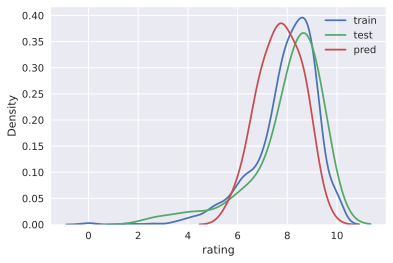

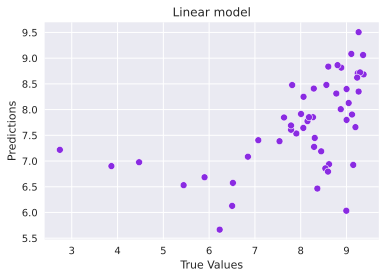

In [77]:
i88ii8888888888target_distr_linear(y_train, y_test, y_pred)  

In [78]:
calc_metrics(y_test, y_pred)

*** VAL **: 
MSE:   1.5464673110957126
RMSE:  1.243570388476548
R2:    0.24627755536757223
MAE:   0.8546991013943861
MedAE: 0.5642856544647126
------------------------------


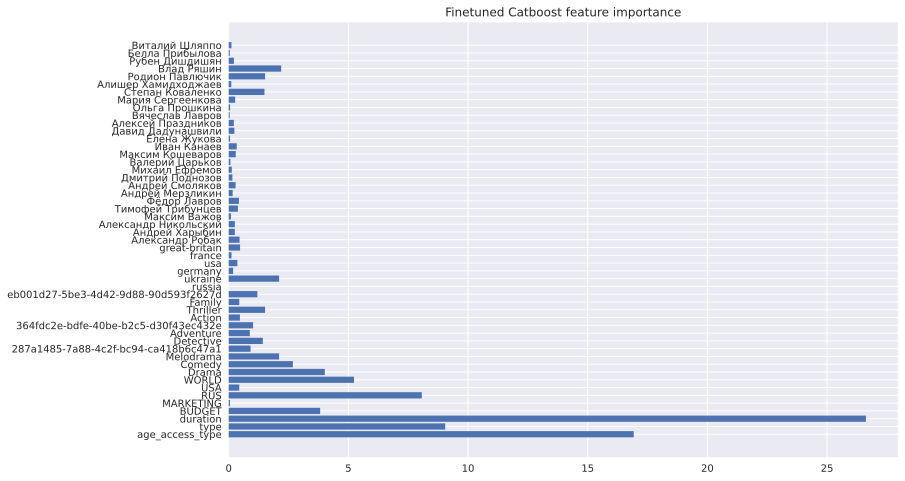

In [79]:
get_feature_imp(best_cat, train_dataset)

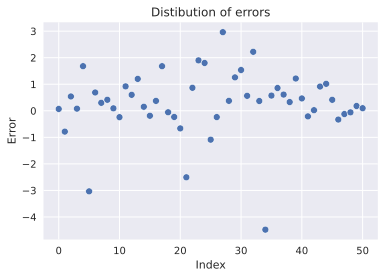

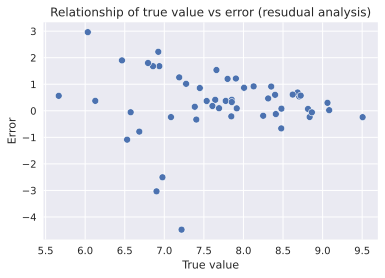

In [80]:
errors = y_test - y_pred
draw_res_analys(errors, y_pred)

In [81]:
test_df['PREDS'] = y_pred.tolist()
test_df['TARGET'] = y_test.tolist()
test_df

,age_access_type,name,type,release_year,duration,element_uid,BUDGET,MARKETING,RUS,USA,...,Мария Сергеенкова,Степан Коваленко,Алишер Хамидходжаев,Родион Павлючик,Влад Ряшин,Рубен Дишдишян,Белла Прибылова,Виталий Шляппо,PREDS,TARGET
10681,18,Закрыть гештальт,SERIAL,2022,16.685680,e6ea57ce-52eb-465b-b9b8-270bc498ca53,NaN,NaN,NaN,NaN,...,0,0,0,0,0,0,0,0,8.815770,8.885542
6889,18,Рэпер,MOVIE,2022,15.636829,3eed9149-4311-4f23-ad37-e0985cae8cc8,NaN,NaN,NaN,NaN,...,0,0,0,0,0,0,0,0,6.684174,5.900000
7691,6,Финник,MOVIE,2022,15.468008,e9e71add-6d6f-41a1-bd81-705e9c9e3128,NaN,NaN,15.997514,NaN,...,0,0,0,0,0,0,0,0,8.704750,9.244676
7640,12,Первый Оскар,MOVIE,2022,15.738298,e69d2f4d-bb65-4e7e-93e1-74da99424ae8,NaN,NaN,14.252288,NaN,...,0,0,0,0,0,0,0,0,8.479647,8.560844
7630,18,Ника,MOVIE,2022,15.566448,5bd9b8c0-b482-4953-951a-813985e55e2d,NaN,NaN,12.233522,NaN,...,0,0,0,0,0,0,0,0,6.937400,8.618524
4554,16,Селфимания,MOVIE,2022,15.306165,75b6466f-9b0e-4195-9b99-c9f033d5589a,NaN,NaN,NaN,NaN,...,0,0,0,0,0,0,0,0,6.901395,3.865964
10607,16,И снова здравствуйте!,SERIAL,2022,16.665060,f02bc785-71a0-44cc-b6d6-ee2360a1c50f,NaN,NaN,NaN,NaN,...,0,0,0,0,0,0,0,0,8.684035,9.374117
10608,18,Оффлайн,SERIAL,2022,17.218706,49a3d528-44c0-408e-b6fc-a1507ce7641a,NaN,NaN,NaN,NaN,...,0,0,0,0,0,0,0,0,9.061629,9.362527
10630,0,Мой мир. Поем вместе,SERIAL,2022,15.358809,bd9a6edd-9eba-43c5-a053-4eca388798a5,NaN,NaN,NaN,NaN,...,0,0,0,0,0,0,0,0,7.852118,8.267857
10628,16,Кабинет Путешественника,SERIAL,2022,16.172584,fa45e8d6-7d96-40dc-b50d-3f012a89ecee,NaN,NaN,NaN,NaN,...,0,0,0,1,0,0,0,0,7.914824,8.007194


In [82]:
y_pred_demo_tuned = best_cat.predict(demo_dataset)

demo_df['PREDS_TUNED'] = y_pred_demo_tuned.tolist()
demo_df 

,age_access_type,name,type,release_year,duration,element_uid,BUDGET,MARKETING,RUS,USA,...,Степан Коваленко,Алишер Хамидходжаев,Родион Павлючик,Влад Ряшин,Рубен Дишдишян,Белла Прибылова,Виталий Шляппо,TARGET,PREDS,PREDS_TUNED
6469,16,Молодой человек,MOVIE,2022,15.702580,0271c9b5-b7b2-4e3f-96af-b9cefed99397,NaN,NaN,NaN,NaN,...,0,0,0,0,0,0,0,9.147352,7.335317,6.924268
6550,18,Приплыли!,MOVIE,2022,15.479437,02eaefe0-296d-4e6f-b52f-2e2507d07103,NaN,NaN,12.593543,NaN,...,0,0,0,0,0,0,0,6.519242,6.487421,6.574805
9998,18,Чикатило,SERIAL,2020,17.723526,ee48def6-c311-4b73-a878-1a5d3d1679a3,NaN,NaN,NaN,NaN,...,0,0,0,0,0,0,0,9.717041,9.297865,9.576394
10433,6,Манюня,SERIAL,2021,16.269958,9b202b16-55bf-418a-b01d-9f0329b18790,NaN,NaN,NaN,NaN,...,0,0,0,0,0,0,0,9.192744,7.613430,5.542701
10608,18,Оффлайн,SERIAL,2022,17.218706,49a3d528-44c0-408e-b6fc-a1507ce7641a,NaN,NaN,NaN,NaN,...,0,0,0,0,0,0,0,9.362527,8.852562,9.061629


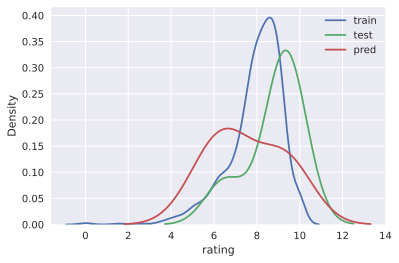

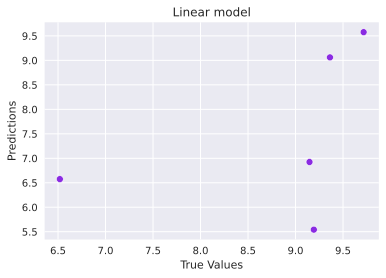

In [83]:

target_distr_linear(y_train, y_demo, y_pred_demo_tuned)  